In [1]:
import requests
import json
import torch
import torch.nn as nn
import os
from tqdm import tqdm
from transformers import BertModel, BertTokenizerFast, AdamW
from torch.utils.data import Dataset, DataLoader
from torch.optim.lr_scheduler import ExponentialLR
import matplotlib.pyplot as plt

In [2]:
question_count = 0
possible_count = 0
impossible_count = 0

In [3]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [4]:
def load_data(file_path): 
    with open(file_path, 'rb') as file:
        data_content = json.load(file)
        
    context_list = []
    question_list = []
    answer_list = []
    total_questions = 0
    possible_count = 0
    impossible_count = 0
    context_index = 0
    question_index = 0

    for item in data_content['data']:
        for section in item['paragraphs']:
            current_context = section['context']
            for qa_pair in section['qas']:
                current_question = qa_pair['question']
                total_questions += 1
                print(total_questions, current_question)
                
                for ans in qa_pair['answers']:
                    context_list.append(current_context.lower())
                    question_list.append(current_question.lower())
                    answer_list.append(ans)

    return total_questions, possible_count, impossible_count, context_list, question_list, answer_list

In [5]:
total_qs, count_pos, count_imp, contexts_train, questions_train, answers_train = load_data('spoken_train-v1.1.json')
total_questions = total_qs
possible_total = count_pos
impossible_total = count_imp

1 What is in front of the Notre Dame Main Building?
2 The Basilica of the Sacred heart at Notre Dame is beside to which structure?
3 How often is Notre Dame's the Juggler published?
4 What is the daily student paper at Notre Dame called?
5 How many student news papers are found at Notre Dame?
6 Where is the headquarters of the Congregation of the Holy Cross?
7 What is the oldest structure at Notre Dame?
8 What individuals live at Fatima House at Notre Dame?
9 How many BS level degrees are offered in the College of Engineering at Notre Dame?
10 Before the creation of the College of Engineering similar studies were carried out at which Notre Dame college?
11 How many departments are within the Stinson-Remick Hall of Engineering?
12 What entity provides help with the management of time for new students at Notre Dame?
13 How many colleges for undergraduates are at Notre Dame?
14 What was created at Notre Dame in 1962 to assist first year students?
15 What type of degree is an M.Div.?
16 Wh

In [6]:
print(len(questions_train))
print(len(contexts_train))
print(questions_train[:10])
print(answers_train[:10])
# print(len(answers_train))

37111
37111
['what is in front of the notre dame main building?', 'the basilica of the sacred heart at notre dame is beside to which structure?', "how often is notre dame's the juggler published?", 'what is the daily student paper at notre dame called?', 'how many student news papers are found at notre dame?', 'where is the headquarters of the congregation of the holy cross?', 'what is the oldest structure at notre dame?', 'what individuals live at fatima house at notre dame?', 'how many bs level degrees are offered in the college of engineering at notre dame?', 'before the creation of the college of engineering similar studies were carried out at which notre dame college?']
[{'answer_start': 187, 'text': 'a copper statue of christ'}, {'answer_start': 58, 'text': 'the main building'}, {'answer_start': 316, 'text': 'twice'}, {'answer_start': 614, 'text': 'the observer'}, {'answer_start': 128, 'text': 'three'}, {'answer_start': 117, 'text': 'rome'}, {'answer_start': 229, 'text': 'old col

In [7]:
qs_count, pos_count, imp_count, contexts_valid, questions_valid, answers_valid = load_data('spoken_test-v1.1.json')
total_questions += qs_count
possible_total += pos_count
impossible_total += imp_count

print(f"Total number of questions: {total_questions}")
print(f"Total number of answerable questions: {possible_total}")
print(f"Total number of impossible questions: {impossible_total}")

1 Which NFL team represented the AFC at Super Bowl 50?
2 Which NFL team represented the NFC at Super Bowl 50?
3 Where did Super Bowl 50 take place?
4 Which NFL team won Super Bowl 50?
5 What color was used to emphasize the 50th anniversary of the Super Bowl?
6 What was the theme of Super Bowl 50?
7 What is the AFC short for?
8 What was the theme of Super Bowl 50?
9 What does AFC stand for?
10 Who won Super Bowl 50?
11 What venue did Super Bowl 50 take place in?
12 What city did Super Bowl 50 take place in?
13 If Roman numerals were used, what would Super Bowl 50 have been called?
14 What city did Super Bowl 50 take place in?
15 What stadium did Super Bowl 50 take place in?
16 What team was the AFC champion?
17 What team was the NFC champion?
18 Who won Super Bowl 50?
19 Which team won Super Bowl 50.
20 Where was Super Bowl 50 held?
21 The name of the NFL championship game is?
22 What 2015 NFL team one the AFC playoff?
23 How many appearances have the Denver Broncos made in the Super Bo

In [8]:
print(len(questions_valid))
print(len(contexts_valid))
print(questions_valid[:10])
print(answers_valid[:10])

15875
15875
['which nfl team represented the afc at super bowl 50?', 'which nfl team represented the afc at super bowl 50?', 'which nfl team represented the afc at super bowl 50?', 'which nfl team represented the nfc at super bowl 50?', 'which nfl team represented the nfc at super bowl 50?', 'which nfl team represented the nfc at super bowl 50?', 'where did super bowl 50 take place?', 'where did super bowl 50 take place?', 'which nfl team won super bowl 50?', 'which nfl team won super bowl 50?']
[{'answer_start': 190, 'text': 'denver broncos'}, {'answer_start': 190, 'text': 'denver broncos'}, {'answer_start': 190, 'text': 'denver broncos'}, {'answer_start': 264, 'text': 'carolina panthers'}, {'answer_start': 264, 'text': 'carolina panthers'}, {'answer_start': 264, 'text': 'carolina panthers'}, {'answer_start': 442, 'text': 'santa clara california'}, {'answer_start': 398, 'text': 'levis stadium'}, {'answer_start': 190, 'text': 'denver broncos'}, {'answer_start': 190, 'text': 'denver bro

In [9]:
def append_answer_end(ans_list, ctxt_list):
    for ans, ctxt in zip(ans_list, ctxt_list):
        ans['text'] = ans['text'].lower()
        ans['end_position'] = ans['answer_start'] + len(ans['text'])

append_answer_end(answers_train, contexts_train)
append_answer_end(answers_valid, contexts_valid)

In [10]:
print(f"Context: {contexts_train[0]}")
print(f"Question: {questions_train[0]}")
print(f"Answer: {answers_train[0]}")

Context: architecturally the school has a catholic character. atop the main building school dome is the golden statue of the virgin mary. immediately in front of the main building in facing it is a copper statue of christ with arms appraised with the legend and the bad meow names. next to the main building is the basilica of the sacred heart. immediately behind the basilica is the grotto im mary in place of prayer and reflection. it is a replica of the grotto at lourdes france where the virgin mary reputedly appeared to st bernadette still burning eighteen fifty eight. at the end of the main drive and in a direct line that connects through three statues in the gold dome is as simple modern stone statue of mary.
Question: what is in front of the notre dame main building?
Answer: {'answer_start': 187, 'text': 'a copper statue of christ', 'answer_end': 212}


In [11]:
test_index = 30
print(f"Context: {contexts_valid[test_index]}")
print(f"Question: {questions_valid[test_index]}")
print(f"Answer: {answers_valid[test_index]}")

Context: super bowl fifty was an american football game to determine the champion of the national football league nfl for the twenty fifteen season. the american football conference a f c c champion denver broncos defeated the national football conference n f c c champion carolina panthers twenty four to ten to earn their third super bowl title. the game was played on february seventh twenty sixteen and levis stadium in the san francisco bay area santa clara california. as this was the fiftieth super bowl the league emphasized the golden anniversary with various goldsteins initiatives as well as temporarily suspending the tradition of naming each super bowl game with roman numerals under which they gain would have been known as super bowl l sell that the logo could prominently featured the arabic numerals fifty.
Question: what city did super bowl 50 take place in?
Answer: {'answer_start': 442, 'text': 'santa clara', 'answer_end': 453}


789


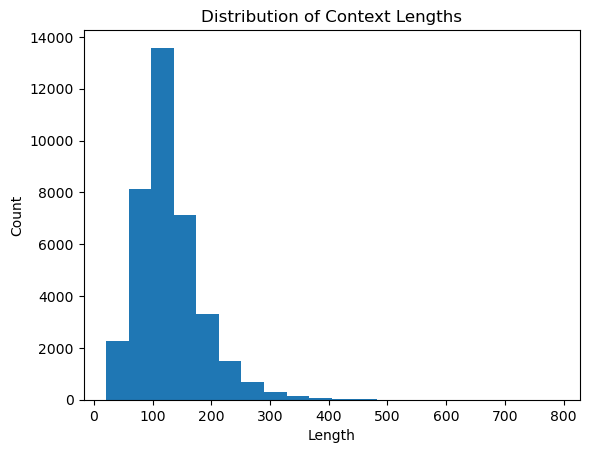

In [12]:
token_lengths = []
for context_text in contexts_train:
    context_text = context_text.strip()  
    token_lengths.append(len(context_text.split(' ')))

print(max(token_lengths))
plt.hist(token_lengths, bins=20)
plt.ylabel('Count')
plt.xlabel('Length')
plt.title('Distribution of Context Lengths')

34
37111


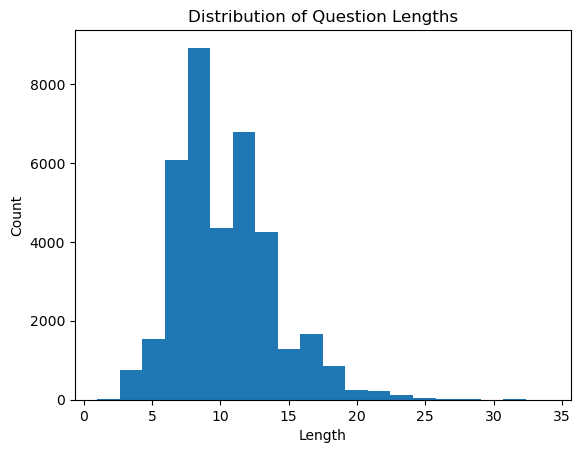

In [15]:
question_lengths = []

for question_text in questions_train:
    question_text = question_text.strip()  
    question_lengths.append(len(question_text.split(' ')))

print(max(question_lengths))
print(len(question_lengths))

plt.hist(question_lengths, bins=20)
plt.ylabel('Count')
plt.xlabel('Length')
plt.title('Distribution of Question Lengths')

In [16]:
MAX_SEQ_LENGTH = 250
PRETRAINED_MODEL_PATH = "bert-base-uncased"

In [17]:
print(len(questions_train))
print(len(contexts_train))

37111
37111


In [18]:
print(questions_valid[11])

what color was used to emphasize the 50th anniversary of the super bowl?


In [19]:
fast_tokenizer = BertTokenizerFast.from_pretrained(PRETRAINED_MODEL_PATH)
train_encodings = fast_tokenizer(questions_train, contexts_train, max_length=MAX_SEQ_LENGTH, truncation=True, padding=True)
valid_encodings = fast_tokenizer(questions_valid, contexts_valid, max_length=MAX_SEQ_LENGTH, truncation=True, padding=True)

In [20]:
type(train_encodings)

transformers.tokenization_utils_base.BatchEncoding

In [21]:
print(train_encodings.keys())
print(valid_encodings.keys())
print(len(train_encodings['input_ids']))
print(len(train_encodings['input_ids'][0]))

dict_keys(['input_ids', 'token_type_ids', 'attention_mask'])
dict_keys(['input_ids', 'token_type_ids', 'attention_mask'])
37111
250


In [22]:
def get_answer_start_and_end_train(index):
    start_position = 0
    end_position = 0
    answer_encoding = fast_tokenizer(answers_train[index]['text'], max_length=MAX_SEQ_LENGTH, truncation=True, padding=True)
    
    for a in range(len(train_encodings['input_ids'][index]) - len(answer_encoding['input_ids'])):
        match_found = True
        for i in range(1, len(answer_encoding['input_ids']) - 1):
            if answer_encoding['input_ids'][i] != train_encodings['input_ids'][index][a + i]:
                match_found = False
                break
        if match_found:
            start_position = a + 1
            end_position = a + i + 1
            break
    
    return start_position, end_position

In [23]:
test_index = 92

start_pos, end_pos = get_answer_start_and_end_train(test_index)
print(start_pos, end_pos)

predicted_answer_tokens = train_encodings.input_ids[test_index][start_pos:end_pos]
print(f"Predicted Answer: {fast_tokenizer.decode(predicted_answer_tokens)}")
print(f"Actual Answer: {answers_train[test_index]['text']}")
print(f"Full Encoding Decoded: {fast_tokenizer.decode(train_encodings['input_ids'][test_index])}")

114 115
pat
pat obrien
[CLS] which person portrayed knute rockne in the 1940 movie " knute rockne? " [SEP] george gap with the schools legendary football player during nineteen sixteen to twenty. he played semi professional baseball in smoke drink and gambled when not playing sports. he was also humble generous to the needy and a man of integrity. it was in nineteen twenty eight that fame coach can you brought me used his final conversation with the dying get to inspire the notre dame team to beat the army team and win one for the gipper the nineteen forty film can you drop me all american start pat obrien is can you drop me and ronald reagan as get. today in the team competes in notre dame stadium and eighty thousand seven hundred ninety five seat stadium on campus. the current head coaches brian kelly hired from the university of cincinnati on december eleventh two thousand nine. kellys record in midway through his sixth season at notre dame is fifty two to twenty one. in twenty twel

In [24]:
start_positions_list = []
end_positions_list = []
counter = 0
for index in range(len(train_encodings['input_ids'])):
    start_pos, end_pos = get_answer_start_and_end_train(index)
    start_positions_list.append(start_pos)
    end_positions_list.append(end_pos)
    if start_pos == 0:
        counter += 1

train_encodings.update({'start_positions': start_positions_list, 'end_positions': end_positions_list})
print(counter)

478


In [25]:
test_index = 1
print(train_encodings['start_positions'][test_index])
print(train_encodings['end_positions'][test_index])

predicted_answer_tokens = train_encodings.input_ids[test_index][train_encodings['start_positions'][test_index] : train_encodings['end_positions'][test_index]]
print(f"Predicted Answer: {fast_tokenizer.decode(predicted_answer_tokens)}")

print(f"Actual Answer: {answers_train[test_index]['text']}")
print(f"Full Encoding Decoded: {fast_tokenizer.decode(train_encodings['input_ids'][test_index])}")

150
151
the
the main building
[CLS] the basilica of the sacred heart at notre dame is beside to which structure? [SEP] architecturally the school has a catholic character. atop the main building school dome is the golden statue of the virgin mary. immediately in front of the main building in facing it is a copper statue of christ with arms appraised with the legend and the bad meow names. next to the main building is the basilica of the sacred heart. immediately behind the basilica is the grotto im mary in place of prayer and reflection. it is a replica of the grotto at lourdes france where the virgin mary reputedly appeared to st bernadette still burning eighteen fifty eight. at the end of the main drive and in a direct line that connects through three statues in the gold dome is as simple modern stone statue of mary. [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [

In [26]:
def get_answer_start_and_end_valid(index):
    start_pos = 0
    end_pos = 0
    answer_encoding = fast_tokenizer(valid_answers[index]['text'], max_length=MAX_SEQ_LENGTH, truncation=True, padding=True)
    
    for a in range(len(valid_encodings['input_ids'][index]) - len(answer_encoding['input_ids'])):
        match_found = True
        for i in range(1, len(answer_encoding['input_ids']) - 1):
            if answer_encoding['input_ids'][i] != valid_encodings['input_ids'][index][a + i]:
                match_found = False
                break
        if match_found:
            start_pos = a + 1
            end_pos = a + i + 1
            break
    
    return start_pos, end_pos

In [27]:
start_positions_list = []
end_positions_list = []
counter = 0
for index in range(len(valid_encodings['input_ids'])):
    start_pos, end_pos = get_answer_start_and_end_valid(index)
    start_positions_list.append(start_pos)
    end_positions_list.append(end_pos)
    if start_pos == 0:
        counter += 1

valid_encodings.update({'start_positions': start_positions_list, 'end_positions': end_positions_list})
print(counter)

236


In [28]:
test_index = 2

start_pos, end_pos = get_answer_start_and_end_valid(test_index)
predicted_answer_tokens = valid_encodings.input_ids[test_index][start_pos:end_pos]

print(f"Predicted Answer: {fast_tokenizer.decode(predicted_answer_tokens)}")
print(f"Actual Answer: {valid_answers[test_index]['text']}")
print(f"Full Encoding Decoded: {fast_tokenizer.decode(valid_encodings['input_ids'][test_index])}")

denver
denver broncos
[CLS] which nfl team represented the afc at super bowl 50? [SEP] super bowl fifty was an american football game to determine the champion of the national football league nfl for the twenty fifteen season. the american football conference a f c c champion denver broncos defeated the national football conference n f c c champion carolina panthers twenty four to ten to earn their third super bowl title. the game was played on february seventh twenty sixteen and levis stadium in the san francisco bay area santa clara california. as this was the fiftieth super bowl the league emphasized the golden anniversary with various goldsteins initiatives as well as temporarily suspending the tradition of naming each super bowl game with roman numerals under which they gain would have been known as super bowl l sell that the logo could prominently featured the arabic numerals fifty. [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [P

In [29]:
print(train_encodings.keys())
print(valid_encodings.keys())

print(len(train_encodings['input_ids']))
print(len(train_encodings['start_positions']))
print(len(train_encodings['end_positions']))

print(len(valid_encodings['input_ids']))
print(len(valid_encodings['start_positions']))
print(len(valid_encodings['end_positions']))

dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'start_positions', 'end_positions'])
dict_keys(['input_ids', 'token_type_ids', 'attention_mask', 'start_positions', 'end_positions'])
37111
37111
37111
15875
15875
15875


In [30]:
fast_tokenizer.decode(train_encodings['input_ids'][0])

'[CLS] what is in front of the notre dame main building? [SEP] architecturally the school has a catholic character. atop the main building school dome is the golden statue of the virgin mary. immediately in front of the main building in facing it is a copper statue of christ with arms appraised with the legend and the bad meow names. next to the main building is the basilica of the sacred heart. immediately behind the basilica is the grotto im mary in place of prayer and reflection. it is a replica of the grotto at lourdes france where the virgin mary reputedly appeared to st bernadette still burning eighteen fifty eight. at the end of the main drive and in a direct line that connects through three statues in the gold dome is as simple modern stone statue of mary. [SEP] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PAD] [PA

In [31]:
test_idx = 0
print(train_contexts[test_idx][train_answers[test_idx]['answer_start']:train_answers[test_idx]['answer_end']])

a copper statue of christ


In [32]:
class EncodedDataset(Dataset):
    def __init__(self, encodings_data):
        self.encodings_data = encodings_data
        
    def __getitem__(self, idx):
        return {
            'input_ids': torch.tensor(self.encodings_data['input_ids'][idx]),
            'token_type_ids': torch.tensor(self.encodings_data['token_type_ids'][idx]),
            'attention_mask': torch.tensor(self.encodings_data['attention_mask'][idx]),
            'start_positions': torch.tensor(self.encodings_data['start_positions'][idx]),
            'end_positions': torch.tensor(self.encodings_data['end_positions'][idx])
        }
        
    def __len__(self):
        return len(self.encodings_data['input_ids'])

In [33]:
train_dataset = EncodedDataset(train_encodings)
valid_dataset = EncodedDataset(valid_encodings)

In [34]:
train_data_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)
valid_data_loader = DataLoader(valid_dataset, batch_size=1)

In [35]:
bert_model = BertModel.from_pretrained(MODEL_PATH)  #MODEL_PATH = "bert-base-uncased"

class QuestionAnsweringModel(nn.Module):
    def __init__(self):
        super(QuestionAnsweringModel, self).__init__()
        self.bert = bert_model
        self.dropout_layer = nn.Dropout(0.1)
        self.fc1 = nn.Linear(768 * 2, 768 * 2)
        self.fc2 = nn.Linear(768 * 2, 2)
        self.network = nn.Sequential(
            self.dropout_layer,
            self.fc1,
            nn.LeakyReLU(),
            self.fc2 
        )
        
    def forward(self, input_ids, attention_mask, token_type_ids):
        model_output = self.bert(input_ids, attention_mask=attention_mask, token_type_ids=token_type_ids, output_hidden_states=True)
        hidden_states = model_output[2]
        concatenated_output = torch.cat((hidden_states[-1], hidden_states[-3]), dim=-1)  # Start logits from the last BERT layer, End logits from the third to last layer
        logits = self.network(concatenated_output)
        
        start_logits, end_logits = logits.split(1, dim=-1)
        
        start_logits = start_logits.squeeze(-1)
        end_logits = end_logits.squeeze(-1)

        return start_logits, end_logits

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [36]:
model = QuestionAnsweringModel()

In [37]:
def loss_fn(start_logits, end_logits, start_positions, end_positions):
    loss_fct = nn.CrossEntropyLoss()
    start_loss = loss_fct(start_logits, start_positions)
    end_loss = loss_fct(end_logits, end_positions)
    total_loss = (start_loss + end_loss) / 2
    return total_loss

In [38]:
def focal_loss_fn(start_logits, end_logits, start_positions, end_positions, gamma):
    smax = nn.Softmax(dim=1)
    probs_start = smax(start_logits)
    inv_probs_start = 1 - probs_start
    probs_end = smax(end_logits)
    inv_probs_end = 1 - probs_end
    lsmax = nn.LogSoftmax(dim=1)
    log_probs_start = lsmax(start_logits)
    log_probs_end = lsmax(end_logits)
    nll = nn.NLLLoss()
    fl_start = nll(torch.pow(inv_probs_start, gamma) * log_probs_start, start_positions)
    fl_end = nll(torch.pow(inv_probs_end, gamma) * log_probs_end, end_positions)
    return ((fl_start + fl_end) / 2)

In [39]:
optimizer = AdamW(model.parameters(), lr=2e-5, weight_decay=2e-2)
lr_scheduler = ExponentialLR(optimizer, gamma=0.9)
accuracy_history = []
loss_history = []

/home/hbanda/.local/lib/python3.9/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


In [40]:
def train_one_epoch(model, data_loader, epoch_num):
    model = model.train()
    loss_values = []
    accuracy_values = []
    iteration_count = 0
    batch_counter = 0
    for batch in tqdm(data_loader, desc=f'Epoch {epoch_num} in Progress'):
        print(batch)
        optimizer.zero_grad()
        
        # Move batch data to device
        input_ids = batch['input_ids'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        token_type_ids = batch['token_type_ids'].to(device)
        start_positions = batch['start_positions'].to(device)
        end_positions = batch['end_positions'].to(device)
        
        # Model prediction
        start_logits, end_logits = model(input_ids=input_ids,
                                          attention_mask=attention_mask,
                                          token_type_ids=token_type_ids)
        
        # Calculate loss using focal loss
        batch_loss = focal_loss_fn(start_logits, end_logits, start_positions, end_positions, 1)
        loss_values.append(batch_loss.item())
        
        # Backpropagation and optimization
        batch_loss.backward()
        optimizer.step()

        # Calculate accuracy
        start_pred = torch.argmax(start_logits, dim=1)
        end_pred = torch.argmax(end_logits, dim=1)
        accuracy_values.append(((start_pred == start_positions).sum() / len(start_pred)).item())
        accuracy_values.append(((end_pred == end_positions).sum() / len(end_pred)).item())
        
        # Track batch progress
        batch_counter += 1
        if batch_counter == 250 and epoch_num == 1:
            accuracy_history.append(sum(accuracy_values) / len(accuracy_values))
            avg_loss = sum(loss_values) / len(loss_values)
            loss_history.append(avg_loss)
            batch_counter = 0
            
    lr_scheduler.step()
    epoch_accuracy = sum(accuracy_values) / len(accuracy_values)
    epoch_loss = sum(loss_values) / len(loss_values)
    
    return epoch_accuracy, epoch_loss

In [41]:
def evaluate_model(model, data_loader):
    model = model.eval()
    loss_values = []
    accuracy_values = []
    batch_counter = 0
    
    with torch.no_grad():
        for batch in tqdm(data_loader, desc='Evaluating Model'):
            input_ids = batch['input_ids'].to(device)
            attention_mask = batch['attention_mask'].to(device)
            token_type_ids = batch['token_type_ids'].to(device)
            start_positions_true = batch['start_positions'].to(device)
            end_positions_true = batch['end_positions'].to(device)
            
            # Model prediction
            start_logits, end_logits = model(input_ids=input_ids, 
                                              attention_mask=attention_mask, 
                                              token_type_ids=token_type_ids)
            
            # Get the predicted start and end positions
            start_pred = torch.argmax(start_logits, dim=1)
            end_pred = torch.argmax(end_logits, dim=1)
            
            # Calculate accuracy
            accuracy_values.append(((start_pred == start_positions_true).sum() / len(start_pred)).item())
            accuracy_values.append(((end_pred == end_positions_true).sum() / len(end_pred)).item())
        
            # For visualization, get predicted answer tokens
            tokens = tokenizerFast.convert_ids_to_tokens(input_ids[0].tolist())
            predicted_answer = tokenizerFast.convert_tokens_to_string(tokens[start_pred[0].item():end_pred[0].item() + 1])
            print("Predicted Answer:", predicted_answer)
            
    avg_accuracy = sum(accuracy_values) / len(accuracy_values)
    return avg_accuracy


In [42]:
model.to(device)

QAModel(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=Tr

In [43]:
EPOCHS = 10
for epoch in range(EPOCHS):
    train_acc, train_loss = train_epoch(model, train_data_loader, epoch+1)
    print(f"Train Accuracy: {train_acc}      Train Loss: {train_loss}")
    val_acc = eval_model(model, valid_data_loader)
    print(f"Validation Accuracy: {val_acc}")

Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[  101,  7842, 25205,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2009,  2011,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 133,  75,  89,  70, 181, 172,  88, 104, 106, 226,  66,  96,  29,
        117,  82]), 'end_positions': tensor([164, 13

Running Epoch :   0%|          | 1/2320 [00:01<1:09:07,  1.79s/it]

{'input_ids': tensor([[ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  25, 135, 102, 199,  92, 196,  40,  74,  96,  14,  96, 116,  82,
        116,  23]), 'end_positions': tensor([ 80,  26, 136, 103, 200,  93, 197,  41,  75

Running Epoch :   0%|          | 2/2320 [00:02<39:03,  1.01s/it]  

{'input_ids': tensor([[ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 121, 108,  58, 187, 123, 162,  63,  30,  39,  25, 116,  74, 108,
         45,  78]), 'end_positions': tensor([ 37, 122, 109,  59, 188, 124, 163,  64,  31

Running Epoch :   0%|          | 3/2320 [00:02<29:00,  1.33it/s]

{'input_ids': tensor([[ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 108, 134,  10,  84, 114, 141,  56,  28,  70,  82,  92,  57, 197,
         75,  47]), 'end_positions': tensor([224, 109, 135,  11,  85, 115, 142,  57,  29

Running Epoch :   0%|          | 4/2320 [00:03<24:17,  1.59it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ..., 4118, 2004,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  24, 111,  79,  45,  48,  35,  45,  16,  46, 101,  55, 150, 108,
         83,  37]), 'end_positions': tensor([134,  25, 112,  80,  46,  49,  36,  46,  17

Running Epoch :   0%|          | 5/2320 [00:03<21:40,  1.78it/s]

{'input_ids': tensor([[ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2417,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3865,  ..., 3584, 1996,  102],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  98,  68,  67, 141,  53, 246,  28,  59, 113, 166,  78, 132, 159,
         40,  42]), 'end_positions': tensor([188,  99,  69,  68, 142,  54, 247,  29,  60

Running Epoch :   0%|          | 6/2320 [00:04<20:03,  1.92it/s]

{'input_ids': tensor([[  101,  2031,  2216,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4584,  ...,  7763, 12021,   102],
        [  101,  2040,  5751,  ...,     0,     0,     0],
        [  101,  2054,  2155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  67,  34,  16,  66, 183, 160,  44, 169,  17,  59,  25,  89,  30,
        122, 157]), 'end_positions': tensor([ 94,  6

Running Epoch :   0%|          | 7/2320 [00:04<19:05,  2.02it/s]

{'input_ids': tensor([[  101, 15267,  1998,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  5741,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  29, 135, 115,  26, 140, 122,  56, 144,  86,  45, 115,  31,  48,
         49, 116]), 'end_positions': tensor([101,  3

Running Epoch :   0%|          | 8/2320 [00:04<18:24,  2.09it/s]

{'input_ids': tensor([[  101, 22666,  2137,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2003,  3205,   102],
        [  101,  2129,  2092,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 234,  83,  60, 151,  79, 205,  30,  28,  69,  87, 138,  93, 120,
         71, 140]), 'end_positions': tensor([106, 23

Running Epoch :   0%|          | 9/2320 [00:05<17:59,  2.14it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  5781,  6602,  ...,     0,     0,     0],
        [  101,  2054, 11494,  ...,     0,     0,     0],
        ...,
        [  101,  2899,  1010,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  81, 110,  24,  29, 112,  64, 163,  56,  25,  51,  22, 141,  91,
         41, 119]), 'end_positions': tensor([ 60,  8

Running Epoch :   0%|          | 10/2320 [00:05<17:40,  2.18it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ..., 1997, 4167,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 1996,  ..., 1037, 4440,  102],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  94,  63,  39,  34,  59,  69,  85,  44,  46,  51,  22, 220, 120,
         18, 126]), 'end_positions': tensor([ 63,  95,  64,  40,  35,  60,  70,  86,  45

Running Epoch :   0%|          | 11/2320 [00:06<17:29,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 4661, 7914,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 206,  42,  25,  24,  85,  73, 181,  21,  98,  48, 133, 154,  21,
         13, 222]), 'end_positions': tensor([100, 207,  43,  26,  25,  86,  74, 182,  22

Running Epoch :   1%|          | 12/2320 [00:06<17:19,  2.22it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 110,  91,  69, 166,  53,  89, 177, 130, 120, 216, 109, 203,  37,
        184,  77]), 'end_positions': tensor([ 31, 111,  92,  70, 167,  54,  90, 178, 131

Running Epoch :   1%|          | 13/2320 [00:07<17:12,  2.23it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14885,  3443,  ...,  7151, 24681,   102],
        [  101,  2054,  9281,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 113,  29,  38,  16,  76,  23, 111,  62, 136, 162,  82,  59, 105,
        219,  75]), 'end_positions': tensor([118, 11

Running Epoch :   1%|          | 14/2320 [00:07<17:05,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 5848,  ...,    0,    0,    0],
        [ 101, 2236, 2728,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2264,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 222,  35, 211, 118,  59,  45,  43,  91,  62, 119,  82, 187, 101,
         83,  46]), 'end_positions': tensor([ 75, 223,  36, 212, 119,  60,  46,  44,  92

Running Epoch :   1%|          | 15/2320 [00:07<17:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 236,  20,  67, 114, 100,  84, 126,  14, 121,  99, 129,  91,  94,
         99, 196]), 'end_positions': tensor([ 59, 237,  21,  68, 115, 101,  85, 127,  15

Running Epoch :   1%|          | 16/2320 [00:08<16:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ..., 4834, 2008,  102],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  62, 152,  73,  66,  36, 126,  85,  69, 136,  17,  66,  52,   0,
         42,  29]), 'end_positions': tensor([208,  63, 153,  74,  67,  37, 127,  86,  70

Running Epoch :   1%|          | 17/2320 [00:08<16:59,  2.26it/s]

{'input_ids': tensor([[  101, 10907, 12846,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 15250,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 17068,  ...,     0,     0,     0],
        [  101,  2054,  3222,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  61,  26,  77,   0, 123,  58,  79, 103,   0,  63, 143, 184,  95,
        136,  42]), 'end_positions': tensor([136,  6

Running Epoch :   1%|          | 18/2320 [00:09<16:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1037,  2544,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  25,  50,  55,  43, 101, 167,  98,  21, 125,  69,  15,  87,  97,
         34,  51]), 'end_positions': tensor([199,  2

Running Epoch :   1%|          | 19/2320 [00:09<16:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 1996, 2327,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  57, 169,  72, 160, 110, 179, 176, 114,  62,  75, 128,  93, 152,
        127,  86]), 'end_positions': tensor([ 49,  58, 170,  73, 161, 111, 180, 177, 115

Running Epoch :   1%|          | 20/2320 [00:10<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 4879,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 154, 128,  30, 171, 129,  77,  83,  34, 136,  22,  94,  89,  20,
          0,  54]), 'end_positions': tensor([ 68, 155, 129,  31, 172, 130,  78,  84,  35

Running Epoch :   1%|          | 21/2320 [00:10<16:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  15, 117, 113,  72, 230, 113,  91, 109,  79, 100, 104, 102,  54,
        108, 138]), 'end_positions': tensor([154,  16, 118, 114,  73, 231, 114,  92, 110

Running Epoch :   1%|          | 22/2320 [00:11<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4238, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  58,  79, 103,  23,  72, 100,  73, 129,  64,  51, 101, 225, 134,
        188,  74]), 'end_positions': tensor([ 23,  59,  80, 104,  24,  73, 101,  74, 130

Running Epoch :   1%|          | 23/2320 [00:11<16:56,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2144, 12710,  ...,     0,     0,     0],
        [  101,  2029,  2533,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  3007,  3989,  ...,     0,     0,     0],
        [  101,  2040,  5577,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 161,  80,  14,  67, 166,  24,  12, 110, 140, 129, 165,  21,  39,
         70,  10]), 'end_positions': tensor([151, 16

Running Epoch :   1%|          | 24/2320 [00:11<16:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ..., 2003, 1037,  102],
        [ 101, 2029, 4944,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  74, 103,  83, 178, 140, 114,  98, 118, 161,  86, 131,  80, 143,
        126, 141]), 'end_positions': tensor([172,  75, 104,  84, 179, 141, 115,  99, 119

Running Epoch :   1%|          | 25/2320 [00:12<16:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2530,  7508,  ...,     0,     0,     0],
        [  101, 18833,  6269,  ...,     0,     0,     0],
        ...,
        [  101,  2788,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  4761,  ...,  1996, 14487,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,  52,  97,  17,  28,  67, 119,  43, 137,  90,  36,  63, 108,  88,
         36, 139]), 'end_positions': tensor([ 95,  5

Running Epoch :   1%|          | 26/2320 [00:12<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2431,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  32,  72, 178, 197,  85,  62,  80, 121, 113, 120, 162,  60, 101,
         43,  64]), 'end_positions': tensor([ 85,  33,  73, 179, 198,  86,  63,  81, 122

Running Epoch :   1%|          | 27/2320 [00:13<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 18856,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6872,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2761, 17829,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  35, 165, 115,  55,  77,  93, 100,  69,  83, 128,  77, 159,  88,
         67,  31]), 'end_positions': tensor([159,  3

Running Epoch :   1%|          | 28/2320 [00:13<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 5834, 2006,  ...,    0,    0,    0],
        [ 101, 2004, 2019,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  59,  12, 184, 118, 131, 101,  28, 148,  88,  92, 165,  64, 102,
         81, 143]), 'end_positions': tensor([ 42,  60,  13, 185, 119, 132, 102,  29, 149

Running Epoch :   1%|▏         | 29/2320 [00:14<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  30, 136,  47, 118, 137, 135,  74,  43, 132,  40,  42,  15,  37,
         78,  67]), 'end_positions': tensor([ 26,  31, 137,  48, 119, 138, 136,  75,  44

Running Epoch :   1%|▏         | 30/2320 [00:14<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6254,  ...,     0,     0,     0],
        [  101, 24715,  4188,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 123, 191,  93,  36,  11,  20, 121,  73,  88,  18,  44, 152, 110,
         45,  22]), 'end_positions': tensor([115, 12

Running Epoch :   1%|▏         | 31/2320 [00:15<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3354,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 8958,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 134,  41,  80,  59, 117,  64, 149,  34,  50,  97, 132, 132,  83,
         59,  45]), 'end_positions': tensor([173, 135,  42,  81,  60, 118,  65, 150,  35

Running Epoch :   1%|▏         | 32/2320 [00:15<16:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  26,  25,   0, 180,  43,  97, 135,  90, 139,  28,  92, 167,  20,
         61,  52]), 'end_positions': tensor([142,  27,  26,   0, 181,  44,  98, 136,  91

Running Epoch :   1%|▏         | 33/2320 [00:15<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10673,  ...,     0,     0,     0],
        [  101,  2054,  9595,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2660,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  43,  16,  29,  54,  82,  69, 140, 183,  82,  89,  33,  31,  37,
        190, 119]), 'end_positions': tensor([194,  4

Running Epoch :   1%|▏         | 34/2320 [00:16<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 14709,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  80,  30,  77, 100, 131,  66,  53, 125, 148, 177,  27, 169,  53,
        121,  23]), 'end_positions': tensor([ 48,  8

Running Epoch :   2%|▏         | 35/2320 [00:16<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2169,  5298,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  1996,  5433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  84, 220,  86, 125,  85,  36,  34, 215, 128,  14,  50, 216,  70,
         94,  53]), 'end_positions': tensor([205,  8

Running Epoch :   2%|▏         | 36/2320 [00:17<16:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 1998, 7842,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2178, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  50, 243,  35,  22,   0,  55,  90,  97,  45, 217, 114, 128, 128,
         15,  24]), 'end_positions': tensor([101,  51, 244,  36,  23,   0,  56,  91,  98

Running Epoch :   2%|▏         | 37/2320 [00:17<16:48,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  93, 189,  62,  73,  27,  61,  61, 111, 123,  48,  45,  91,  58,
         16, 105]), 'end_positions': tensor([ 83,  9

Running Epoch :   2%|▏         | 38/2320 [00:18<16:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3252,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 109,  45,  66,  56,  29, 156,  86,  64,  32,  70, 152, 124, 102,
        113, 161]), 'end_positions': tensor([ 33, 110,  46,  67,  57,  30, 157,  87,  65

Running Epoch :   2%|▏         | 39/2320 [00:18<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21025,  7103,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 101,  20, 105,  19,  21, 135, 117,  91,  43,  98,  34,  45,  60,
         90, 124]), 'end_positions': tensor([168, 10

Running Epoch :   2%|▏         | 40/2320 [00:19<16:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2169, 4250,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  78,  33, 103,  28,  94,  41,  12,  58,  85, 169, 212, 105, 112,
         96,  47]), 'end_positions': tensor([179,  79,  34, 104,  29,  95,  42,  13,  59

Running Epoch :   2%|▏         | 41/2320 [00:19<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7337,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 25595,  2003,  ...,     0,     0,     0],
        [  101,  1999,  4238,  ...,     0,     0,     0],
        [  101, 26365,  4161,  ...,  1997,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([203,  87,  62, 170,  53,  63,  35, 148, 205,  28,  58, 129,  81,  80,
         36,  18]), 'end_positions': tensor([204,  8

Running Epoch :   2%|▏         | 42/2320 [00:19<16:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2005, 2004,  102],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  63,  29,  50,  36, 119,  60, 173, 145, 125,  19, 131,  70, 181,
        173,  77]), 'end_positions': tensor([ 62,  64,  30,  51,  37, 120,  61, 174, 146

Running Epoch :   2%|▏         | 43/2320 [00:20<16:46,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 13571,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  35,  61, 160,  89, 102, 162,  27,  50, 111,  61,  28, 100,  87,
         25, 157]), 'end_positions': tensor([ 81,  3

Running Epoch :   2%|▏         | 44/2320 [00:20<16:46,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996, 21877,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 108, 149,  87,  11,  27,   0,  78, 225,  73,  93,  98,  22,  57,
         95,  17]), 'end_positions': tensor([ 74, 10

Running Epoch :   2%|▏         | 45/2320 [00:21<16:43,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2740,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2280,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  45,  87, 117,  41, 103,  90,  88,  19,  45,  56, 173, 115,  39,
         17, 194]), 'end_positions': tensor([105,  4

Running Epoch :   2%|▏         | 46/2320 [00:21<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 7403, 2913,  ...,    0,    0,    0],
        [ 101, 2040, 2973,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1058,  ...,    0,    0,    0],
        [ 101, 2029, 2297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  27,  36,  45,  27,  43, 134,  17, 193,  85, 185,  58, 214,  54,
        129, 113]), 'end_positions': tensor([108,  28,  37,  46,  28,  44, 135,  18, 194

Running Epoch :   2%|▏         | 47/2320 [00:22<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1012, 1996,  102],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  40,  85,  75,  14,  75,  56,  82,  78,  25, 147,  32,  30, 242,
         58,  89]), 'end_positions': tensor([ 56,  41,  86,  76,  15,  76,  57,  83,  79

Running Epoch :   2%|▏         | 48/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2167, 3792,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2005, 1996,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 107,  33,  58,  94,  70,  45, 179,  58,  21, 160, 137,  89, 216,
         39, 118]), 'end_positions': tensor([ 72, 108,  34,  59,  95,  71,  46, 180,  59

Running Epoch :   2%|▏         | 49/2320 [00:23<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11955,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2209,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 195,  77,  56, 104, 194, 231,  43,  99,  52,  92,  47,  65, 126,
         61, 164]), 'end_positions': tensor([ 34, 19

Running Epoch :   2%|▏         | 50/2320 [00:23<16:41,  2.27it/s]

{'input_ids': tensor([[  101,  2138,  2027,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19211,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4076,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  53,  18, 144,  17, 141,  77,  53, 159, 150,  61, 157, 218,  60,
        156,  18]), 'end_positions': tensor([ 75,  5

Running Epoch :   2%|▏         | 51/2320 [00:23<16:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1997, 2010,  102],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,  102,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1996, 8594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 179,  74,  47,  40, 176, 163, 153,  98, 172, 221, 103, 107,  42,
        145,  54]), 'end_positions': tensor([126, 180,  75,  48,  41, 177, 164, 154,  99

Running Epoch :   2%|▏         | 52/2320 [00:24<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2217,  2108,   102],
        [  101,  2054, 18478,  ...,  2025, 13191,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3361,  4896,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 167,   0,  64,  58, 155, 120,  52,  57, 119, 163, 154,  66, 147,
        118, 125]), 'end_positions': tensor([232, 16

Running Epoch :   2%|▏         | 53/2320 [00:24<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2111,  1997,  ...,  2058,  2274,   102],
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2054, 20626,  ...,     0,     0,     0],
        ...,
        [  101,  2976,  6736,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 12102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  73, 105,  51,  81, 107, 108, 111, 172,  22,  56,  65,  16,  91,
        141,  52]), 'end_positions': tensor([216,  7

Running Epoch :   2%|▏         | 54/2320 [00:25<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 4251, 4329,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 133,  95,  38,  48, 140, 110, 145,  36,  67, 111, 138, 142, 243,
         89,  96]), 'end_positions': tensor([ 46, 134,  96,  39,  49, 141, 111, 146,  37

Running Epoch :   2%|▏         | 55/2320 [00:25<16:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        ...,
        [ 101, 2220, 5432,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  19, 116,  68, 212, 242, 106,  39,   0, 201, 138,  53, 102,  85,
         20, 231]), 'end_positions': tensor([ 81,  20, 117,  69, 213, 243, 107,  40,   0

Running Epoch :   2%|▏         | 56/2320 [00:26<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 14717,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  35,  40, 179, 129,  75, 126, 242,  25,  23, 142, 100,  97,  97,
         25,  65]), 'end_positions': tensor([104,  3

Running Epoch :   2%|▏         | 57/2320 [00:26<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2365,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2188, 1012,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 159,  21,  32,  87,  37,  32,  28, 102,  23, 142,  97,  80,  35,
        119, 123]), 'end_positions': tensor([112, 160,  22,  33,  88,  38,  33,  29, 103

Running Epoch :   2%|▎         | 58/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2542,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  85,  60, 114,  97,  46,  37, 121,  22,  63,  85, 100, 100,  59,
         44,  94]), 'end_positions': tensor([ 24,  86,  61, 115,  98,  47,  38, 122,  23

Running Epoch :   3%|▎         | 59/2320 [00:27<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  58,  44,  51, 143,  28, 128,  46,  78,  19,  96, 102,  93,  87,
         90, 150]), 'end_positions': tensor([ 45,  59,  45,  52, 144,  29, 129,  47,  79

Running Epoch :   3%|▎         | 60/2320 [00:27<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7831,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3935,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 4661, 8013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  57, 126, 136, 137,  99, 140, 217, 108,  92,  91,  62, 107,  32,
         77, 183]), 'end_positions': tensor([121,  58, 127, 137, 138, 100, 141, 218, 109

Running Epoch :   3%|▎         | 61/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 112, 163,  89,  80, 121,  93, 129,  80,  46,  17,  29,  37,  58,
         44, 131]), 'end_positions': tensor([101, 113, 164,  90,  81, 122,  94, 130,  81

Running Epoch :   3%|▎         | 62/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10566,  ...,     0,     0,     0],
        [  101, 25398,  2003,  ..., 28480,  2444,   102],
        [  101,  2003,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  89,  40, 104,  98, 108, 159, 134,  40,  85, 194,  20,  30,  21,
         30,  55]), 'end_positions': tensor([221,  9

Running Epoch :   3%|▎         | 63/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2383,  3727,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  9247, 24137,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2300,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  70, 187,  82,  47, 102,  23, 135,  46,  64,  53,  31,  78,  42,
         41,  73]), 'end_positions': tensor([ 76,  7

Running Epoch :   3%|▎         | 64/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1996, 2225,  102],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  98,  42,  75, 105, 160, 183,  46,  40,  83,  28,  58,  38, 160,
        135,  29]), 'end_positions': tensor([ 94,  99,  43,  76, 106, 161, 184,  47,  41

Running Epoch :   3%|▎         | 65/2320 [00:30<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([117,  45, 137,  66,  56,  86, 112,  78,  89,  43,  44, 100, 108,  95,
         66, 115]), 'end_positions': tensor([118,  46, 138,  67,  57,  87, 113,  79,  90

Running Epoch :   3%|▎         | 66/2320 [00:30<16:33,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3739,  ...,  1996,  4752,   102],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 24655,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244, 121, 150,  67,  83,  42,  58,  94,  46, 113, 125,  77,  84,  40,
        145,  27]), 'end_positions': tensor([245, 12

Running Epoch :   3%|▎         | 67/2320 [00:30<16:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ..., 12548,  2216,   102],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2028,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 123,  88,  39, 130,  40, 142, 158,  39,  89,  91, 105, 182,  31,
        151,  35]), 'end_positions': tensor([207, 12

Running Epoch :   3%|▎         | 68/2320 [00:31<16:34,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 15734,  ...,  6689,  1998,   102],
        [  101,  2296,  2238,  ...,     0,     0,     0],
        [  101,  2029,  5907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  5998,  2007,   102],
        [  101,  1996, 11113,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 113,   0, 174,  94,  17, 111,  58, 133, 129, 117, 209,  79,  48,
        228,  13]), 'end_positions': tensor([ 41, 11

Running Epoch :   3%|▎         | 69/2320 [00:31<16:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10072,  2013,  ...,  2008,  9587,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 118,  54,  40,  22, 213, 105,  30, 133, 109, 167,  41,  43,  45,
         63, 166]), 'end_positions': tensor([ 53, 11

Running Epoch :   3%|▎         | 70/2320 [00:32<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2550,  ...,    0,    0,    0],
        [ 101, 2054, 6143,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  68,  25,  29, 115,  84, 159,  57, 202, 101, 104,  23,  85, 117,
         75,  80]), 'end_positions': tensor([ 76,  69,  26,  30, 116,  85, 160,  58, 203

Running Epoch :   3%|▎         | 71/2320 [00:32<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 5969,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 105,  50, 101,  85,  43,  20,  53,  89, 119, 146, 242,  87, 104,
         52,  98]), 'end_positions': tensor([ 88, 106,  51, 102,  86,  44,  21,  54,  90

Running Epoch :   3%|▎         | 72/2320 [00:33<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212, 121,  56,  46,  46, 167,  59,  63, 130, 103, 163,  54, 118,  35,
        158, 128]), 'end_positions': tensor([213, 122,  57,  47,  47, 168,  60,  64, 131

Running Epoch :   3%|▎         | 73/2320 [00:33<16:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2087, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5260,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  83,  97, 105,  81, 105,   0,  68,  78, 204,  95,  78, 110,  63,
        110,  28]), 'end_positions': tensor([ 51,  84,  98, 106,  82, 106,   0,  69,  79

Running Epoch :   3%|▎         | 74/2320 [00:34<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,  6914,  2024,   102],
        [  101,  2040, 12011,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,  1996, 10063,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 153, 138, 182, 158,  20,  78, 143, 129, 100,  96,  83,  29, 140,
         28, 131]), 'end_positions': tensor([ 98, 15

Running Epoch :   3%|▎         | 75/2320 [00:34<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26733,  ...,  2041,  2019,   102],
        [  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  4654, 24759,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2069,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  18,  81, 172,  36,  43,  41,  64,  63,  80,  66,  76, 109, 120,
         25,  65]), 'end_positions': tensor([155,  1

Running Epoch :   3%|▎         | 76/2320 [00:34<16:31,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 9353,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  37,  45,  88, 103, 198, 122, 164, 112, 145,  38,  63,  21,  94,
         34,  95]), 'end_positions': tensor([ 81,  38,  46,  89, 104, 199, 123, 165, 113

Running Epoch :   3%|▎         | 77/2320 [00:35<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 6107, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3763,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  43, 184, 125, 104, 130,  34, 119, 118,  18,  30, 120, 172,  28,
         75,  78]), 'end_positions': tensor([136,  44, 185, 126, 105, 131,  35, 120, 119

Running Epoch :   3%|▎         | 78/2320 [00:35<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        [ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  84,  93, 152,  43, 102, 109,   0, 122, 137,  81, 182, 213,  92,
         98,  84]), 'end_positions': tensor([101,  85,  94, 153,  44, 103, 110,   0, 123

Running Epoch :   3%|▎         | 79/2320 [00:36<16:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 2578,  ...,  102,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  98,  59,  91,  68,  81,  59, 116, 114,  45,  79, 207, 149, 161,
         94, 109]), 'end_positions': tensor([ 31,  99,  60,  92,  69,  82,  60, 117, 115

Running Epoch :   3%|▎         | 80/2320 [00:36<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 9268,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1996, 4656,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 142, 103,  90,  48, 125, 192, 111,  17,   0,  75,  75, 183,  75,
         30, 113]), 'end_positions': tensor([ 49, 143, 104,  91,  49, 126, 193, 112,  18

Running Epoch :   3%|▎         | 81/2320 [00:37<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 3671,  ...,    0,    0,    0],
        [ 101, 2040, 4895,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  20, 167,  91, 111,  47, 109, 103,  12, 103, 144, 123,  34, 120,
         80,  59]), 'end_positions': tensor([116,  21, 168,  92, 112,  48, 110, 104,  13

Running Epoch :   4%|▎         | 82/2320 [00:37<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2029,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  90, 229,  18,  36,  98, 106,  62,  87,  19,  79,  12,  59, 122,
         91,  45]), 'end_positions': tensor([124,  91, 230,  19,  37,  99, 107,  63,  88

Running Epoch :   4%|▎         | 83/2320 [00:38<16:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3202,  ..., 2477, 2125,  102],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 4661, 5148,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  22,  26,  33, 114,   0, 219,  23,  65, 209,  70,  66, 156, 143,
         39, 177]), 'end_positions': tensor([187,  23,  27,  34, 115,   0, 220,  24,  66

Running Epoch :   4%|▎         | 84/2320 [00:38<16:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2029, 4883,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 119, 214,  48,  96,  64, 173,  11, 147, 144,  25, 143,  50, 231,
         73, 130]), 'end_positions': tensor([ 40, 120, 215,  49,  97,  65, 174,  12, 148

Running Epoch :   4%|▎         | 85/2320 [00:38<16:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  50,  49,  65,  71,  85,  50,  16,  65,  62,  85,  95,  85, 173,
         16, 111]), 'end_positions': tensor([ 28,  51,  50,  66,  72,  86,  51,  17,  66

Running Epoch :   4%|▎         | 86/2320 [00:39<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2513, 2004,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 220,  67, 146, 103,  29,  29,   0,  34, 143,  82, 151,  32,  27,
         21,  93]), 'end_positions': tensor([ 64, 221,  68, 147, 104,  30,  30,   0,  35

Running Epoch :   4%|▍         | 87/2320 [00:39<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1997,  2037,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996, 18039,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  48, 162, 126, 149,  72, 161,  83,  48,  47, 119, 116,  20,  39,
        121,  92]), 'end_positions': tensor([180,  4

Running Epoch :   4%|▍         | 88/2320 [00:40<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 4249, 2107,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2116, 2695,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  32,  91, 198,  29,  78,  32,  54,  46, 150,  70,  84,  82,  82,
         84,  35]), 'end_positions': tensor([125,  33,  92, 199,  30,  79,  33,  55,  47

Running Epoch :   4%|▍         | 89/2320 [00:40<16:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 4658, 4854,  102],
        [ 101, 2054, 2137,  ..., 5274, 2486,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4799,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 184,  81,  34,  46,  54,  64, 145, 231,  64,  20, 115,  83,  55,
         73,  31]), 'end_positions': tensor([ 41, 185,  82,  35,  47,  55,  65, 146, 232

Running Epoch :   4%|▍         | 90/2320 [00:41<16:25,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  6731,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  6415, 23067,  ...,     0,     0,     0],
        ...,
        [  101, 28873,  4442,  ..., 24335,  8458,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3908,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  10,  73, 167,  99,  34, 194, 166, 132,  76,  33, 125, 197, 137,
         57, 173]), 'end_positions': tensor([ 47,  1

Running Epoch :   4%|▍         | 91/2320 [00:41<16:24,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2918,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242, 169, 118,  92,  52,  93, 147, 169, 117,  41, 108,  58, 108, 182,
         18,  73]), 'end_positions': tensor([243, 170, 119,  93,  53,  94, 148, 170, 118

Running Epoch :   4%|▍         | 92/2320 [00:41<16:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 9475,  ..., 2079, 1999,  102],
        [ 101, 2031, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 152,  15, 114, 134,  40,  88,  24,  80, 117, 133, 118,  67, 131,
        120, 109]), 'end_positions': tensor([ 62, 153,  16, 115, 135,  41,  89,  25,  81

Running Epoch :   4%|▍         | 93/2320 [00:42<16:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2643,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2029, 27937,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 111, 103, 120,  94,  67,  44,  37,  55,  80,  55,  72,  78,  19,
         45,  41]), 'end_positions': tensor([139, 11

Running Epoch :   4%|▍         | 94/2320 [00:42<16:23,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,  1998,  2359,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2572,  ...,     0,     0,     0],
        [  101,  2001, 10297,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  90,  37,  26, 193,  72, 123, 150,  21,  64, 197,  32, 165,  16,
         62,  39]), 'end_positions': tensor([ 66,  9

Running Epoch :   4%|▍         | 95/2320 [00:43<16:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 171,  32, 138,  97,  23,  79, 124, 132, 195, 163, 110,  22,  82,
        188, 157]), 'end_positions': tensor([ 50, 172,  33, 139,  98,  24,  80, 125, 133

Running Epoch :   4%|▍         | 96/2320 [00:43<16:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 5011,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5101,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  37, 123, 130, 100,  76,  26, 197,  45, 221,  53, 130,  84, 136,
         93,  75]), 'end_positions': tensor([ 70,  38, 124, 131, 101,  77,  27, 198,  46

Running Epoch :   4%|▍         | 97/2320 [00:44<16:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 121,  67, 102, 119,  12,  35,  27, 199,  67,  67,  42, 210,  98,
        117, 169]), 'end_positions': tensor([ 97, 122,  68, 103, 120,  13,  36,  28, 200

Running Epoch :   4%|▍         | 98/2320 [00:44<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  3217, 14479,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 28144,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  55, 112, 104, 162, 177, 131,  32, 125,  82,  62,  88, 188, 101,
        100,  21]), 'end_positions': tensor([ 55,  5

Running Epoch :   4%|▍         | 99/2320 [00:45<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2003, 3803,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  63, 190,  72,  13,  69,  70, 102,  79,  42, 139,  13, 194,  71,
        179,  42]), 'end_positions': tensor([ 98,  64, 191,  73,  14,  70,  71, 103,  80

Running Epoch :   4%|▍         | 100/2320 [00:45<16:21,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  6698,  ...,     0,     0,     0],
        [  101,  1996,  2142,  ...,     0,     0,     0],
        [  101,  2129, 13228,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2127,  2054,  ...,  2504,  1998,   102],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  80,  69, 204,  35, 138,  39, 165,  89, 169, 149,  23, 146, 175,
         59, 132]), 'end_positions': tensor([ 98,  8

Running Epoch :   4%|▍         | 101/2320 [00:45<16:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5080,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 12338,  2001,  ...,     0,     0,     0],
        [  101, 17091,  5050,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  63,  42,  28,  64,  72, 217,  59, 139,  30, 116,  80,   0,  82,
         36, 120]), 'end_positions': tensor([136,  6

Running Epoch :   4%|▍         | 102/2320 [00:46<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 9305, 2015,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 1045, 2481,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 159, 142, 230, 116,  93,  44, 136, 124,  48, 117,  92,  57,  98,
        146,  33]), 'end_positions': tensor([116, 160, 143, 231, 117,  94,  45, 137, 125

Running Epoch :   4%|▍         | 103/2320 [00:46<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ..., 2431, 1012,  102],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 206, 110,  76, 183, 110, 116, 216, 125, 217, 116, 117, 124,  19,
         42,  71]), 'end_positions': tensor([ 44, 207, 111,  77, 184, 111, 117, 217, 126

Running Epoch :   4%|▍         | 104/2320 [00:47<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 7680,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 1059, 7295,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 192,  90,  66, 156,  75, 166,  99, 105,  65, 202,  56,  52,  39,
         69, 148]), 'end_positions': tensor([ 18, 193,  91,  67, 157,  76, 167, 100, 106

Running Epoch :   5%|▍         | 105/2320 [00:47<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 127,  42, 145, 168, 109,  37,  72,  64,  77,  43,  26, 115,  22,
         68,  31]), 'end_positions': tensor([ 53, 128,  43, 146, 169, 110,  38,  73,  65

Running Epoch :   5%|▍         | 106/2320 [00:48<16:16,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 22184,  ...,     0,     0,     0],
        [  101,  2054,  3694,  ...,     0,     0,     0],
        [  101,  2054,  6434,  ...,     0,     0,     0],
        ...,
        [  101, 11265, 10976,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 126, 122,  38,  52,  53,  45,  31,  47,  73,  30, 145,  24, 110,
        140,  56]), 'end_positions': tensor([ 43, 12

Running Epoch :   5%|▍         | 107/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 9137, 1998,  102],
        [ 101, 2076, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 3656, 3523,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 218,  84,  89, 194, 194, 108,  29, 241,  23,  37,  52, 122,  66,
        159,  72]), 'end_positions': tensor([ 29, 219,  85,  90, 195, 195, 109,  30, 242

Running Epoch :   5%|▍         | 108/2320 [00:49<16:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2469,  3640,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  84,  89, 121, 192, 108,  70, 133,  40,  41,  99,  29, 131, 121,
        137,  15]), 'end_positions': tensor([123,  8

Running Epoch :   5%|▍         | 109/2320 [00:49<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 101, 144, 205,  34,  31,  45, 221, 145,  44, 128,  54,  27,  35,
         60, 146]), 'end_positions': tensor([128, 102, 145, 206,  35,  32,  46, 222, 146

Running Epoch :   5%|▍         | 110/2320 [00:49<16:16,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2524,  9485,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  85, 114,  62,  61,  82,  66, 140,  16,  71,  35, 139, 140,  70,
         82,  71]), 'end_positions': tensor([107,  8

Running Epoch :   5%|▍         | 111/2320 [00:50<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2470,  3458,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101, 20289,  2121,  ...,     0,     0,     0],
        [  101,  1999,  2137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 224, 110,  82,  81,  85, 144, 103,  40,  79, 190, 122,  69,  33,
        133,  41]), 'end_positions': tensor([ 92, 22

Running Epoch :   5%|▍         | 112/2320 [00:50<16:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2507, 2019,  ...,    0,    0,    0],
        [ 101, 2065, 2619,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  59, 146,  13,  72, 181, 103, 100,  23, 123, 208, 219,  35,  57,
         59, 110]), 'end_positions': tensor([ 61,  60, 147,  14,  73, 182, 104, 101,  24

Running Epoch :   5%|▍         | 113/2320 [00:51<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 2301, 2137,  102],
        [ 101, 4483, 1998,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  29, 108,  83,  53, 124, 120,  30,  79,  18,  25,  54,  75,  52,
        104, 107]), 'end_positions': tensor([213,  30, 109,  84,  54, 125, 121,  31,  80

Running Epoch :   5%|▍         | 114/2320 [00:51<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10327,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1037,  4013,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2416,  2454,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  89, 175, 133,  96,  26,  93,  46,  87,  60,  94,  87,  30,  84,
         29,  18]), 'end_positions': tensor([135,  9

Running Epoch :   5%|▍         | 115/2320 [00:52<16:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8036,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4004,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 136, 106,  49,  80, 117,  18, 185, 230, 113, 210, 237,  90, 110,
         51, 160]), 'end_positions': tensor([126, 137, 107,  50,  81, 118,  19, 186, 231

Running Epoch :   5%|▌         | 116/2320 [00:52<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  93,  39,  80, 115, 154, 120, 159, 120,  26,  31,  86,  71,  62,
         17,  32]), 'end_positions': tensor([ 87,  94,  40,  81, 116, 155, 121, 160, 121

Running Epoch :   5%|▌         | 117/2320 [00:53<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  8184,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2010,  2383,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  80, 150,  25, 224,  50, 107,  59,  89, 128,  26, 224, 128,  44,
         68,  43]), 'end_positions': tensor([ 47,  8

Running Epoch :   5%|▌         | 118/2320 [00:53<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ..., 2004, 1996,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,   0,  25,  29,  94,  33, 112,  61, 101, 111, 140,  95,  19,  73,
         42, 131]), 'end_positions': tensor([185,   0,  26,  30,  95,  34, 113,  62, 102

Running Epoch :   5%|▌         | 119/2320 [00:53<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ..., 7025, 1012,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  14,  32, 129,  97,  19,  57, 148,  83, 176,  27, 148,  38,  60,
         18,  21]), 'end_positions': tensor([131,  15,  33, 130,  98,  20,  58, 149,  84

Running Epoch :   5%|▌         | 120/2320 [00:54<16:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2296, 3541,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  38,  88,  91, 107,  29, 219,  43, 136, 113,   0,  30,  83,  70,
         69, 199]), 'end_positions': tensor([ 87,  39,  89,  92, 108,  30, 220,  44, 137

Running Epoch :   5%|▌         | 121/2320 [00:54<16:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ..., 2032, 2013,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([156, 219,  58, 121, 118,  31, 105,  90, 110,  66,  28,  31,  17, 135,
        131, 218]), 'end_positions': tensor([157, 220,  59, 122, 119,  32, 106,  91, 111

Running Epoch :   5%|▌         | 122/2320 [00:55<16:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  52,  25,  90,  48,  16,  24,  81,  25, 190,  17, 149,  55,  17,
         16,  67]), 'end_positions': tensor([ 20,  53,  26,  91,  49,  17,  25,  82,  26

Running Epoch :   5%|▌         | 123/2320 [00:55<16:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  77, 120,  29, 120,  56,  14,  79, 185,  36, 110, 122,  37,  33,
         94,  66]), 'end_positions': tensor([ 56,  78, 121,  30, 121,  57,  15,  80, 186

Running Epoch :   5%|▌         | 124/2320 [00:56<16:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21937,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  63, 186, 232, 159,  19,  56, 117, 125, 171,  92,  18, 231, 130,
        127,  60]), 'end_positions': tensor([ 51,  6

Running Epoch :   5%|▌         | 125/2320 [00:56<16:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10216,  ...,     0,     0,     0],
        [  101,  1999, 16433,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2005,  3492,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  70, 148,  19,  25,  81,  16, 107, 105,  68,  22, 195,  74, 122,
         45, 167]), 'end_positions': tensor([ 63,  7

Running Epoch :   5%|▌         | 126/2320 [00:56<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  3640,  ...,     0,     0,     0],
        [  101,  2054, 13051,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  50, 169, 171, 114,  70,  28, 100, 145, 238,  92,  93, 177,   0,
         53, 101]), 'end_positions': tensor([ 28,  5

Running Epoch :   5%|▌         | 127/2320 [00:57<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ..., 4654, 3129,  102],
        [ 101, 1999, 3890,  ...,    0,    0,    0],
        [ 101, 1037, 4236,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 6025, 1996,  102],
        [ 101, 2648, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 103,  36,  74,  76, 243,  94, 157, 194, 148,  96,  89, 160,  70,
          0, 111]), 'end_positions': tensor([ 74, 104,  37,  75,  77, 244,  95, 158, 195

Running Epoch :   6%|▌         | 128/2320 [00:57<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2176, 3210,  102],
        ...,
        [ 101, 2802, 2043,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  73,  79,  66,  98,  22, 104,  18,  88, 153,  88, 102, 108,  96,
         63,  69]), 'end_positions': tensor([150,  74,  80,  67,  99,  23, 105,  19,  89

Running Epoch :   6%|▌         | 129/2320 [00:58<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2178,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 121, 121, 237, 103, 135,  29,  46,  55,  16, 109,  48, 132, 138,
         65, 194]), 'end_positions': tensor([158, 122, 122, 238, 104, 136,  30,  47,  56

Running Epoch :   6%|▌         | 130/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 6470, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  68,   0,  65, 182,  44,  55, 112, 186,  80,  44,  19,  40, 136,
         92,  52]), 'end_positions': tensor([ 77,  69,   0,  66, 183,  45,  56, 113, 187

Running Epoch :   6%|▌         | 131/2320 [00:59<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4680, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 100,  99,  61, 108, 109, 115, 133,  86,  18,  15,  56, 113,  26,
         86,  33]), 'end_positions': tensor([ 36, 101, 100,  62, 109, 110, 116, 134,  87

Running Epoch :   6%|▌         | 132/2320 [00:59<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  96, 201,  32,  53, 199,  31,  98, 113,  87, 111, 208,  75,  79,
        102, 111]), 'end_positions': tensor([140,  97, 202,  33,  54, 200,  32,  99, 114

Running Epoch :   6%|▌         | 133/2320 [01:00<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2375,  ..., 18981, 11589,   102],
        [  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  13, 209, 155,  19,  36,  64,  56, 118, 154, 137,  63, 106,  39,
        112,  97]), 'end_positions': tensor([ 42,  1

Running Epoch :   6%|▌         | 134/2320 [01:00<16:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,   0,  27,  29,  62,  62, 178, 132,  31, 204,  48,  44, 140,   0,
        224,  77]), 'end_positions': tensor([ 96,   0,  28,  30,  63,  63, 179, 133,  32

Running Epoch :   6%|▌         | 135/2320 [01:00<16:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  66,  44,  17,   0,  36, 171,  30,  32, 244, 153,  14, 167,  34,
         86,  26]), 'end_positions': tensor([171,  67,  45,  18,   0,  37, 172,  31,  33

Running Epoch :   6%|▌         | 136/2320 [01:01<16:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,  102,    0,    0],
        [ 101, 2054, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  98,  47, 135, 163,  43,  33,  43,  34, 126, 118,  57,  32,  44,
         36,  14]), 'end_positions': tensor([162,  99,  48, 136, 164,  44,  34,  44,  35

Running Epoch :   6%|▌         | 137/2320 [01:01<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 5001, 2483,  ...,    0,    0,    0],
        [ 101, 2029, 2264,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  43, 111, 131, 206,  97,  56, 123,  12, 119,  30, 204, 125,  65,
         38, 104]), 'end_positions': tensor([ 91,  44, 112, 132, 207,  98,  57, 124,  13

Running Epoch :   6%|▌         | 138/2320 [01:02<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 3290,  ...,    0,    0,    0],
        [ 101, 2967, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 113,  85,  95,  75, 165, 123,  57,  42,  80,  81, 126,  82,  96,
         25,  66]), 'end_positions': tensor([ 85, 114,  86,  96,  76, 166, 124,  58,  43

Running Epoch :   6%|▌         | 139/2320 [01:02<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1037, 2118,  ...,    0,    0,    0],
        [ 101, 2029, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ..., 7840, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  74,  70,  34, 105, 191, 108, 156,  81,  56,  80,  84,  93,  56,
        170,  46]), 'end_positions': tensor([ 57,  75,  71,  35, 106, 192, 109, 157,  82

Running Epoch :   6%|▌         | 140/2320 [01:03<16:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2082,  ...,     0,     0,     0],
        [  101,  2054,  4919,  ..., 15523,  2110,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 112,  39, 125,  64, 141,  85,  16,  86,  79,  65, 140, 171, 112,
        102,  93]), 'end_positions': tensor([159, 11

Running Epoch :   6%|▌         | 141/2320 [01:03<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 7166, 4886,  ..., 2021, 2036,  102],
        ...,
        [ 101, 2054, 2353,  ...,    0,    0,    0],
        [ 101, 9732, 5836,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 124, 137, 103, 121,  63, 147,  65, 139, 120, 172, 157,  58,   0,
        191,  29]), 'end_positions': tensor([112, 125, 138, 104, 122,  64, 148,  66, 140

Running Epoch :   6%|▌         | 142/2320 [01:04<16:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2432,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101, 13970, 22787,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 121,  93, 135, 124, 116, 107,  90, 102,  73,  76,  40,  91, 148,
         61,  46]), 'end_positions': tensor([ 34, 12

Running Epoch :   6%|▌         | 143/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 8348,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 204, 123, 223,  97, 135,  32, 137, 130,  78,  54,  39,  16,  75,
         64, 143]), 'end_positions': tensor([147, 205, 124, 224,  98, 136,  33, 138, 131

Running Epoch :   6%|▌         | 144/2320 [01:04<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7226,  ..., 2556, 1999,  102],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 105,  82,  81, 244,  51, 120,  72,  20,  49, 111,  48, 145, 135,
         40, 105]), 'end_positions': tensor([ 48, 106,  83,  82, 245,  52, 121,  73,  21

Running Epoch :   6%|▋         | 145/2320 [01:05<15:58,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,  1996,  2976,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 139, 159, 148,  44,  65,  86, 178,  72,  80,  21, 126,  71, 108,
        115,   0]), 'end_positions': tensor([121, 14

Running Epoch :   6%|▋         | 146/2320 [01:05<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 20274,  ...,  2925,  6567,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  8938,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 106,  98,  89,  26, 171,  70, 132,  81, 101, 161,  19, 101, 161,
        150,  28]), 'end_positions': tensor([ 35, 10

Running Epoch :   6%|▋         | 147/2320 [01:06<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2219, 4614,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107, 102,  38, 100,  71, 188,  52, 122, 148,  26, 111, 125, 237, 168,
        124,  62]), 'end_positions': tensor([108, 103,  39, 101,  72, 189,  53, 123, 149

Running Epoch :   6%|▋         | 148/2320 [01:06<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 3264,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  77,  54,  37, 147, 102,  63, 170,  40,  51,  40,  72,  77, 175,
         74, 121]), 'end_positions': tensor([ 65,  78,  55,  38, 148, 103,  64, 171,  41

Running Epoch :   6%|▋         | 149/2320 [01:07<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  65,  99,  48, 133, 135,  63,  55, 131,  47,  94,  90, 142, 146,
         90,  98]), 'end_positions': tensor([160,  66, 100,  49, 134, 136,  64,  56, 132

Running Epoch :   6%|▋         | 150/2320 [01:07<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10357,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4732,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 144,  66, 169, 113,  11,  95,  29, 129,  47, 173,  68,  27,  61,
         63, 115]), 'end_positions': tensor([ 45, 14

Running Epoch :   7%|▋         | 151/2320 [01:08<15:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ..., 21657,  1998,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 163,  94,  96,  54, 154,  74,  69, 201,  92,  51,  65, 124,  46,
        124,  94]), 'end_positions': tensor([237, 16

Running Epoch :   7%|▋         | 152/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ..., 18759,  2000,   102],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,  2070,  2569,   102],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ..., 18804,  5302,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53, 105, 126, 118, 180, 126,  83, 112, 136,  56,  46,  38, 102,  70,
         61, 217]), 'end_positions': tensor([ 54, 10

Running Epoch :   7%|▋         | 153/2320 [01:08<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  18,  52, 134,  63,  70,  45,  46, 115, 102, 153, 145,  85,  78,
         13,  37]), 'end_positions': tensor([ 14,  19,  53, 135,  64,  71,  46,  47, 116

Running Epoch :   7%|▋         | 154/2320 [01:09<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 132, 112,  60, 107, 124,  23,  97, 140, 115,  32,  26, 205,  42,
         56, 163]), 'end_positions': tensor([ 26, 133, 113,  61, 108, 125,  24,  98, 141

Running Epoch :   7%|▋         | 155/2320 [01:09<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  7306,  5623,   102],
        ...,
        [  101,  1996,  9807,  ...,     0,     0,     0],
        [  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  1996, 23910,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 218, 176, 122, 111, 162,  33, 188,  67, 149,  36,  67, 115,  37,
         85,  60]), 'end_positions': tensor([ 17, 21

Running Epoch :   7%|▋         | 156/2320 [01:10<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  62, 107, 103,  25,  53,  33,  66,  30,  51, 171,  73, 168,  87,
         31, 110]), 'end_positions': tensor([101,  6

Running Epoch :   7%|▋         | 157/2320 [01:10<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  7835,  ...,  1998,  3226,   102],
        [  101,  2054,  2390,  ...,     0,     0,     0],
        ...,
        [  101,  5754, 19679,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 236,  85,   0,  76, 154,  83,  44,  61, 104,  80, 121,  43,  27,
         14,  71]), 'end_positions': tensor([ 69, 23

Running Epoch :   7%|▋         | 158/2320 [01:11<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2680,  ..., 2444, 5317,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  17,  93,  42, 122,  96,  89,  25, 154,  69,  93, 132,  92,  58,
        139, 174]), 'end_positions': tensor([ 45,  18,  94,  43, 123,  97,  90,  26, 155

Running Epoch :   7%|▋         | 159/2320 [01:11<15:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5300,  ...,    0,    0,    0],
        [ 101, 2054, 5896,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  78,  26,  78,  67,  13,  73, 167,  23,  84, 103, 163,  67,  63,
         99,  62]), 'end_positions': tensor([ 93,  79,  27,  79,  68,  14,  74, 168,  24

Running Epoch :   7%|▋         | 160/2320 [01:11<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2296,  3923,  ...,     0,     0,     0],
        [  101, 29270,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  70, 165,  42,  23, 151,  20, 123,  53,  57,  38, 161,  26, 138,
        148,  59]), 'end_positions': tensor([ 35,  7

Running Epoch :   7%|▋         | 161/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 26402,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  74, 109,  90,  87,  62,  88, 176,  92, 235,  65, 105,  21,  25,
         24,  70]), 'end_positions': tensor([ 71,  7

Running Epoch :   7%|▋         | 162/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20446,  6026,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  4442,  4961,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3656,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 143, 139,  21,  14,  84,  61, 176, 127, 132, 148, 135, 142,  62,
        189, 120]), 'end_positions': tensor([117, 14

Running Epoch :   7%|▋         | 163/2320 [01:13<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2040, 16970,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2083,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  33,  74,  45,  42,  86, 156,  40,  55,  46, 102, 124, 193,  35,
         93,  36]), 'end_positions': tensor([ 33,  3

Running Epoch :   7%|▋         | 164/2320 [01:13<15:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2211,  ...,     0,     0,     0],
        [  101,  2054,  2824,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  48,  93, 171, 125,  22,  94,  36, 103,  94,  83, 120,  50, 128,
         70, 141]), 'end_positions': tensor([ 34,  4

Running Epoch :   7%|▋         | 165/2320 [01:14<15:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 190, 112,  16, 135,  98, 109, 101, 114, 126, 147, 100,  98,  82,
         49, 132]), 'end_positions': tensor([ 14, 191, 113,  17, 136,  99, 110, 102, 115

Running Epoch :   7%|▋         | 166/2320 [01:14<15:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3230,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 22388,  1998,   102],
        [  101,  2054,  2003,  ..., 10381, 21716,   102],
        [  101,  1996,  3464,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  39, 144,  39,  91,  13,  72,  35, 102,  44, 191,  70,  83, 163,
        213, 138]), 'end_positions': tensor([ 97,  4

Running Epoch :   7%|▋         | 167/2320 [01:15<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  28,  16, 121, 111,  19,  11, 118, 134, 139, 193,  19,  74, 116,
        124,  71]), 'end_positions': tensor([ 24,  29,  17, 122, 112,  20,  12, 119, 135

Running Epoch :   7%|▋         | 168/2320 [01:15<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2346,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3687,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 142, 144,  35,  82,  59, 125,  34,  33,  68,  84,  29,  60,  44,
         19, 141]), 'end_positions': tensor([ 93, 143, 145,  36,  83,  60, 126,  35,  34

Running Epoch :   7%|▋         | 169/2320 [01:15<15:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 3418, 5483,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 128,  30,  47,  67, 154, 119, 146,  85, 175,  52, 112,  95, 188,
        148,  97]), 'end_positions': tensor([ 59, 129,  31,  48,  68, 155, 120, 147,  86

Running Epoch :   7%|▋         | 170/2320 [01:16<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  81,  48,  64,  94,  34, 128,  42, 109, 171, 142, 128, 186,  27,
         86, 109]), 'end_positions': tensor([ 74,  82,  49,  65,  95,  35, 129,  43, 110

Running Epoch :   7%|▋         | 171/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[  101, 14754,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2058,  1996,   102],
        ...,
        [  101,  2054,  3343,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  91, 203, 165, 224,  70,  24,  37,  95,  23, 128, 125, 139,  84,
        189,  59]), 'end_positions': tensor([109,  9

Running Epoch :   7%|▋         | 172/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 184,  35,  80,  52, 131, 155, 103,  75,  84, 172, 115, 107, 115,
         20, 105]), 'end_positions': tensor([ 80, 185,  36,  81,  53, 132, 156, 104,  76

Running Epoch :   7%|▋         | 173/2320 [01:17<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,  102,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2035, 6818,  102],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2320, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  45,  75,  23, 123,  79, 102,  36,  89, 170,  84,  97,  19, 221,
        104, 145]), 'end_positions': tensor([ 31,  46,  76,  24, 124,  80, 103,  37,  90

Running Epoch :   8%|▊         | 174/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 3111, 1999,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 1037, 2186,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 132, 110,   0,  44,  82,  40,  83,  76, 112,  44, 126,  99,  32,
         26,  76]), 'end_positions': tensor([239, 133, 111,   0,  45,  83,  41,  84,  77

Running Epoch :   8%|▊         | 175/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 7040, 5373,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  96,  86,  13,  49,  32, 104,  89, 227,  49, 193, 205,  55,  98,
        133,  48]), 'end_positions': tensor([ 14,  97,  87,  14,  50,  33, 105,  90, 228

Running Epoch :   8%|▊         | 176/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  84, 175, 109,  75,  91, 161,   0,  95,  90,  64, 118,  75,  81,
        130,  29]), 'end_positions': tensor([ 52,  85, 176, 110,  76,  92, 162,   0,  96

Running Epoch :   8%|▊         | 177/2320 [01:19<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 7858, 2987,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2249,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  59, 180, 107,  46,  67, 127, 105,  51,  15,  27, 126,  68,  51,
        110, 113]), 'end_positions': tensor([ 28,  60, 181, 108,  47,  68, 128, 106,  52

Running Epoch :   8%|▊         | 178/2320 [01:19<15:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2029, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2048, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  39,  25,  30,  85,  52,  59,  45,  82,  14, 148, 122,  63,  71,
         93,  54]), 'end_positions': tensor([182,  40,  26,  31,  86,  53,  60,  46,  83

Running Epoch :   8%|▊         | 179/2320 [01:20<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 1996, 2203,  102],
        [ 101, 2054, 2390,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  25, 181,  67,  52, 120, 236,  31,  57,  49,  87,  23,  36, 132,
         75, 104]), 'end_positions': tensor([ 34,  26, 182,  68,  53, 121, 237,  32,  58

Running Epoch :   8%|▊         | 180/2320 [01:20<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3791,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2096, 2025,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 1996, 4367,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  75,  71,  87, 105,   0,  91, 192,  81,  90, 207,  17, 157, 158,
         23, 139]), 'end_positions': tensor([108,  76,  72,  88, 106,   0,  92, 193,  82

Running Epoch :   8%|▊         | 181/2320 [01:21<15:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  3171, 12795,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,  3324,  1998,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029, 11590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  25, 231, 111, 149,  68, 112, 141,  49,  43,  78, 119, 113, 136,
         63, 136]), 'end_positions': tensor([ 29,  2

Running Epoch :   8%|▊         | 182/2320 [01:21<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  94,  68, 111,  78, 112,  86, 130,  40,  43,  31,  64,  20, 120,
         96,  43]), 'end_positions': tensor([ 64,  9

Running Epoch :   8%|▊         | 183/2320 [01:22<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4240,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2292,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 131,  66, 237, 135,  65, 131,  50,  46, 133,  81,  60, 121,  33,
         68,  74]), 'end_positions': tensor([115, 132,  67, 238, 136,  66, 132,  51,  47

Running Epoch :   8%|▊         | 184/2320 [01:22<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2395,  ...,    0,    0,    0],
        [ 101, 2029, 4334,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  68,  67,  67,  74, 116,  61,  61, 116,  55,  73, 104,  99, 110,
        129,  41]), 'end_positions': tensor([ 30,  69,  68,  68,  75, 117,  62,  62, 117

Running Epoch :   8%|▊         | 185/2320 [01:22<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 5440,  ...,    0,    0,    0],
        [ 101, 2070, 7862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 103,  85,  26,  52,  97, 124, 116, 153,  48, 123,  60,  32,  28,
         95,  20]), 'end_positions': tensor([ 49, 104,  86,  27,  53,  98, 125, 117, 154

Running Epoch :   8%|▊         | 186/2320 [01:23<15:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10733,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1999,  3174,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  22,  90,  67,  96,  28, 117,  90, 133, 110,  95, 118,  66, 152,
        118, 176]), 'end_positions': tensor([ 69,  2

Running Epoch :   8%|▊         | 187/2320 [01:23<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4919,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  29,  78,   0,  50,  18, 100,  91, 106, 154,  26,  98,  19,  25,
         41, 111]), 'end_positions': tensor([147,  30,  79,   0,  51,  19, 101,  92, 107

Running Epoch :   8%|▊         | 188/2320 [01:24<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3234,  ...,     0,     0,     0],
        [  101,  1999, 14010,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  7570,  2226,  ...,     0,     0,     0],
        [  101,  2129,  2784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  72,  76,  39, 102, 113,  69, 122, 111, 237,  78,  30,  50,  44,
         42,  39]), 'end_positions': tensor([110,  7

Running Epoch :   8%|▊         | 189/2320 [01:24<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 109,  30, 130,  43,  85, 245, 243, 212, 162, 120, 219,  65,  38,
        100, 122]), 'end_positions': tensor([117, 110,  31, 131,  44,  86, 246, 244, 213

Running Epoch :   8%|▊         | 190/2320 [01:25<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1996, 7490,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 113,  87,  73,  77,  45,  94, 152,  40,  39, 100,  29,  72,  67,
        154, 107]), 'end_positions': tensor([ 47, 114,  88,  74,  78,  46,  95, 153,  41

Running Epoch :   8%|▊         | 191/2320 [01:25<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ..., 21862, 11721,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31,  23,  37,  30, 160, 206, 203,  99,  73, 129,  55, 108,   0, 121,
        212,   0]), 'end_positions': tensor([ 32,  2

Running Epoch :   8%|▊         | 192/2320 [01:26<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2090, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 3854,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  97, 140,  69, 214, 139, 104, 137,  53, 170, 111,  98, 170,  40,
        192, 127]), 'end_positions': tensor([124,  98, 141,  70, 215, 140, 105, 138,  54

Running Epoch :   8%|▊         | 193/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 7387, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 193,  24,  13, 186,  31,  96,  93, 151, 103,  79,  25, 128,  68,
         30,  57]), 'end_positions': tensor([ 81, 194,  25,  14, 187,  32,  97,  94, 152

Running Epoch :   8%|▊         | 194/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2003, 19397,   102],
        ...,
        [  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  2040,  9005,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  49, 226,  44,  92,  23,  80, 103,  73,  99,  50, 166,  30,  98,
         94,  47]), 'end_positions': tensor([169,  5

Running Epoch :   8%|▊         | 195/2320 [01:27<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101, 22827, 12274,  ..., 28552, 19655,   102],
        [  101,  5499,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 14729,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 161, 110,  64,  83, 100, 133,  43, 134,  71,  53,   0,  69,  55,
         97, 106]), 'end_positions': tensor([161, 16

Running Epoch :   8%|▊         | 196/2320 [01:27<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 3932,  ...,    0,    0,    0],
        [ 101, 2065, 2069,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 199,  56,  22, 102,  76, 112,  15, 150, 120, 124,  55, 123,   8,
         39,  16]), 'end_positions': tensor([134, 200,  57,  23, 103,  77, 113,  16, 151

Running Epoch :   8%|▊         | 197/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  64, 101, 129, 126,  58, 112,  51, 150,  43,  60, 116,  91,  33,
         91,  34]), 'end_positions': tensor([ 77,  65, 102, 130, 127,  59, 113,  52, 151

Running Epoch :   9%|▊         | 198/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3234,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4915,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  29, 172,  87,  77, 105, 105,  89, 137, 116,  88,  18,  19,  76,
         40,  20]), 'end_positions': tensor([104,  30, 173,  88,  78, 106, 106,  90, 138

Running Epoch :   9%|▊         | 199/2320 [01:29<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 8272,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  89,  44, 106, 104, 171,  68,  16,  84,  79, 123, 124,  85,  51,
        161,  82]), 'end_positions': tensor([124,  90,  45, 107, 105, 172,  69,  17,  85

Running Epoch :   9%|▊         | 200/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  39,  85,  63,  42,  33, 145,  54,  94, 138, 132,  59,  67,   0,
         21, 113]), 'end_positions': tensor([ 44,  40,  86,  64,  43,  34, 146,  55,  95

Running Epoch :   9%|▊         | 201/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  4543,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5821, 15463,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 125,  79,  57,  92,  55,  16, 216,  88, 116,  98, 112,  22,  22,
        111,  40]), 'end_positions': tensor([ 26, 12

Running Epoch :   9%|▊         | 202/2320 [01:30<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13655,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 130,  19, 208,  31, 156,  91,  88,  38,  80,  97, 194, 144,  57,
        129, 137]), 'end_positions': tensor([128, 13

Running Epoch :   9%|▉         | 203/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2116, 16724,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 175,  59,  30,  32,  53, 104, 134, 238,  90,  80, 115, 138,  83,
        168, 150]), 'end_positions': tensor([154, 17

Running Epoch :   9%|▉         | 204/2320 [01:31<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 246,  67, 167, 222,  78, 162,  46, 106, 245, 103,  76, 208,  13,
         83, 115]), 'end_positions': tensor([130, 247,  68, 168, 223,  79, 163,  47, 107

Running Epoch :   9%|▉         | 205/2320 [01:31<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2588, 4285,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  51, 124, 100,  49,  78,  70, 185, 133,  86, 102, 153, 103, 112,
         64, 164]), 'end_positions': tensor([ 21,  52, 125, 101,  50,  79,  71, 186, 134

Running Epoch :   9%|▉         | 206/2320 [01:32<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2308,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  93,  62,  33, 152,  31, 159,  69, 104,  74, 108,  33,  50,  99,
         85,  45]), 'end_positions': tensor([ 87,  94,  63,  34, 153,  32, 160,  70, 105

Running Epoch :   9%|▉         | 207/2320 [01:32<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  9231, 23555,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  95,  25,  71,  39, 106, 139, 100, 101,  64, 119,  80,  92, 101,
        101,  42]), 'end_positions': tensor([ 85,  9

Running Epoch :   9%|▉         | 208/2320 [01:33<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2007, 3725,  102],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 116,  79, 132, 159,  58, 139, 137,  87, 126,  44, 127,  33,  37,
        219, 133]), 'end_positions': tensor([157, 117,  80, 133, 160,  59, 140, 138,  88

Running Epoch :   9%|▉         | 209/2320 [01:33<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 2517,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3818,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  21,  68,  27, 133,  62,  29, 192, 163,  83, 154, 130, 103, 135,
        149,  18]), 'end_positions': tensor([ 77,  22,  69,  28, 134,  63,  30, 193, 164

Running Epoch :   9%|▉         | 210/2320 [01:34<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 23471,  ...,  1996,  2166,   102],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 112, 128,  32, 111, 113, 211,  44, 182, 228, 131, 130,  25, 233,
        148,  26]), 'end_positions': tensor([ 73, 11

Running Epoch :   9%|▉         | 211/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054, 10324,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  48, 109,  19, 200, 117,  80,  16,  74, 115,  55, 109, 114,  43,
         23,  49]), 'end_positions': tensor([ 93,  4

Running Epoch :   9%|▉         | 212/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2029, 15865,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  98, 162, 134,  40, 128,  16,  85, 176,  81, 158, 228, 137,   0,
         77, 112]), 'end_positions': tensor([ 79,  9

Running Epoch :   9%|▉         | 213/2320 [01:35<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2137,  ..., 1996, 3612,  102],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 1037, 2261,  ...,    0,    0,    0],
        [ 101, 1996, 5090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  47, 133, 211,  72, 161,  91,  52, 102,  27,  89,  35, 125,  21,
         83,  39]), 'end_positions': tensor([197,  48, 134, 212,  73, 162,  92,  53, 103

Running Epoch :   9%|▉         | 214/2320 [01:35<15:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2431, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 5883,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 112,  91, 168, 119,  35,  28,  27, 122, 112,  79,  61, 104,  85,
         29, 118]), 'end_positions': tensor([ 18, 113,  92, 169, 120,  36,  29,  28, 123

Running Epoch :   9%|▉         | 215/2320 [01:36<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2013,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 102,  36,  59,  90,  34,  79, 189, 230,  72,  49,  43,  43, 110,
         58,  53]), 'end_positions': tensor([ 75, 10

Running Epoch :   9%|▉         | 216/2320 [01:36<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  1996,  ...,  1996,  5981,   102],
        [  101,  4385,  2232,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  3820,  ...,     0,     0,     0],
        [  101,  4661, 10599,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 164,  43,  98,  82,  22, 131,  83, 104,  29, 113, 121, 145,  27,
         57,  56]), 'end_positions': tensor([134, 16

Running Epoch :   9%|▉         | 217/2320 [01:37<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  3897,  3609,  ...,     0,     0,     0],
        [  101,  2164,  9433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10026,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 112, 102,   0,  57,  82, 115,  22, 121,  17,  75,  45,  86, 152,
         20, 116]), 'end_positions': tensor([110, 11

Running Epoch :   9%|▉         | 218/2320 [01:37<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7544,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2155,  ...,     0,     0,     0],
        [  101,  2054, 23021,  ..., 16781,  1999,   102],
        [  101,  2054,  3019,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 107, 118, 149,  60,  70, 147,   9, 104, 128,  50, 130,  56,  72,
          0,  97]), 'end_positions': tensor([165, 10

Running Epoch :   9%|▉         | 219/2320 [01:37<15:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 4603, 8006,  ...,    0,    0,    0],
        [ 101, 2003, 2784,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  80, 104,  20,  32,  43,  21, 128, 187, 188,  81, 127,  99,  88,
         67, 135]), 'end_positions': tensor([ 85,  81, 105,  21,  33,  44,  22, 129, 188

Running Epoch :   9%|▉         | 220/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ..., 4937, 8067,  102],
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  45, 176, 192, 146,  48, 200, 154, 149,  41, 160,  46,  89, 154,
        201, 109]), 'end_positions': tensor([140,  46, 177, 193, 147,  49, 201, 155, 150

Running Epoch :  10%|▉         | 221/2320 [01:38<15:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  47,  42, 133,   0, 130, 126,  47,  67, 226,  91,  35,  41,  49,
        159, 107]), 'end_positions': tensor([ 66,  48,  43, 134,   0, 131, 127,  48,  68

Running Epoch :  10%|▉         | 222/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2198,  2001,  ...,     0,     0,     0],
        [  101,  2029, 11422,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 180,  90,  31,  34,  70,  47, 242, 192,  23, 101,  25,  45,  46,
         91,  27]), 'end_positions': tensor([ 74, 18

Running Epoch :  10%|▉         | 223/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  21,  72,  55,  53,  50, 138,  22,  52,  86, 166,  91, 109,  99,
        202, 105]), 'end_positions': tensor([ 36,  22,  73,  56,  54,  51, 139,  23,  53

Running Epoch :  10%|▉         | 224/2320 [01:40<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 11767,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 148,  41, 120, 103,  83,  42, 126, 117, 156, 178,  98, 174,  81,
        110,  88]), 'end_positions': tensor([ 39, 14

Running Epoch :  10%|▉         | 225/2320 [01:40<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2011, 1996,  102],
        [ 101, 2040, 2631,  ..., 8452, 2314,  102],
        [ 101, 8870, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  24,  44,  40, 101,  63, 121, 179,  71, 116,  74, 132,  61,  69,
        153, 228]), 'end_positions': tensor([222,  25,  45,  41, 102,  64, 122, 180,  72

Running Epoch :  10%|▉         | 226/2320 [01:41<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2221,  ..., 2653, 1012,  102],
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 242,  98, 161,  41, 104, 106, 123, 221,  43,  73, 133, 123,  75,
         61,  72]), 'end_positions': tensor([ 19, 243,  99, 162,  42, 105, 107, 124, 222

Running Epoch :  10%|▉         | 227/2320 [01:41<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  8292,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  14,  42,  37,  88, 209, 119,  47,  34,  45,  66, 170,  11,  89,
        162, 110]), 'end_positions': tensor([175,  1

Running Epoch :  10%|▉         | 228/2320 [01:41<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14186,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2029,  ...,     0,     0,     0],
        [  101, 10289,  8214,  ...,     0,     0,     0],
        [  101,  2004, 24335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  92,  99,  83, 203,  24,  88,  74,  84, 102,  85, 134,  61, 133,
        118,  38]), 'end_positions': tensor([ 62,  9

Running Epoch :  10%|▉         | 229/2320 [01:42<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2137, 2976,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2013, 1037,  ..., 8107, 6592,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47, 147, 109,  20,  18,  57,  60, 208, 111,  61, 125, 115, 115,  94,
         99, 244]), 'end_positions': tensor([ 48, 148, 110,  21,  19,  58,  61, 209, 112

Running Epoch :  10%|▉         | 230/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3845,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3266,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  45,  80, 166, 184,  15,  72,  15,  56, 143, 123,  83,  52,  62,
         58,  97]), 'end_positions': tensor([113,  46,  81, 167, 185,  16,  73,  16,  57

Running Epoch :  10%|▉         | 231/2320 [01:43<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2641,  ...,     0,     0,     0],
        [  101,  2029,  2501,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 130,  31,  84,  33, 197,  97,  10, 170, 110,  89,  30,  47, 151,
         43, 141]), 'end_positions': tensor([106, 13

Running Epoch :  10%|█         | 232/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  32,  25,  62,  28, 110,  53,  43, 108,  39,  34, 110,  98, 110,
         91, 108]), 'end_positions': tensor([ 95,  33,  26,  63,  29, 111,  54,  44, 109

Running Epoch :  10%|█         | 233/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 101,  82,  67, 202, 109,   0,  84, 139,  15, 161, 105, 122,  73,
         79,  35]), 'end_positions': tensor([ 84, 102,  83,  68, 203, 110,   0,  85, 140

Running Epoch :  10%|█         | 234/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2005,  2190,  ...,     0,     0,     0],
        [  101,  1996,  6698,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6087,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101, 28103,  4162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  46,  57,  19, 152, 107,  98, 139,  82,  21,  56, 104,  24, 160,
         64, 106]), 'end_positions': tensor([141,  4

Running Epoch :  10%|█         | 235/2320 [01:45<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 29222, 24780,   102],
        ...,
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  55,  18, 124, 115, 151,  70, 208,  18, 103, 166, 130,  85,  38,
         83, 142]), 'end_positions': tensor([ 19,  5

Running Epoch :  10%|█         | 236/2320 [01:45<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2040, 7783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  28,  96, 120,  16, 105, 105, 121,  23, 193,  14, 155,  65, 133,
         44,  49]), 'end_positions': tensor([ 81,  29,  97, 121,  17, 106, 106, 122,  24

Running Epoch :  10%|█         | 237/2320 [01:45<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2001,  2175,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 29532,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  31,  73, 133,  64, 128,  44,  53,  73, 152,  72,  37,  88, 134,
         16, 208]), 'end_positions': tensor([131,  3

Running Epoch :  10%|█         | 238/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  92, 102,   0, 117, 125, 209,  60, 153,  72,  81,  68,  30,  60,
        129, 177]), 'end_positions': tensor([ 40,  93, 103,   0, 118, 126, 210,  61, 154

Running Epoch :  10%|█         | 239/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 2004, 1996,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3274,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2670,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 120,  70,  59,   0,  76, 102,  12,  70,  36,  78, 183, 109,  59,
        127,  73]), 'end_positions': tensor([ 17, 121,  71,  60,   0,  77, 103,  13,  71

Running Epoch :  10%|█         | 240/2320 [01:47<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2000, 4468,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  44,  31, 103,  50, 180, 138, 160,  91,  49,  96, 111, 157, 164,
         67, 204]), 'end_positions': tensor([109,  45,  32, 104,  51, 181, 139, 161,  92

Running Epoch :  10%|█         | 241/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  13,  37,  78, 153,  45, 101, 106,  85,  91,  39,  83,  37,  34,
         58,  19]), 'end_positions': tensor([167,  14,  38,  79, 154,  46, 102, 107,  86

Running Epoch :  10%|█         | 242/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  4728,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2789,  1998,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  29,  73,  99,  99, 150,  54, 109,  83,  50,  82, 209,  85, 137,
        112,  79]), 'end_positions': tensor([ 46,  3

Running Epoch :  10%|█         | 243/2320 [01:48<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        [ 101, 2348, 2002,  ..., 2701, 1012,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 157, 154,  84, 123, 129, 167, 113,  64, 104,  63,  98,  78,  18,
        227,  94]), 'end_positions': tensor([ 97, 158, 155,  85, 124, 130, 168, 114,  65

Running Epoch :  11%|█         | 244/2320 [01:48<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21722,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  78,  27, 181, 167,  80, 122,  38,  59,  16,  88, 126,  55,  52,
        107, 194]), 'end_positions': tensor([ 30,  7

Running Epoch :  11%|█         | 245/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5384,  ...,     0,     0,     0],
        [  101,  9996, 11055,  ...,     0,     0,     0],
        [  101,  1996,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  83,  65,  87,  62,  76, 107, 126, 161,  13,  88,  22,  37,  32,
        107,  58]), 'end_positions': tensor([ 35,  8

Running Epoch :  11%|█         | 246/2320 [01:49<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 134,  74,  28, 241,  51,  92, 231, 120, 244,  68, 215, 119,  99,
         65, 117]), 'end_positions': tensor([131, 135,  75,  29, 242,  52,  93, 232, 121

Running Epoch :  11%|█         | 247/2320 [01:50<15:12,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 27257,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2004,  4941,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  99,  74, 191, 135,  67,  69, 246,  46, 246, 135,  42,  91,  83,
        159,  62]), 'end_positions': tensor([220, 10

Running Epoch :  11%|█         | 248/2320 [01:50<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  39,  76,  60, 116, 165,  44, 142,  97,  57,  16, 125,  99,  87,
         58,  62]), 'end_positions': tensor([126,  40,  77,  61, 117, 166,  45, 143,  98

Running Epoch :  11%|█         | 249/2320 [01:51<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5439,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  77,  45,  38, 135,  78,  20, 104,  44,  91, 110, 106,  33, 150,
        146,  42]), 'end_positions': tensor([ 52,  78,  46,  39, 136,  79,  21, 105,  45

Running Epoch :  11%|█         | 250/2320 [01:51<15:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12102,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  45,  46, 159,  73,  69,  64, 117,  25, 111,  78,  65,  63,  47,
         45, 111]), 'end_positions': tensor([ 41,  4

Running Epoch :  11%|█         | 251/2320 [01:52<15:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3058,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2693,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11718,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 107,  65, 122,  17, 151, 189, 112,  99,  70,  66,  12, 174,  98,
        101,  67]), 'end_positions': tensor([ 90, 10

Running Epoch :  11%|█         | 252/2320 [01:52<15:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  78,  70,  99, 120,  52, 121, 230,  26,  42, 163,  39, 130,  44,
         47,  62]), 'end_positions': tensor([131,  79,  71, 100, 121,  53, 122, 231,  27

Running Epoch :  11%|█         | 253/2320 [01:52<15:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 1999, 5124,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  82, 175,  79,  89,  92, 152,  42, 100,  94, 144,  77, 112, 199,
         92,  79]), 'end_positions': tensor([100,  83, 176,  80,  90,  93, 153,  43, 101

Running Epoch :  11%|█         | 254/2320 [01:53<15:06,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  63, 139, 185,  49, 173,  76, 194,  73,  97,  92,  22, 134,  90,
         72, 128]), 'end_positions': tensor([ 76,  64, 140, 186,  50, 174,  77, 195,  74

Running Epoch :  11%|█         | 255/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2040,  3138,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12418,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  18, 124,  22,  83,  45,  75,  34, 121,  37, 119,  66, 196, 123,
        104, 155]), 'end_positions': tensor([116,  1

Running Epoch :  11%|█         | 256/2320 [01:54<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  2394,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  9451,  1999,   102],
        [  101, 29042,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 136,  36, 119, 106, 104,  41, 138,  17,  79, 156,  73,  25, 243,
         14,  22]), 'end_positions': tensor([ 45, 13

Running Epoch :  11%|█         | 257/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2147,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  75, 153, 100,  26, 196,  54,  40,  21,  93,  75,  29,  90,  95,
         28,   0]), 'end_positions': tensor([192,  76, 154, 101,  27, 197,  55,  41,  22

Running Epoch :  11%|█         | 258/2320 [01:55<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4810,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 22953,  8950,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 114, 160, 129,  95,  90,  74,  69,  89,  71,   0, 124,  54,  16,
         73,  18]), 'end_positions': tensor([ 13, 11

Running Epoch :  11%|█         | 259/2320 [01:55<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3269,  ...,     0,     0,     0],
        ...,
        [  101,  2077,  2647,  ...,     0,     0,     0],
        [  101,  1996,  2548,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ..., 19255,  2007,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113, 129,  49, 111,  64, 196,  90,  51,  81,  20, 128, 117, 103, 120,
         59,   0]), 'end_positions': tensor([114, 13

Running Epoch :  11%|█         | 260/2320 [01:56<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2070, 6077,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 109,  63, 209,  77,  46,  47, 120, 131, 118, 101,  79,  95,  65,
        153,  80]), 'end_positions': tensor([ 51, 110,  64, 210,  78,  47,  48, 121, 132

Running Epoch :  11%|█▏        | 261/2320 [01:56<15:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6357,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  51,  70,  14, 138, 127,  66,  21,  74, 173,  25, 221, 124,  13,
         45,  79]), 'end_positions': tensor([108,  52,  71,  15, 139, 128,  67,  22,  75

Running Epoch :  11%|█▏        | 262/2320 [01:56<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  9247, 24137,   102],
        [  101,  2054,  2395,  ...,     0,     0,     0],
        [  101,  2003,  2478,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2040, 10173,  ...,  1997, 10920,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  51, 136, 102, 139, 112,  32,  83, 203,  89, 117,  26,  55,  92,
          0,  82]), 'end_positions': tensor([173,  5

Running Epoch :  11%|█▏        | 263/2320 [01:57<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3431,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  1997, 16842,   102],
        [  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 115, 103,  85, 196,  92,  36,  39,  33,  90,  64,  89,  41,  56,
         93,  51]), 'end_positions': tensor([ 58, 11

Running Epoch :  11%|█▏        | 264/2320 [01:57<15:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2605, 25775,   102],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  34,  58, 155,  31,  68,  57,  94, 222,  72, 189, 110, 151, 101,
        128,  60]), 'end_positions': tensor([149,  3

Running Epoch :  11%|█▏        | 265/2320 [01:58<15:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2097,  ..., 2046, 1996,  102],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2577, 9358,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  73, 156,  60,  43,  75,  81,  99, 177, 132,  27, 171,  22,  67,
         44, 117]), 'end_positions': tensor([119,  74, 157,  61,  44,  76,  82, 100, 178

Running Epoch :  11%|█▏        | 266/2320 [01:58<15:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 101,  99, 105,  94, 140,  48, 218,  75, 110,  58,  93,  34, 108,
         64,  72]), 'end_positions': tensor([ 12, 102, 100, 106,  95, 141,  49, 219,  76

Running Epoch :  12%|█▏        | 267/2320 [01:59<15:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10079, 11859,  ...,     0,     0,     0],
        [  101,  2054,  5836,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  6505,  1998,   102],
        [  101,  2054,  2003,  ...,  3503,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  82,  98,  34,  73,  56, 167, 104,  38,  17,  40,  88,  36,  14,
        187, 120]), 'end_positions': tensor([ 99,  8

Running Epoch :  12%|█▏        | 268/2320 [01:59<15:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2029, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 7046,  ...,    0,    0,    0],
        [ 101, 2040, 8319,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  59,  19, 209,  86,  93, 113, 202, 201,  56, 120,  49,  49,  51,
        148, 180]), 'end_positions': tensor([ 59,  60,  20, 210,  87,  94, 114, 203, 202

Running Epoch :  12%|█▏        | 269/2320 [02:00<15:06,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2478, 26486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  65, 110,  53, 116, 176, 115,  40,  36,  29, 126, 101,  21, 116,
         99, 107]), 'end_positions': tensor([ 12,  6

Running Epoch :  12%|█▏        | 270/2320 [02:00<15:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 6993,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2040, 7275,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  26, 112,  39, 118, 140,  66, 198, 114,  46, 188, 115,  27,  74,
         23, 217]), 'end_positions': tensor([ 41,  27, 113,  40, 119, 141,  67, 199, 115

Running Epoch :  12%|█▏        | 271/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3663,  ..., 16653,  2005,   102],
        [  101,  2054, 24931,  ...,  2023, 15055,   102],
        [  101,  2054,  2846,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4661, 24481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239, 154,  63, 131,  33, 239,  79,  81, 101, 112,  53,  57,  81, 133,
         64,  98]), 'end_positions': tensor([240, 15

Running Epoch :  12%|█▏        | 272/2320 [02:01<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3431,  ..., 1998, 6594,  102],
        [ 101, 5888, 2020,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  92,  76, 111,  31,  46,  21, 110,  48,  64,  91, 140, 115,  41,
         65,  94]), 'end_positions': tensor([ 90,  93,  77, 112,  32,  47,  22, 111,  49

Running Epoch :  12%|█▏        | 273/2320 [02:01<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4773, 9006,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  56,  17,  22,  67, 114,  43,  60,  82, 111,  72,  90,  25,  32,
        147,  87]), 'end_positions': tensor([141,  57,  18,  23,  68, 115,  44,  61,  83

Running Epoch :  12%|█▏        | 274/2320 [02:02<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 4132,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 159,  13,  87, 144, 174, 203,  61, 187,  21,  82,  67,  25, 160,
         65,  77]), 'end_positions': tensor([119, 160,  14,  88, 145, 175, 204,  62, 188

Running Epoch :  12%|█▏        | 275/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 3222,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  12,  15,  91, 173,  24, 191, 101,  81, 167,  63,  25, 115,  98,
        156, 128]), 'end_positions': tensor([170,  13,  16,  92, 174,  25, 192, 102,  82

Running Epoch :  12%|█▏        | 276/2320 [02:03<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 3930,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  49, 102, 100, 177,  59,  57,  75,  96, 170, 122, 106, 117, 139,
         29,  92]), 'end_positions': tensor([148,  50, 103, 101, 178,  60,  58,  76,  97

Running Epoch :  12%|█▏        | 277/2320 [02:03<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 7897, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  52,  47,  19,  58,  34, 101,  80,  73, 126, 163,  83,  20,  46,
         27,  69]), 'end_positions': tensor([118,  53,  48,  20,  59,  35, 102,  81,  74

Running Epoch :  12%|█▏        | 278/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4145,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10909,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  39,  14,  38,  34, 168,  65,  43, 106,  11, 192, 134, 211, 138,
        129,  79]), 'end_positions': tensor([138,  4

Running Epoch :  12%|█▏        | 279/2320 [02:04<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 9728, 5060,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  34,  64,  77, 122, 129,  68, 123,  95, 123,  30,  22,  26,  94,
        111,  40]), 'end_positions': tensor([ 53,  35,  65,  78, 123, 130,  69, 124,  96

Running Epoch :  12%|█▏        | 280/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 180,  67, 152,  15,  91,  35,  45,  43,  45, 135,  59,  22,  56,
        149,  31]), 'end_positions': tensor([192, 18

Running Epoch :  12%|█▏        | 281/2320 [02:05<14:58,  2.27it/s]

{'input_ids': tensor([[  101,  6803,  4454,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054, 14495,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  3747,  ...,     0,     0,     0],
        [  101,  2040,  5496,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  42, 156,  86,  76, 134, 126, 229, 118,  33, 101,  94,  44,  31,
         29, 150]), 'end_positions': tensor([ 47,  4

Running Epoch :  12%|█▏        | 282/2320 [02:05<14:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4034,  ...,  1996, 20739,   102],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  49, 128,  90, 104, 100,  33,  96,  42,  64, 142, 151, 158, 232,
         85, 104]), 'end_positions': tensor([ 72,  5

Running Epoch :  12%|█▏        | 283/2320 [02:06<14:58,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2007,  3005,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2451,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ..., 14856,  6553,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  50,  29, 108,  62,  73, 127, 124, 241, 141,  99,  21, 118,  86,
         83, 191]), 'end_positions': tensor([ 65,  5

Running Epoch :  12%|█▏        | 284/2320 [02:06<14:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 17522, 23035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  58,  36,  39, 202,  31, 244,  94, 155,  25, 137, 107,  71, 134,
        156,  36]), 'end_positions': tensor([ 61,  5

Running Epoch :  12%|█▏        | 285/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        ...,
        [  101,  2225,  1998,  ...,     0,     0,     0],
        [  101,  2013,  2043,  ...,     0,     0,     0],
        [  101,  2632,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 118,  15,  35,  57,  52, 137,  49, 158, 130,  31,  22, 237,  83,
         52, 168]), 'end_positions': tensor([211, 11

Running Epoch :  12%|█▏        | 286/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2916,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ..., 2084, 1037,  102],
        [ 101, 1999, 8741,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 144, 201, 154,  66,  53, 225, 109,  39,  14, 107,  63, 235,  86,
        135, 114]), 'end_positions': tensor([ 20, 145, 202, 155,  67,  54, 226, 110,  40

Running Epoch :  12%|█▏        | 287/2320 [02:07<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3742,  2895,   102],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 19552,  2074,   102],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 130, 163, 105,  77, 215,  52,  38,  39,  45,  86,  44,   0, 128,
        203, 107]), 'end_positions': tensor([107, 13

Running Epoch :  12%|█▏        | 288/2320 [02:08<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6023,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3039,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 111, 220,  35, 134,  38, 100,  55,  93,  28, 146, 100,  68,  17,
        113, 197]), 'end_positions': tensor([ 86, 112, 221,  36, 135,  39, 101,  56,  94

Running Epoch :  12%|█▏        | 289/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        [  101,  2054,  2784,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  66,  57,  80,  47,  93,  93, 135, 100,  23,  45, 187,  33, 206,
         24,  36]), 'end_positions': tensor([ 51,  6

Running Epoch :  12%|█▎        | 290/2320 [02:09<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4816,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  82,  82,   0,  44,  88,  66, 121,  59,  45, 147, 214,  90,  83,
        181,  86]), 'end_positions': tensor([ 46,  83,  83,   0,  45,  89,  67, 122,  60

Running Epoch :  13%|█▎        | 291/2320 [02:09<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6153,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  55, 215,  61,  47,  44, 158,  63, 101, 119, 110,  65,  38,  68,
         13,  48]), 'end_positions': tensor([ 38,  56, 216,  62,  48,  45, 159,  64, 102

Running Epoch :  13%|█▎        | 292/2320 [02:10<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ..., 5181, 1012,  102],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 183,   0, 137,  22,  28,  19, 115,  65, 114, 125,  30,  97,  57,
         56,  91]), 'end_positions': tensor([121, 184,   0, 138,  23,  29,  20, 116,  66

Running Epoch :  13%|█▎        | 293/2320 [02:10<14:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 10950,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1012,   102,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  23, 183,  33, 228, 116,  39,  47, 109,  52, 154,  32,  39,  17,
        114, 155]), 'end_positions': tensor([150,  2

Running Epoch :  13%|█▎        | 294/2320 [02:11<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2976,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2088,  ...,  3060, 16836,   102],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  27,  33, 115,  25,  32,  38, 139,  34,  62,  64,  85,  78, 181,
         17,  44]), 'end_positions': tensor([ 16,  2

Running Epoch :  13%|█▎        | 295/2320 [02:11<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2111, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2240,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 163,  37, 220,  51,  96, 137,  18,  46, 102,  41,  47,  27,  61,
         74,  63]), 'end_positions': tensor([157, 164,  38, 221,  52,  97, 138,  19,  47

Running Epoch :  13%|█▎        | 296/2320 [02:11<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  3811,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7355,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,   0,  46, 138,  67, 160, 130, 115, 154,  91, 106,  38,  57, 197,
         90,  73]), 'end_positions': tensor([ 34,   

Running Epoch :  13%|█▎        | 297/2320 [02:12<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2149,  ...,     0,     0,     0],
        [  101,  2139, 26638,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3035,  3848,  ...,  1999,  7763,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  66, 136,  31, 156,  84,  29, 172, 141,  67, 131, 155, 137,  52,
         78, 198]), 'end_positions': tensor([ 35,  6

Running Epoch :  13%|█▎        | 298/2320 [02:12<14:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2009, 2001,  102],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5371,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117, 102,  50, 100, 119,  48,  92, 128,  71,  31,  52,  70,  85, 141,
         46, 245]), 'end_positions': tensor([118, 103,  51, 101, 120,  49,  93, 129,  72

Running Epoch :  13%|█▎        | 299/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2288,  ...,  4675,  1996,   102],
        [  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 145,  49,  43,  38,  82,  97,  50,  31,  54, 233,  46, 192,  21,
         16, 117]), 'end_positions': tensor([ 69, 14

Running Epoch :  13%|█▎        | 300/2320 [02:13<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 29270,  ..., 21511,  2098,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,  1012,   102,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2029,  2316,  ...,     0,     0,     0],
        [  101,  2054,  7830,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  83, 242,  60, 106, 110, 120, 143,   0,  75, 100,  68, 110, 149,
         21,  63]), 'end_positions': tensor([163,  8

Running Epoch :  13%|█▎        | 301/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6617,  ...,     0,     0,     0],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  3369,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 166, 175,  92,  64, 121, 132,   1, 124,  96, 140,  55,  34,   0,
         86,  23]), 'end_positions': tensor([ 50, 16

Running Epoch :  13%|█▎        | 302/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220, 152,  36, 146, 113,  30, 212, 182,  13, 137,  63, 113,  18,  13,
         58, 113]), 'end_positions': tensor([221, 153,  37, 147, 114,  31, 213, 183,  14

Running Epoch :  13%|█▎        | 303/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ..., 2008, 1999,  102],
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 8891, 5113,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 183, 110, 149,  75,  18, 130,  71,  69,  81, 123,  70,  95,  41,
        137, 176]), 'end_positions': tensor([ 69, 184, 111, 150,  76,  19, 131,  72,  70

Running Epoch :  13%|█▎        | 304/2320 [02:15<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5523,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  83,  33, 176,  37, 159,  62,  29, 114,  32,  18,  56, 131,  99,
         97,  60]), 'end_positions': tensor([242,  84,  34, 177,  38, 160,  63,  30, 115

Running Epoch :  13%|█▎        | 305/2320 [02:15<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  85, 115,  49,   0, 132,  30,  94,  96,  17,  54,  36,  79,  48,
        136, 104]), 'end_positions': tensor([ 20,  86, 116,  50,   0, 133,  31,  95,  97

Running Epoch :  13%|█▎        | 306/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5636,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  50,  85, 138,   0, 103, 149, 155,  22,  54,  58,  95, 103,  80,
         86,  12]), 'end_positions': tensor([138,  51,  86, 139,   0, 104, 150, 156,  23

Running Epoch :  13%|█▎        | 307/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2173,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,  3164,  9528,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  39,  73,  94,  30,  31, 139, 150, 160, 144,  69, 112, 186,  70,
         67, 182]), 'end_positions': tensor([130,  4

Running Epoch :  13%|█▎        | 308/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ..., 11382,  2229,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3415,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12098,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  25,  77,  53, 135,  81,  51,  96,  97, 115,  38,  39, 105,  44,
         58, 154]), 'end_positions': tensor([174,  2

Running Epoch :  13%|█▎        | 309/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23382,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2064,  2483,  ...,  2532,  3489,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  28,  15, 107,  74,  46,  46,  90,  75,  83,  20, 236,  65, 132,
         97, 153]), 'end_positions': tensor([150,  2

Running Epoch :  13%|█▎        | 310/2320 [02:18<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ..., 3038, 1045,  102],
        ...,
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 179,  47,  28, 130, 107,  48,  99,  28,  48, 171,  94,  35,  10,
        121,  83]), 'end_positions': tensor([ 62, 180,  48,  29, 131, 108,  49, 100,  29

Running Epoch :  13%|█▎        | 311/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4053,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 3634, 1038,  102],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        [ 101, 2054, 2740,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  56,  27,  79,   0, 105,  26, 100, 209,  88,  86,  66,  73, 167,
         13, 204]), 'end_positions': tensor([ 22,  57,  28,  80,   0, 106,  27, 101, 210

Running Epoch :  13%|█▎        | 312/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3301,  ..., 6111, 2038,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70, 204,  70, 198, 150, 182, 128,  64, 102,  39, 124,  15,  98, 147,
        154, 173]), 'end_positions': tensor([ 71, 205,  71, 199, 151, 183, 129,  65, 103

Running Epoch :  13%|█▎        | 313/2320 [02:19<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  3005, 20566,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 151, 132, 184, 112, 139,  45,  56, 161,  46,  37,  33, 108,  55,
         51, 167]), 'end_positions': tensor([100, 15

Running Epoch :  14%|█▎        | 314/2320 [02:19<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 3101,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  47,  63, 161,  91,  59,  91, 147,  49, 143,  21,  41,  29, 114,
        227, 112]), 'end_positions': tensor([ 99,  48,  64, 162,  92,  60,  92, 148,  50

Running Epoch :  14%|█▎        | 315/2320 [02:20<14:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4455,  ...,     0,     0,     0],
        [  101,  2054,  7425,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 23915,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  72,  32, 160,  96,  94, 171, 107,  17,  48, 151, 191, 164, 206,
         25,  92]), 'end_positions': tensor([108,  7

Running Epoch :  14%|█▎        | 316/2320 [02:20<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3698,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 164, 127,  98, 109,  94,  95, 104, 127, 116, 166, 112,  23,  92,
         40, 119]), 'end_positions': tensor([102, 165, 128,  99, 110,  95,  96, 105, 128

Running Epoch :  14%|█▎        | 317/2320 [02:21<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  16,  36,  55, 115,  54,  63,  87,  91, 156, 148, 127,  60,  39,
        114, 207]), 'end_positions': tensor([113,  17,  37,  56, 116,  55,  64,  88,  92

Running Epoch :  14%|█▎        | 318/2320 [02:21<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16762,  ...,     0,     0,     0],
        [  101,  2029,  4334,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2029,  4753,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  33,  52,  66,  73,  36,  25,  30, 147, 218,  88,  79,  44, 188,
         60, 199]), 'end_positions': tensor([ 62,  3

Running Epoch :  14%|█▍        | 319/2320 [02:22<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2837,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 108,  29, 119,  56,  74, 143,  77,  82, 127,  86,  27,  64,  40,
        109, 128]), 'end_positions': tensor([121, 109,  30, 120,  57,  75, 144,  78,  83

Running Epoch :  14%|█▍        | 320/2320 [02:22<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  83,  54, 171, 104, 109,  64, 165,  42, 237,  91, 117,  82,  18,
         11, 107]), 'end_positions': tensor([116,  84,  55, 172, 105, 110,  65, 166,  43

Running Epoch :  14%|█▍        | 321/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 2716, 2007,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 141, 230,  94,  91, 132, 148,  86, 153, 109, 199,  39,  26,   0,
        105,  60]), 'end_positions': tensor([ 39, 142, 231,  95,  92, 133, 149,  87, 154

Running Epoch :  14%|█▍        | 322/2320 [02:23<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2044,  2975,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 107, 209,  56, 104,  95,  80,  88,  98,  32,  19,  40,  31,  78,
         89,  36]), 'end_positions': tensor([ 84, 10

Running Epoch :  14%|█▍        | 323/2320 [02:23<14:40,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  1999, 28318,  ...,     0,     0,     0],
        [  101,  6077,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13519,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  25,  52, 129, 234,  47, 175, 150,  49, 104,  30, 113,  36,  73,
        163,  22]), 'end_positions': tensor([105,  2

Running Epoch :  14%|█▍        | 324/2320 [02:24<14:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  1996, 25022,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2064,  1999,  ...,  4176,  2031,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 104,  79, 156,  52, 172, 121,  82,  24,  51,  88,  63,  21,  43,
          0,  67]), 'end_positions': tensor([ 52, 10

Running Epoch :  14%|█▍        | 325/2320 [02:24<14:39,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5879,  ...,     0,     0,     0],
        [  101,  1037, 19183,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4997,  ...,     0,     0,     0],
        [  101,  2073,  2842,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  39, 184,  22,  37, 105,  50,  75,  48,  81,  97,  42,  15,  42,
        115,  86]), 'end_positions': tensor([103,  4

Running Epoch :  14%|█▍        | 326/2320 [02:25<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2820,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 5806, 3514,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 117,  78,  68,  93, 229,  20,  26,  57, 131,  25, 134,  40, 226,
         35,  62]), 'end_positions': tensor([ 76, 118,  79,  69,  94, 230,  21,  27,  58

Running Epoch :  14%|█▍        | 327/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2054,  2983,  ...,  5408, 12021,   102],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 114,  83,  71,  72,  81,  84, 111, 115, 130, 237,  42, 148, 199,
        141, 129]), 'end_positions': tensor([166, 11

Running Epoch :  14%|█▍        | 328/2320 [02:26<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  1996, 21500,   102],
        [  101,  3234,  1010,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  89,  48,  99, 119,  56,  53,  82,  70,  90,  67, 101, 112,   0,
        131,  65]), 'end_positions': tensor([ 55,  9

Running Epoch :  14%|█▍        | 329/2320 [02:26<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2054, 4118,  ..., 2005, 1037,  102],
        ...,
        [ 101, 2040, 3473,  ...,    0,    0,    0],
        [ 101, 2506, 6502,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  81, 170, 137,  55,  64, 128,  83, 116, 144,  99, 129,  68,  97,
        106,  69]), 'end_positions': tensor([199,  82, 171, 138,  56,  65, 129,  84, 117

Running Epoch :  14%|█▍        | 330/2320 [02:26<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  44,  22, 134, 139,  66, 115, 227,  58, 122, 188,  54,  53,  57,
         87, 130]), 'end_positions': tensor([ 20,  45,  23, 135, 140,  67, 116, 228,  59

Running Epoch :  14%|█▍        | 331/2320 [02:27<14:38,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 14597,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  4286,  2005,   102],
        ...,
        [  101,  6701,  2015,  ...,     0,     0,     0],
        [  101,  2029,  3212,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  55,  55,  57, 134,  89, 119,  23, 196, 140,  43,  86, 162,  65,
        117, 171]), 'end_positions': tensor([107,  5

Running Epoch :  14%|█▍        | 332/2320 [02:27<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8114,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2010, 13280,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2193,  ...,     0,     0,     0],
        [  101,  3005,  2208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 121, 241, 122, 244, 126, 105,  31,  26,   0,  88, 146,  80,  39,
         38,  61]), 'end_positions': tensor([ 68, 12

Running Epoch :  14%|█▍        | 333/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 7403, 2913,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 107, 105,  93,  70, 100,  25, 129,  29, 138, 103, 103, 164,  66,
         58,   0]), 'end_positions': tensor([ 49, 108, 106,  94,  71, 101,  26, 130,  30

Running Epoch :  14%|█▍        | 334/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2334, 6567,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6565,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 124,  27,  43,  32, 124,  36, 156,  48, 164,  88, 102,  57, 199,
        220,  68]), 'end_positions': tensor([ 33, 125,  28,  44,  33, 125,  37, 157,  49

Running Epoch :  14%|█▍        | 335/2320 [02:29<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2447,  2929,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2087, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 143,  64, 122,  76, 118, 100, 108,  72,  12,  99, 211, 159, 170,
         87, 152]), 'end_positions': tensor([ 67, 14

Running Epoch :  14%|█▍        | 336/2320 [02:29<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  27,  69, 146, 122, 156,  50,  20,  64,  26, 146,  62,  44,  52,
         41, 164]), 'end_positions': tensor([ 30,  28,  70, 147, 123, 157,  51,  21,  65

Running Epoch :  15%|█▍        | 337/2320 [02:29<14:33,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 14377, 18091,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6922,  ...,  2054,  2015,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 130, 117,  39, 143,  56, 126,  97,  88, 128,  25,  72, 198, 196,
        151, 150]), 'end_positions': tensor([ 75, 13

Running Epoch :  15%|█▍        | 338/2320 [02:30<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2087, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 112, 134,  68, 162,  96,  47,  23, 119, 100, 109,  84,  25, 221,
         30, 163]), 'end_positions': tensor([ 55, 113, 135,  69, 163,  97,  48,  24, 120

Running Epoch :  15%|█▍        | 339/2320 [02:30<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 4614,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2396, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,   0,  55, 104, 133,  26,  58,  36, 110,  86,  16,  94, 103, 134,
         63,  47]), 'end_positions': tensor([ 45,   0,  56, 105, 134,  27,  59,  37, 111

Running Epoch :  15%|█▍        | 340/2320 [02:31<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  74, 147, 222,  44,  86, 114, 117, 182,  50, 122, 184,  85,  84,
         63, 110]), 'end_positions': tensor([144,  75, 148, 223,  45,  87, 115, 118, 183

Running Epoch :  15%|█▍        | 341/2320 [02:31<14:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ..., 2926, 2013,  102],
        [ 101, 2106, 2216,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  23,  65,  67,  48,  70, 132,  86,  94,  97,  56, 116,  53, 237,
        213, 144]), 'end_positions': tensor([151,  24,  66,  68,  49,  71, 133,  87,  95

Running Epoch :  15%|█▍        | 342/2320 [02:32<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 6142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  80,  77, 105,  77,  67,  79, 106, 100, 133, 114, 142,  51,  99,
        169, 118]), 'end_positions': tensor([ 82,  81,  78, 106,  78,  68,  80, 107, 101

Running Epoch :  15%|█▍        | 343/2320 [02:32<14:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 17482,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2515,  4030,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6549,  ...,     0,     0,     0],
        [  101,  2040,  2404,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  48,  57,  95,  18,  79, 108,  35, 154,  49, 129,  62,  98, 174,
         50,  21]), 'end_positions': tensor([ 39,  4

Running Epoch :  15%|█▍        | 344/2320 [02:33<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  3817, 20162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5080,  ...,     0,     0,     0],
        [  101,  7102,  1011,  ...,     0,     0,     0],
        [  101,  1037,  7831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  19, 175,  51,  88,  47, 212,  61, 108, 112, 206,  37, 205,  36,
        115,  51]), 'end_positions': tensor([125,  2

Running Epoch :  15%|█▍        | 345/2320 [02:33<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2460,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9722,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  54, 103, 107, 134,  95,  20,  17, 110, 164,  25, 116,  61, 108,
         44,  10]), 'end_positions': tensor([ 45,  55, 104, 108, 135,  96,  21,  18, 111

Running Epoch :  15%|█▍        | 346/2320 [02:33<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3478,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  36, 132,  35, 246, 152,  63,  67,  25, 136, 182,  41,  28,  84,
        129,  19]), 'end_positions': tensor([ 99,  37, 133,  36, 247, 153,  64,  68,  26

Running Epoch :  15%|█▍        | 347/2320 [02:34<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  18,  38,  26,  78,  46, 130, 112, 176, 192, 113, 164,  84,  28,
        109,  36]), 'end_positions': tensor([ 76,  19,  39,  27,  79,  47, 131, 113, 177

Running Epoch :  15%|█▌        | 348/2320 [02:34<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101, 10514,  3736,  ...,  2086,  1012,   102],
        ...,
        [  101,  2485,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  37, 147,  78,  42,  83,  14,  16,  92,  30,  16, 103, 108,  57,
         39, 109]), 'end_positions': tensor([ 35,  3

Running Epoch :  15%|█▌        | 349/2320 [02:35<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ..., 2148, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  43,  30,  80, 120,  82,   0, 122,  66, 143, 187,  84, 159, 106,
        144,  96]), 'end_positions': tensor([ 21,  44,  31,  81, 121,  83,   0, 123,  67

Running Epoch :  15%|█▌        | 350/2320 [02:35<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14306,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 110,  37,  96,  11, 156, 134,  45, 108, 101,  41, 191, 125,  59,
         63,  29]), 'end_positions': tensor([ 79, 11

Running Epoch :  15%|█▌        | 351/2320 [02:36<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 9992, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  91, 120,  30, 134,  78, 101,  49,  86, 109, 122, 100,  90,  46,
          9,  66]), 'end_positions': tensor([ 60,  92, 121,  31, 135,  79, 102,  50,  87

Running Epoch :  15%|█▌        | 352/2320 [02:36<14:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3830,  ..., 14029,  5090,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 26991,  1012,   102],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  49,  72,  55,  43,  28,  33,  78,  88,  99, 106, 194,  69, 246,
         16,  57]), 'end_positions': tensor([210,  5

Running Epoch :  15%|█▌        | 353/2320 [02:37<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2043, 2009,  102],
        ...,
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  89,  36,   0, 116,  29,  95, 145, 232, 153, 128,  24,  49,  67,
         55,  93]), 'end_positions': tensor([ 96,  90,  37,   0, 117,  30,  96, 146, 233

Running Epoch :  15%|█▌        | 354/2320 [02:37<14:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2039,  ...,     0,     0,     0],
        [  101,  1999,  2083,  ...,     0,     0,     0],
        [  101,  3005,  3791,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  51,  96,  63,  29,  93, 101,  58, 103, 111,  27, 117, 106,  12,
         31,  25]), 'end_positions': tensor([ 28,  5

Running Epoch :  15%|█▌        | 355/2320 [02:37<14:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3787,  ...,     0,     0,     0],
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        [  101,  2358,  5714,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 231, 133,  15, 122, 115,   0,  97,  44, 103, 102, 101,  80,  73,
         37, 147]), 'end_positions': tensor([135, 23

Running Epoch :  15%|█▌        | 356/2320 [02:38<14:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2348, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  36,  34, 154,  98, 143,  24,  66,  39,  89, 123,  80,  47,  90,
        159,  19]), 'end_positions': tensor([106,  37,  35, 155,  99, 144,  25,  67,  40

Running Epoch :  15%|█▌        | 357/2320 [02:38<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  47,  58,  75, 152, 110,  15,  77, 148,  57, 116, 129,  76,  69,
        159,  90]), 'end_positions': tensor([147,  48,  59,  76, 153, 111,  16,  78, 149

Running Epoch :  15%|█▌        | 358/2320 [02:39<14:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2054,  4072,  ...,     0,     0,     0],
        [  101,  2040,  6592,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2052, 14158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 141,  50,  24, 125,  61,  91,  47,  22, 116,  24,  33, 198,  13,
        196, 111]), 'end_positions': tensor([106, 14

Running Epoch :  15%|█▌        | 359/2320 [02:39<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  5190,  1997,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2506,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1996,  5637,   102],
        [  101,  2089, 10259,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 137,  71, 190,  22,  67,  49, 223,  18, 114,  23,  88,  47, 149,
         23,  73]), 'end_positions': tensor([ 36, 13

Running Epoch :  16%|█▌        | 360/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029, 15139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  14, 212, 133, 124,  70, 109,  43,  95, 113, 241,  35, 205,  83,
        135, 124]), 'end_positions': tensor([105,  1

Running Epoch :  16%|█▌        | 361/2320 [02:40<14:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11075,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 212, 239,  23, 113, 166,  63,  52,  81,  53,  95, 215, 168, 115,
         70,  56]), 'end_positions': tensor([ 35, 21

Running Epoch :  16%|█▌        | 362/2320 [02:40<14:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14790,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  60, 108, 110, 112,  89, 232,  63,  68, 147, 242,  59,  83,  30,
         84,  40]), 'end_positions': tensor([ 55,  6

Running Epoch :  16%|█▌        | 363/2320 [02:41<14:22,  2.27it/s]

{'input_ids': tensor([[  101, 20884,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2040, 18784,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  57,  14,  35,  37,  99,  18, 160, 105,  59,  43, 104,  92,  82,
         85,  27]), 'end_positions': tensor([  0,  5

Running Epoch :  16%|█▌        | 364/2320 [02:41<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4882,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2759,  ..., 2458, 2004,  102],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  52,  81,  34,  23, 140, 121,  68, 199,   0,  14,  87,  47, 181,
         90,  63]), 'end_positions': tensor([ 17,  53,  82,  35,  24, 141, 122,  69, 200

Running Epoch :  16%|█▌        | 365/2320 [02:42<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  19,  89, 103, 119, 190, 184, 153,  17, 146,  58,  76, 145,  77,
         21,  23]), 'end_positions': tensor([ 57,  20,  90, 104, 120, 191, 185, 154,  18

Running Epoch :  16%|█▌        | 366/2320 [02:42<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3250,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 5799, 2000,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  78, 216,  75,  14, 120,  48, 166, 143,  20,  39,  41,  76, 137,
         51,  34]), 'end_positions': tensor([ 12,  79, 217,  76,  15, 121,  49, 167, 144

Running Epoch :  16%|█▌        | 367/2320 [02:43<14:20,  2.27it/s]

{'input_ids': tensor([[  101, 16831,  2833,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4490,  ...,  2413,  2291,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1996, 25551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  33, 201,  16, 140,  45, 122,  82,  58, 113, 112,  97,  52, 122,
         41,  25]), 'end_positions': tensor([ 59,  3

Running Epoch :  16%|█▌        | 368/2320 [02:43<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 4661,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2336, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 141,  44,  97,  19, 148, 110,  52,  38,  82,  41,  13, 151,  69,
         58, 105]), 'end_positions': tensor([131, 142,  45,  98,  20, 149, 111,  53,  39

Running Epoch :  16%|█▌        | 369/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2279, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 6478,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 126, 115,  35, 177,  97, 111, 110,  76,  97, 117,  49,  50,  46,
         16,  54]), 'end_positions': tensor([ 66, 127, 116,  36, 178,  98, 112, 111,  77

Running Epoch :  16%|█▌        | 370/2320 [02:44<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2358,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  23, 108,  50, 132, 127, 109, 117,  43,  17, 133, 167,  52,  66,
         11, 105]), 'end_positions': tensor([204,  24, 109,  51, 133, 128, 110, 118,  44

Running Epoch :  16%|█▌        | 371/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  8586, 19969,   102],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,   0,  84,  78, 179,  83,  36,  84,  93, 118,  77, 193,  91, 195,
        121,  99]), 'end_positions': tensor([153,   

Running Epoch :  16%|█▌        | 372/2320 [02:45<14:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2426,  1996,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12846,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2001, 15826,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27,   0, 140,  22, 155,  50,  89,  48,  75, 111, 162, 213, 175,  18,
        214, 224]), 'end_positions': tensor([ 28,   

Running Epoch :  16%|█▌        | 373/2320 [02:45<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  69, 101,  94, 119,  45, 146,  23,  69, 102,  66,  71,  43,  32,
        125,  65]), 'end_positions': tensor([166,  70, 102,  95, 120,  46, 147,  24,  70

Running Epoch :  16%|█▌        | 374/2320 [02:46<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ..., 5218, 2000,  102],
        [ 101, 4176, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 6302, 3916,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  82, 116,  46, 109,  78,  18, 116,  68,  18, 124, 186,  47,  21,
         36, 104]), 'end_positions': tensor([235,  83, 117,  47, 110,  79,  19, 117,  69

Running Epoch :  16%|█▌        | 375/2320 [02:46<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 123, 121, 127,  23,  18,  11,  76,  40,  57,  62, 100,  54, 133,
         15,  78]), 'end_positions': tensor([ 19, 124, 122, 128,  24,  19,  12,  77,  41

Running Epoch :  16%|█▌        | 376/2320 [02:47<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5233,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 129,  42,  69,   0, 114,  55,  93, 208,  91,  75,  29,  95,  58,
         87, 107]), 'end_positions': tensor([ 74, 130,  43,  70,   0, 115,  56,  94, 209

Running Epoch :  16%|█▋        | 377/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1017,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9319,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  90, 143,  60,  24, 238, 170,  60,  79,  88, 130,  47, 108, 188,
         42,  76]), 'end_positions': tensor([ 15,  9

Running Epoch :  16%|█▋        | 378/2320 [02:48<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  69, 137, 112,  86, 183,  70,  75,  84,  97,  85, 132,  57, 107,
        236,  35]), 'end_positions': tensor([100,  70, 138, 113,  87, 184,  71,  76,  85

Running Epoch :  16%|█▋        | 379/2320 [02:48<14:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 27464,  2396,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2688,  ...,  1999,  2303,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  42,  38,  78,  70, 142,  25,  61, 119, 179, 113,  63,  89,  86,
        208,  49]), 'end_positions': tensor([ 68,  4

Running Epoch :  16%|█▋        | 380/2320 [02:48<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  61, 174, 117, 241, 129, 128,  25,  90, 126,  40, 125, 111,  87,
         89,  46]), 'end_positions': tensor([ 89,  62, 175, 118, 242, 130, 129,  26,  91

Running Epoch :  16%|█▋        | 381/2320 [02:49<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2877, 2000,  102],
        [ 101, 2001, 5237,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  67,  41, 104,  66,  15,  40,  67,  56, 107, 229,  36, 118,  42,
         42, 135]), 'end_positions': tensor([ 64,  68,  42, 105,  67,  16,  41,  68,  57

Running Epoch :  16%|█▋        | 382/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 3555, 2010,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44, 142,  48,  38,  20,  14,  24,  31,  22,  64, 166,  11, 121,  53,
        222,  49]), 'end_positions': tensor([ 45, 143,  49,  39,  21,  15,  25,  32,  23

Running Epoch :  17%|█▋        | 383/2320 [02:50<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2962, 2287,  102],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  93, 152, 101,  43,  61, 129, 102,  87, 122, 105,  39, 103, 113,
         40,  92]), 'end_positions': tensor([112,  94, 153, 102,  44,  62, 130, 103,  88

Running Epoch :  17%|█▋        | 384/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ..., 2003, 3205,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  46,  54, 112,  48,  65, 121,  40,  62, 176,  15, 105,  32,  47,
        129,   0]), 'end_positions': tensor([ 47,  47,  55, 113,  49,  66, 122,  41,  63

Running Epoch :  17%|█▋        | 385/2320 [02:51<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2442,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3506,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  66,  92,  78,  83, 100, 108,  57,  37,   0,  71,  54,  15, 130,
        117, 131]), 'end_positions': tensor([ 20,  67,  93,  79,  84, 101, 109,  58,  38

Running Epoch :  17%|█▋        | 386/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2776,  3808,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  64, 120,  68,  31,  24, 135, 175,  91, 131, 104, 105,  69, 205,
        144,  95]), 'end_positions': tensor([103,  6

Running Epoch :  17%|█▋        | 387/2320 [02:52<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  1998, 15187,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  8637,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 234, 118,  42, 107,  41, 121, 167,  19, 128,  53, 116, 135, 141,
        166, 154]), 'end_positions': tensor([201, 23

Running Epoch :  17%|█▋        | 388/2320 [02:52<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2189,  ..., 2036, 3713,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  74,  16,  35,  43,  55, 176,  47,   0, 181, 140, 103, 167, 126,
         34,  23]), 'end_positions': tensor([221,  75,  17,  36,  44,  56, 177,  48,   0

Running Epoch :  17%|█▋        | 389/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ..., 17886,  3512,   102],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  2040,  6369,  ...,  1998,  4897,   102],
        ...,
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2040, 12308,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  4854,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([209,  77, 154,  56,  59,  68,  62, 107,  83, 134, 160, 100,  96,  23,
        123,  39]), 'end_positions': tensor([210,  7

Running Epoch :  17%|█▋        | 390/2320 [02:53<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2009,  3544,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2129,  ...,  9530, 13542,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 117, 156,  29, 109, 143, 118,  58,  24,  82, 131, 131,  83, 149,
         75, 129]), 'end_positions': tensor([ 75, 11

Running Epoch :  17%|█▋        | 391/2320 [02:53<14:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 14211, 11595,  ...,  2070,  5568,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116,  52, 137,  23,   0,  98,  86,  41,  58,  65, 140,  30, 102,  79,
        116,  18]), 'end_positions': tensor([117,  5

Running Epoch :  17%|█▋        | 392/2320 [02:54<14:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7861,  ...,     0,     0,     0],
        [  101,  2043, 22975,  ...,     0,     0,     0],
        [  101,  2079, 15400,  ...,     0,     0,     0],
        ...,
        [  101,  8181,  5367,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,  2005,  1037,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  49,  21,  29, 146,  56, 150, 184,  54,  42,  67, 112, 114,  84,
         71,  86]), 'end_positions': tensor([ 50,  5

Running Epoch :  17%|█▋        | 393/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14958,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2842,  ...,     0,     0,     0],
        ...,
        [  101,  2822,  2576,  ..., 11263, 14483,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2253,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 106,  74,  27,  35, 124,  78, 170, 126, 122,  45,  36,  23, 234,
         61, 124]), 'end_positions': tensor([ 33, 10

Running Epoch :  17%|█▋        | 394/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 5728, 1010,  ...,    0,    0,    0],
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  95,  43,  14,  94,  41,  35, 120,  78,  74, 131,  11,  63, 134,
        190,  83]), 'end_positions': tensor([ 63,  96,  44,  15,  95,  42,  36, 121,  79

Running Epoch :  17%|█▋        | 395/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3166,  ...,    0,    0,    0],
        [ 101, 2040, 9411,  ...,    0,    0,    0],
        [ 101, 2029, 4883,  ...,    0,    0,    0],
        ...,
        [ 101, 7602, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2112, 1997,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 161, 106, 103, 137,  57,  27,  94, 165,  25, 170,  60,  69,  85,
         72,  88]), 'end_positions': tensor([ 50, 162, 107, 104, 138,  58,  28,  95, 166

Running Epoch :  17%|█▋        | 396/2320 [02:55<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  49,  40, 157,  55,  10, 126,  80, 151,  65,  98, 135, 116,  80,
         16,  96]), 'end_positions': tensor([ 76,  50,  41, 158,  56,  11, 127,  81, 152

Running Epoch :  17%|█▋        | 397/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2334,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10920,  2176,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10734,  ...,     0,     0,     0],
        [  101,  2054,  4045,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 224,  32,  65,  19,  76, 131, 147,  39,  46,  42,  35,  47, 106,
        115,  69]), 'end_positions': tensor([117, 22

Running Epoch :  17%|█▋        | 398/2320 [02:56<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 130,  69,  16, 113,  28, 164, 162, 143,  80,  59,  74,  42,  46,
         32, 140]), 'end_positions': tensor([ 50, 131,  70,  17, 114,  29, 165, 163, 144

Running Epoch :  17%|█▋        | 399/2320 [02:57<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 7897, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3627,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  74,  80, 185, 102,  11,  59, 123,  33, 111,  86, 107, 108,  54,
         79,  98]), 'end_positions': tensor([146,  75,  81, 186, 103,  12,  60, 124,  34

Running Epoch :  17%|█▋        | 400/2320 [02:57<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101, 14671,  2003,  ...,  1998,  6923,   102],
        [  101,  2054,  5841,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2007,  9721,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 106,  37, 116,  93,  54, 115, 223,  22,  89, 115,  86, 237, 114,
        175,  54]), 'end_positions': tensor([ 63, 10

Running Epoch :  17%|█▋        | 401/2320 [02:58<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  86,  76,  33, 132,  65,  57,  73,  94,  83,  41, 121, 104,  89,
         20,  15]), 'end_positions': tensor([161,  87,  77,  34, 133,  66,  58,  74,  95

Running Epoch :  17%|█▋        | 402/2320 [02:58<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4151,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  28, 129,  64, 129,  88, 177,  31, 194, 131,  63,  52,  98,  79,
         92,  60]), 'end_positions': tensor([ 85,  29, 130,  65, 130,  89, 178,  32, 195

Running Epoch :  17%|█▋        | 403/2320 [02:59<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1999, 5742,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 6612, 1044,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  73, 175,  66, 119,  26, 129,  24,  58, 140, 102, 113,  53,  95,
         85,  38]), 'end_positions': tensor([ 58,  74, 176,  67, 120,  27, 130,  25,  59

Running Epoch :  17%|█▋        | 404/2320 [02:59<14:06,  2.26it/s]

{'input_ids': tensor([[  101, 10907,  6496,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  7401,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 106,  13,  92, 109, 178,  50,  37, 115,  33, 149, 147,  75,  42,
         19,  79]), 'end_positions': tensor([104, 10

Running Epoch :  17%|█▋        | 405/2320 [02:59<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 3906, 1010,  ..., 1996, 3009,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 216,  96, 122,  50,  24,  48,  39, 120,  96,  55, 184, 163,  40,
        149,  49]), 'end_positions': tensor([190, 217,  97, 123,  51,  25,  49,  40, 121

Running Epoch :  18%|█▊        | 406/2320 [03:00<14:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2019, 19470,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2220,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 165, 168, 165,  26,  40,  92,  41, 100, 101, 141, 108,  18,  40,
        100, 208]), 'end_positions': tensor([ 36, 16

Running Epoch :  18%|█▊        | 407/2320 [03:00<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ..., 1999, 2014,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152,  40,  54, 110, 100, 121,  72, 143,  48,  77, 129, 115,  34,  37,
         34, 239]), 'end_positions': tensor([153,  41,  55, 111, 101, 122,  73, 144,  49

Running Epoch :  18%|█▊        | 408/2320 [03:01<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0],
        [ 101, 4401, 6232,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 116, 107, 142,  52, 157, 227, 124, 115, 166, 136, 109,  48,  82,
         42,  39]), 'end_positions': tensor([ 63, 117, 108, 143,  53, 158, 228, 125, 116

Running Epoch :  18%|█▊        | 409/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3518,  ...,     0,     0,     0],
        [  101,  2043, 26489,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2015,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 135,  53,  47,  70, 143, 188,  67, 109,   0, 121,  63, 157,  17,
         68,  19]), 'end_positions': tensor([111, 13

Running Epoch :  18%|█▊        | 410/2320 [03:02<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 100,  36,  23, 106,  70,  16,  37,  97,  70,  86,  32,  94,  21,
         52, 130]), 'end_positions': tensor([156, 101,  37,  24, 107,  71,  17,  38,  98

Running Epoch :  18%|█▊        | 411/2320 [03:02<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037,  2236,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12807,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  46,  79,  57,  77, 117, 112, 203, 100,  43,  39, 166, 105, 106,
         36,  34]), 'end_positions': tensor([ 72,  4

Running Epoch :  18%|█▊        | 412/2320 [03:03<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5541,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 114, 135, 110, 143, 134, 159, 193,  11, 141,  34, 142, 113, 201,
         98, 113]), 'end_positions': tensor([194, 115, 136, 111, 144, 135, 160, 194,  12

Running Epoch :  18%|█▊        | 413/2320 [03:03<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054, 14714,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9518,  ...,  1996, 26211,   102],
        [  101,  2054,  2143,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  93,  21,  42,  15, 131, 157,  76,  39, 143,  93,  11, 168, 226,
         78, 108]), 'end_positions': tensor([187,  9

Running Epoch :  18%|█▊        | 414/2320 [03:03<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  23,  56,  79, 118,  42, 124,  44, 130, 163, 133,  55,  93, 151,
        158,  25]), 'end_positions': tensor([ 23,  24,  57,  80, 119,  43, 125,  45, 131

Running Epoch :  18%|█▊        | 415/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  1999,  5026,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 198, 151,  37,  94,  55, 115,  35,  57, 106,  64,  58, 144,  97,
        120,  61]), 'end_positions': tensor([132, 19

Running Epoch :  18%|█▊        | 416/2320 [03:04<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2087, 6441,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2129, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  51,  67,  53,  59,  90,  42,  47, 123, 130, 174,  21,  23,  24,
         30,  78]), 'end_positions': tensor([140,  52,  68,  54,  60,  91,  43,  48, 124

Running Epoch :  18%|█▊        | 417/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 6053, 8743,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,   0,  18, 100, 121,  16,   0, 152,  95, 103, 205,  33,  46, 114,
         62, 138]), 'end_positions': tensor([144,   0,  19, 101, 122,  17,   0, 153,  96

Running Epoch :  18%|█▊        | 418/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 195,  69,  39, 223, 136,  80,  85,  80, 145,  22, 150,  34,  90,
        126,  61]), 'end_positions': tensor([ 70, 196,  70,  40, 224, 137,  81,  86,  81

Running Epoch :  18%|█▊        | 419/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  17,  25, 175, 163, 167, 125,  30, 214, 168,  44,  18, 124, 103,
        142, 200]), 'end_positions': tensor([103,  18,  26, 176, 164, 168, 126,  31, 215

Running Epoch :  18%|█▊        | 420/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[  101, 20201, 24665,  ...,     0,     0,     0],
        [  101,  2054,  8092,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  43,  67, 130, 219,  78,  78, 123, 149,  32,  57,  78, 130,  16,
        104,  17]), 'end_positions': tensor([100,  4

Running Epoch :  18%|█▊        | 421/2320 [03:06<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3722,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  49,  74,  73, 134, 110,  26,  95, 156,  34,  68, 112,  34,  77,
        127,  93]), 'end_positions': tensor([141,  50,  75,  74, 135, 111,  27,  96, 157

Running Epoch :  18%|█▊        | 422/2320 [03:07<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4291, 4290,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ..., 2013, 4501,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([125,  70, 186,  51, 101, 139,   0,  91, 114,  43, 148,  87,  20, 183,
         95,  37]), 'end_positions': tensor([126,  71, 187,  52, 102, 140,   0,  92, 115

Running Epoch :  18%|█▊        | 423/2320 [03:07<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 3725,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 5783, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  25,  24,  49,   0,  38,  44,  85,  76,  27, 202,  26,  59, 181,
         59,  47]), 'end_positions': tensor([104,  26,  25,  50,   0,  39,  45,  86,  77

Running Epoch :  18%|█▊        | 424/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 3618,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 2349, 2000,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 174, 116, 117,  75,  65, 148, 101, 243, 132,  51, 128,  44,  50,
         36, 152]), 'end_positions': tensor([ 31, 175, 117, 118,  76,  66, 149, 102, 244

Running Epoch :  18%|█▊        | 425/2320 [03:08<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 104, 125,  76,  64,  65,  29, 102,  63, 119, 191,  79,  91,  58,
         43, 130]), 'end_positions': tensor([ 13, 105, 126,  77,  65,  66,  30, 103,  64

Running Epoch :  18%|█▊        | 426/2320 [03:09<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 2335, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 112, 113,  53,  44, 182,  51,  48,  55, 142,  76, 120,  79, 116,
         14, 154]), 'end_positions': tensor([117, 113, 114,  54,  45, 183,  52,  49,  56

Running Epoch :  18%|█▊        | 427/2320 [03:09<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  58,  18, 111,  77,  45,  22,  31, 176,  13,  54,  27, 162,  44,
         65, 140]), 'end_positions': tensor([139,  5

Running Epoch :  18%|█▊        | 428/2320 [03:10<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2280,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 25435,  ..., 10920,  2093,   102],
        [  101,  2129,  2116,  ...,  7632, 17364,   102],
        [  101,  1999,  6036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 104, 121,  21,  52,  65,  42, 172,  44,  71,  63, 241,  95, 188,
          0,  64]), 'end_positions': tensor([ 66, 10

Running Epoch :  18%|█▊        | 429/2320 [03:10<13:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  58,  51,  23,  77,  21, 139,  76,  49, 220,  42,  72, 155, 159,
         29,  29]), 'end_positions': tensor([142,  59,  52,  24,  78,  22, 140,  77,  50

Running Epoch :  19%|█▊        | 430/2320 [03:10<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7243,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 1000, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  70,  36, 115,  19,  38, 203,  22,  27, 106,  81, 103,  91,  88,
        103, 179]), 'end_positions': tensor([ 46,  71,  37, 116,  20,  39, 204,  23,  28

Running Epoch :  19%|█▊        | 431/2320 [03:11<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3956, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 152,  83, 227,  71, 138,  67,  85,  43,  61,  47, 107,  98, 156,
        130,  20]), 'end_positions': tensor([ 92, 153,  84, 228,  72, 139,  68,  86,  44

Running Epoch :  19%|█▊        | 432/2320 [03:11<13:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2057,  2156,   102],
        [  101,  3005,  9619,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 129,  82, 108, 152,  96,  91, 112, 194, 123,  76, 107,  45,  51,
         47, 153]), 'end_positions': tensor([  0, 13

Running Epoch :  19%|█▊        | 433/2320 [03:12<13:53,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 6228,  ..., 7866, 2502,  102],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  43,  50, 113,  89,  35,  98, 116,  44,  85,  16,  27,  21,  88,
        134,  51]), 'end_positions': tensor([ 32,  44,  51, 114,  90,  36,  99, 117,  45

Running Epoch :  19%|█▊        | 434/2320 [03:12<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3930,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  45,  97,  22, 130,  29,  46,  25,  39,  86, 127,  98, 199,  74,
          0, 133]), 'end_positions': tensor([ 75,  46,  98,  23, 131,  30,  47,  26,  40

Running Epoch :  19%|█▉        | 435/2320 [03:13<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13531,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2087,  2191,  ..., 11046,  2809,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78,  40, 199,  36, 132, 120,  49,  94, 104, 145,  45, 166,  41,  66,
         97, 127]), 'end_positions': tensor([ 79,  4

Running Epoch :  19%|█▉        | 436/2320 [03:13<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 2536,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20, 158,  77,  30, 111,  80,  53, 124,  19,  44, 122, 114,  98, 131,
        109, 234]), 'end_positions': tensor([ 21, 159,  78,  31, 112,  81,  54, 125,  20

Running Epoch :  19%|█▉        | 437/2320 [03:14<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  8588,  2079,   102],
        [  101,  2348,  1996,  ...,     0,     0,     0],
        [  101,  2054,  5896,  ...,     0,     0,     0],
        ...,
        [  101,  2307, 20629,  ...,     0,     0,     0],
        [  101,  8338,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219, 168, 106,  93,  22,  46, 144, 240,  78, 107, 110, 178, 130,  19,
        134, 160]), 'end_positions': tensor([220, 16

Running Epoch :  19%|█▉        | 438/2320 [03:14<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 154, 105,  23, 179, 132,  90, 112,  87, 132,  45,   0, 112,   9,
         17, 160]), 'end_positions': tensor([ 91, 155, 106,  24, 180, 133,  91, 113,  88

Running Epoch :  19%|█▉        | 439/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 10751,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  70,  11, 102,  36, 118, 103,  48,  23,  49, 105, 137, 126,  73,
         81, 103]), 'end_positions': tensor([ 71,  7

Running Epoch :  19%|█▉        | 440/2320 [03:15<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101,  8810,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 22685,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  96,  11,  53,  63, 179, 112,  58,  29,  65, 158,  84,  36, 100,
        123,  53]), 'end_positions': tensor([ 45,  9

Running Epoch :  19%|█▉        | 441/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 1997, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5724,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 5767, 2395,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  27,  68, 114, 209, 118,  34, 114,  26,  89, 172,  42,  70,  38,
         62, 153]), 'end_positions': tensor([ 93,  28,  69, 115, 210, 119,  35, 115,  27

Running Epoch :  19%|█▉        | 442/2320 [03:16<13:47,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  2011,  1037,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25320,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 242,  13,  72, 133, 107,  33, 209, 118, 125,  39, 105, 108, 216,
        107, 159]), 'end_positions': tensor([ 98, 24

Running Epoch :  19%|█▉        | 443/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2244,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2470,  3458,   102],
        ...,
        [  101,  6967, 15488,  ...,  1999,  2176,   102],
        [  101,  2054,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2740,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 141, 228,  46, 103,  28, 199,  99, 152,  59,  46, 159,  17,  99,
        177, 193]), 'end_positions': tensor([ 78, 14

Running Epoch :  19%|█▉        | 444/2320 [03:17<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3864,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3116,  ..., 4830, 2052,  102],
        [ 101, 1996, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  61, 123, 113, 132,  65,  91,  51, 225, 124, 109, 174,  84, 220,
        245,  64]), 'end_positions': tensor([ 15,  62, 124, 114, 133,  66,  92,  52, 226

Running Epoch :  19%|█▉        | 445/2320 [03:17<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 107,  72, 134,  55,  89, 114,  46, 162, 167,  92,  55,  80, 125,
        138, 144]), 'end_positions': tensor([ 24, 108,  73, 135,  56,  90, 115,  47, 163

Running Epoch :  19%|█▉        | 446/2320 [03:18<13:47,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  85,  81,  28,  21,  23, 103, 117, 148, 155, 134,  68, 122,  30,
         44, 230]), 'end_positions': tensor([ 57,  86,  82,  29,  22,  24, 104, 118, 149

Running Epoch :  19%|█▉        | 447/2320 [03:18<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 8125, 1998,  102],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 227, 121,  44,  26, 142, 156,  23, 102,  24,  49,  76, 127, 162,
         86,  15]), 'end_positions': tensor([ 85, 228, 122,  45,  27, 143, 157,  24, 103

Running Epoch :  19%|█▉        | 448/2320 [03:18<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 16473,  ...,     0,     0,     0],
        [  101,  2065,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 120,  99,  73, 143, 123,  25,  49,  81,   0, 224, 112,  44,  86,
         85,  47]), 'end_positions': tensor([ 75, 12

Running Epoch :  19%|█▉        | 449/2320 [03:19<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  3418, 16831,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 110,  56,  99,  54,  24,  93,  38,  17, 108, 169, 109,  52,  42,
         63, 114]), 'end_positions': tensor([176, 11

Running Epoch :  19%|█▉        | 450/2320 [03:19<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2040, 18335,  ...,     0,     0,     0],
        [  101,  2029,  2971,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  57,  69, 195,  95, 116,  22,  89, 238,  79, 141,  56, 203, 101,
        181,  61]), 'end_positions': tensor([115,  5

Running Epoch :  19%|█▉        | 451/2320 [03:20<13:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7996,  ..., 1012, 1996,  102],
        ...,
        [ 101, 8973, 1999,  ...,    0,    0,    0],
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 122, 208, 113,  13,  51,  25, 189, 117,  22,  14,  61,  43,  85,
        135, 124]), 'end_positions': tensor([ 42, 123, 209, 114,  14,  52,  26, 190, 118

Running Epoch :  19%|█▉        | 452/2320 [03:20<13:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2147,  ...,     0,     0,     0],
        [  101, 25565,  2015,  ...,  2070,  3572,   102],
        [  101,  5606,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,  4658,  4854,   102],
        [  101,  9728,  3328,  ...,     0,     0,     0],
        [  101,  2054,  6088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,   0,  44,  76, 176, 190,  70, 102,  16,  85,  72,  24, 120,  48,
         55,  42]), 'end_positions': tensor([149,   

Running Epoch :  20%|█▉        | 453/2320 [03:21<13:45,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3063,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ..., 22912,  2121,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2064,  2308,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 207, 118, 130,  80,  19, 163, 179,  51, 234, 115,  96,  45,  95,
        138,  39]), 'end_positions': tensor([101, 20

Running Epoch :  20%|█▉        | 454/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  96,  20,  43,  61, 233, 179,  67,  61,  27,  48, 174,  60,  74,
        102,  92]), 'end_positions': tensor([109,  97,  21,  44,  62, 234, 180,  68,  62

Running Epoch :  20%|█▉        | 455/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 1042, 3367,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3778,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 117,  46,  54, 136,  28,  55, 109,  80,  52, 125,  34, 159,  37,
        171,  67]), 'end_positions': tensor([ 92, 118,  47,  55, 137,  29,  56, 110,  81

Running Epoch :  20%|█▉        | 456/2320 [03:22<13:44,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2759,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2088,  ...,  2071,  2022,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2029, 16353,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 168,  69,  26,  19,  33,  58, 110,  95, 104, 136, 156, 120, 235,
        113,  64]), 'end_positions': tensor([  0, 16

Running Epoch :  20%|█▉        | 457/2320 [03:22<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4206,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 102,  40,  62, 110,  41,  15,  89, 119, 136, 238,  73,  58,  62,
        129,  60]), 'end_positions': tensor([ 50, 103,  41,  63, 111,  42,  16,  90, 120

Running Epoch :  20%|█▉        | 458/2320 [03:23<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 9064, 1997,  ..., 2040, 2001,  102],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2196,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  81,  64,  79, 100, 213,  92,  49,  25,  29, 193, 149, 163, 173,
         23,  77]), 'end_positions': tensor([ 98,  82,  65,  80, 101, 214,  93,  50,  26

Running Epoch :  20%|█▉        | 459/2320 [03:23<13:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3088,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2093, 1012,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70, 144,  47,  24,  90,  91, 112, 139, 159, 169,  25, 145,  51,  65,
        144,   0]), 'end_positions': tensor([ 71, 145,  48,  25,  91,  92, 113, 140, 160

Running Epoch :  20%|█▉        | 460/2320 [03:24<13:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  74, 167,  53,  34,  48,  54, 104,  42,  32,  94,   0, 213,  79,
         92,   0]), 'end_positions': tensor([118,  7

Running Epoch :  20%|█▉        | 461/2320 [03:24<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3025,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  55, 108,  52,  56,  61,  37,  75, 116,  52, 173,  24, 212,  39,
        153, 151]), 'end_positions': tensor([101,  56, 109,  53,  57,  62,  38,  76, 117

Running Epoch :  20%|█▉        | 462/2320 [03:25<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4734,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 7633,  ...,    0,    0,    0],
        [ 101, 3035, 2864,  ..., 4222, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 73,  31, 148,  62, 104,  42, 156,  95,  75,  73, 168,  19,  20, 102,
         53, 201]), 'end_positions': tensor([ 74,  32, 149,  63, 105,  43, 157,  96,  76

Running Epoch :  20%|█▉        | 463/2320 [03:25<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3092,  ..., 2001, 3530,  102],
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  79,  37,   0, 135,  19, 178,  40, 115, 236,  89, 208,  21, 234,
         32, 131]), 'end_positions': tensor([150,  80,  38,   0, 136,  20, 179,  41, 116

Running Epoch :  20%|██        | 464/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996, 25416,  ...,  2107,  2004,   102],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 113,  66, 120,  55,  53, 137,  66,  63,  15,  17,  71,  27,  40,
         99,  30]), 'end_positions': tensor([ 88, 11

Running Epoch :  20%|██        | 465/2320 [03:26<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7191,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2592,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  29, 121, 232,  72,  57,  88, 110,  68, 104,  13,  57,  83, 155,
         86,  51]), 'end_positions': tensor([ 61,  30, 122, 233,  73,  58,  89, 111,  69

Running Epoch :  20%|██        | 466/2320 [03:26<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  93,  49,  61, 233,  99,  60, 165, 107, 171,  11,  43,  93,  43,
        105, 116]), 'end_positions': tensor([ 39,  94,  50,  62, 234, 100,  61, 166, 108

Running Epoch :  20%|██        | 467/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 111, 116,  97,  69, 196, 180,  60,  70,  81,   0, 180, 117, 152,
        127, 130]), 'end_positions': tensor([ 77, 112, 117,  98,  70, 197, 181,  61,  71

Running Epoch :  20%|██        | 468/2320 [03:27<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ..., 3084, 2039,  102],
        [ 101, 1996, 7327,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 3259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  82,  67,  42,  23,  57,  42,  93,   0, 117, 104, 131, 107,  60,
         90,  21]), 'end_positions': tensor([ 74,  83,  68,  43,  24,  58,  43,  94,   0

Running Epoch :  20%|██        | 469/2320 [03:28<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3791,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2927, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 106, 101, 176, 143,  85,  54, 117, 102,  50,  50,  40,  45,  94,
         58,  26]), 'end_positions': tensor([ 77, 107, 102, 177, 144,  86,  55, 118, 103

Running Epoch :  20%|██        | 470/2320 [03:28<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        [ 101, 4176, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2154, 3794,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  33,  29,  29,  24, 184, 123, 240,  38,  80, 172, 161, 103,  78,
         34,  52]), 'end_positions': tensor([ 70,  34,  30,  30,  25, 185, 124, 241,  39

Running Epoch :  20%|██        | 471/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3130,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  79, 152,  93,  25,  40,  67,  81, 111,  56,  50,  81,  22,  18,
         18,  95]), 'end_positions': tensor([110,  80, 153,  94,  26,  41,  68,  82, 112

Running Epoch :  20%|██        | 472/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4568,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 181, 202,  17, 131, 109,  78,  73,  28,  64, 104, 107,  90,  91,
         52, 224]), 'end_positions': tensor([ 21, 182, 203,  18, 132, 110,  79,  74,  29

Running Epoch :  20%|██        | 473/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2173,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  6541,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 12209,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3763,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 117, 228, 143,  53, 191,  92, 126, 189,  59, 119, 162, 209, 100,
         55, 145]), 'end_positions': tensor([ 20, 11

Running Epoch :  20%|██        | 474/2320 [03:30<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 191,  71, 117, 109,  78,  15,  73,  84,  20, 167,  57, 117,  96,
         53,  81]), 'end_positions': tensor([ 45, 192,  72, 118, 110,  79,  16,  74,  85

Running Epoch :  20%|██        | 475/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 145, 143, 101, 204,  23, 176,  60,  94,  81,  53,  55,  96,  77,
        149, 169]), 'end_positions': tensor([ 85, 146, 144, 102, 205,  24, 177,  61,  95

Running Epoch :  21%|██        | 476/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 7074, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6147,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  52,  67, 127,  36,  55,  80, 137, 107,  71,  30,  34,  82,  49,
        128,  72]), 'end_positions': tensor([ 89,  53,  68, 128,  37,  56,  81, 138, 108

Running Epoch :  21%|██        | 477/2320 [03:31<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 165, 170,  67,  83,  91, 141,  18,  91,   0,  60,  44,  74,  20,
         11, 118]), 'end_positions': tensor([ 94, 166, 171,  68,  84,  92, 142,  19,  92

Running Epoch :  21%|██        | 478/2320 [03:32<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  20,  88,  62,  75,  99,  88,  19,  45,  40, 106,  80, 166, 153,
         16,  95]), 'end_positions': tensor([ 37,  21,  89,  63,  76, 100,  89,  20,  46

Running Epoch :  21%|██        | 479/2320 [03:32<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 3227, 1010,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  30,  22,  78, 186,  66, 101,  84,  17,  24, 174,  12,  96,  82,
         22, 101]), 'end_positions': tensor([ 82,  31,  23,  79, 187,  67, 102,  85,  18

Running Epoch :  21%|██        | 480/2320 [03:33<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  64,  64,  14,  70, 173, 206,  29,  66, 121, 129,  39, 109,   0,
         43, 135]), 'end_positions': tensor([164,  65,  65,  15,  71, 174, 207,  30,  67

Running Epoch :  21%|██        | 481/2320 [03:33<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3572, 2020,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  57, 110, 115,  90,  56, 146, 106,  88,  22, 103,  44,  71,  71,
        125,  68]), 'end_positions': tensor([ 12,  58, 111, 116,  91,  57, 147, 107,  89

Running Epoch :  21%|██        | 482/2320 [03:33<13:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 167,  88,  54,  58, 161, 182, 205,  16,  78,  29,  73,  56, 214,
         85,  78]), 'end_positions': tensor([109, 168,  89,  55,  59, 162, 183, 206,  17

Running Epoch :  21%|██        | 483/2320 [03:34<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  85,  40,  82,  44,  31, 110,  39,   0, 213,  30,  39, 136,  36,
         95, 103]), 'end_positions': tensor([ 98,  86,  41,  83,  45,  32, 111,  40,   0

Running Epoch :  21%|██        | 484/2320 [03:34<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2216, 2007,  ...,    0,    0,    0],
        [ 101, 4661, 3784,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  98,  51, 151, 198,  54, 203, 147, 219,  61,   0, 174, 188, 127,
        184,  74]), 'end_positions': tensor([ 52,  99,  52, 152, 199,  55, 204, 148, 220

Running Epoch :  21%|██        | 485/2320 [03:35<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6202,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  93, 107,  58, 101,  58, 130, 161,  79, 139,  37,  61, 166,  71,
        222,  51]), 'end_positions': tensor([166,  94, 108,  59, 102,  59, 131, 162,  80

Running Epoch :  21%|██        | 486/2320 [03:35<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ..., 2019, 7619,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 6504,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 3656, 1996,  ..., 4854, 2029,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 28, 245,  97,  35,  22,  30, 105, 103,  98,  41,  47, 113,  49, 114,
         58,  19]), 'end_positions': tensor([ 29, 246,  98,  36,  23,  31, 106, 104,  99

Running Epoch :  21%|██        | 487/2320 [03:36<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8092,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3741,  ...,    0,    0,    0],
        [ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  13,  80,  99, 104, 145,  69,  36,  33,  72, 116, 145, 223,  25,
         59,  30]), 'end_positions': tensor([ 92,  14,  81, 100, 105, 146,  70,  37,  34

Running Epoch :  21%|██        | 488/2320 [03:36<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 2000, 9353,  102],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4855,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 110,  83, 125, 166,  27, 111,  97, 101, 175,  76,  38,  70, 191,
         60,  32]), 'end_positions': tensor([152, 111,  84, 126, 167,  28, 112,  98, 102

Running Epoch :  21%|██        | 489/2320 [03:36<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 5077,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  99,  58,  41,  38,  16, 107,  68,  97,  93,  54,  93, 140,  40,
         87,  91]), 'end_positions': tensor([176, 100,  59,  42,  39,  17, 108,  69,  98

Running Epoch :  21%|██        | 490/2320 [03:37<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2043, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  17, 170, 113, 126,  45,  31,  17,  31, 181, 104,  33,  98,  91,
         41,  94]), 'end_positions': tensor([ 38,  18, 171, 114, 127,  46,  32,  18,  32

Running Epoch :  21%|██        | 491/2320 [03:37<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4156,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 174,  62,  59, 110,  47,  38, 106,  63,   9,  74,  30, 138,  71,
        159, 160]), 'end_positions': tensor([ 72, 175,  63,  60, 111,  48,  39, 107,  64

Running Epoch :  21%|██        | 492/2320 [03:38<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 107,  74, 138,  98,  67,  45,  39,  48, 138,  27, 130,  46, 178,
         43, 181]), 'end_positions': tensor([ 38, 108,  75, 139,  99,  68,  46,  40,  49

Running Epoch :  21%|██▏       | 493/2320 [03:38<13:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5749, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 3005, 3747,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 135,  85,  69,  99,  78,  45, 146,  65, 193,  66,  63,  74,  93,
         47,  89]), 'end_positions': tensor([ 38, 136,  86,  70, 100,  79,  46, 147,  66

Running Epoch :  21%|██▏       | 494/2320 [03:39<13:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 6244,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  27,  39,  31, 126, 121,  59,  55, 109,  91,  90, 115, 117,  31,
         22, 148]), 'end_positions': tensor([ 39,  28,  40,  32, 127, 122,  60,  56, 110

Running Epoch :  21%|██▏       | 495/2320 [03:39<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2932,  ..., 2436, 2163,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7233,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243, 109, 189,  57,  69, 147, 202,  34, 146,  95,  99,  93,  31, 128,
         45, 114]), 'end_positions': tensor([244, 110, 190,  58,  70, 148, 203,  35, 147

Running Epoch :  21%|██▏       | 496/2320 [03:40<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 158, 159,  74,  26, 201, 123,  45, 111, 177,  66, 116,  97, 142,
         30,  33]), 'end_positions': tensor([ 41, 159, 160,  75,  27, 202, 124,  46, 112

Running Epoch :  21%|██▏       | 497/2320 [03:40<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2845,  3629,  ...,     0,     0,     0],
        [  101,  2605,  3123,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  30,  47, 157, 112,  57,  24, 122, 125, 120,  96,  74,  89, 149,
         22, 118]), 'end_positions': tensor([ 33,  3

Running Epoch :  21%|██▏       | 498/2320 [03:40<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8267,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 129, 128,  96,  15,  45,  81,  88, 100,  61,  26, 101,  16,  82,
         10,  79]), 'end_positions': tensor([ 31, 130, 129,  97,  16,  46,  82,  89, 101

Running Epoch :  22%|██▏       | 499/2320 [03:41<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2489, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  74,  55,  27, 128,  57,  56,  33,   0,  40, 118, 201,  22, 109,
        140, 148]), 'end_positions': tensor([167,  75,  56,  28, 129,  58,  57,  34,   0

Running Epoch :  22%|██▏       | 500/2320 [03:41<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 120,  24,  77,  69, 160, 121, 146,  73,  71,  93, 228, 114, 112,
        149,  32]), 'end_positions': tensor([177, 121,  25,  78,  70, 161, 122, 147,  74

Running Epoch :  22%|██▏       | 501/2320 [03:42<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  1000,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996,  4552,  ...,     0,     0,     0],
        [  101,  2040, 22013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  49, 160, 125, 132, 172, 148,  76,  63, 234, 172,   0, 206, 123,
         91,  88]), 'end_positions': tensor([ 69,  5

Running Epoch :  22%|██▏       | 502/2320 [03:42<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3715,  ...,    0,    0,    0],
        [ 101, 9160, 2038,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  20, 196,  32,  14, 145,  53,  21,  46,  87,  53, 107,  74, 137,
        134, 109]), 'end_positions': tensor([105,  21, 197,  33,  15, 146,  54,  22,  47

Running Epoch :  22%|██▏       | 503/2320 [03:43<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1997, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 140, 194,  25, 146, 110,  48, 211, 113, 224, 209, 110,  36,  27,
        106,  82]), 'end_positions': tensor([ 50, 141, 195,  26, 147, 111,  49, 212, 114

Running Epoch :  22%|██▏       | 504/2320 [03:43<13:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ..., 2009, 2018,  102],
        [ 101, 1999, 2088,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 236,  35,  86,  98,  34, 158, 103, 126, 183,  83,  79,  81, 110,
        111,  64]), 'end_positions': tensor([152, 237,  36,  87,  99,  35, 159, 104, 127

Running Epoch :  22%|██▏       | 505/2320 [03:44<13:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3003,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  69, 116,  61,  78,  25, 205,  84, 125,  81,  16,  46,  41, 163,
        110,  93]), 'end_positions': tensor([143,  70, 117,  62,  79,  26, 206,  85, 126

Running Epoch :  22%|██▏       | 506/2320 [03:44<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ..., 7763, 3964,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  66, 241,  46,  17,  80, 132, 190, 143, 149,  67,  87,  96, 159,
          9,  87]), 'end_positions': tensor([ 79,  67, 242,  47,  18,  81, 133, 191, 144

Running Epoch :  22%|██▏       | 507/2320 [03:44<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2096,  2559,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 18985,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  23,  94,   0, 176, 112, 154,  38,  15,  25, 141,  53,  79,  49,
        146, 194]), 'end_positions': tensor([ 93,  2

Running Epoch :  22%|██▏       | 508/2320 [03:45<13:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1996,  3652,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 28521,  ...,  2719,  1996,   102],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  63,  35,  96, 136,  58, 246,  28,  87, 106,  50,  60, 106,  29,
         70,  37]), 'end_positions': tensor([210,  6

Running Epoch :  22%|██▏       | 509/2320 [03:45<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2107, 2004,  102],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  88, 102, 145,  53,  93,  69, 108,  31,  80,   9,  80,  72,  19,
        115,  42]), 'end_positions': tensor([ 69,  89, 103, 146,  54,  94,  70, 109,  32

Running Epoch :  22%|██▏       | 510/2320 [03:46<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ..., 5595, 2416,  102],
        [ 101, 9004, 3217,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 128,  83, 146,  90,  30,  71,  47, 136, 128,  60, 102,  32, 108,
        210,  69]), 'end_positions': tensor([211, 129,  84, 147,  91,  31,  72,  48, 137

Running Epoch :  22%|██▏       | 511/2320 [03:46<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0],
        [  101,  3035,  3848,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 28740,  ...,   102,     0,     0],
        [  101,  2568, 20938,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  35, 115,  73,  97,  95,  67,  76, 189,  37,  62, 152,  38,  42,
        208,  40]), 'end_positions': tensor([170,  3

Running Epoch :  22%|██▏       | 512/2320 [03:47<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  26, 114,  38,  91,  93, 115,  77,  87, 236,  35,  42, 183,  59,
         47,  86]), 'end_positions': tensor([ 74,  27, 115,  39,  92,  94, 116,  78,  88

Running Epoch :  22%|██▏       | 513/2320 [03:47<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  47,  54, 217, 101,  88,  71, 145,  89,  35,  29, 118, 100,  65,
         60, 120]), 'end_positions': tensor([133,  48,  55, 218, 102,  89,  72, 146,  90

Running Epoch :  22%|██▏       | 514/2320 [03:48<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3291,  ...,    0,    0,    0],
        [ 101, 1996, 4386,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  45,  41,   0,  80, 103, 101,  62,  60,  88,  73,  47, 140, 201,
         24, 194]), 'end_positions': tensor([ 62,  46,  42,   0,  81, 104, 102,  63,  61

Running Epoch :  22%|██▏       | 515/2320 [03:48<13:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  99,  44,  79, 103, 115,  64,  41, 143,  34,  91, 113,  34,  36,
        113, 131]), 'end_positions': tensor([195, 100,  45,  80, 104, 116,  65,  42, 144

Running Epoch :  22%|██▏       | 516/2320 [03:48<13:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3035,  ..., 4550, 2020,  102],
        [ 101, 1996, 4366,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  48,  58,  99, 131,  59,  98,  79, 201, 102,  61, 139,  24, 233,
        122,  67]), 'end_positions': tensor([ 44,  49,  59, 100, 132,  60,  99,  80, 202

Running Epoch :  22%|██▏       | 517/2320 [03:49<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  48,  57, 117,  11,  23,  49, 103,  85, 130,  64, 148, 127, 132,
         72,  41]), 'end_positions': tensor([ 54,  49,  58, 118,  12,  24,  50, 104,  86

Running Epoch :  22%|██▏       | 518/2320 [03:49<13:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054, 15697,  ...,     0,     0,     0],
        [  101,  1996,  4761,  ...,     0,     0,     0],
        ...,
        [  101,  2750,  2108,  ...,     0,     0,     0],
        [  101, 11463,  5575,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 130,  71,  63, 109,  45,  78,  56, 104,  28, 121,  28,  74,  59,
        150,  98]), 'end_positions': tensor([ 83, 13

Running Epoch :  22%|██▏       | 519/2320 [03:50<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2622, 21424,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2383,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,  2779,  1997,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 114,  76,  76,  97, 236,  20,  51, 119,  45,  49,  59,  63,  62,
         15,  63]), 'end_positions': tensor([ 52, 11

Running Epoch :  22%|██▏       | 520/2320 [03:50<13:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 6628,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  55, 131,  21,  73, 104,  58,  46,  50,  99,  90, 105,  91, 109,
        132,  99]), 'end_positions': tensor([ 58,  56, 132,  22,  74, 105,  59,  47,  51

Running Epoch :  22%|██▏       | 521/2320 [03:51<13:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2163,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  46, 188, 101, 116, 169, 222, 153, 128,  34,  35,  23,  12,  36,
         22,  40]), 'end_positions': tensor([ 25,  47, 189, 102, 117, 170, 223, 154, 129

Running Epoch :  22%|██▎       | 522/2320 [03:51<13:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  2010, 19031,   102],
        [  101,  2035,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 154,  57, 159,  78,  17,  71,  62, 183, 138,  82, 150,  17,   0,
         40,  48]), 'end_positions': tensor([156, 15

Running Epoch :  23%|██▎       | 523/2320 [03:51<13:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 15823,  ...,     0,     0,     0],
        [  101,  2029,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2029,  3166,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 121,  53, 129, 119, 101, 155,  94,  62,  80, 119,  49, 135,  60,
         70,  22]), 'end_positions': tensor([143, 12

Running Epoch :  23%|██▎       | 524/2320 [03:52<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 131,  80,  69,  36,  90, 130,  37,  62, 179,  18,  66,  55, 232,
         40, 175]), 'end_positions': tensor([ 89, 132,  81,  70,  37,  91, 131,  38,  63

Running Epoch :  23%|██▎       | 525/2320 [03:52<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2902,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 10869,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2044, 18272,  ...,     0,     0,     0],
        [  101,  5212,  4202,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  98,  46, 195,  18,  40, 141,  97,  67,  72,  87, 162, 129, 106,
         72,  12]), 'end_positions': tensor([120,  9

Running Epoch :  23%|██▎       | 526/2320 [03:53<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2716,  ...,  1998,  2101,   102],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,  2512, 25670,   102],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  38, 205, 113,  59,  99, 130,  73,  63, 150,  70, 174,  39,  39,
         13,  68]), 'end_positions': tensor([ 99,  3

Running Epoch :  23%|██▎       | 527/2320 [03:53<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 6090, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  18, 117,  30, 194,  79, 235, 104, 113,  94,  71,  39, 128,  63,
         58,  77]), 'end_positions': tensor([136,  19, 118,  31, 195,  80, 236, 105, 114

Running Epoch :  23%|██▎       | 528/2320 [03:54<13:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2578,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 19727,  ...,     0,     0,     0],
        ...,
        [  101,  3618,  2414,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,   102,     0,     0],
        [  101, 13993,  4341,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 131,  41,  26,  49, 180,  35,  47,  41,  17, 123, 182,  68,  65,
        221,  74]), 'end_positions': tensor([ 73, 13

Running Epoch :  23%|██▎       | 529/2320 [03:54<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23303,  ...,     0,     0,     0],
        [  101,  2054,  2394,  ...,  2690,  5535,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3802,  ...,     0,     0,     0],
        [  101,  2054,  2457,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 243,  31,  40,  97,  22,  60,  49, 128,  34, 159, 101,  79, 150,
         23, 166]), 'end_positions': tensor([ 59, 24

Running Epoch :  23%|██▎       | 530/2320 [03:55<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  3005,  ...,  2052,  3104,   102],
        [  101,  2040,  2003,  ...,  2005,  2224,   102],
        [  101,  2040,  3018,  ...,  1058,  1039,   102],
        ...,
        [  101, 19739,  6862,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 243, 159, 102,  95,  50,  18, 116, 226, 130, 127,  95, 100, 112,
         65, 139]), 'end_positions': tensor([ 59, 24

Running Epoch :  23%|██▎       | 531/2320 [03:55<13:10,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 25416,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  4167,  8153,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  84, 164,  15, 216, 229,   0, 141, 108, 120,  70, 126, 138, 203,
        125,  31]), 'end_positions': tensor([ 64,  8

Running Epoch :  23%|██▎       | 532/2320 [03:55<13:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2081,  ..., 4234, 5832,  102],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2007, 6970,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  46, 132,  93,  31,  75,  94,  72, 107, 136,  81,  88, 199,  70,
         62,  32]), 'end_positions': tensor([ 98,  47, 133,  94,  32,  76,  95,  73, 108

Running Epoch :  23%|██▎       | 533/2320 [03:56<13:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3536,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2035, 5733,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  50,  17,  22,  60, 230,  44,  29,  47,  72,  94,  14,  40,  51,
         25,  99]), 'end_positions': tensor([174,  51,  18,  23,  61, 231,  45,  30,  48

Running Epoch :  23%|██▎       | 534/2320 [03:56<13:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5464,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2040, 13686,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  65, 145,   0,  28,  79, 105,  27, 101, 118,  83,  49,  86,  26,
         55,  60]), 'end_positions': tensor([143,  6

Running Epoch :  23%|██▎       | 535/2320 [03:57<13:09,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3755,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,  1997, 11977,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  29, 118, 108,  40, 116,  27,  82, 154,  78, 137, 127, 115, 109,
        236,  27]), 'end_positions': tensor([ 42,  3

Running Epoch :  23%|██▎       | 536/2320 [03:57<13:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4020,  ...,  8483,  2013,   102],
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14734,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3598,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 234,  37, 205,  26,  61,  30,  86, 144, 199,   0,  84, 129,  98,
         16, 181]), 'end_positions': tensor([ 54, 23

Running Epoch :  23%|██▎       | 537/2320 [03:58<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2987,  ...,     0,     0,     0],
        [  101,  2054,  2220,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  39,  57,  97, 125,  51,  86,  90,  16,  21,  66, 239,  43,  97,
        166, 101]), 'end_positions': tensor([ 49,  4

Running Epoch :  23%|██▎       | 538/2320 [03:58<13:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14429,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  48,  45,  87,   0, 193,  87, 113,  46, 218, 100,  80,  58, 137,
        216,  49]), 'end_positions': tensor([ 22,  4

Running Epoch :  23%|██▎       | 539/2320 [03:59<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5552,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3445,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  78, 133, 136, 123,   0,  59, 125, 170, 148,  26,  40,  80, 146,
         57,  80]), 'end_positions': tensor([154,  79, 134, 137, 124,   0,  60, 126, 171

Running Epoch :  23%|██▎       | 540/2320 [03:59<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2480, 4189,  102],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 214, 115,  98,  68,  30, 165, 215,  52, 119, 139,  64,  71, 153,
         81,  91]), 'end_positions': tensor([121, 215, 116,  99,  69,  31, 166, 216,  53

Running Epoch :  23%|██▎       | 541/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 1999, 6690,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 206,  70,  42, 119,  17,  28, 147, 116,  15,  77, 126, 186,  57,
        108, 103]), 'end_positions': tensor([ 43, 207,  71,  43, 120,  18,  29, 148, 117

Running Epoch :  23%|██▎       | 542/2320 [04:00<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2116, 2367,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3658,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  52,  22,  46,  44, 131,  30, 103,  28, 156, 221, 182, 128,  96,
         67,  34]), 'end_positions': tensor([ 50,  53,  23,  47,  45, 132,  31, 104,  29

Running Epoch :  23%|██▎       | 543/2320 [04:00<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  6387,  ...,     0,     0,     0],
        [  101,  2054,  2966,  ...,     0,     0,     0],
        [  101, 11937,  3501,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2040, 19514,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  36, 124,  76, 101,  93,  42, 125,  57, 125, 206,  71, 108,  99,
         68,  41]), 'end_positions': tensor([ 67,  3

Running Epoch :  23%|██▎       | 544/2320 [04:01<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  8578,  ...,     0,     0,     0],
        [  101,  2044,  1037,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  7603,  ...,     0,     0,     0],
        [  101,  2054, 11446,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  61,  70, 125, 202, 154,  65, 123,  83,  17,  64,  37, 105,  63,
        122,  72]), 'end_positions': tensor([172,  6

Running Epoch :  23%|██▎       | 545/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2426, 2350,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  16,  17, 135, 149,  93,  72,  36, 108,  45, 243,  20,  69, 194,
         21,  73]), 'end_positions': tensor([128,  17,  18, 136, 150,  94,  73,  37, 109

Running Epoch :  24%|██▎       | 546/2320 [04:02<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5069,  ...,    0,    0,    0],
        [ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7973,  ..., 2331, 1997,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  32,  83, 170,  52,  28,  45, 114,  40, 120, 192,  61, 194, 133,
         60,  13]), 'end_positions': tensor([ 74,  33,  84, 171,  53,  29,  46, 115,  41

Running Epoch :  24%|██▎       | 547/2320 [04:02<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2058, 3155,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 4238, 1005,  ...,    0,    0,    0],
        [ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 194,  21,  47, 229,  33, 162,  40,  26, 169,  68, 122, 178,  48,
        112,  17]), 'end_positions': tensor([152, 195,  22,  48, 230,  34, 163,  41,  27

Running Epoch :  24%|██▎       | 548/2320 [04:03<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5930,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3617, 13702,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  92, 170,  92,  83,  35, 105,  85,  29,  61, 189, 106,  81, 115,
         27,  48]), 'end_positions': tensor([ 28,  9

Running Epoch :  24%|██▎       | 549/2320 [04:03<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2000,  6683,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  42, 178, 173, 198, 170,  76,   0, 104,  23,  82, 102, 194, 125,
         93, 198]), 'end_positions': tensor([ 67,  4

Running Epoch :  24%|██▎       | 550/2320 [04:03<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 1996, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 137, 102,  25, 118, 170,  79,  13, 125, 166, 135, 134,  65,  77,
         81,  42]), 'end_positions': tensor([ 93, 138, 103,  26, 119, 171,  80,  14, 126

Running Epoch :  24%|██▍       | 551/2320 [04:04<12:59,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2822,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ..., 21176,  1998,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 15139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  68,  36,  90, 149,  44,  58,  78,  73, 160,  22,  74,  32, 113,
         30,  32]), 'end_positions': tensor([ 79,  6

Running Epoch :  24%|██▍       | 552/2320 [04:04<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10753,  ...,  4473,  2005,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2029,  3150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  74, 177,  16,  73,  97,  38, 122, 169,  83,  76, 170,  53,   0,
         53,  23]), 'end_positions': tensor([ 55,  7

Running Epoch :  24%|██▍       | 553/2320 [04:05<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  61,  23,  38,  41,  62,  60, 135, 115, 114, 108, 145, 132,  92,
        103,  64]), 'end_positions': tensor([ 68,  62,  24,  39,  42,  63,  61, 136, 116

Running Epoch :  24%|██▍       | 554/2320 [04:05<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2962,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2598, 1012,  102],
        [ 101, 2073, 2001,  ..., 9638, 2036,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90,  41, 167,  80, 135,  70, 127, 130, 113,  19, 200,  17, 166,  53,
        105, 241]), 'end_positions': tensor([ 91,  42, 168,  81, 136,  71, 128, 131, 114

Running Epoch :  24%|██▍       | 555/2320 [04:06<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2151, 4187,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  37,  82,  87,  79,  80,  52, 198,  96, 227, 129,  49,  72,  84,
        133, 154]), 'end_positions': tensor([147,  38,  83,  88,  80,  81,  53, 199,  97

Running Epoch :  24%|██▍       | 556/2320 [04:06<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0],
        [  101,  2054,  3145,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6459,  ...,     0,     0,     0],
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  45, 121, 208,  41, 120, 111, 104, 180,  30,  67, 113,  86,  23,
         78, 134]), 'end_positions': tensor([145,  4

Running Epoch :  24%|██▍       | 557/2320 [04:06<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22512,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1037,  ...,     0,     0,     0],
        [  101,  1996, 11388,  ...,     0,     0,     0],
        [  101,  2054, 16222,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  47,  90,  10,  75,  21,  52, 114,  41,  18,   0, 139,  41,  62,
         81,  77]), 'end_positions': tensor([102,  4

Running Epoch :  24%|██▍       | 558/2320 [04:07<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6077,  5201,  ...,     0,     0,     0],
        [  101, 10287,  2090,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3182,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 126,  58,  13,  31, 130,  51,  68, 108, 165,   0,  38,  59, 127,
         74, 140]), 'end_positions': tensor([  0, 12

Running Epoch :  24%|██▍       | 559/2320 [04:07<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,   0,  20,  21,  25, 149, 131,  94,  63, 116,  65, 172,  15, 217,
         93,  48]), 'end_positions': tensor([121,   0,  21,  22,  26, 150, 132,  95,  64

Running Epoch :  24%|██▍       | 560/2320 [04:08<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4794,  ...,    0,    0,    0],
        [ 101, 1037, 4154,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2070, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 114,  42,  53,  41,  96,  47, 118,  49,  35, 166,  14, 165, 160,
        148, 111]), 'end_positions': tensor([ 44, 115,  43,  54,  42,  97,  48, 119,  50

Running Epoch :  24%|██▍       | 561/2320 [04:08<12:56,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2296,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 4306,  ..., 2308, 1997,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 121, 116, 135, 102, 110, 105,  31,  79,  49,  17,  53, 112,  32,
          0,  56]), 'end_positions': tensor([123, 122, 117, 136, 103, 111, 106,  32,  80

Running Epoch :  24%|██▍       | 562/2320 [04:09<12:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 9329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  88, 106,  77,  65,  36,  68,  66,   0,  90,  19, 238, 107,  47,
         18, 104]), 'end_positions': tensor([ 39,  89, 107,  78,  66,  37,  69,  67,   0

Running Epoch :  24%|██▍       | 563/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4942, 21515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  96,  34,  72, 133, 134,  24,  35,  29, 141, 176,  14, 204,  21,
        167, 198]), 'end_positions': tensor([146,  9

Running Epoch :  24%|██▍       | 564/2320 [04:10<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  1996,  5197,  ...,     0,     0,     0],
        ...,
        [  101, 14673,  9205,  ...,     0,     0,     0],
        [  101,  2040,  2439,  ...,     0,     0,     0],
        [  101,  2054,  2824,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  20,  39, 131,  63, 151,   0,  56,  75,  18,  88,  93, 107,  81,
        161,  97]), 'end_positions': tensor([ 38,  2

Running Epoch :  24%|██▍       | 565/2320 [04:10<12:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 1999, 7366,  ..., 4595, 2180,  102],
        ...,
        [ 101, 2054, 8269,  ...,    0,    0,    0],
        [ 101, 2029, 6194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  35, 137, 121, 148,  52, 158, 113,  58,  14,  78,  59,  37, 114,
         94,  26]), 'end_positions': tensor([103,  36, 138, 122, 149,  53, 159, 114,  59

Running Epoch :  24%|██▍       | 566/2320 [04:10<12:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  37,  87, 207,  77, 195, 103,  77, 143,  81, 112,  21,  38, 194,
         38, 146]), 'end_positions': tensor([ 35,  38,  88, 208,  78, 196, 104,  78, 144

Running Epoch :  24%|██▍       | 567/2320 [04:11<12:54,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 20530,  ...,     0,     0,     0],
        ...,
        [  101, 28667,  8516,  ...,     0,     0,     0],
        [  101,  2264,  4833,  ...,     0,     0,     0],
        [  101,  2029,  3265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  75,  31,  80,  77,  45,  40, 201,  53,  72, 161,  19,  75,  30,
         18,  61]), 'end_positions': tensor([110,  7

Running Epoch :  24%|██▍       | 568/2320 [04:11<12:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2416, 3526,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  50, 108, 146,  56,  61,   7,  65,  81,  54,  85,  14,  13, 193,
        117, 106]), 'end_positions': tensor([152,  51, 109, 147,  57,  62,   8,  66,  82

Running Epoch :  25%|██▍       | 569/2320 [04:12<12:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 6433,  ...,    0,    0,    0],
        [ 101, 2064, 5887,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1050, 1039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([108, 112, 110,  50,  66,  26,   0, 115,  12,  18,  44,  98, 157, 119,
         70,  58]), 'end_positions': tensor([109, 113, 111,  51,  67,  27,   0, 116,  13

Running Epoch :  25%|██▍       | 570/2320 [04:12<12:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101, 14163,  4246,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  78, 174,  52, 102, 223, 218, 157, 150, 236,  31, 180, 114, 145,
         85,  51]), 'end_positions': tensor([ 37,  7

Running Epoch :  25%|██▍       | 571/2320 [04:13<12:52,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3661,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17347,  ...,  6689,  1998,   102],
        [  101,  2040,  2794,  ...,     0,     0,     0],
        [  101,  1996,  2951,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  76,   0,  77, 172,  39,  87, 144, 106, 172, 146,  60,  97,  79,
        176, 124]), 'end_positions': tensor([ 35,  7

Running Epoch :  25%|██▍       | 572/2320 [04:13<12:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  35,  57, 181, 118,  68,  68,  16,  55, 209, 134,  77, 244,  98,
        113, 117]), 'end_positions': tensor([ 25,  36,  58, 182, 119,  69,  69,  17,  56

Running Epoch :  25%|██▍       | 573/2320 [04:14<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 9619, 2005,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 129, 177,  36,  52, 110,  85, 103,  87,  68, 207,  96, 155, 161,
         91,  89]), 'end_positions': tensor([ 92, 130, 178,  37,  53, 111,  86, 104,  88

Running Epoch :  25%|██▍       | 574/2320 [04:14<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 7162,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2129,  ...,    0,    0,    0],
        [ 101, 6704, 4953,  ...,    0,    0,    0],
        [ 101, 2040, 4821,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 133,  27, 180,  16,  31,   0,  38, 111,  65,  30,  98,  25, 133,
         65,  39]), 'end_positions': tensor([128, 134,  28, 181,  17,  32,   0,  39, 112

Running Epoch :  25%|██▍       | 575/2320 [04:14<12:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101, 11284,  2109,  ...,  2038,  3615,   102],
        ...,
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 172, 237,  18, 116,  61,  35,  73,  80, 105, 143, 188,  92,  40,
         50,  23]), 'end_positions': tensor([103, 17

Running Epoch :  25%|██▍       | 576/2320 [04:15<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2958,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2642,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2070, 2167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  69,  44,  30,  44,  32,  86,  52,  36,  32,  81, 104,  39, 168,
         73,  98]), 'end_positions': tensor([101,  70,  45,  31,  45,  33,  87,  53,  37

Running Epoch :  25%|██▍       | 577/2320 [04:15<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2515, 26632,  ...,     0,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 207, 145, 124,  87,  52,  93, 169,  56,  91,  31,  83,  39,  90,
         85,  65]), 'end_positions': tensor([ 39, 20

Running Epoch :  25%|██▍       | 578/2320 [04:16<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3558,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ..., 2390, 1999,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2070,  ...,    0,    0,    0],
        [ 101, 2087, 9728,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  39, 228, 201, 171,  93, 159,  48,  70,  83,  33, 115,  51, 121,
        108,  74]), 'end_positions': tensor([ 14,  40, 229, 202, 172,  94, 160,  49,  71

Running Epoch :  25%|██▍       | 579/2320 [04:16<12:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  3458,  2037,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2588,  2975,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242, 170,  59,  45, 188, 104, 107,  65,  42,  67,  47, 181, 170,  58,
         20, 148]), 'end_positions': tensor([243, 17

Running Epoch :  25%|██▌       | 580/2320 [04:17<12:46,  2.27it/s]

{'input_ids': tensor([[  101, 16426,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2011,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  76, 148,  86,  73,  91, 126, 100,  97,  82, 160, 128,  33,  39,
        146,  82]), 'end_positions': tensor([ 28,  7

Running Epoch :  25%|██▌       | 581/2320 [04:17<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  75,  52, 111, 168,  87,  90, 114,  80, 109, 113,  58,  45,  95,
         22,  55]), 'end_positions': tensor([106,  76,  53, 112, 169,  88,  91, 115,  81

Running Epoch :  25%|██▌       | 582/2320 [04:18<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2116,  3041,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ..., 11917, 22816,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 176,  36, 181,  24, 139,  37,  83,  72,  69, 143, 112,  90,  46,
        141, 233]), 'end_positions': tensor([ 78, 17

Running Epoch :  25%|██▌       | 583/2320 [04:18<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10979,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16014,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  15,  72,  49,  91,  21,  31,  38,  64, 119,  37, 117,  41,  99,
         87, 120]), 'end_positions': tensor([ 91,  1

Running Epoch :  25%|██▌       | 584/2320 [04:18<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2096, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 7590, 1998,  ...,    0,    0,    0],
        [ 101, 1999, 7614,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 139, 131,  20, 135, 132, 175, 142,  80, 108, 122, 139,  34,  81,
         50,  77]), 'end_positions': tensor([ 50, 140, 132,  21, 136, 133, 176, 143,  81

Running Epoch :  25%|██▌       | 585/2320 [04:19<12:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 153,  41,  76,  73,  50,  22, 196,  82, 128,  83, 193,  79,  71,
        100,  88]), 'end_positions': tensor([223, 154,  42,  77,  74,  51,  23, 197,  83

Running Epoch :  25%|██▌       | 586/2320 [04:19<12:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3708,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  91,  21,  40, 193,  32,  88,  11, 102,  37,  55,  47,  82, 104,
         63,  53]), 'end_positions': tensor([ 80,  92,  22,  41, 194,  33,  89,  12, 103

Running Epoch :  25%|██▌       | 587/2320 [04:20<12:44,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2189,  2029,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2109,  ...,  2048,  2847,   102],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 225, 103,  76,  63, 104,  14, 132,  72,  21,  44, 107, 200, 241,
        140,  65]), 'end_positions': tensor([172, 22

Running Epoch :  25%|██▌       | 588/2320 [04:20<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 5163, 5841,  102],
        [ 101, 2220, 3306,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  77, 157,   0,  86,  36, 151,  90, 147, 134,  54, 113,  68, 102,
        239,  29]), 'end_positions': tensor([206,  78, 158,   0,  87,  37, 152,  91, 148

Running Epoch :  25%|██▌       | 589/2320 [04:21<12:44,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2609,  ...,     0,     0,     0],
        [  101,  2020, 21877,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 100,  56,  34,  62, 157, 121, 134, 109, 125, 135,  58, 185, 182,
         86,  98]), 'end_positions': tensor([141, 10

Running Epoch :  25%|██▌       | 590/2320 [04:21<12:44,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2303,  ...,  1996,  2087,   102],
        [  101,  1996,  6188,  ...,     0,     0,     0],
        [  101,  2054,  5793,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  52,  16, 177, 177, 146,  74, 132,  27,  10,  32,  61,  27,  34,
         61,  24]), 'end_positions': tensor([ 90,  5

Running Epoch :  25%|██▌       | 591/2320 [04:21<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8681,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,  1012, 14807,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 109,  95, 143, 113,  56, 137, 157,  83, 110,  36, 103,  11, 185,
         68,  82]), 'end_positions': tensor([ 14, 11

Running Epoch :  26%|██▌       | 592/2320 [04:22<12:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4813,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 22896,  2015,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 195, 127,  72, 117,  43,  96,  69,  47, 190, 156,  18,   0,  62,
         72,  85]), 'end_positions': tensor([133, 19

Running Epoch :  26%|██▌       | 593/2320 [04:22<12:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 100,  80,  86,  66,  92,  52, 147, 178,  93,  40, 113,  64,  56,
         83, 104]), 'end_positions': tensor([ 48, 101,  81,  87,  67,  93,  53, 148, 179

Running Epoch :  26%|██▌       | 594/2320 [04:23<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2040,  2351,  ..., 15391,  1996,   102],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  26,  31,  20, 192,  72,  13,  23,  22,  76, 125, 104, 106, 135,
        158, 115]), 'end_positions': tensor([ 55,  2

Running Epoch :  26%|██▌       | 595/2320 [04:23<12:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2044, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 3011,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  94,  38, 170, 182, 102,  37,  75,  27, 102,  96,  91, 127, 121,
        111,  90]), 'end_positions': tensor([ 54,  95,  39, 171, 183, 103,  38,  76,  28

Running Epoch :  26%|██▌       | 596/2320 [04:24<12:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9929, 5837,  ...,    0,    0,    0],
        ...,
        [ 101, 2605, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  56,  96,  32,  76,  75, 126,  19,  76,  29,  24,  41,  19,  23,
        100,  18]), 'end_positions': tensor([155,  57,  97,  33,  77,  76, 127,  20,  77

Running Epoch :  26%|██▌       | 597/2320 [04:24<12:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4277,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1997, 14118,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93, 145, 145, 114,  42, 104, 134, 146, 186,  52, 193,  46,  32, 195,
        131,  58]), 'end_positions': tensor([ 94, 14

Running Epoch :  26%|██▌       | 598/2320 [04:25<12:41,  2.26it/s]

{'input_ids': tensor([[  101,  2051,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  68, 117, 116,  76,  24,  55, 122, 162, 141,  51,   0,  30, 177,
         56,  47]), 'end_positions': tensor([ 18,  6

Running Epoch :  26%|██▌       | 599/2320 [04:25<12:40,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2417,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5077,  ...,     0,     0,     0],
        [  101,  2079, 13450,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  18,  89, 151, 144, 148, 213, 115, 189, 110,  69, 113, 131,  44,
         38,  14]), 'end_positions': tensor([ 36,  1

Running Epoch :  26%|██▌       | 600/2320 [04:25<12:39,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2632,  1011,  ...,     0,     0,     0],
        ...,
        [  101, 14084,  1010,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        [  101,  2167,  4420,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 173,  41,  53, 133, 115,   8,  66,  60,  58, 170, 122,  44,  70,
         43,  61]), 'end_positions': tensor([ 28, 17

Running Epoch :  26%|██▌       | 601/2320 [04:26<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 19351,  9496,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  2092,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  74,  58, 125,  56,  68,  46,  44,  93, 198, 114,  41,  91,  78,
         22,   3]), 'end_positions': tensor([ 67,  7

Running Epoch :  26%|██▌       | 602/2320 [04:26<12:39,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2453,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2759,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3178,  5665,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([148,  89,  60, 122,  64, 116, 101,  92, 101, 108, 164, 172,  96, 111,
         25, 229]), 'end_positions': tensor([149,  9

Running Epoch :  26%|██▌       | 603/2320 [04:27<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2524, 2240,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6831,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 176, 123,  72,  23, 103,  77,  80,  97,  17,  83,  91,  54,  42,
          9,  57]), 'end_positions': tensor([111, 177, 124,  73,  24, 104,  78,  81,  98

Running Epoch :  26%|██▌       | 604/2320 [04:27<12:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 121,  34,  45,  99,  25,  30,  60, 106,  17, 160, 131, 116, 206,
         89, 150]), 'end_positions': tensor([ 73, 122,  35,  46, 100,  26,  31,  61, 107

Running Epoch :  26%|██▌       | 605/2320 [04:28<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2003, 1996,  102],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ..., 7722, 2029,  102],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  86,  78,  93,  42,  47,  53, 144,   0,  67,  69,  21, 151,  97,
         30, 172]), 'end_positions': tensor([233,  87,  79,  94,  43,  48,  54, 145,   0

Running Epoch :  26%|██▌       | 606/2320 [04:28<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 200,  30,  44, 134, 111,  53, 102, 215,  68, 194,  20, 131, 199,
        124,  23]), 'end_positions': tensor([164, 201,  31,  45, 135, 112,  54, 103, 216

Running Epoch :  26%|██▌       | 607/2320 [04:29<12:35,  2.27it/s]

{'input_ids': tensor([[  101, 17484,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 175,  61,  76, 128,  36,  42, 125,  49, 108,  77, 212, 136,  72,
         48,  85]), 'end_positions': tensor([ 69, 17

Running Epoch :  26%|██▌       | 608/2320 [04:29<12:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  28, 134,   0,  68,  35,  17,  55,  75, 204,  30, 193, 123, 124,
        116,  39]), 'end_positions': tensor([ 45,  29, 135,   0,  69,  36,  18,  56,  76

Running Epoch :  26%|██▋       | 609/2320 [04:29<12:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 6709, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  56,  37, 140, 124,  48,  17,  62, 118,  49, 115, 116, 155, 168,
         57, 111]), 'end_positions': tensor([ 70,  57,  38, 141, 125,  49,  18,  63, 119

Running Epoch :  26%|██▋       | 610/2320 [04:30<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2264,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  22,  94, 139,  66, 129,  53, 101, 131, 110,  75,  22, 159,  49,
         32, 130]), 'end_positions': tensor([ 91,  23,  95, 140,  67, 130,  54, 102, 132

Running Epoch :  26%|██▋       | 611/2320 [04:30<12:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13546,  ...,     0,     0,     0],
        [  101,  9573,  2075,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2005, 23080,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65, 117,  85,   0,  48, 128,  31, 177,  49, 118,  14, 107,  56, 150,
         66, 155]), 'end_positions': tensor([ 66, 11

Running Epoch :  26%|██▋       | 612/2320 [04:31<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  24,  50,  33,  48, 102,  55,  17,  87,  40, 147, 134,  22, 143,
        107, 101]), 'end_positions': tensor([145,  25,  51,  34,  49, 103,  56,  18,  88

Running Epoch :  26%|██▋       | 613/2320 [04:31<12:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 113,  87,  16, 108, 132, 102,  61,  86, 238, 175,  67, 106, 104,
        166,  48]), 'end_positions': tensor([ 68, 114,  88,  17, 109, 133, 103,  62,  87

Running Epoch :  26%|██▋       | 614/2320 [04:32<12:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2482,  ...,    0,    0,    0],
        [ 101, 1997, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 8446,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 121,  70, 161,  18,  75, 117,  99,  82,  89,  48,  71,  45, 121,
        185, 163]), 'end_positions': tensor([111, 122,  71, 162,  19,  76, 118, 100,  83

Running Epoch :  27%|██▋       | 615/2320 [04:32<12:32,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2379,  1996,   102],
        [  101,  2054, 20248,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996,  3306,  ...,     0,     0,     0],
        [  101,  2054,  4680,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,   0, 152, 128, 109, 238,  44,  43, 112,  11, 148,  65, 168, 149,
        168,  26]), 'end_positions': tensor([117,   

Running Epoch :  27%|██▋       | 616/2320 [04:33<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3031, 9966,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  17,  23, 124,  84,  94,  31,  31,  41, 106,  44,  28, 239, 106,
        131,  95]), 'end_positions': tensor([ 93,  18,  24, 125,  85,  95,  32,  32,  42

Running Epoch :  27%|██▋       | 617/2320 [04:33<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7603,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  50,  66,  63,  86,  92,  69, 134,  28,  97, 117,  63, 143, 102,
         45,  62]), 'end_positions': tensor([ 33,  5

Running Epoch :  27%|██▋       | 618/2320 [04:33<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  38,  98, 210,  62, 114, 140, 181,  46,  16,  38, 151,  41,  95,
         22,  72]), 'end_positions': tensor([167,  3

Running Epoch :  27%|██▋       | 619/2320 [04:34<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3521,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1996, 6188,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  98,  73,  36,  13, 165,  67,  77, 117,  82,  25,  96,  44, 137,
         31, 117]), 'end_positions': tensor([ 54,  99,  74,  37,  14, 166,  68,  78, 118

Running Epoch :  27%|██▋       | 620/2320 [04:34<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 1996, 2047,  102],
        [ 101, 2073, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  50,  17,  20,  92, 107, 196,  23,  75,  70,  44, 115,  26,  70,
         60, 115]), 'end_positions': tensor([ 91,  51,  18,  21,  93, 108, 197,  24,  76

Running Epoch :  27%|██▋       | 621/2320 [04:35<12:29,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101, 10078,  2967,  ...,     0,     0,     0],
        [  101,  7550,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 110,  86,  66, 111,  69,  78, 149,  44, 104, 239, 172,  81, 107,
         17, 198]), 'end_positions': tensor([197, 11

Running Epoch :  27%|██▋       | 622/2320 [04:35<12:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 9862, 6242,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5424,  ...,    0,    0,    0],
        [ 101, 2478, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  62, 230, 224,  79,  49, 139,  67,  68, 110,  57,  40, 104, 182,
         17, 108]), 'end_positions': tensor([113,  63, 231, 225,  80,  50, 140,  68,  69

Running Epoch :  27%|██▋       | 623/2320 [04:36<12:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9062,  ..., 1997, 1996,  102],
        [ 101, 1999, 5636,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  75,  31,  39, 153,  68,  85,  89,  68, 104, 155,  91, 112,  32,
         74,  65]), 'end_positions': tensor([ 43,  76,  32,  40, 154,  69,  86,  90,  69

Running Epoch :  27%|██▋       | 624/2320 [04:36<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3423,  ...,     0,     0,     0],
        [  101, 19379, 10199,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2288,  ...,     0,     0,     0],
        [  101,  2044, 24642,  ...,     0,     0,     0],
        [  101,  2029,  9435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  55,  33,  43,  43, 100, 154,  69, 201,  30,  96,  44, 114,  47,
         70, 147]), 'end_positions': tensor([ 36,  5

Running Epoch :  27%|██▋       | 625/2320 [04:36<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3035, 3848,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 166,  94, 135, 197,  80, 150,  75,  28,   0,  92, 197,  17,  95,
        129,  74]), 'end_positions': tensor([125, 167,  95, 136, 198,  81, 151,  76,  29

Running Epoch :  27%|██▋       | 626/2320 [04:37<12:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ..., 2007, 3053,  102],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 142,  59, 164,  63, 179,  35,  52, 174,  51,  59, 190,  10, 112,
        109,  15]), 'end_positions': tensor([ 53, 143,  60, 165,  64, 180,  36,  53, 175

Running Epoch :  27%|██▋       | 627/2320 [04:37<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5534,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  38,  92, 153, 103, 104, 123,  62,  11, 238, 113,  56, 135, 111,
        130,  42]), 'end_positions': tensor([106,  3

Running Epoch :  27%|██▋       | 628/2320 [04:38<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 125,  23, 112, 159, 179,  86,  14,  84,  94, 134, 106,  66, 101,
         62,  59]), 'end_positions': tensor([159, 126,  24, 113, 160, 180,  87,  15,  85

Running Epoch :  27%|██▋       | 629/2320 [04:38<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2115, 12813,   102],
        ...,
        [  101,  2070,  2816,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 118,   0,  44,  16, 100,  34,  70, 119,  88, 112,  58,  55,  44,
         97, 127]), 'end_positions': tensor([ 99, 11

Running Epoch :  27%|██▋       | 630/2320 [04:39<12:26,  2.26it/s]

{'input_ids': tensor([[  101,  2198, 10594,  ...,     0,     0,     0],
        [  101,  2040,  2036,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,  3632,  2083,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  51, 109, 119, 177,  41,  73,  43, 177, 172,  60,  58,  85,  43,
        166,  34]), 'end_positions': tensor([133,  5

Running Epoch :  27%|██▋       | 631/2320 [04:39<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2052, 2017,  ...,    0,    0,    0],
        [ 101, 2029, 2466,  ...,    0,    0,    0],
        [ 101, 2054, 9667,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  69,  68,  68,  92, 224,  77,  52,  43, 106,  44,  38, 228,   0,
        150,  64]), 'end_positions': tensor([199,  70,  69,  69,  93, 225,  78,  53,  44

Running Epoch :  27%|██▋       | 632/2320 [04:40<12:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4409,  ..., 2240, 4086,  102],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  69,  33,  54, 121, 153,  43, 102,  38, 130,  76,  97,  61, 219,
         93,  19]), 'end_positions': tensor([ 98,  70,  34,  55, 122, 154,  44, 103,  39

Running Epoch :  27%|██▋       | 633/2320 [04:40<12:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9935,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 131, 168, 128,  89, 153, 177, 145,  45,  25, 142, 126, 117,  94,
         68,  73]), 'end_positions': tensor([ 61, 132, 169, 129,  90, 154, 178, 146,  46

Running Epoch :  27%|██▋       | 634/2320 [04:40<12:25,  2.26it/s]

{'input_ids': tensor([[  101,  2024, 11311,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,  1057,  1055,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,   0,  66,  84, 121, 209,  28, 238, 125,  21, 135,  55, 233, 142,
         29,  32]), 'end_positions': tensor([ 25,   

Running Epoch :  27%|██▋       | 635/2320 [04:41<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 116, 229,   0, 149,  47,  35, 217,  42,  60, 151,  13, 124,  52,
         96,  77]), 'end_positions': tensor([ 89, 117, 230,   0, 150,  48,  36, 218,  43

Running Epoch :  27%|██▋       | 636/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 17849,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  2951,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  66, 138,  49, 180,  73,  83, 219, 139,  19, 116,  71, 175,  34,
        175, 151]), 'end_positions': tensor([186,  6

Running Epoch :  27%|██▋       | 637/2320 [04:42<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4520,  ..., 3426, 3960,  102],
        [ 101, 8891, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 7080,  ...,    0,    0,    0],
        [ 101, 7839, 8254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226,  98, 106,  99,  80,  12, 123,  59,  16,  27, 117,  15, 103,  72,
         52,  86]), 'end_positions': tensor([227,  99, 107, 100,  81,  13, 124,  60,  17

Running Epoch :  28%|██▊       | 638/2320 [04:42<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3423,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 175, 154,  99,  76,  50, 114, 174, 241, 109,  55,  60,  22,  65,
         13,  59]), 'end_positions': tensor([ 98, 176, 155, 100,  77,  51, 115, 175, 242

Running Epoch :  28%|██▊       | 639/2320 [04:43<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3348,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 120,  71,  78, 197, 158,  18,  20,  75,  31, 164,  27,  24,  39,
         16,  74]), 'end_positions': tensor([140, 121,  72,  79, 198, 159,  19,  21,  76

Running Epoch :  28%|██▊       | 640/2320 [04:43<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2031,  2122,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2129,  ...,     0,     0,     0],
        [  101, 18224,  1011,  ...,     0,     0,     0],
        [  101, 11284, 15602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 128, 159,  55, 169, 146,  69,  25, 158, 109,  33, 102, 126, 101,
        109,  52]), 'end_positions': tensor([ 36, 12

Running Epoch :  28%|██▊       | 641/2320 [04:44<12:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 15041,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1996,  2047,   102],
        [  101,  2029,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  92, 149, 231,  74, 102,  12,  32, 139, 160,  88, 144, 106,  82,
         56, 103]), 'end_positions': tensor([ 28,  9

Running Epoch :  28%|██▊       | 642/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3059,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2925, 1997,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 160, 163, 106,  56,  27,  41,  88, 168, 123, 109, 165, 163,  21,
        172,  68]), 'end_positions': tensor([ 41, 161, 164, 107,  57,  28,  42,  89, 169

Running Epoch :  28%|██▊       | 643/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3477,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  60,  38,  96, 160,  53,  23,  56,  83, 151, 150, 101,  86,  29,
        101,  63]), 'end_positions': tensor([ 82,  61,  39,  97, 161,  54,  24,  57,  84

Running Epoch :  28%|██▊       | 644/2320 [04:45<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 8394, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3005, 4958,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3054,  ...,    0,    0,    0],
        [ 101, 1996, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 199,  76,  53,   0, 149, 166,  50,  70,   0, 111,  34,  58, 103,
         34, 115]), 'end_positions': tensor([182, 200,  77,  54,   0, 150, 167,  51,  71

Running Epoch :  28%|██▊       | 645/2320 [04:45<12:18,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  3005,  3399,  ...,  2020, 10042,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  67,  35, 208,  13,  52,  98,  42,  75, 107, 117,  72,  47,  16,
         90,  35]), 'end_positions': tensor([125,  6

Running Epoch :  28%|██▊       | 646/2320 [04:46<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 3633, 2442,  ...,    0,    0,    0],
        [ 101, 2077, 2108,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2327,  ..., 2592, 2974,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  32, 107, 153,  64, 139, 119,  37, 162, 109, 149,  95,  36,  16,
         94,  43]), 'end_positions': tensor([144,  33, 108, 154,  65, 140, 120,  38, 163

Running Epoch :  28%|██▊       | 647/2320 [04:46<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ..., 4417, 2007,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  36, 100,  40, 135, 172,  52,  26, 157,  87, 206,  36,  79,  55,
        242,  21]), 'end_positions': tensor([ 70,  37, 101,  41, 136, 173,  53,  27, 158

Running Epoch :  28%|██▊       | 648/2320 [04:47<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  67,  89, 173, 122, 152,  16,  31,  30,  16,  69,  85,  81, 198,
         15,  55]), 'end_positions': tensor([181,  68,  90, 174, 123, 153,  17,  32,  31

Running Epoch :  28%|██▊       | 649/2320 [04:47<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 8973, 1999,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 181,  95, 176,  37, 116,  29,  41, 239, 131,  81, 111,  68,  28,
         48,  43]), 'end_positions': tensor([113, 182,  96, 177,  38, 117,  30,  42, 240

Running Epoch :  28%|██▊       | 650/2320 [04:48<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 3151,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 141,  53,  55,  94,  69,  41,  54, 111, 162,  32,  70, 123,  43,
        125,  50]), 'end_positions': tensor([ 29, 142,  54,  56,  95,  70,  42,  55, 112

Running Epoch :  28%|██▊       | 651/2320 [04:48<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4472,  ...,    0,    0,    0],
        [ 101, 2054, 3139,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5210,  ...,    0,    0,    0],
        [ 101, 1037, 3780,  ...,    0,    0,    0],
        [ 101, 2554, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 101, 106,  67, 125,  54,   0,  17,  94, 145,  52,  50,  61,  54,
        214, 221]), 'end_positions': tensor([128, 102, 107,  68, 126,  55,   0,  18,  95

Running Epoch :  28%|██▊       | 652/2320 [04:48<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7398,  ...,     0,     0,     0],
        [  101,  1999,  2230,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3137,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11841,  2004,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 167,  75,  44,  97, 103,  62, 145, 119, 116,  44,  62, 140,  56,
        200,  72]), 'end_positions': tensor([142, 16

Running Epoch :  28%|██▊       | 653/2320 [04:49<12:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2397,  ...,    0,    0,    0],
        [ 101, 1037, 6922,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 5181,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 101, 106,  53, 150,  57,  39, 102, 114, 185,  41,  39,  82,  32,
         25,  94]), 'end_positions': tensor([111, 102, 107,  54, 151,  58,  40, 103, 115

Running Epoch :  28%|██▊       | 654/2320 [04:49<12:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 1997, 1996,  102],
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 6370,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2605,  ...,    0,    0,    0],
        [ 101, 2070, 5784,  ..., 1997, 8720,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 166,  18, 109, 166, 209,  47, 112,  87, 102, 189, 170, 136, 123,
        205,  16]), 'end_positions': tensor([124, 167,  19, 110, 167, 210,  48, 113,  88

Running Epoch :  28%|██▊       | 655/2320 [04:50<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 1996, 6438,  ..., 2331, 4403,  102],
        [ 101, 2001, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  70,  94,  99, 183, 108,  42,  27,  85,  49,  11, 104, 208,  35,
        194, 133]), 'end_positions': tensor([ 67,  71,  95, 100, 184, 109,  43,  28,  86

Running Epoch :  28%|██▊       | 656/2320 [04:50<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 1999, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  88, 107, 132, 110,  64, 145, 105,  64,  28,  25,  77, 129,  65,
         73,  30]), 'end_positions': tensor([194,  89, 108, 133, 111,  65, 146, 106,  65

Running Epoch :  28%|██▊       | 657/2320 [04:51<12:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  85,  75,  98, 121,  51,  91, 167, 151,  82,  48,  76, 140,  71,
        110, 127]), 'end_positions': tensor([ 36,  86,  76,  99, 122,  52,  92, 168, 152

Running Epoch :  28%|██▊       | 658/2320 [04:51<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 3792, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 230,  21,  85, 232,  59, 179, 145,  33, 101,  54,  88,  43,  79,
         75,  57]), 'end_positions': tensor([ 37, 231,  22,  86, 233,  60, 180, 146,  34

Running Epoch :  28%|██▊       | 659/2320 [04:51<12:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9915,  ..., 2104, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  65, 104,  75,  47, 108, 171,  54, 215,  25, 122,  21,  64,  30,
         43, 191]), 'end_positions': tensor([101,  66, 105,  76,  48, 109, 172,  55, 216

Running Epoch :  28%|██▊       | 660/2320 [04:52<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,  102,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  40,  99, 122,  91, 198,  46, 141,  42,  60, 120, 128,  87,  20,
         17,   0]), 'end_positions': tensor([ 44,  41, 100, 123,  92, 199,  47, 142,  43

Running Epoch :  28%|██▊       | 661/2320 [04:52<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2030, 2025,  102],
        [ 101, 2054, 2374,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 137,  16,  87, 114, 123, 121, 123,  19,  57,  52, 118, 107, 131,
          0, 144]), 'end_positions': tensor([125, 138,  17,  88, 115, 124, 122, 124,  20

Running Epoch :  29%|██▊       | 662/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2071, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 121,  41,  95, 114,  64,  37, 234,  53,  23,  49,  72,  87, 122,
         71, 110]), 'end_positions': tensor([ 91, 122,  42,  96, 115,  65,  38, 235,  54

Running Epoch :  29%|██▊       | 663/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2024, 22477,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4227,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2833,  3632,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  13,  92,  52, 101, 174,  86,  21,  39, 101,  99,  72,  87,  94,
         99, 130]), 'end_positions': tensor([110,  1

Running Epoch :  29%|██▊       | 664/2320 [04:54<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3049,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11903,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3218,  ...,  2048,  3867,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  39,  67, 158, 186,  29,  90, 181,  79, 120,  30,  54,  87,  14,
         34,   0]), 'end_positions': tensor([ 63,  4

Running Epoch :  29%|██▊       | 665/2320 [04:54<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8998,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 118, 119, 185, 169,  27,  91, 180, 101, 192,  13,  93, 133, 156,
         42, 125]), 'end_positions': tensor([ 87, 119, 120, 186, 170,  28,  92, 181, 102

Running Epoch :  29%|██▊       | 666/2320 [04:55<12:08,  2.27it/s]

{'input_ids': tensor([[  101,  2515, 19817,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2016, 15583,   102],
        [  101, 14121,  2002,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 217,  93,  84,  84, 116,  55,  82,  23,  89, 117,  80,  34, 128,
         70,  94]), 'end_positions': tensor([ 25, 21

Running Epoch :  29%|██▉       | 667/2320 [04:55<12:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ..., 19802, 20919,   102],
        [  101,  2029,  2120,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  5645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  53,  42,  12, 178,  57,  96,  35, 130,  21, 136, 205, 157,  21,
         42,  58]), 'end_positions': tensor([210,  5

Running Epoch :  29%|██▉       | 668/2320 [04:55<12:09,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2029,  2457,  ...,     0,     0,     0],
        [  101,  1996,  5693,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23145,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,  2643,  2030,   102],
        [  101,  2043,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  30,  59, 109,  61,  38, 126,  42,  60,  41,  43,  83, 170, 169,
        130, 124]), 'end_positions': tensor([127,  3

Running Epoch :  29%|██▉       | 669/2320 [04:56<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2822, 2336,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7462,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  95, 174,  70, 193,  46, 177,  73,  11,  91,   0, 195, 110,  79,
         92, 101]), 'end_positions': tensor([166,  96, 175,  71, 194,  47, 178,  74,  12

Running Epoch :  29%|██▉       | 670/2320 [04:56<12:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  1999,  2030,  ...,     0,     0,     0],
        [  101,  2067, 25046,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  3158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 104, 103, 127,  75,  50, 117,  25,  98,  25, 233,  70,  47,  80,
         52, 148]), 'end_positions': tensor([ 22, 10

Running Epoch :  29%|██▉       | 671/2320 [04:57<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3035,  ..., 2517, 2011,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  80, 100,  48, 100,  82,  14,  41,  35,  34,  41,  99, 126, 126,
         72,  27]), 'end_positions': tensor([168,  81, 101,  49, 101,  83,  15,  42,  36

Running Epoch :  29%|██▉       | 672/2320 [04:57<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2247,  ...,    0,    0,    0],
        [ 101, 2005, 3056,  ...,    0,    0,    0],
        [ 101, 2087, 5647,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  34,  51,  76, 143, 143,  89,  50, 224,  25,  34, 131,  27, 130,
         99,  79]), 'end_positions': tensor([ 91,  35,  52,  77, 144, 144,  90,  51, 225

Running Epoch :  29%|██▉       | 673/2320 [04:58<12:07,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,  1012,  2274,   102],
        ...,
        [  101, 12883,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  71, 221, 103, 130,  27,  63,  32, 240,  66,  49,  41,  29, 142,
         40,  37]), 'end_positions': tensor([100,  7

Running Epoch :  29%|██▉       | 674/2320 [04:58<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 22481,  ...,  1012,   102,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  5123,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  11,  23,  95, 183,  16, 110,  54,  28, 166, 130,  22,  51,  91,
         33, 175]), 'end_positions': tensor([ 24,  1

Running Epoch :  29%|██▉       | 675/2320 [04:59<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2453,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  41,  46, 105,  56, 206, 124,  60, 102,  21,  21,  95,  73, 127,
         64,  60]), 'end_positions': tensor([ 60,  42,  47, 106,  57, 207, 125,  61, 103

Running Epoch :  29%|██▉       | 676/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  48, 133, 170,  49,  19,  44, 114,  71,  83,  44,  21,  64,  23,
        136,  56]), 'end_positions': tensor([ 61,  49, 134, 171,  50,  20,  45, 115,  72

Running Epoch :  29%|██▉       | 677/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2045,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 101,  20,  58, 197, 127,  26,  57, 114,  49,  39,  86, 137,  91,
         64,  90]), 'end_positions': tensor([ 47, 102,  21,  59, 198, 128,  27,  58, 115

Running Epoch :  29%|██▉       | 678/2320 [05:00<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3151,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 7570,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 182,  34, 115, 103,  14, 132,  31,  59,  73,  16,  78, 216,  22,
        158,  62]), 'end_positions': tensor([ 35, 183,  35, 116, 104,  15, 133,  32,  60

Running Epoch :  29%|██▉       | 679/2320 [05:00<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 7592, 3633,  102],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ..., 1996, 2512,  102],
        [ 101, 2029, 5876,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  48,  77,  62,  38,  13,  52,  19,  46,  71, 109, 123,  24,  15,
         52, 180]), 'end_positions': tensor([ 25,  49,  78,  63,  39,  14,  53,  20,  47

Running Epoch :  29%|██▉       | 680/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1996, 2309,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  53, 100, 133,  51, 134,  88,  90,  55,  94,  67, 107,  84, 128,
         82,  82]), 'end_positions': tensor([ 31,  54, 101, 134,  52, 135,  89,  91,  56

Running Epoch :  29%|██▉       | 681/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3119,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9250, 1045,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  72, 105,  51,   0,  87,  23,  67,  66, 128,  49, 205,  98,  96,
        234,  43]), 'end_positions': tensor([180,  73, 106,  52,   0,  88,  24,  68,  67

Running Epoch :  29%|██▉       | 682/2320 [05:02<12:01,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2160,  ...,     0,     0,     0],
        [  101,  2044, 13891,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  27,  56,  68,  79, 125,  29,  43,  49,  45, 159, 215, 141,  98,
        143,  43]), 'end_positions': tensor([180,  2

Running Epoch :  29%|██▉       | 683/2320 [05:02<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 1996, 8087,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2726, 7570,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  66, 119,  68,  90, 143, 107,  37,  70,  47,  37,  70, 164,  64,
         32, 158]), 'end_positions': tensor([121,  67, 120,  69,  91, 144, 108,  38,  71

Running Epoch :  29%|██▉       | 684/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3150,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  96,  32,  76,  69,  83,  54,  39, 125,  54, 155, 103,  31,  35,
        126, 116]), 'end_positions': tensor([ 28,  97,  33,  77,  70,  84,  55,  40, 126

Running Epoch :  30%|██▉       | 685/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2983,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  1996,  2250,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 200,  23,  46,  49,  70, 129, 168,  30, 126,  53,  23,  54,  33,
        218, 108]), 'end_positions': tensor([172, 20

Running Epoch :  30%|██▉       | 686/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2788, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  40, 172,  64,  89, 234, 132,  43, 150,  48, 100,  44, 133,  92,
        145,  33]), 'end_positions': tensor([ 73,  41, 173,  65,  90, 235, 133,  44, 151

Running Epoch :  30%|██▉       | 687/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10821,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  71,  18,  55, 127, 108,  37,  11,  38, 195,  98,  50, 197,  17,
         60, 104]), 'end_positions': tensor([ 59,  7

Running Epoch :  30%|██▉       | 688/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  15,  97, 156,   0, 160, 141, 170,   0,  40,  94,  14,  69,  13,
         21,  71]), 'end_positions': tensor([ 90,  16,  98, 157,   0, 161, 142, 171,   0

Running Epoch :  30%|██▉       | 689/2320 [05:05<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 3355,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 131,  99,  76,  83,  81,  51,  36,  71,  93,  19,  18, 122,  60,
         48,  81]), 'end_positions': tensor([ 67, 132, 100,  77,  84,  82,  52,  37,  72

Running Epoch :  30%|██▉       | 690/2320 [05:05<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 4661, 9295,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  47,  48,  63, 110,  79, 145,  49, 193,  40,  57,  69, 126, 100,
         43, 138]), 'end_positions': tensor([ 85,  48,  49,  64, 111,  80, 146,  50, 194

Running Epoch :  30%|██▉       | 691/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2059,  1996,   102],
        [  101,  2073,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 26363,  3511,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26,  59, 106,  68,  46,  38,  91, 134,  67, 161,  31,  92,  66, 164,
        117, 222]), 'end_positions': tensor([ 27,  6

Running Epoch :  30%|██▉       | 692/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 5040,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 1996, 4587,  ...,    0,    0,    0],
        [ 101, 2029, 2675,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 123, 123,   0,  84, 100,  88,  97,  45, 131,  87,  96,  88,  40,
         21,  56]), 'end_positions': tensor([123, 124, 124,   0,  85, 101,  89,  98,  46

Running Epoch :  30%|██▉       | 693/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3284,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 130, 106,  83, 121,  65,  61, 154, 148,  46,  29,  73,  82,  82,
        133,  61]), 'end_positions': tensor([ 43, 131, 107,  84, 122,  66,  62, 155, 149

Running Epoch :  30%|██▉       | 694/2320 [05:07<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3200,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2148, 2789,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  52,  80, 174,  86, 197, 194,  77,  79, 124,  26, 133,  40,  74,
         66, 113]), 'end_positions': tensor([149,  53,  81, 175,  87, 198, 195,  78,  80

Running Epoch :  30%|██▉       | 695/2320 [05:07<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  16, 117,  44,  43,  83,  51,  80, 120, 140,  94, 203,  43,  51,
         86,  54]), 'end_positions': tensor([ 64,  17, 118,  45,  44,  84,  52,  81, 121

Running Epoch :  30%|███       | 696/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10673,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 106,  57, 117,  23,  43,  96,  95, 137, 161,  20, 238,  40, 137,
        163, 130]), 'end_positions': tensor([165, 10

Running Epoch :  30%|███       | 697/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2040, 3092,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2833,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 112, 173,  74,  43, 236,  88, 159,  22, 164,  50,  37,  45,  84,
         50,  83]), 'end_positions': tensor([179, 113, 174,  75,  44, 237,  89, 160,  23

Running Epoch :  30%|███       | 698/2320 [05:09<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2741,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6284,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  87,   0,  74,  24,   0,  98,  29,  72,  32,   0,  67,  56, 105,
        162,  18]), 'end_positions': tensor([ 67,  88,   0,  75,  25,   0,  99,  30,  73

Running Epoch :  30%|███       | 699/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2373,  ...,     0,     0,     0],
        [  101,  2040,  2700,  ...,     0,     0,     0],
        [  101,  1037, 25476,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 105,  47, 107,  43, 114, 124,  32,  49, 121, 203, 113, 110,  24,
        170,  48]), 'end_positions': tensor([150, 10

Running Epoch :  30%|███       | 700/2320 [05:10<11:54,  2.27it/s]

{'input_ids': tensor([[  101, 25947,  4503,  ...,     0,     0,     0],
        [  101,  2054,  3617,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  72, 124, 122, 142, 137, 190,  86, 116,  64, 119,  56,  37, 165,
         87, 152]), 'end_positions': tensor([128,  7

Running Epoch :  30%|███       | 701/2320 [05:10<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2221,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 25053,  ..., 24922,  1012,   102],
        [  101,  1996, 21106,  ...,     0,     0,     0],
        [  101,  2029, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  56, 184,  46,  58, 139,  58, 115, 118, 105, 105,  52, 238, 237,
        178, 119]), 'end_positions': tensor([ 48,  5

Running Epoch :  30%|███       | 702/2320 [05:10<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4243,  ...,     0,     0,     0],
        [  101,  2054,  4071,  ..., 14440,  2006,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996,  2308,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 159, 243,  23, 108,  94,  49, 138, 216, 132, 148, 110,  31,  43,
        117, 178]), 'end_positions': tensor([ 98, 16

Running Epoch :  30%|███       | 703/2320 [05:11<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 7387, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  68,  21,  47,   8,  39, 178, 205, 111,  43,  72, 178,  73, 134,
         61, 126]), 'end_positions': tensor([144,  69,  22,  48,   9,  40, 179, 206, 112

Running Epoch :  30%|███       | 704/2320 [05:11<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 2019,  102],
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 221,  40, 243,  23,  29,  23, 127, 122,  62,  89, 114, 122, 162,
         60,  66]), 'end_positions': tensor([ 20, 222,  41, 244,  24,  30,  24, 128, 123

Running Epoch :  30%|███       | 705/2320 [05:12<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1998, 7987,  102],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  67, 118,  29,  39,  45, 109,  69,  32, 157,  26,  42,  58, 123,
         30, 104]), 'end_positions': tensor([123,  68, 119,  30,  40,  46, 110,  70,  33

Running Epoch :  30%|███       | 706/2320 [05:12<11:53,  2.26it/s]

{'input_ids': tensor([[  101, 11833,  1005,  ...,     0,     0,     0],
        [  101,  2054,  6811,  ...,     0,     0,     0],
        [  101,  2339,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 179,  48,  41,  94,  26, 141,  15,  84,  61,  63,  60,  83,  57,
        188,  57]), 'end_positions': tensor([ 39, 18

Running Epoch :  30%|███       | 707/2320 [05:13<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3016,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2427,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  76,  94,  89,  38,  61, 121,  13,  92,  80, 199, 136,  71,  61,
         14,  92]), 'end_positions': tensor([ 98,  77,  95,  90,  39,  62, 122,  14,  93

Running Epoch :  31%|███       | 708/2320 [05:13<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6751,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 153,  16, 172,  63, 128,  49, 154, 104,  77,  48,  49,  28,   0,
         62,  97]), 'end_positions': tensor([ 95, 154,  17, 173,  64, 129,  50, 155, 105

Running Epoch :  31%|███       | 709/2320 [05:14<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 1996, 2687,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 122,  91,  14,  24, 116, 179,  37,  41,  67,  42,  61,  71, 107,
         95,  96]), 'end_positions': tensor([ 15, 123,  92,  15,  25, 117, 180,  38,  42

Running Epoch :  31%|███       | 710/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2297,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4897, 1996,  102],
        ...,
        [ 101, 2054, 5040,  ...,    0,    0,    0],
        [ 101, 1996, 2522,  ...,    0,    0,    0],
        [ 101, 1996, 3361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 120,  42, 121,  33,  10,  84,  62,  30,  58,  70, 162, 222, 114,
        136,  42]), 'end_positions': tensor([128, 121,  43, 122,  34,  11,  85,  63,  31

Running Epoch :  31%|███       | 711/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  66,  81, 177, 148,  31, 209, 170,  51, 126,  93,  36, 118, 174,
        103, 124]), 'end_positions': tensor([141,  6

Running Epoch :  31%|███       | 712/2320 [05:15<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8843,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10892,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  23, 173,  95, 228,  76,  98, 161,  16,  43, 109,  55,  36,  47,
         54,  32]), 'end_positions': tensor([ 84,  2

Running Epoch :  31%|███       | 713/2320 [05:15<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  96,  19,  45, 120, 102,  43,  57,  28, 223, 170,  32, 105, 113,
        156, 121]), 'end_positions': tensor([ 98,  97,  20,  46, 121, 103,  44,  58,  29

Running Epoch :  31%|███       | 714/2320 [05:16<11:47,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2073,  ...,  2045,  2044,   102],
        [  101,  2054,  3029,  ...,  2019,  2041,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  57,  19,  60,  70,  78, 124,  79, 105, 163, 178,  19, 161, 170,
         56, 124]), 'end_positions': tensor([ 66,  5

Running Epoch :  31%|███       | 715/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6687,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  68,  79, 137, 108,  89, 156,  38,  64,  89, 132,  36, 112, 200,
         39,  64]), 'end_positions': tensor([ 18,  69,  80, 138, 109,  90, 157,  39,  65

Running Epoch :  31%|███       | 716/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2077, 11991,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 108,  27,  41,  53, 116,  90,  77, 145, 205, 108,  32, 113, 109,
        151,  92]), 'end_positions': tensor([ 21, 10

Running Epoch :  31%|███       | 717/2320 [05:17<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,  2048,  4595,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ..., 20919,  2038,   102],
        [  101,  2054,  2740,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  99,  87,   0,  64,  43,   0, 126, 115, 151,  59,  94,  98,  73,
        208,  50]), 'end_positions': tensor([ 87, 10

Running Epoch :  31%|███       | 718/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 1996, 2600,  102],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2002, 2211,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  79,  32, 109,  27,  71, 191, 166,  52,  89,  16,  53,  35,  63,
         65, 154]), 'end_positions': tensor([ 41,  80,  33, 110,  28,  72, 192, 167,  53

Running Epoch :  31%|███       | 719/2320 [05:18<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3474,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219, 119,   0, 111, 116,  96,  27,  26,  35, 201,  38,  99, 135, 116,
        133,  33]), 'end_positions': tensor([220, 120,   0, 112, 117,  97,  28,  27,  36

Running Epoch :  31%|███       | 720/2320 [05:18<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 126, 147,  15,  82, 136, 102,  46, 157,  43,  75, 155, 144, 130,
        122,  55]), 'end_positions': tensor([168, 127, 148,  16,  83, 137, 103,  47, 158

Running Epoch :  31%|███       | 721/2320 [05:19<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2976, 2636,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 7714,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 108,  41, 144,  86,  58, 112,  44, 115,  29,  85,  32,  74,   0,
        104, 121]), 'end_positions': tensor([ 91, 109,  42, 145,  87,  59, 113,  45, 116

Running Epoch :  31%|███       | 722/2320 [05:19<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5966,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2353,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  96,  21, 137,  48, 208,  38,  67,  70,  47, 124,  49,  27, 131,
         80,  64]), 'end_positions': tensor([143,  97,  22, 138,  49, 209,  39,  68,  71

Running Epoch :  31%|███       | 723/2320 [05:20<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3507,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([72, 23, 98, 51, 50, 53, 57, 19, 13, 92, 55, 74, 72, 60, 55, 37]), 'end_positions': tensor([73, 24, 99, 52, 51, 54, 58, 20,

Running Epoch :  31%|███       | 724/2320 [05:20<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2070, 2775,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  80, 206,   0, 124,  22,  31, 182,  59,  46, 126,  60,  29, 149,
         33, 137]), 'end_positions': tensor([186,  81, 207,   0, 125,  23,  32, 183,  60

Running Epoch :  31%|███▏      | 725/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2023, 8045,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 124, 166,  98,  85,  52, 132,  84,  42,  26,  79, 102, 134, 152,
        150, 188]), 'end_positions': tensor([126, 125, 167,  99,  86,  53, 133,  85,  43

Running Epoch :  31%|███▏      | 726/2320 [05:21<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  6077,  ...,     0,     0,     0],
        [  101,  2029, 15415,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,  2390,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  78, 123, 173,  77,  87,  18,  95, 228,  16, 197,  57,  50,   0,
         85,  31]), 'end_positions': tensor([ 49,  7

Running Epoch :  31%|███▏      | 727/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5101,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  64, 148,  69, 129, 150,  53,  89,  99,  59,  69,  67, 117, 172,
         41,  54]), 'end_positions': tensor([101,  65, 149,  70, 130, 151,  54,  90, 100

Running Epoch :  31%|███▏      | 728/2320 [05:22<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2948,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  72,  65,  24,  61,  48,  78, 121, 236,  27,  30, 206,  20, 153,
        159,  28]), 'end_positions': tensor([ 40,  73,  66,  25,  62,  49,  79, 122, 237

Running Epoch :  31%|███▏      | 729/2320 [05:22<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 5435, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 122,  76,  99, 176, 153, 174, 131,  59,  76,  76,  49, 155,  37,
        137,  51]), 'end_positions': tensor([ 44, 123,  77, 100, 177, 154, 175, 132,  60

Running Epoch :  31%|███▏      | 730/2320 [05:23<11:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  40,  58,  60,  76,  66, 101, 104,  52,  76,  85,  22,  78, 112,
         69,  48]), 'end_positions': tensor([183,  41,  59,  61,  77,  67, 102, 105,  53

Running Epoch :  32%|███▏      | 731/2320 [05:23<11:39,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 11833,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  72,  25,  18,  86, 105,  19,  10, 118, 122,  64,  84,  35,  26,
         44, 157]), 'end_positions': tensor([ 81,  7

Running Epoch :  32%|███▏      | 732/2320 [05:24<11:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  4024,  2772,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2466, 15271,  ...,     0,     0,     0],
        [  101,  1996,  7015,  ...,     0,     0,     0],
        [  101,  1996, 18526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  89, 148,  73, 108,  52,  69,  43, 168,  59,  68,  86,  29,  36,
         41,  48]), 'end_positions': tensor([198,  9

Running Epoch :  32%|███▏      | 733/2320 [05:24<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2068, 1998,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  42,  17,  49, 117,  31, 120,  24, 129,  86,  52,  23,  16,  25,
         43,  97]), 'end_positions': tensor([ 72,  43,  18,  50, 118,  32, 121,  25, 130

Running Epoch :  32%|███▏      | 734/2320 [05:25<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2029, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2942, 2162,  102],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 117, 155,   0,  68,  35,  83,  83, 151,  43,  67,  88,  29,  97,
        135,  78]), 'end_positions': tensor([ 55, 118, 156,   0,  69,  36,  84,  84, 152

Running Epoch :  32%|███▏      | 735/2320 [05:25<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18833,  2038,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  56, 112,  73,  62, 106, 108, 158,  38, 117,  57,  19,  97,  28,
         78, 153]), 'end_positions': tensor([113,  5

Running Epoch :  32%|███▏      | 736/2320 [05:25<11:35,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2090, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 145,  67,  30,  98, 117, 147, 121, 210,  34,  40, 125,  61,  69,
         80,  71]), 'end_positions': tensor([ 38, 146,  68,  31,  99, 118, 148, 122, 211

Running Epoch :  32%|███▏      | 737/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2753, 1003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 7715, 2058,  ...,    0,    0,    0],
        [ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2057, 2323,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162,  21, 149,  58, 119,  88, 136,  79,  66,  57,  18, 120, 218,   0,
         17, 192]), 'end_positions': tensor([163,  22, 150,  59, 120,  89, 137,  80,  67

Running Epoch :  32%|███▏      | 738/2320 [05:26<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ..., 6078, 2000,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222,  13,  46, 123, 134,  63,  36,  61,  36,  38,  84, 107, 197,  76,
         71, 148]), 'end_positions': tensor([223,  14,  47, 124, 135,  64,  37,  62,  37

Running Epoch :  32%|███▏      | 739/2320 [05:27<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4772,  ..., 1996, 9489,  102],
        [ 101, 2040, 2626,  ..., 2022, 7235,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46, 214, 101, 139, 144,  32, 143,  93,  25, 123,  38,  38,  27,  97,
         54, 243]), 'end_positions': tensor([ 47, 215, 102, 140, 145,  33, 144,  94,  26

Running Epoch :  32%|███▏      | 740/2320 [05:27<11:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10394,  ...,     0,     0,     0],
        [  101,  2793, 27225,  ...,     0,     0,     0],
        [  101,  2040,  2506,  ...,  1999,  2023,   102],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2561,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 106,   0, 102,  47, 137, 142, 113,  89, 140,  23, 105,  49,  28,
         19,  26]), 'end_positions': tensor([ 68, 10

Running Epoch :  32%|███▏      | 741/2320 [05:28<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  30, 118, 108,  16,  68,  52, 141,  30,  39, 170,  10,  20,  96,
        116, 160]), 'end_positions': tensor([ 86,  31, 119, 109,  17,  69,  53, 142,  31

Running Epoch :  32%|███▏      | 742/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 1999, 4637,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 151,  70, 238, 109, 238, 122,  40,  56, 197,   0,  45,  32,  45,
        223,  19]), 'end_positions': tensor([ 90, 152,  71, 239, 110, 239, 123,  41,  57

Running Epoch :  32%|███▏      | 743/2320 [05:29<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21,  21,  35,  65, 217, 106, 117,  46, 180,  17,  21, 110, 163,  56,
         88,   0]), 'end_positions': tensor([ 22,  22,  36,  66, 218, 107, 118,  47, 181

Running Epoch :  32%|███▏      | 744/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 3725, 2903,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  39,  57, 147,  40,  97, 159, 111,  42,  11, 137,  58, 104, 182,
         75,  51]), 'end_positions': tensor([ 79,  40,  58, 148,  41,  98, 160, 112,  43

Running Epoch :  32%|███▏      | 745/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  59, 140,  14,  28,  21,  46,  95, 153, 108,  80,  89,   0,  38,
         93,  46]), 'end_positions': tensor([ 93,  60, 141,  15,  29,  22,  47,  96, 154

Running Epoch :  32%|███▏      | 746/2320 [05:30<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5853,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2371,  102],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ..., 1997, 3174,  102],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  77,  38, 107,  45,  75,  59, 168,  26,  88, 121,  18, 104,  86,
         41,  14]), 'end_positions': tensor([ 51,  78,  39, 108,  46,  76,  60, 169,  27

Running Epoch :  32%|███▏      | 747/2320 [05:30<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1997, 14393,   102],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  96,  52, 103,  94,   0,  19,  48,  20,  55, 168, 125,  75, 126,
        213,  88]), 'end_positions': tensor([ 22,  9

Running Epoch :  32%|███▏      | 748/2320 [05:31<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  5138,  ...,     0,     0,     0],
        [  101,  2040, 16981,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 151,  25,  69,  27,  21,  56, 184,  56,  70,  10, 125, 202,  33,
         19,  41]), 'end_positions': tensor([105, 15

Running Epoch :  32%|███▏      | 749/2320 [05:31<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 4806, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3850,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 100,  87,  97,  40,  92, 206,  30, 101,  77,  39, 176,  77, 100,
         13, 133]), 'end_positions': tensor([ 73, 101,  88,  98,  41,  93, 207,  31, 102

Running Epoch :  32%|███▏      | 750/2320 [05:32<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,  2002,  2649,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 19713,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  20,  30,  47,  43,  97, 187, 107,  88, 123,  62,  89,  85,  16,
        101,  99]), 'end_positions': tensor([ 52,  2

Running Epoch :  32%|███▏      | 751/2320 [05:32<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,  102,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 2591, 2344,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  77, 145,  37, 186,  97,  19,  62, 115,  90,  93,  96, 106, 240,
         70,  57]), 'end_positions': tensor([162,  78, 146,  38, 187,  98,  20,  63, 116

Running Epoch :  32%|███▏      | 752/2320 [05:32<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4219,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  32,  86,  89,  50, 102, 132,  82,  40, 120,  56,  26,   0,  74,
         49,  19]), 'end_positions': tensor([166,  33,  87,  90,  51, 103, 133,  83,  41

Running Epoch :  32%|███▏      | 753/2320 [05:33<11:31,  2.27it/s]

{'input_ids': tensor([[  101, 18154,  4217,  ...,  2008,  2130,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  36, 135,  59, 110,  22,  68, 101, 163,  97,  84,  52, 107,  67,
        180,  21]), 'end_positions': tensor([ 80,  3

Running Epoch :  32%|███▎      | 754/2320 [05:33<11:31,  2.26it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2044, 14070,  ...,     0,     0,     0],
        [  101,  2304,  2600,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,  3378,  2007,   102],
        [  101,  2054, 21864,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 136, 213, 239, 147,  88,  88, 158,  45, 121,  79,  51, 108,  36,
        118,  37]), 'end_positions': tensor([ 91, 13

Running Epoch :  33%|███▎      | 755/2320 [05:34<11:32,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,   8,  97,  62,  87, 150, 132,  67,  92,  59, 146,  23,   0,  11,
         25,  88]), 'end_positions': tensor([ 23,   

Running Epoch :  33%|███▎      | 756/2320 [05:34<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054, 19621,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2821,  7592,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49, 109, 122, 189, 102,  72,  59,  33,  52,  96,  68, 189, 101, 100,
        106, 111]), 'end_positions': tensor([ 50, 11

Running Epoch :  33%|███▎      | 757/2320 [05:35<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2434,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2256, 4531,  102],
        ...,
        [ 101, 2054, 7865,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 113,  87,  91,  63,  26,  44, 120,  85,  33, 220, 171, 117, 163,
         82,  89]), 'end_positions': tensor([116, 114,  88,  92,  64,  27,  45, 121,  86

Running Epoch :  33%|███▎      | 758/2320 [05:35<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2259, 1012,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  67,  76, 188,  48, 112, 181,  97,  72,  48, 140,  82, 138, 118,
         80,  39]), 'end_positions': tensor([247,  68,  77, 189,  49, 113, 182,  98,  73

Running Epoch :  33%|███▎      | 759/2320 [05:36<11:28,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 11485,  ...,     0,     0,     0],
        [  101,  2054,  2142,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  4808,  1012,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  29,  82,  52, 126,  72,  89,  79, 109,  62,  37,  30,  94,  76,
        161, 126]), 'end_positions': tensor([ 25,  3

Running Epoch :  33%|███▎      | 760/2320 [05:36<11:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054, 22715,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  8891,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  98,  29, 130,  37, 159, 166, 135, 184, 211,  32,  52, 122, 123,
         35,  95]), 'end_positions': tensor([103,  9

Running Epoch :  33%|███▎      | 761/2320 [05:36<11:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 28815,  ...,     0,     0,     0],
        [  101,  1037,  5962,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  20, 121,  75,  93,  85,  96, 145,  45, 165,  56,  39, 198,  89,
        153,  83]), 'end_positions': tensor([ 15,  2

Running Epoch :  33%|███▎      | 762/2320 [05:37<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2833, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 117,  40, 105, 177, 155,  24,  67, 153,  88,  41, 107,  75,  75,
        103,  47]), 'end_positions': tensor([115, 118,  41, 106, 178, 156,  25,  68, 154

Running Epoch :  33%|███▎      | 763/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 128, 115,  67,  77,  40, 154,  49, 109, 104,  29, 139, 114, 115,
         26, 109]), 'end_positions': tensor([ 91, 129, 116,  68,  78,  41, 155,  50, 110

Running Epoch :  33%|███▎      | 764/2320 [05:38<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 2000, 2022,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([169,  96,  44, 233,  43, 139, 104,  29, 176, 170, 214,  86, 185,  94,
        118, 221]), 'end_positions': tensor([170,  97,  45, 234,  44, 140, 105,  30, 177

Running Epoch :  33%|███▎      | 765/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6298,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2678,  ...,  2007,  2093,   102],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 100, 193, 102, 160, 118, 126,  72,  75,  25, 177,  60, 167,   0,
         62,  67]), 'end_positions': tensor([ 33, 10

Running Epoch :  33%|███▎      | 766/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2029, 3248,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  61,  27,  71,  93, 142,  87, 189,  82,  70,  86, 132,  43, 163,
        153,  21]), 'end_positions': tensor([ 27,  62,  28,  72,  94, 143,  88, 190,  83

Running Epoch :  33%|███▎      | 767/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 5288, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 116,  64, 180,  28,  42, 134,  71, 144,  31, 107,  50, 142, 185,
         89,  92]), 'end_positions': tensor([ 56, 117,  65, 181,  29,  43, 135,  72, 145

Running Epoch :  33%|███▎      | 768/2320 [05:40<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 1996, 2163,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  32, 130,  36,  34,  98,  86, 102,  63, 184,  85,  73,  59, 150,
        107,  69]), 'end_positions': tensor([ 25,  33, 131,  37,  35,  99,  87, 103,  64

Running Epoch :  33%|███▎      | 769/2320 [05:40<11:22,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,  3563,  4275,   102],
        [  101,  1996, 21388,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  27,  76,  86,  78, 126, 110, 120, 149,  73,  33,  44, 128, 200,
         27, 132]), 'end_positions': tensor([190,  2

Running Epoch :  33%|███▎      | 770/2320 [05:40<11:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1998,  3970,   102],
        [  101,  2009,  2001,  ...,  4595,  2274,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13531,  ...,     0,     0,     0],
        [  101, 12955,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 205,  59, 106,  78,  69,  99, 128, 175, 144,  29, 103,  57,  14,
         91, 155]), 'end_positions': tensor([187, 20

Running Epoch :  33%|███▎      | 771/2320 [05:41<11:23,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 10920,  2698,   102],
        [  101,  2097,  3286,  ...,  2013,  2014,   102],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1997,  2600,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  29, 156, 203, 117,  14, 160,  30, 117,  95,  67, 245,  19,  62,
        193, 139]), 'end_positions': tensor([ 33,  3

Running Epoch :  33%|███▎      | 772/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2345,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 3226,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2070,  ...,    0,    0,    0],
        [ 101, 2054, 3644,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 128,  32,  25, 141,  32,  27,  55,  94, 132, 143,  64,  13, 124,
         58, 136]), 'end_positions': tensor([106, 129,  33,  26, 142,  33,  28,  56,  95

Running Epoch :  33%|███▎      | 773/2320 [05:42<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2670, 7387,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2023, 2553,  102],
        [ 101, 2040, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  38, 109,  31, 239, 232,  34,   0, 141, 135,  95,  58, 112, 115,
        195,  39]), 'end_positions': tensor([129,  39, 110,  32, 240, 233,  35,   0, 142

Running Epoch :  33%|███▎      | 774/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3159,  ..., 11672,  2000,   102],
        [  101,  2054,  8712,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  20, 149, 233,  32,  34,  26,  13,  23,  28, 105, 130, 124,  41,
         38,  32]), 'end_positions': tensor([105,  2

Running Epoch :  33%|███▎      | 775/2320 [05:43<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 4419, 5868,  ..., 2075, 9894,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 106,  38, 125,  65, 125,  40, 171,  92,  36, 195,  99,  73, 119,
        131,  96]), 'end_positions': tensor([ 52, 107,  39, 126,  66, 126,  41, 172,  93

Running Epoch :  33%|███▎      | 776/2320 [05:43<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7976,  ..., 19248,  1012,   102],
        [  101,  2073,  1999,  ...,  2047,  2259,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2198, 12068,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  3731,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 109,   0,  53, 142,  12, 155, 100, 122, 134,  94,  88, 145, 109,
         51,  73]), 'end_positions': tensor([167, 11

Running Epoch :  33%|███▎      | 777/2320 [05:43<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 166,  68,  48,  68, 123, 245,  61,  14,   8, 106,   0,  69, 126,
         29,  68]), 'end_positions': tensor([142, 167,  69,  49,  69, 124, 246,  62,  15

Running Epoch :  34%|███▎      | 778/2320 [05:44<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4972,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 126, 106,  83,  94,  43,  28,  41, 119, 112,  47,  21, 118, 171,
          0,  86]), 'end_positions': tensor([120, 127, 107,  84,  95,  44,  29,  42, 120

Running Epoch :  34%|███▎      | 779/2320 [05:44<11:19,  2.27it/s]

{'input_ids': tensor([[  101,  2011,  4824,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 20542,  ...,     0,     0,     0],
        [  101,  2054,  6817,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  34, 177,  57, 181, 152, 117,  64,  82,  58, 164, 107,  93,  44,
         54,   0]), 'end_positions': tensor([100,  3

Running Epoch :  34%|███▎      | 780/2320 [05:45<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 9919,  ..., 2168, 9238,  102],
        [ 101, 1997, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 137,  55,  31,  50,  85, 102, 219,  21,  56, 108,  42, 134,  59,
         71,  21]), 'end_positions': tensor([ 15, 138,  56,  32,  51,  86, 103, 220,  22

Running Epoch :  34%|███▎      | 781/2320 [05:45<11:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ..., 14709,  2701,   102],
        [  101,  2040,  2764,  ...,  1012,  1999,   102],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  28, 106, 160,  28,  51,  76, 189,  40,  17, 122,  35,  57, 212,
         17,  45]), 'end_positions': tensor([ 44,  2

Running Epoch :  34%|███▎      | 782/2320 [05:46<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8938,  ...,    0,    0,    0],
        [ 101, 1996, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2029, 2457,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  44,  88,  87, 113,  62,  94,  67,  88, 134,  38, 150,  98, 169,
         35,  30]), 'end_positions': tensor([156,  45,  89,  88, 114,  63,  95,  68,  89

Running Epoch :  34%|███▍      | 783/2320 [05:46<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 4830, 6199,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  54,  52,  81, 168, 104,  23, 119,  61,  37,  20,  42,  88,  29,
        142, 173]), 'end_positions': tensor([161,  55,  53,  82, 169, 105,  24, 120,  62

Running Epoch :  34%|███▍      | 784/2320 [05:47<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2649, 1996,  102],
        [ 101, 2029, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  79, 110, 108,  65,  85,  83, 105, 244,  48,  26,  30,  57,  95,
         97,  83]), 'end_positions': tensor([100,  80, 111, 109,  66,  86,  84, 106, 245

Running Epoch :  34%|███▍      | 785/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4736,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 107, 119,  24,  33, 114,  92,  39,  70, 101,  49, 142, 131,  99,
          0, 164]), 'end_positions': tensor([ 17, 108, 120,  25,  34, 115,  93,  40,  71

Running Epoch :  34%|███▍      | 786/2320 [05:47<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 153, 115,  30, 219, 129,  25, 122,  70, 111,  74, 150, 127,  70,
        132,  62]), 'end_positions': tensor([ 61, 154, 116,  31, 220, 130,  26, 123,  71

Running Epoch :  34%|███▍      | 787/2320 [05:48<11:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  55,  19, 105,  66,  18, 127, 164, 152,  48,  99,  95,  92,  71,
         90,  14]), 'end_positions': tensor([161,  56,  20, 106,  67,  19, 128, 165, 153

Running Epoch :  34%|███▍      | 788/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ..., 7736, 7226,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 150,  84,  29, 156,  35, 151, 147,  20, 120,  77, 135,  26, 105,
        228,  84]), 'end_positions': tensor([ 92, 151,  85,  30, 157,  36, 152, 148,  21

Running Epoch :  34%|███▍      | 789/2320 [05:49<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21009,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  90, 187,  39,  46, 129,  22,  75,  29, 150,  56, 174,  93, 181,
        126, 176]), 'end_positions': tensor([203,  9

Running Epoch :  34%|███▍      | 790/2320 [05:49<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 25696,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 235,  80,  84, 112, 154, 171,  45,  89,  55, 126,  91,  95, 181,
        209, 121]), 'end_positions': tensor([ 18, 23

Running Epoch :  34%|███▍      | 791/2320 [05:50<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2416, 5942,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  52,  72,  26,  20,  60, 126,  93, 130,  94, 125,  63,  63, 128,
         50,  24]), 'end_positions': tensor([ 87,  53,  73,  27,  21,  61, 127,  94, 131

Running Epoch :  34%|███▍      | 792/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  53,  99,  59, 179, 125, 125,  65,  19, 104, 122, 110, 212,  82,
         54,   0]), 'end_positions': tensor([ 12,  54, 100,  60, 180, 126, 126,  66,  20

Running Epoch :  34%|███▍      | 793/2320 [05:51<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3274, 3454,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 115,  52,  83,  65, 111,  74,  46,  56,  84,  50,  79,  24, 157,
        102,  91]), 'end_positions': tensor([ 30, 116,  53,  84,  66, 112,  75,  47,  57

Running Epoch :  34%|███▍      | 794/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 29440,  2075,   102],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16024,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  31,  45,  29, 143, 106, 151, 121, 221,  82, 117,  33,  56,  34,
        113,  67]), 'end_positions': tensor([  0,  3

Running Epoch :  34%|███▍      | 795/2320 [05:51<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  2896, 18166,  ...,     0,     0,     0],
        [  101,  2054,  3218,  ...,     0,     0,     0],
        [  101,  2171,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,   0, 217, 186,  35, 113,  21, 100,  33,  36,  76, 111, 185, 155,
         82, 206]), 'end_positions': tensor([119,   

Running Epoch :  34%|███▍      | 796/2320 [05:52<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 4243,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  21,  48, 189,  36, 153,  80, 112,  61,  60, 178, 164,  50,  68,
         35,  72]), 'end_positions': tensor([ 85,  22,  49, 190,  37, 154,  81, 113,  62

Running Epoch :  34%|███▍      | 797/2320 [05:52<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  8590,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 28480,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  30,  38, 154,  65, 145,  46, 180, 115, 152, 136,  47,  93,  45,
        100,  39]), 'end_positions': tensor([ 78,  3

Running Epoch :  34%|███▍      | 798/2320 [05:53<11:17,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ..., 1012, 1999,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  25, 132,  48,  70,  19,  88, 128,  80, 237, 117,  53, 124,  12,
        164,  51]), 'end_positions': tensor([ 53,  26, 133,  49,  71,  20,  89, 129,  81

Running Epoch :  34%|███▍      | 799/2320 [05:53<11:13,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 6789,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  98, 106, 180,  60,  39,  91,  38,  66,  88,  79,  74,  39,  90,
        136,  76]), 'end_positions': tensor([ 91,  99, 107, 181,  61,  40,  92,  39,  67

Running Epoch :  34%|███▍      | 800/2320 [05:54<11:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2430,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  26,  97, 171, 147,  24, 145, 157, 144, 116,  62,   0,  16, 122,
        160, 135]), 'end_positions': tensor([ 58,  27,  98, 172, 148,  25, 146, 158, 145

Running Epoch :  35%|███▍      | 801/2320 [05:54<11:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  39, 117,  99, 102, 128, 139,  53,  34, 128,  18,  82,  21,  37,
        143,  58]), 'end_positions': tensor([108,  40, 118, 100, 103, 129, 140,  54,  35

Running Epoch :  35%|███▍      | 802/2320 [05:55<11:10,  2.26it/s]

{'input_ids': tensor([[  101,  4419,  9339,  ...,  2075,  9894,   102],
        [  101, 11581,  2964,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  4277,  2114,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  16, 113,  34,  39, 156,  40,  35,  86, 111, 128,  66, 144,  94,
        142,  25]), 'end_positions': tensor([  0,  1

Running Epoch :  35%|███▍      | 803/2320 [05:55<11:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ..., 2011, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 9440,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  19, 160, 124,  84,  97,  45,  27,  77, 155, 149, 169,  10,  70,
         92,  75]), 'end_positions': tensor([ 30,  20, 161, 125,  85,  98,  46,  28,  78

Running Epoch :  35%|███▍      | 804/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  33, 104,  85,   0,  30, 197,  57,  12,  93, 233,  58,  51,  88,
        128, 111]), 'end_positions': tensor([ 54,  34, 105,  86,   0,  31, 198,  58,  13

Running Epoch :  35%|███▍      | 805/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  2909, 10049,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  6188,  2715,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([228, 184,  40, 157, 211,  52,  22, 173, 106,  78,  72,  97,  94, 110,
         17, 235]), 'end_positions': tensor([229, 18

Running Epoch :  35%|███▍      | 806/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101, 12592,  2111,  ...,     0,     0,     0],
        [  101,  1999,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  89,  64, 142,  74,  89,  13,  63,  22,  25, 120,  47,  83,  45,
         25, 152]), 'end_positions': tensor([ 87,  9

Running Epoch :  35%|███▍      | 807/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  6709,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054, 10644,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2043,  8891,  ...,     0,     0,     0],
        [  101,  2040,  7303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  68, 214,  18,  66,  24, 172, 244,  93,  80,  79, 110,  76, 125,
         37,  28]), 'end_positions': tensor([ 81,  6

Running Epoch :  35%|███▍      | 808/2320 [05:57<11:04,  2.28it/s]

{'input_ids': tensor([[  101,  1037, 12586,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  92, 126, 200, 164, 105,  47,  71,  40,  91,  72,  78,  31,  70,
         42, 140]), 'end_positions': tensor([ 78,  9

Running Epoch :  35%|███▍      | 809/2320 [05:58<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 1996, 4654,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  12, 146, 155,  41,  46, 145, 102,  99,  36,  40, 196,  77, 107,
        137,  29]), 'end_positions': tensor([ 50,  13, 147, 156,  42,  47, 146, 103, 100

Running Epoch :  35%|███▍      | 810/2320 [05:58<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 3035, 2006,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2064, 3426,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 135,  16, 125, 137,  69,  62,  69,  91, 149, 226, 102,  28,  16,
         76, 122]), 'end_positions': tensor([ 50, 136,  17, 126, 138,  70,  63,  70,  92

Running Epoch :  35%|███▍      | 811/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1037,  ...,     0,     0,     0],
        [  101,  2001,  5665,  ...,     0,     0,     0],
        [  101, 13007, 10521,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2323,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  59,  77,  54,  12,  92, 186, 116,  99,  60, 132,  54,  80, 111,
         76, 136]), 'end_positions': tensor([ 72,  6

Running Epoch :  35%|███▌      | 812/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2070, 2529,  ...,    0,    0,    0],
        [ 101, 2054, 5464,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2537,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 155,  71, 215,  69,  27,  20,  12, 103,  48, 125,  73,  60,  56,
         24, 121]), 'end_positions': tensor([ 63, 156,  72, 216,  70,  28,  21,  13, 104

Running Epoch :  35%|███▌      | 813/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7826,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 1012,  102,    0],
        [ 101, 2054, 3210,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  58, 141, 147,  94,  48,  37, 160, 148,  27,  86, 129,  41, 239,
        109,  56]), 'end_positions': tensor([ 27,  59, 142, 148,  95,  49,  38, 161, 149

Running Epoch :  35%|███▌      | 814/2320 [06:00<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 1037, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 118,  41,  84, 104,  50, 143,  40,  41, 158,  65, 226,  47,  75,
         20, 137]), 'end_positions': tensor([ 59, 119,  42,  85, 105,  51, 144,  41,  42

Running Epoch :  35%|███▌      | 815/2320 [06:00<11:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  1057,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101, 18794,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 165,  44, 104,  27,  72, 128, 132,  84,  16, 109,  60,  44,  49,
         47,  23]), 'end_positions': tensor([ 92, 16

Running Epoch :  35%|███▌      | 816/2320 [06:01<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7153,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1996, 3252,  102],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2029, 2610,  ...,    0,    0,    0],
        [ 101, 2054, 4163,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  85, 184, 242,  46,  73, 227,  23, 129, 119,  26, 102, 149, 155,
         29,  34]), 'end_positions': tensor([103,  86, 185, 243,  47,  74, 228,  24, 130

Running Epoch :  35%|███▌      | 817/2320 [06:01<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4790, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  68,  55,   0,  67,  44,  74,  82,  90,  51, 110,  99,  26, 175,
         87,  77]), 'end_positions': tensor([ 30,  69,  56,   0,  68,  45,  75,  83,  91

Running Epoch :  35%|███▌      | 818/2320 [06:02<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  12, 123,  12,  91, 221,  26, 114,  41, 106,  60, 159,  21,  59,
         72,  37]), 'end_positions': tensor([ 50,  13, 124,  13,  92, 222,  27, 115,  42

Running Epoch :  35%|███▌      | 819/2320 [06:02<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  3631,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ..., 11016,  2007,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 152,  87,  76,  44,  27,  87,  43,  74,  86,  54,  47,  31,  54,
         25,  58]), 'end_positions': tensor([ 32, 15

Running Epoch :  35%|███▌      | 820/2320 [06:02<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  1996, 14925,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4334,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996,  2307,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  87, 106, 115, 156,  98,   0, 138,  95, 154,  17,  47,  49, 120,
        125, 178]), 'end_positions': tensor([ 86,  8

Running Epoch :  35%|███▌      | 821/2320 [06:03<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 4199,  ...,    0,    0,    0],
        [ 101, 2054, 2942,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  77, 121, 137,  33,  74,  75,  24, 113, 224,  16,  60, 185, 141,
        110, 127]), 'end_positions': tensor([ 97,  78, 122, 138,  34,  75,  76,  25, 114

Running Epoch :  35%|███▌      | 822/2320 [06:03<11:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2451,  ..., 2013, 1996,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  30,  37,  42, 148,  52,  16,  19, 100, 108,  71,  80, 138, 206,
         92, 156]), 'end_positions': tensor([ 76,  31,  38,  43, 149,  53,  17,  20, 101

Running Epoch :  35%|███▌      | 823/2320 [06:04<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 1999, 2414,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 106,  23,  47,  80, 133, 194, 138, 128,  61, 204, 106,  50, 137,
         13,  60]), 'end_positions': tensor([ 38, 107,  24,  48,  81, 134, 195, 139, 129

Running Epoch :  36%|███▌      | 824/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054,  3248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 172,  52, 152, 163,  45,  75,  32,  40, 203,  99,  65,  47,  73,
         96, 129]), 'end_positions': tensor([ 53, 17

Running Epoch :  36%|███▌      | 825/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6104,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  35, 104, 105,  62, 170,  83,  22, 132, 187, 139,  96,  32,  90,
        151,  65]), 'end_positions': tensor([ 53,  36, 105, 106,  63, 171,  84,  23, 133

Running Epoch :  36%|███▌      | 826/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3097,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2012,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2120, 13012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152,  22,  24,  66,  18, 117,  95,  57, 136,  83, 136, 121,  74,  30,
         93, 172]), 'end_positions': tensor([153,  2

Running Epoch :  36%|███▌      | 827/2320 [06:06<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  4487,  4246,  ...,     0,     0,     0],
        [  101,  2040,  2275,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,  2337, 11977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([172, 115, 121, 121,  59,  32,  16, 218,  96, 188,  61, 109,  30,  76,
         53,  60]), 'end_positions': tensor([173, 11

Running Epoch :  36%|███▌      | 828/2320 [06:06<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 7322, 2006,  ...,    0,    0,    0],
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 3824, 4216,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  56,  89,  14,  74,  57,  14,  49,  71,  83, 106,  61, 243, 109,
        114, 186]), 'end_positions': tensor([ 74,  57,  90,  15,  75,  58,  15,  50,  72

Running Epoch :  36%|███▌      | 829/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 5181,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5286,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2024, 5622,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  19,  61,  84, 161,  96,  89,  72, 128, 117,  24,  19, 136, 134,
         49,  63]), 'end_positions': tensor([ 29,  20,  62,  85, 162,  97,  90,  73, 129

Running Epoch :  36%|███▌      | 830/2320 [06:07<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 8275, 8769,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2090, 2263,  ..., 2019, 2779,  102],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  48,  65,  93, 119,  60,  31,  40,  94, 115,  94,  40,  54,  93,
        133, 142]), 'end_positions': tensor([ 75,  49,  66,  94, 120,  61,  32,  41,  95

Running Epoch :  36%|███▌      | 831/2320 [06:07<10:55,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  1012,   102,     0],
        [  101,  2040,  9020,  ...,     0,     0,     0],
        [  101,  2040, 10847,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 160,  74,  91,  35,  21, 141, 151, 117, 113, 125,  14,  60,  70,
        186, 102]), 'end_positions': tensor([ 34, 16

Running Epoch :  36%|███▌      | 832/2320 [06:08<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1997, 10289,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2433,  1997,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  90,  22,  74,  25,  59, 210, 106,  57, 113,  53, 127,  35, 101,
        144, 144]), 'end_positions': tensor([ 38,  9

Running Epoch :  36%|███▌      | 833/2320 [06:08<10:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2320, 3071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 133,  71,  76,  23, 138,  83,  19,  31, 142, 176,  65,  40, 145,
         89,  72]), 'end_positions': tensor([170, 134,  72,  77,  24, 139,  84,  20,  32

Running Epoch :  36%|███▌      | 834/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4252,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4110,  ...,  1996,  2332,   102],
        [  101,  1996, 17740,  ...,  3279,  1997,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  91,  83,  89,  42,  57,  74, 123,  61,  28,  20,  69,  37, 160,
        222,  35]), 'end_positions': tensor([ 45,  9

Running Epoch :  36%|███▌      | 835/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 16175,  ...,     0,     0,     0],
        [  101,  1996,  2527,  ...,     0,     0,     0],
        [  101,  1999,  2494,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2011,  4292,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 154,  69,  21,  84,  68,  30,  15, 190,  71,  82,  10, 235,  19,
         14,  56]), 'end_positions': tensor([150, 15

Running Epoch :  36%|███▌      | 836/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 1999, 1996,  102],
        [ 101, 2054, 8958,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2313,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 5019, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26,  42,  99, 125,  27,  33,  20,  77,  16,  22, 106, 111,  42, 134,
        206,   0]), 'end_positions': tensor([ 27,  43, 100, 126,  28,  34,  21,  78,  17

Running Epoch :  36%|███▌      | 837/2320 [06:10<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  73,  71,  73,  18,  73,  90,  58,  51, 115, 155,  41, 113, 184,
         16, 159]), 'end_positions': tensor([ 32,  74,  72,  74,  19,  74,  91,  59,  52

Running Epoch :  36%|███▌      | 838/2320 [06:10<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2635,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ...,    0,    0,    0],
        [ 101, 2054, 4158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  11, 109,  97,  18,  63,  41,  75, 122,  69,  34,  82, 179, 222,
        127,  18]), 'end_positions': tensor([112,  12, 110,  98,  19,  64,  42,  76, 123

Running Epoch :  36%|███▌      | 839/2320 [06:11<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  1999, 11265,  ...,     0,     0,     0],
        [  101,  2054,  3115,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2730,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  32,  90,   9,  64, 183, 129,  47, 113,  24, 191,  21,  32,  68,
         48, 141]), 'end_positions': tensor([180,  3

Running Epoch :  36%|███▌      | 840/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18726,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1998, 12465,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,   0,  91, 151, 135,  41, 147,  32,  71,  74,  22,  41, 124,  86,
        115, 138]), 'end_positions': tensor([ 53,   

Running Epoch :  36%|███▋      | 841/2320 [06:12<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2479, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 129, 145,  56, 142,  78,  22, 158, 165,   0, 200, 162,  61,  42,
        188,  65]), 'end_positions': tensor([ 37, 130, 146,  57, 143,  79,  23, 159, 166

Running Epoch :  36%|███▋      | 842/2320 [06:12<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2515,  3637,  ...,  2003,  2590,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  3763, 11913,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  54, 126, 114, 215, 147,  69,  25, 118,  20,  56,  63,  40,  33,
        104, 145]), 'end_positions': tensor([ 89,  5

Running Epoch :  36%|███▋      | 843/2320 [06:13<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 3354,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  67, 106,  27,  88, 126,  94, 158,  46,  95, 229, 113, 189,  68,
         14, 134]), 'end_positions': tensor([168,  68, 107,  28,  89, 127,  95, 159,  47

Running Epoch :  36%|███▋      | 844/2320 [06:13<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  9785, 21999,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2995,  2004,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 103, 128,  93,  75, 118,  58,  97, 147, 164, 135, 116,  22,  18,
         40,  89]), 'end_positions': tensor([ 49, 10

Running Epoch :  36%|███▋      | 845/2320 [06:13<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2621,  ...,     0,     0,     0],
        [  101,  2029,  2822,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ..., 11243,  2007,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  4867,  1996,   102],
        [  101,  2029,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  81, 163, 192,  17,  81,  14,  56,  60,  59,  90,  11,  14,  24,
          0,  45]), 'end_positions': tensor([ 80,  8

Running Epoch :  36%|███▋      | 846/2320 [06:14<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ..., 2008, 2276,  102],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  59,  38,  40,  45, 148,  43, 157, 174, 149, 111,  59,  17,  24,
         31,  41]), 'end_positions': tensor([247,  60,  39,  41,  46, 149,  44, 158, 175

Running Epoch :  37%|███▋      | 847/2320 [06:14<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2004,  1996,   102],
        [  101,  2040,  3249,  ...,  1012,  2044,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054, 27464,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 197,   0, 100,  32,  95,  79, 118,  22, 135, 204,  55, 126,  39,
         79, 180]), 'end_positions': tensor([ 33, 19

Running Epoch :  37%|███▋      | 848/2320 [06:15<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 6077, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  86,  24,  16, 121,  56,  91, 126, 213,  41, 199,  37,  93,  19,
         40,  33]), 'end_positions': tensor([ 87,  87,  25,  17, 122,  57,  92, 127, 214

Running Epoch :  37%|███▋      | 849/2320 [06:15<10:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19472,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  43, 113,   0,  48, 170, 127,  78,  85, 114,  43, 114,  28,  93,
        182, 161]), 'end_positions': tensor([132,  4

Running Epoch :  37%|███▋      | 850/2320 [06:16<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2394,  ...,  1012,   102,     0],
        [  101,  2040,  2515,  ...,  3255,  6557,   102],
        [  101,  2029, 27463,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2815,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  82, 121,  63,   0, 111,  64, 220, 105,  61, 113, 149, 119,  29,
        110,  42]), 'end_positions': tensor([199,  8

Running Epoch :  37%|███▋      | 851/2320 [06:16<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ..., 4077, 2070,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  61,  83,  37, 144, 100,  18,  47, 150,  28,  96, 110, 123, 104,
         80, 152]), 'end_positions': tensor([  0,  62,  84,  38, 145, 101,  19,  48, 151

Running Epoch :  37%|███▋      | 852/2320 [06:17<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 20980,  2020,   102],
        [  101,  2054,  2106,  ...,  2415,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 109,  31,  48,  32,  75, 134, 101,  79,  58, 136, 106, 189, 239,
        168, 231]), 'end_positions': tensor([ 39, 11

Running Epoch :  37%|███▋      | 853/2320 [06:17<10:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9041,  ...,     0,     0,     0],
        [  101,  2040,  5837,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  3001,  4895,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,  2416,  3634,   102],
        [  101,  2040, 16222,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  11,  21,  31,  39,  13,  43,  42,  20,  29, 131, 117, 100,  61,
         52,  50]), 'end_positions': tensor([ 92,  1

Running Epoch :  37%|███▋      | 854/2320 [06:17<10:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10874,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10954,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 103,  50,  12, 114,   0,  88,  77,  54,  95,  45,  53,  79,  95,
         98,   0]), 'end_positions': tensor([137, 10

Running Epoch :  37%|███▋      | 855/2320 [06:18<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 204, 154, 146,  32,  73, 112,  87,  40,  55, 166, 152,  66,  40,
        111, 206]), 'end_positions': tensor([ 97, 20

Running Epoch :  37%|███▋      | 856/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3348,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 183,  55,  63, 111,  82, 148,  60,  26, 211,  80,  59, 212, 111,
         31, 135]), 'end_positions': tensor([ 53, 184,  56,  64, 112,  83, 149,  61,  27

Running Epoch :  37%|███▋      | 857/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2308,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  4319,  3006,  ...,     0,     0,     0],
        [  101,  3219,  2024,  ...,     0,     0,     0],
        [  101,  2054, 12178,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 146, 122,  22,  60, 149,  49, 134,  41,  81,  93,  88,  82, 102,
         87,  14]), 'end_positions': tensor([ 72, 14

Running Epoch :  37%|███▋      | 858/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 16405,  ...,     0,     0,     0],
        [  101,  6953, 22769,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 147, 154, 106,  15,  29,  52,  61,  95, 144,  51, 146, 156,  54,
        118, 104]), 'end_positions': tensor([ 98, 14

Running Epoch :  37%|███▋      | 859/2320 [06:20<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 133,  80,  49, 133,  75,  35, 106,  57,  95, 105, 104, 103,  89,
        143, 202]), 'end_positions': tensor([121, 134,  81,  50, 134,  76,  36, 107,  58

Running Epoch :  37%|███▋      | 860/2320 [06:20<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  97, 118, 183,  61,  81,  39,  28, 167, 127, 104,  52, 107,  23,
        131, 168]), 'end_positions': tensor([ 86,  98, 119, 184,  62,  82,  40,  29, 168

Running Epoch :  37%|███▋      | 861/2320 [06:21<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2029, 21774,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  96, 105,  38,  29, 145,  96, 236, 168,  38,  54, 148,  93,  31,
         12,  58]), 'end_positions': tensor([148,  9

Running Epoch :  37%|███▋      | 862/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 2166,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4404,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  82,  32, 115,  76,  83, 204,  65, 129,  26, 141, 224, 213,  31,
        174,  77]), 'end_positions': tensor([ 18,  83,  33, 116,  77,  84, 205,  66, 130

Running Epoch :  37%|███▋      | 863/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2062,  ...,     0,     0,     0],
        [  101,  2043,  1059,  ...,     0,     0,     0],
        [  101,  1996, 19352,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  3656,  ...,  5162, 15134,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 11216,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  87, 133,  40,  41,  21,  57,  80,  12, 111,  64,  51,  97,   0,
        125,  89]), 'end_positions': tensor([ 62,  8

Running Epoch :  37%|███▋      | 864/2320 [06:22<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17663,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2043, 29508,   102],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  55, 204, 140, 236,  17,  58, 126,  94, 108,  45, 128,  42,  55,
        243,  70]), 'end_positions': tensor([123,  5

Running Epoch :  37%|███▋      | 865/2320 [06:22<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1996, 13546,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 161, 149,  18, 135, 112,  58, 170,  33,  18,  61, 137,  80,  89,
        188, 125]), 'end_positions': tensor([105, 16

Running Epoch :  37%|███▋      | 866/2320 [06:23<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  4069,  2006,   102],
        [  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3151,  9719,  ...,     0,     0,     0],
        [  101,  2054, 19120,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  72, 136,  53, 204, 102, 133, 164,  46,  68,  45,  43, 142,  25,
         55,  52]), 'end_positions': tensor([173,  7

Running Epoch :  37%|███▋      | 867/2320 [06:23<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2277,  ..., 1012,  102,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 132,  84, 154, 102, 185,   0, 104,  38,  99,  61,  86,   0,  29,
         32, 131]), 'end_positions': tensor([112, 133,  85, 155, 103, 186,   0, 105,  39

Running Epoch :  37%|███▋      | 868/2320 [06:24<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10798,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8456,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 121,  85,  30,  34, 106, 127,  48,  29,  44, 166,  86, 183,  27,
         97, 146]), 'end_positions': tensor([171, 12

Running Epoch :  37%|███▋      | 869/2320 [06:24<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ..., 1050, 2038,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 211, 108,  43,  43, 219,  75,  55,  70,  37, 120,  96,  91,  19,
         58,  27]), 'end_positions': tensor([ 83, 212, 109,  44,  44, 220,  76,  56,  71

Running Epoch :  38%|███▊      | 870/2320 [06:24<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 137,  92, 169,  71, 217,  32, 125,  95,  80,  45,  81, 166, 119,
        120,  29]), 'end_positions': tensor([137, 138,  93, 170,  72, 218,  33, 126,  96

Running Epoch :  38%|███▊      | 871/2320 [06:25<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2522, 16446,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 113,  62,  50,  82, 111, 131, 111,  54, 123,  27, 121, 100,  16,
        112, 118]), 'end_positions': tensor([ 47, 11

Running Epoch :  38%|███▊      | 872/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3024,  ..., 7580, 4346,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  92,  39,  82,  37,  98,  47,  87,  92,  98, 155,  19, 122, 245,
        125, 103]), 'end_positions': tensor([ 66,  93,  40,  83,  38,  99,  48,  88,  93

Running Epoch :  38%|███▊      | 873/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 121,  77, 151,  62,  76,  92,  96,  69,  39, 122, 170, 103,  80,
         72,  18]), 'end_positions': tensor([127, 122,  78, 152,  63,  77,  93,  97,  70

Running Epoch :  38%|███▊      | 874/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3135,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  36, 115,  16,  32,  45,  48,  95,  34,  67,  27,  83, 119,  21,
         55, 183]), 'end_positions': tensor([ 81,  37, 116,  17,  33,  46,  49,  96,  35

Running Epoch :  38%|███▊      | 875/2320 [06:27<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11422,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 127, 193,  81,  29,  24,  85, 193, 131, 182,  37, 124,  90,  72,
        194, 211]), 'end_positions': tensor([168, 12

Running Epoch :  38%|███▊      | 876/2320 [06:27<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  67,  96, 149,  50,  49, 127,  97,  27,  17, 125,   0, 106, 115,
        100, 102]), 'end_positions': tensor([134,  68,  97, 150,  51,  50, 128,  98,  28

Running Epoch :  38%|███▊      | 877/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2773,  ...,    0,    0,    0],
        [ 101, 2029, 2690,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  17,  77,  52,  23,  71, 124, 229, 220, 185,  97, 108,  53,  82,
         36,  76]), 'end_positions': tensor([ 97,  18,  78,  53,  24,  72, 125, 230, 221

Running Epoch :  38%|███▊      | 878/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  3774,  ...,     0,     0,     0],
        [  101,  1999, 11265,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 151,  36, 138, 117,  59,  43,  65, 137, 206, 112, 134, 116,  97,
         58, 158]), 'end_positions': tensor([ 57, 15

Running Epoch :  38%|███▊      | 879/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054, 16367,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  80, 169, 132, 189,  83, 131, 165,  19, 131,  95,  94, 206, 126,
         33,  44]), 'end_positions': tensor([ 91,  8

Running Epoch :  38%|███▊      | 880/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11822,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3166,  ...,     0,     0,     0],
        [  101,  2029, 12761,  ...,     0,     0,     0],
        [  101, 10022,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  45, 105,  93,  69,  44,  81,  22, 104,  19,  99, 221, 154, 178,
        139, 100]), 'end_positions': tensor([ 53,  4

Running Epoch :  38%|███▊      | 881/2320 [06:29<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 4174,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2152, 4860,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 15, 155,  55, 179,  70, 144, 117,  23, 125,  89,  38, 105, 133,  24,
         44, 242]), 'end_positions': tensor([ 16, 156,  56, 180,  71, 145, 118,  24, 126

Running Epoch :  38%|███▊      | 882/2320 [06:30<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8843,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2227,  ...,  1996,  2034,   102],
        ...,
        [  101,  2339,  2001,  ...,  1998, 11507,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  84, 243,  41,  74,  75,  72,  94,  54,  71, 183,  34, 204, 242,
         38, 119]), 'end_positions': tensor([ 58,  8

Running Epoch :  38%|███▊      | 883/2320 [06:30<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 19232,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2040,  2439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 107,  39,  66, 166,  68,  41,  99, 110,  56,  58, 116,  95,  41,
         75, 128]), 'end_positions': tensor([ 72, 10

Running Epoch :  38%|███▊      | 884/2320 [06:31<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2120,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2006, 5738,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21,  71,  50,   0,  55,  62,  36,  34, 145, 176,  71,  18, 147, 183,
         82, 241]), 'end_positions': tensor([ 22,  72,  51,   0,  56,  63,  37,  35, 146

Running Epoch :  38%|███▊      | 885/2320 [06:31<10:32,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  7996,  2036,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 21760,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  62, 124,  45, 127,  54,  59, 235,  63,  36,  79,  76,  10, 139,
        188, 150]), 'end_positions': tensor([ 68,  6

Running Epoch :  38%|███▊      | 886/2320 [06:32<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2317, 18856,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0],
        [  101,  1037,  2843,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 179,  27, 137, 176, 190, 172, 153,  99, 232,  81,  76, 202,  54,
        235,  23]), 'end_positions': tensor([172, 18

Running Epoch :  38%|███▊      | 887/2320 [06:32<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 24471, 13203,  ...,  2008,  2003,   102],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,   8, 169,  56, 122,  35, 160, 214, 118,   0, 140, 237,  72, 111,
         64, 172]), 'end_positions': tensor([ 66,   

Running Epoch :  38%|███▊      | 888/2320 [06:32<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 17738,  ...,     0,     0,     0],
        [  101,  2040,  2513,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  92,  59,  27,  72,  83,  70, 125,   0,  88,  42, 109, 187, 162,
        171,  83]), 'end_positions': tensor([131,  9

Running Epoch :  38%|███▊      | 889/2320 [06:33<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ..., 2092, 2004,  102],
        [ 101, 2054, 2154,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 155,  96,  75,  79, 147, 190,  65, 111,  54,  38,  86, 162, 142,
        144,  16]), 'end_positions': tensor([ 24, 156,  97,  76,  80, 148, 191,  66, 112

Running Epoch :  38%|███▊      | 890/2320 [06:33<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2372, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 7979, 1997,  102],
        ...,
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 130, 243,  99,  79, 150, 144, 101, 180,  90,  45,  44,  74,  53,
        109,  58]), 'end_positions': tensor([ 45, 131, 244, 100,  80, 151, 145, 102, 181

Running Epoch :  38%|███▊      | 891/2320 [06:34<10:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2569,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2555,  1997,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 125,  60, 118,  90,  36, 120,  41,  56,  98,  55,  13,  89,  28,
        208, 158]), 'end_positions': tensor([ 25, 12

Running Epoch :  38%|███▊      | 892/2320 [06:34<10:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3030,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,  1996, 20603,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  3020,  2591,  ...,     0,     0,     0],
        [  101,  2054,  4884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 243,  27, 138,  96,  93, 108,  17,  53, 102,  23, 146,  73, 135,
         99,  27]), 'end_positions': tensor([ 56, 24

Running Epoch :  38%|███▊      | 893/2320 [06:35<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2515, 4940,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  13,  21,  31, 120,  40,  25,  49,  32, 152,  30,  94, 165,  32,
        142,  84]), 'end_positions': tensor([150,  14,  22,  32, 121,  41,  26,  50,  33

Running Epoch :  39%|███▊      | 894/2320 [06:35<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  89,  57, 204, 205, 119, 122,  46, 160, 232, 148,  64, 103,  45,
         94,  72]), 'end_positions': tensor([ 17,  90,  58, 205, 206, 120, 123,  47, 161

Running Epoch :  39%|███▊      | 895/2320 [06:35<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 6302, 6767,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  90,  37,  77,  38, 107, 114,  20, 163, 135,  24, 125,  29,  93,
         88,  25]), 'end_positions': tensor([ 73,  91,  38,  78,  39, 108, 115,  21, 164

Running Epoch :  39%|███▊      | 896/2320 [06:36<10:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2004, 4274,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2054, 4076,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 141,  83, 171,  12,  57,  52,  92,  96,  16,  23, 136, 123,  15,
        126, 115]), 'end_positions': tensor([138, 142,  84, 172,  13,  58,  53,  93,  97

Running Epoch :  39%|███▊      | 897/2320 [06:36<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2054, 6994,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2865,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  94,  61,  48,  49,  51,  49,  34,  39, 213, 137,  62,  87,  94,
         83, 111]), 'end_positions': tensor([ 63,  95,  62,  49,  50,  52,  50,  35,  40

Running Epoch :  39%|███▊      | 898/2320 [06:37<10:28,  2.26it/s]

{'input_ids': tensor([[  101, 17800,  4288,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 20298, 16778,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  36,  80,  21, 242,   0, 107,  82, 178,  61,  29,  94,  97,  35,
         56, 145]), 'end_positions': tensor([ 77,  3

Running Epoch :  39%|███▉      | 899/2320 [06:37<10:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3430,  ...,  6967, 19400,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5866,  ...,     0,     0,     0],
        [  101, 20228,  2080,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  76,  42,  33,  52,  59, 100, 101,  80,  49,  71, 132, 123,  89,
         63,  96]), 'end_positions': tensor([237,  7

Running Epoch :  39%|███▉      | 900/2320 [06:38<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2037, 4154,  102],
        [ 101, 2054, 8916,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 153, 101,  41, 208,  32,  71,  73,  25, 120, 111,  48,  57, 180,
         85, 160]), 'end_positions': tensor([ 50, 154, 102,  42, 209,  33,  72,  74,  26

Running Epoch :  39%|███▉      | 901/2320 [06:38<10:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12099,  ...,     0,     0,     0],
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6492,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 126,  73, 109,  58,  90,  73,  73, 173,  24,  22, 127, 124, 103,
        160, 138]), 'end_positions': tensor([223, 12

Running Epoch :  39%|███▉      | 902/2320 [06:39<10:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 3280, 2178,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2644, 3060,  102],
        [ 101, 2054, 2930,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 154, 124,  58,  31,  62, 201, 106, 126, 162,  92,  69,  22,  50,
        216,  74]), 'end_positions': tensor([ 54, 155, 125,  59,  32,  63, 202, 107, 127

Running Epoch :  39%|███▉      | 903/2320 [06:39<10:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2114,  ...,     0,     0,     0],
        [  101,  2038,  2326,  ...,     0,     0,     0],
        [  101,  1999, 23623,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  23,  57,  49,  18,  25,  26, 100,  20,  91,  24, 113, 116,  24,
         49,  90]), 'end_positions': tensor([ 46,  2

Running Epoch :  39%|███▉      | 904/2320 [06:39<10:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2996,  ..., 7195, 1997,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  47,  37,  24,  28, 113,  31, 108, 156,  34, 139,  61,  85, 212,
        118, 120]), 'end_positions': tensor([  0,  48,  38,  25,  29, 114,  32, 109, 157

Running Epoch :  39%|███▉      | 905/2320 [06:40<10:24,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21137,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  75,  28,  69,  19, 117,  18,  44, 149,  32, 131, 146,  60,  77,
         99, 159]), 'end_positions': tensor([ 71,  7

Running Epoch :  39%|███▉      | 906/2320 [06:40<10:24,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 28673,  ...,     0,     0,     0],
        [  101,  2129,  6649,  ...,     0,     0,     0],
        [  101,  2167, 18076,  ...,  6043,  2031,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16, 108, 115, 120, 152, 170,  48, 139,  56, 106,  67, 132, 151,  65,
         77,   1]), 'end_positions': tensor([ 17, 10

Running Epoch :  39%|███▉      | 907/2320 [06:41<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  44, 117,  35,  36,  20,  16, 114, 141,  84,  18,  73, 116, 141,
        161,  77]), 'end_positions': tensor([ 41,  45, 118,  36,  37,  21,  17, 115, 142

Running Epoch :  39%|███▉      | 908/2320 [06:41<10:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 148,  16,  95, 131,  14, 134,  79,  56,  92, 148,  61,  23,  22,
        148,  95]), 'end_positions': tensor([ 85, 14

Running Epoch :  39%|███▉      | 909/2320 [06:42<10:22,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  2006, 24665,   102],
        [  101,  1996,  2086,  ...,     0,     0,     0],
        [  101,  2029,  3015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3082,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  65,  54, 101,  43,  35, 130, 150, 118,  72,  71,  38,  87, 100,
         13,  46]), 'end_positions': tensor([129,  6

Running Epoch :  39%|███▉      | 910/2320 [06:42<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 22958, 16950,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12607,  ...,     0,     0,     0],
        [  101, 14168,  2705,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  92,  60,  19, 204, 122,  29,  48, 133, 125,  95, 105,  26,  37,
         34,  43]), 'end_positions': tensor([ 89,  9

Running Epoch :  39%|███▉      | 911/2320 [06:43<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2029, 14904,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5396,  ...,     0,     0,     0],
        [  101,  2040,  6153,  ...,     0,     0,     0],
        [  101,  3225,  2023,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  53,  58, 119,  24,  44, 107, 148,  25,  36,  66, 222, 119,  58,
        150,  22]), 'end_positions': tensor([115,  5

Running Epoch :  39%|███▉      | 912/2320 [06:43<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 24532,  5275,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 129,  99,  76, 111,  68, 102,  15,  96, 108,  73, 118, 161, 126,
        163, 118]), 'end_positions': tensor([ 34, 13

Running Epoch :  39%|███▉      | 913/2320 [06:43<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2105, 2260,  ..., 2150, 2019,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  79, 109, 112,  78,  98,  74,   0, 123,  71,  80,  71,  60, 128,
        222,  29]), 'end_positions': tensor([106,  80, 110, 113,  79,  99,  75,   0, 124

Running Epoch :  39%|███▉      | 914/2320 [06:44<10:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 8670,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9667,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  30,  88,  70,  86, 170,  61,  20,  93,  43,  47, 127, 215,  82,
        121, 109]), 'end_positions': tensor([ 66,  31,  89,  71,  87, 171,  62,  21,  94

Running Epoch :  39%|███▉      | 915/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 3005, 3405,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  91, 100,  69, 111, 107,  45, 155, 149,  78, 114, 168,  26,  98,
         82,  81]), 'end_positions': tensor([ 29,  92, 101,  70, 112, 108,  46, 156, 150

Running Epoch :  39%|███▉      | 916/2320 [06:45<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 3293, 3934,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  55, 120, 103,  27, 144,  64, 116, 117, 216, 157,   0,  42,  32,
         98,  10]), 'end_positions': tensor([123,  56, 121, 104,  28, 145,  65, 117, 118

Running Epoch :  40%|███▉      | 917/2320 [06:45<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 124, 164,  34, 130,  76,  84,  37,  34,  23,  31,  49,  51,  35,
        108, 184]), 'end_positions': tensor([ 59, 125, 165,  35, 131,  77,  85,  38,  35

Running Epoch :  40%|███▉      | 918/2320 [06:46<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9045,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0],
        [ 101, 2029, 2911,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2643,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  65, 171,  55, 134,  69, 147, 238,  87, 156,  38,  67,  21, 170,
        129, 185]), 'end_positions': tensor([ 84,  66, 172,  56, 135,  70, 148, 239,  88

Running Epoch :  40%|███▉      | 919/2320 [06:46<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2711,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ..., 2000, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  18,  81, 109,  17,  35, 104, 123,  48,  67,  69,  13,  29,  57,
         16, 192]), 'end_positions': tensor([ 34,  19,  82, 110,  18,  36, 105, 124,  49

Running Epoch :  40%|███▉      | 920/2320 [06:47<10:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ..., 10536,  6562,   102],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 184, 122,  96,  60, 149, 201,  78,  47, 159,  58,  82,  81,  25,
         85, 130]), 'end_positions': tensor([ 28, 18

Running Epoch :  40%|███▉      | 921/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101, 11275,  2050,  ...,     0,     0,     0],
        [  101,  2029,  2544,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 226, 173,  61, 116,  77,  79,  93, 135, 153,  42,  37, 138, 103,
         66,  47]), 'end_positions': tensor([ 35, 22

Running Epoch :  40%|███▉      | 922/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11508,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2122,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  82,  67,  42, 130,  92,  30,  46,  83,  38, 220, 105,  35, 158,
         19, 132]), 'end_positions': tensor([163,  8

Running Epoch :  40%|███▉      | 923/2320 [06:48<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ..., 2021, 2009,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2941,  ...,    0,    0,    0],
        [ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  91, 208,  73, 122,  71,  40,  63,  57, 171,  54,  96, 119, 121,
         28,  33]), 'end_positions': tensor([108,  92, 209,  74, 123,  72,  41,  64,  58

Running Epoch :  40%|███▉      | 924/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996,  6454,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ..., 20119,  1999,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2051,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  67, 245,  67,  21,  54,  41,  54,  85,  66,  90,  58,  46,   0,
        122,  69]), 'end_positions': tensor([174,  6

Running Epoch :  40%|███▉      | 925/2320 [06:49<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 110,  13, 116,  24,  15,  39,  64, 145, 121,  12,  18, 140, 135,
         83, 112]), 'end_positions': tensor([ 78, 111,  14, 117,  25,  16,  40,  65, 146

Running Epoch :  40%|███▉      | 926/2320 [06:49<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  1996,  4037,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  9780,  ...,     0,     0,     0],
        [  101,  2043,  2712,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 101,  75,  41,  72,  27,  85,  77, 102,  24,  35,  77,  87,  16,
         32,  92]), 'end_positions': tensor([ 99, 10

Running Epoch :  40%|███▉      | 927/2320 [06:50<10:14,  2.27it/s]

{'input_ids': tensor([[  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  65, 109,  67,  57, 123,  54,  67, 112,  69, 111, 207,  28,  23,
         38,  37]), 'end_positions': tensor([ 69,  6

Running Epoch :  40%|████      | 928/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6454,  ...,    0,    0,    0],
        [ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3362, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  37,  53, 104,  98,  19,  20,  40,  58,  31, 110, 124,  28,  99,
         64,   0]), 'end_positions': tensor([  0,  38,  54, 105,  99,  20,  21,  41,  59

Running Epoch :  40%|████      | 929/2320 [06:50<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2482,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        ...,
        [ 101, 2823, 4045,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  43,  81,  96, 111, 197,  94, 114,  56, 182, 138,  17,  25, 116,
         78,  75]), 'end_positions': tensor([ 43,  44,  82,  97, 112, 198,  95, 115,  57

Running Epoch :  40%|████      | 930/2320 [06:51<10:13,  2.26it/s]

{'input_ids': tensor([[  101, 27237,  3597,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2020, 21396,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  5330,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  4736,  ...,  1999,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  79, 184,  97,  74,  74, 197,  30,  45,  25,  52, 175,  86,  73,
         70, 231]), 'end_positions': tensor([ 70,  8

Running Epoch :  40%|████      | 931/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2455,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 150,  92, 228, 115, 213,  24, 141,  35, 140,  98,  39, 102,  27,
        125, 145]), 'end_positions': tensor([ 33, 151,  93, 229, 116, 214,  25, 142,  36

Running Epoch :  40%|████      | 932/2320 [06:52<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2008, 1998,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2869, 2016,  102],
        [ 101, 2029, 3688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  46,  42,  59, 126,  64, 112, 174, 209, 177, 149, 180,  26,  40,
        159,  15]), 'end_positions': tensor([ 27,  47,  43,  60, 127,  65, 113, 175, 210

Running Epoch :  40%|████      | 933/2320 [06:52<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3643,  ...,    0,    0,    0],
        [ 101, 2044, 3352,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  66,  40,  27, 100, 101, 116,  90,  61,  28, 107, 100, 227,  86,
        162,  96]), 'end_positions': tensor([ 43,  67,  41,  28, 101, 102, 117,  91,  62

Running Epoch :  40%|████      | 934/2320 [06:53<10:12,  2.26it/s]

{'input_ids': tensor([[  101, 10043,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11502,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2029,  2436,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 197, 142,  90,   0,  91,  48,  70,  56, 121, 198,  43,  65,  61,
         41, 139]), 'end_positions': tensor([139, 19

Running Epoch :  40%|████      | 935/2320 [06:53<10:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2044, 5215,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4865,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2777,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  40, 101,  89,  92,  78,  81, 122,  47,  25,  20,  71, 103, 113,
         53, 129]), 'end_positions': tensor([ 47,  41, 102,  90,  93,  79,  82, 123,  48

Running Epoch :  40%|████      | 936/2320 [06:54<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 5978,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5269,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  96,  67,  67,  62,  31, 131,  94,  49, 191,  79, 105,  50,  80,
         24,  36]), 'end_positions': tensor([ 74,  97,  68,  68,  63,  32, 132,  95,  50

Running Epoch :  40%|████      | 937/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 186, 114,  51,  49, 124,  80,  94, 114,  79,   0,  67, 216, 168,
         34, 101]), 'end_positions': tensor([ 71, 187, 115,  52,  50, 125,  81,  95, 115

Running Epoch :  40%|████      | 938/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2448, 2185,  102],
        [ 101, 1037, 2263,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2338,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 110,  81,  40,  19,  94,  39,  48,  67,  78,  42,   9,  53,  42,
         21,  71]), 'end_positions': tensor([ 27, 111,  82,  41,  20,  95,  40,  49,  68

Running Epoch :  40%|████      | 939/2320 [06:55<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  15, 157,  77, 182, 140,  27,  15, 225, 157,  46,  77, 119, 166,
         20,  51]), 'end_positions': tensor([ 60,  16, 158,  78, 183, 141,  28,  16, 226

Running Epoch :  41%|████      | 940/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2987,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 6994,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 130,  72, 172,  72,  59, 184, 106,  41,  86,  77, 150,  19,  73,
         86, 117]), 'end_positions': tensor([168, 131,  73, 173,  73,  60, 185, 107,  42

Running Epoch :  41%|████      | 941/2320 [06:56<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2255,  ...,  1998,  2062,   102],
        [  101,  2548,  3803,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1057,  1055,   102],
        ...,
        [  101,  1037,  7185,  ...,     0,     0,     0],
        [  101,  2040, 24473,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 156,  92,  87, 133, 125, 194,  67,  86, 200, 133,  84, 117,  92,
         84, 105]), 'end_positions': tensor([174, 15

Running Epoch :  41%|████      | 942/2320 [06:56<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2576,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2111,  5454,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  56, 198, 120,  83, 107,  78, 102, 150,  19,  68, 154, 106,  44,
         35,  75]), 'end_positions': tensor([ 28,  5

Running Epoch :  41%|████      | 943/2320 [06:57<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1012,   102,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2020, 14379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  72, 158, 129,  82,  26, 115, 112,  71, 111,  46,  21,  96,  57,
         74, 111]), 'end_positions': tensor([111,  7

Running Epoch :  41%|████      | 944/2320 [06:57<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 6065, 5800,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2695, 5302,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 135,  26, 141,  21,  94,  97,  37, 109,  56, 215,   0, 101, 217,
         81, 119]), 'end_positions': tensor([134, 136,  27, 142,  22,  95,  98,  38, 110

Running Epoch :  41%|████      | 945/2320 [06:58<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 6077, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  33,  16, 158, 150,  40,  79, 107,  63,  62, 133, 146,  41,  77,
         44, 150]), 'end_positions': tensor([ 58,  34,  17, 159, 151,  41,  80, 108,  64

Running Epoch :  41%|████      | 946/2320 [06:58<10:03,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  4685,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5591,  ...,     0,     0,     0],
        ...,
        [  101, 11833,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2060,  2217,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 157, 108,  89, 163, 160,  72,  78,  91,  22,  15, 128,  89,  73,
         70,  26]), 'end_positions': tensor([ 66, 15

Running Epoch :  41%|████      | 947/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101, 23233,  2121,  ...,     0,     0,     0],
        [  101,  1996,  8473,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  51, 118,  89, 184,  46, 188,  17,  26,  99,  88,  46,  81,  41,
        145, 166]), 'end_positions': tensor([ 38,  5

Running Epoch :  41%|████      | 948/2320 [06:59<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2029,  ...,  1999,  2093,   102],
        [  101,  2129,  2214,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2104, 28924,  ...,  2044,  2082,   102],
        [  101,  2054,  3303,  ...,  2716,  2007,   102],
        [  101,  3956,  5748,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 134,  50, 176, 104,  37,  96, 113,  46, 124, 145,  66, 153,   0,
        189,  31]), 'end_positions': tensor([151, 13

Running Epoch :  41%|████      | 949/2320 [06:59<10:04,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  6369,  ...,     0,     0,     0],
        [  101,  3005,  5843,  ...,  4586,  1012,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 182, 105,  46,  95,  92,  18,  15,  48,  42,  91,  61,  49,  95,
         61,  55]), 'end_positions': tensor([ 31, 18

Running Epoch :  41%|████      | 950/2320 [07:00<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2971,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  82,   0,  62, 110, 101,   0,  41,  16,  79,  43,  80,  53,  26,
        163,  32]), 'end_positions': tensor([121,  83,   0,  63, 111, 102,   0,  42,  17

Running Epoch :  41%|████      | 951/2320 [07:00<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1000, 4441,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  74,  26, 111,  92,  14, 121,  95, 125,  53, 198, 126,  49,  68,
         48,  94]), 'end_positions': tensor([ 71,  75,  27, 112,  93,  15, 122,  96, 126

Running Epoch :  41%|████      | 952/2320 [07:01<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,  1996, 10063,   102],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  50,  72,  83,  67, 126, 136,  97, 186, 106,  23,  20,  32,   0,
        217, 136]), 'end_positions': tensor([ 68,  5

Running Epoch :  41%|████      | 953/2320 [07:01<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 113,  66, 161, 104,  16,   0,  76,  38, 159, 106, 147,  74, 205,
        107,  40]), 'end_positions': tensor([ 94, 114,  67, 162, 105,  17,   0,  77,  39

Running Epoch :  41%|████      | 954/2320 [07:02<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5043, 5990,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 4504, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76, 195, 102,  87, 169,  96,   0,  30, 137, 141,   0,  96, 160,  71,
         13, 202]), 'end_positions': tensor([ 77, 196, 103,  88, 170,  97,   0,  31, 138

Running Epoch :  41%|████      | 955/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3769,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  48,  42,  81, 111,  46, 164, 130,  27,  22, 110, 111,  64, 140,
        138,  57]), 'end_positions': tensor([128,  49,  43,  82, 112,  47, 165, 131,  28

Running Epoch :  41%|████      | 956/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 11903,  2001,  ...,     0,     0,     0],
        [  101,  2339,  4694,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 111, 138,  28,  43,  97,  65,  44,  25, 112, 108,  65, 110,  75,
        123,  60]), 'end_positions': tensor([170, 11

Running Epoch :  41%|████▏     | 957/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2224,  ...,     0,     0,     0],
        [  101,  1996,  9253,  ...,     0,     0,     0],
        [  101,  1996,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3171, 20870,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  93, 100,  83,  81, 111,  58,  23, 122,  26, 116, 107, 111, 134,
         72,  55]), 'end_positions': tensor([136,  9

Running Epoch :  41%|████▏     | 958/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2000, 17960,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 18596,  3367,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6369,  ...,     0,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 128,  47, 158,  88,  34,  43,  97, 112,  47,  89,  64,  91,  24,
         60, 120]), 'end_positions': tensor([ 88, 12

Running Epoch :  41%|████▏     | 959/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5784, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  54,  36,  76,  14, 113,  60,  63, 220,  72,  26,  30,  86, 149,
        122,  64]), 'end_positions': tensor([ 92,  55,  37,  77,  15, 114,  61,  64, 221

Running Epoch :  41%|████▏     | 960/2320 [07:04<09:57,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996, 19111,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 131, 114, 176,  80,  60, 157,  12, 110,  26,  97,  38,  29, 165,
        103,  63]), 'end_positions': tensor([198, 13

Running Epoch :  41%|████▏     | 961/2320 [07:05<09:57,  2.28it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3392,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 111,  57,  90, 190,  48, 230,  78,  39, 235, 153,  72,  97, 130,
         83,  93]), 'end_positions': tensor([ 73, 112,  58,  91, 191,  49, 231,  79,  40

Running Epoch :  41%|████▏     | 962/2320 [07:05<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 2101, 1012,  102],
        [ 101, 2054, 7329,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  30, 188, 118,  32,  91, 102,   0,  24,  95,  27, 183, 147, 230,
         19,  19]), 'end_positions': tensor([ 39,  31, 189, 119,  33,  92, 103,   0,  25

Running Epoch :  42%|████▏     | 963/2320 [07:05<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2035, 5055,  ...,    0,    0,    0],
        [ 101, 2028, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  73, 201, 130,  39, 147,  17,  70,  44,  31,  31,  27,  95, 110,
         28,  31]), 'end_positions': tensor([193,  74, 202, 131,  40, 148,  18,  71,  45

Running Epoch :  42%|████▏     | 964/2320 [07:06<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2723,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2489,  9335,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054, 11160,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 134,  87, 159,  92,  23,  88, 161,  64,  74,  69, 187,  64,  69,
        103,  80]), 'end_positions': tensor([ 45, 13

Running Epoch :  42%|████▏     | 965/2320 [07:06<09:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 4271,  ...,    0,    0,    0],
        [ 101, 2054, 2143,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  72, 118,  46,  97, 232,  15,  38,  82, 123,  34,  92, 109, 129,
        144, 211]), 'end_positions': tensor([ 15,  73, 119,  47,  98, 233,  16,  39,  83

Running Epoch :  42%|████▏     | 966/2320 [07:07<09:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  63,  31, 110,   0,  18,  80, 167,  49, 115,  87,  44,  15,  35,
        148, 135]), 'end_positions': tensor([  0,  64,  32, 111,   0,  19,  81, 168,  50

Running Epoch :  42%|████▏     | 967/2320 [07:07<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2913,  ...,    0,    0,    0],
        [ 101, 2040, 2145,  ..., 2433, 1012,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  65, 238,  14, 206, 109,  34, 105, 120, 148,  30, 139,  44, 149,
        181, 150]), 'end_positions': tensor([ 62,  66, 239,  15, 207, 110,  35, 106, 121

Running Epoch :  42%|████▏     | 968/2320 [07:08<09:55,  2.27it/s]

{'input_ids': tensor([[  101, 14891, 11624,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 104,  76,  89,  59,  70,  15,  94,  45,  43, 120, 131,  96, 206,
         99, 123]), 'end_positions': tensor([ 90, 10

Running Epoch :  42%|████▏     | 969/2320 [07:08<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  51,  40, 145,  30,  29,  63,  50,  31,  18,  97,  53, 199,  55,
         54,  53]), 'end_positions': tensor([106,  52,  41, 146,  31,  30,  64,  51,  32

Running Epoch :  42%|████▏     | 970/2320 [07:09<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2754,  ...,    0,    0,    0],
        [ 101, 3005, 3629,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  93, 144, 188, 158,  66,  55, 100,  64, 178,  43, 108,  88,  34,
        143,  79]), 'end_positions': tensor([ 58,  94, 145, 189, 159,  67,  56, 101,  65

Running Epoch :  42%|████▏     | 971/2320 [07:09<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  32,  32, 183, 105,  59, 130,  60, 110, 178, 160,  44,  90,  79,
         27, 153]), 'end_positions': tensor([ 96,  33,  33, 184, 106,  60, 131,  61, 111

Running Epoch :  42%|████▏     | 972/2320 [07:09<09:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3687,  ...,     0,     0,     0],
        [  101,  9019,  2189,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  37, 103,  50, 128,  68, 207,  98,  43,  16,  31,  68,  96, 162,
         12, 116]), 'end_positions': tensor([ 35,  3

Running Epoch :  42%|████▏     | 973/2320 [07:10<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2035, 2004,  102],
        [ 101, 2040, 2351,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212, 143, 115,   0,  24,  22, 174, 216, 176,  96, 114,  21, 211,  34,
        238,  73]), 'end_positions': tensor([213, 144, 116,   0,  25,  23, 175, 217, 177

Running Epoch :  42%|████▏     | 974/2320 [07:10<09:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 3557, 2003,  102],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4372,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  76, 138, 126,  44,  17, 167,  44,  96, 154,  18, 112,  43, 201,
         68,  62]), 'end_positions': tensor([104,  77, 139, 127,  45,  18, 168,  45,  97

Running Epoch :  42%|████▏     | 975/2320 [07:11<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 2021, 2122,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 240,  52, 109,  83, 123, 116,  46,  69,  89, 127,  53,  67, 169,
        195,  58]), 'end_positions': tensor([142, 241,  53, 110,  84, 124, 117,  47,  70

Running Epoch :  42%|████▏     | 976/2320 [07:11<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17218,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  2304,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 222,  54, 118,  85,  57,  51, 157, 189, 109, 242,  82,  47,  24,
         91, 123]), 'end_positions': tensor([ 90, 22

Running Epoch :  42%|████▏     | 977/2320 [07:12<09:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054, 12547,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 136,  22,  49, 136, 108,   0,  99,  39,  82,  68,  85,  44,  88,
        128, 100]), 'end_positions': tensor([ 28, 13

Running Epoch :  42%|████▏     | 978/2320 [07:12<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 188,  52,  60, 127, 141,  43, 149,  87, 130,  68,  53,  85, 175,
        151, 194]), 'end_positions': tensor([142, 189,  53,  61, 128, 142,  44, 150,  88

Running Epoch :  42%|████▏     | 979/2320 [07:13<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  33, 102, 141,  55,  18,  33, 140,  77,  22,  50,  41,  31, 133,
         44, 110]), 'end_positions': tensor([ 34,  34, 103, 142,  56,  19,  34, 141,  78

Running Epoch :  42%|████▏     | 980/2320 [07:13<09:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 19471,  2015,   102],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  33, 221, 132,  74,  88, 168, 152,  77, 139,  98,  71, 135, 164,
          0, 133]), 'end_positions': tensor([ 43,  3

Running Epoch :  42%|████▏     | 981/2320 [07:13<09:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4289,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  3115,  2446,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2027,  3107,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 101,  78,  87, 190,  50,  30,  47,  82,  22,  53,  34, 108,  15,
         91,  55]), 'end_positions': tensor([177, 10

Running Epoch :  42%|████▏     | 982/2320 [07:14<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9259,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4661, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  26,  39,   0, 117,  54,  65,  82, 125,  86,  77,  50, 131, 123,
         42, 110]), 'end_positions': tensor([168,  27,  40,   0, 118,  55,  66,  83, 126

Running Epoch :  42%|████▏     | 983/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6628,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2029, 9667,  ..., 2097, 2467,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126,  71,  78,  79,  62, 141, 122,  13,  48, 208,  27, 101, 121, 154,
         31, 179]), 'end_positions': tensor([127,  72,  79,  80,  63, 142, 123,  14,  49

Running Epoch :  42%|████▏     | 984/2320 [07:15<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 4714,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  77,  31, 119,  71,  29,  93, 114,  93,  45, 136,  75,  78, 120,
          0, 206]), 'end_positions': tensor([ 48,  78,  32, 120,  72,  30,  94, 115,  94

Running Epoch :  42%|████▏     | 985/2320 [07:15<09:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25700,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2054,  4895,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2088,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  94,  34, 125,  90,  85, 151,  56,  63, 194, 108, 118,  22, 105,
         27,  13]), 'end_positions': tensor([ 95,  9

Running Epoch :  42%|████▎     | 986/2320 [07:16<09:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2146,  2077,   102],
        [  101,  2040,  2741,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 24774,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  82, 121,  71,  95,  39,  23, 135,  85,  78,  39, 202,  39, 102,
         45,  32]), 'end_positions': tensor([138,  8

Running Epoch :  43%|████▎     | 987/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2326,  ..., 2809, 3634,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  60,  84, 145, 161, 186,  89,  10,  40, 126,  98,  46, 226, 208,
         26,  48]), 'end_positions': tensor([241,  61,  85, 146, 162, 187,  90,  11,  41

Running Epoch :  43%|████▎     | 988/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 4177,  ...,    0,    0,    0],
        [ 101, 2054, 8539,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 127, 104,  22, 119,  23, 161,  91, 114, 156,  48,  27, 105, 180,
         53, 112]), 'end_positions': tensor([ 18, 128, 105,  23, 120,  24, 162,  92, 115

Running Epoch :  43%|████▎     | 989/2320 [07:17<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2029, 20752,  ...,  1996,  6911,   102],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2390,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  73,  42,  90, 124,  77,  21,  85, 151, 135,  93,  77,  48, 208,
         31,  53]), 'end_positions': tensor([ 80,  7

Running Epoch :  43%|████▎     | 990/2320 [07:17<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4884,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2015,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ..., 2211, 2975,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([141,  99,  91, 134,  81,  55,  74,   0, 103,  65,  23,  62,  28,  94,
         18, 243]), 'end_positions': tensor([142, 100,  92, 135,  82,  56,  75,   0, 104

Running Epoch :  43%|████▎     | 991/2320 [07:18<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8674,  ...,    0,    0,    0],
        [ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2962, 5906,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 123, 102,  83,  98, 129,  13, 113,  18,  36, 128,  88,  22, 224,
        143,  97]), 'end_positions': tensor([ 59, 124, 103,  84,  99, 130,  14, 114,  19

Running Epoch :  43%|████▎     | 992/2320 [07:18<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3563,  ..., 2187, 4243,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 108,  37, 175,  26,  86, 185,  34, 107, 206,  34,  55,  83,  58,
        164, 134]), 'end_positions': tensor([215, 109,  38, 176,  27,  87, 186,  35, 108

Running Epoch :  43%|████▎     | 993/2320 [07:19<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 106,  63, 173, 137,  45,  56,  95,  57,  49, 145,  35,  90,  87,
        111, 129]), 'end_positions': tensor([ 40, 107,  64, 174, 138,  46,  57,  96,  58

Running Epoch :  43%|████▎     | 994/2320 [07:19<09:44,  2.27it/s]

{'input_ids': tensor([[  101, 11903,  5837,  ...,     0,     0,     0],
        [  101,  2029,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2308,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2481,  ...,  5749,  1012,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 142,  47, 215,  43,  42,  75,  68,  33,  26, 133,  15, 116,  44,
         66,  44]), 'end_positions': tensor([ 97, 14

Running Epoch :  43%|████▎     | 995/2320 [07:20<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2494,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4354,  ...,  1999,  1996,   102],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  36, 114, 164, 215,  71, 101,  24, 202,  37, 185,  10, 187, 109,
         16, 131]), 'end_positions': tensor([ 81,  3

Running Epoch :  43%|████▎     | 996/2320 [07:20<09:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2122,  2489,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 119,  38, 113,  58, 164,  81,  59,  53, 150,  35, 147, 147, 205,
        111,  32]), 'end_positions': tensor([ 28, 12

Running Epoch :  43%|████▎     | 997/2320 [07:20<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5966,  ...,    0,    0,    0],
        [ 101, 2040, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6753,  ..., 3642, 1997,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 109, 139,  31, 179,  89, 121, 138,  54,  33,  90,  86, 214, 103,
         55,  80]), 'end_positions': tensor([ 60, 110, 140,  32, 180,  90, 122, 139,  55

Running Epoch :  43%|████▎     | 998/2320 [07:21<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 5876,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  21, 142, 173,  40, 184, 203,  86,  34,  69,  25,  32, 140, 158,
         40, 145]), 'end_positions': tensor([ 27,  22, 143, 174,  41, 185, 204,  87,  35

Running Epoch :  43%|████▎     | 999/2320 [07:21<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2842,  ..., 3300, 1998,  102],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 156,  49,  45, 103, 220, 114, 111, 102, 117,   0,   0, 159,  86,
        110, 128]), 'end_positions': tensor([  0, 157,  50,  46, 104, 221, 115, 112, 103

Running Epoch :  43%|████▎     | 1000/2320 [07:22<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 4452, 2008,  ...,    0,    0,    0],
        [ 101, 2003, 6544,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 138, 125,  87,  89,  55,  96, 172, 126, 199, 103,  40,  98, 149,
        136,  54]), 'end_positions': tensor([123, 139, 126,  88,  90,  56,  97, 173, 127

Running Epoch :  43%|████▎     | 1001/2320 [07:22<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2064, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 4126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 179, 123, 125,  55,  31,  50,  41,  95,  71,  16,  80,  27,  77,
         42, 123]), 'end_positions': tensor([ 34, 180, 124, 126,  56,  32,  51,  42,  96

Running Epoch :  43%|████▎     | 1002/2320 [07:23<09:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4663,  ...,     0,     0,     0],
        [  101,  1996,  6186,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999, 12388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 113, 115,  25, 111, 212,  57,  28, 177,  70,  70,  33,  14, 123,
         83,  88]), 'end_positions': tensor([ 22, 11

Running Epoch :  43%|████▎     | 1003/2320 [07:23<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2689,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 123,  86,  54,  51,  61, 118, 100, 147, 101,  65,  80,  29,  54,
         30, 126]), 'end_positions': tensor([ 22, 124,  87,  55,  52,  62, 119, 101, 148

Running Epoch :  43%|████▎     | 1004/2320 [07:24<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  79, 153,  46,  76,  68, 152, 198, 151,  87,  23,  98,  84,  42,
        159,  45]), 'end_positions': tensor([ 73,  80, 154,  47,  77,  69, 153, 199, 152

Running Epoch :  43%|████▎     | 1005/2320 [07:24<09:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2029, 24423,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13197,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4144,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 165,  65, 128,  46,  81, 176, 182,  51,  24, 154,  72, 130, 125,
         65,  27]), 'end_positions': tensor([ 48, 16

Running Epoch :  43%|████▎     | 1006/2320 [07:24<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 103, 198,  36,  50,  69, 165, 138,  23, 137,  22, 142,  70,  78,
        115,  37]), 'end_positions': tensor([ 66, 104, 199,  37,  51,  70, 166, 139,  24

Running Epoch :  43%|████▎     | 1007/2320 [07:25<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 3713, 2055,  102],
        [ 101, 2054, 9033,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 4440, 4135,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 122, 116, 135,   0,  51,  15, 141,  80,  53, 154,   0,  67,  81,
         47,  85]), 'end_positions': tensor([102, 123, 117, 136,   0,  52,  16, 142,  81

Running Epoch :  43%|████▎     | 1008/2320 [07:25<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17183,  ...,     0,     0,     0],
        [  101,  2029,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2000,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  48,  31,  57,  66, 168,  78,  53,  39, 110,  95,  32,  27, 114,
         32,  76]), 'end_positions': tensor([ 23,  4

Running Epoch :  43%|████▎     | 1009/2320 [07:26<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4372,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  63,  55,  85, 113, 115,  15,  90, 191, 163, 213,  88,  70,  65,
         87,  76]), 'end_positions': tensor([ 67,  64,  56,  86, 114, 116,  16,  91, 192

Running Epoch :  44%|████▎     | 1010/2320 [07:26<09:37,  2.27it/s]

{'input_ids': tensor([[  101, 16137,  7770,  ...,     0,     0,     0],
        [  101,  2515, 12839,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2020,  1999,   102],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  1996, 24547,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  14,  83, 132, 163, 185,  92,  56,  73,  38, 190, 199,  42,  62,
        108, 167]), 'end_positions': tensor([101,  1

Running Epoch :  44%|████▎     | 1011/2320 [07:27<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7906,  ...,    0,    0,    0],
        [ 101, 2065, 2242,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  90, 214, 104, 110,  48,  85,  38,  74, 174,  70,  80,  40, 113,
          0,  57]), 'end_positions': tensor([ 90,  91, 215, 105, 111,  49,  86,  39,  75

Running Epoch :  44%|████▎     | 1012/2320 [07:27<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7162,  ..., 2967, 2031,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 132,  61,  21,  27, 170, 110,  34,  23,  44,  68,  44,  72, 234,
         71,  84]), 'end_positions': tensor([ 69, 133,  62,  22,  28, 171, 111,  35,  24

Running Epoch :  44%|████▎     | 1013/2320 [07:28<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3689, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3230,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  76,  24, 108,  92, 105,  74,  18,  79,  51, 113,  83, 138,  89,
         69,  64]), 'end_positions': tensor([109,  77,  25, 109,  93, 106,  75,  19,  80

Running Epoch :  44%|████▎     | 1014/2320 [07:28<09:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129, 12990,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2147,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  40,  68,  39,  57,  73,  26, 227, 171, 112,  35,  44,  45,  79,
         76, 106]), 'end_positions': tensor([105,  4

Running Epoch :  44%|████▍     | 1015/2320 [07:28<09:37,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2040, 2218,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1043,  102],
        [ 101, 2040, 2106,  ..., 1037, 8502,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75, 129, 128, 153,  97,  83,  84,  40,  28,  45, 124, 212,  12,  66,
        174, 234]), 'end_positions': tensor([ 76, 130, 129, 154,  98,  84,  85,  41,  29

Running Epoch :  44%|████▍     | 1016/2320 [07:29<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4319,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 141, 117, 132,  30, 110,  23,  95, 112,  33,  43,  34,  27, 144,
         77,  82]), 'end_positions': tensor([ 36, 142, 118, 133,  31, 111,  24,  96, 113

Running Epoch :  44%|████▍     | 1017/2320 [07:29<09:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10571,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2351,  ...,  2674,  2012,   102],
        [  101,  2054,  2001,  ...,  2046,  2092,   102],
        [  101,  2054,  3250,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 162, 103, 182,  85, 138, 108,  37, 189,  86,  78, 215,  34, 156,
        245,  13]), 'end_positions': tensor([ 77, 16

Running Epoch :  44%|████▍     | 1018/2320 [07:30<09:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2105, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2270, 5938,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ..., 1999, 2536,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  85, 193, 102,  57,  73, 124,  26,  13,  88,  65, 108, 110,  24,
         29, 241]), 'end_positions': tensor([101,  86, 194, 103,  58,  74, 125,  27,  14

Running Epoch :  44%|████▍     | 1019/2320 [07:30<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 114, 159, 107,  87,  34,  25,  33,  43, 128, 205,  58, 124,  36,
         99,  51]), 'end_positions': tensor([ 95, 115, 160, 108,  88,  35,  26,  34,  44

Running Epoch :  44%|████▍     | 1020/2320 [07:31<09:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7155,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 10536,  6562,   102],
        [  101,  2040,  7278,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  63, 110,  92,  69,  99, 160,  64,  51, 126,  48,  94,  39, 229,
        130, 142]), 'end_positions': tensor([121,  6

Running Epoch :  44%|████▍     | 1021/2320 [07:31<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ..., 16424,  2017,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2927,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  41,  29,   0,  70,  45, 104, 160, 105, 110,  13,  58, 132,  73,
        155,  69]), 'end_positions': tensor([222,  4

Running Epoch :  44%|████▍     | 1022/2320 [07:31<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 1996, 4636,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  25, 160,  71,  99,  73,  63,  32, 116, 103, 122, 108,  20, 117,
         74,  46]), 'end_positions': tensor([ 98,  26, 161,  72, 100,  74,  64,  33, 117

Running Epoch :  44%|████▍     | 1023/2320 [07:32<09:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 17991,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  4024,  2291,   102],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  4122,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  17,   0,  25, 113,  50,  73,  68,  79,  71,  93, 140, 128,  74,
        137, 139]), 'end_positions': tensor([115,  1

Running Epoch :  44%|████▍     | 1024/2320 [07:32<09:31,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  8000,  ...,     0,     0,     0],
        [  101, 13525,  4832,  ...,     0,     0,     0],
        [  101,  2054,  5917,  ...,     0,     0,     0],
        ...,
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  91, 116,  41, 146,  61, 132,  81, 208,  86, 119, 140,  83, 121,
        196,  36]), 'end_positions': tensor([ 81,  9

Running Epoch :  44%|████▍     | 1025/2320 [07:33<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 105, 139,  80,  39, 173, 115,  70,  35,  95, 141, 108,  43, 104,
         99,  48]), 'end_positions': tensor([148, 106, 140,  81,  40, 174, 116,  71,  36

Running Epoch :  44%|████▍     | 1026/2320 [07:33<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 3652, 4264,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2077, 2009,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  60,  39, 210,  71, 135,  43,  57, 215,  99,  30,  62,  46,  93,
         56, 127]), 'end_positions': tensor([ 91,  61,  40, 211,  72, 136,  44,  58, 216

Running Epoch :  44%|████▍     | 1027/2320 [07:34<09:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2504,  ..., 2000, 3413,  102],
        [ 101, 2054, 3685,  ..., 1037, 9805,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  53,  92, 169,  69,  37, 107, 145,  89,  61, 161,  65,  21, 163,
         84, 103]), 'end_positions': tensor([ 62,  54,  93, 170,  70,  38, 108, 146,  90

Running Epoch :  44%|████▍     | 1028/2320 [07:34<09:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2096, 14161,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  4661,  1037,  ...,     0,     0,     0],
        [  101,  2962,  3137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  38,  28, 125, 129,  69, 153,  78, 101,  54,  25, 189,  85,  12,
         37, 107]), 'end_positions': tensor([ 73,  3

Running Epoch :  44%|████▍     | 1029/2320 [07:35<09:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6537,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2040, 9251,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231,  30,  15,  65,  78, 117,  46, 161, 186,  49,  34, 118,  62, 157,
         20,  72]), 'end_positions': tensor([232,  31,  16,  66,  79, 118,  47, 162, 187

Running Epoch :  44%|████▍     | 1030/2320 [07:35<09:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3893,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  92,  44,  21,  95, 150, 174,  22,  90,  64,  52,  65, 110, 172,
        181, 114]), 'end_positions': tensor([116,  93,  45,  22,  96, 151, 175,  23,  91

Running Epoch :  44%|████▍     | 1031/2320 [07:35<09:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3271,  ...,     0,     0,     0],
        [  101, 11284,  1998,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  2029,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 115,  20, 155,  92, 114,  86,  24, 184,  21,  91, 195,  53,  33,
         47, 109]), 'end_positions': tensor([162, 11

Running Epoch :  44%|████▍     | 1032/2320 [07:36<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        [  101,  2054,  7835,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  93,  49,  90,  37,  72,  96, 210, 151,  26,  31,  20,  53,  66,
         46,  76]), 'end_positions': tensor([ 34,  9

Running Epoch :  45%|████▍     | 1033/2320 [07:36<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8443,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 1996, 7838,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  97,  41,  90,  93,  82, 118, 124, 158, 129,  57,  97, 228,  75,
        150,  41]), 'end_positions': tensor([ 20,  98,  42,  91,  94,  83, 119, 125, 159

Running Epoch :  45%|████▍     | 1034/2320 [07:37<09:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  57,  54, 241,  77,  20, 142, 100, 129,  90,  48,  36,  40,  61,
        104,  17]), 'end_positions': tensor([ 83,  58,  55, 242,  78,  21, 143, 101, 130

Running Epoch :  45%|████▍     | 1035/2320 [07:37<09:27,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  97, 155, 115,  96, 102, 106, 231,  63,  50,  43,  51, 159, 104,
         70,  52]), 'end_positions': tensor([101,  98, 156, 116,  97, 103, 107, 232,  64

Running Epoch :  45%|████▍     | 1036/2320 [07:38<09:27,  2.26it/s]

{'input_ids': tensor([[  101, 14892,  1996,  ...,     0,     0,     0],
        [  101,  1996,  3653,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  47,  31,  95,  35, 145,  86, 149,  85, 174,  63,  29,  98,  92,
        106, 200]), 'end_positions': tensor([ 91,  4

Running Epoch :  45%|████▍     | 1037/2320 [07:38<09:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 27585,  2015,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3157,  5445,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16,  78, 100,  98, 104,  88,  99, 105, 108, 115,  89, 131,  27,  32,
        137, 159]), 'end_positions': tensor([ 17,  7

Running Epoch :  45%|████▍     | 1038/2320 [07:39<09:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2344,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  13,  93,  37, 139,   0,  94,  76, 104, 128, 118,  92,  45,  99,
        118,  95]), 'end_positions': tensor([142,  14,  94,  38, 140,   0,  95,  77, 105

Running Epoch :  45%|████▍     | 1039/2320 [07:39<09:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2807,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  74,  59,  87,  87, 143,  96,  63, 129, 154,  38, 165,  19,  77,
         38, 119]), 'end_positions': tensor([ 51,  75,  60,  88,  88, 144,  97,  64, 130

Running Epoch :  45%|████▍     | 1040/2320 [07:39<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  57,  37,  97,  67,  72,  69,  91,  67,  35,  90,  48,  60, 196,
         94,  40]), 'end_positions': tensor([150,  58,  38,  98,  68,  73,  70,  92,  68

Running Epoch :  45%|████▍     | 1041/2320 [07:40<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8522,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ..., 2045, 2031,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5731, 2013,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 162,  31, 196,  89,  32, 137,  75, 156,  13, 148, 215,  54, 147,
         25, 107]), 'end_positions': tensor([ 51, 163,  32, 197,  90,  33, 138,  76, 157

Running Epoch :  45%|████▍     | 1042/2320 [07:40<09:24,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        [  101,  1996, 26808,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 145,  49,  67,  50,  70, 216,  52,  37, 117, 168, 111,  47, 172,
         18,  61]), 'end_positions': tensor([135, 14

Running Epoch :  45%|████▍     | 1043/2320 [07:41<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3906,  3957,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  3194, 17678,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  75,  68,  53,  54,  27,  22, 130,  99,  25,  37,  77,  13,  20,
        152,  77]), 'end_positions': tensor([ 62,  7

Running Epoch :  45%|████▌     | 1044/2320 [07:41<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1043, 1049,  102],
        [ 101, 2029, 1997,  ..., 2000, 2028,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2712, 9478,  ...,    0,    0,    0],
        [ 101, 2040, 5496,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 244,  91,  25,  92,  17, 112,  41,  30, 160, 107,  40, 128,  29,
         57, 213]), 'end_positions': tensor([103, 245,  92,  26,  93,  18, 113,  42,  31

Running Epoch :  45%|████▌     | 1045/2320 [07:42<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2085, 2420,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 3036, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ..., 4162, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 127,  22,  77,  17, 112, 122,  70,  70, 101,  26, 156,  87,  56,
        160,  85]), 'end_positions': tensor([142, 128,  23,  78,  18, 113, 123,  71,  71

Running Epoch :  45%|████▌     | 1046/2320 [07:42<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  85,  58,  80,  27,  86,  57, 108,  20, 121,  59,  36, 220, 128,
        152,  33]), 'end_positions': tensor([ 72,  86,  59,  81,  28,  87,  58, 109,  21

Running Epoch :  45%|████▌     | 1047/2320 [07:43<09:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 147,  87, 111, 178, 157,  25,  69,  39,  34, 118,  30, 106, 105,
        106,  40]), 'end_positions': tensor([ 15, 14

Running Epoch :  45%|████▌     | 1048/2320 [07:43<09:21,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2351,  ...,     0,     0,     0],
        [  101,  2087,  7570,  ...,  9206,  2758,   102],
        [  101,  5074, 11011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  24,  75, 111,  20,  81, 160,  39, 109,  75, 121,  62, 153, 110,
         92, 136]), 'end_positions': tensor([ 41,  2

Running Epoch :  45%|████▌     | 1049/2320 [07:43<09:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3820,  ..., 1996, 6075,  102],
        [ 101, 2029, 2414,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  21,  23,  83,   0,  53,  55,  72, 188, 104,  61,  60, 163, 189,
         99,  59]), 'end_positions': tensor([ 59,  22,  24,  84,   0,  54,  56,  73, 189

Running Epoch :  45%|████▌     | 1050/2320 [07:44<09:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 111, 123,  28,  18, 165,  36,  80,  58,   0, 114, 126,  73,  64,
        180,  54]), 'end_positions': tensor([119, 112, 124,  29,  19, 166,  37,  81,  59

Running Epoch :  45%|████▌     | 1051/2320 [07:44<09:20,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ..., 6315, 4475,  102],
        [ 101, 1996, 2473,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2001, 2002,  ..., 3638, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121, 160,  29, 130,  73,  13, 124,  97, 129, 140,  46, 115,  45,  91,
         71,  64]), 'end_positions': tensor([122, 161,  30, 131,  74,  14, 125,  98, 130

Running Epoch :  45%|████▌     | 1052/2320 [07:45<09:20,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  6793,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  4487,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  93, 185, 114, 116, 136,  60,  57,  98, 113,  25,  16, 103, 127,
         51, 138]), 'end_positions': tensor([ 92,  9

Running Epoch :  45%|████▌     | 1053/2320 [07:45<09:19,  2.26it/s]

{'input_ids': tensor([[  101, 20662,  2015,  ..., 28788,  2003,   102],
        [  101,  2011,  4444,  ...,  2965,  1012,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 212,  22,  74,  75,  45,  63,  77,  61,  59, 110,  89,  61,  92,
         88, 104]), 'end_positions': tensor([109, 21

Running Epoch :  45%|████▌     | 1054/2320 [07:46<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 167,  29,  92,  71,  53,  14,  23, 100,  56, 154,  87,  13,  15,
        107,  37]), 'end_positions': tensor([124, 168,  30,  93,  72,  54,  15,  24, 101

Running Epoch :  45%|████▌     | 1055/2320 [07:46<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  1999,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5415,  ...,     0,     0,     0],
        [  101,  2054,  6381,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,  1038, 11590,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 213,  74,  51,  74,  55,  49,  15, 153, 130,  61,  20, 128,  77,
         81, 180]), 'end_positions': tensor([116, 21

Running Epoch :  46%|████▌     | 1056/2320 [07:46<09:17,  2.27it/s]

{'input_ids': tensor([[ 101, 6325, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3739,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 187,  19,  36, 100, 108, 149,  56, 230,  20,  81,  84, 234,  50,
         88, 101]), 'end_positions': tensor([ 59, 188,  20,  37, 101, 109, 150,  57, 231

Running Epoch :  46%|████▌     | 1057/2320 [07:47<09:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3119,  ..., 19077, 20176,   102],
        [  101,  2054,  3558,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 182,  84,  14,  28,  43,  93,  45,  78,  76,  26,  40, 152,  37,
        172,  68]), 'end_positions': tensor([142, 18

Running Epoch :  46%|████▌     | 1058/2320 [07:47<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3247, 2437,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58, 117, 132,  62,  73,  34, 109,  74, 193,  51,  25, 120, 173,  78,
         85, 108]), 'end_positions': tensor([ 59, 118, 133,  63,  74,  35, 110,  75, 194

Running Epoch :  46%|████▌     | 1059/2320 [07:48<09:24,  2.23it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2489, 9335,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  51, 101, 168, 108,  26,  21,  36, 118,  59,  17,  19, 129,  66,
        115, 140]), 'end_positions': tensor([148,  52, 102, 169, 109,  27,  22,  37, 119

Running Epoch :  46%|████▌     | 1060/2320 [07:48<09:21,  2.24it/s]

{'input_ids': tensor([[  101,  2065, 20773,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,  2190,  2124,   102],
        ...,
        [  101,  2054,  3364,  ...,  2742,  1997,   102],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  48, 121,  27, 165,  27, 124,  87,  53,   0,  22,  11, 112, 240,
        136, 109]), 'end_positions': tensor([ 34,  4

Running Epoch :  46%|████▌     | 1061/2320 [07:49<09:19,  2.25it/s]

{'input_ids': tensor([[ 101, 7779, 1046,  ...,    0,    0,    0],
        [ 101, 2106, 9952,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 2001, 2315,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57,  91,  26, 119,  97,  57, 121,  81,  67, 111, 155,  66, 149,  73,
         44, 239]), 'end_positions': tensor([ 58,  92,  27, 120,  98,  58, 122,  82,  68

Running Epoch :  46%|████▌     | 1062/2320 [07:49<09:17,  2.25it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2781,  1997,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101, 12148,  7897,  ...,     0,     0,     0],
        ...,
        [  101,  2023,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16926,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  94,  23, 122,  52,  27,  56, 157, 121,  44,  22, 150,  50,  97,
        123, 102]), 'end_positions': tensor([146,  9

Running Epoch :  46%|████▌     | 1063/2320 [07:50<09:16,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001, 11698,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2501,  ...,  4024,  2772,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139,  71, 167,  36,  46, 205,  74, 152,  83,   0,  60,  88,  63,  75,
         45, 197]), 'end_positions': tensor([140,  7

Running Epoch :  46%|████▌     | 1064/2320 [07:50<09:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  45, 104,  53,  33,  24,  91, 119,  26, 131,  80,  38,  28,  66,
         46, 118]), 'end_positions': tensor([ 78,  46, 105,  54,  34,  25,  92, 120,  27

Running Epoch :  46%|████▌     | 1065/2320 [07:50<09:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2400,  ...,    0,    0,    0],
        [ 101, 2029, 5675,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 109, 152, 159, 127, 100, 146,  73, 126, 119,  16, 177,  23,  26,
        221,  69]), 'end_positions': tensor([109, 110, 153, 160, 128, 101, 147,  74, 127

Running Epoch :  46%|████▌     | 1066/2320 [07:51<09:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  49, 120,  42, 222,  73, 160,  86,  40, 102,  61,  45,  60,  94,
        150,  71]), 'end_positions': tensor([ 22,  50, 121,  43, 223,  74, 161,  87,  41

Running Epoch :  46%|████▌     | 1067/2320 [07:51<09:14,  2.26it/s]

{'input_ids': tensor([[ 101, 3005, 3045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  65,  74, 106,  24,  86,  72, 155,  83, 106,  64,  46, 118, 127,
         79,  86]), 'end_positions': tensor([191,  66,  75, 107,  25,  87,  73, 156,  84

Running Epoch :  46%|████▌     | 1068/2320 [07:52<09:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2327, 2118,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 243,  85, 162, 114,  65,  63,  64,  89,  72,  45, 107, 114,  40,
         63,  73]), 'end_positions': tensor([125, 244,  86, 163, 115,  66,  64,  65,  90

Running Epoch :  46%|████▌     | 1069/2320 [07:52<09:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  99,  33,  70, 121,  60,  91, 139, 126, 161,  98, 127,  18,  89,
        124, 168]), 'end_positions': tensor([151, 100,  34,  71, 122,  61,  92, 140, 127

Running Epoch :  46%|████▌     | 1070/2320 [07:53<09:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2566, 3401,  ..., 2003, 4286,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3005, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 195, 139,  64, 131, 107, 100,   9, 151,  18, 145,  63,  93,  14,
         83, 120]), 'end_positions': tensor([ 54, 196, 140,  65, 132, 108, 101,  10, 152

Running Epoch :  46%|████▌     | 1071/2320 [07:53<09:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,  2158,  1059,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2090,  2829,  ...,     0,     0,     0],
        [  101, 14739,  1037,  ...,     0,     0,     0],
        [  101, 11296,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  16,  94,  22, 190,  15,  73, 114,  50, 100,  95, 233,  82,  32,
         46,   0]), 'end_positions': tensor([141,  1

Running Epoch :  46%|████▌     | 1072/2320 [07:54<09:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 4406, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7964,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2874,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 101,  82, 117,  98,  32, 144,  55, 136, 228, 124, 204, 146,  55,
         80,  46]), 'end_positions': tensor([ 40, 102,  83, 118,  99,  33, 145,  56, 137

Running Epoch :  46%|████▋     | 1073/2320 [07:54<09:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 102, 118,  78,  62, 180, 123,  38, 117, 193,  61,  76, 112, 129,
         40, 112]), 'end_positions': tensor([ 96, 103, 119,  79,  63, 181, 124,  39, 118

Running Epoch :  46%|████▋     | 1074/2320 [07:54<09:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,  2080, 25043,   102],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18336,  ...,  2046,  1037,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  2543,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 227, 100,  66, 146, 162,  28, 114, 101, 226,  65,  44, 124, 233,
         60,  87]), 'end_positions': tensor([104, 22

Running Epoch :  46%|████▋     | 1075/2320 [07:55<09:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 122,  98, 208, 222,  69,  37, 112,  23,  42,  80, 161,  44,  91,
        203,  68]), 'end_positions': tensor([122, 123,  99, 209, 223,  70,  38, 113,  24

Running Epoch :  46%|████▋     | 1076/2320 [07:55<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7214,  ...,     0,     0,     0],
        [  101,  1996, 12513,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2095,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 126, 106, 109,  78,  25,  91,  75,  82, 135,  68,  50, 152,  27,
          0,  21]), 'end_positions': tensor([ 81, 12

Running Epoch :  46%|████▋     | 1077/2320 [07:56<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2024,  1055,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 18282,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  66, 115, 121,  15,  30,  73, 123,  20, 136, 106,  70, 112,  13,
         55,  90]), 'end_positions': tensor([ 93,  6

Running Epoch :  46%|████▋     | 1078/2320 [07:56<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9569,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ..., 23510,  2008,   102],
        [  101,  2111,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6207,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3315,  ...,  2309,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57,   0, 128, 192, 172, 168,  13,  54,  68, 107, 101, 106,  48,  16,
         23,  60]), 'end_positions': tensor([ 58,   

Running Epoch :  47%|████▋     | 1079/2320 [07:57<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2507, 2048,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2087, 5546,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  8,  65, 105, 223,  95,  72,  92,  93, 123,  80,  33,  94,  74,  55,
        107,  79]), 'end_positions': tensor([  9,  66, 106, 224,  96,  73,  93,  94, 124

Running Epoch :  47%|████▋     | 1080/2320 [07:57<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6231,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2018,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7644,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 149,  57, 116, 119,  69,  83, 106,  50, 151,  32, 154, 130, 107,
         27,  26]), 'end_positions': tensor([ 49, 150,  58, 117, 120,  70,  84, 107,  51

Running Epoch :  47%|████▋     | 1081/2320 [07:58<09:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6713,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  1996, 19446,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 121, 231, 126,  60,  88,  78, 215,  57,  27, 120, 113, 189,  23,
         70,  44]), 'end_positions': tensor([ 53, 12

Running Epoch :  47%|████▋     | 1082/2320 [07:58<09:06,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  5292, 15714,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  50,  54,  29, 134, 107,  39, 129,  60,  43,  98,  99,  50, 190,
        105,  37]), 'end_positions': tensor([165,  5

Running Epoch :  47%|████▋     | 1083/2320 [07:58<09:06,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 12761,  ...,     0,     0,     0],
        [  101,  2295,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,   0, 127,  36, 205,  90,  54, 152, 139,  86, 114,  55, 112,  20,
         45,  56]), 'end_positions': tensor([183,   

Running Epoch :  47%|████▋     | 1084/2320 [07:59<09:06,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2003, 13511,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        ...,
        [  101, 19452,  2015,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  67,  25, 189,  44,  86,  66, 103, 101,  75, 135,  66,  87,  58,
        172,  52]), 'end_positions': tensor([ 34,  6

Running Epoch :  47%|████▋     | 1085/2320 [07:59<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 5483, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 6970,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2029, 4286,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  97,  67,  29,  44, 106, 166, 137,  55,  21,  71,  32,  94,  86,
        121,  30]), 'end_positions': tensor([ 43,  98,  68,  30,  45, 107, 167, 138,  56

Running Epoch :  47%|████▋     | 1086/2320 [08:00<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6994,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  16, 129, 182,  91, 143, 140, 239,  70,  72,  86,  68,  40,  34,
         82, 117]), 'end_positions': tensor([116,  17, 130, 183,  92, 144, 141, 240,  71

Running Epoch :  47%|████▋     | 1087/2320 [08:00<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 8590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 162,  17,  15,  75,  78, 122,  45, 130,  24,  57,  44, 201,  96,
         15,   8]), 'end_positions': tensor([ 44, 163,  18,  16,  76,  79, 123,  46, 131

Running Epoch :  47%|████▋     | 1088/2320 [08:01<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 102,  76, 167, 176,  67, 200, 198, 181, 111, 152,  38,  91,  95,
         57, 137]), 'end_positions': tensor([119, 103,  77, 168, 177,  68, 201, 199, 182

Running Epoch :  47%|████▋     | 1089/2320 [08:01<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2313,  ...,    0,    0,    0],
        [ 101, 2024, 2220,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2038, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 225, 190,  69,  94, 127, 156,  66,  59, 159, 122, 111,  20,  75,
         80,  57]), 'end_positions': tensor([ 44, 226, 191,  70,  95, 128, 157,  67,  60

Running Epoch :  47%|████▋     | 1090/2320 [08:02<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 17740,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2130,  2295,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  90,  54, 119,  80,  31, 123,  23,  19,  94,  66, 142, 142,  71,
        147,  70]), 'end_positions': tensor([ 43,  9

Running Epoch :  47%|████▋     | 1091/2320 [08:02<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        [ 101, 2023, 4767,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  72,  29, 209, 129, 152,  20,  76,  93,  19,  60, 160, 106,  63,
         94, 115]), 'end_positions': tensor([ 38,  73,  30, 210, 130, 153,  21,  77,  94

Running Epoch :  47%|████▋     | 1092/2320 [08:02<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3017,  ...,    0,    0,    0],
        [ 101, 2054, 3039,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2749,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2029, 2150,  102],
        [ 101, 2040, 2318,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  22,  30,  80, 109,  93,  57,  38, 184,  22, 170,  24,  47, 147,
         46, 172]), 'end_positions': tensor([ 72,  23,  31,  81, 110,  94,  58,  39, 185

Running Epoch :  47%|████▋     | 1093/2320 [08:03<09:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 102,  25,  43,  97,  80,  60,  53,  90, 120, 131, 233,  23, 168,
         43,  33]), 'end_positions': tensor([102, 103,  26,  44,  98,  81,  61,  54,  91

Running Epoch :  47%|████▋     | 1094/2320 [08:03<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4484,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 1999, 4613,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  64,  97,  54, 110, 163, 106, 126,  91,  75,  42,  69,  37, 209,
         71,  29]), 'end_positions': tensor([ 63,  65,  98,  55, 111, 164, 107, 127,  92

Running Epoch :  47%|████▋     | 1095/2320 [08:04<09:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  95,  30,  65, 147, 105,  87, 211,  29,  31,  96,  31,  56,  33,
        109, 149]), 'end_positions': tensor([ 47,  96,  31,  66, 148, 106,  88, 212,  30

Running Epoch :  47%|████▋     | 1096/2320 [08:04<09:00,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  4889,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  5093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8138,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13416,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  12,  17, 120,  38, 144, 177,  16,  68,  38, 141,  53, 195, 131,
         19, 126]), 'end_positions': tensor([ 71,  1

Running Epoch :  47%|████▋     | 1097/2320 [08:05<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 151, 114,   5,  18,  72,  59, 103, 168,  43, 241,  41,  27, 111,
         18,  99]), 'end_positions': tensor([110, 152, 115,   6,  19,  73,  60, 104, 169

Running Epoch :  47%|████▋     | 1098/2320 [08:05<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ..., 1012, 2877,  102],
        [ 101, 2054, 2003,  ..., 2110, 2421,  102],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 244, 245,  19,  33, 140,  78,  29, 144,  24,  97,  99,  92,  57,
        134,  48]), 'end_positions': tensor([ 20, 245, 246,  20,  34, 141,  79,  30, 145

Running Epoch :  47%|████▋     | 1099/2320 [08:06<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2070, 5784,  ...,    0,    0,    0],
        [ 101, 2111, 2058,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 110,  94, 138, 122, 110, 167,  83,  48,  81, 107,  65, 171,  42,
         37, 130]), 'end_positions': tensor([ 54, 111,  95, 139, 123, 111, 168,  84,  49

Running Epoch :  47%|████▋     | 1100/2320 [08:06<08:58,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4800, 12260,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  43, 103,  85,  48,  35,  60, 145,  92, 141, 159, 140,  21,  72,
         55,  38]), 'end_positions': tensor([135,  4

Running Epoch :  47%|████▋     | 1101/2320 [08:06<08:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 120,  34,  23,  42,  86,  25,  99,  67,  79,  18,  65, 158,  16,
        147,  30]), 'end_positions': tensor([156, 121,  35,  24,  43,  87,  26, 100,  68

Running Epoch :  48%|████▊     | 1102/2320 [08:07<08:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 21202,  1998,   102],
        [  101,  4785,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  20, 131,  56,  95,  57,  50,  21,  72,  72,  44, 120, 201,  26,
         85, 121]), 'end_positions': tensor([209,  2

Running Epoch :  48%|████▊     | 1103/2320 [08:07<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2019,  ..., 2674, 4876,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 7613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  20,  41,  75,  61,  46, 113,  15, 177,  21,  75,  11, 105,  16,
        132,  22]), 'end_positions': tensor([ 24,  21,  42,  76,  62,  47, 114,  16, 178

Running Epoch :  48%|████▊     | 1104/2320 [08:08<08:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 159,  14,  79,  34, 143, 127,  64, 175,  41, 107, 120, 104, 115,
        132, 125]), 'end_positions': tensor([ 74, 160,  15,  80,  35, 144, 128,  65, 176

Running Epoch :  48%|████▊     | 1105/2320 [08:08<08:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  34, 188,  27,  61, 144,  19, 132,  73,  15,  94,  16, 128,  52,
        172, 186]), 'end_positions': tensor([ 75,  35, 189,  28,  62, 145,  20, 133,  74

Running Epoch :  48%|████▊     | 1106/2320 [08:09<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4506,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 2306, 2055,  102],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 105,  21, 129,  14,  13,  54,  54,  95,  31, 134, 235, 102,  52,
        114, 183]), 'end_positions': tensor([ 96, 106,  22, 130,  15,  14,  55,  55,  96

Running Epoch :  48%|████▊     | 1107/2320 [08:09<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 18213,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  97,  43,  79,  78,  68, 116,  53, 110, 194,  74,  96,  33,  63,
         81,  97]), 'end_positions': tensor([105,  9

Running Epoch :  48%|████▊     | 1108/2320 [08:09<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2119, 4411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 125,  19,  90, 113,  78,  58,  23,  17,  60, 119,  90,  67,  47,
         90,  41]), 'end_positions': tensor([157, 126,  20,  91, 114,  79,  59,  24,  18

Running Epoch :  48%|████▊     | 1109/2320 [08:10<08:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 10877,  1998,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15269,  ...,  3555,  1996,   102],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  75,  33, 125, 129,  64,  51,  69,  97, 237, 161,  32,  88, 164,
        104,  51]), 'end_positions': tensor([228,  7

Running Epoch :  48%|████▊     | 1110/2320 [08:10<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,  6861, 12610,   102],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2054,  2600,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  80,  55, 111,  21,  82,  83,  73,  33,  58, 198,  37,  66, 115,
         98,  64]), 'end_positions': tensor([ 68,  8

Running Epoch :  48%|████▊     | 1111/2320 [08:11<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3741, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 131,  91,  43, 144, 223, 131, 129,  44, 198, 106,  92, 134,  74,
        127,  73]), 'end_positions': tensor([ 29, 132,  92,  44, 145, 224, 132, 130,  45

Running Epoch :  48%|████▊     | 1112/2320 [08:11<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ..., 2874, 2044,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 5909,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  24,  76, 112,  56,  30, 180, 205,  38,  36,  36,  52,  75,  32,
        144,  73]), 'end_positions': tensor([ 20,  25,  77, 113,  57,  31, 181, 206,  39

Running Epoch :  48%|████▊     | 1113/2320 [08:12<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040, 14440,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 152, 188,  83,  54, 109, 112,  65, 112,  57, 126, 154, 167,  86,
         78,  15]), 'end_positions': tensor([ 41, 15

Running Epoch :  48%|████▊     | 1114/2320 [08:12<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  7489,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,  2075, 11437,   102],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2209,  ...,     0,     0,     0],
        [  101,  1996,  7214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 182,  40,  52,  70, 111,  67,  59, 229, 113,  21, 127,  64,  83,
         68,  40]), 'end_positions': tensor([ 98, 18

Running Epoch :  48%|████▊     | 1115/2320 [08:13<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2750, 2025,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2029, 6028,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 162,  69, 110, 213,  54, 106, 179,  34, 134, 118,  65, 136, 114,
        118,  93]), 'end_positions': tensor([170, 163,  70, 111, 214,  55, 107, 180,  35

Running Epoch :  48%|████▊     | 1116/2320 [08:13<08:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3835, 7288,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 139,  37,  87,  33,  65, 132,  57,  95,  67,  69,  71,  78,  59,
         16,  45]), 'end_positions': tensor([ 68, 140,  38,  88,  34,  66, 133,  58,  96

Running Epoch :  48%|████▊     | 1117/2320 [08:13<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  45,  16, 116,  82, 103, 111, 105,  57, 180,  83,  10,  99,  61,
         80, 137]), 'end_positions': tensor([103,  46,  17, 117,  83, 104, 112, 106,  58

Running Epoch :  48%|████▊     | 1118/2320 [08:14<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2120,  ...,    0,    0,    0],
        [ 101, 2111, 6397,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  43, 129, 120, 171, 211, 117,  79,  92,  51,  78,  88, 127, 156,
        197,  94]), 'end_positions': tensor([135,  44, 130, 121, 172, 212, 118,  80,  93

Running Epoch :  48%|████▊     | 1119/2320 [08:14<08:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2807,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 102,  16,  48, 247, 100, 112, 210,  13, 145, 102,  59,  16, 105,
         71,  75]), 'end_positions': tensor([ 63, 103,  17,  49, 248, 101, 113, 211,  14

Running Epoch :  48%|████▊     | 1120/2320 [08:15<08:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ..., 2197, 2809,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  38, 238, 115, 101,  33, 146,  93,  40, 119,  45,  68,  52,  70,
        109,  66]), 'end_positions': tensor([ 78,  39, 239, 116, 102,  34, 147,  94,  41

Running Epoch :  48%|████▊     | 1121/2320 [08:15<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 211,  55,  52, 127,  54, 126, 114, 111,  39, 119,  24, 131, 113,
         98,  50]), 'end_positions': tensor([ 94, 21

Running Epoch :  48%|████▊     | 1122/2320 [08:16<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  63, 121, 121,  38,  96, 186, 118,  25, 109,  50, 123,  77, 126,
         27,  99]), 'end_positions': tensor([ 97,  64, 122, 122,  39,  97, 187, 119,  26

Running Epoch :  48%|████▊     | 1123/2320 [08:16<08:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101, 23257,  3373,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  3424,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  80,  89,  79, 118,  76, 113,  56,  86,  73,  18,  38, 243, 131,
         50, 140]), 'end_positions': tensor([177,  8

Running Epoch :  48%|████▊     | 1124/2320 [08:17<08:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19817,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2040,  8534,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 104,  53, 102, 123,  57,  10, 145,  64, 117,  91,  89,  45, 101,
         42,  71]), 'end_positions': tensor([ 43, 10

Running Epoch :  48%|████▊     | 1125/2320 [08:17<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  94,  91, 170,  36,  21, 102,  77,  21, 109,  28,  81,  36,  45,
         27, 142]), 'end_positions': tensor([ 94,  95,  92, 171,  37,  22, 103,  78,  22

Running Epoch :  49%|████▊     | 1126/2320 [08:17<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 186,  19,  12, 124,  25,  97,  62, 109,  76,  85,  56, 107, 174,
        122,  80]), 'end_positions': tensor([ 61, 187,  20,  13, 125,  26,  98,  63, 110

Running Epoch :  49%|████▊     | 1127/2320 [08:18<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  28,  28,  94, 179, 116,  34, 165,  86,  49,  69,  49,  47,  82,
        161,  61]), 'end_positions': tensor([ 24,  2

Running Epoch :  49%|████▊     | 1128/2320 [08:18<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3886, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  29,  68,  84, 189,  40, 143, 123, 102, 103,  79, 145,  74,  64,
        235,  51]), 'end_positions': tensor([ 68,  30,  69,  85, 190,  41, 144, 124, 103

Running Epoch :  49%|████▊     | 1129/2320 [08:19<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5611,  ...,    0,    0,    0],
        [ 101, 2054, 3685,  ...,    0,    0,    0],
        [ 101, 2054, 7984,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  28,  52, 197, 158,  80,  95,  74,  83,  16,  36, 197, 119, 120,
         64, 125]), 'end_positions': tensor([102,  29,  53, 198, 159,  81,  96,  75,  84

Running Epoch :  49%|████▊     | 1130/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  3025,  2000,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11463,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 102,  29,  48,  59,  29,  74,   0,  25, 110,  53, 114,  38, 104,
         25, 137]), 'end_positions': tensor([ 46, 10

Running Epoch :  49%|████▉     | 1131/2320 [08:20<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2446,  1005,  ...,     0,     0,     0],
        [  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  4776, 19338,  ...,     0,     0,     0],
        [  101,  3227,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 100,  82,  68,  66,  16, 223,   0, 181, 190,  43,  34,  78, 182,
         36,  50]), 'end_positions': tensor([ 22, 10

Running Epoch :  49%|████▉     | 1132/2320 [08:20<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  3968, 25911,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 159, 185,  88,  63,  85, 124,  57, 237,  87, 110,  50, 105,  96,
         17, 163]), 'end_positions': tensor([ 81, 16

Running Epoch :  49%|████▉     | 1133/2320 [08:21<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 21079,  2636,   102],
        ...,
        [  101,  1999,  3381,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3225,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  44,   0, 141,  46, 168, 118, 126, 137, 186,  75, 103,  20,  92,
        129,  31]), 'end_positions': tensor([111,  4

Running Epoch :  49%|████▉     | 1134/2320 [08:21<08:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2046, 1037,  102],
        ...,
        [ 101, 2003, 2019,  ...,    0,    0,    0],
        [ 101, 8460, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  44, 160,  92, 194,  45,  10, 104, 209, 207, 112, 143, 223,  66,
         65,  53]), 'end_positions': tensor([ 25,  45, 161,  93, 195,  46,  11, 105, 210

Running Epoch :  49%|████▉     | 1135/2320 [08:21<08:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  96,  19,  91,  99,  71, 103,  64,  15, 233, 236,  54, 167, 197,
         82,  94]), 'end_positions': tensor([ 73,  97,  20,  92, 100,  72, 104,  65,  16

Running Epoch :  49%|████▉     | 1136/2320 [08:22<08:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1012,  102,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 2146, 2381,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 239,  18,  74,  33,  52,  84,  45, 185, 108, 118,  47,  93, 234,
         23, 189]), 'end_positions': tensor([ 65, 240,  19,  75,  34,  53,  85,  46, 186

Running Epoch :  49%|████▉     | 1137/2320 [08:22<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3640,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 117, 155, 101,  68, 135, 217, 187, 146,  23, 128,  97, 151,  28,
         51, 141]), 'end_positions': tensor([ 20, 118, 156, 102,  69, 136, 218, 188, 147

Running Epoch :  49%|████▉     | 1138/2320 [08:23<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2630,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 133,  91,  41, 209,  89,  78,  46, 146, 183,  73,  82, 126,  61,
         59,  46]), 'end_positions': tensor([ 91, 134,  92,  42, 210,  90,  79,  47, 147

Running Epoch :  49%|████▉     | 1139/2320 [08:23<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  89, 127, 149, 142, 189, 182,  91,   0,  68,  33,  47,  14, 161,
        171,  63]), 'end_positions': tensor([205,  90, 128, 150, 143, 190, 183,  92,   0

Running Epoch :  49%|████▉     | 1140/2320 [08:24<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  3532,  3785,  ...,     0,     0,     0],
        [  101,  2040, 12468,  ...,     0,     0,     0],
        [  101,  2040,  7034,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ..., 22216,  3060,   102],
        [  101,  7046,  2072,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  43,  85,  53, 118,  75,  54,  37, 146, 119,  88,  69,  36, 126,
         56,  71]), 'end_positions': tensor([ 97,  4

Running Epoch :  49%|████▉     | 1141/2320 [08:24<08:40,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 13249,  ..., 10836,  2789,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 238,  56, 173,  88,  23,  50,  72,  96,  56,  74, 127,  82,  96,
         91, 121]), 'end_positions': tensor([ 63, 23

Running Epoch :  49%|████▉     | 1142/2320 [08:24<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 104, 129, 191, 124,  32,  64,  82,  85,  16,  91,  58, 120,  22,
        206, 120]), 'end_positions': tensor([ 24, 105, 130, 192, 125,  33,  65,  83,  86

Running Epoch :  49%|████▉     | 1143/2320 [08:25<08:39,  2.26it/s]

{'input_ids': tensor([[  101,  2413, 13009,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 17117,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 135,  67, 107,  73, 166, 132,  52, 135,  29,  48,  65, 128,  80,
         40,  25]), 'end_positions': tensor([190, 13

Running Epoch :  49%|████▉     | 1144/2320 [08:25<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2808, 1998,  102],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2166, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 123,  48,  65, 160, 112,  36,  50, 162,  70,  49, 117,  55,  83,
        134,  51]), 'end_positions': tensor([ 38, 124,  49,  66, 161, 113,  37,  51, 163

Running Epoch :  49%|████▉     | 1145/2320 [08:26<08:39,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2733,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  98,  34,  48,  54,  97,  35,  28, 125,  50, 115, 166, 109,  92,
        128, 122]), 'end_positions': tensor([100,  9

Running Epoch :  49%|████▉     | 1146/2320 [08:26<08:38,  2.26it/s]

{'input_ids': tensor([[ 101, 3005, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 177, 136,  41,  81, 114,  86,  42, 147,  83,  41,  20,  68, 162,
        156, 100]), 'end_positions': tensor([121, 178, 137,  42,  82, 115,  87,  43, 148

Running Epoch :  49%|████▉     | 1147/2320 [08:27<08:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2195, 2092,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 7221,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 147, 100,  43,  20,  43,  65,  86,  95,  71,  48,  50,  41,  48,
         67,  54]), 'end_positions': tensor([ 93, 148, 101,  44,  21,  44,  66,  87,  96

Running Epoch :  49%|████▉     | 1148/2320 [08:27<08:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3142,  3234,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20989,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 128, 116,  87,  85,  33, 111,  25, 122, 127, 120, 110, 119, 135,
        109, 125]), 'end_positions': tensor([ 79, 12

Running Epoch :  50%|████▉     | 1149/2320 [08:28<08:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16803,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 179, 123, 210,  69, 103, 105,  31,  55,  93, 114,  85, 112, 165,
         35,  40]), 'end_positions': tensor([ 57, 18

Running Epoch :  50%|████▉     | 1150/2320 [08:28<08:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  6861, 13734,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  86,  88,  37,  30, 132, 123, 191, 108,  52,  49,  60, 164,  57,
         75,  97]), 'end_positions': tensor([222,  8

Running Epoch :  50%|████▉     | 1151/2320 [08:28<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  1996,  6226,  ...,     0,     0,     0],
        [  101,  2726, 17046,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2511,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  3296, 26043,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 141, 100,  50,  27,  77, 143, 175, 146,  74, 125, 167,  66,  49,
          0, 138]), 'end_positions': tensor([105, 14

Running Epoch :  50%|████▉     | 1152/2320 [08:29<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  1000,  8040,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2017,  2006,   102],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  4661, 18173,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2378,  2688,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  45, 144,  13,  61,  38,  73,  26,  55, 171, 133, 128, 208,  49,
        115, 225]), 'end_positions': tensor([ 19,  4

Running Epoch :  50%|████▉     | 1153/2320 [08:29<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 4401, 2241,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  94,  51,  49,  93, 102, 123,  32, 170, 135,  22,  46,  65, 135,
        205,  28]), 'end_positions': tensor([111,  95,  52,  50,  94, 103, 124,  33, 171

Running Epoch :  50%|████▉     | 1154/2320 [08:30<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3913,  2111,  ...,     0,     0,     0],
        [  101,  2044,  6608,  ...,     0,     0,     0],
        ...,
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2096,  2045,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  92, 154,  38,  30,  61,  10,  72, 207,  12,  55,  85,  63, 195,
        122, 154]), 'end_positions': tensor([ 25,  9

Running Epoch :  50%|████▉     | 1155/2320 [08:30<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2045, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2029, 2516,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 108,  59, 218,  96,  84, 104,  47,  48,  23, 133, 130,  50, 135,
        178, 153]), 'end_positions': tensor([ 46, 109,  60, 219,  97,  85, 105,  48,  49

Running Epoch :  50%|████▉     | 1156/2320 [08:31<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 133, 135, 212,  54, 171,  55, 134,  17,  62, 131,  75,  31,  80,
        116,  47]), 'end_positions': tensor([148, 134, 136, 213,  55, 172,  56, 135,  18

Running Epoch :  50%|████▉     | 1157/2320 [08:31<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  1996,  2003,   102],
        [  101,  2054,  3493,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 24501,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 130, 116,  53, 141,  99,  98,  60,  17,  91, 115,  26,  70, 128,
         14,  79]), 'end_positions': tensor([ 71, 13

Running Epoch :  50%|████▉     | 1158/2320 [08:32<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7755,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2515, 2023,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  98, 152,  40,  89, 153,  34,  67,  18,  75,  52, 108,  80,  60,
         96, 198]), 'end_positions': tensor([182,  99, 153,  41,  90, 154,  35,  68,  19

Running Epoch :  50%|████▉     | 1159/2320 [08:32<08:30,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  56,  21,  41, 211,  44, 111, 126, 127,  57,  33,  42, 115, 125,
        117,  18]), 'end_positions': tensor([ 90,  5

Running Epoch :  50%|█████     | 1160/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  3747,  ...,     0,     0,     0],
        [  101,  2024, 15267,  ...,  2427,  2003,   102],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 14211,  3048,  ...,     0,     0,     0],
        [  101,  2634,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  21,  42,  75,  94, 131,  51,  50, 156, 132, 134,  91, 106,  65,
        125, 167]), 'end_positions': tensor([ 42,  2

Running Epoch :  50%|█████     | 1161/2320 [08:33<08:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2316,  ...,  2419, 22116,   102],
        [  101,  1996,  5199,  ...,     0,     0,     0],
        [  101,  2040,  4354,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 179,  35, 133, 200, 120,  64, 130,  41, 228,  73,  82, 177, 210,
        169,  82]), 'end_positions': tensor([129, 18

Running Epoch :  50%|█████     | 1162/2320 [08:33<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2023,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 6702, 2018,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,   0, 127,  20,  43,  37,  64, 163,  91,  68,  54,  72, 123, 109,
         23,  81]), 'end_positions': tensor([ 80,   0, 128,  21,  44,  38,  65, 164,  92

Running Epoch :  50%|█████     | 1163/2320 [08:34<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  9302,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2106, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 131,  18, 128, 216,  75,  26, 151,  46, 105, 175,  61, 114,  92,
        187,  50]), 'end_positions': tensor([ 47, 13

Running Epoch :  50%|█████     | 1164/2320 [08:34<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2307,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 7242,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  48,  56,  44, 129,  93,  45, 153,  34,  34, 146, 108,  17,  94,
        163,  97]), 'end_positions': tensor([101,  49,  57,  45, 130,  94,  46, 154,  35

Running Epoch :  50%|█████     | 1165/2320 [08:35<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8786,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 132, 162, 169, 234,  67, 136,  92, 115,  28, 184,  83,  42,  14,
         93,  60]), 'end_positions': tensor([184, 133, 163, 170, 235,  68, 137,  93, 116

Running Epoch :  50%|█████     | 1166/2320 [08:35<08:28,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2280,  2372,   102],
        [  101,  2029, 17846,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,   0, 143, 176,   0, 155, 114, 146,  53,   0, 159,  75,  99, 129,
         41, 105]), 'end_positions': tensor([179,   

Running Epoch :  50%|█████     | 1167/2320 [08:35<08:28,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2054,  3721,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6084,  ..., 20140,  2002,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 139,  84, 188,  13, 106,  75,  20,  64,  90,  96,  36,  25,  87,
          0, 106]), 'end_positions': tensor([112, 14

Running Epoch :  50%|█████     | 1168/2320 [08:36<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10618,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2045,  2108,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  4556,  2189,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 168,  78,  68, 116,  99, 111,  45,  68,  22,  30,  89,  85,  23,
         54,  75]), 'end_positions': tensor([ 65, 16

Running Epoch :  50%|█████     | 1169/2320 [08:36<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7153,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2339, 8964,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  82, 127, 143,  50,  91, 120,  52, 117, 110,  99, 210,   0,  44,
         26,  35]), 'end_positions': tensor([117,  83, 128, 144,  51,  92, 121,  53, 118

Running Epoch :  50%|█████     | 1170/2320 [08:37<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2044, 20965,  ...,  3434,  3158,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  39, 111,  65,  91, 193, 121,  96,  13,  35,  89,  79,  37, 118,
        125,  44]), 'end_positions': tensor([ 26,  4

Running Epoch :  50%|█████     | 1171/2320 [08:37<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  61, 161,  88, 176,  97, 138, 119,  61, 232, 115,  79,  14,  38,
         42,  53]), 'end_positions': tensor([ 76,  62, 162,  89, 177,  98, 139, 120,  62

Running Epoch :  51%|█████     | 1172/2320 [08:38<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2144, 2009,  ...,    0,    0,    0],
        [ 101, 1999, 2392,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 199,  31,  52, 146,  19, 114,  53,  24, 138, 111,  60,  41,  96,
        136,   0]), 'end_positions': tensor([100, 200,  32,  53, 147,  20, 115,  54,  25

Running Epoch :  51%|█████     | 1173/2320 [08:38<08:26,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2231, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3415,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 149,  95,  27, 212, 110, 168, 166, 163,  81, 134,  54, 133, 106,
         47, 115]), 'end_positions': tensor([ 43, 150,  96,  28, 213, 111, 169, 167, 164

Running Epoch :  51%|█████     | 1174/2320 [08:39<08:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 161,  97, 124, 112,  40,  71,  95,  62, 101,  62,  34, 234,  38,
         50,  47]), 'end_positions': tensor([ 97, 162,  98, 125, 113,  41,  72,  96,  63

Running Epoch :  51%|█████     | 1175/2320 [08:39<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 8124,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 5055, 2079,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  54,  66,  37,  15,  16, 147, 120,  14,  32,  36,  72,  92,  68,
        167,  69]), 'end_positions': tensor([ 32,  55,  67,  38,  16,  17, 148, 121,  15

Running Epoch :  51%|█████     | 1176/2320 [08:39<08:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4475,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  32,  82,  24, 137,  66,  88,  59, 189,  35,  45,  73,  49,  32,
        112, 117]), 'end_positions': tensor([168,  3

Running Epoch :  51%|█████     | 1177/2320 [08:40<08:25,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2079,  3011,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  20,  27,  10,  18,  68, 169, 115,  67,  92,  91, 192, 101,  75,
        217, 144]), 'end_positions': tensor([167,  2

Running Epoch :  51%|█████     | 1178/2320 [08:40<08:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107, 109,  71,  21, 190, 112, 102,  36,  17, 138,  60, 148,  25,  48,
        160,   0]), 'end_positions': tensor([108, 110,  72,  22, 191, 113, 103,  37,  18

Running Epoch :  51%|█████     | 1179/2320 [08:41<08:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ..., 3370, 2003,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  92, 171, 127,  26,  94,  54, 224,  81, 140, 110, 117,  20, 139,
        140,  54]), 'end_positions': tensor([189,  93, 172, 128,  27,  95,  55, 225,  82

Running Epoch :  51%|█████     | 1180/2320 [08:41<08:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  69, 174,  75,  31, 140, 105,  23, 224,  42, 122,  26,  27,  53,
         40, 233]), 'end_positions': tensor([165,  70, 175,  76,  32, 141, 106,  24, 225

Running Epoch :  51%|█████     | 1181/2320 [08:42<08:22,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2397,  ...,    0,    0,    0],
        [ 101, 2054, 2826,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 123, 108,  20,  30,  26, 166,  82, 105,  49, 127, 127,  37,  38,
        129,  66]), 'end_positions': tensor([ 97, 124, 109,  21,  31,  27, 167,  83, 106

Running Epoch :  51%|█████     | 1182/2320 [08:42<08:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 4024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 130,  26,  42, 131,  42,  21, 114,  57,  63,  69, 226,  32,  42,
        116,  88]), 'end_positions': tensor([153, 131,  27,  43, 132,  43,  22, 115,  58

Running Epoch :  51%|█████     | 1183/2320 [08:43<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2077, 6347,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  52, 159, 101, 175, 159, 110,  97, 238, 147,  98,  38,  27, 117,
        183,  39]), 'end_positions': tensor([150,  53, 160, 102, 176, 160, 111,  98, 239

Running Epoch :  51%|█████     | 1184/2320 [08:43<08:21,  2.26it/s]

{'input_ids': tensor([[  101,  2019, 17076,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  2605,  1998,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1996,  5670,  ...,  2048,  4595,   102],
        [  101,  2054,  2265,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([131, 189,  38,  67,  54,  19, 128, 143,  38, 114,  57,  78, 105, 118,
        134, 120]), 'end_positions': tensor([132, 19

Running Epoch :  51%|█████     | 1185/2320 [08:43<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2266,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,   0, 148,  71,  84,  28, 162,  50,  30, 202,  41,  55,  18,  69,
         18, 147]), 'end_positions': tensor([112,   0, 149,  72,  85,  29, 163,  51,  31

Running Epoch :  51%|█████     | 1186/2320 [08:44<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2053, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2623,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  99,  23, 106,  67,  42,  50,  42,  96, 109,  29, 234, 100,  87,
        114,  26]), 'end_positions': tensor([ 32, 100,  24, 107,  68,  43,  51,  43,  97

Running Epoch :  51%|█████     | 1187/2320 [08:44<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7015,  ...,     0,     0,     0],
        [  101,  1996,  2147,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  64,  49, 126, 179, 198,  77,  24, 143, 181,  50,  70, 132,  20,
        100,  60]), 'end_positions': tensor([ 24,  6

Running Epoch :  51%|█████     | 1188/2320 [08:45<08:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  5264,  1004,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3220,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  5259,   102],
        [  101,  2040, 11703,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  97,  56,  53,  82,  96, 119, 117, 122, 115,  66,  49, 132, 209,
         93,  60]), 'end_positions': tensor([118,  9

Running Epoch :  51%|█████▏    | 1189/2320 [08:45<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 9992, 5850,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  62,  80,  91,  36,  48, 154,  71,  60,  99, 144,  73, 116,  58,
         57, 105]), 'end_positions': tensor([ 78,  63,  81,  92,  37,  49, 155,  72,  61

Running Epoch :  51%|█████▏    | 1190/2320 [08:46<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 7303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 205, 131,  50,  41,  98,  15,  44, 131,  47,  48, 112,  41, 100,
        113, 121]), 'end_positions': tensor([125, 206, 132,  51,  42,  99,  16,  45, 132

Running Epoch :  51%|█████▏    | 1191/2320 [08:46<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3731,  2015,  ...,     0,     0,     0],
        [  101,  2054,  7786,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  37, 192, 130,  47,  65,  24, 104, 120, 175,  97, 149,  18, 149,
        117, 116]), 'end_positions': tensor([136,  3

Running Epoch :  51%|█████▏    | 1192/2320 [08:47<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2397, 9298,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 135,  65, 115,  82,  54, 117,  45,  71, 129,  99,  83,  39,  26,
        132,  10]), 'end_positions': tensor([ 45, 136,  66, 116,  83,  55, 118,  46,  72

Running Epoch :  51%|█████▏    | 1193/2320 [08:47<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2043, 11538,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  28, 192,  74,  49,   0,  31, 174, 140,  81, 221, 100,  29,  56,
        148,  50]), 'end_positions': tensor([ 66,  2

Running Epoch :  51%|█████▏    | 1194/2320 [08:47<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2040, 2091,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6510,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 121,  57, 137,  63,  87,  77, 202,  64,  84,  28, 101, 181,  17,
         82,  54]), 'end_positions': tensor([ 48, 122,  58, 138,  64,  88,  78, 203,  65

Running Epoch :  52%|█████▏    | 1195/2320 [08:48<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 3097, 4681,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 4773, 5530,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4310,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  14,  74,  82, 180,  21, 112,  41,  57, 106, 183,  48,  90,  86,
        148,  59]), 'end_positions': tensor([101,  15,  75,  83, 181,  22, 113,  42,  58

Running Epoch :  52%|█████▏    | 1196/2320 [08:48<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 195,  72,  23,  14, 142,  89,  78, 154,  90,  75,  77,  55, 174,
        110,  66]), 'end_positions': tensor([ 82, 196,  73,  24,  15, 143,  90,  79, 155

Running Epoch :  52%|█████▏    | 1197/2320 [08:49<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2472,  ..., 2296, 2154,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  46,  74, 146, 152, 208, 115, 120, 136,  42,  20, 136, 194, 162,
        105, 116]), 'end_positions': tensor([ 54,  47,  75, 147, 153, 209, 116, 121, 137

Running Epoch :  52%|█████▏    | 1198/2320 [08:49<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4330, 2741,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 113, 118, 204,  39, 123, 103, 146,  98,  90,  94, 195, 118, 135,
         44,  80]), 'end_positions': tensor([185, 114, 119, 205,  40, 124, 104, 147,  99

Running Epoch :  52%|█████▏    | 1199/2320 [08:50<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  2044, 26486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  21,  36, 140,  42, 147, 109,  62, 113, 128, 134,  54,  84, 124,
         43,  44]), 'end_positions': tensor([ 58,  2

Running Epoch :  52%|█████▏    | 1200/2320 [08:50<08:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  8136,  6977,  ...,  7464,  3744,   102],
        ...,
        [  101,  2029,  2177,  ...,  1999, 15768,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  30, 232, 223,  78, 114,  84, 151,  87, 149,  22,  40,  71, 234,
         44, 129]), 'end_positions': tensor([ 71,  3

Running Epoch :  52%|█████▏    | 1201/2320 [08:50<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1999, 2161,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  38, 104, 168,  49, 148,  95, 128,  96,  79, 110,  83, 138, 122,
        244, 206]), 'end_positions': tensor([100,  39, 105, 169,  50, 149,  96, 129,  97

Running Epoch :  52%|█████▏    | 1202/2320 [08:51<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,  3157,  3634,   102],
        [  101,  2054,  6594,  ...,  2954,  2067,   102],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4013, 13663,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,   0, 229, 132, 109,  77,  34, 117, 183,  44, 117,  45,  13, 166,
         99,  89]), 'end_positions': tensor([ 95,   

Running Epoch :  52%|█████▏    | 1203/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 22822,  ...,     0,     0,     0],
        [  101,  2493,  2013,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4614,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  83, 111,  69,  28,  73,  76,  33,  14,  44,  31,  67, 133, 127,
         83,  12]), 'end_positions': tensor([ 87,  8

Running Epoch :  52%|█████▏    | 1204/2320 [08:52<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2106,  7035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 169,  34, 115, 149,  77,  70, 146,  33,  57, 105, 141,  43, 149,
         76, 232]), 'end_positions': tensor([ 65, 17

Running Epoch :  52%|█████▏    | 1205/2320 [08:52<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2859, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5105,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 108, 106,  24,  98, 104, 174, 114, 102,  18,  58,  46, 118, 117,
         55,  90]), 'end_positions': tensor([111, 109, 107,  25,  99, 105, 175, 115, 103

Running Epoch :  52%|█████▏    | 1206/2320 [08:53<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4311,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 150,  92, 120,  27,  60, 120, 149,  80,  44, 102,  82, 229,  42,
         44,  57]), 'end_positions': tensor([124, 151,  93, 121,  28,  61, 121, 150,  81

Running Epoch :  52%|█████▏    | 1207/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  30, 137, 146,  55, 163, 112,  73,  94,  79, 132, 115, 136, 122,
         56,  96]), 'end_positions': tensor([ 60,  31, 138, 147,  56, 164, 113,  74,  95

Running Epoch :  52%|█████▏    | 1208/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2029, 17846,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2142,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  8330,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  38,  31, 136,  51,  95, 148, 148, 118, 104,  20,  89, 134,  46,
         48, 111]), 'end_positions': tensor([ 92,  3

Running Epoch :  52%|█████▏    | 1209/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2455,  ...,    0,    0,    0],
        [ 101, 2029, 6232,  ...,    0,    0,    0],
        [ 101, 2116, 6981,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  29,  40, 166,  34, 141, 208,  57,  61,  91, 131,  85,  59,  61,
         51,  62]), 'end_positions': tensor([ 89,  30,  41, 167,  35, 142, 209,  58,  62

Running Epoch :  52%|█████▏    | 1210/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2407,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  41, 170,  68,  30,  13, 119,  25,  17,  26, 190,  85,  49, 133,
         85,  56]), 'end_positions': tensor([ 46,  42, 171,  69,  31,  14, 120,  26,  18

Running Epoch :  52%|█████▏    | 1211/2320 [08:55<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 16655, 26426,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  66,  66, 116,  51,  17,  82,  55, 144,  38,  53, 151,  99,  58,
        102,  46]), 'end_positions': tensor([ 77,  6

Running Epoch :  52%|█████▏    | 1212/2320 [08:55<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  65,  42,  43,  93, 112,  22,  66, 114, 125,  47, 154,  54,  84,
         17, 120]), 'end_positions': tensor([ 56,  66,  43,  44,  94, 113,  23,  67, 115

Running Epoch :  52%|█████▏    | 1213/2320 [08:56<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2155,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2308,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ..., 21134,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  49, 116,  84,  44, 177,  68,  55,  16,  24,  39, 102,  24,  87,
         21,  17]), 'end_positions': tensor([106,  5

Running Epoch :  52%|█████▏    | 1214/2320 [08:56<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2040,  4152,  ...,  2064, 14327,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  38,  78,  42,  47, 127, 115,  76,  20, 214,  67, 158, 105, 217,
         20, 225]), 'end_positions': tensor([  0,  3

Running Epoch :  52%|█████▏    | 1215/2320 [08:57<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2029,  2334,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2715,  4968,   102],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 112, 122,  98,  66, 185, 174, 137,  22,  77, 113,  43,  84,  41,
         52,  50]), 'end_positions': tensor([114, 11

Running Epoch :  52%|█████▏    | 1216/2320 [08:57<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ..., 4270, 2076,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 130, 118,  62,  97, 154, 107, 245,  35,  17, 167,  24, 152, 238,
         49, 193]), 'end_positions': tensor([ 73, 131, 119,  63,  98, 155, 108, 246,  36

Running Epoch :  52%|█████▏    | 1217/2320 [08:58<08:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2810, 2005,  ..., 1997, 2049,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 9619, 2000,  ...,    0,    0,    0],
        [ 101, 2027, 2506,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  23, 126,  43, 118,  82, 105,  22,  36,  70,  54, 148, 158,  98,
         70,  93]), 'end_positions': tensor([ 51,  24, 127,  44, 119,  83, 106,  23,  37

Running Epoch :  52%|█████▎    | 1218/2320 [08:58<08:06,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4050,  ...,  4929,  1998,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3563,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,  1997, 12917,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([221,  80, 172,  96, 158,  47,  54,  75, 182, 143,  71,  66,  49,  74,
         74, 170]), 'end_positions': tensor([222,  8

Running Epoch :  53%|█████▎    | 1219/2320 [08:58<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 13433,  ...,     0,     0,     0],
        [  101,  2171,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 120,  40, 149, 107, 125,  94,  64, 199, 119, 145, 112,  75,  82,
         12,  63]), 'end_positions': tensor([171, 12

Running Epoch :  53%|█████▎    | 1220/2320 [08:59<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  4661,  3557,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 130,  41,  91,  90,  27, 162,  37, 122, 101, 113,  68, 125, 113,
        170, 150]), 'end_positions': tensor([ 21, 13

Running Epoch :  53%|█████▎    | 1221/2320 [08:59<08:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4405, 2063,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  82,  42,  37,  88,  77,  19, 138, 115, 155,  50,  30,  38, 120,
         17,  54]), 'end_positions': tensor([101,  83,  43,  38,  89,  78,  20, 139, 116

Running Epoch :  53%|█████▎    | 1222/2320 [09:00<08:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2079,  ..., 7486, 2056,  102],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2831,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 1996, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 215,  91,  96,  28,  79,  63,  97, 119,   0,  59, 184,  10,  83,
        112,  76]), 'end_positions': tensor([  0, 216,  92,  97,  29,  80,  64,  98, 120

Running Epoch :  53%|█████▎    | 1223/2320 [09:00<08:05,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  6376,  ...,  7987, 28580,   102],
        [  101,  1999,  2262,  ...,  1997, 10920,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  14,  63,  60, 115, 126, 148, 134, 183,  87,  98,  16, 217,  67,
         21,  97]), 'end_positions': tensor([126,  1

Running Epoch :  53%|█████▎    | 1224/2320 [09:01<08:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 3060, 7179,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  91,  14,  58, 130,  76,  24,  44, 105, 122, 102,  90,  19,  41,
         35,  43]), 'end_positions': tensor([166,  92,  15,  59, 131,  77,  25,  45, 106

Running Epoch :  53%|█████▎    | 1225/2320 [09:01<08:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2372, 1997,  102],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  29, 127,   0,  40,  87, 132, 183,  67, 134,  33, 181, 122,  74,
         53,  68]), 'end_positions': tensor([132,  30, 128,   0,  41,  88, 133, 184,  68

Running Epoch :  53%|█████▎    | 1226/2320 [09:02<08:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2007, 2495,  ...,    0,    0,    0],
        [ 101, 2070, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2093, 2002,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57, 109,  37,  97,  85,  31,  54, 117,  33, 123,  51, 155,  55,  76,
         73, 177]), 'end_positions': tensor([ 58, 110,  38,  98,  86,  32,  55, 118,  34

Running Epoch :  53%|█████▎    | 1227/2320 [09:02<08:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 138, 113, 127,  20, 103,  95,  61,  32, 161,  21, 140, 109, 203,
         48,  52]), 'end_positions': tensor([114, 139, 114, 128,  21, 104,  96,  62,  33

Running Epoch :  53%|█████▎    | 1228/2320 [09:02<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5427,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3956, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 143, 109,  57,  52,  39, 125,  94, 101, 107,  76, 124,  71,  56,
        134,  20]), 'end_positions': tensor([ 63, 144, 110,  58,  53,  40, 126,  95, 102

Running Epoch :  53%|█████▎    | 1229/2320 [09:03<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2001, 2012,  ..., 2028, 3634,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2609,  ...,    0,    0,    0],
        [ 101, 3315, 3596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,   0, 177, 122, 161,  91,  60, 119,  39,  78,  24, 203,  63, 128,
        123,  15]), 'end_positions': tensor([ 49,   0, 178, 123, 162,  92,  61, 120,  40

Running Epoch :  53%|█████▎    | 1230/2320 [09:03<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  43,  70,  26,  27,  49, 107, 103,  33, 157,  42,  74,  33,  87,
         41,  57]), 'end_positions': tensor([ 93,  44,  71,  27,  28,  50, 108, 104,  34

Running Epoch :  53%|█████▎    | 1231/2320 [09:04<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2171, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2510, 2373,  102],
        [ 101, 2000, 1041,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  65, 160,  64, 106,  36,  92, 100,   0,  51,  63, 101,  72,  33,
        136, 128]), 'end_positions': tensor([ 54,  66, 161,  65, 107,  37,  93, 101,   0

Running Epoch :  53%|█████▎    | 1232/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3227,  ...,     0,     0,     0],
        [  101,  4330,  1005,  ...,     0,     0,     0],
        [  101,  2029,  3418,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10426,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 123, 180, 185, 134,  95, 171,  17,  26,  70,  28, 137, 113,  21,
         76, 128]), 'end_positions': tensor([131, 12

Running Epoch :  53%|█████▎    | 1233/2320 [09:05<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 194, 116,  43, 140, 151,  17,  17,  26,  32, 220,  79, 126,  58,
        129, 102]), 'end_positions': tensor([ 86, 195, 117,  44, 141, 152,  18,  18,  27

Running Epoch :  53%|█████▎    | 1234/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 13176,  4233,  ...,     0,     0,     0],
        [  101, 20805, 24899,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2208,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  87,  64,  37, 163,  89,  93, 109, 163,  20,  68, 149,  88, 117,
         87,  43]), 'end_positions': tensor([118,  8

Running Epoch :  53%|█████▎    | 1235/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101, 11937, 27798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  16, 189, 116,  13, 100, 179, 119,  65,  83,  94, 109, 129,  45,
        188, 105]), 'end_positions': tensor([118,  1

Running Epoch :  53%|█████▎    | 1236/2320 [09:06<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2023, 3119,  102],
        ...,
        [ 101, 5622, 3401,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  91, 182,  67, 156,  36, 148, 122,  97,  54,  84, 237,  41,  31,
         54, 159]), 'end_positions': tensor([ 58,  92, 183,  68, 157,  37, 149, 123,  98

Running Epoch :  53%|█████▎    | 1237/2320 [09:06<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  63,  66,  83,  48,  49,  42,  54,  60, 125, 104,  47,  88,  53,
        110, 183]), 'end_positions': tensor([ 23,  64,  67,  84,  49,  50,  43,  55,  61

Running Epoch :  53%|█████▎    | 1238/2320 [09:07<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  2054,  3727,  ...,     0,     0,     0],
        [  101,  2588, 25479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2343, 16244,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  67,  89, 225, 121,  55, 142,  76,  32,  97,  15,  30,  40,  85,
         78, 128]), 'end_positions': tensor([ 56,  6

Running Epoch :  53%|█████▎    | 1239/2320 [09:07<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14679,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  2054,  5258,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  53,  40,  44,  52,  97,  95, 224, 111, 111, 124,  18, 181, 128,
         16, 115]), 'end_positions': tensor([ 43,  5

Running Epoch :  53%|█████▎    | 1240/2320 [09:08<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 187,  26,  30,  29,  38,  48, 163,  19,  63,  24, 117,  84,  42,
         43,  46]), 'end_positions': tensor([136, 18

Running Epoch :  53%|█████▎    | 1241/2320 [09:08<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4424,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 1996, 2882,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9183,  ..., 7715, 2024,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  58,  86, 111, 136,  95,  20,  60, 138, 192,  22,  52,  69,  36,
        124,  39]), 'end_positions': tensor([193,  59,  87, 112, 137,  96,  21,  61, 139

Running Epoch :  54%|█████▎    | 1242/2320 [09:09<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2040,  7609,  ...,  2301,  2001,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2112,  1997,  ...,     0,     0,     0],
        [  101,  2054, 13585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 174,  95, 109,  48, 162,  67,  59,  80, 112,  88, 109, 157,  62,
        111, 188]), 'end_positions': tensor([ 74, 17

Running Epoch :  54%|█████▎    | 1243/2320 [09:09<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 5145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 143,  79, 115,  53, 107,  36,  74,  66,  78,  88, 238,  90, 127,
         36,  60]), 'end_positions': tensor([ 25, 144,  80, 116,  54, 108,  37,  75,  67

Running Epoch :  54%|█████▎    | 1244/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2034,  ...,  2170,  2758,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11590,  ...,     0,     0,     0],
        [  101,  2054,  3538,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  99,  58,  68, 109, 174,  84, 148,  30,  64, 134,  51,  48,  80,
         21,  77]), 'end_positions': tensor([247, 10

Running Epoch :  54%|█████▎    | 1245/2320 [09:10<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  70,  53,  74,  93,  78,  75,  85,  22,  81, 150,  91,  45,  52,
         31,  47]), 'end_positions': tensor([  0,  71,  54,  75,  94,  79,  76,  86,  23

Running Epoch :  54%|█████▎    | 1246/2320 [09:10<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2281,  ..., 2157, 5353,  102],
        [ 101, 5623, 5395,  ...,    0,    0,    0],
        [ 101, 2029, 8875,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  66,  69,  38,  75,  22, 154, 200,  44, 104,  52, 128,  29, 130,
        228, 166]), 'end_positions': tensor([222,  67,  70,  39,  76,  23, 155, 201,  45

Running Epoch :  54%|█████▍    | 1247/2320 [09:11<07:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 4590, 2003,  102],
        [ 101, 2054, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  73, 180, 101,  72,  89,  23, 134,  65,  65,  21,  55,  76,  97,
        218,  85]), 'end_positions': tensor([ 12,  74, 181, 102,  73,  90,  24, 135,  66

Running Epoch :  54%|█████▍    | 1248/2320 [09:11<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2018, 2057,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4020,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  19,  75,   0,  45,  93, 110,  42, 209, 119, 105, 144,  50,  72,
        167, 100]), 'end_positions': tensor([211,  20,  76,   0,  46,  94, 111,  43, 210

Running Epoch :  54%|█████▍    | 1249/2320 [09:12<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5532,  ...,     0,     0,     0],
        [  101,  2054,  2390,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 16412,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  46, 214, 104,  69,  54,  88, 134, 193,  82, 213, 165,  84, 159,
         55, 114]), 'end_positions': tensor([138,  4

Running Epoch :  54%|█████▍    | 1250/2320 [09:12<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  33,  31,  74, 107, 158,  39,  71, 227,  19,  48,  87, 122, 150,
         85,  89]), 'end_positions': tensor([129,  34,  32,  75, 108, 159,  40,  72, 228

Running Epoch :  54%|█████▍    | 1251/2320 [09:13<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2043,  1996,   102],
        [  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2054,  3480,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241, 115, 144,  45,  93,  34,  14,  66, 164, 137, 138, 158, 122, 191,
        100,   9]), 'end_positions': tensor([242, 11

Running Epoch :  54%|█████▍    | 1252/2320 [09:13<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6020,  ...,    0,    0,    0],
        [ 101, 1996, 2958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  94,  45, 117, 147,  35,  60,  57,  68,  76, 154,  11,  79, 150,
         69, 122]), 'end_positions': tensor([ 59,  95,  46, 118, 148,  36,  61,  58,  69

Running Epoch :  54%|█████▍    | 1253/2320 [09:13<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4351,  ..., 2000, 2147,  102],
        [ 101, 7304, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 138,  60,  70, 228, 125, 128, 124,  15,  50,  18,  32,  59,  27,
        230,  49]), 'end_positions': tensor([ 72, 139,  61,  71, 229, 126, 129, 125,  16

Running Epoch :  54%|█████▍    | 1254/2320 [09:14<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3536,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  77, 141,  99, 144, 148,  19,  22, 185,  41,  25,  45,  99, 157,
         90,  40]), 'end_positions': tensor([154,  78, 142, 100, 145, 149,  20,  23, 186

Running Epoch :  54%|█████▍    | 1255/2320 [09:14<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  15,  26, 142, 146, 117, 106,  82,  45,  75, 136,  36, 118, 110,
         87, 180]), 'end_positions': tensor([200,  16,  27, 143, 147, 118, 107,  83,  46

Running Epoch :  54%|█████▍    | 1256/2320 [09:15<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2106, 24624,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20297,  4366,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  58,  72, 149, 115,  97,  80, 142,  49, 118,  33,  96, 132,  21,
        156, 127]), 'end_positions': tensor([137,  5

Running Epoch :  54%|█████▍    | 1257/2320 [09:15<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  17, 171,  92,  73, 118,  83,  36,  14,  27, 103,  29,  48,  91,
         77,  53]), 'end_positions': tensor([169,  18, 172,  93,  74, 119,  84,  37,  15

Running Epoch :  54%|█████▍    | 1258/2320 [09:16<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 166,  94, 134,  51,  99,  99,  73, 103,  77, 190,  86,  39, 118,
         95,  99]), 'end_positions': tensor([ 68, 167,  95, 135,  52, 100, 100,  74, 104

Running Epoch :  54%|█████▍    | 1259/2320 [09:16<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101, 16729,  7679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 117,  50, 173, 134, 147, 205, 112,  53, 163, 111,  95, 101,  70,
         47,  71]), 'end_positions': tensor([ 29, 11

Running Epoch :  54%|█████▍    | 1260/2320 [09:17<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2003,  1045,  ...,     0,     0,     0],
        [  101,  2054,  3114,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ..., 11424,  2647,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 134, 156,  61, 133, 126,  53,  39,  24,  49, 114,  86, 186, 201,
         68,  99]), 'end_positions': tensor([128, 13

Running Epoch :  54%|█████▍    | 1261/2320 [09:17<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8060,  ...,     0,     0,     0],
        [  101,  2054, 13063,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  9138, 10521,  ...,     0,     0,     0],
        [  101,  6077,  2031,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  55, 160, 211,  57, 138,  14,  42,  35,  82,  19, 122,  52,  63,
         58,  61]), 'end_positions': tensor([ 97,  5

Running Epoch :  54%|█████▍    | 1262/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 181,  35,  45, 136, 158,  52, 113,  61, 105,  51,  60,   9,  31,
         26,  91]), 'end_positions': tensor([ 76, 182,  36,  46, 137, 159,  53, 114,  62

Running Epoch :  54%|█████▍    | 1263/2320 [09:18<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2011, 2257,  ..., 2083, 2010,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 220,  15, 103,  88, 231,  50,  37,  49,  37, 162, 165,  44,  36,
         62,  20]), 'end_positions': tensor([ 27, 221,  16, 104,  89, 232,  51,  38,  50

Running Epoch :  54%|█████▍    | 1264/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10983,  4104,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 146, 241,  48, 148,  70,  95,  19, 231,  76, 237,  36, 196, 128,
        146,  80]), 'end_positions': tensor([ 67, 14

Running Epoch :  55%|█████▍    | 1265/2320 [09:19<07:43,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 4138,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 3448,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 168,  48,  80,  49, 246, 159,  65, 143,  24, 109, 122,  92,  93,
        179,  47]), 'end_positions': tensor([184, 169,  49,  81,  50, 247, 160,  66, 144

Running Epoch :  55%|█████▍    | 1266/2320 [09:19<07:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 2121, 3119,  102],
        [ 101, 2054, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  37,  68, 110, 174,  93, 132,   0, 107, 241,  40, 130,  87, 170,
         80,  28]), 'end_positions': tensor([ 58,  38,  69, 111, 175,  94, 133,   0, 108

Running Epoch :  55%|█████▍    | 1267/2320 [09:20<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2054, 12692,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  38,  85,  23, 139,   0, 119,  62,  76,  24,  12,  10,  49,  57,
         28, 218]), 'end_positions': tensor([ 48,  3

Running Epoch :  55%|█████▍    | 1268/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  8336,  2008,  ...,     0,     0,     0],
        [  101,  2054,  4547,  ...,     0,     0,     0],
        [  101,  2129,  2714,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2981,  ...,     0,     0,     0],
        [  101, 10110,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 100, 119, 151, 111,  91,  26, 174,  59,  70, 119,  52,  74, 224,
         36, 121]), 'end_positions': tensor([109, 10

Running Epoch :  55%|█████▍    | 1269/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  79,  29, 195,  49, 154, 118, 123, 110,  47, 144,  36,  55, 125,
        103,  48]), 'end_positions': tensor([ 52,  80,  30, 196,  50, 155, 119, 124, 111

Running Epoch :  55%|█████▍    | 1270/2320 [09:21<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2422,  ..., 15250,  2146,   102],
        [  101,  1996,  2201,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 148,  89, 138, 135, 175, 100,  10,  54,  53,  83, 120, 163,  42,
         49,  72]), 'end_positions': tensor([223, 14

Running Epoch :  55%|█████▍    | 1271/2320 [09:21<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 20423,  1020,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2024,  ...,  2004,  1996,   102],
        [  101,  2129,  2214,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  45,  35,  94,  63,  69,  45,  71, 114, 146,  77,  64,  68,  22,
         77,  59]), 'end_positions': tensor([ 42,  4

Running Epoch :  55%|█████▍    | 1272/2320 [09:22<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7064,  ...,    0,    0,    0],
        [ 101, 2029, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  74,  16,  53,  97,  24, 145, 116, 146,  50,  98, 126, 205,  83,
         69, 114]), 'end_positions': tensor([124,  75,  17,  54,  98,  25, 146, 117, 147

Running Epoch :  55%|█████▍    | 1273/2320 [09:22<07:42,  2.27it/s]

{'input_ids': tensor([[  101, 15125,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3795,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 153,  39, 120, 104, 141,  43,  87, 137, 178,  83, 149,  19,  63,
         55, 195]), 'end_positions': tensor([ 61, 15

Running Epoch :  55%|█████▍    | 1274/2320 [09:23<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2053, 3043,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7786,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  20,  94,  16,  79,  44, 128, 226,  36,  34,  50, 184,  22,  56,
        128,  94]), 'end_positions': tensor([ 31,  21,  95,  17,  80,  45, 129, 227,  37

Running Epoch :  55%|█████▍    | 1275/2320 [09:23<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  4940,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2823,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  1996,  ...,     0,     0,     0],
        [  101, 12223,  2050,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  77, 134,  22,  84,  26,  73, 123, 141,  62, 138, 230, 123,  94,
        158,  55]), 'end_positions': tensor([221,  7

Running Epoch :  55%|█████▌    | 1276/2320 [09:24<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  7684, 11342,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 147, 145, 210,  69, 113,  88,  57, 152, 118,  98,  60,  75, 130,
         39,  14]), 'end_positions': tensor([103, 14

Running Epoch :  55%|█████▌    | 1277/2320 [09:24<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8786,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 9980, 5126,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  73,  26,  30, 195,  59,  96, 111, 122,  89,  39, 131,  16,  19,
         86, 179]), 'end_positions': tensor([ 49,  74,  27,  31, 196,  60,  97, 112, 123

Running Epoch :  55%|█████▌    | 1278/2320 [09:24<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3655,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  71,  71,  39,  57, 189, 171,  36,  44, 176, 200, 193,  62,  73,
         69,  31]), 'end_positions': tensor([192,  72,  72,  40,  58, 190, 172,  37,  45

Running Epoch :  55%|█████▌    | 1279/2320 [09:25<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2087, 5003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  27,  60, 106, 119, 105, 204,   0,  60, 134, 129, 115,  69,  74,
        171,  81]), 'end_positions': tensor([180,  28,  61, 107, 120, 106, 205,   0,  61

Running Epoch :  55%|█████▌    | 1280/2320 [09:25<07:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2079, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  57,  57, 189,  75, 102, 146, 143, 215,  82, 116,  98, 213,  18,
         16, 104]), 'end_positions': tensor([ 34,  58,  58, 190,  76, 103, 147, 144, 216

Running Epoch :  55%|█████▌    | 1281/2320 [09:26<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  51,  38,  21,  51, 138,  29, 137,  69, 245,  80,  35, 168,  36,
         34,  60]), 'end_positions': tensor([143,  52,  39,  22,  52, 139,  30, 138,  70

Running Epoch :  55%|█████▌    | 1282/2320 [09:26<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3815,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 2460,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  24, 185,  27,  42, 196, 168, 210,  83,  59, 119,  93,  71,  61,
         50, 147]), 'end_positions': tensor([129,  25, 186,  28,  43, 197, 169, 211,  84

Running Epoch :  55%|█████▌    | 1283/2320 [09:27<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 21208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  20,  90,  25,  11, 117,  11,  55, 170,  49,  74, 202, 135,  30,
         80, 104]), 'end_positions': tensor([ 26,  2

Running Epoch :  55%|█████▌    | 1284/2320 [09:27<07:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ..., 1999, 2414,  102],
        [ 101, 2040, 3273,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 5816, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  89,  68, 237,  74,  50,  42, 119, 113,  38,  86,  83, 225,  77,
         94, 124]), 'end_positions': tensor([ 27,  90,  69, 238,  75,  51,  43, 120, 114

Running Epoch :  55%|█████▌    | 1285/2320 [09:28<07:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4664,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  21,  35, 109,  31, 182, 131, 102,  52, 200,  94,   0,  43, 126,
         51, 141]), 'end_positions': tensor([137,  22,  36, 110,  32, 183, 132, 103,  53

Running Epoch :  55%|█████▌    | 1286/2320 [09:28<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3834,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 199,  17,  77, 167,  19,  98,  94,  39,  82,  95,  89,  19,  51,
         60, 202]), 'end_positions': tensor([ 38, 200,  18,  78, 168,  20,  99,  95,  40

Running Epoch :  55%|█████▌    | 1287/2320 [09:28<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 21358,  8873,   102],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  6839,  2645,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2108,  6086,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  50,  50,  72, 138, 160, 100,  71, 186,  38, 124, 119,  76, 119,
         29,  86]), 'end_positions': tensor([231,  5

Running Epoch :  56%|█████▌    | 1288/2320 [09:29<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  6087,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3463,  ...,     0,     0,     0],
        [  101,  2029, 10903,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  60,  92, 165,  44,  54,  66,  58, 136, 138, 122,  67, 147, 155,
         43, 171]), 'end_positions': tensor([ 74,  6

Running Epoch :  56%|█████▌    | 1289/2320 [09:29<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4240,  ...,    0,    0,    0],
        ...,
        [ 101, 2422, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  88,  91, 133, 101, 140,  56,  94,  16, 100,  40,  45, 138,  32,
         69,  60]), 'end_positions': tensor([ 71,  89,  92, 134, 102, 141,  57,  95,  17

Running Epoch :  56%|█████▌    | 1290/2320 [09:30<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 19134,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  25,  33,  43,  64,  84,  66,  84, 110,  29, 119,  51,  68,  15,
        122, 198]), 'end_positions': tensor([ 76,  2

Running Epoch :  56%|█████▌    | 1291/2320 [09:30<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  55,  88, 176,  79,  20, 136,  33,  92,  44,  81,  22, 190,  83,
         70,  68]), 'end_positions': tensor([ 79,  5

Running Epoch :  56%|█████▌    | 1292/2320 [09:31<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,  6179,  7705,   102],
        ...,
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2144,  9348,  ..., 11090,  6178,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 139, 154,  83,  98, 196, 143,  46,  10,  15, 114,  73,  84,  82,
          0,  55]), 'end_positions': tensor([ 92, 14

Running Epoch :  56%|█████▌    | 1293/2320 [09:31<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 7897, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  73,  20,  88,  27,  12,  87,  48,  98,  28,  48,  72,  77,  44,
          0, 172]), 'end_positions': tensor([ 42,  74,  21,  89,  28,  13,  88,  49,  99

Running Epoch :  56%|█████▌    | 1294/2320 [09:31<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2158,  ...,     0,     0,     0],
        [  101,  1996, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1996,  2142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  50, 142, 153, 120,  52,  69, 169,  53, 135,  83, 127,  75,  78,
        158,  64]), 'end_positions': tensor([147,  5

Running Epoch :  56%|█████▌    | 1295/2320 [09:32<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21446,  ...,     0,     0,     0],
        [  101,  1037,  3274,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        ...,
        [  101,  2105,  2129,  ...,     0,     0,     0],
        [  101,  2029,  3439,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1012,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137,  58,  39, 164, 121,  92, 210,  92, 211,  53,   0, 192,  72, 101,
         69, 100]), 'end_positions': tensor([138,  5

Running Epoch :  56%|█████▌    | 1296/2320 [09:32<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  1996,  2972,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        [  101,  1996, 16183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 207, 113, 129,  80, 221,  36, 107, 149,  73,  33,  86, 206,  61,
        177, 186]), 'end_positions': tensor([ 39, 20

Running Epoch :  56%|█████▌    | 1297/2320 [09:33<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2090, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 145, 104,  65, 133,  27,  90,  91,  57,  67, 102,  78,  37,  81,
         61, 132]), 'end_positions': tensor([160, 146, 105,  66, 134,  28,  91,  92,  58

Running Epoch :  56%|█████▌    | 1298/2320 [09:33<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2114, 2029,  ..., 2000, 3174,  102],
        [ 101, 1996, 9187,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  62, 150,  15,  72,  27,  52,  81,  30,  17, 231, 176,  34,  98,
        148,  19]), 'end_positions': tensor([204,  63, 151,  16,  73,  28,  53,  82,  31

Running Epoch :  56%|█████▌    | 1299/2320 [09:34<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 2712,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2105, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  98, 110,  19,  84, 121,  81, 103, 155, 122, 154,  99, 105, 117,
         57,  87]), 'end_positions': tensor([ 26,  99, 111,  20,  85, 122,  82, 104, 156

Running Epoch :  56%|█████▌    | 1300/2320 [09:34<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 105, 230,  56, 148,  82,  60,  53,  84,  65,  25, 217,   0,  90,
         84,  57]), 'end_positions': tensor([ 35, 106, 231,  57, 149,  83,  61,  54,  85

Running Epoch :  56%|█████▌    | 1301/2320 [09:35<07:29,  2.27it/s]

{'input_ids': tensor([[  101, 29270,  3881,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  1037,  2193,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([154, 126, 119,  73, 105,  41,  25, 214,  49,  25,  99,  22, 145,  24,
        100, 213]), 'end_positions': tensor([155, 12

Running Epoch :  56%|█████▌    | 1302/2320 [09:35<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  75,  45, 156,  48,  53,  21, 112,  78,  58,  47,  65,  73, 179,
         84, 153]), 'end_positions': tensor([ 20,  76,  46, 157,  49,  54,  22, 113,  79

Running Epoch :  56%|█████▌    | 1303/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2776,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,  102,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  20, 129,  97, 139,   0, 186,  83, 122,  75,  72,  45,  72, 126,
        234,  22]), 'end_positions': tensor([114,  21, 130,  98, 140,   0, 187,  84, 123

Running Epoch :  56%|█████▌    | 1304/2320 [09:36<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3171,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  90, 193,  30, 169, 155,  37, 102, 104,  97,  72,  83,  59,  25,
         47,  35]), 'end_positions': tensor([135,  9

Running Epoch :  56%|█████▋    | 1305/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 139, 111,  79, 114,   0,  25,  24,  40,  85,  59, 124,  44,  29,
        106,  62]), 'end_positions': tensor([ 64, 140, 112,  80, 115,   0,  26,  25,  41

Running Epoch :  56%|█████▋    | 1306/2320 [09:37<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 7495, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  42,  88,  73, 173,  28,  34, 131, 146,  43, 106, 102,  31,  86,
        117,  50]), 'end_positions': tensor([  0,  43,  89,  74, 174,  29,  35, 132, 147

Running Epoch :  56%|█████▋    | 1307/2320 [09:37<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 3005, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  27,  67,  59, 159, 103, 103, 131,  53,  45,  52,  21,  15, 117,
         16,  85]), 'end_positions': tensor([185,  28,  68,  60, 160, 104, 104, 132,  54

Running Epoch :  56%|█████▋    | 1308/2320 [09:38<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2019,  4176,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2029,  3103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 158, 104,  19,  60,  97, 117,  18, 113, 178,  48, 135, 118,  83,
        173,  21]), 'end_positions': tensor([ 66, 15

Running Epoch :  56%|█████▋    | 1309/2320 [09:38<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 3389, 3594,  ..., 1997, 2495,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2744, 5366,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 131,  19, 115,  45, 161,  18,  33, 119,  18,  52, 156,  29,  90,
         99,  31]), 'end_positions': tensor([103, 132,  20, 116,  46, 162,  19,  34, 120

Running Epoch :  56%|█████▋    | 1310/2320 [09:39<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2264,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12562,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 122,  69,  78,  18, 150, 127, 104, 167, 119,  33,  62, 195,  82,
         24,  19]), 'end_positions': tensor([ 37, 12

Running Epoch :  57%|█████▋    | 1311/2320 [09:39<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3674,  ...,    0,    0,    0],
        [ 101, 2035, 7106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ..., 1996, 2087,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  15,  72,  42, 127,  72,  32, 104,  87,  54,  78, 104, 102, 149,
        173,  93]), 'end_positions': tensor([ 48,  16,  73,  43, 128,  73,  33, 105,  88

Running Epoch :  57%|█████▋    | 1312/2320 [09:39<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2116,  4734,  ...,     0,     0,     0],
        [  101, 25022,  3540,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2515,  3071,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  1048,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83,  86,  35, 103, 118,  35,  44, 135,  68,  30,  28,  33, 102,  38,
        125, 165]), 'end_positions': tensor([ 84,  8

Running Epoch :  57%|█████▋    | 1313/2320 [09:40<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2020, 2058,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 4595, 3174,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([183,  61, 149, 236, 231, 235,  45, 114,  96, 158,  60,  20,  43, 104,
        165,  42]), 'end_positions': tensor([184,  62, 150, 237, 232, 236,  46, 115,  97

Running Epoch :  57%|█████▋    | 1314/2320 [09:40<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8961,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  30, 101,  32, 118, 111,  64, 145,  27,  36,  82,  52, 130, 140,
        116, 142]), 'end_positions': tensor([ 96,  31, 102,  33, 119, 112,  65, 146,  28

Running Epoch :  57%|█████▋    | 1315/2320 [09:41<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012,  102,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 5933, 2038,  ...,    0,    0,    0],
        [ 101, 2096, 2002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  82,  50, 186,  38, 190, 100,  36, 242, 112,  97, 122,  70,  51,
         88, 115]), 'end_positions': tensor([128,  83,  51, 187,  39, 191, 101,  37, 243

Running Epoch :  57%|█████▋    | 1316/2320 [09:41<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2088,  ...,    0,    0,    0],
        [ 101, 2029, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  18,  42,  99,  56, 136,  69, 110,  21,  83,  30, 191,  61,  69,
        131,  44]), 'end_positions': tensor([ 93,  19,  43, 100,  57, 137,  70, 111,  22

Running Epoch :  57%|█████▋    | 1317/2320 [09:42<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  53,  49, 136, 178,  95,  94,  95,  53, 104, 107,  49,  82,  81,
        163,  30]), 'end_positions': tensor([ 28,  54,  50, 137, 179,  96,  95,  96,  54

Running Epoch :  57%|█████▋    | 1318/2320 [09:42<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2106, 8945,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  87,  94, 144,  22, 122, 107,  80, 115,  34,  24, 118, 100,  39,
        150,  89]), 'end_positions': tensor([  0,  88,  95, 145,  23, 123, 108,  81, 116

Running Epoch :  57%|█████▋    | 1319/2320 [09:43<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  13, 137, 150,  32, 117, 128,  52, 144,  82, 171, 101,  55, 177,
        174,   0]), 'end_positions': tensor([ 68,  14, 138, 151,  33, 118, 129,  53, 145

Running Epoch :  57%|█████▋    | 1320/2320 [09:43<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        ...,
        [ 101, 5816, 2000,  ...,    0,    0,    0],
        [ 101, 9728, 2224,  ...,    0,    0,    0],
        [ 101, 1037, 5415,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 124,  18,  76,  33,  51, 204,  42,  84, 222, 167,  32,  50,  49,
         71, 135]), 'end_positions': tensor([ 45, 125,  19,  77,  34,  52, 205,  43,  85

Running Epoch :  57%|█████▋    | 1321/2320 [09:43<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ..., 5434, 1997,  102],
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 224, 193,  92,   0,  20, 144, 160,  23,  91,  88,  26, 109,  34,
         69,  99]), 'end_positions': tensor([ 57, 225, 194,  93,   0,  21, 145, 161,  24

Running Epoch :  57%|█████▋    | 1322/2320 [09:44<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  38, 169,  71, 138,  25, 201,  88, 106, 123,  19, 171,  93,  94,
         94, 115]), 'end_positions': tensor([180,  39, 170,  72, 139,  26, 202,  89, 107

Running Epoch :  57%|█████▋    | 1323/2320 [09:44<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  22,  33,  96,  32,  89,  55, 199,  43, 134,  58, 101,  28,  29,
        121,  13]), 'end_positions': tensor([105,  23,  34,  97,  33,  90,  56, 200,  44

Running Epoch :  57%|█████▋    | 1324/2320 [09:45<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,  2454,  6363,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23631,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  52, 133,  34,  81,  86,  77,  92, 209,  86,  96,  43,  53,  27,
         81,  46]), 'end_positions': tensor([236,  5

Running Epoch :  57%|█████▋    | 1325/2320 [09:45<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2023, 3193,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  67,  31,  41,  63,  91,  89,  53,  61,  83,  86, 156, 104, 138,
        150, 102]), 'end_positions': tensor([ 58,  68,  32,  42,  64,  92,  90,  54,  62

Running Epoch :  57%|█████▋    | 1326/2320 [09:46<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 149, 127, 143, 162,  25, 144, 128,  38,  35,  45,  69,  53,  77,
         21, 102]), 'end_positions': tensor([ 33, 150, 128, 144, 163,  26, 145, 129,  39

Running Epoch :  57%|█████▋    | 1327/2320 [09:46<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  87,  62, 127, 137, 134,  98,  48, 134,  77,  64, 128,  63, 118,
         13,  26]), 'end_positions': tensor([ 57,  88,  63, 128, 138, 135,  99,  49, 135

Running Epoch :  57%|█████▋    | 1328/2320 [09:46<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 105,  66, 174,  35,  26, 128, 113,  38,  88, 107,  58, 167, 101,
         65,  19]), 'end_positions': tensor([ 75, 106,  67, 175,  36,  27, 129, 114,  39

Running Epoch :  57%|█████▋    | 1329/2320 [09:47<07:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2093, 2500,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 2008, 2003,  102],
        [ 101, 7603, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ..., 1996, 3174,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([133, 124,  70,   0,  66,  29,  77, 171, 201,  22, 109, 139,  12, 240,
         41, 216]), 'end_positions': tensor([134, 125,  71,   0,  67,  30,  78, 172, 202

Running Epoch :  57%|█████▋    | 1330/2320 [09:47<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2055, 2129,  ...,  102,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  74,  51,  72, 147,  83,  38, 173,   0,  38,  65,  53,  64,  50,
        171, 125]), 'end_positions': tensor([ 65,  75,  52,  73, 148,  84,  39, 174,   0

Running Epoch :  57%|█████▋    | 1331/2320 [09:48<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10079,  ...,     0,     0,     0],
        [  101,  2054,  7855,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 166,  80,  81,  84,  73,  20,  91,  21,  71,  11,  74,  19,  61,
         66, 161]), 'end_positions': tensor([ 31, 16

Running Epoch :  57%|█████▋    | 1332/2320 [09:48<07:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3730,  ...,     0,     0,     0],
        [  101,  2040,  2788,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3176, 10859,   102],
        ...,
        [  101, 22894,  2102,  ...,  1997,  1043,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  49, 227, 230, 102, 101, 111, 145, 129, 114,  89, 130,  27, 111,
         14, 144]), 'end_positions': tensor([ 60,  5

Running Epoch :  57%|█████▋    | 1333/2320 [09:49<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 3323, 1012,  102],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 1996, 2883,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4472,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  31, 102, 130,  90,  48,  38, 110,  91,  32,  18, 153,  25, 124,
         68,  43]), 'end_positions': tensor([183,  32, 103, 131,  91,  49,  39, 111,  92

Running Epoch :  57%|█████▊    | 1334/2320 [09:49<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3719,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 9034, 2517,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  15, 105,  17, 119,  63,  37,  36,  37,  76,  29, 117,  86, 124,
         34, 141]), 'end_positions': tensor([123,  16, 106,  18, 120,  64,  38,  37,  38

Running Epoch :  58%|█████▊    | 1335/2320 [09:50<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 106,  48, 149,  94, 120, 147,  48, 115,  77,   0, 127,  91, 142,
         58,  48]), 'end_positions': tensor([ 45, 107,  49, 150,  95, 121, 148,  49, 116

Running Epoch :  58%|█████▊    | 1336/2320 [09:50<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ..., 4595, 2176,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 180,  81, 114, 197, 134, 109, 183, 103, 116, 113, 124, 122,  77,
         15,  44]), 'end_positions': tensor([ 94, 181,  82, 115, 198, 135, 110, 184, 104

Running Epoch :  58%|█████▊    | 1337/2320 [09:50<07:13,  2.27it/s]

{'input_ids': tensor([[  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  9474, 22276,  ...,  2003,  2011,   102],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2149,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  42,  18,  35,  58,  97,  65,  22,  98,  90,  87,  86,  41, 110,
        153,  40]), 'end_positions': tensor([ 26,  4

Running Epoch :  58%|█████▊    | 1338/2320 [09:51<07:13,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ..., 12347,  2105,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2326,  2001,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 187, 125, 126,  56, 180, 155,   0,  17, 127, 128,  80, 109, 113,
         78, 129]), 'end_positions': tensor([211, 18

Running Epoch :  58%|█████▊    | 1339/2320 [09:51<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5200,  ...,    0,    0,    0],
        [ 101, 2029, 3721,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2129, 2524,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  33,  81, 162, 146,  26, 110,  38,  83, 144,  60,  41,  65,  88,
        128,  43]), 'end_positions': tensor([ 62,  34,  82, 163, 147,  27, 111,  39,  84

Running Epoch :  58%|█████▊    | 1340/2320 [09:52<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2018, 2042,  102],
        ...,
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 128, 185, 234,  71,  34, 128,  82, 102,  78,  59, 108,  85,  29,
        110, 113]), 'end_positions': tensor([117, 129, 186, 235,  72,  35, 129,  83, 103

Running Epoch :  58%|█████▊    | 1341/2320 [09:52<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ..., 4929, 1998,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 115,  48,  56,  69,  98,  32, 109,  34, 238,  53, 107,  46,  28,
         83,  48]), 'end_positions': tensor([154, 116,  49,  57,  70,  99,  33, 110,  35

Running Epoch :  58%|█████▊    | 1342/2320 [09:53<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 4333,  ..., 2011, 1996,  102],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 108, 142,  80,  79, 145,  99,  88,  87, 122,  72,  64, 174, 157,
        158,  67]), 'end_positions': tensor([ 20, 109, 143,  81,  80, 146, 100,  89,  88

Running Epoch :  58%|█████▊    | 1343/2320 [09:53<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2024, 2336,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  99,  48, 229,  96, 100,  84,  53, 131,  77, 115,  49, 110,  37,
         49,  67]), 'end_positions': tensor([ 40, 100,  49, 230,  97, 101,  85,  54, 132

Running Epoch :  58%|█████▊    | 1344/2320 [09:54<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2595,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  72,  92,  26, 123,   0,  15, 133,  28,  72,  41,  78,  43, 132,
        183,  61]), 'end_positions': tensor([ 71,  73,  93,  27, 124,   0,  16, 134,  29

Running Epoch :  58%|█████▊    | 1345/2320 [09:54<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ..., 24759, 20147,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 236, 104,  54,  78,  42,  62, 104, 170, 107,  99,   9,  13, 169,
         98,  89]), 'end_positions': tensor([176, 23

Running Epoch :  58%|█████▊    | 1346/2320 [09:54<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  1996, 17687,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2106,  2025,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 129, 151, 219, 164,  25,  36, 121,  27, 131, 175, 127, 104, 134,
        177,  39]), 'end_positions': tensor([103, 13

Running Epoch :  58%|█████▊    | 1347/2320 [09:55<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2065, 2115,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2040, 7906,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 133, 120,  52, 219, 135,  42,  38, 131, 101, 100,   0, 139,  78,
        207,  76]), 'end_positions': tensor([123, 134, 121,  53, 220, 136,  43,  39, 132

Running Epoch :  58%|█████▊    | 1348/2320 [09:55<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 106,  78, 124, 102, 108,  41, 103,  51, 144,  27,  54,  84,  38,
        118,  95]), 'end_positions': tensor([ 85, 107,  79, 125, 103, 109,  42, 104,  52

Running Epoch :  58%|█████▊    | 1349/2320 [09:56<07:08,  2.27it/s]

{'input_ids': tensor([[  101,  9980,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101, 19817,  9314,  ...,     0,     0,     0],
        [  101,  2054,  3097,  ...,  4841,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([168,  79, 178, 114,  15, 106, 142,  88, 105,  34,  50,  51,  13,  88,
        156, 236]), 'end_positions': tensor([169,  8

Running Epoch :  58%|█████▊    | 1350/2320 [09:56<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  2796,  4155,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13176,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  93,  55,  72,  89,  13, 141,  45,  13,  46,  48, 140,  22,  92,
         44, 147]), 'end_positions': tensor([ 13,  9

Running Epoch :  58%|█████▊    | 1351/2320 [09:57<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2064,  ..., 18585, 17865,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,  2024,  2641,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60, 167, 122, 173,  62,  75, 158,  11, 107,  85,  34, 177, 131,  66,
        142, 113]), 'end_positions': tensor([ 61, 16

Running Epoch :  58%|█████▊    | 1352/2320 [09:57<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5079,  ...,    0,    0,    0],
        [ 101, 2040, 3314,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 165,  93,  63, 187,  55, 126,  17,  74,  98,  52,  45,  60,  20,
        119,  76]), 'end_positions': tensor([106, 166,  94,  64, 188,  56, 127,  18,  75

Running Epoch :  58%|█████▊    | 1353/2320 [09:58<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,   8,  94,  81,  96, 125,  23, 243, 112,  93, 145, 107, 107,  65,
        141,  46]), 'end_positions': tensor([ 43,   9,  95,  82,  97, 126,  24, 244, 113

Running Epoch :  58%|█████▊    | 1354/2320 [09:58<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2111, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 115, 123, 145, 113, 178, 129, 135,  45,  15, 173,  81,  29,  73,
         42, 200]), 'end_positions': tensor([ 73, 116, 124, 146, 114, 179, 130, 136,  46

Running Epoch :  58%|█████▊    | 1355/2320 [09:58<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1999, 11977,   102],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2334,  ...,  8423,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  32, 238,  13, 168, 166, 172, 107,  44,  54,  45,  29,  22, 105,
         87,  47]), 'end_positions': tensor([101,  3

Running Epoch :  58%|█████▊    | 1356/2320 [09:59<07:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7327,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 117,  93,  38, 103,  57, 126,  26,  83,  74,  62,  51,  90,  15,
        200,  96]), 'end_positions': tensor([139, 118,  94,  39, 104,  58, 127,  27,  84

Running Epoch :  58%|█████▊    | 1357/2320 [09:59<07:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ..., 2704, 1012,  102],
        ...,
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2029, 3009,  ...,    0,    0,    0],
        [ 101, 2003, 2859,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  76, 239, 105,  61, 181,  87,  36,  79, 148,  39,  32,  50,  41,
         57,  97]), 'end_positions': tensor([122,  77, 240, 106,  62, 182,  88,  37,  80

Running Epoch :  59%|█████▊    | 1358/2320 [10:00<07:05,  2.26it/s]

{'input_ids': tensor([[  101,  1037,  2744,  ...,     0,     0,     0],
        [  101, 13498,  2386,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2043, 13749,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 138,  55, 211, 117,  78,  49,  90,  16,  80,  27,  27, 112, 103,
        101,  14]), 'end_positions': tensor([103, 13

Running Epoch :  59%|█████▊    | 1359/2320 [10:00<07:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  97,  16,  76, 132, 227, 127,  51, 101,  41,  76,  40,  41,  80,
         55, 211]), 'end_positions': tensor([ 99,  98,  17,  77, 133, 228, 128,  52, 102

Running Epoch :  59%|█████▊    | 1360/2320 [10:01<07:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 6207,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  46, 111,  53,  18,   0,  47,  61, 175,  45,  28, 134, 131, 101,
         56, 164]), 'end_positions': tensor([ 33,  47, 112,  54,  19,   0,  48,  62, 176

Running Epoch :  59%|█████▊    | 1361/2320 [10:01<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2062, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 102,  77,  55,  29,  59,  17, 142,  68, 129,  95,  74, 166, 112,
         20, 134]), 'end_positions': tensor([ 67, 103,  78,  56,  30,  60,  18, 143,  69

Running Epoch :  59%|█████▊    | 1362/2320 [10:01<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  98, 136,  80,  58, 181,  76,  90,  53, 130,  50,  42, 225,  28,
         92,  16]), 'end_positions': tensor([ 95,  99, 137,  81,  59, 182,  77,  91,  54

Running Epoch :  59%|█████▉    | 1363/2320 [10:02<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 3421, 2710,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 123,  44,  60, 105, 106,  20,  25,  56, 148,  35,  66, 158,  74,
         74,  90]), 'end_positions': tensor([ 99, 124,  45,  61, 106, 107,  21,  26,  57

Running Epoch :  59%|█████▉    | 1364/2320 [10:02<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        [ 101, 2129, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 137, 117,  54,  24,  70,  79,  73,  84,  34,  76,  68,  16, 138,
        141,  57]), 'end_positions': tensor([ 52, 138, 118,  55,  25,  71,  80,  74,  85

Running Epoch :  59%|█████▉    | 1365/2320 [10:03<07:02,  2.26it/s]

{'input_ids': tensor([[  101,  2070,  1997,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,  2105,  1996,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ..., 20372,  2024,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 143, 126, 109, 142,  94,  94, 138,  50,  13, 106,  74, 127,  85,
        195,  80]), 'end_positions': tensor([109, 14

Running Epoch :  59%|█████▉    | 1366/2320 [10:03<07:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 4057,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75,  72, 192, 117,  92,  83, 118,  46,  56, 160,  40,  41,  99, 152,
         18,  58]), 'end_positions': tensor([ 76,  73, 193, 118,  93,  84, 119,  47,  57

Running Epoch :  59%|█████▉    | 1367/2320 [10:04<07:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2065, 7939,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  93,  88, 104, 147,  51, 176,  51, 154,  91, 122,  62, 108,  60,
         71,  44]), 'end_positions': tensor([ 61,  94,  89, 105, 148,  52, 177,  52, 155

Running Epoch :  59%|█████▉    | 1368/2320 [10:04<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7513,  ..., 1012,  102,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  62, 114,  82, 124,  22,  36, 233,  20, 162,  32, 165,  71,  48,
        194,  59]), 'end_positions': tensor([ 22,  63, 115,  83, 125,  23,  37, 234,  21

Running Epoch :  59%|█████▉    | 1369/2320 [10:05<06:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4410,  ...,  1999,  3163,   102],
        [  101,  2054,  2001,  ...,  7338, 13992,   102],
        [  101,  2040,  6311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  76,  57,  58,  81,  58, 100, 112,  76,  84, 168, 117,  56,  40,
          0, 131]), 'end_positions': tensor([106,  7

Running Epoch :  59%|█████▉    | 1370/2320 [10:05<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2002, 2018,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 130, 178, 111, 100,  21, 135,  40,  18, 137, 106,   0, 122, 202,
        226, 155]), 'end_positions': tensor([ 95, 131, 179, 112, 101,  22, 136,  41,  19

Running Epoch :  59%|█████▉    | 1371/2320 [10:05<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2588, 3183,  ...,    0,    0,    0],
        [ 101, 2096, 2984,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 1996, 4337,  ..., 1012,  102,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 112,   0,  49,  11,  63, 107,  81,   0, 103,  46,  91,  84,  23,
        223,  38]), 'end_positions': tensor([103, 113,   0,  50,  12,  64, 108,  82,   0

Running Epoch :  59%|█████▉    | 1372/2320 [10:06<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 8222,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 207, 138,  22,  27,  37,  31, 168,  51, 160, 204,  36,  54, 127,
         49,  55]), 'end_positions': tensor([138, 208, 139,  23,  28,  38,  32, 169,  52

Running Epoch :  59%|█████▉    | 1373/2320 [10:06<06:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  38,  68, 155, 129, 172,  41,  48,  52, 152, 136, 117,  74,  25,
         51,  63]), 'end_positions': tensor([ 33,  39,  69, 156, 130, 173,  42,  49,  53

Running Epoch :  59%|█████▉    | 1374/2320 [10:07<06:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 23388,  ...,     0,     0,     0],
        [  101,  1037,  6531,  ...,     0,     0,     0],
        ...,
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  44, 130,  32, 148, 152, 150, 134, 123,  55,  28,  70,  85, 118,
        134,  22]), 'end_positions': tensor([113,  4

Running Epoch :  59%|█████▉    | 1375/2320 [10:07<06:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3287,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  73,  34,  12,  68,  73,  77, 128, 149, 156,  87,   0,  25,  85,
        182,  77]), 'end_positions': tensor([ 99,  74,  35,  13,  69,  74,  78, 129, 150

Running Epoch :  59%|█████▉    | 1376/2320 [10:08<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 183, 148,  18, 110, 215,  84,  98, 107,  26,  59, 155, 110,  53,
        188,  73]), 'end_positions': tensor([ 70, 184, 149,  19, 111, 216,  85,  99, 108

Running Epoch :  59%|█████▉    | 1377/2320 [10:08<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 114,  88, 122,  91, 231, 246, 120, 161, 103, 143,  56,  74, 117,
         59,  70]), 'end_positions': tensor([ 21, 11

Running Epoch :  59%|█████▉    | 1378/2320 [10:09<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  7326,  ...,     0,     0,     0],
        [  101,  2054,  2665,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15084,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  1998,  2693,   102],
        [  101,  1997,  2054,  ...,  2013,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 96, 151,  44,  47,  50,  31, 185, 114,  40, 125, 166,  34, 117, 152,
        213, 207]), 'end_positions': tensor([ 97, 15

Running Epoch :  59%|█████▉    | 1379/2320 [10:09<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2220,  2006,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 28062,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  22,  58, 107,  34,  22, 104,  76, 117,  50,  76,   9,  46,  45,
         49, 168]), 'end_positions': tensor([104,  2

Running Epoch :  59%|█████▉    | 1380/2320 [10:09<06:53,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2485,  ...,     0,     0,     0],
        [  101, 28688,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2544,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 143, 219,  42,  86, 126,  45,  98,  84,  22,  65,  17,  94, 122,
         99,  18]), 'end_positions': tensor([128, 14

Running Epoch :  60%|█████▉    | 1381/2320 [10:10<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2176,  ...,    0,    0,    0],
        [ 101, 2024, 2237,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  52,  23,  75,  17,  99,  27, 138,  28,   0,  25,  95, 131,  50,
        118,  23]), 'end_positions': tensor([ 23,  53,  24,  76,  18, 100,  28, 139,  29

Running Epoch :  60%|█████▉    | 1382/2320 [10:10<06:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7271,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 29245,  1997,   102],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 14422,  2005,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 205, 164,  42, 116,  95, 103, 104,  57,  48,  52, 105, 117,  49,
        100,  64]), 'end_positions': tensor([130, 20

Running Epoch :  60%|█████▉    | 1383/2320 [10:11<06:53,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ..., 2139, 4336,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 5485,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 176,  24,  65, 108, 189, 120, 100,  62,  90, 119, 199, 188,  80,
         17,  93]), 'end_positions': tensor([216, 177,  25,  66, 109, 190, 121, 101,  63

Running Epoch :  60%|█████▉    | 1384/2320 [10:11<06:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  5221,  ...,     0,     0,     0],
        [  101,  2054, 11598,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 13551,  ...,  1012,   102,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 75, 109, 113, 101, 124, 161,  14, 182,  54, 123, 146,  82, 170,  49,
         30, 163]), 'end_positions': tensor([ 76, 11

Running Epoch :  60%|█████▉    | 1385/2320 [10:12<06:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4772,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1996,  2832,   102],
        ...,
        [  101,  2129,  2116,  ...,  9006, 18780,   102],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054, 19076,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  17, 243, 174,  65, 158,  24,  70,  14,  57,  44,  66, 135, 203,
        147,  82]), 'end_positions': tensor([ 59,  1

Running Epoch :  60%|█████▉    | 1386/2320 [10:12<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  4661,  4785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  94,  67, 191,  49, 125, 106, 111, 213,  33,  91,  22,  62,  15,
        109, 114]), 'end_positions': tensor([129,  9

Running Epoch :  60%|█████▉    | 1387/2320 [10:13<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 1996, 2511,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ..., 2127, 2092,  102],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  40, 121,  35, 129,  88, 108, 133,  61,  82,  31,  97,  23, 174,
        103,  76]), 'end_positions': tensor([ 68,  41, 122,  36, 130,  89, 109, 134,  62

Running Epoch :  60%|█████▉    | 1388/2320 [10:13<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 19031,  7685,  ...,  2103,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 13, 117,  79, 112,  87,  82,  76, 135,  44,  52,  30,  24,  32,  63,
        162,  23]), 'end_positions': tensor([ 14, 11

Running Epoch :  60%|█████▉    | 1389/2320 [10:13<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  65,  45, 123, 102, 155,  60,  75,  89,  91, 130,  38, 140,  37,
        158, 114]), 'end_positions': tensor([147,  66,  46, 124, 103, 156,  61,  76,  90

Running Epoch :  60%|█████▉    | 1390/2320 [10:14<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 8860, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 171, 156,  38,  88,  67,  49, 104, 165, 140,  47,  34,  90, 164,
         16,  52]), 'end_positions': tensor([ 90, 172, 157,  39,  89,  68,  50, 105, 166

Running Epoch :  60%|█████▉    | 1391/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2048,  ...,    0,    0,    0],
        [ 101, 2605, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  84,  12, 147,  68, 139, 121, 164,  99,  78,  86, 238,  81, 101,
         21,  28]), 'end_positions': tensor([ 27,  85,  13, 148,  69, 140, 122, 165, 100

Running Epoch :  60%|██████    | 1392/2320 [10:15<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 77, 101,  52,  93,  47, 185,  61, 111,  77,  19, 122,  22,  16,  12,
        139,  56]), 'end_positions': tensor([ 78, 102,  53,  94,  48, 186,  62, 112,  78

Running Epoch :  60%|██████    | 1393/2320 [10:15<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4896,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 127, 113,  94,  70,  93, 171,  69,  81,  74,  96, 184,  39, 119,
         64,  37]), 'end_positions': tensor([110, 128, 114,  95,  71,  94, 172,  70,  82

Running Epoch :  60%|██████    | 1394/2320 [10:16<06:48,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4676,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  35, 135,  25, 169, 106, 102, 144,  62,  14, 161,  50, 111,  40,
         53,  88]), 'end_positions': tensor([ 66,  3

Running Epoch :  60%|██████    | 1395/2320 [10:16<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2192, 1996,  102],
        [ 101, 2054, 2003,  ..., 1996, 4477,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27,  23,  88, 178,  19, 133, 110,  97, 139, 127,  90, 135,  26,  27,
        164, 218]), 'end_positions': tensor([ 28,  24,  89, 179,  20, 134, 111,  98, 140

Running Epoch :  60%|██████    | 1396/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ..., 2028, 2160,  102],
        [ 101, 2054, 6526,  ...,    0,    0,    0],
        [ 101, 4661, 7961,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  73,  74, 140,  94, 145,  32,  58, 105,  51, 142, 150,  20, 234,
        116, 180]), 'end_positions': tensor([112,  74,  75, 141,  95, 146,  33,  59, 106

Running Epoch :  60%|██████    | 1397/2320 [10:17<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4069, 7726,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,   0, 131,  20,  18,  77, 141, 104,  98,  54,  13, 132, 105,  20,
        115, 135]), 'end_positions': tensor([102,   0, 132,  21,  19,  78, 142, 105,  99

Running Epoch :  60%|██████    | 1398/2320 [10:17<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9415,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 22797,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  44, 145, 143, 146, 137, 107, 185,  98,  92, 116, 132,  54, 104,
        132, 182]), 'end_positions': tensor([115,  4

Running Epoch :  60%|██████    | 1399/2320 [10:18<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5896,  ..., 25807,  2003,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2083,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 114,  62, 103,  85,  89,  32, 106,  56,  98,  71,  54,  53,  50,
        229,  43]), 'end_positions': tensor([239, 11

Running Epoch :  60%|██████    | 1400/2320 [10:18<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 9295,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1012,  102,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 4733,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  90, 185, 101,  86,  29, 124, 115, 164, 127,  49,  63,  90, 241,
         25, 137]), 'end_positions': tensor([ 45,  91, 186, 102,  87,  30, 125, 116, 165

Running Epoch :  60%|██████    | 1401/2320 [10:19<06:45,  2.27it/s]

{'input_ids': tensor([[  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  2054,  2650,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2106, 27748,  ...,  9530, 11032,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 162, 137,  76,  42,  80,  87,  58,  30, 135,  66,  94, 151,  73,
         94, 129]), 'end_positions': tensor([ 89, 16

Running Epoch :  60%|██████    | 1402/2320 [10:19<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2703, 4447,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2029, 6538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 144, 111, 124,  93,  95, 163, 198,  57, 108,  61,  37,  69,  88,
         56, 136]), 'end_positions': tensor([108, 145, 112, 125,  94,  96, 164, 199,  58

Running Epoch :  60%|██████    | 1403/2320 [10:20<06:44,  2.27it/s]

{'input_ids': tensor([[  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2029,  2645,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2105,  2129,  ...,     0,     0,     0],
        [  101,  1996, 18771,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 158,  58, 150, 134,  82,  30,  39, 122,  69, 108, 227,  98,  84,
         52,  99]), 'end_positions': tensor([ 19, 15

Running Epoch :  61%|██████    | 1404/2320 [10:20<06:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2029,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2054,  5300,  ...,     0,     0,     0],
        [  101,  1996,  3117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 108, 210,  79, 108, 183, 105, 239,  79,  14, 110,  49,  12,  30,
        190, 111]), 'end_positions': tensor([116, 10

Running Epoch :  61%|██████    | 1405/2320 [10:20<06:43,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 170,  99,  83, 130,  85,   0,  65, 106, 178,  75, 104,  79,  47,
         91,  17]), 'end_positions': tensor([ 66, 17

Running Epoch :  61%|██████    | 1406/2320 [10:21<06:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,  2438, 16476,   102],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  91, 115, 100,  37, 104,  74,  85,  46,  79,  84, 139,  58,  43,
        169, 162]), 'end_positions': tensor([109,  9

Running Epoch :  61%|██████    | 1407/2320 [10:21<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2943,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ..., 2844, 7902,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([108,  95,  45, 203,  43,  70, 150, 140,  98,  70,  81, 156, 139, 191,
         46, 215]), 'end_positions': tensor([109,  96,  46, 204,  44,  71, 151, 141,  99

Running Epoch :  61%|██████    | 1408/2320 [10:22<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  22, 183,  92, 206, 111, 163, 118,  51,  26,  96,  75, 228,  39,
         73, 115]), 'end_positions': tensor([ 30,  23, 184,  93, 207, 112, 164, 119,  52

Running Epoch :  61%|██████    | 1409/2320 [10:22<06:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999, 12441,  ...,     0,     0,     0],
        [  101,  2054,  3033,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  63,  12,  61, 142,  43, 134, 160,  78, 114,  90,  22,  50, 157,
         53, 158]), 'end_positions': tensor([ 33,  6

Running Epoch :  61%|██████    | 1410/2320 [10:23<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3653,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 109, 124,  27,  53,  28,  74,  19,  39,  41,  54,  36, 142,  20,
        148,  69]), 'end_positions': tensor([165, 110, 125,  28,  54,  29,  75,  20,  40

Running Epoch :  61%|██████    | 1411/2320 [10:23<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 13367,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  29, 137,  81,  31, 124,  42, 161, 157, 109, 153, 124,  52,  43,
        178, 151]), 'end_positions': tensor([110,  3

Running Epoch :  61%|██████    | 1412/2320 [10:24<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2201,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7531,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  23,  97, 171,  47, 103,  78, 123, 164, 169,  40, 140, 118,  12,
         14,  43]), 'end_positions': tensor([ 78,  24,  98, 172,  48, 104,  79, 124, 165

Running Epoch :  61%|██████    | 1413/2320 [10:24<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 3183,  ...,    0,    0,    0],
        [ 101, 2715, 7550,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  20,  30, 104, 108,  49,  56,  80,  48, 226,  46, 120, 112, 112,
         72, 204]), 'end_positions': tensor([ 35,  21,  31, 105, 109,  50,  57,  81,  49

Running Epoch :  61%|██████    | 1414/2320 [10:24<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 15695,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  1999,  2381,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 151,  95, 109,  36,  85, 188, 140,  43,  26,  23,  45,  24, 107,
        101, 100]), 'end_positions': tensor([206, 15

Running Epoch :  61%|██████    | 1415/2320 [10:25<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3556,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1996, 4461,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  45,  89,  40, 185, 104,  23,  21,  37,  51,  84, 108,  52, 105,
        120, 122]), 'end_positions': tensor([ 59,  46,  90,  41, 186, 105,  24,  22,  38

Running Epoch :  61%|██████    | 1416/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4152,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 127,  56,  99,  12,  18,  37,  71, 143,  90, 120,  95, 161,  81,
        181,  77]), 'end_positions': tensor([ 40, 128,  57, 100,  13,  19,  38,  72, 144

Running Epoch :  61%|██████    | 1417/2320 [10:26<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  96, 190, 100, 190,  53, 100,  24,  53, 129, 121, 124,  78, 148,
         41,  48]), 'end_positions': tensor([ 64,  97, 191, 101, 191,  54, 101,  25,  54

Running Epoch :  61%|██████    | 1418/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  44, 121,  71,  23,  89, 228, 175,  55,  83,  48,  55, 101,  98,
         62,  51]), 'end_positions': tensor([185,  45, 122,  72,  24,  90, 229, 176,  56

Running Epoch :  61%|██████    | 1419/2320 [10:27<06:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  97,  94,  25,  13,  23,  89,  30,  83,  81,  14,  93,  75,  30,
        178,  39]), 'end_positions': tensor([124,  98,  95,  26,  14,  24,  90,  31,  84

Running Epoch :  61%|██████    | 1420/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 26419,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2859,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 129,  74, 141, 149, 107, 124, 106,  39,  32,  54,  58,  28, 116,
         56, 139]), 'end_positions': tensor([122, 13

Running Epoch :  61%|██████▏   | 1421/2320 [10:27<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6888,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2208,  ...,  102,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  67, 227, 115,  58,  72,  94,  24,   0, 126, 103, 110,  71, 238,
        119, 210]), 'end_positions': tensor([ 68,  68, 228, 116,  59,  73,  95,  25,   0

Running Epoch :  61%|██████▏   | 1422/2320 [10:28<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  3470,  7209,   102],
        ...,
        [  101,  2054,  2828,  ...,  2455,  2121,   102],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 125,  91,  96, 147,  57,  50, 104,  77,  58, 211,  66,  52,  56,
        177,  68]), 'end_positions': tensor([ 89, 12

Running Epoch :  61%|██████▏   | 1423/2320 [10:28<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1996, 2267,  ...,    0,    0,    0],
        [ 101, 2038, 4940,  ..., 2003, 3223,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  87,  22,  94,  65,  25, 160,   0, 162,  63, 184, 116, 118,  47,
        142,  51]), 'end_positions': tensor([148,  88,  23,  95,  66,  26, 161,   0, 163

Running Epoch :  61%|██████▏   | 1424/2320 [10:29<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9971,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  65, 146,  85, 143,  55, 147,  19,  57, 123,  57,  33, 125,  82,
         48, 111]), 'end_positions': tensor([ 80,  66, 147,  86, 144,  56, 148,  20,  58

Running Epoch :  61%|██████▏   | 1425/2320 [10:29<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3659,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2062,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  21,  24, 171, 193,  20,  81,  95,  95, 104, 115,  18,  18, 105,
         97, 181]), 'end_positions': tensor([ 26,  22,  25, 172, 194,  21,  82,  96,  96

Running Epoch :  61%|██████▏   | 1426/2320 [10:30<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3220,  ..., 2070, 2204,  102],
        [ 101, 2029, 3412,  ...,    0,    0,    0],
        [ 101, 1996, 2413,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 113,  90,  94, 116, 167,  19, 102, 139, 141,  24,  86,  58, 159,
        174,  91]), 'end_positions': tensor([113, 114,  91,  95, 117, 168,  20, 103, 140

Running Epoch :  62%|██████▏   | 1427/2320 [10:30<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  18, 106,  25,  45, 180,  34,  89, 114,  75,  16, 119,  64, 132,
        160, 122]), 'end_positions': tensor([ 43,  19, 107,  26,  46, 181,  35,  90, 115

Running Epoch :  62%|██████▏   | 1428/2320 [10:31<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14067,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  4114,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  78,  38, 144,   0,  87,  58, 166, 107,  19, 107, 107, 153, 176,
         85, 132]), 'end_positions': tensor([ 21,  7

Running Epoch :  62%|██████▏   | 1429/2320 [10:31<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4235,  ...,    0,    0,    0],
        ...,
        [ 101, 9166, 4294,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 122,  82, 118,  83,  91, 109,  76,  41, 167, 138,  35,  18,  33,
         33,  83]), 'end_positions': tensor([176, 123,  83, 119,  84,  92, 110,  77,  42

Running Epoch :  62%|██████▏   | 1430/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2173,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2090, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  47, 179, 201,  24,  11,  40,  63,  12,   0,  59,  27, 187, 143,
         92,  73]), 'end_positions': tensor([ 29,  48, 180, 202,  25,  12,  41,  64,  13

Running Epoch :  62%|██████▏   | 1431/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2020,  3306,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1059, 16584,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  51, 153,  54,  86,  93,  60,  55, 121, 122,  23,  76, 116,  22,
         37, 182]), 'end_positions': tensor([ 48,  5

Running Epoch :  62%|██████▏   | 1432/2320 [10:32<06:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2839,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  84,  32, 110,  19, 134,  72,  88,  38,  66,  68, 238, 131, 141,
        149, 180]), 'end_positions': tensor([ 30,  85,  33, 111,  20, 135,  73,  89,  39

Running Epoch :  62%|██████▏   | 1433/2320 [10:33<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2874,  ..., 2000, 2048,  102],
        [ 101, 2001, 2273,  ..., 4369, 1997,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  26,  95,  53,  96, 105,  81,  73, 196, 126, 163,  25, 168, 119,
         21,  36]), 'end_positions': tensor([115,  27,  96,  54,  97, 106,  82,  74, 197

Running Epoch :  62%|██████▏   | 1434/2320 [10:33<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2343,  ..., 26814, 16551,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  96,  71,  19, 219,  85,  72, 118,  74,  89,  63,  65, 116, 113,
        125,  56]), 'end_positions': tensor([147,  9

Running Epoch :  62%|██████▏   | 1435/2320 [10:34<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2548,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 29013,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  52,  60, 104, 128,  29,  47,  68,  16,  54,  71, 120,  63,  69,
        119, 131]), 'end_positions': tensor([ 29,  5

Running Epoch :  62%|██████▏   | 1436/2320 [10:34<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2009,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  63, 134, 150,  39, 137,  54,  96,  59,  90, 158,  13, 124,  89,
         59,  93]), 'end_positions': tensor([119,  64, 135, 151,  40, 138,  55,  97,  60

Running Epoch :  62%|██████▏   | 1437/2320 [10:35<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 6803,  ...,    0,    0,    0],
        [ 101, 1996, 3267,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2833,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  52, 103, 120,   0, 207,  36, 108,  77, 155,  63,  54,  78,  55,
         45, 171]), 'end_positions': tensor([ 82,  53, 104, 121,   0, 208,  37, 109,  78

Running Epoch :  62%|██████▏   | 1438/2320 [10:35<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  2394,  1998,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  33,  77,  18, 105,  80,  66, 140,  37,  69,  87,  72, 213,   0,
        128,  87]), 'end_positions': tensor([109,  3

Running Epoch :  62%|██████▏   | 1439/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 101,  99,  27,  54, 153,  18,  52,  61, 145,  23,  40,  52,  77,
        122,  74]), 'end_positions': tensor([ 30, 10

Running Epoch :  62%|██████▏   | 1440/2320 [10:36<06:27,  2.27it/s]

{'input_ids': tensor([[  101, 16114,  2075,  ...,  4145,  2411,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3659,  ...,     0,     0,     0],
        ...,
        [  101,  6964,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 105, 197,   0, 127,   0,  80,  34,  34, 117,  40, 109, 108,  45,
        139, 109]), 'end_positions': tensor([146, 10

Running Epoch :  62%|██████▏   | 1441/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 5301,  ...,    0,    0,    0],
        [ 101, 7109, 5830,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  22,  17,  13,  69,  74,  78,  91,  71,  57, 144,  60, 221, 209,
         11,  34]), 'end_positions': tensor([ 50,  23,  18,  14,  70,  75,  79,  92,  72

Running Epoch :  62%|██████▏   | 1442/2320 [10:37<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7775,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  50,  60,  14,  66,  96,  62, 117, 100,   0,  68,  38,  83,  52,
         14,  49]), 'end_positions': tensor([210,  5

Running Epoch :  62%|██████▏   | 1443/2320 [10:37<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2697, 7415,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 171,  61,  79,  16,  10,  98,  72,  85,  54,  49,  63,   0,  85,
        128, 163]), 'end_positions': tensor([134, 172,  62,  80,  17,  11,  99,  73,  86

Running Epoch :  62%|██████▏   | 1444/2320 [10:38<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2003, 9719,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  89, 171,  24,  50,  30, 122, 145,  70, 142,  31,  23,  84, 105,
         87, 101]), 'end_positions': tensor([181,  90, 172,  25,  51,  31, 123, 146,  71

Running Epoch :  62%|██████▏   | 1445/2320 [10:38<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2019, 9728,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  63,  32,  30,  77,  47,  99, 137, 146,  86,  44, 125, 105, 106,
         12,  87]), 'end_positions': tensor([ 13,  64,  33,  31,  78,  48, 100, 138, 147

Running Epoch :  62%|██████▏   | 1446/2320 [10:39<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3681,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7897, 2036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  27,  21,  60,  45,  51, 177,  22,  38,  83,  18, 132,  34, 136,
         27, 123]), 'end_positions': tensor([109,  28,  22,  61,  46,  52, 178,  23,  39

Running Epoch :  62%|██████▏   | 1447/2320 [10:39<06:24,  2.27it/s]

{'input_ids': tensor([[  101, 12562, 10047,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  7824,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  20,  25,  28,  36, 114,  13, 187,  87, 108, 227,  15,  66,  85,
         24,  94]), 'end_positions': tensor([104,  2

Running Epoch :  62%|██████▏   | 1448/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4149,  ..., 2077, 2002,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  40,  55, 108, 140, 111,  26,  54,  26, 146,  83,  46,  32, 228,
         16, 170]), 'end_positions': tensor([ 56,  41,  56, 109, 141, 112,  27,  55,  27

Running Epoch :  62%|██████▏   | 1449/2320 [10:40<06:23,  2.27it/s]

{'input_ids': tensor([[  101,  5037, 12846,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  10,  87,  78,  97, 183,  90, 104,  41, 191,  90,  70,  83, 115,
        119,  25]), 'end_positions': tensor([ 22,  1

Running Epoch :  62%|██████▎   | 1450/2320 [10:40<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 3005, 5426,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  32,  68,  29, 166, 229,  54, 185, 105,  41,  48,  31,  14,  92,
         19, 163]), 'end_positions': tensor([ 84,  33,  69,  30, 167, 230,  55, 186, 106

Running Epoch :  63%|██████▎   | 1451/2320 [10:41<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 126,  32,  93,  28, 121,  52, 202,  86,  44,  85,  38, 157,  17,
        151,  82]), 'end_positions': tensor([181, 127,  33,  94,  29, 122,  53, 203,  87

Running Epoch :  63%|██████▎   | 1452/2320 [10:41<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 137, 143,  48,  66,  59,  32, 114,  58,  88, 178,  40,  44,  59,
         15,  76]), 'end_positions': tensor([165, 138, 144,  49,  67,  60,  33, 115,  59

Running Epoch :  63%|██████▎   | 1453/2320 [10:42<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 29167,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  67,  96,  32,  81,  49,  21, 179, 204, 101,  68,  97,  46,  72,
         92,  93]), 'end_positions': tensor([126,  6

Running Epoch :  63%|██████▎   | 1454/2320 [10:42<06:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,  2741,  2000,   102],
        [  101,  4706, 15324,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 131,  77,  93, 132,  62,  97, 115,  91,  30,  79, 132, 133, 234,
          0,  64]), 'end_positions': tensor([ 13, 13

Running Epoch :  63%|██████▎   | 1455/2320 [10:42<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  23,  31,  32,  83,  57,  24, 215, 138,  44,  81,  51, 128, 148,
         77,  67]), 'end_positions': tensor([ 37,  24,  32,  33,  84,  58,  25, 216, 139

Running Epoch :  63%|██████▎   | 1456/2320 [10:43<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12658,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 12204,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2162,  2208,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  8547,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  53, 116, 108,  57,  20,  45, 205, 138, 134,  34, 102, 137, 155,
         81,  57]), 'end_positions': tensor([185,  5

Running Epoch :  63%|██████▎   | 1457/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 13845,  ...,     0,     0,     0],
        [  101,  2040,  2275,  ...,     0,     0,     0],
        ...,
        [  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  51,  45, 144,  23,  41, 182, 132,  62, 119,  98,  30,  54,  67,
        179,  21]), 'end_positions': tensor([101,  5

Running Epoch :  63%|██████▎   | 1458/2320 [10:44<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 7793, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  87,  80,  36,  18,  28, 139, 127, 153,  36, 101,  87,  77,  83,
        102,  92]), 'end_positions': tensor([164,  88,  81,  37,  19,  29, 140, 128, 154

Running Epoch :  63%|██████▎   | 1459/2320 [10:44<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  3039,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  48, 116, 155,  31,  29,  51,  25, 241, 156,  65,  46,  50, 105,
        138, 106]), 'end_positions': tensor([ 68,  4

Running Epoch :  63%|██████▎   | 1460/2320 [10:45<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2040, 14206,  ...,     0,     0,     0],
        [  101,  7397,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 193,  78, 152,  67, 100,  55,  34,  90, 164,  76,  26, 115, 104,
         67, 126]), 'end_positions': tensor([ 44, 19

Running Epoch :  63%|██████▎   | 1461/2320 [10:45<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2052, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 7842, 7011,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 127,  46,  38,  70,  86, 125,  48,  40,  40,  79,  92, 167,  56,
         47,  58]), 'end_positions': tensor([ 99, 128,  47,  39,  71,  87, 126,  49,  41

Running Epoch :  63%|██████▎   | 1462/2320 [10:46<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2029, 4841,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 104,  45, 153,  84,  81, 120,  72,  70,  15, 142,  70,  95, 166,
        125,  14]), 'end_positions': tensor([ 85, 105,  46, 154,  85,  82, 121,  73,  71

Running Epoch :  63%|██████▎   | 1463/2320 [10:46<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2550,  ...,  1037,  3853,   102],
        [  101,  2054, 11598,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12027,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  22,  92, 118, 134,  88, 117,  93,  49,  58, 128,  34,  23,  40,
        134, 105]), 'end_positions': tensor([211,  2

Running Epoch :  63%|██████▎   | 1464/2320 [10:46<06:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2198, 2623,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 147,  42,  53,  71,  47,  21,  13,  24,  26, 110,  58,  54, 107,
         47,  68]), 'end_positions': tensor([156, 148,  43,  54,  72,  48,  22,  14,  25

Running Epoch :  63%|██████▎   | 1465/2320 [10:47<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2011, 2025,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 107,  80, 145,  59,  22, 205,  85,  95,  57,  39,  21, 103,  69,
         40,  66]), 'end_positions': tensor([ 44, 108,  81, 146,  60,  23, 206,  86,  96

Running Epoch :  63%|██████▎   | 1466/2320 [10:47<06:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2132,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3612, 17396,  ...,     0,     0,     0],
        [  101,  2119,  4127,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  71, 132,  62,  98, 145, 120,  36, 107,  86,  95,  17,  80,  85,
         85,  73]), 'end_positions': tensor([ 57,  7

Running Epoch :  63%|██████▎   | 1467/2320 [10:48<06:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13078,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,  2148,  4420,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 133, 103,  18,  98,  16,  20,  93,  76,  70,  30,  33, 153,  25,
         57, 116]), 'end_positions': tensor([ 18, 13

Running Epoch :  63%|██████▎   | 1468/2320 [10:48<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  9530,  3436,   102],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0],
        ...,
        [  101, 27589, 22425,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 136,  47, 131, 182, 185, 109, 104,  71,  89, 149, 155,  98, 116,
         77,  91]), 'end_positions': tensor([131, 13

Running Epoch :  63%|██████▎   | 1469/2320 [10:49<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 2758,  ..., 2711, 2717,  102],
        ...,
        [ 101, 2054, 2320,  ...,    0,    0,    0],
        [ 101, 2029, 9755,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ..., 2171, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71,  72, 114,  38, 123, 131,  76, 182,  87, 131,  56, 115,  19,  88,
        107,  86]), 'end_positions': tensor([ 72,  73, 115,  39, 124, 132,  77, 183,  88

Running Epoch :  63%|██████▎   | 1470/2320 [10:49<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2433,  ..., 13102, 18981,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2515,  2470,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  72,   0,  81, 205,  70,  65,  55, 109,  17,  26,  85,  54, 116,
         31,   0]), 'end_positions': tensor([147,  7

Running Epoch :  63%|██████▎   | 1471/2320 [10:50<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  50,  11,  57,  58,  85, 123, 123,  86,  47, 168,  19,  22, 116,
        188,  95]), 'end_positions': tensor([ 58,  51,  12,  58,  59,  86, 124, 124,  87

Running Epoch :  63%|██████▎   | 1472/2320 [10:50<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5577,  ...,     0,     0,     0],
        [  101,  1999, 11507,  ...,     0,     0,     0],
        [  101,  2054,  4750,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  3803,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  80,  86,  78,  17, 166, 104, 101,  72, 232,  83,   0,  80,  82,
         54,  67]), 'end_positions': tensor([ 17,  8

Running Epoch :  63%|██████▎   | 1473/2320 [10:50<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 11701,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  1037,  3076,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  27,  43, 243, 106, 146,  78,  96, 124, 156, 115, 131,  75,  52,
        207,  37]), 'end_positions': tensor([ 87,  2

Running Epoch :  64%|██████▎   | 1474/2320 [10:51<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 2708,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2750, 2049,  ...,    0,    0,    0],
        [ 101, 2029, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  78, 120,  78, 129,  93,  67, 109, 135, 110, 167,  58, 169, 183,
        155, 103]), 'end_positions': tensor([112,  79, 121,  79, 130,  94,  68, 110, 136

Running Epoch :  64%|██████▎   | 1475/2320 [10:51<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 157,  64,  19,  29,  44,  51, 194, 112,  63,  18,  16, 101, 102,
        123,  14]), 'end_positions': tensor([ 45, 158,  65,  20,  30,  45,  52, 195, 113

Running Epoch :  64%|██████▎   | 1476/2320 [10:52<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054, 10072,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  3949,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  70,  29, 165, 186,  63, 164,  52,  64,  34, 115,  41,  20, 162,
        106,  58]), 'end_positions': tensor([ 45,  7

Running Epoch :  64%|██████▎   | 1477/2320 [10:52<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 7831,  ...,    0,    0,    0],
        ...,
        [ 101, 2025, 2108,  ...,    0,    0,    0],
        [ 101, 1996, 2935,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 114,  28,  93, 142, 119, 102,  50, 157, 116,  82, 116,  61, 160,
         60, 112]), 'end_positions': tensor([140, 115,  29,  94, 143, 120, 103,  51, 158

Running Epoch :  64%|██████▎   | 1478/2320 [10:53<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,  7193,  7780,   102],
        ...,
        [  101,  2054,  2234,  ...,     0,     0,     0],
        [  101,  2054,  5218,  ...,     0,     0,     0],
        [  101, 11794,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  95,  90, 150,  28,  91, 136, 200, 123, 170,  74,  33, 124, 149,
        143,  84]), 'end_positions': tensor([ 52,  9

Running Epoch :  64%|██████▍   | 1479/2320 [10:53<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11073,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2742,  2003,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 171,  33,  17, 103,  68,  55, 156,  74,  99,  23,  60,  65,  72,
         84, 114]), 'end_positions': tensor([ 74, 17

Running Epoch :  64%|██████▍   | 1480/2320 [10:53<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  31,  25, 137,  73,  88, 151, 147, 155,  32,  69,  88,  48, 105,
         49,  57]), 'end_positions': tensor([ 58,  32,  26, 138,  74,  89, 152, 148, 156

Running Epoch :  64%|██████▍   | 1481/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4866,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  68,  28,  95,  29,  37, 159,  58, 107,  61,  50,  88,  31,  38,
        104,  91]), 'end_positions': tensor([108,  69,  29,  96,  30,  38, 160,  59, 108

Running Epoch :  64%|██████▍   | 1482/2320 [10:54<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8361,  ...,    0,    0,    0],
        [ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  58, 134,  79, 123,  10,  51,  23,  42, 210,  97, 110,  24, 157,
        165, 108]), 'end_positions': tensor([ 30,  59, 135,  80, 124,  11,  52,  24,  43

Running Epoch :  64%|██████▍   | 1483/2320 [10:55<06:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2059,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 154,  29,   0,  91,  37,  91,  11,  63,  17, 105,  45, 117,  34,
         90,  29]), 'end_positions': tensor([114, 155,  30,   0,  92,  38,  92,  12,  64

Running Epoch :  64%|██████▍   | 1484/2320 [10:55<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 26099,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,  2381,  8006,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  76,  80,  74, 101, 165, 142, 223,  23,  28,  90, 120,  36,  73,
        132,  58]), 'end_positions': tensor([ 93,  7

Running Epoch :  64%|██████▍   | 1485/2320 [10:56<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3561,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 131, 121,  86,  16, 150,  59,  18, 113,   0,   0,  32, 130,  49,
        131, 112]), 'end_positions': tensor([ 39, 132, 122,  87,  17, 151,  60,  19, 114

Running Epoch :  64%|██████▍   | 1486/2320 [10:56<06:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3570,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5939,  ...,    0,    0,    0],
        [ 101, 4041, 2005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 107,  43,  80,  97, 102, 170,  12,  31, 113, 144,  58, 100,  50,
         95, 117]), 'end_positions': tensor([  0, 108,  44,  81,  98, 103, 171,  13,  32

Running Epoch :  64%|██████▍   | 1487/2320 [10:57<06:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1037, 2486,  102],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  18,  61, 115,  53, 123,  50, 212, 109, 174,  61,  51,  65, 155,
         83,  63]), 'end_positions': tensor([129,  19,  62, 116,  54, 124,  51, 213, 110

Running Epoch :  64%|██████▍   | 1488/2320 [10:57<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2422,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  17,  67, 158,  27, 126,  68,  56, 130, 110, 103,  48, 202,  36,
         85, 154]), 'end_positions': tensor([ 93,  18,  68, 159,  28, 127,  69,  57, 131

Running Epoch :  64%|██████▍   | 1489/2320 [10:57<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 3357, 3981,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 6886, 5749,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  72,  27, 116,  26, 135, 150,  99, 156,  29,  14, 232, 164,  49,
         77,  57]), 'end_positions': tensor([ 64,  73,  28, 117,  27, 136, 151, 100, 157

Running Epoch :  64%|██████▍   | 1490/2320 [10:58<06:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3193,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2364,  ...,    0,    0,    0],
        [ 101, 2054, 2477,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 6134, 2138,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  38,  46,  91, 129,  80,  47, 202,  68, 151,  50,  19,  77, 102,
         19, 199]), 'end_positions': tensor([ 48,  39,  47,  92, 130,  81,  48, 203,  69

Running Epoch :  64%|██████▍   | 1491/2320 [10:58<06:06,  2.26it/s]

{'input_ids': tensor([[  101, 15931,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101, 12622,  1998,  ...,     0,     0,     0],
        [  101,  2029,  2237,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  63, 151, 139, 102,  36,  93,  77,  96, 182, 130,  44,  67, 173,
        114,  78]), 'end_positions': tensor([ 58,  6

Running Epoch :  64%|██████▍   | 1492/2320 [10:59<06:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 3101,  ..., 2180, 1996,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  74,  23, 142,  96,  13, 113, 139,  38, 164, 127, 212,  70,  44,
         10,  92]), 'end_positions': tensor([ 59,  75,  24, 143,  97,  14, 114, 140,  39

Running Epoch :  64%|██████▍   | 1493/2320 [10:59<06:05,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  3141,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9593,  ...,     0,     0,     0],
        [  101,  2054,  3471,  ...,     0,     0,     0],
        [  101,  2006, 25479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 106,  84,  82, 106,  41, 115,   9,  43,  75,  36, 105,  21,  25,
         59,  92]), 'end_positions': tensor([ 39, 10

Running Epoch :  64%|██████▍   | 1494/2320 [11:00<06:04,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 20773,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5681,  ...,     0,     0,     0],
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 137, 141, 120,  30, 110, 160,  47,  84, 113, 211, 239,  78,  89,
         32,  98]), 'end_positions': tensor([215, 13

Running Epoch :  64%|██████▍   | 1495/2320 [11:00<06:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 4352,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 5071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 124,  87,  68,  27,  54,  36, 172,  25,  98, 188,  46, 186, 175,
        107,  30]), 'end_positions': tensor([ 74, 125,  88,  69,  28,  55,  37, 173,  26

Running Epoch :  64%|██████▍   | 1496/2320 [11:01<06:04,  2.26it/s]

{'input_ids': tensor([[  101,  2058,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2040,  5370,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2564, 22097,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  95,  84,  61,  95,  37,  61,  56, 132, 102, 193, 111,  31,  92,
         15,  45]), 'end_positions': tensor([130,  9

Running Epoch :  65%|██████▍   | 1497/2320 [11:01<06:02,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1996, 3940,  102],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 130, 234,  28, 140,  82,  70, 110,  84,  50, 114, 103, 202,  61,
         28,  64]), 'end_positions': tensor([ 58, 131, 235,  29, 141,  83,  71, 111,  85

Running Epoch :  65%|██████▍   | 1498/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ..., 2120, 4236,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  94,  16,  64, 154,  74,  60, 104, 123,  78, 116,  86,  72,  52,
        141,  12]), 'end_positions': tensor([ 76,  95,  17,  65, 155,  75,  61, 105, 124

Running Epoch :  65%|██████▍   | 1499/2320 [11:02<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1037, 5915,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1059,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  49,  64,  59,  34,  26,  77, 242,  18,  82,  16,  69,  39,  50,
        115,  87]), 'end_positions': tensor([ 58,  50,  65,  60,  35,  27,  78, 243,  19

Running Epoch :  65%|██████▍   | 1500/2320 [11:02<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  37,  23, 148, 140, 113, 112,  63, 125, 202, 142,  50,  46, 124,
         99,  85]), 'end_positions': tensor([109,  38,  24, 149, 141, 114, 113,  64, 126

Running Epoch :  65%|██████▍   | 1501/2320 [11:03<06:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 3696, 8844,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  34, 131, 120,  78, 104,  11, 103,  36,  97, 179, 112,  80,  45,
        201,  82]), 'end_positions': tensor([109,  35, 132, 121,  79, 105,  12, 104,  37

Running Epoch :  65%|██████▍   | 1502/2320 [11:03<06:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16681,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  8982,  2394,   102],
        [  101,  2040, 15307,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 138,  29,  36,  47, 237,  47,  85,  95,  36, 103,  16, 138,  18,
         14,  74]), 'end_positions': tensor([ 83, 13

Running Epoch :  65%|██████▍   | 1503/2320 [11:04<06:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  45, 108, 127,  48,  25,  89, 105, 154,  39,  97,  56,  67,  31,
         96, 133]), 'end_positions': tensor([ 90,  46, 109, 128,  49,  26,  90, 106, 155

Running Epoch :  65%|██████▍   | 1504/2320 [11:04<06:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101, 24829,  2278,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  72,  61,  77, 144,  97, 170,  37,  20,  16,  75,  35,  89,  50,
         39,   0]), 'end_positions': tensor([164,  7

Running Epoch :  65%|██████▍   | 1505/2320 [11:05<06:00,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2134,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2375,  ..., 25608,  1996,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 115, 145, 152,  59,   0,  24, 126,  93, 183,  12,  71,  60, 126,
         66,  40]), 'end_positions': tensor([ 88, 11

Running Epoch :  65%|██████▍   | 1506/2320 [11:05<05:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 6097, 3214,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2002, 2003,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238,  29, 196, 102, 129,  48,  77,  26,  31,  83,  65,  23, 117, 142,
        109, 144]), 'end_positions': tensor([239,  30, 197, 103, 130,  49,  78,  27,  32

Running Epoch :  65%|██████▍   | 1507/2320 [11:05<05:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2166,  1997,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4259,  ...,     0,     0,     0],
        [  101, 13433,  5302,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 103,  22, 197,  64,  58,  44,  87, 113,  51,  36, 107,  88,  62,
         89, 106]), 'end_positions': tensor([ 26, 10

Running Epoch :  65%|██████▌   | 1508/2320 [11:06<05:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2343,  ...,    0,    0,    0],
        [ 101, 8696, 2147,  ...,    0,    0,    0],
        [ 101, 2054, 3632,  ...,    0,    0,    0],
        ...,
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  58,  97,  55,  48, 125,  22, 140,  71, 158, 159,  72,  88, 137,
         62, 121]), 'end_positions': tensor([ 54,  59,  98,  56,  49, 126,  23, 141,  72

Running Epoch :  65%|██████▌   | 1509/2320 [11:06<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3248,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 28740,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  15, 195,  94, 136, 105, 144,  38,  68, 100, 110,  73,  70,  47,
         84,  18]), 'end_positions': tensor([233,  1

Running Epoch :  65%|██████▌   | 1510/2320 [11:07<05:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 136, 128, 106,  70,  91, 114,  32,  96, 244, 104, 151,  53,  52,
        124,  29]), 'end_positions': tensor([ 79, 137, 129, 107,  71,  92, 115,  33,  97

Running Epoch :  65%|██████▌   | 1511/2320 [11:07<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2024,  4243,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 13109, 28741,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  66, 149,  76, 102, 234, 154, 113, 120,  82, 176, 136,  67, 120,
        202,  57]), 'end_positions': tensor([ 61,  6

Running Epoch :  65%|██████▌   | 1512/2320 [11:08<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2144, 21167,  ...,     0,     0,     0],
        [  101,  2079,  3767,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  68, 100,  46,  26,  59,  15,  90,  78,  49, 165,  14, 109,  41,
          0,  69]), 'end_positions': tensor([ 52,  6

Running Epoch :  65%|██████▌   | 1513/2320 [11:08<05:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2029,  3842,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,  1996,  2206,   102],
        [  101,  2029,  2189,  ...,  7093,  4908,   102],
        [  101, 11767,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  21, 117,  84,  36, 141, 148,  26,  43, 112,  77,  38, 159,  28,
          0,  71]), 'end_positions': tensor([ 66,  2

Running Epoch :  65%|██████▌   | 1514/2320 [11:09<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2553,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 108,  54,  49,   1,  85,  49,  30, 119, 176,  98, 107, 165,  61,
         41,  65]), 'end_positions': tensor([129, 109,  55,  50,   2,  86,  50,  31, 120

Running Epoch :  65%|██████▌   | 1515/2320 [11:09<05:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 3595, 2470,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 108,  48,  50,  62,  43,  44, 150, 108, 104,  93,  17,  21,  26,
        102,  73]), 'end_positions': tensor([ 92, 109,  49,  51,  63,  44,  45, 151, 109

Running Epoch :  65%|██████▌   | 1516/2320 [11:09<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4425,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2329, 6624,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 148,  89,  17, 113,  52,  61, 177,  15,  56, 120, 182,  88, 113,
        156,  88]), 'end_positions': tensor([ 67, 149,  90,  18, 114,  53,  62, 178,  16

Running Epoch :  65%|██████▌   | 1517/2320 [11:10<05:54,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2070, 13593,  ...,     0,     0,     0],
        ...,
        [  101,  2046,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  76,  86, 121, 126,  96, 118, 124,  90,  73, 193,  80, 140,  24,
         71, 173]), 'end_positions': tensor([ 40,  7

Running Epoch :  65%|██████▌   | 1518/2320 [11:10<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 5368,  ...,    0,    0,    0],
        [ 101, 2054, 3595,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 103, 116, 176, 109, 130, 131,  30, 202, 123,  87, 103,  41,  82,
         53, 206]), 'end_positions': tensor([133, 104, 117, 177, 110, 131, 132,  31, 203

Running Epoch :  65%|██████▌   | 1519/2320 [11:11<05:53,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2931,  9728,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17783,  ...,   102,     0,     0],
        [  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  96,  82, 104, 143, 119,  20, 199,  81,  55, 103, 238, 169, 244,
        141, 153]), 'end_positions': tensor([133,  9

Running Epoch :  66%|██████▌   | 1520/2320 [11:11<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2529, 10617,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2524,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2122,  3408,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 142, 122, 153,  24,  60,  25,  53, 126,  51,  85, 107,  87, 124,
        107,  88]), 'end_positions': tensor([111, 14

Running Epoch :  66%|██████▌   | 1521/2320 [11:12<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2157,  2077,  ...,     0,     0,     0],
        [  101,  2054, 11100,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  25,  79, 168,  22, 153,  77,  24,  15, 174, 116,  97,  43,  32,
          0,  33]), 'end_positions': tensor([108,  2

Running Epoch :  66%|██████▌   | 1522/2320 [11:12<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8582,  ...,     0,     0,     0],
        [  101,  2350,  3655,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8092,  ...,     0,     0,     0],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  2029, 11590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  25, 194,  81, 103,  62,  47, 123,  37, 147, 192, 118,  75,  48,
         69,  61]), 'end_positions': tensor([ 65,  2

Running Epoch :  66%|██████▌   | 1523/2320 [11:12<05:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12437,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2788,  1010,  ...,     0,     0,     0],
        [  101,  2515,  4807,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 111,  31,  81,  64,  89, 119,  71, 224, 103, 126, 124,  94, 102,
         46,  25]), 'end_positions': tensor([ 44, 11

Running Epoch :  66%|██████▌   | 1524/2320 [11:13<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4636,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 104,  62, 152,  47,  15,  37, 134, 163, 159, 106,  67, 133,  61,
         52,  69]), 'end_positions': tensor([ 66, 105,  63, 153,  48,  16,  38, 135, 164

Running Epoch :  66%|██████▌   | 1525/2320 [11:13<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2029, 3193,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2028, 8996,  102],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 140,   0, 102, 133,  22,  62,  67, 100,  77,  74,  13,  93,  27,
        127,  33]), 'end_positions': tensor([110, 141,   0, 103, 134,  23,  63,  68, 101

Running Epoch :  66%|██████▌   | 1526/2320 [11:14<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 11539,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2077,  2541,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  42,  47,  41,  40, 158, 166,  29, 213, 137, 114,  96,  55,  72,
          0, 122]), 'end_positions': tensor([113,  4

Running Epoch :  66%|██████▌   | 1527/2320 [11:14<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3080,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 152,  49,  82, 185, 239,  38,  86,  54, 143, 233,  82, 170, 138,
         79, 116]), 'end_positions': tensor([ 63, 153,  50,  83, 186, 240,  39,  87,  55

Running Epoch :  66%|██████▌   | 1528/2320 [11:15<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2573, 1999,  102],
        ...,
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 207, 211,  62, 132, 126, 138,  93,  27,  52,  76,  97, 118, 111,
         22, 164]), 'end_positions': tensor([ 56, 208, 212,  63, 133, 127, 139,  94,  28

Running Epoch :  66%|██████▌   | 1529/2320 [11:15<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  54,  83,  87,  59, 136,  37,  78,  78,  15,  52, 142,  68,  46,
        101,  78]), 'end_positions': tensor([117,  55,  84,  88,  60, 137,  38,  79,  79

Running Epoch :  66%|██████▌   | 1530/2320 [11:16<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6504,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 6688, 7559,  ...,    0,    0,    0],
        [ 101, 2040, 5546,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  65, 184,  39,  35,  72,  57,  38,  89, 113,  18,  78,  47, 101,
         53,  78]), 'end_positions': tensor([122,  66, 185,  40,  36,  73,  58,  39,  90

Running Epoch :  66%|██████▌   | 1531/2320 [11:16<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2836,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,     0,     0,     0],
        [  101,  2054, 23346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 118,  74,  67,  90,  78,  91,  72,   9,  90, 144,  33,  78,  70,
        131,  26]), 'end_positions': tensor([ 96, 11

Running Epoch :  66%|██████▌   | 1532/2320 [11:16<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2044, 7510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  41,  29,  74, 124, 108,  17,  45,  62,  60,  54, 210, 100, 100,
        134, 201]), 'end_positions': tensor([110,  42,  30,  75, 125, 109,  18,  46,  63

Running Epoch :  66%|██████▌   | 1533/2320 [11:17<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2716, 2014,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112, 142, 104,  32,  97,  88,  82,  99,  23, 225,  70,  50, 113, 110,
        106,   0]), 'end_positions': tensor([113, 143, 105,  33,  98,  89,  83, 100,  24

Running Epoch :  66%|██████▌   | 1534/2320 [11:17<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7443,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  17, 152,  43, 212, 112,  41,  55, 162,  37,  53, 119,  39, 107,
        123, 186]), 'end_positions': tensor([ 34,  18, 153,  44, 213, 113,  42,  56, 163

Running Epoch :  66%|██████▌   | 1535/2320 [11:18<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3010,  ..., 2013, 6019,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  61,  20, 142,  64,  49, 103,  76, 140, 138, 211,  27, 131, 102,
         34, 105]), 'end_positions': tensor([ 87,  62,  21, 143,  65,  50, 104,  77, 141

Running Epoch :  66%|██████▌   | 1536/2320 [11:18<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 2060, 3033,  102],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 184,  72, 114,  99, 110,  17,  65, 101, 139, 117,  41,  69,  22,
        187, 113]), 'end_positions': tensor([ 55, 185,  73, 115, 100, 111,  18,  66, 102

Running Epoch :  66%|██████▋   | 1537/2320 [11:19<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3259,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  1999,  3741,  ...,     0,     0,     0],
        ...,
        [  101, 11388,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2087,  6876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  93,  96,  41, 107, 127,  47, 116,  95, 141,   0,  58, 118,  91,
         23,  14]), 'end_positions': tensor([118,  9

Running Epoch :  66%|██████▋   | 1538/2320 [11:19<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16632,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2015,  2415,   102],
        [  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  46, 125,  73,  70,  78,  39, 186, 114,  42,  91,  75, 104,  33,
         34, 114]), 'end_positions': tensor([115,  4

Running Epoch :  66%|██████▋   | 1539/2320 [11:20<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  86,  73,  57, 139, 150,  71,  30,  81,  62,  28,  93,  32,  27,
        164, 101]), 'end_positions': tensor([ 82,  87,  74,  58, 140, 151,  72,  31,  82

Running Epoch :  66%|██████▋   | 1540/2320 [11:20<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 1059, 2361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  46,  19, 121, 116, 157,  56,  94, 113,  68,  34,  61, 101, 143,
         99,   0]), 'end_positions': tensor([116,  47,  20, 122, 117, 158,  57,  95, 114

Running Epoch :  66%|██████▋   | 1541/2320 [11:20<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 3370, 2003,  102],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  54, 141, 107,  67, 105, 122, 237,  59,  79,  10, 148,  18, 131,
         90,  53]), 'end_positions': tensor([ 61,  55, 142, 108,  68, 106, 123, 238,  60

Running Epoch :  66%|██████▋   | 1542/2320 [11:21<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  3264,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11760,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  44, 165, 141, 123,  16,  27, 139, 187,  26,  27,  28,  28, 193,
         73,  50]), 'end_positions': tensor([ 96,  4

Running Epoch :  67%|██████▋   | 1543/2320 [11:21<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4774,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2044, 2148,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 141,  93, 141,  99,  33, 102,   0,  79, 120,  34,  34,  17,  88,
        119,  88]), 'end_positions': tensor([ 81, 142,  94, 142, 100,  34, 103,   0,  80

Running Epoch :  67%|██████▋   | 1544/2320 [11:22<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  3137,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2715,  2154,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  80,  61, 105,  50, 162,  39, 216, 160, 114,  93, 117, 118, 108,
         77,  51]), 'end_positions': tensor([ 64,  8

Running Epoch :  67%|██████▋   | 1545/2320 [11:22<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3893,  ...,    0,    0,    0],
        [ 101, 2044, 2544,  ...,    0,    0,    0],
        [ 101, 2040, 4342,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 149,  77, 103, 131,  88, 104,  91, 101,  40, 102,  65, 149,  85,
        170,  96]), 'end_positions': tensor([ 65, 150,  78, 104, 132,  89, 105,  92, 102

Running Epoch :  67%|██████▋   | 1546/2320 [11:23<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2044, 4285,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  15,  42, 198, 169,  11, 162, 186, 168,  58, 110,  75, 114,  92,
        103, 157]), 'end_positions': tensor([146,  16,  43, 199, 170,  12, 163, 187, 169

Running Epoch :  67%|██████▋   | 1547/2320 [11:23<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2065,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  4292,  2120,  ...,     0,     0,     0],
        [  101,  1996, 17266,  ...,  4977,  2008,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56, 127, 161,  96, 184, 182,   0, 132, 101, 173,  22, 146,  49, 144,
         58, 228]), 'end_positions': tensor([ 57, 12

Running Epoch :  67%|██████▋   | 1548/2320 [11:24<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  6087,  ...,  2256,  3212,   102],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  1996, 14988,  ..., 21017,  6170,   102],
        [  101,  2054,  2515,  ...,  2822,  2120,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,   0, 132, 119,  41, 106, 162,  52,  28, 165,  28,  20, 143,  20,
        228, 242]), 'end_positions': tensor([ 80,   

Running Epoch :  67%|██████▋   | 1549/2320 [11:24<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101, 28101,  2937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 116,  31,  44,  69, 115,  98,  27,  88,  77, 130,  86,  26, 160,
        109, 133]), 'end_positions': tensor([119, 11

Running Epoch :  67%|██████▋   | 1550/2320 [11:24<05:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2877,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ..., 1996, 2225,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([175,  76,  39,  32, 110, 154,  93, 225, 146,  55,  74,  93, 155,  79,
         97,  50]), 'end_positions': tensor([176,  77,  40,  33, 111, 155,  94, 226, 147

Running Epoch :  67%|██████▋   | 1551/2320 [11:25<05:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 12072,  2121,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  94,  89,  58,  83, 123,  26,  50,  98, 145, 230, 102, 151, 111,
         85,  43]), 'end_positions': tensor([ 25,  9

Running Epoch :  67%|██████▋   | 1552/2320 [11:25<05:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 1996, 2062,  ...,    0,    0,    0],
        [ 101, 2029, 2395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 106, 205, 110,  60, 136,  39,  85,  50, 204, 100, 140, 101, 110,
        151,  44]), 'end_positions': tensor([ 71, 107, 206, 111,  61, 137,  40,  86,  51

Running Epoch :  67%|██████▋   | 1553/2320 [11:26<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1999, 1996,  102],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 116,  36, 118, 162, 135, 103,  69,  30,  23,  58,  41,   0,  48,
        239, 109]), 'end_positions': tensor([116, 117,  37, 119, 163, 136, 104,  70,  31

Running Epoch :  67%|██████▋   | 1554/2320 [11:26<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2501,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,  2314,  3028,   102],
        [  101,  2040, 10263,  ...,     0,     0,     0],
        [  101, 12947, 12849,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 101, 114,  42,  54,  59, 120, 101, 208,  26, 131,  80,  29, 208,
         14,  75]), 'end_positions': tensor([ 90, 10

Running Epoch :  67%|██████▋   | 1555/2320 [11:27<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3690,  ...,     0,     0,     0],
        [  101,  2054, 18629,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  34,  74,  98, 118, 150,  29, 113,  29, 118,  27, 153,  68, 114,
        141,  44]), 'end_positions': tensor([145,  3

Running Epoch :  67%|██████▋   | 1556/2320 [11:27<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  61,  64, 110,  37,  91, 222,   0, 145,   0,   0, 144, 128, 109,
         15,  82]), 'end_positions': tensor([121,  62,  65, 111,  38,  92, 223,   0, 146

Running Epoch :  67%|██████▋   | 1557/2320 [11:27<05:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 10014,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6783,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 110, 158, 163,  19, 151,  95,  16, 188,  65,  58,  53,  99,  13,
         74, 204]), 'end_positions': tensor([ 22, 11

Running Epoch :  67%|██████▋   | 1558/2320 [11:28<05:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6311,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5816,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2054, 17657,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 145,  52,  91,  96,  65,  21,  30, 132, 103,  71, 149,   1,  37,
         35, 230]), 'end_positions': tensor([ 33, 14

Running Epoch :  67%|██████▋   | 1559/2320 [11:28<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 5325,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  90, 141,  31, 104,  93,  70, 121, 115,  90,  97, 139, 121,  55,
        119,  49]), 'end_positions': tensor([ 52,  91, 142,  32, 105,  94,  71, 122, 116

Running Epoch :  67%|██████▋   | 1560/2320 [11:29<05:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 9770, 2006,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  23, 142,  97, 196,  57,  67,  39, 100,  77,  68, 184,  52, 167,
         17, 177]), 'end_positions': tensor([154,  24, 143,  98, 197,  58,  68,  40, 101

Running Epoch :  67%|██████▋   | 1561/2320 [11:29<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 136,  12, 127, 141,  35, 103, 155,  50,  66,  38,  96,  41,  24,
        153,   0]), 'end_positions': tensor([ 60, 137,  13, 128, 142,  36, 104, 156,  51

Running Epoch :  67%|██████▋   | 1562/2320 [11:30<05:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2137,  3121,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5231,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054, 28093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  43,  37,  62,  69, 115,  41, 167,  35, 121, 239, 108,  59, 206,
         33,  63]), 'end_positions': tensor([ 49,  4

Running Epoch :  67%|██████▋   | 1563/2320 [11:30<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2426,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 2029, 5455,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  74,  52,  56,  28,  76,  38, 100,  63, 146, 161, 126, 124, 120,
        102,  86]), 'end_positions': tensor([ 27,  75,  53,  57,  29,  77,  39, 101,  64

Running Epoch :  67%|██████▋   | 1564/2320 [11:31<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2059,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 106, 130, 237,  35, 183,  78, 233,  31,  84, 103, 173,  44,  71,
        126,  23]), 'end_positions': tensor([101, 107, 131, 238,  36, 184,  79, 234,  32

Running Epoch :  67%|██████▋   | 1565/2320 [11:31<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  26,  47,  57,  59, 104, 161, 106,  17,  30,  41, 129, 122, 101,
        180,  77]), 'end_positions': tensor([ 38,  27,  48,  58,  60, 105, 162, 107,  18

Running Epoch :  68%|██████▊   | 1566/2320 [11:31<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2038, 26419,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  84, 106,  76,  28, 142, 123, 134, 108, 145,  58, 196,  87,  88,
        190, 113]), 'end_positions': tensor([162,  8

Running Epoch :  68%|██████▊   | 1567/2320 [11:32<05:31,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  1996, 15191,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8243,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  39, 162,  65, 232, 200, 116,  93, 168, 124, 169,  72,  36, 111,
         67,  24]), 'end_positions': tensor([ 68,  4

Running Epoch :  68%|██████▊   | 1568/2320 [11:32<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 159,  91, 130, 115, 136,  98,  14, 122, 177, 133, 147, 132,  58,
         57, 120]), 'end_positions': tensor([ 87, 160,  92, 131, 116, 137,  99,  15, 123

Running Epoch :  68%|██████▊   | 1569/2320 [11:33<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2413,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  51,  65,  66, 115,  49,  88,   0,  53,  18,  76,  64,  79,  36,
         58, 129]), 'end_positions': tensor([ 63,  52,  66,  67, 116,  50,  89,   0,  54

Running Epoch :  68%|██████▊   | 1570/2320 [11:33<05:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5496,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  39, 135, 233,  79,  58,  52, 143, 203, 118,  65,  32, 208,  79,
         32,  99]), 'end_positions': tensor([194,  40, 136, 234,  80,  59,  53, 144, 204

Running Epoch :  68%|██████▊   | 1571/2320 [11:34<05:30,  2.26it/s]

{'input_ids': tensor([[ 101, 3005, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2036, 2625,  102],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 236, 199,  49,  28,  77,  94,  65, 150,  84,  59, 117, 179, 144,
         95,  85]), 'end_positions': tensor([156, 237, 200,  50,  29,  78,  95,  66, 151

Running Epoch :  68%|██████▊   | 1572/2320 [11:34<05:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2168,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  89,  90,  32, 114,  82, 142, 144,  12,  62, 114,  14,  27,  53,
         37, 106]), 'end_positions': tensor([ 81,  90,  91,  33, 115,  83, 143, 145,  13

Running Epoch :  68%|██████▊   | 1573/2320 [11:35<05:29,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3459,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1037, 2312,  102],
        [ 101, 2515, 4026,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  82, 185,  23,  39, 150, 110, 149, 243,  79, 195, 135,  32,  46,
        194,  93]), 'end_positions': tensor([ 25,  83, 186,  24,  40, 151, 111, 150, 244

Running Epoch :  68%|██████▊   | 1574/2320 [11:35<05:29,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2668,  ...,     0,     0,     0],
        [  101,  2054, 20512,  ...,     0,     0,     0],
        [  101,  6077,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 19164,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 110, 101, 100,  46,  79, 117, 140, 117, 100,  26,  16, 133,  52,
         39, 113]), 'end_positions': tensor([ 92, 11

Running Epoch :  68%|██████▊   | 1575/2320 [11:35<05:29,  2.26it/s]

{'input_ids': tensor([[  101,  2044,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  6534,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  3605,  ...,     0,     0,     0],
        [  101,  2029, 26471,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  46,  70, 140,  72, 151,  36, 126,  69, 162,  64,  72, 107, 110,
         27,  44]), 'end_positions': tensor([127,  4

Running Epoch :  68%|██████▊   | 1576/2320 [11:36<05:31,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ..., 3468, 1012,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2750, 2070,  ...,    0,    0,    0],
        ...,
        [ 101, 2108, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 115, 155,  87, 135,  58,  49,  80, 189, 119,  77, 205,  95, 114,
         91,  40]), 'end_positions': tensor([ 53, 116, 156,  88, 136,  59,  50,  81, 190

Running Epoch :  68%|██████▊   | 1577/2320 [11:36<05:29,  2.25it/s]

{'input_ids': tensor([[  101, 20773,  2001,  ...,  2013,  2060,   102],
        [  101,  2054,  3618,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  7570,  6369,  ...,     0,     0,     0],
        [  101,  1996,  2569,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 125,  99,  41, 148,  77,  49, 110, 189, 152,  16, 137,  45,  38,
        139,  24]), 'end_positions': tensor([169, 12

Running Epoch :  68%|██████▊   | 1578/2320 [11:37<05:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 7311,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  72, 172,  49,  91,  16,  18, 138, 120,  37,  12,  58,  44,  80,
         20,  75]), 'end_positions': tensor([ 41,  73, 173,  50,  92,  17,  19, 139, 121

Running Epoch :  68%|██████▊   | 1579/2320 [11:37<05:28,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3820,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 4578, 2584,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2122, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 151,  86, 101, 159,  84, 106, 165, 176,  99,   0, 234,  14,  30,
         91, 179]), 'end_positions': tensor([ 43, 152,  87, 102, 160,  85, 107, 166, 177

Running Epoch :  68%|██████▊   | 1580/2320 [11:38<05:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  2054, 14958,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  56,  58,  96,  88,  59, 159,  52,  68, 147,  54,  54, 137,  75,
        187,  85]), 'end_positions': tensor([ 81,  5

Running Epoch :  68%|██████▊   | 1581/2320 [11:38<05:26,  2.26it/s]

{'input_ids': tensor([[  101,  2012,  1996,  ...,  2098,  2002,   102],
        [  101,  2054, 21883,  ...,     0,     0,     0],
        [  101, 14794,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2404,  ...,     0,     0,     0],
        [  101,  2054,  2775,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 103, 149,  50,  72,  29,  61,  93, 152,  13,  28, 112,  29,  34,
        206, 176]), 'end_positions': tensor([122, 10

Running Epoch :  68%|██████▊   | 1582/2320 [11:39<05:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 5733, 2008,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  50,  14,  18, 148,  54, 139,  32, 112, 206,  13, 145,  96,   0,
        128, 128]), 'end_positions': tensor([ 80,  51,  15,  19, 149,  55, 140,  33, 113

Running Epoch :  68%|██████▊   | 1583/2320 [11:39<05:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 11733,  3351,   102],
        [  101,  4864,  1997,  ...,  1012,  2093,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44, 103,  32, 128,  75, 135,  88,  26,  17,  18,  11,  87,  52, 157,
        241, 168]), 'end_positions': tensor([ 45, 10

Running Epoch :  68%|██████▊   | 1584/2320 [11:39<05:25,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2110,  ...,  3814, 20455,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2189,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  8923, 11531,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  77,  96,  46, 161, 104,  76,  96, 141, 161,  41, 152, 118,  31,
         81, 126]), 'end_positions': tensor([ 40,  7

Running Epoch :  68%|██████▊   | 1585/2320 [11:40<05:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2776,  ...,     0,     0,     0],
        [  101,  2040, 16024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,  2007,  1037,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 104,  42,  51,  78, 137, 174, 108,  44,  69,  65, 177,  40,  24,
         85, 111]), 'end_positions': tensor([178, 10

Running Epoch :  68%|██████▊   | 1586/2320 [11:40<05:24,  2.26it/s]

{'input_ids': tensor([[ 101, 3554, 2506,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 3145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 100, 173,  35,  55,  51,  50,  30,  71,  47,  96, 139,  24,  94,
         36,  48]), 'end_positions': tensor([172, 101, 174,  36,  56,  52,  51,  31,  72

Running Epoch :  68%|██████▊   | 1587/2320 [11:41<05:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2048, 3634,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43,   0,  69, 151,  48, 104,  65,  58,   0,  99, 160,  97, 152,  89,
        134,   0]), 'end_positions': tensor([ 44,   0,  70, 152,  49, 105,  66,  59,   0

Running Epoch :  68%|██████▊   | 1588/2320 [11:41<05:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,  102,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 231,  33,  82, 155,  43,  61, 124,  44, 107, 155,  24,  52,  76,
        140,  63]), 'end_positions': tensor([101, 232,  34,  83, 156,  44,  62, 125,  45

Running Epoch :  68%|██████▊   | 1589/2320 [11:42<05:23,  2.26it/s]

{'input_ids': tensor([[  101,  1052, 14876,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  2020,  6020,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 29554,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  56, 112, 114, 122, 149,  28,  92,  95, 162,  80,  71,  32, 167,
         34, 104]), 'end_positions': tensor([ 17,  5

Running Epoch :  69%|██████▊   | 1590/2320 [11:42<05:22,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,  3120, 14087,   102],
        ...,
        [  101,  1999,  5688,  ...,     0,     0,     0],
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  80, 139,  20, 118, 117, 104,  48,  29,  61, 180,  67,  74,  74,
         51, 114]), 'end_positions': tensor([119,  8

Running Epoch :  69%|██████▊   | 1591/2320 [11:42<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 3153, 3836,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  19, 114,   0,  69, 209,  27,  43, 161,  57, 160,  25, 210, 169,
         61,  14]), 'end_positions': tensor([ 36,  20, 115,   0,  70, 210,  28,  44, 162

Running Epoch :  69%|██████▊   | 1592/2320 [11:43<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 11817,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 105, 100,  13,  73,  24,  85, 116, 129,  82,  98,  81,  44,  35,
         49,  37]), 'end_positions': tensor([ 67, 10

Running Epoch :  69%|██████▊   | 1593/2320 [11:43<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5167,  ...,     0,     0,     0],
        [  101,  2040,  2988,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ..., 11414,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126, 108,  64, 101, 223, 103, 140,  93, 106,  29, 108, 202, 180,  65,
         99, 205]), 'end_positions': tensor([127, 10

Running Epoch :  69%|██████▊   | 1594/2320 [11:44<05:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2029,  3006,  ...,     0,     0,     0],
        [  101,  4286,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 29101,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  77,  41, 128,  50, 119, 116, 106,  75, 135, 114, 135,  89,  68,
        113,  80]), 'end_positions': tensor([100,  7

Running Epoch :  69%|██████▉   | 1595/2320 [11:44<05:19,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2003, 18833,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 119,  60,  54,  53, 199,  48, 120, 147,   9, 148,  92,  44, 137,
        113, 137]), 'end_positions': tensor([129, 12

Running Epoch :  69%|██████▉   | 1596/2320 [11:45<05:18,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 3017,  ..., 2300, 3785,  102],
        [ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 2043, 6064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 107,  92,  51, 192, 128,  33,  68,  31, 119,  45, 179,  20,  29,
        108,  47]), 'end_positions': tensor([ 68, 108,  93,  52, 193, 129,  34,  69,  32

Running Epoch :  69%|██████▉   | 1597/2320 [11:45<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 20176,  1012,   102],
        [  101,  1996,  5538,  ...,     0,     0,     0],
        [  101,  2040,  2872,  ...,  1996,  9668,   102],
        ...,
        [  101,  2096, 16551,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  34, 175,  13,  56,  67,  51, 155,  31,  25, 129, 156,  49, 134,
          0,  93]), 'end_positions': tensor([206,  3

Running Epoch :  69%|██████▉   | 1598/2320 [11:46<05:17,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12204,  ...,     0,     0,     0],
        [  101,  3807,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 192,  25,  93,  42, 144, 167, 127,  95, 116,  21, 174,  23,  85,
        109,  83]), 'end_positions': tensor([ 93, 19

Running Epoch :  69%|██████▉   | 1599/2320 [11:46<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 1996, 1050,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  69, 129,  34, 110,  28,  58,  59, 182,  68, 166, 110,  53,  48,
        108,  98]), 'end_positions': tensor([ 66,  70, 130,  35, 111,  29,  59,  60, 183

Running Epoch :  69%|██████▉   | 1600/2320 [11:46<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 161, 145, 148,  89, 145, 129, 138, 152,  89, 100,  51,  41,  38,
         72, 124]), 'end_positions': tensor([136, 162, 146, 149,  90, 146, 130, 139, 153

Running Epoch :  69%|██████▉   | 1601/2320 [11:47<05:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  85, 110,  40, 104,  56, 105,  24,  75,  66,  76,  28,  57, 176,
        113, 128]), 'end_positions': tensor([114,  86, 111,  41, 105,  57, 106,  25,  76

Running Epoch :  69%|██████▉   | 1602/2320 [11:47<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ..., 2045, 2015,  102],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ..., 2240, 2373,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  10,  61,  79,  38, 163, 186, 187,  91,  86, 132,  15,  35,  65,
        188,  67]), 'end_positions': tensor([ 47,  11,  62,  80,  39, 164, 187, 188,  92

Running Epoch :  69%|██████▉   | 1603/2320 [11:48<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 6418,  ..., 2007, 1996,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 241, 146,  13, 125, 109,  95, 110, 136,  87, 164, 102, 104, 134,
         45, 118]), 'end_positions': tensor([ 62, 242, 147,  14, 126, 110,  96, 111, 137

Running Epoch :  69%|██████▉   | 1604/2320 [11:48<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  70,  94,  68, 126,  51, 189,  30,  70,  37,  71,   0, 112,  95,
         96,  86]), 'end_positions': tensor([ 85,  71,  95,  69, 127,  52, 190,  31,  71

Running Epoch :  69%|██████▉   | 1605/2320 [11:49<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9226,  ...,     0,     0,     0],
        [  101,  2054, 22166,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101, 14875, 14668,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  72,  63, 236,  60,  72, 122, 139, 117, 100,  18,  14, 111,  85,
        104,  83]), 'end_positions': tensor([ 70,  7

Running Epoch :  69%|██████▉   | 1606/2320 [11:49<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2848, 1046,  ...,    0,    0,    0],
        [ 101, 2029, 4082,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  33,  93, 109, 117, 145,  46,  57,  44,  71,  71,  74,  81,  27,
         49, 114]), 'end_positions': tensor([136,  34,  94, 110, 118, 146,  47,  58,  45

Running Epoch :  69%|██████▉   | 1607/2320 [11:50<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2691, 2943,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  35,  69, 114, 153, 127, 115,  88,  98,  91,  92,  39,  99,  13,
         10, 152]), 'end_positions': tensor([164,  36,  70, 115, 154, 128, 116,  89,  99

Running Epoch :  69%|██████▉   | 1608/2320 [11:50<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2069, 2005,  102],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 100, 102,  33,  27,  46,  60, 103, 118, 108,  93,  67,  94, 118,
         68, 101]), 'end_positions': tensor([ 90, 101, 103,  34,  28,  47,  61, 104, 119

Running Epoch :  69%|██████▉   | 1609/2320 [11:50<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 139, 177,  37,  20,  65, 142, 106,  36,  41,   0,  66, 115, 125,
         62,  74]), 'end_positions': tensor([ 17, 140, 178,  38,  21,  66, 143, 107,  37

Running Epoch :  69%|██████▉   | 1610/2320 [11:51<05:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7709,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  69,  64,  53,  33, 112,  78,  33,  82,   0,  78,  48,  74,  63,
         91,  29]), 'end_positions': tensor([113,  70,  65,  54,  34, 113,  79,  34,  83

Running Epoch :  69%|██████▉   | 1611/2320 [11:51<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2806,  ...,  2122,  3513,   102],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 10811,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  36, 244,  53,  31,  93, 235,  94,  18,  33,  32,  69, 130, 106,
         33, 105]), 'end_positions': tensor([ 58,  3

Running Epoch :  69%|██████▉   | 1612/2320 [11:52<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2116, 4640,  ..., 1012,  102,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 5832, 7625,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  34,  53,  34,  36,  68, 106, 123,  89,  53,  63, 185,  88,  80,
         88, 197]), 'end_positions': tensor([ 20,  35,  54,  35,  37,  69, 107, 124,  90

Running Epoch :  70%|██████▉   | 1613/2320 [11:52<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 7571, 6035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  91,  40,  75,  14,  69, 135,  20,  60,  39,  77, 182,  44,  88,
         83, 190]), 'end_positions': tensor([141,  92,  41,  76,  15,  70, 136,  21,  61

Running Epoch :  70%|██████▉   | 1614/2320 [11:53<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 3291, 1012,  102],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  64, 143,  66,  62,  38,  58,  83,  21,  96, 111,  32,  79,  53,
        165, 130]), 'end_positions': tensor([126,  65, 144,  67,  63,  39,  59,  84,  22

Running Epoch :  70%|██████▉   | 1615/2320 [11:53<05:10,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 16128,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1059,  8167,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8281,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2004,  2077,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71, 102, 171,  96, 166,  22,  36,  83,  48,  78,  25,  59,  34, 110,
         82, 168]), 'end_positions': tensor([ 72, 10

Running Epoch :  70%|██████▉   | 1616/2320 [11:54<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2678, 8663,  ...,    0,    0,    0],
        [ 101, 2040, 6303,  ...,    0,    0,    0],
        [ 101, 4752, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 157,  29,  94, 125, 119,   8, 132,  33, 141,  74, 196,  67, 121,
        106, 103]), 'end_positions': tensor([100, 158,  30,  95, 126, 120,   9, 133,  34

Running Epoch :  70%|██████▉   | 1617/2320 [11:54<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ..., 1037, 3145,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 5021, 2808,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  50,  29, 184,  77,  62, 145, 142,  96,  72,   9, 205,  97,  20,
         66, 117]), 'end_positions': tensor([145,  51,  30, 185,  78,  63, 146, 143,  97

Running Epoch :  70%|██████▉   | 1618/2320 [11:54<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2082,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  52, 103, 115,  35,  22, 145, 126,  48,  54, 123, 107,  65,  72,
        185,  18]), 'end_positions': tensor([ 58,  53, 104, 116,  36,  23, 146, 127,  49

Running Epoch :  70%|██████▉   | 1619/2320 [11:55<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  52,  35, 220, 112,  31,  20,  26, 103,  55,  17,  29, 145,  23,
        126,  94]), 'end_positions': tensor([ 28,  53,  36, 221, 113,  32,  21,  27, 104

Running Epoch :  70%|██████▉   | 1620/2320 [11:55<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6500,  ..., 2390, 2029,  102],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 3813,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  82, 187, 104,  31, 115,  87,  90,  63, 119,  13, 142, 178,  92,
         98,  20]), 'end_positions': tensor([216,  83, 188, 105,  32, 116,  88,  91,  64

Running Epoch :  70%|██████▉   | 1621/2320 [11:56<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5778,  ..., 2062, 2084,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 123, 118,  68,  82,  59, 203, 122,  95,  78,  66, 100, 144, 118,
        142, 118]), 'end_positions': tensor([130, 124, 119,  69,  83,  60, 204, 123,  96

Running Epoch :  70%|██████▉   | 1622/2320 [11:56<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2392,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2377,  ...,  9445,  2090,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 17574,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  42, 225,  74, 198,  15,  21,  90,  69, 246,  92,  73,   0,  25,
         32, 100]), 'end_positions': tensor([ 67,  4

Running Epoch :  70%|██████▉   | 1623/2320 [11:57<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,  2008,  2300,   102],
        [  101,  1037, 11075,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 230, 147, 113,  71, 174, 142, 128,  73, 177, 159,  33,  86, 141,
         11,  22]), 'end_positions': tensor([101, 23

Running Epoch :  70%|███████   | 1624/2320 [11:57<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040, 12466,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,  3436, 27020,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78,  65, 182,  46, 104,  29, 243,  85, 118,  62,  94, 122,  71, 103,
         23, 238]), 'end_positions': tensor([ 79,  6

Running Epoch :  70%|███████   | 1625/2320 [11:57<05:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2524, 9785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  81,  77,  66,  30, 101, 132,  81,  89,  83, 140,  19,  54, 117,
        126, 143]), 'end_positions': tensor([135,  82,  78,  67,  31, 102, 133,  82,  90

Running Epoch :  70%|███████   | 1626/2320 [11:58<05:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ..., 23718,  1997,   102],
        [  101,  2339,  1010,  ...,     0,     0,     0],
        [  101,  9894,  2245,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  9452,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 142, 119, 231, 158,  77,  19, 232,  79, 102,  54,  59,  44, 193,
         59,  90]), 'end_positions': tensor([ 26, 14

Running Epoch :  70%|███████   | 1627/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2116, 6677,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 114,  48,  28,  50, 104,  36, 104,  44,  23,  69,  96, 141, 122,
         19, 157]), 'end_positions': tensor([ 55, 115,  49,  29,  51, 105,  37, 105,  45

Running Epoch :  70%|███████   | 1628/2320 [11:59<05:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14130,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  9593,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  44, 183,  64, 219,  87,  93, 135, 135, 198,   0, 122, 145, 146,
        150, 128]), 'end_positions': tensor([ 72,  4

Running Epoch :  70%|███████   | 1629/2320 [11:59<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 6336,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  70, 150, 209, 134,  45, 193,  87, 117, 190,  51, 113, 158, 229,
         85,  66]), 'end_positions': tensor([ 24,  71, 151, 210, 135,  46, 194,  88, 118

Running Epoch :  70%|███████   | 1630/2320 [12:00<05:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4706,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2112, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4378,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  88,  82, 174, 113, 106, 133,  19, 137, 101, 107, 124, 114,  35,
         78,  65]), 'end_positions': tensor([ 60,  89,  83, 175, 114, 107, 134,  20, 138

Running Epoch :  70%|███████   | 1631/2320 [12:00<05:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 5081,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4534,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  37, 105,  31,  55,  45,  54, 118,  98,  96,  50, 162,  87,  51,
         23, 107]), 'end_positions': tensor([ 39,  38, 106,  32,  56,  46,  55, 119,  99

Running Epoch :  70%|███████   | 1632/2320 [12:01<05:03,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2040,  5240,  ...,     0,     0,     0],
        [  101,  1999,  7831,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6958,  ...,     0,     0,     0],
        [  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  55,  82, 108,  38,  34,  87,  39,  37,  49,  98, 172, 178, 158,
         44,  29]), 'end_positions': tensor([127,  5

Running Epoch :  70%|███████   | 1633/2320 [12:01<05:02,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  1996,  4654,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  1996,  9625,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 106,  46,  52, 115,  78,  69,  43,  30,  19,  14,  87, 111, 115,
         63,  48]), 'end_positions': tensor([150, 10

Running Epoch :  70%|███████   | 1634/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,  1996,  2177,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  83,  19,  70, 116, 111, 132,  95,  89, 225,  30,  77, 154,  71,
         95,  85]), 'end_positions': tensor([ 82,  8

Running Epoch :  70%|███████   | 1635/2320 [12:02<05:01,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  2716,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  4264,  ...,     0,     0,     0],
        [  101,  2054,  6938,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  50,  32, 182,  33,  12,  84,  95, 125, 168, 120, 183, 114,  78,
         59,  63]), 'end_positions': tensor([188,  5

Running Epoch :  71%|███████   | 1636/2320 [12:02<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2864,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  30,  48,  62,  95,  67,  62, 110,  23,   0,  26, 119,  39, 172,
         13, 107]), 'end_positions': tensor([103,  31,  49,  63,  96,  68,  63, 111,  24

Running Epoch :  71%|███████   | 1637/2320 [12:03<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  40,  31,  40, 115, 178,  67,  34,  38, 123,  52, 106,  35, 144,
        187, 126]), 'end_positions': tensor([ 47,  41,  32,  41, 116, 179,  68,  35,  39

Running Epoch :  71%|███████   | 1638/2320 [12:03<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 25610,  3126,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4023,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  89,  21, 226,  88,  19, 181,  64,  45,  18, 100,  73,  84,  78,
        172, 112]), 'end_positions': tensor([164,  9

Running Epoch :  71%|███████   | 1639/2320 [12:04<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 105,  72, 131,  26,  33, 185,  61,  78,  93, 124, 109,  76,  31,
        110,  98]), 'end_positions': tensor([ 14, 106,  73, 132,  27,  34, 186,  62,  79

Running Epoch :  71%|███████   | 1640/2320 [12:04<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  6683,  7520,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 13434,  5850,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 213,  88,  11,  72,  21, 123,  26,  74,  68,  26, 142,   0, 155,
        117, 120]), 'end_positions': tensor([110, 21

Running Epoch :  71%|███████   | 1641/2320 [12:05<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2093, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102, 155,  46,  74,  53, 186,  62, 162, 126,  34,   0,  91,  48,  36,
         77, 144]), 'end_positions': tensor([103, 156,  47,  75,  54, 187,  63, 163, 127

Running Epoch :  71%|███████   | 1642/2320 [12:05<04:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3761,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2735,  ...,     0,     0,     0],
        [  101,  2040, 11625,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  62,  47, 103, 101,   0,  74,  35, 122,  10,  12,  42, 105, 151,
        164,  84]), 'end_positions': tensor([ 74,  6

Running Epoch :  71%|███████   | 1643/2320 [12:05<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2715,  ...,    0,    0,    0],
        [ 101, 1996, 2030,  ...,    0,    0,    0],
        [ 101, 2029, 3358,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2040, 7711,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 122,  98,   0,  88, 139, 200,  55,  74,  64,  33,  75,  86,  47,
         39,  20]), 'end_positions': tensor([ 40, 123,  99,   0,  89, 140, 201,  56,  75

Running Epoch :  71%|███████   | 1644/2320 [12:06<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2127, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 120,  35,  37, 132,  93,  57,  88, 153, 142, 193, 116,  24, 128,
        144,  57]), 'end_positions': tensor([ 33, 121,  36,  38, 133,  94,  58,  89, 154

Running Epoch :  71%|███████   | 1645/2320 [12:06<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2254,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 119,  89, 133, 241,  76,  13,  65,  17,  34,  38,  63, 133, 122,
         17,  98]), 'end_positions': tensor([127, 120,  90, 134, 242,  77,  14,  66,  18

Running Epoch :  71%|███████   | 1646/2320 [12:07<04:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2974,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2040, 3223,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  95,  20, 103,  59, 204, 127,  11,  81, 126, 103, 226, 118, 144,
         17,  77]), 'end_positions': tensor([ 36,  96,  21, 104,  60, 205, 128,  12,  82

Running Epoch :  71%|███████   | 1647/2320 [12:07<04:56,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 15113,  ...,     0,     0,     0],
        [  101,  2054,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2029,  3187,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  50,  35, 132,  78, 120, 182,  75, 188,  88, 135,  58,  25,  68,
         39, 127]), 'end_positions': tensor([ 95,  5

Running Epoch :  71%|███████   | 1648/2320 [12:08<04:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7473,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  38, 129, 115, 173, 100,  79, 120,  64,  32, 159, 100,  75,  65,
         27,  70]), 'end_positions': tensor([ 76,  39, 130, 116, 174, 101,  80, 121,  65

Running Epoch :  71%|███████   | 1649/2320 [12:08<04:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2451,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        ...,
        [  101,  2517, 24531,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,  2105,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  91, 142,  35, 145, 171, 118, 171,  84,  89,  35, 165, 175,  60,
         78, 215]), 'end_positions': tensor([ 48,  9

Running Epoch :  71%|███████   | 1650/2320 [12:08<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2730,  ...,    0,    0,    0],
        [ 101, 2065, 4767,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 188,  56,  86,  65, 204, 110,   0, 141,  24, 147, 145,  54, 105,
         36,  64]), 'end_positions': tensor([ 98, 189,  57,  87,  66, 205, 111,   0, 142

Running Epoch :  71%|███████   | 1651/2320 [12:09<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5107,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2808,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 1997, 9671,  102],
        [ 101, 2029, 4018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 135,  40, 144, 122,  81, 100,  26, 109, 231, 209,  86, 169,  35,
         39,  16]), 'end_positions': tensor([100, 136,  41, 145, 123,  82, 101,  27, 110

Running Epoch :  71%|███████   | 1652/2320 [12:09<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ..., 1012,  102,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ..., 7870, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([173, 116,  67,  32,  25, 120,  28, 134, 198, 100,  97,  71, 214,  46,
         52, 214]), 'end_positions': tensor([174, 117,  68,  33,  26, 121,  29, 135, 199

Running Epoch :  71%|███████▏  | 1653/2320 [12:10<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  12,  55,  52, 230,  22, 119, 130,  63, 116,  71,  61, 172,  25,
         90,  57]), 'end_positions': tensor([112,  13,  56,  53, 231,  23, 120, 131,  64

Running Epoch :  71%|███████▏  | 1654/2320 [12:10<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 118, 108, 120,  53, 137, 149,  87, 134, 218, 121,  54, 117,  29,
         98, 123]), 'end_positions': tensor([ 86, 119, 109, 121,  54, 138, 150,  88, 135

Running Epoch :  71%|███████▏  | 1655/2320 [12:11<04:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2029, 12446,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4061,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  57,  74,  77, 117,  68, 126,  62,  48,  16, 127, 169, 111,  49,
         96, 140]), 'end_positions': tensor([130,  5

Running Epoch :  71%|███████▏  | 1656/2320 [12:11<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2073, 1996,  102],
        [ 101, 1996, 9304,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  15,  53, 112,  25,  80,  73,  42,  28, 147,  40,  40,  30,  26,
        144, 233]), 'end_positions': tensor([ 64,  16,  54, 113,  26,  81,  74,  43,  29

Running Epoch :  71%|███████▏  | 1657/2320 [12:12<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 3350, 6083,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 130, 162, 121,  48,  20,  33,  25, 149,  73, 157,  58,  28, 104,
         61,  29]), 'end_positions': tensor([141, 131, 163, 122,  49,  21,  34,  26, 150

Running Epoch :  71%|███████▏  | 1658/2320 [12:12<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3059,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  84,  69,  85,  55,  85,  33,  30, 129, 199, 120, 130, 216, 123,
         92,  23]), 'end_positions': tensor([114,  85,  70,  86,  56,  86,  34,  31, 130

Running Epoch :  72%|███████▏  | 1659/2320 [12:12<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 152, 135, 103,  25,  71,  57, 107,  37,  84, 130,  20, 145, 131,
         74, 164]), 'end_positions': tensor([ 95, 153, 136, 104,  26,  72,  58, 108,  38

Running Epoch :  72%|███████▏  | 1660/2320 [12:13<04:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 14112,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  48,  20,  82, 148,  75,  25,  61, 107, 159,  73, 109,  75, 109,
        100,  54]), 'end_positions': tensor([ 36,  4

Running Epoch :  72%|███████▏  | 1661/2320 [12:13<04:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10882,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  5529, 27955,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 148,  96,  12,  49,  10, 136, 108, 112, 207,  45,  82, 143,  96,
         90,  57]), 'end_positions': tensor([122, 14

Running Epoch :  72%|███████▏  | 1662/2320 [12:14<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6406,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 15391,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  48,  50, 122,  95, 113, 134,  34, 168, 130, 157,  14, 144, 135,
         71, 173]), 'end_positions': tensor([ 67,  4

Running Epoch :  72%|███████▏  | 1663/2320 [12:14<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1057,  ...,     0,     0,     0],
        [  101,  2054,  3063,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 12027,  1054,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2993,  2089,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([160,  47, 117, 174, 115,  41,  23,  77,  57,  85,  39, 119,  44,  49,
         94, 211]), 'end_positions': tensor([161,  4

Running Epoch :  72%|███████▏  | 1664/2320 [12:15<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 129,  91,  95, 207, 133,  44, 112, 112, 109, 112, 163, 173,  81,
        196, 108]), 'end_positions': tensor([ 64, 130,  92,  96, 208, 134,  45, 113, 113

Running Epoch :  72%|███████▏  | 1665/2320 [12:15<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101, 10576,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 112,  83,  99,  41,  80,  40, 114,  35,  90, 117,  11, 109, 159,
         88,  38]), 'end_positions': tensor([ 23, 11

Running Epoch :  72%|███████▏  | 1666/2320 [12:16<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2040, 7009,  ..., 2774, 2036,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2176, 2372,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 221, 125,  67,  58,  65,  29, 112,  45,  64,  62, 104, 116,  71,
        166, 155]), 'end_positions': tensor([ 91, 222, 126,  68,  59,  66,  30, 113,  46

Running Epoch :  72%|███████▏  | 1667/2320 [12:16<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 15316,  ...,     0,     0,     0],
        [  101,  2054, 11476,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  52,  53,  52,  80, 205, 118, 152, 183, 182, 140,   0,  33, 138,
        100,  84]), 'end_positions': tensor([ 92,  5

Running Epoch :  72%|███████▏  | 1668/2320 [12:16<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 29096,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2036,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 149,  55,  21,  83,  33, 225, 163,  73,  75,  90,  50, 109, 227,
        115, 149]), 'end_positions': tensor([ 84, 15

Running Epoch :  72%|███████▏  | 1669/2320 [12:17<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  2698,  4398,   102],
        [  101,  2076,  3245,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10148,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  58, 110,  80, 175, 132,  46, 112, 104,  27,  84, 106,  58, 183,
         62, 118]), 'end_positions': tensor([ 70,  5

Running Epoch :  72%|███████▏  | 1670/2320 [12:17<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7219,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 230, 142,  26, 147,  68,  58,  95,  58, 219, 135,  40,  95, 101,
         78, 132]), 'end_positions': tensor([ 19, 231, 143,  27, 148,  69,  59,  96,  59

Running Epoch :  72%|███████▏  | 1671/2320 [12:18<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 4711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  97, 108,  41,  67, 137,  96,  50,  79, 230, 118,  19, 193,  95,
         73,  37]), 'end_positions': tensor([ 64,  98, 109,  42,  68, 138,  97,  51,  80

Running Epoch :  72%|███████▏  | 1672/2320 [12:18<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 151,  98,  65,  18, 155,  74, 141,  37, 108, 124, 147, 115, 126,
        100,  68]), 'end_positions': tensor([ 79, 152,  99,  66,  19, 156,  75, 142,  38

Running Epoch :  72%|███████▏  | 1673/2320 [12:19<04:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2000,  2022,   102],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  3017,  4897,   102],
        [  101, 23079,  6064,  ...,     0,     0,     0],
        [  101,  2040,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 191,  65,  42, 129, 123,  21, 244,  75,  57, 164,  22,  72, 234,
        171, 111]), 'end_positions': tensor([170, 19

Running Epoch :  72%|███████▏  | 1674/2320 [12:19<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2049,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  21, 140, 104,  41,  26,  24, 217, 117, 124, 150,  19, 103,  21,
         19,  95]), 'end_positions': tensor([116,  22, 141, 105,  42,  27,  25, 218, 118

Running Epoch :  72%|███████▏  | 1675/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 147, 119, 182,  50,  72, 131,  48, 113, 122, 147, 101, 107, 102,
         61,  41]), 'end_positions': tensor([153, 148, 120, 183,  51,  73, 132,  49, 114

Running Epoch :  72%|███████▏  | 1676/2320 [12:20<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2852, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  86, 105, 103,  16,  54,  87,  60,  28,  58, 143, 138, 137,  69,
        118, 174]), 'end_positions': tensor([218,  87, 106, 104,  17,  55,  88,  61,  29

Running Epoch :  72%|███████▏  | 1677/2320 [12:20<04:44,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 3263,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 139,  52, 155,  85, 162, 151, 119,  99, 101,  39,  14, 122,  28,
        146,  23]), 'end_positions': tensor([103, 140,  53, 156,  86, 163, 152, 120, 100

Running Epoch :  72%|███████▏  | 1678/2320 [12:21<04:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2515, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 100,  91, 137,  43,  71, 122,  40,  66, 102,  16,  49, 140, 188,
         33, 194]), 'end_positions': tensor([116, 101,  92, 138,  44,  72, 123,  41,  67

Running Epoch :  72%|███████▏  | 1679/2320 [12:21<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2062, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 172,  76,  59,  94,  10,  51,  29, 189,  39,  59, 143, 153,  16,
         85,  31]), 'end_positions': tensor([ 13, 173,  77,  60,  95,  11,  52,  30, 190

Running Epoch :  72%|███████▏  | 1680/2320 [12:22<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2548,  ...,    0,    0,    0],
        [ 101, 1037, 2286,  ..., 3675, 2090,  102],
        [ 101, 2044, 2108,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 143,  69, 107,  74,  26, 176,  83, 100,  90, 102, 135, 152,  72,
        225, 210]), 'end_positions': tensor([ 43, 144,  70, 108,  75,  27, 177,  84, 101

Running Epoch :  72%|███████▏  | 1681/2320 [12:22<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2024, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5148,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213,  34, 102, 190, 122,  78,  29, 144, 106,  45,  25, 225,  54,  40,
        108,  15]), 'end_positions': tensor([214,  35, 103, 191, 123,  79,  30, 145, 107

Running Epoch :  72%|███████▎  | 1682/2320 [12:23<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 2054, 4386,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 151, 141,  89,  56,  84, 100,  72, 169,  40, 105, 117, 197, 150,
        117,  96]), 'end_positions': tensor([131, 152, 142,  90,  57,  85, 101,  73, 170

Running Epoch :  73%|███████▎  | 1683/2320 [12:23<04:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2716,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4494,  ...,     0,     0,     0],
        [  101, 15408,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 143, 142, 138,  58, 123,  98,  40,  59,  39, 128,  62,  28,  40,
        107,  86]), 'end_positions': tensor([ 82, 14

Running Epoch :  73%|███████▎  | 1684/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 1999, 2460,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  62, 117,  40,  72, 180,  84,  93, 103,  24,  68, 113, 212, 195,
        134,  67]), 'end_positions': tensor([141,  63, 118,  41,  73, 181,  85,  94, 104

Running Epoch :  73%|███████▎  | 1685/2320 [12:24<04:39,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 1055,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 102,  26,  65,  40,  58,  31,  43,  72,  72, 119,  69, 117,  70,
         33, 116]), 'end_positions': tensor([ 90, 103,  27,  66,  41,  59,  32,  44,  73

Running Epoch :  73%|███████▎  | 1686/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 14600,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  42,  47,  60,  24,  27,  37, 128,  98, 113,  64,  44,  44,  65,
        159,  62]), 'end_positions': tensor([182,  4

Running Epoch :  73%|███████▎  | 1687/2320 [12:25<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 7897, 1999,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5384,  ...,    0,    0,    0],
        [ 101, 2171, 2070,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  63, 130,  54, 124, 226,  21, 177, 166,  40,  75,  56, 123, 138,
         48,  85]), 'end_positions': tensor([130,  64, 131,  55, 125, 227,  22, 178, 167

Running Epoch :  73%|███████▎  | 1688/2320 [12:25<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5663,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 119,  27,  41,  65, 101, 148,  60, 137,  71,  73, 111, 108,  80,
         96,  65]), 'end_positions': tensor([ 67, 120,  28,  42,  66, 102, 149,  61, 138

Running Epoch :  73%|███████▎  | 1689/2320 [12:26<04:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2024, 6377,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 107, 138, 108,  11, 157,  30,  83, 145,  83,  37,  81,  51,  51,
         97, 174]), 'end_positions': tensor([ 26, 108, 139, 109,  12, 158,  31,  84, 146

Running Epoch :  73%|███████▎  | 1690/2320 [12:26<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  1996,   102],
        [  101,  1996, 17714,  ...,     0,     0,     0],
        ...,
        [  101,  5338, 15956,  ...,  4475,  1012,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  84, 105, 207,  38,  21,  19,  54,  49,  67,  70,   0, 116, 157,
         86, 146]), 'end_positions': tensor([ 28,  8

Running Epoch :  73%|███████▎  | 1691/2320 [12:27<04:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3539,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  4559,  2000,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  33,  37,  54,  72, 146, 119,   8, 159, 146,  63, 135, 130, 156,
         72, 146]), 'end_positions': tensor([ 40,  3

Running Epoch :  73%|███████▎  | 1692/2320 [12:27<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2775,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 207,  23, 181,  61,  60, 102,  24, 133, 218,  86,  53,  68,  62,
        117, 103]), 'end_positions': tensor([124, 208,  24, 182,  62,  61, 103,  25, 134

Running Epoch :  73%|███████▎  | 1693/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2108, 10959,  ...,  2008,  2009,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 170,  32,  81, 199,  95,  55,  53,  64,  29,  51, 142,  87,  61,
        163,  36]), 'end_positions': tensor([149, 17

Running Epoch :  73%|███████▎  | 1694/2320 [12:28<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 5895,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7040,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ..., 3002, 4862,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27, 211,  31,  27, 180, 117, 130, 141, 158,  36,  99, 146, 150,  54,
         23,  43]), 'end_positions': tensor([ 28, 212,  32,  28, 181, 118, 131, 142, 159

Running Epoch :  73%|███████▎  | 1695/2320 [12:28<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13995,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  91,  98,  42,  67, 179,  17,  55, 136, 114,  46,  39, 109,  63,
         22, 108]), 'end_positions': tensor([ 14,  9

Running Epoch :  73%|███████▎  | 1696/2320 [12:29<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029, 16724,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  58, 107, 119, 124,  85,  48,  53, 209,  47, 161,  61,  89,  79,
        107, 138]), 'end_positions': tensor([ 48,  5

Running Epoch :  73%|███████▎  | 1697/2320 [12:29<04:35,  2.26it/s]

{'input_ids': tensor([[  101,  2019, 27011,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,  2023,  2220,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  36,  18,  56,  15, 107, 138, 211,  70,  37, 125, 120,  19,  85,
         30,  55]), 'end_positions': tensor([ 60,  3

Running Epoch :  73%|███████▎  | 1698/2320 [12:30<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 7021,  ..., 2790, 2000,  102],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 223, 141, 121,  26, 181, 117,  19,  50, 220, 157, 205, 109,  94,
        108,  75]), 'end_positions': tensor([121, 224, 142, 122,  27, 182, 118,  20,  51

Running Epoch :  73%|███████▎  | 1699/2320 [12:30<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 171,  69,  73,  89, 112,   0,  42, 113, 106,  50, 168, 104,  51,
         37,  24]), 'end_positions': tensor([ 54, 172,  70,  74,  90, 113,   0,  43, 114

Running Epoch :  73%|███████▎  | 1700/2320 [12:31<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 3458, 2893,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 5569,  ...,    0,    0,    0],
        ...,
        [ 101, 3183, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  78,  74,  96, 154,  88,  68,  25, 159,  69, 192,  22,  31, 119,
        105, 128]), 'end_positions': tensor([175,  79,  75,  97, 155,  89,  69,  26, 160

Running Epoch :  73%|███████▎  | 1701/2320 [12:31<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2248,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054, 21312,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 149, 156,  84,  10,  99, 158, 102,  67, 137,  43,  92, 225,  57,
        217, 180]), 'end_positions': tensor([125, 15

Running Epoch :  73%|███████▎  | 1702/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 2019, 7423,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ..., 2104, 3017,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,  76, 107, 129,  78, 129, 120, 138, 103, 100,  23, 129, 197, 163,
        103,   6]), 'end_positions': tensor([ 53,  77, 108, 130,  79, 130, 121, 139, 104

Running Epoch :  73%|███████▎  | 1703/2320 [12:32<04:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2530,  2576,  ...,     0,     0,     0],
        [  101,  9728,  2031,  ...,  5568, 27330,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  20,  53,  51, 102,  70, 123,  50, 245, 110,  29,  36,  43,  77,
         31,  20]), 'end_positions': tensor([ 31,  2

Running Epoch :  73%|███████▎  | 1704/2320 [12:32<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8117,  ...,    0,    0,    0],
        [ 101, 8336, 2008,  ...,    0,    0,    0],
        [ 101, 2096, 3645,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 125,  65,  80,  82,  49,  11,  96,  75,  97, 123,  17,  51,  90,
        138,  85]), 'end_positions': tensor([ 72, 126,  66,  81,  83,  50,  12,  97,  76

Running Epoch :  73%|███████▎  | 1705/2320 [12:33<04:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6970, 13068,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5701,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  4808,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 95,  10, 116, 154,  98, 159,  20, 121,  91,  11, 102, 163, 239,  58,
          0,  91]), 'end_positions': tensor([ 96,  1

Running Epoch :  74%|███████▎  | 1706/2320 [12:33<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2404,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999, 14840,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  18,  15,  80,  41, 114,  49,  18, 138, 121, 125, 132,  36, 110,
        130,  61]), 'end_positions': tensor([160,  1

Running Epoch :  74%|███████▎  | 1707/2320 [12:34<04:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3384, 15876,  ...,     0,     0,     0],
        [  101,  5483,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2173,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  57,  52,  81,  15, 125,  48, 234,  56,  86, 104,  49, 109, 133,
         79,  97]), 'end_positions': tensor([ 32,  5

Running Epoch :  74%|███████▎  | 1708/2320 [12:34<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8357,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2106, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  36, 119,  15, 176, 149,  82,  59, 199,  58,  53, 131, 109, 121,
         40,  24]), 'end_positions': tensor([ 65,  37, 120,  16, 177, 150,  83,  60, 200

Running Epoch :  74%|███████▎  | 1709/2320 [12:34<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2054, 2253,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 141, 217,  66,  62,  62,  77, 117,  68,  75, 133, 179,  62,  97,
         82,  71]), 'end_positions': tensor([112, 142, 218,  67,  63,  63,  78, 118,  69

Running Epoch :  74%|███████▎  | 1710/2320 [12:35<04:29,  2.27it/s]

{'input_ids': tensor([[  101,  2172,  5781,  ...,     0,     0,     0],
        [  101,  1996, 28352,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  59, 236,  60,  82,  25,  60,  97, 120, 183, 116,  93,  30, 133,
         60,  33]), 'end_positions': tensor([  0,  6

Running Epoch :  74%|███████▍  | 1711/2320 [12:35<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 8563,  ...,    0,    0,    0],
        [ 101, 2029, 6087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  46,  24,  81,  27, 231, 139,  93, 169,  84,  21, 106,  69, 137,
         53, 106]), 'end_positions': tensor([ 99,  47,  25,  82,  28, 232, 140,  94, 170

Running Epoch :  74%|███████▍  | 1712/2320 [12:36<04:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2036, 2031,  102],
        [ 101, 2040, 5071,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 121,  38,  60, 142,  40,  30,  53,  45, 154, 111, 111,  48,   0,
        103,  52]), 'end_positions': tensor([129, 122,  39,  61, 143,  41,  31,  54,  46

Running Epoch :  74%|███████▍  | 1713/2320 [12:36<04:28,  2.26it/s]

{'input_ids': tensor([[  101, 14673,  9205,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  5201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  89, 107, 149,  32, 200,  97, 100, 166, 105, 136, 158, 127, 112,
         21, 138]), 'end_positions': tensor([138,  9

Running Epoch :  74%|███████▍  | 1714/2320 [12:37<04:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 22718,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 104, 170, 171,  31,  99, 133,  24,  30,  20,  26,  12,  38,  90,
         88, 138]), 'end_positions': tensor([ 92, 10

Running Epoch :  74%|███████▍  | 1715/2320 [12:37<04:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 1043,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 2093, 3634,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32, 207, 205,  25,  74, 163,  50,  95, 128, 172, 127,  60,  45,  74,
         71, 116]), 'end_positions': tensor([ 33, 208, 206,  26,  75, 164,  51,  96, 129

Running Epoch :  74%|███████▍  | 1716/2320 [12:38<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 15702,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  7553,  2656,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 135,  22, 122, 104,  95, 121, 126,  22,  80, 123, 107, 180, 107,
         28, 166]), 'end_positions': tensor([117, 13

Running Epoch :  74%|███████▍  | 1717/2320 [12:38<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 28038,  6541,   102],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  4238,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 209, 139,  14,  39, 155,  53,  90,  86,  93, 116,  79, 237,  98,
        106, 145]), 'end_positions': tensor([ 74, 21

Running Epoch :  74%|███████▍  | 1718/2320 [12:38<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  5218,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ..., 19255,  2007,   102],
        [  101,  2040, 27666,  ...,  2024, 11529,   102],
        [  101,  2004,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  60,  87,  97,  55, 169,  39,  27, 176,  68, 173, 179,  48,   0,
        157,  42]), 'end_positions': tensor([188,  6

Running Epoch :  74%|███████▍  | 1719/2320 [12:39<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  63,  96,  38, 104, 105,  26,  55, 156, 111, 103,  65,  52,  48,
         26, 236]), 'end_positions': tensor([ 17,  64,  97,  39, 105, 106,  27,  56, 157

Running Epoch :  74%|███████▍  | 1720/2320 [12:39<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2647, 2621,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  29, 186,  22, 137,  43, 123,  83,  18,  62,  83,  83,  80, 187,
         92,  15]), 'end_positions': tensor([ 15,  30, 187,  23, 138,  44, 124,  84,  19

Running Epoch :  74%|███████▍  | 1721/2320 [12:40<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2065, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 4812,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  74,  53, 135,  62,  38, 110,  67,  45, 231, 143,  19, 142, 134,
         40,  42]), 'end_positions': tensor([117,  75,  54, 136,  63,  39, 111,  68,  46

Running Epoch :  74%|███████▍  | 1722/2320 [12:40<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  2158,  1012,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  2020,  9138,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 144, 177,  80, 101,  98,  99, 157, 125, 100,  28, 109, 194,  52,
        183,  25]), 'end_positions': tensor([111, 14

Running Epoch :  74%|███████▍  | 1723/2320 [12:41<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3530,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 1996, 8637,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ..., 2010, 2373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70,  26,  88,  16,  88, 133,  84, 106, 153, 108,  50, 139,  21,  48,
        106,  32]), 'end_positions': tensor([ 71,  27,  89,  17,  89, 134,  85, 107, 154

Running Epoch :  74%|███████▍  | 1724/2320 [12:41<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4568,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 114, 111,  60,  22,  96,  15,  18,  37,  27,  56, 104,  76,  52,
         24,  83]), 'end_positions': tensor([ 88, 115, 112,  61,  23,  97,  16,  19,  38

Running Epoch :  74%|███████▍  | 1725/2320 [12:42<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  63,  26,  57,  54, 130, 103,  17, 129,  67,  61,  93, 135,  43,
        113, 181]), 'end_positions': tensor([161,  64,  27,  58,  55, 131, 104,  18, 130

Running Epoch :  74%|███████▍  | 1726/2320 [12:42<04:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2457,  ...,     0,     0,     0],
        [  101,  1996,  2307,  ...,     0,     0,     0],
        [  101,  2040, 15520,  ...,  2007,  4011,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2064, 24104,   102],
        [  101,  1999,  3408,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  41, 171,  61,  67,  41, 150,  23,  44,  62, 165, 138, 124, 117,
        238, 139]), 'end_positions': tensor([ 76,  4

Running Epoch :  74%|███████▍  | 1727/2320 [12:42<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2304, 2187,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  21, 214,  93,  93,  61, 137,  93, 180,  55,  45,  73,  50,  82,
         48,  97]), 'end_positions': tensor([123,  22, 215,  94,  94,  62, 138,  94, 181

Running Epoch :  74%|███████▍  | 1728/2320 [12:43<04:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ..., 7360, 2007,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 114,  37, 118,  15,  66,  21,  88,  84,  62,  66,  57,  64, 234,
         70,  77]), 'end_positions': tensor([186, 115,  38, 119,  16,  67,  22,  89,  85

Running Epoch :  75%|███████▍  | 1729/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4012,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  45, 198,  40,  89, 215,  56,  91, 193, 104,  24,  34,  68, 151,
         21, 194]), 'end_positions': tensor([ 48,  46, 199,  41,  90, 216,  57,  92, 194

Running Epoch :  75%|███████▍  | 1730/2320 [12:44<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 115,  35, 132, 100, 156, 128, 131, 159,  20, 113, 121, 110,  76,
         46,  30]), 'end_positions': tensor([ 30, 116,  36, 133, 101, 157, 129, 132, 160

Running Epoch :  75%|███████▍  | 1731/2320 [12:44<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10490,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 21261,  2344,   102],
        [  101, 25398,  2153,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 101,  73, 128, 134,  34,  87,  15,  51, 166, 141,  47,  65,  22,
        218,  16]), 'end_positions': tensor([118, 10

Running Epoch :  75%|███████▍  | 1732/2320 [12:45<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 19988,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3633,  ...,     0,     0,     0],
        [  101,  2054,  6028,  ...,     0,     0,     0],
        [  101,  1996,  3125,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  88,  87, 240, 112,  86, 136,  66,  70,  89, 104,  87, 203, 132,
         23,  84]), 'end_positions': tensor([125,  8

Running Epoch :  75%|███████▍  | 1733/2320 [12:45<04:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 5451,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 105,  86, 179,  66, 120,  25, 105,  56,   0,  56,  41, 146, 100,
         39,  54]), 'end_positions': tensor([ 63, 106,  87, 180,  67, 121,  26, 106,  57

Running Epoch :  75%|███████▍  | 1734/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  99,  94,  77,  67,  54,  83, 207,  25,  14, 235,  18,  15,  91,
         73,  15]), 'end_positions': tensor([109, 100,  95,  78,  68,  55,  84, 208,  26

Running Epoch :  75%|███████▍  | 1735/2320 [12:46<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2307,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2416, 2000,  102],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  76,   0,  64, 246,  49, 172,  98,  60, 113,  43,  73,  22,  52,
         19,  33]), 'end_positions': tensor([ 66,  77,   0,  65, 247,  50, 173,  99,  61

Running Epoch :  75%|███████▍  | 1736/2320 [12:46<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 2645, 1997,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2052, 2216,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  69,  46, 240, 211,  30,  96,  57, 100, 169, 116,  68, 116, 135,
        120,  31]), 'end_positions': tensor([ 93,  70,  47, 241, 212,  31,  97,  58, 101

Running Epoch :  75%|███████▍  | 1737/2320 [12:47<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2029,  4126,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2198,  2333,  ...,  4487, 21338,   102],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  76,  30,  39,   0,  87,  48, 151,  20, 196,  60,  64, 110, 240,
         80,  43]), 'end_positions': tensor([113,  7

Running Epoch :  75%|███████▍  | 1738/2320 [12:47<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  55,  29,  32, 147, 116,  92, 116, 189,   0,  57, 135, 156,  87,
         68,  30]), 'end_positions': tensor([132,  56,  30,  33, 148, 117,  93, 117, 190

Running Epoch :  75%|███████▍  | 1739/2320 [12:48<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  46, 156,  34, 132,  36,  72, 189,  74,  87,  62,  71,  44,  46,
         96, 128]), 'end_positions': tensor([140,  47, 157,  35, 133,  37,  73, 190,  75

Running Epoch :  75%|███████▌  | 1740/2320 [12:48<04:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2048, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  65,  52, 167, 118,  51,  51,  46, 106,  29, 167, 167, 192,  62,
        105, 113]), 'end_positions': tensor([107,  66,  53, 168, 119,  52,  52,  47, 107

Running Epoch :  75%|███████▌  | 1741/2320 [12:49<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 11146,  2008,   102],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 110, 159,  39, 120,  30, 125,  71,  69,  86, 130,  97, 153, 100,
         81,  15]), 'end_positions': tensor([ 71, 11

Running Epoch :  75%|███████▌  | 1742/2320 [12:49<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2037, 2512,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  85, 125,  78,  49,   0,  21,  37,  66, 207, 105,  51, 145, 139,
         50, 210]), 'end_positions': tensor([ 65,  86, 126,  79,  50,   0,  22,  38,  67

Running Epoch :  75%|███████▌  | 1743/2320 [12:49<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996, 10751,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2441,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,  2420,  2005,   102],
        [  101,  2054,  2655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  66,  42, 107,  89,  75,  51, 125,  55,  93, 109,  96, 150, 120,
         53,  92]), 'end_positions': tensor([ 91,  6

Running Epoch :  75%|███████▌  | 1744/2320 [12:50<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 3250,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  28,  13,  71,  58,  14,  51, 239, 194,  94, 111, 203,  23,  23,
        102,  59]), 'end_positions': tensor([ 39,  29,  14,  72,  59,  15,  52, 240, 195

Running Epoch :  75%|███████▌  | 1745/2320 [12:50<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 149, 178,  18,  60,  69, 117,  93,  98,   0, 121, 152,  96,  23,
        167, 103]), 'end_positions': tensor([136, 150, 179,  19,  61,  70, 118,  94,  99

Running Epoch :  75%|███████▌  | 1746/2320 [12:51<04:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 11468,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16480, 16308,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  91,  40,  89, 130,  14, 132,  34,  85, 131,  26,  92, 139,  51,
        172, 122]), 'end_positions': tensor([ 21,  9

Running Epoch :  75%|███████▌  | 1747/2320 [12:51<04:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  85, 112, 116, 112,  15, 214, 220,  77,   0,  99, 113,  46,  39,
        121,  75]), 'end_positions': tensor([170,  86, 113, 117, 113,  16, 215, 221,  78

Running Epoch :  75%|███████▌  | 1748/2320 [12:52<04:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5944,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 3421, 2710,  102],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  52,  66, 150,  91,   0,  63, 141, 110,  99,  55,  59,  69,  42,
          0,  22]), 'end_positions': tensor([185,  53,  67, 151,  92,   0,  64, 142, 111

Running Epoch :  75%|███████▌  | 1749/2320 [12:52<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4164,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,  1012,  9310,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14703,  ...,     0,     0,     0],
        [  101,  1996,  2372,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 228,  63,  34,  73,  99,  85,  58,  59,  30, 105,  35, 102,  64,
         24,  57]), 'end_positions': tensor([ 72, 22

Running Epoch :  75%|███████▌  | 1750/2320 [12:53<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 29270,  2550,  ...,  2068,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  70,  79, 102, 124,  41, 124,  46,  78,  33, 101,  18, 105,  41,
         22, 147]), 'end_positions': tensor([ 71,  7

Running Epoch :  75%|███████▌  | 1751/2320 [12:53<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2013, 2358,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84,  98, 170,  71,  35,  88,  47,  79,  24, 206, 130,  87, 132,   0,
         26,  35]), 'end_positions': tensor([ 85,  99, 171,  72,  36,  89,  48,  80,  25

Running Epoch :  76%|███████▌  | 1752/2320 [12:53<04:10,  2.27it/s]

{'input_ids': tensor([[  101,  1043, 10278,  ...,     0,     0,     0],
        [  101,  1996,  4798,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2020,  2402,  ...,     0,     0,     0],
        [  101,  2029, 25320,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 108,  37, 103,  14,  24,  27, 137, 122,  50, 120,  91, 123,  42,
         93,  95]), 'end_positions': tensor([155, 10

Running Epoch :  76%|███████▌  | 1753/2320 [12:54<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4831, 2198,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1012, 4679,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  28, 202, 105,  32,  60, 155,  38,  15, 173,  68, 116, 121,  45,
         20,  32]), 'end_positions': tensor([111,  29, 203, 106,  33,  61, 156,  39,  16

Running Epoch :  76%|███████▌  | 1754/2320 [12:54<04:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6485,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12955,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  61,  79,  52, 239,  33,  61, 127, 215,  70, 191,  73, 121, 138,
          0,  66]), 'end_positions': tensor([ 77,  6

Running Epoch :  76%|███████▌  | 1755/2320 [12:55<04:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3078,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4851, 3980,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 107, 115,  81,  57,  40, 194,  71,  33,  15, 124,  19,  66,  66,
        100, 197]), 'end_positions': tensor([142, 108, 116,  82,  58,  41, 195,  72,  34

Running Epoch :  76%|███████▌  | 1756/2320 [12:55<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  96, 167,  29,  13,  69, 131, 110,  55,  82, 164,  31,  37, 119,
         48,  49]), 'end_positions': tensor([106,  97, 168,  30,  14,  70, 132, 111,  56

Running Epoch :  76%|███████▌  | 1757/2320 [12:56<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2220, 3259,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  63,  52,  27, 129,  92, 125, 140, 113, 126,  95, 112, 109, 117,
         32,  77]), 'end_positions': tensor([139,  64,  53,  28, 130,  93, 126, 141, 114

Running Epoch :  76%|███████▌  | 1758/2320 [12:56<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4802,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1037, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5167,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2040, 3615,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  55, 159,  69,  20,  79, 188,  93,  66,  29,  80, 106, 123,  32,
        141,  89]), 'end_positions': tensor([ 81,  56, 160,  70,  21,  80, 189,  94,  67

Running Epoch :  76%|███████▌  | 1759/2320 [12:57<04:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 12051,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2003,  4654,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3166,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 160, 145, 245, 168, 150,  14, 134,  38, 149,  93,  88,  74,  56,
        234,  99]), 'end_positions': tensor([108, 16

Running Epoch :  76%|███████▌  | 1760/2320 [12:57<04:06,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 10155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 172,  46,  15,  31, 212,  63,  45,  89,  70,  24,  16, 106,  21,
         73, 107]), 'end_positions': tensor([ 38, 17

Running Epoch :  76%|███████▌  | 1761/2320 [12:57<04:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7126,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  25, 115, 109, 131,  93,  74,  47, 175,  45,  38,  92,  94,  32,
         70,  99]), 'end_positions': tensor([124,  2

Running Epoch :  76%|███████▌  | 1762/2320 [12:58<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2028,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 4174, 3594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  60,  51, 128, 126,  46, 138,   0, 134,  20, 162, 102,  78, 113,
         65,   0]), 'end_positions': tensor([112,  61,  52, 129, 127,  47, 139,   0, 135

Running Epoch :  76%|███████▌  | 1763/2320 [12:58<04:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2040,  2856,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  4483, 18130,   102],
        [  101,  2040, 14046,  ...,     0,     0,     0],
        [  101,  2339,  2481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  98, 100, 108, 117, 117,  95,  84,  66,  46, 114,  97, 108,  99,
         45, 111]), 'end_positions': tensor([ 50,  9

Running Epoch :  76%|███████▌  | 1764/2320 [12:59<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 1997, 1996,  102],
        [ 101, 2054, 4436,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  61, 102,  73,  56, 157, 118,  64, 157, 169,  49,  21,  84,  29,
         41, 122]), 'end_positions': tensor([ 45,  62, 103,  74,  57, 158, 119,  65, 158

Running Epoch :  76%|███████▌  | 1765/2320 [12:59<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  77,  69,  57,  47, 150,  77, 117, 122, 101, 116,  95, 103,  27,
        145,  61]), 'end_positions': tensor([ 94,  78,  70,  58,  48, 151,  78, 118, 123

Running Epoch :  76%|███████▌  | 1766/2320 [13:00<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2999,  ...,  6451,  1998,   102],
        [  101,  2054,  3063,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10874,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 177,  45, 136, 145,   9,  19,  28,  44, 102, 127, 112, 125, 132,
         22,  51]), 'end_positions': tensor([ 75, 17

Running Epoch :  76%|███████▌  | 1767/2320 [13:00<04:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4752,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 133, 123,  36,  85, 148, 122,  26, 111,  53,  22,  43, 163,  20,
        143,  57]), 'end_positions': tensor([ 54, 134, 124,  37,  86, 149, 123,  27, 112

Running Epoch :  76%|███████▌  | 1768/2320 [13:00<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2171,  ...,  8922,  2982,   102],
        [  101,  2029,  3063,  ...,     0,     0,     0],
        [  101,  2029,  2796,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101, 11721,  3900,  ...,  2004,  2844,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 122,  73, 140,  80,  94,  18, 247,  10,  28,   0, 135,  35,  65,
          0, 115]), 'end_positions': tensor([ 41, 12

Running Epoch :  76%|███████▋  | 1769/2320 [13:01<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19246,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ..., 18563, 13888,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996,  4300,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,   0, 136,  36, 112,  54,  93,  18,  35,  89,  58,  37,  70, 150,
         22,  97]), 'end_positions': tensor([118,   

Running Epoch :  76%|███████▋  | 1770/2320 [13:01<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2801,  ..., 1996, 2801,  102],
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 3681, 2853,  102],
        ...,
        [ 101, 1996, 2678,  ..., 4164, 1999,  102],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 145,  33,  94,  55,  58, 206,  42,  93, 196,  94, 203,  95, 169,
         33,  34]), 'end_positions': tensor([234, 146,  34,  95,  56,  59, 207,  43,  94

Running Epoch :  76%|███████▋  | 1771/2320 [13:02<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2651,  1012,   102],
        [  101,  1996,  3739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 102, 115,  37, 134, 126, 104,  96, 227,  61,  36, 105,  35, 117,
        242, 207]), 'end_positions': tensor([ 56, 10

Running Epoch :  76%|███████▋  | 1772/2320 [13:02<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 5604, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  54,  52, 191, 242,  96, 116, 124, 101,  45, 158,  65,  87,  43,
        125, 187]), 'end_positions': tensor([118,  55,  53, 192, 243,  97, 117, 125, 102

Running Epoch :  76%|███████▋  | 1773/2320 [13:03<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3166,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  89,  60,  63,  44,  28, 126,  69,  65,  73,  79, 124, 151, 155,
         24,  71]), 'end_positions': tensor([ 93,  90,  61,  64,  45,  29, 127,  70,  66

Running Epoch :  76%|███████▋  | 1774/2320 [13:03<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 1998, 2411,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 190,  36, 103,  19,  37,  43,  27, 166, 152,  85,  99,  65,  60,
        224,  90]), 'end_positions': tensor([ 85, 191,  37, 104,  20,  38,  44,  28, 167

Running Epoch :  77%|███████▋  | 1775/2320 [13:04<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2943,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2224, 2004,  102],
        [ 101, 2054, 8051,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 116,  44,   0,  60,  71,  20, 117,  99,  81, 122,  73,  72, 113,
         24,  87]), 'end_positions': tensor([ 62, 117,  45,   0,  61,  72,  21, 118, 100

Running Epoch :  77%|███████▋  | 1776/2320 [13:04<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2470,  2006,  ...,     0,     0,     0],
        [  101,  2129, 17091,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  84, 153, 110,  84,  74,  15, 134,  83,  16, 113, 117,  37,  58,
        141,  66]), 'end_positions': tensor([110,  8

Running Epoch :  77%|███████▋  | 1777/2320 [13:04<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2043, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  67,  57,  40,  65, 118, 114,  27, 131,  84,  30, 237, 126,  64,
        136,  99]), 'end_positions': tensor([ 94,  68,  58,  41,  66, 119, 115,  28, 132

Running Epoch :  77%|███████▋  | 1778/2320 [13:05<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  2148,  1012,   102],
        [  101,  2054,  4661,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6077,  2064,  ...,     0,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  90,  54,  85,   0,  73,  32, 105,  92, 146,  29,  43,  36,  37,
         24,  68]), 'end_positions': tensor([  0,  9

Running Epoch :  77%|███████▋  | 1779/2320 [13:05<03:58,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        ...,
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  3005,  9029,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  55,  32,  61, 180, 115,  27,  11,  71,  84, 105, 218,  11, 167,
         72, 109]), 'end_positions': tensor([111,  5

Running Epoch :  77%|███████▋  | 1780/2320 [13:06<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  51,  48, 152,  13,  48,  70,  57, 127, 188,  13,  90, 107,  42,
         22,  69]), 'end_positions': tensor([ 98,  52,  49, 153,  14,  49,  71,  58, 128

Running Epoch :  77%|███████▋  | 1781/2320 [13:06<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2600, 2348,  102],
        [ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  17, 128,  92,  44,  49,  40, 103, 121, 140,  79,  26, 106,  47,
        204, 233]), 'end_positions': tensor([124,  18, 129,  93,  45,  50,  41, 104, 122

Running Epoch :  77%|███████▋  | 1782/2320 [13:07<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4286, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  60,  62, 183, 171,  15,  58, 111,  71, 104,  69,  92,  80, 154,
         70, 161]), 'end_positions': tensor([244,  61,  63, 184, 172,  16,  59, 112,  72

Running Epoch :  77%|███████▋  | 1783/2320 [13:07<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2348, 17663,  ...,     0,     0,     0],
        [  101,  2029,  1057,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 179, 111,  83,  95,   0,  35,  79, 129, 130, 154,  30,  20,  54,
        168,  73]), 'end_positions': tensor([129, 18

Running Epoch :  77%|███████▋  | 1784/2320 [13:08<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 8582,  ...,    0,    0,    0],
        [ 101, 2038, 6355,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  73, 112, 138,  47,  59, 116, 107,  90,  74,  58,  17,  23, 153,
         58, 152]), 'end_positions': tensor([127,  74, 113, 139,  48,  60, 117, 108,  91

Running Epoch :  77%|███████▋  | 1785/2320 [13:08<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4249,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 6043, 2031,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58, 106,  44, 114, 153,  67,  65, 164,  34,  25,  26, 122,  24,  66,
         75, 158]), 'end_positions': tensor([ 59, 107,  45, 115, 154,  68,  66, 165,  35

Running Epoch :  77%|███████▋  | 1786/2320 [13:08<03:55,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  4719,  ...,     0,     0,     0],
        [  101,  2029,  4044,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  33,  68,  32,  61, 118,  24, 149,  67,  32,  58, 101, 108,  76,
        128,  84]), 'end_positions': tensor([ 93,  3

Running Epoch :  77%|███████▋  | 1787/2320 [13:09<03:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  91,  66,  72,  74,   0, 159, 138,  87, 107,  80,  22, 147,  79,
        108, 122]), 'end_positions': tensor([120,  92,  67,  73,  75,   0, 160, 139,  88

Running Epoch :  77%|███████▋  | 1788/2320 [13:09<03:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 4775,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 153,  36,  30,  34,  93,  14,  76,  41, 243,  65, 130,  45, 114,
        118,  30]), 'end_positions': tensor([ 58, 154,  37,  31,  35,  94,  15,  77,  42

Running Epoch :  77%|███████▋  | 1789/2320 [13:10<03:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 7465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 103, 105,  84,  41, 132,  43,  96, 117, 210,  18, 152,  99, 104,
         45, 104]), 'end_positions': tensor([ 40, 104, 106,  85,  42, 133,  44,  97, 118

Running Epoch :  77%|███████▋  | 1790/2320 [13:10<03:54,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ..., 1998, 2024,  102],
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2726, 2358,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 204,  28,  74,  99,  27,  69,  16,  70,  80,  73, 135,  20, 128,
         37,  59]), 'end_positions': tensor([ 83, 205,  29,  75, 100,  28,  70,  17,  71

Running Epoch :  77%|███████▋  | 1791/2320 [13:11<03:53,  2.26it/s]

{'input_ids': tensor([[  101,  2023,  2489,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  1996,  2789,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 18061,  4832,  ...,     0,     0,     0],
        [  101,  2054,  5461,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 108, 113, 113,  12,  52,  85,  95,  95, 142,  57,  23,  21,  93,
         55,  29]), 'end_positions': tensor([131, 10

Running Epoch :  77%|███████▋  | 1792/2320 [13:11<03:53,  2.26it/s]

{'input_ids': tensor([[ 101, 7489, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  37,  15,  47, 102,  20,  45, 191,  42, 191,  53, 173,  94,  55,
         58, 103]), 'end_positions': tensor([158,  38,  16,  48, 103,  21,  46, 192,  43

Running Epoch :  77%|███████▋  | 1793/2320 [13:12<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5868,  ...,    0,    0,    0],
        [ 101, 2106, 7450,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 2216, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 1999, 5569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 119, 166,  20, 137,  31, 241,  75, 114, 106,  61, 195,  44, 108,
         41, 214]), 'end_positions': tensor([ 95, 120, 167,  21, 138,  32, 242,  76, 115

Running Epoch :  77%|███████▋  | 1794/2320 [13:12<03:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  28,  24,  20, 161, 135,  32, 119, 151,  90, 124,  99,  86, 101,
        109, 109]), 'end_positions': tensor([ 28,  29,  25,  21, 162, 136,  33, 120, 152

Running Epoch :  77%|███████▋  | 1795/2320 [13:12<03:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2160, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  67,  23,  58, 118,  75,  68, 195, 143, 239,  26, 110,  64, 164,
         61,  29]), 'end_positions': tensor([130,  68,  24,  59, 119,  76,  69, 196, 144

Running Epoch :  77%|███████▋  | 1796/2320 [13:13<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 8536,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2529,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  39,  74,  57,  49,  61, 165,  44,  43,  60,  38,  50,  39,  48,
         79, 154]), 'end_positions': tensor([149,  40,  75,  58,  50,  62, 166,  45,  44

Running Epoch :  77%|███████▋  | 1797/2320 [13:13<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  74,  16, 107, 125, 156, 210,  67,  52, 100, 120, 154,  39,  97,
         36,  46]), 'end_positions': tensor([105,  75,  17, 108, 126, 157, 211,  68,  53

Running Epoch :  78%|███████▊  | 1798/2320 [13:14<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 2021,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 100,  27, 151, 129,  55, 163,  79,  91, 186,  66, 121,  36,  62,
         67,  47]), 'end_positions': tensor([185, 101,  28, 152, 130,  56, 164,  80,  92

Running Epoch :  78%|███████▊  | 1799/2320 [13:14<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2055, 7093,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  69,  44, 151, 169,  54, 106, 129, 236,  26, 123,  75, 115, 142,
          0,  48]), 'end_positions': tensor([146,  70,  45, 152, 170,  55, 107, 130, 237

Running Epoch :  78%|███████▊  | 1800/2320 [13:15<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 14683,  2301,   102],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,   102,     0,     0],
        [  101,  2029,  2537,  ..., 12580,  4624,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64, 241,  70, 127,  60,  41,  37,  77,  95,  25, 116, 164, 138, 154,
        108,  20]), 'end_positions': tensor([ 65, 24

Running Epoch :  78%|███████▊  | 1801/2320 [13:15<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 20339,  ...,     0,     0,     0],
        [  101,  2054, 20396,  ...,     0,     0,     0],
        [  101,  2054,  2300,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  59, 178, 102,  41,  67, 103,  73, 162, 169,  81,  75, 144, 138,
         88,  92]), 'end_positions': tensor([ 27,  6

Running Epoch :  78%|███████▊  | 1802/2320 [13:15<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4071, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  9,  14,  69,  98, 122,  83,  14, 125,  76, 109,  42, 100,  95, 150,
         97, 239]), 'end_positions': tensor([ 10,  15,  70,  99, 123,  84,  15, 126,  77

Running Epoch :  78%|███████▊  | 1803/2320 [13:16<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4942,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  61, 167, 166,  96,  91, 180,  71,  27,  58,  35,   0, 124, 101,
        153,  27]), 'end_positions': tensor([ 94,  62, 168, 167,  97,  92, 181,  72,  28

Running Epoch :  78%|███████▊  | 1804/2320 [13:16<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 3225, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2095,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2797,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 104,  27, 210,  52,  59,  88,  34, 127,  71,  18,  94,  80, 119,
         46,  58]), 'end_positions': tensor([ 58, 105,  28, 211,  53,  60,  89,  35, 128

Running Epoch :  78%|███████▊  | 1805/2320 [13:17<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  4372, 13602,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  2002,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2005,  9382,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  31,  25, 109,  88,  16, 126, 107,  63, 227,  46,  15,  58, 217,
        103, 119]), 'end_positions': tensor([ 54,  3

Running Epoch :  78%|███████▊  | 1806/2320 [13:17<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2688, 1999,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3173, 2398,  ...,    0,    0,    0],
        [ 101, 2054, 3357,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 107, 127,  12, 156,  66, 212,  54,  49, 126,  43,  88,  59, 200,
        112,  97]), 'end_positions': tensor([155, 108, 128,  13, 157,  67, 213,  55,  50

Running Epoch :  78%|███████▊  | 1807/2320 [13:18<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2019, 23323,   102],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3138,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2426,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  73,  41,  91,  48, 140, 136, 155, 119, 121,  51, 132,  67, 125,
         73, 221]), 'end_positions': tensor([  0,  7

Running Epoch :  78%|███████▊  | 1808/2320 [13:18<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2029,  2670,  ...,     0,     0,     0],
        [  101, 20773,  2207,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2009,  3095,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  59,  39,  22, 134,  35,  27,  77,  19,  73,  29,  19,  40, 133,
         30, 242]), 'end_positions': tensor([ 73,  6

Running Epoch :  78%|███████▊  | 1809/2320 [13:19<03:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  6077,  2383,  ...,  3618,  5012,   102],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054, 20785,  ..., 10909,  2158,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([136,  35, 212, 126, 163,  31,  16, 178,  87, 124,  53,  41,  58,  43,
         25, 172]), 'end_positions': tensor([137,  3

Running Epoch :  78%|███████▊  | 1810/2320 [13:19<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 16985,  5488,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 140, 190, 113,  21,  81,  67, 173,  79,  71,  76, 122,  46,  53,
         25,  84]), 'end_positions': tensor([ 83, 14

Running Epoch :  78%|███████▊  | 1811/2320 [13:19<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  3293,  3259,  ...,     0,     0,     0],
        [  101,  2054, 27171,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6950,  ...,     0,     0,     0],
        [  101,  2054,  4204,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  32, 147, 119, 170,  29, 170, 123,  70, 118,  64,  39, 104, 143,
         38,  86]), 'end_positions': tensor([ 76,  3

Running Epoch :  78%|███████▊  | 1812/2320 [13:20<03:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3858,  ...,     0,     0,     0],
        [  101,  2029, 18643,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7114,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  59,  32,  21, 135, 139,  44, 149,  44,  21,  24,  47, 189, 158,
         66,  65]), 'end_positions': tensor([139,  6

Running Epoch :  78%|███████▊  | 1813/2320 [13:20<03:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  71, 139,  65,  24,  87, 152,  47,  89, 146,  95,  22, 113,  92,
         16,  83]), 'end_positions': tensor([ 44,  72, 140,  66,  25,  88, 153,  48,  90

Running Epoch :  78%|███████▊  | 1814/2320 [13:21<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2591, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 1996, 4958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  47, 123,  97, 126,  67,  86,  81,  90, 112,  21, 116,  39,  27,
         72,  34]), 'end_positions': tensor([ 52,  48, 124,  98, 127,  68,  87,  82,  91

Running Epoch :  78%|███████▊  | 1815/2320 [13:21<03:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,  2162,  1012,   102],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2129, 21541,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 197,  72,  52, 108, 114,  92, 201,  27, 103, 158, 104,  58,  66,
         38, 118]), 'end_positions': tensor([ 46, 19

Running Epoch :  78%|███████▊  | 1816/2320 [13:22<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  54, 104, 101,   0, 167,  27, 139,  21,  76,  78,  18, 116, 134,
         75, 106]), 'end_positions': tensor([170,  55, 105, 102,   0, 168,  28, 140,  22

Running Epoch :  78%|███████▊  | 1817/2320 [13:22<03:40,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ..., 12483, 12959,   102],
        [  101,  2029,  2163,  ...,     0,     0,     0],
        [  101,  2054,  2647,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  76,  50, 111,  96,  67, 209,  46,  97,  36, 104, 138,  87, 151,
         10,  97]), 'end_positions': tensor([137,  7

Running Epoch :  78%|███████▊  | 1818/2320 [13:23<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5746,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3824, 28045,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  21,  87,  82, 111, 239,  43,  91, 102,  25,  58,  98,  11,  52,
         71, 108]), 'end_positions': tensor([ 32,  2

Running Epoch :  78%|███████▊  | 1819/2320 [13:23<03:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2979,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2169, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 124, 137, 215,  33, 107, 231,  51, 129, 154, 171, 237,  64, 176,
         89, 105]), 'end_positions': tensor([ 33, 125, 138, 216,  34, 108, 232,  52, 130

Running Epoch :  78%|███████▊  | 1820/2320 [13:23<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 19802,  ..., 10514,  9397,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2019,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 243,  37,  41, 160, 108, 146,  91,  47,  57,  65,  43,  26, 159,
        110,  85]), 'end_positions': tensor([ 95, 24

Running Epoch :  78%|███████▊  | 1821/2320 [13:24<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2077, 15313,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2003,  1037,  ..., 24768,  2046,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 125,  68,  41,  57, 112,  47,  96, 112, 102,  46,  73, 130,  39,
        126, 153]), 'end_positions': tensor([ 56, 12

Running Epoch :  79%|███████▊  | 1822/2320 [13:24<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 9530,  ...,    0,    0,    0],
        [ 101, 2054, 5231,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2007, 3725,  102],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 102, 219,  68,  53,  98,  63,  51,  73, 114,  42,  28,  75, 112,
        128, 179]), 'end_positions': tensor([ 77, 103, 220,  69,  54,  99,  64,  52,  74

Running Epoch :  79%|███████▊  | 1823/2320 [13:25<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 139,  32,  50, 122,  29,  90, 173,  44, 102, 128, 205, 233,  88,
         63,  65]), 'end_positions': tensor([ 59, 140,  33,  51, 123,  30,  91, 174,  45

Running Epoch :  79%|███████▊  | 1824/2320 [13:25<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23119,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2225, 13779,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  41, 184, 109,  94, 127,  49, 126, 192,  51, 104, 117,  92, 124,
        135, 115]), 'end_positions': tensor([ 49,  4

Running Epoch :  79%|███████▊  | 1825/2320 [13:26<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  77, 183,  36,  24, 161, 122,  96,  38, 196, 186,  50,  67, 131,
         49,  77]), 'end_positions': tensor([  0,  78, 184,  37,  25, 162, 123,  97,  39

Running Epoch :  79%|███████▊  | 1826/2320 [13:26<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 5016,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  36,  70, 120, 141, 130,  98, 143, 100, 191, 167, 156,  91,  60,
         56,  75]), 'end_positions': tensor([ 73,  37,  71, 121, 142, 131,  99, 144, 101

Running Epoch :  79%|███████▉  | 1827/2320 [13:26<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4258,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5683, 2066,  102],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  50,  20,  92, 224,  16,  25,  91,  94, 148,  76,  35, 180, 240,
        233,  60]), 'end_positions': tensor([ 49,  51,  21,  93, 225,  17,  26,  92,  95

Running Epoch :  79%|███████▉  | 1828/2320 [13:27<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 1996, 2458,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  93,  85,  37, 142,  38,  42, 116,  31,  38,  90,  38, 129,  19,
        105,  24]), 'end_positions': tensor([107,  94,  86,  38, 143,  39,  43, 117,  32

Running Epoch :  79%|███████▉  | 1829/2320 [13:27<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  35, 112, 123,  31,  31,  54,  98,  61,  18,  60, 116,  87,  96,
         81,  29]), 'end_positions': tensor([ 23,  36, 113, 124,  32,  32,  55,  99,  62

Running Epoch :  79%|███████▉  | 1830/2320 [13:28<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2414,  1011,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2181,  ...,     0,     0,     0],
        ...,
        [  101, 10605,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  42,  87, 101,  21,  10,  18,  11,  62, 134,  46,  26, 100,  82,
        101, 101]), 'end_positions': tensor([164,  4

Running Epoch :  79%|███████▉  | 1831/2320 [13:28<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,  2796, 12493,   102],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 101,  72,  71,  43, 103,  28,  87,  44,  59,  43,  95, 133, 132,
        115,  88]), 'end_positions': tensor([ 46, 10

Running Epoch :  79%|███████▉  | 1832/2320 [13:29<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2122, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ..., 4011, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  35,  17, 119,  31,  47,  11, 117,  68, 116,  13, 146,  14, 116,
         93,  29]), 'end_positions': tensor([ 39,  36,  18, 120,  32,  48,  12, 118,  69

Running Epoch :  79%|███████▉  | 1833/2320 [13:29<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2522, 17682,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,  2102,  2009,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 143,  84, 210,  87,  99, 105, 164,  31,  16, 107,  60, 156, 151,
         92,  53]), 'end_positions': tensor([128, 14

Running Epoch :  79%|███████▉  | 1834/2320 [13:30<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 5122,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  45,  61,  76,  38, 140,  77,   0,  94,   0,  36,  15,  32,  17,
        155,  39]), 'end_positions': tensor([234,  46,  62,  77,  39, 141,  78,   0,  95

Running Epoch :  79%|███████▉  | 1835/2320 [13:30<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4034,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 3322, 5037,  ..., 2000, 5138,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  51,  39, 114, 145,  23,  80, 141, 137,   0, 106,  73, 157,  31,
        105,  25]), 'end_positions': tensor([ 30,  52,  40, 115, 146,  24,  81, 142, 138

Running Epoch :  79%|███████▉  | 1836/2320 [13:30<03:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4475,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 106,  83, 162,  18,  49, 204, 121,  53,  38,  12,  96,  62, 106,
        172,  18]), 'end_positions': tensor([159, 10

Running Epoch :  79%|███████▉  | 1837/2320 [13:31<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1999, 1996,  102],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  63,  44,  81,  31, 205, 151,  33,  46, 114,  70, 142,  62, 104,
        107,  56]), 'end_positions': tensor([ 25,  64,  45,  82,  32, 206, 152,  34,  47

Running Epoch :  79%|███████▉  | 1838/2320 [13:31<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  69,  44,  21,  79, 246, 114,  34,  38, 174,  93,  82, 117, 141,
         73,  95]), 'end_positions': tensor([ 61,  70,  45,  22,  80, 247, 115,  35,  39

Running Epoch :  79%|███████▉  | 1839/2320 [13:32<03:32,  2.27it/s]

{'input_ids': tensor([[  101, 22794, 10439,  ...,     0,     0,     0],
        [  101, 26315,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  18,  13,  79, 184,  19,  75,  36, 144, 147,  90, 201,  41, 189,
        121, 111]), 'end_positions': tensor([ 91,  1

Running Epoch :  79%|███████▉  | 1840/2320 [13:32<03:31,  2.27it/s]

{'input_ids': tensor([[  101, 15737,  8950,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2106,  3071,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 17382,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  2612,  2188,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  81,  30, 136,  69, 100,   0,  90,  43,  18,  68,  51, 176,  74,
         62,  61]), 'end_positions': tensor([ 41,  8

Running Epoch :  79%|███████▉  | 1841/2320 [13:33<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  47,  78,  70, 196,  40, 143,  68,  27,  68,  69,  20,  83, 127,
         66, 138]), 'end_positions': tensor([ 49,  48,  79,  71, 197,  41, 144,  69,  28

Running Epoch :  79%|███████▉  | 1842/2320 [13:33<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101, 11833,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  94,  58,  94, 104,  34,  59, 116,  63,  75, 179, 103,  84,  87,
         92,  42]), 'end_positions': tensor([111,  9

Running Epoch :  79%|███████▉  | 1843/2320 [13:34<03:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 6188, 2655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ..., 2308, 1997,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  28,   0,  98,  51,  17,  37,  22, 193,  27, 179, 212, 106,  70,
         71,  63]), 'end_positions': tensor([ 23,  29,   0,  99,  52,  18,  38,  23, 194

Running Epoch :  79%|███████▉  | 1844/2320 [13:34<03:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5213, 3051,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 55, 139,  96,  58, 115,   0,  72, 103, 106,  59,  57,  25,  41,  61,
         85,  75]), 'end_positions': tensor([ 56, 140,  97,  59, 116,   0,  73, 104, 107

Running Epoch :  80%|███████▉  | 1845/2320 [13:34<03:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 123,  24, 111,  42,  37,  67, 153,  96,  37,  94, 117, 117,  20,
        120,  55]), 'end_positions': tensor([109, 124,  25, 112,  43,  38,  68, 154,  97

Running Epoch :  80%|███████▉  | 1846/2320 [13:35<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2383, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3125,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 220, 129,  43,  11,  21,  16,  68,  92, 152,  30, 107, 116, 115,
        150, 109]), 'end_positions': tensor([ 34, 221, 130,  44,  12,  22,  17,  69,  93

Running Epoch :  80%|███████▉  | 1847/2320 [13:35<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  1999, 27455,  ...,     0,     0,     0],
        [  101,  2043, 12739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  98, 191, 141, 104, 170,  72,  79,  58,  14, 150,  18, 140, 161,
         86,  64]), 'end_positions': tensor([ 15,  9

Running Epoch :  80%|███████▉  | 1848/2320 [13:36<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  1012, 22482,   102],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2092,  ...,  2829,  2118,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150, 155, 133,  37,  32,  97, 145,  21,  24, 113,  33,   0,  67,  21,
        105,   0]), 'end_positions': tensor([151, 15

Running Epoch :  80%|███████▉  | 1849/2320 [13:36<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8479,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3101,  ...,  2180,  1996,   102],
        [  101, 18972,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  36,  36,  63,  26, 127, 164,  97,  84,  56,  38, 126,  14,  85,
        115, 123]), 'end_positions': tensor([111,  3

Running Epoch :  80%|███████▉  | 1850/2320 [13:37<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6454,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ..., 5278, 7922,  102],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 3234, 2111,  ..., 2151, 2582,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60, 212,  58,  33, 123,  81,  78,  73,  22, 152, 109,  50,  33,  33,
        100, 236]), 'end_positions': tensor([ 61, 213,  59,  34, 124,  82,  79,  74,  23

Running Epoch :  80%|███████▉  | 1851/2320 [13:37<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 13341,  1997,   102],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2029,  3563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 128, 173, 144,  64,  76, 138,  24,  15,  95, 108, 106,  19, 223,
        152, 177]), 'end_positions': tensor([ 23, 12

Running Epoch :  80%|███████▉  | 1852/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4289,  ...,    0,    0,    0],
        [ 101, 2129, 2097,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5041,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 1996, 2530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 110, 121, 100,  33, 143,  86,  89,  34, 109,  16,  90,  77,  61,
         80,  18]), 'end_positions': tensor([ 45, 111, 122, 101,  34, 144,  87,  90,  35

Running Epoch :  80%|███████▉  | 1853/2320 [13:38<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3279,  ..., 2006, 3142,  102],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  27, 127, 135,  22, 204,  54,  29,  59,  62,  64,  80,  47,   0,
         12,  39]), 'end_positions': tensor([ 63,  28, 128, 136,  23, 205,  55,  30,  60

Running Epoch :  80%|███████▉  | 1854/2320 [13:38<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ..., 2328, 2011,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 114,  60, 171,  52,  48, 135,  92,  25,  54,  86,  27,  71, 126,
         22, 108]), 'end_positions': tensor([ 19, 115,  61, 172,  53,  49, 136,  93,  26

Running Epoch :  80%|███████▉  | 1855/2320 [13:39<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 9610, 7629,  ...,    0,    0,    0],
        [ 101, 2064, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2128,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  96,  68, 149, 216,  61,  49, 147,  84,  22,  71,  55,  26, 152,
         62,  29]), 'end_positions': tensor([ 27,  97,  69, 150, 217,  62,  50, 148,  85

Running Epoch :  80%|████████  | 1856/2320 [13:39<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  1999,  4291,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2171,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  18, 150, 124,  98,  35,  42,  99,  84,  64,  41,  17,  19,  32,
         34, 110]), 'end_positions': tensor([107,  1

Running Epoch :  80%|████████  | 1857/2320 [13:40<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4020,  ...,  2007, 16881,   102],
        ...,
        [  101,  1996,  4827,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2015,  2020,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  72, 221,  17,  11, 113, 108,  66, 151,  68,  91, 214,  33, 126,
         29, 133]), 'end_positions': tensor([136,  7

Running Epoch :  80%|████████  | 1858/2320 [13:40<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  1996,  2235,  ...,  2017,  3715,   102],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2171,  ...,     0,     0,     0],
        [  101, 24264, 13102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  75, 193,  23,  74,  74,  96, 131,  58,  30,  48, 109, 123,  34,
        121,  44]), 'end_positions': tensor([ 35,  7

Running Epoch :  80%|████████  | 1859/2320 [13:41<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2052,  ...,     0,     0,     0],
        [  101, 22939, 12171,  ...,     0,     0,     0],
        [  101,  2029,  7185,  ...,     0,     0,     0],
        ...,
        [  101,  9728, 11300,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  53, 135,  41,  97, 152,  30, 107, 137,  21, 126,  99,  44,  18,
         86,  56]), 'end_positions': tensor([ 80,  5

Running Epoch :  80%|████████  | 1860/2320 [13:41<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2648, 2563,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 145,  63,  36,  62,  82,  15,  48,  98, 131, 100,  90,  25, 132,
         50,  54]), 'end_positions': tensor([ 46, 146,  64,  37,  63,  83,  16,  49,  99

Running Epoch :  80%|████████  | 1861/2320 [13:41<03:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2690,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2456,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2925, 14029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 137, 203,  29,  90,   0,  92,  37,  60, 246, 121, 123,  78,  22,
         62, 235]), 'end_positions': tensor([ 55, 13

Running Epoch :  80%|████████  | 1862/2320 [13:42<03:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  1999,  2440,   102],
        [  101,  2073,  1999,  ..., 11977, 12021,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2035, 25964,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 129,  27,  71,  21, 126, 100, 107, 160,  31,  54, 156,  29, 100,
        186,  92]), 'end_positions': tensor([170, 13

Running Epoch :  80%|████████  | 1863/2320 [13:42<03:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3609,  ...,  2013,  2274,   102],
        [  101,  8856,  8802,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2649,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  74,  43, 101, 153, 131, 208,  99, 157,  52,  33, 176, 111,  19,
        135, 114]), 'end_positions': tensor([237,  7

Running Epoch :  80%|████████  | 1864/2320 [13:43<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 8559, 8106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  92,  89,  38,  69,  60,  52, 106,  50, 164,  31,  49,  39,  50,
        149,  59]), 'end_positions': tensor([ 35,  93,  90,  39,  70,  61,  53, 107,  51

Running Epoch :  80%|████████  | 1865/2320 [13:43<03:20,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2660,  ...,  7494,  2005,   102],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  5954,  2371,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213, 139, 189,  74, 168, 100,  98,  56, 143,  85,  35,  16,  65,  46,
         13, 115]), 'end_positions': tensor([214, 14

Running Epoch :  80%|████████  | 1866/2320 [13:44<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4594,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,  102,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  54, 112, 109,  68,  19, 111, 177,  65,  33, 119, 114, 163,  45,
         42, 181]), 'end_positions': tensor([135,  55, 113, 110,  69,  20, 112, 178,  66

Running Epoch :  80%|████████  | 1867/2320 [13:44<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101, 20739, 22698,  ...,  3860,  4034,   102],
        [  101,  2054,  2106,  ...,  2008,  1996,   102],
        ...,
        [  101,  4367,  4620,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  46, 206, 118, 169,  30, 121, 160, 103,  72,  50, 106, 149,  30,
        183,  40]), 'end_positions': tensor([ 63,  4

Running Epoch :  81%|████████  | 1868/2320 [13:45<03:19,  2.27it/s]

{'input_ids': tensor([[  101, 11586,  2594,  ...,     0,     0,     0],
        [  101,  2071,  2824,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  1996, 16215,  ...,  2032,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 138,  56,  58,  21, 234,  92, 112, 152,  71, 115,  99,  81,  46,
         91,  18]), 'end_positions': tensor([ 89, 13

Running Epoch :  81%|████████  | 1869/2320 [13:45<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ..., 3870, 5708,  102],
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        [ 101, 3005, 3150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 140,  40,  84, 135,  32,  36,  56, 132,  58,  73,  89, 101,  52,
         33,  51]), 'end_positions': tensor([ 57, 141,  41,  85, 136,  33,  37,  57, 133

Running Epoch :  81%|████████  | 1870/2320 [13:45<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  14,  33,   0,  29,  50,  30,  38,  91,  38, 151, 142,  58,  86,
        109,  50]), 'end_positions': tensor([160,  15,  34,   0,  30,  51,  31,  39,  92

Running Epoch :  81%|████████  | 1871/2320 [13:46<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2317,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 163,  35,  63,  17, 118, 158,  93, 100,  21,  61,  99, 103,  42,
         76,  66]), 'end_positions': tensor([ 86, 164,  36,  64,  18, 119, 159,  94, 101

Running Epoch :  81%|████████  | 1872/2320 [13:46<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6552,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2093,  2420,  ...,  2419, 22116,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  92, 112,  93,  88,  47, 114, 172, 164, 125, 132,  96,  78,  90,
        100, 207]), 'end_positions': tensor([165,  9

Running Epoch :  81%|████████  | 1873/2320 [13:47<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2204,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ..., 6586, 2024,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  92, 138, 100, 151,  19, 107,  97,  95,   0, 145,  18, 136,  45,
         54, 189]), 'end_positions': tensor([ 70,  93, 139, 101, 152,  20, 108,  98,  96

Running Epoch :  81%|████████  | 1874/2320 [13:47<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6048,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,  2004,  2417,   102],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 109,  40,  72,  38, 115, 124, 240,  23,  44, 156,  75,  60,  20,
         47, 135]), 'end_positions': tensor([ 85, 11

Running Epoch :  81%|████████  | 1875/2320 [13:48<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  97,  48, 106,  99,  40,  66, 179,  54, 141, 135,  98, 125,  83,
         83,  45]), 'end_positions': tensor([148,  98,  49, 107, 100,  41,  67, 180,  55

Running Epoch :  81%|████████  | 1876/2320 [13:48<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9366,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 107, 187,  35, 108,  48,  62,  21,  84,  76,  32,  44,  97, 135,
         52,  54]), 'end_positions': tensor([ 47, 108, 188,  36, 109,  49,  63,  22,  85

Running Epoch :  81%|████████  | 1877/2320 [13:49<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2073, 2015,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 15,  39,  33,  35,  22, 116,  90, 142,  10, 112,  48, 160,  98,  68,
        169, 214]), 'end_positions': tensor([ 16,  40,  34,  36,  23, 117,  91, 143,  11

Running Epoch :  81%|████████  | 1878/2320 [13:49<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ..., 2040, 2001,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  12, 111, 165, 197,  57, 178,  19,  37,  71, 131, 128,  40,  69,
        245,  46]), 'end_positions': tensor([ 96,  13, 112, 166, 198,  58, 179,  20,  38

Running Epoch :  81%|████████  | 1879/2320 [13:49<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 3431, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 4816,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  54,  84,   0,  46,  84,  74, 106, 187, 107, 134,  45,  87,  69,
        190,  58]), 'end_positions': tensor([ 80,  55,  85,   0,  47,  85,  75, 107, 188

Running Epoch :  81%|████████  | 1880/2320 [13:50<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 3848, 2380,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  34, 127, 138,  76,  66,  70, 199,  77,  76,  57, 203, 155,  82,
        170,  39]), 'end_positions': tensor([127,  35, 128, 139,  77,  67,  71, 200,  78

Running Epoch :  81%|████████  | 1881/2320 [13:50<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 148, 126,  83,  73, 121,  39,  96,  37, 102,   0,  65,  23, 112,
         70,  59]), 'end_positions': tensor([ 75, 149, 127,  84,  74, 122,  40,  97,  38

Running Epoch :  81%|████████  | 1882/2320 [13:51<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,  2151,  2076,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2003, 28352,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 137, 121,  95,  26, 100,  40,  83,  45, 217,  37,  81, 178, 162,
        108,  78]), 'end_positions': tensor([ 95, 13

Running Epoch :  81%|████████  | 1883/2320 [13:51<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 116,  35,  14,  95,  96,  98, 127,  72, 116,  61,  20,  19,  21,
         48,  45]), 'end_positions': tensor([ 54, 117,  36,  15,  96,  97,  99, 128,  73

Running Epoch :  81%|████████  | 1884/2320 [13:52<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8785,  ...,    0,    0,    0],
        [ 101, 2643, 2135,  ..., 1012,  102,    0],
        [ 101, 2054, 3119,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 114, 165, 156,  75,  31,  44, 227,  62, 114, 104,  49,  21, 145,
        148, 164]), 'end_positions': tensor([123, 115, 166, 157,  76,  32,  45, 228,  63

Running Epoch :  81%|████████▏ | 1885/2320 [13:52<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  4372,  ...,     0,     0,     0],
        [  101,  2054, 10198,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  17, 168,  20,  84,  73, 189, 179, 122,   0,  95,  33,  26, 150,
        123,  31]), 'end_positions': tensor([ 20,  1

Running Epoch :  81%|████████▏ | 1886/2320 [13:52<03:10,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ..., 11953,  2313,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  44,  53, 118,  27,  13,  49,  50, 184,  80, 138, 125, 118, 137,
        160, 236]), 'end_positions': tensor([ 34,  4

Running Epoch :  81%|████████▏ | 1887/2320 [13:53<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 2065, 8357,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231,  94,  46, 122, 119,   0, 107,  98, 125, 182, 164,  82, 132, 133,
         94,  48]), 'end_positions': tensor([232,  95,  47, 123, 120,   0, 108,  99, 126

Running Epoch :  81%|████████▏ | 1888/2320 [13:53<03:10,  2.27it/s]

{'input_ids': tensor([[  101, 22460,  2003,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2065,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2693,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  35,  34,  35,  35, 164,  90, 161, 102,  30, 108, 120,  27,  97,
         62,  34]), 'end_positions': tensor([100,  3

Running Epoch :  81%|████████▏ | 1889/2320 [13:54<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2040,  3018,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3638,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  80, 155, 132,  95,  29,  92,  92, 174,  81,  45,  95,  16,  21,
         43, 132]), 'end_positions': tensor([126,  8

Running Epoch :  81%|████████▏ | 1890/2320 [13:54<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3668,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 7595, 1012,  102],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  29,  18,  71,  29, 101,  67,  88,  93,  37,  58,  76, 133, 124,
         47,  75]), 'end_positions': tensor([172,  30,  19,  72,  30, 102,  68,  89,  94

Running Epoch :  82%|████████▏ | 1891/2320 [13:55<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2478,  5167,  ...,  4801,  6905,   102],
        [  101,  2054, 12148,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 126,  74, 134,  83,  80,  45,  30, 241, 102,   0,  67, 140,  11,
         45,  96]), 'end_positions': tensor([163, 12

Running Epoch :  82%|████████▏ | 1892/2320 [13:55<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 6666,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  29, 188,  99, 212, 136, 126,  80,  44,  83,  72,  14, 240, 111,
        213, 121]), 'end_positions': tensor([105,  30, 189, 100, 213, 137, 127,  81,  45

Running Epoch :  82%|████████▏ | 1893/2320 [13:56<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2015, 12174,   102],
        [  101,  2054,  6258,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 14815,  1011,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  55, 122, 113,  66, 123, 188,  94,  25,  53, 153,  20,  81,  51,
         85,  42]), 'end_positions': tensor([244,  5

Running Epoch :  82%|████████▏ | 1894/2320 [13:56<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 12630,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  35,  79, 178,  89,  79,  82, 125, 202,  65,  86, 167,  77,  53,
        132, 120]), 'end_positions': tensor([ 71,  3

Running Epoch :  82%|████████▏ | 1895/2320 [13:56<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2530,  102],
        [ 101, 1996, 2929,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2204,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,   0, 105, 112,  92, 109,  66,  59,  19,  15,  98,  97,  84,  57,
         94,  18]), 'end_positions': tensor([ 57,   0, 106, 113,  93, 110,  67,  60,  20

Running Epoch :  82%|████████▏ | 1896/2320 [13:57<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2001, 10731,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 149, 157,  38, 114, 100,  73,  56,  70,  82, 217,  33,  83, 130,
         36,  54]), 'end_positions': tensor([ 48, 15

Running Epoch :  82%|████████▏ | 1897/2320 [13:57<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2922,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  9350,  2518,   102],
        [  101,  2043,  9732,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ..., 11201,  4698,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  61,  39,  70,  48, 120,  96,  64, 152,  52,  86,  65,  19,  89,
         26,  58]), 'end_positions': tensor([ 41,  6

Running Epoch :  82%|████████▏ | 1898/2320 [13:58<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3806,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1058, 1039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([104,  67,  89,  14, 149,  83, 195,  55,  63, 235, 124,  68,  32, 100,
         74, 190]), 'end_positions': tensor([105,  68,  90,  15, 150,  84, 196,  56,  64

Running Epoch :  82%|████████▏ | 1899/2320 [13:58<03:05,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3226,  ...,     0,     0,     0],
        ...,
        [  101, 10133,  2015,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  36,  96,  44,  74,  29, 128, 118, 137, 124, 217,   0,  73, 149,
         19,  79]), 'end_positions': tensor([ 83,  3

Running Epoch :  82%|████████▏ | 1900/2320 [13:59<03:05,  2.26it/s]

{'input_ids': tensor([[  101,  2122,  8388,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2029, 10382,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 117,  53, 163,  14, 138, 100, 130, 124,  90,  80, 236,  24,  35,
        152,  97]), 'end_positions': tensor([ 40, 11

Running Epoch :  82%|████████▏ | 1901/2320 [13:59<03:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2329, 3343,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 4678,  ...,    0,    0,    0],
        [ 101, 2306, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  94, 143, 135,  46, 102,  51, 109,  98,  21, 147,  31,  83, 127,
        100, 101]), 'end_positions': tensor([220,  95, 144, 136,  47, 103,  52, 110,  99

Running Epoch :  82%|████████▏ | 1902/2320 [14:00<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        [  101, 13135,  2250,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 23444,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 141,  59, 101, 157,  55,  70, 122, 115,   0,  44, 108, 103,  82,
        189,  13]), 'end_positions': tensor([ 31, 14

Running Epoch :  82%|████████▏ | 1903/2320 [14:00<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  25,  72, 240, 111,  21,  94, 148,  91, 122,  52,  23,  22,  82,
        124, 118]), 'end_positions': tensor([ 66,  26,  73, 241, 112,  22,  95, 149,  92

Running Epoch :  82%|████████▏ | 1904/2320 [14:00<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3120,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  69, 117, 111,  58, 118,  80,  19, 198,  55, 115, 105, 127, 129,
         81,  51]), 'end_positions': tensor([143,  70, 118, 112,  59, 119,  81,  20, 199

Running Epoch :  82%|████████▏ | 1905/2320 [14:01<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 8092,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2006, 5096,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  50, 118,  72,  91, 108, 125,  52, 120,  70,  89,   0,   0,  62,
        237,   0]), 'end_positions': tensor([ 33,  51, 119,  73,  92, 109, 126,  53, 121

Running Epoch :  82%|████████▏ | 1906/2320 [14:01<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4188,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 160, 109, 106,  36,  68,  38, 140, 102,  54,  76,  99,  29, 107,
        107,  96]), 'end_positions': tensor([ 22, 161, 110, 107,  37,  69,  39, 141, 103

Running Epoch :  82%|████████▏ | 1907/2320 [14:02<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2204, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 1996, 5571,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 102,  84,  85,  21, 145, 128,  16,  68, 225,  57,  91,  86,  76,
         12, 116]), 'end_positions': tensor([ 40, 103,  85,  86,  22, 146, 129,  17,  69

Running Epoch :  82%|████████▏ | 1908/2320 [14:02<03:01,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,  1999,  4637,   102],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5656,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  91, 237,  83,  58,   0,  31,  61, 114,  89,   0, 110,  51, 227,
         47,  48]), 'end_positions': tensor([ 50,  9

Running Epoch :  82%|████████▏ | 1909/2320 [14:03<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  8891,  1005,  ...,     0,     0,     0],
        [  101,  2105,  1996,  ...,     0,     0,     0],
        [  101,  1999, 12786,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  78,  41,  36, 138,  59,   9,  34,  84,  24,  50, 153,  15, 174,
        114, 150]), 'end_positions': tensor([141,  7

Running Epoch :  82%|████████▏ | 1910/2320 [14:03<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2382,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16853,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2144,  5375,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126,  33,  23,   0,  15, 105, 146, 146,  64,  17,  99,  21, 224,  74,
         62,  34]), 'end_positions': tensor([127,  3

Running Epoch :  82%|████████▏ | 1911/2320 [14:04<03:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2001, 4940,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 162,  82, 189,  58,  63, 112, 131,  41,  69, 116,  95, 187,  20,
         90, 116]), 'end_positions': tensor([ 98, 163,  83, 190,  59,  64, 113, 132,  42

Running Epoch :  82%|████████▏ | 1912/2320 [14:04<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2073, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2040, 3662,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 119,  98, 110, 171,  63,  40,  31,  93, 239,  22,  62,  69, 111,
        211,  14]), 'end_positions': tensor([212, 120,  99, 111, 172,  64,  41,  32,  94

Running Epoch :  82%|████████▏ | 1913/2320 [14:04<02:59,  2.27it/s]

{'input_ids': tensor([[  101, 24987,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ..., 11494,  1037,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3390,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  35,  16, 203,  42,  76,  14,  56,  65,  96,  65, 128, 186, 201,
         55,  14]), 'end_positions': tensor([125,  3

Running Epoch :  82%|████████▎ | 1914/2320 [14:05<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  73,  33,  72,  47, 137,  81, 168, 101, 114,  76, 123,  32,  28,
         98,  51]), 'end_positions': tensor([ 44,  74,  34,  73,  48, 138,  82, 169, 102

Running Epoch :  83%|████████▎ | 1915/2320 [14:05<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 7492, 2071,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 179,  86,  44, 153, 113,  24, 110,  88,  62,  30,  99, 181, 128,
        188, 135]), 'end_positions': tensor([143, 180,  87,  45, 154, 114,  25, 111,  89

Running Epoch :  83%|████████▎ | 1916/2320 [14:06<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2040, 2180,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  99,  92,  86,  74, 134, 102, 147,  11, 173, 144,  38,  83,  90,
         42,  50]), 'end_positions': tensor([ 80, 100,  93,  87,  75, 135, 103, 148,  12

Running Epoch :  83%|████████▎ | 1917/2320 [14:06<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2077, 25702,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,  1998,  2059,   102],
        ...,
        [  101,  1996,  3313,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2040,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  97, 229, 117, 156,  18, 106,  55,  39,  15,  84, 139,  75, 127,
         56,  68]), 'end_positions': tensor([ 60,  9

Running Epoch :  83%|████████▎ | 1918/2320 [14:07<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6681,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  84, 144,  53,  32,  58,  28,  65,  38, 115, 142,  60,  24,  85,
        121,  33]), 'end_positions': tensor([ 94,  85, 145,  54,  33,  59,  29,  66,  39

Running Epoch :  83%|████████▎ | 1919/2320 [14:07<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,  3751, 17687,   102],
        [  101,  2065,  7162,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2352,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2031,  2042,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,   0,  90,  55, 172, 111, 105,  36,  67, 121, 119, 189,  99,  39,
        214,  24]), 'end_positions': tensor([130,   

Running Epoch :  83%|████████▎ | 1920/2320 [14:07<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  30,  96, 196, 227,  70,  55,  58, 200,  90, 141,  28,  84,  76,
         58,  54]), 'end_positions': tensor([106,  31,  97, 197, 228,  71,  56,  59, 201

Running Epoch :  83%|████████▎ | 1921/2320 [14:08<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3544,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 119,  26,  64, 177, 125,  55, 104, 169, 149, 101,  53, 102,  89,
        158,  57]), 'end_positions': tensor([ 35, 120,  27,  65, 178, 126,  56, 105, 170

Running Epoch :  83%|████████▎ | 1922/2320 [14:08<02:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3539,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25543, 12702,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  20,  70, 192,  46,  56, 124,  87, 229,  77, 121,  85,  52,  63,
         41,  50]), 'end_positions': tensor([177,  2

Running Epoch :  83%|████████▎ | 1923/2320 [14:09<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2468,  2010,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21032,  ...,     0,     0,     0],
        [  101,  2040,  4937,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 197,  37, 156,  74, 164, 168, 189,  65,  37, 172,  57, 144, 135,
        124,  54]), 'end_positions': tensor([  0, 19

Running Epoch :  83%|████████▎ | 1924/2320 [14:09<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2866,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  37,  55, 126, 167,  35, 226,  50,  86,  19, 149, 131,  43,  89,
         92, 117]), 'end_positions': tensor([ 81,  38,  56, 127, 168,  36, 227,  51,  87

Running Epoch :  83%|████████▎ | 1925/2320 [14:10<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2025, 2131,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  34, 165,  47, 102, 124,  60,  81,   0, 113,  56,  51, 172,  67,
         61,  54]), 'end_positions': tensor([ 99,  35, 166,  48, 103, 125,  61,  82,   0

Running Epoch :  83%|████████▎ | 1926/2320 [14:10<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  4860,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  7221, 11382,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  55, 138, 227, 112,  20,  38,  17,  90,  98,  53,  57, 161,  93,
        124,  78]), 'end_positions': tensor([ 53,  5

Running Epoch :  83%|████████▎ | 1927/2320 [14:11<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  7532,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 108, 117,  30, 123,  67, 167,  60, 140,  89,  39,  20, 167,  36,
        113, 162]), 'end_positions': tensor([ 40, 10

Running Epoch :  83%|████████▎ | 1928/2320 [14:11<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ..., 2806, 2845,  102],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2768,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 2231, 5857,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  22, 243,  17,  62,  37, 125,  34,  57,  49,  56,  34,  90,  72,
        139, 139]), 'end_positions': tensor([121,  23, 244,  18,  63,  38, 126,  35,  58

Running Epoch :  83%|████████▎ | 1929/2320 [14:11<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2541,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  45,  91,  38,  59,  79,  26,  18,  46, 130,  75, 116,  81,  28,
         88, 125]), 'end_positions': tensor([ 95,  46,  92,  39,  60,  80,  27,  19,  47

Running Epoch :  83%|████████▎ | 1930/2320 [14:12<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2225, 13838,  ...,     0,     0,     0],
        [  101,  7897,  8387,  ...,     0,     0,     0],
        [  101, 16007,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 112, 184,   0, 143,  60,  85,  83, 107,  80, 120, 103,  80,  20,
         15, 146]), 'end_positions': tensor([115, 11

Running Epoch :  83%|████████▎ | 1931/2320 [14:12<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4655,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 20274,  3451,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  31,  27,  34,  45,  18, 108,  26,  92,  23, 114, 145,  72,  81,
         53,  44]), 'end_positions': tensor([ 98,  3

Running Epoch :  83%|████████▎ | 1932/2320 [14:13<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 3532, 3627,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 105,  71,  64,  38,  93,  21,  83,  43, 126, 153, 202,  81,  24,
        101,  39]), 'end_positions': tensor([110, 106,  72,  65,  39,  94,  22,  84,  44

Running Epoch :  83%|████████▎ | 1933/2320 [14:13<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 5181, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 1997, 3572,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 122,   9,   0, 153,  38,  36,  35,  71, 226,  27,  63,  66,  73,
        232, 217]), 'end_positions': tensor([116, 123,  10,   0, 154,  39,  37,  36,  72

Running Epoch :  83%|████████▎ | 1934/2320 [14:14<02:49,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        [  101,  2001, 11482,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  50,  98,  61,  64,  98,  43, 125,  28, 134,  32, 122, 120,  89,
         30,  64]), 'end_positions': tensor([ 47,  5

Running Epoch :  83%|████████▎ | 1935/2320 [14:14<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ..., 2003, 2583,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  36, 147,  64,  46, 153,  24, 158, 157, 165, 113,  62, 146,  76,
         71, 133]), 'end_positions': tensor([131,  37, 148,  65,  47, 154,  25, 159, 158

Running Epoch :  83%|████████▎ | 1936/2320 [14:15<02:48,  2.28it/s]

{'input_ids': tensor([[  101,  1996,  3623,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2637,  3333,  ..., 17683,  2094,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,   0, 190,  68, 141, 203,  94, 104,  95, 105, 172, 117, 229,  33,
         43,  98]), 'end_positions': tensor([126,   

Running Epoch :  83%|████████▎ | 1937/2320 [14:15<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9885,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 102,  37, 139, 113,  84,  44,  40, 127, 143, 116,  93,  29,  73,
         19, 139]), 'end_positions': tensor([ 38, 103,  38, 140, 114,  85,  45,  41, 128

Running Epoch :  84%|████████▎ | 1938/2320 [14:15<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 3320, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  34, 110,  63,  50,  29,  99,  36, 185,  53, 121,  84,  92, 100,
         84, 121]), 'end_positions': tensor([ 44,  35, 111,  64,  51,  30, 100,  37, 186

Running Epoch :  84%|████████▎ | 1939/2320 [14:16<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101, 13734,  2064,  ...,  5568, 27330,   102],
        [  101,  2003,  1996,  ...,  2028,  2028,   102],
        ...,
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2040,  5086,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  33, 222,  50,  54,  49, 113,  95,  35,  33, 148, 143, 123, 161,
        136,  81]), 'end_positions': tensor([ 18,  3

Running Epoch :  84%|████████▎ | 1940/2320 [14:16<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3131,  ...,     0,     0,     0],
        [  101,  7279, 12248,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8377,  ...,  1998,  2626,   102],
        [  101,  5347,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  95,  26,  73, 105,  20,  99, 111,  96,  45,  64,  75, 100, 224,
         46,  56]), 'end_positions': tensor([142,  9

Running Epoch :  84%|████████▎ | 1941/2320 [14:17<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 2265,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  97,  18, 131, 129, 169,  37, 102,  73, 170,  48,  26,  29,  17,
         64,  93]), 'end_positions': tensor([159,  98,  19, 132, 130, 170,  38, 103,  74

Running Epoch :  84%|████████▎ | 1942/2320 [14:17<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  40,  73, 122, 130,  73, 180,  53,  66, 115,  85, 188,  34,  23,
        125, 118]), 'end_positions': tensor([ 60,  41,  74, 123, 131,  74, 181,  54,  67

Running Epoch :  84%|████████▍ | 1943/2320 [14:18<02:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        ...,
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  89,  76,  63,  36,  45, 112,  98,  20,  26, 143, 157,  38, 104,
         96,  90]), 'end_positions': tensor([ 58,  90,  77,  64,  37,  46, 113,  99,  21

Running Epoch :  84%|████████▍ | 1944/2320 [14:18<02:45,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 161,  59,  70, 131,  86,  81, 130,  90,  84,  86, 110, 131,  53,
        114,  46]), 'end_positions': tensor([161, 162,  60,  71, 132,  87,  82, 131,  91

Running Epoch :  84%|████████▍ | 1945/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 2643,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 100, 120, 133, 108, 154,  37, 135, 163,  25, 229, 117, 151,  35,
         37, 117]), 'end_positions': tensor([ 90, 101, 121, 134, 109, 155,  38, 136, 164

Running Epoch :  84%|████████▍ | 1946/2320 [14:19<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12774,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2224,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 162,  50,  21,  44,  73,  70, 218, 133,  87,  42,  74,  42,  79,
         91, 161]), 'end_positions': tensor([ 79, 16

Running Epoch :  84%|████████▍ | 1947/2320 [14:19<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 136,  66,  80,  75,  58, 105,  97, 111,  94,  64,  63,  63, 170,
         71, 162]), 'end_positions': tensor([131, 137,  67,  81,  76,  59, 106,  98, 112

Running Epoch :  84%|████████▍ | 1948/2320 [14:20<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ..., 1999, 2019,  102],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3015,  ...,    0,    0,    0],
        ...,
        [ 101, 2637, 2003,  ...,    0,    0,    0],
        [ 101, 2334, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  99,  97, 143, 128,  49,  68, 113,  97, 140, 243,  30, 116, 113,
         61, 156]), 'end_positions': tensor([152, 100,  98, 144, 129,  50,  69, 114,  98

Running Epoch :  84%|████████▍ | 1949/2320 [14:20<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 88,  87, 155,  77,  50,  22,  73, 131, 118,  41,  21,  34,  80,  73,
         74, 161]), 'end_positions': tensor([ 89,  88, 156,  78,  51,  23,  74, 132, 119

Running Epoch :  84%|████████▍ | 1950/2320 [14:21<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 11553,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3028,  2029,   102],
        [  101,  2054,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  26, 187,  46, 115,  97,  72,  51,  68,  78,  48, 206,  63, 153,
        224,  25]), 'end_positions': tensor([207,  2

Running Epoch :  84%|████████▍ | 1951/2320 [14:21<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4055,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 7392, 9686,  102],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 8268,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2071, 4287,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48, 128,  82, 148, 110,  38, 104, 108,  55,  82, 136, 109, 116,  46,
         19,  77]), 'end_positions': tensor([ 49, 129,  83, 149, 111,  39, 105, 109,  56

Running Epoch :  84%|████████▍ | 1952/2320 [14:22<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2043, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 183,  74,  82,  93,  44,  70,  84, 135, 122,  81,  96,  91, 123,
         92,  59]), 'end_positions': tensor([ 53, 18

Running Epoch :  84%|████████▍ | 1953/2320 [14:22<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 117,  59, 240,  97, 103, 101, 112,  59, 112,  40,  51, 118, 164,
         75, 110]), 'end_positions': tensor([ 24, 118,  60, 241,  98, 104, 102, 113,  60

Running Epoch :  84%|████████▍ | 1954/2320 [14:22<02:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2054, 18730,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  89,  48, 128, 124,  30,  85, 152,  89, 101, 129,  39,  61,  84,
        106,  38]), 'end_positions': tensor([ 33,  9

Running Epoch :  84%|████████▍ | 1955/2320 [14:23<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  1037,  2627,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 11641, 10868,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  5325,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101,  34, 129, 154, 210,  37, 107,  18,  30, 113,  75,  61, 100,  80,
        151,  48]), 'end_positions': tensor([102,  3

Running Epoch :  84%|████████▍ | 1956/2320 [14:23<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5415,  ..., 1997, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  58, 229, 123, 208,  69, 112,  21, 142,  38, 167, 135,  86,  76,
         43,  38]), 'end_positions': tensor([ 60,  59, 230, 124, 209,  70, 113,  22, 143

Running Epoch :  84%|████████▍ | 1957/2320 [14:24<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2627,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 130, 124,  84, 115,  27, 101, 175, 150, 122, 132,  46, 131, 109,
        211,  54]), 'end_positions': tensor([ 75, 131, 125,  85, 116,  28, 102, 176, 151

Running Epoch :  84%|████████▍ | 1958/2320 [14:24<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  51,  81,  31, 130,  85, 164, 181,  48,  29, 104,  51,  48,  59,
         79,  68]), 'end_positions': tensor([143,  52,  82,  32, 131,  86, 165, 182,  49

Running Epoch :  84%|████████▍ | 1959/2320 [14:25<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6427,  ..., 1996, 2035,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  19,  94,  24,  79,  74,  30,  75,  46,  48,  95,  65,  42,   0,
        120,  21]), 'end_positions': tensor([ 74,  20,  95,  25,  80,  75,  31,  76,  47

Running Epoch :  84%|████████▍ | 1960/2320 [14:25<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2127, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 106,  63,  92,  76, 122, 120,  67,  27,  75,  77,  95, 135,  76,
        103,  68]), 'end_positions': tensor([ 34, 107,  64,  93,  77, 123, 121,  68,  28

Running Epoch :  85%|████████▍ | 1961/2320 [14:26<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  48, 110, 197,  77, 151, 114,  65,  56,  54, 127,  84,  94,  89,
         65,  87]), 'end_positions': tensor([ 88,  49, 111, 198,  78, 152, 115,  66,  57

Running Epoch :  85%|████████▍ | 1962/2320 [14:26<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  33, 135,  96,  33, 123,  89,  40, 117,  64,  51,  56, 144,  12,
         62,  33]), 'end_positions': tensor([ 28,  34, 136,  97,  34, 124,  90,  41, 118

Running Epoch :  85%|████████▍ | 1963/2320 [14:26<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        ...,
        [ 101, 9728, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2040, 7278,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  40, 122,  54, 116, 184,  38,  85,   0,   0, 167,  48,  96,  19,
        133, 169]), 'end_positions': tensor([118,  41, 123,  55, 117, 185,  39,  86,   0

Running Epoch :  85%|████████▍ | 1964/2320 [14:27<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7169,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 114, 123,  43,  68, 221, 104, 129,  76,  32,  37, 137,  97,  18,
         31, 198]), 'end_positions': tensor([178, 115, 124,  44,  69, 222, 105, 130,  77

Running Epoch :  85%|████████▍ | 1965/2320 [14:27<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 154,  17, 116,  51, 228, 120, 119, 121, 130, 174,  46,  26,  43,
        113, 184]), 'end_positions': tensor([111, 155,  18, 117,  52, 229, 121, 120, 122

Running Epoch :  85%|████████▍ | 1966/2320 [14:28<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 9980, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2426, 2547,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  40,  77,  38,   0,  19, 123,  62,  18,  93,  70,  49,  47,  26,
         30,  42]), 'end_positions': tensor([169,  41,  78,  39,   0,  20, 124,  63,  19

Running Epoch :  85%|████████▍ | 1967/2320 [14:28<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 26180,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  26, 121,  65,  57, 132, 110,  25, 103,  35,  88,  34, 150,  95,
         65,  36]), 'end_positions': tensor([ 26,  2

Running Epoch :  85%|████████▍ | 1968/2320 [14:29<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2030, 29206,  ...,     0,     0,     0],
        ...,
        [  101,  2510,  5938,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  15, 113,  64,  89, 155,  26,  75,  35,  69,  13, 126, 102,  20,
        111,  18]), 'end_positions': tensor([ 66,  1

Running Epoch :  85%|████████▍ | 1969/2320 [14:29<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 12254,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,  1999,  1996,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  55,  24,  59,  83, 109,  17,  31, 121, 110,   0,  24, 143, 130,
         57,  17]), 'end_positions': tensor([ 15,  5

Running Epoch :  85%|████████▍ | 1970/2320 [14:29<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  99,  47, 160,  88, 104,  27,  53,  33,  23,  48,  41,  74,  44,
        194,  54]), 'end_positions': tensor([ 21, 100,  48, 161,  89, 105,  28,  54,  34

Running Epoch :  85%|████████▍ | 1971/2320 [14:30<02:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2011, 1996,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 146,  25,  42, 132, 116,  84,  95,  30,  68,  81,  35,  91,  27,
        239,  69]), 'end_positions': tensor([ 85, 147,  26,  43, 133, 117,  85,  96,  31

Running Epoch :  85%|████████▌ | 1972/2320 [14:30<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3361,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 102,  43,  52,  42, 190, 148, 148,  88, 175,  98,  25, 139, 127,
        107,  79]), 'end_positions': tensor([ 66, 103,  44,  53,  43, 191, 149, 149,  89

Running Epoch :  85%|████████▌ | 1973/2320 [14:31<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 9710,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 2109,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 114,  39, 158,  68,  58, 163,  16,   0,  88,  16,  88,  23,  94,
         39,  97]), 'end_positions': tensor([ 93, 115,  40, 159,  69,  59, 164,  17,   0

Running Epoch :  85%|████████▌ | 1974/2320 [14:31<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2029, 11822,  ...,     0,     0,     0],
        [  101,  3315, 14869,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 100,  80,  24, 166, 121, 122,  83, 162,  70,  90, 109,  98,  58,
         97, 130]), 'end_positions': tensor([ 32, 10

Running Epoch :  85%|████████▌ | 1975/2320 [14:32<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ..., 10336,  1997,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  1999,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234, 180,  24,  39,  12,  27, 132,  90,  49, 126, 170, 148, 111,  69,
        103,  26]), 'end_positions': tensor([235, 18

Running Epoch :  85%|████████▌ | 1976/2320 [14:32<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2726, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  62,  33,  15, 130, 173, 106,  74,  85, 126, 180,  78,  46,  92,
         39,  47]), 'end_positions': tensor([ 50,  63,  34,  16, 131, 174, 107,  75,  86

Running Epoch :  85%|████████▌ | 1977/2320 [14:33<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 162, 122,  67,  38,  46, 210,  44, 119, 211, 100,  93,  94,  43,
         77, 109]), 'end_positions': tensor([118, 163, 123,  68,  39,  47, 211,  45, 120

Running Epoch :  85%|████████▌ | 1978/2320 [14:33<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 4610,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 7271,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 104,  96,  12, 145,  79,  92,  62,  18,  67,  86,  87, 155, 145,
        108, 208]), 'end_positions': tensor([ 58, 105,  97,  13, 146,  80,  93,  63,  19

Running Epoch :  85%|████████▌ | 1979/2320 [14:33<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  1996,  2413,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2264,  3083,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  22, 157,  84,  65,  52, 116,  18, 113, 146, 122, 108,  85, 125,
         37,  34]), 'end_positions': tensor([212,  2

Running Epoch :  85%|████████▌ | 1980/2320 [14:34<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4661,  ...,  9353, 15549,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 108,  72,  39,  42,  41,  16, 102,  47, 187, 103,  59,  55,  46,
        101,  19]), 'end_positions': tensor([ 27, 10

Running Epoch :  85%|████████▌ | 1981/2320 [14:34<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  95, 146, 212, 102, 136,  91, 227,  75,  28, 147,  19,  15,  50,
         22,  55]), 'end_positions': tensor([115,  96, 147, 213, 103, 137,  92, 228,  76

Running Epoch :  85%|████████▌ | 1982/2320 [14:35<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  7643,  2406,   102],
        [  101,  2054, 15415,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2301,  ...,     0,     0,     0],
        [  101,  2040, 16844,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  37, 128, 118,  54, 125, 233, 213,  64, 103, 111,  45,  87,  94,
        174,  29]), 'end_positions': tensor([ 30,  3

Running Epoch :  85%|████████▌ | 1983/2320 [14:35<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  44,  26,  42,  18, 184,  21,  15,  92,  43,  38,  17, 170, 129,
         35, 146]), 'end_positions': tensor([ 59,  45,  27,  43,  19, 185,  22,  16,  93

Running Epoch :  86%|████████▌ | 1984/2320 [14:36<02:27,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3715,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 2015, 2024,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  76,  80, 138,  81, 128,  93,  37, 115,  93,  79, 104,  48, 111,
         94, 110]), 'end_positions': tensor([ 52,  77,  81, 139,  82, 129,  94,  38, 116

Running Epoch :  86%|████████▌ | 1985/2320 [14:36<02:27,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  5652,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  45, 150, 157, 145,  80,   0, 143, 186,  11,  73,  84,  81,  70,
         75,  82]), 'end_positions': tensor([175,  4

Running Epoch :  86%|████████▌ | 1986/2320 [14:37<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8170,  ...,     0,     0,     0],
        [  101,  4330,  2435,  ...,  2000,  2031,   102],
        [  101,  2054,  2932,  ..., 10317,  2701,   102],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  35, 201,  77,  32,  16,  68,  19, 113,  99,  55,  84, 240, 100,
         77, 166]), 'end_positions': tensor([ 61,  3

Running Epoch :  86%|████████▌ | 1987/2320 [14:37<02:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2070, 19406,  ...,     0,     0,     0],
        [  101,  1996,  2307,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  2080, 19241,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 120,  33, 187,  94,  68, 142, 127, 115,  26, 111,  66,  26, 213,
        127, 137]), 'end_positions': tensor([ 20, 12

Running Epoch :  86%|████████▌ | 1988/2320 [14:37<02:25,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 137, 130, 201,  37, 104,  95,  61, 158,  88, 124, 151, 127,  86,
        118,  13]), 'end_positions': tensor([112, 138, 131, 202,  38, 105,  96,  62, 159

Running Epoch :  86%|████████▌ | 1989/2320 [14:38<02:25,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4207,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  29,  84,  26,  68,  57,  20, 164, 127, 113, 123, 131,  79, 107,
         98, 119]), 'end_positions': tensor([ 87,  30,  85,  27,  69,  58,  21, 165, 128

Running Epoch :  86%|████████▌ | 1990/2320 [14:38<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  9719,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3653, 20207,   102],
        [  101,  1996,  4292,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  31,  23,  35, 113, 112, 116, 100,  98,  47, 125,  93,  30, 116,
        171,  77]), 'end_positions': tensor([ 99,  3

Running Epoch :  86%|████████▌ | 1991/2320 [14:39<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ..., 2006, 3424,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 187, 112, 109, 137,  34,  61, 105,  22,  57,  65, 131,  54,  17,
         96,  52]), 'end_positions': tensor([ 47, 188, 113, 110, 138,  35,  62, 106,  23

Running Epoch :  86%|████████▌ | 1992/2320 [14:39<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  49,  14,  35,  76,  36,  36, 145,  43, 136,  22,  58,  98, 142,
        103,  65]), 'end_positions': tensor([ 87,  50,  15,  36,  77,  37,  37, 146,  44

Running Epoch :  86%|████████▌ | 1993/2320 [14:40<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3493,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 17297,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2752,  1997,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  35, 104,  36,  65,  16,  89,  17,  16,  48, 102, 116, 182, 236,
          0,  73]), 'end_positions': tensor([104,  3

Running Epoch :  86%|████████▌ | 1994/2320 [14:40<02:23,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  4506,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 19676,  ...,     0,     0,     0],
        [  101,  2054,  4292,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  59,  58,  59, 132, 109,  42, 185, 113,  52, 154, 101, 106,  99,
         79,   0]), 'end_positions': tensor([152,  6

Running Epoch :  86%|████████▌ | 1995/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2122, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  23, 120,  60,  53,  64, 122,  71, 133,  47,  58, 108, 208,  17,
         35,  80]), 'end_positions': tensor([ 94,  24, 121,  61,  54,  65, 123,  72, 134

Running Epoch :  86%|████████▌ | 1996/2320 [14:41<02:22,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0],
        [  101,  2043,  2016,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  97,  34,  15, 162, 124,  36, 112, 105, 117,  39,  94, 120,  86,
         99,  23]), 'end_positions': tensor([ 15,  9

Running Epoch :  86%|████████▌ | 1997/2320 [14:41<02:22,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1037,  ...,     0,     0,     0],
        [  101, 13970,  5283,  ...,     0,     0,     0],
        [  101,  2054,  8317,  ...,     0,     0,     0],
        ...,
        [  101,  3901,  1997,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  97,  50,  65, 139, 240,  80, 110, 106,  84,  72,  76,   0,  41,
         65, 170]), 'end_positions': tensor([ 86,  9

Running Epoch :  86%|████████▌ | 1998/2320 [14:42<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  72, 121, 114, 125, 106,  29,  18,  83,  87, 145,  53,  61,  48,
         57,  52]), 'end_positions': tensor([ 92,  7

Running Epoch :  86%|████████▌ | 1999/2320 [14:42<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  2079, 19610,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 126,  28,  45,  37,  86,  96,  37,  68,  23, 112,  15,  15,  47,
         74, 129]), 'end_positions': tensor([ 51, 12

Running Epoch :  86%|████████▌ | 2000/2320 [14:43<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16263,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  8956,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35,  72,  80, 114,  87, 103,  81, 114,  37, 167, 109,  23,  21,   0,
         27, 159]), 'end_positions': tensor([ 36,  7

Running Epoch :  86%|████████▋ | 2001/2320 [14:43<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2974, 2008,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7604,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 124, 161, 140,  67,  46,  94, 117, 121,  96,  86,  65, 155, 193,
         36, 154]), 'end_positions': tensor([ 24, 125, 162, 141,  68,  47,  95, 118, 122

Running Epoch :  86%|████████▋ | 2002/2320 [14:44<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2548, 27195,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  3861,  3241,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2028,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 223,  32, 181, 142,  94, 199,  16, 104,  24,  61, 208,  51, 166,
        137, 100]), 'end_positions': tensor([ 30, 22

Running Epoch :  86%|████████▋ | 2003/2320 [14:44<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  6207,  2038,  ...,  7539,  1997,   102],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4447,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,   0,  21,  21, 154, 108,  78,  68, 110,  94,  70,  92,  18, 109,
        115, 100]), 'end_positions': tensor([ 64,   

Running Epoch :  86%|████████▋ | 2004/2320 [14:44<02:18,  2.28it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  1045, 12155,  ...,     0,     0,     0],
        [  101,  4661, 19377,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  64,  84,  87, 117,  66,  54, 142,  23, 130,  26,  18, 124,  86,
        121, 128]), 'end_positions': tensor([130,  6

Running Epoch :  86%|████████▋ | 2005/2320 [14:45<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2713,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 167,  61,  18, 181,  34, 201, 130,  39, 111,  88, 102, 120,  10,
         49,  48]), 'end_positions': tensor([ 73, 168,  62,  19, 182,  35, 202, 131,  40

Running Epoch :  86%|████████▋ | 2006/2320 [14:45<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  95, 105,  25,  18,  78,  57,  98,  35, 119, 130,  78,  54,  94,
         29, 129]), 'end_positions': tensor([ 49,  96, 106,  26,  19,  79,  58,  99,  36

Running Epoch :  87%|████████▋ | 2007/2320 [14:46<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2055,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3641,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  47,  45,  65, 191,  23,  37, 122,  70, 128, 163, 197, 142,  14,
        119, 113]), 'end_positions': tensor([ 39,  4

Running Epoch :  87%|████████▋ | 2008/2320 [14:46<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ..., 7490, 2715,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  71,  25, 108, 109,  12,  32,  41,  25,  19,  24,  71,  18, 153,
        149, 135]), 'end_positions': tensor([144,  72,  26, 109, 110,  13,  33,  42,  26

Running Epoch :  87%|████████▋ | 2009/2320 [14:47<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2031, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ..., 2177, 3581,  102],
        ...,
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 6472,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 131,  65,  44, 149,  78, 100, 100, 121,  88,  70,  43, 113,  70,
         61,  35]), 'end_positions': tensor([ 31, 132,  66,  45, 150,  79, 101, 101, 122

Running Epoch :  87%|████████▋ | 2010/2320 [14:47<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14208,  3070,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20298,  2480,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  96, 102,  96, 117,  42,  60,  24,  38, 137,  81, 114,  75,  76,
        171,  17]), 'end_positions': tensor([ 49,  9

Running Epoch :  87%|████████▋ | 2011/2320 [14:48<02:16,  2.27it/s]

{'input_ids': tensor([[  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2104,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  21, 108,  47, 161,  78,  97,  63,  35,  21, 156,  16,  32,  45,
         69,  82]), 'end_positions': tensor([ 69,  2

Running Epoch :  87%|████████▋ | 2012/2320 [14:48<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  14, 144,  41, 138, 106, 114, 212,  63, 131, 187, 100,  62, 179,
         93,  96]), 'end_positions': tensor([ 23,  15, 145,  42, 139, 107, 115, 213,  64

Running Epoch :  87%|████████▋ | 2013/2320 [14:48<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ..., 2413, 2291,  102],
        [ 101, 5212, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2235, 9693,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246, 100,  43,  67, 132,  33,  93,  25,  57,  43,  36,  60, 159,  91,
        113,  14]), 'end_positions': tensor([247, 101,  44,  68, 133,  34,  94,  26,  58

Running Epoch :  87%|████████▋ | 2014/2320 [14:49<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 114,  96, 127,  35,  27, 109, 210, 209, 113, 122,   0,  29,  52,
        128, 171]), 'end_positions': tensor([ 84, 11

Running Epoch :  87%|████████▋ | 2015/2320 [14:49<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  1037, 16602,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  17, 146,  98, 153,  36, 195, 101,  61, 113, 124, 205,  69, 175,
         39,  84]), 'end_positions': tensor([163,  1

Running Epoch :  87%|████████▋ | 2016/2320 [14:50<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 9894, 2245,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  88, 140,  65,  15, 110,  88,  20, 163,  87, 162,  54,  69,  87,
        213,  46]), 'end_positions': tensor([160,  89, 141,  66,  16, 111,  89,  21, 164

Running Epoch :  87%|████████▋ | 2017/2320 [14:50<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6188,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  16, 117,  52, 101, 126,  54,  11, 161,  84, 105, 103,  13, 100,
        160,  37]), 'end_positions': tensor([ 27,  1

Running Epoch :  87%|████████▋ | 2018/2320 [14:51<02:13,  2.26it/s]

{'input_ids': tensor([[  101,  2167,  4420,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  73, 125,  61, 140,  26,  28,   0,  22, 110, 122,  59, 112,  57,
        174,  60]), 'end_positions': tensor([ 98,  7

Running Epoch :  87%|████████▋ | 2019/2320 [14:51<02:13,  2.25it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  3091,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 10907,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  51,  63,  54, 109,  82,  67,   0,  99, 241,  98, 121,  20,  33,
        156,  57]), 'end_positions': tensor([194,  5

Running Epoch :  87%|████████▋ | 2020/2320 [14:52<02:13,  2.25it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2644, 3060,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 1998, 4897,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 124, 148,  48,  76,  53,  66,  90,  97,  95,  89,  97, 143,  60,
        117, 107]), 'end_positions': tensor([ 54, 125, 149,  49,  77,  54,  67,  91,  98

Running Epoch :  87%|████████▋ | 2021/2320 [14:52<02:12,  2.25it/s]

{'input_ids': tensor([[  101, 13477, 14292,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101, 21455,  1005,  ...,     0,     0,     0],
        [  101,  7118,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  41, 119,  41,  38,  35,  78, 215,  56,  73,  50,  66,  63,  47,
         26,  82]), 'end_positions': tensor([125,  4

Running Epoch :  87%|████████▋ | 2022/2320 [14:52<02:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2017,  ..., 2865, 8241,  102],
        [ 101, 1037, 2136,  ..., 2064, 6942,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 125,   0,  80,  98,  26,  41, 143,  27,  40,  96, 115,  17, 162,
         44, 215]), 'end_positions': tensor([114, 126,   0,  81,  99,  27,  42, 144,  28

Running Epoch :  87%|████████▋ | 2023/2320 [14:53<02:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  58,  63, 127, 119, 222,  59,  75,  82,  20,  74, 123, 130, 130,
        100, 107]), 'end_positions': tensor([137,  59,  64, 128, 120, 223,  60,  76,  83

Running Epoch :  87%|████████▋ | 2024/2320 [14:53<02:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 27675,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2266,  1997,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  70,  83, 235,  95, 102,  77, 103, 117, 181, 142, 104,  58,  31,
        142, 175]), 'end_positions': tensor([ 59,  7

Running Epoch :  87%|████████▋ | 2025/2320 [14:54<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3128,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2047, 9192,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  21,  31,  44,  79,  62,  46,  70, 105, 100,  27, 136,  48,  89,
         79,  59]), 'end_positions': tensor([ 35,  22,  32,  45,  80,  63,  47,  71, 106

Running Epoch :  87%|████████▋ | 2026/2320 [14:54<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2270,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3132,  ...,  2309,  2095,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([146,  57,  24,  53, 123,  32,  75, 100, 146,  29,  51, 136,  42, 159,
         60,  66]), 'end_positions': tensor([147,  5

Running Epoch :  87%|████████▋ | 2027/2320 [14:55<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 229, 111,  47,  27,  20,  96, 112,  84, 111,  43, 106, 153, 136,
        106, 125]), 'end_positions': tensor([ 53, 230, 112,  48,  28,  21,  97, 113,  85

Running Epoch :  87%|████████▋ | 2028/2320 [14:55<02:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  71, 105,  56, 145,  17,  15,  74, 186, 154,  62, 131, 109,  94,
         34,  38]), 'end_positions': tensor([116,  72, 106,  57, 146,  18,  16,  75, 187

Running Epoch :  87%|████████▋ | 2029/2320 [14:55<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 3497,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  19,  20, 107,  39,  65, 135,  42,  38,  92, 160,  63, 120, 100,
         29,  16]), 'end_positions': tensor([121,  20,  21, 108,  40,  66, 136,  43,  39

Running Epoch :  88%|████████▊ | 2030/2320 [14:56<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 164, 111,  96, 174,  33,  21, 171,  65,  40,  97,  92,  29, 125,
         48,  47]), 'end_positions': tensor([ 46, 165, 112,  97, 175,  34,  22, 172,  66

Running Epoch :  88%|████████▊ | 2031/2320 [14:56<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 121,  60, 105, 130, 100,  87,  36,  65, 116, 128,  51, 115,  72,
         20,  40]), 'end_positions': tensor([130, 122,  61, 106, 131, 101,  88,  37,  66

Running Epoch :  88%|████████▊ | 2032/2320 [14:57<02:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2106, 2900,  ...,    0,    0,    0],
        ...,
        [ 101, 3792, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 149,  43, 105, 121,  81, 128, 117, 149,  64,  11,  19,  62,  78,
        103, 115]), 'end_positions': tensor([ 13, 150,  44, 106, 122,  82, 129, 118, 150

Running Epoch :  88%|████████▊ | 2033/2320 [14:57<02:06,  2.28it/s]

{'input_ids': tensor([[  101,  1996,  3075,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12469,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1012,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140,  57, 147, 112, 117,  81, 107, 134,  64,  85, 157, 149, 121,  44,
         85, 117]), 'end_positions': tensor([141,  5

Running Epoch :  88%|████████▊ | 2034/2320 [14:58<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8637,  ..., 2084, 2019,  102],
        [ 101, 2358, 2278,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  29, 107,  93, 153, 148,   0,  14,  16,  77,  52,  25,  18, 210,
         17, 138]), 'end_positions': tensor([ 78,  30, 108,  94, 154, 149,   0,  15,  17

Running Epoch :  88%|████████▊ | 2035/2320 [14:58<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 167,  43,  95, 179,  93, 103,  46,  45,  39,  42,  91, 208,  13,
        151, 131]), 'end_positions': tensor([ 45, 168,  44,  96, 180,  94, 104,  47,  46

Running Epoch :  88%|████████▊ | 2036/2320 [14:59<02:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 13624,  1005,  ...,  1997, 13624,   102],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2111,  2018,   102],
        [  101,  2054,  3937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 100, 128,  59,  37,  36, 159, 189, 205, 216, 164,  26,  47,  71,
          0,  92]), 'end_positions': tensor([ 51, 10

Running Epoch :  88%|████████▊ | 2037/2320 [14:59<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2446,  9887,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  81,  31,  83,  63, 216,  84,  20, 133,  81,  79,  81, 111,  72,
        117,  18]), 'end_positions': tensor([ 54,  8

Running Epoch :  88%|████████▊ | 2038/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2079, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 159, 117,  53, 115,  60, 102, 130,  92,  20,  59,  91, 121,  87,
         30, 129]), 'end_positions': tensor([ 53, 160, 118,  54, 116,  61, 103, 131,  93

Running Epoch :  88%|████████▊ | 2039/2320 [15:00<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 124,  37,  92,  14, 168,  21, 121, 172,  95,  15,  64,  60, 119,
         40,  83]), 'end_positions': tensor([110, 125,  38,  93,  15, 169,  22, 122, 173

Running Epoch :  88%|████████▊ | 2040/2320 [15:00<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 4216,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 170, 115, 146,  14, 122, 116, 145, 143, 164, 127,  21,  78, 108,
         65, 123]), 'end_positions': tensor([ 62, 171, 116, 147,  15, 123, 117, 146, 144

Running Epoch :  88%|████████▊ | 2041/2320 [15:01<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  27, 104,  53,  98, 174,  50, 102, 108,  66, 121,  53, 122,  15,
         82, 137]), 'end_positions': tensor([ 81,  28, 105,  54,  99, 175,  51, 103, 109

Running Epoch :  88%|████████▊ | 2042/2320 [15:01<02:02,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3018,  ...,     0,     0,     0],
        ...,
        [  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1012,  2012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 144, 102,  96,  71,  44,  36,  52, 118,  63, 108,  19,  63,  56,
        121,  99]), 'end_positions': tensor([ 20, 14

Running Epoch :  88%|████████▊ | 2043/2320 [15:02<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2028, 7922,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2054, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  94,   0,  77, 118,  91,  96,  40,  53,  54,  42,  83,  40,  79,
         51,  35]), 'end_positions': tensor([ 73,  95,   0,  78, 119,  92,  97,  41,  54

Running Epoch :  88%|████████▊ | 2044/2320 [15:02<02:01,  2.27it/s]

{'input_ids': tensor([[  101, 27427,  4765,  ...,     0,     0,     0],
        [  101,  3082,  4255,  ...,     0,     0,     0],
        [  101,  1999,  2294,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101, 11163,  9402,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 152, 149,  48,  94, 112,  89, 175,  39, 178, 116, 132,  67, 128,
         67,  52]), 'end_positions': tensor([140, 15

Running Epoch :  88%|████████▊ | 2045/2320 [15:03<02:01,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 27352,  2895,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  4367,  3210,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 207,  45, 132, 172, 147,  63, 108,  79, 105, 245,  68,  93,  20,
         50,  28]), 'end_positions': tensor([187, 20

Running Epoch :  88%|████████▊ | 2046/2320 [15:03<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  48,  51,  66, 133, 148,  51,  78,  53, 188,  51,  17, 140,  47,
         35,  78]), 'end_positions': tensor([185,  49,  52,  67, 134, 149,  52,  79,  54

Running Epoch :  88%|████████▊ | 2047/2320 [15:03<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2054,  2006,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2762,  ...,  1996,  5087,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  18,  68, 109, 111,  72,  19,  75, 133, 122,  86,  44,  72,  43,
        209,  62]), 'end_positions': tensor([ 20,  1

Running Epoch :  88%|████████▊ | 2048/2320 [15:04<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 26868,  5275,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  9449,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 113,  64, 103, 123, 171,  39,  85,  87,  66,  42,  44,  96, 118,
        121,  73]), 'end_positions': tensor([137, 11

Running Epoch :  88%|████████▊ | 2049/2320 [15:04<01:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  45, 112,  24,  77,  16,   0,  15,  28,  76, 174,  60,  95,  72,
        140,  62]), 'end_positions': tensor([ 87,  46, 113,  25,  78,  17,   0,  16,  29

Running Epoch :  88%|████████▊ | 2050/2320 [15:05<01:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 5152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 109,  75,  80,  70,  82, 101,  34, 127,  44, 149,  65, 147,  59,
         49,  35]), 'end_positions': tensor([108, 110,  76,  81,  71,  83, 102,  35, 128

Running Epoch :  88%|████████▊ | 2051/2320 [15:05<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2764,  ..., 2001, 3191,  102],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  79,  15,  23, 159, 150, 141,  13, 186,  73,   0,  80,  48, 115,
         85,  82]), 'end_positions': tensor([118,  80,  16,  24, 160, 151, 142,  14, 187

Running Epoch :  88%|████████▊ | 2052/2320 [15:06<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 2035, 2270,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  63, 117, 141, 121,  68,  73,   9,  63,  17, 126,  51, 194,  96,
         13,  59]), 'end_positions': tensor([184,  64, 118, 142, 122,  69,  74,  10,  64

Running Epoch :  88%|████████▊ | 2053/2320 [15:06<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9575,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2065, 2111,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  19, 115,  88,  70, 116,  40,  25,  99, 223, 122,  75,  28,  72,
         92,  95]), 'end_positions': tensor([ 55,  20, 116,  89,  71, 117,  41,  26, 100

Running Epoch :  89%|████████▊ | 2054/2320 [15:07<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  84,  23,  81, 136, 121, 109,  20,  23, 112,  21,  52, 204, 106,
         80,  44]), 'end_positions': tensor([ 36,  8

Running Epoch :  89%|████████▊ | 2055/2320 [15:07<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 9980, 8487,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2723,  102],
        [ 101, 2054, 3444,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ..., 2007, 2070,  102],
        [ 101, 2029, 2951,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 237, 214, 144,  22, 172,  25,  93,  76,  68,  45, 165, 162,  86,
        234,  91]), 'end_positions': tensor([ 49, 238, 215, 145,  23, 173,  26,  94,  77

Running Epoch :  89%|████████▊ | 2056/2320 [15:07<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5452,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,   8,  57,  18,  16,  77, 110,  91, 192,  74,  45,  61, 174, 125,
        224,  85]), 'end_positions': tensor([141,   

Running Epoch :  89%|████████▊ | 2057/2320 [15:08<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2043, 15408,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 140, 186,  80, 139,  10,  96,  93,  15,  43, 178,  65, 109,  68,
         59,  83]), 'end_positions': tensor([119, 14

Running Epoch :  89%|████████▊ | 2058/2320 [15:08<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4600,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2161,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 122,  28,  57,  21,  63, 114, 139,  68,  77,  43,  64,  27,  53,
         82, 171]), 'end_positions': tensor([ 96, 123,  29,  58,  22,  64, 115, 140,  69

Running Epoch :  89%|████████▉ | 2059/2320 [15:09<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13177,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5510,  ...,     0,     0,     0],
        [  101,  1996,  2613,  ...,     0,     0,     0],
        [  101,  2005,  2557,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  91,  82, 114,  35, 166,  89, 204, 207,  47,  86, 150,  23, 129,
         70,  90]), 'end_positions': tensor([ 14,  9

Running Epoch :  89%|████████▉ | 2060/2320 [15:09<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 7162,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2848, 1046,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  73,  36, 103,  33,  24,   0,  49, 170,  60,  28, 114, 144, 153,
        168,  57]), 'end_positions': tensor([186,  74,  37, 104,  34,  25,   0,  50, 171

Running Epoch :  89%|████████▉ | 2061/2320 [15:10<01:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2992,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  85,  90, 134,  57,  29,  86, 104,  79,  66,  35,  47, 145,  47,
         23, 163]), 'end_positions': tensor([ 36,  86,  91, 135,  58,  30,  87, 105,  80

Running Epoch :  89%|████████▉ | 2062/2320 [15:10<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 221, 150,  29,  59,  37, 125, 119,  90,  30,  96,  14, 186,  34,
        129, 200]), 'end_positions': tensor([112, 222, 151,  30,  60,  38, 126, 120,  91

Running Epoch :  89%|████████▉ | 2063/2320 [15:10<01:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  10,  52,  51,  96, 108, 104,  73, 110,   0, 116, 101,  83,  60,
        122, 141]), 'end_positions': tensor([ 38,  1

Running Epoch :  89%|████████▉ | 2064/2320 [15:11<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 1057,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  61,  96,  56,  99, 240,  76,  60, 113, 123, 150,  53,  67,  16,
        157,  74]), 'end_positions': tensor([114,  62,  97,  57, 100, 241,  77,  61, 114

Running Epoch :  89%|████████▉ | 2065/2320 [15:11<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 125,  94, 104, 100, 126,  86,  13,  94, 107,  65,  15,  83,  38,
        100,  29]), 'end_positions': tensor([117, 126,  95, 105, 101, 127,  87,  14,  95

Running Epoch :  89%|████████▉ | 2066/2320 [15:12<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2880,  ...,    0,    0,    0],
        [ 101, 3930, 6165,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  87,  37,  20, 144,  57,  55,  64,  53,  45,  48, 170, 162, 130,
        181,  31]), 'end_positions': tensor([116,  88,  38,  21, 145,  58,  56,  65,  54

Running Epoch :  89%|████████▉ | 2067/2320 [15:12<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5550,  ..., 2967, 1998,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2070, 5733,  ...,    0,    0,    0],
        ...,
        [ 101, 2130, 2295,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  84,  59,  43, 168,  81, 139, 117,  13,  99, 163, 141, 200,  42,
         42,  10]), 'end_positions': tensor([ 22,  85,  60,  44, 169,  82, 140, 118,  14

Running Epoch :  89%|████████▉ | 2068/2320 [15:13<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 26033,  ...,     0,     0,     0],
        [  101,  2054,  2130,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2444,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  14,  15, 136,  30, 150,  51,  33,  86, 184, 108,  91, 111,  60,
        177,  56]), 'end_positions': tensor([173,  1

Running Epoch :  89%|████████▉ | 2069/2320 [15:13<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2833,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  78, 152, 128,  73, 172,  24,  82,  38,  79,  24, 139,  46, 184,
         58, 111]), 'end_positions': tensor([144,  79, 153, 129,  74, 173,  25,  83,  39

Running Epoch :  89%|████████▉ | 2070/2320 [15:14<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  82,  55, 127, 214, 137,  39, 196,  95,  42, 144, 156, 108,  72,
         74, 134]), 'end_positions': tensor([ 90,  83,  56, 128, 215, 138,  40, 197,  96

Running Epoch :  89%|████████▉ | 2071/2320 [15:14<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 6819,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 107,  35,  22,  83,  93,  43,  46,  95, 205, 146, 233,  88, 110,
        164,  67]), 'end_positions': tensor([ 79, 108,  36,  23,  84,  94,  44,  47,  96

Running Epoch :  89%|████████▉ | 2072/2320 [15:14<01:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10688,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 154,  14,   0,  64,  22, 150,  94, 131, 156, 203,  90, 148,  77,
         39,  48]), 'end_positions': tensor([ 50, 15

Running Epoch :  89%|████████▉ | 2073/2320 [15:15<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2019, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3980,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  71,  64, 174,  48, 105,  60,  35,  89,  98,  45,  32,  52, 115,
        129,  25]), 'end_positions': tensor([ 89,  7

Running Epoch :  89%|████████▉ | 2074/2320 [15:15<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5013,  ..., 1996, 4012,  102],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 107,  22, 135,  78,  74, 106,  33,  96,  37,  45,  57,  96,  81,
         71,  99]), 'end_positions': tensor([199, 108,  23, 136,  79,  75, 107,  34,  97

Running Epoch :  89%|████████▉ | 2075/2320 [15:16<01:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  7793,  2107,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  36, 139,  92, 232, 105,  16, 149,  80, 176,  97, 149,  16, 126,
         81,  98]), 'end_positions': tensor([ 61,  3

Running Epoch :  89%|████████▉ | 2076/2320 [15:16<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 2394,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 193,  48,  82,  69, 164,  79,  26, 130,  19, 100,  50,  29,  45,
         69, 120]), 'end_positions': tensor([ 35, 194,  49,  83,  70, 165,  80,  27, 131

Running Epoch :  90%|████████▉ | 2077/2320 [15:17<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  93,  62, 176,  84, 108,  73,  44,  91,  21,  72, 148,   8,  40,
         50,  70]), 'end_positions': tensor([122,  94,  63, 177,  85, 109,  74,  45,  92

Running Epoch :  90%|████████▉ | 2078/2320 [15:17<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2035,  ...,     0,     0,     0],
        [  101,  2029, 19592,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  81, 123,  20, 141, 223,  70, 110, 232,  28, 135, 114, 109,  65,
        102, 136]), 'end_positions': tensor([116,  8

Running Epoch :  90%|████████▉ | 2079/2320 [15:18<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9339,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 178,  76,  84,  50,  91, 158,  25,  41,  89, 140, 105,  29, 215,
        139,  85]), 'end_positions': tensor([ 35, 179,  77,  85,  51,  92, 159,  26,  42

Running Epoch :  90%|████████▉ | 2080/2320 [15:18<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 107, 159,  63,  67, 115, 129,  78,  83, 129, 129,  93,  48,  98,
        128,  28]), 'end_positions': tensor([ 41, 108, 160,  64,  68, 116, 130,  79,  84

Running Epoch :  90%|████████▉ | 2081/2320 [15:18<01:45,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2574,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  4753,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21386,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 103, 128,  41, 116,  68, 153, 101,  35,  35, 137, 136,  78, 187,
         31,  18]), 'end_positions': tensor([ 22, 10

Running Epoch :  90%|████████▉ | 2082/2320 [15:19<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 166,  23, 112, 126,  29, 125,  85, 124,  73, 124, 244,  25,  59,
        161, 133]), 'end_positions': tensor([ 40, 167,  24, 113, 127,  30, 126,  86, 125

Running Epoch :  90%|████████▉ | 2083/2320 [15:19<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 9198, 2160,  ...,    0,    0,    0],
        [ 101, 4330, 2734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  66,  38,  54,   4,  10,  64,  67,  49, 125, 108,  94, 151,  38,
         37,  62]), 'end_positions': tensor([ 60,  67,  39,  55,   5,  11,  65,  68,  50

Running Epoch :  90%|████████▉ | 2084/2320 [15:20<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2024, 5157,  ...,    0,    0,    0],
        [ 101, 1996, 5107,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  81,  91,  96, 121,  52,  84,  47, 112,  89,  98, 171,  19, 141,
         73, 107]), 'end_positions': tensor([128,  82,  92,  97, 122,  53,  85,  48, 113

Running Epoch :  90%|████████▉ | 2085/2320 [15:20<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  6349,  2306,  ...,     0,     0,     0],
        [  101,  2029,  5396,  ...,     0,     0,     0],
        [  101, 11865, 15312,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2503,  1037,  ...,     0,     0,     0],
        [  101,  2000,  2022,  ...,  2677,  2030,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36, 113,  38,  99,  69, 144,  52,  36,  92, 104,  68, 104,  59, 137,
         40,  38]), 'end_positions': tensor([ 37, 11

Running Epoch :  90%|████████▉ | 2086/2320 [15:21<01:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4988,  ..., 17653,  1999,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  3131,  2158,   102],
        [  101,  2106,  7486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 161,  55,   0, 192, 117,  34, 135,  20,  97,  73, 153,  51, 110,
        157, 165]), 'end_positions': tensor([ 74, 16

Running Epoch :  90%|████████▉ | 2087/2320 [15:21<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2001, 2762,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  54,  48,  19,  86, 119,  83,  39, 107, 167,  24,  66,  24,  18,
        139, 164]), 'end_positions': tensor([156,  55,  49,  20,  87, 120,  84,  40, 108

Running Epoch :  90%|█████████ | 2088/2320 [15:21<01:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 13509,  2273,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  45,  72,  81,  76,  39, 128,  81, 230,  98,  72, 115, 144,  65,
        122, 129]), 'end_positions': tensor([108,  4

Running Epoch :  90%|█████████ | 2089/2320 [15:22<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2057,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  33, 120,  70, 101, 111,  93, 157, 195, 157,  95,  44, 144, 153,
         73,  77]), 'end_positions': tensor([ 38,  34, 121,  71, 102, 112,  94, 158, 196

Running Epoch :  90%|█████████ | 2090/2320 [15:22<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 4068, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2160,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 1999, 2536,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50, 146,  70,  55, 121,  68,  66,  46,  77, 103,  91,  38,  35, 108,
         38, 169]), 'end_positions': tensor([ 51, 147,  71,  56, 122,  69,  67,  47,  78

Running Epoch :  90%|█████████ | 2091/2320 [15:23<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2004, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,   0, 111,  19, 123,  91,  20, 139,  29, 141, 112,  87,  40,  82,
        232, 121]), 'end_positions': tensor([ 49,   0, 112,  20, 124,  92,  21, 140,  30

Running Epoch :  90%|█████████ | 2092/2320 [15:23<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2057,  2113,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2223,  ...,  1999,  3677,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 14753, 10819,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  55, 189,  17, 106, 135, 114,  76, 152,  22, 190, 115,  49,  63,
         32, 133]), 'end_positions': tensor([192,  5

Running Epoch :  90%|█████████ | 2093/2320 [15:24<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4321, 6404,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2471,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 201,  95,  73, 146,  93,  83, 109, 146, 108,  53,  82,  32, 105,
        132,  48]), 'end_positions': tensor([ 22, 202,  96,  74, 147,  94,  84, 110, 147

Running Epoch :  90%|█████████ | 2094/2320 [15:24<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ..., 4503, 3227,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  55, 166,  59,  85,  30,  94, 140,  44,  98, 115, 104,   0,  15,
         70, 127]), 'end_positions': tensor([ 24,  56, 167,  60,  86,  31,  95, 141,  45

Running Epoch :  90%|█████████ | 2095/2320 [15:25<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2079, 19716,  ...,     0,     0,     0],
        ...,
        [  101,  2070,  2111,  ...,  2303,  1998,   102],
        [  101,  2054,  2003,  ...,  1012,  2715,   102],
        [  101,  2029,  2451,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  70,  80, 224,  52,  20,  14, 209,  29,  47,  49,  86, 162, 208,
        113, 119]), 'end_positions': tensor([ 27,  7

Running Epoch :  90%|█████████ | 2096/2320 [15:25<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  1996,  7780,  ...,     0,     0,     0],
        [  101, 15932,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4379,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  73,  70,  67,  59,  23,  56, 143, 165, 197,  86, 132,  65, 108,
         43,  76]), 'end_positions': tensor([ 28,  7

Running Epoch :  90%|█████████ | 2097/2320 [15:25<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3023,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 6188, 2749,  ...,    0,    0,    0],
        [ 101, 2054, 7386,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ..., 3352, 2822,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 115,  32,  24,  65,  73,  95,  56,  26, 154, 151, 167, 102,  53,
         51,  23]), 'end_positions': tensor([117, 116,  33,  25,  66,  74,  96,  57,  27

Running Epoch :  90%|█████████ | 2098/2320 [15:26<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 9324, 3252,  ..., 2028, 8996,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  94,  88,  63, 129,  87,  46, 102,  39, 130,  20,  75,  31,  26,
         41, 144]), 'end_positions': tensor([ 30,  95,  89,  64, 130,  88,  47, 103,  40

Running Epoch :  90%|█████████ | 2099/2320 [15:26<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 5424, 3032,  ...,    0,    0,    0],
        [ 101, 2329, 4262,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 129,  46, 216, 145, 133, 213,  12,  45, 113,  63,  52, 233,  86,
        139, 171]), 'end_positions': tensor([ 64, 130,  47, 217, 146, 134, 214,  13,  46

Running Epoch :  91%|█████████ | 2100/2320 [15:27<01:37,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  6439,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2678,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 122, 183,  39,  26,  68, 145,  23,  16,  45,  17,  45,  56,  19,
         66, 102]), 'end_positions': tensor([ 74, 12

Running Epoch :  91%|█████████ | 2101/2320 [15:27<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  88, 106, 100, 128,  44,  34,  27, 109,  18, 142, 135,  58,  59,
        167,  44]), 'end_positions': tensor([  0,  89, 107, 101, 129,  45,  35,  28, 110

Running Epoch :  91%|█████████ | 2102/2320 [15:28<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 184,  85, 224,  79, 163, 122,  52,  88,  63, 154, 128,  49,  30,
         34,  13]), 'end_positions': tensor([ 33, 185,  86, 225,  80, 164, 123,  53,  89

Running Epoch :  91%|█████████ | 2103/2320 [15:28<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2070,  2976,  ...,     0,     0,     0],
        [  101,  2054, 11158,  ...,     0,     0,     0],
        [  101,  2024, 27523,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  78,  14,  99,  45, 118,  45,  23,  48,  24,  63,  97,  73,  54,
         60,  37]), 'end_positions': tensor([ 79,  7

Running Epoch :  91%|█████████ | 2104/2320 [15:29<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1999, 28058,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2160,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 143,  89,  42,  67,  43,  39,  21,  68, 158,  71,  49, 147,  69,
         89,  72]), 'end_positions': tensor([ 26, 14

Running Epoch :  91%|█████████ | 2105/2320 [15:29<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  3287,  ...,     0,     0,     0],
        [  101,  2079,  3231,  ...,     0,     0,     0],
        [  101,  4800, 10230,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  47, 226,  71,  49,  35,  35, 142,  90,  56,  56, 155,  39, 127,
         28,  32]), 'end_positions': tensor([ 83,  4

Running Epoch :  91%|█████████ | 2106/2320 [15:29<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16706,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2038,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2029,  7139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  90,  33,  34,  98,  91, 203, 129, 138,  18, 109,  68,  74, 108,
         64,  57]), 'end_positions': tensor([209,  9

Running Epoch :  91%|█████████ | 2107/2320 [15:30<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88,  96, 101, 106, 161,  12,  53,  99, 188,  99, 159, 240,  36, 199,
         54,   0]), 'end_positions': tensor([ 89,  9

Running Epoch :  91%|█████████ | 2108/2320 [15:30<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 1996, 5662,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  48, 208, 178, 155, 178,  40,  37,  52, 100,  52,  98,  26,  65,
         47, 111]), 'end_positions': tensor([ 73,  49, 209, 179, 156, 179,  41,  38,  53

Running Epoch :  91%|█████████ | 2109/2320 [15:31<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4351,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  44,  90,  27,  50,  43,   0, 168, 153,  77, 197,  97,  83,  30,
         62,  24]), 'end_positions': tensor([109,  45,  91,  28,  51,  44,   0, 169, 154

Running Epoch :  91%|█████████ | 2110/2320 [15:31<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6134,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8028,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 7570, 2243,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  64, 107,  98,  53,  48, 126,  12,  28,  99,  67,  33,  21,  85,
        104, 130]), 'end_positions': tensor([137,  65, 108,  99,  54,  49, 127,  13,  29

Running Epoch :  91%|█████████ | 2111/2320 [15:32<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  97,  52, 136,  14,  31, 115,  95,  26,  30, 124,  54,  67,  69,
        155, 187]), 'end_positions': tensor([ 44,  98,  53, 137,  15,  32, 116,  96,  27

Running Epoch :  91%|█████████ | 2112/2320 [15:32<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 18022,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  1041,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ..., 16931,  3028,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([106, 108, 109,  60, 122, 135,  63,  38,  19,  13, 122, 123,  69,  66,
         40, 220]), 'end_positions': tensor([107, 10

Running Epoch :  91%|█████████ | 2113/2320 [15:33<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  70, 191,  78,  70,  49, 124, 129,  88,  93,  20, 110, 112,  66,
         40,   0]), 'end_positions': tensor([ 76,  71, 192,  79,  71,  50, 125, 130,  89

Running Epoch :  91%|█████████ | 2114/2320 [15:33<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2513,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101, 21959,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  21, 176, 137,  81, 118,  68, 229,  89,  81,  20,  82,  56,  33,
         23,  99]), 'end_positions': tensor([ 94,  2

Running Epoch :  91%|█████████ | 2115/2320 [15:33<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 7876, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  72,  57,  66, 134,  75,  59,  45, 169,  92,  66,  15,  70,  76,
         67,  28]), 'end_positions': tensor([ 25,  73,  58,  67, 135,  76,  60,  46, 170

Running Epoch :  91%|█████████ | 2116/2320 [15:34<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029, 17608,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9770,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  34, 163,  61,  96,  51, 133,  72,  86, 117, 171,  30, 132, 100,
         79, 137]), 'end_positions': tensor([ 42,  3

Running Epoch :  91%|█████████▏| 2117/2320 [15:34<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6251,  ...,    0,    0,    0],
        [ 101, 2124, 2005,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 167,  93,  42, 220,  33,  85,  38,  33, 136, 118,  37, 113, 109,
         20, 102]), 'end_positions': tensor([141, 168,  94,  43, 221,  34,  86,  39,  34

Running Epoch :  91%|█████████▏| 2118/2320 [15:35<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  7763, 27690,   102],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 118, 139, 101,  66, 118,  77, 152, 183,  39,  77,  93,  48,  90,
        159,  93]), 'end_positions': tensor([111, 11

Running Epoch :  91%|█████████▏| 2119/2320 [15:35<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 9631,  ..., 2000, 4374,  102],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4874,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  89,  90,  40, 112,  97,  27, 162,  76,  67,  25, 137,  24,  98,
         58,  19]), 'end_positions': tensor([213,  90,  91,  41, 113,  98,  28, 163,  77

Running Epoch :  91%|█████████▏| 2120/2320 [15:36<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2307,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2208,  ..., 2186, 1012,  102],
        [ 101, 2043, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  23,  41,  66,  53, 162,  64, 127, 144, 170,  81, 128,  59, 153,
          0, 135]), 'end_positions': tensor([199,  24,  42,  67,  54, 163,  65, 128, 145

Running Epoch :  91%|█████████▏| 2121/2320 [15:36<01:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9587,  ...,  2048, 15977,   102],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2120, 17671,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2600,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,  3177, 10591,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 150,  44,  55,  46,  71,  47,  30, 131, 145, 139, 221, 134,  86,
         47,  88]), 'end_positions': tensor([117, 15

Running Epoch :  91%|█████████▏| 2122/2320 [15:36<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 120,  37,  48,  94,  35, 101, 146, 185,  91,  43, 140,  37,  41,
        163, 154]), 'end_positions': tensor([ 75, 121,  38,  49,  95,  36, 102, 147, 186

Running Epoch :  92%|█████████▏| 2123/2320 [15:37<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  18, 151,  45, 216,  61,  27,  27,  22, 215, 174,  26, 165,  94,
        125, 123]), 'end_positions': tensor([ 40,  19, 152,  46, 217,  62,  28,  28,  23

Running Epoch :  92%|█████████▏| 2124/2320 [15:37<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,  102,    0,    0],
        [ 101, 2054, 9909,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 181,  79,  24,  20, 118,  93,  63, 115, 203,  51, 101,  30,  63,
         38, 132]), 'end_positions': tensor([ 54, 182,  80,  25,  21, 119,  94,  64, 116

Running Epoch :  92%|█████████▏| 2125/2320 [15:38<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  81, 104,  87, 121,  58,  64, 110, 126,  53,  83, 160,  84,  58,
        112,  76]), 'end_positions': tensor([101,  82, 105,  88, 122,  59,  65, 111, 127

Running Epoch :  92%|█████████▏| 2126/2320 [15:38<01:25,  2.27it/s]

{'input_ids': tensor([[  101, 26201,  4244,  ...,     0,     0,     0],
        [  101,  1999,  2049,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 19920,  3007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  85,  40,  89, 130, 121,  29,  67, 115,  83,  13,  46, 140, 113,
        121,  58]), 'end_positions': tensor([ 59,  8

Running Epoch :  92%|█████████▏| 2127/2320 [15:39<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054, 10540,  ...,     0,     0,     0],
        [  101,  2070,  2816,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2054,  4487,  ...,     0,     0,     0],
        [  101,  2040,  3391,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  38,  47,  35,  40,  20, 105, 116, 181,  47, 132, 112,  96, 201,
         16, 131]), 'end_positions': tensor([138,  3

Running Epoch :  92%|█████████▏| 2128/2320 [15:39<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4247,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,  1996,  3803,   102],
        [  101,  2054, 18240,  ...,  3867,  6696,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  35,  30, 135,  61,  91, 114, 177, 187, 118,  46,  94, 126, 227,
        160,  84]), 'end_positions': tensor([ 33,  3

Running Epoch :  92%|█████████▏| 2129/2320 [15:40<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 3899, 6638,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  80, 109,  56,  38, 163,  33,  28, 102,  10,  50,  90, 139, 101,
         59,  36]), 'end_positions': tensor([157,  81, 110,  57,  39, 164,  34,  29, 103

Running Epoch :  92%|█████████▏| 2130/2320 [15:40<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102],
        [ 101, 2054, 2003,  ..., 2013, 1996,  102],
        ...,
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 183, 125, 194, 242,  35, 113,  47, 164,  74,  19,  69,  53,  51,
        124,  77]), 'end_positions': tensor([111, 184, 126, 195, 243,  36, 114,  48, 165

Running Epoch :  92%|█████████▏| 2131/2320 [15:40<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2120,  ..., 7760, 1997,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ..., 2485, 1012,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 115,  51,  28,  22, 164,  97,  79, 120,  98, 215,  42,  30,  52,
         48,  25]), 'end_positions': tensor([ 73, 116,  52,  29,  23, 165,  98,  80, 121

Running Epoch :  92%|█████████▏| 2132/2320 [15:41<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  17,  93,  81, 129,  63, 179,  78,  77, 179, 132,  35,  83, 112,
         54, 167]), 'end_positions': tensor([ 93,  18,  94,  82, 130,  64, 180,  79,  78

Running Epoch :  92%|█████████▏| 2133/2320 [15:41<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        [  101, 25022,  9516,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  99,  39,  16, 112,  85, 214,  88, 107,  35,  80, 149, 115,  20,
        114, 111]), 'end_positions': tensor([ 74, 10

Running Epoch :  92%|█████████▏| 2134/2320 [15:42<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 213,  30,  61,  67,  78,  67,  89, 105,  65,  90,  20,  22,  33,
         31,  15]), 'end_positions': tensor([ 82, 214,  31,  62,  68,  79,  68,  90, 106

Running Epoch :  92%|█████████▏| 2135/2320 [15:42<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  6427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6111,  ...,     0,     0,     0],
        [  101, 10369,  3707,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  59,  68,  46,  73, 161, 109,  21, 155,  76, 105,  46, 100, 130,
         77,  92]), 'end_positions': tensor([ 57,  6

Running Epoch :  92%|█████████▏| 2136/2320 [15:43<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2070, 2245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 107, 213, 121,  56,  98,  59, 108,  58, 237, 136,  91, 112,  70,
         28, 139]), 'end_positions': tensor([ 92, 108, 214, 122,  57,  99,  60, 109,  59

Running Epoch :  92%|█████████▏| 2137/2320 [15:43<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2358,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 179,  57,   0,  97,  68,  71,  74,  77,  24, 164, 182, 139,  22,
        147,  53]), 'end_positions': tensor([ 28, 180,  58,   0,  98,  69,  72,  75,  78

Running Epoch :  92%|█████████▏| 2138/2320 [15:44<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 21722, 12054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 10900, 13079,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150,  60,  40, 148, 127, 122,  80,  97,  41, 160, 138,  32,  79,  73,
        121,   0]), 'end_positions': tensor([151,  6

Running Epoch :  92%|█████████▏| 2139/2320 [15:44<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  43, 130, 184, 101,  85,   0,  42, 115,  22, 157, 167,  83,  37,
        161, 124]), 'end_positions': tensor([ 53,  44, 131, 185, 102,  86,   0,  43, 116

Running Epoch :  92%|█████████▏| 2140/2320 [15:44<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2138, 3803,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5933,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  87,  29,  78,  52,  95,  59, 145,  92,  65,  53,  39, 113, 102,
        120, 170]), 'end_positions': tensor([ 94,  88,  30,  79,  53,  96,  60, 146,  93

Running Epoch :  92%|█████████▏| 2141/2320 [15:45<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2058, 1037,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 140,  62, 117, 158,  95,  48, 193,  48,  82, 147, 143, 147, 167,
         56,  86]), 'end_positions': tensor([ 61, 141,  63, 118, 159,  96,  49, 194,  49

Running Epoch :  92%|█████████▏| 2142/2320 [15:45<01:18,  2.27it/s]

{'input_ids': tensor([[  101, 17002,  4710,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2081,  ...,  1998,  1996,   102],
        [  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2029,  4940,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 129, 164,  12, 141,  85, 118,  17, 130,  19,  51,  77,  66, 170,
         18, 104]), 'end_positions': tensor([ 76, 13

Running Epoch :  92%|█████████▏| 2143/2320 [15:46<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4259, 5434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  48,  19,  22, 151,  36, 107, 181,  45,  90,  24,  72, 122,  67,
        111,  74]), 'end_positions': tensor([240,  49,  20,  23, 152,  37, 108, 182,  46

Running Epoch :  92%|█████████▏| 2144/2320 [15:46<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4775,  2050,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101, 28477,  3007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  87, 104, 113, 155, 195, 170,  55,  46,  86,  81,  65,  52, 134,
         62, 107]), 'end_positions': tensor([121,  8

Running Epoch :  92%|█████████▏| 2145/2320 [15:47<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2597,  ...,     0,     0,     0],
        [  101,  1999,  3522,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  3578, 21257,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 136, 177, 148, 136,  30,  72,  45,  29,  16,  83, 102, 155,  30,
         41, 111]), 'end_positions': tensor([ 79, 13

Running Epoch :  92%|█████████▎| 2146/2320 [15:47<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9894, 5113,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 108,  55,  48, 106, 180,  29,  75, 159,  71,  17,  83, 135,  43,
        144,  20]), 'end_positions': tensor([ 13, 109,  56,  49, 107, 181,  30,  76, 160

Running Epoch :  93%|█████████▎| 2147/2320 [15:47<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 138, 208, 124,  19, 108,  88, 164,  44,  55,  90, 107, 128,  53,
         22, 164]), 'end_positions': tensor([  0, 13

Running Epoch :  93%|█████████▎| 2148/2320 [15:48<01:15,  2.27it/s]

{'input_ids': tensor([[  101, 14211, 12141,  ...,     0,     0,     0],
        [  101,  2024,  7597,  ...,     0,     0,     0],
        [  101,  1000,  2057,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  2021,  1996,   102],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  62,  74,  63,  60,  84,  64,  84, 131,  69,  30, 116,  77, 173,
        124, 109]), 'end_positions': tensor([ 54,  6

Running Epoch :  93%|█████████▎| 2149/2320 [15:48<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 135, 159,  39,  61, 151,  60,  70,  23, 176, 133,  72,  30, 106,
        118, 138]), 'end_positions': tensor([132, 136, 160,  40,  62, 152,  61,  71,  24

Running Epoch :  93%|█████████▎| 2150/2320 [15:49<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2051, 2038,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 137,  90,  65,  18, 110,  98,  55,  91, 118,  21,  44, 152,  25,
        142,  92]), 'end_positions': tensor([184, 138,  91,  66,  19, 111,  99,  56,  92

Running Epoch :  93%|█████████▎| 2151/2320 [15:49<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  45, 169, 142,  65,  74, 129, 137,  65,  39, 179, 162,  91,  53,
        175,  94]), 'end_positions': tensor([ 91,  46, 170, 143,  66,  75, 130, 138,  66

Running Epoch :  93%|█████████▎| 2152/2320 [15:50<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 22711,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  4401,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  20, 134,  38, 232,  82,  60, 116,  52,  22, 112, 129, 111,  28,
        108,  39]), 'end_positions': tensor([114,  2

Running Epoch :  93%|█████████▎| 2153/2320 [15:50<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10847,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2798,  2139,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 210, 100, 140, 140, 103,  37, 115, 168,  56,  57,  43,  73, 127,
         16,  50]), 'end_positions': tensor([ 72, 21

Running Epoch :  93%|█████████▎| 2154/2320 [15:51<01:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 8578,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 102,  19,  46, 160,  93,  53,  44,  41, 135,  74,  20,  44,  67,
         17,  64]), 'end_positions': tensor([ 33, 103,  20,  47, 161,  94,  54,  45,  42

Running Epoch :  93%|█████████▎| 2155/2320 [15:51<01:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2411,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  3653,  2161,   102],
        [  101, 16392,  2003,  ...,  2180,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  94,  90, 238,  58,  72, 114, 108,  60,  44,  41, 114,  75,  36,
         63, 143]), 'end_positions': tensor([ 88,  9

Running Epoch :  93%|█████████▎| 2156/2320 [15:51<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ..., 3174, 2093,  102],
        [ 101, 2054, 5387,  ..., 1998, 2344,  102],
        [ 101, 3731, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  62, 134, 105,  64, 173,  89,  51,  62,  66,  45, 125,  75,  45,
        233,  73]), 'end_positions': tensor([ 22,  63, 135, 106,  65, 174,  90,  52,  63

Running Epoch :  93%|█████████▎| 2157/2320 [15:52<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2043, 5298,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 233,  60, 172, 115,  71, 176,  68, 104,  66, 140,  70,  23,  22,
        145, 136]), 'end_positions': tensor([169, 234,  61, 173, 116,  72, 177,  69, 105

Running Epoch :  93%|█████████▎| 2158/2320 [15:52<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  78,  72,  51, 195,  55,  91, 138,  24, 107, 157, 156,  64,  76,
         26,  14]), 'end_positions': tensor([ 48,  79,  73,  52, 196,  56,  92, 139,  25

Running Epoch :  93%|█████████▎| 2159/2320 [15:53<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 19449,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,  7760,  1997,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  65,  67, 116, 191,  91, 120,  61,  90, 134,  67,  50,  79,  15,
         94,  94]), 'end_positions': tensor([128,  6

Running Epoch :  93%|█████████▎| 2160/2320 [15:53<01:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2911,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3163,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  23,  78,  67, 126,  47,  94,  64,  68,  21,  69, 137,  73,  78,
         42, 118]), 'end_positions': tensor([129,  24,  79,  68, 127,  48,  95,  65,  69

Running Epoch :  93%|█████████▎| 2161/2320 [15:54<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4020,  ...,     0,     0,     0],
        [  101,  2040,  4594,  ..., 24748,  5339,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,  2070,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,   0, 111, 124, 174, 118, 112,  96,  48, 113, 110, 117,  98, 109,
         29,  57]), 'end_positions': tensor([ 78,   

Running Epoch :  93%|█████████▎| 2162/2320 [15:54<01:09,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101, 28750,  3549,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 109,  53, 128,  58, 113,  62,   0,  27,  66, 120, 203,  72, 118,
         73,  93]), 'end_positions': tensor([ 66, 11

Running Epoch :  93%|█████████▎| 2163/2320 [15:55<01:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2706,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 116,  58, 112,  98, 242,  96,  65,  57,  37, 132,  30,  32,  61,
        105,  15]), 'end_positions': tensor([ 24, 117,  59, 113,  99, 243,  97,  66,  58

Running Epoch :  93%|█████████▎| 2164/2320 [15:55<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 4142, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2025, 1012,  102],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  52, 129,  61,  70,  59,  94,  24, 170,  28, 109,  49,  38,  98,
         53, 171]), 'end_positions': tensor([ 34,  53, 130,  62,  71,  60,  95,  25, 171

Running Epoch :  93%|█████████▎| 2165/2320 [15:55<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,  102,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  31, 129, 221,  77, 148,   0, 125,  57,  88, 217, 103, 124,  56,
         19, 109]), 'end_positions': tensor([ 45,  32, 130, 222,  78, 149,   0, 126,  58

Running Epoch :  93%|█████████▎| 2166/2320 [15:56<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1016,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 9358, 3089,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ..., 1996, 2576,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 117,  14, 141,  16, 108,  89,  33, 170,  54,  34, 107,  66,  59,
        231,  51]), 'end_positions': tensor([201, 118,  15, 142,  17, 109,  90,  34, 171

Running Epoch :  93%|█████████▎| 2167/2320 [15:56<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  31, 140,  39, 105,  28,  84, 131, 114, 120,  72,  56, 102, 172,
         44, 162]), 'end_positions': tensor([ 49,  32, 141,  40, 106,  29,  85, 132, 115

Running Epoch :  93%|█████████▎| 2168/2320 [15:57<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  67,  25, 230, 108, 110,  27, 227,  35,  34, 101,  77,  58, 122,
        122,  69]), 'end_positions': tensor([ 67,  68,  26, 231, 109, 111,  28, 228,  36

Running Epoch :  93%|█████████▎| 2169/2320 [15:57<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 25479,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 135,  37,  48,  26,  20,  37, 178,  71, 137, 206, 108, 122, 238,
         93,  44]), 'end_positions': tensor([ 64, 13

Running Epoch :  94%|█████████▎| 2170/2320 [15:58<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7762, 2030,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  96,  15,  33,  15,  24, 140, 112,  40, 125,  65, 107, 111,  16,
         43,  44]), 'end_positions': tensor([110,  97,  16,  34,  16,  25, 141, 113,  41

Running Epoch :  94%|█████████▎| 2171/2320 [15:58<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7883,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  32,  72,  77,  86, 169, 101, 128, 141, 217, 168,  37,  90,  47,
         71,  28]), 'end_positions': tensor([ 68,  33,  73,  78,  87, 170, 102, 129, 142

Running Epoch :  94%|█████████▎| 2172/2320 [15:59<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 151,  94,  56,  97, 106, 177,  37,  53,  49, 106,  61, 124, 105,
         67, 134]), 'end_positions': tensor([ 32, 152,  95,  57,  98, 107, 178,  38,  54

Running Epoch :  94%|█████████▎| 2173/2320 [15:59<01:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7137,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1043, 16977,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  37, 146,  49, 166,  41,  70,  21,  24,  18,  47,  55,  84, 110,
         37,  90]), 'end_positions': tensor([ 58,  3

Running Epoch :  94%|█████████▎| 2174/2320 [15:59<01:04,  2.28it/s]

{'input_ids': tensor([[  101,  2096,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2852, 14208,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10232,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  46,  34, 210,  37,  89,  60,  57, 171,  80, 118, 115,  92, 117,
         32, 136]), 'end_positions': tensor([111,  4

Running Epoch :  94%|█████████▍| 2175/2320 [16:00<01:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2887,  ...,     0,     0,     0],
        [  101,  4406, 12553,  ...,     0,     0,     0],
        [  101,  1999,  2014,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2103,  ...,     0,     0,     0],
        [  101,  6426, 27182,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  76,  31, 104,  88,  92,  63, 104,  37, 101,  40, 180,   0,  58,
         50,  78]), 'end_positions': tensor([ 37,  7

Running Epoch :  94%|█████████▍| 2176/2320 [16:00<01:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2040,  3631,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3322, 10975,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  25, 121,  59,  70, 112,  53,  54,  68,  44,  36, 110,  59,  54,
        116,  34]), 'end_positions': tensor([112,  2

Running Epoch :  94%|█████████▍| 2177/2320 [16:01<01:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ..., 11977, 13568,   102],
        ...,
        [  101,  2054,  7832,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  28,  88,  67, 111,  46,  13,  45, 242, 189,  24,  56,  91, 101,
        112,  47]), 'end_positions': tensor([ 70,  2

Running Epoch :  94%|█████████▍| 2178/2320 [16:01<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  2018,  2025,   102],
        [  101,  2054,  4676,  ...,  2007,  2010,   102],
        ...,
        [  101,  2029, 23382,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 111, 118, 102, 103,  90, 175, 142, 109,  81, 168, 244, 140, 125,
         91,  14]), 'end_positions': tensor([120, 11

Running Epoch :  94%|█████████▍| 2179/2320 [16:02<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2817,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  48,  34, 147,  34,  38, 170, 189, 105,   0, 175,  69,  52,  83,
         49,  54]), 'end_positions': tensor([ 94,  49,  35, 148,  35,  39, 171, 190, 106

Running Epoch :  94%|█████████▍| 2180/2320 [16:02<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 5806, 1005,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2446,  ...,    0,    0,    0],
        [ 101, 2004, 6131,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  28,  14,  25,  38, 112,  50, 108,  56,  84, 191, 125,   0,  35,
         19, 213]), 'end_positions': tensor([131,  29,  15,  26,  39, 113,  51, 109,  57

Running Epoch :  94%|█████████▍| 2181/2320 [16:02<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2013, 2148,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  59, 113,  25, 131, 142, 101, 108,  96,  38, 132,  84, 184, 154,
         77,  84]), 'end_positions': tensor([147,  60, 114,  26, 132, 143, 102, 109,  97

Running Epoch :  94%|█████████▍| 2182/2320 [16:03<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 1999, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  46,  61,  71,  95, 123,  26,  62,  94,  30,  44, 144, 170, 121,
        190, 122]), 'end_positions': tensor([ 17,  47,  62,  72,  96, 124,  27,  63,  95

Running Epoch :  94%|█████████▍| 2183/2320 [16:03<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 9920,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ..., 5717, 3514,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31, 105, 157, 163, 105, 103,  99, 168,  25,  44,  43, 124, 102, 148,
          0, 181]), 'end_positions': tensor([ 32, 106, 158, 164, 106, 104, 100, 169,  26

Running Epoch :  94%|█████████▍| 2184/2320 [16:04<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101, 24873, 11890,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2167,  3792,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  76, 107,  37,  67,  72, 133, 129,  32,  87,  49, 119,  85,  79,
         40,  95]), 'end_positions': tensor([ 76,  7

Running Epoch :  94%|█████████▍| 2185/2320 [16:04<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ..., 2038, 4081,  102],
        [ 101, 2054, 7750,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  51,  48,  15,  22,  27, 101,  12,  88, 134,  26,  80, 119, 102,
        219, 139]), 'end_positions': tensor([129,  52,  49,  16,  23,  28, 102,  13,  89

Running Epoch :  94%|█████████▍| 2186/2320 [16:05<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3063,  ...,     0,     0,     0],
        [  101,  2106, 13581,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999, 23257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  80, 110,  41,  67,  85,  83,  39,  30, 231,  74, 151,  31,  98,
        103, 188]), 'end_positions': tensor([ 26,  8

Running Epoch :  94%|█████████▍| 2187/2320 [16:05<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ..., 1039, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  35,  72, 161,  39, 128, 119,  72,  72,  55, 106, 155,  15, 137,
        101,  39]), 'end_positions': tensor([ 95,  36,  73, 162,  40, 129, 120,  73,  73

Running Epoch :  94%|█████████▍| 2188/2320 [16:06<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6194,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11767,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2045,  2001,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 102,  80, 118, 165, 105,  42, 167,  21,  93, 114,  46, 218, 169,
        170, 157]), 'end_positions': tensor([121, 10

Running Epoch :  94%|█████████▍| 2189/2320 [16:06<00:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10744,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 106,  22,  97,  15, 157,  43,  63, 136,  31, 114, 154,  79,  44,
         18,  60]), 'end_positions': tensor([ 51, 10

Running Epoch :  94%|█████████▍| 2190/2320 [16:06<00:57,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 13634,  ...,     0,     0,     0],
        [  101,  2241,  2006,  ...,     0,     0,     0],
        [  101,  2054,  3014,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  65,  79, 126,  11,  51, 115,  76, 153,  70,  29,  31,  18,  43,
        135,  93]), 'end_positions': tensor([ 71,  6

Running Epoch :  94%|█████████▍| 2191/2320 [16:07<00:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ..., 1998, 1996,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 236, 160, 171, 166,  98,  28,  64, 206, 102, 237,  56, 136,  82,
         91, 101]), 'end_positions': tensor([ 39, 237, 161, 172, 167,  99,  29,  65, 207

Running Epoch :  94%|█████████▍| 2192/2320 [16:07<00:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 2054, 2163,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 6323, 2163,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  46,  71,  81,  42, 102,  21, 133, 149,  48,  22,  26,  57,  54,
         57, 132]), 'end_positions': tensor([ 57,  47,  72,  82,  43, 103,  22, 134, 150

Running Epoch :  95%|█████████▍| 2193/2320 [16:08<00:56,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2409,  ...,    0,    0,    0],
        [ 101, 2054, 2266,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 174,  46, 162, 144,  84,  88,  41, 140,   0,  70, 174, 217,  83,
        104,  24]), 'end_positions': tensor([ 25, 175,  47, 163, 145,  85,  89,  42, 141

Running Epoch :  95%|█████████▍| 2194/2320 [16:08<00:55,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2018,  3432,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1997,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ..., 14613,  2311,   102],
        [  101,  3225,  2007,  ...,     0,     0,     0],
        [  101,  2529,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  22,  62, 164, 114,  23,  37,  61,  44,  58,  52,  66,  17,  51,
        153, 207]), 'end_positions': tensor([236,  2

Running Epoch :  95%|█████████▍| 2195/2320 [16:09<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3891,  ...,    0,    0,    0],
        [ 101, 2054, 3259,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  40,  30,  37, 152, 164, 118,  66, 164, 160, 169,  35,  96,  53,
         42, 140]), 'end_positions': tensor([128,  41,  31,  38, 153, 165, 119,  67, 165

Running Epoch :  95%|█████████▍| 2196/2320 [16:09<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2336, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3692,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 3174, 2702,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  20, 108, 164,  15,  26, 154,  47,  62,  28, 139,  36,  24,  31,
        203,  76]), 'end_positions': tensor([121,  21, 109, 165,  16,  27, 155,  48,  63

Running Epoch :  95%|█████████▍| 2197/2320 [16:10<00:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25136,  ...,     0,     0,     0],
        [  101,  2040, 17293,  ...,     0,     0,     0],
        [  101,  2054,  5532,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,     0,     0,     0],
        [  101,  2029,  3265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 156,  90,  40, 108,  27,  20, 230,  58, 144,  75, 142,  51,  89,
         99, 175]), 'end_positions': tensor([ 58, 15

Running Epoch :  95%|█████████▍| 2198/2320 [16:10<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2332,  2520,  ...,     0,     0,     0],
        [  101, 12305,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 143,  37,  46,  89,  34,  50,  64, 214,  94, 184, 151,  42, 102,
          0, 103]), 'end_positions': tensor([187, 14

Running Epoch :  95%|█████████▍| 2199/2320 [16:10<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2332,  ...,  2004,  1996,   102],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  4661, 21356,  ...,  5133,  2030,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  10,  56,  86,  31, 125, 110, 136, 117, 102,  33, 137,  32, 177,
        128,  63]), 'end_positions': tensor([202,  1

Running Epoch :  95%|█████████▍| 2200/2320 [16:11<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2732,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  82, 137,  32, 118, 145,  98,  88,  30,  46, 108,  98,  59,  79,
         78,  89]), 'end_positions': tensor([ 33,  83, 138,  33, 119, 146,  99,  89,  31

Running Epoch :  95%|█████████▍| 2201/2320 [16:11<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 7145, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2599,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ..., 2160, 1997,  102],
        [ 101, 3005, 2189,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 109,  29, 245, 108,  65,  75,  61, 175,  30, 172, 241,   0, 142,
        120, 177]), 'end_positions': tensor([ 48, 110,  30, 246, 109,  66,  76,  62, 176

Running Epoch :  95%|█████████▍| 2202/2320 [16:12<00:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2065, 1049,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 119, 149,  35,  20,  56,  37, 122,  70, 116, 109,  95,  63,  54,
         59,  88]), 'end_positions': tensor([173, 120, 150,  36,  21,  57,  38, 123,  71

Running Epoch :  95%|█████████▍| 2203/2320 [16:12<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029, 13708,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 118, 133,  34, 100,  98,  68, 126,  38, 174, 151,  43,  97,  49,
         20, 153]), 'end_positions': tensor([ 56, 11

Running Epoch :  95%|█████████▌| 2204/2320 [16:13<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 2420, 1998,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ..., 2030, 2044,  102],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2040, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 128, 175,  14, 206,  15,  19, 166, 137,  80, 128,  41,  39,  32,
        143, 104]), 'end_positions': tensor([ 24, 129, 176,  15, 207,  16,  20, 167, 138

Running Epoch :  95%|█████████▌| 2205/2320 [16:13<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2773,  ...,    0,    0,    0],
        [ 101, 1996, 7905,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  31,  78,  48, 179,  74, 165, 117,  10,  71,  55, 100,  85,  66,
        102, 192]), 'end_positions': tensor([108,  32,  79,  49, 180,  75, 166, 118,  11

Running Epoch :  95%|█████████▌| 2206/2320 [16:14<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  42,  62, 108,  98,  28, 222,  65, 124,  68,  49, 187, 126,  68,
         29,  22]), 'end_positions': tensor([ 32,  43,  63, 109,  99,  29, 223,  66, 125

Running Epoch :  95%|█████████▌| 2207/2320 [16:14<00:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  2189,  2029,   102],
        ...,
        [  101,  1996,  2142,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 129,  30, 178, 125,  21,  45,  83, 105,  60,  22, 189, 140, 124,
        195,  17]), 'end_positions': tensor([177, 13

Running Epoch :  95%|█████████▌| 2208/2320 [16:14<00:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  25, 179, 225, 212, 158, 111, 142,  87, 185,  51,  61,  14,  41,
         90,  62]), 'end_positions': tensor([ 98,  2

Running Epoch :  95%|█████████▌| 2209/2320 [16:15<00:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  2301,  1012,   102],
        [  101,  2073,  2106,  ...,  9811,  2115,   102],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 15408,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3114,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  54,  36,  76,  69,  81,  34,  92,  46,  61, 184,  39, 170,  86,
         63,  65]), 'end_positions': tensor([241,  5

Running Epoch :  95%|█████████▌| 2210/2320 [16:15<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  93,  73, 137, 101,  76, 101, 132,  36, 127,  90, 107,  44, 134,
        112,  92]), 'end_positions': tensor([ 17,  94,  74, 138, 102,  77, 102, 133,  37

Running Epoch :  95%|█████████▌| 2211/2320 [16:16<00:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3631,  ...,    0,    0,    0],
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 2670, 3088,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 105,  34, 186,  98, 112,  61, 120,  24,  60, 150, 109,  19, 112,
        180,  32]), 'end_positions': tensor([ 61, 106,  35, 187,  99, 113,  62, 121,  25

Running Epoch :  95%|█████████▌| 2212/2320 [16:16<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 1996, 9413,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2333,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 114,  38,  54,  45, 147, 105, 173, 140,  42, 169,  94,  80,  89,
         72, 145]), 'end_positions': tensor([ 29, 115,  39,  55,  46, 148, 106, 174, 141

Running Epoch :  95%|█████████▌| 2213/2320 [16:17<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2805,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3734,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 8092,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,   0, 166,  71,  29, 122,  31,  80,  43,  25,  27,  76,  71, 123,
         60,  42]), 'end_positions': tensor([ 66,   0, 167,  72,  30, 123,  32,  81,  44

Running Epoch :  95%|█████████▌| 2214/2320 [16:17<00:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 124,  34,  27,  18, 113, 154, 112,  13, 215, 118, 105, 100,  90,
        198, 152]), 'end_positions': tensor([129, 125,  35,  28,  19, 114, 155, 113,  14

Running Epoch :  95%|█████████▌| 2215/2320 [16:17<00:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 7144, 1999,  102],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2568, 1998,  102],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2064, 4338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 232, 109,  35, 206,  20,  98, 160,  59,  58,  47, 128, 116, 196,
        127, 176]), 'end_positions': tensor([112, 233, 110,  36, 207,  21,  99, 161,  60

Running Epoch :  96%|█████████▌| 2216/2320 [16:18<00:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 3424,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  26, 155,  93,  48, 104,   0, 181, 130,  77,  89,  93, 110,  66,
         78, 110]), 'end_positions': tensor([100,  27, 156,  94,  49, 105,   0, 182, 131

Running Epoch :  96%|█████████▌| 2217/2320 [16:18<00:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2859, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1052, 2497,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  55,  75, 244, 110,  95, 148,  66,  33,  74,  57, 145,  50, 134,
         44,  74]), 'end_positions': tensor([ 96,  56,  76, 245, 111,  96, 149,  67,  34

Running Epoch :  96%|█████████▌| 2218/2320 [16:19<00:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 133, 188,  74,  45, 112,  51,  69,  86, 100, 113,  93,  88, 102,
        119,  98]), 'end_positions': tensor([125, 134, 189,  75,  46, 113,  52,  70,  87

Running Epoch :  96%|█████████▌| 2219/2320 [16:19<00:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 3553, 7749,  ...,    0,    0,    0],
        [ 101, 2090, 2054,  ...,    0,    0,    0],
        [ 101, 2417, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  31,  32,  62, 147,  59,  67,  58, 132, 113,  68, 107, 150,  21,
         47, 113]), 'end_positions': tensor([ 56,  32,  33,  63, 148,  60,  68,  59, 133

Running Epoch :  96%|█████████▌| 2220/2320 [16:20<00:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2003, 9866,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,  102,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 4215, 2370,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  92, 130,  59,  31,  35, 106,  29, 118, 118, 118, 168, 117,  36,
         66,  17]), 'end_positions': tensor([ 93,  93, 131,  60,  32,  36, 107,  30, 119

Running Epoch :  96%|█████████▌| 2221/2320 [16:20<00:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6067,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4441, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 200,  89,  52, 172, 143,  48,  86,  75,  14,  17,  31,  20,  63,
         95, 159]), 'end_positions': tensor([ 22, 201,  90,  53, 173, 144,  49,  87,  76

Running Epoch :  96%|█████████▌| 2222/2320 [16:21<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        ...,
        [  101, 16114,  2026,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  25, 175,  56,  32,  50,  54, 137,  71, 116, 124,  56,  55,  76,
         97, 148]), 'end_positions': tensor([141,  2

Running Epoch :  96%|█████████▌| 2223/2320 [16:21<00:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2887,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  67, 157, 109,  30,  79,  98, 187, 142, 104,  48,  62,  32,  94,
        142,  97]), 'end_positions': tensor([ 23,  68, 158, 110,  31,  80,  99, 188, 143

Running Epoch :  96%|█████████▌| 2224/2320 [16:21<00:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 25229,  1012,   102],
        [  101,  2054,  2149,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  7279, 26557,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,  4295,  2003,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 137, 114,  51, 188,  24,  81, 230, 143,  74, 119,  68, 132, 135,
        244,  65]), 'end_positions': tensor([ 33, 13

Running Epoch :  96%|█████████▌| 2225/2320 [16:22<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  3161,  3462,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040, 10438,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 101,  99,  72,  88, 188,  19,  61,  28,  94, 122,  76,  60,  15,
         89, 102]), 'end_positions': tensor([ 31, 10

Running Epoch :  96%|█████████▌| 2226/2320 [16:22<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012, 5074,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  53,  65,  17,  90,  53, 188, 149,  50,  93, 129,   0,  87, 118,
        124,   0]), 'end_positions': tensor([ 64,  54,  66,  18,  91,  54, 189, 150,  51

Running Epoch :  96%|█████████▌| 2227/2320 [16:23<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ..., 18364, 20505,   102],
        [  101,  2054,  3039,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  22,  44, 110, 106,  98,  79, 119,  72,  19,  55,  21, 123, 136,
         97, 134]), 'end_positions': tensor([ 91,  2

Running Epoch :  96%|█████████▌| 2228/2320 [16:23<00:40,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2040,  3322,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2737,  ...,     0,     0,     0],
        [  101,  2079, 13496,  ...,     0,     0,     0],
        [  101,  7040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 102, 124,  90, 165, 132,  67,  99, 110, 122,  27,  98,  68,  89,
        201, 100]), 'end_positions': tensor([ 68, 10

Running Epoch :  96%|█████████▌| 2229/2320 [16:24<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2740,  ...,     0,     0,     0],
        [  101,  2054,  4850,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 21696,  4115,  ...,     0,     0,     0],
        [  101,  1996,  2069,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  57, 127,  44,  68, 229, 105,  84, 210,  25,  65, 199,  59,  77,
         55,  25]), 'end_positions': tensor([ 77,  5

Running Epoch :  96%|█████████▌| 2230/2320 [16:24<00:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2320, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9980, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  59,  35, 128,  70,  87, 159,  62, 135, 174,  79, 126, 106, 126,
         47,  84]), 'end_positions': tensor([154,  60,  36, 129,  71,  88, 160,  63, 136

Running Epoch :  96%|█████████▌| 2231/2320 [16:25<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6710,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ..., 28511, 18832,   102],
        [  101, 12403, 13247,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  42,  68, 111,  52,  88,  72,  94, 126,  29, 114, 244, 160, 240,
         63, 199]), 'end_positions': tensor([ 61,  4

Running Epoch :  96%|█████████▌| 2232/2320 [16:25<00:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1059, 5659,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  76, 102, 104, 151, 236,  50,  80, 224,  85, 233,  81,  47, 131,
         28,  66]), 'end_positions': tensor([ 55,  77, 103, 105, 152, 237,  51,  81, 225

Running Epoch :  96%|█████████▋| 2233/2320 [16:25<00:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054, 17228,  ...,  2270,  3347,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 118,  79, 141, 114,  77,  65, 132,  89,  77,  64,  13, 129,  98,
        126, 134]), 'end_positions': tensor([ 67, 11

Running Epoch :  96%|█████████▋| 2234/2320 [16:26<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ..., 2930, 1997,  102],
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2780,  ..., 1999, 2048,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 156,  21, 175,  65,  61,  38,  63,  34,  69,  66, 128, 178,  23,
        130,  30]), 'end_positions': tensor([ 20, 157,  22, 176,  66,  62,  39,  64,  35

Running Epoch :  96%|█████████▋| 2235/2320 [16:26<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        [  101,  2054,  3743,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 123,  57, 158, 145,  80, 104,  38,  85,  70,  51,  28, 112,  90,
        176, 190]), 'end_positions': tensor([  0, 12

Running Epoch :  96%|█████████▋| 2236/2320 [16:27<00:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  37,  49,  74, 130,   0,  72,   1, 199,  82,  95, 150,  73, 120,
         17,  61]), 'end_positions': tensor([ 35,  38,  50,  75, 131,   0,  73,   2, 200

Running Epoch :  96%|█████████▋| 2237/2320 [16:27<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  2309,  ...,     0,     0,     0],
        [  101,  2054,  6970,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11704,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 141,  85, 159, 239,  24, 211,  59, 194,  41,  86,  82, 129, 115,
         29,  36]), 'end_positions': tensor([ 93, 14

Running Epoch :  96%|█████████▋| 2238/2320 [16:28<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  99, 109,  46,  44, 141,  83,  83,  17, 130,  92, 196,  89,  92,
        158, 127]), 'end_positions': tensor([110, 100, 110,  47,  45, 142,  84,  84,  18

Running Epoch :  97%|█████████▋| 2239/2320 [16:28<00:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  4318,  1998,  ...,  1999,  1996,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  7858,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996, 23556,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 236,  29,   0, 103,  59,  88,  77, 128, 143, 118, 146, 145,  98,
         13,  22]), 'end_positions': tensor([ 90, 23

Running Epoch :  97%|█████████▋| 2240/2320 [16:29<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2675,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4736,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 3930, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  46,  27,  68, 127, 151, 158,  46, 112,  53, 103,  71,  37, 111,
        206,  57]), 'end_positions': tensor([118,  47,  28,  69, 128, 152, 159,  47, 113

Running Epoch :  97%|█████████▋| 2241/2320 [16:29<00:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 5325,  ...,    0,    0,    0],
        [ 101, 2054, 8355,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 122,  75,  21, 118,  43, 121, 115, 130,  62, 119, 194, 143,  17,
        100, 155]), 'end_positions': tensor([152, 123,  76,  22, 119,  44, 122, 116, 131

Running Epoch :  97%|█████████▋| 2242/2320 [16:29<00:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3843,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2005, 1037,  102],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4454,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 5022, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203, 240, 116, 133, 106,  61, 108, 146, 153,  83, 105, 103,  11, 122,
        108,  96]), 'end_positions': tensor([204, 241, 117, 134, 107,  62, 109, 147, 154

Running Epoch :  97%|█████████▋| 2243/2320 [16:30<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ..., 4841, 1999,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 236, 108, 133,  33,  41, 119,  71,  72, 184,  14, 118, 171, 157,
        144, 100]), 'end_positions': tensor([ 25, 237, 109, 134,  34,  42, 120,  72,  73

Running Epoch :  97%|█████████▋| 2244/2320 [16:30<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2029, 5364,  ...,    0,    0,    0],
        [ 101, 2040, 2610,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 175,  19,  41,  76, 148,  55, 118,  15, 166,  63, 184,  61, 136,
         89, 102]), 'end_positions': tensor([ 73, 176,  20,  42,  77, 149,  56, 119,  16

Running Epoch :  97%|█████████▋| 2245/2320 [16:31<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  90,  77,  37,  15, 227, 158,  85,  89, 171,  96, 131, 139,  95,
         24,  29]), 'end_positions': tensor([120,  91,  78,  38,  16, 228, 159,  86,  90

Running Epoch :  97%|█████████▋| 2246/2320 [16:31<00:32,  2.27it/s]

{'input_ids': tensor([[  101, 13302,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  44,  23,  13, 106,  68,  95,  53, 155, 109, 101, 114,  43,  36,
        166, 107]), 'end_positions': tensor([103,  4

Running Epoch :  97%|█████████▋| 2247/2320 [16:32<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 4259,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 5294,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 137, 169,  62,  62,  45,  42, 108, 135, 106, 117,  41, 102,  46,
        188,  74]), 'end_positions': tensor([103, 138, 170,  63,  63,  46,  43, 109, 136

Running Epoch :  97%|█████████▋| 2248/2320 [16:32<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3005, 10845,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  42,  18,  17,  94,  37,  64,  22, 121,  50,  81,  66,  88,  15,
         49,  36]), 'end_positions': tensor([125,  4

Running Epoch :  97%|█████████▋| 2249/2320 [16:32<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 13061,  ...,     0,     0,     0],
        [  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,  2259,  2103,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  30, 187,  94, 145, 106,  52,  28,  54,  87,  73, 105,  75,  64,
         13,  80]), 'end_positions': tensor([104,  3

Running Epoch :  97%|█████████▋| 2250/2320 [16:33<00:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2197, 2093,  102],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 6194, 2052,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 149,  83, 235,  48,  32, 101,  30,  34,   0,  36, 137, 139, 107,
        162,  76]), 'end_positions': tensor([ 25, 150,  84, 236,  49,  33, 102,  31,  35

Running Epoch :  97%|█████████▋| 2251/2320 [16:33<00:30,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 5820,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  68, 100,  13, 113,  52,  97,  98, 198,  73, 148,  51, 120,  43,
         41, 100]), 'end_positions': tensor([161,  69, 101,  14, 114,  53,  98,  99, 199

Running Epoch :  97%|█████████▋| 2252/2320 [16:34<00:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  3953,  3062,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101, 27470,  2015,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  43, 144,  96, 106,  13,  47,  15,   0,  75,  59, 171, 202, 130,
         18,  89]), 'end_positions': tensor([ 30,  4

Running Epoch :  97%|█████████▋| 2253/2320 [16:34<00:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 5836,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 166,  95,  25, 100,  80,  45,  97,  34,  42, 102,  30, 136,  18,
          0,  60]), 'end_positions': tensor([ 41, 167,  96,  26, 101,  81,  46,  98,  35

Running Epoch :  97%|█████████▋| 2254/2320 [16:35<00:29,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  3005,  9420,  ...,  1996, 11977,   102],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2065, 12388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 219,  72, 218,  26,  64,   0, 113, 128, 182, 124, 117, 103, 114,
        151, 113]), 'end_positions': tensor([174, 22

Running Epoch :  97%|█████████▋| 2255/2320 [16:35<00:28,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3266,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101, 18343,  3373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  22, 150,  49,  98, 187,  81, 101,  22,   0,  82, 163, 127,  86,
        123,  43]), 'end_positions': tensor([ 37,  2

Running Epoch :  97%|█████████▋| 2256/2320 [16:36<00:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 3514,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  33,  89,  38,  67, 128,  79,  25,  87, 111, 143,  91,  63, 106,
        145,  23]), 'end_positions': tensor([121,  34,  90,  39,  68, 129,  80,  26,  88

Running Epoch :  97%|█████████▋| 2257/2320 [16:36<00:27,  2.26it/s]

{'input_ids': tensor([[  101,  6627, 28510,  ...,  1996,  9804,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  88, 122, 223,  41, 136,  94, 120,  33,  23,   0,  76, 119, 128,
        140,   0]), 'end_positions': tensor([ 69,  8

Running Epoch :  97%|█████████▋| 2258/2320 [16:36<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4837,  ..., 2004, 1037,  102],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2782,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  38, 148,  42,  35, 181, 132,  89, 214, 165, 101, 126,  61,  93,
         99,  43]), 'end_positions': tensor([ 63,  39, 149,  43,  36, 182, 133,  90, 215

Running Epoch :  97%|█████████▋| 2259/2320 [16:37<00:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  4941,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2231,  ...,   102,     0,     0],
        [  101,  2065, 10584,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 151, 211, 173, 186,  32,  85, 112, 104, 204,  13,  11,  47, 179,
        133,  62]), 'end_positions': tensor([ 55, 15

Running Epoch :  97%|█████████▋| 2260/2320 [16:37<00:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2116,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 141,  57,  26,  76,  38,  17,  55,  85,  29,  98, 171, 153,  65,
         62,  57]), 'end_positions': tensor([127, 14

Running Epoch :  97%|█████████▋| 2261/2320 [16:38<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2715,  8309,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 19082,  2013,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,   0,  77, 150, 131,  70, 107, 114, 129, 105,  85,  40,  87,  53,
         52, 112]), 'end_positions': tensor([112,   

Running Epoch :  98%|█████████▊| 2262/2320 [16:38<00:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 1996, 2274,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ..., 2053, 9879,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  45, 104,  28,  75, 104,  27,  47, 232,  44,  14,  86, 123, 135,
         51,  72]), 'end_positions': tensor([ 24,  46, 105,  29,  76, 105,  28,  48, 233

Running Epoch :  98%|█████████▊| 2263/2320 [16:39<00:25,  2.28it/s]

{'input_ids': tensor([[  101,  1996, 10544,  ...,     0,     0,     0],
        [  101,  2029,  6254,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2339,  4995,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  85, 140,  35, 111,  94,  27, 108, 132, 129, 135, 125,  11,  67,
         55,  21]), 'end_positions': tensor([ 47,  8

Running Epoch :  98%|█████████▊| 2264/2320 [16:39<00:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ..., 1012,  102,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 134, 145,  59, 110, 139,  22,  62, 236,  12, 137, 135,  29, 115,
         50, 212]), 'end_positions': tensor([ 95, 135, 146,  60, 111, 140,  23,  63, 237

Running Epoch :  98%|█████████▊| 2265/2320 [16:40<00:24,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  4738,  ...,     0,     0,     0],
        [  101,  4661, 13853,  ...,     0,     0,     0],
        [  101, 10469, 22171,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,  1037, 22575,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  34,  57, 131,  32,  18, 173,  34, 100, 229, 198, 202,  11, 153,
        140,  20]), 'end_positions': tensor([145,  3

Running Epoch :  98%|█████████▊| 2266/2320 [16:40<00:23,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  76,  53, 218, 102,  52,  65, 113,  73,  42,  70,  74, 195,  26,
         91,  12]), 'end_positions': tensor([146,  77,  54, 219, 103,  53,  66, 114,  74

Running Epoch :  98%|█████████▊| 2267/2320 [16:40<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2040, 26330,  ...,     0,     0,     0],
        [  101,  2054,  5019,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 102,  51,  38, 119,  55,   0,  79,  47,  42,  48, 171,  22,  26,
         36, 128]), 'end_positions': tensor([ 25, 10

Running Epoch :  98%|█████████▊| 2268/2320 [16:41<00:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 14354,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 17829,  2024,  ...,     0,     0,     0],
        [  101,  1996, 13132,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  83,  98,  24,  36,  87,  96,  99,  42,  38, 106,  39,  56,  81,
         14,  57]), 'end_positions': tensor([ 50,  8

Running Epoch :  98%|█████████▊| 2269/2320 [16:41<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  37, 126, 124, 122, 131,  44,  55,  89, 194, 135, 230,  11, 137,
         40,  51]), 'end_positions': tensor([ 47,  38, 127, 125, 123, 132,  45,  56,  90

Running Epoch :  98%|█████████▊| 2270/2320 [16:42<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3573,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  83,  75,  37,  43,  53,  79, 154,  49, 125, 159,  94,  53, 127,
        142,   0]), 'end_positions': tensor([ 41,  84,  76,  38,  44,  54,  80, 155,  50

Running Epoch :  98%|█████████▊| 2271/2320 [16:42<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3318, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 164,  53,  58,  15, 118, 155,  77,  32,  49,  27, 159,  15, 153,
        110,  22]), 'end_positions': tensor([ 53, 165,  54,  59,  16, 119, 156,  78,  33

Running Epoch :  98%|█████████▊| 2272/2320 [16:43<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 3431, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 132, 223,  53,  30, 184,  57, 112, 100, 136,  34,  86,  41,  71,
         36,  82]), 'end_positions': tensor([126, 133, 224,  54,  31, 185,  58, 113, 101

Running Epoch :  98%|█████████▊| 2273/2320 [16:43<00:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2543,  4654,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134,  18,  63, 124,  32, 111, 176,  61,  87, 118,  80,  76,  96, 103,
         15, 218]), 'end_positions': tensor([135,  1

Running Epoch :  98%|█████████▊| 2274/2320 [16:44<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2054, 4695,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  73,  48,  88,  55, 127,  77, 206, 119,  40,  43,  90,  66,  63,
         25, 148]), 'end_positions': tensor([129,  74,  49,  89,  56, 128,  78, 207, 120

Running Epoch :  98%|█████████▊| 2275/2320 [16:44<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3032, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 7034,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 195, 157,  85, 105,  37,  41, 113, 113, 160, 155,  23,  55,  34,
         95,  40]), 'end_positions': tensor([ 44, 196, 158,  86, 106,  38,  42, 114, 114

Running Epoch :  98%|█████████▊| 2276/2320 [16:44<00:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ..., 10317,  6383,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  43,  18,  93,  39,  72,  62, 186, 148, 130,  79,  64,  68,  81,
          0, 159]), 'end_positions': tensor([113,  4

Running Epoch :  98%|█████████▊| 2277/2320 [16:45<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2573,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2121,  1012,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 27544,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  91, 107,  74,  91, 108,  27,  78, 165,  49, 104,  97, 106,  33,
         30,  47]), 'end_positions': tensor([ 84,  9

Running Epoch :  98%|█████████▊| 2278/2320 [16:45<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3594,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2257, 11977,   102],
        ...,
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2167,  ...,  5631,  1012,   102],
        [  101,  2054, 19765,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  71, 162,  50,  38,  43,  90,  11,  43,  87,  41,  14, 156,  26,
        236, 105]), 'end_positions': tensor([ 93,  7

Running Epoch :  98%|█████████▊| 2279/2320 [16:46<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2053,  ...,     0,     0,     0],
        [  101,  2029,  5040,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 11581,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,  2772,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213, 106,  64,  25, 107,  61,   0, 147,  96, 169,  42, 105,  32,  43,
         17, 131]), 'end_positions': tensor([214, 10

Running Epoch :  98%|█████████▊| 2280/2320 [16:46<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  2493,  2008,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2044, 16890,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  18, 123,  64,  70,  49,  84,  88, 244,  53,  87, 120, 118,  41,
        152, 143]), 'end_positions': tensor([190,  1

Running Epoch :  98%|█████████▊| 2281/2320 [16:47<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  8628,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 18909,  1999,   102],
        ...,
        [  101,  1999,  2230,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  59, 158,  70, 160,  54,  37,  91, 143, 136,  39,  72, 109,  22,
         41,  62]), 'end_positions': tensor([ 99,  6

Running Epoch :  98%|█████████▊| 2282/2320 [16:47<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2064, 27937,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5943,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  87,  23,  86, 102,  29,  13,  48, 107,  44, 133,  25, 102,  59,
        110,  77]), 'end_positions': tensor([ 46,  8

Running Epoch :  98%|█████████▊| 2283/2320 [16:47<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3634,  4595,   102],
        [  101,  2054,  7280,  ...,  1996, 20710,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81, 176,  66,  14,  74, 168,  31,  55,   0,  20, 109,   0,  27,  79,
        241, 237]), 'end_positions': tensor([ 82, 17

Running Epoch :  98%|█████████▊| 2284/2320 [16:48<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2754,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 5721, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,   0,  22,  56, 179,  92, 119,  25, 114, 122, 124,  33, 148, 232,
         26,  46]), 'end_positions': tensor([ 45,   0,  23,  57, 180,  93, 120,  26, 115

Running Epoch :  98%|█████████▊| 2285/2320 [16:48<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6502,  ...,    0,    0,    0],
        [ 101, 2054, 4507,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 3464,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 65, 161, 167,  30,  54, 129, 218,  53,  13, 189,  31, 153,  85, 100,
         48, 227]), 'end_positions': tensor([ 66, 162, 168,  31,  55, 130, 219,  54,  14

Running Epoch :  99%|█████████▊| 2286/2320 [16:49<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2959,  ...,     0,     0,     0],
        [  101, 16815, 16678,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4013,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  82,  16,  96,  52,  40, 236,  20, 100,   8, 108,  57, 225, 166,
         28,  88]), 'end_positions': tensor([ 14,  8

Running Epoch :  99%|█████████▊| 2287/2320 [16:49<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2892,  ..., 16796,  1012,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 113, 158, 164,   0, 122,  57,  91, 104,  40,  91, 134, 124, 109,
        224,  16]), 'end_positions': tensor([ 79, 11

Running Epoch :  99%|█████████▊| 2288/2320 [16:50<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 21208,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  27,  67,  72, 146,  17, 155, 137,  26, 183, 112,  93, 155,  94,
        106, 214]), 'end_positions': tensor([115,  2

Running Epoch :  99%|█████████▊| 2289/2320 [16:50<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3015,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 149,  12,  84, 105, 118,  15, 161,  57,  44,  12,  90, 113, 175,
        157,  66]), 'end_positions': tensor([107, 150,  13,  85, 106, 119,  16, 162,  58

Running Epoch :  99%|█████████▊| 2290/2320 [16:51<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 6141, 6320,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  44, 143,  59,  25, 158,  55, 198,  56,  76,  72,  54, 142, 137,
        116,  20]), 'end_positions': tensor([136,  45, 144,  60,  26, 159,  56, 199,  57

Running Epoch :  99%|█████████▉| 2291/2320 [16:51<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ..., 1997, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5260,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([232,  89, 114, 110, 117,  19,  92, 104,  60,  63, 232,  97,  89, 111,
         84,  86]), 'end_positions': tensor([233,  90, 115, 111, 118,  20,  93, 105,  61

Running Epoch :  99%|█████████▉| 2292/2320 [16:51<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  36, 111,  39,  49, 205, 134,  19, 121,  97, 189,  70,  98,  96,
         45,   0]), 'end_positions': tensor([ 74,  37, 112,  40,  50, 206, 135,  20, 122

Running Epoch :  99%|█████████▉| 2293/2320 [16:52<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7401,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 1996, 5142,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  47,  63,   4, 159,  29, 156,  66,  61,  77,  53,  36,  82,  30,
         85, 147]), 'end_positions': tensor([ 40,  48,  64,   5, 160,  30, 157,  67,  62

Running Epoch :  99%|█████████▉| 2294/2320 [16:52<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2441,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ..., 2001, 3701,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  65,  19, 112,  99, 169,  23,  35,  68,  32,  78,  23, 101, 108,
         50,  57]), 'end_positions': tensor([103,  66,  20, 113, 100, 170,  24,  36,  69

Running Epoch :  99%|█████████▉| 2295/2320 [16:53<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        [ 101, 5003, 7068,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  59,  66,  22,  86,  50,  72, 130,  62, 108, 160,  66, 209,  89,
         43,  65]), 'end_positions': tensor([ 96,  60,  67,  23,  87,  51,  73, 131,  63

Running Epoch :  99%|█████████▉| 2296/2320 [16:53<00:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11766,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2647,  ...,  2280,  3548,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  58,  19,  72,  18,  91,  41,  19, 167,  84, 116,  12, 140,  28,
        244, 103]), 'end_positions': tensor([ 80,  5

Running Epoch :  99%|█████████▉| 2297/2320 [16:54<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 7353,  ..., 2011, 6627,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3577, 5218,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2346,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 102,  76, 115,  31, 130,  31, 116, 162,  34,  67, 136, 151, 191,
         70,  45]), 'end_positions': tensor([ 66, 103,  77, 116,  32, 131,  32, 117, 163

Running Epoch :  99%|█████████▉| 2298/2320 [16:54<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7221,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 3809,  ...,    0,    0,    0],
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  50,  60, 161,  65, 115,  49,  86,  22,  78,  51,  33,  32,  41,
         77, 108]), 'end_positions': tensor([ 47,  51,  61, 162,  66, 116,  50,  87,  23

Running Epoch :  99%|█████████▉| 2299/2320 [16:55<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  47,  28,  78,  98, 117,  53,  27, 194,  96,  68, 106, 123, 102,
        101,  95]), 'end_positions': tensor([ 83,  48,  29,  79,  99, 118,  54,  28, 195

Running Epoch :  99%|█████████▉| 2300/2320 [16:55<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 119,  50, 101, 124,  36,  43,  70,  43, 205,  37,  88,  84, 160,
         29,  53]), 'end_positions': tensor([109, 120,  51, 102, 125,  37,  44,  71,  44

Running Epoch :  99%|█████████▉| 2301/2320 [16:55<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6115,  ...,    0,    0,    0],
        [ 101, 1057, 1012,  ...,    0,    0,    0],
        [ 101, 2478, 2548,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  50,  82,  40,  66,  70,  63,  93, 113,  95,  31, 177, 215, 130,
         48,  94]), 'end_positions': tensor([125,  51,  83,  41,  67,  71,  64,  94, 114

Running Epoch :  99%|█████████▉| 2302/2320 [16:56<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6551,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 6354, 2013,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  36,  42, 198,  21,  24, 132,  26,  86,  67,  30,  23,  31, 130,
        134, 179]), 'end_positions': tensor([ 20,  37,  43, 199,  22,  25, 133,  27,  87

Running Epoch :  99%|█████████▉| 2303/2320 [16:56<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2038,  2671,  ...,     0,     0,     0],
        [  101,  2054, 11094,  ...,     0,     0,     0],
        [  101,  1996,  4093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  83, 123,  19,  88,  29, 113,  37,  92,  23, 212,  46, 156,  14,
         71,  75]), 'end_positions': tensor([ 15,  8

Running Epoch :  99%|█████████▉| 2304/2320 [16:57<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2465,  ...,     0,     0,     0],
        [  101,  1996,  4118,  ...,     0,     0,     0],
        [  101,  2383, 20563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 111,  26, 153,  51,  15,  97, 155,  19, 237,  91, 155,  94,  95,
        140, 157]), 'end_positions': tensor([ 46, 11

Running Epoch :  99%|█████████▉| 2305/2320 [16:57<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 106,  22,  88, 127,  82, 165,  78, 161,  85, 144, 110, 109,  56,
         98,  59]), 'end_positions': tensor([127, 107,  23,  89, 128,  83, 166,  79, 162

Running Epoch :  99%|█████████▉| 2306/2320 [16:58<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 1996, 4992,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  74,  83, 101, 189,  60, 127,  53,  51,  82, 117, 178,  55, 213,
         68,  72]), 'end_positions': tensor([ 45,  75,  84, 102, 190,  61, 128,  54,  52

Running Epoch :  99%|█████████▉| 2307/2320 [16:58<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2065, 19893,  ...,     0,     0,     0],
        [  101,  2040, 12404,  ...,     0,     0,     0],
        ...,
        [  101,  4870,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 128,  82,  36,  67,  80,  70,  20,  95,  51,  58,  20,  59, 157,
         73, 105]), 'end_positions': tensor([ 96, 12

Running Epoch :  99%|█████████▉| 2308/2320 [16:58<00:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2659, 6510,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  24,  95,  53,  32,  56,  44,  57,  29,  29,  40, 128, 116,  94,
        163, 101]), 'end_positions': tensor([120,  25,  96,  54,  33,  57,  45,  58,  30

Running Epoch : 100%|█████████▉| 2309/2320 [16:59<00:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  9297,  ...,     0,     0,     0],
        [  101,  2054, 13313,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 14316,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 242,  82, 233,  64, 154,  72, 156,  18, 118,  38, 137,  95,  96,
         18, 175]), 'end_positions': tensor([169, 24

Running Epoch : 100%|█████████▉| 2310/2320 [16:59<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2069,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4990,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ..., 4301, 1998,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  53, 188,  65,   0,  76, 175,  87,  60, 137, 163,  35, 110, 117,
        230,  19]), 'end_positions': tensor([ 63,  54, 189,  66,   0,  77, 176,  88,  61

Running Epoch : 100%|█████████▉| 2311/2320 [17:00<00:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2353,  ...,    0,    0,    0],
        [ 101, 8856, 5226,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  59,  61,  59,  65,  31, 162,  23,  61,  82,  74,  87, 165,  50,
        123,  86]), 'end_positions': tensor([ 47,  60,  62,  60,  66,  32, 163,  24,  62

Running Epoch : 100%|█████████▉| 2312/2320 [17:00<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14172,  ...,     0,     0,     0],
        [  101,  1996,  6231,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  18,  52,  94,  40, 141, 221,  51, 107, 130,  45, 114,  72, 107,
        116, 206]), 'end_positions': tensor([ 39,  1

Running Epoch : 100%|█████████▉| 2313/2320 [17:01<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 4800, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 129,  45,  56,  68, 236, 177,  44,  47, 109,  82,  34,  65,  24,
         18,  13]), 'end_positions': tensor([ 19, 130,  46,  57,  69, 237, 178,  45,  48

Running Epoch : 100%|█████████▉| 2314/2320 [17:01<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 138,  92, 123, 210,  61, 121,  42,  14,  89,  86,  51, 138, 134,
        109,  58]), 'end_positions': tensor([161, 139,  93, 124, 211,  62, 122,  43,  15

Running Epoch : 100%|█████████▉| 2315/2320 [17:02<00:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 9598,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  22, 160,  47,  52,  33, 201, 236,  47,  31,  73,  32,  83, 195,
        166, 115]), 'end_positions': tensor([ 88,  23, 161,  48,  53,  34, 202, 237,  48

Running Epoch : 100%|█████████▉| 2316/2320 [17:02<00:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ..., 2625, 2084,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 96, 114, 138, 182,  41, 119,  54, 107,  53,  25,  48, 131,  34, 220,
         93, 115]), 'end_positions': tensor([ 97, 115, 139, 183,  42, 120,  55, 108,  54

Running Epoch : 100%|█████████▉| 2317/2320 [17:02<00:01,  2.26it/s]

{'input_ids': tensor([[  101,  2044,  2748,  ...,     0,     0,     0],
        [  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2087,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 177,  18,  71, 106,  51,  62, 104, 190, 113, 152, 133,  28,  39,
         66,  69]), 'end_positions': tensor([ 97, 17

Running Epoch : 100%|█████████▉| 2318/2320 [17:03<00:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 4943,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6022,  ...,    0,    0,    0],
        [ 101, 2144, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 108, 113,  83,  42,  52,  79,  83, 122,  63,  41,  49, 131,  42,
        173,  32]), 'end_positions': tensor([ 86, 109, 114,  84,  43,  53,  80,  84, 123

Running Epoch : 100%|██████████| 2320/2320 [17:04<00:00,  2.66it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7905,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6987,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  61, 133, 155,  42,  24, 128]), 'end_positions': tensor([ 35,  62, 134, 156,  43,  25, 129])}


Running Epoch : 100%|██████████| 2320/2320 [17:04<00:00,  2.27it/s]


Train Accuracy: 0.410492995702501      Train Loss: 2.1805549015772754


Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 64.91it/s]


answer: transfer of
Validation Accuracy: 0.5103937007874015


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 2029, 8765,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 1996, 2665,  ..., 2000, 3582,  102],
        ...,
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  77, 120, 183,  56,  82,  23, 170, 168,  72,  34,   0,  62, 109,
         80,  68]), 'end_positions': tensor([ 32,  78, 121, 184,  57,  83,  24, 171, 169

Running Epoch :   0%|          | 1/2320 [00:00<17:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 147, 144, 132,  49,  49,  34,  67, 122,  25,  60,  38, 101, 216,
         45,  92]), 'end_positions': tensor([ 54, 148, 145, 133,  50,  50,  35,  68, 123

Running Epoch :   0%|          | 2/2320 [00:00<17:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  77,  35, 222,  87,  41,  79,  18,  55,  69,  38,  26, 193,  28,
         28,  95]), 'end_positions': tensor([110,  78,  36, 223,  88,  42,  80,  19,  56

Running Epoch :   0%|          | 3/2320 [00:01<17:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 6019, 2083,  102],
        [ 101, 2003, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ..., 4376, 1012,  102],
        [ 101, 2054, 2473,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 186, 106,  56,  10,  85, 188, 130,  71,  89,  70, 130,  42,  24,
        126,  23]), 'end_positions': tensor([ 44, 187, 107,  57,  11,  86, 189, 131,  72

Running Epoch :   0%|          | 4/2320 [00:01<17:00,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2108, 10959,  ...,  2008,  2009,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2028,  7922,   102],
        [  101,  2029,  2782,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 170, 169, 144,  59,  74, 128, 118,  44,  58,  82,  73,  85,  21,
          0, 117]), 'end_positions': tensor([136, 17

Running Epoch :   0%|          | 5/2320 [00:02<17:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6891,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 124,  90, 131,  92,  68, 113,  20,  48,  16, 140, 102, 138, 107,
         68,  97]), 'end_positions': tensor([ 82, 125,  91, 132,  93,  69, 114,  21,  49

Running Epoch :   0%|          | 6/2320 [00:02<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5080,  ...,    0,    0,    0],
        [ 101, 1999, 9176,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 171, 191, 234,  10, 102,  26, 159, 151,  14,  42,  31,  20, 166,
        120,  94]), 'end_positions': tensor([104, 172, 192, 235,  11, 103,  27, 160, 152

Running Epoch :   0%|          | 7/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  51, 119,  86,  15,  26, 163,  61,  63,  38,  61, 104,  53, 112,
        215,  87]), 'end_positions': tensor([ 14,  52, 120,  87,  16,  27, 164,  62,  64

Running Epoch :   0%|          | 8/2320 [00:03<16:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2054,  8285,  ...,  6296,  2116,   102],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2029,  2690,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 112, 122, 215, 225, 101, 133,  69,  78,  91,  16,  21,  59,  23,
         17,  15]), 'end_positions': tensor([134, 11

Running Epoch :   0%|          | 9/2320 [00:03<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3025,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 7992, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 108,  19,  91, 111, 199, 205, 100, 110,  93,  38, 234, 152,  31,
        181, 120]), 'end_positions': tensor([ 28, 109,  20,  92, 112, 200, 206, 101, 111

Running Epoch :   0%|          | 10/2320 [00:04<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4884,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  13, 116, 160, 193, 125, 106,  54,  85, 228, 100, 182, 152,  38,
         27, 130]), 'end_positions': tensor([130,  14, 117, 161, 194, 126, 107,  55,  86

Running Epoch :   0%|          | 11/2320 [00:04<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2816,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2485,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  82,  92,  39,  63, 130, 193, 138, 214,  55, 107,  24, 113,  25,
        105,  10]), 'end_positions': tensor([ 65,  83,  93,  40,  64, 131, 194, 139, 215

Running Epoch :   1%|          | 12/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2371,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  56,  18,  55,  42, 161,  65, 100, 140, 105, 136, 113, 184,  49,
         27, 138]), 'end_positions': tensor([132,  57,  19,  56,  43, 162,  66, 101, 141

Running Epoch :   1%|          | 13/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3230,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8459,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 126,  28, 175, 157, 225, 145,  64, 117,  90, 243, 161,  67,  37,
        104,  20]), 'end_positions': tensor([ 65, 127,  29, 176, 158, 226, 146,  65, 118

Running Epoch :   1%|          | 14/2320 [00:06<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ..., 2004, 2417,  102],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1037, 2759,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2694,  ...,    0,    0,    0],
        [ 101, 1059, 2361,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 126,  38,  29,  87, 129,  93,  84,  90,  72, 101, 118, 182,  74,
          0,  63]), 'end_positions': tensor([110, 127,  39,  30,  88, 130,  94,  85,  91

Running Epoch :   1%|          | 15/2320 [00:06<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129, 13228,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  4130,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2310, 19731,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  60, 127, 221, 176, 145,   0, 163, 128, 163,  21, 208, 106,  56,
         60,  68]), 'end_positions': tensor([ 70,  6

Running Epoch :   1%|          | 16/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        [ 101, 1996, 2632,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  53,  21, 214,  83, 158, 149, 174,  63, 162, 127,  61,  40,  34,
         67, 209]), 'end_positions': tensor([ 60,  54,  22, 215,  84, 159, 150, 175,  64

Running Epoch :   1%|          | 17/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ..., 10015,  2025,   102],
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2046,  2129,  ...,     0,     0,     0],
        ...,
        [  101, 12799,  1998,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 168,  26, 187,  25,  90,  72,  17,  36,  96,  72,  26,  91,  73,
         66,  82]), 'end_positions': tensor([148, 16

Running Epoch :   1%|          | 18/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4144,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  11,  27,  46,  81,  72,  77,  26,  58, 137, 129,  67, 117, 114,
        133,  84]), 'end_positions': tensor([104,  12,  28,  47,  82,  73,  78,  27,  59

Running Epoch :   1%|          | 19/2320 [00:08<16:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        ...,
        [ 101, 5483, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  50,  53,  28,  48,  34,  97,  90,  28, 118,  96,  37,  54, 124,
        115,  56]), 'end_positions': tensor([ 55,  51,  54,  29,  49,  35,  98,  91,  29

Running Epoch :   1%|          | 20/2320 [00:08<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2005, 4068,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  17, 246, 236,  91, 134, 174, 199, 113,  73,  60,  92, 128, 123,
         67, 191]), 'end_positions': tensor([ 50,  18, 247, 237,  92, 135, 175, 200, 114

Running Epoch :   1%|          | 21/2320 [00:09<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  3791,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0],
        ...,
        [  101,  2172,  1997,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  63, 145, 101,  70, 153, 212,  53,  21,  92, 137, 141,  70,  22,
        231,  37]), 'end_positions': tensor([ 25,  6

Running Epoch :   1%|          | 22/2320 [00:09<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  46,  94,  45,  24,  16, 101, 108,  13, 147, 240, 100,  70, 104,
        125,  89]), 'end_positions': tensor([ 41,  47,  95,  46,  25,  17, 102, 109,  14

Running Epoch :   1%|          | 23/2320 [00:10<16:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6537,  ...,    0,    0,    0],
        [ 101, 2054, 4045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 3633, 2442,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 126,  93,  12,  42,  76,  19, 124, 103,  29, 143,  85,  90, 103,
        143,  43]), 'end_positions': tensor([ 57, 127,  94,  13,  43,  77,  20, 125, 104

Running Epoch :   1%|          | 24/2320 [00:10<16:50,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23307,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  62, 122, 155, 205,  46,  58,  94,  79, 134,  19, 141, 165,  58,
        175,  91]), 'end_positions': tensor([ 44,  6

Running Epoch :   1%|          | 25/2320 [00:11<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,  6315,  4475,   102],
        [  101,  2054,  5321,  ...,  3576, 23014,   102],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12481,  4176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 176, 149,  51,  95, 176, 136,  95,  28, 117, 166,  98, 140,  15,
         30,  52]), 'end_positions': tensor([161, 17

Running Epoch :   1%|          | 26/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 1012, 2045,  102],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  38,  58,  45,  61, 126,  42,  20, 135, 240,  34,  19,   0,  25,
         24,  80]), 'end_positions': tensor([119,  39,  59,  46,  62, 127,  43,  21, 136

Running Epoch :   1%|          | 27/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2540, 4295,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2780, 2005,  ...,    0,    0,    0],
        [ 101, 9728, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  19, 122,  33, 111,  62,  86,  52,  19, 124, 235, 184, 102, 108,
         90,  19]), 'end_positions': tensor([105,  20, 123,  34, 112,  63,  87,  53,  20

Running Epoch :   1%|          | 28/2320 [00:12<16:51,  2.27it/s]

{'input_ids': tensor([[  101,  4800, 10230,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  3899,  ...,     0,     0,     0],
        [  101,  2129,  2572,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  35,  11,  24, 216,  22,  22,  60,  45,  90, 123,  34, 115,  43,
        105, 150]), 'end_positions': tensor([ 33,  3

Running Epoch :   1%|▏         | 29/2320 [00:12<16:51,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2801,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  54,  21, 183,  21,  95,  69,  98, 100,  59,  62,  66,  86, 159,
         36,  19]), 'end_positions': tensor([181,  5

Running Epoch :   1%|▏         | 30/2320 [00:13<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2972,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  18, 214, 182,  61, 132,  86,  27,   0, 119, 130,  34, 140,  73,
         34,  72]), 'end_positions': tensor([172,  19, 215, 183,  62, 133,  87,  28,   0

Running Epoch :   1%|▏         | 31/2320 [00:13<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  34,  72,  57, 190, 108, 132,   0, 179,  65, 135,  68,  67, 137,
         25,  55]), 'end_positions': tensor([ 41,  35,  73,  58, 191, 109, 133,   0, 180

Running Epoch :   1%|▏         | 32/2320 [00:14<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2044, 4632,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  72,  44, 122, 119,  89, 178, 116,  74,  72,  76, 197,  66,  60,
         23, 118]), 'end_positions': tensor([105,  73,  45, 123, 120,  90, 179, 117,  75

Running Epoch :   1%|▏         | 33/2320 [00:14<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2879,  ...,    0,    0,    0],
        [ 101, 9160, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  95,  88, 232, 104,  26, 192, 142,  23,  81,  99, 108,  99,  21,
         71, 156]), 'end_positions': tensor([ 32,  96,  89, 233, 105,  27, 193, 143,  24

Running Epoch :   1%|▏         | 34/2320 [00:14<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2053, 7337,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 106,  73, 123, 204, 125,  82,  66, 114,  76, 108,  78, 107,  72,
         75,  68]), 'end_positions': tensor([ 35, 107,  74, 124, 205, 126,  83,  67, 115

Running Epoch :   2%|▏         | 35/2320 [00:15<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  3084,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2029, 12204,  ...,     0,     0,     0],
        [  101,  2029,  5384,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 160,  63, 130,  72, 117, 113,  57, 117,  80, 121, 136,  52,  57,
         85,  32]), 'end_positions': tensor([111, 16

Running Epoch :   2%|▏         | 36/2320 [00:15<16:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 9163,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 122,  87,  42, 105,  44, 156, 119,  68, 188,  68, 182,  70, 128,
         54,  80]), 'end_positions': tensor([ 40, 123,  88,  43, 106,  45, 157, 120,  69

Running Epoch :   2%|▏         | 37/2320 [00:16<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,   0,  29,  13,  38,  35, 132, 170, 111, 148, 113, 108,  19,  43,
         28,  30]), 'end_positions': tensor([ 23,   0,  30,  14,  39,  36, 133, 171, 112

Running Epoch :   2%|▏         | 38/2320 [00:16<16:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5961,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3828, 3268,  102],
        [ 101, 2040, 3253,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  72,  19, 117, 159, 123, 138,  30, 124, 150,  22,  34, 178,  37,
         52,  26]), 'end_positions': tensor([141,  73,  20, 118, 160, 124, 139,  31, 125

Running Epoch :   2%|▏         | 39/2320 [00:17<16:44,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,  1997,  9671,   102],
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,  6967, 19400,   102],
        ...,
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 113, 236,  38,  97, 201,  29, 113,  79, 209, 179, 137, 163,  42,
        112,   0]), 'end_positions': tensor([ 40, 11

Running Epoch :   2%|▏         | 40/2320 [00:17<16:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4076,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16014,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 217, 149, 133, 112,  80,  82,  88,  60,  76,  67, 154, 120, 175,
        120,  53]), 'end_positions': tensor([ 19, 21

Running Epoch :   2%|▏         | 41/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6051,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 101,  45,  35, 197, 105, 154, 213, 153, 210, 238, 153,  21,  99,
        134,  24]), 'end_positions': tensor([109, 102,  46,  36, 198, 106, 155, 214, 154

Running Epoch :   2%|▏         | 42/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        ...,
        [  101,  2025, 14622,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  44,  59,  42,  74, 121,  16,  39,  15,  57,  83,  50,  44, 119,
        205,  71]), 'end_positions': tensor([ 68,  4

Running Epoch :   2%|▏         | 43/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5623, 5395,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5966,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  26,  23, 136,  50,  71,  98,  22, 148, 152,  25, 198,  41,  66,
        111,  59]), 'end_positions': tensor([209,  27,  24, 137,  51,  72,  99,  23, 149

Running Epoch :   2%|▏         | 44/2320 [00:19<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 20542,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2640,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 14495,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 154,  68, 120,  97,  18,  21, 143, 101,  84, 105,  57,  62, 172,
        156, 121]), 'end_positions': tensor([ 45, 15

Running Epoch :   2%|▏         | 45/2320 [00:19<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10263,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,  9089,  2545,   102],
        [  101,  2029,  2929,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  4045,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,   0, 157,  80,  87, 123,  69,  67, 135, 105, 118, 114,  41, 102,
         96,  88]), 'end_positions': tensor([ 15,   

Running Epoch :   2%|▏         | 46/2320 [00:20<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2750, 2108,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  79, 180,   0, 116,  35,  39,  54, 175,  20,  56, 122,  23, 152,
        128, 123]), 'end_positions': tensor([ 63,  80, 181,   0, 117,  36,  40,  55, 176

Running Epoch :   2%|▏         | 47/2320 [00:20<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  95, 101, 113,  58, 235, 110,  98, 122,  42,  37,  55,  80,  50,
         48, 141]), 'end_positions': tensor([ 38,  96, 102, 114,  59, 236, 111,  99, 123

Running Epoch :   2%|▏         | 48/2320 [00:21<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 106,  71,  98, 102, 106,  95, 184,  15,  33,   0, 102, 139,  55,
        102,  48]), 'end_positions': tensor([ 12, 107,  72,  99, 103, 107,  96, 185,  16

Running Epoch :   2%|▏         | 49/2320 [00:21<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 4590, 2003,  102],
        [ 101, 2073, 2003,  ..., 6468, 1996,  102],
        [ 101, 2129, 5041,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  44,  74,  49,  17, 162, 124, 129, 112, 120,  42,  83, 130, 218,
          0,  20]), 'end_positions': tensor([ 83,  45,  75,  50,  18, 163, 125, 130, 113

Running Epoch :   2%|▏         | 50/2320 [00:22<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,  1996,  2512,   102],
        [  101,  2054, 26261,  ...,     0,     0,     0],
        ...,
        [  101,  2018, 26038,  ...,     0,     0,     0],
        [  101,  2054, 11226,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  52,  19, 184, 114,  41, 134, 103,  83,  87, 167,  79, 128, 140,
        157,  40]), 'end_positions': tensor([ 96,  5

Running Epoch :   2%|▏         | 51/2320 [00:22<16:43,  2.26it/s]

{'input_ids': tensor([[  101,  2867,  2040,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        ...,
        [  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  96,  96,  23, 102, 128, 108, 110,  86, 235,  22,  96,  36,  56,
         27,  30]), 'end_positions': tensor([ 64,  9

Running Epoch :   2%|▏         | 52/2320 [00:22<16:42,  2.26it/s]

{'input_ids': tensor([[  101,  2065,  2612,  ...,     0,     0,     0],
        [  101,  2040,  2741,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12237,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  66, 197,  81,  18,  63, 123, 111,  42,  98,  57,  86,  88,  96,
         24, 101]), 'end_positions': tensor([ 94,  6

Running Epoch :   2%|▏         | 53/2320 [00:23<16:41,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  4135, 26029,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2029,  2591,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 125,  21,  77,  31,  87,  30,  67, 143, 115, 108,  70, 104, 124,
        155,  67]), 'end_positions': tensor([114, 12

Running Epoch :   2%|▏         | 54/2320 [00:23<16:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2771, 2480,  ..., 2926, 2485,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 136, 164, 140, 114, 101,  28, 120,  90,  70, 145,  32,  48, 179,
        228, 214]), 'end_positions': tensor([ 96, 137, 165, 141, 115, 102,  29, 121,  91

Running Epoch :   2%|▏         | 55/2320 [00:24<16:40,  2.26it/s]

{'input_ids': tensor([[  101,  8500,  3389,  ...,     0,     0,     0],
        [  101,  2054,  6500,  ...,  2390,  2029,   102],
        [  101,  2738,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22050,  ...,     0,     0,     0],
        [  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 215,  46,  60, 169,  73, 161,  17, 164,  23,  44, 134, 120,  16,
         86,  81]), 'end_positions': tensor([ 33, 21

Running Epoch :   2%|▏         | 56/2320 [00:24<16:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2764,  ...,  2001,  3191,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  9841,  2897,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 100, 181, 105,  59, 137,  27, 154,  49,  43,  43,  67,  95,  79,
         46,  45]), 'end_positions': tensor([166, 10

Running Epoch :   2%|▏         | 57/2320 [00:25<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 6693,  ..., 2219, 4487,  102],
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2481,  ..., 5749, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112, 233,  51, 135,  59, 137,  38,  67, 202, 130,  23, 105,  51, 113,
         67,  66]), 'end_positions': tensor([113, 234,  52, 136,  60, 138,  39,  68, 203

Running Epoch :   2%|▎         | 58/2320 [00:25<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2706,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  70, 132,  43, 127, 165, 120,  49, 103,  50,  32,  83, 143, 105,
        133,  73]), 'end_positions': tensor([220,  71, 133,  44, 128, 166, 121,  50, 104

Running Epoch :   3%|▎         | 59/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  37,  43,   0,   0, 103,  99, 171,  64, 156, 104,  45,  80,  16,
         38,  93]), 'end_positions': tensor([ 60,  38,  44,   0,   0, 104, 100, 172,  65

Running Epoch :   3%|▎         | 60/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2329, 13850,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1997,  2037,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  13,  95,  23,  80, 105, 153,  95,  59,  37, 102, 136,  19, 179,
         21, 156]), 'end_positions': tensor([ 86,  1

Running Epoch :   3%|▎         | 61/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  5569,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2011, 13199,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2176,  2752,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  87, 132,  12,  72, 116,  37,  16,  96,   0, 176,  42,  15,  32,
        149, 113]), 'end_positions': tensor([ 75,  8

Running Epoch :   3%|▎         | 62/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2043,  3802,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  96,   0, 116,  92,  95,  93, 131,  68, 124, 114,  58, 153, 118,
         39, 151]), 'end_positions': tensor([111,  9

Running Epoch :   3%|▎         | 63/2320 [00:27<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2040, 2366,  ...,    0,    0,    0],
        [ 101, 2029, 9944,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2163, 2024,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  52, 122, 159,  25, 117, 133, 134,  66, 100,  43,  69,  51,  91,
        244,  85]), 'end_positions': tensor([ 40,  53, 123, 160,  26, 118, 134, 135,  67

Running Epoch :   3%|▎         | 64/2320 [00:28<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5286,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 176, 144,  68,  24,  40,  57, 154,  21, 193,  51,  57,  93,  55,
        114,  53]), 'end_positions': tensor([ 62, 177, 145,  69,  25,  41,  58, 155,  22

Running Epoch :   3%|▎         | 65/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4330,  7528,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  17,  27,  64,  78, 152,  30,   0,  90,  71,  80,  92,  86, 150,
        118,  45]), 'end_positions': tensor([100,  1

Running Epoch :   3%|▎         | 66/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  93,  80,  99, 117, 174, 157, 109,  80, 101, 118, 143,  93,  43,
        105, 180]), 'end_positions': tensor([ 47,  94,  81, 100, 118, 175, 158, 110,  81

Running Epoch :   3%|▎         | 67/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2800, 3701,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4012,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ..., 2011, 4286,  102],
        [ 101, 7571, 6035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 168,  20,  27, 107,  32,  84, 122,  46,  24, 211, 170,  52, 151,
         20, 190]), 'end_positions': tensor([139, 169,  21,  28, 108,  33,  85, 123,  47

Running Epoch :   3%|▎         | 68/2320 [00:29<16:35,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  3166,  ...,     0,     0,     0],
        [  101,  1996,  7221,  ...,     0,     0,     0],
        [  101, 13993,  4341,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  67,  74, 152, 111, 108, 236,  77, 137,  26, 209,  13,  29,  62,
        107,  26]), 'end_positions': tensor([ 68,  6

Running Epoch :   3%|▎         | 69/2320 [00:30<16:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2046, 1037,  102],
        [ 101, 2029, 2326,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  88, 112, 211, 122,  71, 122, 102,  72, 223,  36, 100, 143,  95,
        160,  48]), 'end_positions': tensor([127,  89, 113, 212, 123,  72, 123, 103,  73

Running Epoch :   3%|▎         | 70/2320 [00:30<16:35,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2719,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 107, 141,  35, 122,  13, 143,  52,  19, 135,  37,  89,  23,  26,
        141, 141]), 'end_positions': tensor([129, 10

Running Epoch :   3%|▎         | 71/2320 [00:31<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 124,  78,  69, 129,  72,  93,  69,  91, 102, 100,  95,  36,  90,
         21,  20]), 'end_positions': tensor([ 96, 125,  79,  70, 130,  73,  94,  70,  92

Running Epoch :   3%|▎         | 72/2320 [00:31<16:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2039,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  28, 113, 116,  70,  96,  65, 155,  50, 181,  87, 147,  70, 121,
         66,  72]), 'end_positions': tensor([ 36,  29, 114, 117,  71,  97,  66, 156,  51

Running Epoch :   3%|▎         | 73/2320 [00:32<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,  9530, 13542,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7166,  4886,  ...,  2021,  2036,   102],
        [  101,  6543,  2457,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 157, 149,  20,  26,  26,  80, 103,  54, 160,  61,  40, 155,  88,
        137,  70]), 'end_positions': tensor([ 75, 15

Running Epoch :   3%|▎         | 74/2320 [00:32<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2176,  ...,    0,    0,    0],
        [ 101, 2029, 2711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  80,  97,  34, 129, 158, 143,  68, 145,  33,  18,  72,  35,  17,
         22,  16]), 'end_positions': tensor([146,  81,  98,  35, 130, 159, 144,  69, 146

Running Epoch :   3%|▎         | 75/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18985,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  4940,  ...,  2031,  2042,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  97,  53,  84, 121,  53,  43,  47,  55,  92,  30, 128,  52,  91,
         94, 184]), 'end_positions': tensor([195,  9

Running Epoch :   3%|▎         | 76/2320 [00:33<16:28,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2198,  2508,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3487, 12385,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  79,  26,  91,   0,  94,  14,  86, 109,  17, 113, 121,  38, 135,
         30, 208]), 'end_positions': tensor([ 20,  8

Running Epoch :   3%|▎         | 77/2320 [00:33<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2555, 1997,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 119, 125,  93,  51,  70, 198, 180, 146,   0,  30,  38, 119,  32,
        208, 106]), 'end_positions': tensor([ 39, 120, 126,  94,  52,  71, 199, 181, 147

Running Epoch :   3%|▎         | 78/2320 [00:34<16:28,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 19246,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  84, 105,  56,  37, 121,  87,  48,  80, 113, 130, 236,  31,  12,
         29, 117]), 'end_positions': tensor([134,  8

Running Epoch :   3%|▎         | 79/2320 [00:34<16:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 24471, 13203,  ...,  2008,  2003,   102],
        [  101,  5663,  2691,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 11977,  5595,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 169, 199,  58, 164,  78, 118, 112, 237, 123, 219,  60, 155,  74,
        237,  76]), 'end_positions': tensor([ 26, 17

Running Epoch :   3%|▎         | 80/2320 [00:35<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  6793,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  3049,  1012,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 185, 112,  85,  27,  86,  68,  80,  72,  19, 114,  88, 138, 150,
        153,  19]), 'end_positions': tensor([ 41, 18

Running Epoch :   3%|▎         | 81/2320 [00:35<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 13008,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2120,  ...,     0,     0,     0],
        [  101,  4237,  2013,  ...,     0,     0,     0],
        [  101,  2054,  5917,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  42,  77,  80, 101, 175,  19, 122, 102,  51, 216,  17,  39,  94,
         94, 100]), 'end_positions': tensor([ 40,  4

Running Epoch :   4%|▎         | 82/2320 [00:36<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  39,  27, 133, 138, 154,  43,  94,  49,  13,  35,  48,  14,  62,
        139,  92]), 'end_positions': tensor([ 31,  4

Running Epoch :   4%|▎         | 83/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2172, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 110,  16, 190,  86, 116,  19, 114,  34, 153,  67,  45,  46,  89,
        150, 197]), 'end_positions': tensor([ 83, 111,  17, 191,  87, 117,  20, 115,  35

Running Epoch :   4%|▎         | 84/2320 [00:37<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 10738,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  89,  51,  65,  36,  90, 145,   0, 163,  81,  51, 109,  13,  94,
         42, 193]), 'end_positions': tensor([ 98,  9

Running Epoch :   4%|▎         | 85/2320 [00:37<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4044,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5264, 1004,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3220,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 101,  97,  45,  22, 157, 216,  41, 133, 202,  85,  86,  53, 209,
        122,  26]), 'end_positions': tensor([ 34, 102,  98,  46,  23, 158, 217,  42, 134

Running Epoch :   4%|▎         | 86/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  44, 135,  49,  75,  13,  59,  23, 111,  32, 124,  25,  10,  97,
        112, 135]), 'end_positions': tensor([  0,  45, 136,  50,  76,  14,  60,  24, 112

Running Epoch :   4%|▍         | 87/2320 [00:38<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4264,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  88,  41, 193, 147, 137, 106, 233,  70,  92, 126, 196,  17,  32,
        136, 107]), 'end_positions': tensor([ 79,  89,  42, 194, 148, 138, 107, 234,  71

Running Epoch :   4%|▍         | 88/2320 [00:38<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3163,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 116,  43, 119,  13, 129,  59,  79,  92, 231,  96,  70, 124,  24,
         78, 134]), 'end_positions': tensor([134, 117,  44, 120,  14, 130,  60,  80,  93

Running Epoch :   4%|▍         | 89/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 9607, 1012,  102],
        ...,
        [ 101, 2029, 5055,  ..., 2092, 2295,  102],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  75, 141, 186,  74,  53, 102,  42,  77, 106,  53,  51,  97,   0,
         19,  84]), 'end_positions': tensor([ 62,  76, 142, 187,  75,  54, 103,  43,  78

Running Epoch :   4%|▍         | 90/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2060, 2217,  102],
        [ 101, 3005, 4725,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  70,  34,  45,  20,  82, 158,  32,  48,  38,  63, 150,  89, 162,
         96, 129]), 'end_positions': tensor([ 75,  71,  35,  46,  21,  83, 159,  33,  49

Running Epoch :   4%|▍         | 91/2320 [00:40<16:23,  2.27it/s]

{'input_ids': tensor([[  101, 12526,  3755,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 138, 107, 114,  70,  43,  78,  77, 202,  80,  51, 226,  27,  91,
        156, 107]), 'end_positions': tensor([ 72, 13

Running Epoch :   4%|▍         | 92/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 4483,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 150, 123, 196,  36, 118,  84,  37,  61, 127, 109,  63, 114, 126,
         39,  80]), 'end_positions': tensor([ 91, 151, 124, 197,  37, 119,  85,  38,  62

Running Epoch :   4%|▍         | 93/2320 [00:41<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 19157,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2522, 16446,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  85,  49, 123,  23,  21, 109,  84,  80, 122,  72,  66,  73,  62,
        133,  65]), 'end_positions': tensor([ 73,  8

Running Epoch :   4%|▍         | 94/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 11817,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4661,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 148, 189, 108,  68,  45,   0,  65,  82,  54,  68,  69, 160, 141,
         37,  85]), 'end_positions': tensor([ 67, 14

Running Epoch :   4%|▍         | 95/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043, 21167,  ...,     0,     0,     0],
        ...,
        [  101, 10289,  8214,  ...,  2582, 17783,   102],
        [  101,  2054,  7751,  ...,  1998,  2000,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  56, 125,  59,  18,  66,  35, 201, 175,  38, 148, 154,  40, 235,
          0,  80]), 'end_positions': tensor([ 90,  5

Running Epoch :   4%|▍         | 96/2320 [00:42<16:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7769,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 160,  56, 133,  88, 122,  93, 118,  22,  35,  89,  95,  72,  45,
        156,  13]), 'end_positions': tensor([ 97, 161,  57, 134,  89, 123,  94, 119,  23

Running Epoch :   4%|▍         | 97/2320 [00:42<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14345,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  59,   0, 136,  34, 133, 148, 185,  38,  96,  99,  20,  44,  41,
         34,  30]), 'end_positions': tensor([131,  6

Running Epoch :   4%|▍         | 98/2320 [00:43<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 3809, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 4975,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  53,  63, 108,  60,  23,  63,  81,  51,  56, 132,  28, 140, 139,
         82,  67]), 'end_positions': tensor([107,  54,  64, 109,  61,  24,  64,  82,  52

Running Epoch :   4%|▍         | 99/2320 [00:43<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 5237, 9783,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 4286, 2000,  102],
        [ 101, 4661, 2004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 171, 148,  54, 135,  57, 127,  21,  58, 143,  89,  77,  71,  85,
         90,  50]), 'end_positions': tensor([ 32, 172, 149,  55, 136,  58, 128,  22,  59

Running Epoch :   4%|▍         | 100/2320 [00:44<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101, 20773,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3694,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  65, 118, 216, 116,  91, 136,  27,  92,  50,  63,  48,  36,  57,
        151,  44]), 'end_positions': tensor([104,  6

Running Epoch :   4%|▍         | 101/2320 [00:44<16:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2407,  ...,     0,     0,     0],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,  5274,  2486,   102],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  3633,  ...,     0,     0,     0],
        [  101,  1059,  8167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 177, 184,  84,  22,  21, 104, 118,  78,  63, 124,  47, 131,  39,
         78, 171]), 'end_positions': tensor([ 58, 17

Running Epoch :   4%|▍         | 102/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2079, 22184,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2644,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  42, 104,  41, 161, 165,  29,  60,  55, 107,  93,  67, 201, 178,
         99,  78]), 'end_positions': tensor([117,  4

Running Epoch :   4%|▍         | 103/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ..., 1996, 2087,  102],
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 7939,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  34,  94, 203,  52, 145,  58,  31, 190, 160,  27,  88, 157,  60,
         51,  43]), 'end_positions': tensor([ 36,  35,  95, 204,  53, 146,  59,  32, 191

Running Epoch :   4%|▍         | 104/2320 [00:45<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 19470,  ...,     0,     0,     0],
        [  101,  1996, 21453,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3241, 11189,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 157, 169,  83, 137, 160,  71, 219, 155, 107, 154, 195, 104, 168,
        136, 229]), 'end_positions': tensor([ 55, 15

Running Epoch :   5%|▍         | 105/2320 [00:46<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 21657,  1998,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1996,  6188,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 236, 120, 102,  81, 151,  11,  15,  30,  91,  65, 122, 110,  71,
        111,  51]), 'end_positions': tensor([116, 23

Running Epoch :   5%|▍         | 106/2320 [00:46<16:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2138, 1039,  ...,    0,    0,    0],
        [ 101, 2004, 6550,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  46, 125,  53,  12, 105, 143,  57, 134, 115,  39,  56, 240,  87,
        126, 140]), 'end_positions': tensor([141,  47, 126,  54,  13, 106, 144,  58, 135

Running Epoch :   5%|▍         | 107/2320 [00:47<16:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2649, 1996,  102],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  97, 100, 118,  43,  17,  21,  92,  48,  35, 139, 185,   8,  80,
         36,  97]), 'end_positions': tensor([ 87,  98, 101, 119,  44,  18,  22,  93,  49

Running Epoch :   5%|▍         | 108/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 133,  22,  50, 101, 183,  51,  44,  39, 128,  88,  46, 241, 122,
         68, 108]), 'end_positions': tensor([ 55, 134,  23,  51, 102, 184,  52,  45,  40

Running Epoch :   5%|▍         | 109/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5571,  ...,    0,    0,    0],
        [ 101, 2054, 3097,  ..., 4841, 1999,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  29,  37,  72, 203,  85, 153, 144,  64, 143,  90, 180, 123, 116,
        236, 116]), 'end_positions': tensor([ 45,  30,  38,  73, 204,  86, 154, 145,  65

Running Epoch :   5%|▍         | 110/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 9894, 2245,  ...,    0,    0,    0],
        [ 101, 2064, 2483,  ..., 2532, 3489,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  26, 140,  62,  94, 125, 131, 160, 194, 130,  39,  15, 144, 119,
        153, 134]), 'end_positions': tensor([ 26,  27, 141,  63,  95, 126, 132, 161, 195

Running Epoch :   5%|▍         | 111/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,  2019, 17245,   102],
        ...,
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2054,  5590,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  30, 160,  72,  91,  96, 120,  60,  74,  68,  58,  53,  60, 111,
         67,  28]), 'end_positions': tensor([105,  3

Running Epoch :   5%|▍         | 112/2320 [00:49<16:15,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 1998, 7697,  102],
        ...,
        [ 101, 2129, 2116,  ..., 4808, 1012,  102],
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        [ 101, 2054, 4486,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  39, 184, 158,  64, 170,  96,  60,  90, 102, 131,  16,  53,  91,
         23, 112]), 'end_positions': tensor([ 49,  40, 185, 159,  65, 171,  97,  61,  91

Running Epoch :   5%|▍         | 113/2320 [00:49<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 3424,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 131,  71, 159, 124,  18, 104,  74, 112,  66,  33,  53, 120,  46,
         43, 151]), 'end_positions': tensor([ 91, 132,  72, 160, 125,  19, 105,  75, 113

Running Epoch :   5%|▍         | 114/2320 [00:50<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2976, 2964,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  40, 115, 113,  81,   0,  35,  72,  24,  94,  29, 135,   0, 128,
         46,  82]), 'end_positions': tensor([ 25,  41, 116, 114,  82,   0,  36,  73,  25

Running Epoch :   5%|▍         | 115/2320 [00:50<16:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ..., 13481,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101, 12418,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 18596,  3367,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 157,  74,  42,  97,  24, 198, 108,  36,  23,  60,  61, 150,  83,
        130,  47]), 'end_positions': tensor([106, 15

Running Epoch :   5%|▌         | 116/2320 [00:51<16:21,  2.24it/s]

{'input_ids': tensor([[  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2372,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11673,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  42, 130,  34,  15,  16, 169,  63,  81,  36,  60, 117,  68,  81,
         48,  73]), 'end_positions': tensor([ 74,  4

Running Epoch :   5%|▌         | 117/2320 [00:51<16:31,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 4490,  ..., 2413, 2291,  102],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2327,  ..., 2592, 2974,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  81,  61, 136, 209, 146,  18,  58,  81,  43,  75,  62,  45,  43,
         40, 178]), 'end_positions': tensor([202,  82,  62, 137, 210, 147,  19,  59,  82

Running Epoch :   5%|▌         | 118/2320 [00:52<16:25,  2.23it/s]

{'input_ids': tensor([[ 101, 2070, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 129,  75,  14,  61, 169,  35, 140, 141,  47,  72,  21,  39, 180,
         43,  29]), 'end_positions': tensor([140, 130,  76,  15,  62, 170,  36, 141, 142

Running Epoch :   5%|▌         | 119/2320 [00:52<16:21,  2.24it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 126,  13, 164,  47, 135,  42, 135,  33,  66,  83,  80, 106,  96,
         90, 174]), 'end_positions': tensor([121, 127,  14, 165,  48, 136,  43, 136,  34

Running Epoch :   5%|▌         | 120/2320 [00:52<16:18,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ..., 5147, 2081,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 102, 211,  53, 134, 116,  95,  33, 169,  93,  91,  91,  27, 199,
        176,  57]), 'end_positions': tensor([114, 103, 212,  54, 135, 117,  96,  34, 170

Running Epoch :   5%|▌         | 121/2320 [00:53<16:16,  2.25it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3187, 7207,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  33,  19, 124, 120,  70, 105,  76, 154,  34, 151, 100,  59,  61,
         56, 175]), 'end_positions': tensor([ 23,  34,  20, 125, 121,  71, 106,  77, 155

Running Epoch :   5%|▌         | 122/2320 [00:53<16:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 20201, 24665,  ...,     0,     0,     0],
        [  101,  6270,  5571,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2018,  2057,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84, 150,  16,  40,  80,  89, 210, 167,  24,  21, 103,  19,  81,  99,
         50, 210]), 'end_positions': tensor([ 85, 15

Running Epoch :   5%|▌         | 123/2320 [00:54<16:11,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 26421,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1997,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 145,  19,  49,  53, 122,  50, 135,  49, 149, 146,  50,  95,  59,
        198, 107]), 'end_positions': tensor([216, 14

Running Epoch :   5%|▌         | 124/2320 [00:54<16:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ..., 2000, 3298,  102],
        ...,
        [ 101, 1996, 5148,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 3005, 2974,  ..., 2021, 3478,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  30, 236,  29,  13,  37,  63,  42,  91,  21,  77, 148,  92,  40,
         43,  73]), 'end_positions': tensor([ 24,  31, 237,  30,  14,  38,  64,  43,  92

Running Epoch :   5%|▌         | 125/2320 [00:55<16:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2160, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 3413, 7840,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  61, 149,  38, 166,  76, 109,  82, 134, 154,  17, 112, 136,  25,
        176,  39]), 'end_positions': tensor([ 95,  62, 150,  39, 167,  77, 110,  83, 135

Running Epoch :   5%|▌         | 126/2320 [00:55<16:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2323,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  41, 145, 109,  90, 158, 143, 172, 110,  25,  25, 188, 125,  53,
        170,  32]), 'end_positions': tensor([105,  42, 146, 110,  91, 159, 144, 173, 111

Running Epoch :   5%|▌         | 127/2320 [00:56<16:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2130, 2295,  ...,    0,    0,    0],
        [ 101, 2040, 8127,  ...,    0,    0,    0],
        [ 101, 1996, 7040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  49,  63,  90, 102,  85, 243, 197,  45, 201,  43,  70,  90,  42,
        108,  54]), 'end_positions': tensor([ 96,  50,  64,  91, 103,  86, 244, 198,  46

Running Epoch :   6%|▌         | 128/2320 [00:56<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  88,  95, 147,  83, 138, 133, 130,  15,  57,  66, 185,  29,  21,
        183, 113]), 'end_positions': tensor([217,  89,  96, 148,  84, 139, 134, 131,  16

Running Epoch :   6%|▌         | 129/2320 [00:56<16:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101, 10556,  6673,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  3362,  1037,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  90,  21, 130, 165,  78, 102,  82, 104,   0,  23, 160, 227,   0,
         14,  51]), 'end_positions': tensor([ 92,  9

Running Epoch :   6%|▌         | 130/2320 [00:57<16:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 8870, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  14,  81,  78,  94,  21,  52,  93, 140, 101, 126,  30,  16, 176,
         44, 120]), 'end_positions': tensor([ 85,  15,  82,  79,  95,  22,  53,  94, 141

Running Epoch :   6%|▌         | 131/2320 [00:57<16:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 120,  87,  37, 109,  34,  30,  86,  41,  87, 117,  68, 120,  67,
         97,  68]), 'end_positions': tensor([ 22, 121,  88,  38, 110,  35,  31,  87,  42

Running Epoch :   6%|▌         | 132/2320 [00:58<16:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2087, 26767,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2529,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 121,  78,  51,  97, 117,  34,  78,  49,  32, 132,  96, 123,  99,
        127, 207]), 'end_positions': tensor([ 58, 12

Running Epoch :   6%|▌         | 133/2320 [00:58<16:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 16662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 121,  14,  33, 154,  55,  28,  70,  60, 143,  70, 103,  95,  46,
         23,  97]), 'end_positions': tensor([ 84, 12

Running Epoch :   6%|▌         | 134/2320 [00:59<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 24665,  2368,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2029,  5661,  ...,     0,     0,     0],
        [  101,  2116,  3041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 237,  24,  59,   0, 120,  15, 128,  85,  73,  74,  21, 211,  75,
         21,  46]), 'end_positions': tensor([ 19, 23

Running Epoch :   6%|▌         | 135/2320 [00:59<16:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  57,  76,  33,  27,  44,  81,  84,  24, 225,  62,  21,  91,  77,
         82,  21]), 'end_positions': tensor([ 56,  58,  77,  34,  28,  45,  82,  85,  25

Running Epoch :   6%|▌         | 136/2320 [01:00<16:05,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  5022,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  17,  66,  97, 169,  50, 122, 166,  73,  79, 104,  70,  46,  82,
         96,  40]), 'end_positions': tensor([111,  1

Running Epoch :   6%|▌         | 137/2320 [01:00<16:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 8052, 2270,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 184, 212, 121,  18, 110, 122,  17,  94,  65,  86, 100,  27,  75,
         45,  28]), 'end_positions': tensor([186, 185, 213, 122,  19, 111, 123,  18,  95

Running Epoch :   6%|▌         | 138/2320 [01:00<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2333,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2471,  ...,    0,    0,    0],
        [ 101, 2029, 3080,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 141, 194, 125,  31,  53,  68, 153,  10, 110, 140, 158, 100, 132,
         49, 119]), 'end_positions': tensor([ 90, 142, 195, 126,  32,  54,  69, 154,  11

Running Epoch :   6%|▌         | 139/2320 [01:01<16:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4311, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 139,  35, 142,  22,  33, 140, 177,  12,  43, 179, 163, 212,  18,
         24,  16]), 'end_positions': tensor([ 82, 140,  36, 143,  23,  34, 141, 178,  13

Running Epoch :   6%|▌         | 140/2320 [01:01<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3005, 2573,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  18,  21,  29,  54, 136,  66,  97,  98,  76,  29,  56,  63, 117,
         44,  70]), 'end_positions': tensor([ 65,  19,  22,  30,  55, 137,  67,  98,  99

Running Epoch :   6%|▌         | 141/2320 [01:02<16:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 21959,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 166,  26,  24,  52, 113, 116, 234,  54,  38,  63,  35, 205,  98,
        114,  96]), 'end_positions': tensor([111, 16

Running Epoch :   6%|▌         | 142/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 25229,  1012,   102],
        ...,
        [  101,  2029,  3200,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 123,  32,  65,  22,  10, 114, 142,  27,  68, 101,  88, 139,  52,
        110,  21]), 'end_positions': tensor([ 53, 12

Running Epoch :   6%|▌         | 143/2320 [01:03<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  41,  96,  63,  65, 119,  62, 179, 108,  12,  40,  26, 127, 108,
         45,  80]), 'end_positions': tensor([ 65,  42,  97,  64,  66, 120,  63, 180, 109

Running Epoch :   6%|▌         | 144/2320 [01:03<16:01,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2749,  ...,     0,     0,     0],
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3301,  ...,  6111,  2038,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 103,  77, 171,  54, 171,  74,  84,  90, 112,  64,  85, 102,  52,
         94, 173]), 'end_positions': tensor([ 81, 10

Running Epoch :   6%|▋         | 145/2320 [01:03<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  1996,  2177,  ...,     0,     0,     0],
        [  101,  1996, 17687,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2112,  ...,     0,     0,     0],
        [  101,  1996,  4167,  ...,     0,     0,     0],
        [  101,  2040,  4375,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 153, 129,  92,  30,  35,  36,  56,  15,  46,  64, 143, 109,  43,
         76, 146]), 'end_positions': tensor([ 81, 15

Running Epoch :   6%|▋         | 146/2320 [01:04<16:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 8902, 5358,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ..., 2007, 2070,  102],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 177, 108,  40, 122, 105,  24, 143,  18,  64,  45, 145, 176,  74,
        115,  76]), 'end_positions': tensor([154, 178, 109,  41, 123, 106,  25, 144,  19

Running Epoch :   6%|▋         | 147/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8826,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2515, 20274,  ...,     0,     0,     0],
        [  101,  2029,  2092,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2069,  3374,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  57, 177, 114,  76,  83,  43,  13,  87,  59, 138, 158, 204, 138,
         65,  45]), 'end_positions': tensor([ 49,  5

Running Epoch :   6%|▋         | 148/2320 [01:05<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 11482,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,  8023, 10938,   102],
        [  101,  2054,  2752,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  26,  63,  60,  85,  57, 105,  44,  42, 197, 118,  95,  71,  45,
        224,  53]), 'end_positions': tensor([ 99,  2

Running Epoch :   6%|▋         | 149/2320 [01:05<15:58,  2.26it/s]

{'input_ids': tensor([[  101,  3002, 10269,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 117,  49, 165,  33,  35,  39, 156, 235, 150,  29,  57, 117,  49,
        142,  78]), 'end_positions': tensor([121, 11

Running Epoch :   6%|▋         | 150/2320 [01:06<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 5534, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 104,  69,  85, 161,  43,  59,  49,  45,  65,  64, 127, 124,  66,
         40, 174]), 'end_positions': tensor([ 64, 105,  70,  86, 162,  44,  60,  50,  46

Running Epoch :   7%|▋         | 151/2320 [01:06<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 139,  30,  75,  18, 106,  44, 100, 217, 139, 116,   0,  62, 178,
         44, 160]), 'end_positions': tensor([ 19, 14

Running Epoch :   7%|▋         | 152/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 24264, 13102,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 117,  44, 131,  26,  14,  85, 169,  19, 160, 105,  76,  65, 120,
         36,  61]), 'end_positions': tensor([ 39, 11

Running Epoch :   7%|▋         | 153/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 6709, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 128, 103, 115,  45,  30,  27,  99, 117, 108,  42,  14, 114,  17,
         80,  29]), 'end_positions': tensor([ 31, 129, 104, 116,  46,  31,  28, 100, 118

Running Epoch :   7%|▋         | 154/2320 [01:07<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 14211, 11595,  ...,  2070,  5568,   102],
        [  101,  2104,  3005,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2001,  3929,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  18, 115,  90,  60,  91,  28, 197, 182,  89, 122, 108, 111,  65,
         58,  92]), 'end_positions': tensor([ 23,  1

Running Epoch :   7%|▋         | 155/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2114, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 109,  35,  36,  89,  69,  19, 104,  45,  18, 174, 121,  82,  36,
        144,  43]), 'end_positions': tensor([ 94, 110,  36,  37,  90,  70,  20, 105,  46

Running Epoch :   7%|▋         | 156/2320 [01:08<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  16,  85,  54, 106, 125,  49,  68,  83,  42,  55,  26, 130,  19,
         14, 154]), 'end_positions': tensor([ 66,  17,  86,  55, 107, 126,  50,  69,  84

Running Epoch :   7%|▋         | 157/2320 [01:09<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3653,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5321,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  76, 117,  74,  82,  30,  22,  92, 191, 103, 101,  88,  71, 101,
         61, 112]), 'end_positions': tensor([174,  77, 118,  75,  83,  31,  23,  93, 192

Running Epoch :   7%|▋         | 158/2320 [01:09<15:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2008, 2151,  102],
        [ 101, 1996, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 112, 124,  65,  72, 219, 100,  89,  79,  44, 110,  33,  35,  48,
        183, 183]), 'end_positions': tensor([ 12, 113, 125,  66,  73, 220, 101,  90,  80

Running Epoch :   7%|▋         | 159/2320 [01:10<15:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 4471,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 118, 112, 121, 171, 104,  70, 121,  96,  67,  59, 180,  54, 152,
        136, 133]), 'end_positions': tensor([ 42, 119, 113, 122, 172, 105,  71, 122,  97

Running Epoch :   7%|▋         | 160/2320 [01:10<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  1996,  3731,  ...,  2284,  1999,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  68,  27,  71,  82,  57,  80,  29,  80,  98, 171,  15, 126,  82,
         53,  99]), 'end_positions': tensor([114,  6

Running Epoch :   7%|▋         | 161/2320 [01:11<15:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3125,  ...,    0,    0,    0],
        [ 101, 2029, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  60, 124, 134, 225,  49, 102, 107, 140, 105, 141,  55,  73, 109,
        119, 171]), 'end_positions': tensor([ 96,  61, 125, 135, 226,  50, 103, 108, 141

Running Epoch :   7%|▋         | 162/2320 [01:11<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ..., 15267,  1012,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3131,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  52,  86, 135,  31, 132, 168,  36,  76,  32, 163, 121, 216, 170,
        122,  44]), 'end_positions': tensor([180,  5

Running Epoch :   7%|▋         | 163/2320 [01:11<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2029,  9983,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 12920,  2013,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1997,  2600,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([177,  89,  32,  59, 115, 169,  82, 115,  72, 118, 127,  55,  38,  50,
        130, 193]), 'end_positions': tensor([178,  9

Running Epoch :   7%|▋         | 164/2320 [01:12<15:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2003, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9624,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  32,  23,  80,  82,  15,  96,  94, 153,  83, 137, 112,  97, 118,
         97,  68]), 'end_positions': tensor([217,  33,  24,  81,  83,  16,  97,  95, 154

Running Epoch :   7%|▋         | 165/2320 [01:12<15:48,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12572,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  5569,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  73,  86,  79,  36,  87,  48, 105, 128, 103,  14,  94, 238, 128,
         28, 102]), 'end_positions': tensor([ 42,  7

Running Epoch :   7%|▋         | 166/2320 [01:13<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ..., 5850, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  96,  56,  75,  79,  30, 112, 188, 166,  58, 102,  99,  23,  97,
         38,  85]), 'end_positions': tensor([159,  97,  57,  76,  80,  31, 113, 189, 167

Running Epoch :   7%|▋         | 167/2320 [01:13<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3361,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 137,  42,  93,  79, 179,  88, 181, 188,  57,  23, 135,  74, 130,
         12, 136]), 'end_positions': tensor([117, 138,  43,  94,  80, 180,  89, 182, 189

Running Epoch :   7%|▋         | 168/2320 [01:14<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,  8722, 21864,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  3384,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  63, 162,  47,  45,  30,  76, 147, 155, 114,  13, 115, 156,  69,
         88,  91]), 'end_positions': tensor([240,  6

Running Epoch :   7%|▋         | 169/2320 [01:14<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 6617,  ...,    0,    0,    0],
        [ 101, 1996, 3431,  ..., 1998, 6594,  102],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  94, 126,  93,  92, 187,  79, 111,  28, 156,  30, 126,  13,  25,
         89,  54]), 'end_positions': tensor([ 69,  95, 127,  94,  93, 188,  80, 112,  29

Running Epoch :   7%|▋         | 170/2320 [01:14<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  65,  94, 155,  52,  60, 189,  43,  36, 101, 182, 124,  91,  29,
        174,  82]), 'end_positions': tensor([ 86,  66,  95, 156,  53,  61, 190,  44,  37

Running Epoch :   7%|▋         | 171/2320 [01:15<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2343, 16244,   102],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,  1997,  9253,   102],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  1996, 14474,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  78,  21, 151,  25,  49, 118,  52, 108, 137,  19,  39, 118, 242,
        127, 184]), 'end_positions': tensor([211,  7

Running Epoch :   7%|▋         | 172/2320 [01:15<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 1040,  102,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 210,  42,  85,  23,  60, 140,  96,  18,  76,  56, 128,  39,  48,
        180,  64]), 'end_positions': tensor([137, 211,  43,  86,  24,  61, 141,  97,  19

Running Epoch :   7%|▋         | 173/2320 [01:16<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9598,  ...,     0,     0,     0],
        ...,
        [  101,  3439, 22143,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  97,  64,  89,  49, 101,  97,  22, 132,  85,   0, 187, 219,  50,
         78,  73]), 'end_positions': tensor([ 89,  9

Running Epoch :   8%|▊         | 174/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 5138,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  62, 116,  89,  31, 105,  40,  98,   0,  35,  56, 164,  91,  69,
         65,  38]), 'end_positions': tensor([105,  63, 117,  90,  32, 106,  41,  99,   0

Running Epoch :   8%|▊         | 175/2320 [01:17<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2106,  3516,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  19, 134, 209,  91,  19, 121, 223,  99,  39,  44, 143, 144, 177,
        102, 115]), 'end_positions': tensor([ 31,  2

Running Epoch :   8%|▊         | 176/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10585,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2301,  1012,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2029, 17846,  ...,     0,     0,     0],
        [  101, 12027,  3656,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 240, 106,  51,  36,  21, 158,  68, 148,  85,  99,  73, 164, 114,
          0,  93]), 'end_positions': tensor([162, 24

Running Epoch :   8%|▊         | 177/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[  101, 12613,  3973,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  21,  97,   0,  33,  71,  70,  30, 130,  35, 131,  71, 233,   0,
        133,  37]), 'end_positions': tensor([189,  2

Running Epoch :   8%|▊         | 178/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,  1996,  2598,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  6380,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,   102,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  31, 169, 163,  64, 112, 101, 182, 246,  58,  89,  74,  45, 206,
         23,  49]), 'end_positions': tensor([ 92,  3

Running Epoch :   8%|▊         | 179/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 3956, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 3295,  ..., 2007, 2300,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2422, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  72,  74,  64,  98,  18,  54,  67, 151,  84,  83,  85, 119, 211,
         23,  32]), 'end_positions': tensor([ 71,  73,  75,  65,  99,  19,  55,  68, 152

Running Epoch :   8%|▊         | 180/2320 [01:19<15:44,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 28058,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2874,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  90,  74, 106,  40,  48,  14,  54,  71,  94, 116,  46, 189,  89,
        191, 118]), 'end_positions': tensor([ 99,  9

Running Epoch :   8%|▊         | 181/2320 [01:19<15:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6661,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ..., 28775, 21202,   102],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  37,  37,  70,  94, 127,  72,  23, 128,  10, 111, 116, 163, 120,
        209, 229]), 'end_positions': tensor([ 83,  3

Running Epoch :   8%|▊         | 182/2320 [01:20<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 4045,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  83, 125, 118,  59,  93,  53,  19, 178,  48, 133,  97,  37,  65,
        174,  70]), 'end_positions': tensor([ 44,  84, 126, 119,  60,  94,  54,  20, 179

Running Epoch :   8%|▊         | 183/2320 [01:20<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 16433,  ...,     0,     0,     0],
        [  101,  2040,  6334,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 130, 107, 223, 159,  35,  13, 140,  86,  22,  23, 121, 116,  49,
        144,  92]), 'end_positions': tensor([ 71, 13

Running Epoch :   8%|▊         | 184/2320 [01:21<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  96, 100,  55,  30,  35,  60,  19,  43,  76,  80,  55,  24,  70,
        156, 104]), 'end_positions': tensor([140,  97, 101,  56,  31,  36,  61,  20,  44

Running Epoch :   8%|▊         | 185/2320 [01:21<15:43,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2058,  1996,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1037, 11485,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 203,  71,  64,  92,  66, 213,  89,  47,  19,  55,  78, 135,  67,
         24,  76]), 'end_positions': tensor([ 50, 20

Running Epoch :   8%|▊         | 186/2320 [01:22<15:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1057,  1055,   102],
        [  101,  2040, 10836,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  99, 143,  92,  83,  57,  46,  65,  51,  69,  69, 117, 166,  81,
         92,  49]), 'end_positions': tensor([ 73, 10

Running Epoch :   8%|▊         | 187/2320 [01:22<15:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2029,  4034,  ...,  1996, 20739,   102],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 232, 172,  51,  30,  78, 201,  48,  66, 102, 189, 171, 112,  92,
         25,  83]), 'end_positions': tensor([ 95, 23

Running Epoch :   8%|▊         | 188/2320 [01:22<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  60,  43, 118, 134,  19,  48,  56, 111, 171, 148,  70,  94, 131,
         13,  85]), 'end_positions': tensor([144,  61,  44, 119, 135,  20,  49,  57, 112

Running Epoch :   8%|▊         | 189/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 3048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  72,  97,  68, 170, 166, 218, 114,  83, 129, 122,  93, 152,  37,
         31,  88]), 'end_positions': tensor([122,  73,  98,  69, 171, 167, 219, 115,  84

Running Epoch :   8%|▊         | 190/2320 [01:23<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2031, 2913,  ...,    0,    0,    0],
        [ 101, 2029, 2934,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 6823, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  25,  42, 121, 146, 100,  37, 108, 110, 154,  58,  70,  35,  69,
         37,  36]), 'end_positions': tensor([ 80,  26,  43, 122, 147, 101,  38, 109, 111

Running Epoch :   8%|▊         | 191/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 3019, 4989,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  23, 223,  55,  42,  77,  54,  40, 195,   0, 105,  96,  37,  63,
         46,  30]), 'end_positions': tensor([152,  24, 224,  56,  43,  78,  55,  41, 196

Running Epoch :   8%|▊         | 192/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16602,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 124, 134, 241, 239, 142,  93, 151, 145, 143, 118, 143,  38, 185,
         71, 200]), 'end_positions': tensor([ 85, 12

Running Epoch :   8%|▊         | 193/2320 [01:25<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 125,  72,  61,  51, 124,  28,  16,  48, 129, 160,  51,  80,  17,
         88,  41]), 'end_positions': tensor([169, 126,  73,  62,  52, 125,  29,  17,  49

Running Epoch :   8%|▊         | 194/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2198, 18343,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11629,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  9047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  53,  25,  68, 101,  88, 171, 133,  65,  36, 110, 117, 157,  10,
        184, 132]), 'end_positions': tensor([ 59,  5

Running Epoch :   8%|▊         | 195/2320 [01:26<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 3447,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  21, 142, 126,  48,  46,  51, 114,  82,  42, 213,  91,  32, 102,
         15,  85]), 'end_positions': tensor([ 97,  22, 143, 127,  49,  47,  52, 115,  83

Running Epoch :   8%|▊         | 196/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2613,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,   0, 117,  75,  50, 117, 122,  35, 100, 151,  68,  77,  64,  92,
         44,  42]), 'end_positions': tensor([ 71,   

Running Epoch :   8%|▊         | 197/2320 [01:26<15:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ..., 2274, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14,  76, 113,  83,  91,  92,  61, 105, 104,  25,  15, 118,  50, 158,
        101,  24]), 'end_positions': tensor([ 15,  77, 114,  84,  92,  93,  62, 106, 105

Running Epoch :   9%|▊         | 198/2320 [01:27<15:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6685,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  3720,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 111,  84,  10, 115,  59,  89, 184, 155,  61, 102, 186, 134,  79,
         65, 123]), 'end_positions': tensor([ 80, 11

Running Epoch :   9%|▊         | 199/2320 [01:27<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2038, 2270,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 133,  70,  49,  88,  82, 175, 226,   0, 187, 132,  27,  46,  98,
        132,  26]), 'end_positions': tensor([111, 134,  71,  50,  89,  83, 176, 227,   0

Running Epoch :   9%|▊         | 200/2320 [01:28<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2029, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 121,  74, 172, 159,  69,  72,  13,  57,  88, 142,  72, 166,  47,
        112, 111]), 'end_positions': tensor([ 40, 122,  75, 173, 160,  70,  73,  14,  58

Running Epoch :   9%|▊         | 201/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5896,  ...,     0,     0,     0],
        [  101,  1996, 26303,  ...,     0,     0,     0],
        [  101,  3320,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2151,  4187,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2987,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  57, 100,  59, 113,  79,  22,  55,  74, 180,  86, 145, 108, 146,
         41,  39]), 'end_positions': tensor([115,  5

Running Epoch :   9%|▊         | 202/2320 [01:29<15:37,  2.26it/s]

{'input_ids': tensor([[  101,  2299, 10932,  ...,     0,     0,     0],
        [  101,  1999,  2494,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 24987,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  69, 112,  88, 116, 118, 114,  15,  13, 109, 130,  96, 204, 130,
        104, 124]), 'end_positions': tensor([ 85,  7

Running Epoch :   9%|▉         | 203/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 127, 117,  26,  66,  78, 147, 105,  32,  80,  76,  41,  45,  34,
         29,  71]), 'end_positions': tensor([131, 128, 118,  27,  67,  79, 148, 106,  33

Running Epoch :   9%|▉         | 204/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 7137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2823, 4184,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  57,  66,  87, 165, 108,  89, 107,  94,  84,  81, 121, 111, 111,
         51, 117]), 'end_positions': tensor([ 40,  58,  67,  88, 166, 109,  90, 108,  95

Running Epoch :   9%|▉         | 205/2320 [01:30<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 102, 102, 160, 139, 110, 129,  71,   0,  25,  46,  46, 146, 106,
        195, 100]), 'end_positions': tensor([ 28, 103, 103, 161, 140, 111, 130,  72,   0

Running Epoch :   9%|▉         | 206/2320 [01:30<15:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,  2011,  3674,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2008,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([197,  20,  80,  84,  72,  33, 126,  86,  46, 211,  38,  44,  78, 167,
         43, 240]), 'end_positions': tensor([198,  2

Running Epoch :   9%|▉         | 207/2320 [01:31<15:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  37,  68,  76,  41,  88,  46, 106, 108,  78, 107, 159,  87, 210,
        110,  54]), 'end_positions': tensor([110,  38,  69,  77,  42,  89,  47, 107, 109

Running Epoch :   9%|▉         | 208/2320 [01:31<15:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2394,  ..., 2225, 2582,  102],
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  75, 116, 146,  78, 158, 104,  37,  77,  63,  99,  59,  58,  68,
         23,  56]), 'end_positions': tensor([ 84,  76, 117, 147,  79, 159, 105,  38,  78

Running Epoch :   9%|▉         | 209/2320 [01:32<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2020,  ..., 10920,  3157,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  90,  26, 240, 117,  20,  84,  57,  44,   0,  30,  39, 115, 107,
         52,  79]), 'end_positions': tensor([245,  9

Running Epoch :   9%|▉         | 210/2320 [01:32<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3659,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 4556,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 159,  24, 212,  21,  45,  31,  18,  60, 102,  65, 105,  58,  39,
         99, 187]), 'end_positions': tensor([ 53, 160,  25, 213,  22,  46,  32,  19,  61

Running Epoch :   9%|▉         | 211/2320 [01:33<15:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11140, 10929,   102],
        ...,
        [  101,  1999,  2703,  ...,  3475,  2102,   102],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  5933, 19926,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  30,  25,  64,  69,  19, 111,  98, 153, 166, 157, 137,  89, 148,
        112,  28]), 'end_positions': tensor([ 79,  3

Running Epoch :   9%|▉         | 212/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[  101, 11342,  2031,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 155,  98, 144,  16,  20, 164,  57,  73,  60, 110,  28, 114,  45,
        100,  62]), 'end_positions': tensor([113, 15

Running Epoch :   9%|▉         | 213/2320 [01:33<15:30,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 16655, 26426,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  80,  98,  80,  54, 119,  50,  83,  96,  76, 115,  16, 100,  51,
        108,  46]), 'end_positions': tensor([103,  8

Running Epoch :   9%|▉         | 214/2320 [01:34<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 8778,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2218, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  51,  20,   0,  24, 123,  35,  19,  46, 210, 246, 107,  78,  42,
        153,  23]), 'end_positions': tensor([ 44,  52,  21,   0,  25, 124,  36,  20,  47

Running Epoch :   9%|▉         | 215/2320 [01:34<15:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  4324,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 227,  52,  77, 109,  19, 135, 135,  19, 190, 144, 132,  84, 166,
         35,  61]), 'end_positions': tensor([ 99, 22

Running Epoch :   9%|▉         | 216/2320 [01:35<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,  2707,  2039,   102],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  81, 228,  27,  62,  11,  18,  70, 110,  87,  60, 132, 152,  42,
        106,  43]), 'end_positions': tensor([114,  8

Running Epoch :   9%|▉         | 217/2320 [01:35<15:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2077, 8204,  ...,    0,    0,    0],
        [ 101, 2029, 3439,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 2013, 1996,  102],
        [ 101, 2054, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  48,  69, 116,  75, 206,  55,  45,  29,  98, 124, 165,  23,  42,
        207,  70]), 'end_positions': tensor([113,  49,  70, 117,  76, 207,  56,  46,  30

Running Epoch :   9%|▉         | 218/2320 [01:36<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 5220, 3723,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  24,  24, 188,  70,  83, 108,  75, 100, 139,  71,  56,  65,  31,
         22,  94]), 'end_positions': tensor([ 57,  25,  25, 189,  71,  84, 109,  76, 101

Running Epoch :   9%|▉         | 219/2320 [01:36<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20228,  2080,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  83,  96, 124,  19, 240, 121, 239,  49, 102, 100,  38, 162, 119,
        140,  69]), 'end_positions': tensor([110,  8

Running Epoch :   9%|▉         | 220/2320 [01:37<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  4684,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  1996, 14925,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  91, 106,  99,  21, 132, 138, 233, 238, 143,  50,  31,  70, 204,
        113,  88]), 'end_positions': tensor([162,  9

Running Epoch :  10%|▉         | 221/2320 [01:37<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 6202, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 5675,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 143, 221, 130,   0,  86,  86, 133,   0,  62, 149, 197, 169,  20,
         88,  63]), 'end_positions': tensor([ 55, 144, 222, 131,   0,  87,  87, 134,   0

Running Epoch :  10%|▉         | 222/2320 [01:37<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  33, 143, 167,   0,  20, 168,  23,  84, 111,  34, 163, 113,  35,
        161, 131]), 'end_positions': tensor([ 40,  34, 144, 168,   0,  21, 169,  24,  85

Running Epoch :  10%|▉         | 223/2320 [01:38<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2535,  ..., 2267, 1012,  102],
        [ 101, 1996, 4104,  ...,    0,    0,    0],
        ...,
        [ 101, 2529, 7403,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 128,  56,  41,  39,  74,  51,  82, 212, 117, 112,  23,  16, 105,
        111,  94]), 'end_positions': tensor([ 11, 129,  57,  42,  40,  75,  52,  83, 213

Running Epoch :  10%|▉         | 224/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 1999, 2249,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2029, 7996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 121, 183,  53, 120,  25,  63,  65, 114, 197,  74,  79, 188,  57,
         22,  63]), 'end_positions': tensor([ 76, 122, 184,  54, 121,  26,  64,  66, 115

Running Epoch :  10%|▉         | 225/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2122, 2420,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 3153, 3836,  102],
        [ 101, 3058, 2636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 111,  97,  33,  54, 104, 145, 105,  57,  76, 138,  21,  22,  89,
         19,  53]), 'end_positions': tensor([ 76, 112,  98,  34,  55, 105, 146, 106,  58

Running Epoch :  10%|▉         | 226/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3299,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14714,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  56, 103, 186,  60,  23,  94,   0, 126, 149, 147,  91,  31,  21,
         32,  44]), 'end_positions': tensor([ 49,  5

Running Epoch :  10%|▉         | 227/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ..., 2011, 2702,  102],
        [ 101, 2040, 6878,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 1996, 2372,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 141,  54,  62, 108,  56,  82,  22, 114,  54,  54,  78,  38,  18,
         24, 108]), 'end_positions': tensor([105, 142,  55,  63, 109,  57,  83,  23, 115

Running Epoch :  10%|▉         | 228/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4723,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 1059, 4048,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  20,  84, 148, 108, 151, 216,  92, 153,  81,  21,  64,  94, 131,
         59, 134]), 'end_positions': tensor([198,  21,  85, 149, 109, 152, 217,  93, 154

Running Epoch :  10%|▉         | 229/2320 [01:41<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1996, 16215,  ...,  2032,  1998,   102],
        ...,
        [  101,  8891,  3523,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 103,  18, 222,  97, 128,  61, 128,  21,  23,  92, 244,  76,  66,
        101,  23]), 'end_positions': tensor([ 39, 10

Running Epoch :  10%|▉         | 230/2320 [01:41<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 3010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 170,  85, 137,  98,  13, 177, 156,  42,  32,  78, 230,  28, 101,
         47,  85]), 'end_positions': tensor([ 39, 171,  86, 138,  99,  14, 178, 157,  43

Running Epoch :  10%|▉         | 231/2320 [01:41<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2691,  2943,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 11378,  1010,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 150,  63,  58,  63, 243, 159, 126,  84, 152,  34,  59,  66,  76,
         10,  43]), 'end_positions': tensor([ 14, 15

Running Epoch :  10%|█         | 232/2320 [01:42<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 154,  12, 150, 128, 119,  89,  30, 243, 127,  62,  99,  26,  72,
        149,  40]), 'end_positions': tensor([108, 155,  13, 151, 129, 120,  90,  31, 244

Running Epoch :  10%|█         | 233/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 21358,  8873,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3643,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 117,  72,   0,  78,  45, 119,  31,  49,  60,  32,  56,  67, 230,
         50,  66]), 'end_positions': tensor([ 54, 11

Running Epoch :  10%|█         | 234/2320 [01:43<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6653,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2312,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  90,  15,  61,  43, 239,  52,  92,  75, 116,  74,  61, 110,  84,
         54, 126]), 'end_positions': tensor([ 90,  91,  16,  62,  44, 240,  53,  93,  76

Running Epoch :  10%|█         | 235/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10734,  ...,     0,     0,     0],
        [  101,  2029,  6209,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  51, 108, 106,  99,  93, 189, 109,  56, 151,   0, 133, 118, 106,
         49,  46]), 'end_positions': tensor([ 39,  5

Running Epoch :  10%|█         | 236/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 21760,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  16, 188,  90, 111, 101,  85,  39,  50,  34,  14, 191, 122,  79,
        177, 131]), 'end_positions': tensor([ 48,  1

Running Epoch :  10%|█         | 237/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2264, 19746,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 113, 122,  76, 194,  77, 244, 101,  93,  74,  79,  99,  48,  47,
         89, 142]), 'end_positions': tensor([108, 11

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2052,  ...,     0,     0,     0],
        [  101,  1996,  2479,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1996, 22015,  ...,  2096, 25326,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  64,  67,  51,  43,  85,  63,  51,  94,  20,  45,  48, 138, 152,
        114, 168]), 'end_positions': tensor([ 57,  6

Running Epoch :  10%|█         | 239/2320 [01:45<15:19,  2.26it/s]

{'input_ids': tensor([[  101,  2568, 20938,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2520,  2012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  48, 139, 134, 188, 187,  71,  82,   0, 158,  14,  29,  85,  78,
        154,  95]), 'end_positions': tensor([ 41,  4

Running Epoch :  10%|█         | 240/2320 [01:45<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2659,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  26,  32,  40,  28,  42, 179,  82, 182,  55,  31,  76,  42, 116,
        161,  16]), 'end_positions': tensor([ 28,  27,  33,  41,  29,  43, 180,  83, 183

Running Epoch :  10%|█         | 241/2320 [01:46<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 149,  99,  92, 126,  87, 218,  98,  40,  32,  25, 125,  26,  60,
         71,  33]), 'end_positions': tensor([ 57, 150, 100,  93, 127,  88, 219,  99,  41

Running Epoch :  10%|█         | 242/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2716,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029, 11708,  ...,  3312,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14, 124, 144, 113,  53, 123, 119, 241,  81,  49,  90, 182, 115, 204,
         98,  39]), 'end_positions': tensor([ 15, 12

Running Epoch :  10%|█         | 243/2320 [01:47<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,  1012, 22482,   102],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  56,  90,  56,  84,  66, 144, 150, 141, 166,  90,  78,  19,  16,
        212, 130]), 'end_positions': tensor([156,  5

Running Epoch :  11%|█         | 244/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,  2013,  4501,   102],
        ...,
        [  101,  1996, 13970,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  9343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 114,  37, 144, 157,  26,  39, 149, 144,  75, 164, 182, 160, 191,
        104, 113]), 'end_positions': tensor([119, 11

Running Epoch :  11%|█         | 245/2320 [01:48<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1997, 14393,   102],
        [  101,  2054,  2220,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 213,  52, 201,  57,  26,  19, 123,  95,  24,  46,  61, 101,  47,
         21,  50]), 'end_positions': tensor([ 48, 21

Running Epoch :  11%|█         | 246/2320 [01:48<15:16,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 17608,  ...,     0,     0,     0],
        [  101,  2572,  2063,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  2231,  1012,   102],
        [  101,  2044,  4192,  ...,     0,     0,     0],
        [  101, 11703,  2906,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 135,  85, 226,  46,  80, 174,  51,  57, 189, 130, 140,  85, 214,
         43,  91]), 'end_positions': tensor([164, 13

Running Epoch :  11%|█         | 247/2320 [01:48<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1996, 9530,  102],
        [ 101, 2054, 2003,  ..., 2454, 6363,  102],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2645,  ..., 2008, 3203,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 128, 112,  81,  20,  31, 188,  67, 231,  89,  40,  81, 155,  83,
         19, 112]), 'end_positions': tensor([ 60, 129, 113,  82,  21,  32, 189,  68, 232

Running Epoch :  11%|█         | 248/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2864,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 103,  49,  88, 122, 141, 175,  44,  83,  59,  48,  69,  62,  27,
         66, 164]), 'end_positions': tensor([154, 104,  50,  89, 123, 142, 176,  45,  84

Running Epoch :  11%|█         | 249/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  1996,  4325,  ...,     0,     0,     0],
        [  101,  2054, 27325,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  46,  70,  59, 119,  37,  32, 136,  32,  31,  37, 105, 181, 145,
         69,  37]), 'end_positions': tensor([117,  4

Running Epoch :  11%|█         | 250/2320 [01:50<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 4487, 4246,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  37, 181,  94, 150,  26,  69, 108, 135,  29,  71, 120, 117, 117,
        115,  47]), 'end_positions': tensor([164,  38, 182,  95, 151,  27,  70, 109, 136

Running Epoch :  11%|█         | 251/2320 [01:50<15:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2831,  ...,     0,     0,     0],
        [  101, 20773,  2363,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 155,  55,  67,  72, 162, 125,  14,  19,  28,  91,  55,  97,  44,
         83,  42]), 'end_positions': tensor([ 34, 15

Running Epoch :  11%|█         | 252/2320 [01:51<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 3731, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 3503, 1996,  102],
        [ 101, 2054, 2193,  ..., 1998, 2024,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  57,  73,  33,  38, 197, 142, 242,  17,  81, 102,  39,  76, 120,
        204,  47]), 'end_positions': tensor([209,  58,  74,  34,  39, 198, 143, 243,  18

Running Epoch :  11%|█         | 253/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  57, 162, 111,  60,  70,  42, 159, 139,  20, 111, 108,  25, 175,
        112,  78]), 'end_positions': tensor([ 62,  58, 163, 112,  61,  71,  43, 160, 140

Running Epoch :  11%|█         | 254/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18813,  ...,     0,     0,     0],
        [  101,  2079, 12630,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5538,  ...,  2859,  2634,   102],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 159,  73,  49,  89, 116,  95, 120,  42,  87,  32, 148, 142, 121,
         37,  39]), 'end_positions': tensor([ 23, 16

Running Epoch :  11%|█         | 255/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2750, 2025,  ...,    0,    0,    0],
        [ 101, 6077, 2064,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 107,  29, 182,  46,  91,  78, 147, 102, 162,  45,  31, 112, 169,
        137,  48]), 'end_positions': tensor([119, 108,  30, 183,  47,  92,  79, 148, 103

Running Epoch :  11%|█         | 256/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2029,  ...,     0,     0,     0],
        [  101,  2009,  2003,  ...,  1996,  2624,   102],
        [  101,  2054, 27902,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 148,  76,  38, 106,  94, 135,  27,  40, 199,  50, 124,  28,  22,
         60,  72]), 'end_positions': tensor([169, 14

Running Epoch :  11%|█         | 257/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23516,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2468,  2010,   102],
        [  101,  5483,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2096,  3645,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1997,  1996,   102],
        [  101,  2582,  2147,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,   0,  26,  62,  71, 111,  68,  83,  17,  63,  23, 103,  93,  65,
        123,  35]), 'end_positions': tensor([ 86,   

Running Epoch :  11%|█         | 258/2320 [01:53<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2788,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3250,  ...,     0,     0,     0],
        [  101,  2054, 17578,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 170,  88, 203,  17, 133, 115,   0, 140, 203, 162, 136, 127,  13,
        145,  95]), 'end_positions': tensor([106, 17

Running Epoch :  11%|█         | 259/2320 [01:54<15:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2028,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 6244,  ...,    0,    0,    0],
        ...,
        [ 101, 6912, 1011,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  32,  71, 137,  45, 127, 150, 149,  76,  90,  37,  11,  19,  56,
         46,  38]), 'end_positions': tensor([ 39,  33,  72, 138,  46, 128, 151, 150,  77

Running Epoch :  11%|█         | 260/2320 [01:54<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 12204,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  2060,  2616,   102],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  95, 116,  58,  55,  20,  67,  23, 167, 126,  59,  19,  39, 207,
        105, 205]), 'end_positions': tensor([ 33,  9

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054, 15326,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  74,  73,  31,  97, 125, 108,  82,  73, 151,  33,  69, 103,  81,
         27,  43]), 'end_positions': tensor([ 41,  7

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  4013,  3597,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2010, 11953,   102],
        ...,
        [  101, 16080,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 117, 191,  66,  36,  65,  59, 158, 107,  22,  55,  34, 154, 115,
         63, 125]), 'end_positions': tensor([216, 11

Running Epoch :  11%|█▏        | 263/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ..., 25132,  2015,   102],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  3199,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 13970,  5283,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,   9,  36,  95, 144, 151,  49,  17,  23, 147,  70,  58, 122, 123,
        163,  97]), 'end_positions': tensor([ 40,  1

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:07,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20752,  3595,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 125,  26, 113, 131, 109, 184, 153, 143, 144,  60,  34,  36,  86,
        119,  48]), 'end_positions': tensor([123, 12

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2630,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  3848,  ...,     0,     0,     0],
        [  101,  2054,  2252,  ..., 14705,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  57,   0,  18,  61, 152,  15, 100,  51,  29,  26, 153,  15, 135,
        246, 148]), 'end_positions': tensor([ 62,  5

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  70, 118,  98, 221, 103, 191,  35, 159, 245,  50,  34,  13, 113,
         99, 114]), 'end_positions': tensor([ 72,  71, 119,  99, 222, 104, 192,  36, 160

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  66,  21,  79,  46, 167, 117, 178,  14,  84, 117,  61,  33, 141,
         43,  52]), 'end_positions': tensor([ 88,  67,  22,  80,  47, 168, 118, 179,  15

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8597,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 1996, 2034,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 3809,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 243,  53,  33,  50,  56,  29, 160,  89,  65, 164,  73, 113,  14,
        190,  23]), 'end_positions': tensor([ 22, 244,  54,  34,  51,  57,  30, 161,  90

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2048,  3634,   102],
        [  101,  2054, 17202,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 123,  96,  71,  91, 138,  68, 104,  30,  60,  77,  35, 134,  88,
         28,  20]), 'end_positions': tensor([  0, 12

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 4614,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2040, 2320,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  62, 124, 162,  45,  39, 100,  45,  79, 165,  88,  99,  56, 134,
         24,  71]), 'end_positions': tensor([123,  63, 125, 163,  46,  40, 101,  46,  80

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 17076,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2040,  2180,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  40, 173, 111,  25, 196, 146,  47,  70, 167,  27, 113, 131, 131,
        145,  99]), 'end_positions': tensor([ 73,  4

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2576, 7897,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 113, 124, 113, 131,   0,  97, 193,   0,  98,  90,  49, 102,  68,
        142,  64]), 'end_positions': tensor([ 42, 114, 125, 114, 132,   0,  98, 194,   0

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  66, 181,   0, 111,  15, 235,  74,  83,  46,  22,  69, 112, 137,
         76,  66]), 'end_positions': tensor([ 89,  67, 182,   0, 112,  16, 236,  75,  84

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  80, 141,   0, 156, 165,  49, 135,  17,  28, 181,  86,  27,  91,
        101,  29]), 'end_positions': tensor([ 96,  81, 142,   0, 157, 166,  50, 136,  18

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19727,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7490,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  45, 113, 117,  60, 112,  69, 118, 102,  31,  68, 135, 103, 178,
         24,  16]), 'end_positions': tensor([ 42,  4

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21446,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2331,  2089,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 233,  58,  38, 209,   9,  71,  73,  96, 189, 134,  59,  27, 137,
          0, 162]), 'end_positions': tensor([ 53, 23

Running Epoch :  12%|█▏        | 277/2320 [02:02<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  5003,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 23826,  ...,     0,     0,     0],
        [  101,  2029,  2554,  ...,  1998,  8921,   102],
        [  101,  2054, 25732,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 191, 171,  35,  53, 174,  96,  89, 116,  44, 158, 109,  44,  43,
         21, 152]), 'end_positions': tensor([172, 19

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3139,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  16, 129,  53,  59, 125, 203, 104, 115, 103, 146,  67,  83,  57,
         10,  13]), 'end_positions': tensor([107,  17, 130,  54,  60, 126, 204, 105, 116

Running Epoch :  12%|█▏        | 279/2320 [02:03<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2129, 4206,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 7862,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  51,  24,  32,  13,  88,  75, 138, 114,  66, 174,  67,  97,  20,
        102,  70]), 'end_positions': tensor([ 37,  52,  25,  33,  14,  89,  76, 139, 115

Running Epoch :  12%|█▏        | 280/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1043, 10278,  ...,     0,     0,     0],
        [  101,  2040,  2134,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,  2035, 21206,   102],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 154, 108,  90, 113,  43, 118, 167,  34,  25,  62, 153,  62,  62,
         56,  28]), 'end_positions': tensor([119, 15

Running Epoch :  12%|█▏        | 281/2320 [02:03<14:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4473,  ...,  1999, 16152,   102],
        [  101,  2054, 19120,  ...,     0,     0,     0],
        [  101,  4661,  9992,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  5781,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2426,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  55,  98,  42,  40, 115,  54,  52,  15,  48,  93,  90,  69,  41,
         23,   0]), 'end_positions': tensor([ 33,  5

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3728,  2108,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2935, 13570,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  23, 185,  26,  98, 172,  68, 103, 168, 137, 139, 220, 167,  52,
         79, 186]), 'end_positions': tensor([ 86,  2

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5278,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2280,  ...,     0,     0,     0],
        [  101,  2054, 19645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  56, 109, 104, 134, 198, 111, 178,  99, 121, 231,  37,  75, 167,
        110,  29]), 'end_positions': tensor([ 18,  5

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12468,  ...,  2089,  2022,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 19379, 10199,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2000,  8980,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([238, 190,  74,  40,  18,  96, 111,  36, 101,  31,  64,  29,  15,  55,
        114, 230]), 'end_positions': tensor([239, 19

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2373,  1998,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2625, 12138,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  5395,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 160,  71,  78, 115,  65,  46,  88, 109,  44,  62,  53, 130,  42,
        207,  61]), 'end_positions': tensor([ 66, 16

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 24593,  8641,  ...,     0,     0,     0],
        [  101,  6171, 15685,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  54, 162, 173,  47, 109,  76, 184, 109, 107, 153, 119,  60,  48,
         76,  78]), 'end_positions': tensor([ 56,  5

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 7214,  ...,    0,    0,    0],
        [ 101, 3005, 4013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  57,  30,  66,  94, 102,  98, 165,  95,  62,  59,  34,  21,  43,
        126, 202]), 'end_positions': tensor([ 81,  58,  31,  67,  95, 103,  99, 166,  96

Running Epoch :  12%|█▏        | 288/2320 [02:07<14:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 4111, 5510,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3357,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  20,  30,  59,  49,  59,  19, 103, 109,  20, 145,  65,  68, 110,
         44, 125]), 'end_positions': tensor([ 77,  21,  31,  60,  50,  60,  20, 104, 110

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  77,  18,  76, 108,  53, 155,  52, 193,  97,  72,  39, 142,  65,
        179, 104]), 'end_positions': tensor([ 83,  78,  19,  77, 109,  54, 156,  53, 194

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:57,  2.26it/s]

{'input_ids': tensor([[ 101, 4182, 2491,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 152,  76,  71,  80, 105,  82,  47, 113,  40, 240,  91,  94,  48,
        131,  39]), 'end_positions': tensor([ 17, 153,  77,  72,  81, 106,  83,  48, 114

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 4915, 5178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  55, 159,  45,  71,  59, 189,  26, 137, 112,  56, 121,  44, 153,
         55, 103]), 'end_positions': tensor([ 57,  56, 160,  46,  72,  60, 190,  27, 138

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 6210,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3673,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 118, 182,  51,  72,  28,  39, 103,  42,  51, 119,  48,  74,  53,
        104,  94]), 'end_positions': tensor([ 35, 119, 183,  52,  73,  29,  40, 104,  43

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:56,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3185,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 137,  46, 128,  66, 100,  95,  13, 114,  36, 130,  76,  62,  37,
         26, 145]), 'end_positions': tensor([ 44, 138,  47, 129,  67, 101,  96,  14, 115

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2510, 2457,  102],
        ...,
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 3720,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 114, 240,  96, 158,  54, 127,  50,  91,   0,  61,  24,  97,  67,
         76, 139]), 'end_positions': tensor([ 81, 115, 241,  97, 159,  55, 128,  51,  92

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  68,  46, 144, 134,  67,  64,  35, 120, 137, 107,  17, 170,  96,
         56,  90]), 'end_positions': tensor([ 42,  69,  47, 145, 135,  68,  65,  36, 121

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3470, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 3741,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,   9,  69, 100,  76,  20, 110, 110, 125, 131,  55, 172,  86, 211,
         59,  25]), 'end_positions': tensor([109,  10,  70, 101,  77,  21, 111, 111, 126

Running Epoch :  13%|█▎        | 297/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2169, 7141,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 106,  19,  34,  86,  88,  91, 125,  97, 198,  58, 180,  96, 117,
         75,  71]), 'end_positions': tensor([110, 107,  20,  35,  87,  89,  92, 126,  98

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 5876,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 106, 118,  23,  51,  96,  88, 130,  17, 104, 119,  54, 115,  58,
         65,  44]), 'end_positions': tensor([155, 107, 119,  24,  52,  97,  89, 131,  18

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2308, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 8696, 2147,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 110,  84,  49,  33,  32,  88,  99,  36, 108,  85,  66,   8,  58,
         74,  85]), 'end_positions': tensor([ 88, 111,  85,  50,  34,  33,  89, 100,  37

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4050,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2025, 2131,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 5288, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  54,  46,  19, 134,  38, 119,  72,  28,  49,  21,   9, 100, 185,
         85,  94]), 'end_positions': tensor([116,  55,  47,  20, 135,  39, 120,  73,  29

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ..., 6241, 1998,  102],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8921,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  57, 102,  75,  70,  56, 231, 163, 138, 105, 159,  66, 166,  79,
        159,  61]), 'end_positions': tensor([ 58,  58, 103,  76,  71,  57, 232, 164, 139

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4286,  3443,   102],
        [  101,  1037,  3354,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2054,  7976,  ..., 19248,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([177, 150,  40, 109, 125, 109, 109,  51, 135,  94, 154,  83,  74,  54,
         62, 166]), 'end_positions': tensor([178, 15

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2149,  ..., 2008, 2300,  102],
        [ 101, 7824, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 3656, 3740,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  94,  56,  95, 142,  50,  42, 103,  45, 140,  54,  45, 147, 159,
        159,  34]), 'end_positions': tensor([231,  95,  57,  96, 143,  51,  43, 104,  46

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2479,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  47,  37, 147,  21, 150,  83,  96,  76,  59,  16,  38, 205,  51,
         84, 124]), 'end_positions': tensor([ 61,  48,  38, 148,  22, 151,  84,  97,  77

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  44, 180, 149, 101, 146,  57, 177,  58,  88,  17,  81, 116, 168,
         61, 117]), 'end_positions': tensor([ 56,  4

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 2160, 1997,  102],
        [ 101, 2054, 7832,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  90,  34,  85,  66,  68,  99,  51,  19, 135, 131, 135,  67,  26,
        101,  23]), 'end_positions': tensor([142,  91,  35,  86,  67,  69, 100,  52,  20

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ..., 1012, 1043,  102],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  80,  37,  64,  91,  35,  88,  96, 155,  27,  42,   0,  50,  96,
         73, 128]), 'end_positions': tensor([ 59,  81,  38,  65,  92,  36,  89,  97, 156

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 14042,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 159,  40,  48,  86,  45, 235,  63, 121, 193,  35,  14,  60, 129,
         77, 159]), 'end_positions': tensor([ 38, 16

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 3816, 2865,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 146,  30,  36,  84,  92, 100, 137, 129, 102, 118,  65, 109,  61,
        127,  38]), 'end_positions': tensor([ 42, 147,  31,  37,  85,  93, 101, 138, 130

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1998, 3769,  102],
        [ 101, 1037, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  35, 214,  58,  90,  58,  63,  35,  35,  32,  40, 127,  98, 115,
         68,  21]), 'end_positions': tensor([ 87,  36, 215,  59,  91,  59,  64,  36,  36

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  19,  28,  87,  75, 206, 114,  97,  92,  65, 100,  20, 124,  18,
        195,  67]), 'end_positions': tensor([  0,  20,  29,  88,  76, 207, 115,  98,  93

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4827,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 121, 167, 191,  79, 129,  34,  15,  61,  58, 129,  54,  73,  46,
        128,  81]), 'end_positions': tensor([ 97, 122, 168, 192,  80, 130,  35,  16,  62

Running Epoch :  13%|█▎        | 313/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5210,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  54,  96, 175, 110,  38,  69,  31,  78,  51, 221,  17, 164, 125,
        102,  72]), 'end_positions': tensor([130,  55,  97, 176, 111,  39,  70,  32,  79

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5532,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  61, 141,  86, 116, 149,  38, 126, 161, 171,  42, 170, 128,  68,
         17,  96]), 'end_positions': tensor([162,  62, 142,  87, 117, 150,  39, 127, 162

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7397,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ..., 2045, 2031,  102],
        [ 101, 6114, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 9124,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 162, 116, 115, 210,  65,  54, 171, 151,  85, 118,  95, 195,  51,
         51,  96]), 'end_positions': tensor([ 18, 163, 117, 116, 211,  66,  55, 172, 152

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5919,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  85,  32, 130,  83,  35,  63,  79,  75, 172,  77,  75,  67,  96,
         95,  22]), 'end_positions': tensor([ 54,  86,  33, 131,  84,  36,  64,  80,  76

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2265,  ...,   102,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2547,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  1996, 10864,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82, 120, 130, 166,  46,  82,  35, 211, 113, 123, 114, 127, 204,  42,
        109,   0]), 'end_positions': tensor([ 83, 12

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2433,  3183,  ...,     0,     0,     0],
        [  101,  2106, 21687,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2029,  4850,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  90, 167,  43, 205,  25, 119,   0,  83, 112,  68,   0,  43,  91,
        139,  32]), 'end_positions': tensor([ 25,  9

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 20014, 19126,   102],
        [  101,  2054,  3518,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  64, 209, 113,  36, 206,  47, 177,  15,  52,  42,  16,  36, 176,
        135,  66]), 'end_positions': tensor([ 58,  6

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15865,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  78, 119,  89, 105, 109,  90, 123, 166,  48,  36,  13,  37, 162,
        216,  79]), 'end_positions': tensor([ 61,  7

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 19595,  ...,     0,     0,     0],
        [  101,  2012,  2278,  ...,     0,     0,     0],
        [  101,  2054, 10725,  ...,  2006,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  50,  83, 154, 108,  38, 214, 141,  95, 118,  83,  40, 111, 182,
         96, 241]), 'end_positions': tensor([ 19,  5

Running Epoch :  14%|█▍        | 322/2320 [02:22<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  4372,  6494,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ..., 14907,  2029,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2229,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113,  24,  85,  38,  24,  69, 130,  16,  21, 130, 100, 114,  55,  32,
         73,  31]), 'end_positions': tensor([114,  2

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:39,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2394,  ...,     0,     0,     0],
        [  101,  2029,  8998,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 11353,  2234,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213, 145,  68,  90,  23, 168,  86,  30,  96, 129, 242,  43, 101,  26,
         55, 171]), 'end_positions': tensor([214, 14

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  4940,  ...,     0,     0,     0],
        [  101,  1996,  8479,  ...,     0,     0,     0],
        [  101, 15488, 20042,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3430,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  7575,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 110, 119, 106, 139, 104, 104,  31,  73,  23,  79,  51, 210,  43,
         44, 104]), 'end_positions': tensor([119, 11

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 23851,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 137,  37,  77,  77,  56,  25, 115,  67,  37,  94,  40, 122,  58,
         11,  76]), 'end_positions': tensor([ 17, 13

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2800,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 120,  80,  77,  19,  45,  17, 177, 113,   9,  95,  63,  58, 113,
         58, 204]), 'end_positions': tensor([170, 121,  81,  78,  20,  46,  18, 178, 114

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:40,  2.26it/s]

{'input_ids': tensor([[  101,  2195, 16852,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  82,  65,  41,  66, 103, 169,  47, 121,  72,  97,  33, 115,  37,
         27,  46]), 'end_positions': tensor([ 24,  8

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4401, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2730,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  55,  34,  41, 122, 100,  45, 204,  64,  77, 139, 147, 123, 118,
         41, 122]), 'end_positions': tensor([ 51,  56,  35,  42, 123, 101,  46, 205,  65

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5301,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 7486, 5052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5701,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  60,  57, 212, 189,  29,  93,  66, 148,  91,  59,  61,  30, 157,
         93,  85]), 'end_positions': tensor([ 55,  61,  58, 213, 190,  30,  94,  67, 149

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 4427,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  25,  59,  28, 180, 160, 160, 227, 146,  52, 142,  52,  74, 178,
          0,  62]), 'end_positions': tensor([ 12,  26,  60,  29, 181, 161, 161, 228, 147

Running Epoch :  14%|█▍        | 331/2320 [02:26<14:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  96,  57,  86, 105, 122, 159,  59,  60,  40,  45,  51,  21, 133,
        212, 157]), 'end_positions': tensor([149,  97,  58,  87, 106, 123, 160,  60,  61

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054, 29554,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  34, 116,  72, 127,  64,  35, 117,  87,  97, 157, 141,  19,  69,
         70, 117]), 'end_positions': tensor([105,  3

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  2189,  2029,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  30, 146, 152,  62,  93,  78,  54, 201,  39,  52, 142,  90,  47,
         18,  97]), 'end_positions': tensor([ 85,  3

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037, 23758,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  8539,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 124,  37,  50, 104,  26, 109,  66,   0,  46,  40,  63,  69,  30,
        109, 104]), 'end_positions': tensor([ 96, 12

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 5843,  ..., 4586, 1012,  102],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6143,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  47,  68, 179, 123,  55, 123,  56,  83, 105, 198,  78, 187,  56,
         74,  25]), 'end_positions': tensor([183,  48,  69, 180, 124,  56, 124,  57,  84

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3140,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10920,  2176,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5300,  ...,     0,     0,     0],
        [  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 224, 106,  61, 103,  22, 149,  63, 194,  94,  40,  64,  58,  99,
         27,  81]), 'end_positions': tensor([ 88, 22

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ..., 5788, 6019,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 175,  29,  23,  53, 143,  94,  51,  71,  16,  97,  79,  32, 163,
         67,  88]), 'end_positions': tensor([ 75, 176,  30,  24,  54, 144,  95,  52,  72

Running Epoch :  15%|█▍        | 338/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 136,  89,  29, 138,  16, 128, 113,  12,  12, 103, 122,  96, 106,
        170,   0]), 'end_positions': tensor([ 71, 137,  90,  30, 139,  17, 129, 114,  13

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2909, 2577,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 3399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  21,  32, 113,  55, 112,  88, 100,  38,  72,  85,  63,  99,  65,
         97, 150]), 'end_positions': tensor([ 61,  22,  33, 114,  56, 113,  89, 101,  39

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  3536,  ...,     0,     0,     0],
        [  101, 11641, 10868,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  80,  65,  48, 243, 109,  21,  83,  62, 153,  25,  43,  77,  42,
        103, 210]), 'end_positions': tensor([134,  8

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 16629,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  1996,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 128,  82, 137,  83,  92,  82,  98,  11,  55,  60,   0, 148, 122,
        112,  60]), 'end_positions': tensor([ 38, 12

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19236,  2225,   102],
        [  101,  2054,  7992,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,   0,  57, 140,  33, 176,  87, 232,  61,  55, 111, 133, 115, 131,
        156,  40]), 'end_positions': tensor([ 44,   

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996, 18658,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  88, 229,  95, 126, 102,  89,  74,  96,  30, 127, 177, 154,  90,
        118, 131]), 'end_positions': tensor([148,  8

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 117,  22,  55,  81,  15, 156, 111, 220,  60,  56,  52, 159,  96,
        224,  92]), 'end_positions': tensor([ 28, 118,  23,  56,  82,  16, 157, 112, 221

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  77, 104,  56, 129,  20,  94, 130, 104, 131,  36,  20, 111,  21,
         29,  40]), 'end_positions': tensor([ 78,  78, 105,  57, 130,  21,  95, 131, 105

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:29,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 11213,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 13749,  4355,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  30, 116, 104,  39,  65,  48,  66, 168, 228,   0, 179, 196, 107,
         68,  13]), 'end_positions': tensor([ 80,  3

Running Epoch :  15%|█▍        | 347/2320 [02:33<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2029, 20396,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4773,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 109,  50,  29,  48,  35,  88, 218, 103, 171, 175,  57,  41, 135,
        132,  65]), 'end_positions': tensor([ 22, 11

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2064, 2308,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  48,  35,  60,  87, 239,  14, 110, 104, 113, 118, 109,  80, 145,
        138, 180]), 'end_positions': tensor([ 50,  49,  36,  61,  88, 240,  15, 111, 105

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 2165, 1037,  102],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2747,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 131,  96,  44,  62,  91,  27, 112,  92, 142,  37,  22, 207, 112,
         56, 166]), 'end_positions': tensor([  0, 132,  97,  45,  63,  92,  28, 113,  93

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2472,  ...,  2296,  2154,   102],
        ...,
        [  101,  2144,  9348,  ..., 11090,  6178,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6284,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  60,  53, 176,  52,  54, 153,   0,  32,  15, 175,  73, 195,   0,
         95,  48]), 'end_positions': tensor([ 17,  6

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:29,  2.26it/s]

{'input_ids': tensor([[ 101, 9043, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 186,  97,  30,  80,  20, 108,  65,  63,  13, 138,  59, 206,  83,
         83,  15]), 'end_positions': tensor([ 21, 187,  98,  31,  81,  21, 109,  66,  64

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2326,  ...,  2809,  3634,   102],
        [  101,  1996,  2312,  ...,     0,     0,     0],
        [  101,  2054,  4319,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2740,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ..., 16825,  2013,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([208, 138,  51,  63, 165,  33,  82,  64, 118,  37, 115, 153,  37, 140,
         87,   0]), 'end_positions': tensor([209, 13

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3058,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 130,  39, 111,  59, 238,  83, 192,  94, 160, 159,  16, 158, 176,
        184, 145]), 'end_positions': tensor([ 90, 131,  40, 112,  60, 239,  84, 193,  95

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:26,  2.27it/s]

{'input_ids': tensor([[  101,  7294,  1010,  ...,     0,     0,     0],
        [  101,  2054, 14485,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  17, 136, 143,  67,  93, 105,  51, 138,  41,  13,  91,  99,  28,
         86, 113]), 'end_positions': tensor([ 87,  1

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ..., 13568,  2809,   102],
        [  101,  2040,  1999,  ...,     0,     0,     0],
        [  101,  2048,  1997,  ...,  1996,  2702,   102],
        ...,
        [  101,  2040,  2441,  ...,     0,     0,     0],
        [  101,  1996,  3978,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241, 109, 214, 115, 137, 106,  65,  47, 121,  36,  77, 174,  10,  65,
         82,  97]), 'end_positions': tensor([242, 11

Running Epoch :  15%|█▌        | 356/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2122,  4275,  ...,     0,     0,     0],
        [  101,  1996, 15269,  ...,  3555,  1996,   102],
        ...,
        [  101,  2040,  6589,  ...,     0,     0,     0],
        [  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  75, 164, 217,  78,  80, 150,  50, 103, 104,  34,  69,  26,  15,
         67, 135]), 'end_positions': tensor([ 33,  7

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  86,  30, 132,  84,  86,  32, 195,  13, 120, 150,  40,  67, 117,
         15, 129]), 'end_positions': tensor([ 35,  87,  31, 133,  85,  87,  33, 196,  14

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:26,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 105,  60, 117,  21, 102,  81, 145,  64, 149,  43,  87,  48, 129,
         99,  76]), 'end_positions': tensor([ 77, 106,  61, 118,  22, 103,  82, 146,  65

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:27,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 27427, 14194,   102],
        [  101,  2003,  4526,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12098,  4502,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 149,  29,  68,  23,  72,  40,  85,  57,  14, 154,  31, 108,  86,
         41,  29]), 'end_positions': tensor([168, 15

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2414,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  99,  42,  91,  97,  46,  51, 138,  69, 167, 163, 189, 110,  25,
        131,  53]), 'end_positions': tensor([ 24, 100,  43,  92,  98,  47,  52, 139,  70

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 13655,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3397,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 158,  25,  40,  57, 101,  92,  73,  81, 122, 135,  66,  36,  36,
         82, 102]), 'end_positions': tensor([ 86, 15

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 6023,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 103,  61, 188,  58, 176,  32,  47, 117,  64, 128, 182,  44,  90,
        220,  79]), 'end_positions': tensor([ 39, 104,  62, 189,  59, 177,  33,  48, 118

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 197,  38,  46,  80, 150,  30,  58,  54, 200,  94, 107, 111,  77,
        105,  37]), 'end_positions': tensor([134, 198,  39,  47,  81, 151,  31,  59,  55

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2671,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 106, 101, 135,  82,  34,  29,  45,  25,  96, 155, 130, 125,  66,
        128,  73]), 'end_positions': tensor([ 46, 107, 102, 136,  83,  35,  30,  46,  26

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2129, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 114,  74, 105, 120,  85,  52,  79,  87, 127, 114,  32,  64,  84,
         30,  36]), 'end_positions': tensor([119, 115,  75, 106, 121,  86,  53,  80,  88

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:22,  2.26it/s]

{'input_ids': tensor([[  101, 10022,  1005,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3192,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8278,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 172,  83,  98,  83,  91,  74, 140, 153, 133,  45, 233, 102,  45,
         30, 102]), 'end_positions': tensor([101, 17

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2750, 2108,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  57, 106,  65, 160,  74,  61,  18,  15, 150,  73, 108, 163,  94,
        127,  15]), 'end_positions': tensor([ 63,  58, 107,  66, 161,  75,  62,  19,  16

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2507, 2048,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 124, 167, 114,  77,  22, 149,  92, 114, 106,  78, 170,  30,  81,
         74,  24]), 'end_positions': tensor([ 56, 125, 168, 115,  78,  23, 150,  93, 115

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054, 16803,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  7428,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  74, 123,  52,  20, 133, 176,  41,  71, 102,  32, 123, 176,  44,
         70,  85]), 'end_positions': tensor([ 86,  7

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6549,  ...,     0,     0,     0],
        [  101, 22363,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 129,  47,  62, 188, 104,  45,  42,  62,  84,  48, 219,  70,  41,
         81,   0]), 'end_positions': tensor([ 51, 13

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  3744,  1011,  ...,  2056,  2000,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        ...,
        [  101, 20996,  9307,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  89, 120, 145,  70,  31,  96,  79,  18,  90, 114,  81,  65,  23,
         44,  73]), 'end_positions': tensor([237,  9

Running Epoch :  16%|█▌        | 372/2320 [02:44<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2040, 3825,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 7208,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 159,  65,  84,  82,  90, 218,  89, 202, 187, 144, 125,   0, 105,
         63,  28]), 'end_positions': tensor([128, 160,  66,  85,  83,  91, 219,  90, 203

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[  101,  2043, 12739,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 145,  29,  26,  34, 150, 100, 104, 161, 198,  81,  32,  98,  49,
        148,  39]), 'end_positions': tensor([ 65, 14

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2253,  ...,    0,    0,    0],
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 104,  61,  98, 126,  96,  53,  90,  97,  73,  27, 185, 132,  79,
        199,  12]), 'end_positions': tensor([ 99, 105,  62,  99, 127,  97,  54,  91,  98

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 4243,  ...,    0,    0,    0],
        [ 101, 2054, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  52,  74,  70,  18,  99, 119,  75, 112,  54, 148,  77, 102,  84,
        117, 151]), 'end_positions': tensor([111,  53,  75,  71,  19, 100, 120,  76, 113

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2079, 19716,  ...,     0,     0,     0],
        [  101,  1999,  4885,  ...,  2018,  1996,   102],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040, 10438,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  80, 176,  56,  18,  35, 168, 106,  76,  97,  61, 179,  49,  83,
         73,  99]), 'end_positions': tensor([ 88,  8

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ..., 2121, 1012,  102],
        [ 101, 2040, 4692,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2097, 6582,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 172,  54,  31,  54,  86, 227, 169, 144,  87,  23,  95,  71,  93,
         43, 164]), 'end_positions': tensor([108, 173,  55,  32,  55,  87, 228, 170, 145

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3631,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2073,  3599,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  65,  16,  97,  40, 176, 109, 152, 145, 106,  80,  96,  11,  34,
        126, 152]), 'end_positions': tensor([106,  6

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  1012,  2130,   102],
        [  101,  1996,  2309,  ...,     0,     0,     0],
        [  101,  2054, 11122,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209, 116,  86, 107,  24,  99,  25, 113, 102, 101,  68,  17,  57,  54,
        136, 119]), 'end_positions': tensor([210, 11

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7337,  ...,     0,     0,     0],
        [  101, 13109,  3070,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 203, 101,  53,  25,  37, 198, 152, 148,  47, 107, 179, 132,  46,
        104, 163]), 'end_positions': tensor([184, 20

Running Epoch :  16%|█▋        | 381/2320 [02:48<14:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 122, 151, 115,  91, 205, 114, 113, 117,  48,  34,  13,  34, 116,
         97, 133]), 'end_positions': tensor([ 59, 123, 152, 116,  92, 206, 115, 114, 118

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3506,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 146, 151, 159,  61,  54,  77, 208,  14,  33, 168,  17, 134,  17,
        132,  44]), 'end_positions': tensor([ 39, 147, 152, 160,  62,  55,  78, 209,  15

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 158, 158, 141,  52,  35, 100, 207, 126,  77,  28, 217,  22,  87,
         47, 143]), 'end_positions': tensor([159, 159, 159, 142,  53,  36, 101, 208, 127

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2029, 5816,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 131, 180, 114,  71,  71,  67, 139, 189,  29,  28,  26,  68,  88,
         91, 106]), 'end_positions': tensor([ 28, 132, 181, 115,  72,  72,  68, 140, 190

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2430, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 3174, 7093,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152, 125,   0,  44,  61,  10, 226, 225, 189, 119,  26, 186,  99,  26,
         84, 120]), 'end_positions': tensor([153, 126,   0,  45,  62,  11, 227, 226, 190

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2157,  2077,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0],
        [  101,  2040, 14501,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3659,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 136,  65,  70, 124,  81, 120, 138,  89, 135,  22, 178,   1,  43,
        197,  87]), 'end_positions': tensor([108, 13

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 201,  76,  64,  78,  38,  71,  66,  64,  26, 194, 222,  37, 109,
        107,  55]), 'end_positions': tensor([123, 202,  77,  65,  79,  39,  72,  67,  65

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 8129, 9143,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  88,  30, 114, 167,  29, 138,  73, 154,  67,  42, 142,  65,  43,
        104, 119]), 'end_positions': tensor([ 27,  89,  31, 115, 168,  30, 139,  74, 155

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  8624,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1057,  1047,   102],
        ...,
        [  101,  2054,  4134,  ...,     0,     0,     0],
        [  101,  2043, 17613,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 100,  42, 178, 120, 127,  84, 109,  19,  28,  27,  63,  44, 148,
         74, 115]), 'end_positions': tensor([ 82, 10

Running Epoch :  17%|█▋        | 390/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5248,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 202, 142,  71,  96,  16, 236,  68, 128,  90, 207,  75, 155, 166,
         93,  82]), 'end_positions': tensor([ 96, 203, 143,  72,  97,  17, 237,  69, 129

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2416,  3526,   102],
        [  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17740,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  18, 132, 108, 171,  43,  65, 229,  47,  21,  92,  63,  71,  54,
         71, 171]), 'end_positions': tensor([152,  1

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20228, 26116,  ...,     0,     0,     0],
        [  101,  2043,  2017,  ...,  2865,  8241,   102],
        ...,
        [  101,  2054,  2377,  ...,  9445,  2090,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  56, 125, 101,  37,  90,  83, 130,  20, 110,  79,  37,  73, 225,
         87,  14]), 'end_positions': tensor([ 68,  5

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2394, 2691,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 214,  83,  70, 145,  60, 194, 123,  85, 156,  89,  65,  93,  71,
        150, 150]), 'end_positions': tensor([ 28, 215,  84,  71, 146,  61, 195, 124,  86

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3395,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 7486, 1012,  102],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2134,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  19,   0,  96,  63, 121,  85,  34,  20, 112,  61, 167, 127,  34,
        176, 101]), 'end_positions': tensor([ 60,  20,   0,  97,  64, 122,  86,  35,  21

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 3982,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  64,  87,  95,  28,  85, 164,  20, 148, 113, 245,  67, 128,  27,
        104,  10]), 'end_positions': tensor([ 49,  65,  88,  96,  29,  86, 165,  21, 149

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:07,  2.27it/s]

{'input_ids': tensor([[  101,  3060, 21237,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2441,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 104, 220,  60,  79, 106,  48,  50,  64, 191, 112,  97, 134,  64,
         79, 109]), 'end_positions': tensor([ 68, 10

Running Epoch :  17%|█▋        | 397/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 5942,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  97,  15,  35, 151, 115, 159,  92,  83,  53, 126,  17, 193, 102,
         82,  55]), 'end_positions': tensor([140,  98,  16,  36, 152, 116, 160,  93,  84

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2040, 2180,  102],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105, 145, 170, 162,  84,  85,   0,  58,  39,  88, 153, 116,  90, 152,
         99, 183]), 'end_positions': tensor([106, 146, 171, 163,  85,  86,   0,  59,  40

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4254,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 6529, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 9570, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 127,  40,  81, 240, 103,  33,  58, 194,  22,  72,  91,  13,  78,
         75, 117]), 'end_positions': tensor([ 81, 128,  41,  82, 241, 104,  34,  59, 195

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2127, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3069,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 9120, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33, 141,  13, 243,  29, 138,  87,  54, 100,  60,  38,  90, 118,  70,
        146,  26]), 'end_positions': tensor([ 34, 142,  14, 244,  30, 139,  88,  55, 101

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 111, 124,  13,  91, 153, 118,  39, 114, 172,  20, 114,  77,  43,
        177,  60]), 'end_positions': tensor([ 99, 112, 125,  14,  92, 154, 119,  40, 115

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2031, 2042,  102],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  49, 214, 109, 193,  49, 141,  39,  45,  33,  60,  35,  86,  68,
         32,  15]), 'end_positions': tensor([ 83,  50, 215, 110, 194,  50, 142,  40,  46

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2962,  ...,    0,    0,    0],
        [ 101, 2029, 2782,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  97,  40, 103,  15,   0,  71, 150, 128, 111,  48, 105,  15,  18,
        136, 165]), 'end_positions': tensor([ 91,  98,  41, 104,  16,   0,  72, 151, 129

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ..., 1997, 3174,  102],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 146,  41,  85,  22,  26,  52,  61,  43,  94,  96, 114,  44,  39,
         26,  64]), 'end_positions': tensor([ 90, 147,  42,  86,  23,  27,  53,  62,  44

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:01,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 111, 101,  32, 125,  24, 148, 101,  89, 158,  44,  30,  40,  98,
         16,  13]), 'end_positions': tensor([ 15, 112, 102,  33, 126,  25, 149, 102,  90

Running Epoch :  18%|█▊        | 406/2320 [02:59<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5451,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2416, 2000,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9041,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  92,   0, 190, 110, 197, 158,  22, 117,  52, 173,  56,  71,  77,
         91,  94]), 'end_positions': tensor([ 36,  93,   0, 191, 111, 198, 159,  23, 118

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 135,  82, 103, 192,  86, 118,  78, 105,  42, 163,  77,  78,  75,
        174,  18]), 'end_positions': tensor([133, 136,  83, 104, 193,  87, 119,  79, 106

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  2563,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3135,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 12403, 13247,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  89, 119, 116, 137,  13,  96,  38,  20,  39,  32, 142, 213,  21,
         65,  63]), 'end_positions': tensor([116,  9

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 3151, 2839,  ...,    0,    0,    0],
        [ 101, 2040, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 8891,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  99, 112,  29,  51,  20,  70,  48,  36, 108, 110,  19, 144, 123,
        228,  25]), 'end_positions': tensor([ 96, 100, 113,  30,  52,  21,  71,  49,  37

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 106, 143, 117,  94, 140,  82, 127,  21,  65,  26, 132,  27, 100,
         58,  36]), 'end_positions': tensor([ 56, 107, 144, 118,  95, 141,  83, 128,  22

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101, 12385, 16076,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  5778,  ...,  2062,  2084,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 192, 102, 123, 232, 246,  32, 121, 116,  53, 119, 108, 101, 118,
        104, 160]), 'end_positions': tensor([ 62, 19

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ..., 3002, 4862,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ..., 4247, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  17,  79,  81, 169,  60,  90,  28, 107,  60,  44,  40, 109,  43,
         64, 131]), 'end_positions': tensor([121,  18,  80,  82, 170,  61,  91,  29, 108

Running Epoch :  18%|█▊        | 413/2320 [03:02<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101, 13599,  1037,  ...,     0,     0,     0],
        [  101,  2044,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  27, 134, 156,  65,  29,  16, 215,  34,  20,  84,  62,  64,  64,
         26,  46]), 'end_positions': tensor([218,  2

Running Epoch :  18%|█▊        | 414/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  60, 101,  26,  36,  59, 151, 224, 101,  80,  42,  83,  84,  48,
         58,  87]), 'end_positions': tensor([138,  61, 102,  27,  37,  60, 152, 225, 102

Running Epoch :  18%|█▊        | 415/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 201, 122, 110,  91,  44, 129,  31,  43,  41,  18,  94,  57,  38,
         28, 117]), 'end_positions': tensor([124, 202, 123, 111,  92,  45, 130,  32,  44

Running Epoch :  18%|█▊        | 416/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2093,  ...,     0,     0,     0],
        [  101,  1999,  2070,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 211,  84,  31, 166,  98,  78,  41,  15, 121,  80,  33, 101,  80,
        197, 116]), 'end_positions': tensor([ 40, 21

Running Epoch :  18%|█▊        | 417/2320 [03:03<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5888, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 109,  82, 107, 152,  68,  86, 152,  23,  25,  37, 208, 143,  92,
        134,   0]), 'end_positions': tensor([ 85, 110,  83, 108, 153,  69,  87, 153,  24

Running Epoch :  18%|█▊        | 418/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2715, 5936,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  20, 132,  96, 230, 230,  47,  39,  22,  28,  74,  24,  79,  77,
         82,  82]), 'end_positions': tensor([ 89,  21, 133,  97, 231, 231,  48,  40,  23

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 27033,  6506,  ...,  2474,  8657,   102],
        [  101,  2106,  2035,  ...,     0,     0,     0],
        [  101,  2515,  8232,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 142,  34,  75, 106,  30,  30,  64, 102,  41, 142, 109, 107, 165,
         26,  62]), 'end_positions': tensor([ 28, 14

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 4958, 9072,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  61,  38,  19,  50, 121,  66,  26,  34, 230,  49, 111, 164, 109,
        101, 116]), 'end_positions': tensor([ 12,  62,  39,  20,  51, 122,  67,  27,  35

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  38,  58, 136, 128,  21,  63,  98,  21,  86,  26,  43,  53, 154,
         53,  72]), 'end_positions': tensor([ 58,  39,  59, 137, 129,  22,  64,  99,  22

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 1037,  ..., 8107, 6592,  102],
        [ 101, 1996, 2208,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 244,  51,  26,  87,  53,  60,  66,  37,  56, 160,  51,  81,  67,
         73,  47]), 'end_positions': tensor([ 64, 245,  52,  27,  88,  54,  61,  67,  38

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,  1996, 10063,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3594,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  76,  49, 112,  93,  94, 116,  57,  66, 109,  36, 117,  41,  90,
         26,  92]), 'end_positions': tensor([141,  7

Running Epoch :  18%|█▊        | 424/2320 [03:07<13:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2040,  4110,  ...,  1996,  2332,   102],
        ...,
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1012,  4517,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145,  29, 160,  12, 117,  94,  29,  41, 209, 145,  79, 110, 176, 120,
        177,  96]), 'end_positions': tensor([146,  3

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  31, 138, 122,   0, 102,  27, 125,  83,  25,  79,  84,  31,  85,
        135,  99]), 'end_positions': tensor([137,  32, 139, 123,   0, 103,  28, 126,  84

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 132, 100, 125, 104, 122,  30,  53, 163,  28,  33, 149, 117, 101,
         39, 120]), 'end_positions': tensor([171, 133, 101, 126, 105, 123,  31,  54, 164

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2563,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2181, 1997,  102],
        [ 101, 2054, 2426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  32,  84, 169, 125,  53,  48, 105, 142,  46,  58,  19,  98,  68,
          0,  74]), 'end_positions': tensor([ 95,  33,  85, 170, 126,  54,  49, 106, 143

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  53,  50, 123, 151, 118, 101, 100,  20,  93, 120,  29, 121,  66,
         95,  48]), 'end_positions': tensor([ 44,  54,  51, 124, 152, 119, 102, 101,  21

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:54,  2.27it/s]

{'input_ids': tensor([[  101, 28103,  4162,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  75,  66, 224,  29, 236,  45, 148,  63,  46, 128,  96,  82,  22,
        144,  33]), 'end_positions': tensor([107,  7

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 20980,  2020,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  1998,  7987,   102],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2029,  1057,  ..., 13428,  2240,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68, 168, 123, 136,  46, 115,  73, 181, 105, 111,  38,  70, 102, 123,
        148,  46]), 'end_positions': tensor([ 69, 16

Running Epoch :  19%|█▊        | 431/2320 [03:10<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 26129,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6537,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 105, 111,  36,  43,  64, 122, 233,  50,  52,  40, 167,  68,  43,
        231, 135]), 'end_positions': tensor([143, 10

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6721,  2791,  ...,     0,     0,     0],
        [  101,  1996,  2069,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9078,  5915,   102],
        [  101,  2012,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  54,  68,  86,  67,  86, 220,  43,  87,  37,  53,  25, 222, 206,
        137,  46]), 'end_positions': tensor([101,  5

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2274,  ...,     0,     0,     0],
        [  101,  2029,  2309,  ...,     0,     0,     0],
        [  101,  2054, 18858,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  4359,  2433,   102],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2944,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45,  89,  80, 163,  25,  53,  50,  82,  80,  38, 135,  65, 110, 221,
         81, 148]), 'end_positions': tensor([ 46,  9

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 4011, 2000,  102],
        [ 101, 2054, 5387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  33,  30,  34,  53, 159, 125, 172,  55, 200,  26,  20, 172,  90,
        116,  24]), 'end_positions': tensor([ 94,  34,  31,  35,  54, 160, 126, 173,  56

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 6153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 160, 114, 217,  26, 167,  97,  36,  33, 118,  21, 228,  69, 190,
         93, 129]), 'end_positions': tensor([ 61, 161, 115, 218,  27, 168,  98,  37,  34

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 187,  96,  85,  90,  57,  56,   0, 163,  95,  93,  16,  56,  32,
         73, 106]), 'end_positions': tensor([ 38, 188,  97,  86,  91,  58,  57,   0, 164

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 21288,  2594,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,   102,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  93,  80, 115,  80, 133,  68, 186,  24,  95,  51,  37,  41,  91,
         50,  38]), 'end_positions': tensor([ 63,  9

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2632,  ..., 5694, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 125,  70, 102, 117, 137,  16,  48,  56, 108,  95, 104,  36,  19,
         28, 117]), 'end_positions': tensor([101, 126,  71, 103, 118, 138,  17,  49,  57

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5090,  ...,    0,    0,    0],
        [ 101, 1996, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  25,  57,  24,  26, 208,  98,  98, 140, 116,  67,  18,  79, 193,
         29,  32]), 'end_positions': tensor([ 40,  26,  58,  25,  27, 209,  99,  99, 141

Running Epoch :  19%|█▉        | 440/2320 [03:14<13:49,  2.27it/s]

{'input_ids': tensor([[  101, 26044,  2245,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,   0, 113,  93,  70, 122, 109,  38,  53,  61,  25, 141, 183, 141,
        168, 117]), 'end_positions': tensor([ 90,   

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 6123,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  52,  72,  19,  94,  49,  19, 244,  25,  56,   0,  92, 164,  98,
         44,  43]), 'end_positions': tensor([ 79,  53,  73,  20,  95,  50,  20, 245,  26

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 19920,  1999,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 134,  27,  21, 166, 150,  57,  81, 130,  33, 107,  63,  63,  22,
         60,  50]), 'end_positions': tensor([184, 13

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 3016, 2181,  102],
        [ 101, 1996, 7522,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 3484, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  30, 193, 115,  67,  86,  45,  71,  86, 143,  73,  47,  65,  18,
        132, 111]), 'end_positions': tensor([  0,  31, 194, 116,  68,  87,  46,  72,  87

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3596, 2011,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 122, 129,  72,  91,  17,  71, 158, 154,  38,  49,  50, 128,  23,
        102,  54]), 'end_positions': tensor([ 83, 123, 130,  73,  92,  18,  72, 159, 155

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  62, 169,  38,  46, 184, 117,  61,  40,  20,  17, 115,  44,  73,
        206, 112]), 'end_positions': tensor([125,  63, 170,  39,  47, 185, 118,  62,  41

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:47,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11743,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2446,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  44,  18, 102,  15,  50,  97,  14, 103, 106,  67,  75, 154,  27,
         58, 168]), 'end_positions': tensor([ 60,  4

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  47,  29, 128, 145,  67,  29,  93,  60,  65, 129,  96, 116, 149,
         55,  83]), 'end_positions': tensor([ 64,  48,  30, 129, 146,  68,  30,  94,  61

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2043, 24604,  ...,     0,     0,     0],
        [  101,  2054,  5043,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  6139,  ...,     0,     0,     0],
        [  101,  2129,  3154,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  77,  22,  42,  20,  16, 119,  26, 116,  88, 105, 118,  97, 220,
        151, 102]), 'end_positions': tensor([ 36,  7

Running Epoch :  19%|█▉        | 449/2320 [03:18<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2045,  2108,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2881,  ..., 12773, 16155,   102],
        [  101, 22958, 16950,  ...,     0,     0,     0],
        [  101,  8818,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 168,  72,  49,  37,  67, 211,  66,  60,  59,  83,  81, 201,   0,
         60, 143]), 'end_positions': tensor([ 84, 16

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 12469,  ...,     0,     0,     0],
        [  101,  2054,  6206,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        [  101,  4661, 11463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  44, 112,  49,  91,  48,  75, 120, 133,  62, 220, 183,  94,  83,
         82,  64]), 'end_positions': tensor([200,  4

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4118,  ...,    0,    0,    0],
        [ 101, 2024, 6377,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 143,  55, 103,  21, 175, 151,  71,  78,  37,  36,  64,  74, 140,
        174, 149]), 'end_positions': tensor([186, 144,  56, 104,  22, 176, 152,  72,  79

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 155,  72,  68,  29,  42, 157,  15, 127, 100, 115,  72, 153,  55,
         76, 116]), 'end_positions': tensor([103, 156,  73,  69,  30,  43, 158,  16, 128

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14600,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 212,  35,  50, 118, 123, 234,  47, 113, 245, 113, 206,  62,  28,
         27,  87]), 'end_positions': tensor([ 84, 21

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  8408,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4827,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2515,  3803,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  68, 116, 115,  27, 101, 239, 117,  40,  75, 145,  38, 243,  44,
        108, 139]), 'end_positions': tensor([123,  6

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,  1012,   102,     0],
        [  101,  2515, 12839,  ...,     0,     0,     0],
        [  101,  3048,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  14,  71,  82,  71, 184,  67, 181,  19, 110,  50,  28,  91,  87,
         86,  93]), 'end_positions': tensor([ 25,  1

Running Epoch :  20%|█▉        | 456/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  1037,  5171,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  33,  98,  46,  90, 123,  80,  31,  38, 152,  93,  32, 133, 208,
         74,  95]), 'end_positions': tensor([107,  3

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4031,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2513,  ...,     0,     0,     0],
        ...,
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101, 20446,  6026,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  59,  83,  24, 106, 116,  39, 117,  44,  57,  53, 129,  48, 138,
        143,  85]), 'end_positions': tensor([117,  6

Running Epoch :  20%|█▉        | 458/2320 [03:22<13:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16551,  2777,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6707,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  1996,  2203,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  86,  45,  30, 123, 183,  87,  29, 147, 108, 130,  45,  43,  24,
         75,  87]), 'end_positions': tensor([ 73,  8

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101, 23564,  3089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  2129,  2323,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 144,  88,  24,  89,  33,  94,  15,  27,  42, 172,  47,  59,  26,
         65, 111]), 'end_positions': tensor([ 34, 14

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:41,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  6241,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 27011,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2306,  2055,   102],
        [  101,  2122,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 154,  32, 154, 136,  85, 139,  51,  46,  70, 109, 130,  63,  41,
         52,  38]), 'end_positions': tensor([ 78, 15

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 12051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  47, 159,  28, 106,  76, 182, 115,  90, 139, 118,  89, 150, 107,
        145, 107]), 'end_positions': tensor([ 55,  4

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3949,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2079, 2216,  ...,    0,    0,    0],
        [ 101, 1037, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  58,   0, 155,  80, 129,  46, 139, 208,  14, 132, 123,  96,  29,
         58,  23]), 'end_positions': tensor([ 72,  59,   0, 156,  81, 130,  47, 140, 209

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2138, 3803,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ..., 1998, 3947,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 128,  87,  23,  71,  23,   0,  74,  91, 133,  71, 122, 138, 113,
        111, 104]), 'end_positions': tensor([124, 129,  88,  24,  72,  24,   0,  75,  92

Running Epoch :  20%|██        | 464/2320 [03:24<13:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4227,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  43,  73,  20,  73, 132,  40,  79,  37,  25, 107, 106, 181,  37,
         44,  45]), 'end_positions': tensor([ 78,  4

Running Epoch :  20%|██        | 465/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2059,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3178, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 9842,  ..., 2479, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113,  48,  71,  51, 211, 151,  50, 114, 144, 152,  11,  99,  67,  56,
         52, 245]), 'end_positions': tensor([114,  49,  72,  52, 212, 152,  51, 115, 145

Running Epoch :  20%|██        | 466/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 8559, 2492,  ...,    0,    0,    0],
        [ 101, 2029, 3023,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 1037, 2235,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  48, 116,  24, 110,  23, 137, 201, 150,  38, 146,  43,  83, 138,
         88, 120]), 'end_positions': tensor([ 41,  49, 117,  25, 111,  24, 138, 202, 151

Running Epoch :  20%|██        | 467/2320 [03:25<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6822,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  63, 145, 217,  73, 117,  49, 221, 100, 106,  25,  62,  25,  78,
         62,  64]), 'end_positions': tensor([ 97,  64, 146, 218,  74, 118,  50, 222, 101

Running Epoch :  20%|██        | 468/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2123,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ..., 2104, 3017,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4895,  ...,    0,    0,    0],
        [ 101, 2054, 2822,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,   6, 100,  43,  96, 169,  93,  21,  33,  99, 126, 111,  13,  83,
         20,  77]), 'end_positions': tensor([133,   7, 101,  44,  97, 170,  94,  22,  34

Running Epoch :  20%|██        | 469/2320 [03:26<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2688, 1999,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 154, 100,  21,  67, 241,  46,  33, 184,  50,  95,  85,  13,  50,
         43,  72]), 'end_positions': tensor([131, 155, 101,  22,  68, 242,  47,  34, 185

Running Epoch :  20%|██        | 470/2320 [03:27<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        [ 101, 2040, 7278,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 2771,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 107, 130, 111,  56,  95, 217,  53,  67,  73,  98,  89, 172, 130,
         40,  45]), 'end_positions': tensor([ 65, 108, 131, 112,  57,  96, 218,  54,  68

Running Epoch :  20%|██        | 471/2320 [03:27<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2400,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 4187, 6552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  72, 118, 149, 173, 124,  73, 115, 203,  55, 179,  57,   8,  93,
         54,  91]), 'end_positions': tensor([ 70,  73, 119, 150, 174, 125,  74, 116, 204

Running Epoch :  20%|██        | 472/2320 [03:28<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 8945,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 134,  58,  83,  21,  92,  55,  24, 102, 105,  27,  22,  58, 171,
        163,  72]), 'end_positions': tensor([130, 135,  59,  84,  22,  93,  56,  25, 103

Running Epoch :  20%|██        | 473/2320 [03:28<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23540,  ...,     0,     0,     0],
        [  101,  2642,  5483,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  16, 133,  93,  68,  82,  93,  26,  70, 131, 218,  85,  36, 161,
         80, 164]), 'end_positions': tensor([ 14,  1

Running Epoch :  20%|██        | 474/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 5981,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  90, 179,   0,  61,  78,  79,  89, 170,  67,  89,  61, 170,  50,
        153, 148]), 'end_positions': tensor([ 31,  91, 180,   0,  62,  79,  80,  90, 171

Running Epoch :  20%|██        | 475/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 4460, 1012,  102],
        [ 101, 2054, 5866,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2029, 3474,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 120,  63,  77,  94, 120,   0,  87,  71,  40, 117,  66,  18, 181,
         18, 133]), 'end_positions': tensor([106, 121,  64,  78,  95, 121,   0,  88,  72

Running Epoch :  21%|██        | 476/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040, 19727,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  76, 127, 100,  63,  66, 111, 107,  99,  46, 196,  69,  65,  80,
         62,  76]), 'end_positions': tensor([  0,  7

Running Epoch :  21%|██        | 477/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 3986,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  47,  91, 111,  30,  61, 136, 144,  39,  31, 181,  40,  66, 189,
         14, 162]), 'end_positions': tensor([179,  48,  92, 112,  31,  62, 137, 145,  40

Running Epoch :  21%|██        | 478/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2096, 2169,  ...,    0,    0,    0],
        [ 101, 4582, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2264,  ...,    0,    0,    0],
        [ 101, 2744, 7616,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 104,  65, 147, 115,  21,  78,  46,  46, 106, 211, 211,  97,  43,
        170,  41]), 'end_positions': tensor([148, 105,  66, 148, 116,  22,  79,  47,  47

Running Epoch :  21%|██        | 479/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3115,  ...,     0,     0,     0],
        [  101,  2054,  8259,  ...,     0,     0,     0],
        [  101,  4330,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16853,  ...,     0,     0,     0],
        [  101,  2129,  2442,  ...,     0,     0,     0],
        [  101,  2054,  3213,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  93,  56, 115,  57, 122,  44, 209,  77,  52,  47, 110, 111,  74,
         82, 137]), 'end_positions': tensor([ 91,  9

Running Epoch :  21%|██        | 480/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2911,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4603, 8006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  30, 125,  42, 180,  95, 156, 118,   0,   0,  73,  95,  92, 140,
        125,  80]), 'end_positions': tensor([172,  31, 126,  43, 181,  96, 157, 119,   0

Running Epoch :  21%|██        | 481/2320 [03:32<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ..., 3448, 1998,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2372, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 193,  72, 102, 100,  33,  98,  62, 230,  57, 160,  12, 234,  82,
         11,  24]), 'end_positions': tensor([ 83, 194,  73, 103, 101,  34,  99,  63, 231

Running Epoch :  21%|██        | 482/2320 [03:32<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3884,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2415, 2261,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  34,  58, 100, 125, 129, 113,  37,  85, 195,  22,  38,  79,  72,
         37, 218]), 'end_positions': tensor([ 92,  35,  59, 101, 126, 130, 114,  38,  86

Running Epoch :  21%|██        | 483/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1018, 2781,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  53, 146,  74, 112, 108,  39,  53,  95,  30,  43, 128,  43,  82,
         63,  27]), 'end_positions': tensor([ 90,  54, 147,  75, 113, 109,  40,  54,  96

Running Epoch :  21%|██        | 484/2320 [03:33<13:30,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2071,  ...,  1999,  3327,   102],
        [  101,  2054, 18240,  ...,  4461,  9837,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  58, 229,  75, 151,  86,  41, 229,  51,  29, 181, 122,  30,  67,
         29, 146]), 'end_positions': tensor([104,  5

Running Epoch :  21%|██        | 485/2320 [03:33<13:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1996,  2530,   102],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054, 25512,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  93, 105,  23,  39,  63,   0, 139, 143, 100,  21, 148, 110,  48,
        125,  80]), 'end_positions': tensor([  0,  9

Running Epoch :  21%|██        | 486/2320 [03:34<13:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7906,  ...,     0,     0,     0],
        [  101,  1996,  2069,  ...,     0,     0,     0],
        [  101,  1999,  2281,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        [  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  7372,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  50,  80, 117,  93,   0, 194,  57,  76,  17,  52,  91,  34,  16,
         52, 131]), 'end_positions': tensor([209,  5

Running Epoch :  21%|██        | 487/2320 [03:34<13:26,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3690,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,  4595, 14486,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 122, 153, 138, 115, 130,  21, 121, 121, 118,  37,  51,  98,  50,
         62, 173]), 'end_positions': tensor([122, 12

Running Epoch :  21%|██        | 488/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 104,  33,  38, 127, 114,  41, 124, 195, 202,  79, 120,  39,  77,
         21,  56]), 'end_positions': tensor([ 22, 105,  34,  39, 128, 115,  42, 125, 196

Running Epoch :  21%|██        | 489/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2023, 2177,  102],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  79,   0, 143,  89,  25,  68,  50,  25,  21, 126, 234, 103, 166,
         42,  98]), 'end_positions': tensor([ 23,  80,   0, 144,  90,  26,  69,  51,  26

Running Epoch :  21%|██        | 490/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 143,  48, 159, 155,  17, 161,  35,  94,  40,  51,  37, 139, 109,
        143,  66]), 'end_positions': tensor([ 32, 144,  49, 160, 156,  18, 162,  36,  95

Running Epoch :  21%|██        | 491/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 8682,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  35, 141, 100,  26,  66,  10,  63, 106,  67, 123,  38,  49, 130,
        106,  65]), 'end_positions': tensor([147,  36, 142, 101,  27,  67,  11,  64, 107

Running Epoch :  21%|██        | 492/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 16781,  ...,     0,     0,     0],
        [  101,  2040,  2315,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  75, 148,  38, 109,  56,  40, 128,  30, 127,  90,  67, 103,  31,
         52,  18]), 'end_positions': tensor([ 91,  7

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  7355,  ...,  1999,  2414,   102],
        [  101,  2040, 10909,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  74, 111,  18,  47,  94,  73, 242, 103,  22,  58, 112,  99, 125,
         89, 147]), 'end_positions': tensor([108,  7

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 2006, 4274,  102],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 8806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 107,  39, 141,  53, 219, 160, 145,  16,  51,  65,  73,  25,  70,
         91, 103]), 'end_positions': tensor([ 35, 108,  40, 142,  54, 220, 161, 146,  17

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054, 17606,  ...,     0,     0,     0],
        [  101,  2003,  2784,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  11, 104, 135,  70, 180,  15, 129, 142,  92,  46,   0,  20, 110,
         82,  72]), 'end_positions': tensor([117,  1

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  1996,  3097,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 20739,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  22, 135, 141, 147,  21,  25,  57, 162, 158,  25, 122, 141,  83,
         50,  58]), 'end_positions': tensor([ 90,  2

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  3194, 17678,   102],
        [  101,  2040,  6732,  ...,     0,     0,     0],
        [  101,  2029, 21774,  ...,     0,     0,     0],
        ...,
        [  101,  4277,  2055,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  24,  58,  48, 183,  54,  58,  42, 148,  60,  30, 117,  18, 165,
         33, 102]), 'end_positions': tensor([ 78,  2

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:24,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  7420,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  7595,  1012,   102],
        [  101, 21959,  2001,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  64,  89,  63,  68, 141, 139, 213, 131,  21, 148, 148, 162, 124,
         23,  65]), 'end_positions': tensor([ 98,  6

Running Epoch :  22%|██▏       | 499/2320 [03:40<13:24,  2.26it/s]

{'input_ids': tensor([[  101, 13498,  2386,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 157, 128,  75,  64, 166,  60,  56,  94,  33, 197, 229, 121, 117,
        106,  97]), 'end_positions': tensor([139, 15

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3475,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  14,  20,  88, 105, 104, 118, 113,  46,  41, 166,  37, 115,  86,
        106,  20]), 'end_positions': tensor([108,  15,  21,  89, 106, 105, 119, 114,  47

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:23,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2136,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029, 10753,  ...,  4473,  2005,   102],
        ...,
        [  101,  4661,  8013,  ...,     0,     0,     0],
        [  101,  1996,  3257,  ...,     0,     0,     0],
        [  101,  2054,  3169,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 164,   0,  80,  68, 139, 118,  74,  14,  10,  22,  48, 163, 183,
         99, 107]), 'end_positions': tensor([189, 16

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,  1996,  2394,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 23257,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 244,  27,  99,  56, 142,  29,  68,  90,  34,  62,  34, 115, 118,
         53, 174]), 'end_positions': tensor([151, 24

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  7507, 15061,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2966,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 103, 100,  24,  49, 154,  34,  93, 205,  89,  67, 221, 112,  89,
         36, 100]), 'end_positions': tensor([149, 10

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 16724,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2002,  2815,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  14,  36,  95, 122,  86,  54,  73, 220, 164,  48,  82,  62,  91,
        117, 223]), 'end_positions': tensor([ 91,  1

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:22,  2.26it/s]

{'input_ids': tensor([[  101, 16392,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6417, 13749,  ...,  2160,  2179,   102],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 19351,  9496,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 100,  66,  77, 141,  20,  57,  30, 127, 113,  35,  33,  96,  53,
         78,  71]), 'end_positions': tensor([ 85, 10

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101, 19723,  8787,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217, 155, 116, 145, 162,  75,  86, 128, 154,  52, 201,  47,  42,  40,
         20,  52]), 'end_positions': tensor([218, 15

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 153,  19, 247,  27,  21,  20, 139, 204,  71, 120,  30, 156, 160,
         12,  54]), 'end_positions': tensor([116, 154,  20, 248,  28,  22,  21, 140, 205

Running Epoch :  22%|██▏       | 508/2320 [03:44<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2917, 2572,  102],
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  84,  47,  83,  98,  64,  69, 190,  31,  48, 110, 137,  14, 112,
         22, 119]), 'end_positions': tensor([ 53,  85,  48,  84,  99,  65,  70, 191,  32

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ..., 2004, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9728, 3328,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  61,  72,  50, 203,  55, 149,  42,  60, 141,  55,  56, 105,  91,
         55,  38]), 'end_positions': tensor([176,  62,  73,  51, 204,  56, 150,  43,  61

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 12308,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054, 12335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 123, 105, 139, 163,  39, 105,  58,  74, 110,  78,  65, 142,  21,
        109,  58]), 'end_positions': tensor([111, 12

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 2381,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 196, 193,  29,  59, 185,  81, 150,  29,  34,  63,  85, 196,  77,
        191,  23]), 'end_positions': tensor([101, 197, 194,  30,  60, 186,  82, 151,  30

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5661,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  57,  90, 189,  43, 123, 115,  67, 117,  40,  21,  61,  17,  46,
        101, 114]), 'end_positions': tensor([140,  58,  91, 190,  44, 124, 116,  68, 118

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9920,  ..., 2029, 2419,  102],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  39, 119, 125,  52,  62, 222, 246,  99, 120,  59,  18,  50,  69,
         29,  52]), 'end_positions': tensor([  0,  40, 120, 126,  53,  63, 223, 247, 100

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 100,  58,  48, 134,  50, 110,  70, 119,  25,  39, 171, 202,  87,
         81,  22]), 'end_positions': tensor([ 60, 101,  59,  49, 135,  51, 111,  71, 120

Running Epoch :  22%|██▏       | 515/2320 [03:47<13:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 1037, 3626,  ...,    0,    0,    0],
        [ 101, 2070, 9440,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 168, 160, 159,  17,  88,  32,  40, 162, 100, 184, 142, 111, 119,
         33,  17]), 'end_positions': tensor([203, 169, 161, 160,  18,  89,  33,  41, 163

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  39,  95, 246,  24,  89,  70, 153,  69,  56, 135,  47,  59,  93,
         98, 215]), 'end_positions': tensor([171,  40,  96, 247,  25,  90,  71, 154,  70

Running Epoch :  22%|██▏       | 517/2320 [03:48<13:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9045,  ...,    0,    0,    0],
        [ 101, 2040, 6749,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 1996, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  83,  92,  93,  52,  92, 123,  41, 172, 114, 237,  97,  47, 160,
        134,  91]), 'end_positions': tensor([ 85,  84,  93,  94,  53,  93, 124,  42, 173

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  38, 109, 115,  91,  19,  59, 166,  17, 134,  57, 104,  61,  85,
         48, 159]), 'end_positions': tensor([117,  39, 110, 116,  92,  20,  60, 167,  18

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2384,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2976,  ...,     0,     0,     0],
        [  101, 13336,  1010,  ...,  1997, 16853,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162, 106, 100,  59, 104, 134,  37,  83,  15,  18, 125,  37, 124,   0,
         27,  67]), 'end_positions': tensor([163, 10

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ..., 7033, 1999,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 135,  25, 205,  76,  49,  74, 119,  89,  36, 166,  17,  26,  24,
        123,  99]), 'end_positions': tensor([ 97, 136,  26, 206,  77,  50,  75, 120,  90

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2816, 1012,  102],
        ...,
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  84,  74,  33, 106, 145,  99,  57, 139,  64,  21, 109,  74,  48,
         37, 151]), 'end_positions': tensor([ 25,  85,  75,  34, 107, 146, 100,  58, 140

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  7148, 10544,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3830,  ...,     0,     0,     0],
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 114,  48, 114,  67, 100, 164, 175,  98,  86,  33, 192,  67, 129,
        124, 147]), 'end_positions': tensor([ 72, 11

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054, 23382,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2980,  ...,     0,     0,     0],
        [  101,  2659, 14211,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  53, 159,  49, 134, 182,  97,  25,  62, 224,  53,  37,  35,  83,
         53, 186]), 'end_positions': tensor([ 90,  5

Running Epoch :  23%|██▎       | 524/2320 [03:51<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ..., 3198, 2005,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  92,  61,  58, 151,  52,  48,  37, 105,  53, 179,  28, 110,  61,
        182,  82]), 'end_positions': tensor([ 53,  93,  62,  59, 152,  53,  49,  38, 106

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1012,  102,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 141,  58, 243,  79,  53, 216,  65,  91,  79,  81,  48, 180,  70,
        113, 131]), 'end_positions': tensor([131, 142,  59, 244,  80,  54, 217,  66,  92

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  90,  74, 166,  71,  53, 162,  84,  88, 145,  27,  17,  17, 170,
         77, 173]), 'end_positions': tensor([ 29,  91,  75, 167,  72,  54, 163,  85,  89

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3035, 3848,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 2029, 5234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 115, 104,   0,  88,  35, 170,   0,  37, 108,  29,  57,   0, 128,
         94, 202]), 'end_positions': tensor([122, 116, 105,   0,  89,  36, 171,   0,  38

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 2069,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 5029,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  56,  31,  38,  46, 107, 102,   0, 139,  53, 133,  87,  54, 152,
        113, 122]), 'end_positions': tensor([ 36,  57,  32,  39,  47, 108, 103,   0, 140

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  63, 144, 188, 168,  22, 107, 143, 141, 209,  15,  32,  23,  61,
        166, 110]), 'end_positions': tensor([ 66,  6

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2198, 5845,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 6303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 102,  48,  68, 111,  43,  81,  38,  24,  22, 172,  45,  49, 134,
        105, 157]), 'end_positions': tensor([ 96, 103,  49,  69, 112,  44,  82,  39,  25

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 7457, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ..., 2308, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24, 154, 104,  84,  87,  14, 114,  88,  36,  61,  45,  97, 107,  38,
         24,  70]), 'end_positions': tensor([ 25, 155, 105,  85,  88,  15, 115,  89,  37

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9556,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  40, 121, 238,   0,  88,  77,  69,  36,  46,  12,  91,  15, 127,
        194,  93]), 'end_positions': tensor([219,  41, 122, 239,   0,  89,  78,  70,  37

Running Epoch :  23%|██▎       | 533/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 4441,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 125,  69,  49, 103,  24, 111, 160,  88, 125,  60, 164,  62,  76,
         47, 161]), 'end_positions': tensor([ 27, 126,  70,  50, 104,  25, 112, 161,  89

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8843,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3101,  ..., 2180, 1996,  102],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  92, 107,  73,  98,  86,  87, 148,  86,  82, 100,  51,  51,  85,
         43,  28]), 'end_positions': tensor([ 48,  93, 108,  74,  99,  87,  88, 149,  87

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2445, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  83,  67,  57,  97, 136, 124,  26, 150,  70,  12,  25, 113,  88,
        122,  50]), 'end_positions': tensor([143,  84,  68,  58,  98, 137, 125,  27, 151

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2700,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2049,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 145, 110,  88, 138,  94, 160, 124, 162,  67,  82, 153,  63, 170,
         75, 105]), 'end_positions': tensor([ 36, 146, 111,  89, 139,  95, 161, 125, 163

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  87, 147,  60,  58,  72,  72,  56,  44,  57,  10,  87, 103,  94,
        166,  95]), 'end_positions': tensor([ 24,  88, 148,  61,  59,  73,  73,  57,  45

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2822,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  78, 128,  20,  76, 154,  91, 137,  34,  26,  71,  70, 103,  39,
        233,  27]), 'end_positions': tensor([ 27,  79, 129,  21,  77, 155,  92, 138,  35

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 3725, 2150,  ..., 1996, 5069,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 8681,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  45, 184,  17,  41,  16,  58,  43,  21,  43,  53,  73,  40, 124,
        124,  37]), 'end_positions': tensor([158,  46, 185,  18,  42,  17,  59,  44,  22

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4477, 1011,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  23,  92,  67,  78,   0,  37,  37,  89,  34, 160,  87,  64,  58,
         41,  89]), 'end_positions': tensor([169,  24,  93,  68,  79,   0,  38,  38,  90

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:05,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2651,  1005,  ...,     0,     0,     0],
        [  101, 19739,  6790,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 131,  40,  27,  50,  52,  58,  62, 188,  27,  74,  55, 110,  37,
        172, 174]), 'end_positions': tensor([ 81, 13

Running Epoch :  23%|██▎       | 542/2320 [03:59<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 126, 102,  92,  53,  65, 142,  19,  16,  62,  69, 108,  32,  65,
        165,  84]), 'end_positions': tensor([109, 127, 103,  93,  54,  66, 143,  20,  17

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 22013,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8330,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7812,  ...,     0,     0,     0],
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  9350, 20318,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([141,  46,  23,  55,  79,  86, 237,  50, 148,  78, 114,  36,  30, 146,
         19,   0]), 'end_positions': tensor([142,  4

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  88, 148,  95,  23,  18,  90,  45, 122, 107, 232,  64,  28,  46,
         35, 110]), 'end_positions': tensor([ 87,  89, 149,  96,  24,  19,  91,  46, 123

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2005,  1037,   102],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 103, 240,   0,  70, 209, 101,   0,  23,  18, 129, 108,  12,  47,
         16,  14]), 'end_positions': tensor([ 36, 10

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  72,  56,  72,  27,  69,  92, 121, 144,  30, 130,  70,  62, 135,
         93,  75]), 'end_positions': tensor([ 16,  73,  57,  73,  28,  70,  93, 122, 145

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2168, 2791,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 9610,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  38,  71,  84, 106, 103,  72,  56,  37,  79,  86, 128, 169,  79,
        131, 170]), 'end_positions': tensor([196,  39,  72,  85, 107, 104,  73,  57,  38

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 3848, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4944,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 206,  31,  32,  78,  77,  87,  22, 188,  39,  18, 172,  51,  95,
        132, 149]), 'end_positions': tensor([ 36, 207,  32,  33,  79,  78,  88,  23, 189

Running Epoch :  24%|██▎       | 549/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3731,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  54,  23,  65, 100,  57, 133,  52,  55, 118,  73, 126,  19, 229,
         68,  60]), 'end_positions': tensor([ 76,  55,  24,  66, 101,  58, 134,  53,  56

Running Epoch :  24%|██▎       | 550/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 6759,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  57, 194, 115,  41,  79,  36, 208, 123,  37,  65, 201, 135, 105,
        203, 147]), 'end_positions': tensor([121,  58, 195, 116,  42,  80,  37, 209, 124

Running Epoch :  24%|██▍       | 551/2320 [04:03<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1042, 3367,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  59, 118,  37, 112, 149, 203, 100,  23, 239,  97,  16,  31,  95,
         23, 130]), 'end_positions': tensor([109,  60, 119,  38, 113, 150, 204, 101,  24

Running Epoch :  24%|██▍       | 552/2320 [04:03<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2504,  ..., 2000, 3413,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 7839, 8254,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  60,  47,  51,  22,  53, 127, 142, 123, 115, 148,  68,  71,  86,
        179, 111]), 'end_positions': tensor([164,  61,  48,  52,  23,  54, 128, 143, 124

Running Epoch :  24%|██▍       | 553/2320 [04:03<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3273,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  87,  31,  19,  94,  33, 119,  24,  33, 112, 227,  38, 172,  56,
         41,  98]), 'end_positions': tensor([147,  88,  32,  20,  95,  34, 120,  25,  34

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:56,  2.28it/s]

{'input_ids': tensor([[  101,  3956,  6780,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  9987, 15813,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  52, 239,  16, 142,  22,  15,  60, 106,  35,  19,  22,  60, 133,
         98, 138]), 'end_positions': tensor([109,  5

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  59, 120,  55,  48, 120,  50,  44, 102,  69, 102, 100, 238,  57,
        105,  28]), 'end_positions': tensor([ 41,  60, 121,  56,  49, 121,  51,  45, 103

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2935,  ...,    0,    0,    0],
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 104,  94,  40, 170, 140, 105,  73,  35,  71,  35,  70,  72,  89,
        120, 107]), 'end_positions': tensor([ 61, 105,  95,  41, 171, 141, 106,  74,  36

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2470,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  91,  20,  53,  49,  39,  46, 195, 109, 196,  92,  48,  33,  30,
         59,  45]), 'end_positions': tensor([ 60,  92,  21,  54,  50,  40,  47, 196, 110

Running Epoch :  24%|██▍       | 558/2320 [04:06<12:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5195,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 124, 145,  19,  98, 159, 168, 220,  67, 190, 177, 107,  92,  95,
        136, 108]), 'end_positions': tensor([ 17, 125, 146,  20,  99, 160, 169, 221,  68

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1045,  ...,    0,    0,    0],
        [ 101, 5003, 2232,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 3480,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 134, 220,  11,  60, 103,  17,  36,  37, 123, 181,  48,  25,  69,
         50,   9]), 'end_positions': tensor([ 96, 135, 221,  12,  61, 104,  18,  37,  38

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4186,  ...,     0,     0,     0],
        [  101,  1999, 28229,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 120,  67,  87,  51, 107, 121,  58,  64, 155,  76,  35,  91,  32,
        113, 130]), 'end_positions': tensor([ 42, 12

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  62, 101,  77, 145, 178,  14, 108,  57, 110,  70, 115, 177,  16,
        132, 118]), 'end_positions': tensor([ 56,  63, 102,  78, 146, 179,  15, 109,  58

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2070, 5733,  ...,    0,    0,    0],
        [ 101, 1996, 4587,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4962,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1059, 5659,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  59, 181, 109,  59, 243,  90,  45,  58,  84,  80,  77,  78, 159,
        131,  53]), 'end_positions': tensor([ 29,  60, 182, 110,  60, 244,  91,  46,  59

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:55,  2.27it/s]

{'input_ids': tensor([[  101,  7279, 26557,  ...,     0,     0,     0],
        [  101,  2044, 16890,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  1996,  7117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 123,  79,  88, 106, 115,  49, 193, 107, 145, 115,  62, 117, 105,
         52,  77]), 'end_positions': tensor([136, 12

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2761,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  59, 103,  71, 106, 194, 187, 174, 127,  22,  74,  56, 111,  17,
        122,  56]), 'end_positions': tensor([ 26,  60, 104,  72, 107, 195, 188, 175, 128

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2122,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5966,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 105,  54,  14, 217,  97,  16, 173, 109, 125,  44, 169,  55,  96,
         87,  98]), 'end_positions': tensor([100, 106,  55,  15, 218,  98,  17, 174, 110

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 27011,  3654,  ...,   102,     0,     0],
        [  101,  2515,  9706,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2096, 16551,  ...,     0,     0,     0],
        [  101,  2054,  3742,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 229, 138, 108,  48, 121,  15,  23, 139,  98,  77,  10, 103,  24,
        134,  66]), 'end_positions': tensor([117, 23

Running Epoch :  24%|██▍       | 567/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ..., 2002, 2649,  102],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2144, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 103, 144,  20,  53, 178, 192,  77, 110,  85, 204,  37,  64, 137,
         72,  44]), 'end_positions': tensor([ 31, 104, 145,  21,  54, 179, 193,  78, 111

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6284,  ...,     0,     0,     0],
        [  101,  2054,  4661,  ...,  9353, 15549,   102],
        [  101,  2040,  3030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  34,  65, 110,  26, 129, 111, 227,  58, 103,  69, 103, 100, 162,
         72,  29]), 'end_positions': tensor([132,  3

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  22,  61,  78,  55,  11, 168,  22, 107,  37, 136, 158, 151,  68,
         77, 108]), 'end_positions': tensor([ 92,  23,  62,  79,  56,  12, 169,  23, 108

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2781, 1997,  102],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 145,  17, 182, 146,  29, 213, 110, 143,  79, 105, 207, 106, 105,
        246,  50]), 'end_positions': tensor([ 63, 146,  18, 183, 147,  30, 214, 111, 144

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2605, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  85,  57,  45, 128,  77, 104, 154,  52,  80, 100,  33,  74, 179,
         63, 142]), 'end_positions': tensor([ 59,  86,  58,  46, 129,  78, 105, 155,  53

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4457,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 7731, 2082,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 217,  86,  65, 216,  61,  65, 184,  34,  95,  68,  79, 113,  45,
         86,  87]), 'end_positions': tensor([ 31, 218,  87,  66, 217,  62,  66, 185,  35

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 101,  88,  19,  70, 163,  32,  66,   0,  58, 137,  85, 221, 113,
        154, 124]), 'end_positions': tensor([152, 102,  89,  20,  71, 164,  33,  67,   0

Running Epoch :  25%|██▍       | 574/2320 [04:13<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8117,  ...,     0,     0,     0],
        [  101,  2040, 10132,  ...,  4504,  1999,   102],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,  2413,  3747,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71, 237,  56,  49,   0,  20,  61,  65, 111,  70, 132, 143,  62,  44,
        159, 238]), 'end_positions': tensor([ 72, 23

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106, 21987,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  82, 172, 103,  70,  90, 113,  42, 122,   0,  43,  25,  28,  31,
         73, 125]), 'end_positions': tensor([ 77,  8

Running Epoch :  25%|██▍       | 576/2320 [04:14<12:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3119,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 120,  82,  90,  21, 130,  95, 102,  23, 129, 113,  55,  61,  43,
         28,  86]), 'end_positions': tensor([ 23, 121,  83,  91,  22, 131,  96, 103,  24

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 144,  33, 137, 100,  24,  52, 147,  91,  81, 150, 185, 119,  35,
         50,  82]), 'end_positions': tensor([ 84, 145,  34, 138, 101,  25,  53, 148,  92

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ..., 2865, 8241,  102],
        ...,
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  51, 116,  91,  74,  57, 154,  77,  76,  39,  71,   0, 122,  48,
         86,  67]), 'end_positions': tensor([112,  52, 117,  92,  75,  58, 155,  78,  77

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  9894,  4457,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2274,  1012,   102],
        [  101,  2012,  2054,  ...,  2003, 19397,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  80,  71, 132, 104,  27,  18, 240, 222, 119, 115, 104,  14, 237,
        226,  99]), 'end_positions': tensor([139,  8

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2544,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2147,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  39, 172,  44,  75, 104,  80, 110,  89, 124, 155,  98,  21, 135,
         91,  84]), 'end_positions': tensor([139,  4

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 9887,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2536, 2470,  ..., 2060, 2616,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 123, 119,  60,  82,  70, 177,  97, 238,  66, 125,  22,  26,  96,
        155,  14]), 'end_positions': tensor([224, 124, 120,  61,  83,  71, 178,  98, 239

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3865,  ..., 3584, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65, 150, 146,  73,  83,  71, 155,  31,  41, 163,  59, 158, 100, 109,
        120, 159]), 'end_positions': tensor([ 66, 151, 147,  74,  84,  72, 156,  32,  42

Running Epoch :  25%|██▌       | 583/2320 [04:17<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        [  101,  2054, 28045,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2457,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2005,  3769,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 106, 109, 129,  34, 129,  17, 142,  47,  51, 109,  69,  68,  30,
         17, 138]), 'end_positions': tensor([146, 10

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10833,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4623,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  13,  42, 171,  96, 109,  49, 124, 125,  43, 107,  42, 187,  51,
         54, 117]), 'end_positions': tensor([167,  1

Running Epoch :  25%|██▌       | 585/2320 [04:18<12:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23318,  6510,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 144,  41, 103, 115, 188, 155,  54,  72, 194, 140,  26,  99,  90,
         52,  38]), 'end_positions': tensor([ 77, 14

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996, 29013,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3423,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  44,  69, 103,  22, 102,  73, 122,  46,  97,  28, 150,  67, 117,
         82,  41]), 'end_positions': tensor([ 65,  4

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:45,  2.26it/s]

{'input_ids': tensor([[ 101, 3005, 2208,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4850,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  79,  67, 124, 145, 144,  51,  71, 224, 125,  24, 232, 116,  57,
        112, 101]), 'end_positions': tensor([ 62,  80,  68, 125, 146, 145,  52,  72, 225

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 9980, 4423,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 2477, 2039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119, 215,  23, 130,  68, 195, 187, 149, 138,  65, 111,  39,  54,  49,
         46, 212]), 'end_positions': tensor([120, 216,  24, 131,  69, 196, 188, 150, 139

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[  101, 10907,  6496,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3548,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 108, 113, 104,  94,   0, 107,  78,  73, 110,  65,  90,  37, 119,
         85,  28]), 'end_positions': tensor([103, 10

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129, 17091,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  23, 116,  37,  74, 148,  69,  11,  98, 115, 113,  15, 194,  53,
         84,  41]), 'end_positions': tensor([ 84,  2

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9595,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 20315,   102,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  62,  24,  73,  77, 101,  66, 220,  28,  66,  93, 106, 120,   0,
         12,  71]), 'end_positions': tensor([ 17,  6

Running Epoch :  26%|██▌       | 592/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 147,  53, 102,  51,  78, 178,  27, 203,  62, 181,  63,  87, 109,
         83, 103]), 'end_positions': tensor([ 40, 148,  54, 103,  52,  79, 179,  28, 204

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2853,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1059, 14949,  ...,     0,     0,     0],
        [  101, 11154,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  52,  54, 117,  60,  20, 113,  46,  28,  88,  75,  60, 135, 108,
         62,  77]), 'end_positions': tensor([ 84,  5

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  1999, 10834,  ...,  1996,  3114,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  66, 148, 128, 101,  60, 150,  95,  44,  45,  70, 173, 101,  54,
         87, 146]), 'end_positions': tensor([112,  6

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2195, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8138,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  81,  37, 129,  59, 108,  57,  30,  44, 169, 118,  56, 145, 131,
         45,  96]), 'end_positions': tensor([147,  82,  38, 130,  60, 109,  58,  31,  45

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101, 22666,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        ...,
        [  101,  2084,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 105, 107, 105, 100,  38, 161,  59, 131,  60,  43,  55, 181, 115,
         59,  58]), 'end_positions': tensor([ 82, 10

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2485, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2004, 4274,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  57,  66,  42,  76, 105, 162,  24, 167, 102,  50, 107,  83,  65,
        122,  83]), 'end_positions': tensor([111,  58,  67,  43,  77, 106, 163,  25, 168

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2332,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 130, 141,  44, 111,  82,  65, 134,  45, 197,  36, 122,  14,  13,
         38,  78]), 'end_positions': tensor([ 79, 131, 142,  45, 112,  83,  66, 135,  46

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4071,  ..., 14440,  2006,   102],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1996,  3167,  ...,  8346,  2046,   102],
        ...,
        [  101, 11284,  4719,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  3005,  5440,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  67, 245, 134, 135,  30, 119, 215, 124, 108, 113,  60, 117,  92,
        129,  95]), 'end_positions': tensor([244,  6

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7313,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 3760,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  37,  52,  49, 109,  73,  13,  61, 169, 176, 149,  80, 165,  83,
        126, 172]), 'end_positions': tensor([102,  38,  53,  50, 110,  74,  14,  62, 170

Running Epoch :  26%|██▌       | 601/2320 [04:25<12:37,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2296,  ...,     0,     0,     0],
        [  101,  9996, 11055,  ...,     0,     0,     0],
        [  101,  2054,  4177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  82, 172,  21, 110, 133, 129, 132,  37,  34, 136, 122, 108, 122,
        107, 127]), 'end_positions': tensor([220,  8

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ..., 7763, 4228,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 154,  20, 111, 223, 215,  41, 208,  55,  61, 153, 111, 107,  61,
         65,  45]), 'end_positions': tensor([102, 155,  21, 112, 224, 216,  42, 209,  56

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 1996, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  63, 123,  56,  74,  40,  40, 122,  70,  35,  23,  89, 224, 104,
        151,  59]), 'end_positions': tensor([ 97,  64, 124,  57,  75,  41,  41, 123,  71

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:38,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2895,  ..., 14658,  2020,   102],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 124, 189, 118,  40,  93,  41,  46,  39, 212,  65,  27,  58, 104,
         77, 191]), 'end_positions': tensor([ 32, 12

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:42,  2.25it/s]

{'input_ids': tensor([[  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3138,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  49, 137,  70,  43, 180, 111,  89, 180,  91,  52,  70,  46,   0,
         72, 128]), 'end_positions': tensor([ 45,  5

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:48,  2.23it/s]

{'input_ids': tensor([[ 101, 2411, 1010,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3885,  ...,    0,    0,    0],
        [ 101, 2029, 1018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  45, 109, 104, 112,  32, 100, 107,  46, 114, 198,  55,  49, 118,
         62,  86]), 'end_positions': tensor([ 37,  46, 110, 105, 113,  33, 101, 108,  47

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:47,  2.23it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6087,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  36,  40,  92,  41, 126, 143, 178,  32,  15, 104, 128, 105,  53,
         66,  76]), 'end_positions': tensor([186,  3

Running Epoch :  26%|██▌       | 608/2320 [04:28<12:46,  2.23it/s]

{'input_ids': tensor([[  101,  2104,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  6077,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 12774,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  65,  31, 150, 123,  62,  30, 158,  21, 166,  51,  61,  79, 112,
         39,  78]), 'end_positions': tensor([ 70,  6

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:40,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3032, 5079,  102],
        [ 101, 1996, 4186,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,   0,  57, 111,  25, 154,  89, 121, 120, 133,  20,  63,  68, 108,
        241, 156]), 'end_positions': tensor([ 58,   0,  58, 112,  26, 155,  90, 122, 121

Running Epoch :  26%|██▋       | 610/2320 [04:29<12:39,  2.25it/s]

{'input_ids': tensor([[ 101, 2047, 3596,  ...,    0,    0,    0],
        [ 101, 3005, 4506,  ...,    0,    0,    0],
        [ 101, 2029, 8086,  ...,    0,    0,    0],
        ...,
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  89,  65, 128, 118, 126,  53, 229,  36, 226,  41, 171,  94,  29,
        194, 102]), 'end_positions': tensor([137,  90,  66, 129, 119, 127,  54, 230,  37

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2154, 3794,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 5569, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6427,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2045,  102],
        [ 101, 2054, 3006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  91,  24,  65,  71, 224, 121, 137, 108,  31,  63,  36, 227,  76,
         64,  90]), 'end_positions': tensor([ 35,  92,  25,  66,  72, 225, 122, 138, 109

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2723,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2510, 2373,  102],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 6058, 2686,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  59, 136, 237,  36, 124,  54,  31,  50, 221, 116, 110,  36,  89,
        145,  95]), 'end_positions': tensor([ 56,  60, 137, 238,  37, 125,  55,  32,  51

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:35,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 29096,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2507,  2019,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2083,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 103,  59, 136,  71,  14, 182,  12, 107, 217, 119,  75,  62,  36,
         39,  51]), 'end_positions': tensor([150, 10

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1000, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 140, 130, 230, 115, 233, 113,  27,  82, 199,  71, 100, 124,  60,
         53, 128]), 'end_positions': tensor([ 56, 141, 131, 231, 116, 234, 114,  28,  83

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 8508,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 100, 123, 189, 226, 230, 135,   0,  48,  26,  37,  33, 211,  26,
        130,  52]), 'end_positions': tensor([ 37, 101, 124, 190, 227, 231, 136,   0,  49

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2691,  ...,     0,     0,     0],
        [  101,  2054, 12102,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4889,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  29,  47,  17,  47,  98,  48,  95,  96,  14,  83, 165,  57,  70,
         50, 209]), 'end_positions': tensor([ 28,  3

Running Epoch :  27%|██▋       | 617/2320 [04:32<12:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8628,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1996, 2309,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  52,  13, 130,  53,  62,  58, 169, 101,  36,  65, 204,  34, 128,
        137,  36]), 'end_positions': tensor([ 60,  53,  14, 131,  54,  63,  59, 170, 102

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:33,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  6970, 13068,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  2874,  2044,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 116,  61,  81,  96,  77,  30, 120, 138, 123, 120,  89, 140, 223,
         19,  73]), 'end_positions': tensor([144, 11

Running Epoch :  27%|██▋       | 619/2320 [04:33<12:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 138, 212,  88,  41,  30,  45, 108,  86, 135,  38, 166,  42,  78,
        122,  29]), 'end_positions': tensor([ 28, 13

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:32,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2106, 27257,  ...,  4600,  5105,   102],
        [  101,  1996, 27838,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 226, 101,  50, 136, 160,  23, 191,  43,  36,  38,  92, 142, 120,
         36,  97]), 'end_positions': tensor([ 37, 22

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  92,  95,  39,  29,  89,  64,  85,  49,  61, 126, 145,  31,  46,
         60,  58]), 'end_positions': tensor([140,  93,  96,  40,  30,  90,  65,  86,  50

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:30,  2.26it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2195, 12723,  ...,     0,     0,     0],
        [  101,  2043,  7213,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  25, 114,  77,  34, 115,  99,  55,  64, 121,  84, 124, 169, 115,
        103, 132]), 'end_positions': tensor([ 99,  2

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3735, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  98,  64, 161,  24,   0,  38,  63, 126,  95, 179,  96, 112,  30,
         28,  22]), 'end_positions': tensor([ 69,  99,  65, 162,  25,   0,  39,  64, 127

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 116, 100,  66, 106, 130,  93, 179,  48,  31, 113,  32, 106, 199,
        102, 121]), 'end_positions': tensor([131, 117, 101,  67, 107, 131,  94, 180,  49

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:28,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7604,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 20773,  4484,  ...,     0,     0,     0],
        [  101,  1996,  2332,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 119, 161, 212, 167,  64, 130,  32, 110, 209, 100,  59,  26, 147,
         93,  98]), 'end_positions': tensor([ 42, 12

Running Epoch :  27%|██▋       | 626/2320 [04:36<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4264,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  44,  46,  34,  93, 107, 154,  58, 126,  62, 126,  99, 111, 110,
         38,  42]), 'end_positions': tensor([ 66,  45,  47,  35,  94, 108, 155,  59, 127

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2129, 2044,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 128,  92, 195, 149,  96,  25, 124,  52,  94, 123,  25, 233,  29,
        128, 144]), 'end_positions': tensor([ 60, 129,  93, 196, 150,  97,  26, 125,  53

Running Epoch :  27%|██▋       | 628/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,  102,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 227, 199,  32, 174,  86,  12,  14,  22,  88,  87,  71,  80,  95,
         91, 127]), 'end_positions': tensor([ 26, 228, 200,  33, 175,  87,  13,  15,  23

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2093,  ...,  7426,  5595,   102],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2079, 29167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 178,  90,  65,  50,  64,  50, 111,  47,  71, 121,  78,   0, 134,
         83,  72]), 'end_positions': tensor([111, 17

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  4807,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  87, 125,  27, 140, 101, 103,   0,  35, 172,  18,  21,  53,  25,
        147,  73]), 'end_positions': tensor([ 99,  8

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4520,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  43, 100,  27, 164, 141, 153,  56,  30, 147,  50,  37,  61, 138,
        137,  91]), 'end_positions': tensor([155,  44, 101,  28, 165, 142, 154,  57,  31

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 3247,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1998, 2130,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([236, 128,  46,  42, 100,  41,  74,  16,  31,  19, 106, 102,  76, 109,
        106, 220]), 'end_positions': tensor([237, 129,  47,  43, 101,  42,  75,  17,  32

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4053,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  15,  59, 147,  69, 109,  79, 106,  29,  11, 136, 181,  97,  21,
        104,  18]), 'end_positions': tensor([ 13,  16,  60, 148,  70, 110,  80, 107,  30

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 4401, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 158,  49,  19,  69,  30, 159,  36,  96, 148,  22, 102,  18,  15,
         39, 125]), 'end_positions': tensor([104, 159,  50,  20,  70,  31, 160,  37,  97

Running Epoch :  27%|██▋       | 635/2320 [04:40<12:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  2013,  2358,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  2080, 19241,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2501,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 108, 137,  66, 105,  98,  58,  44,  67, 112, 110, 157,  58, 110,
         97,  35]), 'end_positions': tensor([ 36, 10

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:23,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4145,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101, 21455,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2069,  2124,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  35,  26,  97,  42,  26,  84,  86,  80,  99,  20,  97,  47, 113,
        173,  67]), 'end_positions': tensor([ 40,  3

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 1996, 2280,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2040, 3092,  ...,    0,    0,    0],
        [ 101, 2129, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  93,  56,  36,   0,  57, 150,  24,  46, 161,  38, 138, 122,  50,
        125, 102]), 'end_positions': tensor([ 78,  94,  57,  37,   0,  58, 151,  25,  47

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2339,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2122, 17687,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  15, 107,  70,  23, 130, 105, 114,  26,  64,  47, 221, 151,  62,
         27, 137]), 'end_positions': tensor([157,  1

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4831, 2198,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  92, 101, 128,  80, 136, 110,  90, 153,  95, 233,  21, 124,  48,
         64, 202]), 'end_positions': tensor([ 66,  93, 102, 129,  81, 137, 111,  91, 154

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 115,  62,  26,  96, 100,  22, 123,  99,  96,  54,  63, 235,  96,
        113, 183]), 'end_positions': tensor([ 35, 116,  63,  27,  97, 101,  23, 124, 100

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2136,  ..., 2064, 6942,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  11, 123,  74,  68,  60,  73,  91,   0, 186,  60, 113, 120,  37,
        127,  22]), 'end_positions': tensor([  0,  12, 124,  75,  69,  61,  74,  92,   0

Running Epoch :  28%|██▊       | 642/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 1996, 3354,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ..., 1012,  102,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  20, 127,  56,  70, 154, 111,  87, 140, 103,  33,  13,  71,  60,
        110, 151]), 'end_positions': tensor([157,  21, 128,  57,  71, 155, 112,  88, 141

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 2002, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126,  35, 217, 196, 142,  79,  26, 166,  69, 136,  37,  20,  75,  97,
        149, 208]), 'end_positions': tensor([127,  36, 218, 197, 143,  80,  27, 167,  70

Running Epoch :  28%|██▊       | 644/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8329,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2225, 5893,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 108,  50,  31,  58, 110,  72,  22, 110, 178, 171,  45,  45,  52,
         45, 150]), 'end_positions': tensor([104, 109,  51,  32,  59, 111,  73,  23, 111

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:19,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5218,  ...,     0,     0,     0],
        [  101,  1996,  3800,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  56, 162, 136,  24, 139, 219, 127, 140, 227,  11, 107, 133, 143,
         89,  58]), 'end_positions': tensor([113,  5

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:19,  2.26it/s]

{'input_ids': tensor([[  101, 24404, 16811,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1037,  7614,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  1037,  4013,  ...,     0,     0,     0],
        [  101,  2054,  3793,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,   0,  23,   0,  62, 144,  93, 157,  81,  39, 170,  18, 166,  46,
        175, 208]), 'end_positions': tensor([ 59,   

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3230,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 136,  62,  58,  28,  59,  73,   0, 128, 104,  87, 103,  33,  51,
         39, 204]), 'end_positions': tensor([ 95, 137,  63,  59,  29,  60,  74,   0, 129

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2206, 26486,  ...,     0,     0,     0],
        [  101,  2029,  2186,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 110,  43,  62, 105,  49,  42, 100,  81, 144, 100,  25,   0,  26,
         42,  78]), 'end_positions': tensor([188, 11

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2454, 6363,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  42,  25,  74,  57,  56, 104, 177, 107, 150,  64,  74,  51,  98,
         18, 118]), 'end_positions': tensor([ 41,  43,  26,  75,  58,  57, 105, 178, 108

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:17,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 21137,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1037,  8023,   102],
        ...,
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2029,  9435,  ...,     0,     0,     0],
        [  101,  1996, 11508,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 233,  33,  60,  49,  91, 114,  89, 120,  30,  61,  49, 131, 176,
        147, 162]), 'end_positions': tensor([ 78, 23

Running Epoch :  28%|██▊       | 651/2320 [04:47<12:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ..., 14856,  6553,   102],
        [  101, 27748,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  35,  66,  48,   5, 125, 170,  32,  17, 128,  54, 108,  47, 120,
        191,  32]), 'end_positions': tensor([ 57,  3

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2040, 12427,  ...,  2000,  5212,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  97,  31, 103,  20, 178,  52, 128, 177, 102, 127,  39, 119,  45,
        100,  63]), 'end_positions': tensor([104,  9

Running Epoch :  28%|██▊       | 653/2320 [04:48<12:16,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  4775,  ...,     0,     0,     0],
        [  101, 11284,  1005,  ...,  9139,  2016,   102],
        [  101,  2054,  2106,  ...,  1996,  2034,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2515,  3071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  63,  34,  20,  83,  44,  48,  33,  99,  27,  53, 112, 169, 210,
         32, 125]), 'end_positions': tensor([ 31,  6

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7473,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 8394, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2529, 2916,  102],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 181,  40, 113,  78, 201,  99,  65,  89,  58,  51,  55,  72,   0,
         19, 109]), 'end_positions': tensor([ 98, 182,  41, 114,  79, 202, 100,  66,  90

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  27, 164,   8, 135, 110, 213,  89, 155,  56,  55, 207, 117, 113,
        112,  93]), 'end_positions': tensor([ 85,  28, 165,   9, 136, 111, 214,  90, 156

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2217,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 12058,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  76,  89,  26,  37, 117, 106, 114, 156,  20,  92,  46,  63,  19,
          0,  20]), 'end_positions': tensor([ 46,  7

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  70,  91,  48,  12,  36,  32, 140,  22,  16,  96, 126,  85,  24,
         85,  70]), 'end_positions': tensor([ 57,  71,  92,  49,  13,  37,  33, 141,  23

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  91, 205, 128,  44,  41, 190,  34,  24,  57, 155,  34,  65,  82,
         52, 168]), 'end_positions': tensor([ 15,  92, 206, 129,  45,  42, 191,  35,  25

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1037,  2312,   102],
        [  101,  2040,  2439,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  3613,  2000,   102],
        ...,
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2111,  2040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  12,  92, 154, 186, 139,  96,  46,  20, 197,  83, 142,  78, 165,
         55, 189]), 'end_positions': tensor([ 47,  1

Running Epoch :  28%|██▊       | 660/2320 [04:51<12:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 20396,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2329,  4262,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  44,  88, 111,  47,   0, 131,  52, 187, 132,  99,  32,  50,  95,
        123, 171]), 'end_positions': tensor([127,  4

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2101, 2006,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  83,  21, 112,  85, 104, 123,  59,  82, 108,  38,  55, 211,  77,
        104,   0]), 'end_positions': tensor([ 22,  84,  22, 113,  86, 105, 124,  60,  83

Running Epoch :  29%|██▊       | 662/2320 [04:52<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  95, 113,  41, 134,  49,  89, 176, 107, 115, 152, 101,  52,  81,
         97,  32]), 'end_positions': tensor([103,  96, 114,  42, 135,  50,  90, 177, 108

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5079,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 165,  43, 109,  34,  86,  67,  50, 101,  23,  28,  22,  99, 116,
        124,  43]), 'end_positions': tensor([ 56, 166,  44, 110,  35,  87,  68,  51, 102

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ..., 2002, 2018,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  98,  80, 167, 140,  39, 157, 176, 130,  29,   0,  15,  15, 226,
         67, 121]), 'end_positions': tensor([ 26,  99,  81, 168, 141,  40, 158, 177, 131

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  54,  93,  58, 144,  89, 144, 208,  56,  23, 211, 104,  26,  70,
         91,  99]), 'end_positions': tensor([162,  55,  94,  59, 145,  90, 145, 209,  57

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6028,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2108, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  48, 160,  72, 144,  89, 116,  46, 149,  48,  76,  48,  20,  23,
         33, 114]), 'end_positions': tensor([100,  49, 161,  73, 145,  90, 117,  47, 150

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  64,  64,  20, 114,  18,  73,  44, 223,  29, 110, 129, 167,  39,
         30, 124]), 'end_positions': tensor([167,  65,  65,  21, 115,  19,  74,  45, 224

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 2054, 2948,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  81,  32,  72, 171, 155, 123, 238, 100,  18,  93, 164,  26, 190,
         60, 105]), 'end_positions': tensor([ 54,  82,  33,  73, 172, 156, 124, 239, 101

Running Epoch :  29%|██▉       | 669/2320 [04:55<12:09,  2.26it/s]

{'input_ids': tensor([[  101,  2052,  2216,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 177,  93, 121,  85,  82,  79,  42,  47,  58,  75, 169, 170, 194,
        225,  47]), 'end_positions': tensor([ 32, 17

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:09,  2.26it/s]

{'input_ids': tensor([[ 101, 7524, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 1996, 7398,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  86,  22,  23,  94,  76,  98, 112, 135,  27,  19,  49,  90,  38,
        108,  96]), 'end_positions': tensor([ 84,  87,  23,  24,  95,  77,  99, 113, 136

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 103,  54, 105,  94,  80,   0,  94, 149, 152,  59, 106,  65,  22,
         87, 104]), 'end_positions': tensor([112, 104,  55, 106,  95,  81,   0,  95, 150

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:07,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  54,  33, 136, 162,  28, 142, 107,  32,  28, 205,  91, 125,  93,
         60,  33]), 'end_positions': tensor([186,  5

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 1049,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 1012,  102,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 149,  26,  26,  26,  87,  52,  58, 113,  55, 161, 160,  19,  28,
        152,  79]), 'end_positions': tensor([ 11, 150,  27,  27,  27,  88,  53,  59, 114

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054, 10975,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  45,  53,  35, 173, 120, 181, 121, 113, 181,  83,  57,  34,  46,
        180, 143]), 'end_positions': tensor([ 75,  4

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2557,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2198, 14845,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  19,  94,  49,  86,  28,  66,  55, 145, 155, 118, 119,  84,  30,
         14,  73]), 'end_positions': tensor([ 91,  2

Running Epoch :  29%|██▉       | 676/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2522, 16020,  ...,  2019,  4378,   102],
        ...,
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 196, 206, 124, 103, 138, 103, 135,  50,  73,  21, 133,  84, 102,
         20,  19]), 'end_positions': tensor([ 62, 19

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 5163, 5841,  102],
        [ 101, 2087, 3809,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 2648, 1996,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  81,  41,  81,  50, 104,  56, 132,   0,  37,  58, 115, 204,  56,
        125,  36]), 'end_positions': tensor([120,  82,  42,  82,  51, 105,  57, 133,   0

Running Epoch :  29%|██▉       | 678/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ..., 2003, 1037,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 2237,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3899,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2018, 2042,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  86,  21,  59, 123, 152, 117, 101,  99, 106,  66, 123,  72,  97,
        185,  83]), 'end_positions': tensor([147,  87,  22,  60, 124, 153, 118, 102, 100

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4734,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2501,  ...,    0,    0,    0],
        [ 101, 2029, 6252,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  44,  73,  97, 113,  18,  40, 134,  27, 162,  85,  53,  49, 131,
        104,  48]), 'end_positions': tensor([105,  45,  74,  98, 114,  19,  41, 135,  28

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7940,  ..., 2917, 2003,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ..., 6044, 2097,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 122,  66, 148, 125, 173,  32,  77,  75,  87,  25, 199,  47, 233,
         50, 246]), 'end_positions': tensor([135, 123,  67, 149, 126, 174,  33,  78,  76

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2801,  ...,     0,     0,     0],
        [  101, 13336,  1010,  ...,     0,     0,     0],
        [  101,  2029,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3035,  ...,  2517,  2011,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  26,  68,  80,  80, 130, 213,  38,  66, 201, 141,  68,  32, 167,
         92, 138]), 'end_positions': tensor([126,  2

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 20274,  ...,  2925,  6567,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  7492,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3226,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  43,  89,  33, 133,  61,  57,  95, 103, 189,  55, 111,  11, 106,
         40, 126]), 'end_positions': tensor([ 35,  4

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6349,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101, 19264,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 100,  77, 112,  60, 129,  86, 183,  43,  25,  61, 111, 147,   9,
         48,  39]), 'end_positions': tensor([148, 10

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3843,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  38, 116, 192,  34,  64,  51, 198, 124,  61,  43, 114, 132, 117,
        231,  50]), 'end_positions': tensor([ 11,  39, 117, 193,  35,  65,  52, 199, 125

Running Epoch :  30%|██▉       | 685/2320 [05:02<12:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2128,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2079, 4190,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 120, 117,  61, 167, 110,  94,  62, 118, 133, 112, 160, 170,  52,
         72, 149]), 'end_positions': tensor([ 69, 121, 118,  62, 168, 111,  95,  63, 119

Running Epoch :  30%|██▉       | 686/2320 [05:02<12:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8330,  ...,     0,     0,     0],
        [  101,  2515, 11695,  ...,     0,     0,     0],
        [  101,  3956,  1005,  ...,  4335,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  91,  58,   0,  52,  29, 116,  93, 107,   0,  91,  66, 132, 111,
         25, 228]), 'end_positions': tensor([120,  9

Running Epoch :  30%|██▉       | 687/2320 [05:03<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 1996, 8915,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  65, 129, 234, 155, 111,  91, 158,   0, 166,  96,  42,  58, 128,
         86,  24]), 'end_positions': tensor([ 55,  66, 130, 235, 156, 112,  92, 159,   0

Running Epoch :  30%|██▉       | 688/2320 [05:03<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 2590,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4401, 6232,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  98, 101,  76,  45, 204, 242,  59, 208,  38, 197,  40,  47,  39,
         52,  80]), 'end_positions': tensor([ 60,  99, 102,  77,  46, 205, 243,  60, 209

Running Epoch :  30%|██▉       | 689/2320 [05:03<12:00,  2.26it/s]

{'input_ids': tensor([[  101, 14797, 14002,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 25320,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 112,  95, 117, 237,  87,  94,  34,  38,  59, 152,  98,  73,  67,
         41,  28]), 'end_positions': tensor([132, 11

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 166,  63, 142,  92,  60,  38,  86,  70, 121,  26, 210, 152, 132,
         99,  40]), 'end_positions': tensor([127, 167,  64, 143,  93,  61,  39,  87,  71

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2759,  ...,  2458,  2004,   102],
        [  101,  3005,  2974,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ..., 11977,  5659,   102],
        ...,
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13581,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  57, 104, 149,  40, 134,  15,  66,  80, 100,  44,  53,  49, 146,
         17, 121]), 'end_positions': tensor([182,  5

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13083,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,  2006,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  88,  35,  72, 214,  41,  72, 221,  50,  74,  66, 143,  30, 147,
        101,  96]), 'end_positions': tensor([ 64,  8

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 105,  45, 123,  20,  42,  62,  31, 104,  43, 197,  39,  51,  60,
        129,  34]), 'end_positions': tensor([133, 106,  46, 124,  21,  43,  63,  32, 105

Running Epoch :  30%|██▉       | 694/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 11388,  2018,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2430,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2006,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162,  91,  92,  88,  73, 124,  20,  14,  80, 141, 155, 114,  51, 138,
         74, 228]), 'end_positions': tensor([163,  9

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2107, 2004,  102],
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  94,  66,  41,  37,  13,  86,  22,  84,  63,  38,  83, 120, 102,
        125,  15]), 'end_positions': tensor([ 61,  95,  67,  42,  38,  14,  87,  23,  85

Running Epoch :  30%|███       | 696/2320 [05:07<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 5019, 1997,  102],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 3005, 4125,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 106,   0, 110,  56, 115,  81,  66,  14,  53,  25,  55, 146,  35,
         24,  94]), 'end_positions': tensor([ 43, 107,   0, 111,  57, 116,  82,  67,  15

Running Epoch :  30%|███       | 697/2320 [05:07<11:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2737,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  89,  45, 102,  49,  98,  53, 111, 165, 233,  62,  44,  98, 114,
        102,  76]), 'end_positions': tensor([ 85,  90,  46, 103,  50,  99,  54, 112, 166

Running Epoch :  30%|███       | 698/2320 [05:07<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 4406, 2715,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  86,  82, 189, 200,  36,  86,  98,  78,  97,  82, 100, 129,  70,
         57,  73]), 'end_positions': tensor([146,  87,  83, 190, 201,  37,  87,  99,  79

Running Epoch :  30%|███       | 699/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  40,  76,  43,  60,  34, 239,  95,  83, 113, 129,  99,  18, 123,
         80,  98]), 'end_positions': tensor([172,  41,  77,  44,  61,  35, 240,  96,  84

Running Epoch :  30%|███       | 700/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25320,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  68, 111,  18,  49,  36, 151,  89, 139,  30, 100, 152,  11,  54,
         21, 112]), 'end_positions': tensor([217,  6

Running Epoch :  30%|███       | 701/2320 [05:09<11:55,  2.26it/s]

{'input_ids': tensor([[  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 22388,  1998,   102],
        [  101,  3225,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  91, 118, 194,  35,  94,  39, 125, 115, 127, 163,  89, 200,  89,
        163,  57]), 'end_positions': tensor([129,  9

Running Epoch :  30%|███       | 702/2320 [05:09<11:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 6872,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 112,  88, 122, 119, 114, 161,  23,  26, 128, 156, 237,  73,  88,
         71,  93]), 'end_positions': tensor([100, 113,  89, 123, 120, 115, 162,  24,  27

Running Epoch :  30%|███       | 703/2320 [05:10<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2029, 4988,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2327,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  27, 239,  78,  34, 116,   0,  23, 238,  74, 184, 234,  11,  67,
         86,  86]), 'end_positions': tensor([ 35,  28, 240,  79,  35, 117,   0,  24, 239

Running Epoch :  30%|███       | 704/2320 [05:10<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2123,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 112, 118, 139, 132,  99, 175,  42, 131,  38, 134, 177, 114,  37,
         45, 120]), 'end_positions': tensor([ 97, 11

Running Epoch :  30%|███       | 705/2320 [05:10<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 110,  85,  67,  87,  64,  69, 166, 135, 106,  31,  85, 193, 161,
         72,  89]), 'end_positions': tensor([ 91, 111,  86,  68,  88,  65,  70, 167, 136

Running Epoch :  30%|███       | 706/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 3111, 1999,  102],
        [ 101, 1996, 3986,  ...,    0,    0,    0],
        [ 101, 8938, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  45,  83,  13, 141, 121,  22,  84,  58,  67,  61,  37,  73, 238,
         66,  28]), 'end_positions': tensor([ 76,  46,  84,  14, 142, 122,  23,  85,  59

Running Epoch :  30%|███       | 707/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2077, 25702,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007, 25520,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 131,  59, 122, 128,  86, 121,  48,  27,  83,  12,  48,  89, 115,
        146,  48]), 'end_positions': tensor([150, 13

Running Epoch :  31%|███       | 708/2320 [05:12<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2848, 23762,  ...,     0,     0,     0],
        [  101,  2003,  6544,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  3151,  ...,     0,     0,     0],
        [  101,  1996,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  22, 125,  82,  28, 237,  49, 181, 110,  95, 210, 113, 108,  24,
        129,  36]), 'end_positions': tensor([ 15,  2

Running Epoch :  31%|███       | 709/2320 [05:12<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8339,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 104,  92,  97, 197, 181, 165, 234, 149,  96, 114, 110, 121,  88,
        138,  73]), 'end_positions': tensor([ 61, 105,  93,  98, 198, 182, 166, 235, 150

Running Epoch :  31%|███       | 710/2320 [05:13<11:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7700,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2715, 5036,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 101, 220,  88,  66,  80, 127,  57, 140, 210, 100,  30,  61,  62,
         24,  38]), 'end_positions': tensor([ 48, 102, 221,  89,  67,  81, 128,  58, 141

Running Epoch :  31%|███       | 711/2320 [05:13<11:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2093,  ...,     0,     0,     0],
        [  101,  2040, 15520,  ...,  2007,  4011,   102],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  4023, 27080,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 111, 171,  24, 154,   0,  66,  61, 243,  11,  58, 193, 115, 116,
         67,  54]), 'end_positions': tensor([ 70, 11

Running Epoch :  31%|███       | 712/2320 [05:14<11:50,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15489,  ...,     0,     0,     0],
        [  101,  2054,  5636,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  25,  46, 166,  25, 154,  92, 100,  35, 221, 160,  25,  38, 107,
        167,  53]), 'end_positions': tensor([ 49,  2

Running Epoch :  31%|███       | 713/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3002,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ..., 1996, 2770,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 126, 145, 156,  70,  15,  59,  24,  22, 112, 196,  90, 125,  78,
        244,  33]), 'end_positions': tensor([183, 127, 146, 157,  71,  16,  60,  25,  23

Running Epoch :  31%|███       | 714/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 10282,  7085,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2817,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  8586, 19969,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 10,  16, 137, 123,  66,  52,  99, 127,  25,  11,  35, 140, 106,  12,
         91,   0]), 'end_positions': tensor([ 11,  1

Running Epoch :  31%|███       | 715/2320 [05:15<11:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 6713, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4732,  ...,    0,    0,    0],
        [ 101, 2040, 5421,  ...,    0,    0,    0],
        [ 101, 2054, 4456,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  85, 121, 229, 107, 227, 120, 116, 100,  18,  34,  47, 107,  61,
        105,  72]), 'end_positions': tensor([ 91,  86, 122, 230, 108, 228, 121, 117, 101

Running Epoch :  31%|███       | 716/2320 [05:15<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  33,  73,   0,  20,   0, 136,  93, 104,  71, 156, 169,  37, 179,
        173,  67]), 'end_positions': tensor([100,  34,  74,   0,  21,   0, 137,  94, 105

Running Epoch :  31%|███       | 717/2320 [05:16<11:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 3919, 3989,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4045,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  23,  58, 139,  11,  42, 143,  19,  25, 107, 188, 143,  16, 112,
        161, 112]), 'end_positions': tensor([ 95,  24,  59, 140,  12,  43, 144,  20,  26

Running Epoch :  31%|███       | 718/2320 [05:16<11:47,  2.26it/s]

{'input_ids': tensor([[  101,  2515,  2023,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2058,  1037,  ...,     0,     0,     0],
        [  101, 18180,  1011,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  86,  93, 155,  56,  81,  51,  22,  78,  76, 109,  97, 129, 140,
          0,  78]), 'end_positions': tensor([153,  8

Running Epoch :  31%|███       | 719/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  41,  40, 127, 123, 120,  80,  27,  18,  77,  81,  63,  65, 241,
        109, 100]), 'end_positions': tensor([ 33,  42,  41, 128, 124, 121,  81,  28,  19

Running Epoch :  31%|███       | 720/2320 [05:17<11:42,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  4153,  ...,     0,     0,     0],
        [  101,  2548, 27195,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3661,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  29, 166,  75, 243, 131,  29,  69, 114, 112,  19, 119, 144,  54,
         46, 115]), 'end_positions': tensor([ 38,  3

Running Epoch :  31%|███       | 721/2320 [05:18<11:41,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,  1996,  8452,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11338,  2860,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 159, 122,  41,  17,  37,  43,  72,  46, 128,  26, 108,  22,  28,
        152, 100]), 'end_positions': tensor([127, 16

Running Epoch :  31%|███       | 722/2320 [05:18<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  2772,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2313,  ...,     0,     0,     0],
        [  101,  2029,  3937,  ...,  5288,  4207,   102],
        [  101,  2054,  2555,  ...,  3352,  2822,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121, 126,  97,  60,  35, 113,  24,  72, 139,  23, 115, 114, 115, 134,
        106,  23]), 'end_positions': tensor([122, 12

Running Epoch :  31%|███       | 723/2320 [05:18<11:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5325,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2087, 5546,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  29,  18,  14, 108, 118,  48,  53, 149,  59,  61,  62,  20, 200,
         79,  34]), 'end_positions': tensor([166,  30,  19,  15, 109, 119,  49,  54, 150

Running Epoch :  31%|███       | 724/2320 [05:19<11:41,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3056, 6077,  ...,    0,    0,    0],
        [ 101, 2054, 2958,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  66,  15,  89,  27,  86,  16, 163,  71, 199,  18,  90,  46, 108,
         43, 152]), 'end_positions': tensor([ 37,  67,  16,  90,  28,  87,  17, 164,  72

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2029,  7155,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 159, 221,  67,  52, 122, 130,  15,  95,  70,  54, 127, 160,  47,
        194,  24]), 'end_positions': tensor([155, 16

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7016,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13197,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  52,  44, 145,  12,  86, 205,  55,  90, 180, 180,  29,  57,  16,
        147, 125]), 'end_positions': tensor([ 70,  5

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 12223,  2050,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6768,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  5590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 158, 127,  39, 132,  94,  87, 131,  49,   0,  62, 103,  71, 135,
        104,  34]), 'end_positions': tensor([ 25, 15

Running Epoch :  31%|███▏      | 728/2320 [05:21<11:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2304, 2600,  ...,    0,    0,    0],
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2045, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213,  77,  76, 108,  79,  96,  89,  63, 243,  16,  65,  35,  65,  75,
        117,  63]), 'end_positions': tensor([214,  78,  77, 109,  80,  97,  90,  64, 244

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2942,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  94, 100,  52, 240,  66,  68,  31,  32, 142, 168,  53, 130,  69,
        119,  31]), 'end_positions': tensor([ 81,  95, 101,  53, 241,  67,  69,  32,  33

Running Epoch :  31%|███▏      | 730/2320 [05:22<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  60,  34,  21,  99,  37, 109, 112,  47, 178,  16,  45, 132,  37,
         47,  75]), 'end_positions': tensor([ 21,  61,  35,  22, 100,  38, 110, 113,  48

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  77,  22,  83, 148,   0,  88,  46, 221,  32, 105, 128,  74, 109,
         51,  38]), 'end_positions': tensor([ 59,  78,  23,  84, 149,   0,  89,  47, 222

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3080,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 25053,  ..., 24922,  1012,   102],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  87,  72,  53,  96, 196, 155,  80, 199, 106, 191,  98,  85, 237,
         39,  59]), 'end_positions': tensor([112,  8

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2247,  ...,     0,     0,     0],
        [  101, 10753, 13097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  18,  51, 241, 137,  98, 181, 183, 106, 128,  32,  16,  91,  38,
        130, 115]), 'end_positions': tensor([ 73,  1

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8339,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4150,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  64,  82,  62, 208,  72, 201, 160,  25, 124,   0, 140,  95, 142,
         63,  92]), 'end_positions': tensor([ 46,  65,  83,  63, 209,  73, 202, 161,  26

Running Epoch :  32%|███▏      | 735/2320 [05:24<11:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4895,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 126,  38,  99, 122, 119, 106,  54, 187,  68, 135,  60,  92,  79,
        109, 101]), 'end_positions': tensor([ 88, 127,  39, 100, 123, 120, 107,  55, 188

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 8092,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  50, 168, 160,  85,  65,  58, 112,  75,  99, 129, 114, 113,  81,
         49, 142]), 'end_positions': tensor([167,  51, 169, 161,  86,  66,  59, 113,  76

Running Epoch :  32%|███▏      | 737/2320 [05:25<11:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ..., 1999, 2755,  102],
        [ 101, 2073, 2001,  ..., 7144, 1999,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 232,  57,  47,  56,  11,  18,  73, 121,   0, 119, 103,  77, 119,
         87,  62]), 'end_positions': tensor([168, 233,  58,  48,  57,  12,  19,  74, 122

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3930,  ...,    0,    0,    0],
        [ 101, 2039, 2127,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  84,  61,   0, 184,  50,  99,  47, 159,  15,  68, 146,  73,  21,
         69,  29]), 'end_positions': tensor([ 75,  85,  62,   0, 185,  51, 100,  48, 160

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1037, 2062,  ...,    0,    0,    0],
        [ 101, 1996, 2796,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ..., 2005, 1996,  102],
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  75,  24,  86,  87,  87,  37,  29, 109,  47, 100, 102,  38, 176,
        102, 126]), 'end_positions': tensor([129,  76,  25,  87,  88,  88,  38,  30, 110

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2197, 2093,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 137, 126, 132, 110,  37,  66,  42,  44,  43, 113,  51,  47, 149,
        127, 174]), 'end_positions': tensor([ 74, 138, 127, 133, 111,  38,  67,  43,  45

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2658,  ...,    0,    0,    0],
        [ 101, 2054, 5523,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2470,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 2339,  102],
        [ 101, 2029, 3009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  83, 164,  87,  14,  76,  20, 131, 151, 137, 231,  27, 145,  27,
         83, 138]), 'end_positions': tensor([ 45,  84, 165,  88,  15,  77,  21, 132, 152

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4940, 5281,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 142, 118, 148, 112, 222,  97,  73,  50, 109,  98, 123, 102, 127,
         21,  46]), 'end_positions': tensor([ 28, 143, 119, 149, 113, 223,  98,  74,  51

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ..., 9767, 1999,  102],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 181, 186,  62,  26, 184, 102,  50,  39,  97,  36,  27,  32, 116,
         44,  47]), 'end_positions': tensor([ 59, 182, 187,  63,  27, 185, 103,  51,  40

Running Epoch :  32%|███▏      | 744/2320 [05:28<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2943,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  73, 166,  45,  19, 120,  66,  56, 108,  99,  69,  58,  66, 109,
        181,  85]), 'end_positions': tensor([109,  74, 167,  46,  20, 121,  67,  57, 109

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2996,  ..., 7195, 1997,  102],
        [ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  52,  71, 106, 109,  60,  51,  64,  19,  25, 117, 124,  41,   0,
         62,  90]), 'end_positions': tensor([  0,  53,  72, 107, 110,  61,  52,  65,  20

Running Epoch :  32%|███▏      | 746/2320 [05:29<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 125, 119,  64, 107,  67,  67, 122, 100, 123,  42,  57,  20,  46,
         42, 102]), 'end_positions': tensor([123, 126, 120,  65, 108,  68,  68, 123, 101

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 131,  71,  80, 117,  19,  36,  40,  36, 215,  35, 108,  57,  72,
        119, 125]), 'end_positions': tensor([ 73, 132,  72,  81, 118,  20,  37,  41,  37

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7164,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ..., 1997, 3247,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 198,  86,  75, 111, 109,  29, 215, 159, 155,  89,  39, 136, 168,
        150,  91]), 'end_positions': tensor([145, 199,  87,  76, 112, 110,  30, 216, 160

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  72,  44,  52, 111,  51, 187,  73,  71,  25, 141,  98, 237, 167,
         57,  48]), 'end_positions': tensor([ 19,  73,  45,  53, 112,  52, 188,  74,  72

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 13204,  ..., 13797,  2005,   102],
        ...,
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2040,  8319,  ..., 14393,  1012,   102],
        [  101,  2054,  2001,  ...,  1998,  3970,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([125,  56, 226,  87, 134,  86, 183,  20, 100, 163, 157,  76,  69,  91,
         56, 186]), 'end_positions': tensor([126,  5

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2859, 1998,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 108, 107, 238, 122, 120,  63,  17,  42, 126,  77,  60, 116,  55,
         56,  26]), 'end_positions': tensor([ 26, 109, 108, 239, 123, 121,  64,  18,  43

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2004, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3725,  ...,    0,    0,    0],
        [ 101, 2054, 5005,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 197,  58,  69,  65, 143, 230, 197, 139, 138,  69, 101, 128, 124,
         27,  81]), 'end_positions': tensor([116, 198,  59,  70,  66, 144, 231, 198, 140

Running Epoch :  32%|███▏      | 753/2320 [05:32<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1012,  1996,   102],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 206,  32, 208,  57, 163, 155, 160,  81, 137, 113,  32,  79, 146,
        110, 160]), 'end_positions': tensor([ 49, 20

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:31,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 19601,  ...,     0,     0,     0],
        [  101,  2003, 20066,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2040,  6731,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  22, 100,  75,  59,  92,  92, 117, 123,  46, 158,  97, 108,  54,
         46,  78]), 'end_positions': tensor([ 37,  2

Running Epoch :  33%|███▎      | 755/2320 [05:33<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  15,  29, 112, 125,  91,   9,  99, 137,  61,  34,  56,  23,  59,
        132,  48]), 'end_positions': tensor([ 28,  16,  30, 113, 126,  92,  10, 100, 138

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:30,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 12571,  ...,     0,     0,     0],
        [  101,  1999,  3055,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1000,  2057,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 179,  62,  92,  22, 103,  67,  48, 150, 110,  41, 115, 204,  41,
        126,  74]), 'end_positions': tensor([177, 18

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:30,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3220,  ..., 10936,  2063,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2006,  2255,  ...,  7728,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  63, 153,  67, 135, 210,  44, 112,  25, 107, 152,  70, 186, 200,
        122,  25]), 'end_positions': tensor([  0,  6

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16724,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  3899,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 102,  28,  83,  56,   0,  37,  44, 188,  47, 126,  74, 103,  12,
         68,   0]), 'end_positions': tensor([ 23, 10

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  40,  54, 115, 195,  27, 103, 134, 134,  46,  55, 114,  44,  45,
         12,  75]), 'end_positions': tensor([ 22,  4

Running Epoch :  33%|███▎      | 760/2320 [05:35<11:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 3824, 4216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  53, 186, 113, 129,  51,  16, 149,  56,  90,  87, 101,  71,  72,
         84,  80]), 'end_positions': tensor([ 48,  54, 187, 114, 130,  52,  17, 150,  57

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  25,  67,  77, 211,  77,  79, 104,  83,  79, 129, 162,  74, 115,
         17,  44]), 'end_positions': tensor([ 77,  26,  68,  78, 212,  78,  80, 105,  84

Running Epoch :  33%|███▎      | 762/2320 [05:36<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 9062,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2958,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 111,  27,  43,  31,  23,  83,  51,  62,  63,  52,   0,  50, 100,
         37, 111]), 'end_positions': tensor([ 35, 112,  28,  44,  32,  24,  84,  52,  63

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  64,  66, 137,  64, 122, 119, 109,  62,  58, 123, 162, 139,  78,
        158, 109]), 'end_positions': tensor([ 93,  65,  67, 138,  65, 123, 120, 110,  63

Running Epoch :  33%|███▎      | 764/2320 [05:37<11:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 19626,  ..., 20872, 12053,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 164,  88, 104,  24, 128,  88, 116, 172,  30, 198,  74, 122,  32,
         47,  44]), 'end_positions': tensor([135, 16

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 1044,  ...,    0,    0,    0],
        ...,
        [ 101, 9375, 1000,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 191, 112,  67, 134, 101, 104, 102, 212, 105, 122,  94,  27,  22,
         27,  64]), 'end_positions': tensor([ 22, 192, 113,  68, 135, 102, 105, 103, 213

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1037, 3824,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2416, 5942,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([177, 151, 175,  62, 111,  22,  75,  79,  89, 110,  68, 157,  61,  45,
         57,  50]), 'end_positions': tensor([178, 152, 176,  63, 112,  23,  76,  80,  90

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2442,  ...,    0,    0,    0],
        [ 101, 2040, 3701,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 1996, 4990,  ...,    0,    0,    0],
        [ 101, 1996, 2972,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  79,  60,  32,  59, 214,  29,  96,  92, 107, 112,  65,  45,  81,
        188, 207]), 'end_positions': tensor([132,  80,  61,  33,  60, 215,  30,  97,  93

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:25,  2.26it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2029,  6023,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13525,  ...,     0,     0,     0],
        [  101,  2054,  6098,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  57, 110, 188, 117, 118, 244,  60, 125, 138,  29,  40,  36,  14,
        131,  98]), 'end_positions': tensor([ 76,  5

Running Epoch :  33%|███▎      | 769/2320 [05:39<11:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 1996,  102],
        ...,
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2000, 2243,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  57, 140, 176, 162, 109,  78, 101,  76, 103, 152,  99,  22,  56,
         68,  13]), 'end_positions': tensor([195,  58, 141, 177, 163, 110,  79, 102,  77

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 3120,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 141,  33, 100,  66, 100, 113, 234, 135,  29,  47, 119, 104, 136,
         81,  30]), 'end_positions': tensor([ 40, 142,  34, 101,  67, 101, 114, 235, 136

Running Epoch :  33%|███▎      | 771/2320 [05:40<11:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 1999, 2023,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 7253, 6647,  ...,    0,    0,    0],
        [ 101, 1037, 4236,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 100,  82, 181, 117, 103, 155, 107,   9,  54, 123,  76,  12,  69,
         36,  70]), 'end_positions': tensor([135, 101,  83, 182, 118, 104, 156, 108,  10

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ..., 22014,  2107,   102],
        [  101,  2054,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 11146,  2008,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  96,  39, 103,  19,  65,  59,  43, 185, 110, 107,  21,  92,  70,
         30,  47]), 'end_positions': tensor([127,  9

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:23,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2014,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ..., 1999, 7128,  102],
        [ 101, 2054, 4568,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  24, 147, 127, 116, 104, 101,  92,  74,  95,  95,  30, 186, 136,
        132,  20]), 'end_positions': tensor([ 32,  25, 148, 128, 117, 105, 102,  93,  75

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2025, 1012,  102],
        ...,
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 148, 129,  99, 100, 160,  86,  59,  32, 108,  98,  21,  53, 130,
         91,  75]), 'end_positions': tensor([ 42, 149, 130, 100, 101, 161,  87,  60,  33

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3114,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 29245,  1997,   102],
        [  101,  2040,  3858,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  43, 148, 229,  36,   0,  78,  74, 187,  39, 240,  18,  72, 141,
         43, 184]), 'end_positions': tensor([194,  4

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2660,  ...,  7494,  2005,   102],
        [  101,  1996, 13896,  ...,     0,     0,     0],
        [  101,  2040,  3421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  32,  48,  95, 118,  73,  81, 107,  50, 151,  41,  43,  21, 213,
         67,  97]), 'end_positions': tensor([  0,  3

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  84, 161,  80, 128,  32, 146, 141, 190,  25,  45,  95,  47, 121,
         22,  91]), 'end_positions': tensor([171,  85, 162,  81, 129,  33, 147, 142, 191

Running Epoch :  34%|███▎      | 778/2320 [05:43<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224, 129,  40, 146,  98,  65, 149, 171, 168, 101, 143,  32,  55, 104,
         92,  25]), 'end_positions': tensor([225, 13

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2700,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1037,  2832,   102],
        [  101, 17189,  4430,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  43,  88, 230,  14,  20, 146,  84, 157, 150, 111,  15, 132,  20,
         54, 122]), 'end_positions': tensor([ 27,  4

Running Epoch :  34%|███▎      | 780/2320 [05:44<11:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16602,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2216,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2490,  ...,     0,     0,     0],
        [  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 114, 108,  19,  42, 169,  16,  74,  99,  87,  51,  82,  72,  33,
        189, 113]), 'end_positions': tensor([ 15, 11

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7858, 9041,  ...,    0,    0,    0],
        ...,
        [ 101, 4277, 2114,  ...,    0,    0,    0],
        [ 101, 4661, 4929,  ...,    0,    0,    0],
        [ 101, 2169, 5298,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  19,  15, 176, 147,  21,  41,  38, 150, 170, 137, 129, 102,  94,
         91,  70]), 'end_positions': tensor([ 77,  20,  16, 177, 148,  22,  42,  39, 151

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 7865,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3439,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  67, 163,  71,  75,  15,  93, 122,  81,  76,  16, 148,  24, 161,
         20, 109]), 'end_positions': tensor([130,  68, 164,  72,  76,  16,  94, 123,  82

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2718,  ..., 6323, 1998,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2706,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2091, 4220,  102],
        [ 101, 3005, 2365,  ..., 2158, 2044,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  94, 106, 120, 102,   0,  96, 214, 174,  68,  25,  93,  23,  69,
         69, 238]), 'end_positions': tensor([  0,  95, 107, 121, 103,   0,  97, 215, 175

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2478,  ...,    0,    0,    0],
        [ 101, 5212, 2904,  ...,    0,    0,    0],
        [ 101, 2320, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  63, 125,  91,  57,  68, 170,  57,  51,  25, 101,  75,  66, 158,
        100, 145]), 'end_positions': tensor([169,  64, 126,  92,  58,  69, 171,  58,  52

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 1037,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 6853, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  63, 135, 147, 158,  98, 119,  22,  41, 135,  72, 118, 210,  81,
        186,  83]), 'end_positions': tensor([129,  64, 136, 148, 159,  99, 120,  23,  42

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2375,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 128, 154,  93,  32,  43, 159,  15,  94,  84,  12,  35,  64, 120,
         36,  33]), 'end_positions': tensor([ 91, 129, 155,  94,  33,  44, 160,  16,  95

Running Epoch :  34%|███▍      | 787/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  81,  53,  18,  93, 120,  32, 112, 108, 118, 112,  68, 103,  58,
         84, 106]), 'end_positions': tensor([ 64,  82,  54,  19,  94, 121,  33, 113, 109

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 18643,  ...,     0,     0,     0],
        [  101,  1046,   102,  ...,  2220,  2004,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  59,   0, 224, 124,  56, 117,  96, 145,  97, 135,  85, 100,  53,
         56, 138]), 'end_positions': tensor([ 61,  6

Running Epoch :  34%|███▍      | 789/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11590,  ...,     0,     0,     0],
        [  101,  2076,  2605,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2070,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,  2009,  2003,   102],
        [  101,  2045,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 123, 133, 111,  70, 116,  71,  50,  82,  20,  41,  82,  60, 124,
        179, 113]), 'end_positions': tensor([ 22, 12

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 4556,  ...,    0,    0,    0],
        [ 101, 1999, 3956,  ...,    0,    0,    0],
        [ 101, 2054, 4204,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  40,  86,  92,  64,  38, 100,  65,  38,  34,  13,  58,  66,  80,
        222,  11]), 'end_positions': tensor([ 89,  41,  87,  93,  65,  39, 101,  66,  39

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20289,  2121,  ...,     0,     0,     0],
        [  101,  2054,  2628,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2129,  2031,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 133, 100,  99,  86,  99,  39,  59, 155, 157,  60,  34,  65,  22,
         54,  59]), 'end_positions': tensor([  0, 13

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8582,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2006, 5096,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  83, 146, 117, 102,  45, 170,   0, 124,  49,  29,  80,  75, 237,
         78,  75]), 'end_positions': tensor([ 47,  84, 147, 118, 103,  46, 171,   0, 125

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6316,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  26,  65, 112,  46, 106,  58, 184,  41,  86,  61,  31, 149,  75,
         41,  96]), 'end_positions': tensor([ 25,  27,  66, 113,  47, 107,  59, 185,  42

Running Epoch :  34%|███▍      | 794/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[  101, 14875, 14668,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10469, 22171,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  6827,  ...,     0,     0,     0],
        [  101,  2054,  2599,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 122,  57, 146,  60, 152,  44,  55,  92, 138,  97,  41,  58, 134,
         44,  57]), 'end_positions': tensor([ 86, 12

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2273, 8540,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  52,  97,  13,  95,  38, 193,  75, 164,  38,  95,  46, 101,  56,
         52,  75]), 'end_positions': tensor([141,  53,  98,  14,  96,  39, 194,  76, 165

Running Epoch :  34%|███▍      | 796/2320 [05:51<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  5190,  1997,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2054,  2006,  ...,     0,     0,     0],
        [  101, 20773,  6369,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 138, 132,  61, 139, 122, 225, 116,  52,  83, 130,  33,  84, 169,
         73,  30]), 'end_positions': tensor([ 36, 13

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 2670, 3088,  102],
        [ 101, 2040, 2001,  ..., 2019, 4357,  102],
        ...,
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3005, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 180, 178,  51, 166, 188,  21,  66, 180,  27,  75, 132, 104,  69,
         30,  54]), 'end_positions': tensor([ 29, 181, 179,  52, 167, 189,  22,  67, 181

Running Epoch :  34%|███▍      | 798/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3521,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  48,  77, 198, 239, 244,  26,  56, 146,  33,  63,  39,  90, 117,
        153,   0]), 'end_positions': tensor([ 57,  49,  78, 199, 240, 245,  27,  57, 147

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  1037,  4883,  ...,     0,     0,     0],
        ...,
        [  101, 13379,  6463,  ...,     0,     0,     0],
        [  101,  1037,  2051,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  77,  18, 142, 167,  52,  84, 162,  86,  43,  87,  35,  58,  41,
        116, 159]), 'end_positions': tensor([ 19,  7

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3153,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 2022, 7235,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  91, 153, 104, 137, 131, 130,  86, 102,  54,  39, 108,  55, 116,
        243,  70]), 'end_positions': tensor([ 49,  92, 154, 105, 138, 132, 131,  87, 103

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:10,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2134,  ...,     0,     0,     0],
        [  101,  1999,  2822,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  78,  97,  65, 234, 177, 153,  45,  61,  29,  51, 151,  73, 124,
         31, 114]), 'end_positions': tensor([ 56,  7

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5200,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2610, 4888,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([176,  24,  70,  65,  88,  65,  19,  78, 104,   0,  44,  33, 122,  55,
         98, 213]), 'end_positions': tensor([177,  25,  71,  66,  89,  66,  20,  79, 105

Running Epoch :  35%|███▍      | 803/2320 [05:54<11:10,  2.26it/s]

{'input_ids': tensor([[  101,  1999, 17297,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661,  5118,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  4556,  5389,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  64,  33,  69, 134,  93, 129,  58, 148, 114, 169, 127, 243,  51,
         81, 157]), 'end_positions': tensor([ 69,  6

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1057,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ..., 20119,  1999,   102],
        [  101,  2054,  2003,  ...,  2013,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([165, 129, 165, 159, 155,  53, 140,  96,  11,  30,  56,  36,  59, 182,
        245, 125]), 'end_positions': tensor([166, 13

Running Epoch :  35%|███▍      | 805/2320 [05:55<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 3633,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  24,  82,  89, 242, 151, 138,  15,  29, 193, 113, 100,  44,  52,
         62,  53]), 'end_positions': tensor([ 90,  25,  83,  90, 243, 152, 139,  16,  30

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3513,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 167,  73, 236, 102,  29,  28,  63, 151,  41, 111,  23, 107,  15,
         70,  53]), 'end_positions': tensor([153, 168,  74, 237, 103,  30,  29,  64, 152

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 5415,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 1996, 3850,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  33,  59,  50,  51,  16, 131,  77,  81, 234,  88,   0, 105,  45,
        100, 139]), 'end_positions': tensor([ 21,  34,  60,  51,  52,  17, 132,  78,  82

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2397, 9298,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5218,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  26, 200,  92, 145,  59, 156,  13, 134, 167, 108,  56,  31,  87,
         64, 148]), 'end_positions': tensor([ 90,  27, 201,  93, 146,  60, 157,  14, 135

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 4071,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,   0,  86,   0,  90, 143,  23,  14,  83,  64, 110,  68,  26, 113,
        131,  95]), 'end_positions': tensor([ 25,   0,  87,   0,  91, 144,  24,  15,  84

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2087,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  44, 150,  83, 134,  44,  34, 222,  37,  51,  97,  89, 187,  83,
         34,  73]), 'end_positions': tensor([ 94,  45, 151,  84, 135,  45,  35, 223,  38

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  19,  26,  68,  85,  87,  19,  67,  19, 167,  17,  76, 105, 104,
        219,  67]), 'end_positions': tensor([ 28,  20,  27,  69,  86,  88,  20,  68,  20

Running Epoch :  35%|███▌      | 812/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,  2796, 12493,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,  80, 123, 122, 121,  75,  36, 245, 139,  88,  21,  35,  31, 165,
        117, 115]), 'end_positions': tensor([ 53,  8

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2974,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 112, 103, 109,  50, 119, 121, 110,  88, 204,  62,  74,  39, 114,
        125,  71]), 'end_positions': tensor([142, 113, 104, 110,  51, 120, 122, 111,  89

Running Epoch :  35%|███▌      | 814/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4378,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 1996, 3803,  102],
        [ 101, 2129, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 199,  78, 130,  16,  83,  29, 113, 163,  96, 123,  56, 120,  99,
        227, 148]), 'end_positions': tensor([ 36, 200,  79, 131,  17,  84,  30, 114, 164

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2451,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2225,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23257,  7164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 129,  41,  69,  94,  41, 243, 137,  84, 128,  24,  99,  90, 106,
         96,  25]), 'end_positions': tensor([122, 13

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 8243,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  75, 145,  58,  55,  68,  96,  94,  72,  35,  65,  61, 228,  96,
        111, 151]), 'end_positions': tensor([187,  76, 146,  59,  56,  69,  97,  95,  73

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 2087, 7550,  ...,    0,    0,    0],
        [ 101, 4176, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  85,  29, 144,  70,  43, 149,  78, 134, 107, 114, 102, 129, 146,
         27, 113]), 'end_positions': tensor([ 64,  86,  30, 145,  71,  44, 150,  79, 135

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 24501, 16781,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 159,  42, 109,  67, 127,  66, 100,  68,  84,  17, 127, 110,  16,
        117,  72]), 'end_positions': tensor([127, 16

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2114, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 110,  21,  41,  15, 108,  81, 108,  87, 154, 135,  60, 158,  13,
         68,  26]), 'end_positions': tensor([ 79, 111,  22,  42,  16, 109,  82, 109,  88

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 11438,  6941,   102],
        [  101,  2943,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 243, 158,  48,  55, 161, 156,  20,  85,  83,   0,  38, 212,  73,
         33, 107]), 'end_positions': tensor([ 68, 24

Running Epoch :  35%|███▌      | 821/2320 [06:02<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  89, 132,  38,  83, 152,  53,  30, 195,  25, 185,  87,  53,  41,
         85,  83]), 'end_positions': tensor([128,  90, 133,  39,  84, 153,  54,  31, 196

Running Epoch :  35%|███▌      | 822/2320 [06:02<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1999,  2524,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 17574,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 124, 142, 153,  83,  41,  74, 126,  26, 112,  56, 186,  67,  66,
         32, 131]), 'end_positions': tensor([ 58, 12

Running Epoch :  35%|███▌      | 823/2320 [06:03<11:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2588, 7149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  55, 224,  52, 108, 110, 125, 109,  26,  95,  22, 180, 125, 127,
        171, 146]), 'end_positions': tensor([ 74,  56, 225,  53, 109, 111, 126, 110,  27

Running Epoch :  36%|███▌      | 824/2320 [06:03<11:00,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 14211,  4165,  ...,  2829,  7151,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2070,  2775,  ...,     0,     0,     0],
        [  101,  2029,  2217,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 105,  26,  55, 146,  64, 140, 106,  66,  58,  74,  18, 153,  58,
        206, 128]), 'end_positions': tensor([ 30, 10

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5435,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  76,  90,  47, 106, 167,  42, 109,  57,  96,  56,  71,  93,  42,
         49,  92]), 'end_positions': tensor([ 24,  77,  91,  48, 107, 168,  43, 110,  58

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 3225, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  79, 155, 104, 141,  32,  27,  66,  83,  29,  50, 105,  95,  59,
         17,  95]), 'end_positions': tensor([154,  80, 156, 105, 142,  33,  28,  67,  84

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  29, 159, 148,  45,  37,  67, 155,  83,  20, 155,  27,  60, 158,
         85, 115]), 'end_positions': tensor([ 17,  3

Running Epoch :  36%|███▌      | 828/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,   0,  66,  98, 135,  49,  21,  93, 107, 148,  21,  18,  51,  61,
        114, 103]), 'end_positions': tensor([ 78,   0,  67,  99, 136,  50,  22,  94, 108

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2031,  4651,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 11768,  ...,     0,     0,     0],
        [  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2054,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  83, 106, 141,  21,  30,  48, 190, 204,  93, 129,  22, 122,  46,
        201, 118]), 'end_positions': tensor([ 84,  8

Running Epoch :  36%|███▌      | 830/2320 [06:06<10:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  85, 159, 161,  57,  82,  41, 131,  47,  46,  49,  22, 112,   0,
         18, 101]), 'end_positions': tensor([ 87,  86, 160, 162,  58,  83,  42, 132,  48

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 14538,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  2040,  3687,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  71, 109, 121,  78,  92,  79, 164, 101, 135, 128,  16,  55,  22,
        141,  94]), 'end_positions': tensor([126,  7

Running Epoch :  36%|███▌      | 832/2320 [06:07<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11712,  ...,  1998,  6923,   102],
        [  101,  2469,  3640,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996, 10527,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  15,  63,  85,  68,  90,   0,  55,  47,  71,  92, 102,  96,  56,
         93, 119]), 'end_positions': tensor([ 30,  1

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:55,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,   102,     0,     0],
        [  101, 22959,  3995,  ...,  2044,  2001,   102],
        ...,
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2040,  3390,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 161, 178, 103,  84, 116, 115,  65, 117, 124,  75,  11, 174,  56,
        215,  38]), 'end_positions': tensor([ 30, 16

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:56,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  8617,  ...,     0,     0,     0],
        [  101, 25022,  9516,  ...,     0,     0,     0],
        [  101,  2029,  3063,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 111, 103, 111,  14,  34,  13,  92,  27, 104,  67,  71, 106, 172,
         97, 145]), 'end_positions': tensor([115, 11

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:55,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 149,  93, 144, 172,  89,  23, 101, 160, 105,  21,  61, 135, 130,
         53,  50]), 'end_positions': tensor([ 88, 15

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:55,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2176,  3210,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2007,  2068,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  1996,  2110,  ...,  3814, 20455,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  72,  59, 100, 116,  31,  25, 182,  80,  41,  30,  75,  80, 104,
         24,  39]), 'end_positions': tensor([ 80,  7

Running Epoch :  36%|███▌      | 837/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ..., 3252, 1997,  102],
        [ 101, 3741, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,   0,  74,  63,  81,  36,  94,  73,  71,  83, 120,  36, 124,   0,
         37, 144]), 'end_positions': tensor([135,   0,  75,  64,  82,  37,  95,  74,  72

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:54,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2149,  ...,     0,     0,     0],
        [  101, 24698,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  1037, 19373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  87, 141,  70,  27, 103,  77, 119,  57,  50,  70,  80,  24, 107,
        228,  29]), 'end_positions': tensor([ 35,  8

Running Epoch :  36%|███▌      | 839/2320 [06:10<10:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,   102,     0,     0],
        [  101,  2029,  2948,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11953,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  2041,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35,  54,  25,  47, 147,  82, 139, 102,  33,  32, 137,  75,  21,  51,
         38, 206]), 'end_positions': tensor([ 36,  5

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3854, 22860,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4324,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 194,  88,  98, 105, 132, 101, 115,  48,  87,  88, 115, 118, 177,
         97,  76]), 'end_positions': tensor([ 90, 19

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 129,  38, 121,  93,  48, 160,  86,  44, 134, 116,  41,  94, 148,
         34, 154]), 'end_positions': tensor([195, 130,  39, 122,  94,  49, 161,  87,  45

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2357,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3035,  ..., 4550, 2020,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  49, 151, 110, 106, 164, 116, 150, 112,  92, 143, 113,  16, 233,
        141, 109]), 'end_positions': tensor([ 34,  50, 152, 111, 107, 165, 117, 151, 113

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,  102,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 179,  41, 186, 102,  17,  76,  35,  46,  81,  61,  66, 181,  83,
        126,  41]), 'end_positions': tensor([ 69, 180,  42, 187, 103,  18,  77,  36,  47

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:51,  2.26it/s]

{'input_ids': tensor([[  101,  7793,  2107,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,  2021,  2009,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 16024,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,  2390,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  72, 107, 115,  30,  48, 183,  32,  72,  40,  88,  23, 222, 125,
        104,  31]), 'end_positions': tensor([ 99,  7

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  65, 133,  44,  24, 113, 197, 122,  36,  98,  93,  84,  90,  11,
        163,  60]), 'end_positions': tensor([ 49,  66, 134,  45,  25, 114, 198, 123,  37

Running Epoch :  36%|███▋      | 846/2320 [06:13<10:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 1996, 2270,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 1996, 2708,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  40, 111,  43,  15,  85, 194,  40,  97,  73, 168,  21,  13, 142,
         35,  50]), 'end_positions': tensor([108,  41, 112,  44,  16,  86, 195,  41,  98

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  12,  29,  86, 119,  28, 111,  64,  41, 120,  99, 149, 129,  59,
        111, 208]), 'end_positions': tensor([ 47,  13,  30,  87, 120,  29, 112,  65,  42

Running Epoch :  37%|███▋      | 848/2320 [06:14<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ..., 20547,  1998,   102],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2054,  5321,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  17, 117,  99,  97, 100,  97,  55,  72,  73, 147, 149,  42,   0,
         79,  90]), 'end_positions': tensor([122,  1

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 16021,  ..., 10924,  1996,   102],
        [  101,  2054,  3145,  ...,     0,     0,     0],
        [  101,  2040,  3687,  ...,  8922,  2400,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 121,  93,  64,  96,  32,  56, 158,  64,  77,  66, 116,  80, 105,
        136,  32]), 'end_positions': tensor([199, 12

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3925,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 123,  84,  20, 100, 108,  41,  72,  49, 112,  23,  52,  27,  29,
        102,  84]), 'end_positions': tensor([172, 124,  85,  21, 101, 109,  42,  73,  50

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17202,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  17,  59, 184, 125,  29,  36,  91, 152,  48,  90,  83, 112, 126,
        109,  50]), 'end_positions': tensor([ 51,  1

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ..., 1012, 1996,  102],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 161, 148, 232,  23,  34, 126, 109,  45, 233,   0, 102,  72, 183,
        230,  44]), 'end_positions': tensor([114, 162, 149, 233,  24,  35, 127, 110,  46

Running Epoch :  37%|███▋      | 853/2320 [06:16<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2838,  ...,     0,     0,     0],
        ...,
        [  101, 16137,  7770,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  89,  57,  98,  16,  95, 112,  86,  36,  36,  85,  56,  47, 100,
         92,  50]), 'end_positions': tensor([ 17,  9

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 142,  26, 107, 106,  75,   0, 119,  19, 129,  58, 174,  90,  54,
        198, 113]), 'end_positions': tensor([ 58, 143,  27, 108, 107,  76,   0, 120,  20

Running Epoch :  37%|███▋      | 855/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4078,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5228,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  19, 103, 242,  62, 139, 154,  62,  75,  74,  88, 122,  25,  67,
         12,  29]), 'end_positions': tensor([ 37,  20, 104, 243,  63, 140, 155,  63,  76

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2035, 2122,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2083, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 151,  73,  49,  68,   0, 188,  55,  76,  45,  92,  93, 104, 111,
         97,  68]), 'end_positions': tensor([ 80, 152,  74,  50,  69,   0, 189,  56,  77

Running Epoch :  37%|███▋      | 857/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2604,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 18166,  2105,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  3614,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  98,  59,  91,  71,  21, 148, 120,  48, 236,  61,  36, 109,  63,
         97,  42]), 'end_positions': tensor([133,  9

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  66, 141, 141, 157, 174,  82,  46, 210, 110,  77, 241, 189,  83,
         24,  71]), 'end_positions': tensor([184,  67, 142, 142, 158, 175,  83,  47, 211

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ..., 2829, 2118,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 180,  87, 106,  20, 181, 166, 203, 153,  11,  16, 119,  84, 126,
          0, 105]), 'end_positions': tensor([152, 181,  88, 107,  21, 182, 167, 204, 154

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 164,  34,  71,  27,  92,  65,  48,  83, 127,  61,  30,  63, 139,
        113,  62]), 'end_positions': tensor([ 84, 165,  35,  72,  28,  93,  66,  49,  84

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4784, 6658,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  22,  49, 113, 117,  19, 135,  42,  58,  75,  49, 211,  99, 111,
        131,  93]), 'end_positions': tensor([ 24,  23,  50, 114, 118,  20, 136,  43,  59

Running Epoch :  37%|███▋      | 862/2320 [06:20<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2111, 1997,  ..., 2058, 2274,  102],
        [ 101, 2054, 4774,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  84,  49,  51,  77,  85, 112,  78,  98,  92,  77, 126, 138, 111,
        215,  80]), 'end_positions': tensor([ 78,  85,  50,  52,  78,  86, 113,  79,  99

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 2003, 5070,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2046, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 134,  66,  45, 196,   0, 218,  48,  19, 114, 190,  38,  39, 159,
         84,  86]), 'end_positions': tensor([ 62, 135,  67,  46, 197,   0, 219,  49,  20

Running Epoch :  37%|███▋      | 864/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ..., 2011, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4520,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 172,  40,  46, 212,  25,  66, 148, 224,  99,  14, 137,  36, 114,
         94, 137]), 'end_positions': tensor([ 30, 173,  41,  47, 213,  26,  67, 149, 225

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 129, 132,  66, 108,  64,  17,  73,  61,  84,  57,  65,  25, 109,
         48, 127]), 'end_positions': tensor([ 55, 130, 133,  67, 109,  65,  18,  74,  62

Running Epoch :  37%|███▋      | 866/2320 [06:22<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2067, 2408,  102],
        [ 101, 5465, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2480, 4189,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,   0,  31, 123,  17, 145,  32,  99, 160,  48,  48,  45, 101,  99,
        179, 214]), 'end_positions': tensor([ 41,   0,  32, 124,  18, 146,  33, 100, 161

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 12021,  2028,   102],
        [  101,  3389, 14440,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21386,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043, 11538,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 114,  36, 141,  31,  97,  62,  71,  35,  57, 149,   8, 115,  96,
         64,  65]), 'end_positions': tensor([ 62, 11

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2161, 2416,  ...,    0,    0,    0],
        ...,
        [ 101, 5006, 8963,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 5857, 1012,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  54, 124,  43,  23,  52, 136, 230,  95, 111,  40, 114,  81,  51,
        131,  17]), 'end_positions': tensor([180,  55, 125,  44,  24,  53, 137, 231,  96

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 184, 132, 167,  41,  21, 104,  30,  72, 238,  66,  65, 106,  93,
         73,  47]), 'end_positions': tensor([ 47, 185, 133, 168,  42,  22, 105,  31,  73

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 5858, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  59,  30, 234,  88,  27,  45,  25,  32,   0,  40,  47, 102,  30,
         68, 146]), 'end_positions': tensor([129,  60,  31, 235,  89,  28,  46,  26,  33

Running Epoch :  38%|███▊      | 871/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 3610,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  91, 132, 209,   0,  61,  77, 104,  47, 146,  60,  59,  90, 125,
         57,  98]), 'end_positions': tensor([ 30,  92, 133, 210,   0,  62,  78, 105,  48

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  99,  55,  72,  65, 108, 170,  73,  88, 166,  44, 101, 105, 177,
        120,  79]), 'end_positions': tensor([ 90, 100,  56,  73,  66, 109, 171,  74,  89

Running Epoch :  38%|███▊      | 873/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 11841,  2004,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4520,  ...,     0,     0,     0],
        [  101,  2020,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  50, 165,  93, 161,  20,  27, 126,  49, 109,  89, 135,  74,  79,
         29, 133]), 'end_positions': tensor([201,  5

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 3207, 2738,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  95,  55, 102,  46, 158,  88,  80,  53,   0,  38, 135,  37,  96,
         86, 161]), 'end_positions': tensor([ 81,  96,  56, 103,  47, 159,  89,  81,  54

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 168,  53, 157,  96, 214, 130, 100, 115, 111,  58,   0, 131,  94,
        149, 130]), 'end_positions': tensor([111, 169,  54, 158,  97, 215, 131, 101, 116

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3721,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  59,  61, 129, 187,  15, 131,  67, 170, 181,  72,  36,  56,  93,
        113, 164]), 'end_positions': tensor([ 23,  60,  62, 130, 188,  16, 132,  68, 171

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2070, 2167,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  98,  53,  29,  57,  18,  95, 104,  90,  46, 114,  34,  28,  23,
         13,  94]), 'end_positions': tensor([ 47,  99,  54,  30,  58,  19,  96, 105,  91

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  6709,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12011,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2522,  8551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 176,  45, 100, 170, 233, 149, 193,  75, 148, 131, 127, 109, 138,
         37, 140]), 'end_positions': tensor([ 21, 17

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  20, 101,  32,  84, 149,  83,  31,  67, 115, 107, 194, 102, 113,
         15,  50]), 'end_positions': tensor([ 95,  21, 102,  33,  85, 150,  84,  32,  68

Running Epoch :  38%|███▊      | 880/2320 [06:28<10:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2005, 1996,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4910,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 115,  37, 103, 136,  78,  35, 100, 169, 109,  36,  89, 181, 161,
        109,  31]), 'end_positions': tensor([ 37, 116,  38, 104, 137,  79,  36, 101, 170

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 9931,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2008, 1998,  102],
        ...,
        [ 101, 1999, 3522,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 161,  26,   0,  44, 131, 152, 109, 220, 181,  95, 186, 146, 177,
        180, 108]), 'end_positions': tensor([ 40, 162,  27,   0,  45, 132, 153, 110, 221

Running Epoch :  38%|███▊      | 882/2320 [06:29<10:35,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1012,  1996,   102],
        [  101,  2058,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 12630,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 227,  51, 134, 240, 134, 160, 158,  18, 234, 152, 132,  71,  35,
         45,  98]), 'end_positions': tensor([194, 22

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2000, 4057,  102],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 114, 122,  22,  43, 167,  96, 192, 122, 126,  51, 112,  53, 121,
         21,  64]), 'end_positions': tensor([ 59, 115, 123,  23,  44, 168,  97, 193, 123

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2029, 5628,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  90,  41,  44,  75,  45, 121, 196, 122, 166,  25, 113,  39, 196,
        167,  90]), 'end_positions': tensor([ 90,  91,  42,  45,  76,  46, 122, 197, 123

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1045, 12155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 226, 103,  40, 110, 117, 171,  71,  70,  68,  38,  67,  61, 106,
         25,  64]), 'end_positions': tensor([ 23, 22

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 124,  58,  70, 113,   9, 103,  72,  12,  28, 145, 130,  50,  23,
         91, 127]), 'end_positions': tensor([ 89, 125,  59,  71, 114,  10, 104,  73,  13

Running Epoch :  38%|███▊      | 887/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2029, 10585,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,  3155,  5659,   102],
        [  101,  9732,  2015,  ...,     0,     0,     0],
        [  101,  2054, 15695,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  70, 158,  47, 185,  40,  28,  74, 127,  26,  32, 211,  53,  81,
         39,  95]), 'end_positions': tensor([ 24,  7

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054, 18687,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 111,  13, 161, 119,  87, 108, 102,  72, 190,  96,  49,  65,  61,
         82, 104]), 'end_positions': tensor([154, 11

Running Epoch :  38%|███▊      | 889/2320 [06:32<10:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 157,  83, 116,  65,  94, 194,  38,  39, 164, 164,  99, 152, 117,
         86, 143]), 'end_positions': tensor([173, 158,  84, 117,  66,  95, 195,  39,  40

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:31,  2.26it/s]

{'input_ids': tensor([[  101,  2348,  2045,  ...,     0,     0,     0],
        [  101, 16183,  2721,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 151,  91,  53, 103, 183, 119, 103,  91,  18,  48,   0,  29,  47,
         48,  55]), 'end_positions': tensor([224, 15

Running Epoch :  38%|███▊      | 891/2320 [06:33<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3264,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  76,  44,  77, 128,  49, 128,  62,  43, 133,  58,  77,  85,  50,
         58, 175]), 'end_positions': tensor([207,  77,  45,  78, 129,  50, 129,  63,  44

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8314,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  30,  57,  67, 117,  47, 166, 131,  83,  94,  38, 122,   0,  12,
        136, 104]), 'end_positions': tensor([236,  31,  58,  68, 118,  48, 167, 132,  84

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  59,  25,  99, 120,  98, 123, 104, 103,  71,  23,  19,  46, 134,
         75, 160]), 'end_positions': tensor([ 16,  60,  26, 100, 121,  99, 124, 105, 104

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2001,  2231,  ...,     0,     0,     0],
        [  101,  2334,  6567,  ...,     0,     0,     0],
        ...,
        [  101,  2515, 12855,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  75, 124,  28, 104,  69, 121,  31, 145,  77, 146,  57, 221,  66,
         49, 143]), 'end_positions': tensor([ 60,  7

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2040, 26566,  ...,     0,     0,     0],
        [  101,  2029, 24241,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 146,  76,  64, 221,  47, 114, 133, 241,  98,  55,  59,  98,  65,
         95,  97]), 'end_positions': tensor([132, 14

Running Epoch :  39%|███▊      | 896/2320 [06:35<10:29,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ..., 1998, 2411,  102],
        [ 101, 2715, 4200,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3784,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224, 174,  81,  23, 207,  76, 104, 102,  30, 113,  65, 155, 173, 135,
         99,  79]), 'end_positions': tensor([225, 175,  82,  24, 208,  77, 105, 103,  31

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 2028, 2048,  102],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 163, 169, 114, 143, 136, 136,  57, 170, 128, 188,  51,  67, 119,
         31,  68]), 'end_positions': tensor([ 17, 164, 170, 115, 144, 137, 137,  58, 171

Running Epoch :  39%|███▊      | 898/2320 [06:36<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  93, 104,  52, 224,  26, 100, 107, 105,  93, 117, 240, 160,  80,
        110,  82]), 'end_positions': tensor([ 67,  94, 105,  53, 225,  27, 101, 108, 106

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 4778,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 1012, 9310,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  14,  69, 140,  58, 121, 192,  72,  58,  43,  77,  20,  64, 139,
        100, 228]), 'end_positions': tensor([ 47,  15,  70, 141,  59, 122, 193,  73,  59

Running Epoch :  39%|███▉      | 900/2320 [06:37<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  40,  90,  71, 197,  40,  70, 187,  36, 126, 155,  50, 182,  15,
        128, 114]), 'end_positions': tensor([ 41,  41,  91,  72, 198,  41,  71, 188,  37

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 3742, 2895,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2280, 2372,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17,  46,  31,  70,  54,  68,  87, 103, 186, 207, 202,  85,  56, 130,
        121,   0]), 'end_positions': tensor([ 18,  47,  32,  71,  55,  69,  88, 104, 187

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7775,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2263,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 149, 209,  89, 109,  28, 117, 134,  48,  13,  91,  35, 125,  59,
         19,  20]), 'end_positions': tensor([ 93, 150, 210,  90, 110,  29, 118, 135,  49

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  6701,  8415,  ...,     0,     0,     0],
        [  101,  2054,  3688,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996, 26211,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  47,  93, 175, 117, 167,  73, 125,  29, 130, 135,  76,  52,  93,
        131, 237]), 'end_positions': tensor([ 69,  4

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1996, 13634,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 132, 113, 101,  42, 123,  95, 112,  91, 200,  14,  77,  75,  37,
         55,  70]), 'end_positions': tensor([ 72, 13

Running Epoch :  39%|███▉      | 905/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1996, 7311,  102],
        [ 101, 2029, 6687,  ...,    0,    0,    0],
        [ 101, 2054, 4866,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2392,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225, 200, 129,  78,  73, 168, 167,  17,  40,  12, 146, 175, 108,  61,
         43, 199]), 'end_positions': tensor([226, 201, 130,  79,  74, 169, 168,  18,  41

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3131,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 111,  54,  65,  61,  53,  36,  50,  93,   0, 130,  16, 122, 100,
        123,  68]), 'end_positions': tensor([172, 112,  55,  66,  62,  54,  37,  51,  94

Running Epoch :  39%|███▉      | 907/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  79,  82,  72, 106,  89, 142,  54,  68,  83,  83,  99,  96,  53,
         57,  48]), 'end_positions': tensor([ 24,  80,  83,  73, 107,  90, 143,  55,  69

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  8891,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3932,  ...,     0,     0,     0],
        ...,
        [  101, 16233,  2102,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  8139,  2974,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37,  24, 199,  15,  64,  33, 202, 115,  31,  57,  91, 122,  39,  98,
        102,  27]), 'end_positions': tensor([ 38,  2

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2027, 2024,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ..., 9350, 2518,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 153,  95,  83,  63, 102,  82,  22,  52,  26, 107,  67, 184,  61,
        102,  38]), 'end_positions': tensor([ 86, 154,  96,  84,  64, 103,  83,  23,  53

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  23,  54,  75,  97, 135,  61, 122, 117, 101,  19, 155,  22,  38,
        145,  64]), 'end_positions': tensor([ 66,  24,  55,  76,  98, 136,  62, 123, 118

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2481,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101, 22422,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  8891,  2187,  ..., 27749,  2010,   102],
        [  101,  2054,  2208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 179,  97,  52,  38, 136,  41,  69, 111,  33, 146, 184,  90,  16,
        233,  81]), 'end_positions': tensor([121, 18

Running Epoch :  39%|███▉      | 912/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2578,  ...,    0,    0,    0],
        ...,
        [ 101, 2975, 2899,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  46,  72, 102,  88, 173, 176,  26,  88, 115,  77,  50, 107,  56,
         32,  29]), 'end_positions': tensor([161,  47,  73, 103,  89, 174, 177,  27,  89

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2178, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  49, 103,  54,  20,  84,  77, 128,  70,  30,  66, 110,  47,  67,
         44, 136]), 'end_positions': tensor([ 68,  50, 104,  55,  21,  85,  78, 129,  71

Running Epoch :  39%|███▉      | 914/2320 [06:43<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1059, 21030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  59,  29,  76,  22,  29, 137,  39,   0,  91,  67, 186,  25,  28,
         89,  41]), 'end_positions': tensor([ 86,  6

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5976, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  85, 149,  73,  15,  72,  87,  48, 211,  45, 173, 119,  35,  68,
         86,  38]), 'end_positions': tensor([147,  86, 150,  74,  16,  73,  88,  49, 212

Running Epoch :  39%|███▉      | 916/2320 [06:44<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2054, 4150,  ...,    0,    0,    0],
        ...,
        [ 101, 3885, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 140,  40, 110,  81,  22,  29, 132,  42,  21, 104, 137, 121, 120,
         61, 152]), 'end_positions': tensor([ 23, 141,  41, 111,  82,  23,  30, 133,  43

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 4291,  ...,    0,    0,    0],
        ...,
        [ 101, 3155, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  1, 128, 150, 159,  14,  56,  77, 118, 160,  55,  77,  19, 242,  99,
         64, 124]), 'end_positions': tensor([  2, 129, 151, 160,  15,  57,  78, 119, 161

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 3458, 2893,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  32, 110, 241,  78,  71,  25,  32, 155,  74,  28, 183,  72, 174,
         99, 120]), 'end_positions': tensor([129,  33, 111, 242,  79,  72,  26,  33, 156

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 4944,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 2249,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 135,  76, 140, 142,  97, 201,  72, 189, 122, 180,  39, 186,  78,
         79,  53]), 'end_positions': tensor([ 69, 136,  77, 141, 143,  98, 202,  73, 190

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:18,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  1059,  4048,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2641,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 126, 163,  38, 166, 115, 138, 122, 115, 241, 180,  40,  70,  18,
         35, 105]), 'end_positions': tensor([133, 12

Running Epoch :  40%|███▉      | 921/2320 [06:46<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 5690, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6566,  ...,    0,    0,    0],
        [ 101, 2043, 2089,  ...,    0,    0,    0],
        [ 101, 2096, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  34, 130, 223,  91,  92, 158,  29,  31, 108, 117,  54,  95,  25,
        130, 122]), 'end_positions': tensor([ 33,  35, 131, 224,  92,  93, 159,  30,  32

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 107,  68,  42, 162,  43,  82, 128, 127,  59, 212,  76,  75,  36,
        118,  58]), 'end_positions': tensor([ 21, 108,  69,  43, 163,  44,  83, 129, 128

Running Epoch :  40%|███▉      | 923/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1037, 2236,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  79, 113,  76, 101, 107, 143,  78,  56,  19,  45, 190,  48, 106,
         44,  46]), 'end_positions': tensor([171,  80, 114,  77, 102, 108, 144,  79,  57

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 135, 123,  21,  19,  59, 103,  48,  39,  49, 225, 131, 161, 205,
         25, 153]), 'end_positions': tensor([ 26, 136, 124,  22,  20,  60, 104,  49,  40

Running Epoch :  40%|███▉      | 925/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[  101,  6554, 11338,  ...,     0,     0,     0],
        [  101,  1999,  2010,  ...,     0,     0,     0],
        [  101,  2040,  7164,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2680,  ...,  2444,  5317,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  58,  16,  92,  72,  47,  94,   0, 203,  80, 126, 123,  44, 100,
        139,  19]), 'end_positions': tensor([157,  5

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2959,  ...,    0,    0,    0],
        [ 101, 1999, 2392,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  47,  14,  79, 135, 121,  58, 127,  94,  44, 153, 103, 102,  67,
         39,  17]), 'end_positions': tensor([ 14,  48,  15,  80, 136, 122,  59, 128,  95

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  6624,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 11284,  2124,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  23,  25,  46, 114, 117,  41, 123,  87,  41,  70, 138,  24, 146,
         91,  50]), 'end_positions': tensor([184,  2

Running Epoch :  40%|████      | 928/2320 [06:49<10:13,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2727,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054, 20512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  55, 141, 197,  19,  51, 119, 100,  73,  82, 152, 115,  54,  35,
        129, 110]), 'end_positions': tensor([141,  5

Running Epoch :  40%|████      | 929/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18833,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  6433,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  27,  95, 117,  16, 124, 130,  42,  56, 115, 107,  70,  12, 112,
         44, 106]), 'end_positions': tensor([119,  2

Running Epoch :  40%|████      | 930/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2334,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  70,  67, 179,  54,  93, 137,  37,  41,  62, 185, 117,  96, 136,
        139,  34]), 'end_positions': tensor([120,  71,  68, 180,  55,  94, 138,  38,  42

Running Epoch :  40%|████      | 931/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  6426, 27182,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2024,  2062,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 114,  50,  98, 110,  39,  53,  45, 100,  88,  23,  24,  45, 153,
         29,  79]), 'end_positions': tensor([122, 11

Running Epoch :  40%|████      | 932/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4896,  ..., 5499, 7661,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  40,  60,  66,  84,  20, 109,  31, 197,  80, 199, 162,  31,  24,
         83,  54]), 'end_positions': tensor([ 52,  41,  61,  67,  85,  21, 110,  32, 198

Running Epoch :  40%|████      | 933/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  73,  38,  88, 117, 124,  50, 210, 144, 192, 148, 137,  75,  14,
         42,  35]), 'end_positions': tensor([217,  74,  39,  89, 118, 125,  51, 211, 145

Running Epoch :  40%|████      | 934/2320 [06:51<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2605,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  6510, 10617,  ..., 21817,  2066,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  92,  66,  78, 161, 222, 106, 144,  47,  65, 143,  74, 166,  59,
         73, 227]), 'end_positions': tensor([ 60,  9

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8346,  ...,     0,     0,     0],
        [  101,  2029,  2276,  ...,     0,     0,     0],
        [  101,  9728,  2064,  ..., 18585, 17865,   102],
        ...,
        [  101,  2348,  2005,  ...,     0,     0,     0],
        [  101,  2411,  3180,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 131,  60,  88, 115,  13, 100, 112,  62, 160,  20, 120, 198,  64,
         85,  93]), 'end_positions': tensor([125, 13

Running Epoch :  40%|████      | 936/2320 [06:52<10:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2077, 6347,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  32,  19,  72,  62,  28,  89,  55,  65,  98,  53,  45,  46,  62,
        159,  98]), 'end_positions': tensor([ 99,  33,  20,  73,  63,  29,  90,  56,  66

Running Epoch :  40%|████      | 937/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2454,  6363,   102],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 235,  34, 198,  28, 100,  79,  58,  19, 101,  18, 129,  52,  77,
         78,  51]), 'end_positions': tensor([ 18, 23

Running Epoch :  40%|████      | 938/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11822,  ...,     0,     0,     0],
        [  101, 10104, 17477,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  52,  99,   0,  97,  85, 205, 194,   0, 127, 120, 213,  69, 100,
        141, 124]), 'end_positions': tensor([ 37,  5

Running Epoch :  40%|████      | 939/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2022,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 165,  46,  36,  54, 131,  89, 153,  34, 102,  93,  52,  35, 162,
        176, 178]), 'end_positions': tensor([ 47, 166,  47,  37,  55, 132,  90, 154,  35

Running Epoch :  41%|████      | 940/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  2432,  ...,     0,     0,     0],
        [  101,  2029,  4614,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17581,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  83,  17,  27,  57,  43, 153,  96,  51, 100, 115,  27,  54,  96,
        118, 152]), 'end_positions': tensor([ 83,  8

Running Epoch :  41%|████      | 941/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2029, 2597,  ..., 1998, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1045, 2481,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 205, 227, 109,  78,  88, 221, 111,  42,  98, 115,  42, 129,  74,
          0, 149]), 'end_positions': tensor([ 60, 206, 228, 110,  79,  89, 222, 112,  43

Running Epoch :  41%|████      | 942/2320 [06:55<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2258,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1055, 1056,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  57,  65,  66, 145,  33,  91, 102, 137,  12,  48,  38,  11,  55,
        140,  40]), 'end_positions': tensor([122,  58,  66,  67, 146,  34,  92, 103, 138

Running Epoch :  41%|████      | 943/2320 [06:55<10:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9489,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2087, 11422,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  89,  47, 109,   0, 209,  86,  42, 109,  16,  24,  79,  40, 101,
         90, 159]), 'end_positions': tensor([122,  9

Running Epoch :  41%|████      | 944/2320 [06:56<10:07,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2671,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  20, 113,  96,  63,  23,  94, 110,   0,  96, 152, 101,  73,  92,
         59,  40]), 'end_positions': tensor([ 85,  2

Running Epoch :  41%|████      | 945/2320 [06:56<10:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 7118, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,  102,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  82, 182,  53, 117,  13, 157,  71, 121,  75, 103, 207,  84,  27,
         65, 141]), 'end_positions': tensor([143,  83, 183,  54, 118,  14, 158,  72, 122

Running Epoch :  41%|████      | 946/2320 [06:57<10:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 111,  60, 171, 153,  22,  50,  86,  18, 141,  24,  39,  76, 161,
         41, 111]), 'end_positions': tensor([ 55, 112,  61, 172, 154,  23,  51,  87,  19

Running Epoch :  41%|████      | 947/2320 [06:57<10:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ..., 4228, 1012,  102],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 173,  92, 110, 158,  56,  30,  31,  31, 115, 130, 144,  16, 146,
         91,  47]), 'end_positions': tensor([ 33, 174,  93, 111, 159,  57,  31,  32,  32

Running Epoch :  41%|████      | 948/2320 [06:58<10:07,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 9587,  ...,    0,    0,    0],
        [ 101, 2144, 4554,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5412,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  70,  83,  42, 120, 137,  22,  77,  38, 120,  86, 101,  54,  38,
        143, 118]), 'end_positions': tensor([ 71,  71,  84,  43, 121, 138,  23,  78,  39

Running Epoch :  41%|████      | 949/2320 [06:58<10:05,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 6726,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7313,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 3604,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 129,  91,  67, 166, 147, 121,  38, 200,  57, 132,  98, 111,  43,
         60,  37]), 'end_positions': tensor([166, 130,  92,  68, 167, 148, 122,  39, 201

Running Epoch :  41%|████      | 950/2320 [06:59<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 122,  30, 102,  25, 103, 100,  31,  20, 148,   9, 108, 230, 105,
         43, 182]), 'end_positions': tensor([ 33, 123,  31, 103,  26, 104, 101,  32,  21

Running Epoch :  41%|████      | 951/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 6563,  ..., 3174, 5408,  102],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ..., 7840, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([192, 241,  36, 111,  49,  88,  73,  22, 101,  43, 148,  62, 139,  16,
         73, 170]), 'end_positions': tensor([193, 242,  37, 112,  50,  89,  74,  23, 102

Running Epoch :  41%|████      | 952/2320 [06:59<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 102, 102,  17,  73,  15, 112,  28,  84, 116, 195,  22,  27,  18,
         61, 121]), 'end_positions': tensor([122, 103, 103,  18,  74,  16, 113,  29,  85

Running Epoch :  41%|████      | 953/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  56,  51, 159,  15,  81,  42,  62,  79, 140, 101,  65,  93,  42,
         98,  77]), 'end_positions': tensor([ 53,  57,  52, 160,  16,  82,  43,  63,  80

Running Epoch :  41%|████      | 954/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 7193, 7780,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([205,  66,  44, 173,  42,  98,  65,  50,  86,  94,  64, 182,  52, 123,
         97,  90]), 'end_positions': tensor([206,  67,  45, 174,  43,  99,  66,  51,  87

Running Epoch :  41%|████      | 955/2320 [07:01<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 10721,  7124,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 212,  92,  14,  17,  48, 193,  27,  71, 229,  19,  74, 130, 113,
        174, 101]), 'end_positions': tensor([ 50, 21

Running Epoch :  41%|████      | 956/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 106,  96,  55,  75, 129, 131, 105,  44,  65, 106, 105, 100,  42,
        166,  38]), 'end_positions': tensor([119, 107,  97,  56,  76, 130, 132, 106,  45

Running Epoch :  41%|████▏     | 957/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  32,  78,  18,  65,  15,  30,  27,  76,  81,  14,  52,  51, 169,
         44,  44]), 'end_positions': tensor([ 42,  33,  79,  19,  66,  16,  31,  28,  77

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2144, 5862,  ...,    0,    0,    0],
        [ 101, 1996, 3117,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  65,  96,  25,  94,  80,  25,  43,  35, 184,  84,  56, 111, 101,
         68, 111]), 'end_positions': tensor([107,  66,  97,  26,  95,  81,  26,  44,  36

Running Epoch :  41%|████▏     | 959/2320 [07:03<10:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2610,  ...,     0,     0,     0],
        [  101,  2054,  2209,  ...,     0,     0,     0],
        [  101,  1996, 14210,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  58,  74,  76, 162, 153,  74,  89,  93, 191,  87,  44, 130, 102,
        164, 126]), 'end_positions': tensor([ 86,  5

Running Epoch :  41%|████▏     | 960/2320 [07:03<10:00,  2.27it/s]

{'input_ids': tensor([[  101, 28045,  3028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2572,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  85, 115,  70, 109,  11,  61,  98, 157, 154, 149,  15, 178,  66,
         23,  62]), 'end_positions': tensor([ 42,  8

Running Epoch :  41%|████▏     | 961/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  8220, 13056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,   0,  46,  61, 107, 145,  74,  59, 111,  80, 107,  51,  83, 160,
         27,  44]), 'end_positions': tensor([126,   

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  8070,  ...,  4074, 24334,   102],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4249,  ...,     0,     0,     0],
        [  101, 18972,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  21, 171, 180,  65,  29, 131, 103,  24,  49,   0, 108,  15,  44,
        115, 152]), 'end_positions': tensor([ 55,  2

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:59,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 4367,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        [ 101, 9719, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  97,  48, 162, 158, 149,  30,  64, 184,  17,  49,  96, 145,  59,
         82, 115]), 'end_positions': tensor([ 24,  98,  49, 163, 159, 150,  31,  65, 185

Running Epoch :  42%|████▏     | 964/2320 [07:05<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  21, 107,  94, 114,  35, 177, 110, 102,  94, 133, 101, 116, 101,
        108,  27]), 'end_positions': tensor([ 43,  22, 108,  95, 115,  36, 178, 111, 103

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2077, 4085,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 146, 146,  17,   0, 156, 141,  86, 127,  92, 126, 139,  13, 106,
         23,  80]), 'end_positions': tensor([ 76, 147, 147,  18,   0, 157, 142,  87, 128

Running Epoch :  42%|████▏     | 966/2320 [07:06<09:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  78, 130,  81, 142,  69, 113,  94, 220,  47, 110,  42,  41,  59,
        194, 103]), 'end_positions': tensor([153,  79, 131,  82, 143,  70, 114,  95, 221

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2031, 6950,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  33, 155, 193,  71, 127,  50,  39, 146,  28, 134,  95,  57,  73,
        128, 122]), 'end_positions': tensor([ 73,  34, 156, 194,  72, 128,  51,  40, 147

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ..., 25326,  5011,   102],
        [  101,  2673,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4292,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,  2118,  2000,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222,  63,  89,  73,  93, 184, 136,  54,  95, 100, 109, 126, 112,  79,
        238,  68]), 'end_positions': tensor([223,  6

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3553, 7749,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  79,  32,  29,  77, 101, 173, 133, 141, 102,  53,  22,  91,  21,
        107, 114]), 'end_positions': tensor([ 36,  80,  33,  30,  78, 102, 174, 134, 142

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  48,  28, 125,  30,  75, 128, 116,  94, 112,  91,  98,  36,  97,
         13, 114]), 'end_positions': tensor([ 44,  49,  29, 126,  31,  76, 129, 117,  95

Running Epoch :  42%|████▏     | 971/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[  101,  8547,  2479,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0],
        [  101,  2040,  8826,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 108,  45, 133, 185,  36,  79,  81,  69,  87,  24,  90,  41,  78,
         48,  44]), 'end_positions': tensor([ 58, 10

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2132,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054, 21560,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4650,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  42, 104, 156,  80, 101,  58,  49,  93, 157, 107,  82,  16,  19,
         45,  17]), 'end_positions': tensor([165,  4

Running Epoch :  42%|████▏     | 973/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2043, 29508,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  54,  46,  49,  91,  85,  52,  11,  27, 154,  34,  78, 107, 145,
        133,  72]), 'end_positions': tensor([244,  5

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2007, 1037,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 119,  35,  59,  42, 165, 115,  65,  28, 142,  43,  82,  27,  64,
         24, 130]), 'end_positions': tensor([ 66, 120,  36,  60,  43, 166, 116,  66,  29

Running Epoch :  42%|████▏     | 975/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4650,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  9178,  ..., 14710,  2135,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127,  82,  81,  23,  31,  69,  74, 152, 128,  73,  46,  28, 125,  74,
         71,  59]), 'end_positions': tensor([128,  8

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ..., 2011, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 2062,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  21,  53,  85,  86, 120, 173,  58, 146,  73,  74,  62,  24,  93,
        105,  13]), 'end_positions': tensor([234,  22,  54,  86,  87, 121, 174,  59, 147

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 1999, 4238,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 102,  63,  45,  84,  77,  44, 152, 107,  67,  87,  50, 145,  75,
        100, 181]), 'end_positions': tensor([ 29, 103,  64,  46,  85,  78,  45, 153, 108

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2779,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 103,   0,  33, 141,  93, 115,  36, 126,  47,  31, 112,  69,  83,
        185, 117]), 'end_positions': tensor([138, 104,   0,  34, 142,  94, 116,  37, 127

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:50,  2.27it/s]

{'input_ids': tensor([[  101, 12702,  5428,  ...,     0,     0,     0],
        [  101,  2054,  2840,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2704,  ...,  7580,  4346,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  18,  95, 168,  46, 133, 124,  79,  86, 149,  66,  84,  73, 193,
        241,  38]), 'end_positions': tensor([ 37,  1

Running Epoch :  42%|████▏     | 980/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  1996, 17368,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,  2122,  2420,   102],
        [  101,  2029,  8914,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  49,  22, 147, 127,  76, 141, 164,  63, 104, 111,  42,  43,  44,
        139, 170]), 'end_positions': tensor([134,  5

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:57,  2.24it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10382,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054,  5733,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  62,  22, 149, 105, 142,  61,  74, 116, 115, 122, 120,  19,  53,
         23,  48]), 'end_positions': tensor([ 97,  6

Running Epoch :  42%|████▏     | 982/2320 [07:13<09:56,  2.24it/s]

{'input_ids': tensor([[  101,  2057,  2064,  ...,  7173,  7157,   102],
        [  101, 25479,  3605,  ...,     0,     0,     0],
        [  101,  2054,  2189,  ...,     0,     0,     0],
        ...,
        [  101,  6964,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 29222, 24780,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 117, 135,  96, 103,  93,  13, 121,  24, 113, 122,  62,  23,  32,
         18,  73]), 'end_positions': tensor([115, 11

Running Epoch :  42%|████▏     | 983/2320 [07:13<10:13,  2.18it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 7064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 7570, 2243,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  73,  68,  40, 178, 109,  19, 140, 127,  94,  40, 116,  73, 231,
         47, 130]), 'end_positions': tensor([ 51,  74,  69,  41, 179, 110,  20, 141, 128

Running Epoch :  42%|████▏     | 984/2320 [07:14<10:09,  2.19it/s]

{'input_ids': tensor([[  101,  2054, 17831,  ...,  2158,  1059,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2129,  ...,  2102,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 136,  83, 124,  10, 121,  18,  96, 106,  94,  18, 108, 109,  24,
         39, 171]), 'end_positions': tensor([ 17, 13

Running Epoch :  42%|████▏     | 985/2320 [07:14<10:02,  2.22it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ..., 2004, 1996,  102],
        ...,
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  42,   0,  67, 107, 113,  56,  67,  31,  41,  71, 126, 137,  21,
         22,  97]), 'end_positions': tensor([ 59,  43,   0,  68, 108, 114,  57,  68,  32

Running Epoch :  42%|████▎     | 986/2320 [07:15<09:58,  2.23it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2600,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2044, 2635,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 212,  64,  57,  94,   0, 145, 132,   0,  82,  57, 134,  69,  26,
         69, 222]), 'end_positions': tensor([153, 213,  65,  58,  95,   0, 146, 133,   0

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:54,  2.24it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  11,  93, 171, 111, 120, 104,  64,  16, 136, 155,  56, 186, 128,
        118,  46]), 'end_positions': tensor([ 91,  12,  94, 172, 112, 121, 105,  65,  17

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:52,  2.25it/s]

{'input_ids': tensor([[  101,  2040, 13162,  ...,     0,     0,     0],
        [  101,  3656,  4265,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2622,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 231,  15, 116,  23,  22, 133, 243,  85,  62,  79,  25,  84,  56,
         64,  22]), 'end_positions': tensor([ 85, 23

Running Epoch :  43%|████▎     | 989/2320 [07:16<09:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 124,  95, 107, 105,  93,  65,  44, 120,  95, 116,  61,  26, 119,
         89,  96]), 'end_positions': tensor([ 78, 125,  96, 108, 106,  94,  66,  45, 121

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2148, 2789,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  98,  44, 197,  88,  29, 124,  53,  19,  39,  43, 107,  21,  74,
        156,  15]), 'end_positions': tensor([100,  99,  45, 198,  89,  30, 125,  54,  20

Running Epoch :  43%|████▎     | 991/2320 [07:17<09:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  35,  93,  61, 135,  17,  97,  42, 112, 132, 117, 100,  29,  50,
         65,  42]), 'end_positions': tensor([126,  36,  94,  62, 136,  18,  98,  43, 113

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  70, 107, 104, 226, 130,  50,  91,  41,  23,  24, 141, 117,  90,
        146,  89]), 'end_positions': tensor([139,  71, 108, 105, 227, 131,  51,  92,  42

Running Epoch :  43%|████▎     | 993/2320 [07:18<09:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  56,  61, 145,  68, 108,  70,  64,  64, 124,  21,  95,  99,  33,
        104, 124]), 'end_positions': tensor([ 58,  57,  62, 146,  69, 109,  71,  65,  65

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1999, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  43, 147,  50, 139,  86, 144, 110,   0,  34,  74, 118, 132,  77,
         64, 159]), 'end_positions': tensor([123,  44, 148,  51, 140,  87, 145, 111,   0

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 5500,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3448,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  70, 110,   0, 116, 100,  98,  27,  70, 155, 112,  55, 143, 108,
         39,  47]), 'end_positions': tensor([ 98,  71, 111,   0, 117, 101,  99,  28,  71

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2020, 1999,  102],
        ...,
        [ 101, 2029, 2048,  ..., 1057, 1055,  102],
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  38,  62, 126,  27,  50,  59, 123,  43,  77, 202, 115, 170,   0,
         75, 173]), 'end_positions': tensor([ 51,  39,  63, 127,  28,  51,  60, 124,  44

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  33, 130,  25,  67,  52,  97,  37,  82,  28, 174,  23,  60, 115,
        126, 133]), 'end_positions': tensor([108,  34, 131,  26,  68,  53,  98,  38,  83

Running Epoch :  43%|████▎     | 998/2320 [07:20<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 7831,  ...,    0,    0,    0],
        [ 101, 5483, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1999, 1996,  102],
        ...,
        [ 101, 3899, 9273,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  52,  63,  54, 117, 159, 134,  30,  69, 156, 192, 231,  40, 102,
         51, 151]), 'end_positions': tensor([ 52,  53,  64,  55, 118, 160, 135,  31,  70

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:40,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  1996,  5693,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1996,  ...,  2002, 10795,   102],
        [  101,  2006,  1996,  ...,     0,     0,     0],
        [  101,  2054,  6104,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  38,  59,  10,  84, 174,  88, 182, 147,  34, 135,  98,  50, 123,
         68,  65]), 'end_positions': tensor([123,  3

Running Epoch :  43%|████▎     | 1000/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 9853,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2426, 2547,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  31,  26,  38,   1,  46,  95,  71,  76,  36,  84, 161,  98,  78,
         64,  20]), 'end_positions': tensor([154,  32,  27,  39,   2,  47,  96,  72,  77

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7126,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10213,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  3142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  45, 126,  49, 120,  48, 229,  38, 142, 144, 114, 117, 117, 153,
        110, 183]), 'end_positions': tensor([ 12,  4

Running Epoch :  43%|████▎     | 1002/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2251,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        ...,
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15713,  9325,   102],
        [  101,  2648,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  58,  69, 168,  51, 114,  40,  72, 142,  17, 111, 126,  13, 208,
        132,  34]), 'end_positions': tensor([102,  5

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2010,  ..., 18891, 12516,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  3071,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2510,  5938,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  33,  47,  68,  27, 109, 169,  52,  43, 101, 124,  30, 137,  30,
         44,  20]), 'end_positions': tensor([157,  3

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2073, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3528,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 118,  45,  48,  99, 191,  54,  18,  75, 122,  50,  62, 142,  57,
         24, 116]), 'end_positions': tensor([ 77, 119,  46,  49, 100, 192,  55,  19,  76

Running Epoch :  43%|████▎     | 1005/2320 [07:23<09:39,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2024, 15289,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2093,  4004,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 156, 112, 198,  51, 130, 133,  27,  84,  32,  59, 160, 126,  77,
         24, 198]), 'end_positions': tensor([ 27, 15

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 8782, 5693,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  28,  81,  25, 206, 196,  69,  11, 105,  62,  99, 163,  54, 204,
         72, 127]), 'end_positions': tensor([ 61,  29,  82,  26, 207, 197,  70,  12, 106

Running Epoch :  43%|████▎     | 1007/2320 [07:24<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2051, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  23,  36,  99,   0, 118, 200,  43,  22, 130,  61,  51,  34,  65,
         46,  25]), 'end_positions': tensor([124,  24,  37, 100,   0, 119, 201,  44,  23

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6084,  ..., 20140,  2002,   102],
        [  101,  1999,  2901,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1045,  2475,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 214, 109,  95,  77, 134,  21,  43,  60, 125, 132,  34,  32,  88,
         31, 147]), 'end_positions': tensor([ 88, 21

Running Epoch :  43%|████▎     | 1009/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6130, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3140,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 140,  46,  34, 117,  59,  16, 112, 183,  83,  39,  69, 102, 102,
        146,  23]), 'end_positions': tensor([109, 141,  47,  35, 118,  60,  17, 113, 184

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:38,  2.26it/s]

{'input_ids': tensor([[  101,  2566,  1996,  ...,  1996, 24355,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2111,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 146, 220,  50, 113,  50,  85, 155, 227, 115,  53,  97, 114, 227,
         96,  27]), 'end_positions': tensor([ 42, 14

Running Epoch :  44%|████▎     | 1011/2320 [07:26<09:38,  2.26it/s]

{'input_ids': tensor([[  101,  4524, 15728,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3854,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 119, 118,  34,  31,  75, 150,  46, 170, 141,   0,  66,  25,  39,
        192, 106]), 'end_positions': tensor([ 38, 12

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  4661,  5301,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 24471, 19185,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  63,  83, 158, 205, 131, 124, 112, 138,  46,  28, 103,  12,  74,
        144,  88]), 'end_positions': tensor([ 60,  6

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2599,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  48,  95,  53, 109, 124,  21,  52, 232,  83, 106,  93,  54,  66,
         97, 177]), 'end_positions': tensor([113,  49,  96,  54, 110, 125,  22,  53, 233

Running Epoch :  44%|████▎     | 1014/2320 [07:27<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 21237,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  87,  23, 141, 135, 115,  48, 115,  65,  37, 118,  15, 140,  66,
         55,  51]), 'end_positions': tensor([ 43,  8

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:35,  2.27it/s]

{'input_ids': tensor([[  101, 16013,  1998,  ...,     0,     0,     0],
        [  101,  2054,  6048,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  84,  79,  52,  69,  25, 221,  99,  40, 234,  20, 152, 185, 152,
         94,  30]), 'end_positions': tensor([ 43,  8

Running Epoch :  44%|████▍     | 1016/2320 [07:28<09:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12362,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,  4295,  2003,   102],
        [  101,  2073,  2001,  ...,  4834,  2008,   102],
        ...,
        [  101,  2054,  2828,  ..., 19394,  2075,   102],
        [  101,  8285, 25426,  ...,     0,     0,     0],
        [  101,  2054,  9415,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 244, 243,  92, 112,  54, 151,  66, 145, 205,  18, 178,  58, 113,
         68, 100]), 'end_positions': tensor([135, 24

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4734,  ..., 2282, 1999,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4195, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 174,  22, 197, 158, 136,  71, 116,  12, 108,  28,  54,  36, 245,
         63, 103]), 'end_positions': tensor([ 28, 175,  23, 198, 159, 137,  72, 117,  13

Running Epoch :  44%|████▍     | 1018/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ..., 1999, 2093,  102],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  35,  70,  70, 163,  67, 195,  47, 136,  68, 105,  53,  79, 150,
         45,  26]), 'end_positions': tensor([ 79,  36,  71,  71, 164,  68, 196,  48, 137

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 12027,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  5510,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  76,  53,  17,   0, 179, 103, 104, 122,  74,  88, 210,  49,  59,
         39, 129]), 'end_positions': tensor([ 41,  7

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2013, 2105,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3315,  ..., 2309, 1999,  102],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  47,  16, 167, 120, 116, 155,  51, 124, 115, 113,  76, 104,  60,
        125,  52]), 'end_positions': tensor([ 87,  48,  17, 168, 121, 117, 156,  52, 125

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2976, 6736,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  18,  91, 109,  84,  30,  55, 112, 100,   0, 139,  33, 117,   0,
         99,  87]), 'end_positions': tensor([ 89,  19,  92, 110,  85,  31,  56, 113, 101

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:30,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  80, 137,  38,  46,  82,  63,  58,  18, 174,  25, 120, 101, 145,
         85, 163]), 'end_positions': tensor([ 20,  81, 138,  39,  47,  83,  64,  59,  19

Running Epoch :  44%|████▍     | 1023/2320 [07:31<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 167, 150, 147,  29,  13,  66, 157,  67, 102,  40,  85,  42,  75,
        164,  38]), 'end_positions': tensor([ 98, 168, 151, 148,  30,  14,  67, 158,  68

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:30,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 26419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  55,  30,  63, 108,  69,  90,  63,  13,  81, 164, 126, 128, 119,
        172,  56]), 'end_positions': tensor([122,  5

Running Epoch :  44%|████▍     | 1025/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 148,  34,  85,  19, 158,  71, 100,  26,  40,  51,  81,  33, 202,
         25,  84]), 'end_positions': tensor([ 32, 149,  35,  86,  20, 159,  72, 101,  27

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1996, 18315,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  70,  68,   0, 120,  54,  79, 238,  57,  22,  62,  39,  66,  72,
         40,  78]), 'end_positions': tensor([ 80,  7

Running Epoch :  44%|████▍     | 1027/2320 [07:33<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 5783, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2077, 2541,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 113, 122,  55,  61,  96,  17,  65,  88,  69, 173,  71,  70,  78,
         85,  32]), 'end_positions': tensor([182, 114, 123,  56,  62,  97,  18,  66,  89

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9033,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2802,  2043,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  75, 122, 157, 220, 112,  67,  97,  29,  61,  75,  24,  98,  60,
         66,  96]), 'end_positions': tensor([163,  7

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2036, 2625,  102],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  74, 236, 134,  25, 229,  50,  38,   0, 137, 137, 134, 159,  67,
         15,  42]), 'end_positions': tensor([ 21,  75, 237, 135,  26, 230,  51,  39,   0

Running Epoch :  44%|████▍     | 1030/2320 [07:34<09:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 6090, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 7760,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 135,  57, 103,  12,  71,  35, 132,  68,  96, 115, 155,  59, 183,
        113, 144]), 'end_positions': tensor([ 41, 136,  58, 104,  13,  72,  36, 133,  69

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 3720,  ...,    0,    0,    0],
        [ 101, 1996, 4101,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  98,  41,  21,  50,  52,  43, 139,  27, 176,  37, 109, 163,  86,
          0,  71]), 'end_positions': tensor([ 94,  99,  42,  22,  51,  53,  44, 140,  28

Running Epoch :  44%|████▍     | 1032/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2116, 1042,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 8035, 2816,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 139,  29,  55, 128,  17,  84, 151, 119,  27,  15,  60, 119, 126,
        179,  24]), 'end_positions': tensor([ 49, 140,  30,  56, 129,  18,  85, 152, 120

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2006, 5738,  102],
        [ 101, 2040, 3369,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3130,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  23,  29,  56, 232, 147,  50, 104,  34,  22,  19,  77,  10, 114,
         19,  93]), 'end_positions': tensor([242,  24,  30,  57, 233, 148,  51, 105,  35

Running Epoch :  45%|████▍     | 1034/2320 [07:36<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7633,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  53,  51,  28,  55, 101,  38,  49, 147,  31, 233, 167,  78, 123,
         82,  26]), 'end_positions': tensor([ 92,  54,  52,  29,  56, 102,  39,  50, 148

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000, 28539,   102],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  98,  93,  70,  23,  98, 120,  88, 170,  33,  93,  62,  69,  56,
        125,  49]), 'end_positions': tensor([ 17,  9

Running Epoch :  45%|████▍     | 1036/2320 [07:37<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2053, 3043,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  92, 144, 100,  47, 129, 117, 110, 197, 105,  49, 104,  38, 171,
         12,  63]), 'end_positions': tensor([ 95,  93, 145, 101,  48, 130, 118, 111, 198

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2003, 1996,  102],
        [ 101, 1996, 2171,  ..., 8922, 2982,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2716,  ..., 1998, 2101,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([232,  40, 119,  90, 103, 127, 126, 125, 114,  88, 105, 123, 119,  52,
         31, 205]), 'end_positions': tensor([233,  41, 120,  91, 104, 128, 127, 126, 115

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2040,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2130, 2295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 187, 121,  65,  50, 113, 122, 124,  80,  34, 145, 107,  98,  25,
         53,  78]), 'end_positions': tensor([167, 188, 122,  66,  51, 114, 123, 125,  81

Running Epoch :  45%|████▍     | 1039/2320 [07:38<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2001, 21040,   102],
        [  101,  2054, 23336,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,   0,  63, 115,  57, 150, 170,  47, 171,  28, 206, 122,  52, 108,
         73,  80]), 'end_positions': tensor([ 48,   

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6888,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3478,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  52,  29, 143,  68, 181, 133,  28,  73,  41,  98, 157,  77,  71,
         49, 159]), 'end_positions': tensor([ 68,  53,  30, 144,  69, 182, 134,  29,  74

Running Epoch :  45%|████▍     | 1041/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 105,  21,  18,  29,  47, 148,  29,  81,  90,  48, 224,  36,  84,
         73,  44]), 'end_positions': tensor([ 20, 106,  22,  19,  30,  48, 149,  30,  82

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  6416,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15008,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3276,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 236, 110, 226, 151,   0,  53, 230,  35, 103,  16, 125, 148,  14,
        111,  40]), 'end_positions': tensor([ 95, 23

Running Epoch :  45%|████▍     | 1043/2320 [07:40<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12178,  ...,     0,     0,     0],
        [  101,  2929,  2005,  ...,     0,     0,     0],
        [  101,  2054,  4646,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 117,  53, 155,  17, 143, 107,  50,  86,  27, 139, 106, 102,  14,
         67,  13]), 'end_positions': tensor([ 58, 11

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11581,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,  1012,  1999,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2029,  2688,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 158,  75,  56,  11, 128,  37, 167,   0,   0,  43,  94,  99,  19,
        134,  40]), 'end_positions': tensor([183, 15

Running Epoch :  45%|████▌     | 1045/2320 [07:41<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16463,  ...,  2943, 10518,   102],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3097,  ..., 15266,  1012,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 134,  78, 122,  27, 241,  61,  23,  38,  98,  48,  43, 185,  90,
         57, 129]), 'end_positions': tensor([ 23, 13

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2019,  2181,  ...,     0,     0,     0],
        [  101,  3763, 11913,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  61, 144,  88, 176, 123,  80, 100,  85,  26,  58,  86,  42,  91,
        145, 105]), 'end_positions': tensor([ 76,  6

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 2008, 2828,  102],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,   0,  83, 216, 169,  35, 129,  27, 109, 134, 112,  23, 103,  27,
        130,  73]), 'end_positions': tensor([ 90,   0,  84, 217, 170,  36, 130,  28, 110

Running Epoch :  45%|████▌     | 1048/2320 [07:42<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  6658, 17794,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  2880,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  62,  44,  33,  73, 135,  41, 119, 114,  19, 140,  86, 132,  20,
         85,  72]), 'end_positions': tensor([ 42,  6

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 21765,  5295,  ...,     0,     0,     0],
        ...,
        [  101, 28699,  7913,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2048,  2030,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46, 135,  29, 134, 136,  20, 133, 161,  50,  16,  90, 232, 145, 213,
        100,  41]), 'end_positions': tensor([ 47, 13

Running Epoch :  45%|████▌     | 1050/2320 [07:43<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996, 19449,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2513,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 127, 125,  64, 179,  88, 171,  98,  30, 109,  83,  77,  44, 157,
         37,  99]), 'end_positions': tensor([161, 12

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  96, 120,  44,  77, 232, 141, 148,  43, 115,  73, 224, 131, 132,
         90, 189]), 'end_positions': tensor([ 29,  97, 121,  45,  78, 233, 142, 149,  44

Running Epoch :  45%|████▌     | 1052/2320 [07:44<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054, 12093,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7327,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 135, 123,  63, 102, 154,  14,  23,  11, 126, 115,  67,  69,  82,
        135, 101]), 'end_positions': tensor([ 18, 13

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996, 16249,  ...,     0,     0,     0],
        [  101,  2040,  3858,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 107, 138, 177,  89,  84,  45,  26, 131,   0,  52, 139,  30,  18,
        101, 116]), 'end_positions': tensor([ 92, 10

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2070, 2427,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  78,  61,  94,  51,  96,  55,  72, 158,  68,  34,  64,  67, 140,
        164,  31]), 'end_positions': tensor([ 47,  79,  62,  95,  52,  97,  56,  73, 159

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2077, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9970,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ..., 8423, 2025,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 137,  79, 137, 136,  41,  16,  43, 126, 135,  57,  95,  88,  32,
         43,  47]), 'end_positions': tensor([121, 138,  80, 138, 137,  42,  17,  44, 127

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2024, 2775,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6115,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  86, 111,  70,   0,  37, 110, 231, 151, 146, 101, 103,  67, 104,
        108, 124]), 'end_positions': tensor([ 55,  87, 112,  71,   0,  38, 111, 232, 152

Running Epoch :  46%|████▌     | 1057/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2975, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9231,  ...,    0,    0,    0],
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 114, 113, 151,  29,  91, 119,  25, 103,  27,  77, 100, 102,  85,
        159,  38]), 'end_positions': tensor([185, 115, 114, 152,  30,  92, 120,  26, 104

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11654,  ...,  1999,  2014,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2846,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  92, 151,  58, 196, 233,  56, 116, 200,  85,  51, 121,  51, 134,
         48, 166]), 'end_positions': tensor([ 82,  9

Running Epoch :  46%|████▌     | 1059/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 108,  30,  89,  97, 120,  36, 112,  12,  53,  60, 186,  94, 157,
        146,  59]), 'end_positions': tensor([ 37, 109,  31,  90,  98, 121,  37, 113,  13

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 1996, 3164,  ..., 3115, 3059,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 236, 165,  73,  85, 163,  22, 179, 140, 100,  89,  89,  15,  37,
         26,  49]), 'end_positions': tensor([ 64, 237, 166,  74,  86, 164,  23, 180, 141

Running Epoch :  46%|████▌     | 1061/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  1999, 23623,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1057,  1052,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([173,  90, 136,  40,  97, 167, 157,  70,  78,  98,  88, 113,  85, 130,
        176,  20]), 'end_positions': tensor([174,  9

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3937,  ...,     0,     0,     0],
        [  101,  2054, 26568,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  80,  29,  52, 109, 122,  90, 109, 102,  13,  41,  59,  48,  61,
         96, 159]), 'end_positions': tensor([ 96,  8

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  40, 106, 142, 125,  57,  28,  91,  53, 133,  75,  72,  73,  30,
         83,  80]), 'end_positions': tensor([101,  41, 107, 143, 126,  58,  29,  92,  54

Running Epoch :  46%|████▌     | 1064/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3715,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2348, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2674,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 137,  82, 125, 140, 176, 119,  31,  42,  34, 117,  20,  59,  20,
        175, 112]), 'end_positions': tensor([ 58, 138,  83, 126, 141, 177, 120,  32,  43

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,  1997, 11977,   102],
        [  101,  2029,  3297,  ...,  1012,  6320,   102],
        [  101,  1999,  2054,  ...,  7822,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  91,  33, 127, 151,  31,  78,  36, 119, 227,  31,  44, 201, 236,
        150,  51]), 'end_positions': tensor([ 51,  9

Running Epoch :  46%|████▌     | 1066/2320 [07:50<09:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  1037,  4712,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 12592,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2065,  2028,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 135,  25,  91,  91,  76,  26,  15, 130,  29,  67, 113,  69,  85,
         65, 114]), 'end_positions': tensor([212, 13

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 3293, 3934,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 2040, 2904,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3631,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 146, 185,  99, 183,  28,  47, 142, 130,  45, 111,  33,  92,  20,
         87,  74]), 'end_positions': tensor([121, 147, 186, 100, 184,  29,  48, 143, 131

Running Epoch :  46%|████▌     | 1068/2320 [07:51<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ..., 2844, 7902,  102],
        ...,
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  90, 215,  42,  68,  44,  33,  79,  50,  95, 108,  23, 115,  96,
        141,  27]), 'end_positions': tensor([  0,  91, 216,  43,  69,  45,  34,  80,  51

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2070,  8578,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2314,  ...,     0,     0,     0],
        [  101,  2054,  3063,  ...,  2060,  1996,   102],
        [  101, 10029,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 171, 125,  72,  85,  28,  72,  27,  59, 207,  60, 101,  26,  84,
         37,  39]), 'end_positions': tensor([ 36, 17

Running Epoch :  46%|████▌     | 1070/2320 [07:52<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  1037,  7367,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  1996, 20933,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 179, 182,   8,  65,  86,  96,  88,  53,  41, 133,  43,  91,  44,
         75,  69]), 'end_positions': tensor([ 37, 18

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:11,  2.26it/s]

{'input_ids': tensor([[  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  3043,  2089,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 26870,  2044,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2909, 10049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 172, 122, 160,  82, 113,  87, 109, 194, 121, 171, 106, 203,  74,
         28, 110]), 'end_positions': tensor([106, 17

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:11,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 6207, 2038,  ..., 7539, 1997,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  72,  78,  67, 198, 169, 111, 128,  55,  49,  23,  84,  91,  55,
          0,  69]), 'end_positions': tensor([129,  73,  79,  68, 199, 170, 112, 129,  56

Running Epoch :  46%|████▋     | 1073/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3934,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 101,  17, 129,  37,  54,  99,  13,  27, 150, 125,  33,  99,  44,
         63,  82]), 'end_positions': tensor([ 41, 10

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 14673,  9205,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 12133,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  3119,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 107,  81,  58,  99,  17,  44,  34, 137, 124,  97, 108, 116,  86,
         83, 150]), 'end_positions': tensor([209, 10

Running Epoch :  46%|████▋     | 1075/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  30,  82, 116, 177,  62, 172,  64,  50,  17,  52,  98,  53, 171,
         99,  24]), 'end_positions': tensor([166,  31,  83, 117, 178,  63, 173,  65,  51

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 119,  87,  93,  28,  52, 195,  41,  81,  27,  53,  95, 140, 132,
        114,  60]), 'end_positions': tensor([127, 120,  88,  94,  29,  53, 196,  42,  82

Running Epoch :  46%|████▋     | 1077/2320 [07:55<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  18,  86,  49, 104, 206, 164,  60,   0,  60,  72, 106, 117,  64,
        120,  64]), 'end_positions': tensor([ 83,  19,  87,  50, 105, 207, 165,  61,   0

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5258,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2029, 4942,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  68, 127,  30,  23,  77,  41,   0,  32,  47,  23, 125,  78,  81,
        167,  28]), 'end_positions': tensor([137,  69, 128,  31,  24,  78,  42,   0,  33

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 155, 147, 177, 114,  83,  55,  33, 104, 103,  31, 119, 217,  99,
        106, 172]), 'end_positions': tensor([212, 156, 148, 178, 115,  84,  56,  34, 105

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:08,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2281,  ...,  2157,  5353,   102],
        [  101,  5099, 19362,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3764,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 221,  44, 234,  88,  48, 107,  70,  97,  18,  13,  14,  98,  60,
         88,  32]), 'end_positions': tensor([ 15, 22

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3007,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  28,  62,  66,  50, 120, 163,  41,  39,  34,  26, 232,   0, 117,
         93,  81]), 'end_positions': tensor([104,  29,  63,  67,  51, 121, 164,  42,  40

Running Epoch :  47%|████▋     | 1082/2320 [07:57<09:06,  2.27it/s]

{'input_ids': tensor([[  101,  7862,  7637,  ...,     0,     0,     0],
        [  101,  3005,  2331,  ...,  4228,  1038,   102],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2020, 27464,  ..., 16825,  2013,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 161,  16,  41,  84, 112, 123,  19, 217, 111,  92,  83, 120, 116,
         95,  19]), 'end_positions': tensor([123, 16

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 4085,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2003, 9866,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2624,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  29,  92,  93,  33,  72, 141,  92,  35, 135, 145,  21,  96, 144,
        100, 116]), 'end_positions': tensor([ 38,  30,  93,  94,  34,  73, 142,  93,  36

Running Epoch :  47%|████▋     | 1084/2320 [07:58<09:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 157,  26,  68,   0, 131,  16,  86, 114,  49, 113, 137,  17,  50,
         29,  83]), 'end_positions': tensor([ 27, 158,  27,  69,   0, 132,  17,  87, 115

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  6903,  ...,     0,     0,     0],
        [  101,  2054,  8987,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4045,  ..., 10737,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  81,  52, 122, 173, 104, 171,  32, 102,  87,  16,  83, 202,  26,
        117, 110]), 'end_positions': tensor([ 47,  8

Running Epoch :  47%|████▋     | 1086/2320 [07:59<09:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 1996, 2600,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2988, 1999,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  11,  86,  24,  69,  24,  77, 102,  32,  84, 237,  49,  87, 166,
         68,  54]), 'end_positions': tensor([ 87,  12,  87,  25,  70,  25,  78, 103,  33

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ..., 3157, 3073,  102],
        ...,
        [ 101, 2054, 1042,  ...,    0,    0,    0],
        [ 101, 3005, 2166,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  34, 130,  26,  87, 198,  76,  39,  62,  70,  68,  68,  50, 147,
         38,  15]), 'end_positions': tensor([ 58,  35, 131,  27,  88, 199,  77,  40,  63

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1999,  2639,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  80, 217,  70, 154,  82,  87,  45, 144, 100, 169, 105, 140, 171,
        156,  16]), 'end_positions': tensor([ 30,  8

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5081,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1041,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  34,  49,  42, 117, 116,  51,  76, 119,  84, 173, 126, 235,  66,
        108,  31]), 'end_positions': tensor([106,  35,  50,  43, 118, 117,  52,  77, 120

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 3674,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 178,  19, 108, 183,  70,  49,  63,  32,  68,  26,  74,  84, 154,
         50, 128]), 'end_positions': tensor([ 22, 179,  20, 109, 184,  71,  50,  64,  33

Running Epoch :  47%|████▋     | 1091/2320 [08:01<09:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  14, 112, 118, 124,  94,  96, 124,  82, 139,  61,  97,  65,  59,
        140,  89]), 'end_positions': tensor([129,  15, 113, 119, 125,  95,  97, 125,  83

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ..., 2190, 2124,  102],
        [ 101, 1999, 4554,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 181, 171, 107,  56,  41, 146,  84,   0,  46, 103,  67,  80,  54,
        121,  48]), 'end_positions': tensor([ 22, 182, 172, 108,  57,  42, 147,  85,   0

Running Epoch :  47%|████▋     | 1093/2320 [08:02<09:01,  2.27it/s]

{'input_ids': tensor([[ 101, 3720, 2603,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 9382,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1998, 3384,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  91,  33,  88, 106, 144, 113,  91,  99,  37,  92, 196,  19, 150,
         43, 156]), 'end_positions': tensor([ 59,  92,  34,  89, 107, 145, 114,  92, 100

Running Epoch :  47%|████▋     | 1094/2320 [08:02<09:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2111, 10639,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2287,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  91, 101,  36,  66,  67,  31,  47,  91, 177, 178,   0,  20,  97,
         91,  84]), 'end_positions': tensor([ 87,  9

Running Epoch :  47%|████▋     | 1095/2320 [08:03<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 172,  50,  84, 187,  13, 105,  58,  36,  73,  63,   0, 121, 102,
         55,  95]), 'end_positions': tensor([ 54, 173,  51,  85, 188,  14, 106,  59,  37

Running Epoch :  47%|████▋     | 1096/2320 [08:03<09:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2823,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  71, 134,  58, 105,  72, 101,  52, 109,  83,  71,  97,  12,  98,
         71,  98]), 'end_positions': tensor([ 79,  72, 135,  59, 106,  73, 102,  53, 110

Running Epoch :  47%|████▋     | 1097/2320 [08:03<09:00,  2.26it/s]

{'input_ids': tensor([[  101,  2178, 11213,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  2054,  2009,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 26486,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2449,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 109,  36, 104,  50,  12,  47,  37,  60,  24, 148, 135, 140,  62,
        107, 228]), 'end_positions': tensor([101, 11

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 7643, 2406,  102],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ..., 2587, 1996,  102],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  81,  37,  77,  43,  33, 237, 184,  58, 104,   9, 154, 218,  53,
        131,  11]), 'end_positions': tensor([ 52,  82,  38,  78,  44,  34, 238, 185,  59

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2167,  ...,  5631,  1012,   102],
        [  101,  2044, 14378,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  90,  32, 101,  46,  96, 214,  47, 180,  25, 109,  62, 154, 236,
        166, 129]), 'end_positions': tensor([ 74,  9

Running Epoch :  47%|████▋     | 1100/2320 [08:05<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 6216, 5886,  102],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2586,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4984,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 210,  70, 236, 103,  89,  73, 216, 106,  26, 123,  83,  73, 161,
         77,  61]), 'end_positions': tensor([ 78, 211,  71, 237, 104,  90,  74, 217, 107

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  69,  27,  72, 121,  43,  17,  36, 128,  62,  35, 125, 123,  23,
         43, 142]), 'end_positions': tensor([141,  70,  28,  73, 122,  44,  18,  37, 129

Running Epoch :  48%|████▊     | 1102/2320 [08:06<08:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 7764,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  37, 129, 115, 211,  22,  91,  18, 104,  58,  56, 115, 155, 120,
         66, 175]), 'end_positions': tensor([162,  38, 130, 116, 212,  23,  92,  19, 105

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 139,  55,  31,  84, 101, 111,  86, 130, 127,  61,  14, 157,  35,
         92, 104]), 'end_positions': tensor([ 80, 140,  56,  32,  85, 102, 112,  87, 131

Running Epoch :  48%|████▊     | 1104/2320 [08:07<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 195, 146,  96,  42, 133,  67, 118,  48,  85,  53,  32,  44, 163,
        121,  49]), 'end_positions': tensor([132, 196, 147,  97,  43, 134,  68, 119,  49

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[  101,  4459,  9881,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 19502,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 114, 108, 121,  77, 145, 126,  29,  58, 104,  26, 159,  47, 111,
         69,  27]), 'end_positions': tensor([107, 11

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2316,  ..., 25326,  5011,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  4041,  2005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  52, 110,  91, 165,  48,  78,  22,  97,  29,   0,  99, 151,   0,
         98, 117]), 'end_positions': tensor([ 20,  5

Running Epoch :  48%|████▊     | 1107/2320 [08:08<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2003, 6211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 169,  51,  19, 101,  88,  75, 173, 180, 106,  94,  65,  18,  44,
        169,  65]), 'end_positions': tensor([131, 170,  52,  20, 102,  89,  76, 174, 181

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 6349, 2306,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  81,  36,  72, 194,  49, 133,  50,  66, 134,  62,  91, 160, 100,
         71, 132]), 'end_positions': tensor([127,  82,  37,  73, 195,  50, 134,  51,  67

Running Epoch :  48%|████▊     | 1109/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  92,  99, 118,  90,  11,  57, 147,  30,  85,  31,  10, 107, 101,
         56,  71]), 'end_positions': tensor([ 87,  93, 100, 119,  91,  12,  58, 148,  31

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2332,  ..., 2004, 1996,  102],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 9894, 2245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  42,  89,  22,  64, 127,  88,  96, 134,  90,  39,  67,  72, 201,
         27, 140]), 'end_positions': tensor([104,  43,  90,  23,  65, 128,  89,  97, 135

Running Epoch :  48%|████▊     | 1111/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9009,  ...,     0,     0,     0],
        ...,
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,  2303,  1998,   102],
        [  101, 19413,  6961,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  80,  21,  33, 190, 151,  43,  36,  54, 126,  65,  68,  35,  87,
        208, 127]), 'end_positions': tensor([ 72,  8

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 16331,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  43,  81, 174,  68,   9,  64, 124,  91, 182,  13,  85,  17,  38,
         64, 112]), 'end_positions': tensor([ 72,  4

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 4773, 9006,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 7892, 1997,  102],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  67, 149,   0, 125,  83,  36,  15, 109,  57,  35,  68, 151,  32,
        239,  55]), 'end_positions': tensor([ 73,  68, 150,   0, 126,  84,  37,  16, 110

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2023,  2489,  ...,     0,     0,     0],
        [  101,  2054, 25596,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  37,  33, 216,  94,  39,  51,  53, 117,  72, 234,  43,  80,  61,
        159,  10]), 'end_positions': tensor([131,  3

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  29, 153,  26,  62, 104, 200, 113, 119,  13,  34,  84,  13,  63,
        115,  63]), 'end_positions': tensor([116,  30, 154,  27,  63, 105, 201, 114, 120

Running Epoch :  48%|████▊     | 1116/2320 [08:12<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 12513,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2040, 16062,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  54, 204, 132,  75,  46, 165,  23, 106,  78, 154,  92,  54,  57,
         62,  42]), 'end_positions': tensor([107,  5

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 2112, 1997,  102],
        [ 101, 2012, 2054,  ..., 2017, 2031,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  83, 125, 160, 148,  59,  64, 120,  74, 137,  62,  80,  40, 225,
        107, 112]), 'end_positions': tensor([ 47,  84, 126, 161, 149,  60,  65, 121,  75

Running Epoch :  48%|████▊     | 1118/2320 [08:13<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2225, 11388,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0],
        [  101, 14569, 14919,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2921,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  18, 121,  25,  41,  49, 125, 107, 170,  26,   0,  59, 224,  75,
        108,  66]), 'end_positions': tensor([ 95,  1

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5415,  ...,     0,     0,     0],
        [  101,  2054, 18275,  ...,     0,     0,     0],
        [  101,  2116,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  8891,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  93,  44, 112,  35,  72,  42,  79,  41,  84,  87,   0,  22,  42,
        107, 121]), 'end_positions': tensor([ 78,  9

Running Epoch :  48%|████▊     | 1120/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2493,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9247, 24137,   102],
        [  101,  2029,  8909,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  15,  83, 156,  68,  63,  99,  34,  70, 194,  31,  96,  37, 112,
        172,  66]), 'end_positions': tensor([ 40,  1

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5439,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 4323,  ..., 2094, 2011,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  45, 132,  90, 201, 204, 148,  51, 122,  55,  15,  62,  42, 145,
         75, 120]), 'end_positions': tensor([ 84,  46, 133,  91, 202, 205, 149,  52, 123

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9187,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7077,  ..., 2043, 1999,  102],
        [ 101, 9108, 2532,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  57, 161, 115, 126,  18, 144, 113, 113, 103, 130,  89,  28, 182,
        179, 106]), 'end_positions': tensor([ 75,  58, 162, 116, 127,  19, 145, 114, 114

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2296, 3541,  ...,    0,    0,    0],
        [ 101, 2969, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2679,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 1012, 2014,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  69,  91, 140,  41,  53, 134,  96,  79,  56, 193,  21, 152, 162,
         49, 165]), 'end_positions': tensor([ 33,  70,  92, 141,  42,  54, 135,  97,  80

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        ...,
        [  101, 22782,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 193,  96,  49, 106, 173, 182, 125, 154, 158,  51,  82,  64, 159,
         25, 118]), 'end_positions': tensor([ 30, 19

Running Epoch :  48%|████▊     | 1125/2320 [08:16<08:48,  2.26it/s]

{'input_ids': tensor([[ 101, 5611, 3906,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 9918,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  71, 105,  91,  62,  42,  39,  43,  73,  60,  16,  22, 144, 150,
         70,  74]), 'end_positions': tensor([122,  72, 106,  92,  63,  43,  40,  44,  74

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4379,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 108,  40, 124,  80, 106, 194,  30, 102, 203, 179,  82, 110,  43,
         77,  37]), 'end_positions': tensor([108, 109,  41, 125,  81, 107, 195,  31, 103

Running Epoch :  49%|████▊     | 1127/2320 [08:17<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 125,  66,  45, 122,  40,  87,  74,  59,  44,  89, 114,  49,  76,
        106,  43]), 'end_positions': tensor([164, 126,  67,  46, 123,  41,  88,  75,  60

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2402,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 103, 177,  32,  62,  50,  47,  16,  13, 102,  88, 112,  74,  84,
         57, 161]), 'end_positions': tensor([ 45, 104, 178,  33,  63,  51,  48,  17,  14

Running Epoch :  49%|████▊     | 1129/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 80,  30,  35,  65, 212,  42, 144,  56,  64,  14,  38,  27,  58, 172,
        108,  88]), 'end_positions': tensor([ 81,  31,  36,  66, 213,  43, 145,  57,  65

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9813,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2054, 16473,  ...,     0,     0,     0],
        [  101, 27675,  2040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  66,  61,  61,  36,  33,  70,  62,  74,  73,  61,   0, 140,  66,
        120,  83]), 'end_positions': tensor([ 21,  6

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ..., 2047, 2231,  102],
        ...,
        [ 101, 2029, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2520, 4922,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  30, 244,  17, 102, 124, 129,  63, 122,  75,  73, 201,  59,  75,
         98, 170]), 'end_positions': tensor([ 74,  31, 245,  18, 103, 125, 130,  64, 123

Running Epoch :  49%|████▉     | 1132/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1996,  3742,  ...,     0,     0,     0],
        [  101, 11664,  4372,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6628,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  80, 117,  93,  66,  87, 130,  44,  17,  76, 107, 117,  85,  89,
         60, 143]), 'end_positions': tensor([ 80,  8

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2208,  ...,  2186,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3033,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  34,  10,  89,  48, 151,  92, 179,   0,  98,   3,  34,  84, 148,
        204,  70]), 'end_positions': tensor([  0,  3

Running Epoch :  49%|████▉     | 1134/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2044,  3183,  ...,     0,     0,     0],
        [  101, 19739,  6862,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2477,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  81, 112, 131,  40, 109, 179,  81,  27,  38, 111, 157, 100,  19,
         43,  15]), 'end_positions': tensor([ 39,  8

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 141,  30,  95, 126, 111, 105,  11,  62,  84, 125,  61,  71, 117,
         65,  20]), 'end_positions': tensor([ 31, 142,  31,  96, 127, 112, 106,  12,  63

Running Epoch :  49%|████▉     | 1136/2320 [08:21<08:40,  2.28it/s]

{'input_ids': tensor([[ 101, 1037, 3618,  ...,    0,    0,    0],
        [ 101, 2054, 2808,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  40,  82,  51, 141,  65, 129, 189, 105, 121,  51,  70, 130, 122,
        138,  99]), 'end_positions': tensor([ 31,  41,  83,  52, 142,  66, 130, 190, 106

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8036,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2292,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2049, 3078,  102],
        [ 101, 2054, 7692,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 136,  94,  38,  72, 106, 106, 199, 230, 109, 150,  65, 147,  33,
         94,  67]), 'end_positions': tensor([ 32, 137,  95,  39,  73, 107, 107, 200, 231

Running Epoch :  49%|████▉     | 1138/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 10022,  2550,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  80,  53, 134, 137, 158,  23,  24, 113,  48,  60, 190,  38,  54,
         72,  44]), 'end_positions': tensor([ 75,  8

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3210,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 109,  49,  58,  80, 160,  31, 114, 115,  73,  36,  26, 144, 124,
        169, 127]), 'end_positions': tensor([122, 110,  50,  59,  81, 161,  32, 115, 116

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3463,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  25,  58, 161,  81,  43,  13, 110,  33,  98,  54,  93,  37, 101,
         62, 135]), 'end_positions': tensor([171,  2

Running Epoch :  49%|████▉     | 1141/2320 [08:23<08:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2547,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  56,  30,  83,  49,  74,  54,  32,  47,  70,  87, 225,  29, 142,
        152, 187]), 'end_positions': tensor([113,  57,  31,  84,  50,  75,  55,  33,  48

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:39,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2029, 10733,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3641,  ...,     0,     0,     0],
        [  101,  2029,  2236,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  28,  68, 107,  59, 206, 162,  16, 133, 122,  30, 112, 166, 111,
         21, 133]), 'end_positions': tensor([ 32,  2

Running Epoch :  49%|████▉     | 1143/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2105,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 105, 101,  78, 102,  49,  83,  96,  57,  46,  63, 148, 188,  28,
         30,  73]), 'end_positions': tensor([ 18, 10

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2040,  2719,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 183, 118,  18,  41,  77,  24, 145,  36,  87, 142,  42, 170,  19,
         11,  79]), 'end_positions': tensor([ 29, 18

Running Epoch :  49%|████▉     | 1145/2320 [08:25<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3596,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  58, 124, 157, 102, 100, 179, 119, 196, 112,  51, 102,  45,  19,
         26, 102]), 'end_positions': tensor([ 92,  59, 125, 158, 103, 101, 180, 120, 197

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2070,  9728,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17991,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,  1996,  4752,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  33, 120, 130,  52,  42,  56,  91,  92,  21,  77, 161, 107,  17,
         86, 244]), 'end_positions': tensor([ 30,  3

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 124,  66, 157, 149, 134,  83,  60,  69, 114, 160,  24, 127,  86,
        148,  42]), 'end_positions': tensor([ 23, 125,  67, 158, 150, 135,  84,  61,  70

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1999, 29309,  ...,     0,     0,     0],
        [  101,  2040,  5451,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 147, 199,  59,  80,  36, 214,  27,  20,  39,  79,  59,  80, 115,
         52,  84]), 'end_positions': tensor([107, 14

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  2613,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  60,  16,  56,  55,  23, 122,  55, 138,  91,  79, 162, 136,  79,
         22,  51]), 'end_positions': tensor([ 88,  6

Running Epoch :  50%|████▉     | 1150/2320 [08:27<08:36,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16392,  2003,  ...,  2180,  1996,   102],
        [  101,  2029,  2088,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 143, 105, 169, 175, 175,  19,  58,  36,  60,  67,  93,  75, 142,
         21,  76]), 'end_positions': tensor([ 91, 14

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  53,  45,  23,  88,  37,  86,  99, 114,  68,  32,  59,  52,  98,
         64,  48]), 'end_positions': tensor([ 68,  54,  46,  24,  89,  38,  87, 100, 115

Running Epoch :  50%|████▉     | 1152/2320 [08:28<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5260,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2104,  3005,  ...,     0,     0,     0],
        ...,
        [  101,  3322, 10975,  ...,     0,     0,     0],
        [  101,  4661,  5294,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  57,  26, 118, 242,  31,  96, 143, 203,  91,  73,  45,  42,  34,
         74,  26]), 'end_positions': tensor([ 85,  5

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 2146, 2381,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 167, 234,  49, 131,  29,  48, 127,  26,  46,  39, 101, 158,  42,
         85,  95]), 'end_positions': tensor([ 29, 168, 235,  50, 132,  30,  49, 128,  27

Running Epoch :  50%|████▉     | 1154/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 25479,  2626,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2120,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 120,  76,  69, 112, 108,  74,  99, 174,  94, 120,  96,  73, 129,
        153,  71]), 'end_positions': tensor([ 41, 12

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  50, 144,  81, 139, 139,  24,  79,  81,  88, 134, 133,  88, 137,
        100,  18]), 'end_positions': tensor([ 59,  51, 145,  82, 140, 140,  25,  80,  82

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 7103, 3638,  102],
        [ 101, 2029, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  22,  92, 150, 113, 119,  93,  21,  78, 148, 116, 105,  63,  90,
        149, 180]), 'end_positions': tensor([ 95,  23,  93, 151, 114, 120,  94,  22,  79

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 4053, 2000,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 4752, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  67, 115,  77,  66, 208,  57, 221, 109,  27,  39, 112,  34,  54,
         29,  33]), 'end_positions': tensor([128,  68, 116,  78,  67, 209,  58, 222, 110

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2741,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  24,  96, 167, 130, 153, 146, 153,  33,  93,  21, 121, 226,  60,
         57, 121]), 'end_positions': tensor([163,  25,  97, 168, 131, 154, 147, 154,  34

Running Epoch :  50%|████▉     | 1159/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2152,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2285,  2459,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2016, 15583,   102],
        [  101,  2054,  3428,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 168,  22,  60, 126,  75, 103,  16,  29,  68,  30,  38,  16,  96,
        217,  26]), 'end_positions': tensor([154, 16

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  69,  53, 110, 162,  88,  66,  62, 167, 152, 128, 185,  95,  69,
         49, 114]), 'end_positions': tensor([122,  70,  54, 111, 163,  89,  67,  63, 168

Running Epoch :  50%|█████     | 1161/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3053,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2266,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  21, 146,  83,  73,  98,  76, 124,  42,  55, 125,  24, 111,  52,
        148,  87]), 'end_positions': tensor([ 77,  22, 147,  84,  74,  99,  77, 125,  43

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 112,  12,  50,  84,  41,  21,  46, 113,  26,  27, 205, 149, 115,
        139,  76]), 'end_positions': tensor([142, 113,  13,  51,  85,  42,  22,  47, 114

Running Epoch :  50%|█████     | 1163/2320 [08:33<08:30,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2040,  5748,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 11991,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  28,  30,  13, 131, 110,  93, 178,  63, 170,  95, 160,  93, 193,
         40,  47]), 'end_positions': tensor([ 66,  2

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ..., 1012, 2877,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  89, 125,  21, 106,  82,  90, 120, 201, 149, 119, 134,  86,  75,
         91,  91]), 'end_positions': tensor([245,  90, 126,  22, 107,  83,  91, 121, 202

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2087, 12769,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2019,  ...,  2674,  4876,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  7826,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  25, 145, 128, 106, 152, 130,  99,   0,  19, 101, 132,  37,  16,
         58,  79]), 'end_positions': tensor([100,  2

Running Epoch :  50%|█████     | 1166/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 203, 110,  35,  55, 121,  63, 138,  74, 123,  88,  92,  61,  31,
         36, 145]), 'end_positions': tensor([ 33, 204, 111,  36,  56, 122,  64, 139,  75

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 6772,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2739,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 117,  97,  69,  24, 114,  78,  49,  97, 136,  27, 123, 112, 179,
        102, 151]), 'end_positions': tensor([ 94, 118,  98,  70,  25, 115,  79,  50,  98

Running Epoch :  50%|█████     | 1168/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2394,  ..., 2690, 5535,  102],
        [ 101, 2054, 5636,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ..., 2674, 2012,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 2054, 6526,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  35, 156, 139,  68,  52, 122,  55,  65,  51,  69,  86,  78,  35,
         22,  73]), 'end_positions': tensor([244,  36, 157, 140,  69,  53, 123,  56,  66

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2396,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  21, 130,  18, 159,  70,  59, 171,  38,  33,  48, 120,  69, 101,
         52,  57]), 'end_positions': tensor([ 21,  22, 131,  19, 160,  71,  60, 172,  39

Running Epoch :  50%|█████     | 1170/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[  101, 11163,  9402,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,  2142,  2163,   102],
        [  101,  2073,  2001,  ...,  2093,  2030,   102],
        ...,
        [  101,  2040,  2328,  ...,     0,     0,     0],
        [  101,  2744,  7616,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 205,  51, 117,  45, 100,  45, 218,  37, 196, 107,  83, 207,  22,
          0,  55]), 'end_positions': tensor([ 53, 20

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ..., 1996, 2976,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([237, 110,  53,   0,  68, 177, 140,  82, 241,  41,  44,  84, 128, 183,
        113,  93]), 'end_positions': tensor([238, 111,  54,   0,  69, 178, 141,  83, 242

Running Epoch :  51%|█████     | 1172/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7835,  ...,    0,    0,    0],
        [ 101, 3595, 2470,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 136,  52,  84, 222,  22,  27, 165,  68, 162, 207,  24,  18,  49,
        108, 122]), 'end_positions': tensor([118, 137,  53,  85, 223,  23,  28, 166,  69

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 1043,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 128,  76,  79, 130,  32,  45,  33,  90,  52,  80,  57,  56, 111,
        207, 122]), 'end_positions': tensor([ 61, 129,  77,  80, 131,  33,  46,  34,  91

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2069, 2040,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 105,  33, 112,  57,  24,  69,  27, 146, 195,  79,  29,  33,  83,
        110, 119]), 'end_positions': tensor([172, 106,  34, 113,  58,  25,  70,  28, 147

Running Epoch :  51%|█████     | 1175/2320 [08:38<08:25,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4183, 13700,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  42, 232, 109, 173,  65, 149, 202, 110, 196, 127, 139, 104, 121,
        151,  49]), 'end_positions': tensor([ 45,  4

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3591,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 141,  93,  63,  69,  46,  79,  84, 112, 107,  96,  33,  52, 141,
        106, 117]), 'end_positions': tensor([ 71, 142,  94,  64,  70,  47,  80,  85, 113

Running Epoch :  51%|█████     | 1177/2320 [08:39<08:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 6967, 1998,  ..., 5906, 1998,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6710,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,   0,  72, 135,  52,  65, 139,  75,  53,  53,  47,  64,  77,  32,
         17,  53]), 'end_positions': tensor([ 87,   0,  73, 136,  53,  66, 140,  76,  54

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239, 108,  58, 129,  63,  37,  31, 101,  82,  73, 154, 180,  20,  84,
         37,  88]), 'end_positions': tensor([240, 109,  59, 130,  64,  38,  32, 102,  83

Running Epoch :  51%|█████     | 1179/2320 [08:40<08:23,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,  3053,  2048,   102],
        ...,
        [  101,  2104,  1996,  ...,  2989,  1999,   102],
        [  101,  2054,  8597,  ...,     0,     0,     0],
        [  101,  2029, 11379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 111, 111,  41, 122,  97,  52,  57,  23, 216, 132,  59, 108,  52,
         69, 102]), 'end_positions': tensor([ 34, 11

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2163,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 15099,  ...,  2032,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93, 104, 150,  55,  46, 123, 130,  62,  72,  46,  19,  44, 102,  37,
         86,  41]), 'end_positions': tensor([ 94, 10

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ..., 2127, 2092,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 5119,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  39, 127,  75,  58,  82,  44, 173,  73, 116, 153,  52, 119,  23,
        122, 105]), 'end_positions': tensor([175,  40, 128,  76,  59,  83,  45, 174,  74

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:22,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  3556,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2007, 11284,  ...,  1012,   102,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  42,  58,  70,  31,  55, 111, 157,  74,  83,  22,  36,  18, 137,
        109, 137]), 'end_positions': tensor([ 57,  4

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  4940,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2458, 21571,  ...,     0,     0,     0],
        [  101,  2054,  3287,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  46, 126,  37, 110,  90,  49, 120,  67, 136,  85,  36, 123,  61,
         55,  44]), 'end_positions': tensor([ 58,  4

Running Epoch :  51%|█████     | 1184/2320 [08:42<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 16222,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  1996,  5550,  ...,  2967,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  50,  73,  57, 113, 139, 116,  73,  52,  52,  29,  85,  94,  79,
        163,  21]), 'end_positions': tensor([ 65,  5

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  7338, 11091,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11158,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 161,  78,  71, 118,  61, 178, 151, 100,  44,  80,   0,  33,  36,
         60, 199]), 'end_positions': tensor([184, 16

Running Epoch :  51%|█████     | 1186/2320 [08:43<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  74, 217,  23,  34,   0,  80, 134,  40,  28,  54,  56,  47, 117,
         96, 141]), 'end_positions': tensor([ 59,  75, 218,  24,  35,   0,  81, 135,  41

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5790,  ...,     0,     0,     0],
        [  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  1059, 16102,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  2460,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 124,  24, 102,  28,  30, 234,  54, 111, 114, 133, 104,  39, 185,
        127,  29]), 'end_positions': tensor([153, 12

Running Epoch :  51%|█████     | 1188/2320 [08:44<08:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10490,  ...,     0,     0,     0],
        [  101,  2013, 13140,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  26,  72, 162, 155,  79, 104,  62,  77,  32,  83,  46, 171, 101,
        158,  74]), 'end_positions': tensor([112,  2

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:19,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 115,  48,  26,  78, 100,  69,  86,  95, 110, 121, 200,  53,  53,
        116,  84]), 'end_positions': tensor([ 36, 11

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ..., 2433, 1997,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  41,  62,  89,  37, 112,  43, 111,  90,  99, 162, 149, 136,  25,
         26, 117]), 'end_positions': tensor([186,  42,  63,  90,  38, 113,  44, 112,  91

Running Epoch :  51%|█████▏    | 1191/2320 [08:45<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  74, 103,  59,  94,  20,  69,  14, 166,  91,  37,  38,  46,  88,
         38,  15]), 'end_positions': tensor([106,  75, 104,  60,  95,  21,  70,  15, 167

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3839,  ...,    0,    0,    0],
        [ 101, 3035, 2680,  ..., 3769, 2600,  102],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  29, 215,  67,  79,  33,  80,  39,  73,  49, 105, 157,   0, 112,
        112,  87]), 'end_positions': tensor([ 39,  30, 216,  68,  80,  34,  81,  40,  74

Running Epoch :  51%|█████▏    | 1193/2320 [08:46<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2096, 25435,  ..., 10920,  2093,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,  7025,  1012,   102],
        [  101,  2054,  9667,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 138, 147, 163,  98,   0, 156,  78, 177,  47, 167,  21, 143, 142,
         60,  64]), 'end_positions': tensor([189, 13

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 21628,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3578, 21257,  ...,     0,     0,     0],
        [  101,  2054,  4396,  ...,     0,     0,     0],
        [  101,  2040,  3668,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 100, 108,  46, 191,  91, 134, 122, 147,  48,  60,  91,  29,  41,
         46, 171]), 'end_positions': tensor([ 36, 10

Running Epoch :  52%|█████▏    | 1195/2320 [08:47<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  62,  52,  22,  26,  41,  76,  75, 114,  57,  73,  94, 140,  92,
        112,  35]), 'end_positions': tensor([ 78,  63,  53,  23,  27,  42,  77,  76, 115

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 4385, 2232,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  28, 164,  69, 149,  71, 105,  36,  64, 145,  20, 118, 236, 205,
         51, 142]), 'end_positions': tensor([ 32,  29, 165,  70, 150,  72, 106,  37,  65

Running Epoch :  52%|█████▏    | 1197/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2001,  3607,  ...,     0,     0,     0],
        [  101,  1996, 10248,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  16,   0, 109, 138,  68,  40, 130,  79,  34,  71,  39, 183,  80,
         41, 131]), 'end_positions': tensor([ 61,  1

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2715, 4968,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  32,  29, 138, 134,  31,  94, 180,  89, 147,  21,  80,  69,  66,
         80,  52]), 'end_positions': tensor([121,  33,  30, 139, 135,  32,  95, 181,  90

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996, 16568,  ...,     0,     0,     0],
        [  101,  2129,  2502,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 166,  41,  35, 149,  72, 115,  17, 113,  69,  39, 129,  29,  94,
         36, 149]), 'end_positions': tensor([ 63, 16

Running Epoch :  52%|█████▏    | 1200/2320 [08:49<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 4423,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([205, 100,  47, 111, 109, 106,  98,  81, 155,  65,  62,  14, 111,  91,
         28, 246]), 'end_positions': tensor([206, 101,  48, 112, 110, 107,  99,  82, 156

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4050,  ..., 4929, 1998,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 136,  34, 168,  79, 113, 164, 116,  91,  99,  44, 126, 132, 221,
         69,  99]), 'end_positions': tensor([ 16, 137,  35, 169,  80, 114, 165, 117,  92

Running Epoch :  52%|█████▏    | 1202/2320 [08:50<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3447,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 140, 105,  32,  99,  24,  13,  58,  29,  13,  75,  45,  49, 166,
         64,  30]), 'end_positions': tensor([ 59, 141, 106,  33, 100,  25,  14,  59,  30

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 25396,  2013,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 18152,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 110, 159,   0,  78,  72,  17,  83,  39,  56,  43, 108,  96, 133,
        113,  36]), 'end_positions': tensor([  0, 11

Running Epoch :  52%|█████▏    | 1204/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  6252,  2395,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101, 13525,  4832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  7550,  5231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 190,  91,  15,  24, 219, 150, 134,  98,  83,  84,  22,  44,  18,
          4, 118]), 'end_positions': tensor([ 80, 19

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 7035,  ...,    0,    0,    0],
        [ 101, 2019, 2742,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 4703,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  89, 144,  78,  73, 126, 147,  57,  63,   0,  86,  27,  90,  96,
        113,  24]), 'end_positions': tensor([233,  90, 145,  79,  74, 127, 148,  58,  64

Running Epoch :  52%|█████▏    | 1206/2320 [08:52<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 146,  41, 116,  93, 125, 150, 100, 131,  92,  66,  64,  68, 116,
         47, 137]), 'end_positions': tensor([110, 147,  42, 117,  94, 126, 151, 101, 132

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 24873, 11890,  ...,     0,     0,     0],
        [  101,  2054, 16552,  ...,     0,     0,     0],
        [  101,  6701,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  62,  53,  72,   0,  63,  72,  60, 166, 105, 140,  60,  57,  91,
        107,  65]), 'end_positions': tensor([ 61,  6

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4297,  ...,     0,     0,     0],
        [  101,  2054, 19331,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  99, 168, 127, 135,  26,  83, 100,  79,   0,  29,  45, 141,  87,
        157,  12]), 'end_positions': tensor([ 95, 10

Running Epoch :  52%|█████▏    | 1209/2320 [08:53<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3925,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6993,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 9783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  47,  92,  60,  91,  78,  99, 169,  72, 147,  21, 116,  29,  26,
         62,  95]), 'end_positions': tensor([ 82,  48,  93,  61,  92,  79, 100, 170,  73

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 114, 142,  62, 129,  44,  16,  31, 136,  73,  73,  87,  82,  90,
         34, 143]), 'end_positions': tensor([ 94, 115, 143,  63, 130,  45,  17,  32, 137

Running Epoch :  52%|█████▏    | 1211/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  5665, 20379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2658,  ...,     0,     0,     0],
        [  101,  2029,  5434,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  13,  33,  26,  23,  96, 122,  22, 127,  29,  55, 110, 138,  89,
         69, 137]), 'end_positions': tensor([186,  1

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7080,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20626,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6557,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  52, 104,  78,  69,  88,  85, 172, 156,  28, 176, 229,  35, 105,
        104,  80]), 'end_positions': tensor([ 30,  5

Running Epoch :  52%|█████▏    | 1213/2320 [08:55<08:08,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3883,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4743,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  3653,  2161,   102],
        [  101,  2055,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 105, 165,  44, 142,  46,  68, 140,  60,  87,  47,  42,  38,  97,
         63,  52]), 'end_positions': tensor([ 54, 10

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  9047, 15010,  ...,     0,     0,     0],
        [  101, 17636,  3274,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 110,  93, 182,  30,  64,  67, 141, 178, 212, 114,  80, 137, 126,
         78, 121]), 'end_positions': tensor([ 67, 11

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5836,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  5962,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  45, 101,  58,  26,  82,  55,  32,  96,  62, 154,  27,  75,  20,
         55,  29]), 'end_positions': tensor([ 48,  4

Running Epoch :  52%|█████▏    | 1216/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 1037, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2874,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 2054, 2675,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  47,  78, 142, 105,  86, 122, 146, 189, 116,  43,  45, 164, 124,
         78, 117]), 'end_positions': tensor([146,  48,  79, 143, 106,  87, 123, 147, 190

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  53, 145, 242,  91,  33,  18, 208,  59,  17,  46,  98, 157,  93,
         63,  92]), 'end_positions': tensor([206,  54, 146, 243,  92,  34,  19, 209,  60

Running Epoch :  52%|█████▎    | 1218/2320 [08:57<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3185,  ...,     0,     0,     0],
        [  101, 10039,  1998,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  3888, 23428,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 115, 130,  72, 128, 138,  91, 176,  93,  63,  45,  34,  73,  61,
         89, 127]), 'end_positions': tensor([100, 11

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  60, 122,  28, 118,  42,  67, 235,  80,  23, 130, 160, 202, 123,
         53,  59]), 'end_positions': tensor([ 11,  6

Running Epoch :  53%|█████▎    | 1220/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2216, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  18, 100,  38,  48,  20,  80,  57,  87, 114, 187,  45,  79,  98,
         50, 195]), 'end_positions': tensor([ 58,  19, 101,  39,  49,  21,  81,  58,  88

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101, 28103,  3373,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  1999, 16936,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  93, 110,   0,  53,  53,  98, 138,  48, 130,  95,  56, 143,  46,
         70,  71]), 'end_positions': tensor([ 92,  9

Running Epoch :  53%|█████▎    | 1222/2320 [08:59<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 113,  47,  44, 152, 121,  72,  57, 100,  99, 120, 123,  99,  87,
         16,  72]), 'end_positions': tensor([113, 114,  48,  45, 153, 122,  73,  58, 101

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 5190, 1997,  102],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 120, 152, 114, 108, 137,  69,  19,  71,  64,  44,  99,  98,  58,
         92,  70]), 'end_positions': tensor([ 65, 121, 153, 115, 109, 138,  70,  20,  72

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 11833,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  39,  64,  85, 108,  96, 105, 171,  45, 108,  76,  50,  75,  24,
         15,  21]), 'end_positions': tensor([ 13,  4

Running Epoch :  53%|█████▎    | 1225/2320 [09:00<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 6077, 2411,  ...,    0,    0,    0],
        [ 101, 2029, 4004,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  46,  72, 127,  75,  45,  20,  46,  33,  22,  47,  85,  32,  68,
         60,  24]), 'end_positions': tensor([ 68,  47,  73, 128,  76,  46,  21,  47,  34

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  7505, 27922,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  27,  64, 171, 116,  40, 138,  58,  73, 112,  64, 106, 102,  67,
         24, 155]), 'end_positions': tensor([ 24,  2

Running Epoch :  53%|█████▎    | 1227/2320 [09:01<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8578,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  87,  84, 177,  16,  46,  77,  92,  27,  39,  13, 110,  94, 114,
        169, 131]), 'end_positions': tensor([ 48,  88,  85, 178,  17,  47,  78,  93,  28

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2648, 2563,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2003, 2434,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  45, 115, 151,  33,  99,  21,  68,  64,  30, 125, 168, 128, 187,
         88,   0]), 'end_positions': tensor([ 55,  46, 116, 152,  34, 100,  22,  69,  65

Running Epoch :  53%|█████▎    | 1229/2320 [09:02<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3694,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 4851, 3980,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  50, 119,  23, 139,  48,  51, 211,  96,  78, 125, 113,  50,  23,
        197, 127]), 'end_positions': tensor([ 99,  51, 120,  24, 140,  49,  52, 212,  97

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 3412, 3716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  97,  44,  32,  76,  28,  89,  60,  36,  25,  35,  67,  70, 114,
         57,  41]), 'end_positions': tensor([111,  98,  45,  33,  77,  29,  90,  61,  37

Running Epoch :  53%|█████▎    | 1231/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4490,  ...,    0,    0,    0],
        [ 101, 2029, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  19,  67, 138,  74,  64,  29,  61, 139, 114,  44,  52, 109, 181,
         72,  24]), 'end_positions': tensor([ 56,  20,  68, 139,  75,  65,  30,  62, 140

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<08:00,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2384,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2842,  ...,     0,     0,     0],
        [  101,  2054, 11075,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 114, 108, 108, 118, 129, 107,  23,  18, 155, 167,  53,  72,  36,
         34,  51]), 'end_positions': tensor([108, 11

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<08:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6077,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,  1039,  1046,   102],
        [  101,  2054,  4761,  ...,  1996, 14487,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63, 187,  67,  56, 109, 113, 130,  44, 107, 244,  43,  44, 107, 187,
        225, 139]), 'end_positions': tensor([ 64, 18

Running Epoch :  53%|█████▎    | 1234/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 5532,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  90,  43,  53, 164,  83,  27,  27, 154, 136, 106,  36, 158, 133,
        107,  50]), 'end_positions': tensor([ 60,  91,  44,  54, 165,  84,  28,  28, 155

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 6681, 2101,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113,  40,  63,  29,  68,  60,  63, 128, 101,  22,  78,  89,  58,  25,
         98, 208]), 'end_positions': tensor([114,  41,  64,  30,  69,  61,  64, 129, 102

Running Epoch :  53%|█████▎    | 1236/2320 [09:05<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2040, 2680,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 146, 130, 135,   0, 174,  53,  24,  69,  88,  99, 142,  49,  57,
         12,  97]), 'end_positions': tensor([ 97, 147, 131, 136,   0, 175,  54,  25,  70

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12955,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,  2000,  1037,   102],
        ...,
        [  101,  2054, 16367,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 155,  57,  77, 148,  33, 116,  70,  51,  61,  21,   0,  26,  44,
         75,  97]), 'end_positions': tensor([101, 15

Running Epoch :  53%|█████▎    | 1238/2320 [09:06<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2801,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 120,  39,  33,  87, 134, 122, 139,  47, 128,  91,  25,  31, 131,
         81, 102]), 'end_positions': tensor([149, 121,  40,  34,  88, 135, 123, 140,  48

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2077, 3352,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2023, 2110,  ..., 2000, 1996,  102],
        [ 101, 2011, 9614,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 188,  90,  53, 171,  85,  14,  54, 132,  45,  90, 205,  92,  88,
         98, 102]), 'end_positions': tensor([109, 189,  91,  54, 172,  86,  15,  55, 133

Running Epoch :  53%|█████▎    | 1240/2320 [09:07<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 9587, 3654,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2320, 3071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 109,  22,  59,  48,  40,  42,  44, 135, 149,  96, 102,  94, 134,
         97, 145]), 'end_positions': tensor([ 33, 110,  23,  60,  49,  41,  43,  45, 136

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101, 15737,  8950,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ..., 12526,  5071,   102],
        [  101,  2029,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10416,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,   0,  33,  62,  38,  31,  48, 132, 159,  85, 128, 158,  13, 152,
         91, 161]), 'end_positions': tensor([ 41,   

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2965,  ...,     0,     0,     0],
        [  101,  2003, 15075,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2029,  4706,  ...,  2019,  4378,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  64,  77,  81,  88,  88,  60,  49, 205, 166,  17, 107, 126,  28,
        206, 163]), 'end_positions': tensor([ 31,  6

Running Epoch :  54%|█████▎    | 1243/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 3311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  25,  15, 125,  35,  40, 100,  73, 175, 104, 155, 102, 171, 127,
         93,  34]), 'end_positions': tensor([144,  26,  16, 126,  36,  41, 101,  74, 176

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 1999, 2841,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2730,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3708,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 230, 156,  53,  44, 110, 123, 150,  14,  80,  92,  49, 101,  31,
         69, 104]), 'end_positions': tensor([150, 231, 157,  54,  45, 111, 124, 151,  15

Running Epoch :  54%|█████▎    | 1245/2320 [09:09<07:54,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5701,  ...,     0,     0,     0],
        [  101,  4359, 22597,  ...,     0,     0,     0],
        [  101,  1996,  4535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 197,  61, 194,  27, 199,  44,  25, 118,  66,  19, 143, 209,  58,
        134,  42]), 'end_positions': tensor([ 60, 19

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:54,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  75, 100, 194, 173, 114,  35,  31,  49, 205,  47,  92,  64,  54,
         38,  20]), 'end_positions': tensor([ 46,  7

Running Epoch :  54%|█████▍    | 1247/2320 [09:10<07:53,  2.26it/s]

{'input_ids': tensor([[  101,  2859,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ..., 10617,  1997,   102],
        [  101,  2054,  6194,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  7707,  2462,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 149,  66, 118,  36,  34,  36, 114,  89,  39,  52,  37,  37,  70,
         33,  73]), 'end_positions': tensor([191, 15

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2071, 2824,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ..., 2070, 1997,  102],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 138,  57,  80,  29,  63, 132,  21,  60, 122,  27, 100,  68,  36,
         14, 193]), 'end_positions': tensor([205, 139,  58,  81,  30,  64, 133,  22,  61

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:52,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  2045,  ...,     0,     0,     0],
        [  101,  2129, 26835,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 214,  20,  47,  68,  20,  55, 154,  88,  48,  72,  12, 129,  86,
         27, 147]), 'end_positions': tensor([ 35, 21

Running Epoch :  54%|█████▍    | 1250/2320 [09:11<07:52,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  5275,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        ...,
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14912,  2005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 201, 125, 177,  39,  33,  49,  16,  27,  95,  16, 112,  39,  70,
        124, 165]), 'end_positions': tensor([ 19, 20

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:52,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  9362,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 13051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  27, 148,  74,  82,  63,  88,  53,  59, 132, 133, 245,  88, 205,
        151, 169]), 'end_positions': tensor([160,  2

Running Epoch :  54%|█████▍    | 1252/2320 [09:12<07:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2688,  ...,     0,     0,     0],
        ...,
        [  101, 12702, 23665,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  4661,  3152,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 114, 144,  25,  18, 215, 186, 124, 138, 189,  61, 124, 204,  17,
         80,  44]), 'end_positions': tensor([103, 11

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  6839,  2645,  ...,     0,     0,     0],
        [  101,  2029,  5532,  ..., 16337, 18157,   102],
        [  101,  2029,  2343,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2796,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 234, 117,  20,  33,  49,  26, 115,  94,  77,  47, 172, 151,  73,
        114,  40]), 'end_positions': tensor([120, 23

Running Epoch :  54%|█████▍    | 1254/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,  2030,  2273,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 24181,  3249,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1996,  2225,  ...,     0,     0,     0],
        [  101, 12883,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  87, 153,  62,  27, 109, 199,  73,  89, 179, 104, 128, 105,  90,
         21, 142]), 'end_positions': tensor([ 79,  8

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 5591, 2948,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3425, 3187,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ..., 2074, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 97,  38, 146, 120, 152, 107,  22,  83,  95,  67, 170,  67,  55, 182,
         94, 149]), 'end_positions': tensor([ 98,  39, 147, 121, 153, 108,  23,  84,  96

Running Epoch :  54%|█████▍    | 1256/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 5939,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  95,  72, 106,  39,  51, 149,  25, 106,  32,  26, 115,  72,  37,
         28,  64]), 'end_positions': tensor([ 34,  96,  73, 107,  40,  52, 150,  26, 107

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 188,  48, 193,  71, 115,  78, 125,  30,  60,  77,  29,   0,  25,
         36,  65]), 'end_positions': tensor([ 62, 189,  49, 194,  72, 116,  79, 126,  31

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ..., 13403,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  70,  48, 140,  26,  59, 114,  91, 173,   0, 115,  21, 116,  54,
        122, 151]), 'end_positions': tensor([ 23,  7

Running Epoch :  54%|█████▍    | 1259/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 111, 124,  88,  21, 110,  46,  97, 176,  88,  57, 129,  45, 135,
        169, 138]), 'end_positions': tensor([ 17, 112, 125,  89,  22, 111,  47,  98, 177

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,  2643, 10639,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  29,  85,   0, 153,  84,  47,  20,  38,  51, 180,  66,  46, 156,
         52,  79]), 'end_positions': tensor([212,  3

Running Epoch :  54%|█████▍    | 1261/2320 [09:16<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6970,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2195,  2092,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3314,  ...,     0,     0,     0],
        [  101,  2029,  2724,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,  2438, 16476,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  73, 100,  23,  58,  76,  50,  36,  54, 234, 127, 176, 123,  93,
         15, 245]), 'end_positions': tensor([ 86,  7

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:47,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 160,  25,  21, 109,  75, 102,  89, 104,  96, 177,  18,  80,  12,
         61, 145]), 'end_positions': tensor([164, 16

Running Epoch :  54%|█████▍    | 1263/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 2390,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  45,  74,  62,  60,  78,  44,  51, 176, 136, 105, 149,  20,  73,
        208, 110]), 'end_positions': tensor([ 76,  46,  75,  63,  61,  79,  45,  52, 177

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101, 10047,  2386,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8941,  ...,     0,     0,     0],
        [  101, 14794,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  73,  53,  71,  65, 155, 171,  63, 143,  90,  46,  17, 226, 112,
        112, 149]), 'end_positions': tensor([141,  7

Running Epoch :  55%|█████▍    | 1265/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 122,  81,  82, 142, 121,  39, 110,  66,  68,  55,  32,  97,  84,
        111, 159]), 'end_positions': tensor([ 41, 123,  82,  83, 143, 122,  40, 111,  67

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 161,  77,  96, 154, 101, 156, 159,  71,  35,  33, 124, 139,  82,
         32,  65]), 'end_positions': tensor([ 77, 162,  78,  97, 155, 102, 157, 160,  72

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 9920,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 105,  99,  96, 109,  94,  49, 189,  48, 155,  48,  93,  21,  95,
        105, 148]), 'end_positions': tensor([ 34, 106, 100,  97, 110,  95,  50, 190,  49

Running Epoch :  55%|█████▍    | 1268/2320 [09:19<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 117,  40, 152,  63,  51,  81,  41, 117,  23,  16, 100,  56,  63,
         22,  84]), 'end_positions': tensor([181, 118,  41, 153,  64,  52,  82,  42, 118

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3893,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  15,  33,  69, 145,  82, 138, 127, 129, 125, 161,  78,  57,  27,
         48,  85]), 'end_positions': tensor([151,  16,  34,  70, 146,  83, 139, 128, 130

Running Epoch :  55%|█████▍    | 1270/2320 [09:20<07:43,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 11085, 25911,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 205, 190,  29, 100,  98,  66,  78, 152,  84,  70, 184, 188,  99,
         99,  26]), 'end_positions': tensor([ 59, 20

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  7508, 18239,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,  1996,  2458,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  75, 135,  55,  55, 122,  25,  39,  26, 146, 147, 135,  37, 109,
          0,  98]), 'end_positions': tensor([234,  7

Running Epoch :  55%|█████▍    | 1272/2320 [09:21<07:42,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2523,  ...,     0,     0,     0],
        [  101,  2054, 11423,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  86,  50,  75,  74,  21,  23,  23,  40,  93, 138,  80,  70,  72,
         82, 169]), 'end_positions': tensor([ 22,  8

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2865,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  71, 140,  38,  44, 118, 117,  19, 122, 134,  92,  75,  79,  28,
        132, 153]), 'end_positions': tensor([ 69,  72, 141,  39,  45, 119, 118,  20, 123

Running Epoch :  55%|█████▍    | 1274/2320 [09:22<07:42,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2344,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  89,  64,   0,  65,  71,  71, 105, 177, 173,  59,  51,  33,  98,
        202,  48]), 'end_positions': tensor([ 31,  90,  65,   0,  66,  72,  72, 106, 178

Running Epoch :  55%|█████▍    | 1275/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10909,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 138,  35, 143,  17, 121, 148,  35, 157, 242, 177,  95, 147,  69,
         33,  54]), 'end_positions': tensor([ 53, 13

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  49,  80, 111,  94,  20,  94,  19,  94, 118,  64, 142,  16,  29,
         12,  75]), 'end_positions': tensor([ 85,  50,  81, 112,  95,  21,  95,  20,  95

Running Epoch :  55%|█████▌    | 1277/2320 [09:23<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3157, 5445,  102],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7015,  ...,    0,    0,    0],
        [ 101, 2029, 2565,  ..., 2152, 2816,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82, 150, 159, 239,  99, 102, 203,  98,   0,  85,  62,  53, 172,  24,
        195, 219]), 'end_positions': tensor([ 83, 151, 160, 240, 100, 103, 204,  99,   0

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2029, 3006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  83,  56, 158, 231,  55,  61,  69,  96,  56, 173,  36, 107,  52,
        122, 142]), 'end_positions': tensor([ 76,  84,  57, 159, 232,  56,  62,  70,  97

Running Epoch :  55%|█████▌    | 1279/2320 [09:24<07:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1037, 2486,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  65,  92, 164, 245, 123, 179,  93,  57, 117, 112,  18,  77,  45,
         61,  41]), 'end_positions': tensor([ 92,  66,  93, 165, 246, 124, 180,  94,  58

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  1996,  5743,  ...,     0,     0,     0],
        [  101,  2054,  3250,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5474, 22327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  84,  11,  69,  39,  92,  18, 129,  17, 139,  11, 155, 164,  24,
        116,  82]), 'end_positions': tensor([ 30,  8

Running Epoch :  55%|█████▌    | 1281/2320 [09:25<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3296,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  90, 157,  64,  39,  66,  25, 101,  47,  64, 128, 177, 103,  24,
        125,  33]), 'end_positions': tensor([201,  91, 158,  65,  40,  67,  26, 102,  48

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2503, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4483,  ...,    0,    0,    0],
        ...,
        [ 101, 5116, 2047,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0],
        [ 101, 2003, 2478,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  78, 182,  18, 170, 111, 103, 174, 125, 155, 106,  25, 124,  38,
        106, 136]), 'end_positions': tensor([ 27,  79, 183,  19, 171, 112, 104, 175, 126

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2145,  ..., 2433, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  82,  98, 232, 108,  17, 126,  67,  90,  97,  94,  81,  88, 238,
        204,  15]), 'end_positions': tensor([144,  83,  99, 233, 109,  18, 127,  68,  91

Running Epoch :  55%|█████▌    | 1284/2320 [09:26<07:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 145,  29, 127,  24, 197, 174,  28,  57, 117,  26,  88,  14, 140,
        121,  25]), 'end_positions': tensor([130, 146,  30, 128,  25, 198, 175,  29,  58

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5049,  ...,    0,    0,    0],
        [ 101, 6678, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 5812,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  17, 113,   0,  45, 123, 121, 127, 141, 205,  74, 112,  24,  27,
        114, 113]), 'end_positions': tensor([117,  18, 114,   0,  46, 124, 122, 128, 142

Running Epoch :  55%|█████▌    | 1286/2320 [09:27<07:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4073,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 144, 101, 121,  89,  69,  40,  59, 132, 134, 116,  58,  76, 216,
         65,  35]), 'end_positions': tensor([ 46, 145, 102, 122,  90,  70,  41,  60, 133

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5830,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ..., 2008, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  64,  94, 113,  40,  46,  18,  52, 233, 180, 193,  45, 150,  64,
        187, 183]), 'end_positions': tensor([ 23,  65,  95, 114,  41,  47,  19,  53, 234

Running Epoch :  56%|█████▌    | 1288/2320 [09:28<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2001, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 116, 173,  99,  54,  49,  97, 209,  71, 131,  88,  81, 136,  44,
        116, 105]), 'end_positions': tensor([100, 117, 174, 100,  55,  50,  98, 210,  72

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 9034, 2517,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 105,  48,  52, 146, 132,  20, 104,  55, 101,  69,  53,  39,  75,
        165,  29]), 'end_positions': tensor([ 27, 106,  49,  53, 147, 133,  21, 105,  56

Running Epoch :  56%|█████▌    | 1290/2320 [09:29<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 209,  80, 198, 100,  78, 100, 150, 125,  89,  87,  46,  57,  61,
         75,  22]), 'end_positions': tensor([139, 210,  81, 199, 101,  79, 101, 151, 126

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3003,  ...,    0,    0,    0],
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 1996, 3222,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 120, 172, 240,  17,  52,  44, 141,  51,  62,  87, 209,  66,  72,
         60, 130]), 'end_positions': tensor([143, 121, 173, 241,  18,  53,  45, 142,  52

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  43, 114,  92, 101, 179,  58, 106, 122, 164, 118,  35,  25,  19,
         37, 109]), 'end_positions': tensor([ 19,  44, 115,  93, 102, 180,  59, 107, 123

Running Epoch :  56%|█████▌    | 1293/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10456,  ...,     0,     0,     0],
        [  101,  2054,  3248,  ...,     0,     0,     0],
        [  101,  2054,  8637,  ...,  2084,  2019,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  45,  15,  21, 239, 103, 100, 145,  82,  73,  71, 124,  20,  92,
        129,  29]), 'end_positions': tensor([ 45,  4

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ..., 3076, 2303,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 129, 203,  34,  53,  58, 208, 129,  62,  47, 137, 113,  25, 108,
         15,  47]), 'end_positions': tensor([146, 130, 204,  35,  54,  59, 209, 130,  63

Running Epoch :  56%|█████▌    | 1295/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  83,  35, 192, 140,  70, 156,  75,  94,  65, 124, 231, 148,  89,
         22, 169]), 'end_positions': tensor([138,  84,  36, 193, 141,  71, 157,  76,  95

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ..., 15477,  1998,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 16183,  3286,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 116, 194,  61, 118, 133,  40, 140,  74,  91, 175, 135,  71, 150,
        109,  94]), 'end_positions': tensor([ 30, 11

Running Epoch :  56%|█████▌    | 1297/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  15,  40,  70,  75,  97,  57,  96,   0,  97, 113,  39,  86,  84,
         74, 114]), 'end_positions': tensor([104,  16,  41,  71,  76,  98,  58,  97,   0

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 3005, 3830,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  72, 126, 131,  81, 237, 128,  21, 169, 175,  88,  16,  97, 182,
         69,  93]), 'end_positions': tensor([103,  73, 127, 132,  82, 238, 129,  22, 170

Running Epoch :  56%|█████▌    | 1299/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  8902, 23115,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6142,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  64,  28, 102, 108,   0, 107,  36,  81, 102, 148,  22,  54, 118,
        145,  95]), 'end_positions': tensor([235,  6

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2031,  4391,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11160,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2413,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 100,  34,  64,  93,  92, 151, 110,  32, 124,  85, 115, 175,  80,
         88,  42]), 'end_positions': tensor([ 25, 10

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2070, 13593,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  43, 135, 155, 109,  32,  65,  99,  94,  83,  60, 165, 100,  17,
        168,  86]), 'end_positions': tensor([ 32,  4

Running Epoch :  56%|█████▌    | 1302/2320 [09:34<07:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2995, 2630,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,   0,  33,  98, 195, 194,   0, 124, 157,  89, 105, 131, 218,  54,
        156,  45]), 'end_positions': tensor([ 40,   0,  34,  99, 196, 195,   0, 125, 158

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:29,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2093,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1012,   102,     0],
        [  101, 28873,  4442,  ..., 24335,  8458,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24, 112,  43,  95,  51,  72,  42, 149,  33,  85, 124,  75,  37, 211,
         72, 137]), 'end_positions': tensor([ 25, 11

Running Epoch :  56%|█████▌    | 1304/2320 [09:35<07:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 19157,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  40,  64,  76, 144, 178,  20, 116,  96, 117,  41, 136,  92, 141,
         51, 186]), 'end_positions': tensor([104,  4

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1997, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 7714,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  40,  17,  28,  45,  27,  91, 200,  18, 126, 115, 124,  17,  79,
        208, 104]), 'end_positions': tensor([ 21,  41,  18,  29,  46,  28,  92, 201,  19

Running Epoch :  56%|█████▋    | 1306/2320 [09:36<07:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 7700,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 1041, 2594,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  77,  43, 113, 115,  54, 127,  74,  35,  39,  76,  24,  73,  79,
         99, 143]), 'end_positions': tensor([102,  78,  44, 114, 116,  55, 128,  75,  36

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:29,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 3557, 2003,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 137,  78,  25, 202,  18, 159,  70, 139,  67,  95,  23, 135, 138,
         40,  92]), 'end_positions': tensor([200, 138,  79,  26, 203,  19, 160,  71, 140

Running Epoch :  56%|█████▋    | 1308/2320 [09:37<07:27,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2286,  ...,    0,    0,    0],
        [ 101, 2697, 7415,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  61, 206, 143,  93, 134,  22, 113,  31,  53,  42, 180,  13, 140,
        178,  49]), 'end_positions': tensor([163,  62, 207, 144,  94, 135,  23, 114,  32

Running Epoch :  56%|█████▋    | 1309/2320 [09:37<07:34,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2005, 2224,  102],
        ...,
        [ 101, 2029, 5040,  ...,    0,    0,    0],
        [ 101, 1996, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2178, 2742,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56, 102, 243,  77,  49, 104, 170,  70, 147,  49,  44,  50,  72, 106,
        122, 151]), 'end_positions': tensor([ 57, 103, 244,  78,  50, 105, 171,  71, 148

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:34,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  55,  33,  21,  33, 108, 111, 114,  50, 119, 151,  36,  85, 161,
         37, 187]), 'end_positions': tensor([ 13,  56,  34,  22,  34, 109, 112, 115,  51

Running Epoch :  57%|█████▋    | 1311/2320 [09:38<07:31,  2.23it/s]

{'input_ids': tensor([[  101,  3536, 14817,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2257,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  25, 137,  55,   0,  41, 151, 140, 129,  29,  86, 116, 133, 179,
         54,  17]), 'end_positions': tensor([ 48,  2

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:29,  2.24it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2064,  2017,  ...,     0,     0,     0],
        [  101,  2054,  2689,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ..., 12807,  6658,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([104, 149, 227, 171,  20, 175,  60,  42,  79,  53,  46,  36, 224, 143,
         72,  24]), 'end_positions': tensor([105, 15

Running Epoch :  57%|█████▋    | 1313/2320 [09:39<07:27,  2.25it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 115, 220,  80, 157, 104,  90, 164,  84, 120,  94,  43,  38,  39,
        184,  45]), 'end_positions': tensor([ 79, 116, 221,  81, 158, 105,  91, 165,  85

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3613,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ..., 3634, 2274,  102],
        ...,
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102],
        [ 101, 1999, 1996,  ..., 2029, 2716,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49,  67, 162,  68,  65, 224, 129,  69, 112, 177,  65,  63,  39,  16,
          0, 156]), 'end_positions': tensor([ 50,  68, 163,  69,  66, 225, 130,  70, 113

Running Epoch :  57%|█████▋    | 1315/2320 [09:40<07:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054, 21115,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  19, 164,  65,  68,  72,  61, 183, 136,  43,  20,  79, 133, 203,
         59,  86]), 'end_positions': tensor([216,  2

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7709,  ...,  8734,  5662,   102],
        [  101,  2129,  2116,  ...,  2045,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75, 200,  69,  72,  69, 125,  66,  40,  52,  21, 145, 144, 125, 100,
        227, 240]), 'end_positions': tensor([ 76, 20

Running Epoch :  57%|█████▋    | 1317/2320 [09:41<07:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  34,  29, 169, 118,  98, 138,  42, 154, 140,  37, 143,  62, 163,
         81, 230]), 'end_positions': tensor([ 50,  35,  30, 170, 119,  99, 139,  43, 155

Running Epoch :  57%|█████▋    | 1318/2320 [09:41<07:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2208,  ...,     0,     0,     0],
        [  101, 29270,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 117,  70, 126, 180, 138,  69,  43, 104,  18, 152,  77, 109,  23,
        128,  43]), 'end_positions': tensor([147, 11

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3445,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 10922,  1012,   102],
        [  101,  2013,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  87,  71, 168,  34, 166, 163, 241,  79,  72, 121, 155,  93,  58,
         45, 117]), 'end_positions': tensor([ 32,  8

Running Epoch :  57%|█████▋    | 1320/2320 [09:42<07:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 25700,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996, 28480,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 175,  94,  56, 148, 219,  17, 116,  42, 196,  19,  91, 140,  86,
        164,  40]), 'end_positions': tensor([106, 17

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 8117,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  33,  86, 107,  23, 191, 120,  82,  44,   0,   0,  47,  58, 106,
         69, 164]), 'end_positions': tensor([176,  34,  87, 108,  24, 192, 121,  83,  45

Running Epoch :  57%|█████▋    | 1322/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 4330, 2328,  ...,    0,    0,    0],
        [ 101, 1999, 2023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  68,  47,  67, 124,  16,  80, 134,   0,  61, 164,   0, 126, 139,
         95,  79]), 'end_positions': tensor([ 81,  69,  48,  68, 125,  17,  81, 135,   0

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3320,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5944,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 121,  66, 111, 139,  35, 107,  14, 100,  30, 105, 138,  31, 122,
         70, 120]), 'end_positions': tensor([ 25, 122,  67, 112, 140,  36, 108,  15, 101

Running Epoch :  57%|█████▋    | 1324/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2045,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2144, 12710,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  3005,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  46, 161,  23, 166, 145, 242, 117, 109, 134, 193,  93,  94, 137,
        204, 161]), 'end_positions': tensor([ 33,  4

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7327,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 135, 138,  21,  73,  82, 236,  39, 114,  34, 126,  57,  70, 170,
        121, 112]), 'end_positions': tensor([ 66, 136, 139,  22,  74,  83, 237,  40, 115

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 1996, 3464,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2082, 2291,  102],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 120, 138, 228, 121,  50,  94,  37, 147,  75, 129,  78,  23, 135,
        110,  19]), 'end_positions': tensor([ 29, 121, 139, 229, 122,  51,  95,  38, 148

Running Epoch :  57%|█████▋    | 1327/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 8041,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 3532,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  58, 126, 122, 204,  94,  93,  33,  84,  54, 130,  67,  39,  34,
         18,  13]), 'end_positions': tensor([103,  59, 127, 123, 205,  95,  94,  34,  85

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7206, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2049,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3493,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 125,  29,  53,  30, 118,  14,  70,  50,  30,  31, 129,   9,  85,
         55, 130]), 'end_positions': tensor([ 81, 126,  30,  54,  31, 119,  15,  71,  51

Running Epoch :  57%|█████▋    | 1329/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  3725, 22585,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  1996,  3252,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  25,  37, 114,  73,  46,  65, 114, 150, 113, 171,  19,  93, 114,
         43,  81]), 'end_positions': tensor([144,  2

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2426,  7862,   102],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2077,  3109,  ...,  1996, 16021,   102],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 236,  69,  90, 110, 140, 104,  94, 102, 121, 159, 163, 105,  70,
         46,  86]), 'end_positions': tensor([ 35, 23

Running Epoch :  57%|█████▋    | 1331/2320 [09:47<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2009, 3544,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  63, 117,  80, 117, 161,  56, 113,  64, 208, 130,  65, 133,  79,
         31, 131]), 'end_positions': tensor([ 70,  64, 118,  81, 118, 162,  57, 114,  65

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4117,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2859, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  41,  57, 101,  28,  95,  52, 167,  48,  22,  47,  22,  11,  84,
         83, 111]), 'end_positions': tensor([129,  42,  58, 102,  29,  96,  53, 168,  49

Running Epoch :  57%|█████▋    | 1333/2320 [09:48<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3018,  ..., 1058, 1039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  70, 118,  42, 179,  44, 128,  79,  44,  28, 116, 131,  81,  21,
         25, 159]), 'end_positions': tensor([144,  71, 119,  43, 180,  45, 129,  80,  45

Running Epoch :  57%|█████▊    | 1334/2320 [09:48<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2090, 2029,  ..., 2391, 2048,  102],
        [ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4915,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  54, 101,  94, 176,  88, 139,  91,  70, 104,  41, 156,  93,  25,
         76,  91]), 'end_positions': tensor([122,  55, 102,  95, 177,  89, 140,  92,  71

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2028, 2376,  ..., 6907, 2008,  102],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  40,  83, 195,  49,  56,  62, 109,  97, 161,  47, 169, 228,  63,
         11,  21]), 'end_positions': tensor([116,  41,  84, 196,  50,  57,  63, 110,  98

Running Epoch :  58%|█████▊    | 1336/2320 [09:49<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2273, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 7271,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 129, 137, 107,  48, 117,  31, 189,  84, 122, 141,  23,  19,  83,
         68,  22]), 'end_positions': tensor([107, 130, 138, 108,  49, 118,  32, 190,  85

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 3412, 6683,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3945,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 142, 104,  59, 183,  60, 117,  17,  19, 127,  56, 112,  15, 164,
        128,  42]), 'end_positions': tensor([ 33, 143, 105,  60, 184,  61, 118,  18,  20

Running Epoch :  58%|█████▊    | 1338/2320 [09:50<07:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2415,  ..., 2104, 2049,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  99, 113, 139,  38,  34, 106, 209,  58,  80,  29, 143,  55, 177,
         31,  56]), 'end_positions': tensor([104, 100, 114, 140,  39,  35, 107, 210,  59

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 22422,  ...,     0,     0,     0],
        [  101,  1999,  3838,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10290,  ...,     0,     0,     0],
        [  101,  2029, 15607,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  91,  63, 176,  38,  34, 133, 130,   9, 127,  79, 146,  19, 210,
         54,  29]), 'end_positions': tensor([ 58,  9

Running Epoch :  58%|█████▊    | 1340/2320 [09:51<07:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5911,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  44,  73,  18, 236,  98,  72,  37,  14, 138,  73,  58, 133,  72,
         50,  27]), 'end_positions': tensor([ 82,  45,  74,  19, 237,  99,  73,  38,  15

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3206,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  87,  38,  70, 110,  56,  96,  36, 163,  51,  49, 107, 106,  16,
         86, 109]), 'end_positions': tensor([147,  88,  39,  71, 111,  57,  97,  37, 164

Running Epoch :  58%|█████▊    | 1342/2320 [09:52<07:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2600, 2348,  102],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9754,  ...,    0,    0,    0],
        [ 101, 2515, 3147,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  32, 140, 194,  15,  75,  33,  89,  75,  94,  54, 139,  62, 193,
         62, 137]), 'end_positions': tensor([ 48,  33, 141, 195,  16,  76,  34,  90,  76

Running Epoch :  58%|█████▊    | 1343/2320 [09:52<07:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 104, 141,  30,  31,  70,  15,  86,   0,  84, 200,  37, 109, 153,
        154, 151]), 'end_positions': tensor([151, 105, 142,  31,  32,  71,  16,  87,   0

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:11,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  3005,  3105,  ...,  1998,  1996,   102],
        [  101,  2007,  2054,  ..., 10722, 29566,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  9019,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 233,   0,  62, 213,  77, 109, 116, 114,  42, 175, 171,  11,  99,
         76,  80]), 'end_positions': tensor([100, 23

Running Epoch :  58%|█████▊    | 1345/2320 [09:53<07:10,  2.26it/s]

{'input_ids': tensor([[  101,  2038,  6355,  ...,     0,     0,     0],
        [  101,  2096, 14161,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,  2004,  1996,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,  1999,  2536,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  38, 205,  44,  62, 110, 146,  74,  14,  99, 138, 192,  97,  89,
        241,  37]), 'end_positions': tensor([113,  3

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4733,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 121, 105, 155,  12, 174, 143, 113,  45,  38,  40, 119,  93, 128,
        137,  73]), 'end_positions': tensor([ 38, 122, 106, 156,  13, 175, 144, 114,  46

Running Epoch :  58%|█████▊    | 1347/2320 [09:54<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 22102,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,  2100,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121,  29,  40,  38,  75,  27,  95, 149, 104,  77,  14, 103,  74, 189,
         13, 188]), 'end_positions': tensor([122,  3

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:08,  2.27it/s]

{'input_ids': tensor([[  101, 10912,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  2029,  8875,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  94, 118, 112,  73, 238, 145, 207,  73,  50,  52,  48,  98,  98,
        153,  69]), 'end_positions': tensor([129,  9

Running Epoch :  58%|█████▊    | 1349/2320 [09:55<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 7858, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 122,  24,  21,  95,  80, 182, 104, 113,  14,  16,  84,  95,  29,
        139,  90]), 'end_positions': tensor([ 55, 123,  25,  22,  96,  81, 183, 105, 114

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:08,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10536,  6562,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57,  64,  32, 238,  68,  46, 147,  50,  40,  40, 154,  53,  63,  25,
         88, 229]), 'end_positions': tensor([ 58,  6

Running Epoch :  58%|█████▊    | 1351/2320 [09:56<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2715, 8309,  ...,    0,    0,    0],
        [ 101, 1996, 4552,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 111, 106, 121, 152,  29, 113,  58,  78,   0,  49, 203, 190, 118,
        128,  81]), 'end_positions': tensor([ 17, 112, 107, 122, 153,  30, 114,  59,  79

Running Epoch :  58%|█████▊    | 1352/2320 [09:56<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 159,  43,  24,  44, 222, 160,  97, 154,  11,  27,  90,  81, 115,
        130, 199]), 'end_positions': tensor([ 44, 160,  44,  25,  45, 223, 161,  98, 155

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 15748,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 10920,  2698,   102],
        [  101,  2024, 10401,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  61, 157, 103, 208, 182, 114, 140, 201,  76,  68,  24, 109,  29,
        108,  25]), 'end_positions': tensor([ 97,  6

Running Epoch :  58%|█████▊    | 1354/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2044,  7510,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2234,  ..., 19857, 26801,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 120, 201, 189,  99,  42,  41,  45, 114,  34, 101,  51,  65,  52,
        129,  23]), 'end_positions': tensor([224, 12

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 8068, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 138, 184,  97, 102,  49,  49,  32,  82,  72,  79,  45,  33,  68,
         33,  43]), 'end_positions': tensor([ 58, 139, 185,  98, 103,  50,  50,  33,  83

Running Epoch :  58%|█████▊    | 1356/2320 [09:58<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2573, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 3893,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  70,  50,  82,   0,  80, 155, 190,  55,  39, 126, 212,  32, 163,
         71,  71]), 'end_positions': tensor([ 27,  71,  51,  83,   0,  81, 156, 191,  56

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ..., 1012,  102,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 242,  54,  86,  85, 223,  79,  12, 115,  19,  16, 110,  61, 110,
        142,  80]), 'end_positions': tensor([159, 243,  55,  87,  86, 224,  80,  13, 116

Running Epoch :  59%|█████▊    | 1358/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 121,  81,  72,  45, 125,  60,  94, 155,  91,  87,  12,  93,  85,
         33,  77]), 'end_positions': tensor([145, 122,  82,  73,  46, 126,  61,  95, 156

Running Epoch :  59%|█████▊    | 1359/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  22, 213,  57, 120, 134, 159,  24,  29, 154, 167, 101,  62,  97,
         55,  75]), 'end_positions': tensor([126,  23, 214,  58, 121, 135, 160,  25,  30

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 9720,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 6637,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 167,  50, 133,  42, 127,  71,  87,  45,  98, 118, 160, 142, 110,
         31, 108]), 'end_positions': tensor([ 67, 168,  51, 134,  43, 128,  72,  88,  46

Running Epoch :  59%|█████▊    | 1361/2320 [10:00<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2054, 12961,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  70,  94,  62,  24,  30, 102, 114, 177,  21, 156, 106, 120,  50,
         69, 125]), 'end_positions': tensor([123,  7

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2011, 4824,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 100,  99, 165, 137, 149,  41,  58, 113,  67,  49,  59,  87,  88,
        104, 107]), 'end_positions': tensor([110, 101, 100, 166, 138, 150,  42,  59, 114

Running Epoch :  59%|█████▉    | 1363/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  14,  85,  67, 151,  21, 110, 149, 119, 208, 144, 160, 207, 100,
         91,  38]), 'end_positions': tensor([ 42,  15,  86,  68, 152,  22, 111, 150, 120

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  1996, 10882,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  96,  21,  18, 123, 130,  67,  24,  42, 190,  44,  26, 113, 200,
        184, 178]), 'end_positions': tensor([ 68,  9

Running Epoch :  59%|█████▉    | 1365/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079,  8152,  ...,     0,     0,     0],
        [  101,  1996, 11903,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  72, 121, 162, 116,  83,  48,  27,  56,  41, 187, 171,  71, 128,
         14,  50]), 'end_positions': tensor([ 99,  7

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2872,  ..., 1996, 9668,  102],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 5272, 5545,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  65, 117, 133,  57,  96,  80,  95,  25,  23,  37, 195, 140,  15,
        164,  93]), 'end_positions': tensor([176,  66, 118, 134,  58,  97,  81,  96,  26

Running Epoch :  59%|█████▉    | 1367/2320 [10:03<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  45, 163,  48,  66, 118, 108,  79, 148,  43,  82, 117, 166, 186,
        147,  93]), 'end_positions': tensor([ 50,  46, 164,  49,  67, 119, 109,  80, 149

Running Epoch :  59%|█████▉    | 1368/2320 [10:03<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3848, 11248,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  45,  15, 155,  59, 182, 108, 123,  64,  79, 110,  20,  87,  25,
         86, 100]), 'end_positions': tensor([ 46,  4

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<07:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 5039, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  19,  40,  31,  68, 154, 213, 111,  43,  40, 106,  94,   0,  24,
        131,  43]), 'end_positions': tensor([ 20,  20,  41,  32,  69, 155, 214, 112,  44

Running Epoch :  59%|█████▉    | 1370/2320 [10:04<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 104,  85,  25, 230, 110, 111,  42, 135,  75,  57,  63,  70, 148,
         59,  61]), 'end_positions': tensor([ 40, 105,  86,  26, 231, 111, 112,  43, 136

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:59,  2.26it/s]

{'input_ids': tensor([[  101,  3956,  1005,  ...,  2029,  2009,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2029,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 176, 101, 120,  36, 118,  22, 148,  87,  79, 149,  52, 171,  85,
         77,  80]), 'end_positions': tensor([185, 17

Running Epoch :  59%|█████▉    | 1372/2320 [10:05<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2744, 5366,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  31,  49,  88,  53, 128, 103, 116,  69, 150, 100,  80,  23,  76,
         90,  48]), 'end_positions': tensor([176,  32,  50,  89,  54, 129, 104, 117,  70

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 7897, 3431,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2751, 6305,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 156, 121,  51,  61,  26,   0,  15,  83,  21, 122,  15,  62,  68,
         95,  11]), 'end_positions': tensor([ 53, 157, 122,  52,  62,  27,   0,  16,  84

Running Epoch :  59%|█████▉    | 1374/2320 [10:06<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3015,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  21,  97,  22,  48, 119,  65,  47,  61,  89, 205, 167,  58,  50,
        148,  61]), 'end_positions': tensor([ 70,  22,  98,  23,  49, 120,  66,  48,  62

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3192,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  26,  76,  76,  82,  67,  49, 150, 145,   0, 130,  62,  74,  93,
        134,  62]), 'end_positions': tensor([ 54,  27,  77,  77,  83,  68,  50, 151, 146

Running Epoch :  59%|█████▉    | 1376/2320 [10:07<06:56,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20712,  2587,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 172, 136, 115, 237,  54,  83, 242,  63,  77, 144, 149, 163, 115,
         92, 239]), 'end_positions': tensor([ 32, 17

Running Epoch :  59%|█████▉    | 1377/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,  2035,  5307,   102],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17771,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  21,  14,  77,  22,  53, 142,  39, 139, 105,  54, 148, 108,  70,
         56, 128]), 'end_positions': tensor([166,  2

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4804,  ...,     0,     0,     0],
        [  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  3216,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  88,  16, 107, 106, 115,  15,  90,  90,  59,  83,  67,  36,  76,
         23, 224]), 'end_positions': tensor([ 91,  8

Running Epoch :  59%|█████▉    | 1379/2320 [10:08<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3577,  5218,  ...,     0,     0,     0],
        [  101,  1038,   102,  ...,  2220,  2004,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4632, 20379,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  76,   1,  95,  29, 149, 113, 124,  25,  41,  19,  53, 135, 107,
         39, 126]), 'end_positions': tensor([ 63,  7

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2225,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  73,  36,  43,  44,  42,  13,  21,  85, 150,  92, 192,  42,  44,
        118,  40]), 'end_positions': tensor([ 13,  74,  37,  44,  45,  43,  14,  22,  86

Running Epoch :  60%|█████▉    | 1381/2320 [10:09<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2591,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 5645, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 100,  81, 172,  91, 116,  95, 119,  27,  13, 168,  91,  81,  13,
         55,  29]), 'end_positions': tensor([ 73, 101,  82, 173,  92, 117,  96, 120,  28

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2765,  ...,    0,    0,    0],
        [ 101, 2169, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2070, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 229,  59, 118,  58, 146,  10,  77,  19,  16, 227,  48,  23,  38,
        134, 141]), 'end_positions': tensor([130, 230,  60, 119,  59, 147,  11,  78,  20

Running Epoch :  60%|█████▉    | 1383/2320 [10:10<06:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  70, 176,  58, 103,  47,  57,  57,  77,  63, 158, 160,  82,  27,
         32, 110]), 'end_positions': tensor([ 27,  71, 177,  59, 104,  48,  58,  58,  78

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3930,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 118, 144,  94,  52,  48,  76,  97,  77,  60,  47, 176,  57,  33,
        141,  98]), 'end_positions': tensor([120, 119, 145,  95,  53,  49,  77,  98,  78

Running Epoch :  60%|█████▉    | 1385/2320 [10:11<06:52,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ..., 3174, 4376,  102],
        [ 101, 7145, 1010,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  77,  67, 113,  75,  37,  84, 146,  74, 222,  55,  52,  94, 161,
        165,  29]), 'end_positions': tensor([ 38,  78,  68, 114,  76,  38,  85, 147,  75

Running Epoch :  60%|█████▉    | 1386/2320 [10:11<06:52,  2.26it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6188,  ...,  1999,  3318,   102],
        [  101,  2054,  2177,  ...,  2144,  2288,   102],
        [  101,  2040, 23388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  48,  10,  24, 100,  41,  65, 222, 101, 124,  48,  74,  73, 225,
         30,  44]), 'end_positions': tensor([ 96,  4

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 6184,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 127,  31, 145, 120, 175, 134,  80, 179,  46,  43,  16,  71,  20,
        117,  19]), 'end_positions': tensor([ 83, 128,  32, 146, 121, 176, 135,  81, 180

Running Epoch :  60%|█████▉    | 1388/2320 [10:12<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3145,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 173,  14, 142,  54,  56, 101,  88,  95, 112, 156,  16, 125,  44,
         34,  90]), 'end_positions': tensor([ 23, 174,  15, 143,  55,  57, 102,  89,  96

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        [ 101, 5622, 3401,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  79,  29,  77, 167, 109, 153,  80, 127,  25,  74,  33,  87, 109,
         92,  31]), 'end_positions': tensor([ 53,  80,  30,  78, 168, 110, 154,  81, 128

Running Epoch :  60%|█████▉    | 1390/2320 [10:13<06:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 10150,  ...,  7295,  2040,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2528,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 123,  67, 150,   0, 126,  27,  46, 139,  88, 116, 188,  53, 232,
         96, 100]), 'end_positions': tensor([ 48, 12

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  35,  49,  12, 144, 195, 158, 142,  52,  81,  47,  98, 126, 103,
         63, 138]), 'end_positions': tensor([170,  36,  50,  13, 145, 196, 159, 143,  53

Running Epoch :  60%|██████    | 1392/2320 [10:14<06:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2358,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  15, 133,  61,  60,  31,  74, 114,  64, 123,  96, 164, 126,  86,
         76, 108]), 'end_positions': tensor([100,  16, 134,  62,  61,  32,  75, 115,  65

Running Epoch :  60%|██████    | 1393/2320 [10:14<06:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  8923, 11531,  ...,     0,     0,     0],
        [  101,  7387,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 114, 109,  92, 137, 112, 192,  81, 102, 105,   0,  22, 111,  93,
        126, 126]), 'end_positions': tensor([202, 11

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2726, 7570,  ...,    0,    0,    0],
        [ 101, 2043, 3725,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ..., 1999, 1996,  102],
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  64, 103,  30, 162,  40, 120,  92, 135,  67, 157, 105, 111,  57,
        103,  49]), 'end_positions': tensor([ 55,  65, 104,  31, 163,  41, 121,  93, 136

Running Epoch :  60%|██████    | 1395/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ..., 13373,  1999,   102],
        [  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2789,  2167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 147,  86,  61,  22,  50, 110,  59,  19,  98, 115,  27,  18, 182,
         96,  25]), 'end_positions': tensor([ 57, 14

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2040, 5451,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  74,  93,  63, 127,  91, 107,  35,  96,  43,  43,  62,  60,  72,
         52, 113]), 'end_positions': tensor([ 42,  75,  94,  64, 128,  92, 108,  36,  97

Running Epoch :  60%|██████    | 1397/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 13624,  ...,     0,     0,     0],
        [  101, 29448,  2649,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,  1012,  1999,   102],
        ...,
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  1996, 20342,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 139,  17, 182, 134,  48,  54,  68,  72, 102,  22, 120,  77,  36,
         42,  14]), 'end_positions': tensor([110, 14

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 4774,  ...,    0,    0,    0],
        [ 101, 2144, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  98,  99,  68,  27,  58, 240, 110, 101, 174, 239,  98, 104, 145,
         94, 178]), 'end_positions': tensor([120,  99, 100,  69,  28,  59, 241, 111, 102

Running Epoch :  60%|██████    | 1399/2320 [10:17<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3500,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  54, 223,  71,  57,  38,  60,  22,   0,  92,  19,  61,  81,  94,
         59,  86]), 'end_positions': tensor([ 74,  55, 224,  72,  58,  39,  61,  23,   0

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ..., 4417, 2007,  102],
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 242,  36, 243,  44,  80,  49,  43, 143,  78,  49,  75,  59, 129,
         72, 174]), 'end_positions': tensor([117, 243,  37, 244,  45,  81,  50,  44, 144

Running Epoch :  60%|██████    | 1401/2320 [10:18<06:45,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2644,  3060,   102],
        ...,
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2000,  5399,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  86, 216, 127,  89,  23,  73, 213, 122,  87, 133, 189,  68, 166,
         85,  65]), 'end_positions': tensor([182,  8

Running Epoch :  60%|██████    | 1402/2320 [10:18<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 118,  81, 120,  35,  33,  87,  73,  10, 105, 222,  92,  87, 147,
         27,   0]), 'end_positions': tensor([138, 119,  82, 121,  36,  34,  88,  74,  11

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ..., 2003, 2524,  102],
        [ 101, 2339, 2106,  ..., 5226, 1998,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2095,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ..., 3642, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 191,  53,  91, 100,  27,  63, 165, 131, 175, 174,  52,  29,  81,
        144, 103]), 'end_positions': tensor([  0, 192,  54,  92, 101,  28,  64, 166, 132

Running Epoch :  61%|██████    | 1404/2320 [10:19<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7359, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  16,  45,  41,  93,  42,  80,  40, 119,  16,  90, 134,  66,  57,
         34,  61]), 'end_positions': tensor([ 51,  17,  46,  42,  94,  43,  81,  41, 120

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  53,  27,  19, 161, 120,  80,  17,  24,  84,  41,  85, 134,   0,
        148, 156]), 'end_positions': tensor([149,  54,  28,  20, 162, 121,  81,  18,  25

Running Epoch :  61%|██████    | 1406/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2597,  ...,  2032,  2013,   102],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        ...,
        [  101, 28750,  3549,  ...,     0,     0,     0],
        [  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  74, 144, 132, 202, 214,  78,  63, 125,  19, 176, 126,  31,  93,
        127,  34]), 'end_positions': tensor([219,  7

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 22889, 29553,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029, 11884,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ...,  3006,  2832,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  67,  76, 110,  50, 131, 161,  49,  42,  83, 160,  92, 130,  38,
        126, 124]), 'end_positions': tensor([104,  6

Running Epoch :  61%|██████    | 1408/2320 [10:21<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 6323, 2163,  ...,    0,    0,    0],
        [ 101, 8562, 2389,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 2515, 2025,  102],
        [ 101, 2054, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 132, 140, 120,   0,   0,  64,  54, 112,  20,  18,  51, 132,  62,
          0, 118]), 'end_positions': tensor([ 53, 133, 141, 121,   0,   0,  65,  55, 113

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,  2000,  8856,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040, 15795,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  54,  10, 190,  48,  15,  36, 109, 203,  59,  61,  12, 144, 140,
         33,  11]), 'end_positions': tensor([136,  5

Running Epoch :  61%|██████    | 1410/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3956, 5748,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 106,  21,  48,  45,  44, 114, 127, 125,  83, 146, 120, 116,  65,
        157,  31]), 'end_positions': tensor([ 65, 107,  22,  49,  46,  45, 115, 128, 126

Running Epoch :  61%|██████    | 1411/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  4816,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7692,  ...,     0,     0,     0],
        [  101,  2054,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2605, 25775,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57,  61,  40,   0,  81,  51, 122, 199,  76, 113, 106, 137,  91,  84,
        154,   7]), 'end_positions': tensor([ 58,  6

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2048, 25877,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2116, 13117,  ...,     0,     0,     0],
        [  101,  2054, 22512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  37,  65,  73, 137, 134, 113, 147,  74,  25,  80, 236,  93,  52,
         49, 101]), 'end_positions': tensor([141,  3

Running Epoch :  61%|██████    | 1413/2320 [10:23<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2059,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 116, 101, 119, 119, 121,  37,  32, 110, 211,  40, 105,  53, 100,
         62, 206]), 'end_positions': tensor([141, 117, 102, 120, 120, 122,  38,  33, 111

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 109, 150, 195, 124, 148,  94, 203,  84,  91, 141,  68,  58,  18,
         36,  77]), 'end_positions': tensor([ 91, 110, 151, 196, 125, 149,  95, 204,  85

Running Epoch :  61%|██████    | 1415/2320 [10:24<06:39,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  2212,  1996,   102],
        [  101,  2054,  4164,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2813, 23298,   102],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  71, 144, 112,  31,  30,  41,  95, 235,  34, 187,   0, 131,  43,
        107,  39]), 'end_positions': tensor([220,  7

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3937,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ..., 2008, 2051,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 103,  15,  46,  35,  81,  53,  54,  62,  33, 207,  33,  85, 133,
         88,  72]), 'end_positions': tensor([  0, 104,  16,  47,  36,  82,  54,  55,  63

Running Epoch :  61%|██████    | 1417/2320 [10:25<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4354,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  54,  51,  89,  68, 100,  84,  35, 110,  42,  12, 117, 106, 109,
        116,  40]), 'end_positions': tensor([ 83,  55,  52,  90,  69, 101,  85,  36, 111

Running Epoch :  61%|██████    | 1418/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2697,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2678,  ...,  6256,  2021,   102],
        [  101,  2029,  9315,  ...,  7922,  9226,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  20, 114, 177,   8,  97, 153,  91,  30,  36, 152, 137,  19, 128,
        176, 107]), 'end_positions': tensor([ 38,  2

Running Epoch :  61%|██████    | 1419/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8200,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  69,  80,  80,  77, 244,  79,   0,  11,  83,  16, 137,  75,  69,
         69,  79]), 'end_positions': tensor([ 67,  7

Running Epoch :  61%|██████    | 1420/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101, 13481,  4227,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3616,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  44,  24, 118,  96, 178,  73,  89, 129,  36, 154, 100, 107, 143,
         27,  96]), 'end_positions': tensor([ 53,  4

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 18833,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2512,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 127,  13, 118, 130,  90,  96,  58,  53,  75, 147,  96,  81,  83,
         83,  76]), 'end_positions': tensor([ 62, 12

Running Epoch :  61%|██████▏   | 1422/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 3725, 2359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 158,  48, 136,  44, 107, 124,  12,  50, 107,  68, 103, 115, 125,
        122,  77]), 'end_positions': tensor([ 79, 159,  49, 137,  45, 108, 125,  13,  51

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2020, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  55,  56,  99,  56, 154, 108,  47, 129,  92, 115,  31,  67, 101,
         20,  66]), 'end_positions': tensor([120,  56,  57, 100,  57, 155, 109,  48, 130

Running Epoch :  61%|██████▏   | 1424/2320 [10:28<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        [ 101, 7888, 2437,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  37, 126, 102, 168, 106,  37,  45,  93, 123, 120,  60,  35,  70,
         25,  18]), 'end_positions': tensor([126,  38, 127, 103, 169, 107,  38,  46,  94

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2064, 1037,  ...,    0,    0,    0],
        [ 101, 2007, 6970,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  32,  81, 119,  23,  94, 106,  80, 116,  16,  43, 144,  44, 171,
         51,  31]), 'end_positions': tensor([ 78,  33,  82, 120,  24,  95, 107,  81, 117

Running Epoch :  61%|██████▏   | 1426/2320 [10:29<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3538,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 25244,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2011,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  76,  57, 102,  28,  85,  26,  71,  51,  89,  21,  34, 123,  59,
        117, 215]), 'end_positions': tensor([144,  7

Running Epoch :  62%|██████▏   | 1427/2320 [10:29<06:33,  2.27it/s]

{'input_ids': tensor([[  101, 10713,  2943,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7450,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  39,  95,  41,  60,  19, 152,  35,  88,  58, 136,  61,  26,  60,
        137,  94]), 'end_positions': tensor([111,  4

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 4956,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  66,  39,  30,  29,  54,  52,  61,  94,  96,  96, 153, 207,  75,
         77,  49]), 'end_positions': tensor([ 54,  67,  40,  31,  30,  55,  53,  62,  95

Running Epoch :  62%|██████▏   | 1429/2320 [10:30<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4286, 2064,  ...,    0,    0,    0],
        [ 101, 5116, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  70,  50, 127,  55, 149,  96,  29, 133,  30,  53, 106,  31,  94,
        101, 146]), 'end_positions': tensor([ 32,  71,  51, 128,  56, 150,  97,  30, 134

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 3906, 1010,  ..., 1996, 3009,  102],
        [ 101, 2129, 2411,  ..., 2671, 2470,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2040, 2253,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  92, 122, 233,  21, 123,  53, 226,  17,  57,  78,  81,  44, 158,
        150, 124]), 'end_positions': tensor([190,  93, 123, 234,  22, 124,  54, 227,  18

Running Epoch :  62%|██████▏   | 1431/2320 [10:31<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2058,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 14408,  2937,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  38,  83, 166, 185,  37,  18,  26,  87,   0,  78,  86, 183, 132,
         64, 206]), 'end_positions': tensor([ 23,  3

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  53,  73, 156,  12,  22,  78,  81,  49, 104,  54,  25,  51,  48,
         45, 144]), 'end_positions': tensor([ 99,  54,  74, 157,  13,  23,  79,  82,  50

Running Epoch :  62%|██████▏   | 1433/2320 [10:32<06:31,  2.27it/s]

{'input_ids': tensor([[  101, 10461,  1005,  ...,  2004,  2732,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  73,  94,  25,  25,  43,  37, 138,   0, 145, 107, 131,  95,  13,
         15,   0]), 'end_positions': tensor([185,  7

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ..., 2179, 2012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([186,  98, 177,  14,  42,  79, 168, 219, 164, 164,  47, 209,  68, 127,
        113,  34]), 'end_positions': tensor([187,  99, 178,  15,  43,  80, 169, 220, 165

Running Epoch :  62%|██████▏   | 1435/2320 [10:33<06:30,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  5506,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  7570,  6369,  ...,     0,     0,     0],
        [  101, 12338,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  43,  60,  89,  40, 131,  92, 129,  77,  87,  49,  95, 116, 103,
         38,  82]), 'end_positions': tensor([ 98,  4

Running Epoch :  62%|██████▏   | 1436/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12547,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1996,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11163,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  77, 115, 124,  54,  76,  52,  25,  46,  30, 179, 170,  83,  81,
         54, 134]), 'end_positions': tensor([ 23,  7

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4493, 2090,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  72,  30, 134, 188, 184,  97, 112, 133, 189,  36,  46, 139,  33,
        208,  33]), 'end_positions': tensor([165,  73,  31, 135, 189, 185,  98, 113, 134

Running Epoch :  62%|██████▏   | 1438/2320 [10:34<06:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2823,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  2515,  2643,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 110,  89,  36, 101, 100,  84,  33, 206,  96,  49, 100, 154,  54,
        114, 139]), 'end_positions': tensor([ 37, 11

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2058, 2102,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2029, 6357,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 189,  63, 105, 173,  19,  51,  61,  33, 119, 117,  72,   0,  92,
        109,  13]), 'end_positions': tensor([ 49, 190,  64, 106, 174,  20,  52,  62,  34

Running Epoch :  62%|██████▏   | 1440/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 7271,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3948,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 108,  48,  81, 100,  77,  97, 137, 118, 125, 123, 199, 152, 149,
         24, 193]), 'end_positions': tensor([105, 109,  49,  82, 101,  78,  98, 138, 119

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  1059,  2100,  ...,     0,     0,     0],
        [  101,  2130,  2295,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207, 154,  71,  51, 138,  44, 185,  35,  81, 225, 173,  54,  57,  61,
        126, 113]), 'end_positions': tensor([208, 15

Running Epoch :  62%|██████▏   | 1442/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2008, 1996,  102],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2087, 5647,  ...,    0,    0,    0],
        [ 101, 1996, 4940,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  60,  21,  92,  44,  14,  43,  37, 150, 155,  81, 205, 159,  57,
         79,  90]), 'end_positions': tensor([207,  61,  22,  93,  45,  15,  44,  38, 151

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 1996, 7896,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27,  82,  78,  41,  30,  34,  94, 101,  32, 136, 154,  19,  19,  59,
         44, 215]), 'end_positions': tensor([ 28,  83,  79,  42,  31,  35,  95, 102,  33

Running Epoch :  62%|██████▏   | 1444/2320 [10:37<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  2062, 10483,  ...,     0,     0,     0],
        [  101,  2029,  2088,  ...,     0,     0,     0],
        [  101,  2040, 14067,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2817,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  37,  20,  67,  72, 128, 110,  34,  29, 138,  43, 153, 168, 126,
        101,  13]), 'end_positions': tensor([133,  3

Running Epoch :  62%|██████▏   | 1445/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 107, 132,  78,  22,  17,  15,  85,  11,  81, 121, 161,  37,  91,
        107, 123]), 'end_positions': tensor([ 27, 108, 133,  79,  23,  18,  16,  86,  12

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 2713,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 168, 167,  25, 103,  25,  47,  68,  66, 176, 104,  93,  86, 150,
         79,  35]), 'end_positions': tensor([ 52, 169, 168,  26, 104,  26,  48,  69,  67

Running Epoch :  62%|██████▏   | 1447/2320 [10:38<06:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  32, 233, 124,  82,  86, 118, 102, 115,  58,  28,  37, 138,  22,
         55,  58]), 'end_positions': tensor([114,  33, 234, 125,  83,  87, 119, 103, 116

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3845,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 5966,  ...,    0,    0,    0],
        [ 101, 2204, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 112, 104,  20,  48, 220,  14,  23,  56,  24,  79, 181,  14, 141,
        142,  84]), 'end_positions': tensor([144, 113, 105,  21,  49, 221,  15,  24,  57

Running Epoch :  62%|██████▏   | 1449/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2301, 2137,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  96,  52, 120, 192, 142, 124,  79,  27,  36, 207, 103, 106, 165,
          0,  34]), 'end_positions': tensor([161,  97,  53, 121, 193, 143, 125,  80,  28

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,   0,  32,  76, 158,  57, 152,  50, 128, 208,  19,  36, 123, 167,
        103,  30]), 'end_positions': tensor([ 22,   0,  33,  77, 159,  58, 153,  51, 129

Running Epoch :  63%|██████▎   | 1451/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2347,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2000,  1996,   102],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  6628,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  7987, 28580,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 128,  48,  94, 134, 164, 105,  35,  26,  95,  28, 131, 119,  70,
        119, 117]), 'end_positions': tensor([121, 12

Running Epoch :  63%|██████▎   | 1452/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4828, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 119, 148,  90, 109,  63,  26, 118,  92,  61, 100,  90,  77,  76,
         88, 190]), 'end_positions': tensor([146, 120, 149,  91, 110,  64,  27, 119,  93

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101, 14671,  2003,  ...,  1998,  6923,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83, 128,  31,   0, 182,  45,   0,  49,  38, 227, 116, 110,  29,  98,
        127, 106]), 'end_positions': tensor([ 84, 12

Running Epoch :  63%|██████▎   | 1454/2320 [10:41<06:20,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2420,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  88,  79, 116,  23,  79,  35,  79,  65, 112,  85,  71,  23,  26,
        124, 236]), 'end_positions': tensor([102,  89,  80, 117,  24,  80,  36,  80,  66

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 4874,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 3378, 2007,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  78,  80, 115, 163,  79,  79,  92, 144, 103,  31, 109, 220,  48,
        176,  36]), 'end_positions': tensor([120,  79,  81, 116, 164,  80,  80,  93, 145

Running Epoch :  63%|██████▎   | 1456/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 8292,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2089, 2776,  102],
        [ 101, 7387, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  14, 147,  67,  67, 101,  44, 121,  25,  16,  95,  59, 119,  66,
         80,  91]), 'end_positions': tensor([ 50,  15, 148,  68,  68, 102,  45, 122,  26

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  76, 111,  87, 107, 125, 152, 103,  47,  22, 112, 152,  64,  45,
         57,  14]), 'end_positions': tensor([ 90,  77, 112,  88, 108, 126, 153, 104,  48

Running Epoch :  63%|██████▎   | 1458/2320 [10:43<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3208,  ...,     0,     0,     0],
        [  101,  2054,  2413,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 100,  31,  83,  63,  44,  31,  65, 172, 162,  54,  74,  97,  15,
         56,  34]), 'end_positions': tensor([114, 10

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 109,  15,  25, 159,  16,  50, 174, 133, 204, 122, 157, 138,  77,
        117, 112]), 'end_positions': tensor([ 71, 110,  16,  26, 160,  17,  51, 175, 134

Running Epoch :  63%|██████▎   | 1460/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8269,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2054,  3306,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 217,  43,  32, 112, 224,  81,  53,  91,  73, 108,  44, 139,  84,
        105,  99]), 'end_positions': tensor([115, 21

Running Epoch :  63%|██████▎   | 1461/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  72,  30, 101,  67,  17,  88, 177, 104, 125,  94,  64, 104, 117,
        141,  74]), 'end_positions': tensor([ 38,  73,  31, 102,  68,  18,  89, 178, 105

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 145,  97, 143, 143, 141,  42,  31,  38, 178,  81,  31,  89, 104,
          0, 101]), 'end_positions': tensor([115, 146,  98, 144, 144, 142,  43,  32,  39

Running Epoch :  63%|██████▎   | 1463/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  5212, 18472,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 120, 115,  87,  19, 126,  65,  90, 197,  23, 137, 198,  32,  99,
         96,  68]), 'end_positions': tensor([ 58, 12

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5936,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  2054,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6627, 28510,  ...,  1996,  9804,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  27, 125, 138,  98, 100, 120,  63, 197, 131,  40,  52, 183,  47,
         68, 161]), 'end_positions': tensor([ 39,  2

Running Epoch :  63%|██████▎   | 1465/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2761, 17829,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  62,   0, 140,  36, 115,  71,  95,  37,  94,  55,  12,  75,  21,
         31,  23]), 'end_positions': tensor([ 56,  6

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 220, 169, 115,  98, 104,  57, 178, 119, 107,  94,  64,  45,  90,
         32, 120]), 'end_positions': tensor([ 93, 221, 170, 116,  99, 105,  58, 179, 120

Running Epoch :  63%|██████▎   | 1467/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2838,  ...,     0,     0,     0],
        [  101,  6116,  1010,  ...,     0,     0,     0],
        [  101, 11721,  3900,  ...,  2004,  2844,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121, 102,  38,  70,  29, 136,  26,  46,  85,  40, 112, 103, 226,  65,
         86,   0]), 'end_positions': tensor([122, 10

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2040,  7219,  ...,     0,     0,     0],
        [  101,  4661, 10599,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 13367,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2470,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 142,  56, 159,  60,  78,  34,  76,  78, 203,  80,  65, 114,  26,
        168,  84]), 'end_positions': tensor([190, 14

Running Epoch :  63%|██████▎   | 1469/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  91,  93, 153, 146,  99, 122, 102, 130, 156,  45,  57, 105,  54,
         83, 166]), 'end_positions': tensor([ 88,  92,  94, 154, 147, 100, 123, 103, 131

Running Epoch :  63%|██████▎   | 1470/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2059, 1996,  102],
        [ 101, 2040, 5201,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 4957, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ..., 2632, 4842,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 164, 184,  24,  73, 110, 209,  58, 147, 102, 241,  43,  29,  76,
         96, 172]), 'end_positions': tensor([  0, 165, 185,  25,  74, 111, 210,  59, 148

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  2411,   102],
        ...,
        [  101,  2522, 17682,  ...,     0,     0,     0],
        [  101,  2054,  3685,  ...,     0,     0,     0],
        [  101,  2054,  3731,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 115,   0, 200, 156,  86,  79, 117,  23,  44, 137,  39, 126, 127,
        147, 169]), 'end_positions': tensor([149, 11

Running Epoch :  63%|██████▎   | 1472/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  84,   0, 135,  73, 106,  39, 164,  59,  96,  30, 150, 116,  62,
        111,  10]), 'end_positions': tensor([169,  85,   0, 136,  74, 107,  40, 165,  60

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:14,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  3005, 10845,  ...,     0,     0,     0],
        [  101,  2046,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 10738,  6078,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  49,  76,  70,  82,  88,  86,  45,  55,  94,  36,  54,   0, 238,
         71,  84]), 'end_positions': tensor([ 75,  5

Running Epoch :  64%|██████▎   | 1474/2320 [10:50<06:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3076,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4799,  ...,    0,    0,    0],
        [ 101, 3005, 2155,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  52,  37, 232, 239,  42,  27, 179,  93,  29,  55, 228,  26,  55,
         72, 108]), 'end_positions': tensor([ 24,  53,  38, 233, 240,  43,  28, 180,  94

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ..., 2073, 1996,  102],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 3930, 6165,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 236,  54,  92,  24,   0, 115,  72,  99,  26,  34, 157, 146,  87,
         92,  41]), 'end_positions': tensor([157, 237,  55,  93,  25,   0, 116,  73, 100

Running Epoch :  64%|██████▎   | 1476/2320 [10:51<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4874,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6770,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  90, 103, 158,  64, 178, 164,  79,  23, 188, 163,  16, 167, 152,
         43, 215]), 'end_positions': tensor([ 48,  91, 104, 159,  65, 179, 165,  80,  24

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6831,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2971,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 161, 119,  57,  51,  91,  78,  33, 206,  76,  73,  89,  30, 214,
        186,  67]), 'end_positions': tensor([136, 162, 120,  58,  52,  92,  79,  34, 207

Running Epoch :  64%|██████▎   | 1478/2320 [10:52<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  26, 135,  82,  63,  16,  33,  30,  18, 118, 145, 127,  41, 127,
         94, 112]), 'end_positions': tensor([ 53,  27, 136,  83,  64,  17,  34,  31,  19

Running Epoch :  64%|██████▍   | 1479/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 12457,  2705,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 106,  54,  28, 190, 118, 108,  94, 130,  53,  17, 113,  66,  28,
        106,  58]), 'end_positions': tensor([ 49, 10

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  9413,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 22894,  2102,  ...,  1997,  1043,   102],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  78, 111, 107,  97,  27,  38,  49,  44,  69, 116, 187,  82,  59,
         52,  73]), 'end_positions': tensor([ 62,  7

Running Epoch :  64%|██████▍   | 1481/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2129,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 162,  40,  20, 126, 237, 122,  30,  32,  42,  52,  52,  53,  55,
        198,  52]), 'end_positions': tensor([ 49, 16

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27206,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2827,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  83,  73,  85,  93,  17,  82,  85,  64, 110,  97,  38,  17,  27,
         41, 128]), 'end_positions': tensor([ 11,  8

Running Epoch :  64%|██████▍   | 1483/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 2054, 7513,  ..., 3676, 1045,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3387,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  73,  67,  61, 103,  32,  73,  23,  91,  94,  56, 202, 170, 151,
         40, 128]), 'end_positions': tensor([143,  74,  68,  62, 104,  33,  74,  24,  92

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2107, 12141,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 118,  82, 127,  55,  90, 110,  91, 130,  14, 186, 204,  54,  81,
         70, 174]), 'end_positions': tensor([191, 11

Running Epoch :  64%|██████▍   | 1485/2320 [10:55<06:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4036,  ..., 10015,  2025,   102],
        [  101,  2076,  2054,  ...,  1999,  2536,   102],
        [  101,  2054,  8582,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  9985,  ...,     0,     0,     0],
        [  101,  2024,  2636,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 241, 106,  95, 212,  94,  24, 211, 147, 160, 109, 121, 110,  11,
         71,  97]), 'end_positions': tensor([ 37, 24

Running Epoch :  64%|██████▍   | 1486/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 14951,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101, 20298,  2480,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  58,  78, 139,  90,  50, 155,  56,  76,  27,  80, 162,  74, 128,
        110, 171]), 'end_positions': tensor([125,  5

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[  101, 17917, 12740,  ...,  2003,  2025,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  79, 199,  90, 107, 118,  66,  99,  68,  85,  48,  38,  66, 154,
          9,  74]), 'end_positions': tensor([190,  8

Running Epoch :  64%|██████▍   | 1488/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  2002,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16762,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  59,  60, 104,  87,  36, 170,  56, 146,  44, 231, 174, 135,   0,
        122,  61]), 'end_positions': tensor([218,  6

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[  101, 27257,  1005,  ...,  1012,   102,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  8700,  7443,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2079,  2017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 143,  51, 118,  62,  72, 104,  36, 177,  85,  61,   0, 122,  43,
         27,  25]), 'end_positions': tensor([ 61, 14

Running Epoch :  64%|██████▍   | 1490/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 158,  36,  56,  73, 239,  95,  39, 123,  97,  78,  80, 202,  45,
        125,  23]), 'end_positions': tensor([110, 159,  37,  57,  74, 240,  96,  40, 124

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 217, 183,  63, 132,  61, 143,  24, 123,  77,  96, 176,  38,  41,
         46,  85]), 'end_positions': tensor([ 87, 218, 184,  64, 133,  62, 144,  25, 124

Running Epoch :  64%|██████▍   | 1492/2320 [10:58<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 15084,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203, 140, 152,  91, 107, 163,  68,  17,  95,  89, 110,  24,  49,  90,
        223, 102]), 'end_positions': tensor([204, 14

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        ...,
        [ 101, 1057, 1012,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 163,  18,  68, 115,  74,  57,  72,  33, 102,  69,  32,  18,  50,
        102, 126]), 'end_positions': tensor([116, 164,  19,  69, 116,  75,  58,  73,  34

Running Epoch :  64%|██████▍   | 1494/2320 [10:59<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 1997, 1043,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 110,  70,  99,  68, 104,  25,  72,  34,  73,  71,  86,  73, 132,
         21, 137]), 'end_positions': tensor([175, 111,  71, 100,  69, 105,  26,  73,  35

Running Epoch :  64%|██████▍   | 1495/2320 [10:59<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6454,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 136,   0,  59,  57, 167,  33,  75,  86,  93, 159,  36,  71,  28,
         38,  97]), 'end_positions': tensor([ 70, 137,   0,  60,  58, 168,  34,  76,  87

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  44,  90, 185,  56, 107, 102,  71,  85,  56,  45, 119, 170, 128,
         17, 143]), 'end_positions': tensor([ 88,  45,  91, 186,  57, 108, 103,  72,  86

Running Epoch :  65%|██████▍   | 1497/2320 [11:00<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  7338, 13992,   102],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  5292, 15714,  ...,     0,     0,     0],
        [  101,  2588,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 160, 102,  10,  52, 143, 168,  54, 109,  39, 156,  98, 167, 190,
        102, 107]), 'end_positions': tensor([  0, 16

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2045,  ..., 2037, 2814,  102],
        [ 101, 2054, 7679,  ...,    0,    0,    0],
        [ 101, 2054, 9786,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  52,  74, 122, 111,  90,  38, 105,  44,  79, 112,   0,  41,  38,
         63, 188]), 'end_positions': tensor([ 77,  53,  75, 123, 112,  91,  39, 106,  45

Running Epoch :  65%|██████▍   | 1499/2320 [11:01<06:02,  2.26it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2295, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 8637,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  31, 104,  27,  25,  88,  63, 129,  95, 133,  37,  66,  82,  95,
         94, 122]), 'end_positions': tensor([118,  32, 105,  28,  26,  89,  64, 130,  96

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 104, 114,  60,  46, 188, 137,  50, 107, 151, 117, 111, 192, 181,
         80,  96]), 'end_positions': tensor([138, 105, 115,  61,  47, 189, 138,  51, 108

Running Epoch :  65%|██████▍   | 1501/2320 [11:02<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10688,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  93, 104, 183,  46, 101, 143,  81, 106, 114,  57,  90, 192, 112,
         36,  49]), 'end_positions': tensor([ 20,  9

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2065, 2783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  88,  91,  47,  62,  78,  71, 118, 209,  76,  70, 111,  41,  70,
         60,  94]), 'end_positions': tensor([ 60,  89,  92,  48,  63,  79,  72, 119, 210

Running Epoch :  65%|██████▍   | 1503/2320 [11:03<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 156,  32,  50, 158,  37,  99,  19,  77,  45, 113,  49,  19, 100,
        150,  96]), 'end_positions': tensor([ 85, 15

Running Epoch :  65%|██████▍   | 1504/2320 [11:03<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7386,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 4487,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  99, 104,  79,  94, 158,  74,  39,  18,  24,  57, 224, 119,  51,
         80,  51]), 'end_positions': tensor([125, 100, 105,  80,  95, 159,  75,  40,  19

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2047,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  99, 140, 117,  67,  40,  61,  74, 174,  45, 190,  76, 168,  75,
         56,  45]), 'end_positions': tensor([ 13, 100, 141, 118,  68,  41,  62,  75, 175

Running Epoch :  65%|██████▍   | 1506/2320 [11:04<05:59,  2.26it/s]

{'input_ids': tensor([[  101,  3343, 12088,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  52,  85, 150, 110, 115,  50,  17,  90,  59, 132, 139, 135,  79,
          0,  65]), 'end_positions': tensor([ 39,  5

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 15313,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  49, 105, 212,  83, 137,  20, 148, 110,  19,  69, 142,  92,  55,
         33,  28]), 'end_positions': tensor([ 69,  5

Running Epoch :  65%|██████▌   | 1508/2320 [11:05<05:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3318, 2504,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  23, 153,  94,  74,  93, 193, 136,  73, 111, 196, 122,  59,  87,
         66, 107]), 'end_positions': tensor([145,  24, 154,  95,  75,  94, 194, 137,  74

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ..., 1037, 2093,  102],
        [ 101, 2040, 2580,  ..., 8281, 1997,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 3901, 2004,  102],
        [ 101, 2040, 7917,  ..., 2832, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  64,  48,  67, 128,  42, 129, 165,  96,  62,  32, 234,  85,  88,
        233, 239]), 'end_positions': tensor([120,  65,  49,  68, 129,  43, 130, 166,  97

Running Epoch :  65%|██████▌   | 1510/2320 [11:06<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6994,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7461,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 129, 131,  41,  44,  51,  74,  37,  40,  99,  74,  75, 105,  56,
         52,  31]), 'end_positions': tensor([117, 130, 132,  42,  45,  52,  75,  38,  41

Running Epoch :  65%|██████▌   | 1511/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5787,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 153, 142,  64,  29,  27,  32,  40, 134, 166, 100, 220, 119,  61,
         82, 135]), 'end_positions': tensor([ 68, 154, 143,  65,  30,  28,  33,  41, 135

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2179,  ...,     0,     0,     0],
        [  101,  2515, 20893,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  99,  48, 125, 242,  61,  96, 228,  60,  82,  34,  45,  86,  44,
        125,  42]), 'end_positions': tensor([ 81, 10

Running Epoch :  65%|██████▌   | 1513/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,  2000,  2022,   102],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101, 26315,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2116, 15032,  ...,     0,     0,     0],
        [  101,  2028,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  78,  18,  75,  21,  84,  87,  28, 118,  86, 128, 146,  58, 101,
         67, 128]), 'end_positions': tensor([170,  7

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 9560,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  28,  42,  47,  62, 124, 177, 168,  93, 166, 125, 135, 104, 114,
         48, 136]), 'end_positions': tensor([ 84,  29,  43,  48,  63, 125, 178, 169,  94

Running Epoch :  65%|██████▌   | 1515/2320 [11:08<05:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  60, 122, 127, 132, 131,  53, 104, 128,  46,  72,  90,  27,  18,
        111, 129]), 'end_positions': tensor([  0,  6

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 114, 104,  31,  26,  67,  86,  39,  87, 109, 112,  35,  61, 103,
         76,  69]), 'end_positions': tensor([150, 115, 105,  32,  27,  68,  87,  40,  88

Running Epoch :  65%|██████▌   | 1517/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040,  6666,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13083,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  16,  61,  69,  82,  79, 119,  81,  56, 103,  47,  38, 103,  51,
         56,  21]), 'end_positions': tensor([ 25,  1

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5921, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 202,  89, 100,  15, 111, 129, 233, 125,  68,  97,  97,  67, 201,
        188,   0]), 'end_positions': tensor([ 53, 203,  90, 101,  16, 112, 130, 234, 126

Running Epoch :  65%|██████▌   | 1519/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ..., 20919,  2038,   102],
        [  101,  2029,  4155,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,  3164,  9528,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 13, 208,  35, 135,  74,  52,  72,  33,  72,  99,  64, 121, 112,  53,
         52, 182]), 'end_positions': tensor([ 14, 20

Running Epoch :  66%|██████▌   | 1520/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2138,  2107,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 20773,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  57,  57, 101,  79,  11, 127,  80, 176,  88,  85, 174,  27,  71,
         46,  40]), 'end_positions': tensor([130,  5

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  16,  95,  82, 186, 104,  81,  30,  46,  88, 178, 161,  16,  91,
         58,  95]), 'end_positions': tensor([118,  17,  96,  83, 187, 105,  82,  31,  47

Running Epoch :  66%|██████▌   | 1522/2320 [11:11<05:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  40, 107,  52,  46,  67,  22, 101, 176,  47,  74,  99,  60, 154,
        110, 117]), 'end_positions': tensor([168,  41, 108,  53,  47,  68,  23, 102, 177

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ..., 4752, 2000,  102],
        [ 101, 2106, 3725,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 137,  39,  33,  30,  63,  23,  60,  41, 170,  49,  40,   0, 144,
         44,  45]), 'end_positions': tensor([174, 138,  40,  34,  31,  64,  24,  61,  42

Running Epoch :  66%|██████▌   | 1524/2320 [11:12<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6542,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  76, 108, 111,  82,  37, 106,  73, 125,  32, 145,  78,  19,  69,
        233,  15]), 'end_positions': tensor([152,  7

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 129, 117,  52,  49,  30,  27, 169, 237,  15,  83, 118,  34, 179,
        182, 119]), 'end_positions': tensor([ 60, 13

Running Epoch :  66%|██████▌   | 1526/2320 [11:13<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2715, 7862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 112,  31,  37,   0,  65, 120, 220,  80, 100, 170, 124,  92, 198,
        154,  55]), 'end_positions': tensor([ 44, 113,  32,  38,   0,  66, 121, 221,  81

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:50,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 106,  72,  74,  57,  50, 105,  32,  86,  81,  93, 117,  61, 106,
         75,  63]), 'end_positions': tensor([ 68, 10

Running Epoch :  66%|██████▌   | 1528/2320 [11:14<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2524, 9485,  ...,    0,    0,    0],
        [ 101, 1996, 2221,  ..., 2653, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 242,  93, 116,  56, 167,  74, 118,  93,  81, 180, 124,  94,  50,
         69,  72]), 'end_positions': tensor([ 72, 243,  94, 117,  57, 168,  75, 119,  94

Running Epoch :  66%|██████▌   | 1529/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        ...,
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 129, 133,  36,  73, 177, 221,  88,  80,  41,  17, 118,  24, 132,
        155, 193]), 'end_positions': tensor([ 53, 13

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6565,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 22643, 10960,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  47,  58,  91,  61, 108,  35, 122,  70,  19,  24, 109,  24,  97,
        209,  52]), 'end_positions': tensor([182,  4

Running Epoch :  66%|██████▌   | 1531/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[  101,  2848,  1046,  ...,     0,     0,     0],
        [  101,  2383, 20563,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  7893,  1016,  ...,  5178,  4328,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 157,  45,  69, 210, 132,  58, 138,  47,  59,  60,  34, 146, 174,
         65, 120]), 'end_positions': tensor([154, 15

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6958,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  7632, 17364,   102],
        [  101,  2073,  2842,  ...,     0,     0,     0],
        ...,
        [  101,  7403,  2913,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,  1999,  4613,   102],
        [  101,  2054,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,   0, 115,  88, 121,  20, 159,  65,  73,  90,  95,  18,  64, 107,
         71, 105]), 'end_positions': tensor([105,   

Running Epoch :  66%|██████▌   | 1533/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2250,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101, 16815, 16678,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  55, 152,  25, 114,  98, 168, 209,  29, 163,  63, 221,  59,  64,
        170,  82]), 'end_positions': tensor([109,  5

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ..., 2011, 2667,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 9770,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  38,  81,  80, 121,  73,  98,  88, 221,  50, 125, 130, 141,  43,
         70, 109]), 'end_positions': tensor([244,  39,  82,  81, 122,  74,  99,  89, 222

Running Epoch :  66%|██████▌   | 1535/2320 [11:17<05:44,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3415,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  47, 156, 166,  10,  19, 103, 192, 116,  13, 110,  78,  45,  54,
         65, 232]), 'end_positions': tensor([139,  48, 157, 167,  11,  20, 104, 193, 117

Running Epoch :  66%|██████▌   | 1536/2320 [11:17<05:44,  2.27it/s]

{'input_ids': tensor([[  101, 11216,  1005,  ...,     0,     0,     0],
        [  101,  1996,  2176,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2104, 28924,  ...,  2044,  2082,   102],
        [  101,  2040,  2315,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  86,  25,  28, 134, 128,  63, 173,  65, 204, 212, 161, 142,   0,
         58, 108]), 'end_positions': tensor([ 90,  8

Running Epoch :  66%|██████▋   | 1537/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9202,  ...,  5635,  2144,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 13063,  ...,     0,     0,     0],
        [  101,  3142,  3234,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 230, 117,  61,  38,  29, 151,  26, 102,  44,  61, 214, 114,  17,
         55, 116]), 'end_positions': tensor([124, 23

Running Epoch :  66%|██████▋   | 1538/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2572,  ...,     0,     0,     0],
        [  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4748,  7389,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 112,  11,  51,  13,  51, 136,  75,  15, 142, 132, 193,  57,  68,
        154,  66]), 'end_positions': tensor([198, 11

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21774,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  53, 213,  28, 203,  65,  66, 115,   9,  74,  48, 142,  39, 186,
         41, 205]), 'end_positions': tensor([ 20,  5

Running Epoch :  66%|██████▋   | 1540/2320 [11:19<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2011, 4535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 166,  20,  40, 107,  71,  46, 181,  57,  43,  50, 102,  67,  99,
         84, 192]), 'end_positions': tensor([ 39, 167,  21,  41, 108,  72,  47, 182,  58

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[  101, 21484,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  3005,  2801,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  3785,  ...,     0,     0,     0],
        [  101,  2005,  3263,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 101,  16,  59, 119, 130,   0, 141, 119, 118,  82,  71,  45,  39,
         29,  28]), 'end_positions': tensor([ 82, 10

Running Epoch :  66%|██████▋   | 1542/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 6780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 138, 102,  58, 141, 134,  46,  44,  80,  46, 108, 161,  41,  32,
        166, 119]), 'end_positions': tensor([ 41, 139, 103,  59, 142, 135,  47,  45,  81

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2650,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3687,  ...,    0,    0,    0],
        [ 101, 2029, 4884,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 162, 143,  71,  44,  18, 128, 104,  20, 188,  98,  93, 167, 162,
        141,  49]), 'end_positions': tensor([120, 163, 144,  72,  45,  19, 129, 105,  21

Running Epoch :  67%|██████▋   | 1544/2320 [11:21<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3267,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 156,  85,  91,  27,  45,  45, 126,  39,   0,  91, 125,  52, 104,
         94, 145]), 'end_positions': tensor([ 23, 157,  86,  92,  28,  46,  46, 127,  40

Running Epoch :  67%|██████▋   | 1545/2320 [11:21<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,  3634, 12021,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21288,  ...,  2965,  1997,   102],
        [  101,  2043,  2016,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  25,  75,  24,  82,  81,  42, 203,  17, 111, 102,  33, 148, 239,
         23, 108]), 'end_positions': tensor([236,  2

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2578,  ...,    0,    0,    0],
        [ 101, 2054, 3694,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,  102,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  21, 126,  76,  31, 127,  37,  20,  39,  55,  79,  78,  48,  37,
         45,  96]), 'end_positions': tensor([ 91,  22, 127,  77,  32, 128,  38,  21,  40

Running Epoch :  67%|██████▋   | 1547/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  53,  20,  90,  59, 200,  59,  32,  77,  39,  33, 219,  46,  30,
         48,  90]), 'end_positions': tensor([ 49,  54,  21,  91,  60, 201,  60,  33,  78

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 23556,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11050,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  82,  74, 170, 112,   0,  45,  30,  33, 121, 109,  69, 141, 143,
         99,  73]), 'end_positions': tensor([ 83,  8

Running Epoch :  67%|██████▋   | 1549/2320 [11:23<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  8117, 15449,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  3417,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2415,  2001,   102],
        [  101,  2054,  3439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 127,  17,  89, 119,  72, 118, 109, 108, 121, 127,  16,  23,  24,
        231, 153]), 'end_positions': tensor([186, 12

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  9728,  2377,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  6886,  5749,   102],
        [  101,  2585, 16551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  81, 139,  43,  47,  77, 113, 133, 173,  94,  87,  25,  60,  35,
         77, 160]), 'end_positions': tensor([ 67,  8

Running Epoch :  67%|██████▋   | 1551/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 117,  34, 124, 165,  88,  37,  88, 131,  45,  68,  62,  98,  78,
        118,  90]), 'end_positions': tensor([143, 118,  35, 125, 166,  89,  38,  89, 132

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:37,  2.27it/s]

{'input_ids': tensor([[  101, 10022,  2001,  ...,  2116,  6716,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  74, 113, 130, 129,  49,  75,  96,  76,  17, 181,  13,  35,  43,
         53, 203]), 'end_positions': tensor([216,  7

Running Epoch :  67%|██████▋   | 1553/2320 [11:25<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 113, 108,  61,  17, 165,  33, 106,  76,  34, 182, 205,  25,  74,
        107, 115]), 'end_positions': tensor([ 91, 114, 109,  62,  18, 166,  34, 107,  77

Running Epoch :  67%|██████▋   | 1554/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 3361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  57, 102,  99, 119,  41,  90,  95, 163, 156,  48,  19,  94,  87,
        130, 182]), 'end_positions': tensor([151,  58, 103, 100, 120,  42,  91,  96, 164

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8856,  5212,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2036,  2031,   102],
        [  101, 29042,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  71, 107,   0, 116, 126,  68,  55,  72,  95, 178,  17,  37,   0,
         14,  31]), 'end_positions': tensor([112,  7

Running Epoch :  67%|██████▋   | 1556/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 4409,  ..., 2240, 4086,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1055,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 207, 219, 166,  47, 108,  18,  26,  83,  94, 109, 123, 145, 107,
         26,  49]), 'end_positions': tensor([ 11, 208, 220, 167,  48, 109,  19,  27,  84

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4619,  ..., 2416, 1999,  102],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 179, 128, 214, 135,  73, 175, 198, 182, 141,  37, 180, 164, 117,
        112,  79]), 'end_positions': tensor([ 27, 180, 129, 215, 136,  74, 176, 199, 183

Running Epoch :  67%|██████▋   | 1558/2320 [11:27<05:36,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 24433,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 216,  84,  61, 121,  60, 157,  57,  96,  62,  39, 204, 133, 135,
         47,  90]), 'end_positions': tensor([124, 21

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  31, 122,  89, 127, 101, 113,  31,  14, 133,  60,  38, 146,  24,
        163, 102]), 'end_positions': tensor([181,  32, 123,  90, 128, 102, 114,  32,  15

Running Epoch :  67%|██████▋   | 1560/2320 [11:28<05:35,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0],
        [  101, 10078,  2967,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2632,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  91, 110,  59, 118, 217,  73,  21,  62,  54, 169,  38,  69,  16,
          0, 168]), 'end_positions': tensor([158,  9

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2710, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ..., 2034, 2091,  102],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 234,  33,  19, 120,  54, 115,  63, 106,  58,   9,  45,  42,  83,
        153,  44]), 'end_positions': tensor([ 94, 235,  34,  20, 121,  55, 116,  64, 107

Running Epoch :  67%|██████▋   | 1562/2320 [11:29<05:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10954,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  40, 107,  37,  51,  58, 113, 105,  85,  37, 120,  50, 104,  89,
        155, 171]), 'end_positions': tensor([ 96,  4

Running Epoch :  67%|██████▋   | 1563/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9929, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2188, 1012,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 126, 149,  86,   0,  31,  23,  57,  68,  20,  49, 181,  56, 126,
         35, 159]), 'end_positions': tensor([167, 127, 150,  87,   0,  32,  24,  58,  69

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 2169,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 194,  38, 188,  39,  69,  53, 117,  75,  26,  96, 207,  48, 169,
        123,  83]), 'end_positions': tensor([ 96, 195,  39, 189,  40,  70,  54, 118,  76

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2070, 14538,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  7876,  1998,  ...,     0,     0,     0],
        [  101,  3020,  5270,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 148,  87, 154,  86,  12,   0,  20,  13,  44,  77,  85, 151,  49,
         76,  66]), 'end_positions': tensor([151, 14

Running Epoch :  68%|██████▊   | 1567/2320 [11:31<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2283,  ...,  2019,  7619,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4743,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245,  84,  43,  98, 167,  19,  33, 221,  79,  50,  39,  81,  21,  60,
         62,  23]), 'end_positions': tensor([246,  8

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 202,  48,  66, 159,  59,  75, 136,   0, 118,  90,  34,  50,  17,
        114,  94]), 'end_positions': tensor([112, 203,  49,  67, 160,  60,  76, 137,   0

Running Epoch :  68%|██████▊   | 1569/2320 [11:32<05:31,  2.27it/s]

{'input_ids': tensor([[  101, 19817,  9314,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  1996,  2749,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  85,  56, 124,  61, 128, 118, 102, 236,  44,  93, 141,  53,  80,
         35, 160]), 'end_positions': tensor([157,  8

Running Epoch :  68%|██████▊   | 1570/2320 [11:32<05:31,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4083,  2020,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2348, 17663,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 164,   0,  45,  36,  63, 146, 236,  86,  29, 179,  21, 127, 114,
         20, 179]), 'end_positions': tensor([211, 16

Running Epoch :  68%|██████▊   | 1571/2320 [11:33<05:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7398,  ...,    0,    0,    0],
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 1999, 2660,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 125,  22,  89,  81,  91, 179,  81,  50,  28, 145,  33,  73,  82,
        148,  91]), 'end_positions': tensor([142, 126,  23,  90,  82,  92, 180,  82,  51

Running Epoch :  68%|██████▊   | 1572/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  55,  76, 147,  92,  65,  47,  97,  47,  22,  68, 148,  83,  29,
         86, 147]), 'end_positions': tensor([ 33,  56,  77, 148,  93,  66,  48,  98,  48

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 25551,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  2004,  2041,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  25, 157, 128, 134,  29, 104, 137, 125, 126, 157, 147,  12, 160,
         33, 137]), 'end_positions': tensor([ 26,  2

Running Epoch :  68%|██████▊   | 1574/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 21560,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  27,  14,  42,  90, 107,  49, 106,  15,  21,  45,  33,  16,  77,
         59, 116]), 'end_positions': tensor([ 55,  2

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 114,  70,  57, 120,  22, 142, 132,  58, 118, 154,  89,  77,  55,
         76, 123]), 'end_positions': tensor([ 36, 115,  71,  58, 121,  23, 143, 133,  59

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 21937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 149,  43,  27,   0,  87,  98,  41,  19, 105, 132,  94, 127, 109,
         22,  50]), 'end_positions': tensor([118, 15

Running Epoch :  77%|███████▋  | 1783/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 3522,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2313,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  37,  69,  46,  36,  54, 107,  72, 128,  95,  75,  68,  22,  42,
         70, 106]), 'end_positions': tensor([221,  38,  70,  47,  37,  55, 108,  73, 129

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2120,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  37, 102,   0, 105, 103,  24,  94, 100, 135,   9,  13,  82,  90,
         63,  53]), 'end_positions': tensor([114,  3

Running Epoch :  77%|███████▋  | 1785/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  17,  60,  96,  22,  20,  60,  51, 162, 101, 112,   0,  30,  38,
         49, 126]), 'end_positions': tensor([128,  1

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:54,  2.28it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029, 10122,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  39,  34,  87,  41,  18, 133,  31,  56,  41, 106,  41,  40,  36,
         65,  42]), 'end_positions': tensor([ 67,  4

Running Epoch :  77%|███████▋  | 1787/2320 [13:08<03:54,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3099,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 106,  46, 108, 118, 109, 100, 128, 112,  73,  55, 122, 182,  24,
         51,  97]), 'end_positions': tensor([ 66, 107,  47, 109, 119, 110, 101, 129, 113

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:53,  2.28it/s]

{'input_ids': tensor([[  101,  1996, 10950,  ...,     0,     0,     0],
        [  101,  2129,  2759,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  33,  83,  67, 119,  64, 136, 131,  63, 157,  37,  21,  66,  47,
        101, 125]), 'end_positions': tensor([150,  3

Running Epoch :  77%|███████▋  | 1789/2320 [13:09<03:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 9530,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 173,  93,  45,  59, 133, 121, 101, 145,  83,  50,  11,  77,  56,
         90, 229]), 'end_positions': tensor([ 64, 174,  94,  46,  60, 134, 122, 102, 146

Running Epoch :  77%|███████▋  | 1790/2320 [13:09<03:52,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2034,  ..., 11977, 13568,   102],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        [  101,  2054,  6180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  72, 117,  45,  61,  22,  48,  25, 101,  81, 142, 147,  88,  88,
         19,  56]), 'end_positions': tensor([110,  7

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:52,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 9003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2726, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2862,  ..., 1012, 1043,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75, 106,  62, 120, 142, 133,  64,  71,  44,  66,  51,  57, 108, 149,
         87,  28]), 'end_positions': tensor([ 76, 107,  63, 121, 143, 134,  65,  72,  45

Running Epoch :  77%|███████▋  | 1792/2320 [13:10<03:51,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2024,  2151,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 10110,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 216, 161, 140,  95, 158, 121,  89,  40, 148, 167,  94,  57, 121,
        128, 145]), 'end_positions': tensor([ 65, 21

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 207, 124,  14,  93, 144, 178,  32,  53,  53,  39, 202,  72,  82,
         43,  74]), 'end_positions': tensor([128, 208, 125,  15,  94, 145, 179,  33,  54

Running Epoch :  77%|███████▋  | 1794/2320 [13:11<03:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ..., 5659, 2353,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  56,  71,  87,  71,  75, 120,  84,   0,  43, 162, 151,  88,  18,
         72, 221]), 'end_positions': tensor([106,  57,  72,  88,  72,  76, 121,  85,   0

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4324,  ...,    0,    0,    0],
        [ 101, 2111, 5454,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2217, 2108,  102],
        [ 101, 2043, 2634,  ..., 1999, 5185,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35,  61, 198, 159, 130,  66,  22, 157,  36,  66, 147,  88,  26, 112,
        231, 217]), 'end_positions': tensor([ 36,  62, 199, 160, 131,  67,  23, 158,  37

Running Epoch :  77%|███████▋  | 1796/2320 [13:12<03:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2058,  ..., 2009, 2039,  102],
        [ 101, 2106, 3290,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 68,  35, 173,  31,  55, 114,  59,  85,  68,  52,  17, 148, 126,  60,
         84, 241]), 'end_positions': tensor([ 69,  36, 174,  32,  56, 115,  60,  86,  69

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:49,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  3430,  2611,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  4483, 18130,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  32,  55,  37,  35, 143,  21,  18,  89,  82,  83,  29,  83,  99,
         84,  80]), 'end_positions': tensor([ 87,  3

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3822,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  34,  13,  68, 105,  23, 237,  55,  79, 213, 104,  44,  68,  28,
        121, 126]), 'end_positions': tensor([176,  35,  14,  69, 106,  24, 238,  56,  80

Running Epoch :  78%|███████▊  | 1799/2320 [13:13<03:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3681,  ...,    0,    0,    0],
        [ 101, 1999, 6504,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 132, 169,  14, 114,  29, 105,  32, 155, 155,  37,  89,  76, 108,
        121,  49]), 'end_positions': tensor([ 48, 133, 170,  15, 115,  30, 106,  33, 156

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:48,  2.28it/s]

{'input_ids': tensor([[  101,  4661, 21356,  ...,  5133,  2030,   102],
        [  101,  1999,  4942,  ...,     0,     0,     0],
        [  101,  2043,  2712,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  2715,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128, 154,  92,  10,  20,  86,  24, 148,   0, 118,  95,  80,  27, 143,
         13, 113]), 'end_positions': tensor([129, 15

Running Epoch :  78%|███████▊  | 1801/2320 [13:14<03:47,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 5989,  ..., 2009, 2011,  102],
        [ 101, 2054, 2711,  ..., 2420, 2005,  102],
        ...,
        [ 101, 9610, 7629,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2001, 2175,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  68,  53,  31,  40,  66,  98,  92,  95,  28, 159, 138,  28,  26,
         37, 130]), 'end_positions': tensor([ 54,  69,  54,  32,  41,  67,  99,  93,  96

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:47,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ..., 3752, 2198,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 1999, 7514,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150,  75, 128,  62,  89, 152, 109,  26, 135,  56,  75,  24,  81,  93,
         50, 201]), 'end_positions': tensor([151,  76, 129,  63,  90, 153, 110,  27, 136

Running Epoch :  78%|███████▊  | 1803/2320 [13:15<03:46,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  61,  54,  35,  73, 131, 115,  84,  92,  88, 117,  79,  60, 150,
        113, 130]), 'end_positions': tensor([176,  62,  55,  36,  74, 132, 116,  85,  93

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:46,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  39,  48,  54, 129, 110, 101,  43, 130,  69, 163,  34, 222,  59,
        106,  67]), 'end_positions': tensor([ 84,  40,  49,  55, 130, 111, 102,  44, 131

Running Epoch :  78%|███████▊  | 1805/2320 [13:16<03:45,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 131,  27,  97,  42, 125, 181,  71, 149, 109,  38, 158,  13, 106,
        195, 101]), 'end_positions': tensor([ 67, 13

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:45,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2003,  3707,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 10821,  ...,     0,     0,     0],
        [  101, 18460,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  33, 137, 118,  73,  35, 209,   0,  77,  65,  83,  99, 120,  65,
         58,  53]), 'end_positions': tensor([100,  3

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:45,  2.28it/s]

{'input_ids': tensor([[ 101, 5731, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 127, 106, 127,  68,  14, 164, 116, 175,  72, 141,  56,  79,  34,
         33,  34]), 'end_positions': tensor([ 36, 128, 107, 128,  69,  15, 165, 117, 176

Running Epoch :  78%|███████▊  | 1808/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  5626,  2966,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 163,  23,  42,  30, 142,  75,  68,  99, 170,  90,  24,  42,  40,
        121,  75]), 'end_positions': tensor([127, 16

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 11695,  2075,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6685,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 119,  93, 134,  74, 117,  69, 118,  70,  97,  84, 103,   0, 150,
         97,  26]), 'end_positions': tensor([206, 12

Running Epoch :  78%|███████▊  | 1810/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2029, 3354,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 125, 110,  31,  43,  64, 206,  54,  34, 173, 130, 156,  51, 136,
         38,  35]), 'end_positions': tensor([ 73, 126, 111,  32,  44,  65, 207,  55,  35

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 10289,  8214,  ...,     0,     0,     0],
        [  101,  2029,  4329,  ...,     0,     0,     0],
        [  101,  2029,  5114,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 136, 108, 116,  43,  31, 155,  66,  87,  80,  44, 124,  49, 112,
         46, 165]), 'end_positions': tensor([105, 13

Running Epoch :  78%|███████▊  | 1812/2320 [13:19<03:43,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 177,  97,  17,  69, 121,  40, 118, 102,  57, 227,  83,  60,  85,
        133,   0]), 'end_positions': tensor([ 37, 178,  98,  18,  70, 122,  41, 119, 103

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2044, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  71, 126,  63, 198,  96, 151, 193,  47, 104,  88, 105,  49,  86,
        110, 105]), 'end_positions': tensor([ 30,  72, 127,  64, 199,  97, 152, 194,  48

Running Epoch :  78%|███████▊  | 1814/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2280, 2482,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51, 141,  38,  90, 174, 128,  39,  27,  50,  92,  14, 127, 107,  40,
        121,  45]), 'end_positions': tensor([ 52, 142,  39,  91, 175, 129,  40,  28,  51

Running Epoch :  78%|███████▊  | 1815/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 5321, 2174,  102],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4167, 8153,  ...,    0,    0,    0],
        [ 101, 2070, 6077,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 213,  21,  46,  87, 111,  74,  24, 106,  43, 108,  57, 117,  15,
         57,  63]), 'end_positions': tensor([ 74, 214,  22,  47,  88, 112,  75,  25, 107

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 183,  70,  82,  54,   0, 115,  37,  62, 152,  37, 114,  77,  72,
        125,  35]), 'end_positions': tensor([ 98, 184,  71,  83,  55,   0, 116,  38,  63

Running Epoch :  78%|███████▊  | 1817/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  46,  89, 138,  77,  49, 177, 138, 124, 179,  31,  49,  88, 133,
        107,  59]), 'end_positions': tensor([127,  47,  90, 139,  78,  50, 178, 139, 125

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:40,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 16263,  ...,     0,     0,     0],
        [  101,  2054,  4487,  ...,     0,     0,     0],
        [  101,  2054,  2343,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6376,  ...,  7987, 28580,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143, 119,  53, 100, 138,  97,  27,  51,  37, 145,  64, 118, 190, 135,
        116, 125]), 'end_positions': tensor([144, 12

Running Epoch :  78%|███████▊  | 1819/2320 [13:22<03:39,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1999, 2420,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 137, 108,  17, 193,  99,  60, 107,  25,  80,  68,  67,  92,  37,
         77, 107]), 'end_positions': tensor([ 65, 138, 109,  18, 194, 100,  61, 108,  26

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:39,  2.28it/s]

{'input_ids': tensor([[  101, 20773,  2001,  ...,  2013,  2060,   102],
        [  101,  2054,  3830,  ..., 14029,  5090,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1012,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([168, 209,   0, 182, 165,  18,  36,  14,   0, 172, 117, 144,  32,  79,
        115, 117]), 'end_positions': tensor([169, 21

Running Epoch :  78%|███████▊  | 1821/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 6107, 2006,  ...,    0,    0,    0],
        [ 101, 1999, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2339, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 190,  81, 147,  34, 121,  32,  74,  71, 241, 146,  93,  48,  95,
        123, 128]), 'end_positions': tensor([ 44, 191,  82, 148,  35, 122,  33,  75,  72

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2144, 2043,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 3803, 2482,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  75,  90, 141,  44,  49, 135, 117,  44,  58,  95, 137, 132,  85,
        102,  34]), 'end_positions': tensor([ 25,  76,  91, 142,  45,  50, 136, 118,  45

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3631,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 2172, 5781,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 162, 216,  14,  37,  84,  21,  34, 110, 143,  37,  41, 186,  50,
         52,   0]), 'end_positions': tensor([150, 163, 217,  15,  38,  85,  22,  35, 111

Running Epoch :  79%|███████▊  | 1824/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  7366,  ...,  4595,  2180,   102],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 21722, 12054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  48,  72,  48,  86,  52, 104,  13,  28,  67,  23,  47, 136,  40,
         17,  37]), 'end_positions': tensor([138,  4

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:37,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 6103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7987, 2378,  ..., 2413, 2749,  102],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  84,  60,  65,  82,  24, 176,  27, 183,  65, 124,  64,  31,  81,
         30, 129]), 'end_positions': tensor([ 64,  85,  61,  66,  83,  25, 177,  28, 184

Running Epoch :  79%|███████▊  | 1826/2320 [13:25<03:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  41,  96,  31, 121, 179,  11,  62,  43,  16, 107, 112,  77, 135,
         51,  69]), 'end_positions': tensor([ 71,  42,  97,  32, 122, 180,  12,  63,  44

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8106,  ...,    0,    0,    0],
        [ 101, 2054, 5233,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  42, 212,   0, 125, 167,  48,  44,  54, 134,  96,  21, 222,  48,
         73,  20]), 'end_positions': tensor([ 53,  43, 213,   0, 126, 168,  49,  45,  55

Running Epoch :  79%|███████▉  | 1828/2320 [13:26<03:36,  2.28it/s]

{'input_ids': tensor([[  101,  2004,  1037,  ...,  2758,  1996,   102],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,  6359, 10250,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  53,  62,  58,  24, 111,  24, 116,  89, 150,  53, 120, 120, 183,
        241, 106]), 'end_positions': tensor([ 63,  5

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2166, 1012,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  68, 131, 114,  88,  54,  19,  55,  29, 118,  98,  31, 243,  17,
         87,  85]), 'end_positions': tensor([ 32,  69, 132, 115,  89,  55,  20,  56,  30

Running Epoch :  79%|███████▉  | 1830/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10869,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 111,  72,  88, 176, 110, 115, 137,  76,  51,   0,  27,  15,  97,
        114,  43]), 'end_positions': tensor([ 43, 11

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2640,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073, 15412,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2595,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 107,  81, 103,  55,  57,  66,  96,  61,  63,  66,  43,  14,  92,
        169, 153]), 'end_positions': tensor([ 37, 10

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 10751,  4180,  ...,     0,     0,     0],
        [  101,  2054,  4821,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  87, 198,  46,  98, 104, 163, 118,  71,  90,  20,  71,  15,  58,
         29,  72]), 'end_positions': tensor([133,  8

Running Epoch :  79%|███████▉  | 1833/2320 [13:28<03:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2091,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 120,  57,  17, 149,  60, 153, 191, 186,  18, 100,  44,  38,  60,
        126, 156]), 'end_positions': tensor([ 34, 121,  58,  18, 150,  61, 154, 192, 187

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 8810, 1997,  ...,    0,    0,    0],
        [ 101, 1037, 2286,  ..., 3675, 2090,  102],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 100, 143, 116, 119,   0,  69,  64, 121,  46, 167,  17,  14,  84,
        116,  84]), 'end_positions': tensor([ 98, 101, 144, 117, 120,   0,  70,  65, 122

Running Epoch :  79%|███████▉  | 1835/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ..., 1999, 2014,  102],
        [ 101, 2054, 5393,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2772, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 239,  78, 139, 158, 108,  65,  89, 192, 128, 137, 101, 109, 205,
         17,   0]), 'end_positions': tensor([117, 240,  79, 140, 159, 109,  66,  90, 193

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3218,  ...,     0,     0,     0],
        [  101,  2054,  2776,  ...,     0,     0,     0],
        [  101, 11913,  2393,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  3769,  2600,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137, 177, 128,  46,  46,  40, 150,  63, 119,  60,  23, 121, 199,  82,
        174, 234]), 'end_positions': tensor([138, 17

Running Epoch :  79%|███████▉  | 1837/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  18, 144, 210, 100,  80,  97, 114, 168,  40, 124, 106,  57,  44,
         62, 178]), 'end_positions': tensor([ 23,  19, 145, 211, 101,  81,  98, 115, 169

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3158,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 125, 140,  80, 100,  88, 155,  71,  87,  20,  73,  66,  61,  72,
         99, 102]), 'end_positions': tensor([149, 126, 141,  81, 101,  89, 156,  72,  88

Running Epoch :  79%|███████▉  | 1839/2320 [13:31<03:31,  2.28it/s]

{'input_ids': tensor([[  101,  3956, 11859,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6768,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 189,  72,  75,  75, 194,  32, 202, 127,  77, 135,  93,  96,  67,
        105, 151]), 'end_positions': tensor([ 20, 19

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 6118,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2693,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 101,  65,  58,  47,  38,  34,  18, 208,  42,  16,  91,  86, 196,
         31, 119]), 'end_positions': tensor([175, 102,  66,  59,  48,  39,  35,  19, 209

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:30,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2430,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3718,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101, 11498, 18647,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192, 122,  31,  91,  90, 122,  16,  86, 114,  87,  85,  39,  84, 193,
         41, 107]), 'end_positions': tensor([193, 12

Running Epoch :  79%|███████▉  | 1842/2320 [13:32<03:29,  2.28it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2003, 3161,  ...,    0,    0,    0],
        [ 101, 2054, 2941,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  30, 121, 190,  27, 116,  47,  52, 140,  63, 148,  90, 143,  89,
        169, 210]), 'end_positions': tensor([ 76,  31, 122, 191,  28, 117,  48,  53, 141

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:29,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 26808,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  49,  65,  99,  70,  32,  66,  29,  92,  30, 124,  80,  73,  78,
         28, 132]), 'end_positions': tensor([134,  5

Running Epoch :  79%|███████▉  | 1844/2320 [13:33<03:29,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 3735, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4286,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  59, 143,  75, 111, 132,  22,  87,  23,  99, 124, 191, 144,  61,
        121,  23]), 'end_positions': tensor([ 60,  60, 144,  76, 112, 133,  23,  88,  24

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:28,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 13204,  ...,  3016,  2181,   102],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2064,  3801,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  16,  72,  45,  14, 146, 111,  74, 145,  18, 115,   0, 147, 231,
        105,  19]), 'end_positions': tensor([ 27,  1

Running Epoch :  80%|███████▉  | 1846/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 15673,  ...,  5003,  4143,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2071,  2022,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 139,  32,  50,  89, 110,  74, 113,  76,  60,  65,   0,  36, 246,
         49,  48]), 'end_positions': tensor([140, 14

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 20530,  ...,     0,     0,     0],
        [  101,  2029,  3538,  ...,     0,     0,     0],
        [  101,  8891,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  29, 147,  14, 198,  55,  55,  64,  48,  32, 106,  52,  56,  31,
         65, 179]), 'end_positions': tensor([ 25,  3

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5909,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2525,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  53,  99,  30, 170, 152, 106,  38, 172,  39,  40,  78,  38,  94,
         17,  37]), 'end_positions': tensor([ 74,  5

Running Epoch :  80%|███████▉  | 1849/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  53,  92,  71,  86, 117, 130,  76,  17, 106,  55,  35,  87,  25,
         50, 102]), 'end_positions': tensor([ 95,  54,  93,  72,  87, 118, 131,  77,  18

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5733,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  98, 143,  69,  91,  81,  34, 144, 193, 114, 116,  66,  48,  23,
         60, 123]), 'end_positions': tensor([ 48,  9

Running Epoch :  80%|███████▉  | 1851/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 4680, 1010,  ...,    0,    0,    0],
        [ 101, 2043, 3848,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 1037, 8502,  102],
        [ 101, 2029, 7346,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  26,  46, 115, 189,  58,  42,   0,  70, 112, 108,  46, 103, 121,
        234, 123]), 'end_positions': tensor([ 35,  27,  47, 116, 190,  59,  43,   0,  71

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 6955,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  82, 119,  34,  53,  65,  96,  28,  40,  49, 149, 105,  55,  24,
         97, 116]), 'end_positions': tensor([ 93,  83, 120,  35,  54,  66,  97,  29,  41

Running Epoch :  80%|███████▉  | 1853/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 19552,  2074,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 195,  51,  81, 156, 110,  30, 150,  90,  87,  47,  16,  26,  88,
        203,  95]), 'end_positions': tensor([133, 19

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2312, 3655,  ...,    0,    0,    0],
        [ 101, 2845, 3629,  ...,    0,    0,    0],
        [ 101, 2029, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2065, 1000,  ...,    0,    0,    0],
        [ 101, 2339, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  22, 109, 126, 129, 100,  69,  60,  45, 120,  46, 115, 127,  85,
         78, 119]), 'end_positions': tensor([103,  23, 110, 127, 130, 101,  70,  61,  46

Running Epoch :  80%|███████▉  | 1855/2320 [13:38<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8961,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21312,  ...,     0,     0,     0],
        [  101,  1996, 25835,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 195, 101,  38,  69,  72,  72, 103,  23,  58,  55,  73,  24,  55,
        217, 157]), 'end_positions': tensor([ 25, 19

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054, 18726,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 184,  52, 167, 102,  74,  54,  48, 118,  77,  76, 155,  58,  27,
         77, 138]), 'end_positions': tensor([114, 18

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8529,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  57, 134,  45,  52,  31,  23, 229,  41, 108, 168,  91, 135,  44,
        102,  29]), 'end_positions': tensor([ 71,  58, 135,  46,  53,  32,  24, 230,  42

Running Epoch :  80%|████████  | 1858/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 8891, 4900,  ...,    0,    0,    0],
        [ 101, 1999, 2807,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  47,  44,  57, 110,  78, 116, 147,  41, 113,  98,  40,  92, 103,
         77, 135]), 'end_positions': tensor([ 72,  48,  45,  58, 111,  79, 117, 148,  42

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2065,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 80,  73,  76,  96,  91,   0,  48,  24, 120, 104, 172,  82, 106, 106,
        145, 159]), 'end_positions': tensor([ 81,  74,  77,  97,  92,   0,  49,  25, 121

Running Epoch :  80%|████████  | 1860/2320 [13:40<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 123, 127,  15, 143, 105, 214, 219,  21,  54, 175,  54, 102,  38,
        184, 102]), 'end_positions': tensor([ 72, 12

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ..., 13059, 27010,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([108, 191,  15,  28,  27, 174, 111, 213,  42,  33,  47,  23,   0, 213,
        102,   0]), 'end_positions': tensor([109, 19

Running Epoch :  80%|████████  | 1862/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6472,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 13751,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  75, 111,  36, 102, 108,  13, 150,  42, 125,  79,  23,  97,  49,
         87,  84]), 'end_positions': tensor([ 36,  7

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 4927,  ..., 1996, 2458,  102],
        [ 101, 2073, 2004,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2552, 2708,  ..., 2000, 2022,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  61,  42,  73, 100,  64, 101, 160,  60, 149, 130, 126, 229, 111,
        218, 140]), 'end_positions': tensor([207,  62,  43,  74, 101,  65, 102, 161,  61

Running Epoch :  80%|████████  | 1864/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 17609,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2189,  ...,  2036,  3713,   102],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  74,  71,  74,  27, 172,  46, 160, 126, 174, 110, 120, 114, 220,
         78,  60]), 'end_positions': tensor([ 81,  7

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 5317, 2201,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4292,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  63,  46,  92,  78,  83,  47,  65, 101, 114,  55,  26, 110,  99,
         41,  47]), 'end_positions': tensor([ 47,  64,  47,  93,  79,  84,  48,  66, 102

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7603,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101, 17522, 23035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2004,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 111,  36,  38, 234,  45, 172, 167, 109, 179, 141,  46, 100, 135,
         18, 137]), 'end_positions': tensor([174, 11

Running Epoch :  80%|████████  | 1867/2320 [13:43<03:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  20, 162,  96,  32,  83, 134,  83, 238,  28, 192,  33,  11,  36,
         48, 121]), 'end_positions': tensor([ 69,  21, 163,  97,  33,  84, 135,  84, 239

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:18,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101, 14753, 10819,  ...,     0,     0,     0],
        [  101,  3604,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  42,  51,  89,  45,  73,  20, 110, 167,  12, 120,  84, 188, 115,
        133, 153]), 'end_positions': tensor([ 28,  4

Running Epoch :  81%|████████  | 1869/2320 [13:44<03:18,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  8998,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  1997, 16842,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38,   0, 143,  91, 206,  55, 102,  94, 121,  40, 148,  31, 162,  13,
        156,  56]), 'end_positions': tensor([ 39,   

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  37,  79, 113,  68,  17,  70,  25,  48,  42,  75,  34, 105,  53,
         42,  46]), 'end_positions': tensor([ 75,  38,  80, 114,  69,  18,  71,  26,  49

Running Epoch :  81%|████████  | 1871/2320 [13:45<03:17,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2240,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  15,  63, 114,  94,  28, 235,  35,  19,  26,  56,  88,  66,  33,
         76,  32]), 'end_positions': tensor([100,  1

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:16,  2.28it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 7457,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  85,  72,  46,  34,  19, 169,  47, 198, 174,  61,  39,  57, 206,
        143, 130]), 'end_positions': tensor([ 19,  86,  73,  47,  35,  20, 170,  48, 199

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:16,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2029, 3176,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 3930, 1997,  102],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 185,  47,  33,  80, 163, 172, 115,  34,  64,  92,  38, 109,  57,
         76, 103]), 'end_positions': tensor([ 93, 186,  48,  34,  81, 164, 173, 116,  35

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2004, 2077,  102],
        ...,
        [ 101, 2054, 5352,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 142, 168, 121, 163, 108, 156,  98,  32,  46,  26, 228, 157,  88,
         84,  52]), 'end_positions': tensor([ 39, 143, 169, 122, 164, 109, 157,  99,  33

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  42,  70, 114,  32,  90, 122,  70,  79,  77,  70,  54,  84,  78,
        104,   0]), 'end_positions': tensor([103,  43,  71, 115,  33,  91, 123,  71,  80

Running Epoch :  81%|████████  | 1876/2320 [13:47<03:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  18,  70,  63, 127,  45, 100,  43,  21,  46, 100,  15,  42, 119,
         19,  22]), 'end_positions': tensor([113,  19,  71,  64, 128,  46, 101,  44,  22

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 4004, 1998,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 111,  84,  20, 103,  96,  70,  61,  89, 135,  96,  47,  72,  37,
         49,  83]), 'end_positions': tensor([190, 112,  85,  21, 104,  97,  71,  62,  90

Running Epoch :  81%|████████  | 1878/2320 [13:48<03:14,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 16221,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  5702,  4852,  ...,  1998,  5606,   102],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  12,  74, 107, 122, 183,  78, 167, 159,  77,  66,  27,  13, 157,
          0, 131]), 'end_positions': tensor([211,  1

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 6595,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4351,  ..., 2000, 2147,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 2822,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  35,  94,  17,  83,  82,  62,  88,  58, 106,  22, 103,  28, 230,
         89, 139]), 'end_positions': tensor([190,  36,  95,  18,  84,  83,  63,  89,  59

Running Epoch :  81%|████████  | 1880/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2161,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 17484,  1005,  ...,     0,     0,     0],
        [  101,  1999, 20228,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  49,  36, 101,  55,  64, 130,  35,  91,  44,  87, 132,  83,  68,
         58, 172]), 'end_positions': tensor([163,  5

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  94,  16, 179,  14,  72,  97,  30,  53,  80, 160,  38, 149, 123,
        209,  87]), 'end_positions': tensor([ 99,  95,  17, 180,  15,  73,  98,  31,  54

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  1997,  2176,   102],
        [  101, 15408,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 113,  86,  19,  50,  58,  65,  99,   0,  85,  74, 115, 169, 114,
        107, 138]), 'end_positions': tensor([108, 11

Running Epoch :  81%|████████  | 1883/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3720,  ..., 2039, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  24, 127, 191,  69,  96,  29, 126,  74,  53, 116,  65,  17, 219,
        134, 156]), 'end_positions': tensor([116,  25, 128, 192,  70,  97,  30, 127,  75

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 31,  73,  74, 151,  99,  48, 109,  28, 120,  59,  38, 101,  84,  60,
         58,  44]), 'end_positions': tensor([ 32,  74,  75, 152, 100,  49, 110,  29, 121

Running Epoch :  81%|████████▏ | 1885/2320 [13:51<03:11,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2266,  ...,     0,     0,     0],
        [  101,  8513,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11681,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 104,  38,  87,  31, 236,  63,  37, 124,  96, 169,  67, 139, 145,
         90,  92]), 'end_positions': tensor([156, 10

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 12526,  ...,  2000,  1996,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4661,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2426,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  72, 132,  44,  73, 101, 114,  62, 174,  41, 146, 152, 174,  90,
         65, 114]), 'end_positions': tensor([ 41,  7

Running Epoch :  81%|████████▏ | 1887/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5749, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2052, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  79,  85,  37,  96,  82, 155,  63, 102,  24,  72, 113,  83, 109,
        136,  94]), 'end_positions': tensor([ 80,  80,  86,  38,  97,  83, 156,  64, 103

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 2019,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  59,  47,  26,  74,  79, 141, 151,  17,  61, 107,  85,  58,  96,
        109,  43]), 'end_positions': tensor([158,  60,  48,  27,  75,  80, 142, 152,  18

Running Epoch :  81%|████████▏ | 1889/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101, 22755,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 170,  36,  64,  23, 132,  86,  78, 168, 119,  51, 136, 116, 105,
         59,  23]), 'end_positions': tensor([128, 17

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 6453, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  27,  79,  41,  90, 121,  93, 155, 163, 160,  42, 108,  54,  47,
        138,  97]), 'end_positions': tensor([ 65,  28,  80,  42,  91, 122,  94, 156, 164

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2048, 4595,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  17, 120,  83,  35,  18,  83,  32, 165, 108, 126,  76, 107,  45,
         48,  90]), 'end_positions': tensor([116,  18, 121,  84,  36,  19,  84,  33, 166

Running Epoch :  82%|████████▏ | 1892/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2777,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2006, 2796,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 138,  28,  91,  21, 218,  31,  68,   0, 132,  94,  41,  31, 129,
         34, 133]), 'end_positions': tensor([ 31, 139,  29,  92,  22, 219,  32,  69,   0

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11704,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 162,  49, 103,  57, 153,  40,  29, 163,  42,  92, 168,  37, 179,
        125,  17]), 'end_positions': tensor([132, 16

Running Epoch :  82%|████████▏ | 1894/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2040, 6661,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  88, 165,  41, 224, 115,  14,  35,  71,  67,  27,  45,  32,  13,
        109,  81]), 'end_positions': tensor([ 77,  89, 166,  42, 225, 116,  15,  36,  72

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2218,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 146,  96,  13,  18,  47, 120,  43,   0, 180,  63,  40, 113, 128,
        148,  78]), 'end_positions': tensor([ 56, 147,  97,  14,  19,  48, 121,  44,   0

Running Epoch :  82%|████████▏ | 1896/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 13450,  ...,     0,     0,     0],
        [  101,  3005,  5426,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2065,  3930,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  68,  88, 118, 136,  50,  21,  42, 101,  41, 119,  85,  43, 109,
         93,  75]), 'end_positions': tensor([ 15,  6

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3248,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  39,  48,  33,  20,  89,  20,  66, 151,  29,  43,  51, 116,  45,
        116, 223]), 'end_positions': tensor([109,  40,  49,  34,  21,  90,  21,  67, 152

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:05,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054, 16926,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2040,  7164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  89, 123,   0,  17,  27, 187,  30, 140,  39,  53,  75,  14,  23,
         27, 138]), 'end_positions': tensor([105,  9

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1045, 2481,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  63,  19,  10, 165,  94,  87, 127, 206, 167,  55,  57,  94, 106,
          0, 122]), 'end_positions': tensor([113,  64,  20,  11, 166,  95,  88, 128, 207

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  23,  64,  43,  59, 110,  57, 174,  46, 212,  40, 173,  89,  44,
        137,  96]), 'end_positions': tensor([ 20,  24,  65,  44,  60, 111,  58, 175,  47

Running Epoch :  82%|████████▏ | 1901/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  84, 137,  27,  87,  63,  63,  22,  57, 112,  61,  89,  47,  89,
         58, 117]), 'end_positions': tensor([ 42,  85, 138,  28,  88,  64,  64,  23,  58

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 29270,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  74, 144,  97,  89, 173, 153,  42, 112,  31,  68,  52,  19,  78,
        137,  59]), 'end_positions': tensor([ 65,  7

Running Epoch :  82%|████████▏ | 1903/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2990, 17710,  ...,  2120,  4236,   102],
        [  101,  2040,  7333,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8509,  ...,     0,     0,     0],
        [  101,  1999,  2262,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 245, 163, 245, 128, 135,  90, 109, 117, 137, 114, 219, 183, 113,
        102,  52]), 'end_positions': tensor([ 84, 24

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4847, 1999,  102],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 110, 177,  18, 195, 131, 139, 237,  58,  63,  69, 113, 123, 128,
         53,  54]), 'end_positions': tensor([194, 111, 178,  19, 196, 132, 140, 238,  59

Running Epoch :  82%|████████▏ | 1905/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  57,  53,  35,  95,  42,  35,  19,  77,  20, 175,  43,  69,  33,
        213,  34]), 'end_positions': tensor([108,  58,  54,  36,  96,  43,  36,  20,  78

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  65, 128, 244,  81,  68,  93,  85, 128,  93, 218, 107, 110,  62,
         27, 129]), 'end_positions': tensor([118,  66, 129, 245,  82,  69,  94,  86, 129

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  88, 111, 118, 148, 151,  89,  57,  44,  70,  63,  22,  77,  92,
        116,  95]), 'end_positions': tensor([108,  89, 112, 119, 149, 152,  90,  58,  45

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 7897, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  54, 150,  68, 125,  69,  49,  33, 144,  95,  37, 117,  34,  85,
         49,  85]), 'end_positions': tensor([163,  55, 151,  69, 126,  70,  50,  34, 145

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  48,  67,  44, 101,  87, 145, 189,  94,  61,  38,  24, 126, 131,
         51,  18]), 'end_positions': tensor([ 77,  49,  68,  45, 102,  88, 146, 190,  95

Running Epoch :  82%|████████▏ | 1910/2320 [14:02<03:00,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 8000,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  51, 101,  54, 119,  73,  93,  97,  99, 238, 169, 102, 117,  80,
         45,  58]), 'end_positions': tensor([127,  52, 102,  55, 120,  74,  94,  98, 100

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 11976,  2107,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  7602,  1012,   102],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        [  101, 16426,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  25,  45, 221, 145, 223, 100,  32,  62,  55, 112, 129, 112,  66,
        153,  27]), 'end_positions': tensor([105,  2

Running Epoch :  82%|████████▏ | 1912/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1037, 29172,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4110,  ...,  1996,  2645,   102],
        [  101,  1996,  2317,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  27,  18,  97,  44,  18,  35,  27,  39,  44,  36, 114,  82, 237,
         42, 104]), 'end_positions': tensor([102,  2

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  8418, 25311,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2577,  9358,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 143, 122, 118, 210, 231,  45, 110,  91,  77,  77, 137,  97,  70,
        156,  22]), 'end_positions': tensor([137, 14

Running Epoch :  82%|████████▎ | 1914/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2062,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3166,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  72, 178,  21,  97, 114,  10,  78,  70,  24,  85,  70,  21,  49,
        131,  11]), 'end_positions': tensor([ 62,  7

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 6188,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2428,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  26, 129, 124,  80, 156, 102, 170,  20,  43, 174,  61,  51, 109,
        196,  41]), 'end_positions': tensor([109,  27, 130, 125,  81, 157, 103, 171,  21

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5260,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101, 16480, 16308,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  44, 164, 196, 109, 233,  46,  99,  15,  36, 131,  15, 113, 122,
         16,  83]), 'end_positions': tensor([ 64,  4

Running Epoch :  83%|████████▎ | 1917/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[  101, 13433,  5302,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 114,  93, 187, 147,   0, 102, 111, 218,  98, 188,  16, 215, 140,
         88,  44]), 'end_positions': tensor([ 90, 11

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2076,  4736,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 182,  48,  36,  96,  52,  40,  63, 111,  83, 173, 130, 127, 117,
         52,  51]), 'end_positions': tensor([ 58, 18

Running Epoch :  83%|████████▎ | 1919/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,  102,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3674, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  90, 210,  48, 157, 126,  23,  42,  88,  64,  14,  41, 131, 104,
        153,  58]), 'end_positions': tensor([113,  91, 211,  49, 158, 127,  24,  43,  89

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2745, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  95, 121,  78,  89,  61, 166,  35,  88,  33,  85,  56,  14,  35,
         52,  88]), 'end_positions': tensor([ 48,  96, 122,  79,  90,  62, 167,  36,  89

Running Epoch :  83%|████████▎ | 1921/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101, 24532,  5275,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  1999,  7831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 179, 112,  22, 135, 153, 162,  52, 142,  45,  32,  27, 150, 129,
         98,  82]), 'end_positions': tensor([ 83, 18

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  98,  82, 116,  62,  92,  40, 181,  30, 125,  77,  40,  63,  90,
         47, 150]), 'end_positions': tensor([147,  99,  83, 117,  63,  93,  41, 182,  31

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  3522,  5082,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101, 10456,  2030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  29,  65, 149, 172,  76,  44, 163, 128,  54,  33,  44, 103, 199,
        145,  63]), 'end_positions': tensor([208,  3

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1059, 2860,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 110, 162,  46,  70,  14, 108,  57,  90,  17, 124,  41,  52, 116,
        126,  66]), 'end_positions': tensor([131, 111, 163,  47,  71,  15, 109,  58,  91

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3855,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1999, 9754,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  31,  21,  44,  81,  75,  43, 213,  42, 187, 159,  56, 247, 112,
         63, 117]), 'end_positions': tensor([ 82,  32,  22,  45,  82,  76,  44, 214,  43

Running Epoch :  83%|████████▎ | 1926/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 7397, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2715,  ..., 7938, 1012,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 119,  70,  36, 164,  89,  53,  14,  48, 159,  26,  93,  34,  73,
         52,  73]), 'end_positions': tensor([ 89, 120,  71,  37, 165,  90,  54,  15,  49

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 6351,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 107,  18,  12,  61, 109, 163,  32,  53,  17,  20,  96, 190,   0,
         36,  86]), 'end_positions': tensor([166, 108,  19,  13,  62, 110, 164,  33,  54

Running Epoch :  83%|████████▎ | 1928/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[  101, 18814,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 14815,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4945,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  50,  51, 217, 199,  43,   0, 116,  65,  80,  34, 143, 124,  19,
         92, 109]), 'end_positions': tensor([ 77,  5

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ..., 1997, 1996,  102],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232, 127, 127,  97, 149, 128, 159,  13, 113, 166,  73, 132,  82, 150,
         63,  54]), 'end_positions': tensor([233, 128, 128,  98, 150, 129, 160,  14, 114

Running Epoch :  83%|████████▎ | 1930/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  5529, 27955,  ...,     0,     0,     0],
        [  101,  6291, 16759,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3222,  ...,     0,     0,     0],
        [  101,  2029,  4334,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  57,  70, 117, 154, 179,  51, 117,  28,  69, 132, 206,  10, 199,
        128,  68]), 'end_positions': tensor([ 14,  5

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1996, 2652,  102],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  19,  43,  49, 136,  51,  79, 125, 131,  36,  63, 129, 106, 240,
         97,  10]), 'end_positions': tensor([ 93,  20,  44,  50, 137,  52,  80, 126, 132

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 1037, 3469,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 2979,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 101,  92,  62, 171,  47, 164, 114,  19, 113,  91,  11, 117,  85,
         89, 124]), 'end_positions': tensor([ 35, 102,  93,  63, 172,  48, 165, 115,  20

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 9033,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        [ 101, 2566, 3366,  ..., 1039, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 107, 116,   0,  81,  28, 151,  91,  55, 120,  50,  98, 101,  71,
         11, 109]), 'end_positions': tensor([ 41, 108, 117,   0,  82,  29, 152,  92,  56

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:49,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  8754,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19336,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3006,  ...,  7567,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([166,  53, 109,  46,  97,  32,   0,  26, 111,  68,  83,  90, 115,  45,
         98, 207]), 'end_positions': tensor([167,  5

Running Epoch :  83%|████████▎ | 1935/2320 [14:13<02:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 1012,  102,    0],
        [ 101, 2104, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  39,  76,  57, 123,  98, 167,  91,  81, 122,  37,  30, 205,  48,
         70,  84]), 'end_positions': tensor([ 35,  40,  77,  58, 124,  99, 168,  92,  82

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8114,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3020, 3798,  ...,    0,    0,    0],
        [ 101, 2054, 2380,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  67,  39, 181,  42, 121,  20,  22,  62,  15,  58,  40, 118,  86,
         90,  44]), 'end_positions': tensor([138,  68,  40, 182,  43, 122,  21,  23,  63

Running Epoch :  83%|████████▎ | 1937/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2574,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2035, 1996,  102],
        ...,
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 171, 111,  97, 102, 116, 128,  65,  92, 136,  22,  92,  57, 134,
        105, 102]), 'end_positions': tensor([ 22, 172, 112,  98, 103, 117, 129,  66,  93

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3446,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  23, 132, 111,  68,  71,  92,  98,  90, 132,  49,  39,  69,  73,
        133, 123]), 'end_positions': tensor([ 75,  24, 133, 112,  69,  72,  93,  99,  91

Running Epoch :  84%|████████▎ | 1939/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12590,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 103,  92,  70,   0, 120, 235,  28,  84,  30, 231, 136,  82, 153,
         61,  75]), 'end_positions': tensor([119, 10

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2044, 2975,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 107,  44,  92,   0,  54, 126,  45,  25, 119,  40, 134,  32,  47,
         69,  19]), 'end_positions': tensor([106, 108,  45,  93,   0,  55, 127,  46,  26

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3656, 3523,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  66,  95,  82,  45,  22, 175,  76, 151, 140,  48, 136, 239, 125,
        184,  53]), 'end_positions': tensor([100,  67,  96,  83,  46,  23, 176,  77, 152

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2111, 2018,  102],
        ...,
        [ 101, 2054, 2181,  ..., 3343, 2005,  102],
        [ 101, 2054, 5200,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  97, 186,  64, 107, 242, 108,  93, 162, 117,  51, 140,  89,  61,
         97,  65]), 'end_positions': tensor([116,  98, 187,  65, 108, 243, 109,  94, 163

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4661, 5581,  ...,    0,    0,    0],
        [ 101, 1996, 2755,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  58, 108, 149,  15, 173,  82,  74,  39,  50, 114,  90,  74, 104,
         66, 105]), 'end_positions': tensor([ 39,  59, 109, 150,  16, 174,  83,  75,  40

Running Epoch :  84%|████████▍ | 1944/2320 [14:17<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,  5278,  7922,   102],
        [  101,  4661,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2267,  ...,  2132,  2097,   102],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101, 27464,  2396,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 118,  17, 108,  65,  25,  20, 125,  51,  57,  17,  72, 108, 225,
         71,  42]), 'end_positions': tensor([ 34, 11

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,   0,  68,  59, 165,  16,  53, 185,  28,  38,  61,  48, 104, 101,
        169, 109]), 'end_positions': tensor([ 18,   0,  69,  60, 166,  17,  54, 186,  29

Running Epoch :  84%|████████▍ | 1946/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  2014,  ...,  2933,  2000,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  4301,  ...,     0,     0,     0],
        [  101,  2054,  2983,  ...,  5408, 12021,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  28, 159,  91,  55, 131,  57,  71, 116,  61, 209,  83,  52,  71,
        141,  22]), 'end_positions': tensor([ 49,  2

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 5181,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 7095,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 105,  98,  37,  37, 126, 156,  94,  60,  20, 141,  41,  13, 147,
        104,  85]), 'end_positions': tensor([ 33, 106,  99,  38,  38, 127, 157,  95,  61

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  6661,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 15865,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  48,  97, 106, 137,  84,  67,  65,  28, 139,  67,  44, 118, 136,
         99, 101]), 'end_positions': tensor([228,  4

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3277,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7242,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  41,  26, 149, 146, 244, 158,  49,  21, 181, 155, 118,  79, 163,
         40,  17]), 'end_positions': tensor([183,  42,  27, 150, 147, 245, 159,  50,  22

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:42,  2.28it/s]

{'input_ids': tensor([[  101,  2466, 15271,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3010,  ...,  2013,  6019,   102],
        ...,
        [  101,  1996,  3513,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  6025,  1996,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 150,  86,  50,  14,  26, 243,  64, 108,  57,  78,  37, 155,  77,
        165,  17]), 'end_positions': tensor([ 61, 15

Running Epoch :  84%|████████▍ | 1951/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4762, 2356,  ...,    0,    0,    0],
        [ 101, 1996, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  26, 113, 132,  89,  18,  83,  20, 201, 102,  72,  30, 165,  89,
         43,  45]), 'end_positions': tensor([ 44,  27, 114, 133,  90,  19,  84,  21, 202

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1996,  ...,  3120, 14087,   102],
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  2011,  2383,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  55,  33, 184, 244,  49,  58,  62, 151,  86, 130,  95,  50, 139,
         16, 115]), 'end_positions': tensor([130,  5

Running Epoch :  84%|████████▍ | 1953/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 5704,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 3156,  ..., 3418, 5483,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([108,  40, 143,  52,   0, 132, 134, 126, 111,  31,  36,  49, 124,  30,
         73, 218]), 'end_positions': tensor([109,  41, 144,  53,   0, 133, 135, 127, 112

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2506,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 209, 123, 109, 238, 183,  28,  47,  19,  73,  70, 123,  24,  81,
         68, 133]), 'end_positions': tensor([173, 210, 124, 110, 239, 184,  29,  48,  20

Running Epoch :  84%|████████▍ | 1955/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ..., 22889, 29440,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  94, 187, 139,  30,  16, 130, 101,  23,  29,  14,  75,  85, 100,
        175,  92]), 'end_positions': tensor([ 66,  9

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2064, 23032,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2011,  9229,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  61, 140, 212,  88,  35, 140, 167,  53,  32, 121,  47, 115,  64,
        183,  95]), 'end_positions': tensor([ 80,  6

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2040,  6427,  ...,     0,     0,     0],
        [  101,  4438,  2189,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  2148,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 55,  60, 168,  73,  38, 126, 196, 128, 140, 126,  31,  42,  98, 133,
         61,   0]), 'end_positions': tensor([ 56,  6

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 109, 147,  43, 117,  67, 115, 172,  89, 132,  18,  80,  67,  40,
         85,  83]), 'end_positions': tensor([134, 110, 148,  44, 118,  68, 116, 173,  90

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[  101,  3632,  1996,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2029, 19420,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,  1996, 10096,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  62,  60, 151,  93,  92,  43,  93, 224, 134,  55,  85,  28,  92,
         51, 112]), 'end_positions': tensor([ 67,  6

Running Epoch :  84%|████████▍ | 1960/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 7306, 5623,  102],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 176,  20,  92,  38, 126, 160, 110, 231, 172, 185,  39,  34,  94,
        128,  27]), 'end_positions': tensor([117, 177,  21,  93,  39, 127, 161, 111, 232

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 161,  16, 171, 104,  47,  88,  50,  54,  54,  51, 136,  56,  60,
         45,  60]), 'end_positions': tensor([ 31, 162,  17, 172, 105,  48,  89,  51,  55

Running Epoch :  85%|████████▍ | 1962/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2043,  3331,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  4803,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 167, 104, 106,  69,  27,  89, 141, 147,  37, 192,  68, 121,  27,
        156,  68]), 'end_positions': tensor([136, 16

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3951,  ...,  6877, 24748,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  9914,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 105,  69,  48,  77,  60,  99, 121,  52,   0,  51, 245,  25,  43,
         63,  46]), 'end_positions': tensor([ 91, 10

Running Epoch :  85%|████████▍ | 1964/2320 [14:26<02:36,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 2900,  ...,    0,    0,    0],
        [ 101, 1999, 6988,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  92, 154, 173, 106, 131,  27,  14,  92, 164,  12,  53,  39,  40,
        206, 144]), 'end_positions': tensor([ 35,  93, 155, 174, 107, 132,  28,  15,  93

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2111, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 1996, 7842,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 105,  48, 203,  36, 110, 189,  48,  39, 101, 131,  47, 115,  82,
         90, 126]), 'end_positions': tensor([ 95, 106,  49, 204,  37, 111, 190,  49,  40

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2951, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 106,  41, 111, 211,  36,   0,  94,  78,  53,  72, 119,  53, 160,
        124,  13]), 'end_positions': tensor([133, 107,  42, 112, 212,  37,   0,  95,  79

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 145, 106,  80,  93,  20, 121,  11,  95, 158, 113,  31, 113, 131,
        106,  74]), 'end_positions': tensor([ 77, 146, 107,  81,  94,  21, 122,  12,  96

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2693,  ...,     0,     0,     0],
        [  101,  2220, 20248,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  55, 106,  82,  70,  15,  88, 107,  94,  62, 131,  92,  18,  97,
        126, 128]), 'end_positions': tensor([101,  5

Running Epoch :  85%|████████▍ | 1969/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 111, 135, 108, 108,  85,  72, 159,  16,  73,  70,  73, 124,  97,
        102,  67]), 'end_positions': tensor([184, 112, 136, 109, 109,  86,  73, 160,  17

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 135, 147, 103, 107, 168,  39, 158, 214,  18,  17,  30,  35, 163,
        140, 110]), 'end_positions': tensor([177, 136, 148, 104, 108, 169,  40, 159, 215

Running Epoch :  85%|████████▍ | 1971/2320 [14:29<02:33,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  3059,  2155,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,  3042,  4132,   102],
        [  101,  1996,  8199,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  33, 144,  12, 134, 103,  51,  72, 169,  27,  99, 144,  19, 158,
         29, 103]), 'end_positions': tensor([210,  3

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  6162,  6323,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 10520,  1996,   102],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  46,  63, 122, 132, 154,  44,  99,  59,  44,  36,  55,  60, 242,
          0, 170]), 'end_positions': tensor([ 49,  4

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:32,  2.28it/s]

{'input_ids': tensor([[  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2105, 14840,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2690,  5535,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  66, 167,  52, 116,  95, 134,  97,  48,  34,  71,  56, 100,  80,
         56,  75]), 'end_positions': tensor([ 51,  6

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 3005, 9385,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  62,  74,  90,  26,  25,  62, 131,  15,  55, 104, 128, 141,  67,
        142,  93]), 'end_positions': tensor([ 37,  63,  75,  91,  27,  26,  63, 132,  16

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:31,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 5777, 5055,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2163, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2537,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 172, 205,  70,  13,  31, 221,  74,  51,  82,  67, 112,  81, 196,
        121,  43]), 'end_positions': tensor([ 68, 173, 206,  71,  14,  32, 222,  75,  52

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2024, 2517,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  32,  21,  89, 122,  40,  31, 156,  56, 213,  47,  74,  58,  20,
         84,  51]), 'end_positions': tensor([ 86,  33,  22,  90, 123,  41,  32, 157,  57

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2754,  ...,    0,    0,    0],
        [ 101, 2054, 3250,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2749,  ...,    0,    0,    0],
        [ 101, 2040, 2587,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  13,  78,  26,  96,  79,  89, 192, 175,  23,  21,  53, 131,  61,
         12, 124]), 'end_positions': tensor([ 23,  14,  79,  27,  97,  80,  90, 193, 176

Running Epoch :  85%|████████▌ | 1978/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2028, 17653,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3473,  ...,     0,     0,     0],
        [  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2054,  7740,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 129,  64, 132,  57, 126, 105,  95, 114,  23,  56,  30,  70,  97,
        107, 109]), 'end_positions': tensor([187, 13

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5868,  ..., 5079, 2007,  102],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 122, 215,  96,  56,  14,  29,  66,  94,  35,  83,  80,  94, 120,
        146, 135]), 'end_positions': tensor([ 74, 123, 216,  97,  57,  15,  30,  67,  95

Running Epoch :  85%|████████▌ | 1980/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2001, 3603,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  32, 136,  12, 130,  61,  93,  15,  77, 112, 144,  83,  75,  93,
         53,  83]), 'end_positions': tensor([  0,  33, 137,  13, 131,  62,  94,  16,  78

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  5892,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2315,  ...,     0,     0,     0],
        [  101,  2073, 19670,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  24, 107, 111,  82,  68, 114,  58, 123,  26,  89,  33,  98,  90,
        190, 189]), 'end_positions': tensor([123,  2

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        ...,
        [ 101, 2810, 2005,  ..., 1997, 2049,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 120, 109, 129,  49, 127, 122,   0,  30,  32,  33, 220, 182, 126,
         81, 111]), 'end_positions': tensor([ 71, 121, 110, 130,  50, 128, 123,   0,  31

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6161,  ...,    0,    0,    0],
        [ 101, 1999, 2028,  ..., 2825, 2008,  102],
        ...,
        [ 101, 2750, 2070,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 145, 188,  49, 123, 205, 127, 101, 130,  19,  99,  58, 106, 155,
         45,  89]), 'end_positions': tensor([ 48, 146, 189,  50, 124, 206, 128, 102, 131

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 8818, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  96, 172, 173,  32,  19, 110,  90,  87, 110,  18,  74,  39,  20,
        167, 115]), 'end_positions': tensor([108,  97, 173, 174,  33,  20, 111,  91,  88

Running Epoch :  86%|████████▌ | 1985/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 5013, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2414, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  26, 174,  56,  73, 108,  94, 129,  43,  99, 152,  36,  18,  72,
        163,  98]), 'end_positions': tensor([ 43,  27, 175,  57,  74, 109,  95, 130,  44

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ..., 2416, 1012,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2064, 3426,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 103, 146, 145,  77,  39, 159,  92, 171,  48, 173, 241, 216,  39,
         76, 118]), 'end_positions': tensor([136, 104, 147, 146,  78,  40, 160,  93, 172

Running Epoch :  86%|████████▌ | 1987/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 4068, 1998,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 108,  28,  97,  47, 108, 108, 132,  98,  41,  98, 156,  88,  78,
        174, 145]), 'end_positions': tensor([152, 109,  29,  98,  48, 109, 109, 133,  99

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2087, 28592,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3445,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  35,  35,  30,  97,  73,  53, 189,  92,  93,  94,  92, 123,  45,
        236,  39]), 'end_positions': tensor([ 68,  3

Running Epoch :  86%|████████▌ | 1989/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2374, 2081,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2024, 2336,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  33, 102,  54, 140,  22, 192, 142, 229,  58,  65,  54, 172, 171,
         38,  22]), 'end_positions': tensor([103,  34, 103,  55, 141,  23, 193, 143, 230

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2044,  1037,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  61,  42,  71, 217, 143, 140, 175,   0,  76, 182,  24, 186,  40,
        123,  87]), 'end_positions': tensor([ 67,  6

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5459,  ...,    0,    0,    0],
        [ 101, 2040, 3479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  39,  37,  60,  30, 128, 116, 123, 134, 206,  29,  37,  24,  65,
         42, 123]), 'end_positions': tensor([ 49,  40,  38,  61,  31, 129, 117, 124, 135

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2426, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 142,  21, 160,  30, 116,  68,  59,  35, 164, 138, 166,  91,  84,
        123,  44]), 'end_positions': tensor([ 30, 143,  22, 161,  31, 117,  69,  60,  36

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4164,  ...,     0,     0,     0],
        [  101,  1037, 26147,  ...,     0,     0,     0],
        [  101,  2054,  8987,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2317,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 131, 128,  61,  16, 119, 221,  30,  14,  45, 176, 102, 106,  65,
        140,  44]), 'end_positions': tensor([ 75, 13

Running Epoch :  86%|████████▌ | 1994/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2678, 8663,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  47, 178, 128,  17,  80,  54, 184,  68,  89,  49, 236, 171,  75,
         11,  53]), 'end_positions': tensor([100,  48, 179, 129,  18,  81,  55, 185,  69

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:22,  2.28it/s]

{'input_ids': tensor([[  101,  2029, 16602,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 107,  78,  48, 172, 100, 174, 117, 193, 194,  20,  36,  36,  39,
         36,  89]), 'end_positions': tensor([ 84, 10

Running Epoch :  86%|████████▌ | 1996/2320 [14:40<02:22,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 9037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  67,  44, 190, 142,  72,  85,  76, 129, 137, 207,  55,  48,  34,
        153, 103]), 'end_positions': tensor([121,  68,  45, 191, 143,  73,  86,  77, 130

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:21,  2.28it/s]

{'input_ids': tensor([[ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1059, 5886,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  89,  17, 129,  68, 122,  99,  57,  73, 112, 142,  63,  23,  98,
         29,  70]), 'end_positions': tensor([ 36,  90,  18, 130,  69, 123, 100,  58,  74

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:21,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2040,  8615,  ...,     0,     0,     0],
        [  101,  2087,  2111,  ...,     0,     0,     0],
        ...,
        [  101, 12318,  1996,  ...,     0,     0,     0],
        [  101,  1037,  2978,  ...,     0,     0,     0],
        [  101,  2087,  7327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 167,  58,  37,  42,  93,  91, 125,  66,  55,  59, 102, 187, 128,
         40,  43]), 'end_positions': tensor([157, 16

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7839, 2632,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 2741, 2000,  102],
        ...,
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 124, 234, 137, 194, 128, 161,  77, 136,  18,  93, 122,  16, 130,
        134,  88]), 'end_positions': tensor([157, 125, 235, 138, 195, 129, 162,  78, 137

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5037, 12846,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  34,  21,  40,  48,  64, 122,  76,  52, 184, 238,  43, 203,  52,
         87, 123]), 'end_positions': tensor([148,  3

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 7592, 2019,  102],
        [ 101, 1996, 2057,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ..., 2000, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([221,  37, 118, 190, 153,  58,  69,  71,  43, 136, 131, 118, 108,  60,
         80, 126]), 'end_positions': tensor([222,  38, 119, 191, 154,  59,  70,  72,  44

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054, 10617,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 120, 193, 105, 228, 107,  70,  97,  88, 195,  47,  67,  49,  81,
         37,  37]), 'end_positions': tensor([ 77, 12

Running Epoch :  86%|████████▋ | 2003/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 19359, 22163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 108,  55,  50,  41, 239, 127, 107,  37,  82, 136, 102,  47, 165,
         67,  58]), 'end_positions': tensor([ 86, 10

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2029, 6018,  ...,    0,    0,    0],
        [ 101, 2054, 3141,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  26, 101,  82,  53, 162,  46,  25,  55, 144, 192, 120, 104,  66,
         26,  84]), 'end_positions': tensor([ 57,  27, 102,  83,  54, 163,  47,  26,  56

Running Epoch :  86%|████████▋ | 2005/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054, 25751,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  23,  40,  50, 122,  23, 206,  49, 127,  40,  51,  16, 117, 100,
         49,  39]), 'end_positions': tensor([104,  2

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6240,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 142,  13,  44,  59,  95,  40,  95, 134,  42, 162,  47,  62, 116,
         45,  78]), 'end_positions': tensor([ 30, 143,  14,  45,  60,  96,  41,  96, 135

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4240,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3494, 2000,  102],
        ...,
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 5040,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212, 114,  26, 171,  16,  40, 103, 246, 101, 114, 127, 196,  39,  29,
        123, 138]), 'end_positions': tensor([213, 115,  27, 172,  17,  41, 104, 247, 102

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3818,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  77, 103, 219,  57, 104,  51, 109,  67, 132, 111,  42, 142,  31,
        148, 135]), 'end_positions': tensor([106,  78, 104, 220,  58, 105,  52, 110,  68

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2005,  8203,   102],
        [  101,  3159,  3656,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  6698,  ...,     0,     0,     0],
        [  101,  2054,  3075,  ...,     0,     0,     0],
        [  101,  1996, 11903,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 213, 128,  58,  99, 174, 129,  47,  20,  30,  46,  99, 126,  43,
         90,  14]), 'end_positions': tensor([ 85, 21

Running Epoch :  87%|████████▋ | 2010/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5144,  ...,  1037, 20235,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  44, 194, 178, 137,  74, 172, 245,  41,  85, 127, 183,  35,  18,
         55,  89]), 'end_positions': tensor([140,  4

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5065,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 1996, 5142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  72,  14, 117, 129,  79,  57, 109, 137, 190,  27,  59,  24,  63,
         68,  85]), 'end_positions': tensor([ 66,  73,  15, 118, 130,  80,  58, 110, 138

Running Epoch :  87%|████████▋ | 2012/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 8519, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7887,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  81,  60,  71, 154,  25,  62, 119,  53,  69,  13, 104,  81, 111,
        139,  68]), 'end_positions': tensor([ 43,  82,  61,  72, 155,  26,  63, 120,  54

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2762,  ...,  1996,  5087,   102],
        [  101,  1996, 12365,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 165,  72,  20,  34,  50, 102,  77, 146, 101,  76, 224,  32, 110,
         52,  61]), 'end_positions': tensor([ 44, 16

Running Epoch :  87%|████████▋ | 2014/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1016,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 109,  98,  74,  98, 118,  44,  56, 108,  45,  59,  21,  57, 200,
          0, 122]), 'end_positions': tensor([ 37, 110,  99,  75,  99, 119,  45,  57, 109

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 107,  51, 125,  76, 160,  57, 145,  99, 205,  73,  30,  61,  17,
         87,  36]), 'end_positions': tensor([ 73, 108,  52, 126,  77, 161,  58, 146, 100

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 22939,  ...,     0,     0,     0],
        [  101,  2054,  5248,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2353,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 107,  40, 175,  84,  72, 141,  96,  68, 108,  34,  44, 206,  64,
         52,  57]), 'end_positions': tensor([ 39, 10

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 3413, 7840,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 209,  19,  17, 210,  44,  40,  84, 130,  28, 155,  38, 227, 120,
         22, 150]), 'end_positions': tensor([130, 210,  20,  18, 211,  45,  41,  85, 131

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2027,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  57,  18,  44, 132, 129,  73, 142,  83,  63,  91,  95, 136,   8,
         75, 129]), 'end_positions': tensor([112,  58,  19,  45, 133, 130,  74, 143,  84

Running Epoch :  87%|████████▋ | 2019/2320 [14:50<02:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  60,  10,  79,  18,  76, 111, 171,  82,  41,  22,  47,  79,  83,
         71, 100]), 'end_positions': tensor([ 94,  61,  11,  80,  19,  77, 112, 172,  83

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:11,  2.28it/s]

{'input_ids': tensor([[  101,  1996, 11342,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  54,  50,  16,  87,  55,  89,  13, 115, 130,  50, 223, 162, 105,
         61,  61]), 'end_positions': tensor([ 43,  5

Running Epoch :  87%|████████▋ | 2021/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  4812,  ...,     0,     0,     0],
        [  101,  1996, 12846,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 29101,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  53,  18, 119,  39,  82, 242,  48,  38, 127,  20,  92,  47,  68,
        139,  69]), 'end_positions': tensor([ 80,  5

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2234,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  31,  89,  15, 108, 134, 104,  66,  18,  28, 154,  45, 110, 149,
        150,  34]), 'end_positions': tensor([ 50,  32,  90,  16, 109, 135, 105,  67,  19

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2005, 8805,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  83, 242, 118,  23, 132,  21, 101, 101, 122,  92, 167,  38, 144,
        127, 123]), 'end_positions': tensor([ 69,  84, 243, 119,  24, 133,  22, 102, 102

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ..., 1012, 1996,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2357,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  65, 105,  91,  48,   8, 198,  32, 161, 133,  31,  68,  82,  12,
        120,  70]), 'end_positions': tensor([216,  66, 106,  92,  49,   9, 199,  33, 162

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[  101, 16405, 25279,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 136,  19, 243,  31, 170, 142, 111, 110,  78,  91, 184, 135,  55,
         98, 131]), 'end_positions': tensor([115, 13

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 7495, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8995,  ...,    0,    0,    0],
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  23,  37,  32,  82, 142,  33, 179,  72, 112,  88, 110, 106,  50,
          9,  79]), 'end_positions': tensor([ 89,  24,  38,  33,  83, 143,  34, 180,  73

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6538,  ...,     0,     0,     0],
        [  101,  2054, 24528,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  24, 204,  92, 112, 116,  31,  87, 176,  84, 165,  39, 102, 112,
         97, 185]), 'end_positions': tensor([137,  2

Running Epoch :  87%|████████▋ | 2028/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4264,  ...,     0,     0,     0],
        [  101,  2054, 28846,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1037,  8241,   102],
        [  101, 13938,  2102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  46,  68, 201, 149, 131,  46,  72,  16,  60,  46, 188, 108,  28,
         36,  32]), 'end_positions': tensor([167,  4

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4122,  ...,    0,    0,    0],
        [ 101, 2038, 2671,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2561,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 137,  14,  28,  73,  59, 168,  32,  42,  71,  76,  81, 124, 111,
         19, 152]), 'end_positions': tensor([ 85, 138,  15,  29,  74,  60, 169,  33,  43

Running Epoch :  88%|████████▊ | 2030/2320 [14:55<02:07,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1996, 2713,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6931, 9530,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  97,  45,  12, 110, 140,  36, 123, 133,  94,  57,  45, 133,  35,
        108,  80]), 'end_positions': tensor([ 72,  98,  46,  13, 111, 141,  37, 124, 134

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:06,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4880, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  31,  70,  18,  86, 168, 172,  63, 106,  70, 175, 123,  86,  24,
         34,  54]), 'end_positions': tensor([ 73,  32,  71,  19,  87, 169, 173,  64, 107

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7443,  ...,     0,     0,     0],
        [  101,  2106, 18437,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,  2120,  4236,   102],
        ...,
        [  101,  2054,  2515,  ...,  2017,  3460,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  95,  94,  29, 162, 199, 145, 172, 121, 215,  94, 183,  14, 104,
        124,  18]), 'end_positions': tensor([108,  9

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7226,  ..., 2556, 1999,  102],
        [ 101, 2054, 3101,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  42, 111,  75,  78,  97,  65,  12,  98,  54, 101, 123, 104, 105,
        131,  80]), 'end_positions': tensor([ 83,  43, 112,  76,  79,  98,  66,  13,  99

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3212,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 206, 105, 147,  16,  35, 150, 212, 149,  61,  87,  70,  94, 171,
        141, 122]), 'end_positions': tensor([165, 207, 106, 148,  17,  36, 151, 213, 150

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9469,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,   0,  30,  14, 189,  69, 191, 177,  65,  18,  79,  29, 116,  52,
         14,  40]), 'end_positions': tensor([ 64,   0,  31,  15, 190,  70, 192, 178,  66

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2073, 1996,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 134, 121, 116,  77, 133,  75, 139,  96,  78, 118, 125,  37,  40,
         15, 129]), 'end_positions': tensor([136, 135, 122, 117,  78, 134,  76, 140,  97

Running Epoch :  88%|████████▊ | 2037/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3905,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  87, 185,  96,  58, 149, 107,  44,  53, 164,  79,  97, 112,  46,
         66, 168]), 'end_positions': tensor([ 96,  88, 186,  97,  59, 150, 108,  45,  54

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ..., 2015, 2024,  102],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 6502,  ...,    0,    0,    0],
        [ 101, 2054, 6666,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  86, 116, 155, 204,  92,  42, 219, 106,  93, 127, 153, 129, 114,
        105,  29]), 'end_positions': tensor([ 95,  87, 117, 156, 205,  93,  43, 220, 107

Running Epoch :  88%|████████▊ | 2039/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 4142, 2544,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  74,  52,  16,  25,  59,  64, 129,  66, 126,  81,  92, 113,  29,
         29, 108]), 'end_positions': tensor([ 16,  75,  53,  17,  26,  60,  65, 130,  67

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:02,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  89, 130,  45,  94, 215, 117,  70, 189, 133,  18,  91,  39, 101,
         88,  18]), 'end_positions': tensor([105,  90, 131,  46,  95, 216, 118,  71, 190

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:02,  2.28it/s]

{'input_ids': tensor([[  101,  2569, 20805,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2658,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  88,  95,  63,  71,  91, 101,  36,  39, 131,  44,  77,  26, 118,
         43,  45]), 'end_positions': tensor([161,  8

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2077, 26811,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  91,  39,  40,  82,  93,  13, 171,  78,  65, 137,  51,  44,  25,
         71, 117]), 'end_positions': tensor([119,  9

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:01,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  4661,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2288,  ...,     0,     0,     0],
        [  101,  2054, 20290,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  45,  94,  29,  35,  94,  52,  37, 141, 214, 108,  41,  80,  47,
        122, 121]), 'end_positions': tensor([ 99,  4

Running Epoch :  88%|████████▊ | 2044/2320 [15:01<02:01,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 170,  60,  94,   0,  42, 217,  33,  78,  94, 101,  68, 104,  47,
         59,  16]), 'end_positions': tensor([ 95, 171,  61,  95,   0,  43, 218,  34,  79

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2054, 4069,  ..., 5595, 2180,  102],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  90,  64, 124, 146, 106, 103, 117,  95,  98,  32, 114, 140,  33,
         78,  53]), 'end_positions': tensor([106,  91,  65, 125, 147, 107, 104, 118,  96

Running Epoch :  88%|████████▊ | 2046/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2019, 13050,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 144, 104, 126,  28, 112,  18,  23, 218, 185, 162,  51,  80,  55,
         18, 147]), 'end_positions': tensor([168, 14

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<01:59,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  6427,  ...,  1996,  2035,   102],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3563,  ...,  2187,  4243,   102],
        [  101,  2129,  2116,  ...,  2069,  2005,   102],
        [  101,  2040,  5421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  10,  20,  47, 116,  12, 100, 105,  94,  14, 168,  92, 128,  58,
        118, 142]), 'end_positions': tensor([  0,  1

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<01:59,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2087, 5850,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  86, 145, 154, 225, 197,  41,  33,  44,  18,  70,  55, 102,  25,
         44, 117]), 'end_positions': tensor([ 64,  87, 146, 155, 226, 198,  42,  34,  45

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.28it/s]

{'input_ids': tensor([[  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2426,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  84,  86,  59, 102,  50, 106,  51, 112,  84,  18, 123, 121, 156,
        134, 115]), 'end_positions': tensor([113,  8

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6145,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2334,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  96, 122, 131,  50, 147,   0,  45,  91, 135, 234, 114,  76,  22,
        161, 128]), 'end_positions': tensor([133,  97, 123, 132,  51, 148,   0,  46,  92

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11342,  1997,   102],
        ...,
        [  101,  2054,  2967,  ...,  2013,  1996,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2715,  7550,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  76, 179, 206,  84,  97,  43,  55,  79,  22,  39, 127,  50,   0,
         11,  45]), 'end_positions': tensor([194,  7

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  5812,  7361,  ...,  2128,  2004,   102],
        [  101,  2040,  3133,  ..., 17847,  2004,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  71, 202,  77,  56, 194,  92, 147, 208,   0,  31,  94,  61, 172,
        167,  52]), 'end_positions': tensor([ 70,  7

Running Epoch :  88%|████████▊ | 2053/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  4668,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6125,  1997,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 137, 140,  66,  78,  96, 117,  21,  10, 111,  26,  60, 158,  60,
        188,  44]), 'end_positions': tensor([ 81, 13

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:56,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  1996,  4125,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 159,  93, 141, 105,  41, 110,  73, 129, 186,  51,  58,  16,  33,
        161,  89]), 'end_positions': tensor([125, 16

Running Epoch :  89%|████████▊ | 2055/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  70, 109, 118,  38,  22,  54,  19,  51,  61, 127, 177,  36, 143,
         99, 131]), 'end_positions': tensor([118,  71, 110, 119,  39,  23,  55,  20,  52

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 6323, 7164,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 106,  30,  37, 118,  11,  18, 188, 162,   0, 121, 205, 133,  72,
         83,  43]), 'end_positions': tensor([ 65, 107,  31,  38, 119,  12,  19, 189, 163

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 1998, 5206,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  71,  70,  68, 174,  63, 141,  63,  91,  82,  71, 153, 107,  55,
        244, 132]), 'end_positions': tensor([152,  72,  71,  69, 175,  64, 142,  64,  92

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2645,  ...,  2000, 16360,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2414,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2031,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  65,  22, 136, 122, 149, 127, 184, 162, 162,  67,  93,  90,  15,
         23, 123]), 'end_positions': tensor([ 86,  6

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 3007, 3989,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4250,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  58,  27,  80,  95,  28,  36, 134,  29,  35,  85, 146,  97,  40,
         13,  58]), 'end_positions': tensor([ 71,  59,  28,  81,  96,  29,  37, 135,  30

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2570,  3867,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 20989,  ...,     0,     0,     0],
        [  101,  1996,  9593,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  35, 137, 141,  88, 109,  96,  14, 145,  20,  56, 127,   0,  91,
        135, 128]), 'end_positions': tensor([ 41,  3

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 114,  28,  86, 132,  85,  65,  49,  44,  42, 145,  33,  86, 108,
        118, 170]), 'end_positions': tensor([152, 115,  29,  87, 133,  86,  66,  50,  45

Running Epoch :  89%|████████▉ | 2062/2320 [15:09<01:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6671,  ...,     0,     0,     0],
        [  101,  1996, 15344,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 11507,  ...,     0,     0,     0],
        [  101,  2054,  3193,  ...,     0,     0,     0],
        [  101,  3183,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 162, 156,  42,  40, 133, 215,  46, 115, 169,  71,  93,  24,  80,
         33, 171]), 'end_positions': tensor([115, 16

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:52,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3417,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  3296, 26043,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  85, 132,  87,  40, 124,  89, 174, 137, 238, 156, 160,  22,  53,
        112,   0]), 'end_positions': tensor([ 48,  8

Running Epoch :  89%|████████▉ | 2064/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21208,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  7835,  2090,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 108, 124, 117,  87, 118,  66,  55, 101, 159,  58,  71,  67,  81,
         73, 110]), 'end_positions': tensor([105, 10

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7906,  ...,    0,    0,    0],
        [ 101, 2054, 2865,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2670,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 1996, 3072,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  25,  97, 112,  39, 123, 142,  41,  69,  45, 140,  38,   0,  73,
        117, 131]), 'end_positions': tensor([ 91,  26,  98, 113,  40, 124, 143,  42,  70

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 1996, 5325,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7189,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 124, 117, 112, 103,  28, 110, 108, 127,  23,  82, 141,  56, 117,
         85, 185]), 'end_positions': tensor([ 49, 125, 118, 113, 104,  29, 111, 109, 128

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 3135,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6349,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 159,  46, 111, 177,  32,  48,  98, 124, 150,  24,  43,  34,  70,
         79,  30]), 'end_positions': tensor([ 93, 160,  47, 112, 178,  33,  49,  99, 125

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:50,  2.28it/s]

{'input_ids': tensor([[  101,  2003, 28673,  ...,     0,     0,     0],
        [  101,  2029,  3937,  ...,  1999,  2530,   102],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 108,  32, 101,  96,  58, 167,  22, 139, 105, 143, 148, 187,  77,
         86,  75]), 'end_positions': tensor([ 66, 10

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,  2019,  2041,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  98, 150,  98,  67,  40,  52,  73, 150,  69,  74,  66,  27,  61,
         87,  95]), 'end_positions': tensor([ 57,  9

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  40,  99, 148, 152,  68, 156,  50, 112,  22, 100, 108,  82,  44,
         98, 107]), 'end_positions': tensor([ 69,  41, 100, 149, 153,  69, 157,  51, 113

Running Epoch :  89%|████████▉ | 2071/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 4773, 5530,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2981,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  95,  49,  25,  49,  47,  75, 115,  96,  82,  49,  92, 246,  49,
        162, 128]), 'end_positions': tensor([ 75,  96,  50,  26,  50,  48,  76, 116,  97

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 9434, 6103,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,   0,  32,  78, 129, 116, 215,  60, 163, 131, 129,  87, 128,  78,
        155, 100]), 'end_positions': tensor([ 36,   0,  33,  79, 130, 117, 216,  61, 164

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 103,  93, 238,  54, 106,  47, 163,  52,  64, 140,  41, 139,  45,
        201,  12]), 'end_positions': tensor([ 75, 10

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11028,  ...,     0,     0,     0],
        [  101,  2040,  7429,  ...,  3400,  2806,   102],
        [  101,  2040,  7534,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2534,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 230,  44, 141, 144,  25, 185,  54,  85, 109, 122, 114, 110, 206,
         81,  64]), 'end_positions': tensor([114, 23

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  38,  24,  30,  38,  65,  96, 118,  32, 213,  74,  83,  64, 115,
         38,  60]), 'end_positions': tensor([132,  39,  25,  31,  39,  66,  97, 119,  33

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 12542,  2028,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  21, 184, 103,  20,  50, 119,  75, 106,  63,  16, 134,  80,  16,
         67,  26]), 'end_positions': tensor([146,  2

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 4457,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4330, 2741,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  83,  67,  16, 128, 120,  30, 148, 200,  72,  44, 161,  19, 159,
        118, 128]), 'end_positions': tensor([ 51,  84,  68,  17, 129, 121,  31, 149, 201

Running Epoch :  90%|████████▉ | 2078/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6534,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  98,  78,  58, 108, 127,  70,  95, 199,  35,  65,  54,   0,  44,
         29,  39]), 'end_positions': tensor([ 71,  99,  79,  59, 109, 128,  71,  96, 200

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:45,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  66,  83, 233, 158,  69,  66,  98,  93, 117,  83,  92, 102,  34,
          0,  75]), 'end_positions': tensor([ 19,  6

Running Epoch :  90%|████████▉ | 2080/2320 [15:17<01:45,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ..., 11953,  2313,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  18, 236,  41,  12, 104,  33, 109,  39, 103,  32, 178,  44, 129,
        105,  92]), 'end_positions': tensor([ 75,  1

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2220,  ...,     0,     0,     0],
        [  101,  2040,  7137,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8578,  ...,     0,     0,     0],
        [  101, 15831,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  89,  34, 210,  75, 144,  43, 118,  57,  79,  58,  50,  57,  77,
         52,  41]), 'end_positions': tensor([ 34,  9

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:44,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  91, 101, 128, 215,  28,  77,  84, 150, 213,  24,  42, 100, 152,
         50, 142]), 'end_positions': tensor([110,  92, 102, 129, 216,  29,  78,  85, 151

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3820,  ...,  1996,  6075,   102],
        [  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5036,  ...,     0,     0,     0],
        [  101,  2040,  3908,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 141,  46, 125,  79,  57,  28,  95,  53, 121,  24,  43,  85,  38,
         71, 173]), 'end_positions': tensor([190, 14

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  86,  68,  61, 224,  33,  10,  60, 129, 147,  45,  93,  80,  43,
         67,  93]), 'end_positions': tensor([ 44,  87,  69,  62, 225,  34,  11,  61, 130

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ..., 2070, 2569,  102],
        [ 101, 2171, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  70, 115,  52,  58,  62,  97, 154, 145, 160, 116,  18,  98,  85,
        126,  86]), 'end_positions': tensor([ 79,  71, 116,  53,  59,  63,  98, 155, 146

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  4012, 20573,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  8268,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 24381,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  28,  19, 186,  80, 206,  27,  84,  42,  99, 160, 231, 108,  43,
        201, 116]), 'end_positions': tensor([ 93,  2

Running Epoch :  90%|████████▉ | 2087/2320 [15:20<01:42,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2503, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2101, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147,  22,  40,   0,  47, 114,  93,  28, 135,  80, 140, 118, 236, 136,
         16, 230]), 'end_positions': tensor([148,  23,  41,   0,  48, 115,  94,  29, 136

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 108, 102,  33,  81,  45, 135,  65,  69,  92,  38,  78, 164, 117,
        103,  17]), 'end_positions': tensor([ 85, 109, 103,  34,  82,  46, 136,  66,  70

Running Epoch :  90%|█████████ | 2089/2320 [15:21<01:41,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040, 10783,  ...,     0,     0,     0],
        [  101,  3824,  2250,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5065,  ...,     0,     0,     0],
        [  101,  3316,  2107,  ...,  5262, 12055,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  93, 152,  76, 126,  91,  44, 228, 107,  35,  66,  56,  47,  60,
         74, 240]), 'end_positions': tensor([ 33,  9

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2004,  1037,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054, 19336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 190,  77,  74, 167,  82,  94, 119,  94,  25,  87,  58,  29, 100,
         32,  25]), 'end_positions': tensor([ 54, 19

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2031,  2122,  ...,     0,     0,     0],
        [  101, 11698,  7588,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 128,  42,  29,  44, 102,  58, 236, 104, 111, 202,  65,  78,  61,
         27, 133]), 'end_positions': tensor([ 94, 12

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2443,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3249,  ...,     0,     0,     0],
        [  101, 17371,  2547,  ...,     0,     0,     0],
        [  101,  1996,  3803,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 137,  93, 197, 212,  32,  32, 127,  88, 184,  87, 112,  20, 111,
         91,  80]), 'end_positions': tensor([137, 13

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:39,  2.27it/s]

{'input_ids': tensor([[  101, 16007,  2772,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2010, 12288,  ...,     0,     0,     0],
        [  101,  1037,  5003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,   0, 136,  66, 131,  63,  74, 106,  91,  34,  52,  24, 139, 123,
        100,  46]), 'end_positions': tensor([ 31,   

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2079, 13496,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  40, 201,  39,  58, 191,   0,  85, 108, 237,  98, 180, 107,  79,
        237,  41]), 'end_positions': tensor([126,  4

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 7522,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2367,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  13,  64,  38, 101, 195,  76,   0, 130,  99,  53,   0, 151,  68,
        128, 110]), 'end_positions': tensor([ 43,  14,  65,  39, 102, 196,  77,   0, 131

Running Epoch :  90%|█████████ | 2096/2320 [15:24<01:38,  2.28it/s]

{'input_ids': tensor([[  101,  2079,  7155,  ...,     0,     0,     0],
        [  101, 23675,  3686,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,  4503,  3227,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  19, 166,  85, 126, 103,  47, 142,  76, 137,  71,  53, 111,  64,
        108,  98]), 'end_positions': tensor([ 16,  2

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 7102, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 4199, 6817,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 147,  38,  38, 155, 105,  25,  53,  40,  38,  18,  48, 106,  82,
        181,  58]), 'end_positions': tensor([163, 148,  39,  39, 156, 106,  26,  54,  41

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  67, 131,  64,  96, 150,  68,  61,  41, 140,  44, 123, 165,  96,
         42, 141]), 'end_positions': tensor([143,  68, 132,  65,  97, 151,  69,  62,  42

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2288, 8067,  ...,    0,    0,    0],
        [ 101, 7102, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 145,  23,  34, 107,  75,  80,  33, 225, 191,  34, 112,  96, 159,
        106, 115]), 'end_positions': tensor([ 63, 146,  24,  35, 108,  76,  81,  34, 226

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 106, 133, 130,  41,  13,  90, 168, 100,  39, 106, 108,  86,  96,
        198,  86]), 'end_positions': tensor([ 36, 107, 134, 131,  42,  14,  91, 169, 101

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 6316,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 7996, 4366,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 4455,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  45, 124,  83,  83, 130,  36,  72, 116, 113,  43,  41,   0, 114,
         60, 107]), 'end_positions': tensor([115,  46, 125,  84,  84, 131,  37,  73, 117

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ..., 2010, 5482,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111, 146,  23, 104,  23, 137,  48,  59,  89, 163, 157, 219, 130, 100,
        101,  73]), 'end_positions': tensor([112, 147,  24, 105,  24, 138,  49,  60,  90

Running Epoch :  91%|█████████ | 2103/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2014, 11477,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,  2088,  2924,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  41,   0, 104,  66, 184, 100,  95,  27,  44,  45, 120,  75, 114,
         20,  89]), 'end_positions': tensor([ 79,  4

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3668,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  3391,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12980,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 120, 131,  67, 126, 128,  87, 139,  15,  88,  94, 101,  27,  47,
         93,  35]), 'end_positions': tensor([132, 12

Running Epoch :  91%|█████████ | 2105/2320 [15:28<01:34,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2122,  2489,  ...,     0,     0,     0],
        [  101,  2198,  5845,  ..., 23041, 21261,   102],
        ...,
        [  101, 26868,  5275,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 119, 237,  67,  93,  66,  46, 144, 144,  82, 123, 162,  14,  64,
        168,  49]), 'end_positions': tensor([ 13, 12

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.28it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 6831,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2152,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  53,  57,  99,  70, 100,  17, 100, 141, 182,  42, 204,  22, 111,
        100, 146]), 'end_positions': tensor([ 46,  54,  58, 100,  71, 101,  18, 101, 142

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 2023, 3193,  ...,    0,    0,    0],
        [ 101, 1996, 3125,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2043, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  67,  36,  42,  96,  14,  74, 115,   0, 119, 231, 134, 153,  82,
        111, 241]), 'end_positions': tensor([ 35,  68,  37,  43,  97,  15,  75, 116,   0

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2419, 21150,  ...,     0,     0,     0],
        [  101,  1037,  2193,  ...,     0,     0,     0],
        [  101,  2426,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,  1998,  2485,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4448,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 230,  18,  11, 145,  19, 189,  86,  49,  98,  44, 132,  75, 232,
         41, 112]), 'end_positions': tensor([ 20, 23

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  2363,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2995,  2004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  57, 199,   0, 181, 116,  51,  50,  58,  57,  43, 101,  54,  45,
        140,  40]), 'end_positions': tensor([ 82,  5

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  76, 189,  37,  62, 124,  78,  58, 167,  39,  71, 128, 155,  43,
        132,  34]), 'end_positions': tensor([ 84,  7

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[  101, 12072,  2121,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  2716,  1012,   102],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2264,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 186,  41,  76, 107, 123, 108, 171,  73, 111,  75, 176, 187,  67,
         46,  90]), 'end_positions': tensor([ 44, 18

Running Epoch :  91%|█████████ | 2112/2320 [15:31<01:31,  2.28it/s]

{'input_ids': tensor([[  101, 20773,  2499,  ...,     0,     0,     0],
        [  101,  2054, 28815,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,  4105,  2007,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  14,  87, 131, 109, 160,  30, 127,  82,  76,  73,  43, 116,  34,
        173, 150]), 'end_positions': tensor([ 23,  1

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 140, 159, 132, 104,  18,  42, 124,  96,  56, 203,  27, 108,  80,
         33,  85]), 'end_positions': tensor([114, 141, 160, 133, 105,  19,  43, 125,  97

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3142,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  41, 117, 204, 169, 198,  51,  70,  68,  93,  35,  18,  28,  10,
         64,  53]), 'end_positions': tensor([ 20,  42, 118, 205, 170, 199,  52,  71,  69

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.28it/s]

{'input_ids': tensor([[  101,  5122, 25324,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6184,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 141,  49, 126,  71, 185, 110, 100, 104,  56,  56,  85,  46,  77,
        101,  76]), 'end_positions': tensor([ 23, 14

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:29,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 124,  16,  17, 199, 142,   9,  59, 109, 116, 119,  92,  57, 117,
         14,  64]), 'end_positions': tensor([137, 125,  17,  18, 200, 143,  10,  60, 110

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 2529,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 209,  76,  75,  63,  50,  81,  55,  47,  62,  90, 151, 231,  33,
        151, 139]), 'end_positions': tensor([ 73, 210,  77,  76,  64,  51,  82,  56,  48

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2029, 10798,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3793,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,  2059,  2730,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107,  22,  85,  58,  53,  69,  61,  74,  50,  34,  76,  27, 107,  69,
         48,  22]), 'end_positions': tensor([108,  2

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3787,  ...,     0,     0,     0],
        [  101,  2029,  3166,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101, 20298, 16778,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  29,  30,  58, 174,  68,  97,  61,  60,  78, 188,  96,  60,  35,
        139, 131]), 'end_positions': tensor([ 20,  3

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:27,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2009, 3095,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ..., 2048, 3634,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2413, 2291,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 242,  29, 163, 214, 246,  55, 241, 130,  82, 128, 123, 102, 155,
         29, 246]), 'end_positions': tensor([ 81, 243,  30, 164, 215, 247,  56, 242, 131

Running Epoch :  91%|█████████▏| 2121/2320 [15:35<01:27,  2.28it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ..., 28511, 18832,   102],
        [  101,  1996,  3284,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240, 111,  38, 126, 131, 111,  59,  45,  93,  33,  12,  13,  76, 173,
         70,  68]), 'end_positions': tensor([241, 11

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:26,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2238,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  41, 126,  55,  46, 135, 121,  79,  15,  52,  27,  76,  52,  99,
         42, 132]), 'end_positions': tensor([ 31,  42, 127,  56,  47, 136, 122,  80,  16

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:26,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  47,  25,  83,   0, 103,  94,  70, 109,  34,   0,  20, 170,  95,
        134,  98]), 'end_positions': tensor([158,  48,  26,  84,   0, 104,  95,  71, 110

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4854, 2029,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  48, 110, 105,  32,  82, 242,  71,  35,  97,  51, 224,  17,  82,
        126,  30]), 'end_positions': tensor([178,  49, 111, 106,  33,  83, 243,  72,  36

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2623,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  22, 116, 125, 145, 112, 213,  61,  45, 111,  94, 206,  35,  87,
         27, 125]), 'end_positions': tensor([ 29,  23, 117, 126, 146, 113, 214,  62,  46

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3018,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3266,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20712,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  65,  46,  66,  63, 104, 150, 130,  83,  94,  36, 112,  97,  86,
        108,  61]), 'end_positions': tensor([156,  6

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:24,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10439,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  75, 222, 134, 110, 156, 110, 105, 135,  41,  39, 204,  35,  76,
        157,  61]), 'end_positions': tensor([ 53,  7

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2889,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3644, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  73,  45,  44,  34,  49,  53,  75,  16,  84,  35, 140,  27, 145,
         28,  72]), 'end_positions': tensor([122,  74,  46,  45,  35,  50,  54,  76,  17

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:23,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 5101,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 1999, 2281,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2253,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 133, 112,  68,  69, 118,  56,  13, 116, 114, 116, 129,  18,  43,
        141, 112]), 'end_positions': tensor([ 50, 134, 113,  69,  70, 119,  57,  14, 117

Running Epoch :  92%|█████████▏| 2130/2320 [15:39<01:23,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  1996,  9253,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7288,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  9706, 24158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  93,  30,  31,  97, 198, 213,  35, 150,  12,  31,  25,  48, 136,
         26,  96]), 'end_positions': tensor([167,  9

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1996,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ..., 4270, 2076,  102],
        [ 101, 2029, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  27, 114, 128, 203,  17,  19, 149,  50, 166,  65,  34, 167,  95,
        238, 137]), 'end_positions': tensor([ 92,  28, 115, 129, 204,  18,  20, 150,  51

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2798, 2139,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  48, 113,  19, 109,  70,  73,  93,  80,  77, 114,  39,  56, 100,
         78,  22]), 'end_positions': tensor([ 78,  49, 114,  20, 110,  71,  74,  94,  81

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5370,  ...,    0,    0,    0],
        [ 101, 1996, 6842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  51, 213, 203, 190,  54,  81,  73,  41,  62,  48,  74, 111, 100,
         45,  27]), 'end_positions': tensor([ 16,  52, 214, 204, 191,  55,  82,  74,  42

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 12170,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2047,  6768,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  82,  58, 109,  91,  77, 134,  18, 108,  71, 146, 129, 143,  43,
         87, 139]), 'end_positions': tensor([ 89,  8

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4139, 10581,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  4330,  2435,  ...,  2000,  2031,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  26,  31,  97,  94, 102,  87,  32,  73, 147,  60,  58,  83, 100,
        108,  35]), 'end_positions': tensor([150,  2

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4333,  ..., 2011, 1996,  102],
        [ 101, 2054, 2106,  ..., 1012, 9530,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 125, 110,  32,  77, 129,  30,  61,  58,  97,  46, 244,  31, 158,
         36,  32]), 'end_positions': tensor([ 67, 126, 111,  33,  78, 130,  31,  62,  59

Running Epoch :  92%|█████████▏| 2137/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2315,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  31, 153,  31,  20, 115, 150,  83, 202,  36,  34, 228, 122,  76,
        100, 124]), 'end_positions': tensor([ 73,  32, 154,  32,  21, 116, 151,  84, 203

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2007, 18489,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  3012,  1997,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  5200,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  21,  87,  52,  87, 223,  63, 123,  13,  19,  17, 104,  52, 126,
         45,  33]), 'end_positions': tensor([127,  2

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ..., 4526, 4827,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8909,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  37,  91,  87,  42, 140,  21, 136,  52, 148, 153,  29, 195,  39,
         52, 124]), 'end_positions': tensor([ 26,  38,  92,  88,  43, 141,  22, 137,  53

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2552,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2729,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 133, 102, 146,  66,  74,  77, 117,  56,  87,  54,  92,  53, 123,
        105, 134]), 'end_positions': tensor([ 65, 134, 103, 147,  67,  75,  78, 118,  57

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17760,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  5036,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  16,  90,  40,  60,  94, 191,  24,  56, 124,  19,  54,  57, 189,
        119, 131]), 'end_positions': tensor([ 35,  1

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3458, 2037,  102],
        [ 101, 2054, 2472,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  74,  13,  47,  40,  22,  31,  48,  20, 137,  22,  92,  13, 100,
        242,  74]), 'end_positions': tensor([ 55,  75,  14,  48,  41,  23,  32,  49,  21

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3840,  ...,     0,     0,     0],
        [  101,  2029, 24754,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  69,  19,  46, 142, 131,  21, 133, 155,  49,  31,  33,  17,  45,
         79,  75]), 'end_positions': tensor([ 42,  7

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 108,  57,  19,  58,  88,  17,  80,  64,  64,  17,  83,  21,  70,
         75, 105]), 'end_positions': tensor([114, 109,  58,  20,  59,  89,  18,  81,  65

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 4215, 2370,  102],
        [ 101, 2054, 2578,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  54,  21,  84, 115,  83, 171,  92,  41,  50,  55,  89,  60,  66,
         98,  82]), 'end_positions': tensor([ 41,  55,  22,  85, 116,  84, 172,  93,  42

Running Epoch :  92%|█████████▎| 2146/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2040, 22013,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2151, 16061,  ...,  2132, 16061,   102],
        [  101,  1996, 17266,  ...,  4977,  2008,   102],
        [  101, 17002,  4710,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  88,  25,  59,  91, 170,  89,  53, 156, 130,  34,  90, 142, 158,
        228,  75]), 'end_positions': tensor([ 69,  8

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  7360,  2007,   102],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2750, 11414,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  85,  63,  50, 136,  70,  65,  77, 147, 115,  37, 188, 120,  21,
         61, 160]), 'end_positions': tensor([235,  8

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  59,  93,  78,  38,  28,  20, 147,  84,  87,  85,  66,  76, 154,
         91,  85]), 'end_positions': tensor([ 56,  60,  94,  79,  39,  29,  21, 148,  85

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2224,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4896,  ...,     0,     0,     0],
        [  101,  4661,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1998, 11507,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  37, 135, 235, 122,  18,   0,  89,  94,  29, 236, 207,  31, 102,
         49,   0]), 'end_positions': tensor([130,  3

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  37, 116, 102,  22,  55,  72, 173, 126, 119, 221, 119, 228,  60,
        142,  46]), 'end_positions': tensor([112,  38, 117, 103,  23,  56,  73, 174, 127

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10566,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 160,  37, 129, 103,  94, 107,  88, 227, 119,  37,  14, 229,  25,
        175,  21]), 'end_positions': tensor([ 17, 16

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2005,  6018,   102],
        [  101,  2006, 10474,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 114,   0,  60,  31,  57,  84,  55, 135,  44, 129,  98,  31, 172,
         98,  21]), 'end_positions': tensor([ 66, 11

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2054, 11681,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  80, 119, 125,  53, 125, 129, 110, 106,  72,  94, 115,  52,  74,
         14,  73]), 'end_positions': tensor([ 72,  8

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2029, 3234,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  71, 107, 180,  71, 164, 139,  35,  88, 201,  22, 142,  97, 196,
         37,  49]), 'end_positions': tensor([ 97,  72, 108, 181,  72, 165, 140,  36,  89

Running Epoch :  93%|█████████▎| 2155/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 2255, 3174,  102],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 139,  81,  40, 105, 119, 110,  87,  18,  63, 171,  85, 112,  12,
         38, 105]), 'end_positions': tensor([ 73, 140,  82,  41, 106, 120, 111,  88,  19

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[  101,  3031,  9966,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  5035, 17175,   102],
        [  101,  2054,  7153,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 213, 116,  60,  58,  12, 165, 115, 115, 133, 138,  22, 162,  24,
        101, 211]), 'end_positions': tensor([107, 21

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2864,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ..., 2267, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32, 122,  77,  44, 150,  63,  69,  52,  72,  28,  40,  67,  48,  61,
         63, 183]), 'end_positions': tensor([ 33, 123,  78,  45, 151,  64,  70,  53,  73

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10768, 28228,  ...,  1997,  3584,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2427,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 199, 198,  16,  34,  50,  37, 110,  84,  21, 221,  91, 133,  38,
         45,  11]), 'end_positions': tensor([ 31, 20

Running Epoch :  93%|█████████▎| 2159/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2996,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5710,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4367, 3210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  62, 121,  93,  66,  23,  53, 132,  74,  79, 143,  56,  76, 135,
        170,  50]), 'end_positions': tensor([126,  63, 122,  94,  67,  24,  54, 133,  75

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  1999,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ..., 11977, 12021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([141, 173,  77, 129,  44,  84, 113,  64, 115,  85,  49,  52,  90, 125,
        170,  77]), 'end_positions': tensor([142, 17

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  39,  14,  44, 163,  70,  56,  18,  42,  77,  22, 210, 117, 128,
         37,  76]), 'end_positions': tensor([ 30,  40,  15,  45, 164,  71,  57,  19,  43

Running Epoch :  93%|█████████▎| 2162/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2002, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4568,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 164, 150, 218, 109,   0, 119, 112, 101, 109, 151,  27,  43, 225,
         15,  24]), 'end_positions': tensor([117, 165, 151, 219, 110,   0, 120, 113, 102

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2547,  ...,    0,    0,    0],
        [ 101, 2489, 1011,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  74,  36,  41,  65,  53, 125,  29, 113,  68, 191,  20,  29,  42,
         66, 239]), 'end_positions': tensor([ 86,  75,  37,  42,  66,  54, 126,  30, 114

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 21875,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  45,  90,  87, 126,  72, 148, 223,  53, 102,  89, 144, 129,  36,
         27,  61]), 'end_positions': tensor([ 27,  4

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  1996, 18763,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  32,  42, 116, 148,  14,  36,  76,  24,  34, 146,  19,  73,   0,
        192, 162]), 'end_positions': tensor([ 89,  3

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2009, 1996,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9874,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 121,  43,  62,  44, 105, 101,  49,  19, 130, 185, 108,  28,  44,
         54,  17]), 'end_positions': tensor([ 89, 122,  44,  63,  45, 106, 102,  50,  20

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,  2046,  2028,   102],
        [  101,  2054, 17228,  ...,     0,     0,     0],
        [  101,  2040,  3223,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9573,  2075,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 148,  77,  42, 163, 154,  70, 109,  78,  93,  25,  28,  55,  66,
         66, 164]), 'end_positions': tensor([ 57, 14

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8317,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 145,  50,  55,  47, 130,  33,  95,  49,  79,  48,  41, 176,  67,
         38, 102]), 'end_positions': tensor([ 31, 146,  51,  56,  48, 131,  34,  96,  50

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  16, 224, 131, 103, 124, 112,  53,  61, 131,  84,  35, 145, 104,
        134, 157]), 'end_positions': tensor([108,  17, 225, 132, 104, 125, 113,  54,  62

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  39,  32,  44,  77,  69,  61, 145,  21,  39,  93,  93,  95,  91,
        145, 128]), 'end_positions': tensor([ 14,  40,  33,  45,  78,  70,  62, 146,  22

Running Epoch :  94%|█████████▎| 2171/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[  101, 18146,  2015,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 130,  24,  57, 111,  73,  32, 115, 126, 205,  72, 149,  34, 107,
         29,  50]), 'end_positions': tensor([102, 13

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2167, 18076,  ...,  6043,  2031,   102],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2134,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  54,  16, 144, 145,  83,  80, 149, 174,  54, 116,  54,  76,   1,
        131,  63]), 'end_positions': tensor([105,  5

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 6242,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 118,  16,  66, 143,  76,  40, 132, 122, 137,  93,  85,  97,  86,
         38,   0]), 'end_positions': tensor([ 78, 119,  17,  67, 144,  77,  41, 133, 123

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  1999, 11847,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  8368,  ...,     0,     0,     0],
        [  101,  7735,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 163,  42, 111,  90,  98, 210, 136,  23, 100,  29,  27, 137, 118,
        102, 103]), 'end_positions': tensor([ 64, 16

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:03,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 15931,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  43,  95, 175,  42,  76, 191,  68,  35, 140, 110,  23,  91,  25,
         65,  42]), 'end_positions': tensor([131,  4

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2302, 2054,  ...,    0,    0,    0],
        [ 101, 3020, 2591,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 218,  80,  84,  16, 127, 100,  93,  86,  38,  31,  19, 123,  36,
         99, 129]), 'end_positions': tensor([152, 219,  81,  85,  17, 128, 101,  94,  87

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2726,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  44, 108, 194,  83,  31,  94, 125,  27,  65,  73,  82,  45,  36,
        117,  31]), 'end_positions': tensor([ 25,  45, 109, 195,  84,  32,  95, 126,  28

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 1996, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 182, 109, 110,  52, 115,  28,  92, 140,  48,  95,   0, 104, 112,
         50,  22]), 'end_positions': tensor([ 42, 183, 110, 111,  53, 116,  29,  93, 141

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4534,  ...,     0,     0,     0],
        [  101,  2339,  2134,  ...,     0,     0,     0],
        [  101,  2054,  8044,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14679,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  87, 135, 112, 110,  98,  11,  87, 104,  10, 135, 229,  66,  42,
        106,  97]), 'end_positions': tensor([ 24,  8

Running Epoch :  94%|█████████▍| 2180/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  2295,  1996,  ...,     0,     0,     0],
        [  101,  1999, 10081,  ...,     0,     0,     0],
        [  101,  1996, 17135,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1999,  7461,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 175,  90, 117,  76, 129,  45,  26,  52, 200, 160,  43,  51,  52,
        118, 144]), 'end_positions': tensor([116, 17

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2434,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 25416,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2762,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 16137, 11905,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  99,  63, 103, 139,  96,  17, 146,  21,  32,  34,  49, 162, 139,
         83,  97]), 'end_positions': tensor([124, 10

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3640,  ...,     0,     0,     0],
        [  101,  2019,  6685,  ...,  3078,  5387,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 20228,  ...,  6752,  2038,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85, 121, 123,  99,  29, 202, 146,  19,  33,  21,  55,  55,  68, 174,
         24, 162]), 'end_positions': tensor([ 86, 12

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 17394,  2020,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2896, 18166,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 120, 100,  27, 102,  46,  53, 185,  89,  15,  13,  77,  39,  36,
         24, 118]), 'end_positions': tensor([ 19, 12

Running Epoch :  94%|█████████▍| 2184/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ..., 3324, 2107,  102],
        [ 101, 2796, 4155,  ...,    0,    0,    0],
        [ 101, 4294, 7336,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 200,  44,  91,  98,  83, 167, 112,  67, 141,  47, 132,  28,  25,
         12,  67]), 'end_positions': tensor([ 55, 201,  45,  92,  99,  84, 168, 113,  68

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 1057,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 229,  58, 109,  25,  18, 119,  68,  20,   0,  48, 115,  79,  58,
         29,  81]), 'end_positions': tensor([ 49, 230,  59, 110,  26,  19, 120,  69,  21

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ..., 2006, 3142,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 3840,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,   0,  26, 137,  72, 109, 136, 133, 138,  63, 122, 117, 136,  96,
         15,  28]), 'end_positions': tensor([ 54,   0,  27, 138,  73, 110, 137, 134, 139

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 3634, 1038,  102],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  82,  70,  51,  85,  85,  86, 126,  96,  97,  24, 107, 161, 167,
         21,  77]), 'end_positions': tensor([129,  83,  71,  52,  86,  86,  87, 127,  97

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2981, 2308,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  57,  34,  30,  48, 223,  80, 124,  57,  85,  53, 165,  36, 137,
         56,  75]), 'end_positions': tensor([148,  58,  35,  31,  49, 224,  81, 125,  58

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  2054,  5279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  69, 115, 154,  82, 116, 109, 124,  32, 134, 100,  87, 160,  44,
         42,  77]), 'end_positions': tensor([ 20,  7

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4486,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  52,  21,  63, 153,  54, 159, 166, 117,  21,  52, 117,  12, 131,
         61,  33]), 'end_positions': tensor([ 77,  53,  22,  64, 154,  55, 160, 167, 118

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3618, 12483,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3484,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,   0, 101, 126,  58,  48, 139,  73,  76,  81,  99, 116,  80, 125,
        118,  46]), 'end_positions': tensor([ 87,   

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3802,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  26,  53,  22,  39,  23, 104,  78, 105, 107,  79, 147,  76, 143,
        152,  59]), 'end_positions': tensor([115,  27,  54,  23,  40,  24, 105,  79, 106

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  65,  80, 114, 214,  20,  67, 125,  29,  14,  65,  31, 109,  14,
         43, 111]), 'end_positions': tensor([142,  66,  81, 115, 215,  21,  68, 126,  30

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 118, 129, 127,   0, 187, 135, 136,  48,  57,  42,  46, 170,  99,
         36,  69]), 'end_positions': tensor([ 24, 119, 130, 128,   0, 188, 136, 137,  49

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4251, 4329,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61, 126,  66,  13, 149,  45,  36,  73, 153, 122,  19,   0, 133,  74,
         28, 243]), 'end_positions': tensor([ 62, 127,  67,  14, 150,  46,  37,  74, 154

Running Epoch :  95%|█████████▍| 2196/2320 [16:08<00:54,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  5200,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2106, 23675,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  56,  77,  61,  72,  92, 108,  53,  78, 129,   0,  23, 124,  47,
         30,  74]), 'end_positions': tensor([ 64,  5

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2029, 3802,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,   8, 137, 169, 187, 135, 133,  52, 118, 133,  94,  40, 170,  92,
         27, 151]), 'end_positions': tensor([ 59,   9, 138, 170, 188, 136, 134,  53, 119

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ..., 23718,  1997,   102],
        ...,
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  79,  25, 151, 110, 210,  91, 139,  49,  25,  42,  75,  56, 155,
        122,  53]), 'end_positions': tensor([122,  8

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2342,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 135,  84, 123,  95,  63,  54,  17, 108,  41,  55, 213, 140,  97,
          0,  39]), 'end_positions': tensor([ 63, 136,  85, 124,  96,  64,  55,  18, 109

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 9728,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 7235, 2144,  102],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 3140,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  97,  96, 138,  30,  90,  47,   0, 118,  58, 147,  29,  26,  32,
        136, 105]), 'end_positions': tensor([ 76,  98,  97, 139,  31,  91,  48,   0, 119

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 5006, 3412,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 186,   0,  15,  44,  41,  62,  31,  22,  37,  27,  37,  71, 118,
         58,  48]), 'end_positions': tensor([118, 187,   0,  16,  45,  42,  63,  32,  23

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 13438,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  30, 178, 135, 139, 176, 116,  89,  28, 125,  31, 118,  91,  15,
        104,  84]), 'end_positions': tensor([ 40,  3

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 103, 129, 121, 115,  89,  36, 161, 137, 108,  90,  16, 141, 213,
        227,  37]), 'end_positions': tensor([104, 104, 130, 122, 116,  90,  37, 162, 138

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2024, 5157,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  94, 112,  68,  75,  84,  30, 155, 147,  99,  34,  95, 135,  82,
         81,  57]), 'end_positions': tensor([120,  95, 113,  69,  76,  85,  31, 156, 148

Running Epoch :  95%|█████████▌| 2205/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2512, 14974,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([114, 121,  96,  50,  19, 107,  51, 230, 215,  59, 105,  65,  92,  95,
         45, 172]), 'end_positions': tensor([115, 12

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3497,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  55,  25, 108, 113,  32,  48, 151,  62, 192,  46,  86, 115,  16,
         25,  19]), 'end_positions': tensor([ 63,  56,  26, 109, 114,  33,  49, 152,  63

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4340,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  14,  23,  71,  93, 153,  20,  74,  16,  67,  41,  75, 214,  63,
         80, 111]), 'end_positions': tensor([ 87,  15,  24,  72,  94, 154,  21,  75,  17

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:49,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2106,  2002,  ...,     0,     0,     0],
        [  101,  2054,  2307,  ...,  1012,   102,     0],
        ...,
        [  101,  1037, 17158,  ...,     0,     0,     0],
        [  101,  1996,  1050,  ...,     0,     0,     0],
        [  101,  2054,  3727,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 217,  99, 209, 110,  72,  39,  26, 170, 108,  61, 132, 185, 141,
         98,  67]), 'end_positions': tensor([138, 21

Running Epoch :  95%|█████████▌| 2209/2320 [16:13<00:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2004, 1037,  102],
        [ 101, 2040, 4149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  44,  40,  23, 138,  97,  47, 106,  47,  30,  91,  44,  87,  44,
        238,  99]), 'end_positions': tensor([149,  45,  41,  24, 139,  98,  48, 107,  48

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2776,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 232,  39, 145, 108, 169,  86,  35,  45,  50, 122,  41, 168, 126,
        180,  39]), 'end_positions': tensor([ 92, 233,  40, 146, 109, 170,  87,  36,  46

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 15393,  2015,  ...,     0,     0,     0],
        [  101,  2005,  4372,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  18,  84,  36,  24,  85,  34, 179,  38, 167,  48,  84, 119,  36,
         19,  59]), 'end_positions': tensor([ 81,  1

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 28480,  1998,   102],
        [  101, 14263,  4305,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  2420,  1998,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  3912,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  39,  59, 114,  69,  45,  43, 142,  76,  69, 172,  63,  98,  23,
        123, 140]), 'end_positions': tensor([ 96,  4

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  65,  99, 117,  75, 121, 100, 126,  60, 230,  84, 101, 102, 164,
         85, 103]), 'end_positions': tensor([102,  66, 100, 118,  76, 122, 101, 127,  61

Running Epoch :  95%|█████████▌| 2214/2320 [16:15<00:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  29,  34,  33,  89,  24,  36, 125,  70, 179,  33,  20,  78,  25,
         18,  45]), 'end_positions': tensor([ 46,  30,  35,  34,  90,  25,  37, 126,  71

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:46,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10592,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2010,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  9138, 10521,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 121,  82,  63, 197, 145,  59,  92,  18,  28, 100, 136, 121,  46,
         91,  63]), 'end_positions': tensor([ 44, 12

Running Epoch :  96%|█████████▌| 2216/2320 [16:16<00:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2572, 22420,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 116,  39, 224,  86, 211,  63, 124,  93,  26, 149,  56,  97, 105,
        140, 196]), 'end_positions': tensor([154, 11

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:45,  2.27it/s]

{'input_ids': tensor([[  101,  4942, 21515,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2783,  2430,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  55, 140,  29,  67, 123, 126,  80,  83,  24,  59,  78, 106,  14,
         31, 117]), 'end_positions': tensor([ 35,  5

Running Epoch :  96%|█████████▌| 2218/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 3053,  ..., 6025, 2011,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 224,  14, 145, 129, 105,  39,  88,  69,  74, 117, 222, 239,  28,
          0,  82]), 'end_positions': tensor([128, 225,  15, 146, 130, 106,  40,  89,  70

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:44,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2011,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 160,  19, 103,  75, 164, 109,  55,  51,  78,  63,  39, 186,  98,
         98,  84]), 'end_positions': tensor([135, 16

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2372,  1997,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040, 13630,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 118, 207,  74,  74, 117, 158,  26,  18,  51,  93,  20, 160, 116,
         74, 205]), 'end_positions': tensor([ 45, 11

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101, 17880,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2071,  4287,   102],
        [  101,  2040,  2001,  ...,  3131,  2158,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  77, 157, 237,  65, 173,  92, 115, 230,  98,  78,  23,  52, 113,
        137,  75]), 'end_positions': tensor([ 42,  7

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2001, 5665,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3138,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ..., 2724, 1012,  102],
        [ 101, 1997, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  59,  21, 154,  14,  75,  34,  34, 114, 114,  55,  70, 108, 125,
        227,  99]), 'end_positions': tensor([ 28,  60,  22, 155,  15,  76,  35,  35, 115

Running Epoch :  96%|█████████▌| 2223/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2045, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4706,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  41,  93,  61, 110,  19,  33,  86, 139, 209, 107,  25,  76, 148,
        113, 184]), 'end_positions': tensor([125,  42,  94,  62, 111,  20,  34,  87, 140

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3564,  ...,    0,    0,    0],
        [ 101, 2029, 5364,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  55,  55,  62, 186, 154, 147,  39,  88, 102,  26, 121,  75, 108,
         89, 108]), 'end_positions': tensor([175,  56,  56,  63, 187, 155, 148,  40,  89

Running Epoch :  96%|█████████▌| 2225/2320 [16:20<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2511,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 21106,  ...,     0,     0,     0],
        [  101, 16371,  3736,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  25,  40,  24, 143, 125,  77, 142,  60, 120,  13,  35,  86,  24,
        178, 108]), 'end_positions': tensor([ 35,  2

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,  1996,  8866,   102],
        ...,
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,  1997,  2488,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 166, 211,  55, 134, 118,  25,  47,  49,  58,  46, 165, 106, 201,
        124,  79]), 'end_positions': tensor([124, 16

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1996, 2566,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 168, 117, 125,  25, 137,  48,  26, 156,  98, 132,  56, 124, 123,
         64, 101]), 'end_positions': tensor([125, 169, 118, 126,  26, 138,  49,  27, 157

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  2004,  2009,  ...,     0,     0,     0],
        ...,
        [  101, 10213, 11913,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  72, 151, 230,  67,  59,  40,  78,  43,  59, 162,   0,  16,  90,
         18, 122]), 'end_positions': tensor([236,  7

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 23303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  5887,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  1996,  2225,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([133,  99, 139,  50,  44,  89, 152, 122,  64,  86,  22,  21,  53,  39,
        131, 192]), 'end_positions': tensor([134, 10

Running Epoch :  96%|█████████▌| 2230/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ..., 22912,  2121,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  5768, 18574,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1999,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([118,  97, 116, 149,  33, 144,  73,  86, 161, 128,  26,  96,  42,  67,
         80, 239]), 'end_positions': tensor([119,  9

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2642,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 104, 190,  85,  97,  72, 145, 149,  36, 174, 218,  58, 116,  26,
         91, 142]), 'end_positions': tensor([105, 105, 191,  86,  98,  73, 146, 150,  37

Running Epoch :  96%|█████████▌| 2232/2320 [16:23<00:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3084,  ...,     0,     0,     0],
        [  101,  2001,  2413,  ...,     0,     0,     0],
        [  101,  2040,  6369,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,   4,  24, 109,  16,  20,  51, 132, 110,  70, 138,  43,  52,  19,
         53,  71]), 'end_positions': tensor([ 77,   

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2111, 2024,  ..., 5606, 1997,  102],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 7461,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  62,  41, 110,  79,  40,  82, 117, 115,  38, 118,  43,  42,  48,
         75,  77]), 'end_positions': tensor([ 60,  63,  42, 111,  80,  41,  83, 118, 116

Running Epoch :  96%|█████████▋| 2234/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2015, 3020,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([191,  67,   0,  24,  99, 133, 175, 150,  96, 113,  75,  59,  14,  66,
         25, 191]), 'end_positions': tensor([192,  68,   0,  25, 100, 134, 176, 151,  97

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2029,  3842,  ...,     0,     0,     0],
        [  101, 18168,  3490,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 103,  62, 126,  32, 215,  97, 189, 131,  91,  95,  62,  96,  31,
        125,  97]), 'end_positions': tensor([ 70, 10

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9435,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  33, 109, 116, 114,  55,  93, 148, 124, 130, 140,  29, 129,  42,
        162,  23]), 'end_positions': tensor([ 96,  34, 110, 117, 115,  56,  94, 149, 125

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3640,  ...,     0,     0,     0],
        [  101,  2054,  2173,  ...,     0,     0,     0],
        [  101, 16551,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  54,  38, 130, 139,  96, 113, 114,  64, 120, 164,  38, 105, 136,
        104,   0]), 'end_positions': tensor([ 14,  5

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4825,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  76,  66, 102, 165, 100, 183, 118,  93, 102,  86, 101,  26, 110,
         67,  97]), 'end_positions': tensor([ 39,  77,  67, 103, 166, 101, 184, 119,  94

Running Epoch :  97%|█████████▋| 2239/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3065,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 7322, 2006,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ..., 2001, 3701,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 108, 132,  55,  24,  55,  98, 146,  61,  84,  38,  25,  51,  39,
        109,  19]), 'end_positions': tensor([ 90, 109, 133,  56,  25,  56,  99, 147,  62

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2196,  ...,    0,    0,    0],
        [ 101, 2431, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 182,  33,  74, 139,  70, 116,  58,  92,  65, 193,  74,  66,  96,
         64,  57]), 'end_positions': tensor([ 50, 183,  34,  75, 140,  71, 117,  59,  93

Running Epoch :  97%|█████████▋| 2241/2320 [16:27<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2167,  4420,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ..., 28775, 21202,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  97,  46,  56, 156, 103,  16, 100, 104,  96,  50, 160, 103,  64,
          0, 120]), 'end_positions': tensor([ 76,  9

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2008, 3275,  102],
        ...,
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 167, 170, 243, 157,  97,  45, 119,  48, 185,  35,  52,   0,  31,
        104,  14]), 'end_positions': tensor([126, 168, 171, 244, 158,  98,  46, 120,  49

Running Epoch :  97%|█████████▋| 2243/2320 [16:28<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6943,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16317,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  80, 106,  92,  20,  40, 138, 144, 149,  37,  69, 103, 109, 184,
         50,  37]), 'end_positions': tensor([ 42,  8

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5088,  ...,     0,     0,     0],
        [  101,  1996, 16421,  ...,     0,     0,     0],
        [  101,  2054,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 205,  81,  63, 103,  71,  30, 212,  22, 146, 242,  51,  51,   0,
         59, 130]), 'end_positions': tensor([105, 20

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3343,  ...,     0,     0,     0],
        [  101,  1000, 12311,  ...,     0,     0,     0],
        [  101,  2054,  5019,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2138,  1037,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 115,  54, 225,  42, 206, 105,  25,  52,  98, 105,  70, 150,  62,
         55, 105]), 'end_positions': tensor([ 85, 11

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3219, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3265,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  87,  70,  31,  37, 126,  79,  47,  34,  39, 102,  13,  65, 147,
         93,  25]), 'end_positions': tensor([ 59,  88,  71,  32,  38, 127,  80,  48,  35

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 8678,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  59,  96,  62,  46, 124,  57,  86, 134, 113,  86,  22,  78, 109,
        140, 189]), 'end_positions': tensor([ 57,  60,  97,  63,  47, 125,  58,  87, 135

Running Epoch :  97%|█████████▋| 2248/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 5122,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 1996, 4598,  ...,    0,    0,    0],
        [ 101, 2054, 7221,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 129,  45,  98, 108,  48,  77, 151,  22,  67, 151,  73, 119, 108,
        124,  46]), 'end_positions': tensor([ 32, 130,  46,  99, 109,  49,  78, 152,  23

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2073,  2071,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,  2052,  3710,   102],
        ...,
        [  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  12,  64,  37, 178, 166, 215,  37,  81,  19, 196, 195, 210,  51,
         69, 132]), 'end_positions': tensor([ 37,  1

Running Epoch :  97%|█████████▋| 2250/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2044, 16471,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ..., 10317,  2701,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113,  52,  72, 133, 152, 238, 172,  17, 113,  33,  23,  45, 120, 136,
        107, 201]), 'end_positions': tensor([114,  5

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 6529,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 135,   0,  68, 148,  95,  26, 106,  53,  77, 166,  51, 109,  42,
         28,  85]), 'end_positions': tensor([ 76, 136,   0,  69, 149,  96,  27, 107,  54

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:29,  2.28it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,   102,     0,     0],
        [  101,  2079, 20010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 244, 232,  32,  58, 208, 210, 231,  66, 101, 111, 178, 121,  46,
         26, 144]), 'end_positions': tensor([ 30, 24

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  8554,  ...,     0,     0,     0],
        [  101,  2040,  2371,  ...,  8615, 11251,   102],
        [  101,  2029,  2390,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2516,  ...,     0,     0,     0],
        [  101,  2043,  2088,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 232,  60, 245, 130, 124, 231,  17,  16,  14, 121,  66, 116, 153,
         41,  82]), 'end_positions': tensor([156, 23

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11859,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  94, 177, 105,  44,  82, 155,  34, 146,  81,  70,  89,  73,  29,
         82, 210]), 'end_positions': tensor([136,  9

Running Epoch :  97%|█████████▋| 2255/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101, 10390,  7166,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 129,  50, 213,  48,  23, 134,  78,   0, 139,  20,  75,  91, 123,
        111, 157]), 'end_positions': tensor([152, 13

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2058, 3155,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 151,  14,  37,  60,  66,  83,  20, 144, 100, 117, 169,  41, 103,
         29,  37]), 'end_positions': tensor([148, 152,  15,  38,  61,  67,  84,  21, 145

Running Epoch :  97%|█████████▋| 2257/2320 [16:34<00:27,  2.28it/s]

{'input_ids': tensor([[  101,  2040, 15187,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11598,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,  3751, 17687,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130, 199, 161,  38,  71,  69,  39,  85,  97,  62, 102, 115, 142,  22,
         40,   0]), 'end_positions': tensor([131, 20

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  4937,  ...,     0,     0,     0],
        [  101,  2054,  6994,  ...,     0,     0,     0],
        [  101,  2029, 14597,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  34, 106,  99,  25, 171,  43,  21,  72, 104, 119,  73,  70,  29,
         31,  30]), 'end_positions': tensor([125,  3

Running Epoch :  97%|█████████▋| 2259/2320 [16:35<00:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2413,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ..., 18364, 20505,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  58, 119, 143, 102, 120,  24, 150, 149,  47,  35, 212, 111,  22,
        110, 120]), 'end_positions': tensor([ 59,  5

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  42,  89, 131,  49, 241, 109, 200, 125,  80,  43,  43, 193, 189,
        188,  76]), 'end_positions': tensor([ 35,  43,  90, 132,  50, 242, 110, 201, 126

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5228,  ...,  2052,  2022,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  90, 130,  46,  10, 159,  58, 103, 115, 138,  98,  62, 110, 111,
         32,  26]), 'end_positions': tensor([ 52,  9

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,  1997, 12917,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 170,  80,  32,  27, 106, 188, 234,  60, 212, 131, 131, 102,  34,
        120, 164]), 'end_positions': tensor([ 45, 17

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 4487, 2953,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 119, 132,  79,  48, 128, 110, 127,  37, 103, 168, 120,  30,  63,
        117,  40]), 'end_positions': tensor([ 73, 120, 133,  80,  49, 129, 111, 128,  38

Running Epoch :  98%|█████████▊| 2264/2320 [16:37<00:24,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054, 12183,  ..., 11156,  2006,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2799, 11899,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  54,  17, 141,  45,  97, 121, 223, 149, 153, 110,  67, 189,  62,
        124,  71]), 'end_positions': tensor([155,  5

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 27769,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  9153, 23296,   102],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,   0,  61,  30,  43,  86,  18,  25,  53,  24,  36,  39, 102,  76,
        120, 157]), 'end_positions': tensor([ 88,   

Running Epoch :  98%|█████████▊| 2266/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2550,  ..., 12144,  1012,   102],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  31, 217,  75,  37, 153,  19,  18,  98, 134, 148, 107, 193, 124,
         54, 188]), 'end_positions': tensor([ 49,  3

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 5499, 2576,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 110,  97, 219,  41,  72, 108,  69,  30,  54, 124,  36, 233, 105,
        133,  93]), 'end_positions': tensor([ 68, 111,  98, 220,  42,  73, 109,  70,  31

Running Epoch :  98%|█████████▊| 2268/2320 [16:39<00:22,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 17895,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 15316,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  86,  57,  65,  34, 185,  72,  86, 112,  99, 114, 136,  43, 108,
         46,  41]), 'end_positions': tensor([ 41,  8

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 7047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4024,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 118,  61,  65,  48, 146,  56,  18, 105,   0,  91,  53, 239,  88,
         19,  37]), 'end_positions': tensor([153, 119,  62,  66,  49, 147,  57,  19, 106

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:21,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2759,  ...,     0,     0,     0],
        [  101,  2029,  3128,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10605,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2280,  3924,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([236,  74, 149,  69,  31,  60, 100,  68, 105,  65, 121,  34,  85,  25,
        165, 242]), 'end_positions': tensor([237,  7

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 3005, 3629,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3088,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 143, 202,  94, 130,  93, 144,  65,  34, 101, 157, 104,  88,  85,
         47,  14]), 'end_positions': tensor([ 19, 144, 203,  95, 131,  94, 145,  66,  35

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 3677,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  17, 138, 185,  94,  62,  88, 194,  98, 178, 104, 137,  50,  25,
        164,  34]), 'end_positions': tensor([243,  18, 139, 186,  95,  63,  89, 195,  99

Running Epoch :  98%|█████████▊| 2273/2320 [16:41<00:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2303,  ...,     0,     0,     0],
        [  101, 16031,  4783,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5936,  ...,     0,     0,     0],
        [  101,  2070,  5784,  ...,     0,     0,     0],
        [  101,  2054,  6204,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  45,  85,  86,  80, 138,  45,  63,  31,  88,  16,  65,  23,  91,
         25, 130]), 'end_positions': tensor([ 44,  4

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2259,  1012,   102],
        [  101,  2029,  2266,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9475,  ...,  2079,  1999,   102],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 246, 102,  60,  82, 119,  26, 162, 185, 133,  73,  34,  54, 120,
        138, 180]), 'end_positions': tensor([ 45, 24

Running Epoch :  98%|█████████▊| 2275/2320 [16:42<00:19,  2.28it/s]

{'input_ids': tensor([[  101,  2040, 26773,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2118,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  87,  32,  98,  69, 158,  24, 186,  25, 130,  64,  47, 192, 161,
         55,  96]), 'end_positions': tensor([127,  8

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5077,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 150,  54,   0,  57,  44, 128,  41,  48,  23,  65,  27,  37,  35,
         15,  47]), 'end_positions': tensor([ 39, 151,  55,   0,  58,  45, 129,  42,  49

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1037, 7835,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 111,  44,  39, 170, 106, 109,  23,  25,  54,  30,  54,  54,  81,
         32,  37]), 'end_positions': tensor([ 27, 112,  45,  40, 171, 107, 110,  24,  26

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2586,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  14, 104,  86,  69,  56,  40, 126,  58,  53,  47,  87, 102, 139,
        151,  96]), 'end_positions': tensor([103,  15, 105,  87,  70,  57,  41, 127,  59

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5001, 2483,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  90,  93,  52, 110,  31,  61,  71,   0, 117,  87,  78, 132,  88,
        112,  73]), 'end_positions': tensor([ 92,  91,  94,  53, 111,  32,  62,  72,   0

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  2029,  2510,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 232,  67,  59, 134,  62, 122,  98,  55, 188, 157,  80,  28, 128,
         84, 173]), 'end_positions': tensor([101, 23

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2005, 2028,  ...,    0,    0,    0],
        [ 101, 1996, 8830,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ..., 3145, 8332,  102],
        ...,
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 1999, 3109,  ...,    0,    0,    0],
        [ 101, 2524, 9785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 164,  28, 132,  69,  92, 101,  85,  41,  70,  39, 133,  72, 124,
        130,  81]), 'end_positions': tensor([153, 165,  29, 133,  70,  93, 102,  86,  42

Running Epoch :  98%|█████████▊| 2282/2320 [16:45<00:16,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 8670,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  32,  88,  76,  98, 103,  38,  92,  42,  87, 102, 130,  61,  56,
        149,  77]), 'end_positions': tensor([ 96,  33,  89,  77,  99, 104,  39,  93,  43

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2028, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2189, 2029,  102],
        [ 101, 2092, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  19, 166, 203, 118, 158,  35, 192, 155,  59,  63,  95,  78, 131,
        225,  85]), 'end_positions': tensor([103,  20, 167, 204, 119, 159,  36, 193, 156

Running Epoch :  98%|█████████▊| 2284/2320 [16:46<00:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  18,  15, 143,  28,  24,  67,  95,  67,  68,  54, 162, 112, 141,
         21,  53]), 'end_positions': tensor([ 41,  19,  16, 144,  29,  25,  68,  96,  68

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5195,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2127, 2054,  ..., 2504, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 156,  76,  40,  74, 245,  68,  51,  28,  26, 226,  28,  27,  18,
        206,  59]), 'end_positions': tensor([ 19, 157,  77,  41,  75, 246,  69,  52,  29

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:14,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11760,  ...,     0,     0,     0],
        [  101,  4661, 18173,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 127,  60, 168,  33,  22,  35,  69,  78,  45,  73, 160, 164,  73,
        115,  75]), 'end_positions': tensor([132, 12

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 3005, 3226,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2011, 6694,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  87,  32,  57, 167, 103,  47, 105,  89, 128,  30, 105,  60, 119,
         28,  43]), 'end_positions': tensor([107,  88,  33,  58, 168, 104,  48, 106,  90

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 103, 123, 142,  98,  26, 123,  77, 137,  64,  82,  22,  62, 180,
         95,  50]), 'end_positions': tensor([ 35, 104, 124, 143,  99,  27, 124,  78, 138

Running Epoch :  99%|█████████▊| 2289/2320 [16:48<00:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2378,  2688,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 149,  15, 102,  75, 125,  23, 102, 156,  27,  62,  30,  29,  71,
        225,  49]), 'end_positions': tensor([ 48, 15

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 15612,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  1016,  1003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 113,  80,  39,  49,  37,  78,  87, 143, 121,  17,  12,  40,  14,
         74,  44]), 'end_positions': tensor([153, 11

Running Epoch :  99%|█████████▉| 2291/2320 [16:49<00:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2897,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4126,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  98, 123,  97,  35, 152,  13, 127,  59,  31,  49,  49, 142, 123,
         81,  61]), 'end_positions': tensor([161,  99, 124,  98,  36, 153,  14, 128,  60

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 110, 125,  25,  77,  33,  87,  42,  61,  62,  70,  99,  13, 159,
        157, 151]), 'end_positions': tensor([ 70, 111, 126,  26,  78,  34,  88,  43,  62

Running Epoch :  99%|█████████▉| 2293/2320 [16:50<00:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 6090, 9905,  ...,    0,    0,    0],
        [ 101, 1996, 9918,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  99, 113,  26, 142,  32, 135,  93, 102, 122,  39, 123, 104,  64,
        168,  17]), 'end_positions': tensor([ 55, 100, 114,  27, 143,  33, 136,  94, 103

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.28it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10324,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  29,  73,  56,  40, 178, 149, 110,  59,  32, 124, 107,  28, 109,
         85,  99]), 'end_positions': tensor([ 83,  3

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 4457,  ...,    0,    0,    0],
        [ 101, 2054, 8361,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 1996, 3279,  102],
        ...,
        [ 101, 2306, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  29, 163, 180, 184,  37,  23, 180,  93,  97,  67, 126,  26,  98,
        111,  88]), 'end_positions': tensor([142,  30, 164, 181, 185,  38,  24, 181,  94

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 18833,  6269,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  60, 105, 142,  23, 123,  92,  20,  24,  67, 153, 146,  68,  87,
        153,  97]), 'end_positions': tensor([ 94,  6

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  20, 144,  70,  39,  64,  86, 135, 104,  77,   0, 136,  42,  36,
         94, 176]), 'end_positions': tensor([136,  21, 145,  71,  40,  65,  87, 136, 105

Running Epoch :  99%|█████████▉| 2298/2320 [16:52<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2029,  ..., 2151, 2076,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  94,  52,  32, 174, 109,  58, 124, 140, 199, 109, 198,  35, 121,
         76, 136]), 'end_positions': tensor([ 50,  95,  53,  33, 175, 110,  59, 125, 141

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 21500,  2008,   102],
        ...,
        [  101,  2054,  3544,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 114,  83,  38,  21,  89,  32,  66, 168,  71,  26,  19, 141, 136,
         91, 113]), 'end_positions': tensor([138, 11

Running Epoch :  99%|█████████▉| 2300/2320 [16:53<00:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 188,  46,  65,  77,  28,  59,  28, 126,  80,  96,  46,  97, 100,
        172, 116]), 'end_positions': tensor([174, 189,  47,  66,  78,  29,  60,  29, 127

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2280, 2482,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31,  20, 117, 147,  69, 136,  30,  14, 135, 133,  78, 139,  47,  63,
        110,  18]), 'end_positions': tensor([ 32,  21, 118, 148,  70, 137,  31,  15, 136

Running Epoch :  99%|█████████▉| 2302/2320 [16:54<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2708,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 104, 109,  53,  36, 149, 131, 161,  49,  34, 228,  84, 125,  78,
        136, 109]), 'end_positions': tensor([114, 105, 110,  54,  37, 150, 132, 162,  50

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 27171,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0],
        ...,
        [  101,  2670,  7387,  ...,     0,     0,     0],
        [  101,  2054,  5080,  ...,     0,     0,     0],
        [  101,  2040,  6758,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 147,  89,  91, 171,  36, 177,  52,  41,   8,  96,  94,  83, 128,
        112, 212]), 'end_positions': tensor([110, 14

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2510,  ...,     0,     0,     0],
        [  101, 10768, 28228,  ...,  1998,  1999,   102],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  28,  76,  54, 134,  82,  16, 104,  31,  90,  61,  42, 234,  41,
         71,  78]), 'end_positions': tensor([ 59,  2

Running Epoch :  99%|█████████▉| 2305/2320 [16:55<00:06,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3202,  ..., 2477, 2125,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 110,  22,  34, 106,  61, 122, 116,  33,  88, 123, 132,  68, 109,
         90, 116]), 'end_positions': tensor([ 50, 111,  23,  35, 107,  62, 123, 117,  34

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  3149,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  99,  63, 182, 156,   9,  50, 118, 135,  63,  25, 163,  28,  77,
         87, 102]), 'end_positions': tensor([ 51, 10

Running Epoch :  99%|█████████▉| 2307/2320 [16:56<00:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 8578,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 7996, 2036,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  19, 105,  67, 121,  50,  95, 141,  36,  83,  37, 111, 120,  62,
        132,  99]), 'end_positions': tensor([ 16,  20, 106,  68, 122,  51,  96, 142,  37

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2024, 4807,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1998, 6078,  102],
        [ 101, 1999, 3005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 145, 126,  92,  43, 140,  72,  25, 118, 143,  73,  49,  88,  29,
        176,  81]), 'end_positions': tensor([ 77, 146, 127,  93,  44, 141,  73,  26, 119

Running Epoch : 100%|█████████▉| 2309/2320 [16:57<00:04,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2306,  1996,  ...,     0,     0,     0],
        [  101,  2040,  3266,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  40,  33,  29, 132,  74,  31, 121, 113,  30, 209, 159,  72, 107,
         58, 189]), 'end_positions': tensor([ 91,  4

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3176,  ...,    0,    0,    0],
        [ 101, 3899, 6638,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 109, 112, 200,  28, 119, 105,  87,  86,  70, 127, 136, 172,  75,
        107,  35]), 'end_positions': tensor([175, 110, 113, 201,  29, 120, 106,  88,  87

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 4093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  95,  84, 188, 110,  67,  64, 134, 167,  41,  48, 226,  74,  63,
         63, 123]), 'end_positions': tensor([ 58,  96,  85, 189, 111,  68,  65, 135, 168

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 17855,  ...,  1997,  1996,   102],
        [  101,  2111,  2031,  ...,     0,     0,     0],
        [  101,  4661, 27574,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,  8452,  2314,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([215, 200, 186, 134, 124,  82, 122, 108, 105,  84,  72,  15, 126,  17,
        180,  24]), 'end_positions': tensor([216, 20

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2865,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  76,  35,  35, 172,  67,  78,  45,  98,  32,  96, 130,  93,  96,
         40,  52]), 'end_positions': tensor([175,  77,  36,  36, 173,  68,  79,  46,  99

Running Epoch : 100%|█████████▉| 2314/2320 [16:59<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195, 138,  88,  55, 107, 153, 194, 105, 108,  83, 136, 152, 180,  15,
        109, 119]), 'end_positions': tensor([196, 139,  89,  56, 108, 154, 195, 106, 109

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3643,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ..., 2555, 1997,  102],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  40, 138, 128,  58,  75,  33,  84,  15,  75, 143,  96,  14,  72,
         94,  28]), 'end_positions': tensor([ 53,  41, 139, 129,  59,  76,  34,  85,  16

Running Epoch : 100%|█████████▉| 2316/2320 [17:00<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 13571,  ...,     0,     0,     0],
        [  101,  2038,  2900,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 163,  75, 110, 122, 126, 116,  96,  99,  17,  46,  44,  18,  77,
         80,  91]), 'end_positions': tensor([138, 16

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 193,  54,  89,  20,  25,  67, 183,  68,  53,  60,  93, 113,  82,
         48,  64]), 'end_positions': tensor([ 19, 194,  55,  90,  21,  26,  68, 184,  69

Running Epoch : 100%|█████████▉| 2318/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2201,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  3899, 26497,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,  3864,  2024,   102],
        [  101,  2054,  3578,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  21, 131,  14, 134, 109, 112, 142,  68, 133,  83, 165,  78, 234,
         55, 123]), 'end_positions': tensor([ 24,  2

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]


{'input_ids': tensor([[  101,  1037, 27588,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  73,  92,  27, 134,  42,  33]), 'end_positions': tensor([ 94,  74,  93,  28, 135,  43,  34])}
Train Accuracy: 0.61366

Running Evaluation: 100%|██████████| 15875/15875 [04:05<00:00, 64.65it/s]


answer: the second law
Validation Accuracy: 0.5508976377952756


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2009, 1996,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2529, 2964,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  51, 227, 163, 113, 179,  49, 223, 122,  89,  97,  68, 115, 160,
        102, 110]), 'end_positions': tensor([ 45,  52, 228, 164, 114, 180,  50, 224, 123

Running Epoch :   0%|          | 1/2320 [00:00<17:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2163,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15269,  ...,     0,     0,     0],
        [  101, 20773,  2333,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2008,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162,  66,  10, 169,  72, 109,  55,   0,  55, 160,  63,   0,  84, 159,
        111, 206]), 'end_positions': tensor([163,  6

Running Epoch :   0%|          | 2/2320 [00:00<17:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  5854,  ...,     0,     0,     0],
        [  101,  2054, 12692,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  44,  92, 124,  91,  57,  96, 104, 239,  59,  88,  34,  56, 113,
         86,  85]), 'end_positions': tensor([109,  4

Running Epoch :   0%|          | 3/2320 [00:01<17:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  99,  14,  94, 196,  33,  57,  23,  19, 155, 118, 126, 119,  36,
         52,  94]), 'end_positions': tensor([ 80, 100,  15,  95, 197,  34,  58,  24,  20

Running Epoch :   0%|          | 4/2320 [00:01<17:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3651,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  82, 132,  87, 146,  32, 127,   0,  73,  28,  27,  77, 138, 125,
         77,  18]), 'end_positions': tensor([108,  83, 133,  88, 147,  33, 128,   0,  74

Running Epoch :   0%|          | 5/2320 [00:02<17:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4454,  ...,     0,     0,     0],
        [  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101, 11284,  1005,  ...,  2048,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122, 173, 188,  16,  39, 101, 112,  20,  60, 201,  94,  16,  39, 145,
         75,  41]), 'end_positions': tensor([123, 17

Running Epoch :   0%|          | 6/2320 [00:02<17:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2019, 4357,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  46,  61,  19, 117, 164, 139, 240, 109,  38,  61,  59, 113, 178,
         35,  18]), 'end_positions': tensor([ 83,  47,  62,  20, 118, 165, 140, 241, 110

Running Epoch :   0%|          | 7/2320 [00:03<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 121,  66,  36,  45,  92,  28, 176,  52,  89,  47,  55,  13, 136,
        106,  26]), 'end_positions': tensor([ 80, 122,  67,  37,  46,  93,  29, 177,  53

Running Epoch :   0%|          | 8/2320 [00:03<17:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2904,  ...,  1997,  1996,   102],
        [  101,  1996,  2345,  ...,     0,     0,     0],
        [  101, 28699,  7913,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  69, 213, 167, 106,  35,  98,  78, 121, 102,  67, 185,  36,  17,
        207,  78]), 'end_positions': tensor([186,  7

Running Epoch :   0%|          | 9/2320 [00:03<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 2022, 7235,  102],
        [ 101, 1037, 4154,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 131, 126,  60,  39,  44,  26, 115,  82, 124, 125,  84,  28,  35,
        168,  42]), 'end_positions': tensor([ 72, 132, 127,  61,  40,  45,  27, 116,  83

Running Epoch :   0%|          | 10/2320 [00:04<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  68,  94, 142,  86,  40,  51,  63, 118,  26,  35, 121,  26, 103,
        112,  84]), 'end_positions': tensor([114,  69,  95, 143,  87,  41,  52,  64, 119

Running Epoch :   0%|          | 11/2320 [00:04<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2776,  ...,    0,    0,    0],
        [ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 3035, 3848,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  82, 115,  65,  27, 154, 132,  62, 133,  50, 101,  92, 102,  36,
         67,  62]), 'end_positions': tensor([178,  83, 116,  66,  28, 155, 133,  63, 134

Running Epoch :   1%|          | 12/2320 [00:05<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8843,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4719,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  58,  30,  15,  16,  84,  45, 144,  26,  60,  56, 101,  75, 186,
         13, 154]), 'end_positions': tensor([ 58,  59,  31,  16,  17,  85,  46, 145,  27

Running Epoch :   1%|          | 13/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  3139,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,  1999,  2841,   102],
        [  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 106, 167,  65,  34, 125,  57, 129,  34,  96, 205, 102, 141, 230,
         60,  63]), 'end_positions': tensor([ 94, 10

Running Epoch :   1%|          | 14/2320 [00:06<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 6888,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  67, 106, 123, 146, 160, 123, 106, 191,  52,  75, 136, 155,  92,
        116, 160]), 'end_positions': tensor([ 39,  68, 107, 124, 147, 161, 124, 107, 192

Running Epoch :   1%|          | 15/2320 [00:06<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 4330, 2328,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2234,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 191,  95,  97, 150, 124,  91,  83, 180, 112, 108, 133, 157, 132,
        147,  24]), 'end_positions': tensor([ 33, 192,  96,  98, 151, 125,  92,  84, 181

Running Epoch :   1%|          | 16/2320 [00:07<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 15084,  ...,     0,     0,     0],
        [  101,  1999, 10150,  ...,  7295,  2040,   102],
        [  101,  1062,  5638,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 123, 110,  80,  93, 169, 222, 119, 188,  71, 193, 117, 208,  49,
        169,  39]), 'end_positions': tensor([ 77, 12

Running Epoch :   1%|          | 17/2320 [00:07<16:53,  2.27it/s]

{'input_ids': tensor([[  101,  2001,  2009,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,  2010,  3548,   102],
        [  101,  2054,  2828,  ...,  3089, 11263,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  93,  34,  18,  27, 185, 139,  26, 126, 147,  76,  53,  44, 103,
         83,  48]), 'end_positions': tensor([ 47,  9

Running Epoch :   1%|          | 18/2320 [00:07<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ..., 11243,  2007,   102],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  1996,  5433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 168, 127, 113,  67, 215,  73,  86,  81, 106,  62, 125, 118, 163,
         74,  53]), 'end_positions': tensor([205, 16

Running Epoch :   1%|          | 19/2320 [00:08<16:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2479, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 129, 190,  55,  28,  37,  75,  15,  84, 122,  57,  58, 137,  87,
        150,  67]), 'end_positions': tensor([ 90, 130, 191,  56,  29,  38,  76,  16,  85

Running Epoch :   1%|          | 20/2320 [00:08<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2808,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  40,  85,  80,  63,   0,  41, 113,  18,  54,  96, 144, 174,  47,
         94,  72]), 'end_positions': tensor([ 23,  41,  86,  81,  64,   0,  42, 114,  19

Running Epoch :   1%|          | 21/2320 [00:09<16:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 7839, 2632,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  63, 124,  29,   0,  74, 177,  53, 139,  44, 143, 115, 100,  96,
        129,  43]), 'end_positions': tensor([ 34,  64, 125,  30,   0,  75, 178,  54, 140

Running Epoch :   1%|          | 22/2320 [00:09<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 1996, 6653,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  89,  59, 236,  54, 165,   9, 121, 100, 245,  53, 118, 185,  64,
         56, 108]), 'end_positions': tensor([119,  90,  60, 237,  55, 166,  10, 122, 101

Running Epoch :   1%|          | 23/2320 [00:10<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  39,  98,  44, 105, 123, 159, 130, 120,  16,  94,  22, 115,  28,
         44, 115]), 'end_positions': tensor([169,  40,  99,  45, 106, 124, 160, 131, 121

Running Epoch :   1%|          | 24/2320 [00:10<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 7360, 2007,  102],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  41, 160,  14, 110, 107, 137,  49,  37, 106,  64, 162,  49,  90,
         93,  72]), 'end_positions': tensor([235,  42, 161,  15, 111, 108, 138,  50,  38

Running Epoch :   1%|          | 25/2320 [00:11<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7996, 2036,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  62,  68, 148, 106,  61,  65,  54,   0,  14, 151,  21,  66, 109,
         45,  21]), 'end_positions': tensor([ 62,  63,  69, 149, 107,  62,  66,  55,   0

Running Epoch :   1%|          | 26/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2001, 3929,  102],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 189,  97, 142, 102, 110,  49,  54,  55,  83, 128,  49, 141,  65,
         72, 134]), 'end_positions': tensor([ 21, 190,  98, 143, 103, 111,  50,  55,  56

Running Epoch :   1%|          | 27/2320 [00:11<16:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 126,  28, 111, 142, 111, 152,  80,  97,  55, 132, 166,  94, 166,
        113,  15]), 'end_positions': tensor([ 87, 127,  29, 112, 143, 112, 153,  81,  98

Running Epoch :   1%|          | 28/2320 [00:12<16:52,  2.26it/s]

{'input_ids': tensor([[  101,  2044,  4352,  ...,     0,     0,     0],
        [  101,  2011,  9229,  ...,     0,     0,     0],
        [  101,  2054, 12736,  ...,  2004,  3017,   102],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2228,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  95, 228,  65,  80,  33, 163,  38,  90,  74,  26, 174,  59,  70,
        104,  40]), 'end_positions': tensor([176,  9

Running Epoch :   1%|▏         | 29/2320 [00:12<16:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,  102,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  80, 226,  39,  73, 150,  74, 105, 160,  67,  30,  31, 126,  38,
         75,  80]), 'end_positions': tensor([145,  81, 227,  40,  74, 151,  75, 106, 161

Running Epoch :   1%|▏         | 30/2320 [00:13<16:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5320,  ...,     0,     0,     0],
        [  101, 18166,  2105,  ...,     0,     0,     0],
        [  101,  2105, 15017,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        [  101,  2029,  2088,  ...,  2071,  2022,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  63,  73, 156,  40,  56, 137,  32, 147,  79,  43,  32,  55, 184,
         39, 235]), 'end_positions': tensor([104,  6

Running Epoch :   1%|▏         | 31/2320 [00:13<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2001, 2328,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 4069,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  70,  24, 237,  82, 139,  37, 112,  85, 104,  22,  99,  68,  59,
         84,  64]), 'end_positions': tensor([127,  71,  25, 238,  83, 140,  38, 113,  86

Running Epoch :   1%|▏         | 32/2320 [00:14<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21497,  ...,  1999,  2029,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  7197,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246, 174,  34, 138,  62, 187,  27,  54,  83,  87, 223,  76,  24, 144,
        123, 104]), 'end_positions': tensor([247, 17

Running Epoch :   1%|▏         | 33/2320 [00:14<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 1043,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207, 103,  39,  23,  74,  69, 106,  78,  99, 140,  84,  71, 139,  80,
         29, 101]), 'end_positions': tensor([208, 104,  40,  24,  75,  70, 107,  79, 100

Running Epoch :   1%|▏         | 34/2320 [00:14<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  34,  92, 102,  29,  70,  74,  88,  79, 102,  38,  82,  63,  31,
         85,  98]), 'end_positions': tensor([ 85,  35,  93, 103,  30,  71,  75,  89,  80

Running Epoch :   2%|▏         | 35/2320 [00:15<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  8945, 19114,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  96,  23,  82, 180,  54,  58,  52,  20,  57,  40, 202,  95,  56,
         77,  76]), 'end_positions': tensor([ 71,  9

Running Epoch :   2%|▏         | 36/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  2189,  2029,   102],
        [  101,  2011,  2054,  ...,  1996,  3174,   102],
        ...,
        [  101,  1996,  5532,  ...,     0,     0,     0],
        [  101,  2043,  1999,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  30, 216,   0,  14, 101,  47,  94, 110,  36, 136, 220,  33, 152,
         88, 122]), 'end_positions': tensor([ 15,  3

Running Epoch :   2%|▏         | 37/2320 [00:16<16:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  5768, 18574,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2733,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2045,  2020,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 240,  80,  62,  68, 154,  60, 143,  39,  83,  98, 172, 165, 128,
        170,  29]), 'end_positions': tensor([144, 24

Running Epoch :   2%|▏         | 38/2320 [00:16<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 9841, 2897,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 5748,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  86,  45,  12, 104, 108,  27, 103, 218,  90, 186, 131, 171,  31,
        125,  20]), 'end_positions': tensor([ 76,  87,  46,  13, 105, 109,  28, 104, 219

Running Epoch :   2%|▏         | 39/2320 [00:17<16:45,  2.27it/s]

{'input_ids': tensor([[  101, 29042,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999, 12362,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2055,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  89,  60, 132,  73, 180, 159,  32, 107,   0, 163,  68,  24,  94,
         96,  68]), 'end_positions': tensor([ 15,  9

Running Epoch :   2%|▏         | 40/2320 [00:17<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2029,  4044,  ...,     0,     0,     0],
        ...,
        [  101,  2144,  9348,  ..., 11090,  6178,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 13494,  ...,  1012,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([148, 110,  33,  22,  83,  20,  83,  68,  72,  95,  42, 179,  29,   0,
         64, 170]), 'end_positions': tensor([149, 11

Running Epoch :   2%|▏         | 41/2320 [00:18<16:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101, 14754,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  17, 108,  84,  94,  91,  11, 115, 105, 101,  53,  48,  46,  52,
         63,  32]), 'end_positions': tensor([122,  1

Running Epoch :   2%|▏         | 42/2320 [00:18<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2054,  3039,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2052,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ..., 10920,  2176,   102],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  45,  79,  23,  70,  23,  71, 138,  56,  18,  67,  61,  40, 150,
        218,  26]), 'end_positions': tensor([ 66,  4

Running Epoch :   2%|▏         | 43/2320 [00:18<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  84,  53, 186,  54,  68,  53,  33, 131, 151,  30, 187,  29,  43,
         96,  92]), 'end_positions': tensor([145,  85,  54, 187,  55,  69,  54,  34, 132

Running Epoch :   2%|▏         | 44/2320 [00:19<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3873,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  72, 129,  62, 115, 107,  66, 111,  63, 166,  57,  13,  76,  98,
        124,  93]), 'end_positions': tensor([ 88,  73, 130,  63, 116, 108,  67, 112,  64

Running Epoch :   2%|▏         | 45/2320 [00:19<16:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2071,  ...,     0,     0,     0],
        [  101,  2040,  2522,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2093,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2040, 23388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  78, 202, 117,  61,  96, 117, 139,  25, 172,  55, 229,  18, 111,
         96,  44]), 'end_positions': tensor([ 14,  7

Running Epoch :   2%|▏         | 46/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  12,  60, 179,  78,  39,   0,  31,  54, 108,  43, 134, 144,  83,
        144, 143]), 'end_positions': tensor([ 49,  1

Running Epoch :   2%|▏         | 47/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2332,  ...,     0,     0,     0],
        [  101,  2029,  9983,  ...,     0,     0,     0],
        [  101,  2024,  3767,  ...,  2004,  2027,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  1996,  6622,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  31,  17, 117,  13,  83, 157,  26,  89, 140,  76,  96, 115,  79,
         42,  37]), 'end_positions': tensor([190,  3

Running Epoch :   2%|▏         | 48/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ..., 2030, 2044,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2597,  ..., 1998, 1996,  102],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 5321,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 175,  70,  79,  21,  48,  46, 145,  42,  33,  23,  67,  60, 227,
         67, 101]), 'end_positions': tensor([ 41, 176,  71,  80,  22,  49,  47, 146,  43

Running Epoch :   2%|▏         | 49/2320 [00:21<16:38,  2.27it/s]

{'input_ids': tensor([[  101, 14538,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  1996,  2932,   102],
        [  101,  2054,  4473,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  67,  53,  26,  18,  31, 107,  95,  22,  85,  99, 103,  36,  89,
        233,  55]), 'end_positions': tensor([ 72,  6

Running Epoch :   2%|▏         | 50/2320 [00:22<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2164, 9433,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 102, 153,  70, 146, 102,  54, 211, 199, 108, 137, 132, 159,  53,
        124,  71]), 'end_positions': tensor([149, 103, 154,  71, 147, 103,  55, 212, 200

Running Epoch :   2%|▏         | 51/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2077,  2108,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3097,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1998,  3947,   102],
        [  101,  2040, 26927,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 118,  78,  37,  32, 125,  61, 133, 129, 122, 142,  99, 161,  83,
        113,  15]), 'end_positions': tensor([ 33, 11

Running Epoch :   2%|▏         | 52/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  5330,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  3956,  ...,     0,     0,     0],
        [  101, 27464, 13725,  ...,     0,     0,     0],
        [  101,  4957,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 152, 122, 129,  52, 199,  43,  61, 116,  79,  83, 121,  87,  39,
         98,  96]), 'end_positions': tensor([ 74, 15

Running Epoch :   2%|▏         | 53/2320 [00:23<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 1996, 3252,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2065, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 142,  49,  19,  75,  43, 157,  39, 196, 106,  73,  93,  83, 184,
         52, 110]), 'end_positions': tensor([ 50, 143,  50,  20,  76,  44, 158,  40, 197

Running Epoch :   2%|▏         | 54/2320 [00:23<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3811,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2543, 9628,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 1059, 8167,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  78,  17, 160,  86, 150, 109, 231,  16, 135, 172,  91,  47,  31,
        171,  18]), 'end_positions': tensor([ 47,  79,  18, 161,  87, 151, 110, 232,  17

Running Epoch :   2%|▏         | 55/2320 [00:24<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  45, 114,  82,  93, 193,  26,  91, 110,  96, 162,  57, 107, 105,
         78,  58]), 'end_positions': tensor([119,  46, 115,  83,  94, 194,  27,  92, 111

Running Epoch :   2%|▏         | 56/2320 [00:24<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2198,  5845,  ..., 23041, 21261,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 185,  48, 128,  53, 184, 115,  48, 122,  85, 158,  86,  21, 237,
         43,  99]), 'end_positions': tensor([ 44, 18

Running Epoch :   2%|▏         | 57/2320 [00:25<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1012,  102,    0],
        ...,
        [ 101, 2129, 2106,  ..., 1996, 2206,  102],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  84, 196,  52, 143,  94, 107,  80,  53,  13,  51,  96,  43,  28,
         32, 124]), 'end_positions': tensor([ 84,  85, 197,  53, 144,  95, 108,  81,  54

Running Epoch :   2%|▎         | 58/2320 [00:25<16:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2216, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2540, 4295,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 108, 109,  13,  14, 140, 173,  32, 182,  34,  80,  69, 217, 122,
          8,  32]), 'end_positions': tensor([  0, 109, 110,  14,  15, 141, 174,  33, 183

Running Epoch :   3%|▎         | 59/2320 [00:25<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1996,  3015,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3204,  ..., 28406,  1012,   102],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  97,  15, 133,  60,  75, 130, 112,   0,  89,  56,  53, 172, 203,
        104,  27]), 'end_positions': tensor([ 71,  9

Running Epoch :   3%|▎         | 60/2320 [00:26<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3192,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 2770,  102],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1996, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 104, 106, 136,  97, 136,  24,  26, 110,  65,  11,  97, 211, 139,
         46, 209]), 'end_positions': tensor([ 94, 105, 107, 137,  98, 137,  25,  27, 111

Running Epoch :   3%|▎         | 61/2320 [00:26<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 3698,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  22, 101,  68,  66,  87, 101, 101,  93,  87, 146,  34, 116, 116,
        114, 154]), 'end_positions': tensor([ 76,  23, 102,  69,  67,  88, 102, 102,  94

Running Epoch :   3%|▎         | 62/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 123, 124,  32, 229, 162, 125, 184,  79,  31,  28, 110,  44,  24,
         82, 150]), 'end_positions': tensor([ 49, 124, 125,  33, 230, 163, 126, 185,  80

Running Epoch :   3%|▎         | 63/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  49, 155,  61,  36, 157,  44, 153, 135, 106, 118,  65,  30,  50,
        125, 159]), 'end_positions': tensor([ 36,  50, 156,  62,  37, 158,  45, 154, 136

Running Epoch :   3%|▎         | 64/2320 [00:28<16:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2338, 19041,  ...,  1012,   102,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  80, 142, 151, 102, 144,  89,  29,  63,  30, 100,  17,  58, 164,
        188,  61]), 'end_positions': tensor([ 40,  8

Running Epoch :   3%|▎         | 65/2320 [00:28<16:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23826,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2715,  ...,     0,     0,     0],
        [  101,  2087,  5768,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 158, 121,  32,  32, 144, 151, 107, 143,  74,  22, 108, 145,  58,
         28, 116]), 'end_positions': tensor([ 44, 15

Running Epoch :   3%|▎         | 66/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3099,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  88, 133,  48,  39,  87,  79,  60, 228, 111,  61, 117,  54, 104,
        166, 176]), 'end_positions': tensor([152,  89, 134,  49,  40,  88,  80,  61, 229

Running Epoch :   3%|▎         | 67/2320 [00:29<16:35,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4438,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18813,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2300,  5680,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  96, 170,  52, 137,  49,  11, 147, 189,  75,  16,  17,  97,  22,
         31,  88]), 'end_positions': tensor([ 73,  9

Running Epoch :   3%|▎         | 68/2320 [00:29<16:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2380,  ...,    0,    0,    0],
        [ 101, 1999, 2624,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2029, 3049,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 144,  35, 116, 123,  98, 237,  30,  21, 114,  73,  69, 134, 121,
        104,  39]), 'end_positions': tensor([ 22, 145,  36, 117, 124,  99, 238,  31,  22

Running Epoch :   3%|▎         | 69/2320 [00:30<16:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2011, 1996,  102],
        [ 101, 4661, 9295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  52, 109, 116, 197,  57,  42,  51, 213,  80,  83,  24,  80, 158,
        233,  44]), 'end_positions': tensor([ 28,  53, 110, 117, 198,  58,  43,  52, 214

Running Epoch :   3%|▎         | 70/2320 [00:30<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 3792, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230, 112,  78,  17,  93,  39,  80, 162, 179,  62,  51, 141, 140,  44,
         54,  17]), 'end_positions': tensor([231, 113,  79,  18,  94,  40,  81, 163, 180

Running Epoch :   3%|▎         | 71/2320 [00:31<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4722,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012, 2306,  102],
        ...,
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  37, 214, 123, 215, 207,  65, 130,  52,  44,  92,  80,  36,  97,
        116,  38]), 'end_positions': tensor([ 13,  38, 215, 124, 216, 208,  66, 131,  53

Running Epoch :   3%|▎         | 72/2320 [00:31<16:32,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  7007,  ...,     0,     0,     0],
        [  101,  2054,  2716,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2079, 20010,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 204, 135,  67,  38,  50,  58, 121,  17,  53, 241,  86,  32, 100,
        232,  30]), 'end_positions': tensor([ 92, 20

Running Epoch :   3%|▎         | 73/2320 [00:32<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2003, 19397,   102],
        ...,
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 132, 226,  21, 117, 214, 162,  58,  86, 122,  35,  46, 114,  95,
         69,  68]), 'end_positions': tensor([168, 13

Running Epoch :   3%|▎         | 74/2320 [00:32<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2063,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  19, 135,  68, 138,  42,  96, 147,  42,  98,  28,  81,  81,  90,
         26, 194]), 'end_positions': tensor([108,  20, 136,  69, 139,  43,  97, 148,  43

Running Epoch :   3%|▎         | 75/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  3418, 24784,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2424, 16730,   102],
        [  101,  2129,  2106,  ...,  6823,  1998,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  2013,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  77,  36,  37, 104,  76, 171, 147, 127, 116,  70, 149,  94,  44,
         65, 207]), 'end_positions': tensor([ 21,  7

Running Epoch :   3%|▎         | 76/2320 [00:33<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1998, 2130,  102],
        ...,
        [ 101, 2029, 2828,  ..., 4834, 2008,  102],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2044, 6426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  70, 220,  81,  83, 132, 113,  43,  88, 208,  51, 239,  34,   0,
         96, 154]), 'end_positions': tensor([113,  71, 221,  82,  84, 133, 114,  44,  89

Running Epoch :   3%|▎         | 77/2320 [00:33<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4489,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5510,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  96, 106, 163,  48, 144, 114, 222, 116, 144, 135, 153, 110, 129,
        102, 104]), 'end_positions': tensor([123,  97, 107, 164,  49, 145, 115, 223, 117

Running Epoch :   3%|▎         | 78/2320 [00:34<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3595, 2470,  ...,    0,    0,    0],
        [ 101, 2129, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 1996, 2458,  102],
        [ 101, 1996, 4695,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 108, 110, 116, 116,  26, 134,  24,  93,  56,  65,  76,  39,  27,
          0, 134]), 'end_positions': tensor([123, 109, 111, 117, 117,  27, 135,  25,  94

Running Epoch :   3%|▎         | 79/2320 [00:34<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4774,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  48,  68,  32,  65,  57,  40,  36,  57,  23, 137, 117, 157,  80,
         74,  97]), 'end_positions': tensor([199,  49,  69,  33,  66,  58,  41,  37,  58

Running Epoch :   3%|▎         | 80/2320 [00:35<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3199,  ...,     0,     0,     0],
        [  101,  2054, 21764,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2095,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2591,  2344,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129, 134,  70, 186,  22, 203, 231, 167, 104, 112,  37,  94, 229,  50,
        104, 240]), 'end_positions': tensor([130, 13

Running Epoch :   3%|▎         | 81/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4879,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 102,  66,  18, 215, 151,  60,  82,  88,  86, 118,  73,  78,  67,
         34,  66]), 'end_positions': tensor([ 44, 10

Running Epoch :   4%|▎         | 82/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2329,  ...,     0,     0,     0],
        [  101,  2054, 20487,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  53, 172,  38, 100,  79,  52,  54,  58,   0, 161,  93, 179, 145,
         36,  40]), 'end_positions': tensor([ 49,  5

Running Epoch :   4%|▎         | 83/2320 [00:36<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2173,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 27427, 14194,   102],
        [  101,  2054,  2001,  ...,  7338, 13992,   102],
        [  101, 10974,  5937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 187,  28, 181,  83, 146, 157,  51, 137,  85, 162,  84, 147, 167,
          0, 180]), 'end_positions': tensor([ 63, 18

Running Epoch :   4%|▎         | 84/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2743,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2116,  1997,  ...,     0,     0,     0],
        [  101, 19592,  6235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  63, 178, 160, 117,  14,  47, 100, 164, 170,  80, 123,  49,  90,
         57,  44]), 'end_positions': tensor([146,  6

Running Epoch :   4%|▎         | 85/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2481,  ...,     0,     0,     0],
        [  101,  2079, 24479,  ...,  1999,  1012,   102],
        ...,
        [  101,  2040,  4447,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2742,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 120, 177, 114,  58,  98,  47,  64,  97, 143,  26,  83, 125,  83,
         83,  33]), 'end_positions': tensor([ 81, 12

Running Epoch :   4%|▎         | 86/2320 [00:37<16:23,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 199, 116,  97,  51,  41, 109,  51,  59,  33, 119,  99,  97,  79,
        153,  26]), 'end_positions': tensor([ 86, 20

Running Epoch :   4%|▍         | 87/2320 [00:38<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2088,  ..., 2073, 2006,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  60,  60,  10, 153,  77,  22, 111,  21,  61,  23,  98,  29, 114,
         47,  68]), 'end_positions': tensor([ 62,  61,  61,  11, 154,  78,  23, 112,  22

Running Epoch :   4%|▍         | 88/2320 [00:38<16:23,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2128,  ...,  3751, 17687,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([180,  73,  30, 128, 216,  91, 119, 173,  36, 154, 110,  43,  16,  53,
        122, 106]), 'end_positions': tensor([181,  7

Running Epoch :   4%|▍         | 89/2320 [00:39<16:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2569,  ...,     0,     0,     0],
        [  101,  2054,  5248,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3655,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  71, 137, 100,  64,  86, 118,  91, 140,  65,  91, 136,  80,  51,
         59,  99]), 'end_positions': tensor([ 45,  7

Running Epoch :   4%|▍         | 90/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2698, 4398,  102],
        [ 101, 2029, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  58, 153, 189,  29,  44,  79,  27, 113, 112,  70,  35, 129,  41,
         97, 129]), 'end_positions': tensor([ 18,  59, 154, 190,  30,  45,  80,  28, 114

Running Epoch :   4%|▍         | 91/2320 [00:40<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 6162, 6323,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  65, 185, 101,  68, 117,  51,  61, 224,  83,  44, 120, 116, 142,
         54,  19]), 'end_positions': tensor([ 47,  66, 186, 102,  69, 118,  52,  62, 225

Running Epoch :   4%|▍         | 92/2320 [00:40<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 3005, 2375,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 120, 172,  40,  96,  72,  21,  54, 160,  72, 116,  93,  65, 113,
        156,  72]), 'end_positions': tensor([237, 121, 173,  41,  97,  73,  22,  55, 161

Running Epoch :   4%|▍         | 93/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6142,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  7992,  2015,  ...,     0,     0,     0],
        [  101,  2044, 14378,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 209,  26, 131, 152,  93,  25,  46,  83, 125,  22,  65, 106, 145,
        181, 166]), 'end_positions': tensor([119, 21

Running Epoch :   4%|▍         | 94/2320 [00:41<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2338,  ...,  2022,  7235,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6472,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ..., 12807,  6658,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 113, 129, 112, 108,  14, 124,  88,  53,  39, 105,  57,  46,  35,
         22,  24]), 'end_positions': tensor([ 24, 11

Running Epoch :   4%|▍         | 95/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  27, 159, 104, 108,  12,  51,  19, 135,  39, 123, 156,  35, 108,
         85,  44]), 'end_positions': tensor([135,  28, 160, 105, 109,  13,  52,  20, 136

Running Epoch :   4%|▍         | 96/2320 [00:42<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,  2255,  3174,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3005,  2640,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  3791,  ...,     0,     0,     0],
        [  101,  1996,  2316,  ...,  2419, 22116,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 192, 154,  53, 102,  46,  38,  32,  38, 155,  63, 174, 108,  96,
        210, 106]), 'end_positions': tensor([140, 19

Running Epoch :   4%|▍         | 97/2320 [00:42<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  21, 108, 131,  22, 175, 118, 162, 109,  56,  71,  25,  28,  71,
         56,  35]), 'end_positions': tensor([ 80,  22, 109, 132,  23, 176, 119, 163, 110

Running Epoch :   4%|▍         | 98/2320 [00:43<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4744,  ...,     0,     0,     0],
        [  101,  2040, 11703,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10605,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  60,  58,   8, 159,  88, 106,  47, 135,  44, 158, 134,  97, 103,
        132,  25]), 'end_positions': tensor([ 84,  6

Running Epoch :   4%|▍         | 99/2320 [00:43<16:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2035, 2004,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3715,  ...,    0,    0,    0],
        [ 101, 2000, 2644,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 238,  34,  28, 127, 107, 169, 153,  32, 142, 109,  89,  12,  30,
        111, 178]), 'end_positions': tensor([ 70, 239,  35,  29, 128, 108, 170, 154,  33

Running Epoch :   4%|▍         | 100/2320 [00:44<16:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4732,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  8348,  5888,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16853,  ...,     0,     0,     0],
        [  101,  2054,  3937,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  95,  49,  16, 149,  49, 104,  94, 157,  36, 102, 105, 116,  74,
         61, 211]), 'end_positions': tensor([ 62,  9

Running Epoch :   4%|▍         | 101/2320 [00:44<16:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4247,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 118,  57, 108, 148,  20, 113,  15,  24,  35,   0,  12, 108, 115,
        172,  68]), 'end_positions': tensor([ 42, 119,  58, 109, 149,  21, 114,  16,  25

Running Epoch :   4%|▍         | 102/2320 [00:44<16:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2010,  ..., 18891, 12516,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  7492,  2071,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  57, 156,  55,  98,  87,  82, 114,  53, 106,  49, 114,  59,  29,
        128, 142]), 'end_positions': tensor([160,  5

Running Epoch :   4%|▍         | 103/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  3778,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  37,  34, 117, 126, 135,  92,  67, 104,  64, 103,  75, 108, 142,
         14,  61]), 'end_positions': tensor([ 66,  3

Running Epoch :   4%|▍         | 104/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 17850,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 122,  64,  63,  67,  37,  29,  80,  30,  72, 109,  18,  55,  29,
        125,  91]), 'end_positions': tensor([ 68, 12

Running Epoch :   5%|▍         | 105/2320 [00:46<16:18,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220, 112, 127, 103,  86, 204,  40,  37,  38, 170, 153,  29,  48,  48,
         93,  94]), 'end_positions': tensor([221, 11

Running Epoch :   5%|▍         | 106/2320 [00:46<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 7046, 2072,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ..., 2003, 1037,  102],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  62, 111, 114,  89,  97, 142,  26, 170,  83, 130,  32,  93, 171,
        126,  43]), 'end_positions': tensor([ 57,  63, 112, 115,  90,  98, 143,  27, 171

Running Epoch :   5%|▍         | 107/2320 [00:47<16:12,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  9420,  ...,  1996, 11977,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 128, 120, 124,  14,  61,  96,  65,  22, 156,  57,  69,  17, 219,
        105, 109]), 'end_positions': tensor([ 99, 12

Running Epoch :   5%|▍         | 108/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2010,  ...,    0,    0,    0],
        [ 101, 2127, 2786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 177,  50,  83,  26, 117,  39,  27, 119,  64,  82,  82, 152,  55,
        114,  48]), 'end_positions': tensor([192, 178,  51,  84,  27, 118,  40,  28, 120

Running Epoch :   5%|▍         | 109/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ..., 16325, 10737,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 111,  88,  92,  44, 116, 140,  40, 116, 141,  44,  57,  22, 158,
         15,  68]), 'end_positions': tensor([ 89, 11

Running Epoch :   5%|▍         | 110/2320 [00:48<16:18,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ..., 2087, 1997,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  56, 147, 110, 128, 102,  69, 222,  90,  74,  92, 100, 162, 163,
         25,  90]), 'end_positions': tensor([ 69,  57, 148, 111, 129, 103,  70, 223,  91

Running Epoch :   5%|▍         | 111/2320 [00:48<16:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  7740,  ...,     0,     0,     0],
        [  101,  2054,  2987,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 13366,  3393,  ...,  2193,  2240,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  39,  41,  70,  93,  35, 208,  32,  24, 102,  55,  26,  36, 112,
        225,  81]), 'end_positions': tensor([110,  4

Running Epoch :   5%|▍         | 112/2320 [00:49<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 159,  97,  77,  99, 164,  20, 148,  88, 144,  24,  64,  44,  25,
        103, 128]), 'end_positions': tensor([ 36, 16

Running Epoch :   5%|▍         | 113/2320 [00:49<16:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  46,  69,  77, 133,  26, 149, 150,   0,  59,  47,  47,  20,  65,
        153,  41]), 'end_positions': tensor([ 24,  47,  70,  78, 134,  27, 150, 151,   0

Running Epoch :   5%|▍         | 114/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 8368,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ..., 2070, 1997,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 102,  40, 105, 132, 238, 156,  23, 105,  62,  86,  15,  95,  57,
        164, 144]), 'end_positions': tensor([ 58, 103,  41, 106, 133, 239, 157,  24, 106

Running Epoch :   5%|▍         | 115/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  4992,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ..., 12526,  5071,   102],
        [  101,  2054,  2979,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,   9,  72,  53, 112,  56,  10,  42,  17, 145, 145, 140, 151,   0,
        124,  89]), 'end_positions': tensor([114,  1

Running Epoch :   5%|▌         | 116/2320 [00:51<16:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 9843,  ..., 4162, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2758,  ..., 2711, 2717,  102],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 144, 230,  49, 140,  25,  80,  32, 180,  27,  51,  15,  71, 114,
         39,  97]), 'end_positions': tensor([161, 145, 231,  50, 141,  26,  81,  33, 181

Running Epoch :   5%|▌         | 117/2320 [00:51<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 8036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223,  50,  65, 137, 208, 149,   0, 135, 131, 108,  15, 119, 147, 127,
        148,  68]), 'end_positions': tensor([224,  51,  66, 138, 209, 150,   0, 136, 132

Running Epoch :   5%|▌         | 118/2320 [00:52<16:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2097, 6582,  ...,    0,    0,    0],
        [ 101, 2576, 7897,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4940, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  41,  20, 152, 102,  65, 105,  37, 105, 107,  46, 145, 131,  85,
         28, 220]), 'end_positions': tensor([ 44,  42,  21, 153, 103,  66, 106,  38, 106

Running Epoch :   5%|▌         | 119/2320 [00:52<16:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  94,  36,  18,  34, 126, 110, 103, 232,  93, 114, 112,  59, 148,
         30, 112]), 'end_positions': tensor([122,  95,  37,  19,  35, 127, 111, 104, 233

Running Epoch :   5%|▌         | 120/2320 [00:52<16:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 8069,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 200,  67,  57,  37,  31,  21,  59, 138,  27,  97,  97,  75,  66,
         85, 115]), 'end_positions': tensor([105, 201,  68,  58,  38,  32,  22,  60, 139

Running Epoch :   5%|▌         | 121/2320 [00:53<16:10,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  7423,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040, 10650,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  35, 171,   0,  66, 171,  11,  88, 133,  55,  99, 126, 103,  33,
        107, 121]), 'end_positions': tensor([104,  3

Running Epoch :   5%|▌         | 122/2320 [00:53<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2045, 2003,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  33, 177,  77,  72,  58, 110,  66,  28,  84,  94, 112, 144, 240,
         29, 109]), 'end_positions': tensor([125,  34, 178,  78,  73,  59, 111,  67,  29

Running Epoch :   5%|▌         | 123/2320 [00:54<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2111, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 132,  68, 110,  28,  85, 135, 149, 117,  75,   0, 168, 102,  45,
        105,  94]), 'end_positions': tensor([ 22, 133,  69, 111,  29,  86, 136, 150, 118

Running Epoch :   5%|▌         | 124/2320 [00:54<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 1999, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50, 171, 195, 178, 102,  20, 104, 120,  23,  19,  51,  96,  54, 120,
         14,  26]), 'end_positions': tensor([ 51, 172, 196, 179, 103,  21, 105, 121,  24

Running Epoch :   5%|▌         | 125/2320 [00:55<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2356,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  43,  26, 156, 106, 122,  10, 107,  51, 120,  86, 142,  39,  26,
         13, 141]), 'end_positions': tensor([100,  44,  27, 157, 107, 123,  11, 108,  52

Running Epoch :   5%|▌         | 126/2320 [00:55<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16042,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2008,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  39, 121,  40,  69,  89,  25,  45,  43,  65,   0,  59, 125,  27,
        102, 240]), 'end_positions': tensor([ 43,  4

Running Epoch :   5%|▌         | 127/2320 [00:55<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2339,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22125,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 145,  32, 146,  82,  82,  25, 121, 152,   0,  18,  73, 123,  48,
         98,  32]), 'end_positions': tensor([133, 14

Running Epoch :   6%|▌         | 128/2320 [00:56<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2049, 2670,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 1999, 1996,  102],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 3043, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  73, 207,   0,  26,  23,  92, 104, 173, 133,  13,  67,  87, 173,
         61, 172]), 'end_positions': tensor([ 37,  74, 208,   0,  27,  24,  93, 105, 174

Running Epoch :   6%|▌         | 129/2320 [00:56<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4296,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2065, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 135, 143,  82, 180,  49, 124,  42,  14, 149, 153,  99,  87,  88,
        128, 161]), 'end_positions': tensor([ 76, 136, 144,  83, 181,  50, 125,  43,  15

Running Epoch :   6%|▌         | 130/2320 [00:57<16:04,  2.27it/s]

{'input_ids': tensor([[  101, 16815, 16678,  ...,     0,     0,     0],
        [  101,  2054,  7870,  ...,  5509, 26425,   102],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 135, 152,  55,  23,  79, 114, 205,  22,  12,  58,  58,  94, 162,
        140,  36]), 'end_positions': tensor([ 83, 13

Running Epoch :   6%|▌         | 131/2320 [00:57<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2838,  ...,  4801,  6905,   102],
        [  101,  2040,  2211,  ..., 11977,  5659,   102],
        ...,
        [  101,  2054, 14318,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  80,   0, 112, 103,  91,  69, 153,  73,  29, 128, 142,  59, 134,
        197, 149]), 'end_positions': tensor([147,  8

Running Epoch :   6%|▌         | 132/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 8309,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 106, 169,  73, 170, 134, 172,  30, 160, 148,  58,  69,  60,  46,
        163,  46]), 'end_positions': tensor([112, 107, 170,  74, 171, 135, 173,  31, 161

Running Epoch :   6%|▌         | 133/2320 [00:58<16:03,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  6139,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27701,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  18, 112, 146,  79,  51,  96,   0,  32,  34,  75, 210,  43,  92,
        107,  54]), 'end_positions': tensor([ 25,  1

Running Epoch :   6%|▌         | 134/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3446,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  68, 133,  26,  70,  79,  55,   0, 122,  54, 107,  25,  51, 110,
         25, 111]), 'end_positions': tensor([ 17,  69, 134,  27,  71,  80,  56,   0, 123

Running Epoch :   6%|▌         | 135/2320 [00:59<16:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6139,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,  2013,  2060,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101,  75, 116, 151,  90, 242,  36,  82,   3,  25, 119, 114,  92, 179,
        110, 168]), 'end_positions': tensor([102,  7

Running Epoch :   6%|▌         | 136/2320 [00:59<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ..., 1997, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2011, 2901,  ..., 2152, 8346,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([190,  53, 107, 135,  27,  87,  97, 112,  22,  62,  28,   0,  17, 125,
         72, 108]), 'end_positions': tensor([191,  54, 108, 136,  28,  88,  98, 113,  23

Running Epoch :   6%|▌         | 137/2320 [01:00<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4552,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  30,  44, 170,  55,  49, 126,  79,  94,  48,  37,  33, 105,  84,
        154,  18]), 'end_positions': tensor([107,  31,  45, 171,  56,  50, 127,  80,  95

Running Epoch :   6%|▌         | 138/2320 [01:00<16:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2096, 12761,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  46,  57, 179, 143, 109, 179,  53, 173,  73,  76,  40,  54,  82,
         96,  20]), 'end_positions': tensor([ 33,  4

Running Epoch :   6%|▌         | 139/2320 [01:01<16:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,  1996, 19236,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  3391,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 108,  33,  32,  24,  14,  40,  26,  72,  35,  81,  28,  21, 236,
        133, 127]), 'end_positions': tensor([ 64, 10

Running Epoch :   6%|▌         | 140/2320 [01:01<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  55, 138,  61, 125,  33,  95,  26, 113, 106,  43,  17, 102, 154,
         87, 141]), 'end_positions': tensor([ 74,  56, 139,  62, 126,  34,  96,  27, 114

Running Epoch :   6%|▌         | 141/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 16724,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,  3038,  1045,   102],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  47,  30,  82,  14,  68,  77, 102,  21,  23, 115, 109, 106,  67,
        132,  19]), 'end_positions': tensor([ 37,  4

Running Epoch :   6%|▌         | 142/2320 [01:02<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4216,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  15,  24,  72,  62,  88,  20, 130,  50,  12,  23,  25,  61, 123,
         89,  55]), 'end_positions': tensor([ 56,  16,  25,  73,  63,  89,  21, 131,  51

Running Epoch :   6%|▌         | 143/2320 [01:03<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1000, 2634,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  48, 108,  79,  89,  12,  44,  50,  50,  88,  40,  47, 130, 100,
         41,  41]), 'end_positions': tensor([209,  49, 109,  80,  90,  13,  45,  51,  51

Running Epoch :   6%|▌         | 144/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5325,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  21, 112,  85,  90,  40, 174, 127, 137,  11,  73,  65,  64,  31,
         18,  87]), 'end_positions': tensor([ 71,  22, 113,  86,  91,  41, 175, 128, 138

Running Epoch :   6%|▋         | 145/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2387,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  68,  65, 110,  17,  66,  71,  65,  73,  48,  95,  30, 169,  81,
        103,  77]), 'end_positions': tensor([ 11,  69,  66, 111,  18,  67,  72,  66,  74

Running Epoch :   6%|▋         | 146/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 1057,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 229,  24, 114,  83, 140,  76,  96, 114,  59,  61, 101, 134, 146,
        113,  97]), 'end_positions': tensor([105, 230,  25, 115,  84, 141,  77,  97, 115

Running Epoch :   6%|▋         | 147/2320 [01:04<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2024,  2035,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 132, 113, 118,  40, 113,  14,  19, 106,  37, 167,  90, 167,  77,
         95,  63]), 'end_positions': tensor([ 86, 13

Running Epoch :   6%|▋         | 148/2320 [01:05<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,  7855,  4935,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2013,  2129,  ...,     0,     0,     0],
        [  101,  2054, 10216,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  65, 117,  25, 108,  37,  69,  97,  58, 101, 141,  49,  91,  39,
         68,  62]), 'end_positions': tensor([  0,  6

Running Epoch :   6%|▋         | 149/2320 [01:05<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 20752,  ...,  1996,  6911,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2377,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  41,  72,  91, 118,  76,  87,  89, 115,  27, 119, 171, 104,  73,
         73, 171]), 'end_positions': tensor([141,  4

Running Epoch :   6%|▋         | 150/2320 [01:06<15:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9014, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 134, 131,  36, 119,  71,  71, 116,  84,  17,  32,  43,  89,  52,
        104,  97]), 'end_positions': tensor([ 87, 135, 132,  37, 120,  72,  72, 117,  85

Running Epoch :   7%|▋         | 151/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 9411,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        [ 101, 2054, 4310,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 132, 148, 207, 110,  18,  39,  25,  56, 131,  37,  79, 196,  33,
         73,  51]), 'end_positions': tensor([162, 133, 149, 208, 111,  19,  40,  26,  57

Running Epoch :   7%|▋         | 152/2320 [01:06<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  96, 113,  72,  49, 167,  15,  43,  86, 131, 152, 130, 125, 141,
         82, 122]), 'end_positions': tensor([122,  97, 114,  73,  50, 168,  16,  44,  87

Running Epoch :   7%|▋         | 153/2320 [01:07<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6180,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  36,  62,  73, 107,  81,  41,  53, 177,  22,  93, 127, 203,  56,
         52,  74]), 'end_positions': tensor([114,  37,  63,  74, 108,  82,  42,  54, 178

Running Epoch :   7%|▋         | 154/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  64,  59,  52,  29,  86, 130,  45, 240,  46,  96,  57,  52,  24,
         81,  34]), 'end_positions': tensor([ 90,  65,  60,  53,  30,  87, 131,  46, 241

Running Epoch :   7%|▋         | 155/2320 [01:08<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  85, 102, 187,  74,  64,  19,  96,  70, 174, 213, 147,  79, 105,
         15,  83]), 'end_positions': tensor([124,  86, 103, 188,  75,  65,  20,  97,  71

Running Epoch :   7%|▋         | 156/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  4940,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 13109, 28741,   102],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  77, 202, 107,  96,  23,  65,  51,  11,  45,  88,  43, 159,  40,
         16,  58]), 'end_positions': tensor([ 22,  7

Running Epoch :   7%|▋         | 157/2320 [01:09<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2411,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,  2438, 16476,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 135, 245,  70,  30,  99, 100,  82, 133,  16,  52,  94, 220, 140,
         65, 139]), 'end_positions': tensor([ 35, 13

Running Epoch :   7%|▋         | 158/2320 [01:09<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2047, 3596,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  63, 194,  39, 104,  68,  25,  68,  20,  42, 178,  90,  39,  97,
        136,  71]), 'end_positions': tensor([ 19,  64, 195,  40, 105,  69,  26,  69,  21

Running Epoch :   7%|▋         | 159/2320 [01:10<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ..., 2390, 2029,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 11,  77, 111, 141,  23, 153, 139,  33,  37,  67,  81,  60,  41, 101,
         33,  31]), 'end_positions': tensor([ 12,  78, 112, 142,  24, 154, 140,  34,  38

Running Epoch :   7%|▋         | 160/2320 [01:10<15:53,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  8443,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2522, 16020,  ...,  2019,  4378,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2003, 17270,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  27,  86,  38,  61, 138,  49,  25,   0, 114,  82, 136,  93, 206,
         78,  98]), 'end_positions': tensor([ 20,  2

Running Epoch :   7%|▋         | 161/2320 [01:10<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5909,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2573, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130, 133,  52, 102, 120,  85, 186, 132,  28,   0,  65,  41, 111,  53,
         18, 211]), 'end_positions': tensor([131, 134,  53, 103, 121,  86, 187, 133,  29

Running Epoch :   7%|▋         | 162/2320 [01:11<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6994,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 2077, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  86,  56,  85,  45,  67,  79,  10, 150, 166,  70,  28, 104,  70,
        115, 148]), 'end_positions': tensor([ 46,  87,  57,  86,  46,  68,  80,  11, 151

Running Epoch :   7%|▋         | 163/2320 [01:11<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  72, 127,  37,  81, 141, 123,  16,  56,  98, 124,  24, 122,  37,
        124,  39]), 'end_positions': tensor([ 69,  73, 128,  38,  82, 142, 124,  17,  57

Running Epoch :   7%|▋         | 164/2320 [01:12<15:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10227,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2011,  4292,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  53,  92,  42, 219,  94, 195,  86, 162,  57,  56, 114,  37, 111,
         56, 142]), 'end_positions': tensor([  0,  5

Running Epoch :   7%|▋         | 165/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2161, 2416,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3344,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5375,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2087, 3375,  102],
        [ 101, 2029, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  77, 119, 125,  33,  83,  57,  18, 227,  37, 102,  23, 179,  67,
          0,  96]), 'end_positions': tensor([125,  78, 120, 126,  34,  84,  58,  19, 228

Running Epoch :   7%|▋         | 166/2320 [01:13<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 25732,  ...,     0,     0,     0],
        [  101, 12457,  2705,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2011, 11721,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([146,  46,  21,  18, 150,  88, 100, 137,  73,  54, 118,  95, 134, 152,
         25,  63]), 'end_positions': tensor([147,  4

Running Epoch :   7%|▋         | 167/2320 [01:13<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  6417, 13749,  ...,  2160,  2179,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2116,  4324,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 123,  70,  98,  64, 117,  58,  55,  70,  94,  91, 190, 104,  61,
         30,  43]), 'end_positions': tensor([ 67, 12

Running Epoch :   7%|▋         | 168/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 3470,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  73,  17,  48, 139, 103,  68, 137,  89, 142,  38,  91, 137,  28,
         20,  29]), 'end_positions': tensor([ 15,  74,  18,  49, 140, 104,  69, 138,  90

Running Epoch :   7%|▋         | 169/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1039, 2443,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  46,  79,  23,  12, 117, 239, 118,  67,  93,  50,  52,  42,  53,
        177,  56]), 'end_positions': tensor([ 60,  47,  80,  24,  13, 118, 240, 119,  68

Running Epoch :   7%|▋         | 170/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10662,  ...,     0,     0,     0],
        [  101,  5003, 12995,  ...,     0,     0,     0],
        [  101,  3763, 11913,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2029,  6452,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 113, 145,  44,  24, 156, 192, 208,  80, 183, 109,  57,  10,  46,
         14, 184]), 'end_positions': tensor([ 23, 11

Running Epoch :   7%|▋         | 171/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 21388,  ...,     0,     0,     0],
        [  101,  3554,  2506,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 11146,  2008,   102],
        ...,
        [  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  1996, 20228,  ...,  6752,  2038,   102],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 171,  70,  58, 109, 127, 203,  39,  68,   0,  25,  68, 161,  87,
        162,  69]), 'end_positions': tensor([ 28, 17

Running Epoch :   7%|▋         | 172/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  36,  33,  92, 244,  30,  22, 148,  69, 107,  31,  61, 176,  61,
         83,  65]), 'end_positions': tensor([ 12,  37,  34,  93, 245,  31,  23, 149,  70

Running Epoch :   7%|▋         | 173/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  15, 115,  91,  42, 152,  33,  43,  56, 111, 134, 206, 104,  57,
         30,  61]), 'end_positions': tensor([117,  16, 116,  92,  43, 153,  34,  44,  57

Running Epoch :   8%|▊         | 174/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 11991,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3017,  4897,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  93,  95, 220, 107,  82,  94,  96,  66, 146,  47,  49,  49, 193,
        234,  34]), 'end_positions': tensor([158,  9

Running Epoch :   8%|▊         | 175/2320 [01:17<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 6468, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42, 141, 109,  58, 190,  27,  77,  91,  92,  72,  39, 169,  38, 147,
        122,   0]), 'end_positions': tensor([ 43, 142, 110,  59, 191,  28,  78,  92,  93

Running Epoch :   8%|▊         | 176/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3293,  2759,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5107,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,   102,     0,     0],
        [  101,  2064,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 242,  45,  43, 125,  61,  77,  54,  35, 203, 242, 134,  42,  99,
         44, 140]), 'end_positions': tensor([ 44, 24

Running Epoch :   8%|▊         | 177/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6594, 2090,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  75,  16, 141, 113,  20, 130,  75,  42,  65,  76,  22,  53,  82,
         73,  91]), 'end_positions': tensor([ 41,  76,  17, 142, 114,  21, 131,  76,  43

Running Epoch :   8%|▊         | 178/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3015,  ...,     0,     0,     0],
        [  101,  7253,  6647,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 15463,  1999,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 175,  69, 137, 145, 213,   9, 161,  44,  85,  24, 123,   0,  88,
         59,  72]), 'end_positions': tensor([ 62, 17

Running Epoch :   8%|▊         | 179/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  84,  40,  85, 114,  57, 106, 123,  59,  60,  80, 113,  88,  23,
         21, 154]), 'end_positions': tensor([105,  85,  41,  86, 115,  58, 107, 124,  60

Running Epoch :   8%|▊         | 180/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10585,  ...,     0,     0,     0],
        ...,
        [  101,  2536,  8578,  ...,     0,     0,     0],
        [  101,  2054,  9466,  ...,  2018,  2042,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 115, 158,  29, 147, 117,  57,  70,  22, 121,  27,  18,  61, 116,
         92, 101]), 'end_positions': tensor([ 22, 11

Running Epoch :   8%|▊         | 181/2320 [01:19<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6036,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3455,  ..., 3296, 2679,  102],
        ...,
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 141, 213, 101,  81,  81,  28,  22, 112, 172,  31,  90, 147,  77,
         41,  57]), 'end_positions': tensor([ 65, 142, 214, 102,  82,  82,  29,  23, 113

Running Epoch :   8%|▊         | 182/2320 [01:20<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4243,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2506,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  25, 159, 181, 126,  69, 169,  86, 113,  77,  96, 132,  69, 108,
         76,  71]), 'end_positions': tensor([156,  26, 160, 182, 127,  70, 170,  87, 114

Running Epoch :   8%|▊         | 183/2320 [01:20<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2591, 9728,  ...,    0,    0,    0],
        [ 101, 2005, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  59,  96,  53, 105,  48,  64,  48, 117, 128, 155, 139, 154, 105,
         89,  38]), 'end_positions': tensor([ 52,  60,  97,  54, 106,  49,  65,  49, 118

Running Epoch :   8%|▊         | 184/2320 [01:21<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 6992, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 190, 177, 123,  69,  38,  38,  70,  97,  42, 119, 111, 100,  88,
        160,  35]), 'end_positions': tensor([ 42, 191, 178, 124,  70,  39,  39,  71,  98

Running Epoch :   8%|▊         | 185/2320 [01:21<15:42,  2.27it/s]

{'input_ids': tensor([[  101,  6077,  2031,  ...,     0,     0,     0],
        [  101,  5037, 12846,  ...,     0,     0,     0],
        [  101,  1999,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515,  2023,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  21, 118,  26, 121,  52,  91,  45, 244,  54,  72,  39,  39,  47,
         91, 147]), 'end_positions': tensor([159,  2

Running Epoch :   8%|▊         | 186/2320 [01:21<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 3247,  102],
        [ 101, 8275, 8769,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1037, 9587,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 236,  74, 111, 109,  50, 133,  24,   0,  62,  51,  14,  76, 142,
         98,  70]), 'end_positions': tensor([ 83, 237,  75, 112, 110,  51, 134,  25,   0

Running Epoch :   8%|▊         | 187/2320 [01:22<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  4595,  2176,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  93,  54, 126,  84,  88,  58,  41, 101,  32, 105,  92, 138,  48,
         58, 161]), 'end_positions': tensor([181,  9

Running Epoch :   8%|▊         | 188/2320 [01:22<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1999, 11977,   102],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2493,  2008,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 208,  63, 135,  71, 102, 166,  32,  88,  71,  56,  75, 154, 189,
         39, 133]), 'end_positions': tensor([239, 20

Running Epoch :   8%|▊         | 189/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2726, 13970,  ...,     0,     0,     0],
        [  101,  7539,  1997,  ...,     0,     0,     0],
        [  101,  2040,  7197,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2070,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  46, 120, 120,  30,  29, 163, 129,  96, 154, 136,  19,  50,  78,
        112, 132]), 'end_positions': tensor([ 78,  4

Running Epoch :   8%|▊         | 190/2320 [01:23<15:37,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7838,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2198,  2623,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029, 10122,  ...,     0,     0,     0],
        [  101,  2054,  6204,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 123, 155,  27,  36, 104,  43, 122, 199, 129,  45,  28, 103,  25,
         65, 130]), 'end_positions': tensor([ 96, 12

Running Epoch :   8%|▊         | 191/2320 [01:24<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5101,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  49,  38,  51,  99,  57,  55,  37,  36,  98, 110,  60, 116, 103,
         99,  98]), 'end_positions': tensor([150,  50,  39,  52, 100,  58,  56,  38,  37

Running Epoch :   8%|▊         | 192/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5701,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  19, 106,  42, 112,  27, 104,  73, 136, 109,  54,  25,  23, 115,
         54, 114]), 'end_positions': tensor([134,  20, 107,  43, 113,  28, 105,  74, 137

Running Epoch :   8%|▊         | 193/2320 [01:25<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2336, 2104,  ...,    0,    0,    0],
        [ 101, 1037, 3082,  ..., 7040, 2029,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,   0,  61, 125, 143,  39, 114,  29, 134, 184, 140,  34,  27,  88,
          0,  71]), 'end_positions': tensor([133,   0,  62, 126, 144,  40, 115,  30, 135

Running Epoch :   8%|▊         | 194/2320 [01:25<15:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0],
        ...,
        [  101,  5230, 16175,  ...,  2005,  1037,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  14,  28,  92, 105, 112, 138, 143,  48, 205,  22,  76,  36, 243,
         39,  75]), 'end_positions': tensor([ 61,  1

Running Epoch :   8%|▊         | 195/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2430, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  84,  70, 180,  45, 141,  45, 179,  51, 184,  45, 104, 124, 117,
         84,  22]), 'end_positions': tensor([124,  85,  71, 181,  46, 142,  46, 180,  52

Running Epoch :   8%|▊         | 196/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2029,  2414,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 10877,  1998,   102],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10520,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  99,  45,  74, 151,  15, 118,  44,  57,  39, 146,   0,  32, 227,
         73, 242]), 'end_positions': tensor([ 60, 10

Running Epoch :   8%|▊         | 197/2320 [01:26<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4855, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 1052, 2497,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 1998, 2693,  102],
        [ 101, 2044, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  38,  34,  24, 120,  19,  26,  42,  72,  30,  29,  48, 132, 134,
        213, 113]), 'end_positions': tensor([132,  39,  35,  25, 121,  20,  27,  43,  73

Running Epoch :   9%|▊         | 198/2320 [01:27<15:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5199,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 136,  35,  72,  44, 146,  77,  77, 124, 137, 155,  51,  99, 169,
        152,  84]), 'end_positions': tensor([171, 13

Running Epoch :   9%|▊         | 199/2320 [01:27<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4940, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  59,  77, 118,  81,  47,  59, 220,  33,  66, 186,  92,  41,  62,
        126, 102]), 'end_positions': tensor([ 37,  60,  78, 119,  82,  48,  60, 221,  34

Running Epoch :   9%|▊         | 200/2320 [01:28<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 132, 143,  88,  18, 179,  90,  32,  68,  19, 151,  16,  62, 109,
        145, 178]), 'end_positions': tensor([ 45, 133, 144,  89,  19, 180,  91,  33,  69

Running Epoch :   9%|▊         | 201/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  1996, 26528,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 123, 208, 163,  62,  85,  76, 153,  44, 181,  33,  49, 120, 182,
         86,  38]), 'end_positions': tensor([ 31, 12

Running Epoch :   9%|▊         | 202/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2517, 24531,  ...,     0,     0,     0],
        [  101,  1996, 14211,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  16,  26,  75, 134,  89, 154,  72,  33,  95, 128,  64, 125,  60,
         23,  73]), 'end_positions': tensor([107,  1

Running Epoch :   9%|▉         | 203/2320 [01:29<15:32,  2.27it/s]

{'input_ids': tensor([[  101, 20201, 24665,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2176,  1999,   102],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101, 12170,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  62, 135,  58,  68,  20, 111,  13,  48,  29,  14, 240, 200, 228,
         72,  82]), 'end_positions': tensor([100,  6

Running Epoch :   9%|▉         | 204/2320 [01:29<15:29,  2.28it/s]

{'input_ids': tensor([[ 101, 2044, 2014,  ..., 2933, 2000,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4321, 6404,  102],
        ...,
        [ 101, 2054, 6594,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  82, 201, 193,  79, 130, 121,  86, 145,  46,  44,  93, 163, 107,
        186,  58]), 'end_positions': tensor([ 49,  83, 202, 194,  80, 131, 122,  87, 146

Running Epoch :   9%|▉         | 205/2320 [01:30<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 1999, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 206,  97,  32, 101, 116,  75,  19,  49,  47,  64,  35,  37,  58,
        165, 115]), 'end_positions': tensor([116, 207,  98,  33, 102, 117,  76,  20,  50

Running Epoch :   9%|▉         | 206/2320 [01:30<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 5591,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 108,   0,  39, 226, 132, 163, 125, 125,  42, 107,  98, 131,  88,
        120, 114]), 'end_positions': tensor([116, 109,   0,  40, 227, 133, 164, 126, 126

Running Epoch :   9%|▉         | 207/2320 [01:31<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2718,  ...,  6323,  1998,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  4748, 29111,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,   0,  59,  73, 122,  81, 151,  98,  40,  26,  11,  23,  99,  62,
         51,  17]), 'end_positions': tensor([204,   

Running Epoch :   9%|▉         | 208/2320 [01:31<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 7762, 2030,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        [ 101, 4330, 2741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 141, 118, 105, 116, 159,  51, 112, 212, 117,  22, 167,  30, 149,
        180, 113]), 'end_positions': tensor([ 44, 142, 119, 106, 117, 160,  52, 113, 213

Running Epoch :   9%|▉         | 209/2320 [01:32<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996,  3164,  ...,     0,     0,     0],
        ...,
        [  101, 11418,  2121,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  65,  51,  21, 116,  36,  13, 142,  23,  72, 210,  74, 150,  83,
        126, 125]), 'end_positions': tensor([ 49,  6

Running Epoch :   9%|▉         | 210/2320 [01:32<15:30,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3097,  ...,     0,     0,     0],
        [  101,  2065, 21167,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  8648,  ...,     0,     0,     0],
        [  101,  1999, 12441,  ...,     0,     0,     0],
        [  101,  1999,  5184,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  32, 128, 126,  23,  78, 119,  56, 153,  55,  95,  53,  69, 100,
         63,  42]), 'end_positions': tensor([ 23,  3

Running Epoch :   9%|▉         | 211/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,  8699,  2930,   102],
        [  101,  2040,  5496,  ...,     0,     0,     0],
        ...,
        [  101,  2043, 28924,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 239, 213,  91,  48, 177, 121, 170,  78, 103,  81,  14,  97, 144,
         57, 157]), 'end_positions': tensor([ 55, 24

Running Epoch :   9%|▉         | 212/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  5003,  7068,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3384,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 16175,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 102, 125,  88, 131,  73,  97,  16,  68,  58,  35, 169,  91, 149,
         26, 148]), 'end_positions': tensor([ 44, 10

Running Epoch :   9%|▉         | 213/2320 [01:33<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3500,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2007, 18489,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  76,  87,  46,  89,  91, 205,  27,  55,   0, 105, 234, 120,  76,
         62,  95]), 'end_positions': tensor([ 74,  7

Running Epoch :   9%|▉         | 214/2320 [01:34<15:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  23, 130,  52,  35,  90, 105, 196, 179,  17,  51, 157,  30,  74,
        126,  37]), 'end_positions': tensor([103,  24, 131,  53,  36,  91, 106, 197, 180

Running Epoch :   9%|▉         | 215/2320 [01:34<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2935,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2076, 27427,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  69,  23,  87,  76, 108,  45,  62,  42,  65,  37,  93,  78,  23,
        123, 168]), 'end_positions': tensor([175,  7

Running Epoch :   9%|▉         | 216/2320 [01:35<15:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3425, 3187,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  63, 146,  51,  26, 112, 188, 150,  41,  83,  52,  69, 245,  73,
         35,  68]), 'end_positions': tensor([ 88,  64, 147,  52,  27, 113, 189, 151,  42

Running Epoch :   9%|▉         | 217/2320 [01:35<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  74,  96, 118,  96,  68,  35,  93,  75, 116, 146, 131, 106,  52,
        110,  52]), 'end_positions': tensor([ 15,  75,  97, 119,  97,  69,  36,  94,  76

Running Epoch :   9%|▉         | 218/2320 [01:36<15:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2300,  ...,    0,    0,    0],
        [ 101, 2029, 2945,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2715, 4968,  102],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  45,  52, 111,  34,  51, 137,  47, 169,  28, 121, 118, 120,  95,
         57,  95]), 'end_positions': tensor([ 74,  46,  53, 112,  35,  52, 138,  48, 170

Running Epoch :   9%|▉         | 219/2320 [01:36<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  22,  35, 137, 103,  12,  78,  98,  21, 129,  49,  27,  46,  99,
         78,  31]), 'end_positions': tensor([132,  2

Running Epoch :   9%|▉         | 220/2320 [01:36<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 15813,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  37, 100,  96,  95,  59,  18,  57,  11,  71,  70, 140,  24,  40,
        156,  90]), 'end_positions': tensor([ 54,  3

Running Epoch :  10%|▉         | 221/2320 [01:37<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  7304,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2054, 17760,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  19, 113,  35,   0, 116,  18,  38,  30,  56,  99,  38, 134,  30,
        140,  16]), 'end_positions': tensor([ 50,  2

Running Epoch :  10%|▉         | 222/2320 [01:37<15:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4704,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  48, 130, 123,  83,  29, 154, 197, 170,  57,  89, 155,  87, 106,
        113, 120]), 'end_positions': tensor([ 53,  49, 131, 124,  84,  30, 155, 198, 171

Running Epoch :  10%|▉         | 223/2320 [01:38<15:46,  2.22it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5196,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3464,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 112,  65,  50,   0,  22, 114,  73, 162,  53, 173,  98, 116, 102,
        102,  56]), 'end_positions': tensor([ 31, 113,  66,  51,   0,  23, 115,  74, 163

Running Epoch :  10%|▉         | 224/2320 [01:38<15:42,  2.22it/s]

{'input_ids': tensor([[ 101, 2040, 2069,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2035, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  50,  63,  74,  95, 138,  73,  80,  48,  83, 133, 245,  40, 130,
         66,  16]), 'end_positions': tensor([ 63,  51,  64,  75,  96, 139,  74,  81,  49

Running Epoch :  10%|▉         | 225/2320 [01:39<15:38,  2.23it/s]

{'input_ids': tensor([[ 101, 1037, 2843,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ..., 1996, 7731,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  48,  72,  44,  32,  74, 189,  25,  82, 178, 133,  41, 155,  55,
        179,  65]), 'end_positions': tensor([ 24,  49,  73,  45,  33,  75, 190,  26,  83

Running Epoch :  10%|▉         | 226/2320 [01:39<15:34,  2.24it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2054, 21386,  ...,     0,     0,     0],
        [  101,  1043,  6632,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 139,  51, 137, 162,  85,  27,  25,  22, 139,  32,  62, 168,  27,
        109,  47]), 'end_positions': tensor([123, 14

Running Epoch :  10%|▉         | 227/2320 [01:40<15:31,  2.25it/s]

{'input_ids': tensor([[  101,  2029, 14042,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 21774,  ..., 15621,  1012,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        [  101,  1999, 27455,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 108,  83,  28, 198, 187,  50,  89, 196, 138,  78,  15, 179, 171,
        211,  86]), 'end_positions': tensor([160, 10

Running Epoch :  10%|▉         | 228/2320 [01:40<15:28,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  90, 149,  94,  41,  56, 158, 160,  56, 236,  86,  58, 156,  46,
         86, 120]), 'end_positions': tensor([ 19,  91, 150,  95,  42,  57, 159, 161,  57

Running Epoch :  10%|▉         | 229/2320 [01:40<15:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2009,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2152,  6510,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 180,  36, 113,  97,  26,  29, 115, 142,  66, 113,  92,  48,  61,
        129,  85]), 'end_positions': tensor([ 58, 18

Running Epoch :  10%|▉         | 230/2320 [01:41<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ..., 15391,  1996,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  79, 147, 101,  35,  18,  98, 160,  60, 114, 154,   0, 138, 167,
        135, 159]), 'end_positions': tensor([174,  8

Running Epoch :  10%|▉         | 231/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2734,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1059, 23644,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  43,  35,  54, 225, 162,  42,  46, 201, 192,  50,  50, 156, 143,
         94, 111]), 'end_positions': tensor([ 78,  4

Running Epoch :  10%|█         | 232/2320 [01:42<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 1996, 3803,  102],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  81,  43, 132,  70,  45, 130, 144, 166,  63,  34, 138,  47, 120,
         69,  18]), 'end_positions': tensor([177,  82,  44, 133,  71,  46, 131, 145, 167

Running Epoch :  10%|█         | 233/2320 [01:42<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3265,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101, 27187,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  3629,  3133,   102],
        [  101,  2054,  7047,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,   0, 108, 131, 209,  20, 151, 170,   0,  78, 174,  87,  97,  93,
        110,  38]), 'end_positions': tensor([123,   

Running Epoch :  10%|█         | 234/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  6887, 17175,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2000,  8856,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([197,  25,  88,  53,  53,  48,  54,  24, 113,  98, 134,  37,  85,  78,
         64, 140]), 'end_positions': tensor([198,  2

Running Epoch :  10%|█         | 235/2320 [01:43<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 3012, 1997,  102],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2144, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 3674,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 105, 144, 145,  87,  78,  19,  98, 111,  80,  22,  55,  41,  50,
        145, 101]), 'end_positions': tensor([127, 106, 145, 146,  88,  79,  20,  99, 112

Running Epoch :  10%|█         | 236/2320 [01:44<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 104,  84,  87,  59,  59,  40, 150, 139,  98,  30,  55, 118,  41,
         45,  29]), 'end_positions': tensor([ 31, 105,  85,  88,  60,  60,  41, 151, 140

Running Epoch :  10%|█         | 237/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14600,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2017,  ...,  2865,  8241,   102],
        [  101,  2054,  9178,  ...,  3157,  3634,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  53, 111, 194,  60,  54,  81, 174,  27,  62,  78, 116,  97, 125,
          0,  84]), 'end_positions': tensor([ 84,  5

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27171,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 124,  55,  13,  32,  55,  35, 157,  54, 153, 129, 147,  47, 147,
        117, 120]), 'end_positions': tensor([142, 12

Running Epoch :  10%|█         | 239/2320 [01:45<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 3112, 2021,  102],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  26,  97,  60,  16,  52, 189,  88,  91,  82,  77,  58,  91,  52,
         21, 131]), 'end_positions': tensor([190,  27,  98,  61,  17,  53, 190,  89,  92

Running Epoch :  10%|█         | 240/2320 [01:45<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 3005, 3447,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3628,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  96,  52, 100,  76, 211, 148, 141, 168, 108,  49,  27,  43,  41,
         94,  47]), 'end_positions': tensor([ 26,  97,  53, 101,  77, 212, 149, 142, 169

Running Epoch :  10%|█         | 241/2320 [01:46<15:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  3014,  ...,     0,     0,     0],
        ...,
        [  101, 14753, 10819,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2040,  2730,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  97, 143,  52, 138, 129,  20,  67,  69, 237,  13,  91, 193, 133,
        109, 141]), 'end_positions': tensor([ 20,  9

Running Epoch :  10%|█         | 242/2320 [01:46<15:17,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,   102,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2548,  ...,     0,     0,     0],
        [  101,  2474, 18005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 109, 105, 178,  59, 147, 106,  57, 165, 169,  32,  73, 166,   0,
        176,  80]), 'end_positions': tensor([ 67, 11

Running Epoch :  10%|█         | 243/2320 [01:47<15:17,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  5748,  ...,     0,     0,     0],
        [  101,  2019,  9413,  ...,     0,     0,     0],
        [  101, 20996,  9307,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  7971,  2121,   102],
        [  101,  2426,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  61,  23, 198,  55, 169, 128,  68, 228,  91, 125, 117,  15,  89,
        186, 123]), 'end_positions': tensor([ 62,  6

Running Epoch :  11%|█         | 244/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2750,  2108,  ...,     0,     0,     0],
        [  101,  2040,  8219,  ...,  1996,  4600,   102],
        [  101,  2029, 10753,  ...,  4473,  2005,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 196,   0, 149, 113,  68,  73, 155, 133, 156,  79, 149, 171,  14,
         98, 118]), 'end_positions': tensor([128, 19

Running Epoch :  11%|█         | 245/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 118, 125,  95,  40, 169,  49,  21,  56, 104, 108,  54, 116, 149,
         47, 188]), 'end_positions': tensor([ 70, 119, 126,  96,  41, 170,  50,  22,  57

Running Epoch :  11%|█         | 246/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2116,  1997,  ...,     0,     0,     0],
        [  101,  2013,  2105,  ...,     0,     0,     0],
        [  101,  2054, 14679,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  47,  42, 128, 189,  61,  78,  26, 122,  44, 167,  43,  34,  36,
        127,  73]), 'end_positions': tensor([ 42,  4

Running Epoch :  11%|█         | 247/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2106, 24624,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  57,  72, 173, 123, 116, 142,  67, 115, 116,  28,   0,  62,  44,
         34,  61]), 'end_positions': tensor([  0,  5

Running Epoch :  11%|█         | 248/2320 [01:49<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 118,  83, 105,  40,  41,  31,  31,  16, 184, 200,  44,  65,  80,
        124, 145]), 'end_positions': tensor([ 13, 119,  84, 106,  41,  42,  32,  32,  17

Running Epoch :  11%|█         | 249/2320 [01:49<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ..., 2002, 2649,  102],
        [ 101, 1996, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 163,  88,  84,  67,   0,  50,  54, 180,  30,  23, 123,  62,  30,
        130, 102]), 'end_positions': tensor([224, 164,  89,  85,  68,   0,  51,  55, 181

Running Epoch :  11%|█         | 250/2320 [01:50<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  64, 114, 123, 167,  32,   0,  92,  48, 205, 124,  69, 172,  56,
        102,  62]), 'end_positions': tensor([ 91,  65, 115, 124, 168,  33,   0,  93,  49

Running Epoch :  11%|█         | 251/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 3694,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  59, 109, 128, 108, 161, 146, 158,  91,  88,  67, 124,  52,  68,
         72, 126]), 'end_positions': tensor([152,  60, 110, 129, 109, 162, 147, 159,  92

Running Epoch :  11%|█         | 252/2320 [01:51<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2095,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 118, 120, 136,  45, 132,  88, 111, 173, 102,  57,  85, 143,  95,
        121,  65]), 'end_positions': tensor([145, 119, 121, 137,  46, 133,  89, 112, 174

Running Epoch :  11%|█         | 253/2320 [01:51<15:11,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  4301,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2614,  ...,     0,     0,     0],
        [  101,  2761, 17829,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  99,  81,  35,  99, 145,  16,  87,  43, 165,  79,  86, 103,  51,
         31,  22]), 'end_positions': tensor([ 72, 10

Running Epoch :  11%|█         | 254/2320 [01:52<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 111,  15, 119, 163, 118, 116,  23,  56, 103, 103, 232,  57,  60,
         42,  38]), 'end_positions': tensor([103, 112,  16, 120, 164, 119, 117,  24,  57

Running Epoch :  11%|█         | 255/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 4235,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  82,  58,  23,  59,  87,  54,  15,  24, 115, 195,  27,  26,  21,
        152,  57]), 'end_positions': tensor([ 74,  83,  59,  24,  60,  88,  55,  16,  25

Running Epoch :  11%|█         | 256/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5830,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  54,  64, 172, 208,  80,  32, 208,  55,  57, 151, 105, 104,  33,
        101,  94]), 'end_positions': tensor([ 59,  55,  65, 173, 209,  81,  33, 209,  56

Running Epoch :  11%|█         | 257/2320 [01:53<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2995,  7486,   102],
        ...,
        [  101,  2054,  3208,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2031, 24665,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  90, 215,   0, 153,  65, 149,  41,  75, 100, 129, 109, 149,  14,
        109,  48]), 'end_positions': tensor([157,  9

Running Epoch :  11%|█         | 258/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 1996, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  85,  84, 119,  85, 127,  56,  54,  71,  15, 166, 181,  87,  48,
         90, 212]), 'end_positions': tensor([ 74,  86,  85, 120,  86, 128,  57,  55,  72

Running Epoch :  11%|█         | 259/2320 [01:54<15:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 4033,  ..., 3404, 2523,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  69, 109,  31,  25,  44, 102,  71, 177, 102,  84,  46, 139,  72,
         28,  91]), 'end_positions': tensor([ 22,  70, 110,  32,  26,  45, 103,  72, 178

Running Epoch :  11%|█         | 260/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2065, 20773,  ...,     0,     0,     0],
        [  101,  2040,  7645,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  68,  67, 121, 148, 136,  61,  77, 189, 109,  91,  86,  27,  33,
          0,  15]), 'end_positions': tensor([ 84,  6

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7327,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2122,  2489,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 138,  83, 113,  73, 134, 131, 122,  38, 104,  94,  90,  52, 119,
         23,  28]), 'end_positions': tensor([ 90, 13

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2846,  ...,    0,    0,    0],
        [ 101, 2079, 4243,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  48,  84,  92,  13,  47, 200,  35,  22,  72, 212,  93,  17, 115,
        225,  69]), 'end_positions': tensor([163,  49,  85,  93,  14,  48, 201,  36,  23

Running Epoch :  11%|█▏        | 263/2320 [01:55<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 19657,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  80,  91,  99,  66, 102, 107,  98, 105,  72,  90,  67,  73, 133,
        129,  21]), 'end_positions': tensor([ 69,  8

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  65,  38,   0, 120,  61,  96,  16, 238, 128, 101,  97,   0,  26,
        119,  74]), 'end_positions': tensor([ 62,  66,  39,   0, 121,  62,  97,  17, 239

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 27874,  ...,     0,     0,     0],
        [  101,  1059,  7295,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7803,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  56,  69,  11,  76,  59,  44, 119, 182, 150,  86,  98, 188,  78,
         95, 149]), 'end_positions': tensor([101,  5

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  72,  19,  60,  28,  71, 141, 171,  83, 134, 198, 242, 217,  64,
        113,  37]), 'end_positions': tensor([ 37,  73,  20,  61,  29,  72, 142, 172,  84

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2169, 5298,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 2177, 1012,  102],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ..., 5499, 7661,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70, 146,  14,  13,   0, 136, 172, 230, 109,  73,  77,  28,  38, 126,
         64,  24]), 'end_positions': tensor([ 71, 147,  15,  14,   0, 137, 173, 231, 110

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:06,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2270,  ...,     0,     0,     0],
        [  101,  4661,  2605,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3764,  ...,     0,     0,     0],
        [  101,  2029,  2390,  ..., 11672,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  59,  92, 161,  30,  77, 139,  37,  21,  26,  65,  60,  59,  36,
        106, 204]), 'end_positions': tensor([ 48,  6

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        ...,
        [ 101, 9160, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  76, 150, 117,  39,  84, 151, 215,  29,  79,  50,  82, 143, 134,
         87, 213]), 'end_positions': tensor([ 65,  77, 151, 118,  40,  85, 152, 216,  30

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 7206, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  65,  35,  32,  57, 152,  48,  97,  64, 108,  27, 100,  49,  29,
        111,  63]), 'end_positions': tensor([ 78,  66,  36,  33,  58, 153,  49,  98,  65

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  78,  44, 131, 188,  71, 171, 104,  80, 161,  45,  27,  21, 143,
         92,  15]), 'end_positions': tensor([131,  79,  45, 132, 189,  72, 172, 105,  81

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2449,  ...,    0,    0,    0],
        [ 101, 2040, 4114,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  22, 133,  35,  45,  36,  43, 131,  54,  63,  10,  52, 155, 126,
         38,  14]), 'end_positions': tensor([ 23,  23, 134,  36,  46,  37,  44, 132,  55

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  39,  94,  63, 104,  19, 188,  77, 141, 226,  22,  74, 147,  63,
         10, 141]), 'end_positions': tensor([ 26,  40,  95,  64, 105,  20, 189,  78, 142

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2309,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 6943,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 141,  51,  46, 103,  18,  90,  24, 140, 102,  73,  18,  28,  77,
         41, 126]), 'end_positions': tensor([104, 142,  52,  47, 104,  19,  91,  25, 141

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9874,  ...,    0,    0,    0],
        [ 101, 2029, 2201,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4459, 9881,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  23,  37, 109,  82,  34, 137,  82, 110,  83,  38,  18, 118,  37,
        106,  43]), 'end_positions': tensor([ 18,  24,  38, 110,  83,  35, 138,  83, 111

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  49, 114, 171, 128,  48, 177, 212, 114,  74,  94, 138,  98,  24,
         55,  82]), 'end_positions': tensor([ 53,  50, 115, 172, 129,  49, 178, 213, 115

Running Epoch :  12%|█▏        | 277/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2029, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  40,  75,  98,  89, 135, 134, 102, 104,  64,  63,  55,  64, 108,
         26,  96]), 'end_positions': tensor([124,  41,  76,  99,  90, 136, 135, 103, 105

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 2028, 2048,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2169, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  23,  22, 175,  16,  31,  39, 107,  60,  28, 148,  33,  43,  45,
        108,  13]), 'end_positions': tensor([164,  24,  23, 176,  17,  32,  40, 108,  61

Running Epoch :  12%|█▏        | 279/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 7858, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  89,  69, 117,  63,  60,  80,  51, 176,   0, 244,  86,  49, 142,
         13,  86]), 'end_positions': tensor([ 92,  90,  70, 118,  64,  61,  81,  52, 177

Running Epoch :  12%|█▏        | 280/2320 [02:03<15:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 23471,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 143,  76,  84,  31, 119,  33,  23, 201, 104,  49,  31, 150,  18,
         84,  46]), 'end_positions': tensor([164, 14

Running Epoch :  12%|█▏        | 281/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 7939,  ...,    0,    0,    0],
        [ 101, 6244, 5181,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4738,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ..., 2390, 1999,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  60,  45,  74, 146, 118, 214, 115,  74,  66,  15,  41, 186, 144,
        228, 190]), 'end_positions': tensor([ 97,  61,  46,  75, 147, 119, 215, 116,  75

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 2716, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139, 136,  84,  41, 101, 159,  17,  43,  97, 153,   0, 121,  83,  24,
         30, 186]), 'end_positions': tensor([140, 137,  85,  42, 102, 160,  18,  44,  98

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  76,  47,  24, 231,  47,   0, 100, 153,  40,  45,  85,  46,  27,
         80,  15]), 'end_positions': tensor([ 72,  7

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2029, 2744,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  17,  44,  97,  59,  34,  12,  33,  65,  20, 101, 190,  40,  89,
        104,  31]), 'end_positions': tensor([ 72,  18,  45,  98,  60,  35,  13,  34,  66

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:57,  2.27it/s]

{'input_ids': tensor([[  101, 11913,  2393,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 161, 139, 105,  80, 190,  15, 112,  49,  77, 131,  16, 152,  70,
         37,  96]), 'end_positions': tensor([129, 16

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 27464,  ...,  2124,  2004,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5321,  ...,     0,     0,     0],
        [  101,  2029,  3937,  ...,  5288,  4207,   102],
        [  101,  2040,  4324,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  21,  79,  14,  56, 146,  27, 122, 103,   0,  39,  93,  27,  29,
        106, 151]), 'end_positions': tensor([176,  2

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ..., 4491, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ..., 1050, 2038,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,   0,  72,  83, 126,  34, 139,  53,  57, 157, 132, 112,  77,  71,
         46, 211]), 'end_positions': tensor([120,   0,  73,  84, 127,  35, 140,  54,  58

Running Epoch :  12%|█▏        | 288/2320 [02:07<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 3701,  ..., 2816, 1012,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9366,  ...,    0,    0,    0],
        [ 101, 2446, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3721,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  12, 117, 145,  88, 219,  88,  28,  39,  65, 102, 111, 101,  46,
         21,  84]), 'end_positions': tensor([141,  13, 118, 146,  89, 220,  89,  29,  40

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  6510,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2120,  ...,     0,     0,     0],
        [  101,  2935, 16878,  ...,  2002,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 97,  96, 132,  41, 144,  30, 151, 155,  25,  63, 122,  33, 112, 176,
         32, 121]), 'end_positions': tensor([ 98,  9

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4910,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ..., 2025, 3378,  102],
        ...,
        [ 101, 2040, 5412,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 161, 114,  73,  80, 133, 121,  16, 136, 139,  16, 124,  75,  92,
         36,  36]), 'end_positions': tensor([133, 162, 115,  74,  81, 134, 122,  17, 137

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6478,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 9064, 1997,  ..., 2040, 2001,  102],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  86,  46,  56,  30,  95,  92, 213,  48,  93,  94, 144, 174, 118,
        173, 120]), 'end_positions': tensor([ 47,  87,  47,  57,  31,  96,  93, 214,  49

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3117,  ...,    0,    0,    0],
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  56,  52,  98, 186,  29, 183, 122,  96,  85, 224, 185,   0,  52,
         12,  99]), 'end_positions': tensor([112,  57,  53,  99, 187,  30, 184, 123,  97

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  88,  58, 113, 181,  60, 123, 104, 125,  18, 124,  21, 123, 158,
         96, 158]), 'end_positions': tensor([ 74,  89,  59, 114, 182,  61, 124, 105, 126

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 1996, 2752,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  23,  18,  62,  67, 151,  97, 138,  15,  39,  38,  51,  85, 173,
        141, 200]), 'end_positions': tensor([ 16,  24,  19,  63,  68, 152,  98, 139,  16

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2478, 3019,  ...,    0,    0,    0],
        [ 101, 2040, 2730,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 6416, 1998,  102],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  95, 122, 168,  65, 192,  22,  40, 191,  55, 120,  74,  72, 236,
        191, 208]), 'end_positions': tensor([ 49,  96, 123, 169,  66, 193,  23,  41, 192

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2040, 3591,  ...,    0,    0,    0],
        [ 101, 6529, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 104,  40, 160, 109,  90,  49, 161, 103, 123,  84,  71,  35, 125,
        161, 134]), 'end_positions': tensor([ 52, 105,  41, 161, 110,  91,  50, 162, 104

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  75,  63,  46, 163, 131, 163, 101, 104,  31, 201, 232,  78, 128,
        113,  98]), 'end_positions': tensor([ 56,  76,  64,  47, 164, 132, 164, 102, 105

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  2307, 20629,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  53,  58, 106,  48,  50,  46,  99,  16,  34, 161, 163,  75, 164,
        129, 112]), 'end_positions': tensor([ 20,  5

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[  101, 17636,  3274,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2031,  2042,   102],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4471,  ...,     0,     0,     0],
        [  101,  3384, 15876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 214, 122, 123, 162,  29, 119, 109, 151,  23, 100,   0, 117, 216,
        217,  57]), 'end_positions': tensor([ 79, 21

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2029,  5816,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 119, 180, 221,  13, 121,  48,  81,  62,  23, 109, 113,  40,  89,
         60, 113]), 'end_positions': tensor([ 31, 12

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5966,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4528,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2040, 5260,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  19, 146,  34,  90,  69, 103, 136,  99, 189,  30, 145, 160,  25,
        168,  84]), 'end_positions': tensor([143,  20, 147,  35,  91,  70, 104, 137, 100

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101, 10734,  2510,  ...,     0,     0,     0],
        [  101,  3542,  2532,  ...,     0,     0,     0],
        [  101,  2054, 21237,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5816,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,  2865,  8241,   102],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  52,  87, 137,  95,  29,  63, 130,  55,  37,  49, 113, 122,  52,
        116,  23]), 'end_positions': tensor([ 38,  5

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  6941,  ...,     0,     0,     0],
        [  101,  1996,  2678,  ...,  6256,  2021,   102],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054, 11429,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  93, 128,  84,  54,  95, 112, 133,  63,  84,  74, 146, 178,  43,
        169,  72]), 'end_positions': tensor([ 57,  9

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8459,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  82,  18,  61, 130,  20,  52, 129, 181, 109,  42,  57,  80, 132,
         28,  85]), 'end_positions': tensor([164,  83,  19,  62, 131,  21,  53, 130, 182

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 146,  87,  43, 172,  67,  98,  79, 101,  88,  42, 163,   0, 146,
        114, 186]), 'end_positions': tensor([110, 147,  88,  44, 173,  68,  99,  80, 102

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2343,  ..., 26814, 16551,   102],
        [  101,  2004,  6131,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 213, 150,  89,  98, 162,  75, 133,   0,  89, 158, 103, 104,  85,
        100,  60]), 'end_positions': tensor([114, 21

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,  2003,  2747,   102],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  52, 237,  66, 123, 122, 111, 121,  31,  28,  31, 127,   0,  56,
         47, 119]), 'end_positions': tensor([ 98,  5

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2326,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 155,  48, 134, 116,  38,  40,  80,   0,  29,  98,  75, 189,  55,
        103,  60]), 'end_positions': tensor([ 38, 156,  49, 135, 117,  39,  41,  81,   0

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,  5035, 17175,   102],
        [  101,  3005,  2573,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4487,  ...,     0,     0,     0],
        [  101,  2040, 13447,  ...,     0,     0,     0],
        [  101,  2040,  9020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213,  70,  87,  44, 243, 115,  13, 145, 156,  89, 123,  63, 116, 104,
        188, 113]), 'end_positions': tensor([214,  7

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 7508, 2308,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2414, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  20, 163,  93, 114,  49,  62,  92,  70,  34,  62, 102, 116,  71,
        102, 153]), 'end_positions': tensor([ 45,  21, 164,  94, 115,  50,  63,  93,  71

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2643,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 137, 170, 125, 114, 100,  17,  42,  72,  91,  45,  84, 164, 108,
         73,  54]), 'end_positions': tensor([ 78, 138, 171, 126, 115, 101,  18,  43,  73

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3271,  ...,  2007,  9678,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996,  8529,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  56,  70, 140,  52, 165, 194,  71,  97,  74,  68,  35, 182, 104,
        125,  75]), 'end_positions': tensor([  0,  5

Running Epoch :  13%|█▎        | 313/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 1057,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 3725,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1012, 1996,  102],
        [ 101, 2065, 2069,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 203, 137,  41, 160,  39, 109,  16,  93, 114, 130, 103,  83, 227,
         56, 173]), 'end_positions': tensor([158, 204, 138,  42, 161,  40, 110,  17,  94

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2297,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 109,  13, 236, 114,  78, 176, 148, 103,  43, 124,  29,  51,  31,
        100,   0]), 'end_positions': tensor([164, 110,  14, 237, 115,  79, 177, 149, 104

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3128,  ...,     0,     0,     0],
        [  101,  2040,  8826,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13425,  ...,  2112,  1997,   102],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  16,  52, 101, 198, 149,  42, 217, 104, 119, 110,  79, 107, 161,
        112, 106]), 'end_positions': tensor([ 90,  1

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9770,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 10601,  2701,   102],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  51,  65,  25, 125,  11,  54,  29, 120, 154, 116, 212,  99,  81,
        126, 104]), 'end_positions': tensor([110,  5

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3479,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  1996, 16405,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  18,  97,  26, 140,  23, 129,  32,  17,  14,  65, 122, 161,  96,
        145,  72]), 'end_positions': tensor([ 40,  1

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[  101, 18794,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3618, 12483,   102],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2024,  2122,  ...,     0,     0,     0],
        [  101,  1996, 12365,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  38,   0,  56,  75,  76,  73, 127,  86, 113, 176,  27,  97, 119,
         93, 121]), 'end_positions': tensor([ 50,  3

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8785,  ...,     0,     0,     0],
        [  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5101,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  5006,  3412,   102],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  71, 128,  56,  23, 131, 164,  42, 211,  47,  46,  55,  15, 146,
        186,  96]), 'end_positions': tensor([146,  7

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 9732, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  59,  31,  80, 111, 101, 112, 103,  57,  42,  14,  24,  27,  81,
         39,  22]), 'end_positions': tensor([139,  60,  32,  81, 112, 102, 113, 104,  58

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2548,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 104,  42,  21, 148,   0,  53,  16,  60,  13,  74, 102,  20, 140,
         70,  14]), 'end_positions': tensor([ 58, 105,  43,  22, 149,   0,  54,  17,  61

Running Epoch :  14%|█▍        | 322/2320 [02:21<14:40,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2029,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 16171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  31,  46,  73,  74,  38,  80,  91,  29,  22, 141,  87,  85, 129,
         97, 167]), 'end_positions': tensor([128,  3

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9920,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5001, 2483,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  85, 153,  42,  56,  65, 121, 117,  62,  35, 159, 170, 211, 105,
        153,  90]), 'end_positions': tensor([ 72,  86, 154,  43,  57,  66, 122, 118,  63

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  94, 135,  94,  81, 236,  68, 101,  45, 131, 171,  36, 110,  74,
         58,   0]), 'end_positions': tensor([136,  95, 136,  95,  82, 237,  69, 102,  46

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2374,  2081,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  8891,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101, 24784,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 171,  24,  29,  67, 126,  82, 122,  36,  86,  15,  58, 109,  98,
         61,  96]), 'end_positions': tensor([ 48, 17

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 108,  45,  24, 121, 159, 134,  67,  72,  83,  38,  55,  84,  90,
        178,  59]), 'end_positions': tensor([ 73, 109,  46,  25, 122, 160, 135,  68,  73

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2096, 2169,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 119,  16,  19,  22,  65,  60, 131, 182, 155, 115,  75, 151, 120,
        116, 104]), 'end_positions': tensor([ 42, 120,  17,  20,  23,  66,  61, 132, 183

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:39,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 6995,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  19, 122,  46,  57,  55,  16, 106,  23,  56, 125, 121, 242, 204,
         74, 101]), 'end_positions': tensor([ 56,  20, 123,  47,  58,  56,  17, 107,  24

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6087,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 155,  28,  27,  35,  56,  52,  83, 105,  23, 148,  60,  18, 149,
         43, 125]), 'end_positions': tensor([145, 156,  29,  28,  36,  57,  53,  84, 106

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:39,  2.26it/s]

{'input_ids': tensor([[  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  4228,  2698,   102],
        [  101,  1996, 26309,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7692,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 214,  49,  47,  59, 189,  37,  29, 144,  33, 160, 104, 116,  67,
         23, 111]), 'end_positions': tensor([ 64, 21

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  46, 190,  67, 233, 112, 118,  13,  40,  94,  31, 192, 102,  37,
        156,  50]), 'end_positions': tensor([107,  47, 191,  68, 234, 113, 119,  14,  41

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:38,  2.26it/s]

{'input_ids': tensor([[ 101, 4661, 2543,  ...,    0,    0,    0],
        [ 101, 2054, 5829,  ..., 2342, 2000,  102],
        [ 101, 2169, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1037, 7367,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 215, 105, 106,  85, 105,  70,  32,  43, 100,  61,  19, 170,  92,
        182,  35]), 'end_positions': tensor([ 88, 216, 106, 107,  86, 106,  71,  33,  44

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 1999, 4294,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 127,  19,  38, 155,  46, 135, 172, 112,  55,  36, 182,  34, 137,
         73, 134]), 'end_positions': tensor([170, 128,  20,  39, 156,  47, 136, 173, 113

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 11768,  ...,     0,     0,     0],
        [  101,  1996,  7080,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2801,  ...,  1996,  2801,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  52,  85,  20, 119,  25,  85,  20, 224,  32, 130, 198, 184, 233,
         20,  25]), 'end_positions': tensor([ 47,  5

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2637,  3333,  ..., 17683,  2094,   102],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  47, 132, 127,  29, 101,  77,  24,  10,  28,  35,  17,  45, 190,
         75,  61]), 'end_positions': tensor([ 46,  4

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 113,  86,  87, 108, 116, 216, 121,  70,  74,  28, 172,  94, 175,
        102,  89]), 'end_positions': tensor([ 61, 114,  87,  88, 109, 117, 217, 122,  71

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 1012, 2119,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  89, 106,  57, 180, 100, 108, 118,  18, 193,  23,  53,  47, 128,
         50,  94]), 'end_positions': tensor([ 98,  90, 107,  58, 181, 101, 109, 119,  19

Running Epoch :  15%|█▍        | 338/2320 [02:29<14:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7964,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  51,  49, 122,  58,  34,  24, 237,  56,  11, 169, 155, 160,  55,
         70,  56]), 'end_positions': tensor([114,  52,  50, 123,  59,  35,  25, 238,  57

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2052, 2017,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2127, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 104,  60, 162,  21,  71, 155, 143,  44,  16,  20,  50,  31, 143,
         94, 128]), 'end_positions': tensor([  0, 105,  61, 163,  22,  72, 156, 144,  45

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 116,  76, 160,  79,  41,  10,  46,  50,  60, 112, 113,  65, 177,
         24, 124]), 'end_positions': tensor([188, 117,  77, 161,  80,  42,  11,  47,  51

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10382,  ...,     0,     0,     0],
        [  101,  2040, 15520,  ...,  2007,  4011,   102],
        [  101,  2079,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  1996,  3644,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 171,  56,  35, 156,  94,  21,  86,  44,  45, 169,  91,  47,  26,
        120, 134]), 'end_positions': tensor([ 54, 17

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2038,  2122,  ...,     0,     0,     0],
        [  101,  2040, 17202,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 126,  47,  78, 101,  90, 102,  57, 217,  61,  34,  96, 219,  84,
         31,  35]), 'end_positions': tensor([166, 12

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 2436,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 109,  38,  40,  73,  76, 136,  97, 201, 110,  40,  25,  85,  39,
         39,  58]), 'end_positions': tensor([ 75, 110,  39,  41,  74,  77, 137,  98, 202

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,  1996,  2512,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4427,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101, 25479,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  62, 152,  93, 160,  72,  33,  84,  92,  62,  41,  93,  20,  59,
         94,  63]), 'end_positions': tensor([109,  6

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,  102,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  90, 161, 130,  66,  47,  37,  12, 100,  80, 106,  93,  57, 140,
         47,  78]), 'end_positions': tensor([150,  91, 162, 131,  67,  48,  38,  13, 101

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2348, 29270,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  56,  14, 166,  80, 115, 126,  76, 130, 138,  57, 163, 113,  95,
         78,  98]), 'end_positions': tensor([ 80,  5

Running Epoch :  15%|█▍        | 347/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  59,  73,  44, 225, 171, 110,  23, 131, 205,  94,  62,  94,  79,
         16,  59]), 'end_positions': tensor([ 81,  60,  74,  45, 226, 172, 111,  24, 132

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 6207, 2038,  ..., 7539, 1997,  102],
        [ 101, 2029, 2194,  ..., 6914, 2024,  102],
        [ 101, 2124, 2005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4656,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 153,  20, 115, 125,  77,  25,  70, 129,  18,  93,  74,  53,  37,
        113,  62]), 'end_positions': tensor([  0, 154,  21, 116, 126,  78,  26,  71, 130

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  62, 240, 126,  64, 215,  66,  32,  83, 159,  47,  37,  57, 187,
         67,  39]), 'end_positions': tensor([ 59,  63, 241, 127,  65, 216,  67,  33,  84

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2029, 2298,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 201,  38,   0, 153,  18, 112,  80,  42,  61,  90,  70, 129,  37,
        174, 112]), 'end_positions': tensor([ 26, 202,  39,   0, 154,  19, 113,  81,  43

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2712,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  80,  58, 114, 120, 124, 157,  93, 146,  37,  20, 124,   0, 110,
         58,  22]), 'end_positions': tensor([109,  81,  59, 115, 121, 125, 158,  94, 147

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 191,  94,  78,  61,  54, 216, 187, 103, 116,  23,  82,  19, 140,
        134,  95]), 'end_positions': tensor([ 45, 192,  95,  79,  62,  55, 217, 188, 104

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5523,  ...,    0,    0,    0],
        [ 101, 2054, 4082,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 9565,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 164,   0,  57, 127,  67, 132, 116,  11,   0,  36,  42, 189,  43,
        178, 130]), 'end_positions': tensor([ 59, 165,   0,  58, 128,  68, 133, 117,  12

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2845,  ...,    0,    0,    0],
        [ 101, 2029, 2155,  ...,    0,    0,    0],
        [ 101, 1996, 6768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  91, 113,  91, 243, 140,  85,  32,  39,  72,  66,  72,  57, 209,
        115, 135]), 'end_positions': tensor([ 92,  92, 114,  92, 244, 141,  86,  33,  40

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  53,  37,  56,  52,  85, 105,  75, 147, 170,  31,  36,  83,  15,
         44,  27]), 'end_positions': tensor([ 37,  54,  38,  57,  53,  86, 106,  76, 148

Running Epoch :  15%|█▌        | 356/2320 [02:36<14:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  55,  76, 127,  15, 128, 107,  54,  62,  55, 240, 189,  23,  27,
         50, 107]), 'end_positions': tensor([147,  56,  77, 128,  16, 129, 108,  55,  63

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17740,  ...,  3279,  1997,   102],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 145,  16, 152,   0,  66,  16, 100, 153, 110, 116,  94, 110, 222,
        104,  94]), 'end_positions': tensor([113, 14

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        ...,
        [  101,  4073,  2020,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101, 10692,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  32,  83,  62,  83, 108,  71, 138,  35, 157, 118,  94, 131,  60,
        130,  22]), 'end_positions': tensor([116,  3

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2052, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ..., 1998, 2017,  102],
        [ 101, 2076, 2054,  ..., 1999, 2536,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153,  85,  53,  18, 181, 119, 234, 112,  71,  62, 141, 107,  24, 136,
         82, 241]), 'end_positions': tensor([154,  86,  54,  19, 182, 120, 235, 113,  72

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 3082,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3284,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  39,  67,  48,  40,  15,  49,  61,  66, 100,  48,  65,  21, 111,
        173,  28]), 'end_positions': tensor([ 88,  40,  68,  49,  41,  16,  50,  62,  67

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4137,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 158,  51, 162, 105,  96, 130, 199,  31,  80,  43, 195, 115, 120,
        107,  59]), 'end_positions': tensor([101, 159,  52, 163, 106,  97, 131, 200,  32

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2206, 2733,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 180,  44,  68, 137,  97, 142,  48,  61,  79,  81,   0,  68,  13,
        125,  34]), 'end_positions': tensor([130, 181,  45,  69, 138,  98, 143,  49,  62

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 6387,  ...,    0,    0,    0],
        [ 101, 3234, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  66, 131, 134, 133, 113, 141,  70, 116,  84,  91,  78,  29,  82,
         65,  20]), 'end_positions': tensor([ 62,  67, 132, 135, 134, 114, 142,  71, 117

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2004,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 24552,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,  1996,  2770,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 113,  38,  24,  13,  42,  65,  42,   0,  45,  75,  34,  38, 116,
        244,  15]), 'end_positions': tensor([146, 11

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 118, 129, 222,  80,  21, 102,  61,  31, 138, 117, 108,  93, 183,
         56, 126]), 'end_positions': tensor([ 39, 119, 130, 223,  81,  22, 103,  62,  32

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2308, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 3056,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 9353,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 101, 211,  27, 108, 123,  69,  62, 126, 153,  45, 109,  36,  39,
         30, 130]), 'end_positions': tensor([ 88, 102, 212,  28, 109, 124,  70,  63, 127

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 117,  52,  62,  30,  12, 147,  66,  20,  90,  52,  40,  23,  18,
         43, 142]), 'end_positions': tensor([109, 118,  53,  63,  31,  13, 148,  67,  21

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ..., 1997, 3174,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  41,  62,  29,  15, 189,  69,  21,  67,  36,  24, 122, 189, 125,
        128,  25]), 'end_positions': tensor([136,  42,  63,  30,  16, 190,  70,  22,  68

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2023,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 4834, 2008,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  19,  45, 124,  73,  18,  37,  91,  10,  28, 110, 140, 139, 243,
        144,  35]), 'end_positions': tensor([ 29,  20,  46, 125,  74,  19,  38,  92,  11

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 146,  75, 125,  29, 105,  74, 100,  89,  13,  57, 109,  90,  58,
         31, 160]), 'end_positions': tensor([ 74, 147,  76, 126,  30, 106,  75, 101,  90

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  35, 126, 114,  73, 117, 111,  77, 219,  22, 122,  29,  93,  29,
        134,  51]), 'end_positions': tensor([ 56,  36, 127, 115,  74, 118, 112,  78, 220

Running Epoch :  16%|█▌        | 372/2320 [02:44<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  19,  97, 101,  90,  65,  17, 182,  52, 170,  56, 105,  28,  40,
        174,  11]), 'end_positions': tensor([ 80,  20,  98, 102,  91,  66,  18, 183,  53

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101, 13007, 10521,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 100,  79,  93,  65,  14, 112,  87, 117,  29, 139, 164, 126,  72,
         77,  54]), 'end_positions': tensor([108, 10

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[  101, 12955,  1998,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  4831,  2198,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 134,  69,  50, 177,  30,  78, 225,  70,  45, 105,  47,  84, 202,
        125, 103]), 'end_positions': tensor([156, 13

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:19,  2.26it/s]

{'input_ids': tensor([[ 101, 3020, 5270,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 5978,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  23,  72,  94, 137, 137,  96,  41, 198,  88,  49,  68,  35,  94,
        110, 131]), 'end_positions': tensor([ 67,  24,  73,  95, 138, 138,  97,  42, 199

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:18,  2.26it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10327,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  13,  70,  80,  29,  61,  84,  94, 205,  52,  69, 157,  54,  72,
        134,  38]), 'end_positions': tensor([ 63,  1

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2515, 20893,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2897,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  67,  48, 140,  77, 225, 126, 151, 129,  27,  19,  37,  88, 128,
         13,  29]), 'end_positions': tensor([218,  6

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  95, 112, 124, 188,  18, 122,  95,  65,  29, 185, 123, 117,  52,
         92, 133]), 'end_positions': tensor([ 43,  96, 113, 125, 189,  19, 123,  96,  66

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2037, 4336,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 130,  83,  45,  78, 109,  38,  20,  71, 109,  45,  64,  13,  79,
         51, 238]), 'end_positions': tensor([ 24, 131,  84,  46,  79, 110,  39,  21,  72

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2782,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  83, 176,  28,  44, 123,  49,  13, 125,  19, 117,  34,  27,  31,
         42, 148]), 'end_positions': tensor([ 79,  84, 177,  29,  45, 124,  50,  14, 126

Running Epoch :  16%|█▋        | 381/2320 [02:48<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  67,  51,  94,  59,  72,  85, 168, 105,  90, 157, 184,  98, 162,
        151,  50]), 'end_positions': tensor([107,  68,  52,  95,  60,  73,  86, 169, 106

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5636,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,  2024, 17068,   102],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 210,  39,  22,  78,  66,  68,  15, 105, 221,  41,  96,  87, 162,
         72,  67]), 'end_positions': tensor([168, 21

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2116, 2446,  ...,    0,    0,    0],
        [ 101, 4661, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6845,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3226,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 101, 177,  46,  44,  12,  38,  90,  16, 119, 145,  48,  52,  28,
         39, 117]), 'end_positions': tensor([ 29, 102, 178,  47,  45,  13,  39,  91,  17

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 172, 230, 136, 201,  49, 167, 133, 174, 105,  94, 175,  73, 100,
        165,  13]), 'end_positions': tensor([114, 173, 231, 137, 202,  50, 168, 134, 175

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 21632,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5730,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4956,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  16,  28,  82, 128,  87,  91,  38,  55,  67,  37,  26,  60,  20,
         23,  77]), 'end_positions': tensor([110,  1

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1996, 11953,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16629,  1999,  ...,     0,     0,     0],
        [  101,  2029,  9329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 204,  58,  95, 182, 193,  99, 134, 164,  42,  47,  54,  86,  88,
         82,  45]), 'end_positions': tensor([170, 20

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4472,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4520,  ..., 3426, 3960,  102],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 3264, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([124,  54, 226,  18,  39, 101, 113,  33, 137, 177,  35,  73, 149,  82,
         26, 148]), 'end_positions': tensor([125,  55, 227,  19,  40, 102, 114,  34, 138

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 103,  20,  87,  16,  43, 131, 119,   0,  98,  16,  79, 170, 123,
         75,  72]), 'end_positions': tensor([126, 104,  21,  88,  17,  44, 132, 120,   0

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 26330,  ...,     0,     0,     0],
        [  101,  2054,  6753,  ...,  3642,  1997,   102],
        ...,
        [  101,  2029,  5540,  ...,     0,     0,     0],
        [  101,  1996, 16517,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 102, 103,  25,  49,  78, 176,  22, 122, 215, 141, 114,   0, 136,
        122,  35]), 'end_positions': tensor([ 99, 10

Running Epoch :  17%|█▋        | 390/2320 [02:51<14:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ..., 6693, 1997,  102],
        [ 101, 1996, 7398,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5806, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 108,  26,   0,  50,  90,  34,  84,  24, 101,  82,  49, 123, 108,
          0,  60]), 'end_positions': tensor([ 83, 109,  27,   0,  51,  91,  35,  85,  25

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2801,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  80,  19, 190, 121,  64,  87,  23, 151, 139, 160,  70,  49,  22,
         96, 139]), 'end_positions': tensor([ 72,  81,  20, 191, 122,  65,  88,  24, 152

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2981,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  23, 183,  95,  25, 104,  27,  81,  89,  47, 108, 132, 105,  79,
         86,  36]), 'end_positions': tensor([ 61,  24, 184,  96,  26, 105,  28,  82,  90

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6787,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2983,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054, 12437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 106, 143,  53,  56, 201, 145,  66, 120,  13,  96,  83,  52,  93,
        103,  43]), 'end_positions': tensor([128, 10

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ..., 1999, 4786,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6772,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2605, 3123,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 181,  98,  89,  21, 118, 101,  60,  79,  15, 116,  24, 188,  88,
        118,  50]), 'end_positions': tensor([181, 182,  99,  90,  22, 119, 102,  61,  80

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 5954, 2371,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 115,  20,  78,  32,  89, 150,  69,  32, 142,  67,   0,  41, 164,
         27, 127]), 'end_positions': tensor([203, 116,  21,  79,  33,  90, 151,  70,  33

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5807,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 220,  37, 104,  51,  85,  20,  67, 116, 138, 114,  94, 119,  63,
         74,  50]), 'end_positions': tensor([ 70, 221,  38, 105,  52,  86,  21,  68, 117

Running Epoch :  17%|█▋        | 397/2320 [02:55<14:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 140,  48,  20,  68,  98, 244,  46,  61,  88,  71,  52, 124,  74,
         70, 159]), 'end_positions': tensor([ 19, 141,  49,  21,  69,  99, 245,  47,  62

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  74, 145,  91,  51,  93, 100,  21, 166,  85, 107,  55,  95, 176,
         98, 127]), 'end_positions': tensor([202,  75, 146,  92,  52,  94, 101,  22, 167

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  32,  20,  48,  19,  54,  31, 123, 156,  72,  31,  23, 137,  45,
         61,  90]), 'end_positions': tensor([ 61,  33,  21,  49,  20,  55,  32, 124, 157

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  1996, 10907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 122,  31, 224,  88,  26,  53,  10,  96,  67,  18,  20,  23,  18,
         19,  83]), 'end_positions': tensor([ 89, 12

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  92,  85,  87, 221,  26, 136,  67, 136, 110,  81,  44,  13, 155,
        142,  58]), 'end_positions': tensor([123,  93,  86,  88, 222,  27, 137,  68, 137

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 106, 119,  99,  59,  57,  38, 167,  66,  43,  65, 111,  82, 110,
        189, 110]), 'end_positions': tensor([ 67, 107, 120, 100,  60,  58,  39, 168,  67

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2888,  6842,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  1996,  3661,  ...,     0,     0,     0],
        [  101,  2054,  5942,  ...,  3802,  8292,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 96,  32,  55,  90, 114,  69, 128, 128, 186, 109,  11, 112,  80,  29,
         54,  42]), 'end_positions': tensor([ 97,  3

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  74, 169, 154,  58,   0,  53, 148, 160, 117, 238,  76, 175, 107,
        150, 152]), 'end_positions': tensor([211,  75, 170, 155,  59,   0,  54, 149, 161

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6209,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 142, 121, 117, 142,  30,  11,  23, 126,  95,  23,  43, 182,  90,
         22,  41]), 'end_positions': tensor([ 96, 143, 122, 118, 143,  31,  12,  24, 127

Running Epoch :  18%|█▊        | 406/2320 [02:59<14:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23233,  2121,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3024,  ...,  7580,  4346,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  51,  60,  52,  65,  68,  99,  53,  78, 135,  32,  86,  96, 245,
        154,  70]), 'end_positions': tensor([145,  5

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  76,  20, 227,  55,  73, 102, 138, 160, 165,  25, 158, 211,  97,
         49,  98]), 'end_positions': tensor([ 85,  77,  21, 228,  56,  74, 103, 139, 161

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2550,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ..., 2171, 1996,  102],
        ...,
        [ 101, 2054, 2079,  ..., 2096, 1996,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 148,  86, 111, 100, 106,  37, 208,  20,  38,  42, 137,  86,  25,
        122,  33]), 'end_positions': tensor([ 43, 149,  87, 112, 101, 107,  38, 209,  21

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 108,  23,  89,  73, 114,  32,  57,  61,  55,  82, 122,  92,  34,
         87,  39]), 'end_positions': tensor([ 44, 109,  24,  90,  74, 115,  33,  58,  62

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:03,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  9178,  ...,     0,     0,     0],
        [  101,  4661, 16188,  ...,     0,     0,     0],
        [  101,  1996,  2394,  ...,  1999,  3163,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  57, 125, 167,  46,  17, 167, 111,  37, 145, 244,  20, 150, 104,
         48, 107]), 'end_positions': tensor([ 41,  5

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 6612, 1044,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 8934,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7538,  ...,    0,    0,    0],
        [ 101, 2515, 9706,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  66,  86,  62,  60, 148, 134,  83, 108,  46,  69,  74,  94,  95,
        138, 105]), 'end_positions': tensor([ 39,  67,  87,  63,  61, 149, 135,  84, 109

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 28045,  ...,     0,     0,     0],
        [  101,  2054,  5923,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  29,  16, 139,  25,  59,  50,  56,  47,  76,  28, 150, 129,  50,
         72,  67]), 'end_positions': tensor([110,  3

Running Epoch :  18%|█▊        | 413/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 5647,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2506,  ..., 1999, 2023,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  63, 120,  22,  39,  50, 161,  42, 141,  58,  37, 104, 142,  24,
          0, 119]), 'end_positions': tensor([ 28,  64, 121,  23,  40,  51, 162,  43, 142

Running Epoch :  18%|█▊        | 414/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ..., 2059, 2730,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  55,  77, 111, 129, 108,  30, 207, 162, 128, 102,  95,  41,  60,
         22,  90]), 'end_positions': tensor([134,  56,  78, 112, 130, 109,  31, 208, 163

Running Epoch :  18%|█▊        | 415/2320 [03:02<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 5288, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 128,  82, 124,  46, 101,  53,  77, 234,  46,  99, 158,  35,  16,
        183,  56]), 'end_positions': tensor([186, 129,  83, 125,  47, 102,  54,  78, 235

Running Epoch :  18%|█▊        | 416/2320 [03:03<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  68,  81,  68,   0, 101, 151,  49,  32, 129, 210,  72,  58, 151,
         13,  83]), 'end_positions': tensor([124,  69,  82,  69,   0, 102, 152,  50,  33

Running Epoch :  18%|█▊        | 417/2320 [03:03<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2029, 5040,  ...,    0,    0,    0],
        [ 101, 4441, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  97,  15,  27,  52, 203, 225,  77, 161,  84,  96,  76,  96,  40,
        106,  95]), 'end_positions': tensor([ 83,  98,  16,  28,  53, 204, 226,  78, 162

Running Epoch :  18%|█▊        | 418/2320 [03:04<13:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1999,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  52, 225,  43,  14,  31,  14,  22,  31, 120, 118, 181,  17,  94,
         12,  54]), 'end_positions': tensor([ 77,  5

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,   0,  46,  60,  37, 103,  35, 190, 217,  30,  77, 120, 125,  67,
         48,  34]), 'end_positions': tensor([ 48,   0,  47,  61,  38, 104,  36, 191, 218

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24528,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4850,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  65,  55,  87, 200,  93, 105, 128,  54,  97, 151, 189,  98,  29,
        109, 119]), 'end_positions': tensor([ 25,  6

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:55,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 13037,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 155,  18, 204,  87,  82,  89,  51,  92, 149,  94,  72,  42,  94,
         78, 119]), 'end_positions': tensor([ 97, 15

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16762,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2442,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2037,  2132,   102],
        [  101,  2054,  2866,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 147, 182, 128, 145,  53,  46, 221, 115,  54,  23,  47, 173, 102,
        211,  55]), 'end_positions': tensor([ 62, 14

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1038,  102,  ..., 2220, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  67,  33,  39,  24, 128,  76, 216,  92, 137,  65, 138,  90,  48,
        180,   1]), 'end_positions': tensor([ 62,  68,  34,  40,  25, 129,  77, 217,  93

Running Epoch :  18%|█▊        | 424/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  88,  87,  60,  90,  80, 114, 104,  39, 143, 107, 103, 232,  39,
         44,  59]), 'end_positions': tensor([194,  89,  88,  61,  91,  81, 115, 105,  40

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2262,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2029,  2163,  ...,     0,     0,     0],
        [  101,  2054,  2142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  81,  46,  90, 122, 127, 101,  46,  43,  84,  76,  50,  81,  96,
         28,  46]), 'end_positions': tensor([ 73,  8

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  44, 119,  98,  28,  35, 119, 185,  55,  81,  93,  45, 135, 105,
         67,  49]), 'end_positions': tensor([ 32,  45, 120,  99,  29,  36, 120, 186,  56

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,  2274,  2004,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  3174,  7093,   102],
        [  101,  5534,  2008,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  24, 139, 124,  15,   0,  67,  77, 204, 198, 121,  64,  83, 120,
         42,  64]), 'end_positions': tensor([ 57,  2

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2070,  9440,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 15237,  2359,  ...,  2005,  1996,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  12, 160,  91, 210,  88,  83,  69,  49,  29, 104,  43, 208,  86,
         59,  53]), 'end_positions': tensor([ 71,  1

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12093,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2409,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2289,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  15, 100, 219,  36,  66,  70, 158,  76,  62,  79, 125,  84,  30,
        128,  36]), 'end_positions': tensor([124,  1

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2044,  1037,  ...,  1999,  2634,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3725, 22585,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 173,  90, 232,  96,  18,  83, 140,  98,  95, 147, 112, 212,  45,
        114, 211]), 'end_positions': tensor([ 83, 17

Running Epoch :  19%|█▊        | 431/2320 [03:10<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 124,  58, 167, 140, 175, 170, 136, 200, 138,  84, 164,   0,  49,
         61,  77]), 'end_positions': tensor([106, 125,  59, 168, 141, 176, 171, 137, 201

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2055, 2416,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6228,  ..., 7866, 2502,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 123, 112,  48, 114,  84, 131, 177, 209, 134, 116,  51, 101,  55,
         31, 165]), 'end_positions': tensor([128, 124, 113,  49, 115,  85, 132, 178, 210

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2750,  2108,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3249,  ...,  1012,  2044,   102],
        ...,
        [  101,  1997, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  61,   0,  18,  60,  62,  72, 134, 167,  95, 120,  79,  89, 131,
        109,  83]), 'end_positions': tensor([ 60,  6

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ..., 2000, 4675,  102],
        [ 101, 2054, 2001,  ..., 5013, 2132,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2029, 7450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 213,  95, 120, 232, 113,  90,  32,  36,  22,  21,  66,  70, 143,
         58, 120]), 'end_positions': tensor([116, 214,  96, 121, 233, 114,  91,  33,  37

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3399,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  90,  19,  57,  51,  88,  40,  74,  11,  36, 161, 142,  60, 113,
         22,  46]), 'end_positions': tensor([ 34,  91,  20,  58,  52,  89,  41,  75,  12

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:50,  2.27it/s]

{'input_ids': tensor([[  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8961,  ...,     0,     0,     0],
        [  101,  2040,  4594,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 130, 204, 130,  59,  60,  63, 109, 184,  67, 155,   0,  70, 101,
        126,  71]), 'end_positions': tensor([ 71, 13

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4110,  ...,  1996,  2332,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2273,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2013,  1996,   102],
        [  101,  2054,  3003,  ..., 13481,  1012,   102],
        [  101,  2054, 18730,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  70, 106,  29,  85, 114,  48,  24, 174, 122, 131, 147, 113, 125,
        157,  48]), 'end_positions': tensor([161,  7

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1045, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  17, 136, 100,  67,  94,  50,  79,  23,  21,  99, 174, 168,  67,
        112,  13]), 'end_positions': tensor([136,  18, 137, 101,  68,  95,  51,  80,  24

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14908,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  4510,  ...,  2089,  3174,   102],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  40, 135,  39,  50,  37,  20, 116,  83, 158,  57, 106, 228,  15,
        155, 170]), 'end_positions': tensor([ 79,  4

Running Epoch :  19%|█▉        | 440/2320 [03:14<13:49,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040, 21357,  ...,     0,     0,     0],
        ...,
        [  101, 28688,  2015,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  5455,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  59, 113, 215, 110,  25,  41, 219, 103,  53, 221,  93,  55, 219,
        155, 134]), 'end_positions': tensor([132,  6

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  4192,  ...,     0,     0,     0],
        [  101,  4748,  7389,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2007, 11284,  ...,  1012,   102,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20773,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 154,  89,  28,  69, 143, 172,  63,  97, 127,  55,  77,  56, 109,
          0,  40]), 'end_positions': tensor([ 44, 15

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 5663, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2187, 4895,  ..., 3674, 3316,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([106,  28, 199,  77,  43, 222,  78, 162,  51,  43, 107, 184,  79,  36,
        187, 232]), 'end_positions': tensor([107,  29, 200,  78,  44, 223,  79, 163,  52

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 6349, 2306,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2336, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  80,  36, 132,  48,  44,  55,  23,  17, 147,  17,  49, 105,  72,
         18,  20]), 'end_positions': tensor([111,  81,  37, 133,  49,  45,  56,  24,  18

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2064, 2017,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 137,  88,  90,   0, 138,  76, 118,  55, 140,  91,  44,  82, 195,
         87,  62]), 'end_positions': tensor([144, 138,  89,  91,   0, 139,  77, 119,  56

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  4661, 13853,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2047,  ...,     0,     0,     0],
        [  101,  2028,  2974,  ...,     0,     0,     0],
        [  101,  1037,  3274,  ...,  2037,  5617,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  90,  34,  36,  43, 119,  11,  98, 102,  84,  11, 168, 112, 143,
         51, 243]), 'end_positions': tensor([130,  9

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2156, 4699,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  79,  78, 140,  45,  86, 103,  47,  95, 148,  80,  83,  73, 145,
         69,  56]), 'end_positions': tensor([161,  80,  79, 141,  46,  87, 104,  48,  96

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ..., 2070, 2569,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  20, 167,  34, 166, 173, 120,  79, 143,  67, 132, 224, 166, 156,
        140, 167]), 'end_positions': tensor([127,  21, 168,  35, 167, 174, 121,  80, 144

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 124,  92,  80, 146, 112,  19,  35, 244, 229, 122,  64,  24,  23,
         43,  60]), 'end_positions': tensor([ 48, 125,  93,  81, 147, 113,  20,  36, 245

Running Epoch :  19%|█▉        | 449/2320 [03:17<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2687,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 1015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  62,  81,  33, 212,  85,  44,   0,  63, 183, 101,  21, 103,  69,
         40,  90]), 'end_positions': tensor([ 90,  63,  82,  34, 213,  86,  45,   0,  64

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2788, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 2880,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  74,  32, 106,  50, 106,  63,  48,  59, 182,  29, 212, 196, 197,
         20, 205]), 'end_positions': tensor([ 47,  75,  33, 107,  51, 107,  64,  49,  60

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,  2019, 17245,   102],
        [  101,  2054,  3006,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 160, 120, 134,  23,  81,  13,  35, 184,  25, 108,  90, 122,  79,
         52, 121]), 'end_positions': tensor([ 65, 16

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4772,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  3331,  ...,     0,     0,     0],
        [  101,  1999, 14866,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 126, 104, 136, 109, 121,  73,  68,  24, 110,  72,  41,  69, 152,
        167,  50]), 'end_positions': tensor([ 49, 12

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 2843,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2831, 2043,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  38,  51,  42, 103, 145,  22,  54, 121, 177,  90,  51, 135, 199,
         36, 123]), 'end_positions': tensor([187,  39,  52,  43, 104, 146,  23,  55, 122

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2220, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  31, 161,  53,  78,  68,  70,  88,  27,  40,  72,  41,  93,  95,
         52, 155]), 'end_positions': tensor([178,  32, 162,  54,  79,  69,  71,  89,  28

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3644,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8778,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 213,  95, 115,  94, 243,  34, 218,  42,  98, 110,  50, 105,  67,
         79, 218]), 'end_positions': tensor([ 23, 214,  96, 116,  95, 244,  35, 219,  43

Running Epoch :  20%|█▉        | 456/2320 [03:21<13:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2634, 1998,  102],
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 6905, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  38, 121, 119, 103,  84, 223, 181,  53,  65,  33,  88,  81, 132,
         47, 101]), 'end_positions': tensor([ 32,  39, 122, 120, 104,  85, 224, 182,  54

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2344,  ..., 23060,  8524,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  2643, 10639,   102],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  1059, 16584,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 139, 211,  57, 119,  39,  57,  41,  43,  26, 116,  30,  72, 164,
        113, 227]), 'end_positions': tensor([209, 14

Running Epoch :  20%|█▉        | 458/2320 [03:21<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2043,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  8203,  5029,  ...,     0,     0,     0],
        [  101, 12702,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  57,  29,  41,  16, 169,  93, 144,  93, 116,  45,  53,  29, 112,
         46, 159]), 'end_positions': tensor([186,  5

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2024, 4806,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7242,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  77,  76, 134,  39,  74, 148, 115, 116,  11,  75, 172,  73, 163,
         41, 178]), 'end_positions': tensor([ 95,  78,  77, 135,  40,  75, 149, 116, 117

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2394,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2035,  4127,  ...,  1996, 15267,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49,  82,  27,  58,  95, 103, 210,  89,  14, 122,  52, 233, 169,  57,
         44,  32]), 'end_positions': tensor([ 50,  8

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2089,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 101, 157, 123, 146, 158,  39, 112, 161,  63, 135, 141,  95,  57,
         61,  82]), 'end_positions': tensor([113, 10

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2346,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 100, 136, 176,  86, 165,  44, 102, 112, 161, 138, 211,  54,  70,
         52,  99]), 'end_positions': tensor([148, 101, 137, 177,  87, 166,  45, 103, 113

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 132,  48, 123,  25,  42, 193, 103, 133,  91,  33, 104,  69, 150,
         49,  67]), 'end_positions': tensor([ 47, 133,  49, 124,  26,  43, 194, 104, 134

Running Epoch :  20%|██        | 464/2320 [03:24<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2703,  ..., 3475, 2102,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 126, 131,  69, 166,  95,  34, 117,  40,  96,  17,   4, 112, 125,
        148,  52]), 'end_positions': tensor([ 76, 127, 132,  70, 167,  96,  35, 118,  41

Running Epoch :  20%|██        | 465/2320 [03:25<13:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2742,  ...,  1996, 20014,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3980,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  54, 104, 110, 185,  49, 166,  43,  18, 119,  91,  83,  57, 121,
         44, 132]), 'end_positions': tensor([164,  5

Running Epoch :  20%|██        | 466/2320 [03:25<13:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 212, 118,  44, 237,  74, 199, 170, 105,  60,  55,  34,  40,  75,
        148,  88]), 'end_positions': tensor([111, 213, 119,  45, 238,  75, 200, 171, 106

Running Epoch :  20%|██        | 467/2320 [03:25<13:38,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 11551,  ...,     0,     0,     0],
        [  101,  3431,  2562,  ...,     0,     0,     0],
        [  101,  2054,  2887,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  27, 120, 125,  60, 124, 187,  29, 127,  73,  43,  99,  58,  80,
         69, 124]), 'end_positions': tensor([143,  2

Running Epoch :  20%|██        | 468/2320 [03:26<13:38,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21009,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2000,  5326,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 133,  62, 144,  63,  27,  27,  86,  46,  73,  74,  64,  65, 108,
        130,  51]), 'end_positions': tensor([ 56, 13

Running Epoch :  20%|██        | 469/2320 [03:26<13:38,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  52,  40, 140,  22,  35, 140,  30, 111,  85,  74, 113,  84, 128,
        175, 204]), 'end_positions': tensor([165,  53,  41, 141,  23,  36, 141,  31, 112

Running Epoch :  20%|██        | 470/2320 [03:27<13:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  78,  84, 214,  30,  27,  95,  27, 112, 156,  99, 109,  56,  18,
        132, 109]), 'end_positions': tensor([ 90,  79,  85, 215,  31,  28,  96,  28, 113

Running Epoch :  20%|██        | 471/2320 [03:27<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1996,  7760,   102],
        [  101,  2054,  5320,  ...,  1037, 22575,   102],
        [  101,  2753,  1003,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  7715,  2058,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 158, 162,  20,  98,  30,  45, 119, 121,  23, 107,  16, 130,  50,
         82,   0]), 'end_positions': tensor([145, 15

Running Epoch :  20%|██        | 472/2320 [03:28<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  66,  76,  94, 182, 126, 120,  36,  91, 114,  23,  68,  73, 120,
        100,  56]), 'end_positions': tensor([120,  67,  77,  95, 183, 127, 121,  37,  92

Running Epoch :  20%|██        | 473/2320 [03:28<13:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3793,  ...,     0,     0,     0],
        [  101,  2044,  2088,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2815,  ...,     0,     0,     0],
        [  101,  2054, 10617,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  8722, 21864,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102,  69, 113,  78,  56, 209,  89, 111,  31,   0,  61, 102,  26,  91,
         98, 239]), 'end_positions': tensor([103,  7

Running Epoch :  20%|██        | 474/2320 [03:28<13:35,  2.26it/s]

{'input_ids': tensor([[  101,  2079,  8152,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 13542,  3502,   102],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 202, 153,  24,  32,  98, 121, 225, 119,  37,  77,  36,  29,  26,
         71,  25]), 'end_positions': tensor([ 73, 20

Running Epoch :  20%|██        | 475/2320 [03:29<13:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2353,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7191,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  50, 136,  40, 168,  57, 176,  50, 117, 162, 114,  18,  34,  56,
         60,  16]), 'end_positions': tensor([ 76,  51, 137,  41, 169,  58, 177,  51, 118

Running Epoch :  21%|██        | 476/2320 [03:29<13:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054, 17771,  ...,     0,     0,     0],
        [  101,  1996,  2224,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  70, 163, 128,  41, 170, 121,  68, 145,  72,  74,  35, 110,  37,
         94,  71]), 'end_positions': tensor([116,  7

Running Epoch :  21%|██        | 477/2320 [03:30<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3952,  ...,     0,     0,     0],
        [  101, 29117,  2064,  ...,     0,     0,     0],
        [  101,  2054,  7976,  ..., 19248,  1012,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9324,  3252,  ...,  2028,  8996,   102],
        [  101,  2144,  2043,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,   0, 166, 150,  96, 218,  82, 187,  67,  97, 113,  98,  24,  59,
         88,  24]), 'end_positions': tensor([131,   

Running Epoch :  21%|██        | 478/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3616,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3493,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  99,  58,  59,  33, 103,  70, 140, 107, 107, 142,  56,  27,  96,
          9, 130]), 'end_positions': tensor([ 28, 100,  59,  60,  34, 104,  71, 141, 108

Running Epoch :  21%|██        | 479/2320 [03:31<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 1999, 3267,  ...,    0,    0,    0],
        [ 101, 2106, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  34, 103,  14,  52,  84,  85, 124,  65,  24,  13, 155,  68,  94,
         22, 177]), 'end_positions': tensor([ 97,  35, 104,  15,  53,  85,  86, 125,  66

Running Epoch :  21%|██        | 480/2320 [03:31<13:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1996,  5822,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,  2068,  3306,   102],
        ...,
        [  101,  2040, 19514,  ...,     0,     0,     0],
        [  101,  2040,  2876,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  31,  20,  31,  73,  96,  66,  15,  28,  94,  92,  46,  58,  68,
         85,  60]), 'end_positions': tensor([134,  3

Running Epoch :  21%|██        | 481/2320 [03:32<13:30,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2842,  ...,     0,     0,     0],
        [  101,  2029, 24754,  ...,     0,     0,     0],
        [  101,  2077,  3510,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2097,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,  3413,  7840,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36,  19, 132, 153,  29, 238,  55, 124, 137,  16,  53, 115, 113, 133,
         27, 209]), 'end_positions': tensor([ 37,  2

Running Epoch :  21%|██        | 482/2320 [03:32<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2148,  ..., 1996, 2048,  102],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  15,  37,  60, 112, 152, 211,  87,  30, 181, 112, 122, 154,  49,
        122, 111]), 'end_positions': tensor([139,  16,  38,  61, 113, 153, 212,  88,  31

Running Epoch :  21%|██        | 483/2320 [03:32<13:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101, 19413,  6961,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 147,  40,  82, 117,  49,  34,  83,  42,  50, 105,  73, 102, 127,
         53, 133]), 'end_positions': tensor([ 29, 14

Running Epoch :  21%|██        | 484/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16948,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,  7763,  4228,   102],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 149, 154, 145,  92,  91,  31, 114,  29, 220,  99, 179, 154, 131,
        154,  57]), 'end_positions': tensor([119, 15

Running Epoch :  21%|██        | 485/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4395,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2000, 5574,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  17,  46, 129,  97,  74,  17,  57,  34, 107,  28,  55,  25,  18,
         20,  53]), 'end_positions': tensor([ 87,  18,  47, 130,  98,  75,  18,  58,  35

Running Epoch :  21%|██        | 486/2320 [03:34<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2079,  2336,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27343,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12630,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 110, 109,  43, 112, 126, 130,  69, 118,  66,  14, 148, 128,   0,
        107,  35]), 'end_positions': tensor([ 18, 11

Running Epoch :  21%|██        | 487/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15982,  ...,     0,     0,     0],
        [  101,  2079,  2273,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  81,  27, 167,  26,  31,  10,  54,  56, 164,  53,  55, 114,  54,
        115,  78]), 'end_positions': tensor([ 75,  8

Running Epoch :  21%|██        | 488/2320 [03:35<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  42,  95,  27, 159,  50,  98,  71,  28, 104,  53, 131,  91, 116,
         32, 100]), 'end_positions': tensor([114,  43,  96,  28, 160,  51,  99,  72,  29

Running Epoch :  21%|██        | 489/2320 [03:35<13:27,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11189,  2643,   102],
        [  101,  2054,  9489,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  73,  89,  42,  77, 161, 110,  87,  43, 183,  25, 157,  45,  68,
         17,  83]), 'end_positions': tensor([ 99,  7

Running Epoch :  21%|██        | 490/2320 [03:36<13:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4230,  ...,     0,     0,     0],
        [  101,  2129,  2691,  ...,     0,     0,     0],
        [  101,  2040,  8564,  ..., 12898,  2099,   102],
        ...,
        [  101,  3005, 18312,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 102,   0, 144,  52,  40,  45,  28, 142,  40,  24,  26, 150,  92,
        123,  99]), 'end_positions': tensor([ 59, 10

Running Epoch :  21%|██        | 491/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 2000, 4013,  102],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        [ 101, 2029, 6687,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224, 178,  66,  29,  68,  72,  34,  87,  39, 202, 105, 124,  30,  22,
         23,  37]), 'end_positions': tensor([225, 179,  67,  30,  69,  73,  35,  88,  40

Running Epoch :  21%|██        | 492/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  6709,  1037,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 24115,  1999,   102],
        ...,
        [  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  5195,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  80,  66,  41,  59, 122, 112,  47,  83, 221,   0,  37,  31,  76,
         55,  18]), 'end_positions': tensor([184,  8

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2105, 14840,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 167,  65,  68,  33, 166,  16,  83, 188,  98,  70,  61,  16,  74,
         14,  99]), 'end_positions': tensor([ 69, 16

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5915,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  50,  49,  21, 100, 179, 155,  33,  86, 114, 145,  99, 100,  67,
        152,  77]), 'end_positions': tensor([ 24,  51,  50,  22, 101, 180, 156,  34,  87

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:25,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        [  101,  1996,  9304,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040, 28110,  ...,     0,     0,     0],
        [  101,  2054,  7461,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 185,  53, 108,  56, 118, 121,  81, 111,  40,  39,  35,  39, 139,
        109, 220]), 'end_positions': tensor([ 55, 18

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  1059, 22972,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996,  2674,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16, 169,  87, 131,  53, 131,  48,  84,  62,  29, 152, 191,  83,  70,
         18, 182]), 'end_positions': tensor([ 17, 17

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 7226,  ..., 2556, 1999,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  82,  53,  26, 125,  69, 190,  33,  64,  33, 120,   0,  18, 141,
         60,  28]), 'end_positions': tensor([ 77,  83,  54,  27, 126,  70, 191,  34,  65

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7303,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2005, 2689,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  97,  53, 135,  24,  58,  50,  47, 203,  16, 116,  64,  66, 170,
         11, 229]), 'end_positions': tensor([ 66,  98,  54, 136,  25,  59,  51,  48, 204

Running Epoch :  22%|██▏       | 499/2320 [03:40<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 3059, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4972,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 165,  89,  31,  95,  61,  64, 126,  53,  74,  93,  67, 105, 126,
         32,  44]), 'end_positions': tensor([ 57, 166,  90,  32,  96,  62,  65, 127,  54

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 3626,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  13,  67, 112,  24, 236,  72,   0,  45, 159, 149,  72, 145,  98,
        116,  31]), 'end_positions': tensor([169,  14,  68, 113,  25, 237,  73,   0,  46

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  8923, 11531,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 100,  57, 243,   0,  65, 135, 188,  81, 201,  37,  17,  82, 163,
         76, 126]), 'end_positions': tensor([ 88, 10

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2044,  2129,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3899,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 166,  59,  40, 115, 213,  98, 113,  78,  24,  17,  65, 132,  68,
         81,  84]), 'end_positions': tensor([ 99, 16

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3906, 3957,  ...,    0,    0,    0],
        [ 101, 1999, 6504,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  81, 170, 172, 110, 145, 135,  18,  17, 111,  45,  73,  87,  20,
        121,  30]), 'end_positions': tensor([ 67,  82, 171, 173, 111, 146, 136,  19,  18

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4259,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2679, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 178,  76, 219, 100, 101, 138, 149,   0,  61, 185,  56,  78,  46,
        143, 174]), 'end_positions': tensor([165, 179,  77, 220, 101, 102, 139, 150,   0

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 14734,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  3225,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  98,  23,  87, 171,  89, 142,  50, 114, 101,   0,  41,  16, 116,
         59, 107]), 'end_positions': tensor([ 45,  9

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 124, 108, 232,  81, 138, 109, 100, 138, 106,  33,  29,  40,  47,
        114, 128]), 'end_positions': tensor([178, 125, 109, 233,  82, 139, 110, 101, 139

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 5751,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 154,  63,  72,  16,  22,  86,  43,  50,  48,  46, 196,  65, 216,
        122,  45]), 'end_positions': tensor([191, 155,  64,  73,  17,  23,  87,  44,  51

Running Epoch :  22%|██▏       | 508/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  4995,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 18531,  3738,  ...,     0,     0,     0],
        [  101,  2054,  9452,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 128,  18,  24,  34,  77,  49,  54,  30, 116,  70, 197,   0,  21,
         90, 183]), 'end_positions': tensor([ 56, 12

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2798, 2139,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  27, 100,  83,  23,  95, 200,  51, 145, 211,  97, 228,  69, 101,
         97, 120]), 'end_positions': tensor([ 20,  28, 101,  84,  24,  96, 201,  52, 146

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:18,  2.27it/s]

{'input_ids': tensor([[  101, 18224,  1011,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2976,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2023,  2177,   102],
        [  101,  2054,  2406,  ...,  3653,  2161,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 215,  99,  94,  66,  27, 155, 127,  66, 129, 129,  37,  94,   0,
         63, 106]), 'end_positions': tensor([110, 21

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  73,  28, 107, 142, 122,  44,  40, 114,  32,  52,  74, 146,  77,
         42,  16]), 'end_positions': tensor([159,  74,  29, 108, 143, 123,  45,  41, 115

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 6867, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 1996, 3222,  ...,    0,    0,    0],
        [ 101, 1996, 3166,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  15,  80,  75, 131,  10, 136, 143, 125, 113,  72,  73,   0,  71,
         56,  67]), 'end_positions': tensor([ 42,  16,  81,  76, 132,  11, 137, 144, 126

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 144,  90, 100, 146,  85, 145,  19,  29, 117, 162,  48,   0,  77,
        244,  63]), 'end_positions': tensor([149, 14

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  7632, 17364,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  57,   0,  53, 145, 168,  77, 104,  48,  40,  69, 107, 136,  48,
         87,  63]), 'end_positions': tensor([ 67,  5

Running Epoch :  22%|██▏       | 515/2320 [03:47<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7015,  ...,    0,    0,    0],
        [ 101, 1996, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  64,  55, 238,  69, 102, 102,  71,  24,  67,  63,  88,  36,  62,
         34, 104]), 'end_positions': tensor([106,  65,  56, 239,  70, 103, 103,  72,  25

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:15,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  4814,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2223,  ...,  1999,  3677,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 11342,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 180,  30, 113, 208, 115, 228,  33,  89,  64,  38,  19,  51,  63,
         27, 112]), 'end_positions': tensor([ 95, 18

Running Epoch :  22%|██▏       | 517/2320 [03:47<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3345,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 127, 161,  68, 143,  81,  73, 118,  28, 183, 115,  35, 105,  69,
         24,  40]), 'end_positions': tensor([ 78, 128, 162,  69, 144,  82,  74, 119,  29

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 3161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 105,  53, 125,  74,  90,  46,  75, 107, 167, 193,  46, 135, 184,
         51,  30]), 'end_positions': tensor([ 94, 106,  54, 126,  75,  91,  47,  76, 108

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:15,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2969,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 29101,  ...,     0,     0,     0],
        [  101,  2506,  6502,  ...,     0,     0,     0],
        [  101,  2029,  5907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  91, 170,  67,  87, 121,  82,  85, 152, 175,  82, 156,  95, 113,
        106,  80]), 'end_positions': tensor([164,  9

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1999, 2420,  102],
        [ 101, 2054, 3117,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8164,  ...,    0,    0,    0],
        [ 101, 1999, 2296,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  77,  73,  55,  89,  29, 166,  16, 103,  88,  71,  89,  61,  62,
        122,  31]), 'end_positions': tensor([135,  78,  74,  56,  90,  30, 167,  17, 104

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2715,  ...,     0,     0,     0],
        ...,
        [  101,  2020, 14379,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2889,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  17, 120, 134,  37, 123,  50,  64,  19, 108,   1, 115,  25, 111,
        111, 121]), 'end_positions': tensor([140,  1

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 9770, 2006,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  43, 167, 108, 167,  99,  39,  15, 106,  96,  67,  87, 180, 145,
         81,  94]), 'end_positions': tensor([206,  44, 168, 109, 168, 100,  40,  16, 107

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  2040,  2772,  ...,     0,     0,     0],
        [  101,  2054, 13204,  ..., 13797,  2005,   102],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  14, 226, 116,  23,  85,  98, 177,  99,  88,  92,  47,  71, 107,
         24, 155]), 'end_positions': tensor([ 80,  1

Running Epoch :  23%|██▎       | 524/2320 [03:51<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2214,  ...,     0,     0,     0],
        [  101,  1999, 14112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5541,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  5190,  1997,   102],
        [  101,  2054,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 110, 109,  77, 157,  38,  46, 103, 105,  44, 121, 133,  70, 114,
        152, 126]), 'end_positions': tensor([ 32, 11

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ..., 11977, 10920,   102],
        [  101,  2054,  2826,  ...,     0,     0,     0],
        [  101,  2054,  4750,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4083,  2020,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121, 129,  86,  37,  89,  14,  66, 142, 109, 140, 119,  19,  35,  34,
         93,   0]), 'end_positions': tensor([122, 13

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1037, 16030,  ...,     0,     0,     0],
        [  101,  1996,  7305,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  22, 108,  48,  97,  86,  58,  67,  60,  79, 216,  49,  60, 145,
         71,  40]), 'end_positions': tensor([ 81,  2

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 188,  30,  27, 102,   4, 123,  18,  26, 143,  92,  60,  45,  70,
        196,  63]), 'end_positions': tensor([121, 189,  31,  28, 103,   5, 124,  19,  27

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:11,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4237,  2013,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 174,  61, 121,  72, 194,  24, 124,  28, 121,  23,  30,  63,  27,
         68,  61]), 'end_positions': tensor([102, 17

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  1998, 12465,   102],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  99,  96, 157, 115,  46,  33, 112, 116,  80,  54, 137, 129,  81,
         16, 159]), 'end_positions': tensor([139, 10

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:10,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,  2010, 11953,   102],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2865,  4651,  ...,     0,     0,     0],
        ...,
        [  101,  2116, 15032,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ..., 12021,  5090,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  52,  19, 118, 185,  84, 125, 138, 120, 102, 119,  88,  18, 101,
        165,  70]), 'end_positions': tensor([192,  5

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:09,  2.27it/s]

{'input_ids': tensor([[  101,  3825, 27958,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2862,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  53,  69, 116,  54, 103, 120,  91,  71, 143,  36, 109, 164,  77,
        108, 144]), 'end_positions': tensor([ 24,  5

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  1037,  3899,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4188,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2040,  4711,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  81,  43,  79,  32,  91, 142,  90,  39, 138,  46,  33, 107, 160,
        144,  37]), 'end_positions': tensor([101,  8

Running Epoch :  23%|██▎       | 533/2320 [03:55<13:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 9770,  ...,    0,    0,    0],
        [ 101, 2054, 2212,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 126,  82,  17, 156,  73, 153, 128, 136, 140,  75, 120,  49, 100,
         73,  85]), 'end_positions': tensor([ 87, 127,  83,  18, 157,  74, 154, 129, 137

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 114,  35,  75,  74,   0, 143,  54,  89,  75,  40, 109,  51, 114,
        141, 230]), 'end_positions': tensor([ 98, 115,  36,  76,  75,   0, 144,  55,  90

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2310, 19731,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  60,  60,  54,  29,  22, 110, 119,  37,  22,  29, 105, 135, 142,
        104,  23]), 'end_positions': tensor([142,  6

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4330,  7528,  ...,     0,     0,     0],
        ...,
        [  101,  4748,  7389,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 147,  45, 158, 128,  84, 232,  41,   0,  99,  29, 107, 171, 128,
         92,  12]), 'end_positions': tensor([ 18, 14

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 166,  19,   0, 193,  50,  61,  61,  65,  97,  27, 120,  92,  63,
         47, 112]), 'end_positions': tensor([ 59, 167,  20,   0, 194,  51,  62,  62,  66

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  35,  99, 110,  27, 123, 135,  48,  67,  23, 144,  24, 156,  97,
         97,  62]), 'end_positions': tensor([ 96,  36, 100, 111,  28, 124, 136,  49,  68

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 126, 130, 104,  40,  20,  26,  26, 103, 169, 119,  21, 112, 134,
         59,  34]), 'end_positions': tensor([132, 127, 131, 105,  41,  21,  27,  27, 104

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:05,  2.27it/s]

{'input_ids': tensor([[  101, 14797, 14002,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2419,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5611,  3906,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 116,  72,  72,  73,  49,  83, 151,  63,  74, 134,  40,  40, 155,
        121,  85]), 'end_positions': tensor([132, 11

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 16424,  2017,   102],
        [  101,  2715,  7550,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  8394,  1996,   102],
        [  101,  2043,  6997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 221,  20,  48,  83,  11,  79,  22, 121, 109,  75, 107,  28, 181,
        141, 124]), 'end_positions': tensor([121, 22

Running Epoch :  23%|██▎       | 542/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3937,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ..., 2625, 2084,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2002,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 115,  87, 155,  16, 143,  95,  60, 101, 186,  74,  22,  26,  55,
        128,  36]), 'end_positions': tensor([ 16, 116,  88, 156,  17, 144,  96,  61, 102

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3902,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2203,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  65,  93,  75,  88,  10,  29,  45,  53, 125, 127, 111,  59, 102,
         50, 119]), 'end_positions': tensor([155,  66,  94,  76,  89,  11,  30,  46,  54

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2610,  4888,   102],
        ...,
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  1999, 20474,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 166, 213,  33,  14,  42,  53,  90,  58,  98, 179,  70,  62, 133,
        159, 136]), 'end_positions': tensor([ 34, 16

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2015, 2415,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  75,  24,  77,  44,  30, 142,  24, 100,  29, 138, 147, 213,  29,
        156,  33]), 'end_positions': tensor([ 20,  76,  25,  78,  45,  31, 143,  25, 101

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  3464,  ...,     0,     0,     0],
        [  101,  2043,  2097,  ..., 27211, 18108,   102],
        ...,
        [  101, 10110,  2038,  ...,     0,     0,     0],
        [  101,  2054, 17680,  ...,     0,     0,     0],
        [  101,  2054,  5415,  ...,  1997,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([136, 142, 183,  12, 110, 129,  18,  91,  27,  57,  17,  32,  24, 121,
         80,  59]), 'end_positions': tensor([137, 14

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  70,  70, 223,  76,   0, 113, 238,  43,  77,   0,  67,  99,  71,
         43,  89]), 'end_positions': tensor([ 68,  71,  71, 224,  77,   0, 114, 239,  44

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101, 19592,  2907,  ...,     0,     0,     0],
        ...,
        [  101,  7979, 27675,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2003,  3205,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  37,  36,  11, 151, 107,  28, 174,  79,  21, 102,  70,  77,  47,
         22, 234]), 'end_positions': tensor([ 43,  3

Running Epoch :  24%|██▎       | 549/2320 [04:02<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2214,  ..., 2005, 1037,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  72, 184,  61, 187, 114, 193,   7,  73,  68,  75,  71, 126, 141,
         57,  58]), 'end_positions': tensor([ 72,  73, 185,  62, 188, 115, 194,   8,  74

Running Epoch :  24%|██▎       | 550/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14110,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 108, 127,  69, 121,  80,  52, 188, 129, 121, 123, 209, 146,  66,
         70,  79]), 'end_positions': tensor([139, 10

Running Epoch :  24%|██▍       | 551/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3033,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 109, 110,  54, 128,  87,  32,  93,  97, 122,  54, 235, 138,  72,
         78,  37]), 'end_positions': tensor([150, 110, 111,  55, 129,  88,  33,  94,  98

Running Epoch :  24%|██▍       | 552/2320 [04:03<13:01,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  3099,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  1996,  3343,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 12404,  ...,  1998,  3333,   102],
        [  101,  2054,  3536,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 133,  29,  34,  99,  24,  27, 125,  56, 100, 111, 111,  36,  84,
        234,  37]), 'end_positions': tensor([ 47, 13

Running Epoch :  24%|██▍       | 553/2320 [04:03<13:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,  1037,  2093,   102],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 145,  28,  95,  90,  94,  98, 106, 113,  77,  65, 140,  18, 103,
         41,  88]), 'end_positions': tensor([120, 14

Running Epoch :  24%|██▍       | 554/2320 [04:04<13:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        [ 101, 5499, 2088,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  85,  95,  57,  11, 129, 100,  47,  94,  31, 227,  14, 128,  28,
         58, 181]), 'end_positions': tensor([ 58,  86,  96,  58,  12, 130, 101,  48,  95

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2515, 4487,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  21,  71, 103, 191,  78, 146,  37,  98,  83, 152,  28,  88,  60,
        109,  87]), 'end_positions': tensor([ 94,  22,  72, 104, 192,  79, 147,  38,  99

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 1996, 2417,  ...,    0,    0,    0],
        [ 101, 1996, 4535,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  88,  42,  57, 164,  24, 202,  92, 123, 101, 161, 141, 218,  14,
         74, 101]), 'end_positions': tensor([ 49,  89,  43,  58, 165,  25, 203,  93, 124

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2566,  1996,  ...,  1996, 24355,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1057,  ...,     0,     0,     0],
        [  101,  2054,  4506,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  41,  71,  74, 214, 156,  35,  26, 124, 106, 161, 126,  78,  88,
        155, 100]), 'end_positions': tensor([ 13,  4

Running Epoch :  24%|██▍       | 558/2320 [04:06<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4706,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 124, 148, 141,  38,  27, 191,  14, 139, 111, 145,  97, 103,  61,
         21, 184]), 'end_positions': tensor([139, 12

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 4375,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 132, 110, 154,  98,  40, 100,  62,  53, 145,  20, 182,  76,  57,
         48,  85]), 'end_positions': tensor([135, 133, 111, 155,  99,  41, 101,  63,  54

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2306, 2055,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6369,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  47, 134, 115, 166,  29,  80,  68, 115,  99,  73,  80,  90, 100,
         85,  50]), 'end_positions': tensor([ 53,  48, 135, 116, 167,  30,  81,  69, 116

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3498,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101, 12702,  5428,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 115, 140, 127,  89,  51, 133,  60,  36,  22,  92,  42,  35, 121,
         36, 124]), 'end_positions': tensor([ 67, 11

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2149,  ...,     0,     0,     0],
        [  101,  2054,  9970,  ...,     0,     0,     0],
        [  101,  2044,  4071,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,  1996,  3803,   102],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2874, 23682,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  43, 113,  64,  63,  36, 124,  32,  51, 105,  57,  19,  93, 227,
         11,  66]), 'end_positions': tensor([ 43,  4

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  4942,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,  2045,  2003,   102],
        [  101, 14739,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,   0, 154,  77, 111, 215,  60,  42,  78,  19,  59,  31,  85,  82,
        211,  46]), 'end_positions': tensor([ 29,   

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2974,  ..., 2021, 3478,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  55, 118, 150, 224,  44,  47,  82,  60,  53,  31, 140,  45,  73,
        144,  57]), 'end_positions': tensor([188,  56, 119, 151, 225,  45,  48,  83,  61

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 5483, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 9920,  ..., 2029, 2419,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 6886, 5749,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,   0, 158,  64,  48, 114, 135, 122,  17,  19, 183,  74, 190,  52,
         77, 166]), 'end_positions': tensor([128,   0, 159,  65,  49, 115, 136, 123,  18

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3464,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  2390,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 16595,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  24, 186, 104,  46, 155,  84,  64,  46,  68,  44, 119,  47,  58,
         97, 108]), 'end_positions': tensor([125,  2

Running Epoch :  24%|██▍       | 567/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,  2000, 28805,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  89,   0, 205,  92, 142, 110,  86, 118, 105, 185, 120,   0,  51,
        141,  27]), 'end_positions': tensor([ 24,  9

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2885, 2022,  102],
        [ 101, 4661, 6001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 124,  48,  39,  91, 153, 100,  86,  63,   0, 121, 107,  97, 166,
        101,  92]), 'end_positions': tensor([173, 125,  49,  40,  92, 154, 101,  87,  64

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2166, 19223,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        ...,
        [  101, 29270,  4194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 108, 124,  23,  70, 228, 160,  39, 235,  20, 148,  47,  89,  76,
         98,  52]), 'end_positions': tensor([ 61, 10

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3431,  ...,  1998,  6594,   102],
        [  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1012,  2119,   102],
        ...,
        [  101,  2054,  2679,  ...,     0,     0,     0],
        [  101,  2419, 21150,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  43, 228,  62,  92,  49, 152, 108,  22,  67, 124, 118,  34,  20,
         19,  40]), 'end_positions': tensor([ 90,  4

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14429,  ...,     0,     0,     0],
        [  101,  2044,  2748,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3742,  2003,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  96, 159, 144, 119,  96, 116,   0,  25,  61,  63,  68, 143,  50,
         30, 114]), 'end_positions': tensor([ 22,  9

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  72,  96,  71, 115,  65,  41, 241,  99,  63, 190,  71, 111, 199,
        103,  62]), 'end_positions': tensor([ 69,  73,  97,  72, 116,  66,  42, 242, 100

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5228,  ..., 2052, 2022,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  51,  25,  63, 201,  70,  82, 144,   0,  24,  38,  47,  13,  51,
        104,  49]), 'end_positions': tensor([ 13,  52,  26,  64, 202,  71,  83, 145,   0

Running Epoch :  25%|██▍       | 574/2320 [04:13<12:46,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2208,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 122, 109, 103,  43,  50,  19, 150,  97, 151,  43, 193,  22,  92,
          0,  18]), 'end_positions': tensor([ 82, 123, 110, 104,  44,  51,  20, 151,  98

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:47,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6100, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  82,  47,  87,  85, 115, 116,  83,  39, 143,  86,  97,  29,  33,
        129,   0]), 'end_positions': tensor([ 55,  83,  48,  88,  86, 116, 117,  84,  40

Running Epoch :  25%|██▍       | 576/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 26425,  1998,   102],
        [  101,  2054,  2048,  ...,  3484,  1997,   102],
        [  101,  2054,  2276,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  67,  38,  31,  58,  79,  90,  86,  59,  93, 112,  82,  15, 122,
        224, 126]), 'end_positions': tensor([ 66,  6

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3819,  ...,    0,    0,    0],
        [ 101, 8891, 4900,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 103,  65, 152,  63, 127,  15,  57,  76, 144,  97,  34, 230, 138,
         69,  90]), 'end_positions': tensor([ 71, 104,  66, 153,  64, 128,  16,  58,  77

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4594,  ...,     0,     0,     0],
        [  101, 11724,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 15307,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2096,  7988,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 108, 134,  98, 101,  80,  98,  89,  75, 183,  79,  48, 161,  74,
         70,  65]), 'end_positions': tensor([163, 10

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2028,  ...,  2006,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 25479,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  55,  44,  21,  14,  74,  46,  65, 127,   0,  24,  86,  99,  76,
        104,  61]), 'end_positions': tensor([  0,  5

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  27,  34,  74,  39,  27,  12, 196, 115, 210,  87, 116,  52, 216,
         58,  90]), 'end_positions': tensor([106,  28,  35,  75,  40,  28,  13, 197, 116

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 5230,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  80,  58, 113,  12, 142,  74, 137, 130,  63, 127, 202,  30,  97,
         56,  26]), 'end_positions': tensor([ 97,  81,  59, 114,  13, 143,  75, 138, 131

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2220,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2170,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2059, 27754,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 147, 121,  36,  43, 128, 172, 103,  91, 119,  39,  77, 182, 109,
          0,  66]), 'end_positions': tensor([138, 14

Running Epoch :  25%|██▌       | 583/2320 [04:17<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6922,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,  3120, 14087,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 112,  55,  39,  13,  60, 116,  96, 207, 197,  68,  40,  84, 166,
        124, 139]), 'end_positions': tensor([ 19, 11

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18240,  ...,  3867,  6696,   102],
        [  101,  4556,  5433,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  43,  23, 116, 111,  68,  27, 111,  73,  98,  32, 199,  25, 160,
        168,  71]), 'end_positions': tensor([133,  4

Running Epoch :  25%|██▌       | 585/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2005, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  52,  50, 239, 122,  48,  55,  18,  34, 130,  72, 125,  32,  38,
         14,  45]), 'end_positions': tensor([ 71,  53,  51, 240, 123,  49,  56,  19,  35

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 1998, 2045,  102],
        [ 101, 2054, 9140,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  47,  23,  85,  63,  39, 128, 105, 138,  60, 108,  82,  91,  58,
        104,  19]), 'end_positions': tensor([ 68,  48,  24,  86,  64,  40, 129, 106, 139

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:44,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5107,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,  1996,  4852,   102],
        [  101,  2029, 15113,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  4487,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2379,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 116,  94,  76, 101, 148, 155,   0,  55,  73,  86,  72,  36,  51,
         47,  40]), 'end_positions': tensor([ 92, 11

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2011, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  19,  57,  53,  25, 158,  96,  71, 230, 122, 139,  63, 175,  59,
         28,  26]), 'end_positions': tensor([ 74,  20,  58,  54,  26, 159,  97,  72, 231

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14951,  ...,     0,     0,     0],
        [  101,  2029,  2929,  ...,     0,     0,     0],
        [  101,  3005,  2331,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 157, 119,  83,  96, 123, 124, 190,  83, 100,  60,  73,  62,  44,
        114,  88]), 'end_positions': tensor([167, 15

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3791,  ..., 20172,  2235,   102],
        [  101,  2040, 19248,  ...,   102,     0,     0],
        [  101,  1999,  8741,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234, 233, 114, 201,  16,  72,  16, 129, 155,  27,  76, 131,  92,  50,
         50,  70]), 'end_positions': tensor([235, 23

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3397,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 27544,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  55,  47,  73, 152, 128,  72, 122,  78,  42, 129, 182, 118, 101,
        150,  44]), 'end_positions': tensor([ 83,  5

Running Epoch :  26%|██▌       | 592/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2148, 2789,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4816,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2750, 2070,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  94,  40,  18, 143, 112, 165,  17,  42,  20, 151,  11,  35, 122,
        155, 142]), 'end_positions': tensor([ 75,  95,  41,  19, 144, 113, 166,  18,  43

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  4975,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17478,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  21,  30,  60,  91, 111,  45, 150,  54, 135,  61,  70, 142,  25,
         49,  29]), 'end_positions': tensor([131,  2

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 16183, 12322,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2169,  7141,   102],
        [  101,  2029,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  15,  34, 100,  16, 187,  79, 162,  72,  21,  74,  98,  16,  83,
         75, 132]), 'end_positions': tensor([152,  1

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 121, 114,  66,  14,  41, 106,  90,  19,  25,  55, 124, 104, 119,
         33,  32]), 'end_positions': tensor([136, 122, 115,  67,  15,  42, 107,  91,  20

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  76,  63, 145,  65,  57, 124, 155,  81, 136,  58, 182,  41,  83,
         21, 140]), 'end_positions': tensor([118,  77,  64, 146,  66,  58, 125, 156,  82

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 2619,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4676,  ..., 2007, 2844,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 146,  92, 104, 125,  61,  93,  82,   0,  18,  74, 184,  46, 149,
         51,  81]), 'end_positions': tensor([140, 147,  93, 105, 126,  62,  94,  83,   0

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  3110,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  2101,  3555,   102],
        [  101, 27748,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  59,  88, 159,  58,  28, 109,  97, 111, 100,  92, 209,  35,  70,
        172,  94]), 'end_positions': tensor([154,  6

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 119,  87, 144,  81, 107, 150,  36, 114,  30,  25, 107,  31, 117,
        107,  23]), 'end_positions': tensor([203, 120,  88, 145,  82, 108, 151,  37, 115

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 2005, 4068,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 142,  67,  73, 147, 115,  40,  81, 127,  29,  72, 150, 123, 246,
        113, 113]), 'end_positions': tensor([119, 143,  68,  74, 148, 116,  41,  82, 128

Running Epoch :  26%|██▌       | 601/2320 [04:24<12:38,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 5351,  ..., 1012,  102,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  37,  88, 112,  32, 189, 111,  76,  96,  42,  67,  86,  39,  56,
        120,  35]), 'end_positions': tensor([211,  38,  89, 113,  33, 190, 112,  77,  97

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ..., 2008, 1999,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  57, 183, 141, 121,  92,  63,  74, 118,  70,  72,  77,  76, 117,
         88,  73]), 'end_positions': tensor([ 18,  58, 184, 142, 122,  93,  64,  75, 119

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 9811, 2115,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 138,  53,  19,  45,  50,  98,  36,  19,  41,  81,  77, 109, 161,
         50, 181]), 'end_positions': tensor([ 55, 139,  54,  20,  46,  51,  99,  37,  20

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 6188, 2655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  12,  71, 144,  33, 155, 104, 137, 190,  31,  87, 156, 204,  43,
        135,   0]), 'end_positions': tensor([ 73,  13,  72, 145,  34, 156, 105, 138, 191

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:36,  2.27it/s]

{'input_ids': tensor([[  101, 13268, 11844,  ...,     0,     0,     0],
        [  101,  2129,  2855,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  46,  19,  49, 136, 111, 153, 158, 170,  25,  56,  64, 111, 158,
        221,  54]), 'end_positions': tensor([117,  4

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 20339,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  7392,  9686,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,  2084,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  22,  70,  89,  46,  57, 128,  27,  16,  34,  75,  79, 181,  82,
        133, 135]), 'end_positions': tensor([ 31,  2

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2017, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  34,  30,  15,  84, 116,  92, 152, 171, 100, 224,  40,  66, 131,
         43,  59]), 'end_positions': tensor([154,  35,  31,  16,  85, 117,  93, 153, 172

Running Epoch :  26%|██▌       | 608/2320 [04:28<12:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        ...,
        [ 101, 3227, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 4441, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 160,  69, 140,  23,  52,  79, 102, 128,  50, 101, 130, 114,  22,
         61,  59]), 'end_positions': tensor([139, 161,  70, 141,  24,  53,  80, 103, 129

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:35,  2.26it/s]

{'input_ids': tensor([[  101,  2019,  2181,  ...,     0,     0,     0],
        [  101,  3048,  1996,  ...,     0,     0,     0],
        [  101,  2044,  3035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2300,  ..., 16653,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91, 112, 166, 185, 139,  40, 102, 167,  44, 137, 246,  57,  20,  19,
         94,  86]), 'end_positions': tensor([ 92, 11

Running Epoch :  26%|██▋       | 610/2320 [04:28<12:35,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 161,  84,  61, 136,  54, 111, 100, 104, 146, 137,  71,  23, 156,
         57, 103]), 'end_positions': tensor([121, 162,  85,  62, 137,  55, 112, 101, 105

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3450,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2079,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  49, 109, 190,  99, 103,  19, 193,  14,  95,  45,  90, 155, 211,
        124,  36]), 'end_positions': tensor([ 14,  5

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 158,  73,  54, 183,  17,  38, 129,  66, 103, 111, 229, 108,  31,
        217,  77]), 'end_positions': tensor([ 58, 159,  74,  55, 184,  18,  39, 130,  67

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2216, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  98,  76, 166,  51,  72, 168,  83,  94, 131,  54, 117, 132,  72,
         30,  98]), 'end_positions': tensor([132,  99,  77, 167,  52,  73, 169,  84,  95

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:32,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  5932,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  6913, 14225,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137,  94,  61,   0,  57,  57,  54, 226,  78,  26,  41, 106,  32,  48,
         87,   0]), 'end_positions': tensor([138,  9

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2754,  ...,    0,    0,    0],
        [ 101, 3614, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7410,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  22,  42, 178, 117,  47,  42, 109,  61, 109, 113,  25, 126, 121,
        123,  12]), 'end_positions': tensor([ 80,  23,  43, 179, 118,  48,  43, 110,  62

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:33,  2.26it/s]

{'input_ids': tensor([[ 101, 3020, 2591,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  56,  34, 225,  41,  49, 143, 192,  90,  60, 161,  59,  43,  24,
        128,  84]), 'end_positions': tensor([100,  57,  35, 226,  42,  50, 144, 193,  91

Running Epoch :  27%|██▋       | 617/2320 [04:32<12:32,  2.26it/s]

{'input_ids': tensor([[ 101, 3025, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2006, 1996,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ..., 2829, 2118,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109, 228,  19,  85,  59,  81, 239,  66, 117, 120,  22, 164, 145,  17,
        111,   0]), 'end_positions': tensor([110, 229,  20,  86,  60,  82, 240,  67, 118

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  53,  24,  88,  36,  92,  36,  73,  42,  20, 126,  38,  50,  17,
        159,  78]), 'end_positions': tensor([162,  54,  25,  89,  37,  93,  37,  74,  43

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3848, 3322,  ..., 1996, 2674,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  86,  17, 147,  27, 101, 120, 114,  76, 117,  23,  12, 168, 232,
         41, 124]), 'end_positions': tensor([ 74,  87,  18, 148,  28, 102, 121, 115,  77

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3883,  ...,    0,    0,    0],
        [ 101, 7397, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5911,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  70, 184,  44, 144,  74, 176, 204, 102,  88, 167,  99, 127,  29,
        141, 123]), 'end_positions': tensor([ 54,  71, 185,  45, 145,  75, 177, 205, 103

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:30,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2198, 10594,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 148, 166, 193,  64,  15,  72,  19, 124, 158, 112,  46,  58,  75,
        109, 132]), 'end_positions': tensor([ 91, 14

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14412,  ...,     0,     0,     0],
        [  101,  2029,  4295,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  5483,  1005,  ...,     0,     0,     0],
        [  101,  2000,  2022,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 178,  33,  87,  41,  18, 136,  76, 237, 101,  27,  77,  47,  21,
         71,  67]), 'end_positions': tensor([  0, 17

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  78, 122,  51,  66,  34, 246,  97,  91,  59, 113,  69,  93,  13,
        121,  15]), 'end_positions': tensor([ 84,  79, 123,  52,  67,  35, 247,  98,  92

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2474, 9018,  ...,    0,    0,    0],
        [ 101, 2007, 9721,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 175,  35,  79, 103, 101,  12,  63, 118,  78, 144, 185,  99,  44,
        126,  96]), 'end_positions': tensor([ 59, 176,  36,  80, 104, 102,  13,  64, 119

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4997,  ..., 1997, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 3720,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ..., 1996, 2645,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([160,  94,  93,  14, 222, 131, 197, 108,  37,  25,  40,  71, 114, 159,
        174, 237]), 'end_positions': tensor([161,  95,  94,  15, 223, 132, 198, 109,  38

Running Epoch :  27%|██▋       | 626/2320 [04:36<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18985,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2070, 13593,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 145,  60,  45,  79,  57,  37, 116, 137, 139, 195,  45, 150,  58,
         86,  82]), 'end_positions': tensor([195, 14

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  2111,  ...,     0,     0,     0],
        [  101,  4661, 12301,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2726,  7570,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  82,  33,  47, 171,  85, 132, 100, 119, 114,  67, 175,  41, 144,
         86,  64]), 'end_positions': tensor([123,  8

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 3516,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  66, 132,  65,  82,  98, 120, 126, 117,  22,  61, 117,  30, 164,
         50, 126]), 'end_positions': tensor([103,  67, 133,  66,  83,  99, 121, 127, 118

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2458, 21571,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  5116,  2047,  ...,     0,     0,     0],
        [  101,  2040,  3478,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  61, 138,  54, 167, 127,  93, 125,  67,  37,  30,  52,  84,  50,
         71,  50]), 'end_positions': tensor([ 17,  6

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 7065,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  57,  19, 114, 131,  31,  82, 129,  99,  20, 112,  54,  36, 121,
         83, 147]), 'end_positions': tensor([ 93,  58,  20, 115, 132,  32,  83, 130, 100

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2761,  ...,  2632,  4842,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 27585,  2015,   102],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  1999,  2789,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  42, 127, 121,  76,  78, 147,  99,  74,  31,  49, 223,  94,  78,
         57,  47]), 'end_positions': tensor([173,  4

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17666,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  53,  47,  20,   0, 198, 153,  52, 221, 113,  50,  33, 130, 117,
         56, 167]), 'end_positions': tensor([ 82,  5

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  97,  23, 122,  32,  15,  86,  21,  81,  23,  20,  55,  48,  56,
        134,  55]), 'end_positions': tensor([156,  98,  24, 123,  33,  16,  87,  22,  82

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 1037, 6467,  ...,    0,    0,    0],
        [ 101, 2077, 6347,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  59,  23,  42,  99,  28, 142,  16, 120,  96,  55, 160,  20,  64,
        114, 159]), 'end_positions': tensor([125,  60,  24,  43, 100,  29, 143,  17, 121

Running Epoch :  27%|██▋       | 635/2320 [04:39<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  95, 110,  79, 121,  79,  84, 115, 148, 241, 109,  63, 114,  40,
        180, 114]), 'end_positions': tensor([ 37,  96, 111,  80, 122,  80,  85, 116, 149

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2675,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2371,  ..., 2097, 2467,  102],
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 117,  81, 113,  34,  30, 129,  56,  84,  80,  86, 125,  97, 179,
         53, 110]), 'end_positions': tensor([ 81, 118,  82, 114,  35,  31, 130,  57,  85

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:21,  2.27it/s]

{'input_ids': tensor([[  101, 16392,  2038,  ...,  3703,  1999,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229,  82,  17, 120,  78,  45, 158,  92, 141,  83,  46,   0,  44, 174,
        168,  62]), 'end_positions': tensor([230,  8

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 11721,  3900,  ...,  2004,  2844,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10743,  ...,  2048,  4595,   102],
        [  101,  1999,  7313,  ...,     0,     0,     0],
        [  101,  2000,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,   0, 140, 241,  40,  49,  36, 163,  42, 125,  20,  93,  19,  99,
         43,  80]), 'end_positions': tensor([128,   

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8086,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 159, 169,  76, 122,  85,  82,  30, 128,  18,  95, 140, 218, 135,
         35,  16]), 'end_positions': tensor([ 66, 160, 170,  77, 123,  86,  83,  31, 129

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4799,  ...,     0,     0,     0],
        [  101,  2087,  1057,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 26044,  2245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 192,  91,  98, 104, 121,  26,  58,  66,  67,  81,  76, 234, 179,
         99,  89]), 'end_positions': tensor([ 56, 19

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 8500, 3389,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  16, 153, 160,  90,  57, 102,  18,  50,  86,  53,  24, 111,  24,
        117, 139]), 'end_positions': tensor([ 32,  17, 154, 161,  91,  58, 103,  19,  51

Running Epoch :  28%|██▊       | 642/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 139,  65,  37,  43, 100,  56, 214,  34,  16,  72,  98,  91,  93,
         81,   0]), 'end_positions': tensor([127, 140,  66,  38,  44, 101,  57, 215,  35

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2802, 2043,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  18, 173, 163, 124, 148,  21,  36,  30,  85, 153,  76, 132,  98,
        141,  96]), 'end_positions': tensor([ 80,  19, 174, 164, 125, 149,  22,  37,  31

Running Epoch :  28%|██▊       | 644/2320 [04:43<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 8117,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  73,  38,  56,  28, 201, 135, 165,  25, 100,  57, 160,  63,  39,
         71,  91]), 'end_positions': tensor([ 63,  74,  39,  57,  29, 202, 136, 166,  26

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6938,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  87, 134,  79,  44, 169,  77, 195,  82, 166,  18,  20, 160,  82,
         75,  28]), 'end_positions': tensor([ 53,  88, 135,  80,  45, 170,  78, 196,  83

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2097,  ..., 2046, 1996,  102],
        [ 101, 2079, 2111,  ...,    0,    0,    0],
        [ 101, 3020, 3798,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 103,  90,  26, 190,  45,  37,  13,  35,  21, 123,  95,  55,   0,
         76,  79]), 'end_positions': tensor([119, 104,  91,  27, 191,  46,  38,  14,  36

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:18,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  3960,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1999,  1996,   102],
        [  101,  1996, 11903,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  81, 121,  16,  85,  27,  91,  40, 131,  71,  71,  73,  98, 123,
         15, 109]), 'end_positions': tensor([ 92,  8

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:16,  2.27it/s]

{'input_ids': tensor([[  101,  8500,  3389,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2006, 24665,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 128, 148, 171,  22,  83,  59,   0,  82, 126,  91, 132,  57,  50,
        142,  98]), 'end_positions': tensor([ 33, 12

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  76,  19,  48,  69,  58,  25,  31, 175,  50,  58,  44, 120,  20,
        120, 120]), 'end_positions': tensor([ 45,  77,  20,  49,  70,  59,  26,  32, 176

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6134,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3445,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  21,  64,  18,  20,  86,  62,  33, 108,  22, 100,  65,  41,  82,
        122,  28]), 'end_positions': tensor([ 18,  22,  65,  19,  21,  87,  63,  34, 109

Running Epoch :  28%|██▊       | 651/2320 [04:47<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  38,  29,  32,  78, 151, 105,  48,  50,  53, 189,  55, 169,  29,
         59, 114]), 'end_positions': tensor([ 78,  39,  30,  33,  79, 152, 106,  49,  51

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2090, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 102, 112, 109,  94,  57, 119, 124, 110,  47,  56, 126, 181,  84,
         23,  61]), 'end_positions': tensor([ 44, 103, 113, 110,  95,  58, 120, 125, 111

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 10292,  ...,     0,     0,     0],
        [  101,  2129,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054, 23631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  11,   0,  36, 156, 114, 115, 167,  37, 116,  56, 123,  58,  95,
        166,  27]), 'end_positions': tensor([ 26,  1

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 13012,  ...,     0,     0,     0],
        [  101,  1999,  7831,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 109,  63,  47,  31,  15, 108, 113,  86, 112,  69, 153,  49,  42,
         94, 132]), 'end_positions': tensor([ 54, 11

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1037, 2200,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  46,  21,  16,  21,  45,  95,  58, 162,  31, 112, 133,  34, 106,
         34,  60]), 'end_positions': tensor([ 26,  47,  22,  17,  22,  46,  96,  59, 163

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2111,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  3662,  ...,     0,     0,     0],
        [  101,  5754, 19679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 117, 200,  82,  33, 139,  52,  64, 111, 208,  47, 215, 209,  41,
        211,  27]), 'end_positions': tensor([ 36, 11

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  28,  18,  30,  51, 148, 142, 105,  76, 142, 105,  56,  32,  82,
         12,  24]), 'end_positions': tensor([ 62,  29,  19,  31,  52, 149, 143, 106,  77

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  78, 109, 149, 115, 150,  50,  20,  24, 179, 105,  59,  65,  39,
         47, 178]), 'end_positions': tensor([184,  79, 110, 150, 116, 151,  51,  21,  25

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 103,  70, 127,  69, 178,  57,   0,  71, 206,  65,  64,  27,  38,
         30,  84]), 'end_positions': tensor([144, 104,  71, 128,  70, 179,  58,   0,  72

Running Epoch :  28%|██▊       | 660/2320 [04:51<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4821, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 117,  73, 126, 236, 111, 166,  62,  77, 102,  88,  82,  29,  30,
         64, 213]), 'end_positions': tensor([123, 118,  74, 127, 237, 112, 167,  63,  78

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2490,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2740,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  33,  34,  16,  15,  89,  41,  30, 112,  24,  77,   9, 101,  50,
        199, 104]), 'end_positions': tensor([ 32,  34,  35,  17,  16,  90,  42,  31, 113

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 2309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 106,  14, 104, 109, 130,  33,  43,  94,  37, 192, 103,  36, 162,
         37, 117]), 'end_positions': tensor([ 67, 107,  15, 105, 110, 131,  34,  44,  95

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 106,  86,  68,  37, 117,  43,  40,  78, 112, 110, 114,  44, 177,
        117, 212]), 'end_positions': tensor([ 67, 10

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2022, 2019,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  42, 140, 126, 200,  76, 102,  95,  84, 174,  73, 148,  48,  94,
        101, 140]), 'end_positions': tensor([114,  43, 141, 127, 201,  77, 103,  96,  85

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6381,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 21541,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,  2723,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,  70,  66,  91,  82, 113, 148,  86, 190,  94,  91,  70, 118, 192,
        108,  60]), 'end_positions': tensor([ 95,  7

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2702,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 7162,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  33, 188, 138,  91,  71,  80,  25, 133,  20, 110, 127,  86,  80,
        127,  13]), 'end_positions': tensor([ 81,  34, 189, 139,  92,  72,  81,  26, 134

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2116, 2695,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  84,  23,  37, 128,  59,  64, 119, 247,  42, 100,  37,  53,  82,
        171,  52]), 'end_positions': tensor([111,  85,  24,  38, 129,  60,  65, 120, 248

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:09,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2019, 24641,  ...,     0,     0,     0],
        ...,
        [  101, 12338,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  47,  30, 156, 133,  66,  69,  18,  34,   0, 138, 133,  75,  82,
        200, 139]), 'end_positions': tensor([ 69,  4

Running Epoch :  29%|██▉       | 669/2320 [04:54<12:09,  2.26it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2628,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,     0,     0,     0],
        [  101,  1999,  2639,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  48, 100, 185,  93, 140, 129,  98, 127,  70,  17,  30, 107,  62,
         25, 156]), 'end_positions': tensor([118,  4

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:09,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3311,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2911,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  50,  52,  99, 168,  81,  84,  12,  99, 121, 123, 109,  48,  62,
         54, 128]), 'end_positions': tensor([ 35,  51,  53, 100, 169,  82,  85,  13, 100

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054, 10566,  ...,     0,     0,     0],
        [  101,  2029,  4003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8036,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  21, 173, 180,  57,  79,  41, 149,  90, 163,  17,  41, 117, 184,
          0,  23]), 'end_positions': tensor([155,  2

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 4661, 3514,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2195, 2967,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  42,  33, 167, 243,  40, 201,  36,  61,  25, 145,  29, 102,  95,
         81, 114]), 'end_positions': tensor([ 85,  43,  34, 168, 244,  41, 202,  37,  62

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:07,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 13878,  ...,  2038,  5408,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 158,  19,  52, 175,  89, 143,   0,  40,  61, 146,  37,  64,  49,
          0,  44]), 'end_positions': tensor([110, 15

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:07,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2773,  ...,     0,     0,     0],
        [  101,  2054,  7692,  ...,     0,     0,     0],
        [  101,  2054,  2435,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2633,  ...,  1996, 22252,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  84,  34,  31,  84,  73,  99, 136, 125, 113, 135,  52,  55, 142,
        234, 139]), 'end_positions': tensor([ 32,  8

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  68,  96,  75, 108,  46, 153, 171, 104,  91,  40, 158, 200, 112,
         26, 159]), 'end_positions': tensor([ 90,  69,  97,  76, 109,  47, 154, 172, 105

Running Epoch :  29%|██▉       | 676/2320 [04:58<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2395,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ..., 14029,  5090,   102],
        ...,
        [  101,  2054,  5812,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  23, 209, 104,  49,  27, 165,  65,  94,  76,  51,  95, 145, 108,
        108, 216]), 'end_positions': tensor([ 52,  2

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ..., 2989, 1999,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 110,  61,  66,  23, 120, 177,  65,  13,  58,  19,  59,  67, 201,
         52, 113]), 'end_positions': tensor([122, 111,  62,  67,  24, 121, 178,  66,  14

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8914,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ..., 4376, 1012,  102],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5921, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139,  46,  63, 136, 166,  71,  48, 117, 121,  28,  36,  98, 106,  24,
         45,   0]), 'end_positions': tensor([140,  47,  64, 137, 167,  72,  49, 118, 122

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2643,  2135,  ...,  1012,   102,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6876,  ...,     0,     0,     0],
        [  101,  1999, 14989,  ...,     0,     0,     0],
        [  101,  1996,  3484,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 148, 133,  56,  93, 129,   0, 129, 175,  39, 107,  85, 135, 196,
         44, 106]), 'end_positions': tensor([ 49, 14

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 127,  44,  62, 161,  47, 149,  60, 106,  89, 162, 123, 163,  77,
         41,  53]), 'end_positions': tensor([140, 128,  45,  63, 162,  48, 150,  61, 107

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2040, 4114,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  11,  28, 132,  82,   0,  81, 168, 112, 104,  96,  86, 128,  86,
        190,  40]), 'end_positions': tensor([ 71,  12,  29, 133,  83,   0,  82, 169, 113

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 4661, 5148,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2003, 6544,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 130,  39,  32, 207,  61,  59,  20, 232, 160,  34, 114,  73,  61,
        125, 221]), 'end_positions': tensor([ 49, 131,  40,  33, 208,  62,  60,  21, 233

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2051, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  64, 114,  40, 115, 103,  32,  58,  34, 121,  38,  54,  84,  98,
        195,  13]), 'end_positions': tensor([147,  65, 115,  41, 116, 104,  33,  59,  35

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2366,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2336,  ...,     0,     0,     0],
        [  101,  2040, 22102,  ...,     0,     0,     0],
        [  101,  2076,  3245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  71,  55, 143,  59, 102,  76, 119,  50,  27,  66, 115, 118, 144,
        189, 110]), 'end_positions': tensor([ 82,  7

Running Epoch :  30%|██▉       | 685/2320 [05:02<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2005, 2004,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 130,  29, 105,  50,  23, 130,  64,  68,  37, 136,  68,  36,  53,
         77,  18]), 'end_positions': tensor([ 39, 131,  30, 106,  51,  24, 131,  65,  69

Running Epoch :  30%|██▉       | 686/2320 [05:02<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3010,  ..., 2013, 6019,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2377,  ..., 9445, 2090,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  15,  86,  73, 115,  90,  59,  29,  48, 236,  35,  81,  74, 119,
        225, 189]), 'end_positions': tensor([ 41,  16,  87,  74, 116,  91,  60,  30,  49

Running Epoch :  30%|██▉       | 687/2320 [05:02<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5860, 2890,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  52, 226,  30, 122,  98,  18,  73, 137, 110,  60, 107, 121, 153,
        163, 115]), 'end_positions': tensor([ 84,  53, 227,  31, 123,  99,  19,  74, 138

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4121,  ...,    0,    0,    0],
        [ 101, 2054, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2060, 2616,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 166, 103,  24,  94,  38,  75,  94, 152,  98,  10, 132,  93,  72,
        207,  19]), 'end_positions': tensor([ 56, 167, 104,  25,  95,  39,  76,  95, 153

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2116,  1997,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,  2828,  1997,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 210,  44,  46,  38, 205, 136, 231, 111,  20,  87,  78, 146, 165,
         33, 117]), 'end_positions': tensor([135, 21

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11757,  ...,     0,     0,     0],
        [  101, 19739,  6862,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 14569, 14919,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2013,  2043,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 112, 121, 123,  89, 120, 224,  52, 135,  78, 174, 173,   0, 121,
        110,  52]), 'end_positions': tensor([ 81, 11

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2485,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 147, 137, 170, 161,  91, 110, 113, 154,  44, 111, 116,  30,  92,
         27,  15]), 'end_positions': tensor([ 27, 148, 138, 171, 162,  92, 111, 114, 155

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 1999, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  40,  32,  36,  84,  97, 232,  30,  34, 116,  81,  17,  56,  19,
         31,  65]), 'end_positions': tensor([ 95,  41,  33,  37,  85,  98, 233,  31,  35

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,  3157,  5445,   102],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 21765,  5295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  49,  13, 135, 116, 128,  17,  50,  40,  93,  55, 121,  49,  95,
        231,  29]), 'end_positions': tensor([ 46,  5

Running Epoch :  30%|██▉       | 694/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 3910, 8383,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 114,   0,  98, 111,  77,  47, 139,  28, 106, 112,  41, 152, 194,
        164, 110]), 'end_positions': tensor([  0, 115,   0,  99, 112,  78,  48, 140,  29

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9274,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  23,  22, 128,  94, 115,  29, 117,  16,  59, 127,  81,  25, 149,
        117,  64]), 'end_positions': tensor([ 45,  24,  23, 129,  95, 116,  30, 118,  17

Running Epoch :  30%|███       | 696/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1999, 1996,  102],
        [ 101, 2087, 8554,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2082,  ..., 6397, 2101,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  43, 155, 104,  71,  99,  62, 120,  50, 106,  96, 117,  93, 231,
         48,  24]), 'end_positions': tensor([ 79,  44, 156, 105,  72, 100,  63, 121,  51

Running Epoch :  30%|███       | 697/2320 [05:07<11:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  78,  25,   0,  71,  97, 101, 119,  41,   0,  34, 206, 140,  96,
        115, 144]), 'end_positions': tensor([111,  79,  26,   0,  72,  98, 102, 120,  42

Running Epoch :  30%|███       | 698/2320 [05:07<11:56,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 12254,  ...,     0,     0,     0],
        [  101,  2044,  2108,  ...,     0,     0,     0],
        [  101,  2054,  3528,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  87,  24, 132, 220, 118,  83, 128, 160,  84,  58,  68, 115,  60,
        144, 206]), 'end_positions': tensor([ 56,  8

Running Epoch :  30%|███       | 699/2320 [05:08<11:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  71, 156,  12,  95, 111,  39,  42, 134,  12,  55,  53,  56,  41,
         32, 130]), 'end_positions': tensor([ 76,  72, 157,  13,  96, 112,  40,  43, 135

Running Epoch :  30%|███       | 700/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4254,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  55,  85, 164, 128,  52,  88,  89,  31,  52, 199,  76, 101,  14,
         28, 197]), 'end_positions': tensor([ 88,  56,  86, 165, 129,  53,  89,  90,  32

Running Epoch :  30%|███       | 701/2320 [05:09<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8578,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 7322, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  73,  62, 106,  17,  47, 147, 116,  39, 208,  73, 155, 137, 109,
        103,  92]), 'end_positions': tensor([ 85,  74,  63, 107,  18,  48, 148, 117,  40

Running Epoch :  30%|███       | 702/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  5080,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10734,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  49, 139,  35,  25,  98, 113,  20, 145, 146,  80,  47,  80, 106,
         19,  23]), 'end_positions': tensor([107,  5

Running Epoch :  30%|███       | 703/2320 [05:09<11:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2043, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  15, 117,  37, 103,  29, 213, 134,  38, 134, 125,  12, 112, 117,
         13,  52]), 'end_positions': tensor([110,  1

Running Epoch :  30%|███       | 704/2320 [05:10<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 12403, 13247,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7064,  ...,     0,     0,     0],
        [  101,  2106,  8945,  ...,     0,     0,     0],
        [  101,  2054,  8317,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 127,  63,  93, 128, 103,  88,  66,  58,  80,  90,  83,  27, 123,
         94, 116]), 'end_positions': tensor([ 65, 12

Running Epoch :  30%|███       | 705/2320 [05:10<11:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 5569, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  24,  79,  67,  65,  35,  95, 101,  59,  70,  22,  97, 154,  12,
        117, 144]), 'end_positions': tensor([ 48,  25,  80,  68,  66,  36,  96, 102,  60

Running Epoch :  30%|███       | 706/2320 [05:11<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2069,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  74,  25,  72, 125,  47,  25, 100,  37,  40,  78,  45, 156, 208,
         90,   0]), 'end_positions': tensor([  0,  75,  26,  73, 126,  48,  26, 101,  38

Running Epoch :  30%|███       | 707/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4139, 10581,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 163, 106, 171,  68,  84,  70, 101, 109, 218,  39,  25,  51, 119,
        100,  52]), 'end_positions': tensor([129, 16

Running Epoch :  31%|███       | 708/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  75, 117,  16,  72, 120,  41, 115,  75,  19,  73,  47, 104,  17,
         95, 143]), 'end_positions': tensor([ 22,  76, 118,  17,  73, 121,  42, 116,  76

Running Epoch :  31%|███       | 709/2320 [05:12<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  24,  90,   0, 143, 169,  40,  30,  21,   0,  22,  87, 101, 221,
        219,  76]), 'end_positions': tensor([ 51,  25,  91,   0, 144, 170,  41,  31,  22

Running Epoch :  31%|███       | 710/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  88,  64, 175, 148,  29,  86, 139,  68, 116,  61, 153,  33,  25,
        107,  38]), 'end_positions': tensor([141,  8

Running Epoch :  31%|███       | 711/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 141, 148,  40,  64,  94,  91, 128,  94, 106,  53,  78, 174, 181,
        157,  76]), 'end_positions': tensor([ 79, 142, 149,  41,  65,  95,  92, 129,  95

Running Epoch :  31%|███       | 712/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2727,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2003, 2680,  102],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  12, 153,  27, 241,  66,  21,  85,  37, 144,  87,  40,  47,  35,
        205,  56]), 'end_positions': tensor([ 77,  13, 154,  28, 242,  67,  22,  86,  38

Running Epoch :  31%|███       | 713/2320 [05:14<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2224,  ...,    0,    0,    0],
        [ 101, 2122, 8388,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  77,  76, 135,  77, 156, 112, 167,  49,  26, 110,  56,  88,  95,
         93,  39]), 'end_positions': tensor([ 84,  78,  77, 136,  78, 157, 113, 168,  50

Running Epoch :  31%|███       | 714/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  2493,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2058,  2102,   102],
        [  101,  2054,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 122, 120,  46,  16, 151, 146,  74,  90,  64,  68,  59,  52, 108,
        189, 116]), 'end_positions': tensor([183, 12

Running Epoch :  31%|███       | 715/2320 [05:15<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2473,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  95,  74,  78,  74,   5, 160, 117, 138, 159,  85,  45, 105, 146,
         24,  66]), 'end_positions': tensor([ 39,  96,  75,  79,  75,   6, 161, 118, 139

Running Epoch :  31%|███       | 716/2320 [05:15<11:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  9887,  ...,     0,     0,     0],
        [  101, 10043,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2043,  9732,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109, 123, 138,  91,  20,  53, 101,  73,  94, 111, 181,  40, 219,  32,
         43,  42]), 'end_positions': tensor([110, 12

Running Epoch :  31%|███       | 717/2320 [05:16<11:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  9720,  ...,     0,     0,     0],
        [  101,  2054, 19246,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,   102,     0,     0],
        [  101,  2054,  5258,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 167,  47,  80,  47,  51,  39, 134,  91, 133,  98, 162,  79,  49,
        130, 115]), 'end_positions': tensor([136, 16

Running Epoch :  31%|███       | 718/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2690,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  37,  38, 182, 165,  18,  26, 189,  65,  97,  88, 111,  43,  23,
        128,  77]), 'end_positions': tensor([ 30,  38,  39, 183, 166,  19,  27, 190,  66

Running Epoch :  31%|███       | 719/2320 [05:17<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6665,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 1999, 4006,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 104,  85,  46,  15,  20, 139,  56,  86, 193,  57,  60, 152,  54,
         96,  85]), 'end_positions': tensor([108, 105,  86,  47,  16,  21, 140,  57,  87

Running Epoch :  31%|███       | 720/2320 [05:17<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 173, 106, 100,  46,  38,  28, 138,  70,  56,  86,  89,  83,  78,
         80, 112]), 'end_positions': tensor([ 98, 174, 107, 101,  47,  39,  29, 139,  71

Running Epoch :  31%|███       | 721/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  95,  49,  75,  53,  52, 103,  29,  79,  77,  28,  17,  84, 134,
         51,  44]), 'end_positions': tensor([ 49,  96,  50,  76,  54,  53, 104,  30,  80

Running Epoch :  31%|███       | 722/2320 [05:18<11:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1996,  2120,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2040,  3138,  ...,     0,     0,     0],
        [  101, 24532,  5275,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 106, 100, 175, 106,  50,  13, 153, 148,  55,  17,  16,  64, 235,
         10, 129]), 'end_positions': tensor([140, 10

Running Epoch :  31%|███       | 723/2320 [05:18<11:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2112, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  76, 127,   0,  36, 170, 112, 158,  92, 106, 166,  13,  98,  59,
        111,  63]), 'end_positions': tensor([104,  77, 128,   0,  37, 171, 113, 159,  93

Running Epoch :  31%|███       | 724/2320 [05:19<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ..., 28775, 21202,   102],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  43,  88,  50, 119,  79,  66, 179, 104, 111, 149,  77,  20,  55,
        124, 126]), 'end_positions': tensor([  0,  4

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 19414,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 175,  92,  42,  29, 159, 132,  84, 152,  78, 161,  21, 146, 165,
        123,  19]), 'end_positions': tensor([ 53, 17

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054, 12590,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2029,  ...,  1999,  2093,   102],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  1996,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  92,  74,  12, 147, 116, 158, 142,  65, 103,  91,  79,  68, 150,
        102,  58]), 'end_positions': tensor([203,  9

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  95, 154,  80,  63,  24,  36,  73,  23, 172,  27,  15, 122, 124,
         35, 130]), 'end_positions': tensor([110,  96, 155,  81,  64,  25,  37,  74,  24

Running Epoch :  31%|███▏      | 728/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 9247, 2050,  102],
        ...,
        [ 101, 1996, 4945,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  64,  72, 179,  55, 113, 114,  20, 244, 102, 103, 142, 108,  92,
        103, 167]), 'end_positions': tensor([110,  65,  73, 180,  56, 114, 115,  21, 245

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 1037, 2167,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2856,  ...,    0,    0,    0],
        [ 101, 4661, 4785,  ...,    0,    0,    0],
        [ 101, 2029, 3006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  14, 240,  38,   0,  83,  74,  31,  33,  89,  49, 143,  89, 109,
         94,  77]), 'end_positions': tensor([ 58,  15, 241,  39,   0,  84,  75,  32,  34

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 2477, 2039,  102],
        [ 101, 2029, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4995,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 212, 121,  74,  58,  53,  29, 131,  64,  22, 127, 109,  28,  37,
         69,  41]), 'end_positions': tensor([114, 213, 122,  75,  59,  54,  30, 132,  65

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 11282,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101, 20773,  2207,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  22, 139, 132,  22,  19, 150,  97,  80,  49,  87,  16,  56,  63,
         39, 121]), 'end_positions': tensor([ 43,  2

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2929,  2005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2116, 13117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  55, 132, 135, 151,  19, 198, 174,  49,  69,  38, 226, 196,  67,
         67,  49]), 'end_positions': tensor([172,  5

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3720, 2603,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  73,  20,  17,  52,  43, 224,  66, 132, 104,  97,  55,  98,  58,
         51,  32]), 'end_positions': tensor([ 38,  74,  21,  18,  53,  44, 225,  67, 133

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:39,  2.27it/s]

{'input_ids': tensor([[  101, 26947, 24700,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  64, 146,  68,  53, 165, 151, 111,  51,  50,  87, 123,  18, 171,
         37, 134]), 'end_positions': tensor([106,  6

Running Epoch :  32%|███▏      | 735/2320 [05:24<11:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2988,  ...,     0,     0,     0],
        [  101,  2029,  3289,  ...,     0,     0,     0],
        [  101,  2065, 19893,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  6351,  ...,     0,     0,     0],
        [  101,  2054,  3555,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 120, 128,  99,  94, 134, 162,  77,  98,  76,  27, 131, 144,  36,
        116, 154]), 'end_positions': tensor([ 26, 12

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  8220, 13056,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0],
        [  101,  2029,  2309,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  46,  19,  18,  57,  18,  30, 101, 191, 122, 126, 129,  36, 118,
         75,  89]), 'end_positions': tensor([133,  4

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 117,  42,  68, 167,  37, 127,  44,  18,  48,  71,  97,  52, 132,
         60, 141]), 'end_positions': tensor([119, 118,  43,  69, 168,  38, 128,  45,  19

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6232,  ...,     0,     0,     0],
        [  101,  1996, 28352,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  59,  83, 158, 117, 113, 241,  80, 177,  43,  26,  86,  52, 102,
         28, 178]), 'end_positions': tensor([187,  6

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2008, 2151,  102],
        [ 101, 2176, 2752,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 7313,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 149,  34,  50, 112,  81, 158,  77, 162, 136, 190,  87,  88, 132,
        101,  95]), 'end_positions': tensor([113, 150,  35,  51, 113,  82, 159,  78, 163

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2995, 2630,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 161,  37,  68,  59,  30,  28,  42, 202,  46, 213,  48, 112,  46,
        168,  39]), 'end_positions': tensor([ 98, 162,  38,  69,  60,  31,  29,  43, 203

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 1996, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 1998, 6923,  102],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 181,  67,  57, 114,  71,  50,  66,  71, 120, 105, 108,  87,  17,
         97,  36]), 'end_positions': tensor([ 61, 182,  68,  58, 115,  72,  51,  67,  72

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ..., 2111, 2018,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 123,  41,  23,  19,  95,  80,  37,  67, 190, 117,  24,  75,  70,
        111,  92]), 'end_positions': tensor([187, 124,  42,  24,  20,  96,  81,  38,  68

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:32,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 3005, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2416, 1996,  102],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 107, 132,  98,  39, 235,  65,  41, 102,  19,  38,  92, 133, 150,
        228,  68]), 'end_positions': tensor([ 49, 108, 133,  99,  40, 236,  66,  42, 103

Running Epoch :  32%|███▏      | 744/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2008, 4520,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 203,  60,  88,  18, 142, 198,  33,  75,  62, 143,  55,  63, 184,
        154,  28]), 'end_positions': tensor([  0, 204,  61,  89,  19, 143, 199,  34,  76

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2087, 10539,   102],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  63,  95,  62, 128,  95,  76,  22,  79, 160,  25, 153,  65, 212,
         45,   0]), 'end_positions': tensor([ 83,  6

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3348,  ...,    0,    0,    0],
        [ 101, 2054, 4150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  61,  65, 230,  28, 127, 151,  93,  71,  33,  78,  68, 123,  39,
         82, 107]), 'end_positions': tensor([174,  62,  66, 231,  29, 128, 152,  94,  72

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  60, 102,  15,  81,  64, 226,  93,  93, 117, 106, 115, 105, 106,
         55,  82]), 'end_positions': tensor([ 98,  61, 103,  16,  82,  65, 227,  94,  94

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 137, 157, 189,  56, 198, 122,  44,  58,  68, 159, 123, 127, 220,
         41,  27]), 'end_positions': tensor([ 18, 138, 158, 190,  57, 199, 123,  45,  59

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 12388,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  5721,  2999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 108,  26, 122,  73,  58,  40, 108, 234,  42,  38,  25, 135,  88,
        145,  27]), 'end_positions': tensor([ 89, 10

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2106, 3019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  82,  77,  25, 105,  30, 126, 170,  31,  79, 141, 131, 116,  64,
         43,  41]), 'end_positions': tensor([106,  83,  78,  26, 106,  31, 127, 171,  32

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:33,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 16914,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  46,  44, 113,  79,  14,  93, 207,  16,  28, 102, 156,  66,  54,
        205,  26]), 'end_positions': tensor([ 71,  4

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ..., 12021,  2028,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3640,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 118, 101,   0,  41, 103,  69, 126, 103, 112,  45,  50,  39, 114,
         94,  50]), 'end_positions': tensor([100, 11

Running Epoch :  32%|███▏      | 753/2320 [05:32<11:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2058,  2129,  ...,     0,     0,     0],
        [  101, 28898,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  23,  98,  96,  95, 126, 144, 100,  53,  78,  89,  29,  74, 140,
        149,  21]), 'end_positions': tensor([ 27,  2

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  14, 132,  93,   0, 108,  77,  26,  78, 104, 141,  65, 128,  10,
        147,  96]), 'end_positions': tensor([ 95,  15, 133,  94,   0, 109,  78,  27,  79

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3659,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ..., 2013, 1996,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  24,   0, 167,  20,  51,  63, 163,   0,  54, 173,  25,  89, 137,
         29, 117]), 'end_positions': tensor([ 36,  25,   0, 168,  21,  52,  64, 164,   0

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4204,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  33,  53, 104,  93, 199,  69,  15, 198, 157,  85, 121, 109,  42,
         64, 163]), 'end_positions': tensor([ 51,  34,  54, 105,  94, 200,  70,  16, 199

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:27,  2.27it/s]

{'input_ids': tensor([[  101,  5347,  2024,  ...,     0,     0,     0],
        [  101,  4706, 15324,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4456,  ...,     0,     0,     0],
        [  101,  1997,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,   0,  31, 143,  82,  91, 109,  62,  39,  50,  14,  35,  94, 131,
         72, 121]), 'end_positions': tensor([ 98,   

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3018,  ...,    0,    0,    0],
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 131,  86,  13,  68, 179, 108, 112,  21, 115,  71, 114, 158,  29,
         43, 118]), 'end_positions': tensor([156, 132,  87,  14,  69, 180, 109, 113,  22

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7511,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 108, 142,  46,  43,  80, 123,  99,  82, 138,  52, 152, 152, 111,
         57, 102]), 'end_positions': tensor([ 16, 109, 143,  47,  44,  81, 124, 100,  83

Running Epoch :  33%|███▎      | 760/2320 [05:35<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 3591,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7109, 5830,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 113, 117,   0, 142, 119,  87, 114,  59, 118,  26,  57, 125,  19,
         17,  61]), 'end_positions': tensor([203, 114, 118,   0, 143, 120,  88, 115,  60

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2127, 2230,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  80, 104, 110,  93, 108, 135,  87, 108,  85,  58, 149,  94,  19,
        186,  63]), 'end_positions': tensor([124,  81, 105, 111,  94, 109, 136,  88, 109

Running Epoch :  33%|███▎      | 762/2320 [05:35<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ..., 2040, 2001,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 209, 105,  70,  51, 108, 117, 136,  37,  49, 149, 167, 112, 116,
        116, 144]), 'end_positions': tensor([246, 210, 106,  71,  52, 109, 118, 137,  38

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  94,  88,  51, 144,  76, 129,  60, 108, 196,  15, 117, 107, 152,
         44, 103]), 'end_positions': tensor([111,  95,  89,  52, 145,  77, 130,  61, 109

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10104, 17477,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,  1996, 10096,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  98, 114, 141,  69, 104, 153,  16,  67,  79,  35,  46,  25,  48,
        141, 112]), 'end_positions': tensor([ 87,  9

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9617,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 135, 102,  57,  58, 131, 185,  99,  27,  69, 114,  88,  38,  83,
         47, 126]), 'end_positions': tensor([ 37, 136, 103,  58,  59, 132, 186, 100,  28

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 170, 148,  54, 129,  56, 104,  40,  72, 105, 157, 148,  86,  24,
         90,  26]), 'end_positions': tensor([ 84, 171, 149,  55, 130,  57, 105,  41,  73

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 7489, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37,  25,  22,  30, 100, 126,  36, 136,  23,  67, 106,  79, 129, 110,
         97, 123]), 'end_positions': tensor([ 38,  26,  23,  31, 101, 127,  37, 137,  24

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ..., 2007, 2093,  102],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6565,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,   0,  70, 110, 110,  22,  46, 106,  20, 107, 100,  72,  52, 181,
        166,  29]), 'end_positions': tensor([114,   0,  71, 111, 111,  23,  47, 107,  21

Running Epoch :  33%|███▎      | 769/2320 [05:39<11:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2008, 1998,  102],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  92,  78,  18,  75,  22, 175, 146,  37,  60, 128, 149, 119, 160,
         26, 162]), 'end_positions': tensor([127,  93,  79,  19,  76,  23, 176, 147,  38

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2697,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  72,  80,   0, 236,  93, 159,  31,  71,  68,  67,  46, 128, 107,
         30, 119]), 'end_positions': tensor([ 50,  73,  81,   0, 237,  94, 160,  32,  72

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2591,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2001,  3607,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2005, 23080,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26, 155,  81, 115, 183, 180, 106,  10, 160,  56,  76, 100,  38,  45,
         16, 155]), 'end_positions': tensor([ 27, 15

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2045, 2024,  ..., 2004, 1996,  102],
        ...,
        [ 101, 2054, 3192,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  55,  22, 103, 212,  42, 122, 170,  48,  68, 107,  93, 194,  26,
        111,  96]), 'end_positions': tensor([ 61,  56,  23, 104, 213,  43, 123, 171,  49

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2006, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 143, 150, 123,  95,  87,  36, 166,  57,  67, 115,  50,  70,  64,
        131,  60]), 'end_positions': tensor([110, 144, 151, 124,  96,  88,  37, 167,  58

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 172, 101, 144,  34,  93, 105, 114, 134,  78,  59, 102,  99,  79,
         48, 139]), 'end_positions': tensor([ 95, 173, 102, 145,  35,  94, 106, 115, 135

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 3142,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2740,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  84,  81, 106,  13, 100, 119,  14,  37, 140,  57,  53,  96, 104,
        163, 103]), 'end_positions': tensor([ 66,  85,  82, 107,  14, 101, 120,  15,  38

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7164,  ...,    0,    0,    0],
        [ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2974, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  35, 183, 167,  88, 146, 190,  85,  38, 173,  98, 100, 119,  38,
         23, 130]), 'end_positions': tensor([169,  36, 184, 168,  89, 147, 191,  86,  39

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3384,  ...,     0,     0,     0],
        [  101,  2040, 16412,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 151,  55, 147,  24, 128,  44,  99, 176,  40,  99,  39,  15, 179,
        127,  27]), 'end_positions': tensor([187, 15

Running Epoch :  34%|███▎      | 778/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 2023, 2553,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  79,  37, 150, 117,  73,  75,  50, 148, 129,  65, 167,  24, 195,
        111,  40]), 'end_positions': tensor([ 22,  80,  38, 151, 118,  74,  76,  51, 149

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3166,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4023, 27080,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  19,  54,  45,  17,  78, 168, 193,  99,  40, 153, 194, 160, 155,
         72, 135]), 'end_positions': tensor([116,  2

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  5655, 23686,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 118,  78,  64, 141,  32,  58, 110, 197,  26,  92,  62, 107,  29,
         78, 141]), 'end_positions': tensor([ 17, 11

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4264,  ...,    0,    0,    0],
        [ 101, 1996, 4292,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 4026,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  38,  23,   0,  22,  40,  75, 125,  83,  31,  17,  42, 116, 194,
         63, 231]), 'end_positions': tensor([ 77,  39,  24,   0,  23,  41,  76, 126,  84

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12148,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2521,  ...,  2240,  2373,   102],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 159, 108,  50,  27,  78,  97, 192,  56,  55,  44, 163,  95, 188,
         19, 160]), 'end_positions': tensor([ 75, 16

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 199,  43,  70, 120, 160,   0,  61,  58,  71,  35,  91, 160, 137,
        112, 106]), 'end_positions': tensor([134, 200,  44,  71, 121, 161,   0,  62,  59

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  2015,  2020,   102],
        [  101,  2129,  2172,  ...,  1050,  1039,   102],
        [  101,  1059, 16102,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2206,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  58,  24, 127,  34, 110, 121, 168,  84,  34,  41,  34,  94, 107,
         70,  50]), 'end_positions': tensor([134,  5

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2224,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  35,  65,  94,  46, 124,  83, 160,  41, 100, 124,  68,  59,  71,
         38,  81]), 'end_positions': tensor([106,  3

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1037, 4013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  86, 175, 114,  50,  38, 131,  32, 114, 153,  77,  44,  19,  68,
         19,  89]), 'end_positions': tensor([ 42,  87, 176, 115,  51,  39, 132,  33, 115

Running Epoch :  34%|███▍      | 787/2320 [05:47<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2568, 1998,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 8741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  90,  62, 179,  74,  23, 128,  75,   0, 159,  38,  91, 100, 156,
        109, 112]), 'end_positions': tensor([197,  91,  63, 180,  75,  24, 129,  76,   0

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4404,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 218, 128,  48,  54, 193,  91,  37,  71,  84,  74,  91, 103,  99,
         80, 174]), 'end_positions': tensor([186, 21

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2420,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  66, 147, 137,  19,  40, 183,  24,  81,  98,  80,  51, 101,  61,
         98,  88]), 'end_positions': tensor([ 89,  67, 148, 138,  20,  41, 184,  25,  82

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 133, 101,  99, 152,  29,  21, 160,  67,  54, 193,  44,  17, 129,
        110,  36]), 'end_positions': tensor([ 80, 134, 102, 100, 153,  30,  22, 161,  68

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2089, 2776,  102],
        [ 101, 2054, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  72, 164,  95, 161, 109,  66,  87,  48, 171,  50, 128,  98, 105,
         66,  26]), 'end_positions': tensor([ 53,  73, 165,  96, 162, 110,  67,  88,  49

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2275,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  26,  45,  76, 181,  57, 120,  13, 135,  68, 108,  45, 108,  27,
        132,  80]), 'end_positions': tensor([ 92,  27,  46,  77, 182,  58, 121,  14, 136

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3128, 24404,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  83, 116,  19,  62,  39,  92, 146, 178,  50,  48,  81,  30, 107,
        121,  98]), 'end_positions': tensor([ 57,  8

Running Epoch :  34%|███▍      | 794/2320 [05:50<11:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ..., 2823, 1999,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3140,  ...,    0,    0,    0],
        [ 101, 9728, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 125,  49, 241,  86, 114,  43, 118, 118,  66,  14,  57, 108,  87,
        102, 170]), 'end_positions': tensor([130, 126,  50, 242,  87, 115,  44, 119, 119

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101, 20773,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 156,  15,  31,  95,  48, 158,  33,  30, 103, 209,  21,  66,  69,
        137, 197]), 'end_positions': tensor([ 39, 15

Running Epoch :  34%|███▍      | 796/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ..., 6950, 2008,  102],
        [ 101, 2040, 2170,  ..., 4526, 4827,  102],
        [ 101, 1996, 6231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ..., 2065, 8357,  102],
        [ 101, 2054, 2473,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  91,  57,  61, 125,  65, 121,  73, 224,  37,  46,  63, 132, 231,
        181,  98]), 'end_positions': tensor([ 92,  92,  58,  62, 126,  66, 122,  74, 225

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  19,  57,  51,  14,  31,  42,  40,  39, 117,  64,  53,  72, 149,
         56, 158]), 'end_positions': tensor([200,  20,  58,  52,  15,  32,  43,  41,  40

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2715,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  66, 190,  45, 110,  21, 131,  63, 137,  27,  79, 142, 100,  27,
        133, 103]), 'end_positions': tensor([127,  67, 191,  46, 111,  22, 132,  64, 138

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101, 15393,  2015,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 190,  30, 202,  57,  43,  65, 134,  78,  15, 160, 113,  48,  36,
        154,  92]), 'end_positions': tensor([ 32, 19

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9620,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 7570, 2226,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  15, 114, 153,  27,  57, 105, 121,  86, 104,  38, 131, 199,  50,
          0,  42]), 'end_positions': tensor([135,  16, 115, 154,  28,  58, 106, 122,  87

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 192,  51,  60, 130,  44,  67, 149, 155,  99, 182,  27, 130, 151,
         68,  21]), 'end_positions': tensor([ 43, 193,  52,  61, 131,  45,  68, 150, 156

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 26810,  3310,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5424,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 116, 140, 102,  48,  54,  95, 173, 229,  80,  96, 103, 165,  17,
         41, 164]), 'end_positions': tensor([ 61, 11

Running Epoch :  35%|███▍      | 803/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 5815, 2062,  ...,    0,    0,    0],
        [ 101, 2054, 2309,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 124, 113,  36,  39,  77, 133,   0, 244,  97,  27, 197,   0,  34,
         43,  46]), 'end_positions': tensor([140, 125, 114,  37,  40,  78, 134,   0, 245

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11708,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        [  101, 16392,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  95, 120, 184,  62,  25,  98,  29,  49,  41, 206, 100, 183,  67,
        213,  84]), 'end_positions': tensor([ 20,  9

Running Epoch :  35%|███▍      | 805/2320 [05:54<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6831,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ..., 1999, 2414,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4944,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  89, 101,  42, 138,  90,  13,  26, 171,  81,  70, 234,  22,  26,
         95, 155]), 'end_positions': tensor([215,  90, 102,  43, 139,  91,  14,  27, 172

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ..., 21862, 11721,   102],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  1996,  2264,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  84,  36,  21,  70, 104, 114,  50, 200,  19,  22, 110, 148,  34,
         21, 192]), 'end_positions': tensor([  0,  8

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17016,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 121, 133,  44,  17,  40,  40,  72, 105, 240, 145,  42,  42,  51,
         39,  57]), 'end_positions': tensor([115, 12

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2931, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  70, 115, 151, 101, 130,  52,  66,  80,  91,  30,  85, 121, 182,
         82,  93]), 'end_positions': tensor([132,  71, 116, 152, 102, 131,  53,  67,  81

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3698,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  87,  70, 118,  75, 180,  91, 230, 221, 132,   0, 238, 180,  17,
         68,  49]), 'end_positions': tensor([133,  88,  71, 119,  76, 181,  92, 231, 222

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 3352,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  96, 201, 129,  15,  45, 105,  61, 104,  73, 110,  24, 198, 108,
         88,  38]), 'end_positions': tensor([ 54,  97, 202, 130,  16,  46, 106,  62, 105

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2203,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2040, 6661,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 180, 101,  35,   0,  46, 199,  46, 122, 113, 117, 181, 131, 116,
         66, 120]), 'end_positions': tensor([110, 181, 102,  36,   0,  47, 200,  47, 123

Running Epoch :  35%|███▌      | 812/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9593,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3006,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  27, 158,  80, 100, 155, 104, 132, 208, 125,  38,  29,  39, 142,
         17, 100]), 'end_positions': tensor([ 26,  28, 159,  81, 101, 156, 105, 133, 209

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  89,  86,  83, 103,  46, 150, 133, 138, 105, 178,  65, 135,  81,
        156, 104]), 'end_positions': tensor([ 28,  90,  87,  84, 104,  47, 151, 134, 139

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 125,  85,  58,  82, 132,  78, 195,  94, 103,  94, 235, 126, 103,
         66, 128]), 'end_positions': tensor([105, 126,  86,  59,  83, 133,  79, 196,  95

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1037, 16602,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2004, 24335,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  72,  39, 199, 130,  44,  24,  41,  15, 149,  18,  56,  90, 127,
         38, 128]), 'end_positions': tensor([168,  7

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:04,  2.26it/s]

{'input_ids': tensor([[  101,  2106,  1041,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2600,  2348,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101, 22482,  4015,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  4661, 13587,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  47, 110, 176, 107,  91, 139,  33,  13, 112,  34, 126,  51, 154,
        105, 118]), 'end_positions': tensor([ 67,  4

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  7862,  ...,     0,     0,     0],
        [  101,  1005, 13721,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  1998, 11790,   102],
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2029,  5195,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  72,  37,  51, 123,  50, 203, 140,  80,  59, 130,  32,   0, 194,
         50, 121]), 'end_positions': tensor([156,  7

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 3523,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2106, 2033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  32,  86,  65,  89, 182, 130, 161,  11, 177, 138, 115, 119,  96,
         57,  62]), 'end_positions': tensor([ 67,  33,  87,  66,  90, 183, 131, 162,  12

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 2160, 1997,  102],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  73,  99, 170,  88, 141,  17,  52,  85,  22, 114,  19,  66,  26,
         32, 163]), 'end_positions': tensor([ 27,  74, 100, 171,  89, 142,  18,  53,  86

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 137,  26,  75, 181,  95,  57, 157,  38,   0,  42, 114, 111,  77,
         91, 137]), 'end_positions': tensor([ 34, 138,  27,  76, 182,  96,  58, 158,  39

Running Epoch :  35%|███▌      | 821/2320 [06:01<11:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3556,  ..., 2064, 2562,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  85, 120,  16, 143,  20, 137,  37, 134,  89,  38,  27,  99, 244,
        111,  51]), 'end_positions': tensor([ 36,  86, 121,  17, 144,  21, 138,  38, 135

Running Epoch :  35%|███▌      | 822/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 115,  69, 115, 142, 107,  97,  77, 154,  74,  66,  36, 115,  39,
         82,  27]), 'end_positions': tensor([ 49, 116,  70, 116, 143, 108,  98,  78, 155

Running Epoch :  35%|███▌      | 823/2320 [06:02<10:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3249,  ...,  4228,  1012,   102],
        [  101,  2029, 26780,  ...,     0,     0,     0],
        [  101,  2029,  2217,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  28, 109,  60, 121, 106, 138, 223,  30, 115,  80, 216, 210,  92,
         22,  40]), 'end_positions': tensor([ 37,  2

Running Epoch :  36%|███▌      | 824/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2909, 2577,  ...,    0,    0,    0],
        [ 101, 2054, 6695,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  60, 117,  55,  90,  98,  44,  64,  51,  29, 120,  47, 104,  87,
        187, 210]), 'end_positions': tensor([110,  61, 118,  56,  91,  99,  45,  65,  52

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2445, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  56,  29, 233,  35,  99, 120,  83,  59, 144, 234,  88,  52, 122,
         53, 166]), 'end_positions': tensor([ 83,  57,  30, 234,  36, 100, 121,  84,  60

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  2111,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  7592,  2019,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12702, 23665,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  91, 110,  43,  78,  11,  71,  57,  64, 108, 144,  81,  64, 221,
        108,  17]), 'end_positions': tensor([ 68,  9

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2384,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7804,  ...,    0,    0,    0],
        [ 101, 4182, 2491,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  90, 196, 159,  18,   9, 176,  53,  67, 176,  57, 141,  31,  92,
         16, 117]), 'end_positions': tensor([133,  91, 197, 160,  19,  10, 177,  54,  68

Running Epoch :  36%|███▌      | 828/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  21,  71,  40,  78, 103, 152,  94,  71,  67,  78, 129, 103, 109,
         17,  17]), 'end_positions': tensor([ 50,  22,  72,  41,  79, 104, 153,  95,  72

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 3886, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ..., 6412, 1997,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2065, 2065,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  22, 143,  20,  25,  84, 153, 145, 126, 103,  50,  50,  81, 135,
         80, 105]), 'end_positions': tensor([ 65,  23, 144,  21,  26,  85, 154, 146, 127

Running Epoch :  36%|███▌      | 830/2320 [06:05<10:55,  2.27it/s]

{'input_ids': tensor([[  101, 13970,  5283,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  87,  44,  61,  56, 128,  86,  53, 108,  79,  69,  94, 148, 200,
        133,  54]), 'end_positions': tensor([ 98,  8

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 146, 134, 117,  57,  99,  22,  64,  43,  51, 181, 128, 169,  21,
        107,  21]), 'end_positions': tensor([101, 147, 135, 118,  58, 100,  23,  65,  44

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9575,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9339,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  55,  54,  75,  37, 138,  13,  25, 171,  88,  29, 159,  38, 215,
        126,  56]), 'end_positions': tensor([ 49,  56,  55,  76,  38, 139,  14,  26, 172

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ..., 5274, 2486,  102],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 184,  77,  69,  53,  79,  44,  27,  99, 117,  35,  23,  53, 147,
         48, 207]), 'end_positions': tensor([ 47, 185,  78,  70,  54,  80,  45,  28, 100

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3725,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  6658, 17794,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 150,  66,  14, 134, 193,  40,  79,  69,  38,  23, 183, 130,  48,
         41, 170]), 'end_positions': tensor([125, 15

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040, 23311,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,  1999,  2670,   102],
        [  101,  1999,  2337,  ...,     0,     0,     0],
        [  101,  1996, 19352,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 113,  31,  95, 145,  65,  59,  63, 126, 225, 116,  54,  75,  13,
         48, 133]), 'end_positions': tensor([ 67, 11

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2029, 17200,  ...,     0,     0,     0],
        [  101,  2029, 10903,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3813,  ...,     0,     0,     0],
        [  101,  2040,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  96, 171,  50,  98, 121,  87,  54, 112,  46, 129,  51,  42,  17,
        167,  40]), 'end_positions': tensor([ 14,  9

Running Epoch :  36%|███▌      | 837/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 6454,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 4929, 1998,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  60,  38,  69, 128, 137, 121,  91,  36, 186,  49,  14, 108,  39,
         28,  55]), 'end_positions': tensor([165,  61,  39,  70, 129, 138, 122,  92,  37

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2167,  ...,     0,     0,     0],
        [  101,  2073,  2073,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  74,  89, 146,  46,  90,  39, 200,  16,  55,  43,  98,  31, 105,
         48, 100]), 'end_positions': tensor([ 74,  7

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17574,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2282,  2197,   102],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  1996,  2613,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 138,  71, 138, 130,  54, 117, 108,  91,  60, 119, 244, 166, 158,
         70, 135]), 'end_positions': tensor([ 33, 13

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2198, 28103,  ...,     0,     0,     0],
        [  101,  2054,  5072,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  1996,  2536,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 140, 127,  97, 160, 239, 103,  27, 226, 116,  64, 160,  81, 234,
         30,  62]), 'end_positions': tensor([ 26, 14

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 6822,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  95,  41,  26,  91, 108,  65,  99,  25,  76, 103, 198,  82,  51,
         63,  72]), 'end_positions': tensor([ 54,  96,  42,  27,  92, 109,  66, 100,  26

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2064, 2483,  ..., 1996, 2155,  102],
        ...,
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2039, 2127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  27,  89,  48,  29, 110,  79, 122,  59, 134,  42, 121, 126, 131,
        166, 117]), 'end_positions': tensor([162,  28,  90,  49,  30, 111,  80, 123,  60

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6526,  ...,     0,     0,     0],
        [  101,  4330,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11590,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  28,  26,  30,  48, 126,  97, 194,  63, 122,  70,  47,  88, 120,
        136, 173]), 'end_positions': tensor([ 74,  2

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 120,  50,  35,  87, 142, 103,  76,  34,  84,  18,  14,  64,  70,
        109,  12]), 'end_positions': tensor([108, 121,  51,  36,  88, 143, 104,  77,  35

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4636,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  63, 139,  28, 136,  35, 209,  48,  55, 121,  78, 123,  47,  98,
         77,  48]), 'end_positions': tensor([ 75,  64, 140,  29, 137,  36, 210,  49,  56

Running Epoch :  36%|███▋      | 846/2320 [06:13<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7401,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2111,  ..., 2122, 6322,  102],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 140,  64,  27, 109,  95,  19, 204,  51, 162, 214, 147,  38, 220,
         42, 122]), 'end_positions': tensor([ 14, 141,  65,  28, 110,  96,  20, 205,  52

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  54,  79, 107,  88,  78,  98,  22,  33, 176,  78,  16,  20,  82,
         90,  30]), 'end_positions': tensor([ 93,  55,  80, 108,  89,  79,  99,  23,  34

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  2058,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2747,  ...,     0,     0,     0],
        [  101, 19723,  8787,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 177,  65,  74,  49,  69,  85, 125, 120,  70,  61,  25, 121,  52,
        166, 116]), 'end_positions': tensor([ 28, 17

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2413, 2291,  102],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 183, 246, 135,  43,  38,  32,  58,  81,  38,  45,  95,  70,  35,
         47,  74]), 'end_positions': tensor([122, 184, 247, 136,  44,  39,  33,  59,  82

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9435,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 123,  37, 123, 179,   0,  42, 110, 112, 198,  32, 161,  49,  95,
        112,  73]), 'end_positions': tensor([143, 124,  38, 124, 180,   0,  43, 111, 113

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  1996,  2820,  ...,     0,     0,     0],
        [  101,  7996,  4366,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2004,  2048,   102],
        [  101,  2054,  2003,  ..., 11140, 10929,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35,  78, 124,  24,  42, 100, 195,  38,  61,  42,  78,  94,  63, 115,
        107,  25]), 'end_positions': tensor([ 36,  7

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  94, 121,  28,  11,  46,  82,  50,  11, 126, 125, 108,  55, 158,
        153,  20]), 'end_positions': tensor([124,  95, 122,  29,  12,  47,  83,  51,  12

Running Epoch :  37%|███▋      | 853/2320 [06:16<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4855,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2008, 5839,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  70, 189, 100, 130,  53,  42, 115,  47, 115,  46,  98,  90, 104,
        180, 118]), 'end_positions': tensor([192,  71, 190, 101, 131,  54,  43, 116,  48

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4076,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2008, 2016,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36, 115, 115,  49,  19,  99,  56,  91, 105, 122,  46,  63,  97, 116,
         76,  58]), 'end_positions': tensor([ 37, 116, 116,  50,  20, 100,  57,  92, 106

Running Epoch :  37%|███▋      | 855/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  92,  62, 232, 137,   0,  70, 229, 122,  28,  42,  74,  31,  21,
         31, 125]), 'end_positions': tensor([ 79,  93,  63, 233, 138,   0,  71, 230, 123

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[  101, 11664,  4372,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  60,  20, 181, 105,  47, 107, 172,  77, 181,  14,  84,  41,  85,
        111, 112]), 'end_positions': tensor([118,  6

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 20933,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 147, 117,  76,  83,  22,  21,  74, 102, 169,  69,  90, 124,  46,
        112,  74]), 'end_positions': tensor([ 70, 14

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 21959,  2001,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 105, 224, 140,  43, 140, 126, 111, 102, 186,  69,  78,  94,  23,
         28,  22]), 'end_positions': tensor([167, 10

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8278,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2043, 16233,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  97,  29, 192, 145,  84,  48,  99,   0,  30, 242,  44,  32,  15,
        127,   0]), 'end_positions': tensor([ 87,  9

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  33, 193,  40, 206, 175, 187,  34,  97, 123,  79,  63,  46,  91,
         68,  83]), 'end_positions': tensor([ 21,  34, 194,  41, 207, 176, 188,  35,  98

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3004,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  37,  30,  60,  87, 227,  53, 137, 155,  19,  43,  34,  88, 127,
        116,  82]), 'end_positions': tensor([ 52,  38,  31,  61,  88, 228,  54, 138, 156

Running Epoch :  37%|███▋      | 862/2320 [06:20<10:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 8089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 176,  91,  43,  89,  49,  78, 135,  22,  23, 129, 131, 158, 121,
         90, 149]), 'end_positions': tensor([ 30, 177,  92,  44,  90,  50,  79, 136,  23

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2975, 2899,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  56,  79, 206,  24, 105,  89,  97,  89,  32,  51,  41, 126,  44,
         52,  39]), 'end_positions': tensor([ 99,  57,  80, 207,  25, 106,  90,  98,  90

Running Epoch :  37%|███▋      | 864/2320 [06:20<10:43,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  86,  25,  94,  95,  70,  67,  58,  64,  80, 115, 105,  23,  52,
         60,  56]), 'end_positions': tensor([136,  8

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2867, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  64,  20,  36,  37,  62,  46,  55,  17,  21,  64, 129, 101,  93,
         99, 125]), 'end_positions': tensor([165,  65,  21,  37,  38,  63,  47,  56,  18

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2554,  ...,  1998,  8921,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 11040,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  21,  45,  93,   8,  40,  42, 145,  66,  18, 136, 111, 175,  66,
        198,  53]), 'end_positions': tensor([ 37,  2

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 17091,  5050,  ...,     0,     0,     0],
        [  101,  1996,  5090,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  67, 196,  91, 116,  42,  17,  37,  99, 243,  11, 104,  90,  36,
         39, 124]), 'end_positions': tensor([ 85,  6

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6240,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 135,  65, 108,  40, 183, 194, 155, 239,  76,  23,  46,  55, 153,
         15,  45]), 'end_positions': tensor([115, 136,  66, 109,  41, 184, 195, 156, 240

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 1999, 7514,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 201, 115,  65, 134, 151,  99, 172,  51, 111,  29, 134,  94,  86,
        126, 154]), 'end_positions': tensor([ 49, 202, 116,  66, 135, 152, 100, 173,  52

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  15, 145,  45,  48,  21,  80,  84,  66,  58, 115,  45,  88,  86,
         66,  77]), 'end_positions': tensor([110,  16, 146,  46,  49,  22,  81,  85,  67

Running Epoch :  38%|███▊      | 871/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6541,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 7162,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228, 135,  90,  66, 158,  81,  52,  29,  87,  85,  16,  54,  44, 105,
         46,  29]), 'end_positions': tensor([229, 136,  91,  67, 159,  82,  53,  30,  88

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13164,  ...,     0,     0,     0],
        [  101,  4773,  5530,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  74,  31, 210, 174, 117, 160, 150,  90,  78, 122,  47, 119, 141,
        112,  14]), 'end_positions': tensor([137,  7

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[  101, 25398,  2003,  ..., 28480,  2444,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2025,  2218,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 15313,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  58,  54,   0, 159,  33,  77,  32,  26,  58, 211, 155,  67,  55,
         77,  48]), 'end_positions': tensor([ 31,  5

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 23336,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 164,  63,  75, 180, 224,  28, 133,  15,  91,  68,  45,  66, 115,
         88, 175]), 'end_positions': tensor([ 31, 16

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  80,  93,  46,  45,  91,  53, 139, 143,  51, 148,  77,  27,  98,
         10,  31]), 'end_positions': tensor([ 90,  81,  94,  47,  46,  92,  54, 140, 144

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054, 19601,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2004,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  36,  93, 113,  60,  23, 127,  69,  79, 112, 104, 117,  92,  43,
         31,  68]), 'end_positions': tensor([177,  3

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  53,  55, 134,  78, 141,  74,  86, 126,  25,  25,  64, 196, 116,
         71,  59]), 'end_positions': tensor([ 79,  54,  56, 135,  79, 142,  75,  87, 127

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  32,  92,  78, 100, 107,  86, 237, 127,  32,  26,  78,  39, 150,
         68,  71]), 'end_positions': tensor([ 72,  33,  93,  79, 101, 108,  87, 238, 128

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3648,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 113,  19, 120,  53, 205, 181, 159, 122,  59,  77,  27, 117, 131,
         70,  70]), 'end_positions': tensor([117, 114,  20, 121,  54, 206, 182, 160, 123

Running Epoch :  38%|███▊      | 880/2320 [06:27<10:34,  2.27it/s]

{'input_ids': tensor([[  101, 10022,  3530,  ...,     0,     0,     0],
        [  101,  2040,  5071,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  20, 114, 110,  60,  35, 115, 163,  76, 198, 219, 123,  48,  44,
        175,  41]), 'end_positions': tensor([151,  2

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  98, 120,  98,  87,  66,  50,  76,  80,  34,  58,  24,  60,  50,
         90,  48]), 'end_positions': tensor([ 59,  99, 121,  99,  88,  67,  51,  77,  81

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  1037,  2420,  ...,     0,     0,     0],
        [  101,  2054, 14067,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2556,  2964,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  24,  18,  62, 148, 101, 188, 104, 196,  95,  74,  79, 160,  59,
         10, 133]), 'end_positions': tensor([ 97,  2

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  4661,  2047,  ...,     0,     0,     0],
        [  101,  2106,  2198,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 26363,  3511,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26, 118,   8, 106,  85,  67, 160, 113,  28,  18, 164, 176,  73,  78,
        123, 222]), 'end_positions': tensor([ 27, 11

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 163,  55,  21,  89,  60, 166, 161,  35,  67,  43,  73, 103,  17,
         76,  85]), 'end_positions': tensor([108, 164,  56,  22,  90,  61, 167, 162,  36

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2083,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  76, 101,  93, 107,  62,  42,   0, 103,  66,  58, 198, 133, 135,
         76, 152]), 'end_positions': tensor([102,  7

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 25477, 14803,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3091,  ...,     0,     0,     0],
        [  101,  2054,  3722,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  22, 194,  65, 105, 230,   0, 108,  38, 135,  80,  75,  99,  84,
         51,  95]), 'end_positions': tensor([ 60,  2

Running Epoch :  38%|███▊      | 887/2320 [06:31<10:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 10133,  2015,  ...,     0,     0,     0],
        [  101,  2029,  3101,  ...,  2180,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36, 105,  17, 160, 126, 104, 236,  24, 172,  94,  58, 105,  12,  79,
        149,  74]), 'end_positions': tensor([ 37, 10

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 11937,  3501,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 124,  73, 184, 137, 219,  51,  16,  54,  29, 128,  40,  44,  31,
         99,  18]), 'end_positions': tensor([ 67, 12

Running Epoch :  38%|███▊      | 889/2320 [06:31<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  53,  24, 128,  46,  85, 204,  20, 158, 130,  44, 115, 152,  78,
         47, 135]), 'end_positions': tensor([116,  54,  25, 129,  47,  86, 205,  21, 159

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2031, 2216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 113,  93, 107,  96,  53, 227, 159,  19, 100,  67, 188,  98, 139,
        151, 136]), 'end_positions': tensor([ 20, 114,  94, 108,  97,  54, 228, 160,  20

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,   0,  65, 119, 119, 221,  38,  67, 196,  51,  77, 111, 147, 115,
        132,  80]), 'end_positions': tensor([149,   0,  66, 120, 120, 222,  39,  68, 197

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 184,  90, 118,  15,  83,  68, 125, 118,  48, 117,  56,  97,  97,
         59,  74]), 'end_positions': tensor([ 99, 185,  91, 119,  16,  84,  69, 126, 119

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:30,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  5731,  2013,  ...,     0,     0,     0],
        [  101,  2957, 24992,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 147, 203, 238, 111, 159,  69,   1,  45, 217, 140,  21,  31, 184,
         94, 116]), 'end_positions': tensor([ 56, 14

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 1999, 6819,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2055, 7093,  102],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 164,   0,  60,  37,   0,   0,  68,  93,  40, 118,  14,  84,  43,
        112,  53]), 'end_positions': tensor([121, 165,   0,  61,  38,   0,   0,  69,  94

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 14597,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14790,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 106,  90,  54, 120,  97,  73, 107,  29, 132, 231,  97,  42,  91,
         30,  49]), 'end_positions': tensor([ 89, 10

Running Epoch :  39%|███▊      | 896/2320 [06:35<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  61,  56,  53,  69,  63,  11, 131, 195,  32,  51,  83,  22, 107,
        146,  39]), 'end_positions': tensor([130,  62,  57,  54,  70,  64,  12, 132, 196

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 5606, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  90, 114, 115, 160,  91,   0,  77,  65,  80,  74,  45, 142,  82,
         63, 129]), 'end_positions': tensor([ 45,  91, 115, 116, 161,  92,   0,  78,  66

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23382,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  70,  35,  33, 101, 110,  30, 151,  14, 157, 135,  70, 151, 110,
         77,  25]), 'end_positions': tensor([150,  7

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,  3436, 27020,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16021,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 238,  62,  70, 138,  58, 197, 117,  78, 138,  99,  34, 219, 138,
         59,  88]), 'end_positions': tensor([ 26, 23

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ..., 5659, 1998,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  45, 112,  44,  53,  74,  25, 212, 234, 133,  24,  79,  92,  67,
         91, 152]), 'end_positions': tensor([127,  46, 113,  45,  54,  75,  26, 213, 235

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 3956, 1005,  ..., 2029, 2009,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 184,  37,  24, 122,  58, 141, 119,  95,  50,  29,  67, 149,  75,
        116, 129]), 'end_positions': tensor([ 42, 185,  38,  25, 123,  59, 142, 120,  96

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 3937,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 137,  70, 113,  37, 113, 164, 237,  76,  80,  24,  57, 206,  85,
         38,  83]), 'end_positions': tensor([185, 138,  71, 114,  38, 114, 165, 238,  77

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2118,  ...,     0,     0,     0],
        [  101, 20773,  2435,  ...,     0,     0,     0],
        [  101,  1996, 17740,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  8786,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  70,  54,  48,  98, 117, 189, 126,  30,  25,  45, 115,  15, 154,
         48,  17]), 'end_positions': tensor([121,  7

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2029,  ...,  1996, 12601,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3092,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  19,  49,  35, 132,  35, 147, 132, 126,  75,  41,  87,  93, 173,
        148, 123]), 'end_positions': tensor([210,  2

Running Epoch :  39%|███▉      | 905/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2348, 2540,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6125, 1997,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 107, 188, 109, 117,  61,  74, 241, 139, 103, 152,  44,  74, 104,
         90, 103]), 'end_positions': tensor([ 21, 108, 189, 110, 118,  62,  75, 242, 140

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:22,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  5467,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  3115, 19400,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2981,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 119,  34,  18,  37,  54,  73, 177, 233,  94, 113,  74,  52,  19,
         37, 117]), 'end_positions': tensor([ 71, 12

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  28,  49,  88,  45, 109,  31, 167, 212, 158,  74,  53,  44, 124,
         33, 125]), 'end_positions': tensor([196,  29,  50,  89,  46, 110,  32, 168, 213

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 7040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 100, 140,  13, 155,  46,  77, 118,  39, 136,  19,  78, 106, 118,
        107, 100]), 'end_positions': tensor([143, 101, 141,  14, 156,  47,  78, 119,  40

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6691,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2580,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  44,  76, 132,  33, 145,  30, 116, 181,  53,  56, 172, 110, 139,
        137,  24]), 'end_positions': tensor([ 37,  45,  77, 133,  34, 146,  31, 117, 182

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3537,  ...,     0,     0,     0],
        [  101, 14211,  2965,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  3131,  2158,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  30,  29, 113,  62, 110, 126, 241, 128,  94, 145,  40, 192,  78,
        157, 149]), 'end_positions': tensor([ 31,  3

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2064,  5579,  ..., 23718,  1997,   102],
        ...,
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 120,  78,  92,  29,  43,   0, 112,  34,  64,  21, 105, 149,  26,
         80,  47]), 'end_positions': tensor([ 10, 12

Running Epoch :  39%|███▉      | 912/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[  101,  5749,  1998,  ...,     0,     0,     0],
        [  101,  5190,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ..., 11343,  1997,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  35,  65, 166,  98,  63,  61,  58, 206,  44, 137, 174,  57, 165,
        106,  37]), 'end_positions': tensor([ 86,  3

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[  101, 11498, 23585,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040,  2699,  ...,     0,     0,     0],
        [  101,  2054,  2950,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  99,  48, 156, 161,  64,  27,  75,  42,  57,  19, 116,  88, 178,
         55,   9]), 'end_positions': tensor([121, 10

Running Epoch :  39%|███▉      | 914/2320 [06:42<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 3092, 1999,  102],
        [ 101, 1037, 4668,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 142, 137,  14, 215, 106,  43,  80,  77,  23,  31,  52,  71,  61,
         37,  70]), 'end_positions': tensor([102, 143, 138,  15, 216, 107,  44,  81,  78

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4286,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 114, 102,  73,  86,  50,  50,  26,  17,  16,  15,  40,  38,  97,
         56,  42]), 'end_positions': tensor([122, 115, 103,  74,  87,  51,  51,  27,  18

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2029, 2749,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  87,  80,  14,  69,  86, 105, 199, 144,  47,  21, 223, 115,  68,
         80,  76]), 'end_positions': tensor([ 93,  88,  81,  15,  70,  87, 106, 200, 145

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2162,  ..., 12287,  2489,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 22837,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  57,  40,  50, 196, 162,  14, 114,  71,  58, 182, 103,  81, 108,
        104, 107]), 'end_positions': tensor([ 33,  5

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ..., 1997, 1996,  102],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2106, 9342,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2044, 4940,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  33,  61,  36, 115,  70,  62,  85,  93,  62, 220,  56,  46,  84,
         91, 118]), 'end_positions': tensor([193,  34,  62,  37, 116,  71,  63,  86,  94

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 9952,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  96,  40,  97,  28, 104,  59, 170,  75, 188,  59,  83,  71,  83,
        107, 129]), 'end_positions': tensor([ 92,  97,  41,  98,  29, 105,  60, 171,  76

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  4286,  2005,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  34,  64, 119, 170, 108,  81, 121,  93, 152, 117, 120, 119,  18,
        112,  75]), 'end_positions': tensor([ 56,  3

Running Epoch :  40%|███▉      | 921/2320 [06:46<10:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 2887,  102],
        [ 101, 2054, 2204,  ...,    0,    0,    0],
        [ 101, 2054, 2157,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  92,  42,  41,  79,  43,  66,  63,  51,  50, 234,  84, 191, 100,
         84, 147]), 'end_positions': tensor([143,  93,  43,  42,  80,  44,  67,  64,  52

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 3295,  ..., 2007, 2300,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3163, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 133, 166, 115,  54,  29, 126, 104,  38,  42,  12,  29,  94,  85,
        131, 114]), 'end_positions': tensor([212, 134, 167, 116,  55,  30, 127, 105,  39

Running Epoch :  40%|███▉      | 923/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 5301,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 4286, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  63,  73,  18,  56,  21, 185,  89,  20,  47,  19, 108,  50, 117,
         90, 103]), 'end_positions': tensor([ 72,  64,  74,  19,  57,  22, 186,  90,  21

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 194,  14,  35,  38,  30,  59, 106, 168,  84,  94,  79, 114,  98,
         93,  12]), 'end_positions': tensor([116, 195,  15,  36,  39,  31,  60, 107, 169

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 3631,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3908,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  87,  21,  51,  50,  52,  24,  97,  42,  77,  45,  67,  37, 116,
        123,  85]), 'end_positions': tensor([111,  88,  22,  52,  51,  53,  25,  98,  43

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  98,  18,  57,  29,   0,  62, 114, 104, 117, 126,  77,  53,  78,
         80, 165]), 'end_positions': tensor([ 33,  99,  19,  58,  30,   0,  63, 115, 105

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 5167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  48,  74,  22,  22,  43,  70, 100, 233,  35,  51,  15, 105,  94,
        124, 108]), 'end_positions': tensor([ 22,  49,  75,  23,  23,  44,  71, 101, 234

Running Epoch :  40%|████      | 928/2320 [06:49<10:13,  2.27it/s]

{'input_ids': tensor([[  101,  4176,  2302,  ...,     0,     0,     0],
        [  101,  1996, 20252,  ...,  2809,  4552,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3033,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  83,  25,  48, 150,   0,  82, 162, 153, 114, 166, 221,  77,  35,
         34,  44]), 'end_positions': tensor([ 79,  8

Running Epoch :  40%|████      | 929/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 121, 101,  38, 169,  34,  20,  54,  15,  54,  55,   0,  49,  81,
         27, 166]), 'end_positions': tensor([187, 122, 102,  39, 170,  35,  21,  55,  16

Running Epoch :  40%|████      | 930/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2706,  ...,     0,     0,     0],
        [  101,  1996,  2171,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2206, 26486,  ...,     0,     0,     0],
        [  101,  2029,  7613,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  16,  76,  35, 167,  36, 104,  64, 150,  71, 116,  50,  95, 100,
         42,  22]), 'end_positions': tensor([ 70,  1

Running Epoch :  40%|████      | 931/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ..., 1012, 2296,  102],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3716, 2071,  102],
        [ 101, 2054, 2931,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 157, 170,  65,   9, 184, 107,  25, 102, 124,  81,  74, 175,  79,
        184, 108]), 'end_positions': tensor([ 88, 158, 171,  66,  10, 185, 108,  26, 103

Running Epoch :  40%|████      | 932/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8790,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  2040, 13279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 110, 114, 191,  71,  72,  61, 138, 151,  91,  67,  19,  17, 101,
         40,  16]), 'end_positions': tensor([ 18, 11

Running Epoch :  40%|████      | 933/2320 [06:51<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2028, 2416,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 1037, 7835,  ...,    0,    0,    0],
        [ 101, 2695, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 172,  44,  42, 192, 113,  54,  95,  89, 138,  77,  89, 180, 164,
        111,  60]), 'end_positions': tensor([ 53, 173,  45,  43, 193, 114,  55,  96,  90

Running Epoch :  40%|████      | 934/2320 [06:51<10:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3855,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 117,  47,  77,  43,  92, 242,  44,  47, 164,  89,  16,  64,  19,
         81,  67]), 'end_positions': tensor([ 32, 118,  48,  78,  44,  93, 243,  45,  48

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5936,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2085,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2045,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  18, 120,  73,  75,  58,  47,  70, 141, 124,  30,  84, 159, 122,
         85,  18]), 'end_positions': tensor([ 34,  19, 121,  74,  76,  59,  48,  71, 142

Running Epoch :  40%|████      | 936/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 7403,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ..., 2010, 2373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([114,  53,  98,  39,  56, 201,  53,  51, 109,  67,  32,  16, 124, 227,
         16,  32]), 'end_positions': tensor([115,  54,  99,  40,  57, 202,  54,  52, 110

Running Epoch :  40%|████      | 937/2320 [06:53<10:10,  2.27it/s]

{'input_ids': tensor([[  101, 28667, 23606,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20423,  1020,  ...,     0,     0,     0],
        ...,
        [  101,  4958,  9072,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  59,  45, 142,  65, 203,  23,  52, 119,  85, 111, 141, 214, 101,
         61,  92]), 'end_positions': tensor([164,  6

Running Epoch :  40%|████      | 938/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2171,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11505,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2087,  2394,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  74,  10, 129,  52,  69, 110,  16, 112, 109, 179, 107,  57,  33,
         71, 131]), 'end_positions': tensor([132,  7

Running Epoch :  40%|████      | 939/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  2029,  8055,  ...,     0,     0,     0],
        [  101, 20969,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  41,  78, 116,  48, 109,  65, 171, 210,  77, 101,  19,  69,  81,
         66, 118]), 'end_positions': tensor([ 14,  4

Running Epoch :  41%|████      | 940/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  48,  31,  45,  54,  81, 100,  54, 151,  21,  51,  52,  94, 164,
        102, 143]), 'end_positions': tensor([ 72,  49,  32,  46,  55,  82, 101,  55, 152

Running Epoch :  41%|████      | 941/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10132,  ...,  4504,  1999,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3445,  2946,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 124,  50,  36, 203, 154, 139,  61,  45,  54,  89,  98,  35,  35,
         67,  58]), 'end_positions': tensor([238, 12

Running Epoch :  41%|████      | 942/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  8285, 25426,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  68, 148, 150, 141,  65, 104,  57, 141,  73, 182,  92,  56,  43,
         93,  18]), 'end_positions': tensor([ 58,  6

Running Epoch :  41%|████      | 943/2320 [06:55<10:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 11691,  2139,  ...,     0,     0,     0],
        [  101,  2029,  2704,  ...,  7580,  4346,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 176, 241, 140, 169,  59,  20, 112,  19,  93, 118, 205, 110,  16,
         98, 108]), 'end_positions': tensor([216, 17

Running Epoch :  41%|████      | 944/2320 [06:56<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3224,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1037,  ...,    0,    0,    0],
        [ 101, 2035, 2047,  ...,    0,    0,    0],
        [ 101, 2011, 2383,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 116, 151, 105,  53,  88, 149, 148, 114,  90, 126,  74,  58, 169,
         91, 115]), 'end_positions': tensor([ 32, 117, 152, 106,  54,  89, 150, 149, 115

Running Epoch :  41%|████      | 945/2320 [06:56<10:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  65,  48,  13,  67,  57,  51, 119,  94, 166,  37, 131,  80,  43,
        183,  59]), 'end_positions': tensor([ 13,  66,  49,  14,  68,  58,  52, 120,  95

Running Epoch :  41%|████      | 946/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8681,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 114,  11,  31,  73, 135, 165,  42,  55, 109,  39,  33,  71, 140,
         66,  13]), 'end_positions': tensor([ 55, 115,  12,  32,  74, 136, 166,  43,  56

Running Epoch :  41%|████      | 947/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 3956, 5328,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  44, 133,  28, 111, 152, 172,  52,  43, 183,  22,  45, 210,  94,
        111,  71]), 'end_positions': tensor([ 52,  45, 134,  29, 112, 153, 173,  53,  44

Running Epoch :  41%|████      | 948/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2129, 12990,  ...,     0,     0,     0],
        [  101,  1999,  2088,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  35,  33, 162,  86, 105,  26,  41, 140,  32, 129, 106,  94,  72,
        134, 113]), 'end_positions': tensor([ 69,  3

Running Epoch :  41%|████      | 949/2320 [06:58<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  85, 101, 197, 112, 106,  47,  61, 156, 118,  10,  49,  36, 126,
         70, 123]), 'end_positions': tensor([ 81,  8

Running Epoch :  41%|████      | 950/2320 [06:58<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,  102,    0,    0],
        ...,
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  35, 234,  49, 201,  55,  56, 117, 106,  39,  51, 134,  30,  89,
         46, 131]), 'end_positions': tensor([130,  36, 235,  50, 202,  56,  57, 118, 107

Running Epoch :  41%|████      | 951/2320 [06:59<10:01,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1998,  2045,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2015,  ...,     0,     0,     0],
        [  101, 10907,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 187, 175, 145, 164,   0, 107,  53, 181,  94, 236,  96, 227,  30,
         83,  33]), 'end_positions': tensor([115, 18

Running Epoch :  41%|████      | 952/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2392,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2001, 3603,  102],
        [ 101, 5487, 2649,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  56, 146, 214,  92,  47, 108, 129, 110, 108,  78,  37,  68, 138,
          0,  21]), 'end_positions': tensor([200,  57, 147, 215,  93,  48, 109, 130, 111

Running Epoch :  41%|████      | 953/2320 [07:00<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2250, 4491,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 5942,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  46, 171,  30,  76, 176,  44,  65,  80,  74, 169,  25,  19,  84,
         15,  33]), 'end_positions': tensor([168,  47, 172,  31,  77, 177,  45,  66,  81

Running Epoch :  41%|████      | 954/2320 [07:00<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 3035, 2864,  ..., 4222, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  88, 137, 109,  75,  43,  96, 125, 112, 222, 175, 133, 129,  81,
        183, 201]), 'end_positions': tensor([ 73,  89, 138, 110,  76,  44,  97, 126, 113

Running Epoch :  41%|████      | 955/2320 [07:01<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4775,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  19,  30,  28, 113, 118, 210,  73, 133,  77, 109,  74,  83,  49,
         24,  94]), 'end_positions': tensor([ 39,  20,  31,  29, 114, 119, 211,  74, 134

Running Epoch :  41%|████      | 956/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2670,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  60, 187,  90,  66, 164, 171,  33,  45,  39,  44,  21, 113, 103,
         97,  39]), 'end_positions': tensor([ 79,  61, 188,  91,  67, 165, 172,  34,  46

Running Epoch :  41%|████▏     | 957/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[  101,  6077,  2064,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  1017, 29232,  ...,  9435,  2031,   102],
        ...,
        [  101,  2073,  2106,  ...,  2012,  1996,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 109, 164, 118,  28,  80,  97, 156, 100,  19,  89,  49,  18, 237,
        114,  95]), 'end_positions': tensor([138, 11

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 24460,  ...,     0,     0,     0],
        [  101,  1996,  5787,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  34, 170,  86,  74,  37,  29,  80, 131,  36,  26, 134, 131, 100,
         17, 153]), 'end_positions': tensor([ 55,  3

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 15982,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  45, 104,  89,  99,  47, 118, 162,  39,  26, 179, 102,  54,  14,
         84,  14]), 'end_positions': tensor([ 48,  4

Running Epoch :  41%|████▏     | 960/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2073,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996, 10248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 124,  82,  78, 114, 179,  73,  48, 155,  58,  23,  31, 107,  40,
         70,   0]), 'end_positions': tensor([ 50, 12

Running Epoch :  41%|████▏     | 961/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  54, 124, 134,  36,  86, 109,  79,  87, 106, 172,  43,  62,  23,
         32,  39]), 'end_positions': tensor([177,  5

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2048,  7286,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  4535,  ..., 26822,  2078,   102],
        ...,
        [  101,  2029,  2796,  ...,     0,     0,     0],
        [  101,  8040,  7295,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  30, 217, 107,  46,  61, 170, 229,  51, 240, 114,  47,   0,  73,
        126,  92]), 'end_positions': tensor([ 88,  3

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2979,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  65,  59,   0,  94, 160,  66,  93,  24, 117,  36, 120,  45,  50,
        180, 168]), 'end_positions': tensor([131,  66,  60,   0,  95, 161,  67,  94,  25

Running Epoch :  42%|████▏     | 964/2320 [07:05<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2079,  2025,   102],
        [  101,  2741, 11638,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5812,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 166, 147,  63, 124,  16,  25, 193,  24,  43, 110,  62,  44, 113,
         53, 150]), 'end_positions': tensor([151, 16

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3623,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1043, 16977,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  72,  60, 137, 115, 205,  75, 146,  55,  41, 127,  81,  99,  91,
         63,  90]), 'end_positions': tensor([103,  7

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  52, 137,   0, 128, 156,  82,  97,  63,  63,  79, 145, 164, 122,
         60,  43]), 'end_positions': tensor([ 96,  5

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  90, 119, 129,  32,  95, 117,  76,  18, 138,  43,  47,  44,  47,
         17,  18]), 'end_positions': tensor([ 17,  91, 120, 130,  33,  96, 118,  77,  19

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  3234,  2111,  ...,  2151,  2582,   102],
        ...,
        [  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  76, 236,  22,  95,  24, 107,  72, 112, 117,  94, 118,  64, 189,
         71,  27]), 'end_positions': tensor([ 95,  7

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 17068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  75, 136, 125,  82,  55, 137, 101, 189,  48,  45,  71,  99,  26,
         35,  75]), 'end_positions': tensor([113,  7

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  4661, 12133,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3384,  ...,     0,     0,     0],
        [  101,  1996,  5532,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 121,  86,  30,  43,  20,  44, 196, 111, 115, 122, 115,  76,  91,
         68,  23]), 'end_positions': tensor([111, 12

Running Epoch :  42%|████▏     | 971/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  67,  95,  80, 113, 117,  38,  29,  39,  59,  41,  52, 198,  87,
         65,  32]), 'end_positions': tensor([ 34,  68,  96,  81, 114, 118,  39,  30,  40

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 1999, 2258,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  44, 121,  36, 120, 167,  73, 121,  27,  41, 101,  32, 128, 162,
         47, 121]), 'end_positions': tensor([ 25,  45, 122,  37, 121, 168,  74, 122,  28

Running Epoch :  42%|████▏     | 973/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        [  101,  2079,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  62, 163, 104,   1,   0,  61,  60,  25, 127, 116,  60,  96,  18,
         32, 154]), 'end_positions': tensor([ 19,  6

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2003, 1044,  ...,    0,    0,    0],
        [ 101, 2054, 2006,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  83,  73, 101,  69,  52,  50,  45, 137,  86,  69, 115,  93, 150,
         63,  57]), 'end_positions': tensor([ 33,  84,  74, 102,  70,  53,  51,  46, 138

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3034,  ...,     0,     0,     0],
        [  101,  2054,  2265,  ..., 11867, 21511,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 104,  69,  54, 102, 101,  98,  69, 173, 135,  35,  94,  53, 196,
          0, 106]), 'end_positions': tensor([131, 10

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3786, 6442,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  19, 109,  40, 115,  77,  18,  47, 149,  84,  85,  34,  34, 107,
         35,  51]), 'end_positions': tensor([153,  20, 110,  41, 116,  78,  19,  48, 150

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  97,  58,  39,  37,  68,  72, 155, 128,  82,  36,  46, 114, 121,
         20,  37]), 'end_positions': tensor([ 21,  98,  59,  40,  38,  69,  73, 156, 129

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,  3634, 12021,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 122, 106,  14,  83,  29, 133,  26, 147, 206, 165,  54,  92, 235,
         81, 123]), 'end_positions': tensor([ 21, 12

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  4087,  3259,   102],
        [  101,  6351, 14384,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  1999,  3956,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240, 112,  31, 100,  29,  32,  24,  91,  61,  52, 101,  72,  58, 148,
         40,  97]), 'end_positions': tensor([241, 11

Running Epoch :  42%|████▏     | 980/2320 [07:12<09:48,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2087, 28592,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9667,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  93,  35,  73,  91,  53,  41, 102, 135,  79, 116,  78, 112,  82,
         70, 192]), 'end_positions': tensor([118,  9

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 1999, 9931,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 7602, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  39,  84, 108, 223,  56, 114, 124,  80,  31,  96,  18, 120,  12,
        160,  85]), 'end_positions': tensor([190,  40,  85, 109, 224,  57, 115, 125,  81

Running Epoch :  42%|████▏     | 982/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ..., 4870, 1999,  102],
        ...,
        [ 101, 2054, 4280,  ...,    0,    0,    0],
        [ 101, 2054, 4981,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 188,  97,  68,  98,  90,  36, 110, 148,  21,  78,  33,  76,  57,
         45,  69]), 'end_positions': tensor([ 74, 189,  98,  69,  99,  91,  37, 111, 149

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2318,  ...,     0,     0,     0],
        [  101,  2029,  4034,  ...,  1996, 20739,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  89, 132,  19,   0, 100, 176, 152, 146, 120, 110,  90,  24, 118,
         18, 232]), 'end_positions': tensor([ 49,  9

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 7486, 1012,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,   0,  96,  32,  67,  66,  21, 157,  87,  21,  95,  33,  56, 231,
         75,  91]), 'end_positions': tensor([154,   0,  97,  33,  68,  67,  22, 158,  88

Running Epoch :  42%|████▏     | 985/2320 [07:14<09:47,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 13496,  ...,     0,     0,     0],
        [  101,  1996,  2457,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,  2416,  5942,   102],
        [  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 157, 102,  75, 239, 121, 171,  59, 133, 106,  22,  44,  38,  50,
         52, 116]), 'end_positions': tensor([202, 15

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 194,  63,  65,  35, 202,  26, 130,  63, 206,  42,  86,  44, 219,
        106, 187]), 'end_positions': tensor([115, 195,  64,  66,  36, 203,  27, 131,  64

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  13, 107, 142,  66, 117,  98,  45, 121, 127,  18,  99,  48, 153,
         33,  30]), 'end_positions': tensor([123,  14, 108, 143,  67, 118,  99,  46, 122

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2096, 25435,  ..., 10920,  2093,   102],
        [  101,  2054,  3030,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  55,  50,  87,  34,  81,  34, 117,  51,  84, 166,  41,  68,  65,
        158,  31]), 'end_positions': tensor([189,  5

Running Epoch :  43%|████▎     | 989/2320 [07:16<09:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11625,  ...,     0,     0,     0],
        [  101,  2003,  4940,  ...,     0,     0,     0],
        [  101,  2029,  3166,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2253,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  32, 178,  20,  38,  28,  72,  17,  38,  87, 146,  69, 114,  75,
         14,  79]), 'end_positions': tensor([165,  3

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2040, 16263,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  83, 204,  44,  95, 168,  90, 225, 134, 122, 113,  34,  49,  87,
        117,   0]), 'end_positions': tensor([140,  8

Running Epoch :  43%|████▎     | 991/2320 [07:16<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 3255, 6557,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  82,  53,  25,  31, 122, 103, 161,  92,  84,  33,  65, 143,  86,
         92,  77]), 'end_positions': tensor([ 19,  83,  54,  26,  32, 123, 104, 162,  93

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8637,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 3018,  ..., 1058, 1039,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 127, 159, 143, 144, 124,  93,  27, 136,  44,  17,  58,  37, 111,
         71,   9]), 'end_positions': tensor([ 89, 128, 160, 144, 145, 125,  94,  28, 137

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,  6856, 10364,   102],
        [  101, 23079,  6064,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2126,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 12761,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 195, 171, 121, 143, 170,  45, 137,  92,  39,  65,  75,  66, 161,
        102, 139]), 'end_positions': tensor([109, 19

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2853,  ...,     0,     0,     0],
        ...,
        [  101, 29270,  2550,  ...,  2068,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4165,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 122, 226,  47,  36, 119, 147,  50,  57, 122,  70, 142,  88,  41,
         45,  91]), 'end_positions': tensor([ 50, 12

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2880,  ...,    0,    0,    0],
        ...,
        [ 101, 2458, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 1998, 7842,  102],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  67, 113, 145, 168, 105,  80,  54, 122,  44,  96, 105,  90,  24,
        243, 104]), 'end_positions': tensor([168,  68, 114, 146, 169, 106,  81,  55, 123

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  5290, 13725,  ...,     0,     0,     0],
        [  101,  2054,  9470,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 120,  61, 178, 103,  61,  70,  95,  47,  86,  52, 165, 143, 208,
         55,  30]), 'end_positions': tensor([125, 12

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3725, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  70, 151,  20,  49,  36,  99, 188, 115, 101, 177,  99, 116, 108,
        164,  91]), 'end_positions': tensor([147,  71, 152,  21,  50,  37, 100, 189, 116

Running Epoch :  43%|████▎     | 998/2320 [07:19<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101, 13176,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 176,  45,  75, 134,  22, 208, 212, 132,  25,  60, 232, 197,  55,
         35,  41]), 'end_positions': tensor([ 97, 17

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  2108,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 16183,  3286,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  14, 194, 106,  48,  19, 152,   0, 103, 117,  58,  76,  46,  65,
         50,  75]), 'end_positions': tensor([ 49,  1

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  3101,  ...,     0,     0,     0],
        [  101,  2508, 22548,  ...,  2027,  2024,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  88, 118, 160, 217,  78,  51,  16,  29,  60,  36, 187,  82, 174,
         42,   0]), 'end_positions': tensor([ 34,  8

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2336, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  93, 159,  73,  30, 218, 118,  65,  65,  31, 192,  96,  74,  73,
        105,  29]), 'end_positions': tensor([123,  94, 160,  74,  31, 219, 119,  66,  66

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  3725,  2699,  ...,     0,     0,     0],
        [  101, 21101,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  24,  96, 168, 142, 114, 106, 166,  31,  83, 140, 174,  69,  86,
         79,  70]), 'end_positions': tensor([ 80,  2

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 8998,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 145,  73,  23,  25,  64,   0,  57, 118,  57, 130,  70,  76,  47,
         28, 157]), 'end_positions': tensor([126, 146,  74,  24,  26,  65,   0,  58, 119

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9226,  ...,     0,     0,     0],
        [  101,  2065, 22953,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999, 10722,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  24, 109,  91, 145, 165, 239, 135,  64,  19,  93,   0,  58,  22,
         90,  62]), 'end_positions': tensor([ 70,  2

Running Epoch :  43%|████▎     | 1005/2320 [07:23<09:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  58,  62,  39,  89, 118,  70, 183, 108,  58,  75,  38, 156,  83,
         77,  33]), 'end_positions': tensor([ 95,  59,  63,  40,  90, 119,  71, 184, 109

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  3956,  6780,  ...,     0,     0,     0],
        [  101,  9348,  2340,  ...,     0,     0,     0],
        ...,
        [  101, 12495, 25556,  ...,     0,     0,     0],
        [  101,  2054,  5663,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 108,  26, 101, 122, 105, 146,  19,  47,  36,  88,  33, 207,  44,
         80,  86]), 'end_positions': tensor([ 74, 10

Running Epoch :  43%|████▎     | 1007/2320 [07:23<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3137,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2040, 26566,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 145,  77, 136, 172, 106, 131, 120,  74,  81, 119,  96, 115,  54,
         76, 146]), 'end_positions': tensor([205, 14

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2308,  1005,  ...,     0,     0,     0],
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 103, 182, 155,  69,  98, 137,  46, 103, 104, 238, 119,  78,  77,
        169,  31]), 'end_positions': tensor([147, 10

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:36,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 14450,  2061,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  28,  37,  71, 153,  94, 166,  86,  72, 105,  73, 100,  61, 134,
         44, 167]), 'end_positions': tensor([ 48,  2

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2429,  1996,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2545, 23181,   102],
        [  101,  2054,  4821,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 174, 170,  62, 151, 100,  49, 127,  21,  51, 146, 124,  97, 178,
         39,  72]), 'end_positions': tensor([130, 17

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2332,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  32, 148, 119,  55,  53, 104,  38, 166,  62, 153,  54, 109, 133,
         44, 106]), 'end_positions': tensor([ 82,  3

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6123,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ..., 24759, 20147,   102],
        ...,
        [  101,  2029,  2299,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3218,  ..., 26582,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  56, 236,  24,  97,  60, 242, 140,  57, 128,  67,  50,  57,  29,
         44, 205]), 'end_positions': tensor([ 54,  5

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 176,  33,  87, 103, 149,  15, 106,  53,  53, 116, 212, 109,  93,
         49,  16]), 'end_positions': tensor([140, 177,  34,  88, 104, 150,  16, 107,  54

Running Epoch :  44%|████▎     | 1014/2320 [07:27<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4942,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  75,  88,  17,  89,  31,  72,  23,  83,  38,  50,  92,  60,  42,
        167, 125]), 'end_positions': tensor([189,  76,  89,  18,  90,  32,  73,  24,  84

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2212, 1996,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2254,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2158, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 219,  74, 145, 106, 140, 122,  34,  75,  84,  51,  25, 104, 128,
         35,  15]), 'end_positions': tensor([ 67, 220,  75, 146, 107, 141, 123,  35,  76

Running Epoch :  44%|████▍     | 1016/2320 [07:27<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  16, 147,  85,  37, 206,  69, 116,  98,  39,  79, 130,  48,  78,
        143,  41]), 'end_positions': tensor([146,  17, 148,  86,  38, 207,  70, 117,  99

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 12305,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 143,  30, 164, 126, 168, 140,  69, 183,  81, 139,  38,  56, 213,
        107,  85]), 'end_positions': tensor([ 48, 14

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:32,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        ...,
        [ 101, 3412, 2578,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  47,  18,  69, 142,  87,  19,  35,  74, 134, 243, 120,  28,  47,
         62,  42]), 'end_positions': tensor([ 58,  48,  19,  70, 143,  88,  20,  36,  75

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 9019, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ..., 1998, 5206,  102],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  12,  25,  37, 124, 105,  45, 119, 114, 141,  92,  82, 150, 244,
         78, 107]), 'end_positions': tensor([ 29,  13,  26,  38, 125, 106,  46, 120, 115

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2996,  ..., 7195, 1997,  102],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,   0,  14,  58, 209,  82, 157,  73,  18,  49,  65,  84,  95, 188,
         90, 168]), 'end_positions': tensor([ 95,   0,  15,  59, 210,  83, 158,  74,  19

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2947,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  13,  97,  12, 191, 126, 124, 188,  48,  21, 117, 116,  34, 104,
         54,  39]), 'end_positions': tensor([ 88,  14,  98,  13, 192, 127, 125, 189,  49

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7917,  ...,     0,     0,     0],
        [  101, 16013,  2090,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3848, 11248,  ...,     0,     0,     0],
        [  101,  1996,  3167,  ...,  8346,  2046,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50, 115, 180,  97,  27, 159, 133,  89, 234, 116,  27,  85,  22, 202,
         45, 245]), 'end_positions': tensor([ 51, 11

Running Epoch :  44%|████▍     | 1023/2320 [07:30<09:30,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 13297,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,  2179,  2012,   102],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,   0,  34,  83,  74, 130, 138, 125, 104,  42, 108, 191,  47, 124,
         61, 129]), 'end_positions': tensor([ 29,   

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:29,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 123,  32, 131, 107,  59, 130,  47, 143, 103,  84,  93, 134, 139,
         35,  43]), 'end_positions': tensor([185, 124,  33, 132, 108,  60, 131,  48, 144

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1016,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ..., 1037, 3145,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47, 205,  46,  85, 131, 201, 106,  25,  88,  47, 100,  22,  85, 212,
         76,  50]), 'end_positions': tensor([ 48, 206,  47,  86, 132, 202, 107,  26,  89

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3463,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  1996, 23556,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 101, 149,  89,  27,  23, 109, 122,  99,  57,  54,  86, 104,  71,
        136, 152]), 'end_positions': tensor([165, 10

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2188, 1012,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  53, 189,  60, 117, 144,  82,  30, 170,  79, 119, 225,  26,  18,
        162, 106]), 'end_positions': tensor([ 36,  54, 190,  61, 118, 145,  83,  31, 171

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:28,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  6867, 13566,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24,  18,  79,  80,  42, 106, 107,   8,  85, 103, 118,  32,  44, 149,
        148,  53]), 'end_positions': tensor([ 25,  1

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4752,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  42,  79, 184, 117,  88,  44,  53, 109,  86, 100,  60,  83,  13,
        169,  57]), 'end_positions': tensor([ 22,  43,  80, 185, 118,  89,  45,  54, 110

Running Epoch :  44%|████▍     | 1030/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996, 23556,   102],
        ...,
        [  101,  2054,  5464,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4623,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 124,  22,  48, 132,  49,  72,  36,  73,  68,  89, 149,  65,  45,
         16, 117]), 'end_positions': tensor([ 31, 12

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  1996, 12513,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2024,  4807,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 106, 202, 161,  41,  49,  89, 109, 160, 142, 118, 190,  15, 130,
        135,  76]), 'end_positions': tensor([168, 10

Running Epoch :  44%|████▍     | 1032/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 1996, 5583,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  85, 124,  16, 141,  68, 117,  23, 124, 129, 101,  36,  33,  21,
         63,  33]), 'end_positions': tensor([114,  86, 125,  17, 142,  69, 118,  24, 125

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ..., 5614, 2011,  102],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  58, 179, 207,  98,  15,  24,  42,   0, 101,  98, 165,  20,  27,
        132, 208]), 'end_positions': tensor([225,  59, 180, 208,  99,  16,  25,  43,   0

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  7040,  5373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 162,   0,  86, 151,  82,  33,  60,  34, 148,   0, 229,  67, 100,
         91,  96]), 'end_positions': tensor([ 99, 16

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2592,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2184,  ..., 15451, 11263,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2144,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  57,  61,  35,  96,  81, 125,  82, 243, 172,  72, 126, 169,  52,
        118, 112]), 'end_positions': tensor([ 83,  5

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2162,  2208,  ...,     0,     0,     0],
        [  101, 11216,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  47, 109,  29, 122, 213, 243, 228, 102, 112,  60,  30,  98,  21,
        155,  81]), 'end_positions': tensor([ 22,  4

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 126,  87,  91, 140,  87,  38, 153, 103,  14, 115, 134,  79, 116,
        111, 123]), 'end_positions': tensor([ 41, 127,  88,  92, 141,  88,  39, 154, 104

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  48,  28, 116,  32,  70, 122,   0,  37, 117,  17,  54, 134,  57,
        130,  45]), 'end_positions': tensor([218,  49,  29, 117,  33,  71, 123,   0,  38

Running Epoch :  45%|████▍     | 1039/2320 [07:38<09:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7992,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7271,  ...,     0,     0,     0],
        [  101,  2888, 26429,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 106,  49,  65,  12, 208,  73,  48, 121, 114, 129, 134,  67, 108,
        101,  78]), 'end_positions': tensor([ 58, 10

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10734,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 112, 119, 135, 110,  23, 134, 124,  49, 126, 107,  19,  53, 128,
         92,  86]), 'end_positions': tensor([ 33, 11

Running Epoch :  45%|████▍     | 1041/2320 [07:38<09:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 13313,  ...,     0,     0,     0],
        [  101,  1996,  5781,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2605, 25775,   102],
        [  101,  2029,  4329,  ...,     0,     0,     0],
        [  101,  2054,  2590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  82,  23, 126,  84,  99,   0,  85, 115,  24,  81,  67,   0,  34,
         46, 102]), 'end_positions': tensor([108,  8

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6589,  ...,     0,     0,     0],
        [  101,  2040,  5748,  ...,     0,     0,     0],
        ...,
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  4942, 21515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  15,  28,  94,  65,  66,  58,  42,  94, 124,  97, 209,  92, 201,
         34,  67]), 'end_positions': tensor([ 97,  1

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  4228,  1051,   102],
        [  101, 18858,  1998,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  87,  86, 120, 106, 209,  58, 101, 126,  86,  29, 214,  48, 140,
         22,  59]), 'end_positions': tensor([119,  8

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3595,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 166,  44, 133,  56,  56,  31,  63,  63,  45,  24,  62, 217,  39,
         65, 147]), 'end_positions': tensor([157, 167,  45, 134,  57,  57,  32,  64,  64

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  53,  26,  22, 139,  75,  36,  71,  54,  99, 169, 189,  78, 128,
         34,  85]), 'end_positions': tensor([ 91,  54,  27,  23, 140,  76,  37,  72,  55

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3718,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  3060, 21237,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 107,  59,  67,  27,  58,  62,  26,  66,  13,  89,  88,  62,  67,
        106,  26]), 'end_positions': tensor([156, 10

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2981,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2051,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        [  101,  2054, 15592,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  17,  97, 225,  91,  54,  61, 241,  27,   0,  48, 114,  71,  74,
        160,  30]), 'end_positions': tensor([133,  1

Running Epoch :  45%|████▌     | 1048/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2273,  ..., 4369, 1997,  102],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5037,  ...,    0,    0,    0],
        [ 101, 8856, 5212,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  56,  20, 126, 129, 109, 104,  75,  30,  36, 228,  37,  97,  24,
        108, 107]), 'end_positions': tensor([ 22,  57,  21, 127, 130, 110, 105,  76,  31

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2040,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 131, 114, 108, 189, 131,   9, 108, 101, 108,  93, 114,  80,  98,
        170,  26]), 'end_positions': tensor([158, 13

Running Epoch :  45%|████▌     | 1050/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5103,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 129,  25, 119, 179,  61,  86,  14,  59, 129,  92, 100,  10,  50,
        117,  33]), 'end_positions': tensor([114, 130,  26, 120, 180,  62,  87,  15,  60

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2096, 1999,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3274,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  94,  61,  20,  18, 122, 169,  84,  89,  70, 211,  47,   1, 101,
        149,  59]), 'end_positions': tensor([108,  95,  62,  21,  19, 123, 170,  85,  90

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 2543, 4654,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  48,  94, 161,  68,  85,  13,  76, 143,  52,  70,  72, 135, 243,
        125,  49]), 'end_positions': tensor([128,  49,  95, 162,  69,  86,  14,  77, 144

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:17,  2.27it/s]

{'input_ids': tensor([[  101, 14875, 14668,  ...,     0,     0,     0],
        [  101,  2054,  4766,  ...,  4036,  2012,   102],
        [  101,  2383,  3727,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ..., 22014,  2107,   102],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2198, 14845,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 236,  70,  61, 140, 108,  77, 171, 136, 183,   0,  66, 108,  96,
         56,  14]), 'end_positions': tensor([ 86, 23

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3400,  ...,  3099,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  4650,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  49,  52,  41,  46, 131, 106, 169, 100,  58, 177, 134,  64,  23,
         97, 120]), 'end_positions': tensor([100,  5

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:17,  2.27it/s]

{'input_ids': tensor([[  101, 14084,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2000, 18708,   102],
        [  101,  1999,  2029,  ...,  1048,  1037,   102],
        ...,
        [  101,  2054,  3117,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2295,  2002,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 166, 165,  59,  34,  85,  42,  73,  21,  58,  81, 141, 131,  39,
         61,  95]), 'end_positions': tensor([ 71, 16

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:15,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6454,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  55, 231, 127,  98,  86,  50,  55, 102, 164,  82, 104, 171,  56,
         77,  61]), 'end_positions': tensor([ 21,  5

Running Epoch :  46%|████▌     | 1057/2320 [07:45<09:15,  2.27it/s]

{'input_ids': tensor([[  101, 27899,  2266,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  6207,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  33, 109,  91, 128, 169, 245,  82, 143,  40,  26, 223, 161, 127,
         16,  66]), 'end_positions': tensor([ 82,  3

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  97, 127, 117,  91, 133,  33,  41,  11,  63,  51,  40,  45,  89,
         66,  64]), 'end_positions': tensor([ 99,  98, 128, 118,  92, 134,  34,  42,  12

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2087,  5003,  ...,     0,     0,     0],
        [  101,  2111,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2148,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 171,  27, 136, 186, 130,  40, 104, 195,  48, 155, 111,  39, 119,
        101, 128]), 'end_positions': tensor([ 87, 17

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 6713, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  35, 118, 106,  40,  86,  70,  87,  71,  36,  93,  54,  87,  39,
         84, 121]), 'end_positions': tensor([ 28,  36, 119, 107,  41,  87,  71,  88,  72

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 5777, 5055,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 5038,  ...,    0,    0,    0],
        [ 101, 2096, 2984,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  40,  48,  18, 111,  45,  54,  22,  53, 179, 140,  59, 100,  65,
         55, 112]), 'end_positions': tensor([173,  41,  49,  19, 112,  46,  55,  23,  54

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2881,  2005,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 13352,  1012,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 156, 206,  86, 148,  16, 221, 187,  62,  22, 105, 213,  53,  58,
        216,  53]), 'end_positions': tensor([138, 15

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 3415,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  56,  25,  45,  60,  20,  26,  80,  47, 100, 180,  40, 126,  39,
         48, 117]), 'end_positions': tensor([ 13,  57,  26,  46,  61,  21,  27,  81,  48

Running Epoch :  46%|████▌     | 1064/2320 [07:49<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 1999, 1996,  102],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  15, 137,  87,  61,  66,  72,  53, 159, 100,  66,  80, 117, 128,
        172,  82]), 'end_positions': tensor([ 59,  16, 138,  88,  62,  67,  73,  54, 160

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ..., 1999, 2237,  102],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 1996, 2632,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2623,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 172,  21,  61,  79,  48,  78,  18,  72, 104, 157,  61, 156,  87,
         67,  31]), 'end_positions': tensor([ 62, 173,  22,  62,  80,  49,  79,  19,  73

Running Epoch :  46%|████▌     | 1066/2320 [07:49<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  2012, 16233,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4813,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  8090,  ...,     0,     0,     0],
        [  101,  2029,  3536,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 100, 132,  28,  13,  93, 145, 104,  81,  64, 122,  60,  17, 146,
         51,  30]), 'end_positions': tensor([118, 10

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  5456,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2009,  2038,  ...,     0,     0,     0],
        [  101,  2054, 18018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  60,  23, 131,  57,  64, 106, 241,  13, 161,  65, 125, 105, 113,
        125,  52]), 'end_positions': tensor([ 37,  6

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  45,  75,  57,  21,  40,  77,  99, 131,  68,  49, 133, 158,  84,
         72, 197]), 'end_positions': tensor([128,  46,  76,  58,  22,  41,  78, 100, 132

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([115, 210, 241, 121,  81,  97,   0,  43,  81, 149,  44,  88, 130,  35,
         40,  86]), 'end_positions': tensor([116, 211, 242, 122,  82,  98,   0,  44,  82

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  82,  57, 116, 107,  22,  30, 128, 115, 195, 104,  74,  20,  75,
        212,  20]), 'end_positions': tensor([ 90,  83,  58, 117, 108,  23,  31, 129, 116

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:11,  2.26it/s]

{'input_ids': tensor([[ 101, 7403, 2913,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 5434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  16,  98,  31,  95,  99,  73, 105,  61, 137, 126, 206,  74, 152,
        223,  69]), 'end_positions': tensor([108,  17,  99,  32,  96, 100,  74, 106,  62

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 9754,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  84, 193,  48, 237, 130, 106, 147, 136,  86, 103,  35, 101,  46,
         74,  22]), 'end_positions': tensor([132,  85, 194,  49, 238, 131, 107, 148, 137

Running Epoch :  46%|████▋     | 1073/2320 [07:53<09:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 3365,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 3007, 3989,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  77,  86,  20, 154,  80,  47, 155, 179, 204,  42,  20,  32, 128,
         53,  70]), 'end_positions': tensor([ 41,  78,  87,  21, 155,  81,  48, 156, 180

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:10,  2.26it/s]

{'input_ids': tensor([[  101,  2515,  3558,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  6426, 27182,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2120, 13012,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2713,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  63,  50,  71,  38, 104,  51,  38, 136, 186,  96, 223, 130, 172,
         65,  45]), 'end_positions': tensor([ 94,  6

Running Epoch :  46%|████▋     | 1075/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 2058, 3174,  102],
        [ 101, 2054, 6023,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5021,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 6453, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113, 162, 220,  25, 159, 134,  30,  54, 159,  79,  98,  61,  23, 110,
        121,  97]), 'end_positions': tensor([114, 163, 221,  26, 160, 135,  31,  55, 160

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  4013,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  28, 142, 111,  47,  79, 137,  88,  86,  96,  94,  95,  13, 153,
         93, 170]), 'end_positions': tensor([150,  2

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 4554,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2070, 3655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1996, 3513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  25,  79,  37,  49, 101, 184, 107, 153,  43, 101,  21,  59, 119,
         96,  77]), 'end_positions': tensor([ 49,  26,  80,  38,  50, 102, 185, 108, 154

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2034, 3741,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 149,  37,  43,  91,  83,  75,  65, 130,  83,  73, 112,  64, 130,
         27,  22]), 'end_positions': tensor([ 33, 150,  38,  44,  92,  84,  76,  66, 131

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4102,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  3107,  1037,   102],
        [  101,  2054,  2020,  ...,  1012, 22482,   102],
        [  101,  2029,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  43,  79, 131, 117,  71,  48,  67, 159,  64,  90,  21, 126,  99,
        155,  34]), 'end_positions': tensor([103,  4

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0],
        [  101,  2029, 17846,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  99,  49, 130, 162,  21,  29, 145, 109,  92, 128, 101,  77,  98,
         80,   0]), 'end_positions': tensor([ 64, 10

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:07,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101, 13109,  3070,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 118,  81,  32,  88,  87, 135,  63, 115, 131,  26,  47,  33, 108,
        101,   0]), 'end_positions': tensor([ 74, 11

Running Epoch :  47%|████▋     | 1082/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2454,  6363,   102],
        [  101,  2003,  1037,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,  2045,  2015,   102],
        ...,
        [  101,  1037, 11485,  ...,     0,     0,     0],
        [  101,  3731,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  81,  46, 179,   0,  81,  86,  46,  56,  16, 109,  16,  30,  24,
         73, 116]), 'end_positions': tensor([129,  8

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:05,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15558,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2011,  1996,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 166, 137,  28,  70,  61, 128, 104, 148,   9,  71, 137, 136,  23,
        221,  40]), 'end_positions': tensor([ 36, 16

Running Epoch :  47%|████▋     | 1084/2320 [07:57<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 4852, 3778,  ...,    0,    0,    0],
        [ 101, 2040, 2763,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4661, 9295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 130,  21, 210, 177,  91, 139,  96, 162,  22,  47,  55, 176, 113,
        135,  42]), 'end_positions': tensor([ 32, 131,  22, 211, 178,  92, 140,  97, 163

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2755,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 108, 153,  79,  95, 168,   0,  45, 158,  57, 178,  66,  71,  17,
         67,  79]), 'end_positions': tensor([ 64, 109, 154,  80,  96, 169,   0,  46, 159

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 5259,  102],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 101, 118, 156, 128,  55, 123,  59,  31,  43,  73,  63, 210, 103,
         93,  90]), 'end_positions': tensor([ 51, 102, 119, 157, 129,  56, 124,  60,  32

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:01,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2040,  3641,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  40, 112, 117,  25,  89,  96,  38,  44,  72, 100, 146, 149,  73,
        163,  29]), 'end_positions': tensor([ 99,  4

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 21722,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  53,  52, 130,  47,  59,  39,  49,  76,  41,  94,  95,  51, 136,
         46,  89]), 'end_positions': tensor([132,  5

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 130, 184, 104,  72,   0,  64,  39,  25,  85, 172, 107,  61, 116,
         77, 100]), 'end_positions': tensor([206, 131, 185, 105,  73,   0,  65,  40,  26

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3092,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 11094,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  52,  83,  30, 135,  19, 172,  75,  43,  81,  78,  25,  23,  73,
        185, 128]), 'end_positions': tensor([126,  5

Running Epoch :  47%|████▋     | 1091/2320 [08:00<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25850,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  92,  89,  64,  36,   0,  25,  89, 118,  69,  14, 189,  67,  19,
         61, 135]), 'end_positions': tensor([ 24,  9

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  2040,  6427,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  70,  95, 123,  91, 195,  97,  72,  38,  75,  43, 150, 125,  95,
        161,  60]), 'end_positions': tensor([107,  7

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,   102,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999, 10834,  ...,  1996,  3114,   102],
        [  101,  1996,  2801,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  44,  70, 179, 122,  93,  25,  18,  30, 125,  35,  20,  57, 119,
        146,  36]), 'end_positions': tensor([ 66,  4

Running Epoch :  47%|████▋     | 1094/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2236,  ...,     0,     0,     0],
        [  101,  2116, 16724,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  20, 116, 132,  78,  11,  56,  49, 162,  50,  49, 126,  80,  25,
        168,  73]), 'end_positions': tensor([150,  2

Running Epoch :  47%|████▋     | 1095/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 7333,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 4590, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 139, 163, 102, 220, 140, 235, 108,  52,  53, 143,  89,  20,  65,
         63, 218]), 'end_positions': tensor([121, 140, 164, 103, 221, 141, 236, 109,  53

Running Epoch :  47%|████▋     | 1096/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2707, 2039,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 138, 228,  95,  73,  38, 135,  53,  54,  45, 118,  13,  70,  61,
        120,  36]), 'end_positions': tensor([ 96, 139, 229,  96,  74,  39, 136,  54,  55

Running Epoch :  47%|████▋     | 1097/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2332,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5196,  ...,  2415,  1999,   102],
        [  101, 24404, 16811,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  18,  44, 179,  26, 130,  97,  58, 110, 107, 153, 173, 201, 142,
         58, 143]), 'end_positions': tensor([104,  1

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  1996,  2167,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  53,  54,  89, 115,  71, 110, 137,  44,  47,  64, 175, 104, 111,
         92,  71]), 'end_positions': tensor([126,  5

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2127, 2002,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  40,  87, 172,  84,  64,  71, 108,  85, 171, 102,   9, 104, 158,
         61,  49]), 'end_positions': tensor([ 36,  41,  88, 173,  85,  65,  72, 109,  86

Running Epoch :  47%|████▋     | 1100/2320 [08:04<08:57,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6891,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 10022,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 15267,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 107,  82,  58, 140,  44,  61,   0, 153, 122, 146, 135, 102, 163,
        111, 100]), 'end_positions': tensor([179, 10

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  32,  28,  54, 192,  40,  66, 124,  50,  65,  24,  77,  82, 129,
         50,  16]), 'end_positions': tensor([ 73,  33,  29,  55, 193,  41,  67, 125,  51

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2395,  ..., 2473, 5014,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2998,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  81,  41,  51, 126, 212,  72,  75, 148,  13,  19,  31,  55,  32,
         19,  95]), 'end_positions': tensor([ 35,  82,  42,  52, 127, 213,  73,  76, 149

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  1996, 26303,  ...,     0,     0,     0],
        [  101,  8141,  2020,  ...,  2765,  1012,   102],
        ...,
        [  101,  2054,  4045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3276,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  57, 179,  69,  67,  73,  75, 100,  72, 122,  83, 124, 191, 115,
         89,  40]), 'end_positions': tensor([ 69,  5

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 140,  63,  88, 119,  51, 237, 162, 189,  92, 123,   0,  93, 132,
        133,  62]), 'end_positions': tensor([113, 141,  64,  89, 120,  52, 238, 163, 190

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  16, 105, 114, 177, 127,  81,  22,  63,  37,  40,  18,  33, 182,
         68,  23]), 'end_positions': tensor([111,  17, 106, 115, 178, 128,  82,  23,  64

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 165, 143,  53, 103, 100, 158,  82,  55,  14, 117,  21, 132,  74,
         31, 110]), 'end_positions': tensor([ 91, 166, 144,  54, 104, 101, 159,  83,  56

Running Epoch :  48%|████▊     | 1107/2320 [08:08<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2350,  3655,  ...,     0,     0,     0],
        [  101, 15931,  1997,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7490,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  57,  33, 161, 150,  92,  53,  96, 163, 153, 247,  42,  30, 113,
         37, 144]), 'end_positions': tensor([ 26,  5

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ..., 2038, 4081,  102],
        [ 101, 2020, 6658,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ..., 1997, 1996,  102],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 219,  36, 103,  96, 102,  15, 156, 147,  72, 177, 121,  99, 232,
         63,  84]), 'end_positions': tensor([ 92, 220,  37, 104,  97, 103,  16, 157, 148

Running Epoch :  48%|████▊     | 1109/2320 [08:08<08:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 7755, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 128,  44,  22,  91, 111,  93,  48,  69, 171,  70,  85,  22, 127,
         96, 183]), 'end_positions': tensor([109, 129,  45,  23,  92, 112,  94,  49,  70

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2005,  8805,   102],
        [  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2040,  4423,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  6311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  56,  49,  62,  30, 101,  69,  25,  22,  82,  48, 114, 169, 141,
        109, 145]), 'end_positions': tensor([243,  5

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2566, 27876,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  30,  32, 112, 101,  26, 115, 114,   0,  38,  20,  64,  90, 128,
        194, 101]), 'end_positions': tensor([ 92,  3

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 112,  61, 166,  92, 137, 144,  17,  21, 203,  41,  46,  80, 119,
         46,  26]), 'end_positions': tensor([ 69, 113,  62, 167,  93, 138, 145,  18,  22

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3421,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  75, 150,  48,  52,  90,  49,  41,  55,  11,  53,  70,  90, 109,
         14, 174]), 'end_positions': tensor([100,  76, 151,  49,  53,  91,  50,  42,  56

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  2029,  2865,  ...,     0,     0,     0],
        ...,
        [  101, 20704,  6610,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  94, 105, 157,  84,  33, 129,  52,  19, 129, 138, 114,  51,  75,
        100, 159]), 'end_positions': tensor([100,  9

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 22959,  3995,  ...,  2044,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46, 123,  95, 101,  62,  85, 184,  20,  17,  37, 154,  86, 189,  12,
         89, 178]), 'end_positions': tensor([ 47, 12

Running Epoch :  48%|████▊     | 1116/2320 [08:11<08:48,  2.28it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2029,  6811,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10975,  ...,     0,     0,     0],
        [  101,  1996,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  48,  27,  24,  27,  55, 144, 217,  91,  40,  90,  12, 158, 118,
         45, 121]), 'end_positions': tensor([ 34,  4

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:48,  2.28it/s]

{'input_ids': tensor([[  101,  1045,  2481,  ...,     0,     0,     0],
        [  101,  2054,  5201,  ...,     0,     0,     0],
        [  101,  2054,  8476,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11833,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 108, 195, 118, 110,  28, 123, 183,  32,  20,  83, 109,  54, 137,
         99,  36]), 'end_positions': tensor([119, 10

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9580,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 189,  41,  77,  45, 189,  32, 111, 128, 116, 152,  97,  31, 123,
         18, 224]), 'end_positions': tensor([163, 190,  42,  78,  46, 190,  33, 112, 129

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  9978,  2206,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 22388,  1998,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15722,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 163,  23, 126, 141, 132,  97,  38,  62,  60,  99, 117, 162,  36,
         76,  33]), 'end_positions': tensor([ 68, 16

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2237,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,  1999, 11977,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 103,  57, 114, 195,  94, 178, 108,  30,  21,  87,  59,  51, 206,
        111,  26]), 'end_positions': tensor([ 24, 10

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 15075,  ...,     0,     0,     0],
        [  101,  2029, 24423,  ...,     0,     0,     0],
        [  101,  2043,  3722,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 165, 118,  80, 117,  73,  24,  26, 114,  37,  33,  55, 168, 119,
         99,  18]), 'end_positions': tensor([ 65, 16

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:46,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12483,  ...,     0,     0,     0],
        [  101,  2044,  4085,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  8336,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  32,  37, 159,  74,  70, 113,  21, 109, 112,  80,  32,  31, 118,
        125,  91]), 'end_positions': tensor([ 50,  3

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 6375,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  76,  27, 192,  56,  50,  50,  38,  52, 113, 107, 105, 194,  19,
        119,  87]), 'end_positions': tensor([162,  77,  28, 193,  57,  51,  51,  39,  53

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2346,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  49,   0,  18, 104, 116,  32, 179,  83, 238,  49,  75, 127, 155,
         54,  37]), 'end_positions': tensor([ 67,  50,   0,  19, 105, 117,  33, 180,  84

Running Epoch :  48%|████▊     | 1125/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 147, 191, 155, 135, 138,  48,  95,  83,  21,  54,  67,  83,  53,
         66,  24]), 'end_positions': tensor([129, 148, 192, 156, 136, 139,  49,  96,  84

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3631,  ...,     0,     0,     0],
        [  101,  2054, 14130,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  58,  46,  16,  91,  56,  91,  27,  98, 118,  85,  74,  40, 163,
         88, 110]), 'end_positions': tensor([170,  5

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  49,  32,  58, 143, 218,  34, 107, 131, 116, 193,  25,  96, 125,
        117,  53]), 'end_positions': tensor([215,  50,  33,  59, 144, 219,  35, 108, 132

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2000, 17960,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  88,  42,  76, 139, 194, 204,  98, 142, 111,  37, 100,  42,  81,
        162,  87]), 'end_positions': tensor([ 75,  8

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:45,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,  2074,  2004,   102],
        [  101,  2054, 13519,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 163,   0,  43, 105, 104,  26,  58,  89, 131, 239,  87,  22,  49,
        134, 100]), 'end_positions': tensor([150, 16

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2750, 1996,  ...,    0,    0,    0],
        [ 101, 2024, 7162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 116, 128, 148, 146, 171, 124,  90,  45, 108, 138, 114,  22,  37,
         74, 185]), 'end_positions': tensor([106, 117, 129, 149, 147, 172, 125,  91,  46

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2280, 3548,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  35, 115, 181, 124, 144,  54,  39,  59,  45,  37, 154,  24,  79,
        143,  68]), 'end_positions': tensor([ 87,  36, 116, 182, 125, 145,  55,  40,  60

Running Epoch :  49%|████▉     | 1132/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 6202, 1999,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  51,  92, 133,   0,  84,  63,  37,  54,  27, 103,  53, 238,  54,
         51,  84]), 'end_positions': tensor([ 73,  52,  93, 134,   0,  85,  64,  38,  55

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4440,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15408,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 13249,  ..., 10836,  2789,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 198, 107, 102,  12,  96,  10,  58,  37,  27, 124, 115,  12,  95,
         91,  20]), 'end_positions': tensor([ 40, 19

Running Epoch :  49%|████▉     | 1134/2320 [08:19<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6768,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 103, 119,  40,  13, 135,  44,  92, 115, 117,  23,  39, 185,  67,
        154,  36]), 'end_positions': tensor([ 59, 104, 120,  41,  14, 136,  45,  93, 116

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  4215,  2370,   102],
        [  101,  2302,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2158, 10893,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  40,  75, 115,  72,  30, 118,  72, 122,  42,  68, 218,  74,  54,
         79,  92]), 'end_positions': tensor([ 67,  4

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101, 16031,  4783,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 150,  48, 193,  33, 122,  76,  59, 127, 102,  21,  79, 114,  45,
         62,   0]), 'end_positions': tensor([ 19, 15

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2033, 1998,  102],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 133, 205, 121,  94,  48,  35, 129, 103,  92, 160,  39,  30,  80,
        200, 101]), 'end_positions': tensor([154, 134, 206, 122,  95,  49,  36, 130, 104

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 5163, 5841,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 239,  44, 100, 141, 137,   0,  99,  48,  51,  58,  17, 130, 193,
         88,  25]), 'end_positions': tensor([209, 240,  45, 101, 142, 138,   0, 100,  49

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,   0,  94,  65,  79, 224, 123,  94,  67, 211,  37, 101,  38,  77,
        170,  48]), 'end_positions': tensor([ 19,   

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  17, 114,  28,  26, 112,  29,  95,  83,  76, 122,  62, 102,  69,
        103, 163]), 'end_positions': tensor([ 26,  1

Running Epoch :  49%|████▉     | 1141/2320 [08:22<08:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 6994,  ...,    0,    0,    0],
        [ 101, 1999, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 116,  57, 108,  32,  59,  75,  30, 101,  75, 175,  56,  74, 115,
         41, 126]), 'end_positions': tensor([ 88, 117,  58, 109,  33,  60,  76,  31, 102

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:39,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2333,  ...,     0,     0,     0],
        [  101,  1996,  9530,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  7554, 10099,  ...,     0,     0,     0],
        [  101,  2003,  9454,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  89,  92,  23, 152,  19,   0,  61,  32, 145, 143, 116,  36, 106,
        113,  26]), 'end_positions': tensor([ 97,  9

Running Epoch :  49%|████▉     | 1143/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 6058, 2686,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 145,  93,   0, 100,  51,  66, 101, 111,  49,  46,  42,  29, 121,
         87,  52]), 'end_positions': tensor([126, 146,  94,   0, 101,  52,  67, 102, 112

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  70,  29,  31,  86, 176,  81, 169, 103, 126,  44, 102, 115,  85,
         48, 214]), 'end_positions': tensor([ 44,  71,  30,  32,  87, 177,  82, 170, 104

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 1998, 2049,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  14, 141, 167, 199,  93, 151,  23,  43, 191,  35, 144, 208,  92,
        128, 201]), 'end_positions': tensor([126,  15, 142, 168, 200,  94, 152,  24,  44

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 115,  19,  23,  17,  13,  98, 214, 167,  70,  33,  91, 174, 172,
        103,  54]), 'end_positions': tensor([106, 116,  20,  24,  18,  14,  99, 215, 168

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3596, 2011,  102],
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 4291, 4290,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  18,  95, 133,  13,  96, 193,  13,  84, 136,  93,  20,  93, 113,
         34,  42]), 'end_positions': tensor([ 83,  19,  96, 134,  14,  97, 194,  14,  85

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  4822,  2089,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2416,  2000,   102],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 20512,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  69,   0,  14, 105, 245,  31,  71,  54,  99,  25,  55,  43,  39,
        110,  75]), 'end_positions': tensor([ 68,  7

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:36,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2137,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  89, 116,  29, 107,  81,  48, 238, 108, 127, 108, 155,  96, 138,
         22, 109]), 'end_positions': tensor([ 62,  9

Running Epoch :  50%|████▉     | 1150/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 9728,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 7513,  ..., 1012,  102,    0],
        ...,
        [ 101, 6045, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1012,  102,    0],
        [ 101, 2043, 1037,  ..., 3752, 2198,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  19, 194,  81,  36, 135,  56,  82, 161,  51,  51, 168, 142,  47,
        141, 128]), 'end_positions': tensor([ 34,  20, 195,  82,  37, 136,  57,  83, 162

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2163,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  62, 188, 113,  56,  26,  85, 117, 158,  67,  34,  51,  88,  54,
        122, 105]), 'end_positions': tensor([ 89,  63, 189, 114,  57,  27,  86, 118, 159

Running Epoch :  50%|████▉     | 1152/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  10, 152, 113, 114, 100,  34,  46, 142, 112,  93,  29,  24,  84,
        168, 161]), 'end_positions': tensor([ 16,  1

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  43, 152,   0,  57,  53,  68, 145, 183,  37,  88,  19,  62,  93,
         33,  40]), 'end_positions': tensor([ 54,  44, 153,   0,  58,  54,  69, 146, 184

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11284,  2124,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  34,  50,  80,  73, 100, 154,  49,  22, 136, 178,  24, 101,  44,
        169,  20]), 'end_positions': tensor([ 78,  3

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3284,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 2146, 2381,  102],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  42,  53, 110,  58, 130, 135,  88, 116, 130,  84, 136,  42,  25,
        234,  46]), 'end_positions': tensor([ 98,  43,  54, 111,  59, 131, 136,  89, 117

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 1999, 4437,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 3262, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([203,  93, 134, 135, 168,  47,  35, 158, 185, 103, 132,  78, 165, 130,
         81,  50]), 'end_positions': tensor([204,  94, 135, 136, 169,  48,  36, 159, 186

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  5006,  8963,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  2035,  2513,   102],
        [  101,  2087, 23308,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2040,  4384,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  55, 151,  32,  89,  71,  31,  95, 245,  33,  51, 103, 137,  50,
         46,  81]), 'end_positions': tensor([ 52,  5

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[  101, 13379,  6463,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999, 14866,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 11721, 28121,  ...,  2964,  2021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41,  82, 117, 101,  17,  99, 211, 110, 113,  28,  70,  95,  34,  16,
         25, 109]), 'end_positions': tensor([ 42,  8

Running Epoch :  50%|████▉     | 1159/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 134,  25,  99,  29, 146,  72,  86,  58,  17,  79,  14,  83, 106,
         36,  84]), 'end_positions': tensor([185, 135,  26, 100,  30, 147,  73,  87,  59

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 200,  55,  97, 123, 122,  55, 100, 101,  83,  21,  72, 153,  98,
        107,  89]), 'end_positions': tensor([ 51, 201,  56,  98, 124, 123,  56, 101, 102

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,  8588,  2079,   102],
        [  101,  2130,  2065,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054, 14529,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 150,  70,  72, 182,  16,  69,  22, 112,  43, 126,  48,  56,  65,
        132,  74]), 'end_positions': tensor([126, 15

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4233,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  64,  71, 109, 119,  47,  67,  42,  99,  64,  39, 207,  60,  74,
         50, 102]), 'end_positions': tensor([ 57,  65,  72, 110, 120,  48,  68,  43, 100

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 4740, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 176,  96,  33,  44, 111,  27,  67,  19, 230,  50,  56,  45, 171,
         45, 162]), 'end_positions': tensor([ 55, 177,  97,  34,  45, 112,  28,  68,  20

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  79,  28,  66, 137, 157, 111, 100,  38,  28,  69,  92,  29,  84,
         97,  57]), 'end_positions': tensor([165,  80,  29,  67, 138, 158, 112, 101,  39

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2375,  ..., 18981, 11589,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3208,  ...,     0,     0,     0],
        [  101,  1996, 11171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  14,  17, 145, 162, 143, 212,  57,  89, 143,  66,  59, 102, 127,
        101,  37]), 'end_positions': tensor([ 40,  1

Running Epoch :  50%|█████     | 1166/2320 [08:33<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 5077, 7538,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 4477,  102],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2019, 4874,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 218,  68, 114,  90,  50,  62, 114,  99,  55,  68,  28,  86, 155,
        136, 145]), 'end_positions': tensor([ 29, 219,  69, 115,  91,  51,  63, 115, 100

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15826,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101, 24829,  2278,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,  2172,  3020,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  91,  61,  77,  33,  95,  91, 196,  36, 118,  77,  42,  15,  46,
        164,  71]), 'end_positions': tensor([ 60,  9

Running Epoch :  50%|█████     | 1168/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 1999, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 164,  92,  69,  48, 122, 174,  56,  22,   0,  10,  99, 104, 107,
        102,  93]), 'end_positions': tensor([101, 165,  93,  70,  49, 123, 175,  57,  23

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0],
        [  101,  7403,  3330,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  54,  48,  91,  34, 209,  76,  97,  80,  59, 163,  85,  41, 103,
         63, 116]), 'end_positions': tensor([ 42,  5

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2875, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 141,  98,  45, 212,  45,  54, 166, 130,  80,  57,  40,  90,  84,
         76, 139]), 'end_positions': tensor([127, 142,  99,  46, 213,  46,  55, 167, 131

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2011,  2478,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  9435,  ...,     0,     0,     0],
        [  101,  2054, 12980,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  39,  61,  79, 165, 144,  80, 136,  16,  89,  73,  77, 202,  94,
        147,  47]), 'end_positions': tensor([146,  4

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2917, 2572,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([205,  67,  95, 124,  85,  36, 113, 145,  90,  21,  26,  33, 110,  68,
        190,  84]), 'end_positions': tensor([206,  68,  96, 125,  86,  37, 114, 146,  91

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ..., 2005, 2004,  102],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2382,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3296,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  74,  33,  55,  67, 107,  46,  89,  35,  42,  11, 122, 101, 152,
         14, 105]), 'end_positions': tensor([ 58,  75,  34,  56,  68, 108,  47,  90,  36

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 160,  75,  58,  21,  33,  85, 147,   8,  72,  59,  62,  52,  68,
         12, 108]), 'end_positions': tensor([150, 16

Running Epoch :  51%|█████     | 1175/2320 [08:37<08:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 115,  29,  87,  95,  64, 121, 121,  39,  61,  47, 111,  86, 113,
         33,  75]), 'end_positions': tensor([ 32, 116,  30,  88,  96,  65, 122, 122,  40

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 132, 138,  68, 129, 104,  65, 113,  22,  76,  63,  18,  37,  25,
         39,  89]), 'end_positions': tensor([116, 133, 139,  69, 130, 105,  66, 114,  23

Running Epoch :  51%|█████     | 1177/2320 [08:38<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4012,  ...,    0,    0,    0],
        [ 101, 2040, 4329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  87, 161,  48,  44, 135,  57,  82, 156,  78,  54, 151,   0, 143,
        118, 122]), 'end_positions': tensor([200,  88, 162,  49,  45, 136,  58,  83, 157

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 10556,  6673,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  90, 138, 121,  78, 123,  57,  92,  48, 102, 133,  48, 234,  96,
         81,  64]), 'end_positions': tensor([ 63,  9

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 23731,  6819,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2040,  3264,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 199, 103,  37,  64,  84,  64, 130, 184,  49,   0,  95,  80, 115,
        150,  44]), 'end_positions': tensor([116, 20

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9598,  ...,     0,     0,     0],
        [  101,  5754, 16402,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11953,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  84, 112,  31,  58,  40, 125,  94,  47, 127,   0, 238,  57,  38,
         32, 143]), 'end_positions': tensor([ 23,  8

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3720,  ...,     0,     0,     0],
        [  101, 25685,  6229,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  3251,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 123, 212,  77,  71, 143, 102,  35, 137,  95, 131, 122,  84,  38,
         98, 190]), 'end_positions': tensor([ 98, 12

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 12436, 14693,  ...,     0,     0,     0],
        ...,
        [  101, 22422,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2070,  4614,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  93, 109,   0,  60,  13,  89,  37,  31, 159, 154,  51,  42,  97,
         67, 128]), 'end_positions': tensor([ 31,  9

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  80,  13,  32, 237, 121,  66, 242, 112,  31,  52,  42, 159, 116,
         89,  77]), 'end_positions': tensor([ 73,  81,  14,  33, 238, 122,  67, 243, 113

Running Epoch :  51%|█████     | 1184/2320 [08:41<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5459,  ...,     0,     0,     0],
        [  101,  9353,  4877,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  6827,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 12692,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  25,  19, 180, 100,  89, 214, 169,  68,  62, 166, 155,  75, 134,
         32, 140]), 'end_positions': tensor([ 49,  2

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2515, 3997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 205,  97,  64,  68, 230,  34, 111,  66, 181, 152,  20, 194,  46,
        151,  97]), 'end_positions': tensor([ 68, 206,  98,  65,  69, 231,  35, 112,  67

Running Epoch :  51%|█████     | 1186/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 4425, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2138, 6077,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 127,  59, 136,  87, 174, 167,  93, 148,  57,  29,  57, 146, 105,
         92,   0]), 'end_positions': tensor([176, 128,  60, 137,  88, 175, 168,  94, 149

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 9728, 5060,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  34,  65, 163, 140, 151, 165,  76, 128,  23,  68, 109,  80,  65,
         39,  95]), 'end_positions': tensor([203,  35,  66, 164, 141, 152, 166,  77, 129

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  23,  27,  40, 215, 140, 132,  77, 138, 161, 170,  72, 107,  42,
         73,  68]), 'end_positions': tensor([112,  24,  28,  41, 216, 141, 133,  78, 139

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2040, 10426,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  81,  24,  36,  87, 243,  17,  33,  89,  52,  89,  77, 129,  77,
         98,  21]), 'end_positions': tensor([ 94,  8

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 173,  98,  37, 119,  25, 159,  68,  32,  18,  68,  43,  66, 109,
         20,  83]), 'end_positions': tensor([130, 174,  99,  38, 120,  26, 160,  69,  33

Running Epoch :  51%|█████▏    | 1191/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7074,  ...,     0,     0,     0],
        [  101, 13685,  3536,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  2139,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  4206,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 168,  40,  84,  69, 104,  96, 110, 197, 164, 131,  17,  39,  84,
         96,  24]), 'end_positions': tensor([ 79, 16

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3445, 12943,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  1999,  3033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  32,  49,  68,  22,  52,  27,  83, 148, 135,  50, 131,  52, 141,
         49,  47]), 'end_positions': tensor([116,  3

Running Epoch :  51%|█████▏    | 1193/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 5515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9202,  ..., 5635, 2144,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  10, 141,  39, 145,  96, 104,  18, 100, 104, 143,  57, 118, 230,
         29, 164]), 'end_positions': tensor([137,  11, 142,  40, 146,  97, 105,  19, 101

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  3405,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ..., 10015,  2025,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  91,  68,  84,  60, 125, 142, 128,  78,  22,  54,  39,  27,  82,
        147, 136]), 'end_positions': tensor([111,  9

Running Epoch :  52%|█████▏    | 1195/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 12466,  ...,     0,     0,     0],
        [  101,  1996, 21288,  ...,  2965,  1997,   102],
        ...,
        [  101,  2054,  2838,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  23, 239,  66, 230, 116,  14, 104,  28, 211, 150,  64,  33,  65,
        160, 106]), 'end_positions': tensor([118,  2

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5876,  ...,     0,     0,     0],
        [  101, 20662,  2015,  ...,  1996,  3114,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2034,  ...,  2010,  5482,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  77,  38, 140,  74, 231,  92,  44, 128, 213,  46,  39, 180,  73,
        146,  63]), 'end_positions': tensor([126,  7

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  38,  65,  58,  83,  94,  70, 212,  71, 122, 111, 193, 122,  54,
        171, 141]), 'end_positions': tensor([ 31,  39,  66,  59,  84,  95,  71, 213,  72

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3341,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 1996, 3009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  81,  75, 136, 124,  56,  46, 187,  75, 156,  97,  91, 122, 134,
         69,  74]), 'end_positions': tensor([ 45,  82,  76, 137, 125,  57,  47, 188,  76

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3951,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 118,   0,  57, 110,  60,  92,  99, 104,   0,  31,  97,  73, 107,
        144,  76]), 'end_positions': tensor([ 71, 119,   0,  58, 111,  61,  93, 100, 105

Running Epoch :  52%|█████▏    | 1200/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  18,  81, 121, 129, 160,  53,  48, 106,  20,  42,  54, 136, 103,
         35,  28]), 'end_positions': tensor([ 94,  19,  82, 122, 130, 161,  54,  49, 107

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 4176,  ...,    0,    0,    0],
        [ 101, 3725, 2150,  ..., 1996, 5069,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 184, 137, 116, 119,  40, 165, 147,  60, 131, 115, 178, 123,  16,
         86, 130]), 'end_positions': tensor([ 84, 185, 138, 117, 120,  41, 166, 148,  61

Running Epoch :  52%|█████▏    | 1202/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2807,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ..., 2926, 2013,  102],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2797,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 156,  21,  31, 120, 137,  76,  68,  62,  56, 111, 176,  16,  18,
         58,  45]), 'end_positions': tensor([ 76, 157,  22,  32, 121, 138,  77,  69,  63

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 14168,  2705,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  75,  93, 146, 179,  22,  69,  97, 172,  44,  59,  57,  85,  34,
        125, 205]), 'end_positions': tensor([ 25,  7

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3343,  ...,     0,     0,     0],
        [  101, 26315,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,  3145,  8332,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 10,  58,  18,  44, 134,  12, 131, 168, 193,  85, 123,  72,  29,  38,
        194,  28]), 'end_positions': tensor([ 11,  5

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 3278,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  89, 127,  87,  93,  94,  60, 102,  56,  38,  96, 115,  73,  75,
         77, 125]), 'end_positions': tensor([ 40,  90, 128,  88,  94,  95,  61, 103,  57

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 5868, 2005,  102],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 3561,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 105, 110,  66,  57,  16,  95,  42, 104,  71,  79,  61, 101, 191,
         20,  38]), 'end_positions': tensor([150, 106, 111,  67,  58,  17,  96,  43, 105

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 6804, 2386,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 141, 124, 142, 167,  54, 120, 114,  47,  60, 235,  41, 212,  82,
         30,  79]), 'end_positions': tensor([ 30, 142, 125, 143, 168,  55, 121, 115,  48

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2262,  ...,  1997, 10920,   102],
        ...,
        [  101,  1999,  4271,  ...,     0,     0,     0],
        [  101,  1999,  3890,  ...,     0,     0,     0],
        [  101,  2040, 26421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  26,  14,  19, 145,  16, 148, 119, 121,  28, 103,  34,  67, 144,
        103, 215]), 'end_positions': tensor([ 17,  2

Running Epoch :  52%|█████▏    | 1209/2320 [08:52<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 5703, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 109,  99, 168,  66, 100,  99,  40,  48,  42, 134,  99,  91, 111,
         86, 122]), 'end_positions': tensor([ 92, 110, 100, 169,  67, 101, 100,  41,  49

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  5888,  3613,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2417,  ...,     0,     0,     0],
        [  101,  5816,  2000,  ...,  9944, 10019,   102],
        [  101,  2040,  4661,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  78, 102, 215,  42,  16,  71,  35,  68,  67,  66,  40, 197,  98,
          0,  98]), 'end_positions': tensor([135,  7

Running Epoch :  52%|█████▏    | 1211/2320 [08:53<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 1018,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3370, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  30, 145,  72,  42,  66,  12, 107,  18,  74,  73,  97,  52,  63,
         86, 188]), 'end_positions': tensor([ 78,  31, 146,  73,  43,  67,  13, 108,  19

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:07,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 117,  93, 140,  77,  72, 109,  75,  53,  17,  45,  77,  33,  28,
        104,  32]), 'end_positions': tensor([169, 118,  94, 141,  78,  73, 110,  76,  54

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2108,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 100,  24, 106, 145,  88,  92,  26, 113, 128,  89, 103, 119,  47,
         20,  96]), 'end_positions': tensor([110, 101,  25, 107, 146,  89,  93,  27, 114

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3025,  ...,     0,     0,     0],
        [  101,  2054,  2534,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2040, 16222,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  64,  39, 140,  66, 106,  51, 182, 142,  71, 107,  80,  36, 102,
         50,  94]), 'end_positions': tensor([109,  6

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2524,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3842,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 210, 128,  83,  54, 141, 129,  95, 171, 144,  23,  59,  43, 119,
         77,   0]), 'end_positions': tensor([112, 211, 129,  84,  55, 142, 130,  96, 172

Running Epoch :  52%|█████▏    | 1216/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  1037,  2088,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20626,  ...,     0,     0,     0],
        [  101,  2054,  6370,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 113, 140,  67, 113, 168,  27,  95,  22,  31, 152, 140,   0, 105,
         18,  53]), 'end_positions': tensor([178, 11

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  5435,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7236,  ...,     0,     0,     0],
        [  101, 10907,  6496,  ...,     0,     0,     0],
        [  101,  1999,  3055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  96,  55, 111,   0,  60, 106,  44, 171, 177, 137,  75,  83,  14,
        103, 179]), 'end_positions': tensor([ 44,  9

Running Epoch :  52%|█████▎    | 1218/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4330, 2734,  ...,    0,    0,    0],
        [ 101, 2029, 6161,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  62, 145, 141,  93,  27,  39,  48, 111, 108,  97,  22,  14,  91,
         41,  44]), 'end_positions': tensor([ 69,  63, 146, 142,  94,  28,  40,  49, 112

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ..., 6887, 5649,  102],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  84, 118,  92,  70,  31, 112, 105,  48, 102,  96,  43,  67, 108,
        142,  26]), 'end_positions': tensor([ 80,  85, 119,  93,  71,  32, 113, 106,  49

Running Epoch :  53%|█████▎    | 1220/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2180, 2093,  102],
        ...,
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2197, 2420,  102],
        [ 101, 2054, 3082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  95, 109, 162,  46, 106, 138,  84,  97,  81,  67, 140, 103,  66,
        240,  83]), 'end_positions': tensor([ 72,  96, 110, 163,  47, 107, 139,  85,  98

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6023,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 5021, 4401,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 128, 118, 139,  56, 230,  99, 101, 151,  16,  82, 140, 136, 110,
         72, 152]), 'end_positions': tensor([ 58, 129, 119, 140,  57, 231, 100, 102, 152

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 3911, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4134,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  21, 156, 129,  90, 110, 102,  71,  32,  35,  21,  45, 148,  74,
        164, 148]), 'end_positions': tensor([ 24,  22, 157, 130,  91, 111, 103,  72,  33

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  43,  46, 107,  59,  88,  25,  84,  40, 105,  55,  61, 143,   8,
         85, 140]), 'end_positions': tensor([ 86,  44,  47, 108,  60,  89,  26,  85,  41

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        ...,
        [  101, 12148,  7897,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 238,  85, 104,  72, 187, 243, 103,  51,  67, 150, 153, 198,  23,
         15, 104]), 'end_positions': tensor([ 51, 23

Running Epoch :  53%|█████▎    | 1225/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3060,  ..., 2162, 7763,  102],
        [ 101, 2054, 2001,  ..., 3032, 5079,  102],
        [ 101, 1037, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2740,  ...,    0,    0,    0],
        [ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246, 241,  64,  65, 108,  99,  39, 230, 101,  63,  32, 231, 114,  87,
        177, 151]), 'end_positions': tensor([247, 242,  65,  66, 109, 100,  40, 231, 102

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:01,  2.27it/s]

{'input_ids': tensor([[  101,  4372, 13602,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  3744,  1011,  ...,  2056,  2000,   102],
        ...,
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,  1038, 11590,   102],
        [  101,  5212, 18472,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 111, 236, 146,  88,  17, 130, 132,  11, 179,  76,  43,  44, 106,
        180,  96]), 'end_positions': tensor([ 26, 11

Running Epoch :  53%|█████▎    | 1227/2320 [09:00<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  43, 163, 140,  70, 156,  72, 204,  56, 136, 162, 137, 100,  96,
         19,  43]), 'end_positions': tensor([ 24,  44, 164, 141,  71, 157,  73, 205,  57

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<07:59,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 5876,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2433, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 106, 126,  35, 127, 131, 207,  95,  96,  68,  19, 103, 108,  24,
        114, 120]), 'end_positions': tensor([ 77, 107, 127,  36, 128, 132, 208,  96,  97

Running Epoch :  53%|█████▎    | 1229/2320 [09:01<07:58,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2555, 1997,  102],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 185,  15,  53, 145,  88, 127,  33, 220,  57,  97, 112, 160,  48,
         47,  88]), 'end_positions': tensor([209, 186,  16,  54, 146,  89, 128,  34, 221

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<07:58,  2.28it/s]

{'input_ids': tensor([[  101,  1996,  2110,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  7824,  1012,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ..., 11917, 22816,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  65, 155,  68,  30,  25, 235,  44,  32, 142, 134, 147, 156, 131,
        150, 233]), 'end_positions': tensor([ 33,  6

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  4406, 12553,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3972,  ...,     0,     0,     0],
        [  101,  1999,  4927,  ...,  1996,  2458,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  76, 139,  92,  67, 109, 119,  59,  86,  56,  82, 121,   0, 135,
        206,  60]), 'end_positions': tensor([  0,  7

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 4249,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  44,  90,  65,  65, 132,  95,  85,  19,  91,  74,  82,  62,  60,
         40,  56]), 'end_positions': tensor([114,  45,  91,  66,  66, 133,  96,  86,  20

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<07:57,  2.28it/s]

{'input_ids': tensor([[  101,  2299, 10932,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  88,  35,  64,  17,  32,  59,  74,  77,  74,  69, 100,  96, 128,
         30, 159]), 'end_positions': tensor([ 85,  8

Running Epoch :  53%|█████▎    | 1234/2320 [09:03<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  66,  90, 112, 104, 200,  15,  72,  63,  59,   8,  29,  15,  20,
         91, 183]), 'end_positions': tensor([ 45,  67,  91, 113, 105, 201,  16,  73,  64

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3925,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 6803,  ...,    0,    0,    0],
        [ 101, 1996, 3125,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 145,  23, 104, 147,  63, 118,  70,  14, 118, 159,  62,  25, 120,
         18,  36]), 'end_positions': tensor([ 85, 146,  24, 105, 148,  64, 119,  71,  15

Running Epoch :  53%|█████▎    | 1236/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  3731,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101, 11284,  2499,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6811,  ...,  2006,  2037,   102],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  83,  49,  45, 136, 121,  57,  87,  41, 184,  82, 101, 233,  93,
         40, 136]), 'end_positions': tensor([118,  8

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13924,  ...,     0,     0,     0],
        [  101,  5622,  3401,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  31, 150, 118,  97,  40, 149,  81,  11,  29,  39, 119,  24,  33,
         88,  38]), 'end_positions': tensor([148,  3

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 3011,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  67,  77, 144,  26,  92, 163,  34,  33, 156,  63, 215,  47,  80,
         74,  85]), 'end_positions': tensor([112,  68,  78, 145,  27,  93, 164,  35,  34

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  33,  99, 152,  34,  47,  70, 105,  17,  29, 150, 133, 113,  93,
        161, 153]), 'end_positions': tensor([ 66,  34, 100, 153,  35,  48,  71, 106,  18

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2281,  ..., 2157, 5353,  102],
        [ 101, 2129, 2172,  ..., 2280, 2482,  102],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 122, 130,  90,  45, 118, 119, 154, 128,  48, 100,  71,  17, 221,
         79,  32]), 'end_positions': tensor([ 32, 123, 131,  91,  46, 119, 120, 155, 129

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2329,  ...,     0,     0,     0],
        [  101, 11284, 15602,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20989,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  52, 170, 159,  15, 115,  18,   0,  50, 112, 166, 154,  59, 135,
        162, 135]), 'end_positions': tensor([ 82,  5

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2600,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999, 14010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2029,  2407,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  96,  72, 123,  13,  19, 127,  18,  14, 109, 208,  74,  81,  13,
         45, 167]), 'end_positions': tensor([ 65,  9

Running Epoch :  54%|█████▎    | 1243/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 11701,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 17917, 12740,  ...,  2003,  2025,   102],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 171, 189, 107,  47,  30,  39,  83,  80, 105,  71, 118,  41,  96,
         92,  53]), 'end_positions': tensor([ 87, 17

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  3063,  1997,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  33, 178,  39, 115, 174,  20, 183,  76,  84, 126,  27,  96, 179,
        232, 187]), 'end_positions': tensor([118,  3

Running Epoch :  54%|█████▎    | 1245/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4204, 24896,   102],
        [  101,  2054,  9489,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2054,  2592,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  34,  89, 120,  33,  43,  52,  40,  49, 139, 102,  41,  13,  63,
        117, 128]), 'end_positions': tensor([ 30,  3

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 1000, 4441,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  27,  97,  75,  45, 156, 130, 123,  83,  39,  89,  51, 107, 119,
        136,  26]), 'end_positions': tensor([ 77,  28,  98,  76,  46, 157, 131, 124,  84

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 9405,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2024, 2151,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 112,  93,   0, 111,  56, 101,  63,  89,  32,  30,  30, 198, 120,
        216,  62]), 'end_positions': tensor([ 42, 113,  94,   0, 112,  57, 102,  64,  90

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0],
        ...,
        [  101, 12997,  6666,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2587,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 117, 130,  79,  49,  42,  53, 164, 193,  34, 128,  77,  60,  70,
         87,  75]), 'end_positions': tensor([147, 11

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2270, 5938,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 187,  37, 112,  63,  26,  76,  22,  89,  17, 156,  65, 113, 134,
        127, 110]), 'end_positions': tensor([ 30, 188,  38, 113,  64,  27,  77,  23,  90

Running Epoch :  54%|█████▍    | 1250/2320 [09:10<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 2029, 3069,  ...,    0,    0,    0],
        [ 101, 2054, 2768,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  70, 139,  76,  59, 101, 126, 110, 150, 110,  23, 128,  70,  14,
        130,   0]), 'end_positions': tensor([ 45,  71, 140,  77,  60, 102, 127, 111, 151

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  4330,  1005,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2064, 19242,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2726,  1046,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 161, 177,  85, 103, 104,  16, 165,  81, 163,  19,  59, 118, 227,
         90,  22]), 'end_positions': tensor([104, 16

Running Epoch :  54%|█████▍    | 1252/2320 [09:11<07:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2280,  2482,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 109,  51,  46,  83,  77, 118,  72, 158,  97, 174,  84,  89,  83,
        107,  45]), 'end_positions': tensor([ 41, 11

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 3035, 2006,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 110, 197,  99, 144, 114,  95,  54,  24, 216,  52,  75, 225, 114,
         49,  14]), 'end_positions': tensor([ 16, 111, 198, 100, 145, 115,  96,  55,  25

Running Epoch :  54%|█████▍    | 1254/2320 [09:12<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 1996, 2645,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 125,  92,  21,  49, 122,  86,  34,  87,  42,  75, 141, 106,  59,
         64,  88]), 'end_positions': tensor([ 35, 126,  93,  22,  50, 123,  87,  35,  88

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2044,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 20996, 14540,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,  26, 145,  65,  91,  88,  23, 127,  51,  53,  76,  66,  17,  73,
        167, 193]), 'end_positions': tensor([ 95,  2

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3825,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 118,  66,  57, 203,  40,  22, 159,  82, 103,  65, 134, 187,  65,
         99,  72]), 'end_positions': tensor([149, 119,  67,  58, 204,  41,  23, 160,  83

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 8225, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1059, 4048,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  74,  28, 194,  69,  35, 194, 141, 155, 175,  57, 113, 189,  48,
        163, 166]), 'end_positions': tensor([131,  75,  29, 195,  70,  36, 195, 142, 156

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2810,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  87,  42, 116,  96, 111, 148, 102,  99,  68,  22,  26, 125,  73,
        100, 137]), 'end_positions': tensor([ 33,  88,  43, 117,  97, 112, 149, 103, 100

Running Epoch :  54%|█████▍    | 1259/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 15099,  ...,  2032,  1998,   102],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3350,  2038,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116,  41, 170, 123, 102, 159, 170, 217, 109, 101,  31, 170,  44, 137,
         40,  46]), 'end_positions': tensor([117,  4

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 17297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  24,  68, 123,  44,  40, 151,  86,  80,  30,  75,  27,  84, 164,
        146,  74]), 'end_positions': tensor([ 16,  2

Running Epoch :  54%|█████▍    | 1261/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16662,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  9843,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  50, 117,  53, 121, 162,  99,  38,  91,  25,  81, 145,  99,  19,
         54, 159]), 'end_positions': tensor([ 98,  5

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2054,  9518,  ...,  1996, 26211,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,  3632,  2083,   102],
        [  101,  2054,  2143,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 226,  58,  89, 138,  55, 160,  49,  67, 132, 230,  20, 124, 193,
        166, 100]), 'end_positions': tensor([ 40, 22

Running Epoch :  54%|█████▍    | 1263/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2003, 24501,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 236,  72,  25,   0,  37,  70, 190, 209,  58, 109,  29, 108,  52,
        160, 141]), 'end_positions': tensor([111, 23

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2442,  ..., 2004, 2493,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2446,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 106,  69,  30,  45,  47,  91, 189,  55, 193,  68, 101, 174,  14,
        120, 111]), 'end_positions': tensor([198, 107,  70,  31,  46,  48,  92, 190,  56

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  82, 138,  89,  20, 100,  22,  34, 116, 124, 209, 169, 106, 190,
        114, 213]), 'end_positions': tensor([ 42,  83, 139,  90,  21, 101,  23,  35, 117

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1996,  7142,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996, 28144,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  92,  39,  44, 236,  41,  85, 176,  65,  61, 238, 106,  79,  81,
         21,  81]), 'end_positions': tensor([115,  9

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5793,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  24, 195,  29,   0, 234, 106,  11, 147,  23,  88,  33,  44, 206,
         85, 140]), 'end_positions': tensor([ 64,  25, 196,  30,   0, 235, 107,  12, 148

Running Epoch :  55%|█████▍    | 1268/2320 [09:18<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3745,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  70,  17,  41,  43,  94,  53, 129,  69, 220,  42,  78,  65,  82,
        113,  90]), 'end_positions': tensor([ 71,  71,  18,  42,  44,  95,  54, 130,  70

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  32,  91, 137,  33, 123,  88, 223,  19,  48,  37, 102,  89, 125,
        193,  79]), 'end_positions': tensor([126,  33,  92, 138,  34, 124,  89, 224,  20

Running Epoch :  55%|█████▍    | 1270/2320 [09:19<07:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3908,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 132,  65,  27,  31,  17, 137, 156, 163, 205,  42, 107, 201,  25,
        168,  76]), 'end_positions': tensor([ 58, 133,  66,  28,  32,  18, 138, 157, 164

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2688, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  30, 204,  86,  47,  64, 162, 108,  53,  44, 119,  13, 145, 106,
         61, 154]), 'end_positions': tensor([ 55,  31, 205,  87,  48,  65, 163, 109,  54

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2043, 29508,   102],
        [  101,  1996,  6186,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243, 154, 101,  97,  33,  78, 106,  65,  67,  18, 102,  83,  46, 107,
         58,  79]), 'end_positions': tensor([244, 15

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2083, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  60, 102,  74,  88, 151, 115, 144,  38,  22, 104,  15,  41,  48,
         27,  38]), 'end_positions': tensor([ 69,  61, 103,  75,  89, 152, 116, 145,  39

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 139,  99, 236,  35,  95,  96,  87,  37, 118, 143, 161,  23,  82,
         56,  16]), 'end_positions': tensor([119, 140, 100, 237,  36,  96,  97,  88,  38

Running Epoch :  55%|█████▍    | 1275/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15697,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  32, 130,  98, 119,  38,  92,  27, 186,  43, 111,  88,  84,  54,
         31,  65]), 'end_positions': tensor([ 92,  3

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2691, 2943,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3897, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  23,  59, 166, 186,  43, 153, 105, 107,  57, 151, 161,  68,  81,
         35, 112]), 'end_positions': tensor([ 14,  24,  60, 167, 187,  44, 154, 106, 108

Running Epoch :  55%|█████▌    | 1277/2320 [09:22<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  3227,  1010,  ...,     0,     0,     0],
        [  101,  3005,  3200,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4055,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16729, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 120,  54,  51, 123, 206, 100, 205, 244,  23, 246,  85, 152, 128,
         82,  17]), 'end_positions': tensor([ 51, 12

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2665,  ...,  2000,  3582,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14703,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 120,  70,  43, 139,  47,  76, 129,  32,  70, 139, 118,  89,  64,
        214,  58]), 'end_positions': tensor([111, 12

Running Epoch :  55%|█████▌    | 1279/2320 [09:23<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7861,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ..., 13958, 12173,   102],
        [  101,  2054,  9710,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  15, 104,  69,  30,  21,  66, 116,  77,  22, 103,  65, 132,   0,
        114,  53]), 'end_positions': tensor([ 73,  1

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2422,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  79,  43,  72, 241,  51,  18, 167, 140,  20, 115,  45,  57,  78,
         30,  32]), 'end_positions': tensor([108,  8

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996,  3279,  ...,  2006,  3142,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2574,  2044,  ...,     0,     0,     0],
        [  101,  1999, 13134,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  24,   0, 105,  40, 182, 144, 127,  83, 156,  49,  92, 209, 189,
        205, 108]), 'end_positions': tensor([166,  2

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ..., 2004, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  82, 153,  13, 193,  34,  91, 149,  44,  27,  26, 216, 144, 102,
          0,  27]), 'end_positions': tensor([211,  83, 154,  14, 194,  35,  92, 150,  45

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2578,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  46,  51,  26,  50,  24, 101,  47,  27, 160, 171, 242, 150,  16,
         13,  21]), 'end_positions': tensor([ 38,  47,  52,  27,  51,  25, 102,  48,  28

Running Epoch :  55%|█████▌    | 1284/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1038, 14160,   102],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  1996, 15269,  ...,  3555,  1996,   102],
        [  101,  2054,  2958,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  50, 230, 161, 150,  44,  30, 113, 174,  24, 158,  37,  19,  94,
        164,  15]), 'end_positions': tensor([ 21,  5

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ..., 2832, 2003,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 3071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  60,  91, 102,  69, 129,  77,  77,  51, 139, 237,  26,  51,  82,
        162, 125]), 'end_positions': tensor([ 46,  61,  92, 103,  70, 130,  78,  78,  52

Running Epoch :  55%|█████▌    | 1286/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3908,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  87,  93,  38, 123,  12, 122,  25,  37,  97,  81, 179, 149,  73,
        137,  13]), 'end_positions': tensor([ 62,  88,  94,  39, 124,  13, 123,  26,  38

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16157,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  5868,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 195,  94, 105,  34, 146, 122, 102,  28,  64, 128,  86,  72,  45,
         45,  20]), 'end_positions': tensor([ 20, 19

Running Epoch :  56%|█████▌    | 1288/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  97,  31, 236, 120,  29, 111,  47,  40,  40,  42,  55,  24,  50,
         94,  87]), 'end_positions': tensor([116,  98,  32, 237, 121,  30, 112,  48,  41

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2641,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2147,  ..., 3006, 2832,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  85,  34,  19,  94, 230, 162,  62,  29,  40,  65,  22,  65, 124,
         88,  30]), 'end_positions': tensor([ 32,  86,  35,  20,  95, 231, 163,  63,  30

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  29,  69,  23,  41,  42,   0, 165,  72,  75, 186,  62,  45, 151,
         24, 127]), 'end_positions': tensor([ 95,  30,  70,  24,  42,  43,   0, 166,  73

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 3930, 2004,  102],
        [ 101, 1996, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  76, 136,  45,  22,  16,  15, 103, 128,  95, 110, 233, 100, 146,
        179,  62]), 'end_positions': tensor([  0,  77, 137,  46,  23,  17,  16, 104, 129

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 18154,  4217,  ...,  2008,  2130,   102],
        ...,
        [  101,  2029,  2395,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 100,  79, 120, 100,  82,  34, 150,  35,  46, 100, 143,  83,  44,
         92, 114]), 'end_positions': tensor([111, 10

Running Epoch :  56%|█████▌    | 1293/2320 [09:29<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3685,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  7643,  2406,   102],
        [  101,  4050,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 140, 193,  92,  20, 102, 173,  57, 214, 106,  71,  85, 106,  75,
         37,  13]), 'end_positions': tensor([130, 14

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 5701,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  93,  43, 117,  27, 101,  62,  37,  92, 149,   0,  26, 205,  55,
         60, 108]), 'end_positions': tensor([ 18,  94,  44, 118,  28, 102,  63,  38,  93

Running Epoch :  56%|█████▌    | 1295/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1048, 1048,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  62,  49, 130, 104, 181, 164,  98,  88, 107, 135,  52,  54,  49,
          0,  90]), 'end_positions': tensor([168,  63,  50, 131, 105, 182, 165,  99,  89

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  62,  22,  93, 107, 175,  78,  43, 228,  67, 168,  60, 235,  28,
         61, 115]), 'end_positions': tensor([192,  63,  23,  94, 108, 176,  79,  44, 229

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2062,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3277,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  97,  18,  93,  51,  38, 104,  81,  52, 124, 104,  20, 217,  41,
        110,  89]), 'end_positions': tensor([ 62,  98,  19,  94,  52,  39, 105,  82,  53

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1005,  ...,  2929,  1998,   102],
        [  101,  2054, 12468,  ...,  2089,  2022,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5035,  4017,  ...,     0,     0,     0],
        [  101,  2054,  3596,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 238, 134,  22, 110,  58, 168,  60,  38, 125,  69, 157, 130, 190,
         85, 107]), 'end_positions': tensor([203, 23

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 128, 164,  53,  77,  28,  20,  25, 142, 124, 129,  76, 125,  92,
        105, 100]), 'end_positions': tensor([ 53, 129, 165,  54,  78,  29,  21,  26, 143

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2689,  ...,     0,     0,     0],
        [  101,  2029,  3563,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 26991,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 126, 194,  32,  71,  29,  43,  97,  20, 234, 129,  44,  17,  64,
        153, 246]), 'end_positions': tensor([ 73, 12

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6241,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2070, 2816,  ...,    0,    0,    0],
        [ 101, 2339, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  32,  36, 104,  18, 102,  76,  23, 149,  99,   0, 109,  36, 101,
         47,  83]), 'end_positions': tensor([ 60,  33,  37, 105,  19, 103,  77,  24, 150

Running Epoch :  56%|█████▌    | 1302/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ...,     0,     0,     0],
        ...,
        [  101,  1041, 13578,  ...,     0,     0,     0],
        [  101,  2044,  2424,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  66,  16,  88,  43,  43, 103,  35, 117, 130, 109,  99,  88,  78,
        110, 113]), 'end_positions': tensor([133,  6

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 113, 108,  88,  31,  28,  86,  30, 217,  57,  30,  97,  70,  72,
        198, 124]), 'end_positions': tensor([ 34, 114, 109,  89,  32,  29,  87,  31, 218

Running Epoch :  56%|█████▌    | 1304/2320 [09:34<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2267,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2670,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  3864,  2024,   102],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 156,  27,  41, 131,  49, 106,  96,  49, 137, 116,  31,  56,  65,
        234,  97]), 'end_positions': tensor([ 88, 15

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17595,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 14709,  2701,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  67,  62,  40, 104,  43,  63, 120,  52,  94,  65,  78,  93,  33,
        122, 212]), 'end_positions': tensor([  0,  6

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5470,  ...,     0,     0,     0],
        [  101,  2054,  9754,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  57,  56,  93, 204,  12, 137,  46,  84, 108, 101, 162,   0,  40,
        103,  28]), 'end_positions': tensor([145,  5

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12099,  ...,     0,     0,     0],
        [  101,  2054,  4386,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 157, 146,  39,  94,  51,  43,  65,  87,  51, 195,  20,  91, 222,
         96,  30]), 'end_positions': tensor([ 70, 15

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2110,  2421,   102],
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101, 11695,  7494,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 128,  34,  38, 110, 220, 116,  83, 150,  42,  24, 121,  84, 110,
         54,  61]), 'end_positions': tensor([246, 12

Running Epoch :  56%|█████▋    | 1309/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,  2000, 16360,   102],
        [  101, 13749,  4355,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  85, 107,  91, 133, 103, 169, 187,  60, 142,  29,  27,  58,  31,
         95,  41]), 'end_positions': tensor([ 82,  8

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 10282,  ...,     0,     0,     0],
        [  101,  2040,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2083,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  80, 185,  44, 231,  42, 168, 119, 100, 109, 142,  49,  22, 106,
         83,  67]), 'end_positions': tensor([107,  8

Running Epoch :  57%|█████▋    | 1311/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3741, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8192,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 7858, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  74, 183, 140,  38,  24,  23,  27, 113, 104,  46, 131, 119,  39,
        104, 139]), 'end_positions': tensor([149,  75, 184, 141,  39,  25,  24,  28, 114

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5055,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029, 16706,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 117,  15, 135, 156, 116, 129,  14,  31, 105, 114,  88, 121, 108,
         98, 208]), 'end_positions': tensor([ 28, 11

Running Epoch :  57%|█████▋    | 1313/2320 [09:38<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2029, 2264,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  90,  44,  60,  59,  44, 189, 183,  85,  55,  50,  57,  18, 215,
         43, 156]), 'end_positions': tensor([ 42,  91,  45,  61,  60,  45, 190, 184,  86

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  17,  17, 159,  64,  78,  97,  90,  99, 149, 148, 117, 169, 100,
        117, 234]), 'end_positions': tensor([ 34,  18,  18, 160,  65,  79,  98,  91, 100

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  66, 107, 141,  65, 108, 142,  58,  79, 104, 100,  65, 155,  78,
         96,  63]), 'end_positions': tensor([138,  67, 108, 142,  66, 109, 143,  59,  80

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2029,  2237,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 119, 114, 185, 117,  83, 207,  16, 190,  85, 124,  66,  18,  72,
        158, 118]), 'end_positions': tensor([ 66, 12

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2198, 12068,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2252,  3343,   102],
        [  101,  2040,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 109, 144, 130, 116, 106,  28, 123, 114, 198, 170, 121,  64,  48,
        143,  93]), 'end_positions': tensor([ 24, 11

Running Epoch :  57%|█████▋    | 1318/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2338,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,  2373,  5998,   102],
        [  101,  4661,  2613,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054, 20296,  ...,     0,     0,     0],
        [  101,  2105,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 233, 123,  81, 182,  90, 134, 220,  90, 186,  67,  21,  65, 149,
         61,  57]), 'end_positions': tensor([ 43, 23

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  31,  16, 104,  59, 148,  98,  91, 114,  25, 118,  67, 136,  62,
        108,  79]), 'end_positions': tensor([ 86,  32,  17, 105,  60, 149,  99,  92, 115

Running Epoch :  57%|█████▋    | 1320/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  58,  19,  61, 184,  30,  90,  86, 132,  97,  43,  73,  82, 166,
         48, 118]), 'end_positions': tensor([ 40,  59,  20,  62, 185,  31,  91,  87, 133

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  4678,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3764,  ...,     0,     0,     0],
        [  101, 11463,  5575,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 128, 118,  75, 127, 119,  20, 165,  46,  75,  45, 105, 207,  92,
         22, 150]), 'end_positions': tensor([128, 12

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2395,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 120,  64,  99,  92, 186,  54, 183,  84, 124, 220, 111,  73,  29,
         90,  72]), 'end_positions': tensor([ 27, 121,  65, 100,  93, 187,  55, 184,  85

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2801,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 17347,  ...,  6689,  1998,   102],
        ...,
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2029,  2316,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 113,  79,  10, 112,  75,  26, 245,  38,  25,  99,  26, 231,  39,
        115,  92]), 'end_positions': tensor([ 78, 11

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3470, 7209,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  59,  20,  94, 125, 118, 241,  61,  47,  21,  44, 154,  83, 123,
         91,  88]), 'end_positions': tensor([ 75,  60,  21,  95, 126, 119, 242,  62,  48

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17218,  ...,     0,     0,     0],
        [  101,  2054,  3063,  ...,  2060,  1996,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  37, 112,  47, 197, 203,  47,  56, 128,  65,  41,  48,  34,  58,
        106,  38]), 'end_positions': tensor([ 90,  3

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 5479, 2040,  102],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  76, 237, 173,  85, 146,  71,  73, 143, 109,  84,  92,  24,  68,
         31, 193]), 'end_positions': tensor([ 96,  77, 238, 174,  86, 147,  72,  74, 144

Running Epoch :  57%|█████▋    | 1327/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 9728, 2377,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221, 139,  67,  79,   0, 137,  46,  48,  95,  48, 131, 163,  31,  67,
         15, 129]), 'end_positions': tensor([222, 140,  68,  80,   0, 138,  47,  49,  96

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ..., 2779, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([110,  50,  63, 113, 101,  68,  73, 120,  68, 223,  49, 132,  43, 105,
         96,  15]), 'end_positions': tensor([111,  51,  64, 114, 102,  69,  74, 121,  69

Running Epoch :  57%|█████▋    | 1329/2320 [09:45<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 4388, 3398,  102],
        [ 101, 2029, 4664,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ..., 4417, 2007,  102],
        [ 101, 2054, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 136,  93, 153,  94, 110, 142,  29,  34,  82, 106,  14,  51,  72,
        242, 151]), 'end_positions': tensor([ 65, 137,  94, 154,  95, 111, 143,  30,  35

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:14,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  3493,  ...,     0,     0,     0],
        [  101,  2054, 21446,  ...,     0,     0,     0],
        [  101,  2040,  4122,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 137, 137,  73,  58,  55, 243,  52,  44,  23, 199,  34, 192,  23,
         43,  44]), 'end_positions': tensor([104, 13

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:14,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 2489,  ...,    0,    0,    0],
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 122, 151,  34, 115, 131,  90,  23, 128,  41,  84,  41,  74, 102,
         69,  25]), 'end_positions': tensor([182, 123, 152,  35, 116, 132,  91,  24, 129

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22166,  ...,     0,     0,     0],
        [  101,  2003,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  72,  42, 106,  91,  89,  27,  79,  52,  45,  77, 102, 118,  81,
         44,  11]), 'end_positions': tensor([ 26,  7

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ...,  2018, 21708,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  3316,  2107,  ...,  5262, 12055,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 184,  32, 134,  19,  71,  83,  50,  22,  54, 173, 218,  52,  89,
        240,  20]), 'end_positions': tensor([110, 18

Running Epoch :  57%|█████▊    | 1334/2320 [09:47<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ..., 1996, 6188,  102],
        [ 101, 2054, 2003,  ..., 1999, 5742,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137,  95,  16,  76,  34,  77,  74, 128, 132,  62,  89, 126, 154,  55,
         15, 160]), 'end_positions': tensor([138,  96,  17,  77,  35,  78,  75, 129, 133

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:12,  2.28it/s]

{'input_ids': tensor([[  101,  2070,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12027,  1054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2264,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  16,  49, 177,  26, 121, 158,  76,  40,  74, 118, 134,  87,  46,
         74,  63]), 'end_positions': tensor([ 51,  1

Running Epoch :  58%|█████▊    | 1336/2320 [09:48<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3530,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2066, 2005,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  94,  70, 196,  46, 116, 111,  28,  69, 103, 139, 120,  37, 137,
        238,  90]), 'end_positions': tensor([ 36,  95,  71, 197,  47, 117, 112,  29,  70

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2807,  ...,     0,     0,     0],
        [  101,  2054, 16263,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 105, 143,  54,  82, 147, 106,  18,  24, 109,  86,  83, 159, 149,
        122,  50]), 'end_positions': tensor([ 66, 10

Running Epoch :  58%|█████▊    | 1338/2320 [09:49<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 5041, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  69,  73,  27, 235,  63, 221,  30, 200, 112,  84, 181, 204,  99,
         61, 201]), 'end_positions': tensor([110,  70,  74,  28, 236,  64, 222,  31, 201

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 7278,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 217, 131, 173,  30,  40,  36, 116, 156,  70,  91, 217, 107,  59,
        169,  67]), 'end_positions': tensor([ 66, 218, 132, 174,  31,  41,  37, 117, 157

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 17356,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3142,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  82,  88, 115,  50,  22, 154,  78, 166,  39,  65,  85,  15,  23,
        177, 122]), 'end_positions': tensor([163,  8

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3655,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ..., 23510,  2008,   102],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101, 15408,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  22, 120, 240,  36,  79,   0, 109,  88, 125, 206,  88,  98,   0,
         60,  63]), 'end_positions': tensor([118,  2

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  58,  47,  57,  36,  20,  38, 115,  82, 154,  71, 244, 105, 101,
        112, 203]), 'end_positions': tensor([217,  59,  48,  58,  37,  21,  39, 116,  83

Running Epoch :  58%|█████▊    | 1343/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 3105,  ..., 1998, 1996,  102],
        [ 101, 1996, 6261,  ...,    0,    0,    0],
        [ 101, 2304, 2600,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 114, 125,  59, 181,  98,   0,  38,  45, 140,  33, 128, 127, 233,
         70, 213]), 'end_positions': tensor([119, 115, 126,  60, 182,  99,   0,  39,  46

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 3431, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4219,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 8818, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 122,  39, 217,  32,  50, 163,  86, 168,  74, 107, 155,  83,  19,
         90,  20]), 'end_positions': tensor([ 55, 123,  40, 218,  33,  51, 164,  87, 169

Running Epoch :  58%|█████▊    | 1345/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4298,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  10,  64, 105, 114, 135,  21,  94,  25, 111,  99, 130, 172, 160,
        104,  89]), 'end_positions': tensor([ 63,  11,  65, 106, 115, 136,  22,  95,  26

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 4808, 1012,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2029, 8806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  95, 161,  94,  53,  32,  54,  28,  94,   0,  43, 152,  42,  29,
         60, 103]), 'end_positions': tensor([ 53,  96, 162,  95,  54,  33,  55,  29,  95

Running Epoch :  58%|█████▊    | 1347/2320 [09:53<07:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 8891,  ...,    0,    0,    0],
        [ 101, 2054, 8534,  ...,    0,    0,    0],
        [ 101, 2000, 7532,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2311,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  33, 113,  88,  67,  50, 107, 234, 126,  61,  34,  49,  48, 130,
         92, 169]), 'end_positions': tensor([ 38,  34, 114,  89,  68,  51, 108, 235, 127

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  20,  57,  29, 133, 145, 139, 131,  43, 182, 110,  96, 133,  14,
        148,  50]), 'end_positions': tensor([ 66,  21,  58,  30, 134, 146, 140, 132,  44

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2195, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 135,  43, 130, 103, 142,  40,  81,  39,  20,  29,  35, 100, 123,
         33, 100]), 'end_positions': tensor([ 95, 136,  44, 131, 104, 143,  41,  82,  40

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2502,  ...,    0,    0,    0],
        [ 101, 7473, 2099,  ...,    0,    0,    0],
        [ 101, 1996, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 127, 151,  52, 117,  19, 102,  45,  98,  50,  62, 112,  15, 133,
        128,  46]), 'end_positions': tensor([200, 128, 152,  53, 118,  20, 103,  46,  99

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  34,  79,  28,  92,  43,  73, 123,  70,  75,  41, 122, 111,  64,
         35,  86]), 'end_positions': tensor([ 38,  35,  80,  29,  93,  44,  74, 124,  71

Running Epoch :  58%|█████▊    | 1352/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 7522,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1057, 1055,  102],
        [ 101, 2417, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  92,  89,  35, 108,  68, 110,  53, 178, 111, 150,  29, 196, 191,
         49,  47]), 'end_positions': tensor([ 14,  93,  90,  36, 109,  69, 111,  54, 179

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7217, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  54,  18,  99, 118, 152,  74,  30,  21, 156,  43,  60,  61,  22,
        139, 191]), 'end_positions': tensor([125,  55,  19, 100, 119, 153,  75,  31,  22

Running Epoch :  58%|█████▊    | 1354/2320 [09:56<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1997, 5377,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 109,  98,  92,  40,  80, 101,  42,  34, 139,  10,  74,  42, 178,
        116, 133]), 'end_positions': tensor([135, 110,  99,  93,  41,  81, 102,  43,  35

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2064, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 5171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  77,  39,  29, 187,  39, 178, 141,  53, 116, 102,  64, 119,  86,
        113,  98]), 'end_positions': tensor([ 93,  78,  40,  30, 188,  40, 179, 142,  54

Running Epoch :  58%|█████▊    | 1356/2320 [09:57<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 9728, 3328,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 1997, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  22,  55,  69,  88,  54,  29, 136,  15,  53,  45, 118,  42,  63,
         52, 132]), 'end_positions': tensor([ 25,  23,  56,  70,  89,  55,  30, 137,  16

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  2054,  6194,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6295,  ...,     0,     0,     0],
        [  101, 10407,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 143,  66, 134,  23, 159, 134, 138,  19,  15,  29,  75,  54,  89,
        134, 132]), 'end_positions': tensor([163, 14

Running Epoch :  59%|█████▊    | 1358/2320 [09:58<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 5150,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  37, 131,  88,  17, 112,  51,  88,  87,  20, 217, 219, 158, 206,
         21,  58]), 'end_positions': tensor([ 93,  38, 132,  89,  18, 113,  52,  89,  88

Running Epoch :  59%|█████▊    | 1359/2320 [09:59<07:02,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  50,  54,  64, 175,  97, 198, 114,  48,  67,  69,  57, 117, 107,
         45,  60]), 'end_positions': tensor([160,  51,  55,  65, 176,  98, 199, 115,  49

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  45, 135,  77,  34,  48,  49,  71,  65,  36, 138,  35, 148,  42,
         90,  14]), 'end_positions': tensor([106,  46, 136,  78,  35,  49,  50,  72,  66

Running Epoch :  59%|█████▊    | 1361/2320 [09:59<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2326,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2104,  3005,  ...,  2004,  1996,   102],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  13,  25,  32, 229,  46,  57, 103,  56,  79, 119,  13, 121,  30,
          9, 150]), 'end_positions': tensor([ 84,  1

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2031,  1996,  ...,     0,     0,     0],
        [  101,  2054,  6502,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17370,  ...,     0,     0,     0],
        [  101,  2054,  5919,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 123, 105,  76, 127,  96,  75, 104, 128,  24, 100,   0, 132,  63,
         56, 109]), 'end_positions': tensor([ 44, 12

Running Epoch :  59%|█████▉    | 1363/2320 [10:00<07:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3074,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  76, 109,  30, 142,  17,  95,  44,  66,  51, 218,  92,  68,  71,
         46,  83]), 'end_positions': tensor([127,  77, 110,  31, 143,  18,  96,  45,  67

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,  102,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 106,  11,  40, 151,  22,  34, 240, 183,  85, 124, 100, 221,  99,
         32, 111]), 'end_positions': tensor([136, 107,  12,  41, 152,  23,  35, 241, 184

Running Epoch :  59%|█████▉    | 1365/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  8372,  1012,   102],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  1996, 12658,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  72, 117,  21,  80,  37, 107,  55, 162,  46,  99,  29,   0,  35,
        126,  95]), 'end_positions': tensor([ 50,  7

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  7279, 12248,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2234,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  38,  95,  88, 204, 106,  88, 107, 121, 116, 197, 119,   0,  53,
        134, 127]), 'end_positions': tensor([ 29,  3

Running Epoch :  59%|█████▉    | 1367/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ..., 12028,  2052,   102],
        [  101,  1996, 11760,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 100,  73, 134,  26,  67,  68,  79, 143,  27, 104, 162,   0,  19,
        170,  83]), 'end_positions': tensor([ 72, 10

Running Epoch :  59%|█████▉    | 1368/2320 [10:02<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 4409,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2010, 4460,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  87,  66,  40,  76,  94, 102,  77, 137,  61,  26,  64, 178, 131,
         73,  22]), 'end_positions': tensor([ 30,  88,  67,  41,  77,  95, 103,  78, 138

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<06:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2144,  5862,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2011,  3460,   102],
        ...,
        [  101,  2054,  3688,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  68, 179, 100, 167, 112, 104, 119, 180, 104, 193, 136, 156,  93,
        195,  74]), 'end_positions': tensor([137,  6

Running Epoch :  59%|█████▉    | 1370/2320 [10:03<06:58,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21208,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  41, 140,  77,  99,  40,  86,  34,  24,  36,  48, 101,  56,  78,
         95,  63]), 'end_positions': tensor([ 80,  4

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7484,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2264, 3083,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        [ 101, 9214, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 154, 116,  75, 229,  71,  37,  93, 169,  79, 121, 242, 215,  37,
        195, 124]), 'end_positions': tensor([ 62, 155, 117,  76, 230,  72,  38,  94, 170

Running Epoch :  59%|█████▉    | 1372/2320 [10:04<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ..., 3076, 2303,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ..., 2075, 9894,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  90, 134, 124,  80,  33, 173, 105,  58,  34,  96, 135, 157,  31,
        155,  76]), 'end_positions': tensor([146,  91, 135, 125,  81,  34, 174, 106,  59

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:58,  2.26it/s]

{'input_ids': tensor([[  101, 11976,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  6596,  ...,     0,     0,     0],
        ...,
        [  101,  2019,  3037,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 129, 107,  87, 136,  67,  75, 111, 113,  16, 174,  90,  55,  86,
        126, 129]), 'end_positions': tensor([ 46, 13

Running Epoch :  59%|█████▉    | 1374/2320 [10:05<06:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,  1996,  2512,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  4743, 12922,   102],
        [  101,  1996,  2221,  ...,  2653,  1012,   102],
        [  101,  2040,  2741,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  52, 130,  64,   0, 192, 144, 141,  28,  57,  69,  54, 112, 239,
        242, 121]), 'end_positions': tensor([  0,  5

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2019,  ...,  2477,  2012,   102],
        [  101,  2040, 10783,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2054,  6661,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  93,  75,  95,  91,  80,  44,  93, 133,  45, 117, 210,  56, 131,
         97,  85]), 'end_positions': tensor([218,  9

Running Epoch :  59%|█████▉    | 1376/2320 [10:06<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2024, 2237,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 6210,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  44,  52,  12,  38,  23, 101,   0,  82,  47,  37, 114,  44,  90,
        135,  45]), 'end_positions': tensor([ 80,  45,  53,  13,  39,  24, 102,   0,  83

Running Epoch :  59%|█████▉    | 1377/2320 [10:06<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2453,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  32, 159,  42,  44, 183,  59,  52, 238,  45,  66,  94,  80,  91,
         36,  37]), 'end_positions': tensor([177,  33, 160,  43,  45, 184,  60,  53, 239

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6770,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  6285, 10514,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 17482,  ...,     0,     0,     0],
        [  101,  5077,  2375,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 116, 202,  37,  27, 130,  22,  76, 118, 180,  99,  35, 205,  71,
         38,  18]), 'end_positions': tensor([216, 11

Running Epoch :  59%|█████▉    | 1379/2320 [10:07<06:53,  2.28it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  4354,  ...,  1996, 12723,   102],
        [  101,  1999,  3172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2024,  5799,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 159,  58, 139,  98,  18, 122,  34,  75,  31,  83, 113,  87, 136,
        143, 127]), 'end_positions': tensor([ 77, 16

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 2054, 1016,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2122, 2048,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 113, 200,  20, 154, 236,  50,  52,  60,  86,  79,  95,  98,  40,
         67, 101]), 'end_positions': tensor([ 45, 114, 201,  21, 155, 237,  51,  53,  61

Running Epoch :  60%|█████▉    | 1381/2320 [10:08<06:52,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 4105, 2007,  102],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 112,  54, 137,  75,  27,  56,  46, 111, 134,  33, 156,  60,  80,
         34,  14]), 'end_positions': tensor([174, 113,  55, 138,  76,  28,  57,  47, 112

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2116,  1042,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 144,  70,  70, 127,  34, 130, 100, 119, 146,  78, 189, 222,  92,
        101, 139]), 'end_positions': tensor([124, 14

Running Epoch :  60%|█████▉    | 1383/2320 [10:09<06:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3731, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 1996, 7896,  102],
        [ 101, 2029, 8377,  ..., 1998, 2626,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109,  76,  82,  57, 118,  58, 102,  22,  66, 212,  62,  36,  32,  73,
        215, 224]), 'end_positions': tensor([110,  77,  83,  58, 119,  59, 103,  23,  67

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:51,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2025,  1012,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ..., 14281,  1996,   102],
        ...,
        [  101,  7793,  2107,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  88, 206,  50, 110,  71, 147,  31,   0,  83,  30, 141,  49,  98,
        118,  58]), 'end_positions': tensor([130,  8

Running Epoch :  60%|█████▉    | 1385/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9625,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 173,  36,  47,  42, 154, 109,  39,  17, 122,  54,  51, 140,  68,
        130, 101]), 'end_positions': tensor([ 64, 174,  37,  48,  43, 155, 110,  40,  18

Running Epoch :  60%|█████▉    | 1386/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  3315, 14869,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20183,  ...,     0,     0,     0],
        [  101,  2024,  7012,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  55,  73, 104, 138, 100,  48,  45,  52, 143, 102,  45, 115,  51,
         18,  28]), 'end_positions': tensor([ 81,  5

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:50,  2.27it/s]

{'input_ids': tensor([[  101,  2020, 11113,  ...,     0,     0,     0],
        [  101,  4556,  2189,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  23,  19,  80,  13,  16,  31, 244, 108, 150, 122,  24,  53,  54,
        154, 179]), 'end_positions': tensor([ 74,  2

Running Epoch :  60%|█████▉    | 1388/2320 [10:11<06:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7816,  ...,     0,     0,     0],
        [  101,  2106, 27748,  ...,  9530, 11032,   102],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2882,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 129,  97, 241,  53,  31,  34,  40,  80,  16,  88,  49,  96,  86,
        159, 109]), 'end_positions': tensor([155, 13

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2197,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  74,  47,  82,  52,  54,  84, 232,  73, 148, 200,  98,  61,  58,
        111, 158]), 'end_positions': tensor([111,  75,  48,  83,  53,  55,  85, 233,  74

Running Epoch :  60%|█████▉    | 1390/2320 [10:12<06:49,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2715,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3768,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  80, 177,  76, 103,  75, 148,  42,  81, 109, 159, 175,  30,  42,
         85,  97]), 'end_positions': tensor([168,  8

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 143, 139,  39,  56,  57, 184, 182, 140,  86,  78, 121,  23,  88,
        129, 153]), 'end_positions': tensor([112, 144, 140,  40,  57,  58, 185, 183, 141

Running Epoch :  60%|██████    | 1392/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  8738, 29598,  ...,     0,     0,     0],
        [  101,  1996,  6335,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2653,  ...,     0,     0,     0],
        [  101,  1996,  2458,  ...,     0,     0,     0],
        [  101,  2024,  2270,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 122,  20,  98,  48, 117,  60, 140,  66,  19,  61, 146, 163,  42,
         85,  35]), 'end_positions': tensor([ 69, 12

Running Epoch :  60%|██████    | 1393/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  1996, 11853,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  18,  16,  62, 121,  46, 101,  18,  78, 188,  54,  22, 188, 111,
         85, 125]), 'end_positions': tensor([212,  1

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  2789,  1998,   102],
        [  101,  2054, 16552,  ...,     0,     0,     0],
        [  101,  2040,  8184,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  81, 148,  67,  82,  19, 126,  64,  18, 178,  98,  37, 104, 112,
        107,  80]), 'end_positions': tensor([ 54,  8

Running Epoch :  60%|██████    | 1395/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,   102,     0],
        [  101,  2029, 19420,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3138,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 109,  60, 112,  67, 164, 157, 161,  70,   0,  42,  94, 112,   0,
         13,  81]), 'end_positions': tensor([ 19, 11

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  4464,  1012,  ...,     0,     0,     0],
        [  101,  2040, 16844,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4919,  ...,  8550,  3229,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 174,  95, 100, 105, 166, 129, 114, 188, 125, 121,  38,  33,  65,
          0,  58]), 'end_positions': tensor([ 49, 17

Running Epoch :  60%|██████    | 1397/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2799, 11899,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  41, 137, 168,  44,  82,  61, 106,  90, 161, 143,  30,  16,  18,
        122,  95]), 'end_positions': tensor([ 63,  4

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3930,  1997,   102],
        [  101, 20274,  3451,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2201,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  57,  81, 143,  95,  33, 123,  55,  61, 131,  31,  93, 150, 148,
        111, 126]), 'end_positions': tensor([ 38,  5

Running Epoch :  60%|██████    | 1399/2320 [10:16<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ..., 2035, 5307,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5069,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  43,  39,  66,  86, 120,  72,  61,  51,  83,  51, 243,  98,  81,
         25,  73]), 'end_positions': tensor([166,  44,  40,  67,  87, 121,  73,  62,  52

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0],
        [ 101, 1999, 5978,  ...,    0,    0,    0],
        ...,
        [ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  56,  26, 236,  45,  18, 116,  82,  28,  75, 224,  89,  89, 109,
         40,  41]), 'end_positions': tensor([ 72,  57,  27, 237,  46,  19, 117,  83,  29

Running Epoch :  60%|██████    | 1401/2320 [10:17<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2660, 1012,  102],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 108, 110,  94, 159, 146, 120,  44,  28, 112,  75,  19,  23, 190,
         40,  38]), 'end_positions': tensor([135, 109, 111,  95, 160, 147, 121,  45,  29

Running Epoch :  60%|██████    | 1402/2320 [10:17<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7553, 5345,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 101, 122,  92, 206, 124, 180,  89, 156,  42, 140,  27,  39, 155,
         44,  19]), 'end_positions': tensor([136, 102, 123,  93, 207, 125, 181,  90, 157

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3234,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 102,  17, 177,  49, 132, 100, 122,  71, 140,  58,  93, 183,  47,
        103, 136]), 'end_positions': tensor([200, 103,  18, 178,  50, 133, 101, 123,  72

Running Epoch :  61%|██████    | 1404/2320 [10:18<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  33, 105, 135, 119, 130,  57,  39, 184, 101,  32,  46, 122, 109,
         83, 107]), 'end_positions': tensor([ 69,  34, 106, 136, 120, 131,  58,  40, 185

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  4359,  2433,   102],
        ...,
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  1996,  2286,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  39, 221, 179,  84, 114, 117,  63, 114,  85,  67,  92, 125,  33,
         63,  68]), 'end_positions': tensor([ 35,  4

Running Epoch :  61%|██████    | 1406/2320 [10:19<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2265,  ...,     0,     0,     0],
        [  101,  2054, 17911,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2146,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  55, 117, 120,  82,  16,  22, 172,  95, 130,  51,  76,  99, 181,
        110,  75]), 'end_positions': tensor([ 18,  5

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ..., 2004, 1996,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 201,  22,  39, 128,  39, 168, 128,  21,  55,  38,  96,  94,  54,
         87, 112]), 'end_positions': tensor([ 24, 202,  23,  40, 129,  40, 169, 129,  22

Running Epoch :  61%|██████    | 1408/2320 [10:20<06:41,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 17394,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2397,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 120, 152, 115,  70,  69,  67, 106,  68,  47,  93,  47,  72,  38,
        115, 113]), 'end_positions': tensor([ 74, 12

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4664,  ..., 1998, 2059,  102],
        [ 101, 2029, 3474,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229, 133,  80, 108,  44, 145,  23, 104,  18, 219, 107, 170,   0,  58,
         38, 102]), 'end_positions': tensor([230, 134,  81, 109,  45, 146,  24, 105,  19

Running Epoch :  61%|██████    | 1410/2320 [10:21<06:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3025,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 110,  84, 158,  93,  30,  23,  62,  67, 209,  73,  30, 102,  49,
        106,  29]), 'end_positions': tensor([ 50, 11

Running Epoch :  61%|██████    | 1411/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3623,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 6053, 8743,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  96, 143,  32,  73,  85, 156,  88,  43,  53, 122,  51,  80,  62,
         78, 120]), 'end_positions': tensor([126,  97, 144,  33,  74,  86, 157,  89,  44

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 13367,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2680,  ...,  2444,  5317,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79, 133, 178,  66,  45,  99, 122,  98,  86, 100,  80,  15, 106,  54,
         19, 139]), 'end_positions': tensor([ 80, 13

Running Epoch :  61%|██████    | 1413/2320 [10:22<06:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2116, 11485,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3522,  ...,     0,     0,     0],
        [  101,  2054,  2055,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  20,  83,  78, 136, 200,  45,  74,  38,  27,  51,  65,  42, 193,
         68,  86]), 'end_positions': tensor([ 89,  2

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4603, 8006,  ...,    0,    0,    0],
        [ 101, 2054, 6105,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1996,  ..., 2105, 2005,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  80, 116,  30, 101, 119,  95,  20, 142, 108,  86, 145, 134, 215,
        148,  96]), 'end_positions': tensor([108,  81, 117,  31, 102, 120,  96,  21, 143

Running Epoch :  61%|██████    | 1415/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2386,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1996, 2600,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 107,  14,  87,  54,  37,  79,  27, 127,  42,  13, 119, 170,  79,
         63,  26]), 'end_positions': tensor([146, 108,  15,  88,  55,  38,  80,  28, 128

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  69, 133, 129,  67,  84, 182,  59, 110, 139, 153, 126, 121,  74,
        204, 128]), 'end_positions': tensor([ 42,  70, 134, 130,  68,  85, 183,  60, 111

Running Epoch :  61%|██████    | 1417/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2023,  ...,     0,     0,     0],
        ...,
        [  101, 14622,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4243,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  93,  53, 108,  67,  57,  39,  71,  80,  67,  91, 232, 184, 139,
         50,  32]), 'end_positions': tensor([108,  9

Running Epoch :  61%|██████    | 1418/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2822,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2942,  ...,    0,    0,    0],
        ...,
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  62, 127,  16,  29,  40, 140,  24,  94, 110,  21,  24,  92,  89,
         96,  65]), 'end_positions': tensor([ 79,  63, 128,  17,  30,  41, 141,  25,  95

Running Epoch :  61%|██████    | 1419/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2670,  ...,    0,    0,    0],
        [ 101, 2171, 2178,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 9160,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 157, 146, 127, 208,  49,  74, 213, 131,  20, 121,  25, 116,  89,
         80,  58]), 'end_positions': tensor([ 60, 158, 147, 128, 209,  50,  75, 214, 132

Running Epoch :  61%|██████    | 1420/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  1996, 17581,  ...,     0,     0,     0],
        ...,
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2515,  2383,  ...,     0,     0,     0],
        [  101,  2167, 26805,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  68,  96,  77,  66, 142,  58, 126,  16,  27,  59,  20, 135,  89,
         70,  34]), 'end_positions': tensor([ 94,  6

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 117,  64,  25,  21, 204, 246,  90, 113,  50,  83, 175, 115,  94,
        208, 113]), 'end_positions': tensor([ 68, 118,  65,  26,  22, 205, 247,  91, 114

Running Epoch :  61%|██████▏   | 1422/2320 [10:26<06:36,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 122, 130,  97, 164,  80, 133, 224,  96, 122, 127, 129,  58,  91,
         20, 206]), 'end_positions': tensor([139, 12

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2716,  ...,     0,     0,     0],
        [  101, 16831,  2833,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2813, 23298,   102],
        [  101,  2029,  3417,  ...,     0,     0,     0],
        [  101,  2054,  2930,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  58,  47,   0,  82,  43,  68, 130,  90, 104, 117,   0, 191, 144,
         47,  18]), 'end_positions': tensor([113,  5

Running Epoch :  61%|██████▏   | 1424/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101, 19598,  2150,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 27937,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  82,  17,  15,  50, 166,  19, 215,  93, 215,  92,  92, 102,  28,
         43, 121]), 'end_positions': tensor([ 92,  8

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ..., 2436, 2163,  102],
        ...,
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 5231,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  35, 243, 191,  36, 164,  40,  53,  69, 114,  22, 153, 192, 102,
        206,  80]), 'end_positions': tensor([ 32,  36, 244, 192,  37, 165,  41,  54,  70

Running Epoch :  61%|██████▏   | 1426/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2062, 2086,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 6689,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4053,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245,  92,  21, 120,  82,  84,  89,  38, 110,  42,  57, 106, 150,  69,
         21,  28]), 'end_positions': tensor([246,  93,  22, 121,  83,  85,  90,  39, 111

Running Epoch :  62%|██████▏   | 1427/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2918,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 140, 158, 164,  93,  24, 122,  55,  58, 205,  35,  79, 137, 242,
         32,  89]), 'end_positions': tensor([ 26, 141, 159, 165,  94,  25, 123,  56,  59

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:34,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 12163,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3763,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  80, 145,  98,  25, 101, 197, 145,  27,  24,  42, 144,  26, 118,
         44,  29]), 'end_positions': tensor([111,  8

Running Epoch :  62%|██████▏   | 1429/2320 [10:29<06:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3390,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  10,  59,  45, 129,  44,  74,  21, 126,  65,  52, 166, 128, 122,
        147,  89]), 'end_positions': tensor([ 15,  11,  60,  46, 130,  45,  75,  22, 127

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  23,  29,  49,  33,  78, 163, 107,  95,  99, 178,  34, 114,  36,
        192,  90]), 'end_positions': tensor([ 50,  24,  30,  50,  34,  79, 164, 108,  96

Running Epoch :  62%|██████▏   | 1431/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2823,  ...,     0,     0,     0],
        [  101, 11284,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3115,  2446,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 115, 149,  31,  24,  60,  31, 134,  40, 121, 102, 120, 122,  78,
        149, 165]), 'end_positions': tensor([ 37, 11

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 20785,  ..., 10909,  2158,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4130,  ...,     0,     0,     0],
        [  101,  1996,  2927,  ...,     0,     0,     0],
        [  101, 12072,  2121,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  88,  54, 133, 151, 113, 133,  20, 152, 188,  99, 148,  52, 154,
         29,  43]), 'end_positions': tensor([173,  8

Running Epoch :  62%|██████▏   | 1433/2320 [10:31<06:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2431, 1997,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 4068, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 234,  86,  20, 102, 102,  76,  78,  55,  21,  85,  27, 195,  20,
         29, 108]), 'end_positions': tensor([ 25, 235,  87,  21, 103, 103,  77,  79,  56

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 4940, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2149,  ..., 2008, 2300,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3412, 8906,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  51,  28,  30, 101, 180,  70, 124,  97,  69,  62,  64, 116, 230,
        102,  41]), 'end_positions': tensor([ 90,  52,  29,  31, 102, 181,  71, 125,  98

Running Epoch :  62%|██████▏   | 1435/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 5733,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  94, 161,  45,  30, 155, 138, 183, 233,  53, 110,  77, 165,  59,
         88,  78]), 'end_positions': tensor([ 31,  95, 162,  46,  31, 156, 139, 184, 234

Running Epoch :  62%|██████▏   | 1436/2320 [10:32<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  1012, 14807,   102],
        [  101,  2040,  2856,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4241,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 185,  92, 183, 176, 188,  33,  28,  77, 188, 162,  73, 105,  63,
         94,  53]), 'end_positions': tensor([133, 18

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 189,  25, 111, 130, 233,  68,  65,  98, 226, 179,  69,  20, 130,
        138,  31]), 'end_positions': tensor([ 59, 190,  26, 112, 131, 234,  69,  66,  99

Running Epoch :  62%|██████▏   | 1438/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  59, 105, 112,  14,  67,  82,  64,  14,  29, 222, 136,  39,  96,
         30,  16]), 'end_positions': tensor([ 23,  60, 106, 113,  15,  68,  83,  65,  15

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3357,  ...,    0,    0,    0],
        [ 101, 2507, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 3150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 125,  55,  41,  26, 127,  51, 126,  29, 103, 167,  27, 183,  34,
         35,  68]), 'end_positions': tensor([ 71, 126,  56,  42,  27, 128,  52, 127,  30

Running Epoch :  62%|██████▏   | 1440/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 21101,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  61,  70,  55,  27, 143,  85, 115,  80,  26,  48,  51,  91, 106,
         76, 127]), 'end_positions': tensor([ 81,  6

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 1996, 3119,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 150, 106,  49, 173,  66,  83,  57,  41,  11, 138,  63, 151,  35,
         27,  72]), 'end_positions': tensor([ 89, 151, 107,  50, 174,  67,  84,  58,  42

Running Epoch :  62%|██████▏   | 1442/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 3671,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 113, 176,  98,  25,  86, 136,  56,  67, 120,  43,  62, 128, 105,
         21,  98]), 'end_positions': tensor([116, 114, 177,  99,  26,  87, 137,  57,  68

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ..., 2045, 2044,  102],
        [ 101, 1996, 2689,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 123,  19, 141, 164, 162, 136,   0,  40,  45,  51,  48,  23,  66,
         71, 141]), 'end_positions': tensor([171, 124,  20, 142, 165, 163, 137,   0,  41

Running Epoch :  62%|██████▏   | 1444/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  4725,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  8277,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22718,  ...,     0,     0,     0],
        [  101,  2054,  3596,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 135,  54, 130,  93, 127, 145,  58,  53, 191, 133, 124,  42,  91,
         19,  48]), 'end_positions': tensor([ 35, 13

Running Epoch :  62%|██████▏   | 1445/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1997, 13797,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  6114,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  81,  13,  46,  53,  33,  96, 129,  73, 174,  18,  86,  32, 117,
        116, 161]), 'end_positions': tensor([146,  8

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2255,  ..., 1998, 2062,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2431, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  30,  93,  10, 170,  88, 113,  54,  44,  99,  58, 163,  46, 173,
        171,  85]), 'end_positions': tensor([ 67,  31,  94,  11, 171,  89, 114,  55,  45

Running Epoch :  62%|██████▏   | 1447/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6188, 2715,  102],
        [ 101, 2054, 3220,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 9047,  ..., 2116, 3008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127, 235,  36,   9, 173,  17, 113, 138,  71,  71,  75, 234,  40, 107,
        130,  12]), 'end_positions': tensor([128, 236,  37,  10, 174,  18, 114, 139,  72

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2035,  2021,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040, 13433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  60,  62,  79,  36,  32, 126,  49,  62, 101,  49,  16,  88, 118,
         12,  58]), 'end_positions': tensor([ 60,  6

Running Epoch :  62%|██████▏   | 1449/2320 [10:38<06:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2645,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  64, 170,  85, 104, 104,  80, 121, 115,  32,  50,  99,  67,  34,
        203, 103]), 'end_positions': tensor([103,  65, 171,  86, 105, 105,  81, 122, 116

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3293,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  99,  30,  77,  31,  65, 230,  77, 146,  23,  42,  89,  74, 191,
         53,  35]), 'end_positions': tensor([ 50, 100,  31,  78,  32,  66, 231,  78, 147

Running Epoch :  63%|██████▎   | 1451/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5693,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4522, 4507,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  32,  96,  79,  79, 176, 132, 148,  59,  27,  26, 135,  48,  72,
         44, 111]), 'end_positions': tensor([ 60,  33,  97,  80,  80, 177, 133, 149,  60

Running Epoch :  63%|██████▎   | 1452/2320 [10:39<06:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2018, 26038,  ...,     0,     0,     0],
        [  101,  2054,  2460,  ...,     0,     0,     0],
        [  101,  2054,  2444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  53, 112, 111,  32,  97,  73,  45,  71, 186, 100,  44,  81, 140,
         54, 177]), 'end_positions': tensor([ 50,  5

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6284,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2023, 2177,  ..., 2975, 2009,  102],
        ...,
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 132,  62, 103, 103,  28,  20, 122, 125,  38, 225,  34,  60, 110,
        162,  22]), 'end_positions': tensor([163, 133,  63, 104, 104,  29,  21, 123, 126

Running Epoch :  63%|██████▎   | 1454/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2023, 3303,  ...,    0,    0,    0],
        [ 101, 1996, 2313,  ...,    0,    0,    0],
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  29,  56,  88, 131,  31, 152, 113, 197, 129,  40, 105,  86, 160,
         26, 184]), 'end_positions': tensor([ 50,  30,  57,  89, 132,  32, 153, 114, 198

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3838,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2974,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 168,  35, 171, 163, 159,  55,  69,  31,  76, 111,  57, 161,  63,
         76, 112]), 'end_positions': tensor([ 54, 169,  36, 172, 164, 160,  56,  70,  32

Running Epoch :  63%|██████▎   | 1456/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6970,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4295,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  85,  34,  63,  95, 155,  45,  72,   0,  57,  59, 118, 151, 117,
         46,  56]), 'end_positions': tensor([ 94,  86,  35,  64,  96, 156,  46,  73,   0

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  5241, 21442,  ...,     0,     0,     0],
        [  101,  1996,  3075,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7714,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 140,  62,  72, 109,  95, 198, 144, 110, 120,  29,  67, 105, 104,
         31,  26]), 'end_positions': tensor([ 95, 14

Running Epoch :  63%|██████▎   | 1458/2320 [10:42<06:19,  2.27it/s]

{'input_ids': tensor([[  101, 11833,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2231,  1012,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3458,  2893,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  80,  83, 135,  54,  31,  64,  57,  66,  74,  58, 139, 125, 149,
        134, 174]), 'end_positions': tensor([ 39,  8

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[  101, 10918, 11485,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3088,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 124,  93,  21, 102,  19,  45,  71, 127,  89,  85,  28,  90,  80,
         47,  49]), 'end_positions': tensor([ 97, 12

Running Epoch :  63%|██████▎   | 1460/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4944,  ...,     0,     0,     0],
        [  101,  2054, 13838,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2515, 12855,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  76,  41, 100, 156, 140,  28, 113,  48, 117,  88, 121,  86,  36,
        113,  66]), 'end_positions': tensor([120,  7

Running Epoch :  63%|██████▎   | 1461/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3250,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  56,  13, 192, 101,  54,  21,  75,  56,  91,  18, 213,  60, 115,
         91,  58]), 'end_positions': tensor([ 79,  57,  14, 193, 102,  55,  22,  76,  57

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3111, 1999,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2027, 3107,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0],
        [ 101, 2029, 2645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 238,  20,  42, 165,  53,  88,  51,  83,  27, 165,   0,  60,  91,
         69, 158]), 'end_positions': tensor([143, 239,  21,  43, 166,  54,  89,  52,  84

Running Epoch :  63%|██████▎   | 1463/2320 [10:44<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7679,  ...,     0,     0,     0],
        [  101,  2040,  3248,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 12483, 12959,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,  39,  71,  45, 177, 148,  79,  57,  53, 243,  51,  23, 100, 114,
         53, 151]), 'end_positions': tensor([ 53,  4

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 1996, 9413,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  20,  37,  20,   0,  63,  47, 129,  11,  82,  53,  80,  61,  27,
        114, 177]), 'end_positions': tensor([ 74,  21,  38,  21,   0,  64,  48, 130,  12

Running Epoch :  63%|██████▎   | 1465/2320 [10:45<06:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2557,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1047,  102,  ..., 2220, 2004,  102],
        [ 101, 2111, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  90,  43,  44, 134, 108, 144,  19, 101,  31,  77, 120,  82, 135,
          0, 122]), 'end_positions': tensor([127,  91,  44,  45, 135, 109, 145,  20, 102

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2084, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3627,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,   0, 115,  44, 110,  52, 124, 117, 208,  61,   0,  97,  81, 109,
        100, 145]), 'end_positions': tensor([ 76,   0, 116,  45, 111,  53, 125, 118, 209

Running Epoch :  63%|██████▎   | 1467/2320 [10:46<06:17,  2.26it/s]

{'input_ids': tensor([[ 101, 5604, 2003,  ...,    0,    0,    0],
        [ 101, 7162, 3003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 114, 127, 205,  85,  84, 169,  92,  73,  16, 116,  64, 167,  42,
        128, 229]), 'end_positions': tensor([188, 115, 128, 206,  86,  85, 170,  93,  74

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 4639,  ...,    0,    0,    0],
        [ 101, 1996, 5909,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  73, 115, 226, 116, 103, 179,  89,  37, 185, 238, 112,   0, 128,
         55,  20]), 'end_positions': tensor([134,  74, 116, 227, 117, 104, 180,  90,  38

Running Epoch :  63%|██████▎   | 1469/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  2097,  2031,   102],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  91,  28, 144, 209,  48, 167, 132,  79,  82, 165,  97, 140,  41,
        101, 118]), 'end_positions': tensor([170,  9

Running Epoch :  63%|██████▎   | 1470/2320 [10:47<06:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5142,  ...,    0,    0,    0],
        [ 101, 2029, 7064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 144,  68, 115, 108, 228, 120,  21, 193, 115,  46,  33,  25, 239,
         96, 116]), 'end_positions': tensor([140, 145,  69, 116, 109, 229, 121,  22, 194

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 24149,  ...,     0,     0,     0],
        [  101,  1999,  2083,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 152,  51, 194,  86,  37,   0,  73,  83,  68, 104,  60, 104,  52,
         18,  26]), 'end_positions': tensor([ 50, 15

Running Epoch :  63%|██████▎   | 1472/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1016,  1003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 143, 170,  95,  20,  23,  83,  18, 181, 116,  42,  19, 150, 112,
         51,  44]), 'end_positions': tensor([ 30, 14

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19331,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  3725,  3879,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  76, 134,  43, 158,  83, 108,  98,  38,  89,  42,  68, 157, 168,
        105,  25]), 'end_positions': tensor([123,  7

Running Epoch :  64%|██████▎   | 1474/2320 [10:49<06:13,  2.26it/s]

{'input_ids': tensor([[ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2048, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  37,  71, 172, 139, 170, 165, 114,  85,  47,  66,  25,  53, 135,
         93, 107]), 'end_positions': tensor([ 15,  38,  72, 173, 140, 171, 166, 115,  86

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2552, 2708,  ..., 2000, 2022,  102],
        [ 101, 2040, 2700,  ...,    0,    0,    0],
        [ 101, 2040, 2747,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  55,  16,  23,  41, 199,  96, 136, 116,  45,  64,  44,  72, 218,
         26,  48]), 'end_positions': tensor([ 71,  56,  17,  24,  42, 200,  97, 137, 117

Running Epoch :  64%|██████▎   | 1476/2320 [10:50<06:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2023, 9980,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0],
        [ 101, 7550, 5231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  53,  91, 241,  78, 105, 126, 128, 161,  53,  49,  86,  47,  73,
        102, 118]), 'end_positions': tensor([110,  54,  92, 242,  79, 106, 127, 129, 162

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ..., 10617,  1997,   102],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2208,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  3005,  3150,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  55, 154, 114,  42,  70,  45,  64, 103,  66,  26,  51,  26, 107,
         51, 217]), 'end_positions': tensor([150,  5

Running Epoch :  64%|██████▎   | 1478/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  53,  24,  74,  31,  55, 132, 120,  30,  94, 102,  21,  32,  56,
         56,  92]), 'end_positions': tensor([ 33,  54,  25,  75,  32,  56, 133, 121,  31

Running Epoch :  64%|██████▍   | 1479/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101, 29071,  3334,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  2942,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 131,  52, 164,  26,  67, 157,  55,  52, 110,  32,  64, 128,   0,
        140, 127]), 'end_positions': tensor([199, 13

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5260,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2839,  ...,    0,    0,    0],
        [ 101, 2054, 3774,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  39,  63, 135, 109,  29,   0, 104,  16, 108,  32,  53, 161,  77,
        151, 128]), 'end_positions': tensor([ 57,  40,  64, 136, 110,  30,   0, 105,  17

Running Epoch :  64%|██████▍   | 1481/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 7145, 1010,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  62, 106,  75,  76,  18, 106,  78,  40,  91,  54, 111, 102,  63,
         47, 186]), 'end_positions': tensor([ 42,  63, 107,  76,  77,  19, 107,  79,  41

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4108,  ...,     0,     0,     0],
        [  101,  2040,  5546,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2069,  2040,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ..., 23718,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115,  53, 143,  48, 107,  29,  75, 143,  54,  42,  19,  37, 186,  54,
         83,  25]), 'end_positions': tensor([116,  5

Running Epoch :  64%|██████▍   | 1483/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 4563,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9250, 1045,  102],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 206, 107,  51, 147,  48,  81,  91,  58,  42,  35,  92, 151, 105,
        234,  10]), 'end_positions': tensor([ 85, 207, 108,  52, 148,  49,  82,  92,  59

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:07,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2307,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 15267,  ...,  2427,  2003,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  41,  43, 124, 101,  46, 182,  64,  84, 107, 178,  60,  97,  42,
        106,  75]), 'end_positions': tensor([111,  4

Running Epoch :  64%|██████▍   | 1485/2320 [10:54<06:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  82,  54,  63, 160,  97,  40, 182,  31,  89,  57,  36,  24,  93,
         66, 189]), 'end_positions': tensor([142,  83,  55,  64, 161,  98,  41, 183,  32

Running Epoch :  64%|██████▍   | 1486/2320 [10:54<06:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ..., 27606,  4263,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 111,  66, 120,  42, 167, 113,  74, 190,  99, 101, 145,  65,  11,
        239,  25]), 'end_positions': tensor([ 96, 11

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 1996, 2652,  102],
        [ 101, 4195, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 4736,  ..., 1999, 1996,  102],
        ...,
        [ 101, 2339, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240, 103, 231,  46,  34,  78,  18, 123,  34,  22, 109, 155,  38,  27,
        172,  44]), 'end_positions': tensor([241, 104, 232,  47,  35,  79,  19, 124,  35

Running Epoch :  64%|██████▍   | 1488/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2029, 3324,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  52,  85,  99,  11, 115,  54, 105,  32, 113, 104, 151,  72, 111,
        110,  77]), 'end_positions': tensor([137,  53,  86, 100,  12, 116,  55, 106,  33

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20014, 19126,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([155,  39,  73,  64, 201,  42,  19,  79, 124,  69,  56,  37, 108,  96,
        128, 176]), 'end_positions': tensor([156,  4

Running Epoch :  64%|██████▍   | 1490/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 5375, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 3538,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2005, 4372,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  91, 118,  82, 103,  41,  37, 149, 115, 117, 192, 135,  67,  70,
         19,  28]), 'end_positions': tensor([ 98,  92, 119,  83, 104,  42,  38, 150, 116

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2118,  ..., 14856,  6553,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 19542,  7274,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  3065,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  38, 113,  92, 189,  76, 126, 149, 164,  18,  91,  62, 229,  84,
         34,  69]), 'end_positions': tensor([192,  3

Running Epoch :  64%|██████▍   | 1492/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 10125,  2015,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 164, 125,  73,  51,  89, 137,  70,  79, 152,  22, 137, 105,  49,
        148,  18]), 'end_positions': tensor([ 97, 16

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 6111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 153, 178,  81,  70, 146,  75,  45,  26, 100, 104, 133,  69, 114,
        214, 130]), 'end_positions': tensor([ 41, 154, 179,  82,  71, 147,  76,  46,  27

Running Epoch :  64%|██████▍   | 1494/2320 [10:58<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 6624,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  47, 183,  75,  49, 119,  20,  11,  89, 123,  96,  56,  29, 106,
        164,  49]), 'end_positions': tensor([134,  48, 184,  76,  50, 120,  21,  12,  90

Running Epoch :  64%|██████▍   | 1495/2320 [10:58<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  42,  93, 118,  87,  49, 139, 130, 116,  34,  52,  83, 144,  65,
        102,  32]), 'end_positions': tensor([ 55,  4

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ..., 22216,  3060,   102],
        ...,
        [  101,  1996,  2047,  ...,  1999,  7128,   102],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  57,  65, 129, 164, 105,  79,  98,  16,  84,  26,  87, 100, 132,
         17,  21]), 'end_positions': tensor([ 44,  5

Running Epoch :  65%|██████▍   | 1497/2320 [10:59<06:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  9719,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  8678,  ...,     0,     0,     0],
        [  101,  2024, 11817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 119,  98,  91, 123, 114, 118, 130, 134,  54,  50, 100, 189,  97,
         59,  66]), 'end_positions': tensor([ 76, 12

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5384, 5933,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2000, 4468,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  74,  65,  13,  55,  30, 132, 218,  41, 100, 166,  44,  41,  66,
         77,  31]), 'end_positions': tensor([159,  75,  66,  14,  56,  31, 133, 219,  42

Running Epoch :  65%|██████▍   | 1499/2320 [11:00<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2001,  ..., 7722, 2029,  102],
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  26, 181,  94, 109,  89, 235, 203, 121, 150,  87, 211, 124,  78,
         91,  49]), 'end_positions': tensor([ 98,  27, 182,  95, 110,  90, 236, 204, 122

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  63, 159, 230,  99,  43,  29,  63,  27,  79,  65,  59, 116,  16,
         95,  38]), 'end_positions': tensor([ 99,  6

Running Epoch :  65%|██████▍   | 1501/2320 [11:01<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  4013, 13663,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 153,  76,  56, 117, 142,  96,  37,  41,  75, 112, 215,  10,  40,
        130,  89]), 'end_positions': tensor([113, 15

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  4292,  2120,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2054,  3151,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 151, 141,  87,  83, 222,  44,  68,  57,  64,  70,  70,   0, 123,
         36, 156]), 'end_positions': tensor([ 59, 15

Running Epoch :  65%|██████▍   | 1503/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2413, 13009,  ...,     0,     0,     0],
        [  101,  2040,  6485,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  94,  13,  85, 102,  48, 114,  95, 114,  13,  18,  98,  22,  85,
         99, 109]), 'end_positions': tensor([190,  9

Running Epoch :  65%|██████▍   | 1504/2320 [11:02<05:59,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  1996, 10751,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  36, 119,  64,  36,  25, 206,  52, 115,  59,  15,  99, 185,  36,
        120,  81]), 'end_positions': tensor([  0,  3

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3097,  ...,  4841,  1999,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101, 15313,  3662,  ...,     0,     0,     0],
        [  101,  2029,  2565,  ...,  2152,  2816,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21, 236,  50,  96,  59,  30,  92,  85, 163,   0, 180,  38,  48,  35,
        208, 219]), 'end_positions': tensor([ 22, 23

Running Epoch :  65%|██████▍   | 1506/2320 [11:03<05:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 4448, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 132,  21,  64, 141,  19, 165,  91, 146,  79,  33, 112,  96,  71,
         36,  53]), 'end_positions': tensor([136, 133,  22,  65, 142,  20, 166,  92, 147

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,  1999, 16152,   102],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2822,  2576,  ..., 11263, 14483,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140,  17,  32, 113, 137, 182,  74, 154,  81,  60,  22, 123,  94, 106,
         66, 234]), 'end_positions': tensor([141,  1

Running Epoch :  65%|██████▌   | 1508/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999, 12786,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  63, 150,  29, 125, 119,  72, 120,  77,  63, 111, 186,  65,  43,
        145,  21]), 'end_positions': tensor([ 88,  6

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  68,  37,  23,   0,  64,  28,  89,  86,  25, 105, 114,  91,  39,
        137, 118]), 'end_positions': tensor([ 56,  69,  38,  24,   0,  65,  29,  90,  87

Running Epoch :  65%|██████▌   | 1510/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  33, 197,  53,  34, 101,  95, 141,  20, 134,  55, 114,   0,  42,
        100,  97]), 'end_positions': tensor([ 90,  34, 198,  54,  35, 102,  96, 142,  21

Running Epoch :  65%|██████▌   | 1511/2320 [11:05<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  4846,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ..., 11977, 12021,   102],
        ...,
        [  101,  1999,  3301,  ...,  6111,  2038,   102],
        [  101,  2054,  2001,  ...,  2043,  2009,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  65, 129,  31, 165, 125, 166,  33,  19,  48, 103, 130,  27, 173,
         36,  26]), 'end_positions': tensor([ 45,  6

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2044, 16890,  ...,     0,     0,     0],
        [  101,  2012,  2028,  ...,     0,     0,     0],
        ...,
        [  101, 13457,  2758,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 123,  20,  85,  67, 182,  42,   0, 224, 123, 115,  33, 126,  84,
         63,  55]), 'end_positions': tensor([ 89, 12

Running Epoch :  65%|██████▌   | 1513/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  44,  47,  39,  66, 141, 149, 168, 171,  68, 168,  57, 131, 205,
         37,  14]), 'end_positions': tensor([ 46,  45,  48,  40,  67, 142, 150, 169, 172

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 131, 104,  63, 128, 214, 114,  11, 111,  27, 148,  44,  58,  25,
         86, 154]), 'end_positions': tensor([ 78, 132, 105,  64, 129, 215, 115,  12, 112

Running Epoch :  65%|██████▌   | 1515/2320 [11:07<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2357,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  59, 114,  52, 107, 221, 165,  44, 173, 101, 172,  65,  19,  29,
         93,  27]), 'end_positions': tensor([106,  60, 115,  53, 108, 222, 166,  45, 174

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2025, 14622,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  7979,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  46,  91,  45,  89,  15,  72,  25, 123,  50, 146,  87,  50, 105,
        119, 243]), 'end_positions': tensor([ 21,  4

Running Epoch :  65%|██████▌   | 1517/2320 [11:08<05:52,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 4045,  ...,    0,    0,    0],
        [ 101, 1996, 4774,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6209,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2326, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 112,  98,  84, 223,  47,  23, 114,  68, 129,  70,  55, 108, 144,
         23, 113]), 'end_positions': tensor([ 38, 113,  99,  85, 224,  48,  24, 115,  69

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 6194, 2052,  102],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  76, 162,  70, 100,  98,  59,  81,  43,  26,  29, 114, 114, 100,
         73, 119]), 'end_positions': tensor([113,  77, 163,  71, 101,  99,  60,  82,  44

Running Epoch :  65%|██████▌   | 1519/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  29, 101,  82,  37, 114,  35, 193, 107, 108, 171, 164,  30,  67,
         41,  97]), 'end_positions': tensor([158,  30, 102,  83,  38, 115,  36, 194, 108

Running Epoch :  66%|██████▌   | 1520/2320 [11:09<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        ...,
        [  101,  2178, 11213,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 140,  79, 121,  76, 113, 156, 165, 101,  27, 113, 100,  22, 100,
          9,  49]), 'end_positions': tensor([116, 14

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5451,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  73,  92,  34, 162,  65,  27, 156,  57,  52,  72, 110, 104,  28,
         36, 125]), 'end_positions': tensor([ 61,  74,  93,  35, 163,  66,  28, 157,  58

Running Epoch :  66%|██████▌   | 1522/2320 [11:10<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2043,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3116,  ..., 4830, 2052,  102],
        [ 101, 1999, 3218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 148, 106,  25,  91,  48,  58,  92,  82,  70,  97,  27, 100,  64,
        245,  98]), 'end_positions': tensor([ 34, 149, 107,  26,  92,  49,  59,  93,  83

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2122, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 104, 122, 122, 121, 110, 169, 104,  46,  92,  91,  59,   0, 195,
         90,  47]), 'end_positions': tensor([ 89, 105, 123, 123, 122, 111, 170, 105,  47

Running Epoch :  66%|██████▌   | 1524/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,  102,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ..., 3870, 5708,  102],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 1055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  88,  45,  74,  63,  71,  43, 104,  72, 111, 142, 209,  40,  52,
        168,  26]), 'end_positions': tensor([ 41,  89,  46,  75,  64,  72,  44, 105,  73

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,  102,    0,    0],
        [ 101, 1999, 8559,  ...,    0,    0,    0],
        ...,
        [ 101, 2137, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 244, 198,  25,  64, 137, 115,  26,  14,  18,   0, 119,  85,  94,
         46,  98]), 'end_positions': tensor([166, 245, 199,  26,  65, 138, 116,  27,  15

Running Epoch :  66%|██████▌   | 1526/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 2015, 2024,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112,  29,  26, 143,  96, 100,  64, 107, 125, 102,  98, 184,  31,  96,
         91,  94]), 'end_positions': tensor([113,  30,  27, 144,  97, 101,  65, 108, 126

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2417, 2751,  ...,    0,    0,    0],
        [ 101, 3005, 2668,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  43, 148,  67,  96,   0, 213,  94, 149,  79, 127, 184, 167,  83,
        180, 132]), 'end_positions': tensor([112,  44, 149,  68,  97,   0, 214,  95, 150

Running Epoch :  66%|██████▌   | 1528/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2018, 3432,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 174, 235,  44,  62, 104,  43, 110,  92, 116,  40, 138, 146,  80,
         90,  47]), 'end_positions': tensor([ 57, 175, 236,  45,  63, 105,  44, 111,  93

Running Epoch :  66%|██████▌   | 1529/2320 [11:13<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2383, 2053,  ...,    0,    0,    0],
        [ 101, 2040, 3668,  ...,    0,    0,    0],
        [ 101, 2040, 2550,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 174, 164,  35,  17, 124, 124,  63, 119, 170, 241,  87,  16, 105,
        131,  68]), 'end_positions': tensor([104, 175, 165,  36,  18, 125, 125,  64, 120

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  39,   0,  30,  67,  70,  60, 175,  38,  30, 124,  78,  98, 170,
         29,  50]), 'end_positions': tensor([ 47,  40,   0,  31,  68,  71,  61, 176,  39

Running Epoch :  66%|██████▌   | 1531/2320 [11:14<05:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 5483, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  59,  76,  57,  93,  83,   0, 221, 101, 166,  67,  41,  83,  46,
         52,  20]), 'end_positions': tensor([160,  60,  77,  58,  94,  84,   0, 222, 102

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2573, 1997,  ...,    0,    0,    0],
        [ 101, 2081, 3217,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 26, 149, 128, 166, 174,  92,  77,  16,  74,  89,  33, 121,  87,  52,
         51,  18]), 'end_positions': tensor([ 27, 150, 129, 167, 175,  93,  78,  17,  75

Running Epoch :  66%|██████▌   | 1533/2320 [11:15<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12620,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  43, 195,  38, 111,  76,  21,  34,  74,  60,  93,  39, 194,  12,
        187,  51]), 'end_positions': tensor([ 85,  4

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5072,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 21937,  ...,     0,     0,     0],
        [  101,  2054,  5590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  67,  79,  58, 163,  84,  68, 143, 103,  85,  31,  27,  20,  58,
         50,  67]), 'end_positions': tensor([ 97,  6

Running Epoch :  66%|██████▌   | 1535/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ...,  5181,  1012,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13083,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3092,  ...,  2001,  3530,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 67,   0, 178,  47, 229,  92, 146, 102, 135,  65,  68, 133,  43,  63,
        208, 234]), 'end_positions': tensor([ 68,   

Running Epoch :  66%|██████▌   | 1536/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 117,  48,  62,  50, 125,  51,  86,  40,  59,  68,  65,  34,  29,
         44, 150]), 'end_positions': tensor([ 81, 118,  49,  63,  51, 126,  52,  87,  41

Running Epoch :  66%|██████▋   | 1537/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[  101, 20805, 24899,  ...,     0,     0,     0],
        [  101,  2054,  3002,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2015,  2001,   102],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 145,  30, 149,  91,  18,  14, 106, 129, 123,  35,  21,  57, 228,
         97,  67]), 'end_positions': tensor([ 65, 14

Running Epoch :  66%|██████▋   | 1538/2320 [11:17<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2002, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  33,  94, 179, 126,  41,  47,  83,  21, 100, 124, 117, 113, 132,
         71, 139]), 'end_positions': tensor([ 88,  34,  95, 180, 127,  42,  48,  84,  22

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2477,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  51, 115, 143,  30,  49, 118,  23, 142,  96, 142, 244,  71,  86,
         37,  19]), 'end_positions': tensor([ 57,  52, 116, 144,  31,  50, 119,  24, 143

Running Epoch :  66%|██████▋   | 1540/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2913,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  5072,  ...,     0,     0,     0],
        ...,
        [  101, 27033,  6506,  ...,  2474,  8657,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 172,  35,  66, 139, 240, 236, 114,  48,  75,  92,  30,  56, 165,
        119, 112]), 'end_positions': tensor([ 66, 17

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 4050,  ..., 4929, 1998,  102],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2637, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  48, 221,  24, 137, 170,  75, 122,  50,  55, 115, 179,  90, 211,
         33, 113]), 'end_positions': tensor([ 28,  49, 222,  25, 138, 171,  76, 123,  51

Running Epoch :  66%|██████▋   | 1542/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8329,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  6171, 15685,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  54, 102,  44, 141, 102, 101,  68, 177, 104, 151,  99,  65,  76,
        159,  15]), 'end_positions': tensor([104,  5

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 5301,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 126,  39, 122, 176,  44,   0, 222, 116,  61, 135,  99,  35, 228,
         20,  54]), 'end_positions': tensor([154, 127,  40, 123, 177,  45,   0, 223, 117

Running Epoch :  67%|██████▋   | 1544/2320 [11:20<05:42,  2.26it/s]

{'input_ids': tensor([[  101,  2146, 14082,  ...,  2407,  7763,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2171,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  1037,  2312,  ...,  6106,  2282,   102],
        [  101,  2054,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207, 134, 116,   0, 160,  37,  97,  57,  69,  26, 182, 136,  55,  98,
        242, 199]), 'end_positions': tensor([208, 13

Running Epoch :  67%|██████▋   | 1545/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2031,  2122,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,  2023, 15055,   102],
        [  101,  2054,  2422,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  24,  59, 109,  18, 104,  38,  53,  78,  81, 106,  14, 136,   0,
        154,  32]), 'end_positions': tensor([129,  2

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  18, 124,  38, 127,  41,  40,  25, 121,  40, 124,  44,  80, 130,
         46,  13]), 'end_positions': tensor([ 79,  19, 125,  39, 128,  42,  41,  26, 122

Running Epoch :  67%|██████▋   | 1547/2320 [11:21<05:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3822,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 26040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  26,  39,  53,  70, 141, 147,  40,  66, 158,  48, 100, 141, 126,
        102, 126]), 'end_positions': tensor([ 64,  2

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 12529,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  3722,  ...,     0,     0,     0],
        [  101,  2040,  3631,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  17,  69, 164,  44,  48,  15,  65,  62,  85, 104,  81,  58,  79,
        216, 100]), 'end_positions': tensor([ 42,  1

Running Epoch :  67%|██████▋   | 1549/2320 [11:22<05:40,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2001, 10297,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2649,  ...,  1997,  2008,   102],
        [  101,  2040,  3952,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  53,  39,  63, 108,  85,  97,  36,  52,  43,  34,  56, 109,  88,
        123,  56]), 'end_positions': tensor([116,  5

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  34,  14,  26, 140,   0, 159, 126, 121, 167,  58, 122,  59,  73,
         54,  77]), 'end_positions': tensor([110,  35,  15,  27, 141,   0, 160, 127, 122

Running Epoch :  67%|██████▋   | 1551/2320 [11:23<05:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3474,  ..., 7267, 2007,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2254,  ..., 8809, 2015,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([131,  59, 103, 157, 126, 145, 121,  68, 132,  93,  99, 158, 120, 109,
         19, 134]), 'end_positions': tensor([132,  60, 104, 158, 127, 146, 122,  69, 133

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2762,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 5767, 2395,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  38, 138, 122, 116,  44, 112,   0,  65,  69, 233,  72,  74,  76,
         62, 109]), 'end_positions': tensor([110,  39, 139, 123, 117,  45, 113,   0,  66

Running Epoch :  67%|██████▋   | 1553/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ..., 1012, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  83,  28,  83,  11,  34, 115, 111, 208,   0,  98,  12, 114, 136,
        125,  77]), 'end_positions': tensor([247,  84,  29,  84,  12,  35, 116, 112, 209

Running Epoch :  67%|██████▋   | 1554/2320 [11:24<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  34, 177,  36, 152, 115, 106, 105, 171,  47,  52, 138, 127, 151,
         15, 239]), 'end_positions': tensor([127,  35, 178,  37, 153, 116, 107, 106, 172

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2372, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 119,  83, 125, 132, 226,  21,  46,  43, 209,  28,  38,  74, 129,
         95,  82]), 'end_positions': tensor([ 69, 120,  84, 126, 133, 227,  22,  47,  44

Running Epoch :  67%|██████▋   | 1556/2320 [11:25<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  29,  17,  37,  52,  65, 194,  11,  36,  14, 120, 187,  53, 206,
        132,  34]), 'end_positions': tensor([146,  30,  18,  38,  53,  66, 195,  12,  37

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  70,  99, 233, 141, 147, 110,  43, 135,  57, 129,  63,  90,  79,
         86, 118]), 'end_positions': tensor([ 68,  71, 100, 234, 142, 148, 111,  44, 136

Running Epoch :  67%|██████▋   | 1558/2320 [11:26<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ..., 2641, 6997,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  78, 141,  95, 101, 149,  60, 130,  21, 243, 158,  24,  50, 132,
        128,  61]), 'end_positions': tensor([157,  79, 142,  96, 102, 150,  61, 131,  22

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.26it/s]

{'input_ids': tensor([[ 101, 8891, 5837,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  16,  51,  52,  61, 110, 158, 189,  75,  99,  20,  97,  33,  89,
         27, 212]), 'end_positions': tensor([  0,  17,  52,  53,  62, 111, 159, 190,  76

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        ...,
        [ 101, 2052, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  68,  26, 199,  54,  22,  74,  56,  13,  63, 166,  96, 111, 127,
        107,  37]), 'end_positions': tensor([177,  69,  27, 200,  55,  23,  75,  57,  14

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:35,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6336, 17683,  ...,     0,     0,     0],
        [  101,  2040, 11955,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 11841,  2004,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  93, 126, 152, 161,  85,  52,  18,  94,  16, 179, 135, 154, 200,
         96,  97]), 'end_positions': tensor([ 46,  9

Running Epoch :  67%|██████▋   | 1562/2320 [11:28<05:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ..., 6044, 2097,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  90, 246,  35, 227,  35,  81,  76, 171,  82,  75,  73,  54,  72,
         89, 168]), 'end_positions': tensor([184,  91, 247,  36, 228,  36,  82,  77, 172

Running Epoch :  67%|██████▋   | 1563/2320 [11:28<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2447, 2929,  102],
        [ 101, 2054, 2106,  ..., 2415, 2001,  102],
        ...,
        [ 101, 2054, 4104,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 143, 231,  25, 133, 223, 109,  98,  93,  83, 153, 159,  73,  76,
         12, 174]), 'end_positions': tensor([100, 144, 232,  26, 134, 224, 110,  99,  94

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  61, 121,  34,  23,  32,  13, 204,  18, 142, 195, 108,  96,  55,
         32, 121]), 'end_positions': tensor([ 33,  62, 122,  35,  24,  33,  14, 205,  19

Running Epoch :  67%|██████▋   | 1565/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7155,  ..., 4949, 2041,  102],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  55, 111, 180,  41,  83, 171,  50, 237,  83,  31,  41,  43,  39,
         15,  23]), 'end_positions': tensor([151,  56, 112, 181,  42,  84, 172,  51, 238

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 3579,  ..., 2929, 1998,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1037, 2117,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  62,  87, 103,  24,  23,  67, 134,  37, 101, 175,  68,  71,  29,
        122,  14]), 'end_positions': tensor([142,  63,  88, 104,  25,  24,  68, 135,  38

Running Epoch :  68%|██████▊   | 1567/2320 [11:30<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  56,  53,  29, 175, 199,  79,  90,  99, 116,  53,  81, 130, 169,
         35, 155]), 'end_positions': tensor([ 93,  57,  54,  30, 176, 200,  80,  91, 100

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2331,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 2612, 2188,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 4266,  ...,    0,    0,    0],
        [ 101, 2054, 2426,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  61,  31,  29, 127, 114,  11, 155,  81, 227,  63,  46,  54,  63,
         74,  18]), 'end_positions': tensor([ 23,  62,  32,  30, 128, 115,  12, 156,  82

Running Epoch :  68%|██████▊   | 1569/2320 [11:31<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7337,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,  1999, 15768,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102, 203, 122,  87, 220,  63, 125,  24, 109, 244,  79, 107, 147, 116,
         46, 234]), 'end_positions': tensor([103, 20

Running Epoch :  68%|██████▊   | 1570/2320 [11:31<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  2029,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2044,  2148,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 145, 128,  17, 148,  83,  92, 107,  72,  74, 141, 111,  28,  97,
         81,  66]), 'end_positions': tensor([ 63, 14

Running Epoch :  68%|██████▊   | 1571/2320 [11:32<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 22939, 12171,  ...,     0,     0,     0],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2044,  4632,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  53,  54,  30,  27, 195,  19,  57,  69,  70,  39, 174, 130,  30,
        118, 235]), 'end_positions': tensor([123,  5

Running Epoch :  68%|██████▊   | 1572/2320 [11:32<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  42,  81, 145, 157, 102, 131,  62,  16,  55, 109, 168,  98,  49,
        150,  78]), 'end_positions': tensor([ 73,  43,  82, 146, 158, 103, 132,  63,  17

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2745,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2005,  3769,  ...,     0,     0,     0],
        [  101,  1996, 14869,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 104, 124,  61,  71, 128, 238,  30,  58,  59,  74,  66,  91, 160,
        138,  29]), 'end_positions': tensor([ 89, 10

Running Epoch :  68%|██████▊   | 1574/2320 [11:33<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 192, 116,  15,  50,  68, 115, 169, 231,  75, 110, 202, 233,  99,
         46,  61]), 'end_positions': tensor([126, 193, 117,  16,  51,  69, 116, 170, 232

Running Epoch :  68%|██████▊   | 1575/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101, 12470, 28219,  ...,     0,     0,     0],
        [  101,  3817, 20162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  6903,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  59, 175, 186,  48,  70, 100, 164, 142,  42, 215,  60, 188, 107,
         68, 194]), 'end_positions': tensor([131,  6

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:27,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  5631,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4849,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2062, 14780,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 154,  81,  74,  39, 185,  13, 149, 115,  84, 107, 221, 103,  76,
        101,  82]), 'end_positions': tensor([130, 15

Running Epoch :  68%|██████▊   | 1577/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 3320, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 157, 126,  50,  83,  80,  46,  93, 102,  21,  87,  47, 126, 186,
        100, 120]), 'end_positions': tensor([176, 158, 127,  51,  84,  81,  47,  94, 103

Running Epoch :  68%|██████▊   | 1578/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 7294, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  86, 177,  76, 130, 130, 103,  35, 144, 114, 118, 214,  65, 159,
        160,  73]), 'end_positions': tensor([ 57,  87, 178,  77, 131, 131, 104,  36, 145

Running Epoch :  68%|██████▊   | 1579/2320 [11:35<05:26,  2.27it/s]

{'input_ids': tensor([[  101, 14186,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2590,  ...,     0,     0,     0],
        [  101,  9980,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  71,  28,  62,  55, 176,  42, 151, 100,  75,  37, 111, 176,  89,
         47,  84]), 'end_positions': tensor([ 86,  7

Running Epoch :  68%|██████▊   | 1580/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2454,  6363,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  4247,  ...,     0,     0,     0],
        [  101,  2054, 16311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  51,  50, 135,  90,  80, 155,  69,  78,  67,  29, 104, 107,  77,
        115, 170]), 'end_positions': tensor([119,  5

Running Epoch :  68%|██████▊   | 1581/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 1999, 2337,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2848, 1046,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  19,  80, 206,  16, 125,  60,  15, 148,  74,  91, 123, 107, 178,
         51,  27]), 'end_positions': tensor([126,  20,  81, 207,  17, 126,  61,  16, 149

Running Epoch :  68%|██████▊   | 1582/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5248,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  29, 119, 146,  33,  86,  92,  84, 224,  52, 102, 126, 176,  25,
        166,  59]), 'end_positions': tensor([234,  30, 120, 147,  34,  87,  93,  85, 225

Running Epoch :  68%|██████▊   | 1583/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3631,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 1999, 4637,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 113, 105,  99,  93,  36,  15,  17, 131,  50, 117, 203,  25,  32,
         89,  19]), 'end_positions': tensor([ 90, 114, 106, 100,  94,  37,  16,  18, 132

Running Epoch :  68%|██████▊   | 1584/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3035, 12524,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 103,  25,  72, 235,  92, 240,  89,  87, 180, 164,  21,  39, 100,
         32,  62]), 'end_positions': tensor([111, 10

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:24,  2.26it/s]

{'input_ids': tensor([[  101,  2024,  3020,  ...,     0,     0,     0],
        [  101,  2040,  4233,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13845,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,  1999,  4637,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87, 130,  29, 184,  19,  68,  57, 102, 163, 219,  39,  17, 103,  51,
        104, 237]), 'end_positions': tensor([ 88, 13

Running Epoch :  68%|██████▊   | 1586/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3171, 12795,  ...,     0,     0,     0],
        [  101,  2012,  7820,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  44,  45,  78, 216, 196,  13, 170, 124,  63, 161,  40,  29, 123,
         25,  62]), 'end_positions': tensor([103,  4

Running Epoch :  68%|██████▊   | 1587/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2478,  5167,  ...,  4801,  6905,   102],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  56, 102,  40,  40,  24,  42,  59, 133,  34,  81, 123, 118, 126,
        123, 100]), 'end_positions': tensor([ 94,  5

Running Epoch :  68%|██████▊   | 1588/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2482,  ...,     0,     0,     0],
        [  101,  1037,  7945,  ...,     0,     0,     0],
        [  101,  2040, 10438,  ...,     0,     0,     0],
        ...,
        [  101,  2038,  2900,  ...,     0,     0,     0],
        [  101,  5292, 24759,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 113,  94,  24, 209,  14, 118, 160, 112, 168,  53,  91,  47,  91,
         63,  80]), 'end_positions': tensor([111, 11

Running Epoch :  68%|██████▊   | 1589/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 163,  58, 182, 132, 173, 132, 221,  43,  16,  72,  88,  29,  56,
        129,  59]), 'end_positions': tensor([ 19, 164,  59, 183, 133, 174, 133, 222,  44

Running Epoch :  69%|██████▊   | 1590/2320 [11:40<05:21,  2.27it/s]

{'input_ids': tensor([[  101,  1043, 10278,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 111, 146,  56,  97, 105,  29, 211,  47, 107, 120, 130, 110,  25,
        130, 123]), 'end_positions': tensor([155, 11

Running Epoch :  69%|██████▊   | 1591/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2029,  4619,  ...,  2416,  1999,   102],
        ...,
        [  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ..., 24184,  1997,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  21, 117,  29,  39, 104,  12,  27,  72,  51, 139,  95,   0,  37,
        106, 184]), 'end_positions': tensor([ 54,  2

Running Epoch :  69%|██████▊   | 1592/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 124, 133,  91, 138, 129, 137,  69,  66, 112,  88, 132,  93,  53,
         26,  44]), 'end_positions': tensor([217, 125, 134,  92, 139, 130, 138,  70,  67

Running Epoch :  69%|██████▊   | 1593/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ..., 2004, 2417,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2642,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  30, 109, 103, 177,  69,  94,  66,  44,  57,  19, 106, 118, 116,
         39,  67]), 'end_positions': tensor([ 22,  31, 110, 104, 178,  70,  95,  67,  45

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7401,  ...,    0,    0,    0],
        [ 101, 2054, 4204,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  86,  45, 102,  85,  82, 129,  61, 101,  60,  16, 128,  11, 108,
         86, 113]), 'end_positions': tensor([ 40,  87,  46, 103,  86,  83, 130,  62, 102

Running Epoch :  69%|██████▉   | 1595/2320 [11:43<05:20,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 11993,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 15702,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 120,  44,  27,  70,  23, 171,  71,  34,  76,  43,  96, 173, 172,
        109,  22]), 'end_positions': tensor([ 37, 12

Running Epoch :  69%|██████▉   | 1596/2320 [11:43<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3656, 4265,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  67,  36,  95,  10,  53,  86,  14, 118, 151, 129,  20, 109,  98,
        231, 106]), 'end_positions': tensor([ 28,  68,  37,  96,  11,  54,  87,  15, 119

Running Epoch :  69%|██████▉   | 1597/2320 [11:43<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4292,  ...,    0,    0,    0],
        [ 101, 2119, 3316,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 169, 122,  97, 213,  67,  56,  76,  97, 146, 110,  28,  61, 116,
        123,  14]), 'end_positions': tensor([ 80, 170, 123,  98, 214,  68,  57,  77,  98

Running Epoch :  69%|██████▉   | 1598/2320 [11:44<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2040, 12362,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 10733,  ...,     0,     0,     0],
        [  101,  2029,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 134, 156,  99, 207, 233,  83, 143, 124,  45, 142,  55,  36,  80,
         68, 108]), 'end_positions': tensor([101, 13

Running Epoch :  69%|██████▉   | 1599/2320 [11:44<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3005,  ...,    0,    0,    0],
        [ 101, 2043, 3536,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 133,  17,  10,  19,  98,  11,  64, 116,  79,   8,  66, 185,  73,
         34, 144]), 'end_positions': tensor([ 82, 134,  18,  11,  20,  99,  12,  65, 117

Running Epoch :  69%|██████▉   | 1600/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  37, 102,  62,  10,  70, 115,  43,  70, 115, 148, 112, 104, 105,
         25,  43]), 'end_positions': tensor([165,  38, 103,  63,  11,  71, 116,  44,  71

Running Epoch :  69%|██████▉   | 1601/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5569,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  20, 123,  31,  69,  28, 174,   0,  65, 101, 115,  50, 125, 130,
         58,  97]), 'end_positions': tensor([ 75,  21, 124,  32,  70,  29, 175,   0,  66

Running Epoch :  69%|██████▉   | 1602/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2065, 4483,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5395,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  25,  90, 205,  29, 114,  87, 114,  49,  82,  37,  47, 171,  58,
         85, 149]), 'end_positions': tensor([189,  26,  91, 206,  30, 115,  88, 115,  50

Running Epoch :  69%|██████▉   | 1603/2320 [11:46<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2338,  ..., 3769, 2732,  102],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  98, 205,  85,  18,  60,  34, 106, 234,  80, 128,  51, 102, 227,
         94,  37]), 'end_positions': tensor([ 31,  99, 206,  86,  19,  61,  35, 107, 235

Running Epoch :  69%|██████▉   | 1604/2320 [11:46<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2323,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2534,  ...,    0,    0,    0],
        [ 101, 3219, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 104,  47,  72,  64,  17,  73,  59,  68,  80, 176,  85,  96,  55,
         87,  86]), 'end_positions': tensor([ 86, 105,  48,  73,  65,  18,  74,  60,  69

Running Epoch :  69%|██████▉   | 1605/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6311,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2070, 25951,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  64, 115, 239, 113,  86, 145, 130, 138,  62, 117, 109,  54, 135,
         54,  82]), 'end_positions': tensor([ 80,  6

Running Epoch :  69%|██████▉   | 1606/2320 [11:47<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5464,  ...,    0,    0,    0],
        [ 101, 2040, 4914,  ...,    0,    0,    0],
        [ 101, 6721, 2791,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 137, 151,  98, 147,  27,  33, 107,  83,  53,  30,  41, 152,  71,
         51,  54]), 'end_positions': tensor([ 59, 138, 152,  99, 148,  28,  34, 108,  84

Running Epoch :  69%|██████▉   | 1607/2320 [11:48<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029, 16561,  ...,     0,     0,     0],
        [  101,  2054, 11122,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2029,  2573,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 103,  86, 114, 196, 230, 135,  68, 169,  84, 218, 118,  74,  57,
         53,  98]), 'end_positions': tensor([ 74, 10

Running Epoch :  69%|██████▉   | 1608/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2356,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2000, 3613,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([202, 139, 139, 178, 104, 141,  31, 135, 160,  78,  28, 122, 111,  53,
        124, 238]), 'end_positions': tensor([203, 140, 140, 179, 105, 142,  32, 136, 161

Running Epoch :  69%|██████▉   | 1609/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2426,  2054,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ..., 21278,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4341,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  80, 144, 152,  29, 145,  50,  63,  72,  55,  13,  83,  24, 152,
        106,  19]), 'end_positions': tensor([ 74,  8

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:13,  2.26it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11068,  ...,     0,     0,     0],
        ...,
        [  101,  2122, 17687,  ...,     0,     0,     0],
        [  101,  1996, 19449,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  88,  41, 125,  19, 128,  87,  21,  85,  75,   0, 193,  44, 137,
        127, 130]), 'end_positions': tensor([123,  8

Running Epoch :  69%|██████▉   | 1611/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6311,  ...,     0,     0,     0],
        [  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  79,  61, 102, 153,  43,  25, 120, 145,  72,  69,  45, 102, 131,
        176, 159]), 'end_positions': tensor([ 33,  8

Running Epoch :  69%|██████▉   | 1612/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3369,  ...,    0,    0,    0],
        [ 101, 2054, 6087,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  23,  36,  14, 157,  27,  82,  34,  37, 215,  61, 119,  90, 172,
         82,  55]), 'end_positions': tensor([ 74,  24,  37,  15, 158,  28,  83,  35,  38

Running Epoch :  70%|██████▉   | 1613/2320 [11:50<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2694,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  71, 102, 114,  45,  95, 114, 105, 137, 236,  29,  59, 204, 147,
        197, 105]), 'end_positions': tensor([ 25,  72, 103, 115,  46,  96, 115, 106, 138

Running Epoch :  70%|██████▉   | 1614/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 3337,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8608,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  53,  49,  39, 142, 137,  70, 206,  67,  83, 137,  75, 199, 115,
         18,  69]), 'end_positions': tensor([130,  54,  50,  40, 143, 138,  71, 207,  68

Running Epoch :  70%|██████▉   | 1615/2320 [11:51<05:10,  2.27it/s]

{'input_ids': tensor([[  101,  3875,  3080,  ...,     0,     0,     0],
        [  101,  2040, 13162,  ...,     0,     0,     0],
        [  101,  2054,  1000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4470,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  7118,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  84,  47,  69, 167,  94, 180, 119, 131,  82, 143, 138,  29,  16,
         40,  82]), 'end_positions': tensor([ 76,  8

Running Epoch :  70%|██████▉   | 1616/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  16,  68,  90,  71,  62, 124,  69,  21, 109,  57,  75, 132, 115,
         20,  51]), 'end_positions': tensor([ 71,  17,  69,  91,  72,  63, 125,  70,  22

Running Epoch :  70%|██████▉   | 1617/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 194, 179,  41,  83,   0,  55,  94, 105, 205,  35, 131, 130,  37,
         61,  72]), 'end_positions': tensor([ 45, 195, 180,  42,  84,   0,  56,  95, 106

Running Epoch :  70%|██████▉   | 1618/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 5611,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  43, 155,  15,  25,  31, 105,  70, 117,  84,  85,  37, 129, 127,
        120, 117]), 'end_positions': tensor([139,  44, 156,  16,  26,  32, 106,  71, 118

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2120,  ...,    0,    0,    0],
        [ 101, 2367, 5491,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 155,  60, 197, 110, 102,  20,  86, 236,  40,  54,  23, 228,  53,
        151, 152]), 'end_positions': tensor([ 82, 156,  61, 198, 111, 103,  21,  87, 237

Running Epoch :  70%|██████▉   | 1620/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2489,  9335,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101, 17488,  3683,  ...,     0,     0,     0],
        [  101,  7996,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  96,  24,  72,  82, 118,  57,  52,  85, 187, 101,  62,  84,  54,
        200,  33]), 'end_positions': tensor([ 97,  9

Running Epoch :  70%|██████▉   | 1621/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,  1996,  2047,   102],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17202,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  9305,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60,  25, 125,  36,  39,  54, 181, 127,  83, 141,  41, 147, 133, 123,
         66, 159]), 'end_positions': tensor([ 61,  2

Running Epoch :  70%|██████▉   | 1622/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  51,  14,  43,  64,  19, 117,  21,  91, 204,  68,  48,  51, 110,
        124, 155]), 'end_positions': tensor([ 79,  52,  15,  44,  65,  20, 118,  22,  92

Running Epoch :  70%|██████▉   | 1623/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 29245,  1997,   102],
        ...,
        [  101,  2054,  4240,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  24, 205, 120, 123,  34,  94, 159,  96,  48, 148, 171,  65, 118,
        100, 101]), 'end_positions': tensor([ 85,  2

Running Epoch :  70%|███████   | 1624/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8826,  ...,     0,     0,     0],
        [  101, 12027,  3656,  ...,     0,     0,     0],
        [  101,  2151,  2457,  ...,     0,     0,     0],
        ...,
        [  101,  4050,  1010,  ...,     0,     0,     0],
        [  101,  2054,  3431,  ..., 12736,  1997,   102],
        [  101,  2054,  2177,  ...,  1997,  3572,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  93, 116,  54,  40, 127,  89, 134, 144,  32,  89,  36, 168, 134,
        185, 217]), 'end_positions': tensor([ 49,  9

Running Epoch :  70%|███████   | 1625/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 132, 123, 109,  47, 215, 171, 161, 129,   0,  48, 110, 228,  89,
        115, 103]), 'end_positions': tensor([ 64, 13

Running Epoch :  70%|███████   | 1626/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4183, 13700,   102],
        ...,
        [  101,  1996,  6710,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  98,  49,  85,  13,  80,  92,   0,  35,  75,  95,  93,  73,  42,
         75, 157]), 'end_positions': tensor([190,  9

Running Epoch :  70%|███████   | 1627/2320 [11:57<05:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  98,  32, 178,  55,  74, 100, 104,  23, 101, 131,  65,  31, 204,
         53,  32]), 'end_positions': tensor([ 18,  99,  33, 179,  56,  75, 101, 105,  24

Running Epoch :  70%|███████   | 1628/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2001,  2009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  29, 137,  15,  65,  96, 153,  40,  46,  78,  16,  32, 103,  85,
         57, 113]), 'end_positions': tensor([164,  3

Running Epoch :  70%|███████   | 1629/2320 [11:58<05:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 8856, 8802,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  60,  78,  98, 175,  33, 135,  70,  83,  94, 137,  84, 136, 105,
        105,  74]), 'end_positions': tensor([149,  61,  79,  99, 176,  34, 136,  71,  84

Running Epoch :  70%|███████   | 1630/2320 [11:58<05:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2456, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  52,  70,  76, 171,  32, 115,  70,  47,  81, 212, 144,  60,  88,
         78, 115]), 'end_positions': tensor([151,  53,  71,  77, 172,  33, 116,  71,  48

Running Epoch :  70%|███████   | 1631/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 2027,  ...,    0,    0,    0],
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8, 157, 134,  29,  23, 109,  74, 113,  71,  24,   9,  55,  16,  58,
         73, 116]), 'end_positions': tensor([  9, 158, 135,  30,  24, 110,  75, 114,  72

Running Epoch :  70%|███████   | 1632/2320 [11:59<05:04,  2.26it/s]

{'input_ids': tensor([[  101,  2070,  2427,  ...,     0,     0,     0],
        [  101,  2054,  6922,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2451,  ...,  2013,  1996,   102],
        [  101,  2043,  2442,  ...,     0,     0,     0],
        [  101,  2054, 12562,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  60, 152,  80, 138, 150, 155,  87, 109, 190,  74, 100, 104, 206,
        170,  29]), 'end_positions': tensor([ 25,  6

Running Epoch :  70%|███████   | 1633/2320 [11:59<05:03,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 22917,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  43, 182, 129,  79,  13,  20,  43,  75,  49, 181,  99,  51,  93,
         73,  98]), 'end_positions': tensor([121,  4

Running Epoch :  70%|███████   | 1634/2320 [12:00<05:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996,  9780,  ...,     0,     0,     0],
        [  101,  2054,  5724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 130,  86, 140, 127, 156,  65,  37, 129,  34, 120, 109, 107,  20,
         32,  68]), 'end_positions': tensor([ 38, 13

Running Epoch :  70%|███████   | 1635/2320 [12:00<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2530, 7508,  ...,    0,    0,    0],
        [ 101, 2054, 2126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 187,  79,  70,  90,  32,  18,  55,  53,  46,  16,  39,  48, 126,
         52, 107]), 'end_positions': tensor([ 24, 188,  80,  71,  91,  33,  19,  56,  54

Running Epoch :  71%|███████   | 1636/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4212,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2504,  ...,  2089, 12452,   102],
        ...,
        [  101,  1996,  2002,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 117, 160,  56,  99,  96,  42,  67,  48,  71,  85,  37,  56,  97,
         82,  21]), 'end_positions': tensor([133, 11

Running Epoch :  71%|███████   | 1637/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 137, 159, 165, 184,  17, 244,  67,  18,  68, 103,  83,  41,  24,
         32,  23]), 'end_positions': tensor([ 45, 138, 160, 166, 185,  18, 245,  68,  19

Running Epoch :  71%|███████   | 1638/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  7839,  8254,  ...,     0,     0,     0],
        ...,
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  3613,  2000,   102],
        [  101,  2054,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  45,  62,  34, 217, 108,  95,  33,   0, 168, 158, 100,  42,  11,
         92,  74]), 'end_positions': tensor([ 35,  4

Running Epoch :  71%|███████   | 1639/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 7486, 2056,  102],
        ...,
        [ 101, 2296, 3541,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2023, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 207,   0, 187, 122, 111,  33, 141,  64,  97,  11,  88,  30,  69,
        106,  96]), 'end_positions': tensor([ 24, 208,   0, 188, 123, 112,  34, 142,  65

Running Epoch :  71%|███████   | 1640/2320 [12:02<04:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7473,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 132,  63,  88,  36, 229, 111,  39,  39,  49,  56,  84, 108,  54,
         89,  52]), 'end_positions': tensor([ 64, 133,  64,  89,  37, 230, 112,  40,  40

Running Epoch :  71%|███████   | 1641/2320 [12:03<04:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5364,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  24,  77,  65,  51,  64,  93, 115, 135,  61,  78,  88,  38,  89,
        121, 120]), 'end_positions': tensor([ 87,  25,  78,  66,  52,  65,  94, 116, 136

Running Epoch :  71%|███████   | 1642/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 175, 176,  70, 119,  72,  76,  46,  51, 126,  81, 119, 174,  66,
        143,  58]), 'end_positions': tensor([129, 176, 177,  71, 120,  73,  77,  47,  52

Running Epoch :  71%|███████   | 1643/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  72,  71, 179,  58,  87,  76,  98,  15,  45, 132,  73,  50, 147,
        132,  14]), 'end_positions': tensor([ 89,  73,  72, 180,  59,  88,  77,  99,  16

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12178,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  14,  40,  38, 210,  53,   0,  65, 142,  47, 246, 174,  65, 172,
         61,  94]), 'end_positions': tensor([195,  1

Running Epoch :  71%|███████   | 1645/2320 [12:05<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9843,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 100,  38, 154,  17, 131, 143,  15,  18, 133, 215, 119,  78, 110,
        159, 114]), 'end_positions': tensor([ 76, 101,  39, 155,  18, 132, 144,  16,  19

Running Epoch :  71%|███████   | 1646/2320 [12:05<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2725, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 121, 171, 138, 124, 199, 198, 123, 132, 199,  57,  91, 157,  37,
         87, 184]), 'end_positions': tensor([ 99, 122, 172, 139, 125, 200, 199, 124, 133

Running Epoch :  71%|███████   | 1647/2320 [12:05<04:55,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2137,  ...,     0,     0,     0],
        [  101,  2054,  9259,  ...,     0,     0,     0],
        [  101,  2029,  7769,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2054,  2950,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  26,  45,  46,  84, 239,  42,  73, 173, 118,  84, 144, 178,  80,
         13,  39]), 'end_positions': tensor([ 42,  2

Running Epoch :  71%|███████   | 1648/2320 [12:06<04:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 4824,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  13,  99,  99,  86, 140,  32, 126,  56,  72,  56,  84,  67, 118,
         92, 209]), 'end_positions': tensor([ 89,  14, 100, 100,  87, 141,  33, 127,  57

Running Epoch :  71%|███████   | 1649/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 4286, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ..., 1996, 2976,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 13,  88,  99,  53,  55,  30, 209, 144,  50, 106,  21,  71,  32,  48,
         70,  93]), 'end_positions': tensor([ 14,  89, 100,  54,  56,  31, 210, 145,  51

Running Epoch :  71%|███████   | 1650/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 10014,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  9619,  2005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2796,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 157,  36,  21,  78,  38,  81,  29,  68,  63,  68, 164, 123,  91,
         92,  30]), 'end_positions': tensor([159, 15

Running Epoch :  71%|███████   | 1651/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 134, 194,  24,  84,  40,  29,  82,  91, 127, 120, 140,  57,  13,
        105,  22]), 'end_positions': tensor([ 36, 135, 195,  25,  85,  41,  30,  83,  92

Running Epoch :  71%|███████   | 1652/2320 [12:08<04:53,  2.28it/s]

{'input_ids': tensor([[  101,  2070,  2816,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5321,  ...,  3576, 23014,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  31,  56,  91, 114,  55, 118, 110,  93,  91,  53,  90,  29, 176,
        130, 140]), 'end_positions': tensor([ 45,  3

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 182,  19,  41,  58,  17,  77,  40, 189,  21, 194, 106, 111, 122,
        131,  25]), 'end_positions': tensor([126, 183,  20,  42,  59,  18,  78,  41, 190

Running Epoch :  71%|███████▏  | 1654/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9980, 3734,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 3424, 1011,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  36, 110,  78,  83,  74,  83,  20,  92,  58, 129,  23,  49,  74,
         51,  55]), 'end_positions': tensor([ 60,  37, 111,  79,  84,  75,  84,  21,  93

Running Epoch :  71%|███████▏  | 1655/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 2541,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2111, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  20,  52,  71,  74,  40,  89,  19, 112,  17, 190, 209,  91, 122,
        124,  27]), 'end_positions': tensor([177,  21,  53,  72,  75,  41,  90,  20, 113

Running Epoch :  71%|███████▏  | 1656/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  2035,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2029, 26471,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 125,  29, 117, 110, 143, 155,  61, 151, 105,  80, 185, 102,   0,
         61,  44]), 'end_positions': tensor([ 74, 12

Running Epoch :  71%|███████▏  | 1657/2320 [12:10<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 168,  51,  73,  31,  14, 136, 169, 165,  42,  84, 110,  20,  21,
         47,  30]), 'end_positions': tensor([ 29, 169,  52,  74,  32,  15, 137, 170, 166

Running Epoch :  71%|███████▏  | 1658/2320 [12:10<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6226,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  67,  34,  28,  40,  22, 146,  72,  33,  57,  36,  49,  21,  97,
        119, 141]), 'end_positions': tensor([ 28,  68,  35,  29,  41,  23, 147,  73,  34

Running Epoch :  72%|███████▏  | 1659/2320 [12:11<04:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2106, 24953,  ...,     0,     0,     0],
        [  101,  2054,  3640,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 172,  85,  93, 102,  19,  16,  78, 102,  91,  48, 239,  95,  84,
        146,  99]), 'end_positions': tensor([ 34, 17

Running Epoch :  72%|███████▏  | 1660/2320 [12:11<04:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8135,  ..., 13093,  4205,   102],
        [  101,  2029,  8765,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  1997,  9671,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,  16, 132,  53,  54, 125,  39,  10,  91,  18,  36,  45, 117, 228,
        109,  39]), 'end_positions': tensor([ 40,  1

Running Epoch :  72%|███████▏  | 1661/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6115,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  33, 124, 115, 159,  29,  69,  78, 102,   0, 179,  35, 109, 129,
        106,  12]), 'end_positions': tensor([233,  34, 125, 116, 160,  30,  70,  79, 103

Running Epoch :  72%|███████▏  | 1662/2320 [12:12<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  5022,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ..., 11647,  4487,   102],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  97,  25,  14, 120,  60,  35,  41, 124, 151, 170,  24, 126,  36,
        161,  41]), 'end_positions': tensor([  0,  9

Running Epoch :  72%|███████▏  | 1663/2320 [12:12<04:48,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 6147,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4715, 2223,  102],
        ...,
        [ 101, 1996, 4372,  ...,    0,    0,    0],
        [ 101, 2054, 4435,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  46,  96,  30,  30,  63,  41,  17,  25, 242,  78, 122,  63, 116,
        186,  33]), 'end_positions': tensor([ 68,  47,  97,  31,  31,  64,  42,  18,  26

Running Epoch :  72%|███████▏  | 1664/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 5784, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  63,  36, 115,  91,  98,  95, 224, 106, 113, 142,  88,  91,  87,
        104,  91]), 'end_positions': tensor([ 56,  64,  37, 116,  92,  99,  96, 225, 107

Running Epoch :  72%|███████▏  | 1665/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  2002,  2018,   102],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4919,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0],
        [  101,  2029, 21477,  ...,  6558,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([226,  26,  70, 109,  87,  94,  72,  27,  41,  96,  77, 236,  68,  98,
        110,  96]), 'end_positions': tensor([227,  2

Running Epoch :  72%|███████▏  | 1666/2320 [12:14<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 107, 145, 141,  90,  60,  33,  55,  72,  41,  33,  89,  24,  36,
        136,  81]), 'end_positions': tensor([228, 108, 146, 142,  91,  61,  34,  56,  73

Running Epoch :  72%|███████▏  | 1667/2320 [12:14<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,  102,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 2328, 2011,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  98,  18,  45, 135,  61, 107, 177,  79,   0,  14,  65, 209, 112,
        138,  47]), 'end_positions': tensor([149,  99,  19,  46, 136,  62, 108, 178,  80

Running Epoch :  72%|███████▏  | 1668/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10232,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  9980,  5126,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  91,  32, 162,  21,  64, 212,  58,  75, 104, 116,  19,  48,  13,
         86,  77]), 'end_positions': tensor([ 22,  9

Running Epoch :  72%|███████▏  | 1669/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 5039, 2008,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3053,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  87, 143, 148, 122, 122, 148, 151,  38, 188,  15,  15, 198, 186,
         21,  37]), 'end_positions': tensor([ 44,  88, 144, 149, 123, 123, 149, 152,  39

Running Epoch :  72%|███████▏  | 1670/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ..., 24665,  2368,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 116,  80,  74,  66, 142,  98, 117,  62,  39, 147, 147, 239,  28,
         50,  35]), 'end_positions': tensor([238, 11

Running Epoch :  72%|███████▏  | 1671/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  69,  49,  71, 107,  46,  41,  49,  55, 197,  79, 240,  93, 107,
        155,  71]), 'end_positions': tensor([ 94,  70,  50,  72, 108,  47,  42,  50,  56

Running Epoch :  72%|███████▏  | 1672/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 209,  94,  42,  82, 116, 119, 187,  85, 114,  56,  48, 129, 118,
         23,  45]), 'end_positions': tensor([122, 210,  95,  43,  83, 117, 120, 188,  86

Running Epoch :  72%|███████▏  | 1673/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2006, 5096,  102],
        ...,
        [ 101, 2130, 2065,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 4031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 112, 237, 102, 179, 229, 188, 183, 122,  59, 167,  32,  49,  70,
         68, 225]), 'end_positions': tensor([ 75, 113, 238, 103, 180, 230, 189, 184, 123

Running Epoch :  72%|███████▏  | 1674/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10847,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3634,  8442,   102],
        ...,
        [  101,  2040,  3786,  ...,  2063,  1997,   102],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  73,  31,  80,  37,  72,  82, 127, 147,  56,  97, 161,  36,   0,
        112,  57]), 'end_positions': tensor([ 72,  7

Running Epoch :  72%|███████▏  | 1675/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4177,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3265,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 127,  58, 124, 158, 218,  62, 115,  18,  57,  98,  28, 139,  25,
         12, 141]), 'end_positions': tensor([ 25, 128,  59, 125, 159, 219,  63, 116,  19

Running Epoch :  72%|███████▏  | 1676/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2874,  ..., 2000, 2048,  102],
        [ 101, 2040, 5837,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 1059,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 119, 145,  32, 112,  80,  34, 140,  73,  41,  84,  81,  65,  43,
        124,  50]), 'end_positions': tensor([  0, 120, 146,  33, 113,  81,  35, 141,  74

Running Epoch :  72%|███████▏  | 1677/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2219, 4614,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 118,  24, 143,  91, 112, 101,  83, 107, 127,  70, 111,  33,  35,
         46,  62]), 'end_positions': tensor([ 39, 119,  25, 144,  92, 113, 102,  84, 108

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3629, 2020,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103, 212, 124,  16,  40,   0, 105,  61,  83,  83, 117,  70, 174, 119,
        139,   0]), 'end_positions': tensor([104, 213, 125,  17,  41,   0, 106,  62,  84

Running Epoch :  72%|███████▏  | 1679/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2029, 2924,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 122, 108,  38, 107, 159, 107,  12,  49, 106, 188, 102,  49,  70,
        197,  64]), 'end_positions': tensor([124, 123, 109,  39, 108, 160, 108,  13,  50

Running Epoch :  72%|███████▏  | 1680/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2035, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  83, 117,  77,  26, 150,  17,  60, 108,  29, 128, 108,  41,  63,
        111, 120]), 'end_positions': tensor([115,  84, 118,  78,  27, 151,  18,  61, 109

Running Epoch :  72%|███████▏  | 1681/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1996, 7746,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 149, 204, 122,  94,  90, 160,  99, 102,  69,  83,  86, 122,  65,
        135, 125]), 'end_positions': tensor([ 60, 150, 205, 123,  95,  91, 161, 100, 103

Running Epoch :  72%|███████▎  | 1682/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  1057,  1052,   102],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101, 18180,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 159,  93,  14,  41, 154,  13,  80,  25, 150,  95, 163,  91,  20,
         32,   0]), 'end_positions': tensor([ 42, 16

Running Epoch :  73%|███████▎  | 1683/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  23,  60, 126,  28, 108,  52,  42,  69,  80,  68,  72, 154,  44,
         41, 159]), 'end_positions': tensor([104,  24,  61, 127,  29, 109,  53,  43,  70

Running Epoch :  73%|███████▎  | 1684/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10381, 10626,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101, 10699, 21571,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 172, 162, 115,  57,  48,  30,  40, 108,  66, 103,  43,  52,  44,
         99, 105]), 'end_positions': tensor([ 89, 17

Running Epoch :  73%|███████▎  | 1685/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 18221,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 150,  91,  97, 135, 149,  46,  27, 111, 111, 123,  94, 110,  96,
         61,  95]), 'end_positions': tensor([192, 15

Running Epoch :  73%|███████▎  | 1686/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6946,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  20,  82, 183,  88,  86,  70,  99,  71,  20, 125,  23,  60, 124,
        107, 114]), 'end_positions': tensor([124,  21,  83, 184,  89,  87,  71, 100,  72

Running Epoch :  73%|███████▎  | 1687/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2500,  2787,  ...,     0,     0,     0],
        [  101,  1996,  8346,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9178,  ...,     0,     0,     0],
        [  101, 23332,  2078,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 124,  55, 107,  40,  23,  62, 172, 132, 120, 140, 243, 212, 115,
        132,  57]), 'end_positions': tensor([144, 12

Running Epoch :  73%|███████▎  | 1688/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2723,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  65, 104,  53,  99,  88,  24, 120,  76, 147,  61, 111,  89,  90,
         77, 206]), 'end_positions': tensor([ 64,  66, 105,  54, 100,  89,  25, 121,  77

Running Epoch :  73%|███████▎  | 1689/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  21, 106,  30,  98,  73, 138,  99,  66,  25,  71,  83,  69, 148,
         17, 133]), 'end_positions': tensor([123,  22, 107,  31,  99,  74, 139, 100,  67

Running Epoch :  73%|███████▎  | 1690/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        ...,
        [  101,  2210,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  7711,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  99, 144,  65, 120,  74,  29,  41,  83,  42, 127,  90,  70, 158,
        111,  27]), 'end_positions': tensor([ 13, 10

Running Epoch :  73%|███████▎  | 1691/2320 [12:25<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2119,  4411,  ...,     0,     0,     0],
        [  101,  2029,  6232,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13546,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  51, 120,  23,  88, 109, 112,  21,   0, 108,  59, 119,  70, 149,
        174,  85]), 'end_positions': tensor([ 20,  5

Running Epoch :  73%|███████▎  | 1692/2320 [12:25<04:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 8267,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3357,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 129,  79,  24,  21,  45, 180, 142,  56, 119,  64,  34, 124,  63,
        112,  88]), 'end_positions': tensor([ 39, 130,  80,  25,  22,  46, 181, 143,  57

Running Epoch :  73%|███████▎  | 1693/2320 [12:26<04:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  72, 104, 170,  55,  80, 192, 109,  12, 165,  89,  31,  93,  48,
        139,  37]), 'end_positions': tensor([ 64,  73, 105, 171,  56,  81, 193, 110,  13

Running Epoch :  73%|███████▎  | 1694/2320 [12:26<04:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3297,  ..., 1012, 6320,  102],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2659, 6510,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  92,  56, 130, 129,  28, 121,  80,  70,  69, 174, 152,  34, 128,
         95,  80]), 'end_positions': tensor([151,  93,  57, 131, 130,  29, 122,  81,  71

Running Epoch :  73%|███████▎  | 1695/2320 [12:27<04:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2749,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 130,  35, 106, 107, 135,  26,  34,  59, 101,  92, 123, 132, 127,
        153,  41]), 'end_positions': tensor([ 13, 131,  36, 107, 108, 136,  27,  35,  60

Running Epoch :  73%|███████▎  | 1696/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 27746,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3078,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 211, 105,   0, 173,  36,  47,  55,   0,  42,  34, 125, 141,  35,
        117,  55]), 'end_positions': tensor([ 21, 21

Running Epoch :  73%|███████▎  | 1697/2320 [12:27<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515, 20274,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2478,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 138,  38,  80, 160,  41, 138, 107,  14, 150, 126,  26,  29, 158,
         31,  89]), 'end_positions': tensor([ 69, 13

Running Epoch :  73%|███████▎  | 1698/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3539,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 175,  38, 118, 170,  33,  94,  48,  75,  58, 120,  53,  58, 127,
         26, 123]), 'end_positions': tensor([ 38, 17

Running Epoch :  73%|███████▎  | 1699/2320 [12:28<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2703, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 111,  30,  76,  88, 133,  53,  61,  46,  11,  17,  96, 227, 144,
         37,  92]), 'end_positions': tensor([ 35, 112,  31,  77,  89, 134,  54,  62,  47

Running Epoch :  73%|███████▎  | 1700/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 198,  87, 151,  51, 147,  75, 112, 106,  77, 138,  38, 104, 120,
         61,  60]), 'end_positions': tensor([ 59, 19

Running Epoch :  73%|███████▎  | 1701/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2453,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        ...,
        [  101, 13593,  2111,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ..., 20547,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65, 130,  40,  77, 131, 167, 115, 149, 129, 132,  87, 160, 169, 103,
        114, 121]), 'end_positions': tensor([ 66, 13

Running Epoch :  73%|███████▎  | 1702/2320 [12:30<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 122, 137,  53, 137,  69,  88,  78,  90, 136, 243,  36, 102,  93,
        140,  93]), 'end_positions': tensor([142, 123, 138,  54, 138,  70,  89,  79,  91

Running Epoch :  73%|███████▎  | 1703/2320 [12:30<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  38,  62,  53,  43,  34,  39,  89,  38,  77,  59, 137,  49, 100,
        126,  58]), 'end_positions': tensor([ 15,  39,  63,  54,  44,  35,  40,  90,  39

Running Epoch :  73%|███████▎  | 1704/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029, 27463,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  52, 121,  70,  85, 156,  37,  67,  62,  36, 115,  50, 134,  38,
        108,  34]), 'end_positions': tensor([ 66,  5

Running Epoch :  73%|███████▎  | 1705/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3644, 7443,  ..., 6683, 7520,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 202,  20, 126,  24, 131,  87,  74,  94,  21, 113, 142, 144,  99,
         35,  91]), 'end_positions': tensor([ 79, 203,  21, 127,  25, 132,  88,  75,  95

Running Epoch :  74%|███████▎  | 1706/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  3532,  3785,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  53,  87,  75, 191, 191,  78, 103, 173,  78,  73,  33, 223, 109,
         96, 100]), 'end_positions': tensor([104,  5

Running Epoch :  74%|███████▎  | 1707/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1012,  2005,   102],
        [  101, 10514,  3736,  ...,  2086,  1012,   102],
        [  101,  9358,  3089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2874,  ...,     0,     0,     0],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 147,  14, 104,  38, 109,  16,  78,  35,  35, 162,  73, 164,  37,
        177, 105]), 'end_positions': tensor([118, 14

Running Epoch :  74%|███████▎  | 1708/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 4543,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  56,  13, 148, 125,  29,  41,  69,  29,  29, 170, 100, 102,  79,
        125, 136]), 'end_positions': tensor([102,  57,  14, 149, 126,  30,  42,  70,  30

Running Epoch :  74%|███████▎  | 1709/2320 [12:33<04:29,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  22, 150,  98, 141,  73, 152, 149,  85, 113,  66,  74, 140,  68,
         60, 106]), 'end_positions': tensor([122,  23, 151,  99, 142,  74, 153, 150,  86

Running Epoch :  74%|███████▎  | 1710/2320 [12:33<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 9434, 6103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  66, 124,  74,  51, 117,  60, 113,  27, 146,  58,  26,  95,  21,
         97,  71]), 'end_positions': tensor([ 79,  67, 125,  75,  52, 118,  61, 114,  28

Running Epoch :  74%|███████▍  | 1711/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2016,  ..., 1999, 2014,  102],
        [ 101, 2129, 2116,  ..., 3157, 5445,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3653,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239, 159, 133,  52,  87,  23,  89, 143, 142,  61,  39,  56,  19,  24,
        173,  90]), 'end_positions': tensor([240, 160, 134,  53,  88,  24,  90, 144, 143

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 6608,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ..., 2046, 2028,  102],
        ...,
        [ 101, 2054, 7236,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 154,  56,  35, 130,  23,  21,  27,  52,  35,  53,  86, 110,  42,
        118,  55]), 'end_positions': tensor([154, 155,  57,  36, 131,  24,  22,  28,  53

Running Epoch :  74%|███████▍  | 1713/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 8902, 4135,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1012, 1996,  102],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  98,  20,  30,  76,  81, 104, 118,  46,  63, 138,  71,  23, 153,
         28, 206]), 'end_positions': tensor([ 64,  99,  21,  31,  77,  82, 105, 119,  47

Running Epoch :  74%|███████▍  | 1714/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 148,  73, 145,  20, 149,  70,  27,  68,  63,  14,   9,  88,  70,
         41, 132]), 'end_positions': tensor([ 40, 149,  74, 146,  21, 150,  71,  28,  69

Running Epoch :  74%|███████▍  | 1715/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2053, 7337,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2145, 2022,  102],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 101,  75,  62,  35,  54,  22,  59,  64, 109, 145,  62,  54,  25,
        110,  70]), 'end_positions': tensor([ 97, 102,  76,  63,  36,  55,  23,  60,  65

Running Epoch :  74%|███████▍  | 1716/2320 [12:36<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 11553,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1998,  2670,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 131,  26,  53,  95,  21, 110, 155, 120, 157, 120, 102,  82, 183,
         19, 137]), 'end_positions': tensor([ 53, 13

Running Epoch :  74%|███████▍  | 1717/2320 [12:36<04:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 7858, 2987,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  13,  58, 168,  62,  69,  43,  73,  25,  28,  58, 100, 182,  59,
         86, 130]), 'end_positions': tensor([ 84,  14,  59, 169,  63,  70,  44,  74,  26

Running Epoch :  74%|███████▍  | 1718/2320 [12:37<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 24501,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2842,  ...,  2378,  2000,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  78, 154,  69,  95,  19,  89,  51,  92,  27, 172, 116, 135,  91,
         26, 166]), 'end_positions': tensor([129,  7

Running Epoch :  74%|███████▍  | 1719/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 160,  85,  58,  33, 129,  59, 151,  60,  27,  30,  52, 227, 144,
         66,  33]), 'end_positions': tensor([ 39, 16

Running Epoch :  74%|███████▍  | 1720/2320 [12:38<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  73,  44, 189,  77, 173, 126,  83,  21, 116, 117,  37, 115,  82,
         88,  75]), 'end_positions': tensor([ 83,  74,  45, 190,  78, 174, 127,  84,  22

Running Epoch :  74%|███████▍  | 1721/2320 [12:38<04:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101, 14673,  9205,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3858,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  62, 137, 122, 144,  88,  37,  98, 125,  47,  24,  29,  44, 105,
        160, 220]), 'end_positions': tensor([ 76,  6

Running Epoch :  74%|███████▍  | 1722/2320 [12:38<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4250,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ..., 2105, 1996,  102],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 143,  71, 157,  86,  40,  42,  56, 131,  40,  32,  16,  37, 108,
         44, 191]), 'end_positions': tensor([ 41, 144,  72, 158,  87,  41,  43,  57, 132

Running Epoch :  74%|███████▍  | 1723/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  89,  63, 201,  66,   8,  84, 100, 143,  95,  90,  77, 104,  61,
        152,  51]), 'end_positions': tensor([ 48,  90,  64, 202,  67,   9,  85, 101, 144

Running Epoch :  74%|███████▍  | 1724/2320 [12:39<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 7372, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 107, 108,  23, 124, 146, 152,  48, 162,  75,   0, 154,  41,  43,
         78, 131]), 'end_positions': tensor([128, 108, 109,  24, 125, 147, 153,  49, 163

Running Epoch :  74%|███████▍  | 1725/2320 [12:40<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ..., 1046, 1055,  102],
        [ 101, 2054, 5439,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  51,  45, 113, 168, 179, 131,  17, 213,  70,  99,  26,  97, 111,
         70,  64]), 'end_positions': tensor([106,  52,  46, 114, 169, 180, 132,  18, 214

Running Epoch :  74%|███████▍  | 1726/2320 [12:40<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  15,  76,  53, 111, 239, 107,  38,  93,  85, 102,  97, 118,  80,
         97,  64]), 'end_positions': tensor([ 83,  16,  77,  54, 112, 240, 108,  39,  94

Running Epoch :  74%|███████▍  | 1727/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  67, 113,  92,  35, 145, 117, 126,  41,  21, 139,  59, 118,  51,
         85, 174]), 'end_positions': tensor([132,  68, 114,  93,  36, 146, 118, 127,  42

Running Epoch :  74%|███████▍  | 1728/2320 [12:41<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2588,  7149,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,  2059,  2730,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 146,  24,  95,  80,  59,  83,  80,  62,  30,  34,  41, 100, 209,
        110,  48]), 'end_positions': tensor([118, 14

Running Epoch :  75%|███████▍  | 1729/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 1040,  102,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 210,  14,  25, 150, 111, 138,  22,  18, 142, 146,  42,  63, 119,
         75,  81]), 'end_positions': tensor([165, 211,  15,  26, 151, 112, 139,  23,  19

Running Epoch :  75%|███████▍  | 1730/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,  102,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  37,  86, 141, 182, 180,  67,  97,  12,  99,  73,  56,  37, 157,
         79, 100]), 'end_positions': tensor([203,  38,  87, 142, 183, 181,  68,  98,  13

Running Epoch :  75%|███████▍  | 1731/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 3848, 2380,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  94, 170, 136,  70,  48, 102,  66,  21,  88, 239, 119,  50, 145,
        112,  37]), 'end_positions': tensor([136,  95, 171, 137,  71,  49, 103,  67,  22

Running Epoch :  75%|███████▍  | 1732/2320 [12:43<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  9732,  ...,  2004,  2300,   102],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  75, 105, 133,  60, 113, 185,  22,  64, 104, 213,  65,  72, 210,
         34,  78]), 'end_positions': tensor([ 82,  7

Running Epoch :  75%|███████▍  | 1733/2320 [12:43<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2515,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4334,  ...,     0,     0,     0],
        [  101,  2054, 19199,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 152, 100,  20,  90,   0, 155,  45,  33, 189,  48,  21,  66,  68,
         48,  57]), 'end_positions': tensor([182, 15

Running Epoch :  75%|███████▍  | 1734/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2198,  2815,  ...,     0,     0,     0],
        [  101,  2047,  7824,  ...,     0,     0,     0],
        ...,
        [  101,  2802,  2054,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  11, 113, 112,  32, 125,  96,  36,  46, 120, 150, 145, 107, 135,
        110,  40]), 'end_positions': tensor([ 27,  1

Running Epoch :  75%|███████▍  | 1735/2320 [12:44<04:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 10544,  ...,     0,     0,     0],
        [  101,  4661, 11867,  ..., 11338, 29370,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  88, 173, 121, 139, 143,  80, 159, 118, 133,  98, 101,  90, 173,
         46,  34]), 'end_positions': tensor([ 63,  8

Running Epoch :  75%|███████▍  | 1736/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 17266,  ...,  4977,  2008,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  6450,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  96, 107,  88,  82,  26,  49,  45,  38, 189, 101,  55,  72,  24,
        115, 114]), 'end_positions': tensor([229,  9

Running Epoch :  75%|███████▍  | 1737/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  86,  69,  31,  72,  18,  61,  92, 110,   0,  46,  50,  79, 119,
         49,   0]), 'end_positions': tensor([ 73,  87,  70,  32,  73,  19,  62,  93, 111

Running Epoch :  75%|███████▍  | 1738/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 12418,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6188,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 123,  58,  85,  64,  22, 107,  30, 174, 145,   0, 124,  92,  46,
         83,  83]), 'end_positions': tensor([ 91, 12

Running Epoch :  75%|███████▍  | 1739/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2006, 2238,  ..., 2000, 1037,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 181,  10,  82, 205,  35,  18,  96,  20,  65, 184,  96, 104, 188,
        136,  44]), 'end_positions': tensor([ 17, 182,  11,  83, 206,  36,  19,  97,  21

Running Epoch :  75%|███████▌  | 1740/2320 [12:46<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  1040,  1039,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  85,  31,  61, 157,  46,  34, 114,   0, 183,  26, 126, 135,  62,
         66,  91]), 'end_positions': tensor([ 79,  8

Running Epoch :  75%|███████▌  | 1741/2320 [12:47<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  2230,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  1037, 12058,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 10202,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  32,  19,  92,  83, 142,  27, 199,  95, 108,  99, 137,  94,  82,
          0,  36]), 'end_positions': tensor([ 31,  3

Running Epoch :  75%|███████▌  | 1742/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 27011,  3654,  ...,  1996,  4477,   102],
        [  101,  1999,  2582,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 141, 106,  27,  28,  84,  35, 140,  60,  31,  19,  49,  47,  93,
        117, 127]), 'end_positions': tensor([ 30, 14

Running Epoch :  75%|███████▌  | 1743/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  8734,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  7590,  1998,  ...,     0,     0,     0],
        [  101,  2054, 16221,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 130,  16,  27, 117,  14,  78,  88,  46,  57,   0,  65, 164, 133,
         81, 210]), 'end_positions': tensor([ 27, 13

Running Epoch :  75%|███████▌  | 1744/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2002, 2815,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  23, 117, 102, 201,  72,  15, 115,  16,  96,  49,  90, 185,  24,
         84,  26]), 'end_positions': tensor([ 92,  24, 118, 103, 202,  73,  16, 116,  17

Running Epoch :  75%|███████▌  | 1745/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 1999, 5989,  ..., 2009, 2011,  102],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  85,  68,  64, 134, 116, 126, 102,  45, 100, 101,  36, 106,  47,
         52, 118]), 'end_positions': tensor([ 49,  86,  69,  65, 135, 117, 127, 103,  46

Running Epoch :  75%|███████▌  | 1746/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  63,  25,  76,  17,  19,  34, 105,  30,  20,  61,  67,  91, 129,
         21, 132]), 'end_positions': tensor([100,  64,  26,  77,  18,  20,  35, 106,  31

Running Epoch :  75%|███████▌  | 1747/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2892,  ..., 16796,  1012,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  4578,  2584,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  67, 224,  69, 128,  96,  95,  94,  80,  78, 136, 139, 131, 110,
        151,  44]), 'end_positions': tensor([ 69,  6

Running Epoch :  75%|███████▌  | 1748/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 15415,  ...,     0,     0,     0],
        [  101, 11265, 10976,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 110, 177,  66, 109, 180,  90, 193, 105,  66,  59,  86, 142, 114,
        100,  36]), 'end_positions': tensor([129, 11

Running Epoch :  75%|███████▌  | 1749/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 5220, 3723,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 122,  22,  67,  32,  65, 112,  58, 244, 115,  71, 165, 105,  13,
        157,  81]), 'end_positions': tensor([165, 123,  23,  68,  33,  66, 113,  59, 245

Running Epoch :  75%|███████▌  | 1750/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2020, 21396,  ...,     0,     0,     0],
        ...,
        [  101,  3439, 22143,  ...,     0,     0,     0],
        [  101,  1996,  2943,  ...,     0,     0,     0],
        [  101,  2040,  7906,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  51, 184, 117,  26,  59, 218, 123,  67,  54,  58, 132, 242,  50,
        108,  87]), 'end_positions': tensor([177,  5

Running Epoch :  75%|███████▌  | 1751/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  48, 123, 135, 187, 102, 208,  19,  74, 138,  79,  54, 140, 107,
         89,  24]), 'end_positions': tensor([ 15,  49, 124, 136, 188, 103, 209,  20,  75

Running Epoch :  76%|███████▌  | 1752/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3803,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  97,  33, 120,  46,  44, 103, 224,  74, 229, 146,  61,  67,  67,
         62, 190]), 'end_positions': tensor([ 89,  98,  34, 121,  47,  45, 104, 225,  75

Running Epoch :  76%|███████▌  | 1753/2320 [12:52<04:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 145,  60, 118, 194,  58,  39,  28,  26, 196,  50,  14,  77,  89,
         18,  56]), 'end_positions': tensor([ 86, 146,  61, 119, 195,  59,  40,  29,  27

Running Epoch :  76%|███████▌  | 1754/2320 [12:53<04:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3164,  ..., 3115, 3059,  102],
        [ 101, 3656, 1996,  ..., 4854, 2029,  102],
        [ 101, 2054, 2177,  ..., 9137, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 131,  36,  95, 205, 113,  99, 168,  67,  82,  47,   0, 199, 236,
         19, 218]), 'end_positions': tensor([  0, 132,  37,  96, 206, 114, 100, 169,  68

Running Epoch :  76%|███████▌  | 1755/2320 [12:53<04:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ..., 1012, 1999,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 113,  89,  92, 108,  25, 102,  98,  53,  84,  74,  22, 233,  13,
        136, 109]), 'end_positions': tensor([159, 114,  90,  93, 109,  26, 103,  99,  54

Running Epoch :  76%|███████▌  | 1756/2320 [12:53<04:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 4658, 4854,  102],
        [ 101, 2055, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 132,  77,  90, 203,   0,  35, 174, 144,  54,  45,  77, 106,  40,
        150, 112]), 'end_positions': tensor([199, 133,  78,  91, 204,   0,  36, 175, 145

Running Epoch :  76%|███████▌  | 1757/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101, 10079, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 100,  57,  38, 127,  51, 118,  54, 178,  43, 119, 113,  21, 231,
         82, 123]), 'end_positions': tensor([171, 10

Running Epoch :  76%|███████▌  | 1758/2320 [12:54<04:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4940,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1997, 9253,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71,  74,  48,  46,  48,  97, 205,  18,  79,  95, 120, 104,  91,  68,
        136, 242]), 'end_positions': tensor([ 72,  75,  49,  47,  49,  98, 206,  19,  80

Running Epoch :  76%|███████▌  | 1759/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 7897, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  98,  86, 139,  97,  22,  48, 137, 117,  14,  58,  13,  73,  90,
        143, 124]), 'end_positions': tensor([ 70,  99,  87, 140,  98,  23,  49, 138, 118

Running Epoch :  76%|███████▌  | 1760/2320 [12:55<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 5702, 4852,  ..., 1998, 5606,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2457,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  85, 157, 132, 118, 102,  23, 117, 121, 115,  93, 200,  53,  37,
         31,  62]), 'end_positions': tensor([153,  86, 158, 133, 119, 103,  24, 118, 122

Running Epoch :  76%|███████▌  | 1761/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 140,  21, 101, 109,  71, 119,  51,  92,  25, 131, 153,  93, 154,
         52,  40]), 'end_positions': tensor([ 18, 141,  22, 102, 110,  72, 120,  52,  93

Running Epoch :  76%|███████▌  | 1762/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3808,  ...,    0,    0,    0],
        [ 101, 1999, 2195,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  59,  16, 110,  72,  35,  36, 115, 214,  27, 105,  36, 233, 184,
         35,   0]), 'end_positions': tensor([ 32,  60,  17, 111,  73,  36,  37, 116, 215

Running Epoch :  76%|███████▌  | 1763/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  9247, 24137,   102],
        [  101,  2054,  2189,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 147, 103,  75,  69,  74,  89,  61, 194, 130, 114,  88,  35,  87,
        118,  61]), 'end_positions': tensor([173, 14

Running Epoch :  76%|███████▌  | 1764/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2044,  3656,  ...,  5162, 15134,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  51,  23, 114,  36, 239, 175,  25, 115, 238,  53,  19,  71,  26,
          0,  75]), 'end_positions': tensor([195,  5

Running Epoch :  76%|███████▌  | 1765/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  2187,  ..., 27749,  2010,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  1996, 16215,  ...,  2032,  1998,   102],
        ...,
        [  101, 10461,  1005,  ...,  8922,  2982,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  26,  18, 150, 128, 117, 145,  81,  75, 147,  93, 103, 101,  69,
          0,  69]), 'end_positions': tensor([234,  2

Running Epoch :  76%|███████▌  | 1766/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6267,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  21,  59,  31,  77, 112, 112, 151,  63, 152,  65,  22, 149,  44,
        180, 201]), 'end_positions': tensor([106,  22,  60,  32,  78, 113, 113, 152,  64

Running Epoch :  76%|███████▌  | 1767/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  2006,  1996,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2332,  ...,     0,     0,     0],
        [  101, 26330,  2636,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  24,  69, 246,  66,  43, 128,  73,  57,  15, 102, 136,  61,  98,
         21,  80]), 'end_positions': tensor([ 83,  2

Running Epoch :  76%|███████▌  | 1768/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22685,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2044, 24642,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  57, 111,  70, 111,  53, 149,  93, 186, 118, 128, 113,  55,  34,
         74,  70]), 'end_positions': tensor([ 54,  5

Running Epoch :  76%|███████▋  | 1769/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  37,  39,  44, 121,  89,  75,  12,  67, 180,  14,  90, 113,  23,
         97,  14]), 'end_positions': tensor([129,  38,  40,  45, 122,  90,  76,  13,  68

Running Epoch :  76%|███████▋  | 1770/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  18, 124,  38,  72, 181, 227,  88,   0, 100, 111,  29, 172, 125,
        131,  93]), 'end_positions': tensor([ 51,  19, 125,  39,  73, 182, 228,  89,   0

Running Epoch :  76%|███████▋  | 1771/2320 [13:00<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  61, 123, 105, 174,  57, 100, 106, 115,  51,  82, 105, 182, 142,
        136, 143]), 'end_positions': tensor([ 44,  62, 124, 106, 175,  58, 101, 107, 116

Running Epoch :  76%|███████▋  | 1772/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6316,  ...,    0,    0,    0],
        [ 101, 1996, 3354,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  50, 197, 103,  70,  63,  37, 137,  42,  65, 130, 194,  65,  75,
        127,  98]), 'end_positions': tensor([103,  51, 198, 104,  71,  64,  38, 138,  43

Running Epoch :  76%|███████▋  | 1773/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6782,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 150,  28, 154,  27,   0,  96, 101,  24,  18, 155,  25, 127,  25,
         40, 114]), 'end_positions': tensor([ 75, 151,  29, 155,  28,   0,  97, 102,  25

Running Epoch :  76%|███████▋  | 1774/2320 [13:01<04:01,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2028,  7922,   102],
        [  101,  1996,  4555,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 25512,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,   0,  20, 113,  52, 123, 116, 131, 185,  71,  67, 111, 228, 105,
         39, 140]), 'end_positions': tensor([174,   

Running Epoch :  77%|███████▋  | 1775/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 108,  55, 120,  52,  85,  94,  21, 129,   0, 128, 144, 151, 112,
        215,  19]), 'end_positions': tensor([124, 109,  56, 121,  53,  86,  95,  22, 130

Running Epoch :  77%|███████▋  | 1776/2320 [13:02<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  6141,  6320,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9302,  ...,     0,     0,     0],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 116,  28,  22,  42, 232, 181,  66,  73, 169,  73,  39,  69,  18,
        166,  43]), 'end_positions': tensor([ 52, 11

Running Epoch :  77%|███████▋  | 1777/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  32, 174, 125, 124,  13,  58, 106,  86, 177,  94, 119, 137,  46,
        117,   0]), 'end_positions': tensor([ 67,  33, 175, 126, 125,  14,  59, 107,  87

Running Epoch :  77%|███████▋  | 1778/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2093,  2420,  ...,  2419, 22116,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  77, 131,  90, 180,  58,  94,  46,  20,  22,  92, 154,  53, 106,
        199, 207]), 'end_positions': tensor([112,  7

Running Epoch :  77%|███████▋  | 1779/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  1996,  ...,     0,     0,     0],
        [  101,  1996, 10456,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  98,  33,  91,  40, 127,  55, 142, 116,  48,  22,  60,  87,  66,
         92,  96]), 'end_positions': tensor([ 65,  9

Running Epoch :  77%|███████▋  | 1780/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 6512,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  14,  67,  45, 164,  97, 147, 130,  42,  44, 111, 138,  97, 147,
         20,  35]), 'end_positions': tensor([ 73,  15,  68,  46, 165,  98, 148, 131,  43

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2958,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2502,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  99, 124,  17,  86,  67,  38,  35,  68, 128,  40,  38,  88, 100,
        149,  95]), 'end_positions': tensor([101, 100, 125,  18,  87,  68,  39,  36,  69

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101, 20662,  2015,  ..., 28788,  2003,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 14208,  3070,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3176, 12472,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 193,  96,  90, 124, 174,  90,  44,  52,  87, 142,  22, 209,  97,
        122,  56]), 'end_positions': tensor([109, 19

Running Epoch :  77%|███████▋  | 1783/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  4089,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 11010, 17775,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 126,  19,  41,  80,  69,  42,  30, 102,  83,  78,  80,  71,   9,
        136,  48]), 'end_positions': tensor([ 38, 12

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054, 19183,  ...,  1039,  2028,   102],
        [  101,  2003,  2478,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  1052, 14876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 236, 136, 165,  87,  27, 193,  18, 153, 101,  19,  46, 197,  72,
         29,  16]), 'end_positions': tensor([168, 23

Running Epoch :  77%|███████▋  | 1785/2320 [13:06<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ..., 2011, 1996,  102],
        [ 101, 2339, 2001,  ..., 1997, 1996,  102],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  29,  67,   0,  48, 142, 121,  91,  67, 124,  96,  47,  27, 116,
          0,  40]), 'end_positions': tensor([193,  30,  68,   0,  49, 143, 122,  92,  68

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 19969,  2018,   102],
        ...,
        [  101,  2515,  8124,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2004,  2053,   102],
        [  101,  2040,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 129,   0, 107, 139,  71,  98, 120,  40, 125,  14,  43,  35,  31,
        227,  18]), 'end_positions': tensor([ 31, 13

Running Epoch :  77%|███████▋  | 1787/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ..., 17690,  1012,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2144,  4554,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 119,  53,  90, 129,  76,  67,  80, 208,  11,   0,  93,  92,  90,
         70,  70]), 'end_positions': tensor([ 93, 12

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 18847,  5149,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 13434,  5850,   102],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  98, 100,  64,  89,  60,  86,  48,  23, 123,  16,  48,  20, 213,
         47,  61]), 'end_positions': tensor([ 47,  9

Running Epoch :  77%|███████▋  | 1789/2320 [13:08<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7513,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 163, 169,  20,  16,  57, 131, 130,  59,  99,  11, 108,  82, 137,
        117, 201]), 'end_positions': tensor([ 61, 164, 170,  21,  17,  58, 132, 131,  60

Running Epoch :  77%|███████▋  | 1790/2320 [13:08<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3348, 3138,  102],
        [ 101, 2750, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2077, 2027,  ..., 1012, 1999,  102],
        [ 101, 2040, 8823,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  56, 155,  20,  68, 208,  52,  59,  27,  66,  34,  62,  94, 137,
         26, 148]), 'end_positions': tensor([204,  57, 156,  21,  69, 209,  53,  60,  28

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2446, 9887,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  78,  75,  89, 104,  60,  37,  14,  78,  15,  26, 126,  13,  61,
        117,  12]), 'end_positions': tensor([ 73,  79,  76,  90, 105,  61,  38,  15,  79

Running Epoch :  77%|███████▋  | 1792/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 13435,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 20298, 16778,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 113,  71, 146, 101, 149, 126,  73,   0, 149,  54,  44,  45,  54,
         35,  43]), 'end_positions': tensor([110, 11

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 26402,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  36,  24,  64,  38, 153, 113, 184,  53,  40,  88, 108, 105,  68,
         47,  25]), 'end_positions': tensor([175,  3

Running Epoch :  77%|███████▋  | 1794/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2162, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 3731,  ..., 2284, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 127, 105, 137, 154,  45,  15,  44,  60,  50,  74, 106,  84,  66,
        170,  27]), 'end_positions': tensor([ 19, 128, 106, 138, 155,  46,  16,  45,  61

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2441,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2599,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  57,  78,  35,  98,  37,  64, 132, 107,  45,  94, 115,  68,  44,
         35,  68]), 'end_positions': tensor([110,  58,  79,  36,  99,  38,  65, 133, 108

Running Epoch :  77%|███████▋  | 1796/2320 [13:11<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2218, 1999,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 153, 116,  58,  63, 161,  82,  52,  42, 102, 205, 135, 222,  15,
        115,  46]), 'end_positions': tensor([ 86, 154, 117,  59,  64, 162,  83,  53,  43

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2680,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9198, 2160,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  28, 151,  21, 116,  70,  14,  78,  53, 108,  84,  65,  67, 175,
         37,  80]), 'end_positions': tensor([ 12,  29, 152,  22, 117,  71,  15,  79,  54

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:50,  2.26it/s]

{'input_ids': tensor([[  101,  9384, 14869,  ...,     0,     0,     0],
        [  101,  1996,  2117,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4654,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  38,  68, 104,  60, 158,  55, 111,  44,  93,  15,  54,  75, 140,
        106, 153]), 'end_positions': tensor([150,  3

Running Epoch :  78%|███████▊  | 1799/2320 [13:12<03:49,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  4661, 11463,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  1057,  ...,  2154,  2043,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  64, 109,  74,  20, 147, 180, 120, 158,  29,  88, 152, 242, 164,
        151,  72]), 'end_positions': tensor([155,  6

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2971,  ...,    0,    0,    0],
        [ 101, 2040, 2777,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1057,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  53,  52,  85,  72,  95,  71,  47, 111,  66, 240, 191, 151, 165,
        148, 129]), 'end_positions': tensor([101,  54,  53,  86,  73,  96,  72,  48, 112

Running Epoch :  78%|███████▊  | 1801/2320 [13:13<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2111,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996, 24547,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  3854,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  2274,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128,  29, 167,   0, 179,  44, 172,  51, 142, 185,  54, 134, 125,  61,
        192, 171]), 'end_positions': tensor([129,  3

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 3005, 2974,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  55, 113, 184, 128,  94,  38, 144, 103,  38,  33,  62, 134, 156,
         95,  57]), 'end_positions': tensor([ 50,  56, 114, 185, 129,  95,  39, 145, 104

Running Epoch :  78%|███████▊  | 1803/2320 [13:14<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7243,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 7465,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  14,  70, 139,  30, 138,  73, 105, 106,  47, 161, 132,  92, 121,
         75,  69]), 'end_positions': tensor([105,  15,  71, 140,  31, 139,  74, 106, 107

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4773,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3643,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  45, 123,  87, 144,  50, 210,  30,  75,  91,  80, 112,  21,  40,
         63,  41]), 'end_positions': tensor([ 66,  46, 124,  88, 145,  51, 211,  31,  76

Running Epoch :  78%|███████▊  | 1805/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054, 17808,  ..., 10920,  2809,   102],
        [  101,  2073,  2106,  ...,  2006,  4274,   102],
        ...,
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 236,  34,  73,  70,  87, 135, 207, 136, 204,  96,  51,  43,  36,
         79,  42]), 'end_positions': tensor([154, 23

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1012, 9530,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 7185,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 114, 101,  47,  60,  99, 164, 176, 105, 110, 102,  93, 144,  58,
         33, 171]), 'end_positions': tensor([ 37, 115, 102,  48,  61, 100, 165, 177, 106

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2040,  8681,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106, 21987,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  89,  31, 203,  44,  37,  93,  79,  19,  31, 148,  62,  21, 174,
        207,  82]), 'end_positions': tensor([ 45,  9

Running Epoch :  78%|███████▊  | 1808/2320 [13:16<03:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1999,  2536,   102],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  7099, 18318,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 181, 128,  50,  79,  67, 122, 105,  60,  25,  91,  44,  77,  66,
         31, 114]), 'end_positions': tensor([228, 18

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3250,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 6077, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 2027,  ...,    0,    0,    0],
        [ 101, 2029, 4850,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 135,  46,  21,  77,   0,  94, 225, 108,  26,  34,  45,  91,  74,
         32, 106]), 'end_positions': tensor([ 14, 136,  47,  22,  78,   0,  95, 226, 109

Running Epoch :  78%|███████▊  | 1810/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  57, 101, 193, 132,  48, 235, 167,  38,  56,  72, 138,  26,  97,
         28, 162]), 'end_positions': tensor([ 58,  58, 102, 194, 133,  49, 236, 168,  39

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 3259, 6758,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 110,  45,  14,  97, 171,  73,  40,  23,   0,  86,  36,  89, 142,
         94, 135]), 'end_positions': tensor([ 63, 111,  46,  15,  98, 172,  74,  41,  24

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:44,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0],
        [  101,  2054,  6537,  ..., 18168, 29193,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 221,  82, 138, 191,  39, 166,  54,  86,  89, 110,  39,  69, 233,
         31, 138]), 'end_positions': tensor([135, 22

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6075,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ..., 3448, 1998,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 2771,  ...,    0,    0,    0],
        [ 101, 1996, 3464,  ...,    0,    0,    0],
        [ 101, 2029, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 193, 100, 110,  84,  24, 149,  65,  30, 152,  49,  57,  27, 130,
         48,  70]), 'end_positions': tensor([ 35, 194, 101, 111,  85,  25, 150,  66,  31

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2764,  ..., 2001, 3191,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  22,  75,  66, 105,  72, 157,  22,  93, 212,  79,  55,  45, 115,
         79,  23]), 'end_positions': tensor([ 19,  23,  76,  67, 106,  73, 158,  23,  94

Running Epoch :  78%|███████▊  | 1815/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2489, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  51, 136, 124,  52,  80,  61, 115,  51, 119, 189, 116,  63, 154,
         74, 104]), 'end_positions': tensor([ 84,  52, 137, 125,  53,  81,  62, 116,  52

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 5832, 7625,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  74, 197,  72, 139,  37,  94,  80, 124, 100,  45,  14, 129,  33,
         26, 130]), 'end_positions': tensor([ 77,  75, 198,  73, 140,  38,  95,  81, 125

Running Epoch :  78%|███████▊  | 1817/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4461,  ..., 11977,  3174,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 172,  21,  49, 118,  48,  54, 128,  28, 110,  34,  97,  76, 121,
         93,  29]), 'end_positions': tensor([ 81, 17

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  87, 111,  83,  94,  53, 138, 116,  29, 125, 234,  75, 153,  69,
         91,  19]), 'end_positions': tensor([ 52,  88, 112,  84,  95,  54, 139, 117,  30

Running Epoch :  78%|███████▊  | 1819/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 139, 116,  52, 128, 126,  84,  27,  55, 120,  87,  88,  60, 101,
         89, 176]), 'end_positions': tensor([ 57, 140, 117,  53, 129, 127,  85,  28,  56

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2152, 4860,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ..., 1012,  102,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 242, 129,  36, 125,  42,  66, 134, 114, 138,   0, 104, 102, 214,
         39,  61]), 'end_positions': tensor([ 37, 243, 130,  37, 126,  43,  67, 135, 115

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9493,  ...,    0,    0,    0],
        [ 101, 2054, 7425,  ...,    0,    0,    0],
        [ 101, 2054, 3120,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  72,  81,  49,  13,  51,  46, 106, 133,   0,  93,  89, 178,  42,
        124,  45]), 'end_positions': tensor([ 76,  73,  82,  50,  14,  52,  47, 107, 134

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996, 13720,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  60,  49, 100,  60,  46,  92, 103, 145, 137,  29, 172,  41,  30,
        191,  17]), 'end_positions': tensor([ 64,  6

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 120,  34,  57, 106, 100,  59,  97,  76, 195,  91,  34,  39, 127,
        173,  46]), 'end_positions': tensor([ 91, 121,  35,  58, 107, 101,  60,  98,  77

Running Epoch :  79%|███████▊  | 1824/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2295, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 9470,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  54,  45,  82, 129,  33,  77, 108, 112,  61,  54,  46, 111, 162,
        149,  20]), 'end_positions': tensor([ 36,  55,  46,  83, 130,  34,  78, 109, 113

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 18759,  2000,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 113, 179, 105, 110,  24, 134,  91, 182, 108, 128,  43,  77,  16,
         53,  88]), 'end_positions': tensor([ 96, 11

Running Epoch :  79%|███████▊  | 1826/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3138,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2000, 2243,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  39, 125, 135, 115,  17,  99,  29, 103,  49, 134, 111,  66, 138,
        133,  68]), 'end_positions': tensor([ 74,  40, 126, 136, 116,  18, 100,  30, 104

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  64,  38,  63,  31,  99, 127,  42,  83, 116,  32,  21, 149,  32,
         28, 136]), 'end_positions': tensor([ 30,  65,  39,  64,  32, 100, 128,  43,  84

Running Epoch :  79%|███████▉  | 1828/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224, 107,  15,  29, 109, 105, 222,  20,  66,  89,  80, 157,  34,  93,
         79,  56]), 'end_positions': tensor([225, 108,  16,  30, 110, 106, 223,  21,  67

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ...,     0,     0,     0],
        [  101,  2024, 15289,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  23,  52, 110,  68, 129,  45,  23, 139, 186, 219, 102,  26,  88,
         26, 156]), 'end_positions': tensor([ 94,  2

Running Epoch :  79%|███████▉  | 1830/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2550,  ..., 1037, 3853,  102],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  20,  61,  75,  88, 139,  59,  24,  66,  39,  48,  77,  36,  92,
         95,  66]), 'end_positions': tensor([211,  21,  62,  76,  89, 140,  60,  25,  67

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7832,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10134,  ...,     0,     0,     0],
        [  101,  2054,  2332,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  51,  59,  32, 151, 107,  92,  25,  31,  59, 131,  38,  41, 130,
         25, 150]), 'end_positions': tensor([102,  5

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2904,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 157,  37,  45, 163, 135, 196, 113, 183, 142, 100, 136,  75,  94,
        163, 146]), 'end_positions': tensor([ 28, 15

Running Epoch :  79%|███████▉  | 1833/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5301,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 29222, 24780,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,  22,  56, 147, 218,  68,  79,   0,  66, 169,  29,  42, 149,  47,
        135,  18]), 'end_positions': tensor([ 53,  2

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 4661, 2182,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3234,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 109,  54,  47, 103,  93,  13, 164,  25,  25, 108, 104,  91, 130,
        109, 127]), 'end_positions': tensor([ 78, 110,  55,  48, 104,  94,  14, 165,  26

Running Epoch :  79%|███████▉  | 1835/2320 [13:28<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054, 10688,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 128, 146, 102,  69, 101, 107,  43, 111,  35, 205,  60,  30,  73,
         18,  49]), 'end_positions': tensor([ 28, 12

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4324,  ...,    0,    0,    0],
        [ 101, 1043, 2721,  ..., 1997, 6842,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 4438,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  98, 100,  28,  84, 110,  48, 178, 124, 106,  85,  76,  65,  77,
         93,  52]), 'end_positions': tensor([178,  99, 101,  29,  85, 111,  49, 179, 125

Running Epoch :  79%|███████▉  | 1837/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,     0,     0,     0],
        [  101,  4661,  9295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 107,  66, 137,  97, 106, 203, 158,  22, 172,  69, 140, 140,  39,
        141,  47]), 'end_positions': tensor([ 70, 10

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3691,  ...,    0,    0,    0],
        [ 101, 1996, 1050,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  40, 110, 140,  20,  16,  60,  53,  29, 121, 126, 227, 202,  28,
         22,  98]), 'end_positions': tensor([134,  41, 111, 141,  21,  17,  61,  54,  30

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2040, 3908,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  28,  57,  90,  34, 204, 183,  61,  26,  90,  82,  67, 123,  49,
        144, 203]), 'end_positions': tensor([ 24,  29,  58,  91,  35, 205, 184,  62,  27

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2197,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 158,  75, 236,  96,  21,  58,  28,  24, 140, 115,  65,  82, 112,
        101,  70]), 'end_positions': tensor([ 41, 159,  76, 237,  97,  22,  59,  29,  25

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6993,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 3816, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 7519,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  50,  99,   0,  51,  42, 214, 117, 127,  26,  74, 171,  81,  13,
         38, 125]), 'end_positions': tensor([ 27,  51, 100,   0,  52,  43, 215, 118, 128

Running Epoch :  79%|███████▉  | 1842/2320 [13:31<03:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2751, 6305,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  95,  36,  53, 201, 124,  62,  58,  59,  76,  46, 105,  77,  30,
         91,  49]), 'end_positions': tensor([163,  96,  37,  54, 202, 125,  63,  59,  60

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  3899,  ...,     0,     0,     0],
        [  101,  2087, 26767,  ...,     0,     0,     0],
        [  101,  2054,  6194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  78, 120,  52, 110,  41,  33,  41, 126,  11,  65,  46, 135,  58,
        177, 168]), 'end_positions': tensor([ 98,  7

Running Epoch :  79%|███████▉  | 1844/2320 [13:32<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 13734,  2064,  ...,  5568, 27330,   102],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  4870,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2941,  ...,     0,     0,     0],
        [  101,  2054,  7906,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  33, 123, 132,   0,   0,  69, 120,  49, 106, 105,  33, 118, 157,
        121,  90]), 'end_positions': tensor([ 23,  3

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2040,  2180,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040, 13686,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 127,  99,  21, 188, 147, 111,  93,  30, 111,  58, 115,  84, 147,
         27,  55]), 'end_positions': tensor([ 34, 12

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2043,  9732,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 14477,  6767,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238,  26, 238, 147,  18,  71,  54,  69, 142,  18, 121,  78, 158, 104,
        189,  36]), 'end_positions': tensor([239,  2

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 1999, 7570,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  83, 108, 112,  21, 104,  41,  77, 241,  83,  51,  39,  89,  19,
         62,  33]), 'end_positions': tensor([ 42,  84, 109, 113,  22, 105,  42,  78, 242

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2195,  3760,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17877,  ..., 10722, 29566,   102],
        [  101,  2054,  8138,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  52, 118,  31,  29,  45, 190, 152,  72, 134, 137,  39, 115, 167,
        131,  61]), 'end_positions': tensor([ 60,  5

Running Epoch :  80%|███████▉  | 1849/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  47,  48,  46,  99,  26, 170,  78,  47, 154,  59, 100,  57,  76,
        206, 130]), 'end_positions': tensor([ 95,  48,  49,  47, 100,  27, 171,  79,  48

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2582, 2147,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4038,  ...,    0,    0,    0],
        [ 101, 2054, 2796,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  10, 132,  90,  19,  25,  80,  89, 119,  90, 169,  68, 149,  76,
         39, 103]), 'end_positions': tensor([ 36,  11, 133,  91,  20,  26,  81,  90, 120

Running Epoch :  80%|███████▉  | 1851/2320 [13:35<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,  3060, 16836,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  51, 194, 128, 209,   0,  98, 111,  48,  38,  52, 151,  39, 135,
        181, 115]), 'end_positions': tensor([164,  5

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2699,  ...,     0,     0,     0],
        [  101,  1996, 17714,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8, 105, 135, 206,  85,  90,  49,  48,  21,  57,  52,  23, 121,  37,
        216,  83]), 'end_positions': tensor([  9, 10

Running Epoch :  80%|███████▉  | 1853/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ..., 2380, 2002,  102],
        [ 101, 4623, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2020, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  26, 195, 134, 108,  27,  70, 130,  51,  95, 118,  54, 144,  17,
         81, 180]), 'end_positions': tensor([136,  27, 196, 135, 109,  28,  71, 131,  52

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17687,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  63,  11, 115, 114, 112,  93, 125,  33,  34, 107,  84, 243, 129,
        183,  43]), 'end_positions': tensor([ 37,  6

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 135, 126,  35, 222,  39,  64, 139, 148,  74,  31, 139, 114,  97,
         55, 138]), 'end_positions': tensor([ 60, 136, 127,  36, 223,  40,  65, 140, 149

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 157,  43,  34, 147, 176,   9, 118,  65, 115,  45,  23, 118,  36,
         50,  33]), 'end_positions': tensor([ 31, 158,  44,  35, 148, 177,  10, 119,  66

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 25947,  ...,  2052,  3710,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  40, 146,  90,  32,  93,  31,  31,  98,  95, 110,  99,  33,  64,
         70,  42]), 'end_positions': tensor([ 90,  4

Running Epoch :  80%|████████  | 1858/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 6531,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  93,  97, 123,  87,  36,  40,  72, 109, 105, 234,   0,  47, 144,
        118, 130]), 'end_positions': tensor([ 16,  94,  98, 124,  88,  37,  41,  73, 110

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4171,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  83, 115,  56, 216, 128,  88, 108,  45, 234,  38,  20,  44, 108,
        129, 163]), 'end_positions': tensor([ 61,  84, 116,  57, 217, 129,  89, 109,  46

Running Epoch :  80%|████████  | 1860/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11113,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1998,  9514,   102],
        [  101,  2054,  2300,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 24715,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  52,  11,  26,  55,  80,  53,  66, 109, 236, 160,  76,  23,  94,
        161,  14]), 'end_positions': tensor([ 14,  5

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 178, 105, 102,  69,  16, 131,  58, 151,  88, 115,  84,  43,  17,
         67,  44]), 'end_positions': tensor([ 71, 179, 106, 103,  70,  17, 132,  59, 152

Running Epoch :  80%|████████  | 1862/2320 [13:40<03:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 9728, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  44,  19,  31,  39, 117,  88, 123,  58,  88,  41,  45,   0, 107,
        151,  24]), 'end_positions': tensor([ 93,  45,  20,  32,  40, 118,  89, 124,  59

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8594,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  88,  61,  14, 199,  51,  34,  75,  98,  20,  94,  78, 152,  42,
        137, 126]), 'end_positions': tensor([ 55,  89,  62,  15, 200,  52,  35,  76,  99

Running Epoch :  80%|████████  | 1864/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2029, 10026,  ...,     0,     0,     0],
        [  101,  1999,  2286,  ...,  1012,  1996,   102],
        ...,
        [  101,  3005,  4125,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  1999,  3033,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 116,  64, 128,  78, 163,  82,  63,  19, 127,  92,  92, 126, 155,
         70, 105]), 'end_positions': tensor([ 81, 11

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3806,  ...,     0,     0,     0],
        [  101,  2054,  2775,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 21298,  2091,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78, 102,  58,  72,  74,  32,  28,  31, 117, 124, 100,  54,  30, 104,
        206, 129]), 'end_positions': tensor([ 79, 10

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3893,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 135, 172, 117, 110, 241, 208,  53,  51,  33, 115, 103,  73,  95,
        153,  59]), 'end_positions': tensor([ 86, 136, 173, 118, 111, 242, 209,  54,  52

Running Epoch :  80%|████████  | 1867/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 164,  49,  17,  55, 191, 147,  62,  87, 143,  77,  29, 164, 173,
         25,  16]), 'end_positions': tensor([191, 165,  50,  18,  56, 192, 148,  63,  88

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2054, 15865,  ...,     0,     0,     0],
        [  101,  1999,  5026,  ...,     0,     0,     0],
        ...,
        [  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 101, 120, 121, 120,  91, 155,  76,  76, 122,  84,  37, 241,  62,
         94,  31]), 'end_positions': tensor([129, 10

Running Epoch :  81%|████████  | 1869/2320 [13:43<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ..., 2020, 2036,  102],
        [ 101, 1996, 2979,  ...,    0,    0,    0],
        ...,
        [ 101, 4880, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  24, 205, 110,   0, 125, 103, 157,  75,  58,  58,  34,  16,  70,
        107,  71]), 'end_positions': tensor([117,  25, 206, 111,   0, 126, 104, 158,  76

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 6617,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 9004, 3217,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 114,  89,  51, 123, 172, 160,  67,  85,  37,  81, 118,  40,  46,
         69,  43]), 'end_positions': tensor([113, 115,  90,  52, 124, 173, 161,  68,  86

Running Epoch :  81%|████████  | 1871/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ..., 19857, 26801,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  62,  52,  59,  39,  44, 118, 119,  45,  33,  64, 109, 139, 113,
        144, 210]), 'end_positions': tensor([ 73,  6

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2071,  4287,   102],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2040, 17257,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4661,  5118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  81,  66, 121,  17,  63, 179,  86,  25, 198,  94, 181, 156,  52,
        160,  33]), 'end_positions': tensor([ 78,  8

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  41,  35, 131,  79,  63,  30,  62, 123,  62,  78,  98,  21,  44,
         34,  69]), 'end_positions': tensor([ 56,  4

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 11126,  2012,   102],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  1999,  1996,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1059,  4048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 139,  64,  72, 146, 149,  99,  77, 220,  24, 104,  36, 153,  36,
        131,  92]), 'end_positions': tensor([232, 14

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        ...,
        [ 101, 3035, 3848,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 4238, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  14,  48,  73,  10, 173,  82,  76,  41,  13, 159,  69,  65, 205,
        187,  48]), 'end_positions': tensor([ 53,  15,  49,  74,  11, 174,  83,  77,  42

Running Epoch :  81%|████████  | 1876/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5116,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 3234,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 2339,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 126,  71,  28, 232, 155, 143, 108, 118,  71, 204, 128,  88,  18,
         83, 111]), 'end_positions': tensor([161, 127,  72,  29, 233, 156, 144, 109, 119

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2077,  1996,  ...,  2796, 12493,   102],
        [  101,  3005,  5448,  ...,     0,     0,     0],
        [  101,  2054,  7155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  92, 150, 140, 151, 159,  34, 135, 152, 102, 114, 126,  86, 115,
        119, 120]), 'end_positions': tensor([ 48,  9

Running Epoch :  81%|████████  | 1878/2320 [13:47<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 136, 191,  72, 123,  48, 149, 111,  67,  29, 174,  50,  47,  40,
         90,  82]), 'end_positions': tensor([ 35, 137, 192,  73, 124,  49, 150, 112,  68

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  1996, 10348,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2563,  ...,     0,     0,     0],
        [  101,  1996,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  62,  65,  88,  31, 183,  20,  27,  49,  97, 208, 132,  64,  18,
         54,  39]), 'end_positions': tensor([123,  6

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[  101, 24181,  3249,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5907,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 11903,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  33, 153,  48, 165,  64,  23,  92,  22,  72,   0,  97, 117, 120,
        110,  14]), 'end_positions': tensor([154,  3

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3839,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  80, 108,  39, 110, 137, 189, 118,  97, 193,  63, 106,  44, 136,
         29, 171]), 'end_positions': tensor([196,  81, 109,  40, 111, 138, 190, 119,  98

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:13,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 7117,  ...,    0,    0,    0],
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  59, 133,  55, 131, 101,  48,  18,  69,  55,  72,  35, 128,  23,
         26,  77]), 'end_positions': tensor([ 78,  60, 134,  56, 132, 102,  49,  19,  70

Running Epoch :  81%|████████  | 1883/2320 [13:49<03:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2048, 4595,  102],
        [ 101, 1996, 7544,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ..., 4247, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  67, 164,  31, 161,  56, 113,  25,  71,  30, 127,  52,  61, 153,
        131, 143]), 'end_positions': tensor([113,  68, 165,  32, 162,  57, 114,  26,  72

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 1996, 3708,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  82,  81,  95,  35,  92,  65,  43,  26,  88,  58,  20,  22,  47,
        104, 106]), 'end_positions': tensor([ 39,  83,  82,  96,  36,  93,  66,  44,  27

Running Epoch :  81%|████████▏ | 1885/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[  101, 13511,  1998,  ...,  2070,  8399,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3306,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 16405, 25279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 148, 110,  95,  34,  74,  45, 145,  51, 103,  68,  93,  94,  50,
         50, 114]), 'end_positions': tensor([123, 14

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2288,  ..., 4675, 1996,  102],
        [ 101, 2077, 4899,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 125, 141,  57, 113,  49,  18, 170, 224,  43,  16, 173, 202,  63,
         15,  49]), 'end_positions': tensor([ 22, 126, 142,  58, 114,  50,  19, 171, 225

Running Epoch :  81%|████████▏ | 1887/2320 [13:51<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  94, 167,  81,  23,  93, 110,  51,  44, 131,  52,  71, 161,  25,
        113, 161]), 'end_positions': tensor([122,  95, 168,  82,  24,  94, 111,  52,  45

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11388,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  4506,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 161,  72,  15, 135,  49,  93,  71, 167, 105,  66,  83,  43,  38,
        102, 188]), 'end_positions': tensor([117, 16

Running Epoch :  81%|████████▏ | 1889/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  2242,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  5754, 19679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  85, 125,  48,  39, 125, 150, 143,  86, 186, 110,  60,  70,  80,
         56,  84]), 'end_positions': tensor([215,  8

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2002, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 3049, 5938,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7080,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  45, 128,  37,  24, 172,  81, 110,  54, 173, 203,  20,  24, 111,
         82,  37]), 'end_positions': tensor([ 48,  46, 129,  38,  25, 173,  82, 111,  55

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4417,  ..., 2012, 1996,  102],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 240,  84, 128, 119,  45, 145, 188,  45,  47,  50, 129, 115,  76,
         99, 109]), 'end_positions': tensor([ 40, 241,  85, 129, 120,  46, 146, 189,  46

Running Epoch :  82%|████████▏ | 1892/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1998, 6078,  102],
        [ 101, 3875, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2124,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  44, 148,  87,  91,  25,  34,  17, 139,  32,  17,  55,  40,  74,
        111,  99]), 'end_positions': tensor([177,  45, 149,  88,  92,  26,  35,  18, 140

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3014,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3418, 5483,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  79,  86,  85,  69,  28, 104,  44, 109,  46,  31,  45,  15,  66,
         24,  97]), 'end_positions': tensor([155,  80,  87,  86,  70,  29, 105,  45, 110

Running Epoch :  82%|████████▏ | 1894/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11897,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101, 20739, 22698,  ...,  3860,  4034,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  89,  90,  44,  81, 106, 190,  39,  21,  11, 202,  18,  22,  32,
         46,  45]), 'end_positions': tensor([ 61,  9

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3005,  8754,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2588,  2975,  ...,     0,     0,     0],
        [  101,  2144, 21167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  55,  32, 186, 151,  83,  50,  47,  50,  85, 120,  80,  69,  96,
         58,  68]), 'end_positions': tensor([136,  5

Running Epoch :  82%|████████▏ | 1896/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8319,  ...,    0,    0,    0],
        [ 101, 2054, 6832,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  60,  80, 118,  21, 115, 190, 118,  61, 204, 118,  47,   0, 120,
        148,  55]), 'end_positions': tensor([ 46,  61,  81, 119,  22, 116, 191, 119,  62

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3192,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2307,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  81,  25,  65,  44, 137,  70, 231, 194,  87, 197,  52, 113,  41,
        182,  48]), 'end_positions': tensor([ 84,  82,  26,  66,  45, 138,  71, 232, 195

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:05,  2.27it/s]

{'input_ids': tensor([[  101, 11903,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  91,  49,  38,  66, 130, 181, 171, 198, 122, 125,  83, 161, 106,
         70, 117]), 'end_positions': tensor([ 75,  9

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 1998, 2344,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5384,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2924,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 233,  77, 118,  14, 108, 179,  36, 111,  13, 102, 175,  80,  32,
         63,  78]), 'end_positions': tensor([ 47, 234,  78, 119,  15, 109, 180,  37, 112

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2266,  ...,    0,    0,    0],
        [ 101, 2029, 8036,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  54, 223,  58,  54, 125,  81,  70,  32, 115,  46,  52,  54, 189,
         77,  82]), 'end_positions': tensor([103,  55, 224,  59,  55, 126,  82,  71,  33

Running Epoch :  82%|████████▏ | 1901/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2087,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11075,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  52,  28,  59,  86,  33,  30,  71,  16,  49,  71,  94, 130, 147,
         92,  34]), 'end_positions': tensor([ 24,  5

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4682, 11208,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2212,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  39, 106,  47, 110,  92,  95, 108, 125,  36,  58, 143, 110,  45,
         18, 123]), 'end_positions': tensor([132,  4

Running Epoch :  82%|████████▏ | 1903/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  9918,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000, 28539,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  7508, 18239,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([168,  93,  90, 147,  95,  91, 177, 125, 117,  89, 103,  30, 159,  92,
         57, 233]), 'end_positions': tensor([169,  9

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 17886,  3512,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  67,  84,  67, 102,  63,  97, 161, 207, 161,  18,  69, 170,  50,
        107, 209]), 'end_positions': tensor([112,  6

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3825,  ...,     0,     0,     0],
        [  101,  6965, 27405,  ...,     0,     0,     0],
        [  101,  2054,  2224,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 131, 109,  41,  53,  62,  18,  50,  38,  79,  35,  53,  54,  89,
         90,  79]), 'end_positions': tensor([102, 13

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ..., 13059, 27010,   102],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2087,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  25,  58,  86, 150,  69,  81,  22,  89,  87, 232,  19, 121, 117,
         71, 124]), 'end_positions': tensor([  0,  2

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24381,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2710,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4107,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 140,  93, 136,  26,  52,  90, 102,  59, 208, 124,  22,  43,  17,
         65,  32]), 'end_positions': tensor([ 44, 14

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  30,  71,  69,  55,  78, 198,  80, 112,  46,  13, 150, 183,   0,
        192,  96]), 'end_positions': tensor([173,  31,  72,  70,  56,  79, 199,  81, 113

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 4784, 6658,  102],
        [ 101, 2029, 6667,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 6671,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  91,  83, 138,  32,  44, 176, 106, 127, 219,  89,  76,  21,  76,
        114,  65]), 'end_positions': tensor([ 50,  92,  84, 139,  33,  45, 177, 107, 128

Running Epoch :  82%|████████▏ | 1910/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  57, 125,  93, 116, 171,  33,  78,   0,  44,  62,  96, 144, 120,
         49,  85]), 'end_positions': tensor([ 20,  5

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14501,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 102,  52,  31,  12,  86,  41,  43, 152,  74,  10, 196,   0,  94,
        195,  37]), 'end_positions': tensor([ 66, 10

Running Epoch :  82%|████████▏ | 1912/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 1037, 3076,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2030, 2025,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117, 156,  37,   0, 149,  96,  33, 141, 110,  13, 108,  68,  83,  14,
        137,   0]), 'end_positions': tensor([118, 157,  38,   0, 150,  97,  34, 142, 111

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3573,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  72,  86, 188,  98, 150,  25, 145,  44,  20, 152,  44, 168,  27,
        110,  79]), 'end_positions': tensor([ 26,  73,  87, 189,  99, 151,  26, 146,  45

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 3577, 5218,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2865,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  24, 124, 144, 125,  98, 135,  36, 104, 100,  93,  90,  16,  25,
        138,  87]), 'end_positions': tensor([ 77,  25, 125, 145, 126,  99, 136,  37, 105

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2455,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 100,  64,  77,  41, 103,  89, 182,  34,  62, 237,  57,  50,  12,
         83, 117]), 'end_positions': tensor([ 41, 101,  65,  78,  42, 104,  90, 183,  35

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3518,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  18, 192, 135, 149,  39,  14, 124, 136,  37,  30, 129, 159,  77,
        135,  96]), 'end_positions': tensor([ 22,  19, 193, 136, 150,  40,  15, 125, 137

Running Epoch :  83%|████████▎ | 1917/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3097,  4681,  ...,     0,     0,     0],
        [  101,  2750,  2025,  ...,     0,     0,     0],
        [  101, 25206,  3215,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  42,  98, 102, 148,  52, 223,  41,  87,  87, 139,  52,  40, 100,
        169,  43]), 'end_positions': tensor([ 38,  4

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2040, 22131,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2413,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 114,  22,  13, 129,  46,  84, 119, 148, 137, 108,  49,  41,  77,
         37,  91]), 'end_positions': tensor([ 64, 11

Running Epoch :  83%|████████▎ | 1919/2320 [14:05<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  3009,  1998,   102],
        ...,
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  84, 242,  43,  44,  21, 165,  16, 205,  45, 130, 151,  53,  16,
        140,  38]), 'end_positions': tensor([112,  8

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 28924,  1005,  ...,     0,     0,     0],
        [  101,  2029,  3060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 182, 123,  62, 181, 108, 211,  50, 184, 158,   0, 123,  79,  45,
         28,  58]), 'end_positions': tensor([ 47, 18

Running Epoch :  83%|████████▎ | 1921/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6454,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  33, 180, 105,  28,   0,  94, 156,  99,   0, 136, 195,  38,   0,
        128, 103]), 'end_positions': tensor([173,  34, 181, 106,  29,   0,  95, 157, 100

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217, 178,  29,  69, 142, 132,  37, 223,  67,  88,  94, 117,  36,  29,
         82, 184]), 'end_positions': tensor([218, 179,  30,  70, 143, 133,  38, 224,  68

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:54,  2.27it/s]

{'input_ids': tensor([[  101, 14892,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15713,  9325,   102],
        ...,
        [  101,  2054,  4866,  ...,     0,     0,     0],
        [  101,  2507,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  47, 132, 139,  51, 103,  23, 140, 124, 241,  38,  40,  52, 129,
         59,  59]), 'end_positions': tensor([ 91,  4

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2877, 2000,  102],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  42, 110,  25,  78,  95,   0, 123,  22,  55,  93, 224, 187, 120,
        123,  99]), 'end_positions': tensor([ 43,  43, 111,  26,  79,  96,   0, 124,  23

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2092,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  3194, 17678,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2838,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 122,  85, 110,  86,  92,  36,  11,  31,   0, 194, 139,  72,  77,
         43, 203]), 'end_positions': tensor([ 42, 12

Running Epoch :  83%|████████▎ | 1926/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4582, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 1996, 9353,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  86,  52,  72,  69,  29, 120,  66, 210, 125,  46,  93, 167,  65,
        145,  80]), 'end_positions': tensor([104,  87,  53,  73,  70,  30, 121,  67, 211

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[ 101, 8700, 7443,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2274,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  77, 125, 103, 120,  72, 109,  59, 105, 228, 102,  47,  86, 107,
        106,  45]), 'end_positions': tensor([ 44,  78, 126, 104, 121,  73, 110,  60, 106

Running Epoch :  83%|████████▎ | 1928/2320 [14:09<02:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 28924,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  38,  92, 118,  89, 199,  94, 215,  54,  72,  38, 131,  91,  77,
         31, 113]), 'end_positions': tensor([201,  3

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 3653,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  37,  34,  94, 130,  99,   0,  71,  43,  31,  32, 159, 110, 117,
         31,  48]), 'end_positions': tensor([110,  38,  35,  95, 131, 100,   0,  72,  44

Running Epoch :  83%|████████▎ | 1930/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  3005,  6685,  ...,     0,     0,     0],
        [  101, 20712,  2587,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5058,  ...,  2303,  1998,   102],
        [  101,  1999,  6166,  ...,     0,     0,     0],
        [  101,  8891,  5113,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 118,  92,  27, 101,  19,  14, 142,  72,  90, 242,  54, 180, 237,
         79, 176]), 'end_positions': tensor([ 23, 11

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 6107, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2274, 2088,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45, 143,  21,  45,  17,  94, 100,  70,  19,  71,  67, 149, 143,  43,
         21,  63]), 'end_positions': tensor([ 46, 144,  22,  46,  18,  95, 101,  71,  20

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 9033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 166,  49,  67, 119,  16, 220,  62,  68, 107, 211,  53,  23, 117,
         28, 122]), 'end_positions': tensor([ 24, 167,  50,  68, 120,  17, 221,  63,  69

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2029,  5701,  ...,     0,     0,     0],
        [  101, 21288,  2594,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4042,  2164,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68, 102,  91,  61, 137,  30,  81, 102,  60, 141,  71,  47, 107,  42,
        206,  31]), 'end_positions': tensor([ 69, 10

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 25503,  ..., 12365,  2007,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2976, 11074,  ...,     0,     0,     0],
        [  101,  2054,  3791,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 105,  54,  42, 115, 117,  40, 108,  40,  22, 113,   0, 126,  25,
        194, 107]), 'end_positions': tensor([ 34, 10

Running Epoch :  83%|████████▎ | 1935/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 153, 110,  27, 114,  99,  38,  41, 181,  55,  58,  36, 167, 166,
         82,  64]), 'end_positions': tensor([ 20, 154, 111,  28, 115, 100,  39,  42, 182

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 103,  57, 146,  61,  66,  17,  83,  74,  57,  34, 111,  66, 188,
        176,  44]), 'end_positions': tensor([106, 104,  58, 147,  62,  67,  18,  84,  75

Running Epoch :  83%|████████▎ | 1937/2320 [14:13<02:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,  2024, 17361,   102],
        [  101,  2064,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  73,  90,  76, 174,  68,  60, 109,  43, 120,  14,  50,  37,  97,
         93,  77]), 'end_positions': tensor([189,  7

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  80,  22,  62, 109, 171,  45, 152, 175,  37,  38,  17, 208, 150,
         91,  10]), 'end_positions': tensor([ 63,  81,  23,  63, 110, 172,  46, 153, 176

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4359,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 117,  91, 142,  67,  80,  56, 114, 170,  28, 152, 108, 107, 137,
         45, 134]), 'end_positions': tensor([127, 11

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2090, 2446,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 130,  92, 127,  32, 213, 100, 128,  96, 145, 108,  42, 172,  92,
         46, 141]), 'end_positions': tensor([ 49, 131,  93, 128,  33, 214, 101, 129,  97

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 16844,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  3274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 106,  69, 162, 150,  73,  42, 120,  29,  20,   0, 224, 117,  60,
         21, 105]), 'end_positions': tensor([ 47, 10

Running Epoch :  84%|████████▎ | 1942/2320 [14:15<02:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2003, 1045,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 5731, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  59, 118,  69,  43, 157,  44,  65, 245,  12,  31,  22,  29,  35,
        135,  35]), 'end_positions': tensor([135,  60, 119,  70,  44, 158,  45,  66, 246

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17382,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 142,  62,  55,  77,  81, 182, 132,  44, 127, 107, 146,  90, 130,
         72,  73]), 'end_positions': tensor([ 71, 14

Running Epoch :  84%|████████▍ | 1944/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1999, 14362,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 119,  72,  66,  86,  88,  47,  69,  16,  34,  43, 112,  39, 103,
         22, 116]), 'end_positions': tensor([151, 12

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12631,  ...,     0,     0,     0],
        [  101,  2029,  3719,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  4118,  2004,   102],
        ...,
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  1996,  4587,  ...,     0,     0,     0],
        [  101,  2054,  3751,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 122, 108,  62,  61,  71, 188,  19,  87,  88,  86,  41,  56,  49,
        181,  28]), 'end_positions': tensor([130, 12

Running Epoch :  84%|████████▍ | 1946/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5968,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  62,  77,  52,  74, 177,  47,  27,  90, 122,  47,  22, 125, 120,
         31,  76]), 'end_positions': tensor([ 31,  63,  78,  53,  75, 178,  48,  28,  91

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 147, 133, 155, 123,  86, 111,  57,  29, 235,   0,  80, 102, 155,
        203,  45]), 'end_positions': tensor([ 18, 148, 134, 156, 124,  87, 112,  58,  30

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4945,  ..., 2000, 5441,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2096, 3645,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  40, 195,  98,  73,  97, 175,  75,  63,  56, 147,  43,  56, 100,
         65,  87]), 'end_positions': tensor([163,  41, 196,  99,  74,  98, 176,  76,  64

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 13250,  ...,     0,     0,     0],
        [  101,  2029,  4940,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2029, 15139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 104,  89,  21,  37,  58,  93,  32, 134,  42,  55,  46,  83, 110,
        110,  32]), 'end_positions': tensor([105, 10

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2054,  3795,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2069,  2055,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3653, 20207,   102],
        [  101,  2073,  2003,  ...,  4854,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  17,  94, 122, 111,   9, 126, 111, 113, 110,  42, 122,  21,  83,
         31,  39]), 'end_positions': tensor([ 64,  1

Running Epoch :  84%|████████▍ | 1951/2320 [14:19<02:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 114, 164, 157, 107,  55, 125, 243,  76,  53,  76, 105,  26,  90,
        115, 128]), 'end_positions': tensor([  0, 115, 165, 158, 108,  56, 126, 244,  77

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,  2096,  2500,   102],
        [  101,  2003,  2019,  ...,  2674,  4876,   102],
        [  101,  2054,  5933,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 28352,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  16, 170, 130,  93, 237, 100,  25,  22,  72, 116,  27, 169, 173,
         43, 104]), 'end_positions': tensor([ 81,  1

Running Epoch :  84%|████████▍ | 1953/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 3424,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 112,  32, 187,  94,  61,  71,  59,  44, 157,  83, 155, 207,  37,
         42,  48]), 'end_positions': tensor([132, 113,  33, 188,  95,  62,  72,  60,  45

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3477,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  60,  54, 191,  28,  99,  58, 185, 141,  90,  48, 204,  72, 101,
         80,  78]), 'end_positions': tensor([ 46,  61,  55, 192,  29, 100,  59, 186, 142

Running Epoch :  84%|████████▍ | 1955/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6438,  ..., 2331, 4403,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 194, 166,   0,  79, 130,  46,  27,  40, 100,  62,  97,  75,  42,
         22,  24]), 'end_positions': tensor([ 17, 195, 167,   0,  80, 131,  47,  28,  41

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:39,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2044, 3386,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 133,  61, 174, 155,  94,  33, 100,  97, 153,  78,  92,  97, 146,
        148, 112]), 'end_positions': tensor([110, 134,  62, 175, 156,  95,  34, 101,  98

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2312,  3655,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101, 12562, 10047,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2921,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 102, 131,  51, 120,  59,  55, 121, 108,  46,  93,  71, 241, 103,
         75, 108]), 'end_positions': tensor([105, 10

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2058,  2129,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  9570,  2015,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 204,  67,  63,  93,  17, 155, 165,  31,  77, 130, 243, 100,  78,
         54, 104]), 'end_positions': tensor([ 39, 20

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4023,  ...,     0,     0,     0],
        [  101,  2054, 10079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,  3157,  1037,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  5781,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  94,  58,  17,  14, 100,  81,  69,  41, 109, 145, 106, 232, 237,
         30,  22]), 'end_positions': tensor([ 66,  9

Running Epoch :  84%|████████▍ | 1960/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  3005,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2013, 13140,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  78, 176,  81,  28,  62,  58,  66,  21, 218,  65,  45,  43, 158,
        116,  69]), 'end_positions': tensor([ 81,  7

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2334, 11833,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  3378,  2007,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  45, 157,  65,  47,  43, 124,  36,  14, 149, 173,  49,   0,  39,
         36,  33]), 'end_positions': tensor([ 62,  4

Running Epoch :  85%|████████▍ | 1962/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3035,  ...,  4550,  2020,   102],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101, 11003,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13379,  ...,     0,     0,     0],
        [  101, 13675, 16585,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 129, 129,  95,  59,  15,  72,  61,  20,  95, 174,  30, 169,  61,
        120,  25]), 'end_positions': tensor([234, 13

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5195,  ...,     0,     0,     0],
        [  101, 10576,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  38,  57,  42,   0,  25,  36,  31, 104, 106,   0,  79,  32, 119,
         63,  23]), 'end_positions': tensor([ 96,  3

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 3808, 4436,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  22,  26,  20, 132,  64,  60,  64,  53,  63, 113, 102,  34, 117,
        107, 163]), 'end_positions': tensor([ 93,  23,  27,  21, 133,  65,  61,  65,  54

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  5295,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 26868,  5275,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  42, 120,  83,  44,  49, 105,  59,  42, 115,  95, 150,  61, 111,
        109,  64]), 'end_positions': tensor([123,  4

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 9598,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  35,  34,  75,  58,  87,  75, 153, 239, 154,  78,  81,  44, 160,
         15,  64]), 'end_positions': tensor([ 83,  36,  35,  76,  59,  88,  76, 154, 240

Running Epoch :  85%|████████▍ | 1967/2320 [14:26<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2130, 2235,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  65,  78,  78,  71,  91, 100,  21, 129, 209, 174,  56,  80,  18,
         24,  32]), 'end_positions': tensor([133,  66,  79,  79,  72,  92, 101,  22, 130

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 1037, 3206,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  75,  88, 125,  74,  13,  89, 160, 137,  31, 133, 100, 187, 115,
         45,  72]), 'end_positions': tensor([ 69,  76,  89, 126,  75,  14,  90, 161, 138

Running Epoch :  85%|████████▍ | 1969/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4490,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2048, 4595,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  70, 168,  80,  68,  28, 102, 111, 107, 132,  39, 109,  23, 103,
        128,  17]), 'end_positions': tensor([ 73,  71, 169,  81,  69,  29, 103, 112, 108

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101, 10369,  3707,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2019,  2590,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  43,  77,  96,  41,  64, 103,  87, 137, 137, 167,  41,  83, 109,
         43,  16]), 'end_positions': tensor([ 57,  4

Running Epoch :  85%|████████▍ | 1971/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8473,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  86,  15, 126,  78, 186,  92,  64,  42, 121,  84, 231,  57, 118,
        127,  62]), 'end_positions': tensor([ 18,  87,  16, 127,  79, 187,  93,  65,  43

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,  6043,  2031,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8259,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 18343,  3373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 221, 128,  70, 137,  34, 105,  45,  68,  49, 246,  29, 108,  52,
        167,  43]), 'end_positions': tensor([ 97, 22

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ..., 13102, 18981,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  4100,  ...,     0,     0,     0],
        [  101,  6077,  2031,  ...,     0,     0,     0],
        [  101,  2024, 22477,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 146,  53,  29,  68,  52, 114,  27,  43,  41,  75,  20,  71,  34,
        150,  13]), 'end_positions': tensor([ 93, 14

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2090, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  64,  73,  99,  89,  74,  63,  16, 121, 175,  52,  40, 128,  59,
        114, 107]), 'end_positions': tensor([ 48,  65,  74, 100,  90,  75,  64,  17, 122

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2163, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 163,  39,  62,  87,  97, 141,  48,  41, 117, 149, 135,  73,  40,
        196,  36]), 'end_positions': tensor([ 45, 164,  40,  63,  88,  98, 142,  49,  42

Running Epoch :  85%|████████▌ | 1976/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2935,  ...,    0,    0,    0],
        [ 101, 2054, 1018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 159, 121, 139,  46, 145,  49,  91,  33,  48,  78, 139,  55,  57,
         60,  49]), 'end_positions': tensor([ 46, 160, 122, 140,  47, 146,  50,  92,  34

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 115,  50,  90,  25, 110, 103, 168, 219,  90,  77,  74,  46,  68,
         54,  86]), 'end_positions': tensor([ 71, 116,  51,  91,  26, 111, 104, 169, 220

Running Epoch :  85%|████████▌ | 1978/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 198,  85,  52, 112, 111, 232,  69, 163,  39,  56,  88,  51,  90,
        141,  92]), 'end_positions': tensor([203, 19

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  38, 102, 108, 136,  33,  21, 100,  66,  65,  71,  89, 134, 115,
         97,  29]), 'end_positions': tensor([ 63,  39, 103, 109, 137,  34,  22, 101,  67

Running Epoch :  85%|████████▌ | 1980/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 162,  73, 105, 125, 120,  17, 152,  56, 112, 197, 140,  46, 152,
        113, 110]), 'end_positions': tensor([111, 163,  74, 106, 126, 121,  18, 153,  57

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11629,  ...,     0,     0,     0],
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2029,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  22,  73,  94, 131,  38,  46, 197, 115,  32, 139,  67, 147, 147,
         76,  45]), 'end_positions': tensor([ 11,  2

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,  1996, 10063,   102],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  60,  50,  73, 105,  30, 147, 118,  70,  95,  32,  55,  60,   0,
        163, 135]), 'end_positions': tensor([ 60,  6

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 161,  94,  88, 146,  15,  82, 109,  63,  61, 127,  31,  41,  86,
         87, 146]), 'end_positions': tensor([172, 162,  95,  89, 147,  16,  83, 110,  64

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2122,  2578,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  4319, 11626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  43, 111, 144,  30, 150, 114,  48,  72,  67, 111,  35,  92, 180,
         75,  47]), 'end_positions': tensor([ 24,  4

Running Epoch :  86%|████████▌ | 1985/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3151,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2383, 20563,  ...,     0,     0,     0],
        [  101,  2054,  2197,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  87, 129, 135,  80, 104,  39,  52,  36, 117,  72, 116, 118,  47,
        157,  58]), 'end_positions': tensor([ 33,  8

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2887,  ...,    0,    0,    0],
        [ 101, 1996, 4990,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 188,  59,  58,  83,  33,  53, 162,  25,  41,  55, 106,  96,  34,
        163, 162]), 'end_positions': tensor([ 37, 189,  60,  59,  84,  34,  54, 163,  26

Running Epoch :  86%|████████▌ | 1987/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ..., 7736, 7226,  102],
        [ 101, 4940, 5281,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228, 118,  72, 115,  73, 133,  46,  89, 105,  52, 158, 206,  57,  64,
        213,  36]), 'end_positions': tensor([229, 119,  73, 116,  74, 134,  47,  90, 106

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16353,  ...,     0,     0,     0],
        [  101, 25479,  2246,  ...,     0,     0,     0],
        [  101,  2106, 18437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  93,  72, 153,  34,  34,  58,  64, 158,  15, 140,  63, 143,  64,
         27,  95]), 'end_positions': tensor([215,  9

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 20773,  2435,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  77,  89,  63,  72,  17, 104,  38,  55,  18, 113,  96,  94,  49,
         22, 105]), 'end_positions': tensor([ 39,  7

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  79, 102,  44,  63, 134,  85,  55, 176,  67,  90,  59, 133,  49,
         42,  95]), 'end_positions': tensor([178,  80, 103,  45,  64, 135,  86,  56, 177

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996, 24774,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 102, 185,  55,  49, 206,  60, 103,  92,  55,  61, 107,  71,  76,
        193,  25]), 'end_positions': tensor([100, 10

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 2336,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  15,   0,  97,  36,  82, 186,  53,  46, 170, 144, 135,  19, 127,
         30,  99]), 'end_positions': tensor([ 43,  16,   0,  98,  37,  83, 187,  54,  47

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2700,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  76, 171,  43, 104, 200, 169,  30,  80,  71,  90,  17,  98,  97,
         64,  80]), 'end_positions': tensor([171,  77, 172,  44, 105, 201, 170,  31,  81

Running Epoch :  86%|████████▌ | 1994/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3138,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 170,  74,  95, 148,  84, 116, 108,  32,  22,  46, 154,  72, 137,
         54,  51]), 'end_positions': tensor([ 50, 171,  75,  96, 149,  85, 117, 109,  33

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        [ 101, 1996, 2449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  38,  56,  91, 122, 105, 162,  41, 123, 103, 157,  74,  59, 201,
         35, 112]), 'end_positions': tensor([ 20,  39,  57,  92, 123, 106, 163,  42, 124

Running Epoch :  86%|████████▌ | 1996/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 9253,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3624,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  40, 121,  87, 103,  58,  17,  41,  21, 111,  59, 129,  21,  81,
        111,  22]), 'end_positions': tensor([107,  41, 122,  88, 104,  59,  18,  42,  22

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5157,  ..., 2308, 1997,  102],
        [ 101, 2054, 4513,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  70, 176,  62,  29, 144,  76,  65,  75,  42,  44,  69,  41,  25,
        210, 116]), 'end_positions': tensor([120,  71, 177,  63,  30, 145,  77,  66,  76

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8137,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 6189,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  29,  47, 133,  58,  77, 182,  91,  39, 184,  91, 121,  11, 138,
         16,  64]), 'end_positions': tensor([ 65,  30,  48, 134,  59,  78, 183,  92,  40

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4322,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ..., 5445, 2012,  102],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2586,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 198,   0,  35,  16,  47, 175,  69, 113,  55, 111,  73,  72, 139,
        102,  30]), 'end_positions': tensor([150, 199,   0,  36,  17,  48, 176,  70, 114

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3322,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 206,  37,  80, 206,  35, 100,  76,  58, 133, 197,  80,  46,  92,
         87,  19]), 'end_positions': tensor([ 43, 20

Running Epoch :  86%|████████▋ | 2001/2320 [14:41<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5159,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9171, 5595,  102],
        [ 101, 4041, 2005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 9862, 6242,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45, 163, 117,  52,  47,  66,  33, 121,  77, 117,  43,  93,  93, 119,
         69, 230]), 'end_positions': tensor([ 46, 164, 118,  53,  48,  67,  34, 122,  78

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2587,  1996,   102],
        [  101,  2054,  5269,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  67,  87,  58,  25, 116,  63,  64,  72,  20, 126,  15,  17, 110,
         45,  34]), 'end_positions': tensor([ 46,  6

Running Epoch :  86%|████████▋ | 2003/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101, 15451, 13380,  ...,  2256,  4018,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 14729,  ...,     0,     0,     0],
        [  101,  2044,  2635,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 180,  60,  74, 134,   0,  61,  45,  97,  73,  58,  27,  16,  44,
        106, 222]), 'end_positions': tensor([ 79, 18

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 2416, 2808,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  88, 203, 159, 152,  23,  98,  21,  68, 154, 136, 135,  27, 199,
          0,  18]), 'end_positions': tensor([ 27,  89, 204, 160, 153,  24,  99,  22,  69

Running Epoch :  86%|████████▋ | 2005/2320 [14:43<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  2040, 11539,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2097,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 111,  89,  74,  90, 146,  80, 127,  90,  94,  34, 110, 117,  71,
        122, 222]), 'end_positions': tensor([ 17, 11

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ..., 2513, 2004,  102],
        [ 101, 2054, 2515,  ..., 1996, 8956,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2675, 2661,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([220, 159, 102,  75,  50, 131,  89, 150, 185,  65,  50,  96,  33, 171,
         75, 167]), 'end_positions': tensor([221, 160, 103,  76,  51, 132,  90, 151, 186

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5483,  ..., 4791, 2452,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4200,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 8460, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 102, 188,  42,  26, 136,  38,  87,  67,  88,  39,  68, 139,  83,
         54,  65]), 'end_positions': tensor([150, 103, 189,  43,  27, 137,  39,  88,  68

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 9166, 4294,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  71, 170, 233, 113,  51,  73, 199,  99,  63, 134, 125,  68,  33,
         17,  80]), 'end_positions': tensor([117,  72, 171, 234, 114,  52,  74, 200, 100

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2375,  ..., 25608,  1996,   102],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1996,  6510,  ...,     0,     0,     0],
        [  101,  2044,  2010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  89, 241,  40, 165,  49,  75, 133,  96, 129,  57, 116, 149,  49,
         17,  19]), 'end_positions': tensor([127,  9

Running Epoch :  87%|████████▋ | 2010/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3005, 2189,  ..., 2036, 3713,  102],
        [ 101, 2130, 2295,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 220, 147, 113,  94,  32,  91, 134,  61, 102, 133,  91,  42, 196,
         52,  82]), 'end_positions': tensor([ 14, 221, 148, 114,  95,  33,  92, 135,  62

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2104,  1996,  ...,     0,     0,     0],
        [  101,  2040, 18502,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3571,  1997,  ...,     0,     0,     0],
        [  101,  8902,  5358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 174, 178,  58, 128, 119,  70,  37, 183,  31, 142, 136, 142,  88,
        125, 177]), 'end_positions': tensor([ 61, 17

Running Epoch :  87%|████████▋ | 2012/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2106, 2025,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 134,  80,  16,  35,  15, 245, 120,  94,  36, 156, 140, 128,  46,
         33,  74]), 'end_positions': tensor([ 49, 135,  81,  17,  36,  16, 246, 121,  95

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3042,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0],
        [  101,  2054, 22481,  ...,  1012,   102,     0],
        ...,
        [  101,  3418, 16831,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  23,  11,  94, 200,  46,  38,  59,  19,  73, 149, 118,  33,  56,
        118,  84]), 'end_positions': tensor([116,  2

Running Epoch :  87%|████████▋ | 2014/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  9187,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2045,  2001,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        [  101,  2111, 10639,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  93, 170, 156,  21,  93, 111,  58,  34,  15,  96,  79,  26,  48,
         22,  91]), 'end_positions': tensor([ 75,  9

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  3343, 12088,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2023,  2489,  ...,     0,     0,     0],
        [  101,  2020,  2402,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  82, 131,  43,  97, 123, 184, 217,  85, 108, 151, 214,  58, 130,
         93,  59]), 'end_positions': tensor([ 39,  8

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  27,  24, 186,  98, 150, 101,  78,  58,  40,  16, 205, 198,  98,
         79, 112]), 'end_positions': tensor([113,  28,  25, 187,  99, 151, 102,  79,  59

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2024, 2715,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 1996, 2277,  ..., 1012,  102,    0],
        [ 101, 2169, 4535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  78,  39,  91,  83,  50, 122, 109,  12,  11, 204,  23, 163,  69,
        111,  59]), 'end_positions': tensor([148,  79,  40,  92,  84,  51, 123, 110,  13

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 4147, 2505,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  76, 134,  59,  87,  63, 198, 145,  89,  27,  91,  97, 165,  62,
         53, 114]), 'end_positions': tensor([104,  77, 135,  60,  88,  64, 199, 146,  90

Running Epoch :  87%|████████▋ | 2019/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  2116,  3041,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2823,  4184,  ...,     0,     0,     0],
        [  101,  2054, 11791,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 108,  91, 170,  34, 117,  48, 101, 103,  35,  87, 206,  82, 111,
        114,  63]), 'end_positions': tensor([ 47, 10

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4874,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  14,  38,  18, 190,  21,  73,  77,  35, 100,  87,  99,  79,  44,
        135,  94]), 'end_positions': tensor([153,  15,  39,  19, 191,  22,  74,  78,  36

Running Epoch :  87%|████████▋ | 2021/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 28751,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029, 26529,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 18042,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 150,  84,  26, 100,  69,  71,  77,  35, 154, 107, 156,  58, 101,
        102, 200]), 'end_positions': tensor([ 40, 15

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6903,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 118, 175, 154, 100,  77, 109, 127, 163, 107,  97, 139, 118,  81,
         22,  16]), 'end_positions': tensor([184, 119, 176, 155, 101,  78, 110, 128, 164

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 8136, 6977,  ..., 7464, 3744,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2178, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  29, 232, 193, 153,  30,  26,  57, 229, 118,  44,  90,  50, 198,
         67,  73]), 'end_positions': tensor([ 75,  30, 233, 194, 154,  31,  27,  58, 230

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2010, 2331,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  76, 116,  63, 114,  92,  42,  40, 133,  16, 102,  44,  44, 104,
        202,  19]), 'end_positions': tensor([ 19,  77, 117,  64, 115,  93,  43,  41, 134

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  98,  97, 110,  15, 166,  94,  23,  56,  19,  17,  33, 125,  31,
         57,  17]), 'end_positions': tensor([ 96,  99,  98, 111,  16, 167,  95,  24,  57

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[  101, 11333,  1996,  ...,  1012,  1996,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2167,  3792,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221, 152,  99,  65,  34,  56,  48,  21, 118,   9,  17, 102,  31,  71,
         40, 156]), 'end_positions': tensor([222, 15

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.26it/s]

{'input_ids': tensor([[  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13330,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029,  6145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  63, 112,  25, 118,   0, 143,  77,  30,  43,  31,  57, 126,  75,
        117, 132]), 'end_positions': tensor([ 69,  6

Running Epoch :  87%|████████▋ | 2028/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  7888,  2437,  ...,     0,     0,     0],
        [  101,  2029,  6254,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2988,  ...,     0,     0,     0],
        [  101,  2040, 11456,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,  2013, 16514,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25,  85,  12,   0,  78, 166,  42, 117,  58, 122, 231, 205,   0,  64,
        118, 163]), 'end_positions': tensor([ 26,  8

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4146,  ...,    0,    0,    0],
        [ 101, 2070, 7486,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 120,  77,  91,  94,  52, 235,  28,  43, 127, 166,   0,  21,  16,
        116,  41]), 'end_positions': tensor([ 74, 121,  78,  92,  95,  53, 236,  29,  44

Running Epoch :  88%|████████▊ | 2030/2320 [14:54<02:08,  2.26it/s]

{'input_ids': tensor([[  101,  7842, 25205,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  3183,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  60,  20, 181, 110, 116, 117, 113,  67,  45,  95, 156, 122,  51,
         17,  43]), 'end_positions': tensor([164,  6

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.26it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,  2031,  1037,   102],
        [  101,  5122, 25324,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  22,  31, 134,  30,  59,  57, 121,  46,  80, 130,  39,  79,  36,
         23, 141]), 'end_positions': tensor([ 94,  2

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  4366,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ..., 12222,  2011,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  8281,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 122, 119,  28,  71,  66,  56,  52,  44, 210, 103,  97, 194, 212,
         25, 110]), 'end_positions': tensor([ 68, 12

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2139, 26638,  ...,     0,     0,     0],
        [  101,  3802,  7295,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  66,  53, 102,  35,  52,  64,  75, 148,  67,  29, 133,  63, 104,
        171, 127]), 'end_positions': tensor([135,  6

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2038, 8119,  ...,    0,    0,    0],
        [ 101, 2054, 9932,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2821, 7592,  102],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2003, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 114,  24, 133, 171,  54, 113,  32,  41,  91,  30, 112, 106, 111,
        231, 232]), 'end_positions': tensor([ 44, 115,  25, 134, 172,  55, 114,  33,  42

Running Epoch :  88%|████████▊ | 2035/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1037,  2832,   102],
        [  101,  2054,  6433,  ..., 22912,  2121,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2069,  ...,     0,     0,     0],
        [  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 118,  37,  54,  20, 151, 130,  89,  41,  41,  36, 102,  45,  50,
         61,  49]), 'end_positions': tensor([ 44, 11

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 3323, 1012,  102],
        [ 101, 1996, 3320,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4730,  ..., 1997, 6097,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  24,  58,  51,  42,  64,  42, 159,  34,  93,  62, 150,  25,  64,
         32,  48]), 'end_positions': tensor([183,  25,  59,  52,  43,  65,  43, 160,  35

Running Epoch :  88%|████████▊ | 2037/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4543,  ...,     0,     0,     0],
        [  101,  2054,  2547,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 187,  87, 102,  72,  43, 157, 141,  25,  46,  63,  68, 143,  36,
        112, 104]), 'end_positions': tensor([ 67, 18

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 11833,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  3231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  27, 188, 177,  57,  59,  60, 161, 106,  21, 131,  55, 194,  24,
        102,  96]), 'end_positions': tensor([ 17,  2

Running Epoch :  88%|████████▊ | 2039/2320 [14:58<02:03,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  9932,  1011,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2011,  2286,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ..., 11686,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  65, 113,  32,  40,  19,  52,  62,  27,  96,  48,   0, 162,  40,
        148, 101]), 'end_positions': tensor([ 57,  6

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 2246, 5186,  102],
        [ 101, 2054, 2001,  ..., 3104, 2014,  102],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  59, 141, 158, 188,  62,  70,  63, 192, 144,  49,  74, 108, 140,
         38,  79]), 'end_positions': tensor([158,  60, 142, 159, 189,  63,  71,  64, 193

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2712,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2556,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 194,  96,  42,  48, 130, 124,  59,  97,  44, 134,  24,  75, 112,
        124,  78]), 'end_positions': tensor([142, 195,  97,  43,  49, 131, 125,  60,  98

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ..., 2004, 4827,  102],
        [ 101, 2051, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2777, 2016,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  80,  79, 102, 169, 125,  73,  21,  34, 128,  65, 168,  63, 112,
         17, 132]), 'end_positions': tensor([ 73,  81,  80, 103, 170, 126,  74,  22,  35

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 3277, 2003,  102],
        [ 101, 1999, 2054,  ..., 2900, 2000,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  61,  34,  68,  34,  59, 148,  83, 203, 145, 163, 158, 222,  36,
         80,  64]), 'end_positions': tensor([ 97,  62,  35,  69,  35,  60, 149,  84, 204

Running Epoch :  88%|████████▊ | 2044/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1045, 2706,  102],
        [ 101, 2054, 4646,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2006, 2796,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  13, 114, 213,  29,  38,  22,  77,  86,  12,  86, 144, 126, 115,
         60, 133]), 'end_positions': tensor([199,  14, 115, 214,  30,  39,  23,  78,  87

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2023, 9297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2529,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 172,  62,  22,  58,   0, 117,  82, 118, 148,  60,  93,  57,  79,
        147, 124]), 'end_positions': tensor([122, 173,  63,  23,  59,   0, 118,  83, 119

Running Epoch :  88%|████████▊ | 2046/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2029, 3021,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  93, 142, 130, 134,  18,  38,  50, 157, 147, 117, 131, 212,  41,
         91,  66]), 'end_positions': tensor([ 43,  94, 143, 131, 135,  19,  39,  51, 158

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<02:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6047, 15975,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5876,  ...,     0,     0,     0],
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 111, 119,  81, 130,  33,  41, 120,  75,  96,  41,  39,  65,  34,
         86,  60]), 'end_positions': tensor([116, 11

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<02:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 5022, 2040,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  96, 148, 182, 110, 126,  69, 118, 104,  95, 140, 123, 117, 230,
         18, 119]), 'end_positions': tensor([ 84,  97, 149, 183, 111, 127,  70, 119, 105

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 127,  73,  21, 191,  41,  50,  67, 108,  96,  67, 118,  95, 186,
         67, 109]), 'end_positions': tensor([167, 128,  74,  22, 192,  42,  51,  68, 109

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  29,  77,  85, 121, 156,  83,  55, 100, 103,  94,  27, 148, 189,
         98,  66]), 'end_positions': tensor([ 80,  3

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 136, 147,  32,  25, 119, 153,  54,  57,  49,  71, 144, 133, 151,
        116, 199]), 'end_positions': tensor([ 72, 137, 148,  33,  26, 120, 154,  55,  58

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 8161,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,   0, 138,  89,  40,  60,  58,  43,  39, 193,  57,  44, 191, 178,
         22,  14]), 'end_positions': tensor([ 49,   0, 139,  90,  41,  61,  59,  44,  40

Running Epoch :  88%|████████▊ | 2053/2320 [15:04<01:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 28873,  4442,  ..., 24335,  8458,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2087,  7570,  ...,  9206,  2758,   102],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 137,  80, 159, 101,  81,  90, 102,  58,  88, 189,  22, 139,  24,
        174,  63]), 'end_positions': tensor([ 98, 13

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2065,  2035,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996,  2176,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 121,  15,  82,  65, 153, 123,   8, 106,  41,  21,  30,  72,  82,
        137,  59]), 'end_positions': tensor([ 83, 12

Running Epoch :  89%|████████▊ | 2055/2320 [15:05<01:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2029, 6028,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2715,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  89, 118,  63,  86,  69,  39, 183, 105,  76,  31,  45, 115, 103,
         89, 120]), 'end_positions': tensor([127,  90, 119,  64,  87,  70,  40, 184, 106

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 3005, 4695,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5370,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2887, 7492,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162, 123, 134, 147, 135,  84, 149, 151,  60, 114,  30, 115, 157,  15,
        103, 231]), 'end_positions': tensor([163, 124, 135, 148, 136,  85, 150, 152,  61

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2588,  2602,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2287,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 19471,  2015,   102],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 122,  31,  85, 238, 112,  36,  98,  36,  85, 134, 179,  34,  92,
          0,  49]), 'end_positions': tensor([170, 12

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2901,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  16, 214,  47,  59,  15,  26,  98,  96, 122, 153, 140,  32, 119,
         74,  48]), 'end_positions': tensor([ 93,  17, 215,  48,  60,  16,  27,  99,  97

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 9667,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6270, 5571,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  29,  78, 105,  66,  21,  43,  47,  85, 147,  52,  92, 108,  92,
         50, 104]), 'end_positions': tensor([189,  30,  79, 106,  67,  22,  44,  48,  86

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2138, 2035,  ...,    0,    0,    0],
        [ 101, 2029, 6088,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2195, 2530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 144, 161,  21,  95,  18,  16, 108,  96,  97,  17,  60,  73, 103,
         59, 100]), 'end_positions': tensor([114, 145, 162,  22,  96,  19,  17, 109,  97

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,  102,    0,    0],
        [ 101, 2106, 5118,  ...,    0,    0,    0],
        [ 101, 2054, 8092,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 141,  60, 179,  98, 165,  63,  52,  58,  19, 149, 153,  38,  51,
         47,  89]), 'end_positions': tensor([ 51, 142,  61, 180,  99, 166,  64,  53,  59

Running Epoch :  89%|████████▉ | 2062/2320 [15:08<01:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3785,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1998, 2411,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 103, 102,  63, 163, 117,  48,  32,  47,   0,  55,  59,  99, 130,
        195,   0]), 'end_positions': tensor([ 44, 104, 103,  64, 164, 118,  49,  33,  48

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3309,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1997, 8336,  102],
        [ 101, 1037, 2765,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  95,  93,  70, 221, 107, 106,  24,  96, 181,  75,  30,  84,  59,
        226, 229]), 'end_positions': tensor([ 86,  96,  94,  71, 222, 108, 107,  25,  97

Running Epoch :  89%|████████▉ | 2064/2320 [15:09<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2189,  ..., 7093, 4908,  102],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 4864, 1997,  ..., 1012, 2093,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 184, 168,  23,  66,  71, 105, 127,  69,  94, 154,  11,  44, 165,
         30, 130]), 'end_positions': tensor([  0, 185, 169,  24,  67,  72, 106, 128,  70

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1037, 16962,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 14717,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  44,  94, 105, 245, 239,  70,  62,  77,  74, 167, 199,  93, 154,
         35,  62]), 'end_positions': tensor([136,  4

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  46, 130,  30, 182, 116, 101, 143,  22,  52,  35,  89,  95, 135,
         64,  64]), 'end_positions': tensor([ 76,  47, 131,  31, 183, 117, 102, 144,  23

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 149,  84, 103, 120,  57,  38,  27,  16,  19,  24, 142, 136, 186,
         30,  79]), 'end_positions': tensor([ 55, 150,  85, 104, 121,  58,  39,  28,  17

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2079, 3767,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  94, 108,  22, 148,  67,  41,  16,  41,  69,  43, 179,  19,  17,
         88,  29]), 'end_positions': tensor([173,  95, 109,  23, 149,  68,  42,  17,  42

Running Epoch :  89%|████████▉ | 2069/2320 [15:11<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 125, 156, 137,  90,  23,  55, 151, 135,  14, 119, 216,  29,  65,
        110, 126]), 'end_positions': tensor([119, 126, 157, 138,  91,  24,  56, 152, 136

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3530, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47, 153,  81,  67,  98,  65, 172,  92,  82,  76,  41,  72,  64, 132,
          0, 146]), 'end_positions': tensor([ 48, 154,  82,  68,  99,  66, 173,  93,  83

Running Epoch :  89%|████████▉ | 2071/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  33, 113,  73,  65,  48, 171,  13, 102, 109,  49,  73,  82, 230,
         80, 127]), 'end_positions': tensor([ 72,  34, 114,  74,  66,  49, 172,  14, 103

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2001, 5978,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  19,  89, 125,  85, 104,  19,  77,  33,  90,  72,  71,  35,  41,
         73, 108]), 'end_positions': tensor([ 99,  20,  90, 126,  86, 105,  20,  78,  34

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  16, 132,  41,  27,  90, 150,  61,  26,  62, 227, 157,  15, 160,
        106,  72]), 'end_positions': tensor([ 75,  17, 133,  42,  28,  91, 151,  62,  27

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 7812,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 138,  20, 243,  66,  21,  18,  94,  38,  53,  79, 167,  14, 146,
         96,  23]), 'end_positions': tensor([120, 139,  21, 244,  67,  22,  19,  95,  39

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:47,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10592,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 106,  72,  71,  44, 150,  60, 138,  27,  37, 133, 129,  33,  82,
        132,  85]), 'end_positions': tensor([ 71, 10

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2306, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 105,  52, 104, 124,  71,  71,  61,  81,  46,  29,  96, 129,  12,
         75,  98]), 'end_positions': tensor([ 66, 106,  53, 105, 125,  72,  72,  62,  82

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2587,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  1999, 11265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 124,  68,  51, 112,  93, 102,  16,  22,  68,  73,  23,  22,  76,
        207,  36]), 'end_positions': tensor([ 61, 12

Running Epoch :  90%|████████▉ | 2078/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0],
        [  101, 18972,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  92, 156,  18, 113,  38, 179,  76,  43, 159, 141,  44, 107,  53,
         45, 115]), 'end_positions': tensor([ 17,  9

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  4554,  2052,  ...,  2008,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  4330,  1005,  ...,     0,     0,     0],
        [  101, 16498,  2064,  ...,  2088,  1037,   102],
        [  101,  2029,  2510,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  63,  48, 143,  34, 120,  19, 133, 127,  70, 176, 128, 175, 123,
        181,  88]), 'end_positions': tensor([231,  6

Running Epoch :  90%|████████▉ | 2080/2320 [15:16<01:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2231, 1012,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2147, 1998,  ...,    0,    0,    0],
        [ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 214, 137,  78,  85, 212, 131,  45,  65,  55,  89,  26, 100,  84,
        116,  67]), 'end_positions': tensor([107, 215, 138,  79,  86, 213, 132,  46,  66

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  75, 168,  54,  76,  36, 200, 124,  35, 165, 121,  73,  17, 168,
         12,  69]), 'end_positions': tensor([ 62,  76, 169,  55,  77,  37, 201, 125,  36

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 1037, 3469,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  92,  62,  21,   0, 138,  34,  66,   0,  39,  38, 112,  77, 150,
        112,  83]), 'end_positions': tensor([118,  93,  63,  22,   0, 139,  35,  67,   0

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2040,  3158,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 26870,  2044,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31, 148,  26, 106, 143,  20, 107, 237,   0,  76,  83, 177,  91,  79,
        110,  74]), 'end_positions': tensor([ 32, 14

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:44,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 22666,  2137,  ...,     0,     0,     0],
        [  101,  2040,  4692,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2036,  ...,     0,     0,     0],
        [  101,  1996,  5053,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 105,  13, 110,  52, 108,  82, 197, 217, 134,  33,  52,  53, 132,
         57,  50]), 'end_positions': tensor([157, 10

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.26it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,   0,  42, 222,  99,  65, 106,  64, 172,  86, 100,  62, 104, 133,
         27, 128]), 'end_positions': tensor([ 41,   0,  43, 223, 100,  66, 107,  65, 173

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 142,  94,  17,  11,  58,  26,  64, 118, 173,  21, 124, 101,  36,
         32,  72]), 'end_positions': tensor([ 62, 143,  95,  18,  12,  59,  27,  65, 119

Running Epoch :  90%|████████▉ | 2087/2320 [15:19<01:42,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6208,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ..., 12737,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 129,  67,  82, 138, 170,  97,   0,  79, 237, 131, 110, 139,  43,
        189, 164]), 'end_positions': tensor([135, 13

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2169,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3595, 5233,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1996, 8457,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  14,  49,  95,  52,  26,  92,  45, 171, 106, 104,  60,  41, 115,
         90,   0]), 'end_positions': tensor([ 87,  15,  50,  96,  53,  27,  93,  46, 172

Running Epoch :  90%|█████████ | 2089/2320 [15:20<01:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2865,  ...,     0,     0,     0],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 140,  65,  22,  64, 141,  77,  64,  65,  95,  65, 114,  74,  52,
         21, 236]), 'end_positions': tensor([ 77, 14

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  40,  96, 107, 202,  63,  25, 152, 108,  88,  92, 215, 101, 137,
        125, 163]), 'end_positions': tensor([ 23,  41,  97, 108, 203,  64,  26, 153, 109

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  88,  61,  81,  86,  36,  90,  48, 107, 123,  33, 120, 165, 132,
         88,   0]), 'end_positions': tensor([161,  89,  62,  82,  87,  37,  91,  49, 108

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3618,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8339,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 125,  97,  37, 201,  90,  39,  97, 173, 142,  83, 213,  25,  45,
         50,  71]), 'end_positions': tensor([ 81, 126,  98,  38, 202,  91,  40,  98, 174

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101, 14211,  4165,  ...,  2829,  7151,   102],
        [  101,  2040,  3786,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  1996,  4167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  26,  32,  65,  62, 123, 102, 132,  27,  64, 202, 117, 115,  89,
         36,  76]), 'end_positions': tensor([ 30,  2

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6139,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2439,  ...,  1996, 10100,   102],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  90, 202,  60, 123, 158,  36, 151,  83,  44, 117, 210,  90, 105,
        107, 155]), 'end_positions': tensor([ 44,  9

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,   0,  42, 137,  90, 134, 182,  20,  73, 100,  47,  90, 127,  15,
         50,  47]), 'end_positions': tensor([ 82,   0,  43, 138,  91, 135, 183,  21,  74

Running Epoch :  90%|█████████ | 2096/2320 [15:23<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9288,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  90,  92,  41,  72,  25, 200, 143,  47,  85, 132, 238, 208, 136,
         57, 114]), 'end_positions': tensor([ 69,  91,  93,  42,  73,  26, 201, 144,  48

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2040, 4342,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  77,  82,  86,  29,  35, 125,  53,  89,  77, 110,  45,  45, 124,
         27,  51]), 'end_positions': tensor([ 69,  78,  83,  87,  30,  36, 126,  54,  90

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2089,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 11312,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2030, 10278,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 157,  84,  41, 116, 125,  16,  92, 109, 109,  72, 173, 114,  33,
         64,  69]), 'end_positions': tensor([ 66, 15

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,   0, 123,  42,  55, 156,  72, 100,  29, 196, 133,  82,  14,  44,
        105,  67]), 'end_positions': tensor([ 51,   0, 124,  43,  56, 157,  73, 101,  30

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:37,  2.26it/s]

{'input_ids': tensor([[  101,  2241,  2006,  ...,     0,     0,     0],
        [  101,  2067, 25046,  ...,     0,     0,     0],
        [  101,  1999,  3845,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4372,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 103, 112,  79, 107,  79,  71,  17, 101,  94, 149,  85, 167,  62,
        117,  50]), 'end_positions': tensor([ 66, 10

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3447,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  31,  69,  72,  38,  37, 106,  32, 121,  32, 100,  91, 104, 100,
         98, 124]), 'end_positions': tensor([126,  32,  70,  73,  39,  38, 107,  33, 122

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 3048, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5040,  ...,    0,    0,    0],
        [ 101, 2054, 6098,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  29,  71,  58, 125, 122,  40, 187,  38,  80, 131,   0,  81, 114,
         21, 136]), 'end_positions': tensor([ 87,  30,  72,  59, 126, 123,  41, 188,  39

Running Epoch :  91%|█████████ | 2103/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  80,  90,  68,  11,  47,  48, 131,  80,  19,  26,  20,  85,  63,
        127,  60]), 'end_positions': tensor([ 73,  8

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8995,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2678,  8663,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2983,  ...,  5408, 12021,   102],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2852,  1012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  18,  99, 162, 117, 130,  49,  77,  56,  88,  19,  54, 159, 141,
         68, 174]), 'end_positions': tensor([195,  1

Running Epoch :  91%|█████████ | 2105/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2312,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 103,  96, 160,  17, 130, 131,  86,  57, 170, 108, 138, 113, 101,
        107,  48]), 'end_positions': tensor([ 80, 104,  97, 161,  18, 131, 132,  87,  58

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25479,  3605,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,  7012,  2097,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27, 106, 117,  92,  24,  38,  29,  90,  90,  27,  49, 118, 121,  64,
         67, 243]), 'end_positions': tensor([ 28, 10

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 13307,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  38, 117,  52, 113,  25, 241,  69,  78, 123, 133, 172,  14,   8,
        139,  15]), 'end_positions': tensor([ 27,  3

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  59,  96,  48,  80,  11, 125, 120,  73, 149,  41, 161,  82,  75,
        171,  31]), 'end_positions': tensor([217,  60,  97,  49,  81,  12, 126, 121,  74

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  39,  52,  95,  20, 168, 174, 104, 112,   0,  74, 175,  31,  15,
         19, 103]), 'end_positions': tensor([149,  40,  53,  96,  21, 169, 175, 105, 113

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  46,  43,  14,  56,  45, 107,  60,  19,  50,  65, 136, 158,  58,
         89, 168]), 'end_positions': tensor([123,  4

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4658, 4854,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  91,  48, 109,  17, 125,  81,  39,  97,  77, 149, 113,  57, 205,
         19, 105]), 'end_positions': tensor([ 87,  92,  49, 110,  18, 126,  82,  40,  98

Running Epoch :  91%|█████████ | 2112/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 113, 127,  61,  70,  70,  25, 230,  19,  44,  78,  45,  76, 126,
        147,  73]), 'end_positions': tensor([ 98, 114, 128,  62,  71,  71,  26, 231,  20

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  86,  26, 148,  12,  98, 137, 181,  60,  15,  20, 104,  93,  65,
        101,  77]), 'end_positions': tensor([ 86,  87,  27, 149,  13,  99, 138, 182,  61

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 246, 105, 187,  64, 135,  78, 244,  48,  83,  68, 107,  98,  97,
        168, 107]), 'end_positions': tensor([ 38, 247, 106, 188,  65, 136,  79, 245,  49

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 1996, 2880,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 109,  84,  34, 122,  57, 145,  27, 110, 169,  47,  25,  84, 132,
         34, 110]), 'end_positions': tensor([150, 110,  85,  35, 123,  58, 146,  28, 111

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2003, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 138,  86,  58, 125, 112,  10,  93,  58,  47,  37, 129, 119,  67,
         44, 120]), 'end_positions': tensor([ 93, 139,  87,  59, 126, 113,  11,  94,  59

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2029, 22711,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 141, 149, 157,  36,  62, 229,  43,  29,  62,  14,  62,  68,  78,
         28,  37]), 'end_positions': tensor([ 38, 14

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ..., 2160, 1997,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2338, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([246, 147, 150,  50,  76,  76, 190,  64,  43,  41,  81, 129, 122,  40,
        176,   0]), 'end_positions': tensor([247, 148, 151,  51,  77,  77, 191,  65,  44

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  8243,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9569,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054, 22239,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  24,  68,  20,  50,  37, 117, 115,  84,  53, 139,  87,  25,  57,
        134,  91]), 'end_positions': tensor([112,  2

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2114, 2029,  ..., 2000, 3174,  102],
        ...,
        [ 101, 2054, 2103,  ..., 2004, 1037,  102],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2106, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 112, 203, 119, 116,  57,  18,  26, 151,  27, 103,  39, 101, 190,
        101, 153]), 'end_positions': tensor([117, 113, 204, 120, 117,  58,  19,  27, 152

Running Epoch :  91%|█████████▏| 2121/2320 [15:34<01:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 3369,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([197,  56,  98, 120,  43,  63,  90,  41,  83, 181,  51,  99, 145, 117,
        107, 238]), 'end_positions': tensor([198,  57,  99, 121,  44,  64,  91,  42,  84

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10018,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 129,  19,  84,  54, 111,  93, 196, 104,  53,  99,  46,   6,  42,
         95,  29]), 'end_positions': tensor([129, 13

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3114,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 1996, 4552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 188, 121,  85,  85,  27,  28,  32,  46, 148, 171,  49,  84, 109,
         81,  91]), 'end_positions': tensor([149, 189, 122,  86,  86,  28,  29,  33,  47

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2334,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  76,  40,  85,  27, 168,  61,  63,  82, 197, 140,  66,  24, 203,
        128, 100]), 'end_positions': tensor([ 60,  77,  41,  86,  28, 169,  62,  64,  83

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4875,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 209, 129,  43, 100, 128,  96,  77, 176, 102,  52,  12,  67,  38,
         55,  38]), 'end_positions': tensor([ 97, 210, 130,  44, 101, 129,  97,  78, 177

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2019, 17076,  ...,     0,     0,     0],
        [  101,  2040, 25227,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  4923, 12398,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  67,  63, 110, 153,  33, 176,  40,  93,  61,  82, 152, 108, 105,
        109, 101]), 'end_positions': tensor([132,  6

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ..., 2867, 6902,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3178, 5665,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140,  79,  49, 123,  12, 108,  68,  75, 111,  47, 108, 145,  75, 179,
         13, 229]), 'end_positions': tensor([141,  80,  50, 124,  13, 109,  69,  76, 112

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2058, 2132,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ...,    0,    0,    0],
        [ 101, 1999, 2286,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  56,  87,  72,  11, 128, 108,  91,  56,  26, 104,  70,  32,  84,
        147, 142]), 'end_positions': tensor([ 33,  57,  88,  73,  12, 129, 109,  92,  57

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 25621,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  28,  69,  57,  25, 100,  32, 107,  89,  33,  88, 149,  43,  44,
         86,  20]), 'end_positions': tensor([ 46,  2

Running Epoch :  92%|█████████▏| 2130/2320 [15:38<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4158,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ..., 2007, 1996,  102],
        [ 101, 2073, 2003,  ..., 2379, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  18,  25, 146, 162,  82, 100,  36,  84, 120,  96, 140,  66,  89,
        142,   0]), 'end_positions': tensor([ 35,  19,  26, 147, 163,  83, 101,  37,  85

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 6285, 8988,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  99,  50, 102, 185,  33, 115, 112,  71, 128,  79, 205,  75,  46,
         94,  84]), 'end_positions': tensor([ 69, 100,  51, 103, 186,  34, 116, 113,  72

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 122,  56, 132,  69,  52,  74,  65,  85,  87,  83, 150, 129, 174,
        144,  44]), 'end_positions': tensor([ 13, 123,  57, 133,  70,  53,  75,  66,  86

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2055,  2129,  ..., 16551,  2435,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,   102,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  82, 115, 104,  34,  91, 119,  77, 135,  14, 148, 156,  61, 160,
         26, 106]), 'end_positions': tensor([ 44,  8

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2660, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 3707,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2414, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2054, 6373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  33, 102, 131, 136, 172,  84,  23, 108,  80, 151,  19, 130,  66,
         98,  33]), 'end_positions': tensor([106,  34, 103, 132, 137, 173,  85,  24, 109

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2627,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2019, 3199,  ...,    0,    0,    0],
        [ 101, 2029, 2578,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 124,  23, 171, 147,  30, 135, 138, 128, 107,  96, 109, 143, 122,
        114,  20]), 'end_positions': tensor([ 37, 125,  24, 172, 148,  31, 136, 139, 129

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 5346, 2038,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2035, 5733,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 159, 145, 116, 113,  53,  68,  83, 127,  92,  33, 100,  55,  99,
         99,  37]), 'end_positions': tensor([ 65, 160, 146, 117, 114,  54,  69,  84, 128

Running Epoch :  92%|█████████▏| 2137/2320 [15:41<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  29,  46, 201, 170,  88, 146,  98, 171, 205,  63,  19,  13, 104,
        128, 169]), 'end_positions': tensor([ 86,  30,  47, 202, 171,  89, 147,  99, 172

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 4031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ..., 2339, 3760,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  93,  20,  81,  46, 111, 118,  21,  69, 170,  65,  32,  47,  14,
        163,   0]), 'end_positions': tensor([ 82,  94,  21,  82,  47, 112, 119,  22,  70

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9248,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  78,  59,  30,  67,  31, 111,  44,  32,  43,  47,  80,  59,  38,
        115,  22]), 'end_positions': tensor([ 69,  79,  60,  31,  68,  32, 112,  45,  33

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2515,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  32,  77,  77,  80,  98,  77, 176,  22,  82, 141, 139,  82,  35,
         29,  13]), 'end_positions': tensor([ 62,  3

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 24022,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2080, 25043,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 149, 123,  40, 111,  20, 233,  98,  56,  85,  80,   0, 197, 135,
        178,  50]), 'end_positions': tensor([ 19, 15

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 15451, 11263,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2396,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 136,  28,  85,  24,  77,  77,  21, 131, 182,  18,  73,   0,  27,
         21,  38]), 'end_positions': tensor([ 38, 13

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2044, 2332,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  88,  42, 225, 135,  33,  91, 130, 102,  67, 107, 115,  45, 113,
         65, 113]), 'end_positions': tensor([ 81,  89,  43, 226, 136,  34,  92, 131, 103

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2557, 8960,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  23, 214, 124,  16,  99,  62, 244,  78, 100, 141,  25,  86,  46,
         51, 100]), 'end_positions': tensor([ 11,  24, 215, 125,  17, 100,  63, 245,  79

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  72, 156, 128,  68, 198,  84, 107, 133, 164, 121, 102,  51, 102,
        103,  19]), 'end_positions': tensor([ 39,  73, 157, 129,  69, 199,  85, 108, 134

Running Epoch :  92%|█████████▎| 2146/2320 [15:45<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4195,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101, 13938,  2102,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 129,  32,  66, 108, 142,  92,  75,  46,  15, 129,  59,  49,  64,
         18, 165]), 'end_positions': tensor([179, 13

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 18040,  2175,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  73, 180,  61,  36,  69,  41,  62, 104, 143,  80,  87, 158, 118,
        186,  72]), 'end_positions': tensor([147,  7

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2059,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  76, 106,  88, 153,  81,  91, 115,  98, 121,  93, 116,  18, 135,
        157,  72]), 'end_positions': tensor([ 84,  77, 107,  89, 154,  82,  92, 116,  99

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[  101,  2122,  7040,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1037, 25476,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  44,  62,  43,  72,  27,  25,  29,  15, 142,  53,  93,  48,  24,
        109,  53]), 'end_positions': tensor([ 84,  4

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6552,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2625, 12138,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,  2821,  7592,   102],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  45,  71,  15,  60,  38,  79, 102, 116,  31,  78, 103,  14, 210,
         25,  88]), 'end_positions': tensor([113,  4

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0],
        [  101,  2029,  9178,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  6377,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2000,  2275,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  98, 222, 108, 242,  33,  74, 106,  94,  79, 127,  36, 101, 174,
        135, 139]), 'end_positions': tensor([ 98,  9

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2083,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16706,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2442,  ...,     0,     0,     0],
        [  101,  1996,  3291,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  36, 138, 133,  73, 130, 113,  35, 109, 157,  46, 225,  50,  19,
         61,  23]), 'end_positions': tensor([ 74,  3

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2105,  2129,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2649,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  84,  13, 121,  89,  53,  45, 162,  73,  30,  33,  16, 195,  86,
         58, 135]), 'end_positions': tensor([ 68,  8

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2150, 4072,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  45, 131, 135, 111,  35,  93,  93, 129, 107,  89,  50,  47,  60,
        225,  51]), 'end_positions': tensor([204,  46, 132, 136, 112,  36,  94,  94, 130

Running Epoch :  93%|█████████▎| 2155/2320 [15:49<01:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ..., 15251,  2031,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2011,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([204,  79,  28, 106,  43, 110, 124,  67,  42,  19,  24, 154, 118,  73,
         75, 215]), 'end_positions': tensor([205,  8

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 195,  29,  25,  34,  57, 139, 105,  16, 139,  69, 164,  72,  36,
         41, 104]), 'end_positions': tensor([ 66, 196,  30,  26,  35,  58, 140, 106,  17

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  4238,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  4190,  ...,     0,     0,     0],
        [  101,  2054, 27885,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  36, 102,  23,  98,  44, 141,  36,  69,  31, 198,  35, 177,  72,
         68,  63]), 'end_positions': tensor([ 62,  3

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  75,  26, 115,  96, 110, 116, 105,  19,  87,  51,  90, 177, 123,
         21,  94]), 'end_positions': tensor([205,  76,  27, 116,  97, 111, 117, 106,  20

Running Epoch :  93%|█████████▎| 2159/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1996, 20438,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  32,  76, 134,  63,  53,  30,  44, 112,  15,  29, 138, 130,  22,
        100,  31]), 'end_positions': tensor([133,  3

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4520,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2456,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  2054,  9587,  ...,  2048, 15977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([154,  62, 168,  58, 185,  57, 164, 104, 194, 239, 163,  53,  95, 149,
         81, 116]), 'end_positions': tensor([155,  6

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 7137,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  44,  68,  33, 145,  23,  23,  85,  82, 137, 121, 130, 102,  91,
         57, 104]), 'end_positions': tensor([ 99,  45,  69,  34, 146,  24,  24,  86,  83

Running Epoch :  93%|█████████▎| 2162/2320 [15:52<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9029,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 121,   0,  59,  52,  79,  55, 136,  62,  69, 246,  99,  62,  90,
         64, 125]), 'end_positions': tensor([ 12, 122,   0,  60,  53,  80,  56, 137,  63

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ..., 2178, 3810,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 2000, 2022,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75, 127,  95,  84, 105,  87, 140,  27, 160,  84,  30,  45,  75,  45,
         95, 221]), 'end_positions': tensor([ 76, 128,  96,  85, 106,  88, 141,  28, 161

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  36,  59, 117,  93, 122,  68, 138, 169,  47, 107, 176,  34,  56,
        107, 117]), 'end_positions': tensor([ 36,  37,  60, 118,  94, 123,  69, 139, 170

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  81, 203, 119,  31,  77,  96,  76,  62,  15,  44,  61, 105, 122,
        168,  37]), 'end_positions': tensor([ 21,  82, 204, 120,  32,  78,  97,  77,  63

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8222,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2897,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207, 118, 165,  96, 152,  38,  82, 129,  25,  60,  70, 155,  42, 175,
         38, 127]), 'end_positions': tensor([208, 119, 166,  97, 153,  39,  83, 130,  26

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2779,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2315,  ..., 1037, 7490,  102],
        [ 101, 2043, 5270,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  96,  83, 160,  69, 159, 105, 152,  35, 106,  33, 110,  64, 126,
        111,  98]), 'end_positions': tensor([ 87,  97,  84, 161,  70, 160, 106, 153,  36

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ..., 1996, 3279,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 171,  87, 162, 125,  57,  98,  99, 158,  54,  72,  60,  32,  21,
         31,  51]), 'end_positions': tensor([164, 172,  88, 163, 126,  58,  99, 100, 159

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2758,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 112,  59,  60, 106, 121,  95, 109,  93, 187, 119, 143, 124,  91,
        108, 115]), 'end_positions': tensor([120, 113,  60,  61, 107, 122,  96, 110,  94

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2144, 12710,  ...,     0,     0,     0],
        [  101,  1996, 12731,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  7155,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 161, 104, 211,  66, 153,  43,  12, 141,  12, 231,  59,  27,  53,
        194, 133]), 'end_positions': tensor([ 63, 16

Running Epoch :  94%|█████████▎| 2171/2320 [15:56<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  88,  84,  36,  77,  66,  58, 197, 102,  83,  36, 135,  46, 134,
         19,  41]), 'end_positions': tensor([ 23,  89,  85,  37,  78,  67,  59, 198, 103

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2029, 7613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 207,  40, 146, 106,  85, 155, 223,  32,   0, 171, 119,  22,  26,
        131,  67]), 'end_positions': tensor([136, 208,  41, 147, 107,  86, 156, 224,  33

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5836,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2364,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 7329, 2021,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60,  66,  34, 163, 160,  94, 168,  18,  67,  95,  20, 131,  26,  94,
        125, 226]), 'end_positions': tensor([ 61,  67,  35, 164, 161,  95, 169,  19,  68

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7883,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 135,  71, 115,  68, 121, 227, 121, 111,  83, 141, 131,  58,  41,
         27,  46]), 'end_positions': tensor([129, 136,  72, 116,  69, 122, 228, 122, 112

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 136, 159, 159,  53, 186,  34, 108, 131, 120,  60,  51,  86,  79,
         66,  77]), 'end_positions': tensor([ 56, 137, 160, 160,  54, 187,  35, 109, 132

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 3643,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  84, 159,  69, 174, 111, 241,  40, 167, 110,  60,  88, 163,  92,
         44, 194]), 'end_positions': tensor([ 26,  85, 160,  70, 175, 112, 242,  41, 168

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:03,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2149,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2062,  2084,  ...,     0,     0,     0],
        ...,
        [  101, 11681,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2024,  3057,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 142,  39,  85,  90, 239, 150, 105,  52, 147,  22,  69,  73,  90,
        102, 145]), 'end_positions': tensor([ 61, 14

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2592,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 217,  65, 104, 108, 117,  72,  37,  47, 238, 120,  68,  61, 114,
         86,  41]), 'end_positions': tensor([176, 218,  66, 105, 109, 118,  73,  38,  48

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 14527,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  7786,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  88,  65,  93, 138, 165, 117,  65,  40, 103, 169, 103, 117,  41,
         56,  14]), 'end_positions': tensor([ 36,  8

Running Epoch :  94%|█████████▍| 2180/2320 [16:00<01:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 29193,  4286,   102],
        [  101,  3142,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2732,  2745,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([217, 156, 131, 101,  39,  44, 172,  40, 108,  55, 117, 124,  77,  14,
         62,  15]), 'end_positions': tensor([218, 15

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2658,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2024,  4424,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2413,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  53, 192, 149, 102,  49,  38, 184,  23,  61, 166, 122,  95,  42,
         16, 138]), 'end_positions': tensor([ 45,  5

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 5665,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 5294,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2052, 2216,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  42, 231, 109, 141,  81,  87,  70, 147, 160,  68, 132, 119,  74,
         71,  31]), 'end_positions': tensor([ 60,  43, 232, 110, 142,  82,  88,  71, 148

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 17687,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2106,  3290,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  58,  96, 154,  21, 139,  53, 108, 117,  70,  19, 138,  86,  38,
         84, 163]), 'end_positions': tensor([ 41,  5

Running Epoch :  94%|█████████▍| 2184/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  6226,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 18433,  2302,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  22,  69,  21,  30,  91,   0, 112,  58,  23, 126,  26, 164,  92,
         55, 144]), 'end_positions': tensor([ 69,  2

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 24433,  1996,   102],
        [  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2323,  ...,     0,     0,     0],
        [  101,  2054,  2277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  83, 122, 128, 150,  39,  25,  66,  91,  26,  72,  96, 106, 107,
         99,  61]), 'end_positions': tensor([217,  8

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 5032, 2140,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 141, 176, 134,  37,  38, 233,  17,  61,  81,  15,  78, 137, 109,
         69,  80]), 'end_positions': tensor([168, 142, 177, 135,  38,  39, 234,  18,  62

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  4187,  6552,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 19157,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 160,  21,  10, 150,  66,  38, 115, 132,  63,  48,  68, 115,  53,
        103, 165]), 'end_positions': tensor([ 55, 16

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ..., 2246, 5186,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2029, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 215, 105, 100,  63,   0, 102, 164, 111, 109, 105,  56, 113,  14,
         41,  63]), 'end_positions': tensor([ 60, 216, 106, 101,  64,   0, 103, 165, 112

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 3375,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 116, 145, 100,  52, 194,  58,  58,   0,  49, 111, 134,  81,  34,
        110, 145]), 'end_positions': tensor([ 77, 117, 146, 101,  53, 195,  59,  59,   0

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 1996, 5197,  ...,    0,    0,    0],
        [ 101, 1996, 6710,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 3306, 5554,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  92,  32, 116,  48, 129,  72, 126,  23, 120,  33, 102,  44,  92,
         67,  93]), 'end_positions': tensor([134,  93,  33, 117,  49, 130,  73, 127,  24

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2106, 3076,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5197, 1997,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  63,  49, 141,  52, 108,  89,  54,  42,  51,  34, 123, 126,  43,
         86,  83]), 'end_positions': tensor([ 53,  64,  50, 142,  53, 109,  90,  55,  43

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2198, 4692,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  61, 119,  32, 143,  66, 123, 138,   0, 101, 154,  90,  58, 184,
         31, 111]), 'end_positions': tensor([ 55,  62, 120,  33, 144,  67, 124, 139,   0

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 19621,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 183,  28, 117,  50,  93, 121,  41,  83,  52,  76, 125, 227,  89,
        106, 119]), 'end_positions': tensor([190, 18

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[  101, 13958, 21578,  ...,     0,     0,     0],
        [  101,  2040,  2145,  ...,     0,     0,     0],
        [  101,  1999,  3699,  ...,     0,     0,     0],
        ...,
        [  101,  5231,  3561,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  70, 102,  25, 127,  52,  50,  28,  58, 194,  22,  37,  14, 186,
        135,  55]), 'end_positions': tensor([ 97,  7

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 2020, 1999,  102],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3928,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  26, 194,  97, 111, 176, 126, 238,  20, 136,  96, 144, 220, 144,
         56, 130]), 'end_positions': tensor([162,  27, 195,  98, 112, 177, 127, 239,  21

Running Epoch :  95%|█████████▍| 2196/2320 [16:07<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4141,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  23, 175, 132, 136,  38,  94,  80, 241,  78,  36, 143,  53,  42,
        123,  21]), 'end_positions': tensor([ 94,  24, 176, 133, 137,  39,  95,  81, 242

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  15,  83, 142, 116, 106, 192, 178,  60,  89,  82, 167,  26,  15,
         48, 180]), 'end_positions': tensor([ 73,  16,  84, 143, 117, 107, 193, 179,  61

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2040, 4600,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2859, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  99,  28, 193,  65,  78,  91,  95,  97,  99, 108,  23,  61, 104,
        101,  55]), 'end_positions': tensor([122, 100,  29, 194,  66,  79,  92,  96,  98

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2962,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  75,  57,  52, 175,  47, 231, 141,  18, 165, 109,  48, 135,  82,
         90,  99]), 'end_positions': tensor([ 23,  76,  58,  53, 176,  48, 232, 142,  19

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  21, 126,  67,   0,  96, 157,  38,  38, 107, 117,  36,  50, 114,
        154, 113]), 'end_positions': tensor([ 67,  22, 127,  68,   0,  97, 158,  39,  39

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  6090,  9905,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  88,  64,  62, 145, 103, 112,  81, 135, 177,  82, 107,  22, 110,
        118,  64]), 'end_positions': tensor([ 97,  8

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2009,  ..., 1998, 2116,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  99,  61,  95, 105,  41,  76, 165, 232, 154, 102,  24,  68, 126,
        100,  50]), 'end_positions': tensor([117, 100,  62,  96, 106,  42,  77, 166, 233

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101, 10022,  1005,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  24,  51,  24,  74, 222, 135,  50,  61, 100,  51,  96, 138,  32,
        100, 127]), 'end_positions': tensor([ 25,  2

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3899,  6638,  ...,     0,     0,     0],
        [  101,  1996, 25696,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 182,  39,  36,  69,  34,  29,  57,  85, 113, 124,  49,  38, 144,
        109, 121]), 'end_positions': tensor([186, 18

Running Epoch :  95%|█████████▌| 2205/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3538,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  40,  65,  55, 119,  94,  63, 209, 209,  32, 130,  21,  72, 144,
        151,  61]), 'end_positions': tensor([  0,  41,  66,  56, 120,  95,  64, 210, 210

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ..., 2018, 2042,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1037, 2280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  37,  40,  57, 152,  57,  38,  37, 112,  74, 221, 110, 227,  53,
        104,  68]), 'end_positions': tensor([127,  38,  41,  58, 153,  58,  39,  38, 113

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3704,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4761,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  47,  26,  38,  30,  76,  60,  94,  43,  42,  35, 149, 123,  93,
        100,   9]), 'end_positions': tensor([189,  48,  27,  39,  31,  77,  61,  95,  44

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2395, 4597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2057, 2064,  ..., 7173, 7157,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  36, 117, 235, 110, 141,  85,  15,  90,  71, 104,  38,  76, 114,
        120,  49]), 'end_positions': tensor([150,  37, 118, 236, 111, 142,  86,  16,  91

Running Epoch :  95%|█████████▌| 2209/2320 [16:13<00:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054, 19191,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 159,  42,  76,  95,  18,  22,  76,  86, 153, 176,  61, 113,  67,
        133,  68]), 'end_positions': tensor([ 94, 16

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  68,  58,  78, 115,  10,  72,  75,  21, 140, 154, 111, 211,  90,
         70, 137]), 'end_positions': tensor([ 20,  69,  59,  79, 116,  11,  73,  76,  22

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 7185,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  49,  12,  21,  60, 125,  54, 136, 101, 154, 109, 105,  21,  92,
         70,  13]), 'end_positions': tensor([171,  50,  13,  22,  61, 126,  55, 137, 102

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24357,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  7614,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2165,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99, 201,  37,  70, 156, 179,  20,  52,  78,  53, 115, 149,  52,  50,
         92, 112]), 'end_positions': tensor([100, 20

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  7987,  2378,  ...,  2413,  2749,   102],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 109,  74,  54,  85,  57,  96, 196,  60,  37,  41, 209, 127,  60,
        171,  95]), 'end_positions': tensor([131, 11

Running Epoch :  95%|█████████▌| 2214/2320 [16:15<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  3912,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029, 11884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 140, 149, 217,  79,  95, 222,  49,  58,  99, 122, 116, 107,  31,
        126,  18]), 'end_positions': tensor([101, 14

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 27427,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 104,  91, 133,  10, 159, 200,  45,  84,  15, 169, 143, 159,  70,
         37,  19]), 'end_positions': tensor([163, 10

Running Epoch :  96%|█████████▌| 2216/2320 [16:16<00:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1999, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 6116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  83, 146,  48, 157, 244, 117, 130, 125,  34, 186, 198,  93,  26,
         84,   0]), 'end_positions': tensor([126,  84, 147,  49, 158, 245, 118, 131, 126

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5939,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  51,  23,  46, 121,  52,  95,  44,  53,  62,  20, 101,  62,  95,
        198, 129]), 'end_positions': tensor([ 18,  52,  24,  47, 122,  53,  96,  45,  54

Running Epoch :  96%|█████████▌| 2218/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2275,  ...,     0,     0,     0],
        [  101,  2029,  3638,  ...,     0,     0,     0],
        [  101, 11767,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 132, 110,  62,  81, 167,  35,  18,  50, 149,  37,  64,  31,  18,
         46,  82]), 'end_positions': tensor([ 37, 13

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[  101, 18814,  2064,  ...,     0,     0,     0],
        [  101,  2054, 12572,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4915,  ...,     0,     0,     0],
        [  101,  2001,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  86, 170,  99, 105,  76,  32, 153, 214,  33, 198,  80, 116,  28,
         76,  75]), 'end_positions': tensor([ 77,  8

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5167,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ..., 2267, 1012,  102],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7751,  ..., 1998, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32, 183, 183,  58, 192,  91, 239,  36,  36, 152,  33,  92,  89, 120,
         78,   0]), 'end_positions': tensor([ 33, 184, 184,  59, 193,  92, 240,  37,  37

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 18104,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,  2007,  2070,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  30,  98,  95,  90,  74,  22,  83, 108, 146,  40,  72, 126,  39,
         75,  74]), 'end_positions': tensor([ 70,  3

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 3634, 1038,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 7496,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2014,  ...,    0,    0,    0],
        [ 101, 2054, 8051,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 165,  69,  29,  75,  99,  21,  24,  38, 164,  28, 197, 101,  64,
         44,  88]), 'end_positions': tensor([168, 166,  70,  30,  76, 100,  22,  25,  39

Running Epoch :  96%|█████████▌| 2223/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2198, 2985,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  17, 101,  30,  99,  78,  76, 105,  13,  15, 149,  25,  73,  96,
         40,  64]), 'end_positions': tensor([ 68,  18, 102,  31, 100,  79,  77, 106,  14

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 1996,  ..., 1996, 5981,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 154,  83, 111, 117,  16, 222,  97, 149,  94, 174, 155, 164, 133,
         27, 127]), 'end_positions': tensor([108, 155,  84, 112, 118,  17, 223,  98, 150

Running Epoch :  96%|█████████▌| 2225/2320 [16:20<00:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  91,  92,  80,  91,  21, 122,  93, 136, 197,  81, 117, 147,  21,
         40,  36]), 'end_positions': tensor([116,  92,  93,  81,  92,  22, 123,  94, 137

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 5241, 6617,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  33, 113,  80,  19,  89,  42,  10,  84, 104,  26, 103, 122,  48,
         95,  79]), 'end_positions': tensor([170,  34, 114,  81,  20,  90,  43,  11,  85

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2470,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,   0,  76,  50, 135, 123, 115,  15, 137,  17, 188,  11, 109, 134,
         32, 236]), 'end_positions': tensor([ 97,   0,  77,  51, 136, 124, 116,  16, 138

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 10193,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4962,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 145,  45,  60, 219,  18,  59,  58, 129,  68,  24,  84, 105,  45,
        131,  98]), 'end_positions': tensor([113, 14

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  49,  73,  27, 137,   0,  62,  83,  27, 111,  46,  36, 161,  82,
         57,  53]), 'end_positions': tensor([159,  50,  74,  28, 138,   0,  63,  84,  28

Running Epoch :  96%|█████████▌| 2230/2320 [16:22<00:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2987,  ...,    0,    0,    0],
        [ 101, 1996, 6418,  ..., 2007, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ..., 1996, 2396,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 241,  32,  34, 245,  26, 175, 109,  25,  80,  28,  67,  45,  74,
         42,  88]), 'end_positions': tensor([ 78, 242,  33,  35, 246,  27, 176, 110,  26

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2024,  2460,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  44, 185,  89,  76, 136,  91,  50,  52,  31,  75,  80,  61,  15,
         26, 110]), 'end_positions': tensor([ 35,  4

Running Epoch :  96%|█████████▌| 2232/2320 [16:23<00:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6681,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2097,  5055,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2265,  ...,   102,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 129, 111, 186, 137,  55,  23,  27, 128,  26,  39, 176,  60, 120,
         60,  78]), 'end_positions': tensor([ 85, 13

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2697, 7415,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2256, 4531,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 55, 145,  98,  54, 150, 174,  35,  56,  14,  66,  82,  63, 113,  72,
         61,  87]), 'end_positions': tensor([ 56, 146,  99,  55, 151, 175,  36,  57,  15

Running Epoch :  96%|█████████▋| 2234/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7835,  ..., 1998, 3226,  102],
        ...,
        [ 101, 2000, 2022,  ..., 2677, 2030,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 102, 236, 154, 150,  90,  60, 124,  91,  94,  29,  45, 225,  38,
         78,  84]), 'end_positions': tensor([ 94, 103, 237, 155, 151,  91,  61, 125,  92

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2180, 2093,  102],
        ...,
        [ 101, 1996, 3754,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  49,  61,  66,  30, 116,  33,  61, 121,  17,  73,  68,  58,  25,
         45, 124]), 'end_positions': tensor([ 86,  50,  62,  67,  31, 117,  34,  62, 122

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  1041,  ...,     0,     0,     0],
        [  101,  2054, 23343,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3115,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  68,  55,  76, 119, 214,  80,  42,  39,  95,  75,  22,  54, 195,
         90, 139]), 'end_positions': tensor([129,  6

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 9584,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,   0,  82,  86, 124, 154, 216,  69, 142,  23, 135, 243,  64,  37,
        109,  35]), 'end_positions': tensor([ 78,   0,  83,  87, 125, 155, 217,  70, 143

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 13891,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 187,  83,  76, 107,  47, 212,  87, 119,  52, 127,  92, 138,  27,
         81, 112]), 'end_positions': tensor([135, 18

Running Epoch :  97%|█████████▋| 2239/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3361,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  95,  49, 151, 110, 210,  54,  96, 160,  89, 135,  28,  85, 182,
        172,  29]), 'end_positions': tensor([167,  96,  50, 152, 111, 211,  55,  97, 161

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2144,  2288,   102],
        [  101,  2054,  5693,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20506,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2866,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  30, 186,  96,  52,  30,  45,  66,  20,  94,  90,  35, 111, 167,
         52,  24]), 'end_positions': tensor([ 76,  3

Running Epoch :  97%|█████████▋| 2241/2320 [16:27<00:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3824,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2600,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  35,  57, 154,  40,  38,  44,  92, 112,  17, 131, 114,  52,  69,
        103,  76]), 'end_positions': tensor([ 63,  36,  58, 155,  41,  39,  45,  93, 113

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.26it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  42, 113, 122,  97, 108,  52,  73, 155,  96,  79,  56, 215, 101,
         49, 116]), 'end_positions': tensor([ 59,  43, 114, 123,  98, 109,  53,  74, 156

Running Epoch :  97%|█████████▋| 2243/2320 [16:28<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,  2231,  5857,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237,  87, 106, 100,  86, 135, 206,  15,  51, 135,  43,  83,  87, 139,
         63,  99]), 'end_positions': tensor([238,  8

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3604,  2013,  ...,     0,     0,     0],
        [  101,  2054, 16705,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10072,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 153,  45,  94,  78, 123,  71,  98,   0, 217,  13, 145, 162, 115,
        104,  70]), 'end_positions': tensor([ 36, 15

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 5631,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2152, 2816,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78, 137,  37,  76, 112, 136, 149,  52, 104, 122,  43, 124, 107, 105,
         21, 226]), 'end_positions': tensor([ 79, 138,  38,  77, 113, 137, 150,  53, 105

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        ...,
        [  101,  2054, 11388,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  3522,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 162,  16, 112,  75,  85,  74, 104,  58,  99, 140,  86, 175,  94,
        146, 177]), 'end_positions': tensor([ 84, 16

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 5164, 2098,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2966,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  78, 203,  16,  57, 124,  23, 139,  79, 209,  17,  42, 177, 134,
         81,  96]), 'end_positions': tensor([112,  79, 204,  17,  58, 125,  24, 140,  80

Running Epoch :  97%|█████████▋| 2248/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  54, 184, 119,  59,  58,  52,  60,  26,  67, 122,  35, 134,  72,
         30,  63]), 'end_positions': tensor([ 50,  55, 185, 120,  60,  59,  53,  61,  27

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  2482, 20755,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  88, 113,   0, 113, 115,  41,  51,  88,  89,  18, 106, 104,  53,
         69, 128]), 'end_positions': tensor([ 82,  8

Running Epoch :  97%|█████████▋| 2250/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  24,   0,  71,  75,  26, 160,  97,  49, 159, 153,  12,  87, 116,
         57, 109]), 'end_positions': tensor([ 45,  25,   0,  72,  76,  27, 161,  98,  50

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3589,  ..., 2160, 1997,  102],
        [ 101, 2054, 2003,  ..., 1996, 4483,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  72, 145, 123,  90,  24,  41,  52,  13,  65, 108, 184,  71,  50,
         40,  51]), 'end_positions': tensor([121,  73, 146, 124,  91,  25,  42,  53,  14

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1998, 4897,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  94,  60,  69,  70, 182, 168, 136,  56,  57, 140, 163, 130,  32,
         45, 144]), 'end_positions': tensor([ 64,  95,  61,  70,  71, 183, 169, 137,  57

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  3109, 18595,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 104, 125,  10,  45, 181,  52,  88,  43,  94, 136, 193, 136, 159,
         44,  68]), 'end_positions': tensor([170, 10

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  17,  24, 113,  54,  26,  63, 151,  17,  91,  40, 188,  28,  33,
        164, 111]), 'end_positions': tensor([114,  18,  25, 114,  55,  27,  64, 152,  18

Running Epoch :  97%|█████████▋| 2255/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3715,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2929,  2005,  ...,     0,     0,     0],
        ...,
        [  101, 15408,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2054,  9319,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 126, 101,  90,  75,  98,  27,  90,  73,  11,  22,  52,  20, 118,
         79,  96]), 'end_positions': tensor([138, 12

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  71, 152, 178,  38,  96,  62, 137, 145, 210, 128, 101, 126, 206,
          0, 110]), 'end_positions': tensor([169,  72, 153, 179,  39,  97,  63, 138, 146

Running Epoch :  97%|█████████▋| 2257/2320 [16:34<00:27,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 6685,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2079, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  45,  82,  51,  94,  53, 224, 100, 108,  76,  38, 173,  57,  83,
         38, 129]), 'end_positions': tensor([ 44,  46,  83,  52,  95,  54, 225, 101, 109

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3497,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25320,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,  2048,  3634,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16, 160,  40,  58, 106,  91, 118, 110,  74, 127,  73, 109,  84, 216,
        107, 155]), 'end_positions': tensor([ 17, 16

Running Epoch :  97%|█████████▋| 2259/2320 [16:35<00:26,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054, 18841,  ...,     0,     0,     0],
        [  101,  2029,  3204,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  65,  31,  93, 182, 114, 100, 126, 112,  93,  15, 166, 237,  91,
         16,  73]), 'end_positions': tensor([123,  6

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4142, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  87,  74, 164,  58,  11,  94, 131, 131,  23,  93,  64, 126,  84,
         52,  38]), 'end_positions': tensor([ 83,  88,  75, 165,  59,  12,  95, 132, 132

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2167,  ...,  5631,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,  2019,  2041,   102],
        ...,
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054, 13416,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  59,  56,  84,  86,  93,  79,  88,  85,  87,  93, 101, 207,  67,
        126, 171]), 'end_positions': tensor([237,  6

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2576,  ...,     0,     0,     0],
        [  101,  2054, 14495,  ...,     0,     0,     0],
        [  101,  2054,  3564,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  9350,  2518,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 156, 108, 121,  40, 206,  93,  81, 164, 124, 227,  19, 123, 113,
         61,  63]), 'end_positions': tensor([127, 15

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ..., 2032, 2013,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  91, 151,  26, 101,  78,  95,  41,  67, 180,  73,  71, 214, 134,
        122,  74]), 'end_positions': tensor([219,  92, 152,  27, 102,  79,  96,  42,  68

Running Epoch :  98%|█████████▊| 2264/2320 [16:37<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 27257,  ...,  4600,  5105,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2952,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7513,  ...,  3676,  1045,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([226, 107,  97, 224,  39,  46, 101, 121,  66,  62,  37, 126,  13, 121,
         85,  67]), 'end_positions': tensor([227, 10

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6087,  ..., 2256, 3212,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  53,   0,  64,  95, 112, 187,  55, 162,  50, 146,  72, 118,  57,
         12,  47]), 'end_positions': tensor([105,  54,   0,  65,  96, 113, 188,  56, 163

Running Epoch :  98%|█████████▊| 2266/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2043, 12697,  ...,     0,     0,     0],
        [  101, 22260,  5644,  ...,  4022,  2015,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  6732,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 213,  75, 130, 108,  65,  25,   0, 152, 124, 123, 123, 104,  76,
         36,  24]), 'end_positions': tensor([100, 21

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 4560, 7151,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2276,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2902,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  46, 122,  98, 157, 114,  64, 239, 116,  51,  79,  52,  35,  75,
        139, 124]), 'end_positions': tensor([ 29,  47, 123,  99, 158, 115,  65, 240, 117

Running Epoch :  98%|█████████▊| 2268/2320 [16:39<00:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4895,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  87,  25,  11,  89, 148,  61,  90, 151,  18,  72,  17,  24,  96,
        203,  99]), 'end_positions': tensor([113,  88,  26,  12,  90, 149,  62,  91, 152

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  8125,  1998,   102],
        [  101,  2040,  2001,  ...,  1012,   102,     0],
        [  101, 11485,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4800, 28277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  82,  32,  54, 110,  33,  47,  35, 107, 101,  73,  89,  13,  93,
         71,   0]), 'end_positions': tensor([228,  8

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  43, 141,  82,  95, 181,  29,  63, 222, 112,  19,   0, 102,  77,
         48,  79]), 'end_positions': tensor([ 59,  44, 142,  83,  96, 182,  30,  64, 223

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2547,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,   0,  34,  53,  79,  19,  48,  20,  71, 115, 154,  85, 105,  58,
         85,  26]), 'end_positions': tensor([100,   0,  35,  54,  80,  20,  49,  21,  72

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2605,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 104,  59,  74, 150,  25, 133, 128,  44,  87,  99,  39,  46,  38,
         28, 127]), 'end_positions': tensor([ 54, 105,  60,  75, 151,  26, 134, 129,  45

Running Epoch :  98%|█████████▊| 2273/2320 [16:41<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 151, 104,  64, 118,  30, 210,  78, 105, 125,  37,  82, 227,  96,
         70,  93]), 'end_positions': tensor([131, 152, 105,  65, 119,  31, 211,  79, 106

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.28it/s]

{'input_ids': tensor([[ 101, 4487, 4246,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2047, 2259,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  32,  45,  39,  81,  47, 146,  92, 124,  53,  78, 100,  66,  25,
         29, 198]), 'end_positions': tensor([116,  33,  46,  40,  82,  48, 147,  93, 125

Running Epoch :  98%|█████████▊| 2275/2320 [16:42<00:19,  2.27it/s]

{'input_ids': tensor([[  101,  2108, 12421,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2060, 13433,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17738,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2015,  3020,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  94,  75,  34,  76,  43,  69,  47, 183,  44,  46,  53,  38, 171,
        191, 122]), 'end_positions': tensor([124,  9

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,  1999,  2019,   102],
        [  101,  2054,  7280,  ...,  1996, 20710,   102],
        [  101,  1999,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2077,  3159,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 237,  26,  88,  62,  59,  71,  61,  45,  24,  87,  74, 124, 117,
         26, 134]), 'end_positions': tensor([152, 23

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2076,  3005,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4778,  ...,     0,     0,     0],
        [  101,  2001, 10130,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  84,  96, 122,  22,  80,  32,  85, 145, 100,  54,  74,  63,  55,
         69,  65]), 'end_positions': tensor([170,  8

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5177,  ...,    0,    0,    0],
        [ 101, 2054, 5404,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 6766, 9712,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 118,  13,  39, 167, 184,  65, 126, 147,   0, 144, 202,  81,  15,
        226,  47]), 'end_positions': tensor([ 59, 119,  14,  40, 168, 185,  66, 127, 148

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 9253,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ..., 2187, 4243,  102],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 157,  58,  84,  41, 102, 175,  26, 146,  50,  57,  60, 104, 151,
         96, 121]), 'end_positions': tensor([ 94, 158,  59,  85,  42, 103, 176,  27, 147

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 3802,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 3234,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2022,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 107,  20, 122,  44, 121,  49, 109,  76, 208,   0,  60, 179, 120,
        143,  85]), 'end_positions': tensor([  0, 108,  21, 123,  45, 122,  50, 110,  77

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2038,  1996,  ...,     0,     0,     0],
        [  101,  1996, 17214,  ...,     0,     0,     0],
        [  101,  2054,  3563,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3030,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054, 11581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  90,  19, 166,  14,  63,  54,  49,  65,  12,  37,  37,  86, 185,
        110, 182]), 'end_positions': tensor([125,  9

Running Epoch :  98%|█████████▊| 2282/2320 [16:45<00:16,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 4792,  ...,    0,    0,    0],
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 138,  85, 137, 112,  10,  51, 242,  68,  47,  68,  74,  21,  72,
         44, 101]), 'end_positions': tensor([163, 139,  86, 138, 113,  11,  52, 243,  69

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2083, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  48, 188, 106,  23, 110,  17,  80,  15, 108, 111,  67,  90,  89,
         21,  39]), 'end_positions': tensor([123,  49, 189, 107,  24, 111,  18,  81,  16

Running Epoch :  98%|█████████▊| 2284/2320 [16:46<00:15,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2576, 18549,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2040,  5552,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  25, 124,   0, 124,  63, 180,  19,  86,  27,  22, 140, 223,  94,
        153,  29]), 'end_positions': tensor([141,  2

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2268,  ...,     0,     0,     0],
        ...,
        [  101,  2097,  3286,  ...,  2013,  2014,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 12526,  3755,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  33, 108,  83,  12,  72, 107,  91, 103,  73, 106,  27, 111, 156,
        145,  71]), 'end_positions': tensor([ 34,  3

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 9062,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4251, 4329,  102],
        [ 101, 2054, 2916,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  31,  32,  26,  69,  63,  44,  99, 129,  26,  65, 102,  85, 127,
        243, 201]), 'end_positions': tensor([231,  32,  33,  27,  70,  64,  45, 100, 130

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2023,  2316,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6311,  ...,     0,     0,     0],
        [  101,  2054, 29227,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 107,  97,  92,  38, 133,  83,  87,  50, 212,  61,  94, 165, 154,
        223,  27]), 'end_positions': tensor([ 66, 10

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3421,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2008, 15946,   102],
        [  101,  2396,  1004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  97, 122, 187, 114,  52,  48, 151,  63, 148,  50,  77,  91,  71,
        224,  50]), 'end_positions': tensor([ 29,  9

Running Epoch :  99%|█████████▊| 2289/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  64, 171,  69,  52,  95,  15,  58,  62,  36,  50, 110,  40,  30,
        109, 155]), 'end_positions': tensor([138,  65, 172,  70,  53,  96,  16,  59,  63

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 205, 157,  67,  98,  42, 122, 123, 132,  32, 119,  44,  25, 137,
         68, 103]), 'end_positions': tensor([ 30, 206, 158,  68,  99,  43, 123, 124, 133

Running Epoch :  99%|█████████▉| 2291/2320 [16:49<00:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  61, 129,  44,  25,  58, 123, 229, 111, 205,  92, 207,  37, 219,
         21, 120]), 'end_positions': tensor([ 91,  62, 130,  45,  26,  59, 124, 230, 112

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3092,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22797,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  35,  45,  95, 174,  48,  18,  13,   0,  51,  65,  85,  55, 145,
        108,  67]), 'end_positions': tensor([ 66,  3

Running Epoch :  99%|█████████▉| 2293/2320 [16:50<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,  2053,  9879,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101, 18460,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2173,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 103, 106,  97,  62,  34,  86,  42,  61,  53, 141,  71,  43,  44,
         53, 148]), 'end_positions': tensor([105, 10

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2339,  2001,  ...,  1998, 11507,   102],
        [  101,  2054,  2326,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ..., 15267,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 242,  95,  24, 100,  62,  24,  58, 134,  77,  60,  40,  54,  38,
         62,  52]), 'end_positions': tensor([  0, 24

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:11,  2.26it/s]

{'input_ids': tensor([[ 101, 3803, 2482,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4206,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 179, 102, 129,  53,  94,  92,  98, 124,  37, 103,  74, 238, 156,
        102,  48]), 'end_positions': tensor([103, 180, 103, 130,  54,  95,  93,  99, 125

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 3059, 2155,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  96, 209,  99,  97,  98, 122, 130, 132, 114, 103,  95,  59,  31,
        100, 127]), 'end_positions': tensor([ 97,  97, 210, 100,  98,  99, 123, 131, 133

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3350,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  6897,  1998,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  1996,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  91,  44, 164, 162,  24, 118, 104,  47, 130,  32, 175,  34, 166,
         19,  37]), 'end_positions': tensor([111,  9

Running Epoch :  99%|█████████▉| 2298/2320 [16:52<00:09,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 22896,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  98, 124,  39, 138,  99,  25,  63,  50, 175,  62, 106,  54, 127,
         18, 195]), 'end_positions': tensor([165,  9

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 3036, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 5790,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  48,  72,  43,  72, 110, 113,  96,  83,  66,  86,  45,  45, 233,
         60, 138]), 'end_positions': tensor([ 57,  49,  73,  44,  73, 111, 114,  97,  84

Running Epoch :  99%|█████████▉| 2300/2320 [16:53<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ..., 5568, 2874,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2036, 2625,  102],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5041,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 117, 155,  38, 101, 100, 188,  96,  67,  94,  48,  22,  64, 236,
         27,  61]), 'end_positions': tensor([ 95, 118, 156,  39, 102, 101, 189,  97,  68

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 6543, 2457,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  80, 128,  15, 107,  78,  87,  36,  85, 180, 128,  32,  22, 108,
        128, 161]), 'end_positions': tensor([103,  81, 129,  16, 108,  79,  88,  37,  86

Running Epoch :  99%|█████████▉| 2302/2320 [16:54<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7236,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2515, 2969,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 123,  81, 149,  97,  37,  72, 129, 167, 112, 229, 210, 185,  44,
         97,  19]), 'end_positions': tensor([143, 124,  82, 150,  98,  38,  73, 130, 168

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2822,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2079, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 123, 147,   0,  71, 119, 135, 152,  29,  76,  28, 154, 233,  55,
        118,  20]), 'end_positions': tensor([ 67, 124, 148,   0,  72, 120, 136, 153,  30

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 4318, 1998,  ..., 1999, 1996,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 122,  83,  28,  65,  85,  85,  51,  76, 109,  50, 105,  26, 113,
        236,  32]), 'end_positions': tensor([160, 123,  84,  29,  66,  86,  86,  52,  77

Running Epoch :  99%|█████████▉| 2305/2320 [16:56<00:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2041, 2010,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 4241,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 163, 107,  56, 117,  24,  49,  90, 120, 183, 132,  37,  39, 110,
        153, 140]), 'end_positions': tensor([ 73, 164, 108,  57, 118,  25,  50,  91, 121

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12807,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  25, 179, 119,  87, 112, 111,  34, 135, 219, 139,  93,  84, 106,
         54, 156]), 'end_positions': tensor([106,  2

Running Epoch :  99%|█████████▉| 2307/2320 [16:56<00:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 7553, 2656,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 141,  61, 102, 108, 122,  57,  83,  36,  80,  91,  99, 113, 166,
         43,  92]), 'end_positions': tensor([ 49, 142,  62, 103, 109, 123,  58,  84,  37

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 5733,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  48,  26,  24,  43, 232, 160,  19,  79,  86,  97,  46,  48, 173,
         81, 124]), 'end_positions': tensor([155,  49,  27,  25,  44, 233, 161,  20,  80

Running Epoch : 100%|█████████▉| 2309/2320 [16:57<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 4767,  ...,    0,    0,    0],
        [ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6452,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 160,  89,  23, 104,  90,  43, 101,  87, 152,  45,  70,  96,  32,
         93,  26]), 'end_positions': tensor([189, 161,  90,  24, 105,  91,  44, 102,  88

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  28,  96,  36,  88,  92,  32, 237, 204,  46,  62,  25, 102,  41,
        178, 139]), 'end_positions': tensor([170,  29,  97,  37,  89,  93,  33, 238, 205

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3423,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  8183,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101, 26947, 24700,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  59,   0, 176, 163,   0,  45, 109,  35,  45, 121,  93,  98,  66,
        101,  85]), 'end_positions': tensor([127,  6

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,   0, 167, 160, 103, 203,  45,  23,  16,  76, 205, 221,  78,  97,
         43, 104]), 'end_positions': tensor([ 79,   0, 168, 161, 104, 204,  46,  24,  17

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  12, 110,  75, 179, 108,  30,  88,  97,  26,  96, 206, 108,  20,
         98,  49]), 'end_positions': tensor([123,  1

Running Epoch : 100%|█████████▉| 2314/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 14951,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2087,  5784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  60,  30,  82,  64,  32,  85,  85,  66,  64, 187, 111, 141, 124,
        117, 211]), 'end_positions': tensor([131,  6

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  35, 112,  34, 116,  48,  50,  49,  59,  49,  38,  41, 103, 149,
         27,  27]), 'end_positions': tensor([ 97,  36, 113,  35, 117,  49,  51,  50,  60

Running Epoch : 100%|█████████▉| 2316/2320 [17:00<00:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2087, 9728,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  97,  74,  72, 102, 123, 121,  87, 174, 128, 125, 112, 195,  59,
         56,   0]), 'end_positions': tensor([ 26,  98,  75,  73, 103, 124, 122,  88, 175

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1996,  7003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  82, 108, 101, 202,  87,  91,  57,  18,  34, 123, 125,  91,  36,
        154,  60]), 'end_positions': tensor([110,  8

Running Epoch : 100%|█████████▉| 2318/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10233,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 177, 166,  69,  59, 215, 110,  16,  54,  93,  63, 134,  56,  49,
        106, 107]), 'end_positions': tensor([ 63, 17

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.69it/s]

{'input_ids': tensor([[  101,  2167,  3792,  ...,     0,     0,     0],
        [  101,  2106,  4803,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  8771,  2054,  ...,  2928,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2067,  2408,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([213,  68,  50,  97,  22,  71,   0]), 'end_positions': tensor([214,  69,  51,  98,  23,  72,   0])}


Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]


Train Accuracy: 0.8148168103448276      Train Loss: 0.4266637493519048


Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.05it/s]


answer: the second law
Validation Accuracy: 0.5484094488188976


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ..., 2002, 3373,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  57, 130,  36,  14,  35, 174,  94,  43, 143, 109, 114, 112,  33,
        164, 111]), 'end_positions': tensor([204,  58, 131,  37,  15,  36, 175,  95,  44

Running Epoch :   0%|          | 1/2320 [00:00<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 3854,  ...,    0,    0,    0],
        [ 101, 1996, 2796,  ...,    0,    0,    0],
        [ 101, 2029, 4034,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  24,  29, 112, 138, 100,   0,  69,  91,  88, 121,  47,  70,  90,
         89, 127]), 'end_positions': tensor([ 65,  25,  30, 113, 139, 101,   0,  70,  92

Running Epoch :   0%|          | 2/2320 [00:00<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3937,  ..., 5288, 4207,  102],
        [ 101, 2106, 2010,  ...,    0,    0,    0],
        [ 101, 7524, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  41,  60, 182, 206,  55, 176,  57,  81,  98,  69,  66,  89, 106,
        177,  76]), 'end_positions': tensor([101,  42,  61, 183, 207,  56, 177,  58,  82

Running Epoch :   0%|          | 3/2320 [00:01<17:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10401,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 124,   0,  28,  29,  81,  57,  66,  62,  90, 102,  54, 142, 135,
         26,  89]), 'end_positions': tensor([ 42, 12

Running Epoch :   0%|          | 4/2320 [00:01<17:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15187,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  17, 110,  50,  32, 124, 147,  54,  20,  85,  59,  39, 176, 118,
        215,  44]), 'end_positions': tensor([131,  1

Running Epoch :   0%|          | 5/2320 [00:02<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,  102,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  64, 101, 101,  38, 216,  88, 140, 140,  47,  25, 123,  92, 109,
         57,  46]), 'end_positions': tensor([ 92,  65, 102, 102,  39, 217,  89, 141, 141

Running Epoch :   0%|          | 6/2320 [00:02<17:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2865,  ...,     0,     0,     0],
        ...,
        [  101, 18833,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  70, 182,  29, 124,  96,  31,  58, 123,  52, 113,  59,  95,  27,
        104, 157]), 'end_positions': tensor([ 57,  7

Running Epoch :   0%|          | 7/2320 [00:03<17:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2512,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  1012,  1996,   102],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4161,  ...,     0,     0,     0],
        [  101, 24264, 13102,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 246,  34,  18,  70,  81,  66,  18,  85,  46,  96,  50, 151, 127,
         44,  65]), 'end_positions': tensor([138, 24

Running Epoch :   0%|          | 8/2320 [00:03<17:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 23272,  ...,     0,     0,     0],
        [  101,  2054,  2983,  ...,  5408, 12021,   102],
        [  101,  3183,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 138,  48, 139, 143, 165,  41,  34, 157,  49,  96,   0, 144,  60,
        141,  56]), 'end_positions': tensor([105, 13

Running Epoch :   0%|          | 9/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2040,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8995,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2678,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 115,  44, 103,  26,  69,  45, 231,  53,  43,  59,  97,  50, 194,
        119,  44]), 'end_positions': tensor([121, 11

Running Epoch :   0%|          | 10/2320 [00:04<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5260,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1037, 3469,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  49,  26,  52,  98, 128,  44, 124,  18,  31,  18, 190,  86,  55,
         75,  92]), 'end_positions': tensor([ 51,  50,  27,  53,  99, 129,  45, 125,  19

Running Epoch :   0%|          | 11/2320 [00:04<16:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11342,  1997,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101,  2875,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 179, 133, 115, 104,  49,  74,  73,  87,  59, 133,  96,  63,  25,
         76, 126]), 'end_positions': tensor([107, 18

Running Epoch :   1%|          | 12/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3688,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  15,  71, 210,  57, 115,  51, 108,  53,  59, 103, 124, 214,  68,
        136, 136]), 'end_positions': tensor([ 24,  16,  72, 211,  58, 116,  52, 109,  54

Running Epoch :   1%|          | 13/2320 [00:05<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  44, 154, 212, 221,  90, 171,  89,  15,  73,  89, 135,  72,  99,
        149, 117]), 'end_positions': tensor([ 45,  45, 155, 213, 222,  91, 172,  90,  16

Running Epoch :   1%|          | 14/2320 [00:06<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 239, 151, 128,  69,  85,  28,  26, 125, 108,  92,  38, 200,  37,
         34,  56]), 'end_positions': tensor([ 70, 240, 152, 129,  70,  86,  29,  27, 126

Running Epoch :   1%|          | 15/2320 [00:06<16:55,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 23318,  6510,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 20512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  78,  40,  21, 127, 181,  72,  27,  81, 167, 147, 104,  30, 144,
         67, 110]), 'end_positions': tensor([188,  7

Running Epoch :   1%|          | 16/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ..., 2030, 2273,  102],
        ...,
        [ 101, 2054, 7017,  ..., 2000, 2022,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2261,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 111,  78,  62, 168,  87, 216, 120,  46, 161,  22, 101, 109, 221,
         92,  83]), 'end_positions': tensor([114, 112,  79,  63, 169,  88, 217, 121,  47

Running Epoch :   1%|          | 17/2320 [00:07<16:53,  2.27it/s]

{'input_ids': tensor([[  101,  2047,  4033,  ...,     0,     0,     0],
        [  101,  2054,  7830,  ...,     0,     0,     0],
        [  101,  2040, 17292,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2003,  3163,  ...,  2695,  2088,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  63, 153, 202,  27,  70,  13, 149,  93, 123, 162, 190,  46, 112,
        143, 164]), 'end_positions': tensor([127,  6

Running Epoch :   1%|          | 18/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5088,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 104,  97,  81, 110,  28,  30, 106,  35,  31,  86, 105, 158, 111,
         51, 191]), 'end_positions': tensor([112, 105,  98,  82, 111,  29,  31, 107,  36

Running Epoch :   1%|          | 19/2320 [00:08<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 18833,  6269,  ...,     0,     0,     0],
        [  101,  2054, 22837,  ...,     0,     0,     0],
        [  101,  2029,  3265,  ...,  4346,  2032,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  87, 131, 104,  36,  21, 120, 111, 145, 158, 106, 191,  12,  97,
         25, 244]), 'end_positions': tensor([130,  8

Running Epoch :   1%|          | 20/2320 [00:08<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6565,  ...,     0,     0,     0],
        [  101,  2046,  2054,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2166, 19223,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 164,  47, 104,  28,  36, 116,  21, 216, 146, 111,  38, 214, 114,
         60, 133]), 'end_positions': tensor([200, 16

Running Epoch :   1%|          | 21/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  3323,  1012,   102],
        [  101,  2171,  1996,  ...,     0,     0,     0],
        [  101,  2024,  4424,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 17687,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  63, 192,  90, 101,  39,  14, 150,  19,  31, 194,  30, 122,  40,
         67,  37]), 'end_positions': tensor([147,  6

Running Epoch :   1%|          | 22/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2010,  2383,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ..., 11016,  2007,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 150,  53,  52,  41, 100,  29,  56,  45,  14,  48,  69, 238,  54,
         77,  66]), 'end_positions': tensor([ 58, 15

Running Epoch :   1%|          | 23/2320 [00:10<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2028,  ..., 2825, 2008,  102],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 131, 107,  64,  42, 126,  98,  74,  87,  54, 109,  52,   0, 188,
         74, 146]), 'end_positions': tensor([128, 132, 108,  65,  43, 127,  99,  75,  88

Running Epoch :   1%|          | 24/2320 [00:10<16:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 137,  74,  65,  81,  44,  86, 119,  19,  21,  41,  69, 168,  85,
         33,  57]), 'end_positions': tensor([ 92, 138,  75,  66,  82,  45,  87, 120,  20

Running Epoch :   1%|          | 25/2320 [00:11<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 3138,  ...,    0,    0,    0],
        [ 101, 2029, 3399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 114,  56, 104, 138, 138,  26, 237,  72, 102, 120, 130,  59, 128,
        125,  86]), 'end_positions': tensor([118, 115,  57, 105, 139, 139,  27, 238,  73

Running Epoch :   1%|          | 26/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 3019,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  99, 154,  44, 109,  25,  46,  96,  82, 112, 192,  46, 132,  41,
         24, 135]), 'end_positions': tensor([ 43, 100, 155,  45, 110,  26,  47,  97,  83

Running Epoch :   1%|          | 27/2320 [00:11<16:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  6084,  ..., 20140,  2002,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  57,  72, 135, 226,  72,  59, 102,  77,  79,  48, 194,  83,  98,
        195,  87]), 'end_positions': tensor([150,  5

Running Epoch :   1%|          | 28/2320 [00:12<16:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,  2380,  2002,   102],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10381, 10626,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 156,  99, 109,  40, 113, 206,  45, 111, 138, 122,  83, 152, 105,
        162,  13]), 'end_positions': tensor([ 27, 15

Running Epoch :   1%|▏         | 29/2320 [00:12<16:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2326,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 10768, 28228,  ...,  1997,  3584,   102],
        [  101,  2040,  2680,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 156,  25, 166, 122, 125,  53,  33, 182,  64,  58,  84, 136, 103,
        199, 146]), 'end_positions': tensor([ 96, 15

Running Epoch :   1%|▏         | 30/2320 [00:13<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3252,  ...,     0,     0,     0],
        [  101,  2054,  4322,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  81,  18, 199,  58, 126,  66,  90,  65,  29, 115, 102, 119, 130,
        149,  75]), 'end_positions': tensor([ 85,  8

Running Epoch :   1%|▏         | 31/2320 [00:13<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ..., 10920,  2093,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2207,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  61,  32,  65,  24,  99, 147,  44,  31,  23,  40, 188, 185, 104,
        119,   9]), 'end_positions': tensor([  0,  6

Running Epoch :   1%|▏         | 32/2320 [00:14<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 29117,  2036,  ...,     0,     0,     0],
        [  101,  2029,  4020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ..., 12548,  2216,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  48,  35,  19,  62,  94, 112,   9,  13, 126, 151,  86,  56, 206,
         14, 171]), 'end_positions': tensor([ 50,  4

Running Epoch :   1%|▏         | 33/2320 [00:14<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2006, 3424,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  58,  17,  53,  51, 160,  69, 162, 114,  36, 169, 156, 170,  72,
         70,  27]), 'end_positions': tensor([ 90,  59,  18,  54,  52, 161,  70, 163, 115

Running Epoch :   1%|▏         | 34/2320 [00:14<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6184, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  73,  36,  92, 127,  46,  75,  48,  58, 106, 195,  54, 182, 119,
        132,  19]), 'end_positions': tensor([ 85,  74,  37,  93, 128,  47,  76,  49,  59

Running Epoch :   2%|▏         | 35/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 183, 115,  30,  72,  95,  83, 160,  99, 116,  56, 100,  25,   8,
         97,  58]), 'end_positions': tensor([ 96, 18

Running Epoch :   2%|▏         | 36/2320 [00:15<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7783,  ...,    0,    0,    0],
        [ 101, 2040, 6427,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ..., 2008, 2009,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([190,  91,  90,  56,  21, 122, 112,  21, 131,  30,  80, 232,  14,  96,
         68,  20]), 'end_positions': tensor([191,  92,  91,  57,  22, 123, 113,  22, 132

Running Epoch :   2%|▏         | 37/2320 [00:16<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2049, 3078,  102],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 134, 110,  57,  63,  80, 226, 126, 118, 117,  41,  34, 110,  94,
         67,  69]), 'end_positions': tensor([124, 135, 111,  58,  64,  81, 227, 127, 119

Running Epoch :   2%|▏         | 38/2320 [00:16<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  4654, 24759,   102],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  49,  74, 116,  24, 118, 135, 184,  35,  87,  88,  65, 165, 120,
        120, 198]), 'end_positions': tensor([103,  5

Running Epoch :   2%|▏         | 39/2320 [00:17<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21208,  ...,     0,     0,     0],
        [  101,  2951,  3662,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  40, 134,  68,  36,  41,  85, 116,  36,  56,  29,  55, 151, 143,
         46,  47]), 'end_positions': tensor([175,  4

Running Epoch :   2%|▏         | 40/2320 [00:17<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 7155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 134,  40,  67,  94, 158, 173,  58,  63,  56,  24,  86,  11, 161,
        109, 120]), 'end_positions': tensor([ 37, 135,  41,  68,  95, 159, 174,  59,  64

Running Epoch :   2%|▏         | 41/2320 [00:18<16:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3791,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2990, 17710,  ...,  2120,  4236,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  65,  89,  38,  71, 147, 141, 129,  38, 138, 218, 221,  96, 128,
        245,  78]), 'end_positions': tensor([108,  6

Running Epoch :   2%|▏         | 42/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  1996,  1052,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1996, 15191,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  49,  31,  65, 178, 128, 100,  23,  17,  57, 151,  77,  68,  68,
         77, 162]), 'end_positions': tensor([ 43,  5

Running Epoch :   2%|▏         | 43/2320 [00:18<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7711,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ..., 2555, 1997,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 138,  73, 139, 119, 186,  44, 104,  63, 168, 162,  62,  66,  71,
         97,  50]), 'end_positions': tensor([ 33, 139,  74, 140, 120, 187,  45, 105,  64

Running Epoch :   2%|▏         | 44/2320 [00:19<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 4802,  ...,    0,    0,    0],
        [ 101, 2011, 2257,  ..., 2083, 2010,  102],
        ...,
        [ 101, 2054, 6454,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  80, 220,  78,  37,  37,  82, 224,  63, 102,  47,  36, 120,  61,
         44,  54]), 'end_positions': tensor([128,  81, 221,  79,  38,  38,  83, 225,  64

Running Epoch :   2%|▏         | 45/2320 [00:19<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2041,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  79,  62,  76,  54, 110, 205,  40, 121,  66, 103,  71,  32,  65,
         62,  51]), 'end_positions': tensor([143,  80,  63,  77,  55, 111, 206,  41, 122

Running Epoch :   2%|▏         | 46/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7751,  ..., 1998, 2000,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 9980, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  26, 168, 128,  23,  95, 213, 102, 111,  65,  96, 118, 134,  19,
         29,   0]), 'end_positions': tensor([  0,  27, 169, 129,  24,  96, 214, 103, 112

Running Epoch :   2%|▏         | 47/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        ...,
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 157, 121, 101,  59, 126,  38, 209,  20, 140, 128,  98,  49,  13,
         21, 106]), 'end_positions': tensor([ 66, 158, 122, 102,  60, 127,  39, 210,  21

Running Epoch :   2%|▏         | 48/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,  1999,  4083,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  48, 165, 102,  89, 124,  21, 163, 109,  80,  95,  76,  18,   0,
         89, 114]), 'end_positions': tensor([ 24,  4

Running Epoch :   2%|▏         | 49/2320 [00:21<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2070, 4614,  ...,    0,    0,    0],
        [ 101, 8513, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 8500, 3389,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 128,  38, 111, 142, 110, 233,  73, 115,  49,  58, 119,  34, 102,
        152,  24]), 'end_positions': tensor([ 34, 129,  39, 112, 143, 111, 234,  74, 116

Running Epoch :   2%|▏         | 50/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 8973, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 25,  85,  86, 127,  58, 113,  40,  55,  36,  79,  33,  72,  82, 178,
        143, 241]), 'end_positions': tensor([ 26,  86,  87, 128,  59, 114,  41,  56,  37

Running Epoch :   2%|▏         | 51/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 3035, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  49,   9,  54,  65,  23,  47,  36, 166,  23,  56,  79,  51,  45,
        157,  45]), 'end_positions': tensor([ 34,  50,  10,  55,  66,  24,  48,  37, 167

Running Epoch :   2%|▏         | 52/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2029, 4286,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 121,  59,  88,  76,  89,  26, 104,  19,  26,  59, 112, 110,  50,
        107,  90]), 'end_positions': tensor([160, 122,  60,  89,  77,  90,  27, 105,  20

Running Epoch :   2%|▏         | 53/2320 [00:23<16:40,  2.27it/s]

{'input_ids': tensor([[  101, 18180,  1011,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1998,  2045,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,  4234,  5832,   102],
        [  101,  1996, 26129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 187,  31,  89, 144,  39,  81,  57, 123,  24,  58,  84,  78, 140,
         97, 142]), 'end_positions': tensor([  0, 18

Running Epoch :   2%|▏         | 54/2320 [00:23<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2298,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  75, 112, 168,  77, 164,  20, 147,  74,  81,  37, 139,  99, 231,
        203, 100]), 'end_positions': tensor([ 22,  7

Running Epoch :   2%|▏         | 55/2320 [00:24<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2052, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5275,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 127,  50,  41, 206,  55,  79,  20, 154,  12,   0, 107,  52, 120,
         27, 174]), 'end_positions': tensor([128, 128,  51,  42, 207,  56,  80,  21, 155

Running Epoch :   2%|▏         | 56/2320 [00:24<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 119,  45,  73, 132, 107,   0,  76, 102, 117,  31,  82,  74,  93,
         45, 130]), 'end_positions': tensor([ 58, 120,  46,  74, 133, 108,   0,  77, 103

Running Epoch :   2%|▏         | 57/2320 [00:25<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2744, 7616,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5055, 2444,  ...,    0,    0,    0],
        [ 101, 2348, 3803,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  81,  94,  15,  38,  33, 106, 131,  26,  32,  65, 167,  48,  19,
        159,  94]), 'end_positions': tensor([171,  82,  95,  16,  39,  34, 107, 132,  27

Running Epoch :   2%|▎         | 58/2320 [00:25<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 12098,  4502,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,  3436, 27020,   102],
        ...,
        [  101,  2040,  2106,  ...,  4388,  3398,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  41, 238,  93, 196,  39, 117,  96, 144,  45,  18, 165, 109,  64,
        134,  20]), 'end_positions': tensor([ 72,  4

Running Epoch :   3%|▎         | 59/2320 [00:26<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ..., 1999, 2755,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  57,  89,  11, 118, 102,  47,  45,  95,  13,  66,  35,  67,  66,
         14,  83]), 'end_positions': tensor([168,  58,  90,  12, 119, 103,  48,  46,  96

Running Epoch :   3%|▎         | 60/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2011, 8161,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2137,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  65, 178, 134, 148,  16,  94, 159, 200,  23, 125,  92, 107,  41,
        189, 157]), 'end_positions': tensor([175,  66, 179, 135, 149,  17,  95, 160, 201

Running Epoch :   3%|▎         | 61/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2198, 2815,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  52,  11,  69,  19, 149,  84,  67,  83, 148, 109, 123, 101,  22,
        205,  91]), 'end_positions': tensor([ 47,  53,  12,  70,  20, 150,  85,  68,  84

Running Epoch :   3%|▎         | 62/2320 [00:27<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4004, 7489,  ..., 1996, 2110,  102],
        [ 101, 2040, 3908,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,   0, 173,  88,  98,  17,  42, 109,  62,  94,  69,  14,  23, 136,
         83,  36]), 'end_positions': tensor([ 38,   0, 174,  89,  99,  18,  43, 110,  63

Running Epoch :   3%|▎         | 63/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ..., 6914, 2024,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  68, 153,  51, 119,  52, 209, 128,  37, 127,  76, 100, 110, 149,
        115, 143]), 'end_positions': tensor([130,  69, 154,  52, 120,  53, 210, 129,  38

Running Epoch :   3%|▎         | 64/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2079, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  58,  21,  72, 102,  20, 119, 121, 114,  20, 123,  90,  33,  41,
         39,  77]), 'end_positions': tensor([ 75,  59,  22,  73, 103,  21, 120, 122, 115

Running Epoch :   3%|▎         | 65/2320 [00:28<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 8891, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ..., 4162, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([161, 186, 121,  90, 127, 168,  13,  23, 140,  74,  31,  14, 123,  25,
         99, 160]), 'end_positions': tensor([162, 187, 122,  91, 128, 169,  14,  24, 141

Running Epoch :   3%|▎         | 66/2320 [00:29<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  71, 245,  70,  56,  21,  91,  61, 105,  30,  38, 101,  38, 116,
        104, 161]), 'end_positions': tensor([ 61,  72, 246,  71,  57,  22,  92,  62, 106

Running Epoch :   3%|▎         | 67/2320 [00:29<16:31,  2.27it/s]

{'input_ids': tensor([[  101, 10125,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2003,  5070,   102],
        [  101,  3035,  3848,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  61, 115,  95,  65,  33, 177,  21,  78, 130, 114,  32, 239,  37,
         66,  33]), 'end_positions': tensor([165,  6

Running Epoch :   3%|▎         | 68/2320 [00:29<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 1996, 2308,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  47, 145,  93,  44,  92,  72,  54,  42,  22, 173, 220,  89, 166,
        160, 178]), 'end_positions': tensor([115,  48, 146,  94,  45,  93,  73,  55,  43

Running Epoch :   3%|▎         | 69/2320 [00:30<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 6988,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2484,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  38, 154,  75,  26, 161,  86, 109,  60,  23,  18,  49, 193, 117,
        151,  51]), 'end_positions': tensor([ 37,  39, 155,  76,  27, 162,  87, 110,  61

Running Epoch :   3%|▎         | 70/2320 [00:30<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,  3751, 17687,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2465,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3273,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,   0, 163,  80,  71,  33, 115, 114,  60, 155, 123,  57, 222,  24,
         53,  68]), 'end_positions': tensor([146,   

Running Epoch :   3%|▎         | 71/2320 [00:31<16:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054, 14709,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  67,  47, 122,  89,  66, 163,  26, 113, 167, 108,  68, 100, 125,
        121,  47]), 'end_positions': tensor([126,  6

Running Epoch :   3%|▎         | 72/2320 [00:31<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3740,  ...,    0,    0,    0],
        [ 101, 1996, 6710,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  60,  82,  88,  71,  96, 130, 120,  33,  63, 122,  85,  50, 124,
        120,  42]), 'end_positions': tensor([ 71,  61,  83,  89,  72,  97, 131, 121,  34

Running Epoch :   3%|▎         | 73/2320 [00:32<16:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  67, 110,  77,  68,  93,  10,  53, 149,  77,  32,  45,  15,  58,
         59, 153]), 'end_positions': tensor([ 26,  68, 111,  78,  69,  94,  11,  54, 150

Running Epoch :   3%|▎         | 74/2320 [00:32<16:31,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3641,  ...,  2000,  1037,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  5739,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 13050,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  67,  28,  86,  21, 121,  65,  80,  83,  50,  33, 104, 109, 104,
         35,  57]), 'end_positions': tensor([127,  6

Running Epoch :   3%|▎         | 75/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  6426,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 113,  79,  69, 116,  46,  42,  62,  32, 108,  87,  43,  86,  25,
        107, 120]), 'end_positions': tensor([155, 11

Running Epoch :   3%|▎         | 76/2320 [00:33<16:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3800,  ...,     0,     0,     0],
        [  101, 14211, 12141,  ...,     0,     0,     0],
        [  101,  2040,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  4506,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  53, 112, 104,  47, 236,  30,  45, 105, 101, 106,  34,  90,  25,
        155,  49]), 'end_positions': tensor([ 24,  5

Running Epoch :   3%|▎         | 77/2320 [00:33<16:30,  2.26it/s]

{'input_ids': tensor([[  101,  2044,  3386,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2181,  1012,   102],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,  2022,  7235,   102],
        [  101,  2029, 10213,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 226,  88,  23,  55, 126,  52,  64, 194,  37,  95,  37,  95, 243,
        153,  45]), 'end_positions': tensor([ 62, 22

Running Epoch :   3%|▎         | 78/2320 [00:34<16:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  62,  24,  83,  46,  84,  48,  46, 100,  15,  74,  54,  28, 198,
        104,  94]), 'end_positions': tensor([ 36,  63,  25,  84,  47,  85,  49,  47, 101

Running Epoch :   3%|▎         | 79/2320 [00:34<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054, 12014,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4177,  ...,     0,     0,     0],
        [  101,  1037, 16030,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2003, 19397,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  18,  11, 121,  57,  62,  52, 119,  35, 120, 135, 180, 126, 127,
         22, 226]), 'end_positions': tensor([ 86,  1

Running Epoch :   3%|▎         | 80/2320 [00:35<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  63, 145,  40,  65,  61,  84, 134,  26,  77,  22,  89,  74,  19,
        177,  40]), 'end_positions': tensor([ 83,  64, 146,  41,  66,  62,  85, 135,  27

Running Epoch :   3%|▎         | 81/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 147,  50, 209,  77,  26, 120,  53, 119,  51,  18,  98, 107,  95,
         62,  30]), 'end_positions': tensor([ 74, 148,  51, 210,  78,  27, 121,  54, 120

Running Epoch :   4%|▎         | 82/2320 [00:36<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2411,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 202,  30,  64,  34, 238,  95,  55,  80,  53, 123,  88,  24, 100,
         46, 137]), 'end_positions': tensor([126, 20

Running Epoch :   4%|▎         | 83/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2144, 21167,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  1999,  2089,  ...,     0,     0,     0],
        [  101,  2011,  6210,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  68,  68,  93, 101,  82,  46, 164,   0,  49,  62, 159, 124,  41,
        120,  34]), 'end_positions': tensor([213,  6

Running Epoch :   4%|▎         | 84/2320 [00:37<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ..., 2092, 2004,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 117,  86,  66,  94,  26,  22,  33, 123, 134,  51,  35, 119, 138,
        144, 170]), 'end_positions': tensor([ 61, 118,  87,  67,  95,  27,  23,  34, 124

Running Epoch :   4%|▎         | 85/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4078,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 103, 100,  85, 140, 246, 123,  86,  92,  90,   0, 121, 103, 124,
         99,  32]), 'end_positions': tensor([ 85, 104, 101,  86, 141, 247, 124,  87,  93

Running Epoch :   4%|▎         | 86/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8036,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 5631,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2338, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 121, 132,  87,  66, 113,  75,  86,  92, 138, 120,  43,  74, 129,
        153,   0]), 'end_positions': tensor([121, 122, 133,  88,  67, 114,  76,  87,  93

Running Epoch :   4%|▍         | 87/2320 [00:38<16:23,  2.27it/s]

{'input_ids': tensor([[  101, 13481,  4227,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3618,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 148, 125, 104, 186,  18, 221, 100,  60,  54, 107,  93,  80,  45,
         32, 147]), 'end_positions': tensor([ 53, 14

Running Epoch :   4%|▍         | 88/2320 [00:38<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  81,  25, 109,  81,  39, 149,  90,  26,  56,   0,  45,  26,  74,
         38,  15]), 'end_positions': tensor([ 32,  82,  26, 110,  82,  40, 150,  91,  27

Running Epoch :   4%|▍         | 89/2320 [00:39<16:24,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2189,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 103, 113,  83,  76,  52, 214,  65,  20, 243, 183,  39,   0, 171,
         53,  41]), 'end_positions': tensor([178, 10

Running Epoch :   4%|▍         | 90/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  4503,  3227,   102],
        [  101,  3005, 11581,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 104,  43,  38,  62, 135,  54, 158, 101, 136, 173,  37,   0,  65,
         10,  50]), 'end_positions': tensor([ 37, 10

Running Epoch :   4%|▍         | 91/2320 [00:40<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  90, 165, 146, 104,  44,  92,  51,  90,  13,  20,  28,  33,  70,
         37,  36]), 'end_positions': tensor([ 24,  91, 166, 147, 105,  45,  93,  52,  91

Running Epoch :   4%|▍         | 92/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 197,   0,  37,  26,  39,  33, 178, 135, 135,  66, 155,  91, 220,
         99,  34]), 'end_positions': tensor([ 73, 198,   0,  38,  27,  40,  34, 179, 136

Running Epoch :   4%|▍         | 93/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2390,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 122,  95, 179,  66,  62,  46,  37, 125, 141,  21, 142,  37,  56,
        126,  96]), 'end_positions': tensor([209, 123,  96, 180,  67,  63,  47,  38, 126

Running Epoch :   4%|▍         | 94/2320 [00:41<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2759,  ...,     0,     0,     0],
        ...,
        [  101, 14163,  4246,  ...,     0,     0,     0],
        [  101,  2097,  6582,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 106,  88,  34, 150,  98, 185,  71, 107,  80,  50, 131,  96, 174,
         43,  28]), 'end_positions': tensor([ 41, 10

Running Epoch :   4%|▍         | 95/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2129, 15313,  ...,     0,     0,     0],
        [  101,  1996,  2922,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  55,  28, 144,  75,  89,  40,  70, 146, 100, 110,  79,  21,  48,
         78, 192]), 'end_positions': tensor([  0,  5

Running Epoch :   4%|▍         | 96/2320 [00:42<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2163,  2064,  ...,     0,     0,     0],
        [  101,  1996, 18658,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  41, 183, 173, 116, 111, 213, 158,  41,  80,  48,  74,  22, 135,
        196, 131]), 'end_positions': tensor([104,  4

Running Epoch :   4%|▍         | 97/2320 [00:42<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2029, 10734,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 137,  72,  99, 120,  54, 111, 142,  12, 120,  65,  14, 135, 111,
        129,  19]), 'end_positions': tensor([ 94, 13

Running Epoch :   4%|▍         | 98/2320 [00:43<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,  102,    0,    0],
        [ 101, 2054, 3595,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  25,  36,  34,  25, 193,  32,  89,  68, 125, 136, 242, 118, 147,
         56, 103]), 'end_positions': tensor([ 75,  26,  37,  35,  26, 194,  33,  90,  69

Running Epoch :   4%|▍         | 99/2320 [00:43<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 6141, 6320,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9435,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  28, 116, 137, 122,  41, 234, 104, 123,  82,  24, 101,  51, 147,
         24, 115]), 'end_positions': tensor([ 16,  29, 117, 138, 123,  42, 235, 105, 124

Running Epoch :   4%|▍         | 100/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  86,  33,  90,  54,  23,  38, 111,  50, 144,  95,  10,  63, 115,
        108,  52]), 'end_positions': tensor([110,  87,  34,  91,  55,  24,  39, 112,  51

Running Epoch :   4%|▍         | 101/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  29,  43, 120,  60, 155, 159,  73,  79,  28, 109, 182,  42, 171,
         53, 175]), 'end_positions': tensor([ 31,  30,  44, 121,  61, 156, 160,  74,  80

Running Epoch :   4%|▍         | 102/2320 [00:44<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  13, 107, 121,  32,  52, 130,  56,  18,  26, 177,  72,  40,  49,
         92, 100]), 'end_positions': tensor([  0,  14, 108, 122,  33,  53, 131,  57,  19

Running Epoch :   4%|▍         | 103/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ..., 2280, 3548,  102],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 244,  82,  86,  29, 118,  76,  35,  90,  35, 127, 178, 113,  50,
        127, 115]), 'end_positions': tensor([121, 245,  83,  87,  30, 119,  77,  36,  91

Running Epoch :   4%|▍         | 104/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5043,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 154, 106, 122, 172,  64,  66,  21,  72, 134,  88,  93, 109,  52,
        111,  22]), 'end_positions': tensor([111, 155, 107, 123, 173,  65,  67,  22,  73

Running Epoch :   5%|▍         | 105/2320 [00:46<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  97,  67,  16, 192,  98,  59, 126,  64,  97,  33,  32,  36,  67,
         82, 134]), 'end_positions': tensor([ 48,  98,  68,  17, 193,  99,  60, 127,  65

Running Epoch :   5%|▍         | 106/2320 [00:46<16:17,  2.26it/s]

{'input_ids': tensor([[  101,  4176,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  8586, 19969,   102],
        ...,
        [  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  81,   0, 160,  77, 180,  80,  33,  68,  33,  37,  72, 112,  83,
        123, 115]), 'end_positions': tensor([ 72,  8

Running Epoch :   5%|▍         | 107/2320 [00:47<16:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9565,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3787,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 178,  23, 147,  73, 164, 117, 140,  98,  66, 143, 121,  79,  19,
         92, 160]), 'end_positions': tensor([ 58, 17

Running Epoch :   5%|▍         | 108/2320 [00:47<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5184,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 125,  29, 149,  30,  48,  50,  55, 109,  27,  90, 158, 211,  26,
         19,  78]), 'end_positions': tensor([ 43, 126,  30, 150,  31,  49,  51,  56, 110

Running Epoch :   5%|▍         | 109/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8786,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  2020,  3018,   102],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 18042,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 174,  30,  77,  98, 140, 136,  58,  66, 206,  33, 103,  68, 101,
        162, 189]), 'end_positions': tensor([184, 17

Running Epoch :   5%|▍         | 110/2320 [00:48<16:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  4323,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  7236,  ...,     0,     0,     0],
        [  101,  1996, 16724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 141,  77, 128,  38,  72,  45,  64,  82,  63, 109, 145, 147,  84,
         44, 115]), 'end_positions': tensor([ 71, 14

Running Epoch :   5%|▍         | 111/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6791,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,  1012,   102,     0],
        [  101,  2029,  8278,  ..., 27978,  1012,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 173,   0,  46, 102, 110,  47,  70,  41,  30, 233,  96,  54,  61,
        112,  67]), 'end_positions': tensor([ 85, 17

Running Epoch :   5%|▍         | 112/2320 [00:49<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2637,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1997, 10289,   102],
        [  101,  2040,  3090,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  78,  48, 141, 107,  27, 142, 153, 135,  26, 184,  76,  86, 149,
         90, 107]), 'end_positions': tensor([ 12,  7

Running Epoch :   5%|▍         | 113/2320 [00:49<16:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ..., 2436, 2163,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 67,  53, 109,  66,  57, 108,  45,  17, 146, 183, 113, 144,  92,  43,
         43, 243]), 'end_positions': tensor([ 68,  54, 110,  67,  58, 109,  46,  18, 147

Running Epoch :   5%|▍         | 114/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 29117,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  29,  64,  83, 111,  88,  93,  51,  75,   0,  19,  30,  49, 120,
          0,  55]), 'end_positions': tensor([173,  3

Running Epoch :   5%|▍         | 115/2320 [00:50<16:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2859,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  60,  94, 116,  89, 112,  91,  85, 144,  96, 105, 149, 100,  52,
         88,  70]), 'end_positions': tensor([148,  61,  95, 117,  90, 113,  92,  86, 145

Running Epoch :   5%|▌         | 116/2320 [00:51<16:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1037, 3412,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 141,  66, 146, 172,  84,  25,  54, 122,  97, 151,  31,  68,  44,
        134, 131]), 'end_positions': tensor([ 61, 142,  67, 147, 173,  85,  26,  55, 123

Running Epoch :   5%|▌         | 117/2320 [00:51<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  1996,  2338,  ...,  3769,  2732,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3267,  ...,     0,     0,     0],
        [  101,  2054,  4240,  ...,     0,     0,     0],
        [  101,  2040, 18708,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 227,  23,  49,  36,   0, 176,  22,  19, 106, 130, 160,  23,  22,
        118,  24]), 'end_positions': tensor([118, 22

Running Epoch :   5%|▌         | 118/2320 [00:52<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 112,  87, 106, 120,  70,  38,  58,  47, 108, 225, 100,  46,  35,
        118,  95]), 'end_positions': tensor([ 91, 113,  88, 107, 121,  71,  39,  59,  48

Running Epoch :   5%|▌         | 119/2320 [00:52<16:11,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2147,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2051,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 12761,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  78,  25,  77, 116,  80,  56,  67, 155,  49, 129,  37,  78,  20,
         79,  39]), 'end_positions': tensor([ 80,  7

Running Epoch :   5%|▌         | 120/2320 [00:52<16:09,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1012,  2119,   102],
        [  101,  2054, 19336,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 228,  25,  62,  82, 103, 113,  25,  34, 107,  54,  96,  83, 106,
         89,  55]), 'end_positions': tensor([ 74, 22

Running Epoch :   5%|▌         | 121/2320 [00:53<16:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 17091,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,  5434,  1997,   102],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  84, 182,  77,  54,  53,  25,  34,  45,  37,  65,  92, 101, 224,
         81,  96]), 'end_positions': tensor([ 92,  8

Running Epoch :   5%|▌         | 122/2320 [00:53<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2887,  102],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 142,  90,  99, 122,  94,  19, 108,  35,  79, 149, 121,  48,  94,
         67,  65]), 'end_positions': tensor([ 11, 143,  91, 100, 123,  95,  20, 109,  36

Running Epoch :   5%|▌         | 123/2320 [00:54<16:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2189,  2029,   102],
        [  101,  2040,  2371,  ...,  2097,  2467,   102],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2576, 13815,  ...,     0,     0,     0],
        [  101, 16914,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  41, 179,  64,  98, 135, 200, 113, 102,  29, 179, 109, 159,  95,
        114,  44]), 'end_positions': tensor([ 68,  4

Running Epoch :   5%|▌         | 124/2320 [00:54<16:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1012, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  73,  93,  43, 150,  47,  46,  69, 133,  70,  93,  48,  99,  53,
        100,  40]), 'end_positions': tensor([ 32,  74,  94,  44, 151,  48,  47,  70, 134

Running Epoch :   5%|▌         | 125/2320 [00:55<16:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2087, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,  1996,  7896,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2040,  2734,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 170, 215,  83,  99, 153, 123,  70,   0,  76, 152, 115,  45, 120,
         36, 143]), 'end_positions': tensor([ 95, 17

Running Epoch :   5%|▌         | 126/2320 [00:55<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 4142, 2544,  ...,    0,    0,    0],
        [ 101, 6077, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 4943,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 103,  68,  38, 132, 123,  66, 122,  76, 146, 171,  30, 125, 113,
         26,  74]), 'end_positions': tensor([ 53, 104,  69,  39, 133, 124,  67, 123,  77

Running Epoch :   5%|▌         | 127/2320 [00:55<16:07,  2.27it/s]

{'input_ids': tensor([[  101, 16629,  1999,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,  1998,  2344,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82,  71, 150,  26,  71, 166,  69,  36,  47, 146,  94,  38, 211, 110,
         77, 233]), 'end_positions': tensor([ 83,  7

Running Epoch :   6%|▌         | 128/2320 [00:56<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 6242,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8, 106,  94, 129, 120,  31,  84,  29, 123,  36,  52,  36,  58,  43,
        118,  77]), 'end_positions': tensor([  9, 107,  95, 130, 121,  32,  85,  30, 124

Running Epoch :   6%|▌         | 129/2320 [00:56<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 27748,  1998,  ...,     0,     0,     0],
        [  101,  2054,  3573,  ..., 10521,  2075,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  29,  74,  71,  32,  41,  74,  83, 134, 144, 188,  68,  44,  94,
        135,  97]), 'end_positions': tensor([ 83,  3

Running Epoch :   6%|▌         | 130/2320 [00:57<16:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  1996,  5904,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  34,  95,  93, 109, 135,  17, 140,  82,  71, 111, 236, 139,  60,
         62,  51]), 'end_positions': tensor([ 37,  3

Running Epoch :   6%|▌         | 131/2320 [00:57<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1996, 2062,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1999, 1996,  102],
        ...,
        [ 101, 2073, 2106,  ..., 1996, 7311,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 105,  63,  52,  65, 108, 104, 153, 152, 188,   0, 118,  74,  75,
        135, 108]), 'end_positions': tensor([118, 106,  64,  53,  66, 109, 105, 154, 153

Running Epoch :   6%|▌         | 132/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[  101, 18858,  1998,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3874,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  60,  87,  20, 183,  15,  17, 177,  65,  49,  78,  37, 122,  27,
         15, 127]), 'end_positions': tensor([ 23,  6

Running Epoch :   6%|▌         | 133/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  5259,   102],
        [  101, 13457,  2758,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2029,  3842,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  93,  84,  55,  52, 103,  74,  50, 113,  45, 111,  91,  93,  72,
         21,  40]), 'end_positions': tensor([173,  9

Running Epoch :   6%|▌         | 134/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 2029, 9062,  ..., 1997, 1996,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 212,  79, 146,  44,  26,  91,  45,  20, 175, 112,  15, 188,  21,
         32, 134]), 'end_positions': tensor([ 63, 213,  80, 147,  45,  27,  92,  46,  21

Running Epoch :   6%|▌         | 135/2320 [00:59<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 2671, 2470,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 2019,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  92, 113,  50,  99,  69,  91,  19, 177,  34, 129, 106, 128, 100,
        221,  63]), 'end_positions': tensor([ 52,  93, 114,  51, 100,  70,  92,  20, 178

Running Epoch :   6%|▌         | 136/2320 [00:59<16:04,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3445,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  68, 102, 130, 234,  93,  64, 149,  59,  86, 107,  98,  74, 159,
        110,  87]), 'end_positions': tensor([117,  69, 103, 131, 235,  94,  65, 150,  60

Running Epoch :   6%|▌         | 137/2320 [01:00<16:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2702, 6914,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  86,  65,  41,  16,  64,  75,  75,  48,  32, 113,  72, 220,  89,
         21,  68]), 'end_positions': tensor([ 46,  87,  66,  42,  17,  65,  76,  76,  49

Running Epoch :   6%|▌         | 138/2320 [01:00<16:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 4542, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 157,  39, 118,  70, 117, 129,  65,  96, 135,  96, 103,  66,  60,
         19, 124]), 'end_positions': tensor([ 76, 158,  40, 119,  71, 118, 130,  66,  97

Running Epoch :   6%|▌         | 139/2320 [01:01<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 103, 166, 115,  62, 102,  34,  24, 192,  27, 102,  10,  46, 101,
         64, 197]), 'end_positions': tensor([131, 104, 167, 116,  63, 103,  35,  25, 193

Running Epoch :   6%|▌         | 140/2320 [01:01<16:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  3464,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 19264,  1999,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  56,  77, 113,  63, 107, 103,  96, 135,  69,  45, 125,  76, 156,
         39,  87]), 'end_positions': tensor([ 24,  5

Running Epoch :   6%|▌         | 141/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2887,  7492,   102],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14790,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 231, 113, 117, 103, 109, 132,  94, 177,  88,  29,  27, 113,  30,
         83,  62]), 'end_positions': tensor([ 97, 23

Running Epoch :   6%|▌         | 142/2320 [01:02<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 4405, 2063,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6251,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3199,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 121,  19,  31,  28,  97,  53,  22, 195, 116,  27, 149,  81, 109,
         78,  41]), 'end_positions': tensor([ 18, 122,  20,  32,  29,  98,  54,  23, 196

Running Epoch :   6%|▌         | 143/2320 [01:03<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2011, 4535,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ..., 2037, 5617,  102],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  60, 192, 211,  17,  59,  46,   0,  18,  14,  63, 186, 108,  21,
        243,  62]), 'end_positions': tensor([ 75,  61, 193, 212,  18,  60,  47,   0,  19

Running Epoch :   6%|▌         | 144/2320 [01:03<15:59,  2.27it/s]

{'input_ids': tensor([[  101, 11724,  2001,  ...,     0,     0,     0],
        [  101,  6853,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1996,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  83,  13,  21,  14,  92, 134, 114,  51, 146, 209,  35,  86,  59,
         44,  37]), 'end_positions': tensor([135,  8

Running Epoch :   6%|▋         | 145/2320 [01:03<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996, 19739,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 12761,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ..., 11977,  3174,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 92, 233,  39, 120, 109, 189, 117,  81,  45,  23, 234, 119, 152,  39,
        139,  89]), 'end_positions': tensor([ 93, 23

Running Epoch :   6%|▋         | 146/2320 [01:04<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  3696,  8844,  ...,     0,     0,     0],
        [  101,  2029, 23382,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 176,  22,  47,  18, 119,  88, 198, 176, 157, 141, 204, 148,  34,
        149,  60]), 'end_positions': tensor([130, 17

Running Epoch :   6%|▋         | 147/2320 [01:04<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 4733,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ..., 2104, 3017,  102],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 137,  88, 128,  46, 146, 237, 223,  21,  91, 135,  48, 148, 120,
          6,  28]), 'end_positions': tensor([139, 138,  89, 129,  47, 147, 238, 224,  22

Running Epoch :   6%|▋         | 148/2320 [01:05<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ..., 3157, 3634,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  39,  69,  95,  89, 123,  48, 107, 181, 153,  78, 112,  45,  34,
          0,  80]), 'end_positions': tensor([129,  40,  70,  96,  90, 124,  49, 108, 182

Running Epoch :   6%|▋         | 149/2320 [01:05<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5915,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  15,  77, 221, 132, 143, 135,  19,  40,  70, 130,  68,  13,  37,
        120,  30]), 'end_positions': tensor([ 92,  16,  78, 222, 133, 144, 136,  20,  41

Running Epoch :   6%|▋         | 150/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 3809,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 7779, 1046,  ...,    0,    0,    0],
        [ 101, 2070, 2529,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 190, 127,  54,  65,  48,  48,  12, 162,  22, 158, 130,  79,  61,
         57, 155]), 'end_positions': tensor([ 16, 191, 128,  55,  66,  49,  49,  13, 163

Running Epoch :   7%|▋         | 151/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ..., 1998, 6524,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1050, 1039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  67, 165,  58,  66, 114,  37,  51,  86, 188, 146,  29, 133, 110,
        170,  58]), 'end_positions': tensor([ 45,  68, 166,  59,  67, 115,  38,  52,  87

Running Epoch :   7%|▋         | 152/2320 [01:07<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 1999, 1996,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3631,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  40,  21,  46, 124,  57, 164,  65, 170,  64,  33, 153, 133,  25,
         50,  72]), 'end_positions': tensor([101,  41,  22,  47, 125,  58, 165,  66, 171

Running Epoch :   7%|▋         | 153/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 9034, 2517,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 2216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 192, 213,  61, 146,  81,  60,  64, 141, 141, 119, 229,  67,  97,
         37, 202]), 'end_positions': tensor([106, 193, 214,  62, 147,  82,  61,  65, 142

Running Epoch :   7%|▋         | 154/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2148,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 183,  61,  81,  59, 113,  78, 129,  38, 166, 177,  75, 160, 100,
         94, 195]), 'end_positions': tensor([114, 184,  62,  82,  60, 114,  79, 130,  39

Running Epoch :   7%|▋         | 155/2320 [01:08<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 111,  58, 154,  41, 216, 162,  58, 195, 210,  54,  61,  55,  91,
         24,  18]), 'end_positions': tensor([ 65, 112,  59, 155,  42, 217, 163,  59, 196

Running Epoch :   7%|▋         | 156/2320 [01:08<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 20419,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2024, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 159,  26,  48,  80,  43, 113, 115,  59,  75,  28,  65,  77,  18,
         37, 116]), 'end_positions': tensor([ 75, 16

Running Epoch :   7%|▋         | 157/2320 [01:09<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2598,  1012,   102],
        [  101,  2054, 29554,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101, 25947,  4503,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 105,  34,  59,  57,  99,  16,  14, 165, 110,  64,  52,  75, 169,
         38, 127]), 'end_positions': tensor([ 61, 10

Running Epoch :   7%|▋         | 158/2320 [01:09<15:54,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2489,  9335,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  7162,  ...,     0,     0,     0],
        [  101,  2013,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  26,  66, 164, 106,  53, 107, 146,  66,  31, 102,  33,  19, 185,
         24,  85]), 'end_positions': tensor([140,  2

Running Epoch :   7%|▋         | 159/2320 [01:10<15:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 3744, 1011,  ..., 2056, 2000,  102],
        ...,
        [ 101, 2040, 4177,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2029, 2789,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  82, 236,  97, 107,  39,  40,  53,  94, 157, 186,  54,  85,  68,
        102,  41]), 'end_positions': tensor([158,  83, 237,  98, 108,  40,  41,  54,  95

Running Epoch :   7%|▋         | 160/2320 [01:10<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054, 11598,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  11, 134, 130,  63,  11, 100,  97, 145, 184,  73, 117,  57,  52,
         47, 113]), 'end_positions': tensor([ 37,  1

Running Epoch :   7%|▋         | 161/2320 [01:10<15:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  90,  19, 115, 107, 184, 111, 172,  59,  16,  69, 118,  98, 164,
         79,  31]), 'end_positions': tensor([132,  91,  20, 116, 108, 185, 112, 173,  60

Running Epoch :   7%|▋         | 162/2320 [01:11<15:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 2527,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 7392, 9686,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8390,  ...,    0,    0,    0],
        [ 101, 2195, 2530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 154,  82,  90,  42,  25, 149, 219, 108,  35, 134, 118, 193, 128,
         70, 100]), 'end_positions': tensor([105, 155,  83,  91,  43,  26, 150, 220, 109

Running Epoch :   7%|▋         | 163/2320 [01:11<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2101, 2006,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3980,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2079, 3767,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  83,  40, 150,  94,  53,  41,  55, 132,  85,  82, 162,  71, 104,
        109,  94]), 'end_positions': tensor([ 14,  84,  41, 151,  95,  54,  42,  56, 133

Running Epoch :   7%|▋         | 164/2320 [01:12<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2670,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 165, 122, 139,  18, 174,  16,  71, 108, 118, 107, 150,  61,  81,
        183,   8]), 'end_positions': tensor([170, 166, 123, 140,  19, 175,  17,  72, 109

Running Epoch :   7%|▋         | 165/2320 [01:12<15:53,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 18546,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  15,  27, 127, 101,  18, 187,  83, 164, 230, 118,  59,  36, 133,
        137,  39]), 'end_positions': tensor([113,  1

Running Epoch :   7%|▋         | 166/2320 [01:13<15:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 4154,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  66,  61,  26,  78,  42,  76,  44,  27,  63, 143, 101, 123,  42,
        205,  61]), 'end_positions': tensor([ 53,  67,  62,  27,  79,  43,  77,  45,  28

Running Epoch :   7%|▋         | 167/2320 [01:13<15:51,  2.26it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101, 11991,  1996,  ...,     0,     0,     0],
        [  101, 15408,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 19082,  2013,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 193, 118, 200,  29,  33,  23,  38, 133, 179,  26, 135, 117,   9,
        112,  91]), 'end_positions': tensor([ 39, 19

Running Epoch :   7%|▋         | 168/2320 [01:14<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 23471,  ...,   102,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2029,  2679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 110,  82,  91, 188,  86, 112,  52,  88, 102,  25,  92,  89, 216,
         97,  54]), 'end_positions': tensor([ 75, 11

Running Epoch :   7%|▋         | 169/2320 [01:14<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  5040,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 114,  87, 154,  63, 242,  28,  34, 111,  33, 139, 133,  32, 185,
         15,  43]), 'end_positions': tensor([ 31, 11

Running Epoch :   7%|▋         | 170/2320 [01:14<15:48,  2.27it/s]

{'input_ids': tensor([[  101,  2108, 10959,  ...,  2008,  2009,   102],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2040,  6661,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 139,  22, 137, 192,  51, 231,  84,  57,  93,  36, 154,  85,  86,
         43,  88]), 'end_positions': tensor([171, 14

Running Epoch :   7%|▋         | 171/2320 [01:15<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2372, 1997,  102],
        [ 101, 7296, 4922,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 115,  27,  50,  55,  44,  65,  71, 131,  44, 111, 147,  95, 171,
        127,  16]), 'end_positions': tensor([ 43, 116,  28,  51,  56,  45,  66,  72, 132

Running Epoch :   7%|▋         | 172/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129, 21541,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  20,  23,  31,  11,  65,  82,  59,  82,  48, 134, 112,  71,  66,
        104,  70]), 'end_positions': tensor([ 40,  2

Running Epoch :   7%|▋         | 173/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2254,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101, 19920,  1999,  ...,     0,     0,     0],
        [  101,  1996,  3815,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  58, 117, 110, 129,  95, 237,  66,  50, 110, 115,  32,  93,  14,
         22, 128]), 'end_positions': tensor([129,  5

Running Epoch :   8%|▊         | 174/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  6967, 15488,  ...,  1999,  2176,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  99, 111,  56, 170, 114, 115,  54,  98,  40, 139, 135,  63,  40,
        125,  92]), 'end_positions': tensor([ 97, 10

Running Epoch :   8%|▊         | 175/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3507,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  22,  23,  76,  45,  36,  62, 228, 100,   0, 171, 113,  55,  48,
         64, 120]), 'end_positions': tensor([128,  23,  24,  77,  46,  37,  63, 229, 101

Running Epoch :   8%|▊         | 176/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12961,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  12,  82, 138, 174, 160, 188, 125, 115,  98, 108,  57, 245,  26,
         77,  87]), 'end_positions': tensor([ 70,  1

Running Epoch :   8%|▊         | 177/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1997, 5377,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 3352,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  26, 133, 125,  50, 173,  90,  11, 114, 130,  81,  50,  54,  39,
         40, 204]), 'end_positions': tensor([ 81,  27, 134, 126,  51, 174,  91,  12, 115

Running Epoch :   8%|▊         | 178/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 2062,  ...,    0,    0,    0],
        [ 101, 2044, 2635,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 134, 103,  93,  25,  56, 102, 163,  86,  61, 111, 160,  41, 183,
         46, 222]), 'end_positions': tensor([ 41, 135, 104,  94,  26,  57, 103, 164,  87

Running Epoch :   8%|▊         | 179/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        ...,
        [  101,  2167,  3792,  ...,     0,     0,     0],
        [  101, 15237,  2359,  ...,  2005,  1996,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 145, 166,  50,  82,  13, 132,  14, 102,  51, 119,  97,  43, 127,
         59, 100]), 'end_positions': tensor([142, 14

Running Epoch :   8%|▊         | 180/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 3816, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 1037, 2807,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  43,  73,  28,  87,  36, 129,  95, 132, 109,  22, 100, 117,  34,
         75,  15]), 'end_positions': tensor([ 39,  44,  74,  29,  88,  37, 130,  96, 133

Running Epoch :   8%|▊         | 181/2320 [01:19<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  27, 175, 100, 117,  10, 108, 155,  83, 211, 128, 117,  65,  75,
        143, 105]), 'end_positions': tensor([104,  28, 176, 101, 118,  11, 109, 156,  84

Running Epoch :   8%|▊         | 182/2320 [01:20<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 117, 182,  38, 131, 163,  59,  87,  46,  37,  99,  30, 143,  40,
         71,  91]), 'end_positions': tensor([185, 11

Running Epoch :   8%|▊         | 183/2320 [01:20<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  27,  76,  27, 151, 148,  49,  15, 147,  47, 125,   0,  17,  73,
        197,  93]), 'end_positions': tensor([ 46,  28,  77,  28, 152, 149,  50,  16, 148

Running Epoch :   8%|▊         | 184/2320 [01:21<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2008, 1996,  102],
        [ 101, 4078, 2696,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2695, 2161,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 101, 104, 153, 205, 106,  53,  16,  63, 116, 195, 179,  63,  39,
         86, 108]), 'end_positions': tensor([207, 102, 105, 154, 206, 107,  54,  17,  64

Running Epoch :   8%|▊         | 185/2320 [01:21<15:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3418,  ...,     0,     0,     0],
        [  101,  2054,  8578,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        ...,
        [  101, 19379, 10199,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  77,  33,  21,  30,  67, 150,  66, 116, 151, 239,  21,  36,  55,
         26, 162]), 'end_positions': tensor([181,  7

Running Epoch :   8%|▊         | 186/2320 [01:22<15:41,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2007,  2068,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  4661, 12301,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  59, 157, 170,  81, 152,  98, 125,  13,  71,  40,  63,  88,  90,
         37,  82]), 'end_positions': tensor([ 55,  6

Running Epoch :   8%|▊         | 187/2320 [01:22<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  3825,  ...,     0,     0,     0],
        [  101,  2054,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  3713,  2055,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2014, 11477,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  89,  25,  56,  60,  26,  76, 108,  54,  66,  32,  98, 192, 101,
         39,  78]), 'end_positions': tensor([127,  9

Running Epoch :   8%|▊         | 188/2320 [01:22<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3906, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4895,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 2223,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  89,  20,  57, 170,  70,  45,  31, 107,  98, 168, 119, 116,  20,
        111,  69]), 'end_positions': tensor([125,  90,  21,  58, 171,  71,  46,  32, 108

Running Epoch :   8%|▊         | 189/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2083, 2040,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5114, 2043,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 162,  73, 138,  16,  98,  21,  15,  84,  33,  45,  43,  37,  71,
         97, 105]), 'end_positions': tensor([105, 163,  74, 139,  17,  99,  22,  16,  85

Running Epoch :   8%|▊         | 190/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        ...,
        [ 101, 8559, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  63, 174,  48,  45,  19,  60,  27,  74, 124,  53, 114,  47,  48,
        188,  68]), 'end_positions': tensor([ 58,  64, 175,  49,  46,  20,  61,  28,  75

Running Epoch :   8%|▊         | 191/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2106, 3854,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ..., 2148, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  68,  97,  51, 128,  31,  73,  50,  53, 109,  47,  17, 144,  96,
        150, 137]), 'end_positions': tensor([ 50,  69,  98,  52, 129,  32,  74,  51,  54

Running Epoch :   8%|▊         | 192/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2522,  ...,     0,     0,     0],
        [  101,  1996, 27838,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 11403,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1012,  1999,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 101, 169, 104, 243, 104, 111, 119, 164, 185,  10,  24, 165,  71,
        169,  39]), 'end_positions': tensor([ 42, 10

Running Epoch :   8%|▊         | 193/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 8749, 2004,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  54,  11,  40, 184, 135,  68,  68,  73,  31, 136, 127,  58, 116,
        121,  61]), 'end_positions': tensor([ 36,  55,  12,  41, 185, 136,  69,  69,  74

Running Epoch :   8%|▊         | 194/2320 [01:25<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2466,  ...,     0,     0,     0],
        [  101, 10072,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2795,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2270,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1058,  1039,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150, 167, 101, 144, 113,  17,  53, 232,  19,  53,  30, 173,  20,  72,
        130, 190]), 'end_positions': tensor([151, 16

Running Epoch :   8%|▊         | 195/2320 [01:25<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2726, 1046,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  18,  91, 155,  42, 126, 113,  16,  19,  62,  42, 142, 107,  44,
         72,  44]), 'end_positions': tensor([ 23,  19,  92, 156,  43, 127, 114,  17,  20

Running Epoch :   8%|▊         | 196/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 2176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  18,  91,  91, 167,  58, 126,  30,  63, 174,  28,  32,  75, 180,
        177, 130]), 'end_positions': tensor([126,  19,  92,  92, 168,  59, 127,  31,  64

Running Epoch :   8%|▊         | 197/2320 [01:26<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3544,  ...,    0,    0,    0],
        [ 101, 3005, 2640,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 154,  17,  30,  84,  22,  84,  55, 161, 182,  84, 145, 118,  18,
         22, 113]), 'end_positions': tensor([137, 155,  18,  31,  85,  23,  85,  56, 162

Running Epoch :   9%|▊         | 198/2320 [01:27<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 24473,  ...,     0,     0,     0],
        [  101,  2043,  2453,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 12071,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6427,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  84, 182, 216,  32,  85, 130,  97,  98,  50,  34,  80,  77,  10,
        152,  57]), 'end_positions': tensor([ 93,  8

Running Epoch :   9%|▊         | 199/2320 [01:27<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  2625, 12138,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  1999, 11525,  ...,  2253,  2045,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 132,  19,  36,  67,  64, 117,  95,  63,  89, 120,  65, 160,  66,
         65,  94]), 'end_positions': tensor([ 72, 13

Running Epoch :   9%|▊         | 200/2320 [01:28<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2149,  ...,     0,     0,     0],
        [  101,  2054,  3941,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1997, 13797,   102],
        ...,
        [  101,  2054,  4023,  ...,     0,     0,     0],
        [  101,  2054,  2529,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 114,  13, 153,  78, 147, 124, 144, 124,  59, 124, 119, 100, 112,
         79, 109]), 'end_positions': tensor([ 35, 11

Running Epoch :   9%|▊         | 201/2320 [01:28<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6845,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 12947, 12849,  ...,     0,     0,     0],
        [  101,  8220, 13056,  ...,     0,     0,     0],
        [  101,  1996,  2280,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  24, 132,  39,  29,  16, 139,   0,  27,  23, 160,  28, 106,  75,
         46,  56]), 'end_positions': tensor([ 29,  2

Running Epoch :   9%|▊         | 202/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2028,  ..., 9139, 2016,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 7016,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  57, 131,  39,  36,  72, 101, 163,  28, 158,  60, 124,  27,  16,
        101,  69]), 'end_positions': tensor([ 32,  58, 132,  40,  37,  73, 102, 164,  29

Running Epoch :   9%|▉         | 203/2320 [01:29<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 3673,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5515,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  94, 148, 115,  92,  64, 184,  60,  78, 136,  89,  24, 139, 141,
         51, 131]), 'end_positions': tensor([ 19,  95, 149, 116,  93,  65, 185,  61,  79

Running Epoch :   9%|▉         | 204/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5260,  ...,    0,    0,    0],
        [ 101, 2116, 4734,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2180, 2093,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  86,  46,  35,  98,  45, 135,  28,  36,  33,  30,  16,  27, 157,
         94, 109]), 'end_positions': tensor([ 57,  87,  47,  36,  99,  46, 136,  29,  37

Running Epoch :   9%|▉         | 205/2320 [01:30<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 20252,  ...,  2809,  4552,   102],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2040,  3668,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5917,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,  1037,  4440,   102],
        [  101,  2106,  2002,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 142, 171,  33,  58, 111,  56, 107,  70,  99,  82, 164, 220, 174,
        120,  14]), 'end_positions': tensor([ 84, 14

Running Epoch :   9%|▉         | 206/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3169,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  9411,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101, 24593,  8641,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 145, 198,  98,  54,  99,  82, 119, 113,  10,  37, 114, 146, 118,
         48, 105]), 'end_positions': tensor([108, 14

Running Epoch :   9%|▉         | 207/2320 [01:31<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6438,  ..., 2331, 4403,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25,  68, 135,  29,  33, 127,  75,  62, 115,  47,  26, 116,  42,  10,
         16, 194]), 'end_positions': tensor([ 26,  69, 136,  30,  34, 128,  76,  63, 116

Running Epoch :   9%|▉         | 208/2320 [01:31<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  4855,  2030,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 148,  60, 114, 104,  49, 116,  89,  52, 138,  46, 127,  48, 197,
        151,  49]), 'end_positions': tensor([106, 14

Running Epoch :   9%|▉         | 209/2320 [01:32<15:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ..., 4899, 1999,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  36,  47, 100,  40,  30, 188,  53, 144,  68,  78,  59,  29, 126,
        203,  27]), 'end_positions': tensor([ 47,  37,  48, 101,  41,  31, 189,  54, 145

Running Epoch :   9%|▉         | 210/2320 [01:32<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6661,  ...,     0,     0,     0],
        ...,
        [  101,  1059,  3270,  ...,     0,     0,     0],
        [  101, 28688,  2015,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,  3324,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93,  76,  87, 214,  68,  52,  29,   9,  44,  91,  53, 121, 182, 110,
        219, 231]), 'end_positions': tensor([ 94,  7

Running Epoch :   9%|▉         | 211/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3115,  ...,    0,    0,    0],
        [ 101, 2591, 9728,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  75,  29, 116, 236,  79,  78,  92, 100,  80,  41,  47,  86,  30,
         79,  51]), 'end_positions': tensor([ 28,  76,  30, 117, 237,  80,  79,  93, 101

Running Epoch :   9%|▉         | 212/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10644,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        [  101,  2054,  2217,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 122,  76,  22, 130, 119,  49, 185, 180,  42, 149,  70,  84, 134,
         90,  98]), 'end_positions': tensor([215, 12

Running Epoch :   9%|▉         | 213/2320 [01:33<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3648,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2020, 6020,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 163,  20,  76, 200,   0,  25, 156,  73, 171,  20,  55, 190,  14,
         56,  78]), 'end_positions': tensor([ 15, 164,  21,  77, 201,   0,  26, 157,  74

Running Epoch :   9%|▉         | 214/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,  1996,  4595,   102],
        [  101, 11284,  2150,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 195,  32,  40,  22,  33,  91,  96, 115,  67, 101, 121,  11, 193,
         64, 142]), 'end_positions': tensor([167, 19

Running Epoch :   9%|▉         | 215/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  3614,  1011,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101, 11721,  3900,  ...,  2004,  2844,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82, 145, 109,  29,  59,  38,  20,  72,  93, 135,  68,  42,  80,  42,
         87,   0]), 'end_positions': tensor([ 83, 14

Running Epoch :   9%|▉         | 216/2320 [01:35<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101, 12702,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  86, 159,  65,  62, 115, 157,  81, 154, 187,  77,  36, 161, 155,
        137, 146]), 'end_positions': tensor([114,  8

Running Epoch :   9%|▉         | 217/2320 [01:35<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 7401,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  39, 105, 208,  59,  41,  89,  74, 138,  85,  57, 104,  61,  35,
         68,  43]), 'end_positions': tensor([ 45,  40, 106, 209,  60,  42,  90,  75, 139

Running Epoch :   9%|▉         | 218/2320 [01:36<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  1996,  ...,     0,     0,     0],
        [  101, 12520,  4639,  ...,     0,     0,     0],
        [  101,  2029,  2390,  ..., 16040,  2446,   102],
        ...,
        [  101, 10047, 23041,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  3248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  76, 228,  96, 165,  14,  98, 111,  49, 133, 145,  47, 108,  93,
         96, 101]), 'end_positions': tensor([108,  7

Running Epoch :   9%|▉         | 219/2320 [01:36<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8919,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 126, 121, 158, 114,  91,  31, 122,  54,  17,   0, 167,  37,  85,
         71, 127]), 'end_positions': tensor([146, 127, 122, 159, 115,  92,  32, 123,  55

Running Epoch :   9%|▉         | 220/2320 [01:36<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2029, 13204,  ...,  3016,  2181,   102],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 231, 128,  47,  78, 227,  92,  42, 103,  95,  37, 132,  64, 199,
         80, 131]), 'end_positions': tensor([170, 23

Running Epoch :  10%|▉         | 221/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  4243,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11708,  ...,  3312,  2015,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  32, 153, 108,  39, 121, 106,  87,  20, 159,  87,  73,  42,  39,
        131,  19]), 'end_positions': tensor([ 49,  3

Running Epoch :  10%|▉         | 222/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3039,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2044, 18272,  ...,     0,     0,     0],
        [  101,  2029,  2364,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  86,  87, 101,  99, 101, 115, 122,  44,  36,  35, 186,  50,  41,
         72, 102]), 'end_positions': tensor([ 80,  8

Running Epoch :  10%|▉         | 223/2320 [01:38<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26773,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,  2010,  3548,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  46,  52, 157, 100,  93, 134, 152,  94, 132,  65,  27,  26, 120,
        103,  55]), 'end_positions': tensor([127,  4

Running Epoch :  10%|▉         | 224/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1996, 4372,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2723,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2029, 3252,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  62, 159,  13, 233, 124, 167,  83, 112, 228,  89,  77, 159,  55,
        148, 239]), 'end_positions': tensor([146,  63, 160,  14, 234, 125, 168,  84, 113

Running Epoch :  10%|▉         | 225/2320 [01:39<15:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2179,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 131, 103,  60, 118,  31,  96, 163,  35,  20, 149,  44,  66, 141,
         99,  18]), 'end_positions': tensor([ 81, 132, 104,  61, 119,  32,  97, 164,  36

Running Epoch :  10%|▉         | 226/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7419,  ...,     0,     0,     0],
        [  101,  1037, 19373,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  29, 106, 168,  20,  14,  84,  94,  30,  35,  32,  67,  98,  37,
        123,  34]), 'end_positions': tensor([ 32,  3

Running Epoch :  10%|▉         | 227/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7153,  ...,     0,     0,     0],
        [  101,  2054,  4935,  ...,  2000,  2048,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3117,  ...,     0,     0,     0],
        [  101,  2054,  2742,  ...,  1996, 20014,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158, 116, 110, 114, 126,  23, 156,  70,  58,  58,  62, 136,  14,  98,
         39, 163]), 'end_positions': tensor([159, 11

Running Epoch :  10%|▉         | 228/2320 [01:40<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2231, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  57,  76, 126,  29,  27,  44, 179, 112, 125, 178,  55,  40, 186,
        137, 214]), 'end_positions': tensor([ 43,  58,  77, 127,  30,  28,  45, 180, 113

Running Epoch :  10%|▉         | 229/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4520,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  67, 106, 139,  88,  54,  16,  67,  55, 102,  12,  53, 148,  69,
         32,  95]), 'end_positions': tensor([ 69,  68, 107, 140,  89,  55,  17,  68,  56

Running Epoch :  10%|▉         | 230/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2064, 1999,  ..., 4176, 2031,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132,  85, 102,  56,  58, 102, 104, 137,  60,  58, 207,  60, 156, 138,
         31,   0]), 'end_positions': tensor([133,  86, 103,  57,  59, 103, 105, 138,  61

Running Epoch :  10%|▉         | 231/2320 [01:41<15:20,  2.27it/s]

{'input_ids': tensor([[  101, 17829,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2512,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16706,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  79, 182,   0, 130,  50,  53,  91,  77, 231, 141,  23, 125, 208,
         72,  69]), 'end_positions': tensor([ 82,  8

Running Epoch :  10%|█         | 232/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4850,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3296,  ...,    0,    0,    0],
        [ 101, 2759, 2189,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  57,  51,  57,  73, 202, 206, 142,  32,  52, 196,  12, 108, 152,
        100, 211]), 'end_positions': tensor([119,  58,  52,  58,  74, 203, 207, 143,  33

Running Epoch :  10%|█         | 233/2320 [01:42<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 116,  99,  25, 104, 221,  19, 168, 109,  57,  89,  61,  92, 137,
         36, 100]), 'end_positions': tensor([ 63, 117, 100,  26, 105, 222,  20, 169, 110

Running Epoch :  10%|█         | 234/2320 [01:43<15:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,  2004,  4827,   102],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  33,  59, 144, 169,  86, 117, 133,  24, 124, 161, 126,  26, 112,
         40, 149]), 'end_positions': tensor([ 46,  3

Running Epoch :  10%|█         | 235/2320 [01:43<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 3115, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2651, 1012,  102],
        ...,
        [ 101, 2054, 2785,  ..., 4286, 2000,  102],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  71, 242, 112, 201,  78, 141, 193,  27, 172, 170, 171, 134,  90,
        108, 178]), 'end_positions': tensor([ 79,  72, 243, 113, 202,  79, 142, 194,  28

Running Epoch :  10%|█         | 236/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6888,  ...,     0,     0,     0],
        [  101,  2007, 18489,  ...,     0,     0,     0],
        [  101,  2515,  8124,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,   102,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  87,  31, 100,  63, 111,  30,  28, 106, 181,  81,  73,  72, 161,
        137,  76]), 'end_positions': tensor([ 68,  8

Running Epoch :  10%|█         | 237/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6526,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 6077, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 240, 171, 227,  93,  97,  71,  80, 144, 111,  81,  26,  85,  36,
         46,  77]), 'end_positions': tensor([ 74, 241, 172, 228,  94,  98,  72,  81, 145

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4990,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5459,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 128, 188, 148, 161,  67, 101,  81,  21, 123, 106,  15,  28,  48,
        133,  53]), 'end_positions': tensor([206, 129, 189, 149, 162,  68, 102,  82,  22

Running Epoch :  10%|█         | 239/2320 [01:45<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2025, 2218,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2345,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  54, 121,  26,  30, 113,  47,  81, 124,  78, 106,  53,  26,  98,
        115, 105]), 'end_positions': tensor([ 81,  55, 122,  27,  31, 114,  48,  82, 125

Running Epoch :  10%|█         | 240/2320 [01:45<15:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2091, 4220,  102],
        [ 101, 2054, 6537,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 3655, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  20, 147,  54, 184,  40, 111, 153,  71,  56, 110,  35,  61, 136,
        169, 108]), 'end_positions': tensor([ 70,  21, 148,  55, 185,  41, 112, 154,  72

Running Epoch :  10%|█         | 241/2320 [01:46<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 133,  78,  70,  25,  70, 121, 241, 108,  26,  69, 129,  64,  48,
        151, 171]), 'end_positions': tensor([124, 134,  79,  71,  26,  71, 122, 242, 109

Running Epoch :  10%|█         | 242/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9005,  ...,     0,     0,     0],
        [  101,  1999,  7242,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2049,  ...,     0,     0,     0],
        [  101,  2054, 10566,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 163,  29, 159,  43, 133,  75,  71,  79, 135,  65,  97, 124, 148,
         85,  70]), 'end_positions': tensor([ 95, 16

Running Epoch :  10%|█         | 243/2320 [01:47<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 110, 108,  74,  35,  87, 222,  57,  47, 144,  91,  45,  96,  86,
         88,  95]), 'end_positions': tensor([124, 11

Running Epoch :  11%|█         | 244/2320 [01:47<15:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2029,  4543,  ...,     0,     0,     0],
        [  101,  2152,  6510,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        [  101,  2295,  1996,  ...,  8355,  2320,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([110,  37,  85, 107, 142,  40, 172, 134,  58,  11, 124,  55,  13,  29,
         49, 191]), 'end_positions': tensor([111,  3

Running Epoch :  11%|█         | 245/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ..., 10317,  2701,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 201,  75,  34, 101,  87,  93,  35, 159,  52, 150, 132,  38, 130,
         19,  40]), 'end_positions': tensor([113, 20

Running Epoch :  11%|█         | 246/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2476,  ...,     0,     0,     0],
        ...,
        [  101,  8891,  1005,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  31,  65,  59, 132,  60,  56,  61,  94,  52,  20,  82,  59, 181,
        138, 123]), 'end_positions': tensor([ 38,  3

Running Epoch :  11%|█         | 247/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 2255, 3174,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  73, 139, 159,  69,  30,  96, 188,  38,  12, 132,  43, 120,  17,
         97, 120]), 'end_positions': tensor([143,  74, 140, 160,  70,  31,  97, 189,  39

Running Epoch :  11%|█         | 248/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 156, 175,  77,   0,  21,  59,  92,  22, 110,  73,  97,  83, 106,
        183,  50]), 'end_positions': tensor([ 58, 157, 176,  78,   0,  22,  60,  93,  23

Running Epoch :  11%|█         | 249/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 142,  73, 114,  98,  60,  75, 203, 115, 217, 121, 158,  35,  35,
         96, 126]), 'end_positions': tensor([110, 143,  74, 115,  99,  61,  76, 204, 116

Running Epoch :  11%|█         | 250/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  35,  16, 243,  81,  49, 184, 155,  27, 115,  68, 141,  62,  56,
        100,  43]), 'end_positions': tensor([ 83,  36,  17, 244,  82,  50, 185, 156,  28

Running Epoch :  11%|█         | 251/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 7519,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2776,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 127, 125, 150,  60,  48, 106,  53,  21, 101,  39, 118, 124, 101,
        103,  33]), 'end_positions': tensor([ 98, 128, 126, 151,  61,  49, 107,  54,  22

Running Epoch :  11%|█         | 252/2320 [01:51<15:09,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,  2413,  2291,   102],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  4661, 14983,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  72,  59,  55,  97,  50,  92, 109,  66,  44, 159,  43,  55, 180,
        107,  89]), 'end_positions': tensor([247,  7

Running Epoch :  11%|█         | 253/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9971,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2967,  ...,  2013,  1996,   102],
        [  101, 15488, 20042,  ...,     0,     0,     0],
        [  101,  1999,  4706,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  37, 184, 102,   0, 118,  48, 104, 105, 107,  19,  83,  53,   0,
        119,  80]), 'end_positions': tensor([ 80,  3

Running Epoch :  11%|█         | 254/2320 [01:51<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4362,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  27,  49,  76,  22,  47,  18,  44,  20, 216,  87,  91, 177, 148,
         32,  54]), 'end_positions': tensor([ 65,  28,  50,  77,  23,  48,  19,  45,  21

Running Epoch :  11%|█         | 255/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8285,  ..., 6296, 2116,  102],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6184,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  87,  33, 106,  50,  38, 158,  82,  75,  68, 114, 180, 121, 117,
         28,  85]), 'end_positions': tensor([113,  88,  34, 107,  51,  39, 159,  83,  76

Running Epoch :  11%|█         | 256/2320 [01:52<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2048,  3634,   102],
        [  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 111, 114,  18,  72,  50,  69,  82,  68, 122,  87, 128,  94,   0,
         98,   9]), 'end_positions': tensor([121, 11

Running Epoch :  11%|█         | 257/2320 [01:53<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 145,  46, 109,  48,  70, 123,  22,  43,  65,  44, 123, 114,  68,
        127,  91]), 'end_positions': tensor([108, 146,  47, 110,  49,  71, 124,  23,  44

Running Epoch :  11%|█         | 258/2320 [01:53<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  9029,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3315, 14869,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  64, 104,  72,  51,  31, 140, 141,  76,  42,  83,  62, 113, 154,
         80, 161]), 'end_positions': tensor([ 28,  6

Running Epoch :  11%|█         | 259/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17146,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  3435,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2730,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054, 20487,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  21,  45,  19,  66, 105,  51,  66, 107, 176,  58,  42,  30,  31,
         77,  53]), 'end_positions': tensor([ 19,  2

Running Epoch :  11%|█         | 260/2320 [01:54<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  74,  51,  27,  73,  60,  42,  38, 129, 134, 111,  17,  69,  79,
         31, 170]), 'end_positions': tensor([ 41,  75,  52,  28,  74,  61,  43,  39, 130

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  52, 167,  46,  44,  87,  17, 107,  17,  98,  85,  53, 232, 136,
         75,  33]), 'end_positions': tensor([191,  53, 168,  47,  45,  88,  18, 108,  18

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2716,  ..., 12731, 14343,   102],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  1996,  2142,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2225,  ...,     0,     0,     0],
        [  101,  1996,  6698,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 143,  80,  32, 149,  22, 171, 143, 128,  58,  54, 108, 144,  91,
         57, 190]), 'end_positions': tensor([ 89, 14

Running Epoch :  11%|█▏        | 263/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 116,  33, 162, 201,  95, 167, 147, 160,  35,  70, 156,  48, 125,
        157,  22]), 'end_positions': tensor([  0, 117,  34, 163, 202,  96, 168, 148, 161

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  35, 154,  24,  18,  50,  70,  41, 109,  70,  45, 156,  70,  51,
        152,  35]), 'end_positions': tensor([ 93,  36, 155,  25,  19,  51,  71,  42, 110

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101, 17522, 23035,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  68,  21, 110,  13,  71,  83, 150, 123,  59,  54,  53,  65,  36,
         49,  53]), 'end_positions': tensor([ 78,  6

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2120, 4932,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2082,  ...,    0,    0,    0],
        [ 101, 2605, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 123, 138,  28, 135,  59, 148, 170,  71,  58,  23,  40,  52,  20,
         83,  84]), 'end_positions': tensor([ 20, 124, 139,  29, 136,  60, 149, 171,  72

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 102,  42,  14, 245,  63,  67, 108,  91, 134, 125,  61, 118,  53,
        112, 167]), 'end_positions': tensor([ 93, 103,  43,  15, 246,  64,  68, 109,  92

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 7242, 6077,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  71,  70, 112, 240, 189,  97, 106,  58,  32,  21,  85, 125,  26,
         34, 114]), 'end_positions': tensor([169,  72,  71, 113, 241, 190,  98, 107,  59

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4722,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 188, 120, 154, 106,  68,  73, 126,  36,  77,  97,  41, 141,  12,
         69,  11]), 'end_positions': tensor([ 69, 18

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10585,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2011,  3460,   102],
        [  101,  2003, 20066,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2414,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1038,   102,  ...,  2220,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158, 179,  22, 210,  98,  82,  54,  58,  96, 134,  42,  97, 242,  99,
         29,   1]), 'end_positions': tensor([159, 18

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  47,  84,   0,  98,  60, 133,  64,  56,  14,  34,  78,   0, 132,
        143, 163]), 'end_positions': tensor([ 50,  48,  85,   0,  99,  61, 134,  65,  57

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:04,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4772,  ...,     0,     0,     0],
        [  101,  6701,  2015,  ...,     0,     0,     0],
        [  101,  2040, 13571,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3497,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  65,  80,  35, 101,  55,  92,   0,  95,  90, 136,  58,  66,  16,
         30,  17]), 'end_positions': tensor([ 77,  6

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:04,  2.26it/s]

{'input_ids': tensor([[  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3573,  ...,     0,     0,     0],
        [  101,  6992,  2150,  ...,     0,     0,     0],
        [  101,  2054,  6987,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 106, 142,  28,  29,  50,  79, 138,  49, 161, 100, 104,  56, 127,
        177,  42]), 'end_positions': tensor([ 78, 10

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 29193,  4286,   102],
        [  101,  2054,  1017,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1037,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 217,  14, 167, 175,  94, 243, 116,  36,  41, 119,  92,  42,  92,
         16,  35]), 'end_positions': tensor([117, 21

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4841,  ...,     0,     0,     0],
        [  101, 19598,  2150,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  32, 103,  41, 100,  82, 156, 197, 227, 122,  35,  72,  78,  14,
         91,  47]), 'end_positions': tensor([129,  3

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 113, 206,  54,  24, 123,  57, 122, 101,  45,  15, 175, 101,  50,
         25, 122]), 'end_positions': tensor([185, 114, 207,  55,  25, 124,  58, 123, 102

Running Epoch :  12%|█▏        | 277/2320 [02:02<15:02,  2.26it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  1996,  8443,  ...,     0,     0,     0],
        [  101,  2054,  5201,  ...,     0,     0,     0],
        ...,
        [  101,  2060, 13433,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  19, 138,  83, 140, 163,  35, 188,  69, 123,  28,  86, 111,  75,
        117,  68]), 'end_positions': tensor([122,  2

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:01,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 13438,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3010,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  70,  98,  64,  18, 121,  51,  43,  80,  17, 121,  60,  31,  62,
         17, 132]), 'end_positions': tensor([ 34,  7

Running Epoch :  12%|█▏        | 279/2320 [02:03<15:01,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2044, 28924,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2468,  2010,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  77,   0,  56,  53,  73,  10,   0,  42,  43, 112,  16,  92, 157,
         30, 119]), 'end_positions': tensor([ 47,  7

Running Epoch :  12%|█▏        | 280/2320 [02:03<15:00,  2.26it/s]

{'input_ids': tensor([[  101,  2093,  2420,  ...,  2419, 22116,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2045,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  91, 117, 100,  53, 136,  53, 181,  94, 113,  20,  65,  28,  32,
         59,  43]), 'end_positions': tensor([208,  9

Running Epoch :  12%|█▏        | 281/2320 [02:03<15:00,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101, 25479,  2246,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  27,  42, 156,  62, 123,  59, 106, 167,  40, 189,  20,  73, 153,
         73,  24]), 'end_positions': tensor([ 44,  2

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 2863, 1998,  102],
        [ 101, 1996, 2168,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 128,  37, 103, 121, 106,  58,  68,  60,  39, 142,  72, 209,  74,
         37,  87]), 'end_positions': tensor([139, 129,  38, 104, 122, 107,  59,  69,  61

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  92,  19,  95,  60,  84,  25, 120, 119,  44, 162,  37, 229,  58,
         25,  73]), 'end_positions': tensor([ 28,  93,  20,  96,  61,  85,  26, 121, 120

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 3445, 2224,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 141,  61,  95, 104,  75,  53,  55, 115,  59, 127,  79,   0, 120,
         21, 133]), 'end_positions': tensor([ 77, 142,  62,  96, 105,  76,  54,  56, 116

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:58,  2.26it/s]

{'input_ids': tensor([[  101,  3536, 14817,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,  3378,  2007,   102],
        [  101, 14527,  1010,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 121,  78,  28,  95,  73, 141,  99,  90, 137,  65,  33, 201,  36,
         65,  47]), 'end_positions': tensor([ 48, 12

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  48, 131, 147, 110, 127,  77,  66, 121, 100,  36, 130,  26,  61,
         61,  64]), 'end_positions': tensor([ 27,  49, 132, 148, 111, 128,  78,  67, 122

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2367, 5491,  ...,    0,    0,    0],
        [ 101, 2054, 4359,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 117, 139, 121, 217, 100,  44,  79, 115,  48,  51,  88,  99, 107,
        135,  72]), 'end_positions': tensor([152, 118, 140, 122, 218, 101,  45,  80, 116

Running Epoch :  12%|█▏        | 288/2320 [02:06<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ..., 1997, 1996,  102],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,   0, 134,  30,  66,  93, 140,  67, 113,  60,  35, 144,  50,  83,
         98, 106]), 'end_positions': tensor([140,   0, 135,  31,  67,  94, 141,  68, 114

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  68, 138,  84, 174,  99,  66, 137, 144,  78, 207, 106, 122, 147,
        217, 166]), 'end_positions': tensor([ 55,  69, 139,  85, 175, 100,  67, 138, 145

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3163, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 131,  80,  44, 126, 174, 180,  51,  93,  38,  72,  24, 139,  12,
         17,  60]), 'end_positions': tensor([ 30, 132,  81,  45, 127, 175, 181,  52,  94

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:53,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  2111,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7386,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 153,  50,   9, 223, 123,  84,  77,  61,  28,  42,  46, 107,  51,
         18,  65]), 'end_positions': tensor([ 57, 15

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3906, 3832,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  64,  63,  71, 113,  62, 207,   0, 208,  98,  56,  89, 135,  73,
        116,  18]), 'end_positions': tensor([101,  65,  64,  72, 114,  63, 208,   0, 209

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2556,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  69, 126, 129,  33, 164,  65, 149,  67,   0,  89, 102,  54,  27,
         91, 114]), 'end_positions': tensor([146,  70, 127, 130,  34, 165,  66, 150,  68

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2029,  6994,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3912,  ...,  2038,  2170,   102],
        [  101,  2060,  2084,  ...,  1996,  2177,   102],
        [  101, 19542,  7274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  80, 116,  51,  58, 223, 158, 109, 175,  48, 139,  88,  28,  50,
         81,  84]), 'end_positions': tensor([ 69,  8

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,  3634, 12021,   102],
        [  101,  1000,  5325,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101, 12920,  2013,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  51,  40, 179, 169,  98,  38,  83,  60,  91,  62,  14, 121,  19,
        130,  91]), 'end_positions': tensor([236,  5

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2280, 2372,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2097,  ..., 2046, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([195,   0, 146, 110,  92, 129, 145, 127, 166, 169,  87, 103,   0,  60,
         18, 118]), 'end_positions': tensor([196,   0, 147, 111,  93, 130, 146, 128, 167

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2331,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2163, 3675,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  89, 130,  26, 155,  25,  39,  71,  83, 124,  14,  86, 137, 153,
         58, 201]), 'end_positions': tensor([ 23,  90, 131,  27, 156,  26,  40,  72,  84

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2048,  3731,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2856,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 109,  88,  94,  89,  73, 143,  55,  49,  45,  75,  19,  98,  87,
        109,  24]), 'end_positions': tensor([ 57, 11

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3565, 7986,  ..., 2048, 2062,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2981,  ...,    0,    0,    0],
        [ 101, 2054, 4455,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 167,  66,  37,  14,  39,  65, 109,  20,  34, 175,  39, 105, 132,
        107,  25]), 'end_positions': tensor([ 59, 168,  67,  38,  15,  40,  66, 110,  21

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5336,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  3005,  3399,  ...,  2020, 10042,   102],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  74,  90,  41, 115,  33, 191,  63,  81, 168, 132,  75,  18,  58,
         88, 158]), 'end_positions': tensor([ 39,  7

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 6231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 108, 116, 128,  53,  75,  82, 169, 139,  85,  67,  49,  84, 101,
         93,  75]), 'end_positions': tensor([ 50, 109, 117, 129,  54,  76,  83, 170, 140

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 5375, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 188,  33, 100, 103,  51,  82, 106, 118,  19, 134,  25,  55,  97,
         19,  94]), 'end_positions': tensor([ 42, 189,  34, 101, 104,  52,  83, 107, 119

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  2076, 13574,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2485,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2001,  5978,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  98, 168, 103,  24, 121,  73,  59, 110,  74,  46,  95,  88,  92,
         78,  73]), 'end_positions': tensor([172,  9

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3521,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  57, 135,  76,  24,  91, 131,  80,  28,  53,  55,  70, 138,  21,
         21,  45]), 'end_positions': tensor([ 16,  58, 136,  77,  25,  92, 132,  81,  29

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2896, 18166,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 134,  20,  89,   0, 114,  34, 117,  11,  12,   0,  63, 189, 143,
        118, 136]), 'end_positions': tensor([ 96, 13

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2023, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  51,  38,  54, 137, 122, 125, 163, 132,  53, 180, 132, 183, 107,
         96,  43]), 'end_positions': tensor([136,  52,  39,  55, 138, 123, 126, 164, 133

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16981,  ...,     0,     0,     0],
        [  101,  2054,  3101,  ...,     0,     0,     0],
        [  101,  2001,  2175,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  42, 130, 105, 199, 110,  70,  43, 156, 183, 110,  43, 161,  87,
         83,  20]), 'end_positions': tensor([152,  4

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 183,  41, 107, 145,  76,  85,  28, 112,  69,   0, 111,  89,  70,
        166,   0]), 'end_positions': tensor([ 15, 184,  42, 108, 146,  77,  86,  29, 113

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2507, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 9952,  ...,    0,    0,    0],
        [ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2040, 3130,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  93, 154,  19,  17,  92, 149, 208,  43,  77,  49, 137, 150,  91,
         75, 114]), 'end_positions': tensor([128,  94, 155,  20,  18,  93, 150, 209,  44

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2329,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4042, 2164,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2533,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  54,  31,  22,  53,  54,  72, 131,  93, 112,  88,  78,  99,  90,
         80,  25]), 'end_positions': tensor([ 32,  55,  32,  23,  54,  55,  73, 132,  94

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5260,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 125,  29,  61,  87,  26,  83, 185, 219,  13, 116, 149,  67,  63,
        207,  97]), 'end_positions': tensor([105, 126,  30,  62,  88,  27,  84, 186, 220

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2163,  ...,     0,     0,     0],
        [  101,  4661,  2708,  ...,     0,     0,     0],
        [  101, 20739, 22698,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  74,  33,  94, 196, 144,  45,  72,  60,   0,  68, 131, 130,  28,
        105,  86]), 'end_positions': tensor([185,  7

Running Epoch :  13%|█▎        | 313/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  75, 112,  35,  71,  60, 150,  55, 147,  27,  18,  63,  74, 151,
         50, 180]), 'end_positions': tensor([ 91,  76, 113,  36,  72,  61, 151,  56, 148

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  52, 146,  59, 128, 131, 118, 219,  70,  11,  59, 102,  16,  16,
        227,  89]), 'end_positions': tensor([ 46,  53, 147,  60, 129, 132, 119, 220,  71

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2151, 16061,  ...,  2132, 16061,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([161, 117,  53,  36, 149, 118,  88, 109, 122,  11, 166, 107,  48,  61,
        115, 158]), 'end_positions': tensor([162, 11

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:45,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 26568,  ...,     0,     0,     0],
        [  101,  2054, 27226,  ...,     0,     0,     0],
        [  101,  2065,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  1012,  2715,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  73, 165,  64, 117, 110,  95, 173, 113, 152,  56,  22,  38, 113,
         96,  44]), 'end_positions': tensor([107,  7

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 3053, 2048,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5541,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 111, 140, 103,  85, 109, 201, 203, 138,  52, 102, 103,   0, 114,
         66, 135]), 'end_positions': tensor([175, 112, 141, 104,  86, 110, 202, 204, 139

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  35,  31,  57,  79,  82, 205,  57,  35,  12,  14,  18, 120,  27,
        121,  72]), 'end_positions': tensor([ 28,  36,  32,  58,  80,  83, 206,  58,  36

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1998, 6923,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16,  57, 168,  10,  65,  69,  57,  69,  88,  46,  97,  84, 221, 119,
         56,  17]), 'end_positions': tensor([ 17,  58, 169,  11,  66,  70,  58,  70,  89

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 112,  36,  77, 176,  80,  74, 131,  32, 172,  75, 118,  28,  65,
        101,  95]), 'end_positions': tensor([ 32, 113,  37,  78, 177,  81,  75, 132,  33

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  25, 114, 112, 108, 114,  52, 152, 131,  79,  73,  20, 111, 109,
         87,  97]), 'end_positions': tensor([176,  26, 115, 113, 109, 115,  53, 153, 132

Running Epoch :  14%|█▍        | 322/2320 [02:21<14:42,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12051,  ...,     0,     0,     0],
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  16,  18,  51, 134,  16,  82,  37,  42,  27,  31,  60,  90, 107,
        201, 137]), 'end_positions': tensor([110,  1

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2058,  3207,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  61, 165,  26,  57, 103,  32,  65,  89, 101,  67,  36, 119,  48,
        153, 113]), 'end_positions': tensor([151,  6

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  75,  16, 181,  11,  82,  88,  47,  53, 150, 109,  98, 124,  52,
         78,  29]), 'end_positions': tensor([107,  76,  17, 182,  12,  83,  89,  48,  54

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:40,  2.26it/s]

{'input_ids': tensor([[  101,  2065,  7939,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  2415,  2261,   102],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 23631,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 218, 130,  82,   0,  99, 106,  99,  65, 179,  60,  48,  18,  24,
         27,  81]), 'end_positions': tensor([ 61, 21

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10605,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  5292, 12881,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,  2176,  7338,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25, 119,  31, 137,  71,  69, 123, 167,  55,  64, 196, 120, 143,  39,
        134, 209]), 'end_positions': tensor([ 26, 12

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:39,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1996,  2279,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101, 18040,  2175,  ...,     0,     0,     0],
        [  101,  2054,  4310,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 157,  68, 101, 118, 136,  93,  50,  32, 122, 104,  28,  91, 180,
        126,  27]), 'end_positions': tensor([ 29, 15

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:39,  2.26it/s]

{'input_ids': tensor([[  101, 18343,  3373,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  61,  36, 135, 123, 134,   0,  34,  50,  65,  54,  78,  70, 141,
         43,  84]), 'end_positions': tensor([ 44,  6

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2054, 3264,  ...,    0,    0,    0],
        [ 101, 2040, 9319,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  88,  95,  25, 140,  44,  64, 169, 126, 132,  24, 120, 172,  17,
        172, 198]), 'end_positions': tensor([144,  89,  96,  26, 141,  45,  65, 170, 127

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2046, 2092,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 229, 111,  72, 117, 142,  14,  70,  96,  49,  14, 153,  76,  54,
        103, 153]), 'end_positions': tensor([246, 230, 112,  73, 118, 143,  15,  71,  97

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:39,  2.26it/s]

{'input_ids': tensor([[  101, 10133,  2964,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101, 14450,  2061,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  90,  28,  36, 176,  52, 207, 112,  31,  36,  62,  84,  41,  97,
        145,  71]), 'end_positions': tensor([ 69,  9

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2879,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  74,  87,  93, 131, 144,  47, 111,  11,  19,  75,  75,  67,  82,
         34,  65]), 'end_positions': tensor([ 32,  75,  88,  94, 132, 145,  48, 112,  12

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ..., 4270, 2076,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 238,  88, 105,  90,  48,  20, 148, 148, 113, 135,  31,   0, 124,
         93, 107]), 'end_positions': tensor([ 72, 239,  89, 106,  91,  49,  21, 149, 149

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2286,  ...,    0,    0,    0],
        [ 101, 3259, 6758,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 7571, 6035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 135, 147, 114,  62, 101, 126, 125,  84,  74,  26, 166,  18, 114,
         38, 190]), 'end_positions': tensor([163, 136, 148, 115,  63, 102, 127, 126,  85

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2755,  ...,    0,    0,    0],
        [ 101, 2040, 4354,  ..., 1999, 1996,  102],
        ...,
        [ 101, 2129, 2146,  ..., 2645, 1997,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6770,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 108, 114,  66, 103, 230,  56,  33,  86, 102, 234, 191, 101, 135,
         90, 215]), 'end_positions': tensor([162, 109, 115,  67, 104, 231,  57,  34,  87

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ..., 2049, 2055,  102],
        [ 101, 2054, 7126,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 110, 156,  30,  82,  32,  16,  37,  29,  34,  51,  85,  27,  97,
         15,  59]), 'end_positions': tensor([116, 111, 157,  31,  83,  33,  17,  38,  30

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 199, 103,  87, 107, 204,   0, 155, 170, 180,  52,  32,  69, 115,
        106,  57]), 'end_positions': tensor([ 73, 200, 104,  88, 108, 205,   0, 156, 171

Running Epoch :  15%|█▍        | 338/2320 [02:29<14:34,  2.27it/s]

{'input_ids': tensor([[  101, 13511,  1998,  ...,  2070,  8399,   102],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  50,  82, 149,  30,  35,  53, 114, 102, 119, 142,  23,   0, 170,
         65,  90]), 'end_positions': tensor([123,  5

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 6529, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  40, 242,  14,  45,  77,  59, 134,  57,  94,  71, 202, 101,  81,
         25,  16]), 'end_positions': tensor([ 30,  41, 243,  15,  46,  78,  60, 135,  58

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2043, 12697,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  4045,  ...,     0,     0,     0],
        [  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  40,  99, 106,  33,  98,  93,  16,  39, 120, 119, 106, 102, 102,
        128, 135]), 'end_positions': tensor([ 77,  4

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 160, 111,  23,  25, 124,  89,  86, 150, 143, 117,  67, 124,  36,
        106, 102]), 'end_positions': tensor([ 39, 16

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3698,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ..., 20919,  2038,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 108, 126,  97, 143,  34, 139,  41,  81,  35,  30,  23,  95,  56,
        208,  94]), 'end_positions': tensor([ 50, 10

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  19, 239, 105,  72,  93, 120, 104,  74, 125,  22, 129, 128,  80,
         23,  96]), 'end_positions': tensor([138,  20, 240, 106,  73,  94, 121, 105,  75

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:32,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 16249,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2006,  5096,   102],
        [  101, 14208,  3070,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  58,  41,  52,  82, 101,  67,  56,  62,  57,  73,  40,  22, 237,
         96, 114]), 'end_positions': tensor([108,  5

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2573,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2116,  1997,  ...,     0,     0,     0],
        [  101,  2019, 14211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  63,  52,  74,  66,  98, 155,  75, 169, 100,  48, 171,  55, 139,
         38,  47]), 'end_positions': tensor([ 71,  6

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11794,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2280,  2482,   102],
        [  101,  8891,  4846,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  84,  93, 121, 101, 174,  75,  92,  37,  97,  95,  95,  46, 121,
         18,  44]), 'end_positions': tensor([ 19,  8

Running Epoch :  15%|█▍        | 347/2320 [02:32<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  16, 109, 186,  39, 144, 110, 193,  83,  79, 142, 107, 113,  82,
        120, 165]), 'end_positions': tensor([ 22,  1

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8092,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3518,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  45, 135, 160,  36,  25, 104, 122,  35, 148,  38,  26,  22, 126,
         24,  60]), 'end_positions': tensor([ 49,  46, 136, 161,  37,  26, 105, 123,  36

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1059, 14949,  ...,     0,     0,     0],
        [  101,  3577,  5218,  ...,     0,     0,     0],
        [  101,  2054, 21312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 113,  36,   0,  51,  80,  22, 138, 178,  54,  71,  58,  93,  62,
         76, 217]), 'end_positions': tensor([ 32, 11

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 1996, 2789,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 3893,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 204, 122,  68,  18,  74,  65,  33,  46, 190,  59, 143,  38, 108,
        134,  64]), 'end_positions': tensor([136, 205, 123,  69,  19,  75,  66,  34,  47

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6780,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,  1996,  2231,   102],
        [  101, 18867,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 161, 114,  97, 134, 160, 114, 148, 112,  21, 141,  42,  81,  76,
        114, 126]), 'end_positions': tensor([132, 16

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 6594, 2090,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1037, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  90,  73,  47,  91, 143, 215,  96,  48, 114,  61,  39,  96,  36,
        104,  78]), 'end_positions': tensor([ 62,  91,  74,  48,  92, 144, 216,  97,  49

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2000, 2625,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  32,  68,  61,  57,  38,  77, 184,  55,  15,  56, 135, 124,  68,
         65, 180]), 'end_positions': tensor([ 86,  33,  69,  62,  58,  39,  78, 185,  56

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  37,  41,   0, 106, 117, 155,  95,  23,  70, 107, 119, 131,  62,
         74, 176]), 'end_positions': tensor([ 63,  38,  42,   0, 107, 118, 156,  96,  24

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 8309,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2740, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  18, 159, 244, 106, 128,  88,  12,  38, 109, 214,   0, 109,  84,
        193,  73]), 'end_positions': tensor([112,  19, 160, 245, 107, 129,  89,  13,  39

Running Epoch :  15%|█▌        | 356/2320 [02:36<14:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012,  102,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 109, 131, 160,  29,  90,  40,  48, 138,  70, 133,  62,  89,  54,
         14, 114]), 'end_positions': tensor([134, 110, 132, 161,  30,  91,  41,  49, 139

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 2004, 1037,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 125,  90,  43, 212,  70,  55, 122, 151, 116,  38,  81,  61,  38,
         16, 100]), 'end_positions': tensor([239, 126,  91,  44, 213,  71,  56, 123, 152

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3099,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  53, 206,  36, 147, 130, 121,  79,  72,  56, 170,  23,  83,  46,
         86,  93]), 'end_positions': tensor([101,  54, 207,  37, 148, 131, 122,  80,  73

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  86,  74,  97, 135,  74,  79,  76, 123,  70,  40, 123,  60,  20,
         27,  18]), 'end_positions': tensor([ 59,  87,  75,  98, 136,  75,  80,  77, 124

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 138, 126, 136, 137, 183, 144, 122,  89,  90, 115, 115,  88, 107,
         91,  22]), 'end_positions': tensor([138, 139, 127, 137, 138, 184, 145, 123,  90

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  4292,  ...,     0,     0,     0],
        [  101,  3445, 12943,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  79, 141, 143,  46, 115, 163, 131, 145,  94, 138, 114,  67,  41,
         82,  62]), 'end_positions': tensor([205,  8

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2120,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 5954, 2371,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  37,  55,  37, 153, 186,  88,  50, 105,  86,  56, 120, 105,  43,
        103, 115]), 'end_positions': tensor([159,  38,  56,  38, 154, 187,  89,  51, 106

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ..., 2146, 2381,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2554,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 4141,  ..., 3467, 2305,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([234,  26, 162, 137,  58, 106, 101, 122,  51,  23,  90, 161, 193,  27,
         77, 142]), 'end_positions': tensor([235,  27, 163, 138,  59, 107, 102, 123,  52

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2853,  ...,    0,    0,    0],
        [ 101, 2007, 6970,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  32,  40,  61, 123,  49,  11,  55,  72,  72,  38,  83, 132, 114,
        176,  47]), 'end_positions': tensor([ 61,  33,  41,  62, 124,  50,  12,  56,  73

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:23,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3725, 2903,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  27,  86,  47, 105, 132, 155, 153,  48, 123, 126,  31, 107,  88,
         78,  23]), 'end_positions': tensor([ 78,  28,  87,  48, 106, 133, 156, 154,  49

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 162, 101, 166, 115, 209,  24, 109,  44,  13,  14, 129,  58,  52,
         98,  40]), 'end_positions': tensor([ 39, 163, 102, 167, 116, 210,  25, 110,  45

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3137,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 102, 108,  77,  89, 112,  62,  21, 105,  89,  64, 117,  45,  19,
        154, 123]), 'end_positions': tensor([131, 103, 109,  78,  90, 113,  63,  22, 106

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1996, 17882,  ...,     0,     0,     0],
        [  101,  2054,  5105,  ...,     0,     0,     0],
        ...,
        [  101,  2039,  2000,  ...,     0,     0,     0],
        [  101,  6077,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  55,  90, 145,  33,  53,  18,  78,  72,  22,  50, 110,  36, 125,
         52, 123]), 'end_positions': tensor([161,  5

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2332,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2052, 2017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 195,  43,  55, 152,  59,  89,  96,  37,  75,  77, 146,  12,  15,
          0,  32]), 'end_positions': tensor([104, 196,  44,  56, 153,  60,  90,  97,  38

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  91,  74, 244,  26, 114,  72, 202,  71, 127,  35, 141,  51,  39,
         76, 144]), 'end_positions': tensor([ 20,  92,  75, 245,  27, 115,  73, 203,  72

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2126,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5013, 2132,  102],
        [ 101, 1999, 2249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  81,  52,  26, 159,  76,  40,  54, 179,  63,  41,  90,  97, 110,
        213, 157]), 'end_positions': tensor([148,  82,  53,  27, 160,  77,  41,  55, 180

Running Epoch :  16%|█▌        | 372/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5212,  2904,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2568,  1998,   102],
        [  101,  2054, 27885,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 100,  24,  73, 101,  78, 177, 106, 120, 121, 145, 129,  61,  83,
        196,  68]), 'end_positions': tensor([191, 10

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2548,  3803,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22917,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  8902,  5358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  44,  50, 110,  30,  32,  58,  25,  63, 111, 114, 187, 221, 182,
        144, 177]), 'end_positions': tensor([157,  4

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:19,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12335,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 124,  53, 167,  95, 120, 209,  72, 122,  23,  91,  45,  43,  58,
         22, 133]), 'end_positions': tensor([126, 12

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:20,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  7329,  ...,     0,     0,     0],
        [  101,  6325,  1999,  ...,     0,     0,     0],
        ...,
        [  101, 25610,  3126,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2005,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  17,  58,  65,  52, 131,  22, 141, 124,  48, 141, 102,  35,  89,
         48, 240]), 'end_positions': tensor([150,  1

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:18,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  1043,  1049,   102],
        [  101,  1037, 17158,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4654,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 244, 141,  70,  35, 118, 171,  92,  30, 122,  22,  95,  27,  17,
        103,  85]), 'end_positions': tensor([131, 24

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 15612,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 152, 105,  81, 236, 212,  58,  64, 113, 104,  16, 123,  83,  22,
         80, 123]), 'end_positions': tensor([ 23, 15

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2028, 2453,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  31, 182,  68,  82, 110,  18,  55,  99,   0,  99,  40,  26, 127,
         49, 162]), 'end_positions': tensor([172,  32, 183,  69,  83, 111,  19,  56, 100

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 13434,  5850,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 213,  75,  45, 114, 143,  81,  64,  63,  79,  37, 150,  69,  25,
         39,  80]), 'end_positions': tensor([153, 21

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 128, 177,  91,  44, 110, 152, 129, 117, 102,  76,  80, 111,  23,
         74, 108]), 'end_positions': tensor([ 37, 129, 178,  92,  45, 111, 153, 130, 118

Running Epoch :  16%|█▋        | 381/2320 [02:47<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 1996, 2598,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  91, 151,  68, 106, 130,  34,  36, 165, 223, 196,  98,  84,  20,
         69, 100]), 'end_positions': tensor([121,  92, 152,  69, 107, 131,  35,  37, 166

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:15,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  1999,  ...,     0,     0,     0],
        [  101,  2040, 13447,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11551,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  94, 188,  65, 161,  32,  31,  37,  56,   0,  21, 151,  10, 142,
         31,  67]), 'end_positions': tensor([171,  9

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 191, 127,  66, 244,  17, 122,  53,  60,  91,  96,  75,  27,  23,
        124, 104]), 'end_positions': tensor([ 66, 192, 128,  67, 245,  18, 123,  54,  61

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996, 13893,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 153,  27,  84,  19,  33, 188, 211,  50, 156,  15, 182, 115, 134,
        146,  13]), 'end_positions': tensor([ 78, 15

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,   102,     0,     0],
        [  101,  2515,  4372,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 244, 152,  96,  26,  16, 216,  32, 148,  89, 110, 123,  41, 105,
         73, 140]), 'end_positions': tensor([ 95, 24

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  7473,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2035,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  57,  35,  76, 112, 108,  30, 185, 206,   0,  25,  49,  49,  62,
         70, 149]), 'end_positions': tensor([ 90,  5

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 155, 188,  29,  62,  33, 105,  84,  31,  72,  55,   0,  55,  68,
        100, 104]), 'end_positions': tensor([ 64, 156, 189,  30,  63,  34, 106,  85,  32

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        ...,
        [ 101, 2169, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 3595,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 164,  89,  64,  47,  36,  19, 118, 197,  99,  71,  90, 135,  59,
        166,  82]), 'end_positions': tensor([ 38, 165,  90,  65,  48,  37,  20, 119, 198

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  47,  26,  67,  46, 129,  26, 105, 143,  61, 113,  91, 104,  88,
         76, 165]), 'end_positions': tensor([ 48,  4

Running Epoch :  17%|█▋        | 390/2320 [02:51<14:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2395,  ...,    0,    0,    0],
        [ 101, 1996, 4440,  ...,    0,    0,    0],
        ...,
        [ 101, 6323, 7164,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  44,  39,  44, 113,   0, 115, 135,  89,  73, 243,  96,  27,  43,
         47, 149]), 'end_positions': tensor([129,  45,  40,  45, 114,   0, 116, 136,  90

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040, 29245,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  5035, 17175,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47, 134, 128, 122,  73, 189, 111,  69, 141,  94,  23,  39, 127,  68,
        203, 213]), 'end_positions': tensor([ 48, 13

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2003, 6211,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  82,  65,  31, 108, 115, 145,  43,  18,  68, 107,  64,  15,  44,
         38,  31]), 'end_positions': tensor([ 90,  83,  66,  32, 109, 116, 146,  44,  19

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:10,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029, 17058,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 142,  85, 119, 114,  45, 149,  33,  70,  53,  73,  40,  43,  93,
         78, 160]), 'end_positions': tensor([141, 14

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2040, 3248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  96, 140,  87, 131,  89,  66,  95, 101,  96,  97,  68, 121,  32,
         25,  39]), 'end_positions': tensor([ 29,  97, 141,  88, 132,  90,  67,  96, 102

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2433,  ..., 13102, 18981,   102],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 12470, 28219,  ...,     0,     0,     0],
        [  101,  2040,  2550,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  25,  30,  65, 145,  68, 173,  96, 104,  26, 186,  26,  85, 108,
         59,  68]), 'end_positions': tensor([147,  2

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 25477, 14803,   102],
        [  101,  2029,  4368,  ...,     0,     0,     0],
        ...,
        [  101,  2414,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 194, 125, 137, 190,   0,  71,  46,  31,  29,  67,  50, 123, 163,
        114, 113]), 'end_positions': tensor([158, 19

Running Epoch :  17%|█▋        | 397/2320 [02:55<14:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2212,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2545, 23181,   102],
        ...,
        [  101,  2054, 14318,  ...,  1012,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 189,  39,  39,  40, 117, 130, 199,  66, 230, 168,  61,  18,  93,
         18,  38]), 'end_positions': tensor([ 19, 19

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 9454,  ...,    0,    0,    0],
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  26, 166,  70,  79, 112,  22, 145,  94,  68,  84,  91,  26,  52,
        115,  71]), 'end_positions': tensor([ 78,  27, 167,  71,  80, 113,  23, 146,  95

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3699,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  85, 143,  78, 117,  66, 108, 128, 235,  41, 169,  28, 138, 102,
         34,  65]), 'end_positions': tensor([122,  86, 144,  79, 118,  67, 109, 129, 236

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ..., 4504, 1999,  102],
        [ 101, 2029, 6018,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 1045, 1011,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  26,  29, 113,  95, 103,  84,  43,  50, 196,  95, 172,  96,  42,
        135, 131]), 'end_positions': tensor([203,  27,  30, 114,  96, 104,  85,  44,  51

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  3634, 10920,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19232,  ...,     0,     0,     0],
        [  101,  2040,  2513,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  71,  44,  42,  54,  94,  93, 141,  57, 210, 136, 112, 140,  39,
         95,  46]), 'end_positions': tensor([105,  7

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20773,  3786,  ..., 19154,  3687,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2024, 23165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  67,  15,  29,  13,  86,  30, 104, 126,  22,  19, 106,  72,  76,
         67,  16]), 'end_positions': tensor([ 64,  6

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2334, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3415,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  70, 115, 178,  77,  91,  14,  70,  98, 221, 212, 117, 159,  77,
        102,  60]), 'end_positions': tensor([ 62,  71, 116, 179,  78,  92,  15,  71,  99

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  46,  31,  65, 152,  85, 114,  85, 162, 102, 117, 122,  69,  90,
         57,  78]), 'end_positions': tensor([ 96,  47,  32,  66, 153,  86, 115,  86, 163

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 105, 139, 117,  57,  17, 104,  95,  19, 160,  15,  75,  70, 157,
         98, 108]), 'end_positions': tensor([ 77, 106, 140, 118,  58,  18, 105,  96,  20

Running Epoch :  18%|█▊        | 406/2320 [02:59<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2064, 2022,  102],
        [ 101, 2054, 7511,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5961,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 142, 112,  85,  80, 132,  60, 107, 119, 109,  58, 176,  95,  19,
        109,  15]), 'end_positions': tensor([246, 143, 113,  86,  81, 133,  61, 108, 120

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9667,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2377,  ...,  9445,  2090,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11703,  2906,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 101, 225,  84,  85, 140,  71,  19, 217, 111,  37,  25, 131, 134,
          0,  91]), 'end_positions': tensor([ 83, 10

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  61,  92, 190, 103,  17,  66,  28,  68,  56,  93,  48,  39,  30,
         57, 120]), 'end_positions': tensor([ 44,  62,  93, 191, 104,  18,  67,  29,  69

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2035, 2021,  ...,    0,    0,    0],
        [ 101, 1999, 2460,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4333,  ..., 2011, 1996,  102],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  62, 134, 105,  74,  64, 229,  25,  47,  92,  81,  65, 158,  26,
        158,  82]), 'end_positions': tensor([ 43,  63, 135, 106,  75,  65, 230,  26,  48

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101, 19786,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  77,  20,  18, 118,  30,  22, 114,  34,  40,  92,  25,  19,  24,
          0, 138]), 'end_positions': tensor([ 24,  7

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  4238,  1005,  ...,     0,     0,     0],
        [  101, 16183, 12322,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  81,  85,  48,  32,  45, 134,  36,  77,  45,  58,  34, 138,  17,
         79,  34]), 'end_positions': tensor([138,  8

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2077, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 151, 120, 111, 229,  69,  32,  74,  94,  49, 120,  74,  15,  74,
         21,  62]), 'end_positions': tensor([ 90, 152, 121, 112, 230,  70,  33,  75,  95

Running Epoch :  18%|█▊        | 413/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5911,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2043, 17613,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 113, 107,  79, 159, 103,  24,  65,  20, 122, 104, 164,  59,  44,
        143,  74]), 'end_positions': tensor([ 13, 11

Running Epoch :  18%|█▊        | 414/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2093, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 9187,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 132,  74,  40, 143, 111, 172,  33, 156,  58, 149,  41,  57,  29,
        134,  42]), 'end_positions': tensor([ 66, 133,  75,  41, 144, 112, 173,  34, 157

Running Epoch :  18%|█▊        | 415/2320 [03:02<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 114,  42,  82,  90,  78, 145,  79, 118, 109, 206,  82,  13,  62,
         14,  97]), 'end_positions': tensor([ 35, 115,  43,  83,  91,  79, 146,  80, 119

Running Epoch :  18%|█▊        | 416/2320 [03:03<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 3803,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2001, 3002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 165,  77,  98,  86, 124, 106, 100,  61,   0, 136,  21, 106, 168,
         44,  68]), 'end_positions': tensor([140, 166,  78,  99,  87, 125, 107, 101,  62

Running Epoch :  18%|█▊        | 417/2320 [03:03<13:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2278,  ...,     0,     0,     0],
        [  101, 11284,  2124,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2073,  ..., 20152,  1999,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  96,  50, 100,  36,  59, 109,  18,  98, 185,  77, 133,  86,  12,
        203,  59]), 'end_positions': tensor([168,  9

Running Epoch :  18%|█▊        | 418/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2064, 2483,  ..., 1996, 2155,  102],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  87,  89, 129, 181,  77,  42,  60, 178,  72, 184,  55,  97, 196,
        200, 146]), 'end_positions': tensor([118,  88,  90, 130, 182,  78,  43,  61, 179

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1037,  ...,     0,     0,     0],
        [  101,  2122,  3408,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5549,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12099,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  88,  81, 171, 208, 186,  99,   0, 111,  38, 134, 172, 157,  55,
        135, 222]), 'end_positions': tensor([ 96,  8

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  93, 130,  35, 211, 171,  83,  19,  60, 186, 121, 123,  91,  38,
        108,  71]), 'end_positions': tensor([ 24,  94, 131,  36, 212, 172,  84,  20,  61

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2008,  ...,     0,     0,     0],
        [  101,  2054, 20296,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 24987,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  61, 110,  70,  46, 205, 110,  21, 233, 242,  57, 192, 108, 106,
         88, 124]), 'end_positions': tensor([ 69,  6

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4692,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5917,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ..., 2308, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 13,  56, 153,  99,  25,  50,  64, 222,  87, 148,  17,  39, 106,  55,
        116,  70]), 'end_positions': tensor([ 14,  57, 154, 100,  26,  51,  65, 223,  88

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3151,  ...,     0,     0,     0],
        [  101,  1037, 11721,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  1012,  4517,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2093,  2002,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([141,  52,  55,  16,  46, 201, 121, 119,  71,  43,  95,  36,  39,  96,
         11, 177]), 'end_positions': tensor([142,  5

Running Epoch :  18%|█▊        | 424/2320 [03:06<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  42,  78, 115,  89, 150,  29, 202,  73,  27,  67,  30, 219,  42,
         17,  16]), 'end_positions': tensor([ 72,  43,  79, 116,  90, 151,  30, 203,  74

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5097,  2005,   102],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 104, 223, 172,  41,  76,  30,  63, 135,  58, 231, 131, 143,  27,
         25, 106]), 'end_positions': tensor([ 53, 10

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10033,  ...,  3042,  4132,   102],
        [  101,  2073,  2003,  ...,  2004,  1996,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  3057,  5535,  ...,  2036,  2903,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 115,   0, 110, 121,  67,  37,  18,  99,  61, 120,  13,  45, 178,
         39, 124]), 'end_positions': tensor([ 30, 11

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3875, 24552,  ...,     0,     0,     0],
        [  101,  2054, 16552,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2176,  ...,     0,     0,     0],
        [  101,  2040,  3605,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  87, 107,  28, 108,  13,  55,  89, 141, 191,  65,  59,  55,  51,
         94,  10]), 'end_positions': tensor([ 44,  8

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:51,  2.28it/s]

{'input_ids': tensor([[  101,  2029, 17846,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 11993,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  30, 166,   0, 183,  16, 139,  22,  22,  64, 212, 199,  22, 120,
         55, 120]), 'end_positions': tensor([144,  3

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3107,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  63,  67,  86,  59,  37, 123,  42,  83,  59,  74, 131, 201, 116,
        113,  73]), 'end_positions': tensor([ 35,  64,  68,  87,  60,  38, 124,  43,  84

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ..., 1998, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 5118,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 170,  56, 102,  61,  65, 239, 129,  37,  52, 170,  62, 144, 141,
        126,  65]), 'end_positions': tensor([ 61, 171,  57, 103,  62,  66, 240, 130,  38

Running Epoch :  19%|█▊        | 431/2320 [03:10<13:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3653,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054, 10660,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  27,   0, 136,  63,  88, 187, 111, 118,  61, 106, 114,  96,  74,
        133,  79]), 'end_positions': tensor([105,  2

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  44,  71,  83,  42,  39, 109,  18,  76,  82,  28, 146,  39,  20,
         79,  98]), 'end_positions': tensor([113,  45,  72,  84,  43,  40, 110,  19,  77

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:51,  2.27it/s]

{'input_ids': tensor([[  101,  2198,  5845,  ..., 23041, 21261,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 125,  92,  22,  89, 112, 236, 105, 147,  76,  57, 122,  43, 124,
         75,  20]), 'end_positions': tensor([238, 12

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  5138,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 12631,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 170, 129,  43, 132,  30, 173, 112,  38,  23, 161,  28, 131,  11,
         82, 131]), 'end_positions': tensor([105, 17

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3166,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 112, 115, 168,  77,  42,  48,  99,  41, 183,  57,  99,  76,  72,
         37, 120]), 'end_positions': tensor([ 39, 113, 116, 169,  78,  43,  49, 100,  42

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2431, 1996,  ...,    0,    0,    0],
        [ 101, 3005, 9619,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2897,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  57, 129,  74,  27,  71,  30,  54,   0, 165, 137, 102,  40, 165,
         81, 110]), 'end_positions': tensor([137,  58, 130,  75,  28,  72,  31,  55,   0

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7906,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  90,  59, 117, 187,  77,  48,  54,  59,  26,  48, 204, 142,  94,
         65,  48]), 'end_positions': tensor([ 19,  91,  60, 118, 188,  78,  49,  55,  60

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 113,  53, 104, 112, 156,  45,  66,  50,  74,  65, 109,  24,  48,
        169,  58]), 'end_positions': tensor([ 58, 114,  54, 105, 113, 157,  46,  67,  51

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2456,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6188, 3324,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2006,  ...,    0,    0,    0],
        [ 101, 9610, 7629,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  90,  92, 204, 163,  33,  31,  77, 115,  40,   0, 139,  63,  78,
         26,  71]), 'end_positions': tensor([ 23,  91,  93, 205, 164,  34,  32,  78, 116

Running Epoch :  19%|█▉        | 440/2320 [03:14<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 3956, 1005,  ..., 2029, 2009,  102],
        [ 101, 2040, 9770,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 184,  86,  38, 131, 210,  62,  73,  87,  18,  36, 155, 102,  71,
         11,  69]), 'end_positions': tensor([ 94, 185,  87,  39, 132, 211,  63,  74,  88

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6681,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 25835,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  84, 102, 105,  56,  30,  50,  74,  34,  74, 112,  18,  31,  21,
        157,  69]), 'end_positions': tensor([ 33,  8

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  36,  64,  68,  58,  54,  79,  18, 108,  76, 132,  90,  83,  32,
         23,  24]), 'end_positions': tensor([ 54,  37,  65,  69,  59,  55,  80,  19, 109

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ..., 2246, 5186,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7855,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  88,  30, 108,   0, 241,  81,  52,  77, 174,  33,  50, 202, 215,
         43, 166]), 'end_positions': tensor([155,  89,  31, 109,   0, 242,  82,  53,  78

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054, 15316,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  1996,  5665,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  6285, 10514,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  54,  46,  18,  57,  30,  23,  59,  19,  41,  88,  46, 109, 134,
         76, 202]), 'end_positions': tensor([ 99,  5

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:47,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040, 22837,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2198,  2508,  ...,     0,     0,     0],
        [  101,  2001,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 108,  57,  36,  42,  77,  43, 130,  88,  98, 238,  92,  27, 135,
        105,  48]), 'end_positions': tensor([115, 10

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 5424,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  17,  87,  45,  61, 183,  29, 123,  46, 137,  24, 121,  35,  39,
         42,  61]), 'end_positions': tensor([110,  18,  88,  46,  62, 184,  30, 124,  47

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13197,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 16426,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 126,  19,  73,  40,  41,  60, 102,  37, 120, 118,  57, 153,  27,
         94,  88]), 'end_positions': tensor([126, 12

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3091,  ...,    0,    0,    0],
        [ 101, 1999, 2244,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 3225, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  51, 105,  38, 125,   8,  19,  17,  58,  74,  31, 103,  51, 140,
         85, 153]), 'end_positions': tensor([ 32,  52, 106,  39, 126,   9,  20,  18,  59

Running Epoch :  19%|█▉        | 449/2320 [03:17<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2726, 17046,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  7602,  1012,   102],
        ...,
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  4552,  ...,  2075,  9894,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([206, 100,  66, 113,  38,  78, 148,  75,  35, 122, 224, 138,  95, 128,
         78, 155]), 'end_positions': tensor([207, 10

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[  101, 11216,  2052,  ...,     0,     0,     0],
        [  101,  2029,  2945,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  45,  84,  19,  32, 112,  85, 232,  65, 126, 161, 151, 108, 215,
        146, 141]), 'end_positions': tensor([ 82,  4

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  89,  28,  58, 113, 149, 182,  27,  64,  11, 113, 152, 172,  17,
        113,  15]), 'end_positions': tensor([137,  90,  29,  59, 114, 150, 183,  28,  65

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2981, 2308,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  30,  70,  55, 237,  39, 101,  46,  86,  41,  64, 167,  59,  88,
         53,  34]), 'end_positions': tensor([120,  31,  71,  56, 238,  40, 102,  47,  87

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2048,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 22006,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  66,  93,  97,  32, 181, 208,  16,  16,  29, 107, 201,  12,  64,
         99,  76]), 'end_positions': tensor([ 48,  6

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2024,  6377,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 195, 155,  71,  15, 145,  13, 146, 110, 179,  97, 207,  82,  83,
        174,  25]), 'end_positions': tensor([ 29, 19

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  44,  75, 143, 139,  49,  54, 128,  31,  95,  41, 145, 135, 162,
         33, 114]), 'end_positions': tensor([  0,  45,  76, 144, 140,  50,  55, 129,  32

Running Epoch :  20%|█▉        | 456/2320 [03:21<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2522,  ...,     0,     0,     0],
        [  101,  1996,  2101,  ...,     0,     0,     0],
        [  101,  1999, 14112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 100,  56,  99,  11,  72,  78, 126, 103,  31, 118,  25, 144, 136,
        201, 109]), 'end_positions': tensor([ 79, 10

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ...,    0,    0,    0],
        ...,
        [ 101, 2885, 5281,  ...,    0,    0,    0],
        [ 101, 3644, 7443,  ..., 6683, 7520,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  21,  14,  94, 149,  58,  83, 105,  90, 121,  97, 118, 105,  45,
        202,  93]), 'end_positions': tensor([116,  22,  15,  95, 150,  59,  84, 106,  91

Running Epoch :  20%|█▉        | 458/2320 [03:21<13:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2474,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5364,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  85, 111,   0,  88, 140,  46, 151,  62, 141, 127,  47,  73,  89,
        152,   0]), 'end_positions': tensor([111,  86, 112,   0,  89, 141,  47, 152,  63

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 25947,  ...,     0,     0,     0],
        [  101,  2054,  7126,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  25,  71,  72,  79,  79,  22,  87, 130,  66, 150,  42,  83, 187,
        213,  74]), 'end_positions': tensor([ 74,  2

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 2306, 2055,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  40, 151,  35, 197,  27,  70,  29, 137, 239, 121, 125,  34,  52,
         13, 138]), 'end_positions': tensor([ 23,  41, 152,  36, 198,  28,  71,  30, 138

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  37,  54,  71, 156, 118,  99, 222,  32, 166,  63, 113, 105,  66,
         40,  52]), 'end_positions': tensor([ 38,  38,  55,  72, 157, 119, 100, 223,  33

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  43,  61, 112, 156,  51, 148,  74,  27, 104,  86, 102,  27,  20,
        101, 137]), 'end_positions': tensor([209,  44,  62, 113, 157,  52, 149,  75,  28

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2420,  ...,     0,     0,     0],
        [  101, 18326,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2504,  ...,  6412,  1997,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  53,  18,  60, 107,  44, 117, 169,  72, 133,  69, 129, 116,  22,
         46,  47]), 'end_positions': tensor([ 59,  5

Running Epoch :  20%|██        | 464/2320 [03:24<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ..., 8588, 2079,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 150, 138,  42,  93, 146, 109,  84,  32, 134,  91, 233, 189, 193,
        188,  20]), 'end_positions': tensor([127, 151, 139,  43,  94, 147, 110,  85,  33

Running Epoch :  20%|██        | 465/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  5592,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 29532,  ...,     0,     0,     0],
        [  101,  2054,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 155, 170,  23, 120,  98,  43, 217,  53,  32, 138,  37,  96,  16,
        222, 158]), 'end_positions': tensor([ 35, 15

Running Epoch :  20%|██        | 466/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 2547,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  40, 169, 122,  76,  79, 112,  81,   0,  62,  44, 126,  73,  61,
         53,  85]), 'end_positions': tensor([110,  41, 170, 123,  77,  80, 113,  82,   0

Running Epoch :  20%|██        | 467/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7409,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2129, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 100,  65,  45,  92,  79,  83, 153, 130,  15,  64,  94,  54, 134,
          0,  41]), 'end_positions': tensor([125, 101,  66,  46,  93,  80,  84, 154, 131

Running Epoch :  20%|██        | 468/2320 [03:26<13:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 156,  18, 131, 203,  20,  92,  41, 159, 172, 106,  19, 237,  39,
         41, 109]), 'end_positions': tensor([ 55, 15

Running Epoch :  20%|██        | 469/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2649, 1996,  102],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 8670, 6593,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  95,  97,  49,  38,  50, 101, 156, 144,  21, 102,   0,  32, 128,
        155,  77]), 'end_positions': tensor([ 18,  96,  98,  50,  39,  51, 102, 157, 145

Running Epoch :  20%|██        | 470/2320 [03:27<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  1996,  2932,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,  1012, 22482,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,  1012,   102,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 15, 233,  27,  70,  99, 117,  80, 103, 107, 117,  48,  59, 104, 155,
        188,  60]), 'end_positions': tensor([ 16, 23

Running Epoch :  20%|██        | 471/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2040, 7137,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ..., 1999, 1996,  102],
        [ 101, 2024, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ..., 3468, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35, 125,  89,  72,  93,  62,  75, 116,  60, 167, 129, 130,  31,  43,
         35,  52]), 'end_positions': tensor([ 36, 126,  90,  73,  94,  63,  76, 117,  61

Running Epoch :  20%|██        | 472/2320 [03:28<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 9619, 2000,  ...,    0,    0,    0],
        [ 101, 1000, 2088,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  46, 193, 142,  29, 135,  40,  86,  44,  64,  27,  63,  76,  15,
        116, 100]), 'end_positions': tensor([ 71,  47, 194, 143,  30, 136,  41,  87,  45

Running Epoch :  20%|██        | 473/2320 [03:28<13:32,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5628,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,   0,  63,  58,  83,  46, 117,  57,  97,  55,  74,  20,  68,  41,
         35, 100]), 'end_positions': tensor([164,   

Running Epoch :  20%|██        | 474/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  46,  96,  38,  72,  65,  65,  14,   0,  60, 133,  18,  60,  61,
        105,  75]), 'end_positions': tensor([ 24,  47,  97,  39,  73,  66,  66,  15,   0

Running Epoch :  20%|██        | 475/2320 [03:29<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 3036, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1998, 2411,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,   0, 142, 131,  29,  65,  98,  83, 131,  73,  76, 173,  75, 110,
         30,  44]), 'end_positions': tensor([ 57,   0, 143, 132,  30,  66,  99,  84, 132

Running Epoch :  21%|██        | 476/2320 [03:29<13:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ..., 10336,  1997,   102],
        [  101,  2129,  2116,  ...,  1998,  2207,   102],
        [  101,  2054, 19331,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 175,  65, 126, 231,  37, 177,  68, 147,  36, 213,  97,  36, 234,
        224, 168]), 'end_positions': tensor([ 26, 17

Running Epoch :  21%|██        | 477/2320 [03:30<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2977,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 109,  41,  23, 121,  49,  82, 244, 102,  56,  43, 208,  75, 123,
         30,  55]), 'end_positions': tensor([109, 110,  42,  24, 122,  50,  83, 245, 103

Running Epoch :  21%|██        | 478/2320 [03:30<13:31,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2555,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11075,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  62,  23,  22,  60,  33,  49,  66, 102,  97, 225, 139,  83,  34,
         94, 164]), 'end_positions': tensor([120,  6

Running Epoch :  21%|██        | 479/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3014,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  20,  33, 119,  31,  35, 100, 125, 102, 173,  68,  66, 102, 185,
         79,  54]), 'end_positions': tensor([ 60,  21,  34, 120,  32,  36, 101, 126, 103

Running Epoch :  21%|██        | 480/2320 [03:31<13:28,  2.27it/s]

{'input_ids': tensor([[  101, 13525,  1005,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,  2413,  3747,   102],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 100,  94,  47, 123,  92,  24,  89,  49,  51,  56, 120,  34,  72,
        238,  44]), 'end_positions': tensor([ 88, 10

Running Epoch :  21%|██        | 481/2320 [03:32<13:27,  2.28it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2189,  1998,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2044,  1996,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  81, 162, 124, 117,  64,  39, 113,  28,  35,  10,  30, 119, 188,
         84,  64]), 'end_positions': tensor([ 80,  8

Running Epoch :  21%|██        | 482/2320 [03:32<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 7876, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  45,  61, 127,  42, 114,  70,  33, 105,  33,  43,  29,  91,  76,
         45,  48]), 'end_positions': tensor([108,  46,  62, 128,  43, 115,  71,  34, 106

Running Epoch :  21%|██        | 483/2320 [03:32<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 175,  32,  99,  80,  81,  80,  42, 186,  61,  58, 113,  49, 105,
        204, 117]), 'end_positions': tensor([ 19, 176,  33, 100,  81,  82,  81,  43, 187

Running Epoch :  21%|██        | 484/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 19676,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  99,  56,  88, 101,  73,  35,  43,  84, 150,  99, 151,  26, 106,
         18, 176]), 'end_positions': tensor([ 93, 10

Running Epoch :  21%|██        | 485/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2052,  ...,     0,     0,     0],
        [  101, 10907, 12846,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3500,  ...,     0,     0,     0],
        [  101, 13268, 11844,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 135, 106, 203, 116,  55,   0,  29, 141,  33, 116,  27,  41,  73,
        116,  82]), 'end_positions': tensor([ 92, 13

Running Epoch :  21%|██        | 486/2320 [03:34<13:28,  2.27it/s]

{'input_ids': tensor([[  101,  4111,  5510,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2011, 11721,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2649,  ...,     0,     0,     0],
        [  101,  4661,  5294,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  96,  63,  67,  27,  88,  47, 187,  75,  37, 157,  36, 104,  44,
        116,  74]), 'end_positions': tensor([111,  9

Running Epoch :  21%|██        | 487/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2405,  ...,  6699, 11977,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  3274,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  43,  83, 110,  18,  98,  92,  43, 111,  64, 126, 146, 135,  66,
         25,  76]), 'end_positions': tensor([185,  4

Running Epoch :  21%|██        | 488/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2643,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2649,  ..., 1997, 2008,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  49, 152,  88, 104, 242,  54, 175, 217, 130, 188, 127, 191,  88,
        137, 140]), 'end_positions': tensor([118,  50, 153,  89, 105, 243,  55, 176, 218

Running Epoch :  21%|██        | 489/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 9667,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  78,  99, 137, 135,  88,  29, 160,  84,  20, 122, 131, 212,  17,
         46, 105]), 'end_positions': tensor([170,  79, 100, 138, 136,  89,  30, 161,  85

Running Epoch :  21%|██        | 490/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 5806, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  34,  93,   0, 158, 139,  76,  87,  44, 100, 117, 153, 145, 124,
         66, 130]), 'end_positions': tensor([ 87,  35,  94,   0, 159, 140,  77,  88,  45

Running Epoch :  21%|██        | 491/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 102, 110, 140, 105,  30,  51, 236, 103, 105,  29, 122,  69,  71,
         71,  55]), 'end_positions': tensor([111, 103, 111, 141, 106,  31,  52, 237, 104

Running Epoch :  21%|██        | 492/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2000, 2644,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ..., 2047, 2259,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152,  23, 178,  88,  48, 125,  34,  64,  31,  96,  15,  30,  36, 114,
         48, 114]), 'end_positions': tensor([153,  24, 179,  89,  49, 126,  35,  65,  32

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2065, 21167,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  32,  46, 114,  51,  42,  99, 146,  89,  38,  61,  99,  73,   0,
         84,  65]), 'end_positions': tensor([102,  3

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16014,  ...,     0,     0,     0],
        [  101,  2029,  3171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2104,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 120,  21,  44,  47, 179, 212,  56, 156, 156, 183, 106, 102,  91,
         94, 122]), 'end_positions': tensor([ 34, 12

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 13120,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  59, 107,  20,  81, 117, 113, 108, 152, 121, 135, 102,  15, 133,
         49, 115]), 'end_positions': tensor([105,  6

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:21,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 7597,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2229, 2003,  102],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  62,  31,  80, 106,  31, 122, 209, 182, 106,  65,  89,  80,  58,
         70,  62]), 'end_positions': tensor([117,  63,  32,  81, 107,  32, 123, 210, 183

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3596,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  8532,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ..., 11977, 12021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 145, 101,  48, 101, 122, 110,  52, 132, 208,  28, 162, 100,  22,
         87,  77]), 'end_positions': tensor([ 20, 14

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ..., 2100, 2000,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        [ 101, 2040, 7021,  ..., 2790, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  71, 188, 118, 131, 122, 182, 109,  81,  23, 109, 123, 117,  92,
         49, 223]), 'end_positions': tensor([ 87,  72, 189, 119, 132, 123, 183, 110,  82

Running Epoch :  22%|██▏       | 499/2320 [03:40<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2144, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  93, 173,  94,  28,  16, 113, 135,  73,  25, 177,  71, 111, 133,
         39,  93]), 'end_positions': tensor([129,  94, 174,  95,  29,  17, 114, 136,  74

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 19969,  2018,   102],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  4296,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 138, 135,  37, 109,  69,  33, 171,  49,  27,  69,  70,  98,  80,
        118,  59]), 'end_positions': tensor([  0, 13

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 1996, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2472,  ..., 2296, 2154,  102],
        [ 101, 1996, 2548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  99,  42,  26,  30,  28,  75,  60,  82,  60,  61,  89, 211, 128,
         53, 112]), 'end_positions': tensor([ 36, 100,  43,  27,  31,  29,  76,  61,  83

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2307,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7326,  ...,    0,    0,    0],
        [ 101, 2043, 4102,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 105, 126,  97,  23, 103,  74,  48, 142, 107,  88, 104,  38,  96,
         69,  36]), 'end_positions': tensor([ 42, 106, 127,  98,  24, 104,  75,  49, 143

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3952,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 131, 135,  49,  34,  56,  53, 125, 167,  46,  59,  32,  49,  76,
        151,  71]), 'end_positions': tensor([ 76, 132, 136,  50,  35,  57,  54, 126, 168

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2380,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2587,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  21, 186,  32,  14,  91,  58, 109,  87,  11,  36,  90,  27,  92,
         88, 126]), 'end_positions': tensor([112,  2

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        ...,
        [  101,  2020, 27464,  ..., 16825,  2013,   102],
        [  101,  1996,  6622,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  65, 134,  44,  45, 118,  58, 105,  84,  73,  22, 123, 117,  95,
         37,  45]), 'end_positions': tensor([ 39,  6

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2013,  5631,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 121,  37,  63,   0,  92,  23, 113,  69, 219,  99, 214,  19,  53,
         21,  52]), 'end_positions': tensor([105, 12

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2005, 1996,  102],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  96,  36, 122,  54, 149,  41, 212, 110,  81,  37,  26, 134,  31,
         67, 126]), 'end_positions': tensor([111,  97,  37, 123,  55, 150,  42, 213, 111

Running Epoch :  22%|██▏       | 508/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2515, 3997,  ...,    0,    0,    0],
        [ 101, 2004, 2521,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  73, 183, 117, 184,  98,  25,  73, 157, 164,  35,  51, 117,  32,
         97, 142]), 'end_positions': tensor([ 90,  74, 184, 118, 185,  99,  26,  74, 158

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 194,  46,  37, 148,  73, 127, 105, 125, 108, 157,  37, 194,  84,
         23, 160]), 'end_positions': tensor([107, 195,  47,  38, 149,  74, 128, 106, 126

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 198,  82,  40,  66,  86, 136, 177, 128,  85,  64, 148,  59, 102,
        203,  91]), 'end_positions': tensor([ 49, 199,  83,  41,  67,  87, 137, 178, 129

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  26, 211,  91,  35,   0,  36, 184,  97, 212,  61, 232,  27,  69,
         39, 142]), 'end_positions': tensor([136,  27, 212,  92,  36,   0,  37, 185,  98

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  23,  84, 141, 114,  21,  20,  87, 115,  64,  37, 116,  37,  98,
         11,  39]), 'end_positions': tensor([ 34,  24,  85, 142, 115,  22,  21,  88, 116

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 1018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  87,  72, 112, 117, 214, 139,  83, 108,  58, 126,  46, 147, 104,
         16,  86]), 'end_positions': tensor([108,  88,  73, 113, 118, 215, 140,  84, 109

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2178, 2744,  ..., 2008, 2003,  102],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 107,  31,  86,  27, 187, 132, 101,  57, 180, 115,  21,  76,  84,
         80,  86]), 'end_positions': tensor([203, 108,  32,  87,  28, 188, 133, 102,  58

Running Epoch :  22%|██▏       | 515/2320 [03:47<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 2112, 1997,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  36,  16,  62,  62, 213,  62,  60, 132,  47,  80,  62, 114, 225,
         54,  61]), 'end_positions': tensor([ 43,  37,  17,  63,  63, 214,  63,  61, 133

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 113,  19,  65,  42,  82,  14,  56, 171,  44, 102,  98, 201,  15,
          0,  52]), 'end_positions': tensor([ 43, 114,  20,  66,  43,  83,  15,  57, 172

Running Epoch :  22%|██▏       | 517/2320 [03:47<13:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22481,  ...,  1012,   102,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 104, 176,  81, 124, 126, 103, 114,  70, 130,  42,  58,  40, 114,
         43,  86]), 'end_positions': tensor([ 12, 10

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2108, 12421,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 110, 108,  51,  88, 188,   0, 221,  19,  37, 139, 161,  27,  53,
        150, 139]), 'end_positions': tensor([124, 11

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 6452,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2014,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  14, 149, 173, 208,  78,  51,  34, 107,  96,  48,  88, 149,  19,
         31,  81]), 'end_positions': tensor([104,  15, 150, 174, 209,  79,  52,  35, 108

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6594,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  2028, 17653,   102],
        [  101,  2073,  2045,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 173, 107,  23, 102,  15,  60,  86,  79,  59,  55,  58, 131, 129,
         32, 106]), 'end_positions': tensor([  0, 17

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 24022,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 135, 118, 144,  80, 149,  33,  80,  65,  86,  18, 167,  91,  60,
        169,  98]), 'end_positions': tensor([ 67, 13

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2500, 2787,  ...,    0,    0,    0],
        [ 101, 2044, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235, 123, 142,   0,  52,  27,  15,  23,  85, 119,  31,  55, 216, 143,
         61, 102]), 'end_positions': tensor([236, 124, 143,   0,  53,  28,  16,  24,  86

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040, 10964,  ...,     0,     0,     0],
        [  101,  1996,  5532,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  35, 152, 122, 209,  29,  29,  38,  62, 111, 246, 122,  44, 116,
         17, 124]), 'end_positions': tensor([125,  3

Running Epoch :  23%|██▎       | 524/2320 [03:51<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  6671,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  2054,  2318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 114, 129, 158,  18,  26,  44, 185,  68, 171, 104, 100, 106,  49,
         70,  18]), 'end_positions': tensor([ 96, 11

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 4372, 6494,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 117,  72, 125,  62,  41,  42,  16, 135,  21,  63,  75,  80,  98,
        107,  44]), 'end_positions': tensor([114, 118,  73, 126,  63,  42,  43,  17, 136

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:12,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 128,  92,  33,  56, 157, 114, 198,  82,  74,  36, 102,  25,  50,
         40, 194]), 'end_positions': tensor([183, 129,  93,  34,  57, 158, 115, 199,  83

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2044, 6207,  ..., 3082, 6097,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2029, 2266,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 231,  71,  74,  95, 233, 199, 128, 164,  99,   0,  27, 111,  67,
         59, 102]), 'end_positions': tensor([ 47, 232,  72,  75,  96, 234, 200, 129, 165

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1012, 1999,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1012,  102,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 129,  41, 159, 130, 209, 184, 122,  77,  65, 130, 143, 165,  99,
         98,  60]), 'end_positions': tensor([175, 130,  42, 160, 131, 210, 185, 123,  78

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 7945,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 113,  39, 127, 117,  50, 126,  79,  70, 244, 112,  33, 113,  52,
         53,  71]), 'end_positions': tensor([ 58, 114,  40, 128, 118,  51, 127,  80,  71

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2693,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 3025, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  65,  86,  92,  49,  83,  39,  98, 151,  78,  90, 100, 202,  18,
         94,  45]), 'end_positions': tensor([ 80,  66,  87,  93,  50,  84,  40,  99, 152

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14600,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2040,  3613,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  40,  59, 137, 173,  64, 162, 113,   0,  70, 158,  47, 132, 118,
         21,  67]), 'end_positions': tensor([ 84,  4

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2208,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 15267,  1998,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 118, 163,  35,  65,  42, 102,  65,  26, 116,  18,  54,  83, 100,
         48,  82]), 'end_positions': tensor([ 66, 11

Running Epoch :  23%|██▎       | 533/2320 [03:55<13:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  29,   0,  66,  36,  56, 110,  71,  85,  36,  49, 104,  66,  25,
         89, 163]), 'end_positions': tensor([112,  30,   0,  67,  37,  57, 111,  72,  86

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2007, 3725,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  45,  66, 163, 195, 100, 175,  44,  25,  60,  83,  36, 139, 112,
        219, 115]), 'end_positions': tensor([127,  46,  67, 164, 196, 101, 176,  45,  26

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ..., 2010, 5482,  102],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 1999, 3176,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 3864, 2024,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,  95,  73, 217,  64,  52,  53, 120,  14,  87,  66,  16,  33,  61,
         95, 234]), 'end_positions': tensor([ 40,  96,  74, 218,  65,  53,  54, 121,  15

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5701,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3688,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 133, 103, 157,  23, 231,  94,  41, 187,  82, 122, 110,  57,  93,
         48, 124]), 'end_positions': tensor([ 49, 134, 104, 158,  24, 232,  95,  42, 188

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:07,  2.27it/s]

{'input_ids': tensor([[  101,  2543,  9628,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2308,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 12102,  ...,     0,     0,     0],
        [  101,  2023,  9980,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  55,  62,  59,  39, 178,  30,  99,  73,  91,  49,  88,  48, 160,
         52, 109]), 'end_positions': tensor([ 18,  5

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1059,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 137,  81,  60, 108,  88,  98,  92,  33,  50,  90,  14,  22,  69,
        129,  50]), 'end_positions': tensor([ 65, 138,  82,  61, 109,  89,  99,  93,  34

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:07,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  7015,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  6912,  1011,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  73,  49, 109,  16,  43,  77, 130,  68,  59, 122,  98,  53,  56,
         59, 121]), 'end_positions': tensor([ 45,  7

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:06,  2.26it/s]

{'input_ids': tensor([[ 101, 3412, 8906,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2024, 2151,  102],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2046, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  31, 216,  68,  56, 100,  96,  44, 128,  35,  41,  26,  46,  80,
        166,  26]), 'end_positions': tensor([ 42,  32, 217,  69,  57, 101,  97,  45, 129

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:06,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10324,  ...,     0,     0,     0],
        [  101,  2054,  3763,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  44,  66, 116, 123, 100,  79, 101,  24,  24, 157, 212,  34, 109,
        145,  68]), 'end_positions': tensor([102,  4

Running Epoch :  23%|██▎       | 542/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3418,  ...,     0,     0,     0],
        [  101,  2040, 11539,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  47,  87, 131,  30, 105, 126,  29, 195,  49, 179,  37, 139,  76,
        144,  62]), 'end_positions': tensor([121,  4

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:05,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2752,  ...,     0,     0,     0],
        ...,
        [  101, 26330,  2636,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  19, 217, 170,  36,  80,  89, 128,  65,  62, 146, 103, 101,  21,
        125,  90]), 'end_positions': tensor([ 40,  2

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2020, 6683,  ..., 5664, 7080,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  18, 193,  93,  44, 123,  44,  83, 109,  77,  80, 111,  48,  52,
        120, 166]), 'end_positions': tensor([ 82,  19, 194,  94,  45, 124,  45,  84, 110

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2308, 3445,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 104, 188,  31, 157, 152, 179,  58,  73, 101, 120, 101,  51,  83,
         92, 102]), 'end_positions': tensor([138, 105, 189,  32, 158, 153, 180,  59,  74

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,  1998, 11507,   102],
        [  101,  2029,  4940,  ...,     0,     0,     0],
        [  101,  9728,  2693,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5496,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  74,  97, 175, 116,  75,  35,  66,  80,  32,  65, 124,  64,  78,
        150,  43]), 'end_positions': tensor([243,  7

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13121,  2064,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  2950,  ...,     0,     0,     0],
        [  101,  1996, 10869,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  88, 102,  50, 142,  48,  18,  88, 126, 107,  24,  33,  68, 105,
         13,  46]), 'end_positions': tensor([ 38,  8

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 8219,  ..., 1996, 4600,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17,  58,  94,  26,  77,  61,  61, 104,  48,  56, 133, 157,  96,  71,
         56, 196]), 'end_positions': tensor([ 18,  59,  95,  27,  78,  62,  62, 105,  49

Running Epoch :  24%|██▎       | 549/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ..., 1996, 2976,  102],
        [ 101, 2040, 4716,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 4206,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  93, 118, 162, 187, 130, 149, 107,  20,  59,  80, 167,  85,  21,
         46,  48]), 'end_positions': tensor([105,  94, 119, 163, 188, 131, 150, 108,  21

Running Epoch :  24%|██▎       | 550/2320 [04:02<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4714,  ...,    0,    0,    0],
        [ 101, 2069, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 1997, 2600,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  31,  65,  57, 165,  26,  23,  32, 128,  45,  63, 105,  41,  81,
        193, 175]), 'end_positions': tensor([206,  32,  66,  58, 166,  27,  24,  33, 129

Running Epoch :  24%|██▍       | 551/2320 [04:02<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  8998,  ...,     0,     0,     0],
        [  101,  1996, 13132,  ...,     0,     0,     0],
        [  101, 16985,  5488,  ...,     0,     0,     0],
        ...,
        [  101, 11976,  2107,  ...,     0,     0,     0],
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  14, 140,  39, 135,  16,  42,  52, 134,  45, 106,  20,  98,  45,
        126,  42]), 'end_positions': tensor([157,  1

Running Epoch :  24%|██▍       | 552/2320 [04:03<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3838,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  97, 105,  20,  80, 119, 152,   0, 218,  65,  92, 211,  40,  51,
         80,  32]), 'end_positions': tensor([104,  98, 106,  21,  81, 120, 153,   0, 219

Running Epoch :  24%|██▍       | 553/2320 [04:03<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ..., 4098, 3495,  102],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2157, 2077,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 215,  18,  50, 107,   0,  98,  90, 136, 147,  67,  10,  83,  92,
        107, 104]), 'end_positions': tensor([129, 216,  19,  51, 108,   0,  99,  91, 137

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  66,  98,  39, 110,  83,  28,  18,  96,  16, 112,  44,  16,  79,
         68,  40]), 'end_positions': tensor([ 44,  67,  99,  40, 111,  84,  29,  19,  97

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2031, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2004, 6590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  73,  47,  41,  99,  16,  61,  51, 160,   0,  18, 237,  82, 159,
         45,  69]), 'end_positions': tensor([124,  74,  48,  42, 100,  17,  62,  52, 161

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4126,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ..., 16825,  2013,   102],
        [  101,  2273,  8540,  ...,     0,     0,     0],
        [  101,  1996, 24655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  53,  73, 216,  75,  25,  20,  86,  47,  48,  59,  53,  51,   0,
        140,  40]), 'end_positions': tensor([ 26,  5

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 1999, 4947,  ...,    0,    0,    0],
        ...,
        [ 101, 2119, 4411,  ...,    0,    0,    0],
        [ 101, 2588, 2602,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,   0, 210,  45,  15,  62,  96, 104, 155,  30, 138,  27, 190,  19,
        122, 169]), 'end_positions': tensor([ 54,   0, 211,  46,  16,  63,  97, 105, 156

Running Epoch :  24%|██▍       | 558/2320 [04:06<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  86, 123,  43,  60, 131, 124,  67,  70, 141,  61,  43,  21, 148,
        103,  31]), 'end_positions': tensor([ 52,  87, 124,  44,  61, 132, 125,  68,  71

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ..., 4024, 2772,  102],
        [ 101, 2040, 3952,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 197, 123,  13,  57,  81,  97,  98,  57, 112,  58,  67, 131, 205,
        152, 120]), 'end_positions': tensor([ 76, 198, 124,  14,  58,  82,  98,  99,  58

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 6970,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6832,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 105,  67, 164,  39,  80, 165,  52,  76,  43, 140,  98, 201, 172,
         55,  55]), 'end_positions': tensor([ 30, 106,  68, 165,  40,  81, 166,  53,  77

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 152,  45, 154,  42, 128, 147,  41, 234,  13,  94, 149,  67,  28,
         61, 133]), 'end_positions': tensor([164, 153,  46, 155,  43, 129, 148,  42, 235

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:52,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21497,  ...,  1999,  2029,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  41,  93, 143,  42,  59,  45,  17,  79,  21, 102,   0, 115, 246,
        136, 117]), 'end_positions': tensor([ 92,  4

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:53,  2.27it/s]

{'input_ids': tensor([[  101, 29270,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  64, 137,  78,   0,  81,  16, 162,   9, 131, 162,  13,  48,  12,
        117, 149]), 'end_positions': tensor([138,  6

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11581,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  99,  37, 108, 142, 161,  39,  61, 130,  49, 206,  27,  19,  53,
         36,  71]), 'end_positions': tensor([183, 10

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2082,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  55,  62,  19,  47, 191,  25,  60,   1, 234,  51,  87, 152,  44,
         77,  52]), 'end_positions': tensor([164,  56,  63,  20,  48, 192,  26,  61,   2

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:51,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2230,  ...,     0,     0,     0],
        [  101,  2167, 26805,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  8184,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  34,  91,  83, 115,  96, 148,  84, 132, 152,  48, 190,  37,  35,
         13,  80]), 'end_positions': tensor([ 23,  3

Running Epoch :  24%|██▍       | 567/2320 [04:09<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2478,  ...,    0,    0,    0],
        [ 101, 1996, 5704,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  40, 150,  91,  62,   0,  39, 181, 135,  86, 109, 159,  77,  42,
        172,  40]), 'end_positions': tensor([124,  41, 151,  92,  63,   0,  40, 182, 136

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4772,  ...,  1996,  9489,   102],
        [  101,  2129,  2116,  ..., 19552,  2074,   102],
        [  101,  2040,  3079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 203,  94,  46, 103,  63, 171, 114, 121, 159, 106,  38,  30,  40,
        116,  70]), 'end_positions': tensor([ 55, 20

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:53,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 18726,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  64,  26,  60,  61,  70,  95,  45, 117,  70,  76,  81, 108,  42,
         74,  52]), 'end_positions': tensor([175,  6

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 188,  90,  30, 104,  33, 197, 206, 127,  48,  52,  67,  17, 127,
        123,  23]), 'end_positions': tensor([ 30, 189,  91,  31, 105,  34, 198, 207, 128

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2018,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2111,  1997,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 82,  56,  93, 223, 101,  22,  33, 128,  93, 111, 107,  90,  29,  54,
         78, 171]), 'end_positions': tensor([ 83,  5

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 12493,  4991,   102],
        [  101,  2054,  2958,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  2029, 29270,  ..., 21511,  2098,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 211,  15,  74,  24,  91,  19, 100,  31,   0, 159,  18,  93,  41,
        162,  41]), 'end_positions': tensor([ 49, 21

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:49,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2517,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2029,  6946,  ...,     0,     0,     0],
        [  101,  1037, 27588,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  74,  58, 150, 245,  27,  82, 140,  50,  57, 106, 124,  47, 116,
         70,  93]), 'end_positions': tensor([ 22,  7

Running Epoch :  25%|██▍       | 574/2320 [04:13<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1037, 3626,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 6097, 3214,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ..., 2059, 2730,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147, 102, 168, 106, 131,  67, 107, 196,  18,  70,  28,  28,  76, 238,
        117,  24]), 'end_positions': tensor([148, 103, 169, 107, 132,  68, 108, 197,  19

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2004,  2028,  ...,     0,     0,     0],
        [  101,  9785, 21999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 103,  70, 103,  98, 194,  81, 111,  87, 118,  94, 207, 162,  97,
         21, 103]), 'end_positions': tensor([ 74, 10

Running Epoch :  25%|██▍       | 576/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 1999, 2397,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 101, 109, 201,  70,  24,  80, 101,  66, 165,  33,   0, 188, 117,
         83,  21]), 'end_positions': tensor([ 20, 102, 110, 202,  71,  25,  81, 102,  67

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  93,  65,  64,  37, 220, 120,  78,  46, 188,  86,  98, 168, 124,
         58,  81]), 'end_positions': tensor([ 69,  94,  66,  65,  38, 221, 121,  79,  47

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2678,  ...,  2007,  2093,   102],
        [  101,  2054,  2442,  ...,  3177, 10591,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([104, 108, 104, 245, 199, 102, 128, 172,  18, 172, 106,  97, 179,  68,
          0,  88]), 'end_positions': tensor([105, 10

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 123, 114,  32,  53, 140, 167,  81,  12, 101, 143, 119, 150, 119,
        134,  44]), 'end_positions': tensor([134, 124, 115,  33,  54, 141, 168,  82,  13

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2396,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 131,  74,  55,  45, 116, 147,  46, 102,  62, 105,  19,  23,  43,
         21,  48]), 'end_positions': tensor([ 52, 132,  75,  56,  46, 117, 148,  47, 103

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  48,  17, 114,  38,  16,  91, 137,   0, 167,  34, 238,  72,  25,
         98,  92]), 'end_positions': tensor([117,  49,  18, 115,  39,  17,  92, 138,   0

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3222,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040, 15131,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  92, 169, 155,  14,  82, 103,  30,  50, 126,  11,  44,  97,  83,
         72,  93]), 'end_positions': tensor([ 57,  9

Running Epoch :  25%|██▌       | 583/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1038,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2236,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  1996, 13791,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  20,  76,  23,  49, 110, 144,  71, 215,  22,  53, 123,  70,  26,
        215, 154]), 'end_positions': tensor([ 79,  2

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 134,  34,  62, 139,  53,  39,   0, 197,  99,  55, 132, 237, 102,
        159,  64]), 'end_positions': tensor([ 55, 135,  35,  63, 140,  54,  40,   0, 198

Running Epoch :  25%|██▌       | 585/2320 [04:17<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3150,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 144,  33, 148, 135,  54, 191, 147,  93,  77,  22,  23, 229,  84,
         23,  51]), 'end_positions': tensor([108, 145,  34, 149, 136,  55, 192, 148,  94

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2530, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4076,  ...,    0,    0,    0],
        [ 101, 2029, 9935,  ...,    0,    0,    0],
        [ 101, 2029, 5849,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  31,  74,  37, 123, 114, 124, 162,  70,  57,  58, 120, 220,  18,
         68, 136]), 'end_positions': tensor([ 19,  32,  75,  38, 124, 115, 125, 163,  71

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  21,  80, 185, 150, 124,  99,  22, 218,  45,  53,  85,  66,  99,
        155, 104]), 'end_positions': tensor([ 78,  22,  81, 186, 151, 125, 100,  23, 219

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  8722, 21864,   102],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4486,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 216, 239, 148, 108,  93,  86, 222,  55, 137,   0, 184,  26,  24,
         52,  57]), 'end_positions': tensor([ 45, 21

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7040,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1998, 3384,  102],
        [ 101, 2029, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 116,  51,  89,  70, 126, 138, 101, 100,  84, 202,  42,  79,  54,
        156,  15]), 'end_positions': tensor([197, 117,  52,  90,  71, 127, 139, 102, 101

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  87, 149,  56,  94, 115, 225, 213,  95,  36,  44, 115, 131,  16,
        110,  49]), 'end_positions': tensor([ 39,  8

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:42,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  3226,  ...,     0,     0,     0],
        [  101,  2995,  2004,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ..., 11382,  2229,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  40, 173,  92,  60,  40, 153,  10, 198,  74, 148,  25,  67,  31,
        136,  10]), 'end_positions': tensor([129,  4

Running Epoch :  26%|██▌       | 592/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7047,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 166, 114, 179, 213, 119, 115, 132,  74,  23, 151, 133, 114, 165,
        110, 100]), 'end_positions': tensor([ 97, 167, 115, 180, 214, 120, 116, 133,  75

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  1996,  3579,  ...,  2929,  1998,   102],
        ...,
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054, 13761,  ...,  2206,  2086,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 205,  87, 225,  70,  30, 139, 132,  65,  99,  16,  59,  92,  36,
        208,  28]), 'end_positions': tensor([ 46, 20

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2660,  ...,    0,    0,    0],
        [ 101, 2005, 2190,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6439,  ...,    0,    0,    0],
        [ 101, 2054, 9163,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  22,  46,  37,  17, 123,  85,  63,  61, 126, 129, 167, 119, 122,
         54,  47]), 'end_positions': tensor([ 17,  23,  47,  38,  18, 124,  86,  64,  62

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2515, 12855,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,  2003,  2524,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([181, 129, 159,  22,  65,  56,  55,  61, 210,  47,  32,  91,  12,  66,
         45,   0]), 'end_positions': tensor([182, 13

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  24, 128,  41,  16,  96, 124,  49, 122,  93, 154,  47,  40,  40,
         73,  23]), 'end_positions': tensor([ 20,  2

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 1996,  ..., 2098, 2002,  102],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 103,  30, 246, 147,  61, 108,  58,  34,  21, 112,  60, 224, 121,
        122,  75]), 'end_positions': tensor([ 42, 104,  31, 247, 148,  62, 109,  59,  35

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:40,  2.26it/s]

{'input_ids': tensor([[  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5041,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 25700,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  68,  81,  97, 123,  29,  97,  70, 128,  82,  69, 112,  57,  61,
        161,  94]), 'end_positions': tensor([ 94,  6

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  45, 115,  93,  24, 148,  73, 214,  58, 201,  79, 176, 107, 116,
        177,   0]), 'end_positions': tensor([119,  46, 116,  94,  25, 149,  74, 215,  59

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  7906,  ...,  2027,  4125,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 28110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2678,  8663,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 182, 109,  95,  42, 148,  41, 176, 140, 197, 120,  42, 113,  82,
         99, 115]), 'end_positions': tensor([234, 18

Running Epoch :  26%|██▌       | 601/2320 [04:24<12:39,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 1997, 3572,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2495,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 217,  34, 173,  66,  64,  26, 128,  66,  94,  90,  65,  80, 125,
         91,  57]), 'end_positions': tensor([ 39, 218,  35, 174,  67,  65,  27, 129,  67

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:39,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ..., 14709,  2701,   102],
        [  101,  2029,  2675,  ...,     0,     0,     0],
        [  101,  6714, 25036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  31,  14,  25,  53, 133,  54,  45,  98,  40,  47,  58, 154, 212,
         56, 108]), 'end_positions': tensor([ 91,  3

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 184, 107,  50,  36,  64, 153,  18,  40, 141, 197,  25,  32,  30,
         83,  73]), 'end_positions': tensor([ 13, 185, 108,  51,  37,  65, 154,  19,  41

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  38,  94, 148,  56, 121, 161,  78,  92,  54,  43, 244, 118, 101,
         53, 119]), 'end_positions': tensor([134,  39,  95, 149,  57, 122, 162,  79,  93

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:37,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  1999, 17297,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15139,  ...,     0,     0,     0],
        [  101, 19739,  6862,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  68, 150, 102,  26,  68,  63,  43,  24,  86, 229, 149,  37,  32,
        112,  42]), 'end_positions': tensor([ 32,  6

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2574, 2044,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  19,  67,  60,  40,  91, 144,  72,  55,  26,  13, 159,  38,  69,
         44, 205]), 'end_positions': tensor([ 98,  20,  68,  61,  41,  92, 145,  73,  56

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:36,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2312,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4200,  ...,     0,     0,     0],
        [  101,  2054, 18336,  ...,  2046,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101,  55,  23,  94,  37,  36,  21, 143,  89, 131,  27, 110, 149,  69,
         83, 233]), 'end_positions': tensor([102,  5

Running Epoch :  26%|██▌       | 608/2320 [04:28<12:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 23516,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 104, 168,  53, 105,  23, 112,  11,  50,  33, 134,  22, 119,  83,
        113,  85]), 'end_positions': tensor([101, 10

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 125,  26,  50, 156,   0,  78,  98,  46,  78,  55,  85, 182, 131,
        106, 114]), 'end_positions': tensor([ 49, 126,  27,  51, 157,   0,  79,  99,  47

Running Epoch :  26%|██▋       | 610/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2000, 2031,  102],
        [ 101, 2054, 9970,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  82, 148,  54,  55,  21, 126, 122,  44,  85,  99, 141, 176, 172,
        156,  43]), 'end_positions': tensor([ 49,  83, 149,  55,  56,  22, 127, 123,  45

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2971,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  7709,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  3418, 16831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  56, 112, 148, 213,  39,  42, 222,  93,  59,  36,  98, 151,  72,
         85,  56]), 'end_positions': tensor([ 70,  5

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054, 23471,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2268,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([135,  99,  35,  80, 133, 188,  61,  49,  62, 232,  78,  64,  89, 141,
         90, 118]), 'end_positions': tensor([136, 10

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  28,  50,  87, 134,  16,  10, 133, 155, 136, 124, 148, 136,  80,
        168,  92]), 'end_positions': tensor([ 46,  29,  51,  88, 135,  17,  11, 134, 156

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2566, 3401,  ..., 2003, 4286,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 150, 163, 136, 118,  70,  39,  48, 189, 114, 101, 119,  11, 141,
         73,  61]), 'end_positions': tensor([ 15, 151, 164, 137, 119,  71,  40,  49, 190

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 3075,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 116,  74, 130,  63,  94, 112,  22,  65, 123, 126,  78,  15, 104,
         49, 140]), 'end_positions': tensor([103, 117,  75, 131,  64,  95, 113,  23,  66

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12692,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  54,  67, 134,  59, 240, 177,  61,  41,  27, 116, 115,  46,  85,
        194, 133]), 'end_positions': tensor([142,  5

Running Epoch :  27%|██▋       | 617/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 9410,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  77,  79,  35,  38,  58,  78, 103,  47,  77, 120,  99,  46, 171,
         19,  27]), 'end_positions': tensor([161,  78,  80,  36,  39,  59,  79, 104,  48

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 9382,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  70,  42,  58, 101,  56, 140,  36, 161,  34, 120,  30, 130,  93,
        128,   9]), 'end_positions': tensor([ 34,  71,  43,  59, 102,  57, 141,  37, 162

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:29,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 16433,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  27,  17,  44, 130, 108,  16,  85, 145,  50, 115, 116,  82,  89,
         85,  59]), 'end_positions': tensor([ 71,  2

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  37, 108, 145,  68,  35,  35, 124,  78, 242,  75, 100,  56,  73,
         12,  74]), 'end_positions': tensor([157,  38, 109, 146,  69,  36,  36, 125,  79

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 6704, 4953,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  65,  71,  33, 167,  43,  75,  24, 137, 170, 118,  50,  52,  89,
        110,  30]), 'end_positions': tensor([123,  66,  72,  34, 168,  44,  76,  25, 138

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:29,  2.26it/s]

{'input_ids': tensor([[  101, 19610,  7878,  ...,     0,     0,     0],
        [  101,  2054,  4031,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2087,  1997,   102],
        [  101,  2040,  6472,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 116, 122,  50,  98,  34, 162, 194, 140, 195, 114,  99,  50,  76,
        163,  35]), 'end_positions': tensor([119, 11

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 15326,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6721,  2791,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8778,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 155,  54,  47,  50, 174,  81, 162,  92,  76, 138,  35, 120,  67,
        114,  48]), 'end_positions': tensor([ 75, 15

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:29,  2.26it/s]

{'input_ids': tensor([[ 101, 5264, 1004,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 3295,  ..., 2007, 2300,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 118,  78, 148, 125, 102,  54,  57, 168, 146,  46,  86,  44, 211,
         45,  55]), 'end_positions': tensor([ 98, 119,  79, 149, 126, 103,  55,  58, 169

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2576, 18549,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5806,  3840,  ...,     0,     0,     0],
        [  101,  2029,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  27,  22,  68, 129,  75,  71,  57, 113,  73, 116,  20,  58, 150,
         88, 129]), 'end_positions': tensor([160,  2

Running Epoch :  27%|██▋       | 626/2320 [04:36<12:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2931, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7489, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  82, 167,  90,  47, 230,  70,  81,  57,  78,   8, 163,  14, 153,
         84, 157]), 'end_positions': tensor([ 81,  83, 168,  91,  48, 231,  71,  82,  58

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:29,  2.26it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2054,  4962,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 159,  72,  71,  58,  52, 122, 118,  70, 168, 171,  71,  70,  24,
         67, 111]), 'end_positions': tensor([ 88, 16

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  75, 125,  61,  97,  73,  61, 125,  91,  51,  50,  41,  92,  65,
         30,  39]), 'end_positions': tensor([126,  76, 126,  62,  98,  74,  62, 126,  92

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ..., 1997, 4167,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  94, 138,  36, 104, 153,  78,  41,  67,  41,  25,  64, 115,  74,
         65,  53]), 'end_positions': tensor([137,  95, 139,  37, 105, 154,  79,  42,  68

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2632, 2497,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  30, 112,  90, 145,  40,  72,  74, 158, 210,  55,  78, 119,  91,
        177,  15]), 'end_positions': tensor([131,  31, 113,  91, 146,  41,  73,  75, 159

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:26,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101, 13958, 21578,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  26,  77,  19,  32,  95,  29,  36, 190,  46,  44,  85,  93,  71,
         48,  96]), 'end_positions': tensor([ 35,  2

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 152,  50,  30,  82, 119,  18,  14, 128, 116,  47,  97, 136,  35,
         28,  69]), 'end_positions': tensor([ 73, 153,  51,  31,  83, 120,  19,  15, 129

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2019, 9728,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 147,  63,  58, 100, 102,  47,  65,  43,  56,  77,  75,  54,  53,
         84, 109]), 'end_positions': tensor([103, 148,  64,  59, 101, 103,  48,  66,  44

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2004,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2451,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 6397,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 102,  52,  69, 116, 118,  26,  75,  42,  29,  32, 172,  97, 129,
         22,  95]), 'end_positions': tensor([ 29, 103,  53,  70, 117, 119,  27,  76,  43

Running Epoch :  27%|██▋       | 635/2320 [04:40<12:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5876,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  91,  13, 123,  39, 147,  13, 149, 228, 233,  38,  22, 124,  26,
        148, 119]), 'end_positions': tensor([107,  9

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 9358, 3089,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  26,  38, 145,  49,  52,  81,  40, 142,  48,  11,  65,  53,  14,
        132,  66]), 'end_positions': tensor([ 69,  27,  39, 146,  50,  53,  82,  41, 143

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2119, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8674,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  75,  85,  29,  22,  74,  91, 129,  51,  70, 106, 128, 126,  31,
         17,  58]), 'end_positions': tensor([136,  76,  86,  30,  23,  75,  92, 130,  52

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 19502,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  1996,  2350,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 114,  27,  38,  80, 156,  84, 123, 116,  91,  87,  96, 122,  67,
        125,  38]), 'end_positions': tensor([ 85, 11

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 1999, 4975,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 130, 158,  61, 163, 108, 229, 109,  68,  20,  68, 122, 146,  66,
        110,  95]), 'end_positions': tensor([191, 131, 159,  62, 164, 109, 230, 110,  69

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2035, 5733,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 1996, 2203,  102],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 107, 162,  57,  46, 151,  60, 127, 105,  50,  34,  14, 166, 151,
         29,  60]), 'end_positions': tensor([100, 108, 163,  58,  47, 152,  61, 128, 106

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 109,  30,  87, 108,  47,  46,  53, 102, 189,  51, 140,  62, 112,
         64, 113]), 'end_positions': tensor([145, 110,  31,  88, 109,  48,  47,  54, 103

Running Epoch :  28%|██▊       | 642/2320 [04:43<12:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 203,  45,  95,  65,  95, 171,   0,  22,  98,  63, 132,  89, 185,
        134,  82]), 'end_positions': tensor([ 20, 204,  46,  96,  66,  96, 172,   0,  23

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2009,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 159,  93, 113,  39,  75,  20,  38,  60,  45, 108, 234, 235,  90,
         35,  64]), 'end_positions': tensor([ 47, 160,  94, 114,  40,  76,  21,  39,  61

Running Epoch :  28%|██▊       | 644/2320 [04:43<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 124,  79,  86, 183, 117, 123, 136,  43, 110,  58,  48,  72,  45,
         51, 128]), 'end_positions': tensor([167, 125,  80,  87, 184, 118, 124, 137,  44

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3125,  ...,    0,    0,    0],
        [ 101, 7762, 2030,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2132,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 109,  43,  42,  51, 142,  84, 100,  88,  75,  98, 105, 101,  71,
         42,  80]), 'end_positions': tensor([ 18, 110,  44,  43,  52, 143,  85, 101,  89

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229,  20,  36, 155,  32,  66,  90, 108,  82,  30, 104,  42,  23,  40,
        106,  66]), 'end_positions': tensor([230,  21,  37, 156,  33,  67,  91, 109,  83

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:19,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  9152, 13181,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101, 29042,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  75,  39, 157, 140,  19,  83, 143,  51, 167,  89,  94,  52,  68,
        236,  14]), 'end_positions': tensor([116,  7

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10202,  ...,     0,     0,     0],
        [  101,  2040,  2641,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  45,  68,  20,  30,  46,  56, 104, 111, 217,  97,  89, 169,  36,
        105,  49]), 'end_positions': tensor([ 15,  4

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2515,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 13307,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  7403,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  73,  77,  51, 174,   0,  70,  36, 130,  46,  21,  59,  20,  38,
         50, 204]), 'end_positions': tensor([ 49,  7

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8597,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 102,  18, 218, 104, 189,  29,   0,  35,   0, 156, 223,  23, 101,
        160, 121]), 'end_positions': tensor([ 54, 103,  19, 219, 105, 190,  30,   0,  36

Running Epoch :  28%|██▊       | 651/2320 [04:47<12:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 6822,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2779,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 6592, 2008,  102],
        [ 101, 2054, 8106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  70,  63,  29, 166, 125,  28, 121,  32,  63, 224,  16,  23,  83,
         84,  48]), 'end_positions': tensor([104,  71,  64,  30, 167, 126,  29, 122,  33

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2064, 2308,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  85,  45, 208,  67,  94,  58,  82,  80,  69, 175,  94, 106, 126,
        138,  78]), 'end_positions': tensor([ 81,  86,  46, 209,  68,  95,  59,  83,  81

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2005, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  93,  16,  17, 187,  34, 137, 154, 108,  78,  20,  67,  93, 167,
        108,  84]), 'end_positions': tensor([ 31,  94,  17,  18, 188,  35, 138, 155, 109

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5661,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0],
        [  101,  1037, 19183,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  6450,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  94,  39, 159,  93, 149,  51, 156,  60,  75,  67,  65, 121, 107,
        142,  22]), 'end_positions': tensor([ 91,  9

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2806,  ...,  1999, 11977,   102],
        [  101, 12592,  2111,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  25,  67,  82,  80,  51,  56,  47,  33, 150,  90,  63,  63,  73,
         52,  12]), 'end_positions': tensor([112,  2

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2276,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  68, 126,  61,  32, 120,  81, 109,  18, 198, 108,  61,  20, 131,
         45,  50]), 'end_positions': tensor([ 33,  69, 127,  62,  33, 121,  82, 110,  19

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2378,  2688,   102],
        ...,
        [  101,  2054,  3896,  ...,     0,     0,     0],
        [  101,  2029, 10874,  ...,     0,     0,     0],
        [  101,  2054,  5090,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  24, 225, 124, 221,  86, 139, 115, 110,  48, 101, 121, 105, 110,
        136,  99]), 'end_positions': tensor([ 68,  2

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 155,  30, 163, 145, 116, 121,  65, 113, 145,  78,  35, 120,  25,
         32,  62]), 'end_positions': tensor([ 44, 156,  31, 164, 146, 117, 122,  66, 114

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4438,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3386,  ..., 3266, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([148,  42,  52, 115, 110,  22, 100, 113,  83,  43,  43, 133,  88,  43,
         29, 101]), 'end_positions': tensor([149,  43,  53, 116, 111,  23, 101, 114,  84

Running Epoch :  28%|██▊       | 660/2320 [04:51<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4009,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 109,  29,  55,  42,  69, 100,  24, 100,  47, 164,  83,  18,  47,
         23, 188]), 'end_positions': tensor([ 39, 110,  30,  56,  43,  70, 101,  25, 101

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  63,  60, 101, 130,  73,  97,  35,  44,  22,  84,  93,  58,  72,
         50,  72]), 'end_positions': tensor([ 92,  64,  61, 102, 131,  74,  98,  36,  45

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:12,  2.26it/s]

{'input_ids': tensor([[ 101, 3522, 7862,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3010,  ..., 2013, 6019,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 100, 146,  29,  85, 191,  29, 111,  77, 100,  72,  30,  38, 148,
         25,  86]), 'end_positions': tensor([ 90, 101, 147,  30,  86, 192,  30, 112,  78

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ..., 5631, 1012,  102],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 236, 160, 207, 125,  85,  51,  47, 235,  20,  75, 139, 111, 118,
        105,  42]), 'end_positions': tensor([176, 237, 161, 208, 126,  86,  52,  48, 236

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2052, 14158,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2065,  2025,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  53, 110, 146, 104, 103, 110, 140,  95, 155, 122,  27,  91,  37,
        138,  67]), 'end_positions': tensor([112,  5

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[  101, 27257,  4379,  ...,     0,     0,     0],
        [  101, 25685,  6229,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  4578,  2584,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,  2007,  1996,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 212, 151,  66,  74, 172,   0,  63,  29,  65,  32,  20, 140, 179,
        142,  87]), 'end_positions': tensor([ 75, 21

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  36, 132,  69,  32,  47, 168,  25,  50, 132,  74, 164, 117, 129,
        172,  77]), 'end_positions': tensor([ 55,  37, 133,  70,  33,  48, 169,  26,  51

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 4151,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6956,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  84,  60,  25,  68, 163,  95,  15, 175,  45,  52,  91,  47,  24,
        142,  59]), 'end_positions': tensor([ 57,  85,  61,  26,  69, 164,  96,  16, 176

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:10,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  4104,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1037,  2832,   102],
        [  101,  2054,  3384,  ...,  2029,  2064,   102],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040, 22131,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  43,  77,  56, 101,  58, 104, 148, 149,  25, 110, 197,  25, 202,
         22, 125]), 'end_positions': tensor([ 57,  4

Running Epoch :  29%|██▉       | 669/2320 [04:55<12:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2166, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2586,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2493, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14,  51,  24,  58,  78, 113,  81, 154,  71,  91, 210,  22,  76, 224,
        142, 189]), 'end_positions': tensor([ 15,  52,  25,  59,  79, 114,  82, 155,  72

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2069, 2005,  102],
        [ 101, 2339, 2515,  ..., 2280, 3924,  102],
        ...,
        [ 101, 3155, 2129,  ..., 7323, 1996,  102],
        [ 101, 2054, 9302,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 118, 242,  63,  89, 103,  35, 106,  51,  86,  52,  22, 145,  38,
         18,  39]), 'end_positions': tensor([180, 119, 243,  64,  90, 104,  36, 107,  52

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2588, 2975,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5532,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2680,  ..., 2444, 5317,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  60, 152,  54, 130, 113, 136, 134,  58,  86,  75,  94, 117,  90,
         61, 139]), 'end_positions': tensor([ 59,  61, 153,  55, 131, 114, 137, 135,  59

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:08,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2420,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10688,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  19,  88, 108,  59,  41, 109,  55,  93,  61,  84,  70,  21,  49,
        103,  18]), 'end_positions': tensor([ 77,  2

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  69, 223,  49,  36, 117,  30,  92,  30, 110, 104,  37,  71,   0,
        133,  27]), 'end_positions': tensor([ 49,  70, 224,  50,  37, 118,  31,  93,  31

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:07,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,  3028,  2029,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25551,  ...,     0,     0,     0],
        [  101,  2054,  2055,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,   0,  44,  59,  67,  28, 234, 147,  60,  75,  36,  41,  57,  25,
        118, 118]), 'end_positions': tensor([133,   

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2715, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 8089,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  65,  34,  46,  76,  26, 208, 104, 184, 138, 126,  24, 194,  79,
        149,  92]), 'end_positions': tensor([142,  66,  35,  47,  77,  27, 209, 105, 185

Running Epoch :  29%|██▉       | 676/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ..., 4417, 2007,  102],
        [ 101, 2013, 2073,  ..., 1997, 1996,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4004, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([242, 148, 118,  50,  85,  15,  60, 141, 159,  35,  45, 139, 131,  29,
        102, 189]), 'end_positions': tensor([243, 149, 119,  51,  86,  16,  61, 142, 160

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  24, 112,  55, 120,  98,  82, 106,   0,  29,  45,  72,  74,  32,
         21,  16]), 'end_positions': tensor([ 83,  25, 113,  56, 121,  99,  83, 107,   0

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 167,  12, 112,  59,  15,  75, 189,  18, 161,  73,  20,  69,  91,
        118,  12]), 'end_positions': tensor([ 41, 168,  13, 113,  60,  16,  76, 190,  19

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2070,  2822,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 15084,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  72, 124,  95,  57,  70,  92,  24, 183, 116, 100,  28,  36,  76,
        126,  62]), 'end_positions': tensor([122,  7

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2802, 2043,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  29, 155, 126,  82, 241,  62, 111,  55,  71, 129, 100, 146,  53,
         96, 108]), 'end_positions': tensor([ 48,  30, 156, 127,  83, 242,  63, 112,  56

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2810, 2005,  ..., 1997, 2049,  102],
        [ 101, 3020, 3798,  ...,    0,    0,    0],
        ...,
        [ 101, 5055, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 126,  90,  57,  86,  65, 190, 163,  36, 113,  45,  92, 104, 167,
         59, 180]), 'end_positions': tensor([109, 127,  91,  58,  87,  66, 191, 164,  37

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  9920,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 14683,  2301,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  91, 105,  43, 174, 160, 123, 212,  39, 122,  68,   5, 195, 241,
         95,  20]), 'end_positions': tensor([ 49,  9

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2048, 2016,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ..., 2264, 1012,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  50, 231, 106,  90,  17,  68,  47,  78,  30,  26,  27, 226, 107,
        104, 114]), 'end_positions': tensor([157,  51, 232, 107,  91,  18,  69,  48,  79

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  44,  19, 116,  17,  37,  44,  43, 155,  20, 103,  60,  28,  43,
        168, 204]), 'end_positions': tensor([ 41,  45,  20, 117,  18,  38,  45,  44, 156

Running Epoch :  30%|██▉       | 685/2320 [05:02<12:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 128,  25,  53,  46, 164, 103, 116,  50,  33, 154,  74,  59, 199,
         79,  43]), 'end_positions': tensor([183, 129,  26,  54,  47, 165, 104, 117,  51

Running Epoch :  30%|██▉       | 686/2320 [05:02<12:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1996, 2309,  102],
        [ 101, 2054, 2003,  ..., 2036, 2031,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  90,  96,  19,   8, 145,  17, 137,  81,  94,  77, 131,  46, 128,
          0, 157]), 'end_positions': tensor([ 75,  91,  97,  20,   9, 146,  18, 138,  82

Running Epoch :  30%|██▉       | 687/2320 [05:02<12:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  59,  76, 115, 100,  40, 111,  66,  70,  58,  11, 104,   0, 133,
         88,  32]), 'end_positions': tensor([ 55,  60,  77, 116, 101,  41, 112,  67,  71

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 8582,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  64, 146,  19, 146,  76, 117,  48,  99, 194, 104,  55, 172,  95,
         20, 121]), 'end_positions': tensor([ 73,  65, 147,  20, 147,  77, 118,  49, 100

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3060,  ...,     0,     0,     0],
        [  101,  2071,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2044,  2010,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  88,  31,  94,  33,  88,  84,  29, 124,  98,  65,  14,  67, 117,
         43, 120]), 'end_positions': tensor([112,  8

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2515, 19817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 147, 156,  58,  42, 157,  36, 118,  58, 146,  77, 154,  40, 130,
         75,  24]), 'end_positions': tensor([ 67, 14

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3421,  ...,    0,    0,    0],
        [ 101, 2515, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2482,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  97,  89, 107,  26, 163, 233,  56,  46, 242, 139,  22, 139,  71,
         41, 110]), 'end_positions': tensor([ 52,  98,  90, 108,  27, 164, 234,  57,  47

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2317,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4830, 6199,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2578,  ...,  102,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 141,  54,  34,  82,  85,  17,  59, 134, 115,  69,  27, 123,  98,
         82, 122]), 'end_positions': tensor([ 43, 142,  55,  35,  83,  86,  18,  60, 135

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2874, 23682,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  35, 140, 117, 242,  92,  41,  75,  45,  42,  53, 111, 146,  25,
         62,  58]), 'end_positions': tensor([111,  3

Running Epoch :  30%|██▉       | 694/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  49,  65,  29,  32, 197, 175,  48, 130,  33,  98, 103,  43,  58,
        102,  51]), 'end_positions': tensor([186,  50,  66,  30,  33, 198, 176,  49, 131

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 126,  32, 135, 118, 124,  18,  90,  83, 124, 168,  83,  90,  83,
         81, 159]), 'end_positions': tensor([ 16, 127,  33, 136, 119, 125,  19,  91,  84

Running Epoch :  30%|███       | 696/2320 [05:06<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2587,  1996,   102],
        [  101,  2054,  6087,  ...,     0,     0,     0],
        [  101,  2029,  2827,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23658,  3145,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 144,  93,  73, 107, 128, 147,  27,  24, 164, 124, 136, 115,  34,
         43, 160]), 'end_positions': tensor([ 46, 14

Running Epoch :  30%|███       | 697/2320 [05:07<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 101, 160,  99,  42,  79,  40, 183,  15, 144, 138, 108, 156, 127,
         42,  42]), 'end_positions': tensor([124, 102, 161, 100,  43,  80,  41, 184,  16

Running Epoch :  30%|███       | 698/2320 [05:07<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  1996, 11760,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  1999,  2297,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  73, 141,  42,  57, 158, 100, 128, 242, 103,  92, 145,  29,  98,
        127,  77]), 'end_positions': tensor([ 31,  7

Running Epoch :  30%|███       | 699/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 26721, 25698,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 103, 111, 140, 236,  63,  34,  95, 111,   0, 113,  21, 169, 146,
         46,  43]), 'end_positions': tensor([ 60, 10

Running Epoch :  30%|███       | 700/2320 [05:08<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3426,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5021,  ...,     0,     0,     0],
        [  101, 10984,  1998,  ...,     0,     0,     0],
        [  101,  2006,  2255,  ...,  7728,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 140,  37,  62,  76, 197,  56, 119,  80,  85,  19,  17, 116, 114,
         86, 122]), 'end_positions': tensor([ 19, 14

Running Epoch :  30%|███       | 701/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5942,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  61,  79, 118,  81, 174, 225, 193, 120,  55,  92, 107, 156,  15,
         73, 103]), 'end_positions': tensor([ 73,  62,  80, 119,  82, 175, 226, 194, 121

Running Epoch :  30%|███       | 702/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 102, 130, 119, 229,  87,  62,  93, 136,  56, 123,  55, 111,   0,
         46,  41]), 'end_positions': tensor([129, 103, 131, 120, 230,  88,  63,  94, 137

Running Epoch :  30%|███       | 703/2320 [05:10<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2578, 1012,  102],
        [ 101, 1037, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  17, 103,  12,  78, 215,  80, 112,  77,  46, 127, 153, 116,  70,
        241,  35]), 'end_positions': tensor([ 74,  18, 104,  13,  79, 216,  81, 113,  78

Running Epoch :  30%|███       | 704/2320 [05:10<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2195, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  70, 141, 166,  60, 104,   0,  24,  21,  63,  30,  80, 118, 105,
         53, 163]), 'end_positions': tensor([102,  71, 142, 167,  61, 105,   0,  25,  22

Running Epoch :  30%|███       | 705/2320 [05:10<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 6180,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  56,  39,  16,  97, 146, 146, 110, 112, 135,  83, 138,  99, 141,
         42,  40]), 'end_positions': tensor([149,  57,  40,  17,  98, 147, 147, 111, 113

Running Epoch :  30%|███       | 706/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1996, 2047,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2220, 2006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  46,  86,  90,  41,  27, 187,  72, 181, 210, 121,  52, 141,  56,
         65, 122]), 'end_positions': tensor([ 29,  47,  87,  91,  42,  28, 188,  73, 182

Running Epoch :  30%|███       | 707/2320 [05:11<11:52,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,  2042,  2070,   102],
        [  101, 23257,  7164,  ...,     0,     0,     0],
        [  101,  1999,  2735,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  5989,  ...,  2009,  2011,   102],
        [  101,  2054,  2106,  ...,  6125,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([185,  25, 114, 113,  37, 157,  47, 179, 129,  99,  19,  83,  34, 145,
         68, 188]), 'end_positions': tensor([186,  2

Running Epoch :  31%|███       | 708/2320 [05:12<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7346,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  21,  84,  53,  14,  42,  84,  30,  75,  95,  59, 187,  72, 120,
        123, 228]), 'end_positions': tensor([155,  22,  85,  54,  15,  43,  85,  31,  76

Running Epoch :  31%|███       | 709/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3690,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2987,  ...,     0,     0,     0],
        [  101,  2054, 12237,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  53, 100,  95,  75,  43, 159,  87,  20,  77,  76, 108,  47,  77,
         96,  37]), 'end_positions': tensor([110,  5

Running Epoch :  31%|███       | 710/2320 [05:13<11:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 4900,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  52, 124,  63,  34, 156, 126, 135, 100, 136,  74,  56,  15,  75,
        159, 199]), 'end_positions': tensor([151,  53, 125,  64,  35, 157, 127, 136, 101

Running Epoch :  31%|███       | 711/2320 [05:13<11:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 6217, 2021,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 8648,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2383,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 133, 100,  41, 182,  92, 218,  77,  81,  54, 168, 126,  12, 115,
         82,  30]), 'end_positions': tensor([  0, 134, 101,  42, 183,  93, 219,  78,  82

Running Epoch :  31%|███       | 712/2320 [05:13<11:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  73,  43,  77, 133,  36,  96,  63,  62, 204, 137, 119, 229,  51,
        129,  92]), 'end_positions': tensor([122,  74,  44,  78, 134,  37,  97,  64,  63

Running Epoch :  31%|███       | 713/2320 [05:14<11:49,  2.26it/s]

{'input_ids': tensor([[  101, 13970,  5283,  ...,     0,     0,     0],
        [  101,  2054,  2838,  ...,  4801,  6905,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101, 13838,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  80, 164,  94,  81, 211, 231, 209,  42,  88, 124,  79,  57, 111,
        123, 135]), 'end_positions': tensor([ 98,  8

Running Epoch :  31%|███       | 714/2320 [05:14<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4899,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2040, 7303,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  72,   0, 173,  67,  13, 164,  49, 174,  81,  58,  99, 182, 111,
        131,  45]), 'end_positions': tensor([ 88,  73,   0, 174,  68,  14, 165,  50, 175

Running Epoch :  31%|███       | 715/2320 [05:15<11:45,  2.28it/s]

{'input_ids': tensor([[ 101, 2023, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 100, 108, 103,  21, 143, 139, 141,  23, 131,  96, 113,  93,  36,
         14,  60]), 'end_positions': tensor([ 40, 101, 109, 104,  22, 144, 140, 142,  24

Running Epoch :  31%|███       | 716/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8534,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ..., 2023, 3119,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  76,  59, 232, 125,  25, 193, 108,  81,  29, 137,  74,  65, 182,
        230,  97]), 'end_positions': tensor([ 72,  77,  60, 233, 126,  26, 194, 109,  82

Running Epoch :  31%|███       | 717/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2914,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 2014,  ..., 2933, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 110, 138, 175,  76, 118, 134, 160,  39,  57, 209,  14, 209,  14,
         79,  48]), 'end_positions': tensor([ 55, 111, 139, 176,  77, 119, 135, 161,  40

Running Epoch :  31%|███       | 718/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3631,  ...,     0,     0,     0],
        [  101,  1996, 13845,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2068,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([146,  18, 108,  43, 143,  35,  19,  38,  93,  51,  15,  50,  45, 105,
         51,  71]), 'end_positions': tensor([147,  1

Running Epoch :  31%|███       | 719/2320 [05:17<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012,  102,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  59,  19, 102,  76,  20,  43,  47,  88,  86, 190,  75, 100,  79,
        214,  29]), 'end_positions': tensor([ 35,  60,  20, 103,  77,  21,  44,  48,  89

Running Epoch :  31%|███       | 720/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  96,  92,  67,  88,  47, 141, 117,  51, 100, 192, 130, 113, 173,
         23,  65]), 'end_positions': tensor([123,  97,  93,  68,  89,  48, 142, 118,  52

Running Epoch :  31%|███       | 721/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2178, 25106,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  45,  53,  34, 143, 134, 162,  57, 217, 185,  30, 141,  46, 116,
         82,  43]), 'end_positions': tensor([ 57,  4

Running Epoch :  31%|███       | 722/2320 [05:18<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 9894,  ..., 2837, 3189,  102],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,   0, 150,  37, 102,  86, 103, 159,  81,  50,  14, 109, 101,  94,
         76,  56]), 'end_positions': tensor([ 71,   0, 151,  38, 103,  87, 104, 160,  82

Running Epoch :  31%|███       | 723/2320 [05:18<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11476,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2092,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  9166,  4294,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  78,  85,  45, 128,  77, 174, 125, 102, 101,  89,  18, 115, 137,
         33, 105]), 'end_positions': tensor([ 53,  7

Running Epoch :  31%|███       | 724/2320 [05:19<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  88,  49,  25,  49,  89,  83, 125,  57, 117,   3,  66,  49,  17,
        186,  76]), 'end_positions': tensor([  0,  89,  50,  26,  50,  90,  84, 126,  58

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2419,  2015,  ...,     0,     0,     0],
        [  101, 21484,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  75,  81,  51,  47, 115,  36,  17, 227, 119,  40, 108,  67, 143,
         75,  45]), 'end_positions': tensor([ 80,  7

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 7576, 4147,  ...,    0,    0,    0],
        [ 101, 2070, 9440,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2897,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 160,  26, 116, 121, 194,  95, 129,  85,   0,  46,  85,  99,  17,
         49,  73]), 'end_positions': tensor([ 62, 161,  27, 117, 122, 195,  96, 130,  86

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 4520,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 3218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  76,  94, 132, 102, 106,  70,  52,  66,  42,  96, 105,  27,  60,
        112, 137]), 'end_positions': tensor([  0,  77,  95, 133, 103, 107,  71,  53,  67

Running Epoch :  31%|███▏      | 728/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 26947, 24700,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  84,  88,  76,  19, 117, 168,  74,  27,  50,  99, 139,  65,  53,
         85,  43]), 'end_positions': tensor([ 32,  8

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8348,  ...,     0,     0,     0],
        [  101,  2106, 24624,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 152,  22, 213,  84, 108, 214,  49, 205,  72, 132,  49,  61, 143,
         72,  36]), 'end_positions': tensor([173, 15

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26330,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2122,  8388,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  52,  39,  81, 151, 151, 213, 124, 162,  17,  56,  93, 112,  61,
         91, 115]), 'end_positions': tensor([103,  5

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,  1037, 11091,   102],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245,  86, 157, 148, 155,  41,  64,  19,  82, 101,  16,  15,  60, 102,
         68, 104]), 'end_positions': tensor([246,  8

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14316,  ...,     0,     0,     0],
        [  101,  2040, 13162,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,  2008,  2828,   102],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 18, 139, 122,  42, 206, 183, 124, 117,  93,  76,  75,  23, 132,   0,
         78,  27]), 'end_positions': tensor([ 19, 14

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ..., 2517, 2011,  102],
        ...,
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  53, 112, 110, 151, 129,  20,  50, 132,  30,  98,  84,  38,  44,
         78,  15]), 'end_positions': tensor([ 96,  54, 113, 111, 152, 130,  21,  51, 133

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  36,  58, 122,  54,  64,  66, 131,  44, 137,  80,  72,  18,  48,
         76, 101]), 'end_positions': tensor([ 29,  37,  59, 123,  55,  65,  67, 132,  45

Running Epoch :  32%|███▏      | 735/2320 [05:24<11:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  1996,  5248,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2040,  6376,  ...,  7987, 28580,   102],
        [  101,  2029,  3193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 166,  46,  37,  54, 176,  85,  47,  62,  68, 135,  12,  41,  45,
        125, 140]), 'end_positions': tensor([108, 16

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5733,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0],
        [ 101, 2029, 2627,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 7835,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  99, 124, 173, 168,  72,  97, 108,  95,  58,  51, 176, 106, 111,
        128,  15]), 'end_positions': tensor([ 48, 100, 125, 174, 169,  73,  98, 109,  96

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:38,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2234,  ...,     0,     0,     0],
        [  101,  2054,  3741,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  37, 141,  17, 121, 179, 100,  94, 243,  57, 208,  88,  49, 214,
        193,  22]), 'end_positions': tensor([ 61,  3

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1996, 26808,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  1996,  8986,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  67,  49,  27,  20,  89, 106, 115, 169,  43, 206,  54, 124, 231,
         65,  80]), 'end_positions': tensor([137,  6

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2024, 2460,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,   0, 185,  68,  95,  22, 153, 106,  13,  45, 131, 129, 140, 134,
         83,  81]), 'end_positions': tensor([106,   0, 186,  69,  96,  23, 154, 107,  14

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  7387,  2001,  ...,     0,     0,     0],
        [  101,  2043, 18011,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2054, 22797,  ...,     0,     0,     0],
        [  101,  2054,  2586,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 126,  52,  49,  34, 101, 108, 124,  58,  69, 194,  47,  47,  22,
        145, 161]), 'end_positions': tensor([ 74, 12

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2807,  ...,     0,     0,     0],
        [  101,  2054, 16222,  ...,     0,     0,     0],
        [  101,  2054,  9843,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  18,  37, 197, 137, 129, 219,  35,  33,  73,  79,  73,  69, 105,
         77,  17]), 'end_positions': tensor([ 92,  1

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 148,  28,  76,  44,  88, 213, 169, 201, 160, 184, 166, 102,  31,
         70,  98]), 'end_positions': tensor([118, 14

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2040,  2633,  ...,  1996, 22252,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([157, 221,  76, 215,  59, 148,  95, 141,  87, 160,  69,  33, 131,  43,
        113, 234]), 'end_positions': tensor([158, 22

Running Epoch :  32%|███▏      | 744/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5933,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  43,  97,  92, 105, 111, 186,  83,  89,  19,  26,  53,  17, 191,
        103, 170]), 'end_positions': tensor([106,  44,  98,  93, 106, 112, 187,  84,  90

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2216, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 137,  98,  31,  91,  60,  37, 118, 111,  66, 124,  22,  54,  53,
         14, 198]), 'end_positions': tensor([ 26, 138,  99,  32,  92,  61,  38, 119, 112

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2241, 2006,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 1050,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  88,  65,  85, 142,  73, 155,  46,   0,  89, 224,  56,  56, 151,
         28,  98]), 'end_positions': tensor([ 95,  89,  66,  86, 143,  74, 156,  47,   0

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 4176, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  65, 178,  69,  86, 142,  34, 111, 133,  91,  92, 173,  29,  90,
         70,  50]), 'end_positions': tensor([ 20,  66, 179,  70,  87, 143,  35, 112, 134

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2034,  ...,  2170,  2758,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2426,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 23343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  90,  80,  90,  18,  95,  56, 168, 176,  39,  23,  36,  78, 134,
        115,  68]), 'end_positions': tensor([247,  9

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8681,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2510, 2373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([186,  50,  31,  21,  46,  41, 108, 110,  67,  19,  28,  67,  83,  37,
         37, 136]), 'end_positions': tensor([187,  51,  32,  22,  47,  42, 109, 111,  68

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5532,  ..., 16337, 18157,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2777,  2016,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  6077,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  63, 132, 156,  77,  39,  51,  58, 116,  63, 197,  54,  59,  63,
         24,  22]), 'end_positions': tensor([235,  6

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 15140,  ...,     0,     0,     0],
        [  101,  1996,  4013,  ...,  6752,  2038,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 184, 182,  40,  67, 238, 117, 181, 165,  82,  83, 137,  67, 148,
         88,  83]), 'end_positions': tensor([ 39, 18

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3498,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5793,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  58,  63, 147,  93,  88,  34,  61, 156,  69, 124,  94,  53, 140,
         71,  24]), 'end_positions': tensor([155,  59,  64, 148,  94,  89,  35,  62, 157

Running Epoch :  32%|███▏      | 753/2320 [05:32<11:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 125,  97, 144,  24,  12, 121,  95, 172,  53,  93, 112, 112, 114,
        133,  95]), 'end_positions': tensor([148, 126,  98, 145,  25,  13, 122,  96, 173

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:33,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3115, 19400,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043, 27195,  ...,     0,     0,     0],
        [  101,  3445,  3086,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  32,  19,  17,  53, 190,  46, 101, 103, 140,  95,  11,  43,  66,
        171,  51]), 'end_positions': tensor([194,  3

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 5721, 2999,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  26, 159, 100, 148, 141, 137,  83, 116, 151, 100,  20, 233,  84,
        106, 116]), 'end_positions': tensor([141,  27, 160, 101, 149, 142, 138,  84, 117

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2101, 2054,  ...,    0,    0,    0],
        [ 101, 2430, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  31,  41,  62,  98,  75,  95,  71,  97, 107,  86,  96,  34, 140,
         84,  85]), 'end_positions': tensor([165,  32,  42,  63,  99,  76,  96,  72,  98

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3522, 2913,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2460,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 148, 136,  53, 118, 103,  75,  39, 162, 230, 129, 116,  14, 205,
         97,  54]), 'end_positions': tensor([102, 149, 137,  54, 119, 104,  76,  40, 163

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 11955,  ...,     0,     0,     0],
        [  101,  2029,  3780,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2055,  2416,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 126,  63, 130,  52,  44, 171, 246, 127, 115, 169, 168, 167, 127,
         84, 123]), 'end_positions': tensor([ 20, 12

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 4406, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 149, 146, 159, 196,  95, 119, 175,  87,  88, 171, 108,  80,  15,
        112,  52]), 'end_positions': tensor([100, 150, 147, 160, 197,  96, 120, 176,  88

Running Epoch :  33%|███▎      | 760/2320 [05:35<11:27,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2775,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040, 16844,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  7613,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  89, 174,  37, 104,  85,  31,  22, 188,  12, 187,  70, 221,  45,
         30,  67]), 'end_positions': tensor([ 87,  9

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 2078, 1996,  102],
        [ 101, 9434, 6103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237,  30,  29,  44, 139,  71,  69, 153, 199, 136, 115,  50,  73,  94,
         49,  47]), 'end_positions': tensor([238,  31,  30,  45, 140,  72,  70, 154, 200

Running Epoch :  33%|███▎      | 762/2320 [05:36<11:27,  2.27it/s]

{'input_ids': tensor([[  101, 20662,  2015,  ...,  1996,  3114,   102],
        [  101,  2054,  2106,  ...,  2307,  2137,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 229, 117, 120,  48,  66,  46, 186, 135, 113,  59,  46, 161,  66,
        127,  78]), 'end_positions': tensor([ 78, 23

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:27,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1999,  4554,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        ...,
        [  101,  4319, 11626,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  48,  63,  98, 129, 227,  27,  22, 206,  57, 115, 210,  66,  47,
         22,  66]), 'end_positions': tensor([ 70,  4

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2052, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2253,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 122, 158,  85,  47,  30,  86, 178,  50, 115,  17,  13, 152, 141,
        102,  38]), 'end_positions': tensor([ 51, 123, 159,  86,  48,  31,  87, 179,  51

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1062,  5638,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2034,  ...,  2010, 13280,   102],
        [  101,  2144,  2043,  ...,     0,     0,     0],
        [  101,  2054,  2998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  83, 110, 141,  37,  57, 104, 171,  91,  58, 165,  86,  26, 241,
         19,  83]), 'end_positions': tensor([ 85,  8

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  32,  42,  12, 202,  97, 103, 123,  96, 130, 132,  21,  58,  65,
         17,  83]), 'end_positions': tensor([ 80,  33,  43,  13, 203,  98, 104, 124,  97

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2170,  ..., 4526, 4827,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1012, 1996,  102],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  26,  26, 184,  75, 137,  85,  99, 119,  76, 176,  83,  73,  84,
         90,  97]), 'end_positions': tensor([ 92,  27,  27, 185,  76, 138,  86, 100, 120

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6261,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ..., 2092, 2295,  102],
        [ 101, 2040, 4233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  70,  67, 101, 109,  70,  50,  38,  26, 129,  46,  95,  47,  91,
          0, 102]), 'end_positions': tensor([ 85,  71,  68, 102, 110,  71,  51,  39,  27

Running Epoch :  33%|███▎      | 769/2320 [05:39<11:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2802, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 151, 124,  57,  61,  95,  52,  86,  53,  39, 117, 217, 134,  63,
         79, 135]), 'end_positions': tensor([188, 152, 125,  58,  62,  96,  53,  87,  54

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  18,  89,  42,  82, 201,  65,  87,   0,  32,  92, 113, 136,  60,
         20, 126]), 'end_positions': tensor([ 25,  19,  90,  43,  83, 202,  66,  88,   0

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5966,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,  2031,  2517,   102],
        [  101,  1996,  4656,  ...,     0,     0,     0],
        [  101, 21959,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 137, 171,  73,  38,  87,  94, 105,  25,  87,  19,  95,  90, 144,
        113,  23]), 'end_positions': tensor([ 55, 13

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2632,  ..., 5694, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 117, 100, 100, 153, 153, 106,  94,  44,  23,  35, 120, 133,  95,
         91,  32]), 'end_positions': tensor([ 79, 118, 101, 101, 154, 154, 107,  95,  45

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10022,  3530,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  1037,  2193,   102],
        ...,
        [  101, 28667, 23606,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 150, 213,  37, 116,  72,  60,  95, 100,  40,  26, 210,  66, 163,
         62, 112]), 'end_positions': tensor([ 30, 15

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2235,  9693,   102],
        [  101,  2054,  2003,  ..., 10877,  1998,   102],
        ...,
        [  101,  2029,  3780,  ...,     0,     0,     0],
        [  101, 21696,  4115,  ...,     0,     0,     0],
        [  101,  2054,  3750,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  43, 227,  94, 100,  19, 149,  41,  53,  43, 212,  57, 153,  88,
         55,  13]), 'end_positions': tensor([116,  4

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[  101, 16551,  2777,  ...,     0,     0,     0],
        [  101,  2054,  7208,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2003,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  38,  31, 118,  74, 185, 207, 111, 154, 201, 198, 105, 122, 118,
         81,  29]), 'end_positions': tensor([ 87,  3

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 23675,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6817,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2833,  ...,     0,     0,     0],
        [  101,  1996,  4410,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  93, 174, 133,  57, 115, 127, 140, 134, 105, 111, 119,  36, 143,
        123,  97]), 'end_positions': tensor([ 31,  9

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,  1996,  7551,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 177, 206,  92,  21,  15,  98, 106, 126,  86, 116,  77,  86, 210,
        226,  85]), 'end_positions': tensor([ 37, 17

Running Epoch :  34%|███▎      | 778/2320 [05:43<11:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2537, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 6897, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 3391,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 170, 106, 126, 125, 174, 158,  36,  21, 185,  78, 134,  70, 166,
        127, 132]), 'end_positions': tensor([100, 171, 107, 127, 126, 175, 159,  37,  22

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6504,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3464,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,  102,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  44,  31, 117, 107,  70,  49,  50, 125,  71,  57,  19,  35,  48,
         37,  39]), 'end_positions': tensor([122,  45,  32, 118, 108,  71,  50,  51, 126

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ..., 2779, 1997,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2345, 6803,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 15,  21, 125, 178,  45, 134, 119, 179, 140,  55,  85,  52,  49,  79,
         36,  28]), 'end_positions': tensor([ 16,  22, 126, 179,  46, 135, 120, 180, 141

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  46,  60,  98, 108, 110,  75,  14,  58,  93,  72, 100, 151, 109,
         16,  17]), 'end_positions': tensor([ 36,  4

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3513,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  58, 151,  90, 120,  39,  26, 177,  64, 158, 150, 136,  48,  72,
         62,  72]), 'end_positions': tensor([ 48,  5

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 179, 215,  16, 164, 122, 101,  85, 121,  85,  56, 121,   0, 105,
         13,  61]), 'end_positions': tensor([ 81, 180, 216,  17, 165, 123, 102,  86, 122

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:19,  2.26it/s]

{'input_ids': tensor([[  101,  2019, 22260,  ...,     0,     0,     0],
        [  101,  2054,  5033,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  56, 196,  18, 239,  30, 120, 117,  65,  48, 168, 114, 131,  94,
         86,  46]), 'end_positions': tensor([ 41,  5

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:19,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 126, 136,  72, 103,  32, 159, 112, 101, 148, 122, 138,  41, 152,
         92,  18]), 'end_positions': tensor([116, 127, 137,  73, 104,  33, 160, 113, 102

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:18,  2.26it/s]

{'input_ids': tensor([[ 101, 6053, 8743,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3835, 7288,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  14,  85,  44, 124,  17,  98,  18,  13,  67, 157,  69,  98, 105,
         55,  59]), 'end_positions': tensor([144,  15,  86,  45, 125,  18,  99,  19,  14

Running Epoch :  34%|███▍      | 787/2320 [05:47<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  62, 136,  97,  17,   0,  58,  47,   0, 116, 104, 100,   0, 153,
        159,  24]), 'end_positions': tensor([144,  63, 137,  98,  18,   0,  59,  48,   0

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 16781,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1037,  5436,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  49, 116, 131,  64,  65,  96,  44, 101,  20, 141, 120, 237,  65,
        123,  26]), 'end_positions': tensor([ 63,  5

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 1037, 2001,  102],
        [ 101, 2040, 2003,  ..., 2167, 3792,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  40, 144,  74,  91,  90, 238,  79, 205,  94,  40,  97,  98,  91,
         85, 110]), 'end_positions': tensor([146,  41, 145,  75,  92,  91, 239,  80, 206

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 128,  73, 120,  42,  88, 120,  51,  78, 109,  97, 135,  67,  80,
        129, 101]), 'end_positions': tensor([ 90, 129,  74, 121,  43,  89, 121,  52,  79

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2957, 8512,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  34,  24, 131,  61,   0, 122, 177,  29, 177, 112,  68,  93, 117,
         80,  78]), 'end_positions': tensor([ 98,  35,  25, 132,  62,   0, 123, 178,  30

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:14,  2.26it/s]

{'input_ids': tensor([[  101, 16007,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,  2643,  2030,   102],
        ...,
        [  101,  2054,  3685,  ...,  1037,  9805,   102],
        [  101,  2040,  3478,  ...,     0,     0,     0],
        [  101,  2054, 10907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  67, 130,  84,  27, 123,  19,  30,  44, 124, 209, 126, 197,  84,
         71, 119]), 'end_positions': tensor([147,  6

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  55, 204, 126,  40, 142,  74,  72,  52, 196,  85,  17,  87, 120,
        159,  73]), 'end_positions': tensor([129,  56, 205, 127,  41, 143,  75,  73,  53

Running Epoch :  34%|███▍      | 794/2320 [05:50<11:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 138,  50, 171, 189,  38,  76,  19, 131, 155,  49, 177,  47,  99,
         79,  80]), 'end_positions': tensor([ 53, 13

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3811,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 2121, 3119,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  46,  80, 171,  36, 114,  45,  39,  90, 124,  34,  67,  45,  60,
         55,  54]), 'end_positions': tensor([ 13,  47,  81, 172,  37, 115,  46,  40,  91

Running Epoch :  34%|███▍      | 796/2320 [05:51<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2371,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2079, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  68,  40,  75,  27,  79,  30,  12, 145,  33, 122,  85, 111, 107,
        107,  48]), 'end_positions': tensor([ 28,  69,  41,  76,  28,  80,  31,  13, 146

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[  101, 11353,  2234,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2044, 10692,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 132,  43,  21,  72, 121, 132,  82,  89, 120, 113,  24,  66,  90,
        155,  49]), 'end_positions': tensor([ 56, 13

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 127, 102,  76, 153, 116,  84,  49,  13,  59,  80,  62,  27, 145,
         29,  49]), 'end_positions': tensor([ 44, 128, 103,  77, 154, 117,  85,  50,  14

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 133,  53, 158, 108,  71, 155, 215, 104,  63,  66, 130,  94, 127,
         76, 227]), 'end_positions': tensor([ 65, 134,  54, 159, 109,  72, 156, 216, 105

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:11,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  5708,  1012,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,  6359, 10250,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1996,  2645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 127, 241, 107,  39, 216,  65,  24,  45, 156, 113, 123, 226, 108,
        111,  34]), 'end_positions': tensor([  0, 12

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:11,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4300, 16608,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 119, 135, 100,  81,  87,  89, 147,  90, 169,  31,   0, 195,  17,
        190,  96]), 'end_positions': tensor([ 25, 12

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[  101, 10039,  1998,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,  2013,  2274,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 236,  70,  36,  86, 111,  85,  72,  75,  74,  30,  54,  43, 166,
         83,  30]), 'end_positions': tensor([116, 23

Running Epoch :  35%|███▍      | 803/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 26811,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  48, 118,  53,  16,  66, 147,  89,  88, 101,  20, 103,  24,  91,
         69,  79]), 'end_positions': tensor([ 96,  4

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  58, 128,  78, 191,  49,  62, 103,  43,  85,  50,  54,  99,  40,
         73, 137]), 'end_positions': tensor([ 55,  59, 129,  79, 192,  50,  63, 104,  44

Running Epoch :  35%|███▍      | 805/2320 [05:55<11:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2372, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  37,  82,  59,  29,   0,  73,  14,  98,  10, 136, 194,  79,  59,
         59,  64]), 'end_positions': tensor([122,  38,  83,  60,  30,   0,  74,  15,  99

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2257,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  46,  34, 129,  77, 138, 163, 212, 198, 166,  96,  59, 189, 104,
        155,  86]), 'end_positions': tensor([ 75,  47,  35, 130,  78, 139, 164, 213, 199

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2659,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ..., 24184,  1997,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  73, 106, 127,  79, 108,  51, 128, 103, 203, 109,  31, 113, 149,
         94,  68]), 'end_positions': tensor([ 28,  7

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  7861,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  44,  32, 118,  94,  25,  23,  60, 103,  56,   0,  51,  95,  74,
         49, 108]), 'end_positions': tensor([ 96,  4

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2105, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  58,  39, 129,  76, 103,  87,  20,  89,  29,  77,  85, 131, 156,
        114,  34]), 'end_positions': tensor([187,  59,  40, 130,  77, 104,  88,  21,  90

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2007, 11284,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2822,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 109,  68,  79,  66,  18, 103,  22, 105, 112,  51, 105,  96, 139,
        151,  49]), 'end_positions': tensor([ 45, 11

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2023, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 9198, 2160,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  31, 127, 114,  63, 163, 158,  49, 106,  95, 189, 160, 100,  23,
        158,  37]), 'end_positions': tensor([108,  32, 128, 115,  64, 164, 159,  50, 107

Running Epoch :  35%|███▌      | 812/2320 [05:58<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 182, 164,  50,  45,  87,  15,  98,  54,  68,  67,  79, 103,  98,
         86,  55]), 'end_positions': tensor([ 28, 183, 165,  51,  46,  88,  16,  99,  55

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5045,  ...,     0,     0,     0],
        [  101, 16080,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 121, 117, 204,  84, 144,  45, 117, 197,  44,  48,  89, 234,  49,
        115,  29]), 'end_positions': tensor([ 27, 12

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 127, 212,  38, 142,  39, 138, 151,  73,  84,  90,  73, 122,  82,
         90,  61]), 'end_positions': tensor([ 29, 128, 213,  39, 143,  40, 139, 152,  74

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ..., 2160, 1997,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 3525,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2314, 3028,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61, 120,  32, 127, 117,  36,  69,  36,  32,  77,  74, 118,  16, 135,
         72, 208]), 'end_positions': tensor([ 62, 121,  33, 128, 118,  37,  70,  37,  33

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2471,  2035,  ...,     0,     0,     0],
        [  101,  2073,  2097,  ...,     0,     0,     0],
        [  101,  2029,  2407,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054, 14130,  ...,     0,     0,     0],
        [  101,  3025,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  81,  45,  36,  30,  20, 129,  18, 149, 111,  44,  57,  58,  30,
        183, 109]), 'end_positions': tensor([ 54,  8

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  1996,  ...,     0,     0,     0],
        [  101, 24181,  3249,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 25398,  2153,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2455,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 153,  69,  91,  88,  89,  52,  67,  32,  71, 109, 194,  40, 218,
         31,  61]), 'end_positions': tensor([132, 15

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 5301,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  74, 107,  16,  60,  23,  47, 125, 110, 128,   0,  44, 121,  63,
         14,  31]), 'end_positions': tensor([135,  75, 108,  17,  61,  24,  48, 126, 111

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2001, 10297,  ...,     0,     0,     0],
        ...,
        [  101, 14168,  2705,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2040,  3464,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 172,  39, 110,  84,  99,  27, 125, 219, 125,  80,  96,  39,  34,
        131, 142]), 'end_positions': tensor([113, 17

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 17800,  4288,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  80,  94,  27,  22, 121,  75, 128, 161,  34,  55, 135,  85,  76,
         74,  41]), 'end_positions': tensor([ 85,  8

Running Epoch :  35%|███▌      | 821/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2524,  9485,  ...,     0,     0,     0],
        [  101, 22794, 10439,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  71,  90, 177, 116,  31,  49,  90, 134,  91,  91,  74,  52, 191,
        127,  69]), 'end_positions': tensor([ 85,  7

Running Epoch :  35%|███▌      | 822/2320 [06:02<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ..., 2160, 1997,  102],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 2265,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2040, 2288,  ..., 4675, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71, 120, 106, 140,  34, 134,  67, 193, 193,  58,  56,  40,  50, 143,
         42,  21]), 'end_positions': tensor([ 72, 121, 107, 141,  35, 135,  68, 194, 194

Running Epoch :  35%|███▌      | 823/2320 [06:02<10:59,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16850,  ...,     0,     0,     0],
        [  101,  2040,  2453,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  33,  32, 113,  68, 130, 130, 128, 226,  56,  52,  25, 174,  37,
         51,  96]), 'end_positions': tensor([ 18,  3

Running Epoch :  36%|███▌      | 824/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 4079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3428,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  96, 127, 118, 113,  95, 143,  32, 146, 117,  47, 107,  17,  26,
         27,  15]), 'end_positions': tensor([145,  97, 128, 119, 114,  96, 144,  33, 147

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9348, 2340,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2599,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  26,  85,   0,  29, 101, 113,  37,  99, 108,  22,  92,  25,  29,
         95,  30]), 'end_positions': tensor([131,  27,  86,   0,  30, 102, 114,  38, 100

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 6188, 2715,  102],
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ..., 1037, 2093,  102],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235, 121, 136, 113,  66,  21,  15,  85,  86, 127, 114,  52, 210,  79,
        119, 100]), 'end_positions': tensor([236, 122, 137, 114,  67,  22,  16,  86,  87

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:55,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 21079,  2636,   102],
        ...,
        [  101, 14042,  2310,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  52,   0,  97, 123,  16,  30,  81, 186, 155, 148, 159, 207,  91,
        216, 104]), 'end_positions': tensor([194,  5

Running Epoch :  36%|███▌      | 828/2320 [06:05<10:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 3930, 6165,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3202,  ..., 2477, 2125,  102],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  87,  35, 102,  25,  34,  67,  59, 160,   0,  32, 164,  68, 152,
         22,  16]), 'end_positions': tensor([144,  88,  36, 103,  26,  35,  68,  60, 161

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2003, 4940,  ...,    0,    0,    0],
        [ 101, 2007, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  97, 119, 140,  54,   0, 138,  69, 151,  59,  53, 111,  44, 103,
         32,  69]), 'end_positions': tensor([ 20,  98, 120, 141,  55,   0, 139,  70, 152

Running Epoch :  36%|███▌      | 830/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2344,  ..., 23060,  8524,   102],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        [  101,  2054, 23471,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,  1999,  1996,   102],
        [  101,  4319,  3006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  96, 143,  13,  59, 110, 116,  33, 189,  91, 131, 228, 125,  30,
         21, 102]), 'end_positions': tensor([209,  9

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 5211, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  79, 133,  83, 148, 126,  49, 107, 194, 128,  72,  65, 169, 128,
         45, 121]), 'end_positions': tensor([ 39,  80, 134,  84, 149, 127,  50, 108, 195

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2006, 2394,  ..., 1012,  102,    0],
        [ 101, 2129, 2784,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 3316, 2164,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  39,  21, 140, 137,  44, 121,  94,  31,  52,  29,  68, 207,  64,
         25,  26]), 'end_positions': tensor([199,  40,  22, 141, 138,  45, 122,  95,  32

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  37,  51, 100,  98,  57, 177, 204,  54,  46, 114, 127, 229,   0,
         61,  70]), 'end_positions': tensor([ 77,  38,  52, 101,  99,  58, 178, 205,  55

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2489,  ..., 6608, 9308,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  77,  30, 207,  28, 132,  72,  13,  92,  44,  40,  88, 163,  89,
        183, 128]), 'end_positions': tensor([ 40,  78,  31, 208,  29, 133,  73,  14,  93

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  8070,  ...,  4074, 24334,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  54, 146,  39, 119,  30,  23,  99, 206,  66,  72, 105,  85, 153,
         30, 106]), 'end_positions': tensor([ 27,  5

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  28, 100,  58, 151, 191, 117,  11,  56, 154,  55,  94,  66,  42,
         76, 101]), 'end_positions': tensor([ 29,  29, 101,  59, 152, 192, 118,  12,  57

Running Epoch :  36%|███▌      | 837/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2003, 19501,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  95,  96, 111,  96,  54, 125, 111, 168,  55,  41, 181, 116, 106,
        239, 132]), 'end_positions': tensor([188,  9

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3009,  ...,     0,     0,     0],
        [  101,  2029,  2390,  ..., 11672,  2000,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  41,   0, 130, 243, 114, 124,  99, 137, 170,  70, 141, 105,  57,
        204,  16]), 'end_positions': tensor([ 50,  4

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:52,  2.27it/s]

{'input_ids': tensor([[ 101, 4940, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 5393,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  78,  74,  63, 145, 138,  15,  83,  75, 117,  53, 139, 152, 135,
        154, 132]), 'end_positions': tensor([ 96,  79,  75,  64, 146, 139,  16,  84,  76

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4330, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  56,  54, 124,  56, 222, 155,  54, 134,  82,  89,  28,  57, 121,
         51, 139]), 'end_positions': tensor([ 94,  57,  55, 125,  57, 223, 156,  55, 135

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2449,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  88,  40, 179, 105,   0, 181, 134,  32,  63, 171,  21, 101,  46,
         20,  43]), 'end_positions': tensor([127,  89,  41, 180, 106,   0, 182, 135,  33

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2645,  ...,    0,    0,    0],
        [ 101, 2054, 4264,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 133,  18, 118,  45,  50,  80,  45,  68,  96,  94,  63,  51,  92,
        166,  61]), 'end_positions': tensor([100, 134,  19, 119,  46,  51,  81,  46,  69

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2508, 11161,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  1037,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  15, 100, 112,  59,  62,  21,  46,  79,  19, 132, 129,  77, 171,
         28,  47]), 'end_positions': tensor([ 72,  1

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2069,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  34, 172, 192,  79,  21, 117,  32, 173,  39, 140,  43,  63,  51,
         69,  32]), 'end_positions': tensor([ 51,  35, 173, 193,  80,  22, 118,  33, 174

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7015,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  11, 195, 103, 149,  43,  17,  29, 113, 186, 153,  25,  63, 131,
         48, 115]), 'end_positions': tensor([ 42,  12, 196, 104, 150,  44,  18,  30, 114

Running Epoch :  36%|███▋      | 846/2320 [06:13<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 8870, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 9783,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ..., 2002, 2794,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  13, 167,  78, 170, 156,  20,  54,  91, 167,  80,  91, 131,  46,
         95,  29]), 'end_positions': tensor([ 45,  14, 168,  79, 171, 157,  21,  55,  92

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:50,  2.26it/s]

{'input_ids': tensor([[  101,  7497,  7889,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,  2025,  8970,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,  5218,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132, 142, 141, 124,  64,  34,  29,  95,  30,  51, 142, 154, 118,  34,
         54, 234]), 'end_positions': tensor([133, 14

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3060,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ..., 11977, 13568,   102],
        [  101, 28750,  3549,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 136,  37,  33, 107,  40,  59,  73,  84,  15, 130, 146,  29,  93,
         88,  93]), 'end_positions': tensor([111, 13

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:49,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2929,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  2054,  2106,  ...,  2048,  3634,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 158,  62,  19,  79,  90, 149,  22,  84, 126,  20,  59,  20, 209,
        123,  96]), 'end_positions': tensor([ 93, 15

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4766,  ..., 4036, 2012,  102],
        [ 101, 2845, 3629,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2062,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 236,  22,  47,  47,  97,  47,  42, 210,  38,  26, 205,  25,  80,
         40,  75]), 'end_positions': tensor([ 92, 237,  23,  48,  48,  98,  48,  43, 211

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2349, 2000,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3345,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 102,  13, 189, 155,  72,  63,  76, 138, 126,  33,  45,  92,  16,
         82, 161]), 'end_positions': tensor([ 67, 103,  14, 190, 156,  73,  64,  77, 139

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8199,  ...,     0,     0,     0],
        [  101,  3151,  9719,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  5019,  1997,   102],
        [  101,  2029,  2334,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  25,  53,  89, 141, 109,  49, 200,  20,  26,  76, 116,  93,  96,
          0, 136]), 'end_positions': tensor([104,  2

Running Epoch :  37%|███▋      | 853/2320 [06:16<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 3542, 2532,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 8125, 1998,  102],
        [ 101, 2130, 2295,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 227,  78,  64, 157, 123,  33,  93,   0, 102,  34,  72,  34,  41,
         57,  32]), 'end_positions': tensor([ 53, 228,  79,  65, 158, 124,  34,  94,   0

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 6612, 3350,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 8346,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 113,  78, 176,  52,  74,  28,  69, 178, 144,  68,  14, 245,  65,
         57, 124]), 'end_positions': tensor([ 34, 114,  79, 177,  53,  75,  29,  70, 179

Running Epoch :  37%|███▋      | 855/2320 [06:17<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  84,  86,  45, 128,  32, 135, 118,  49, 125, 117,  35,  57, 173,
         22,  91]), 'end_positions': tensor([ 15,  85,  87,  46, 129,  33, 136, 119,  50

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  32,  17,  83,  31,  44,  75,  30,  72,  66, 136, 106, 103,  46,
         84, 126]), 'end_positions': tensor([152,  33,  18,  84,  32,  45,  76,  31,  73

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  28, 176, 108, 206,  54,  59,  89,  64, 132,  45, 140, 111,  95,
         65,  52]), 'end_positions': tensor([105,  29, 177, 109, 207,  55,  60,  90,  65

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  82, 101,  81, 154,  80, 139, 119,  52, 188,  72,  24,  36,  59,
         66, 140]), 'end_positions': tensor([ 31,  83, 102,  82, 155,  81, 140, 120,  53

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 3245,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 147,  15, 244, 116, 142, 145,  15, 103,  48, 158,  20, 107, 176,
        149,  55]), 'end_positions': tensor([ 35, 148,  16, 245, 117, 143, 146,  16, 104

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2935,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 60,  26,  51,  84, 215,  86,  65, 132, 105,  54,  97, 102,  21,  48,
        121, 234]), 'end_positions': tensor([ 61,  27,  52,  85, 216,  87,  66, 133, 106

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[  101,  4277,  2114,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  49, 186, 214,  77, 112, 128,  19,  49, 216,  63, 169, 178,  71,
         99,   0]), 'end_positions': tensor([ 95,  5

Running Epoch :  37%|███▋      | 862/2320 [06:20<10:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3005, 2974,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  57,  38, 113,  53, 227, 174, 103,  85,  92,  53,  52,  67, 121,
        160, 113]), 'end_positions': tensor([ 33,  58,  39, 114,  54, 228, 175, 104,  86

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 9295,  ...,    0,    0,    0],
        [ 101, 2054, 2444,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 109, 159, 137, 111,  70,  57,  96,  79, 164,  57,  45, 239,  44,
        177,  35]), 'end_positions': tensor([ 38, 110, 160, 138, 112,  71,  58,  97,  80

Running Epoch :  37%|███▋      | 864/2320 [06:21<10:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 25396,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  98,  95, 110, 204, 112,  75, 159,  81,  49,  16,  34, 236, 124,
        110, 154]), 'end_positions': tensor([ 27,  9

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 167, 107, 178,  97,  27, 202, 140,  60,  33, 164, 167, 115,  66,
         40, 117]), 'end_positions': tensor([ 64, 168, 108, 179,  98,  28, 203, 141,  61

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5902,  ..., 6143, 3377,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 8408,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 140,  54,  87,  84,  60,  78, 116, 153, 169,  69,  24, 126,  35,
        122, 159]), 'end_positions': tensor([125, 141,  55,  88,  85,  61,  79, 117, 154

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14211, 20984,  ...,     0,     0,     0],
        [  101,  3888, 23428,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  7316,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  26, 127,  79,  16,  19,  77, 208,  36,  23, 155,  59, 165,  73,
        152, 108]), 'end_positions': tensor([ 64,  2

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2478, 5167,  ..., 4801, 6905,  102],
        ...,
        [ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 2003, 2317,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 104, 126,  35,  27, 101,  41,  65,  58,  45, 134,  68,  74,  83,
         90,  40]), 'end_positions': tensor([112, 105, 127,  36,  28, 102,  42,  66,  59

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2065, 8357,  102],
        [ 101, 2160, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  79,  16, 158,  69, 131,  24,  18,  58, 109,  74, 119,  25,  40,
        231,  90]), 'end_positions': tensor([ 74,  80,  17, 159,  70, 132,  25,  19,  59

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[  101, 17394,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9315,  ...,  7922,  9226,   102],
        [  101,  1999,  2010,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  94,  36,   0,  73, 156,  18,  78, 230,  96,  90,  32, 191, 176,
        114,  25]), 'end_positions': tensor([121,  9

Running Epoch :  38%|███▊      | 871/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  9452,  4023,  ...,  5255,  6089,   102],
        [  101,  4487, 27694,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  91, 157,   0, 108, 137, 110, 140, 198, 238,  94,  71,  67,  69,
         89,  39]), 'end_positions': tensor([ 68,  9

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7288,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 22003,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 107,  90, 148,  60,  60,  40, 117, 168,  75,  54, 122,  48,  75,
        114,  34]), 'end_positions': tensor([ 19, 10

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2114, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  20,  99,  61,  81,  16,  95, 119, 216, 208, 103, 106,  74, 115,
         88,  88]), 'end_positions': tensor([ 17,  21, 100,  62,  82,  17,  96, 120, 217

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3664,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2148, 2007,  102],
        ...,
        [ 101, 2054, 2001,  ..., 2035, 2004,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2209,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  20, 243, 231, 113, 147, 146,  63,  72,  48,  56,  60,  41, 238,
        108, 164]), 'end_positions': tensor([ 84,  21, 244, 232, 114, 148, 147,  64,  73

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  35,  33, 196,  66, 245,  33, 150, 130,  69, 111,  47,  79,  40,
         60,  12]), 'end_positions': tensor([ 71,  36,  34, 197,  67, 246,  34, 151, 131

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 4318, 1998,  ..., 1999, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 236,  38,  52,  66, 210, 108,  41,  61, 146, 114,  96,  91, 125,
        111,  60]), 'end_positions': tensor([ 92, 237,  39,  53,  67, 211, 109,  42,  62

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4734,  ...,  2282,  1999,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101, 11216,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 245,  11,  73, 224, 119, 150,  49, 103,  34, 122,  34,  55,  40,
         92,  89]), 'end_positions': tensor([ 75, 24

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 26402,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 109,  49, 146,  49,  46,  99,  73,  84, 167,  99, 189,  60, 122,
         44,  24]), 'end_positions': tensor([ 77, 11

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:33,  2.28it/s]

{'input_ids': tensor([[  101,  2020, 11113,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  19, 185,  64,  60, 149,  96, 109,   0,  70, 175,  25, 165, 136,
        107,  72]), 'end_positions': tensor([ 74,  2

Running Epoch :  38%|███▊      | 880/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  8891,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2052,  1037,  ...,     0,     0,     0],
        [  101, 21025,  7103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3348,  3138,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  99, 102,  38, 154,  97,  60,  58,  41,  81, 152, 126,  52,   0,
         60,  56]), 'end_positions': tensor([165, 10

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  61,  95,  14,  22,  56, 145,  22, 192,  43,  32, 152, 151, 150,
        129, 100]), 'end_positions': tensor([136,  62,  96,  15,  23,  57, 146,  23, 193

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2029, 6941,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  56,  47,  52,  68,  14,  79,  77,  36,  75, 159,  87, 129,  46,
         93,  91]), 'end_positions': tensor([ 98,  57,  48,  53,  69,  15,  80,  78,  37

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101, 17917, 12740,  ...,  2003,  2025,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3269,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  8973,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 189, 100,  97,  67,  77, 107, 107,  67,  80,  52, 122,  55,  49,
         67, 181]), 'end_positions': tensor([ 36, 19

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2015, 12174,   102],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  68,  80,  64, 128,  87, 118,  32,  54,  51,  19, 123,  58, 243,
         69,  59]), 'end_positions': tensor([150,  6

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2650,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 12235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  72,  52,  76,  50, 119,  29,  39,  99,  11,  40,  57,  52, 162,
         31, 112]), 'end_positions': tensor([ 89,  7

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2925, 1997,  102],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  70,  15, 158,  37, 103, 215,  53,  51,  99,  91,  29,  89,  47,
        172,  54]), 'end_positions': tensor([ 21,  71,  16, 159,  38, 104, 216,  54,  52

Running Epoch :  38%|███▊      | 887/2320 [06:31<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1037, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 112,  94,  63, 103,  88, 224,  95, 179,  70,  97, 147,  53,  85,
         50, 132]), 'end_positions': tensor([ 95, 113,  95,  64, 104,  89, 225,  96, 180

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2019, 3947,  102],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 188,  89,  24, 148, 111, 120,  35,  93,  50,  96,  49,  61,  24,
         24,  49]), 'end_positions': tensor([ 77, 189,  90,  25, 149, 112, 121,  36,  94

Running Epoch :  38%|███▊      | 889/2320 [06:32<10:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2628,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 21040, 11674,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  5036,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 203,  92,  75,  35, 116,  61, 151,  54,  38,  15,  25, 128,  25,
         54, 137]), 'end_positions': tensor([101, 20

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7355,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10501,  ...,     0,     0,     0],
        [  101,  3419,  5658,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  99,  56,  21, 115, 145, 171,  78,  63,  15, 128,  56, 101,  48,
         58,  52]), 'end_positions': tensor([112, 10

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:28,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3053,  ...,  6025,  2011,   102],
        [  101,  9932,  1011,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19626,  ..., 20872, 12053,   102],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  65,  19,  93,  69, 106, 131,  29, 103, 178,  89, 109,  99, 164,
        100,  79]), 'end_positions': tensor([225,  6

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2064, 1037,  ...,    0,    0,    0],
        [ 101, 2112, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  41, 138,  77, 104, 224, 115,   0, 128,  54,  23, 141, 167,  77,
        111,  22]), 'end_positions': tensor([ 79,  42, 139,  78, 105, 225, 116,   0, 129

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ..., 2045, 2031,  102],
        [ 101, 4461, 3197,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 5647,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 162,  46,  44, 198,   0,  87,  58, 100, 107,  20,  35,  11,  79,
        135,  67]), 'end_positions': tensor([200, 163,  47,  45, 199,   0,  88,  59, 101

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996, 21106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 178, 112, 101, 142, 219,  24,  91, 103, 112,  50,  67,  74,  11,
         83, 115]), 'end_positions': tensor([ 61, 17

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  33,  83,  41,  39, 136,  52,  50,  19, 166,  39,  34,  98,  72,
         69, 194]), 'end_positions': tensor([218,  34,  84,  42,  40, 137,  53,  51,  20

Running Epoch :  39%|███▊      | 896/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  69, 100, 120,  85, 121,  34,  68,  38,  83, 215, 145, 244, 117,
         42,  32]), 'end_positions': tensor([115,  70, 101, 121,  86, 122,  35,  69,  39

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 26486,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  6433,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,     0,     0,     0],
        [  101,  3306,  5554,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 178, 129, 164, 115,  32, 109,  42,  59,  92, 154,  60, 181, 112,
         94,  67]), 'end_positions': tensor([100, 17

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  1996, 19472,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4581,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2673,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  88,  93, 115,  71, 102,  72, 100,  81,  24, 129,  85, 153, 119,
         50,  89]), 'end_positions': tensor([143,  8

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 5116, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  34,  15,  50,  48,  53, 223,  67,  54,  41, 198,  24, 109,  38,
          0, 145]), 'end_positions': tensor([ 18,  35,  16,  51,  49,  54, 224,  68,  55

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ..., 2674, 2012,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 156, 109,  40,  76, 105, 139, 174, 123, 194,  55,  96,  34,  60,
         69, 104]), 'end_positions': tensor([197, 157, 110,  41,  77, 106, 140, 175, 124

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ..., 2019, 7619,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,   0,  27,  53, 107, 181,  71,  16, 119, 190,  30,  94,  67,  33,
        245,  86]), 'end_positions': tensor([118,   0,  28,  54, 108, 182,  72,  17, 120

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 3725, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  77,  29, 149,  73, 132,  89,  85, 132, 109, 116,  81,  19, 120,
        133, 127]), 'end_positions': tensor([ 63,  78,  30, 150,  74, 133,  90,  86, 133

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 3731, 2015,  ...,    0,    0,    0],
        [ 101, 2029, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 6694,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 145, 179,  98, 146,  82,  60, 108, 130, 108,  32,  82,  51, 106,
         76,  43]), 'end_positions': tensor([118, 146, 180,  99, 147,  83,  61, 109, 131

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 4706,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3765,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 115,  48,  77,  29, 109,  68, 163,  92,  92,  38,  91,  44, 176,
         82, 180]), 'end_positions': tensor([ 90, 116,  49,  78,  30, 110,  69, 164,  93

Running Epoch :  39%|███▉      | 905/2320 [06:39<10:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  1037, 23758,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2592,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  50,  37,  76,  48, 108, 138,  98, 112,  75,  39,  32,  66, 179,
        110, 159]), 'end_positions': tensor([187,  5

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  75, 145,  82,  22,  88,  52, 108, 125, 158, 116, 122,  54,  67,
         21,  90]), 'end_positions': tensor([ 87,  76, 146,  83,  23,  89,  53, 109, 126

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 104,  22,  37, 178,  83,  68,  46,  34,  95,  50,  58,  30, 117,
        115,  34]), 'end_positions': tensor([119, 105,  23,  38, 179,  84,  69,  47,  35

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1996, 8956,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  53, 159,  58,  27, 140, 176,  89,  54, 195, 205,  31,  93,  47,
        127,  93]), 'end_positions': tensor([ 76,  54, 160,  59,  28, 141, 177,  90,  55

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6492,  ...,    0,    0,    0],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 142, 167, 129, 109,  45, 104,  60, 113, 102,  66,  91,  96, 103,
         41,  50]), 'end_positions': tensor([  0, 143, 168, 130, 110,  46, 105,  61, 114

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ..., 11977, 12021,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  7888,  2437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 141,  24,  29,  35, 108,  38,  61, 179,  65,  87,  81, 101,  79,
         38,  25]), 'end_positions': tensor([130, 14

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:18,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  3741,  ...,     0,     0,     0],
        [  101,  2413, 13009,  ...,     0,     0,     0],
        [  101,  2040,  3957,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17895,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  5739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 189,  99,  33, 145,  18,  58, 180,  52,  99,  20, 129,  25,  86,
        121, 110]), 'end_positions': tensor([ 74, 19

Running Epoch :  39%|███▉      | 912/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  70,  59,  22, 149,  87,  30, 133, 125, 130, 110,  51, 110,  10,
         34, 153]), 'end_positions': tensor([157,  71,  60,  23, 150,  88,  31, 134, 126

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1057,  1012,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2029,  3082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  48, 174,  86,  29, 128,  32,  68, 112,  69, 109,  99,  62,  84,
        234, 211]), 'end_positions': tensor([ 36,  4

Running Epoch :  39%|███▉      | 914/2320 [06:43<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  69,  48,  66,  97,  42, 119, 112,  96,  84,  45, 229,  68, 145,
        192, 191]), 'end_positions': tensor([ 67,  70,  49,  67,  98,  43, 120, 113,  97

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 8840,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ..., 1998, 2045,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  44, 108, 109, 118, 120, 119,  21,  65, 101,  86,  76, 113, 167,
        115,  47]), 'end_positions': tensor([131,  45, 109, 110, 119, 121, 120,  22,  66

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  86, 122, 171,  98, 154,  59,  80,  98,  65,  52, 129, 102,  37,
        133, 205]), 'end_positions': tensor([114,  87, 123, 172,  99, 155,  60,  81,  99

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  76,  18,  47, 215,  88, 233, 112, 153,  53,  20,  44, 143,  12,
        106,  43]), 'end_positions': tensor([163,  77,  19,  48, 216,  89, 234, 113, 154

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2019,  2181,  ...,     0,     0,     0],
        [  101,  1999, 10722,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  4330,  4342,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  91,  90,  23, 243,  93,  72, 117,  97,  75, 107, 129,  65,  51,
        184, 222]), 'end_positions': tensor([ 79,  9

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  7486,  5052,  ...,     0,     0,     0],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  9006, 18780,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  57, 132,  43,  37,  87, 113,  71,  78,  28,  45,   0,   0,  21,
         77, 203]), 'end_positions': tensor([106,  5

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 2014,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  82,  64,  22, 186,  75,  54, 103,  56,  24, 158,  77,  94, 100,
        183,  13]), 'end_positions': tensor([ 72,  83,  65,  23, 187,  76,  55, 104,  57

Running Epoch :  40%|███▉      | 921/2320 [06:46<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  31, 127, 104,  41,  77,  74, 133, 146, 109,  15,  82, 162, 133,
         97, 138]), 'end_positions': tensor([ 61,  32, 128, 105,  42,  78,  75, 134, 147

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2367,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  11, 122, 102,  63, 184,  99,  51,  68,  46,   0,  61,  98,  86,
        104, 162]), 'end_positions': tensor([ 69,  1

Running Epoch :  40%|███▉      | 923/2320 [06:47<10:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 13853,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2031,  2045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  34, 181,  34, 137, 158, 101, 217,  70,  18, 178,  33,  42,  81,
         33,  77]), 'end_positions': tensor([126,  3

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 21101,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  76,  65,  14,  92, 108,  95, 160, 142,  36, 113, 112, 193,  78,
         87,  54]), 'end_positions': tensor([150,  7

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5932,  ...,    0,    0,    0],
        [ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  68,  56,  52,  87, 129, 171, 122,  15, 176, 188,  94, 108,  15,
         39,  37]), 'end_positions': tensor([ 88,  69,  57,  53,  88, 130, 172, 123,  16

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4827,  ...,     0,     0,     0],
        ...,
        [  101,  5474, 22327,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  47,  44,  29, 144,  72, 125, 182, 154,  47, 162, 114,  14,  82,
         74, 100]), 'end_positions': tensor([ 73,  4

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 15391,  1996,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 20404,  2304,  ...,     0,     0,     0],
        [  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 173, 117,  35, 127,  49, 225,  86,  48,  45, 143,  98,  73,  69,
         71, 115]), 'end_positions': tensor([117, 17

Running Epoch :  40%|████      | 928/2320 [06:49<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2005, 9382,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 133, 103,  63,  86,  53,  39,  25, 143, 117,  58, 171,  15,  53,
         27, 152]), 'end_positions': tensor([152, 134, 104,  64,  87,  54,  40,  26, 144

Running Epoch :  40%|████      | 929/2320 [06:49<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7906,  ...,    0,    0,    0],
        [ 101, 2510, 5938,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  20,  42,  68,  53,  27,  26, 157, 133,  52,  18,  48,  82,  31,
         10,  85]), 'end_positions': tensor([ 77,  21,  43,  69,  54,  28,  27, 158, 134

Running Epoch :  40%|████      | 930/2320 [06:50<10:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 5569, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 119,  45, 178,  17, 243, 144,  37, 140,  92, 111, 117,  51,  44,
         24, 101]), 'end_positions': tensor([ 26, 120,  46, 179,  18, 244, 145,  38, 141

Running Epoch :  40%|████      | 931/2320 [06:50<10:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ..., 1012,  102,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  20,  57,  90, 105,  78, 140,  50,  65,  29,  64, 115,  69,  24,
        244,  21]), 'end_positions': tensor([ 29,  21,  58,  91, 106,  79, 141,  51,  66

Running Epoch :  40%|████      | 932/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 3618, 2414,  ...,    0,    0,    0],
        [ 101, 1996, 5221,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  63,  63, 176,  58,  33, 142,  80, 206,  87, 118,  27,  55, 115,
         65, 109]), 'end_positions': tensor([ 22,  64,  64, 177,  59,  34, 143,  81, 207

Running Epoch :  40%|████      | 933/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 6209,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 187, 142,  19,  98,  39, 138, 160,  38, 148, 143, 137, 142, 136,
        227,  45]), 'end_positions': tensor([ 92, 188, 143,  20,  99,  40, 139, 161,  39

Running Epoch :  40%|████      | 934/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,  2008,  3203,   102],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18847, 15049,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  83, 155,  70,  66,  60,  95, 152,  64,  52,  64,  93,  30,  48,
         25,  38]), 'end_positions': tensor([173,  8

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 5079,  ...,    0,    0,    0],
        [ 101, 2054, 2823,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  44,   8, 108,  42,  47, 124,  20, 104,  44, 117, 106, 128,  65,
        165, 134]), 'end_positions': tensor([ 29,  45,   9, 109,  43,  48, 125,  21, 105

Running Epoch :  40%|████      | 936/2320 [06:52<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  3035,  1005,  ...,  1999,  2037,   102],
        [  101,  2054,  2003,  ...,  4483, 18130,   102],
        [  101,  2029,  5816,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2088,  ...,  3060, 16836,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  99, 180,  62,  34, 129,  31, 105,  93,  29,  37,  26,  55, 181,
        177,  62]), 'end_positions': tensor([ 40, 10

Running Epoch :  40%|████      | 937/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 6504,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2266,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  14, 115,  77,  75,  16, 107,  37, 110, 117, 119,  16, 118,  91,
         11, 104]), 'end_positions': tensor([115,  15, 116,  78,  76,  17, 108,  38, 111

Running Epoch :  40%|████      | 938/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2180, 2093,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2306, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  61, 132,  47,  28, 110,  65,  43, 219, 208,  56, 116, 105,  24,
         58,  48]), 'end_positions': tensor([ 33,  62, 133,  48,  29, 111,  66,  44, 220

Running Epoch :  40%|████      | 939/2320 [06:54<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2343,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0],
        ...,
        [  101,  2077,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  80,  27, 114, 219, 160, 126,  90,  38, 159,  98, 150, 124, 128,
        110,  39]), 'end_positions': tensor([157,  8

Running Epoch :  41%|████      | 940/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 7973,  ..., 2331, 1997,  102],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 8891, 5642,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 108, 133, 167,  83,  67,  21,  37,  55,  75, 187, 118, 118, 117,
         63, 184]), 'end_positions': tensor([128, 109, 134, 168,  84,  68,  22,  38,  56

Running Epoch :  41%|████      | 941/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2034,  102],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  47,  34,  21,  95, 214,  38,  43,  21,  25,  33,  88,  80, 134,
         80,  16]), 'end_positions': tensor([171,  48,  35,  22,  96, 215,  39,  44,  22

Running Epoch :  41%|████      | 942/2320 [06:55<10:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  39,  19, 152,  11,  57, 104, 209,  87, 224,  89, 133, 119, 124,
         84,  65]), 'end_positions': tensor([101,  40,  20, 153,  12,  58, 105, 210,  88

Running Epoch :  41%|████      | 943/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[  101, 16013,  1010,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2054, 18282,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4812,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2004,  1996,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  49,  90, 115,  12,  49,  87,  98,  89,  78, 165,  24,  18,  53,
         40,  23]), 'end_positions': tensor([ 85,  5

Running Epoch :  41%|████      | 944/2320 [06:56<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2247, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        ...,
        [ 101, 2374, 2081,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 106,  23,  94,  18,  16, 135,  88, 153,  42,  74, 140,  52, 171,
         89,  71]), 'end_positions': tensor([ 59, 107,  24,  95,  19,  17, 136,  89, 154

Running Epoch :  41%|████      | 945/2320 [06:56<10:07,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2930,  1020,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 10576,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2105,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  25,  62,  77, 129,  89, 118,  95,  83, 201,  16, 116,  89,  38,
         48,  57]), 'end_positions': tensor([122,  2

Running Epoch :  41%|████      | 946/2320 [06:57<10:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2644,  3060,   102],
        ...,
        [  101,  2054, 10216,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  63, 216,  93, 195,  62,  35,  11, 239,  27,  45,  58,  43,  62,
        115,  54]), 'end_positions': tensor([ 52,  6

Running Epoch :  41%|████      | 947/2320 [06:57<10:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2214,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 13973,  2038,  ...,     0,     0,     0],
        [  101,  2043, 12702,  ...,     0,     0,     0],
        [  101,  2054,  7214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 110, 114,  41, 119, 212,  88,  94,  81,  84,  69,  21, 127,  63,
         95, 126]), 'end_positions': tensor([ 44, 11

Running Epoch :  41%|████      | 948/2320 [06:58<10:06,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3874,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7443,  ...,     0,     0,     0],
        [  101, 14892,  4026,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  53, 121,  22, 104, 115,  65,  71,  26,  51, 116, 138, 118,  68,
        102, 109]), 'end_positions': tensor([ 89,  5

Running Epoch :  41%|████      | 949/2320 [06:58<10:05,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2040, 17257,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2011,  1996,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 137,  66,  73, 136,  24, 193,  29,  49,  77,  45,  21, 116,  89,
        221, 110]), 'end_positions': tensor([132, 13

Running Epoch :  41%|████      | 950/2320 [06:58<10:04,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 12075,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3563,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  77,  42,  59,  59,  47,  53,  92,  97,  99,  96, 106,  34, 126,
         88,  94]), 'end_positions': tensor([ 38,  7

Running Epoch :  41%|████      | 951/2320 [06:59<10:04,  2.26it/s]

{'input_ids': tensor([[  101,  5290, 13725,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2003,  1996,   102],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        [  101,  1037,  2381,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 180, 232, 184,  22,  48,  73,  81,  53, 143, 177,  39, 114,  84,
         76, 196]), 'end_positions': tensor([209, 18

Running Epoch :  41%|████      | 952/2320 [06:59<10:03,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  9020,  ...,     0,     0,     0],
        [  101, 20773,  2207,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  83,  34,  30,  34, 146,  38, 111,  66, 104, 115, 146, 110,  73,
        186,  39]), 'end_positions': tensor([217,  8

Running Epoch :  41%|████      | 953/2320 [07:00<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 1996, 4552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  57,  77,  89,  24,  29, 117,  26,  92,  81,  48, 149, 199, 135,
         15,  91]), 'end_positions': tensor([ 65,  58,  78,  90,  25,  30, 118,  27,  93

Running Epoch :  41%|████      | 954/2320 [07:00<10:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5364,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 2644,  102],
        ...,
        [ 101, 1996, 6142,  ...,    0,    0,    0],
        [ 101, 1999, 3885,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  32,  45, 105,  99,  79,  32,   0,  28,  13, 148, 148, 131,  64,
         62,  91]), 'end_positions': tensor([ 42,  33,  46, 106, 100,  80,  33,   0,  29

Running Epoch :  41%|████      | 955/2320 [07:01<10:03,  2.26it/s]

{'input_ids': tensor([[  101,  9728,  2377,  ...,     0,     0,     0],
        [  101,  2129,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2259,  7230,   102],
        ...,
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  4139, 10581,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  60, 200, 129, 206,  70,  20,  44,  59,  27,  76, 124, 125,  38,
        100,  71]), 'end_positions': tensor([140,  6

Running Epoch :  41%|████      | 956/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 7206, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  27, 133,  91,  17, 157, 150,  76, 156, 180, 116,  72, 112, 140,
         74, 138]), 'end_positions': tensor([ 30,  28, 134,  92,  18, 158, 151,  77, 157

Running Epoch :  41%|████▏     | 957/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 3058, 2636,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  54,  47,  49, 225, 165,  25, 107,  56, 131,   0,  76,  51, 142,
        117,  95]), 'end_positions': tensor([ 54,  55,  48,  50, 226, 166,  26, 108,  57

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  25,  69,  94, 128,  70,  31,   0,  15,  56,  27,  72, 135,  85,
         83,  16]), 'end_positions': tensor([ 69,  26,  70,  95, 129,  71,  32,   0,  16

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  8192,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12620,  ...,     0,     0,     0],
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  1999,  2286,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  39, 106,  97,  73, 127,  25, 136,  86,  90, 110, 127,  98,  84,
        117,  96]), 'end_positions': tensor([ 14,  4

Running Epoch :  41%|████▏     | 960/2320 [07:03<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,   9,  35, 188, 153,  44,  66, 105, 125,  77,  27, 176,  55,  98,
        119,  31]), 'end_positions': tensor([ 84,  10,  36, 189, 154,  45,  67, 106, 126

Running Epoch :  41%|████▏     | 961/2320 [07:03<10:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 1996, 3003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 173,  40, 108,  37,  84, 137,  26, 133,  32,  46,  41,  76,  71,
         40,  84]), 'end_positions': tensor([159, 174,  41, 109,  38,  85, 138,  27, 134

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4053,  ...,    0,    0,    0],
        [ 101, 2029, 3004,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2097,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  30,  50, 138,  25, 236,  54,  50,  85,  46,  51, 159, 129,  73,
        171, 124]), 'end_positions': tensor([ 22,  31,  51, 139,  26, 237,  55,  51,  86

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:59,  2.26it/s]

{'input_ids': tensor([[ 101, 5006, 8963,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 1996, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3951,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2507, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 137, 131,  31,  59, 107,  73, 139,  69,  32, 103,  66, 144, 101,
        113,  55]), 'end_positions': tensor([ 52, 138, 132,  32,  60, 108,  74, 140,  70

Running Epoch :  42%|████▏     | 964/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3735, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 119,  73,  87, 220,  98, 129,  49, 123,  53,  26,  52,   0, 120,
         47,  22]), 'end_positions': tensor([ 95, 120,  74,  88, 221,  99, 130,  50, 124

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:56,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  4661,  5118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  26,  31,  70, 117,  95,  64, 113,  59, 179,  19, 116, 122,  24,
         41,  33]), 'end_positions': tensor([ 93,  2

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2039, 2127,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 180,  72,  30, 153,  33,  84, 145, 115,  80,   0, 116, 138,  77,
         84,  91]), 'end_positions': tensor([ 16, 181,  73,  31, 154,  34,  85, 146, 116

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 102,  95,  90, 106,  69,  82, 179,  60,  82,  64, 126, 207, 168,
         73,  87]), 'end_positions': tensor([102, 103,  96,  91, 107,  70,  83, 180,  61

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  53,  92,  46, 133,  98,  28,  87,  94, 109, 176,  76, 100,  17,
         95,  27]), 'end_positions': tensor([ 74,  54,  93,  47, 134,  99,  29,  88,  95

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4850,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2121,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3763, 11913,  ...,     0,     0,     0],
        [  101,  2054,  4126,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 107,  47, 147,  50,  99,  52,  49, 107, 130, 114,  44,  40, 145,
        103, 143]), 'end_positions': tensor([ 33, 10

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0],
        [ 101, 2054, 4306,  ..., 2308, 1997,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 4228, 2698,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 186,   0,  52,  90,   0,  98,  20,  67,  72,  76,   0, 114, 152,
        214,  30]), 'end_positions': tensor([ 42, 187,   0,  53,  91,   0,  99,  21,  68

Running Epoch :  42%|████▏     | 971/2320 [07:08<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2029, 28740,  ...,   102,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  3007,  1997,   102],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  71, 208,  21,  48,  71, 137, 112,  69, 115, 170,  57,  38, 244,
        171,  56]), 'end_positions': tensor([ 59,  7

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3408,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6787,  ...,    0,    0,    0],
        [ 101, 2054, 3318,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5888, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  27,  55,  36, 146,  45,  80, 110, 142,  29,  30,  13,  44,  56,
         60, 243]), 'end_positions': tensor([112,  28,  56,  37, 147,  46,  81, 111, 143

Running Epoch :  42%|████▏     | 973/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1000,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  29,  76,  54,  63,  61, 139,  52,  61, 199,  85,  42,  48, 115,
        179,  93]), 'end_positions': tensor([103,  30,  77,  55,  64,  62, 140,  53,  62

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,  1999,  7128,   102],
        [  101, 11388, 23439,  ...,     0,     0,     0],
        [  101,  4406, 12553,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  65,  76,  21, 100,  79,   0, 157, 129,  68, 120,  18,  42,  82,
         28,  78]), 'end_positions': tensor([133,  6

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2221,  ..., 2653, 1012,  102],
        [ 101, 2054, 6751,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  62, 170,  66, 127,  28, 132, 172,  35,  82,  44,  92,  95,   0,
         81,  79]), 'end_positions': tensor([243,  63, 171,  67, 128,  29, 133, 173,  36

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 28924,  1005,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4896,  ...,  5499,  7661,   102],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  28, 105,  56,  81,  72,  69, 186, 134,  66, 103,  20,  63,  24,
         69, 136]), 'end_positions': tensor([162,  2

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2939,  ...,    0,    0,    0],
        [ 101, 2054, 4816,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 112,  40, 133,  56,  72, 130,  27, 129,  57,  80, 145,   0, 121,
        118, 128]), 'end_positions': tensor([ 89, 113,  41, 134,  57,  73, 131,  28, 130

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  57,  30,  22,  45,  18,  16,  31,  71,   0, 115,  85,   0,  45,
          8,  11]), 'end_positions': tensor([ 68,  58,  31,  23,  46,  19,  17,  32,  72

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2600,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  52, 110,  78, 230,  44,  80, 178,  42,  14, 100,  63,  45,  74,
         86,  63]), 'end_positions': tensor([ 39,  53, 111,  79, 231,  45,  81, 179,  43

Running Epoch :  42%|████▏     | 980/2320 [07:12<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2022,  ...,    0,    0,    0],
        [ 101, 1999, 3354,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 134, 103,  53,  22,  74, 141, 129, 150, 116,  57, 194,  79, 176,
         18,  97]), 'end_positions': tensor([ 72, 135, 104,  54,  23,  75, 142, 130, 151

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3202, 2206,  ...,    0,    0,    0],
        [ 101, 4294, 7336,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 1012, 2119,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 92,  48,  37,  93,  79, 114,  32,  26,  17, 244,  42,  42, 138,  96,
         67,  89]), 'end_positions': tensor([ 93,  49,  38,  94,  80, 115,  33,  27,  18

Running Epoch :  42%|████▏     | 982/2320 [07:13<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2737,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ..., 3099, 1999,  102],
        ...,
        [ 101, 2339, 2001,  ..., 1055, 1056,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  89,  99, 135,  21, 111,  85,  62,  37, 141, 133, 138,  10,  57,
         82, 128]), 'end_positions': tensor([ 90,  90, 100, 136,  22, 112,  86,  63,  38

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 4490,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 168,  63,  95, 146,  96,  13,  89,  87,  27,  64,  61,  31, 154,
        129,  29]), 'end_positions': tensor([126, 169,  64,  96, 147,  97,  14,  90,  88

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6147,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2043, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 142,  67, 113,  46, 112, 198, 164, 143,  45,  45, 110,  97,  97,
         60,  64]), 'end_positions': tensor([ 16, 143,  68, 114,  47, 113, 199, 165, 144

Running Epoch :  42%|████▏     | 985/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7719,  ..., 2237, 7763,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 117, 135, 145, 101, 121, 193,  99, 148,  40, 236,  75, 106,  32,
         65, 130]), 'end_positions': tensor([ 86, 118, 136, 146, 102, 122, 194, 100, 149

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  3689,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7603,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  39,  24, 176, 147,  62,  22, 145, 203,  47, 123,  66,  39,  45,
         42,  89]), 'end_positions': tensor([ 42,  4

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ..., 2070, 2569,  102],
        [ 101, 1037, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  80,  27,  92,  48, 118,  35,  66, 109,  20,  38,  81,  29, 126,
         74,  34]), 'end_positions': tensor([ 77,  81,  28,  93,  49, 119,  36,  67, 110

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3704,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 119,  17,  48,  44,  52, 127,  37,  84, 120, 143, 211, 142,  90,
        100, 134]), 'end_positions': tensor([111, 120,  18,  49,  45,  53, 128,  38,  85

Running Epoch :  43%|████▎     | 989/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2092,  ...,    0,    0,    0],
        [ 101, 2339, 4694,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 131,  48,  80,  75,  19,  42,  69,  58, 124,  26,  60, 114,  92,
        155,  42]), 'end_positions': tensor([146, 132,  49,  81,  76,  20,  43,  70,  59

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  2005,  1996,   102],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  2144, 12710,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  85, 149, 135, 120, 144,  73,  18,  30, 229,  61,  24,  50,  33,
         15, 161]), 'end_positions': tensor([156,  8

Running Epoch :  43%|████▎     | 991/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 4072, 2005,  102],
        [ 101, 1996, 2552,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        [ 101, 2054, 7329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 144,  70,  33, 126,  35, 113,  33, 155, 120,  82,  73,  26,  98,
         41,  19]), 'end_positions': tensor([ 70, 145,  71,  34, 127,  36, 114,  34, 156

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2055,  2129,  ..., 16551,  2435,   102],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2009,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3250,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,  2057,  2031,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 129, 131,  71,  40,  61,  84,  88, 131, 201,  53,   0, 220, 125,
         11,  41]), 'end_positions': tensor([ 44, 13

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2029, 10271,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  76, 184,  91, 109,  80,  31,  77,  87,  35,  24,  51,  62,  18,
         75, 103]), 'end_positions': tensor([ 46,  7

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2087, 21193,  ...,     0,     0,     0],
        [  101,  1996,  2062,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996,  3267,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  96, 151,  43, 116,  85,  78, 130, 189, 180,  72, 163,  57, 103,
        103,  40]), 'end_positions': tensor([ 88,  9

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7553, 5345,  ...,    0,    0,    0],
        [ 101, 2129, 5122,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 122,  45,  82,  91,  64,  24,  64,  36,  80,   0,  32,  67, 110,
         42,  34]), 'end_positions': tensor([188, 123,  46,  83,  92,  65,  25,  65,  37

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4114,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9918,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  59, 139,  52, 141, 119,  40,  80, 111, 126, 172,  31,  74, 168,
         92, 105]), 'end_positions': tensor([ 39,  60, 140,  53, 142, 120,  41,  81, 112

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 3484, 1997,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 2091,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  92, 224,  91, 122, 208,  40, 141,  61,  16,  51,  75,  28, 119,
        110,  57]), 'end_positions': tensor([ 44,  93, 225,  92, 123, 209,  41, 142,  62

Running Epoch :  43%|████▎     | 998/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  4594,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2451,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 134,  75,  75, 168,  16, 119, 196,  56, 128,  95,  29, 110, 119,
         25,  52]), 'end_positions': tensor([ 17, 13

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3068,  ...,     0,     0,     0],
        [  101,  2111,  5684,  ...,     0,     0,     0],
        [  101,  8738, 29598,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  56,  68, 118,  49,  32, 164,  24, 122,  29, 131, 116, 206,  94,
         32,  38]), 'end_positions': tensor([ 74,  5

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:42,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2040,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ..., 12773, 16155,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  33,  91, 237, 130,  58,  45, 228,  21,  64, 129,  97, 112, 182,
          0,  78]), 'end_positions': tensor([ 62,  3

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  40, 151,  31,  57, 102,  70,  92,  95,  58,  37,  99,  97,  64,
        137, 194]), 'end_positions': tensor([ 24,  41, 152,  32,  58, 103,  71,  93,  96

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 10018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3793,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  28,  42, 137,  99, 106,  43, 169, 103, 107,  34,  88, 220, 111,
         75,  29]), 'end_positions': tensor([ 98,  2

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 7550, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2888, 2462,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  86, 134,  66,  63, 187, 113, 167,  81, 104,  21,  48,  94,  60,
         97,  22]), 'end_positions': tensor([ 38,  87, 135,  67,  64, 188, 114, 168,  82

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10290,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 104, 147, 106, 187, 180, 166,  31,  40, 105,  26,  43,  18, 107,
         56,  26]), 'end_positions': tensor([ 77, 10

Running Epoch :  43%|████▎     | 1005/2320 [07:23<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 4493, 2090,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  21,  72,  86, 101,  54,  96, 101,   0, 117,  26,  73, 227,  79,
        112, 148]), 'end_positions': tensor([ 45,  22,  73,  87, 102,  55,  97, 102,   0

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  9862,  6242,   102],
        [  101,  2054, 14318,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101, 24715,  4188,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 230, 134,  99, 101,  49,  23,  77,  86,  44, 157, 148, 149,  68,
        123,  92]), 'end_positions': tensor([103, 23

Running Epoch :  43%|████▎     | 1007/2320 [07:24<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 103, 196, 135,  27, 118,  56,  44, 128,  90,  42,  24,  23,  96,
        144, 145]), 'end_positions': tensor([139, 104, 197, 136,  28, 119,  57,  45, 129

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  2004,  2732,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 73,  44, 110,  71,  30, 116, 178, 143,  79,  79,  65,  30, 142,  74,
         61, 184]), 'end_positions': tensor([ 74,  4

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ..., 2005, 1996,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2031, 4651,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 103, 176,  74, 173,  92,  16,  58, 164, 158, 130,  45,   0,  16,
        106,  59]), 'end_positions': tensor([ 86, 104, 177,  75, 174,  93,  17,  59, 165

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2909, 2577,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 2111,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 3032, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  71,  60, 215,  88,  53,  34, 155, 176,  55, 124,  19,  89,  50,
        142,  34]), 'end_positions': tensor([ 64,  72,  61, 216,  89,  54,  35, 156, 177

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 2983,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  91,  38, 116,  57,  93, 128,  56,  14,  90,  67,  88,  30, 170,
         34,  51]), 'end_positions': tensor([108,  92,  39, 117,  58,  94, 129,  57,  15

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 16724,  ...,     0,     0,     0],
        [  101,  2054,  6557,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  58,  80,  83, 106, 108,  70,  47,  97,  84,  44,  98, 188,  10,
        104,  31]), 'end_positions': tensor([ 89,  5

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2022, 2019,  102],
        ...,
        [ 101, 2054, 3631,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 110, 140,  99, 142, 164, 186,  79,  14,  92, 117, 129, 192, 169,
        237, 149]), 'end_positions': tensor([ 99, 111, 141, 100, 143, 165, 187,  80,  15

Running Epoch :  44%|████▎     | 1014/2320 [07:27<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  29,  82,  50, 120,  64,  18,  25,  93,  58,  25,  23, 109, 140,
         59, 212]), 'end_positions': tensor([ 78,  30,  83,  51, 121,  65,  19,  26,  94

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11757,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2020,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 113,  23, 123,  38, 180, 109,  42,  31,  87,  68,  67,   0, 124,
         86,  32]), 'end_positions': tensor([ 81, 11

Running Epoch :  44%|████▍     | 1016/2320 [07:28<09:35,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,  1996, 19236,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 236, 150, 123,  74, 134, 107, 125,  33,  65, 112, 119,  60,  25,
         85, 127]), 'end_positions': tensor([133, 23

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  78,  19, 158, 136, 220, 141, 232,  61,  61,  87,  82,  45,  33,
        123,  87]), 'end_positions': tensor([ 80,  79,  20, 159, 137, 221, 142, 233,  62

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[  101,  1038, 28074,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3384,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 104,  63,  27, 107,  51,  14,  95, 135,  70,  79,  73, 150,  91,
         92,  48]), 'end_positions': tensor([ 80, 10

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7495, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 4535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  88, 234,  28, 101,  46,  58, 136,  54,  43,  13, 128,  43, 129,
         27, 197]), 'end_positions': tensor([ 78,  89, 235,  29, 102,  47,  59, 137,  55

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4942,  ...,    0,    0,    0],
        [ 101, 2029, 3951,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  35,  42, 107,  99,  48, 167,  87,  37,  42,  75,  23,  37, 167,
         86,  55]), 'end_positions': tensor([ 37,  36,  43, 108, 100,  49, 168,  88,  38

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2547,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  70,  52, 175, 121,  83, 172, 211, 142, 205,  67,  60,  35,  18,
         52,  19]), 'end_positions': tensor([132,  7

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 128,  48, 126,  68, 122,  87,  34,  97, 100,  16, 180, 129,  92,
        112,  52]), 'end_positions': tensor([ 77, 12

Running Epoch :  44%|████▍     | 1023/2320 [07:31<09:33,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 7780,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  29,  50, 157,  92, 227, 167, 106, 159,  83, 120, 153, 215,  40,
        138, 197]), 'end_positions': tensor([ 74,  30,  51, 158,  93, 228, 168, 107, 160

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9843,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 14211,  3048,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  32, 167, 122, 138, 105,  34, 163,  28,  32, 215, 133,  28, 153,
        125,  62]), 'end_positions': tensor([111,  3

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 3803,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 126,  42, 114,  16,  45,  37, 134, 195,  11,  69, 143, 110, 143,
         16, 107]), 'end_positions': tensor([ 34, 127,  43, 115,  17,  46,  38, 135, 196

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 3352,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 236, 165, 149,  18, 118,  43, 243, 136, 143, 109, 122, 103, 108,
         23, 144]), 'end_positions': tensor([138, 237, 166, 150,  19, 119,  44, 244, 137

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5352,  ...,    0,    0,    0],
        [ 101, 1999, 3304,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3039,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 114, 122,  31,  49,  33, 149,  38,  55,  84, 139, 110,  36, 134,
         17,   0]), 'end_positions': tensor([ 89, 115, 123,  32,  50,  34, 150,  39,  56

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3140,  ...,    0,    0,    0],
        [ 101, 2054, 3078,  ...,    0,    0,    0],
        [ 101, 2054, 7964,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2029, 2167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  66,  55,  82,  34,  93,  27,  71, 135,  69,  92, 137,  13,  34,
         50, 116]), 'end_positions': tensor([ 88,  67,  56,  83,  35,  94,  28,  72, 136

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1997, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2025,  1012,   102],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2044,  2010,  ...,  2758,  1996,   102],
        [  101,  2054, 12468,  ...,  2089,  2022,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65, 131, 129,  19,  51, 133,  21, 102,  90,  67,  68, 100, 128, 143,
        107, 238]), 'end_positions': tensor([ 66, 13

Running Epoch :  44%|████▍     | 1030/2320 [07:34<09:30,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2582,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 7025, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  37, 127,  14, 174,  48,  46,  22,  38, 221,  60,  22, 118,  24,
        126,  82]), 'end_positions': tensor([145,  38, 128,  15, 175,  49,  47,  23,  39

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  37,  97,  15,  61,  83,  85,  74,  34,  38,  14, 120,  53, 191,
         58,  69]), 'end_positions': tensor([ 36,  38,  98,  16,  62,  84,  86,  75,  35

Running Epoch :  44%|████▍     | 1032/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2093,  4004,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  43,  24, 117, 160,  13,  43,  30,  28,  95,  68, 114,  87, 117,
         31,  44]), 'end_positions': tensor([ 26,  4

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7214,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 27849,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  21,  36, 118,  41,  89, 149,  58, 102, 132,  89, 134,  17, 171,
         78,  75]), 'end_positions': tensor([ 44,  2

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2029, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9993,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  46,  19, 115, 132, 222,  22, 230,  27, 161, 143, 154,  57,  83,
        125,  92]), 'end_positions': tensor([ 59,  47,  20, 116, 133, 223,  23, 231,  28

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 1996, 3803,  102],
        [ 101, 8040, 7295,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2008, 2027,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122, 227, 126,  71,  90, 124, 137, 179, 245,  89,  61,  56, 153,  75,
        145, 110]), 'end_positions': tensor([123, 228, 127,  72,  91, 125, 138, 180, 246

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 6637,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 2035, 5307,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 108, 165, 166, 112, 168, 102, 152, 124,  21,  53,  62,  80,  37,
         67, 141]), 'end_positions': tensor([ 53, 109, 166, 167, 113, 169, 103, 153, 125

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 3343, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 102,  26,  57,  77,  80, 109,  76,  15, 101,  58,  44,   0, 156,
         27, 100]), 'end_positions': tensor([106, 103,  27,  58,  78,  81, 110,  77,  16

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2421,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2024, 16128,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,  2073,  2006,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  79, 180,  56, 151, 121,  92,  62,  23,  96,  62,  57, 246,  39,
         71,  61]), 'end_positions': tensor([120,  8

Running Epoch :  45%|████▍     | 1039/2320 [07:38<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  64,  35,  72,  28,  28,  95, 106,  55,  42,  52,  51, 145,  22,
        156,  57]), 'end_positions': tensor([ 30,  65,  36,  73,  29,  29,  96, 107,  56

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2070, 2816,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2012, 2560,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  44, 203, 122, 111,  18,  45, 227,  33, 227,  87,  99,  39,  22,
         94,  26]), 'end_positions': tensor([126,  45, 204, 123, 112,  19,  46, 228,  34

Running Epoch :  45%|████▍     | 1041/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6134,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  64, 106,  64, 119,  43, 113,  34,  47, 164, 150,  45, 148,  14,
         48, 117]), 'end_positions': tensor([112,  65, 107,  65, 120,  44, 114,  35,  48

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2348, 4895,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2029, 2208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 106,  66,  45,  38,  64,  58, 117,  70,  26, 116,  93, 129,  86,
         63, 119]), 'end_positions': tensor([147, 107,  67,  46,  39,  65,  59, 118,  71

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[  101, 23675,  3686,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2224,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  41,  13,  57, 107,  33, 195,  86,  51,  73, 127,  44, 112, 177,
         78, 137]), 'end_positions': tensor([ 20,  4

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3361,  ...,     0,     0,     0],
        [  101,  1996,  7114,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 123,  99,  89,  93,  29,  54, 122, 116,  80, 115,  43, 100, 182,
        158,  21]), 'end_positions': tensor([ 87, 12

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 2003, 2680,  102],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  78,  49,  16, 125,  46, 215,  82,  37,  89, 116,  37,   0, 205,
        156,  15]), 'end_positions': tensor([ 95,  79,  50,  17, 126,  47, 216,  83,  38

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2885, 2022,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 172, 175,  52, 106, 126,  65,  20, 121,  78,  64,  78,  79,  36,
        114, 139]), 'end_positions': tensor([124, 173, 176,  53, 107, 127,  66,  21, 122

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 7071,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  97,  23, 138, 119,  90, 111, 121, 144,  42,  43,   4,  86,  91,
         53,  96]), 'end_positions': tensor([133,  98,  24, 139, 120,  91, 112, 122, 145

Running Epoch :  45%|████▌     | 1048/2320 [07:42<09:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11703,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 121,  47, 106, 102,  75,  62,  35,  41, 182,  62,  18,  18,  84,
         60, 105]), 'end_positions': tensor([ 58, 12

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3016,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19111,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 133,  31,  60,  11,  93, 102,   0, 123,  75,  89,  68,  72, 103,
          0,  57]), 'end_positions': tensor([ 98, 13

Running Epoch :  45%|████▌     | 1050/2320 [07:43<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2436,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2195,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  90,  58,  57,  87, 149,  64,  11, 103,  29,  13,  40,  73,  59,
         21,  67]), 'end_positions': tensor([114,  91,  59,  58,  88, 150,  65,  12, 104

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5455,  ...,    0,    0,    0],
        [ 101, 2040, 5240,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ..., 1999, 4786,  102],
        [ 101, 3142, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  55, 176,  97,  80, 111, 111,  41,  32,  80,  50,  81,  58, 180,
        156,  37]), 'end_positions': tensor([135,  56, 177,  98,  81, 112, 112,  42,  33

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ..., 4460, 1012,  102],
        [ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 128, 121,  91,  79,  82,  55,  22, 231,  76, 146,  13,  39, 120,
        175,  68]), 'end_positions': tensor([ 50, 129, 122,  92,  80,  83,  56,  23, 232

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2525,  ...,     0,     0,     0],
        [  101,  1996, 19713,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 114, 101,  41,  30,  54,  96, 106, 240,  80, 101,  77, 194,  58,
        137, 191]), 'end_positions': tensor([ 48, 11

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,   102,     0,     0],
        ...,
        [  101,  2003, 28673,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  27, 130, 114,  83,  57,  90,  12,  72, 111,  42,  10,  77,  65,
        100, 136]), 'end_positions': tensor([ 81,  2

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  38, 175,  38, 124, 113,  66, 108,  88,  41, 164, 130,  99,  55,
        110, 125]), 'end_positions': tensor([131,  39, 176,  39, 125, 114,  67, 109,  89

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:15,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  1999,  7461,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,  9638,  2036,   102],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 144,  16,  47,  32,  46,  96, 100,  73, 137,  20,  23, 139, 241,
         67,  73]), 'end_positions': tensor([ 28, 14

Running Epoch :  46%|████▌     | 1057/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1996, 3930,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 181,  74,  54,  33,  48,  84,  58, 124,  83, 121,  88,  62,  67,
        139,  83]), 'end_positions': tensor([115, 182,  75,  55,  34,  49,  85,  59, 125

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7197,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 8368,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 132, 138,  48, 151,  29, 112,  29, 200, 172,  47, 226, 151,  95,
        102, 171]), 'end_positions': tensor([ 35, 133, 139,  49, 152,  30, 113,  30, 201

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2070, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 150,  95, 123,  45,  81,  68, 210, 154,  91,  15, 203,  13, 123,
        145, 146]), 'end_positions': tensor([131, 151,  96, 124,  46,  82,  69, 211, 155

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ..., 2005, 2004,  102],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  73, 116, 149,  86, 120,  41,  45, 123, 212,  24, 128,  25, 126,
        129, 183]), 'end_positions': tensor([ 58,  74, 117, 150,  87, 121,  42,  46, 124

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4761,  ...,  1996, 14487,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 164,  97, 142, 121, 179,  28,  84,  89,  67,  61,  38,  31, 139,
        105,  74]), 'end_positions': tensor([168, 16

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2798, 2139,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2544,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 150, 122,  82,  19,  71, 153,  72,  21, 119,  15, 113, 143, 122,
        151,  49]), 'end_positions': tensor([101, 151, 123,  83,  20,  72, 154,  73,  22

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  25,  41,  93, 151,  82, 138, 107,  18,  88, 137,  46, 147,  25,
        168, 179]), 'end_positions': tensor([ 50,  26,  42,  94, 152,  83, 139, 108,  19

Running Epoch :  46%|████▌     | 1064/2320 [07:49<09:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10900,  ...,  2124,  2004,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9885,  ...,     0,     0,     0],
        [  101,  1999,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 177, 113,  52,  46,  65,  24, 105, 110,  71,  54,  57,  78,  73,
         49, 127]), 'end_positions': tensor([118, 17

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 8588, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  34,  28, 102, 118, 138, 237,  23,  21,  12,  98,   0,  34, 138,
        137, 118]), 'end_positions': tensor([ 21,  35,  29, 103, 119, 139, 238,  24,  22

Running Epoch :  46%|████▌     | 1066/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11423,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15063,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2036,  2009,   102],
        [  101,  2054,  2173,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 130, 151, 134, 160,  53,  92, 203, 115, 100, 189,  71,  16,  26,
          0, 104]), 'end_positions': tensor([ 51, 13

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5538,  ...,  2859,  2634,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 27463,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 171, 128, 159,  49,  59, 115,  81, 216,  40, 103, 148, 139, 121,
         41,  73]), 'end_positions': tensor([234, 17

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 173,  33, 114, 102,  34,  77, 239,  64, 116, 152, 232, 137, 141,
         65, 159]), 'end_positions': tensor([ 62, 174,  34, 115, 103,  35,  78, 240,  65

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2096, 2045,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 1999, 4006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 122,  98,  41, 100, 158,  83,   0,  40,  84,  71,  53,  93,  34,
         48,  96]), 'end_positions': tensor([172, 123,  99,  42, 101, 159,  84,   0,  41

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 3760, 6077,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  47,  52, 125,  70,  61,  20,  23,  84, 187,  31, 161,  41,  75,
        130,  66]), 'end_positions': tensor([104,  48,  53, 126,  71,  62,  21,  24,  85

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2148,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18798,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8582,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 101,  51,  70,  97, 228,  65,  71,  93, 120,  63,  64, 165,  49,
         16,  73]), 'end_positions': tensor([ 29, 10

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5462, 5920,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 244,  68,  71,  97, 209, 125,  62,  26,  79, 107,  23,  32,  16,
        142,  73]), 'end_positions': tensor([ 33, 245,  69,  72,  98, 210, 126,  63,  27

Running Epoch :  46%|████▋     | 1073/2320 [07:53<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  5896,  ...,     0,     0,     0],
        ...,
        [  101, 29270,  3881,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ..., 11977,  5659,   102],
        [  101,  2004, 16781,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 191, 114,  46,  60, 120,  31,  80,  99,  22,  60,  91,  22, 154,
          0,  31]), 'end_positions': tensor([ 87, 19

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:07,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4301, 1998,  102],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 3161, 3462,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 6064, 1045,  102],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  98,  67, 117,   0,  15,  67,  42,  45, 132,  69,  74,  43,  30,
        111,  86]), 'end_positions': tensor([111,  99,  68, 118,   0,  16,  68,  43,  46

Running Epoch :  46%|████▋     | 1075/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2591,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054, 23540,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22088,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 124, 161, 119,  89,  75,  73,  35, 244, 100, 146, 122,  19,  50,
         40,  59]), 'end_positions': tensor([ 68, 12

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3324,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,  2003,  1037,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  98,  64,  18,  88, 184,  63,  39,  44,  77, 161,  58, 172,  52,
        171,   0]), 'end_positions': tensor([ 49,  9

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2674, 4876,  102],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  86,  16, 111,  29,  69, 150, 148, 224,  53,  67, 109,  27, 131,
         84,  18]), 'end_positions': tensor([174,  87,  17, 112,  30,  70, 151, 149, 225

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  29,  53,  70,  88, 145,  31,  97,  26,  67, 127,  81, 105, 131,
        153, 108]), 'end_positions': tensor([ 81,  30,  54,  71,  89, 146,  32,  98,  27

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2709,  ...,    0,    0,    0],
        [ 101, 2006, 2089,  ...,    0,    0,    0],
        [ 101, 2000, 9570,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4483,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 107, 188,  84,  64,  72,   0,  64,  61,  36, 106,  67, 161, 114,
         54,  83]), 'end_positions': tensor([166, 108, 189,  85,  65,  73,   0,  65,  62

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 4883,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  19,  18,  59, 102,  19, 220, 193,  86,  55, 127,  37, 113,  70,
        175,  80]), 'end_positions': tensor([137,  20,  19,  60, 103,  20, 221, 194,  87

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 23080,  2370,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  83,  27,  30,  92, 181, 155,  58, 241, 104,  14, 125,  82,  50,
         63, 115]), 'end_positions': tensor([ 31,  8

Running Epoch :  47%|████▋     | 1082/2320 [07:57<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  95,  86, 193,  54,  53,  81, 125,  95, 115,  91,  98,  20, 105,
        122,  77]), 'end_positions': tensor([158,  96,  87, 194,  55,  54,  82, 126,  96

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2247,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2445, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2922, 2103,  102],
        [ 101, 2116, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 5816,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 123, 122, 129,  57,  61,  58, 167, 135, 119, 113,  81, 232,  36,
         70,  52]), 'end_positions': tensor([ 71, 124, 123, 130,  58,  62,  59, 168, 136

Running Epoch :  47%|████▋     | 1084/2320 [07:58<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3818,  ...,  6867, 13566,   102],
        [  101,  2106,  3071,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4513,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2822,  2120,   102],
        [  101,  2029,  2688,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  30,  75, 113,  72, 183,  44, 162,  48, 107,  23,  92,  83, 176,
        242, 160]), 'end_positions': tensor([ 54,  3

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  6107,  2006,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 12021,  2028,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  43, 128,  44,  73,  20,  16,  30, 108,  40,  74, 234,  75,  36,
        133, 114]), 'end_positions': tensor([ 63,  4

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7786,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  19,  81,  47,  55, 151, 165, 204,  45,  96, 118,  91,  66,  46,
         17,  97]), 'end_positions': tensor([124,  20,  82,  48,  56, 152, 166, 205,  46

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2865,  ...,    0,    0,    0],
        [ 101, 2129, 6698,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  20,  49, 184,  97,  47,  59, 166,  45, 149, 223,  94, 166,  49,
         68,  43]), 'end_positions': tensor([129,  21,  50, 185,  98,  48,  60, 167,  46

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  5563,  1999,   102],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3399,  ...,     0,     0,     0],
        [  101,  2054, 20989,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 174, 189,  67,  44, 124, 153,  38, 115, 117, 113,  53,  55, 173,
        135,  54]), 'end_positions': tensor([ 24, 17

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  7786,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ..., 10317,  6383,   102],
        [  101,  2029,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 168,  70, 122,  36,  96,  84, 119, 130, 103,  63,  74,  42,  54,
          0, 130]), 'end_positions': tensor([ 30, 16

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2028, 3867,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 139,  33, 100,  71,  58,  13,  19,  20,  89,  97,  71, 128, 140,
         40,  78]), 'end_positions': tensor([ 55, 140,  34, 101,  72,  59,  14,  20,  21

Running Epoch :  47%|████▋     | 1091/2320 [08:01<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 3144,  ...,    0,    0,    0],
        [ 101, 2127, 1996,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3182,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 128,  62, 117, 151,  92,  43,  94,  27,  30,  25, 183, 187, 146,
        148,  74]), 'end_positions': tensor([ 91, 129,  63, 118, 152,  93,  44,  95,  28

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 2231, 5857,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 4037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 129, 139,  85, 160, 238, 221, 137,  31, 129,  83,  81,  44, 106,
        136,  75]), 'end_positions': tensor([ 73, 130, 140,  86, 161, 239, 222, 138,  32

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  14, 175,  52,  35, 182,  63,  99, 155,  96,  40,  52, 132, 135,
         55, 148]), 'end_positions': tensor([ 40,  15, 176,  53,  36, 183,  64, 100, 156

Running Epoch :  47%|████▋     | 1094/2320 [08:02<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2040, 6822,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 5679,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 106,  68,  68, 152, 128,  85,  27, 179,  64, 113,  64, 115,  50,
        118, 142]), 'end_positions': tensor([ 49, 107,  69,  69, 153, 129,  86,  28, 180

Running Epoch :  47%|████▋     | 1095/2320 [08:02<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 169,  60,  28,  99, 129,  47, 145, 144, 215,  50,  14, 167,  23,
        165,  83]), 'end_positions': tensor([ 27, 170,  61,  29, 100, 130,  48, 146, 145

Running Epoch :  47%|████▋     | 1096/2320 [08:03<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2382,  ...,    0,    0,    0],
        [ 101, 1999, 7366,  ..., 4595, 2180,  102],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  33, 137,  54, 159,  22, 181, 180,   0,  77, 121, 108, 120,  97,
        114,  17]), 'end_positions': tensor([ 64,  34, 138,  55, 160,  23, 182, 181,   0

Running Epoch :  47%|████▋     | 1097/2320 [08:03<09:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1037, 2843,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 133, 103, 111, 110,  18,  47,  75,  44, 119,  15, 197,  33, 144,
         59,  52]), 'end_positions': tensor([ 23, 134, 104, 112, 111,  19,  48,  76,  45

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 8996, 2000,  102],
        [ 101, 2054, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  92,  34,  27, 136,  80,  33, 100, 129, 130, 147,  86, 103,  95,
        235,  38]), 'end_positions': tensor([123,  93,  35,  28, 137,  81,  34, 101, 130

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2833,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  3956,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  18,  47, 207,  13, 127,  66,  98,  26, 149, 153,  42, 100,  63,
        198,  20]), 'end_positions': tensor([ 94,  1

Running Epoch :  47%|████▋     | 1100/2320 [08:05<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  1996,  2364,  ...,  2915,  9171,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  21,  37,  40, 209, 112, 117,  74, 126, 108, 211,  78,  78,  60,
        217,  80]), 'end_positions': tensor([ 56,  2

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 2477, 2039,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 130, 212, 160,  63, 118,  79,  48, 140, 132,  77,  57,  67,  25,
         34,  21]), 'end_positions': tensor([ 83, 131, 213, 161,  64, 119,  80,  49, 141

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2019, 6685,  ..., 3078, 5387,  102],
        [ 101, 2054, 6537,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 6489,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 121,  23,  82, 152,  35,  88,  25,  55,   0,  94,  51, 105,  36,
         24,  50]), 'end_positions': tensor([140, 122,  24,  83, 153,  36,  89,  26,  56

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:58,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2967,  ...,    0,    0,    0],
        [ 101, 5032, 2140,  ...,    0,    0,    0],
        [ 101, 1999, 2164,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  76,  76,  28,  24,  14,  69,  45, 179,  87, 123,  22,  61, 175,
        176,  73]), 'end_positions': tensor([130,  77,  77,  29,  25,  15,  70,  46, 180

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 18972,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 197, 160, 145, 125, 121,  34,  57,  17, 101,  88, 129,  80,  29,
         18, 115]), 'end_positions': tensor([ 99, 19

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  18,  28, 105,  51, 130, 135, 180,  58,  24,  33,  41,  89,  74,
        108,  92]), 'end_positions': tensor([192,  19,  29, 106,  52, 131, 136, 181,  59

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  4069,  7726,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3274,  3454,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101, 29270,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 131,  11,  85,  35, 132,  39,  97,   0,  91,  72,  47,  25,  55,
         83, 121]), 'end_positions': tensor([126, 13

Running Epoch :  48%|████▊     | 1107/2320 [08:08<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2108,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2007, 2055,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  67,  87,  41,  32, 117, 128,  40,  55, 123,  56,  14,  60,  50,
        207,  57]), 'end_positions': tensor([119,  68,  88,  42,  33, 118, 129,  41,  56

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2235,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 4625,  ..., 5802, 3064,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  63, 125, 102,  41, 153, 123, 189,  66, 100,  19, 108, 114, 112,
        155, 172]), 'end_positions': tensor([ 80,  64, 126, 103,  42, 154, 124, 190,  67

Running Epoch :  48%|████▊     | 1109/2320 [08:09<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  7831,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,  2048,  2847,   102],
        [  101,  9138, 10521,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  42,  70, 135, 105,  67,  61, 127, 133, 130, 151,  20, 103,  51,
        241,  63]), 'end_positions': tensor([ 98,  4

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 4024, 2291,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 3361, 4896,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        [ 101, 1000, 8040,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 152, 118, 102,   0,  77, 232,  25,  53, 113, 128,  98,  39, 188,
         43,  30]), 'end_positions': tensor([  0, 153, 119, 103,   0,  78, 233,  26,  54

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11379,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040,  6628,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  74, 121,  90, 217, 148,  64, 107,  33,  81,  18,   0,  41,  57,
         95,  31]), 'end_positions': tensor([103,  7

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2671,  ...,     0,     0,     0],
        [  101,  2029, 21006,  ...,  1998,  6920,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  84, 111, 126,  35,  32,  25, 117, 113,  95, 140,  29,  71,  21,
         19,  95]), 'end_positions': tensor([131,  8

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2787,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ..., 9089, 2545,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  67, 192,  90,  13,  75,  95,  80,  94,  23, 140, 152, 105,  44,
         36,   0]), 'end_positions': tensor([ 55,  68, 193,  91,  14,  76,  96,  81,  95

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  20, 131,  17, 231,  16,  43,  92, 102, 169, 202, 117,  67, 125,
        127, 120]), 'end_positions': tensor([151,  21, 132,  18, 232,  17,  44,  93, 103

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2030, 2025,  102],
        [ 101, 2054, 2003,  ..., 2675, 2661,  102],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4761,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,   0, 122,  37,  66,  77,  23,  45,   0, 147, 247,  48, 115, 107,
         93,  71]), 'end_positions': tensor([ 88,   0, 123,  38,  67,  78,  24,  46,   0

Running Epoch :  48%|████▊     | 1116/2320 [08:12<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2976,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 10920,  2093,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2198,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2783,  6567,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,   0, 105,  97,   0,  61,  69, 143, 178,  21,  46, 102, 185,  18,
         41, 130]), 'end_positions': tensor([100,   

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 21722,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2948,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  15,  52,  97, 127,  21,  26,  51,  36,  22,  80, 181,  78,  25,
         60,  66]), 'end_positions': tensor([ 63,  1

Running Epoch :  48%|████▊     | 1118/2320 [08:13<08:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054, 11422,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4506,  ...,     0,     0,     0],
        [  101,  2054,  6434,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  72,  44, 128,  70,  25,  22, 123,  30, 152,   0, 198,  96,  37,
         95, 122]), 'end_positions': tensor([186,  7

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  2739,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4940,  ...,     0,     0,     0],
        [  101,  2040, 11842,  ...,     0,     0,     0],
        [  101,  2054,  3431,  ..., 12736,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25, 210, 179, 165,  16,  91,  44, 187, 111,  28,  45,  81, 122,  90,
        151, 185]), 'end_positions': tensor([ 26, 21

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2777,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  93, 102, 112,  40,  12,  50, 101,  89, 184,  53,  18,  23,  53,
        128,  51]), 'end_positions': tensor([ 83,  94, 103, 113,  41,  13,  51, 102,  90

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1996, 5571,  ...,    0,    0,    0],
        ...,
        [ 101, 2019, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2012, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 211, 116, 130,  21,  43,  31,  28,  78,  68, 114,  89,  46, 114,
         39,  26]), 'end_positions': tensor([ 21, 212, 117, 131,  22,  44,  32,  29,  79

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2045, 2020,  102],
        [ 101, 2029, 2934,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 170,  42,  53,  60,  72, 117, 141,  38,  49,  94,  68,  24,  30,
         96,  73]), 'end_positions': tensor([ 56, 171,  43,  54,  61,  73, 118, 142,  39

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2373,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  8670, 27355,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  56, 105,  35,  24,  47,   0,  48,  28, 128, 125,  26,  31, 173,
         84,  11]), 'end_positions': tensor([ 62,  5

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  49,  50, 108, 120,  28,  45,  24,  88,  65, 168,  99,  18, 120,
         61,  43]), 'end_positions': tensor([ 65,  50,  51, 109, 121,  29,  46,  25,  89

Running Epoch :  48%|████▊     | 1125/2320 [08:16<08:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 4543,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  76, 163,   0, 108, 118, 184,  71, 111,  42,  77,  19,  82, 178,
        103, 125]), 'end_positions': tensor([100,  77, 164,   0, 109, 119, 185,  72, 112

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10920,  2176,   102],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 126, 224, 133,  32,  19,  39, 122,  83,  46,  27,  26,  83,  26,
        108, 123]), 'end_positions': tensor([ 98, 12

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,   0, 116, 107,  13, 102,  70,  75, 196,  44,  53,  82,  64,  96,
        208,  59]), 'end_positions': tensor([ 75,   0, 117, 108,  14, 103,  71,  76, 197

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9435,  ...,    0,    0,    0],
        [ 101, 1996, 5710,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  32,  65, 163, 149,  37,  40,  63, 115, 104, 141, 130, 200,  69,
        135,  96]), 'end_positions': tensor([186,  33,  66, 164, 150,  38,  41,  64, 116

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:45,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2220, 10465,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  3060, 21237,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 148, 109,  41, 239,  94, 232, 104,  70, 122,  29,  38,  21,  31,
        116,  67]), 'end_positions': tensor([ 18, 14

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2160,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  50, 109, 229, 127,  36, 226,  51,  25,  72, 179, 133, 137, 114,
        144, 108]), 'end_positions': tensor([ 63,  51, 110, 230, 128,  37, 227,  52,  26

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2028, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 139,  85, 138,  92, 184,  40,  34,  21,  23,  28,  65, 115,  34,
        150, 129]), 'end_positions': tensor([ 46, 140,  86, 139,  93, 185,  41,  35,  22

Running Epoch :  49%|████▉     | 1132/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3192,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  21,  78, 178, 107,  75, 179,  43,  59, 109, 134, 216, 117, 126,
        129, 143]), 'end_positions': tensor([ 84,  2

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2479,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 4259,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2062, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 111, 102,  18, 116, 195,  83, 167,  37,  27,  97,  79, 129,  20,
        107,  16]), 'end_positions': tensor([ 65, 112, 103,  19, 117, 196,  84, 168,  38

Running Epoch :  49%|████▉     | 1134/2320 [08:20<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2371,  102],
        [ 101, 1999, 7189,  ..., 7235, 2144,  102],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 1999, 8741,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  77,  96,  28,  46,  94,  62,  40,  57,  84,  30, 149,   0, 170,
        114, 130]), 'end_positions': tensor([ 79,  78,  97,  29,  47,  95,  63,  41,  58

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 15316,  ...,     0,     0,     0],
        [  101,  2013,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  1037,  3082,  ...,  7040,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91, 114,  39, 150, 166,  67,  85,  76,  12, 103,  83, 160, 237, 127,
         43,   0]), 'end_positions': tensor([ 92, 11

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2231,  1012,   102],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044,  3048,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 161,  35,  15,  32,  41,  73,  12, 103, 181,  59, 124,  67,  90,
        121,  23]), 'end_positions': tensor([150, 16

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2525,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 133,  18,  80,  57,  74,  53,  87,  78,  69,  75,  45,  57,  21,
         94,  75]), 'end_positions': tensor([ 82, 134,  19,  81,  58,  75,  54,  88,  79

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ..., 2032, 2013,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ..., 2068, 3306,  102],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 218,  23, 167,  34, 113, 210,  97,  71, 123,  71,  21,  35,  67,
         20,  34]), 'end_positions': tensor([ 83, 219,  24, 168,  35, 114, 211,  98,  72

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2387,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2356,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  81,  82,  23, 220,  74, 154,  28, 198,  48, 106, 129,  37, 139,
         48,  91]), 'end_positions': tensor([ 31,  82,  83,  24, 221,  75, 155,  29, 199

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:41,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2690,  ...,    0,    0,    0],
        [ 101, 1996, 3731,  ..., 2284, 1999,  102],
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  27,  38,  43,  60, 100,  19,  54, 197, 128, 109,  77,  43,  24,
         92,  96]), 'end_positions': tensor([ 43,  28,  39,  44,  61, 101,  20,  55, 198

Running Epoch :  49%|████▉     | 1141/2320 [08:23<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2043, 1996,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 184, 241, 110,   0,  58,  55,  31, 115,  51, 193, 118, 232, 135,
         66, 141]), 'end_positions': tensor([ 30, 185, 242, 111,   0,  59,  56,  32, 116

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  87, 107, 134, 101,  26, 117,  56, 208,  58, 104,  64,  19, 154,
        142, 101]), 'end_positions': tensor([201,  88, 108, 135, 102,  27, 118,  57, 209

Running Epoch :  49%|████▉     | 1143/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  71,  15,  20,  77,  11, 104,  92,  75,  94,  60,  22, 131, 137,
        166, 144]), 'end_positions': tensor([ 17,  72,  16,  21,  78,  12, 105,  93,  76

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  1996,  ...,  1999,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3616,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10022,  2001,  ...,  2116,  6716,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49,  68, 104,  45,  32,  70,  46,  16, 217,  82, 112, 110, 112,  27,
        145, 215]), 'end_positions': tensor([ 50,  6

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2781, 1997,  102],
        [ 101, 2040, 5295,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 145,  87,  29, 181, 240, 103,  38,  30,  35,  51,  51,  72,  69,
        130,  99]), 'end_positions': tensor([ 50, 146,  88,  30, 182, 241, 104,  39,  31

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ..., 3038, 1045,  102],
        [ 101, 2054, 2476,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 115, 143,  39,  22,  30,  93,  72,  33, 140,  19, 112, 170, 143,
         47,  49]), 'end_positions': tensor([164, 116, 144,  40,  23,  31,  94,  73,  34

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,  4595, 14486,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 19449,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  7842,  7011,  ...,     0,     0,     0],
        [  101,  1037,  6531,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 135, 127,  11,  82,  98, 227, 129,  68,  26,  91,  57,  35,  59,
         47, 130]), 'end_positions': tensor([ 51, 13

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2805,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 3005, 4613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  65, 186,  36, 213,  91, 107,  14, 162,  53,  62,  27,  48,  96,
        105,  91]), 'end_positions': tensor([113,  66, 187,  37, 214,  92, 108,  15, 163

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 117, 115,  40,  41, 102,  75,  54,  99,  27, 193,  86, 115, 166,
        111, 197]), 'end_positions': tensor([ 34, 118, 116,  41,  42, 103,  76,  55, 100

Running Epoch :  50%|████▉     | 1150/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 6565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 181, 122,  64,  93,  52, 122,  42,  90, 117,  31, 139,  34,  56,
        199, 142]), 'end_positions': tensor([116, 182, 123,  65,  94,  53, 123,  43,  91

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003,  9719,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4524, 15728,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 101, 102, 101,  48,  40, 104, 109,  58, 192, 227,  18, 102,  37,
        104,  38]), 'end_positions': tensor([ 57, 10

Running Epoch :  50%|████▉     | 1152/2320 [08:28<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2040, 2003,  ..., 2454, 6363,  102],
        [ 101, 2040, 2001,  ..., 1998, 1996,  102],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 238, 190,  62,  19,  25,  20,  89,  67,  22,  55,  18,  96, 235,
         40,  75]), 'end_positions': tensor([ 82, 239, 191,  63,  20,  26,  21,  90,  68

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4366,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8843,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 122,  14,  14,  56,  82,  79,  75,  54,  19,  42,   0,  13,  75,
         35, 179]), 'end_positions': tensor([ 67, 123,  15,  15,  57,  83,  80,  76,  55

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:33,  2.27it/s]

{'input_ids': tensor([[  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  4661, 19377,  ...,     0,     0,     0],
        [  101,  2339,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  84, 107, 137, 112,  30,  89,  25, 116,  12,  34,  18,  68, 147,
         24, 172]), 'end_positions': tensor([158,  8

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3837,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 122, 131, 117, 133, 111,  23,  31,  76, 140,  36, 148, 147,  93,
         72, 119]), 'end_positions': tensor([ 76, 123, 132, 118, 134, 112,  24,  32,  77

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  85,  69,  83,  97,  72,  49, 104, 185,  37,  41, 113, 109, 118,
        125, 147]), 'end_positions': tensor([125,  86,  70,  84,  98,  73,  50, 105, 186

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:33,  2.26it/s]

{'input_ids': tensor([[  101,  3956,  2038,  ...,     0,     0,     0],
        [  101,  1996,  2744,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,  4586,  1012,   102],
        ...,
        [  101,  2029, 27937,  ...,     0,     0,     0],
        [  101,  2045,  2020,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  29, 179,  25, 110,  87,  42,  29,  29, 147,  22,  21,  31, 103,
        101,  18]), 'end_positions': tensor([ 73,  3

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101, 20773,  2180,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  9807,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 137, 143, 130,  34, 204, 234, 119, 242,  53, 112,  73,  98, 122,
        222,  37]), 'end_positions': tensor([ 85, 13

Running Epoch :  50%|████▉     | 1159/2320 [08:31<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13617,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  8891,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2981,  ...,     0,     0,     0],
        [  101,  2350,  3655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  72, 132,  35, 206, 189,  58, 152, 105, 119,  76, 139, 118, 135,
         36,  25]), 'end_positions': tensor([189,  7

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 20773,  2499,  ...,     0,     0,     0],
        [  101,  2096,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  22,  60, 183,  63,  50,  73,  65, 122,  23, 112, 139, 131,  21,
         36,  41]), 'end_positions': tensor([ 60,  2

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  46, 125,  29,  14,  94,  36, 177, 153,  21, 137,  38,  82,  83,
        177, 183]), 'end_positions': tensor([ 56,  47, 126,  30,  15,  95,  37, 178, 154

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1996, 4101,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  98, 183,  33,  89,  42,  43,  37,  61, 141,  59,  39,  81, 139,
         40, 122]), 'end_positions': tensor([ 19,  99, 184,  34,  90,  43,  44,  38,  62

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3005, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 107,  97, 116,  65, 209,  21,  60,   0,  89,  92, 146,  60,  27,
         41, 115]), 'end_positions': tensor([ 45, 108,  98, 117,  66, 210,  22,  61,   0

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 6950,  ...,    0,    0,    0],
        [ 101, 2029, 3021,  ...,    0,    0,    0],
        ...,
        [ 101, 6709, 2019,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  16,  93,  35, 145,  42, 135,  22, 132, 170,  60, 175,  10, 176,
         31, 100]), 'end_positions': tensor([ 66,  17,  94,  36, 146,  43, 136,  23, 133

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2037,  6681,   102],
        [  101,  2029,  7397,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 230,  39,  29,  44,  18,  90,  43,  93,  49,  83,  70,  87, 170,
        147, 129]), 'end_positions': tensor([ 95, 23

Running Epoch :  50%|█████     | 1166/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  87, 132,  72,  47, 140,  99, 134, 196, 128, 129,  76, 145,  37,
        167, 163]), 'end_positions': tensor([163,  88, 133,  73,  48, 141, 100, 135, 197

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2007, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  97,  93,  64,  41,  72,  65, 181,  18,  38,  85, 107, 115, 111,
         45, 120]), 'end_positions': tensor([ 82,  98,  94,  65,  42,  73,  66, 182,  19

Running Epoch :  50%|█████     | 1168/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 8856, 8802,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  42,  31, 145,  56, 107, 142,  53,  61, 170,  46,  85, 141,  62,
         74, 130]), 'end_positions': tensor([171,  43,  32, 146,  57, 108, 143,  54,  62

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  81,  43,  19,  57,  67,  33, 139,  62,  81, 108,  71,  92, 121,
         96,  31]), 'end_positions': tensor([ 90,  82,  44,  20,  58,  68,  34, 140,  63

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  3478,  ...,     0,     0,     0],
        [  101,  2054, 17911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  83,  61,  58,  41,  13, 187,  53,  25,  39,  40,  58,  90, 100,
         38,  55]), 'end_positions': tensor([125,  8

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 3725, 8615,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  88, 110, 104, 128, 117,   9,  84,  33,  35,  89, 239,  99,  66,
         78, 109]), 'end_positions': tensor([120,  89, 111, 105, 129, 118,  10,  85,  34

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2169,  5298,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19236,  2225,   102],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11791,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  70,   0,  80, 148, 124,  34,  77,  20,  59,  58,  31,  64,  99,
        114,  17]), 'end_positions': tensor([ 59,  7

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5021,  ...,    0,    0,    0],
        [ 101, 4661, 9343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  58,  65,  31,  96, 180,  96, 213,  72, 119, 240,  77,  69,  92,
        110, 113]), 'end_positions': tensor([ 33,  59,  66,  32,  97, 181,  97, 214,  73

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4004,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  53,  29, 243,  61,  22,  47,  29,  58,  63, 113, 226,  16,  89,
         57,  28]), 'end_positions': tensor([111,  54,  30, 244,  62,  23,  48,  30,  59

Running Epoch :  51%|█████     | 1175/2320 [08:38<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2127,  2639,  ...,  4595,  2000,   102],
        [  101,  2040,  3498,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  45,  88,  41,  86, 133,  27,  57, 135, 102,  73,   0, 107,  43,
         21, 199]), 'end_positions': tensor([100,  4

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:24,  2.27it/s]

{'input_ids': tensor([[ 101, 5954, 4197,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4661, 3424,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  15,  78, 100,  35,  41,  19,  44, 146, 100, 101,  83, 211,  48,
         70,  69]), 'end_positions': tensor([128,  16,  79, 101,  36,  42,  20,  45, 147

Running Epoch :  51%|█████     | 1177/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 10150,  ...,  7295,  2040,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1052, 14876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 115,  80, 128,  96, 111,  63,  59, 153,  22, 192,  84,  87, 123,
        118,  16]), 'end_positions': tensor([ 83, 11

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2648, 2563,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  54, 115, 118, 210,  13,  31, 101,  93, 117,  72,  85,  76,  52,
        170,  20]), 'end_positions': tensor([ 19,  55, 116, 119, 211,  14,  32, 102,  94

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2718,  ..., 6323, 1998,  102],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,   0,  51, 109,  73,  32, 161,  87, 112,  84,  50, 109,  53, 156,
         36,  57]), 'end_positions': tensor([ 65,   0,  52, 110,  74,  33, 162,  88, 113

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3316,  ...,    0,    0,    0],
        [ 101, 2029, 3049,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 7838,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  39,  42,  44,  66,  35,  40,  53,  42, 120, 147,  53, 151,  37,
         95, 122]), 'end_positions': tensor([ 92,  40,  43,  45,  67,  36,  41,  54,  43

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  99, 114,  18,  28,  71,  27,  61,  46, 111,  23,  63, 112, 152,
        114,  91]), 'end_positions': tensor([195, 100, 115,  19,  29,  72,  28,  62,  47

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 5806, 3514,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 104,  19, 121,  99,  53,  90,  54,  46,  43,  29, 130, 130,  81,
         65,  70]), 'end_positions': tensor([ 36, 105,  20, 122, 100,  54,  91,  55,  47

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4619,  ..., 2416, 1999,  102],
        [ 101, 3005, 2880,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 119, 229, 134, 153, 191,  59,  26,  68, 144,  99,  34, 107,  54,
        117,  32]), 'end_positions': tensor([145, 120, 230, 135, 154, 192,  60,  27,  69

Running Epoch :  51%|█████     | 1184/2320 [08:42<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  6077,  2024,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  3412, 13986,  ...,     0,     0,     0],
        [  101, 11282,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 101, 159, 109, 143, 136,  94, 120,  13,  92,  47,  35, 187, 117,
        139,  34]), 'end_positions': tensor([ 81, 10

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2698,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 9281,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2066, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([118,  23,  32,  80, 112, 197,  66,  37,  83,  93,  44, 140, 102,  31,
         75, 238]), 'end_positions': tensor([119,  24,  33,  81, 113, 198,  67,  38,  84

Running Epoch :  51%|█████     | 1186/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2688,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5770,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ..., 14281,  1996,   102],
        [  101, 20773,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 168,  38,  99, 118,  47, 166, 167,  54, 106,  56,  78, 142,  75,
        206,  19]), 'end_positions': tensor([111, 16

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 7570, 2243,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2002, 2211,  102],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 130, 154, 127,  83,  51,  21,  32, 171,  53,  91, 159,  23, 129,
         10, 105]), 'end_positions': tensor([ 39, 131, 155, 128,  84,  52,  22,  33, 172

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 114, 120, 117, 101, 113,  76, 120, 116, 134,  99,  65,  89, 103,
        160, 117]), 'end_positions': tensor([216, 115, 121, 118, 102, 114,  77, 121, 117

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2004, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([131, 217, 160,  16, 197,  72,  55,  42, 117, 159, 188, 145, 102, 122,
         16, 197]), 'end_positions': tensor([132, 218, 161,  17, 198,  73,  56,  43, 118

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3763,  ...,    0,    0,    0],
        [ 101, 1999, 2297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  31, 125, 202, 117, 150,  54, 124,  29,  13, 129,  27, 100, 184,
         28, 163]), 'end_positions': tensor([ 26,  32, 126, 203, 118, 151,  55, 125,  30

Running Epoch :  51%|█████▏    | 1191/2320 [08:45<08:18,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 25596,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  37, 154,  36,  68,  60, 113,  47, 150,  34,  68, 107,  84, 119,
         32,  70]), 'end_positions': tensor([ 52,  3

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2029,  2093,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2634,  1005,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 108,  50, 210,  20,  95, 141,  67,  55,  44,  52,  82,  37, 167,
         82, 101]), 'end_positions': tensor([103, 10

Running Epoch :  51%|█████▏    | 1193/2320 [08:46<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 10390,  7166,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8729,  ...,  1012,  1996,   102],
        [  101,  1999,  2254,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  61, 157,  68,  44,  47, 103, 202, 103,  91, 128,  90,  51, 230,
         42, 114]), 'end_positions': tensor([ 88,  6

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 110,  98,  40, 124, 105,  57,  78,  61,  17,  45,  19,  51,  34,
        128,  90]), 'end_positions': tensor([165, 111,  99,  41, 125, 106,  58,  79,  62

Running Epoch :  52%|█████▏    | 1195/2320 [08:46<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11718,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  63,  54, 186,  26, 146, 125,  91,  56, 172,  83, 123,  48, 151,
          0,  67]), 'end_positions': tensor([ 22,  6

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1012,  102,    0],
        [ 101, 2012, 2560,  ..., 4240, 2004,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 8786,  ..., 2005, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([223,  60,  55, 114,  26,  92, 163,  39, 194,  50,  21,  88,  92,  17,
        155, 205]), 'end_positions': tensor([224,  61,  56, 115,  27,  93, 164,  40, 195

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3293, 2759,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5688,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  20,  93,  54, 115, 105, 147,  44, 115,  69, 115,  45, 117, 203,
         74, 114]), 'end_positions': tensor([243,  21,  94,  55, 116, 106, 148,  45, 116

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2073,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2000, 17960,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  32, 141,  40, 136, 140,  48,  85,  19,  74, 127,  95,  69,  87,
         91, 161]), 'end_positions': tensor([133,  3

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4568,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ..., 11062,  4761,   102],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2691,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  3473,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 219, 207, 124,  21,  80,  21, 243,  34,  80,  74,  72, 127, 132,
         31,  97]), 'end_positions': tensor([ 21, 22

Running Epoch :  52%|█████▏    | 1200/2320 [08:49<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7769,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2116, 13117,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  6270,  5571,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  77,  83,  30, 216,  38,  89, 138,  47,  77,  94,  89,  64,  49,
         50,  50]), 'end_positions': tensor([ 46,  7

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11468,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  3494,  2000,   102],
        [  101,  2111,  2024,  ...,  5606,  1997,   102],
        [  101,  2129,  2312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 172,  27, 245,  44, 162, 108,  65,  59,  21, 101,  83, 168,  26,
         59,  88]), 'end_positions': tensor([ 41, 17

Running Epoch :  52%|█████▏    | 1202/2320 [08:50<08:13,  2.26it/s]

{'input_ids': tensor([[  101, 13525,  4832,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2058,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 114, 140,  29,  67, 169, 103,  61, 198,  18,  74,  45,  81,  44,
        146,  92]), 'end_positions': tensor([ 92, 11

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2985,  ..., 12633,  2001,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 153, 120,  52, 115,  31, 118, 177,  99,   0,  58,  61, 152, 194,
         78, 189]), 'end_positions': tensor([ 64, 15

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3886,  1998,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,  2017,  3569,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1998, 11790,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82,  64, 243,  32,  10, 160,  96, 107,  31, 146, 166, 140,  78, 149,
         91, 194]), 'end_positions': tensor([ 83,  6

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 26425,  1998,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  98, 158, 112,  91, 103, 142,  29,  22, 133,  89, 151,  64, 122,
         76, 101]), 'end_positions': tensor([ 49,  9

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  39,  14, 130,  17, 139,  35,  88, 112,  33,  90, 145,  71, 164,
         17, 220]), 'end_positions': tensor([119,  40,  15, 131,  18, 140,  36,  89, 113

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4334,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  96,  65, 129,  79, 146,  55,  16, 114,  22, 224,  78,  83, 102,
        109,  68]), 'end_positions': tensor([139,  97,  66, 130,  80, 147,  56,  17, 115

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:10,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2833,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  4020,  ...,  2007, 16881,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  45,  29, 143,  37, 158, 140, 136,  84, 109, 141,  50,  44, 100,
        165, 221]), 'end_positions': tensor([ 24,  4

Running Epoch :  52%|█████▏    | 1209/2320 [08:53<08:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20014, 19126,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31,  43, 106,  57, 157,  93,  80, 143, 198,  40,  11, 124,  56,  54,
         57, 176]), 'end_positions': tensor([ 32,  4

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2396, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 110, 127,  69,  22,  23, 164,  48, 155,  72,  39, 177, 139, 152,
         57,  19]), 'end_positions': tensor([ 48, 111, 128,  70,  23,  24, 165,  49, 156

Running Epoch :  52%|█████▏    | 1211/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4280,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5016,  ...,     0,     0,     0],
        [  101,  2054,  6549,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1998, 15187,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116,  57, 206, 140, 135,  63,  32,  57,  64, 104,  45,  46, 121,  70,
        125, 200]), 'end_positions': tensor([117,  5

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 5966,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  56,  59,  98,  53, 141, 100, 113, 103, 130,  24,  58,  15,  26,
         89,  16]), 'end_positions': tensor([ 46,  57,  60,  99,  54, 142, 101, 114, 104

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 126, 144, 192, 121, 107,  42,  94, 139,  24,  64, 110,  41,  71,
        104, 110]), 'end_positions': tensor([110, 127, 145, 193, 122, 108,  43,  95, 140

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2054,  3006,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18275,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  89, 116,  52, 151,  43, 136, 213, 140,  41,  63, 122,   0,  75,
         93, 164]), 'end_positions': tensor([170,  9

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2336, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 108, 207,  20, 152,  66,  20,  14, 104, 212,  94,  40,  75, 212,
        135, 116]), 'end_positions': tensor([127, 109, 208,  21, 153,  67,  21,  15, 105

Running Epoch :  52%|█████▏    | 1216/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  55,  43, 110,  97,  18,  72, 115, 106, 174, 107, 106,  44,  78,
         90, 199]), 'end_positions': tensor([181,  56,  44, 111,  98,  19,  73, 116, 107

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4883,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  96,  38, 129, 121,  82, 180,  49, 110, 128, 121, 219, 112, 106,
        106,  44]), 'end_positions': tensor([103,  97,  39, 130, 122,  83, 181,  50, 111

Running Epoch :  52%|█████▎    | 1218/2320 [08:57<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  4215,  2370,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 14529,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 171,  47, 117, 105,  45,  96,  29,  78, 164, 131,  79, 134,  66,
        141, 132]), 'end_positions': tensor([ 33, 17

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  2512, 14974,   102],
        [  101,  2029,  3348,  ...,     0,     0,     0],
        [  101,  3005,  7896,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2013,  2129,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  58,  89, 168, 134,  59, 125,  25, 135, 215,  53,  49, 110,  15,
         68,  77]), 'end_positions': tensor([173,  5

Running Epoch :  53%|█████▎    | 1220/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  65, 137, 223,  72,  51,  34, 114,  89,  93,  90, 120,  29, 109,
        185,  77]), 'end_positions': tensor([101,  66, 138, 224,  73,  52,  35, 115,  90

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3663,  ..., 16653,  2005,   102],
        [  101,  2040,  2001,  ...,  1998,  9514,   102],
        [  101,  1996,  3306,  ...,     0,     0,     0],
        ...,
        [  101,  2001, 13581,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  52,  25, 126,  28,  24, 105, 137, 189, 200, 134, 151,  90,  43,
         39, 159]), 'end_positions': tensor([240,  5

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3558,  3930,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5065,  ...,     0,     0,     0],
        [  101,  2054, 21032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  32, 148, 161,  82,  38, 109,  88,  90, 100,  98,  18,  78,  37,
         74, 135]), 'end_positions': tensor([ 95,  3

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ..., 3769, 2600,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 239,  65,  95,  52, 132, 150, 135,  36, 105,  56, 212, 118, 171,
        234,   0]), 'end_positions': tensor([ 54, 240,  66,  96,  53, 133, 151, 136,  37

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2806,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2699,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ..., 18479, 10088,   102],
        [  101,  1999,  2289,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 103,  60,  42,  40,  34,  18, 174, 103, 134, 117,  95, 123,  25,
        107, 151]), 'end_positions': tensor([ 83, 10

Running Epoch :  53%|█████▎    | 1225/2320 [09:00<08:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2035,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  58, 108, 102, 109, 165,  18, 226,  58,  57, 108, 147,  45,  41,
         98, 186]), 'end_positions': tensor([ 41,  59, 109, 103, 110, 166,  19, 227,  59

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2019, 9178,  ...,    0,    0,    0],
        [ 101, 6077, 5201,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  40, 126,  81,  74,  61, 190,   0, 155,  35, 101, 108,  67,  91,
         27, 204]), 'end_positions': tensor([105,  41, 127,  82,  75,  62, 191,   0, 156

Running Epoch :  53%|█████▎    | 1227/2320 [09:01<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2417,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ..., 1012, 1999,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  32,  98,  35,  77,  52,  25,  41, 100,  35,  62, 198,  32, 158,
         85, 118]), 'end_positions': tensor([ 81,  33,  99,  36,  78,  53,  26,  42, 101

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2501,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 9624,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  33,  30,  57,  41,  62, 102, 137,  97,  93,  94,  30, 113,  96,
        148,  68]), 'end_positions': tensor([ 49,  34,  31,  58,  42,  63, 103, 138,  98

Running Epoch :  53%|█████▎    | 1229/2320 [09:01<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  1059,  2361,  ...,     0,     0,     0],
        [  101,  2029, 13708,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  88,  77,  29,  88,  64, 121,  23,  20, 175,  90, 119,  60,   0,
        153, 106]), 'end_positions': tensor([132,  8

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2888, 26429,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  1999,  2841,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2976,  6736,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 230,  49,  49,  95, 131, 159, 150, 114,  99,  96, 116, 198, 103,
         91,  57]), 'end_positions': tensor([102, 23

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3739,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 106,  49,  41,  89,  92, 128,  91,  62, 151, 134,  55,  13,  16,
        207, 108]), 'end_positions': tensor([ 23, 107,  50,  42,  90,  93, 129,  92,  63

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23233,  8717,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  77,  40,  21, 122,  96, 118, 159,  41, 197, 220,  66,  36,  53,
         70, 109]), 'end_positions': tensor([154,  7

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[  101, 10079, 11859,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2007, 19127,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2208,  ...,  2186,  1012,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25479,  3605,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 154,  84,  37, 194, 119,  65,  19,  69,  51, 128,  28,  27,   0,
        199, 117]), 'end_positions': tensor([ 83, 15

Running Epoch :  53%|█████▎    | 1234/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  5640,  ...,  2173,  1997,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 18833,  ...,     0,     0,     0],
        [  101,  2054,  2446,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  13, 136,  55, 159,  46,  73,  30,  89,  84,  44,  91,  53,  83,
         23,  65]), 'end_positions': tensor([116,  1

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 156, 151,  14,  83,  60,  42,  65, 148, 145, 112,  79,  24,  29,
        137, 148]), 'end_positions': tensor([ 36, 157, 152,  15,  84,  61,  43,  66, 149

Running Epoch :  53%|█████▎    | 1236/2320 [09:05<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13435,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 100,  14, 169,  39,  42,  44,  18,  32,  59,  69, 106,  61, 115,
         84, 114]), 'end_positions': tensor([ 72, 10

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 4719,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  86, 147,  17,  82, 141, 103,  44,  10,  93,  90,  45,  36, 185,
         58,  17]), 'end_positions': tensor([155,  87, 148,  18,  83, 142, 104,  45,  11

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 6789,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 133,  56, 132,   0, 146,   0,  24, 124,  13,  37,  72,  38,  88,
        106,  37]), 'end_positions': tensor([132, 134,  57, 133,   0, 147,   0,  25, 125

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  67,  68,  60,  74, 162,  91, 150,  80,  83, 190,  38,  46, 135,
         56,  23]), 'end_positions': tensor([179,  68,  69,  61,  75, 163,  92, 151,  81

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 236,  75, 174, 194, 116,  39, 133, 130, 232,  21,  79,  71,  87,
        122, 106]), 'end_positions': tensor([117, 237,  76, 175, 195, 117,  40, 134, 131

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:56,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3063,  ...,  2101, 11867,   102],
        [  101,  2024,  3526,  ...,     0,     0,     0],
        [  101,  2040,  7278,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2040,  3030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  81, 169, 180,  32, 100, 181, 181, 192,  39,  69,  57, 124,  34,
         22, 185]), 'end_positions': tensor([ 67,  8

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  2834,  2299,  ...,  2982,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 22184,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 133, 118,  90, 198, 170, 220,  18, 123,  78,  30,  83,  39,  42,
        138,  57]), 'end_positions': tensor([ 69, 13

Running Epoch :  54%|█████▎    | 1243/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 19446,  ...,     0,     0,     0],
        [  101,  1999, 28229,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ..., 19930,  2140,   102],
        ...,
        [  101,  1999, 11507,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  8547,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 113, 218,  46, 151, 103, 136,  73, 108, 181, 105,  91, 174,  80,
        166,  57]), 'end_positions': tensor([ 45, 11

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1037, 7614,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140,  70, 173, 117, 112,  43, 153,  92,  97, 109,  86, 123, 109,  67,
         28,   0]), 'end_positions': tensor([141,  71, 174, 118, 113,  44, 154,  93,  98

Running Epoch :  54%|█████▎    | 1245/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11068,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4258,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 10900, 13079,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76,  41,  57, 143, 246,  15,  48, 136,  97,  16, 128, 173,  24, 112,
        112,   0]), 'end_positions': tensor([ 77,  4

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 11371,  ...,  3034,  1012,   102],
        [  101,  2054,  4794,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3751,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 216, 114,  28, 163,  39,  23,  54,  47,  44,  98, 125,  65,  26,
        129,  28]), 'end_positions': tensor([ 78, 21

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9560,  ...,     0,     0,     0],
        [  101,  2016, 23320,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20339,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  5465,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 103,  16, 158, 119,  17, 183,   0,  22,  59,  76, 209,  16,  70,
         48,  31]), 'end_positions': tensor([ 53, 10

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,  1999,  9846,   102],
        ...,
        [  101,  2054,  5107,  ...,  6810, 24351,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  73, 241, 101, 101, 130, 173,  42,  26, 195,  38,  80,  95, 243,
        108, 113]), 'end_positions': tensor([ 78,  7

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  2083,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 141,  32,  35, 151,  41,  26, 162,  29,  55,  38, 142, 112, 145,
         64,  40]), 'end_positions': tensor([ 67, 14

Running Epoch :  54%|█████▍    | 1250/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1037, 8023,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2333,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  29,  33,  29,  99,  25, 131, 212,  54, 131, 196,  46,  21,  61,
         37, 127]), 'end_positions': tensor([ 17,  30,  34,  30, 100,  26, 132, 213,  55

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ..., 1997, 3155,  102],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2308, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 198,  20, 112, 113,  50,  23,  35,  51,  37,  30,  81, 125,  87,
        105,  53]), 'end_positions': tensor([ 53, 199,  21, 113, 114,  51,  24,  36,  52

Running Epoch :  54%|█████▍    | 1252/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 5777, 5055,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4507,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 172,  67,  24,  12,  50,  47, 137,  45, 166,  93,  66, 111, 161,
         89, 193]), 'end_positions': tensor([ 67, 173,  68,  25,  13,  51,  48, 138,  46

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  52,  94,  76,  42,  95, 124,  26,  21,  98,  36, 207,  33,  59,
        107,  66]), 'end_positions': tensor([ 17,  53,  95,  77,  43,  96, 125,  27,  22

Running Epoch :  54%|█████▍    | 1254/2320 [09:12<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 121,  50,  22,  55,  41, 104, 223, 106, 195, 139, 111, 236,  81,
         90, 149]), 'end_positions': tensor([130, 122,  51,  23,  56,  42, 105, 224, 107

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  4814,  ...,     0,     0,     0],
        [  101,  2054,  3227,  ...,     0,     0,     0],
        [  101,  2054,  2142,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13249,  ..., 10836,  2789,   102],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  5373, 16231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 130,  46,  32,  25, 110,  84,  46, 241,  70,  91, 129, 109,  91,
        199,  83]), 'end_positions': tensor([ 31, 13

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10122,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  71,  32, 150,  77,  40, 101,  80, 104,  82,  58,  63,  44,  38,
         52, 119]), 'end_positions': tensor([ 66,  7

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 107,  42, 114,  84,  41,  77, 104, 120,  47,  36, 107,  77,  67,
        116,  91]), 'end_positions': tensor([198, 108,  43, 115,  85,  42,  78, 105, 121

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8624,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2167, 4420,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 160, 113,   0, 204, 181, 123,  73,  59, 185, 131,  78, 117,  60,
        151,  61]), 'end_positions': tensor([ 46, 161, 114,   0, 205, 182, 124,  74,  60

Running Epoch :  54%|█████▍    | 1259/2320 [09:15<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8875,  ...,     0,     0,     0],
        [  101,  2035,  4138,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  69,  93,  86, 105, 161,  95,  12,  39,  82,  74, 102,  40, 105,
         49,  80]), 'end_positions': tensor([ 67,  7

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3754,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4245,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  37,  98,  77,  31,  35,  50,  97,  47,  63, 145,  26,   0,  76,
        133, 145]), 'end_positions': tensor([ 26,  38,  99,  78,  32,  36,  51,  98,  48

Running Epoch :  54%|█████▍    | 1261/2320 [09:16<07:45,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2054, 14293,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,  2132,  2097,   102],
        [  101,  1037,  2117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  44,  47,   0, 171,  45,  96, 102,  94, 223,  70,  86,  84,  20,
        225, 122]), 'end_positions': tensor([124,  4

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  4800, 12260,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  57,  55,  93,  82, 114,  44,  82, 150, 166, 235,  57,  17,  47,
         34,  85]), 'end_positions': tensor([138,  5

Running Epoch :  54%|█████▍    | 1263/2320 [09:16<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2043, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 151, 124, 120,  76,  28,  44,  83,  96,  67,  65,  70, 101,  10,
         84, 104]), 'end_positions': tensor([120, 152, 125, 121,  77,  29,  45,  84,  97

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 142, 112, 142,  17,  63,  49,  42,  34,  53, 237, 160,  79, 101,
        100, 113]), 'end_positions': tensor([ 66, 143, 113, 143,  18,  64,  50,  43,  35

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  43,  84,  36,  44, 214,  89, 112, 135,  76,  20,  80,  48,  64,
        176, 132]), 'end_positions': tensor([ 26,  44,  85,  37,  45, 215,  90, 113, 136

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  3418, 11492,   102],
        [  101,  2054,  2194,  ...,   102,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 206, 114,  41, 107,  50,  66,  14,  30,  44,  80, 166, 116,  90,
        122, 159]), 'end_positions': tensor([  0, 20

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1000,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17663,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  23,  94, 140,  90,  65, 119,   0,  40,  19,  80, 145,  62, 145,
         62,  68]), 'end_positions': tensor([147,  2

Running Epoch :  55%|█████▍    | 1268/2320 [09:19<07:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 166,  48, 144, 244, 149, 234,  60,  16,  67,  82, 159,  53,  65,
         26, 123]), 'end_positions': tensor([105, 167,  49, 145, 245, 150, 235,  61,  17

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:41,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  52, 145,  52,  30,  77, 184,  22,  72,  47,  73, 193,  87,  82,
        103,  36]), 'end_positions': tensor([ 14,  5

Running Epoch :  55%|█████▍    | 1270/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  5395,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3439,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2064, 24104,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61, 180,  23,  51, 117,  55,  35,  94,  45, 103,  75,  63,  79, 166,
        161, 238]), 'end_positions': tensor([ 62, 18

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4473,  ...,  1999, 16152,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4461,  ..., 11977,  3174,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  54,  78, 143,  65, 135, 119, 152,  37,  65,  88,  40,  55,  32,
         27, 172]), 'end_positions': tensor([144,  5

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,  3291,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  18,  35,  79,  76,  59,  44,  28,  31,  52,  16,  63,  50, 165,
        117,  51]), 'end_positions': tensor([ 71,  1

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7275,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 6950, 2012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  35, 145, 211, 161,  43, 113,   0,  69,  74,  68,  68,  71,  23,
        140,  73]), 'end_positions': tensor([ 84,  36, 146, 212, 162,  44, 114,   0,  70

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4475,  ...,     0,     0,     0],
        [  101,  2130,  2295,  ...,     0,     0,     0],
        ...,
        [  101, 12630,  2008,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2031,  2042,   102],
        [  101,  2029,  2161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  53,  71,  90, 227, 103,  44, 108,  65,  75, 109, 199,  88,  35,
        214,  30]), 'end_positions': tensor([103,  5

Running Epoch :  55%|█████▍    | 1275/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  57,  97,  95,  50,  58, 146, 211,  61, 101,  47, 128,  60,  53,
        103,  82]), 'end_positions': tensor([ 48,  58,  98,  96,  51,  59, 147, 212,  62

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  31,  70,  13,  86,  67,  39,  92, 113, 104, 219,  35,  31,  33,
        213,  33]), 'end_positions': tensor([ 44,  32,  71,  14,  87,  68,  40,  93, 114

Running Epoch :  55%|█████▌    | 1277/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2301,  1012,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  45, 240,  85, 110, 119,  84,  17,  14,  95, 121,  50,  32, 122,
         96, 124]), 'end_positions': tensor([147,  4

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2073,  1996,   102],
        [  101,  2073,  2003,  ...,  6468,  1996,   102],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  9033, 29538,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  15,   0, 226,  61, 161,  52,  27,  89,  62, 132,  34,  23,  33,
        209,  57]), 'end_positions': tensor([ 51,  1

Running Epoch :  55%|█████▌    | 1279/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5003, 2232,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  94,  98, 213,  87,  88, 228,  77, 155,  73,  95, 215, 175, 220,
        143,  16]), 'end_positions': tensor([132,  95,  99, 214,  88,  89, 229,  78, 156

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2585, 16551,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  30, 120,  23, 129, 146,  80,  35, 160, 110,  50,  32,  59, 160,
        185, 214]), 'end_positions': tensor([ 29,  3

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  8582,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3009,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 11977, 10920,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  87,  86,  88,  94, 123, 191,  44, 124,  50,  61, 233, 103, 138,
        121,  64]), 'end_positions': tensor([ 25,  8

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2070,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 112,  70,   0,  31,  85,  50,  48,  30,  83, 149,  86, 138,  60,
        170,  37]), 'end_positions': tensor([ 81, 113,  71,   0,  32,  86,  51,  49,  31

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 12483, 12959,   102],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2404,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 23145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 151, 117,  72, 197,  68, 195, 146,  92, 231,  45,  93, 186, 197,
         53, 169]), 'end_positions': tensor([110, 15

Running Epoch :  55%|█████▌    | 1284/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ..., 2013, 1996,  102],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 206,  57, 100,  43,  67, 152,  38,  34, 130, 106,  20,  31,  14,
        121,  94]), 'end_positions': tensor([111, 207,  58, 101,  44,  68, 153,  39,  35

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ..., 11424,  2647,   102],
        [  101,  2054,  6454,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3530,  2000,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  94, 146,  22, 192,  21,  80,  60,  66,  92,   0,  74,  77, 188,
        149, 114]), 'end_positions': tensor([202,  9

Running Epoch :  55%|█████▌    | 1286/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2237,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ..., 2045, 2044,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3784,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 170,  54, 193,  21,  16,  23, 101, 171,  64,  37,  90, 213,  42,
        139,  47]), 'end_positions': tensor([ 53, 171,  55, 194,  22,  17,  24, 102, 172

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3399,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1996, 23307,  ...,     0,     0,     0],
        ...,
        [  101,  2111,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  93,  43,  32,  58, 110, 151,  21,  33,  75,  29,  59,  27, 189,
        105, 171]), 'end_positions': tensor([114,  9

Running Epoch :  56%|█████▌    | 1288/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2064,  5579,  ..., 23718,  1997,   102],
        [  101,  2040,  7119,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2367,  3798,   102],
        ...,
        [  101,  1037,  2235,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 112,   0, 100,  23,  99, 137, 195,  25, 114, 135, 132, 130, 120,
        128,  22]), 'end_positions': tensor([ 79, 11

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 2040, 7219,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  58, 102,  76,  34,  91, 140,  98,  80,  57,  21, 125,  38,  83,
        142, 139]), 'end_positions': tensor([139,  59, 103,  77,  35,  92, 141,  99,  81

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3493,  ...,    0,    0,    0],
        [ 101, 2054, 5269,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ..., 2007, 9678,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  67,  14, 120,  96, 182,   0,  42,  65, 158, 177,  45,  39,  39,
         61,   0]), 'end_positions': tensor([131,  68,  15, 121,  97, 183,   0,  43,  66

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  29,  84, 169,  50, 130, 113, 102, 130,  64, 113, 109,  53,  55,
        118,  71]), 'end_positions': tensor([103,  30,  85, 170,  51, 131, 114, 103, 131

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2020, 21396,  ...,     0,     0,     0],
        [  101,  1996,  2668,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  91, 110,  47,  72, 100,  80, 126,  96,  56,  84,  64,  25,  37,
        147,  60]), 'end_positions': tensor([185,  9

Running Epoch :  56%|█████▌    | 1293/2320 [09:30<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  28,  15, 119,  82,  91, 156, 125,  90, 171, 125,  37, 117,  60,
        127,  73]), 'end_positions': tensor([ 98,  29,  16, 120,  83,  92, 157, 126,  91

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2029,  3538,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2004,  1996,   102],
        ...,
        [  101,  2852, 14208,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  65, 175,  88, 107,  86,  96,  22,  77, 146,  97, 124, 206,  34,
         32,  41]), 'end_positions': tensor([ 61,  6

Running Epoch :  56%|█████▌    | 1295/2320 [09:31<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1997,  ...,  2000,  2028,   102],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 12829,  1048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  27, 100,  95, 166,  70, 110,  84,  42, 141,  70,  76, 199,  17,
         24,  61]), 'end_positions': tensor([ 92,  2

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 7603,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4716,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 173, 140, 236, 105,  24, 136,  61,  93,  31, 143,  99, 170,  90,
        136, 120]), 'end_positions': tensor([ 33, 174, 141, 237, 106,  25, 137,  62,  94

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  3021,  ...,  1996,  2160,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17687,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2504,  ...,  2000,  3413,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([230,  63, 114,  95, 119, 208, 141,  62, 117,  28,  84, 224, 128, 129,
        102, 163]), 'end_positions': tensor([231,  6

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2054,  3097,  ...,  4841,  1999,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  5836,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 236,  51, 174, 152, 113, 130, 159, 227,  88, 101,  48,  33,  89,
        112,  54]), 'end_positions': tensor([ 99, 23

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9530,  ...,    0,    0,    0],
        ...,
        [ 101, 7858, 2515,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  24,  96,  86,  82,  92, 113,  68,  40, 176,  75, 122, 243, 139,
         89, 102]), 'end_positions': tensor([171,  25,  97,  87,  83,  93, 114,  69,  41

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:30,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2338, 19041,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2181,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  80,  93, 132,  25,  82,  79, 108, 125,  76,  21, 120,  60,  35,
          0,  14]), 'end_positions': tensor([ 71,  8

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2040,  2363,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11704,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  53,  85, 128,  79,  96,  16,  44,  80,  81,  49, 218,  61,  71,
        147,  29]), 'end_positions': tensor([ 44,  5

Running Epoch :  56%|█████▌    | 1302/2320 [09:34<07:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ..., 1999, 2093,  102],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 227, 150, 126,  84, 122, 118, 209, 106,  55, 107, 110,  87,  57,
         33, 134]), 'end_positions': tensor([103, 228, 151, 127,  85, 123, 119, 210, 107

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 4654, 3129,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  85,  96,  50,  56,  24,  84, 116, 158,  79,  18, 127,  72, 121,
         45,  73]), 'end_positions': tensor([ 99,  86,  97,  51,  57,  25,  85, 117, 159

Running Epoch :  56%|█████▌    | 1304/2320 [09:35<07:28,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2059,  ...,     0,     0,     0],
        [  101,  2054, 19414,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1999,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135, 116,  36,  53,  58, 146, 159,  56,  66,  84, 121, 176,  33, 157,
         19,  58]), 'end_positions': tensor([136, 11

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  82, 108,  90, 100,  27, 148, 127, 102,  19, 141, 131,  56,  30,
         75, 126]), 'end_positions': tensor([ 67,  8

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 139,  27, 200,  44,  52,  46, 124, 155, 170,  63,  37,  19, 175,
        212, 111]), 'end_positions': tensor([177, 140,  28, 201,  45,  53,  47, 125, 156

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5860,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 6134, 2138,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2336, 7900,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 126,  53,  93,  53,  58,  38,  91,  76, 194, 112,  73,  48, 199,
         55,  49]), 'end_positions': tensor([205, 127,  54,  94,  54,  59,  39,  92,  77

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4298,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  62,  94, 115,  56,  46,  86,  77,  90,  47,  26, 236, 156,  78,
        221,  33]), 'end_positions': tensor([ 81,  63,  95, 116,  57,  47,  87,  78,  91

Running Epoch :  56%|█████▋    | 1309/2320 [09:37<07:26,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2058,  1996,   102],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2044, 26486,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2045,  2020,  ...,  2006,  6876,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([203,  43,  44,  44, 103, 112,  83,  19, 116, 168,  26,  75, 155,  70,
         85, 189]), 'end_positions': tensor([204,  4

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2176,  4595,   102],
        [  101,  2073,  2024,  ...,  5568,  2874,   102],
        ...,
        [  101,  9160,  2038,  ...,     0,     0,     0],
        [  101,  1996,  3760,  ...,     0,     0,     0],
        [  101,  2077, 11991,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  64,  94, 128,  56, 189,  96,  44, 210, 235, 202,  58, 156, 134,
         52,  92]), 'end_positions': tensor([ 46,  6

Running Epoch :  57%|█████▋    | 1311/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  48, 193, 166,  85, 134,  74,  90, 116,  23,  88,  39,  29,  34,
         83, 113]), 'end_positions': tensor([118,  49, 194, 167,  86, 135,  75,  91, 117

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2055,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  7189,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11284,  2772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 150,  40,  98,  27,  71, 106,  30, 180,  51, 238, 140,  44, 117,
         43, 228]), 'end_positions': tensor([119, 15

Running Epoch :  57%|█████▋    | 1313/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 5976, 1011,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  43, 164,  50, 197, 101, 148,  75, 118,  23, 162,  58,  56,  24,
         47, 124]), 'end_positions': tensor([ 39,  44, 165,  51, 198, 102, 149,  76, 119

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 2273,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 100, 126,  43,  74,  86, 109, 182, 131,  16,  71,  92, 109, 133,
         87,  57]), 'end_positions': tensor([112, 101, 127,  44,  75,  87, 110, 183, 132

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 5784,  ..., 1997, 8720,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  89,  73, 180, 125, 124,  69, 129, 101, 105, 122,   0, 117, 205,
        134,  59]), 'end_positions': tensor([112,  90,  74, 181, 126, 125,  70, 130, 102

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2876,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5058,  ..., 2303, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([148,  65,  85, 166,  62,  92,  25,  96,  15,  48,  35, 132, 117,  87,
        104, 237]), 'end_positions': tensor([149,  66,  86, 167,  63,  93,  26,  97,  16

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  85,  26,  20, 125, 157, 143,  77,  27, 124,  23,  39, 123,  96,
         81, 169]), 'end_positions': tensor([ 31,  86,  27,  21, 126, 158, 144,  78,  28

Running Epoch :  57%|█████▋    | 1318/2320 [09:41<07:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,  102,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  73, 107,  93, 101, 128,  25, 109,  43,  39,  68, 137,  25,  51,
         44, 166]), 'end_positions': tensor([ 50,  74, 108,  94, 102, 129,  26, 110,  44

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:21,  2.26it/s]

{'input_ids': tensor([[  101,  1037,  4045,  ...,     0,     0,     0],
        [  101,  2065,  2783,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3275,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2343, 16244,   102],
        [  101,  5072, 22239,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  94, 162, 222, 214,  98, 143,  41, 195,  68,  69,  64, 163,  98,
         78, 113]), 'end_positions': tensor([ 66,  9

Running Epoch :  57%|█████▋    | 1320/2320 [09:42<07:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2494,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 180,  61,  56, 151, 128,  65, 103,  88, 159,  86,  35,  72, 104,
         27,  24]), 'end_positions': tensor([142, 181,  62,  57, 152, 129,  66, 104,  89

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2267,  ...,     0,     0,     0],
        [  101,  3005, 20566,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 191,  51, 100,  50,  85, 134,  92,   0,  93,  70,  78, 172,  89,
         85,  16]), 'end_positions': tensor([ 62, 19

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11265,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16021,  ...,     0,     0,     0],
        [  101,  2029,  7064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  75,  42,  51,  19,  59, 184, 143,  97, 118,  57,  86,  48,  12,
         15,  68]), 'end_positions': tensor([ 27,  7

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 9019, 2189,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ..., 6179, 7705,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  71,  12, 102,  82, 153,  33, 130,  56, 125,  71,  71, 222, 154,
         76, 113]), 'end_positions': tensor([ 39,  72,  13, 103,  83, 154,  34, 131,  57

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 1999, 3912,  ...,    0,    0,    0],
        [ 101, 6244, 5181,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 3063, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 130,  45, 109, 102, 191,  30,  78, 174,  57,  52,   0, 112,  77,
         54, 232]), 'end_positions': tensor([140, 131,  46, 110, 103, 192,  31,  79, 175

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5701,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5142,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 126,  23,  71, 150, 104, 119,  59,  94, 189, 214, 105, 144, 162,
        144, 115]), 'end_positions': tensor([ 59, 127,  24,  72, 151, 105, 120,  60,  95

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2474,  9018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  1996, 12163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  58, 182,  65, 102,  21,  52,  90, 128,  22,  45,  70,  49,  38,
         36, 110]), 'end_positions': tensor([ 99,  5

Running Epoch :  57%|█████▋    | 1327/2320 [09:45<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 13896,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 101, 110, 172,  54,  31, 173, 163,  92,  95,  46,  94, 142,  79,
         92,  67]), 'end_positions': tensor([171, 10

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6713,  ...,    0,    0,    0],
        [ 101, 2116, 4640,  ..., 1012,  102,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3634, 8442,  102],
        [ 101, 1996, 2782,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  80, 131,  97,  52,  23,  85, 121,  30, 114,  73,  89,  13,  63,
         31, 162]), 'end_positions': tensor([102,  81, 132,  98,  53,  24,  86, 122,  31

Running Epoch :  57%|█████▋    | 1329/2320 [09:46<07:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2732, 2745,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  27,  39,  41,  68,  81, 101,  67, 163,  43, 137,  96, 165,  15,
         26,  54]), 'end_positions': tensor([183,  28,  40,  42,  69,  82, 102,  68, 164

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2924,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 5701,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  28, 112, 104, 102,  25, 123,  24,  84,  62, 164, 153,  25,  54,
        155,  43]), 'end_positions': tensor([ 79,  29, 113, 105, 103,  26, 124,  25,  85

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4821,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  92,  30,  54, 163,  94, 116, 108,  41, 124,  27, 173,  69,  15,
         65, 119]), 'end_positions': tensor([ 73,  93,  31,  55, 164,  95, 117, 109,  42

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  24,  44,  42,  87,  96, 168, 100,  85, 172,  72,  65,  26,  84,
         47, 113]), 'end_positions': tensor([  0,  25,  45,  43,  88,  97, 169, 101,  86

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 1996, 2927,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  29, 118,  83,  73,  82,  12, 107, 172, 100,  94,  65,  42,  74,
        139,  14]), 'end_positions': tensor([ 49,  30, 119,  84,  74,  83,  13, 108, 173

Running Epoch :  57%|█████▊    | 1334/2320 [09:48<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 3248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 129, 183,  55, 157,  90, 154, 126, 102,  15,  63, 192,  79, 103,
         12,  39]), 'end_positions': tensor([ 42, 130, 184,  56, 158,  91, 155, 127, 103

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2740,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 21657,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 236, 119,  57,  96,  37,  40,  76, 135, 113,  74, 210,  95, 106,
        161, 165]), 'end_positions': tensor([ 77, 23

Running Epoch :  58%|█████▊    | 1336/2320 [09:49<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3704,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  25,  74,  93,  88, 106, 132, 105,  59,  57,  98,  28, 110, 166,
         26,  80]), 'end_positions': tensor([105,  26,  75,  94,  89, 107, 133, 106,  60

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ..., 1997, 2488,  102],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2660, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 124,  33,  17,  64,  77, 229,  89,  40, 181,  97, 208,  38, 127,
         80, 105]), 'end_positions': tensor([ 63, 125,  34,  18,  65,  78, 230,  90,  41

Running Epoch :  58%|█████▊    | 1338/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 7862,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  65,  71, 165,  55,  82,  41, 154,  91,  55,  91,  97,  85,  91,
         49,  34]), 'end_positions': tensor([155,  66,  72, 166,  56,  83,  42, 155,  92

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8285, 25426,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 116, 114, 103,  90,  62,  94,   0,  63,  69,  31,  29,  49, 118,
         68, 133]), 'end_positions': tensor([ 73, 11

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:12,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,  4610,  6296,   102],
        [  101,  1999,  7570,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,  2267,  1012,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  8418, 25311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  33, 183,  82,  24,  45,  62,  78,  20, 173,  82,  87, 177, 148,
         71, 143]), 'end_positions': tensor([222,  3

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 1996, 5221,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  73, 131, 166,  50, 164,  21,  15,  96, 116, 131,  84,  65,  17,
         36,  25]), 'end_positions': tensor([ 87,  74, 132, 167,  51, 165,  22,  16,  97

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 6347,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  23, 167,  32,  33,  64,  37, 110,  24,  36, 207, 160,  73, 159,
         69, 136]), 'end_positions': tensor([ 49,  24, 168,  33,  34,  65,  38, 111,  25

Running Epoch :  58%|█████▊    | 1343/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,  1996,  2225,   102],
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2270,  5938,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  23,  43,  20, 161,  53, 138, 179, 125,  22,  95,  22,  70,  29,
         40,  51]), 'end_positions': tensor([210,  2

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16913,  ...,     0,     0,     0],
        [  101,  2054,  3853,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 106,  53,  84,  19, 105, 128,  28,  18, 199,  61, 123,  67,  58,
         17, 193]), 'end_positions': tensor([115, 10

Running Epoch :  58%|█████▊    | 1345/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  5754, 16402,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  58,  25, 124,  85, 170, 199,  65,  93,  15,  97,  21, 135,  84,
         79, 104]), 'end_positions': tensor([ 65,  5

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  3315,  3596,  ...,     0,     0,     0],
        [  101,  3899, 26497,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 15313,  3662,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 131, 105,  49, 103,  85,  75, 114,  16,  79, 123,   0, 177, 208,
         72,  21]), 'end_positions': tensor([ 16, 13

Running Epoch :  58%|█████▊    | 1347/2320 [09:53<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 7182, 4968,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 123, 137, 134,  41,  98,  75,  99,  56, 108,  44, 156,  34, 196,
         64,  95]), 'end_positions': tensor([ 51, 124, 138, 135,  42,  99,  76, 100,  57

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  2029, 16042,  ...,     0,     0,     0],
        [  101,  2788,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4417,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  27,  72, 118, 150,  82,  42,  14,  86,  13,  43,  12,  68, 112,
        156,  36]), 'end_positions': tensor([ 53,  2

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2308, 2020,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 152, 130, 107, 155, 174, 121,  85,  50, 169,  46,  84,  97,  44,
        147, 106]), 'end_positions': tensor([ 66, 153, 131, 108, 156, 175, 122,  86,  51

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2043, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1997, 2010,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17, 156,  59, 113, 102,  78, 121, 174, 137, 129,  54,  25, 144,  21,
         94, 179]), 'end_positions': tensor([ 18, 157,  60, 114, 103,  79, 122, 175, 138

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  15, 165, 116,  47,  35,  95, 113,  53,  57,  83,  45,  92,  91,
        133,  94]), 'end_positions': tensor([190,  16, 166, 117,  48,  36,  96, 114,  54

Running Epoch :  58%|█████▊    | 1352/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2119, 2076,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  47, 189, 136, 232, 208, 162, 132,  81,  48,  34,  43,  47, 132,
         85, 147]), 'end_positions': tensor([106,  48, 190, 137, 233, 209, 163, 133,  82

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  52,  34,  80, 130, 154,  88,  98,  65,  80,  54,  47, 159,  47,
         53,  27]), 'end_positions': tensor([ 36,  53,  35,  81, 131, 155,  89,  99,  66

Running Epoch :  58%|█████▊    | 1354/2320 [09:57<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2782,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2747,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 134,  49,  65, 109, 190,  90,  71, 163, 118,   0,  95, 156,  55,
        166,  57]), 'end_positions': tensor([ 39, 135,  50,  66, 110, 191,  91,  72, 164

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  8969,  ...,     0,     0,     0],
        [  101,  2079, 24479,  ...,  1999,  1012,   102],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,  1998,  7697,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([175, 177, 147, 186, 238,   0,  18,  64,  20,  86, 130,  54, 114, 161,
         48, 184]), 'end_positions': tensor([176, 17

Running Epoch :  58%|█████▊    | 1356/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  4238,  1005,  ...,     0,     0,     0],
        [  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,  2084,  1037,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2070,  ...,     0,     0,     0],
        [  101, 19632,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 189, 135,  57, 162, 246,  22,  25,  28,  21,  43,  78, 119, 100,
        108,  63]), 'end_positions': tensor([ 49, 19

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 110, 119,  29,  47,  31,  37,  43,   0, 211,  60, 106, 209,  15,
        147,  82]), 'end_positions': tensor([154, 111, 120,  30,  48,  32,  38,  44,   0

Running Epoch :  59%|█████▊    | 1358/2320 [09:58<07:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2706,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  16,  28, 112,  39,  63, 142,  87, 144, 157,  73,  96,  53,  69,
         85, 133]), 'end_positions': tensor([101,  17,  29, 113,  40,  64, 143,  88, 145

Running Epoch :  59%|█████▊    | 1359/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3118,  ...,    0,    0,    0],
        [ 101, 1996, 3802,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  90,  43,  48,  76, 155, 112, 193,  24,  99,  92,  97, 118, 198,
         51, 143]), 'end_positions': tensor([ 37,  91,  44,  49,  77, 156, 113, 194,  25

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  6336, 17683,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2029,  2877,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 126,  93, 210,  76, 130,  14,  35, 148,  46, 129,  23,  23, 156,
         79,  57]), 'end_positions': tensor([206, 12

Running Epoch :  59%|█████▊    | 1361/2320 [10:00<07:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040, 16222,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4240,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  41,  50, 177,  61,  75,  89,  28, 137, 116,  52,  74,  67, 114,
        158,  91]), 'end_positions': tensor([ 15,  4

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 5440,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  95,  26,  25,  50, 107,  60,  29,  75,  67, 161, 186,  97,  93,
         32, 110]), 'end_positions': tensor([141,  96,  27,  26,  51, 108,  61,  30,  76

Running Epoch :  59%|█████▉    | 1363/2320 [10:01<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2987,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  39, 185,  39,  46, 127, 171,  63,  44,  65,  70,  36,  86,  30,
        158,  38]), 'end_positions': tensor([ 97,  40, 186,  40,  47, 128, 172,  64,  45

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2104,  3005,  ...,  2004,  1996,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1043, 10278,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  68,  25,  10,  28,  73,  67, 105,  48,  44,  90, 121, 152,  86,
        157, 154]), 'end_positions': tensor([105,  6

Running Epoch :  59%|█████▉    | 1365/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2679, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        ...,
        [ 101, 4730, 4155,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 174,  42,  31, 120, 143, 143,  81, 146,  50,  76,  72,  66,  82,
        108,  22]), 'end_positions': tensor([144, 175,  43,  32, 121, 144, 144,  82, 147

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  49,  23, 153, 131,  99,  32,   0, 201, 239, 124,  23, 110, 113,
        122,  33]), 'end_positions': tensor([109,  50,  24, 154, 132, 100,  33,   0, 202

Running Epoch :  59%|█████▉    | 1367/2320 [10:02<07:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  7786,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2166,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2029,  2711,  ..., 19960,  3695,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 15,  56,  67,  18, 104, 142, 115,  35, 101, 217, 136,  23, 104, 103,
         59, 114]), 'end_positions': tensor([ 16,  5

Running Epoch :  59%|█████▉    | 1368/2320 [10:03<07:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 197, 151, 111,  57,  80, 139, 138, 115,  69,  74, 203,  93, 136,
         57,  72]), 'end_positions': tensor([130, 198, 152, 112,  58,  81, 140, 139, 116

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2122, 2420,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  85,  85,  80,  64,  80,  49,  92,  74,  37, 204,  32,  26, 167,
        111, 133]), 'end_positions': tensor([ 88,  86,  86,  81,  65,  81,  50,  93,  75

Running Epoch :  59%|█████▉    | 1370/2320 [10:04<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2902,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  36, 109, 110,  79, 146,  40, 193,  58, 198, 116, 105, 151, 126,
         29, 103]), 'end_positions': tensor([125,  37, 110, 111,  80, 147,  41, 194,  59

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  7017,  ...,  1999,  7514,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 129,  32, 150,  76,  16,   0, 102,  56, 130,  61,  79, 162,  92,
        232,  70]), 'end_positions': tensor([202, 13

Running Epoch :  59%|█████▉    | 1372/2320 [10:05<06:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  5279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  30, 229,  36,  58, 146, 109,  47, 116,  56,  17,  43, 196,  54,
        133,  77]), 'end_positions': tensor([ 54,  3

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4750,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  2001, 21040,   102],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  21,  60,  18, 129,  24,  47, 151,  51, 120,  97, 136,  50,   0,
         29, 108]), 'end_positions': tensor([ 87,  2

Running Epoch :  59%|█████▉    | 1374/2320 [10:05<06:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14307,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  57, 235, 143,  66,  32,  23, 131, 219,  56, 115, 226, 163, 144,
         96,  73]), 'end_positions': tensor([162,  5

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 18784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  47, 100,  89, 175,  96, 129, 118, 142, 123,  65, 110, 213,  46,
         94,  14]), 'end_positions': tensor([138,  4

Running Epoch :  59%|█████▉    | 1376/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4375,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  48, 125,  18, 120,  76,  85, 212,  36,  40,  87, 107,  89, 162,
        146,  33]), 'end_positions': tensor([115,  49, 126,  19, 121,  77,  86, 213,  37

Running Epoch :  59%|█████▉    | 1377/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 8386, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  58, 105,  93,  48,  96, 106,  88,  21,  23,  89,  71,  49,  86,
         83,  47]), 'end_positions': tensor([115,  59, 106,  94,  49,  97, 107,  89,  22

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17970,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  16,  78,  50, 225, 113,  92,  39, 129, 144, 110,  18,  60,  21,
        165, 216]), 'end_positions': tensor([169,  1

Running Epoch :  59%|█████▉    | 1379/2320 [10:08<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 141, 148, 210,  62, 163,  27,  85, 128,  12,  58, 181, 141,  44,
         16, 123]), 'end_positions': tensor([160, 142, 149, 211,  63, 164,  28,  86, 129

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101, 22827, 12274,  ..., 28552, 19655,   102],
        [  101,  1996,  2132,  ...,     0,     0,     0],
        [  101,  1996,  2312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 149, 105, 155,  68, 243,  70,  67,  99,  45, 143,  48, 126, 161,
        164, 138]), 'end_positions': tensor([130, 15

Running Epoch :  60%|█████▉    | 1381/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 3786, 6442,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 4300,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9783,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 7040, 5373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  90,  22,  92, 102,  32,  68,  22, 130, 112, 142,  70, 138,  86,
         70,  96]), 'end_positions': tensor([ 36,  91,  23,  93, 103,  33,  69,  23, 131

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2951,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 19157,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 215,  43, 112, 132,  86, 189,  25,  13, 151,  41,  61,  57,  22,
         85,  53]), 'end_positions': tensor([125, 21

Running Epoch :  60%|█████▉    | 1383/2320 [10:09<06:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 4774,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2282, 2197,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 192,  91,  49, 129, 125,  97,  45, 110, 109,  85, 105,  80,  70,
         71,  39]), 'end_positions': tensor([119, 193,  92,  50, 130, 126,  98,  46, 111

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:53,  2.26it/s]

{'input_ids': tensor([[  101,  2111,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  9137,  1998,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  4940,  2150,  ...,     0,     0,     0],
        [  101,  2029, 26040,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 218,  93,  65, 164,  69, 153, 107, 163,  89,  37,  45, 103, 114,
        126, 105]), 'end_positions': tensor([129, 21

Running Epoch :  60%|█████▉    | 1385/2320 [10:10<06:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  73, 140,  17,  58, 210,  91,  78, 120,  98,  86,  93,  25,  98,
         10, 148]), 'end_positions': tensor([113,  7

Running Epoch :  60%|█████▉    | 1386/2320 [10:11<06:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  29, 124, 158, 105,  79, 108,  49,  76,  33,  25, 153,   0,  83,
        142,  52]), 'end_positions': tensor([ 85,  30, 125, 159, 106,  80, 109,  50,  77

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14739,  1037,  ...,     0,     0,     0],
        [  101,  6349,  2306,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  7233,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  46,  36, 148,   0,  60,  61,  53, 233,  19,  11, 193, 131,  41,
        128,  63]), 'end_positions': tensor([141,  4

Running Epoch :  60%|█████▉    | 1388/2320 [10:12<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 3157, 5445,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  39,  50,  37,  36,  82, 146,  31, 102,  90,  87, 224,  64,  17,
        139,  72]), 'end_positions': tensor([160,  40,  51,  38,  37,  83, 147,  32, 103

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  48, 138,  43,  82,  39,  43,  62, 130, 168,  93,  20, 130, 153,
         20, 106]), 'end_positions': tensor([ 84,  49, 139,  44,  83,  40,  44,  63, 131

Running Epoch :  60%|█████▉    | 1390/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2010, 7896,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5286,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  24, 176, 143,  52,  27, 146,  38,  50,  61, 105, 176,  49,  38,
         61, 142]), 'end_positions': tensor([ 44,  25, 177, 144,  53,  28, 147,  39,  51

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 13169,  ...,     0,     0,     0],
        [  101,  2054,  4568,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 171,  24,  48,  91, 100,  46, 184, 170,   4, 137,  34, 214, 205,
         59,  61]), 'end_positions': tensor([137, 17

Running Epoch :  60%|██████    | 1392/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2122,  7040,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 17636,  3274,  ...,     0,     0,     0],
        [  101,  1996,  7003,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 105, 134,  55, 142, 110,  74,  18, 113, 182,  94,  24,  37,  78,
        108,  24]), 'end_positions': tensor([ 84, 10

Running Epoch :  60%|██████    | 1393/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  81,  57,  87,  43,  53,  40,  61, 136, 102, 153, 105,  80, 230,
        147, 156]), 'end_positions': tensor([133,  82,  58,  88,  44,  54,  41,  62, 137

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 25947,  ...,  3947,  2000,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2005, 23080,   102],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244, 132,  34,  40,  99,   0, 178, 130, 123,  97,  76,  53,  13, 155,
         28,  53]), 'end_positions': tensor([245, 13

Running Epoch :  60%|██████    | 1395/2320 [10:15<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 4167, 8153,  ...,    0,    0,    0],
        [ 101, 2029, 4896,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  64, 133, 102,  66,  62,  31,  73,  94,  31,  93,  85, 106, 135,
         89, 122]), 'end_positions': tensor([ 58,  65, 134, 103,  67,  63,  32,  74,  95

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  4274,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ..., 10722, 29566,   102],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,  5887,  4425,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83,  31,   0,  46, 139,  31, 157, 118,  16, 187,  94, 114, 164, 127,
         40,   0]), 'end_positions': tensor([ 84,  3

Running Epoch :  60%|██████    | 1397/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2160,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  15, 179, 126, 136, 123, 209, 164, 153,  49,  67,  81,  69,  46,
         52,  31]), 'end_positions': tensor([119,  16, 180, 127, 137, 124, 210, 165, 154

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 7940,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 6688, 7559,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  41, 117,  79,  63,  95, 122, 102,  61, 112,  70,  59,  91,  22,
        101,  95]), 'end_positions': tensor([ 95,  42, 118,  80,  64,  96, 123, 103,  62

Running Epoch :  60%|██████    | 1399/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 17270,  ...,     0,     0,     0],
        [  101,  2054,  4386,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2020, 26563,  ...,     0,     0,     0],
        [  101,  2040, 21357,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  96, 139,  47, 109, 229,  13,  25,  19,  44,  20,  83, 163,  28,
        113,  51]), 'end_positions': tensor([ 99,  9

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 6552,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2114, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 112,  19,  46,  92, 103, 109, 104,  69,  13,  77, 106,  72, 100,
         43,  92]), 'end_positions': tensor([ 14, 113,  20,  47,  93, 104, 110, 105,  70

Running Epoch :  60%|██████    | 1401/2320 [10:17<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 4914,  ...,    0,    0,    0],
        [ 101, 2029, 6097,  ..., 6097, 2021,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 128,  68, 112,  20,  88, 123,  76,  30, 166,  62,  50,  84,  79,
         51, 218]), 'end_positions': tensor([101, 129,  69, 113,  21,  89, 124,  77,  31

Running Epoch :  60%|██████    | 1402/2320 [10:18<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ..., 3268, 1012,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2005, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([133,  50,  75,  46,  88, 133, 117, 117,  72, 147,  41,  10, 106,  44,
         97,  71]), 'end_positions': tensor([134,  51,  76,  47,  89, 134, 118, 118,  73

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 8484, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 198,  76, 117,   0, 239,  24,  34, 202,  39,  15,  96, 113, 123,
         88, 130]), 'end_positions': tensor([ 71, 199,  77, 118,   0, 240,  25,  35, 203

Running Epoch :  61%|██████    | 1404/2320 [10:19<06:44,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  3107,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  5332, 19225,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  79,  17,  40,  31, 122, 194,  57,  64, 131, 123,  15, 127, 242,
        117,  26]), 'end_positions': tensor([165,  8

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3151,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  69, 111,  73,  13,  82, 102,  34, 132,  62, 154,  84,  71,  31,
        127,  80]), 'end_positions': tensor([ 77,  70, 112,  74,  14,  83, 103,  35, 133

Running Epoch :  61%|██████    | 1406/2320 [10:20<06:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 17224,  ...,     0,     0,     0],
        [  101,  2339,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3685,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  27,  44, 108,  24, 122,  44,  27,  75, 119,  77,  22,  19,  96,
         33,  75]), 'end_positions': tensor([ 66,  2

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 105,  99,  51,  93,  86, 240,  24,  48, 134,  21, 187, 166, 149,
         46, 120]), 'end_positions': tensor([121, 106, 100,  52,  94,  87, 241,  25,  49

Running Epoch :  61%|██████    | 1408/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2063,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 151, 152,  53, 150, 213,  49, 122,  71,  54, 167,  30,  27,  25,
        115, 107]), 'end_positions': tensor([ 40, 152, 153,  54, 151, 214,  50, 123,  72

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 160,  20, 178,  62,  68,  10,  81,  19, 159,  46, 194,  76,  12,
         20, 110]), 'end_positions': tensor([ 30, 161,  21, 179,  63,  69,  11,  82,  20

Running Epoch :  61%|██████    | 1410/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 19716,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12526,  3755,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  56,  71, 154, 127, 113,   0, 192,  63,  21, 104,  68,  18,  57,
         76,  98]), 'end_positions': tensor([ 81,  5

Running Epoch :  61%|██████    | 1411/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 14105,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2363,  ...,     0,     0,     0],
        [  101,  1996,  6231,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  55,  74, 172, 107, 161, 113,  45, 168,  63,  71, 163, 233,  42,
         57, 166]), 'end_positions': tensor([ 65,  5

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 6045, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 179,  47,  40,  54, 109,  43,  19,  62,  62, 145, 130, 234,  56,
         12,  14]), 'end_positions': tensor([110, 180,  48,  41,  55, 110,  44,  20,  63

Running Epoch :  61%|██████    | 1413/2320 [10:23<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3313,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2502,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 109,  73,  87,  37,  85, 106,  95, 107, 114, 174,  15,  61, 161,
         13,  52]), 'end_positions': tensor([128, 110,  74,  88,  38,  86, 107,  96, 108

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2054, 14404,  ...,     0,     0,     0],
        [  101,  2040,  2036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 106,  63, 162, 103,  48,  92,  66,  36, 111,  88, 105,  51, 108,
         93, 132]), 'end_positions': tensor([ 84, 10

Running Epoch :  61%|██████    | 1415/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2554,  ..., 1998, 8921,  102],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  21,  72,  52,  40, 164,  89, 128,  36,  52,  49,  89, 100,  73,
         47,  85]), 'end_positions': tensor([ 15,  22,  73,  53,  41, 165,  90, 129,  37

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2178,  2005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7095,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  31,  78, 183,  81, 154,  66,  41,  58, 108,   0,  40, 203,  98,
         98,  29]), 'end_positions': tensor([ 16,  3

Running Epoch :  61%|██████    | 1417/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1059, 3270,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  73,  11,  27, 237,   0, 104,  58,  90,  30, 240,  63, 114,  16,
         68,  80]), 'end_positions': tensor([119,  74,  12,  28, 238,   0, 105,  59,  91

Running Epoch :  61%|██████    | 1418/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,   9,  62,  39,  46, 100, 132, 123,  72,  92,  96,  62,  63,  57,
         55, 126]), 'end_positions': tensor([ 59,  10,  63,  40,  47, 101, 133, 124,  73

Running Epoch :  61%|██████    | 1419/2320 [10:25<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21774,  ..., 15621,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  53,  65,  58, 151,  87, 117, 111,  85, 145, 110,  15, 109,  83,
         62,  94]), 'end_positions': tensor([ 58,  5

Running Epoch :  61%|██████    | 1420/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2045, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  49, 102, 103,  50, 174, 147, 110, 105,  68, 119, 170,  74, 130,
         92,  93]), 'end_positions': tensor([158,  50, 103, 104,  51, 175, 148, 111, 106

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6454,  ...,     0,     0,     0],
        ...,
        [  101,  2225, 13838,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 159,  60,  73, 127, 198, 127,  63,  19,  23,  33, 126,  80,  20,
        189,  31]), 'end_positions': tensor([163, 16

Running Epoch :  61%|██████▏   | 1422/2320 [10:27<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  32,  93,  70,  26,  56,  61, 167,  76, 122, 112, 126,  37,  88,
         31, 148]), 'end_positions': tensor([ 68,  33,  94,  71,  27,  57,  62, 168,  77

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2045,  ...,  2037,  2814,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  1996, 10864,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76,  86, 109,  62,  96,  47,  74, 208,  94,  14, 144, 130,  28, 137,
         80,   0]), 'end_positions': tensor([ 77,  8

Running Epoch :  61%|██████▏   | 1424/2320 [10:27<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6406,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 3098, 7884,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 1996, 2364,  ..., 2532, 3489,  102],
        [ 101, 2044, 4632,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 180,  88, 135, 191, 105, 131, 114,  26,  51, 160, 154, 246,  39,
        194, 118]), 'end_positions': tensor([ 67, 181,  89, 136, 192, 106, 132, 115,  27

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  2716,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 116,  21,  54,  97,  64,  90,  51, 114, 134,  69,  72, 141,  19,
        231,  39]), 'end_positions': tensor([188, 11

Running Epoch :  61%|██████▏   | 1426/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4743,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2038, 2326,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  97, 176,  26, 108,  45, 139,  57,  93, 128, 107, 243, 112, 152,
         49, 110]), 'end_positions': tensor([143,  98, 177,  27, 109,  46, 140,  58,  94

Running Epoch :  62%|██████▏   | 1427/2320 [10:29<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  84,  40,  52,  56,  13,  12, 126,  63,  72, 118,  70, 109, 122,
         58, 129]), 'end_positions': tensor([100,  85,  41,  53,  57,  14,  13, 127,  64

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  7858,  9041,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        [  101,  2040,  8314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 195,  91,  60,  55,  23,  51,  40,  52, 133,  40,  72,  66,  15,
         34,  12]), 'end_positions': tensor([ 81, 19

Running Epoch :  62%|██████▏   | 1429/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ..., 2758, 1996,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 2144, 2288,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  62,  95, 128,  16,  51, 114, 120,  97,  28, 177, 193, 171, 105,
         30, 104]), 'end_positions': tensor([ 24,  63,  96, 129,  17,  52, 115, 121,  98

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  7189,  ...,     0,     0,     0],
        [  101,  2040,  6626,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 15477,  1998,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 174,  29,  73, 195,  43,  24, 124,  93,  58, 217,  71, 158,  81,
        102,  86]), 'end_positions': tensor([104, 17

Running Epoch :  62%|██████▏   | 1431/2320 [10:31<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  79,  81, 109,  48,  27,  41,  20,  29,  27,  85,  48, 111,  16,
         36, 147]), 'end_positions': tensor([141,  80,  82, 110,  49,  28,  42,  21,  30

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8258,  ..., 4013, 2822,  102],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  92, 153, 180,  80, 100,  86, 116, 111, 132,  49, 124, 174,  56,
         72, 158]), 'end_positions': tensor([133,  93, 154, 181,  81, 101,  87, 117, 112

Running Epoch :  62%|██████▏   | 1433/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 116,  71,  50, 113,  60,  83, 158,  44, 114,  82,   0,  97, 113,
        150,  84]), 'end_positions': tensor([ 33, 117,  72,  51, 114,  61,  84, 159,  45

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2822,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 151,  82,  50,  75, 123,  43, 104,  35,  65, 201, 165,  17,  22,
         78,  54]), 'end_positions': tensor([ 86, 152,  83,  51,  76, 124,  44, 105,  36

Running Epoch :  62%|██████▏   | 1435/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2516,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2671,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  28, 135,  73,  29,  64,  62,  19,  20,  87,  70, 168,  21, 153,
         29, 113]), 'end_positions': tensor([ 44,  29, 136,  74,  30,  65,  63,  20,  21

Running Epoch :  62%|██████▏   | 1436/2320 [10:33<06:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2088,  ...,    0,    0,    0],
        [ 101, 1996, 1057,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 5041, 3408,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 189, 157, 109, 159,  45,  34,  56,  77,  94, 129,  91,  98,  23,
         73,  83]), 'end_positions': tensor([ 25, 190, 158, 110, 160,  46,  35,  57,  78

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8240,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  72, 111,  31, 103,  17,  45, 116, 105, 100, 237, 153,  98, 162,
         29,  39]), 'end_positions': tensor([ 16,  73, 112,  32, 104,  18,  46, 117, 106

Running Epoch :  62%|██████▏   | 1438/2320 [10:34<06:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 9770, 2006,  102],
        ...,
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 151, 167, 220,  78,  23,  49,  58,  77,  19, 183,  18, 101,  34,
        148,  34]), 'end_positions': tensor([125, 152, 168, 221,  79,  24,  50,  59,  78

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  1996,  4992,  ...,     0,     0,     0],
        [  101,  2726, 13970,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 136,  61,  67,  75, 107, 113,  68,  49,  22,  70,   0,  48, 161,
         72,  77]), 'end_positions': tensor([ 91, 13

Running Epoch :  62%|██████▏   | 1440/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6122,  2395,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  1996,  6745,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  51,  15, 205, 118,  78, 115,  96, 142,  83,  59,  42,  52, 231,
        193,  40]), 'end_positions': tensor([106,  5

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996,  2489,   102],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  75, 112, 117, 130, 152,  55,  19,  72,  84, 118,  64,  68,  20,
        127,  11]), 'end_positions': tensor([ 46,  7

Running Epoch :  62%|██████▏   | 1442/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2003,  2169,  ...,     0,     0,     0],
        ...,
        [  101,  4053,  2000,  ...,     0,     0,     0],
        [  101, 16129,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  53,  38,  54,  45,  23, 106,  15,  67, 121,  22,  79,  75, 127,
         86,  15]), 'end_positions': tensor([ 72,  5

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:27,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2070, 19406,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 176,  76,  58,  28,  97,  88, 166,  10,  59, 128,  71,  23, 213,
        174,  62]), 'end_positions': tensor([ 17, 17

Running Epoch :  62%|██████▏   | 1444/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2417, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 108, 104,  60, 218, 132,  95, 122,  29,  10,  89, 136, 125,  28,
         89,  43]), 'end_positions': tensor([ 27, 109, 105,  61, 219, 133,  96, 123,  30

Running Epoch :  62%|██████▏   | 1445/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 10734,  2510,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 208, 145,  52,  61,  66,  64,  90, 127, 104,  48,  20, 129,  14,
         37,  78]), 'end_positions': tensor([100, 20

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3056,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  99,  69, 114, 140,  69, 166,  61, 110,  74,  34, 119, 112,  90,
         67,  40]), 'end_positions': tensor([ 69, 100,  70, 115, 141,  70, 167,  62, 111

Running Epoch :  62%|██████▏   | 1447/2320 [10:38<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8678,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  31,  59, 101, 114, 172,  52,  48,   0, 184,  73,  65,  49,  59,
         89,  64]), 'end_positions': tensor([ 72,  32,  60, 102, 115, 173,  53,  49,   0

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3130,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  82,  94,  96,  85,  51, 126, 135,  38,  73,  55,  22, 162,  95,
         96,  43]), 'end_positions': tensor([ 84,  83,  95,  97,  86,  52, 127, 136,  39

Running Epoch :  62%|██████▏   | 1449/2320 [10:38<06:24,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2942,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  53, 127, 113,  68, 116, 142, 130,  92,  50,  39, 188,  63, 118,
         21,  19]), 'end_positions': tensor([ 44,  54, 128, 114,  69, 117, 143, 131,  93

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  5395,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2770, 15168,   102],
        ...,
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4852,  3778,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  98, 207,  33,  87,  78, 147,  66,  42, 102,   0,  78, 210, 130,
        156, 130]), 'end_positions': tensor([ 91,  9

Running Epoch :  63%|██████▎   | 1451/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2054, 10571,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  52,  89,  87, 107, 141,  51, 113, 126,   0, 131, 165,  70,  66,
         76,  42]), 'end_positions': tensor([156,  5

Running Epoch :  63%|██████▎   | 1452/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  4330,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 122, 198,  54,  32,  39,  44,  33, 134,  63, 165, 114, 187,  72,
         80, 103]), 'end_positions': tensor([ 39, 12

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4773,  5530,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101, 25565,  2015,  ...,  2070,  3572,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22, 114,  74, 209, 147, 160,  43,  21, 113,  51,  76,   0,  37, 163,
        122,   0]), 'end_positions': tensor([ 23, 11

Running Epoch :  63%|██████▎   | 1454/2320 [10:41<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  5036,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22666,  ...,  2010,  2573,   102],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  35, 104,  30, 177,  91,  67,  59,  37,  53,  55, 146,  34, 165,
        129,  52]), 'end_positions': tensor([ 27,  3

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 1996, 7398,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  88,  19,  70,  75, 121,  37,  32,  97, 120,  63, 121, 116, 189,
         22, 108]), 'end_positions': tensor([ 74,  89,  20,  71,  76, 122,  38,  33,  98

Running Epoch :  63%|██████▎   | 1456/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  97, 114,  90,  55,  34,  83,  33,  82,  92,  98,  23, 161,  82,
        141, 135]), 'end_positions': tensor([ 22,  98, 115,  91,  56,  35,  84,  34,  83

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2590,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  1996,  8830,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  65,  17, 126,  82,  37,  80, 183, 107, 114,  65,  79,  13,  90,
        164,  31]), 'end_positions': tensor([157,  6

Running Epoch :  63%|██████▎   | 1458/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2029, 17846,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16024,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  3236,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31,  31,  88,  78,  89,   0,  34,  36,  77,  76, 102,  56,  57,  34,
        110, 236]), 'end_positions': tensor([ 32,  3

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12883,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2935,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  67, 142,  87, 117, 101, 194, 127,  82,  87,   0,  84, 101, 107,
         23, 106]), 'end_positions': tensor([ 67,  6

Running Epoch :  63%|██████▎   | 1460/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  74,  56, 114,  58, 131, 122, 205,  53,  33,  33, 137,  44, 128,
         33, 124]), 'end_positions': tensor([ 16,  75,  57, 115,  59, 132, 123, 206,  54

Running Epoch :  63%|██████▎   | 1461/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  5003,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2106, 18437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  95,  55,  69, 139, 125, 159, 143, 111,  67, 128,  75,  33,  98,
        185,  95]), 'end_positions': tensor([172,  9

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3423,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3824,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 150,  57,  87,  34, 105,  88,  52, 155,  56,  41,  70, 129,  92,
         79,  23]), 'end_positions': tensor([ 60, 151,  58,  88,  35, 106,  89,  53, 156

Running Epoch :  63%|██████▎   | 1463/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 5234,  ...,    0,    0,    0],
        [ 101, 2070, 6617,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 202, 112, 131, 137,  72,  46, 159,  19,  49, 142,  54, 167,  22,
         61,  19]), 'end_positions': tensor([110, 203, 113, 132, 138,  73,  47, 160,  20

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 128,  71,  38,  33, 159,  86,  69,   0,  51, 198,  61, 136, 124,
         70,  23]), 'end_positions': tensor([ 97, 129,  72,  39,  34, 160,  87,  70,   0

Running Epoch :  63%|██████▎   | 1465/2320 [10:46<06:17,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  1996, 21500,   102],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 102, 107,  92,  14, 150, 184,  80,  79, 112, 122,  93,  84,   0,
         57,  94]), 'end_positions': tensor([ 95, 10

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2060, 2616,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 207,  93,  45,  37, 106,  13,  39, 106, 101, 230,  61,  71, 162,
         84,  28]), 'end_positions': tensor([111, 208,  94,  46,  38, 107,  14,  40, 107

Running Epoch :  63%|██████▎   | 1467/2320 [10:46<06:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8682,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14306,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  41, 138, 190, 158,  22, 163, 130, 191,  69, 153, 101, 134, 141,
        177,  78]), 'end_positions': tensor([ 18,  4

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  32,  78, 116,  60,  46,  17, 101,  50, 104,  57,  44, 115, 158,
         57,  64]), 'end_positions': tensor([ 51,  33,  79, 117,  61,  47,  18, 102,  51

Running Epoch :  63%|██████▎   | 1469/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  1000, 12311,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  1999,  5688,  ...,     0,     0,     0],
        [  101,  2054,  6087,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 111, 115,  64,  66, 129, 108,  77, 102,   0,  70,  51, 156,  99,
        141,  18]), 'end_positions': tensor([110, 11

Running Epoch :  63%|██████▎   | 1470/2320 [10:48<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6098,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ..., 1999, 2014,  102],
        [ 101, 5731, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 163,  95, 144,  92,  55,  17, 104, 173,  48,  74,  42,  61,  67,
        239,  35]), 'end_positions': tensor([ 99, 164,  96, 145,  93,  56,  18, 105, 174

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  4204, 24896,   102],
        [  101,  2429,  2000,  ...,  2373,  5998,   102],
        [  101,  2104,  1996,  ...,  2989,  1999,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2377,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 233,  52, 166, 116,  75,  42,  92, 181,  73, 119, 131,  22,  26,
         60, 171]), 'end_positions': tensor([ 35, 23

Running Epoch :  63%|██████▎   | 1472/2320 [10:49<06:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 6453, 1997,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 111,  97,  79,  68, 197,  42,  43, 104,  41,  22,  93, 186, 139,
        149,  14]), 'end_positions': tensor([176, 112,  98,  80,  69, 198,  43,  44, 105

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1999, 1996,  102],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 8727, 3324,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 5464,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  55,  59,  88, 151, 205,  73,  23,  75,  95,  53, 136,  57, 137,
         56, 142]), 'end_positions': tensor([ 82,  56,  60,  89, 152, 206,  74,  24,  76

Running Epoch :  64%|██████▎   | 1474/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 3644, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  81,  61,  19,  72,  41, 126, 111, 233, 122, 124,  23,  46, 132,
         78,  45]), 'end_positions': tensor([ 96,  82,  62,  20,  73,  42, 127, 112, 234

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3119,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  57,  39,  33,  99,  90,  88,  59, 105,  20, 237,  96,  43, 150,
         38,  88]), 'end_positions': tensor([106,  58,  40,  34, 100,  91,  89,  60, 106

Running Epoch :  64%|██████▎   | 1476/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  2096,  1996,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2106, 11929,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2169,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  97,  91,  15,  60,  28,  95, 129, 142, 161, 121,  70,  21,  86,
         75, 121]), 'end_positions': tensor([ 26,  9

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1998, 3769,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 15, 162,  88, 122,  69,  35,  67, 125,  47, 102,  90, 135,  57, 179,
        144,  35]), 'end_positions': tensor([ 16, 163,  89, 123,  70,  36,  68, 126,  48

Running Epoch :  64%|██████▎   | 1478/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  46, 164, 122, 104,  47, 115,  75,  91,  97,  18,  26,  34, 158,
         25,  52]), 'end_positions': tensor([158,  47, 165, 123, 105,  48, 116,  76,  92

Running Epoch :  64%|██████▍   | 1479/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 20773,  2038,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  25, 126,  48,  43,  26, 170, 168, 173, 183,  50, 122, 225,  38,
         48, 109]), 'end_positions': tensor([ 36,  2

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,  2809,  2000,   102],
        [  101,  2054,  6233,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12526,  ...,  2000,  1996,   102],
        [  101,  5483,  2038,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 103,  47,  25,  44,  79, 131, 159, 166,  73,  37, 102,  14,  40,
        124, 178]), 'end_positions': tensor([  0, 10

Running Epoch :  64%|██████▍   | 1481/2320 [10:53<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 175,  37,  24,  41, 104,  23, 118,  15,  20, 111, 160, 111,  92,
         56, 104]), 'end_positions': tensor([ 35, 176,  38,  25,  42, 105,  24, 119,  16

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 4147, 2417,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2005, 6018,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2288,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  98,  92,  48, 176, 170, 159,  57,  30, 138,  32, 163,  93,  67,
         47, 246]), 'end_positions': tensor([101,  99,  93,  49, 177, 171, 160,  58,  31

Running Epoch :  64%|██████▍   | 1483/2320 [10:53<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  54,  67,  70, 112,  74, 110,  53, 110, 224, 109, 178,  66, 116,
        137, 117]), 'end_positions': tensor([175,  55,  68,  71, 113,  75, 111,  54, 111

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2010,  ..., 2917, 2003,  102],
        [ 101, 5815, 3176,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 131,  43, 135,  91, 211, 204,  91,  62, 146,  37,  57, 120,  36,
         60, 124]), 'end_positions': tensor([ 48, 132,  44, 136,  92, 212, 205,  92,  63

Running Epoch :  64%|██████▍   | 1485/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  47,  84, 186, 105,  78,  66,  18,  49,  45,  65,  14,  52,  41,
        194,  59]), 'end_positions': tensor([ 28,  48,  85, 187, 106,  79,  67,  19,  50

Running Epoch :  64%|██████▍   | 1486/2320 [10:55<06:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203, 154,  92, 160,  18,  99, 110,  45,  15,  49,  82,  53,  64,  94,
         21,  48]), 'end_positions': tensor([204, 155,  93, 161,  19, 100, 111,  46,  16

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  9140,  ...,     0,     0,     0],
        ...,
        [  101,  5292, 12881,  ...,     0,     0,     0],
        [  101,  1996,  2883,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  61,  23, 124, 129,  47, 163, 174,  79,  42,  83,  64,  56, 122,
        102, 238]), 'end_positions': tensor([139,  6

Running Epoch :  64%|██████▍   | 1488/2320 [10:56<06:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3565,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  58, 100, 106,  24, 198,  13, 120, 176,  33, 109,  87, 137, 136,
        134,  32]), 'end_positions': tensor([102,  59, 101, 107,  25, 199,  14, 121, 177

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,   0, 133, 110,  70, 194,  41,  32, 116,  20,  13,  82, 100, 141,
         44, 116]), 'end_positions': tensor([ 80,   0, 134, 111,  71, 195,  42,  33, 117

Running Epoch :  64%|██████▍   | 1490/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 130,  56, 148,   0, 109, 109,  79,  52, 224, 111, 105,  69,  60,
         66, 110]), 'end_positions': tensor([134, 131,  57, 149,   0, 110, 110,  80,  53

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ..., 2829, 7151,  102],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 101,  67,   0,  90, 221, 134,  93,  74, 104,  37,  90,  21,  74,
         93, 168]), 'end_positions': tensor([108, 102,  68,   0,  91, 222, 135,  94,  75

Running Epoch :  64%|██████▍   | 1492/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4392,  ...,  9686, 20110,   102],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3802,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  37, 116, 103, 218,  39,  56, 117, 101,  57,  77, 146,  97,  75,
         23, 145]), 'end_positions': tensor([234,  3

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 6443, 2031,  ...,    0,    0,    0],
        [ 101, 3005, 5368,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ..., 4595, 2274,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  28, 132,   0, 211,  95,  32,  46,  34, 175,  70, 119, 115,  33,
        205, 119]), 'end_positions': tensor([121,  29, 133,   0, 212,  96,  33,  47,  35

Running Epoch :  64%|██████▍   | 1494/2320 [10:58<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1999, 2670,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 151,  23, 192,  76, 228, 115, 128,  48, 236,  54,  76,  44,  37,
         77,  36]), 'end_positions': tensor([ 19, 152,  24, 193,  77, 229, 116, 129,  49

Running Epoch :  64%|██████▍   | 1495/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2116,  5784,  ...,  8720, 13557,   102],
        [  101,  2054,  2152,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  63, 123, 228, 148,  22, 154,  31,  75, 113, 100,  67, 107,  95,
         97,  23]), 'end_positions': tensor([ 73,  6

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1996,  2558,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 179,  92, 150, 177,  28, 129, 201,  68,  66,  80,  36,  83, 134,
         91,  40]), 'end_positions': tensor([140, 18

Running Epoch :  65%|██████▍   | 1497/2320 [11:00<06:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  2283,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4884,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  4689, 14950,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 118, 147,  33, 101, 170, 179,  95, 121, 115,  67, 246, 204, 141,
        141, 145]), 'end_positions': tensor([ 47, 11

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  3228,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 101,  54,  78,  23,  72, 128, 114,  13,  22, 105, 164,  79,  95,
         61, 159]), 'end_positions': tensor([116, 10

Running Epoch :  65%|██████▍   | 1499/2320 [11:01<06:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3264,  ...,    0,    0,    0],
        [ 101, 2054, 2958,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 100,  99,  22, 125, 137,  85, 114, 133, 113,  14, 133, 166,  90,
        151,  40]), 'end_positions': tensor([ 75, 101, 100,  23, 126, 138,  86, 115, 134

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044,  2332,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2029,  4619,  ..., 11977, 13568,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 167,  65,  38,  74,  62,  68,  36, 122,  74,   0,  79, 152,  52,
         93,  40]), 'end_positions': tensor([ 28, 16

Running Epoch :  65%|██████▍   | 1501/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2040, 27315,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2225,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2001,  2009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 112, 124,  96, 115,  10, 110,  20,  62,  47, 125,  97,  77, 106,
         83,  16]), 'end_positions': tensor([120, 11

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<06:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2079, 13496,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  5876,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 201, 105, 172, 244,  61,  69,  33, 160,  40,  81,  98,  71,  24,
        125,  30]), 'end_positions': tensor([105, 20

Running Epoch :  65%|██████▍   | 1503/2320 [11:02<06:01,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ..., 23510,  2008,   102],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 135,   0,  93, 100,  57, 231,  79, 149,  39,  63,  90,  48,  46,
        110, 144]), 'end_positions': tensor([ 31, 13

Running Epoch :  65%|██████▍   | 1504/2320 [11:03<06:00,  2.26it/s]

{'input_ids': tensor([[  101,  3848,  3322,  ...,  1996,  2674,   102],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16632,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  82,  17,  53,  63, 114,  52,  68,  38,  30,  63, 102, 104, 114,
         73, 128]), 'end_positions': tensor([233,  8

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<05:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3017,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13546,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1998,  2054,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([201, 155, 118,  87, 242,  95,  80, 121,  38, 120,  88,  93,  66, 150,
         28, 206]), 'end_positions': tensor([202, 15

Running Epoch :  65%|██████▍   | 1506/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4778,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ..., 11361,  4504,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  69,  10,  89,  50, 108,  44, 239,  26,  99,  45, 105, 128, 128,
         52,  78]), 'end_positions': tensor([111,  7

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2632,  ...,     0,     0,     0],
        [  101, 11388,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2365,  ...,  2158,  2044,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  72, 198,  85,  34,  91, 150, 188,  76,  45, 216,  34, 100, 238,
        130, 103]), 'end_positions': tensor([ 22,  7

Running Epoch :  65%|██████▌   | 1508/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2972,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  2054,  6105,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  30, 116,  99,  58, 109, 111, 117, 169, 162,  52, 238, 222,  39,
         22,  84]), 'end_positions': tensor([208,  3

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2077, 15313,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4295,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  13,  55,  48, 125,  50,  36,  17,  41,  54,  85,  43,  38,  48,
         32,  87]), 'end_positions': tensor([ 12,  1

Running Epoch :  65%|██████▌   | 1510/2320 [11:05<05:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5781,  ...,    0,    0,    0],
        [ 101, 2040, 2599,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 104,  64,  27,  43, 119,  35,   0, 109,  32,  61,  98,  59,  22,
         66, 122]), 'end_positions': tensor([ 91, 105,  65,  28,  44, 120,  36,   0, 110

Running Epoch :  65%|██████▌   | 1511/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2044, 14070,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 127, 214, 146,  70,  18, 131,  95,  29,  28,  65,  26, 116,  32,
         45, 104]), 'end_positions': tensor([ 76, 12

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2675,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1037, 8000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ..., 2000, 3298,  102],
        [ 101, 2029, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  74,  80, 121, 155,  83, 122,  32, 168, 198, 165, 151, 169,  12,
        236,  93]), 'end_positions': tensor([118,  75,  81, 122, 156,  84, 123,  33, 169

Running Epoch :  65%|██████▌   | 1513/2320 [11:07<05:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 8590,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  51,   8, 118, 213,  65, 227,  42,  77,  44, 155, 109, 103, 165,
        140,  36]), 'end_positions': tensor([ 68,  52,   9, 119, 214,  66, 228,  43,  78

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 4102,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 107,  75,  33,  19, 162,  63,  33,  93,  99,  13,  79, 142,   0,
        116,  29]), 'end_positions': tensor([ 56, 108,  76,  34,  20, 163,  64,  34,  94

Running Epoch :  65%|██████▌   | 1515/2320 [11:08<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5144,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3320,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  94,   0, 125, 111,  86, 150, 181, 134,  65,  80,  63, 162,  24,
        104,  52]), 'end_positions': tensor([163,  95,   0, 126, 112,  87, 151, 182, 135

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  25,  49, 105,   9,  86, 101,  34, 127, 126,  53,  40,  45, 193,
         46, 112]), 'end_positions': tensor([ 15,  26,  50, 106,  10,  87, 102,  35, 128

Running Epoch :  65%|██████▌   | 1517/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  55,  42,  65, 117, 117, 124,  40, 146,  73,  75,  29,  56,  54,
         34,  31]), 'end_positions': tensor([ 53,  56,  43,  66, 118, 118, 125,  41, 147

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6653,  ...,     0,     0,     0],
        [  101,  2054, 11768,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  58, 112,  37, 125, 121, 100,  86,  67, 149,  35,  18,  37,  89,
         14,  77]), 'end_positions': tensor([ 97,  5

Running Epoch :  65%|██████▌   | 1519/2320 [11:09<05:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  45,  64, 160, 100,  57,  42, 135, 103,  73,  79,  89,  60, 140,
        193, 202]), 'end_positions': tensor([105,  46,  65, 161, 101,  58,  43, 136, 104

Running Epoch :  66%|██████▌   | 1520/2320 [11:10<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2605, 25775,   102],
        ...,
        [  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  94,   7,  57, 235,  22, 154,  72,  21,  44, 115, 102, 128,  76,
        206, 103]), 'end_positions': tensor([165,  9

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14610,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  35,  48, 101,  63, 176,  70, 149, 131, 139,  18,  28,   0, 112,
         54, 140]), 'end_positions': tensor([ 88,  3

Running Epoch :  66%|██████▌   | 1522/2320 [11:11<05:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3463,  ...,  1996,  9983,   102],
        ...,
        [  101,  2029,  2103,  ..., 12526,  5071,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 137, 235, 174,  14, 125,  32,  96,  74, 174,  14,  38, 128,   0,
         51,  54]), 'end_positions': tensor([ 70, 13

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7744,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  2001,  5665,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 107, 147,  96,  82,  13,  50, 155, 134,  45,  24, 102, 104,  77,
        163,  59]), 'end_positions': tensor([ 70, 10

Running Epoch :  66%|██████▌   | 1524/2320 [11:12<05:51,  2.26it/s]

{'input_ids': tensor([[  101,  3389,  3594,  ...,  1997,  2495,   102],
        [  101,  3005,  9619,  ...,     0,     0,     0],
        [  101,  1996, 17774,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  9043,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 187,  23,  53, 112, 179,  55, 159, 114, 119,  68,  56,  58, 130,
         97,  20]), 'end_positions': tensor([103, 18

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2343,  ...,     0,     0,     0],
        [  101, 11913,  2393,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  2165,  ...,     0,     0,     0],
        [  101,  2024,  3020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 128,  85,  82, 120,  50,  71,  36,  80, 157,  39,  59,  18, 129,
         33,  87]), 'end_positions': tensor([ 90, 12

Running Epoch :  66%|██████▌   | 1526/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2703, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  91, 145,  14, 191, 209,  79, 133,  85,  29, 104,  33,  88, 144,
         78,  41]), 'end_positions': tensor([ 32,  92, 146,  15, 192, 210,  80, 134,  86

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1042,  1038,   102],
        ...,
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 137,  93,  80,  48, 109,  36,  47, 116, 103,  48, 111,  37, 147,
         70, 154]), 'end_positions': tensor([ 82, 13

Running Epoch :  66%|██████▌   | 1528/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2070,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 12483,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,  6950,  2008,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39, 135, 124,  83,  68,  86,  52, 141, 106, 178, 140, 104, 125,  99,
         32,  91]), 'end_positions': tensor([ 40, 13

Running Epoch :  66%|██████▌   | 1529/2320 [11:14<05:49,  2.26it/s]

{'input_ids': tensor([[  101,  2004, 18213,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15139,  ...,     0,     0,     0],
        [  101,  1999, 12388,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  76,  37, 105,  63, 116,  40, 146,  94, 159, 127,  38, 150, 124,
         88,  93]), 'end_positions': tensor([105,  7

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,   0, 138, 169,  72,  30,  97,  43,  27,  91, 118,  86,  99,  97,
         98, 103]), 'end_positions': tensor([127,   0, 139, 170,  73,  31,  98,  44,  28

Running Epoch :  66%|██████▌   | 1531/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2053,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  56,  42, 120, 102,  94,  57, 110, 128,  40,  95,  28, 130,  82,
         83, 213]), 'end_positions': tensor([108,  57,  43, 121, 103,  95,  58, 111, 129

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2062, 10483,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 129,  48,  21, 108, 118, 127, 156,  48,  57, 109, 108, 119, 103,
        132,  79]), 'end_positions': tensor([ 72, 13

Running Epoch :  66%|██████▌   | 1533/2320 [11:16<05:47,  2.26it/s]

{'input_ids': tensor([[  101,  2198,  5845,  ...,     0,     0,     0],
        [  101,  2054,  2481,  ...,  5749,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 20506,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  66, 127,  37, 148,  61,  91, 100,  95, 101,  54,  66, 108, 170,
        167,  22]), 'end_positions': tensor([ 96,  6

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 29270,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  4661,  6116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  49,  59, 128, 131,  66,  13, 187, 111, 128, 145,  74, 117,  87,
          0, 126]), 'end_positions': tensor([ 99,  5

Running Epoch :  66%|██████▌   | 1535/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  6819, 20169,  ...,     0,     0,     0],
        [  101,  1996,  7726,  ...,     0,     0,     0],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2446,  9887,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  94,  81, 121,  90,  67,  93,  94,  87,  95,  67,  45,  94,  25,
        124, 117]), 'end_positions': tensor([ 67,  9

Running Epoch :  66%|██████▌   | 1536/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 27950,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  61, 111,  68,   0,  24,  79,  90,  77, 108,  50, 125,  48,  54,
        117, 116]), 'end_positions': tensor([120,  6

Running Epoch :  66%|██████▋   | 1537/2320 [11:17<05:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ..., 1998, 2591,  102],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2044, 7510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  58, 136, 134, 102, 122, 109,  87,  29,  96,  35, 102,  35, 132,
         45, 201]), 'end_positions': tensor([ 87,  59, 137, 135, 103, 123, 110,  88,  30

Running Epoch :  66%|██████▋   | 1538/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 1058, 1056,  102],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 4166, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 117,  79, 169, 157, 237,  72,  13,  42,  59, 150, 227, 154,  39,
         87,  34]), 'end_positions': tensor([117, 118,  80, 170, 158, 238,  73,  14,  43

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2195, 4311,  ...,    0,    0,    0],
        [ 101, 2461, 2121,  ...,    0,    0,    0],
        [ 101, 2489, 9335,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 124,  62,  36,  36,  24,  30,  55,  84, 125, 218, 135, 123,  67,
         41,  87]), 'end_positions': tensor([115, 125,  63,  37,  37,  25,  31,  56,  85

Running Epoch :  66%|██████▋   | 1540/2320 [11:19<05:44,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2008,  3275,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18526,  ...,     0,     0,     0],
        [  101,  2029,  3417,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 170, 112,  91,  18, 159, 134,  83, 135,  29,  95,  87, 164,  48,
        113, 239]), 'end_positions': tensor([ 80, 17

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:44,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2044,  4285,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11508,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 157,  86, 215,  44,  66, 162,  59,  78,  50,  85,  60,  48, 162,
         50,  38]), 'end_positions': tensor([ 68, 15

Running Epoch :  66%|██████▋   | 1542/2320 [11:19<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2000, 8856,  102],
        ...,
        [ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  49, 140,  38,  18, 123,  71,  74, 113,  50,  59,  56, 153,  51,
         93, 204]), 'end_positions': tensor([131,  50, 141,  39,  19, 124,  72,  75, 114

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2933,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,  2000, 16360,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 203,  75,  74, 134, 131,  79,  34, 187,  17,  65, 118, 150, 101,
         85, 110]), 'end_positions': tensor([ 46, 20

Running Epoch :  67%|██████▋   | 1544/2320 [11:20<05:42,  2.26it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 20248,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  3205,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 119, 152,  20, 148, 117,  87,  43, 230, 144, 129,  17,  61,  31,
         93,  54]), 'end_positions': tensor([110, 12

Running Epoch :  67%|██████▋   | 1545/2320 [11:21<05:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2163, 2089,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  80,  83, 227,  82,  77, 106,  86,  70,  76,  34,  51, 135,  32,
        108,  98]), 'end_positions': tensor([151,  81,  84, 228,  83,  78, 107,  87,  71

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:41,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 22889, 29553,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 145, 116,  55, 132,  56,  81,  10, 188,  43,  35,  61, 129,  76,
         82, 149]), 'end_positions': tensor([ 74, 14

Running Epoch :  67%|██████▋   | 1547/2320 [11:22<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 16831,  2833,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,  1012,  1999,   102],
        ...,
        [  101, 12604, 26767,  ...,     0,     0,     0],
        [  101,  2054,  2237,  ...,     0,     0,     0],
        [  101,  1996,  6188,  ...,  1999,  3318,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  58, 132, 170,  94, 133,  74,  29, 101,  98,  48,  37,  49,  88,
         33, 225]), 'end_positions': tensor([ 33,  5

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4623,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2037, 2132,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2563, 2150,  ..., 2332, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31, 117,  41,  32,  60,  20,  50, 151, 114, 169, 161,   0, 100, 161,
         47,  96]), 'end_positions': tensor([ 32, 118,  42,  33,  61,  21,  51, 152, 115

Running Epoch :  67%|██████▋   | 1549/2320 [11:23<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  3316,  2107,  ...,  5262, 12055,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2053,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2054,  5917,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  44,  23,  34, 181,  35,  38,  14,  98,  44,  67,  75, 124,  11,
        100,  80]), 'end_positions': tensor([241,  4

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:40,  2.26it/s]

{'input_ids': tensor([[  101,  1037,  2744,  ...,     0,     0,     0],
        [  101,  2054,  5896,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2018,  ...,     0,     0,     0],
        [  101, 17609,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 112,  49, 213,  23, 106,  95,  28,  38, 112,  74,  49,   0,  98,
         71,  20]), 'end_positions': tensor([103, 11

Running Epoch :  67%|██████▋   | 1551/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3451,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 127,  75,  76,  62, 126,  71, 148, 234,  65,  80,  99, 113, 140,
        154,  72]), 'end_positions': tensor([195, 12

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044, 20965,  ...,  3434,  3158,   102],
        [  101,  2040,  6661,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040, 10132,  ...,  4504,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62, 125, 120,  92, 102,  46,  86,  93, 131,  59, 194,  85,  93,  75,
        153, 237]), 'end_positions': tensor([ 63, 12

Running Epoch :  67%|██████▋   | 1553/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  1996, 17890,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14067,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0],
        [  101,  1999,  2262,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  89, 158, 130, 160,  80, 183, 223, 124, 103,  72,  75,  48,  18,
        144, 150]), 'end_positions': tensor([135,  9

Running Epoch :  67%|██████▋   | 1554/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 8348, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ..., 4834, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129, 194, 147, 153,  51,  34, 102,  62, 135, 121,  33,  85, 231,  30,
         59,   0]), 'end_positions': tensor([130, 195, 148, 154,  52,  35, 103,  63, 136

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25355,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2004,  2092,   102],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2076,  7465,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 238, 131, 164, 121, 128, 206,  42,  39, 158, 111,  92, 162,  37,
        121,  99]), 'end_positions': tensor([104, 23

Running Epoch :  67%|██████▋   | 1556/2320 [11:26<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  2711,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054, 17595,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  43, 100,  19, 103, 167,  34,  36, 139,  42, 116,  87,  55,  98,
         97,   0]), 'end_positions': tensor([148,  4

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2070, 9728,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  33, 106,  67, 111, 114,  43, 104, 131,  27,  65,  26, 122, 100,
        120, 126]), 'end_positions': tensor([ 38,  34, 107,  68, 112, 115,  44, 105, 132

Running Epoch :  67%|██████▋   | 1558/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  8958,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  8139,  2974,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  42,  27, 175,  39,  63, 106, 147,  63,  58,  47,  56,  13, 117,
        100, 146]), 'end_positions': tensor([ 43,  4

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  33, 122,  87, 101, 160, 110, 118,  46, 191,   0,  99, 189,  93,
         83, 146]), 'end_positions': tensor([105,  34, 123,  88, 102, 161, 111, 119,  47

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 132,  40,  14,  41,  17,  70, 190,  60, 141, 104,  30, 218,  83,
        153,  86]), 'end_positions': tensor([147, 133,  41,  15,  42,  18,  71, 191,  61

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101, 13749,  4355,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  73, 198,  36,  95,  30, 115, 215,  31, 172, 107,  67,  27,  59,
        107,  41]), 'end_positions': tensor([ 64,  7

Running Epoch :  67%|██████▋   | 1562/2320 [11:28<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  45,  41,  56, 110,  19, 187, 116,   0,  51, 219,  49,  66,  14,
        127, 142]), 'end_positions': tensor([ 62,  46,  42,  57, 111,  20, 188, 117,   0

Running Epoch :  67%|██████▋   | 1563/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  94,  73, 168,  34, 208, 148,  16, 104,  14, 116, 139,  43,  65,
        136,  53]), 'end_positions': tensor([110,  95,  74, 169,  35, 209, 149,  17, 105

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 27770,  ...,     0,     0,     0],
        [  101,  2029,  2430,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 23826,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  69,  35,  75, 134,  58,  72, 147,  27,  48, 236,  48,  14,  59,
         44,  43]), 'end_positions': tensor([146,  7

Running Epoch :  67%|██████▋   | 1565/2320 [11:30<05:33,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22715,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  99,  29, 104, 152,  97,  19,  20, 128, 110,  15,  40,  42,  31,
        102,  29]), 'end_positions': tensor([145, 10

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4661,  ...,    0,    0,    0],
        [ 101, 2029, 2352,  ...,    0,    0,    0],
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 2433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4736,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  39, 182,  17, 175,  29,  97,  71,  83, 116,  78,  44, 110,  67,
        131, 164]), 'end_positions': tensor([142,  40, 183,  18, 176,  30,  98,  72,  84

Running Epoch :  68%|██████▊   | 1567/2320 [11:31<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3192,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  75,  47,  68,  76,  89, 156, 148,  92, 164,  66,  21,  21, 142,
         68,  26]), 'end_positions': tensor([ 99,  7

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2773,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  35, 110, 147, 133,  40, 136,  57,  16,  75,  36, 109,  40,  96,
        110,  16]), 'end_positions': tensor([  0,  36, 111, 148, 134,  41, 137,  58,  17

Running Epoch :  68%|██████▊   | 1569/2320 [11:31<05:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 5346, 2038,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 132,  77, 135, 110, 107, 114, 194,  91,  41, 166,  35, 116, 116,
        145,  14]), 'end_positions': tensor([ 69, 133,  78, 136, 111, 108, 115, 195,  92

Running Epoch :  68%|██████▊   | 1570/2320 [11:32<05:31,  2.26it/s]

{'input_ids': tensor([[  101,  2106,  2033,  ...,     0,     0,     0],
        [  101,  1999,  2129,  ...,     0,     0,     0],
        [  101,  2122,  4275,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3439, 22143,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 103,  75, 106, 145, 160, 116, 149,  41, 150,  76, 108,  20,  52,
         48,  50]), 'end_positions': tensor([ 63, 10

Running Epoch :  68%|██████▊   | 1571/2320 [11:32<05:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2422,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 2017, 2031,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 182,  52, 200,   0,  95, 112, 168, 136,  45,  57, 117, 105, 126,
        107, 125]), 'end_positions': tensor([ 44, 183,  53, 201,   0,  96, 113, 169, 137

Running Epoch :  68%|██████▊   | 1572/2320 [11:33<05:30,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  6665,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040, 10954,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  55, 104,  16,  41,  81,  83,  36,  96,  83,  43,  72, 136, 121,
         94,  95]), 'end_positions': tensor([  0,  5

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  6254,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 28805,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 112,  96, 123,  99,  50, 206,  48,  41,  21, 154,  51,  20,  61,
          0, 115]), 'end_positions': tensor([ 63, 11

Running Epoch :  68%|██████▊   | 1574/2320 [11:34<05:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2120, 13012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2752,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([172,  47,  21, 172, 141,  82,  56,  76,  55,  82,  55, 168, 179,  91,
        109,   0]), 'end_positions': tensor([173,  4

Running Epoch :  68%|██████▊   | 1575/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6162, 6323,  102],
        [ 101, 8203, 5029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2004, 2009,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  46,  46, 166,  53, 115,  77,  84, 238,  26,  70, 106, 159,  32,
        113,  46]), 'end_positions': tensor([ 97,  47,  47, 167,  54, 116,  78,  85, 239

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  25, 108, 104, 137, 140, 157,  88, 114,  13,  38,  17, 110,  23,
        129, 188]), 'end_positions': tensor([150,  26, 109, 105, 138, 141, 158,  89, 115

Running Epoch :  68%|██████▊   | 1577/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  49,  82, 109, 106, 101,  72,  53, 210, 141, 107, 129, 134,  48,
        132,  86]), 'end_positions': tensor([ 84,  50,  83, 110, 107, 102,  73,  54, 211

Running Epoch :  68%|██████▊   | 1578/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2277,  ...,  7297,  2045,   102],
        [  101,  2691,  2943,  ...,     0,     0,     0],
        [  101,  2040,  2371,  ...,  8615, 11251,   102],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2040,  8564,  ..., 12898,  2099,   102],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  13, 232,  21, 170, 193, 188,  48, 214, 108,  64, 128, 149,  61,
          0, 112]), 'end_positions': tensor([219,  1

Running Epoch :  68%|██████▊   | 1579/2320 [11:36<05:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  32,  93, 106, 122, 100,  83,  68,  26,  84,  31, 153,  33, 240,
         28,  35]), 'end_positions': tensor([ 17,  33,  94, 107, 123, 101,  84,  69,  27

Running Epoch :  68%|██████▊   | 1580/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 27585,  2015,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  7935,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  78,  36,  74, 116,  67, 168, 133,  29, 112,  21,  51,  99,  97,
        181,  84]), 'end_positions': tensor([177,  7

Running Epoch :  68%|██████▊   | 1581/2320 [11:37<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2992,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 17,  15,  85, 109, 132, 144, 112,  91,  77,  43,  19,  95,   0,  31,
         22, 239]), 'end_positions': tensor([ 18,  16,  86, 110, 133, 145, 113,  92,  78

Running Epoch :  68%|██████▊   | 1582/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,  2796, 12493,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 181,  51,  41,  30,  62, 148,  33, 149,  43,  33, 200,  61,  83,
        115,  72]), 'end_positions': tensor([ 78, 18

Running Epoch :  68%|██████▊   | 1583/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 150, 130, 106,  74,  40,  99,  61, 107, 144,  16, 217,  63, 106,
         77, 117]), 'end_positions': tensor([122, 15

Running Epoch :  68%|██████▊   | 1584/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  9914,  ...,     0,     0,     0],
        ...,
        [  101, 27011,  3654,  ...,   102,     0,     0],
        [  101,  1996,  4254,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  41,  63,  60,  49, 101,  56,  14,  17,  63,  28,  79, 132, 229,
         80, 109]), 'end_positions': tensor([119,  4

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2045, 2108,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ..., 3558, 4563,  102],
        [ 101, 2054, 4334,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  39,  34,  47,  74,  39,  18, 195,  68,  39, 132,  24, 150, 156,
        219, 125]), 'end_positions': tensor([169,  40,  35,  48,  75,  40,  19, 196,  69

Running Epoch :  68%|██████▊   | 1586/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16762,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ..., 27417,  3475,   102],
        ...,
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  1037,  5310,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  61, 210,  66,  74,  81, 131,  96, 130, 104, 140,   0,  73,  22,
         58,  62]), 'end_positions': tensor([113,  6

Running Epoch :  68%|██████▊   | 1587/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2336,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2129,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  1996, 17135,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  18, 194, 100, 109,  21, 130, 103,  53,  55,  50,  53,  89,  72,
         90, 182]), 'end_positions': tensor([145,  1

Running Epoch :  68%|██████▊   | 1588/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6316,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2799,  ..., 2018, 2042,  102],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  89,  64,  91,  73,  91,  99,  50,  97,  90, 104, 242,  72, 180,
        185,  77]), 'end_positions': tensor([115,  90,  65,  92,  74,  92, 100,  51,  98

Running Epoch :  68%|██████▊   | 1589/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  57,  82, 104,  32,  86,  66, 119,  83, 128,  96, 128, 124, 110,
         64,  73]), 'end_positions': tensor([ 21,  58,  83, 105,  33,  87,  67, 120,  84

Running Epoch :  69%|██████▊   | 1590/2320 [11:41<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  39,  10, 201,  72, 176,  32,  30, 123,  97,  93,  28,  25,  58,
         88,  89]), 'end_positions': tensor([105,  40,  11, 202,  73, 177,  33,  31, 124

Running Epoch :  69%|██████▊   | 1591/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[  101, 14891, 11624,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3659,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2029, 16561,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 102, 143, 115,  59,  80,  26,  75,  42,  21,  47,  40, 182, 197,
         42, 103]), 'end_positions': tensor([ 90, 10

Running Epoch :  69%|██████▊   | 1592/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6427,  ..., 1996, 2035,  102],
        [ 101, 1999, 2296,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  36,  71,  33, 101, 154,  27, 128, 140, 129,  51,  77,  75,  44,
          0, 122]), 'end_positions': tensor([102,  37,  72,  34, 102, 155,  28, 129, 141

Running Epoch :  69%|██████▊   | 1593/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 5958, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  88,  45,  76,  79, 150,  68, 154, 204, 130, 134, 119,  56,  15,
        127,  42]), 'end_positions': tensor([ 59,  89,  46,  77,  80, 151,  69, 155, 205

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 3522,  ...,    0,    0,    0],
        [ 101, 2040, 7278,  ...,    0,    0,    0],
        ...,
        [ 101, 5929, 2008,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 177, 130,  76, 140, 137, 175, 214,  52,  13, 100,  39, 210,  58,
        171,  13]), 'end_positions': tensor([ 20, 178, 131,  77, 141, 138, 176, 215,  53

Running Epoch :  69%|██████▉   | 1595/2320 [11:43<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 3167,  ...,    0,    0,    0],
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  36,  89, 148,  27, 144,  43, 115,  95,  21,  65, 105,  40,  86,
        166, 217]), 'end_positions': tensor([ 33,  37,  90, 149,  28, 145,  44, 116,  96

Running Epoch :  69%|██████▉   | 1596/2320 [11:43<05:19,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  38,  24,  55,  64,  96, 181, 162, 127,  77,  96,  79, 118,  56,
         87, 108]), 'end_positions': tensor([194,  39,  25,  56,  65,  97, 182, 163, 128

Running Epoch :  69%|██████▉   | 1597/2320 [11:44<05:19,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8136,  6977,  ...,  7464,  3744,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 204,  52, 159,  24,  48, 110,  81,  46, 155,  38, 213, 132,  87,
         73, 232]), 'end_positions': tensor([ 78, 20

Running Epoch :  69%|██████▉   | 1598/2320 [11:44<05:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  6905,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,  1012,  1996,   102],
        ...,
        [  101,  7862,  7637,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2530, 12091,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 101, 238,  86, 205, 107,  21,  69,  98, 168, 109,  34, 109, 122,
        140,  68]), 'end_positions': tensor([ 50, 10

Running Epoch :  69%|██████▉   | 1599/2320 [11:45<05:18,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  1996,  5981,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029, 19420,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 131, 148,  72,  88, 129,  91,  43,  78,  32,  23,  13,  27,  81,
        116,  60]), 'end_positions': tensor([ 10, 13

Running Epoch :  69%|██████▉   | 1600/2320 [11:45<05:18,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 2980,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 125, 192,  19,  55,  98,  36,  76,  59, 113,  35, 145,  34,  17,
         91,  18]), 'end_positions': tensor([ 84, 126, 193,  20,  56,  99,  37,  77,  60

Running Epoch :  69%|██████▉   | 1601/2320 [11:46<05:18,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 17976,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  1997,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  98,  11,  34,  93,  15,  80,  40,   0, 134, 107,  68, 107, 117,
         46,  71]), 'end_positions': tensor([ 78,  9

Running Epoch :  69%|██████▉   | 1602/2320 [11:46<05:17,  2.26it/s]

{'input_ids': tensor([[  101,  7897,  1999,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  1996,  2117,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6970, 13068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  67,  38, 144,  54, 110, 234, 100, 153, 237,  15,  38,  87, 157,
         38, 116]), 'end_positions': tensor([ 55,  6

Running Epoch :  69%|██████▉   | 1603/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12012,  ...,     0,     0,     0],
        ...,
        [  101, 11743,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 121,  91, 111, 123, 106,  66, 119,  69,  49,  92,  29,  73,  58,
         83, 189]), 'end_positions': tensor([146, 12

Running Epoch :  69%|██████▉   | 1604/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101, 23731,  6819,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 106,  41, 199,  77, 108, 112, 123, 128,  89, 186, 125,  82, 174,
        130, 199]), 'end_positions': tensor([ 65, 10

Running Epoch :  69%|██████▉   | 1605/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  22,  95,  48,  43, 125, 169,  65, 126,  54,  86,  81,  96,  61,
         21,  14]), 'end_positions': tensor([ 16,  23,  96,  49,  44, 126, 170,  66, 127

Running Epoch :  69%|██████▉   | 1606/2320 [11:48<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2096, 16551,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 134,  18,  80,  66,  75, 159,  16,  74,  44, 167,  91, 151,  27,
         23, 138]), 'end_positions': tensor([ 87, 13

Running Epoch :  69%|██████▉   | 1607/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 226,  66,  99, 112,  74, 116, 156, 240,  88, 163,  58,  55,  48,
         90,  78]), 'end_positions': tensor([ 50, 227,  67, 100, 113,  75, 117, 157, 241

Running Epoch :  69%|██████▉   | 1608/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2386,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  72, 155, 134, 128, 124, 159,  91,  71, 165,  85, 115,  63,  96,
         72,  79]), 'end_positions': tensor([ 88,  73, 156, 135, 129, 125, 160,  92,  72

Running Epoch :  69%|██████▉   | 1609/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2337, 11977,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 139, 117,   0, 187,  95, 103,  71, 133,  21,  79,  20, 110, 100,
        224, 106]), 'end_positions': tensor([120, 14

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2019,  ...,  1012,  1999,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  3076,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2515, 24624,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  91,  63, 136,  74, 148,  98,  86, 137, 102,  52, 107, 140, 114,
         53,  44]), 'end_positions': tensor([  0,  9

Running Epoch :  69%|██████▉   | 1611/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  6690,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  2158,  1012,   102],
        ...,
        [  101,  4682, 11208,  ...,     0,     0,     0],
        [  101,  2054,  4130,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  70, 144, 109, 102,  22, 102, 142, 136,  39, 152,  47, 111,  39,
        154, 118]), 'end_positions': tensor([120,  7

Running Epoch :  69%|██████▉   | 1612/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  44,  62, 107, 131, 138,  57,  56,  17,  93,  30, 168,  43, 103,
        100, 115]), 'end_positions': tensor([ 62,  45,  63, 108, 132, 139,  58,  57,  18

Running Epoch :  70%|██████▉   | 1613/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2470,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  17,  84,  20, 201, 108,  43,  15, 162, 147,  48, 178, 165, 166,
        118, 130]), 'end_positions': tensor([106,  18,  85,  21, 202, 109,  44,  16, 163

Running Epoch :  70%|██████▉   | 1614/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2015,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ..., 11977,  5659,   102],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661,  2004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 109, 104, 120, 241,  98,  72, 162, 145, 152, 185,  42,  95,  50,
         45,  50]), 'end_positions': tensor([ 23, 11

Running Epoch :  70%|██████▉   | 1615/2320 [11:52<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 7488, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 195,  84,  58,  76, 160,  28,  41,  81, 110, 120, 112, 114, 126,
         53, 169]), 'end_positions': tensor([ 44, 196,  85,  59,  77, 161,  29,  42,  82

Running Epoch :  70%|██████▉   | 1616/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ..., 6315, 4475,  102],
        [ 101, 2054, 2003,  ..., 2009, 2001,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 121,  17,  34, 105, 122,  62,  20,  11, 147,  19,  27,  95, 160,
        102,  54]), 'end_positions': tensor([ 31, 122,  18,  35, 106, 123,  63,  21,  12

Running Epoch :  70%|██████▉   | 1617/2320 [11:53<05:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7327,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 103, 138,  40,  71,  67, 223,  59, 100,  76,  55, 113, 108,  97,
         34, 165]), 'end_positions': tensor([104, 104, 139,  41,  72,  68, 224,  60, 101

Running Epoch :  70%|██████▉   | 1618/2320 [11:53<05:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3643,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 18275,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  93,  96,  83,  96,  77, 109, 208,  48, 209, 165,  21,  89,  40,
        131,  22]), 'end_positions': tensor([225,  9

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        ...,
        [ 101, 3595, 5233,  ...,    0,    0,    0],
        [ 101, 2054, 9274,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 102,  94,  85, 102,  14,  27,  28,  66,  51,  61, 118, 133, 115,
         44,  70]), 'end_positions': tensor([105, 103,  95,  86, 103,  15,  28,  29,  67

Running Epoch :  70%|██████▉   | 1620/2320 [11:54<05:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2771, 2480,  ..., 2926, 2485,  102],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        [ 101, 2064, 5887,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 4292,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  89, 110, 124,  85,  88, 152, 221,  23,  99,  94, 171, 163, 141,
         24,  47]), 'end_positions': tensor([229,  90, 111, 125,  86,  89, 153, 222,  24

Running Epoch :  70%|██████▉   | 1621/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2144, 5862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  65,  75,  61, 176,  46, 112,  86, 200,  66,  90,  41,  19, 109,
         63,  68]), 'end_positions': tensor([ 95,  66,  76,  62, 177,  47, 113,  87, 201

Running Epoch :  70%|██████▉   | 1622/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2605,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 109,  82,  96,  25, 239,  47,  49,  43,  31,  19, 239,  62,  99,
         58,  95]), 'end_positions': tensor([ 53, 110,  83,  97,  26, 240,  48,  50,  44

Running Epoch :  70%|██████▉   | 1623/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2187, 4895,  ..., 3674, 3316,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 8330, 2964,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 232,  71, 173, 167, 156, 195, 149, 210,  36,  75,  18, 219,  90,
         51,  68]), 'end_positions': tensor([205, 233,  72, 174, 168, 157, 196, 150, 211

Running Epoch :  70%|███████   | 1624/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  74, 106,  80,  38, 124, 152,  32, 104, 100,  85,  23, 124,  33,
         50, 122]), 'end_positions': tensor([168,  75, 107,  81,  39, 125, 153,  33, 105

Running Epoch :  70%|███████   | 1625/2320 [11:56<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2189, 2029,  102],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3725, 2150,  ..., 1996, 5069,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225,  86,  85, 100, 107,  60,  27,  22,  49,  59, 111,  77,  58,  19,
        184,  90]), 'end_positions': tensor([226,  87,  86, 101, 108,  61,  28,  23,  50

Running Epoch :  70%|███████   | 1626/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  46, 150, 157,  37,   0,  84, 182,  85, 147,  45,  96, 209,   9,
        109, 119]), 'end_positions': tensor([ 75,  4

Running Epoch :  70%|███████   | 1627/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 21356,  ...,  5133,  2030,   102],
        [  101,  2040, 17738,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2930,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 128, 171,  51, 100, 141, 127,  98,  45,  57,  45,  75,  38, 118,
         99,  48]), 'end_positions': tensor([170, 12

Running Epoch :  70%|███████   | 1628/2320 [11:57<05:04,  2.27it/s]

{'input_ids': tensor([[  101,  6114,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2029,  4155,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5321,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 11146,  2008,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 166,  35,  48, 103,  49, 144, 193,  40,  17,  62, 159, 136,  77,
         96,  70]), 'end_positions': tensor([117, 16

Running Epoch :  70%|███████   | 1629/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[  101,  2411,  1010,  ...,     0,     0,     0],
        [  101,  2054,  9415,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  7397,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2572, 22420,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 100,  94,  67,  29, 111,  46, 122,  49, 108, 188, 130,  34,  70,
         86, 196]), 'end_positions': tensor([ 37, 10

Running Epoch :  70%|███████   | 1630/2320 [11:58<05:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2930,  ...,     0,     0,     0],
        [  101,  2079,  3011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  12,  65,  83,  85,  94,  24,  24,  96,  23,  97,  12, 181,  22,
         30,  27]), 'end_positions': tensor([ 63,  1

Running Epoch :  70%|███████   | 1631/2320 [11:59<05:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5196,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  54, 102,  56,  97, 185,  92, 130,  90,  48, 118,  37, 226, 188,
         70,  99]), 'end_positions': tensor([ 15,  55, 103,  57,  98, 186,  93, 131,  91

Running Epoch :  70%|███████   | 1632/2320 [11:59<05:02,  2.27it/s]

{'input_ids': tensor([[ 101, 6982, 3704,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  87,  81,   0,  54,  26, 111,  86,  28,   0,  40, 149,  88,  65,
         43, 153]), 'end_positions': tensor([ 76,  88,  82,   0,  55,  27, 112,  87,  29

Running Epoch :  70%|███████   | 1633/2320 [12:00<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  3599,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23257,  5927,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  69,  37,  59,  19,  18, 121,  81, 120,  59, 157,  41,  50,  38,
         89, 136]), 'end_positions': tensor([111,  7

Running Epoch :  70%|███████   | 1634/2320 [12:00<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6143,  ...,     0,     0,     0],
        [  101,  2054,  3287,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  29,  41, 135, 162,  46, 169, 125,  17, 102,  69,  92,  17,  25,
         55,  17]), 'end_positions': tensor([ 79,  3

Running Epoch :  70%|███████   | 1635/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  75, 125,   0,  69,  63, 126,  71,  65,  27,  37,  38, 143,  23,
         18,  50]), 'end_positions': tensor([ 81,  76, 126,   0,  70,  64, 127,  72,  66

Running Epoch :  71%|███████   | 1636/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2040, 2085,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 157,  61, 104,  58,  88,  65, 139, 121, 122,  97,  72,  49,  85,
        115, 118]), 'end_positions': tensor([183, 158,  62, 105,  59,  89,  66, 140, 122

Running Epoch :  71%|███████   | 1637/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2143,  ...,     0,     0,     0],
        [  101,  2106,  3516,  ...,     0,     0,     0],
        [  101, 23760,  3366,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 20228,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 102,  56, 118,  89, 224, 221,  37, 145,  99,  77, 113,  23,   0,
         63, 166]), 'end_positions': tensor([101, 10

Running Epoch :  71%|███████   | 1638/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7700,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2304, 19546,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2054,  4132,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  64, 121, 205, 101, 143, 154,  94,  18,  56,  54,  28,  49,  83,
         53,  65]), 'end_positions': tensor([ 78,  6

Running Epoch :  71%|███████   | 1639/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2023,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 16551,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  59,  90,  94,  12,  37, 158, 179, 117, 117,   0,  44,  96,  98,
          0,  87]), 'end_positions': tensor([ 29,  6

Running Epoch :  71%|███████   | 1640/2320 [12:03<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8016,  ...,     0,     0,     0],
        [  101, 27257,  1005,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  17,  15, 212,  77,  57, 222,  37,  68, 142,  39, 117,  23,  99,
         60,  36]), 'end_positions': tensor([119,  1

Running Epoch :  71%|███████   | 1641/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[  101, 10133,  2015,  ...,     0,     0,     0],
        [  101,  5591,  2948,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2794,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  97,  27, 137,  87, 140,  99,   0, 107, 121, 107,  46,  22, 176,
         65,  41]), 'end_positions': tensor([150,  9

Running Epoch :  71%|███████   | 1642/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 5456, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2010, 2331,  102],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 202,  44, 160,  78, 132,  17, 114, 100,  60, 147,  83,  39, 137,
         72, 122]), 'end_positions': tensor([ 24, 203,  45, 161,  79, 133,  18, 115, 101

Running Epoch :  71%|███████   | 1643/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2054, 3791,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2035, 2513,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75,  17,  65, 109,  23, 194, 140,  82, 103, 106, 117,  22, 211,  35,
         63,  55]), 'end_positions': tensor([ 76,  18,  66, 110,  24, 195, 141,  83, 104

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2040, 3273,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 161,  36, 237,  25, 104,  90,  67,  53, 112,  51, 126,  25, 112,
         82, 146]), 'end_positions': tensor([ 98, 162,  37, 238,  26, 105,  91,  68,  54

Running Epoch :  71%|███████   | 1645/2320 [12:05<04:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2043,  2097,  ..., 27211, 18108,   102],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  3005,  3405,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 183, 115, 104,  63, 184, 153,  88,  54, 102,  68,  60,  20, 102,
         82,   0]), 'end_positions': tensor([116, 18

Running Epoch :  71%|███████   | 1646/2320 [12:05<04:56,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  37,  23,  94, 139, 181,  92, 228,  72, 110,  85, 125, 143, 135,
        110, 128]), 'end_positions': tensor([194,  38,  24,  95, 140, 182,  93, 229,  73

Running Epoch :  71%|███████   | 1647/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  85,  45, 189,  89, 128,  92, 117, 132,  29, 222, 105, 143, 153,
         30,  31]), 'end_positions': tensor([141,  86,  46, 190,  90, 129,  93, 118, 133

Running Epoch :  71%|███████   | 1648/2320 [12:06<04:55,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,   102,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 120, 148, 179, 113, 111,  33, 128,  34,  60, 178, 106, 105, 234,
         92, 135]), 'end_positions': tensor([ 70, 12

Running Epoch :  71%|███████   | 1649/2320 [12:07<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2821, 7592,  102],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2517, 7570,  ...,    0,    0,    0],
        [ 101, 2044, 2029,  ..., 4841, 3005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135, 138, 111,  38,  91,  70, 102, 124,  22, 145, 106,  24,  16,  39,
         40,  71]), 'end_positions': tensor([136, 139, 112,  39,  92,  71, 103, 125,  23

Running Epoch :  71%|███████   | 1650/2320 [12:07<04:55,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7976,  ..., 19248,  1012,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2699,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  88, 110,  62,  80, 133, 133,  35,  77,  98,  32, 184, 174, 166,
         46, 224]), 'end_positions': tensor([ 53,  8

Running Epoch :  71%|███████   | 1651/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6246,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  96, 111, 109,  20,  86,  70,  68, 129,  62, 201,  21,  20,  94,
        124,  51]), 'end_positions': tensor([177,  97, 112, 110,  21,  87,  71,  69, 130

Running Epoch :  71%|███████   | 1652/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  38,  70,  99,  77,  95,  60,  55,  42, 241,  43,  97,  92, 107,
         74, 111]), 'end_positions': tensor([119,  39,  71, 100,  78,  96,  61,  56,  43

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 27011,  3654,  ...,  1996,  4477,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  25, 140,  74,  80, 142, 134,  19, 142, 105,  82,  25, 224, 117,
        127,  29]), 'end_positions': tensor([124,  2

Running Epoch :  71%|███████▏  | 1654/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3708,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  7268,  ...,     0,     0,     0],
        [  101,  2198, 28103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 136,  23, 222,  76, 230, 202,  31,  29, 138,  58,  22,  96,  60,
        155, 140]), 'end_positions': tensor([105, 13

Running Epoch :  71%|███████▏  | 1655/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2206,  6903,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 20996, 14540,   102],
        [  101,  2029,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  51,  73, 106,  36, 179, 124,  30, 134,  42,  71,  97, 141,  96,
        193, 105]), 'end_positions': tensor([110,  5

Running Epoch :  71%|███████▏  | 1656/2320 [12:10<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5483, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  52,  52,  17,  81,  64,  91,  27,  71, 212,  29, 124, 135,  63,
        108, 199]), 'end_positions': tensor([231,  53,  53,  18,  82,  65,  92,  28,  72

Running Epoch :  71%|███████▏  | 1657/2320 [12:10<04:52,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2637,  3333,  ..., 17683,  2094,   102],
        [  101,  2040,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  4808,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 190,  55,  83,  41, 102, 126, 100,  54,  91,  75,  12, 131,  44,
         99, 161]), 'end_positions': tensor([ 41, 19

Running Epoch :  71%|███████▏  | 1658/2320 [12:11<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2313,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 107, 134, 107,  41, 135,  23, 105, 155,  24,  47,  83,  70,  63,
        115, 140]), 'end_positions': tensor([ 21, 108, 135, 108,  42, 136,  24, 106, 156

Running Epoch :  72%|███████▏  | 1659/2320 [12:11<04:51,  2.27it/s]

{'input_ids': tensor([[  101, 15351, 17186,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  5003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  80,  13,  78, 178, 108,  20,  85, 147, 171, 104, 130,  52, 100,
         33,  26]), 'end_positions': tensor([137,  8

Running Epoch :  72%|███████▏  | 1660/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2031, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 173,  11,   0,  32,  46,  67,  93,  79, 134, 103,  42,  72,  85,
         93,  57]), 'end_positions': tensor([ 26, 174,  12,   0,  33,  47,  68,  94,  80

Running Epoch :  72%|███████▏  | 1661/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  23,  42, 155, 242,  70,  68, 115,  72, 173,  10,  70,  87,  98,
         88, 200]), 'end_positions': tensor([ 54,  24,  43, 156, 243,  71,  69, 116,  73

Running Epoch :  72%|███████▏  | 1662/2320 [12:12<04:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 120,  27,  31,   0,  29, 125,  81,  19,  71,  58,  95, 104,  65,
        116,  54]), 'end_positions': tensor([174, 121,  28,  32,   0,  30, 126,  82,  20

Running Epoch :  72%|███████▏  | 1663/2320 [12:13<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8624,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0],
        ...,
        [  101,  1000,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 160, 101,  65,  24,   0, 160,  55, 151,  79,  20,  36,  10,  53,
         51,  79]), 'end_positions': tensor([101, 16

Running Epoch :  72%|███████▏  | 1664/2320 [12:13<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  9728,  2719,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12011,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  45,  24,  20, 102,  44, 106,  69, 103,  76,  52,  72,  35, 138,
        150, 128]), 'end_positions': tensor([181,  4

Running Epoch :  72%|███████▏  | 1665/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7461,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 3685,  ...,    0,    0,    0],
        [ 101, 1046, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  56, 134,  98, 125,  28,  35, 218,  61,  50, 114,  34,  74,  64,
        147, 142]), 'end_positions': tensor([ 42,  57, 135,  99, 126,  29,  36, 219,  62

Running Epoch :  72%|███████▏  | 1666/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  3604,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  4477,   102],
        [  101,  6627, 28510,  ...,  1996,  9804,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68, 153,  77,  58, 113,   0,  72,  50, 215, 177, 163, 147,  82,  19,
        218,  68]), 'end_positions': tensor([ 69, 15

Running Epoch :  72%|███████▏  | 1667/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 5298,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  82, 233,  19,  66,  60, 215, 103, 106, 101,  23,  48,  93, 147,
        167, 107]), 'end_positions': tensor([ 39,  83, 234,  20,  67,  61, 216, 104, 107

Running Epoch :  72%|███████▏  | 1668/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ..., 12222,  2011,   102],
        [  101,  8129,  9143,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  95, 115,  58,  87, 164,  93,  55,  91,  99,  93, 132,  60, 212,
        104,  67]), 'end_positions': tensor([ 82,  9

Running Epoch :  72%|███████▏  | 1669/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  1996, 20438,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 113,  75,  94,  80,  93,  81,  81, 209, 155,  70,  81, 173, 111,
         49,  32]), 'end_positions': tensor([ 29, 11

Running Epoch :  72%|███████▏  | 1670/2320 [12:16<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3820,  ...,    0,    0,    0],
        [ 101, 2116, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 152,  85,  43,  25,  73,  26, 200, 116, 165,  86, 124,  23,  34,
         60,  44]), 'end_positions': tensor([ 27, 153,  86,  44,  26,  74,  27, 201, 117

Running Epoch :  72%|███████▏  | 1671/2320 [12:16<04:46,  2.26it/s]

{'input_ids': tensor([[  101,  4748,  7389,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  7102,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 25416,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 133, 115, 150,  35,  50,  35,  25, 127, 164, 104,  85,  21,  31,
         63, 131]), 'end_positions': tensor([155, 13

Running Epoch :  72%|███████▏  | 1672/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101, 10022,  2550,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  29, 134, 180, 174,  67,  78, 107,  51, 104,  60,  82,  45, 101,
         72,  90]), 'end_positions': tensor([ 45,  3

Running Epoch :  72%|███████▏  | 1673/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2839,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  82, 121,  75,  39,  13,  39,  96,  39,  57,  91, 118, 104,  75,
         21,  69]), 'end_positions': tensor([166,  83, 122,  76,  40,  14,  40,  97,  40

Running Epoch :  72%|███████▏  | 1674/2320 [12:18<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  6295,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054, 15702,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  85, 134,  32,  86,  42,  76,  10, 176,  20,  33,  47, 106,  72,
         22,  80]), 'end_positions': tensor([ 17,  8

Running Epoch :  72%|███████▏  | 1675/2320 [12:18<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2740,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  96,  11, 178,  87,  79,  42,  64,  79,  18,  34, 160, 143, 131,
         86,  87]), 'end_positions': tensor([108,  97,  12, 179,  88,  80,  43,  65,  80

Running Epoch :  72%|███████▏  | 1676/2320 [12:19<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11126,  2012,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 26180,  2008,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 231, 130, 130,  45,  70,  40,  28,  89, 118,  73, 182, 122,  38,
         36,  61]), 'end_positions': tensor([ 48, 23

Running Epoch :  72%|███████▏  | 1677/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4311,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  71, 111, 215, 118, 132,  55, 146, 144, 114, 105,  50,  34,  42,
        123, 138]), 'end_positions': tensor([ 22,  72, 112, 216, 119, 133,  56, 147, 145

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  26, 105,  93,  90,  80, 131,  60, 140,  63,  63,  19, 176,  41,
        145,  31]), 'end_positions': tensor([ 54,  27, 106,  94,  91,  81, 132,  61, 141

Running Epoch :  72%|███████▏  | 1679/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2897,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  1996, 17714,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 100,  31,  33, 115, 233, 196, 157,  39, 108,  49,  33,  29,  60,
         83, 105]), 'end_positions': tensor([142, 10

Running Epoch :  72%|███████▏  | 1680/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2515, 4292,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2548,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  82,  47,  94, 153,  21, 121, 145, 163, 132,  62, 151, 205, 106,
        121, 105]), 'end_positions': tensor([ 35,  83,  48,  95, 154,  22, 122, 146, 164

Running Epoch :  72%|███████▏  | 1681/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3470,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4206,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  96, 111,  39,  95,  91,  79, 119,  32,  61,  12,  32,  30, 102,
         85, 117]), 'end_positions': tensor([ 21,  97, 112,  40,  96,  92,  80, 120,  33

Running Epoch :  72%|███████▎  | 1682/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2506,  6502,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2030, 10762,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3925,  ...,     0,     0,     0],
        [  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  16,  64,  43,   0, 135, 106,  11, 112,  62,  81,  88,  80,  84,
         71, 184]), 'end_positions': tensor([107,  1

Running Epoch :  73%|███████▎  | 1683/2320 [12:22<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5499,  ...,    0,    0,    0],
        [ 101, 2090, 2829,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  99, 151,  40, 117, 132, 226,  88,  63,  33, 132, 160,  92,  26,
        177,  32]), 'end_positions': tensor([165, 100, 152,  41, 118, 133, 227,  89,  64

Running Epoch :  73%|███████▎  | 1684/2320 [12:22<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5853, 1997,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2694,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 161, 118,  84,  74, 144,  54,  91, 152,  69, 195,  99, 115,  83,
        105, 124]), 'end_positions': tensor([ 13, 162, 119,  85,  75, 145,  55,  92, 153

Running Epoch :  73%|███████▎  | 1685/2320 [12:23<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2122, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  83,  27, 126,  50, 121,  32,  98,  16, 105,  63,  94,  61,  77,
         80,  65]), 'end_positions': tensor([ 50,  84,  28, 127,  51, 122,  33,  99,  17

Running Epoch :  73%|███████▎  | 1686/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ..., 2011, 2667,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 142, 100,  94, 129,  80,  48,  69, 109,  15, 117,  24,  75,  84,
        243, 149]), 'end_positions': tensor([ 49, 143, 101,  95, 130,  81,  49,  70, 110

Running Epoch :  73%|███████▎  | 1687/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  4855,  3747,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 13685,  3536,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2533,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  6077,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  31,  40,  39, 114,  63,  78,  95, 125, 113,  81, 103,  37,  29,
        101, 112]), 'end_positions': tensor([ 55,  3

Running Epoch :  73%|███████▎  | 1688/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  67,  94, 136, 121,  87,  37,  48, 104, 114,  59,  90, 114,  14,
         67, 183]), 'end_positions': tensor([ 80,  68,  95, 137, 122,  88,  38,  49, 105

Running Epoch :  73%|███████▎  | 1689/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5295,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4044,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 156,  35, 116,  28,   0,  94,  21, 170, 115, 111, 177, 113,  33,
         21, 110]), 'end_positions': tensor([ 43, 157,  36, 117,  29,   0,  95,  22, 171

Running Epoch :  73%|███████▎  | 1690/2320 [12:25<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1037,  4013,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  6953, 22769,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 175, 112, 117,  61, 101,  10,   9,  46,  37,  81,  14,  58, 113,
         17, 147]), 'end_positions': tensor([149, 17

Running Epoch :  73%|███████▎  | 1691/2320 [12:25<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4723,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  47, 100, 130, 118,  67,  94,  85, 232,  67,  25,  25,  54,  94,
         92,  20]), 'end_positions': tensor([ 42,  48, 101, 131, 119,  68,  95,  86, 233

Running Epoch :  73%|███████▎  | 1692/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1037, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3913, 2111,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 240,  12,  52,  91, 107, 206, 111, 116,  87,  86, 117, 102,  92,
         81,  25]), 'end_positions': tensor([ 66, 241,  13,  53,  92, 108, 207, 112, 117

Running Epoch :  73%|███████▎  | 1693/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5841,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 223, 111, 155,  50, 132, 233, 135,  27, 115,  91,  80,  54,   0,
         16, 233]), 'end_positions': tensor([ 38, 224, 112, 156,  51, 133, 234, 136,  28

Running Epoch :  73%|███████▎  | 1694/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2262,  ...,  1997, 10920,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  28,  14, 115, 197, 112,  48,  89, 103,  52,  82,  14,  29,  49,
         19, 102]), 'end_positions': tensor([150,  2

Running Epoch :  73%|███████▎  | 1695/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2040,  5748,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 20290,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  41,  53, 139,  63, 160,  34,  52,  52,  72, 109, 177, 162,  96,
        122,  32]), 'end_positions': tensor([110,  4

Running Epoch :  73%|███████▎  | 1696/2320 [12:27<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2067, 25046,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  98,  91, 110,   9,  58,  12,  98, 199, 102, 113,  51,  95,  65,
         24, 122]), 'end_positions': tensor([104,  9

Running Epoch :  73%|███████▎  | 1697/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 217,  24, 149,  85,  36, 144,  19,  35, 119,  20,  16, 198,  29,
         54, 163]), 'end_positions': tensor([153, 218,  25, 150,  86,  37, 145,  20,  36

Running Epoch :  73%|███████▎  | 1698/2320 [12:28<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 2057,  ...,    0,    0,    0],
        [ 101, 2169, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 105,  71,  65,  88, 135,  47,  84, 181, 130,  66,  63,  69, 191,
         27, 108]), 'end_positions': tensor([ 75, 106,  72,  66,  89, 136,  48,  85, 182

Running Epoch :  73%|███████▎  | 1699/2320 [12:29<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 7208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 194, 187,  47, 105, 139,  74,  45,  97, 193, 222, 222,  58,  67,
        112,  63]), 'end_positions': tensor([169, 195, 188,  48, 106, 140,  75,  46,  98

Running Epoch :  73%|███████▎  | 1700/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2065, 18840,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  57, 170,  73, 173, 126,  37,  26, 163,  94,  52, 114,  40,  93,
         63, 153]), 'end_positions': tensor([ 58,  5

Running Epoch :  73%|███████▎  | 1701/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  4560,  7151,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  4461,  9837,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6369,  ...,  1998,  4897,   102],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2040,  6334,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 229,  24, 108,  21, 144,  75, 212,  53,  50,   0,  39,  22, 154,
        115, 130]), 'end_positions': tensor([ 29, 23

Running Epoch :  73%|███████▎  | 1702/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2384,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2976,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040, 11456,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  66,  78,  91, 170, 140, 145,   0,  19,  78, 125,  57,  69, 137,
         86, 118]), 'end_positions': tensor([109,  6

Running Epoch :  73%|███████▎  | 1703/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  56,  47, 203, 113, 123, 132, 181,  59,  64, 149,  48,  49,  85,
        184, 112]), 'end_positions': tensor([ 79,  57,  48, 204, 114, 124, 133, 182,  60

Running Epoch :  73%|███████▎  | 1704/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 3464, 2006,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  44, 134,  38,  33, 128,  78,  63, 142,  49,  24,  65, 117,  86,
         17,  22]), 'end_positions': tensor([136,  45, 135,  39,  34, 129,  79,  64, 143

Running Epoch :  73%|███████▎  | 1705/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 15713,  9325,   102],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2004,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 107, 195,  67,  98,  45,  69, 114,  66,  63,  74,  89,  51, 132,
         67, 122]), 'end_positions': tensor([ 79, 10

Running Epoch :  74%|███████▎  | 1706/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  96, 130, 181,  61, 160,  88, 150,  22, 123, 128, 129, 104,  50,
         91,  44]), 'end_positions': tensor([ 37,  97, 131, 182,  62, 161,  89, 151,  23

Running Epoch :  74%|███████▎  | 1707/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 172,  57,  19,  46, 124,  99,  28,  49,  38, 103,  42,  98, 144,
        104, 146]), 'end_positions': tensor([ 73, 173,  58,  20,  47, 125, 100,  29,  50

Running Epoch :  74%|███████▎  | 1708/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  27, 144,  95, 121,  52,  50, 137,  46, 171,  20, 177,  32, 143,
        140,  89]), 'end_positions': tensor([139,  28, 145,  96, 122,  53,  51, 138,  47

Running Epoch :  74%|███████▎  | 1709/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2065,  2334,  ...,     0,     0,     0],
        [  101,  1996, 11359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  58, 145, 119,  72,  79,   0,  60, 108, 133, 101, 124, 167, 100,
         59,  65]), 'end_positions': tensor([175,  5

Running Epoch :  74%|███████▎  | 1710/2320 [12:34<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 5300,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  21,   0,  44,  64,  49, 145,  26, 104, 161, 170, 117, 145,  80,
         97, 186]), 'end_positions': tensor([ 98,  22,   0,  45,  65,  50, 146,  27, 105

Running Epoch :  74%|███████▍  | 1711/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 4661, 5581,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  58,  17,  49,  55, 113,  88,  94,  54,   0, 146,  87,  26, 220,
         57,  92]), 'end_positions': tensor([ 17,  59,  18,  50,  56, 114,  89,  95,  55

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1999, 29309,  ...,     0,     0,     0],
        [  101,  2040,  2006,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  4089,  ...,     0,     0,     0],
        [  101,  2001,  2231,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 147, 126,  30, 138, 135,  20,  82, 116, 139,  16,  74,  94,   9,
         75,  66]), 'end_positions': tensor([147, 14

Running Epoch :  74%|███████▍  | 1713/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  46, 114, 205,  30, 136,  16,  30,  20, 103,  60,  29,  42,  84,
        147, 107]), 'end_positions': tensor([168,  47, 115, 206,  31, 137,  17,  31,  21

Running Epoch :  74%|███████▍  | 1714/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 3484, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2038, 2122,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 105, 150,  88,  74, 124,  80,  67,  82,  32,  52,  51, 127, 123,
        192, 165]), 'end_positions': tensor([ 47, 106, 151,  89,  75, 125,  81,  68,  83

Running Epoch :  74%|███████▍  | 1715/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13433,  ...,     0,     0,     0],
        [  101,  2044,  2544,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  94,  25,  63, 205,  45,  42, 163,  27,  65,  39, 139, 158,  12,
        149,  38]), 'end_positions': tensor([146,  9

Running Epoch :  74%|███████▍  | 1716/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2277,  ..., 1012,  102,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2206, 9501,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  67, 158,  80,  31, 102, 118, 102,  16, 189,  44,  95,  43, 160,
         78, 137]), 'end_positions': tensor([112,  68, 159,  81,  32, 103, 119, 103,  17

Running Epoch :  74%|███████▍  | 1717/2320 [12:37<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17808,  ..., 10920,  2809,   102],
        [  101,  2054,  3303,  ...,  2716,  2007,   102],
        [  101,  2000,  2054,  ...,  2433,  1997,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  6817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 189,  25,  17, 155,  68,  37,  32, 168,  62, 106,  43,  80,  53,
         52,  94]), 'end_positions': tensor([237, 19

Running Epoch :  74%|███████▍  | 1718/2320 [12:37<04:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2789, 2167,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  51,   0,  99,  28, 207,  59, 157,  23,  94,  74,  14,  47,  24,
        111,  67]), 'end_positions': tensor([ 26,  52,   0, 100,  29, 208,  60, 158,  24

Running Epoch :  74%|███████▍  | 1719/2320 [12:38<04:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7077,  ..., 2043, 1999,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5496,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 105, 109,  68,  31,  57, 109, 101,  34,  37,  34,  36, 154,  20,
         99, 129]), 'end_positions': tensor([183, 106, 110,  69,  32,  58, 110, 102,  35

Running Epoch :  74%|███████▍  | 1720/2320 [12:38<04:24,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2422,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232, 105,  32, 215, 108,  32,  17,  63,  27, 152,  57, 131,  93,  43,
        141,  87]), 'end_positions': tensor([233, 10

Running Epoch :  74%|███████▍  | 1721/2320 [12:38<04:23,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2106,  2148,  ...,  1996,  2048,   102],
        [  101,  2024, 11833,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3031,  9966,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  49,  24,  48,  32,  50,  88, 178,  51, 200, 166,  25, 122,  79,
        106, 108]), 'end_positions': tensor([116,  5

Running Epoch :  74%|███████▍  | 1722/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5371,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2848, 1046,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  30,  15,  48,  60, 134, 138,  38, 161, 108,  52, 111, 107, 153,
        100, 112]), 'end_positions': tensor([ 47,  31,  16,  49,  61, 135, 139,  39, 162

Running Epoch :  74%|███████▍  | 1723/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10692,  ...,  1996,  2455,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 165, 110, 236,  27,  35,  18,  34,  14,  36,  45, 108,  95, 141,
         60,  41]), 'end_positions': tensor([239, 16

Running Epoch :  74%|███████▍  | 1724/2320 [12:40<04:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2007, 25520,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  33, 118, 106, 117, 183, 198,  14,  82, 126,  62,  33,  66,  32,
         60, 146]), 'end_positions': tensor([ 89,  3

Running Epoch :  74%|███████▍  | 1725/2320 [12:40<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 3671,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 4448, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  29,  33,  26,  69, 241,  44,  62, 118,  26,  43,  52,  51, 123,
         98, 116]), 'end_positions': tensor([116,  30,  34,  27,  70, 242,  45,  63, 119

Running Epoch :  74%|███████▍  | 1726/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17370,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  5021,  4401,  ...,     0,     0,     0],
        [  101,  1996, 18771,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 120,  72,  32,  71,  77,  83,  52,  54, 127, 229,  39,  95,  85,
        118,  52]), 'end_positions': tensor([ 57, 12

Running Epoch :  74%|███████▍  | 1727/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2236,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 7793, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ..., 2007, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79, 140,  83, 170,  63, 231,  94,  59,  50,  92, 131,  78, 100, 158,
         50,  14]), 'end_positions': tensor([ 80, 141,  84, 171,  64, 232,  95,  60,  51

Running Epoch :  74%|███████▍  | 1728/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6167,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  77, 156,  87,  21, 149,  81,  70,  76,  32,  75, 205, 112,  56,
        137,  96]), 'end_positions': tensor([ 60,  78, 157,  88,  22, 150,  82,  71,  77

Running Epoch :  75%|███████▍  | 1729/2320 [12:42<04:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 1996, 2674,  102],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  68, 104, 104,  46, 125,  50,  18,  69,  80, 122,  84,  78, 182,
         91, 109]), 'end_positions': tensor([ 80,  69, 105, 105,  47, 126,  51,  19,  70

Running Epoch :  75%|███████▍  | 1730/2320 [12:42<04:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6783,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  74,  95, 101,  12,  89, 133,  45, 129, 157,  69,  29, 154,  20,
         24,  13]), 'end_positions': tensor([204,  75,  96, 102,  13,  90, 134,  46, 130

Running Epoch :  75%|███████▍  | 1731/2320 [12:43<04:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2120,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 141,  53, 107, 189, 120,  46,  40, 212, 117,  27, 104,  44, 104,
        104,  82]), 'end_positions': tensor([ 16, 142,  54, 108, 190, 121,  47,  41, 213

Running Epoch :  75%|███████▍  | 1732/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2145,  ..., 2433, 1012,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 116, 105,  23, 115, 142,  52, 200,  72,  67,  72,  98, 146, 238,
         62, 142]), 'end_positions': tensor([119, 117, 106,  24, 116, 143,  53, 201,  73

Running Epoch :  75%|███████▍  | 1733/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101, 26315,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  37, 201, 100,  78, 189,  55, 120,  84,  77,   0,  48, 136,  18,
         27,  87]), 'end_positions': tensor([ 43,  3

Running Epoch :  75%|███████▍  | 1734/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2147,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 148, 123,  57,   0, 103, 120,  91,  36,  77,  80,  37, 154, 129,
        177,  44]), 'end_positions': tensor([130, 149, 124,  58,   0, 104, 121,  92,  37

Running Epoch :  75%|███████▍  | 1735/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  91,  20, 143,  84,  46,   0, 116, 140, 142, 148,  73,  84, 120,
         36,  83]), 'end_positions': tensor([ 38,  92,  21, 144,  85,  47,   0, 117, 141

Running Epoch :  75%|███████▍  | 1736/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 3899,  ...,    0,    0,    0],
        [ 101, 3956, 6780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,   0,  63,  79, 140, 144, 204,  19,  48,  33,  18,  96, 167, 114,
         68, 108]), 'end_positions': tensor([ 99,   0,  64,  80, 141, 145, 205,  20,  49

Running Epoch :  75%|███████▍  | 1737/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ..., 2110, 2000,  102],
        [ 101, 7046, 2072,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  21,  83,  80,  25,  80, 104,  29, 109,  69,  77,  83, 225,  20,
        222,  56]), 'end_positions': tensor([ 74,  22,  84,  81,  26,  81, 105,  30, 110

Running Epoch :  75%|███████▍  | 1738/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 13542,  3502,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  6090,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  26,  45,  86, 102,  23, 129, 111, 119,  23, 110,  52, 105, 135,
         33,  26]), 'end_positions': tensor([115,  2

Running Epoch :  75%|███████▍  | 1739/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6661,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 16370,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 119,  42,  19,  29, 124,   0,  30, 101, 154,  83,  52,  38,  97,
        217,  46]), 'end_positions': tensor([ 44, 12

Running Epoch :  75%|███████▌  | 1740/2320 [12:47<04:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2024, 2220,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 164,  51, 221,  97,  79, 182,  41,  19,  21,  83,  43, 109,  46,
         39, 190]), 'end_positions': tensor([ 78, 165,  52, 222,  98,  80, 183,  42,  20

Running Epoch :  75%|███████▌  | 1741/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040, 18897,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  5152,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,   0, 195,  19,  96, 102,  64, 102, 183,  69,  75,  60, 167, 112,
         62,  77]), 'end_positions': tensor([132,   

Running Epoch :  75%|███████▌  | 1742/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2976, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4321, 6404,  102],
        [ 101, 2044, 3005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  64,  91,  92, 167,  98,  41, 111,  87,  47, 112,  53, 137,  85,
        201,  19]), 'end_positions': tensor([ 42,  65,  92,  93, 168,  99,  42, 112,  88

Running Epoch :  75%|███████▌  | 1743/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  38, 158, 202,  19, 206, 112,  32, 103, 242,  54, 113,  28, 114,
         72, 146]), 'end_positions': tensor([ 41,  39, 159, 203,  20, 207, 113,  33, 104

Running Epoch :  75%|███████▌  | 1744/2320 [12:49<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3220,  ..., 10936,  2063,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27, 104,  90,  12,  92,  86, 128, 127,  47, 101,  58,  84, 234, 154,
         96,   0]), 'end_positions': tensor([ 28, 10

Running Epoch :  75%|███████▌  | 1745/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  82,  45,  48,  67, 168,  73,  26,  81,  82,  47,  25,  82, 136,
         79,  39]), 'end_positions': tensor([104,  83,  46,  49,  68, 169,  74,  27,  82

Running Epoch :  75%|███████▌  | 1746/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4776, 19338,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  35,  58, 106,  12,  96,  68,  94,  36,  69,  66,  62,  90,  36,
        150,  79]), 'end_positions': tensor([ 20,  3

Running Epoch :  75%|███████▌  | 1747/2320 [12:50<04:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 146, 143,  71,  52,  64, 166, 120,  51,  95,  33,  56,  57,  16,
        135,  71]), 'end_positions': tensor([184, 147, 144,  72,  53,  65, 167, 121,  52

Running Epoch :  75%|███████▌  | 1748/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2019,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2129, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 177, 120,  78,  25, 119, 122, 118, 156,  69,  35,  70,  15,  99,
         73,  67]), 'end_positions': tensor([ 89, 178, 121,  79,  26, 120, 123, 119, 157

Running Epoch :  75%|███████▌  | 1749/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7858, 2987,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2796,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  59, 129, 181, 188,  61, 175, 112,  70,  14,  63,  30,  36, 200,
         67,  30]), 'end_positions': tensor([ 74,  60, 130, 182, 189,  62, 176, 113,  71

Running Epoch :  75%|███████▌  | 1750/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2035,  ...,    0,    0,    0],
        [ 101, 1999, 2807,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  77,  40,  82, 120,  63, 167,  72,  50,  31, 110, 111, 230,  41,
         17, 189]), 'end_positions': tensor([153,  78,  41,  83, 121,  64, 168,  73,  51

Running Epoch :  75%|███████▌  | 1751/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 107, 230,  55, 138, 109,  57, 113, 102, 150, 103,  72, 108,  50,
        178,  42]), 'end_positions': tensor([114, 10

Running Epoch :  76%|███████▌  | 1752/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2116, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  88,  62,  68,  63, 183,  44, 114,  73, 240,  33,  55, 153,  38,
         82,  57]), 'end_positions': tensor([ 20,  89,  63,  69,  64, 184,  45, 115,  74

Running Epoch :  76%|███████▌  | 1753/2320 [12:53<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2171, 4174,  ...,    0,    0,    0],
        [ 101, 2054, 3873,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 155,  98,  62,  13,  96, 180,  47, 104,  55,  99,   0,  33, 122,
         94, 165]), 'end_positions': tensor([ 53, 156,  99,  63,  14,  97, 181,  48, 105

Running Epoch :  76%|███████▌  | 1754/2320 [12:53<04:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3572, 2020,  102],
        ...,
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  93,  11, 104,  44,  45, 128, 242, 115,  82,  85, 145,  62,  60,
        108,  29]), 'end_positions': tensor([ 43,  94,  12, 105,  45,  46, 129, 243, 116

Running Epoch :  76%|███████▌  | 1755/2320 [12:53<04:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 9375, 1000,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 1996, 3803,  102],
        [ 101, 2040, 9813,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 107, 155,  49,  55,  73,  57,  41, 120, 132,   0,  37, 117, 120,
         20,  66]), 'end_positions': tensor([ 77, 108, 156,  50,  56,  74,  58,  42, 121

Running Epoch :  76%|███████▌  | 1756/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4037,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  37,  13,  82,  40,  63,  86, 108,  35,  49, 139,  12, 172,  98,
         93,  45]), 'end_positions': tensor([ 39,  38,  14,  83,  41,  64,  87, 109,  36

Running Epoch :  76%|███████▌  | 1757/2320 [12:54<04:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 18071,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  9214,  1998,   102],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2106,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68, 123,  86,  53,  64, 212, 180,  69, 117, 161,  74,  18,  96,  50,
         71, 134]), 'end_positions': tensor([ 69, 12

Running Epoch :  76%|███████▌  | 1758/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 4554, 2052,  ..., 2008, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  39,  72,  29,  32, 186,  70, 111, 162, 224,  80, 138,  46, 101,
         39, 230]), 'end_positions': tensor([ 47,  40,  73,  30,  33, 187,  71, 112, 163

Running Epoch :  76%|███████▌  | 1759/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[  101,  2116,  2690,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  6946,  2907,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 145, 148, 150,  33, 194, 107, 110, 125, 124,  96, 110,  17,  36,
          0, 103]), 'end_positions': tensor([151, 14

Running Epoch :  76%|███████▌  | 1760/2320 [12:56<04:06,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 5816, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3361,  ...,    0,    0,    0],
        [ 101, 2031, 4391,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  49,  14, 162,  69,  93,  21, 170,  58,  69,  92,  29, 119,  42,
         34,  71]), 'end_positions': tensor([ 71,  50,  15, 163,  70,  94,  22, 171,  59

Running Epoch :  76%|███████▌  | 1761/2320 [12:56<04:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2414, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  49, 110,  32,  88,  26,  59, 120,  99, 161,  56, 125,  41, 100,
         66,  37]), 'end_positions': tensor([ 22,  50, 111,  33,  89,  27,  60, 121, 100

Running Epoch :  76%|███████▌  | 1762/2320 [12:56<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2343,  ...,    0,    0,    0],
        [ 101, 5013, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  26,  23, 166,  70,  33,  47,  83,  60,  48,  12,  39,  52, 184,
        116, 110]), 'end_positions': tensor([173,  27,  24, 167,  71,  34,  48,  84,  61

Running Epoch :  76%|███████▌  | 1763/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ..., 1996, 2332,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2203,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  25, 160,  86,  20,  99, 110, 150, 122, 120,  47,  35,  32, 185,
          0, 119]), 'end_positions': tensor([ 58,  26, 161,  87,  21, 100, 111, 151, 123

Running Epoch :  76%|███████▌  | 1764/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11428,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2003,  2784,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1996,  1040,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  17, 104, 108,  16, 134,  25,   0,  87,  21,   0,  40, 169, 233,
         84,  80]), 'end_positions': tensor([111,  1

Running Epoch :  76%|███████▌  | 1765/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4711,  ..., 2011, 1037,  102],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2035, 7106,  ...,    0,    0,    0],
        [ 101, 2054, 2643,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,   0, 208,  19,  89,  41, 112,  88,  68,  76,  80, 136, 172,  18,
         15, 172]), 'end_positions': tensor([ 19,   0, 209,  20,  90,  42, 113,  89,  69

Running Epoch :  76%|███████▌  | 1766/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3455,  ..., 3296, 2679,  102],
        [ 101, 2054, 6240,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 213,  45,  39,  96,  28,  93, 150, 192,  68,  46, 116,  48, 149,
         36,  45]), 'end_positions': tensor([ 75, 214,  46,  40,  97,  29,  94, 151, 193

Running Epoch :  76%|███████▌  | 1767/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 105,  17, 150,  15, 119,   0, 142, 150, 200,  60, 150, 116, 129,
         23, 124]), 'end_positions': tensor([ 61, 106,  18, 151,  16, 120,   0, 143, 151

Running Epoch :  76%|███████▌  | 1768/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 9732, 2015,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  42,  73,  46,  85, 120,  62, 174,  25, 129, 159,  11,  91,  96,
         39,  73]), 'end_positions': tensor([ 17,  43,  74,  47,  86, 121,  63, 175,  26

Running Epoch :  76%|███████▋  | 1769/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2161, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  48,  88,  12,  97, 223,  90,  23,  37,  64, 240,  97, 143, 108,
         85, 189]), 'end_positions': tensor([ 52,  49,  89,  13,  98, 224,  91,  24,  38

Running Epoch :  76%|███████▋  | 1770/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,  3434,  3158,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3890,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  96, 103, 143, 149,  81,  95, 182, 150, 115,  27, 166, 149, 110,
         68,  15]), 'end_positions': tensor([ 95,  9

Running Epoch :  76%|███████▋  | 1771/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,  7722,  2029,   102],
        ...,
        [  101,  2054, 11767,  ...,     0,     0,     0],
        [  101,  1996,  2613,  ...,     0,     0,     0],
        [  101,  2040,  4015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  70,  78,  98,  70, 115,  84,  17, 139, 244,  93,  58,  44, 169,
         65,  41]), 'end_positions': tensor([ 72,  7

Running Epoch :  76%|███████▋  | 1772/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  29,  84,  98, 216, 126,   0,  95,  69, 125,  23, 205,  48,  86,
        105,  32]), 'end_positions': tensor([ 65,  30,  85,  99, 217, 127,   0,  96,  70

Running Epoch :  76%|███████▋  | 1773/2320 [13:01<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  47, 117, 161,  44,  55, 133,  40,  67,  75,  87,  88, 219,  55,
         30, 206]), 'end_positions': tensor([ 80,  48, 118, 162,  45,  56, 134,  41,  68

Running Epoch :  76%|███████▋  | 1774/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4204,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2329,  ...,     0,     0,     0],
        [  101,  1996, 10673,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  50,  72, 123, 151, 127,  28,  47,  77,  98,  25,  47, 106,  25,
         30,  43]), 'end_positions': tensor([ 83,  5

Running Epoch :  77%|███████▋  | 1775/2320 [13:02<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2035,  4127,  ...,  1996, 15267,   102],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2166,  1012,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  32,  17, 169,  43,  51,  28,  29, 111, 162, 161,  85,  73, 151,
         68, 118]), 'end_positions': tensor([ 60,  3

Running Epoch :  77%|███████▋  | 1776/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  3548,  1998,  ...,     0,     0,     0],
        [  101,  2040, 12404,  ...,  1998,  3333,   102],
        [  101,  2520,  4922,  ...,     0,     0,     0],
        ...,
        [  101,  2548, 27195,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  9530,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 234, 170, 163,  46,  57, 187,  84,  55,  43,  94,  29, 163,  29,
         90,  92]), 'end_positions': tensor([114, 23

Running Epoch :  77%|███████▋  | 1777/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ..., 1997, 2169,  102],
        [ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  99,  90, 129, 173, 121, 107,  30,  86,  54, 132,  39,  18, 118,
        163, 154]), 'end_positions': tensor([162, 100,  91, 130, 174, 122, 108,  31,  87

Running Epoch :  77%|███████▋  | 1778/2320 [13:04<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 6950, 2013,  ...,    0,    0,    0],
        [ 101, 2029, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 2029, 2275,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 117, 150, 173,  38, 108,  79,  93,  57,  61,  53, 230,  18, 122,
         36,  94]), 'end_positions': tensor([ 37, 118, 151, 174,  39, 109,  80,  94,  58

Running Epoch :  77%|███████▋  | 1779/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 6106,  102],
        [ 101, 2040, 4227,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 3742, 2895,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 140,  94,  78,  83,  36,  13, 155, 138,  52,  91, 219,  77, 130,
         72, 116]), 'end_positions': tensor([ 50, 141,  95,  79,  84,  37,  14, 156, 139

Running Epoch :  77%|███████▋  | 1780/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2043, 16233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 180,  92,  35, 108,  76,  54,  69,  85,  15, 125,  75, 183,   8,
        157, 127]), 'end_positions': tensor([ 53, 18

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  76, 123, 105,  52,  91,  78,  41,  94, 155, 168, 137, 105, 160,
         74,  26]), 'end_positions': tensor([ 73,  77, 124, 106,  53,  92,  79,  42,  95

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2020,  1999,   102],
        [  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2054,  3596,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,  2485,  1012,   102],
        [  101,  6206, 14303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2176,  3210,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  70, 107, 106,  54, 125,  50,  25,  73,  54,  63, 214, 225,  52,
         78,  79]), 'end_positions': tensor([ 63,  7

Running Epoch :  77%|███████▋  | 1783/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2748,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 7839, 8254,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  43,  62, 196,  48,  72,  93, 115,  94,  77,  26, 134,  36,  49,
        149,  28]), 'end_positions': tensor([ 97,  44,  63, 197,  49,  73,  94, 116,  95

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2040, 2315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  82,  51, 158,  82,  74,  28,  68,  38,  45,  49,  56, 104,  11,
         57, 100]), 'end_positions': tensor([ 27,  83,  52, 159,  83,  75,  29,  69,  39

Running Epoch :  77%|███████▋  | 1785/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2414, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2653,  ..., 6043, 2031,  102],
        [ 101, 1996, 8508,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  28,  74, 180, 143,  59, 204,  43,  49,  75,  38, 106,   0, 221,
        131,  63]), 'end_positions': tensor([ 23,  29,  75, 181, 144,  60, 205,  44,  50

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 1996, 2548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 186,  83, 209,  91,  23, 101,  93, 148, 116,   0,  46,  24,  28,
         85,  59]), 'end_positions': tensor([ 80, 187,  84, 210,  92,  24, 102,  94, 149

Running Epoch :  77%|███████▋  | 1787/2320 [13:07<03:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 128,  40, 173,  52, 106, 174, 117,  96, 227,  91,  21, 109,  26,
         36,  99]), 'end_positions': tensor([ 24, 129,  41, 174,  53, 107, 175, 118,  97

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:53,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16317,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  37, 106,  75,  12,  14, 166,  58,  61, 102, 172, 112,  53,  99,
         50,  76]), 'end_positions': tensor([126,  3

Running Epoch :  77%|███████▋  | 1789/2320 [13:08<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2675, 2661,  102],
        ...,
        [ 101, 2054, 7153,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  29, 167, 105,  93,  30,  41, 137, 111, 135,  87, 141,  60, 102,
        138, 175]), 'end_positions': tensor([ 94,  30, 168, 106,  94,  31,  42, 138, 112

Running Epoch :  77%|███████▋  | 1790/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2004,  4941,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2040, 14977,  ...,     0,     0,     0],
        [  101,  2040,  8357,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 119, 159,  39, 164, 107, 108,  74,  63,  37,  54, 161,  90,  63,
         82, 119]), 'end_positions': tensor([104, 12

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2029,  4121,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 149,  55,  93,  50, 241,   0,  32, 171,  51,  90, 207,  87,  56,
        183,  52]), 'end_positions': tensor([148, 15

Running Epoch :  77%|███████▋  | 1792/2320 [13:10<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 5237, 9783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  74,  90,  50,  76,  85,  47, 134,  16, 104, 156, 108, 159, 105,
         89,  31]), 'end_positions': tensor([146,  75,  91,  51,  77,  86,  48, 135,  17

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ..., 13373,  1999,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ..., 21134,  1997,   102],
        [  101,  2040,  8127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  66, 155, 130, 134,  89,  93, 110, 101, 136,  38, 144, 143, 132,
         17,  67]), 'end_positions': tensor([ 57,  6

Running Epoch :  77%|███████▋  | 1794/2320 [13:11<03:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2297,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  57, 125,  95, 137,  79, 169,  59, 221, 190,  29,  64, 104, 104,
         41, 166]), 'end_positions': tensor([ 38,  58, 126,  96, 138,  80, 170,  60, 222

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2044,  3424,  ...,     0,     0,     0],
        [  101,  2070,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  60,  60,  48, 114, 138, 125, 157,   0, 111,  89,  50,  31,  55,
        131, 111]), 'end_positions': tensor([122,  6

Running Epoch :  77%|███████▋  | 1796/2320 [13:11<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  79, 148, 190, 144,  20,  96, 132,  70, 140, 145, 153,  87,  89,
         50, 106]), 'end_positions': tensor([ 73,  80, 149, 191, 145,  21,  97, 133,  71

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3825,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  42, 103,  80,  38, 111,  79,  59,  18, 136, 111,   9,  30,  24,
         46, 115]), 'end_positions': tensor([112,  43, 104,  81,  39, 112,  80,  60,  19

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2008, 15946,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 112, 224,  28, 150,  69,  59,  27, 126, 113,  98,  57, 118, 115,
         20,  15]), 'end_positions': tensor([ 29, 11

Running Epoch :  78%|███████▊  | 1799/2320 [13:13<03:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  77,  92,  13, 121, 180,  77, 154,  31,  40, 174,  57,  43,  74,
         16, 118]), 'end_positions': tensor([ 95,  78,  93,  14, 122, 181,  78, 155,  32

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4600,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2043,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 3200,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 159,  28, 115, 104, 201,  21,  49, 147,  99, 101,  27,  44,  52,
         66, 147]), 'end_positions': tensor([ 41, 160,  29, 116, 105, 202,  22,  50, 148

Running Epoch :  78%|███████▊  | 1801/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  9451,  1999,   102],
        [  101,  3743,  1999,  ...,     0,     0,     0],
        [  101,  3005,  5426,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3475,  ...,     0,     0,     0],
        [  101,  2040, 13650,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 170,  68,  96,  76, 228,  57,  30, 104,  57, 145,  38,  61,  20,
        140,  95]), 'end_positions': tensor([145, 17

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2789,  ...,    0,    0,    0],
        [ 101, 2079, 3057,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 178,  87, 113,  78, 145, 161, 123, 141, 122, 113, 108,  87, 104,
         93,  55]), 'end_positions': tensor([ 48, 179,  88, 114,  79, 146, 162, 124, 142

Running Epoch :  78%|███████▊  | 1803/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  3417, 22890,  ...,     0,     0,     0],
        [  101,  2054,  2640,  ...,     0,     0,     0],
        ...,
        [  101, 22482,  4015,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2040,  3138,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  57, 139,  55, 113,  80,  56,  31,  19,  94, 170, 228,  81, 154,
         26,  10]), 'end_positions': tensor([ 51,  5

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  66,  63,  53, 132, 100, 106, 147,  32,  50, 120, 133, 154,  77,
         39, 113]), 'end_positions': tensor([ 87,  67,  64,  54, 133, 101, 107, 148,  33

Running Epoch :  78%|███████▊  | 1805/2320 [13:15<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2012, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2218,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  38, 105,  70, 108,  62, 121,  52,  33,  87,  88,  89, 223, 100,
        128,  37]), 'end_positions': tensor([104,  39, 106,  71, 109,  63, 122,  53,  34

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 21208,  ...,     0,     0,     0],
        [  101, 14408,  2937,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 104,  64,  71,  94,  79, 132, 106,  48,  66, 111, 207,  94,  73,
         45,  65]), 'end_positions': tensor([107, 10

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 6040,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 6726,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  21, 127,  34,  38,  27,  88,  72, 175,  44,  24,  99, 102,  91,
        126,  78]), 'end_positions': tensor([ 49,  22, 128,  35,  39,  28,  89,  73, 176

Running Epoch :  78%|███████▊  | 1808/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2023, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ..., 2008, 2300,  102],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2065, 1000,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  10, 230, 134, 168,  23,  67, 218,  30,  46,  83, 124,  20, 113,
         78, 136]), 'end_positions': tensor([ 72,  11, 231, 135, 169,  24,  68, 219,  31

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  98,  45, 119, 109,  95, 138, 102, 104,  84,  99,  18, 104, 220,
         60,  14]), 'end_positions': tensor([ 58,  9

Running Epoch :  78%|███████▊  | 1810/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054, 19802,  ..., 10514,  9397,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  1996,  7490,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  7632, 17364,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 243,  58,  93, 143, 124,  91, 129, 112,  92,  32,  74,  30,  39,
        113,   0]), 'end_positions': tensor([ 81, 24

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3418, 24784,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  4071,  ...,     0,     0,     0],
        [  101,  2029,  6512,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  20, 152,  13, 221,  67,  63,  90,  41, 227,  88, 111,  47, 113,
         67,  65]), 'end_positions': tensor([ 70,  2

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ..., 1997, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2373, 1998,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 239,  42,   0,  73,  24,  75, 115,  59, 123, 128,  56, 164,  63,
         65,  35]), 'end_positions': tensor([ 42, 240,  43,   0,  74,  25,  76, 116,  60

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  83, 162,   0,  97,  14, 105,  96,  72, 193,  62,  74, 119,  34,
         55,  46]), 'end_positions': tensor([128,  84, 163,   0,  98,  15, 106,  97,  73

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2808, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 121, 224,  28,  47, 143,  93,  87, 152, 124, 144,  96,  63,  88,
         81, 123]), 'end_positions': tensor([ 90, 122, 225,  29,  48, 144,  94,  88, 153

Running Epoch :  78%|███████▊  | 1815/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 153, 175,  29,  44,  34,  97, 118,  94, 137, 171,  90, 198, 138,
          0,  27]), 'end_positions': tensor([ 29, 154, 176,  30,  45,  35,  98, 119,  95

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  83, 139, 147,  96,  28,   0,  99, 145,  59,  40, 159,  22, 186,
        102,  35]), 'end_positions': tensor([ 26,  84, 140, 148,  97,  29,   0, 100, 146

Running Epoch :  78%|███████▊  | 1817/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2145, 2022,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  53, 110, 139,  24,  93,  88, 164,  51,  79,  76, 175,  52,  28,
         58, 109]), 'end_positions': tensor([126,  54, 111, 140,  25,  94,  89, 165,  52

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  57,  30,  27,  21,  22, 195,  63, 126, 116, 126,  15,  87,  52,
         72,  48]), 'end_positions': tensor([ 81,  58,  31,  28,  22,  23, 196,  64, 127

Running Epoch :  78%|███████▊  | 1819/2320 [13:22<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5419,  ...,     0,     0,     0],
        [  101,  1037,  2843,  ...,     0,     0,     0],
        ...,
        [  101,  3848, 11248,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  1998,  2049,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  68,  23, 118, 172, 165,  84,  16,  45,  22, 178, 111,  72,  45,
         14, 139]), 'end_positions': tensor([ 34,  6

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  86, 144, 184,  21, 114, 105,  46,  17, 158,  58, 104, 177,  44,
         44, 136]), 'end_positions': tensor([ 77,  87, 145, 185,  22, 115, 106,  47,  18

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2506,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  71,  36,  39,  32,  90,  44, 120,  95,  24, 122, 131, 125,  58,
        124,  26]), 'end_positions': tensor([119,  72,  37,  40,  33,  91,  45, 121,  96

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3537,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2510,  2457,   102],
        [  101,  2040,  5546,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 191, 122, 102,  25,  68,  39,  31,  63, 104, 141, 198, 139, 240,
         53,  77]), 'end_positions': tensor([112, 19

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  87,  32,  32,  52, 122,  53,  92, 126,  28, 215,  35, 136, 132,
         18,  79]), 'end_positions': tensor([169,  88,  33,  33,  53, 123,  54,  93, 127

Running Epoch :  79%|███████▊  | 1824/2320 [13:24<03:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  59,  64, 157,  28,   0, 145, 107,  32, 142,  48, 113,  26,  46,
         11,  85]), 'end_positions': tensor([ 30,  60,  65, 158,  29,   0, 146, 108,  33

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  6396, 17299,  ...,     0,     0,     0],
        ...,
        [  101,  2336,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 140,  74,  12, 102,  27,  83,  23,  91,  28,  99,  92,  59,  20,
        214,  67]), 'end_positions': tensor([136, 14

Running Epoch :  79%|███████▊  | 1826/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2730,  ...,    0,    0,    0],
        [ 101, 2171, 2019,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  79,  42, 152,  23, 102,  61,  71, 174,  86,  72, 136,  48, 122,
         41,  92]), 'end_positions': tensor([123,  80,  43, 153,  24, 103,  62,  72, 175

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ..., 2073, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  75,  35,  88,  72, 181,  50,  93,  60,  48,  87, 106, 170,  75,
        101, 236]), 'end_positions': tensor([165,  76,  36,  89,  73, 182,  51,  94,  61

Running Epoch :  79%|███████▉  | 1828/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2558,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2471,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2065, 3960,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  86, 175, 162,  61,  49,  52,  12,  23, 141,  93,  53, 102,  19,
         34, 108]), 'end_positions': tensor([ 23,  87, 176, 163,  62,  50,  53,  13,  24

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  2246,  5186,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  1999,  1996,   102],
        [  101,  2054,  2024,  ..., 22503,  5582,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140, 130,  67, 124, 103,  90,  54,  85,  98, 127,  77,  95, 133, 144,
         64, 207]), 'end_positions': tensor([141, 13

Running Epoch :  79%|███████▉  | 1830/2320 [13:26<03:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 110,  73, 110,  67, 128, 108, 169,  53, 102, 139, 189, 212, 119,
        136, 109]), 'end_positions': tensor([ 64, 111,  74, 111,  68, 129, 109, 170,  54

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 7102, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  71,  12,  87,  52,  46,  33,   0,  77, 105,  51,  10, 118,  22,
         38,  12]), 'end_positions': tensor([ 31,  72,  13,  88,  53,  47,  34,   0,  78

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 126,  42,  88,  74, 136, 190,  67, 112, 122,  85,  19,  86, 139,
         61,  88]), 'end_positions': tensor([ 28, 127,  43,  89,  75, 137, 191,  68, 113

Running Epoch :  79%|███████▉  | 1833/2320 [13:28<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 153,  18, 119, 102,  81, 120, 118,  95,  46,   0,  24, 221,  88,
        112, 145]), 'end_positions': tensor([ 12, 154,  19, 120, 103,  82, 121, 119,  96

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3838,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10382,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2167, 18076,  ...,  6043,  2031,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 179,  53,  49,  27,  72, 143, 176,  92, 242, 123,  26,  97,  99,
          1,  91]), 'end_positions': tensor([ 64, 18

Running Epoch :  79%|███████▉  | 1835/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,  102,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 115,  20,  38,  25,  24,  51,  37,  44,  64, 109,  74, 103,  19,
         19,  64]), 'end_positions': tensor([ 21, 116,  21,  39,  26,  25,  52,  38,  45

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2013,  6863,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ..., 27606,  4263,   102],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  65, 153,  88, 165, 144,  76,  79,  14,  29,  16, 129,  77, 239,
        121,  95]), 'end_positions': tensor([ 85,  6

Running Epoch :  79%|███████▉  | 1837/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3544,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ..., 14856,  6553,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143, 116,  28,  80,  54, 158,  78, 155,  32, 142,  44,  55, 110,  66,
        119, 191]), 'end_positions': tensor([144, 11

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 7144, 1999,  102],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 6595,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  42,  21, 172,  54,  71,  70, 163,  27,  36, 227,  72, 105,  53,
        162,  29]), 'end_positions': tensor([233,  43,  22, 173,  55,  72,  71, 164,  28

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2591,  2344,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21937,  ...,     0,     0,     0],
        [  101,  1996,  2117,  ...,     0,     0,     0],
        [  101,  2054,  5636,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240, 139, 122,  55,  85, 109,  39, 108,  78,  88,  67,  55, 119,  50,
        104,  20]), 'end_positions': tensor([241, 14

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3439,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 29,  97, 116,  64, 117, 117, 104, 137,  56,  22, 111, 244,  89,  87,
         51, 141]), 'end_positions': tensor([ 30,  98, 117,  65, 118, 118, 105, 138,  57

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ..., 1996, 5981,  102],
        [ 101, 1996, 9918,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  19, 109, 102,  44,  13, 154, 174,  52,  25,   0, 104, 106, 104,
        133, 105]), 'end_positions': tensor([102,  20, 110, 103,  45,  14, 155, 175,  53

Running Epoch :  79%|███████▉  | 1842/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2647,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6891,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2023,  2177,   102],
        [  101,  1996, 13164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  88, 112,  64, 117, 106,  79, 160,  69, 111,  43,  60,  59, 107,
          0, 136]), 'end_positions': tensor([115,  8

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 4241,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2146, 2077,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 102,  37,  55,  86,  96, 128, 138, 100, 115,  38,  81,  22,  82,
         97,  11]), 'end_positions': tensor([141, 103,  38,  56,  87,  97, 129, 139, 101

Running Epoch :  79%|███████▉  | 1844/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 15344,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 112, 159,  87,  41,  24, 171, 159, 183,  58,  60, 128, 116,  67,
        162, 100]), 'end_positions': tensor([189, 11

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  64, 124, 198,  93,   0,  59, 140,  90, 111, 156,  68, 239,  55,
         20,  88]), 'end_positions': tensor([206,  65, 125, 199,  94,   0,  60, 141,  91

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2171,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2040,  3843,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 191,  25, 145, 161, 236,  69,  35, 175, 133,  18, 175,  32,  80,
        116, 103]), 'end_positions': tensor([129, 19

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  3322, 10975,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3731,  2015,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  45,  55, 134,  95, 122, 115,  64,  46,  89, 101,  25, 170,  67,
         86,  78]), 'end_positions': tensor([ 35,  4

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ..., 2690, 5535,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  78, 101, 106,  85,  21, 140, 115,  54,  62, 128,  76, 208,  46,
        243,  95]), 'end_positions': tensor([ 75,  79, 102, 107,  86,  22, 141, 116,  55

Running Epoch :  80%|███████▉  | 1849/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 3899, 6638,  ...,    0,    0,    0],
        [ 101, 2417, 3259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  13,  79, 127, 100,  94,  29, 100,  32, 179,  44, 121, 115, 120,
        109, 120]), 'end_positions': tensor([ 33,  14,  80, 128, 101,  95,  30, 101,  33

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2832,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2394,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  57,  64,  97, 144,  62,  33,   0,  12,  15, 243,  34, 194,  75,
        136,  77]), 'end_positions': tensor([113,  58,  65,  98, 145,  63,  34,   0,  13

Running Epoch :  80%|███████▉  | 1851/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10617,  ...,     0,     0,     0],
        [  101, 16551,  6380,  ...,     0,     0,     0],
        [  101, 16233,  2102,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2917,  2572,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 122,  98,  38,   0,  96,  57, 114,  51,  26, 150,  61,  82, 162,
         84, 126]), 'end_positions': tensor([ 99, 12

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2036,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 11154,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 141, 115,  10,  90, 154,  51,  17,  36, 104,  82,  72,  43, 150,
        142,  77]), 'end_positions': tensor([102, 14

Running Epoch :  80%|███████▉  | 1853/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2028, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2087, 1057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  46, 114,  60, 109, 108,  55, 152,  83,  37,  21,  46, 137,  17,
         11, 192]), 'end_positions': tensor([ 32,  47, 115,  61, 110, 109,  56, 153,  84

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  9570,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  3423,  ...,     0,     0,     0],
        [  101,  2054, 12774,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  91,  78,  44,  70,  44, 132,  94, 133, 173,  18, 110,  39, 106,
        117,  78]), 'end_positions': tensor([ 19,  9

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  34,  63,  82, 122, 149, 116, 146,  59,  47, 148,  70,  48, 122,
         47, 211]), 'end_positions': tensor([ 58,  35,  64,  83, 123, 150, 117, 147,  60

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  35, 133,  61,  63,  58,  25, 243,  23,  81,  88, 156, 104,  92,
         96,  43]), 'end_positions': tensor([127,  36, 134,  62,  64,  59,  26, 244,  24

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2749,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 1999, 6819,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2422,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 118, 164,  56,  69, 199,  46,  37,  34, 113, 114, 137,  77,  36,
        162,  78]), 'end_positions': tensor([ 13, 119, 165,  57,  70, 200,  47,  38,  35

Running Epoch :  80%|████████  | 1858/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 12736,  ...,  2004,  3017,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 228, 208, 102,  82,  88,   0, 132,  72, 204,  41,  34,  96,  72,
        105,  70]), 'end_positions': tensor([177, 22

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2040,  2856,  ...,     0,     0,     0],
        ...,
        [  101, 27544,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  70,  92, 150,  86, 122,  25, 119, 151,  35,  31, 113, 157,  47,
         59,  86]), 'end_positions': tensor([170,  7

Running Epoch :  80%|████████  | 1860/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 9598,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  22, 154, 172, 157, 210,  22,  67,  56,  29,  97,  55, 155,  45,
         41, 170]), 'end_positions': tensor([ 60,  23, 155, 173, 158, 211,  23,  68,  57

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2744, 5366,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  99,  55,  77, 211,  14, 102,  95, 164,  79, 189,  31, 133,  22,
        120,  96]), 'end_positions': tensor([ 91, 100,  56,  78, 212,  15, 103,  96, 165

Running Epoch :  80%|████████  | 1862/2320 [13:41<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4884,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 5452,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  82,  27,  18,  76,  34,  64,  65, 149,   0,  70, 111,  32,  99,
        118,   8]), 'end_positions': tensor([197,  83,  28,  19,  77,  35,  65,  66, 150

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3262,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 168,   8,  69,  48,  37,  62,  74, 137,  13, 100,  67,  36,  65,
         73, 136]), 'end_positions': tensor([ 94, 169,   9,  70,  49,  38,  63,  75, 138

Running Epoch :  80%|████████  | 1864/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 4228, 2809,  102],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 111,  42,  52, 132,  98, 112,  34, 241, 124, 103,  51, 109, 199,
         60,  27]), 'end_positions': tensor([ 61, 112,  43,  53, 133,  99, 113,  35, 242

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 2015, 2024,  102],
        ...,
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 151,  94,  43,  83,  90, 123, 143,  24,  78,  44, 109, 123, 118,
        115,  88]), 'end_positions': tensor([ 79, 152,  95,  44,  84,  91, 124, 144,  25

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 5613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  70,  78, 128,  90,  94,  30,  31, 105,  60, 129,  77, 131,  98,
        106,  70]), 'end_positions': tensor([154,  71,  79, 129,  91,  95,  31,  32, 106

Running Epoch :  80%|████████  | 1867/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 117, 146,  60,  16,  66, 139, 142,  97, 100, 119,  93,  47,  39,
         37,  92]), 'end_positions': tensor([ 22, 118, 147,  61,  17,  67, 140, 143,  98

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4423,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 4695,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 120, 162, 128, 154,  25,  86,  89,  48,  65,  67, 108, 173, 170,
         70,  52]), 'end_positions': tensor([ 48, 121, 163, 129, 155,  26,  87,  90,  49

Running Epoch :  81%|████████  | 1869/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2047,  ...,  5083,  2011,   102],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 123,  24,  55, 178, 135, 220, 243,  31,  20, 165,  40, 109,  55,
         95,  47]), 'end_positions': tensor([ 27, 12

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.26it/s]

{'input_ids': tensor([[  101,  9929,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 16705,  ...,     0,     0,     0],
        [  101,  2054,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  94,  54,  40,  32, 105, 130, 116,  19, 113, 115, 105,  48,  99,
         45,  91]), 'end_positions': tensor([127,  9

Running Epoch :  81%|████████  | 1871/2320 [13:45<03:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2111, 2058,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 154,  71, 114,  30,  58, 205,  38,  62, 190, 217, 105, 128,  33,
         62, 161]), 'end_positions': tensor([ 95, 155,  72, 115,  31,  59, 206,  39,  63

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029,  2552,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  6628,  ...,     0,     0,     0],
        [  101,  2079, 13450,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  55, 158,  73,  76,  45, 107,  65, 139, 122,  96,  15, 115,  42,
        154,  14]), 'end_positions': tensor([118,  5

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  5895,  ...,     0,     0,     0],
        [  101,  2029, 19592,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3176, 10859,   102],
        ...,
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 102, 227,  83,  98,  42,  80,  39, 199,  16, 186, 130,  66,  88,
         51,  23]), 'end_positions': tensor([212, 10

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  5038,  2013,  ...,     0,     0,     0],
        [  101,  2029, 18643,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  59,  59, 111, 140, 111, 102,  79, 113,  73,  26,  55,  81,  42,
         46,  72]), 'end_positions': tensor([ 41,  6

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2343,  ..., 26814, 16551,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 113,  37,  54, 154,  68, 100,  88,  93, 156,  48,  91, 152,  38,
         74,  67]), 'end_positions': tensor([ 43, 11

Running Epoch :  81%|████████  | 1876/2320 [13:47<03:16,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  55, 149,  31,  73, 101, 126, 135,  15, 229, 106,  23, 100,  45,
         86,  14]), 'end_positions': tensor([ 73,  5

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4153,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  3133,  ..., 17847,  2004,   102],
        [  101,  2054,  3345,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  26,  91,  62,  62, 118,  96,  49, 137, 167, 237,  57,  49,  26,
        167, 132]), 'end_positions': tensor([ 74,  2

Running Epoch :  81%|████████  | 1878/2320 [13:48<03:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  69,  53, 116,  91,  22,  53,  58, 108,  53,  57,  24,  94, 126,
        136, 198]), 'end_positions': tensor([139,  70,  54, 117,  92,  23,  54,  59, 109

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2004, 2048,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 107,  36,  81,  88,  96, 232,  59,  69,  96,  22, 131, 105, 104,
        167, 213]), 'end_positions': tensor([ 28, 108,  37,  82,  89,  97, 233,  60,  70

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2046, 1037,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 5499, 2088,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  20, 160,  39, 142, 172,  89,  60,  23,  49, 118, 133, 206,  76,
         95,  52]), 'end_positions': tensor([ 63,  21, 161,  40, 143, 173,  90,  61,  24

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6943,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  24,  86, 160,  31, 175,  50,  40,  93,  54, 121,  36, 204, 147,
        127,  41]), 'end_positions': tensor([ 97,  25,  87, 161,  32, 176,  51,  41,  94

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6208,  ...,    0,    0,    0],
        [ 101, 5611, 3906,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9595,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 121,  64, 149,  55,  47,  23,  39, 120,  56, 101, 109,  98,  98,
        140,  16]), 'end_positions': tensor([ 44, 122,  65, 150,  56,  48,  24,  40, 121

Running Epoch :  81%|████████  | 1883/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  17, 106, 116, 206,  21,  34,  26, 169, 127, 118, 186,  25, 159,
        105,  76]), 'end_positions': tensor([ 93,  1

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101, 18168,  3490,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 100,  97,  83,  67, 161,  44, 217,  54, 118,  25,  91,  56,  26,
         80,  24]), 'end_positions': tensor([ 71, 10

Running Epoch :  81%|████████▏ | 1885/2320 [13:51<03:11,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  3142,  3234,  ...,     0,     0,     0],
        [  101, 16183,  3286,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  25,  95, 101, 108, 149,  55,  87,  63,  53, 128,  57, 135,  91,
        116, 194]), 'end_positions': tensor([ 54,  2

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ..., 3198, 2005,  102],
        [ 101, 2054, 2106,  ..., 2259, 1012,  102],
        [ 101, 2129, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  58,  49,  32,  52,  44,  64, 124,  90,   0,  34,  47,  76, 182,
        246,  99]), 'end_positions': tensor([ 58,  59,  50,  33,  53,  45,  65, 125,  91

Running Epoch :  81%|████████▏ | 1887/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ..., 2004, 1996,  102],
        ...,
        [ 101, 1996, 2248,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  42, 201,  50,  53,  33,  36,  51, 102, 112,  44,  86,  55,  33,
         85,  80]), 'end_positions': tensor([ 35,  43, 202,  51,  54,  34,  37,  52, 103

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  2116, 15814,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  1996,  4654,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  17, 106,  28,  51,  75,  59, 126,  38,  62, 105, 108,  87, 170,
         13,  86]), 'end_positions': tensor([ 71,  1

Running Epoch :  81%|████████▏ | 1889/2320 [13:52<03:09,  2.27it/s]

{'input_ids': tensor([[  101, 11708,  2703,  ...,     0,     0,     0],
        [  101,  2148,  2789,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  74,  99,  67, 221,  43,  99,  47,  28,  89,  92,  21,  31,  18,
         73, 111]), 'end_positions': tensor([ 94,  7

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1037,  2627,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  2010, 12288,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  34,  73,  70, 118, 130,  70,  98,  78,  42, 117,  67, 213, 123,
         32,  80]), 'end_positions': tensor([115,  3

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3530,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2348, 29270,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  1037,  ...,  4247,  2000,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  71,  56,  93,  69,  82, 165,  81,  67,  68,  94, 136, 145, 131,
        161,  93]), 'end_positions': tensor([ 71,  7

Running Epoch :  82%|████████▏ | 1892/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  99,  37,  86,  30,  76,  33,  23,  43,  37, 241,  39,  82,  87,
         37,  41]), 'end_positions': tensor([ 89, 100,  38,  87,  31,  77,  34,  24,  44

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3274,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203, 106,  25, 171, 142,  13,  96,  31,  62, 215,  46,  85,  16,  76,
         25,  26]), 'end_positions': tensor([204, 107,  26, 172, 143,  14,  97,  32,  63

Running Epoch :  82%|████████▏ | 1894/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,  2625,  2084,   102],
        [  101,  1996,  2088,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13970,  ...,     0,     0,     0],
        [  101, 10605,  1998,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192, 115,  69, 132, 171,  53,  29,  63,  94, 119,  86, 110,  76, 191,
         82,  32]), 'end_positions': tensor([193, 11

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 160,  88,  52, 144,  87,  88, 177, 164,  28,  89, 160,  96, 191,
        101,  80]), 'end_positions': tensor([ 52, 161,  89,  53, 145,  88,  89, 178, 165

Running Epoch :  82%|████████▏ | 1896/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1996, 2569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 163, 155, 170,  78,  93,  95,  29,  73,  43,  91,   0,  41,  74,
         89, 139]), 'end_positions': tensor([ 33, 164, 156, 171,  79,  94,  96,  30,  74

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6811,  ...,     0,     0,     0],
        [  101,  2426,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2001,  ...,  2013,  2060,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 162, 203,  65, 106,  61,  80, 113,  24,  44,  88, 109, 119, 168,
         36, 115]), 'end_positions': tensor([ 49, 16

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2126,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2065, 19893,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 107,  39,  19,  85, 140, 100,  23,  62, 170, 144,  27,  37,  91,
        157, 128]), 'end_positions': tensor([ 88, 10

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3166,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 165,  53,  30,  91,  98, 106, 105, 108,  46, 104,  16,  82,  67,
        130,  13]), 'end_positions': tensor([188, 166,  54,  31,  92,  99, 107, 106, 109

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3574,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 7897, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 135,  97,   0,  84, 169,  78,  84,  76, 126, 128, 109,  44, 111,
         74,  69]), 'end_positions': tensor([106, 136,  98,   0,  85, 170,  79,  85,  77

Running Epoch :  82%|████████▏ | 1901/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2572,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3369,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 105,  77, 155,  59,  38,  89,  58,  68, 127,  61,  43, 119, 107,
        104,  83]), 'end_positions': tensor([115, 106,  78, 156,  60,  39,  90,  59,  69

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2040, 12427,  ...,  2000,  5212,   102],
        ...,
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3474,  ...,  7267,  2007,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16,  14, 100, 152,  89,  30,  45,  54,  16,  38,  25, 109,  27,  42,
         66, 131]), 'end_positions': tensor([ 17,  1

Running Epoch :  82%|████████▏ | 1903/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 6228,  ..., 7866, 2502,  102],
        ...,
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        [ 101, 2040, 4102,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 100,  31, 112, 145,  49,  29,  88,  80,  24,  89,  69, 109,  35,
         25,  49]), 'end_positions': tensor([102, 101,  32, 113, 146,  50,  30,  89,  81

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  88,  19,  37,  57,  88, 125, 122,  94,  52, 125,  96, 127,  73,
         58, 104]), 'end_positions': tensor([ 64,  89,  20,  38,  58,  89, 126, 123,  95

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 115, 127, 128, 145, 208, 105,  91,  98, 184,  61, 169,  40,  69,
        120, 152]), 'end_positions': tensor([ 95, 116, 128, 129, 146, 209, 106,  92,  99

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3015,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  97, 198,  38, 118,  15, 100, 107,  26,  18,  74,  44,  70,  53,
         20,  27]), 'end_positions': tensor([ 66,  98, 199,  39, 119,  16, 101, 108,  27

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  8597,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  1996,  5144,  ...,  1037, 20235,   102],
        [  101, 12148,  7897,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 179,  21,  24,  36, 122,  54,  35,  26,   0,  97, 118, 117,  56,
        139,  23]), 'end_positions': tensor([ 92, 18

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661, 27574,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9288,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 186, 146,  17, 114, 156, 160,  79,  16,  67,  43,  92, 188, 136,
         39,  45]), 'end_positions': tensor([ 78, 18

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,  102,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 119,  58, 116,  74,  73, 161,  85,  77, 117,  72, 212,  92, 153,
        209,  66]), 'end_positions': tensor([101, 120,  59, 117,  75,  74, 162,  86,  78

Running Epoch :  82%|████████▏ | 1910/2320 [14:02<03:01,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2002,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  39, 107, 137,  41,  35,  88,  38,  17,  35, 127,  78, 140, 108,
         77,  38]), 'end_positions': tensor([144,  4

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 19914,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  53,  29, 155, 126,  98,  31, 140, 117,  90, 223, 108, 130,  60,
         49,  25]), 'end_positions': tensor([ 53,  5

Running Epoch :  82%|████████▏ | 1912/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19787,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  97,  88, 172, 205, 123,  98, 112, 101, 241, 104,  68, 135,  38,
         13, 178]), 'end_positions': tensor([ 99,  9

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11859,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  49,  43,  31, 116, 142,  40,  76, 120,  21,  75,  17, 106,  80,
        104,  60]), 'end_positions': tensor([ 37,  5

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2364,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8200,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 2331,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  39, 235,  57,  44,  35, 121, 129,  84,  19,  83,  88,  21,  68,
         30, 119]), 'end_positions': tensor([ 95,  40, 236,  58,  45,  36, 122, 130,  85

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4406,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  2040,  4061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 101,  93,  52, 164, 203, 117,  21,  64,  67, 167,  94, 217,  66,
         42,  96]), 'end_positions': tensor([ 81, 10

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2758,  ..., 2711, 2717,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2816,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  32,  64, 119,  13,  67,  21,  72, 115,  50, 137, 115, 110,  84,
         76,  24]), 'end_positions': tensor([115,  33,  65, 120,  14,  68,  22,  73, 116

Running Epoch :  83%|████████▎ | 1917/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 2108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  30, 123,   0,  36,  57, 213, 171,  13,  57,  91,  44,   0, 102,
         40,  69]), 'end_positions': tensor([ 94,  31, 124,   0,  37,  58, 214, 172,  14

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 17653,  1999,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  7162,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 219,  81,  43,  58,  48,  69, 119, 109, 112, 105,  74,  75,  90,
        166, 182]), 'end_positions': tensor([182, 22

Running Epoch :  83%|████████▎ | 1919/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13498,  2386,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 149, 138,  36,  13,  55, 101,  74,  96,  44,  48,  26,   0,  48,
         98,  50]), 'end_positions': tensor([ 54, 15

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2356,  ...,    0,    0,    0],
        [ 101, 1996, 3552,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 162,  66,  91, 225, 107,  50,  32,  99, 131,  13,  51, 137, 100,
         68,  13]), 'end_positions': tensor([100, 163,  67,  92, 226, 108,  51,  33, 100

Running Epoch :  83%|████████▎ | 1921/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 143,  71, 110,  31,  75,  47, 176,  67,  91,  83,  67,  92,  28,
         27, 130]), 'end_positions': tensor([ 68, 144,  72, 111,  32,  76,  48, 177,  68

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4695,  ..., 5499, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  63,  21, 135,  52,  46, 101,  45,  65, 116, 159,  65, 140, 139,
         13, 103]), 'end_positions': tensor([ 55,  64,  22, 136,  53,  47, 102,  46,  66

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3065,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  81,  78,  58, 140,  27,  29,  92, 179,  16, 104,  44, 107,  97,
        167, 131]), 'end_positions': tensor([ 70,  82,  79,  59, 141,  28,  30,  93, 180

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2996,  ...,  7195,  1997,   102],
        [  101,  2054,  3220,  ...,  2070,  2204,   102],
        [  101,  2054,  3423,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2574,  ...,  1996, 11977,   102],
        [  101,  3005,  2004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 159, 156,  54,  48,  61,  63, 137, 118, 186,  44,  16, 136, 155,
        139,  43]), 'end_positions': tensor([  0, 16

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2195, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  97, 120,   0, 150, 119,  25,  51,  77,  64, 107, 113,  65,  81,
         22,  77]), 'end_positions': tensor([156,  98, 121,   0, 151, 120,  26,  52,  78

Running Epoch :  83%|████████▎ | 1926/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4031,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21774,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  38,  53,  64, 199, 112, 219,  74,  60, 159,  83,  46,  77,  41,
         38,  64]), 'end_positions': tensor([ 25,  3

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054, 19621,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2715,  4200,  ...,     0,     0,     0],
        [  101,  2054,  2058,  ...,  2009,  2039,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 106,  69, 118,  80,  21,  46,  83,  37,  74, 122, 100, 139, 174,
         60, 125]), 'end_positions': tensor([ 22, 10

Running Epoch :  83%|████████▎ | 1928/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 3618,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7340,  ..., 2004, 3165,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  30,  80, 105, 115,  44, 163, 105,  85, 105,  78, 120, 172,   0,
         30,  89]), 'end_positions': tensor([105,  31,  81, 106, 116,  45, 164, 106,  86

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2754,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  47, 138,  47,  67, 142,  63,  64, 121,  83,  69, 183,  29,  56,
        113,  21]), 'end_positions': tensor([ 30,  48, 139,  48,  68, 143,  64,  65, 122

Running Epoch :  83%|████████▎ | 1930/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  35, 138,  13, 156,  23,  97, 122, 186,  81, 186,  62, 105,  99,
         97, 125]), 'end_positions': tensor([ 71,  36, 139,  14, 157,  24,  98, 123, 187

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8330,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 2002,  ..., 3638, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 12, 123,  99,  32, 191,  52,  65, 187,  47,  50,  15, 222,  93,  23,
         20,  64]), 'end_positions': tensor([ 13, 124, 100,  33, 192,  53,  66, 188,  48

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:50,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5274,  ...,  1997, 15358,   102],
        [  101,  2129,  2106,  ...,  1996,  2225,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5402,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([245, 192,  23,  34, 118, 140, 118, 112, 127,  52,  66,  95, 149,  39,
        145,   0]), 'end_positions': tensor([246, 19

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  66, 140,  25, 142,  41,  25,  70,  82,  83,  24, 187,  28,  79,
         24,  67]), 'end_positions': tensor([145,  67, 141,  26, 143,  42,  26,  71,  83

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 4953, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2739,  ..., 1050, 1039,  102],
        [ 101, 2024, 3337,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 113, 210, 155, 128,  83,  14, 188, 164, 100,  64,  94,  78, 242,
        133,  50]), 'end_positions': tensor([ 39, 114, 211, 156, 129,  84,  15, 189, 165

Running Epoch :  83%|████████▎ | 1935/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2010,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16,  30,  94,  23,  17,   0,  57,  38, 109,  36,  70, 116,  60, 204,
        119,  91]), 'end_positions': tensor([ 17,  31,  95,  24,  18,   0,  58,  39, 110

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2704,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ..., 24230,  2059,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  52,  82,  18, 171,  17,  71, 108, 183,  68, 144,  88, 136, 127,
          0, 103]), 'end_positions': tensor([102,  5

Running Epoch :  83%|████████▎ | 1937/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 13032,  7425,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  5978,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  61, 167, 101,  42, 117,   0,  57,  99,  46,  45,  70,  49,  44,
         72,  88]), 'end_positions': tensor([229,  6

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2586,  ...,    0,    0,    0],
        [ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  20, 146, 105,  63, 102, 170,  99,  73,  22, 128, 139, 104,   0,
        158, 102]), 'end_positions': tensor([ 68,  21, 147, 106,  64, 103, 171, 100,  74

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  5325,   102],
        [  101,  2515,  9706,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  1996, 26033,  ...,     0,     0,     0],
        [  101,  2054,  6707,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  48, 138,  84, 235, 156, 106, 106,  68, 200,  68, 115,  13, 105,
        172,  24]), 'end_positions': tensor([ 53,  4

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  5532,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 137, 123,  39,  28, 122, 138, 145,  52,  35, 214,  40,  71,  61,
        104,  63]), 'end_positions': tensor([160, 13

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8637,  ...,     0,     0,     0],
        ...,
        [  101, 12908,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2553,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 161, 122, 105, 143,  72, 150,  99, 110, 109, 132,  30,  83, 123,
        108,  94]), 'end_positions': tensor([ 74, 16

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2621,  ...,    0,    0,    0],
        [ 101, 2054, 4150,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4461,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  40,  86,  61,  53, 114,  47,  94,  72, 155, 176,  43,  90, 101,
         48, 130]), 'end_positions': tensor([ 80,  41,  87,  62,  54, 115,  48,  95,  73

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 11485,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 125,  40,  73,  13,  64,  35, 208,  20, 200,  49,  89, 121,  18,
        106,  63]), 'end_positions': tensor([ 25, 12

Running Epoch :  84%|████████▍ | 1944/2320 [14:17<02:45,  2.28it/s]

{'input_ids': tensor([[  101,  2515,  2470,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  9728,  2064,  ..., 18585, 17865,   102],
        ...,
        [  101, 22953,  8950,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  17,  60,  42, 128,  30,  65,  66,  52, 131, 234, 107, 161,  73,
         56,  42]), 'end_positions': tensor([ 32,  1

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ..., 1052, 2006,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 128,  34,  96,  32,  53,  83, 169, 101, 107,  30, 172,  59, 102,
        122, 177]), 'end_positions': tensor([  0, 129,  35,  97,  33,  54,  84, 170, 102

Running Epoch :  84%|████████▍ | 1946/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101, 16371,  3736,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2216,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  22, 108,  77,  56,  75, 199,  25, 103, 115, 108,   0,  51,  60,
         87, 178]), 'end_positions': tensor([ 45,  2

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ..., 2698, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51,  65, 136,  50,  30,  18, 130,  93, 104, 127,  14,  90,  73,  91,
        163, 159]), 'end_positions': tensor([ 52,  66, 137,  51,  31,  19, 131,  94, 105

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054, 19183,  ...,  1039,  2028,   102],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  94, 236,  60, 152,  48, 107,  22,  79,  53, 190,  42, 111,  27,
         67,  19]), 'end_positions': tensor([ 89,  9

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ..., 1012, 2014,  102],
        [ 101, 2054, 2003,  ..., 2944, 2029,  102],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 148,  58, 111,  56,  16, 123,  28,  60,  11,  17,  62,  48,  14,
        131,  15]), 'end_positions': tensor([166, 149,  59, 112,  57,  17, 124,  29,  61

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3114,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  7987, 28580,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 156,  23,  46, 118,  60,  89,  92,  81,  74,  17, 184,  81,  80,
        117,  98]), 'end_positions': tensor([155, 15

Running Epoch :  84%|████████▍ | 1951/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 9728, 3328,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 230,  46,  12, 147,  30,  68,   0, 113, 136,  92,  67,  27,  14,
         55, 110]), 'end_positions': tensor([ 41, 231,  47,  13, 148,  31,  69,   0, 114

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:42,  2.26it/s]

{'input_ids': tensor([[ 101, 3581, 2520,  ..., 2576, 6194,  102],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 109, 117, 106,  65,  93, 143,  80, 152,  80,  70,  65,  18,  98,
        124, 144]), 'end_positions': tensor([164, 110, 118, 107,  66,  94, 144,  81, 153

Running Epoch :  84%|████████▍ | 1953/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2029, 2643,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  92, 170,  17,  56, 124,  26,  26, 120, 116,  81,  86,  78,  65,
         11,  73]), 'end_positions': tensor([ 14,  93, 171,  18,  57, 125,  27,  27, 121

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 4613,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  62,  72,  21,  76, 132, 107, 164,  58, 163,  55,  97,  53,  79,
         40, 121]), 'end_positions': tensor([ 65,  63,  73,  22,  77, 133, 108, 165,  59

Running Epoch :  84%|████████▍ | 1955/2320 [14:22<02:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 4064, 9089,  102],
        [ 101, 2054, 2785,  ..., 4929, 1998,  102],
        [ 101, 2079, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 6202, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  28, 103, 125, 119, 127, 115, 128, 136,  76, 111,  91, 151, 171,
        117,  56]), 'end_positions': tensor([240,  29, 104, 126, 120, 128, 116, 129, 137

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  2042,  3226,   102],
        ...,
        [  101,  2054, 14703,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  53, 147,  91, 123,  52, 185,  15, 144, 109,  25,  82,  46,  64,
        125, 101]), 'end_positions': tensor([145,  5

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  75,  49, 162, 153, 112, 118,  66,  30,   0,  53,  44,  53,  66,
         61, 131]), 'end_positions': tensor([ 26,  76,  50, 163, 154, 113, 119,  67,  31

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3034,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 139,  35, 142,  47, 114, 215, 179, 238, 106, 110,  67, 144,  90,
         55, 107]), 'end_positions': tensor([ 83, 140,  36, 143,  48, 115, 216, 180, 239

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 9295,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  40,  30,  68,  70,  22,  97, 176, 106, 222, 100, 105, 111,  47,
         29,  54]), 'end_positions': tensor([ 44,  41,  31,  69,  71,  23,  98, 177, 107

Running Epoch :  84%|████████▍ | 1960/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2006, 5738,  102],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 1999, 8183,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  44,  66,  18,  57, 179,  78, 168,  21,  42,  87,  44, 102,  55,
         79, 111]), 'end_positions': tensor([242,  45,  67,  19,  58, 180,  79, 169,  22

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  1996,  2690,  ...,     0,     0,     0],
        [  101,  2029,  3101,  ...,  2180,  1996,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  38,  85,  49, 143,  16,  72, 100, 122,  82,  20,  88, 105,  84,
         31, 139]), 'end_positions': tensor([ 59,  3

Running Epoch :  85%|████████▍ | 1962/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2000, 2414,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([187,  70,  69,  43,  90, 176,  13, 184,  46,  49,  34, 167, 130, 137,
        114, 211]), 'end_positions': tensor([188,  71,  70,  44,  91, 177,  14, 185,  47

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2904,  ..., 1997, 1996,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 205, 137,  39,  35, 184, 118, 158,  26,  31,  27, 186,  66,  16,
         27, 203]), 'end_positions': tensor([186, 206, 138,  40,  36, 185, 119, 159,  27

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2689,  ...,     0,     0,     0],
        [  101,  2029,  2704,  ...,  7580,  4346,   102],
        [  101,  2054,  2930,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2029,  3204,  ..., 28406,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46, 241,  96,  41, 115,  61, 110,   1, 142,  78, 109,  41,  65, 199,
         26, 203]), 'end_positions': tensor([ 47, 24

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ..., 2020, 2036,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  58,  62, 132,  91,  74,  91,  64,  89,  30, 230, 130,  24,  84,
         24, 101]), 'end_positions': tensor([113,  59,  63, 133,  92,  75,  92,  65,  90

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2316,  ...,     0,     0,     0],
        [  101,  1996, 25847,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  22,  48,  64,  89, 218,  23,  51,  62,  53,  88,  86,  71,  82,
        167, 167]), 'end_positions': tensor([ 27,  2

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  22,  97, 173,  36,  30,  21, 134,  10,  89, 125,  37,  75,  96,
        160,  44]), 'end_positions': tensor([ 28,  23,  98, 174,  37,  31,  22, 135,  11

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2029, 2874,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  45,  44,  83,  55,  27, 124,  37, 141, 246, 170,  53,  61,  85,
        118,  67]), 'end_positions': tensor([191,  46,  45,  84,  56,  28, 125,  38, 142

Running Epoch :  85%|████████▍ | 1969/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5212,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 9137, 1998,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 237,  41,  46, 139, 185, 169,  49,  51,   0,  78,  31, 180, 133,
         73,  46]), 'end_positions': tensor([154, 238,  42,  47, 140, 186, 170,  50,  52

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2040,  2772,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 189, 108, 120,  69, 187,  46, 120,  51,  86, 236, 126,  69,  28,
         30, 156]), 'end_positions': tensor([138, 19

Running Epoch :  85%|████████▍ | 1971/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2072,  1012,   102],
        [  101,  2029,  5790,  ...,     0,     0,     0],
        [  101,  2054,  2981,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  1996, 13494,  ...,  1012,  1999,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 138, 117, 167,  90,  47,  97, 106, 162,  79, 161,  60,  74,  58,
        170,  26]), 'end_positions': tensor([ 38, 13

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2235,  ...,  2017,  3715,   102],
        [  101, 10029,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10079,  ...,     0,     0,     0],
        [  101,  2054,  6122,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 193,  39, 170,  59, 195,  79, 166,  15, 115, 154, 102, 148,  53,
         58,  81]), 'end_positions': tensor([127, 19

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101, 14377, 18091,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 25662,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,  7033,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87, 117, 137, 146, 114,  36,  84, 184, 126,  25,  37,  49, 134,  44,
          0,  25]), 'end_positions': tensor([ 88, 11

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  51,  96, 169, 113, 224,  26, 147, 181,  30,  39,  21,  37,  17,
        129,  72]), 'end_positions': tensor([ 98,  52,  97, 170, 114, 225,  27, 148, 182

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 5702, 4852,  ..., 1998, 5606,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  25,  31, 120, 177, 209, 159,   0,  24,  18, 178, 170,  60,  50,
         47,  79]), 'end_positions': tensor([158,  26,  32, 121, 178, 210, 160,   0,  25

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2671,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054, 12332,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2478,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  23, 219,  43,  51, 151,  40,  36, 100, 213,  73,  89, 149,  54,
        175,  60]), 'end_positions': tensor([151,  2

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 236,  85,  46, 170,  47, 176, 163,  90, 157,  68, 213,  31, 108,
        170,  72]), 'end_positions': tensor([ 94, 23

Running Epoch :  85%|████████▌ | 1978/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 3899, 9273,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  31,  96,  99, 134, 158,  93,  66, 121,  38,  94, 176,  56,  56,
         57, 102]), 'end_positions': tensor([ 61,  32,  97, 100, 135, 159,  94,  67, 122

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.26it/s]

{'input_ids': tensor([[ 101, 5077, 7538,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2029, 2737,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  64,  71, 175, 116, 135, 144, 120,  44,  44, 140,  94, 114,  89,
        135,  85]), 'end_positions': tensor([ 29,  65,  72, 176, 117, 136, 145, 121,  45

Running Epoch :  85%|████████▌ | 1980/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6958,  ...,  2015, 16500,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  34,  30,  65, 107,  40, 102, 148, 166,  43,  44, 172,  25,  75,
        129,  67]), 'end_positions': tensor([ 69,  3

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2144, 2087,  ...,    0,    0,    0],
        [ 101, 1996, 2504,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 3653, 2161,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 144,  94,  75,  34, 151,  16,  27, 180,  51, 228,  62,  96,  66,
         63, 132]), 'end_positions': tensor([ 68, 145,  95,  76,  35, 152,  17,  28, 181

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2054, 4446,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  44,  68,  44,  54,  14, 214, 113,  80,  16,  24, 150, 167, 104,
        110,  75]), 'end_positions': tensor([ 18,  45,  69,  45,  55,  15, 215, 114,  81

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  36, 169,  77,  44,  22,  46,  24, 158, 126,  31,  92,  42, 126,
         47, 124]), 'end_positions': tensor([ 36,  37, 170,  78,  45,  23,  47,  25, 159

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14958,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4837,  ...,  2004,  1037,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,   0,  81,  88, 100,  84,  78,  31,  40,  46,  51,  74,   0,  62,
         74, 115]), 'end_positions': tensor([ 33,   

Running Epoch :  86%|████████▌ | 1985/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23471,  ...,  1996,  2166,   102],
        [  101,  2054,  4910,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4137,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2044, 22822,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 161, 152,  64, 108,  24, 188, 125,  76,  81, 125, 127, 171, 107,
        106,  86]), 'end_positions': tensor([234, 16

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3806,  ..., 6409, 4525,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3808, 4436,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  39, 236,  57,  52, 125,  97,  39,  62,  97,  94, 104,  51,  56,
         22,  13]), 'end_positions': tensor([ 61,  40, 237,  58,  53, 126,  98,  40,  63

Running Epoch :  86%|████████▌ | 1987/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 3945,  ...,    0,    0,    0],
        [ 101, 2745, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  44, 108,  29,  86,  23,  53,  20,  66, 124, 108, 147,  43, 141,
         42,  88]), 'end_positions': tensor([ 42,  45, 109,  30,  87,  24,  54,  21,  67

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231,  21, 150, 235,  84,  55,  78,  92, 235,  65,  89, 191, 218,  55,
         74,  90]), 'end_positions': tensor([232,  22, 151, 236,  85,  56,  79,  93, 236

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  73, 109,  23, 115,  28, 102, 145,  21,  48,  98, 101,  89,  85,
        123,  70]), 'end_positions': tensor([182,  74, 110,  24, 116,  29, 103, 146,  22

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1016, 1003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 124,  44,  53,  22,  89,  90, 111,  19, 173, 183,  93,  20, 156,
        160,  40]), 'end_positions': tensor([ 20, 125,  45,  54,  23,  90,  91, 112,  20

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2477,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1037, 26147,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  7582,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  4291,  4290,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  91, 131, 225,  36,  73,  37, 198, 116,  46,  93, 103,  41, 214,
         28,  95]), 'end_positions': tensor([ 20,  9

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 25479,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 107,  21,  95, 155, 113,  23, 134, 126,  25, 238,  96, 124, 132,
        100,  80]), 'end_positions': tensor([ 78, 10

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 3082,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8114,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2057, 2323,  102],
        [ 101, 2054, 2299,  ..., 7760, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  91,  53, 126,  83,  46,  18,  67,  82, 155,  68,  21,  44,  67,
        192,  94]), 'end_positions': tensor([ 88,  92,  54, 127,  84,  47,  19,  68,  83

Running Epoch :  86%|████████▌ | 1994/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[  101,  9231, 23555,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  45, 105, 111,   0,  91, 160,  13,  10,  82, 178, 154,  15,  15,
         62,  45]), 'end_positions': tensor([ 85,  4

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2043,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2076, 27427,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 102, 157, 108, 126,  29,  54,  75, 128,  24,  15,  98,  19, 123,
         68, 103]), 'end_positions': tensor([186, 10

Running Epoch :  86%|████████▌ | 1996/2320 [14:40<02:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  65, 135,  90,  28,  82, 111, 150,  34,  82,  54,  94, 103, 153,
         94,  72]), 'end_positions': tensor([ 25,  66, 136,  91,  29,  83, 112, 151,  35

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3109, 18595,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9078,  5915,   102],
        ...,
        [  101,  2054,  2003,  ...,   102,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3908,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  68, 137,  85,  92,  93,  27, 100, 233,  49, 146,  13, 198, 108,
         43, 144]), 'end_positions': tensor([163,  6

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  6116,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,   0,  78, 141,  90,  18,  24, 203, 128,  76,  97,  16, 108,  86,
        125,  73]), 'end_positions': tensor([ 28,   

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  8338,  2000,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  5163,  5841,   102],
        [  101,  2054,  2346,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2935, 16878,  ...,  2002,  2001,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  81, 147,  36,  60,  53,  39, 129, 100, 179,  86,  41, 137,  48,
        121,  61]), 'end_positions': tensor([135,  8

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  51, 112, 109,  25,  24,  99, 149,  42, 150,  86,  70,  17,  76,
         76, 171]), 'end_positions': tensor([115,  52, 113, 110,  26,  25, 100, 150,  43

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2822,  2576,  ..., 11263, 14483,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  53, 234,  55, 105,  84, 106,  84, 187,  46,  85,  23, 101,  59,
        121, 115]), 'end_positions': tensor([ 59,  5

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2087, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  55, 116,  25,  25, 237,  69, 127, 158,  37, 179,  23,  88, 190,
         74, 158]), 'end_positions': tensor([ 94,  56, 117,  26,  26, 238,  70, 128, 159

Running Epoch :  86%|████████▋ | 2003/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4744,  ...,    0,    0,    0],
        [ 101, 2040, 4240,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  40, 102,  25,  80, 112, 230,  94,  60,  10,  17,  90, 127,  83,
        145,  83]), 'end_positions': tensor([ 98,  41, 103,  26,  81, 113, 231,  95,  61

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 4401, 6232,  ...,    0,    0,    0],
        [ 101, 2054, 6241,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2733,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  32,  86,  36,  51, 129, 115,  15,   0,  40,  59, 121, 215,  73,
         30, 128]), 'end_positions': tensor([ 40,  33,  87,  37,  52, 130, 116,  16,   0

Running Epoch :  86%|████████▋ | 2005/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 5879,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  36, 103,  52,  58,  26,  16,  67,  64, 220,  73,  85,  58,  30,
        102,  59]), 'end_positions': tensor([ 62,  37, 104,  53,  59,  27,  17,  68,  65

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 3155, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 116,  65, 100,  90,  44,  33, 130,  44,  33, 149,  21, 108,  65,
         69,  58]), 'end_positions': tensor([ 63, 117,  66, 101,  91,  45,  34, 131,  45

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101, 11833,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        [  101,  2029,  2148,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 163,  36,  27,  18,  29,  58,  29,  91,  20,  59, 126,  28, 117,
        208,  84]), 'end_positions': tensor([192, 16

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  94,  63, 108, 106,  24, 110,  97,  19, 160, 133,  68, 166, 125,
         55,  17]), 'end_positions': tensor([ 74,  95,  64, 109, 107,  25, 111,  98,  20

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2431, 1997,  102],
        [ 101, 1996, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 4117,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3745,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  70,  57,  25,  74,  41, 115, 125,  60,  17,  75,  70,  53,  97,
         70, 188]), 'end_positions': tensor([235,  71,  58,  26,  75,  42, 116, 126,  61

Running Epoch :  87%|████████▋ | 2010/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7819, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 165,  91, 115, 209, 104, 147,  45,  64,  49,  55,  65, 237, 103,
         76,  39]), 'end_positions': tensor([ 34, 166,  92, 116, 210, 105, 148,  46,  65

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  81,  11,  69,  94,  55, 170, 115,  45,  89,  37, 100,  49, 120,
         45,  30]), 'end_positions': tensor([ 71,  82,  12,  70,  95,  56, 171, 116,  46

Running Epoch :  87%|████████▋ | 2012/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3471,  ...,    0,    0,    0],
        [ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 7329, 2021,  102],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2130, 2065,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  12,  38, 116, 113, 136,  33, 100, 122, 116,  40,  11, 148, 226,
        133,  70]), 'end_positions': tensor([ 67,  13,  39, 117, 114, 137,  34, 101, 123

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4050, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 4107,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  30,  89,  23, 171,  73,  93, 126,  13,  24, 122,  55,  83, 134,
        151,  32]), 'end_positions': tensor([182,  31,  90,  24, 172,  74,  94, 127,  14

Running Epoch :  87%|████████▋ | 2014/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4695,  ..., 3076, 2303,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  73, 107,  69, 116,  87, 159, 237, 120, 169,  16,  94,  54, 145,
         68, 201]), 'end_positions': tensor([ 42,  74, 108,  70, 117,  88, 160, 238, 121

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 4487, 4246,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  78, 115, 154, 108,  89,  76, 112, 121,   0, 197,  17,  33, 122,
        166,  43]), 'end_positions': tensor([109,  79, 116, 155, 109,  90,  77, 113, 122

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 7544,  ...,    0,    0,    0],
        [ 101, 4661, 2049,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2336, 2104,  ...,    0,    0,    0],
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 110, 176,  18,  14, 139,  73, 127, 138,  35,  75,  82,  48,  88,
        119,  94]), 'end_positions': tensor([165, 111, 177,  19,  15, 140,  74, 128, 139

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4045,  ...,    0,    0,    0],
        [ 101, 2054, 2152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  51,  50,  25, 112,  59, 101,  27, 188, 186,  85, 106,  61,  94,
        112,  12]), 'end_positions': tensor([ 47,  52,  51,  26, 113,  60, 102,  28, 189

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 5799, 2000,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  51,  85,  38,  38, 143,  84,  99,  92,  42, 105,  84, 190,  98,
         34, 117]), 'end_positions': tensor([ 37,  52,  86,  39,  39, 144,  85, 100,  93

Running Epoch :  87%|████████▋ | 2019/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216,  94, 115, 156,  49, 129,  85, 110,  54, 111,  49, 141,  79,  56,
         70,  72]), 'end_positions': tensor([217,  95, 116, 157,  50, 130,  86, 111,  55

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 112, 158, 155, 116,  60,  56,  85,  32, 190,  54,  83,  78,  83,
         59, 111]), 'end_positions': tensor([ 71, 113, 159, 156, 117,  61,  57,  86,  33

Running Epoch :  87%|████████▋ | 2021/2320 [14:51<02:12,  2.26it/s]

{'input_ids': tensor([[  101, 12457,  2705,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  6693,  ...,  2219,  4487,   102],
        ...,
        [  101,  2040,  2439,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  64, 233,  87,  37, 100, 130, 126, 115,  51, 224, 189,  45, 161,
        183,  83]), 'end_positions': tensor([ 29,  6

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 24829,  2278,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  57,  98,  40,  97,  48, 130, 180,  67, 116,   0,  43, 142, 205,
         62,  61]), 'end_positions': tensor([110,  5

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2129,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2605, 25775,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  41, 114,  83,  30, 125,  99, 151, 135, 193, 190,  97,  15,  34,
        124,  90]), 'end_positions': tensor([ 38,  4

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3904, 1997,  ...,    0,    0,    0],
        [ 101, 8225, 2833,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 5661,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  69, 130,  16,  76, 131, 135,  62,  43, 152, 211, 164,  58,  66,
         21, 158]), 'end_positions': tensor([ 93,  70, 131,  17,  77, 132, 136,  63,  44

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3006,  ...,    0,    0,    0],
        [ 101, 2054, 3248,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8459,  ...,    0,    0,    0],
        [ 101, 2515, 4026,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 128,  49,  28, 116, 111,  50, 105,  59,  64,  18, 107,  66,  28,
        194,  87]), 'end_positions': tensor([132, 129,  50,  29, 117, 112,  51, 106,  60

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8, 142,  54,  55, 106,  39, 231,  47,  87,  69,  94, 107,  96,  45,
         80, 242]), 'end_positions': tensor([  9, 143,  55,  56, 107,  40, 232,  48,  88

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 1999, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2514, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([205, 154,  93, 170, 103, 110, 161,  26,  17,  85, 143,  79,  72, 222,
         19, 230]), 'end_positions': tensor([206, 155,  94, 171, 104, 111, 162,  27,  18

Running Epoch :  87%|████████▋ | 2028/2320 [14:54<02:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2556, 2964,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5622, 3401,  ...,    0,    0,    0],
        [ 101, 2000, 3102,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  32,  74, 106, 152, 145, 140, 194,  61,   0,  90, 108, 134,  31,
         73,  59]), 'end_positions': tensor([134,  33,  75, 107, 153, 146, 141, 195,  62

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 4252,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2348, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  83,  38,  35,  39,  59,  22,  47,  37,  64, 172, 112,  91,  35,
         60, 223]), 'end_positions': tensor([ 49,  84,  39,  36,  40,  60,  23,  48,  38

Running Epoch :  88%|████████▊ | 2030/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3114,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 123, 112,  14, 168,  13,  43,   0, 161,  35, 124, 121,  97, 148,
         29,  40]), 'end_positions': tensor([ 64, 124, 113,  15, 169,  14,  44,   0, 162

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  95, 189, 100,  71,  79,  37, 164, 128,  53,  84, 108, 171,  19,
        107, 148]), 'end_positions': tensor([142,  96, 190, 101,  72,  80,  38, 165, 129

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2880,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996,  6831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 109,  61,  58,   0, 134, 114,  27, 133, 113, 120, 135,  85,  38,
         80,  57]), 'end_positions': tensor([116, 11

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,  5850,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3035, 12524,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  15,  62,  70,  43, 153, 126, 123, 115, 113, 179, 112, 100,  63,
        119,  24]), 'end_positions': tensor([159,  1

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 113,  85,  83,  46,  16,  31, 180, 143, 112,  50,  97,  98,  29,
        110,  92]), 'end_positions': tensor([ 69, 114,  86,  84,  47,  17,  32, 181, 144

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2186,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  89,  80,  88,  72,  24,  35,  95,  83, 151, 181, 164,  81,  78,
         89,  99]), 'end_positions': tensor([100,  90,  81,  89,  73,  25,  36,  96,  84

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2011,  2286,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  5142,  ...,  2018, 11159,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81, 148,  73,  33, 123, 121, 124, 174,  49, 228,  92, 173,  78, 176,
         15, 190]), 'end_positions': tensor([ 82, 14

Running Epoch :  88%|████████▊ | 2037/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4368,  ...,  3157,  2796,   102],
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7465,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 162, 125,  51, 117,  67, 116,  10, 135, 133, 116, 205,  73, 104,
         35, 154]), 'end_positions': tensor([124, 16

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  51, 102, 107,  85, 115, 143, 183,  53, 123,  66,  36, 122, 118,
         49,  18]), 'end_positions': tensor([ 94,  5

Running Epoch :  88%|████████▊ | 2039/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2040, 7034,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2867, 2024,  ...,    0,    0,    0],
        [ 101, 2127, 4537,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  95,  21, 212, 189, 136,  86,   0, 129, 178, 162,  39,  15,  99,
          0,  68]), 'end_positions': tensor([ 34,  96,  22, 213, 190, 137,  87,   0, 130

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 6039,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 135,  87,  26,  19, 160, 223, 178,  33, 174, 119,  95,  22,  86,
         59,  17]), 'end_positions': tensor([ 78, 136,  88,  27,  20, 161, 224, 179,  34

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21560,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 22666,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4962,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 124, 105,  54, 108,  43,  78,  87, 232,  36,  31,  66, 111,  45,
         80,  15]), 'end_positions': tensor([ 15, 12

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  90,  46,  36,  61,  97, 106, 210,  16, 100,  75,  67,  47, 108,
         20,  89]), 'end_positions': tensor([136,  91,  47,  37,  62,  98, 107, 211,  17

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  29,  54, 138,  26, 205, 125,  48, 234,  83,  63,  89,  53,  35,
         63, 180]), 'end_positions': tensor([151,  3

Running Epoch :  88%|████████▊ | 2044/2320 [15:01<02:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3204,  ..., 1050, 2038,  102],
        [ 101, 2054, 2003,  ..., 3930, 1997,  102],
        [ 101, 2012, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 110,  37, 104,  99, 206,  59, 202,  23, 142,  66, 113,  17, 211,
         57,  20]), 'end_positions': tensor([ 50, 111,  38, 105, 100, 207,  60, 203,  24

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:01,  2.27it/s]

{'input_ids': tensor([[  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  2040,  7009,  ...,  2774,  2036,   102],
        [  101,  2029,  3128,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2025,  2131,   102],
        [  101, 12997,  6666,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 221,  89, 198, 117, 172,  97, 114, 101, 199, 205, 160,  78,  85,
         54,  70]), 'end_positions': tensor([ 47, 22

Running Epoch :  88%|████████▊ | 2046/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2064,  4287,   102],
        [  101,  2235, 11824,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054, 19336,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 101,  56, 173, 160,  37, 112, 109,  14, 177,  99,  91, 179,  25,
         45,  64]), 'end_positions': tensor([ 53, 10

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4233,  ...,     0,     0,     0],
        [  101,  2003,  4526,  ...,     0,     0,     0],
        ...,
        [  101, 11296,  2001,  ...,     0,     0,     0],
        [  101,  2040, 11553,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  22, 149,  94, 137,  86, 128,  12,  38,  24,  16, 102,  18,   0,
        103, 164]), 'end_positions': tensor([ 49,  2

Running Epoch :  88%|████████▊ | 2048/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2029,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 22558,  ...,  2747,  2104,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 135,  70,  97,  91,  94, 163, 182, 117,  61,  86,  28,  57, 122,
         66,  62]), 'end_positions': tensor([ 89, 13

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2151,  4187,   102],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 14613,  2311,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122, 146,  23,  52,  87,   0,  79,  27,  93,   0,  35,  86,  78,  91,
         37,  51]), 'end_positions': tensor([123, 14

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2108, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  84,  97, 228,  40,  65,  86,  99,   0,  88, 103, 110,   0,   0,
         60,  81]), 'end_positions': tensor([161,  85,  98, 229,  41,  66,  87, 100,   0

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 110, 122, 112, 214,  40, 114,  48,  39,  90,  36, 145, 135, 117,
        131, 130]), 'end_positions': tensor([ 50, 111, 123, 113, 215,  41, 115,  49,  40

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2984, 24185,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  8964,  ...,     0,     0,     0],
        [  101,  2029,  2839,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  67,  53,  90,  73, 194, 106,  78, 103, 100,  51, 220,  55, 127,
        149,  16]), 'end_positions': tensor([ 97,  6

Running Epoch :  88%|████████▊ | 2053/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2005, 2055,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 121,  45,  19,  62,  16, 107, 124,  23,  28,  69,  86,  35,  41,
         73, 143]), 'end_positions': tensor([ 67, 122,  46,  20,  63,  17, 108, 125,  24

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2827,  ...,     0,     0,     0],
        [  101,  2024, 10401,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 135, 101,  22,   0,  39, 129, 121,  94, 151,  57, 138, 163, 148,
        108,  72]), 'end_positions': tensor([112, 13

Running Epoch :  89%|████████▊ | 2055/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 28480,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2211,  1999,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  40, 100,  37,  45,  21,  83,  42, 121,  80,  93, 103, 196,  28,
        121,  26]), 'end_positions': tensor([ 27,  4

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 2741, 2000,  102],
        [ 101, 2054, 2374,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 137,  52, 108,   0, 158,  20, 125, 191,  52, 156,  52,  60, 180,
        234, 144]), 'end_positions': tensor([ 49, 138,  53, 109,   0, 159,  21, 126, 192

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ..., 2048, 3634,  102],
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4780,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 155, 107, 135,  17, 131,  56, 109, 123, 108,  20,  84, 193, 151,
        136,  29]), 'end_positions': tensor([ 48, 156, 108, 136,  18, 132,  57, 110, 124

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3343,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18858,  ...,     0,     0,     0],
        [  101,  2129,  2323,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  58,  68,  33, 241, 123, 135,  84, 106,  85,  18, 100, 173,  80,
        111,  66]), 'end_positions': tensor([ 50,  5

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2823,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  16, 125,  72, 141, 125, 160,  84,  16,  45, 105, 147,  61, 126,
        108,  36]), 'end_positions': tensor([ 56,  17, 126,  73, 142, 126, 161,  85,  17

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2015, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 196,  36,  34, 106,  82,  66,  52,  46,  98, 119, 105,  47, 241,
        121, 203]), 'end_positions': tensor([ 53, 197,  37,  35, 107,  83,  67,  53,  47

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  4448,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2553,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ..., 13403,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([236, 143, 111,  58,  20, 129, 153, 133,  30, 208,  43, 103,  77,  61,
         25, 151]), 'end_positions': tensor([237, 14

Running Epoch :  89%|████████▉ | 2062/2320 [15:09<01:53,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 21987,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2037,  4336,   102],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2394,  ...,     0,     0,     0],
        [  101,  1005, 13721,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 238,  83, 138,  58, 138,  66, 105,  90,  55, 238,   0,  87,  49,
         72,  22]), 'end_positions': tensor([ 83, 23

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ..., 2431, 1012,  102],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 206,  78,  68,  98,  59, 137, 107,  14, 130,  28, 164,  61,  49,
         57,  98]), 'end_positions': tensor([ 26, 207,  79,  69,  99,  60, 138, 108,  15

Running Epoch :  89%|████████▉ | 2064/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ...,     0,     0,     0],
        [  101,  1996, 11505,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  3747,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  33,  38,  94,  34, 121, 168,  29,  89,  61, 129,  22,  97,  89,
        142,  94]), 'end_positions': tensor([204,  3

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[  101, 12318,  1996,  ...,     0,     0,     0],
        [  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2178,  2742,   102],
        [  101,  2054,  3803,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 125,  49, 105,  98,  57,  19,  73,  93, 119,  73, 222, 151, 151,
         67,  92]), 'end_positions': tensor([129, 12

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  5483,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 145, 127, 159,  69,  39,  94, 126, 160,  51,  68, 134, 138,  36,
        206, 168]), 'end_positions': tensor([ 44, 14

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  61,  52,  24, 201,  32,  35, 169, 157, 155, 157,  86, 226, 101,
         34, 129]), 'end_positions': tensor([146,  62,  53,  25, 202,  33,  36, 170, 158

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3135,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3803,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 166,  60,  92,  54,  33,  48,  34,  27,  85,   0,  83,  19,  97,
         63,  58]), 'end_positions': tensor([ 22, 167,  61,  93,  55,  34,  49,  35,  28

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9560,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101, 14211,  4165,  ...,  2829,  7151,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 112,  77,  73,  57,  97,  54, 105,  52,  33,  56, 195,  27, 129,
         26,  29]), 'end_positions': tensor([ 29, 11

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2048, 2675,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85, 184,  47,  48, 240,  56,  51, 190, 119,  52, 221,  12, 192, 102,
         40,  83]), 'end_positions': tensor([ 86, 185,  48,  49, 241,  57,  52, 191, 120

Running Epoch :  89%|████████▉ | 2071/2320 [15:13<01:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  83, 141, 143, 144,  51,   0, 175,  42, 155,  56,  52,  40,  64,
        166,  98]), 'end_positions': tensor([137,  84, 142, 144, 145,  52,   0, 176,  43

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  65,  61, 146,  71,   0,  52, 145,  95, 122, 174,  64, 137, 109,
        123, 116]), 'end_positions': tensor([ 30,  66,  62, 147,  72,   0,  53, 146,  96

Running Epoch :  89%|████████▉ | 2073/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2204,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3820,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6967,  ...,     0,     0,     0],
        [  101,  1999, 14840,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  95,  23,  99,  90,  83,  29, 184,  84, 135,  34,  27, 119, 122,
        130, 121]), 'end_positions': tensor([ 85,  9

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3791,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  1996, 18899,  ...,     0,     0,     0],
        [  101,  2054,  5378,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  65,  94, 125,  44,  72,  46, 148, 118, 186, 218, 105,  71,  63,
        101,  38]), 'end_positions': tensor([118,  6

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 123, 168, 132, 134,  27,  74,  15,  30,  35, 180, 147,  88,  62,
         55, 119]), 'end_positions': tensor([ 22, 124, 169, 133, 135,  28,  75,  16,  31

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2396,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  44, 206,  75,  87,  79,  77,  31,  41, 143,  13, 188,  72,  76,
         33,  74]), 'end_positions': tensor([134,  45, 207,  76,  88,  80,  78,  32,  42

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4417,  ..., 2012, 1996,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  16, 240, 127, 176, 162,  38, 118,  70, 104, 139, 213,  60,  85,
        145,  69]), 'end_positions': tensor([ 74,  17, 241, 128, 177, 163,  39, 119,  71

Running Epoch :  90%|████████▉ | 2078/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2784,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  24,  84,  34,  74,  59,  65,  18,  49, 160,  59,  39, 101,  62,
         34,  90]), 'end_positions': tensor([ 44,  25,  85,  35,  75,  60,  66,  19,  50

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3259,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2006, 2066,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 125, 161, 149, 142,  53, 128, 116, 113, 133, 126, 184, 178,  93,
        166, 133]), 'end_positions': tensor([ 98, 126, 162, 150, 143,  54, 129, 117, 114

Running Epoch :  90%|████████▉ | 2080/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[  101, 10724,  6025,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  7726,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 162,  42, 148, 167,  13,  79, 153, 103,  36,  79,  84,  53,  58,
         57, 123]), 'end_positions': tensor([133, 16

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4319,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4661, 2625,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  40,  85, 103, 123, 160,  96, 100, 131, 233,  33, 137, 117,  96,
         65,  91]), 'end_positions': tensor([177,  41,  86, 104, 124, 161,  97, 101, 132

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  4595,  3174,   102],
        [  101,  2796,  4155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 181, 102, 159,  91,  21, 135,  96,  22,  21,  75, 142, 172, 106,
         42,  12]), 'end_positions': tensor([109, 18

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4367,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  14,  34, 111, 163, 121,  86, 125,  45,  29,  69,  68, 141,  78,
         53, 160]), 'end_positions': tensor([ 91,  15,  35, 112, 164, 122,  87, 126,  46

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 143,  48,  22,  49,  16, 144, 197, 124,  66,  24,  33, 130,  49,
         81,  18]), 'end_positions': tensor([ 70, 144,  49,  23,  50,  17, 145, 198, 125

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5258,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 109,  49,  37,  59,  60, 151,  13,  42, 141,  31,  95, 110,  27,
         33,  68]), 'end_positions': tensor([ 83, 110,  50,  38,  60,  61, 152,  14,  43

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  2543,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  88, 152, 166, 148,  22,  54,  90, 118,  84,  90, 137,  64,  68,
         78, 136]), 'end_positions': tensor([ 88,  8

Running Epoch :  90%|████████▉ | 2087/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  2027,  3107,  ...,     0,     0,     0],
        [  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  2643, 10639,   102],
        [  101,  2054, 18227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 137,  75, 206,  97,  20, 125,  98, 221,  63, 135,  85,  43,  43,
        211, 132]), 'end_positions': tensor([ 92, 13

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  1996,  3003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 118,  13, 141,  56,  69,  25,  61,  82, 202,  62, 162,  21, 142,
        186, 142]), 'end_positions': tensor([ 55, 11

Running Epoch :  90%|█████████ | 2089/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2726,  7570,  ...,     0,     0,     0],
        [  101,  1996, 13982,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  30,  12,  61, 112,  69,  39,  80,  94,  27,   0,  73,  16,  64,
         76,  73]), 'end_positions': tensor([ 75,  3

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2024, 11311,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  24,  99,  86,  19, 131,  93, 135,  17,  59,  98,  40, 119,  38,
        145, 109]), 'end_positions': tensor([ 26,  2

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20201, 24665,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  5272,  5545,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  99, 104,  56, 100, 133, 174,  58, 105,  65,  31,  36, 118, 164,
         23,  40]), 'end_positions': tensor([  0, 10

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 9786, 2107,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 7311,  102],
        [ 101, 2054, 2426,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 9160,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 225,  74, 117, 138,  82,  62,  55, 189, 165,  30,  50,  61,  80,
        183,  32]), 'end_positions': tensor([ 57, 226,  75, 118, 139,  83,  63,  56, 190

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  23,  27,  72, 147,  92,  29,  37,  73,  48,  40,   9, 115,  79,
        145,  97]), 'end_positions': tensor([ 73,  24,  28,  73, 148,  93,  30,  38,  74

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 8891,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2264,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  56,  22,  31,  29, 129,  27,  60,  25, 110, 105, 123,  25,  73,
         92,  30]), 'end_positions': tensor([ 38,  57,  23,  32,  30, 130,  28,  61,  26

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3350, 2038,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 136,  27, 111,  55, 166, 172,  86,  17, 122,  48,  82,  42,  83,
         26,  46]), 'end_positions': tensor([116, 137,  28, 112,  56, 167, 173,  87,  18

Running Epoch :  90%|█████████ | 2096/2320 [15:24<01:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9985,  ...,    0,    0,    0],
        [ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 107, 171,  80,  93, 102, 123,  49, 139,  12, 149,  63, 126,  63,
        194,  52]), 'end_positions': tensor([ 38, 108, 172,  81,  94, 103, 124,  50, 140

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  7161,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  63, 195, 108,  65,  77, 155, 217,  62, 102,  23, 153,  70,  40,
         42, 163]), 'end_positions': tensor([186,  6

Running Epoch :  90%|█████████ | 2098/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 1997, 3747,  102],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2586,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 202, 155,  85, 169, 134, 100,  16,  56, 123, 110,  11, 109,  22,
        139,  87]), 'end_positions': tensor([ 18, 203, 156,  86, 170, 135, 101,  17,  57

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2000, 2040,  ..., 5043, 2006,  102],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  61,  21,  20,  49,  86,  97, 165,  35, 183,  78, 146,  59, 138,
        120, 109]), 'end_positions': tensor([157,  62,  22,  21,  50,  87,  98, 166,  36

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 3417,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 2249,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 148, 111,  43,  61,  20,  46,  34, 104, 124,  36, 127,   0,  78,
         62,  78]), 'end_positions': tensor([ 25, 149, 112,  44,  62,  21,  47,  35, 105

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2029, 7397,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3739,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  68,  17, 145, 158, 107, 137,   9,  79,  22,  80, 132,  84,  61,
        103,  77]), 'end_positions': tensor([ 17,  69,  18, 146, 159, 108, 138,  10,  80

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2090, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  94,  97,  62, 106,  55, 110, 154,  33,  56,  54,  44, 229,  45,
         17, 116]), 'end_positions': tensor([108,  95,  98,  63, 107,  56, 111, 155,  34

Running Epoch :  91%|█████████ | 2103/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2072, 2023,  102],
        ...,
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2029, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  29, 178, 171,  64,  97, 140,  83, 175, 124,  28, 117,  82, 145,
        151,  29]), 'end_positions': tensor([138,  30, 179, 172,  65,  98, 141,  84, 176

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  9587,  ...,  2048, 15977,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4483,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 116,  97,  90, 127,  96, 169, 120,  22, 114,  92,  72, 132,  21,
        182,  61]), 'end_positions': tensor([ 57, 11

Running Epoch :  91%|█████████ | 2105/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6698,  ...,    0,    0,    0],
        [ 101, 2070, 2245,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4457,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 139,  70, 124, 228,  27, 104,  19, 199,  58,  61, 111, 149,  30,
         43, 103]), 'end_positions': tensor([ 98, 140,  71, 125, 229,  28, 105,  20, 200

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3364,  ...,    0,    0,    0],
        [ 101, 2044, 4409,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 122,  29,  77, 127,  57, 180,  40,  92, 233,  48, 130, 171, 170,
         59,  64]), 'end_positions': tensor([184, 123,  30,  78, 128,  58, 181,  41,  93

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 172, 115,  61, 119,  24, 116, 191,  53,  90,  71, 106,  55, 126,
         53,  32]), 'end_positions': tensor([ 72, 173, 116,  62, 120,  25, 117, 192,  54

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2301,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1055,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 120,  56, 168, 129,  35,  62, 126,  79,  29,  32,  96,  97,  52,
        132, 203]), 'end_positions': tensor([ 79, 12

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2276,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1059, 16102,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  5483,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2203,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  24,  24,  85, 118, 105, 198, 102,  25, 124,  14, 193,  35,  94,
        120, 116]), 'end_positions': tensor([127,  2

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[  101, 28477,  3007,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2529,  2964,   102],
        ...,
        [  101,  1996,  8608,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  72, 227,  14,  33,  40, 127,  30,  58, 179,  66,  82, 181, 115,
        110,  72]), 'end_positions': tensor([108,  7

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 5731, 2013,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9919,  ..., 2168, 9238,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 147,  27,  55,  15,  18, 146,  61,  54, 125,  64, 116,  76,  71,
         64,  41]), 'end_positions': tensor([129, 148,  28,  56,  16,  19, 147,  62,  55

Running Epoch :  91%|█████████ | 2112/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2478, 26486,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  2634,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  44, 107,  99, 124, 164, 141,  21, 126, 169,  18,  44, 206, 118,
        101, 116]), 'end_positions': tensor([ 78,  4

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7883,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4821, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  71, 126,  16, 121, 142, 170, 163, 117,  38,  68, 236,  85, 213,
        201,  44]), 'end_positions': tensor([ 73,  72, 127,  17, 122, 143, 171, 164, 118

Running Epoch :  91%|█████████ | 2114/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 27464,  ...,  2124,  2004,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 149, 152, 111,  24,  26,  55,  78, 178,  72, 121,  62,  46, 175,
        159, 105]), 'end_positions': tensor([ 72, 15

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 7788, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  44, 150,  26,  68,  57,  65,  35, 211,  93, 131,  48, 140, 123,
         45,  61]), 'end_positions': tensor([ 48,  45, 151,  27,  69,  58,  66,  36, 212

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2054,  3116,  ...,  4830,  2052,   102],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,   102,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 245, 102, 149,  58,  56,  66, 118,  50,  97, 110, 197, 184,  97,
        231, 135]), 'end_positions': tensor([170, 24

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101, 11284,  2109,  ...,  2038,  3615,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  63, 237, 105, 109,  42,  15, 143,  30, 132, 195,  24,  26,  13,
        125, 151]), 'end_positions': tensor([ 63,  6

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2006,  2257,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 123, 179,  30,  45, 103,  68, 102, 182,  47,  99, 111,  83,  89,
        185,  18]), 'end_positions': tensor([ 75, 12

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  80, 104,  87,  70, 114,  21, 120, 177,  69, 127, 133, 126,  22,
         45,  63]), 'end_positions': tensor([ 81,  81, 105,  88,  71, 115,  22, 121, 178

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15734,  ...,  6689,  1998,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  4427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2578,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2077, 26486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 210,  59,  90,  85,  69, 163,  75, 128, 106,   0,  47,  72,  21,
        112, 174]), 'end_positions': tensor([ 41, 21

Running Epoch :  91%|█████████▏| 2121/2320 [15:35<01:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2351,  ..., 15391,  1996,   102],
        [  101,  1999,  2541,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  64,  55,  17,  81,  42,  35, 133, 133,  91,  13, 147, 167, 158,
         39,  74]), 'end_positions': tensor([127,  6

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:27,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  6208,  ...,     0,     0,     0],
        [  101,  2054,  7992,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5461,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2059,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  88,  57,  90, 175, 182, 219,  70, 148,  27,  62,  63,  31,  55,
         61, 164]), 'end_positions': tensor([ 62,  8

Running Epoch :  92%|█████████▏| 2123/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3561,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  71,  38,  37,  24,  37,  96,  94,  75,  68,  98, 111,  29,  70,
         93,  38]), 'end_positions': tensor([ 52,  72,  39,  38,  25,  38,  97,  95,  76

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2958,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 105,  39,  81, 113, 106,  65, 110,  11,  31, 142,  56,  10,  69,
        121,  90]), 'end_positions': tensor([170, 106,  40,  82, 114, 107,  66, 111,  12

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  85, 127, 221, 145,  44,  91, 117, 119,  16,  59,  39, 104,  50,
        131, 125]), 'end_positions': tensor([ 69,  86, 128, 222, 146,  45,  92, 118, 120

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2572, 2063,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 2022, 7235,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2008, 1998,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 168,  92, 206, 132, 121, 195,  78,  45, 150,  82, 142, 145,  26,
        154,  58]), 'end_positions': tensor([136, 169,  93, 207, 133, 122, 196,  79,  46

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  1999,  8069,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 15826,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  85, 114,  95, 119,  55,  62,  34,  68, 241,  74, 102, 114,  59,
         55, 166]), 'end_positions': tensor([ 74,  8

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5101,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  77, 116,  34,  40,  71,  30,  72, 126,  43,  45,  44,  96, 146,
         98, 109]), 'end_positions': tensor([ 95,  78, 117,  35,  41,  72,  31,  73, 127

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 13336,  1010,  ...,  1997, 16853,   102],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3348,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 161,  67,  17, 117,  81, 143,  49, 151,  15,  79, 174,  20,  15,
         98,  39]), 'end_positions': tensor([ 25, 16

Running Epoch :  92%|█████████▏| 2130/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 25476,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,  2006,  1996,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  38,  37,  44, 121, 109,  65, 184, 156,  72,  39,  19,  85,  33,
         73, 149]), 'end_positions': tensor([ 63,  3

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2137, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9366,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 117, 134,  78,  22,  50,  52,  55,  24,  91, 116,  46,  91,  46,
         82, 104]), 'end_positions': tensor([ 95, 118, 135,  79,  23,  51,  53,  56,  25

Running Epoch :  92%|█████████▏| 2132/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2827,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  24,  27,  81, 236,  88,  53,  35, 202, 102,  21,  67,  44,  61,
         29, 113]), 'end_positions': tensor([ 28,  25,  28,  82, 237,  89,  54,  36, 203

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3802,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5523,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 106,  27, 160,  26,  28,  17, 114,  24,  67, 113, 171, 108,  58,
        122,  81]), 'end_positions': tensor([ 27, 107,  28, 161,  27,  29,  18, 115,  25

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7692,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 21288,  ...,  2965,  1997,   102],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  4330,  2328,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  45, 239,  64,  24, 156, 153,  98, 210,  59, 151,  44, 149,  70,
         95, 115]), 'end_positions': tensor([ 93,  4

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4472,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2048, 2030,  102],
        [ 101, 2043, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 134, 103, 181, 139, 118,  96, 130,  21,  48, 124,  43, 115, 124,
         41,  40]), 'end_positions': tensor([ 70, 135, 104, 182, 140, 119,  97, 131,  22

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4438, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2263,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 168,  23,  54,  39,  23,  38,  65, 193, 156,  16,  30,  93, 129,
        174,  43]), 'end_positions': tensor([159, 169,  24,  55,  40,  24,  39,  66, 194

Running Epoch :  92%|█████████▏| 2137/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  23,  64,  33, 211, 192, 148,  49,  81, 151, 117, 149,  47, 128,
         18, 225]), 'end_positions': tensor([175,  24,  65,  34, 212, 193, 149,  50,  82

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  36,  93,  29, 158, 165, 139,  61,  44,  40, 180,  89,  57,  66,
         72, 152]), 'end_positions': tensor([ 35,  37,  94,  30, 159, 166, 140,  62,  45

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7185,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 1999, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 121,  30,  40,  59, 220, 115, 133, 111, 110,  26, 109,  25, 173,
         51, 122]), 'end_positions': tensor([136, 122,  31,  41,  60, 221, 116, 134, 112

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 5011,  ...,    0,    0,    0],
        ...,
        [ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  99, 123, 148, 204, 113, 137, 117, 128,  31, 160,  69, 116,  61,
        148, 137]), 'end_positions': tensor([ 52, 100, 124, 149, 205, 114, 138, 118, 129

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  66, 121,  64,  75,  23, 135,  29,  76,  29,  56,  61,  96,   0,
         62,  87]), 'end_positions': tensor([ 78,  6

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2106, 27748,  ...,  9530, 11032,   102],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 115, 129,  74, 141, 124,  14, 157, 111, 138,  37,  60, 121, 121,
        150, 141]), 'end_positions': tensor([141, 11

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 6378,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4841, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 109,  17,  78,  55,  36,  58, 125, 174,  30,  97,  47,  75, 174,
         48, 107]), 'end_positions': tensor([173, 110,  18,  79,  56,  37,  59, 126, 175

Running Epoch :  92%|█████████▎| 2146/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  20,  25,  75,  97,  87, 106, 167, 138,  98,  58,  37,  94,  45,
         18,  38]), 'end_positions': tensor([ 33,  21,  26,  76,  98,  88, 107, 168, 139

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5464,  ...,    0,    0,    0],
        [ 101, 1996, 2236,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2176, 1999,  102],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  25, 137, 108,  24, 124,  72,  81,  81, 102, 107,  79,  98, 228,
        153,  80]), 'end_positions': tensor([ 46,  26, 138, 109,  25, 125,  73,  82,  82

Running Epoch :  93%|█████████▎| 2148/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  4294,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3791,  ...,  2627, 15616,   102],
        [  101,  2043,  2373,  ...,     0,     0,     0],
        [  101,  2070,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  19,  19, 134, 116,  85, 210, 200, 147,  33,  71,  55,  20,   0,
         62,  50]), 'end_positions': tensor([ 14,  2

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 110,  65,  53, 173,  96, 133,  19, 121,  35,  34,  72,  67, 114,
         63,  84]), 'end_positions': tensor([ 81, 111,  66,  54, 174,  97, 134,  20, 122

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3131,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  5915, 21933,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 122,  34,  46,  49, 120, 155,  44,  24,  60, 179,  66,  14,  54,
         31,  24]), 'end_positions': tensor([ 62, 12

Running Epoch :  48%|████▊     | 1115/2320 [08:10<09:10,  2.19it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2012,  ..., 2028, 3634,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  32,  32,  40, 241,  90,  90, 125, 224,  27,  45,  87, 109,   0,
         63,  89]), 'end_positions': tensor([113,  33,  33,  41, 242,  91,  91, 126, 225

Running Epoch :  48%|████▊     | 1116/2320 [08:11<09:04,  2.21it/s]

{'input_ids': tensor([[ 101, 2054, 2468,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  63, 153, 134,  13,  17, 135,  90,  39, 223, 115,  55, 174, 129,
         44, 206]), 'end_positions': tensor([ 27,  64, 154, 135,  14,  18, 136,  91,  40

Running Epoch :  48%|████▊     | 1117/2320 [08:11<09:00,  2.23it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  3571,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4227,  ...,     0,     0,     0],
        [  101, 13367,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 182, 125,  20,  81,  67, 128,  53,  68, 154,  19, 139, 216,  94,
        178,  15]), 'end_positions': tensor([ 93, 18

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:57,  2.24it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1037, 2843,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  27, 133,   0,  54,  13, 205, 187, 120,  83,  58, 105,  63, 102,
         65, 169]), 'end_positions': tensor([105,  28, 134,   0,  55,  14, 206, 188, 121

Running Epoch :  48%|████▊     | 1119/2320 [08:12<08:54,  2.25it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9610,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10907,  6496,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 149, 194,  64, 128, 115,  28, 178, 140,  85,  91, 158,  73,  71,
        175, 102]), 'end_positions': tensor([117, 15

Running Epoch :  48%|████▊     | 1120/2320 [08:12<08:52,  2.25it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 3131, 2158,  102],
        [ 101, 7576, 4147,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 157,  61,  97,  18,  96, 119, 126, 142,  47,  15,  73,  78, 122,
        172, 151]), 'end_positions': tensor([ 52, 158,  62,  98,  19,  97, 120, 127, 143

Running Epoch :  48%|████▊     | 1121/2320 [08:13<08:50,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2047,  ...,     0,     0,     0],
        [  101,  2033, 21850,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2048,  3634,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2085,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  61,   0, 120,  68,  36, 155, 113, 149,  54, 144, 187, 220, 112,
        101, 120]), 'end_positions': tensor([ 62,  6

Running Epoch :  48%|████▊     | 1122/2320 [08:13<08:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  75,  54,  21,  66, 199,  14, 142, 141, 126,  68,  85, 113,  22,
         20, 124]), 'end_positions': tensor([ 59,  76,  55,  22,  67, 200,  15, 143, 142

Running Epoch :  48%|████▊     | 1123/2320 [08:14<08:49,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 11586,  2594,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2476,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  15,  88,  68, 154, 112,  60, 160, 141,  48,  45,  95,  45,  66,
        142, 127]), 'end_positions': tensor([139,  1

Running Epoch :  48%|████▊     | 1124/2320 [08:14<08:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  68,  57,  45,  42,  92,  55, 160, 126, 114, 106, 113,  19,  58,
         79, 154]), 'end_positions': tensor([ 37,  6

Running Epoch :  48%|████▊     | 1125/2320 [08:15<08:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ..., 1012, 2096,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  96, 136, 126, 109, 165,  72, 229,  39,  75,  66,  52, 198, 122,
        130,  93]), 'end_positions': tensor([ 28,  97, 137, 127, 110, 166,  73, 230,  40

Running Epoch :  49%|████▊     | 1126/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3525,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  72, 158, 123,  40,  72, 140,  89,  49,  81, 193,  52,  90,  34,
         31, 102]), 'end_positions': tensor([145,  73, 159, 124,  41,  73, 141,  90,  50

Running Epoch :  49%|████▊     | 1127/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 6188, 2655,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 2976,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  74, 137, 195,  63, 152, 147,  17,  71, 129,  68, 107, 118, 165,
         83, 121]), 'end_positions': tensor([  0,  75, 138, 196,  64, 153, 148,  18,  72

Running Epoch :  49%|████▊     | 1128/2320 [08:16<08:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ..., 4077, 2070,  102],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 152,  39,  43, 152, 125, 125,  92, 168, 229,  42,  13,  74, 144,
         45, 173]), 'end_positions': tensor([128, 153,  40,  44, 153, 126, 126,  93, 169

Running Epoch :  49%|████▊     | 1129/2320 [08:16<08:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  6018,  ...,     0,     0,     0],
        [  101,  1999,  2008,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13878,  ...,  2038,  5408,   102],
        [  101,  2054,  7750,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  52,  68, 167,  21,  98,  72, 164,  97, 107,  53, 194,  66,   0,
        139,  51]), 'end_positions': tensor([ 99,  5

Running Epoch :  49%|████▊     | 1130/2320 [08:17<08:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  98, 129, 160,  54,  76, 117,  26, 176, 173,  27,  46,  79,  14,
        139,  55]), 'end_positions': tensor([175,  99, 130, 161,  55,  77, 118,  27, 177

Running Epoch :  49%|████▉     | 1131/2320 [08:17<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2299,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,  2587,  1996,   102],
        [  101,  2129,  2064,  ...,  8023, 10938,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 131, 224,  32,  40,  91, 126,  85,  41,  32, 122,  31,  69, 127,
         31,  39]), 'end_positions': tensor([ 30, 13

Running Epoch :  49%|████▉     | 1132/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 4367, 3210,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2632, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  56,  79, 133,  99, 166,  93,  84,  97,  81, 119,  60,  53,  62,
         72,  41]), 'end_positions': tensor([ 51,  57,  80, 134, 100, 167,  94,  85,  98

Running Epoch :  49%|████▉     | 1133/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 22482,  4015,  ...,     0,     0,     0],
        ...,
        [  101, 25565,  2015,  ...,  2070,  3572,   102],
        [  101,  1045,  2481,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  92, 154,  32, 199,  79,  74,  16, 171, 135,  59, 133,  68,   0,
        118,  53]), 'end_positions': tensor([100,  9

Running Epoch :  49%|████▉     | 1134/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2295, 5288,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  86,  87, 211,  31, 123, 109, 119, 123, 131,  53, 147, 191, 130,
        160, 106]), 'end_positions': tensor([ 22,  87,  88, 212,  32, 124, 110, 120, 124

Running Epoch :  49%|████▉     | 1135/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2037,  2309,   102],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2024, 16128,  ...,     0,     0,     0],
        ...,
        [  101,  4330,  1005,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ..., 12737,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  36,  71, 143, 246,  56, 155,  35,  70, 118,  52,  29, 105, 147,
        164, 101]), 'end_positions': tensor([173,  3

Running Epoch :  49%|████▉     | 1136/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2973,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  66,  51,  16,  86,  17,  33,  37,  38,  13, 122, 245, 124,  27,
        122, 159]), 'end_positions': tensor([ 35,  67,  52,  17,  87,  18,  34,  38,  39

Running Epoch :  49%|████▉     | 1137/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2044, 6595,  ...,    0,    0,    0],
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  94, 100,  52, 129,  10,  19,  90,  17, 100, 133,  27,  84,  76,
        145,  38]), 'end_positions': tensor([ 89,  95, 101,  53, 130,  11,  20,  91,  18

Running Epoch :  49%|████▉     | 1138/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2176,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  29, 137, 168, 107,  93,  26,  69,  17,  65,  59,  51, 104,  71,
         18,  24]), 'end_positions': tensor([ 55,  30, 138, 169, 108,  94,  27,  70,  18

Running Epoch :  49%|████▉     | 1139/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22512,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,  1040,  1039,   102],
        [  101,  2054, 23343,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 101, 137, 199,  53,  73,  64, 116, 149,  71, 151,  29,  77,  31,
         68,  78]), 'end_positions': tensor([ 84, 10

Running Epoch :  49%|████▉     | 1140/2320 [08:21<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  94,  44,  50, 107, 106, 213, 115, 103,  73,  85, 111, 122, 142,
         99,  28]), 'end_positions': tensor([110,  95,  45,  51, 108, 107, 214, 116, 104

Running Epoch :  49%|████▉     | 1141/2320 [08:22<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 3365,  ...,    0,    0,    0],
        [ 101, 2019, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 128,  83,   0,  30,  39, 183, 139,   0, 178, 178, 154,  45,  89,
         82, 113]), 'end_positions': tensor([ 42, 129,  84,   0,  31,  40, 184, 140,   0

Running Epoch :  49%|████▉     | 1142/2320 [08:22<08:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1057, 1047,  102],
        [ 101, 2040, 2211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  33, 100, 171,  73,  28, 204,  32, 181,  70,  49,  39,  81, 119,
         42,  39]), 'end_positions': tensor([ 78,  34, 101, 172,  74,  29, 205,  33, 182

Running Epoch :  49%|████▉     | 1143/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3663,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  51, 138,  55, 143, 125,  45, 151,  81,  51,  20,  36,  79,  76,
         28,  95]), 'end_positions': tensor([ 85,  5

Running Epoch :  49%|████▉     | 1144/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  35,  57, 175, 135, 194,  25, 129, 161, 103, 142,  71,  27, 101,
         22,  19]), 'end_positions': tensor([ 33,  36,  58, 176, 136, 195,  26, 130, 162

Running Epoch :  49%|████▉     | 1145/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 4658, 4854,  102],
        [ 101, 2043, 1059,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  40,  87,  99, 190, 102, 136,  41, 107, 109,  40,  22,  46,  55,
         96,  48]), 'end_positions': tensor([105,  41,  88, 100, 191, 103, 137,  42, 108

Running Epoch :  49%|████▉     | 1146/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2694,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  99, 204, 107,   0,  44,  84, 125, 133,  79,  57, 143,  97,  74,
        122,  71]), 'end_positions': tensor([118, 100, 205, 108,   0,  45,  85, 126, 134

Running Epoch :  49%|████▉     | 1147/2320 [08:24<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2004, 2081,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  30, 107, 145,  58,  17,  13,  15,  39, 134,  68, 122,  97, 100,
         47, 113]), 'end_positions': tensor([ 78,  31, 108, 146,  59,  18,  14,  16,  40

Running Epoch :  49%|████▉     | 1148/2320 [08:25<08:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ...,  2018, 21708,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4988,  ..., 10282,  5821,   102],
        [  101,  2054,  5387,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 184, 235,  57,  88,  79,  41,  99, 135, 103,  16, 120, 120, 104,
         22, 130]), 'end_positions': tensor([ 31, 18

Running Epoch :  50%|████▉     | 1149/2320 [08:25<08:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,  4654,  3129,   102],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  73,  97, 182,  92, 144, 225,  77,  75,  51,  12,  76,  36,  96,
         21,  16]), 'end_positions': tensor([127,  7

Running Epoch :  50%|████▉     | 1150/2320 [08:26<08:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 1996, 8866,  102],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2371,  ..., 2016, 8615,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 4816,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 211,  67, 104, 179,  52, 187,  26,  22, 111, 136,  98,   0, 233,
         35,  82]), 'end_positions': tensor([ 48, 212,  68, 105, 180,  53, 188,  27,  23

Running Epoch :  50%|████▉     | 1151/2320 [08:26<08:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  33, 134, 163, 221,  27,  47, 110, 144,  49,  81, 109,  60,  83,
        105, 109]), 'end_positions': tensor([146,  34, 135, 164, 222,  28,  48, 111, 145

Running Epoch :  50%|████▉     | 1152/2320 [08:27<08:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4372,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        [ 101, 2129, 4206,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  62,  15, 158,  24, 139,  84, 109, 109,  88, 111,  21, 207,  66,
        189,  24]), 'end_positions': tensor([ 28,  63,  16, 159,  25, 140,  85, 110, 110

Running Epoch :  50%|████▉     | 1153/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 5103,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  50,  65,  36, 163, 113,  42,  82, 140,  83,  67,  40, 135,  76,
         96, 134]), 'end_positions': tensor([155,  51,  66,  37, 164, 114,  43,  83, 141

Running Epoch :  50%|████▉     | 1154/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ..., 2070, 2569,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109,  70,  19,  41,  90,  97,  45, 128,  89,  42,  18, 147,  59, 158,
          0, 126]), 'end_positions': tensor([110,  71,  20,  42,  91,  98,  46, 129,  90

Running Epoch :  50%|████▉     | 1155/2320 [08:28<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2146, 2077,  102],
        ...,
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 104,  82,   0, 181,  73,  18,  10,  46, 110, 203,  53,  95,  13,
        136, 230]), 'end_positions': tensor([ 82, 105,  83,   0, 182,  74,  19,  11,  47

Running Epoch :  50%|████▉     | 1156/2320 [08:28<08:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5056,  ..., 1996, 4852,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 116,  38,  71,  88,  85,  45,  46,  65, 103,  29,  39,   0,  76,
        127,  74]), 'end_positions': tensor([ 54, 117,  39,  72,  89,  86,  46,  47,  66

Running Epoch :  50%|████▉     | 1157/2320 [08:29<08:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ..., 3794, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  83,  83,  62,  47,  95, 121,  22,  71, 214, 123,  36,  31,   0,
        137, 104]), 'end_positions': tensor([ 36,  84,  84,  63,  48,  96, 122,  23,  72

Running Epoch :  50%|████▉     | 1158/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2600,  2348,   102],
        [  101,  2040, 15307,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  8348,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  47,  74,  25, 234,  64,  61, 126,  24, 163,  61,  99,  98,  18,
         65, 147]), 'end_positions': tensor([ 62,  4

Running Epoch :  50%|████▉     | 1159/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 4403, 2073,  102],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 131, 215,  51,  62, 122,  46,  40,  32,  16,  14, 125,  95,  69,
        162,  91]), 'end_positions': tensor([ 61, 132, 216,  52,  63, 123,  47,  41,  33

Running Epoch :  50%|█████     | 1160/2320 [08:30<08:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3306,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  53,  29, 101,   0,  55,  80, 142, 227, 107, 137, 101,  61, 146,
         56, 154]), 'end_positions': tensor([ 35,  54,  30, 102,   0,  56,  81, 143, 228

Running Epoch :  50%|█████     | 1161/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16706,  ...,     0,     0,     0],
        [  101,  2030, 10762,  ...,     0,     0,     0],
        [  101,  2054,  4480,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  64,  69,  18, 125, 149,  48,  18, 183, 146, 113, 127,  48,  87,
        116,  98]), 'end_positions': tensor([209,  6

Running Epoch :  50%|█████     | 1162/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  90, 193,  53, 114,  68, 169,  54,  62, 142, 187, 112, 107,  90,
         41, 176]), 'end_positions': tensor([ 39,  91, 194,  54, 115,  69, 170,  55,  63

Running Epoch :  50%|█████     | 1163/2320 [08:31<08:29,  2.27it/s]

{'input_ids': tensor([[  101, 19379, 10199,  ...,     0,     0,     0],
        [  101,  2031,  2913,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4110,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2029,  2208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  25,  30, 138,  23, 156, 162,  76,  43,  30,  90,  24,  98, 118,
        239, 119]), 'end_positions': tensor([ 56,  2

Running Epoch :  50%|█████     | 1164/2320 [08:32<08:29,  2.27it/s]

{'input_ids': tensor([[  101, 13083,  2038,  ...,     0,     0,     0],
        [  101,  1999,  4554,  ...,     0,     0,     0],
        [  101,  2429,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  48, 174, 130,  43,  54, 109, 199,  36, 147, 134,  26, 240,  34,
        120, 125]), 'end_positions': tensor([ 22,  4

Running Epoch :  50%|█████     | 1165/2320 [08:32<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2079,  ...,     0,     0,     0],
        [  101, 20773,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 117,  84, 191,  85,  49,  61,  17,  97,  76,  64,  50,  85,  24,
         16,  49]), 'end_positions': tensor([ 84, 11

Running Epoch :  50%|█████     | 1166/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 116,  32,  52,  55,  23,  76,  89,  29,  80,  21, 108,  18,  49,
         50,  93]), 'end_positions': tensor([ 17, 117,  33,  53,  56,  24,  77,  90,  30

Running Epoch :  50%|█████     | 1167/2320 [08:33<08:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2238,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  82,  97, 171, 156, 138, 109,  46,  53, 121,  62,  89, 116,  31,
        106,  95]), 'end_positions': tensor([ 76,  83,  98, 172, 157, 139, 110,  47,  54

Running Epoch :  50%|█████     | 1168/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 3131,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3538,  ...,    0,    0,    0],
        [ 101, 2029, 3128,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  90, 141,  90,  65,  96,  56, 160,  70,  15,  20,  65, 130, 111,
         37,  89]), 'end_positions': tensor([104,  91, 142,  91,  66,  97,  57, 161,  71

Running Epoch :  50%|█████     | 1169/2320 [08:34<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  6206, 14303,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  78,  76, 211,  26,  36,  78,  16,  17, 138, 105,  62, 152, 150,
         12,  49]), 'end_positions': tensor([ 33,  7

Running Epoch :  50%|█████     | 1170/2320 [08:34<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  32,  81,  90,  46, 210,  49, 108,  79,  72,  31, 100, 196, 175,
         74,  18]), 'end_positions': tensor([127,  33,  82,  91,  47, 211,  50, 109,  80

Running Epoch :  50%|█████     | 1171/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2220, 10465,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 18061,  4832,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  53, 109, 101,  85,  51,  25, 148,  37, 118,  36, 104,  19,  96,
         93,  45]), 'end_positions': tensor([ 64,  5

Running Epoch :  51%|█████     | 1172/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 103,  40, 140,  29, 109,  35, 220, 122,  74, 177,  30, 110, 158,
        110, 100]), 'end_positions': tensor([105, 104,  41, 141,  30, 110,  36, 221, 123

Running Epoch :  51%|█████     | 1173/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 18771,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2364,  ...,  2915,  9171,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  96,  52,  56,  57,  96,  55, 133, 100, 153,  68, 133,  20, 158,
         16, 217]), 'end_positions': tensor([136,  9

Running Epoch :  51%|█████     | 1174/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2004, 2077,  102],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6566,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 196,  25, 103,  19,  76, 132, 238,  32,  77,  25,  41,  76, 100,
         85,  88]), 'end_positions': tensor([169, 197,  26, 104,  20,  77, 133, 239,  33

Running Epoch :  51%|█████     | 1175/2320 [08:37<08:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5917,  ...,    0,    0,    0],
        [ 101, 4477, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  41,  72,  65, 129,  23,  75,  95,  72,  78, 141, 102, 195,  19,
        175, 125]), 'end_positions': tensor([175,  42,  73,  66, 130,  24,  76,  96,  73

Running Epoch :  51%|█████     | 1176/2320 [08:37<08:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ..., 13059, 27010,   102],
        [  101,  1996,  2225,  ...,     0,     0,     0],
        [  101,  2054,  4289,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  7831,  ...,     0,     0,     0],
        [  101,  2054,  2965,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  21,  44, 163, 117, 134,  35,  56, 116, 109,  36,  96,  98, 112,
         82,  38]), 'end_positions': tensor([  0,  2

Running Epoch :  51%|█████     | 1177/2320 [08:38<08:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  84,  45, 129, 182, 209,  53, 114,  83, 104, 121,  64,  83, 102,
         93,  62]), 'end_positions': tensor([ 38,  85,  46, 130, 183, 210,  54, 115,  84

Running Epoch :  51%|█████     | 1178/2320 [08:38<08:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2885, 2022,  102],
        [ 101, 2083, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 172, 122, 155, 205,  20, 113,  57, 103,  70,  29,  91, 120,  94,
         77,  44]), 'end_positions': tensor([ 75, 173, 123, 156, 206,  21, 114,  58, 104

Running Epoch :  51%|█████     | 1179/2320 [08:38<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3570,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2675, 2661,  102],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  44, 122,  22, 120,  94,  44,  26,  54,  30, 111,  34, 130,  30,
         61,  69]), 'end_positions': tensor([123,  45, 123,  23, 121,  95,  45,  27,  55

Running Epoch :  51%|█████     | 1180/2320 [08:39<08:23,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,  5434,  1997,   102],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2029,  3185,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 10022,  2001,  ...,  2116,  6716,   102],
        [  101,  8136,  6977,  ...,  7464,  3744,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([224,  21, 109, 119,  47,  29,  25, 128,  51,  89,  59, 163, 103,  68,
        215, 232]), 'end_positions': tensor([225,  2

Running Epoch :  51%|█████     | 1181/2320 [08:39<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 1999, 7189,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ..., 2030, 2273,  102],
        [ 101, 2054, 2504,  ..., 6412, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79, 217, 117,  14,  88,  56, 134,  47,  75,  61,  79,  15, 105,  33,
         78,  22]), 'end_positions': tensor([ 80, 218, 118,  15,  89,  57, 135,  48,  76

Running Epoch :  51%|█████     | 1182/2320 [08:40<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2111, 5454,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2049,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 244,  52, 141,  78,  58,  35, 101,  23,  23,  64,  55,  39, 114,
        105,  80]), 'end_positions': tensor([199, 245,  53, 142,  79,  59,  36, 102,  24

Running Epoch :  51%|█████     | 1183/2320 [08:40<08:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7221,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 1999, 2296,  ...,    0,    0,    0],
        [ 101, 6077, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 116,  46, 100,  47,   0, 123, 164,  67, 198, 172,  72, 112,  37,
        122, 126]), 'end_positions': tensor([ 11, 117,  47, 101,  48,   0, 124, 165,  68

Running Epoch :  51%|█████     | 1184/2320 [08:41<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  24,  16, 135,  70, 123, 178,  45,  56, 152, 109,  94,  78,  47,
        152, 117]), 'end_positions': tensor([ 53,  25,  17, 136,  71, 124, 179,  46,  57

Running Epoch :  51%|█████     | 1185/2320 [08:41<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 1996, 6995,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  20,  30, 216,  75, 116, 150,  86,  77, 220,  77,  69,  30,  83,
         55,  65]), 'end_positions': tensor([ 19,  21,  31, 217,  76, 117, 151,  87,  78

Running Epoch :  51%|█████     | 1186/2320 [08:41<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2306, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 107,  81, 117,  71,  13, 135,  45, 157, 129,  51, 119,  70,  23,
         85,  99]), 'end_positions': tensor([ 53, 108,  82, 118,  72,  14, 136,  46, 158

Running Epoch :  51%|█████     | 1187/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2004, 24335,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  3644,  7443,  ...,  6683,  7520,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  38,   0, 176, 180, 151,  62,  46,  74, 141,  27, 109, 190,  85,
        202,  95]), 'end_positions': tensor([202,  3

Running Epoch :  51%|█████     | 1188/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5538,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  34,  44,  73, 144,  73,  56,  16, 170, 113, 112,  91,  89,  25,
         77,  86]), 'end_positions': tensor([ 35,  35,  45,  74, 145,  74,  57,  17, 171

Running Epoch :  51%|█████▏    | 1189/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2264,  3083,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101, 20297,  4366,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2047,  2259,   102],
        [  101, 19017,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  37, 152,  35, 205, 115,  75, 228, 152,  70, 114,  26,  13, 156,
         29,  53]), 'end_positions': tensor([138,  3

Running Epoch :  51%|█████▏    | 1190/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  5326,  ...,     0,     0,     0],
        [  101, 25479,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8582,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2220,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  44,  22,  10,  34,  57, 107,  91, 108, 111,  93, 101,  59,  73,
        118,  62]), 'end_positions': tensor([ 52,  4

Running Epoch :  51%|█████▏    | 1191/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  65,  97,  14,  80, 100, 148,  62,   0,  34,  62,  12,  77,  24,
        167,  73]), 'end_positions': tensor([ 44,  66,  98,  15,  81, 101, 149,  63,   0

Running Epoch :  51%|█████▏    | 1192/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 5888, 3613,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 102,  82, 113,   0, 106,  38,  80, 147,  48, 138,  42, 160,  18,
         78,  78]), 'end_positions': tensor([ 45, 103,  83, 114,   0, 107,  39,  81, 148

Running Epoch :  51%|█████▏    | 1193/2320 [08:45<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  89, 117,  32,  60,  71,  21, 115,   0, 127, 116,  46, 101,  73,
         98,  38]), 'end_positions': tensor([ 32,  90, 118,  33,  61,  72,  22, 116,   0

Running Epoch :  51%|█████▏    | 1194/2320 [08:45<08:17,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4109,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101, 19920,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6143,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  36,  22,  95,  23,  41,  28,  77,  49,  62, 176,  79, 115,  25,
         26,  53]), 'end_positions': tensor([ 32,  3

Running Epoch :  52%|█████▏    | 1195/2320 [08:45<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3259,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  89,  19, 147,  74, 111, 194, 128,  76,  57, 180,  43,  22,  20,
         24, 147]), 'end_positions': tensor([ 79,  9

Running Epoch :  52%|█████▏    | 1196/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2220, 11977,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2029, 21774,  ...,     0,     0,     0],
        [  101,  2043,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,   0,  70,   0, 166, 206,  83,  68,  51,  28, 120, 174, 238,  54,
         58,  25]), 'end_positions': tensor([120,   

Running Epoch :  52%|█████▏    | 1197/2320 [08:46<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 4142, 2544,  ...,    0,    0,    0],
        [ 101, 2029, 2082,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7236,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  44, 109, 121, 107,  27,  87,  30,  29,  48,  82,  30, 109,  44,
         84,  42]), 'end_positions': tensor([ 53,  45, 110, 122, 108,  28,  88,  31,  30

Running Epoch :  52%|█████▏    | 1198/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  93, 194,  78, 119,  39, 209,  18, 160, 112, 174, 193,  79, 191,
        223,  96]), 'end_positions': tensor([149,  94, 195,  79, 120,  40, 210,  19, 161

Running Epoch :  52%|█████▏    | 1199/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2426,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 23382,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  29, 141, 125, 152,  15,  23, 107,  67,  60, 118,  29,  73,  69,
         22, 188]), 'end_positions': tensor([115,  3

Running Epoch :  52%|█████▏    | 1200/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 188,  24,  14, 101,  47, 143,  28, 214,  85,  52, 113,  27,  42,
         54,  68]), 'end_positions': tensor([ 50, 189,  25,  15, 102,  48, 144,  29, 215

Running Epoch :  52%|█████▏    | 1201/2320 [08:48<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1037,  ..., 11977, 12021,   102],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  9595,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 163,  18,  54,  35,  17,  39,  64,  79,  20,  27,  65, 244,  33,
         16,  50]), 'end_positions': tensor([ 78, 16

Running Epoch :  52%|█████▏    | 1202/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2008, 2027,  102],
        ...,
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2070, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  94, 110,  49,  74,  68,  64, 109,  83,  36, 225,  31,  84, 115,
         79, 181]), 'end_positions': tensor([168,  95, 111,  50,  75,  69,  65, 110,  84

Running Epoch :  52%|█████▏    | 1203/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  3769,  2600,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2037,  4336,   102],
        [  101,  2129,  2116,  ..., 11953,  9849,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 234, 135, 159, 127, 124, 110,  66, 105,  72, 124,   0,   0, 202,
        238, 223]), 'end_positions': tensor([ 39, 23

Running Epoch :  52%|█████▏    | 1204/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2892,  ..., 16796,  1012,   102],
        [  101, 12495, 25556,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  22,  78,  22,  60,  12,  86, 166, 117, 181,  81, 130,  87, 152,
        224,  44]), 'end_positions': tensor([ 99,  2

Running Epoch :  52%|█████▏    | 1205/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  4776, 19338,  ...,     0,     0,     0],
        [  101,  2780,  2005,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  90, 151, 120,  47,  66,  80, 215,  14, 106,  67, 121,  81, 115,
         97, 102]), 'end_positions': tensor([ 37,  9

Running Epoch :  52%|█████▏    | 1206/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2054, 7740,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 163, 109, 146, 158,  44,  54,  40,  58,   0,  91, 211, 109,  68,
        106,  98]), 'end_positions': tensor([ 77, 164, 110, 147, 159,  45,  55,  41,  59

Running Epoch :  52%|█████▏    | 1207/2320 [08:51<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  78,  72, 149, 223,  87, 110, 131,  98, 192,  71, 115, 107,  16,
        115, 100]), 'end_positions': tensor([ 81,  79,  73, 150, 224,  88, 111, 132,  99

Running Epoch :  52%|█████▏    | 1208/2320 [08:51<08:09,  2.27it/s]

{'input_ids': tensor([[  101, 10051, 19734,  ...,  1996,  2931,   102],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 140, 149,  98, 106,  36, 247, 152, 187, 105,  92,  43,  89,  38,
        119,  47]), 'end_positions': tensor([ 81, 14

Running Epoch :  52%|█████▏    | 1209/2320 [08:52<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  6922,  ...,     0,     0,     0],
        [  101,  2122,  3032,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2046,  2129,  ...,     0,     0,     0],
        [  101,  2054,  3218,  ..., 26582,  1012,   102],
        [  101,  1996, 12051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  80,  99, 130, 105,  19,  57,   0,  63, 165, 167, 118, 194,  26,
        205, 107]), 'end_positions': tensor([107,  8

Running Epoch :  52%|█████▏    | 1210/2320 [08:52<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 128,  75,  74,   3, 149,  41, 134,  47, 132, 242,  58,  77,  56,
         35,  44]), 'end_positions': tensor([ 34, 129,  76,  75,   4, 150,  42, 135,  48

Running Epoch :  52%|█████▏    | 1211/2320 [08:53<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  8474,  2107,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  26, 101,  21,  33, 116, 100,  33, 131,  49,  42,  85,  37,  92,
         41, 107]), 'end_positions': tensor([ 95,  2

Running Epoch :  52%|█████▏    | 1212/2320 [08:53<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 10922,  1012,   102],
        ...,
        [  101,  2054,  5656,  ...,     0,     0,     0],
        [  101,  2054,  4486,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 159,  58,  60, 118,  37, 222, 111, 112,  55, 205,  67,  52,  48,
        112,  20]), 'end_positions': tensor([120, 16

Running Epoch :  52%|█████▏    | 1213/2320 [08:53<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2044, 2014,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 127,  88, 116,  49,  53,  74, 106,  47,  65,  62,  21, 104, 145,
         70,  64]), 'end_positions': tensor([206, 128,  89, 117,  50,  54,  75, 107,  48

Running Epoch :  52%|█████▏    | 1214/2320 [08:54<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  3005,  6939,  ...,  3871,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59, 103,  77,  65,  42, 105, 219,  93, 104,  46,  25,  68,  48, 141,
         12, 158]), 'end_positions': tensor([ 60, 10

Running Epoch :  52%|█████▏    | 1215/2320 [08:54<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 5614, 2011,  102],
        ...,
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        [ 101, 2029, 3937,  ..., 1999, 2530,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  80, 224, 149, 101,  81, 149,  63, 117,  53,  58,  34, 109, 105,
        108, 131]), 'end_positions': tensor([ 90,  81, 225, 150, 102,  82, 150,  64, 118

Running Epoch :  52%|█████▏    | 1216/2320 [08:55<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1996, 12601,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4045,  ...,     0,     0,     0],
        [  101,  2054,  2465,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 209, 121,  85,  69, 198,  40, 103,  24,  92,  35, 104,  58,  38,
         93,  74]), 'end_positions': tensor([ 95, 21

Running Epoch :  52%|█████▏    | 1217/2320 [08:55<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  3656,  4265,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ..., 11977,  5659,   102],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4219,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([231, 143,   0,  29, 165,  80,  46,  36, 151,  44,  37,  43, 167,  59,
         19,  56]), 'end_positions': tensor([232, 14

Running Epoch :  52%|█████▎    | 1218/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 1996, 2566,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 105,  38,  64, 117, 111,  23, 153,  37,  42, 119, 125,  25, 197,
        168,  92]), 'end_positions': tensor([128, 106,  39,  65, 118, 112,  24, 154,  38

Running Epoch :  53%|█████▎    | 1219/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 4071, 2024,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  65, 113,  61,  75, 173, 113,  14,  16, 100,  39,  44,  95, 125,
        182,  65]), 'end_positions': tensor([ 40,  66, 114,  62,  76, 174, 114,  15,  17

Running Epoch :  53%|█████▎    | 1220/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[  101, 23233,  8717,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2048,  2016,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2512,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 114, 231,  20,  57,  41,  25, 117, 170,  85,  31,  21,  46,  18,
         25,  76]), 'end_positions': tensor([ 78, 11

Running Epoch :  53%|█████▎    | 1221/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3178, 5665,  102],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  52, 229, 123,  60,  91,  73,  87,  33, 102,  54,  59, 155,  16,
         56,  65]), 'end_positions': tensor([ 92,  53, 230, 124,  61,  92,  74,  88,  34

Running Epoch :  53%|█████▎    | 1222/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2015, 2001,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  30,  70,  88,  64,  90,  82, 210,  22,  32, 106,  32, 105,  90,
         69, 172]), 'end_positions': tensor([ 50,  31,  71,  89,  65,  91,  83, 211,  23

Running Epoch :  53%|█████▎    | 1223/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 3731, 2150,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ..., 8399, 2015,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132, 105, 167, 128,  18,  40, 201, 193,  99,  97, 149,  40, 147,  73,
         59, 224]), 'end_positions': tensor([133, 106, 168, 129,  19,  41, 202, 194, 100

Running Epoch :  53%|█████▎    | 1224/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,   0, 117, 183,  18,  51,  43, 194,  29,  37, 138, 159, 235,  69,
        196,  42]), 'end_positions': tensor([162,   0, 118, 184,  19,  52,  44, 195,  30

Running Epoch :  53%|█████▎    | 1225/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5645, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2344,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  83,  29,  93,  97, 226,  31, 129, 177,  47, 106,  55,  75, 160,
         27, 125]), 'end_positions': tensor([119,  84,  30,  94,  98, 227,  32, 130, 178

Running Epoch :  53%|█████▎    | 1226/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2642,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 127, 163, 124,  35,  18, 115, 100,  47,  36, 119, 138, 134, 142,
        144, 113]), 'end_positions': tensor([ 88, 128, 164, 125,  36,  19, 116, 101,  48

Running Epoch :  53%|█████▎    | 1227/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 7489, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ..., 2779, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 125,  97,  19, 150, 234, 114, 114,  53, 115, 129, 151, 154,  82,
         37,  15]), 'end_positions': tensor([101, 126,  98,  20, 151, 235, 115, 115,  54

Running Epoch :  53%|█████▎    | 1228/2320 [09:00<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2063,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 3007, 3989,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3539,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  31,  79, 111, 126,  33,  38,  53,  67,  83,  88,  17, 153,  39,
        111,  17]), 'end_positions': tensor([108,  32,  80, 112, 127,  34,  39,  54,  68

Running Epoch :  53%|█████▎    | 1229/2320 [09:00<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ..., 1997, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  79, 106, 137, 131,  75,  29,  34, 158,  96,  13, 153,  43, 209,
         63, 156]), 'end_positions': tensor([101,  80, 107, 138, 132,  76,  30,  35, 159

Running Epoch :  53%|█████▎    | 1230/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3243, 2175,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 74,  98, 102, 139,  74,  32, 116,  55,  43, 103, 123, 125,  94,  83,
        110,  63]), 'end_positions': tensor([ 75,  99, 103, 140,  75,  33, 117,  56,  44

Running Epoch :  53%|█████▎    | 1231/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20176,  1012,   102],
        ...,
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10536,  6562,   102],
        [  101,  2054,  9329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  28, 205, 126,  79, 103, 121,  39,  35, 111, 169, 163,  18,  59,
        229,  35]), 'end_positions': tensor([108,  2

Running Epoch :  53%|█████▎    | 1232/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6887, 17175,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  78, 176,  77, 100,   0,  31,  90,  78,  35,  70, 105, 243,  21,
        205,  98]), 'end_positions': tensor([ 41,  7

Running Epoch :  53%|█████▎    | 1233/2320 [09:02<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2171, 11284,  ...,     0,     0,     0],
        [  101,  3357,  3981,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  76,  93,  21, 202,  93,  22,  78,  49,  81, 149, 149,  57,  88,
         89,  72]), 'end_positions': tensor([ 37,  7

Running Epoch :  53%|█████▎    | 1234/2320 [09:03<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3097,  ...,     0,     0,     0],
        [  101,  2054, 16948,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  16,  72,  49, 163, 177, 156, 146, 107,  44,   0, 143, 165, 100,
         66, 118]), 'end_positions': tensor([109,  1

Running Epoch :  53%|█████▎    | 1235/2320 [09:03<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  4050,  ...,     0,     0,     0],
        [  101,  1996, 18813,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27666,  ...,  2024, 11529,   102],
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 115,  22,  41,  34,  29, 198,  30,  65,  87, 166,  79,  19, 157,
         23,  29]), 'end_positions': tensor([ 43, 11

Running Epoch :  53%|█████▎    | 1236/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2411,  ...,     0,     0,     0],
        [  101,  2129,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18275,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  36,  95,  93,  49, 221,  30,  81, 203, 138,  96,  82,  66,  22,
         66,  49]), 'end_positions': tensor([119,  3

Running Epoch :  53%|█████▎    | 1237/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2247,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2005,  3005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  70, 206, 102,  20, 188,  68, 158, 176, 179,  32, 239,  69,  27,
         26,  80]), 'end_positions': tensor([ 62,  7

Running Epoch :  53%|█████▎    | 1238/2320 [09:04<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  2301,  1012,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  55, 159,  80,  57, 151, 131,  74,  54,  17,  62,  76, 100,  21,
         53,  17]), 'end_positions': tensor([241,  5

Running Epoch :  53%|█████▎    | 1239/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1996, 10869,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  3293,  3934,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 190,  46,  42, 134, 105,  46, 113,  36, 107, 139,  95,  41,  14,
        120,  50]), 'end_positions': tensor([128, 19

Running Epoch :  53%|█████▎    | 1240/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ..., 1997, 3174,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  60,  52,  39, 154,  73,  41, 123, 179, 135, 197, 181,  88, 104,
         99,  41]), 'end_positions': tensor([101,  61,  53,  40, 155,  74,  42, 124, 180

Running Epoch :  53%|█████▎    | 1241/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 134, 127,  42,  74,  66,  24, 106, 153,  17,  96,  27,  54,  68,
         88,  67]), 'end_positions': tensor([131, 135, 128,  43,  75,  67,  25, 107, 154

Running Epoch :  54%|█████▎    | 1242/2320 [09:06<07:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  99,  30, 186,  60,  32, 140,  92, 129,  79,  45,  68,  44,  17,
         42,  95]), 'end_positions': tensor([  0, 100,  31, 187,  61,  33, 141,  93, 130

Running Epoch :  54%|█████▎    | 1243/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ..., 2272, 2046,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  38,  40, 188,  84,  62,  47, 132, 115,  79, 109, 175, 123, 241,
        127,  72]), 'end_positions': tensor([234,  39,  41, 189,  85,  63,  48, 133, 116

Running Epoch :  54%|█████▎    | 1244/2320 [09:07<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3354,  ...,    0,    0,    0],
        [ 101, 2054, 4310,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2073, 2006,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24, 110, 126,  20,  20,  89,  98,  26, 107,  33, 150,  37, 101, 110,
         55,  61]), 'end_positions': tensor([ 25, 111, 127,  21,  21,  90,  99,  27, 108

Running Epoch :  54%|█████▎    | 1245/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2558,  ...,  1996,  2396,   102],
        [  101,  2064, 23032,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  71, 122,  34, 132,  93,  91,  36,  22,  86, 171, 137,  10,  88,
         64, 181]), 'end_positions': tensor([ 64,  7

Running Epoch :  54%|█████▎    | 1246/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2338, 19041,  ...,  1012,   102,     0],
        [  101,  2040,  2764,  ...,  6950,  2008,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2095,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  80,  91,  45,  72,  39, 179, 157,  19, 130, 238,  85,  13,  39,
        202, 104]), 'end_positions': tensor([ 31,  8

Running Epoch :  54%|█████▍    | 1247/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  82, 108, 101,  20, 144, 117, 114, 116, 124,  34, 108, 227,  40,
         26, 106]), 'end_positions': tensor([108,  83, 109, 102,  21, 145, 118, 115, 117

Running Epoch :  54%|█████▍    | 1248/2320 [09:09<07:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5001, 2483,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  66,  73,  97,  45,  94, 100,  72,  43,  22,  65, 139,  53, 119,
         90,  52]), 'end_positions': tensor([146,  67,  74,  98,  46,  95, 101,  73,  44

Running Epoch :  54%|█████▍    | 1249/2320 [09:09<07:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23303,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,  5659,  2353,   102],
        [  101,  2054,  9624,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  9350,  2518,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 221,  68,  79, 114,  45,   0,  23,  33,  91, 117,  65,  12, 103,
         61, 107]), 'end_positions': tensor([ 59, 22

Running Epoch :  54%|█████▍    | 1250/2320 [09:10<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 9732,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  44,  11,  14,  34,  92,  52,  55,  90, 100,  57,  49, 137,  39,
         40,  39]), 'end_positions': tensor([ 37,  45,  12,  15,  35,  93,  53,  56,  91

Running Epoch :  54%|█████▍    | 1251/2320 [09:10<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 137,  88,  49,  32,  54, 111, 148,  93,  93, 138,  43,  47,  33,
        148,  58]), 'end_positions': tensor([  0, 138,  89,  50,  33,  55, 112, 149,  94

Running Epoch :  54%|█████▍    | 1252/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  6946,  2907,  ...,     0,     0,     0],
        [  101,  2054, 11681,  ...,     0,     0,     0],
        [  101,  2054,  3276,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  73, 183, 154,  63,  46,  33,  98, 117, 115,  20, 110, 112,  29,
         24,  41]), 'end_positions': tensor([ 37,  7

Running Epoch :  54%|█████▍    | 1253/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1057,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12028,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2005,  1037,   102],
        [  101,  2726, 17046,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 136,  37,  24,  63,  65, 129,  74,  10,  27,  28,  50,  33,  98,
        240, 100]), 'end_positions': tensor([100, 13

Running Epoch :  54%|█████▍    | 1254/2320 [09:11<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 1042,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  37, 101, 123,  72,  50,  97, 119,  53,  65, 160, 113, 102, 137,
        130, 150]), 'end_positions': tensor([140,  38, 102, 124,  73,  51,  98, 120,  54

Running Epoch :  54%|█████▍    | 1255/2320 [09:12<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2794,  ..., 3940, 1997,  102],
        [ 101, 2129, 2116,  ..., 2005, 3492,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 167,  36,  52,  29, 156, 144, 117,  97, 149, 142,  42,  21,  25,
         76,  67]), 'end_positions': tensor([234, 168,  37,  53,  30, 157, 145, 118,  98

Running Epoch :  54%|█████▍    | 1256/2320 [09:12<07:47,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  16, 113,  98, 163, 111,  39, 201, 183,  90,  87,  51, 126,  83,
         26, 155]), 'end_positions': tensor([ 36,  17, 114,  99, 164, 112,  40, 202, 184

Running Epoch :  54%|█████▍    | 1257/2320 [09:13<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 133,  62, 233, 171, 102,  98, 101,  44,  18,  43, 192,  37, 121,
         29, 106]), 'end_positions': tensor([ 80, 134,  63, 234, 172, 103,  99, 102,  45

Running Epoch :  54%|█████▍    | 1258/2320 [09:13<07:47,  2.27it/s]

{'input_ids': tensor([[  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7095,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  3613,  2000,   102],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  4087,  3259,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  98,  92, 103,  23,  95,  84, 168,  42,  86,  63, 117, 152, 164,
        240,  31]), 'end_positions': tensor([160,  9

Running Epoch :  54%|█████▍    | 1259/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2670,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  76,  18, 109,  17, 118,  98,  50, 127, 108,  28,  44,  19,  59,
         71,  23]), 'end_positions': tensor([ 41,  77,  19, 110,  18, 119,  99,  51, 128

Running Epoch :  54%|█████▍    | 1260/2320 [09:14<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ..., 2197, 2809,  102],
        [ 101, 2054, 5145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  71,  75,  79, 152,  75, 196,  94, 149,  36, 135, 117, 178,  70,
        238,  94]), 'end_positions': tensor([122,  72,  76,  80, 153,  76, 197,  95, 150

Running Epoch :  54%|█████▍    | 1261/2320 [09:15<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2287,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 164,  29,  47, 152, 123, 164,  60,  94, 161,  66, 118,  95,  39,
         62, 115]), 'end_positions': tensor([ 76, 165,  30,  48, 153, 124, 165,  61,  95

Running Epoch :  54%|█████▍    | 1262/2320 [09:15<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2077, 2541,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 1996, 3644,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  87, 158,  43,  48,  29,  21, 128,  53,  83,  70, 108,  90, 122,
        102, 120]), 'end_positions': tensor([ 18,  88, 159,  44,  49,  30,  22, 129,  54

Running Epoch :  54%|█████▍    | 1263/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 125,  84,  29,  87, 115, 109,  18,   0,  31,  23,  78,  42,  14,
         67, 129]), 'end_positions': tensor([ 70, 126,  85,  30,  88, 116, 110,  19,   0

Running Epoch :  54%|█████▍    | 1264/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ..., 1037, 4440,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43,  23,  91,  41,  86,  50,  45,  86,  19, 121,  84,  31,  56,  58,
         42, 120]), 'end_positions': tensor([ 44,  24,  92,  42,  87,  51,  46,  87,  20

Running Epoch :  55%|█████▍    | 1265/2320 [09:16<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  7861,  2361,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20487,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  68, 144, 138,  48, 118,  49,  71, 178, 170,  67,  66,  89,  53,
         30, 136]), 'end_positions': tensor([ 98,  6

Running Epoch :  55%|█████▍    | 1266/2320 [09:17<07:43,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  5751,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  9728,  2224,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13164,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 154,  71,  45,  48, 124,  99, 103,  88,  43,  82,  83,  60, 136,
         25, 123]), 'end_positions': tensor([123, 15

Running Epoch :  55%|█████▍    | 1267/2320 [09:17<07:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 1996, 2334,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ..., 1997, 2014,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  23, 142,  17, 115, 111,  18, 141,  66,  41,  70,  43,  96,  25,
        220,  65]), 'end_positions': tensor([ 53,  24, 143,  18, 116, 112,  19, 142,  67

Running Epoch :  55%|█████▍    | 1268/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 115, 198, 118, 105,  98,  75,  21,  61,  20,  61, 208,  22,  40,
         37,  84]), 'end_positions': tensor([ 65, 11

Running Epoch :  55%|█████▍    | 1269/2320 [09:18<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  73,  58,  55, 110,  75, 140,  18, 120,  97,  63,  44,  65,  69,
         50,  63]), 'end_positions': tensor([ 68,  74,  59,  56, 111,  76, 141,  19, 121

Running Epoch :  55%|█████▍    | 1270/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2974, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5427,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 2054, 4164,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 102,  23,  76,  40,  54, 135,  27, 214, 156,  89,  26,  76,  62,
        149,  74]), 'end_positions': tensor([173, 103,  24,  77,  41,  55, 136,  28, 215

Running Epoch :  55%|█████▍    | 1271/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3275,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3007,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,  102,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  48,  98,  93,  42, 126, 166, 127,  42,  39,  73, 115,  37,  28,
         37, 107]), 'end_positions': tensor([142,  49,  99,  94,  43, 127, 167, 128,  43

Running Epoch :  55%|█████▍    | 1272/2320 [09:19<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1045,  2481,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 204,  17,  59, 170,  98,   0, 109,  27,  27, 112,  80,  22, 101,
        146,  29]), 'end_positions': tensor([114, 20

Running Epoch :  55%|█████▍    | 1273/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2000, 2625,  102],
        [ 101, 2028, 2433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  56, 153,  67,  48, 146,  22,  15, 108, 121, 106,  61,  74,  65,
         67, 146]), 'end_positions': tensor([194,  57, 154,  68,  49, 147,  23,  16, 109

Running Epoch :  55%|█████▍    | 1274/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 111,  28, 127,  21,  28,  79, 129,  25, 186,  43, 152, 121,  26,
         36, 113]), 'end_positions': tensor([ 48, 112,  29, 128,  22,  29,  80, 130,  26

Running Epoch :  55%|█████▍    | 1275/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2054, 11476,  ...,     0,     0,     0],
        [  101,  2339,  2070,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2001,  3603,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  52, 124,  27,  99,  88,  46,  59, 129,  47,  27,  82, 114,  68,
          0,  58]), 'end_positions': tensor([ 97,  5

Running Epoch :  55%|█████▌    | 1276/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,  4929,  1998,   102],
        [  101, 26721, 25698,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  1996,   102],
        [  101,  2029,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 111,  67, 205,  51, 122,  16, 137, 130, 139,  92, 191,  32,  83,
        242, 136]), 'end_positions': tensor([ 29, 11

Running Epoch :  55%|█████▌    | 1277/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4423,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  9722,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  13,  55, 169,  23, 100, 170, 143,  20,  53, 213, 147,  56,  23,
        108, 146]), 'end_positions': tensor([ 50,  1

Running Epoch :  55%|█████▌    | 1278/2320 [09:22<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 3539,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  62, 176,  40,  95,  49,  24, 169, 104,  47,   0,  97, 121,  66,
        110,  43]), 'end_positions': tensor([ 94,  63, 177,  41,  96,  50,  25, 170, 105

Running Epoch :  55%|█████▌    | 1279/2320 [09:22<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,  2057,  2031,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 23675,  ...,     0,     0,     0],
        [  101,  1999,  7428,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  41,  67,  32,  42,  39, 245, 140,  78,  61, 120, 108,  93,  30,
         85,  81]), 'end_positions': tensor([ 82,  4

Running Epoch :  55%|█████▌    | 1280/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2029, 11587,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  8945,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  51,  87,  19,  49, 104, 175,  42,  95, 231, 145, 105,  91,  58,
        169, 225]), 'end_positions': tensor([ 24,  5

Running Epoch :  55%|█████▌    | 1281/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,  3634, 12021,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2161,  2416,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  25, 158,  55,  41, 120,  95,  54,  29, 109,  57, 150, 199, 131,
        170,  12]), 'end_positions': tensor([236,  2

Running Epoch :  55%|█████▌    | 1282/2320 [09:24<07:38,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2713,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,  1012,  1996,   102],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  1996, 15099,  ...,  2032,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([167, 238,  99, 178,  99,  44,  40,  27,  91, 165,  80,  70,  19,  48,
         36,  41]), 'end_positions': tensor([168, 23

Running Epoch :  55%|█████▌    | 1283/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2178,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996, 21137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  89,  49,  86,  51,  76,  23, 225,  95, 141, 178,  38,  98, 157,
        131,  77]), 'end_positions': tensor([ 94,  9

Running Epoch :  55%|█████▌    | 1284/2320 [09:25<07:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 3262, 1996,  102],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  50,  87,   0, 109, 148,  25,  87,  94,  89, 120,  89, 169,  34,
         68,  68]), 'end_positions': tensor([205,  51,  88,   0, 110, 149,  26,  88,  95

Running Epoch :  55%|█████▌    | 1285/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2998,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ..., 3391, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  65, 117,  44,  21, 173,  85,  58, 100, 133,  68,  74, 125,  55,
        208,  70]), 'end_positions': tensor([ 84,  66, 118,  45,  22, 174,  86,  59, 101

Running Epoch :  55%|█████▌    | 1286/2320 [09:26<07:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3014,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7397, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  96, 195,  89,  36, 194,  34,  69, 127,  14, 128,  57, 129,  62,
         76, 145]), 'end_positions': tensor([ 80,  97, 196,  90,  37, 195,  35,  70, 128

Running Epoch :  55%|█████▌    | 1287/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 3264,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  73,  14,  92,  67, 124,  94, 101,  68,  33,  39,  97, 135,  71,
        185,  51]), 'end_positions': tensor([121,  74,  15,  93,  68, 125,  95, 102,  69

Running Epoch :  56%|█████▌    | 1288/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ..., 13403,  2004,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1999,  2093,   102],
        [  101,  2000,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 151,  16, 120,  19, 221,  21,  16,  94,  65, 118, 139,  61,  49,
        150,  34]), 'end_positions': tensor([108, 15

Running Epoch :  56%|█████▌    | 1289/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,  7297,  2045,   102],
        [  101,  2054, 14293,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 218,  47, 124, 119, 129,  47,  53,  20,  66,  83, 239,  28,  80,
         97, 179]), 'end_positions': tensor([ 15, 21

Running Epoch :  56%|█████▌    | 1290/2320 [09:27<07:35,  2.26it/s]

{'input_ids': tensor([[  101, 20704,  6610,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  78,  83,  70,  71, 110,  19, 111,  13, 126,  27,  61,  93,  37,
        164, 161]), 'end_positions': tensor([ 76,  7

Running Epoch :  56%|█████▌    | 1291/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17578,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 100, 145,   0,  57, 135,  83,  46, 161,  93,  91, 144,  95, 121,
         79,  94]), 'end_positions': tensor([151, 10

Running Epoch :  56%|█████▌    | 1292/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13162,  ...,     0,     0,     0],
        [  101,  2045,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4206,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 117,  53, 144,  90,  37,  72, 222, 138,  83,  45,  22,  88, 102,
         44,  43]), 'end_positions': tensor([140, 11

Running Epoch :  56%|█████▌    | 1293/2320 [09:29<07:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 6028,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  52,  94, 153,  37,  88,  50, 117,  88, 143, 121, 178,  67, 125,
        205,  51]), 'end_positions': tensor([119,  53,  95, 154,  38,  89,  51, 118,  89

Running Epoch :  56%|█████▌    | 1294/2320 [09:29<07:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2044, 14378,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 199,  61, 119,  41, 145,  57,  80,  94,  43, 109, 179, 153, 143,
         88, 166]), 'end_positions': tensor([ 50, 20

Running Epoch :  56%|█████▌    | 1295/2320 [09:30<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3251, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 105,  40,  29,  20,  67,  60, 126,  44,  92,  15,  19, 153,  31,
         30,  98]), 'end_positions': tensor([115, 106,  41,  30,  21,  68,  61, 127,  45

Running Epoch :  56%|█████▌    | 1296/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  96, 148,  18, 110,  98,  69, 142, 108,  56,   0,  38, 132,  93,
         32,  59]), 'end_positions': tensor([187,  97, 149,  19, 111,  99,  70, 143, 109

Running Epoch :  56%|█████▌    | 1297/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2458,  ...,    0,    0,    0],
        [ 101, 7489, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  43,  90,  17,  96,  59,  70, 109,  99,  94,  93, 108, 143,  12,
         85,  29]), 'end_positions': tensor([152,  44,  91,  18,  97,  60,  71, 110, 100

Running Epoch :  56%|█████▌    | 1298/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3099,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 125,  46, 170, 242, 120,  37, 168, 167,  42,  17, 107, 113,  74,
         27,  97]), 'end_positions': tensor([ 48, 126,  47, 171, 243, 121,  38, 169, 168

Running Epoch :  56%|█████▌    | 1299/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,  3644,  3142,   102],
        [  101, 14885,  3443,  ...,  7151, 24681,   102],
        ...,
        [  101,  2005,  2054,  ..., 19255,  2007,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4152,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 134, 219,  25,  98,  46, 107,  17, 130,  86, 177, 133,  90,   0,
         85,  91]), 'end_positions': tensor([181, 13

Running Epoch :  56%|█████▌    | 1300/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2023,  2316,  ...,     0,     0,     0],
        [  101,  2054,  4860,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 11265,  2100,  ...,     0,     0,     0],
        [  101,  2040,  2288,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 107,  68,  39,  98,  54,  30, 128, 112,  71,  93, 197,  93, 119,
        106,  47]), 'end_positions': tensor([ 94, 10

Running Epoch :  56%|█████▌    | 1301/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 24241,  ...,  1997,  2040,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2007,  2055,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  97,  87, 149, 148, 125,  94, 172,  48,  78,  94,  56, 145, 207,
         14,  94]), 'end_positions': tensor([ 70,  9

Running Epoch :  56%|█████▌    | 1302/2320 [09:33<07:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2029, 5532,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  86,  80, 235, 159,  32,   9,  78, 110,  41, 169, 114,  29,  85,
        137,  71]), 'end_positions': tensor([106,  87,  81, 236, 160,  33,  10,  79, 111

Running Epoch :  56%|█████▌    | 1303/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13720,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2782,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 114,  12, 111,  70,  80,  13,  74,  57,  67, 160,  40,  36,  49,
         93, 140]), 'end_positions': tensor([192, 11

Running Epoch :  56%|█████▌    | 1304/2320 [09:34<07:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2087, 11422,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4736,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 132,  90,  17,  40, 108,  73,  86,  39, 227, 104,  94,  95,  61,
         73, 111]), 'end_positions': tensor([175, 13

Running Epoch :  56%|█████▋    | 1305/2320 [09:34<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 105,  91, 161,  49,  49,  21,  85,  81, 216,  54, 108,  41,  43,
         96, 118]), 'end_positions': tensor([106, 106,  92, 162,  50,  50,  22,  86,  82

Running Epoch :  56%|█████▋    | 1306/2320 [09:34<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2853,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226, 132, 120, 109, 102,  39,  63, 127,  76,  11, 108,  93,  79, 109,
        100,  61]), 'end_positions': tensor([227, 133, 121, 110, 103,  40,  64, 128,  77

Running Epoch :  56%|█████▋    | 1307/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2304, 19546,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  65, 115, 168,  57, 105,  78,  56, 151,  52, 180, 107,  92, 115,
        129, 121]), 'end_positions': tensor([168,  6

Running Epoch :  56%|█████▋    | 1308/2320 [09:35<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2028, 2450,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  95,  91,  84,  69, 100,  49, 113,  67,  48, 118, 108, 224, 123,
         54, 127]), 'end_positions': tensor([ 89,  96,  92,  85,  70, 101,  50, 114,  68

Running Epoch :  56%|█████▋    | 1309/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3010,  ..., 1012, 1996,  102],
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  17,  65,  34, 190, 135, 148,  50,  23, 172,  94,  66,  66,  50,
         83,  35]), 'end_positions': tensor([ 49,  18,  66,  35, 191, 136, 149,  51,  24

Running Epoch :  56%|█████▋    | 1310/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13761,  ...,  2206,  2086,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 208,  73,  51,  49,  37,  15,  96, 195,  26,  19,  81,  24, 129,
         55, 120]), 'end_positions': tensor([ 41, 20

Running Epoch :  57%|█████▋    | 1311/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140,  16,  62, 138, 114,  88, 174,  83,  11,  29, 115,  42, 153,  28,
         67, 239]), 'end_positions': tensor([141,  17,  63, 139, 115,  89, 175,  84,  12

Running Epoch :  57%|█████▋    | 1312/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2087, 10539,   102],
        [  101,  2029,  3400,  ...,  3099,  1999,   102],
        [  101,  2339,  2481,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101, 11664,  4372,  ...,     0,     0,     0],
        [  101,  1996, 11673,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  99, 111, 212,   0,  83, 167,  85,  72, 176, 118,  70,  47,  11,
        117,  81]), 'end_positions': tensor([213, 10

Running Epoch :  57%|█████▋    | 1313/2320 [09:37<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ..., 1999, 2536,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([199,  50,  47,  80,  35, 101,  78,  39,  54,  37, 128, 166,  28, 164,
        113, 241]), 'end_positions': tensor([200,  51,  48,  81,  36, 102,  79,  40,  55

Running Epoch :  57%|█████▋    | 1314/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 150,  23,  94,  18,  65,  31, 126, 140, 111,  22, 145,  20, 157,
         35,  75]), 'end_positions': tensor([ 53, 151,  24,  95,  19,  66,  32, 127, 141

Running Epoch :  57%|█████▋    | 1315/2320 [09:38<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2639,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  35, 156, 122,  44, 107, 173,  54,  57, 123, 130,  50,  28,  81,
         93, 140]), 'end_positions': tensor([116,  36, 157, 123,  45, 108, 174,  55,  58

Running Epoch :  57%|█████▋    | 1316/2320 [09:39<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2038,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  1043, 10278,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  8826,  ...,     0,     0,     0],
        [  101,  2054,  6098,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  62, 154, 104,  96, 103, 237,  31,  32,  42,  34,  71,  91,  36,
         45,  21]), 'end_positions': tensor([109,  6

Running Epoch :  57%|█████▋    | 1317/2320 [09:39<07:22,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2422,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12308,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  65,  32, 201, 113,  52,  85, 204,  88,  89,   0, 210,  63, 123,
         31,  28]), 'end_positions': tensor([137,  6

Running Epoch :  57%|█████▋    | 1318/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2052, 2017,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  92,  18,  39, 208,  92, 202, 116, 122,  45,  98,  30, 225,  62,
          0,  66]), 'end_positions': tensor([ 96,  93,  19,  40, 209,  93, 203, 117, 123

Running Epoch :  57%|█████▋    | 1319/2320 [09:40<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5812,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  92,  86,  38, 130,   0, 222,  74,  96,  15,  54, 181,  87, 130,
        105, 113]), 'end_positions': tensor([ 77,  93,  87,  39, 131,   0, 223,  75,  97

Running Epoch :  57%|█████▋    | 1320/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6876,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 112,  32,  27,  38, 109, 102,  78,  51,  50, 147, 160,  19, 196,
        136,  35]), 'end_positions': tensor([ 63, 113,  33,  28,  39, 110, 103,  79,  52

Running Epoch :  57%|█████▋    | 1321/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2216, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ..., 5190, 1997,  102],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  98, 104, 128,  76, 118, 106,  72,  59,  89,  55,  91,  69, 152,
        125,  73]), 'end_positions': tensor([ 99,  99, 105, 129,  77, 119, 107,  73,  60

Running Epoch :  57%|█████▋    | 1322/2320 [09:41<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 1996, 3218,  ...,    0,    0,    0],
        [ 101, 2111, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 100,  14, 170,  84,  89, 153,  36,  48, 195,  45,  29,  87,  76,
         65,  27]), 'end_positions': tensor([ 45, 101,  15, 171,  85,  90, 154,  37,  49

Running Epoch :  57%|█████▋    | 1323/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  21,  34,  23,  65, 141, 163,  77,  56,  95, 102,  23,  82,  57,
         26,  69]), 'end_positions': tensor([181,  22,  35,  24,  66, 142, 164,  78,  57

Running Epoch :  57%|█████▋    | 1324/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1058,  1039,   102],
        ...,
        [  101,  2003, 20066,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 17687,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  80, 190,  32, 139, 109,  15,  33,  28, 169,  15, 105,  47,  22,
         35, 129]), 'end_positions': tensor([ 68,  8

Running Epoch :  57%|█████▋    | 1325/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2264,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ..., 3157, 3073,  102],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 1996, 2927,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  10, 130,  43, 140,  14,  70,  79,  92,  47, 150,   0,  82, 238,
         29, 152]), 'end_positions': tensor([ 37,  11, 131,  44, 141,  15,  71,  80,  93

Running Epoch :  57%|█████▋    | 1326/2320 [09:43<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  30, 122, 145,  22,  99,  84,  78, 111,  18,  78,  43, 172,  98,
         60, 209]), 'end_positions': tensor([134,  3

Running Epoch :  57%|█████▋    | 1327/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2430,  ...,     0,     0,     0],
        [  101, 22260,  5644,  ...,  4022,  2015,   102],
        [  101, 17727, 29605,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2264,  ...,     0,     0,     0],
        [  101,  2029,  1057,  ..., 13428,  2240,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 213, 182,  62, 143, 133,  79, 132,  24,  82,  22,  21,  59,  46,
         46,  38]), 'end_positions': tensor([123, 21

Running Epoch :  57%|█████▋    | 1328/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  3807,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10907,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2874,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  71, 109, 223,  12, 161,   0,  14, 246,  92,  19, 104, 113, 119,
         69,  46]), 'end_positions': tensor([ 44,  7

Running Epoch :  57%|█████▋    | 1329/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 16387,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  30,  30, 175,  61,  35,  58,  38,  41, 180,  83,  69, 106, 178,
        132,  45]), 'end_positions': tensor([105,  3

Running Epoch :  57%|█████▋    | 1330/2320 [09:45<07:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2334,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2813, 23298,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  40, 118, 152, 120,  65, 227,  81,  75,  85,  43,  85, 119, 122,
        144, 148]), 'end_positions': tensor([193,  4

Running Epoch :  57%|█████▋    | 1331/2320 [09:45<07:15,  2.27it/s]

{'input_ids': tensor([[  101, 10213, 11913,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  5829,  ...,  2342,  2000,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 148,  56,  83, 167,  97, 114, 145, 143,  57,  45, 116,  92,  33,
        215,  96]), 'end_positions': tensor([ 91, 14

Running Epoch :  57%|█████▋    | 1332/2320 [09:46<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 157,  34,  31, 233,  55, 136, 127, 111,  61, 121,  70,  97, 124,
         44,   0]), 'end_positions': tensor([ 73, 158,  35,  32, 234,  56, 137, 128, 112

Running Epoch :  57%|█████▋    | 1333/2320 [09:46<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2297,  ..., 5595, 2809,  102],
        [ 101, 2011, 2539,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  61, 112,  30, 162, 105, 185,  64, 136, 138, 126,  97, 213,  34,
         50, 143]), 'end_positions': tensor([ 94,  62, 113,  31, 163, 106, 186,  65, 137

Running Epoch :  57%|█████▊    | 1334/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  61, 102,  58,  84, 110,  67, 128, 104,  59, 244, 162,  40,  49,
         52,  44]), 'end_positions': tensor([ 93,  62, 103,  59,  85, 111,  68, 129, 105

Running Epoch :  58%|█████▊    | 1335/2320 [09:47<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 4854, 2029,  102],
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 184, 172, 115,  65, 156,  40, 123,  34,  46,  94,  35,  21,  39,
         26,  77]), 'end_positions': tensor([ 24, 185, 173, 116,  66, 157,  41, 124,  35

Running Epoch :  58%|█████▊    | 1336/2320 [09:48<07:13,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2353,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  8856,  5226,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 12658,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  99, 123, 189, 108,  61, 150,  72,  29,  44,  23,  73,  63,  84,
        184, 112]), 'end_positions': tensor([ 51, 10

Running Epoch :  58%|█████▊    | 1337/2320 [09:48<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  6726,  ...,     0,     0,     0],
        [  101,  2054,  5741,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2111,  2031,  ...,     0,     0,     0],
        [  101,  2334, 11833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  49, 128, 146, 181, 233, 133,  87, 186, 195, 163,  58,  74,  75,
         94,  39]), 'end_positions': tensor([ 92,  5

Running Epoch :  58%|█████▊    | 1338/2320 [09:49<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10133,  2015,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 149, 101,  91, 118,  50,  76,  27, 122, 237,  40,  63,  80,  15,
        154,  73]), 'end_positions': tensor([  0, 15

Running Epoch :  58%|█████▊    | 1339/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8729,  ..., 1012, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3216,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 139,  21,  85,  83, 109,  19, 145,  34, 163,  87,  47, 104, 230,
         85, 224]), 'end_positions': tensor([134, 140,  22,  86,  84, 110,  20, 146,  35

Running Epoch :  58%|█████▊    | 1340/2320 [09:49<07:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2040, 6592,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  37, 111,  59, 155,  68, 108,  67, 128,  48, 179,  94,  67,  89,
         50,  92]), 'end_positions': tensor([ 44,  38, 112,  60, 156,  69, 109,  68, 129

Running Epoch :  58%|█████▊    | 1341/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3634, 4595,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        [ 101, 1999, 7461,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 241,  62, 126, 139, 184, 192, 103,  50,  60,  76, 145,  73,  88,
        144,  94]), 'end_positions': tensor([ 80, 242,  63, 127, 140, 185, 193, 104,  51

Running Epoch :  58%|█████▊    | 1342/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  94,   0,  34, 197, 156,  72, 138, 131,  78,  48, 105, 151, 110,
         38,  60]), 'end_positions': tensor([145,  95,   0,  35, 198, 157,  73, 139, 132

Running Epoch :  58%|█████▊    | 1343/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2138, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 144, 117,  83,  55, 113,  34, 180,  73,   0,  78,  97, 216, 108,
        162,  28]), 'end_positions': tensor([ 37, 145, 118,  84,  56, 114,  35, 181,  74

Running Epoch :  58%|█████▊    | 1344/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 5237,  ...,    0,    0,    0],
        [ 101, 1996, 6228,  ..., 7866, 2502,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 7169,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  31, 107,  82,  63, 205,  15,  41,  39, 118,  44,  33, 147,  72,
        198,  64]), 'end_positions': tensor([ 39,  32, 108,  83,  64, 206,  16,  42,  40

Running Epoch :  58%|█████▊    | 1345/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10660,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2714,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 117, 100,  26, 106,  24,  13,  42,  62,   0,  68, 121,  54, 113,
        180,  24]), 'end_positions': tensor([ 93, 11

Running Epoch :  58%|█████▊    | 1346/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  95, 122, 206,  91,  37,  45, 112, 115,  53, 103, 106, 144,  83,
        115, 112]), 'end_positions': tensor([122,  96, 123, 207,  92,  38,  46, 113, 116

Running Epoch :  58%|█████▊    | 1347/2320 [09:52<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 128, 156,  43,  95, 130, 102,  26,  32,  78, 114,  37,  21, 119,
        118,  22]), 'end_positions': tensor([194, 129, 157,  44,  96, 131, 103,  27,  33

Running Epoch :  58%|█████▊    | 1348/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5393,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  3234,  1010,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0],
        [  101,  2054,  3058,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 156,  14,  83,  20, 127,  89,  30, 140,  56,  92, 130, 183, 131,
         63,  89]), 'end_positions': tensor([ 79, 15

Running Epoch :  58%|█████▊    | 1349/2320 [09:53<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 1999, 5124,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 175,  45,  13, 132,  49,  34, 133,  22, 153,  64,  49,  98,  43,
         39, 136]), 'end_positions': tensor([ 49, 176,  46,  14, 133,  50,  35, 134,  23

Running Epoch :  58%|█████▊    | 1350/2320 [09:54<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  32,  75,  95,  80, 128, 134,  40,   0, 159, 102, 174,  45,  16,
         76, 146]), 'end_positions': tensor([ 96,  33,  76,  96,  81, 129, 135,  41,   0

Running Epoch :  58%|█████▊    | 1351/2320 [09:54<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2203,  ...,     0,     0,     0],
        [  101,  2029,  2897,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  9350, 20318,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  63,  25, 122,  70,  24, 103,  57,  73,  53, 227, 149,  39,  47,
        163,   0]), 'end_positions': tensor([ 49,  6

Running Epoch :  58%|█████▊    | 1352/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2716,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 149,  47, 150,  90, 133, 119, 111, 112,  35, 172, 146,  44, 141,
         40,  55]), 'end_positions': tensor([118, 150,  48, 151,  91, 134, 120, 112, 113

Running Epoch :  58%|█████▊    | 1353/2320 [09:55<07:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6427,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  72, 152, 215,  82,  19,  69, 108,  48,  53,  53, 143,  40,   0,
         35,  91]), 'end_positions': tensor([ 69,  7

Running Epoch :  58%|█████▊    | 1354/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 7409,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  18, 124,  89, 122, 158,  30,  53,  40,  16,  98,  49,  60, 103,
         48,  39]), 'end_positions': tensor([ 33,  19, 125,  90, 123, 159,  31,  54,  41

Running Epoch :  58%|█████▊    | 1355/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 125,  19,  52, 188,  76, 127, 134,  33, 168,  52, 145,  55, 139,
        117,  48]), 'end_positions': tensor([122, 126,  20,  53, 189,  77, 128, 135,  34

Running Epoch :  58%|█████▊    | 1356/2320 [09:56<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 26309,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2515,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  49,  20, 101,  64,  59,  55, 129, 199, 160,  80,  83,  68, 164,
         68, 106]), 'end_positions': tensor([ 50,  5

Running Epoch :  58%|█████▊    | 1357/2320 [09:57<07:04,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054, 12093,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  2004,  4827,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89,  21,  19, 185,  29, 109,  85, 137,  93, 130,  54,  31,  75,  70,
        123, 112]), 'end_positions': tensor([ 90,  2

Running Epoch :  59%|█████▊    | 1358/2320 [09:57<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 1996, 2755,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  42,  55,  66,  66,   0, 152, 114, 222,  69, 151,  20, 120, 105,
         26, 108]), 'end_positions': tensor([ 61,  43,  56,  67,  67,   0, 153, 115, 223

Running Epoch :  59%|█████▊    | 1359/2320 [09:58<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7508,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2005, 23080,   102],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  2006,  1996,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 155,  76, 115, 214,  69,  78, 217,  80, 117,  87, 171,  77, 134,
         24, 166]), 'end_positions': tensor([104, 15

Running Epoch :  59%|█████▊    | 1360/2320 [09:58<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,     0,     0,     0],
        [  101,  2054,  6594,  ...,  2954,  2067,   102],
        ...,
        [  101,  2054,  2003,  ..., 15558,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2080, 25043,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162,  84, 229,  96,  81, 104, 197,  82, 100, 151, 121,  83, 124, 166,
         48, 178]), 'end_positions': tensor([163,  8

Running Epoch :  59%|█████▊    | 1361/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2020, 9342,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2166, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  37, 103,  58,  30,  94,  23, 188, 100,  81, 179,  38,  27, 103,
         45, 176]), 'end_positions': tensor([152,  38, 104,  59,  31,  95,  24, 189, 101

Running Epoch :  59%|█████▊    | 1362/2320 [09:59<07:02,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2948,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2011,  3878,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  54,  60,  67, 149, 118,  38,  88,  82, 116,  37,  35, 126, 108,
        131,  97]), 'end_positions': tensor([ 84,  5

Running Epoch :  59%|█████▉    | 1363/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10134,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1000,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  73, 130,  94,  94, 127,  26,  25, 132, 211,  94,  99,  19,  47,
        104,  84]), 'end_positions': tensor([ 83,  7

Running Epoch :  59%|█████▉    | 1364/2320 [10:00<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10975,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  53,  48,  90,  19,  31,  86,  73, 108, 134,  91,  98,  83,  60,
        168,  28]), 'end_positions': tensor([ 46,  5

Running Epoch :  59%|█████▉    | 1365/2320 [10:00<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2076, 11900,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2702,  6914,  ...,     0,     0,     0],
        [  101,  2054,  6811,  ...,  2006,  2037,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  75,  14,  48,  71, 128,  49,  86, 114,  67, 158,  92, 109,  65,
         93,  59]), 'end_positions': tensor([222,  7

Running Epoch :  59%|█████▉    | 1366/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        ...,
        [ 101, 5815, 3176,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  66, 103,  68, 138, 121,  53, 112, 159,  30,  78, 111, 159,  60,
         33,  62]), 'end_positions': tensor([ 97,  67, 104,  69, 139, 122,  54, 113, 160

Running Epoch :  59%|█████▉    | 1367/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7644,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 133,  28,  57,  29,  78, 103,  47, 119,  24,  46,  71, 108,  26,
        198, 102]), 'end_positions': tensor([ 49, 134,  29,  58,  30,  79, 104,  48, 120

Running Epoch :  59%|█████▉    | 1368/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 109, 120, 189, 124,  39,  78, 116,  30, 160,  70,  59,  65,  76,
        103,  85]), 'end_positions': tensor([ 21, 110, 121, 190, 125,  40,  79, 117,  31

Running Epoch :  59%|█████▉    | 1369/2320 [10:02<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ..., 3448, 1998,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,   0, 119, 135, 136, 159,  65,  45, 146,  83,  57,  49, 112, 193,
         24,  37]), 'end_positions': tensor([132,   0, 120, 136, 137, 160,  66,  46, 147

Running Epoch :  59%|█████▉    | 1370/2320 [10:03<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  54,  92, 117,  65,  54,  35, 148,  22, 164,  41,  60, 136,  87,
        158,   0]), 'end_positions': tensor([157,  55,  93, 118,  66,  55,  36, 149,  23

Running Epoch :  59%|█████▉    | 1371/2320 [10:03<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6207,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  40, 193,  50, 143,  65,  72,  32, 104,  78,  41,  86,  74,  30,
         16,  83]), 'end_positions': tensor([115,  41, 194,  51, 144,  66,  73,  33, 105

Running Epoch :  59%|█████▉    | 1372/2320 [10:04<06:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6087,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ..., 2011, 1996,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 3142, 3234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  24,  18,  58,  79,  87,  26, 116,  17, 140, 246,  22,  75,  29,
         82, 116]), 'end_positions': tensor([151,  25,  19,  59,  80,  88,  27, 117,  18

Running Epoch :  59%|█████▉    | 1373/2320 [10:04<06:58,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3754,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  72,  24,  20,  60,  85,  19,  51,  74,  59, 148, 140,  86,  40,
         83,  27]), 'end_positions': tensor([ 26,  73,  25,  21,  61,  86,  20,  52,  75

Running Epoch :  59%|█████▉    | 1374/2320 [10:04<06:57,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 10709,  5888,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  42,  85,  36,  27, 126,  94, 148,  71, 123,  65, 154,  38,  88,
         16,  58]), 'end_positions': tensor([107,  4

Running Epoch :  59%|█████▉    | 1375/2320 [10:05<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  1998,  3947,   102],
        [  101,  2054,  3791,  ...,     0,     0,     0],
        [  101,  2029, 12710,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 127, 201, 246, 170,  47,  64, 127, 151,  54,  15,   0,  39, 113,
         94,  29]), 'end_positions': tensor([ 32, 12

Running Epoch :  59%|█████▉    | 1376/2320 [10:05<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22239,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2930,  ...,     0,     0,     0],
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  19, 164,  28,  92, 169,  69, 227, 122,  40, 125,  75,  19,  48,
        157,  41]), 'end_positions': tensor([ 92,  2

Running Epoch :  59%|█████▉    | 1377/2320 [10:06<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  47, 115,  61, 162, 177, 131,  12,  19,  44, 118,  97, 121,  73,
         77,  46]), 'end_positions': tensor([ 75,  48, 116,  62, 163, 178, 132,  13,  20

Running Epoch :  59%|█████▉    | 1378/2320 [10:06<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  3020,  3798,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7214,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2001, 11698,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  90,  31,  88, 117,  10, 157, 108,  45, 129,  78,  93, 111,  43,
         58, 167]), 'end_positions': tensor([ 56,  9

Running Epoch :  59%|█████▉    | 1379/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2029, 2942,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  41, 145,  30,  61, 101, 183,  87,  85,  81,  35, 222, 117,  71,
        100,  79]), 'end_positions': tensor([ 61,  42, 146,  31,  62, 102, 184,  88,  86

Running Epoch :  59%|█████▉    | 1380/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2966,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054, 28093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996,  4440,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  32,  63,  82,   0,  88,  37, 171,  81, 132,  37, 107,  25,  23,
         39, 104]), 'end_positions': tensor([ 37,  3

Running Epoch :  60%|█████▉    | 1381/2320 [10:07<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1058,  102,  ..., 2220, 2004,  102],
        ...,
        [ 101, 2054, 2555,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 142,   1,  25,  96,  18,  36,  21,  21,  56, 150, 110, 100, 209,
        137, 132]), 'end_positions': tensor([ 45, 143,   2,  26,  97,  19,  37,  22,  22

Running Epoch :  60%|█████▉    | 1382/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[  101,  2572,  2063,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2479,  ...,  2048,  3634,   102],
        [  101,  2040,  2988,  ...,     0,     0,     0],
        [  101,  2852, 19137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  54,  31,  44, 115,  13, 139, 101,  72, 228,  57, 122,  33, 155,
         25,  90]), 'end_positions': tensor([136,  5

Running Epoch :  60%|█████▉    | 1383/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2796,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  82, 137,  51, 122, 127,  11,  50, 112, 103,  76,  28, 131,  96,
         18, 113]), 'end_positions': tensor([ 74,  83, 138,  52, 123, 128,  12,  51, 113

Running Epoch :  60%|█████▉    | 1384/2320 [10:09<06:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2934,  ...,     0,     0,     0],
        [  101,  2054, 12014,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  97,  41,  98,  74,  86, 108,  64,  63, 141,  33,  37,  56,  70,
         42,  11]), 'end_positions': tensor([ 15,  9

Running Epoch :  60%|█████▉    | 1385/2320 [10:09<06:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  64, 132, 177,  60,  57,  66, 134,  17,  24, 204, 156,  59,  30,
         76,  98]), 'end_positions': tensor([ 53,  65, 133, 178,  61,  58,  67, 135,  18

Running Epoch :  60%|█████▉    | 1386/2320 [10:10<06:50,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14046,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 188,  17,  50, 112, 137,  44, 176,  91,  36, 117, 177, 111,  45,
        133,  40]), 'end_positions': tensor([ 34, 18

Running Epoch :  60%|█████▉    | 1387/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 6817,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 135, 105,  58, 146,  99, 165, 150,  36, 205, 140,  93, 235, 153,
        120,  54]), 'end_positions': tensor([ 81, 136, 106,  59, 147, 100, 166, 151,  37

Running Epoch :  60%|█████▉    | 1388/2320 [10:11<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  93, 112, 206, 191,   0,  84,  51,  22,  18,  56,  76,  33,  79,
        118,  35]), 'end_positions': tensor([ 30,  94, 113, 207, 192,   0,  85,  52,  23

Running Epoch :  60%|█████▉    | 1389/2320 [10:11<06:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10592,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3627,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,  2004,  2493,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  13,  59,  91,  75,  45, 170, 237,  70,  44, 116, 183,  84, 100,
        197,  41]), 'end_positions': tensor([ 83,  1

Running Epoch :  60%|█████▉    | 1390/2320 [10:11<06:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1057,  ...,    0,    0,    0],
        [ 101, 2029, 3315,  ..., 2309, 1999,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 158,  75,  26, 174, 115,  81,  82, 181, 234,  45,  57, 168, 165,
         60, 140]), 'end_positions': tensor([ 71, 159,  76,  27, 175, 116,  82,  83, 182

Running Epoch :  60%|█████▉    | 1391/2320 [10:12<06:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 7812,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4114,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  93, 146, 149,  89,  78,  74,  78,  95, 105,  57,  89,  47,  88,
        117, 190]), 'end_positions': tensor([108,  94, 147, 150,  90,  79,  75,  79,  96

Running Epoch :  60%|██████    | 1392/2320 [10:12<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3202,  ..., 2477, 2125,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4958, 2078,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  22,  34,  44,  55, 102,  20,  53,  66, 119, 154, 167, 102,  62,
         91,  29]), 'end_positions': tensor([ 70,  23,  35,  45,  56, 103,  21,  54,  67

Running Epoch :  60%|██████    | 1393/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 20139, 22091,  ...,     0,     0,     0],
        [  101,  4661, 13587,  ...,     0,     0,     0],
        ...,
        [  101,  9166,  4294,  ...,     0,     0,     0],
        [  101,  6285,  8988,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  14, 118, 237,  43, 124, 206, 185,  51,   0, 121,  79, 177,  33,
         50,  98]), 'end_positions': tensor([ 54,  1

Running Epoch :  60%|██████    | 1394/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 113, 137, 141, 136,  41,  75, 175,  88, 174, 133, 164,  22, 190,
         54, 179]), 'end_positions': tensor([ 98, 114, 138, 142, 137,  42,  76, 176,  89

Running Epoch :  60%|██████    | 1395/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 3413, 7840,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2111, 2024,  ..., 5606, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149, 155,  76,  65,  31, 176,  91, 158, 229, 172,  98,  25, 136,  96,
         17,  59]), 'end_positions': tensor([150, 156,  77,  66,  32, 177,  92, 159, 230

Running Epoch :  60%|██████    | 1396/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 23257,  7164,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 25435,  ..., 10920,  2093,   102],
        [  101,  5181,  2013,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  25,  24,  60, 136, 100, 101,  22, 112,  66,  81, 117,  49, 188,
        120,  61]), 'end_positions': tensor([ 37,  2

Running Epoch :  60%|██████    | 1397/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4988,  ..., 17653,  1999,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  8678,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2029,  2688,  ...,  1999,  2303,   102],
        [  101,  1996,  2034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  46,  59,  53,  22,  88,  27,  22, 119, 214, 143, 230, 110,  95,
        208,  23]), 'end_positions': tensor([162,  4

Running Epoch :  60%|██████    | 1398/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996, 14307,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  57, 144, 135,  80, 166, 116,  53,  84, 156, 115, 243, 172,  95,
         67,  46]), 'end_positions': tensor([ 32,  5

Running Epoch :  60%|██████    | 1399/2320 [10:15<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 4442, 4961,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  63,  61, 184, 137, 124,  49,  65,  30, 116, 136,  96,  55, 139,
         65,  95]), 'end_positions': tensor([107,  64,  62, 185, 138, 125,  50,  66,  31

Running Epoch :  60%|██████    | 1400/2320 [10:16<06:45,  2.27it/s]

{'input_ids': tensor([[  101,  2108,  1037,  ...,     0,     0,     0],
        [  101,  2172,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  16, 172,  13, 180, 127,  39,  76,  54, 110,  60, 208,  27,  73,
         56, 153]), 'end_positions': tensor([115,  1

Running Epoch :  60%|██████    | 1401/2320 [10:16<06:44,  2.27it/s]

{'input_ids': tensor([[  101,  6349,  2306,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2029,  5701,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2041,  3778,   102],
        [  101,  2054,  8987,  ...,     0,     0,     0],
        [  101,  2054, 11470,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 120, 102, 151,  71,  48,  39,  91,  88,  54, 158,  37, 236, 166,
         52,  73]), 'end_positions': tensor([ 37, 12

Running Epoch :  60%|██████    | 1402/2320 [10:17<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2195,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2300, 5680,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  54,  88, 117,  20,  17, 130, 140, 129,  37,  82,  58,  80, 132,
         61, 118]), 'end_positions': tensor([ 48,  55,  89, 118,  21,  18, 131, 141, 130

Running Epoch :  60%|██████    | 1403/2320 [10:17<06:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 3017,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        [ 101, 2320, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 109, 118,  90, 114,  53,  66,   0, 107,  41, 102,  57,  31,  32,
        145,  17]), 'end_positions': tensor([143, 110, 119,  91, 115,  54,  67,   0, 108

Running Epoch :  61%|██████    | 1404/2320 [10:18<06:44,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 137,  34,  84, 237,  54, 180, 122,  39,  64,  73,  21,  87,  18,
         30, 149]), 'end_positions': tensor([ 89, 13

Running Epoch :  61%|██████    | 1405/2320 [10:18<06:44,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 17484,  1005,  ...,     0,     0,     0],
        [  101,  1996,  9231,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3016,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  68,  85,  57,  77, 117,   0, 201,  17,  35,  68,  43, 123,  97,
         44,  20]), 'end_positions': tensor([ 95,  6

Running Epoch :  61%|██████    | 1406/2320 [10:18<06:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 19601,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 121,  21, 137,  89, 136, 137, 172,  18, 117,  96,   0,  75,  85,
         37,  36]), 'end_positions': tensor([ 31, 12

Running Epoch :  61%|██████    | 1407/2320 [10:19<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3059,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2275,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  89, 117,  61, 209,  15, 104,  21,  28,  33, 123,  21,  23, 164,
         45, 172]), 'end_positions': tensor([ 93,  90, 118,  62, 210,  16, 105,  22,  29

Running Epoch :  61%|██████    | 1408/2320 [10:19<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  85,  51,  91, 145, 109, 117, 132, 100,  61,  72,  85,  55,  72,
         71, 179]), 'end_positions': tensor([ 48,  86,  52,  92, 146, 110, 118, 133, 101

Running Epoch :  61%|██████    | 1409/2320 [10:20<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2634, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2176, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 146, 115,  35, 105,  93,  73,  93,  74,  44,  24,  61,  81,  57,
        112, 163]), 'end_positions': tensor([117, 147, 116,  36, 106,  94,  74,  94,  75

Running Epoch :  61%|██████    | 1410/2320 [10:20<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6958,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        ...,
        [  101,  1999,  3399,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  89,  16,  99,  99, 134, 130,  92,  67,  82,  78,  69, 105,  21,
         67, 128]), 'end_positions': tensor([134,  9

Running Epoch :  61%|██████    | 1411/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 5888, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2251,  ...,    0,    0,    0],
        [ 101, 2054, 3655,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  92,  44,  73,  51,  19, 102, 122,  29, 221, 120, 150,  76, 101,
         51,  52]), 'end_positions': tensor([ 22,  93,  45,  74,  52,  20, 103, 123,  30

Running Epoch :  61%|██████    | 1412/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2029, 11379,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  37, 102,  70,  89, 120,  97,  59, 127, 112,  21,  93,  10, 153,
        102,  35]), 'end_positions': tensor([ 58,  3

Running Epoch :  61%|██████    | 1413/2320 [10:22<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2006, 1996,  102],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2119, 4127,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2506,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 132,  54, 110,  28,  97,  77, 118,  47, 113,   0,  58, 121,  85,
        136, 172]), 'end_positions': tensor([223, 133,  55, 111,  29,  98,  78, 119,  48

Running Epoch :  61%|██████    | 1414/2320 [10:22<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 14840,  ...,     0,     0,     0],
        [  101,  1996,  5221,  ...,     0,     0,     0],
        [  101,  2054,  7692,  ...,     0,     0,     0],
        ...,
        [  101,  2052,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 109,  92, 118,  24,  78,  93,  47, 141,  91,  93, 126, 200, 158,
         84,  46]), 'end_positions': tensor([131, 11

Running Epoch :  61%|██████    | 1415/2320 [10:22<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  4682, 11208,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 14527,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 174,  39,  60,  91,  29, 148,  21,  35,  21,  17, 138,  25, 131,
         65,  51]), 'end_positions': tensor([ 60, 17

Running Epoch :  61%|██████    | 1416/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2040, 12468,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 188,  43,  88,  96,  42,  34,  82, 122, 127,  73,  79, 113, 124,
        120, 120]), 'end_positions': tensor([ 71, 18

Running Epoch :  61%|██████    | 1417/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2724,  ...,     0,     0,     0],
        [  101, 21193,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4552,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  47,  32,  46,  24, 223, 156, 161, 198,  93, 205,  98, 130, 121,
         91,  61]), 'end_positions': tensor([ 16,  4

Running Epoch :  61%|██████    | 1418/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4199, 6817,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  63,  58,  33, 128,  96,  44,  53, 126, 164,  89,  81, 134, 159,
        107, 166]), 'end_positions': tensor([ 62,  64,  59,  34, 129,  97,  45,  54, 127

Running Epoch :  61%|██████    | 1419/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8086,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2005, 2224,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([106,  65,  64, 131,  80,  57, 108, 149,  61,  92, 100,  64, 127, 139,
         20, 243]), 'end_positions': tensor([107,  66,  65, 132,  81,  58, 109, 150,  62

Running Epoch :  61%|██████    | 1420/2320 [10:25<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  27, 172, 113,  31,  45,  16, 186,  69, 108,  45,  38,  70,  94,
        114,  74]), 'end_positions': tensor([126,  28, 173, 114,  32,  46,  17, 187,  70

Running Epoch :  61%|██████▏   | 1421/2320 [10:25<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9980, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 168, 151, 124,  33,  26,  88,  78, 176,   0,  87, 139, 121,  22,
         49, 102]), 'end_positions': tensor([142, 169, 152, 125,  34,  27,  89,  79, 177

Running Epoch :  61%|██████▏   | 1422/2320 [10:26<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 115, 100,  89, 107,  30, 105,  52,  90,  22, 120, 104, 162,  87,
        109,  76]), 'end_positions': tensor([131, 116, 101,  90, 108,  31, 106,  53,  91

Running Epoch :  61%|██████▏   | 1423/2320 [10:26<06:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  9020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 15451, 13380,  ...,  2256,  4018,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 186, 162,  71,  40, 122,  77,  89, 246,  46,  66, 121,  22, 180,
        129, 106]), 'end_positions': tensor([ 62, 18

Running Epoch :  61%|██████▏   | 1424/2320 [10:26<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 6207, 2038,  ..., 7539, 1997,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  51, 115,  75,  76,  95,  80,  49,  60,  20, 131, 108, 172,  41,
          0, 111]), 'end_positions': tensor([ 88,  52, 116,  76,  77,  96,  81,  50,  61

Running Epoch :  61%|██████▏   | 1425/2320 [10:27<06:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2087,  2394,  ...,     0,     0,     0],
        [  101,  2054,  4594,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2054,  4126,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 131, 134, 117,  82,  40, 143,  44,  82, 185,  28,  28, 207,  22,
         96,  25]), 'end_positions': tensor([ 89, 13

Running Epoch :  61%|██████▏   | 1426/2320 [10:27<06:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5230,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2697,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 133, 177,  79,  73, 127, 105, 160, 179, 131,  77,  58,  80,  22,
         71,  80]), 'end_positions': tensor([ 81, 134, 178,  80,  74, 128, 106, 161, 180

Running Epoch :  62%|██████▏   | 1427/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2489,  ...,  6608,  9308,   102],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040, 12102,  ...,     0,     0,     0],
        [  101,  2054,  2318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  45, 167,  60,  80,  42,  84,  21,  45,  71, 101, 112, 124, 124,
         52, 153]), 'end_positions': tensor([184,  4

Running Epoch :  62%|██████▏   | 1428/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 5278, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  39,  44, 169,  74,  80,  88, 146,  28,  31, 128,  98,  88,  59,
         48,  24]), 'end_positions': tensor([110,  40,  45, 170,  75,  81,  89, 147,  29

Running Epoch :  62%|██████▏   | 1429/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4121,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 4937, 8067,  102],
        [ 101, 5264, 1004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 129, 106,  70,  45,  68,  51,  46, 123, 114, 125, 113,  19,  55,
        139,  97]), 'end_positions': tensor([211, 130, 107,  71,  46,  69,  52,  47, 124

Running Epoch :  62%|██████▏   | 1430/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2772,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054, 14734,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4958,  ...,     0,     0,     0],
        [  101,  2122,  8388,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 186,  98,  36,  21,  21, 146, 165,  76,  49,  40,  48, 159,  34,
         39, 150]), 'end_positions': tensor([ 15, 18

Running Epoch :  62%|██████▏   | 1431/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6147,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 27585,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51, 145,  78,  93,  19, 150, 123,  98,  56,  21, 137,  25,  38,  67,
         62,  78]), 'end_positions': tensor([ 52, 14

Running Epoch :  62%|██████▏   | 1432/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 6452,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 105,  14,  67, 175,  64, 126, 200,  86,  68,  86,  40,  64, 120,
        130,  98]), 'end_positions': tensor([100, 106,  15,  68, 176,  65, 127, 201,  87

Running Epoch :  62%|██████▏   | 1433/2320 [10:30<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 202, 114, 136,  62, 160,  60,  89, 115, 124,  18,  74,  79, 171,
        104, 169]), 'end_positions': tensor([ 51, 203, 115, 137,  63, 161,  61,  90, 116

Running Epoch :  62%|██████▏   | 1434/2320 [10:31<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 8681,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  31, 184, 175, 195, 235,  26, 157, 194,  95,  88, 164,  48, 107,
        205,  34]), 'end_positions': tensor([134,  32, 185, 176, 196, 236,  27, 158, 195

Running Epoch :  62%|██████▏   | 1435/2320 [10:31<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  2228, 12082,   102],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  6946,  ...,     0,     0,     0],
        ...,
        [  101,  5529, 27955,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 170,  35,  29, 107, 111,  54,  81, 194,  11,  41, 114,  57,  57,
         90, 110]), 'end_positions': tensor([ 33, 17

Running Epoch :  62%|██████▏   | 1436/2320 [10:32<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  2079,  2273,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2029,  4942,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 115,  54,  36,  40,  26,  30, 117,  98, 219,  73, 163,  69,  38,
         32, 167]), 'end_positions': tensor([123, 11

Running Epoch :  62%|██████▏   | 1437/2320 [10:32<06:29,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3017,  ...,  2300,  3785,   102],
        [  101, 11724,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 134, 103,  28,  71, 143,  89,  97, 126, 113, 150,  32,  36,  77,
         66,  21]), 'end_positions': tensor([ 68, 13

Running Epoch :  62%|██████▏   | 1438/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3513,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 1020,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  23,  75, 126,  56,  40,  83,  68,  94, 132,  87,  22, 155,  60,
        111, 227]), 'end_positions': tensor([168,  24,  76, 127,  57,  41,  84,  69,  95

Running Epoch :  62%|██████▏   | 1439/2320 [10:33<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2065,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  61,  48, 112,  40,  36,  36,  95, 104,  33,  35,  97,  14,  30,
         53, 136]), 'end_positions': tensor([122,  6

Running Epoch :  62%|██████▏   | 1440/2320 [10:33<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4791,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  94, 155,  80,  27,  92,  96,  81, 111, 142, 115, 234,  48,  53,
        184, 103]), 'end_positions': tensor([ 24,  95, 156,  81,  28,  93,  97,  82, 112

Running Epoch :  62%|██████▏   | 1441/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3629, 3133,  102],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  93,  32,  97, 109,  47,  91, 187,  90, 143,  50, 135,  60,  67,
         34,  77]), 'end_positions': tensor([108,  94,  33,  98, 110,  48,  92, 188,  91

Running Epoch :  62%|██████▏   | 1442/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2054,  4744,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ..., 10015,  2025,   102],
        ...,
        [  101,  1037,  2929,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  83, 147,  68, 101,  81, 112,  68,  37, 110,  43,  78,  53,  83,
         14, 173]), 'end_positions': tensor([119,  8

Running Epoch :  62%|██████▏   | 1443/2320 [10:35<06:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5435,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  23, 116, 109, 144,  72, 237,  46,  30,  46,  49, 111, 134,  41,
         78, 172]), 'end_positions': tensor([ 60,  24, 117, 110, 145,  73, 238,  47,  31

Running Epoch :  62%|██████▏   | 1444/2320 [10:35<06:25,  2.27it/s]

{'input_ids': tensor([[  101, 21416,  2318,  ...,     0,     0,     0],
        [  101,  2054,  3358,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7964,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 105, 161,  80,  35,  65,  31,  41, 135, 108,  62, 183,  26, 126,
         55,  51]), 'end_positions': tensor([ 74, 10

Running Epoch :  62%|██████▏   | 1445/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3078,  ...,     0,     0,     0],
        [  101,  5230, 16175,  ...,  2005,  1037,   102],
        ...,
        [  101,  2040,  5552,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2237,  ...,  2348,  2027,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  66, 243,  80,  89, 136, 109,  40,  42,  21, 168,  63,  98, 122,
         96,  41]), 'end_positions': tensor([ 41,  6

Running Epoch :  62%|██████▏   | 1446/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2096, 2025,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  90,  71,  19,  48,  69, 195,  49,  16,  68,  93, 111,  91,  89,
         53,  95]), 'end_positions': tensor([ 73,  91,  72,  20,  49,  70, 196,  50,  17

Running Epoch :  62%|██████▏   | 1447/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3769,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 193, 115,  39, 118, 170, 121,  66, 213,  95,  56, 132, 117, 192,
        138,  62]), 'end_positions': tensor([ 92, 194, 116,  40, 119, 171, 122,  67, 214

Running Epoch :  62%|██████▏   | 1448/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2040, 6051,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  15,  19, 146,  31,  51,  83, 227,  78,  48, 175,  55, 139, 160,
        117,  77]), 'end_positions': tensor([ 52,  16,  20, 147,  32,  52,  84, 228,  79

Running Epoch :  62%|██████▏   | 1449/2320 [10:37<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 1012,  102,    0],
        ...,
        [ 101, 1996, 8915,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5013, 2132,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  85, 152,  54, 104,  47, 104,  76, 240,  47,  37, 146,  33,  86,
        213,  48]), 'end_positions': tensor([ 32,  86, 153,  55, 105,  48, 105,  77, 241

Running Epoch :  62%|██████▎   | 1450/2320 [10:38<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 1996, 6336,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 150,  50,  53, 112,  45,  35,  32,  55,  91, 139,  17,  14,  76,
        158,  28]), 'end_positions': tensor([ 39, 151,  51,  54, 113,  46,  36,  33,  56

Running Epoch :  63%|██████▎   | 1451/2320 [10:38<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  17, 173,  48, 147,  36,  72, 209,  94,  72, 185, 189,  39, 120,
         66, 153]), 'end_positions': tensor([ 94,  18, 174,  49, 148,  37,  73, 210,  95

Running Epoch :  63%|██████▎   | 1452/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  80,  83,  47,  82, 107, 107,  44,  77,  20,  89,  87,  80,  17,
         84,  99]), 'end_positions': tensor([208,  81,  84,  48,  83, 108, 108,  45,  78

Running Epoch :  63%|██████▎   | 1453/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 157,  95, 149, 144, 114, 132,  19, 101,  54, 127,  65, 196,  48,
         69, 156]), 'end_positions': tensor([ 21, 158,  96, 150, 145, 115, 133,  20, 102

Running Epoch :  63%|██████▎   | 1454/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 2762,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 162, 167,  12, 103, 177,  73, 191,  40, 129,  49,  17,  24, 100,
        218, 139]), 'end_positions': tensor([ 45, 163, 168,  13, 104, 178,  74, 192,  41

Running Epoch :  63%|██████▎   | 1455/2320 [10:40<06:20,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3937,  ...,    0,    0,    0],
        [ 101, 2079, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 108, 150, 215, 139, 117,  83, 149, 150, 104,  27, 152, 163,  81,
         15,   0]), 'end_positions': tensor([ 31, 109, 151, 216, 140, 118,  84, 150, 151

Running Epoch :  63%|██████▎   | 1456/2320 [10:41<06:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2001, 2971,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ..., 2447, 2929,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 3318, 2504,  ...,    0,    0,    0],
        [ 101, 2001, 2708,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 209, 105,  13, 124,  80, 180,  11,  92,  85,  83, 117,  27, 153,
         78,  41]), 'end_positions': tensor([101, 210, 106,  14, 125,  81, 181,  12,  93

Running Epoch :  63%|██████▎   | 1457/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 7162,  ...,    0,    0,    0],
        [ 101, 2054, 5923,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  29,  32, 115, 131, 147, 165,  20,  28,  48,  31, 159,  72, 226,
        112, 142]), 'end_positions': tensor([186,  30,  33, 116, 132, 148, 166,  21,  29

Running Epoch :  63%|██████▎   | 1458/2320 [10:41<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 6667,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  91,  28,  30,  71,  87, 117,  49, 185,  51,  39,  16, 184,  27,
        119, 151]), 'end_positions': tensor([119,  92,  29,  31,  72,  88, 118,  50, 186

Running Epoch :  63%|██████▎   | 1459/2320 [10:42<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3248,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5071,  ...,    0,    0,    0],
        [ 101, 2029, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232, 132, 160, 114,  11,  32,  35,  54,  18, 175, 121, 120,  60,  38,
         30, 119]), 'end_positions': tensor([233, 133, 161, 115,  12,  33,  36,  55,  19

Running Epoch :  63%|██████▎   | 1460/2320 [10:42<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  67,  75, 134, 120,  67,  81, 162,  76, 123, 204,  17,  50, 195,
         45,  39]), 'end_positions': tensor([ 19,  68,  76, 135, 121,  68,  82, 163,  77

Running Epoch :  63%|██████▎   | 1461/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2381,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,  102,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 196,  65, 163, 150, 103,  81, 159,  94,  43, 135,  38,  11,  97,
        179,  39]), 'end_positions': tensor([112, 197,  66, 164, 151, 104,  82, 160,  95

Running Epoch :  63%|██████▎   | 1462/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2775, 2123,  102],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  91,  23, 163,  20,  87,  86, 136,  81,  45, 110,  93,  17,  53,
         86,  55]), 'end_positions': tensor([120,  92,  24, 164,  21,  88,  87, 137,  82

Running Epoch :  63%|██████▎   | 1463/2320 [10:44<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,  3155,  5659,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        [  101,  2013,  5631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  81,  67,  98,  35,  63,  37, 133, 122,  23, 112,  67, 173,  25,
        231, 129]), 'end_positions': tensor([ 78,  8

Running Epoch :  63%|██████▎   | 1464/2320 [10:44<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2976, 11074,  ...,     0,     0,     0],
        [  101,  2012,  2049,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 161,  46,  47,  68, 155,  99,  32, 104,  21, 144, 213,  79,  49,
        108,  45]), 'end_positions': tensor([195, 16

Running Epoch :  63%|██████▎   | 1465/2320 [10:44<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4766,  ..., 4036, 2012,  102],
        [ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 164,  70,  91,  15,  44, 159, 176, 165,  52, 186,  32, 176,  74,
         64, 128]), 'end_positions': tensor([237, 165,  71,  92,  16,  45, 160, 177, 166

Running Epoch :  63%|██████▎   | 1466/2320 [10:45<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 8778,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 106, 106, 165, 102,  66, 153, 224, 109,  49,  38,  19, 118,  38,
         42, 110]), 'end_positions': tensor([ 58, 107, 107, 166, 103,  67, 154, 225, 110

Running Epoch :  63%|██████▎   | 1467/2320 [10:45<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 10900, 13079,   102],
        [  101,  1996,  3125,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  53, 124, 125,  31, 135,  17,  99, 119,  61, 148,  59,  55,   0,
         36, 201]), 'end_positions': tensor([122,  5

Running Epoch :  63%|██████▎   | 1468/2320 [10:46<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1045, 2706,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 220, 183, 187, 136,  39,  73,  53,  67,  55,  47,  83,  93, 142,
        131, 104]), 'end_positions': tensor([199, 221, 184, 188, 137,  40,  74,  54,  68

Running Epoch :  63%|██████▎   | 1469/2320 [10:46<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8597,  ...,     0,     0,     0],
        ...,
        [  101, 12170,  5666,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  19,  69, 122, 124, 189,  90, 217, 132,  52, 152, 139,  23,  47,
         57, 148]), 'end_positions': tensor([ 54,  2

Running Epoch :  63%|██████▎   | 1470/2320 [10:47<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6261,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  5198, 12666,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,  2019, 15476,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  23,  97,  42, 157,  70,  76, 146,  98,  61,  64, 122, 156,  60,
        238,  30]), 'end_positions': tensor([ 71,  2

Running Epoch :  63%|██████▎   | 1471/2320 [10:47<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2339, 4694,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  78, 119,  34,  48,  37, 182,  14,  63, 207, 121,  74,  52,  38,
        123, 117]), 'end_positions': tensor([ 37,  79, 120,  35,  49,  38, 183,  15,  64

Running Epoch :  63%|██████▎   | 1472/2320 [10:48<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2520, 2012,  ...,    0,    0,    0],
        [ 101, 2054, 3708,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  43, 114,  23,  91,  18,  76, 243, 103,  47, 103, 132,  65,  94,
         75, 104]), 'end_positions': tensor([ 96,  44, 115,  24,  92,  19,  77, 244, 104

Running Epoch :  63%|██████▎   | 1473/2320 [10:48<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012, 4679,  102],
        [ 101, 2122, 9872,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  45,  80,  80,  76,   0, 225,  75,  48, 192, 208,  61, 154, 168,
         67,  38]), 'end_positions': tensor([110,  46,  81,  81,  77,   0, 226,  76,  49

Running Epoch :  64%|██████▎   | 1474/2320 [10:48<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13177,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2927,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2784,  ...,     0,     0,     0],
        [  101,  2040,  6758,  ...,     0,     0,     0],
        [  101,  1999,  2287,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  31,  26, 173,  80,  71, 168, 189,  66,  20,  74,  32,  61, 104,
        196,  91]), 'end_positions': tensor([ 14,  3

Running Epoch :  64%|██████▎   | 1475/2320 [10:49<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 11867,  ..., 11338, 29370,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  9610,  2863,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  32,  43, 101, 128,  73, 163, 142, 149, 111,  72, 106, 109,  37,
        158,  55]), 'end_positions': tensor([ 35,  3

Running Epoch :  64%|██████▎   | 1476/2320 [10:49<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19157,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,  2098,  2002,   102],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        ...,
        [  101,  7839,  8254,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 121,  63,   0,  24,  48, 144,   0, 178,  22,  16,  86,  86,  62,
        137,  49]), 'end_positions': tensor([ 86, 12

Running Epoch :  64%|██████▎   | 1477/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2106, 3290,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8897,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 153,  84, 100,  37,  21, 104,  63,  39,  59, 102,  19,  17,  67,
         48,  13]), 'end_positions': tensor([ 84, 154,  85, 101,  38,  22, 105,  64,  40

Running Epoch :  64%|██████▎   | 1478/2320 [10:50<06:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3118,  ...,    0,    0,    0],
        [ 101, 4452, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  58, 160,  89,  59, 102,  27, 122,  46,  13, 109, 131,  92,  34,
         51, 138]), 'end_positions': tensor([ 69,  59, 161,  90,  60, 103,  28, 123,  47

Running Epoch :  64%|██████▍   | 1479/2320 [10:51<06:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7812,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  98,  47, 210, 116,  37,  58, 173, 203,  28, 129,  98, 135, 187,
         68, 105]), 'end_positions': tensor([197,  99,  48, 211, 117,  38,  59, 174, 204

Running Epoch :  64%|██████▍   | 1480/2320 [10:51<06:11,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  1996, 19733,   102],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2020,  6683,  ...,  5664,  7080,   102],
        ...,
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  1996,  6685,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  73, 166, 238,  48,  56, 125,  26,  73,  85, 138,  37,  48,  58,
         43, 136]), 'end_positions': tensor([ 79,  7

Running Epoch :  64%|██████▍   | 1481/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2028,  ...,  2825,  2008,   102],
        [  101,  7118,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ..., 11494,  1037,   102],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([188,  82,  19,  83,  29, 106,  85,  40,  73, 136, 229,  53,  65, 201,
         43,  44]), 'end_positions': tensor([189,  8

Running Epoch :  64%|██████▍   | 1482/2320 [10:52<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2865,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  97, 134, 120, 189, 199, 135, 152, 131,  21,  42,  15,  24, 182,
         41,  69]), 'end_positions': tensor([ 85,  98, 135, 121, 190, 200, 136, 153, 132

Running Epoch :  64%|██████▍   | 1483/2320 [10:52<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2281,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 100, 105, 146,  78,  28,  59,  81,  95, 205, 104,  26, 103,  40,
         80,  40]), 'end_positions': tensor([  0, 101, 106, 147,  79,  29,  60,  82,  96

Running Epoch :  64%|██████▍   | 1484/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3808,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11438,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  61,  31,  64, 189, 212,  98,  22, 108,  88, 104,  13,  15,  12,
         12, 104]), 'end_positions': tensor([101,  6

Running Epoch :  64%|██████▍   | 1485/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  61,  37, 151, 217,  58,  61, 150,  56,  50, 179, 104,  59,  32,
        199, 141]), 'end_positions': tensor([ 74,  62,  38, 152, 218,  59,  62, 151,  57

Running Epoch :  64%|██████▍   | 1486/2320 [10:54<06:08,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  6034,  ...,     0,     0,     0],
        [  101,  2029,  4619,  ..., 11977, 13568,   102],
        [  101,  1037,  2420,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2114,  2029,  ...,  2000,  3174,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  93,  24,  30,  76,  24, 124,  53,  46, 132,  49, 189,  31,  76,
        111, 203]), 'end_positions': tensor([ 62,  9

Running Epoch :  64%|██████▍   | 1487/2320 [10:54<06:08,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 18318,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 145, 120,  98, 133, 130, 100,  54,  53, 159, 102,   0,  59,  16,
         22,  78]), 'end_positions': tensor([149, 14

Running Epoch :  64%|██████▍   | 1488/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[  101, 11216,  2052,  ...,     0,     0,     0],
        [  101,  6302,  6767,  ...,     0,     0,     0],
        [  101,  1996,  2413,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 14422,  2005,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  88,  62, 236,  98,  43,  30, 157,  58, 166, 152,  16, 107,  15,
        100,  16]), 'end_positions': tensor([ 82,  8

Running Epoch :  64%|██████▍   | 1489/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 4057,  102],
        [ 101, 2913, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  58,  59,  46,  70,  87, 106,  20, 200, 148,  17,  55,  53, 110,
        110,  75]), 'end_positions': tensor([ 32,  59,  60,  47,  71,  88, 107,  21, 201

Running Epoch :  64%|██████▍   | 1490/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2029, 7401,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  39,  42,  99,  16, 203, 146, 161,  12, 139,   0,  60,  95, 112,
         40, 129]), 'end_positions': tensor([ 53,  40,  43, 100,  17, 204, 147, 162,  13

Running Epoch :  64%|██████▍   | 1491/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 7643, 2406,  102],
        [ 101, 2054, 9859,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  33,  58,  67,  90, 111,  52, 173,  65,  55,  55,  83, 202,  66,
         29,  75]), 'end_positions': tensor([ 38,  34,  59,  68,  91, 112,  53, 174,  66

Running Epoch :  64%|██████▍   | 1492/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043, 11538,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  65,  20,  93, 155, 218,  23,  80,  24, 138,  67,  49, 114, 129,
         16,  98]), 'end_positions': tensor([148,  6

Running Epoch :  64%|██████▍   | 1493/2320 [10:57<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ..., 7760, 1997,  102],
        [ 101, 1996, 4827,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 126,  48, 116,  77,  59,  20,  85,  35,  51,  54,  47,  91,  54,
         41,  68]), 'end_positions': tensor([ 95, 127,  49, 117,  78,  60,  21,  86,  36

Running Epoch :  64%|██████▍   | 1494/2320 [10:57<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 7835,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  54,  97, 244,  25,  48,  71, 152,  28, 237, 178, 119,  76, 142,
         95,  59]), 'end_positions': tensor([112,  55,  98, 245,  26,  49,  72, 153,  29

Running Epoch :  64%|██████▍   | 1495/2320 [10:58<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7461,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  83, 107,  35,   0, 124,  46,  69,  60,  45,  67, 128,  31, 120,
         67, 168]), 'end_positions': tensor([ 69,  84, 108,  36,   0, 125,  47,  70,  61

Running Epoch :  64%|██████▍   | 1496/2320 [10:58<06:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3662,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  98, 114, 112,  58,  11, 192,  88,  17,  14,  71, 116,  47, 130,
         50,  57]), 'end_positions': tensor([ 61,  99, 115, 113,  59,  12, 193,  89,  18

Running Epoch :  65%|██████▍   | 1497/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  7148, 10544,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  23,  87, 125,  49, 118,  20,  99,  24, 150, 239, 134,  26,  72,
        167,  70]), 'end_positions': tensor([ 72,  2

Running Epoch :  65%|██████▍   | 1498/2320 [10:59<06:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2070,  9728,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2029, 11028,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  54, 109,  69, 203,  26,   0, 209,  17,  21, 113, 102,  14,  20,
         53, 147]), 'end_positions': tensor([ 96,  5

Running Epoch :  65%|██████▍   | 1499/2320 [10:59<06:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25751,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2856,  ...,     0,     0,     0],
        [  101,  2040,  2522,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 166, 102,  98,  91,  94, 159, 109,  32,  45,  97, 128,  32,  18,
         41, 143]), 'end_positions': tensor([ 24, 16

Running Epoch :  65%|██████▍   | 1500/2320 [11:00<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 4750,  ...,    0,    0,    0],
        [ 101, 1996, 2645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  79,  23, 140,  60, 244,  70,  63,  97,  54,  53,  83,  32,  24,
         86,  34]), 'end_positions': tensor([ 28,  80,  24, 141,  61, 245,  71,  64,  98

Running Epoch :  65%|██████▍   | 1501/2320 [11:00<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2771, 2480,  ..., 2926, 2485,  102],
        [ 101, 2054, 9667,  ...,    0,    0,    0],
        [ 101, 2040, 7007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  56,  96,  61,  37, 153, 161,  97, 147,  70,  42, 132,  45, 228,
         51,  91]), 'end_positions': tensor([ 75,  57,  97,  62,  38, 154, 162,  98, 148

Running Epoch :  65%|██████▍   | 1502/2320 [11:01<06:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6542, 1999,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  46, 233, 112, 114,  68, 108,  39,  62,  57, 177,  56, 155,  53,
        113, 185]), 'end_positions': tensor([100,  47, 234, 113, 115,  69, 109,  40,  63

Running Epoch :  65%|██████▍   | 1503/2320 [11:01<06:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 232,  28, 175, 118,  89, 137, 210, 106, 189,  66,  73,  23,  98,
         20,  44]), 'end_positions': tensor([ 63, 233,  29, 176, 119,  90, 138, 211, 107

Running Epoch :  65%|██████▍   | 1504/2320 [11:02<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8522,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2274, 6505,  102],
        [ 101, 2079, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  63,  50,  27,  17,  67,  77,  96,  50, 138,  77, 147,  98,  26,
         87, 104]), 'end_positions': tensor([ 44,  64,  51,  28,  18,  68,  78,  97,  51

Running Epoch :  65%|██████▍   | 1505/2320 [11:02<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2515,  2383,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10617,  ...,     0,     0,     0],
        [  101,  1996,  3720,  ...,  2039,  2000,   102],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  70,  96, 125,  36, 110,  62, 143, 105, 151,  69, 107,  56, 120,
        219,  42]), 'end_positions': tensor([ 37,  7

Running Epoch :  65%|██████▍   | 1506/2320 [11:03<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        ...,
        [  101, 11976,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 136,  57,  19,  84,  14,  33,  87,  86, 110,  79, 129, 179,  45,
         40,  86]), 'end_positions': tensor([ 72, 13

Running Epoch :  65%|██████▍   | 1507/2320 [11:03<05:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 143, 132, 130, 102,  70,  31,  37,  27, 122,  92, 126,  23,  40,
        127,  75]), 'end_positions': tensor([ 64, 144, 133, 131, 103,  71,  32,  38,  28

Running Epoch :  65%|██████▌   | 1508/2320 [11:03<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 143,  56, 130, 104,  53,  68,  57, 132,  81,  63,  95,  82,  25,
        147,  47]), 'end_positions': tensor([112, 144,  57, 131, 105,  54,  69,  58, 133

Running Epoch :  65%|██████▌   | 1509/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  2742,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 116, 102, 203,  83,  14, 129,  84,  94, 193, 118,  58,  81, 120,
         19, 177]), 'end_positions': tensor([ 90, 11

Running Epoch :  65%|██████▌   | 1510/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 5082, 1997,  102],
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8677,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 108,  18,  67,  18,  44,  94,  62, 100,  62, 238,  92, 127, 134,
        216,  53]), 'end_positions': tensor([ 39, 109,  19,  68,  19,  45,  95,  63, 101

Running Epoch :  65%|██████▌   | 1511/2320 [11:05<05:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2024, 2460,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2651, 1012,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 185, 117,  15,  44, 104,  97,  24,  49, 114,  59,  18,  20, 109,
        242,  20]), 'end_positions': tensor([ 26, 186, 118,  16,  45, 105,  98,  25,  50

Running Epoch :  65%|██████▌   | 1512/2320 [11:05<05:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4145,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  27,  39,  35,  87, 117,  16, 220,  37,  25, 154, 136,  24,  31,
         31,  14]), 'end_positions': tensor([155,  28,  40,  36,  88, 118,  17, 221,  38

Running Epoch :  65%|██████▌   | 1513/2320 [11:06<05:56,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4981,  ...,     0,     0,     0],
        [  101,  2040, 13433,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 160,  53,  58,  53, 124,  45, 106, 146,  23,  55,  85,  19,  45,
         12, 163]), 'end_positions': tensor([ 89, 16

Running Epoch :  65%|██████▌   | 1514/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 3234, 2111,  ..., 2151, 2582,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 236, 108,  78, 167, 159, 153, 114, 107,  95,  15,  40,  83,  41,
         47,  26]), 'end_positions': tensor([ 27, 237, 109,  79, 168, 160, 154, 115, 108

Running Epoch :  65%|██████▌   | 1515/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2015,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 104,  79, 168,  13, 106, 123, 143,  98, 146,  24,  43, 105,  70,
         27, 130]), 'end_positions': tensor([ 42, 105,  80, 169,  14, 107, 124, 144,  99

Running Epoch :  65%|██████▌   | 1516/2320 [11:07<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2116, 2690,  ...,    0,    0,    0],
        [ 101, 2054, 3264,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 150,  88,  90,   0,  56,  54,  97, 182,  76, 148, 195, 109, 132,
         50,  71]), 'end_positions': tensor([ 41, 151,  89,  91,   0,  57,  55,  98, 183

Running Epoch :  65%|██████▌   | 1517/2320 [11:07<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 178,  79, 107, 190,  86, 101, 113,  27, 114, 130, 180, 202, 206,
         65,  63]), 'end_positions': tensor([ 55, 179,  80, 108, 191,  87, 102, 114,  28

Running Epoch :  65%|██████▌   | 1518/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 11977, 12021,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3005,  3791,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 110,  96,  68,  99,  86, 130,  75, 161,  39,  80, 102,  30, 117,
         62, 199]), 'end_positions': tensor([198, 11

Running Epoch :  65%|██████▌   | 1519/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 7182, 4968,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 1998, 2693,  102],
        ...,
        [ 101, 2054, 2024,  ..., 4595, 3174,  102],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  83, 213,  21,  94,  72,  60, 177,  36, 162,  76, 127,  27,  42,
         86, 106]), 'end_positions': tensor([ 51,  84, 214,  22,  95,  73,  61, 178,  37

Running Epoch :  66%|██████▌   | 1520/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  36, 125,  56,  75,  49, 128,  68,  51,  68,  33,  16,  85, 117,
         52, 163]), 'end_positions': tensor([ 54,  3

Running Epoch :  66%|██████▌   | 1521/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 9187,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  49,  19, 134,  32,  74, 113, 182,  30,  22,  31, 180, 110, 221,
        114,  62]), 'end_positions': tensor([100,  50,  20, 135,  33,  75, 114, 183,  31

Running Epoch :  66%|██████▌   | 1522/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ..., 1998, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 4808, 1012,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2513, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([170,  47,  33, 104,  54, 107,  26,  73,  17,  13,  44, 111,  43, 161,
         21, 220]), 'end_positions': tensor([171,  48,  34, 105,  55, 108,  27,  74,  18

Running Epoch :  66%|██████▌   | 1523/2320 [11:10<05:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7313,  ...,    0,    0,    0],
        [ 101, 3005, 2155,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  58, 122, 131,  43, 116, 187,  45, 105, 103, 122, 124, 128, 189,
        128,  38]), 'end_positions': tensor([102,  59, 123, 132,  44, 117, 188,  46, 106

Running Epoch :  66%|██████▌   | 1524/2320 [11:11<05:51,  2.26it/s]

{'input_ids': tensor([[  101, 10022,  1005,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2148,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  86,  98, 119, 148,  62, 120, 123,  75, 109,  82,  30, 123, 102,
        173, 157]), 'end_positions': tensor([109,  8

Running Epoch :  66%|██████▌   | 1525/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  8070,  ...,  4074, 24334,   102],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  49,  54,  27,  74,  89,  95,  27,  51,  47,  76, 197,  48,  67,
        170,  46]), 'end_positions': tensor([108,  5

Running Epoch :  66%|██████▌   | 1526/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 11333,  1996,  ...,  1012,  1996,   102],
        [  101,  2129,  5041,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7327,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 221,  20,  69,  80,  48,   0, 111,  32,  29, 149, 111, 193, 105,
        138,  25]), 'end_positions': tensor([150, 22

Running Epoch :  66%|██████▌   | 1527/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5909,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4436,  ...,    0,    0,    0],
        [ 101, 5728, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 146,  53,  42,  58,  18,  75,  61,  80,  25,  60, 128,  51,  61,
         62,  95]), 'end_positions': tensor([ 15, 147,  54,  43,  59,  19,  76,  62,  81

Running Epoch :  66%|██████▌   | 1528/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 5767, 2395,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 2151, 2457,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 122,  62,  87,  39,  11,  19, 211,  83, 113, 203,  46,  18, 101,
        233, 116]), 'end_positions': tensor([ 80, 123,  63,  88,  40,  12,  20, 212,  84

Running Epoch :  66%|██████▌   | 1529/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  85,  23,  51, 135, 176, 106, 148,  75,  66,  85,  53,  27, 108,
         11, 165]), 'end_positions': tensor([ 40,  86,  24,  52, 136, 177, 107, 149,  76

Running Epoch :  66%|██████▌   | 1530/2320 [11:13<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 16021,  ..., 10924,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2090,  2263,  ...,  2019,  2779,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2840,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 198,  97,  91, 125,   0,  77,  95,  22,  62,  97,  91, 230,  65,
         48,  18]), 'end_positions': tensor([ 25, 19

Running Epoch :  66%|██████▌   | 1531/2320 [11:14<05:47,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  1996,  ...,     0,     0,     0],
        [  101,  2247,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6665,  ...,     0,     0,     0],
        ...,
        [  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ..., 15251,  2031,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107, 106, 104, 137, 111, 116,  98, 136,  57, 159, 123, 143,  20,  56,
        117, 204]), 'end_positions': tensor([108, 10

Running Epoch :  66%|██████▌   | 1532/2320 [11:14<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  1996,  8840,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,   9,  93,  28,  52,  57,   0, 140,  66,  51,  96,  75, 112, 232,
        115,  72]), 'end_positions': tensor([ 16,  1

Running Epoch :  66%|██████▌   | 1533/2320 [11:14<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3979,  ...,    0,    0,    0],
        [ 101, 2093, 6186,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  84,  32, 131, 103,  61,  86,   0,  10, 144,  38,  28,  51, 109,
        105, 101]), 'end_positions': tensor([ 90,  85,  33, 132, 104,  62,  87,   0,  11

Running Epoch :  66%|██████▌   | 1534/2320 [11:15<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1041, 13578,  ...,     0,     0,     0],
        [  101,  2054,  3350,  ...,     0,     0,     0],
        [  101,  3005,  2668,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 179, 169, 131,  43,  70,  92,  18, 124,  41,  57, 102,  49,  78,
        110, 180]), 'end_positions': tensor([ 56, 18

Running Epoch :  66%|██████▌   | 1535/2320 [11:15<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3604,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 152,  80, 141,  42, 149,  35,  81,  88,  91,  56,  55, 100,  37,
         44, 155]), 'end_positions': tensor([ 42, 153,  81, 142,  43, 150,  36,  82,  89

Running Epoch :  66%|██████▌   | 1536/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3957,  ...,     0,     0,     0],
        [  101,  2054, 14318,  ...,  1012,  1996,   102],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  99,  93,  88, 244,  42, 117,  22, 132,  24,  83,  25,  75,  21,
         29,  18]), 'end_positions': tensor([ 14, 10

Running Epoch :  66%|██████▋   | 1537/2320 [11:16<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 12365,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  45,  99, 110,  83,  75,  58,  26, 124,  26, 101,  27,  63,  71,
         33,  92]), 'end_positions': tensor([166,  4

Running Epoch :  66%|██████▋   | 1538/2320 [11:17<05:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3323,  1012,   102],
        [  101,  2129, 21541,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  11,  97,  48, 145,  69,  87,  21, 238, 166,  50,  34, 170, 110,
        146,  66]), 'end_positions': tensor([114,  1

Running Epoch :  66%|██████▋   | 1539/2320 [11:17<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2422,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2262,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 145,  81,  48,  88, 131,   0, 155, 101, 129,  10,  83,  77,  36,
        102, 102]), 'end_positions': tensor([ 17, 146,  82,  49,  89, 132,   0, 156, 102

Running Epoch :  66%|██████▋   | 1540/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2397,  ...,    0,    0,    0],
        [ 101, 1999, 2263,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 108,  14,  72,  27, 141, 102, 105,  93,  60,  42,  72,  11, 101,
         20,  73]), 'end_positions': tensor([134, 109,  15,  73,  28, 142, 103, 106,  94

Running Epoch :  66%|██████▋   | 1541/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  83,  28,  91, 127, 163,  58, 124, 114, 148, 140,  60,  32, 182,
         52, 112]), 'end_positions': tensor([143,  84,  29,  92, 128, 164,  59, 125, 115

Running Epoch :  66%|██████▋   | 1542/2320 [11:18<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9620,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3181,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6941,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  95,  42, 115, 139,  95,  20, 144,  32,  82,  82,  77, 125,  93,
         24, 124]), 'end_positions': tensor([ 51,  96,  43, 116, 140,  96,  21, 145,  33

Running Epoch :  67%|██████▋   | 1543/2320 [11:19<05:42,  2.27it/s]

{'input_ids': tensor([[  101, 12702, 23665,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  16, 171,  26,  77,  79, 157, 159, 125, 121,  91, 139,  77, 184,
        128,  52]), 'end_positions': tensor([ 18,  1

Running Epoch :  67%|██████▋   | 1544/2320 [11:19<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2146,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101, 12520,  4639,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  93, 154,  25, 129,  38,  57,  66,  46,  87, 166, 125, 151,  83,
         76,  49]), 'end_positions': tensor([112,  9

Running Epoch :  67%|██████▋   | 1545/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1062, 5638,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1059, 4048,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 107,  75, 167,  65, 202, 151,  18,  90,  64, 114, 112,  97, 181,
        163,  43]), 'end_positions': tensor([111, 108,  76, 168,  66, 203, 152,  19,  91

Running Epoch :  67%|██████▋   | 1546/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2036,  ...,    0,    0,    0],
        [ 101, 1057, 1012,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  50, 145, 181, 168,   0,  57,  82, 111,  48,  10,  58,  34,  92,
        197, 172]), 'end_positions': tensor([116,  51, 146, 182, 169,   0,  58,  83, 112

Running Epoch :  67%|██████▋   | 1547/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8958,  ...,    0,    0,    0],
        [ 101, 4661, 6001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 119,  81, 108,  36, 136, 112, 145, 134,  79, 110,  47,  63,  20,
        124, 176]), 'end_positions': tensor([133, 120,  82, 109,  37, 137, 113, 146, 135

Running Epoch :  67%|██████▋   | 1548/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 5116, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2473,  ...,    0,    0,    0],
        ...,
        [ 101, 2161, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 146, 126, 107,  73, 163,  70,  71,  59,  53,  76,  15, 201,  48,
        143,  81]), 'end_positions': tensor([ 39, 147, 127, 108,  74, 164,  71,  72,  60

Running Epoch :  67%|██████▋   | 1549/2320 [11:22<05:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054, 27937,  ...,     0,     0,     0],
        [  101,  2029,  2223,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2600,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  43,  77, 101,  96,  75,  80,  62, 100,  20, 111, 105, 126, 135,
         62, 147]), 'end_positions': tensor([ 14,  4

Running Epoch :  67%|██████▋   | 1550/2320 [11:22<05:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  62, 108, 118,  75, 139,  22,  44, 134,  15,  28,  92,  81, 209,
        142,  53]), 'end_positions': tensor([ 46,  63, 109, 119,  76, 140,  23,  45, 135

Running Epoch :  67%|██████▋   | 1551/2320 [11:22<05:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 6450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 108,  16, 154, 100,  38,  80, 120, 223, 125, 211, 157,  94,  64,
        101, 107]), 'end_positions': tensor([ 18, 109,  17, 155, 101,  39,  81, 121, 224

Running Epoch :  67%|██████▋   | 1552/2320 [11:23<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8319,  ..., 14393,  1012,   102],
        [  101,  2054,  4023,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,  3484,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 110,  52, 111,  23,   0,  15,  15,  18,  95,  78,  79,  73,  56,
         94, 224]), 'end_positions': tensor([ 90, 11

Running Epoch :  67%|██████▋   | 1553/2320 [11:23<05:40,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2040, 8267,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  38,  24,  56, 112, 162,  21,  99,  60, 124, 181, 189, 118, 185,
         62,  55]), 'end_positions': tensor([ 19,  39,  25,  57, 113, 163,  22, 100,  61

Running Epoch :  67%|██████▋   | 1554/2320 [11:24<05:41,  2.25it/s]

{'input_ids': tensor([[  101,  2054, 22050,  ...,     0,     0,     0],
        [  101,  2470,  2006,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5298,  ...,     0,     0,     0],
        [  101,  2040,  4663,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2652,  1048,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16, 109, 122, 126,  55,  85,  57, 101, 162, 122,  54, 116, 104,  93,
         21, 232]), 'end_positions': tensor([ 17, 11

Running Epoch :  67%|██████▋   | 1555/2320 [11:24<05:39,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 3544,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  76,  40,  81, 122, 141,  41,  34, 205, 132, 155,  33,  69,  38,
         12,  38]), 'end_positions': tensor([137,  77,  41,  82, 123, 142,  42,  35, 206

Running Epoch :  67%|██████▋   | 1556/2320 [11:25<05:41,  2.24it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  1050,  1039,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11743,  2013,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  58,  13, 124,  51, 116, 127, 111, 119,  94, 192,  32,  31,   0,
         58,  87]), 'end_positions': tensor([ 33,  5

Running Epoch :  67%|██████▋   | 1557/2320 [11:25<05:41,  2.23it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  93, 109,  93,  72,  88,   0, 109, 133,  94,  65,  67,  39,  93,
        123,  46]), 'end_positions': tensor([ 60,  94, 110,  94,  73,  89,   0, 110, 134

Running Epoch :  67%|██████▋   | 1558/2320 [11:26<05:41,  2.23it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4286, 3443,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14,  71,  53,  25, 188,  21, 118,  40,  54,  91,  92,  99, 124,  91,
         47, 150]), 'end_positions': tensor([ 15,  72,  54,  26, 189,  22, 119,  41,  55

Running Epoch :  67%|██████▋   | 1559/2320 [11:26<05:52,  2.16it/s]

{'input_ids': tensor([[  101,  2054, 10227,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2396,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  3151,  2839,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  58,  76, 115,  59, 147,  61,  89,  48,  95, 134, 110, 101, 114,
        135,  95]), 'end_positions': tensor([ 54,  5

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:52,  2.16it/s]

{'input_ids': tensor([[ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2029, 2716,  102],
        ...,
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 148, 156,  62, 203, 115,  73, 104,  89,   0, 115, 162, 110,  45,
         47, 102]), 'end_positions': tensor([ 91, 149, 157,  63, 204, 116,  74, 105,  90

Running Epoch :  67%|██████▋   | 1561/2320 [11:27<05:49,  2.17it/s]

{'input_ids': tensor([[ 101, 2054, 9005,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 3893,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 128,  67,  21,  84, 126, 103, 113, 124,  96,  18,  43,  96, 171,
        116, 172]), 'end_positions': tensor([112, 129,  68,  22,  85, 127, 104, 114, 125

Running Epoch :  67%|██████▋   | 1562/2320 [11:27<05:44,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 108, 109,  24,  87,  21,  36,  19,  66,  16,  30,   0,  28, 132,
         33, 149]), 'end_positions': tensor([ 44, 109, 110,  25,  88,  22,  37,  20,  67

Running Epoch :  67%|██████▋   | 1563/2320 [11:28<05:41,  2.22it/s]

{'input_ids': tensor([[  101, 11154,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996, 21288,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  29,  36, 100, 145, 118,  17,  48, 107,  71,  89,  58, 109,  40,
         41, 184]), 'end_positions': tensor([ 78,  3

Running Epoch :  67%|██████▋   | 1564/2320 [11:28<05:38,  2.23it/s]

{'input_ids': tensor([[ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  24,  99,  53,  57, 221, 100,  43,  96,  87, 108,  75, 184, 138,
         62,  48]), 'end_positions': tensor([204,  25, 100,  54,  58, 222, 101,  44,  97

Running Epoch :  67%|██████▋   | 1565/2320 [11:29<05:36,  2.24it/s]

{'input_ids': tensor([[ 101, 5395, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2011, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 215,  17,  65, 170,  47,  60,  32,  78, 109,  42,  13, 215,  70,
        169,  90]), 'end_positions': tensor([ 99, 216,  18,  66, 171,  48,  61,  33,  79

Running Epoch :  68%|██████▊   | 1566/2320 [11:29<05:35,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 7329, 2021,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 132,  15, 109, 132, 177,  84,  22,  51,  38, 122,  51, 102, 226,
        196,  38]), 'end_positions': tensor([ 73, 133,  16, 110, 133, 178,  85,  23,  52

Running Epoch :  68%|██████▊   | 1567/2320 [11:30<05:34,  2.25it/s]

{'input_ids': tensor([[ 101, 2029, 2449,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 9728, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5393,  ..., 1997, 1996,  102],
        [ 101, 2054, 4425,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  57,  23, 118, 134, 121, 143,  92,  94,  77,  45,  14, 133, 116,
         19, 145]), 'end_positions': tensor([127,  58,  24, 119, 135, 122, 144,  93,  95

Running Epoch :  68%|██████▊   | 1568/2320 [11:30<05:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  2095,  ...,     0,     0,     0],
        [  101,  1999, 23257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  57,  20,  53,  83, 174,  25, 129,  67,  30,  55, 141, 121,  30,
         27, 188]), 'end_positions': tensor([ 24,  5

Running Epoch :  68%|██████▊   | 1569/2320 [11:30<05:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4772,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 11275,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 135,  29,  85,  29,  71,  54, 134,  37,  56, 106,  45, 232, 112,
         91,  99]), 'end_positions': tensor([ 47, 13

Running Epoch :  68%|██████▊   | 1570/2320 [11:31<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2176,  2752,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 11075,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2614,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 149,  67, 157,  57,  80,  93,  69,  69,  63,  74,  96, 196, 147,
         36,  40]), 'end_positions': tensor([ 46, 15

Running Epoch :  68%|██████▊   | 1571/2320 [11:31<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2105, 2260,  ..., 2150, 2019,  102],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2288, 8067,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 222,  54,  88,  85,  20, 145, 111,  59,   0,  48,  46,  64, 106,
         77,  62]), 'end_positions': tensor([111, 223,  55,  89,  86,  21, 146, 112,  60

Running Epoch :  68%|██████▊   | 1572/2320 [11:32<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2887,  ...,  1996, 17224,   102],
        [  101,  2053,  3043,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  44,  94,  88,  78,  72, 161,  16,  54, 117, 103, 166,  55, 145,
         52,  72]), 'end_positions': tensor([ 64,  4

Running Epoch :  68%|██████▊   | 1573/2320 [11:32<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2117, 2650,  102],
        ...,
        [ 101, 2054, 3750,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 119,  82,  17,  38,  71,  32,  48, 123,  47,  11,  70,  47,  13,
         93, 123]), 'end_positions': tensor([112, 120,  83,  18,  39,  72,  33,  49, 124

Running Epoch :  68%|██████▊   | 1574/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 27675,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12526,  ...,  2000,  1996,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  3035,  2006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,   0,  83,  42, 131, 184,  21,  64,  62,  21,  16, 154,  16,  40,
         84,  49]), 'end_positions': tensor([105,   

Running Epoch :  68%|██████▊   | 1575/2320 [11:33<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2713,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 9270,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  80,  45,  93,  79, 194, 182,  33,  57, 217,  42,  76,  63,  84,
          0, 148]), 'end_positions': tensor([125,  81,  46,  94,  80, 195, 183,  34,  58

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 12027,  ...,     0,     0,     0],
        [  101,  2295,  2002,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  2054,  2313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  40,  95,  75,  74,  64, 113,  53,   0,  60,  27, 194,  83,  56,
        125, 225]), 'end_positions': tensor([104,  4

Running Epoch :  68%|██████▊   | 1577/2320 [11:34<05:28,  2.26it/s]

{'input_ids': tensor([[  101,  6709,  2019,  ...,     0,     0,     0],
        [  101,  2054,  1999,  ..., 23895,  2112,   102],
        [  101,  2129,  2116,  ...,  1996, 23556,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 239,  71,  71,  50,  39, 193,   0,  72,  32,  95,  31,  60,  42,
        135, 124]), 'end_positions': tensor([177, 24

Running Epoch :  68%|██████▊   | 1578/2320 [11:34<05:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4658, 4854,  102],
        [ 101, 9610, 7629,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1042, 1038,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  48,  26,  35,  41,  17,  47,  81, 146, 116, 152, 152,  21,  93,
         52, 129]), 'end_positions': tensor([ 52,  49,  27,  36,  42,  18,  48,  82, 147

Running Epoch :  68%|██████▊   | 1579/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  5035, 17175,   102],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 213, 105, 121, 158, 162, 105,  99, 121, 211, 157, 103,  32,  31,
         34,  95]), 'end_positions': tensor([ 56, 21

Running Epoch :  68%|██████▊   | 1580/2320 [11:35<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ..., 6241, 1998,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  57,  54,  79, 179,  23, 107,  97,  54,  80, 105,  55,  40,  80,
         63, 122]), 'end_positions': tensor([ 52,  58,  55,  80, 180,  24, 108,  98,  55

Running Epoch :  68%|██████▊   | 1581/2320 [11:36<05:25,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  1998, 24184,   102],
        [  101,  2060,  2084,  ...,  1996,  2177,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  1999,  2670,   102],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2332,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  81, 125,  30,  97, 121, 158,  58,  78,  31,  41, 149, 154, 151,
         36, 103]), 'end_positions': tensor([ 89,  8

Running Epoch :  68%|██████▊   | 1582/2320 [11:36<05:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3010,  ...,  2013,  6019,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  6780,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  87, 131,  58,  30,  83, 115,  91,  64, 133,  66,  99,  95, 188,
         63,  48]), 'end_positions': tensor([ 87,  8

Running Epoch :  68%|██████▊   | 1583/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2376, 3238,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2472,  ..., 2296, 2154,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41,  46, 141, 114, 132,  58,  96, 117, 100, 158, 119, 183,  49,  91,
         57,  53]), 'end_positions': tensor([ 42,  47, 142, 115, 133,  59,  97, 118, 101

Running Epoch :  68%|██████▊   | 1584/2320 [11:37<05:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  17,  97,  39, 120,  37,  59, 132,  88, 105,  25,  32,  28,  53,
         25, 124]), 'end_positions': tensor([101,  18,  98,  40, 121,  38,  60, 133,  89

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 147,  46,  92, 104,  79,  97, 111,  76,   0, 168, 205, 163, 143,
        102,  62]), 'end_positions': tensor([152, 148,  47,  93, 105,  80,  98, 112,  77

Running Epoch :  68%|██████▊   | 1586/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3451,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3247, 2437,  102],
        [ 101, 2029, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  58, 114,  67,  30,  39,  79, 121,  94,  98,  88,  95,  65,  77,
        108,  22]), 'end_positions': tensor([135,  59, 115,  68,  31,  40,  80, 122,  95

Running Epoch :  68%|██████▊   | 1587/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2494,  ...,    0,    0,    0],
        [ 101, 6612, 1044,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 189, 120,  65,  29,  81,  65,  65,  44,  33, 135,  25,  34, 136,
         80,  38]), 'end_positions': tensor([116, 190, 121,  66,  30,  82,  66,  66,  45

Running Epoch :  68%|██████▊   | 1588/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2789,  ...,     0,     0,     0],
        [  101, 20773,  5652,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 174, 169, 201, 135,  45, 109,  70,  31,  99, 119,  67, 113,  28,
        156, 156]), 'end_positions': tensor([ 48, 17

Running Epoch :  68%|██████▊   | 1589/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4167, 8153,  ...,    0,    0,    0],
        [ 101, 2027, 3107,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 188,  32,  88, 184, 100,  68,  34,  29,  92,  42,  47,   0,  57,
         91,  60]), 'end_positions': tensor([146, 189,  33,  89, 185, 101,  69,  35,  30

Running Epoch :  69%|██████▊   | 1590/2320 [11:40<05:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 9971,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  79, 159,  49, 112, 193,  55, 130,  41,  94,  79,  90,   0,  29,
        162,  50]), 'end_positions': tensor([ 37,  80, 160,  50, 113, 194,  56, 131,  42

Running Epoch :  69%|██████▊   | 1591/2320 [11:40<05:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ..., 28805,  1996,   102],
        [  101,  2040,  5459,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  48,  78, 122,  39, 153, 127, 122,  67,  51, 124, 184, 135,  93,
        105,  44]), 'end_positions': tensor([  0,  4

Running Epoch :  69%|██████▊   | 1592/2320 [11:41<05:21,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029, 10018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  14,  93,  85, 119,  35,  76, 129,  62, 196, 231, 144, 147,  28,
         42,  67]), 'end_positions': tensor([ 24,  1

Running Epoch :  69%|██████▊   | 1593/2320 [11:41<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  18, 190,  97,  91, 239,  53, 236, 110,  19, 210,  56,  86,  70,
         92,  70]), 'end_positions': tensor([100,  19, 191,  98,  92, 240,  54, 237, 111

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2144, 2249,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  96,  78, 132,  30,  59,  87,  33,  84,  63, 130, 101, 113,  34,
         74,  21]), 'end_positions': tensor([175,  97,  79, 133,  31,  60,  88,  34,  85

Running Epoch :  69%|██████▉   | 1595/2320 [11:42<05:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4919,  ..., 15523,  2110,   102],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 155,  59,  56, 135, 110,  96,  89, 154,  11,  57,  44,  35,  39,
         29, 100]), 'end_positions': tensor([101, 15

Running Epoch :  69%|██████▉   | 1596/2320 [11:42<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3838,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2186,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  22, 106,  74,  46,  74, 135, 121,  41, 166, 100,  38,  26,  26,
         70,  24]), 'end_positions': tensor([ 64,  23, 107,  75,  47,  75, 136, 122,  42

Running Epoch :  69%|██████▉   | 1597/2320 [11:43<05:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 122, 124,  40,  16,  34,  17,  74,  60,  76, 116,  58,  49, 128,
        186, 111]), 'end_positions': tensor([150, 123, 125,  41,  17,  35,  18,  75,  61

Running Epoch :  69%|██████▉   | 1598/2320 [11:43<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2024,  4424,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 192,  88,  48,  12,  62, 127, 192, 117,  60, 123,  77,  29,   0,
         32,  54]), 'end_positions': tensor([ 30, 19

Running Epoch :  69%|██████▉   | 1599/2320 [11:44<05:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  90,  39, 113,  88,  69,  57,  32,  67, 205,  70,  65,  62,  58,
        121,  52]), 'end_positions': tensor([159,  9

Running Epoch :  69%|██████▉   | 1600/2320 [11:44<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2212,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2297,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4695,  ..., 5499, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43,  48,  27,  31, 119,  50, 176,  75,  61,  96, 184,  30, 133, 113,
        141, 103]), 'end_positions': tensor([ 44,  49,  28,  32, 120,  51, 177,  76,  62

Running Epoch :  69%|██████▉   | 1601/2320 [11:45<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  46,  49,  58, 118, 120,  14,  31,  20,  34,  38,  89,  40, 163,
         64, 132]), 'end_positions': tensor([ 35,  47,  50,  59, 119, 121,  15,  32,  21

Running Epoch :  69%|██████▉   | 1602/2320 [11:45<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 128,  54,  47,  98,  57,  76, 127, 188, 166, 103, 185, 169, 134,
         98, 177]), 'end_positions': tensor([  0, 129,  55,  48,  99,  58,  77, 128, 189

Running Epoch :  69%|██████▉   | 1603/2320 [11:45<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2242,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  65, 162, 219,  22,  52,  98, 137,  59, 131, 145,  33, 112, 214,
        166,  84]), 'end_positions': tensor([176,  66, 163, 220,  23,  53,  99, 138,  60

Running Epoch :  69%|██████▉   | 1604/2320 [11:46<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2048, 4595,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  21,  49,  37, 107, 104,  25, 120,  83,  55, 170,  17, 201,  25,
         17, 120]), 'end_positions': tensor([126,  22,  50,  38, 108, 105,  26, 121,  84

Running Epoch :  69%|██████▉   | 1605/2320 [11:46<05:14,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  1996,  ...,     0,     0,     0],
        [  101,  2087, 15910,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  3053,  ...,  6025,  2011,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94, 108,  15,  61,  18, 107,  23,  76,  62,  14, 108,  17, 226,   0,
        101, 224]), 'end_positions': tensor([ 95, 10

Running Epoch :  69%|██████▉   | 1606/2320 [11:47<05:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,  5226,  1998,   102],
        [  101,  2054,  3480,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 153,  93, 106,  79, 107,  36,  77,  80, 123,  93, 131, 115, 191,
          9,  64]), 'end_positions': tensor([ 45, 15

Running Epoch :  69%|██████▉   | 1607/2320 [11:47<05:14,  2.27it/s]

{'input_ids': tensor([[  101,  2646,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  1037,  2193,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19421,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4306,  ...,  2308,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([170,  95, 230, 127, 208,  55,  79,  28, 102, 136,  25, 139,  78, 128,
        112,   0]), 'end_positions': tensor([171,  9

Running Epoch :  69%|██████▉   | 1608/2320 [11:48<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2653,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3138,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,  8699,  2930,   102],
        [  101,  4831,  2198,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 127, 126,  82,  37,  17,  66, 163,  71,  40, 218,  21, 123,  13,
        239, 202]), 'end_positions': tensor([187, 12

Running Epoch :  69%|██████▉   | 1609/2320 [11:48<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,  2716,  2007,   102],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2089,  2776,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64, 175, 189, 232,  27,  72,  88,  82,  31,  51,  69,  73,  33, 130,
         64,  66]), 'end_positions': tensor([ 65, 17

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2460,  ...,     0,     0,     0],
        [  101,  2054,  2586,  ...,     0,     0,     0],
        [  101,  2029, 10271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 140,  29,  32,  53,  88,  17, 124,  40,  43, 168,  56, 126, 134,
        161,  75]), 'end_positions': tensor([136, 14

Running Epoch :  69%|██████▉   | 1611/2320 [11:49<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 12388,  3906,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 125, 111,  56,  49,  92,  62,  48, 116,  99,  55, 236, 101,  98,
        133,  33]), 'end_positions': tensor([ 73, 12

Running Epoch :  69%|██████▉   | 1612/2320 [11:49<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2035, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 110, 164, 135,  63, 173, 103,  90,  20,  74, 110, 107, 101, 112,
         80, 106]), 'end_positions': tensor([118, 111, 165, 136,  64, 174, 104,  91,  21

Running Epoch :  70%|██████▉   | 1613/2320 [11:50<05:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 22260,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 116,  25,  51,  57,  65, 133,  14, 107,  24, 125, 118,  39,  40,
        159,  52]), 'end_positions': tensor([102, 11

Running Epoch :  70%|██████▉   | 1614/2320 [11:50<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 149, 149, 147,  97,  43, 107,  21,  83,  84,  84,  56,  41,  30,
         62, 108]), 'end_positions': tensor([ 15, 150, 150, 148,  98,  44, 108,  22,  84

Running Epoch :  70%|██████▉   | 1615/2320 [11:51<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3218,  ..., 2048, 3867,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  42, 102, 119,   0, 102,  53, 189, 238, 117,  29,  45,  39, 202,
         48, 106]), 'end_positions': tensor([  0,  43, 103, 120,   0, 103,  54, 190, 239

Running Epoch :  70%|██████▉   | 1616/2320 [11:51<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 3151,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 3174, 7093,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  61, 207,  69,  30,  54,  30,  52,  31,  59,  72, 210,  42, 120,
        109, 120]), 'end_positions': tensor([ 30,  62, 208,  70,  31,  55,  31,  53,  32

Running Epoch :  70%|██████▉   | 1617/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2031, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2981, 2308,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  10, 167, 146,  74,  15,  14,  15,  87, 227,  29, 112,  44,  34,
        109, 102]), 'end_positions': tensor([ 31,  11, 168, 147,  75,  16,  15,  16,  88

Running Epoch :  70%|██████▉   | 1618/2320 [11:52<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  94,  66,  29, 163,  55, 149,  74,  95, 145, 164, 100, 236, 176,
         19, 107]), 'end_positions': tensor([109,  95,  67,  30, 164,  56, 150,  75,  96

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 226,  55, 151,  58, 240, 113, 156,  40,  73,  48,  94, 205, 179,
         45,  29]), 'end_positions': tensor([126, 227,  56, 152,  59, 241, 114, 157,  41

Running Epoch :  70%|██████▉   | 1620/2320 [11:53<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4774,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101, 11903,  5837,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4682, 23991,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  15,  96, 124, 156,  35, 164,  95,  70,  27,  96,  69,  95,  38,
        165,  27]), 'end_positions': tensor([193,  1

Running Epoch :  70%|██████▉   | 1621/2320 [11:53<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3570,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2054, 16222,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 137,  17,  54,  63, 107,  94,  74,  27,  49,  58,  12, 115,  16,
        168,  77]), 'end_positions': tensor([  0, 13

Running Epoch :  70%|██████▉   | 1622/2320 [11:54<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19331,  ...,     0,     0,     0],
        [  101,  2235, 11824,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  5499,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 101, 162,  73, 117, 118, 110, 134,  25, 117,  79, 206, 105,  42,
        177, 107]), 'end_positions': tensor([169, 10

Running Epoch :  70%|██████▉   | 1623/2320 [11:54<05:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 3447,  ...,    0,    0,    0],
        [ 101, 2054, 5119,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  28,  19,  39,  61, 142,  83, 106,  86, 100,  65,  56, 151,  96,
        122, 111]), 'end_positions': tensor([ 19,  29,  20,  40,  62, 143,  84, 107,  87

Running Epoch :  70%|███████   | 1624/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  2660,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2759,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 105,  98, 136, 114,  32, 150,  27,  65,  38, 148,  71, 163,  88,
         57,  48]), 'end_positions': tensor([177, 10

Running Epoch :  70%|███████   | 1625/2320 [11:55<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  5036,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2628,  ...,     0,     0,     0],
        [  101, 24532,  5275,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 100,  35,  30, 104, 132,  25, 136,  74,  60, 238,  84,  41, 100,
        129,  17]), 'end_positions': tensor([109, 10

Running Epoch :  70%|███████   | 1626/2320 [11:56<05:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1058, 1056,  102],
        ...,
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 3219, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  57, 116, 127, 167,  47,  25, 123, 126,  42,  81, 128,  92,  44,
         87,  49]), 'end_positions': tensor([176,  58, 117, 128, 168,  48,  26, 124, 127

Running Epoch :  70%|███████   | 1627/2320 [11:56<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2568, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  81,  45,  83,  30, 118,  98, 143,  55,  43,  53, 107,  86, 156,
         21, 196]), 'end_positions': tensor([ 60,  82,  46,  84,  31, 119,  99, 144,  56

Running Epoch :  70%|███████   | 1628/2320 [11:56<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2337,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1999, 2440,  102],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2010, 2383,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 169, 105,   0, 155, 119,  13, 162, 110,  90,  52,  15,  76,  70,
        150, 105]), 'end_positions': tensor([ 81, 170, 106,   0, 156, 120,  14, 163, 111

Running Epoch :  70%|███████   | 1629/2320 [11:57<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  37,  97,  20,   0, 125, 147,  95,  89,  57,  51,  76,  55,  52,
        143,  89]), 'end_positions': tensor([ 54,  38,  98,  21,   0, 126, 148,  96,  90

Running Epoch :  70%|███████   | 1630/2320 [11:57<05:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 17846,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 102, 183, 113,  81,  98, 117,  58,  22,  30, 108, 111,  51,  63,
         31, 136]), 'end_positions': tensor([ 63, 10

Running Epoch :  70%|███████   | 1631/2320 [11:58<05:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3020, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2810,  ...,    0,    0,    0],
        [ 101, 2111, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 184,  21,  60,  38, 133, 113,  64, 138,  26,  14, 110, 132,  99,
        100, 140]), 'end_positions': tensor([ 31, 185,  22,  61,  39, 134, 114,  65, 139

Running Epoch :  70%|███████   | 1632/2320 [11:58<05:03,  2.27it/s]

{'input_ids': tensor([[  101, 17836,  4186,  ...,     0,     0,     0],
        [  101,  4531, 18419,  ...,     0,     0,     0],
        [  101,  2054,  3899,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2029,  3537,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 186,  58, 130,  94,  15, 102,  17,  64, 104,  52, 115,  44, 101,
         88, 122]), 'end_positions': tensor([ 12, 18

Running Epoch :  70%|███████   | 1633/2320 [11:59<05:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 1999, 2244,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  13,  44, 118,  60, 100,  37, 175, 185,  13, 146,  67, 135, 123,
        105, 140]), 'end_positions': tensor([ 37,  14,  45, 119,  61, 101,  38, 176, 186

Running Epoch :  70%|███████   | 1634/2320 [11:59<05:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 7425,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  70,  72, 172,  99,  62,  86,  28, 148,  19, 115,  50,  91,  83,
         38,  83]), 'end_positions': tensor([139,  71,  73, 173, 100,  63,  87,  29, 149

Running Epoch :  70%|███████   | 1635/2320 [12:00<05:02,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3703,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2129,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 124,  46,  44, 121, 157,  44,  24,  30,  93, 128,  71, 128, 222,
         62, 110]), 'end_positions': tensor([152, 12

Running Epoch :  71%|███████   | 1636/2320 [12:00<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  23, 150, 199, 167, 170,  32,  44,  83,  95, 158, 121,  48,  99,
        108, 112]), 'end_positions': tensor([ 92,  24, 151, 200, 168, 171,  33,  45,  84

Running Epoch :  71%|███████   | 1637/2320 [12:00<05:01,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2198,  2333,  ...,  4487, 21338,   102],
        ...,
        [  101,  2339,  2515,  ...,  2426,  1996,   102],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  4050,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 198, 240,  77,  38, 122, 105, 145,  37, 100,  50,  97, 132,   0,
         61, 134]), 'end_positions': tensor([ 90, 19

Running Epoch :  71%|███████   | 1638/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3006,  ..., 7567, 1999,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 1996, 3125,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  11, 133,  39, 159,   0,  53,  69, 112,  26, 120, 217, 100,  29,
         35,  18]), 'end_positions': tensor([208,  12, 134,  40, 160,   0,  54,  70, 113

Running Epoch :  71%|███████   | 1639/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  71, 136,  54, 156, 103,  81, 123, 201,  83,  26,  69,  52,  33,
         38,  58]), 'end_positions': tensor([  0,  72, 137,  55, 157, 104,  82, 124, 202

Running Epoch :  71%|███████   | 1640/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2065, 11701,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,  1996,  2512,   102],
        [  101,  2041,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 105,  36,  21, 117,  93, 231, 109,  35,  44,  77, 108, 120,  86,
        108,  87]), 'end_positions': tensor([150, 10

Running Epoch :  71%|███████   | 1641/2320 [12:02<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2770, 15168,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 126,  79, 142, 128,  73,  26,  84,  74, 119, 114,  32,  99, 207,
        184,  96]), 'end_positions': tensor([ 95, 12

Running Epoch :  71%|███████   | 1642/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2110, 2421,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7709,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 245,  37,  48, 150, 100,  49,  34, 161, 212, 188,  19, 122, 112,
         36,  65]), 'end_positions': tensor([ 62, 246,  38,  49, 151, 101,  50,  35, 162

Running Epoch :  71%|███████   | 1643/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 3522, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2029, 7473,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 107,  65, 102,  35,  59, 166,  75, 100,  34, 170,  73,  38,  96,
        115,  64]), 'end_positions': tensor([137, 108,  66, 103,  36,  60, 167,  76, 101

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4807,  ...,    0,    0,    0],
        [ 101, 2054, 3536,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  77,  10, 209,  35,  68, 155, 243, 103, 224,  66, 143,  94,  25,
         31,  72]), 'end_positions': tensor([ 77,  78,  11, 210,  36,  69, 156, 244, 104

Running Epoch :  71%|███████   | 1645/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        [ 101, 2054, 4171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2029, 7077,  ..., 2043, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  40, 108, 133,  42, 140,  78,  79,  36,  17,  68,  78,  30,  94,
        130, 182]), 'end_positions': tensor([131,  41, 109, 134,  43, 141,  79,  80,  37

Running Epoch :  71%|███████   | 1646/2320 [12:04<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5377,  ...,    0,    0,    0],
        [ 101, 1996, 4656,  ...,    0,    0,    0],
        [ 101, 4940, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 129,  35,  49, 174, 149, 145,  91, 100,  20,  31, 131, 152,  69,
        113,  22]), 'end_positions': tensor([ 44, 130,  36,  50, 175, 150, 146,  92, 101

Running Epoch :  71%|███████   | 1647/2320 [12:05<04:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5876,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  33,  72, 150,  33,  29, 116,  76,  16,  23, 125,  79, 109, 142,
        159,  60]), 'end_positions': tensor([161,  34,  73, 151,  34,  30, 117,  77,  17

Running Epoch :  71%|███████   | 1648/2320 [12:05<04:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 7887,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  81,  93, 194, 112,  73,  79,  10,  33, 138, 116, 182,  84, 107,
         43,  50]), 'end_positions': tensor([ 69,  82,  94, 195, 113,  74,  80,  11,  34

Running Epoch :  71%|███████   | 1649/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 6550,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  46,  91, 237,  51, 108,  97, 201, 154,  35,  79,  18,  95, 122,
         81,  46]), 'end_positions': tensor([ 98,  47,  92, 238,  52, 109,  98, 202, 155

Running Epoch :  71%|███████   | 1650/2320 [12:06<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  78,  16,  47,  17, 123, 210,  37,  31,  28, 159, 138,  13,  67,
         60, 148]), 'end_positions': tensor([ 76,  79,  17,  48,  18, 124, 211,  38,  32

Running Epoch :  71%|███████   | 1651/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5395,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  43, 166, 117, 108,  95, 121,  82,  82, 144, 133, 130,  80,  85,
        115,  23]), 'end_positions': tensor([ 31,  44, 167, 118, 109,  96, 122,  83,  83

Running Epoch :  71%|███████   | 1652/2320 [12:07<04:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 23968,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2024,  2151,   102],
        ...,
        [  101,  1996,  2082,  ...,     0,     0,     0],
        [  101,  1996,  2833,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  30, 216,  82,  16,  36, 129, 236, 213,  18, 177,  39, 125, 112,
        171, 154]), 'end_positions': tensor([130,  3

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2079, 2735,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2029, 3149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 151, 168, 216, 160,  95, 103, 108,  97,  71, 107, 111,   0,  90,
         79,  50]), 'end_positions': tensor([ 28, 152, 169, 217, 161,  96, 104, 109,  98

Running Epoch :  71%|███████▏  | 1654/2320 [12:08<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 121,  12,  92,  64,  11, 156,  18,  10,  86, 111, 102,  96,  49,
         18,  75]), 'end_positions': tensor([ 52, 122,  13,  93,  65,  12, 157,  19,  11

Running Epoch :  71%|███████▏  | 1655/2320 [12:08<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 3786, 6442,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 5233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  35,  63,  14,  25,  99,  54,  27,  13,  42, 142, 117,  59, 129,
         16,  73]), 'end_positions': tensor([158,  36,  64,  15,  26, 100,  55,  28,  14

Running Epoch :  71%|███████▏  | 1656/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  37,  12,  90,  36, 217,  23, 225, 115, 166,  26,  30, 131, 106,
        108,  50]), 'end_positions': tensor([105,  38,  13,  91,  37, 218,  24, 226, 116

Running Epoch :  71%|███████▏  | 1657/2320 [12:09<04:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  21,  49, 116, 135,  53, 125,  64, 107,  99,  39, 124, 136,  80,
        129, 139]), 'end_positions': tensor([213,  22,  50, 117, 136,  54, 126,  65, 108

Running Epoch :  71%|███████▏  | 1658/2320 [12:10<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 8179,  ..., 4997, 3466,  102],
        [ 101, 2054, 2020,  ..., 2829, 7151,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 107, 126,  48, 181, 172,  95,  43,  73,  38,  65, 109,  42,  22,
         38,  72]), 'end_positions': tensor([166, 108, 127,  49, 182, 173,  96,  44,  74

Running Epoch :  72%|███████▏  | 1659/2320 [12:10<04:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  69, 146, 102,  81,  81, 114,  54,   9,  16, 105, 115,  32, 133,
         84, 104]), 'end_positions': tensor([ 52,  70, 147, 103,  82,  82, 115,  55,  10

Running Epoch :  72%|███████▏  | 1660/2320 [12:11<04:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  39,  64,  58,  78, 142,  66,  74,  83,  91,  87, 159,  68,  65,
         65,  51]), 'end_positions': tensor([ 77,  40,  65,  59,  79, 143,  67,  75,  84

Running Epoch :  72%|███████▏  | 1661/2320 [12:11<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4896,  ..., 5499, 7661,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 125, 103,  25, 115, 127, 112,  31, 165,  38,  52, 171,  71,  73,
         74, 154]), 'end_positions': tensor([ 25, 126, 104,  26, 116, 128, 113,  32, 166

Running Epoch :  72%|███████▏  | 1662/2320 [12:11<04:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  77, 142,  53,  42,  59,  73,  24,  59,  51,  38,  56,  99,  37,
         56,  76]), 'end_positions': tensor([ 92,  78, 143,  54,  43,  60,  74,  25,  60

Running Epoch :  72%|███████▏  | 1663/2320 [12:12<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1037,  2832,   102],
        [  101, 10047, 23041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  81,  26, 140, 162,  65, 146,  49,  54,  93,  55,  35,  63,  78,
         43, 113]), 'end_positions': tensor([ 50,  8

Running Epoch :  72%|███████▏  | 1664/2320 [12:12<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 3425, 2932,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  69,  96,  80,  68,  70,  97, 142, 236, 142,   0,  64, 182, 208,
        169,  59]), 'end_positions': tensor([ 37,  70,  97,  81,  69,  71,  98, 143, 237

Running Epoch :  72%|███████▏  | 1665/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2788,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2075,  2068,   102],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2734,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996, 10947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 170, 119,  54, 135, 127,  33, 182,  90,  16,  94, 119,  63,  85,
         96,  77]), 'end_positions': tensor([108, 17

Running Epoch :  72%|███████▏  | 1666/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  2433,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 25610,  3126,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  36,  52,  56, 245,  13, 106,  32, 155, 102,  52,  87,  68, 165,
         27,  89]), 'end_positions': tensor([ 24,  3

Running Epoch :  72%|███████▏  | 1667/2320 [12:14<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2176, 1999,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 131, 228, 126,  86,  58, 207,  35,  84,  52,  49, 103,  48, 106,
         19,  25]), 'end_positions': tensor([ 81, 132, 229, 127,  87,  59, 208,  36,  85

Running Epoch :  72%|███████▏  | 1668/2320 [12:14<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  5116,  3573,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 23145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  99, 155,  58,  98,  28,  91,  60, 219, 231,  84,  94, 170,  24,
         54, 169]), 'end_positions': tensor([231, 10

Running Epoch :  72%|███████▏  | 1669/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,  1999,  1996,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040, 20339,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 124, 138,  85, 164,  38, 125,  40, 139,  75,  83,  97,  23,  27,
        117,  79]), 'end_positions': tensor([ 58, 12

Running Epoch :  72%|███████▏  | 1670/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3469,  ...,     0,     0,     0],
        [  101,  2054, 21237,  ...,     0,     0,     0],
        [  101,  2040,  3421,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  87,  97,  73, 147,  30,  46,  53,  46, 126,  29,  60, 225,  48,
         49,  98]), 'end_positions': tensor([ 21,  8

Running Epoch :  72%|███████▏  | 1671/2320 [12:15<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7457,  ...,    0,    0,    0],
        [ 101, 2411, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 8806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  30,  78,  29,  56,  17, 174, 135,  85, 136,  84, 155,  67,  17,
        103,  23]), 'end_positions': tensor([144,  31,  79,  30,  57,  18, 175, 136,  86

Running Epoch :  72%|███████▏  | 1672/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ..., 1012, 1999,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  22, 133,  62, 107, 117,  99, 194, 126,  23, 100,  17,  67,  44,
         61,  36]), 'end_positions': tensor([ 67,  23, 134,  63, 108, 118, 100, 195, 127

Running Epoch :  72%|███████▏  | 1673/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 9728,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 183,  12,  87,  52,  78,  53,  50, 158,  92,  52, 198,  20, 117,
         56, 115]), 'end_positions': tensor([ 34, 184,  13,  88,  53,  79,  54,  51, 159

Running Epoch :  72%|███████▏  | 1674/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 6323, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  12,  40, 112, 106, 150,  78,  81, 115,  33,  51, 137,  79, 198,
        132, 112]), 'end_positions': tensor([ 26,  13,  41, 113, 107, 151,  79,  82, 116

Running Epoch :  72%|███████▏  | 1675/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9944,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 115,  92,  34,  84,  62, 118,  80,  91, 160, 154, 132,  82, 138,
        108,  19]), 'end_positions': tensor([123, 116,  93,  35,  85,  63, 119,  81,  92

Running Epoch :  72%|███████▏  | 1676/2320 [12:18<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22715,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  98,  58,  16,  89,  85,  72,  41, 145,  45, 118,  25,  55,  29,
          0, 103]), 'end_positions': tensor([194,  9

Running Epoch :  72%|███████▏  | 1677/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 117, 126, 160, 139, 205,  50, 167,  35,  86, 171,  94,  60,  72,
         98,  22]), 'end_positions': tensor([118, 118, 127, 161, 140, 206,  51, 168,  36

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  23,  30, 113,  78,  44,  19, 199,  18,  71,  66,  45,  31,  85,
        101,  66]), 'end_positions': tensor([ 42,  24,  31, 114,  79,  45,  20, 200,  19

Running Epoch :  72%|███████▏  | 1679/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 6188, 2749,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ..., 4526, 4827,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  56,  30,  94,  17, 173,  84, 111,  54, 186,  46, 177, 173,  62,
         53,  91]), 'end_positions': tensor([144,  57,  31,  95,  18, 174,  85, 112,  55

Running Epoch :  72%|███████▏  | 1680/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  10, 148, 124, 190, 115, 100,  22,  99, 104,  88, 214, 199,  19,
        115,  23]), 'end_positions': tensor([ 63,  11, 149, 125, 191, 116, 101,  23, 100

Running Epoch :  72%|███████▏  | 1681/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  80,  93,  44, 109,  87, 215,  13, 104,  37,  92, 105,  13,  55,
         50, 125]), 'end_positions': tensor([ 45,  8

Running Epoch :  72%|███████▎  | 1682/2320 [12:20<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 124, 115,  79,  99, 101,  28,  28,  87,   0, 160, 188,  13,  52,
         26,  21]), 'end_positions': tensor([ 42, 125, 116,  80, 100, 102,  29,  29,  88

Running Epoch :  73%|███████▎  | 1683/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2019,  5493,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 19471,  2015,   102],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 140, 108, 161,  28,  21,  17,  62,  44,  50,  73, 104,  17, 128,
          0,  36]), 'end_positions': tensor([142, 14

Running Epoch :  73%|███████▎  | 1684/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ..., 17690,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3610,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 131, 106,  47, 139, 118,  24,  31,  57,  24,  32, 134, 111, 132,
        103, 143]), 'end_positions': tensor([ 91, 13

Running Epoch :  73%|███████▎  | 1685/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1059,  2100,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2024, 15267,  ...,  2427,  2003,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 154, 103,  26,  30,  55,  21, 170, 114,  55,  56,  65,  26, 118,
         42,  16]), 'end_positions': tensor([ 49, 15

Running Epoch :  73%|███████▎  | 1686/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  19,  98, 110,  43, 199,  28, 132,  37,  30, 137,  68,  28,  48,
         33,  21]), 'end_positions': tensor([175,  20,  99, 111,  44, 200,  29, 133,  38

Running Epoch :  73%|███████▎  | 1687/2320 [12:22<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3389, 3594,  ..., 1997, 2495,  102],
        [ 101, 2054, 2334,  ..., 8423, 2025,  102],
        ...,
        [ 101, 2054, 2020,  ..., 1999, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 102,  47,  75, 112,  53,  56, 156, 124,  91,  41,  49, 115, 115,
         84, 126]), 'end_positions': tensor([ 92, 103,  48,  76, 113,  54,  57, 157, 125

Running Epoch :  73%|███████▎  | 1688/2320 [12:23<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 7242, 6077,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012, 1999,  102],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  48, 112, 171,  78, 183,  89, 145,  98,  40,  62, 151,  57,  31,
         71,  57]), 'end_positions': tensor([115,  49, 113, 172,  79, 184,  90, 146,  99

Running Epoch :  73%|███████▎  | 1689/2320 [12:23<04:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121,  68, 109, 219, 132, 115, 182, 224,  95, 207, 152, 187,  56,  33,
         48, 192]), 'end_positions': tensor([122,  69, 110, 220, 133, 116, 183, 225,  96

Running Epoch :  73%|███████▎  | 1690/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2801,  ...,  1996,  2801,   102],
        [  101,  2054, 28846,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  68,  26,  67, 150, 132, 141, 126, 114, 135, 130,  51, 141, 152,
        233,  46]), 'end_positions': tensor([102,  6

Running Epoch :  73%|███████▎  | 1691/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  60,  70,   0, 117,  24,  63,  89,  49,  73, 125,  85, 176, 236,
         24,  44]), 'end_positions': tensor([ 38,  61,  71,   0, 118,  25,  64,  90,  50

Running Epoch :  73%|███████▎  | 1692/2320 [12:25<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4827,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 159,  49,  76,  46,  73, 211, 144,  21,  89, 129, 161,  48, 121,
        152,  99]), 'end_positions': tensor([137, 160,  50,  77,  47,  74, 212, 145,  22

Running Epoch :  73%|███████▎  | 1693/2320 [12:25<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2214,  ..., 2005, 1037,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  65,  76, 121, 191,  93,  89, 146,  48,  50,  43,  80, 149,  71,
         59, 112]), 'end_positions': tensor([ 28,  66,  77, 122, 192,  94,  90, 147,  49

Running Epoch :  73%|███████▎  | 1694/2320 [12:26<04:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2031, 2012,  102],
        [ 101, 6768, 3665,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 130, 150, 100,  49,  48, 119,  60,  21, 239, 122, 103, 162,  91,
         27,  52]), 'end_positions': tensor([125, 131, 151, 101,  50,  49, 120,  61,  22

Running Epoch :  73%|███████▎  | 1695/2320 [12:26<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 5157,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  64, 114, 117,  38, 160,  72, 152,  30, 163,  45,  66,  94,  75,
         28,  21]), 'end_positions': tensor([ 82,  65, 115, 118,  39, 161,  73, 153,  31

Running Epoch :  73%|███████▎  | 1696/2320 [12:26<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3737,  ..., 3145, 8332,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  63,  86,  61,  90, 244,  77,  56,  45, 124, 106, 129, 104,  37,
         95, 141]), 'end_positions': tensor([ 29,  64,  87,  62,  91, 245,  78,  57,  46

Running Epoch :  73%|███████▎  | 1697/2320 [12:27<04:35,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2257, 11977,   102],
        ...,
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  26, 162,  83,  64,  54,  49,  68, 149, 108, 116, 126,  71,  71,
        118, 133]), 'end_positions': tensor([ 69,  2

Running Epoch :  73%|███████▎  | 1698/2320 [12:27<04:34,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3109, 18595,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  45, 182,  81, 114,  35, 114, 140,  47, 108, 130,  31,  75,  68,
         56,  64]), 'end_positions': tensor([ 47,  4

Running Epoch :  73%|███████▎  | 1699/2320 [12:28<04:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 27455,  ...,     0,     0,     0],
        [  101,  1996,  4879,  ...,     0,     0,     0],
        [  101,  1996,  3320,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2788,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  67,  24, 153,  55,  63, 143,  85,  55,  76,  36,  15,  31,  79,
         97,  95]), 'end_positions': tensor([ 87,  6

Running Epoch :  73%|███████▎  | 1700/2320 [12:28<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6750,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  89, 151, 236, 107, 118,  77, 244, 103,  41,  21, 102, 118, 103,
         34, 123]), 'end_positions': tensor([139,  90, 152, 237, 108, 119,  78, 245, 104

Running Epoch :  73%|███████▎  | 1701/2320 [12:29<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2489, 9335,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 122, 121,  92, 108, 159, 158,  53, 168,  94, 173, 217,  73, 112,
         26,  66]), 'end_positions': tensor([124, 123, 122,  93, 109, 160, 159,  54, 169

Running Epoch :  73%|███████▎  | 1702/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  18,  46,  51,  32,  68,  34,  83,  19, 226,  42,  38, 142,  82,
         34,  72]), 'end_positions': tensor([110,  1

Running Epoch :  73%|███████▎  | 1703/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2007,  2605,   102],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  78,  92,  51,  54,  93, 140,  49,  18,  52,  32,  58, 147,  36,
         13,  54]), 'end_positions': tensor([242,  7

Running Epoch :  73%|███████▎  | 1704/2320 [12:30<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2687,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  19,  51, 115,  39, 118,  95,  67,  33,  64,  37,  66,  74,  96,
         44, 104]), 'end_positions': tensor([ 55,  20,  52, 116,  40, 119,  96,  68,  34

Running Epoch :  73%|███████▎  | 1705/2320 [12:30<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 140, 191,  37,  92,  69, 114,  22, 100, 111,  36,  71,  72,  29,
        130,  97]), 'end_positions': tensor([ 53, 141, 192,  38,  93,  70, 115,  23, 101

Running Epoch :  74%|███████▎  | 1706/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ...,     0,     0,     0],
        [  101, 14084,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  45,  70,  42, 110,  52, 178, 244,  82, 123,  97,  64,  19,  78,
         21,  93]), 'end_positions': tensor([ 67,  4

Running Epoch :  74%|███████▎  | 1707/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 6982, 3704,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  54,  67, 113,  15, 145, 108,  57,  27, 171,  29,  10,  19,  53,
         84,  75]), 'end_positions': tensor([ 23,  55,  68, 114,  16, 146, 109,  58,  28

Running Epoch :  74%|███████▎  | 1708/2320 [12:32<04:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3369,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2455,  2121,   102],
        [  101,  2040,  2631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 117,  96, 119, 104,  42,  23,  25,  55,  18, 188,  24, 137,  63,
         56, 101]), 'end_positions': tensor([108, 11

Running Epoch :  74%|███████▎  | 1709/2320 [12:32<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ..., 2381, 8006,  102],
        [ 101, 2044, 1996,  ..., 2005, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  94, 117,  87,  24, 134,  95,  65,   0,  65,  29,  66, 124,  86,
        132, 176]), 'end_positions': tensor([ 24,  95, 118,  88,  25, 135,  96,  66,   0

Running Epoch :  74%|███████▎  | 1710/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10438,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  50,  62, 136, 150, 103,  71,  57,   0,  84,  98,  72, 191,  66,
        160,  53]), 'end_positions': tensor([ 95,  5

Running Epoch :  74%|███████▍  | 1711/2320 [12:33<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 102,  20,  72,  66, 103,  73, 181, 104, 108,  46,  43,  87,  38,
         41, 118]), 'end_positions': tensor([ 38, 103,  21,  73,  67, 104,  74, 182, 105

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,  2021,  2122,   102],
        [  101,  2054, 19232,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2286,  ...,  1012,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([240,  39,  98,  65,  41,  99,  22,  52, 124,  57,  14,  88, 120,  60,
         35,  64]), 'end_positions': tensor([241,  4

Running Epoch :  74%|███████▍  | 1713/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 142, 101, 167,  84,  89, 202,  14, 109,  42,  30, 144,  58, 132,
        100,  68]), 'end_positions': tensor([144, 14

Running Epoch :  74%|███████▍  | 1714/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2071,  1996,  ...,     0,     0,     0],
        [  101,  2419,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  2040,  3605,  ...,     0,     0,     0],
        [  101,  2990, 17710,  ...,  2120,  4236,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  89,  72,  82, 130,  53,  37,  38,  54, 109, 116, 104,  69, 100,
         27, 245]), 'end_positions': tensor([ 55,  9

Running Epoch :  74%|███████▍  | 1715/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2018,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 12526,  3755,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 114,  28, 129, 103, 170, 188,  56, 117,  57,  78,  30, 111,  69,
        159,  71]), 'end_positions': tensor([ 73, 11

Running Epoch :  74%|███████▍  | 1716/2320 [12:35<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2407,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2261,  9779,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ..., 12773, 16155,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  99,  99, 139,  75,  26,  88, 168, 150,  38,  67,  67,  46,  81,
         38,   0]), 'end_positions': tensor([ 88, 10

Running Epoch :  74%|███████▍  | 1717/2320 [12:36<04:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3596,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 7465,  ...,    0,    0,    0],
        [ 101, 2054, 2831,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  86, 110, 125, 134, 115, 116,  46,  82,  56,  49, 158, 134, 121,
         83, 171]), 'end_positions': tensor([130,  87, 111, 126, 135, 116, 117,  47,  83

Running Epoch :  74%|███████▍  | 1718/2320 [12:36<04:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2116, 4734,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 157, 149,  63, 129, 245, 127, 103, 162, 162,  92, 218, 128,  44,
        115,  95]), 'end_positions': tensor([ 87, 158, 150,  64, 130, 246, 128, 104, 163

Running Epoch :  74%|███████▍  | 1719/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5496,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  55,  28,  68, 117, 105, 125,  23,  64,  36,  32, 123,  87,  99,
         56, 174]), 'end_positions': tensor([ 18,  56,  29,  69, 118, 106, 126,  24,  65

Running Epoch :  74%|███████▍  | 1720/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  4654,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 200,  67,   0, 177, 166,  70,  41,  81, 102, 125, 127,  31, 137,
         30,  84]), 'end_positions': tensor([153, 20

Running Epoch :  74%|███████▍  | 1721/2320 [12:37<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  1996, 11342,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1037,  7614,   102],
        [  101,  2054,  3793,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  42, 152,  86,  65, 197,  70,  94,  58,  91,  62,  45,  95,   0,
         69, 205]), 'end_positions': tensor([ 39,  4

Running Epoch :  74%|███████▍  | 1722/2320 [12:38<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  29, 137,  57,  60, 189,  74,  73, 100,   0, 112,  19,  53,  22,
        203, 155]), 'end_positions': tensor([ 73,  30, 138,  58,  61, 190,  75,  74, 101

Running Epoch :  74%|███████▍  | 1723/2320 [12:38<04:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2144,  2263,  ...,     0,     0,     0],
        [  101,  2054, 13204,  ..., 13797,  2005,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 10014,  ...,     0,     0,     0],
        [  101,  2029,  8224,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 105, 226, 113,  45,   0,  88,  65,  84,  93, 137, 118, 104,  86,
        158,  30]), 'end_positions': tensor([ 38, 10

Running Epoch :  74%|███████▍  | 1724/2320 [12:39<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ..., 2011, 4286,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 151,  22, 149, 155, 179, 238, 131, 124,  81,  34,  42, 120,  98,
         45,  20]), 'end_positions': tensor([ 19, 152,  23, 150, 156, 180, 239, 132, 125

Running Epoch :  74%|███████▍  | 1725/2320 [12:39<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2552,  ...,  1997,  3247,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13438,  ...,     0,     0,     0],
        ...,
        [  101,  2083,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 110,  84, 122,  59, 125,  13,  37, 106, 146,  83,  59,  18,  59,
         65, 102]), 'end_positions': tensor([151, 11

Running Epoch :  74%|███████▍  | 1726/2320 [12:40<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  92,  29,  66,  32,  81,  53,  23, 145,  21,  15,  36, 126, 107,
        131, 179]), 'end_positions': tensor([  0,  93,  30,  67,  33,  82,  54,  24, 146

Running Epoch :  74%|███████▍  | 1727/2320 [12:40<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2950,  ...,     0,     0,     0],
        [  101,  2054,  4324,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2998,  ...,     0,     0,     0],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101, 19542,  7274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  61,  74, 111,  73, 186, 157, 224, 106,  46,  35,  50, 147, 198,
         60,  84]), 'end_positions': tensor([ 14,  6

Running Epoch :  74%|███████▍  | 1728/2320 [12:41<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 15084,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 152,  72,  46,  65, 103,  27, 105, 129, 107,  37,  87,  64, 157,
         46,  59]), 'end_positions': tensor([116, 15

Running Epoch :  75%|███████▍  | 1729/2320 [12:41<04:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  99,  19,  55, 149,  88, 157,  92,  62,  63, 134,  48,  71,  88,
         30,  60]), 'end_positions': tensor([ 38, 100,  20,  56, 150,  89, 158,  93,  63

Running Epoch :  75%|███████▍  | 1730/2320 [12:41<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054, 23303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 164,  81, 109, 121, 102,  89, 113, 118,  55,  31,  27,  69,  88,
         40, 133]), 'end_positions': tensor([103, 16

Running Epoch :  75%|███████▍  | 1731/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  1045,  2481,  ...,     0,     0,     0],
        [  101,  2054,  6594,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 107, 111,  40,  67,  52, 114,  76,  31, 110,  28, 110,  84, 180,
        145, 117]), 'end_positions': tensor([  0, 10

Running Epoch :  75%|███████▍  | 1732/2320 [12:42<04:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2085, 2420,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  4,  89,  74, 137,  35, 107,  42, 166, 122,  34,  25,  86, 170,  35,
        141, 102]), 'end_positions': tensor([  5,  90,  75, 138,  36, 108,  43, 167, 123

Running Epoch :  75%|███████▍  | 1733/2320 [12:43<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6628,  ...,     0,     0,     0],
        [  101,  2040, 10263,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  5915, 21933,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([95, 14, 37, 41, 74, 86, 97, 92, 51, 58, 92, 36, 76, 72, 24, 45]), 'end_positions': tensor([96, 15, 38, 42, 75, 87, 98, 93,

Running Epoch :  75%|███████▍  | 1734/2320 [12:43<04:17,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  46, 155,  92, 148,  51, 138,  14,  56,  44,  66,  29,  25,   0,
         90, 187]), 'end_positions': tensor([117,  4

Running Epoch :  75%|███████▍  | 1735/2320 [12:44<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3818,  ...,    0,    0,    0],
        [ 101, 2054, 3250,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5812, 7361,  ..., 2128, 2004,  102],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  13, 128,  41, 180,  14,  14,  35,  71, 236, 181,  47,  72, 172,
         30,  28]), 'end_positions': tensor([136,  14, 129,  42, 181,  15,  15,  36,  72

Running Epoch :  75%|███████▍  | 1736/2320 [12:44<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8016,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 144, 105,  95,  65,  19,  44,  53,  48,  39,  23, 116, 129,  31,
        123,  99]), 'end_positions': tensor([105, 145, 106,  96,  66,  20,  45,  54,  49

Running Epoch :  75%|███████▍  | 1737/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2216, 4909,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  91,  25, 158, 146,  31,  60, 168, 128, 148, 127,  16,  58, 122,
        105, 164]), 'end_positions': tensor([136,  92,  26, 159, 147,  32,  61, 169, 129

Running Epoch :  75%|███████▍  | 1738/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5896,  ...,     0,     0,     0],
        [  101,  1996,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 12613,  3973,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  45, 141, 194,  92,  61,  29,  57,  96, 107,  69,  75, 133, 188,
         52, 164]), 'end_positions': tensor([115,  4

Running Epoch :  75%|███████▍  | 1739/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16062,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12318,  1996,  ...,     0,     0,     0],
        [  101,  2054,  5038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 218, 155,  88,  22,  77,  24, 117, 161,  31, 185,  85,   8,  40,
        128, 109]), 'end_positions': tensor([ 43, 21

Running Epoch :  75%|███████▌  | 1740/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 4900,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  95,  48, 111,  87,  89,  47, 115, 108,  42,  30, 144, 103, 157,
         39, 135]), 'end_positions': tensor([104,  96,  49, 112,  88,  90,  48, 116, 109

Running Epoch :  75%|███████▌  | 1741/2320 [12:46<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  61,  88,  34,  90, 155,  52, 148,  97, 115,  47,  94,  50,  40,
        125,  77]), 'end_positions': tensor([ 60,  6

Running Epoch :  75%|███████▌  | 1742/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 6252, 2395,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ..., 2037, 2814,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145,  79,  94,  70,  60, 148,  79, 110, 122, 173, 125,  15,  43,  54,
         17,  76]), 'end_positions': tensor([146,  80,  95,  71,  61, 149,  80, 111, 123

Running Epoch :  75%|███████▌  | 1743/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5611, 3906,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8875,  ...,    0,    0,    0],
        [ 101, 2040, 7278,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 121,  28,  70, 194,  18, 150, 128, 121,  59,  94,  66,  78,  42,
        130,  89]), 'end_positions': tensor([ 89, 122,  29,  71, 195,  19, 151, 129, 122

Running Epoch :  75%|███████▌  | 1744/2320 [12:48<04:13,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3119,  ...,     0,     0,     0],
        [  101,  1996,  2250,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 19716,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5021,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 164, 179,   0,  56,  66, 117, 205, 163, 110, 171, 221,  26,  80,
         61, 114]), 'end_positions': tensor([ 86, 16

Running Epoch :  75%|███████▌  | 1745/2320 [12:48<04:13,  2.27it/s]

{'input_ids': tensor([[  101,  2572, 22420,  ...,     0,     0,     0],
        [  101,  1996, 25835,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0],
        ...,
        [  101,  2710,  2018,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 157,  51,  18,  69,  67,  28,  93, 164,  69,  88, 112,  13,  93,
        148,  31]), 'end_positions': tensor([197, 15

Running Epoch :  75%|███████▌  | 1746/2320 [12:48<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,  102,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2134,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  61,  89,  96,  79,   9,  83,  89,  86, 101,  64,  60, 116,  38,
        127, 108]), 'end_positions': tensor([ 55,  62,  90,  97,  80,  10,  84,  90,  87

Running Epoch :  75%|███████▌  | 1747/2320 [12:49<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2649,  ...,  1997,  2008,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 21455,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3199,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 129,  26,  81,   0,  32, 122, 188,  83,   8,  17, 166, 189, 126,
         33,  10]), 'end_positions': tensor([ 89, 13

Running Epoch :  75%|███████▌  | 1748/2320 [12:49<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3431, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 136, 166, 201,  16,  51,  58, 137,   0,  74,  39,  80,  96, 140,
         82, 110]), 'end_positions': tensor([ 54, 137, 167, 202,  17,  52,  59, 138,   0

Running Epoch :  75%|███████▌  | 1749/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 102, 173,  32,  96,  97,  39, 243,  74,  34, 104, 108,  59,  68,
         74,  47]), 'end_positions': tensor([ 75, 103, 174,  33,  97,  98,  40, 244,  75

Running Epoch :  75%|███████▌  | 1750/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17595,  ...,     0,     0,     0],
        [  101,  1996,  8508,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  14,  44, 146,  70, 144,  24,  83, 179, 109,  75,  35,  61,   0,
        130, 117]), 'end_positions': tensor([ 80,  1

Running Epoch :  75%|███████▌  | 1751/2320 [12:51<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 4050,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3464,  ...,    0,    0,    0],
        [ 101, 3227, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 119, 122, 115,  92,  58, 116,  80,  44, 221, 114,  57,  50, 138,
         22,  35]), 'end_positions': tensor([ 89, 120, 123, 116,  93,  59, 117,  81,  45

Running Epoch :  76%|███████▌  | 1752/2320 [12:51<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 6674,  ...,    0,    0,    0],
        ...,
        [ 101, 1047,  102,  ..., 2220, 2004,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1037, 3986,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  20,  22,  91, 109, 200, 144, 126, 106,  82,  29, 163,  56,   0,
         67, 169]), 'end_positions': tensor([108,  21,  23,  92, 110, 201, 145, 127, 107

Running Epoch :  76%|███████▌  | 1753/2320 [12:52<04:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2922,  2103,   102],
        ...,
        [  101,  2040,  2035,  ...,     0,     0,     0],
        [  101,  1996, 20933,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  88,  36, 242,  91, 131,  62,  48,  75, 207,   0,  12,  35,  65,
         69, 100]), 'end_positions': tensor([ 70,  8

Running Epoch :  76%|███████▌  | 1754/2320 [12:52<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3017,  ..., 2426, 2010,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2520, 4922,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  36,  67,  81,  79, 162,  72, 229, 229, 147,  54,  42, 137, 112,
        170, 150]), 'end_positions': tensor([132,  37,  68,  82,  80, 163,  73, 230, 230

Running Epoch :  76%|███████▌  | 1755/2320 [12:52<04:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14892,  4026,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3522,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 102,  98, 103,  25,  61,  60,  56,   0,  47, 153,  62,  55, 103,
        116, 193]), 'end_positions': tensor([104, 10

Running Epoch :  76%|███████▌  | 1756/2320 [12:53<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2014,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  69, 107,  75, 235,  38,  51, 113,  23, 118, 140,  33, 150,  45,
         91,  31]), 'end_positions': tensor([106,  70, 108,  76, 236,  39,  52, 114,  24

Running Epoch :  76%|███████▌  | 1757/2320 [12:53<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 5424,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  17,  91,  22,  24,  99,  25, 130,  91,  37,  61,  87,  31,  25,
         60,  96]), 'end_positions': tensor([118,  18,  92,  23,  25, 100,  26, 131,  92

Running Epoch :  76%|███████▌  | 1758/2320 [12:54<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5016,  ...,    0,    0,    0],
        [ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  20,  83, 109,  63,  65,  18,  67, 172,  64,  13, 140,  23, 150,
        110,  90]), 'end_positions': tensor([ 71,  21,  84, 110,  64,  66,  19,  68, 173

Running Epoch :  76%|███████▌  | 1759/2320 [12:54<04:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10618,  ...,     0,     0,     0],
        [  101,  2011,  4824,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,  2047,  2259,   102],
        [  101,  2040,  7609,  ...,  2301,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  99,  94, 102,  40, 112,  39, 176,  73, 193,  61, 108,  16,  97,
        109, 174]), 'end_positions': tensor([ 65, 10

Running Epoch :  76%|███████▌  | 1760/2320 [12:55<04:06,  2.28it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101, 13958, 21578,  ...,     0,     0,     0],
        [  101,  1996,  6698,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2876,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  96,  57,  97,  69,  83,  23,  17,  92,  41,  60,  27,  81,  85,
        124, 110]), 'end_positions': tensor([ 60,  9

Running Epoch :  76%|███████▌  | 1761/2320 [12:55<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2013, 6863,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  87,  12,  72, 193,  98,  51,  48, 123,  27, 106, 123,  12,  36,
         24, 153]), 'end_positions': tensor([ 36,  88,  13,  73, 194,  99,  52,  49, 124

Running Epoch :  76%|███████▌  | 1762/2320 [12:56<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 3424,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  77,  65,  22, 144, 140, 125, 157, 195,  85, 177, 112,  72,  78,
         99,  32]), 'end_positions': tensor([102,  78,  66,  23, 145, 141, 126, 158, 196

Running Epoch :  76%|███████▌  | 1763/2320 [12:56<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ..., 4834, 2008,  102],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,   0, 101,  93, 118, 126, 131,  14, 189,  20, 111,  29,  90, 212,
        151,  15]), 'end_positions': tensor([128,   0, 102,  94, 119, 127, 132,  15, 190

Running Epoch :  76%|███████▌  | 1764/2320 [12:56<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9509,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2424, 16730,   102],
        ...,
        [  101,  4448,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2189,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  34,  77,  31,  21,  56,  85,  93,  20,  46, 129,  61,  90, 112,
        124, 125]), 'end_positions': tensor([ 39,  3

Running Epoch :  76%|███████▌  | 1765/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 3287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 186,  55, 141, 153,  19, 139,  72, 133,  92, 127,  57,  24,  44,
         24, 111]), 'end_positions': tensor([ 28, 187,  56, 142, 154,  20, 140,  73, 134

Running Epoch :  76%|███████▌  | 1766/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2491,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3760,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2009,  2011,   102],
        [  101, 18071,  2479,  ...,     0,     0,     0],
        [  101,  2054,  2553,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  47,  52, 114, 142, 137, 137,  20,  71,  33, 126, 130,  81,  75,
         86, 111]), 'end_positions': tensor([108,  4

Running Epoch :  76%|███████▌  | 1767/2320 [12:58<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  1996, 23307,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  41,  71, 104, 108, 180, 128,  16, 107,  44,  41, 179,  90,  97,
         88,  43]), 'end_positions': tensor([153,  4

Running Epoch :  76%|███████▌  | 1768/2320 [12:58<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,  2380,  2002,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  83,  72,   0,  29, 106,  39,  53,  33, 202, 151,  96,  81,  57,
         26,  99]), 'end_positions': tensor([106,  8

Running Epoch :  76%|███████▋  | 1769/2320 [12:59<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8582,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4935,  ..., 2000, 2048,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 109, 110, 190, 125,  62, 168, 188, 184,  74, 122,  27,  53,  80,
          0,  48]), 'end_positions': tensor([ 47, 110, 111, 191, 126,  63, 169, 189, 185

Running Epoch :  76%|███████▋  | 1770/2320 [12:59<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2020, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  47, 159, 113, 194, 168,  66, 156,  13, 130,  85,  44,  90,  87,
         48,  50]), 'end_positions': tensor([212,  48, 160, 114, 195, 169,  67, 157,  14

Running Epoch :  76%|███████▋  | 1771/2320 [12:59<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9560,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  99,  89, 144, 142,  37,  72, 135,  30, 137, 103,  62, 119,  15,
         18,  52]), 'end_positions': tensor([112, 100,  90, 145, 143,  38,  73, 136,  31

Running Epoch :  76%|███████▋  | 1772/2320 [13:00<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 7021,  ..., 2790, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  15,  51,  90,  61,  69, 187,  51,  64,  28, 103, 118, 155, 146,
         77, 223]), 'end_positions': tensor([ 82,  16,  52,  91,  62,  70, 188,  52,  65

Running Epoch :  76%|███████▋  | 1773/2320 [13:00<04:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5167,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  9006, 18780,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([197,  32,  80,  89, 128,  16,  61,  43,  29, 131,  16,  35, 206,  44,
         79, 203]), 'end_positions': tensor([198,  3

Running Epoch :  76%|███████▋  | 1774/2320 [13:01<04:00,  2.27it/s]

{'input_ids': tensor([[  101, 17189,  4430,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 25477, 14803,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  99, 124,  80,  91,  85,  47,  20, 107,  35,  26, 123,  13, 194,
         84, 152]), 'end_positions': tensor([ 89, 10

Running Epoch :  77%|███████▋  | 1775/2320 [13:01<04:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,     0,     0,     0],
        [  101,  2024, 20739,  ...,     0,     0,     0],
        ...,
        [  101,  2062, 14780,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  5746,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  82,  83, 164,  30, 109,  14,  24,  98,  59,  65,  20, 212,  82,
         38,  87]), 'end_positions': tensor([ 93,  8

Running Epoch :  77%|███████▋  | 1776/2320 [13:02<03:59,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2043,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1998, 11507,   102],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ..., 10317,  6383,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 132,   0, 215,  88,  59,  61,  24, 129,  53,  63, 158,  83, 155,
          0,  26]), 'end_positions': tensor([ 34, 13

Running Epoch :  77%|███████▋  | 1777/2320 [13:02<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2070, 2775,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2640,  ...,    0,    0,    0],
        [ 101, 3886, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 206,  15,  29, 102, 227, 128,  22,  42,  69,  84, 116, 124, 123,
         36,  64]), 'end_positions': tensor([144, 207,  16,  30, 103, 228, 129,  23,  43

Running Epoch :  77%|███████▋  | 1778/2320 [13:03<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7236,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2454, 6363,  102],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2144, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  14, 186, 107, 193, 114,  99, 113, 139,  59, 188,  52,  79, 118,
         14,  31]), 'end_positions': tensor([109,  15, 187, 108, 194, 115, 100, 114, 140

Running Epoch :  77%|███████▋  | 1779/2320 [13:03<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 9631,  ..., 2000, 4374,  102],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2071, 1037,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  15, 146,  22, 122,  23,  12, 127,  80,  68, 111, 112,  66,  71,
         55,  98]), 'end_positions': tensor([213,  16, 147,  23, 123,  24,  13, 128,  81

Running Epoch :  77%|███████▋  | 1780/2320 [13:03<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5569,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7679,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 169,  26,  80,  24, 101,  64,  20, 104, 110,  85, 146,  26,  52,
         59, 128]), 'end_positions': tensor([ 75, 170,  27,  81,  25, 102,  65,  21, 105

Running Epoch :  77%|███████▋  | 1781/2320 [13:04<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3854, 22860,  ...,     0,     0,     0],
        [  101,  1996,  7074,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  23, 189, 101,  84,  74,  31,  86, 199, 111,  39,  24,  67,  40,
        194, 168]), 'end_positions': tensor([140,  2

Running Epoch :  77%|███████▋  | 1782/2320 [13:04<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  4489,  ...,     0,     0,     0],
        [  101,  2040, 13571,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7473,  ...,     0,     0,     0],
        [  101, 14211,  4165,  ...,  2829,  7151,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  27,  80,  17,  63, 189, 130, 159, 111,  83,  30,  57,  21,  97,
         26,  51]), 'end_positions': tensor([ 19,  2

Running Epoch :  77%|███████▋  | 1783/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11629,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2070,  5784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  78,  43, 219, 134, 103,  19,  77, 125,  21,  86,  95,  20,  54,
         47, 110]), 'end_positions': tensor([173,  7

Running Epoch :  77%|███████▋  | 1784/2320 [13:05<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ..., 2004, 2077,  102],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  27, 237, 116,  28, 170, 158,  23,  72,  20, 113, 120,  72,  83,
        192, 114]), 'end_positions': tensor([ 98,  28, 238, 117,  29, 171, 159,  24,  73

Running Epoch :  77%|███████▋  | 1785/2320 [13:06<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,  1997,  9671,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2323,  ...,     0,     0,     0],
        [  101, 26330,  2636,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  73,  16, 189,  78,  91,  75, 143,  32,  15,  71, 115,  53, 114,
         21, 106]), 'end_positions': tensor([ 40,  7

Running Epoch :  77%|███████▋  | 1786/2320 [13:06<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2029,  ...,  4098,  3495,   102],
        [  101,  2054, 18726,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  52, 130,  35,  57,  42,  65,  41,   0,  49,  49, 135, 102,  46,
         92,  69]), 'end_positions': tensor([216,  5

Running Epoch :  77%|███████▋  | 1787/2320 [13:07<03:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2482,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 4661, 2167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 149,  45,  93,  96,  80,  83, 149, 108,  31, 134,  57, 107,  44,
        179,  68]), 'end_positions': tensor([135, 150,  46,  94,  97,  81,  84, 150, 109

Running Epoch :  77%|███████▋  | 1788/2320 [13:07<03:53,  2.28it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2012,  2278,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  96, 150,  79,  16,  66, 143, 110,  34, 190, 154, 125, 128, 133,
        114,  48]), 'end_positions': tensor([ 15,  9

Running Epoch :  77%|███████▋  | 1789/2320 [13:07<03:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3065,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2578, 1012,  102],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2488,  ...,    0,    0,    0],
        [ 101, 4461, 3197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  89, 241,  73,  40, 149,  99, 122,  66, 153,  78,  49,  92, 109,
        156,  46]), 'end_positions': tensor([128,  90, 242,  74,  41, 150, 100, 123,  67

Running Epoch :  77%|███████▋  | 1790/2320 [13:08<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ..., 1998, 6524,  102],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2137, 3121,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  95, 165,  22,  36,  38,  23, 166,  24,  26,  98,  50, 152,  16,
        156,  43]), 'end_positions': tensor([ 31,  96, 166,  23,  37,  39,  24, 167,  25

Running Epoch :  77%|███████▋  | 1791/2320 [13:08<03:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 140, 103, 116, 243, 146,  65,  71,  99,  90, 111, 139, 244,  50,
         44, 186]), 'end_positions': tensor([ 94, 141, 104, 117, 244, 147,  66,  72, 100

Running Epoch :  77%|███████▋  | 1792/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2019, 2779,  ...,    0,    0,    0],
        ...,
        [ 101, 4165, 2008,  ...,    0,    0,    0],
        [ 101, 2367, 2477,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 7311,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 28, 101, 166, 104, 122, 100, 148,  95,  75, 133, 165,  97,  99,  91,
         40, 225]), 'end_positions': tensor([ 29, 102, 167, 105, 123, 101, 149,  96,  76

Running Epoch :  77%|███████▋  | 1793/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[  101, 19359, 22163,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  32,  79,  71, 105,  56,   0,  90,  90, 129, 103,   0,  57,  63,
        177, 106]), 'end_positions': tensor([ 56,  3

Running Epoch :  77%|███████▋  | 1794/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[  101,  6714, 25036,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  2022,  2019,   102],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3161,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ..., 27417,  3475,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 140,  87,  26, 119,  51,  86,  97, 117,  84, 116, 163, 135, 102,
        210,  47]), 'end_positions': tensor([109, 14

Running Epoch :  77%|███████▋  | 1795/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2079,  2025,   102],
        [  101,  8181,  5367,  ...,     0,     0,     0],
        [  101,  2129,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ..., 11647,  4487,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  84, 109,  36,  90,  71,  34, 196,  63, 116, 180,  75,   0,  25,
        128,  77]), 'end_positions': tensor([151,  8

Running Epoch :  77%|███████▋  | 1796/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2504,  ...,  2089, 12452,   102],
        ...,
        [  101,  4806,  1999,  ...,     0,     0,     0],
        [  101,  2054,  3361,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 117, 160, 135, 114,  55,  57, 148,  80,  63,  96,  27, 106,  72,
        182, 155]), 'end_positions': tensor([ 26, 11

Running Epoch :  77%|███████▋  | 1797/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4774,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  88, 181,  68,   0,  69, 146,  84,  32, 170,  68, 216, 114,  80,
         22,  82]), 'end_positions': tensor([ 69,  89, 182,  69,   0,  70, 147,  85,  33

Running Epoch :  78%|███████▊  | 1798/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3101,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  43,  19, 100, 115, 105, 164, 167,  48,  85, 149,  60, 107,  36,
         42,  33]), 'end_positions': tensor([124,  44,  20, 101, 116, 106, 165, 168,  49

Running Epoch :  78%|███████▊  | 1799/2320 [13:12<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ..., 2004, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  62, 122, 131, 119,  98,  74, 140,  29,  69,  15,  65,  33,  27,
         11, 201]), 'end_positions': tensor([ 48,  63, 123, 132, 120,  99,  75, 141,  30

Running Epoch :  78%|███████▊  | 1800/2320 [13:12<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,  1996,  2167,   102],
        [  101,  2040,  6758,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3450,  ...,     0,     0,     0],
        [  101,  2054,  8278,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 237, 212,  83, 116,  33,  70, 182,  41,  83,  43,  29, 105, 137,
         13,  73]), 'end_positions': tensor([107, 23

Running Epoch :  78%|███████▊  | 1801/2320 [13:13<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 4292, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 4086,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ..., 3157, 2796,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  15,  96,  10, 170,  51,  53, 113, 150,  27,  50, 194,  78, 131,
         42, 123]), 'end_positions': tensor([ 59,  16,  97,  11, 171,  52,  54, 114, 151

Running Epoch :  78%|███████▊  | 1802/2320 [13:13<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 2424,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  56, 131,  28,  43,  11,  89,  90,  65, 139, 102,  25,  32, 165,
        110,  75]), 'end_positions': tensor([ 45,  57, 132,  29,  44,  12,  90,  91,  66

Running Epoch :  78%|███████▊  | 1803/2320 [13:14<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 15463,  1999,  ...,     0,     0,     0],
        [  101,  2054,  5942,  ...,  3802,  8292,   102],
        [  101,  4559,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 106,  62,  23,  42, 172,  76,  92, 130,  50,  20, 130,  80,  59,
         42, 156]), 'end_positions': tensor([153, 10

Running Epoch :  78%|███████▊  | 1804/2320 [13:14<03:47,  2.27it/s]

{'input_ids': tensor([[  101, 14739,  1037,  ...,     0,     0,     0],
        [  101,  2087, 28592,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ..., 13352,  1012,   102],
        [  101,  1996,  7544,  ...,     0,     0,     0],
        [  101,  1999,  4975,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  35,  14, 122,  90,  14, 143,  23,  75,  39,  89,  43, 189, 216,
        164, 139]), 'end_positions': tensor([ 47,  3

Running Epoch :  78%|███████▊  | 1805/2320 [13:14<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 127,  86, 149, 213,   0,  46,  64, 153,  13, 162,  21, 152,  20,
         54,  55]), 'end_positions': tensor([186, 128,  87, 150, 214,   0,  47,  65, 154

Running Epoch :  78%|███████▊  | 1806/2320 [13:15<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2044, 2108,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4850,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 195,  87,  94,  22,  45,  35,  43,  83,  91,  23,  80,  42,  46,
         57, 115]), 'end_positions': tensor([ 75, 196,  88,  95,  23,  46,  36,  44,  84

Running Epoch :  78%|███████▊  | 1807/2320 [13:15<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 20934, 14615,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  1996, 27746,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  53, 102,   0, 100,  39,  39,  57, 189,  71,  63,  80, 235, 204,
         20, 102]), 'end_positions': tensor([ 38,  5

Running Epoch :  78%|███████▊  | 1808/2320 [13:16<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  5645,  ...,     0,     0,     0],
        ...,
        [  101, 14211, 12141,  ...,     0,     0,     0],
        [  101,  2054,  5072,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  93,  58,  65, 106,  17,  51, 142,  25, 119,  73,  64, 131,  53,
         35, 101]), 'end_positions': tensor([114,  9

Running Epoch :  78%|███████▊  | 1809/2320 [13:16<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2838,  ...,     0,     0,     0],
        [  101,  2040,  2320,  ...,     0,     0,     0],
        [  101,  2054, 19777,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  7328,  ...,  2114,  2033,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  71,  43,  40, 139,  19, 108,   0, 148, 155,  24, 140, 146,  11,
         88, 202]), 'end_positions': tensor([ 66,  7

Running Epoch :  78%|███████▊  | 1810/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3343,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2069, 2124,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([191, 118,  29,  57, 152,  13,  80,  73,  40, 214,  14, 108,  59,  29,
        130, 173]), 'end_positions': tensor([192, 119,  30,  58, 153,  14,  81,  74,  41

Running Epoch :  78%|███████▊  | 1811/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ..., 22014,  2107,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4993,  ...,  1012,  2296,   102],
        ...,
        [  101,  8141,  2020,  ...,  2765,  1012,   102],
        [  101,  2003, 13012,  ...,     0,     0,     0],
        [  101,  2003,  4526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  94, 157, 118, 113, 113, 179, 112,  77, 146,  26,  44,  87, 179,
         42, 149]), 'end_positions': tensor([ 97,  9

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2607,  ...,     0,     0,     0],
        [  101, 27257,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 117,  74,  50,  54,  20,  48,  75,  91, 186,  46, 138,  80,  78,
        135, 143]), 'end_positions': tensor([  0, 11

Running Epoch :  78%|███████▊  | 1813/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3643,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 109, 119,  88,  91,  36, 135,  31,  73,  61,  45, 122,  62,  32,
         41,  66]), 'end_positions': tensor([ 78, 110, 120,  89,  92,  37, 136,  32,  74

Running Epoch :  78%|███████▊  | 1814/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  2822,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  8317, 12795,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 127, 104, 163, 158, 105, 128,  41, 108,  40,  37,  74, 153,  85,
        231,  99]), 'end_positions': tensor([125, 12

Running Epoch :  78%|███████▊  | 1815/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 130,  43,  39, 124, 127,  37, 126,  95,  78,  97,  99,  62, 113,
        205, 118]), 'end_positions': tensor([ 27, 131,  44,  40, 125, 128,  38, 127,  96

Running Epoch :  78%|███████▊  | 1816/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,  2010,  3548,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003, 11833,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 103, 202,  26, 127,  23,  91, 191, 100, 168,  82,  96,  41, 161,
         17, 100]), 'end_positions': tensor([117, 10

Running Epoch :  78%|███████▊  | 1817/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2311,  ...,     0,     0,     0],
        [  101,  2029, 16724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  22,  41,  19,  38,  98, 100, 154,  67, 130,  26,  87,  76,  67,
         30,  50]), 'end_positions': tensor([106,  2

Running Epoch :  78%|███████▊  | 1818/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  53, 144,  96, 142,  23,  60, 127,  60,  83,  29,  23,  57,  20,
         60,  59]), 'end_positions': tensor([ 28,  54, 145,  97, 143,  24,  61, 128,  61

Running Epoch :  78%|███████▊  | 1819/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  96,  98,  79, 123,  85,  63, 105, 147, 122,  94,  52,  40, 118,
         45, 110]), 'end_positions': tensor([ 87,  9

Running Epoch :  78%|███████▊  | 1820/2320 [13:21<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2343,  ..., 26814, 16551,   102],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1037,  2978,  ...,     0,     0,     0],
        ...,
        [  101,  2466, 15271,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,   0,  40,  68,  22, 135, 170,  77,  66,  40,  26,  31, 121,  36,
         61, 174]), 'end_positions': tensor([114,   

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2011, 2286,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 120, 135,  90,  96,  96, 173, 207,  32,  30, 120, 133,  30,  90,
        148,  26]), 'end_positions': tensor([ 47, 121, 136,  91,  97,  97, 174, 208,  33

Running Epoch :  79%|███████▊  | 1822/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  94, 109,  60,  58, 103, 152, 124,  37, 135, 122,  95,  33,  80,
        209,  98]), 'end_positions': tensor([ 56,  95, 110,  61,  59, 104, 153, 125,  38

Running Epoch :  79%|███████▊  | 1823/2320 [13:22<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ..., 1057, 1055,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  92,  60, 102,  72,  43, 107, 148, 150,  97,  24,  84, 194,   0,
         31,  48]), 'end_positions': tensor([ 60,  93,  61, 103,  73,  44, 108, 149, 151

Running Epoch :  79%|███████▊  | 1824/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  7214,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 17135,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 131,  29, 133,  96, 163,  61, 100,  28,  98,  16,  22, 114, 231,
         72,  90]), 'end_positions': tensor([124, 13

Running Epoch :  79%|███████▊  | 1825/2320 [13:23<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ..., 2148, 1012,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  18,  11, 154, 114, 110,  53, 239,  56,  94,  50,  49,  61,  96,
        108, 163]), 'end_positions': tensor([ 90,  19,  12, 155, 115, 111,  54, 240,  57

Running Epoch :  79%|███████▊  | 1826/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1037,  ...,  1999,  2634,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  8106,  2008,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 224, 105, 159,  56, 122, 142,  70,  15, 141,  54,  58,  24,  87,
        116,  43]), 'end_positions': tensor([174, 22

Running Epoch :  79%|███████▉  | 1827/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2019, 11028,  ...,     0,     0,     0],
        [  101,  2040,  2999,  ...,  6451,  1998,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  71, 177, 101,  86,  65,  20,  13,  36, 116,  52,  86, 157,  72,
         97,  80]), 'end_positions': tensor([ 74,  7

Running Epoch :  79%|███████▉  | 1828/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 4679, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  17, 126,  26,  72,  88, 148, 121,  19, 131,  66, 120, 153,  12,
        129,  11]), 'end_positions': tensor([ 80,  18, 127,  27,  73,  89, 149, 122,  20

Running Epoch :  79%|███████▉  | 1829/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 26421,  ...,     0,     0,     0],
        [  101,  1041,  2594,  ...,     0,     0,     0],
        [  101,  2054,  2055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  96, 153,  44,  34,  87, 135,  67,  25, 200,  93, 103,  65, 215,
         99,  68]), 'end_positions': tensor([113,  9

Running Epoch :  79%|███████▉  | 1830/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2478,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  17,  92,  14,  54,  77,   0,  89, 124,  87,  17, 142, 115,  45,
        137,  77]), 'end_positions': tensor([ 55,  18,  93,  15,  55,  78,   0,  90, 125

Running Epoch :  79%|███████▉  | 1831/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7339,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 116,  20,  32,  71, 128,  69,  58,  99,  24,  40,  15, 176, 123,
        132, 103]), 'end_positions': tensor([ 97, 117,  21,  33,  72, 129,  70,  59, 100

Running Epoch :  79%|███████▉  | 1832/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4827,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  2054,  4655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  48,  67, 157,  75, 190, 111, 143, 149,  49,  34,  48, 116, 124,
         67, 108]), 'end_positions': tensor([ 45,  4

Running Epoch :  79%|███████▉  | 1833/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2065, 2025,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  90, 138,  75, 168,  38, 149,  69, 137, 112, 102,  81, 140,  81,
        118,  52]), 'end_positions': tensor([ 50,  91, 139,  76, 169,  39, 150,  70, 138

Running Epoch :  79%|███████▉  | 1834/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2150, 4072,  102],
        [ 101, 2024, 6827,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 160,  25,  65, 213,  25, 109, 189,  13, 225, 105,  25, 164, 225,
        134,  24]), 'end_positions': tensor([ 15, 161,  26,  66, 214,  26, 110, 190,  14

Running Epoch :  79%|███████▉  | 1835/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2407,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 158, 156, 117,  80, 124, 152,  25, 115, 100,  40,  20, 154, 192,
         21,  45]), 'end_positions': tensor([ 14, 159, 157, 118,  81, 125, 153,  26, 116

Running Epoch :  79%|███████▉  | 1836/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  67,  20, 101,  73,  57,  43, 164,  94, 125,  43,  37,  71, 118,
         84, 112]), 'end_positions': tensor([ 36,  68,  21, 102,  74,  58,  44, 165,  95

Running Epoch :  79%|███████▉  | 1837/2320 [13:29<03:33,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  1996,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2119, 10604,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  23,  65, 146,  13,  74, 102,  67, 120, 117,  76, 126,  86, 107,
        138,  43]), 'end_positions': tensor([ 84,  2

Running Epoch :  79%|███████▉  | 1838/2320 [13:29<03:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  93,  65, 132,  46, 121, 133,  52,  33,  85,  97,  74, 108,  59,
         89,  85]), 'end_positions': tensor([118,  94,  66, 133,  47, 122, 134,  53,  34

Running Epoch :  79%|███████▉  | 1839/2320 [13:29<03:32,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 13624,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  5147,  2081,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  12, 140, 177, 187,  77,  87,  82,  79,  59,  26, 161,  21, 119,
        186, 137]), 'end_positions': tensor([110,  1

Running Epoch :  79%|███████▉  | 1840/2320 [13:30<03:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2285, 2459,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  37,  96,  57,  17,  78,  78,  63, 115, 150, 159, 184,  66, 154,
         27,  73]), 'end_positions': tensor([ 58,  38,  97,  58,  18,  79,  79,  64, 116

Running Epoch :  79%|███████▉  | 1841/2320 [13:30<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2220,  2006,  ...,     0,     0,     0],
        [  101,  2054,  5415,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 10920,  2698,   102],
        [  101,  2054,  4706,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  22,  77,  46,  70,  93, 123,  17, 130, 111,  29,  88, 102,  29,
         48,  53]), 'end_positions': tensor([190,  2

Running Epoch :  79%|███████▉  | 1842/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 118,  49,  83,  37,  47, 122,  61,  50,  80,  88, 100, 116, 115,
        234,  58]), 'end_positions': tensor([ 38, 119,  50,  84,  38,  48, 123,  62,  51

Running Epoch :  79%|███████▉  | 1843/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  1999, 15316,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  91, 120,  39,  36,  66,  60, 154, 163,  89,  37, 237,  26, 156,
         78, 172]), 'end_positions': tensor([ 80,  9

Running Epoch :  79%|███████▉  | 1844/2320 [13:32<03:29,  2.27it/s]

{'input_ids': tensor([[  101, 11937,  3501,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  5097,  2005,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2106,  2900,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  62, 162,  40,  45, 103,  85, 144,  91, 109,  91, 108, 107, 223,
        108,  43]), 'end_positions': tensor([125,  6

Running Epoch :  80%|███████▉  | 1845/2320 [13:32<03:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6988,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 7236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 126,  19,  22,  30, 102, 215,  50,  47, 143,  57,  41,  46, 102,
         83,  42]), 'end_positions': tensor([155, 127,  20,  23,  31, 103, 216,  51,  48

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 16183,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 104,  27,  48, 143,  62,  78,  84,  32, 107,  79, 109, 238, 123,
        108,  75]), 'end_positions': tensor([112, 10

Running Epoch :  80%|███████▉  | 1847/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  1037,  ...,     0,     0,     0],
        [  101, 28898,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  4847,  1999,   102],
        [  101,  2054,  6233,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 149, 192,  93,  72,  42, 137,  78,  64,  83, 190, 112,  15,  53,
         47, 179]), 'end_positions': tensor([ 46, 15

Running Epoch :  80%|███████▉  | 1848/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6284,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  3274,  ...,  2037,  5617,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2064, 27937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  54,  84,  61,  66, 128, 171,  85,  27,  95, 109,  37, 100, 243,
         35,  23]), 'end_positions': tensor([163,  5

Running Epoch :  80%|███████▉  | 1849/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  20,  60,   8, 229,  16,  99,  45, 147,  44,  28,  89,  66, 203,
         72, 113]), 'end_positions': tensor([104,  21,  61,   9, 230,  17, 100,  46, 148

Running Epoch :  80%|███████▉  | 1850/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3005, 9703,  ...,    0,    0,    0],
        [ 101, 2040, 3479,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 134,  39, 160,  31,  24,  71,  94,  26,  11,  63,  48,  84,  68,
         92,  53]), 'end_positions': tensor([165, 135,  40, 161,  32,  25,  72,  95,  27

Running Epoch :  80%|███████▉  | 1851/2320 [13:35<03:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 6694,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  98, 166,  39, 244,  40,  48,  94,  57,  47, 127,  29,  40,  43,
         88,  47]), 'end_positions': tensor([124,  99, 167,  40, 245,  41,  49,  95,  58

Running Epoch :  80%|███████▉  | 1852/2320 [13:35<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3005,  2331,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 27427, 14194,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037,  2128,  ...,  4335,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129, 119,  20, 152,  52,   0,  90,  96, 194,  58, 139,  55, 171, 167,
         63,   0]), 'end_positions': tensor([130, 12

Running Epoch :  80%|███████▉  | 1853/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3006,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  55,  68,  77, 132,  21,  67,  49, 141,  32, 139,  61, 114,  78,
        137, 195]), 'end_positions': tensor([ 90,  5

Running Epoch :  80%|███████▉  | 1854/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  1996,  9410,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2503, 11895,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53, 136,  41,  14,  69,  15,  64, 126,  61,  35,  65,  43,  54,  48,
         19, 205]), 'end_positions': tensor([ 54, 13

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  2054, 20487,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5037,  ...,     0,     0,     0],
        [  101,  2054,  3060,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 137, 147,  93,  45,  62,  27, 105,  73,  26,  91, 128,  12, 108,
         57, 218]), 'end_positions': tensor([111, 13

Running Epoch :  80%|████████  | 1856/2320 [13:37<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5248,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1996,  9920,  ...,  2029,  2419,   102],
        ...,
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  2024, 14340,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  82,   0, 195, 213, 106, 141, 117, 114, 118, 142, 131,  15, 147,
         98,  19]), 'end_positions': tensor([167,  8

Running Epoch :  80%|████████  | 1857/2320 [13:37<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3720,  ...,     0,     0,     0],
        [  101,  2469,  3640,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,  2053,  9879,   102],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2523,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  15,  60,  63,  30,  25,  38,  63,  42,  75, 101, 143,  55, 152,
         52,  66]), 'end_positions': tensor([124,  1

Running Epoch :  80%|████████  | 1858/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12237,  ...,     0,     0,     0],
        [  101,  1999,  3674,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1999,  3088,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  47,  32,  28,  56,   0,  85,  78,  96,  51, 144, 135,  21, 146,
         47, 194]), 'end_positions': tensor([ 97,  4

Running Epoch :  80%|████████  | 1859/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 4684,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  68,  45,  61,  75,  96,  98,  31, 174,  43,  88,  83,  99,  63,
         50,  95]), 'end_positions': tensor([162,  69,  46,  62,  76,  97,  99,  32, 175

Running Epoch :  80%|████████  | 1860/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2005,  2689,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 10248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 229,  60,  16,  22, 170,  88, 155,  31,  78,  91,  42,  54,  78,
        113,   0]), 'end_positions': tensor([ 78, 23

Running Epoch :  80%|████████  | 1861/2320 [13:39<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  87,  93,  32,  38, 241,  38,  83,  53,  52, 147, 135,  48,  61,
         74,  68]), 'end_positions': tensor([ 18,  88,  94,  33,  39, 242,  39,  84,  54

Running Epoch :  80%|████████  | 1862/2320 [13:40<03:21,  2.28it/s]

{'input_ids': tensor([[  101, 27589, 22425,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  64, 121, 104,  29, 102, 134, 124,  50,  62,  56, 151, 108,  94,
         85, 128]), 'end_positions': tensor([117,  6

Running Epoch :  80%|████████  | 1863/2320 [13:40<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 100, 113,  11, 105,  11, 175, 159, 180, 129, 191, 236,  11,  46,
         85, 176]), 'end_positions': tensor([105, 101, 114,  12, 106,  12, 176, 160, 181

Running Epoch :  80%|████████  | 1864/2320 [13:40<03:20,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3149,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  39, 112, 140,  69,  12,  64,  32,  70, 126,  15,  50, 107, 180,
        128, 109]), 'end_positions': tensor([ 60,  40, 113, 141,  70,  13,  65,  33,  71

Running Epoch :  80%|████████  | 1865/2320 [13:41<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3992,  ...,    0,    0,    0],
        [ 101, 2043, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 110,  59, 213,  65, 121, 156,  16, 129,  93,  81,  49,  54, 102,
        147,  43]), 'end_positions': tensor([120, 111,  60, 214,  66, 122, 157,  17, 130

Running Epoch :  80%|████████  | 1866/2320 [13:41<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2023, 4767,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6594, 2090,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  29,  73,  92, 101,  80,   1, 161, 110, 118, 140,  88, 123, 111,
         73, 100]), 'end_positions': tensor([140,  30,  74,  93, 102,  81,   2, 162, 111

Running Epoch :  80%|████████  | 1867/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 164, 141,  85,  40, 165,  44, 162,  61,  87,  90,  40, 136,  59,
         32,  27]), 'end_positions': tensor([ 59, 165, 142,  86,  41, 166,  45, 163,  62

Running Epoch :  81%|████████  | 1868/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 147,  65,  15, 106, 134,  87,  44,  38,  47, 106,  96,  66,  94,
         35,  46]), 'end_positions': tensor([107, 148,  66,  16, 107, 135,  88,  45,  39

Running Epoch :  81%|████████  | 1869/2320 [13:43<03:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 4654,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 106,  57, 106, 122, 152, 106,  49,  94,  21, 123, 108,  37, 153,
         91,  77]), 'end_positions': tensor([115, 107,  58, 107, 123, 153, 107,  50,  95

Running Epoch :  81%|████████  | 1870/2320 [13:43<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 125,  55, 179, 103,  53, 115,  73, 119,  95, 104,  25,  49, 139,
        140,  17]), 'end_positions': tensor([ 40, 126,  56, 180, 104,  54, 116,  74, 120

Running Epoch :  81%|████████  | 1871/2320 [13:44<03:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054, 17771,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  94, 120,  77,  67, 105,  67,  81,  95, 106, 113, 150,  95, 102,
         70,  68]), 'end_positions': tensor([153,  9

Running Epoch :  81%|████████  | 1872/2320 [13:44<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5849,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  67,  25,  72,  96,  20, 130,  24, 139,  82, 179, 144,  52, 136,
         31,  19]), 'end_positions': tensor([ 31,  68,  26,  73,  97,  21, 131,  25, 140

Running Epoch :  81%|████████  | 1873/2320 [13:44<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ..., 5278, 7922,  102],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  42,  33,  43,  29,  40,  94, 109,  29, 132, 198,  43,  98, 114,
         72,  71]), 'end_positions': tensor([ 42,  43,  34,  44,  30,  41,  95, 110,  30

Running Epoch :  81%|████████  | 1874/2320 [13:45<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 3399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  81,  17,  15, 119,  93,  34,  81, 166, 133, 107, 139, 101, 115,
         86,  86]), 'end_positions': tensor([ 71,  82,  18,  16, 120,  94,  35,  82, 167

Running Epoch :  81%|████████  | 1875/2320 [13:45<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 1996, 4258,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  94,  57,  36,  50, 212,  23,  45,  37,  91,  71, 174, 169,  42,
         52,  38]), 'end_positions': tensor([142,  95,  58,  37,  51, 213,  24,  46,  38

Running Epoch :  81%|████████  | 1876/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1016,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 6710,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  16, 212,  76,  25,  73, 154, 106, 164, 106, 119, 246,  81, 115,
         27,  32]), 'end_positions': tensor([117,  17, 213,  77,  26,  74, 155, 107, 165

Running Epoch :  81%|████████  | 1877/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[  101,  5784,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2198, 18343,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,  2416,  2808,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  72,  82,  98, 105,  41, 135,  41, 154, 123,  22, 209,  41,  58,
          0, 151]), 'end_positions': tensor([ 37,  7

Running Epoch :  81%|████████  | 1878/2320 [13:47<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5011,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 3230,  ...,    0,    0,    0],
        [ 101, 2138, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  83,  43, 108, 118, 101, 180, 116, 135,  80,  91,  77,  15,  42,
         64,  55]), 'end_positions': tensor([124,  84,  44, 109, 119, 102, 181, 117, 136

Running Epoch :  81%|████████  | 1879/2320 [13:47<03:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ..., 24230,  2059,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,   0,  88,  50,  97,  63,  68,  62,  75, 140, 110, 142,  56, 131,
         11, 109]), 'end_positions': tensor([135,   

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  58, 122,  82,  94,  47,  77,  18, 167,  30,  82,  93,  24, 220,
        130,  51]), 'end_positions': tensor([140,  59, 123,  83,  95,  48,  78,  19, 168

Running Epoch :  81%|████████  | 1881/2320 [13:48<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,  102,    0,    0],
        [ 101, 2044, 4085,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  42,  37,  14, 140,  92,  42,  31, 166,  18, 193,  74,  95,  89,
         97, 110]), 'end_positions': tensor([ 30,  43,  38,  15, 141,  93,  43,  32, 167

Running Epoch :  81%|████████  | 1882/2320 [13:48<03:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2659, 6510,  ...,    0,    0,    0],
        [ 101, 1996, 5693,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  59,  82,  82,  72, 108, 110,  63, 130, 142,  50,  61,  62,  84,
         43, 129]), 'end_positions': tensor([ 96,  60,  83,  83,  73, 109, 111,  64, 131

Running Epoch :  81%|████████  | 1883/2320 [13:49<03:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  59,  68,  35, 148, 103,  77,  57,  22, 193,  54, 199,  98,  43,
        173,  46]), 'end_positions': tensor([159,  60,  69,  36, 149, 104,  78,  58,  23

Running Epoch :  81%|████████  | 1884/2320 [13:49<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2028, 2416,  102],
        [ 101, 4458, 2592,  ..., 1998, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 172,   0,  77, 120,  92, 204, 101, 161,  94,  90, 102, 197,  91,
        174,  85]), 'end_positions': tensor([194, 173,   0,  78, 121,  93, 205, 102, 162

Running Epoch :  81%|████████▏ | 1885/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 3722,  ...,    0,    0,    0],
        [ 101, 7788, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  32,  22, 145,  30, 106, 176, 107, 171,  28,  75,  58,  82,  79,
         61,  44]), 'end_positions': tensor([ 69,  33,  23, 146,  31, 107, 177, 108, 172

Running Epoch :  81%|████████▏ | 1886/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2212, 1996,  102],
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 4100,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 219,  25, 150, 105,  61,  68, 111, 118,  22,  44, 122,  69,  34,
         79,  42]), 'end_positions': tensor([ 97, 220,  26, 151, 106,  62,  69, 112, 119

Running Epoch :  81%|████████▏ | 1887/2320 [13:51<03:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4004,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 110,  96,  20,  12,  19,  73, 119,  33, 145, 231,  73,  63, 120,
        138,  82]), 'end_positions': tensor([ 38, 111,  97,  21,  13,  20,  74, 120,  34

Running Epoch :  81%|████████▏ | 1888/2320 [13:51<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 3287,  ...,    0,    0,    0],
        [ 101, 1999, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 9469,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  96,  50,  58, 137, 111,  58,  72,  37,  80,  17,  65, 119, 108,
         79, 101]), 'end_positions': tensor([128,  97,  51,  59, 138, 112,  59,  73,  38

Running Epoch :  81%|████████▏ | 1889/2320 [13:51<03:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  1996, 14869,  ...,     0,     0,     0],
        [  101,  2040,  4427,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  94, 128, 125, 125, 151, 137,  59,  87,   0,  57,  30,  19,  42,
         29,  59]), 'end_positions': tensor([149,  9

Running Epoch :  81%|████████▏ | 1890/2320 [13:52<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 100,  26, 153,  38,  94, 108,  17, 115,  98,  25,   0, 135, 131,
         51,  93]), 'end_positions': tensor([ 98, 101,  27, 154,  39,  95, 109,  18, 116

Running Epoch :  82%|████████▏ | 1891/2320 [13:52<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  87,  69,  29,   0,  25, 113, 126,  98, 117, 174,  36,  61,  63,
        172,  69]), 'end_positions': tensor([ 98,  88,  70,  30,   0,  26, 114, 127,  99

Running Epoch :  82%|████████▏ | 1892/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  22, 147,  16,  44,  52, 152,  37,  57,  52,   0, 118,  17, 214,
         16, 122]), 'end_positions': tensor([ 98,  23, 148,  17,  45,  53, 153,  38,  58

Running Epoch :  82%|████████▏ | 1893/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  8681,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3315, 14869,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 153,  13, 228,  96, 222,  32,  50,  71,  96,  99,  18,  69,  34,
         80,  24]), 'end_positions': tensor([ 84, 15

Running Epoch :  82%|████████▏ | 1894/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2733,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 7185,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8127,  ...,    0,    0,    0],
        [ 101, 2040, 4711,  ..., 2011, 1037,  102],
        [ 101, 2054, 4372,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  27, 135,  60,  45,  40,  84,  31,  94, 123,  19,  16,  48, 108,
          0,  63]), 'end_positions': tensor([129,  28, 136,  61,  46,  41,  85,  32,  95

Running Epoch :  82%|████████▏ | 1895/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2336,  2020,  ...,     0,     0,     0],
        [  101,  2339,  4995,  ...,     0,     0,     0],
        [  101,  2054,  3563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 134, 116,  55, 139,  89,  25,  61,  75,  45,  93, 234, 181,  20,
         55,  36]), 'end_positions': tensor([ 64, 13

Running Epoch :  82%|████████▏ | 1896/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2031,  ...,  9089,  2545,   102],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  37,  19,  89,  30, 107,  66,  82,  36, 108,  61,  42,  19,   0,
         78,  77]), 'end_positions': tensor([213,  3

Running Epoch :  82%|████████▏ | 1897/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 2789,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 4238,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  41,  92, 117,  76, 137,  97, 131,  65, 193, 100, 118, 126, 102,
         16,  39]), 'end_positions': tensor([ 69,  42,  93, 118,  77, 138,  98, 132,  66

Running Epoch :  82%|████████▏ | 1898/2320 [13:55<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 2905,  ...,    0,    0,    0],
        [ 101, 1999, 3912,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 120, 140, 159,  76, 180, 141, 102, 134,  38,  60,  54,  86,  67,
         39, 130]), 'end_positions': tensor([ 94, 121, 141, 160,  77, 181, 142, 103, 135

Running Epoch :  82%|████████▏ | 1899/2320 [13:56<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 114,  13,  61, 108,  26, 113,  63, 146,  93,  86,  77,  96,  99,
        102,  67]), 'end_positions': tensor([ 86, 115,  14,  62, 109,  27, 114,  64, 147

Running Epoch :  82%|████████▏ | 1900/2320 [13:56<03:04,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2054,  4489,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  52, 100,  59,  37,  53, 148,  75,  66,  95, 102, 111, 111, 199,
        234, 122]), 'end_positions': tensor([ 80,  5

Running Epoch :  82%|████████▏ | 1901/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2983,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  16, 121, 164,  30, 145,  47,  93, 143,  46, 145, 179,  73,  93,
        135,  94]), 'end_positions': tensor([ 37,  17, 122, 165,  31, 146,  48,  94, 144

Running Epoch :  82%|████████▏ | 1902/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5347, 2024,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  82,  41,  39, 104, 109,  60,  71,  42,  66, 148,  93,  67, 116,
         97,  53]), 'end_positions': tensor([ 60,  83,  42,  40, 105, 110,  61,  72,  43

Running Epoch :  82%|████████▏ | 1903/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ..., 1996, 7551,  102],
        [ 101, 2116, 2695,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 143,  46, 127, 122, 159,  42,  80, 111, 222, 121,  60,  26, 226,
         84, 165]), 'end_positions': tensor([ 67, 144,  47, 128, 123, 160,  43,  81, 112

Running Epoch :  82%|████████▏ | 1904/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,  2859,  2634,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 127, 161, 174,  38, 108,  84,  23, 232,  65,  27,  31, 137,  68,
        121,  37]), 'end_positions': tensor([ 53, 12

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 206, 134,  30, 146,  34, 132,  58, 142, 173, 107, 190,  81,  68,
         33,  69]), 'end_positions': tensor([ 18, 207, 135,  31, 147,  35, 133,  59, 143

Running Epoch :  82%|████████▏ | 1906/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8317,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2495,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4301, 1998,  102],
        [ 101, 2054, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 128,  57,  35, 102,  76,  87,  54,  63,  36, 182, 158, 120,  17,
         98,  89]), 'end_positions': tensor([ 51, 129,  58,  36, 103,  77,  88,  55,  64

Running Epoch :  82%|████████▏ | 1907/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  7976,  ..., 19248,  1012,   102],
        [  101,  2029,  2173,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 166, 129,  66, 119,  60,  97,  34,  62, 107,  85, 105,  40,  53,
         34,  82]), 'end_positions': tensor([ 77, 16

Running Epoch :  82%|████████▏ | 1908/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2012, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ..., 2015, 2059,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84,  73,  90,  73,  55,  59, 103, 188,  90,  33,  59,  95,  53,   0,
         63, 206]), 'end_positions': tensor([ 85,  74,  91,  74,  56,  60, 104, 189,  91

Running Epoch :  82%|████████▏ | 1909/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 177,  42,  72, 161,  24, 105,  38, 170,  68, 103,  34,  88, 149,
         56,  67]), 'end_positions': tensor([104, 178,  43,  73, 162,  25, 106,  39, 171

Running Epoch :  82%|████████▏ | 1910/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  78,  55,  49,  89,  45,  85, 155, 135, 155,   0,  95, 158,  47,
         76,  40]), 'end_positions': tensor([ 49,  79,  56,  50,  90,  46,  86, 156, 136

Running Epoch :  82%|████████▏ | 1911/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 23631,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  27, 130,  84,  45,  58,  74,  53,  75,  49,  49, 184,  83,  61,
        172,  85]), 'end_positions': tensor([ 59,  2

Running Epoch :  82%|████████▏ | 1912/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 9413,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3652, 6148,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([198, 114,  39, 215,  18,  92,  82,  93, 167,  91, 147,  96,  54, 129,
        155,  28]), 'end_positions': tensor([199, 115,  40, 216,  19,  93,  83,  94, 168

Running Epoch :  82%|████████▏ | 1913/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10832,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5274,  ...,  1997, 15358,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  34, 209,  40, 153, 239, 120,  46,  31,  50,  54,  81,  49, 245,
         74,  91]), 'end_positions': tensor([ 70,  3

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5148,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  75,  65, 114, 160, 134, 181, 123,  21,  40,  25, 122, 152, 111,
         37,  40]), 'end_positions': tensor([ 76,  76,  66, 115, 161, 135, 182, 124,  22

Running Epoch :  83%|████████▎ | 1915/2320 [14:03<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 5455,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2208,  ...,  102,    0,    0],
        [ 101, 1037, 3021,  ..., 1996, 2160,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 134,  32, 102,  59, 206, 108,  99,  22,  19,  35,  28, 143, 238,
        230,  47]), 'end_positions': tensor([ 34, 135,  33, 103,  60, 207, 109, 100,  23

Running Epoch :  83%|████████▎ | 1916/2320 [14:03<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2776,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 133,  35,  94, 157, 186, 131,  81,  12,  82,  24, 111,  99, 117,
         68, 139]), 'end_positions': tensor([ 24, 134,  36,  95, 158, 187, 132,  82,  13

Running Epoch :  83%|████████▎ | 1917/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5292, 15714,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 190,  73,  34,  83,  35, 100, 176,  74,  63,  88, 174, 110,  96,
         12,  48]), 'end_positions': tensor([ 70, 19

Running Epoch :  83%|████████▎ | 1918/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 3163,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  22, 105, 130,  89,  90, 122, 102,  40,  64, 112,  35,  28,  51,
         11,  51]), 'end_positions': tensor([ 66,  23, 106, 131,  90,  91, 123, 103,  41

Running Epoch :  83%|████████▎ | 1919/2320 [14:05<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 27523,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  91,  83, 107, 129,  86,  89,  22,  54,  61,  25,  17,  28,  91,
         53, 111]), 'end_positions': tensor([ 38,  9

Running Epoch :  83%|████████▎ | 1920/2320 [14:05<02:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2807,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  47,  21,  49, 116,  38, 101,  71,  75,  77, 120,  53,  65,  80,
        119,  69]), 'end_positions': tensor([106,  48,  22,  50, 117,  39, 102,  72,  76

Running Epoch :  83%|████████▎ | 1921/2320 [14:06<02:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5212, 4202,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2416, 3526,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  47,  86,  37, 110,  75,  55, 104, 135, 153,  66, 114,  60,  12,
        129, 151]), 'end_positions': tensor([ 51,  48,  87,  38, 111,  76,  56, 105, 136

Running Epoch :  83%|████████▎ | 1922/2320 [14:06<02:55,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2332,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054, 23280,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  13, 113,  64,  60,  20, 185, 154, 121,  96,  90, 239, 105,  99,
        106, 194]), 'end_positions': tensor([ 26,  1

Running Epoch :  83%|████████▎ | 1923/2320 [14:06<02:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 2975,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  82,  33, 101,  55,  64, 104, 134, 119,  56, 109, 134,  76, 110,
        124, 174]), 'end_positions': tensor([135,  83,  34, 102,  56,  65, 105, 135, 120

Running Epoch :  83%|████████▎ | 1924/2320 [14:07<02:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2000, 8980,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4132,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  36, 230,   0,  71, 120,  97,  59,  77,  70, 189,  86,  20,  89,
         31,  67]), 'end_positions': tensor([144,  37, 231,   0,  72, 121,  98,  60,  78

Running Epoch :  83%|████████▎ | 1925/2320 [14:07<02:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 3555, 2010,  102],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  35,  35,  29,  94,  93, 197,  47,  97, 113,  15, 172,  85,  42,
        150,  18]), 'end_positions': tensor([ 50,  36,  36,  30,  95,  94, 198,  48,  98

Running Epoch :  83%|████████▎ | 1926/2320 [14:08<02:54,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2715,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2984, 24185,  ...,     0,     0,     0],
        ...,
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  9329,  ...,     0,     0,     0],
        [  101,  2040,  2363,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  69,  96, 193, 239,  12, 117,  38, 124, 125,  56, 109,  73, 110,
         51,  91]), 'end_positions': tensor([191,  7

Running Epoch :  83%|████████▎ | 1927/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5107,  ...,  6810, 24351,   102],
        [  101, 12457,  2705,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 243,  28,  80,   0,  43, 116,  89,  38, 106, 193,  25, 141,  24,
        140, 116]), 'end_positions': tensor([ 72, 24

Running Epoch :  83%|████████▎ | 1928/2320 [14:09<02:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2821, 7592,  102],
        ...,
        [ 101, 2129, 2116,  ..., 2180, 2093,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 182, 111,  63,  30,  16,  79,  70, 129, 228, 130,  29,  92,  61,
         30, 113]), 'end_positions': tensor([157, 183, 112,  64,  31,  17,  80,  71, 130

Running Epoch :  83%|████████▎ | 1929/2320 [14:09<02:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,  2146,  2381,   102],
        [  101,  2040,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2474,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23021,  ..., 16781,  1999,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  18,  85,  46,  69,  58,  57,  46, 118, 167,  25,  62, 240,   0,
         80,  55]), 'end_positions': tensor([235,  1

Running Epoch :  83%|████████▎ | 1930/2320 [14:10<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2029,  9667,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,  1999, 11977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([191,  24,  82, 115, 140, 111, 120,  65,  85,  77, 143,  24,  37,  54,
         64,  22]), 'end_positions': tensor([192,  2

Running Epoch :  83%|████████▎ | 1931/2320 [14:10<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 19893,  ...,     0,     0,     0],
        [  101,  2054, 10216,  ...,     0,     0,     0],
        [  101,  6678,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  62, 113,  63,  41,  57, 186, 167,  45, 100,  73, 105,  52,  42,
        230, 136]), 'end_positions': tensor([129,  6

Running Epoch :  83%|████████▎ | 1932/2320 [14:10<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2129, 7578,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3431,  ..., 1998, 6594,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  38,  34, 112,  41, 224, 142, 157, 170,  88,  16,  58,  88,  89,
         57,  74]), 'end_positions': tensor([118,  39,  35, 113,  42, 225, 143, 158, 171

Running Epoch :  83%|████████▎ | 1933/2320 [14:11<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  79, 148, 118,  68, 127,  39,  53, 115, 104,  91, 146, 173,  56,
        128,  84]), 'end_positions': tensor([ 35,  80, 149, 119,  69, 128,  40,  54, 116

Running Epoch :  83%|████████▎ | 1934/2320 [14:11<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2471, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  25,  97,  98, 181,  89,  87,  40,  97,  41,  32, 159, 110, 147,
        184, 135]), 'end_positions': tensor([ 54,  26,  98,  99, 182,  90,  88,  41,  98

Running Epoch :  83%|████████▎ | 1935/2320 [14:12<02:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043, 28924,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  63,  24,  67, 218,  74, 135,   0,  58, 217, 151,  33, 146, 144,
         53,  13]), 'end_positions': tensor([136,  6

Running Epoch :  83%|████████▎ | 1936/2320 [14:12<02:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2377,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2044, 18272,  ...,     0,     0,     0],
        [  101,  2054,  3264,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 140, 171,  98, 158, 105,  55, 138, 185, 112,  70,  23,  94,  91,
         72,  74]), 'end_positions': tensor([ 42, 14

Running Epoch :  83%|████████▎ | 1937/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 4319,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,   0, 133,  39, 158, 151,  37,  23,  86,  18, 183,  35,  17,  76,
        151,  56]), 'end_positions': tensor([ 86,   0, 134,  40, 159, 152,  38,  24,  87

Running Epoch :  84%|████████▎ | 1938/2320 [14:13<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7208,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2111,  ..., 2122, 6322,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  46, 220, 104, 119, 110,  62,  57, 192, 124,  64,  59,  67, 164,
        137,  40]), 'end_positions': tensor([ 64,  47, 221, 105, 120, 111,  63,  58, 193

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6075,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 166,  34,  44, 103,  69, 171,  57, 105,  43, 121,  27,  36,  54,
        133,  11]), 'end_positions': tensor([159, 167,  35,  45, 104,  70, 172,  58, 106

Running Epoch :  84%|████████▎ | 1940/2320 [14:14<02:47,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ..., 18364, 20505,   102],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  58,  22,  90,  76,  37,  17,  89,  45, 125, 104,  50, 123,  64,
         93, 154]), 'end_positions': tensor([ 20,  5

Running Epoch :  84%|████████▎ | 1941/2320 [14:14<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 8588, 2079,  102],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2006, 2257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 219,  78, 190,  67, 123,  85,  52,  56,   0,  57,  61,  33,  72,
         51, 179]), 'end_positions': tensor([ 26, 220,  79, 191,  68, 124,  86,  53,  57

Running Epoch :  84%|████████▎ | 1942/2320 [14:15<02:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ..., 2025, 2146,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  98,  77,  48, 152, 172, 160,  71,  42,  47, 222,  88,  93,  93,
         87,  93]), 'end_positions': tensor([148,  99,  78,  49, 153, 173, 161,  72,  43

Running Epoch :  84%|████████▍ | 1943/2320 [14:15<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 1999, 4975,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 3163,  ..., 2695, 2088,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  69, 130, 146,  57,  56, 123, 161,  13,  59,  14,  92,  97,  83,
        134, 143]), 'end_positions': tensor([ 55,  70, 131, 147,  58,  57, 124, 162,  14

Running Epoch :  84%|████████▍ | 1944/2320 [14:16<02:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2005, 2235,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  60,  31, 129, 109,  25, 125, 211,  57, 104,  99, 245, 111, 117,
        101,  37]), 'end_positions': tensor([ 80,  61,  32, 130, 110,  26, 126, 212,  58

Running Epoch :  84%|████████▍ | 1945/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2547,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 8870, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3031, 9966,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 149,  44,  18, 175, 110,  48,  61,  56,  24, 158, 132, 181,  99,
        106,  86]), 'end_positions': tensor([ 27, 150,  45,  19, 176, 111,  49,  62,  57

Running Epoch :  84%|████████▍ | 1946/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 4554, 2052,  ..., 2008, 1996,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 122, 230,  42, 100, 157, 146,  20,  64,  75, 201,  81,  56,  50,
         56, 142]), 'end_positions': tensor([ 57, 123, 231,  43, 101, 158, 147,  21,  65

Running Epoch :  84%|████████▍ | 1947/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 19621,  ...,     0,     0,     0],
        [  101,  1996,  2897,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,  1012,  2119,   102],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 106, 165,  72,  32,  46, 157,  89, 100,  65, 132,  39,  95, 228,
        127, 119]), 'end_positions': tensor([ 75, 10

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 2019,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  70,  54,  84,  20,  34, 111,  34,  18, 138, 170, 217, 131,  32,
        234, 102]), 'end_positions': tensor([ 60,  71,  55,  85,  21,  35, 112,  35,  19

Running Epoch :  84%|████████▍ | 1949/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2005, 8203,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8036,  ...,    0,    0,    0],
        [ 101, 1996, 2678,  ..., 4164, 1999,  102],
        [ 101, 2171, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 213, 136, 111, 146,   0,  66,  18,  87, 115,  93,  65,  48, 120,
        169,  13]), 'end_positions': tensor([167, 214, 137, 112, 147,   0,  67,  19,  88

Running Epoch :  84%|████████▍ | 1950/2320 [14:18<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 5035, 4017,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2556,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  57,  85,  47,  44,  36,   0,  63,  77,  71,  88, 115,  69,  85,
        120,  36]), 'end_positions': tensor([ 76,  58,  86,  48,  45,  37,   0,  64,  78

Running Epoch :  84%|████████▍ | 1951/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2178, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  85, 135, 101,   0,  70, 105,  40, 112, 208, 109,  67,  40, 104,
         64, 134]), 'end_positions': tensor([ 37,  86, 136, 102,   0,  71, 106,  41, 113

Running Epoch :  84%|████████▍ | 1952/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2011,  2478,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  15,  75,  29,  74,  30,  34, 134,  32,  14,  56,  16, 115,  39,
         34,  61]), 'end_positions': tensor([ 34,  1

Running Epoch :  84%|████████▍ | 1953/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[  101, 10514,  3736,  ...,  2086,  1012,   102],
        [  101,  2044,  2010,  ...,     0,     0,     0],
        [  101,  2054,  5195,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7803,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  43,  95,  47,  18,  64,  46, 131, 121,  64,  65,  88,  74, 101,
         81,  91]), 'end_positions': tensor([148,  4

Running Epoch :  84%|████████▍ | 1954/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 4406, 2394,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 101,  76,  32, 135,  37, 153,  96, 162, 161,  14, 241,  37,  22,
         66, 154]), 'end_positions': tensor([ 42, 102,  77,  33, 136,  38, 154,  97, 163

Running Epoch :  84%|████████▍ | 1955/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054, 14067,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 201, 136,  36,  70,  86,  63, 109,  80, 121,  33,  20,  80,   0,
         18, 147]), 'end_positions': tensor([ 47, 20

Running Epoch :  84%|████████▍ | 1956/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101, 24784,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  26, 111,  51,  34, 131, 131, 117,  24, 122,  44,  88, 107,  49,
        169, 110]), 'end_positions': tensor([ 34,  2

Running Epoch :  84%|████████▍ | 1957/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,  2009,  2018,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 11703,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 147,  60,  94, 178,  42,  33,  31, 124,  47,  51,  92,  21,  47,
         27, 136]), 'end_positions': tensor([237, 14

Running Epoch :  84%|████████▍ | 1958/2320 [14:22<02:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 3430,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1037, 2001,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([118, 130, 118,  48,  71, 139,  44, 182,  28, 210,  89,  38,  46,  71,
         38, 145]), 'end_positions': tensor([119, 131, 119,  49,  72, 140,  45, 183,  29

Running Epoch :  84%|████████▍ | 1959/2320 [14:22<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18104,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  5579,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  39,  21,  80,  33,  81, 129,  30, 108,  49,  70,  59,  89,  36,
        160,  74]), 'end_positions': tensor([ 93,  4

Running Epoch :  84%|████████▍ | 1960/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  72,  49,  97,  57, 142,  39,  44,  45,  41,  15, 110,  20, 110,
        101, 135]), 'end_positions': tensor([ 28,  73,  50,  98,  58, 143,  40,  45,  46

Running Epoch :  85%|████████▍ | 1961/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2378, 2688,  102],
        ...,
        [ 101, 2020, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  51, 225, 112, 119,  71,  15,  86,  81,  32,  84,  11,  76,  81,
         57,  42]), 'end_positions': tensor([191,  52, 226, 113, 120,  72,  16,  87,  82

Running Epoch :  85%|████████▍ | 1962/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 180,  77, 108, 122, 136,  24, 116,  53,  96,  39, 116,  72, 109,
         61, 154]), 'end_positions': tensor([ 27, 181,  78, 109, 123, 137,  25, 117,  54

Running Epoch :  85%|████████▍ | 1963/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2316,  ..., 25326,  5011,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4650,  ...,     0,     0,     0],
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2054,  4535,  ..., 26822,  2078,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  19,  71,   0, 115,  72, 177, 144, 103,  77,  25, 244, 101,  45,
         58, 217]), 'end_positions': tensor([ 20,  2

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  32, 103,  37, 106,  30, 137, 116,  50,  62,  38,  53,  66,  43,
        124, 177]), 'end_positions': tensor([122,  33, 104,  38, 107,  31, 138, 117,  51

Running Epoch :  85%|████████▍ | 1965/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2017,  ...,     0,     0,     0],
        [  101,  2054, 13655,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  1996,  2845,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  68,  57, 139, 228, 138, 184,  18, 228,  62,  19, 241, 134,  99,
        209, 125]), 'end_positions': tensor([117,  6

Running Epoch :  85%|████████▍ | 1966/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 8582,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5888, 2003,  102],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  64, 139,  83,  62,  41,  97, 143, 103, 132, 117,  75,  53,  65,
        243,  12]), 'end_positions': tensor([149,  65, 140,  84,  63,  42,  98, 144, 104

Running Epoch :  85%|████████▍ | 1967/2320 [14:26<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  27,  47,  16, 213, 115,  31,  52,  77,  65, 184,  72, 123, 215,
        104,  74]), 'end_positions': tensor([ 53,  28,  48,  17, 214, 116,  32,  53,  78

Running Epoch :  85%|████████▍ | 1968/2320 [14:26<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  95, 160,  23,  39,  23, 101,  84,  97,  96, 132,  52,  40,  40,
         79, 124]), 'end_positions': tensor([148,  96, 161,  24,  40,  24, 102,  85,  98

Running Epoch :  85%|████████▍ | 1969/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5883,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  53,  41,  97, 118,  22,  55,  54,  91,  26,  48, 147, 141,  89,
        118,  79]), 'end_positions': tensor([ 98,  54,  42,  98, 119,  23,  56,  55,  92

Running Epoch :  85%|████████▍ | 1970/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  2772,  ...,     0,     0,     0],
        [  101,  1996,  6698,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 128, 137,  40, 104, 103, 113, 130,  63,  79, 130,  18, 176, 228,
         97,  20]), 'end_positions': tensor([ 54, 12

Running Epoch :  85%|████████▍ | 1971/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2723,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  34,  91,  21,  20,  52,  99,  15,  34, 105, 135, 144,  57,  80,
         30, 114]), 'end_positions': tensor([ 56,  35,  92,  22,  21,  53, 100,  16,  35

Running Epoch :  85%|████████▌ | 1972/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 1998, 7842,  102],
        [ 101, 7858, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 243,  72, 128, 105,  56, 150, 157,  77,  62,  29,  43,  22, 213,
        130,  63]), 'end_positions': tensor([ 82, 244,  73, 129, 106,  57, 151, 158,  78

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1998, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 1996, 4386,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  23,  86,  46, 198, 113, 104,  91,  20,  31,  94, 130,  52,  84,
         18,  45]), 'end_positions': tensor([ 28,  24,  87,  47, 199, 114, 105,  92,  21

Running Epoch :  85%|████████▌ | 1974/2320 [14:29<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13546,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661, 12301,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 169,  70, 104,   0, 189,  85, 239, 114, 123,  77,  60,  81, 232,
         82,  36]), 'end_positions': tensor([151, 17

Running Epoch :  85%|████████▌ | 1975/2320 [14:29<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 2752, 1997,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2004, 1996,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,   0,  46,  21, 115, 137,  91, 128, 126, 119,  94, 159,  46, 117,
        197,   1]), 'end_positions': tensor([ 11,   0,  47,  22, 116, 138,  92, 129, 127

Running Epoch :  85%|████████▌ | 1976/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4102,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  92,  57,  90,  19,  94,  78,  36,  86, 164,   0,  34,  17, 116,
         87, 154]), 'end_positions': tensor([ 26,  93,  58,  91,  20,  95,  79,  37,  87

Running Epoch :  85%|████████▌ | 1977/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1997, 2176,  102],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 150, 114,  40, 106,  43, 226,  38, 151, 155,  17,  34,  68,  60,
        133, 119]), 'end_positions': tensor([ 62, 151, 115,  41, 107,  44, 227,  39, 152

Running Epoch :  85%|████████▌ | 1978/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2573,  ...,     0,     0,     0],
        [  101,  2054, 11429,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 27574,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,  2011,  2667,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70, 169,  65, 181,  78, 117, 170, 110, 111,  38,  97, 101, 110, 186,
        151, 243]), 'end_positions': tensor([ 71, 17

Running Epoch :  85%|████████▌ | 1979/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2197,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  47, 218, 114,  30,  55, 244,  17,  18,  26,  40,  92,  69,  37,
         58,  28]), 'end_positions': tensor([107,  4

Running Epoch :  85%|████████▌ | 1980/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7386,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2780,  ..., 1999, 2048,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  23, 138,  23, 188,  25, 178,  97, 172,  67, 135,  38, 165,  51,
         37, 130]), 'end_positions': tensor([ 20,  24, 139,  24, 189,  26, 179,  98, 173

Running Epoch :  85%|████████▌ | 1981/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  8050,  ...,  2041,  2058,   102],
        [  101,  1045,  2475,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0],
        [  101, 22330, 16885,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 156,  31, 149, 101,  75,  45, 115,  33, 225,  69, 107,  11, 123,
        146,  96]), 'end_positions': tensor([ 16, 15

Running Epoch :  85%|████████▌ | 1982/2320 [14:32<02:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  59, 127, 126,  65,  36,  81, 112,  11,  95, 131, 212, 105, 118,
        124,  37]), 'end_positions': tensor([163,  60, 128, 127,  66,  37,  82, 113,  12

Running Epoch :  85%|████████▌ | 1983/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,  6359, 10250,   102],
        [  101,  1996,  5704,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2070,  2712,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 241,  40,  47,  74,  27, 100, 139, 127,  97,  74, 131,  44,  46,
        117, 141]), 'end_positions': tensor([102, 24

Running Epoch :  86%|████████▌ | 1984/2320 [14:33<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1037, 6870,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 227,  56,  84,  15,  91, 173, 219,  71, 115,  79,  60,  23, 122,
        104,  72]), 'end_positions': tensor([ 73, 228,  57,  85,  16,  92, 174, 220,  72

Running Epoch :  86%|████████▌ | 1985/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3763,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0],
        ...,
        [ 101, 2396, 1998,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 145,  38,  59,  22, 203,  33,  46,  69, 166,  39,  68, 134,  47,
        100, 100]), 'end_positions': tensor([147, 146,  39,  60,  23, 204,  34,  47,  70

Running Epoch :  86%|████████▌ | 1986/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 4661, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7015,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  71, 108, 112, 129, 100,  62,  26,  61,  25,  64,  41,  77,  82,
        105, 155]), 'end_positions': tensor([121,  72, 109, 113, 130, 101,  63,  27,  62

Running Epoch :  86%|████████▌ | 1987/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4639, 2327,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 124,  59, 144,  35,  55,  41, 160, 117,  93, 144,  61, 124, 137,
         95,  34]), 'end_positions': tensor([125, 125,  60, 145,  36,  56,  42, 161, 118

Running Epoch :  86%|████████▌ | 1988/2320 [14:35<02:26,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2348,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2003, 29101,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  52, 168, 128,  74, 102,  63, 109, 108,  98,  73,  85, 168,  54,
         68,  61]), 'end_positions': tensor([183,  5

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  1037, 18833,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  67,  83,  28,  42,  66, 131,  79, 103, 100,  74, 113,  47,  23,
        159, 142]), 'end_positions': tensor([ 13,  6

Running Epoch :  86%|████████▌ | 1990/2320 [14:36<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2358, 5714,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 113,  90,  54,  83, 163,  81, 220,  39, 115, 173,  64,  29, 133,
        126,  46]), 'end_positions': tensor([173, 114,  91,  55,  84, 164,  82, 221,  40

Running Epoch :  86%|████████▌ | 1991/2320 [14:36<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3694,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 10920,  2093,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 119,  35,  26,  69, 100, 118, 106, 154,  90,  44,  78, 234,   0,
        120, 113]), 'end_positions': tensor([ 54, 12

Running Epoch :  86%|████████▌ | 1992/2320 [14:37<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  66,  59,  42, 110,  46,  49,   0, 117,  57,  79,  76,  16,  39,
        117, 192]), 'end_positions': tensor([ 83,  67,  60,  43, 111,  47,  50,   0, 118

Running Epoch :  86%|████████▌ | 1993/2320 [14:37<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11654,  ...,  1999,  2014,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5487,  2649,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 13014, 27964,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81, 144,  21,  97, 140, 132, 178, 102,  41,  95,  52,  57, 148, 123,
         73,  13]), 'end_positions': tensor([ 82, 14

Running Epoch :  86%|████████▌ | 1994/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 195,   0, 116,  40,  85,  15, 128, 133,  94,  15,  60, 102, 123,
         33,  98]), 'end_positions': tensor([107, 196,   0, 117,  41,  86,  16, 129, 134

Running Epoch :  86%|████████▌ | 1995/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6231,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 153,  81, 136, 119, 113,  64,  53,  43,  60,  85, 103, 114,  93,
        116, 155]), 'end_positions': tensor([117, 154,  82, 137, 120, 114,  65,  54,  44

Running Epoch :  86%|████████▌ | 1996/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  80,  49, 108, 128,  66, 100,  29, 103, 116,  54,  14,  36,  80,
         24,  15]), 'end_positions': tensor([157,  81,  50, 109, 129,  67, 101,  30, 104

Running Epoch :  86%|████████▌ | 1997/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[  101, 24203, 16340,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2116,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3266,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  54,  71, 117,  58,  67,  32,  87, 112, 139,  97,  60, 105, 159,
        123,  86]), 'end_positions': tensor([ 42,  5

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 7838,  ...,    0,    0,    0],
        [ 101, 2029, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2182,  ...,    0,    0,    0],
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  35,  96,  72, 212,  38, 117,  87, 169, 144,  35, 205,  44, 109,
         15, 150]), 'end_positions': tensor([ 96,  36,  97,  73, 213,  39, 118,  88, 170

Running Epoch :  86%|████████▌ | 1999/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1998, 11790,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7085,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  59, 194, 153, 110,  64,  39,  72, 137, 144,  82,  60,  78,  93,
        162,  96]), 'end_positions': tensor([ 86,  6

Running Epoch :  86%|████████▌ | 2000/2320 [14:40<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9020,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  58,  60,  96,  26,  83, 121, 115,  88,  23,  33,  65,  61, 113,
         27,  99]), 'end_positions': tensor([ 26,  5

Running Epoch :  86%|████████▋ | 2001/2320 [14:41<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  1997,  ...,     0,     0,     0],
        [  101,  2116,  5181,  ...,     0,     0,     0],
        [  101, 26365,  4161,  ...,  1997,  1996,   102],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  28,  18, 127,  39,  70, 181, 121,  14,  88,  66,  66,  87,  69,
         51, 114]), 'end_positions': tensor([ 48,  2

Running Epoch :  86%|████████▋ | 2002/2320 [14:41<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18658,  ...,     0,     0,     0],
        [  101,  2003,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  71, 157, 134,  40,  37, 175, 134,  69, 107,  96, 155,  68, 131,
         55,  92]), 'end_positions': tensor([ 94,  7

Running Epoch :  86%|████████▋ | 2003/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2054, 8998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2147,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  10,  45, 114,  31, 103, 104, 142, 133,  17, 114, 128,  57, 103,
        233,  47]), 'end_positions': tensor([104,  11,  46, 115,  32, 104, 105, 143, 134

Running Epoch :  86%|████████▋ | 2004/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  46,   0,  24, 209,  48,  20, 143, 145,  21,  95,  32, 112, 110,
         91,  91]), 'end_positions': tensor([ 91,  47,   0,  25, 210,  49,  21, 144, 146

Running Epoch :  86%|████████▋ | 2005/2320 [14:43<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  3016,  2181,   102],
        [  101,  2413, 13009,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 189,  17,  16,  58, 204,  88, 103,  59, 219,  20, 164, 106,  21,
        103, 141]), 'end_positions': tensor([  0, 19

Running Epoch :  86%|████████▋ | 2006/2320 [14:43<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2320,  ...,    0,    0,    0],
        [ 101, 2019, 6233,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7603,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  88,  96,  44,   0, 129,  84, 207, 135, 126,  80,  66,  75, 122,
         92,  18]), 'end_positions': tensor([202,  89,  97,  45,   0, 130,  85, 208, 136

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14886,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 199,  73, 129,  18,  62,  96,  18,  59,  37, 120,  13, 118, 109,
         68,  60]), 'end_positions': tensor([161, 20

Running Epoch :  87%|████████▋ | 2008/2320 [14:44<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 5781,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  43,  33,  28,  81, 132, 127,  31,  94,  52, 116, 215,  38, 100,
         85,  65]), 'end_positions': tensor([140,  44,  34,  29,  82, 133, 128,  32,  95

Running Epoch :  87%|████████▋ | 2009/2320 [14:44<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 9452, 4023,  ..., 5255, 6089,  102],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,   8, 137,  22,  67,  84, 139,  95,  80, 122, 148,  47,  92,  97,
        198,  77]), 'end_positions': tensor([ 70,   9, 138,  23,  68,  85, 140,  96,  81

Running Epoch :  87%|████████▋ | 2010/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 27544,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 10125,  2015,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  47,  60, 133, 108,  26,  68,  11,  46, 113, 230,  77,  90,  77,
        164, 109]), 'end_positions': tensor([ 30,  4

Running Epoch :  87%|████████▋ | 2011/2320 [14:45<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  9138, 10521,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  63,  75,  18, 186, 113,   0,  98,  48,  63, 110, 160,  67, 115,
         91,  48]), 'end_positions': tensor([ 51,  6

Running Epoch :  87%|████████▋ | 2012/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2507, 2019,  ...,    0,    0,    0],
        [ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  19,  51,  95,  32,  20, 114,  43, 127, 137,  18, 125,  32,  59,
        127,  56]), 'end_positions': tensor([ 41,  20,  52,  96,  33,  21, 115,  44, 128

Running Epoch :  87%|████████▋ | 2013/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7462,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 168,  46, 108,  53, 149,  67,  29, 101, 175, 150, 148,  58, 115,
          0,  16]), 'end_positions': tensor([ 28, 169,  47, 109,  54, 150,  68,  30, 102

Running Epoch :  87%|████████▋ | 2014/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  75, 196,  46, 101,  16, 117, 223,  91, 119,  14,  63,  48, 170,
        175,  61]), 'end_positions': tensor([ 37,  76, 197,  47, 102,  17, 118, 224,  92

Running Epoch :  87%|████████▋ | 2015/2320 [14:47<02:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3522,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  5231,  3561,  ...,     0,     0,     0],
        [  101,  6970, 13068,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  90,  22, 104,  94,  68, 141, 111, 104, 123,  82, 101, 113, 186,
        116,  24]), 'end_positions': tensor([ 71,  9

Running Epoch :  87%|████████▋ | 2016/2320 [14:47<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 3725, 8615,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2643,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  88,  73,  70, 126,  40, 240,  30,  74, 149,  94,  87, 110,  74,
        147, 172]), 'end_positions': tensor([ 79,  89,  74,  71, 127,  41, 241,  31,  75

Running Epoch :  87%|████████▋ | 2017/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  1059, 22972,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2010,  9879,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 107, 197,  81, 135,  38,  65, 148,  71,  93,  91, 141,  86,  87,
        221,  22]), 'end_positions': tensor([142, 10

Running Epoch :  87%|████████▋ | 2018/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4330, 3030,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  37, 188,  38,  58,  45,  19, 202,  97,  92, 131,  24, 211,  40,
         26,  73]), 'end_positions': tensor([118,  38, 189,  39,  59,  46,  20, 203,  98

Running Epoch :  87%|████████▋ | 2019/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4330, 2328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 110,  35,  53,  21, 110,  50, 231, 164,  61, 178, 109, 100, 129,
         50,  95]), 'end_positions': tensor([ 60, 111,  36,  54,  22, 111,  51, 232, 165

Running Epoch :  87%|████████▋ | 2020/2320 [14:49<02:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2195, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225, 145, 116,  97,  88,  78,  54, 181,  58,  20,  50,  51, 117, 150,
         87, 100]), 'end_positions': tensor([226, 146, 117,  98,  89,  79,  55, 182,  59

Running Epoch :  87%|████████▋ | 2021/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2058,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ..., 1999, 2536,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 241, 159,   0, 105, 242, 163,  46,  15, 131,  65, 123,  60,  55,
         65,  53]), 'end_positions': tensor([ 79, 242, 160,   0, 106, 243, 164,  47,  16

Running Epoch :  87%|████████▋ | 2022/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 151, 109,  70,  74, 231, 148, 162, 102,  96,  62,  68, 115,  49,
        174, 142]), 'end_positions': tensor([ 32, 152, 110,  71,  75, 232, 149, 163, 103

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 103,  63, 100,  60, 109, 105, 115,  19, 153,  65,  31,   0, 145,
         97,  80]), 'end_positions': tensor([143, 104,  64, 101,  61, 110, 106, 116,  20

Running Epoch :  87%|████████▋ | 2024/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 7106,  ...,    0,    0,    0],
        [ 101, 1999, 3765,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  85, 131, 111,  45, 152,  26,  44, 205, 175,  89, 133,  93,  15,
        176,  15]), 'end_positions': tensor([138,  86, 132, 112,  46, 153,  27,  45, 206

Running Epoch :  87%|████████▋ | 2025/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 2621,  ...,    0,    0,    0],
        [ 101, 2489, 9335,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3204,  ..., 1050, 2038,  102],
        [ 101, 2012, 2054,  ..., 2035, 5307,  102],
        [ 101, 2054, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  79,  87,  21,  60,  17,  18,  73,  64,  67,  71,  75,  64, 211,
        165,  31]), 'end_positions': tensor([123,  80,  88,  22,  61,  18,  19,  74,  65

Running Epoch :  87%|████████▋ | 2026/2320 [14:52<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  3848,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0],
        [  101,  2067, 25046,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  46,  31,  48,  95,  99, 129,  96,  54,  60, 144,  55,  70,  82,
         18, 103]), 'end_positions': tensor([ 11,  4

Running Epoch :  87%|████████▋ | 2027/2320 [14:52<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2413,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  5754, 19679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 210,  56, 120,  52,  77,  61, 105,  65, 168,  70,  32, 107,  63,
        148,  27]), 'end_positions': tensor([ 49, 21

Running Epoch :  87%|████████▋ | 2028/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 118,  13,  13,  29,  14,  44, 128, 165,  90, 138,  89,  36,  62,
         97, 109]), 'end_positions': tensor([146, 119,  14,  14,  30,  15,  45, 129, 166

Running Epoch :  87%|████████▋ | 2029/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2715,  4968,   102],
        [  101,  2622, 21424,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2114,  2040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  51, 119,  68, 155,  45, 238,  41, 106,  33, 162,  85, 149, 123,
         55,  30]), 'end_positions': tensor([ 53,  5

Running Epoch :  88%|████████▊ | 2030/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2028,  ...,     0,     0,     0],
        [  101,  2029,  4034,  ...,  1996, 20739,   102],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  93, 147,  43,  69, 135, 119, 113,  29,  30, 128,  54, 159,   0,
        232, 133]), 'end_positions': tensor([136,  9

Running Epoch :  88%|████████▊ | 2031/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 7025, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102,  76,  17,  88, 136,  61,  32, 232,  40, 115, 105, 109, 198,  60,
         72, 126]), 'end_positions': tensor([103,  77,  18,  89, 137,  62,  33, 233,  41

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  58,  63, 119,  95,  99, 127,  96,  19, 103,  52, 106,  29,  81,
         65,  54]), 'end_positions': tensor([ 40,  59,  64, 120,  96, 100, 128,  97,  20

Running Epoch :  88%|████████▊ | 2033/2320 [14:55<02:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4646,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 138,  32,  73,  50,  72, 166, 130,  50,  71,  39,  59, 163,  20,
         13, 166]), 'end_positions': tensor([146, 139,  33,  74,  51,  73, 167, 131,  51

Running Epoch :  88%|████████▊ | 2034/2320 [14:55<02:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 3689, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  29, 111, 139, 135,  51,  78, 128, 139,  92, 155,  85,  39, 149,
         24, 139]), 'end_positions': tensor([ 73,  30, 112, 140, 136,  52,  79, 129, 140

Running Epoch :  88%|████████▊ | 2035/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  6369,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  6217,  2021,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 124,  50,  83, 151, 175, 168,  63,  68,  48, 119,  47, 105,  97,
          0, 108]), 'end_positions': tensor([ 31, 12

Running Epoch :  88%|████████▊ | 2036/2320 [14:56<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  1999,  2414,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 13279,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  1012,   102,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  79, 108,  50,  66,  83, 237,  84,  64, 128, 100,  82,  53,  70,
         52,  37]), 'end_positions': tensor([138,  8

Running Epoch :  88%|████████▊ | 2037/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 24433,  1996,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,  2007,  1996,   102],
        [  101,  2054,  2390,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 138,  94,  35,  49,  58,  32, 184, 131, 123,  44,  85,  52,   0,
        142, 104]), 'end_positions': tensor([217, 13

Running Epoch :  88%|████████▊ | 2038/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 5936,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2339, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  74,  81,  60, 176,  27,  51,  45,  29, 213, 162,  23,  37,  52,
         61,  27]), 'end_positions': tensor([ 78,  75,  82,  61, 177,  28,  52,  46,  30

Running Epoch :  88%|████████▊ | 2039/2320 [14:58<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2413,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2066, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90,  32, 119,  90,  94, 127,  48,  60,  82,  93,   0,  34,  23,   4,
         91, 238]), 'end_positions': tensor([ 91,  33, 120,  91,  95, 128,  49,  61,  83

Running Epoch :  88%|████████▊ | 2040/2320 [14:58<02:03,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  2054,  3181,  ...,     0,     0,     0],
        [  101,  2041,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2146,  ...,     0,     0,     0],
        [  101, 29117,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 197,  93,  89, 126, 134,  19,  94,  25,  51, 139, 113,  46,  73,
         24,   0]), 'end_positions': tensor([  0, 19

Running Epoch :  88%|████████▊ | 2041/2320 [14:58<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 4324,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9171, 5595,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 134, 163,  35, 125,  99,  97, 191,  45, 168, 109,  39, 104,  45,
        129,  46]), 'end_positions': tensor([ 71, 135, 164,  36, 126, 100,  98, 192,  46

Running Epoch :  88%|████████▊ | 2042/2320 [14:59<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3883,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2373, 1998,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  53,  90, 123,  78,  65, 131, 105, 112, 123,  59, 121,  66,  65,
         73,  95]), 'end_positions': tensor([ 90,  54,  91, 124,  79,  66, 132, 106, 113

Running Epoch :  88%|████████▊ | 2043/2320 [14:59<02:01,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10833,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  53,  13,  71,  80,  53, 136,  68, 121,  68, 181,  39,  44, 154,
         52, 122]), 'end_positions': tensor([ 61,  5

Running Epoch :  88%|████████▊ | 2044/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3806,  ..., 6409, 4525,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1037, 3206,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 128, 236,  26, 125,  34, 102, 114,  25,  68,  73, 130,  22,  14,
        103,  75]), 'end_positions': tensor([168, 129, 237,  27, 126,  35, 103, 115,  26

Running Epoch :  88%|████████▊ | 2045/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043, 25947,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  72, 166, 126,  95,  99,  51, 200, 207,  38,  96, 214, 170, 141,
         52, 206]), 'end_positions': tensor([ 44,  7

Running Epoch :  88%|████████▊ | 2046/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4203,  ...,    0,    0,    0],
        [ 101, 1996, 4292,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2600,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2127, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  23, 115, 103,  46, 124, 134, 101, 146,  21,  34,  91,  15,  86,
         97, 111]), 'end_positions': tensor([148,  24, 116, 104,  47, 125, 135, 102, 147

Running Epoch :  88%|████████▊ | 2047/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2647, 2621,  ...,    0,    0,    0],
        [ 101, 2005, 2028,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ..., 7025, 1012,  102],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 152, 135,  98,  49,  22, 123,  75,  25, 116,  81,  59, 125,  35,
         60, 104]), 'end_positions': tensor([188, 153, 136,  99,  50,  23, 124,  76,  26

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2010,  ...,     0,     0,     0],
        [  101,  5665, 20379,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  33,  64, 136, 243,  32,  31,  71, 132,  13,  80,  73, 100, 100,
        155,  67]), 'end_positions': tensor([116,  3

Running Epoch :  88%|████████▊ | 2049/2320 [15:02<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6563,  ...,  3174,  5408,   102],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 241,  75,  72, 150, 100,  33,  48,  27,  46,  70,  62,  44, 211,
        122, 144]), 'end_positions': tensor([ 82, 24

Running Epoch :  88%|████████▊ | 2050/2320 [15:02<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2010, 4460,  102],
        [ 101, 2054, 2106,  ..., 2127, 2220,  102],
        ...,
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 1037, 5003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  87,  90, 162, 102, 103,  38, 122, 138,  37,  49,  61,  85,  66,
        100,  72]), 'end_positions': tensor([126,  88,  91, 163, 103, 104,  39, 123, 139

Running Epoch :  88%|████████▊ | 2051/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2776,  3808,  ...,     0,     0,     0],
        [  101,  1996, 26033,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6311,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  95, 172,  86,  87, 135, 119, 200, 105, 118,  52,  21, 200,  54,
         32,  98]), 'end_positions': tensor([170,  9

Running Epoch :  88%|████████▊ | 2052/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 100,  40,  42, 115,  77, 148,  93,  48,  75,  24, 120,  45,  79,
         84, 134]), 'end_positions': tensor([ 56, 101,  41,  43, 116,  78, 149,  94,  49

Running Epoch :  88%|████████▊ | 2053/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 5661,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 3656, 3523,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2093, 2030,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([176, 130,  21,  44, 163, 126, 141,  72, 146,  84,  39,  89, 130,  63,
         66,  51]), 'end_positions': tensor([177, 131,  22,  45, 164, 127, 142,  73, 147

Running Epoch :  89%|████████▊ | 2054/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 17297,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 136, 114, 141,  58,  75,  36, 203,  90, 117, 109, 105,  77,  68,
         79,  37]), 'end_positions': tensor([ 30, 13

Running Epoch :  89%|████████▊ | 2055/2320 [15:05<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2003, 19501,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2451,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  96,  98, 211, 148,  44,  75,  43,  77,  54, 105,  37,   0,  35,
         52, 174]), 'end_positions': tensor([161,  9

Running Epoch :  89%|████████▊ | 2056/2320 [15:05<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  20,  99,  72,  19,  65, 101, 122,  58, 209, 100,  77, 125,  63,
        162, 128]), 'end_positions': tensor([ 31,  21, 100,  73,  20,  66, 102, 123,  59

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8348,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2024, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 113,  36,  28,  50, 120, 108, 141, 147, 102,  68,  34,  86, 100,
         39, 139]), 'end_positions': tensor([ 57, 114,  37,  29,  51, 121, 109, 142, 148

Running Epoch :  89%|████████▊ | 2058/2320 [15:06<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2842,  ...,  2378,  2000,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996, 21388,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1997,  1996,   102],
        [  101,  2726,  2358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  84,  27,  27,  20, 119, 111,  54,  76,  75,  94,  99, 102, 123,
        117,  59]), 'end_positions': tensor([ 92,  8

Running Epoch :  89%|████████▉ | 2059/2320 [15:06<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2848, 23762,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 113,  22, 209, 209,  35,  79,  90,  50,  85, 102,  89, 130,  28,
        126, 193]), 'end_positions': tensor([125, 11

Running Epoch :  89%|████████▉ | 2060/2320 [15:07<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2759,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2060, 2616,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  31, 110,  35,  90,  33,  65,  64,  36, 161,  88, 240,  43,  38,
         55, 207]), 'end_positions': tensor([104,  32, 111,  36,  91,  34,  66,  65,  37

Running Epoch :  89%|████████▉ | 2061/2320 [15:07<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 112,  44,  15, 211,  57,  72, 135,  22,  53,  66, 127,  40,  97,
         91, 106]), 'end_positions': tensor([ 39, 113,  45,  16, 212,  58,  73, 136,  23

Running Epoch :  89%|████████▉ | 2062/2320 [15:08<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 6543, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 5841,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2762,  ...,    0,    0,    0],
        [ 101, 1999, 2286,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  80,  37, 101,  53,  51,  40,  25,  64,  58, 202, 103,  36,  61,
         38, 142]), 'end_positions': tensor([ 98,  81,  38, 102,  54,  52,  41,  26,  65

Running Epoch :  89%|████████▉ | 2063/2320 [15:08<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 101,  15,  32, 126,   0, 168,  63, 119, 147,  98,  92, 220,  92,
        153,  74]), 'end_positions': tensor([104, 102,  16,  33, 127,   0, 169,  64, 120

Running Epoch :  89%|████████▉ | 2064/2320 [15:09<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 22896,  2015,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 195,  75,  88,  40, 172,  94, 179, 166,  66,  85,  76,  19,  37,
         84, 123]), 'end_positions': tensor([189, 19

Running Epoch :  89%|████████▉ | 2065/2320 [15:09<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  1996,  6188,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  51,  72, 108,  32,  32,  88,  96, 164, 121,  25, 119,  94, 171,
         19, 231]), 'end_positions': tensor([116,  5

Running Epoch :  89%|████████▉ | 2066/2320 [15:09<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 3445, 3086,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,  102,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 4280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  51,  27, 102, 123,  40, 116,   0,  46,  71,  32,  31,  46, 110,
        102,  57]), 'end_positions': tensor([ 15,  52,  28, 103, 124,  41, 117,   0,  47

Running Epoch :  89%|████████▉ | 2067/2320 [15:10<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17016,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 144, 183,  28,  34,  74, 243,  70,  49,  30, 145,  61, 157,  39,
        137, 139]), 'end_positions': tensor([152, 14

Running Epoch :  89%|████████▉ | 2068/2320 [15:10<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        [ 101, 1996, 4259,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  50, 112,  70,  31,  74,  45,  74, 117,  62, 148, 122, 104,  25,
        119,  27]), 'end_positions': tensor([ 37,  51, 113,  71,  32,  75,  46,  75, 118

Running Epoch :  89%|████████▉ | 2069/2320 [15:11<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3035,  2680,  ...,  3769,  2600,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  38, 163,  91,  57,  83, 111,  26,  76,  67,  84, 129, 102, 120,
        215, 146]), 'end_positions': tensor([122,  3

Running Epoch :  89%|████████▉ | 2070/2320 [15:11<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 13291,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  33,  28, 153, 190, 236, 117,  28,  29, 216,  48, 236,  99, 111,
         19,  50]), 'end_positions': tensor([ 97,  3

Running Epoch :  89%|████████▉ | 2071/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2052, 14158,  ...,     0,     0,     0],
        [  101,  2029,  4126,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  17,  43,  29,  50,  78,  61,  40,  29, 145, 154,  27,  46, 111,
         76,  22]), 'end_positions': tensor([ 39,  1

Running Epoch :  89%|████████▉ | 2072/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2001, 10297,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  39,  91,  57,  73, 175,  99,  90,  82, 119,  21,  93,  91,  39,
         63,  92]), 'end_positions': tensor([ 77,  4

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2029, 2822,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ..., 1012,  102,    0],
        [ 101, 6077, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  77,  78,  23, 110,  50,  44, 167, 181, 132, 125,  70, 128, 242,
         46, 157]), 'end_positions': tensor([  0,  78,  79,  24, 111,  51,  45, 168, 182

Running Epoch :  89%|████████▉ | 2074/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  13,  80,  53, 141, 154,  53, 207, 243,  20, 139,  84, 167, 140,
         86,  80]), 'end_positions': tensor([161,  14,  81,  54, 142, 155,  54, 208, 244

Running Epoch :  89%|████████▉ | 2075/2320 [15:13<01:47,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2482,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23540,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  86,  66,  90,  76,  22,  89,  77,  54,  97,  45,  77,  13, 161,
        204,  45]), 'end_positions': tensor([111,  8

Running Epoch :  89%|████████▉ | 2076/2320 [15:14<01:47,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 110, 170,  99, 121, 115,  29,   0, 129,  94,  33,  46, 151,  69,
        150, 187]), 'end_positions': tensor([ 50, 111, 171, 100, 122, 116,  30,   0, 130

Running Epoch :  90%|████████▉ | 2077/2320 [15:14<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  57, 106,  33,   0,  53,  16, 174,  64,  46, 127,  74, 119, 116,
        125, 151]), 'end_positions': tensor([ 71,  58, 107,  34,   0,  54,  17, 175,  65

Running Epoch :  90%|████████▉ | 2078/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,  1038, 11590,   102],
        [  101,  2040,  9720,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2708,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 180, 167,  86,  82, 144,  66, 181,  80,  49,  22, 151, 162, 136,
         55,  50]), 'end_positions': tensor([144, 18

Running Epoch :  90%|████████▉ | 2079/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999, 19988,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ..., 21298,  2091,   102],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 124,  66,  65, 156,  59, 110, 104,  25,  32,  38, 154,  19, 129,
         70,  63]), 'end_positions': tensor([ 62, 12

Running Epoch :  90%|████████▉ | 2080/2320 [15:16<01:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  4661, 11463,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  82,  64, 114, 161,  65, 103, 156,  35,  55,  47, 147, 111,  59,
         12,  95]), 'end_positions': tensor([ 85,  8

Running Epoch :  90%|████████▉ | 2081/2320 [15:16<01:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4423,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 18168,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  37,  47,  94, 167,  34,  43,   0,  68,  86, 122,   0, 101, 149,
         73, 206]), 'end_positions': tensor([ 75,  3

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 25398,  2003,  ..., 28480,  2444,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  40,  65, 212, 174,  55,  58,  87, 100, 109, 168, 141,  44, 188,
         30, 143]), 'end_positions': tensor([ 72,  4

Running Epoch :  90%|████████▉ | 2083/2320 [15:17<01:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  2015,  2044,   102],
        ...,
        [  101,  2715,  8309,  ...,     0,     0,     0],
        [  101,  2029,  2827,  ...,     0,     0,     0],
        [  101,  2029, 26471,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  86, 139,  93,  97,  51, 130, 163, 112,  52,  93, 129, 118, 111,
         93,  44]), 'end_positions': tensor([109,  8

Running Epoch :  90%|████████▉ | 2084/2320 [15:17<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2060, 2217,  102],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        ...,
        [ 101, 2458, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2794,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  70,  16, 110, 133,  78,  24, 110,  32,   0,  86, 207, 111,  24,
        176, 107]), 'end_positions': tensor([ 88,  71,  17, 111, 134,  79,  25, 111,  33

Running Epoch :  90%|████████▉ | 2085/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3536,  ...,    0,    0,    0],
        [ 101, 2040, 9770,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 8765,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  12, 108,  74,  89, 142,  25,  85,  82, 118, 118, 107,  90,  23,
         87, 120]), 'end_positions': tensor([ 38,  13, 109,  75,  90, 143,  26,  86,  83

Running Epoch :  90%|████████▉ | 2086/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054, 14318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  70,  53,  18,  97, 100,  64, 117, 117,  70, 123,  80, 137,  67,
         24, 134]), 'end_positions': tensor([ 93,  7

Running Epoch :  90%|████████▉ | 2087/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  7467,  2701,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  1996,  ...,     0,     0,     0],
        [  101,  2048,  3731,  ...,     0,     0,     0],
        [  101,  2077, 26811,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  72, 116, 157,  52,  62,  38,  14, 125,  40, 101,  13,  43,  98,
         88,  91]), 'end_positions': tensor([123,  7

Running Epoch :  90%|█████████ | 2088/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 12098,  4502,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  52, 110, 158,  35,  63,  78,  61,  99,  96,  27,  61, 102,  41,
        226,  54]), 'end_positions': tensor([ 91,  5

Running Epoch :  90%|█████████ | 2089/2320 [15:20<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  2250,  4721,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ..., 12807,  6658,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  24,  83, 188, 171,  51,  56, 215, 160, 170,  85,  58,  35, 124,
        153,  88]), 'end_positions': tensor([ 75,  2

Running Epoch :  90%|█████████ | 2090/2320 [15:20<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2029, 1996,  102],
        [ 101, 2054, 7401,  ...,    0,    0,    0],
        [ 101, 2044, 7510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,  102,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  13, 201, 109, 128,  38, 226,  26,  44,  91, 163,  53,  65, 226,
         47,  91]), 'end_positions': tensor([179,  14, 202, 110, 129,  39, 227,  27,  45

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2740, 1012,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  26, 193,   8,  38,  34,  97, 137,  67, 182,  61,  17,  88, 130,
         68,  23]), 'end_positions': tensor([ 55,  27, 194,   9,  39,  35,  98, 138,  68

Running Epoch :  90%|█████████ | 2092/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2201,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  94,  54,  72,  80,  68, 102, 115, 138,  78,  66, 170,  79,  23,
         93, 104]), 'end_positions': tensor([ 58,  95,  55,  73,  81,  69, 103, 116, 139

Running Epoch :  90%|█████████ | 2093/2320 [15:21<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 12586,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,  7763,  3964,   102],
        [  101,  2220,  3259,  ...,     0,     0,     0],
        ...,
        [  101,  8738, 29598,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 241,  52, 173,  75,  44, 138, 131, 121,  13,  43,  36,  94,  68,
         56,  48]), 'end_positions': tensor([ 78, 24

Running Epoch :  90%|█████████ | 2094/2320 [15:22<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11712,  ...,  1998,  6923,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  43,  57, 116,  76,  46, 232,  29, 194,  83,  21, 137,  22, 163,
         37,  18]), 'end_positions': tensor([ 30,  4

Running Epoch :  90%|█████████ | 2095/2320 [15:22<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 5036,  ...,    0,    0,    0],
        [ 101, 4661, 7961,  ...,    0,    0,    0],
        [ 101, 1996, 6565,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 180, 181,  48,  29, 140,  35,  33,  86, 106,  52,  37, 101,  60,
         77, 115]), 'end_positions': tensor([ 63, 181, 182,  49,  30, 141,  36,  34,  87

Running Epoch :  90%|█████████ | 2096/2320 [15:23<01:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 8534,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 1996, 4097,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  15,  71, 107,  38, 205,  49, 127,  48,  87,  72, 236,  66, 106,
        194,  29]), 'end_positions': tensor([ 21,  16,  72, 108,  39, 206,  50, 128,  49

Running Epoch :  90%|█████████ | 2097/2320 [15:23<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,  7987, 28580,   102],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4152,  ...,     0,     0,     0],
        [  101, 10768, 28228,  ...,  1997,  3584,   102],
        [  101,  2929,  2005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  24,  68,  49,  78, 109, 131,  48,  47, 132, 114, 131, 143,  40,
        199, 101]), 'end_positions': tensor([118,  2

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4520,  ..., 3426, 3960,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 1000, 2634,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226,  11,  53,  58,  16, 105, 162, 165,  36,  56,  21, 122, 125, 108,
        131,  92]), 'end_positions': tensor([227,  12,  54,  59,  17, 106, 163, 166,  37

Running Epoch :  90%|█████████ | 2099/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2678,  ..., 6256, 2021,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([203, 126,  70,  25, 106,  67,  83,  56,  73,  94,  54,  24,  37,  94,
         96, 128]), 'end_positions': tensor([204, 127,  71,  26, 107,  68,  84,  57,  74

Running Epoch :  91%|█████████ | 2100/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4258,  ...,    0,    0,    0],
        [ 101, 2029, 5213,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  45, 193, 131,  65,  87, 140,  99,  72,  62,  24,  28, 106, 112,
         54,  85]), 'end_positions': tensor([ 90,  46, 194, 132,  66,  88, 141, 100,  73

Running Epoch :  91%|█████████ | 2101/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3556,  ..., 2064, 2562,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6349,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 5799, 2000,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  65,  17,  55, 205, 114, 186,  36, 144, 130,  56,  23, 223, 147,
         51, 139]), 'end_positions': tensor([245,  66,  18,  56, 206, 115, 187,  37, 145

Running Epoch :  91%|█████████ | 2102/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2824,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  54,  48, 139,  90,  43,   0, 104,  77, 144, 133,  48, 115,  80,
        157,  27]), 'end_positions': tensor([ 30,  55,  49, 140,  91,  44,   0, 105,  78

Running Epoch :  91%|█████████ | 2103/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2040, 3478,  ...,    0,    0,    0],
        [ 101, 2031, 2151,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 182,  64,  86, 182,  16, 129,  92,  39,  92, 153, 102, 134, 223,
         71,  65]), 'end_positions': tensor([154, 183,  65,  87, 183,  17, 130,  93,  40

Running Epoch :  91%|█████████ | 2104/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2019,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 14729,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  99,  36, 106,  83,  78,  26, 111,  72, 113, 109, 103,  87, 201,
         28, 106]), 'end_positions': tensor([118, 10

Running Epoch :  91%|█████████ | 2105/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2029, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  55,  56, 118,  62, 105,  92, 193,  58,  58,  65,  98,  60,  53,
         30, 115]), 'end_positions': tensor([ 83,  56,  57, 119,  63, 106,  93, 194,  59

Running Epoch :  91%|█████████ | 2106/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 4958, 9072,  ...,    0,    0,    0],
        [ 101, 1000, 2088,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 102,  43,  52,  47, 110, 114,  91,  16, 146, 107, 137, 137, 101,
         46, 195]), 'end_positions': tensor([167, 103,  44,  53,  48, 111, 115,  92,  17

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14670,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001,  3002,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  4033,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4454,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 109,  68,  78,  35,  90,  88,  14,  49,  96,  70,  59,  18, 193,
        108, 122]), 'end_positions': tensor([159, 11

Running Epoch :  91%|█████████ | 2108/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 22917,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2220,  ...,     0,     0,     0],
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  50, 182,  57,  43,  72, 209, 103,  72,  43,  88, 142,  17, 101,
         73,  79]), 'end_positions': tensor([143,  5

Running Epoch :  91%|█████████ | 2109/2320 [15:28<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 8208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  43,  26, 237,  26,  41, 123, 243, 115,  17,  32, 242, 178,  57,
        187,  82]), 'end_positions': tensor([ 86,  44,  27, 238,  27,  42, 124, 244, 116

Running Epoch :  91%|█████████ | 2110/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13165,  ...,  2562,  1037,   102],
        [  101,  1037,  3469,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4725,  ...,     0,     0,     0],
        [  101,  2029,  6087,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  92, 120,  56,  38,  50, 145, 125,  62,  80, 123, 126,  51,  29,
        106, 103]), 'end_positions': tensor([202,  9

Running Epoch :  91%|█████████ | 2111/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  2207,  ...,     0,     0,     0],
        [  101, 10407,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  6202,  1999,  ...,     0,     0,     0],
        [  101,  2029,  4884,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  2004,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39, 132,  37,  32, 153,  34,  55, 131, 122,  83,  65, 143, 137,  54,
        141, 218]), 'end_positions': tensor([ 40, 13

Running Epoch :  91%|█████████ | 2112/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4195,  ...,     0,     0,     0],
        [  101,  4385,  2232,  ...,     0,     0,     0],
        [  101,  2054, 21446,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  47, 121,  49, 122,  75, 144, 159,  57,  89,  31,  74,  78,  25,
        164, 137]), 'end_positions': tensor([201,  4

Running Epoch :  91%|█████████ | 2113/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2773,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 12702,  5428,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  66,  33,  64, 157,  59,  43,  43, 130,  55,  77,  84,  65,  31,
         14,  36]), 'end_positions': tensor([ 19,  6

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2029, 7513,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  60, 100, 111,  73,  54,  86, 207, 155, 202, 102,  89,  82, 102,
         44,  41]), 'end_positions': tensor([ 56,  61, 101, 112,  74,  55,  87, 208, 156

Running Epoch :  91%|█████████ | 2115/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2069,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21208,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2345,  6803,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101,  21,  25,  55,  43, 200, 205,  67, 171, 242, 162, 133, 150, 174,
        138,  28]), 'end_positions': tensor([102,  2

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2715, 7550,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 113,  54,  84, 117,  92, 115, 125, 181,  39,  50,  70,  73,  20,
         99, 100]), 'end_positions': tensor([172, 114,  55,  85, 118,  93, 116, 126, 182

Running Epoch :  91%|█████████▏| 2117/2320 [15:32<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4176, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2456,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  71,  61,  43, 129,  17,  48, 165,  74,  52, 120, 132, 106,  48,
         22,  94]), 'end_positions': tensor([ 78,  72,  62,  44, 130,  18,  49, 166,  75

Running Epoch :  91%|█████████▏| 2118/2320 [15:32<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,   0,   0, 116,  72, 111, 145, 202,  11, 124,  40, 143,  56,  72,
         51, 129]), 'end_positions': tensor([ 75,   0,   0, 117,  73, 112, 146, 203,  12

Running Epoch :  91%|█████████▏| 2119/2320 [15:33<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  9388,  9629,  ...,     0,     0,     0],
        [  101,  2054,  5057,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17224,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 134, 105, 183,  35, 138, 110,  52,  88,  96, 154,  52,  47,  65,
         36,  51]), 'end_positions': tensor([ 95, 13

Running Epoch :  91%|█████████▏| 2120/2320 [15:33<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  2348, 17663,  ...,     0,     0,     0],
        [  101,  4111,  6887,  ...,     0,     0,     0],
        [  101,  3725,  2150,  ...,  1996,  5069,   102],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 176, 184, 217,  61, 146, 111,  35,  63, 200,  34,  21, 124,  96,
         17, 103]), 'end_positions': tensor([180, 17

Running Epoch :  91%|█████████▏| 2121/2320 [15:34<01:27,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 106, 145,  30,  64,   0, 142,  93, 104,  97, 121,  67,  49,  38,
         52,  21]), 'end_positions': tensor([108, 10

Running Epoch :  91%|█████████▏| 2122/2320 [15:34<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2636,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 4020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  50,  70,  97,  22,  45,  38,  34,  73, 214,  81, 138,  69, 153,
        102,  24]), 'end_positions': tensor([ 98,  51,  71,  98,  23,  46,  39,  35,  74

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2470, 3458,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  15,   0, 136,  65, 116,  14, 145,  30,  98,  58, 118,  23, 228,
         89, 151]), 'end_positions': tensor([ 75,  16,   0, 137,  66, 117,  15, 146,  31

Running Epoch :  92%|█████████▏| 2124/2320 [15:35<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2011, 2257,  ..., 2083, 2010,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37, 159,  18,  70, 136, 147, 100,   9, 104,  18,  53,  40,  16, 206,
         50, 220]), 'end_positions': tensor([ 38, 160,  19,  71, 137, 148, 101,  10, 105

Running Epoch :  92%|█████████▏| 2125/2320 [15:35<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3078,  ...,    0,    0,    0],
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  70,  60, 177,  51,  45,  42,  91, 140,  80, 160, 139,  68,  35,
        158, 147]), 'end_positions': tensor([158,  71,  61, 178,  52,  46,  43,  92, 141

Running Epoch :  92%|█████████▏| 2126/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5321,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2029,  4245,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8790,  ...,     0,     0,     0],
        [  101,  2515, 11695,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  79, 102, 124, 137, 197,   0, 127,  28, 162,  96,  90,  15,  23,
         25,  22]), 'end_positions': tensor([ 30,  8

Running Epoch :  92%|█████████▏| 2127/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2555, 1997,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 177, 115, 130,  16,  42,  32, 148,  10,  67,  86,  96,  41,  55,
        208,  49]), 'end_positions': tensor([ 41, 178, 116, 131,  17,  43,  33, 149,  11

Running Epoch :  92%|█████████▏| 2128/2320 [15:37<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  7268,  ...,     0,     0,     0],
        [  101,  2054, 21764,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  75, 113, 103,  51,  66,  75, 209,  55,  29,  98,  80,  58,  98,
         81, 134]), 'end_positions': tensor([ 68,  7

Running Epoch :  92%|█████████▏| 2129/2320 [15:37<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  3025,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  5760, 11970,  ...,  1998,  2761,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  44,  91,  21, 233,  92, 124, 163,  68,  46,  88,  51,  79, 207,
         15,  11]), 'end_positions': tensor([110,  4

Running Epoch :  92%|█████████▏| 2130/2320 [15:38<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 6687,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 146, 137,  54, 100, 142,  90, 130, 112, 112,  31, 122,  18, 125,
         56, 200]), 'end_positions': tensor([ 59, 147, 138,  55, 101, 143,  91, 131, 113

Running Epoch :  92%|█████████▏| 2131/2320 [15:38<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3418,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  83,  94, 105, 129, 119,  60,  32,  91, 160, 114, 126,  99,  83,
        104, 149]), 'end_positions': tensor([181,  8

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2570, 3867,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 122, 137,  25, 171,  33,  88, 164,  56, 108, 140,  35, 117, 175,
         42, 141]), 'end_positions': tensor([ 23, 123, 138,  26, 172,  34,  89, 165,  57

Running Epoch :  92%|█████████▏| 2133/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  43, 101,  31, 114, 117, 141,  91, 132, 159,  74,  47,  91,  87,
         46,  46]), 'end_positions': tensor([ 43,  44, 102,  32, 115, 118, 142,  92, 133

Running Epoch :  92%|█████████▏| 2134/2320 [15:39<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 17002,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  28,  41, 102, 231, 165,  39,  77,  52,  64,  41, 102,  95,  46,
         44, 160]), 'end_positions': tensor([112,  2

Running Epoch :  92%|█████████▏| 2135/2320 [15:40<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3002,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19765,  ...,     0,     0,     0],
        [  101,  2054,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 145,  30, 114, 161, 124, 107, 100, 158, 101,  37,  54,   0, 105,
         27, 151]), 'end_positions': tensor([148, 14

Running Epoch :  92%|█████████▏| 2136/2320 [15:40<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2670,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 1999, 4294,  ...,    0,    0,    0],
        [ 101, 2052, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  27,  70,  81, 129,  10, 191,  82,  29,  77,  70,  29,  84, 102,
         19, 127]), 'end_positions': tensor([ 48,  28,  71,  82, 130,  11, 192,  83,  30

Running Epoch :  92%|█████████▏| 2137/2320 [15:41<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 112,  22, 159, 167,  58,  50,  23,  32, 106,   1, 105,  19,  69,
         44, 125]), 'end_positions': tensor([ 93, 113,  23, 160, 168,  59,  51,  24,  33

Running Epoch :  92%|█████████▏| 2138/2320 [15:41<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1996, 5259,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 149, 132, 103, 117,  32,  68, 175, 182, 168,  41, 231,  80, 167,
         47, 193]), 'end_positions': tensor([ 94, 150, 133, 104, 118,  33,  69, 176, 183

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5549,  ...,     0,     0,     0],
        [  101,  5181,  2020,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 116,  64, 125,  81,  69,  70,  22,  91,  59,  62,  37, 104, 126,
        232,   0]), 'end_positions': tensor([ 92, 11

Running Epoch :  92%|█████████▏| 2140/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2035, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 44,  88,  40,  67, 130,  14,  51, 132, 110,  70, 104,  82, 145, 104,
         37,  82]), 'end_positions': tensor([ 45,  89,  41,  68, 131,  15,  52, 133, 111

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 8283, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 138, 135, 114, 100,  26, 123, 125,  86,  92, 150,  45, 109,  77,
         49,  62]), 'end_positions': tensor([105, 139, 136, 115, 101,  27, 124, 126,  87

Running Epoch :  92%|█████████▏| 2142/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ..., 10015,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  72, 166,  72,  23,  74,  66, 112,  89,  66, 222, 114,  50, 118,
         82,  36]), 'end_positions': tensor([112,  7

Running Epoch :  92%|█████████▏| 2143/2320 [15:43<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ..., 2059, 2730,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 178,  78, 148,  32,  62,   9,  59, 121,  33,  90, 139, 136,  14,
         48,  54]), 'end_positions': tensor([ 23, 179,  79, 149,  33,  63,  10,  60, 122

Running Epoch :  92%|█████████▏| 2144/2320 [15:44<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 29440,  2075,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 123,  31, 110, 209, 105, 116, 103,  71,  52,  26, 103,  96,  15,
          0,  86]), 'end_positions': tensor([ 61, 12

Running Epoch :  92%|█████████▏| 2145/2320 [15:44<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21455,  1005,  ...,     0,     0,     0],
        [  101,  1996,  8742,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  48,  92,  83, 145,  26, 116, 208,  48,  27,  82, 120, 201,  26,
         83,  13]), 'end_positions': tensor([ 64,  4

Running Epoch :  92%|█████████▎| 2146/2320 [15:45<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 7040,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2695, 2161,  102],
        ...,
        [ 101, 2054, 4884,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  54, 104, 242,  96, 130, 167, 159,  74,  12,  82, 155, 110,  27,
         50, 188]), 'end_positions': tensor([ 21,  55, 105, 243,  97, 131, 168, 160,  75

Running Epoch :  93%|█████████▎| 2147/2320 [15:45<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 120,  67,  58, 128, 109, 126, 104, 190, 174, 239,  23, 109,  78,
         98, 102]), 'end_positions': tensor([207, 121,  68,  59, 129, 110, 127, 105, 191

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  70,  28,  70, 157, 133, 125,  60,  90,  96, 116,  73, 116,  70,
         62,  45]), 'end_positions': tensor([131,  71,  29,  71, 158, 134, 126,  61,  91

Running Epoch :  93%|█████████▎| 2149/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2097,  ...,     0,     0,     0],
        [  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6994,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 126, 109, 136,  87,  54,  23,  37,  58, 122, 161, 156,  60,  31,
         34,  94]), 'end_positions': tensor([ 24, 12

Running Epoch :  93%|█████████▎| 2150/2320 [15:46<01:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2252, 3343,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 6768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  86, 184, 155,  83,  50,  30, 103,  39, 110,  82, 110,  33, 145,
         38, 135]), 'end_positions': tensor([144,  87, 185, 156,  84,  51,  31, 104,  40

Running Epoch :  93%|█████████▎| 2151/2320 [15:47<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  27,  93, 117, 123, 116, 169,  98, 145,  28, 101,  95, 116,  67,
         72, 145]), 'end_positions': tensor([ 22,  28,  94, 118, 124, 117, 170,  99, 146

Running Epoch :  93%|█████████▎| 2152/2320 [15:47<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12631,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2116, 10133,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  8670,  6593,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 112, 109,  24,  70, 107,  54, 183, 186,  89, 182,  94, 173, 107,
        130,  77]), 'end_positions': tensor([130, 11

Running Epoch :  93%|█████████▎| 2153/2320 [15:48<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  5472, 11905,  ...,     0,     0,     0],
        [  101,  2054, 12562,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  92,  69,  20, 137, 111,  35,  55,  74,  91,  94, 111, 121, 133,
         87,  92]), 'end_positions': tensor([192,  9

Running Epoch :  93%|█████████▎| 2154/2320 [15:48<01:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 2065, 8357,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 205,  74, 137,  97,  49, 201, 122,  24,  51, 159, 126,  44, 114,
         38,  37]), 'end_positions': tensor([232, 206,  75, 138,  98,  50, 202, 123,  25

Running Epoch :  93%|█████████▎| 2155/2320 [15:49<01:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101, 11485,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3252,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  16,  32, 170,  96,  45,  45,  90, 113, 170,  44,  74,  30,  42,
        126,  25]), 'end_positions': tensor([ 52,  1

Running Epoch :  93%|█████████▎| 2156/2320 [15:49<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2096, 7988,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2025, 2218,  ...,    0,    0,    0],
        [ 101, 2796, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 116,  65, 123, 119, 107, 224, 110, 141,  50,  43,  72, 104,  94,
         54,  12]), 'end_positions': tensor([ 33, 117,  66, 124, 120, 108, 225, 111, 142

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1998, 2411,  102],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2040, 5868,  ..., 5079, 2007,  102],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 3280, 2178,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 108, 215,  63,  47,  30, 159,  84,  43, 161,  36,  56,  69,  54,
        124,  73]), 'end_positions': tensor([  0, 109, 216,  64,  48,  31, 160,  85,  44

Running Epoch :  93%|█████████▎| 2158/2320 [15:50<01:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 112,  13,  60, 146,  40, 116,  77, 124, 103, 208,  66, 140,  99,
         87, 137]), 'end_positions': tensor([122, 113,  14,  61, 147,  41, 117,  78, 125

Running Epoch :  93%|█████████▎| 2159/2320 [15:50<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2070, 25951,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101, 25947,  4503,  ...,     0,     0,     0],
        ...,
        [  101,  2178,  2744,  ...,  2008,  2003,   102],
        [  101,  2054,  2828,  ..., 11977,  5595,   102],
        [  101,  2073,  2106,  ...,  2044,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  63, 127, 126, 118,  46,  43,  19,  63,  19,  88,  16,  19, 202,
        237,  84]), 'end_positions': tensor([136,  6

Running Epoch :  93%|█████████▎| 2160/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2308, 2020,  ...,    0,    0,    0],
        [ 101, 2006, 2238,  ..., 2000, 1037,  102],
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 181, 142,  69,  71, 195, 137,  96,   8,  84,  56,  48,  48, 129,
         31, 116]), 'end_positions': tensor([ 45, 182, 143,  70,  72, 196, 138,  97,   9

Running Epoch :  93%|█████████▎| 2161/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2002,  2211,   102],
        ...,
        [  101,  2054,  2001,  ..., 16551,  2000,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  6103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 161, 154,  44,  86,  19,  95, 218, 214,  40, 117,  66, 109,  93,
         18,  63]), 'end_positions': tensor([161, 16

Running Epoch :  93%|█████████▎| 2162/2320 [15:52<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  71, 205, 148, 206,  64,  45, 236, 186,  86, 185, 168, 134, 104,
         51,  52]), 'end_positions': tensor([126,  72, 206, 149, 207,  65,  46, 237, 187

Running Epoch :  93%|█████████▎| 2163/2320 [15:52<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2005, 4372,  ...,    0,    0,    0],
        [ 101, 5976, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  19,  38, 109,  26, 139,   0, 109, 124,  90, 102,  87, 135,  72,
        124,  24]), 'end_positions': tensor([137,  20,  39, 110,  27, 140,   0, 110, 125

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4866,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2044, 2544,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,   0, 149, 117,  78,  42,  72,   0,  74,  58, 129,  89, 102,  39,
        172, 183]), 'end_positions': tensor([108,   0, 150, 118,  79,  43,  73,   0,  75

Running Epoch :  93%|█████████▎| 2165/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  6056,  3741,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 16426,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4730,  ...,  1997,  6097,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 97, 130, 131, 107,  34, 125, 152,  42,   0, 150, 140,  40, 164,  27,
         44,  64]), 'end_positions': tensor([ 98, 13

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3313,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  4237,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2253,  ...,     0,     0,     0],
        [  101,  2040, 12466,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 108,  68,  59,  28,  64,  66,  72,  69,  57,  43,  82, 104,  23,
        201, 120]), 'end_positions': tensor([128, 10

Running Epoch :  93%|█████████▎| 2167/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5167,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 6443, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  71, 138,   0,  38,  27,  18,  60,  69, 114,  10,  27, 123,  99,
         28,  54]), 'end_positions': tensor([ 42,  72, 139,   0,  39,  28,  19,  61,  70

Running Epoch :  93%|█████████▎| 2168/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2642,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  39, 136, 120, 193, 119, 123,  33,  45,  14,  86,  27,  22, 132,
         79,  74]), 'end_positions': tensor([164,  40, 137, 121, 194, 120, 124,  34,  46

Running Epoch :  93%|█████████▎| 2169/2320 [15:55<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 20773,  2247,  ...,     0,     0,     0],
        [  101,  2029,  2525,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 113, 117,  57, 106,  39, 110,  79, 177, 167,  70, 155,  96,  60,
         21,  94]), 'end_positions': tensor([ 54, 11

Running Epoch :  94%|█████████▎| 2170/2320 [15:55<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101, 12997,  6666,  ...,     0,     0,     0],
        [  101,  2054,  3137,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  8891,  2985,  ...,  1999,  2536,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  70, 127, 118, 125,  28,  29, 166,  74,   0,  33,  34,  35, 117,
        156, 241]), 'end_positions': tensor([106,  7

Running Epoch :  94%|█████████▎| 2171/2320 [15:56<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2610, 4888,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 213,  28, 155,  88, 107,  97, 136,  92, 109,  82,  72, 237,  25,
         37,  82]), 'end_positions': tensor([ 44, 214,  29, 156,  89, 108,  98, 137,  93

Running Epoch :  94%|█████████▎| 2172/2320 [15:56<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ..., 1999, 9846,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  16,  39, 117, 110, 108,  72, 156,  81, 197,  81,  51, 113, 134,
        241,   0]), 'end_positions': tensor([ 19,  17,  40, 118, 111, 109,  73, 157,  82

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 3692,  ...,    0,    0,    0],
        [ 101, 2054, 2415,  ..., 2104, 2049,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  65,  84, 174,  72,  29,  59,  45,  68,  88, 106, 123, 185,  95,
        108,  99]), 'end_positions': tensor([121,  66,  85, 175,  73,  30,  60,  46,  69

Running Epoch :  94%|█████████▎| 2174/2320 [15:57<01:04,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  9811,  2115,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2004,  2048,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 114, 152,  44, 167,  46,  34,  48, 195,  25, 163, 209, 103, 157,
        107,  47]), 'end_positions': tensor([ 55, 11

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:03,  2.28it/s]

{'input_ids': tensor([[ 101, 2064, 5887,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ..., 9862, 6242,  102],
        [ 101, 1059, 7295,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  18,  92,  34, 100,  43,  29, 131, 181,  27, 130,  15, 143, 230,
         69,  57]), 'end_positions': tensor([111,  19,  93,  35, 101,  44,  30, 132, 182

Running Epoch :  94%|█████████▍| 2176/2320 [15:58<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 9587,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  67, 104, 109,   0,  71, 161,  90, 194,  92,  65,  58,  69,  70,
         24, 156]), 'end_positions': tensor([142,  68, 105, 110,   0,  72, 162,  91, 195

Running Epoch :  94%|█████████▍| 2177/2320 [15:58<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6832,  ...,    0,    0,    0],
        [ 101, 1999, 3054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  10, 147, 129,  37,  15,  70,  99,  25, 190,  43,  80,  72,  55,
         34, 100]), 'end_positions': tensor([ 87,  11, 148, 130,  38,  16,  71, 100,  26

Running Epoch :  94%|█████████▍| 2178/2320 [15:59<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6427,  ..., 1996, 2035,  102],
        [ 101, 2040, 5675,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 171,  27,  67,  22, 136,  44,  58,  43,  80, 137,  90,  49, 148,
        153,  88]), 'end_positions': tensor([  0, 172,  28,  68,  23, 137,  45,  59,  44

Running Epoch :  94%|█████████▍| 2179/2320 [15:59<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 7634, 2000,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 9297,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 135,  26, 120,  34, 114,  89, 129, 123,  59, 156,  34, 157, 125,
         12, 107]), 'end_positions': tensor([166, 136,  27, 121,  35, 115,  90, 130, 124

Running Epoch :  94%|█████████▍| 2180/2320 [16:00<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5816,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  73,  52, 121,  66,  29, 231,  89, 183,  70,  28,  93,  16,  90,
        129,  35]), 'end_positions': tensor([ 49,  74,  53, 122,  67,  30, 232,  90, 184

Running Epoch :  94%|█████████▍| 2181/2320 [16:00<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2291,  ...,     0,     0,     0],
        [  101,  2715,  4200,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 13121,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  87, 174, 101,  66,  75,  85,  30, 212, 119,  89,  84,  75,  53,
        112,  88]), 'end_positions': tensor([ 26,  8

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6922,  ...,     0,     0,     0],
        [  101,  2054, 22166,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  19, 139,  30, 172,  33,  72,  85,  37, 123, 125,  41,  53,  28,
         72,  51]), 'end_positions': tensor([ 74,  2

Running Epoch :  94%|█████████▍| 2183/2320 [16:01<01:00,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  58, 235,  76, 102, 112,  37,  23, 109, 109,  17,  14,  44,  57,
         99, 124]), 'end_positions': tensor([ 88,  59, 236,  77, 103, 113,  38,  24, 110

Running Epoch :  94%|█████████▍| 2184/2320 [16:01<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  3956,  5748,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  4661,  3529,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4034,  ...,  6078,  2000,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  15,  45,  32, 119, 102,  70,  54, 116, 126, 162,  46,  11, 222,
        122,  35]), 'end_positions': tensor([ 32,  1

Running Epoch :  94%|█████████▍| 2185/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  3306,  2375,  ...,     0,     0,     0],
        [  101,  1996, 10544,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  63,  67,  49,  75,  96, 128,  68,  19,  34, 139, 175,  52, 110,
         46,  43]), 'end_positions': tensor([ 40,  6

Running Epoch :  94%|█████████▍| 2186/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2040, 4447,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 109, 196,  82, 103, 221,  21, 120,  29, 141,  34, 104,  48, 110,
         42,  19]), 'end_positions': tensor([ 69, 110, 197,  83, 104, 222,  22, 121,  30

Running Epoch :  94%|█████████▍| 2187/2320 [16:03<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2006, 24665,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2012,  2049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 128,  31, 213,  21,  38,  78,  58,  44,  94, 156,  95,  76, 159,
         46, 201]), 'end_positions': tensor([ 37, 12

Running Epoch :  94%|█████████▍| 2188/2320 [16:03<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ..., 18411,  2050,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 184, 150,  92, 125,  36,  22,  59,  19, 129,  79,   0,  81,  92,
        152,  77]), 'end_positions': tensor([129, 18

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  42,  96,  20,  90,  71,  90, 113,  69,  96, 154, 203,  21,  81,
         28,  74]), 'end_positions': tensor([ 41,  43,  97,  21,  91,  72,  91, 114,  70

Running Epoch :  94%|█████████▍| 2190/2320 [16:04<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 4082,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 5368,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  49, 184,  34,  66,  77, 118,  97,  62, 154,  58, 118,  99, 132,
         23,  34]), 'end_positions': tensor([116,  50, 185,  35,  67,  78, 119,  98,  63

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4520,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  21, 208,  99,  36,  36,  86, 109,  23, 124, 169,  44,  70,  64,
        104, 140]), 'end_positions': tensor([ 70,  22, 209, 100,  37,  37,  87, 110,  24

Running Epoch :  94%|█████████▍| 2192/2320 [16:05<00:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2089,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  58,  41,  73, 148, 164, 171,  39,  66,  59,  77, 110, 124, 112,
        123, 110]), 'end_positions': tensor([ 48,  5

Running Epoch :  95%|█████████▍| 2193/2320 [16:05<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  91,  85,  82,  26,  82, 154,  82,  94, 173,  40, 104,  45, 103,
        122,  29]), 'end_positions': tensor([ 33,  92,  86,  83,  27,  83, 155,  83,  95

Running Epoch :  95%|█████████▍| 2194/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 18168,  3490,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 201,  97,  48,  35,  23, 118, 149, 118, 111,  98,  66,  98,  82,
         71, 109]), 'end_positions': tensor([110, 20

Running Epoch :  95%|█████████▍| 2195/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2045, 2020,  ..., 2006, 6876,  102],
        [ 101, 2073, 2003,  ..., 2000, 1996,  102],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 189,  48,  93,  52,  85, 105,  44,  44,  78, 117,  73,  20,  87,
         96,  19]), 'end_positions': tensor([102, 190,  49,  94,  53,  86, 106,  45,  45

Running Epoch :  95%|█████████▍| 2196/2320 [16:07<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8268,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,   0,  90,  78,  53,  33,  89, 140, 163,  70,  74, 219,  50, 139,
         91,  19]), 'end_positions': tensor([220,   0,  91,  79,  54,  34,  90, 141, 164

Running Epoch :  95%|█████████▍| 2197/2320 [16:07<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2046, 1037,  102],
        ...,
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  72, 160, 130,  70,  77,  52,  18,  54, 183,  81, 229,  74, 177,
         16,  56]), 'end_positions': tensor([120,  73, 161, 131,  71,  78,  53,  19,  55

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2064, 19242,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  52,  82, 101, 168,  99, 120,  36,  33, 114,  80, 122, 211,  97,
         71,  21]), 'end_positions': tensor([228,  5

Running Epoch :  95%|█████████▍| 2199/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 1999, 7570,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  58,  33, 128,  24,  39, 167,  98,   9, 199, 195, 133, 125,  12,
         16,  83]), 'end_positions': tensor([ 55,  59,  34, 129,  25,  40, 168,  99,  10

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  87,  20,  99,  93,  65,  46, 147,  37,  90,  47,  22, 140, 170,
        130, 117]), 'end_positions': tensor([ 93,  88,  21, 100,  94,  66,  47, 148,  38

Running Epoch :  95%|█████████▍| 2201/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  7465,  ...,     0,     0,     0],
        [  101, 16629,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9366,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 104,  82,  48,  78, 108,  24, 215, 108,  80, 227, 131, 163,  46,
         58,  37]), 'end_positions': tensor([155, 10

Running Epoch :  95%|█████████▍| 2202/2320 [16:09<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2054, 4522,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2181, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122,  80, 136,  74,  56, 194, 115,  83,  31, 101,  72,  42,  64, 155,
        111, 226]), 'end_positions': tensor([123,  81, 137,  75,  57, 195, 116,  84,  32

Running Epoch :  95%|█████████▍| 2203/2320 [16:10<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6208,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996,  6622,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2346,  ...,     0,     0,     0],
        [  101,  2040, 17970,  ...,     0,     0,     0],
        [  101,  2029,  2142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  35,  23, 220,  42, 103,  85,  66, 105,  48,   0,  13,  98,  66,
         21, 188]), 'end_positions': tensor([ 89,  3

Running Epoch :  95%|█████████▌| 2204/2320 [16:10<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  53, 151,  75,  91,  91,  59,  78,  87, 167,  57, 190, 174,  83,
         31,  47]), 'end_positions': tensor([ 22,  54, 152,  76,  92,  92,  60,  79,  88

Running Epoch :  95%|█████████▌| 2205/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  2080, 19241,   102],
        [  101,  2129,  2079,  ..., 10617,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([181,  50, 116,  20,  24,  85,  39, 109, 228,  21, 104,  16,  95,  40,
        137, 149]), 'end_positions': tensor([182,  5

Running Epoch :  95%|█████████▌| 2206/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ..., 2047, 2259,  102],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 9449,  ...,    0,    0,    0],
        [ 101, 2076, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 114, 110, 103,  52,  93, 151, 162, 118,  46, 178,  59,  15,  81,
        121,  82]), 'end_positions': tensor([104, 115, 111, 104,  53,  94, 152, 163, 119

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2028, 3867,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  53,  40,  46, 128,  55,  22,  19, 140,  47, 189, 101, 106,  50,
        100,  36]), 'end_positions': tensor([ 31,  54,  41,  47, 129,  56,  23,  20, 141

Running Epoch :  95%|█████████▌| 2208/2320 [16:12<00:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 7035,  ...,    0,    0,    0],
        [ 101, 2054, 4528,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  28,  88,  23,  70,  68,  94,  89,  59, 123, 153, 119, 109, 232,
         25, 191]), 'end_positions': tensor([ 98,  29,  89,  24,  71,  69,  95,  90,  60

Running Epoch :  95%|█████████▌| 2209/2320 [16:12<00:49,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 23346,  ...,     0,     0,     0],
        ...,
        [  101,  2206,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2029,  2929,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  60,  26,  90,  42,  93,  59, 130,  83,  87, 110,  13, 179,  75,
        132,  92]), 'end_positions': tensor([149,  6

Running Epoch :  95%|█████████▌| 2210/2320 [16:13<00:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3348,  ...,     0,     0,     0],
        [  101,  2054,  3731,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101, 15991,  1997,  ...,     0,     0,     0],
        [  101,  2040, 17068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  31,  78, 151, 169,  46, 143, 144, 161,  42,  25,  69, 118,  38,
         69, 136]), 'end_positions': tensor([ 56,  3

Running Epoch :  95%|█████████▌| 2211/2320 [16:13<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 122, 128, 119, 111,  26,  36,  50,  48, 174,  92,  85,   0,  89,
        124,  38]), 'end_positions': tensor([ 28, 123, 129, 120, 112,  27,  37,  51,  49

Running Epoch :  95%|█████████▌| 2212/2320 [16:14<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        ...,
        [ 101, 4238, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 189,  22, 128,  91,  62,  23, 153, 144,  43, 115,  99,  26,  48,
        127,  87]), 'end_positions': tensor([ 25, 190,  23, 129,  92,  63,  24, 154, 145

Running Epoch :  95%|█████████▌| 2213/2320 [16:14<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5904,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,  102,    0,    0],
        [ 101, 2040, 2001,  ..., 7602, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51,  58,  94,   6, 176, 133,  45,  60,  84, 147,  32,  81,  33, 213,
        115,  66]), 'end_positions': tensor([ 52,  59,  95,   7, 177, 134,  46,  61,  85

Running Epoch :  95%|█████████▌| 2214/2320 [16:15<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1996,  9353,  ...,     0,     0,     0],
        [  101,  2054,  3750,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  94,  27,  72,  72,  78,  71,  86, 105,  25,  96,  83,  86,  42,
         82, 144]), 'end_positions': tensor([135,  9

Running Epoch :  95%|█████████▌| 2215/2320 [16:15<00:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2758,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  77,  48,  74, 120, 104, 133,  62,  85,  56,  78,  93,  89, 108,
        159,  33]), 'end_positions': tensor([ 65,  78,  49,  75, 121, 105, 134,  63,  86

Running Epoch :  96%|█████████▌| 2216/2320 [16:16<00:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2006, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 209,  95,  56, 157,  87,  30,  33, 122,  96, 183, 102,  79,  26,
        109, 107]), 'end_positions': tensor([ 62, 210,  96,  57, 158,  88,  31,  34, 123

Running Epoch :  96%|█████████▌| 2217/2320 [16:16<00:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 139,  89,  29, 155, 110,  72, 111, 105,  93,  37, 188, 188,  14,
        121, 178]), 'end_positions': tensor([ 49, 140,  90,  30, 156, 111,  73, 112, 106

Running Epoch :  96%|█████████▌| 2218/2320 [16:16<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 7253, 6647,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2122, 2048,  ...,    0,    0,    0],
        [ 101, 2114, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  68,  91,  90,  16,  31,  45, 171, 110, 110,  85, 121, 174,  62,
         67,  43]), 'end_positions': tensor([ 70,  69,  92,  91,  17,  32,  46, 172, 111

Running Epoch :  96%|█████████▌| 2219/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ..., 2010, 2373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  35,  93,  96,  23,  37,  48,  59,  85, 144, 184,  44,  77,  95,
        102,  32]), 'end_positions': tensor([ 41,  36,  94,  97,  24,  38,  49,  60,  86

Running Epoch :  96%|█████████▌| 2220/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6772,  ..., 3634, 1997,  102],
        ...,
        [ 101, 2029, 2981,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 159, 145,  29, 104,  47,  44, 206,  31,  40,  96,  36,  41, 132,
        108, 127]), 'end_positions': tensor([147, 160, 146,  30, 105,  48,  45, 207,  32

Running Epoch :  96%|█████████▌| 2221/2320 [16:18<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 20506,  ...,     0,     0,     0],
        [  101,  2029,  2106,  ...,     0,     0,     0],
        [  101,  1996, 14958,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  5532,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 143,  32, 115,  66,  34, 113, 167,  57, 238,  13, 140,  88, 197,
         68,  27]), 'end_positions': tensor([168, 14

Running Epoch :  96%|█████████▌| 2222/2320 [16:18<00:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2888, 6842,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6104,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  20,  55,  93,  26,  44,  39,  78,  19,  27,  15, 104, 161, 105,
        156, 108]), 'end_positions': tensor([ 90,  21,  56,  94,  27,  45,  40,  79,  20

Running Epoch :  96%|█████████▌| 2223/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  16,  62,  63,  82,  32, 128, 122, 115, 119,  92, 159, 124, 114,
         47,  75]), 'end_positions': tensor([ 19,  17,  63,  64,  83,  33, 129, 123, 116

Running Epoch :  96%|█████████▌| 2224/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2002, 2018,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158, 143, 109, 207,  68,  65,  47,  29, 198,  24,  67,  17,  51,  88,
         52, 226]), 'end_positions': tensor([159, 144, 110, 208,  69,  66,  48,  30, 199

Running Epoch :  96%|█████████▌| 2225/2320 [16:20<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101, 25292,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  2040,  6311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  46,  91,  73, 201,  81,  85,  30,  65, 102, 152, 233,  68, 100,
         90, 113]), 'end_positions': tensor([ 85,  4

Running Epoch :  96%|█████████▌| 2226/2320 [16:20<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2695, 2088,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 100,  54,  53,  65,  19,  75, 120, 219,  50, 112, 141,   0, 191,
         60,  32]), 'end_positions': tensor([ 61, 101,  55,  54,  66,  20,  76, 121, 220

Running Epoch :  96%|█████████▌| 2227/2320 [16:20<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  96, 138, 127,  87, 218,  74,  32,  62, 105,  40,  43,  90,  93,
         71,  73]), 'end_positions': tensor([ 34,  97, 139, 128,  88, 219,  75,  33,  63

Running Epoch :  96%|█████████▌| 2228/2320 [16:21<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 8727, 3324,  102],
        [ 101, 2054, 9281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 145, 112,  61,  68,  77,  94, 125,  88, 108, 127, 144,  43,  88,
        137,  75]), 'end_positions': tensor([115, 146, 113,  62,  69,  78,  95, 126,  89

Running Epoch :  96%|█████████▌| 2229/2320 [16:21<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2172, 5781,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  62, 119,  17, 160, 103, 180, 116,  26,  84,  52, 139, 130,  25,
          0, 215]), 'end_positions': tensor([ 29,  63, 120,  18, 161, 104, 181, 117,  27

Running Epoch :  96%|█████████▌| 2230/2320 [16:22<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2089,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  1998, 14160,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2442,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 176, 242,  65, 114,  93,  22, 115,  25,  30,  86,  88, 111,  97,
         55,  85]), 'end_positions': tensor([ 40, 17

Running Epoch :  96%|█████████▌| 2231/2320 [16:22<00:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2742, 2003,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  91, 211,  95, 113, 161, 202, 119, 217,  22, 242, 173, 201,  68,
         93,  27]), 'end_positions': tensor([156,  92, 212,  96, 114, 162, 203, 120, 218

Running Epoch :  96%|█████████▌| 2232/2320 [16:23<00:38,  2.27it/s]

{'input_ids': tensor([[  101, 17522, 23035,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2157,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  1999, 11977,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  63,  91,  78, 221,  61,  64, 118, 113, 168, 117, 115,  31, 141,
        232,  23]), 'end_positions': tensor([ 37,  6

Running Epoch :  96%|█████████▋| 2233/2320 [16:23<00:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999, 10834,  ...,  1996,  3114,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 15831,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2301,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 106, 146,  92, 100, 160, 100,  34,  15,  62,  33, 126,  85,  69,
         52, 120]), 'end_positions': tensor([ 31, 10

Running Epoch :  96%|█████████▋| 2234/2320 [16:23<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 6141, 6320,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  63,  23,  87,  44, 125, 239,  95,  85, 110, 178,  43, 130, 116,
         44, 101]), 'end_positions': tensor([ 39,  64,  24,  88,  45, 126, 240,  96,  86

Running Epoch :  96%|█████████▋| 2235/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  56,  57,  39, 186,  56, 117,  66, 126,  36,  74,  37,  44,  18,
         75,  89]), 'end_positions': tensor([ 18,  57,  58,  40, 187,  57, 118,  67, 127

Running Epoch :  96%|█████████▋| 2236/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2315,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2253,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 114, 190,  49,  70,  34, 175,  30, 160,  73,  36, 199, 182, 132,
         79,  31]), 'end_positions': tensor([170, 115, 191,  50,  71,  35, 176,  31, 161

Running Epoch :  96%|█████████▋| 2237/2320 [16:25<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101, 20228,  2080,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  84,  96, 142,  88,  18, 114,  30, 106, 140,  98,  58,  60,  49,
         73,  57]), 'end_positions': tensor([180,  8

Running Epoch :  96%|█████████▋| 2238/2320 [16:25<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 117, 102,  88,  80,  40, 185, 116,  84,  45,  86,  98, 212,  72,
         32,  64]), 'end_positions': tensor([121, 118, 103,  89,  81,  41, 186, 117,  85

Running Epoch :  97%|█████████▋| 2239/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 1996, 2353,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  67,  60,  50, 138, 110, 132,  88, 194,  65, 103, 129,  68,   0,
         71, 119]), 'end_positions': tensor([107,  68,  61,  51, 139, 111, 133,  89, 195

Running Epoch :  97%|█████████▋| 2240/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6745,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2315,  ...,    0,    0,    0],
        [ 101, 2040, 5546,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  67,  59, 166, 157, 237, 163, 143,  94,  95, 114, 132,  24, 100,
         18, 102]), 'end_positions': tensor([ 41,  68,  60, 167, 158, 238, 164, 144,  95

Running Epoch :  97%|█████████▋| 2241/2320 [16:27<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 12388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  61,  82,  19,  78, 137, 104, 170, 151,  35,  97, 101,  26, 137,
         92,  88]), 'end_positions': tensor([ 75,  6

Running Epoch :  97%|█████████▋| 2242/2320 [16:27<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2030, 10278,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 217,  13,  61, 119, 169, 162,  58,  80, 144,  52,  92,  57, 103,
         64,  68]), 'end_positions': tensor([ 51, 21

Running Epoch :  97%|█████████▋| 2243/2320 [16:27<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11122,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6628,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  86,  17, 116, 161,   0, 107,  79, 117,  99,  67,  25,  92,  26,
        199,  99]), 'end_positions': tensor([135,  8

Running Epoch :  97%|█████████▋| 2244/2320 [16:28<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ..., 2303, 1998,  102],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2044, 6608,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  12, 208,  36,  48, 128,  28, 165,  58,  88,  88,  84, 100, 109,
        154,  56]), 'end_positions': tensor([ 61,  13, 209,  37,  49, 129,  29, 166,  59

Running Epoch :  97%|█████████▋| 2245/2320 [16:28<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  4568,  ...,     0,     0,     0],
        [  101,  2054, 24149,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  32,  96,  17,  36,  35,  91,  15, 239,  89,  31,  97,  87,  17,
         20, 152]), 'end_positions': tensor([ 50,  3

Running Epoch :  97%|█████████▋| 2246/2320 [16:29<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 1999, 3526,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  28, 120,  98,  37,  24,  72,  75,  64,  26, 126, 134,  18,  18,
        170,  35]), 'end_positions': tensor([124,  29, 121,  99,  38,  25,  73,  76,  65

Running Epoch :  97%|█████████▋| 2247/2320 [16:29<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4110,  ..., 1996, 2645,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2040, 9005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 141,  67,  45, 188, 138,  44,  31,  73,  58,  85,  25,  26,  14,
        146,  94]), 'end_positions': tensor([238, 142,  68,  46, 189, 139,  45,  32,  74

Running Epoch :  97%|█████████▋| 2248/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  42, 152, 128,  97,  65,  91, 184,  70,  19,  44,  92,  43, 109,
         94, 139]), 'end_positions': tensor([128,  43, 153, 129,  98,  66,  92, 185,  71

Running Epoch :  97%|█████████▋| 2249/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2028, 8996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 4167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,   0,   0, 117,  47, 102, 156,  42, 135,  73, 145, 153,  37,  60,
         49,  76]), 'end_positions': tensor([ 48,   0,   0, 118,  48, 103, 157,  43, 136

Running Epoch :  97%|█████████▋| 2250/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5260,  ...,     0,     0,     0],
        [  101,  2070,  2816,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 17895,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  47, 152,  22,  63,  18,  23,  98,  49,  22,  87,  82,  17,  34,
         86,  21]), 'end_positions': tensor([ 64,  4

Running Epoch :  97%|█████████▋| 2251/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040, 27206,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2024,  3937,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  81, 196, 212,  49, 121, 104,  67,  50,  48, 221, 103, 169, 185,
         19, 131]), 'end_positions': tensor([ 75,  8

Running Epoch :  97%|█████████▋| 2252/2320 [16:31<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8278,  ..., 27978,  1012,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  51,  49, 106,  94,  69,  99,  94,  46,  42,  77, 153, 134,   0,
        106,  60]), 'end_positions': tensor([116,  5

Running Epoch :  97%|█████████▋| 2253/2320 [16:32<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4204,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4947,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  48,  50,  38,  28,  79,  50, 109,  74,  79,  33,  44, 136, 210,
        161, 163]), 'end_positions': tensor([ 91,  4

Running Epoch :  97%|█████████▋| 2254/2320 [16:32<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11897,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2043,  1996,   102],
        [  101,  1999,  3196,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 139,  90,  70, 114,  23,  59,  85, 145,  58, 164,  34,  43, 241,
         52, 208]), 'end_positions': tensor([ 20, 14

Running Epoch :  97%|█████████▋| 2255/2320 [16:33<00:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  57,  50,  77, 131, 143,  52,  93,  24, 165, 180, 182,  37,  90,
        189,  89]), 'end_positions': tensor([ 43,  58,  51,  78, 132, 144,  53,  94,  25

Running Epoch :  97%|█████████▋| 2256/2320 [16:33<00:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,  5321,  2174,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 17228,  ...,  2270,  3347,   102],
        [  101,  2054,  2106,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 14,  81, 213, 149,  47, 176,  82, 112,  33,  95, 158, 171, 156,  76,
        118, 210]), 'end_positions': tensor([ 15,  8

Running Epoch :  97%|█████████▋| 2257/2320 [16:34<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2024, 6377,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5043, 5990,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90,  94, 112,  98, 101,  22,  80, 102,  79,  70, 149, 196,  84,  69,
        174, 114]), 'end_positions': tensor([ 91,  95, 113,  99, 102,  23,  81, 103,  80

Running Epoch :  97%|█████████▋| 2258/2320 [16:34<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 3599,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  85, 126,  41,  42,  62,  37,  34,  42, 120,  48, 100,  43,  61,
        141, 153]), 'end_positions': tensor([115,  86, 127,  42,  43,  63,  38,  35,  43

Running Epoch :  97%|█████████▋| 2259/2320 [16:35<00:26,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  3226,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  8125,  1998,   102],
        [  101,  2024,  2151,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  2129,  ..., 16551,  2435,   102],
        [  101,  2040,  2180,  ...,  2162,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 227,  34, 112, 192, 181,  39,  79,  99,  86, 100, 179, 136,  43,
        197,  32]), 'end_positions': tensor([129, 22

Running Epoch :  97%|█████████▋| 2260/2320 [16:35<00:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 107,  68,   0,  23, 115, 145,  98,  58, 143,  64, 184, 222,  53,
         46,  29]), 'end_positions': tensor([ 47, 108,  69,   0,  24, 116, 146,  99,  59

Running Epoch :  97%|█████████▋| 2261/2320 [16:35<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9993,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  76,  41,   0, 149, 120, 127, 198,  31,  42, 134, 102, 146,  83,
         48,  61]), 'end_positions': tensor([ 77,  77,  42,   0, 150, 121, 128, 199,  32

Running Epoch :  98%|█████████▊| 2262/2320 [16:36<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2596,  ...,     0,     0,     0],
        [  101,  4923, 12398,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 105, 206,  39,  25,  30,  17,  46,  26, 121, 173, 109, 180, 127,
         58, 153]), 'end_positions': tensor([ 69, 10

Running Epoch :  98%|█████████▊| 2263/2320 [16:36<00:25,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  95,  46, 160, 166,  82,  81,  17,  85,  65,  80,  48,  39, 124,
         31, 108]), 'end_positions': tensor([ 58,  9

Running Epoch :  98%|█████████▊| 2264/2320 [16:37<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  5036,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6167,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,  1012,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([189,  71, 126, 117, 189, 114,  77,  73, 107,  46, 109, 121,  94,  56,
        225, 132]), 'end_positions': tensor([190,  7

Running Epoch :  98%|█████████▊| 2265/2320 [16:37<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2029,  7655,  ...,     0,     0,     0],
        [  101,  2040,  2772,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2197,  2093,   102],
        [  101,  2054,  2106,  ...,  2236, 29022,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([125, 122,  37, 121,  60, 159,  56,  20,  69, 204,  19, 211,  92,  34,
        149,  42]), 'end_positions': tensor([126, 12

Running Epoch :  98%|█████████▊| 2266/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 6468, 1996,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ..., 2075, 9894,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  46, 100,  43,  84, 101, 133,  50, 242,  47,  45,  71, 131,   0,
        132, 155]), 'end_positions': tensor([118,  47, 101,  44,  85, 102, 134,  51, 243

Running Epoch :  98%|█████████▊| 2267/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15795,  ...,     0,     0,     0],
        [  101,  2054,  2897,  ...,     0,     0,     0],
        [  101,  1999, 28105,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3015,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  29,  82, 108,  30,  20,  42,  85, 103, 157,  73,  37, 136, 110,
         79,  47]), 'end_positions': tensor([ 12,  3

Running Epoch :  98%|█████████▊| 2268/2320 [16:38<00:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 16480, 16308,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3795,  ...,     0,     0,     0],
        [  101,  2040,  5201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 122,  27,  41,  43,  67,  47,  28,  81, 184, 163,  94,  27, 124,
         55, 184]), 'end_positions': tensor([ 51, 12

Running Epoch :  98%|█████████▊| 2269/2320 [16:39<00:22,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  1998, 12465,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  4789, 10045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  93, 107,  91,  26,  61, 104, 190,  71, 220, 115,  77,  36,  62,
         41,  44]), 'end_positions': tensor([139,  9

Running Epoch :  98%|█████████▊| 2270/2320 [16:39<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2470, 3458,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  77,  79,  15,  81, 165,  44,  68,  71, 141,  71, 195,  81,  19,
         70, 208]), 'end_positions': tensor([225,  78,  80,  16,  82, 166,  45,  69,  72

Running Epoch :  98%|█████████▊| 2271/2320 [16:40<00:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  19,  26,  82, 205,  46, 219,  54, 187,  32, 208,  34,  65,  58,
         94,  49]), 'end_positions': tensor([ 26,  2

Running Epoch :  98%|█████████▊| 2272/2320 [16:40<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 122,  83,  19,  41,  17,  32,  65,  76,  26,  50, 114,  99, 236,
         80,  84]), 'end_positions': tensor([124, 123,  84,  20,  42,  18,  33,  66,  77

Running Epoch :  98%|█████████▊| 2273/2320 [16:41<00:20,  2.27it/s]

{'input_ids': tensor([[  101, 18040,  2175,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3506,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0],
        [  101,  1037,  7831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  25,  44,  83,  95, 154,  58,  50,  54,  90,  27,  62,  73,  65,
         35,  51]), 'end_positions': tensor([181,  2

Running Epoch :  98%|█████████▊| 2274/2320 [16:41<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  50,  71, 150,  84, 145,  99,  42,  49,   0,  81,  22, 150,  76,
         31,  12]), 'end_positions': tensor([ 33,  51,  72, 151,  85, 146, 100,  43,  50

Running Epoch :  98%|█████████▊| 2275/2320 [16:42<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 4661, 6242,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  77,  62,  25,   0,  44, 126, 176, 102,  23,  86,  12,  72,  76,
        197, 160]), 'end_positions': tensor([128,  78,  63,  26,   0,  45, 127, 177, 103

Running Epoch :  98%|█████████▊| 2276/2320 [16:42<00:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 13970,  5283,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  8319,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  97, 179,  94,  18,  64, 150,  15,  54,  37,  11, 104,   0, 122,
         48, 148]), 'end_positions': tensor([ 32,  9

Running Epoch :  98%|█████████▊| 2277/2320 [16:42<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2234,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 9837, 2015,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  54,  64,  80,  97,  76,  10, 208, 155, 158,  14, 130, 132, 163,
        237,  56]), 'end_positions': tensor([ 16,  55,  65,  81,  98,  77,  11, 209, 156

Running Epoch :  98%|█████████▊| 2278/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 5462,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  27,  47, 139,  88, 133,  19,  16, 158, 108, 110, 156, 151, 107,
         82,  44]), 'end_positions': tensor([103,  28,  48, 140,  89, 134,  20,  17, 159

Running Epoch :  98%|█████████▊| 2279/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2019,  3199,  ...,     0,     0,     0],
        [  101,  1996,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 114, 154,  86,  45, 162,  33, 134,  30,   0, 153,  63, 130, 179,
         49, 107]), 'end_positions': tensor([ 74, 11

Running Epoch :  98%|█████████▊| 2280/2320 [16:44<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 9214, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 124,  69,  58,  94, 163, 131, 193, 113,  67, 105,  32,  67,  63,
         59, 129]), 'end_positions': tensor([ 39, 125,  70,  59,  95, 164, 132, 194, 114

Running Epoch :  98%|█████████▊| 2281/2320 [16:44<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  3802,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,  1012,   102,     0],
        ...,
        [  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  28,  24, 240, 167,  30,  60,  60,  80,  41,  28, 119,  34, 156,
         60, 148]), 'end_positions': tensor([  0,  2

Running Epoch :  98%|█████████▊| 2282/2320 [16:45<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2045, 2003,  102],
        [ 101, 2054, 3114,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4289,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  89,  65,  28, 206,  68,  92,  52,  77,  99,  14, 175,  29,  67,
        147, 223]), 'end_positions': tensor([108,  90,  66,  29, 207,  69,  93,  53,  78

Running Epoch :  98%|█████████▊| 2283/2320 [16:45<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2127,  1996,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2165,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 128,  50, 146, 136, 110,  52, 146, 119,  86, 106,  70,  43,  33,
        175,  94]), 'end_positions': tensor([ 98, 12

Running Epoch :  98%|█████████▊| 2284/2320 [16:46<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2178,  2744,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  30, 107,  15,  42, 108,  65, 164,  70,  21, 127,  65,  73, 171,
        205,  21]), 'end_positions': tensor([ 20,  3

Running Epoch :  98%|█████████▊| 2285/2320 [16:46<00:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 6267,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2144, 2043,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  34,  50,  92,  49,  38,  66, 153, 153,  97, 159, 234, 168, 128,
         96,  19]), 'end_positions': tensor([155,  35,  51,  93,  50,  39,  67, 154, 154

Running Epoch :  99%|█████████▊| 2286/2320 [16:46<00:15,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5532,  ..., 16337, 18157,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  1037,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  41, 234,  95, 136,  76, 162, 140,  12,  61, 206, 139,  25,  92,
        125,  35]), 'end_positions': tensor([144,  4

Running Epoch :  99%|█████████▊| 2287/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3358,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 162,  98,  45,  43, 141,  80, 188,  29, 100,  92,  20, 213, 102,
         76, 133]), 'end_positions': tensor([125, 163,  99,  46,  44, 142,  81, 189,  30

Running Epoch :  99%|█████████▊| 2288/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 17846,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  3018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  9770,  2006,   102],
        [  101,  2054,  4069,  ...,  5595,  2180,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  65, 102, 170,  19,  63,  14, 165,  69,  59,  81,  78,  46, 212,
        167,  90]), 'end_positions': tensor([  0,  6

Running Epoch :  99%|█████████▊| 2289/2320 [16:48<00:13,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2143,  ...,  2006,  1996,   102],
        [  101, 14815,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  51,  94,  97, 101,  90, 156, 127,  87, 173,  23,  95,  79, 122,
         55,  47]), 'end_positions': tensor([ 65,  5

Running Epoch :  99%|█████████▊| 2290/2320 [16:48<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2506,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ..., 3142, 9068,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  52,  71, 179,  51,  11, 189,  49, 119,  62, 119, 121, 119,  65,
         99,  94]), 'end_positions': tensor([ 49,  53,  72, 180,  52,  12, 190,  50, 120

Running Epoch :  99%|█████████▉| 2291/2320 [16:49<00:12,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2024, 17361,   102],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7119,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 23080,  2370,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  97,  90, 174, 112, 211, 122,  78,  41, 124, 157,  96,  37, 112,
         24, 115]), 'end_positions': tensor([165,  9

Running Epoch :  99%|█████████▉| 2292/2320 [16:49<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2254,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  73,  52,  30,  35,  77,  49, 135,  82,  44,  65,  96, 117,  51,
         24,  63]), 'end_positions': tensor([129,  74,  53,  31,  36,  78,  50, 136,  83

Running Epoch :  99%|█████████▉| 2293/2320 [16:50<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1037,  2715,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  44, 103, 107,  73, 123,  47,  84, 122, 138,  88,  91,  78,  38,
         21, 116]), 'end_positions': tensor([ 34,  4

Running Epoch :  99%|█████████▉| 2294/2320 [16:50<00:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  22,  95, 139,  94, 178, 182,  36, 168, 120,  51,  31,  67, 112,
        208, 102]), 'end_positions': tensor([ 48,  23,  96, 140,  95, 179, 183,  37, 169

Running Epoch :  99%|█████████▉| 2295/2320 [16:50<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  2107, 12141,  ...,     0,     0,     0],
        ...,
        [  101,  2129, 13228,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  1996,  4274,   102],
        [  101, 10912,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  25,  82,  18, 157,  49, 241,  89,  23, 112,  16,  44,  86,  69,
        232, 128]), 'end_positions': tensor([124,  2

Running Epoch :  99%|█████████▉| 2296/2320 [16:51<00:10,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  1996,  2613,  ...,     0,     0,     0],
        [  101,  2003,  2397,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  51,  74, 112,  27, 170,  96, 173,  41,  91,  14,  67,  38,  65,
         65,  38]), 'end_positions': tensor([197,  5

Running Epoch :  99%|█████████▉| 2297/2320 [16:51<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3980,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  60,  98,  70,  16, 124,  95, 120, 105,  44, 142,  51, 118,  67,
        154, 104]), 'end_positions': tensor([166,  61,  99,  71,  17, 125,  96, 121, 106

Running Epoch :  99%|█████████▉| 2298/2320 [16:52<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 5328,  ...,    0,    0,    0],
        [ 101, 9894, 2245,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  89,  75,  75,  38, 190,  47, 176, 216, 104,  24,  32,  32,  44,
        140,   0]), 'end_positions': tensor([ 67,  90,  76,  76,  39, 191,  48, 177, 217

Running Epoch :  99%|█████████▉| 2299/2320 [16:52<00:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040,  4417,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 27427,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  36, 135,  68,  43,  40,  51,  74,  27, 130, 116, 127, 133, 162,
        102, 141]), 'end_positions': tensor([ 81,  3

Running Epoch :  99%|█████████▉| 2300/2320 [16:53<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6955,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 8603, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  70, 152,  77,  96, 115,  35,  46,  70, 106,  13, 147,  38, 116,
        148, 100]), 'end_positions': tensor([ 37,  71, 153,  78,  97, 116,  36,  47,  71

Running Epoch :  99%|█████████▉| 2301/2320 [16:53<00:08,  2.27it/s]

{'input_ids': tensor([[  101,  6976,  4178,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  65, 169, 170,  34, 111,  33,  34,  97, 155,  80,  56,  56, 114,
        124,  21]), 'end_positions': tensor([116,  6

Running Epoch :  99%|█████████▉| 2302/2320 [16:53<00:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2675,  2661,   102],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 167,  79,  94,  64, 162,  56,  96,  35, 135,  57, 115,  96,  43,
         95, 100]), 'end_positions': tensor([ 70, 16

Running Epoch :  99%|█████████▉| 2303/2320 [16:54<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ..., 2255, 3174,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 125,  96,  61,  48, 130, 107, 168,  12,  79, 158, 103, 112, 145,
         34,  37]), 'end_positions': tensor([140, 126,  97,  62,  49, 131, 108, 169,  13

Running Epoch :  99%|█████████▉| 2304/2320 [16:54<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  1996,  2770,   102],
        [  101,  2040,  2150,  ..., 10100,  2020,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  81,  90,  41,  54, 214, 124,  95, 233,  88,  40,  36, 172,  92,
        106,  90]), 'end_positions': tensor([ 54,  8

Running Epoch :  99%|█████████▉| 2305/2320 [16:55<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 156, 125,  50, 194, 191,  57,  66, 133,  86,  60,  79,  48,  42,
        122, 158]), 'end_positions': tensor([181, 157, 126,  51, 195, 192,  58,  67, 134

Running Epoch :  99%|█████████▉| 2306/2320 [16:55<00:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2675,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  99, 223, 174, 111, 158,  78, 179,  74, 191, 183,  20,  38,  56,
         36, 110]), 'end_positions': tensor([ 20, 100, 224, 175, 112, 159,  79, 180,  75

Running Epoch :  99%|█████████▉| 2307/2320 [16:56<00:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 9919,  ..., 2168, 9238,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  35,  49,  90,  78, 145,  71,  22, 110,  81, 101, 223,  55, 125,
         73,  85]), 'end_positions': tensor([ 72,  36,  50,  91,  79, 146,  72,  23, 111

Running Epoch :  99%|█████████▉| 2308/2320 [16:56<00:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  82,  53, 189, 128,  94,  79,  85,  84,  59,  99,  95,  41, 100,
        101, 141]), 'end_positions': tensor([ 63,  83,  54, 190, 129,  95,  80,  86,  85

Running Epoch : 100%|█████████▉| 2309/2320 [16:57<00:04,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2011, 1996,  102],
        ...,
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 1996, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  59, 221,   0, 123, 169,  51, 159, 121, 129,  64, 169,  27,  92,
        107, 131]), 'end_positions': tensor([ 33,  60, 222,   0, 124, 170,  52, 160, 122

Running Epoch : 100%|█████████▉| 2310/2320 [16:57<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5387,  ..., 1998, 2344,  102],
        [ 101, 2054, 2106,  ..., 2217, 2108,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2588, 2602,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 231, 129,  18,  45,  55, 170, 214,  60,  34,  28,  68, 106,  93,
        122, 110]), 'end_positions': tensor([234, 232, 130,  19,  46,  56, 171, 215,  61

Running Epoch : 100%|█████████▉| 2311/2320 [16:57<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  7280,  ...,  1996, 20710,   102],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  88, 237, 189,  43,  77, 106, 129,  88, 142, 104, 185, 161,  17,
         80, 129]), 'end_positions': tensor([ 80,  8

Running Epoch : 100%|█████████▉| 2312/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 20712,  2587,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17783,  ...,   102,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  72,  92, 125,  52, 174,  92, 118,   0,  99, 128, 208,  52, 244,
         37,  21]), 'end_positions': tensor([118,  7

Running Epoch : 100%|█████████▉| 2313/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7381,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4330, 2734,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ..., 1996, 2332,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78,  59,  56, 228,  77, 115,  24,  62, 153,  28,  38, 176,  89,  34,
         62, 160]), 'end_positions': tensor([ 79,  60,  57, 229,  78, 116,  25,  63, 154

Running Epoch : 100%|█████████▉| 2314/2320 [16:59<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3659,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 183,  67,  29,  86,  59,  55, 209,  16, 111, 223,  20, 102, 104,
        121, 197]), 'end_positions': tensor([198, 184,  68,  30,  87,  60,  56, 210,  17

Running Epoch : 100%|█████████▉| 2315/2320 [16:59<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  27, 130, 239,  20,  56,  32, 105,  68, 119, 188,  50,  27,  42,
         68, 104]), 'end_positions': tensor([ 83,  28, 131, 240,  21,  57,  33, 106,  69

Running Epoch : 100%|█████████▉| 2316/2320 [17:00<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19164,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,   0,  76, 152,  48,  47,  77,  35,  78, 243,  34, 149, 208, 128,
         94,  63]), 'end_positions': tensor([ 53,   

Running Epoch : 100%|█████████▉| 2317/2320 [17:00<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1999,  5742,   102],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 14070,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  95,  91,  86, 136,  57,  48, 124,  14, 117,  84,  20,  65, 214,
         62, 153]), 'end_positions': tensor([ 35,  9

Running Epoch : 100%|█████████▉| 2318/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  51, 186,  86,  61, 129,  68, 100, 119, 235,  98,  52, 213,  15,
        127, 105]), 'end_positions': tensor([ 90,  52, 187,  87,  62, 130,  69, 101, 120

Running Epoch : 100%|██████████| 2320/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 114,  55,  71, 120, 149, 170]), 'end_positions': tensor([ 43, 115,  56,  72, 121, 150, 171])}
Train Accuracy: 0.9105526478126131      Train Loss: 0.17868


Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.03it/s]


answer: the second law
Validation Accuracy: 0.5475590551181102


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 1996, 7015,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 3352,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  55,  81,  65, 124,  96, 167, 175,  32, 172,   0, 132, 166,  37,
         48,  26]), 'end_positions': tensor([ 21,  56,  82,  66, 125,  97, 168, 176,  33

Running Epoch :   0%|          | 1/2320 [00:00<17:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9874,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  1996, 10063,   102],
        ...,
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2111,  2040,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  21,   0, 107, 100, 176, 117, 107,  15,  97, 138,  19, 153,  38,
        122,  55]), 'end_positions': tensor([ 75,  2

Running Epoch :   0%|          | 2/2320 [00:00<17:03,  2.26it/s]

{'input_ids': tensor([[  101,  2079, 15400,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2023,  2110,  ...,  2000,  1996,   102],
        ...,
        [  101,  2054,  3408,  ...,     0,     0,     0],
        [  101,  3005,  2155,  ...,     0,     0,     0],
        [  101,  2093,  2500,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  79,  88,  75,  81,  49, 105,  65, 124,   0, 150, 115,  47,  45,
         72, 133]), 'end_positions': tensor([ 22,  8

Running Epoch :   0%|          | 3/2320 [00:01<17:05,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,  1012, 14807,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  4110,  ...,  1996,  2332,   102],
        ...,
        [  101,  2054,  2173,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 142, 160, 146,  48,  95,  17,  95, 132, 129,  48,  48,  24,  28,
         41, 150]), 'end_positions': tensor([186, 14

Running Epoch :   0%|          | 4/2320 [00:01<17:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2082, 2291,  102],
        ...,
        [ 101, 2111, 1997,  ...,  102,    0,    0],
        [ 101, 2054, 5057,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 117, 135,  65,  36, 123,  65, 121,  99,  42, 224, 141,  58, 171,
        105,  39]), 'end_positions': tensor([119, 118, 136,  66,  37, 124,  66, 122, 100

Running Epoch :   0%|          | 5/2320 [00:02<17:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2975, 2899,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3785,  ...,    0,    0,    0],
        [ 101, 2054, 4436,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 183,  56, 116, 164, 170,  26,  17,  52,  16,  95,  30,  52,  40,
         57,  61]), 'end_positions': tensor([ 79, 184,  57, 117, 165, 171,  27,  18,  53

Running Epoch :   0%|          | 6/2320 [00:02<16:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12427,  ...,  2000,  5212,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2651,  1999,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 129,  84, 106,  22,  34,  85,  97,  55,  36, 205,  79,  99,  34,
         84,  78]), 'end_positions': tensor([101, 13

Running Epoch :   0%|          | 7/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2296,  ...,     0,     0,     0],
        [  101,  2029,  8055,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2040, 10650,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  87, 111, 167, 108,  83, 130,  96, 122, 170,  92, 160,  68, 142,
         42, 121]), 'end_positions': tensor([123,  8

Running Epoch :   0%|          | 8/2320 [00:03<17:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  5683,  2066,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  3375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  32, 145, 109,  55, 129,  28,  39, 188,  74, 234,  26,  54,  66,
        166,  30]), 'end_positions': tensor([234,  3

Running Epoch :   0%|          | 9/2320 [00:03<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  97, 133, 127, 123, 162,  50, 130,  33,   0,  88,  49, 124, 157,
         51,  25]), 'end_positions': tensor([ 96,  98, 134, 128, 124, 163,  51, 131,  34

Running Epoch :   0%|          | 10/2320 [00:04<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  77,   0,  74,  75, 131, 151, 209,  50, 104,  55, 108,  85, 123,
         24,  60]), 'end_positions': tensor([ 79,  78,   0,  75,  76, 132, 152, 210,  51

Running Epoch :   0%|          | 11/2320 [00:04<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5921, 1996,  102],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,   0,  49, 110,  71, 136, 103,  76,  57, 195,  80, 160,  27, 121,
         29, 130]), 'end_positions': tensor([ 99,   0,  50, 111,  72, 137, 104,  77,  58

Running Epoch :   1%|          | 12/2320 [00:05<17:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ..., 6315, 4475,  102],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 160,  96, 202, 207,  94, 144, 184, 112, 123,  27,  19,  22,  45,
         97, 121]), 'end_positions': tensor([ 85, 161,  97, 203, 208,  95, 145, 185, 113

Running Epoch :   1%|          | 13/2320 [00:05<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2327,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 7142,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 125, 121,  36, 132,  31,  41,  66,  91,  37, 124, 196, 133,  39,
         92, 217]), 'end_positions': tensor([ 87, 126, 122,  37, 133,  32,  42,  67,  92

Running Epoch :   1%|          | 14/2320 [00:06<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 5294,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  60,  74,  49, 119,  85,  25,  27, 112,  80, 125, 146,  54, 136,
         22, 110]), 'end_positions': tensor([ 56,  61,  75,  50, 120,  86,  26,  28, 113

Running Epoch :   1%|          | 15/2320 [00:06<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2073, 2015,  102],
        [ 101, 2054, 2003,  ..., 2004, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  82,  76,  10,  56, 110,  92,  88,  46,  97,  44,  53,  44, 214,
        197,  79]), 'end_positions': tensor([ 69,  83,  77,  11,  57, 111,  93,  89,  47

Running Epoch :   1%|          | 16/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2073,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127, 125,  49, 182, 159,  89, 149,  66,  46,  18, 207,  49,  21,  28,
        102, 234]), 'end_positions': tensor([128, 126,  50, 183, 160,  90, 150,  67,  47

Running Epoch :   1%|          | 17/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 203,  37, 107,  38,  54,  80,  91,  95, 223,  53,  50,  20, 107,
         82,  66]), 'end_positions': tensor([ 12, 204,  38, 108,  39,  55,  81,  92,  96

Running Epoch :   1%|          | 18/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3956, 2038,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 130,  89,  81, 141, 165,  63,  37, 173, 121,  86,  24, 122, 140,
         34,  29]), 'end_positions': tensor([ 80, 131,  90,  82, 142, 166,  64,  38, 174

Running Epoch :   1%|          | 19/2320 [00:08<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2750, 11414,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13176,  4233,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2105, 15017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  76,  87, 153, 185,  38,  91,  38,  38,  91,  54, 135,  29, 125,
         68,  73]), 'end_positions': tensor([161,  7

Running Epoch :   1%|          | 20/2320 [00:08<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3252,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ..., 13958, 12173,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  21, 130, 113,  29, 153,  91, 116,  99, 128, 185,  33, 119,  56,
          0,  93]), 'end_positions': tensor([ 51,  2

Running Epoch :   1%|          | 21/2320 [00:09<16:51,  2.27it/s]

{'input_ids': tensor([[  101,  5037, 13193,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3176, 10859,   102],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  20, 134,  27,  73, 114,  32,  73,  54,  84,  31,  17,  53, 106,
        227,  99]), 'end_positions': tensor([108,  2

Running Epoch :   1%|          | 22/2320 [00:09<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3715,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2309,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2967,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 111, 120,  47,  33, 180,  48,  34,  15,  48,  66,  72,  24, 124,
        158, 175]), 'end_positions': tensor([110, 112, 121,  48,  34, 181,  49,  35,  16

Running Epoch :   1%|          | 23/2320 [00:10<16:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  1998,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2002,  2371,   102],
        ...,
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2040, 22216,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  21,  77,  11,  97, 124,  99,  55,  26, 171, 102,  78, 140, 107,
        166, 113]), 'end_positions': tensor([ 24,  2

Running Epoch :   1%|          | 24/2320 [00:10<16:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2394, 1998,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,   0,  96, 109,  22,  75, 222,  17,  87,  94, 153,  45, 160,  19,
        207,  45]), 'end_positions': tensor([ 70,   0,  97, 110,  23,  76, 223,  18,  88

Running Epoch :   1%|          | 25/2320 [00:11<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 5777, 5055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  36, 148, 164,  27, 121, 115,  54,  49, 108,  87, 182, 108,  58,
         85, 172]), 'end_positions': tensor([164,  37, 149, 165,  28, 122, 116,  55,  50

Running Epoch :   1%|          | 26/2320 [00:11<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2043, 7492,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ..., 9139, 2016,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([224,  49,  25,  23,   0,  86,  27,  29,  49,  41,  84, 109, 134, 176,
          0,  31]), 'end_positions': tensor([225,  50,  26,  24,   0,  87,  28,  30,  50

Running Epoch :   1%|          | 27/2320 [00:11<16:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10798,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ..., 16825,  2013,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  7603,  2003,  ...,     0,     0,     0],
        [  101,  2348,  2002,  ...,  2701,  1012,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,   0,  86,  90,  90, 112, 100,  68, 168, 140,  18, 107,  60,  41,
        227,  13]), 'end_positions': tensor([ 86,   

Running Epoch :   1%|          | 28/2320 [00:12<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ..., 2534, 1997,  102],
        [ 101, 1999, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 133, 130,  34,  82, 147,  25,  11, 193, 117, 143, 194, 104,  17,
        152, 152]), 'end_positions': tensor([111, 134, 131,  35,  83, 148,  26,  12, 194

Running Epoch :   1%|▏         | 29/2320 [00:12<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 5978,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 178,  87,  78,  89,  89,  22, 114, 216, 134,  91, 170,  95,  92,
         26,  44]), 'end_positions': tensor([170, 179,  88,  79,  90,  90,  23, 115, 217

Running Epoch :   1%|▏         | 30/2320 [00:13<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 6789,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 170,  50,  27, 104,  29,  20,  93,  52,  75, 152,  18, 106,  98,
        106, 206]), 'end_positions': tensor([ 48, 171,  51,  28, 105,  30,  21,  94,  53

Running Epoch :   1%|▏         | 31/2320 [00:13<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2096, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 156,  37, 245,  63,  84, 193,  52,  82, 158,  30,  21,  97,  51,
         22,  54]), 'end_positions': tensor([ 90, 157,  38, 246,  64,  85, 194,  53,  83

Running Epoch :   1%|▏         | 32/2320 [00:14<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 3674,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ..., 8922, 2982,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 122,  47, 104,  39, 145, 126, 182, 136,  29, 113,  24,  55,  34,
        161,  40]), 'end_positions': tensor([ 20, 123,  48, 105,  40, 146, 127, 183, 137

Running Epoch :   1%|▏         | 33/2320 [00:14<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3538,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4427,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  20, 220, 103,  83,  36,  16,  34,  75,  43,  58, 111, 149,  69,
        152,  17]), 'end_positions': tensor([ 78,  21, 221, 104,  84,  37,  17,  35,  76

Running Epoch :   1%|▏         | 34/2320 [00:14<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 24552,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3629,  3133,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132,  17, 160,  35, 117,  21,   0,  28, 119, 105,  58,  46, 197,  48,
        116,  93]), 'end_positions': tensor([133,  1

Running Epoch :   2%|▏         | 35/2320 [00:15<16:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 9786, 2107,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2752,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  72, 149, 100, 208, 173, 185,  60, 215,  13,  16,  56, 110,  56,
         69,  31]), 'end_positions': tensor([ 70,  73, 150, 101, 209, 174, 186,  61, 216

Running Epoch :   2%|▏         | 36/2320 [00:15<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2944,  2029,   102],
        [  101,  2029,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 195, 110,  87, 101, 102, 132,  26, 111,  65,  24, 108,  25, 148,
        148, 104]), 'end_positions': tensor([ 46, 19

Running Epoch :   2%|▏         | 37/2320 [00:16<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 23307,  ...,     0,     0,     0],
        ...,
        [  101,  2031,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,  1996, 20603,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65, 120,  43, 132,  78, 118, 108, 104, 225,  62,  51, 104,  20,  77,
         33, 243]), 'end_positions': tensor([ 66, 12

Running Epoch :   2%|▏         | 38/2320 [00:16<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,   102,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  44,  45,  49,  21,  13,  24,  77, 102,  14, 220,  55,  31, 206,
        129, 219]), 'end_positions': tensor([ 46,  4

Running Epoch :   2%|▏         | 39/2320 [00:17<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  8945, 19114,  ...,     0,     0,     0],
        [  101,  2054,  4623,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ..., 10336,  1997,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 16421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  56, 117,  94, 165,  59, 174,  28,  34,  67, 100, 136, 117, 234,
         72, 205]), 'end_positions': tensor([ 78,  5

Running Epoch :   2%|▏         | 40/2320 [00:17<16:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2219, 10617,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([104,  25,  55,  19,  38,  65, 165,  42,  81, 102,  77, 137,  88, 133,
         71, 162]), 'end_positions': tensor([105,  2

Running Epoch :   2%|▏         | 41/2320 [00:18<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  59, 115,   0, 105,  49,  14,  51,  27, 186,  78, 112, 157,  47,
        115,  29]), 'end_positions': tensor([ 64,  60, 116,   0, 106,  50,  15,  52,  28

Running Epoch :   2%|▏         | 42/2320 [00:18<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2504,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 4736,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  48,  51,  13, 118, 190, 117,  43, 107,  60, 101, 177,  26,  83,
         10, 128]), 'end_positions': tensor([ 95,  49,  52,  14, 119, 191, 118,  44, 108

Running Epoch :   2%|▏         | 43/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 22797,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2128,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 145,  53, 110,  94,  39, 221,  94, 150,  91,  42,  56, 102, 104,
         18, 112]), 'end_positions': tensor([149, 14

Running Epoch :   2%|▏         | 44/2320 [00:19<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3125,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2096, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([155,  36, 117,  97,  68, 115,  68, 111,  72,  17,  29, 131,  17,  82,
         18,  25]), 'end_positions': tensor([156,  37, 118,  98,  69, 116,  69, 112,  73

Running Epoch :   2%|▏         | 45/2320 [00:19<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2070, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 9062,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  79,  89,  40, 133, 108,  43, 107,   0,  93,  44, 105,  64,  97,
        111, 189]), 'end_positions': tensor([135,  80,  90,  41, 134, 109,  44, 108,   0

Running Epoch :   2%|▏         | 46/2320 [00:20<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 5998, 2007,  102],
        [ 101, 2129, 3082,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  87,  58, 105, 163,  93,  57,  74,  92,  25,  70,  68, 164, 103,
         56,  19]), 'end_positions': tensor([229,  88,  59, 106, 164,  94,  58,  75,  93

Running Epoch :   2%|▏         | 47/2320 [00:20<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3865,  ..., 3584, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  16,  95, 101,  97, 110, 104,  70, 230,  49,  45, 237, 121,  22,
        191, 159]), 'end_positions': tensor([ 30,  17,  96, 102,  98, 111, 105,  71, 231

Running Epoch :   2%|▏         | 48/2320 [00:21<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3267,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3652, 6148,  102],
        [ 101, 2054, 3908,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  28,  73,  32,  18,  97,  59,  57, 120, 193, 136,  35, 155,  34,
        132, 118]), 'end_positions': tensor([ 23,  29,  74,  33,  19,  98,  60,  58, 121

Running Epoch :   2%|▏         | 49/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 132,  40, 146,  25,  29, 145,  36,  47, 126, 181,  24, 115,  53,
         43, 137]), 'end_positions': tensor([ 45, 133,  41, 147,  26,  30, 146,  37,  48

Running Epoch :   2%|▏         | 50/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2198, 2508,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 135,  56,  72, 134,  94, 116, 193,  83,  35,  95, 199,  35,  42,
        147, 100]), 'end_positions': tensor([ 25, 136,  57,  73, 135,  95, 117, 194,  84

Running Epoch :   2%|▏         | 51/2320 [00:22<16:41,  2.26it/s]

{'input_ids': tensor([[  101, 12170,  5666,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  4176,  2008,  ...,     0,     0,     0],
        ...,
        [  101, 27866,  7060,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,  1037,  2844,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  27,  71,  42, 108,  87, 202, 123, 150,  24,  67,  37,  26, 105,
        209, 130]), 'end_positions': tensor([ 48,  2

Running Epoch :   2%|▏         | 52/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  83,  20, 196,  73,  18, 170,  95, 120,  15,  78, 100,  50,  40,
         52,  28]), 'end_positions': tensor([ 79,  84,  21, 197,  74,  19, 171,  96, 121

Running Epoch :   2%|▏         | 53/2320 [00:23<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2943,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  61,  41, 149, 105,  27, 231, 167,  49, 148, 243,  67,  40,  66,
         49,  79]), 'end_positions': tensor([ 29,  62,  42, 150, 106,  28, 232, 168,  50

Running Epoch :   2%|▏         | 54/2320 [00:23<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9667,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 146,  45,  46, 150, 138, 178, 149,  45, 137,  95,  13,  59,  64,
         38,  68]), 'end_positions': tensor([ 70, 147,  46,  47, 151, 139, 179, 150,  46

Running Epoch :   2%|▏         | 55/2320 [00:24<16:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7226,  ..., 2556, 1999,  102],
        [ 101, 2044, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2771, 2480,  ..., 2926, 2485,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([183,  82, 132,  51, 135, 214, 116, 165,  86, 154,  27, 103, 104,  21,
         82, 228]), 'end_positions': tensor([184,  83, 133,  52, 136, 215, 117, 166,  87

Running Epoch :   2%|▏         | 56/2320 [00:24<16:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4258,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 112, 168,  70, 143,  72, 113,  20, 121,  33,  63,  49, 112,  74,
         50, 132]), 'end_positions': tensor([123, 113, 169,  71, 144,  73, 114,  21, 122

Running Epoch :   2%|▏         | 57/2320 [00:25<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,  2102,  2009,   102],
        [  101,  2054, 18240,  ..., 16542,  2037,   102],
        ...,
        [  101,  2079,  3057,  ...,     0,     0,     0],
        [  101,  2054,  3450,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  92,   0, 236,  72, 139, 126, 141,  22,  88,  41,  95,  38, 178,
         13,  48]), 'end_positions': tensor([195,  9

Running Epoch :   2%|▎         | 58/2320 [00:25<16:38,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  7197,  ...,     0,     0,     0],
        [  101,  2054, 17606,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  11, 133, 113, 121,  55,  46,  58,  88,  95, 171,  87,  68,  37,
         89, 100]), 'end_positions': tensor([ 46,  1

Running Epoch :   3%|▎         | 59/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  79, 120,  45,  54, 116,  53,  81,  76,  16, 121,  73,  46, 144,
        104,  52]), 'end_positions': tensor([ 33,  80, 121,  46,  55, 117,  54,  82,  77

Running Epoch :   3%|▎         | 60/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2987,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 108,  77, 161, 133,  82,  24,  13,  22,  96,  35,  30,  74,  16,
        199,  57]), 'end_positions': tensor([ 69, 109,  78, 162, 134,  83,  25,  14,  23

Running Epoch :   3%|▎         | 61/2320 [00:26<16:37,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 16551,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  87, 126,  72, 103, 105, 206,   0,  39,  86,  73,  20,  15,   0,
         19, 157]), 'end_positions': tensor([ 99,  8

Running Epoch :   3%|▎         | 62/2320 [00:27<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6566,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        [ 101, 4661, 2108,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  25, 110,  93, 134,  62, 106, 130,  45,  65,  34, 163,  93,  32,
         48, 130]), 'end_positions': tensor([ 35,  26, 111,  94, 135,  63, 107, 131,  46

Running Epoch :   3%|▎         | 63/2320 [00:27<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2001, 2109,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 154, 143, 140, 115,  28, 165,  90,  72, 221,  47, 136,  28, 215,
        210,  93]), 'end_positions': tensor([101, 155, 144, 141, 116,  29, 166,  91,  73

Running Epoch :   3%|▎         | 64/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2950,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  6376,  ...,  7987, 28580,   102],
        ...,
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  1999,  2752,  ...,     0,     0,     0],
        [  101,  2054, 10439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 115, 125, 244, 173, 138,  99,  94,  73, 192,  87,  74,  77,  22,
        217, 222]), 'end_positions': tensor([ 10, 11

Running Epoch :   3%|▎         | 65/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 18168,  3490,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 104, 106,  51,  65,  57, 100,  83, 122,  44,  16,  77, 105, 124,
         36,   0]), 'end_positions': tensor([ 65, 10

Running Epoch :   3%|▎         | 66/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0],
        [  101,  2003,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,  1999,  7514,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ..., 10015,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  65, 106, 233, 110,  98, 126, 135,  96, 105,  29,  39,  49, 201,
         86, 147]), 'end_positions': tensor([ 59,  6

Running Epoch :   3%|▎         | 67/2320 [00:29<16:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4104,  ...,     0,     0,     0],
        [  101,  2054, 16705,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2016, 19818,  ...,     0,     0,     0],
        [  101,  2029,  2501,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  45,  50, 108,  32,  96,  35, 105,  32, 163,  42,  98,  67,  53,
         52, 130]), 'end_positions': tensor([ 77,  4

Running Epoch :   3%|▎         | 68/2320 [00:29<16:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  43,  52,  38, 121,  40,  91, 124,  88, 103,  17, 147,  71, 101,
        113,  46]), 'end_positions': tensor([109,  44,  53,  39, 122,  41,  92, 125,  89

Running Epoch :   3%|▎         | 69/2320 [00:30<16:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2332, 2520,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 186,  11,  46,  43,  89,  96,  84, 165, 100, 235, 147,  51,  95,
        204, 114]), 'end_positions': tensor([ 75, 187,  12,  47,  44,  90,  97,  85, 166

Running Epoch :   3%|▎         | 70/2320 [00:30<16:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 26868,  5275,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  64,  14, 118,  99,  51,  46, 165,  59, 166, 139,  84,  96, 133,
         44,  58]), 'end_positions': tensor([ 55,  6

Running Epoch :   3%|▎         | 71/2320 [00:31<16:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22166,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  92, 206,  38,  91,  16,  56,  64, 104,  37,   0,  14, 103,  95,
         61, 122]), 'end_positions': tensor([ 73,  9

Running Epoch :   3%|▎         | 72/2320 [00:31<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2320, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  71, 117,  23, 126,  63, 109,  13, 105,  91, 170, 128,  34,  62,
        145, 187]), 'end_positions': tensor([ 45,  72, 118,  24, 127,  64, 110,  14, 106

Running Epoch :   3%|▎         | 73/2320 [00:32<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5868,  ..., 5079, 2007,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([146, 131,  94, 148,  11,  89,  60,   0,  65,  22,  19, 224,  51, 144,
        145, 215]), 'end_positions': tensor([147, 132,  95, 149,  12,  90,  61,   0,  66

Running Epoch :   3%|▎         | 74/2320 [00:32<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2929, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 5591, 2948,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  30,  97,  86,  83,  88,  86,  41,  86, 169, 167,  79, 123,  67,
         63,  69]), 'end_positions': tensor([ 68,  31,  98,  87,  84,  89,  87,  42,  87

Running Epoch :   3%|▎         | 75/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2651, 1012,  102],
        ...,
        [ 101, 2065, 2028,  ..., 3251, 2028,  102],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 116, 242,  58,  67, 219, 176, 180,  60, 128, 113, 134,  58, 109,
         93, 124]), 'end_positions': tensor([184, 117, 243,  59,  68, 220, 177, 181,  61

Running Epoch :   3%|▎         | 76/2320 [00:33<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2737,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  76, 176, 203, 109,  16,  18,  71,  21, 113,  86,  41, 116, 135,
         42, 139]), 'end_positions': tensor([ 45,  77, 177, 204, 110,  17,  19,  72,  22

Running Epoch :   3%|▎         | 77/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2053, 3043,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  28,  53,  86, 104, 152,  41, 164,  70,   0, 121, 167, 135,  20,
         16,  48]), 'end_positions': tensor([ 95,  29,  54,  87, 105, 153,  42, 165,  71

Running Epoch :   3%|▎         | 78/2320 [00:34<16:29,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2309,  ...,     0,     0,     0],
        [  101,  2040, 16370,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2077, 26811,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  46, 114,  73,  77,  78, 139, 128,  12,  78, 114, 126,   0,  36,
         47,  91]), 'end_positions': tensor([148,  4

Running Epoch :   3%|▎         | 79/2320 [00:34<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 6617,  ...,    0,    0,    0],
        [ 101, 2006, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ..., 1996, 2225,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  81,  50,  34,  56, 133,  94,  52,  24, 222,  55,  26, 110, 104,
         26,  30]), 'end_positions': tensor([ 26,  82,  51,  35,  57, 134,  95,  53,  25

Running Epoch :   3%|▎         | 80/2320 [00:35<16:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ..., 12773, 16155,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6529,  6224,  ...,     0,     0,     0],
        [  101,  2040,  5045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,   0,  36,  59,  67,  24,   0, 205, 111,  10,  18,  45, 112,  53,
        145,  49]), 'end_positions': tensor([113,   

Running Epoch :   3%|▎         | 81/2320 [00:35<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7162,  ..., 2967, 2031,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 102, 134, 134, 197,  42,  26,  44,  46,  27,  44,  85, 115,  97,
         70, 234]), 'end_positions': tensor([121, 103, 135, 135, 198,  43,  27,  45,  47

Running Epoch :   4%|▎         | 82/2320 [00:36<16:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2079, 6529,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 1996, 4654,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 127, 106,  63,  75,  97,  69,  38,  28, 155,  34,  21, 141,  74,
         99, 169]), 'end_positions': tensor([ 76, 128, 107,  64,  76,  98,  70,  39,  29

Running Epoch :   4%|▎         | 83/2320 [00:36<16:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 233,  66,  58,  51,  71,  46,  50, 188,  78,  20, 109,  63,  64,
         81, 106]), 'end_positions': tensor([ 89, 234,  67,  59,  52,  72,  47,  51, 189

Running Epoch :   4%|▎         | 84/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3120,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1998, 2411,  102],
        [ 101, 2054, 2832,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  81,  84,  90, 159, 162,  29, 112,  25,  15,  39,  67, 102, 152,
          0,  75]), 'end_positions': tensor([ 35,  82,  85,  91, 160, 163,  30, 113,  26

Running Epoch :   4%|▎         | 85/2320 [00:37<16:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ..., 2068, 3306,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 6704, 4953,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  89,  40, 113, 103,  66,  45, 129, 154, 141, 152, 214, 184,  18,
         33,  65]), 'end_positions': tensor([ 21,  90,  41, 114, 104,  67,  46, 130, 155

Running Epoch :   4%|▎         | 86/2320 [00:37<16:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4240,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 148, 150, 105, 153,  19,  34,  33, 215, 135,  65,  15,  39,  89,
        118, 181]), 'end_positions': tensor([ 69, 149, 151, 106, 154,  20,  35,  34, 216

Running Epoch :   4%|▍         | 87/2320 [00:38<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3080,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2179,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  68,  99,  68, 113,  65,  47,  92, 110,  74, 227,  25, 105, 130,
        126,  41]), 'end_positions': tensor([112,  69, 100,  69, 114,  66,  48,  93, 111

Running Epoch :   4%|▍         | 88/2320 [00:38<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2206,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2054, 15592,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  80, 103, 116, 108, 101,  20,   4, 125,  32,  63, 131,   0,  23,
         96,  30]), 'end_positions': tensor([110,  8

Running Epoch :   4%|▍         | 89/2320 [00:39<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3539,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  34,  50,  23,  41, 146,  44, 113, 193, 103,  36, 138,  91,  26,
         53, 138]), 'end_positions': tensor([ 72,  35,  51,  24,  42, 147,  45, 114, 194

Running Epoch :   4%|▍         | 90/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2610, 4888,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2189, 1998,  102],
        [ 101, 2029, 2267,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 213,  62,  38,  34, 157, 173,  11,  33, 134,  82,  74,  17, 151,
         81,  43]), 'end_positions': tensor([ 56, 214,  63,  39,  35, 158, 174,  12,  34

Running Epoch :   4%|▍         | 91/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2630,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  34,  33, 231,  50, 238,  68,  13, 103, 225, 161,  26, 139,  93,
         22,  61]), 'end_positions': tensor([ 59,  35,  34, 232,  51, 239,  69,  14, 104

Running Epoch :   4%|▍         | 92/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  3089, 11263,   102],
        ...,
        [  101,  2040,  2180,  ..., 21862, 11721,   102],
        [  101,  2001,  9138,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  63,  83,  61,  32,  33, 119,  47, 185, 128,  16, 117,  77,   0,
         51,  89]), 'end_positions': tensor([203,  6

Running Epoch :   4%|▍         | 93/2320 [00:41<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 153,   0,   9,  50,  16,  46,  99, 132, 171, 150,  95, 203, 177,
         29,   0]), 'end_positions': tensor([ 81, 154,   0,  10,  51,  17,  47, 100, 133

Running Epoch :   4%|▍         | 94/2320 [00:41<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  7715,  2058,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 24022,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  50,   0,  22, 141,  14,  19, 107,   0, 125,  82, 189,  62, 101,
        135, 104]), 'end_positions': tensor([ 18,  5

Running Epoch :   4%|▍         | 95/2320 [00:41<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  52,  73,  79, 117,  96,  94,  72,  99, 167,  14, 102, 123, 194,
         40,  21]), 'end_positions': tensor([ 61,  53,  74,  80, 118,  97,  95,  73, 100

Running Epoch :   4%|▍         | 96/2320 [00:42<16:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2384,  ...,    0,    0,    0],
        [ 101, 2054, 5969,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 100,  50, 238, 110, 110,  42,  19,  41, 107,  96,  83,  13,  87,
         79, 100]), 'end_positions': tensor([140, 101,  51, 239, 111, 111,  43,  20,  42

Running Epoch :   4%|▍         | 97/2320 [00:42<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2196,  ...,    0,    0,    0],
        [ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  41, 112, 140,  75, 218,  20,  32,  79,  63,  47, 246,  76,  77,
         99, 115]), 'end_positions': tensor([146,  42, 113, 141,  76, 219,  21,  33,  80

Running Epoch :   4%|▍         | 98/2320 [00:43<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 3633, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 5040,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 114,  91, 173, 119,  62, 125, 220, 121,  78, 204,  16,  93, 105,
         94,  30]), 'end_positions': tensor([144, 115,  92, 174, 120,  63, 126, 221, 122

Running Epoch :   4%|▍         | 99/2320 [00:43<16:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6194,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 186,  66, 154,  39,  41, 170, 106, 214,  10,  65, 128, 134,  90,
         46,  57]), 'end_positions': tensor([121, 187,  67, 155,  40,  42, 171, 107, 215

Running Epoch :   4%|▍         | 100/2320 [00:44<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  45,  40,  76,  71, 116,  72, 170,  87,  59,  59, 143,  94,  57,
        128,  34]), 'end_positions': tensor([ 24,  46,  41,  77,  72, 117,  73, 171,  88

Running Epoch :   4%|▍         | 101/2320 [00:44<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7709,  ...,     0,     0,     0],
        [  101,  5760, 11970,  ...,  1998,  2761,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 201, 107, 162,  38,  19, 115, 190, 217,  67,  79, 101,  38, 112,
        207,  18]), 'end_positions': tensor([ 92, 20

Running Epoch :   4%|▍         | 102/2320 [00:44<16:20,  2.26it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  4743,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  97, 103, 124,  97, 152, 174,  30, 106,  50,  65,  73,  74, 189,
        140,  98]), 'end_positions': tensor([ 71,  9

Running Epoch :   4%|▍         | 103/2320 [00:45<16:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7740,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 109,  68, 182,  60, 103,  79,  83, 159, 113,  37, 216, 149, 122,
         27, 146]), 'end_positions': tensor([ 84, 110,  69, 183,  61, 104,  80,  84, 160

Running Epoch :   4%|▍         | 104/2320 [00:45<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  52,  94, 139, 123,  98,  92,  51, 110,  11,  40,  17,  18,  24,
         55,  65]), 'end_positions': tensor([207,  53,  95, 140, 124,  99,  93,  52, 111

Running Epoch :   5%|▍         | 105/2320 [00:46<16:15,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3399,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 10287,  2090,  ...,     0,     0,     0],
        [  101,  2198,  5845,  ..., 23041, 21261,   102],
        [  101,  3005,  3150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  46,  74, 224,  31,  22, 141, 227,  37,  34, 145, 145,  29,  58,
        237,  51]), 'end_positions': tensor([ 22,  4

Running Epoch :   5%|▍         | 106/2320 [00:46<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5767, 2395,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  62,  77,  26,  41,  81, 151, 214, 111,  86, 107,  43, 118, 115,
         87,  30]), 'end_positions': tensor([ 40,  63,  78,  27,  42,  82, 152, 215, 112

Running Epoch :   5%|▍         | 107/2320 [00:47<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2219, 4614,  102],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4734,  ..., 2282, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27,  36,   0, 184,   0, 166, 147,  48,  67, 102,  47,  96,  32,  62,
        185, 245]), 'end_positions': tensor([ 28,  37,   0, 185,   0, 167, 148,  49,  68

Running Epoch :   5%|▍         | 108/2320 [00:47<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  5626,  2966,  ...,     0,     0,     0],
        [  101,  1996,  6415,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  23, 118,  18,  91,  75,  69,  47,  51, 202, 115,  84,  13,  26,
        169, 121]), 'end_positions': tensor([106,  2

Running Epoch :   5%|▍         | 109/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  1038,   102,  ...,  2220,  2004,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 18643,  3601,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  1,  67,  82, 143, 157,  33,  97,  38,  67,  32,  63, 126,  65, 148,
        148,  76]), 'end_positions': tensor([  2,  6

Running Epoch :   5%|▍         | 110/2320 [00:48<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 3059, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2266,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 108,   0,  53,  32,  73,  73, 102, 168,  46,  24, 163, 112,  74,
        142,  57]), 'end_positions': tensor([166, 109,   0,  54,  33,  74,  74, 103, 169

Running Epoch :   5%|▍         | 111/2320 [00:48<16:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3881,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  65, 160,  85,  12,  62,  45,  64,  61,  27, 117,  35, 112, 151,
         24,  22]), 'end_positions': tensor([184,  66, 161,  86,  13,  63,  46,  65,  62

Running Epoch :   5%|▍         | 112/2320 [00:49<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 8765,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 116, 109, 143,  60, 177, 149, 104,  87,  71, 109, 143, 141,  99,
         44, 159]), 'end_positions': tensor([ 92, 117, 110, 144,  61, 178, 150, 105,  88

Running Epoch :   5%|▍         | 113/2320 [00:49<16:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5640,  ..., 2173, 1997,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  28, 137, 102,  21,  25,  19,  32,  84,  85,  75, 133,  93, 115,
        206, 106]), 'end_positions': tensor([109,  29, 138, 103,  22,  26,  20,  33,  85

Running Epoch :   5%|▍         | 114/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101, 26947, 24700,  ...,     0,     0,     0],
        [  101,  1996,  2548,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4219,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 116, 106,  55, 161,  76,  95,  50,  25,  50,  68, 138, 103,  63,
         74,  19]), 'end_positions': tensor([104, 11

Running Epoch :   5%|▍         | 115/2320 [00:50<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2057,  2323,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  27,  93,  67, 111,  58,  10,  76,  91, 115, 123,  98,  24, 100,
         45,  59]), 'end_positions': tensor([193,  2

Running Epoch :   5%|▌         | 116/2320 [00:51<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  1996,  6454,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2044, 13891,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  67,  81, 116, 104,  65,  86,  30,  68, 149,  40,  72,  16, 106,
         46,  27]), 'end_positions': tensor([ 99,  6

Running Epoch :   5%|▌         | 117/2320 [00:51<16:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  35,  25, 126,  84, 112,  29,  24, 156,  22,  33,  95, 141,  45,
         75,  16]), 'end_positions': tensor([ 79,  36,  26, 127,  85, 113,  30,  25, 157

Running Epoch :   5%|▌         | 118/2320 [00:52<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2494,  ...,     0,     0,     0],
        [  101,  1996, 25696,  ...,     0,     0,     0],
        [  101,  2029,  5907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2019, 14211,  ...,     0,     0,     0],
        [  101,  1996, 15269,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 121,   0,  61,   0,  24,  29,  91, 129, 164,  16,  35, 124, 120,
         47, 159]), 'end_positions': tensor([ 81, 12

Running Epoch :   5%|▌         | 119/2320 [00:52<16:12,  2.26it/s]

{'input_ids': tensor([[  101,  2822,  2576,  ..., 11263, 14483,   102],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  1996,  2163,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  45, 155, 217, 157, 114,  88,  90,  94,  39, 187,  62,  22,  62,
        188,  50]), 'end_positions': tensor([235,  4

Running Epoch :   5%|▌         | 120/2320 [00:52<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2788, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  95,  77,  38, 139, 206,  70, 144, 141,  76, 235,  29, 141,  57,
         88, 102]), 'end_positions': tensor([132,  96,  78,  39, 140, 207,  71, 145, 142

Running Epoch :   5%|▌         | 121/2320 [00:53<16:10,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14714,  ...,     0,     0,     0],
        [  101,  3005,  2166,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  31,  94, 170, 167,  17,  32,  72,  93, 110,  44, 172, 122,  21,
         38, 116]), 'end_positions': tensor([101,  3

Running Epoch :   5%|▌         | 122/2320 [00:53<16:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,  1996,  7551,   102],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8590,  ...,     0,     0,     0],
        [  101, 13525,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 226, 177,  92,  51,  74,  75, 110,  51,  90, 160, 168, 116,   8,
         87,  56]), 'end_positions': tensor([111, 22

Running Epoch :   5%|▌         | 123/2320 [00:54<16:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3005, 2880,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 3331,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  32,  57,  18, 116, 143,  61, 131,  62,  32, 127, 114,  97, 167,
         97, 128]), 'end_positions': tensor([ 81,  33,  58,  19, 117, 144,  62, 132,  63

Running Epoch :   5%|▌         | 124/2320 [00:54<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2413,  ...,    0,    0,    0],
        [ 101, 4419, 5868,  ..., 2075, 9894,  102],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 138,  80,  63,  26, 118, 114, 123, 113, 122, 167,  64,  25,  62,
         51,  72]), 'end_positions': tensor([ 34, 139,  81,  64,  27, 119, 115, 124, 114

Running Epoch :   5%|▌         | 125/2320 [00:55<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  34, 112, 147,  28,  72,  80,  80, 126,  53,  69,  98,  66, 137,
         48,  57]), 'end_positions': tensor([ 39,  35, 113, 148,  29,  73,  81,  81, 127

Running Epoch :   5%|▌         | 126/2320 [00:55<16:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 16595,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ..., 10015,  2025,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2552,  ...,     0,     0,     0],
        [  101, 13608, 11795,  ...,     0,     0,     0],
        [  101,  2122,  2578,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  36,  23,  33, 128, 164, 208,  50, 163,  98,  27,  74,  26, 158,
        108,  43]), 'end_positions': tensor([ 59,  3

Running Epoch :   5%|▌         | 127/2320 [00:56<16:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 116,  36, 106, 221,  52, 184,  19, 102,  57,  46,  29, 115,  11,
         77, 102]), 'end_positions': tensor([ 98, 117,  37, 107, 222,  53, 185,  20, 103

Running Epoch :   6%|▌         | 128/2320 [00:56<16:07,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11113,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  2366,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 189,  15, 142, 183, 126, 197,  17, 137, 140,  59,  50, 123,  13,
         70,  55]), 'end_positions': tensor([107, 19

Running Epoch :   6%|▌         | 129/2320 [00:56<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 137,  19, 191,  21,  51,   0, 100, 130, 141,  36,  94, 163,  64,
         21,  79]), 'end_positions': tensor([ 64, 13

Running Epoch :   6%|▌         | 130/2320 [00:57<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3114,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3005, 6685,  ...,    0,    0,    0],
        [ 101, 2054, 3899,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 156, 169, 148,  50,  22,  65,  96,  40, 151,  92, 137,  12, 108,
        118,  58]), 'end_positions': tensor([ 27, 157, 170, 149,  51,  23,  66,  97,  41

Running Epoch :   6%|▌         | 131/2320 [00:57<16:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19246,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  32,  71, 111,  34,  35,  17, 203,  60,  61, 122,  69,  71,  55,
         49,  14]), 'end_positions': tensor([118,  3

Running Epoch :   6%|▌         | 132/2320 [00:58<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  59,  42, 132, 186, 115, 126,  14,   0, 243, 170, 132,  27,  54,
        205,  24]), 'end_positions': tensor([ 61,  60,  43, 133, 187, 116, 127,  15,   0

Running Epoch :   6%|▌         | 133/2320 [00:58<16:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101, 25543, 12702,  ...,     0,     0,     0],
        [  101,  2054,  2265,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  5746,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  70,  25,  87,  93,  20,  71, 122,  88, 180,  45,  30,  36,  53,
         82,  87]), 'end_positions': tensor([ 26,  7

Running Epoch :   6%|▌         | 134/2320 [00:59<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14529,  ...,     0,     0,     0],
        [  101,  2306,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  1998,  2693,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132,  98,  75,  98,  38,  14, 134, 112,  45,  56,  59,  48,  50,  30,
         16, 213]), 'end_positions': tensor([133,  9

Running Epoch :   6%|▌         | 135/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3487, 12385,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 13587,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 208, 135,  39,  54, 174,  95,  25, 149, 118,  72, 146,  60, 118,
         90, 134]), 'end_positions': tensor([172, 20

Running Epoch :   6%|▌         | 136/2320 [00:59<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 4071, 1012,  102],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  38,  24,  96,  35,  22,  40,  89,  57,  64,  37,  28, 105,  16,
         42, 152]), 'end_positions': tensor([240,  39,  25,  97,  36,  23,  41,  90,  58

Running Epoch :   6%|▌         | 137/2320 [01:00<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9226,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 82,  55,  94,  63,  16,  16, 187, 235, 155, 131,  40,  30,  40,  69,
         72, 243]), 'end_positions': tensor([ 83,  56,  95,  64,  17,  17, 188, 236, 156

Running Epoch :   6%|▌         | 138/2320 [01:00<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5260,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 2605,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  87,  95,  26,  18, 100,  51, 137,  56,  24, 117,  87,  84,  38,
         38,  85]), 'end_positions': tensor([ 27,  88,  96,  27,  19, 101,  52, 138,  57

Running Epoch :   6%|▌         | 139/2320 [01:01<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ..., 4503, 3227,  102],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 3445, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  39, 104,  98,  61,  67, 106,  50, 104, 134, 180, 112,  94, 101,
         50,  81]), 'end_positions': tensor([151,  40, 105,  99,  62,  68, 107,  51, 105

Running Epoch :   6%|▌         | 140/2320 [01:01<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5577,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  74, 140, 193,  43, 139, 126,  19,   0, 107, 108,  96,  70, 114,
        162,  10]), 'end_positions': tensor([105,  75, 141, 194,  44, 140, 127,  20,   0

Running Epoch :   6%|▌         | 141/2320 [01:02<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6803,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 3997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  73,  56, 165,  31, 111,  51,  27, 201, 165, 225, 129, 196,  29,
        141,  97]), 'end_positions': tensor([ 19,  74,  57, 166,  32, 112,  52,  28, 202

Running Epoch :   6%|▌         | 142/2320 [01:02<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2029, 3101,  ..., 2180, 1996,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  74,  14,  83, 102, 121,  49, 103, 112, 114,  80, 170,   0, 176,
         17,  56]), 'end_positions': tensor([110,  75,  15,  84, 103, 122,  50, 104, 113

Running Epoch :   6%|▌         | 143/2320 [01:03<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3539,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  79, 115,  79, 134, 127,  33, 154,  58,  61, 177,  55, 133,  36,
        150,  39]), 'end_positions': tensor([ 41,  80, 116,  80, 135, 128,  34, 155,  59

Running Epoch :   6%|▌         | 144/2320 [01:03<16:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2904,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 3731, 5301,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  92, 185,  66, 166, 142,  34,  67, 142,  72,  56,  61, 109,  98,
         90,  28]), 'end_positions': tensor([ 45,  93, 186,  67, 167, 143,  35,  68, 143

Running Epoch :   6%|▋         | 145/2320 [01:03<16:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 108,  60, 108,  76,  59,  23,  73, 103,  92,  46,  70,  70,  69,
         23,  72]), 'end_positions': tensor([ 60, 109,  61, 109,  77,  60,  24,  74, 104

Running Epoch :   6%|▋         | 146/2320 [01:04<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10907,  6496,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  79,  29,  26,  99,  82,  55, 119,  46, 164,  18,  31,  18, 106,
        122, 102]), 'end_positions': tensor([105,  8

Running Epoch :   6%|▋         | 147/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1998, 2670,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4715, 2223,  102],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  55, 149,  54,  73, 112,  49,  13, 109,  88, 130, 136,  47,  70,
         96,  97]), 'end_positions': tensor([184,  56, 150,  55,  74, 113,  50,  14, 110

Running Epoch :   6%|▋         | 148/2320 [01:05<15:59,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2048,  3731,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11842,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  88, 135,  36,  18, 209,  47,  61, 120,  24,  14,  41, 120, 151,
         15,  86]), 'end_positions': tensor([ 47,  8

Running Epoch :   6%|▋         | 149/2320 [01:05<16:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  4167,  8153,  ...,     0,     0,     0],
        [  101,  2029, 16251,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  57, 142, 101, 209, 101,  48,  38,  37,  44,  42, 165, 108,  60,
         37,  29]), 'end_positions': tensor([105,  5

Running Epoch :   6%|▋         | 150/2320 [01:06<15:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  2040,  2499,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  56,  92, 124,  23,  44,  46,  46, 104,  29, 128, 124,  80, 151,
         90,  98]), 'end_positions': tensor([135,  5

Running Epoch :   7%|▋         | 151/2320 [01:06<15:57,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2515,  9160,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10660,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  36,  80, 124, 124,  15,  50,  94, 189,  54,  54,  89,  44, 133,
         78,  78]), 'end_positions': tensor([ 43,  3

Running Epoch :   7%|▋         | 152/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  20,  70, 115,  46,  23,  23,  24,  48, 122,  83,  28, 100, 113,
        128,  75]), 'end_positions': tensor([ 53,  2

Running Epoch :   7%|▋         | 153/2320 [01:07<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 24655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 149,  76, 114,  72,   0,  42,  44, 122, 146,  89, 138,  11,  43,
         34,  40]), 'end_positions': tensor([ 42, 15

Running Epoch :   7%|▋         | 154/2320 [01:07<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  59,  95,  39,  96, 100, 132, 110,  86, 231,  96, 155, 132, 132,
        114,  16]), 'end_positions': tensor([ 95,  60,  96,  40,  97, 101, 133, 111,  87

Running Epoch :   7%|▋         | 155/2320 [01:08<15:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 4785, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  41,  20, 112,  67,  97,  69,  92,  41, 166,  66,  34,  34,  85,
         14,  91]), 'end_positions': tensor([176,  42,  21, 113,  68,  98,  70,  93,  42

Running Epoch :   7%|▋         | 156/2320 [01:08<15:51,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3663,  ..., 16653,  2005,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  4661,  3171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239, 239,  20,   0,  21,  84,  90,  24, 155, 108,  70, 149,  34,  27,
        124,  90]), 'end_positions': tensor([240, 24

Running Epoch :   7%|▋         | 157/2320 [01:09<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2184,  ..., 15451, 11263,   102],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  24,  52, 179,  48, 167,  50, 106,  16,  61, 107, 198,  51,  68,
        121,  86]), 'end_positions': tensor([ 13,  2

Running Epoch :   7%|▋         | 158/2320 [01:09<15:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2003,  102],
        ...,
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 131, 142, 244, 111,  20,  65,  63,  65,  36,  46,  33,  15,  21,
         73, 104]), 'end_positions': tensor([117, 132, 143, 245, 112,  21,  66,  64,  66

Running Epoch :   7%|▋         | 159/2320 [01:10<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7804,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  5933,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0],
        [  101,  7842, 25205,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 126, 170, 179, 236,  90,  18,  59, 156, 148,  58, 134,  94,  73,
        120, 163]), 'end_positions': tensor([ 93, 12

Running Epoch :   7%|▋         | 160/2320 [01:10<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  64,  69, 223, 104,  47,  99,  86,  20,  72, 148, 113, 108,  45,
         45,  23]), 'end_positions': tensor([160,  65,  70, 224, 105,  48, 100,  87,  21

Running Epoch :   7%|▋         | 161/2320 [01:11<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2065,  2062,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  46,  39,  60,  82,  81,  50,  84,  56,  99,  95,  28, 113,  85,
         21,  40]), 'end_positions': tensor([105,  4

Running Epoch :   7%|▋         | 162/2320 [01:11<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999, 27455,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2029, 24241,  ...,  1997,  2040,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  21,  86,  37, 107, 236, 144, 106, 143,   0, 133, 117,  95, 146,
         69,  70]), 'end_positions': tensor([  0,  2

Running Epoch :   7%|▋         | 163/2320 [01:11<15:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  83,  23,  68,  46, 113,  42,  43,  17,  39,  91, 245, 103, 131,
          0,  45]), 'end_positions': tensor([ 81,  84,  24,  69,  47, 114,  43,  44,  18

Running Epoch :   7%|▋         | 164/2320 [01:12<15:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 1996, 5231,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6022,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  32, 170,  79,  49, 145,  53, 193,  51,  38, 172, 117, 113,  87,
        131,  42]), 'end_positions': tensor([ 80,  33, 171,  80,  50, 146,  54, 194,  52

Running Epoch :   7%|▋         | 165/2320 [01:12<15:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2511,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ..., 7580, 4346,  102],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 7996,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  40, 245, 113, 101,  79, 124,  44,  20, 137,  78, 110,  24, 107,
        125, 208]), 'end_positions': tensor([ 30,  41, 246, 114, 102,  80, 125,  45,  21

Running Epoch :   7%|▋         | 166/2320 [01:13<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  2129, 15318,  ...,     0,     0,     0],
        ...,
        [  101,  2062, 10483,  ...,     0,     0,     0],
        [  101,  1999, 10834,  ...,  1996,  3114,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  35,  23,  59, 136, 194, 119,  67, 121,  35,  42, 138, 127, 132,
        146,  65]), 'end_positions': tensor([174,  3

Running Epoch :   7%|▋         | 167/2320 [01:13<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2160, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80,  82, 131, 126,  66, 148, 108,  53,  79,  32,  60,  60,  65,   0,
         37, 246]), 'end_positions': tensor([ 81,  83, 132, 127,  67, 149, 109,  54,  80

Running Epoch :   7%|▋         | 168/2320 [01:14<15:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5086,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19236,  2225,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  89, 182,  23, 121,  17,  76,  78,  60,  48,  30, 111,  21, 136,
         45,   0]), 'end_positions': tensor([ 21,  9

Running Epoch :   7%|▋         | 169/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  37, 149, 212,  36, 127, 103,  59,  48, 146,  89,  97, 176, 198,
        102, 103]), 'end_positions': tensor([144,  38, 150, 213,  37, 128, 104,  60,  49

Running Epoch :   7%|▋         | 170/2320 [01:14<15:49,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  3471,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  1999,  2344,   102],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  49,  11, 121, 102,  47,  48,  53,  88, 123,  41,  94, 102, 202,
        114,  86]), 'end_positions': tensor([ 25,  5

Running Epoch :   7%|▋         | 171/2320 [01:15<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  48, 107, 114, 210,  53,  97,  59, 119, 184,  63,  92,  30, 152,
        144,  17]), 'end_positions': tensor([163,  49, 108, 115, 211,  54,  98,  60, 120

Running Epoch :   7%|▋         | 172/2320 [01:15<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16632,  ...,     0,     0,     0],
        [  101,  7576,  4147,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  87, 159,  68,  65,  62, 118,  26,  55,  22,  44, 116,  74, 132,
        114,  61]), 'end_positions': tensor([ 47,  8

Running Epoch :   7%|▋         | 173/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  48,  57, 144,  60,  24,  45, 132, 156, 243,   0,  43,  37,  63,
         11, 150]), 'end_positions': tensor([205,  49,  58, 145,  61,  25,  46, 133, 157

Running Epoch :   8%|▊         | 174/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 1999, 2014,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5783,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2678,  ..., 6256, 2021,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21, 125,  31,  72,  76,  39,  28, 109, 193, 130,  26,  66,  87,  16,
         61, 128]), 'end_positions': tensor([ 22, 126,  32,  73,  77,  40,  29, 110, 194

Running Epoch :   8%|▊         | 175/2320 [01:17<15:47,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4981,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  84,  92,  95,  85, 136, 117,  61,  26,  18, 189,  78,  44,  26,
         45,  17]), 'end_positions': tensor([ 82,  85,  93,  96,  86, 137, 118,  62,  27

Running Epoch :   8%|▊         | 176/2320 [01:17<15:47,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  6867, 13566,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  89,  53,  19,  93, 206,  95, 168,  82, 100, 106, 105,  24,  35,
         24, 118]), 'end_positions': tensor([121,  9

Running Epoch :   8%|▊         | 177/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ..., 6586, 2024,  102],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  45,  74,  58,  15, 157,  11, 243,  83,  74, 104, 154, 109,  65,
         25, 110]), 'end_positions': tensor([ 67,  46,  75,  59,  16, 158,  12, 244,  84

Running Epoch :   8%|▊         | 178/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2307,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  97,  41,   0,  14,  45, 111,  30,  73, 101,  23,  29, 145, 102,
         50,  88]), 'end_positions': tensor([ 64,  98,  42,   0,  15,  46, 112,  31,  74

Running Epoch :   8%|▊         | 179/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[  101,  2158, 10893,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 11030, 16405,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  93,  28, 101, 138,  91,  37,  67,  43, 240, 221, 166, 110,  45,
          0,  22]), 'end_positions': tensor([ 80,  9

Running Epoch :   8%|▊         | 180/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 129,  29,  43, 112, 184,  74,  93,  78, 130, 136,  90,  82,  28,
        135,  58]), 'end_positions': tensor([163, 130,  30,  44, 113, 185,  75,  94,  79

Running Epoch :   8%|▊         | 181/2320 [01:19<15:45,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2030, 10278,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  2004,  1996,   102],
        [  101,  2077,  1996,  ...,  2796, 12493,   102],
        [  101,  1999,  2294,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  64, 152,  69, 127, 173, 193,  60, 139,  85,  26, 100,  53,  16,
        115,  24]), 'end_positions': tensor([108,  6

Running Epoch :   8%|▊         | 182/2320 [01:20<15:46,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  6626,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101, 23848,  3490,  ...,     0,     0,     0],
        [  101,  2096,  6595,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 107,  65, 122,  76,  21, 239,  82,  88, 213, 100, 106, 110, 125,
         61,  53]), 'end_positions': tensor([175, 10

Running Epoch :   8%|▊         | 183/2320 [01:20<15:45,  2.26it/s]

{'input_ids': tensor([[ 101, 8386, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1012,  102,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 239,  91, 147,  65, 110,  83, 148,  58,  58,  63,  42, 146,  87,
         78,  60]), 'end_positions': tensor([ 59, 240,  92, 148,  66, 111,  84, 149,  59

Running Epoch :   8%|▊         | 184/2320 [01:21<15:42,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101, 14797, 14002,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2092,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  89,  54,  39,  65, 191,  30,  63,  40,  59,  78, 173,  52, 131,
         51, 182]), 'end_positions': tensor([148,  9

Running Epoch :   8%|▊         | 185/2320 [01:21<15:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  95, 109, 122,  16,  48,  70, 102,  56,  22,  36,  16,  36,  61,
         62, 116]), 'end_positions': tensor([122,  96, 110, 123,  17,  49,  71, 103,  57

Running Epoch :   8%|▊         | 186/2320 [01:22<15:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2660,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  27, 105, 105,  82, 117,  73,  93,  22, 119,  81,  32,  32,  43,
         86,  30]), 'end_positions': tensor([ 34,  2

Running Epoch :   8%|▊         | 187/2320 [01:22<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  79,  64,  19,  88,  16, 160,  65,  53,  57,  68,  52,  57,  63,
         65,  57]), 'end_positions': tensor([114,  80,  65,  20,  89,  17, 161,  66,  54

Running Epoch :   8%|▊         | 188/2320 [01:22<15:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101, 16729,  7679,  ...,     0,     0,     0],
        [  101,  2046,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  82, 135, 105,   0,  69,  74, 117, 126, 129, 240,  68,  16,  71,
         86,  19]), 'end_positions': tensor([ 79,  8

Running Epoch :   8%|▊         | 189/2320 [01:23<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17976,  ...,  2176,  7338,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2003,  2169,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  54,  50,   0,  36,  66,  41, 153,  65,  24,  47,  98, 125, 209,
        115,  86]), 'end_positions': tensor([ 88,  5

Running Epoch :   8%|▊         | 190/2320 [01:23<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5050,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2823,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  29, 167,  93,  74,  31, 101, 102,  77,  26, 167,  68, 119, 134,
         20,  68]), 'end_positions': tensor([ 13,  30, 168,  94,  75,  32, 102, 103,  78

Running Epoch :   8%|▊         | 191/2320 [01:24<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2023,  2177,   102],
        [  101,  2054,  3763,  ...,     0,     0,     0],
        [  101,  1996,  2446,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3350,  ...,     0,     0,     0],
        [  101,  2054, 23382,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 145,  19, 162,  59,  49,  22, 134, 109,  84,  35,  78,  43,  33,
         23,  96]), 'end_positions': tensor([  0, 14

Running Epoch :   8%|▊         | 192/2320 [01:24<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3350,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 168,  39,  75,  51,  70, 125,  30,  63,  33,  79, 103,  50,  17,
        106,  42]), 'end_positions': tensor([ 33, 16

Running Epoch :   8%|▊         | 193/2320 [01:25<15:37,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  6351,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 17402,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  68, 109,  94,  88,  82,  54, 173, 239,  16, 149,  39,  49,  46,
         19,  54]), 'end_positions': tensor([ 37,  6

Running Epoch :   8%|▊         | 194/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 7486, 5052,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 113,  76, 180,  36,  68,  50,  15, 128,  24,  50,  48, 130,  38,
         57,  27]), 'end_positions': tensor([148, 114,  77, 181,  37,  69,  51,  16, 129

Running Epoch :   8%|▊         | 195/2320 [01:26<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4396,  ...,    0,    0,    0],
        [ 101, 2019, 4728,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 1996, 2822,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  45, 154,  87, 155,  73,  72, 230, 194,  46,  56,  60, 149,  10,
        122,  50]), 'end_positions': tensor([ 47,  46, 155,  88, 156,  74,  73, 231, 195

Running Epoch :   8%|▊         | 196/2320 [01:26<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2687,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4850,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 131,  39, 137,  54,  18, 230, 110,  70, 201,  78,  46, 225,  32,
        152,  46]), 'end_positions': tensor([ 97, 132,  40, 138,  55,  19, 231, 111,  71

Running Epoch :   8%|▊         | 197/2320 [01:26<15:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2386,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3178, 1012,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 127,  48,  75,  50, 211,  15,  27,  79,  94, 132,  66, 162,  52,
         26,  66]), 'end_positions': tensor([ 80, 128,  49,  76,  51, 212,  16,  28,  80

Running Epoch :   9%|▊         | 198/2320 [01:27<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 1999, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 104,  47,  98,  82, 211,  47,  68,  86, 111,  69,  29,  42,  45,
         83, 105]), 'end_positions': tensor([ 13, 105,  48,  99,  83, 212,  48,  69,  87

Running Epoch :   9%|▊         | 199/2320 [01:27<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  82, 142, 112, 101, 148,  24,  57,  67, 120,  61,  51,  38, 118,
         80, 111]), 'end_positions': tensor([183,  83, 143, 113, 102, 149,  25,  58,  68

Running Epoch :   9%|▊         | 200/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  51,  72,  26,  17,  76,  48,  42,  29,  74, 151, 117,  49, 136,
         50, 115]), 'end_positions': tensor([206,  52,  73,  27,  18,  77,  49,  43,  30

Running Epoch :   9%|▊         | 201/2320 [01:28<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661,  3167,  ...,     0,     0,     0],
        [  101,  2116,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11508,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1037,  8241,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  86, 104, 117,  77,  91,  53,  13,  73,  29,   0,  90, 129, 162,
        115,  36]), 'end_positions': tensor([ 87,  8

Running Epoch :   9%|▊         | 202/2320 [01:29<15:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2782,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2833,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 121, 174, 107, 166,  61, 238, 173,  81,   0,  62,  57,  84,  52,
         46, 171]), 'end_positions': tensor([149, 122, 175, 108, 167,  62, 239, 174,  82

Running Epoch :   9%|▉         | 203/2320 [01:29<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 129,  52, 114,  45,   0, 177, 205,  48,  21, 117, 102,  57,  84,
         70,   0]), 'end_positions': tensor([ 27, 130,  53, 115,  46,   0, 178, 206,  49

Running Epoch :   9%|▉         | 204/2320 [01:29<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  95, 100, 143,  42, 148,  56,  51,  69, 112, 146,  30, 171,  87,
        166,  80]), 'end_positions': tensor([144,  96, 101, 144,  43, 149,  57,  52,  70

Running Epoch :   9%|▉         | 205/2320 [01:30<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2044, 2148,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6427,  ...,    0,    0,    0],
        [ 101, 2250, 4721,  ...,    0,    0,    0],
        [ 101, 1996, 3907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 111, 119, 125,  70, 238,  61,  29,  77,  97,  31, 168,  46,  68,
         74,  19]), 'end_positions': tensor([172, 112, 120, 126,  71, 239,  62,  30,  78

Running Epoch :   9%|▉         | 206/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 2047,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2444,  ...,    0,    0,    0],
        [ 101, 6252, 2395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  71, 147,  52, 127,  16,  52,  92,  47, 199,  40,  85,  75,  88,
        177,  79]), 'end_positions': tensor([ 57,  72, 148,  53, 128,  17,  53,  93,  48

Running Epoch :   9%|▉         | 207/2320 [01:31<15:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  72,  42,  64, 204, 116, 102,  21,  57,  19,  63,  36,  44, 104,
         32,  68]), 'end_positions': tensor([173,  7

Running Epoch :   9%|▉         | 208/2320 [01:31<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,   0, 121,  34,  26,  62, 140,  86,  87,  87,  23,  37, 122,  22,
         93,  49]), 'end_positions': tensor([ 39,   0, 122,  35,  27,  63, 141,  87,  88

Running Epoch :   9%|▉         | 209/2320 [01:32<15:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2784,  ...,     0,     0,     0],
        [  101,  2054,  3806,  ..., 14962,  1996,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  24, 176,  44,  29,  29, 163,  98, 108,  94, 156, 116,  63, 104,
         71, 107]), 'end_positions': tensor([ 31,  2

Running Epoch :   9%|▉         | 210/2320 [01:32<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 3318, 2504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 112, 156, 139,  67,  93, 114, 120,  90,  98,  16,  13, 101,  77,
        164, 153]), 'end_positions': tensor([ 31, 113, 157, 140,  68,  94, 115, 121,  91

Running Epoch :   9%|▉         | 211/2320 [01:33<15:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  9992,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2077, 18221,  ...,     0,     0,     0],
        [  101,  2054,  5461,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  14,  91, 115,  37,  29,  75, 127,  11,  86,  36, 141, 238,  78,
         96,  55]), 'end_positions': tensor([ 44,  1

Running Epoch :   9%|▉         | 212/2320 [01:33<15:31,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2054,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  62, 114,  76, 159, 236, 190, 159,  36,  83,   0,  48, 127, 106,
         46, 111]), 'end_positions': tensor([166,  6

Running Epoch :   9%|▉         | 213/2320 [01:33<15:31,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2040,  3641,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 25479,  3605,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 113,  67, 145, 100, 128,   0,  23, 129,  73, 101,  45,  24, 210,
         40, 117]), 'end_positions': tensor([ 67, 11

Running Epoch :   9%|▉         | 214/2320 [01:34<15:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9530, 3436,  102],
        [ 101, 2043, 5933,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 130,   0,  23,  57,  56, 109,  34,  46, 160,  51,  27,  76,  88,
        135, 116]), 'end_positions': tensor([124, 131,   0,  24,  58,  57, 110,  35,  47

Running Epoch :   9%|▉         | 215/2320 [01:34<15:29,  2.26it/s]

{'input_ids': tensor([[  101,  2079, 13450,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  16,  74,  42,  21,  61,  18,  91, 192, 107,  28, 102,  65,  56,
         73,  70]), 'end_positions': tensor([ 15,  1

Running Epoch :   9%|▉         | 216/2320 [01:35<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  69,  77, 242,  67,  98,  49,  42, 136, 151,  38,  98,  64, 148,
         20,  90]), 'end_positions': tensor([ 91,  70,  78, 243,  68,  99,  50,  43, 137

Running Epoch :   9%|▉         | 217/2320 [01:35<15:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 5167,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2218,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  32,  23,  91, 138,  70,  69,  61,  62, 130,  25, 128,  68, 128,
         51,  95]), 'end_positions': tensor([ 17,  33,  24,  92, 139,  71,  70,  62,  63

Running Epoch :   9%|▉         | 218/2320 [01:36<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  4300, 16608,  ...,     0,     0,     0],
        [  101,  2054,  3428,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2974,  ...,     0,     0,     0],
        [  101,  4789, 10045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  26, 172,  53,  38, 127,  26, 197, 182,  19, 143, 109,  13,  35,
        112,  44]), 'end_positions': tensor([136,  2

Running Epoch :   9%|▉         | 219/2320 [01:36<15:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2715,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 182, 135, 111, 154,  76, 126,  15, 111,  93,  88, 134,  14,  42,
         73,  18]), 'end_positions': tensor([117, 183, 136, 112, 155,  77, 127,  16, 112

Running Epoch :   9%|▉         | 220/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2045, 2001,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  63, 205,  50, 104, 106,  86,  77, 154,  53,  94,  73,  43, 143,
        170,  16]), 'end_positions': tensor([120,  64, 206,  51, 105, 107,  87,  78, 155

Running Epoch :  10%|▉         | 221/2320 [01:37<15:25,  2.27it/s]

{'input_ids': tensor([[  101, 27237,  3597,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 129,  60,  66,  42,  66, 157, 175, 107, 115,  43,  13, 156,  22,
         92, 117]), 'end_positions': tensor([ 70, 13

Running Epoch :  10%|▉         | 222/2320 [01:37<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15489,  ...,     0,     0,     0],
        [  101,  2040,  2921,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  63,  29,  22,  83, 120, 101,  76,  68,  57, 102, 117,  62, 107,
        108,  37]), 'end_positions': tensor([ 42,  6

Running Epoch :  10%|▉         | 223/2320 [01:38<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  5309, 22216,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  13,  74,  59,  67, 160, 109,  25, 121, 207, 146, 123,  30, 189,
        153, 116]), 'end_positions': tensor([118,  1

Running Epoch :  10%|▉         | 224/2320 [01:38<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9983,  ...,     0,     0,     0],
        [  101, 17091,  5050,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2067,  2408,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,  36,  69,  35,  84, 224, 136,  89,  26, 129,  74,  22,  22, 107,
         45,   0]), 'end_positions': tensor([ 40,  3

Running Epoch :  10%|▉         | 225/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 144,  93,  15, 146, 100,  91,  84, 142, 142,   0,  56,  21, 102,
         62,  71]), 'end_positions': tensor([ 86, 145,  94,  16, 147, 101,  92,  85, 143

Running Epoch :  10%|▉         | 226/2320 [01:39<15:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4790, 2064,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3063,  ..., 2066, 2032,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  87,  88, 162,  11,  82,  52, 111,  83,  88,  60, 173, 122,  85,
         94, 105]), 'end_positions': tensor([ 81,  88,  89, 163,  12,  83,  53, 112,  84

Running Epoch :  10%|▉         | 227/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  9231, 23555,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 187,  39,  84,  24,  50,  36,  19, 123, 121, 157,  94, 111,  84,
         53,  66]), 'end_positions': tensor([ 19, 18

Running Epoch :  10%|▉         | 228/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 17058,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2065,  2069,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  59, 142,  66,  82, 129, 120, 106,  47,  42,  25,  20,  21,  52,
         56,  32]), 'end_positions': tensor([104,  6

Running Epoch :  10%|▉         | 229/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  3807,  1996,  ...,     0,     0,     0],
        [  101,  4661,  2493,  ...,     0,     0,     0],
        [  101,  5003,  7068,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 182,  43,  32,  22,  55, 111,  55,  36, 111,  19,  89, 244, 113,
         72,  18]), 'end_positions': tensor([110, 18

Running Epoch :  10%|▉         | 230/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 9590,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 8348,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 109, 120, 104, 138,   0, 124,  23, 103,  26,  54,  25,  72,  55,
        113, 113]), 'end_positions': tensor([ 99, 110, 121, 105, 139,   0, 125,  24, 104

Running Epoch :  10%|▉         | 231/2320 [01:41<15:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        ...,
        [ 101, 7040, 5373,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  18,  90,  21,  47,  75,  79,  97,  82, 226, 109,  85,  71,  96,
        150, 108]), 'end_positions': tensor([121,  19,  91,  22,  48,  76,  80,  98,  83

Running Epoch :  10%|█         | 232/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2005, 8203,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 213,  44,  73, 126,  50,  44,  68, 171,  49, 135, 104,  48, 141,
         46, 102]), 'end_positions': tensor([ 77, 214,  45,  74, 127,  51,  45,  69, 172

Running Epoch :  10%|█         | 233/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5917,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  65, 163, 127,  18,  73,  20,  97, 151,  66,  50,  39, 168, 167,
        105, 171]), 'end_positions': tensor([ 77,  66, 164, 128,  19,  74,  21,  98, 152

Running Epoch :  10%|█         | 234/2320 [01:43<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  46,  56, 127,  14, 116,  20, 105,  36, 166,  19,  59, 198,  36,
        139,  56]), 'end_positions': tensor([ 62,  47,  57, 128,  15, 117,  21, 106,  37

Running Epoch :  10%|█         | 235/2320 [01:43<15:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2326,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  73,  48, 232, 178,  28, 104,  29,  32, 114, 109, 149,  51, 125,
        123, 174]), 'end_positions': tensor([ 18,  74,  49, 233, 179,  29, 105,  30,  33

Running Epoch :  10%|█         | 236/2320 [01:44<15:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2004,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 102,  28, 129, 182,  36,  85,  76,  53,  47, 101,  48, 149,  48,
         53,  75]), 'end_positions': tensor([109, 103,  29, 130, 183,  37,  86,  77,  54

Running Epoch :  10%|█         | 237/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2281,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27325,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  80,  87,  88,  87, 100,  31, 107, 114,  71,  35,  34, 101,  70,
        135,  74]), 'end_positions': tensor([ 47,  8

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 121, 127,  21,  58,  37,  65,  44,  23, 110,  83, 134, 128, 116,
         41,  74]), 'end_positions': tensor([ 97, 122, 128,  22,  59,  38,  66,  45,  24

Running Epoch :  10%|█         | 239/2320 [01:45<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10232,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  31,  43, 106,  48, 191, 105,  35,  67, 102, 132, 107, 106,  54,
        124,  32]), 'end_positions': tensor([ 55,  3

Running Epoch :  10%|█         | 240/2320 [01:45<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 107,  44, 123,  87, 115, 105, 146, 134, 127,  21,  34, 129, 194,
         71,  59]), 'end_positions': tensor([120, 108,  45, 124,  88, 116, 106, 147, 135

Running Epoch :  10%|█         | 241/2320 [01:46<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2108, 6086,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  78,  78,  32, 153,  15, 151, 114,  80, 210, 171, 100, 166,  30,
         65,  86]), 'end_positions': tensor([134,  79,  79,  33, 154,  16, 152, 115,  81

Running Epoch :  10%|█         | 242/2320 [01:46<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 118, 157,  21, 140,  42,  61, 115,  46,  95, 243,  55,  50,  33,
         18, 152]), 'end_positions': tensor([162, 119, 158,  22, 141,  43,  62, 116,  47

Running Epoch :  10%|█         | 243/2320 [01:47<15:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2363,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  42, 144,  15,  50,  22, 173,  80,  76, 204,  48, 127, 125, 171,
        137, 115]), 'end_positions': tensor([ 95,  4

Running Epoch :  11%|█         | 244/2320 [01:47<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  22,  74, 173, 146,  91, 121, 178, 131,  33,  60, 132,  18, 128,
         53,  44]), 'end_positions': tensor([ 64,  23,  75, 174, 147,  92, 122, 179, 132

Running Epoch :  11%|█         | 245/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999, 23272,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 105,  22, 158,  61,  86,  39,   0, 173, 123,  90,  51,  75, 142,
        119,  60]), 'end_positions': tensor([ 49, 10

Running Epoch :  11%|█         | 246/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 134, 157,  52,  93,  64, 142, 141,  55, 108,  17, 108, 150,  53,
         23,  35]), 'end_positions': tensor([116, 135, 158,  53,  94,  65, 143, 142,  56

Running Epoch :  11%|█         | 247/2320 [01:48<15:13,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,  5190,  1997,   102],
        [  101,  2029, 10874,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2090,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 136,  50,  19, 114,  98, 158,  78,  62,  64, 117, 109, 122, 108,
        102, 151]), 'end_positions': tensor([153, 13

Running Epoch :  11%|█         | 248/2320 [01:49<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7614,  ...,    0,    0,    0],
        [ 101, 2040, 3908,  ...,    0,    0,    0],
        [ 101, 2054, 2326,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4846,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1999, 2161,  102],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 144,  83,  65,  92, 134,  12, 153,  15, 103,   0,  39, 144, 168,
        244,  57]), 'end_positions': tensor([ 51, 145,  84,  66,  93, 135,  13, 154,  16

Running Epoch :  11%|█         | 249/2320 [01:49<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2058, 1037,  102],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2064, 1999,  ..., 4176, 2031,  102],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        [ 101, 3005, 2640,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  66,   0,  52, 224, 102,  33, 110,  19,  73,  68,  34, 134,  93,
        100, 154]), 'end_positions': tensor([141,  67,   0,  53, 225, 103,  34, 111,  20

Running Epoch :  11%|█         | 250/2320 [01:50<15:13,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8006,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 24715,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2742,  ...,  1996, 20014,   102],
        [  101,  2029,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  75, 131,  78,  68,  75, 176, 112, 118,  59,  75, 105,  91,  14,
        163,  85]), 'end_positions': tensor([ 75,  7

Running Epoch :  11%|█         | 251/2320 [01:50<15:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,  1996, 11853,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2079,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 197, 100,  43, 109,  41,  23,  98, 126, 163,  43, 120,  66,  35,
         61, 141]), 'end_positions': tensor([212, 19

Running Epoch :  11%|█         | 252/2320 [01:51<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2807,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ..., 7323, 1996,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2108, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  38, 100,  80, 157,  88, 196, 131,  70,  55,  91,  66, 104, 164,
        187, 114]), 'end_positions': tensor([106,  39, 101,  81, 158,  89, 197, 132,  71

Running Epoch :  11%|█         | 253/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  4013,  ...,     0,     0,     0],
        [  101,  2054,  3536,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14211,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  37,  72,  70,  89,  72,  37,  15,  46, 101,  66,  49,  68, 115,
         70, 184]), 'end_positions': tensor([203,  3

Running Epoch :  11%|█         | 254/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1037, 2167,  ...,    0,    0,    0],
        [ 101, 2029, 4706,  ..., 2019, 4378,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  78, 217, 102,  72,  65,  53,  87,  49,  59,  86,  40, 100, 141,
        240, 206]), 'end_positions': tensor([ 31,  79, 218, 103,  73,  66,  54,  88,  50

Running Epoch :  11%|█         | 255/2320 [01:52<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,   0,  94,  41, 162,  92, 113,  90,  21,  92,  45, 151,  31,  85,
         27,  30]), 'end_positions': tensor([  0,   0,  95,  42, 163,  93, 114,  91,  22

Running Epoch :  11%|█         | 256/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3458, 2893,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3513,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  95, 174,  15,  29,  45,  70,  63,  49, 107, 129, 116, 171,  72,
         38,  18]), 'end_positions': tensor([121,  96, 175,  16,  30,  46,  71,  64,  50

Running Epoch :  11%|█         | 257/2320 [01:53<15:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 2880,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 113,  18,  27,  35,  65,  98,  95,  96,  99, 123, 114, 101,  26,
         16, 123]), 'end_positions': tensor([124, 114,  19,  28,  36,  66,  99,  96,  97

Running Epoch :  11%|█         | 258/2320 [01:53<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2040, 23311,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 104,  81, 232, 117, 214, 121, 118,  80,  72, 228,  33, 123,  46,
        113,  16]), 'end_positions': tensor([120, 10

Running Epoch :  11%|█         | 259/2320 [01:54<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2254,  ...,    0,    0,    0],
        [ 101, 2017, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  75,  30,  62,  29,  58,  89,  40,  91,  48,  24, 135, 152,  89,
         59,  90]), 'end_positions': tensor([ 37,  76,  31,  63,  30,  59,  90,  41,  92

Running Epoch :  11%|█         | 260/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  68, 183, 120,  81,  86, 128, 178,  20, 100,  98,  50,  74,  39,
         25, 127]), 'end_positions': tensor([ 66,  69, 184, 121,  82,  87, 129, 179,  21

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4942,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  4100,  ...,     0,     0,     0],
        [  101,  1052, 14876,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  75,  59,  63, 118,  94, 232, 129, 156,  12, 169,  41, 102, 106,
         16,  95]), 'end_positions': tensor([168,  7

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:07,  2.27it/s]

{'input_ids': tensor([[ 101, 5077, 7538,  ...,    0,    0,    0],
        [ 101, 2054, 4995,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  41, 122,  97,  54,  59,  78,  30,  25,  42, 107, 126,  69,  51,
        178,  41]), 'end_positions': tensor([ 29,  42, 123,  98,  55,  60,  79,  31,  26

Running Epoch :  11%|█▏        | 263/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2647,  2621,  ...,     0,     0,     0],
        [  101,  2054,  5739,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  8818,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  9784,  ...,  7842, 18384,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([187,  59,  31, 131,  85,  83,  31,  57,  36,  73,  31,  27,  76, 143,
         89, 235]), 'end_positions': tensor([188,  6

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2338,  ..., 3870, 5708,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3005, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 103, 120, 134,  19, 155,  60,  42, 167, 121,  16, 192,  30,  78,
        127,  35]), 'end_positions': tensor([ 53, 104, 121, 135,  20, 156,  61,  43, 168

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3768,  ...,    0,    0,    0],
        [ 101, 4775, 2050,  ...,    0,    0,    0],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 134, 165,  81,  96, 170,  65,  17,  86,  85,  69,  23, 236,  30,
         92,  90]), 'end_positions': tensor([ 42, 135, 166,  82,  97, 171,  66,  18,  87

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2888, 26429,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  3065,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 101,  41, 107,  76,  41,  64, 124, 136, 107,  77, 167,  63,  28,
         69,  88]), 'end_positions': tensor([138, 10

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2839,  ...,     0,     0,     0],
        ...,
        [  101,  3899, 26497,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 148, 149,  69,  27,  93, 108,  75, 168,  83, 116, 175,  82, 131,
         61, 187]), 'end_positions': tensor([176, 14

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2055, 3183,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  34,  87, 117, 131, 106,  24,  31, 169,  92,  28, 108,  94, 135,
        141,  33]), 'end_positions': tensor([ 31,  35,  88, 118, 132, 107,  25,  32, 170

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4459, 9881,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  13, 168,  41, 106,  60,  23,  74, 159, 124, 104, 103,  34,  80,
        106, 117]), 'end_positions': tensor([ 53,  14, 169,  42, 107,  61,  24,  75, 160

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[  101, 11216,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  27, 139, 236,  38,  25,  68, 112,  58,  93, 188,  74, 110,  32,
        107, 132]), 'end_positions': tensor([ 90,  2

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3224,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8443,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  98,  50, 194, 146,  12,  45, 135, 149,  15, 179,  39,  64,  98,
        144, 126]), 'end_positions': tensor([ 32,  99,  51, 195, 147,  13,  46, 136, 150

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2461,  2121,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  41,  55,  13,  64,  23, 131,  23,  26,  53,  15,  25, 226, 118,
        117,  83]), 'end_positions': tensor([ 41,  4

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2585,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2974,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 7820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  59,  27,  34,   0,  42,  97, 132, 149,  74, 118,  99,  91,  44,
        140,  62]), 'end_positions': tensor([118,  60,  28,  35,   0,  43,  98, 133, 150

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 7971, 2121,  102],
        [ 101, 2040, 2001,  ..., 1998, 2045,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  64, 120, 128,  44, 110,  61,  49,  94, 118,  43, 168, 182, 100,
        185,  97]), 'end_positions': tensor([187,  65, 121, 129,  45, 111,  62,  50,  95

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13438,  ...,     0,     0,     0],
        [  101,  2054,  8534,  ...,     0,     0,     0],
        [  101, 14673,  9205,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  33,  81, 192, 180, 122, 136,  61,  59,  59,  54,  71, 210,  55,
        127,  18]), 'end_positions': tensor([ 85,  3

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  89,  39,  50,  37,  50,  38, 112, 122,  60, 163, 223,   0, 201,
         99,  15]), 'end_positions': tensor([ 92,  90,  40,  51,  38,  51,  39, 113, 123

Running Epoch :  12%|█▏        | 277/2320 [02:02<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,  2162,  1012,   102],
        [  101,  2054,  4240,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2759,  2189,  ...,     0,     0,     0],
        [  101, 20773,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 197, 114,  95, 128, 122,  31, 151,  94, 105, 132,  91,  70,  93,
        100, 117]), 'end_positions': tensor([ 83, 19

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 17765,  2015,   102],
        [  101,  2004,  6131,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1996,  6188,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 241, 213,  87,  26, 138,  96,   0, 125, 110, 106,  80, 104,  18,
        137,  22]), 'end_positions': tensor([131, 24

Running Epoch :  12%|█▏        | 279/2320 [02:03<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1059, 2361,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 9894, 5113,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,   0, 100,  23,  56,  60,  40,  65, 197,  40, 202,  85, 145,  66,
        108,  46]), 'end_positions': tensor([ 74,   0, 101,  24,  57,  61,  41,  66, 198

Running Epoch :  12%|█▏        | 280/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  3032,  2453,  ...,     0,     0,     0],
        [  101,  2588,  2975,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16463,  ..., 20372,  2024,   102],
        [  101,  2054,  7085,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  58,  97, 122, 143, 123, 227, 172, 124, 229, 154, 125,  44, 195,
        162, 118]), 'end_positions': tensor([ 35,  5

Running Epoch :  12%|█▏        | 281/2320 [02:03<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3820,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 26309,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  20,  50, 187,  32, 125, 174,  16, 106, 103,  38,  77,  17,  33,
         49, 105]), 'end_positions': tensor([182,  2

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3701,  ...,  2816,  1012,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 14885,  3443,  ...,  7151, 24681,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  47,  12, 134,  83,  52,  49,   0, 153, 123,  44,  71,  47,  24,
        190, 219]), 'end_positions': tensor([ 66,  4

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3532, 4454,  ...,    0,    0,    0],
        [ 101, 1996, 4101,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  56,  37, 217, 128,  32,  41, 166,  16,  18,  65,  48, 109, 125,
         37,  98]), 'end_positions': tensor([195,  57,  38, 218, 129,  33,  42, 167,  17

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2054, 3627,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 145,  58, 129,  18, 146, 112,  48,  19, 103,  48,  43, 139, 126,
         98,  17]), 'end_positions': tensor([ 93, 146,  59, 130,  19, 147, 113,  49,  20

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2087, 2111,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2414, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  50,  33,  72, 102, 195, 100,  21,  15,  72,  97, 118,  21, 128,
        163,  92]), 'end_positions': tensor([ 39,  51,  34,  73, 103, 196, 101,  22,  16

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,  2433,  1997,   102],
        [  101,  2040, 22558,  ...,  2747,  2104,   102],
        [  101,  1999,  4006,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  62,  96,  43,  82,  39,  83,  26,  51,  23, 112,  54, 133,  60,
         72, 205]), 'end_positions': tensor([ 26,  6

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 3033, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,   0,  58, 108, 202, 231, 104,  76, 114, 141, 129,  61, 117,  25,
         53,  41]), 'end_positions': tensor([ 79,   0,  59, 109, 203, 232, 105,  77, 115

Running Epoch :  12%|█▏        | 288/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101, 24584,  2003,  ...,     0,     0,     0],
        [  101,  2076,  3245,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  86,  16,  16,  99,  54,  38, 113,  18,  18,  81,  43,  98, 170,
        110,  43]), 'end_positions': tensor([ 75,  8

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2165,  1037,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2111,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 112,  82, 147,  91, 232,  41, 131,  38, 158,  72,  25,  83,  82,
        128,  48]), 'end_positions': tensor([ 50, 11

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,   0, 151,  54, 119, 166, 160,  83, 151, 109,  70,  87, 102,  45,
        138,  24]), 'end_positions': tensor([ 81,   0, 152,  55, 120, 167, 161,  84, 152

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  68, 115,  99,  99, 114,  58,  58, 114, 181,  65,  47, 104, 153,
         47,  44]), 'end_positions': tensor([ 84,  6

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996,  9353,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2106, 27748,  ...,  9530, 11032,   102],
        [  101,  1996,  8637,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 112, 130, 183,  49,  82, 113, 103,  28,  72,  92,  17, 154,  17,
        129,  88]), 'end_positions': tensor([ 10, 11

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3451,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 111, 137,  88,  43,  23,   9,  76,  43, 122, 199,  90, 131, 176,
        108,  62]), 'end_positions': tensor([195, 112, 138,  89,  44,  24,  10,  77,  44

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 15140,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6078,  ..., 10738,  6078,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58,  49, 158, 116, 108,  62,  81, 104,  72,   0, 147, 176,  47, 148,
         91, 247]), 'end_positions': tensor([ 59,  5

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1996, 4461,  102],
        ...,
        [ 101, 2054, 2001,  ..., 2280, 2482,  102],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 102, 122,  52,  88,  99,  16,  63, 183, 153, 128,  19, 202,  45,
         44, 108]), 'end_positions': tensor([ 30, 103, 123,  53,  89, 100,  17,  64, 184

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 1996,  ..., 1996, 5981,  102],
        [ 101, 2029, 6167,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ..., 1999, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([133,  56, 145, 115, 136, 126,  87,  68, 106, 158, 177,  79,  41,  60,
        131,  49]), 'end_positions': tensor([134,  57, 146, 116, 137, 127,  88,  69, 107

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3358,  ...,    0,    0,    0],
        [ 101, 2616, 2107,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 8973, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 118,  88, 218, 114,  70,  99,  69, 117, 193, 123,  36,  44,  85,
         24,  19]), 'end_positions': tensor([106, 119,  89, 219, 115,  71, 100,  70, 118

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  66, 135,  69,  99, 122,  57,  79,  23, 163, 123, 221, 148, 137,
         66,  35]), 'end_positions': tensor([ 53,  67, 136,  70, 100, 123,  58,  80,  24

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 8594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  84, 145,  85,  94, 115,  22,  25, 197,  30,  41, 215,  79, 141,
         20,  54]), 'end_positions': tensor([ 66,  85, 146,  86,  95, 116,  23,  26, 198

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2037,  ..., 2724, 1012,  102],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 4809,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 121,   0,  44,  74, 227,  21,  34,  14,  39, 206,  96,  40, 124,
         32,  99]), 'end_positions': tensor([228, 122,   0,  45,  75, 228,  22,  35,  15

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 3262, 1996,  102],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  52, 100,  37, 132, 126, 186, 145,  81,  56, 121,  62,  53, 138,
         50,  31]), 'end_positions': tensor([ 95,  53, 101,  38, 133, 127, 187, 146,  82

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  5754, 16402,  ...,     0,     0,     0],
        [  101,  2044,  6595,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3704,  ...,     0,     0,     0],
        [  101,  2054,  5470,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  94, 142,  77,  95, 135,  29,  24,  97,  35, 110, 118,  66, 126,
        119, 103]), 'end_positions': tensor([ 85,  9

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:50,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 9353,  ...,    0,    0,    0],
        [ 101, 2004, 2009,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 151, 103,  23, 137, 237, 153, 110,  46, 141,  25,  55, 112, 152,
         65, 187]), 'end_positions': tensor([ 81, 152, 104,  24, 138, 238, 154, 111,  47

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3357,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  52,  76, 114, 135,  46,  40,  87, 110,  52, 119, 144, 134, 197,
         97, 124]), 'end_positions': tensor([113,  53,  77, 115, 136,  47,  41,  88, 111

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 3698,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  53, 101, 121, 171,  81,  48,  42,  66,  79, 219, 124,  96,  75,
         98, 126]), 'end_positions': tensor([142,  54, 102, 122, 172,  82,  49,  43,  67

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2003,  5070,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  7221, 11382,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,     0,     0,     0],
        [  101,  2029,  2797,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  61,  48,  79,  81,  67, 179, 214,  94,  99, 109,  83, 172,  78,
        141,  74]), 'end_positions': tensor([120,  6

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3316,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ..., 2011, 4286,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  83,  20,  96,  63, 120,  88, 136,  37,  17, 114, 104,  40, 128,
         72,  86]), 'end_positions': tensor([ 78,  84,  21,  97,  64, 121,  89, 137,  38

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 9466,  ..., 2018, 2042,  102],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2480, 4189,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 92, 174, 153,  38,  63, 171,  98, 182,  57,  39,  74,  98,  20, 130,
        118, 214]), 'end_positions': tensor([ 93, 175, 154,  39,  64, 172,  99, 183,  58

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:48,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 14501,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  26,  33,  71, 145, 116, 106,  53,   0,  14, 107, 126,  70,  15,
         80,  35]), 'end_positions': tensor([ 73,  2

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 230,  24, 119,  40, 239,  62, 143,  93,  76, 118,  93, 137,  27,
         68,  56]), 'end_positions': tensor([111, 231,  25, 120,  41, 240,  63, 144,  94

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1999, 6478,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  46,  38,  98,  33, 167,  49,  59,  95,  64,  81,  43,  29, 231,
         71,  29]), 'end_positions': tensor([110,  47,  39,  99,  34, 168,  50,  60,  96

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  6992,  2150,  ...,     0,     0,     0],
        [  101,  2029,  9178,  ..., 13568,  2809,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 194,  43, 116, 118, 100,  55, 106, 187,  71, 129,  72,  47, 177,
        241, 104]), 'end_positions': tensor([ 37, 19

Running Epoch :  13%|█▎        | 313/2320 [02:18<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129, 15313,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040,  3687,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  78,  62, 103, 150,  47,  64, 170, 104, 126,  48, 155,  62,  85,
        162, 140]), 'end_positions': tensor([ 73,  7

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2291,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,  2424, 16730,   102],
        [  101,  2029,  3234,  ...,     0,     0,     0],
        [  101,  2029,  9270,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 160,  32,  64,  58, 161, 110, 165,  91, 120,  37,   0, 134,  77,
         71, 148]), 'end_positions': tensor([ 67, 16

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  3049,  1012,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  4166,  1998,  ...,     0,     0,     0],
        [  101,  2129,  2759,  ...,     0,     0,     0],
        [  101, 20274,  3451,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 153, 116,  95, 146, 106,  95,  61, 152, 103, 169,  61, 199,  87,
         33,  81]), 'end_positions': tensor([168, 15

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 8582,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  40, 122, 133,  58, 123,  88, 161,  25,  83,  75,  34, 199, 242,
         87,  74]), 'end_positions': tensor([ 92,  41, 123, 134,  59, 124,  89, 162,  26

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2147,  ..., 3006, 2832,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3005, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  86,  83, 103, 127,  14, 154,  33,  25, 162, 125,  98, 220, 136,
         56,  45]), 'end_positions': tensor([125,  87,  84, 104, 128,  15, 155,  34,  26

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 4277,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  91, 119,  24, 224, 198, 235,  46,  24, 130,  40,  87, 194, 106,
        155,  83]), 'end_positions': tensor([ 48,  92, 120,  25, 225, 199, 236,  47,  25

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2033, 1998,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6811,  ..., 2006, 2037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127,  15, 100, 114,  90,  52,  83, 126,  28, 135, 105, 131,  22, 200,
        205,  93]), 'end_positions': tensor([128,  16, 101, 115,  91,  53,  84, 127,  29

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2036,  2625,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 207, 100, 175,  32,  83,  25, 117, 204, 116,  16,  48,  37, 236,
         14,  47]), 'end_positions': tensor([ 31, 20

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ..., 7763, 4228,  102],
        [ 101, 2029, 2945,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  43,  87, 168,  24, 104,   0,  18, 131, 157,  44,  48, 145, 154,
         45, 201]), 'end_positions': tensor([ 73,  44,  88, 169,  25, 105,   0,  19, 132

Running Epoch :  14%|█▍        | 322/2320 [02:22<14:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ..., 3468, 1012,  102],
        [ 101, 2052, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2824,  ...,    0,    0,    0],
        [ 101, 2845, 3629,  ...,    0,    0,    0],
        [ 101, 2054, 3595,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 127, 171,  48, 117,  61,  25,  95,  99, 104, 112,  10,  30,  27,
         22, 166]), 'end_positions': tensor([ 53, 128, 172,  49, 118,  62,  26,  96, 100

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3828, 3268,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ..., 2096, 2500,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99,  52,   0, 123,  77,  29,  35, 147,  44, 244,  57, 135, 108, 160,
        109,  80]), 'end_positions': tensor([100,  53,   0, 124,  78,  30,  36, 148,  45

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 126,  16, 173,  39,  83,  39,  43, 125,  29,   0,  61,  52,  63,
        132, 163]), 'end_positions': tensor([154, 127,  17, 174,  40,  84,  40,  44, 126

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 8348, 5888,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  72, 161,  42,  67,  44,  34,  37, 116,  86, 106,  63, 119,  49,
        154, 175]), 'end_positions': tensor([ 50,  73, 162,  43,  68,  45,  35,  38, 117

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2801,  ...,    0,    0,    0],
        [ 101, 4277, 2114,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  94,  38,  93,  55, 124,  81,  13,  19, 126, 134, 129, 194,  10,
         68,  57]), 'end_positions': tensor([ 77,  95,  39,  94,  56, 125,  82,  14,  20

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  2046,  1037,   102],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  59,  10,  68, 205, 145,  95,  58,  70, 156,  70,  34, 119, 105,
         90, 106]), 'end_positions': tensor([161,  6

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6316,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2015, 1999,  102],
        [ 101, 2054, 4676,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([130,  73, 118, 213,  35, 100, 143, 233,  42,  32, 100,  14,  34, 142,
         60,  86]), 'end_positions': tensor([131,  74, 119, 214,  36, 101, 144, 234,  43

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2334,  ..., 8423, 2025,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2079, 3011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  96,  32,   0, 111, 101,  46, 102, 187, 199,  56, 111,  54,  47,
        100,  27]), 'end_positions': tensor([ 73,  97,  33,   0, 112, 102,  47, 103, 188

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 4542, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 130, 102,  37,  73,  88,  25,  87,  44,  73,  21, 119, 131,  64,
         39, 150]), 'end_positions': tensor([ 76, 131, 103,  38,  74,  89,  26,  88,  45

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2414,  ...,     0,     0,     0],
        [  101,  2054, 14429,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  13,  59,  58,  78, 165,  54,  34, 141, 138, 182, 230, 103,  79,
         99,  21]), 'end_positions': tensor([192,  1

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:38,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  6415, 23067,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  73, 168, 146,  86, 223,  33,  93,  38, 158, 177,  23, 117, 129,
        122,  27]), 'end_positions': tensor([104,  7

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 3557,  ...,    0,    0,    0],
        [ 101, 2000, 6039,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  44, 164,  78,  21, 131, 104,  55,  63, 123,  41,  50, 198, 150,
         59,  72]), 'end_positions': tensor([ 66,  45, 165,  79,  22, 132, 105,  56,  64

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11768,  ...,     0,     0,     0],
        [  101,  2054,  2775,  ...,     0,     0,     0],
        [  101,  3572,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 123, 182, 130,  65,  85,  71,  89, 121,  33, 205,  13,  47,  41,
        119,  82]), 'end_positions': tensor([ 15, 12

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,  8281,  1997,   102],
        ...,
        [  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  2054, 17680,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  5372,  8346,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  31,  64, 164,  18,  66, 191,  50,   0,  93, 139, 128,  18,  26,
         80, 240]), 'end_positions': tensor([ 35,  3

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ..., 2100, 2000,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  79, 188, 200,  21,  45, 121,  59, 117,  39,  40,  34,   1,  38,
         58, 114]), 'end_positions': tensor([ 68,  80, 189, 201,  22,  46, 122,  60, 118

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  94,  55, 107,  98,  73,  23, 200, 111,  92,  92,  53,  32, 146,
        124, 113]), 'end_positions': tensor([ 95,  95,  56, 108,  99,  74,  24, 201, 112

Running Epoch :  15%|█▍        | 338/2320 [02:29<14:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2913, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2379,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  57,  56,  88,  48,  82, 193,  86,  77, 138,  98,  37, 101,  60,
         59,  65]), 'end_positions': tensor([202,  58,  57,  89,  49,  83, 194,  87,  78

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2632,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 112,  69, 107, 131, 104, 133, 149, 132, 100,  27, 107,  54, 180,
        141,  35]), 'end_positions': tensor([ 22, 113,  70, 108, 132, 105, 134, 150, 133

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3358,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2468, 2010,  102],
        ...,
        [ 101, 2054, 2902,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  71,   0,  38,  68, 125,  88, 119, 102,  98,  60, 116, 117,  49,
         75,  10]), 'end_positions': tensor([ 99,  72,   0,  39,  69, 126,  89, 120, 103

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2715,  7550,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  1996,  2112,  ...,  2548, 19626,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45,  78,  70,  52,  47,  57, 150,  28,  80, 109, 137,  28, 141,  59,
         70, 226]), 'end_positions': tensor([ 46,  7

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2537,  ..., 12580,  4624,   102],
        ...,
        [  101, 11312,  1998,  ...,     0,     0,     0],
        [  101,  2054,  3015,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  52,  20, 169,  83,  70,  52, 124,  96, 160, 107, 121,  54,  84,
        175,  56]), 'end_positions': tensor([ 75,  5

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  4661,  2510,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 110, 215,  76,  80, 110,  47,  29,  90,  56, 109, 113, 179,  18,
        126, 185]), 'end_positions': tensor([ 26, 11

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 16188,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  7897,  2036,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2024,  ...,  2011,  1996,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  23,  21, 125,  26, 125, 103,  10,  15,  51,  63,  62, 132,  29,
         68,  78]), 'end_positions': tensor([ 58,  2

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3257,  ...,    0,    0,    0],
        [ 101, 2029, 6941,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  60,  53,   0, 129, 100, 162,  28,  26, 151,  98, 105, 135, 125,
         99,  93]), 'end_positions': tensor([ 28,  61,  54,   0, 130, 101, 163,  29,  27

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,  1998, 11507,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 123, 115,  45, 111,  26,  50,  73,  15, 130,  59,  30, 103, 242,
         16,  23]), 'end_positions': tensor([ 51, 12

Running Epoch :  15%|█▍        | 347/2320 [02:33<14:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 7511,  ...,    0,    0,    0],
        ...,
        [ 101, 3058, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  32, 142, 110,  50,  38, 148, 147,  83,  29, 117,  28, 131,  53,
        220, 114]), 'end_positions': tensor([120,  33, 143, 111,  51,  39, 149, 148,  84

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 3005, 2365,  ..., 2158, 2044,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  68, 228, 120,  38,  63,  46,  82,  31,  99, 127,  55,  72, 142,
        238,  91]), 'end_positions': tensor([ 48,  69, 229, 121,  39,  64,  47,  83,  32

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  6351, 14384,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 189,  12,   0, 151,  39, 107,  55, 183,  68,  46, 129, 149,  46,
        112, 146]), 'end_positions': tensor([ 34, 19

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4195, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 118, 103,  32,  65, 119,  16, 103, 168,  32, 209, 165, 127, 124,
         83,  54]), 'end_positions': tensor([ 11, 119, 104,  33,  66, 120,  17, 104, 169

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 8336, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 125,  40,  93,  77, 128, 156, 161,  64, 101,  24, 208, 110, 124,
        147, 108]), 'end_positions': tensor([ 94, 126,  41,  94,  78, 129, 157, 162,  65

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:27,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2897,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6051,  ...,     0,     0,     0],
        [  101, 11721,  3900,  ...,  2004,  2844,   102],
        [  101,  1999,  2054,  ...,  2000, 18759,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41,  29,  75,  86, 129,  49, 124, 226,  10,  78, 117,  23, 197, 117,
          0,  30]), 'end_positions': tensor([ 42,  3

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2039, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 107,  90, 142,  73, 137,  94,  60,  58,  93,  36,  24, 122, 125,
         80, 148]), 'end_positions': tensor([ 72, 108,  91, 143,  74, 138,  95,  61,  59

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 186, 103, 115,  41,  99,   0,  30,  52, 105,  91,  83,  49,  45,
         76,  66]), 'end_positions': tensor([ 35, 187, 104, 116,  42, 100,   0,  31,  53

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  4324,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  51, 133,  72, 113, 132,  90,  67, 101,  97, 103,  60,  27,  39,
        106,  13]), 'end_positions': tensor([228,  5

Running Epoch :  15%|█▌        | 356/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16815, 16678,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 12301,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 167,  82, 170,  29, 165,  53,  97, 116, 137,  84,  55, 153, 107,
         82,  37]), 'end_positions': tensor([ 80, 16

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2000,  5574,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2336,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 191,  53, 175,  95, 172, 194, 112,  92,  29, 185,  89,  27,  96,
        126,  67]), 'end_positions': tensor([ 88, 19

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2508, 11161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  51, 131, 131,  47, 163,  30, 114,  28, 129,  76,  40, 114, 117,
         48,  71]), 'end_positions': tensor([ 24,  5

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043, 17613,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  28,  36,  25, 127, 118, 136,  25,  71,  60,  22, 149,  29,  52,
         74, 107]), 'end_positions': tensor([ 84,  2

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8938,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 1998, 2049,  102],
        [ 101, 2054, 4176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  97,  88,  26,  17,  32,  34,  61,  77, 183,  42, 179,  66, 155,
         14, 127]), 'end_positions': tensor([ 12,  98,  89,  27,  18,  33,  35,  62,  78

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5896,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2225, 2713,  102],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  39,  88, 135, 115, 241, 132,  27, 175, 237,  57,   0, 171,  82,
         50, 107]), 'end_positions': tensor([107,  40,  89, 136, 116, 242, 133,  28, 176

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  62, 111,  96,  44, 132,  94, 186,  89, 158,  48,  34,  95, 168,
        170,  61]), 'end_positions': tensor([115,  63, 112,  97,  45, 133,  95, 187,  90

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3674, 2343,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 5122,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  94, 153, 178, 108, 148,  17,  68, 146,  69, 101, 100, 115,  47,
         45,  77]), 'end_positions': tensor([ 50,  95, 154, 179, 109, 149,  18,  69, 147

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27874,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  81, 140,  43,  92, 157,  61,  47, 213,  21,  30,  28,  60,  56,
         18, 181]), 'end_positions': tensor([ 44,  8

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ..., 1037, 3145,  102],
        [ 101, 2006, 2254,  ..., 8809, 2015,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  81, 136,  66, 126,  44, 135,  30, 124,  61, 111,  13, 134, 109,
         50, 134]), 'end_positions': tensor([ 80,  82, 137,  67, 127,  45, 136,  31, 125

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:19,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ...,     0,     0,     0],
        [  101,  2054, 14495,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2595,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 156,  43,  39,  49,  31, 230,  79,  16,  32, 108, 101,  76,  92,
         82, 143]), 'end_positions': tensor([ 98, 15

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2259, 2103,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2972,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  80,   0,  83,  48, 124,  25, 145,  35, 125,  38, 144, 114, 171,
        183,  68]), 'end_positions': tensor([ 66,  81,   0,  84,  49, 125,  26, 146,  36

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19248,  ...,   102,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,  1037,  2093,   102],
        ...,
        [  101,  2054,  8597,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 175, 119,  58, 100,  94, 107,  81,  34, 157,  66,  72,  74,  69,
         65,  52]), 'end_positions': tensor([234, 17

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:20,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  4719,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 25398,  2153,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 109, 124, 106,  55, 173,  86,  33,  29,  59,  81,  32,   0, 218,
        134, 116]), 'end_positions': tensor([ 93, 11

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 8283, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2122, 3408,  ...,    0,    0,    0],
        [ 101, 2715, 5036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 117,  12,  30, 122,  36, 121, 149, 120,  37,  70, 136, 109,  55,
         88,  62]), 'end_positions': tensor([ 63, 118,  13,  31, 123,  37, 122, 150, 121

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 5487, 2649,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2003, 2689,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  21, 172, 105,  86, 113,  56, 143, 182,  26, 117,  90,  16,  82,
        125,  44]), 'end_positions': tensor([ 86,  22, 173, 106,  87, 114,  57, 144, 183

Running Epoch :  16%|█▌        | 372/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2805,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 124, 114,  23, 100,  98,  26, 109,  56,  78, 113,  20,  53,  76,
         88, 104]), 'end_positions': tensor([101, 125, 115,  24, 101,  99,  27, 110,  57

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11794,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 105,  84,  58, 177, 199, 148,  58,  19,  68,  21, 141,  96,  91,
         39, 114]), 'end_positions': tensor([154, 10

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  97,  88, 139,  53,  37,  78,  91,  66,  80,  31,  87, 184,  25,
        136,  38]), 'end_positions': tensor([ 27,  98,  89, 140,  54,  38,  79,  92,  67

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:18,  2.26it/s]

{'input_ids': tensor([[ 101, 7145, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 117, 137,  91,  52,  81,  24, 189, 122, 130,  21,  57, 104,  76,
        172,  20]), 'end_positions': tensor([166, 118, 138,  92,  53,  82,  25, 190, 123

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  57,  36, 128,  40, 134,  58,  90, 137,  29, 114,  78, 163,  54,
         52, 130]), 'end_positions': tensor([151,  5

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:18,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 18771,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2028,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  95, 129, 125,  80,  88,  52, 111,  88, 169, 145, 160, 128,  35,
        120,  63]), 'end_positions': tensor([ 53,  9

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5041, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  61,  98,  35, 105,  15,  89, 203, 138, 218,  69,  33,  79,  73,
          0,  67]), 'end_positions': tensor([105,  62,  99,  36, 106,  16,  90, 204, 139

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 101,  93, 150, 128, 144, 201, 165,  12, 211,  67,  37,   0,  87,
        140,  56]), 'end_positions': tensor([128, 102,  94, 151, 129, 145, 202, 166,  13

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ..., 1012, 2096,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3370, 2003,  102],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  58,  78,  92, 194, 125, 125,  94,  57, 110, 220,  46,  34,  58,
        188, 205]), 'end_positions': tensor([ 97,  59,  79,  93, 195, 126, 126,  95,  58

Running Epoch :  16%|█▋        | 381/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 112, 163,  72, 107, 168,  68,  60,  44,  86,  65,  71,  23,  57,
        131, 127]), 'end_positions': tensor([ 42, 113, 164,  73, 108, 169,  69,  61,  45

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2259, 1012,  102],
        [ 101, 2670, 7387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  57, 131,  57, 143,  66,  90,  21,  25, 122, 130,  41,  20, 167,
        246, 128]), 'end_positions': tensor([ 96,  58, 132,  58, 144,  67,  91,  22,  26

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7145, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3002,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 1996, 3117,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  47,  43, 165, 101,  65, 104,  32,  59, 168, 127, 122, 150,  35,
         37, 111]), 'end_positions': tensor([178,  48,  44, 166, 102,  66, 105,  33,  60

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 9728, 2377,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2900,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 182,  68, 160,  53, 128,  62,  61,  65,  58,  80, 109,  54,  92,
         37, 133]), 'end_positions': tensor([140, 183,  69, 161,  54, 129,  63,  62,  66

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:14,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 8446,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3528,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 149,  36,  91,  48,  90, 190,  66,  98, 143, 180,  85, 102,  24,
        135, 150]), 'end_positions': tensor([122, 150,  37,  92,  49,  91, 191,  67,  99

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2346,  ...,    0,    0,    0],
        [ 101, 1999, 3196,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 1037, 2236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  70, 135,  40,  74, 107,   0, 111,   0,  96, 145,  23,  36, 124,
         37,  79]), 'end_positions': tensor([ 95,  71, 136,  41,  75, 108,   0, 112,   0

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2515, 19817,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 176,  35,  74,  32, 137,  46,  55, 122,  36, 110, 129,  46, 115,
         24, 111]), 'end_positions': tensor([ 43, 17

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 18146,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  26,  19,  86,  31, 149,  20, 181, 115,  91, 107, 112, 136, 105,
        101,  92]), 'end_positions': tensor([ 26,  2

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  6876,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  9980,  3734,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  85, 196,  65, 133, 205, 129,  25, 117,  27,  95, 107,  88, 103,
         42, 110]), 'end_positions': tensor([190,  8

Running Epoch :  17%|█▋        | 390/2320 [02:52<14:13,  2.26it/s]

{'input_ids': tensor([[  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 104,  34,  18,  99, 110, 104, 143, 113,  36, 134,  47, 100,  20,
        104, 134]), 'end_positions': tensor([154, 10

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 102, 108,  31, 171,  25,  88,  79,  84,  97,  19, 154, 100,  39,
        129,  15]), 'end_positions': tensor([ 66, 103, 109,  32, 172,  26,  89,  80,  85

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:11,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5043,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3075,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 13248,  3136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 111,  56,  21,  14, 186, 106, 141, 128,  49, 129, 100,  77, 140,
         52,  18]), 'end_positions': tensor([ 23, 11

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:08,  2.27it/s]

{'input_ids': tensor([[  101,  2122,  2489,  ...,     0,     0,     0],
        [  101,  1996,  4866,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2390,  ...,     0,     0,     0],
        [  101,  2054, 14316,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 107,  38, 103,  38, 102, 107, 118,  36, 114, 151,  19,  42,  99,
         18,  73]), 'end_positions': tensor([120, 10

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2563,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1998, 12465,   102],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,  1999, 15768,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2004,  2521,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 138,  92, 212,  94,  47,  55,  39,  54,  58,  27, 166, 144, 234,
        127, 142]), 'end_positions': tensor([116, 13

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,  2536,  5166,   102],
        [  101,  2054, 10416,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221, 166,  81, 115, 114, 100,  53, 201, 111,  46, 120, 104,  67,  67,
        140,  93]), 'end_positions': tensor([222, 16

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6327,  ...,  2899,  1040,   102],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101, 11976,  2107,  ...,     0,     0,     0],
        [  101,  4821,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  41, 235, 115,  62,  70, 178,  91,  18,  17,  87,  80, 109, 114,
         45, 213]), 'end_positions': tensor([ 90,  4

Running Epoch :  17%|█▋        | 397/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15865,  ...,     0,     0,     0],
        [  101,  9894,  2245,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  69,  81,  93, 143,  72,  88, 115,  53, 237,  41, 117, 178, 162,
        140,  46]), 'end_positions': tensor([ 81,  7

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 131,  16,  51, 128,  65,  40, 135, 166,  65, 113,  41,  47,  87,
         14, 107]), 'end_positions': tensor([168, 132,  17,  52, 129,  66,  41, 136, 167

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2106, 2198,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  61,  92, 139, 184, 115,  47,  37,  80,  19,  44,  56,  27, 188,
        108,   8]), 'end_positions': tensor([ 38,  62,  93, 140, 185, 116,  48,  38,  81

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  3680,  1012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  81, 110,  54,  16,  60,  26,  97,  57,  92, 109, 108,  47,  20,
        125, 106]), 'end_positions': tensor([ 50,  8

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3193,  ...,     0,     0,     0],
        [  101,  2702,  6914,  ...,     0,     0,     0],
        [  101,  2054, 11094,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  65,  83,  45, 111, 195, 156, 160, 223,  20,  39, 169,  59, 157,
        150, 183]), 'end_positions': tensor([ 68,  6

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  13,  46, 118, 149,  71,  84,  71,  53,  71,  93, 121, 153, 119,
        100,  24]), 'end_positions': tensor([ 64,  14,  47, 119, 150,  72,  85,  72,  54

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:04,  2.27it/s]

{'input_ids': tensor([[  101, 23257,  3373,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2065,  7162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  89,  90, 112,  81, 137,  50,  38,  92,  45, 105,  67, 111, 103,
         27, 121]), 'end_positions': tensor([ 90,  9

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  47, 131,  94, 233, 119, 185, 233,  44,  64,  36,  94, 224, 154,
        175, 140]), 'end_positions': tensor([ 39,  48, 132,  95, 234, 120, 186, 234,  45

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2556, 2964,  ...,    0,    0,    0],
        [ 101, 2029, 9698,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 114,  42,  54, 107,  95,  67,  99,  89,  20,  94, 110,  71, 106,
         39, 122]), 'end_positions': tensor([134, 115,  43,  55, 108,  96,  68, 100,  90

Running Epoch :  18%|█▊        | 406/2320 [02:59<14:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3872,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  55, 138,  80,  92,  99,   0,  29,   0,  54, 147, 119,  53,  92,
         32,  85]), 'end_positions': tensor([ 21,  5

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2348, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 135, 145, 131, 113,  16,  61,  11,  86,  31, 157, 137,  25,  73,
        175,  91]), 'end_positions': tensor([109, 136, 146, 132, 114,  17,  62,  12,  87

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  14, 149, 121,  84,  24, 111,  53,  18,  98, 224, 192,  21,  92,
        151,  23]), 'end_positions': tensor([ 76,  15, 150, 122,  85,  25, 112,  54,  19

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7397,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,  6397,  2101,   102],
        ...,
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2029,  3063,  ...,     0,     0,     0],
        [  101,  2029,  2223,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  37, 231, 150, 120,  74,  27,   0, 100, 117, 128, 116, 159,  84,
        103,  28]), 'end_positions': tensor([ 40,  3

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 7117,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 211,  77, 106,  59, 140,  40, 125, 153, 109,  57, 167, 112, 122,
         85,  63]), 'end_positions': tensor([157, 212,  78, 107,  60, 141,  41, 126, 154

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2821, 7592,  102],
        [ 101, 2073, 2106,  ..., 2280, 3548,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6938,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  35,  40,  41,  47,  57, 102,  77,  50, 184,  61, 112,  73,  97,
        188,  75]), 'end_positions': tensor([112,  36,  41,  42,  48,  58, 103,  78,  51

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ..., 1012,  102,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 223,  41, 142,  12,  86, 132,  95, 188, 137,  23,  94,  65, 107,
         54,  17]), 'end_positions': tensor([ 99, 224,  42, 143,  13,  87, 133,  96, 189

Running Epoch :  18%|█▊        | 413/2320 [03:02<14:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2461,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2079, 6298,  ..., 1012, 2005,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  38,  67, 104, 130,  19, 120, 111,  22,  47,  88,  64, 187, 139,
         85,  60]), 'end_positions': tensor([184,  39,  68, 105, 131,  20, 121, 112,  23

Running Epoch :  18%|█▊        | 414/2320 [03:02<14:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  57, 110,  90, 115,  57,  22, 105, 109, 189,  77,  36,   0, 216,
         95,  41]), 'end_positions': tensor([ 12,  58, 111,  91, 116,  58,  23, 106, 110

Running Epoch :  18%|█▊        | 415/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  96, 142,  42, 166,  72, 110, 138, 100,  34, 138, 179,  61, 138,
        124,  15]), 'end_positions': tensor([147,  97, 143,  43, 167,  73, 111, 139, 101

Running Epoch :  18%|█▊        | 416/2320 [03:03<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ..., 2926, 2013,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  21,  73, 104, 155, 142,  25,  41,  34,  95,  37,  59,  86,  64,
         98,  36]), 'end_positions': tensor([ 36,  22,  74, 105, 156, 143,  26,  42,  35

Running Epoch :  18%|█▊        | 417/2320 [03:03<14:00,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 13650,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054, 19183,  ...,  1039,  2028,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41, 140,  23,  49, 161,  80,  75, 127, 195, 116,  13, 145,  19, 159,
         88, 236]), 'end_positions': tensor([ 42, 14

Running Epoch :  18%|█▊        | 418/2320 [03:04<14:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3631,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101, 15831,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 145, 112,  97,  42, 157, 143,  70,  37, 243,  48,  36,  62,  41,
         52,  84]), 'end_positions': tensor([106, 14

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 8092,  ...,    0,    0,    0],
        [ 101, 2054, 2235,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  50, 139, 130,  14,  62,  94,  61,  25, 147,  34,  61,  15,  94,
         52,  70]), 'end_positions': tensor([ 17,  51, 140, 131,  15,  63,  95,  62,  26

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,  2000,  2028,   102],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 177,  91,  38,   0, 184, 137,  58,  53, 230, 138,  99, 128, 214,
        119,  31]), 'end_positions': tensor([ 56, 17

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 4834, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78,  49,  34, 192, 180, 100,  89,  35,  67, 148,  14, 112,  79, 167,
        104, 114]), 'end_positions': tensor([ 79,  50,  35, 193, 181, 101,  90,  36,  68

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3138,  ...,    0,    0,    0],
        [ 101, 2054, 6459,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 2054, 4107,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 137,  23, 143, 136,  88,  81,  89,  99,  51,  76,  82,  96,  74,
         58,  32]), 'end_positions': tensor([ 49, 138,  24, 144, 137,  89,  82,  90, 100

Running Epoch :  18%|█▊        | 423/2320 [03:06<14:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 4808, 1012,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  53, 161, 106, 101,  98, 122,  96,  48,  67,  33,  87, 131, 127,
        175,  28]), 'end_positions': tensor([ 79,  54, 162, 107, 102,  99, 123,  97,  49

Running Epoch :  18%|█▊        | 424/2320 [03:07<13:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2227,  ...,     0,     0,     0],
        [  101, 23257,  5927,  ...,     0,     0,     0],
        [  101,  1996, 11903,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  8394,  1996,   102],
        [  101, 21025,  7103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 136,  14,  13,  74, 151,  18,  44,  35, 112,  73, 136,  85,  89,
        181,  60]), 'end_positions': tensor([152, 13

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2750, 2108,  ...,    0,    0,    0],
        [ 101, 3357, 3981,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  72, 117,  58,  20,  80,  48, 120,  46,  69,  22,  45,  48, 135,
         60,  10]), 'end_positions': tensor([ 60,  73, 118,  59,  21,  81,  49, 121,  47

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  17, 117, 204, 111,  93, 143,  36,  14,  74,  34, 130,  16, 137,
        124,  66]), 'end_positions': tensor([ 39,  18, 118, 205, 112,  94, 144,  37,  15

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 5021,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2028, 3157,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  86,  28, 102, 171,  60,  75,  75,  54,  59, 116, 123,  89, 110,
        114,  80]), 'end_positions': tensor([130,  87,  29, 103, 172,  61,  76,  76,  55

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10738,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  58, 129,  81,  86, 162, 128,  17,  59,  34, 204,  75,  26,  89,
        201, 109]), 'end_positions': tensor([132,  5

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6538,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  91, 103, 124,  75, 135,  92,   0,  82,  60,  82,  74,  20, 136,
         66, 162]), 'end_positions': tensor([100,  92, 104, 125,  76, 136,  93,   0,  83

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  98,  55, 100,  69, 126,  26, 130,  38, 141,  79, 117,  98,  58,
        217, 180]), 'end_positions': tensor([ 29,  99,  56, 101,  70, 127,  27, 131,  39

Running Epoch :  19%|█▊        | 431/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  2035, 21206,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3952,  ...,     0,     0,     0],
        [  101,  1045, 12155,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  62, 106,  65, 105, 149,  76,  75,  53, 203, 130,  29, 100, 130,
         64,  37]), 'end_positions': tensor([ 25,  6

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:51,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 29101,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 125,  48, 104, 184, 158,  62,   0,  74,  17,  24, 118,  45, 113,
         35,  25]), 'end_positions': tensor([ 66, 12

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3314,  ...,     0,     0,     0],
        [  101,  2040, 19514,  ...,     0,     0,     0],
        [  101,  1999,  3163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  96,  26,  33, 199,  25,  39,  70,  80, 133,  95, 158,  21, 156,
         68,  51]), 'end_positions': tensor([136,  9

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5101,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 7387, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 1998, 1996,  102],
        [ 101, 2054, 3785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  43, 126, 212,  70, 108,  86,  18,  69, 102, 133,  96,  62, 130,
         73,  76]), 'end_positions': tensor([101,  44, 127, 213,  71, 109,  87,  19,  70

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 5978,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8170,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  39,  72,  70, 132,  75, 145, 124, 169, 146,  16,  38,  49,  60,
         76,  82]), 'end_positions': tensor([ 47,  40,  73,  71, 133,  76, 146, 125, 170

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  53,  12, 119,  71, 121, 109, 146,  97, 194,  70,  74, 161,  33,
         74,  83]), 'end_positions': tensor([152,  54,  13, 120,  72, 122, 110, 147,  98

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0],
        [  101,  2029,  4552,  ...,  2075,  9894,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11226,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 129, 155,  24, 140,  34,  88,   9,  53,  48, 179, 102, 156,  40,
        157,  52]), 'end_positions': tensor([150, 13

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 19664,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 169, 108,  23, 117,  43,   0,   0,  65, 128, 101,  27,  25, 160,
        114,  29]), 'end_positions': tensor([ 21, 17

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  62, 166,  92, 105, 112,  70,  44, 112, 146, 118,  17, 116,  62,
        111,  18]), 'end_positions': tensor([134,  6

Running Epoch :  19%|█▉        | 440/2320 [03:14<13:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2338,  ..., 9767, 1999,  102],
        [ 101, 1996, 3361,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  42, 177,  66,  13,  17, 115,  24,  65,  17,  31, 190,  38,  94,
        160, 108]), 'end_positions': tensor([182,  43, 178,  67,  14,  18, 116,  25,  66

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2052,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2212,  ...,     0,     0,     0],
        ...,
        [  101,  2984, 24185,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 158,  18,  79,  59,  85,  42, 117, 136,  43,  79,  69,  31,  96,
        130,  22]), 'end_positions': tensor([ 93, 15

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 7012,  ...,    0,    0,    0],
        [ 101, 1996, 2392,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2922, 2103,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 2748,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  66,  36,  93, 140, 137,  74,  42,  57,  78, 127,  79, 109,  87,
          0,  96]), 'end_positions': tensor([ 19,  67,  37,  94, 141, 138,  75,  43,  58

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  63, 115,  73, 114, 209, 104,  15,  85, 118,  29, 142,  88, 144,
         19,  91]), 'end_positions': tensor([ 58,  64, 116,  74, 115, 210, 105,  16,  86

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2001, 2762,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2101, 3555,  102],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 139,  56,  27, 108, 108, 119, 160,  83,  45,  50, 141,  30,  82,
        172,  38]), 'end_positions': tensor([138, 140,  57,  28, 109, 109, 120, 161,  84

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2096, 2551,  ..., 2592, 2013,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  35, 164,  47, 107,  86,  15, 134, 141,  82,  52,  83,  24,  66,
        122, 152]), 'end_positions': tensor([166,  36, 165,  48, 108,  87,  16, 135, 142

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:45,  2.27it/s]

{'input_ids': tensor([[  101, 28873,  4442,  ..., 24335,  8458,   102],
        [  101,  2012,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2003,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  46,  71, 134, 245, 116,   0,  18,  16,  40, 213, 104, 113, 125,
        164,  23]), 'end_positions': tensor([138,  4

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:45,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11163,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3561,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  15,  25, 183, 122,  88,  73, 151,  30,  51, 213, 117,  39,  38,
        132,  18]), 'end_positions': tensor([ 82,  1

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3478,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ..., 21134,  1997,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7905,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  17, 127, 120, 100,  90, 106,  70,  44, 118, 118,  71, 127,  43,
        143, 119]), 'end_positions': tensor([ 72,  1

Running Epoch :  19%|█▉        | 449/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 1996, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  93,  53,  65,  37,  48,  38,  33, 137,  16,  55, 134,  45, 135,
        116,  87]), 'end_positions': tensor([121,  94,  54,  66,  38,  49,  39,  34, 138

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2231, 1012,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2231,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2848, 1046,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 149,  99, 221,  18, 105,  12,  77, 119,  42,  57, 196, 106,  38,
         87,  27]), 'end_positions': tensor([228, 150, 100, 222,  19, 106,  13,  78, 120

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6627,  ...,     0,     0,     0],
        [  101,  2054, 22666,  ...,  2010,  2573,   102],
        [  101,  2040,  2921,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1059, 16102,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 165, 160,  70,  85, 116, 122,  24,   0, 100,  55,  87,  54,  68,
         24,  82]), 'end_positions': tensor([ 44, 16

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 104,  91, 100,  81,  73, 114,  18,  16,  22,  92, 199,  39,  22,
        117,  80]), 'end_positions': tensor([ 78, 105,  92, 101,  82,  74, 115,  19,  17

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2522, 8551,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 106,  61,  67,  91,  13,  54,  84,  90,  34, 101,  92,  99,  53,
         51,  58]), 'end_positions': tensor([141, 107,  62,  68,  92,  14,  55,  85,  91

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  60,  25, 145, 111, 102,  65, 164,  39,  81,  86,  39, 112,  69,
        202,  50]), 'end_positions': tensor([ 50,  61,  26, 146, 112, 103,  66, 165,  40

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  6939,  ...,  3871,  1997,   102],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  9152, 13181,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8909,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 19817,  9314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  60,  39,  20, 127,  65, 143,  87,  33,  80,   0,  58,  73,  66,
         57, 156]), 'end_positions': tensor([159,  6

Running Epoch :  20%|█▉        | 456/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5371,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  24, 160,  81, 214,  70, 104,  73,  40,  92,  85, 115,  62,  80,
         46,  56]), 'end_positions': tensor([111,  25, 161,  82, 215,  71, 105,  74,  41

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2257,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  67, 105,  23,  79,  56,  36, 150,  54, 126,  23,  17,  65, 100,
        155,  97]), 'end_positions': tensor([120,  68, 106,  24,  80,  57,  37, 151,  55

Running Epoch :  20%|█▉        | 458/2320 [03:22<13:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4145,  ...,     0,     0,     0],
        [  101,  2054, 18018,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  52,  65, 154,  44, 190,  60,  48, 200,  34, 112,  36, 112,  66,
         83,  32]), 'end_positions': tensor([ 68,  5

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:41,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 211,  77,  33, 118,  35, 130,  47,  90, 152,  64, 128, 132,  53,
         95, 114]), 'end_positions': tensor([ 20, 212,  78,  34, 119,  36, 131,  48,  91

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8459,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2796,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 128,  30, 216, 157,  40,  97,  23,  41,  29,  47, 141, 228,  56,
         99, 148]), 'end_positions': tensor([ 29, 129,  31, 217, 158,  41,  98,  24,  42

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:41,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 18833,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6208,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  29, 189, 136,  87,  23,  33,  95, 147, 115,  79,  57,  59,  99,
         28,  77]), 'end_positions': tensor([ 84,  3

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:40,  2.26it/s]

{'input_ids': tensor([[ 101, 4405, 2063,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  87, 199,  89,  70,  39, 115, 128,  89, 172,  98,  95,  20,  67,
        163,  55]), 'end_positions': tensor([ 18,  88, 200,  90,  71,  40, 116, 129,  90

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 17478,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 17361,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 138,  25,  26,  79,  39, 131, 138,  81,  46,  62, 125,  19,  84,
         70,  95]), 'end_positions': tensor([200, 13

Running Epoch :  20%|██        | 464/2320 [03:24<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ..., 10317,  2701,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,  2009,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 201,  63, 167, 105,  17,  12, 123, 116,  47,  62,  27,  40, 117,
         30, 179]), 'end_positions': tensor([ 89, 20

Running Epoch :  20%|██        | 465/2320 [03:25<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 3247, 2437,  102],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ..., 5274, 2486,  102],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 4695,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 149, 184, 130, 115, 100, 139,  24, 125,  85, 152,   0, 134,  43,
        113,  68]), 'end_positions': tensor([109, 150, 185, 131, 116, 101, 140,  25, 126

Running Epoch :  20%|██        | 466/2320 [03:25<13:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2189,  ..., 2036, 3713,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  11,  57,  91,  16,  95,  39,  68,   0,  87, 109, 172, 102, 220,
         27,  55]), 'end_positions': tensor([ 49,  12,  58,  92,  17,  96,  40,  69,   0

Running Epoch :  20%|██        | 467/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 8741,  ...,    0,    0,    0],
        [ 101, 5055, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  62, 167, 133,  72, 106, 152, 133, 117,  48,  63, 133, 206, 224,
        109,  31]), 'end_positions': tensor([ 73,  63, 168, 134,  73, 107, 153, 134, 118

Running Epoch :  20%|██        | 468/2320 [03:26<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 156,  30, 242,  19,  18, 166, 151,  70, 134, 111, 110,  41,  80,
         22,  65]), 'end_positions': tensor([ 89, 157,  31, 243,  20,  19, 167, 152,  71

Running Epoch :  20%|██        | 469/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3727,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  70, 183,  77, 138,  66, 164, 201,  87, 111,  58, 113, 150,  54,
         67,  84]), 'end_positions': tensor([ 68,  71, 184,  78, 139,  67, 165, 202,  88

Running Epoch :  20%|██        | 470/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2590,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  33,  83, 137, 121, 126,  28,  67, 104,  68,  72,  90,  79,  75,
        187,  95]), 'end_positions': tensor([ 62,  34,  84, 138, 122, 127,  29,  68, 105

Running Epoch :  20%|██        | 471/2320 [03:27<13:36,  2.26it/s]

{'input_ids': tensor([[  101,  1043, 16977,  ...,     0,     0,     0],
        [  101,  9728,  2031,  ...,  5568, 27330,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2006,  2244,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  20, 149, 123,  70,  12,  76, 126, 167, 100,  92,  38, 111,  87,
          0,  34]), 'end_positions': tensor([ 91,  2

Running Epoch :  20%|██        | 472/2320 [03:28<13:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ..., 2005, 2004,  102],
        [ 101, 2003, 6302,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ..., 3155, 5659,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158,  31, 119, 118,  99,  76, 107,  90,  86, 142, 102,  19,  44,  57,
         28,  81]), 'end_positions': tensor([159,  32, 120, 119, 100,  77, 108,  91,  87

Running Epoch :  20%|██        | 473/2320 [03:28<13:36,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ..., 25326,  5011,   102],
        ...,
        [  101,  2040,  2939,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  45,  63,  41, 139, 228, 116, 132,  17,  53, 140, 104,  59, 112,
         47, 166]), 'end_positions': tensor([130,  4

Running Epoch :  20%|██        | 474/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2573,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 134, 103,  95, 108,  78,  16,  79,  82, 115,  34, 123, 116,  36,
         53, 127]), 'end_positions': tensor([ 57, 135, 104,  96, 109,  79,  17,  80,  83

Running Epoch :  20%|██        | 475/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 3157, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  65, 130, 101, 118, 179, 120, 203,  44,  21,  98,  62,  84,  11,
         27, 237]), 'end_positions': tensor([ 30,  66, 131, 102, 119, 180, 121, 204,  45

Running Epoch :  21%|██        | 476/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  62, 105, 139,  59, 115, 115,  74, 128, 231,  46,  21,  91,  27,
         49,  30]), 'end_positions': tensor([ 62,  63, 106, 140,  60, 116, 116,  75, 129

Running Epoch :  21%|██        | 477/2320 [03:30<13:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5081,  ...,     0,     0,     0],
        [  101, 26330,  2636,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  5226,  1998,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  21, 112,  91, 107,  53,  62,  96,   0,  85, 102, 133,  99,  56,
        191,  76]), 'end_positions': tensor([156,  2

Running Epoch :  21%|██        | 478/2320 [03:30<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,  5218,  2000,   102],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2029,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 11708,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([234,  40,  87, 131, 173,  92, 174, 114,  67,  56,  33, 184,  13,  89,
         48,  19]), 'end_positions': tensor([235,  4

Running Epoch :  21%|██        | 479/2320 [03:31<13:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2147,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2517, 24531,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2008,  2016,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 109,  60, 187, 124,  96, 131,  86,  17, 111,  58,  38, 236,  57,
         58, 134]), 'end_positions': tensor([104, 11

Running Epoch :  21%|██        | 480/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3176,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  2006,  1996,   102],
        [  101, 10456,  2030,  ...,     0,     0,     0],
        [  101,  2040, 17292,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 161, 185,  63,  33,  34,  52,  44,  22,  30,  64,  24,  84, 222,
         63, 153]), 'end_positions': tensor([192, 16

Running Epoch :  21%|██        | 481/2320 [03:32<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  38,  16,  20,  65, 144,  54,  15, 100, 135, 187,  61,  69,  72,
        198,  87]), 'end_positions': tensor([ 54,  39,  17,  21,  66, 145,  55,  16, 101

Running Epoch :  21%|██        | 482/2320 [03:32<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 6001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2004, 2053,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  22,  27, 140, 211,  68,  93,  70,  63, 124, 114, 170,  18, 227,
        121,  42]), 'end_positions': tensor([125,  23,  28, 141, 212,  69,  94,  71,  64

Running Epoch :  21%|██        | 483/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 3704,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1996, 6106,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  37,  26, 154,  25, 102, 135,  44,  23,  70,  31, 104, 112, 140,
         42,  67]), 'end_positions': tensor([154,  38,  27, 155,  26, 103, 136,  45,  24

Running Epoch :  21%|██        | 484/2320 [03:33<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8677,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2192, 1996,  102],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 4072,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 164, 127,  53,  14,  27,  32,  48,  48,  19,  71,  35,  83,  45,
         47, 141]), 'end_positions': tensor([217, 165, 128,  54,  15,  28,  33,  49,  49

Running Epoch :  21%|██        | 485/2320 [03:33<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 4738,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 110,  70,  72,  94, 116, 143,  13, 143,  22, 137,  52,  81,  24,
        132, 150]), 'end_positions': tensor([ 79, 111,  71,  73,  95, 117, 144,  14, 144

Running Epoch :  21%|██        | 486/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  40,  53,  57, 143,  95,  65, 141, 168, 197,  85, 140, 113, 128,
         62,  70]), 'end_positions': tensor([ 77,  41,  54,  58, 144,  96,  66, 142, 169

Running Epoch :  21%|██        | 487/2320 [03:34<13:26,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16706,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  6943,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  62, 138,  95, 154, 191,  38, 111, 128,  79,  41,  81, 172,  19,
         64,  41]), 'end_positions': tensor([ 46,  6

Running Epoch :  21%|██        | 488/2320 [03:35<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4237, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 102,  33, 140,  95,  89, 227,  76,  59, 104, 119,  93,  58, 124,
         68,  39]), 'end_positions': tensor([ 17, 103,  34, 141,  96,  90, 228,  77,  60

Running Epoch :  21%|██        | 489/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 7003, 7939,  ..., 2094, 2046,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2380, 7181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  16, 182, 133, 178, 187,  63,  35,  21,  53, 129,  45, 193, 140,
        114,  46]), 'end_positions': tensor([  0,  17, 183, 134, 179, 188,  64,  36,  22

Running Epoch :  21%|██        | 490/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,  2181,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2198,  2333,  ...,  4487, 21338,   102],
        ...,
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  4568,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 130, 240, 122, 112,  23,  38, 140,  66,  43,  48,  84,  87,  67,
         73,  20]), 'end_positions': tensor([  0, 13

Running Epoch :  21%|██        | 491/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 10731,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ..., 19930,  2140,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2106,  2002,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 218, 116,  16,  78, 110,  27,  29,  98, 177,  77, 180,  54,  64,
        217, 185]), 'end_positions': tensor([ 55, 21

Running Epoch :  21%|██        | 492/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  1999,  2083,  ...,     0,     0,     0],
        [  101,  2040,  5836,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  51,  54,  78, 239, 121, 101, 174, 151,  31, 164, 104,  20, 117,
        141, 229]), 'end_positions': tensor([ 40,  5

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2816, 1012,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 106,  74,  97,  51, 201, 142,  88, 132, 122, 103,  49,  67, 111,
        135,  91]), 'end_positions': tensor([ 95, 107,  75,  98,  52, 202, 143,  89, 133

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 4506,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 212, 112,  57, 157,  89, 164, 221, 114,  60, 145,  72, 176,  68,
        155,  55]), 'end_positions': tensor([ 93, 213, 113,  58, 158,  90, 165, 222, 115

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2853,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2162,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  75,  62,  53,  21,  57, 233,   0,  96, 211, 159, 203,  57,  37,
        123,  83]), 'end_positions': tensor([ 14,  76,  63,  54,  22,  58, 234,   0,  97

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2040, 2275,  ...,    0,    0,    0],
        [ 101, 1996, 2197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  76, 117, 148, 114,  79, 122,  42,  88,  16, 152,  61,  59,  16,
         45,  58]), 'end_positions': tensor([ 45,  77, 118, 149, 115,  80, 123,  43,  89

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8330,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 198,  30, 122,  79,  73,  78, 170, 118,  86, 114, 102,  18,  49,
        145,  23]), 'end_positions': tensor([160, 199,  31, 123,  80,  74,  79, 171, 119

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 9985,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  31,  73,  91, 108,  47, 185, 107,  14,  96,  74,  43, 102,  73,
         73,  49]), 'end_positions': tensor([ 64,  32,  74,  92, 109,  48, 186, 108,  15

Running Epoch :  22%|██▏       | 499/2320 [03:40<13:24,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5196,  ..., 2415, 1999,  102],
        [ 101, 1996, 2142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  95,  97,  69,  51, 114, 116,  32,  43,  20, 181, 101,  22, 100,
        142, 126]), 'end_positions': tensor([ 13,  96,  98,  70,  52, 115, 117,  33,  44

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3023,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2006, 24665,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17,  57,  31, 228,  28,  61, 120,  12,  99,  71,  93,  38,  96, 146,
         56, 128]), 'end_positions': tensor([ 18,  5

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ..., 18364, 20505,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  22,  56, 118, 130,  99,  44,  11,  30,  32,  11, 109,  84,  89,
        147,  39]), 'end_positions': tensor([ 82,  2

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5868,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 12365,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  92,  35, 151, 150,  96,  49, 137,  59, 153,  65,  95, 211,  94,
         64, 121]), 'end_positions': tensor([ 72,  9

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 7137,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  21,  61, 123, 167, 109, 131,  14,  47, 100, 126, 118,  91,  46,
         70,  52]), 'end_positions': tensor([110,  22,  62, 124, 168, 110, 132,  15,  48

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 11976,  2024,  ...,     0,     0,     0],
        [  101,  6077,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 124,  10,  97, 120,  20,  18,  38, 114,  83,  32, 119,  55,  45,
         24,  91]), 'end_positions': tensor([153, 12

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6267,  ...,    0,    0,    0],
        [ 101, 2054, 9302,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  43,  39, 141,  86,  60,  42, 121, 156,  55,  48, 120,  25, 201,
         18,  46]), 'end_positions': tensor([ 30,  44,  40, 142,  87,  61,  43, 122, 157

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5248,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 155,  20, 121,  22,  41,  81, 154,  69,  68, 137, 166,  37,  43,
         22, 153]), 'end_positions': tensor([167, 156,  21, 122,  23,  42,  82, 155,  70

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2678,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3725, 22585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  78, 121, 134, 187,  29,  39,  51,  56, 129, 128,  17,  53,  64,
         87, 114]), 'end_positions': tensor([ 53,  7

Running Epoch :  22%|██▏       | 508/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 8106,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 101,  48,  31,  60,  65,  55,  29, 151,  75,  85, 142, 107,  98,
         38,  27]), 'end_positions': tensor([127, 102,  49,  32,  61,  66,  56,  30, 152

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 2716, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103, 132, 178, 140,  85, 100, 108,  59,  55,  90,  89,  22, 148, 108,
         54, 186]), 'end_positions': tensor([104, 133, 179, 141,  86, 101, 109,  60,  56

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2501,  ...,     0,     0,     0],
        [  101,  1996,  4584,  ...,  7763, 12021,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  89,  30,  71, 162, 122,  64, 236,  23,  10,  52,  19,   0, 142,
         52, 105]), 'end_positions': tensor([ 23,  9

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 127, 116, 114,  34,  42, 108,  33,  22,  80, 101,  46, 151,  85,
         78,  37]), 'end_positions': tensor([189, 128, 117, 115,  35,  43, 109,  34,  23

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 6768, 3665,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  52,  82,  31, 132, 154,  85, 109,  45, 107, 174,  37, 168, 131,
         76, 100]), 'end_positions': tensor([ 81,  53,  83,  32, 133, 155,  86, 110,  46

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 3664,  ...,    0,    0,    0],
        [ 101, 1996, 2609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  83, 123, 131, 112,  95, 155,  42, 120,  92,  29, 114, 197,  33,
         90,  66]), 'end_positions': tensor([ 27,  84, 124, 132, 113,  96, 156,  43, 121

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 171, 151, 152, 143, 198,  79,  18,  86,  58, 132,  66,  23, 155,
         25,  32]), 'end_positions': tensor([ 82, 172, 152, 153, 144, 199,  80,  19,  87

Running Epoch :  22%|██▏       | 515/2320 [03:47<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ..., 2060, 1996,  102],
        [ 101, 7876, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  37,  76, 114,  86, 198, 122,  85, 171,  49, 210,  42,  94, 116,
         58, 120]), 'end_positions': tensor([108,  38,  77, 115,  87, 199, 123,  86, 172

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2053, 23045,   102],
        [  101,  2054,  9042,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2005,  2689,   102],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 231, 190,  59, 179,  99,  82, 136,  77, 206, 122,  83, 160,  97,
        229,  95]), 'end_positions': tensor([ 38, 23

Running Epoch :  22%|██▏       | 517/2320 [03:48<13:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2969, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4882,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  91,  99, 135, 114, 130, 103,  21,  88,  41, 140, 150, 166,  68,
         38,  81]), 'end_positions': tensor([ 68,  92, 100, 136, 115, 131, 104,  22,  89

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2220,  ...,    0,    0,    0],
        [ 101, 2040, 2292,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  33, 144,  23, 120, 170,  66, 165, 118,  55, 145,  96, 109,  74,
         37,  40]), 'end_positions': tensor([138,  34, 145,  24, 121, 171,  67, 166, 119

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ..., 2248, 2396,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  40, 115, 114, 169, 102, 116,  65, 173,  95,  76,  88, 153, 152,
         29,  52]), 'end_positions': tensor([ 49,  41, 116, 115, 170, 103, 117,  66, 174

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 6025, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  68,  42,  85, 103, 101,   0, 112,  52,  16,  67,  66,  84, 107,
         25, 165]), 'end_positions': tensor([ 19,  69,  43,  86, 104, 102,   0, 113,  53

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2077, 3352,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3005, 2801,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 3053, 2048,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  15,  16, 135, 107,  14, 102, 182,  90,  33, 120,  72,  43, 105,
        111, 130]), 'end_positions': tensor([109,  16,  17, 136, 108,  15, 103, 183,  91

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11171,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 112, 113, 193,  91, 155,  69, 109,  54, 158,  19,   0, 115,  26,
         37,  73]), 'end_positions': tensor([127, 11

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 6161,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 7964,  ...,    0,    0,    0],
        [ 101, 2029, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 178, 145,  26,  42,  76,  38, 207,  36,  89,  53,  96,  30,  47,
         55, 178]), 'end_positions': tensor([113, 179, 146,  27,  43,  77,  39, 208,  37

Running Epoch :  23%|██▎       | 524/2320 [03:51<13:08,  2.28it/s]

{'input_ids': tensor([[ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2353,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 5637,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  50, 149,  22,  77, 114, 159,   0, 101,  35,  45, 109, 110, 108,
         28,  59]), 'end_positions': tensor([ 51,  51, 150,  23,  78, 115, 160,   0, 102

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9319,  ...,    0,    0,    0],
        [ 101, 2054, 2616,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  81,  56,  11,  63, 122,  37, 202, 227, 242,  21,  68,  88, 232,
         40, 111]), 'end_positions': tensor([ 38,  82,  57,  12,  64, 123,  38, 203, 228

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:08,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 10751,  ...,     0,     0,     0],
        [  101,  2417,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 113,  18, 103,  79,  71, 119, 145,  52, 184,  73, 239,  33,  84,
        100,  79]), 'end_positions': tensor([ 67, 11

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  24,  45, 125,  47,  24, 118, 193,  47,  68, 116,  27,  27, 118,
         64,  29]), 'end_positions': tensor([ 52,  25,  46, 126,  48,  25, 119, 194,  48

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4827,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2690, 5535,  102],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  80, 115,  70,  56,  94, 183,  76,  74, 102,  75,  58,  40,  36,
        123,  51]), 'end_positions': tensor([127,  81, 116,  71,  57,  95, 184,  77,  75

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3053,  ..., 6025, 2011,  102],
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  58, 101,  37, 220,  87,  98, 147, 110, 120, 189, 150,  61, 224,
         66,  33]), 'end_positions': tensor([ 77,  59, 102,  38, 221,  88,  99, 148, 111

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:07,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2054,  3635,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21237,  ...,     0,     0,     0],
        [  101, 22958, 16950,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  58,  82,  78,  94, 161,  57,  39,  77,  80, 218, 158,  52,  87,
         60,  49]), 'end_positions': tensor([ 22,  5

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2019,  4357,   102],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  18,  30,  58, 177, 198,  54, 148,  72, 138, 140,  98, 140,  50,
        202, 161]), 'end_positions': tensor([179,  1

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2636,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 2716, 2007,  102],
        [ 101, 2054, 4126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  29,  24,  78, 119,  30,  55,  48, 128,  67, 114, 164, 160,  22,
        189, 123]), 'end_positions': tensor([105,  30,  25,  79, 120,  31,  56,  49, 129

Running Epoch :  23%|██▎       | 533/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  46,  48,  93, 116,   0,  32, 127,  32,  96,  44,  66, 125,  97,
         23,  60]), 'end_positions': tensor([ 97,  47,  49,  94, 117,   0,  33, 128,  33

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 109, 165, 128,  48,  42, 170,  38,  58, 159,  78,  45, 120,  47,
        182,  18]), 'end_positions': tensor([171, 110, 166, 129,  49,  43, 171,  39,  59

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2220,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12436, 14693,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3464,  ...,     0,     0,     0],
        [  101,  2024,  2542,  ...,     0,     0,     0],
        [  101,  2054, 25751,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  50, 109,  70, 101, 102,  26, 203,  75,  80, 141, 109,  59,  48,
         59,  23]), 'end_positions': tensor([ 58,  5

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 102,  57, 219, 124,  32,  15,  67,  53,  29,  81, 135,  70, 171,
         17, 105]), 'end_positions': tensor([152, 10

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  4454,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,  1012,  2014,   102],
        [  101,  1996, 11265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  98, 122, 123,  39, 119,   0,  97, 122, 123, 106, 175, 165, 103,
        165,  66]), 'end_positions': tensor([ 51,  9

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21774,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2658,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4015,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  75,  89,  54,  29, 137,  46,  75,  67,  58,  82,  67,  82,  41,
        112,  68]), 'end_positions': tensor([ 42,  7

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  17, 134,  28,  54,  93, 113, 153,  20,  99, 174, 141,  46, 102,
         33,  38]), 'end_positions': tensor([ 73,  18, 135,  29,  55,  94, 114, 154,  21

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 8712,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212, 149,  30, 163, 147, 155, 185, 180,  69, 237, 233,  73,  75, 104,
         46, 148]), 'end_positions': tensor([213, 150,  31, 164, 148, 156, 186, 181,  70

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2458,  1999,  ...,     0,     0,     0],
        [  101, 25479,  2246,  ...,     0,     0,     0],
        ...,
        [  101, 26099,  2419,  ...,     0,     0,     0],
        [  101,  1996, 10145,  ...,     0,     0,     0],
        [  101,  1996,  6103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  24,  27, 106,  16,  39,  19,  78, 115, 113,  75, 133,  89,  35,
        139,  63]), 'end_positions': tensor([162,  2

Running Epoch :  23%|██▎       | 542/2320 [03:59<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1058, 1039,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 8050,  ..., 2041, 2058,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  45, 190,  46, 195,  80, 204,  76, 110, 115,  16,  37, 145,  67,
         44, 156]), 'end_positions': tensor([106,  46, 191,  47, 196,  81, 205,  77, 111

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  91, 165, 148, 187, 130,  16, 130, 164, 167, 122,  50, 145,  28,
        170, 136]), 'end_positions': tensor([ 41,  92, 166, 149, 188, 131,  17, 131, 165

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  82,  36, 100,  33,  19,  43,  72,  54, 117, 126, 122,  97,  49,
        146, 182]), 'end_positions': tensor([159,  83,  37, 101,  34,  20,  44,  73,  55

Running Epoch :  23%|██▎       | 545/2320 [04:00<12:59,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 3016, 2181,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  15, 135,  34, 182,  75,  88, 236,  75, 121, 137, 143,  25,  98,
         49,   0]), 'end_positions': tensor([ 24,  16, 136,  35, 183,  76,  89, 237,  76

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:01,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 12388,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2029,  2264,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 130, 102,  99,  53, 181,  96, 103,  83, 210, 118,  62,  34,  25,
        116,  46]), 'end_positions': tensor([114, 13

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2988, 1999,  102],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ..., 1012, 2877,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 143,  38,  66,  42, 104,  71,  68, 114, 186,   0,  26, 118,  96,
        244,  64]), 'end_positions': tensor([167, 144,  39,  67,  43, 105,  72,  69, 115

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1043,  102],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  31,  19,  64, 146,  54,  75, 150,  36,  56, 128,  38,  62,  43,
        174,  62]), 'end_positions': tensor([ 97,  32,  20,  65, 147,  55,  76, 151,  37

Running Epoch :  24%|██▎       | 549/2320 [04:02<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 3809,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  76, 110,  84, 192,  36,  62, 146, 100, 136, 174,  74,  94,  41,
         66,  80]), 'end_positions': tensor([101,  77, 111,  85, 193,  37,  63, 147, 101

Running Epoch :  24%|██▎       | 550/2320 [04:02<12:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10381, 21716,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 112,  39, 134, 202,  71,  32,  34,  98, 144,  37,  44,  94,  35,
        213,  43]), 'end_positions': tensor([ 57, 11

Running Epoch :  24%|██▍       | 551/2320 [04:02<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4761,  ...,  1996, 14487,   102],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9047,  ...,  1054, 10536,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139,  17, 149, 121, 131, 162, 123, 213, 135,  61, 171, 102,  21, 185,
         63, 234]), 'end_positions': tensor([140,  1

Running Epoch :  24%|██▍       | 552/2320 [04:03<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2703, 5464,  102],
        [ 101, 2029, 6077,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2034,  ..., 2010, 5482,  102],
        [ 101, 1999, 2054,  ..., 1012, 1999,  102],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 187,  90,  62,  89,  88,  88,  65, 132, 147,  25, 124,  44,  73,
        169,  85]), 'end_positions': tensor([ 55, 188,  91,  63,  90,  89,  89,  66, 133

Running Epoch :  24%|██▍       | 553/2320 [04:03<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3275,  ...,     0,     0,     0],
        [  101,  2040, 11241,  ...,     0,     0,     0],
        [  101,  1996, 19330,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4254,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  88,  75,  52, 229,  62, 121,  21,  27, 106, 103,  33, 132,  55,
         78,  93]), 'end_positions': tensor([ 99,  8

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ..., 4024, 2772,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36,  56,  99,  33,  59,  42,  65, 136, 140, 130,  58, 209,  20,  47,
         57,   0]), 'end_positions': tensor([ 37,  57, 100,  34,  60,  43,  66, 137, 141

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11629,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  3005,  ...,     0,     0,     0],
        [  101,  2054,  4875,  ...,     0,     0,     0],
        [  101,  1999,  3069,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  53,  64,  18,  31,  78, 132,  37,  73,  87, 218, 149,  86,  26,
         55, 156]), 'end_positions': tensor([ 55,  5

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4241,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  48, 100,  60, 110, 100,  76,  48,  36,  43, 143, 115,  60,  38,
         26,  49]), 'end_positions': tensor([163,  49, 101,  61, 111, 101,  77,  49,  37

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2195,  3760,  ...,     0,     0,     0],
        ...,
        [  101, 11954,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 14683,  2301,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 137,  59,  58,  54,  72,  58,  33,  28,  30, 141,  66, 112,  68,
        241,  76]), 'end_positions': tensor([ 22, 13

Running Epoch :  24%|██▍       | 558/2320 [04:06<12:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 5264, 1004,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5741,  ...,    0,    0,    0],
        [ 101, 2040, 2288,  ...,    0,    0,    0],
        [ 101, 1999, 2173,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  97,  97,  14,  52,  52,  74,  43,  44, 109,  27,  73,  51,  49,
         36,  28]), 'end_positions': tensor([ 58,  98,  98,  15,  53,  53,  75,  44,  45

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3133,  ..., 17847,  2004,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([167, 122,  71, 114, 127,  39, 193,  83,  33, 122, 117,  32,  78,  35,
         46, 234]), 'end_positions': tensor([168, 12

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:55,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  1996, 14110,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,  2059,  2730,   102],
        ...,
        [  101,  2040,  2623,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  1998,  7842,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 95, 138,  24,  35, 235,  57,  28,  98,  71,   0, 152,   0, 125,  25,
        146, 243]), 'end_positions': tensor([ 96, 13

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2106, 2148,  ..., 1996, 2048,  102],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 107,  49,  60,  69, 137,  99, 138,  41,  79,  85, 110,  84,  80,
         65,  14]), 'end_positions': tensor([105, 108,  50,  61,  70, 138, 100, 139,  42

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:55,  2.27it/s]

{'input_ids': tensor([[  101,  2022, 25556,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0],
        ...,
        [  101,  2372,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4758,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 107, 167, 131,  88, 109, 168, 104, 107,  44,  75,  56, 113,  44,
        102,  21]), 'end_positions': tensor([202, 10

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  77, 158, 100, 214, 113, 108, 107,  72,  48, 112,  86, 115, 123,
         33, 116]), 'end_positions': tensor([ 54,  78, 159, 101, 215, 114, 109, 108,  73

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3941, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  44,  95,  56, 184,  18,  52,  77, 166,  38,  30, 164,  88, 120,
         56,  47]), 'end_positions': tensor([117,  45,  96,  57, 185,  19,  53,  78, 167

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18658,  ...,     0,     0,     0],
        [  101,  2029,  3883,  ...,     0,     0,     0],
        [  101,  1037, 11721,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2093,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2474,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 139,  52, 136, 164,  22,  49, 112, 127, 115, 181, 116, 150,  39,
        161,  85]), 'end_positions': tensor([132, 14

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 3720,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2004, 2077,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  21,  26,  28,  48, 176,  91, 210,  89,  31, 155,  37,  99,  93,
        128, 168]), 'end_positions': tensor([ 54,  22,  27,  29,  49, 177,  92, 211,  90

Running Epoch :  24%|██▍       | 567/2320 [04:10<12:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  89,  67, 150,  45, 112, 114,  26, 106, 167,  83, 124,  82,  30,
        100,  91]), 'end_positions': tensor([ 76,  90,  68, 151,  46, 113, 115,  27, 107

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 3899, 9273,  ...,    0,    0,    0],
        [ 101, 1996, 6698,  ...,    0,    0,    0],
        [ 101, 3005, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  97,  54,  97,  83,  86,  25,  19,  45, 144, 142, 115,  79,  71,
         92,  65]), 'end_positions': tensor([103,  98,  55,  98,  84,  87,  26,  20,  46

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 4556, 5389,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 212,  59,  72, 103,  61,  47, 108, 162,  48, 133, 237, 107,  21,
         53, 153]), 'end_positions': tensor([ 82, 213,  60,  73, 104,  62,  48, 109, 163

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  8052,  2270,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,   102,     0,     0],
        ...,
        [  101,  1996, 12469,  ...,  7202,  1012,   102],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 212,  45,  64,  67,  51, 135,  87,  89,  28, 101,  32,  41,  39,
         47, 113]), 'end_positions': tensor([101, 21

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  57, 143,  38,  29, 120, 101,  80,  37, 142,  92, 193,  57, 177,
        125,  16]), 'end_positions': tensor([128,  58, 144,  39,  30, 121, 102,  81,  38

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 173, 126,  38,  31, 169,  92,  77,  25,  67,  60,  79, 202, 114,
         77,  55]), 'end_positions': tensor([ 87, 174, 127,  39,  32, 170,  93,  78,  26

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3760,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 17829,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  51,  71,  48, 199,  39,  40, 208,  64,  70, 171,  89,  99,  52,
         55,  81]), 'end_positions': tensor([ 40,  5

Running Epoch :  25%|██▍       | 574/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 7570, 2243,  ...,    0,    0,    0],
        [ 101, 2040, 3825,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  13,  40,  57,  88,  77,  80,  96,  97, 104,  87,  31, 156, 119,
        101,  65]), 'end_positions': tensor([ 74,  14,  41,  58,  89,  78,  81,  97,  98

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 117, 143,  35, 155,  57,  49, 109,  91, 131, 172, 109,  95, 121,
         32, 112]), 'end_positions': tensor([ 99, 118, 144,  36, 156,  58,  50, 110,  92

Running Epoch :  25%|██▍       | 576/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2725, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  48, 114, 241, 121,  35,  39,  49, 106,  84, 123,  58, 209,  91,
         23,  37]), 'end_positions': tensor([163,  49, 115, 242, 122,  36,  40,  50, 107

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2077, 26486,  ...,     0,     0,     0],
        [  101,  2076,  2014,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3220,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2307, 20629,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 174, 177,  64, 190,  31, 121, 123,  44,  29, 104, 130, 180,  36,
         27,  19]), 'end_positions': tensor([ 69, 17

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999, 16433,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  70,  79, 137, 114, 137, 128, 143,  86,  38, 161,  45, 103, 137,
         92, 113]), 'end_positions': tensor([ 96,  7

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3293, 2759,  102],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  41, 242,  69,  73,  61,  21, 147, 223,  47,  21,  72, 103,  45,
        125,  84]), 'end_positions': tensor([ 36,  42, 243,  70,  74,  62,  22, 148, 224

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 9253,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 101,  93, 146,  59,  67, 160,  82,  95,  39, 131, 103, 104,  17,
         57,  42]), 'end_positions': tensor([ 32, 102,  94, 147,  60,  68, 161,  83,  96

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16542,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  64, 123,  78,  69,  42, 119,  64,  38,  49,  36,  17, 157, 127,
        113,  84]), 'end_positions': tensor([ 14,  6

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5652,  ..., 2339, 3760,  102],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  35,  82,  35, 182,  76, 226, 136,  89,  44,  81,  94, 191,   0,
         50, 196]), 'end_positions': tensor([ 50,  36,  83,  36, 183,  77, 227, 137,  90

Running Epoch :  25%|██▌       | 583/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 6252,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 197,  48, 179,  74, 164,  73, 144, 148, 100,  65, 164,  30,  41,
        111,  71]), 'end_positions': tensor([  0, 198,  49, 180,  75, 165,  74, 145, 149

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5317, 2201,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 5747, 2072,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  21,  99,  75, 140,  99, 146,  22,  69,  83, 173,  43,  52,  84,
        134,  27]), 'end_positions': tensor([ 53,  22, 100,  76, 141, 100, 147,  23,  70

Running Epoch :  25%|██▌       | 585/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2009,  ...,    0,    0,    0],
        [ 101, 2040, 7009,  ..., 2774, 2036,  102],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 7917, 2032,  102],
        [ 101, 2129, 2064,  ..., 3257, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112, 221, 213, 218,  73,  85,   0,  21,  99,  10,  45, 101, 159, 155,
         97,  89]), 'end_positions': tensor([113, 222, 214, 219,  74,  86,   0,  22, 100

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:44,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2047,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,  2008,  2300,   102],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2111,  2018,   102],
        [  101,  3005, 18312,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 230, 195,  94,  42,  83, 150,   0, 125, 111,  36,  87, 130,   0,
         92,  83]), 'end_positions': tensor([ 84, 23

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 10122,  2399,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  70,  88,  43,  52,  98, 105,  44, 127,  24,  44, 111,  24,  37,
         50, 137]), 'end_positions': tensor([ 67,  7

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9983,  ...,     0,     0,     0],
        [  101, 11698,  7588,  ...,     0,     0,     0],
        [  101,  2040,  3825,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9560,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  42,  91,  48,  38,  80, 189, 123, 110, 142, 142,  52, 169,  52,
         29,  66]), 'end_positions': tensor([142,  4

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 103, 120, 154,  37,  81,  16,  62, 177,  36, 155,  32,  25,  78,
         88,  63]), 'end_positions': tensor([111, 104, 121, 155,  38,  82,  17,  63, 178

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8597,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  53,  54, 104,  47,  36,  27,  64,  85,  75,  36, 238,  17, 134,
         81, 198]), 'end_positions': tensor([ 81,  54,  55, 105,  48,  37,  28,  65,  86

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  87, 235,  47,  14,  44,  59, 120,  91,  12,  90,  22,  86,  24,
        102, 187]), 'end_positions': tensor([ 30,  88, 236,  48,  15,  45,  60, 121,  92

Running Epoch :  26%|██▌       | 592/2320 [04:21<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11841,  2004,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 200,  99, 190, 115,  89, 188, 168,  24,  85,  18,  27, 101,  98,
         37,  88]), 'end_positions': tensor([ 80, 20

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7327,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 17264,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 138,  96,  34, 149,  75, 123,  92,  67, 123,  91, 126,  87, 103,
         62,  90]), 'end_positions': tensor([ 46, 13

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  3343, 12088,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3003,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 142, 188, 213,  25,  91,  77, 142,  62, 115, 115,  98, 139,  46,
         63, 145]), 'end_positions': tensor([ 39, 14

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2023,  2489,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11284,  2499,  ...,     0,     0,     0],
        [  101, 16013,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 130,  99,  20, 126,  81,  88,  48,  35,  81,  51,  14,  80,  55,
         49,  84]), 'end_positions': tensor([ 77, 13

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6787,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 123,  50,  81,  87, 145,  48, 225, 153,  22,   0,  46, 122,  56,
         29,  79]), 'end_positions': tensor([ 32, 124,  51,  82,  88, 146,  49, 226, 154

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2777,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3521,  ...,    0,    0,    0],
        [ 101, 2106, 4803,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 129, 157,  17, 154,  35,  59, 153, 166,  29,  69, 100,  66,  73,
         68,  34]), 'end_positions': tensor([123, 130, 158,  18, 155,  36,  60, 154, 167

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  60, 242, 221,  20,  49, 125,  72, 113, 151, 149,  60, 202,  18,
         43,  93]), 'end_positions': tensor([167,  61, 243, 222,  21,  50, 126,  73, 114

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2024, 6377,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 107,  27,  89,  60, 118, 162, 184,  26,  96,  12, 150,  24, 174,
         52, 188]), 'end_positions': tensor([ 20, 108,  28,  90,  61, 119, 163, 185,  27

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:37,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  2150,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4663,  ...,     0,     0,     0],
        [  101,  2054,  6772,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  22,  71, 228,  82,  42, 162,  91, 173,  22,  25, 128, 246,  21,
         97, 117]), 'end_positions': tensor([ 65,  2

Running Epoch :  26%|██▌       | 601/2320 [04:25<12:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        ...,
        [  101,  2810,  2005,  ...,  1997,  2049,   102],
        [  101,  2054, 17347,  ...,  6689,  1998,   102],
        [  101,  6964,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 103,  60,   0, 160, 116, 100,  92,  10, 232,  90,  42,  96, 126,
         79,  32]), 'end_positions': tensor([ 96, 10

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  47, 108, 198, 111,  68,  45, 128, 165,  23,  52, 219,  86, 163,
        133, 100]), 'end_positions': tensor([ 36,  48, 109, 199, 112,  69,  46, 129, 166

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:38,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  98,  20, 169,  79,  67,  90,  46,  34,  67,  69,  95, 110,  80,
         39,  92]), 'end_positions': tensor([122,  9

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5177,  ..., 2965, 1997,  102],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2816,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,   0, 108,  86, 114,  64,  85,  22, 103, 101,  43,  63,  55,  51,
         87,  64]), 'end_positions': tensor([ 77,   0, 109,  87, 115,  65,  86,  23, 104

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3431,  ...,  1998,  6594,   102],
        [  101,  2054, 13037,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  89,  18,  51,  80,  25,  57, 163,  90,  22,  84,  42,  74,  60,
         70,  84]), 'end_positions': tensor([ 45,  9

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  6627, 28510,  ...,  1996,  9804,   102],
        [  101, 22782,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 18191,  ...,     0,     0,     0],
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  4661, 11463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  68, 159, 122,  56, 109,  20,  63,  74, 121,  57,  75,  46, 122,
        106,  64]), 'end_positions': tensor([137,  6

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2106,  2009,  ...,     0,     0,     0],
        [  101,  2046,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 19787,  ...,     0,     0,     0],
        [  101,  2540,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  24,  52, 176, 102,  54, 146, 113,  51,  39, 106,  69, 208,  57,
         98, 122]), 'end_positions': tensor([167,  2

Running Epoch :  26%|██▌       | 608/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2745, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 4111, 6887,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  45,  88,  98,  17,  44,  38,  51, 131, 198, 116, 109, 131,  17,
        176,  75]), 'end_positions': tensor([107,  46,  89,  99,  18,  45,  39,  52, 132

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2343,  ...,  2060,  1996,   102],
        [  101,  2054,  3063,  ...,  2101, 11867,   102],
        [  101,  2054,  4145,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2929,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  66,  83,  48,   0,  58, 193,  25, 102, 177,  92,  31,  14, 157,
         68,  68]), 'end_positions': tensor([153,  6

Running Epoch :  26%|██▋       | 610/2320 [04:28<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        [ 101, 1996, 6995,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  39, 166,  62, 108,  31,  45,  13, 121, 128,  93,  26, 203,  82,
         24, 109]), 'end_positions': tensor([102,  40, 167,  63, 109,  32,  46,  14, 122

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16853,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  67,  76,  20, 131,  90,  33, 105, 206,  76, 133, 170,  80,  25,
         98,  25]), 'end_positions': tensor([ 75,  6

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  29,  65, 179, 157,  49, 154, 195, 114,  50,  54,  85, 170,  37,
         70,  54]), 'end_positions': tensor([ 14,  30,  66, 180, 158,  50, 155, 196, 115

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ..., 5788, 6019,  102],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  29, 163, 131, 101, 114, 122, 134,  57,  58, 138,  40, 208,  47,
        130,  73]), 'end_positions': tensor([ 66,  30, 164, 132, 102, 115, 123, 135,  58

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2029, 6946,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5701,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  40,  70, 119,  21,  43, 100, 136,  69,  46, 119,  74, 101,  43,
        150, 188]), 'end_positions': tensor([ 89,  41,  71, 120,  22,  44, 101, 137,  70

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2996,  ..., 7195, 1997,  102],
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 102,  12,  35, 101, 136, 176,  31,  70, 103,  33,  58, 137, 115,
         36, 104]), 'end_positions': tensor([  0, 103,  13,  36, 102, 137, 177,  32,  71

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:29,  2.27it/s]

{'input_ids': tensor([[  101,  1059,  5886,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2064, 19242,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2566,  3401,  ...,  2003,  4286,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17, 100, 227,  36,  46, 225,  40,  68,  49,  40,  49,  80, 198,  23,
        115,  14]), 'end_positions': tensor([ 18, 10

Running Epoch :  27%|██▋       | 617/2320 [04:32<12:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2414,  ...,    0,    0,    0],
        [ 101, 1996, 2527,  ...,    0,    0,    0],
        ...,
        [ 101, 4041, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  47, 154, 117,  71,   0, 121,  24, 102,  84,  45, 109, 224, 117,
        100,  33]), 'end_positions': tensor([138,  48, 155, 118,  72,   0, 122,  25, 103

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4036,  ...,  2025,  2146,   102],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  3445, 12943,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  99, 141,  22,  52, 139, 237,  82,  98, 195,  26, 135, 139, 129,
         25, 148]), 'end_positions': tensor([ 99, 10

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 6142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 122,  57, 147,  49,   0, 141,  44, 111, 122,  42,  54,  32, 100,
         37,  64]), 'end_positions': tensor([151, 123,  58, 148,  50,   0, 142,  45, 112

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:29,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3840,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2416,  2000,   102],
        [  101,  2054,  3951,  ...,  6877, 24748,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 102,  69,  78,  95, 231, 166,  56,  89, 118,  67, 167,  33,   0,
        105, 105]), 'end_positions': tensor([113, 10

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4725,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8778,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2176,  4595,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  98,  67,  93,  22,  42, 227, 141, 124,  33,  28,  83,  16,  41,
         64,  80]), 'end_positions': tensor([101,  9

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 14377, 18091,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2503, 11895,   102],
        [  101,  2029,  3741,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  34,  30,  64,  38, 130,  42,  31, 111, 102, 230,  90, 159, 117,
        205,  73]), 'end_positions': tensor([198,  3

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 132,  59,  52, 143,  83,  38,  64, 103, 128,  50,  34,  47,  65,
         54, 103]), 'end_positions': tensor([ 94, 133,  60,  53, 144,  84,  39,  65, 104

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2106, 7035,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  67,  72, 153, 126,  42, 134,  34,  95, 103, 103, 126, 120,  45,
        232,  88]), 'end_positions': tensor([ 38,  68,  73, 154, 127,  43, 135,  35,  96

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2029, 9620,  ...,    0,    0,    0],
        ...,
        [ 101, 2588, 7149,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3539,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 199,  50,  40,  75, 114,  36,  57,  80,  20,  19,  98, 126, 146,
         26, 117]), 'end_positions': tensor([163, 200,  51,  41,  76, 115,  37,  58,  81

Running Epoch :  27%|██▋       | 626/2320 [04:36<12:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16221,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1012,   102,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 132, 121,  40, 148,  66,  77,  89,  40,  61,  16,  64, 117, 210,
         82, 140]), 'end_positions': tensor([ 85, 13

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 4610,  102],
        [ 101, 2024, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  45, 105,  68, 153,  32, 107,  91, 136, 114, 157,  66, 113, 128,
        104, 139]), 'end_positions': tensor([ 60,  46, 106,  69, 154,  33, 108,  92, 137

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7700,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  88,  81, 114,  37,  23, 176, 180,  58,  86,  51,  60, 105, 198,
        169, 129]), 'end_positions': tensor([ 48,  89,  82, 115,  38,  24, 177, 181,  59

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 115,  43,  41,  67, 129,  70,  97,  83, 114,  15, 125,  15,  14,
         31,  32]), 'end_positions': tensor([123, 116,  44,  42,  68, 130,  71,  98,  84

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 23760,  3366,  ...,     0,     0,     0],
        [  101,  2012,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  43, 169,  75,  45,  68,  25,  18,  73,  32, 104,  32,  91,  56,
         53,  77]), 'end_positions': tensor([ 72,  4

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:22,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 3097,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ..., 4247, 2000,  102],
        ...,
        [ 101, 2004, 4274,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  69, 131,  33,  27,  37,  73, 107, 129, 147, 120,  51, 137,  83,
         44,  73]), 'end_positions': tensor([ 23,  70, 132,  34,  28,  38,  74, 108, 130

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:21,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2466,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2233,  ..., 2007, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47, 150,  21, 128, 145, 147,  75,  13, 149, 159,  56, 122,  44,  69,
         28, 213]), 'end_positions': tensor([ 48, 151,  22, 129, 146, 148,  76,  14, 150

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999,  3088,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  2328,  2011,   102],
        [  101,  1996, 13458,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,   0,  47,  58,  65,  57,  92,  44, 225,  20, 104,  44,  66,  68,
         18,  48]), 'end_positions': tensor([ 50,   

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2548,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  67,  95, 239,  59, 156, 133,  19,  54, 106, 135, 172, 130,  47,
        112,   0]), 'end_positions': tensor([ 53,  68,  96, 240,  60, 157, 134,  20,  55

Running Epoch :  27%|██▋       | 635/2320 [04:39<12:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3181,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 197,  42,  49,  38,  46,  37, 101, 130, 124, 151,  26,  25, 145,
        112,  33]), 'end_positions': tensor([102, 19

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 3503, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  44, 128,  19,  91,  37,  85, 135,  55, 100,  67, 131,  28, 113,
        120,  41]), 'end_positions': tensor([ 35,  45, 129,  20,  92,  38,  86, 136,  56

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:19,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2590,  ...,     0,     0,     0],
        [  101,  2079, 24479,  ..., 25353, 21850,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 10079, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 181,  63, 154,  46, 111,  56,  19,  89,  18,  52, 151, 107,  79,
         82,  75]), 'end_positions': tensor([ 66, 18

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 197,  63, 140,  79,  61,  90,  50, 132,  56,  35,  39,  31, 125,
         70,  52]), 'end_positions': tensor([ 80, 198,  64, 141,  80,  62,  91,  51, 133

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 109,  85,  88,  98,  49,  48,   0, 169, 138,  99, 151,  67,  56,
        174, 100]), 'end_positions': tensor([ 39, 110,  86,  89,  99,  50,  49,   0, 170

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 116, 103,  82, 209,  28,  28,  92,  67, 246, 103,  55,  89,  42,
        136,  71]), 'end_positions': tensor([192, 117, 104,  83, 210,  29,  29,  93,  68

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 141,  99, 115,  61,  82,  55,  54,  12,  59, 124,  47,  24,  22,
        156,  63]), 'end_positions': tensor([ 42, 142, 100, 116,  62,  83,  56,  55,  13

Running Epoch :  28%|██▊       | 642/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2054, 7443,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 7275,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 189, 107, 135, 140,  95,  19, 240,  24,  12, 124, 110,  56,  53,
         23,  26]), 'end_positions': tensor([117, 190, 108, 136, 141,  96,  20, 241,  25

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  4483, 18130,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2688,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  47, 134,  61, 116, 119,  86,  18, 137, 142, 107,  72, 134, 190,
        147, 140]), 'end_positions': tensor([100,  4

Running Epoch :  28%|██▊       | 644/2320 [04:43<12:18,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  5079,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2023,  7137,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17808,  ..., 10920,  2809,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  88,  13,  80, 164,  71,  49, 192,  61,  46,  58, 115, 116, 236,
         31,  57]), 'end_positions': tensor([120,  8

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 14522,  1999,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2426,  2547,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  1996,  2770,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105, 200,  83,   8,  18, 198, 126,  26, 207,  20, 149,  46,   0,  70,
         26, 106]), 'end_positions': tensor([106, 20

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  48, 152,  28,  61,  50,  72,  66,  79, 124,  22,  51,   0,  88,
        160,  46]), 'end_positions': tensor([ 42,  49, 153,  29,  62,  51,  73,  67,  80

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 1000, 4319,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3017, 4897,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  85,  24, 117,  57,  25,  33,  97,  41,  38, 169,  61, 160,  90,
        234, 127]), 'end_positions': tensor([ 58,  86,  25, 118,  58,  26,  34,  98,  42

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:18,  2.26it/s]

{'input_ids': tensor([[  101,  9728,  2031,  ...,     0,     0,     0],
        [  101, 25022,  9516,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  5448,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 111, 121,  81,  82,  46,  59,  17,  58, 136,  76, 109, 171, 119,
        151,  52]), 'end_positions': tensor([ 36, 11

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  30, 134, 120,  43,  54, 166,  32, 207,  59, 108,  85, 166, 117,
         35, 194]), 'end_positions': tensor([ 70,  31, 135, 121,  44,  55, 167,  33, 208

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 111, 112,  71,  97, 105,  92,  19,  21, 109,  13,  75, 209,  79,
         93,  19]), 'end_positions': tensor([ 62, 112, 113,  72,  98, 106,  93,  20,  22

Running Epoch :  28%|██▊       | 651/2320 [04:47<12:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2866,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 113, 131,  76,  45,  95,  92,  11,  14,  38, 187,  36, 196, 128,
        161,  55]), 'end_positions': tensor([ 54, 114, 132,  77,  46,  96,  93,  12,  15

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2024, 4425,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2000, 7570,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  66,  73,  51,  60, 115, 115,  47, 238, 129,  60,  54,  41,  25,
        190,  62]), 'end_positions': tensor([104,  67,  74,  52,  61, 116, 116,  48, 239

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6134,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3609,  ...,    0,    0,    0],
        [ 101, 1996, 5107,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 158, 169,  65, 119,  29,  29,  59, 112, 130,  98, 108,  35,  95,
         39,  91]), 'end_positions': tensor([ 65, 159, 170,  66, 120,  30,  30,  60, 113

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2029, 8875,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  44,  62,  77, 173,  17,  42,   0,  21, 197,  77,  89,  28,  82,
        126,  69]), 'end_positions': tensor([129,  45,  63,  78, 174,  18,  43,   0,  22

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2069, 3374,  102],
        ...,
        [ 101, 2029, 3019,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  64,  45,  70, 162, 142,  20, 117,  87,  34,  90, 100,  22,  85,
         19, 150]), 'end_positions': tensor([ 81,  65,  46,  71, 163, 143,  21, 118,  88

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:15,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2065,  2115,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 10562,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 120,  55, 100, 116,  81,  97,  37, 222,  62, 106,  39, 153,  34,
         86,  20]), 'end_positions': tensor([ 12, 12

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 1996, 6142,  ...,    0,    0,    0],
        [ 101, 2029, 4003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 110,  82, 126, 127,  34, 137, 102,  13, 133,  99, 179, 216, 188,
        118, 173]), 'end_positions': tensor([175, 111,  83, 127, 128,  35, 138, 103,  14

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 7040,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  64,  69, 129, 120, 134,  74, 114,  60,  24, 122,  66,  45,  45,
         54,  34]), 'end_positions': tensor([ 31,  65,  70, 130, 121, 135,  75, 115,  61

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:11,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  4940,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12102,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  78,  67,  13,  40, 110,  35,  50, 129, 102, 102,  40,  23,  52,
         86,  68]), 'end_positions': tensor([ 33,  7

Running Epoch :  28%|██▊       | 660/2320 [04:51<12:12,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 29096,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,  3277,  2003,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,  3618,  4119,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149, 117,  98,  54,  16, 233,  31, 190, 136,  44,  42, 207,  76,  61,
        107, 196]), 'end_positions': tensor([150, 11

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 4388, 3398,  102],
        [ 101, 2029, 2280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 185,  16, 117,  56, 174,  11, 130,  85, 169,  17,  39,  41, 111,
         64,  43]), 'end_positions': tensor([ 79, 186,  17, 118,  57, 175,  12, 131,  86

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:11,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005,  3769,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2029,  3741,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 126, 138,  63,  28, 120, 122, 119,  77, 134,  97,  76,  21, 114,
         64,  25]), 'end_positions': tensor([ 52, 12

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2643,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3389, 14440,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  51,  36,  71,  42, 114, 127, 203,  23, 114, 218, 100,  31,  93,
         66,  65]), 'end_positions': tensor([171,  5

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2234,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2286,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  41, 110,  66, 214,  70, 179,  53,  61, 122, 114, 230, 154, 111,
         77,  96]), 'end_positions': tensor([ 46,  42, 111,  67, 215,  71, 180,  54,  62

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2000, 4468,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2198, 2985,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2073, 2006,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  88,  31,  25, 135,  51, 144,  53, 108,  90,  86, 197, 134, 111,
         18,  61]), 'end_positions': tensor([ 54,  89,  32,  26, 136,  52, 145,  54, 109

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2087, 7550,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 134,  85,  64, 240, 105, 194, 126, 159,  63,  14,  63,  48,  85,
         23, 145]), 'end_positions': tensor([145, 135,  86,  65, 241, 106, 195, 127, 160

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2005, 23080,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2706,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 155,  57, 127,  76,  33,  45, 137,  14, 112,  20,  51,  23,  59,
        135,  87]), 'end_positions': tensor([  0, 15

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 113, 184, 209, 146,   0,  63,  70, 107,  20,  83,  26, 144,  46,
         60,  32]), 'end_positions': tensor([123, 114, 185, 210, 147,   0,  64,  71, 108

Running Epoch :  29%|██▉       | 669/2320 [04:54<12:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  4650,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2044, 12329,  ...,  2014,  2166,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71,  70, 127,  18, 106,  76,  75, 117,  16,  79,  27, 176,  13, 183,
        106, 127]), 'end_positions': tensor([ 72,  7

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2129,  4703,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4632, 20379,  ...,     0,     0,     0],
        [  101,  2073,  3295,  ...,  2007,  2300,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([179,  24,  93,  70,  30,  81,  64,  32,  39,  59,  37, 109, 121,   0,
         39, 211]), 'end_positions': tensor([180,  2

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3172,  ...,    0,    0,    0],
        [ 101, 4639, 2327,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  95,  52,  33, 163,  88,  97,  83,  22,  46, 144,  63, 150,  52,
         56, 181]), 'end_positions': tensor([ 59,  96,  53,  34, 164,  89,  98,  84,  23

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2138, 12619,  ...,     0,     0,     0],
        [  101,  2097,  6582,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  43,  72,  44, 130, 109, 237, 128,  34,  92, 161, 104,   0,  23,
         40,  33]), 'end_positions': tensor([174,  4

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2357,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  88,  95,  71,  45,  53,  40,  85, 104,  99,  84, 108,  50,  46,
        105, 147]), 'end_positions': tensor([ 48,  89,  96,  72,  46,  54,  41,  86, 105

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 3878,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7137,  ..., 4240, 2004,  102],
        [ 101, 2285, 2459,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 122,  21,  32, 113, 113,  22, 182,  59, 100,  51, 116,  27,  11,
         96,  21]), 'end_positions': tensor([132, 123,  22,  33, 114, 114,  23, 183,  60

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2009,  2001,  ...,  4595,  2274,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  24, 104,  52, 102, 202,  77, 123, 114,  38,   0,  18,  13,  51,
         61,  69]), 'end_positions': tensor([206,  2

Running Epoch :  29%|██▉       | 676/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ..., 5147, 2081,  102],
        [ 101, 2040, 5201,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2052, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 211, 184, 106, 132,   0,  49,  41, 242,  47, 189, 124,  95,  31,
         31, 176]), 'end_positions': tensor([ 20, 212, 185, 107, 133,   0,  50,  42, 243

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7550, 5231,  ...,    0,    0,    0],
        ...,
        [ 101, 2057, 2113,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  43, 118,  44,  25,  72,  29,  22,  15, 116, 105, 128, 130, 191,
         53, 112]), 'end_positions': tensor([107,  44, 119,  45,  26,  73,  30,  23,  16

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 141, 239, 206, 145, 145,  97, 133,  33, 103, 146,  59,  69,  67,
         37, 156]), 'end_positions': tensor([123, 142, 240, 207, 146, 146,  98, 134,  34

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2622, 21424,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  53, 126,  56,  55,  27, 107, 141,  30,  57, 115,  82, 116,  51,
         62, 124]), 'end_positions': tensor([ 54,  5

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2064,  2022,   102],
        ...,
        [  101,  2019,  7423,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,  6967, 19400,   102],
        [  101,  2007,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  11, 245,  94, 178,  16,  56,  39, 133,  10, 117, 104, 175, 107,
        236, 113]), 'end_positions': tensor([104,  1

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2935,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  92,  19,  66,  83,  51, 109,  63, 104, 106, 122,  36,  57,  37,
         35,  87]), 'end_positions': tensor([ 27,  93,  20,  67,  84,  52, 110,  64, 105

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2723,  102],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 1996, 3252,  102],
        [ 101, 2348, 2540,  ...,    0,    0,    0],
        [ 101, 2054, 3853,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 237,  97, 135, 100, 116, 208, 181,  46,  86, 141,  89, 100, 184,
        107, 106]), 'end_positions': tensor([124, 238,  98, 136, 101, 117, 209, 182,  47

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2051, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  58,  36,  36,  82,  70,  81,  20,  35,  43,  66, 131,  77,  42,
        130,  17]), 'end_positions': tensor([123,  59,  37,  37,  83,  71,  82,  21,  36

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  7870,  ...,  6923,  8840,   102],
        [  101,  2054,  5932,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2097,  ...,  2046,  1996,   102],
        [  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2054,  2853,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 172,  87,  39,  36,  27, 102,  12, 129,  69, 183,  60,  49, 118,
          0, 226]), 'end_positions': tensor([ 95, 17

Running Epoch :  30%|██▉       | 685/2320 [05:02<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1996, 6689,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4535,  ...,    0,    0,    0],
        [ 101, 5483, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 166,  57,  36, 110,  60, 108,   0,  26, 140,  32,  59,  94, 126,
         52,  27]), 'end_positions': tensor([ 15, 167,  58,  37, 111,  61, 109,   0,  27

Running Epoch :  30%|██▉       | 686/2320 [05:02<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  17, 139,   0, 161, 144,  81, 123, 152,  80, 131, 123, 150,  70,
        148, 129]), 'end_positions': tensor([191,  18, 140,   0, 162, 145,  82, 124, 153

Running Epoch :  30%|██▉       | 687/2320 [05:02<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 106,  50,  48, 119, 106,  97, 120, 124,  44, 171,   0,  22,  94,
        115,  33]), 'end_positions': tensor([129, 107,  51,  49, 120, 107,  98, 121, 125

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5830,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 3424,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 127,  64, 162, 130, 165,  75,  55, 183,  20, 124,  17,  37,  78,
        203,  24]), 'end_positions': tensor([117, 128,  65, 163, 131, 166,  76,  56, 184

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 4668,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  23, 147, 130, 122,  18, 111, 109, 114, 138,  59,  84,  44, 105,
        137,  68]), 'end_positions': tensor([ 52,  24, 148, 131, 123,  19, 112, 110, 115

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  48,  61, 114, 112,  65, 206,  87,  82, 107,  26,  39,  82,  19,
         35, 125]), 'end_positions': tensor([  0,  49,  62, 115, 113,  66, 207,  88,  83

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        ...,
        [ 101, 2395, 4597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2295, 2002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 104,  77, 136, 123, 170,  85, 110,  23, 110, 101,  84,  97,  36,
         30,  95]), 'end_positions': tensor([ 30, 105,  78, 137, 124, 171,  86, 111,  24

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 157, 119,  63, 136, 135, 109, 103,  41, 117, 111,  50,  96, 128,
        132,  58]), 'end_positions': tensor([149, 158, 120,  64, 137, 136, 110, 104,  42

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  2009,  ...,  1998,  2116,   102],
        [  101,  2054,  2001,  ...,  2046,  2092,   102],
        [  101,  2040, 13571,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  4937,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 245,  80, 104,  85,  16, 129, 156,  50, 174, 102, 172,  83,  85,
         57, 124]), 'end_positions': tensor([127, 24

Running Epoch :  30%|██▉       | 694/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 5181, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  82,  67,  64,  51, 104, 128,  41,  27, 120,  31,  53, 104,  38,
        212, 232]), 'end_positions': tensor([ 16,  83,  68,  65,  52, 105, 129,  42,  28

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ..., 1997, 3247,  102],
        ...,
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2029, 2948,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  21, 150, 164, 202,  42, 117,  25,  71,  39,  69, 106, 132, 239,
         25,  82]), 'end_positions': tensor([ 68,  22, 151, 165, 203,  43, 118,  26,  72

Running Epoch :  30%|███       | 696/2320 [05:06<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  2726, 17046,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2295,  1996,  ...,  8355,  2320,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  1017, 29232,  ...,  9435,  2031,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 118, 191, 136, 156,  60, 215,  45, 122,  36,  18, 177, 132,  92,
        125, 164]), 'end_positions': tensor([101, 11

Running Epoch :  30%|███       | 697/2320 [05:07<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2106,  8945,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029, 10271,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 10922,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102,  78,  94,  17, 127, 234, 103,  93, 167, 112, 219,  19,  23,  43,
         75,  58]), 'end_positions': tensor([103,  7

Running Epoch :  30%|███       | 698/2320 [05:07<11:56,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101, 20773,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4947,  ...,     0,     0,     0],
        [  101,  4679,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 180, 118, 141,  95,  22,  51,  60, 150, 171,  57, 158,  83, 210,
         12, 150]), 'end_positions': tensor([ 22, 18

Running Epoch :  30%|███       | 699/2320 [05:08<11:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3595, 5233,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 122, 115,  81,  81, 102,  53,  48,  40, 102,  22,  73, 149, 141,
         19,  94]), 'end_positions': tensor([ 75, 123, 116,  82,  82, 103,  54,  49,  41

Running Epoch :  30%|███       | 700/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2031, 4391,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 244,  63, 131,  87,  55,  92,  99, 129,  71,  98,  65,  55,  34,
        100,  62]), 'end_positions': tensor([ 51, 245,  64, 132,  88,  56,  93, 100, 130

Running Epoch :  30%|███       | 701/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 145,  69, 144,  73,  77,  29,  36,  80,  45,  16, 117,  91,  99,
        123,  39]), 'end_positions': tensor([ 43, 146,  70, 145,  74,  78,  30,  37,  81

Running Epoch :  30%|███       | 702/2320 [05:09<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 201,  60,  77,  62,  72,  49, 138,  47,  97, 116,  51, 164, 180,
         98,  15]), 'end_positions': tensor([ 53, 202,  61,  78,  63,  73,  50, 139,  48

Running Epoch :  30%|███       | 703/2320 [05:09<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13416,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  2619,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 126,  99, 243,  89,  49, 124, 103,  98, 174, 157, 112, 121,  83,
         84, 137]), 'end_positions': tensor([ 99, 12

Running Epoch :  30%|███       | 704/2320 [05:10<11:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4286,  2064,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7521,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  70, 113,  39,  19,  93, 123,  32, 107,  80,  89,  43,  85, 171,
        100, 136]), 'end_positions': tensor([ 91,  7

Running Epoch :  30%|███       | 705/2320 [05:10<11:53,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  8754,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1996, 12601,   102],
        [  101,  2054,  2716,  ...,  1998,  2101,   102],
        ...,
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2040,  3130,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 209, 205,  35, 106,  75,  90,  42, 155,  88, 146,  56, 107, 125,
         61,  95]), 'end_positions': tensor([ 25, 21

Running Epoch :  30%|███       | 706/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2006, 2238,  ..., 2000, 1037,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 181,  65,  66,  97, 100,  24,  23, 109, 128,  74,  63,  76,  29,
        101, 148]), 'end_positions': tensor([129, 182,  66,  67,  98, 101,  25,  24, 110

Running Epoch :  30%|███       | 707/2320 [05:11<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  48, 221,  78,  67,  78,  83, 178,  25, 166,  27,  27,  60,  77,
         88,  40]), 'end_positions': tensor([ 44,  49, 222,  79,  68,  79,  84, 179,  26

Running Epoch :  31%|███       | 708/2320 [05:12<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 9231,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5721,  ...,    0,    0,    0],
        [ 101, 4292, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  63,  85, 141, 176,  48,  91,  91, 110,   0, 146, 178,  32,  67,
         58,  49]), 'end_positions': tensor([ 32,  64,  86, 142, 177,  49,  92,  92, 111

Running Epoch :  31%|███       | 709/2320 [05:12<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17850,  ...,     0,     0,     0],
        [  101,  1996, 13720,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 104, 170,  39, 128, 160,  51,  98, 135, 168,  29,  60, 121, 125,
        191, 132]), 'end_positions': tensor([ 81, 10

Running Epoch :  31%|███       | 710/2320 [05:13<11:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2029, 13675,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2054,  5682,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  99, 143, 112,  82, 117,  37, 105, 104, 114,  76,  22, 107, 102,
        234,   0]), 'end_positions': tensor([113, 10

Running Epoch :  31%|███       | 711/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 170,  67,  96,  21,  33,  84, 138,  34, 108,  88,  96,  15,  80,
         54,  77]), 'end_positions': tensor([129, 171,  68,  97,  22,  34,  85, 139,  35

Running Epoch :  31%|███       | 712/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ..., 2088, 2924,  102],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 4342,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  47,  86,  94,  25,  86,  55,  25,  28,  89,  50,  24,  66, 222,
         35, 118]), 'end_positions': tensor([  0,  48,  87,  95,  26,  87,  56,  26,  29

Running Epoch :  31%|███       | 713/2320 [05:14<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2776,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 114,  79, 124,  29, 102,  61, 116,  89,  54, 105, 111,  27,  86,
        106, 126]), 'end_positions': tensor([107, 115,  80, 125,  30, 103,  62, 117,  90

Running Epoch :  31%|███       | 714/2320 [05:14<11:45,  2.28it/s]

{'input_ids': tensor([[  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4471,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2831,  ...,     0,     0,     0],
        [  101,  3005,  4471,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  47, 217, 165, 183,  70, 100,  43,  60, 113, 155,  52,  59,  43,
         83, 152]), 'end_positions': tensor([ 85,  4

Running Epoch :  31%|███       | 715/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2270,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  77,  44, 146, 107, 105, 138,  44,  52,  60, 211, 119,  38,  56,
         18, 146]), 'end_positions': tensor([ 24,  78,  45, 147, 108, 106, 139,  45,  53

Running Epoch :  31%|███       | 716/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  8317, 12795,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1037,  2377,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  85,  92, 165,  56,  33,  93,  53,  62,  40,  69,  40, 136, 111,
        104,  17]), 'end_positions': tensor([ 80,  8

Running Epoch :  31%|███       | 717/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2716,  ...,    0,    0,    0],
        [ 101, 2079, 4534,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1045, 1011,  ...,    0,    0,    0],
        [ 101, 2040, 8786,  ..., 2005, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 143,  29,  46, 104,  37, 135,  46,  79,  77,  57,  73, 188,  19,
        135, 205]), 'end_positions': tensor([ 44, 144,  30,  47, 105,  38, 136,  47,  80

Running Epoch :  31%|███       | 718/2320 [05:16<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 3786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 144, 101,  78,  69,  93,  16,  30,  19, 120, 115, 123,  17,  43,
         42,  32]), 'end_positions': tensor([130, 145, 102,  79,  70,  94,  17,  31,  20

Running Epoch :  31%|███       | 719/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11598,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  89, 104,  86,  37,  36, 208,  57,  69, 113, 129,  56,  80, 113,
         40,  16]), 'end_positions': tensor([ 52,  9

Running Epoch :  31%|███       | 720/2320 [05:17<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2658,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2353,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 145,  37,  23,  96,  82, 118,  68,  89, 179,  16,  70,  14,  34,
        109,  64]), 'end_positions': tensor([ 96, 146,  38,  24,  97,  83, 119,  69,  90

Running Epoch :  31%|███       | 721/2320 [05:17<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5351,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 123, 210, 134, 140,  81,  91, 130,  16,  91,  54, 150,  94, 126,
         98,  80]), 'end_positions': tensor([ 91, 124, 211, 135, 141,  82,  92, 131,  17

Running Epoch :  31%|███       | 722/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  50, 130,  83,  34, 121,  89,   9,  62, 131, 117,  90,  32, 140,
        108,  68]), 'end_positions': tensor([118,  51, 131,  84,  35, 122,  90,  10,  63

Running Epoch :  31%|███       | 723/2320 [05:18<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2914,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  95, 164,  38,  92,  26, 139, 105, 195,  85, 122,  47, 122,  86,
        122, 110]), 'end_positions': tensor([122,  96, 165,  39,  93,  27, 140, 106, 196

Running Epoch :  31%|███       | 724/2320 [05:19<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17257,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  4480,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  32,  71, 111, 157,  75, 152,  47, 141, 111,  36, 155,  49,  80,
         69,  36]), 'end_positions': tensor([ 67,  3

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2054, 20989,  ...,     0,     0,     0],
        [  101,  2040,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  17, 144, 157,  72,   0, 206,  14,  26, 203, 105, 141, 111,  76,
        135, 147]), 'end_positions': tensor([ 20,  1

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1998,  4897,   102],
        [  101,  2247,  2007,  ...,  1997,  9671,   102],
        ...,
        [  101, 12170,  1011,  ...,     0,     0,     0],
        [  101,  2431,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  60,  39, 123, 102,  45, 185,  57,  85, 100, 196, 234,  89,  82,
         85,  85]), 'end_positions': tensor([ 59,  6

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2356,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 101, 124,  53, 211, 105, 112,  53,  81,  33,  90,  38, 175, 122,
        168, 139]), 'end_positions': tensor([ 27, 102, 125,  54, 212, 106, 113,  54,  82

Running Epoch :  31%|███▏      | 728/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 120, 119, 154, 114, 113,  15, 169, 163, 120, 105,  29,  40,  84,
         77, 185]), 'end_positions': tensor([118, 121, 120, 155, 115, 114,  16, 170, 164

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 19449,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040,  4329,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 156, 122,  83, 162, 212, 109,  60, 108, 229,  23, 134, 153, 106,
         93,  25]), 'end_positions': tensor([128, 15

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4784,  6658,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  1999, 23623,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  49,  49,  33,  54,  97,  25,   0, 114,  46,   0, 152,  67,  21,
         90, 116]), 'end_positions': tensor([ 70,  5

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 22006,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  64, 162,  71,  96,  62,  83,  72, 144,  38,  43,  23, 237,  51,
        110,  93]), 'end_positions': tensor([102,  6

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7839, 2632,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2007, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90, 122, 144,  30,  50,  13, 181,  87, 138, 102, 163, 128,  60,  14,
         34,  24]), 'end_positions': tensor([ 91, 123, 145,  31,  51,  14, 182,  88, 139

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  29, 122,  11, 162,  40,  44,  63, 110,  24, 127,  52, 113,  62,
         32,  45]), 'end_positions': tensor([ 55,  30, 123,  12, 163,  41,  45,  64, 111

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  75, 121, 184, 108,  76, 167, 149,  61,  31, 106, 230,  26,  68,
        169,  19]), 'end_positions': tensor([ 74,  76, 122, 185, 109,  77, 168, 150,  62

Running Epoch :  32%|███▏      | 735/2320 [05:24<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 4330, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2917, 2572,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 208,  28,  78,  97, 137, 183,  27,  37,  67,  70, 145,  58, 183,
         55,  84]), 'end_positions': tensor([101, 209,  29,  79,  98, 138, 184,  28,  38

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  2206,  2733,   102],
        [  101,  2035,  1997,  ...,     0,     0,     0],
        [  101, 20289,  2121,  ...,     0,     0,     0],
        ...,
        [  101,  2726, 13970,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 164, 133,  97, 116,  42, 108, 200,  35,  37,  77, 118,  47,  77,
        145,  54]), 'end_positions': tensor([181, 16

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2000, 2243,  ...,    0,    0,    0],
        [ 101, 2054, 3685,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 4910,  ...,    0,    0,    0],
        [ 101, 1999, 4271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  68,  75,  61,  75, 188, 120, 141,  72, 113,  96, 219,  12, 126,
        161, 144]), 'end_positions': tensor([ 77,  69,  76,  62,  76, 189, 121, 142,  73

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7155,  ...,    0,    0,    0],
        [ 101, 2517, 7570,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  32, 173,  44,  72, 101, 167,  54, 127,  57, 145,  92,  26, 120,
         40,  66]), 'end_positions': tensor([156,  33, 174,  45,  73, 102, 168,  55, 128

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2976, 2636,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ..., 2716, 2007,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 109,  41,  95, 194,  10,  87, 124, 175,  51, 100, 179, 139, 230,
         70,  33]), 'end_positions': tensor([155, 110,  42,  96, 195,  11,  88, 125, 176

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:35,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3780,  ...,     0,     0,     0],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 114,  88,  22,  73,  55,  31,  28,  23,  22, 218,  47, 148,  27,
        106,  18]), 'end_positions': tensor([ 62, 11

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4719,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 106, 154, 215,  29,  61, 115,  36, 158,  98, 133, 129,  72,  26,
         72,  43]), 'end_positions': tensor([103, 107, 155, 216,  30,  62, 116,  37, 159

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 5462, 5920,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244, 153,  50, 124, 101, 127, 139, 145, 124,  40,  82,  23,  89,  74,
         19,  91]), 'end_positions': tensor([245, 154,  51, 125, 102, 128, 140, 146, 125

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2234,  ...,    0,    0,    0],
        [ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  93,  39,  96, 220, 102,  49, 129,  21, 120, 130, 115,  70,  97,
         45, 188]), 'end_positions': tensor([ 22,  94,  40,  97, 221, 103,  50, 130,  22

Running Epoch :  32%|███▏      | 744/2320 [05:28<11:32,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2065,  4483,  ...,     0,     0,     0],
        [  101,  1996,  2338,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 26566,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  90,  67,  42,  57,  77, 188, 108, 155, 231,  44,  86,  30,  67,
         77, 146]), 'end_positions': tensor([  0,  9

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:31,  2.28it/s]

{'input_ids': tensor([[  101,  4452,  2008,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2635,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054, 10618,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 129, 174, 151, 244,  96,  61,  72,  22, 166, 158, 102,  77, 222,
        151,  64]), 'end_positions': tensor([139, 13

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:31,  2.28it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2931,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 144,  39,  59,  58,   0,  61,  71,  74, 101, 121, 129,  60, 113,
        108,  34]), 'end_positions': tensor([ 69, 145,  40,  60,  59,   0,  62,  72,  75

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 101,  77,  38,  50, 108,  25,  73, 106,  91,  45,  14,  32, 148,
         68,  56]), 'end_positions': tensor([175, 102,  78,  39,  51, 109,  26,  74, 107

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 6982, 3704,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2041,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        [ 101, 1037, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 3424,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  91,  62,  28,  22,  40,  58, 126,  89, 149, 117,  87,  42, 112,
         42, 120]), 'end_positions': tensor([ 76,  92,  63,  29,  23,  41,  59, 127,  90

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 126,  21, 131, 103,  42, 149,  90, 194, 205, 237,  93,  49,  43,
        102,  39]), 'end_positions': tensor([ 31, 127,  22, 132, 104,  43, 150,  91, 195

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2413,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  3431,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 149, 163, 143,  25,  70,  53,  55,  96,  33, 191, 135,  61,  91,
         55,  82]), 'end_positions': tensor([134, 15

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9667,  ...,    0,    0,    0],
        [ 101, 1996, 2959,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  82, 135,  45, 155,  16, 122, 185,  53,  66,  74, 101,  72,  51,
         13,  40]), 'end_positions': tensor([ 35,  83, 136,  46, 156,  17, 123, 186,  54

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3092,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  87,  90, 134,  20,  49,  62,  38,  72,  46, 135,  69,  90,  20,
         18,  19]), 'end_positions': tensor([174,  8

Running Epoch :  32%|███▏      | 753/2320 [05:31<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  70, 101,  90, 128, 129,  58, 121,  83, 152,  92,  54, 105, 107,
         22, 124]), 'end_positions': tensor([141,  71, 102,  91, 129, 130,  59, 122,  84

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2189, 2029,  102],
        ...,
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 5286,  ...,    0,    0,    0],
        [ 101, 2044, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 113, 225,  31, 101, 118, 131, 147,  20,  67, 140, 120, 101, 160,
         61,  43]), 'end_positions': tensor([ 73, 114, 226,  32, 102, 119, 132, 148,  21

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2334, 9047,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  20, 128,  48,  30,  25, 114, 224,  86, 193,  20, 103,   0,  64,
         61,  23]), 'end_positions': tensor([ 20,  21, 129,  49,  31,  26, 115, 225,  87

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4915,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3266,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 130,  21, 133,  41,  43, 140, 134, 236, 232,  23, 230,  57,  58,
        104,  58]), 'end_positions': tensor([ 77, 131,  22, 134,  42,  44, 141, 135, 237

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  7897, 13275,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  18,  74,  55, 120,   0,  67, 160,  79,  98,  81,  80, 123, 126,
         60,  36]), 'end_positions': tensor([100,  1

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  1037, 12571,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2930,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2040,  2633,  ...,  1996, 22252,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([199, 176,  76, 124,  77, 216, 108,  94, 130,  28, 203,  38,  29,  74,
         47, 234]), 'end_positions': tensor([200, 17

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:28,  2.27it/s]

{'input_ids': tensor([[  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15313,  3662,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  6823,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138, 150, 208, 175,  15,  28,  60, 134,  97,  24,  94, 124,  21,   0,
        212,  36]), 'end_positions': tensor([139, 15

Running Epoch :  33%|███▎      | 760/2320 [05:35<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 9866,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  92, 138, 191,  49,  94,  81,  40, 101, 152, 155,  46, 148,  81,
         43,  12]), 'end_positions': tensor([ 60,  93, 139, 192,  50,  95,  82,  41, 102

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,  2008,  1999,   102],
        [  101, 27748,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 183,  94, 146,  79, 183,  48,  48, 194,  56,  78,   0,  26, 134,
         53,  34]), 'end_positions': tensor([194, 18

Running Epoch :  33%|███▎      | 762/2320 [05:35<11:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2089,  2776,   102],
        [  101,  2054,  3466,  ...,  1012,   102,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  60,  62, 190,  32,  73,  33,  71,  77,  87,  62,  21, 133,  62,
         34,  98]), 'end_positions': tensor([ 67,  6

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:24,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,  2048,  2847,   102],
        ...,
        [  101,  2054,  2048,  ...,  2021,  2009,   102],
        [  101,  2054, 21937,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 115, 241,  79,  97,  21,  77,  62, 120,  20,  51,  99, 106, 107,
         50, 114]), 'end_positions': tensor([125, 11

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:23,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2515, 3071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9,  84,  88, 176, 186, 179,  17,  26,   0,   0, 194, 102, 115,  81,
         63,  21]), 'end_positions': tensor([ 10,  85,  89, 177, 187, 180,  18,  27,   0

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:23,  2.28it/s]

{'input_ids': tensor([[  101, 14671,  2003,  ...,  1998,  6923,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040, 15826,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  76,  48,  13,  30,  90, 105,  15,  59,  98,  42,  83,  31, 113,
         59,  21]), 'end_positions': tensor([107,  7

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 1996, 2088,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  69,  83,  31, 217, 170,  26,  32, 110,  41,  66, 141,  22,  48,
         93,  82]), 'end_positions': tensor([ 42,  70,  84,  32, 218, 171,  27,  33, 111

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3538,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  23,  91, 107, 158,  88,  28,  23, 100,  69, 110, 134, 108,  34,
         12,  82]), 'end_positions': tensor([103,  24,  92, 108, 159,  89,  29,  24, 101

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 145,  64, 100, 215,  41,  94,  26,  41,  28, 176, 177,  65, 123,
         39, 105]), 'end_positions': tensor([149, 146,  65, 101, 216,  42,  95,  27,  42

Running Epoch :  33%|███▎      | 769/2320 [05:39<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 4319,  ...,    0,    0,    0],
        ...,
        [ 101, 9728, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  49, 117,  30,  97,  15, 148,  49,  35, 166, 119,  58,  55,  19,
         66, 135]), 'end_positions': tensor([122,  50, 118,  31,  98,  16, 149,  50,  36

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 5917,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  31, 174, 178, 110, 182, 110, 200,  72,  94, 108,  58,  56,  27,
        115,  78]), 'end_positions': tensor([ 51,  32, 175, 179, 111, 183, 111, 201,  73

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3544,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  41,  99,  80,  32,  91,  25,  87, 138, 115,  45,  86, 115,  25,
        136,  45]), 'end_positions': tensor([ 38,  42, 100,  81,  33,  92,  26,  88, 139

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 188,  70, 141,  94, 112, 136,  27,  26,  51,  28, 139,  85, 155,
         32,  49]), 'end_positions': tensor([124, 189,  71, 142,  95, 113, 137,  28,  27

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2054, 13297,  ...,     0,     0,     0],
        [  101,  2054,  7473,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 174, 101, 137, 209, 181, 137,  41,  26,   0,  79,  58, 134,  64,
          0,  57]), 'end_positions': tensor([119, 17

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 3730,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2005, 3263,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  59, 157, 209, 166,  98, 131, 212,   0,  34,  89, 105,  67,  76,
         28,  56]), 'end_positions': tensor([ 35,  60, 158, 210, 167,  99, 132, 213,   0

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2708,  ...,     0,     0,     0],
        [  101,  2024, 13061,  ...,     0,     0,     0],
        [  101,  2054,  7091,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 192,  56, 111,  94,  82,  30,  35,  45,  84, 113, 189, 130, 105,
         64, 146]), 'end_positions': tensor([ 69, 19

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  55,  57,  27,  21, 213,  74, 125,  46, 183, 133,  71,  28,  66,
        123, 101]), 'end_positions': tensor([ 28,  56,  58,  28,  22, 214,  75, 126,  47

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  54,  36, 181,  61,  30,  96,  81, 239,  77, 195,  93,  53, 178,
        148, 203]), 'end_positions': tensor([ 48,  55,  37, 182,  62,  31,  97,  82, 240

Running Epoch :  34%|███▎      | 778/2320 [05:42<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4984,  ...,     0,     0,     0],
        [  101,  2029,  3204,  ..., 28406,  1012,   102],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  81, 130, 113,  33, 149,  35,  99, 129,  97,   0,  50,  70,  61,
        203,  87]), 'end_positions': tensor([148,  8

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 19974,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  59, 132,  95, 123, 162, 232,  66,  71, 130, 164,  93,  91, 120,
         26,  26]), 'end_positions': tensor([ 53,  6

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3522,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  44,  37,  18, 100,  93,   0,  47,  84,  41,  59,  71, 121,  70,
        101, 103]), 'end_positions': tensor([ 45,  4

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3573,  ...,     0,     0,     0],
        [  101, 11388,  6964,  ...,     0,     0,     0],
        [  101,  3049,  5938,  ...,     0,     0,     0],
        ...,
        [  101,  6077,  2079,  ...,     0,     0,     0],
        [  101,  2750,  2108,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 106, 128,  68, 142,  19,  68, 123, 120,  81,  91, 187,  75,  86,
        127,  31]), 'end_positions': tensor([ 73, 10

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 231,  10,  21, 110,  71,  76,  78, 100,  84, 156,  49, 113,  52,
         72, 134]), 'end_positions': tensor([ 98, 232,  11,  22, 111,  72,  77,  79, 101

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2054, 2481,  ..., 5749, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 95, 179,  18, 154, 148,  93,  29, 135,  25,  20,  23, 154,  76,  43,
         73,  66]), 'end_positions': tensor([ 96, 180,  19, 155, 149,  94,  30, 136,  26

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4695,  ...,    0,    0,    0],
        [ 101, 9980, 8487,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 3390,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  48,  71,  57,  36,  41, 153,  52,  46,  35,   0, 124,  18,  24,
         14,  50]), 'end_positions': tensor([ 71,  49,  72,  58,  37,  42, 154,  53,  47

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ..., 2177, 1012,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  29,  70,  13,  77, 171,  29, 125,  50,  62,  93, 217,  35, 159,
        193,  53]), 'end_positions': tensor([ 15,  30,  71,  14,  78, 172,  30, 126,  51

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4884,  ...,    0,    0,    0],
        [ 101, 1996, 2665,  ..., 2000, 3582,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2129, 6698,  ...,    0,    0,    0],
        [ 101, 8891, 5837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 120,  47,  51,  61,  59, 119,  28,  21,  55,  39,  58,  50, 131,
         43,   0]), 'end_positions': tensor([142, 121,  48,  52,  62,  60, 120,  29,  22

Running Epoch :  34%|███▍      | 787/2320 [05:46<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 23382,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2339,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,  2874, 23682,   102],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  93, 142,  36,  80,   0,  58, 130,  84,  94, 137,  54, 104, 161,
        134,  84]), 'end_positions': tensor([142,  9

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2187,  ...,     0,     0,     0],
        [  101, 18794,  1010,  ...,     0,     0,     0],
        [  101,  1996,  8087,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  37,  47,  71,  91,  74, 121, 123, 102, 172,  34, 145, 212,  67,
         49,  66]), 'end_positions': tensor([143,  3

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:12,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2218,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 182, 136,  20,  20,  77,  19,  86,  64,  29, 124, 141, 139, 189,
         20, 124]), 'end_positions': tensor([104, 183, 137,  21,  21,  78,  20,  87,  65

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2047,  3414,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0],
        [  101,  2043,  2017,  ...,  2865,  8241,   102],
        ...,
        [  101,  2054,  2003,  ...,  2218,  1999,   102],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 145, 125,  67, 158, 108,  33,  48,  71,  45,  78, 104, 170, 153,
        111, 106]), 'end_positions': tensor([122, 14

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5923,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  13, 103,  73,  49, 110,  79,  20, 121,  96,  52, 133, 175,  29,
         43, 102]), 'end_positions': tensor([104,  1

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  8127,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 17636,  3274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  67,  10,  94,  53,  40,  50,  47, 181, 105,  85, 103, 188,  28,
        180,  78]), 'end_positions': tensor([121,  6

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2979,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  1999,  7831,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 23080,  2370,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  10,  28, 102, 147, 117, 120,  61,  80,  40,  31,  39,  81,  24,
        115,  15]), 'end_positions': tensor([ 41,  1

Running Epoch :  34%|███▍      | 794/2320 [05:50<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5230,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 114,  44, 124,  98, 131,  23, 140,  96,   0, 135,  90,  42,  80,
         83,  24]), 'end_positions': tensor([125, 115,  45, 125,  99, 132,  24, 141,  97

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  2515,  2025,   102],
        [  101,  2040, 12093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,   0,  45, 227,  22, 179,  77, 194, 153, 127,  54,  17, 110,  74,
         89, 121]), 'end_positions': tensor([ 58,   

Running Epoch :  34%|███▍      | 796/2320 [05:50<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ..., 14214,  2000,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2590,  ...,     0,     0,     0],
        ...,
        [  101,  2500,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  26,  77,  51, 124, 116,  45, 105,  26,  81, 169,  73,  17, 143,
         24, 115]), 'end_positions': tensor([242,  2

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3739,  ...,  1996,  4752,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,  2413,  2291,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  39,  43,  59,  96, 184,  37, 226,  27,  40,  50,  53,  36, 246,
         43, 102]), 'end_positions': tensor([245,  4

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2373, 1998,  102],
        [ 101, 2172, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  23,  48, 115, 163,  33,  65, 203,  67, 150, 116,  96, 198,  51,
         65,  22]), 'end_positions': tensor([186,  24,  49, 116, 164,  34,  66, 204,  68

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  83, 111, 188,  19,  16,  83,  45,  92,  70, 135, 110,  63,  32,
         29, 108]), 'end_positions': tensor([ 76,  84, 112, 189,  20,  17,  84,  46,  93

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 1996, 8200,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6080,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ..., 1998, 2591,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  66, 126, 113,  42,  55,  68,  63, 136,  83,  18, 124, 118,  75,
        132, 136]), 'end_positions': tensor([104,  67, 127, 114,  43,  56,  69,  64, 137

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 112,  76,  88,  46,  29, 212,  69,  68,  19,  32,  90,  18,  85,
        213, 110]), 'end_positions': tensor([ 98, 113,  77,  89,  47,  30, 213,  70,  69

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,  3947,  2000,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  3344,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 116, 244,  26, 238, 155,  64,  73, 107, 109, 124, 146, 112,  96,
        119,  10]), 'end_positions': tensor([195, 11

Running Epoch :  35%|███▍      | 803/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2876,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  58,  33,  59, 154, 213,  71,  48,  73, 127,  15,  15, 125,  56,
        152,  85]), 'end_positions': tensor([ 15,  59,  34,  60, 155, 214,  72,  49,  74

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4661,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ..., 11243,  2007,   102],
        [  101, 17836,  4186,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  90,  92,  54,  70, 178,  21, 186,  20, 129,  74, 121,  77, 163,
        121, 152]), 'end_positions': tensor([152,  9

Running Epoch :  35%|███▍      | 805/2320 [05:54<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3248,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 217, 144,  39,  87, 103,  78,  19, 132,  48,  59, 102,  30, 170,
        181, 156]), 'end_positions': tensor([129, 218, 145,  40,  88, 104,  79,  20, 133

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2588, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 153, 107,  78,  95, 115,  21,  30, 131, 103, 124,  49, 148, 102,
         12, 130]), 'end_positions': tensor([112, 154, 108,  79,  96, 116,  22,  31, 132

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  74, 114, 129,  73,  29, 106,  74,  64, 183,  51, 155, 110, 104,
         50,  32]), 'end_positions': tensor([ 86,  75, 115, 130,  74,  30, 107,  75,  65

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 3043, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  93, 193, 155,  25,  97, 139, 120,  57,  27,  79,  98,  24, 137,
         42, 172]), 'end_positions': tensor([ 79,  94, 194, 156,  26,  98, 140, 121,  58

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 128,  25,  34,  42,  69,  59, 197, 148, 190, 122, 143, 127,  67,
         38,  37]), 'end_positions': tensor([ 75, 129,  26,  35,  43,  70,  60, 198, 149

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4050,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2344,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 135, 153,  60, 163,  88, 143, 137,  13,  84,  89,  75, 139, 116,
        161, 118]), 'end_positions': tensor([116, 136, 154,  61, 164,  89, 144, 138,  14

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2151,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,  6044,  2097,   102],
        [  101,  2054,  3463,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 11378,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 246,  69, 125,  55, 231, 115,  56, 174, 176,  18,  60,  92, 211,
         76,  60]), 'end_positions': tensor([146, 24

Running Epoch :  35%|███▌      | 812/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2221,  ..., 2653, 1012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ..., 2084, 1037,  102],
        [ 101, 2339, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242, 121,  49,  36,  76,  63, 239,  70, 133, 119,  33,  34,  97,  51,
        135,  99]), 'end_positions': tensor([243, 122,  50,  37,  77,  64, 240,  71, 134

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ..., 5445, 2012,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2009, 2001,  102],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  78, 102, 116, 136,  28,  59,  82,  26, 173, 194,  47,  83, 102,
         69,  32]), 'end_positions': tensor([199,  79, 103, 117, 137,  29,  60,  83,  27

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[  101,  2930,  1020,  ...,     0,     0,     0],
        [  101,  1996,  2832,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 112,  30,  38, 116,  39,  17,  65, 110,  66, 189, 172, 229,  57,
         15, 101]), 'end_positions': tensor([ 26, 11

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101, 16480, 14772,  ...,  3572,  5190,   102],
        ...,
        [  101,  2029,  2647,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 113, 230, 122, 140,  78,  45,  47, 121, 173, 181, 109, 123, 130,
        129,  53]), 'end_positions': tensor([ 22, 11

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 11768,  ...,     0,     0,     0],
        [  101,  2054,  4736,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  4109,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 164,   0, 108, 128,  16, 127,  99,  86, 151,  96,  54, 168,  56,
         37,  31]), 'end_positions': tensor([ 47, 16

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 117,  21,  48,  69,  83,  42,  64, 133,  38,  50, 113,  93,  93,
          0, 123]), 'end_positions': tensor([ 58, 118,  22,  49,  70,  84,  43,  65, 134

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  16,  73,  77,  30, 131, 122, 163,  80,  21, 170,  67, 236, 220,
         85,  75]), 'end_positions': tensor([138,  17,  74,  78,  31, 132, 123, 164,  81

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  7819,  2064,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2129,  4487,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2040, 27770,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 100,  51, 129,  82,  43, 137,  65,  15,  72,  28,  27, 218, 129,
        165, 145]), 'end_positions': tensor([166, 10

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4013,  ..., 6752, 2038,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  76,  30,  23, 134,  75,  65,  14, 176,  52,  46,  15,  97,  75,
         76, 109]), 'end_positions': tensor([ 89,  77,  31,  24, 135,  76,  66,  15, 177

Running Epoch :  35%|███▌      | 821/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 5848,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,   0, 126,  11,  39, 104, 120,  19,  31, 141, 129,  81,  28,  46,
         74,  42]), 'end_positions': tensor([ 42,   0, 127,  12,  40, 105, 121,  20,  32

Running Epoch :  35%|███▌      | 822/2320 [06:02<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2044, 3048,  ...,    0,    0,    0],
        [ 101, 2023, 3193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 9230, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 121,  67,  65, 152, 137,  73,  73, 148, 123, 209,  22,  45,  50,
         74,  73]), 'end_positions': tensor([ 44, 122,  68,  66, 153, 138,  74,  74, 149

Running Epoch :  35%|███▌      | 823/2320 [06:02<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2443,  ..., 1997, 1996,  102],
        [ 101, 2129, 2152,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 194,  73, 126,  15, 132, 242,  62, 122,  89,  48,  27,  18, 144,
         82,  41]), 'end_positions': tensor([117, 195,  74, 127,  16, 133, 243,  63, 123

Running Epoch :  36%|███▌      | 824/2320 [06:03<11:00,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101, 11833,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7645,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 16348,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  42, 110,  81,  58,  59,  96,  27,  66,  89,  24,  66, 109,   0,
         75, 130]), 'end_positions': tensor([182,  4

Running Epoch :  36%|███▌      | 825/2320 [06:03<11:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2472,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ..., 9837, 2015,  102],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  96, 138,  54, 174,  42, 160, 130,  93, 204,  90,  93, 100, 237,
         68,  55]), 'end_positions': tensor([ 75,  97, 139,  55, 175,  43, 161, 131,  94

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 2008, 2828,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38,  77,  20,  27, 134,  98,  96,  36,  98, 108, 115, 179, 137,  83,
         50,   0]), 'end_positions': tensor([ 39,  78,  21,  28, 135,  99,  97,  37,  99

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 156, 136,  17, 208,  66, 125,  29,  19,  58,  51,  50,  48,  99,
         95,  78]), 'end_positions': tensor([ 88, 157, 137,  18, 209,  67, 126,  30,  20

Running Epoch :  36%|███▌      | 828/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2020, 21877,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 26568,  ...,     0,     0,     0],
        [  101,  2111,  2058,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  56,  38,  10, 148,  38, 119,  68,  89, 243,  89,  77, 137, 106,
         94, 109]), 'end_positions': tensor([118,  5

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16662,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3716,  2071,   102],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3843,  ...,     0,     0,     0],
        [  101,  2054,  4117,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 184, 109,  92,  24, 145,   0,  90,  68,  42, 126,  72, 135, 203,
         57, 194]), 'end_positions': tensor([ 98, 18

Running Epoch :  36%|███▌      | 830/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054, 15697,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3728,  2108,   102],
        [  101,  2129,  3154,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 130, 135,  67,  75,  50,  82,  26,  63, 154,  25,  96,  72,  97,
        185, 102]), 'end_positions': tensor([ 71, 13

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2051,  ...,     0,     0,     0],
        [  101,  1996, 17890,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226, 172, 117, 243, 176, 133,  50,  86,  25, 127, 175,  73, 131, 116,
         89,  25]), 'end_positions': tensor([227, 17

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 21628,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  32,  32,  45,  36,  95, 109,  72, 109, 122, 101,  87, 217, 165,
        127,  94]), 'end_positions': tensor([ 36,  3

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2802, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  29,  61,  71,  65,  52, 118, 153,  55, 139,  77,  67,   0,  34,
        135,  87]), 'end_positions': tensor([ 38,  30,  62,  72,  66,  53, 119, 154,  56

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 1996, 3354,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  20, 127,  56,  15, 169, 243,  34,  96, 191, 117, 163, 104, 122,
        113, 115]), 'end_positions': tensor([ 93,  21, 128,  57,  16, 170, 244,  35,  97

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1996, 2845,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 127, 209,  22, 107,  18, 115,  25,  96,  70,  99, 140,  42,  81,
        107, 132]), 'end_positions': tensor([228, 128, 210,  23, 108,  19, 116,  26,  97

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:52,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1000, 5325,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 100,  51, 137, 120,  94,  94,  86, 145,  53,  80,  99,  32, 127,
         83,  57]), 'end_positions': tensor([ 59, 101,  52, 138, 121,  95,  95,  87, 146

Running Epoch :  36%|███▌      | 837/2320 [06:08<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2297,  ...,     0,     0,     0],
        ...,
        [  101, 27187,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2286,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  37,  57,  19,  61, 215, 171,  15, 125,  76,  16, 160, 143, 108,
         80, 162]), 'end_positions': tensor([ 43,  3

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 8106, 2008,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 105, 199,  51, 124, 203,  62, 139,  63,  28, 107,  90,  68, 143,
        138, 126]), 'end_positions': tensor([ 83, 106, 200,  52, 125, 204,  63, 140,  64

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3761,  ...,    0,    0,    0],
        [ 101, 2040, 8678,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  82,  31, 106, 117,  90,  25,  30, 104,  84,  70, 117,  58, 156,
        140, 137]), 'end_positions': tensor([ 30,  83,  32, 107, 118,  91,  26,  31, 105

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2448,  2185,   102],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  1996,  2512,  ...,     0,     0,     0],
        [  101,  2040, 16062,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  67,  26,  87, 163,  11,  62,  49, 121,  97,  29, 125, 157,  70,
         25,  84]), 'end_positions': tensor([101,  6

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 171,  16,  39, 132,  96,  56,  93, 141,  64,  29, 171, 189,  96,
        217,  69]), 'end_positions': tensor([ 48, 17

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 3784,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 100, 120, 141,  80, 107,  94,  93,  42, 209,  41,  44, 162,  51,
        149,  18]), 'end_positions': tensor([ 39, 101, 121, 142,  81, 108,  95,  94,  43

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  3522, 15636,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3445,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  71, 153,  53, 104, 190,  90,  51, 191,  96,  92, 116,  86,  18,
         80,  28]), 'end_positions': tensor([101,  7

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102],
        ...,
        [  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  35,  42,  80,  62, 100, 136,  89,  89,  71,  87, 181,  87, 185,
        138, 116]), 'end_positions': tensor([ 61,  3

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 22939, 12171,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  7707,  2462,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  82,  53,  59, 164,  39, 144,  33, 108,  23,  23,  95, 160,  11,
         73,  64]), 'end_positions': tensor([ 21,  8

Running Epoch :  36%|███▋      | 846/2320 [06:12<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6369,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3739,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 169, 100, 155, 105,  51, 206,  51,  25, 132, 246, 116,  40,  98,
         26, 106]), 'end_positions': tensor([201, 170, 101, 156, 106,  52, 207,  52,  26

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 3767,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 120, 103,  24,  94,  97, 105,  85,  58,  35,  80,  43, 101,  41,
         39,  29]), 'end_positions': tensor([101, 121, 104,  25,  95,  98, 106,  86,  59

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3624,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 167, 103, 197, 162,  30, 207, 116,  10,  65, 204,  40,  71,  89,
         31,  22]), 'end_positions': tensor([ 70, 168, 104, 198, 163,  31, 208, 117,  11

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 160,  92,  89, 163,  36, 231,  58, 152, 117,  92,  88,  21, 124,
         80,  24]), 'end_positions': tensor([152, 161,  93,  90, 164,  37, 232,  59, 153

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3104, 2014,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7095,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 103,  53,  70,  72,  89, 102,  36,  24, 100,  93,  27, 182,  98,
        145, 117]), 'end_positions': tensor([ 39, 104,  54,  71,  73,  90, 103,  37,  25

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:45,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 157, 107,  38, 112, 119,  98, 145,  51,  95,  18,  72,  91,  73,
         87,  78]), 'end_positions': tensor([ 44, 158, 108,  39, 113, 120,  99, 146,  52

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:45,  2.28it/s]

{'input_ids': tensor([[  101, 12481,  4176,  ...,     0,     0,     0],
        [  101,  1996,  5069,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  8586, 19969,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52,  73,  59,  67, 146,  21,  33,  48, 107, 176,  57,  76,  60,  71,
         81,   0]), 'end_positions': tensor([ 53,  7

Running Epoch :  37%|███▋      | 853/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3119,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 26572,  5302,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  4228,  2809,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  37,  86, 127,  83, 102, 164,  94,  56,  85, 137, 109, 167,  17,
        111, 148]), 'end_positions': tensor([165,  3

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101, 22894,  2102,  ...,  1997,  1043,   102],
        [  101,  3956,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2983,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 111,  72, 176,  79, 142, 100,  85,  94, 100,  50, 166,  55,  76,
        200, 134]), 'end_positions': tensor([ 93, 11

Running Epoch :  37%|███▋      | 855/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2149,  ...,     0,     0,     0],
        [  101,  1996, 26129,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4152,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  6710,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 142, 103,  14,  67, 164, 195, 131,  79, 112,  10,  64, 245,  40,
        103,  42]), 'end_positions': tensor([ 88, 14

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  1996,  ...,  2413,  3747,   102],
        [  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  1996,  2698,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  66,  37, 119,  67,  20,  90, 101, 110,  16, 165,  29, 107, 238,
         67, 118]), 'end_positions': tensor([ 16,  6

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2489,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  68, 204,  50, 127, 113, 209,  26, 181, 182, 156,  19, 110,  42,
        108, 116]), 'end_positions': tensor([ 80,  69, 205,  51, 128, 114, 210,  27, 182

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:43,  2.27it/s]

{'input_ids': tensor([[  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12404,  ...,  1998,  3333,   102],
        ...,
        [  101,  2040, 21009,  ...,     0,     0,     0],
        [  101,  5099, 19362,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 155, 234,  38, 180,  88,  80,  37,  85, 106, 148, 128,  70, 150,
         44, 124]), 'end_positions': tensor([ 57, 15

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5082, 1997,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 126,  38,  34,  87,  35, 134,  75,  54,  52,  23,   0,  98,  93,
         26,  97]), 'end_positions': tensor([ 98, 127,  39,  35,  88,  36, 135,  76,  55

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3343,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 116,  27,  54, 194, 104,  54,  66,  40, 107,  26, 132, 165,  29,
        163, 157]), 'end_positions': tensor([119, 117,  28,  55, 195, 105,  55,  67,  41

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  98,  29, 108, 106,  20,  88, 157,  93,  29,  27,  85,  30,  65,
         53, 114]), 'end_positions': tensor([188,  99,  30, 109, 107,  21,  89, 158,  94

Running Epoch :  37%|███▋      | 862/2320 [06:19<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2576, 18549,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 100,  99, 121,  23,  81,  27,  82,  38,  32, 188,  98,  50,  45,
         22, 149]), 'end_positions': tensor([ 14, 10

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1998,  2207,   102],
        ...,
        [  101,  2304,  2600,  ...,     0,     0,     0],
        [  101,  1996, 11505,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  65, 224,  76, 132,  41,  64, 111, 104, 128,  41,  83, 152, 213,
         33,  22]), 'end_positions': tensor([ 27,  6

Running Epoch :  37%|███▋      | 864/2320 [06:20<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14958,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 126,  21, 126,  43, 117,  99,  45,  84,  81,  24, 120, 119,  32,
        116,  44]), 'end_positions': tensor([106, 12

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2019, 2590,  ...,    0,    0,    0],
        [ 101, 6077, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  59,  17, 108,  96,  46,  84, 142,  51, 102, 146,  25,   0,  89,
         74, 168]), 'end_positions': tensor([168,  60,  18, 109,  97,  47,  85, 143,  52

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7835,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  75,  89,  74,  97,  43,  29, 154, 100, 130, 104, 163,  36,  49,
         93,  62]), 'end_positions': tensor([162,  76,  90,  75,  98,  44,  30, 155, 101

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 4206,  ...,    0,    0,    0],
        [ 101, 2058, 3207,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3904, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 102, 150, 108,  92,  77, 129,  40,  68,  94,  61,   9,  55,  96,
         69, 134]), 'end_positions': tensor([ 89, 103, 151, 109,  93,  78, 130,  41,  69

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 14904,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  8069,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 106, 116,  65, 111,  98,  82,  72,  52,  57,  27, 198,  72,  58,
         20,  85]), 'end_positions': tensor([ 77, 10

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2161, 2416,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6557,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 208, 124, 121, 241,  66,  71,  77, 142, 118,   0, 125,  63,  80,
         81,  36]), 'end_positions': tensor([105, 209, 125, 122, 242,  67,  72,  78, 143

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  3007,  1997,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 12495, 25556,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  21,  21, 140,  73,  49,  71,  35,  83,  41, 143,   0, 116, 244,
         20,  44]), 'end_positions': tensor([ 28,  2

Running Epoch :  38%|███▊      | 871/2320 [06:23<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 4851, 3980,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2600, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 197, 102,  82,  56,  77,  44,  19, 109, 156, 102,  55,  62,  62,
        197,  50]), 'end_positions': tensor([178, 198, 103,  83,  57,  78,  45,  20, 110

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 117,  72,  42, 157, 144,  32,  45, 152, 169,  93, 151, 238,  93,
         53,  46]), 'end_positions': tensor([ 24, 118,  73,  43, 158, 145,  33,  46, 153

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ..., 1999, 4637,  102],
        [ 101, 2029, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  66, 170,  53,  65,  29,  43, 108,  60,  20, 161,  17,  30, 111,
        237, 122]), 'end_positions': tensor([ 82,  67, 171,  54,  66,  30,  44, 109,  61

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 8028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 129,  85,  56,  85, 135,  15,  20,  89,  93,  78,  41,  13, 138,
        105,  69]), 'end_positions': tensor([ 52, 130,  86,  57,  86, 136,  16,  21,  90

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:34,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,   0,  93,  74, 128, 144,  38,  25, 105, 118, 109,  29,  73,  15,
         21,  68]), 'end_positions': tensor([ 74,   0,  94,  75, 129, 145,  39,  26, 106

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 152,  76,  20,  16, 152,  51, 233,  54,  77, 169,  85,  48, 112,
         36,  90]), 'end_positions': tensor([ 54, 153,  77,  21,  17, 153,  52, 234,  55

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 7603,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 173,  28,  98,  62,  60, 135,  75,  81,  74,  14,  79, 144,  20,
        184, 132]), 'end_positions': tensor([ 16, 174,  29,  99,  63,  61, 136,  76,  82

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:35,  2.27it/s]

{'input_ids': tensor([[  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3250,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  5292, 12881,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 115,  80,  69, 168,  52, 121,  77, 174,  83, 184, 115, 110,  13,
        105, 122]), 'end_positions': tensor([ 49, 11

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5636,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 24433,  1996,   102],
        [  101,  2029,  3297,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211, 117,  34,  16,  34,  39,  89,  19,  55, 170,  22,  55,  76,  20,
        216,  48]), 'end_positions': tensor([212, 11

Running Epoch :  38%|███▊      | 880/2320 [06:27<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2048,  1997,  ...,  1996,  2702,   102],
        [  101,  2054,  2060,  ...,  2000, 28805,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  89, 166, 127,  16, 114,  66,  15,  96, 109,  40,  49, 128,  65,
         71,  19]), 'end_positions': tensor([215,  9

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2025, 2108,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 160,  56,  75,  92,  30, 191,  27,  52,  47,  42, 114, 162,  96,
        175,  76]), 'end_positions': tensor([156, 161,  57,  76,  93,  31, 192,  28,  53

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2605, 3123,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5662,  ...,    0,    0,    0],
        ...,
        [ 101, 2270, 5938,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  35, 111, 116,  66,  82, 114, 102,  61,   0,  37,  79,  44,  29,
         82,  56]), 'end_positions': tensor([119,  36, 112, 117,  67,  83, 115, 103,  62

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2000,  8856,   102],
        [  101,  8891,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2267,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 140, 102,  27, 104, 128, 166,  86,  88,  45, 117,  91,  48,  51,
         15,  57]), 'end_positions': tensor([150, 14

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 5150,  ...,    0,    0,    0],
        [ 101, 1996, 3623,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 5368,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 7235, 2144,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([124, 206, 125,  81, 209, 118, 119,  19,  84,  12, 130,  45,  27, 132,
         23,  96]), 'end_positions': tensor([125, 207, 126,  82, 210, 119, 120,  20,  85

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 6710,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  84,  32, 164,  99, 227,  58,  45,  22,  77, 115,  71, 160, 108,
        110,  53]), 'end_positions': tensor([ 61,  85,  33, 165, 100, 228,  59,  46,  23

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  1996,  ...,  2019, 17245,   102],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101, 18568,  3148,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 115,  93,  12, 243,  41, 148, 241,  22, 126,  34,  63, 169, 160,
        100,  91]), 'end_positions': tensor([ 27, 11

Running Epoch :  38%|███▊      | 887/2320 [06:30<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2084, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2925,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  33,  85, 102,  91, 116, 104, 116,  56, 207, 163, 199, 159,   0,
         43, 164]), 'end_positions': tensor([116,  34,  86, 103,  92, 117, 105, 117,  57

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2797,  ...,    0,    0,    0],
        [ 101, 2029, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  58, 109,  29,  37, 129,  81, 100,  35, 165,  71, 129, 183, 109,
         11,  41]), 'end_positions': tensor([115,  59, 110,  30,  38, 130,  82, 101,  36

Running Epoch :  38%|███▊      | 889/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  12, 147,  20, 112,  13, 136, 102, 165,  64, 153,  40,  12, 120,
         69,  46]), 'end_positions': tensor([ 29,  13, 148,  21, 113,  14, 137, 103, 166

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3743,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ..., 2000, 9353,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 176, 169,  26, 136,  80,  92, 144,  24,  37,  53,  28, 206, 151,
        140,  41]), 'end_positions': tensor([ 84, 177, 170,  27, 137,  81,  93, 145,  25

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  40,  30, 128, 100,  20, 186,  25, 124, 127, 105,  72, 156, 117,
         69,  49]), 'end_positions': tensor([ 84,  41,  31, 129, 101,  21, 187,  26, 125

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  78, 103,  50, 122, 108,  38,  78, 245,  35, 140,  19, 123, 143,
         29,  58]), 'end_positions': tensor([ 57,  79, 104,  51, 123, 109,  39,  79, 246

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  11, 102,  27, 151,  29,  75,  32,  63, 192, 107,  85,  21,  41,
        129,  73]), 'end_positions': tensor([146,  12, 103,  28, 152,  30,  76,  33,  64

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2116, 5693,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ..., 2037, 2814,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  89,  56, 118,  16,  46,  57,  57,  75, 179,  63,  39,  75, 120,
         52,  76]), 'end_positions': tensor([ 60,  90,  57, 119,  17,  47,  58,  58,  76

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2054, 8330,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,  102,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3632,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  96, 111,  40, 131,  61, 151,  58,  36,  90, 135, 102,  40,  45,
         31,  97]), 'end_positions': tensor([119,  97, 112,  41, 132,  62, 152,  59,  37

Running Epoch :  39%|███▊      | 896/2320 [06:34<10:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2145,  ...,     0,     0,     0],
        [  101,  2029,  3862,  ...,     0,     0,     0],
        [  101,  1996,  3949,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 23758,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 101,  58,  40,  89,  34, 119,  79, 103, 101,  18, 243, 230,  42,
         51,  50]), 'end_positions': tensor([ 97, 10

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:26,  2.27it/s]

{'input_ids': tensor([[  101,  2077,  4085,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10173,  ...,  1997, 10920,   102],
        ...,
        [  101,  9728,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 118,   0, 191, 207,  42, 100, 152,  53,  52,  63, 122, 178,  42,
         15,  32]), 'end_positions': tensor([147, 11

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:26,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,  2438, 16476,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3135,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 115,  19,  81,  50, 174,  55, 112,  19,  11,  34,  53, 164,  65,
          0,  21]), 'end_positions': tensor([114, 11

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2029, 2400,  ...,    0,    0,    0],
        ...,
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 1996, 4075,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([159, 124,  72,  75,  72,  26, 144,  53,  89,  62, 154, 142,  42, 106,
         67,  70]), 'end_positions': tensor([160, 125,  73,  76,  73,  27, 145,  54,  90

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3005, 3045,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 185, 185, 130,  68,  30,   0, 233, 160, 139,  18,  54,  48,  30,
        190, 152]), 'end_positions': tensor([ 59, 186, 186, 131,  69,  31,   0, 234, 161

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8092,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  79,  80, 127,  52,  17,  88,   0,  46,  25,  30, 208,  60,  91,
         39, 159]), 'end_positions': tensor([181,  8

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10617,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2025, 14622,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  66, 119, 104,  55, 120, 175,  90,  64,  67, 100,  91,  50,  97,
         41,  33]), 'end_positions': tensor([121,  6

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:23,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  2065,  8357,   102],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 231, 125,  13, 112,  98, 156, 217,  16, 144,  37, 134, 108, 172,
        142,  58]), 'end_positions': tensor([217, 23

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ..., 7870, 1012,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2065, 2619,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 214,  90,  85, 120, 121, 124, 128, 227, 120,  27,  31,  31, 150,
        146, 110]), 'end_positions': tensor([153, 215,  91,  86, 121, 122, 125, 129, 228

Running Epoch :  39%|███▉      | 905/2320 [06:38<10:23,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2929,  ...,     0,     0,     0],
        [  101,  2065, 21167,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  32,  30,  21,  74, 161,  80,  21,  65,  73,  20, 147, 142,  70,
        122, 138]), 'end_positions': tensor([ 84,  3

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 1996, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  63, 116, 117,  22,  76,  11, 116,  81, 148, 175,  71,   0,  59,
         32,  84]), 'end_positions': tensor([112,  64, 117, 118,  23,  77,  12, 117,  82

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5787,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  44, 119,  56, 134,  70,  52,  90, 139, 118, 121, 112, 185,  82,
         26,  43]), 'end_positions': tensor([154,  45, 120,  57, 135,  71,  53,  91, 140

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2134,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2024, 3057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 106,  44, 105, 173, 167, 126,  56,  58,  70,  37,  58,  96,  63,
         78, 145]), 'end_positions': tensor([ 52, 107,  45, 106, 174, 168, 127,  57,  59

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,  6861, 12610,   102],
        ...,
        [  101,  2040, 16062,  ...,     0,     0,     0],
        [  101,  2054, 18687,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 180,  55,  28, 139, 126,  95,  33, 111,  73,  65,  33,  37,  42,
        104, 146]), 'end_positions': tensor([ 27, 18

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2433,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22661,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2058, 10175,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  81, 111,  88, 110,  69, 108,  65,  52, 142,  64, 109,  44,  86,
         58, 111]), 'end_positions': tensor([173,  8

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2176, 1999,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 228, 176,  93, 145, 145, 156,  39, 172,  90, 105, 122,  19, 118,
         33, 217]), 'end_positions': tensor([ 96, 229, 177,  94, 146, 146, 157,  40, 173

Running Epoch :  39%|███▉      | 912/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5450,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  67,  26,   0,  85,  31,  56, 168,  33,  75, 230,  97, 127,  43,
         76,  71]), 'end_positions': tensor([ 43,  68,  27,   0,  86,  32,  57, 169,  34

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:18,  2.27it/s]

{'input_ids': tensor([[  101,  9043,  1010,  ...,     0,     0,     0],
        [  101,  4661, 20542,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  44, 106, 109,  97,  66, 114,  34, 136,  76, 161,  52,  59,  25,
         66,  34]), 'end_positions': tensor([ 21,  4

Running Epoch :  39%|███▉      | 914/2320 [06:42<10:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3035,  ...,  2517,  2011,   102],
        [  101,  1996,  4186,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 14538,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  29,  71, 213, 139,  72, 157,  94, 114, 167,  28,  95,  99,  71,
         32,  89]), 'end_positions': tensor([168,  3

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2640,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 5550,  ..., 2967, 1998,  102],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 145,  21, 161, 135, 179,  25,  21,  94, 122,  14,  36,   0,  50,
         32,  45]), 'end_positions': tensor([ 37, 146,  22, 162, 136, 180,  26,  22,  95

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  18,  96, 119, 169,  51,  85, 173, 175, 121, 116,  71, 102, 104,
         50,  69]), 'end_positions': tensor([165,  19,  97, 120, 170,  52,  86, 174, 176

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2476,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2304,  2187,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 22388,  1998,   102],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4625,  ...,  5802,  3064,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49,  44,  82, 115, 120, 193, 104,  82,  91, 190,  35,  63, 114, 163,
        129, 172]), 'end_positions': tensor([ 50,  4

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21386,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3820,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  60,  31,  77, 106,  72,  57,  21,  82, 130, 172,  24,  13, 222,
         34,  60]), 'end_positions': tensor([132,  6

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2111, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 117,  89,  84,  16,  49, 124,  43, 155, 101,  72,  40,  74, 145,
         98,  32]), 'end_positions': tensor([201, 118,  90,  85,  17,  50, 125,  44, 156

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  61,  74,  85,  96,  44,  52,  94, 139,  19,  71,  77,  76,  77,
        154,  63]), 'end_positions': tensor([ 93,  62,  75,  86,  97,  45,  53,  95, 140

Running Epoch :  40%|███▉      | 921/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 8856, 8802,  ...,    0,    0,    0],
        [ 101, 4291, 4290,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  74,  95, 165, 116,  65,   0,  52, 120,  81,  57,  16, 142,  97,
        154,  22]), 'end_positions': tensor([136,  75,  96, 166, 117,  66,   0,  53, 121

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 21202,  1998,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 109,  84, 174,  31,  94,  76, 152,  43,  96, 115, 149,  36, 208,
         94,  83]), 'end_positions': tensor([122, 11

Running Epoch :  40%|███▉      | 923/2320 [06:46<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 3236, 1999,  102],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2839,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  41, 236, 138,  86, 121, 132, 103,  49,  70,  33,  93,  57,  63,
        186,  62]), 'end_positions': tensor([ 89,  42, 237, 139,  87, 122, 133, 104,  50

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2116, 2695,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  27,  22,  58, 125,  46, 111, 172,  37, 160, 166, 134,  62, 113,
         98,  84]), 'end_positions': tensor([ 49,  28,  23,  59, 126,  47, 112, 173,  38

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  12, 184,  53, 124,  93,  63,   0,  17, 120,  39, 167,  66,  77,
         59,  19]), 'end_positions': tensor([209,  13, 185,  54, 125,  94,  64,   0,  18

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2307,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2350,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2087, 10539,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 113,  36,  43, 101,  73,  92,  32, 149, 122,  20,  72,  57, 125,
        212, 103]), 'end_positions': tensor([100, 11

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 6051,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2011, 5996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  36, 108, 212, 142, 205,  96, 235,  34, 132,  25, 161,  39,  27,
        191, 128]), 'end_positions': tensor([ 48,  37, 109, 213, 143, 206,  97, 236,  35

Running Epoch :  40%|████      | 928/2320 [06:49<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  77, 108,  38, 189,  51,  54, 113, 151, 189, 108, 153, 123,  70,
         90, 133]), 'end_positions': tensor([184,  78, 109,  39, 190,  52,  55, 114, 152

Running Epoch :  40%|████      | 929/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2065, 26419,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2859,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 121, 101,  16, 159, 120,  82,  46, 139,  90, 104, 225,  68,  97,
         74, 157]), 'end_positions': tensor([ 86, 12

Running Epoch :  40%|████      | 930/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 26099,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2443,  1999,  ...,     0,     0,     0],
        [  101,  5212, 18472,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 171,  76,  89, 134,  94, 150,  18, 103,  56, 161, 103,  92,  72,
         93,  96]), 'end_positions': tensor([ 66, 17

Running Epoch :  40%|████      | 931/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4252,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6188,  ...,    0,    0,    0],
        [ 101, 2152, 6510,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  75,  83, 172,  82,  36,  38,  78,  26,  62, 121, 150,  99,  26,
         85,  64]), 'end_positions': tensor([ 79,  76,  84, 173,  83,  37,  39,  79,  27

Running Epoch :  40%|████      | 932/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 17653,  1999,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2208,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 219,  11,  78, 130, 101, 134, 103,  24,  85,  75, 142,  34, 117,
        117,  19]), 'end_positions': tensor([  0, 22

Running Epoch :  40%|████      | 933/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ..., 1996, 2394,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2489, 9335,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 244,  13, 114,  82,  40, 201,  40,  17, 112,  30, 129,  53,  96,
        104, 123]), 'end_positions': tensor([ 84, 245,  14, 115,  83,  41, 202,  41,  18

Running Epoch :  40%|████      | 934/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 20487,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 200,  69,  47,  32, 181,  34, 113,  27,  85,  25, 123,  52,  29,
         23,  53]), 'end_positions': tensor([ 72, 20

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,  2070,  2569,   102],
        [  101,  2054,  3972,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18749,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 126, 135,   9,  94,  49,  70,  44, 154,  92,  18, 163, 178, 105,
         58,  78]), 'end_positions': tensor([102, 12

Running Epoch :  40%|████      | 936/2320 [06:52<10:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 1012, 2119,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9719, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  41,  89,  72,  79, 112,  77, 201,  28, 193,  70, 243,  58,  77,
         98, 127]), 'end_positions': tensor([ 77,  42,  90,  73,  80, 113,  78, 202,  29

Running Epoch :  40%|████      | 937/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 4406, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2249,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  36, 118,  15,  77,  90,  94, 111, 149, 154, 106, 172,  86,  59,
         51,  35]), 'end_positions': tensor([ 53,  37, 119,  16,  78,  91,  95, 112, 150

Running Epoch :  40%|████      | 938/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2092,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  3536, 14817,  ...,     0,     0,     0],
        [  101,  2029,  2334,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 125,  51,  51, 151,  47, 117, 166,  46,  36,  70,  85,  14, 112,
         47, 122]), 'end_positions': tensor([132, 12

Running Epoch :  40%|████      | 939/2320 [06:53<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1037,  4045,  ...,     0,     0,     0],
        ...,
        [  101,  2006, 25479,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  53,  65, 160,  12,  27,   0,  32,  88,  45,  66,  54, 130,  92,
         73,  95]), 'end_positions': tensor([ 72,  5

Running Epoch :  41%|████      | 940/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6645,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ...,   102,     0,     0],
        [  101,  7839,  2632,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 117,  34,  95, 144,  60, 116,  43, 136,  44,  43, 163, 174, 244,
        124, 163]), 'end_positions': tensor([110, 11

Running Epoch :  41%|████      | 941/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 4937, 8067,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 111, 112,  57, 131, 117,  55, 114, 149,  65, 136,  57, 150,  73,
        139, 118]), 'end_positions': tensor([ 44, 112, 113,  58, 132, 118,  56, 115, 150

Running Epoch :  41%|████      | 942/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2750, 1996,  ...,    0,    0,    0],
        [ 101, 4661, 6116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 146,   0,  22,  33, 113, 154,  38, 171,  78, 115, 113,  21,  78,
        188,  39]), 'end_positions': tensor([ 18, 147,   0,  23,  34, 114, 155,  39, 172

Running Epoch :  41%|████      | 943/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2326,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029, 18022,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  51, 106,  65, 106,  32,  97,  24,  79,  62, 145, 114,  57,  75,
        225,  87]), 'end_positions': tensor([114,  5

Running Epoch :  41%|████      | 944/2320 [06:56<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7182, 4968,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  94,  90,  38,  96,  61,  34,  91,  72, 114,  45, 101,  97, 176,
         36,  50]), 'end_positions': tensor([ 44,  95,  91,  39,  97,  62,  35,  92,  73

Running Epoch :  41%|████      | 945/2320 [06:56<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 4614,  ...,    0,    0,    0],
        [ 101, 2004, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 2176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  59, 121,  24, 234,  23,  52, 240, 112,  59,  80, 137, 158,  54,
         66, 161]), 'end_positions': tensor([129,  60, 122,  25, 235,  24,  53, 241, 113

Running Epoch :  41%|████      | 946/2320 [06:56<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2002, 2211,  102],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  78, 154, 129,  90,  41,  35,  57,  43,  94,  58,  93, 111,  24,
         88, 140]), 'end_positions': tensor([ 66,  79, 155, 130,  91,  42,  36,  58,  44

Running Epoch :  41%|████      | 947/2320 [06:57<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  60,  83,  66, 109, 109,  94, 188,  31, 240, 114,  59,  41,  40,
         71, 186]), 'end_positions': tensor([ 39,  61,  84,  67, 110, 110,  95, 189,  32

Running Epoch :  41%|████      | 948/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 187,  27,  89,  85, 171,  67, 179,  51, 116,  38,  55, 117,  13,
        103,  71]), 'end_positions': tensor([ 21, 188,  28,  90,  86, 172,  68, 180,  52

Running Epoch :  41%|████      | 949/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5375,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 3470, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  49, 126, 123,  95,  30,  94, 147, 148,  51,  80, 122,  47,  59,
          0, 125]), 'end_positions': tensor([ 68,  50, 127, 124,  96,  31,  95, 148, 149

Running Epoch :  41%|████      | 950/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2031, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 4154,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2054, 3101,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 123, 109, 106,  67, 153, 176,  63, 183,  91,  41,   0,  66,  42,
        138,  42]), 'end_positions': tensor([ 47, 124, 110, 107,  68, 154, 177,  64, 184

Running Epoch :  41%|████      | 951/2320 [06:59<10:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2719,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  32,  52,  58,  35,  84, 160,  36, 118,  18,  24,  29,  48,  27,
         44,  72]), 'end_positions': tensor([ 49,  3

Running Epoch :  41%|████      | 952/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11718,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3014,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  60, 143,  76, 116, 180, 110, 122,  84, 115,  61,  84,  43,  94,
         74,  24]), 'end_positions': tensor([ 68,  6

Running Epoch :  41%|████      | 953/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  2256,  4531,   102],
        [  101,  2048,  7286,  ...,     0,     0,     0],
        [  101,  2029, 17608,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  87, 163, 121, 132,  81, 119, 134, 119, 108,  14, 143,  75,  74,
         73, 112]), 'end_positions': tensor([ 88,  8

Running Epoch :  41%|████      | 954/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054, 14958,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  2622,  ...,     0,     0,     0],
        [  101,  2348, 29270,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 164, 187,  89,  73, 122,  56, 160, 211,  35,  29,  92,  31, 103,
         22,  56]), 'end_positions': tensor([102, 16

Running Epoch :  41%|████      | 955/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2079, 4190,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 194, 102,  86, 175, 187,  63,  56, 182,  39, 112, 110,  96, 112,
        193,  72]), 'end_positions': tensor([104, 195, 103,  87, 176, 188,  64,  57, 183

Running Epoch :  41%|████      | 956/2320 [07:01<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 22003,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2171,  2093,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 128, 114, 129,  88,  64, 135,  50,  42, 162, 134, 141,  63,  93,
         46,  85]), 'end_positions': tensor([  0, 12

Running Epoch :  41%|████▏     | 957/2320 [07:01<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3848, 3322,  ..., 1996, 2674,  102],
        [ 101, 2029, 9530,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 232,  90,  77,  11,  62,  32,  84,  18, 109,  69,  68, 129, 212,
         88,  29]), 'end_positions': tensor([ 26, 233,  91,  78,  12,  63,  33,  85,  19

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19914,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 113, 100,  74, 234,  53,   0,  17, 119, 147,  65, 111,  94,  25,
         39, 113]), 'end_positions': tensor([ 83, 11

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 110, 196,  37, 158, 199, 118, 194, 123, 118,  12, 111,  76, 122,
         67,  22]), 'end_positions': tensor([ 77, 111, 197,  38, 159, 200, 119, 195, 124

Running Epoch :  41%|████▏     | 960/2320 [07:03<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  78, 145,  49,  57, 113,  75, 101,  87,  98, 134,  41, 141,  15,
        112, 102]), 'end_positions': tensor([ 94,  79, 146,  50,  58, 114,  76, 102,  88

Running Epoch :  41%|████▏     | 961/2320 [07:03<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1037, 29368,  ...,  2511,  2944,   102],
        [  101, 24471, 13203,  ...,  2008,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 121, 192,  98,   9,  25, 135,  52, 106,  66, 157,  95, 117, 160,
        171, 169]), 'end_positions': tensor([ 73, 12

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6349,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  80,  79,  54, 144,  83,  55,  79,  67, 140, 197,  91,  97, 201,
        122,  63]), 'end_positions': tensor([121,  81,  80,  55, 145,  84,  56,  80,  68

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 4372,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  61, 192,  52, 126,  86, 114, 141,  93,  96, 164,  32,   0,  19,
         89,  94]), 'end_positions': tensor([119,  62, 193,  53, 127,  87, 115, 142,  94

Running Epoch :  42%|████▏     | 964/2320 [07:04<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ..., 9305, 2015,  102],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2023, 9297,  ...,    0,    0,    0],
        [ 101, 1996, 2634,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  80,  97,  48, 137,  55,  88,  36,  60,  44, 225, 158, 197, 125,
         62,  49]), 'end_positions': tensor([160,  81,  98,  49, 138,  56,  89,  37,  61

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2943,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  25,  79,  44, 136,  70,  81, 225, 133,  75, 166,  74,  75,  33,
         61, 155]), 'end_positions': tensor([109,  2

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2031, 2042,  102],
        ...,
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2203,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  17, 214,  16,  50, 118,  81,  59, 171, 219,  82, 123, 112,  97,
         97, 116]), 'end_positions': tensor([157,  18, 215,  17,  51, 119,  82,  60, 172

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  24,  21,  64,  18,  95,  60,  57,   0,  72,  81, 151, 106,  29,
         78,  73]), 'end_positions': tensor([ 84,  25,  22,  65,  19,  96,  61,  58,   0

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 7329, 2021,  102],
        [ 101, 1999, 2244,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226, 105,  19,  61,  33,  82,  77,  80, 126, 161,  24,  44,  79,  86,
         52, 104]), 'end_positions': tensor([227, 106,  20,  62,  34,  83,  78,  81, 127

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:56,  2.27it/s]

{'input_ids': tensor([[  101,  5292, 15714,  ...,     0,     0,     0],
        [  101,  2023,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  49,  39, 160, 243,  57,  39,  45, 119,  54,  41,  64,  44,  34,
         90,  23]), 'end_positions': tensor([191,  5

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  8559,  8106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2106, 11929,  ...,     0,     0,     0],
        [  101,  2044,  4192,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 173,  83, 104, 111, 157,  43,  93,  95, 215, 110,  63, 208,  63,
         91,  43]), 'end_positions': tensor([150, 17

Running Epoch :  42%|████▏     | 971/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101, 29393,  8458,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  6867,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 147, 105,  59,  16,  56,  79,  97,  93,  59,  89,   0,  45,  16,
        115,  80]), 'end_positions': tensor([131, 14

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  2004,  1037,   102],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14951,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2087,  1997,  ...,  1052,  1039,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([179, 238,  44,  93, 113,  44,  26,  30,  23, 110, 158,  61,  46, 166,
         64, 234]), 'end_positions': tensor([180, 23

Running Epoch :  42%|████▏     | 973/2320 [07:08<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4004, 7489,  ..., 1996, 2110,  102],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 130, 102, 135, 107, 103,  59, 231, 104,  59,  65,  82, 109,  30,
          0,  29]), 'end_positions': tensor([123, 131, 103, 136, 108, 104,  60, 232, 105

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2079, 3231,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  28, 101,  26, 111, 200,  38,  43,  44, 104,  62,  50,  72, 145,
        136,  72]), 'end_positions': tensor([ 63,  29, 102,  27, 112, 201,  39,  44,  45

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2714,  ...,    0,    0,    0],
        [ 101, 2054, 4324,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 116,  44,  79, 140,  47,  92,  95,  32, 134, 139,  21, 101,  24,
          0, 187]), 'end_positions': tensor([105, 117,  45,  80, 141,  48,  93,  96,  33

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ..., 19528,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2065,  3930,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2706,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  49,  75, 202, 166,  17,  21,  76,  66, 168,  73, 121,  42, 103,
        105,  26]), 'end_positions': tensor([ 22,  5

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2035,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2909,  2957,  ...,     0,     0,     0],
        ...,
        [  101,  2310, 19731,  ...,     0,     0,     0],
        [  101,  1037,  4883,  ...,     0,     0,     0],
        [  101,  2054,  9595,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  35, 116,  11,  89, 141, 104,  27,  33,  93, 101, 127,  51,  60,
         18,  16]), 'end_positions': tensor([ 43,  3

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  4438,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 22866,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  52, 110, 118,  67, 223,  72,  91,  90,  83,  17,  83,  89,  97,
         62,  44]), 'end_positions': tensor([ 14,  5

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2865,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  6887, 17175,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 110, 182, 159, 110, 114,  30,  77,  55,  45,  20, 124,  60, 184,
         78,  61]), 'end_positions': tensor([ 42, 11

Running Epoch :  42%|████▏     | 980/2320 [07:11<09:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 9347,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5648,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  24,  92,  20, 109,  71, 209,  66,  66, 118,  63, 136, 163, 111,
         71,  94]), 'end_positions': tensor([195,  25,  93,  21, 110,  72, 210,  67,  67

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2590,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  6291, 16759,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  1996,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 172,  55,  86,  49, 106,  81,  62,  59,  93,  68, 113,  12,  70,
         71,  63]), 'end_positions': tensor([ 48, 17

Running Epoch :  42%|████▏     | 982/2320 [07:12<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2276,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  42,  27,  78,  20,  50,  67,  29,  14,   0,  87,  87,  92,  98,
         87,  74]), 'end_positions': tensor([123,  43,  28,  79,  21,  51,  68,  30,  15

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2038, 4940,  ..., 2003, 3223,  102],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2586,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  87, 139, 188,  18, 213,  50,  46, 167,  59,  65, 159,  74, 224,
        149,  61]), 'end_positions': tensor([ 23,  88, 140, 189,  19, 214,  51,  47, 168

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1059,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ..., 12807,  6658,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10821,  ...,     0,     0,     0],
        [  101,  2106,  2010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  50,  24,  64, 116, 210, 128,  58, 109,  20,  84,  20,  37,  45,
         58, 177]), 'end_positions': tensor([ 81,  5

Running Epoch :  42%|████▏     | 985/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3474,  ...,  7267,  2007,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12027,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 131,  35, 168, 139,  78,  74, 243,  79,  26,  85,  65,  77,  40,
        108,  69]), 'end_positions': tensor([ 58, 13

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2431,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 146, 101,  34,  72,  58, 112,  61,  90, 131,  12, 107, 156, 146,
         32,  75]), 'end_positions': tensor([ 83, 147, 102,  35,  73,  59, 113,  62,  91

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 7897, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  56,  28, 109,  21, 148, 115, 149,  59, 138, 137, 114,  86, 172,
         80,  98]), 'end_positions': tensor([ 70,  57,  29, 110,  22, 149, 116, 150,  60

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5907,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5402,  1997,   102],
        [  101,  2122,  9872,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  18, 108, 240, 158,  86,  34,  96,  84,  48,  26,   0,  52,  57,
          0,  80]), 'end_positions': tensor([ 24,  1

Running Epoch :  43%|████▎     | 989/2320 [07:15<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 109,  44,  97, 122,  22,  86, 100, 182, 108, 154,  30, 137, 153,
         29, 164]), 'end_positions': tensor([ 20, 110,  45,  98, 123,  23,  87, 101, 183

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2449,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  67,  33, 113,  34, 147,  36,  34, 143,  74,  37,  31,  31, 126,
         53,  56]), 'end_positions': tensor([ 73,  68,  34, 114,  35, 148,  37,  35, 144

Running Epoch :  43%|████▎     | 991/2320 [07:16<09:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  1005,  ...,  2048,  2005,   102],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 103, 176,  20,  70, 115, 117, 152,  57, 128,  54, 242,  61,  41,
         85, 158]), 'end_positions': tensor([183, 10

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ..., 4162, 1996,  102],
        [ 101, 2054, 8367,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 137, 118,  68, 149,  12,  91,  78,  41,  61,  88,  71,  81,  29,
        160, 141]), 'end_positions': tensor([ 93, 138, 119,  69, 150,  13,  92,  79,  42

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2612, 1997,  ..., 1999, 9846,  102],
        [ 101, 4277, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 6681,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  16,  99, 142,  71,  90,  37, 166, 175,  74,  62,  41, 118, 156,
         34,  84]), 'end_positions': tensor([242,  17, 100, 143,  72,  91,  38, 167, 176

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 5003,  ...,    0,    0,    0],
        [ 101, 2646, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4334,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 7945,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 159, 125,  48,  46,  97, 101,  25,  35,  12,  62,  45,  49,  42,
         74, 113]), 'end_positions': tensor([172, 160, 126,  49,  47,  98, 102,  26,  36

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ..., 2005, 1037,  102],
        ...,
        [ 101, 2040, 4661,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ..., 2378, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,  68, 170, 130,  48, 106, 129, 177,  51, 152, 186, 211,  42,  98,
         44,  91]), 'end_positions': tensor([ 95,  69, 171, 131,  49, 107, 130, 178,  52

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 7592, 2019,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221, 114,  55, 106, 115, 135,  74,  50,  29, 128,  64,  55, 145, 192,
        149,  39]), 'end_positions': tensor([222, 115,  56, 107, 116, 136,  75,  51,  30

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3656, 1996,  ..., 4854, 2029,  102],
        ...,
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 7855, 4935,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109, 117,  19, 114,  19, 128, 148,  18,  26,   0, 197, 121, 154,  49,
        118,   0]), 'end_positions': tensor([110, 118,  20, 115,  20, 129, 149,  19,  27

Running Epoch :  43%|████▎     | 998/2320 [07:19<09:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  89,  70, 125,  45, 235, 110, 193, 107, 128, 132,  23,  44,  16,
         12,  58]), 'end_positions': tensor([128,  90,  71, 126,  46, 236, 111, 194, 108

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 3532, 3627,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  65, 104,  26, 238,  55, 110, 183, 120,  30,  46, 103, 173,  39,
        185,  37]), 'end_positions': tensor([ 50,  66, 105,  27, 239,  56, 111, 184, 121

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 182, 136, 243,  80,  71,  45,  11, 122,  24, 127,  21,   8,  53,
        132,  30]), 'end_positions': tensor([115, 183, 137, 244,  81,  72,  46,  12, 123

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  3348,  ...,     0,     0,     0],
        [  101,  7099, 18318,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2006,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  39, 128, 109, 133,  14,  18, 207, 168, 185,  22, 156, 114, 127,
         69,  68]), 'end_positions': tensor([ 53,  4

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 4661, 7914,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 5614, 2011,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([151,  85,  51, 141,  28, 126, 228, 136, 134,  98,  27, 151,  65,  26,
         42, 224]), 'end_positions': tensor([152,  86,  52, 142,  29, 127, 229, 137, 135

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4330, 7528,  ...,    0,    0,    0],
        [ 101, 1996, 7726,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3322, 5037,  ..., 2000, 5138,  102],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  45,  91, 150,  59,  95, 171, 118,  20, 131,  53,  96, 104, 208,
         25, 200]), 'end_positions': tensor([ 53,  46,  92, 151,  60,  96, 172, 119,  21

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  1059,  2100,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12011,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 154,  99,  39,  28,  98, 123,  98,  72, 191,  46,  19, 186,  53,
        138,  34]), 'end_positions': tensor([ 87, 15

Running Epoch :  43%|████▎     | 1005/2320 [07:23<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2280, 2372,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  91, 163, 164,  39,  82, 131, 105,  39,  50,  49, 125,  54,  35,
        111, 107]), 'end_positions': tensor([  0,  92, 164, 165,  40,  83, 132, 106,  40

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:40,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2414,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 23150,  2854,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  49, 153,  82,  40,  50, 238,  49, 114, 126,  17,  21,  87,  11,
         12,  14]), 'end_positions': tensor([ 36,  5

Running Epoch :  43%|████▎     | 1007/2320 [07:23<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 2678, 3690,  102],
        [ 101, 3731, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 184,  86,  63,  84, 182,  84,  73,  70,  76,  48, 171,  88, 222,
         73, 123]), 'end_positions': tensor([ 21, 185,  87,  64,  85, 183,  85,  74,  71

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9915,  ..., 2104, 1996,  102],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 1999, 3150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2058, 2102,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  73,  35,  91, 212,  43,  90,  80,  93,  68,  18,  80,  78,  82,
         27, 189]), 'end_positions': tensor([ 31,  74,  36,  92, 213,  44,  91,  81,  94

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 4678,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 115,  49,  33,  86,  78,  29,  27,  55, 120, 146, 175,  30,  28,
         26, 127]), 'end_positions': tensor([ 35, 116,  50,  34,  87,  79,  30,  28,  56

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:38,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2515, 20274,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,  1996,  4274,   102],
        [  101,  2643,  2884,  ...,     0,     0,     0],
        [  101,  2065,  4072,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 238, 138, 200, 132, 112, 167,  84, 123, 116, 104,  92, 121, 232,
        123, 177]), 'end_positions': tensor([ 46, 23

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  90,  78, 102, 127, 187,  25, 111, 137,  61, 124, 101, 138, 170,
        123,  94]), 'end_positions': tensor([ 22,  91,  79, 103, 128, 188,  26, 112, 138

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2079, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  45, 125,  77, 215,  49,  89,  67, 149,  13, 111,  31, 214, 160,
        136,  44]), 'end_positions': tensor([171,  46, 126,  78, 216,  50,  90,  68, 150

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 29227,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029, 10213,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2699,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223,  94, 153,  84,  74, 211,  84,  34,  12,  92,  46,  44,  21,   8,
        143,  57]), 'end_positions': tensor([224,  9

Running Epoch :  44%|████▎     | 1014/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 8285,  ..., 6296, 2116,  102],
        [ 101, 2054, 2665,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,   0, 124,  45, 117, 121, 243,  80,  32,  22,   0,  43,  32,  21,
        112, 151]), 'end_positions': tensor([ 12,   0, 125,  46, 118, 122, 244,  81,  33

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102],
        ...,
        [ 101, 1996, 3815,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2077, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 101,   0, 105, 172,  19,  76, 126,  26,  71, 158,  18, 110, 128,
         86,   0]), 'end_positions': tensor([ 45, 102,   0, 106, 173,  20,  77, 127,  27

Running Epoch :  44%|████▍     | 1016/2320 [07:27<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3395,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 100,  53, 142,  81,  58,  42,   0, 184, 121,  15,  46,  73,  32,
        188,  96]), 'end_positions': tensor([118, 101,  54, 143,  82,  59,  43,   0, 185

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  51,  21,  48, 192,   0,  54, 133,  91,  55, 106,  96, 101,  80,
        126,  23]), 'end_positions': tensor([ 86,  52,  22,  49, 193,   0,  55, 134,  92

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:35,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2764,  ...,  1997,  2093,   102],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2208,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,  1996, 19236,   102],
        [  101,  5812,  7361,  ...,  2128,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([219, 147,  38, 104,  77, 153,  58, 109, 174, 122, 182,  28,  47,  51,
        236, 172]), 'end_positions': tensor([220, 14

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 139, 150,  37, 108, 172,  72,  54, 104,  88, 110,  92,  65, 109,
        105, 212]), 'end_positions': tensor([ 53, 140, 151,  38, 109, 173,  73,  55, 105

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 6867,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2875, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  77,  79,  15,  96,  19, 147,  37,  88,  86, 144, 105,  22,  92,
        107, 126]), 'end_positions': tensor([192,  78,  80,  16,  97,  20, 148,  38,  89

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029, 13581,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  39,  51, 120,  79,  91,  82, 124,  49,  74,  36, 158,  17,  11,
        119,  29]), 'end_positions': tensor([118,  4

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4141,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  78, 129,  15,  82,  21, 136,  96,  98,  48,  84,  42,  45, 160,
         83,  16]), 'end_positions': tensor([ 24,  79, 130,  16,  83,  22, 137,  97,  99

Running Epoch :  44%|████▍     | 1023/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9178,  ..., 14710,  2135,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 165, 236,  59,  80, 136, 145,  78,  72, 141, 212,  24,  73,  59,
         93, 123]), 'end_positions': tensor([ 47, 16

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4664,  ..., 1998, 2059,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 105,  49, 114, 128, 168, 225,  85,  66, 224,  18, 101, 105, 229,
         13,  29]), 'end_positions': tensor([150, 106,  50, 115, 129, 169, 226,  86,  67

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 26528,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 29245,  1997,   102],
        ...,
        [  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2054,  2390,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 165, 205, 171,  31, 178,  86, 142,  16,  80,  28,  91,  45,  48,
        159, 116]), 'end_positions': tensor([124, 16

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2995,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,  2074,  2004,   102],
        [  101, 12630,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  96,  20, 101,  91, 236,  96,  43, 118, 155, 113,  50,  66, 149,
         60,  34]), 'end_positions': tensor([ 52,  9

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2268,  ...,  102,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 7613,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 112,  67, 149, 109,  99,  46, 245,  16, 190,  75,  98,  69, 134,
         58, 196]), 'end_positions': tensor([119, 113,  68, 150, 110, 100,  47, 246,  17

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 2587,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 109,  66, 119, 134,  70, 132,  74,  71, 145, 214, 178, 138, 141,
         98,  75]), 'end_positions': tensor([ 58, 110,  67, 120, 135,  71, 133,  75,  72

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0],
        [  101,  2054,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,  2024, 17361,   102],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  60, 155, 127,  74,  50,  73,  53,  12,  43,   0,  51,  24,  97,
         40,  39]), 'end_positions': tensor([ 21,  6

Running Epoch :  44%|████▍     | 1030/2320 [07:34<09:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2145,  2022,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10713,  2943,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 135, 110,  45,  30, 151, 113, 132, 128,  24,  94, 127, 113, 132,
        110,  77]), 'end_positions': tensor([ 87, 13

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ..., 12021,  5090,   102],
        [  101,  2029,  3004,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7705,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2110,  2421,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 165,  30,  18,  74,  92,  90,  35, 102, 162, 114,  57, 109,  79,
        107, 245]), 'end_positions': tensor([ 41, 16

Running Epoch :  44%|████▍     | 1032/2320 [07:34<09:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 9198, 2160,  ...,    0,    0,    0],
        [ 101, 2040, 3333,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  82,  64,  97, 147,  47, 115, 142,  57,  55,  97, 221,  94,  37,
        139,  57]), 'end_positions': tensor([112,  83,  65,  98, 148,  48, 116, 143,  58

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ..., 2093, 2030,  102],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 118, 143,  51,  88,  77, 105, 141,  23, 149,  38, 129, 126,  94,
         17,  51]), 'end_positions': tensor([ 28, 119, 144,  52,  89,  78, 106, 142,  24

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7870,  ...,  5509, 26425,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 24532,  5275,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  38, 196,  60,  54, 104,  51, 179,  93, 238, 207,  70, 118,  66,
        129,  36]), 'end_positions': tensor([136,  3

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 1012, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242, 170,  14, 221,  84, 116,  53,  27,  85, 168,  95,  28, 133, 125,
         90,  35]), 'end_positions': tensor([243, 171,  15, 222,  85, 117,  54,  28,  86

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:26,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2129,  ...,     0,     0,     0],
        [  101, 10381, 10626,  ...,     0,     0,     0],
        [  101,  2054,  3854,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 143,  69,  62,  25,  97,  79, 164,  35,  35, 124,  34,  83,  26,
        162, 192]), 'end_positions': tensor([131, 14

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2367, 2477,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 2044, 1996,  102],
        [ 101, 2554, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  52,  55, 115,  80, 102,  84, 108, 123, 191,  73,  95,  17,  84,
        221, 239]), 'end_positions': tensor([ 41,  53,  56, 116,  81, 103,  85, 109, 124

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5670,  ..., 2048, 4595,  102],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2511,  ..., 2023, 2220,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2122,  ..., 1037, 3484,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134,  71,  61,  38,  18,  54,  53,  51, 102,  69,  45,  46,  37,  30,
         98,   0]), 'end_positions': tensor([135,  72,  62,  39,  19,  55,  54,  52, 103

Running Epoch :  45%|████▍     | 1039/2320 [07:38<09:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2789,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 134,  75,  28,  97,  81,  22, 221, 161,  70, 113,  41, 166,  75,
        129, 112]), 'end_positions': tensor([ 42, 135,  76,  29,  98,  82,  23, 222, 162

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 100,  39,  87, 160, 101,  27,  52, 130,  81, 135, 147,  97, 137,
         52, 169]), 'end_positions': tensor([108, 101,  40,  88, 161, 102,  28,  53, 131

Running Epoch :  45%|████▍     | 1041/2320 [07:38<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2658,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3259,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122,  44,  62,  47,  88,  74, 186, 141,  99, 161, 166, 122, 107,  42,
        133,  40]), 'end_positions': tensor([123,  45,  63,  48,  89,  75, 187, 142, 100

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ..., 4503, 3227,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 185, 143,  79, 109,  86, 152, 123,  43,   0, 122,  30, 106,  37,
         97,  46]), 'end_positions': tensor([167, 186, 144,  80, 110,  87, 153, 124,  44

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 1996, 5152,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 5116, 2047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  75, 146,  58,  92, 109,  24,  73,  66,  47,  61, 222,  81,  38,
         98,  75]), 'end_positions': tensor([ 74,  76, 147,  59,  93, 110,  25,  74,  67

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10022,  2001,  ...,  2116,  6716,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  9706,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 215,   0,  94,  75, 126,  69,  18,  83,  94, 134,  78,  95, 138,
        139,  34]), 'end_positions': tensor([ 70, 21

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661,  2049,  ...,     0,     0,     0],
        [  101,  2054, 10734,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  6863,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2455,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 110,  86,  87,  58, 137,  47,  57, 135, 141,  40, 112,  69, 153,
        114,  64]), 'end_positions': tensor([ 77, 11

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 124,  32,  58, 108,   0,  44,   8, 129,  96,  29,  78,  65,  30,
          1, 107]), 'end_positions': tensor([ 54, 125,  33,  59, 109,   0,  45,   9, 130

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2147,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 2158, 1012,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  19, 194, 133,  26,  30, 149, 160,  79,  41, 153,  16,  29,  54,
        144,  47]), 'end_positions': tensor([ 54,  20, 195, 134,  27,  31, 150, 161,  80

Running Epoch :  45%|████▌     | 1048/2320 [07:41<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 3614, 1011,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  85,  44,  91,  93, 135, 137, 139,  64, 117,  95,  59, 150,  95,
         75, 153]), 'end_positions': tensor([ 43,  86,  45,  92,  94, 136, 138, 140,  65

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ..., 1996, 2225,  102],
        [ 101, 2054, 6707,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 3141,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  24,  23, 116,  40, 124, 218, 167, 114, 119, 212,  81, 112,  46,
        121,  84]), 'end_positions': tensor([210,  25,  24, 117,  41, 125, 219, 168, 115

Running Epoch :  45%|████▌     | 1050/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9362,  ...,     0,     0,     0],
        [  101,  4243,  2000,  ...,     0,     0,     0],
        [  101,  2054,  9415,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  8220, 13056,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  47, 114,  40, 136, 138,  63,  59, 145,  97,  35,  91,  94,  92,
         46,  52]), 'end_positions': tensor([149,  4

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 127,  80,  58, 247, 156, 150,  71,  99, 113, 112,  81, 118,  64,
         31,  64]), 'end_positions': tensor([103, 128,  81,  59, 248, 157, 151,  72, 100

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 3365,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2007, 3725,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32, 128, 157,  22, 118,  83,  36,  72, 109, 107, 143,  77,  85,  44,
        170, 219]), 'end_positions': tensor([ 33, 129, 158,  23, 119,  84,  37,  73, 110

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  15, 189,  60,  85,  43, 183,  42,  94,  78,  53, 106, 165, 132,
        108,  89]), 'end_positions': tensor([ 55,  16, 190,  61,  86,  44, 184,  43,  95

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 6897, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 1996, 3661,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 100,  80,  57, 174,  46,  19, 216, 146,  83, 125,  60, 177, 127,
         54, 109]), 'end_positions': tensor([167, 101,  81,  58, 175,  47,  20, 217, 147

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12572,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996,  7003,  ...,     0,     0,     0],
        [  101,  1037,  3618,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 127, 140,  80,  77,  87,  25,  95, 157,  90, 132,  18, 184,  85,
        108,  30]), 'end_positions': tensor([ 87, 12

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  52,  89, 118, 102, 107,  33, 109,  21,  99, 117, 152,  79,  71,
         20,  28]), 'end_positions': tensor([ 49,  53,  90, 119, 103, 108,  34, 110,  22

Running Epoch :  46%|████▌     | 1057/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 9388, 9629,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2025,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 113,  98,  33,  48, 104, 116,  17,  61,  70, 112, 245,  19,  71,
         33,  47]), 'end_positions': tensor([135, 114,  99,  34,  49, 105, 117,  18,  62

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2522,  ...,     0,     0,     0],
        [  101,  2040,  5058,  ...,  2303,  1998,   102],
        [  101,  1996, 28352,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 237,  59, 112,  58, 115,  87,  91,  48,  63,  32,  52,  29,  81,
         95,  62]), 'end_positions': tensor([137, 23

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 3655, 1999,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 217,  88,  90,  25,  81, 141, 115, 216, 108,  53,  69,  95, 108,
         55,  50]), 'end_positions': tensor([ 71, 218,  89,  91,  26,  82, 142, 116, 217

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:16,  2.26it/s]

{'input_ids': tensor([[  101, 13347,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  60,  55, 118,   0,  85,  65, 112, 140, 210,  18,  48,  78,  31,
         42, 101]), 'end_positions': tensor([ 25,  6

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1057, 1012,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 114,  31,  99,  67,  73, 143,  76,  69, 111, 193, 162, 152,  97,
         50, 145]), 'end_positions': tensor([150, 115,  32, 100,  68,  74, 144,  77,  70

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  16,  19,  27,  82,  43, 100,  64, 119, 108, 128,  50,  68,  54,
         52, 107]), 'end_positions': tensor([ 26,  17,  20,  28,  83,  44, 101,  65, 120

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 3354,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 3447,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  68,  50,  41,  24, 130, 102,  85,  85,  87,  99,  52,  55,  96,
         44, 137]), 'end_positions': tensor([ 41,  69,  51,  42,  25, 131, 103,  86,  86

Running Epoch :  46%|████▌     | 1064/2320 [07:49<09:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2300, 5680,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  88, 123,  61,  27,  56,  52,   0, 102,  93,  19,  57,  91,  21,
        151,  29]), 'end_positions': tensor([139,  89, 124,  62,  28,  57,  53,   0, 103

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 131, 166,  59,  76,  75,  99, 135,  80,  64,  84, 223,  68, 103,
         14,  77]), 'end_positions': tensor([ 91, 132, 167,  60,  77,  76, 100, 136,  81

Running Epoch :  46%|████▌     | 1066/2320 [07:49<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        [ 101, 3731, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  24,  70,  75,  16, 168,  87,  40, 148, 221, 196, 132, 114,  49,
         60,  61]), 'end_positions': tensor([ 36,  25,  71,  76,  17, 169,  88,  41, 149

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2070, 5784,  ..., 1997, 8720,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5200,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 205, 163,  29,  37, 155,  81, 129, 145,  69, 108,  51,  50, 168,
         68,  97]), 'end_positions': tensor([ 94, 206, 164,  30,  38, 156,  82, 130, 146

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1996, 8457,  102],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,   0, 119, 141, 105,  98,  66, 152, 167,  57, 110,  80, 130,  75,
         44,  20]), 'end_positions': tensor([ 13,   0, 120, 142, 106,  99,  67, 153, 168

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4395,  ...,    0,    0,    0],
        [ 101, 1996, 2645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  85,  48,  56,  36,  30,  14, 135, 153,  57,  80, 178,  25, 235,
         18,  34]), 'end_positions': tensor([136,  86,  49,  57,  37,  31,  15, 136, 154

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:09,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 19592,  6235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 186, 185, 189, 138,  51, 227, 107,  98, 120, 172, 100,   8,  64,
         66,  44]), 'end_positions': tensor([106, 18

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  94,  23,  95, 167,  73,  97,  19, 164, 170,  46, 111, 157,  38,
         60, 153]), 'end_positions': tensor([ 57,  95,  24,  96, 168,  74,  98,  20, 165

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 7372, 2024,  ...,    0,    0,    0],
        [ 101, 7858, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  72, 137,  63,  94,  33,  78,  81, 119,  80, 198,  61, 105, 100,
        111,  75]), 'end_positions': tensor([132,  73, 138,  64,  95,  34,  79,  82, 120

Running Epoch :  46%|████▋     | 1073/2320 [07:52<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5571,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 142, 117, 129,  95,  79, 120, 212, 116,  85,  50,  84,  43, 140,
        143, 116]), 'end_positions': tensor([112, 143, 118, 130,  96,  80, 121, 213, 117

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2029, 4841,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  84,  44,  51,  46, 163,  14,  55,  48, 175,  44,  88,  95,  42,
         77,  14]), 'end_positions': tensor([ 98,  85,  45,  52,  47, 164,  15,  56,  49

Running Epoch :  46%|████▋     | 1075/2320 [07:53<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6665,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  52,  49,  10, 109,  99, 108, 167, 116, 138,  46, 112, 137,  25,
        163, 104]), 'end_positions': tensor([ 34,  53,  50,  11, 110, 100, 109, 168, 117

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 2111,  ...,    0,    0,    0],
        [ 101, 2111, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 111, 194,  88,  13,  35,  87, 236,  59, 100,  86,  95, 128,  60,
        175, 182]), 'end_positions': tensor([160, 112, 195,  89,  14,  36,  88, 237,  60

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,  1997,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239, 165,  35, 144,  95, 101, 136,  87,  59, 131,  38,  84,  45,  92,
         27,  75]), 'end_positions': tensor([240, 16

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5675,  ...,    0,    0,    0],
        [ 101, 2040, 9919,  ..., 2168, 9238,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4483, 1998,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  71, 101,  74, 130,  96, 100,  37,  44,  80,  95, 103,  87, 104,
        110, 199]), 'end_positions': tensor([222,  72, 102,  75, 131,  97, 101,  38,  45

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  80,  40,  19,  66, 102, 113,  96,  57,  14, 232, 111, 150,  30,
        109,  70]), 'end_positions': tensor([ 39,  81,  41,  20,  67, 103, 114,  97,  58

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3623,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3202,  ..., 2477, 2125,  102],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  88,  22,  84,  77,  19,  49,  19,  94, 155, 139, 174,  98, 120,
        112,  66]), 'end_positions': tensor([ 73,  89,  23,  85,  78,  20,  50,  20,  95

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2882,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 101,  86, 229,  63,  69,  37,  82,  92,  78,  83,  68,  39,  68,
         58,  44]), 'end_positions': tensor([124, 102,  87, 230,  64,  70,  38,  83,  93

Running Epoch :  47%|████▋     | 1082/2320 [07:56<09:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  85,  51,  58,  46,  18,  80,  43,  56,  51, 148, 134, 130, 109,
         54,  44]), 'end_positions': tensor([174,  86,  52,  59,  47,  19,  81,  44,  57

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2252,  ..., 14705,  1998,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3532,  3785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2315,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  26,  96,  58,  27,  60, 138, 209, 119,  58, 106, 108, 113,  32,
        190,  59]), 'end_positions': tensor([247,  2

Running Epoch :  47%|████▋     | 1084/2320 [07:57<09:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2951, 2081,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2045, 2020,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([124,  57,  18, 154,  35,  85,  31,  22,  39, 110,  20, 105,  42, 111,
         85, 170]), 'end_positions': tensor([125,  58,  19, 155,  36,  86,  32,  23,  40

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2151, 7450,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3151,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 138, 129,  41,  70, 153, 114,  59, 111, 107, 103,  18, 112, 129,
        130, 122]), 'end_positions': tensor([ 79, 139, 130,  42,  71, 154, 115,  60, 112

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6596,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,  102,    0,    0],
        [ 101, 2001, 2231,  ...,    0,    0,    0],
        [ 101, 1996, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 125,  60, 160,  60,  21, 103,  48, 119,  91, 235, 118, 111,  54,
         75,  57]), 'end_positions': tensor([108, 126,  61, 161,  61,  22, 104,  49, 120

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10954,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6987,  ...,     0,     0,     0],
        [  101,  2054,  6801,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2016, 15583,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  93,  95,  41,  21,  21,  38,  93, 151,   0, 166,  83,  58,  42,
         15, 217]), 'end_positions': tensor([112,  9

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:02,  2.27it/s]

{'input_ids': tensor([[  101, 19452,  2015,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  1999,  2268,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 139, 108, 228,  85, 122,  28,  30, 112,  18,  66, 147,  67, 106,
        178, 120]), 'end_positions': tensor([ 59, 14

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10193,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  66, 112,  50,  58,  70, 177,  68,  90, 113,  95,  15,  35,  20,
         38, 137]), 'end_positions': tensor([147,  6

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3784,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4866,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  99,  73, 113,  71, 147,  42,  34, 121,  15, 129, 106, 107, 125,
         43, 129]), 'end_positions': tensor([109, 100,  74, 114,  72, 148,  43,  35, 122

Running Epoch :  47%|████▋     | 1091/2320 [08:00<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  4661,  ...,     0,     0,     0],
        [  101,  2024, 10401,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  6452,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 108, 114, 146,  27, 144,  20,  98,  61, 157,  93,  87,  56,  89,
         44,  32]), 'end_positions': tensor([ 28, 10

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 6709, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 106,  64, 221,  33,  52,   0,  55,  43,  78,  34,  83,  85, 168,
        135, 110]), 'end_positions': tensor([ 73, 107,  65, 222,  34,  53,   0,  56,  44

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3234,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 10920,  2698,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  20,  84, 129,  45,  77,  78,   0, 139,  56, 109,  86,  69, 143,
         29,  96]), 'end_positions': tensor([ 74,  2

Running Epoch :  47%|████▋     | 1094/2320 [08:02<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1012,  102,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7127,  ...,    0,    0,    0],
        [ 101, 1037, 5330,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 183, 156,  89,  82,  77,  35,  16, 170, 166, 120,  15,  21, 134,
         73, 184]), 'end_positions': tensor([137, 184, 157,  90,  83,  78,  36,  17, 171

Running Epoch :  47%|████▋     | 1095/2320 [08:02<09:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 2017, 3460,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  84,  84, 111,  85,  34,  63,  60,  60,  49,  97,  37, 120, 104,
        186,  61]), 'end_positions': tensor([111,  85,  85, 112,  86,  35,  64,  61,  61

Running Epoch :  47%|████▋     | 1096/2320 [08:03<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 6142,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  91, 144, 115, 159,  12,  71, 212, 102, 161, 108, 140,  18,  52,
         74, 183]), 'end_positions': tensor([ 20,  92, 145, 116, 160,  13,  72, 213, 103

Running Epoch :  47%|████▋     | 1097/2320 [08:03<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2776,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,  2416,  3634,   102],
        ...,
        [  101,  2129,  2106,  ...,   102,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2077,  2198,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 177,  52, 125,  84,  49, 166,  38,  32, 173,  94,   0,  42, 231,
        118,  48]), 'end_positions': tensor([102, 17

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2561,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 129, 127,  57,  31, 140, 237,  82, 117,  30,  49,  19, 115,  19,
        107,  75]), 'end_positions': tensor([172, 130, 128,  58,  32, 141, 238,  83, 118

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 3430, 2611,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 1996, 6226,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  97, 192,  72,   0, 101, 112, 125,  92, 143,  17, 134, 144,  99,
        141, 115]), 'end_positions': tensor([ 56,  98, 193,  73,   0, 102, 113, 126,  93

Running Epoch :  47%|████▋     | 1100/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3220,  ..., 2070, 2204,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 199,  62,  55,  29, 161,  45, 101,  90,  20,  42, 117,  62,  92,
        159,  39]), 'end_positions': tensor([ 67, 200,  63,  56,  30, 162,  46, 102,  91

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 3479,  102],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 127,  52, 126,  48, 126,  58,  91,  37,  91,  53,  74, 192,  69,
        132, 120]), 'end_positions': tensor([ 74, 128,  53, 127,  49, 127,  59,  92,  38

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2206,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054, 14293,  ...,     0,     0,     0],
        [  101,  6298,  2964,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  55, 115, 232, 108, 117,  65, 137,  61,  88,  44, 160, 144, 109,
         47, 102]), 'end_positions': tensor([145,  5

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 3425, 2932,  102],
        [ 101, 2012, 2560,  ..., 4240, 2004,  102],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 114,  66,   0, 133,  77, 112,  24,  35,  55, 164,  85,  64, 208,
         60,  66]), 'end_positions': tensor([ 38, 115,  67,   0, 134,  78, 113,  25,  36

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2087, 7570,  ..., 9206, 2758,  102],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 108,  80,  82,  50, 148,  16,   0, 113, 104,  47,  78,  94,  60,
         24,  16]), 'end_positions': tensor([ 13, 109,  81,  83,  51, 149,  17,   0, 114

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 3707,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4167, 8153,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  46,  38,  52,  32,  43, 122,  27, 105,  18,  43,  15,  83,  26,
         31, 118]), 'end_positions': tensor([ 34,  47,  39,  53,  33,  44, 123,  28, 106

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  77,  24,  70,  35,  18,  43,  69, 141,  30,  43,  30, 104,  27,
         20,  95]), 'end_positions': tensor([ 25,  78,  25,  71,  36,  19,  44,  70, 142

Running Epoch :  48%|████▊     | 1107/2320 [08:07<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 9985,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2134,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 174,  71, 110,  72,  70, 155,  36, 218,  55,  11,  98, 210, 101,
         38, 135]), 'end_positions': tensor([142, 175,  72, 111,  73,  71, 156,  37, 219

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  48,  74,  34, 145,  39,  67,  20,  49,  78, 100, 127,  27, 117,
         72,  49]), 'end_positions': tensor([ 77,  49,  75,  35, 146,  40,  68,  21,  50

Running Epoch :  48%|████▊     | 1109/2320 [08:08<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13995,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2003,  1037,  ..., 24768,  2046,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([133,  91,  64,  78, 107, 107, 117, 130,  58, 211, 118, 179,  34,  46,
        120, 126]), 'end_positions': tensor([134,  9

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        ...,
        [ 101, 2093, 4004,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2431, 1997,  102],
        [ 101, 2054, 2051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 146,  18,  96, 136,  90, 116,  96,  92,  43, 127, 134,  86,  24,
        234, 171]), 'end_positions': tensor([ 17, 147,  19,  97, 137,  91, 117,  97,  93

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4243,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12437,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2064, 24104,   102],
        [  101,  3604,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 109, 110,  38, 107,  25,  43,  27, 124,  42, 134,  63, 177,  43,
        238, 158]), 'end_positions': tensor([160, 11

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3161,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 4238, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 102,  83, 116, 113, 132,  24, 238,  25,  87,  96, 167,  58, 106,
         13, 146]), 'end_positions': tensor([ 55, 103,  84, 117, 114, 133,  25, 239,  26

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6512,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2266,  1997,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ..., 10920,  3157,   102],
        [  101,  2024,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 100, 142, 115, 166, 101,  53, 173, 140,  48, 139,  77,  30,  60,
        244, 132]), 'end_positions': tensor([ 68, 10

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 2569,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  56, 125,  58,  17, 154,  41, 188,  22, 160, 112,  24, 115,  25,
         28, 105]), 'end_positions': tensor([ 69,  57, 126,  59,  18, 155,  42, 189,  23

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ..., 1999, 2414,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  74,  89, 157,  43, 132, 133,  31,  37,  12,  33, 148,  44, 131,
         91,  84]), 'end_positions': tensor([120,  75,  90, 158,  44, 133, 134,  32,  38

Running Epoch :  48%|████▊     | 1116/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 5231,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3825,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 102,  65,  23,  79,  70,  13,  98, 212,  59,  37,  83, 139, 111,
         39,  30]), 'end_positions': tensor([ 61, 103,  66,  24,  80,  71,  14,  99, 213

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  48, 120, 114,  40, 120, 135,  49,  30,  94,  27,  70,  19, 171,
        128, 158]), 'end_positions': tensor([120,  49, 121, 115,  41, 121, 136,  50,  31

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2273,  8540,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2024,  5799,   102],
        [  101,  1999, 11847,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 115,  94,  85,  89, 159,  82,  84,  54,  97, 131, 204,  28, 143,
         42,  46]), 'end_positions': tensor([ 70, 11

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 3464, 2006,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8536,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  17,  60,  36, 115, 109, 155, 129, 107, 198, 138,  45,  31, 148,
         44,  27]), 'end_positions': tensor([ 84,  18,  61,  37, 116, 110, 156, 130, 108

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2713,  ...,     0,     0,     0],
        [  101, 18833,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  87,  80, 144, 143,  46,  74, 107, 138,  68,  74,  67,  62, 167,
         56, 100]), 'end_positions': tensor([102,  8

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  3867,  6696,   102],
        [  101,  2073,  2106,  ...,  2337, 11977,   102],
        ...,
        [  101,  5272,  5545,  ...,     0,     0,     0],
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  1996,  2983,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 160, 224, 150, 146,  75,  30,  57, 112, 126,  18,  47,  37, 164,
        117,  38]), 'end_positions': tensor([ 81, 16

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2105, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  59,  59,  41, 159,  91,  35,  73,  35,  83, 206,  60,  64, 112,
        105, 137]), 'end_positions': tensor([101,  60,  60,  42, 160,  92,  36,  74,  36

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:47,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  3274,  ...,     0,     0,     0],
        [  101,  3361,  4896,  ...,     0,     0,     0],
        [  101,  3412, 13986,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2040,  2805,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 118, 117, 134,  85,  56,  27,  82, 151, 131,  49,  26,  52,  96,
         50,  65]), 'end_positions': tensor([ 41, 11

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1996, 2913,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 128,  85,  80,  67, 101, 103,  80,  92,  38, 165,  62,  75,  94,
        133,  63]), 'end_positions': tensor([124, 129,  86,  81,  68, 102, 104,  81,  93

Running Epoch :  48%|████▊     | 1125/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3589,  ..., 2160, 1997,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2220, 2006,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ..., 2926, 2013,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5279,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 114,  22, 211, 202, 112,  17, 106,  24,  41, 125,  72,  36, 237,
        161,  77]), 'end_positions': tensor([121, 115,  23, 212, 203, 113,  18, 107,  25

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 143,  84, 124,  71, 100, 151, 169, 109, 111,  94,  12, 179,  36,
         76,  32]), 'end_positions': tensor([105, 144,  85, 125,  72, 101, 152, 170, 110

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  8223, 17053,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,  2246,  5186,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  27,  49,  89,  27,  31, 143,  81,  96, 163,  87,  73,  62,  27,
        215,  46]), 'end_positions': tensor([ 19,  2

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 12710,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6842,  ...,     0,     0,     0],
        [  101,  3225,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  34,  29,  42,  73,  40,  90,  40, 151,  72,  12, 155,  96,  57,
        153,  70]), 'end_positions': tensor([ 55,  3

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2780,  ..., 1999, 2048,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ..., 1997, 2600,  102],
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 130,   0,  94,  90, 218, 206,  94, 105, 127,  59, 113,  23, 193,
        178,  19]), 'end_positions': tensor([ 76, 131,   0,  95,  91, 219, 207,  95, 106

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 3306, 2375,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  98,  36, 168,  18, 162, 162,  68, 137,  77, 103,  72,  22, 110,
        125,  53]), 'end_positions': tensor([ 93,  99,  37, 169,  19, 163, 163,  69, 138

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 24547,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  54, 167,  87, 132,  17, 157, 178, 177,  98,  82,  43,  26,  18,
        120,  60]), 'end_positions': tensor([117,  5

Running Epoch :  49%|████▉     | 1132/2320 [08:18<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  42, 163, 215, 165, 176,  65,  28,  39,  36, 102,  42, 164,  79,
         31,  23]), 'end_positions': tensor([ 81,  43, 164, 216, 166, 177,  66,  29,  40

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 183, 157, 167,  70,  70,  77,  32, 136,  52,  56,  35,  39,  35,
        100, 182]), 'end_positions': tensor([162, 184, 158, 168,  71,  71,  78,  33, 137

Running Epoch :  49%|████▉     | 1134/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        [  101,  2060,  2059,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  34, 100,  14, 114, 120,  16,  37,  64, 159, 101, 101,  39, 118,
         52, 139]), 'end_positions': tensor([168,  3

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 1996, 6418,  ..., 2007, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91, 130,  10, 205,  34,  48,  33,  64,  39,  45, 119, 103,  81,  59,
         74, 241]), 'end_positions': tensor([ 92, 131,  11, 206,  35,  49,  34,  65,  40

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5201,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4988,  ..., 17653,  1999,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  45,  22, 165, 119,  81, 139, 186, 154,  39, 152, 169, 188, 114,
        161,  22]), 'end_positions': tensor([ 14,  4

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040, 22151,  ...,     0,     0,     0],
        [  101,  2019,  9413,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 102, 170, 137, 105,  45,  83, 120, 138,  63,  78,  37,  42,  40,
         55,  61]), 'end_positions': tensor([136, 10

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2525,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  32, 114,  17,  16, 225,  46,  65,  73,  44, 135,  18,  13, 156,
         53, 105]), 'end_positions': tensor([128,  33, 115,  18,  17, 226,  47,  66,  74

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2111, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  93,  38, 155, 123, 143, 120,  21, 111,  78,  46,  34, 126,  97,
         87,  27]), 'end_positions': tensor([ 38,  94,  39, 156, 124, 144, 121,  22, 112

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ..., 3198, 2005,  102],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 182, 123, 156, 163,  22,  91,  47,  35,  60,  21, 128,  34, 129,
        174,  76]), 'end_positions': tensor([ 45, 183, 124, 157, 164,  23,  92,  48,  36

Running Epoch :  49%|████▉     | 1141/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 133,  92, 159,  31,  83,  20, 138, 242,  18,  99, 102,  29,  83,
         27,  38]), 'end_positions': tensor([ 69, 134,  93, 160,  32,  84,  21, 139, 243

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ..., 2008, 2009,  102],
        ...,
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 119,  20, 151,  64,  68,  49,  76,  52, 220,  29,  43,  54,  30,
         68,  47]), 'end_positions': tensor([140, 120,  21, 152,  65,  69,  50,  77,  53

Running Epoch :  49%|████▉     | 1143/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 8117,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2383, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  76,  76,  57, 201, 123, 110, 130, 102,   0,  55,  69,  98,  48,
        164,  67]), 'end_positions': tensor([107,  77,  77,  58, 202, 124, 111, 131, 103

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 111, 108,  79,  60,  87, 100,  51, 180, 121,  68,  31,  69, 140,
        135,  65]), 'end_positions': tensor([ 95, 112, 109,  80,  61,  88, 101,  52, 181

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 107,  38,  60,  41, 184,  46, 227,  34,  65, 149, 178,  18,  70,
         54,  77]), 'end_positions': tensor([ 84, 108,  39,  61,  42, 185,  47, 228,  35

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8532,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 192, 101,  75, 178,   9,  95, 205,  80, 112,  30, 116,  46,  73,
         98,  87]), 'end_positions': tensor([ 27, 193, 102,  76, 179,  10,  96, 206,  81

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2001,  ..., 7722, 2029,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 112,  44,  33,  10,  39, 109, 191, 110,  99,  80,  45, 174,  68,
         25,  15]), 'end_positions': tensor([ 79, 113,  45,  34,  11,  40, 110, 192, 111

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ..., 1999, 2014,  102],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  86, 239, 139, 121,  44, 103,  25,  52,  75,  99,   0, 113,  97,
         95,  57]), 'end_positions': tensor([ 70,  87, 240, 140, 122,  45, 104,  26,  53

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 17135,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  2147,  ...,     0,     0,     0],
        [  101,  2087, 21193,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  46,  90,  98,  22, 128,  75,  73, 113, 139,  67, 199,  93,  35,
         96,  99]), 'end_positions': tensor([ 80,  4

Running Epoch :  50%|████▉     | 1150/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7793, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 199,  58,  27, 102, 127, 195, 147,  45, 101,  29,  46,  62,  65,
         83,  49]), 'end_positions': tensor([ 29, 200,  59,  28, 103, 128, 196, 148,  46

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2506,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  33,  23, 195,  87,  87, 107, 113, 147,  42,  82, 138, 153,  67,
         77, 120]), 'end_positions': tensor([173,  34,  24, 196,  88,  88, 108, 114, 148

Running Epoch :  50%|████▉     | 1152/2320 [08:27<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3838,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2024, 2062,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2345,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  29, 182,  73, 121, 124,  74,  54,  67, 196,  45, 124, 125, 105,
        141,  22]), 'end_positions': tensor([ 64,  30, 183,  74, 122, 125,  75,  55,  68

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 5647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  76,  54,  59,  64,  67,  36,  21,  43, 118, 123, 106,  80,  27,
         47,  29]), 'end_positions': tensor([130,  77,  55,  60,  65,  68,  37,  22,  44

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 1057, 1012,  ...,    0,    0,    0],
        [ 101, 2044, 2424,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7169,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 174, 110,  46, 122,  32,  68, 133,  44,  77,  14, 140,  96, 198,
         30,  18]), 'end_positions': tensor([187, 175, 111,  47, 123,  33,  69, 134,  45

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11757,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  95,  84, 117, 130,  23,  96,  62,  31,  42, 131,  87, 219,  80,
         40,  35]), 'end_positions': tensor([126,  9

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029, 10733,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27666,  ...,  2024, 11529,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  68, 115,  67,  95, 194,  52, 104,  65, 209,  98,  46,  65, 157,
         53,  52]), 'end_positions': tensor([ 26,  6

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3986,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  55, 170,  23,  92, 129, 138,  25,  61, 211,  80, 127, 105,  91,
        104, 119]), 'end_positions': tensor([ 71,  56, 171,  24,  93, 130, 139,  26,  62

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 28105,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,  2390,  1999,   102],
        [  101,  2054,  8089,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2309,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 228, 149, 175,  26, 238, 122,  96,  33,  72,  45, 158, 228, 116,
        145, 126]), 'end_positions': tensor([ 83, 22

Running Epoch :  50%|████▉     | 1159/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 2075, 1999,  102],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2732,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  82,  73, 194,   0,  41, 134,  60,  88, 107,  99,  36, 188,  99,
        157,  89]), 'end_positions': tensor([103,  83,  74, 195,   0,  42, 135,  61,  89

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ..., 2823, 1999,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2297,  ...,    0,    0,    0],
        ...,
        [ 101, 2396, 1998,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 144, 113,  26,  56,  51, 177,  13,  56,  63,  58,  59,  63,  47,
         32,  69]), 'end_positions': tensor([ 50, 145, 114,  27,  57,  52, 178,  14,  57

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 28103,  4162,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  3956,  1005,  ...,  4072,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41, 151, 146, 109, 128,  25,  73, 132,  41, 197, 151, 115, 220, 106,
         16, 101]), 'end_positions': tensor([ 42, 15

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        [ 101, 2529, 9230,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 153,  87, 114,  39,  77,  69, 110, 130,  23,  79, 115,  12, 114,
         39, 164]), 'end_positions': tensor([ 61, 154,  88, 115,  40,  78,  70, 111, 131

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  14, 152,  21, 138, 108, 238, 135,  62,  69, 101,  82, 131, 146,
         33, 140]), 'end_positions': tensor([180,  15, 153,  22, 139, 109, 239, 136,  63

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  81, 161,  46, 123, 110,  96,  56,  67,  54,  59,  52, 105,  97,
          0,  95]), 'end_positions': tensor([132,  82, 162,  47, 124, 111,  97,  57,  68

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 17991,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  17,  93,  83,  70, 153,  47,  51,  96,  50, 162, 161,  28,  23,
        100,  97]), 'end_positions': tensor([ 19,  1

Running Epoch :  50%|█████     | 1166/2320 [08:33<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  41,  42,  13,  64,  39,  50,  13,  31, 133, 109, 104,  32,  61,
         72,  29]), 'end_positions': tensor([118,  42,  43,  14,  65,  40,  51,  14,  32

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 3769, 4842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 183, 127,  49,  74,  32,  79, 137, 110, 160,  92,  47, 199, 123,
        150, 123]), 'end_positions': tensor([125, 184, 128,  50,  75,  33,  80, 138, 111

Running Epoch :  50%|█████     | 1168/2320 [08:34<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 7397, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 168,  44,  16, 107, 183,  17,  46, 150,  83,  53, 129, 130, 134,
        127,  70]), 'end_positions': tensor([146, 169,  45,  17, 108, 184,  18,  47, 151

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ..., 1998, 2017,  102],
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 125,  49, 102,  26,  68,  48,  90, 105, 113, 126,  28,   0,  56,
         29,  72]), 'end_positions': tensor([ 83, 126,  50, 103,  27,  69,  49,  91, 106

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2762,  ..., 1996, 5087,  102],
        [ 101, 2040, 3740,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,   8, 111,  65,  73,  31,  18,  99,  80,  69, 120,  43, 165,  61,
         43, 120]), 'end_positions': tensor([156,   9, 112,  66,  74,  32,  19, 100,  81

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 124, 149, 109, 123,  80,  82, 175, 100,  83,  72,  61, 179, 220,
        150,  20]), 'end_positions': tensor([ 93, 125, 150, 110, 124,  81,  83, 176, 101

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 7996, 2036,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2740, 1012,  102],
        [ 101, 2040, 2363,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  89,  45, 162, 115,  97, 219,  11,  77, 148,  36,  78, 112,  62,
        193,  91]), 'end_positions': tensor([ 91,  90,  46, 163, 116,  98, 220,  12,  78

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1997, 9253,  102],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 242, 126,  92, 173,  65,  37,  68,  68,  40,  49, 182,  69, 162,
        152,  43]), 'end_positions': tensor([130, 243, 127,  93, 174,  66,  38,  69,  69

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:24,  2.27it/s]

{'input_ids': tensor([[  101, 11833,  1005,  ...,     0,     0,     0],
        [  101,  2029, 12028,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  98,  61,  27, 108, 192,   0, 152, 108,  78,  45,   0, 124,  16,
         61,  13]), 'end_positions': tensor([ 39,  9

Running Epoch :  51%|█████     | 1175/2320 [08:37<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5915,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  18,  48,  38, 129, 112,  76,  14,  65, 147, 240,   0,  15, 161,
        186,  77]), 'end_positions': tensor([175,  19,  49,  39, 130, 113,  77,  15,  66

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:23,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,  6359, 10250,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  42,  41, 243, 102,  65, 111,  66, 138, 103,  73,  78,  49,  41,
        241, 173]), 'end_positions': tensor([ 72,  4

Running Epoch :  51%|█████     | 1177/2320 [08:38<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 7206, 1999,  ...,    0,    0,    0],
        [ 101, 2116, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  75, 104, 231,  88,  64, 134, 130, 168, 103, 143, 208, 141,  11,
         36,  50]), 'end_positions': tensor([ 30,  76, 105, 232,  89,  65, 135, 131, 169

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  90,  68, 130,  94,  48, 135, 107,  53,  51,  57,  24,  22,  72,
         41, 105]), 'end_positions': tensor([ 81,  91,  69, 131,  95,  49, 136, 108,  54

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  89,  15,  25,  36,  70,  83,  37,  16,  50,  17, 154, 134, 111,
        141, 123]), 'end_positions': tensor([ 21,  90,  16,  26,  37,  71,  84,  38,  17

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 10369,  3707,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  77, 211,  74,  83,  91,  16,  42,   0,  97, 206, 161,  36, 129,
         34, 138]), 'end_positions': tensor([163,  7

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 115, 133,  44,  84,  41,  49,  78,  40,  79, 150,  59,  19,  47,
        202, 153]), 'end_positions': tensor([100, 116, 134,  45,  85,  42,  50,  79,  41

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,  2003,  1037,   102],
        [  101,  2029,  3068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 120, 215, 186,  98,  62,  19,  42,  15,  42,  30,  39,  15, 108,
        146,  86]), 'end_positions': tensor([ 20, 12

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 8823,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2024, 3020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 148,  94,  71, 124,   0,  55, 134,  94, 235,  71,  46, 149, 130,
         15,  87]), 'end_positions': tensor([ 45, 149,  95,  72, 125,   0,  56, 135,  95

Running Epoch :  51%|█████     | 1184/2320 [08:41<08:18,  2.28it/s]

{'input_ids': tensor([[  101,  2000,  5399,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  51,  27, 227, 182,  61,  38,  65,  12, 121, 167, 152,  57, 125,
         28, 101]), 'end_positions': tensor([ 66,  5

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1012, 7297,  102],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  58,  89,  31, 122,  12,  23,  14,  61, 125,  20,  21,  93,  71,
         72,  54]), 'end_positions': tensor([208,  59,  90,  32, 123,  13,  24,  15,  62

Running Epoch :  51%|█████     | 1186/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10380,  3619,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  47,  72,  79, 127,  47,  37, 101,  46, 104,  94,  31,  61,  61,
        140, 129]), 'end_positions': tensor([176,  4

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2040, 4114,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2019, 9728,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 190, 108,  49,  52,  29, 154, 138,  37, 188,  85,  42, 140,  86,
         63, 137]), 'end_positions': tensor([ 32, 191, 109,  50,  53,  30, 155, 139,  38

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  24,  19,  29,  58,  90, 103,  20,  71,  13, 103,  32,  16, 114,
         68,  18]), 'end_positions': tensor([ 33,  25,  20,  30,  59,  91, 104,  21,  72

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 19632,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2247,  ...,     0,     0,     0],
        ...,
        [  101,  6443,  2031,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  63,  70,  23,  33, 101,  43, 146, 178, 121,  93, 161, 143,  28,
         28, 152]), 'end_positions': tensor([137,  6

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6153,  ...,    0,    0,    0],
        [ 101, 2040, 6791,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  84, 137,  95, 103, 179, 117,  74, 191, 175,  99,  36,  25,  30,
        141,  60]), 'end_positions': tensor([151,  85, 138,  96, 104, 180, 118,  75, 192

Running Epoch :  51%|█████▏    | 1191/2320 [08:44<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3787,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 16424,  2017,   102],
        [  101,  2054,  3937,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040, 16024,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 221,  61,  65,  51,   0,  66, 171,  62,  54,  35, 151, 198,  75,
         16,  99]), 'end_positions': tensor([ 21, 22

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2035,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2574,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  96,  21,  17,  63,  67, 106, 115, 158, 184,  72,  94, 132,  52,
        117,  28]), 'end_positions': tensor([ 66,  97,  22,  18,  64,  68, 107, 116, 159

Running Epoch :  51%|█████▏    | 1193/2320 [08:45<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3196,  ..., 2085, 3205,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 5116, 3573,  102],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  54,  82, 130,  52,  40,  83, 107,  82, 109, 159, 108, 185, 155,
         70,  34]), 'end_positions': tensor([171,  55,  83, 131,  53,  41,  84, 108,  83

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 16981,  ...,     0,     0,     0],
        [  101,  2029,  2822,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 107,  14,  72,  80, 190,  94,  56,  12,   0, 140,  23,  95,  79,
        151,  81]), 'end_positions': tensor([ 54, 10

Running Epoch :  52%|█████▏    | 1195/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3248,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 101,  98,  36,  71, 102,  89,  21, 197,  88,  14,  39,  53,  36,
         39,  40]), 'end_positions': tensor([ 67, 102,  99,  37,  72, 103,  90,  22, 198

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 29448,  2649,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  48, 139,  92,  12,  90,  44, 120, 117,  81,  44, 155,  52,  62,
        102,  30]), 'end_positions': tensor([ 92,  4

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2314,  3028,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 28,  68, 153,  98,  57, 149, 102, 159, 106, 142,  83,  70, 111,  90,
         56, 239]), 'end_positions': tensor([ 29,  6

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 3212,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 1037, 2186,  ...,    0,    0,    0],
        [ 101, 2054, 4101,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 103, 141,  38,  94,   7,  67, 140,  59,  18, 121, 106, 241,  63,
         26, 119]), 'end_positions': tensor([147, 104, 142,  39,  95,   8,  68, 141,  60

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16381,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,  1996,  2770,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 144, 128,  26,  73, 146,  28, 122, 121,  74,  95,  30,  22, 244,
        127, 108]), 'end_positions': tensor([ 71, 14

Running Epoch :  52%|█████▏    | 1200/2320 [08:48<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2426,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  4135, 26029,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 123, 204,  29,  74,  38, 126, 139,  64,  13,  71,  96,  16, 121,
        113,  85]), 'end_positions': tensor([163, 12

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  52,  35, 109, 110,  84,  61,  38,  69,  98, 110,  83,  24,  94,
         16,  96]), 'end_positions': tensor([120,  53,  36, 110, 111,  85,  62,  39,  70

Running Epoch :  52%|█████▏    | 1202/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2308,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  36, 119, 102,  60,  73,  68, 166, 189,  71,  48,  93, 104, 178,
         44,  42]), 'end_positions': tensor([ 68,  37, 120, 103,  61,  74,  69, 167, 190

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 13447,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1043,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64,  31,  91, 140,  91, 126, 108, 103, 217, 222, 120, 134,  29, 110,
        188,  23]), 'end_positions': tensor([ 65,  3

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16602,  ...,     0,     0,     0],
        [  101,  2087,  7327,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  51,  36, 229,  47, 203, 135, 137,  63, 154,  92,  12,  62, 124,
         43, 117]), 'end_positions': tensor([ 41,  5

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2715, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 3005, 5426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  77,   0, 116, 105,  59,  78,  96, 102, 188,  90,  86,  15, 164,
        144,  68]), 'end_positions': tensor([211,  78,   0, 117, 106,  60,  79,  97, 103

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7461,  ...,    0,    0,    0],
        [ 101, 2029, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 4831, 2198,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  60,  16, 113, 132,  98,  26,  99,  51,  72,  37,  57,  84, 202,
         57,  53]), 'end_positions': tensor([108,  61,  17, 114, 133,  99,  27, 100,  52

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  47,  56,  95,  46,  33,  13,  65,  38,  69, 101,  43,  57,  96,
        162,  71]), 'end_positions': tensor([116,  48,  57,  96,  47,  34,  14,  66,  39

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2049, 3078,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132, 111,  83, 144,  69, 111, 136, 121,   0, 241, 167,  34,  15,  14,
        175,  94]), 'end_positions': tensor([133, 112,  84, 145,  70, 112, 137, 122,   0

Running Epoch :  52%|█████▏    | 1209/2320 [08:52<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4121,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 1037, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  55,  98,  87, 116, 185, 115,  77,  35, 156,  19,  98,  61,  39,
         23,  50]), 'end_positions': tensor([ 63,  56,  99,  88, 117, 186, 116,  78,  36

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 7161, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 4661, 9992,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 151, 171, 168,  37, 125, 223, 156, 149, 235,  61, 120, 162,  42,
         34,  98]), 'end_positions': tensor([186, 152, 172, 169,  38, 126, 224, 157, 150

Running Epoch :  52%|█████▏    | 1211/2320 [08:53<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  83,  54,  24, 120,  76,  68, 122,  57, 107, 165, 240, 108, 136,
         50,  20]), 'end_positions': tensor([157,  84,  55,  25, 121,  77,  69, 123,  58

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:06,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2054, 12332,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2171, 11284,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  76,  58,  92,  35, 176,  89,  55,  70,  64,   0,   0,  30,  16,
         22,  89]), 'end_positions': tensor([ 68,  7

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  1998,  3769,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4816, 11933,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  81,  57, 208, 217,  29,  81, 206,  23,  65,  38,  44,  52,  67,
         99,  46]), 'end_positions': tensor([ 36,  8

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 3899, 6638,  ...,    0,    0,    0],
        [ 101, 2044, 4071,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2274, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 55, 109, 113,  14,   0, 114, 149, 118, 225,  26,  54,  44, 144, 108,
        133, 237]), 'end_positions': tensor([ 56, 110, 114,  15,   0, 115, 150, 119, 226

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 129, 232,   0,  45,  26,  72,  53,  25,  59,  79,  78, 226, 231,
        140,  66]), 'end_positions': tensor([105, 130, 233,   0,  46,  27,  73,  54,  26

Running Epoch :  52%|█████▏    | 1216/2320 [08:55<08:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 4203,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 193,  19, 110,  62,  95, 102, 103,  21,  60,  66, 130,  56, 164,
         67, 147]), 'end_positions': tensor([ 97, 194,  20, 111,  63,  96, 103, 104,  22

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 149, 183, 127,  14, 157,  73,  17,  40, 229,  66,  41,  65, 102,
         84,  96]), 'end_positions': tensor([ 84, 15

Running Epoch :  52%|█████▎    | 1218/2320 [08:56<08:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3912,  ...,    0,    0,    0],
        [ 101, 2043, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 7887,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 140,  16, 114,  69, 101,  77,  30, 126,  61,  33,  33,  58, 109,
         68, 103]), 'end_positions': tensor([112, 141,  17, 115,  70, 102,  78,  31, 127

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  6302,  6767,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2236, 29022,   102],
        [  101,  2029,  2003,  ...,  8399,  2015,   102],
        ...,
        [  101,  2054, 17663,  ...,     0,     0,     0],
        [  101,  2029,  9728,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  42, 224,  73,  66,  43,  47, 104,  66,  54,  39, 118, 136,  55,
         87,  13]), 'end_positions': tensor([ 89,  4

Running Epoch :  53%|█████▎    | 1220/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  96,  92,  18, 149, 107,  28, 170, 177,  22,  94, 118,  70,  94,
         97, 139]), 'end_positions': tensor([ 80,  9

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2639,  ...,     0,     0,     0],
        [  101,  8938,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  5043,  5990,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 15612,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 156,  28,  21,  35,  84, 149, 103,  28,  72, 126, 127,  99, 195,
        131,  80]), 'end_positions': tensor([164, 15

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2029, 2902,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  61, 123, 128,  70, 131, 108, 124, 231, 220,  35,  57,  72,  21,
         40, 103]), 'end_positions': tensor([118,  62, 124, 129,  71, 132, 109, 125, 232

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 3930, 2004,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 131,  26,  55,  32,  71,  42,  64,  79, 112,  74,  32, 197,  67,
         47,  38]), 'end_positions': tensor([  0, 132,  27,  56,  33,  72,  43,  65,  80

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1996, 19739,  ...,     0,     0,     0],
        [  101,  3274,  3454,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  39,  55,  60,  87, 115,  99,  18,  12, 102, 110,  62, 178,  46,
         90, 120]), 'end_positions': tensor([110,  4

Running Epoch :  53%|█████▎    | 1225/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2921,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  1997,  2035,  ...,     0,     0,     0],
        [  101,  2761, 17829,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 151, 189,  18, 179,  90, 128,  36,  20, 231,  93,  46,  54, 107,
         72,  31]), 'end_positions': tensor([ 25, 15

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9593,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ..., 3642, 1997,  102],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8786,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 103,  37, 118, 204, 154,  91,  17,  84, 104, 101, 141, 105, 105,
        140, 113]), 'end_positions': tensor([ 26, 104,  38, 119, 205, 155,  92,  18,  85

Running Epoch :  53%|█████▎    | 1227/2320 [09:00<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2417, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 161, 101,  28,  22,  42,  30, 146,  87, 211, 211,   0, 130,  66,
         46,  30]), 'end_positions': tensor([ 90, 162, 102,  29,  23,  43,  31, 147,  88

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8624,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2054,  2759,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  93, 121,  71,  74,  86, 191,  66,  26, 167, 104,  32,  73, 100,
         87,  88]), 'end_positions': tensor([ 37,  9

Running Epoch :  53%|█████▎    | 1229/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 4277, 2055,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  65,  79,  80, 107,  65, 232, 149,  38, 126,  78,   0,  92,  73,
        130, 158]), 'end_positions': tensor([166,  66,  80,  81, 108,  66, 233, 150,  39

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<08:00,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  1996,  ...,     0,     0,     0],
        [  101, 11664,  4372,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 117, 189, 118,  75,  84,  66, 169, 121, 107, 133,  35, 149,  73,
        139, 225]), 'end_positions': tensor([ 36, 11

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 2017,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  31,  17,  97,  59, 109, 129,  71, 112,  99,  76, 106,  80, 196,
        137, 111]), 'end_positions': tensor([ 26,  32,  18,  98,  60, 110, 130,  72, 113

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3151,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2280, 2482,  102],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  44,  53,  89,  58,  35,  14, 119,  89,  30,  59,  82, 134,  99,
         79,  13]), 'end_positions': tensor([ 35,  45,  54,  90,  59,  36,  15, 120,  90

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<07:57,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2779,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  97,  83, 123,  56, 137,  99, 138, 118,  57,  86, 144, 115,  22,
         48,  45]), 'end_positions': tensor([  0,  98,  84, 124,  57, 138, 100, 139, 119

Running Epoch :  53%|█████▎    | 1234/2320 [09:03<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  38,  81,  90,  23,  41, 108, 121,  37,  49,  69,  22,  39,  28,
        194,  49]), 'end_positions': tensor([138,  39,  82,  91,  24,  42, 109, 122,  38

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2122,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  54,  40,  88,  66,  79, 117, 169, 159,  16, 228, 133,  46,  46,
        116,  93]), 'end_positions': tensor([108,  55,  41,  89,  67,  80, 118, 170, 160

Running Epoch :  53%|█████▎    | 1236/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2675,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3280, 2178,  ...,    0,    0,    0],
        [ 101, 3897, 3609,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  18, 154, 138, 110,  93,  19,  70, 111, 104,  60,  47,  13, 124,
        112, 118]), 'end_positions': tensor([118,  19, 155, 139, 111,  94,  20,  71, 112

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2688,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 10734,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  98, 105,  58,  79,   0,  25, 137,   0, 149,  39,  79,  42,  37,
         37,  20]), 'end_positions': tensor([155,  9

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2019, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2345, 6803,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  91,  28, 173,  95,  31,  83, 118, 166,  15, 108, 165, 120, 124,
         93,  73]), 'end_positions': tensor([101,  92,  29, 174,  96,  32,  84, 119, 167

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  5472, 11905,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,  2001,  2315,   102],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  57,  47, 106, 147,  52,  89, 105, 204,   0, 149,  86,  51, 239,
         43, 159]), 'end_positions': tensor([ 93,  5

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1999,  ..., 23895,  2112,   102],
        [  101,  1996, 14869,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  29,  26,  28,  55, 172,   0,  24,  56,  49, 145, 104,  32, 151,
         33, 131]), 'end_positions': tensor([240,  3

Running Epoch :  53%|█████▎    | 1241/2320 [09:06<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 1998, 3947,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  82, 113,  45, 111,  50,  96,  31,  31, 127,  34,  85, 136, 180,
        113,  15]), 'end_positions': tensor([ 43,  83, 114,  46, 112,  51,  97,  32,  32

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6594,  ..., 2954, 2067,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 7726, 2015,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 229,  93, 102,  86,  28,  40,  47,  67, 188, 189,  62, 112,  58,
         51, 169]), 'end_positions': tensor([ 33, 230,  94, 103,  87,  29,  41,  48,  68

Running Epoch :  54%|█████▎    | 1243/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6946,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  91,  35,  46,  70,  57, 112, 137,  81, 117, 138,  78, 245,  50,
         70,  45]), 'end_positions': tensor([137,  92,  36,  47,  71,  58, 113, 138,  82

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 27585,  2015,   102],
        [  101,  2054,  3556,  ...,     0,     0,     0],
        [  101,  1996,  4378,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  19,  35, 128,  80,  37,  91,  49, 141,  58, 201,  58, 205,  32,
         70,  85]), 'end_positions': tensor([ 79,  2

Running Epoch :  54%|█████▎    | 1245/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  3558,  3930,  ...,     0,     0,     0],
        [  101,  2029, 10753,  ...,  4473,  2005,   102],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2035,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 148,   0,  32,  16,  88,  23, 205,  20,  81,  13, 136,  25, 171,
         91,  72]), 'end_positions': tensor([ 85, 14

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2588, 2713,  ..., 4082, 2291,  102],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012, 2306,  102],
        ...,
        [ 101, 4661, 2394,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4879,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229,  93, 214, 129, 108,  98, 204,  40, 114,  77, 162,  63, 115,  49,
         40, 102]), 'end_positions': tensor([230,  94, 215, 130, 109,  99, 205,  41, 115

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  26, 186,  33, 211,  36,  91, 135,  95,  26, 156, 153,  30,  21,
         87,  47]), 'end_positions': tensor([ 48,  27, 187,  34, 212,  37,  92, 136,  96

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  65,  16, 118, 151,  45,  40,  85,  22, 106, 207,  68,  35, 108,
        124, 138]), 'end_positions': tensor([ 46,  66,  17, 119, 152,  46,  41,  86,  23

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 9667,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012, 4679,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ..., 3157, 2796,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 82,  45, 175,  53,  40, 170,  80, 118,  49,  21,  43, 195,  44,  99,
        169, 123]), 'end_positions': tensor([ 83,  46, 176,  54,  41, 171,  81, 119,  50

Running Epoch :  54%|█████▍    | 1250/2320 [09:10<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6772,  ...,  3634,  1997,   102],
        [  101,  8973,  1999,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2456,  1997,  ...,     0,     0,     0],
        [  101,  2054, 13063,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 181,  32, 123, 140,  23, 164, 124,  28,  15,  43,  79,  85,  88,
         55,  65]), 'end_positions': tensor([146, 18

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2769, 15210,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4774,  ...,     0,     0,     0],
        [  101,  2138,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 129, 125,  94,  68, 204,  23,  63,  98,  50,  70, 125,  39, 130,
         98,  55]), 'end_positions': tensor([ 90, 13

Running Epoch :  54%|█████▍    | 1252/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054, 16803,  ...,     0,     0,     0],
        [  101,  2054,  2143,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2029, 10026,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 123, 112,  77,  52,  51, 170, 164,  61,  86,  53,  43, 189, 122,
        116,  64]), 'end_positions': tensor([147, 12

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 103,  86, 126,  18,  25, 120, 104,  60, 110,  65, 125,  64,  69,
         26,  77]), 'end_positions': tensor([ 45, 104,  87, 127,  19,  26, 121, 105,  61

Running Epoch :  54%|█████▍    | 1254/2320 [09:12<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3384,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4183, 13700,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  12, 151, 203, 210,  48, 100,  25,  84,  11, 180,  44,  27, 152,
         49, 105]), 'end_positions': tensor([ 99,  1

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4831,  2703,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5144,  ...,  1037, 20235,   102],
        [  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  28, 177,  67, 121, 121,  47,  27, 115,  17,  96, 154, 147, 139,
        115,  60]), 'end_positions': tensor([ 51,  2

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 7064,  ...,    0,    0,    0],
        [ 101, 2003, 6504,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  68, 114,  36,  41,  61,  48,  90, 110,  96,  95, 168, 117, 180,
         95, 208]), 'end_positions': tensor([138,  69, 115,  37,  42,  62,  49,  91, 111

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ..., 14856,  6553,   102],
        [  101,  1996,  3731,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 191,  75, 141, 120,  82,  92,  33,  38,  61,  80,  97,  91, 170,
        159,  27]), 'end_positions': tensor([109, 19

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  10,  74, 113, 150, 122,  83, 114,  99, 228,  93,  55,  55,  72,
         70, 120]), 'end_positions': tensor([142,  11,  75, 114, 151, 123,  84, 115, 100

Running Epoch :  54%|█████▍    | 1259/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 8124,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 137, 208, 198,  23,  42,   0,  44,  80,  72,  31,  51,  50,  31,
        105,  81]), 'end_positions': tensor([ 61, 138, 209, 199,  24,  43,   0,  45,  81

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  6184,  1998,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ..., 28775, 21202,   102],
        [  101,  2054,  2904,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2009,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,   0, 180,  43, 164,  29,  55,  59,   0, 144,  49, 169,  64,  65,
         89,  71]), 'end_positions': tensor([133,   

Running Epoch :  54%|█████▍    | 1261/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7492, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 7492, 2071,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138, 106,  25, 140, 120,  44,  62, 190, 150, 186,  45,  40, 201,  84,
          9, 128]), 'end_positions': tensor([139, 107,  26, 141, 121,  45,  63, 191, 151

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2120, 13012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8114,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  25, 172, 111,  48,  14, 130,  75,  57,  19,  92,  93, 134,  67,
        202, 103]), 'end_positions': tensor([173,  2

Running Epoch :  54%|█████▍    | 1263/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  50, 104, 139,  78,  11,  73,  91,  86,  12, 110,  25,  76,  86,
         49,  15]), 'end_positions': tensor([ 46,  51, 105, 140,  79,  12,  74,  92,  87

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2859, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2095,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ..., 7840, 1012,  102],
        [ 101, 2054, 4613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  99,  74, 108,  25,  94,  20, 108, 140, 101,  54, 142, 146,  27,
        170,  72]), 'end_positions': tensor([106, 100,  75, 109,  26,  95,  21, 109, 141

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  6077,  2383,  ...,  3618,  5012,   102],
        [  101,  2111,  2145,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17068,  ...,     0,     0,     0],
        [  101,  1999, 29309,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212, 163,  59,   0, 130,  86,  66,  55, 103,  23,  37,  34,  97, 136,
        147,  48]), 'end_positions': tensor([213, 16

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  2144, 21167,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  1012,   102,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2899,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  77,  68,  33,  48, 141,  90, 164, 114,  83, 205, 192,  50, 239,
         67,  91]), 'end_positions': tensor([ 74,  7

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 20250,  ...,  1996,  2530,   102],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,   0,  27,  55,  76, 149,  36, 125,  92,  86,  22,  83,  44,  71,
        109, 110]), 'end_positions': tensor([ 81,   

Running Epoch :  55%|█████▍    | 1268/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2071, 2022,  102],
        ...,
        [ 101, 3142, 3234,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  52, 246, 166,  98,  71,  80,  68,  40,  93, 113, 183, 100, 116,
          0,  46]), 'end_positions': tensor([124,  53, 247, 167,  99,  72,  81,  69,  41

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2054,  4277,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2647,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  30, 191, 183,  36, 107,  40,  83,  74,  59, 105, 137,  53,  73,
         87,  58]), 'end_positions': tensor([148,  3

Running Epoch :  55%|█████▍    | 1270/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ..., 2197, 1999,  102],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 6681, 2101,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153,  77,  49,  74, 110,  92, 240, 104,  85,  62,  31,  37,  75, 196,
        118, 208]), 'end_positions': tensor([154,  78,  50,  75, 111,  93, 241, 105,  86

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ..., 7025, 1012,  102],
        [ 101, 2054, 3538,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 153, 155, 107,  97, 117,  90, 128, 122,  19,  90,  74,  68,  60,
         46, 124]), 'end_positions': tensor([ 49, 154, 156, 108,  98, 118,  91, 129, 123

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ...,  2018, 21708,   102],
        ...,
        [  101, 14815,  1011,  ...,     0,     0,     0],
        [  101,  2079,  2216,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 101, 184,  32,  57,  19, 237,  48, 115, 170, 234, 126, 154,  51,
         60, 118]), 'end_positions': tensor([183, 10

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2144, 2043,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  75, 124,  93,  24,  13, 120,  72,  75,  21, 129, 116, 229,  23,
        141,  37]), 'end_positions': tensor([ 20,  76, 125,  94,  25,  14, 121,  73,  76

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  1998,  ...,     0,     0,     0],
        [  101,  1999,  4238,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1996,  7746,   102],
        [  101,  4023, 27080,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 102,  14,  91, 117,  61, 116,  29, 132,  78, 132, 125, 162, 204,
         54,  37]), 'end_positions': tensor([198, 10

Running Epoch :  55%|█████▍    | 1275/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2338,  ...,     0,     0,     0],
        [  101,  2054,  3784,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  42, 139, 115,   0,  26,  69, 150,   9,  72, 104, 106, 122,  57,
          0,  99]), 'end_positions': tensor([106,  4

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 4071, 2024,  102],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  96, 182, 174, 156,  13,  19, 142, 109, 157,  89,  98,  82,  50,
         63, 193]), 'end_positions': tensor([ 80,  97, 183, 175, 157,  14,  20, 143, 110

Running Epoch :  55%|█████▌    | 1277/2320 [09:22<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2493,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  74,  73,  81, 115,  39,  32, 243,  35, 104,  56,  32, 130,  91,
         70, 125]), 'end_positions': tensor([ 33,  75,  74,  82, 116,  40,  33, 244,  36

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 15982,  ...,     0,     0,     0],
        ...,
        [  101,  2348, 17663,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  1996,  2336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  99,  54,  76,  13,  51,  76,  21,  49,  50, 147, 193,  22, 179,
         41, 144]), 'end_positions': tensor([ 48, 10

Running Epoch :  55%|█████▌    | 1279/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  24,  78, 116, 105,  75, 116,  65, 123,  46, 173,  37, 121,  91,
        170, 126]), 'end_positions': tensor([ 28,  25,  79, 117, 106,  76, 117,  66, 124

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2648, 2563,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2004, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  54,  80, 104,  99,  89,  49, 110, 125,  48, 225, 117,  63,  67,
         42,   0]), 'end_positions': tensor([ 62,  55,  81, 105, 100,  90,  50, 111, 126

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:36,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  3011,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2003, 29222,  ...,  2121, 22802,   102],
        ...,
        [  101,  2054,  2106,  ...,  4989,  2573,   102],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  74, 119,  22, 102,  67, 153, 140, 188,  97,  84,  68,  38, 203,
         81, 163]), 'end_positions': tensor([112,  7

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 2578,  ...,  102,    0,    0],
        [ 101, 2040, 2764,  ..., 1012, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([113,  94,  41,   0, 236,  65,  39, 106, 119, 116, 147,  63,  97, 198,
         98,  17]), 'end_positions': tensor([114,  95,  42,   0, 237,  66,  40, 107, 120

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  1996,  2390,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,  6856, 10364,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([172,  78,  86,  42, 159,  93, 109, 224,  69,  71, 102, 168,  71,  28,
        122, 195]), 'end_positions': tensor([173,  7

Running Epoch :  55%|█████▌    | 1284/2320 [09:25<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2967, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 123,  90, 124, 220,  15,  45, 133,  70,  66, 164, 109,  46,  65,
         91, 113]), 'end_positions': tensor([140, 124,  91, 125, 221,  16,  46, 134,  71

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 8348, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  83,  17,  44,  75, 162,  87, 153,  94, 152,  58,  59,  24,  96,
         28, 147]), 'end_positions': tensor([ 76,  84,  18,  45,  76, 163,  88, 154,  95

Running Epoch :  55%|█████▌    | 1286/2320 [09:26<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 155,  15,  62,  90,  28,  36, 175, 118,  57, 100,  50, 101,  67,
         93, 138]), 'end_positions': tensor([161, 156,  16,  63,  91,  29,  37, 176, 119

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[  101, 18343,  3373,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 152,  82,  71,  67, 174,  12,  69, 193,  88,  14, 189,  66,  48,
         92,  15]), 'end_positions': tensor([ 44, 15

Running Epoch :  56%|█████▌    | 1288/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 4762, 2356,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  43,  97,  76, 108,  31,  92,  68,  38, 154,  51, 177,  20,  88,
         13, 105]), 'end_positions': tensor([ 27,  44,  98,  77, 109,  32,  93,  69,  39

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  27,  35, 136, 132,  95, 100, 236,  98,  90,  90,  25,  55,  44,
         63, 123]), 'end_positions': tensor([ 36,  28,  36, 137, 133,  96, 101, 237,  99

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2164,  9433,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  8051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  20,  88,  99,  34, 124,  46,  62,  27, 149, 137,  15,  70, 102,
        148,  44]), 'end_positions': tensor([120,  2

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:32,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3875, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 4556,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  74,  68,  46,  34,  81,  73, 124,  49,  22,  32,  32,  74, 163,
         58,  88]), 'end_positions': tensor([116,  75,  69,  47,  35,  82,  74, 125,  50

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2377,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4167,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  29, 104,  20,  57,  64,  54,  17, 110,  82,  83,  82, 148, 132,
         76, 177]), 'end_positions': tensor([172,  30, 105,  21,  58,  65,  55,  18, 111

Running Epoch :  56%|█████▌    | 1293/2320 [09:29<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2536, 2470,  ..., 2060, 2616,  102],
        ...,
        [ 101, 2054, 4078,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  27, 155,  91,  84,  94,  34,  70,  28,  46, 199, 105, 215, 103,
         29, 109]), 'end_positions': tensor([106,  28, 156,  92,  85,  95,  35,  71,  29

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  3767,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5393,  ...,  1997,  1996,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  86,  19,  78,  92,  99,  76, 243,  25, 141,  58,  83, 198,  45,
         38,  88]), 'end_positions': tensor([ 95,  8

Running Epoch :  56%|█████▌    | 1295/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1999,  2536,   102],
        [  101,  2029,  3655,  ...,     0,     0,     0],
        [  101,  2054,  2839,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  69,  77, 222,  54, 117,  26,  60, 121,  94,  75,  71,  19,  65,
         63, 106]), 'end_positions': tensor([228,  7

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  6107,  2006,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2813, 23298,   102],
        ...,
        [  101,  2054,  3131,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  43, 144,  31,  93, 112,  37, 102,  20,  86,  26,  27,  35,  92,
        151, 142]), 'end_positions': tensor([ 54,  4

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[  101, 16392,  2038,  ...,  3703,  1999,   102],
        [  101,  3005,  4277,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229, 131, 100, 123,  30,  47,  53,  49,  82,  86,  89,  51,  57, 137,
         84,  72]), 'end_positions': tensor([230, 13

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4664,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11388,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  7294,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  24,  47,  52, 161,  63, 138,  88, 117,  82,  40,  54, 106,  98,
         63,  86]), 'end_positions': tensor([191,  2

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7071,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 156,  62, 112,  39,  23, 101, 120,  64,  50, 155,  97,  69, 137,
         23, 149]), 'end_positions': tensor([120, 157,  63, 113,  40,  24, 102, 121,  65

Running Epoch :  56%|█████▌    | 1300/2320 [09:32<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1041,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  39, 126,  63,  28,  36,  29,  97, 138,  21,  33,  83,  92,  66,
        202, 139]), 'end_positions': tensor([ 90,  40, 127,  64,  29,  37,  30,  98, 139

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2679,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 108,  70,  84, 161,  49, 137,  23,  62,  18,  44,  71, 190, 129,
         54, 127]), 'end_positions': tensor([ 93, 109,  71,  85, 162,  50, 138,  24,  63

Running Epoch :  56%|█████▌    | 1302/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 6412,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 114, 221, 196, 126,  67,  32,  90, 112,  29,  73, 102,  43,  53,
         62,  21]), 'end_positions': tensor([ 25, 115, 222, 197, 127,  68,  33,  91, 113

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  3092,  1999,   102],
        [  101,  2029,  4111,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 142,  80,  31, 114, 105, 135, 113,  53, 149,  86, 101, 133, 125,
         38,  67]), 'end_positions': tensor([ 28, 14

Running Epoch :  56%|█████▌    | 1304/2320 [09:34<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  1059,  4048,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        ...,
        [  101,  1996,  6770,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2130,  2065,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 131,  32, 110,  29,  71,  71,  74,  68, 150,  28,  91,  45, 215,
         53,  63]), 'end_positions': tensor([ 92, 13

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2149,  2375,  ...,     0,     0,     0],
        [  101, 16137,  7770,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2329,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 100,  79, 112, 114,  74,  68,  88,  51, 119,  77,  19, 139,  32,
         41,  61]), 'end_positions': tensor([205, 10

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 12807,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  3287,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 106,  33,  61, 123,  49,  16, 139,  39, 205,  53,  50,  72, 123,
         87,  55]), 'end_positions': tensor([149, 10

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2186,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 3633,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 106,  33, 189, 204, 119, 113, 175, 206,  55, 192,  26, 124,  50,
         24, 176]), 'end_positions': tensor([ 31, 107,  34, 190, 205, 120, 114, 176, 207

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1057,  1052,   102],
        [  101,  2029,  2887,  ...,  1996, 17224,   102],
        ...,
        [  101,  2029,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  2247,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  20,  44, 192, 206, 118, 132,  88, 140, 113,  47,  71,  68, 140,
        123,  21]), 'end_positions': tensor([137,  2

Running Epoch :  56%|█████▋    | 1309/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2446,  ...,     0,     0,     0],
        [  101,  3824,  4216,  ...,     0,     0,     0],
        [  101,  2976,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  3578, 21257,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 186,  41, 114,  70, 102, 104,  21, 201, 174,  71, 178, 202, 121,
         41,  45]), 'end_positions': tensor([ 69, 18

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  5976,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0],
        [  101, 14121,  2002,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  70,  38,  49,  52,  93,  88,  49, 177, 169,  40,  26, 143,  83,
         29,  93]), 'end_positions': tensor([ 14,  7

Running Epoch :  57%|█████▋    | 1311/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2447,  2929,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 15823,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  8902, 23115,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45, 143,  48,  99,  19, 177, 110, 104,  57,  27,  74,  39, 199, 166,
        142, 234]), 'end_positions': tensor([ 46, 14

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7750,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  14,  54,  28, 176, 111, 152, 214, 113,  91,  27, 122, 128,  78,
        135, 139]), 'end_positions': tensor([109,  1

Running Epoch :  57%|█████▋    | 1313/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  33, 101, 119,  52, 192,   0,  14, 182,  84,  45,  27,  79,  35,
        146,  67]), 'end_positions': tensor([ 67,  3

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9041,  ...,    0,    0,    0],
        [ 101, 2054, 8339,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  39, 129,  89,  72, 138, 198,  98,  29,  24,  90,  84, 172, 112,
        100,  45]), 'end_positions': tensor([ 51,  40, 130,  90,  73, 139, 199,  99,  30

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 128,  92,  39, 148,  99,  65,  57, 100,  92,  49, 197, 120,  34,
        145,  13]), 'end_positions': tensor([ 17, 129,  93,  40, 149, 100,  66,  58, 101

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  45,  74, 135,  83, 130,  82,  74,  94,  80,  38,  23,  53,  49,
         88, 204]), 'end_positions': tensor([ 59,  46,  75, 136,  84, 131,  83,  75,  95

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        ...,
        [  101,  2859,  1998,  ...,     0,     0,     0],
        [  101,  2029, 21774,  ...,     0,     0,     0],
        [  101,  2040,  4932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 128,  63, 175, 117,  20, 125,   0,  52, 161, 114,  69,  34, 106,
         58,  48]), 'end_positions': tensor([117, 12

Running Epoch :  57%|█████▋    | 1318/2320 [09:40<07:21,  2.27it/s]

{'input_ids': tensor([[  101, 11418,  2121,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  76,  19,  21,  87, 146,  90, 100, 142,  63, 157,  24, 132,  88,
         70,  56]), 'end_positions': tensor([ 84,  7

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6118,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 246,  35,  51,  14,  64,  90,  84, 109, 176, 116, 122,  60, 145,
        174,  88]), 'end_positions': tensor([ 40, 247,  36,  52,  15,  65,  91,  85, 110

Running Epoch :  57%|█████▋    | 1320/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 3151,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 207,  73,  24,  81,  28, 110,  85, 160, 105, 189,   0,  79,  43,
         27,  17]), 'end_positions': tensor([ 61, 208,  74,  25,  82,  29, 111,  86, 161

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 1042,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 3264, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59, 147,  92, 149,  60,  91, 177, 114,  51,  67, 199, 141,  17, 117,
        134, 148]), 'end_positions': tensor([ 60, 148,  93, 150,  61,  92, 178, 115,  52

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  50, 176, 126, 171,  56, 126,  15,  26,  32,  38,  86, 121, 106,
         88,  70]), 'end_positions': tensor([103,  51, 177, 127, 172,  57, 127,  16,  27

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,  102,    0,    0],
        [ 101, 2029, 3265,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  56, 233, 111,  95, 103, 105,  66,  61, 115, 201, 130,  24,  68,
        147,  47]), 'end_positions': tensor([ 42,  57, 234, 112,  96, 104, 106,  67,  62

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,  5932,  1045,   102],
        [  101,  6658, 17794,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3225,  2013,  ...,     0,     0,     0],
        [  101,  1996,  5853,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 168,  41, 101, 138,  56, 203, 126,  63,   0, 122,   0,  48,  20,
         57,  50]), 'end_positions': tensor([145, 16

Running Epoch :  57%|█████▋    | 1325/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ..., 1996, 8452,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  21, 107,  78,  94,  63, 150,  22,  19, 144, 145,  74,  16,  66,
        126, 168]), 'end_positions': tensor([127,  22, 108,  79,  95,  64, 151,  23,  20

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  49,  31, 243,  40, 100,  59,  28,  56,  93, 136, 160,   0, 154,
         95, 117]), 'end_positions': tensor([110,  50,  32, 244,  41, 101,  60,  29,  57

Running Epoch :  57%|█████▋    | 1327/2320 [09:44<07:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2985,  ..., 12633,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  49, 137, 173,  31,  75,   0,  35,  54,  56,  93, 148, 227,  49,
         25, 153]), 'end_positions': tensor([ 47,  5

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 20274,  ...,  2925,  6567,   102],
        [  101,  2040,  2001,  ...,  2002,  2815,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  9686,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  91,  86,  34, 130, 136,  46,   0,  37, 142,  32, 136,  63,  15,
         99,  96]), 'end_positions': tensor([ 35,  9

Running Epoch :  57%|█████▋    | 1329/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 6770, 2050,  ...,    0,    0,    0],
        [ 101, 2029, 6018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  86,  52,  67, 131, 108, 223, 139, 165, 138,  78,  16, 111,  91,
         55,  26]), 'end_positions': tensor([ 50,  87,  53,  68, 132, 109, 224, 140, 166

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2013, 13140,  ...,     0,     0,     0],
        [  101,  2054,  4200,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  3570,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  83, 129,  26,  39, 124,  38,  55,  82,  64,  39,  64,  40,  38,
        178,  44]), 'end_positions': tensor([159,  8

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 24501,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  8956,   102],
        [  101,  2054,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  75,  83, 111, 114,   0,  88, 102,  93, 134,  55, 143,  47,  59,
        159, 129]), 'end_positions': tensor([129,  7

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        ...,
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,  3436, 27020,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  24,  93,  73,  70, 133,  56, 130,  47,  41,  25,  49,  19,  90,
        238, 141]), 'end_positions': tensor([ 17,  2

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5876,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6904,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 186, 135,  20,  89,  14,  55,  52,  86, 114,  26, 135, 119, 116,
        159,  38]), 'end_positions': tensor([ 40, 187, 136,  21,  90,  15,  56,  53,  87

Running Epoch :  57%|█████▊    | 1334/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11948,  ...,  1996, 12773,   102],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ...,  2045,  2031,   102],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 140, 145,  41,  61, 181,  52,  84,  46, 184, 103, 146, 147, 162,
        133, 107]), 'end_positions': tensor([  0, 14

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2470, 3458,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  42,  48,  19,  97,  12, 105,  86,  46,  81,  61,  72,  23, 196,
        224, 140]), 'end_positions': tensor([ 23,  43,  49,  20,  98,  13, 106,  87,  47

Running Epoch :  58%|█████▊    | 1336/2320 [09:48<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2198, 5845,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2506,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  24,  95,  43, 175, 100, 215,  24,  72, 130,  66,  57,  42,  71,
        109, 121]), 'end_positions': tensor([120,  25,  96,  44, 176, 101, 216,  25,  73

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 5237, 9783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 137,  31, 116,  23,  53,  95,  34, 228,  66,  81,  14, 161,  20,
         23,  54]), 'end_positions': tensor([ 11, 138,  32, 117,  24,  54,  96,  35, 229

Running Epoch :  58%|█████▊    | 1338/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7064,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  53, 193,  31, 192,  14,  34, 161, 100,  81,  90, 126,  19, 123,
         56,  40]), 'end_positions': tensor([115,  54, 194,  32, 193,  15,  35, 162, 101

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 100, 129, 104, 175, 129,  36, 101,  20, 114, 135,  23,  39, 161,
        183, 145]), 'end_positions': tensor([168, 101, 130, 105, 176, 130,  37, 102,  21

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:12,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 125,  82, 103,  61,  89,  82, 131,  21,  83,  30,  62,  87,  94,
        122,  20]), 'end_positions': tensor([ 65, 126,  83, 104,  62,  90,  83, 132,  22

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 18275,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  5754, 19679,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  3653,  2161,   102],
        [  101,  2045,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  54,  64,  82,  76,  21, 109,  95,  43, 118, 129, 115,  68,  39,
         63,  49]), 'end_positions': tensor([ 23,  5

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2390,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  1998, 14160,   102],
        [  101,  2079,  4243,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3346,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4680,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 176,  84,  59,  90, 123, 128, 230,  48,  43,  77,  35,  50,  24,
         22,  26]), 'end_positions': tensor([143, 17

Running Epoch :  58%|█████▊    | 1343/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 3005, 4506,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 103,  95,  61,  78,  36,  33, 101,  90,  30, 121, 114,  92,  87,
         89, 111]), 'end_positions': tensor([122, 104,  96,  62,  79,  37,  34, 102,  91

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  5820,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2054, 21446,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  7077,  ...,  2043,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([160, 212, 137, 140,  81,  61,  21,  62,  66,  51, 153, 115,  85, 134,
        116, 182]), 'end_positions': tensor([161, 21

Running Epoch :  58%|█████▊    | 1345/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  5688,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4484,  ..., 12000,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  39,  83, 124, 150,  49, 142, 223,  70,  48,  55,  79,  31, 141,
         40,  78]), 'end_positions': tensor([ 57,  4

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 2863, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138,  82,  27, 148, 131, 124, 195, 205,  32,  30,  74, 228, 102, 219,
         96, 128]), 'end_positions': tensor([139,  83,  28, 149, 132, 125, 196, 206,  33

Running Epoch :  58%|█████▊    | 1347/2320 [09:53<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4486,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  95,  14,  44,  64, 143, 110,  29,  60, 108, 131, 113,  72,  41,
         52, 113]), 'end_positions': tensor([ 48,  96,  15,  45,  65, 144, 111,  30,  61

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1037,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,  1999, 11977,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 128, 186,  73,  71,  26, 237, 179, 108,  15, 200,  55, 134, 111,
        163,  25]), 'end_positions': tensor([ 62, 12

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2169, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 4441, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 109,  22,  47,  24,  52,  55,  63,  98, 148,  79,  16, 107,  48,
         59,  77]), 'end_positions': tensor([ 40, 110,  23,  48,  25,  53,  56,  64,  99

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 18173,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  43,  53, 197,  62, 146,  57,  77,  13, 182,  71, 119,   0, 161,
         67, 115]), 'end_positions': tensor([ 82,  4

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2020,  2402,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2304, 19546,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  87,  93,  56,  93,  79,  83, 144, 161, 126,  47, 168, 101,  98,
        121, 154]), 'end_positions': tensor([ 97,  8

Running Epoch :  58%|█████▊    | 1352/2320 [09:55<07:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  30,  44,  41,  52, 115, 157,  92,  33,  15, 100, 110,  69,  94,
         74, 113]), 'end_positions': tensor([122,  31,  45,  42,  53, 116, 158,  93,  34

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:06,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 25891,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  44,  31, 154,  79,  86,  83, 130, 115, 100, 114,  31, 179,  19,
        171, 126]), 'end_positions': tensor([ 16,  4

Running Epoch :  58%|█████▊    | 1354/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6922,  ...,     0,     0,     0],
        [  101, 27257,  1005,  ...,  1012,   102,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 109, 108, 185,  87, 135,  28, 157,  46,  42,  62, 136,  50, 166,
         60,  97]), 'end_positions': tensor([110, 11

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:06,  2.26it/s]

{'input_ids': tensor([[  101,  2106, 27257,  ...,  4600,  5105,   102],
        [  101,  4953,  1996,  ...,     0,     0,     0],
        [  101,  1037,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3063,  ...,     0,     0,     0],
        [  101,  2029,  5701,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226,  45,  81, 154,  22,  15,  83, 179,  57,  84,  44,  95, 239,  18,
         58, 142]), 'end_positions': tensor([227,  4

Running Epoch :  58%|█████▊    | 1356/2320 [09:57<07:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7992,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 151, 200,  67,  85, 142, 125, 163,  36,  94, 135,  60,  42,  57,
         62, 114]), 'end_positions': tensor([ 75, 152, 201,  68,  86, 143, 126, 164,  37

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  23,  32, 136,  55,  40,  39,  19, 118,  80, 144, 187,  95,  27,
         64, 108]), 'end_positions': tensor([124,  24,  33, 137,  56,  41,  40,  20, 119

Running Epoch :  59%|█████▊    | 1358/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  78, 123,  22,  29, 200, 123,  33, 103,  96,  61,  22,  96,  44,
         94,  53]), 'end_positions': tensor([128,  79, 124,  23,  30, 201, 124,  34, 104

Running Epoch :  59%|█████▊    | 1359/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8790,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5320,  ...,  1037, 22575,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  5549,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  92,  21,  42,  85,  68, 133, 164,  31, 122,  52, 112, 104, 158,
         99,  55]), 'end_positions': tensor([ 18,  9

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1012,  1999,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 114,  76,  30,  22,  94, 149,  56,  43,  67,  84,  63, 141,  65,
        112, 129]), 'end_positions': tensor([ 27, 11

Running Epoch :  59%|█████▊    | 1361/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11423,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  39, 135, 115,  31, 118,  54,  92,  34,  75,  73,  92,  21,  51,
        113,  96]), 'end_positions': tensor([ 51,  4

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2695, 5302,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2045, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  27, 119,  22,  63,  30,  41,  35, 135, 128, 192, 125, 179,  86,
         74,  70]), 'end_positions': tensor([125,  28, 120,  23,  64,  31,  42,  36, 136

Running Epoch :  59%|█████▉    | 1363/2320 [10:00<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 13204,  ...,  3016,  2181,   102],
        [  101,  2054,  7575,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2643,  2135,  ...,  1012,   102,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([231, 104,  59,  82, 195,  63, 135, 148,  20, 203,  59, 114,  64,  44,
         39, 148]), 'end_positions': tensor([232, 10

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0],
        [  101,  2054, 17666,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  14,  52,  57,  91, 117,  92,  36,  50,  63,  54,  64, 118,  44,
         61, 117]), 'end_positions': tensor([ 55,  1

Running Epoch :  59%|█████▉    | 1365/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2004, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,   0, 209, 142,  10,  70,  12,  60,  25, 170,  37, 154, 117,  29,
         75,  43]), 'end_positions': tensor([ 97,   0, 210, 143,  11,  71,  13,  61,  26

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4417,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  45, 144,  56,  62,  41, 185,  60,  67,  82, 114,  32,  30, 107,
         77,  97]), 'end_positions': tensor([ 37,  46, 145,  57,  63,  42, 186,  61,  68

Running Epoch :  59%|█████▉    | 1367/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2069,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2623,  ...,     0,     0,     0],
        ...,
        [  101,  2848, 23762,  ...,     0,     0,     0],
        [  101,  1037,  2422,  ...,     0,     0,     0],
        [  101,  2064,  5887,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  93, 223,  50,  54, 134,  44, 143,  40, 148,  35,  39,  38,  22,
         36, 110]), 'end_positions': tensor([ 63,  9

Running Epoch :  59%|█████▉    | 1368/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1045,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 43, 107,  62, 175, 113, 131,  94,  40, 117,  55, 200,  87,  47, 146,
        134, 241]), 'end_positions': tensor([ 44, 108,  63, 176, 114, 132,  95,  41, 118

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2942, 2162,  102],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 9570, 2015,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 8534,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 180,  78, 108,  65, 145, 105, 213,  79, 173,  24,  50,  25, 121,
         96,  71]), 'end_positions': tensor([136, 181,  79, 109,  66, 146, 106, 214,  80

Running Epoch :  59%|█████▉    | 1370/2320 [10:03<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2741,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 104,  52, 126,  78, 113,  89, 197, 193,  82,  87,  77,  42,  77,
        117, 121]), 'end_positions': tensor([126, 105,  53, 127,  79, 114,  90, 198, 194

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 113, 103, 160, 109,  76,  48, 164,  81, 127,  94, 102, 158,  41,
         53, 154]), 'end_positions': tensor([ 47, 114, 104, 161, 110,  77,  49, 165,  82

Running Epoch :  59%|█████▉    | 1372/2320 [10:04<06:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2576, 7897,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2146, 2077,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128,  97,  82, 106,  55, 120,  92, 108,  37,  93,  73, 113, 177,  41,
        118,  82]), 'end_positions': tensor([129,  98,  83, 107,  56, 121,  93, 109,  38

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:58,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2116, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  18,  53,  39,  31,  65,  21, 118,  97,  86,   0,  82,  48,  29,
         57,  70]), 'end_positions': tensor([ 62,  19,  54,  40,  32,  66,  22, 119,  98

Running Epoch :  59%|█████▉    | 1374/2320 [10:05<06:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 20773,  3786,  ..., 19154,  3687,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1057,  ...,     0,     0,     0],
        [  101,  2426,  2029,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  67,  78, 239, 107,  77,  17,  87,  32,  16, 138,  64,  38,  88,
         17, 142]), 'end_positions': tensor([114,  6

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:57,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  7632, 17364,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137,  83,  49,  43,  49, 232,  54, 208,  75,  76, 111, 168, 210,  46,
         22,   0]), 'end_positions': tensor([138,  8

Running Epoch :  59%|█████▉    | 1376/2320 [10:06<06:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  45,  31, 110,  28, 208,  67, 142,   0,  63,  17, 195,  85,  80,
        105,  71]), 'end_positions': tensor([111,  46,  32, 111,  29, 209,  68, 143,   0

Running Epoch :  59%|█████▉    | 1377/2320 [10:06<06:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 3825,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 109,  89, 179, 104, 236,  38,  62,  67, 105, 194, 156,  82, 164,
        116,  59]), 'end_positions': tensor([ 18, 110,  90, 180, 105, 237,  39,  63,  68

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2493,  2013,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  1996, 13634,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  97,  70,  61,  30,  48,  67,  21,  77,  90, 115,  18,  33,  93,
         58,  26]), 'end_positions': tensor([ 84,  9

Running Epoch :  59%|█████▉    | 1379/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  85, 109,  73,  44,  93, 184,  91, 159, 158,  13, 184,  43,  79,
        124,  35]), 'end_positions': tensor([119,  86, 110,  74,  45,  94, 185,  92, 160

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2045,  2020,  ...,  2006,  6876,   102],
        [  101, 11388,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  95,  66, 215, 122,  26, 182, 143, 236, 101,  49, 155,  91,  43,
        189,  91]), 'end_positions': tensor([ 32,  9

Running Epoch :  60%|█████▉    | 1381/2320 [10:08<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2090, 2029,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 2236, 2097,  102],
        [ 101, 2054, 6207,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 231, 189,  20, 102,  70, 115, 102,   0,  46, 181,  64,  99,  65,
        130,  67]), 'end_positions': tensor([ 98, 232, 190,  21, 103,  71, 116, 103,   0

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12860,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  91,  55,  14,  32,  86, 158, 115, 148,  59, 176,  74, 103, 132,
        118,  80]), 'end_positions': tensor([105,  9

Running Epoch :  60%|█████▉    | 1383/2320 [10:09<06:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 126, 156, 143,  30, 143,  74,  19,  57, 205, 107,  36, 119,  14,
         56,  95]), 'end_positions': tensor([ 67, 127, 157, 144,  31, 144,  75,  20,  58

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 23343,  ...,     0,     0,     0],
        [  101,  2044,  4640,  ...,     0,     0,     0],
        [  101,  2029, 24423,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  5433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 126, 165,  99,  40,  26,  69, 158,  63,  71,  19,  40,  79, 239,
         53,  53]), 'end_positions': tensor([ 69, 12

Running Epoch :  60%|█████▉    | 1385/2320 [10:10<06:52,  2.26it/s]

{'input_ids': tensor([[  101,  4531, 18419,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  1996,  5221,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  67, 104,  86,  30,  36,  82,  19, 166,  45, 146, 171,  96, 134,
         80, 135]), 'end_positions': tensor([187,  6

Running Epoch :  60%|█████▉    | 1386/2320 [10:10<06:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,   0,  74,  33, 122,  36, 102, 121, 100, 164, 134,  48,  43,  43,
         57,  71]), 'end_positions': tensor([174,   0,  75,  34, 123,  37, 103, 122, 101

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ..., 2105, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 143,  26,  64,  94,  14,  25,  39, 138,  97,  67,  48,  61,  49,
         92,  85]), 'end_positions': tensor([144, 144,  27,  65,  95,  15,  26,  40, 139

Running Epoch :  60%|█████▉    | 1388/2320 [10:11<06:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 230,  95, 159,  62,  19,  45,  75, 131, 124, 170,  33,  54, 107,
        130,  67]), 'end_positions': tensor([ 36, 231,  96, 160,  63,  20,  46,  76, 132

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2058, 3155,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2426, 7862,  102],
        [ 101, 2054, 8259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  34, 151,  25,  48,  97, 102, 128, 143,  70,  31, 233, 219, 140,
         34,  52]), 'end_positions': tensor([ 98,  35, 152,  26,  49,  98, 103, 129, 144

Running Epoch :  60%|█████▉    | 1390/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 4475,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 107,   0,  79,  76, 144, 151,  54,  64, 137, 131,  88, 158, 180,
         60, 179]), 'end_positions': tensor([129, 108,   0,  80,  77, 145, 152,  55,  65

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23968,  ...,     0,     0,     0],
        [  101,  2004,  2034,  ...,  2170,  2758,   102],
        [  101,  3005,  3830,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 20996, 14540,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30, 246,  93,  68,  88,  52,  70,  32,  44,  13, 138,  62,  87, 127,
         19, 193]), 'end_positions': tensor([ 31, 24

Running Epoch :  60%|██████    | 1392/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2471,  ...,    0,    0,    0],
        [ 101, 2054, 3578,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 101,  45,  96,  98,  29, 172,  68,  41,  69,  81, 218, 103,  78,
         19,  55]), 'end_positions': tensor([115, 102,  46,  97,  99,  30, 173,  69,  42

Running Epoch :  60%|██████    | 1393/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2196,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  1999, 11040,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  47,  64,  64,  36,  57,  61, 117, 117,  60,  68,  34, 206, 134,
        198,  84]), 'end_positions': tensor([103,  4

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6207,  ...,     0,     0,     0],
        [  101,  2029,  1057,  ..., 13428,  2240,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  1996,  2712,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  46,  61,  30,  24, 155,  37, 109, 122, 205,  57,  28,  17, 117,
        110, 132]), 'end_positions': tensor([ 57,  4

Running Epoch :  60%|██████    | 1395/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  1041,  2594,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17202,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  28,  42, 104,  40, 180,  93,  73,  39,  65, 222, 100,  36, 123,
         40,  96]), 'end_positions': tensor([100,  2

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3293,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11953,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  99,  19,  72, 125, 139,  79,  87, 138, 108, 196, 130, 140,  38,
         69,  42]), 'end_positions': tensor([ 28, 10

Running Epoch :  60%|██████    | 1397/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ..., 27606,  4263,   102],
        [  101,  2054,  6139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  58,  54, 125, 159,  74, 129,  70,  71, 156,  13,  48, 184,  32,
        239, 151]), 'end_positions': tensor([ 92,  5

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 6077, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  32,  55, 110,  41,  46, 124,  94,  64,  72,  78,  22, 124,  86,
         47,  98]), 'end_positions': tensor([ 72,  33,  56, 111,  42,  47, 125,  95,  65

Running Epoch :  60%|██████    | 1399/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 208,  63,  23, 190,  77,  37,  84,  91, 133,  99, 161,  31,  21,
         49,  70]), 'end_positions': tensor([ 69, 209,  64,  24, 191,  78,  38,  85,  92

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6751,  ...,     0,     0,     0],
        [  101,  2024, 15289,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2266,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 193, 156,  52,  67,  25, 112,  84,  48,  56, 166, 162, 126, 147,
        101, 148]), 'end_positions': tensor([ 49, 19

Running Epoch :  60%|██████    | 1401/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2648,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2730,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  33,  50,  61,  23, 109,  60,  94,  89, 134,  78,  75,  45,  54,
         31,  43]), 'end_positions': tensor([ 70,  34,  51,  62,  24, 110,  61,  95,  90

Running Epoch :  60%|██████    | 1402/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5231,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  8922,  2982,   102],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  68,  69, 152, 129,  72,  22, 239,  29,  61,  26,  63,  39, 121,
         99,  85]), 'end_positions': tensor([207,  6

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:45,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2837,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4732,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 7524, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 106,  61,  17,  77, 151,  20, 211, 160, 205,  18,  56,  30,  10,
         91,  76]), 'end_positions': tensor([ 47, 107,  62,  18,  78, 152,  21, 212, 161

Running Epoch :  61%|██████    | 1404/2320 [10:18<06:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2537, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        ...,
        [ 101, 4806, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2390, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99, 127, 131, 187,   5,  53,  63, 102,  63,  75, 124, 125,  64,  72,
         86, 155]), 'end_positions': tensor([100, 128, 132, 188,   6,  54,  64, 103,  64

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  62, 133,  52, 181,  32, 133,  21,  39,  18,  37,  52, 174, 195,
        194, 121]), 'end_positions': tensor([109,  63, 134,  53, 182,  33, 134,  22,  40

Running Epoch :  61%|██████    | 1406/2320 [10:19<06:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ..., 21644,  1998,   102],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 141,  44, 109, 125,  86,  40, 113, 167, 229,  35,  28, 226,  20,
        171, 111]), 'end_positions': tensor([132, 14

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2513, 2004,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 220, 121,  23, 179,  87,  19,  22,  43,  86,  80, 121,  92,  44,
        215, 126]), 'end_positions': tensor([184, 221, 122,  24, 180,  88,  20,  23,  44

Running Epoch :  61%|██████    | 1408/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ..., 28805,  1996,   102],
        [  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 177,  28, 107,  40,  72, 190, 104,   0,  65,  32, 109,  83, 145,
        133,  58]), 'end_positions': tensor([  0, 17

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 147,  28,  35,  25,  11,  36,  59,  44,  64,  23,  71, 133, 211,
         96,  75]), 'end_positions': tensor([107, 148,  29,  36,  26,  12,  37,  60,  45

Running Epoch :  61%|██████    | 1410/2320 [10:21<06:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ..., 1996, 3174,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 216, 194,  93,  84,  78, 120, 214,  15, 127,   0, 132, 111, 122,
        144,  69]), 'end_positions': tensor([ 73, 217, 195,  94,  85,  79, 121, 215,  16

Running Epoch :  61%|██████    | 1411/2320 [10:21<06:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6115,  ...,     0,     0,     0],
        [  101,  1996,  2057,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23826,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  37, 143, 158, 153,  33, 168,  84, 115,  24,  82,  13,  70, 123,
         40,  33]), 'end_positions': tensor([ 24,  3

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:40,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,  2381,  8006,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  86,  75, 134,  98,  90,  31,  52, 121,  31,  98, 115,  16, 131,
         22, 193]), 'end_positions': tensor([  0,  8

Running Epoch :  61%|██████    | 1413/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 13734,  2064,  ...,  5568, 27330,   102],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  31,  33, 177,  33,  25,  33,  39, 138,  24,  86,  48, 179,  33,
         29,  74]), 'end_positions': tensor([100,  3

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2455, 2121,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60,  68,  35,  98, 145, 165, 117,  84,  36,  18,  54, 178, 130,  29,
         36,  56]), 'end_positions': tensor([ 61,  69,  36,  99, 146, 166, 118,  85,  37

Running Epoch :  61%|██████    | 1415/2320 [10:23<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  74,  53,  63, 149, 103,  61,  38,  69, 203,  88,  94, 146,  51,
         80,  59]), 'end_positions': tensor([167,  75,  54,  64, 150, 104,  62,  39,  70

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999, 12362,  ...,     0,     0,     0],
        [  101,  1996,  2558,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  96, 189,  47,  90, 175, 178,   0,  38,  42,  31, 119, 237,  40,
         45, 179]), 'end_positions': tensor([105,  9

Running Epoch :  61%|██████    | 1417/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  50, 152,  57, 143, 136,   0,  96,  22, 191,  52,  58, 168, 161,
         50,  43]), 'end_positions': tensor([182,  51, 153,  58, 144, 137,   0,  97,  23

Running Epoch :  61%|██████    | 1418/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101, 17371,  2547,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 128, 115,  40,  80,  56,  39,  45,  83,  27, 137, 130,  19,  91,
         55, 101]), 'end_positions': tensor([ 92, 12

Running Epoch :  61%|██████    | 1419/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2274,  2016,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8036,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3558,  ...,     0,     0,     0],
        [  101,  2054, 26402,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  25,  68,  52,  63, 123, 115, 212, 141, 168,  66,  35,  88,  84,
         24,  45]), 'end_positions': tensor([107,  2

Running Epoch :  61%|██████    | 1420/2320 [10:25<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 6666,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  16,  99,  49,  83,  84,  14, 160,  58,  40, 159, 148,  88,  27,
         70,  43]), 'end_positions': tensor([ 73,  17, 100,  50,  84,  85,  15, 161,  59

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3506,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,   0,  44,  16,  42,  49,  55, 211,   0, 173,  30,  95,  63, 200,
         42, 102]), 'end_positions': tensor([ 61,   0,  45,  17,  43,  50,  56, 212,   0

Running Epoch :  61%|██████▏   | 1422/2320 [10:26<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  1996,  2827,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,  2006,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([118, 173, 153,  92,  71,  39,  47, 135,  96, 142, 207, 130,  75,  74,
         78,  64]), 'end_positions': tensor([119, 17

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:34,  2.27it/s]

{'input_ids': tensor([[  101,  2070, 25951,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 136,  85,  96,  71,  32,  42, 108,  72, 128,  37, 171, 243,  16,
         32, 163]), 'end_positions': tensor([136, 13

Running Epoch :  61%|██████▏   | 1424/2320 [10:27<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2225, 5893,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2002, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2485, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 118,  47,  88, 127,  43,  45,  81, 116, 108, 174, 113, 159,  59,
         57,  70]), 'end_positions': tensor([ 53, 119,  48,  89, 128,  44,  46,  82, 117

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[  101, 17225,  4249,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        ...,
        [  101,  2220,  5432,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996, 16183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  95,  64,  69,  39, 137, 126, 100,  77,  90,  96, 170,  98,  85,
         17, 186]), 'end_positions': tensor([ 62,  9

Running Epoch :  61%|██████▏   | 1426/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 13352,  1012,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2130,  2295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  63, 216, 100,  60,  70,  94, 174, 208, 110,  50,  40,  12, 102,
         49,  42]), 'end_positions': tensor([151,  6

Running Epoch :  62%|██████▏   | 1427/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,  1046,  1055,   102],
        [  101,  2054,  5636,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 18433,  2302,   102],
        [  101,  2129,  2146,  ...,  6064,  1045,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  51,  60,  58,  94, 103,  72, 152, 132, 125,  54,  65,  39,  69,
        111,  73]), 'end_positions': tensor([132,  5

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3110,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  49,  36, 105, 162, 169,  40, 139,  36, 201, 194,  29, 141,  52,
         94,  83]), 'end_positions': tensor([170,  50,  37, 106, 163, 170,  41, 140,  37

Running Epoch :  62%|██████▏   | 1429/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3484, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 7513,  ..., 3676, 1045,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5290,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  46,  67, 129,  57, 117, 116,  88,  83,  84,  55,  77, 104, 113,
         89,  22]), 'end_positions': tensor([ 38,  47,  68, 130,  58, 118, 117,  89,  84

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 1996, 2274,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 177, 145, 130,  89, 137, 123, 114,  61,  72,  83, 113,  59,  48,
         86,  45]), 'end_positions': tensor([175, 178, 146, 131,  90, 138, 124, 115,  62

Running Epoch :  62%|██████▏   | 1431/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  3322, 10975,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2137,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  34,  39, 106,  90,  76,  36,  88, 107,  99, 105,  27,  32,  56,
         13,  83]), 'end_positions': tensor([ 40,  3

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4144,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  36,  59, 144, 100,  39,  69, 102, 128,  52,  34, 128, 125,  31,
         27, 111]), 'end_positions': tensor([190,  37,  60, 145, 101,  40,  70, 103, 129

Running Epoch :  62%|██████▏   | 1433/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,  2049,  2055,   102],
        [  101,  5606,  1997,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  28,  64,  88,  80,  48, 145,  91, 115,  63, 160, 100,  95, 110,
         44, 111]), 'end_positions': tensor([ 95,  2

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ..., 5181, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,   0,  93,  58, 145, 211, 152, 135,  52,  43,  88, 149,  53,  28,
        125,  45]), 'end_positions': tensor([177,   0,  94,  59, 146, 212, 153, 136,  53

Running Epoch :  62%|██████▏   | 1435/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8810,  1997,  ...,     0,     0,     0],
        [  101,  2029, 21477,  ...,  6558,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50, 138,  13,  34,  15,  37, 153,  14,  46, 157,  28, 130,  99, 154,
        100,  96]), 'end_positions': tensor([ 51, 13

Running Epoch :  62%|██████▏   | 1436/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14440,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  83, 106,   0,  32, 125, 125,  18, 138, 153,  35,  19, 147,  15,
         63, 119]), 'end_positions': tensor([ 74,  8

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,  102,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 130,  59,  43,  65,  25,  59, 146, 196,  49,  84, 106,  84, 135,
         16,  67]), 'end_positions': tensor([127, 131,  60,  44,  66,  26,  60, 147, 197

Running Epoch :  62%|██████▏   | 1438/2320 [10:33<06:28,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  3418, 16831,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  93,  56, 138,  74, 121,  30, 144,  90,  83,  87,  88,  44,  17,
         91, 231]), 'end_positions': tensor([ 24,  9

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2983,  ...,  5408, 12021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93,  65,  31,  17,  47,  62,  53,  74,  27,  11, 109,  84,  72, 150,
        100, 141]), 'end_positions': tensor([ 94,  6

Running Epoch :  62%|██████▏   | 1440/2320 [10:34<06:26,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  92,  97,  78,   0,  59,  36,  79,  15,  56,  22, 181, 176,  39,
        107, 144]), 'end_positions': tensor([ 64,  93,  98,  79,   0,  60,  37,  80,  16

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 20805, 24899,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 122,  64,  76,  33,  94, 125,  51,  84,   0,  54,  29,  21, 170,
        155,  34]), 'end_positions': tensor([ 80, 12

Running Epoch :  62%|██████▏   | 1442/2320 [10:35<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9029,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2770, 15168,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 151, 207, 133,  77, 114, 139, 113, 118,  97,  28, 106,  21,  52,
         95,  72]), 'end_positions': tensor([ 65, 15

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12553,  ...,     0,     0,     0],
        [  101,  4458,  2592,  ...,  1998,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 15125,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3537,  4883,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,   0,  77,  73,  65, 132,  32,  89, 119, 120,  90,  45,  65,  60,
         61,  94]), 'end_positions': tensor([110,   

Running Epoch :  62%|██████▏   | 1444/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  57, 117, 128,  22,  41, 139,  56, 101,  35,  91, 144,  55, 130,
        153,  54]), 'end_positions': tensor([ 13,  58, 118, 129,  23,  42, 140,  57, 102

Running Epoch :  62%|██████▏   | 1445/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5733,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  96, 114, 172,  81, 194, 224,  28, 106, 114,  94, 102, 202, 154,
         47,  72]), 'end_positions': tensor([ 69,  97, 115, 173,  82, 195, 225,  29, 107

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6180,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  3115, 19400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  77, 158,  75, 137,  29,  85, 226,  65,  15, 107,  38, 157,  56,
        111,  19]), 'end_positions': tensor([110,  7

Running Epoch :  62%|██████▏   | 1447/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ..., 1043, 1049,  102],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  95,  52,  73, 118, 140,  94,  90,  51,  41,  37,  41, 125,  98,
        108,  83]), 'end_positions': tensor([245,  96,  53,  74, 119, 141,  95,  91,  52

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4874,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4483,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1047,  102,  ..., 2220, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78, 157, 132,  65, 124, 142,  71,  41, 131, 139,  60,  90,  24,  70,
         51,   0]), 'end_positions': tensor([ 79, 158, 133,  66, 125, 143,  72,  42, 132

Running Epoch :  62%|██████▏   | 1449/2320 [10:38<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2833,  3632,  ...,     0,     0,     0],
        [  101, 29117,  2036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  83,  64, 132, 115, 201, 151,  34,  18,  74,  75,  60, 108,  33,
        130,  48]), 'end_positions': tensor([113,  8

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1012, 1996,  102],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  23,  76, 126, 118,  25,  12,  84,  50, 107, 108,  65,  48, 122,
        125, 120]), 'end_positions': tensor([101,  24,  77, 127, 119,  26,  13,  85,  51

Running Epoch :  63%|██████▎   | 1451/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 12702,  1011,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  4182,  2491,  ...,     0,     0,     0],
        [  101,  6713,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 159,  29,  78,  50,  63,  49, 110,  31, 128, 131,  50,  99,  16,
         29, 150]), 'end_positions': tensor([ 75, 16

Running Epoch :  63%|██████▎   | 1452/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ..., 3412, 2436,  102],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  43, 132,  37,  87, 234, 176,  57,  30,  59,  41,  44,  70,  65,
         49,  18]), 'end_positions': tensor([151,  44, 133,  38,  88, 235, 177,  58,  31

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  58, 129,  48, 119,  41,  91, 147, 122,  78, 162, 103,  83, 184,
         49, 128]), 'end_positions': tensor([ 73,  59, 130,  49, 120,  42,  92, 148, 123

Running Epoch :  63%|██████▎   | 1454/2320 [10:40<06:22,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 4417,  ..., 2012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 142,  84, 109,  78, 235, 122,  45, 163, 127, 112,  94,  74,  89,
         56, 240]), 'end_positions': tensor([117, 143,  85, 110,  79, 236, 123,  46, 164

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3932,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  98, 195, 142, 151,  23, 131,  34, 198,  94,  48, 221,  76,  37,
        113,  22]), 'end_positions': tensor([200,  99, 196, 143, 152,  24, 132,  35, 199

Running Epoch :  63%|██████▎   | 1456/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 9703,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3537,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  36,  18, 159,  45,  63, 111,  65, 128,  52,  37, 198,  38, 230,
         47,  30]), 'end_positions': tensor([135,  37,  19, 160,  46,  64, 112,  66, 129

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  67, 129,  89,  88,  84,  60,  58,  35,  67, 206,  69,  28, 113,
         52,  57]), 'end_positions': tensor([158,  68, 130,  90,  89,  85,  61,  59,  36

Running Epoch :  63%|██████▎   | 1458/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  1996, 26303,  ...,     0,     0,     0],
        [  101,  2029,  2427,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 108,  38, 144,  88, 116,  97, 140, 108,  21,  88,  59,  15, 105,
         57,  77]), 'end_positions': tensor([ 79, 10

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 1037, 6210,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 4654,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  23,  89,  73,  56, 142, 156, 107,  80, 142, 204,  73,  98,  66,
        135, 200]), 'end_positions': tensor([ 67,  24,  90,  74,  57, 143, 157, 108,  81

Running Epoch :  63%|██████▎   | 1460/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 4730, 4155,  ...,    0,    0,    0],
        [ 101, 1999, 7831,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  82, 120, 169, 106,   0,  41,  38,  24, 140,  53, 159,  31,  39,
         94, 110]), 'end_positions': tensor([ 69,  83, 121, 170, 107,   0,  42,  39,  25

Running Epoch :  63%|██████▎   | 1461/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  4915,  5178,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1999, 11977,   102],
        [  101,  2054,  2211,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  5364,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 238, 110, 131,  69, 137,  76,  58,  32, 204,  29,  23,  45, 131,
         36,  96]), 'end_positions': tensor([104, 23

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  9047, 15010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  50,  37,  16, 152,  63,  99,  96,  23, 102, 181,  94,  55, 117,
         31, 126]), 'end_positions': tensor([ 58,  5

Running Epoch :  63%|██████▎   | 1463/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2704,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  26, 136,  17,  80,  80, 120, 175,  44, 129, 131, 160, 108, 159,
        113,  97]), 'end_positions': tensor([128,  27, 137,  18,  81,  81, 121, 176,  45

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2130,  2295,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 10947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 108,  89,  63,  99,  34, 220,  43,  48, 109,  38, 111,  32,  71,
         30,  77]), 'end_positions': tensor([ 20, 10

Running Epoch :  63%|██████▎   | 1465/2320 [10:45<06:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  43,  78, 134,  85, 107,  62, 192,  50, 122,  43,  25,  38,  75,
        180, 131]), 'end_positions': tensor([123,  4

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4522,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  14,  36,  26,  43,  65,  29, 178, 164,  90,  51,  73,  18, 153,
         36, 103]), 'end_positions': tensor([112,  15,  37,  27,  44,  66,  30, 179, 165

Running Epoch :  63%|██████▎   | 1467/2320 [10:46<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2043, 15408,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  68, 135,  31,  98,  39,  88,  92, 168,  37, 181,  15, 119, 158,
         30,  57]), 'end_positions': tensor([ 96,  6

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 42,  78, 179,  59,  46, 117,  36, 107,  31,  85,  74,  22,  45,  35,
         31, 181]), 'end_positions': tensor([ 43,  79, 180,  60,  47, 118,  37, 108,  32

Running Epoch :  63%|██████▎   | 1469/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 166, 136, 173, 106, 141, 113, 128,  77, 103,  30,  34,  85, 217,
        105, 126]), 'end_positions': tensor([ 94, 167, 137, 174, 107, 142, 114, 129,  78

Running Epoch :  63%|██████▎   | 1470/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 1996, 2317,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  97, 118, 121,  51, 115, 198, 176,  37,  35,  80, 115,  62,  35,
        107,  42]), 'end_positions': tensor([ 90,  98, 119, 122,  52, 116, 199, 177,  38

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2350, 3655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  29,  25,  55,  47,  91,  27,   0,  65, 109, 139,  28,  41,  64,
         75, 100]), 'end_positions': tensor([185,  30,  26,  56,  48,  92,  28,   0,  66

Running Epoch :  63%|██████▎   | 1472/2320 [10:48<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 3208,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 101,  92,  58, 142,  30,  29,  35, 106, 107,  58, 117, 110, 111,
         69, 148]), 'end_positions': tensor([136, 102,  93,  59, 143,  31,  30,  36, 107

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  1996,  2270,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  7508, 18239,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 154,  47,  90,  59, 129,  50,  25,  62,  15, 106, 137, 186, 233,
        154,  41]), 'end_positions': tensor([117, 15

Running Epoch :  64%|██████▎   | 1474/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2511,  ...,     0,     0,     0],
        [  101,  1996,  7214,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 11724,  2001,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,  2303,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 12,  29,  10,  31,  54, 168,  27, 115,  57,  62,  27,  37,  79,  50,
        134, 208]), 'end_positions': tensor([ 13,  3

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2469,  3640,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054, 19246,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  83, 169,  57, 111, 122, 136,  13,  48,  48,  17, 148,  54,  15,
        101,  47]), 'end_positions': tensor([ 99,  8

Running Epoch :  64%|██████▎   | 1476/2320 [10:50<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4289,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 4529,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  44, 127, 241, 156, 146,  48,  92, 136, 120, 166, 123,  19,  11,
        221, 218]), 'end_positions': tensor([ 45,  45, 128, 242, 157, 147,  49,  93, 137

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2108,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  97,   0,  59, 150,  55, 106,  91,  73,  22,  62,  24,  97,  85,
         80,  77]), 'end_positions': tensor([ 84,  9

Running Epoch :  64%|██████▎   | 1478/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2979,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  7505, 27922,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  52,  49,  35, 122, 184,  23, 103, 102,  41,  26,  61,  43, 205,
         63,  27]), 'end_positions': tensor([ 75,  5

Running Epoch :  64%|██████▍   | 1479/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2979,  ...,     0,     0,     0],
        [  101, 26947, 24700,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 130, 105, 124,  53, 144, 128, 107, 118, 127,   0, 126, 113,  39,
         84,  22]), 'end_positions': tensor([ 16, 13

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2482,  ...,     0,     0,     0],
        [  101,  2004,  1996,  ...,  2002, 10795,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  70,  91,  40,  71,  23,  83,  57,  65,  81,  52,  55, 146, 190,
        123,  52]), 'end_positions': tensor([122,  7

Running Epoch :  64%|██████▍   | 1481/2320 [10:52<06:09,  2.27it/s]

{'input_ids': tensor([[  101,  2225, 11388,  ...,     0,     0,     0],
        [  101,  2040,  3718,  ...,  1012,  2195,   102],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10644,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20014, 19126,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,   0, 140, 144,  44,  40, 240,  47, 125,  74,  33, 100,  44, 214,
         86, 176]), 'end_positions': tensor([ 95,   

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  1037,  2267,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  20, 101,  63, 109,  66,  78,  69,  22, 124, 164,  60, 139,  64,
        131,  53]), 'end_positions': tensor([ 52,  2

Running Epoch :  64%|██████▍   | 1483/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2413, 13009,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2647,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  1998,  2045,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([204,  75, 189,  18, 161,  71, 137,  34, 131, 139, 121, 132,  55, 141,
        144,  47]), 'end_positions': tensor([205,  7

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        ...,
        [ 101, 1996, 4695,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 1996, 2062,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  99, 117,  70,  41,  29,  99,  84,  36,  70,  81,  63,  25,  71,
         72, 105]), 'end_positions': tensor([ 35, 100, 118,  71,  42,  30, 100,  85,  37

Running Epoch :  64%|██████▍   | 1485/2320 [10:54<06:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 4661, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 154,  30,  19,  12, 167, 102, 100, 114,  22, 179,  56, 182,  26,
         84, 118]), 'end_positions': tensor([ 71, 155,  31,  20,  13, 168, 103, 101, 115

Running Epoch :  64%|██████▍   | 1486/2320 [10:55<06:10,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 5849,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6822,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 136,  14, 152,  92, 236,  31, 122, 175, 140,  99, 170, 123,  65,
        174,  63]), 'end_positions': tensor([105, 137,  15, 153,  93, 237,  32, 123, 176

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:13,  2.23it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2520, 4922,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8016,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  63, 170, 228,  48,  81,  45,  92,  64, 119,  18, 115, 221,  99,
        118, 141]), 'end_positions': tensor([144,  64, 171, 229,  49,  82,  46,  93,  65

Running Epoch :  64%|██████▍   | 1488/2320 [10:55<06:12,  2.23it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4330, 3030,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  58, 101,  48, 125,  60, 116,  82, 127,  58,  80,  37,  32,  29,
         73, 150]), 'end_positions': tensor([120,  59, 102,  49, 126,  61, 117,  83, 128

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:12,  2.23it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 8457,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 111,  46, 109,  30, 149,  64,  66,  95,  51,  38,  99,  18, 163,
         67,  73]), 'end_positions': tensor([115, 112,  47, 110,  31, 150,  65,  67,  96

Running Epoch :  64%|██████▍   | 1490/2320 [10:56<06:18,  2.19it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 4050, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 104,  13,  33, 161,  92,  29, 112,  15,  74,  64,  35,  33,  88,
         78,  16]), 'end_positions': tensor([ 50, 105,  14,  34, 162,  93,  30, 113,  16

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:17,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 4280,  ...,    0,    0,    0],
        [ 101, 2054, 7214,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4852, 3778,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  43,  60,  67, 130, 187,  64, 193, 197, 113,  40,  69, 119, 149,
        130,  85]), 'end_positions': tensor([ 58,  44,  61,  68, 131, 188,  65, 194, 198

Running Epoch :  64%|██████▍   | 1492/2320 [10:57<06:16,  2.20it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  21, 162,  50,  29,  27,  82, 104,  65,  73,  36,  58, 136, 117,
         12,  33]), 'end_positions': tensor([ 73,  22, 163,  51,  30,  28,  83, 105,  66

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:13,  2.21it/s]

{'input_ids': tensor([[ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2478, 5167,  ..., 4801, 6905,  102],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 126, 130,   0,  55,  82, 112,  66,  28,  54,  82, 111, 117, 159,
         28,  36]), 'end_positions': tensor([108, 127, 131,   0,  56,  83, 113,  67,  29

Running Epoch :  64%|██████▍   | 1494/2320 [10:58<06:13,  2.21it/s]

{'input_ids': tensor([[ 101, 2040, 7119,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ..., 2142, 2163,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ..., 2390, 2029,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 205,  33, 168, 111, 114,  26,  89, 157,  45,  40,  85,  80, 162,
         31,  98]), 'end_positions': tensor([113, 206,  34, 169, 112, 115,  27,  90, 158

Running Epoch :  64%|██████▍   | 1495/2320 [10:59<06:33,  2.10it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 103,  17, 125,  45, 198,  21,  65,  26, 129,  89, 139,  64,  73,
        172, 133]), 'end_positions': tensor([133, 104,  18, 126,  46, 199,  22,  66,  27

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:48,  2.02it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6888,  ...,     0,     0,     0],
        [  101,  2044,  3656,  ...,  5162, 15134,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  78,  37,  38,  98,  78,  99, 175,  75,  57, 110,  11, 110,  67,
          0,  83]), 'end_positions': tensor([ 89,  7

Running Epoch :  65%|██████▍   | 1497/2320 [11:00<06:33,  2.09it/s]

{'input_ids': tensor([[ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2148, 1012,  102],
        ...,
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  93,   0,  25,  70,  48,  37,  21, 160,  60,  92, 100, 171,  39,
         57,  68]), 'end_positions': tensor([ 58,  94,   0,  26,  71,  49,  38,  22, 161

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:24,  2.14it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  2499,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 172, 154, 178,  57,  94, 162, 159, 217,  77,  58,  97,  60,  40,
         76,  22]), 'end_positions': tensor([119, 17

Running Epoch :  65%|██████▍   | 1499/2320 [11:01<06:16,  2.18it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4438,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 110, 103, 176,  44,  91,  56,  66,  67,  39,   0,  28, 158, 193,
         65, 105]), 'end_positions': tensor([115, 11

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:12,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  70,  52, 144, 117,  98, 118,  59,  30,  87,  20,  24, 176, 213,
        223,  32]), 'end_positions': tensor([140,  71,  53, 145, 118,  99, 119,  60,  31

Running Epoch :  65%|██████▍   | 1501/2320 [11:01<06:08,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3039,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  84, 116, 142, 119,  61,  97, 184,  77,  48, 172,  23,  36,  80,
        147,  87]), 'end_positions': tensor([ 29,  85, 117, 143, 120,  62,  98, 185,  78

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<06:05,  2.24it/s]

{'input_ids': tensor([[  101,  2054,  2933,  ...,     0,     0,     0],
        [  101, 11903,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2029,  ...,  2003,  2524,   102],
        [  101,  2054,  2071,  ...,  5850,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  58,  56,  75,  92, 107,  14, 122,  97,  69,  90, 236,  76,   0,
        158, 155]), 'end_positions': tensor([101,  5

Running Epoch :  65%|██████▍   | 1503/2320 [11:02<06:03,  2.25it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012, 5074,  102],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  34,   0, 220,  43, 117, 232,  43, 116,  78, 134,  79, 126,  22,
        102, 185]), 'end_positions': tensor([ 95,  35,   0, 221,  44, 118, 233,  44, 117

Running Epoch :  65%|██████▍   | 1504/2320 [11:03<06:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 4661, 5237,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  81,  37,  52, 215, 137,  32, 117,  54,  75, 103,  17, 173,  99,
         38,  21]), 'end_positions': tensor([179,  82,  38,  53, 216, 138,  33, 118,  55

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<06:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7897, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2312,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  38,  84,  94, 156,  55,  37, 116,  46, 211, 103,  37, 111, 148,
        101, 126]), 'end_positions': tensor([113,  39,  85,  95, 157,  56,  38, 117,  47

Running Epoch :  65%|██████▍   | 1506/2320 [11:04<06:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6115,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  58, 148, 159,  91,  89, 233,   0, 116,  61,  16, 102,  48,  98,
        152,  51]), 'end_positions': tensor([ 30,  59, 149, 160,  92,  90, 234,   0, 117

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ..., 24184,  1997,   102],
        ...,
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  1996, 11028,  ...,     0,     0,     0],
        [  101,  2040,  2006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 172, 106, 209,  24,  14,  35,  43, 119,  74,  95,  23,  42, 164,
        113, 126]), 'end_positions': tensor([ 92, 17

Running Epoch :  65%|██████▌   | 1508/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4204,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  14, 238,  31, 161, 113, 119,  85, 120,  70, 168,  48,  22,  47,
         37, 116]), 'end_positions': tensor([ 51,  15, 239,  32, 162, 114, 120,  86, 121

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4188,  ...,    0,    0,    0],
        [ 101, 2054, 2224,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  41,  79,  36,  68,  33, 147, 111, 160,  17,  42, 175,  44,  40,
        160,  13]), 'end_positions': tensor([125,  42,  80,  37,  69,  34, 148, 112, 161

Running Epoch :  65%|██████▌   | 1510/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2101,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2106, 3854,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 237,  13,  68, 144,  61,  94,  27,  88, 131,  58, 190,  97, 201,
         77,  97]), 'end_positions': tensor([144, 238,  14,  69, 145,  62,  95,  28,  89

Running Epoch :  65%|██████▌   | 1511/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2394,  ...,     0,     0,     0],
        [  101,  2040, 10592,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ..., 22014,  2107,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75,  72,  38, 105, 122, 121,  47, 119,  59, 148, 155, 119, 162, 125,
         91,  96]), 'end_positions': tensor([ 76,  7

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2008, 1998,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 236,  53, 112,  51, 153,  47, 105, 110, 115,  62, 113,  28,  17,
        170,  45]), 'end_positions': tensor([ 27, 237,  54, 113,  52, 154,  48, 106, 111

Running Epoch :  65%|██████▌   | 1513/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[  101, 13336,  1010,  ...,  1997, 16853,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  1997,  1996,   102],
        ...,
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  19, 135,  84,  18,  35, 139, 169, 118, 131,  23,  84,  57, 169,
         67,  44]), 'end_positions': tensor([ 68,  2

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 161,  30, 148,  82, 115,  23,  52, 100, 114,  82,  52,  70, 121,
        101,  80]), 'end_positions': tensor([107, 162,  31, 149,  83, 116,  24,  53, 101

Running Epoch :  65%|██████▌   | 1515/2320 [11:08<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 6216, 5886,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2570, 3867,  ...,    0,    0,    0],
        [ 101, 1000, 4441,  ...,    0,    0,    0],
        [ 101, 3741, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 210,  41,  62,  14,  31,  82,  91, 133,  20,  96,  35, 117, 137,
         26,  74]), 'end_positions': tensor([105, 211,  42,  63,  15,  32,  83,  92, 134

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:54,  2.27it/s]

{'input_ids': tensor([[  101,  3656,  3523,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10078,  2967,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2758,  ...,  2711,  2717,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  50, 110, 103, 128,  57, 229,  33, 163,  75,  55,  38,  73,  31,
          0, 114]), 'end_positions': tensor([ 67,  5

Running Epoch :  65%|██████▌   | 1517/2320 [11:08<05:54,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 23444,  ...,     0,     0,     0],
        [  101,  2029,  2155,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  2040,  2106,  ...,  2068,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([189, 105,  90, 160, 160,  58, 100, 131,  43, 117,  39, 101,  72,  69,
        159,  71]), 'end_positions': tensor([190, 10

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  4319,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10833,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  51, 109, 132,  54, 108,  29,  23,  15, 127, 114,  48,  74,  13,
         25,  31]), 'end_positions': tensor([ 46,  5

Running Epoch :  65%|██████▌   | 1519/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 3722,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 121,  78,  66,  56, 112,  58,  18,  97,  34, 119,  45,  67,  86,
         36, 118]), 'end_positions': tensor([113, 122,  79,  67,  57, 113,  59,  19,  98

Running Epoch :  66%|██████▌   | 1520/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2138,  2027,  ...,     0,     0,     0],
        [  101,  2040,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21032,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  74, 111, 103, 106,  21,  59,  46,  31,  78, 108, 105, 121, 135,
         22,  41]), 'end_positions': tensor([ 74,  7

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ..., 25608,  1996,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  15, 126, 154,  98,  95,  53, 126, 128, 134, 142,  66, 119,  46,
         68, 118]), 'end_positions': tensor([ 33,  1

Running Epoch :  66%|██████▌   | 1522/2320 [11:11<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 10426,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,  4270,  2076,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 67,  61,  21,  60,  61,  49,  94, 175,  67, 166, 163,  42, 147,  78,
        219, 238]), 'end_positions': tensor([ 68,  6

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054, 17760,  ...,     0,     0,     0],
        [  101,  1996,  2530,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2311,  ...,     0,     0,     0],
        [  101,  2040,  2741,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  16,  18, 101, 127, 160,   0,  87, 150, 111,   0,  28, 108, 130,
         66,  79]), 'end_positions': tensor([ 90,  1

Running Epoch :  66%|██████▌   | 1524/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5907,  ...,     0,     0,     0],
        [  101, 10022,  2550,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9124,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  72,  99, 130, 110, 120, 143, 113,  12,  40,  62,  89, 170, 116,
         96,  54]), 'end_positions': tensor([ 24,  7

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 1996, 2600,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2524, 9485,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 114, 182, 114,  26,  80, 100,  93,  57,   0,  20,  33, 118,  63,
         28,  71]), 'end_positions': tensor([ 70, 115, 183, 115,  27,  81, 101,  94,  58

Running Epoch :  66%|██████▌   | 1526/2320 [11:12<05:49,  2.27it/s]

{'input_ids': tensor([[  101, 20969,  1010,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  38,  32, 234,  98,  85, 117,  54, 202,  33,  55, 172,  27,  80,
        228, 155]), 'end_positions': tensor([ 79,  3

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2114,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054, 17117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  25,  31,  72,  97,  97, 136, 121,  83, 208,  28,  76,  87,  42,
         69,  67]), 'end_positions': tensor([ 25,  2

Running Epoch :  66%|██████▌   | 1528/2320 [11:13<05:49,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 10382,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2047,  4033,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 187,  80,  28,  59,  48, 129, 120, 172,  24,  83,  24, 115,  93,
        104,  72]), 'end_positions': tensor([ 54, 18

Running Epoch :  66%|██████▌   | 1529/2320 [11:14<05:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 3274, 3454,  ...,    0,    0,    0],
        [ 101, 3005, 4695,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  94, 128,  94,  82,  55, 136,  62, 121, 170, 114,  76, 119, 126,
        115, 134]), 'end_positions': tensor([ 66,  95, 129,  95,  83,  56, 137,  63, 122

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 5081,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 9137, 1998,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 105, 237,  72, 204, 222,  45, 147, 159,  68,  82,  27, 206,  44,
         24,  69]), 'end_positions': tensor([ 83, 106, 238,  73, 205, 223,  46, 148, 160

Running Epoch :  66%|██████▌   | 1531/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2511,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2491,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 159, 185,  59, 109,  26,  33, 107,  85,  77,  16, 154,  29, 115,
         28, 107]), 'end_positions': tensor([114, 160, 186,  60, 110,  27,  34, 108,  86

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2009, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 219, 117,  79, 161,  97, 185, 101, 190, 143,   0, 166,  49, 160,
         93,  24]), 'end_positions': tensor([ 30, 220, 118,  80, 162,  98, 186, 102, 191

Running Epoch :  66%|██████▌   | 1533/2320 [11:16<05:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2544,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101, 11937, 27798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  45,  64, 170, 169,  38,  48,  55,  22,  99,  29,  44,  74, 122,
        127, 105]), 'end_positions': tensor([110,  4

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 4807,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  76,  23,  84, 117,  98,  80, 124, 100, 203,  84,  84, 130,  67,
        136,  14]), 'end_positions': tensor([194,  77,  24,  85, 118,  99,  81, 125, 101

Running Epoch :  66%|██████▌   | 1535/2320 [11:16<05:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 20419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  9610,  2863,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  74,  60, 126, 189, 116, 106,  77,  18,  79,  94,  75,  46, 158,
        112, 104]), 'end_positions': tensor([102,  7

Running Epoch :  66%|██████▌   | 1536/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2315,  ...,     0,     0,     0],
        [  101,  1996, 25847,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  5041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 167, 165,  85, 123, 113, 118,  55, 176,  71,  96, 100,  56,  96,
         35,  20]), 'end_positions': tensor([ 53, 16

Running Epoch :  66%|██████▋   | 1537/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6123,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3192,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5464,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5917,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  25,  26, 108, 118, 213, 119,  68,  55,  39, 150, 176,  87, 142,
         98, 100]), 'end_positions': tensor([ 45,  26,  27, 109, 119, 214, 120,  69,  56

Running Epoch :  66%|██████▋   | 1538/2320 [11:18<05:45,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  9556,  ...,     0,     0,     0],
        [  101,  2054, 12961,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  13,  49,  22,  83,  47, 113,  48,  37,  48, 124, 224,  48, 116,
        218,  69]), 'end_positions': tensor([119,  1

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:44,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  15,  81,  23, 163, 191,  57,  91,  39,  54, 121,  53,  31,  17,
        121,  23]), 'end_positions': tensor([ 35,  1

Running Epoch :  66%|██████▋   | 1540/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  40, 162,  97,  25,  87, 111,  73, 125,  25,  86, 123, 125,  48,
         20, 107]), 'end_positions': tensor([ 74,  4

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ..., 2280, 2482,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  26,  61,  96,  76,  67,  47,  35,  97,  58, 203,  56, 102, 140,
         70, 171]), 'end_positions': tensor([ 19,  27,  62,  97,  77,  68,  48,  36,  98

Running Epoch :  66%|██████▋   | 1542/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  98,  46, 123,  82, 127, 130,  91,  90,  63, 114, 158, 113,  43,
        215,  64]), 'end_positions': tensor([ 41,  99,  47, 124,  83, 128, 131,  92,  91

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 3901, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  26, 102,  39,  71,  70,  83,  62,  18,  59, 198,  85,  53,  12,
         41,  37]), 'end_positions': tensor([ 16,  27, 103,  40,  72,  71,  84,  63,  19

Running Epoch :  67%|██████▋   | 1544/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10536,  6562,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,  1999,  2236,   102],
        [  101,  2054,  3384,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 229, 121, 202,  59,  99,  56, 229, 139, 176,  64,  20,  98,  45,
        219,  33]), 'end_positions': tensor([ 98, 23

Running Epoch :  67%|██████▋   | 1545/2320 [11:21<05:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  8578,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  9607,  1012,   102],
        ...,
        [  101,  2054,  2024,  ...,  3323,  1012,   102],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  80,  45,  94,  58, 139, 103, 109,  20,  44,  39,  71, 208, 182,
         52, 125]), 'end_positions': tensor([ 85,  8

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  63,  53, 132, 218, 155,  11,  91, 160,  84,  88,   0, 159,  52,
         56, 133]), 'end_positions': tensor([ 82,  64,  54, 133, 219, 156,  12,  92, 161

Running Epoch :  67%|██████▋   | 1547/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 29042,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  3555,  2010,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 159,  63,  20,  37,  19,  42,  83,  83,  55,   9, 132,  55,  40,
         14,  49]), 'end_positions': tensor([135, 16

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 15463,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2116,  6981,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,   0,  39, 148,  22, 128,  32, 102,  26,  82, 149, 241,  48,  59,
         82,  62]), 'end_positions': tensor([ 48,   

Running Epoch :  67%|██████▋   | 1549/2320 [11:23<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2966,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,  2943, 10518,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  14, 117,  73,  77, 178, 119,  67, 100,  58,  79, 166,  46,  96,
        127,  22]), 'end_positions': tensor([120,  1

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2336,  ...,     0,     0,     0],
        [  101, 12955,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 155,  40,  22,  47, 184, 114,  90,  76,  62,  37,  68, 201, 133,
         79,  85]), 'end_positions': tensor([168, 15

Running Epoch :  67%|██████▋   | 1551/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 20396,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 124,  47, 143,   0,  96,  29,  27,  43, 124,  35,  91,  93, 132,
         50, 111]), 'end_positions': tensor([ 18, 12

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11581,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  75,  20, 149, 138,  23,  22,  53,  72,  17, 107, 241,  83,  82,
        213, 119]), 'end_positions': tensor([183,  7

Running Epoch :  67%|██████▋   | 1553/2320 [11:24<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 5006, 3412,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  19,   0,  65, 204,  34, 155, 105,  90,  51,  23,  91,  52, 100,
        152, 186]), 'end_positions': tensor([ 23,  20,   0,  66, 205,  35, 156, 106,  91

Running Epoch :  67%|██████▋   | 1554/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 7862,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2156, 4699,  102],
        [ 101, 2054, 2407,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 126,  15,  40,  93, 120,  20, 110, 110,  66,  52,  66,  56, 180,
         78,  96]), 'end_positions': tensor([ 21, 127,  16,  41,  94, 121,  21, 111, 111

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  9706, 24158,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,  2008,  5839,   102],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  31, 117,  34, 105,  85, 140, 132,  59, 121,  72,  58,  76,  70,
         50,  22]), 'end_positions': tensor([ 97,  3

Running Epoch :  67%|██████▋   | 1556/2320 [11:26<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4141,  ..., 3467, 2305,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2019,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 108, 138, 129,  74, 112, 116,  62,  54, 101,  49, 133,  89,  66,
        146,  71]), 'end_positions': tensor([143, 109, 139, 130,  75, 113, 117,  63,  55

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  79,  57,  70,  83, 149,  80, 156,  13,  69,  49, 172, 241,  20,
         86, 156]), 'end_positions': tensor([ 35,  80,  58,  71,  84, 150,  81, 157,  14

Running Epoch :  67%|██████▋   | 1558/2320 [11:27<05:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 11953,  9849,   102],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101, 15718, 21225,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 223,  28,   8,  79, 179, 108,  83, 169, 102,  72,  40,  26,  58,
         91,  81]), 'end_positions': tensor([ 32, 22

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 21388,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3631,  ...,     0,     0,     0],
        [  101,  2040,  6367,  ...,     0,     0,     0],
        [  101,  4940,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  58,  93,  37, 114,  69, 115,  35, 130,  80,  32,  35, 176,  87,
         36, 114]), 'end_positions': tensor([ 28,  5

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        [ 101, 2204, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 112,  84,  45,  86,  54,  89,  83,  41,   0, 129,  24, 166, 109,
         75,  39]), 'end_positions': tensor([ 26, 113,  85,  46,  87,  55,  90,  84,  42

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 183, 103, 119,  71,  26,  63,  64,  39, 133,  23,  75,  16,  93,
         90,  62]), 'end_positions': tensor([150, 184, 104, 120,  72,  27,  64,  65,  40

Running Epoch :  67%|██████▋   | 1562/2320 [11:28<05:34,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2642,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13896,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996,  7015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 173,  39,  83,  24,  12,  86,  51,  92,  53,  98, 103,  27,  67,
        154,  73]), 'end_positions': tensor([119, 17

Running Epoch :  67%|██████▋   | 1563/2320 [11:29<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2458,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 180, 171,  28, 130,  69, 123, 136,  67,  20,  62,  16,  54,  31,
         85, 180]), 'end_positions': tensor([179, 181, 172,  29, 131,  70, 124, 137,  68

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2059,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  5072, 22239,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  5026,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 133, 113, 134, 110,  45,  44,  21,  23, 113,  35,  58, 126, 199,
         40, 120]), 'end_positions': tensor([114, 13

Running Epoch :  67%|██████▋   | 1565/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3248,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  86,  24, 118,  92,  35,  21,  94, 123, 101,  14,  30,  93,  29,
         39,  77]), 'end_positions': tensor([ 73,  87,  25, 119,  93,  36,  22,  95, 124

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 126,  15, 145,  97,  27,   0,  50,  39,  15,  90,  40, 159,  78,
         79,  89]), 'end_positions': tensor([ 75, 127,  16, 146,  98,  28,   0,  51,  40

Running Epoch :  68%|██████▊   | 1567/2320 [11:31<05:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3297,  ..., 1012, 6320,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2364,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 2121, 3119,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150,  76,  35, 158, 140,  58,  20, 142,  82,   0,   0,  19,  64,  69,
         59,  80]), 'end_positions': tensor([151,  77,  36, 159, 141,  59,  21, 143,  83

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ..., 1997, 6638,  102],
        [ 101, 2129, 2485,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  36,  33,   0, 199,  94,  59, 167, 114,  34,  19, 212,  57, 203,
         92,  70]), 'end_positions': tensor([ 24,  37,  34,   0, 200,  95,  60, 168, 115

Running Epoch :  68%|██████▊   | 1569/2320 [11:31<05:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2070, 22797,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  6028,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 119, 112,  73,  51,  83, 188,  21,  64, 112, 105,  21,   0, 105,
        118,  23]), 'end_positions': tensor([116, 12

Running Epoch :  68%|██████▊   | 1570/2320 [11:32<05:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ..., 2028, 2028,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3731,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 222, 116, 105,  55,  26,  94,  60, 104, 237, 133, 148, 124,  59,
         81, 169]), 'end_positions': tensor([ 16, 223, 117, 106,  56,  27,  95,  61, 105

Running Epoch :  68%|██████▊   | 1571/2320 [11:32<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2245,  ...,  2010,  2373,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  3226,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4034,  ...,  6078,  2000,   102],
        [  101,  2054, 16171,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  73,  96,  24, 110,  61, 124, 161,  54, 122, 234,  48,  88, 222,
        167, 110]), 'end_positions': tensor([ 33,  7

Running Epoch :  68%|██████▊   | 1572/2320 [11:33<05:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5065,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 156,  78,  22,  12,  76,  63, 179,  37, 181,  92, 114,  77,  72,
        119,  40]), 'end_positions': tensor([ 65, 157,  79,  23,  13,  77,  64, 180,  38

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 4825,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2556,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2716, 2014,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  89,  38,  83, 107, 162, 123,  67, 183, 208, 182, 184,  69,  36,
        184,   0]), 'end_positions': tensor([ 48,  90,  39,  84, 108, 163, 124,  68, 184

Running Epoch :  68%|██████▊   | 1574/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 22597,  ...,  3188,  2000,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 154, 162,  78, 124, 111,  73, 104,  30, 154, 103,  94, 138,   0,
         52, 118]), 'end_positions': tensor([ 50, 15

Running Epoch :  68%|██████▊   | 1575/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  16,  77, 169, 107, 139,  19,  43, 115,  86, 108,  55, 145,  24,
         38,  96]), 'end_positions': tensor([ 22,  17,  78, 170, 108, 140,  20,  44, 116

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ..., 13403,  2004,   102],
        [  101,  1997,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5387,  ...,  1998,  2344,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 151,  62,  21,  83,  54, 107,  54, 187, 166,  52, 107,  40, 233,
         44,  79]), 'end_positions': tensor([105, 15

Running Epoch :  68%|██████▊   | 1577/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0],
        [  101,  2054,  2220,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2022,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 111, 101, 108,  68,  77, 150,  81,  73, 113,  90,  84, 181,  85,
         84,  70]), 'end_positions': tensor([118, 11

Running Epoch :  68%|██████▊   | 1578/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3128,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  57,  89, 100,  97,  94,  64, 148, 105,  67,  87,  88, 238, 153,
        109,  32]), 'end_positions': tensor([ 92,  58,  90, 101,  98,  95,  65, 149, 106

Running Epoch :  68%|██████▊   | 1579/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2001, 2328,  102],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4012,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 126,  46, 139,  47, 239, 101, 109,  63,  99, 219,  41, 158, 118,
         10,  28]), 'end_positions': tensor([216, 127,  47, 140,  48, 240, 102, 110,  64

Running Epoch :  68%|██████▊   | 1580/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 7268,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  71,  81, 156,  45,  41, 129, 125, 152, 188,  13,  31,  19,  33,
         70, 125]), 'end_positions': tensor([ 46,  72,  82, 157,  46,  42, 130, 126, 153

Running Epoch :  68%|██████▊   | 1581/2320 [11:37<05:26,  2.26it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3068,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2116,  5784,  ...,  8720, 13557,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([142,  51,  87,  56, 139,  27,  43,  45, 226, 131,  85,  95, 232, 148,
         61,  97]), 'end_positions': tensor([143,  5

Running Epoch :  68%|██████▊   | 1582/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 11050,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2739,  ...,  1050,  1039,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81, 115,  93,  65,  46,  44, 193,  51, 132, 103, 145, 159,  22,   9,
        160, 242]), 'end_positions': tensor([ 82, 11

Running Epoch :  68%|██████▊   | 1583/2320 [11:38<05:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  6827,  ...,  2004,  1996,   102],
        [  101,  4661,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,   0, 110, 114, 120,  93, 132,  61,  71,  74,  68, 189, 119,  39,
         42,  43]), 'end_positions': tensor([ 88,   

Running Epoch :  68%|██████▊   | 1584/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2312, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ..., 7567, 1999,  102],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  84, 137, 128,   0,  30, 179,  29,  19,  10,  57,  96,  37, 151,
        207,  11]), 'end_positions': tensor([103,  85, 138, 129,   0,  31, 180,  30,  20

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7126,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  13, 169, 106,  65,  61,  58, 165,  85,  94, 110,  94,  31, 156,
        136,  37]), 'end_positions': tensor([ 58,  14, 170, 107,  66,  62,  59, 166,  86

Running Epoch :  68%|██████▊   | 1586/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2129,  2442,  ...,     0,     0,     0],
        [  101,  2029,  5532,  ..., 16337, 18157,   102],
        ...,
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,  3142,  9068,   102],
        [  101,  2087,  6876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  82, 234,  78, 210, 111,  83,  70, 118,  31, 121,  20,  79,  32,
         99,  14]), 'end_positions': tensor([ 62,  8

Running Epoch :  68%|██████▊   | 1587/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2840,  ...,    0,    0,    0],
        [ 101, 4539, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  28, 149,  96, 113,  81,  48,  68,  26,  68, 133,  61,  48,  18,
         50,  36]), 'end_positions': tensor([ 80,  29, 150,  97, 114,  82,  49,  69,  27

Running Epoch :  68%|██████▊   | 1588/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11911,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2003,  2680,   102],
        [  101,  2054,  5396,  ...,     0,     0,     0],
        [  101,  2054, 11767,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  48,  68,  80, 131,  35, 107, 110,  41,  38,  76,  24, 100, 205,
         20,  81]), 'end_positions': tensor([113,  4

Running Epoch :  68%|██████▊   | 1589/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3525,  ...,    0,    0,    0],
        [ 101, 2054, 3391,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 231,  85, 128,  57,  48,  10,  31,  89, 159, 241,  57, 110,  77,
         72, 127]), 'end_positions': tensor([ 59, 232,  86, 129,  58,  49,  11,  32,  90

Running Epoch :  69%|██████▊   | 1590/2320 [11:41<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 161,  24,  61,  88,  24, 206, 120,  20,  99,  93,  53, 100,  85,
         94,  98]), 'end_positions': tensor([ 45, 162,  25,  62,  89,  25, 207, 121,  21

Running Epoch :  69%|██████▊   | 1591/2320 [11:41<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2035, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2024, 9439,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  33, 116,  51, 131, 162, 106,  99,  66,  54, 105,  26,  48,  46,
         12,  75]), 'end_positions': tensor([ 46,  34, 117,  52, 132, 163, 107, 100,  67

Running Epoch :  69%|██████▊   | 1592/2320 [11:42<05:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 3228, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 8377,  ..., 1998, 2626,  102],
        [ 101, 2029, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 159,  25,  62, 105, 163,  82,  61, 118, 193,  81,  58, 128,  88,
        224,  93]), 'end_positions': tensor([110, 160,  26,  63, 106, 164,  83,  62, 119

Running Epoch :  69%|██████▊   | 1593/2320 [11:42<05:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1996, 4879,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 2011, 1037,  102],
        ...,
        [ 101, 2054, 4009,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2544,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  67, 242, 240, 169, 133,  48,  63,  42,  43,  16,  44, 170,  47,
         75,  86]), 'end_positions': tensor([ 39,  68, 243, 241, 170, 134,  49,  64,  43

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:20,  2.26it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000, 28539,   102],
        [  101,  2054,  3234,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2457,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  93, 109,  83, 170, 130,  67,  67,  21, 163,  99,  48, 201,  16,
         41, 166]), 'end_positions': tensor([164,  9

Running Epoch :  69%|██████▉   | 1595/2320 [11:43<05:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4844,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  99,  77,  16, 158,  27,  76,  92, 134,  68,  46,  62,  27, 200,
         69,  64]), 'end_positions': tensor([104, 10

Running Epoch :  69%|██████▉   | 1596/2320 [11:43<05:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  49, 108,  75,  97,  40, 142, 105,  59,  54, 103,  91,  79, 117,
         18, 148]), 'end_positions': tensor([136,  50, 109,  76,  98,  41, 143, 106,  60

Running Epoch :  69%|██████▉   | 1597/2320 [11:44<05:19,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1037,  2843,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 26991,  1012,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  38, 154, 163,  89,  55, 113,  86, 108,  72, 129,  73,  51, 246,
        107,  64]), 'end_positions': tensor([ 17,  3

Running Epoch :  69%|██████▉   | 1598/2320 [11:44<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 19817,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6693,  ...,  2219,  4487,   102],
        [  101,  1996, 12051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  67, 101,  53, 121,  85,  87,  75,  67,  38,  91,  91, 156, 149,
        233, 107]), 'end_positions': tensor([ 29,  6

Running Epoch :  69%|██████▉   | 1599/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2342,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 102,  51, 238, 147,  32, 114,  61, 108,  50,  15, 122, 123,  97,
         58,  86]), 'end_positions': tensor([ 59, 103,  52, 239, 148,  33, 115,  62, 109

Running Epoch :  69%|██████▉   | 1600/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  1996, 21500,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 128,  98, 155,  59,  33, 210,  99, 113, 114, 221, 103,  92, 162,
         68,  45]), 'end_positions': tensor([  0, 12

Running Epoch :  69%|██████▉   | 1601/2320 [11:46<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 2612,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  93, 168, 147,  20, 111,  28,  76,  46, 126, 123, 139, 223,  78,
         66, 105]), 'end_positions': tensor([ 86,  94, 169, 148,  21, 112,  29,  77,  47

Running Epoch :  69%|██████▉   | 1602/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2671,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 8818, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  52,  95,  41,   0,  84, 114,  85,  78,  29,  75,  26,  27,  20,
         54,  81]), 'end_positions': tensor([114,  53,  96,  42,   0,  85, 115,  86,  79

Running Epoch :  69%|██████▉   | 1603/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2093,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10520,  1996,   102],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2054, 28815,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 242, 154,  91, 183, 116,  61,  58,  38, 181, 116, 105,  35,  59,
         14, 126]), 'end_positions': tensor([ 61, 24

Running Epoch :  69%|██████▉   | 1604/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  5321,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4507,  ...,     0,     0,     0],
        [  101,  2129,  3144,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  77,  52, 105, 112, 143,  92, 235,  40,  94, 132,  26,  93, 161,
         90,  68]), 'end_positions': tensor([ 30,  7

Running Epoch :  69%|██████▉   | 1605/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2643,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  62, 163, 102,  34,  57, 237,  57, 101,  53,  47,  47,  48,  53,
        117, 146]), 'end_positions': tensor([118,  6

Running Epoch :  69%|██████▉   | 1606/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1037, 5915,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  30,  49,  29,  52,  60,  44, 145, 154,  91,  51,  97, 104,  72,
         88,  60]), 'end_positions': tensor([ 71,  31,  50,  30,  53,  61,  45, 146, 155

Running Epoch :  69%|██████▉   | 1607/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  9569,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  6285, 10514,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34, 116, 134, 189, 117,  83,  30,  39, 105, 102,  19,  93,  65, 178,
         44, 202]), 'end_positions': tensor([ 35, 11

Running Epoch :  69%|██████▉   | 1608/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5816,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2598, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  32,  52,  63, 113, 104,  57, 142,  53, 128,  43,  55,  33, 147,
         99, 105]), 'end_positions': tensor([ 43,  33,  53,  64, 114, 105,  58, 143,  54

Running Epoch :  69%|██████▉   | 1609/2320 [11:49<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101, 24698,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 161,  70, 138, 104,  32, 160,  38,  39,  93, 175,  77, 221, 106,
         87,  64]), 'end_positions': tensor([ 44, 16

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5387,  ...,     0,     0,     0],
        [  101, 14892,  4026,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 102, 147,  81, 136,  19, 106,  60, 161,  55,  97,  96, 159,  44,
         58, 143]), 'end_positions': tensor([131, 10

Running Epoch :  69%|██████▉   | 1611/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  2772,  ...,  2027,  2150,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2288,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  3112,  2021,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  63,  47,  82, 144,  31,  74,  23,  34, 118,  88, 117,  26,  24,
        189,  97]), 'end_positions': tensor([ 96,  6

Running Epoch :  69%|██████▉   | 1612/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 5163, 5841,  102],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  81,  36, 129,  36,  55,   0, 173,   0, 116, 105,  72, 198,  34,
        154, 103]), 'end_positions': tensor([ 45,  82,  37, 130,  37,  56,   0, 174,   0

Running Epoch :  70%|██████▉   | 1613/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 13725,  2515,  ...,     0,     0,     0],
        [  101,  2020,  3306,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  73,  17,  55,  48,  79,  83, 140,  51,  69,  78,  76,  37,  18,
         47,  88]), 'end_positions': tensor([ 72,  7

Running Epoch :  70%|██████▉   | 1614/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  73,  61,  16, 171,  92,  23,  62,  79,  82,  56,  78, 100,  80,
         89, 126]), 'end_positions': tensor([124,  74,  62,  17, 172,  93,  24,  63,  80

Running Epoch :  70%|██████▉   | 1615/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2003, 15075,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3813,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  4233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  64, 200,  76,  46, 179, 149,  62,  59, 121,  74, 150, 151, 167,
         29,  56]), 'end_positions': tensor([ 24,  6

Running Epoch :  70%|██████▉   | 1616/2320 [11:52<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 173,  51, 127,  42,  85,  97,  36,  49,  69, 159,  86,  60,  99,
         29,  83]), 'end_positions': tensor([ 58, 174,  52, 128,  43,  86,  98,  37,  50

Running Epoch :  70%|██████▉   | 1617/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3252,  ...,     0,     0,     0],
        [  101,  1996,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 11010, 17775,   102],
        [  101, 20201, 24665,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 126,  65, 164,  83, 132,  40,  88, 106, 154,  77,  19,  86, 116,
        136,  99]), 'end_positions': tensor([189, 12

Running Epoch :  70%|██████▉   | 1618/2320 [11:53<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3863,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 132,  86,  97,  35,  53,  59, 120,  88,  57, 168,  82,  33,  27,
         40, 128]), 'end_positions': tensor([108, 133,  87,  98,  36,  54,  60, 121,  89

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:08,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  4241,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  1037, 16602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 121,  87, 126,  83, 126, 119,  20,  29, 167,  74,  64, 162, 140,
        132,  39]), 'end_positions': tensor([133, 12

Running Epoch :  70%|██████▉   | 1620/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 3225, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  33,  21,  81,  83, 112, 123,  75,  44, 110, 158,  31, 179, 218,
        132, 144]), 'end_positions': tensor([ 32,  34,  22,  82,  84, 113, 124,  76,  45

Running Epoch :  70%|██████▉   | 1621/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 131,  50, 151,  41,  65,  81, 107,  44,  57,  70,  47, 125, 144,
        130,  78]), 'end_positions': tensor([ 97, 132,  51, 152,  42,  66,  82, 108,  45

Running Epoch :  70%|██████▉   | 1622/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4772,  ..., 1999, 1996,  102],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        [ 101, 2031, 6950,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  30,  53, 152,  29,  43,  71, 186,  89,   0, 147,  23,  66,  42,
         33, 189]), 'end_positions': tensor([ 22,  31,  54, 153,  30,  44,  72, 187,  90

Running Epoch :  70%|██████▉   | 1623/2320 [11:55<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2278,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 110,  58,  32, 110,  36, 180,  17,  21, 109,  76,  98,  42, 102,
         47,  96]), 'end_positions': tensor([ 23, 111,  59,  33, 111,  37, 181,  18,  22

Running Epoch :  70%|███████   | 1624/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2093, 6186,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  84,  84,  82,  97,  80,  18, 222, 117, 117,  26,  67, 100,  84,
        164,  16]), 'end_positions': tensor([107,  85,  85,  83,  98,  81,  19, 223, 118

Running Epoch :  70%|███████   | 1625/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 6426,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 130,  75,  29,  73,  46, 131,  81,  86,  55, 169,  73,  17, 154,
        114,  69]), 'end_positions': tensor([102, 131,  76,  30,  74,  47, 132,  82,  87

Running Epoch :  70%|███████   | 1626/2320 [11:57<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2029, 7812,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5145,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 7339,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 149, 143, 125, 158, 105, 203, 133,  99, 148,  34,  68, 155,  79,
         41,  20]), 'end_positions': tensor([ 24, 150, 144, 126, 159, 106, 204, 134, 100

Running Epoch :  70%|███████   | 1627/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  24,  34, 114,  44,  15, 204,  23,  41,  27, 194,  63, 148, 103,
        205, 102]), 'end_positions': tensor([ 14,  25,  35, 115,  45,  16, 205,  24,  42

Running Epoch :  70%|███████   | 1628/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 108, 227, 135,  33,  33,  72, 104, 149, 209, 157,  77, 158, 140,
         50,  98]), 'end_positions': tensor([ 83, 109, 228, 136,  34,  34,  73, 105, 150

Running Epoch :  70%|███████   | 1629/2320 [11:58<05:05,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2214,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,  2093,  2028,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11140, 10929,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49, 108,  95,  95, 220,  84, 131,  14, 147,  97,  98, 136, 119,  50,
         63,  25]), 'end_positions': tensor([ 50, 10

Running Epoch :  70%|███████   | 1630/2320 [11:58<05:04,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 9160, 2038,  ...,    0,    0,    0],
        [ 101, 2024, 2775,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 134,  86,  39,  84,  58,  20, 183, 130,  68,  78, 107, 224, 164,
        125,  19]), 'end_positions': tensor([ 82, 135,  87,  40,  85,  59,  21, 184, 131

Running Epoch :  70%|███████   | 1631/2320 [11:59<05:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  4228,  2698,   102],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  6311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 214,  47,  23,  69, 195,  40, 228,  44,  74, 170, 227,  36, 137,
        195, 145]), 'end_positions': tensor([ 34, 21

Running Epoch :  70%|███████   | 1632/2320 [11:59<05:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2003, 19397,   102],
        [  101,  3825, 27958,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 226,  23,  30, 145,  65,  50, 161, 117, 119,  17,  50,  36, 144,
        148,  73]), 'end_positions': tensor([114, 22

Running Epoch :  70%|███████   | 1633/2320 [12:00<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101, 19610,  7878,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2040,  2856,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 118,  53, 110, 102, 105, 152,  30,  64, 210,  88, 117, 105,  85,
        180,  92]), 'end_positions': tensor([ 95, 11

Running Epoch :  70%|███████   | 1634/2320 [12:00<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  88,  44,  14,  96, 156,  33,  97,  85, 177,  82,  88, 104,  28,
        111, 189]), 'end_positions': tensor([ 76,  89,  45,  15,  97, 157,  34,  98,  86

Running Epoch :  70%|███████   | 1635/2320 [12:01<05:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 1999, 2289,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 133,  34,  49, 135, 164, 130,  64, 134, 181, 162,  67,  64, 158,
         72,  98]), 'end_positions': tensor([ 22, 134,  35,  50, 136, 165, 131,  65, 135

Running Epoch :  71%|███████   | 1636/2320 [12:01<05:02,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  79, 148,  23,  44,  63,  77,  56, 223, 174, 111, 118, 179,  96,
        141, 106]), 'end_positions': tensor([ 51,  80, 149,  24,  45,  64,  78,  57, 224

Running Epoch :  71%|███████   | 1637/2320 [12:01<05:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6139,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6510, 10617,  ..., 21817,  2066,   102],
        ...,
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2078,  1996,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  15, 227,  84, 142,  88,  87,  42,  14,  40,  97,  62,  62,  67,
        237,  35]), 'end_positions': tensor([ 19,  1

Running Epoch :  71%|███████   | 1638/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  46, 166,  95,  79,  40,  12,  50,  73,  98, 136, 163, 116,  27,
         80,  16]), 'end_positions': tensor([120,  4

Running Epoch :  71%|███████   | 1639/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1038, 14160,   102],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 109, 230,  93, 121,  48,  44, 111,  62,  70,  98,  71,  68, 107,
         20,  66]), 'end_positions': tensor([ 54, 11

Running Epoch :  71%|███████   | 1640/2320 [12:03<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3791,  ...,  2627, 15616,   102],
        [  101,  1996,  6104,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,   0, 105,  37,  77, 182, 196, 143,  17,  91,  98, 176, 135,  92,
        160,  73]), 'end_positions': tensor([ 21,   

Running Epoch :  71%|███████   | 1641/2320 [12:03<04:59,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  1996, 19626,  ..., 20872, 12053,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  6188,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 164,  81, 163,  75,  94, 145,  52, 119,  40,  48, 110,  16,  35,
         98,  51]), 'end_positions': tensor([ 41, 16

Running Epoch :  71%|███████   | 1642/2320 [12:04<04:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 1996, 2034,  102],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 1005,  ..., 2029, 2009,  102],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2744, 5366,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37, 243, 142, 112,  48, 160,  80, 222, 122,  70,  31,  62, 135, 184,
         41,  90]), 'end_positions': tensor([ 38, 244, 143, 113,  49, 161,  81, 223, 123

Running Epoch :  71%|███████   | 1643/2320 [12:04<04:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2349, 2000,  102],
        [ 101, 2054, 2001,  ..., 3910, 8383,  102],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2004, 1996,  102],
        [ 101, 2054, 2248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  13, 194, 109, 128,  62,  74,  38, 149,  83, 120,  13, 155,  87,
         40,  31]), 'end_positions': tensor([ 71,  14, 195, 110, 129,  63,  75,  39, 150

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3873,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230, 122,  67,  31, 121, 185,  34, 170,  79,  20, 117, 109,  16,  18,
        164, 111]), 'end_positions': tensor([231, 123,  68,  32, 122, 186,  35, 171,  80

Running Epoch :  71%|███████   | 1645/2320 [12:05<04:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 27544,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 147,  75, 113,  41,   0, 108, 159,  78, 135,  30,  49,  68, 120,
         57,  47]), 'end_positions': tensor([ 90, 14

Running Epoch :  71%|███████   | 1646/2320 [12:05<04:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 6406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  11,  39,   0, 179, 137,  35,  87,  26,  66,  36,  71,  32, 130,
         32, 193]), 'end_positions': tensor([ 67,  12,  40,   0, 180, 138,  36,  88,  27

Running Epoch :  71%|███████   | 1647/2320 [12:06<04:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 1996, 2668,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 141,  65, 215,  69,  76, 113,  77, 112, 105,  60, 234,  97,  72,
         55,  91]), 'end_positions': tensor([ 24, 142,  66, 216,  70,  77, 114,  78, 113

Running Epoch :  71%|███████   | 1648/2320 [12:06<04:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  15,  55, 152,  46,  89,  95,  32,  20, 174,  12,  60,  66, 149,
         89, 117]), 'end_positions': tensor([ 17,  16,  56, 153,  47,  90,  96,  33,  21

Running Epoch :  71%|███████   | 1649/2320 [12:07<04:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12404,  ...,     0,     0,     0],
        [  101,  2044,  2010,  ...,  2758,  1996,   102],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6209,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 107,  74,  57,  51,  67,  97,  30,  40,  38,  56,  29,  64, 144,
        172,  94]), 'end_positions': tensor([ 83, 10

Running Epoch :  71%|███████   | 1650/2320 [12:07<04:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 18873,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 110,  29, 205, 112,  31,  37, 174,  89,  46, 150,  42,  55,  47,
         14,  48]), 'end_positions': tensor([159, 11

Running Epoch :  71%|███████   | 1651/2320 [12:08<04:55,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3548,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 11163,  9402,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  36,  53, 106, 220, 163,  24,  55,  25, 209,  86,  89,  25,  52,
         61,  67]), 'end_positions': tensor([ 69,  3

Running Epoch :  71%|███████   | 1652/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4277,  ...,    0,    0,    0],
        [ 101, 4661, 3684,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 2203,  102],
        [ 101, 2054, 3957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  90,  47, 100, 132, 112,  49,  28,  89,  15,  55,  98,  32, 105,
        151, 121]), 'end_positions': tensor([196,  91,  48, 101, 133, 113,  50,  29,  90

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6768,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,  1996, 19733,   102],
        [  101,  2073,  2001,  ...,  4087,  3259,   102],
        [  101,  2054,  2343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 120,  98, 199, 144,  36,  71, 140,  66, 132, 155,  46, 126,  78,
        240,  89]), 'end_positions': tensor([ 68, 12

Running Epoch :  71%|███████▏  | 1654/2320 [12:09<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2334,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101, 14717,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 171, 106,  43,  47, 139,  56, 153,  64,  76,  57, 143, 103,  99,
         35, 162]), 'end_positions': tensor([ 50, 17

Running Epoch :  71%|███████▏  | 1655/2320 [12:09<04:53,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 15187,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  1996,  7015,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2390,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  2092,  2004,   102],
        [  101,  2029,  4245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 123,  44,  71,  67,  74,  52,  97,  31, 106,  26,  45,  50,  60,
          3, 102]), 'end_positions': tensor([131, 12

Running Epoch :  71%|███████▏  | 1656/2320 [12:10<04:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1037,  2312,   102],
        ...,
        [  101,  2137,  3121,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 10907,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 229,  46,  52,  94, 145, 123,  22,  42,  46,  95,  17, 117,  43,
        150,  72]), 'end_positions': tensor([ 60, 23

Running Epoch :  71%|███████▏  | 1657/2320 [12:10<04:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 11704,  ...,     0,     0,     0],
        [  101,  2029,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 160, 149,  70, 128, 113,  46,  82,  21, 117,  95,   0,  22, 116,
        174, 107]), 'end_positions': tensor([163, 16

Running Epoch :  71%|███████▏  | 1658/2320 [12:11<04:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 3264,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2037, 6681,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  88, 230,  68,  76,  91,  95, 103,  43, 122,  20, 108, 113,  66,
         72,  70]), 'end_positions': tensor([ 93,  89, 231,  69,  77,  92,  96, 104,  44

Running Epoch :  72%|███████▏  | 1659/2320 [12:11<04:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 4929, 1998,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2144, 2249,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  58,  78, 144, 144,  44,  64,  96, 102,  36, 203,  17,  70,  48,
         36,  86]), 'end_positions': tensor([ 29,  59,  79, 145, 145,  45,  65,  97, 103

Running Epoch :  72%|███████▏  | 1660/2320 [12:12<04:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3522,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3176,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1996, 26089,  ...,  1996,  5911,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  58,  32,  13,  23,  37,  61,  42,  27, 146,  30,  83, 122,  90,
        219,  46]), 'end_positions': tensor([ 91,  5

Running Epoch :  72%|███████▏  | 1661/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 129, 226,  30,  47,  34,  58,  29, 162,  73,  52,  50,  58, 140,
         68,  44]), 'end_positions': tensor([148, 130, 227,  31,  48,  35,  59,  30, 163

Running Epoch :  72%|███████▏  | 1662/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2029, 2276,  ...,    0,    0,    0],
        ...,
        [ 101, 9452, 4023,  ..., 5255, 6089,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 126, 131,  92,  81, 104, 116,   0, 214,  17, 141,  46,  38,  69,
         96,  83]), 'end_positions': tensor([106, 127, 132,  93,  82, 105, 117,   0, 215

Running Epoch :  72%|███████▏  | 1663/2320 [12:13<04:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2679, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 163, 143,  28, 198, 108,  38,  40, 189, 103, 103, 113,  50, 102,
        124, 114]), 'end_positions': tensor([ 71, 164, 144,  29, 199, 109,  39,  41, 190

Running Epoch :  72%|███████▏  | 1664/2320 [12:13<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 24473,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  5338, 15956,  ...,  4475,  1012,   102],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  8628,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  94, 157,  63, 203,  19, 155,  72,  34,  91,  58,  55,  47,  56,
         31,  59]), 'end_positions': tensor([ 85,  9

Running Epoch :  72%|███████▏  | 1665/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 24528,  ...,     0,     0,     0],
        [  101,  2029,  7786,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  6870,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  96,  72,  68, 166,  59, 111,  54,  54,  97, 145, 154, 108, 106,
        236,  72]), 'end_positions': tensor([ 25,  9

Running Epoch :  72%|███████▏  | 1666/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 8771, 2054,  ..., 2928, 1996,  102],
        [ 101, 2054, 9970,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  73, 152,  45,  55,  39, 137,  41,  78,   0,  82,  14, 112,  22,
         43, 120]), 'end_positions': tensor([ 76,  74, 153,  46,  56,  40, 138,  42,  79

Running Epoch :  72%|███████▏  | 1667/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2502,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2044, 3005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  19, 137,  14,  74,  42,  64, 195, 110, 118, 184, 101,  23,  30,
        122,  19]), 'end_positions': tensor([150,  20, 138,  15,  75,  43,  65, 196, 111

Running Epoch :  72%|███████▏  | 1668/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,  4550,  2020,   102],
        [  101,  2040,  2439,  ...,     0,     0,     0],
        ...,
        [  101, 11913,  2393,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 233, 102,  25,  86, 241,  62,  55,  82,  68,  74, 123,  84, 128,
         24,  73]), 'end_positions': tensor([ 60, 23

Running Epoch :  72%|███████▏  | 1669/2320 [12:16<04:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 19552,  2074,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 203, 174, 153,  48,  78, 194, 127, 104,  92,  45,  82, 145,  94,
         18,  34]), 'end_positions': tensor([ 80, 20

Running Epoch :  72%|███████▏  | 1670/2320 [12:16<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5239,  ...,    0,    0,    0],
        [ 101, 2040, 9020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  97,  31, 134,  50, 225,  83,  90, 176,  46,  30,  62,  77,  65,
        113, 127]), 'end_positions': tensor([ 74,  98,  32, 135,  51, 226,  84,  91, 177

Running Epoch :  72%|███████▏  | 1671/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2002, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 159,  53,  91,  17, 190, 123,  52, 147,  57,  99,  64, 102, 112,
         39, 205]), 'end_positions': tensor([ 88, 160,  54,  92,  18, 191, 124,  53, 148

Running Epoch :  72%|███████▏  | 1672/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 206, 157,  92,  49, 122, 145,  34,  30,  45,  76, 100,  95,  81,
         80,  55]), 'end_positions': tensor([ 19, 207, 158,  93,  50, 123, 146,  35,  31

Running Epoch :  72%|███████▏  | 1673/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[  101,  2064, 27937,  ...,     0,     0,     0],
        [  101,  6683,  1998,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4291,  ...,     0,     0,     0],
        [  101,  2029,  4368,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  58,  27,  12, 185, 110, 140, 104, 174, 171,   0, 132,  21, 150,
        125,  97]), 'end_positions': tensor([ 24,  5

Running Epoch :  72%|███████▏  | 1674/2320 [12:18<04:45,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2564, 22097,   102],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  1996,  ...,  2000,  3298,   102],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  6087,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  45, 106, 140, 137, 102, 177, 118,  54,  56,  55, 126, 111, 236,
        159, 144]), 'end_positions': tensor([ 32,  4

Running Epoch :  72%|███████▏  | 1675/2320 [12:18<04:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 23079,  6064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 183,  67, 139,  17,  59,  62,  43,  23, 122, 110, 104,  49,  35,
         17, 171]), 'end_positions': tensor([ 80, 18

Running Epoch :  72%|███████▏  | 1676/2320 [12:19<04:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  92, 124,  95,  48,  73, 113,  60, 137,  93, 210, 109,  26,  47,
         36,  32]), 'end_positions': tensor([189,  93, 125,  96,  49,  74, 114,  61, 138

Running Epoch :  72%|███████▏  | 1677/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2806,  ..., 2122, 3513,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244, 146, 168, 117,  65, 205,   0,  98,  77,  40,  21,  44,  90, 108,
        125, 125]), 'end_positions': tensor([245, 147, 169, 118,  66, 206,   0,  99,  78

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[  101,  3182,  2066,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2426,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1997,  4828,   102],
        [  101,  2054, 23336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  72,  74, 221,  91, 114,  75, 130,  26, 232,  80, 209,  74, 107,
        118,  63]), 'end_positions': tensor([ 48,  7

Running Epoch :  72%|███████▏  | 1679/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2085,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  65,  87, 177,  44, 166,  54,  48,  91,  67, 129, 108,  99,  95,
         61,  99]), 'end_positions': tensor([ 45,  66,  88, 178,  45, 167,  55,  49,  92

Running Epoch :  72%|███████▏  | 1680/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 8902, 4135,  ...,    0,    0,    0],
        [ 101, 1999, 2703,  ..., 3475, 2102,  102],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  98, 148,  22, 149,  73,  66, 135, 123,   0,  91,  86, 116,  13,
         44,  58]), 'end_positions': tensor([122,  99, 149,  23, 150,  74,  67, 136, 124

Running Epoch :  72%|███████▏  | 1681/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14488,  ...,     0,     0,     0],
        [  101,  3005,  2974,  ...,     0,     0,     0],
        [  101,  1037,  2235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  36,  72,  25,  51,  89,  79,  83,  19,  42,  34, 156, 194, 132,
         57,  93]), 'end_positions': tensor([ 27,  3

Running Epoch :  72%|███████▎  | 1682/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2506, 6502,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 106,  36,  54, 116, 117,  84,  80, 206, 159,  39,  33,  96,  91,
         87,  34]), 'end_positions': tensor([ 99, 107,  37,  55, 117, 118,  85,  81, 207

Running Epoch :  73%|███████▎  | 1683/2320 [12:22<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 6228,  ..., 7866, 2502,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 183,  62,  20, 116, 166,  97, 103, 124, 174, 120, 100, 188,  96,
         31,  48]), 'end_positions': tensor([152, 184,  63,  21, 117, 167,  98, 104, 125

Running Epoch :  73%|███████▎  | 1684/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  90, 110, 116,  65,  61, 138,  38, 106, 146,  75, 142,  83, 104,
        108,  26]), 'end_positions': tensor([ 96,  9

Running Epoch :  73%|███████▎  | 1685/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1996, 6501,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4552,  ...,    0,    0,    0],
        [ 101, 2235, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 164, 103,  18, 161, 116, 171,  94,  58,  74, 133, 134,  14,  14,
         84, 133]), 'end_positions': tensor([123, 165, 104,  19, 162, 117, 172,  95,  59

Running Epoch :  73%|███████▎  | 1686/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 17002,  4710,  ...,     0,     0,     0],
        ...,
        [  101, 20298, 16778,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3309,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  47,  75,  23,  71, 169, 111,  59, 142, 163,  31,  56,  81,  35,
        142, 116]), 'end_positions': tensor([ 39,  4

Running Epoch :  73%|███████▎  | 1687/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996, 18906,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2001,  2009,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 138,  31, 120, 135, 136,  63,  56,  47, 109,  66,  21,  51,  31,
         46,  17]), 'end_positions': tensor([148, 13

Running Epoch :  73%|███████▎  | 1688/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2730,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  68, 229, 108,  76, 242,  59,  35,  65, 109,  41,  94,  36, 141,
         46,  80]), 'end_positions': tensor([113,  69, 230, 109,  77, 243,  60,  36,  66

Running Epoch :  73%|███████▎  | 1689/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[  101,  2588, 25479,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 27675,  2040,  ...,     0,     0,     0],
        [  101,  1999,  4437,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  17,  90, 177,  36, 175,  16, 139, 102,  93,  30,  57,  81,  83,
        134, 126]), 'end_positions': tensor([ 90,  1

Running Epoch :  73%|███████▎  | 1690/2320 [12:25<04:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8224,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  77, 171,  18,  18,  79,  61,  77,  37,  86, 211, 121, 196,  30,
         33, 117]), 'end_positions': tensor([162,  78, 172,  19,  19,  80,  62,  78,  38

Running Epoch :  73%|███████▎  | 1691/2320 [12:25<04:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 106, 194,  16,   0, 144,  18, 192,  20, 124,  72, 145,  27,  31,
        131, 124]), 'end_positions': tensor([ 22, 107, 195,  17,   0, 145,  19, 193,  21

Running Epoch :  73%|███████▎  | 1692/2320 [12:26<04:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2950,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2096, 16551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  44, 107, 129,  63,  69, 180, 102, 109,  35,  99,  67, 173, 117,
        138, 134]), 'end_positions': tensor([111,  4

Running Epoch :  73%|███████▎  | 1693/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8509,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  51,  40,  98,  30,  94, 103,  50, 145, 140,  14,  41,  95,  96,
        113, 126]), 'end_positions': tensor([164,  52,  41,  99,  31,  95, 104,  51, 146

Running Epoch :  73%|███████▎  | 1694/2320 [12:27<04:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 4352,  ...,    0,    0,    0],
        [ 101, 2040, 8267,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3036, 2005,  ...,    0,    0,    0],
        [ 101, 2029, 1038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  38, 108, 132,  42, 217,  24,  86, 144,  53, 109,  38,  94,  56,
         56,  78]), 'end_positions': tensor([176,  39, 109, 133,  43, 218,  25,  87, 145

Running Epoch :  73%|███████▎  | 1695/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[  101,  2104,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101, 18071,  2479,  ...,     0,     0,     0],
        [  101,  2823,  4045,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 184, 135, 146, 229, 220, 122,  91,  40, 149, 120, 183,  66,  86,
        116,  49]), 'end_positions': tensor([124, 18

Running Epoch :  73%|███████▎  | 1696/2320 [12:27<04:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2848, 1046,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 3322,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 153,  44, 125,  86,  68, 111, 161,  59,  20,   0, 155, 118,  68,
         54,  71]), 'end_positions': tensor([147, 154,  45, 126,  87,  69, 112, 162,  60

Running Epoch :  73%|███████▎  | 1697/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 9931,  ..., 1037, 2312,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150,  94,  86, 115, 113,  65,  23,  48, 145,  25,  63, 173, 115, 132,
         38, 215]), 'end_positions': tensor([151,  95,  87, 116, 114,  66,  24,  49, 146

Running Epoch :  73%|███████▎  | 1698/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2108, 12421,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 145, 224, 102,  21, 124,  69,  97, 127,  74,  27,  16, 157,  17,
         33, 121]), 'end_positions': tensor([124, 14

Running Epoch :  73%|███████▎  | 1699/2320 [12:29<04:33,  2.27it/s]

{'input_ids': tensor([[  101, 14211,  2965,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5080,  ...,     0,     0,     0],
        [  101,  2064,  2483,  ...,  2532,  3489,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 115, 154, 148, 103, 146,  75,  45, 120, 129,  58, 142,  43, 135,
        153, 153]), 'end_positions': tensor([ 31, 11

Running Epoch :  73%|███████▎  | 1700/2320 [12:29<04:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ..., 6914, 2024,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ..., 2003, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 186,  37,  93, 172,  76, 122, 149,  74, 160,  27, 216,  59, 153,
        106, 171]), 'end_positions': tensor([ 44, 187,  38,  94, 173,  77, 123, 150,  75

Running Epoch :  73%|███████▎  | 1701/2320 [12:30<04:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7304,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3009,  ...,     0,     0,     0],
        [  101, 11903,  2001,  ...,     0,     0,     0],
        [  101,  2044,  2108,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  49, 133,  98, 242,  32,  71,  28,  57,  67,  97,  96,  93,  75,
         75, 146]), 'end_positions': tensor([178,  5

Running Epoch :  73%|███████▎  | 1702/2320 [12:30<04:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2530,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  31, 110,  65,  68,  26, 104,  71,  63,  19, 138,  62, 106,  81,
         16,  13]), 'end_positions': tensor([ 73,  3

Running Epoch :  73%|███████▎  | 1703/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13197,  ...,     0,     0,     0],
        [  101,  2151,  2457,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2274,  2088,   102],
        ...,
        [  101,  2054,  2001,  ...,  2040,  4114,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 116,  63, 122, 127,  32,  64, 124, 200,  35,   0,  78,  15,  89,
        173, 132]), 'end_positions': tensor([126, 11

Running Epoch :  73%|███████▎  | 1704/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 2231, 1012,  102],
        [ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2054, 9783,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 143,  95,  93, 178, 113,  47, 107,  96,   0,  79, 199,  39, 156,
         22,  55]), 'end_positions': tensor([215, 144,  96,  94, 179, 114,  48, 108,  97

Running Epoch :  73%|███████▎  | 1705/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8138,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 6302, 3916,  ...,    0,    0,    0],
        [ 101, 1999, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  84, 174,  34, 174,  86, 149, 179, 142,  32, 106, 162,  90, 104,
         97,  19]), 'end_positions': tensor([132,  85, 175,  35, 175,  87, 150, 180, 143

Running Epoch :  74%|███████▎  | 1706/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029, 18856,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  7139,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 158, 129,  58, 106,  35, 135,  28,  41,  42,  48,  67, 110,  61,
         38,  65]), 'end_positions': tensor([207, 15

Running Epoch :  74%|███████▎  | 1707/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  7046,  2072,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2316,  ...,  2419, 22116,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  42,  56,  20, 243, 125, 149, 121,  88,  53,  89,  15,   0, 116,
        175, 210]), 'end_positions': tensor([ 67,  4

Running Epoch :  74%|███████▎  | 1708/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 128,  72,  52,  89,  60,  29,  57,  84,  82,  33, 201, 194,  24,
         48,  76]), 'end_positions': tensor([ 54, 129,  73,  53,  90,  61,  30,  58,  85

Running Epoch :  74%|███████▎  | 1709/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  27,  32,  99, 142,  31, 133, 117, 152, 221, 116, 115,  44, 136,
         24, 180]), 'end_positions': tensor([147,  28,  33, 100, 143,  32, 134, 118, 153

Running Epoch :  74%|███████▎  | 1710/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  3791,  ...,     0,     0,     0],
        [  101,  2029,  2396,  ...,     0,     0,     0],
        [  101,  2029, 25049,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 20474,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  76, 156,  77,  94,  68,  22,  59,  39, 125, 233, 156,  80,  93,
        159,  82]), 'end_positions': tensor([ 97,  7

Running Epoch :  74%|███████▍  | 1711/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  3390,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2002, 14948,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 215,  18, 117, 189,  42, 109, 162,  91,  24,  88,  26,  88,  52,
        142, 188]), 'end_positions': tensor([ 92, 21

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2158,  ...,     0,     0,     0],
        [  101,  2040,  2872,  ...,  1996,  9668,   102],
        [  101,  2116, 11485,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 175,  20, 103,  79, 111,  25, 130, 128, 174, 121, 147,  45,  49,
        150,  38]), 'end_positions': tensor([ 22, 17

Running Epoch :  74%|███████▍  | 1713/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2357,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 204, 151, 174,  60, 101, 103, 162,  68, 172,  65, 179,   0,  93,
        135,  86]), 'end_positions': tensor([ 35, 205, 152, 175,  61, 102, 104, 163,  69

Running Epoch :  74%|███████▍  | 1714/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2329, 6624,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2680,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2035, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  24,  89,  79,  33,  14,  38, 160, 145, 111, 117, 120,  73,  28,
        165,  40]), 'end_positions': tensor([ 11,  25,  90,  80,  34,  15,  39, 161, 146

Running Epoch :  74%|███████▍  | 1715/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9530,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 102,  68,  99, 152, 116,  39, 103,  27,  89, 170,  32,  55,  92,
         22,  20]), 'end_positions': tensor([ 24, 103,  69, 100, 153, 117,  40, 104,  28

Running Epoch :  74%|███████▍  | 1716/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  1037,  3076,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ..., 22889, 29440,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  37, 100, 242,  54,  65,  22,  66,  92,  85, 130, 147,  73,  32,
         94, 101]), 'end_positions': tensor([180,  3

Running Epoch :  74%|███████▍  | 1717/2320 [12:37<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11539,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 101,  54,  46,  95,  22, 113, 124, 142,  19,  54,  64, 117, 111,
        112,  13]), 'end_positions': tensor([ 48, 10

Running Epoch :  74%|███████▍  | 1718/2320 [12:37<04:25,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  50,  70, 117,  53,  55,  77,  75, 170,  93,  98,  71,  13,  51,
         57,  69]), 'end_positions': tensor([151,  51,  71, 118,  54,  56,  78,  76, 171

Running Epoch :  74%|███████▍  | 1719/2320 [12:38<04:25,  2.26it/s]

{'input_ids': tensor([[  101,  6967,  1998,  ...,  5906,  1998,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  2253,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  39, 119,  68,  69,  47,  75, 129,  77,  42,  56,  86,  65,  38,
         93, 124]), 'end_positions': tensor([  0,  4

Running Epoch :  74%|███████▍  | 1720/2320 [12:38<04:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3384,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11371,  ...,     0,     0,     0],
        [  101,  2054, 20208,  ...,     0,     0,     0],
        [  101,  2040,  2522,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 111,  51,  91, 121, 195, 103, 179,  45, 164, 183,  27,  56, 140,
        145,  36]), 'end_positions': tensor([103, 11

Running Epoch :  74%|███████▍  | 1721/2320 [12:38<04:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 100, 157, 100,  65, 111, 103, 109,  93, 122, 101, 141, 158, 187,
         35, 138]), 'end_positions': tensor([ 65, 101, 158, 101,  66, 112, 104, 110,  94

Running Epoch :  74%|███████▍  | 1722/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  74,  23,  94,  19,  78,  30,  86,  68, 105,  13, 186, 123, 125,
         86,  76]), 'end_positions': tensor([115,  75,  24,  95,  20,  79,  31,  87,  69

Running Epoch :  74%|███████▍  | 1723/2320 [12:39<04:23,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,  2042,  2070,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 10133,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 137,  36,  85,  23,  85,  46, 110, 187, 101,   0,  98,  27, 149,
         93, 112]), 'end_positions': tensor([186, 13

Running Epoch :  74%|███████▍  | 1724/2320 [12:40<04:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10660,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13838,  ...,     0,     0,     0],
        [  101,  2040,  3373,  ...,  1998,  2106,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 92,  91, 113, 222, 112,  48, 122, 197, 241, 139, 237,  22, 115,  13,
         41,  53]), 'end_positions': tensor([ 93,  9

Running Epoch :  74%|███████▍  | 1725/2320 [12:40<04:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1996, 7311,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 6551,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225, 104,  68,  35,  15,  71,  85,  70,  87, 180, 176, 120,  93,  63,
        128,  44]), 'end_positions': tensor([226, 105,  69,  36,  16,  72,  86,  71,  88

Running Epoch :  74%|███████▍  | 1726/2320 [12:41<04:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,  2006,  1996,   102],
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2001, 21040,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24,  94,  55,  50,  43,  75,  44,   9, 245, 111,  29, 242,  34,  25,
         96,   0]), 'end_positions': tensor([ 25,  9

Running Epoch :  74%|███████▍  | 1727/2320 [12:41<04:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 4020,  ...,    0,    0,    0],
        [ 101, 2188, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  35,  62, 158, 157,  24, 198,  30,  64,  68, 106, 148,  78, 107,
         30,  79]), 'end_positions': tensor([ 79,  36,  63, 159, 158,  25, 199,  31,  65

Running Epoch :  74%|███████▍  | 1728/2320 [12:42<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2004,  4102,  ...,     0,     0,     0],
        [  101,  7390,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  52,  71,  16, 121,  67,  80,  66,  75, 192,  44,  21,  33,  33,
          0,  87]), 'end_positions': tensor([151,  5

Running Epoch :  75%|███████▍  | 1729/2320 [12:42<04:20,  2.27it/s]

{'input_ids': tensor([[  101, 23332,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  34, 164,  60, 101,  35,  44,  59, 115, 149,  85,  95, 176, 115,
         88,  36]), 'end_positions': tensor([133,  3

Running Epoch :  75%|███████▍  | 1730/2320 [12:42<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 21116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 200,  98, 203,  14,  87,  76,  63, 120, 135,  39,  74, 116, 216,
         63, 203]), 'end_positions': tensor([106, 20

Running Epoch :  75%|███████▍  | 1731/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2750, 2025,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 7162, 3003,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 126, 169,  43, 103,  34, 110, 148, 125,  13, 107,  99,  68,  32,
        114,  89]), 'end_positions': tensor([160, 127, 170,  44, 104,  35, 111, 149, 126

Running Epoch :  75%|███████▍  | 1732/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  8778,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  45,  86,  78,  89,  37, 117, 179,  82, 108, 180, 193, 106,  42,
         70,  50]), 'end_positions': tensor([174,  4

Running Epoch :  75%|███████▍  | 1733/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  46, 102, 134, 158,  33, 109, 129,  12,  30,  51, 117,  16,  99,
        126, 120]), 'end_positions': tensor([116,  47, 103, 135, 159,  34, 110, 130,  13

Running Epoch :  75%|███████▍  | 1734/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2889,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 21261,  2344,   102],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2003, 13250,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  59,  22,  28,  86,  67, 108, 234, 119,  38,  83, 128,  77,  93,
        138, 104]), 'end_positions': tensor([125,  6

Running Epoch :  75%|███████▍  | 1735/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2065, 7939,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 133,  41, 222, 186,  99,  32,  82, 143, 142, 118,  29,  93,  54,
        123,  60]), 'end_positions': tensor([ 43, 134,  42, 223, 187, 100,  33,  83, 144

Running Epoch :  75%|███████▍  | 1736/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 10909,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  8843,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 147,  98, 168, 160, 141,  97, 118, 230,  67, 103,  38,  56,  44,
         47,  87]), 'end_positions': tensor([114, 14

Running Epoch :  75%|███████▍  | 1737/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2117,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2076, 1996,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 100, 209,  17,  35, 163, 119, 105,  68,  24, 123,  86, 130, 125,
        163,  43]), 'end_positions': tensor([112, 101, 210,  18,  36, 164, 120, 106,  69

Running Epoch :  75%|███████▍  | 1738/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 23233,  8717,  ...,     0,     0,     0],
        [  101,  1996, 22330,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  45,  98, 104,  78,  40, 101, 104,  76, 175, 119,  71,  56,  56,
         77,  41]), 'end_positions': tensor([ 37,  4

Running Epoch :  75%|███████▍  | 1739/2320 [12:46<04:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ..., 2073, 1996,  102],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  69,  48,  80,  41,  93,  15,  48,  77,  69,  38,  48,  96, 148,
        236, 112]), 'end_positions': tensor([164,  70,  49,  81,  42,  94,  16,  49,  78

Running Epoch :  75%|███████▌  | 1740/2320 [12:47<04:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 8562, 2389,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1037, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 125, 140,  64,  32,  94, 139, 139,  34,  82,  92,  49, 202,  31,
         64,  97]), 'end_positions': tensor([ 49, 126, 141,  65,  33,  95, 140, 140,  35

Running Epoch :  75%|███████▌  | 1741/2320 [12:47<04:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 2122, 2420,  ...,    0,    0,    0],
        [ 101, 2054, 8916,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  91,  73,  64,  18,  42, 101,  71,  21,  96, 140,  38,  29, 122,
        111,  85]), 'end_positions': tensor([229,  92,  74,  65,  19,  43, 102,  72,  22

Running Epoch :  75%|███████▌  | 1742/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 7467, 2701,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 123,  59, 110,  21, 240, 139, 145, 115,  71,  37,  91, 107, 156,
         52, 118]), 'end_positions': tensor([123, 124,  60, 111,  22, 241, 140, 146, 116

Running Epoch :  75%|███████▌  | 1743/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3105,  ...,  1998,  5206,   102],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2336,  7900,  ...,     0,     0,     0],
        ...,
        [  101, 17104,  2015,  ...,     0,     0,     0],
        [  101,  1037,  2427,  ...,     0,     0,     0],
        [  101,  1996,  3252,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  32,  49,  57, 103, 113, 103, 120,  49,  18,  47,  94,  69, 140,
        159,  55]), 'end_positions': tensor([202,  3

Running Epoch :  75%|███████▌  | 1744/2320 [12:49<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6994,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  70,  62, 137,  59, 168, 109,  46,  68, 155,  65,  59,  28,  34,
         33,  58]), 'end_positions': tensor([ 61,  71,  63, 138,  60, 169, 110,  47,  69

Running Epoch :  75%|███████▌  | 1745/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  84,  64,  36, 169,  62,  53, 211,  34,  85,  47,  24,  16,  61,
         41,  32]), 'end_positions': tensor([188,  85,  65,  37, 170,  63,  54, 212,  35

Running Epoch :  75%|███████▌  | 1746/2320 [12:49<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13751,  ...,     0,     0,     0],
        [  101,  2054,  4324,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 109, 118, 166, 100,   8, 124, 220, 138,  30, 246,  42, 118,  87,
         61,  37]), 'end_positions': tensor([ 22, 11

Running Epoch :  75%|███████▌  | 1747/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 9375, 1000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  28,  42, 122,  88,  79,  50, 123, 114, 167,  96,  87, 242,  25,
        138,  22]), 'end_positions': tensor([ 55,  29,  43, 123,  89,  80,  51, 124, 115

Running Epoch :  75%|███████▌  | 1748/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ..., 1999, 1996,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  90, 160, 132,  99, 114, 211,  65,  45, 138, 177, 217, 113,  26,
        157, 172]), 'end_positions': tensor([ 14,  91, 161, 133, 100, 115, 212,  66,  46

Running Epoch :  75%|███████▌  | 1749/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 150,  50, 158, 131, 101, 145, 114, 155,  64,  89, 134,   0,  80,
         65,  86]), 'end_positions': tensor([ 46, 151,  51, 159, 132, 102, 146, 115, 156

Running Epoch :  75%|███████▌  | 1750/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 4073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 9137, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57,  60,  99,  50, 124,  40, 204,  17,  87,  40, 184, 206, 178,  53,
         75, 218]), 'end_positions': tensor([ 58,  61, 100,  51, 125,  41, 205,  18,  88

Running Epoch :  75%|███████▌  | 1751/2320 [12:52<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  86, 109, 188,  27, 138, 157, 126,  64, 117,  56, 221,  55,  26,
        196,  86]), 'end_positions': tensor([ 41,  87, 110, 189,  28, 139, 158, 127,  65

Running Epoch :  76%|███████▌  | 1752/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 29013,  ...,     0,     0,     0],
        [  101,  2054,  2006,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2040, 21497,  ...,  1999,  2029,   102],
        [  101,  2054,  2557,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  73,  42,  42,  64,  58,  96,  66, 122,  84, 145,  88, 117, 168,
        246,  98]), 'end_positions': tensor([ 70,  7

Running Epoch :  76%|███████▌  | 1753/2320 [12:53<04:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8278,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  2054,  2001,  ...,  1012,  1996,   102],
        [  101,  2073,  2003,  ...,  3634, 12021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29, 119,  45, 132,  89, 191, 224,  17,  70, 170,  40,  54,  60, 232,
        153, 235]), 'end_positions': tensor([ 30, 12

Running Epoch :  76%|███████▌  | 1754/2320 [12:53<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2632, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  43,  21,  36, 141, 187, 210,  80,  42,  54,  65,  83, 160, 159,
         96, 168]), 'end_positions': tensor([ 75,  44,  22,  37, 142, 188, 211,  81,  43

Running Epoch :  76%|███████▌  | 1755/2320 [12:53<04:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2711,  ..., 19960,  3695,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132, 131,  80, 195,  95, 156,  97,  84,  43, 172, 140, 138,  17, 103,
         39, 114]), 'end_positions': tensor([133, 13

Running Epoch :  76%|███████▌  | 1756/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ..., 11686,  1012,   102],
        [  101,  1996,  6412,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2029,  6088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  49, 153, 122, 100,  19, 158,  65,  72, 103,  33,  30,  24,  96,
         18, 161]), 'end_positions': tensor([102,  5

Running Epoch :  76%|███████▌  | 1757/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,  2337, 11977,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  42, 152,  52,  76, 152, 122,  55,  20,  37, 110, 145, 125,  60,
         38,  50]), 'end_positions': tensor([ 19,  4

Running Epoch :  76%|███████▌  | 1758/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4554, 2052,  ..., 2008, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  25,  40,  85, 123,  54, 183,  14, 122,  73,  72,  55,  63, 230,
         30,  86]), 'end_positions': tensor([ 51,  26,  41,  86, 124,  55, 184,  15, 123

Running Epoch :  76%|███████▌  | 1759/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2077, 2027,  ..., 1012, 1999,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  67,  26,  50,  44, 100, 160,   0,  10,  72,  71,  76,  99, 125,
         18,  54]), 'end_positions': tensor([ 20,  68,  27,  51,  45, 101, 161,   0,  11

Running Epoch :  76%|███████▌  | 1760/2320 [12:56<04:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6691,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3883,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  76,  53, 109, 166,  80, 115, 143,  97,  30,  18, 138, 122,  99,
        170,  88]), 'end_positions': tensor([ 45,  77,  54, 110, 167,  81, 116, 144,  98

Running Epoch :  76%|███████▌  | 1761/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 129,  17,  40,  96, 136,  37,  85, 133, 159,  55,  72,  81,  62,
         35,  62]), 'end_positions': tensor([ 70, 130,  18,  41,  97, 137,  38,  86, 134

Running Epoch :  76%|███████▌  | 1762/2320 [12:57<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2116, 2446,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 121,  40,  58, 180,  61,  74, 198,  20,  47,  78,  82, 121,  91,
        101, 130]), 'end_positions': tensor([123, 122,  41,  59, 181,  62,  75, 199,  21

Running Epoch :  76%|███████▌  | 1763/2320 [12:57<04:06,  2.26it/s]

{'input_ids': tensor([[ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  90,  19, 142,  57,  62,  99,  46, 146,  97,  68, 126,  72, 156,
         60,  64]), 'end_positions': tensor([159,  91,  20, 143,  58,  63, 100,  47, 147

Running Epoch :  76%|███████▌  | 1764/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3138,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054, 16926,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 125, 123,  18,  78,  62,   0,  96,  92,  20, 128, 106, 122, 147,
        204, 105]), 'end_positions': tensor([ 14, 12

Running Epoch :  76%|███████▌  | 1765/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2087, 1997,  102],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 135, 163, 125, 220,  79, 134,  99, 109, 195,  50, 139,  91, 181,
        103,  82]), 'end_positions': tensor([125, 136, 164, 126, 221,  80, 135, 100, 110

Running Epoch :  76%|███████▌  | 1766/2320 [12:58<04:04,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7865,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6184,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 163,  53, 215,  28, 123,  19,  63,  23, 112, 168, 102, 161, 101,
         91, 195]), 'end_positions': tensor([ 49, 164,  54, 216,  29, 124,  20,  64,  24

Running Epoch :  76%|███████▌  | 1767/2320 [12:59<04:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 8781,  ...,    0,    0,    0],
        [ 101, 2054, 5427,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  62, 181, 112,  86, 119,  74, 131,  40, 100,  22, 141,  37, 115,
         61, 119]), 'end_positions': tensor([109,  63, 182, 113,  87, 120,  75, 132,  41

Running Epoch :  76%|███████▌  | 1768/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  1996,  8608,  ...,     0,     0,     0],
        [  101, 18154,  4217,  ...,  2008,  2130,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  71,  20, 152, 178,  34,  82,  73, 140,  99,  92,  45,  91,  71,
        115,  79]), 'end_positions': tensor([ 88,  7

Running Epoch :  76%|███████▋  | 1769/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4658, 4854,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  51,  11, 129,  88, 125, 112, 142,  37,  54, 141,  36, 120,  21,
        100,  48]), 'end_positions': tensor([121,  52,  12, 130,  89, 126, 113, 143,  38

Running Epoch :  76%|███████▋  | 1770/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 5424, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  59,  90, 128, 156, 115,  75,  95, 123,  48,  55, 117,  95,  36,
        129,  81]), 'end_positions': tensor([140,  60,  91, 129, 157, 116,  76,  96, 124

Running Epoch :  76%|███████▋  | 1771/2320 [13:01<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0],
        [  101,  1999,  2660,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 109,  69, 186,  49,  15,  29,  30, 101, 131,  80, 115,  93, 120,
        132,  22]), 'end_positions': tensor([139, 11

Running Epoch :  76%|███████▋  | 1772/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2346,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 179,  44, 141,  91,  13,  63,  65,  39,  77,  69, 112, 181,  37,
         77, 142]), 'end_positions': tensor([ 50, 180,  45, 142,  92,  14,  64,  66,  40

Running Epoch :  76%|███████▋  | 1773/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 12388,  3906,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  39, 111,  55,  99,  72,  54, 122, 163, 238,  17, 135,  41,  38,
        108, 112]), 'end_positions': tensor([185,  4

Running Epoch :  76%|███████▋  | 1774/2320 [13:02<04:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  16,  55, 111, 108, 100,  84, 180, 133,  67,  90, 164,  56,  75,
        169,  93]), 'end_positions': tensor([ 78,  17,  56, 112, 109, 101,  85, 181, 134

Running Epoch :  77%|███████▋  | 1775/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 139,  49, 136,  51,  40, 232,  53, 133,  52,  28, 136, 113, 107,
        113,  22]), 'end_positions': tensor([112, 140,  50, 137,  52,  41, 233,  54, 134

Running Epoch :  77%|███████▋  | 1776/2320 [13:03<04:00,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2079, 12630,  ...,     0,     0,     0],
        [  101,  2040,  3631,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2560,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 159, 216, 214, 135,  68, 161, 107, 132,  40,  85, 168,  51, 100,
         26, 107]), 'end_positions': tensor([154, 16

Running Epoch :  77%|███████▋  | 1777/2320 [13:03<03:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 7570, 6369,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 184,  38,  27,  58,  37, 209,  73, 120, 116, 110,  42, 133,  32,
         31, 107]), 'end_positions': tensor([ 81, 185,  39,  28,  59,  38, 210,  74, 121

Running Epoch :  77%|███████▋  | 1778/2320 [13:04<03:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        [ 101, 2515, 2023,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 123, 147, 193,  15,  49,  23,  56, 124, 142, 190,  10, 145, 111,
         31, 123]), 'end_positions': tensor([106, 124, 148, 194,  16,  50,  24,  57, 125

Running Epoch :  77%|███████▋  | 1779/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 107,  26,  13,  14, 108, 133, 222,  43,  23, 118,  70,  87, 156,
         96,  80]), 'end_positions': tensor([ 67, 108,  27,  14,  15, 109, 134, 223,  44

Running Epoch :  77%|███████▋  | 1780/2320 [13:04<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2029,  4568,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        ...,
        [  101,  3002, 10269,  ...,     0,     0,     0],
        [  101, 12702,  5428,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 155,  25,  51, 139, 158,  17,  81, 152,  77,  70, 150, 119,  54,
         36, 152]), 'end_positions': tensor([105, 15

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 3744, 1011,  ..., 2056, 2000,  102],
        [ 101, 2054, 6087,  ..., 2256, 3212,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 236,   0, 102, 243,  92, 123, 211, 123, 102,  59,  27,  36, 118,
        106,  56]), 'end_positions': tensor([165, 237,   0, 103, 244,  93, 124, 212, 124

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 26529,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  82, 109,  59, 158,  13,  89,  19,  78,  71,  34, 244,  65,  84,
         53, 129]), 'end_positions': tensor([ 32,  8

Running Epoch :  77%|███████▋  | 1783/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10869,  ...,     0,     0,     0],
        [  101,  2054, 21764,  ...,     0,     0,     0],
        [  101,  2029,  2796,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  88,  64,  24,  18,  85,  22,  63,  51,  67,  45,  57, 150, 114,
        134,  73]), 'end_positions': tensor([ 21,  8

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2007, 19127,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2028,  2376,  ...,  6907,  2008,   102],
        [  101,  2054,  7126,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  9006, 18780,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  84,  16,  53,  84,  40, 104,  14, 111, 141, 141, 114, 126, 115,
        213, 203]), 'end_positions': tensor([ 41,  8

Running Epoch :  77%|███████▋  | 1785/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 117,  15, 162,  45, 175, 161, 119, 127, 102,  44,  39,  11,  84,
        129,  74]), 'end_positions': tensor([ 33, 118,  16, 163,  46, 176, 162, 120, 128

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4395,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 5212, 2904,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  31, 100, 193, 109,  39,  69,  47,  37, 102,  11,  92, 117, 113,
        117,  82]), 'end_positions': tensor([ 26,  32, 101, 194, 110,  40,  70,  48,  38

Running Epoch :  77%|███████▋  | 1787/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 114,  27, 143,  50,  33,  65, 129, 162,  31,  27, 124, 112,  91,
         40,  47]), 'end_positions': tensor([136, 115,  28, 144,  51,  34,  66, 130, 163

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 6188, 3324,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 130,  92,  84, 141, 110,  52, 147,  25,  63, 132,  95, 167,  42,
        137,  89]), 'end_positions': tensor([ 43, 131,  93,  85, 142, 111,  53, 148,  26

Running Epoch :  77%|███████▋  | 1789/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2043, 21167,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  66, 125,  51, 130, 105, 217, 127,  23, 106,  56, 216,  79,  42,
        125, 143]), 'end_positions': tensor([189,  6

Running Epoch :  77%|███████▋  | 1790/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3930,  ...,     0,     0,     0],
        [  101,  2054,  2691,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14600,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2885,  2022,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  62, 162,  18,  17, 120,  96,  63, 149,  64,  93, 171, 118,  83,
        172,  30]), 'end_positions': tensor([ 75,  6

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2029,  2088,  ...,     0,     0,     0],
        [  101,  2041,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 105,  93,  72, 183,  55, 104,  80,  93, 154,  66, 168, 104,  91,
         47, 130]), 'end_positions': tensor([120, 10

Running Epoch :  77%|███████▋  | 1792/2320 [13:10<03:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2116, 3576,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 1037,  ..., 8107, 6592,  102],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  44,  39,  37,  36, 115,  14, 123,  36, 103,  32, 145,  58, 244,
         58,  31]), 'end_positions': tensor([ 57,  45,  40,  38,  37, 116,  15, 124,  37

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 134, 111,  12,   0,  36, 143, 104,  61, 181, 117,  13,  96, 129,
         55, 142]), 'end_positions': tensor([ 41, 135, 112,  13,   0,  37, 144, 105,  62

Running Epoch :  77%|███████▋  | 1794/2320 [13:11<03:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2020, 3142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  23,  93, 220, 190,  78,  85, 115, 112,  25,  77, 159,  24,  35,
        222, 101]), 'end_positions': tensor([ 19,  24,  94, 221, 191,  79,  86, 116, 113

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2566, 3366,  ..., 1039, 1996,  102],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 2416, 2808,  102],
        ...,
        [ 101, 1999, 2010,  ..., 2917, 2003,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  56,   0,  17,  35, 112, 100,  63, 188,  17, 127, 154,  95,  36,
         85,  48]), 'end_positions': tensor([110,  57,   0,  18,  36, 113, 101,  64, 189

Running Epoch :  77%|███████▋  | 1796/2320 [13:12<03:51,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  5790,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 10290,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        [  101,  2054,  2902,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  73, 210,  61,  16,  57,  96, 146, 132,  56,  58, 167,  39,  49,
         65, 119]), 'end_positions': tensor([139,  7

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 6793, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2534,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  70, 185,  66,  24, 108,  42,  50,  26, 128, 235,  71, 120,  55,
         33,  69]), 'end_positions': tensor([113,  71, 186,  67,  25, 109,  43,  51,  27

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:50,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 17581,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2024,  2062,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  7861,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  73,  61, 120, 153, 162,  85, 103,  73,  81,  31, 147,  63,  49,
         83, 162]), 'end_positions': tensor([ 97,  7

Running Epoch :  78%|███████▊  | 1799/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3218,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  53,  36,  99, 107, 236,  49,  34, 132, 192, 122,  84, 102, 156,
         98,  96]), 'end_positions': tensor([128,  54,  37, 100, 108, 237,  50,  35, 133

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2649,  ...,     0,     0,     0],
        [  101,  1996,  2413,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101, 20773,  4484,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  58,  76,  41,  90,  66, 101,  41,  20,  69,  78,  66,  88,  15,
         93,  94]), 'end_positions': tensor([ 21,  5

Running Epoch :  78%|███████▊  | 1801/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  79,  41,  90,  58,  15, 111,  94,  97,  46,  53, 126, 243,  40,
        169,  98]), 'end_positions': tensor([101,  80,  42,  91,  59,  16, 112,  95,  98

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1037,  6100,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101, 22643, 10960,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  85, 241,  61, 212, 130,  53,  23, 174, 118,  30, 159,  60,  37,
         40,  58]), 'end_positions': tensor([ 99,  8

Running Epoch :  78%|███████▊  | 1803/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2044,  2088,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,  3644,  3142,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661, 11485,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 113, 134, 146, 144, 114,  95, 161,  53, 120, 144,  76, 113, 139,
         40,  65]), 'end_positions': tensor([132, 11

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3049,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4852, 9663,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3117,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 137, 103, 116, 203,  26, 131,  76,  95,  98, 110, 109, 138,  98,
         73,  23]), 'end_positions': tensor([ 40, 138, 104, 117, 204,  27, 132,  77,  96

Running Epoch :  78%|███████▊  | 1805/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11446,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  29,  32, 128,  99, 231,   0,  72, 157, 110, 234,  27, 196,  72,
        163, 103]), 'end_positions': tensor([110,  3

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2008, 4520,  102],
        ...,
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  65,   0,  43, 131,  89,  40, 108,  50, 151,  50, 133,  99,  50,
         83,  59]), 'end_positions': tensor([ 98,  66,   0,  44, 132,  90,  41, 109,  51

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 3934, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6907,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2070, 6187,  102],
        [ 101, 2029, 5636,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  82,  25,  67, 152, 101, 216, 118,  83,  20, 233, 148,  64, 121,
        184,  80]), 'end_positions': tensor([ 41,  83,  26,  68, 153, 102, 217, 119,  84

Running Epoch :  78%|███████▊  | 1808/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3655,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 5568, 2874,  102],
        [ 101, 2116, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  61,  25,  11,  72,  75,  31,  86, 192, 112,  46, 184,  83, 193,
         94,  41]), 'end_positions': tensor([ 54,  62,  26,  12,  73,  76,  32,  87, 193

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  6678,  1997,  ...,     0,     0,     0],
        [  101,  2576, 13815,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23233,  2121,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 113, 114, 109,  66,  76,  40,  74, 148,  60,  48,  25, 221,  43,
         77,  51]), 'end_positions': tensor([ 72, 11

Running Epoch :  78%|███████▊  | 1810/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5958, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 115,  58,  63,  86,  33, 130,  40,  79, 133,  71,  58,  64, 180,
         30,  88]), 'end_positions': tensor([100, 116,  59,  64,  87,  34, 131,  41,  80

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 7423,  ...,    0,    0,    0],
        [ 101, 2167, 3792,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 1998, 2359,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 213, 106, 179,  70, 128,  16,  53, 139,  47,  58, 137,  43,  65,
         53,  52]), 'end_positions': tensor([ 98, 214, 107, 180,  71, 129,  17,  54, 140

Running Epoch :  78%|███████▊  | 1812/2320 [13:19<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2093, 1012,  102],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 4359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  65,  30,  91,  55,  29, 160, 101, 133, 103,  43,  57,  40,  26,
         97, 117]), 'end_positions': tensor([ 59,  66,  31,  92,  56,  30, 161, 102, 134

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 5701,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  30,  36,  66,  57, 121, 124,  40,  41,  98, 155,  65, 127,  91,
         15,  44]), 'end_positions': tensor([119,  31,  37,  67,  58, 122, 125,  41,  42

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073, 15412,  ...,     0,     0,     0],
        [  101,  2040,  2599,  ...,     0,     0,     0],
        [  101,  1996,  4958,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 11438,  6941,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  66,  34, 103, 117, 126, 125,  27,  34,  75, 104,  67,  56, 243,
         69,  53]), 'end_positions': tensor([ 82,  6

Running Epoch :  78%|███████▊  | 1815/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ..., 1997, 3747,  102],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 5105,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 115, 160,  81,  93, 204,  27,  57, 199,  45, 148, 109, 112,  59,
         64,  22]), 'end_positions': tensor([203, 116, 161,  82,  94, 205,  28,  58, 200

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3480,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 2225, 2623,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9,  94,  21,  78, 194,  58,  29,  93,  68,  32, 117,  63, 121, 105,
         72, 103]), 'end_positions': tensor([ 10,  95,  22,  79, 195,  59,  30,  94,  69

Running Epoch :  78%|███████▊  | 1817/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14729,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3681,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5701,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  63, 108, 209,  62, 169,  43,  29, 118,  25, 235,  54,  97,  93,
         89, 151]), 'end_positions': tensor([107,  6

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14908,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  25,  83, 132,  66, 110,  15, 112, 100,  44, 201, 103, 118,  78,
         72,  23]), 'end_positions': tensor([159,  2

Running Epoch :  78%|███████▊  | 1819/2320 [13:22<03:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2967,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  94, 152,  55,  44,  21, 166, 190,  14,  84,  62,  90, 143, 145,
        157,  77]), 'end_positions': tensor([106,  95, 153,  56,  45,  22, 167, 191,  15

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ..., 12021,  6363,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 118, 132, 116, 112,  13,  45, 161,  88,  69,  34, 137,  71,  75,
         92, 223]), 'end_positions': tensor([ 57, 11

Running Epoch :  78%|███████▊  | 1821/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 135,  18,  52,  41, 133,  44,  19, 102, 107,   0,  72,  81, 167,
         68, 109]), 'end_positions': tensor([ 49, 136,  19,  53,  42, 134,  45,  20, 103

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3010,  ...,     0,     0,     0],
        [  101,  2040, 14067,  ...,     0,     0,     0],
        [  101,  4623,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2144,  2288,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  20, 157,  39,  60, 123,  18,  43,  57,  35, 184, 205, 166,  20,
         54,  30]), 'end_positions': tensor([ 86,  2

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 2280,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 136,  56,  72,  54, 215,  86, 117, 183,  29, 129,  62, 139,  57,
         52, 136]), 'end_positions': tensor([126, 137,  57,  73,  55, 216,  87, 118, 184

Running Epoch :  79%|███████▊  | 1824/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2065,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,   0,  43,  53, 104,  54,  89,  27, 132,   0, 121,  44,  46,  80,
         18,  41]), 'end_positions': tensor([ 31,   0,  44,  54, 105,  55,  90,  28, 133

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:37,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2043, 26085,   102],
        [  101,  2029,  9971,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 106,  52, 137, 157, 162,  28, 153, 220, 124, 103,  54, 111,  57,
        186,  79]), 'end_positions': tensor([149, 10

Running Epoch :  79%|███████▊  | 1826/2320 [13:25<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 15269,  ...,  3555,  1996,   102],
        [  101,  2780,  2005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 164,  90,  70,  75,  34,  94,  50, 160,  95, 115,  96, 148, 129,
        141, 121]), 'end_positions': tensor([ 84, 16

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  49, 147, 235, 109,  23,  92,  84, 121,  57,  21, 109, 181,  76,
         21, 128]), 'end_positions': tensor([112,  50, 148, 236, 110,  24,  93,  85, 122

Running Epoch :  79%|███████▉  | 1828/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3208,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  14,  39,  41,  63,  89, 140,  45, 106,  71,  76,  33, 145, 142,
         70,  72]), 'end_positions': tensor([ 38,  15,  40,  42,  64,  90, 141,  46, 107

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:35,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999, 10722,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  94,  41,  53, 138,  40,  87,  52, 113, 106,  45, 143,  24, 104,
         90,  71]), 'end_positions': tensor([171,  9

Running Epoch :  79%|███████▉  | 1830/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 1996, 7074,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  20, 168, 148,  70, 209, 110,  80,  53,  84,  31,  63, 102, 105,
        109, 108]), 'end_positions': tensor([ 95,  21, 169, 149,  71, 210, 111,  81,  54

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3091,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  51, 111,  44,  57, 167, 167,  89,  33, 135, 156, 198,  54,  22,
        113, 107]), 'end_positions': tensor([ 52,  52, 112,  45,  58, 168, 168,  90,  34

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  2093,  2030,   102],
        [  101,  2122, 17687,  ...,     0,     0,     0],
        [  101,  2011,  2478,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17224,  ...,     0,     0,     0],
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2054,  6534,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 137, 123, 208, 100,  34,  65,  47, 122,  50, 124,  76,   0,  65,
        126,  70]), 'end_positions': tensor([ 52, 13

Running Epoch :  79%|███████▉  | 1833/2320 [13:28<03:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 5281, 4736,  102],
        [ 101, 2054, 4850,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245,  57,  22,  37,  17,  32, 101,  84, 127, 118,  83, 149,  39, 126,
         66,  77]), 'end_positions': tensor([246,  58,  23,  38,  18,  33, 102,  85, 128

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 4896,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  52, 205, 131, 102,  94,  95,  98, 134, 142,  40,  57, 190,  98,
        191,  51]), 'end_positions': tensor([106,  53, 206, 132, 103,  95,  96,  99, 135

Running Epoch :  79%|███████▉  | 1835/2320 [13:29<03:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 111, 114, 121,  62, 174,  85, 168, 124, 122,  48,  27, 201, 120,
        160,  42]), 'end_positions': tensor([ 69, 112, 115, 122,  63, 175,  86, 169, 125

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 5806, 3514,  ...,    0,    0,    0],
        [ 101, 1996, 7842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ..., 1996, 2887,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14, 115,  90,  87,  71,  21,  70, 162, 140,   0,  54,   0,  81, 133,
         51, 129]), 'end_positions': tensor([ 15, 116,  91,  88,  72,  22,  71, 163, 141

Running Epoch :  79%|███████▉  | 1837/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2090, 2446,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ..., 3632, 2083,  102],
        ...,
        [ 101, 2054, 2702,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  92, 166,  51,  60,  90,  23, 122, 150,  90,  40, 129,  34,  80,
         31,  21]), 'end_positions': tensor([ 28,  93, 167,  52,  61,  91,  24, 123, 151

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 8891, 4900,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6075,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 103,  51, 133,  62,  42,  40,  86, 127, 210,  75, 138,  78,  34,
         89, 112]), 'end_positions': tensor([148, 104,  52, 134,  63,  43,  41,  87, 128

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 27427,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6904,  2818,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  49,  64,  93, 106,  82, 176, 108, 175, 148, 176,  98,  60,  22,
         89,  46]), 'end_positions': tensor([163,  5

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2020, 1999,  102],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7550, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 125,  62,  74,  97,  73,  19,   0,  62,  62,  32,  51,  29,  21,
         82,  86]), 'end_positions': tensor([172, 126,  63,  75,  98,  74,  20,   0,  63

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11268,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15748,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 110,  61,  98,  65, 166, 122, 112,  38,  59,  46,  33,  70,  79,
         98, 110]), 'end_positions': tensor([ 31, 11

Running Epoch :  79%|███████▉  | 1842/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  29,  38, 164,  37, 103,  52, 126, 139,  36, 100,  22, 127,  27,
         35, 112]), 'end_positions': tensor([ 29,  30,  39, 165,  38, 104,  53, 127, 140

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 7597,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2943,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 124,  18, 110,  73,  27, 188,  27, 153, 105, 141,  83,  30,  20,
        137, 107]), 'end_positions': tensor([ 63, 125,  19, 111,  74,  28, 189,  28, 154

Running Epoch :  79%|███████▉  | 1844/2320 [13:33<03:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3269,  ...,    0,    0,    0],
        [ 101, 2054, 4112,  ..., 2010, 2564,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  37, 193,  20,  95,  68,  59,  36, 127, 112,  95,  43, 204,  67,
          0,  53]), 'end_positions': tensor([193,  38, 194,  21,  96,  69,  60,  37, 128

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ..., 1996, 2624,  102],
        ...,
        [ 101, 2029, 2704,  ..., 7580, 4346,  102],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  77, 148,  32,  70,  52,  15, 128, 104, 155,  65, 125,  53, 241,
         84, 106]), 'end_positions': tensor([ 95,  78, 149,  33,  71,  53,  16, 129, 105

Running Epoch :  80%|███████▉  | 1846/2320 [13:34<03:29,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0],
        [  101,  2019, 17076,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5681,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 110, 131,  27, 214,  92, 199,  55,  89,  84,  15, 148, 125,  89,
        102,  32]), 'end_positions': tensor([142, 11

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ..., 5499, 1998,  102],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2029, 6452,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  68,  14,  32,  56, 102,  14, 111,  62,  28,  47, 104, 180,  41,
          0, 110]), 'end_positions': tensor([104,  69,  15,  33,  57, 103,  15, 112,  63

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2043, 16233,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5142,  ...,     0,     0,     0],
        [  101,  2111, 10639,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 127, 159,  54,  83,  52, 164,  80,  40,  76, 128, 151,  99, 144,
         91, 151]), 'end_positions': tensor([112, 12

Running Epoch :  80%|███████▉  | 1849/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  98,   0,  32, 188,  87, 162, 117, 180, 142,  80, 115,  64,  91,
         93, 107]), 'end_positions': tensor([122,  99,   0,  33, 189,  88, 163, 118, 181

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  3780,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,  1996,  4852,   102],
        [  101,  2029,  2332,  ..., 11414,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78, 155, 160,  86, 223, 104,  39, 159, 101,  51, 105,  66, 165, 130,
        116, 205]), 'end_positions': tensor([ 79, 15

Running Epoch :  80%|███████▉  | 1851/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3952,  ..., 1997, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2004,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  73, 127,  22,  61,  53,  34, 123,  55, 103,  76,  43,  50, 128,
        186,  63]), 'end_positions': tensor([105,  74, 128,  23,  62,  54,  35, 124,  56

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2586,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2029, 5205,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 134,  82, 143,  34, 134, 176,  18, 147,  67, 122, 128, 111, 146,
         75,  51]), 'end_positions': tensor([140, 135,  83, 144,  35, 135, 177,  19, 148

Running Epoch :  80%|███████▉  | 1853/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  14, 104,  69,  53,  25, 212, 160, 210,  27,  54, 209,  80, 144,
         63,  94]), 'end_positions': tensor([189,  15, 105,  70,  54,  26, 213, 161, 211

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 121,  72,  17,  73,  48,  14,  79, 146,   0, 118, 184, 204,  61,
         79, 123]), 'end_positions': tensor([ 71, 12

Running Epoch :  80%|███████▉  | 1855/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4259,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 13341,  1997,   102],
        ...,
        [  101,  2106,  3725,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  37, 223, 156, 165,  48,  64,  90,  87, 150,  83,  35,  98, 137,
        135, 141]), 'end_positions': tensor([ 63,  3

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 1999, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([32, 50, 85, 47, 90, 78, 95, 93, 41, 61, 72, 62, 64, 44, 70, 24]), 'end_positions': tensor([33, 51, 86, 48, 91, 79, 96, 94, 42, 62, 73, 63, 65, 45, 71, 25])}


Running Epoch :  80%|████████  | 1857/2320 [13:38<03:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 5036,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  63,  57, 160, 212, 181,  58, 111,  30,  91,  73, 130, 106,  93,
         92, 145]), 'end_positions': tensor([ 46,  64,  58, 161, 213, 182,  59, 112,  31

Running Epoch :  80%|████████  | 1858/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ..., 11016,  2007,   102],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  43,  51,  44,  21, 141,  39,  45,  89,  41,  44,  13, 138, 125,
        217, 169]), 'end_positions': tensor([ 55,  4

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:23,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  2040, 16970,  ...,     0,     0,     0],
        [  101,  2646,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  81,  54, 116,  13, 124, 120,  97, 134, 132,  22,  56,  54, 143,
         74, 170]), 'end_positions': tensor([100,  8

Running Epoch :  80%|████████  | 1860/2320 [13:40<03:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2947,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  83,  74,  55, 106,  39,  15, 151,  79,  39,  72,  43,  11,  61,
         87,  21]), 'end_positions': tensor([134,  84,  75,  56, 107,  40,  16, 152,  80

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5854,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  29,  33,  23,  37,  79, 210,  21,  53,  59,  78,  91,  73,  86,
         86,  33]), 'end_positions': tensor([ 58,  30,  34,  24,  38,  80, 211,  22,  54

Running Epoch :  80%|████████  | 1862/2320 [13:41<03:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 131,  81,  95, 205, 114,  31,  45,  75,  87,  39, 159,  72,  70,
         64,  96]), 'end_positions': tensor([ 19, 132,  82,  96, 206, 115,  32,  46,  76

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.26it/s]

{'input_ids': tensor([[  101,  8418, 25311,  ...,     0,     0,     0],
        [  101,  2040, 25416,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  1996,  2536,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  63, 129,  76, 195,  63,  72,  22, 140,  91, 145,  82,  44, 234,
         97,  17]), 'end_positions': tensor([144,  6

Running Epoch :  80%|████████  | 1864/2320 [13:42<03:21,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2003,  2775,  ...,     0,     0,     0],
        [  101,  2040, 11551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 225,  29, 139, 144,  58,  59,  46, 134, 140, 105, 134,  53,  26,
         62, 142]), 'end_positions': tensor([103, 22

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  76, 124,  59,  17,  41,  94,  90, 139,  39,  42,  97,  94,  30,
        122,  74]), 'end_positions': tensor([ 68,  77, 125,  60,  18,  42,  95,  91, 140

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  61,  63,  60, 226,  66,  21, 104,  98, 168, 144,  20, 109, 116,
         81, 142]), 'end_positions': tensor([ 73,  62,  64,  61, 227,  67,  22, 105,  99

Running Epoch :  80%|████████  | 1867/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  4800, 28277,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  8125,  1998,   102],
        [  101,  2024,  3337,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,   0, 132,  47, 122,  23, 102,  17,  45,  44,  94, 109,  44, 227,
        133,  16]), 'end_positions': tensor([140,   

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 10900, 13079,   102],
        [  101,  2040,  8314,  ...,     0,     0,     0],
        ...,
        [  101,  4582,  1999,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9,   0,  12,  57, 111, 101,  58,  47,  28,  49, 224, 189,  89,  65,
         67, 125]), 'end_positions': tensor([ 10,   

Running Epoch :  81%|████████  | 1869/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 9519,  ...,    0,    0,    0],
        [ 101, 2029, 6023,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  31,  57, 163, 100,  97, 153,  63, 205,  84,  27, 198, 121,  43,
        145,  81]), 'end_positions': tensor([125,  32,  58, 164, 101,  98, 154,  64, 206

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6184,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2931, 9728,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  58,  82, 238,  58,  40, 104,  47,  54,  11, 139, 143, 177,  22,
         97,  85]), 'end_positions': tensor([ 59,  59,  83, 239,  59,  41, 105,  48,  55

Running Epoch :  81%|████████  | 1871/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2282, 2197,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8840,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  96,  45, 135, 108,  31,  66,  26, 216,  53, 183, 151,  24, 115,
        106,  61]), 'end_positions': tensor([ 72,  97,  46, 136, 109,  32,  67,  27, 217

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3850,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2244, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  65,  53,  60, 148,  24,  54,  17,  84, 108,  91, 187,  40, 120,
         77, 119]), 'end_positions': tensor([101,  66,  54,  61, 149,  25,  55,  18,  85

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4036,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2846,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 101,  39,  67,  25,  13,  66, 101, 165,  69,  79, 112,  36, 124,
         18,  63]), 'end_positions': tensor([ 70, 102,  40,  68,  26,  14,  67, 102, 166

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  3612, 17396,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  80, 123,  69, 181,  55,  20,  87, 161,  19,  89, 170,  44, 101,
        171,  85]), 'end_positions': tensor([ 52,  8

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  33,  72,  98, 115,  94,  63,  68,  71, 145,  92,  25, 133, 160,
         61, 106]), 'end_positions': tensor([ 95,  34,  73,  99, 116,  95,  64,  69,  72

Running Epoch :  81%|████████  | 1876/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 19739,  6862,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 180, 112, 106,  58, 115, 101, 186,  73,  88,  64, 199, 202, 105,
         77, 105]), 'end_positions': tensor([182, 18

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4661, 9405,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 171, 156,  34, 101, 230,  80,  21,  98,  56, 162, 225,  21,  30,
        120, 119]), 'end_positions': tensor([ 27, 172, 157,  35, 102, 231,  81,  22,  99

Running Epoch :  81%|████████  | 1878/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3764,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 124,  42,  45,  57, 102, 112,  49,   0,  35,  24,  78, 152,  46,
         61,  81]), 'end_positions': tensor([ 25, 125,  43,  46,  58, 103, 113,  50,   0

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 7590, 1998,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 4026,  ...,    0,    0,    0],
        [ 101, 2054, 5013,  ..., 1996, 4012,  102],
        [ 101, 2054, 4942,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  83,  99,  84,  78,  36,  29,  33,  93,  48, 113,  11,  41, 194,
        198, 152]), 'end_positions': tensor([ 82,  84, 100,  85,  79,  37,  30,  34,  94

Running Epoch :  81%|████████  | 1880/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3159, 3656,  ...,    0,    0,    0],
        [ 101, 2029, 3538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  89,  55, 245,  99,  48,  68, 164,  89,  50,  25,  90, 187,  64,
        128,  65]), 'end_positions': tensor([ 99,  90,  56, 246, 100,  49,  69, 165,  90

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2040, 9339,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 140,  11, 120,  37,  58,  44,  78, 137, 122, 127, 121, 203,  22,
        127, 215]), 'end_positions': tensor([ 87, 141,  12, 121,  38,  59,  45,  79, 138

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 23675,  3686,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3925,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  19,  26,  95, 120,  82, 127, 114,  19,  99, 144,  69,  15,  94,
         64,  84]), 'end_positions': tensor([ 90,  2

Running Epoch :  81%|████████  | 1883/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  8446,  ...,     0,     0,     0],
        [  101,  2054,  2822,  ...,     0,     0,     0],
        [  101, 18867,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  4126,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  66, 126,  45, 156,  22,  87, 159,  21, 131,  92,  54, 196,  31,
        103, 107]), 'end_positions': tensor([ 81,  6

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5462,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 1999, 2237,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 127, 102, 120, 126,  66, 100, 104,   0,  42, 151, 168, 112,  44,
         61,  65]), 'end_positions': tensor([ 30, 128, 103, 121, 127,  67, 101, 105,   0

Running Epoch :  81%|████████▏ | 1885/2320 [13:51<03:12,  2.26it/s]

{'input_ids': tensor([[  101,  4319, 11626,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4850,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 109,  57,  25, 126,  78,  83,  34, 105,  49,  32,  65,  42,  51,
         24, 101]), 'end_positions': tensor([ 48, 11

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 3207, 2738,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6994,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  21,  24,  68, 152, 204, 163,  24,  92, 159,  17,  79,   0, 116,
         96,  94]), 'end_positions': tensor([ 56,  22,  25,  69, 153, 205, 164,  25,  93

Running Epoch :  81%|████████▏ | 1887/2320 [13:52<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 102,  14,  25,  68, 131,  97,  89,  45,  29,  50,  57,  18, 106,
         62,  63]), 'end_positions': tensor([211, 103,  15,  26,  69, 132,  98,  90,  46

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 8330, 2964,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  90,  43,  31, 132,  98,  20, 122, 151, 166,  32,  83,  87, 124,
         40,  80]), 'end_positions': tensor([ 30,  91,  44,  32, 133,  99,  21, 123, 152

Running Epoch :  81%|████████▏ | 1889/2320 [13:53<03:10,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  8891,  1005,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12526,  ...,  2000,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  8700,  7443,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 132, 122,  89, 133,  85,  76,  15, 109,  43, 124,  88, 119,  40,
        123,  43]), 'end_positions': tensor([ 74, 13

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:10,  2.26it/s]

{'input_ids': tensor([[  101,  2419,  2015,  ...,     0,     0,     0],
        [  101,  1005, 13721,  ...,     0,     0,     0],
        [  101,  2029,  9062,  ...,  1997,  1996,   102],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  72,  32, 103,  77,  84,  88,   0,  72,  17, 120,  37,   8, 107,
          0, 115]), 'end_positions': tensor([ 76,  7

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  93,  18, 100,  70,  51, 126, 172,  63, 107, 136, 200, 169,  39,
         70, 142]), 'end_positions': tensor([136,  94,  19, 101,  71,  52, 127, 173,  64

Running Epoch :  82%|████████▏ | 1892/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3591,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 7996, 4366,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 2935,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  55, 124,  63,  86, 174,  91,  25, 156,  44,  37,  35,  15,  20,
         21,  60]), 'end_positions': tensor([118,  56, 125,  64,  87, 175,  92,  26, 157

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5415,  ...,  1997,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2095,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 24460,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  48,  27,  46,  32,  57, 171,  12,  98,  35, 131, 122,  17, 110,
         77,  17]), 'end_positions': tensor([ 60,  4

Running Epoch :  82%|████████▏ | 1894/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6993,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 180,  26,  59,  53, 116,  20,  80, 143,  31, 155,  60,  56, 107,
         63,  55]), 'end_positions': tensor([160, 181,  27,  60,  54, 117,  21,  81, 144

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4664,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2003, 13012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  41,  91,  18, 108,  95,  49, 131,  54, 116,  97,  57, 133,  85,
        159,  42]), 'end_positions': tensor([ 54,  4

Running Epoch :  82%|████████▏ | 1896/2320 [13:56<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3222,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2750, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 130,  32,  18, 105, 105,  92,  91,  72,  48, 114,  42,  86,  60,
        104,  74]), 'end_positions': tensor([108, 131,  33,  19, 106, 106,  93,  92,  73

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2777,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  2381,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ..., 21278,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53, 160, 196,  73,  84,  52,  58,  83, 102,  55, 169, 107, 161, 106,
         45, 152]), 'end_positions': tensor([ 54, 16

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ..., 2176, 2000,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 170,  80,  52,  71,  19, 130,  65, 136, 108, 100,  88, 112,  90,
         64, 130]), 'end_positions': tensor([112, 171,  81,  53,  72,  20, 131,  66, 137

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3439,  ...,  1996,  2976,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  3548,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  61,  93,  51,  66,  77, 117, 117,  17, 182,  45, 214,  40,  93,
        100, 113]), 'end_positions': tensor([ 99,  6

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2054, 7268,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  38, 155, 125,   0, 105, 110, 153,  86,  36,  85, 103, 188,  95,
         19,  29]), 'end_positions': tensor([ 38,  39, 156, 126,   0, 106, 111, 154,  87

Running Epoch :  82%|████████▏ | 1901/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 105, 155, 102, 121,  64,  97,  67, 115,  27,  88,  74,  85,  80,
         55,  17]), 'end_positions': tensor([183, 106, 156, 103, 122,  65,  98,  68, 116

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 135,  23,  54,  78,  98,  22,  77,  96, 110, 150, 159,  43,  43,
         82,  61]), 'end_positions': tensor([108, 136,  24,  55,  79,  99,  23,  78,  97

Running Epoch :  82%|████████▏ | 1903/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3005, 15084,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515,  4807,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  78,  76,  80,  43, 212,  69,  55,  51,  61,  24,  41,  78,  94,
        100,  25]), 'end_positions': tensor([ 64,  7

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 7401,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  68,  99, 147,  99,  27, 238,   1, 129, 100,  44,  39,  26, 133,
         13, 126]), 'end_positions': tensor([ 62,  69, 100, 148, 100,  28, 239,   2, 130

Running Epoch :  82%|████████▏ | 1905/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  58,  63,  51, 136, 125,  92,  50,  44,  67, 143, 187, 173, 119,
        105, 137]), 'end_positions': tensor([ 57,  59,  64,  52, 137, 126,  93,  51,  45

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 151, 164,  17,  43,  78,  41,  75,  91, 115,  93,  83, 154,  36,
         30,  76]), 'end_positions': tensor([ 60, 152, 165,  18,  44,  79,  42,  76,  92

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ..., 3174, 2093,  102],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 140,  45,  88,  74,  48,  46, 213,  49,  54,  43,  68,  47, 121,
        216, 106]), 'end_positions': tensor([113, 141,  46,  89,  75,  49,  47, 214,  50

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ..., 18411,  2050,   102],
        [  101,  2054,  3065,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  3384,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 128,  89, 170,  34,  72,  88,  79, 106,   0,  26,  67,  74,  89,
         21,  91]), 'end_positions': tensor([131, 12

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2070,  ...,  1037, 22575,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  1059, 16584,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 105, 125, 129,  85,  96,  79,  83, 109,  68,  68,  73, 103, 227,
          0, 164]), 'end_positions': tensor([154, 10

Running Epoch :  82%|████████▏ | 1910/2320 [14:02<03:00,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  1012,   102,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2010, 13280,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  98,  65,  15,  30, 147, 147,  18,  91, 122,  90,  47, 124,  55,
        241,  91]), 'end_positions': tensor([ 92,  9

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  21,  36,  39, 232,  63,  25,  76,  19,  91,  35, 111, 110, 135,
         22, 207]), 'end_positions': tensor([ 49,  22,  37,  40, 233,  64,  26,  77,  20

Running Epoch :  82%|████████▏ | 1912/2320 [14:03<02:59,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  5483,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ..., 23060,  8524,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 110, 127,  38, 108,  76,  40,  29,  90, 213, 162, 195, 161,  86,
         63, 208]), 'end_positions': tensor([ 55, 11

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 112,  91, 102, 172, 106, 187,  27,  50,  66,  92, 113,  25,  72,
         42, 181]), 'end_positions': tensor([ 57, 113,  92, 103, 173, 107, 188,  28,  51

Running Epoch :  82%|████████▎ | 1914/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2020, 2058,  102],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  57, 145,  48,  32, 136,  51, 153,  90,  83,  52, 128,  48, 104,
        188,  88]), 'end_positions': tensor([ 54,  58, 146,  49,  33, 137,  52, 154,  91

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 14067,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  5071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 107,  89,  96,   0, 181, 167,  77, 115, 126,  18,  81, 112, 186,
         52,  30]), 'end_positions': tensor([223, 10

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  85, 147,  90,  51, 236, 155,  54,  15, 133, 117,  38, 158,  23,
         97,  25]), 'end_positions': tensor([162,  86, 148,  91,  52, 237, 156,  55,  16

Running Epoch :  83%|████████▎ | 1917/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  20, 176,  40, 153, 151, 112,  96, 128, 110, 118,  49,  86, 128,
         44,  70]), 'end_positions': tensor([ 80,  21, 177,  41, 154, 152, 113,  97, 129

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ..., 22503,  5582,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  76, 155, 187,  78,  40,  80, 208, 238,  54, 127, 135,  40, 207,
         34,  85]), 'end_positions': tensor([106,  7

Running Epoch :  83%|████████▎ | 1919/2320 [14:06<02:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 3412, 3716,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 117,  25,  70,  14, 127, 129, 124,  34,  71,  35,  96,  68,  71,
         41, 216]), 'end_positions': tensor([130, 118,  26,  71,  15, 128, 130, 125,  35

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 22422,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 115,  86,  57,  58,  48, 195,  96,  77,  96, 110, 159,  33,  91,
         44, 160]), 'end_positions': tensor([207, 11

Running Epoch :  83%|████████▎ | 1921/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2348, 2005,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  39,  62,  77, 217,  38, 127,  29, 118,  99, 108, 121, 186,  96,
         64,  88]), 'end_positions': tensor([ 45,  40,  63,  78, 218,  39, 128,  30, 119

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13531,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        [  101,  2029,  3131,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2267,  ...,  2132,  2097,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  65,  54,  78, 150,  70,  46,  59,  94, 113,  33,  23,  78, 225,
        129, 154]), 'end_positions': tensor([ 92,  6

Running Epoch :  83%|████████▎ | 1923/2320 [14:08<02:55,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  3843,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101, 20712,  1005,  ...,     0,     0,     0],
        [  101,  2054,  9469,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  96,  10, 137,  43, 114,  66,  35,  90,  19,  76,  78,  99,  60,
         61,  21]), 'end_positions': tensor([108,  9

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  24, 136,  88, 164, 164,  22, 104,  35, 110, 172,  33,  50, 181,
         14, 141]), 'end_positions': tensor([ 89,  25, 137,  89, 165, 165,  23, 105,  36

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  17,  27, 112,  51,  82,  16, 238,  38,   0,  47, 114, 124,  46,
         82,  21]), 'end_positions': tensor([185,  18,  28, 113,  52,  83,  17, 239,  39

Running Epoch :  83%|████████▎ | 1926/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14790,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 106,  30,   0, 163,  83, 171,  67,  41, 125, 128, 128,  75,  92,
         89,  56]), 'end_positions': tensor([ 58, 10

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 17800,  4288,  ...,     0,     0,     0],
        ...,
        [  101,  7858,  2987,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,  2240,  2373,   102],
        [  101,  2054,  3234,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 129,  76, 233,  26,  32,  90, 105, 185, 108, 150, 101, 114,  59,
        188, 103]), 'end_positions': tensor([143, 13

Running Epoch :  83%|████████▎ | 1928/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[  101,  2943,  2089,  ...,     0,     0,     0],
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  2054,  3750,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,  1012,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158,  11,  75,  89,  72, 126, 157, 141, 130,  68, 189,  13,  55, 123,
         13, 133]), 'end_positions': tensor([159,  1

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2111, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 139,  13, 100, 167, 130, 136,  78,  97, 101,  31,  41, 100,  75,
         23, 122]), 'end_positions': tensor([ 61, 140,  14, 101, 168, 131, 137,  79,  98

Running Epoch :  83%|████████▎ | 1930/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2038, 6355,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  90, 129, 105,  72, 116, 109, 150, 129,  51,  25,  55, 104, 112,
        133,  31]), 'end_positions': tensor([ 42,  91, 130, 106,  73, 117, 110, 151, 130

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2114, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 4704,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4248, 2458,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 171, 120,  91, 118,  75,  32, 212,  84,  44, 123,  80, 134, 148,
         38,  18]), 'end_positions': tensor([ 83, 172, 121,  92, 119,  76,  33, 213,  85

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,  102,    0,    0],
        ...,
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 129, 120, 119, 105,  52,  93,  14, 104,  72, 130, 110, 133, 128,
        100,  17]), 'end_positions': tensor([128, 130, 121, 120, 106,  53,  94,  15, 105

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  32,  47,  91,  18,  60,  33,  15,   0,  76,  45, 163,  19,  27,
         21,  98]), 'end_positions': tensor([123,  33,  48,  92,  19,  61,  34,  16,   0

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ..., 1999, 4083,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 6946,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  56,  69, 150, 169,  39, 130,  48, 149,  19, 119,  94,  77,  63,
        190,  14]), 'end_positions': tensor([  0,  57,  70, 151, 170,  40, 131,  49, 150

Running Epoch :  83%|████████▎ | 1935/2320 [14:13<02:50,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 21696,  4115,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  81,  28,  20, 154,  62, 115, 127, 113,  52,  65, 172, 201,  55,
         70,  21]), 'end_positions': tensor([132,  8

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2009, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102, 140, 194,  85,  46,  28,  89, 140,  19,  47,  89,  82,  16, 138,
        144,  44]), 'end_positions': tensor([103, 141, 195,  86,  47,  29,  90, 141,  20

Running Epoch :  83%|████████▎ | 1937/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2065, 11701,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  86, 109,  34,  30,  37,  55, 149, 124, 122,  61, 139,  32, 122,
         75, 204]), 'end_positions': tensor([181,  8

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3019,  ...,     0,     0,     0],
        [  101,  3005, 16442,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  5142,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  55, 176,  29, 110, 108,  22,  97,  65,  42,  41,  75, 170, 148,
         85,  95]), 'end_positions': tensor([ 95,  5

Running Epoch :  84%|████████▎ | 1939/2320 [14:15<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7243,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        ...,
        [ 101, 4940, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5036,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  53, 128, 144,  48, 193,  68, 239,  75, 151,  52, 121, 236,  51,
         69,  18]), 'end_positions': tensor([ 71,  54, 129, 145,  49, 194,  69, 240,  76

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ..., 2259, 1059,  102],
        [ 101, 2119, 3316,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2660, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 66,  79, 169,  71, 129, 165,  39, 143,  68,  65,   0,  94,  98,  95,
        106, 190]), 'end_positions': tensor([ 67,  80, 170,  72, 130, 166,  40, 144,  69

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        ...,
        [ 101, 2552, 2708,  ..., 2000, 2022,  102],
        [ 101, 2029, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  87,  42, 165, 170, 100,  56,   0,  40,  66, 104, 115,  84, 218,
        160, 111]), 'end_positions': tensor([136,  88,  43, 166, 171, 101,  57,   0,  41

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  50,  99,  94,  63, 109,   8,  58, 137, 219, 160, 107,  88,  54,
         71,  87]), 'end_positions': tensor([ 12,  51, 100,  95,  64, 110,   9,  59, 138

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 4132,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2307, 2137,  102],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  67,  56,  46,  73,  73,  48,  47,  26, 102,   0, 145,  59, 229,
         14,  95]), 'end_positions': tensor([ 50,  68,  57,  47,  74,  74,  49,  48,  27

Running Epoch :  84%|████████▍ | 1944/2320 [14:17<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  6078,   102],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2167, 26805,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  96, 176,   0,  42,  36,   9,  70,  70,  13,  46, 108,  76,  28,
         57,  34]), 'end_positions': tensor([ 61,  9

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  69,  73,  26,  87, 115, 111, 101,  12, 101,  57, 127,  73,  39,
        109,  74]), 'end_positions': tensor([ 74,  70,  74,  27,  88, 116, 112, 102,  13

Running Epoch :  84%|████████▍ | 1946/2320 [14:18<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  1045,  2475,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 16551,  2000,   102],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 120,  93, 115,  51, 186, 216, 103,  77, 139,  62, 161, 142,  63,
         28,  88]), 'end_positions': tensor([ 32, 12

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2529,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 8588, 2079,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  33,  63,  22, 210, 144, 103, 151, 206, 220,  35, 114, 105,  33,
         30, 219]), 'end_positions': tensor([ 80,  34,  64,  23, 211, 145, 104, 152, 207

Running Epoch :  84%|████████▍ | 1948/2320 [14:19<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2659, 14211,  ...,     0,     0,     0],
        [  101,  2040, 10438,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  8674,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  99,  33, 116,  26, 234,  25,  43, 174,  73,  67,  52, 106,  90,
         56,  58]), 'end_positions': tensor([ 54, 10

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2473,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 194, 142,  19,  69, 215, 150,  46, 110,  65, 160,  65,  17, 160,
        132,  97]), 'end_positions': tensor([127, 195, 143,  20,  70, 216, 151,  47, 111

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:43,  2.26it/s]

{'input_ids': tensor([[  101, 20298,  2480,  ...,     0,     0,     0],
        [  101,  1999,  6541,  ...,     0,     0,     0],
        [  101,  2054,  2942,  ...,  2086,  2084,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 228, 119,  59, 125,  53,  72, 124,  23, 147,  68, 163, 109,  40,
         38, 118]), 'end_positions': tensor([172, 22

Running Epoch :  84%|████████▍ | 1951/2320 [14:20<02:42,  2.26it/s]

{'input_ids': tensor([[  101,  2007, 18489,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  1059, 14949,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  14, 142, 210,  79,  42,  95,  42, 127, 145, 101,  22,  67, 154,
         62,  93]), 'end_positions': tensor([ 88,  1

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2000, 2031,  102],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 173, 156,  42,  72, 108,  44,  40, 132, 118,  95,  78,  52,  84,
         58,  60]), 'end_positions': tensor([ 46, 174, 157,  43,  73, 109,  45,  41, 133

Running Epoch :  84%|████████▍ | 1953/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5221,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 105,  51, 175, 127,  61,  18,  48,  56, 134,  63, 101,  20, 117,
        147, 108]), 'end_positions': tensor([ 74, 106,  52, 176, 128,  62,  19,  49,  57

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[  101, 12338,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,  5434,  1997,   102],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2004,  4941,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 102, 118,  42, 110, 105, 217, 164,  79,  73,  25, 189,  38, 224,
         62,  83]), 'end_positions': tensor([ 83, 10

Running Epoch :  84%|████████▍ | 1955/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  38,  17,  65, 141, 143, 149,  68,  65,  16,  36, 236, 132, 130,
        115, 119]), 'end_positions': tensor([ 71,  39,  18,  66, 142, 144, 150,  69,  66

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2073, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  37,  89,  84, 238,  52,  90,  38,  20,  16,  54, 114, 109,  36,
         45,  64]), 'end_positions': tensor([ 49,  38,  90,  85, 239,  53,  91,  39,  21

Running Epoch :  84%|████████▍ | 1957/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3617,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 129,  22,  95,  24, 154,  32,  49,  82,  59,  15, 142,  36,  91,
         72, 117]), 'end_positions': tensor([ 28, 130,  23,  96,  25, 155,  33,  50,  83

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2716,  ..., 12731, 14343,   102],
        [  101,  2044,  2019,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2740,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  71,  56, 104,   0,  43,  63, 136, 174,  44, 131,  28, 119,  87,
         44,  72]), 'end_positions': tensor([ 89,  7

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4238, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  48,  13,  76, 107, 113,  15,  89, 108, 216, 126, 168, 203,  86,
         37,  79]), 'end_positions': tensor([107,  49,  14,  77, 108, 114,  16,  90, 109

Running Epoch :  84%|████████▍ | 1960/2320 [14:24<02:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 4661, 2543,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 111,  87, 189,  18,  45,  36,  78, 107, 168, 188, 103,  64,  23,
         83, 183]), 'end_positions': tensor([ 99, 112,  88, 190,  19,  46,  37,  79, 108

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2137,  ..., 2035, 2004,  102],
        [ 101, 2054, 3117,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2043, 1010,  ...,    0,    0,    0],
        [ 101, 2040, 7711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  39,  62,  59,  60, 169,  89,  54,  49,  17,  71,  70,  19,  77,
        180,  39]), 'end_positions': tensor([213,  40,  63,  60,  61, 170,  90,  55,  50

Running Epoch :  85%|████████▍ | 1962/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3138,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  9988, 28049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 190, 169,  76,  84, 135,  99,  29, 110,  99, 136,  32,  36, 148,
         92, 118]), 'end_positions': tensor([ 11, 19

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1996, 11953,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2833,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  49, 108,  72,  22, 117, 165,  91,  72,  52, 131,  72, 108,  80,
         90, 128]), 'end_positions': tensor([ 59,  5

Running Epoch :  85%|████████▍ | 1964/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2842,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,  2562,  1037,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2064,  3426,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 201,  67, 101,  53, 145,  60, 206, 199,  22,  77, 111, 110,  76,
         24,  71]), 'end_positions': tensor([116, 20

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  6233,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  4522,  4507,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  33,  81, 233, 101, 110,  16,  96,  23,  17,  32,  72, 140,  77,
         66,  44]), 'end_positions': tensor([ 97,  3

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7336,  ...,    0,    0,    0],
        [ 101, 2029, 5049,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  95, 188, 141,  38, 111,  21, 108,  13,  90,  61, 165,  26,  97,
         17,  23]), 'end_positions': tensor([108,  96, 189, 142,  39, 112,  22, 109,  14

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2645,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3119,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 158, 140, 103, 177,  22, 116, 136,  56,  53, 101, 104, 167, 105,
         31,  22]), 'end_positions': tensor([ 44, 159, 141, 104, 178,  23, 117, 137,  57

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  34,  34,  19,  50,  60, 165, 121,  76,  86,  40, 245,  95, 110,
         99,  65]), 'end_positions': tensor([109,  35,  35,  20,  51,  61, 166, 122,  77

Running Epoch :  85%|████████▍ | 1969/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6845,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 106, 224,  73, 158, 157,  61,  41,  38, 171, 112, 120, 202,  61,
         61,  46]), 'end_positions': tensor([ 29, 107, 225,  74, 159, 158,  62,  42,  39

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1996, 2942,  102],
        [ 101, 2029, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  23, 122,  69,  60, 233, 106, 177, 121,  62,  70,  48,  46, 140,
        112,  29]), 'end_positions': tensor([ 90,  24, 123,  70,  61, 234, 107, 178, 122

Running Epoch :  85%|████████▍ | 1971/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[  101, 16551,  2777,  ...,     0,     0,     0],
        [  101, 16629,  1999,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  82,  79,  60, 166,  87,  54,  67,  40,  91, 132, 106,  65, 157,
         41,  98]), 'end_positions': tensor([ 87,  8

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 6272,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 145,  16,  65, 118,  15, 159,  72, 213, 193,  75, 102,  58,  59,
        102,  64]), 'end_positions': tensor([106, 146,  17,  66, 119,  16, 160,  73, 214

Running Epoch :  85%|████████▌ | 1973/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 8830,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  10,  69,  13,  27,  70,  27, 140,  37,  64,  52, 208,  90, 164,
        215, 178]), 'end_positions': tensor([ 35,  11,  70,  14,  28,  71,  28, 141,  38

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040, 10979,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  72, 154,  60,  57,  90, 134, 120,  30,  27,  42,  34, 109, 106,
        107,  98]), 'end_positions': tensor([103,  7

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6500,  ..., 2390, 2029,  102],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 9879, 4254,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 215,  60,  76,  98,   0, 146, 153,  31,  52, 121, 142,  82,  20,
         10, 130]), 'end_positions': tensor([ 86, 216,  61,  77,  99,   0, 147, 154,  32

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2028,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 12072,  2121,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  94,  26,  44, 151, 113, 239, 147,  99,  83,  32, 226,  57,  31,
         26,  43]), 'end_positions': tensor([164,  9

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2596,  ...,     0,     0,     0],
        [  101,  2024,  4424,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10122,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13109,  3070,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 192,  43,  79,  31,  49,  89,  46, 164,  47,  91, 154,  92,  65,
         34, 101]), 'end_positions': tensor([ 69, 19

Running Epoch :  85%|████████▌ | 1978/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2122, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 3662,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 179, 211,  59,  52, 125, 102,  28,  31,  95,  47,  80, 134, 104,
        130,  78]), 'end_positions': tensor([ 21, 180, 212,  60,  53, 126, 103,  29,  32

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7679,  ...,     0,     0,     0],
        [  101,  2040, 16222,  ...,     0,     0,     0],
        [  101,  1996,  2473,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  50,  29, 199,  84,  20, 101,  96, 108,  22, 219, 125,  92,  14,
          0, 104]), 'end_positions': tensor([144,  5

Running Epoch :  85%|████████▌ | 1980/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17382,  ...,     0,     0,     0],
        [  101, 11023, 15775,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  1996,  3348,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  62,  66,  75,  35,  64,  48,  75, 155, 162, 105,  58, 124,  94,
         93,  57]), 'end_positions': tensor([ 89,  6

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 4773, 5530,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  74, 118,  34,  28,  73,  46,  60,  48,  42,  43,  71,  18, 109,
        115, 157]), 'end_positions': tensor([ 99,  75, 119,  35,  29,  74,  47,  61,  49

Running Epoch :  85%|████████▌ | 1982/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,  1012,  2274,   102],
        [  101,  2054,  2001,  ..., 13568,  2176,   102],
        [  101,  2054,  4804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 125, 155,  44,  77, 243, 191,  87, 118,  55,  99,  24,  30, 221,
        112,  90]), 'end_positions': tensor([ 35, 12

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 4706,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 4011, 2000,  102],
        ...,
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  85, 116,  52, 134, 153,  38,  86,  63,  17,  93, 101,  19,  80,
        103,  34]), 'end_positions': tensor([ 81,  86, 117,  53, 135, 154,  39,  87,  64

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 4079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ..., 3145, 8332,  102],
        [ 101, 2054, 7017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  47, 232,  88,  80,  63, 154,  79,  57,  58, 107, 103, 135,  25,
         28,  56]), 'end_positions': tensor([128,  48, 233,  89,  81,  64, 155,  80,  58

Running Epoch :  86%|████████▌ | 1985/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7401,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 113, 114, 200,  27,  30,  76, 143,  45, 114, 110,  79,  15, 146,
         37,  79]), 'end_positions': tensor([ 40, 114, 115, 201,  28,  31,  77, 144,  46

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 7778, 2135,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 136,  43,  76, 118, 152,  13, 163,  81, 108, 101, 135, 171,  33,
         54, 120]), 'end_positions': tensor([ 96, 137,  44,  77, 119, 153,  14, 164,  82

Running Epoch :  86%|████████▌ | 1987/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4477, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2122, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  12,  41, 140, 120,  90, 197, 179,  43,  30, 215,  50,  85,  44,
        119,  80]), 'end_positions': tensor([108,  13,  42, 141, 121,  91, 198, 180,  44

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 129,  34,  57, 163,  86, 116,  80,  32,  44,  33, 119, 121, 111,
        135,  20]), 'end_positions': tensor([ 47, 130,  35,  58, 164,  87, 117,  81,  33

Running Epoch :  86%|████████▌ | 1989/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 9469,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  29, 117,  89,  84,  42, 105, 136, 226,  21, 162,  80,  22,  73,
        212,  70]), 'end_positions': tensor([ 40,  30, 118,  90,  85,  43, 106, 137, 227

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  7064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  8998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 113,  74,  38,  98,  90,  51,  95, 113,  66, 198,  39,  24,  92,
        128,  53]), 'end_positions': tensor([121, 11

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5909,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  99,  53,  44,  62,  39, 143, 100,  92, 170,  77,  98,  48, 125,
         58,  54]), 'end_positions': tensor([ 93, 100,  54,  45,  63,  40, 144, 101,  93

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  2783,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 27352,  2895,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 100,  99,  32, 123, 116,  86,  62, 116, 116,  58,  96,  81,  51,
         45,  94]), 'end_positions': tensor([ 95, 10

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  7162,  ...,     0,     0,     0],
        [  101, 22953,  8950,  ...,     0,     0,     0],
        [  101, 26044,  2245,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2008,  1996,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  73,  89, 220,  32, 116, 116,  25,  68, 144, 107, 173,  31, 206,
         48, 100]), 'end_positions': tensor([151,  7

Running Epoch :  86%|████████▌ | 1994/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  61, 103,  66,  29,  54, 155,  72, 132, 178,  77, 180,  23,  60,
         17,  29]), 'end_positions': tensor([228,  62, 104,  67,  30,  55, 156,  73, 133

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2275,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029, 25662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  97, 167,  44,  70,   0,  33, 134, 101, 144,  29, 140, 124,  15,
         94,  44]), 'end_positions': tensor([ 37,  9

Running Epoch :  86%|████████▌ | 1996/2320 [14:40<02:22,  2.28it/s]

{'input_ids': tensor([[  101, 11284,  2716,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8222,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4972,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  69, 207,  43, 173,  68,  63,  85,  73,  19,  41, 115,  16,  39,
        184, 126]), 'end_positions': tensor([188,  7

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2718,  ..., 6323, 1998,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  64, 101,  48,  94,  78,  57, 130,  20,   8,  88, 165, 145,   0,
        109,  96]), 'end_positions': tensor([  0,  65, 102,  49,  95,  79,  58, 131,  21

Running Epoch :  86%|████████▌ | 1998/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  7655,  ...,     0,     0,     0],
        [  101,  2029,  4619,  ...,  1999, 11977,   102],
        ...,
        [  101,  2040,  1999,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 122,  67,  38,  43,  68,  63,  42,  80, 131, 106,  69,  21, 109,
        148, 119]), 'end_positions': tensor([ 83, 12

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  54, 129, 125, 104,  87, 121,  90,  85, 118, 120, 112, 115,  83,
         92,  40]), 'end_positions': tensor([ 58,  55, 130, 126, 105,  88, 122,  91,  86

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 19786,  1998,  ...,     0,     0,     0],
        [  101,  1996,  2572,  ...,     0,     0,     0],
        [  101,  2054,  3033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 209, 135,  79, 161, 171, 192,  26, 202,  66,  93,  63, 148,  20,
        197,  37]), 'end_positions': tensor([ 94, 21

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2041,  1997,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ..., 16551,  2435,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  43,  18, 188,  24, 196,   0,  50,  31, 108, 180,  73, 200,  68,
        191,  53]), 'end_positions': tensor([100,  4

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11422,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  4661,  ...,     0,     0,     0],
        ...,
        [  101,  2206,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 186, 139,  25,  31, 130,  32,  81, 114, 137, 145, 103, 144, 205,
        182, 167]), 'end_positions': tensor([ 91, 18

Running Epoch :  86%|████████▋ | 2003/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  7403,  3330,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  48,  81,  61, 194,  54,  33,  66,  18, 119,  94,  63, 219,  25,
        190,  81]), 'end_positions': tensor([129,  4

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2759,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1060,  1060,   102],
        ...,
        [  101, 17836,  4186,  ...,     0,     0,     0],
        [  101,  2001,  2708,  ...,     0,     0,     0],
        [  101,  2007,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  41, 121,  50,  21, 106,  60,  75, 198,  77,  58, 102,  49,  11,
         78,  66]), 'end_positions': tensor([ 89,  4

Running Epoch :  86%|████████▋ | 2005/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2029, 3185,  ..., 1998, 3378,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 7025, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([187,  55, 188,  40, 126,  69,  74,  29,  95,  35,  95, 146,  42, 119,
        136, 126]), 'end_positions': tensor([188,  56, 189,  41, 127,  70,  75,  30,  96

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 5546,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  65,  18, 149,  59, 123, 116, 234, 123,  84,  97,  64,  38, 215,
         66,  65]), 'end_positions': tensor([134,  66,  19, 150,  60, 124, 117, 235, 124

Running Epoch :  87%|████████▋ | 2007/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ..., 2047, 2231,  102],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  39, 244,  88,  38, 158,  64,  38, 105,  33,  41,  49, 113,  60,
         17,  71]), 'end_positions': tensor([ 30,  40, 245,  89,  39, 159,  65,  39, 106

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:16,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 23318,  6510,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  83, 144,  42, 213,  67, 102, 135,   0,  96, 111, 164, 118, 121,
         36, 102]), 'end_positions': tensor([178,  8

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  90, 134,  64,  78,  66,  73, 245,  67, 124,  58, 183,  50, 172,
         70,  67]), 'end_positions': tensor([ 16,  91, 135,  65,  79,  67,  74, 246,  68

Running Epoch :  87%|████████▋ | 2010/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2029,  ...,     0,     0,     0],
        ...,
        [  101, 27011,  3654,  ...,   102,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 104, 102, 135,  33, 119,  61,  53,  88,  42,  93,  67,  78, 229,
         78,  22]), 'end_positions': tensor([182, 10

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[  101, 15267,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  6827,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 135, 145, 115, 144, 108, 119,  79, 106,  23,  40,  28,  12, 134,
         50,  90]), 'end_positions': tensor([101, 13

Running Epoch :  87%|████████▋ | 2012/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3005, 10845,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2374,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  49,  62,  84,  77,  80,  66,  58, 128,   0, 145,  58, 116, 198,
         77,  62]), 'end_positions': tensor([184,  5

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  1996,  3653,  ...,     0,     0,     0],
        [  101,  2054,  2252,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2054, 12774,  ...,     0,     0,     0],
        [  101,  2040,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  47, 106,  95,  71, 156,  10, 122,  14, 140, 180,  23, 123, 187,
         78,  82]), 'end_positions': tensor([ 54,  4

Running Epoch :  87%|████████▋ | 2014/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2031, 2012,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2430,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 175, 133, 121,  69,  92, 157, 201,  74,  85,  88,  97,  46, 122,
         45,  99]), 'end_positions': tensor([ 28, 176, 134, 122,  70,  93, 158, 202,  75

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0],
        ...,
        [  101,  4295,  2064,  ...,     0,     0,     0],
        [  101,  2054, 16024,  ...,     0,     0,     0],
        [  101,  2054,  3318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  85, 110,  23,  87,  36,  45, 102,  23, 167, 196,  69,  89,  43,
         34,  60]), 'end_positions': tensor([ 37,  8

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  38,  80,  96, 106,  51, 157,  49, 182, 108,  77,  30,  78,  96,
         56,  72]), 'end_positions': tensor([ 30,  39,  81,  97, 107,  52, 158,  50, 183

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2029, 17663,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2043,  3674,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  60, 145,  99, 116, 163, 144, 172, 131,  35, 153,  73,  56,  55,
         50,  77]), 'end_positions': tensor([ 34,  6

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2220,  ...,  4841,  1999,   102],
        [  101,  2054, 10692,  ...,  1996,  2455,   102],
        [  101, 12098,  4502,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 238,  41, 132,  54,  91,  63,   0,  90, 108, 195,  16,  42, 139,
         51, 188]), 'end_positions': tensor([237, 23

Running Epoch :  87%|████████▋ | 2019/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 6529, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 3658,  ...,    0,    0,    0],
        [ 101, 2000, 3604,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4816,  ...,    0,    0,    0],
        [ 101, 2023, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  34,  37,  37,  66, 150,  18,  87,  73, 110, 160,  53,  45,  82,
         71,  41]), 'end_positions': tensor([ 41,  35,  38,  38,  67, 151,  19,  88,  74

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2628,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 7532,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 177, 113,  22, 180, 104, 107,  57,  39,  32,  55, 209,  31,  65,
        159, 121]), 'end_positions': tensor([101, 178, 114,  23, 181, 105, 108,  58,  40

Running Epoch :  87%|████████▋ | 2021/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  94, 191,  62, 119,  50,  61,  16,  45,  29, 167, 102,  43,  71,
         39,  26]), 'end_positions': tensor([ 64,  95, 192,  63, 120,  51,  62,  17,  46

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 5783, 2109,  ...,    0,    0,    0],
        ...,
        [ 101, 4940, 5281,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        [ 101, 2020, 9138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 110, 181,  11, 154,  66,  42,  70, 102,  68,  90, 103,  71, 118,
         92, 183]), 'end_positions': tensor([ 73, 111, 182,  12, 155,  67,  43,  71, 103

Running Epoch :  87%|████████▋ | 2023/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 138,  22,  71, 179,  37,  86,  89,  62,  22,  37,  79,  92,  65,
        116, 168]), 'end_positions': tensor([ 69, 139,  23,  72, 180,  38,  87,  90,  63

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  8269,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  3743,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  3653, 20207,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  3522,  7862,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 132, 170, 107, 132, 121, 123,  20, 104, 138,  58,  29, 124,  31,
         60,  89]), 'end_positions': tensor([115, 13

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2247,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 29071,  3334,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 120,  52,  61, 106,  98, 126,  31,  85,  81,  89,  99,  90,  34,
         86,   0]), 'end_positions': tensor([ 69, 12

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6370,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4942, 21515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  9214,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  51,  93, 156, 213,  76,  17,  80,  65,  93, 159, 155,  66,  78,
         34,  50]), 'end_positions': tensor([ 19,  5

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  4711,  ...,  2011,  1037,   102],
        [  101,  2054,  2003,  ..., 21500,  2008,   102],
        ...,
        [  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3572,  2020,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,   0,  83,  74,  33, 128, 102,  40, 157,  53,  43,  25, 140, 139,
         11,  17]), 'end_positions': tensor([105,   

Running Epoch :  87%|████████▋ | 2028/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 12799,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  13,  35,  40, 241,  46,  53, 185,  55,  75, 211, 189,  65,  98,
         52,  73]), 'end_positions': tensor([ 66,  1

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2715, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2040, 3755,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  34, 108,  57,  14,  78,  97,  53,  89,  37, 113,  45, 109,  68,
        124,  37]), 'end_positions': tensor([100,  35, 109,  58,  15,  79,  98,  54,  90

Running Epoch :  88%|████████▊ | 2030/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3673,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  53, 107,  87,  23, 138,  76, 136,  23,  49,  25, 146,  93, 140,
         80,  82]), 'end_positions': tensor([ 95,  54, 108,  88,  24, 139,  77, 137,  24

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5210,  ...,    0,    0,    0],
        [ 101, 2029, 3451,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 134,  62,  44,  31,  99,  99,  24,  72,  42,  35, 215,  38,  60,
        142,  79]), 'end_positions': tensor([ 55, 135,  63,  45,  32, 100, 100,  25,  73

Running Epoch :  88%|████████▊ | 2032/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9887,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 114,  30, 128,  76,  58, 106, 217,  47,  61,  56,  29,  80,  37,
         20, 108]), 'end_positions': tensor([124, 11

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054, 18275,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10248,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  2338,  2003,   102],
        [  101,  2054, 13585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  96, 171, 109, 232,  90,  88,   6,  65, 141,  26, 126, 129,   0,
          0, 188]), 'end_positions': tensor([ 34,  9

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2744, 7616,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  22,  47,  40,  60, 171,  67,  37,  95, 143,  50,  59, 118,   0,
         68,  63]), 'end_positions': tensor([ 59,  23,  48,  41,  61, 172,  68,  38,  96

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 3264,  ..., 6439, 2011,  102],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  45,  14,  77, 134,  54, 103,  92, 110, 111, 111, 115,  65, 151,
         87, 147]), 'end_positions': tensor([116,  46,  15,  78, 135,  55, 104,  93, 111

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4004, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116,  48, 176,  47,  71, 144,  99,  58,  51,  19,  59, 123, 147,  19,
         83, 189]), 'end_positions': tensor([117,  49, 177,  48,  72, 145, 100,  59,  52

Running Epoch :  88%|████████▊ | 2037/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,  2032,  2013,   102],
        [  101,  2029, 15415,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 218,  85,  52, 132,  54,  54,  58, 111, 140,  48,  28, 131,  94,
         22, 120]), 'end_positions': tensor([107, 21

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  34, 109,  65,  46,  85,  82,  77, 132, 115,  62,  28,  76, 111,
        110,  76]), 'end_positions': tensor([148,  35, 110,  66,  47,  86,  83,  78, 133

Running Epoch :  88%|████████▊ | 2039/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 109,  17,  43, 159,  57,  74,  44, 137, 160,  19,  96, 113,  70,
         91, 131]), 'end_positions': tensor([ 60, 110,  18,  44, 160,  58,  75,  45, 138

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 3018,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 155,  16,  37,  10, 135,  11, 122, 161,  49,  71,  81,  81, 152,
        117,  71]), 'end_positions': tensor([122, 156,  17,  38,  11, 136,  12, 123, 162

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ..., 2006, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115,  21,  81,  21,  90, 171,  25, 152,  69,  20,  47, 163,  50,  64,
         99,  37]), 'end_positions': tensor([116,  22,  82,  22,  91, 172,  26, 153,  70

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 193,  87,  87, 125, 206,  43, 103, 125, 125,  98,  83,  32,  35,
         67, 102]), 'end_positions': tensor([ 33, 194,  88,  88, 126, 207,  44, 104, 126

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029, 16706,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 208,  55,  92, 231,  28,  52,  57, 120,  49,  55,  76,  37, 103,
        116, 139]), 'end_positions': tensor([ 25, 20

Running Epoch :  88%|████████▊ | 2044/2320 [15:01<02:01,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 109,  88,  33,  48, 102,  23, 147,  98,  44, 155,  71,  71,  76,
        119,  80]), 'end_positions': tensor([ 62, 110,  89,  34,  49, 103,  24, 148,  99

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:00,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  4034,  ...,  1996, 20739,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 12318,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2218,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232, 119, 128,  80,   0,  21, 129,  55, 119,  74,  66, 125,  41,  33,
         99,  30]), 'end_positions': tensor([233, 12

Running Epoch :  88%|████████▊ | 2046/2320 [15:02<02:00,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 1002,  ...,    0,    0,    0],
        [ 101, 2044, 2975,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1996, 1057,  102],
        [ 101, 2040, 2001,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 107, 158,  67,  95,  95, 188,  61,  90, 103, 135,   0, 110, 229,
         27, 144]), 'end_positions': tensor([124, 108, 159,  68,  96,  96, 189,  62,  91

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<01:59,  2.28it/s]

{'input_ids': tensor([[ 101, 7217, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 4849,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 145,  76,  88, 123,  30,  99,  69,  56,  91, 109, 113, 131,  35,
         40, 127]), 'end_positions': tensor([192, 146,  77,  89, 124,  31, 100,  70,  57

Running Epoch :  88%|████████▊ | 2048/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2079, 19199,  ...,     0,     0,     0],
        [  101,  2040,  4102,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  1996,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  60,  25,  83, 147,  48,  72,  75,  73, 124,  49, 109, 155,  44,
         47,  32]), 'end_positions': tensor([174,  6

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101,  3742,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 14977,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  64,  50, 122,  76, 107,  69,  69,  76, 147, 151,  75,  77,  37,
         82,  32]), 'end_positions': tensor([ 86,  6

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5439,  ...,     0,     0,     0],
        [  101,  2129,  2158,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 123,  25, 154, 104,  62,  77,  29,  16,  81, 181, 106, 116,  45,
         80,  85]), 'end_positions': tensor([ 61, 12

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  92,  64,  16,  20, 233, 156, 206,  23, 223, 104,  80,  43, 166,
         95,  28]), 'end_positions': tensor([ 52,  93,  65,  17,  21, 234, 157, 207,  24

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 6056, 3741,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 126,  82,  85,  34,  64,  86, 238, 118, 198, 104, 185,  14,  53,
        130, 109]), 'end_positions': tensor([ 83, 127,  83,  86,  35,  65,  87, 239, 119

Running Epoch :  88%|████████▊ | 2053/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2079, 2273,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192, 115, 155,  55,  21,  58,  19,  72,  46,  74, 176,  46, 123, 118,
        112,  45]), 'end_positions': tensor([193, 116, 156,  56,  22,  59,  20,  73,  47

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2127, 4537,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2897,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 6064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 129,   0,  26,  53,  21, 122,  60,  61,  22,  95, 223,  26, 149,
        128, 108]), 'end_positions': tensor([ 32, 130,   0,  27,  54,  22, 123,  61,  62

Running Epoch :  89%|████████▊ | 2055/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6685,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  85,  93, 117,   0, 113,  30, 138,  16, 167, 186, 236,  28,  48,
        120,  52]), 'end_positions': tensor([ 44,  86,  94, 118,   0, 114,  31, 139,  17

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1996, 2613,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2962,  ...,    0,    0,    0],
        [ 101, 2054, 4132,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  65,  82, 189,  74,  59, 107, 112, 177,  51, 136,  80, 115,  90,
         65,  35]), 'end_positions': tensor([ 82,  66,  83, 190,  75,  60, 108, 113, 178

Running Epoch :  89%|████████▊ | 2057/2320 [15:07<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1037, 2486,  102],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 6207, 2038,  ..., 7539, 1997,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  61,  15, 126,  42, 174,  75,  89,  77, 156, 231, 106,  80,  53,
          0, 136]), 'end_positions': tensor([143,  62,  16, 127,  43, 175,  76,  90,  78

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2971,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  80,  58,  31, 115,  51,  59,  37, 118, 206,  95, 116,  99, 159,
         53,  83]), 'end_positions': tensor([ 83,  8

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 5933, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 150, 205,  17,  68,  51,  43, 163,  60, 242,  10, 125,  54,  88,
         95, 124]), 'end_positions': tensor([129, 151, 206,  18,  69,  52,  44, 164,  61

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3350,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2040, 13279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 106,  59, 217,  83, 104,  68,  90, 122,  79,  70, 126, 116, 162,
        185,  32]), 'end_positions': tensor([111, 10

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8582,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  27, 122, 116, 126,  66, 111, 133,  85,  61,  37,  27,  22, 207,
         21, 172]), 'end_positions': tensor([107,  28, 123, 117, 127,  67, 112, 134,  86

Running Epoch :  89%|████████▉ | 2062/2320 [15:09<01:53,  2.27it/s]

{'input_ids': tensor([[  101, 28667,  8516,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  1996,  2203,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  36,  73,  82, 240,  84, 200,  33, 135, 118,  91, 129,  68, 113,
         15,  75]), 'end_positions': tensor([ 31,  3

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 146,  51,  67, 104,  84,  71,  85, 110, 197,  33,  47, 101,  52,
         25,  43]), 'end_positions': tensor([ 26, 14

Running Epoch :  89%|████████▉ | 2064/2320 [15:10<01:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 23731,  6819,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  55, 199, 231, 101, 116, 221,  28, 145, 213,  84,  16,  73,  93,
        124,  93]), 'end_positions': tensor([ 99,  5

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3296,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 159,  88, 116,  70,  27,  79, 175, 139,  24,  45,  62, 181,  35,
         60,  21]), 'end_positions': tensor([ 86, 160,  89, 117,  71,  28,  80, 176, 140

Running Epoch :  89%|████████▉ | 2066/2320 [15:11<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,  2007,  3053,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 28898,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 123,  90, 151, 120,  18, 197,  57,  85,  56,  93, 152, 154, 112,
        176, 149]), 'end_positions': tensor([160, 12

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  89, 102, 103,  86,  38, 167,  92,  21,  24, 148, 104,  15, 141,
        150, 110]), 'end_positions': tensor([113,  90, 103, 104,  87,  39, 168,  93,  22

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2089,  ...,     0,     0,     0],
        [  101, 24471, 19185,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 144,  15,  50,  54,  65,  25,  73, 144,  62,  44,  61,  46,  85,
         41,  43]), 'end_positions': tensor([ 99, 14

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 10022,  3530,  ...,     0,     0,     0],
        [  101, 12520,  4639,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  60, 124, 127,  85,  27,  85, 133,  24,  96,  15,  99,  67, 102,
        150,  76]), 'end_positions': tensor([ 83,  6

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  82,  75, 113, 112,  93,  23, 120,  38, 185,  58,   0, 115,  19,
         90, 109]), 'end_positions': tensor([ 59,  83,  76, 114, 113,  94,  24, 121,  39

Running Epoch :  89%|████████▉ | 2071/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2116,  5181,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  8923, 11531,  ..., 19960,  3695,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  28,  33,  78,  14,  26,   0, 104, 131,  30,  58, 127,  85, 101,
         59,  53]), 'end_positions': tensor([118,  2

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 4089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2037, 2309,  102],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  27,   9,  96, 135,  53, 125,  88,  52,  76, 200, 116,  52, 172,
        171,  93]), 'end_positions': tensor([ 82,  28,  10,  97, 136,  54, 126,  89,  53

Running Epoch :  89%|████████▉ | 2073/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3556,  ..., 2064, 2562,  102],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 244, 139, 190, 144,  55, 120,  47,  61,  61,  24,  79,  58,  80,
         99,   0]), 'end_positions': tensor([142, 245, 140, 191, 145,  56, 121,  48,  62

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2092,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2028, 8996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  90,  59, 128,  80,  14,  72, 137, 100, 112, 121, 114, 140,  35,
          0,  25]), 'end_positions': tensor([113,  91,  60, 129,  81,  15,  73, 138, 101

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  1037,  5717,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054, 11502,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 101,  43, 152, 140,  36, 177,  34, 176, 146,  76,  34,  71,  29,
        142,  48]), 'end_positions': tensor([ 79, 10

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4736,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  98,  53,  86,  43,  92,  18,  79, 159, 100,  57,  43, 176, 111,
        209,  73]), 'end_positions': tensor([132,  99,  54,  87,  44,  93,  19,  80, 160

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13313,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 179,  20,  84,  27,  96, 130,  86, 110, 126, 232,  76,  13,  46,
        116,  24]), 'end_positions': tensor([ 83, 18

Running Epoch :  90%|████████▉ | 2078/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 9944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  44,  29, 108,  51, 147,  19,  18,  22,  38, 164, 150, 112,  44,
         85, 122]), 'end_positions': tensor([ 60,  45,  30, 109,  52, 148,  20,  19,  23

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6552,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 24501, 16781,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  87, 113,  60,  51, 237, 114, 166, 125, 152,  84, 228,  95,  16,
         61, 130]), 'end_positions': tensor([113,  8

Running Epoch :  90%|████████▉ | 2080/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5866,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ..., 1052, 2006,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 9586, 5297,  ...,    0,    0,    0],
        [ 101, 2070, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 177, 150, 108, 184,  95,  68, 137, 170,  66,  68,  92,  92,  13,
         41,  98]), 'end_positions': tensor([ 64, 178, 151, 109, 185,  96,  69, 138, 171

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4435,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 178,  27,  43,  62, 142,  37, 202, 108, 115,  31,  22, 109,  25,
        186, 150]), 'end_positions': tensor([114, 179,  28,  44,  63, 143,  38, 203, 109

Running Epoch :  90%|████████▉ | 2082/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  48, 102, 189,  55,  26,  93,  64, 113, 110, 113,  42,  14, 151,
        103,  17]), 'end_positions': tensor([151,  4

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2129, 2089,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  62,  45, 148, 162,  94, 107,  75, 210,  49, 175, 139, 222,  85,
         62,  61]), 'end_positions': tensor([118,  63,  46, 149, 163,  95, 108,  76, 211

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2079,  3337,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11621,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  91, 119, 137, 212,  70,  40,  41,  45,  88, 153, 169,  86, 131,
         42,  54]), 'end_positions': tensor([ 67,  9

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129, 26835,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2031,  2122,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  74,  91, 140,  93,  47,  96,  27,  11, 135, 237, 153,  69, 214,
        106, 128]), 'end_positions': tensor([ 82,  7

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 8563,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  53,  25, 177, 240, 161, 102,  99,  93, 142, 143, 102, 106,   9,
         77, 131]), 'end_positions': tensor([196,  54,  26, 178, 241, 162, 103, 100,  94

Running Epoch :  90%|████████▉ | 2087/2320 [15:20<01:42,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 18833,  6269,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1996, 19044,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  15,  97, 236,  35,  16,  50, 115,  16,  18, 142,  20,  13,  88,
         88, 110]), 'end_positions': tensor([ 30,  1

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:41,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ..., 19471,  2015,   102],
        [  101,  2004,  3555,  ...,  4818,  2231,   102],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,   0, 149, 169, 112, 157, 138, 208, 120,  37, 152, 151,  89, 105,
         88, 125]), 'end_positions': tensor([ 82,   

Running Epoch :  90%|█████████ | 2089/2320 [15:21<01:41,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2280,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2028,  2453,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  42,  51,   0,  86,  63, 242,  32,  13,  40,  82, 142,  89, 171,
        138,  49]), 'end_positions': tensor([210,  4

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9786,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 192,  52, 148, 107,  79,  57,  30,  76,  54, 115,  40,  73, 122,
         82, 144]), 'end_positions': tensor([ 75, 193,  53, 149, 108,  80,  58,  31,  77

Running Epoch :  90%|█████████ | 2091/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2395,  ...,     0,     0,     0],
        [  101,  2040, 23826,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  64,  99, 112,  64,  42, 117, 101,  50, 128,  76, 130,  39,  51,
         43, 137]), 'end_positions': tensor([ 54,  6

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2059,  1996,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  1997, 14118,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  23, 164, 145,  37,  30, 104, 123,  53,  79, 119, 112,  84,  53,
         47,  58]), 'end_positions': tensor([101,  2

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 9728, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  45,  80, 138, 125,  99, 133,  86,  44,  51,  58,  14,  31,  90,
         73,  62]), 'end_positions': tensor([151,  46,  81, 139, 126, 100, 134,  87,  45

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 15695,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3241, 11189,   102],
        [  101,  2043,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  58,  44,  55,  30,  71, 215, 118, 226,  29, 216, 120,  84,  58,
        229,  15]), 'end_positions': tensor([ 96,  5

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3986,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1039, 2443,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  43, 155,  76,  30,  95,  40,  87,  77, 167,  49, 115, 104,  66,
         51, 177]), 'end_positions': tensor([ 47,  44, 156,  77,  31,  96,  41,  88,  78

Running Epoch :  90%|█████████ | 2096/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16844,  ...,     0,     0,     0],
        [  101,  2054, 23303,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2515, 26632,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 133,  53,  97, 101,   0, 187,  44, 140,  34,  46, 111,  68,  16,
         85, 112]), 'end_positions': tensor([175, 13

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ..., 20919,  2038,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  5875,  2135,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([159,  29, 208,  75, 121, 110, 126,  84,  14, 189,  19, 118,  58, 159,
         37, 210]), 'end_positions': tensor([160,  3

Running Epoch :  90%|█████████ | 2098/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  45, 147, 107, 155,  89, 109,  34,  27, 196,  52,  60,  76, 140,
         37,  35]), 'end_positions': tensor([112,  46, 148, 108, 156,  90, 110,  35,  28

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2092, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 178,  14,  23, 139, 144,  18,  24,  35,  80, 217,  72,  62,  38,
         79,  85]), 'end_positions': tensor([ 83, 179,  15,  24, 140, 145,  19,  25,  36

Running Epoch :  91%|█████████ | 2100/2320 [15:26<01:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2613,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  70, 111,  76, 110,  19,  50,  99,  91,  60,  36,  29, 105,  18,
        141, 110]), 'end_positions': tensor([ 19,  71, 112,  77, 111,  20,  51, 100,  92

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4053,  ...,    0,    0,    0],
        [ 101, 2040, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  57, 133, 240, 121,  27, 189, 169,  82, 115, 237,  45, 198,  21,
         89, 112]), 'end_positions': tensor([ 48,  58, 134, 241, 122,  28, 190, 170,  83

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ..., 1997, 1996,  102],
        [ 101, 2751, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3574,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 148, 125, 233,  83,  26,  80, 164,  96,  15,  95,  40,  69,  31,
        143, 135]), 'end_positions': tensor([ 75, 149, 126, 234,  84,  27,  81, 165,  97

Running Epoch :  91%|█████████ | 2103/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  9914,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5309, 22216,   102],
        ...,
        [  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  63,  61, 112, 102, 149,  96, 204, 104, 214,  31,  14,  30,  49,
         55, 125]), 'end_positions': tensor([150,  6

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  98,  67,  82,  82, 196,  32,  89, 129, 112,  88, 146,  92,  63,
        117, 204]), 'end_positions': tensor([ 62,  99,  68,  83,  83, 197,  33,  90, 130

Running Epoch :  91%|█████████ | 2105/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  12,  57, 127,  77,  37,  99, 146,   1,  13,  54, 128,  39, 107,
         59, 214]), 'end_positions': tensor([100,  13,  58, 128,  78,  38, 100, 147,   2

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  36, 189,  40,  97,  54,  32,  53,  91, 132, 174, 158,  62, 123,
         81,  58]), 'end_positions': tensor([191,  37, 190,  41,  98,  55,  33,  54,  92

Running Epoch :  91%|█████████ | 2107/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  88,  42,  71, 136,  44,  76, 165,  52,  43,  91, 104,  44, 206,
        137, 118]), 'end_positions': tensor([ 30,  89,  43,  72, 137,  45,  77, 166,  53

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 184, 197,  90,  29, 149,  58, 121, 168,  86,  77,  40, 108, 128,
         73,  92]), 'end_positions': tensor([ 58, 185, 198,  91,  30, 150,  59, 122, 169

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2529, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2800, 3701,  102],
        [ 101, 2339, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 207,  23,  97, 220,  74, 135,  35,  33,  77,  57,  51,  92, 172,
        168,  57]), 'end_positions': tensor([ 91, 208,  24,  98, 221,  75, 136,  36,  34

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10110,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17228,  ...,  2270,  3347,   102],
        [  101,  1999,  7313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 121,  28,  68, 137, 128,  84, 102,  60,  35, 118,  38, 150,  32,
        118, 101]), 'end_positions': tensor([ 79, 12

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1996,  4259,   102],
        [  101,  2054,  9874,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  25,  89,  18, 134,  89,  85, 115,  25, 201,  52,  12,  53,  29,
        125,  44]), 'end_positions': tensor([103,  2

Running Epoch :  91%|█████████ | 2112/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7940,  ...,    0,    0,    0],
        [ 101, 2054, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2111,  ..., 7736, 7226,  102],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  33,  19,  95,  73, 165,  19, 108,  17, 156,  67,  72,  91, 228,
         38,  95]), 'end_positions': tensor([ 42,  34,  20,  96,  74, 166,  20, 109,  18

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 3804, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2029, 3721,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 174, 122,  99,  88,  85,  27,  69,  19,  69,  48, 115,  14,  29,
         60,  22]), 'end_positions': tensor([163, 175, 123, 100,  89,  86,  28,  70,  20

Running Epoch :  91%|█████████ | 2114/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  79,  43, 205,  88,  72,  96,  53, 104,  27, 180,  69, 168,  61,
        133,  74]), 'end_positions': tensor([ 20,  80,  44, 206,  89,  73,  97,  54, 105

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 218,  53,  64,  70,  46,  34, 124,  74, 105,  81,  89,   0, 140,
         22,  63]), 'end_positions': tensor([ 26, 219,  54,  65,  71,  47,  35, 125,  75

Running Epoch :  91%|█████████ | 2116/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2028,  ...,  2825,  2008,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10869,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  9251,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  69, 102,  91, 106,  30, 171, 146,  62, 117, 105, 215,  68,  46,
         69,  15]), 'end_positions': tensor([189,  7

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  6714, 25036,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6542,  1999,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 123, 195, 205, 164,  71,  90,  38, 157,  49,  58, 147, 151,  45,
        233, 120]), 'end_positions': tensor([ 25, 12

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2641,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2048, 2675,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  95,  83, 126,  96, 183,  93, 207,  54, 128,   0,  54,  50,  25,
         30,  31]), 'end_positions': tensor([ 32,  96,  84, 127,  97, 184,  94, 208,  55

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 3469,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ..., 1996, 2087,  102],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  51,  35,  37, 168, 137,  25,  34,  19,  54,  64,  86, 142, 173,
        166, 149]), 'end_positions': tensor([ 42,  52,  36,  38, 169, 138,  26,  35,  20

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 110,  42,  86, 156,  53,  55,  53, 123,  35, 128,  51,  67, 135,
        113, 127]), 'end_positions': tensor([ 72, 111,  43,  87, 157,  54,  56,  54, 124

Running Epoch :  91%|█████████▏| 2121/2320 [15:35<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2707, 2039,  102],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3803,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 228, 151, 186,  23, 153, 112,  56, 106, 221,  71,  14, 212,  94,
        108,  17]), 'end_positions': tensor([117, 229, 152, 187,  24, 154, 113,  57, 107

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:26,  2.28it/s]

{'input_ids': tensor([[  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3010,  ...,  1012,  1996,   102],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101, 11865, 15312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 176,  58,  51, 102,  81,  73, 106, 187,  49,  19,  40,  76,  48,
         49,  38]), 'end_positions': tensor([166, 17

Running Epoch :  92%|█████████▏| 2123/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2750, 9755,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2025,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  42,  68,  18,  93,  63, 145, 126, 109, 172,   0,  48,  62,  39,
         40,  57]), 'end_positions': tensor([119,  43,  69,  19,  94,  64, 146, 127, 110

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7538,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2210, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  95, 169,  22, 109, 171,  37,  87, 107,  47,  21, 110,  94,  24,
        158,  56]), 'end_positions': tensor([123,  96, 170,  23, 110, 172,  38,  88, 108

Running Epoch :  92%|█████████▏| 2125/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2117, 2650,  102],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  27,  27,  27, 107,  65, 111, 121,  46,  52, 116,  72, 121,  82,
         85,  91]), 'end_positions': tensor([ 76,  28,  28,  28, 108,  66, 112, 122,  47

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3369,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 112,  28,  48,  36,  32, 153,  29, 102,  96,  67,  37,  74,  50,
         73,  93]), 'end_positions': tensor([108, 113,  29,  49,  37,  33, 154,  30, 103

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 4761,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  87, 135, 100, 123, 113, 116, 124, 208,  99, 146, 137,  72, 184,
         71,  11]), 'end_positions': tensor([ 62,  88, 136, 101, 124, 114, 117, 125, 209

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 26808,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 144,  67,  59,  66,  52,  87, 126,  21, 111,  40, 199,  52,  23,
         49, 135]), 'end_positions': tensor([ 58, 14

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2139, 26638,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  66, 126, 107,  25,  47, 130,  33,  65,  57,  15,  65, 110,  66,
         32,  28]), 'end_positions': tensor([ 31,  6

Running Epoch :  92%|█████████▏| 2130/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2807,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 105, 119, 100,  63, 137, 123,  41,  51,  25, 124, 155,  91,  89,
         25,  61]), 'end_positions': tensor([ 76, 106, 120, 101,  64, 138, 124,  42,  52

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23471,  ...,   102,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 124,  89,  92,  73,  93, 127,  98,  66,  46,  93, 138,  73, 117,
         53, 153]), 'end_positions': tensor([217, 12

Running Epoch :  92%|█████████▏| 2132/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,  2004,  1996,   102],
        [  101,  2029, 16561,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2951,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,   0, 103,   0,  40,  90, 145,  78, 138, 178,  47,  27,  26,  27,
         91,  53]), 'end_positions': tensor([113,   

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5636,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2148,  ...,    0,    0,    0],
        [ 101, 2573, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 109,  35,  82,  54, 158, 241, 172,  42, 143,  81,  15, 143,  84,
         26,  34]), 'end_positions': tensor([ 46, 110,  36,  83,  55, 159, 242, 173,  43

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2087, 5546,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  91, 118, 120, 125,  82, 104, 207,  93,  32,  98, 109,  78, 177,
         23,  37]), 'end_positions': tensor([ 80,  92, 119, 121, 126,  83, 105, 208,  94

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 138,  64, 107, 158,  59, 139,  37, 153,  14,  89, 107, 172,  65,
         59, 110]), 'end_positions': tensor([ 95, 139,  65, 108, 159,  60, 140,  38, 154

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  6123,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 26870,  2044,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3264,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  53,  74, 142,  71, 239, 205,  16,  16,  30,  59,   0,   0, 111,
         61,  74]), 'end_positions': tensor([ 73,  5

Running Epoch :  92%|█████████▏| 2137/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  48,  11,  27, 163,  21, 149, 142,  93, 147,  91, 110,  19, 180,
        127, 161]), 'end_positions': tensor([109,  49,  12,  28, 164,  22, 150, 143,  94

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:19,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,   102,     0,     0],
        ...,
        [  101,  2054,  6994,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  31, 140,  28,  83, 155,  73, 140,  82,  53,  37, 161, 132,  61,
        102,   0]), 'end_positions': tensor([130,  3

Running Epoch :  92%|█████████▏| 2139/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3816, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 5019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  38,  54, 135, 104, 110,  74,  70,  97,  83, 138,  30, 137,  48,
         65,  87]), 'end_positions': tensor([ 40,  39,  55, 136, 105, 111,  75,  71,  98

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 9108, 2532,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        [ 101, 6077, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  90, 179,  96,  40,  37,  54, 123, 110,  98, 100, 127,  87,  79,
         23, 101]), 'end_positions': tensor([ 17,  91, 180,  97,  41,  38,  55, 124, 111

Running Epoch :  92%|█████████▏| 2141/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  72, 103,  38, 142,  17,  71,  78,  29,  13,  56,  79,  34,  53,
        117, 104]), 'end_positions': tensor([ 54,  73, 104,  39, 143,  18,  72,  79,  30

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9005,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ..., 14281,  1996,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13155,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,  2587,  1996,   102],
        [  101,  2013,  2073,  ...,  2806,  2845,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94, 206, 112,  39, 214,  77,  42,  98,  99,  90,  75,  36,  90,  44,
        131, 243]), 'end_positions': tensor([ 95, 20

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:17,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  6768,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 29270,  2550,  ...,  2068,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  56,  97,  16, 209,  58,  72,  69,  50,  13,  60,  62, 115,  87,
         91,  41]), 'end_positions': tensor([ 19,  5

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  4661,  5118,  ...,     0,     0,     0],
        [  101,  1999, 10081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  74,  71,  18, 122,  62,  67,  57,  79, 118,  11, 168,  71, 158,
         33, 175]), 'end_positions': tensor([157,  7

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ..., 2015, 2024,  102],
        [ 101, 2054, 3872,  ...,    0,    0,    0],
        [ 101, 2029, 3804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6188, 2749,  ...,    0,    0,    0],
        [ 101, 1037, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  42, 101,  81,  93,  38,  52, 123,  80,  40,  83, 138,  93,  97,
         53, 140]), 'end_positions': tensor([ 95,  43, 102,  82,  94,  39,  53, 124,  81

Running Epoch :  92%|█████████▎| 2146/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 3848,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  69, 158,  20, 198, 125,  30, 232, 108, 213,  30, 140,  36,  99,
         54,  33]), 'end_positions': tensor([136,  70, 159,  21, 199, 126,  31, 233, 109

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2392,  ...,     0,     0,     0],
        [  101,  2503,  1997,  ...,     0,     0,     0],
        [  101, 18847,  5149,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  26,  98,  37,  95, 125,  23, 179,  44,  11,  69, 178,   0,  75,
        138, 125]), 'end_positions': tensor([200,  2

Running Epoch :  93%|█████████▎| 2148/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 8086,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6111,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 119,  65,  93,  96,  22, 214, 103,  54,  50, 134,  55,  90, 130,
        121,  30]), 'end_positions': tensor([ 61, 120,  66,  94,  97,  23, 215, 104,  55

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  91,  62,  34,  14,  82, 129,  20, 138,  30,  37,  98,  39,  40,
         88, 109]), 'end_positions': tensor([ 64,  92,  63,  35,  15,  83, 130,  21, 139

Running Epoch :  93%|█████████▎| 2150/2320 [15:48<01:15,  2.26it/s]

{'input_ids': tensor([[  101,  5665, 20379,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11074,  ...,     0,     0,     0],
        [  101,  1999,  2230,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  3901,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33, 128, 105, 106, 154,  53,  95,  73, 101,  95, 116, 116, 206, 122,
         22, 233]), 'end_positions': tensor([ 34, 12

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2040,  3322,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  16, 216,  29,  61,   0,  43,  61,  54,  20,  14,  54,  27, 135,
         48,  92]), 'end_positions': tensor([ 44,  1

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  17,  55,  45,  69, 121,  86, 181,  61,  45, 103, 160,  98,  19,
         68, 233]), 'end_positions': tensor([160,  18,  56,  46,  70, 122,  87, 182,  62

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 1059,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 131,  45,  82,  47,  23, 129,  95, 115, 100,  53,  86, 109,  19,
         87,  25]), 'end_positions': tensor([ 92, 132,  46,  83,  48,  24, 130,  96, 116

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1996, 17783,  ...,   102,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  5072,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  80, 244, 171, 151, 201, 125,  22, 124,  51,  81,  92, 167,  88,
         61,  67]), 'end_positions': tensor([140,  8

Running Epoch :  93%|█████████▎| 2155/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2003, 3205,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  54,  10,  30,  97, 179, 242,  74,  93,   0, 171, 110, 124, 153,
        234,  26]), 'end_positions': tensor([ 56,  55,  11,  31,  98, 180, 243,  75,  94

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2122,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  69, 113,  96,  91,  61, 109,  41,  99, 126,  37,  25,  83,  25,
        189,  40]), 'end_positions': tensor([160,  70, 114,  97,  92,  62, 110,  42, 100

Running Epoch :  93%|█████████▎| 2157/2320 [15:51<01:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,  3634,  2274,   102],
        [  101,  2040,  3843,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 23540,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 162, 103, 151,   0,  32,  76,  13, 125,  65, 127,  27, 133,  76,
        161, 224]), 'end_positions': tensor([ 15, 16

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4535,  ..., 26822,  2078,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([207, 128, 136, 120, 122, 149,  16, 131,  85,  36,  48,  16,  94, 135,
        156, 217]), 'end_positions': tensor([208, 12

Running Epoch :  93%|█████████▎| 2159/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6268,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2383, 2053,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 239,  73, 129,  54,  55, 132, 118,  32, 246,  37, 147,  25, 113,
        104, 105]), 'end_positions': tensor([ 66, 240,  74, 130,  55,  56, 133, 119,  33

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ..., 3268, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93, 166,  88,  38,  89, 101, 172, 162,  23,  84,  59,  19, 108, 109,
         73,  75]), 'end_positions': tensor([ 94, 167,  89,  39,  90, 102, 173, 163,  24

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  4773,  9006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  91,  94, 146,  55,  45, 115,  99,  51, 130, 143,  34,  20,  73,
         75,  32]), 'end_positions': tensor([143,  9

Running Epoch :  93%|█████████▎| 2162/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2675,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  49,  62, 168,  48,  47,  34,  87,  53,  22, 173, 240, 110,  56,
        131, 153]), 'end_positions': tensor([182,  50,  63, 169,  49,  48,  35,  88,  54

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 1996, 1057,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 2107,  ...,    0,    0,    0],
        [ 101, 2029, 2591,  ...,    0,    0,    0],
        [ 101, 2637, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222,  83, 157,  74, 146, 111,  69, 139,  44,  93,  74,  65,  41, 129,
         81, 113]), 'end_positions': tensor([223,  84, 158,  75, 147, 112,  70, 140,  45

Running Epoch :  93%|█████████▎| 2164/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  97, 115,  36,  88,  98, 239,  69,  91,  76,  80, 150,  22, 147,
        126,  16]), 'end_positions': tensor([154,  98, 116,  37,  89,  99, 240,  70,  92

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  3522,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2060, 13433,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2037, 27369,  ...,     0,     0,     0],
        [  101,  2129,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 132,  75,  40, 125,  26, 136,  17, 105,  95, 149, 134, 111, 163,
         90, 164]), 'end_positions': tensor([ 63, 13

Running Epoch :  93%|█████████▎| 2166/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  50,  44, 112,  94,  73, 162,  30, 144, 146,  62, 114,  95,  70,
        149, 133]), 'end_positions': tensor([109,  51,  45, 113,  95,  74, 163,  31, 145

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3445, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2510, 5938,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 133, 123, 174, 111,  82, 104, 104, 167,  46,  81, 111,  68,  20,
         45,  17]), 'end_positions': tensor([ 59, 134, 124, 175, 112,  83, 105, 105, 168

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  86,  95,  53, 157,  59, 119,  87,  30,  23,  54,  63,  77, 161,
        119, 159]), 'end_positions': tensor([ 70,  87,  96,  54, 158,  60, 120,  88,  31

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1037,  ..., 3752, 2198,  102],
        [ 101, 1996, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  26,  31, 119,  80, 140, 161, 108, 144, 115,  37,  73, 219,  13,
         32, 108]), 'end_positions': tensor([129,  27,  32, 120,  81, 141, 162, 109, 145

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4152,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3412,  ..., 2381, 8006,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 129,  76,  78, 104, 159, 225,  47,  10,  78,  33,  82,  65, 132,
         89, 126]), 'end_positions': tensor([ 82, 130,  77,  79, 105, 160, 226,  48,  11

Running Epoch :  94%|█████████▎| 2171/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7016,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,  2000, 16360,   102],
        [  101,  2054,  7957,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 104, 123,  88,  90,  79,  89,  94,  70,  67, 222,  92,  82,  18,
         85,  64]), 'end_positions': tensor([ 70, 10

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.26it/s]

{'input_ids': tensor([[ 101, 4556, 5433,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 141,  35,  29, 123,  48,  45, 191,  50, 206, 110,  36,  79,  93,
        103,  45]), 'end_positions': tensor([169, 142,  36,  30, 124,  49,  46, 192,  51

Running Epoch :  94%|█████████▎| 2173/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2009, 3095,  102],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  34,  85,  94,   0, 110, 100, 134, 116, 137,  82,  30, 138, 242,
        127,   0]), 'end_positions': tensor([ 41,  35,  86,  95,   0, 111, 101, 135, 117

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101, 13749,  4355,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  72,  38,  29, 109,  23,  37,  75, 154,  67,  68, 131,  93, 107,
        105,  34]), 'end_positions': tensor([ 35,  7

Running Epoch :  94%|█████████▍| 2175/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3289,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3196,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  30,  28,  52,  44,  91, 107,  35,  46,  24, 112,  64,  92,  49,
         76,  52]), 'end_positions': tensor([121,  31,  29,  53,  45,  92, 108,  36,  47

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5661,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 5815, 3176,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ..., 2335, 1997,  102],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  40,  60,   0,  55,  68,  27, 101, 238,  96,  21,  92,  48, 154,
        153,  53]), 'end_positions': tensor([ 22,  41,  61,   0,  56,  69,  28, 102, 239

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 8040,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2846,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,  102,    0,    0],
        [ 101, 2054, 2477,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  79, 167,  46, 203,  22,  54, 118,  74, 146, 224,  36, 111,  48,
        231,  19]), 'end_positions': tensor([ 46,  80, 168,  47, 204,  23,  55, 119,  75

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7750,  ...,    0,    0,    0],
        [ 101, 2029, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 7839, 2632,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  29, 126, 233, 135,  73, 143,  62,  13, 152, 155, 144,  70,  22,
         97,  80]), 'end_positions': tensor([101,  30, 127, 234, 136,  74, 144,  63,  14

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  9087,  ...,     0,     0,     0],
        [  101,  2515, 24624,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101, 14891, 11624,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  53,  99, 118, 114, 108, 127,  13, 111, 195,  46,  24,  60,  96,
         31,  89]), 'end_positions': tensor([ 94,  5

Running Epoch :  94%|█████████▍| 2180/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5197,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 67,  26, 140, 214,  47,  88, 122,  60, 140, 170, 111, 113, 148,  73,
         19,  49]), 'end_positions': tensor([ 68,  2

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2308, 3445,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 7793, 2107,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 102,  82,  48,  21, 195, 199,  84, 106,  60, 205, 235, 191,  98,
        151, 145]), 'end_positions': tensor([ 20, 103,  83,  49,  22, 196, 200,  85, 107

Running Epoch :  94%|█████████▍| 2182/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  7423,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 27427,  4765,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2795,  ...,     0,     0,     0],
        [  101,  2029,  3021,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  18, 139,  48, 180,  49,  78, 151,  47,  92, 113, 120, 236, 101,
         93, 150]), 'end_positions': tensor([104,  1

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 1996, 3513,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,  102,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  77, 147, 171,  40,  16, 164,  45, 162,  70,  75, 163,  63,  35,
         44,  30]), 'end_positions': tensor([ 76,  78, 148, 172,  41,  17, 165,  46, 163

Running Epoch :  94%|█████████▍| 2184/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 127, 125,  92,  92, 124, 134, 219,  96,  63,  46, 228,  94,  30,
         86, 111]), 'end_positions': tensor([ 54, 128, 126,  93,  93, 125, 135, 220,  97

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 29440,  2075,   102],
        [  101,  2054,  3653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 186,  57, 104, 154, 163,  47,  28, 102, 184,  82,  68,  23,  29,
         31, 148]), 'end_positions': tensor([100, 18

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2020, 2273,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4045,  ...,    0,    0,    0],
        [ 101, 1999, 2807,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  96, 184,  44, 108,  89, 124, 118,  21, 104,  29,  61, 116, 115,
         77, 150]), 'end_positions': tensor([108,  97, 185,  45, 109,  90, 125, 119,  22

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  7488,  1012,   102],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8564,  ..., 12898,  2099,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 169, 159, 132, 110,  31, 127,  70, 172, 131,  41, 117,  91,   0,
        170,  72]), 'end_positions': tensor([ 44, 17

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 13938,  2102,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3937,  ...,  1999,  2530,   102],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  18,  32,  39,  68,  32,  73,  26,  80,  96, 179,  42,  35, 108,
         75, 127]), 'end_positions': tensor([ 97,  1

Running Epoch :  94%|█████████▍| 2189/2320 [16:05<00:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2070,  5784,  ...,     0,     0,     0],
        [  101,  2054,  2880,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3384,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  25,  85, 143, 123,  51, 129, 160,  64,  68,  26,  23, 105, 125,
        107,  67]), 'end_positions': tensor([ 99,  2

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2981,  ...,     0,     0,     0],
        [  101,  9719,  2001,  ...,     0,     0,     0],
        [  101,  3875,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 19377,  ...,     0,     0,     0],
        [  101,  1996,  2312,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  48,  44,  33,  11, 122, 115,  15,  48,  90,  20,  44, 107,  84,
        101,  68]), 'end_positions': tensor([ 37,  4

Running Epoch :  94%|█████████▍| 2191/2320 [16:06<00:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 10975,  ...,     0,     0,     0],
        [  101,  1996,  3626,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14709,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2515,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  45, 104,  43,  65,  16,  23, 208,  30,  92,  41,  84, 124,  47,
        170, 106]), 'end_positions': tensor([ 38,  4

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2202,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 167,  37,  10,  23,  37,  63,  42,  58,  97,  15, 119, 179,  96,
         94,  46]), 'end_positions': tensor([ 62, 168,  38,  11,  24,  38,  64,  43,  59

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ..., 3174, 4376,  102],
        [ 101, 1999, 2563,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 125,  91, 104, 140, 157,  27,  67,  24,  28, 182, 118,  52, 161,
        118, 137]), 'end_positions': tensor([138, 126,  92, 105, 141, 158,  28,  68,  25

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 3173, 2398,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 141, 124, 113,  64,  96, 120,  41,  83,  86,  90, 201,  58, 107,
         69,  31]), 'end_positions': tensor([201, 142, 125, 114,  65,  97, 121,  42,  84

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2070, 8578,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171, 118, 133,  28,  43,  74, 156, 152, 204, 125,  83,  67,  44,  27,
        121, 140]), 'end_positions': tensor([172, 119, 134,  29,  44,  75, 157, 153, 205

Running Epoch :  95%|█████████▍| 2196/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 4808, 1012,  102],
        [ 101, 2054, 2088,  ..., 2644, 3060,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64, 213,  86, 145,  18, 137,  22,  52, 154, 110, 126,  35,  67,  78,
         91, 124]), 'end_positions': tensor([ 65, 214,  87, 146,  19, 138,  23,  53, 155

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  3937,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,  1996,  2177,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 150,  70, 135, 158, 129, 161,  69,  48,   4,  20, 117,  29, 109,
         81,  79]), 'end_positions': tensor([ 57, 15

Running Epoch :  95%|█████████▍| 2198/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2130, 2295,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 123, 105, 176,  92,  95, 122,  55, 189,  97,  10,  80,  52, 174,
         12,  66]), 'end_positions': tensor([ 28, 124, 106, 177,  93,  96, 123,  56, 190

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5248,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7337,  ...,    0,    0,    0],
        [ 101, 8891, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  71,  52, 105, 107,  59,  44,  18, 122,  79, 129, 229,  65,  69,
         98,  16]), 'end_positions': tensor([ 41,  72,  53, 106, 108,  60,  45,  19, 123

Running Epoch :  95%|█████████▍| 2200/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3314,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  15,  17,  15,  95,  36,  82, 195, 132,  68, 160,  29, 156, 109,
         93, 155]), 'end_positions': tensor([ 54,  16,  18,  16,  96,  37,  83, 196, 133

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101, 11117,  2716,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2929,  ...,     0,     0,     0],
        [  101,  2129,  2044,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  37, 136, 111,  88, 110,  83, 120,  50,  79, 178,  39,  44,  93,
        128,  92]), 'end_positions': tensor([ 28,  3

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2079, 24479,  ...,  1999,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  25,  25,  93, 155,  42,  31,  95,  94,  47,  55,  41,  64,  36,
         15, 177]), 'end_positions': tensor([ 24,  2

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ..., 2010, 3548,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  36,  63,  25,  39, 111,  70,  21, 152,  69, 128,  80, 122, 121,
        113,  96]), 'end_positions': tensor([104,  37,  64,  26,  40, 112,  71,  22, 153

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 8208,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3477,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 186,  82,  33,  66,  58,  90, 196, 196,  43,  29, 196, 116, 130,
         96,  60]), 'end_positions': tensor([132, 187,  83,  34,  67,  59,  91, 197, 197

Running Epoch :  95%|█████████▌| 2205/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 8368,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  52,  92,  64, 151, 104,  43, 121, 155, 115,  93,  76,  73, 142,
        102,  53]), 'end_positions': tensor([106,  53,  93,  65, 152, 105,  44, 122, 156

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  1999, 28318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  45,  46,  62,  72,  20, 178,  70,  52, 133, 189, 105, 180,  60,
        141,  25]), 'end_positions': tensor([ 37,  4

Running Epoch :  95%|█████████▌| 2207/2320 [16:13<00:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  8782,  5693,  ...,     0,     0,     0],
        [  101,  1999, 11507,  ...,     0,     0,     0],
        [  101,  1059, 21030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  37,  19,  37, 135,  91, 194, 115, 100,  77, 128,  27,  46, 127,
         80,  41]), 'end_positions': tensor([ 45,  3

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2116, 6677,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 116, 157, 103,  21,  40,  88, 140, 105,  37,  94,  14,  94,  92,
        105,  53]), 'end_positions': tensor([ 86, 117, 158, 104,  22,  41,  89, 141, 106

Running Epoch :  95%|█████████▌| 2209/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 9807,  ...,    0,    0,    0],
        [ 101, 2054, 3039,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  41, 159, 118, 210, 122, 167,  73,  65,  98, 102,  11,  57,  28,
         37,  43]), 'end_positions': tensor([ 20,  42, 160, 119, 211, 123, 168,  74,  66

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  90,  82,  50,  72, 139,  37,  54,   0,   0, 174,  62,  77, 169,
         32,  78]), 'end_positions': tensor([ 77,  91,  83,  51,  73, 140,  38,  55,   0

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10744,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  1996, 22015,  ...,  2096, 25326,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76,  90,  16,  24,  54,  88,  61,  65, 102,  92, 117,  68, 111, 106,
         51, 168]), 'end_positions': tensor([ 77,  9

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[ 101, 3412, 8906,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  41,  19, 131,  91, 227, 106, 101, 155,  33, 132,  88,  51, 170,
         42, 104]), 'end_positions': tensor([ 42,  42,  20, 132,  92, 228, 107, 102, 156

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2127,  2786,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2203,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,  2007,  1037,   102],
        [  101,  2043,  5735,  ...,  2000, 10580,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  56,  48,  27, 163,  37, 158,  97,  27, 122,  74, 183,  43,  47,
         14,  96]), 'end_positions': tensor([ 80,  5

Running Epoch :  95%|█████████▌| 2214/2320 [16:16<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2189,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  30, 125, 155,  38,  33,  81, 207,  32,  67,  74,  23,  62,  64,
         65,  24]), 'end_positions': tensor([ 51,  3

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  36,  92,  53,  44,  97,  32,  27, 182,  77, 174,  10, 129,  31,
        143,  26]), 'end_positions': tensor([ 67,  37,  93,  54,  45,  98,  33,  28, 183

Running Epoch :  96%|█████████▌| 2216/2320 [16:17<00:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2000, 2176,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17,  38,  78, 114, 107,  59, 106,  23, 190,  15, 157, 127, 128, 181,
        234, 197]), 'end_positions': tensor([ 18,  39,  79, 115, 108,  60, 107,  24, 191

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:45,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 10290,  ...,     0,     0,     0],
        [  101,  2054, 25355,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1996,  7311,   102],
        ...,
        [  101,  2054,  4295,  ...,  4295,  2003,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 103,  75, 142, 109, 120,  56,  81,  11,  19, 131, 115, 107, 244,
        117,  72]), 'end_positions': tensor([ 77, 10

Running Epoch :  96%|█████████▌| 2218/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 3713, 2055,  102],
        [ 101, 2054, 9124,  ...,    0,    0,    0],
        [ 101, 2054, 4164,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2028, 7922,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101, 112,  74,  97,  71, 151,  31,  67,  17,  44, 100,  85,  98,  25,
         93,   0]), 'end_positions': tensor([102, 113,  75,  98,  72, 152,  32,  68,  18

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2040, 6661,  ...,    0,    0,    0],
        ...,
        [ 101, 2195, 2092,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 9728, 2693,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 128, 120,  94,  61, 121, 184,  18,  79,  22,  76,  89, 213, 100,
         69,  97]), 'end_positions': tensor([ 39, 129, 121,  95,  62, 122, 185,  19,  80

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2975,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 7197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  71,  74, 115,  59,  85,   0,  72,  93, 117,  47,  48,  45, 113,
        108,  34]), 'end_positions': tensor([135,  72,  75, 116,  60,  86,   0,  73,  94

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  1999,  7326,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2088,  ...,     0,     0,     0],
        [  101,  2054,  2051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 174,  96, 189,  27,  40,  81, 103,  90,  15,  45,  57,  48,  62,
        134,  48]), 'end_positions': tensor([ 45, 17

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3842,  ...,     0,     0,     0],
        [  101,  2054, 21560,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 119,  14, 105,  68, 190,  12, 114, 108,  79, 135,  67, 127, 153,
         90, 110]), 'end_positions': tensor([109, 12

Running Epoch :  96%|█████████▌| 2223/2320 [16:20<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  45, 133,  26,  38, 102,  69, 214,  73,  89,  25,  60,  93,  81,
         61, 132]), 'end_positions': tensor([ 52,  46, 134,  27,  39, 103,  70, 215,  74

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 1996, 2946,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  33, 209,  17,  85,  50, 137,  34, 153,  77,  41,  48,  43,  56,
         57,  50]), 'end_positions': tensor([ 87,  34, 210,  18,  86,  51, 138,  35, 154

Running Epoch :  96%|█████████▌| 2225/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  5301,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11553,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  55, 127,  74,  33,  60,  79,  57,  28,  84,  93, 195, 108,  38,
         36, 103]), 'end_positions': tensor([ 64,  5

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2820,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  31, 212,  87, 123,  28,  42,  22,  90,  82, 101,  95,  37,  27,
        120,  60]), 'end_positions': tensor([133,  32, 213,  88, 124,  29,  43,  23,  91

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  40,  95,  35, 117, 181,  87,  44,  61, 133,  21,  25, 152,  31,
         37,  11]), 'end_positions': tensor([ 13,  41,  96,  36, 118, 182,  88,  45,  62

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 9034, 2517,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  43,  61,  72,  21,  52,  30,  77, 121, 165,  49,  24,  41, 148,
         46,  89]), 'end_positions': tensor([106,  44,  62,  73,  22,  53,  31,  78, 122

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2011,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2432,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 101,  94, 136, 113, 145,  40,   0,  24,  90,  73, 241,  36, 100,
        148,  59]), 'end_positions': tensor([ 73, 10

Running Epoch :  96%|█████████▌| 2230/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 3012, 1997,  102],
        ...,
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  36, 126,  55,  36, 107,  60,  86, 107,  78, 122,  54,  17, 143,
        159, 108]), 'end_positions': tensor([ 70,  37, 127,  56,  37, 108,  61,  87, 108

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5444,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 5832, 7625,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 218,  87, 106, 133, 119,  71,  89, 100,  71,  60,  32, 130, 197,
        108,  60]), 'end_positions': tensor([ 22, 219,  88, 107, 134, 120,  72,  90, 101

Running Epoch :  96%|█████████▌| 2232/2320 [16:24<00:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  85,  78,  28,  39,  50, 241,  86,  61,  41,  45, 135,  43, 171,
         37,  67]), 'end_positions': tensor([ 74,  86,  79,  29,  40,  51, 242,  87,  62

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2071,  ...,     0,     0,     0],
        [  101,  2054, 11681,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ..., 10250, 12322,   102],
        [  101,  2054,  8476,  ...,     0,     0,     0],
        [  101,  3005,  4784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  51,  30,  30,  88, 125,  90,  37,  45,  52,  29,  11,  62, 236,
         68,  84]), 'end_positions': tensor([ 14,  5

Running Epoch :  96%|█████████▋| 2234/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2155,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12404,  ...,     0,     0,     0],
        [  101,  2054,  2815,  ...,     0,     0,     0],
        [  101,  4294,  7336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  24, 109,  68, 151,  15,  65, 117, 166,  35,  45,  91,  73,  87,
         13,  67]), 'end_positions': tensor([103,  2

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 17108,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  66, 134,  71,   0,  61,  56, 119,  43,  67,  37,  65,  45,  48,
        167, 104]), 'end_positions': tensor([ 21,  6

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054, 15298,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2171,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,   0, 103, 163,  81,  42,  47, 145,  75, 123,  21, 141,  49,   8,
         34,  84]), 'end_positions': tensor([ 99,   

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  75,  41, 174,  29, 173,  57,  57, 101, 140, 107,  20,  42, 144,
         18,  30]), 'end_positions': tensor([ 27,  76,  42, 175,  30, 174,  58,  58, 102

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2395,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  68, 108, 232,  13,  77,  91,  14, 113, 223, 108,  72, 112, 118,
        172,  95]), 'end_positions': tensor([111,  69, 109, 233,  14,  78,  92,  15, 114

Running Epoch :  97%|█████████▋| 2239/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 8559,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3800,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 171, 198,  30, 141,  74, 168,  92, 105, 149, 101, 114, 240,  89,
         35,  19]), 'end_positions': tensor([ 71, 172, 199,  31, 142,  75, 169,  93, 106

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  1037, 29172,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2130,  2065,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 117,  47,  91,  73,   9, 166,  75,  89,  23,  12,  89,  42,  54,
         87,  70]), 'end_positions': tensor([ 28, 11

Running Epoch :  97%|█████████▋| 2241/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040, 11897,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11429,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  90,  13,  38, 109,  36, 156,  83, 210,  42,  23,  77,  87, 173,
        169,  56]), 'end_positions': tensor([119,  9

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2332,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2414,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,     0,     0,     0],
        [  101, 11767,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 146,  22,  91, 139, 114, 221,  45,  79,  21,  77,  74, 165, 143,
         41,  71]), 'end_positions': tensor([ 26, 14

Running Epoch :  97%|█████████▋| 2243/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2308,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,  2082,  4233,   102],
        ...,
        [  101,  1996,  2394,  ...,     0,     0,     0],
        [  101,  4487, 27694,  ...,     0,     0,     0],
        [  101, 23257,  7164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 146, 229,  19, 205,  67,  58,  60, 152,  56,  68, 165, 111,  75,
         89,  25]), 'end_positions': tensor([ 27, 14

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4706,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 113, 147,  20,  30,  75,  14,  93,  29,  67, 119,  96,  91,  45,
         77,  37]), 'end_positions': tensor([ 49, 114, 148,  21,  31,  76,  15,  94,  30

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2000, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2052, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  37,  52, 147,  14,  16,  36, 128, 133, 101,  99,  70, 109,  34,
          0,  23]), 'end_positions': tensor([118,  38,  53, 148,  15,  17,  37, 129, 134

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1996,  ...,  3120, 14087,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  4161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  83,  99,  97,  47,  21,  69, 132,   9,  69, 110,  59, 103, 139,
        134, 207]), 'end_positions': tensor([123,  8

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2063,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2975, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ..., 2844, 7902,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 35,  54, 107,  50, 107,  35,  95, 109, 106, 110, 100,  84,  26,  33,
        113, 209]), 'end_positions': tensor([ 36,  55, 108,  51, 108,  36,  96, 110, 107

Running Epoch :  97%|█████████▋| 2248/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 15702,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 13435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  43, 109, 119, 128,  39, 197,  42,   0,  98, 102, 131,  92,  19,
         47,  71]), 'end_positions': tensor([ 23,  4

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5836,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  21,  29,  33,  48, 130,  72,  97,  82, 128, 141, 134, 156,  57,
         60,  38]), 'end_positions': tensor([205,  22,  30,  34,  49, 131,  73,  98,  83

Running Epoch :  97%|█████████▋| 2250/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3760, 4255,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,   0,  23,  49, 133, 107, 128, 119,  84, 172,  88,  55, 140,  18,
         98,  38]), 'end_positions': tensor([  0,   0,  24,  50, 134, 108, 129, 120,  85

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 5812,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  54,  69,  18,  58, 124,  68, 164,  24,  81,  11,  54,  78,  82,
        113, 143]), 'end_positions': tensor([123,  55,  70,  19,  59, 125,  69, 165,  25

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 158,  96, 105,  97,  17, 105,  54,  73, 140,  60,  24,  44, 108,
         34, 159]), 'end_positions': tensor([ 42, 159,  97, 106,  98,  18, 106,  55,  74

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 25700,  ...,     0,     0,     0],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2220,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  94, 120, 114,  76, 175, 145,  47, 118, 122,  46,  38, 116,  65,
        134, 115]), 'end_positions': tensor([ 38,  9

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  1996,  2334,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  52, 100, 137, 213,  42,  84,  39,  67, 130, 142,  11,  71,  14,
         23,  14]), 'end_positions': tensor([ 40,  5

Running Epoch :  97%|█████████▋| 2255/2320 [16:34<00:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 5278, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  28, 167,  49, 131,  64, 111,  38,  28, 145,  50,  79, 178,  75,
         73, 109]), 'end_positions': tensor([ 67,  29, 168,  50, 132,  65, 112,  39,  29

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 6698,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 2969,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  57,  80,  95,  84, 106, 147, 124,  49, 189,  82,  79,  76,  19,
         42, 208]), 'end_positions': tensor([138,  58,  81,  96,  85, 107, 148, 125,  50

Running Epoch :  97%|█████████▋| 2257/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[  101,  2111,  6397,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2508, 22548,  ...,  2027,  2024,   102],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  9202,  ...,  5635,  2144,   102],
        [  101,  2054,  4118,  ...,  2007,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  38,   0,  19, 101,  66,  84,  69, 110, 102,  42,  63,  21,  70,
        230, 142]), 'end_positions': tensor([130,  3

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4654, 24759,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  75, 104, 100,  80, 144, 196, 241,  41,  88,  50, 167, 138, 152,
         69, 120]), 'end_positions': tensor([ 31,  7

Running Epoch :  97%|█████████▋| 2259/2320 [16:36<00:26,  2.28it/s]

{'input_ids': tensor([[  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2225, 13838,  ...,     0,     0,     0],
        [  101,  1037,  4013,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  52, 210,  92, 149,  39,  29,  72, 184,  63, 111,  34,  94,  20,
        175,  98]), 'end_positions': tensor([ 94,  5

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2568, 1998,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 1996, 2047,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([125, 150, 146, 179, 167, 132, 117,  28,  61,  35, 152, 100,   0, 196,
         75,  60]), 'end_positions': tensor([126, 151, 147, 180, 168, 133, 118,  29,  62

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101, 21959,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2001,  3929,   102],
        [  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  23,  72,  85,  24, 104,  97, 101,  90, 128,  74,  97, 158,  65,
         36,  32]), 'end_positions': tensor([179,  2

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2453,  ...,     0,     0,     0],
        [  101, 16480, 16308,  ...,     0,     0,     0],
        [  101,  1999,  2530,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1059,  5659,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 122,  95,  98,  34, 116,  76,  47,  56, 117, 111, 136, 137,  21,
        131, 157]), 'end_positions': tensor([ 78, 12

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037, 25476,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2383,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  62, 104,  52,  81,  86,  68, 132,  28, 130, 188, 188, 154, 145,
         33, 104]), 'end_positions': tensor([ 24,  6

Running Epoch :  98%|█████████▊| 2264/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 115,  85, 162, 100,  49,  88,  53, 139,  85,  15,  35,  23, 193,
         84, 135]), 'end_positions': tensor([182, 116,  86, 163, 101,  50,  89,  54, 140

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2822, 2020,  102],
        ...,
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 174,   0, 118,  38,  99, 124, 184, 119, 105,  17, 114,  99,  59,
         26,  49]), 'end_positions': tensor([ 87, 175,   0, 119,  39, 100, 125, 185, 120

Running Epoch :  98%|█████████▊| 2266/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 15526,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5393,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 128, 105,  53, 141, 155,  78,  46,  22,  83,  35, 133,  66, 209,
         15,  78]), 'end_positions': tensor([ 31, 12

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7709,  ..., 8734, 5662,  102],
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        [ 101, 1999, 2286,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2431, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  73,  64,  43, 115,  88, 124, 168, 100,  35,   0,  85, 143,  57,
         43,  85]), 'end_positions': tensor([228,  74,  65,  44, 116,  89, 125, 169, 101

Running Epoch :  98%|█████████▊| 2268/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  68,  50, 232,  19,  80, 120,  93, 119,  89,  24,  20,  44,  69,
         32, 100]), 'end_positions': tensor([118,  69,  51, 233,  20,  81, 121,  94, 120

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 11698,  ...,     0,     0,     0],
        [  101,  2427,  2008,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23471,  ...,     0,     0,     0],
        [  101,  2054,  3908,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  38, 128, 193,  26,  19,  34,  43,  28,  67, 213,  33, 112, 143,
         25, 118]), 'end_positions': tensor([168,  3

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2054, 11160,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  80, 101,  53, 177,  79,  36, 125,  98,  21,  77, 133,  34,  74,
         80,  65]), 'end_positions': tensor([ 94,  8

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 6946, 2907,  ...,    0,    0,    0],
        [ 101, 2054, 4734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  53, 153,  67,  41, 180,  61,  13, 111,  83,  72,   0, 175,  48,
         36,  73]), 'end_positions': tensor([ 19,  54, 154,  68,  42, 181,  62,  14, 112

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2614,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  40,  35, 178, 205,  84, 202,  40, 121,  69,  34, 166, 106, 180,
         32, 125]), 'end_positions': tensor([102,  41,  36, 179, 206,  85, 203,  41, 122

Running Epoch :  98%|█████████▊| 2273/2320 [16:42<00:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ..., 11917, 22816,   102],
        [  101,  2129,  2116,  ...,  2206,  6903,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  51, 100,  83,   0,  72, 177, 116, 138,  44,  61,  92,  68,  84,
         65,  77]), 'end_positions': tensor([234,  5

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2831,  2043,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2446,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  14, 111, 101, 119,  37, 194, 156,  67,  23,  86,  83,  47,  69,
         43,  28]), 'end_positions': tensor([200,  1

Running Epoch :  98%|█████████▊| 2275/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2267,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 9853,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  22,  33, 137, 126, 128,  75, 160,  80, 113, 181,  30,  44,  49,
         43, 153]), 'end_positions': tensor([ 88,  23,  34, 138, 127, 129,  76, 161,  81

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2547,  ...,    0,    0,    0],
        [ 101, 2005, 3056,  ...,    0,    0,    0],
        [ 101, 5806, 3514,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  24,  48, 130,  86, 116,  21,  83,  34,  20,  26, 200,  54, 131,
         99,  35]), 'end_positions': tensor([199,  25,  49, 131,  87, 117,  22,  84,  35

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2740,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2023, 3119,  102],
        ...,
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  50, 182,  58,  40,  48,  39,  49, 172,  56, 199,  30,  80, 100,
        144,  65]), 'end_positions': tensor([ 53,  51, 183,  59,  41,  49,  40,  50, 173

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2865,  4651,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  3418, 11492,   102],
        [  101,  2129,  2691,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  4359, 22597,  ...,     0,     0,     0],
        [  101,  2054,  8135,  ..., 13093,  4205,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,   0,  34,  69, 135, 135, 110,  38,  46,  41,  65, 128, 122,  63,
        134, 228]), 'end_positions': tensor([ 20,   

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4351,  ..., 2000, 2147,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4587,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  35, 230, 108,  47, 131,  79,   0,  56,  85, 105, 154,   0,  35,
          0,  57]), 'end_positions': tensor([105,  36, 231, 109,  48, 132,  80,   0,  57

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  17,  48,  93,  89,  47, 118,   0, 117,  89,  13, 116, 126,  25,
         58,  38]), 'end_positions': tensor([202,  18,  49,  94,  90,  48, 119,   0, 118

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5269,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 13336,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 128,  67,  78,  67,  84,  41,  96, 117, 105,  93,  91,  33,  73,
         26,  19]), 'end_positions': tensor([102, 12

Running Epoch :  98%|█████████▊| 2282/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  59,  53, 113, 155, 210,  85,  53, 138,  44, 157,  58, 113, 142,
        127,  22]), 'end_positions': tensor([ 13,  60,  54, 114, 156, 211,  86,  54, 139

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2414, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  26,  86, 143,  90, 119,  56, 139, 172,  92, 120,  46,  36,  39,
         23,  66]), 'end_positions': tensor([138,  27,  87, 144,  91, 120,  57, 140, 173

Running Epoch :  98%|█████████▊| 2284/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2029, 4940,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 104,  40,  29, 118, 149,  93,  46, 105,  22,  19,  32,  77, 114,
         65,  14]), 'end_positions': tensor([ 31, 105,  41,  30, 119, 150,  94,  47, 106

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 10920,  2093,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 106, 117, 107, 156, 158, 154,  90,  95,  86,  97, 104,  79, 101,
          0,  10]), 'end_positions': tensor([ 34, 10

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2169, 4535,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3072,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2178, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 132, 116,  88, 104, 233,  51, 169,  15, 115,  88, 131, 172,  58,
        177,  63]), 'end_positions': tensor([ 60, 133, 117,  89, 105, 234,  52, 170,  16

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2371,  ..., 2097, 2467,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  59,  60,  33, 237, 148,  36, 117, 147,  20, 137,  97,  33,  56,
        141, 122]), 'end_positions': tensor([180,  60,  61,  34, 238, 149,  37, 118, 148

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2214,  ...,  2062,  2084,   102],
        [  101, 10907, 12846,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6261,  ...,     0,     0,     0],
        [  101,  2054,  2904,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 135,  48,  27,  98, 115,  53, 110, 104,  53, 130,  95,  33,  70,
        115,  57]), 'end_positions': tensor([ 98, 13

Running Epoch :  99%|█████████▊| 2289/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 5147, 2081,  102],
        ...,
        [ 101, 1999, 6988,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 1037, 3021,  ..., 1996, 2160,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  43, 186, 173,  33,  77,  37,  66, 144,  29, 103,  15, 113, 154,
         44, 230]), 'end_positions': tensor([ 49,  44, 187, 174,  34,  78,  38,  67, 145

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,  2024, 17068,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29, 123,  73, 106,  19, 169,  74, 144,  43,  25, 104,  98, 103, 164,
        119, 210]), 'end_positions': tensor([ 30, 12

Running Epoch :  99%|█████████▉| 2291/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  5260,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 26040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  25,  63, 137,  26, 206, 179,  82,  62,  42,  93,  89,  29, 115,
         98,  97]), 'end_positions': tensor([169,  2

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  98, 129,  58, 135,  62,  47,  51, 174,  92,  22,  30, 104, 128,
        177, 158]), 'end_positions': tensor([ 89,  9

Running Epoch :  99%|█████████▉| 2293/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8919,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  63,  91,   0,  93, 176, 101, 181, 116, 185,  42,  97, 105,  62,
         89,  39]), 'end_positions': tensor([ 86,  64,  92,   0,  94, 177, 102, 182, 117

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2380,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2004, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21, 124,  22,  35,  63,  43, 118,  23,  86,  70, 246,  75, 152, 145,
         14, 115]), 'end_positions': tensor([ 22, 125,  23,  36,  64,  44, 119,  24,  87

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 109,  97, 102,  76,  37,  58, 114, 116,  43, 118, 153,  18,  15,
        230,  63]), 'end_positions': tensor([124, 110,  98, 103,  77,  38,  59, 115, 117

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14067,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6685,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 128,  79, 118,  32,  14, 108, 122,  96,  41,  61,  32,  97,  45,
         26, 139]), 'end_positions': tensor([ 19, 12

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  63, 156,  38,  33, 100,  74,  96, 100,  83, 117, 145,  33,  69,
        101, 117]), 'end_positions': tensor([124,  64, 157,  39,  34, 101,  75,  97, 101

Running Epoch :  99%|█████████▉| 2298/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        [ 101, 3768, 7393,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 83,  66, 115,  40,  69,  26, 154, 122,  44,  56,  88, 141, 146,  41,
         75, 234]), 'end_positions': tensor([ 84,  67, 116,  41,  70,  27, 155, 123,  45

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101, 14527,  1010,  ...,     0,     0,     0],
        [  101,  4139, 10581,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  2047,  6028,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  65, 100, 155,  35,  59,  43,  60,  25,  72,  38, 234, 218,  87,
        186,  73]), 'end_positions': tensor([ 58,  6

Running Epoch :  99%|█████████▉| 2300/2320 [16:54<00:08,  2.26it/s]

{'input_ids': tensor([[  101,  1037,  5436,  ...,     0,     0,     0],
        [  101,  1996,  5823,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 160, 104, 101,  61,  24,  89,  67,  35,  17,  23, 159, 121, 185,
         73,  86]), 'end_positions': tensor([ 27, 16

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3107, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([183, 119,  15, 168, 102,  26, 145,  67, 233,  88, 114, 102,  66,  94,
         88,  99]), 'end_positions': tensor([184, 120,  16, 169, 103,  27, 146,  68, 234

Running Epoch :  99%|█████████▉| 2302/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1999,  2670,   102],
        ...,
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 21657,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109,  68, 151,  79,  25,  27,  97, 106,  44,  59,  37,  57,  22, 121,
         92,  26]), 'end_positions': tensor([110,  6

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6766, 9712,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  87, 226,  88, 159,  31,  62, 151, 191,  36,  90, 105, 112, 132,
         32,  27]), 'end_positions': tensor([ 66,  88, 227,  89, 160,  32,  63, 152, 192

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4382,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5670,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  90, 158, 183,  97,  49, 136, 150,  20, 130, 109, 112,  77,  66,
         83,  19]), 'end_positions': tensor([ 97,  91, 159, 184,  98,  50, 137, 151,  21

Running Epoch :  99%|█████████▉| 2305/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2987,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  26,  73,  67, 187,  29, 108,  45, 170,  43,  79, 108,  95,  79,
         81,  60]), 'end_positions': tensor([ 75,  2

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  75, 152,  45,  63, 182, 100,  31,  69,  27,  23, 150,  31,  71,
        106,  94]), 'end_positions': tensor([137,  76, 153,  46,  64, 183, 101,  32,  70

Running Epoch :  99%|█████████▉| 2307/2320 [16:57<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4329,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  1997, 16842,   102],
        [  101,  1999,  7366,  ...,  4595,  2180,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102,  71, 125,  64, 206,  44,  96,  15,  96,  34,  87, 145,  38,  72,
         56, 137]), 'end_positions': tensor([103,  7

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 2809, 5163,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  69,  29,  72, 129,  39,  99, 140, 130,  43, 102, 170, 131, 169,
        213, 132]), 'end_positions': tensor([ 38,  70,  30,  73, 130,  40, 100, 141, 131

Running Epoch : 100%|█████████▉| 2309/2320 [16:58<00:04,  2.26it/s]

{'input_ids': tensor([[  101, 15737,  8950,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  34,  47,  53,  16,   0, 115,  77, 161, 180,  54, 106, 103,  30,
         91,  46]), 'end_positions': tensor([ 41,  3

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4243,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 9166, 4294,  ...,    0,    0,    0],
        [ 101, 1037, 9470,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 104,  38,  63,  16,  43, 127,  36, 146,  46,  20,  18,  80,  33,
        162,  90]), 'end_positions': tensor([150, 105,  39,  64,  17,  44, 128,  37, 147

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  14,  70, 176, 112,  67, 230, 162, 209, 167,  15, 131, 116,  69,
         99,  57]), 'end_positions': tensor([ 59,  15,  71, 177, 113,  68, 231, 163, 210

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[  101, 16013,  2090,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  53,  31, 139,  26,   0,  29,  51,  52, 131, 150,  93,  53, 206,
        106,  28]), 'end_positions': tensor([116,  5

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2442,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  19, 117,  58, 124,  16, 116,  71,  65,  14, 113,  77,  43,  46,
         92,  48]), 'end_positions': tensor([ 15,  20, 118,  59, 125,  17, 117,  72,  66

Running Epoch : 100%|█████████▉| 2314/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2577,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  57, 104,  41,  66, 150,  27, 165,  52, 109, 113, 155, 143,  75,
        212,  94]), 'end_positions': tensor([173,  58, 105,  42,  67, 151,  28, 166,  53

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4004,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 146,   0,  55, 167, 112,  77, 203, 137,  17,  43, 128,  51, 139,
        119,  95]), 'end_positions': tensor([111, 14

Running Epoch : 100%|█████████▉| 2316/2320 [17:01<00:01,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 15139,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2439,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2711,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  71,  38,  88, 135,  25,  31, 126, 102,  22, 100,  93, 103, 116,
         34,  16]), 'end_positions': tensor([ 33,  7

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  3617, 13702,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  89,  37,  27,  76, 167,  60, 128, 124,  21, 147,  30,  30,  41,
         27, 210]), 'end_positions': tensor([ 55,  9

Running Epoch : 100%|█████████▉| 2318/2320 [17:02<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 5019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 125,  51,  64, 148,  97,  65,  31,  33, 118,  44, 135, 128,  12,
         41, 165]), 'end_positions': tensor([187, 126,  52,  65, 149,  98,  66,  32,  34

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]


{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  40, 118, 109,  74, 103,  14]), 'end_positions': tensor([ 62,  41, 119, 110,  75, 104,  15])}
Train Accuracy: 0.9343345905172413      Train Loss: 0.12334

Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.04it/s]


answer: the second
Validation Accuracy: 0.543748031496063


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[  101, 20773,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  3236,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,   0, 142, 157, 100,  54,  48,  96,  78, 100, 137,  49,  53,  72,
        138, 236]), 'end_positions': tensor([ 40,   

Running Epoch :   0%|          | 1/2320 [00:00<17:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  57, 128,  51, 132, 118,  16, 131,  23,  42,  56,  45,  36,  94,
         57, 137]), 'end_positions': tensor([160,  58, 129,  52, 133, 119,  17, 132,  24

Running Epoch :   0%|          | 2/2320 [00:00<17:04,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  4300, 16608,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 186, 222,  98,  43, 114,  22,  68,  75,  90,  82,  96, 117, 170,
        135, 116]), 'end_positions': tensor([ 61, 18

Running Epoch :   0%|          | 3/2320 [00:01<17:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4110,  ..., 1996, 2332,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 5701,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  76, 115, 165,  89,  47,  77, 115,  74, 108, 152, 134, 129, 189,
        104,  34]), 'end_positions': tensor([161,  77, 116, 166,  90,  48,  78, 116,  75

Running Epoch :   0%|          | 4/2320 [00:01<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  57,  78, 244,  32, 141,  25, 108, 125, 165,  37, 134, 125,  25,
         29, 135]), 'end_positions': tensor([ 93,  58,  79, 245,  33, 142,  26, 109, 126

Running Epoch :   0%|          | 5/2320 [00:02<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 2529,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 198,  34, 127,  13,  66, 108,  85, 107, 130,  16,  71,  49,  45,
        151, 133]), 'end_positions': tensor([ 34, 199,  35, 128,  14,  67, 109,  86, 108

Running Epoch :   0%|          | 6/2320 [00:02<17:01,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2263,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ..., 1998, 9530,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  85,  64, 138,  98,  43, 117,  70,  54, 174, 157, 107,  84, 111,
        217, 184]), 'end_positions': tensor([173,  86,  65, 139,  99,  44, 118,  71,  55

Running Epoch :   0%|          | 7/2320 [00:03<17:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5837,  ...,  2073,  1996,   102],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  31,  46, 102,  33, 144,  20,  52,  58, 133,  95,  99,  25, 236,
         39,  35]), 'end_positions': tensor([ 69,  3

Running Epoch :   0%|          | 8/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 6886, 5749,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2777,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  43, 129,  43,  58, 130,  45, 128,  21,  26,  45,  94,  91, 141,
        123,  68]), 'end_positions': tensor([ 78,  44, 130,  44,  59, 131,  46, 129,  22

Running Epoch :   0%|          | 9/2320 [00:03<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2541,  ..., 1037, 3145,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 119,  20, 120,  58,  72, 167,  44,  68,  19,  91,  91, 139, 119,
         50,  81]), 'end_positions': tensor([ 34, 120,  21, 121,  59,  73, 168,  45,  69

Running Epoch :   0%|          | 10/2320 [00:04<16:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2044, 6207,  ..., 3082, 6097,  102],
        [ 101, 2054, 2003,  ..., 7329, 2021,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76,  43,  80, 104,  15, 111, 238, 107,  45,  12,  13,  72,  59, 167,
        231, 226]), 'end_positions': tensor([ 77,  44,  81, 105,  16, 112, 239, 108,  46

Running Epoch :   0%|          | 11/2320 [00:04<16:55,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3769,  4842,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 122,  46,  37,  93, 114,  25,  41,   0, 125,  15,  53,  35, 127,
         14,  56]), 'end_positions': tensor([ 62, 12

Running Epoch :   1%|          | 12/2320 [00:05<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2582,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  39, 127, 131,  35,  37, 137, 207,  76,  17,  71, 150, 180,  94,
         85, 108]), 'end_positions': tensor([ 83,  40, 128, 132,  36,  38, 138, 208,  77

Running Epoch :   1%|          | 13/2320 [00:05<16:53,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2040, 14600,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  18, 139,  27, 215, 197,  13, 106, 156,  17,  23, 107, 211, 102,
        108,  83]), 'end_positions': tensor([ 41,  1

Running Epoch :   1%|          | 14/2320 [00:06<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5210,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  85,  67, 228,  83, 144,  23, 169, 161,  71,  57, 109,  75,  28,
        100,  29]), 'end_positions': tensor([  0,  86,  68, 229,  84, 145,  24, 170, 162

Running Epoch :   1%|          | 15/2320 [00:06<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 5090,  ...,    0,    0,    0],
        [ 101, 2012, 7820,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  39,  62, 115,  62, 102,  53, 111, 180, 120, 117,  38, 116,  50,
        163, 104]), 'end_positions': tensor([ 58,  40,  63, 116,  63, 103,  54, 112, 181

Running Epoch :   1%|          | 16/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13008,  ...,     0,     0,     0],
        [  101,  4661,  2182,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 14522,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 109, 135,  86,  26, 108, 123,  41,  25, 180, 105,  30,  85, 176,
        200,  67]), 'end_positions': tensor([ 43, 11

Running Epoch :   1%|          | 17/2320 [00:07<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3030,  ...,     0,     0,     0],
        [  101,  2003, 20703,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,  7486,  2056,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  75,  53,   0,  53, 184,  13, 128, 205, 187,  53,  75, 148,  97,
          0,  62]), 'end_positions': tensor([186,  7

Running Epoch :   1%|          | 18/2320 [00:07<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2006,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2337,  ...,    0,    0,    0],
        [ 101, 9375, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 104, 126, 136, 112,  18,   0,  91, 102,  46, 167,  84,  66,  80,
         22, 116]), 'end_positions': tensor([ 42, 105, 127, 137, 113,  19,   0,  92, 103

Running Epoch :   1%|          | 19/2320 [00:08<16:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2015,  ...,     0,     0,     0],
        [  101,  1999,  2010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 17108,  ...,     0,     0,     0],
        [  101,  1037,  5915,  ...,     0,     0,     0],
        [  101,  1996,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 114,  56,  23,  52,  18,  69, 136,  74,  27, 108,  27, 148,  20,
         49,  32]), 'end_positions': tensor([ 55, 11

Running Epoch :   1%|          | 20/2320 [00:08<16:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029, 11822,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 100,  24,  45, 103,  29,  28, 155,  42, 108, 133,  44, 115,  78,
         46,  80]), 'end_positions': tensor([ 18, 10

Running Epoch :   1%|          | 21/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3791,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2148, 1012,  102],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 124,   0, 110,  49, 114,  61,  66, 108,  53, 126, 218,  78,  86,
        165, 150]), 'end_positions': tensor([108, 125,   0, 111,  50, 115,  62,  67, 109

Running Epoch :   1%|          | 22/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2326,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2674,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  24,  98,  39, 146,  57, 112,  42,  45, 228, 193,  47, 175, 153,
         84, 112]), 'end_positions': tensor([122,  25,  99,  40, 147,  58, 113,  43,  46

Running Epoch :   1%|          | 23/2320 [00:10<16:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  70,  23,  49, 123, 137,  39, 176,  75,  18,  31,  30,  56,  25,
         73,  77]), 'end_positions': tensor([ 65,  71,  24,  50, 124, 138,  40, 177,  76

Running Epoch :   1%|          | 24/2320 [00:10<16:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2241, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 1996, 8041,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  65,  74, 245, 155, 157,  69,  72, 120,  59,  41,  58,  14,  19,
        126, 103]), 'end_positions': tensor([205,  66,  75, 246, 156, 158,  70,  73, 121

Running Epoch :   1%|          | 25/2320 [00:11<16:53,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 11757,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 165,  80, 108,  66, 125,  84,  53,  96,  68, 128,  60, 153,  53,
         99,  55]), 'end_positions': tensor([ 41, 16

Running Epoch :   1%|          | 26/2320 [00:11<16:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  41,  66, 137,  76, 107,  45, 174, 109,  38,  41,  42,  21, 111,
        119, 154]), 'end_positions': tensor([105,  42,  67, 138,  77, 108,  46, 175, 110

Running Epoch :   1%|          | 27/2320 [00:11<16:52,  2.26it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  1996,  8670,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3039,  ...,     0,     0,     0],
        [  101,  5164,  2098,  ...,     0,     0,     0],
        [  101,  2040, 24501,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  83,  88, 113,  40,  44, 120,  89, 120, 132,  64,  44,  36, 116,
        203, 128]), 'end_positions': tensor([114,  8

Running Epoch :   1%|          | 28/2320 [00:12<16:51,  2.27it/s]

{'input_ids': tensor([[  101, 27427,  4765,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  3720,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107,  98,  90, 116, 156,  56, 171,  44, 126,   0, 133,  71,  46, 110,
         96,  76]), 'end_positions': tensor([108,  9

Running Epoch :   1%|▏         | 29/2320 [00:12<16:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  8582,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 11456,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  28, 118,  49,  43, 116,  54,  32,  52,  64,  42,  16,  42,  65,
         29, 149]), 'end_positions': tensor([ 74,  2

Running Epoch :   1%|▏         | 30/2320 [00:13<16:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5321,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2158, 10893,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  50, 197,  45,  18, 112,  18,  94,  36,  30, 163, 127, 201,  77,
         33,  79]), 'end_positions': tensor([175,  5

Running Epoch :   1%|▏         | 31/2320 [00:13<16:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  48, 151, 113, 133, 171,  61, 114,  65,  99,  83,   0, 129, 160,
        100, 155]), 'end_positions': tensor([123,  49, 152, 114, 134, 172,  62, 115,  66

Running Epoch :   1%|▏         | 32/2320 [00:14<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 143, 211, 145,  29,  58,  65,  55,  49,  27,  62, 151,  96, 220,
         17, 147]), 'end_positions': tensor([147, 144, 212, 146,  30,  59,  66,  56,  50

Running Epoch :   1%|▏         | 33/2320 [00:14<16:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,  2004,  1996,   102],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2129,  2097,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  96, 110,  30,  37, 188,  57, 104,   0,  74, 107, 123,  71,  93,
        110,  53]), 'end_positions': tensor([176,  9

Running Epoch :   1%|▏         | 34/2320 [00:14<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  12,  63, 104,  78, 177,  99, 136,  75, 125,  88,  67,  14,  81,
         79,  56]), 'end_positions': tensor([ 79,  13,  64, 105,  79, 178, 100, 137,  76

Running Epoch :   2%|▏         | 35/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7077,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  80, 205,  91, 105,  51,  75,  26, 152, 152,  96,  93, 123,  44,
         51, 136]), 'end_positions': tensor([ 89,  81, 206,  92, 106,  52,  76,  27, 153

Running Epoch :   2%|▏         | 36/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2339, 5887,  ...,    0,    0,    0],
        [ 101, 2054, 2643,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2727,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  39, 117,  60,  79, 124,  94,  55,  35,  98, 115, 201,  68,  35,
         77, 102]), 'end_positions': tensor([ 49,  40, 118,  61,  80, 125,  95,  56,  36

Running Epoch :   2%|▏         | 37/2320 [00:16<16:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2220, 11977,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  77,   0, 143,  10, 109, 174,  94,  46, 121, 121,  65,  63, 151,
         81, 157]), 'end_positions': tensor([ 73,  7

Running Epoch :   2%|▏         | 38/2320 [00:16<16:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2040, 2085,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 118, 109, 119,  82,  36,  35,  34,  44,  47, 190, 147, 119,  50,
         59,  61]), 'end_positions': tensor([142, 119, 110, 120,  83,  37,  36,  35,  45

Running Epoch :   2%|▏         | 39/2320 [00:17<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ..., 2000, 1037,  102],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        ...,
        [ 101, 5834, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4354,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  57, 144, 137,  22,  92,  60, 150,  65, 176,  75, 132, 103,  41,
        154,  82]), 'end_positions': tensor([105,  58, 145, 138,  23,  93,  61, 151,  66

Running Epoch :   2%|▏         | 40/2320 [00:17<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1037, 2001,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 4841, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  92, 145, 140,  75, 111, 127, 112,  47,  61,  54, 130,  23, 141,
          9,  48]), 'end_positions': tensor([152,  93, 146, 141,  76, 112, 128, 113,  48

Running Epoch :   2%|▏         | 41/2320 [00:18<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 5412,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 143,  15, 148,  74,   0, 129,  33, 132,  56, 135, 103,  83,  35,
         57,  16]), 'end_positions': tensor([113, 144,  16, 149,  75,   0, 130,  34, 133

Running Epoch :   2%|▏         | 42/2320 [00:18<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2649, 1996,  102],
        [ 101, 2054, 6994,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  97,  61,  56,  65,  62,  43, 175,  89,  22,  92, 116,  51, 152,
        131, 139]), 'end_positions': tensor([ 70,  98,  62,  57,  66,  63,  44, 176,  90

Running Epoch :   2%|▏         | 43/2320 [00:18<16:45,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11664,  4372,  ...,     0,     0,     0],
        [  101, 10918, 11485,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,  1998,  7697,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 117,  96,  57,   0, 117,  37,  28,  44,  50,  65,  54,  23,  16,
        184,  73]), 'end_positions': tensor([192, 11

Running Epoch :   2%|▏         | 44/2320 [00:19<16:45,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2238,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2827,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 153,  46,  86,  30, 102,  55,  49,  60, 108,  29, 104,  38, 132,
         23, 100]), 'end_positions': tensor([107, 154,  47,  87,  31, 103,  56,  50,  61

Running Epoch :   2%|▏         | 45/2320 [00:19<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ..., 2088, 2924,  102],
        [ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 104,  31,  63,  95, 136,  65, 123,  89, 102,  32, 117,  59,  82,
        123,  60]), 'end_positions': tensor([  0, 105,  32,  64,  96, 137,  66, 124,  90

Running Epoch :   2%|▏         | 46/2320 [00:20<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1996, 2832,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  54,  82,  91,  48,  99,  22,  26, 109,  47, 189,  13, 123,  31,
        243,  59]), 'end_positions': tensor([101,  55,  83,  92,  49, 100,  23,  27, 110

Running Epoch :   2%|▏         | 47/2320 [00:20<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2059,  ...,    0,    0,    0],
        [ 101, 1996, 3267,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 113, 103, 101,  13,  95, 153, 100,  20, 159,  49,  23,  24,  26,
        150, 159]), 'end_positions': tensor([ 22, 114, 104, 102,  14,  96, 154, 101,  21

Running Epoch :   2%|▏         | 48/2320 [00:21<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2045, 2020,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2776,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  36, 101, 157,  50,  64,  13,  81, 146,  57, 133, 230,  89, 126,
         97,  38]), 'end_positions': tensor([ 94,  37, 102, 158,  51,  65,  14,  82, 147

Running Epoch :   2%|▏         | 49/2320 [00:21<16:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9297,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2029, 4896,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 186,  62,  44,  71,  24,  74,  89, 113,  32, 226,  91,  97, 242,
        189,  64]), 'end_positions': tensor([ 36, 187,  63,  45,  72,  25,  75,  90, 114

Running Epoch :   2%|▏         | 50/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 9631,  ..., 2000, 4374,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 212, 109, 170,  64,  92,  83,   0, 143, 233,  47, 118,   0,  96,
         98,  97]), 'end_positions': tensor([147, 213, 110, 171,  65,  93,  84,   0, 144

Running Epoch :   2%|▏         | 51/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,  4504,  1999,   102],
        [  101,  2054, 21774,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  61,  39,  64, 166,  97, 119,  74,  18,  23,  42,  97, 101, 202,
         41, 104]), 'end_positions': tensor([ 26,  6

Running Epoch :   2%|▏         | 52/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 29270,  4194,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  40,  40,  34,  42, 176,  12, 206, 156,  93,  67,  67, 189,  85,
         76,  16]), 'end_positions': tensor([121,  4

Running Epoch :   2%|▏         | 53/2320 [00:23<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3956,  1005,  ...,  4072,  2000,   102],
        [  101, 13248,  3136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 115, 215,  75, 145,  38,  88,  61,  42, 193,  51,  21, 161,  37,
        101,  18]), 'end_positions': tensor([185, 11

Running Epoch :   2%|▏         | 54/2320 [00:23<16:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10394,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,  2118,  2000,   102],
        ...,
        [  101,  1999,  3386,  ...,  3266,  2000,   102],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  75, 238, 135, 104, 117, 125,  95, 210,  36,  85,  97,  19, 101,
         67,  53]), 'end_positions': tensor([ 94,  7

Running Epoch :   2%|▏         | 55/2320 [00:24<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        [  101,  2024,  2122,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  1997, 27523,  ...,     0,     0,     0],
        [  101,  2040,  3133,  ..., 17847,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 177,  93,  63, 153,  43,  48, 104, 178,  88,  40,  32,  43,  77,
        131, 167]), 'end_positions': tensor([ 73, 17

Running Epoch :   2%|▏         | 56/2320 [00:24<16:39,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 12571,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4071,  1012,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 239,  18, 108,  85, 155,  90,  60,  15,  59, 152, 139,  48,  98,
         77,  17]), 'end_positions': tensor([177, 24

Running Epoch :   2%|▏         | 57/2320 [00:25<16:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10833,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 167,  58, 166,  62, 121, 161,  15,  53, 158, 104,  60, 145, 121,
         83,  62]), 'end_positions': tensor([ 14, 16

Running Epoch :   2%|▎         | 58/2320 [00:25<16:39,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 110, 114,  94,  88, 246, 126,  98, 126, 147, 114,  70,  96,  93,
         10,  18]), 'end_positions': tensor([ 41, 11

Running Epoch :   3%|▎         | 59/2320 [00:26<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5213, 3051,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3115,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  75, 104,  23,  33,  87, 109,  42, 151,  89,  53,  85,  65, 168,
        144, 127]), 'end_positions': tensor([ 23,  76, 105,  24,  34,  88, 110,  43, 152

Running Epoch :   3%|▎         | 60/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2237,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 132,  31,  90,  31, 140,  24,  34, 117,  98,  15,  95, 104, 114,
        105, 100]), 'end_positions': tensor([ 97, 13

Running Epoch :   3%|▎         | 61/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3648,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 232,  13,  82,  39,  85,  93, 195,  22,  96,  61,  25,  93,  45,
         24,  26]), 'end_positions': tensor([ 71, 233,  14,  83,  40,  86,  94, 196,  23

Running Epoch :   3%|▎         | 62/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9686,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17382,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101, 16183, 12322,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  17,  62,  94,  68,  70,  36,  43,  82, 109,  53,  38, 165,  29,
        130,  34]), 'end_positions': tensor([ 97,  1

Running Epoch :   3%|▎         | 63/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 9755,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 185, 107,  44,  72,  89,  85,  84,  66, 156,  94,  26,  76,  28,
        154, 125]), 'end_positions': tensor([122, 186, 108,  45,  73,  90,  86,  85,  67

Running Epoch :   3%|▎         | 64/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  76,  43,  88,  29, 159, 187,  52,  22, 128,  23, 179,  13, 107,
         53,  21]), 'end_positions': tensor([151,  77,  44,  89,  30, 160, 188,  53,  23

Running Epoch :   3%|▎         | 65/2320 [00:28<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2416, 5942,  102],
        ...,
        [ 101, 6053, 8743,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 112,  50,  61,  30, 184,  12,  22, 106,  60,  14,  95,  58, 143,
         37,  84]), 'end_positions': tensor([ 46, 113,  51,  62,  31, 185,  13,  23, 107

Running Epoch :   3%|▎         | 66/2320 [00:29<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2417,  ...,    0,    0,    0],
        [ 101, 2029, 4655,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  35,  59,  96,  77,  24,  32, 130, 164, 111,  20,  97,  25,  29,
         67,  97]), 'end_positions': tensor([ 99,  36,  60,  97,  78,  25,  33, 131, 165

Running Epoch :   3%|▎         | 67/2320 [00:29<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 230,  17,  37,  91,  20,  92, 121,   0, 155,  65, 102, 128,  41,
         87, 128]), 'end_positions': tensor([ 17, 23

Running Epoch :   3%|▎         | 68/2320 [00:29<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  91, 116,  25,  70, 220,  60, 243, 148,  55,  36,  35,  32, 106,
        153, 139]), 'end_positions': tensor([ 66,  92, 117,  26,  71, 221,  61, 244, 149

Running Epoch :   3%|▎         | 69/2320 [00:30<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16021,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1997,  5377,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  26, 208, 129, 136, 194, 144,  66,  74,  34,  95,  17, 110,  15,
        133, 163]), 'end_positions': tensor([102,  2

Running Epoch :   3%|▎         | 70/2320 [00:30<16:30,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 21386,  ...,     0,     0,     0],
        [  101,  2040,  4240,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2040,  2439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 145,  43,  60, 135,  20,  19,  19, 102, 199, 175,  81,  19, 102,
         41, 102]), 'end_positions': tensor([ 97, 14

Running Epoch :   3%|▎         | 71/2320 [00:31<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  7763, 27690,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 139,  53,  88, 104, 115, 118, 162, 181,  89, 213, 148,  93,  22,
         84,  59]), 'end_positions': tensor([ 38, 14

Running Epoch :   3%|▎         | 72/2320 [00:31<16:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2054, 16762,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3800,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  61, 183,  76,  86, 139, 132,  23, 179, 158, 178,  21,  76, 106,
         92,  29]), 'end_positions': tensor([ 77,  6

Running Epoch :   3%|▎         | 73/2320 [00:32<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3397,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 197,  40,  88,  82,  30,  18, 146,  20, 186,  76, 133, 165, 119,
        122,  42]), 'end_positions': tensor([ 51, 198,  41,  89,  83,  31,  19, 147,  21

Running Epoch :   3%|▎         | 74/2320 [00:32<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3204,  ..., 2038, 2028,  102],
        ...,
        [ 101, 2054, 2001,  ..., 1012, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  35, 110, 107, 227, 112, 121, 106, 229, 105, 110,  41,  70, 229,
         31, 101]), 'end_positions': tensor([ 67,  36, 111, 108, 228, 113, 122, 107, 230

Running Epoch :   3%|▎         | 75/2320 [00:33<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 4176, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 148,  62, 145,  45,  76,  83, 122,  59, 183,  24, 103,  34,  98,
         37,  23]), 'end_positions': tensor([ 30, 149,  63, 146,  46,  77,  84, 123,  60

Running Epoch :   3%|▎         | 76/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 119, 209, 103, 127, 128, 164,  16,  83,  87,  66,  58,  13,  67,
        141,  95]), 'end_positions': tensor([ 85, 120, 210, 104, 128, 129, 165,  17,  84

Running Epoch :   3%|▎         | 77/2320 [00:33<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ..., 7025, 1012,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  79,  60, 153, 153, 163, 235, 112,   0,  93,  25,  47, 102, 145,
        140, 150]), 'end_positions': tensor([103,  80,  61, 154, 154, 164, 236, 113,   0

Running Epoch :   3%|▎         | 78/2320 [00:34<16:24,  2.28it/s]

{'input_ids': tensor([[  101,  2001,  3002,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  4280,  ...,     0,     0,     0],
        ...,
        [  101,  5962,  4044,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 11438,  6941,   102],
        [  101,  2029,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  38,  57, 147,  94, 203,  18,  89,   0,  69, 123, 162, 126,  22,
        243,  57]), 'end_positions': tensor([ 69,  3

Running Epoch :   3%|▎         | 79/2320 [00:34<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2011, 8161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 178, 138,  76,  45,  90, 120,  75, 154, 133,  31,  61,  62,  19,
         24,  67]), 'end_positions': tensor([ 45, 179, 139,  77,  46,  91, 121,  76, 155

Running Epoch :   3%|▎         | 80/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ..., 1998, 2045,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4752, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  96, 111, 138, 133,  52, 109,  73,  98, 119,  19,  26,  49,  16,
         36, 173]), 'end_positions': tensor([ 48,  97, 112, 139, 134,  53, 110,  74,  99

Running Epoch :   3%|▎         | 81/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4368,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1037, 27588,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  2946,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  63,  93,  43, 194,  86, 206,  59,  28,  18, 114,  78, 142,  23,
         86,  77]), 'end_positions': tensor([126,  6

Running Epoch :   4%|▎         | 82/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 127,  40, 114,  34,  85,  74, 124, 148, 130, 104,  46, 116,  80,
        147, 171]), 'end_positions': tensor([ 25, 12

Running Epoch :   4%|▎         | 83/2320 [00:36<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2040,  4594,  ..., 24748,  5339,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  3097,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  32,   0,  62, 156, 139,  94,  34, 148,  76, 164, 179, 137, 105,
         22,  36]), 'end_positions': tensor([ 66,  3

Running Epoch :   4%|▎         | 84/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 11211,  2007,  ...,     0,     0,     0],
        [  101, 12481,  4176,  ...,     0,     0,     0],
        [  101,  2054,  3017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 133,  20,  29,  68, 126,  89,  77,  96,  74, 119,  80, 151,  19,
         52,  33]), 'end_positions': tensor([129, 13

Running Epoch :   4%|▎         | 85/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  6039,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  88,  20,  39,  84, 113, 217,  47, 206,  29,  38,  68,  34,  59,
        153,  71]), 'end_positions': tensor([ 57,  8

Running Epoch :   4%|▎         | 86/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2057,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2029, 15545,  ...,  4098,  3495,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  72,  37, 238, 103, 136,  73, 112, 121,  31, 132,  18,  46, 119,
        240, 107]), 'end_positions': tensor([233,  7

Running Epoch :   4%|▍         | 87/2320 [00:38<16:21,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,  2643, 10639,   102],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 114, 110,  97, 106,  45,  85,  95, 180,  50, 242, 133, 100, 211,
         39,  74]), 'end_positions': tensor([ 19, 11

Running Epoch :   4%|▍         | 88/2320 [00:38<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 118,  74, 124,  50,  40,  84,  23,  89,  73, 162,  72,  56,  10,
         92,  55]), 'end_positions': tensor([143, 119,  75, 125,  51,  41,  85,  24,  90

Running Epoch :   4%|▍         | 89/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2162,  ..., 12287,  2489,   102],
        [  101,  4661,  2625,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  91,  59,  15, 105,  24,  80,  97, 221,  48, 118,  16,  19,  82,
         49, 125]), 'end_positions': tensor([ 33,  9

Running Epoch :   4%|▍         | 90/2320 [00:39<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4291,  ...,    0,    0,    0],
        [ 101, 2339, 3599,  ...,    0,    0,    0],
        [ 101, 1996, 8508,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  52, 104, 111, 204, 107,  26,  95,  41,  34, 123, 113,  31, 110,
        110, 130]), 'end_positions': tensor([221,  53, 105, 112, 205, 108,  27,  96,  42

Running Epoch :   4%|▍         | 91/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2838,  ...,    0,    0,    0],
        [ 101, 2029, 2291,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 9120, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153, 203,  87,  74,  23,  14,  65,  93,  77, 132,  20,  37,  70,  49,
        146,  26]), 'end_positions': tensor([154, 204,  88,  75,  24,  15,  66,  94,  78

Running Epoch :   4%|▍         | 92/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,   102,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2225, 14078,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  6822,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  56,  32,  65,  79, 181,  94,  44,  17,  69,  57, 169, 136, 149,
         72,  63]), 'end_positions': tensor([109,  5

Running Epoch :   4%|▍         | 93/2320 [00:41<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  4033,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4988,  ..., 10282,  5821,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  56,  78, 112, 105,  80,  62,  39,  25,  33,  19,  83, 108, 126,
        157,  22]), 'end_positions': tensor([ 92,  5

Running Epoch :   4%|▍         | 94/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6994,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2154, 3794,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  34,  23, 208,  36, 117,  15, 100, 126,  23,  88, 102,  54,  85,
        125,  40]), 'end_positions': tensor([118,  35,  24, 209,  37, 118,  16, 101, 127

Running Epoch :   4%|▍         | 95/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9062,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 150,  32,  42, 125,  82,  23,  48,  48,  35,  44,  34,  40,  67,
         77, 111]), 'end_positions': tensor([112, 151,  33,  43, 126,  83,  24,  49,  49

Running Epoch :   4%|▍         | 96/2320 [00:42<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 212,  68, 100, 156,  19,  44,  65,  79, 114,  81, 117, 117,  45,
         98, 134]), 'end_positions': tensor([ 62, 213,  69, 101, 157,  20,  45,  66,  80

Running Epoch :   4%|▍         | 97/2320 [00:42<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 130,  56, 119,  91, 104, 166, 168, 236, 119,  68, 102, 130,  18,
         68, 117]), 'end_positions': tensor([107, 131,  57, 120,  92, 105, 167, 169, 237

Running Epoch :   4%|▍         | 98/2320 [00:43<16:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 1999, 2281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 109, 176, 101,  60,  34,  81,  76,  20, 157,  96,  24, 175,  14,
         48,  80]), 'end_positions': tensor([101, 110, 177, 102,  61,  35,  82,  77,  21

Running Epoch :   4%|▍         | 99/2320 [00:43<16:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  22,  13,   0,  27, 139,  26, 106, 119, 167,  41,  90,  32, 154,
         64,  63]), 'end_positions': tensor([ 85,  23,  14,   0,  28, 140,  27, 107, 120

Running Epoch :   4%|▍         | 100/2320 [00:44<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  9916,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 11010, 17775,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([193,  96,  63,  58, 112,  95,  42,  38, 144, 105, 148,  94, 151,  99,
        170, 136]), 'end_positions': tensor([194,  9

Running Epoch :   4%|▍         | 101/2320 [00:44<16:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 5321, 2174,  102],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 213,  36,  56,  26,  36,  94, 112, 101,  41,  68,  32,  95, 133,
         91, 141]), 'end_positions': tensor([ 92, 214,  37,  57,  27,  37,  95, 113, 102

Running Epoch :   4%|▍         | 102/2320 [00:44<16:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2394, 2691,  ...,    0,    0,    0],
        [ 101, 1999, 2530,  ...,    0,    0,    0],
        [ 101, 3202, 2206,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2357,  ...,    0,    0,    0],
        [ 101, 5039, 2008,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  95,  96,  26,  95, 190, 131,  66, 127,  30, 230, 165,  35, 105,
         43,  82]), 'end_positions': tensor([215,  96,  97,  27,  96, 191, 132,  67, 128

Running Epoch :   4%|▍         | 103/2320 [00:45<16:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2176,  3210,   102],
        [  101,  2054,  2130,  ...,     0,     0,     0],
        [  101, 24471, 13203,  ...,  2008,  2003,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  3875, 24552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 124, 169,  99,  57, 228, 113,  45, 168, 199, 100,  47, 138,  65,
        160,  87]), 'end_positions': tensor([ 80, 12

Running Epoch :   4%|▍         | 104/2320 [00:45<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ..., 2000, 2028,  102],
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ..., 2062, 3227,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3313,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 159,   0,  83,  60, 111,  59,  26, 110,  97,  75,  67, 106, 120,
         67, 127]), 'end_positions': tensor([ 92, 160,   0,  84,  61, 112,  60,  27, 111

Running Epoch :   5%|▍         | 105/2320 [00:46<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 7595, 1012,  102],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 5259,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([124,  23, 135, 181, 107,  52,  70, 109,  77, 199,  64, 102,  42,  87,
         86,  93]), 'end_positions': tensor([125,  24, 136, 182, 108,  53,  71, 110,  78

Running Epoch :   5%|▍         | 106/2320 [00:46<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 8559, 8106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  63,   0, 109,  51, 127,  86, 124, 102,  18,  77,  39,  41,  11,
         58, 149]), 'end_positions': tensor([158,  64,   0, 110,  52, 128,  87, 125, 103

Running Epoch :   5%|▍         | 107/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  9996, 11055,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 108,  67, 101,  44,  34, 104,  37,  44, 103, 105,  90,  99,  73,
        107,  68]), 'end_positions': tensor([ 32, 10

Running Epoch :   5%|▍         | 108/2320 [00:47<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 111,  29, 100,  48, 218, 166,  28, 159,  47,  67,  17,  35,  81,
        146,  59]), 'end_positions': tensor([ 83, 112,  30, 101,  49, 219, 167,  29, 160

Running Epoch :   5%|▍         | 109/2320 [00:48<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2035,  2021,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2482, 20755,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  19,  39,  64, 140,  22,  43,  95, 112,  81, 134, 139,  86, 164,
         67, 113]), 'end_positions': tensor([ 63,  2

Running Epoch :   5%|▍         | 110/2320 [00:48<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20773,  2363,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  28,  60,  52, 172,  60,  90, 171, 159,  81, 137, 135, 106, 126,
         81,  70]), 'end_positions': tensor([  0,  2

Running Epoch :   5%|▍         | 111/2320 [00:48<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 3159, 3656,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2276,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 119, 128,  27,  59,  51,  15,  69,  29,  17, 198,  25, 179,  29,
         15, 131]), 'end_positions': tensor([ 73, 120, 129,  28,  60,  52,  16,  70,  30

Running Epoch :   5%|▍         | 112/2320 [00:49<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3742,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2000,  6683,   102],
        [  101,  7148, 10544,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  66,  75, 128, 133, 129,  80,  51, 165,  38,  31,  99,  95, 167,
        178,  71]), 'end_positions': tensor([103,  6

Running Epoch :   5%|▍         | 113/2320 [00:49<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2035, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 4227,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,   0, 128, 102,  89, 180, 164,  55,  76, 118,  21,  17, 163,  32,
         40,  77]), 'end_positions': tensor([ 17,   0, 129, 103,  90, 181, 165,  56,  77

Running Epoch :   5%|▍         | 114/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  4559,  2000,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 12529,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  97, 120,  84,  64,  70,  83, 137,  97,  67,  49, 160,  68,  33,
        220,  69]), 'end_positions': tensor([157,  9

Running Epoch :   5%|▍         | 115/2320 [00:50<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3151, 2839,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 104,  19,  32,  91, 111,  48,  95,  46,  87, 129,  51,  86, 211,
         95,  93]), 'end_positions': tensor([ 67, 105,  20,  33,  92, 112,  49,  96,  47

Running Epoch :   5%|▌         | 116/2320 [00:51<16:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  37, 119, 183,   0,  46,  34, 138,   0,  18,  47,  39,  36, 234,
         67, 205]), 'end_positions': tensor([ 40,  3

Running Epoch :   5%|▌         | 117/2320 [00:51<16:11,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2511,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 106,  34, 160,  48, 164,  80,  66,  27, 144,  89, 162,  74,  40,
         60,  40]), 'end_positions': tensor([ 89, 10

Running Epoch :   5%|▌         | 118/2320 [00:52<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 133,  95, 184, 167,  19,  33,  39, 133, 148,  97,  81,  28,  42,
        144,  34]), 'end_positions': tensor([ 70, 134,  96, 185, 168,  20,  34,  40, 134

Running Epoch :   5%|▌         | 119/2320 [00:52<16:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 8559,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 128,  24, 162, 100,  98,  66,  41, 196,  74,  25,  27,  64,  71,
         48,  61]), 'end_positions': tensor([199, 129,  25, 163, 101,  99,  67,  42, 197

Running Epoch :   5%|▌         | 120/2320 [00:52<16:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22481,  ...,  1012,   102,     0],
        [  101,  2054,  2106,  ...,  2869,  2016,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2348, 29270,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 159,  78, 109, 155, 134,  44, 116, 140,  22,  34,  90,  30, 105,
         56,  26]), 'end_positions': tensor([ 12, 16

Running Epoch :   5%|▌         | 121/2320 [00:53<16:08,  2.27it/s]

{'input_ids': tensor([[  101, 13970,  5283,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,  2005,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 97,  76, 167, 217,   0,  57,  11, 135, 168, 146,  28,  65, 143, 130,
        164,  71]), 'end_positions': tensor([ 98,  7

Running Epoch :   5%|▌         | 122/2320 [00:53<16:05,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  1996,   102],
        ...,
        [  101,  5072, 22239,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  29,  84, 101, 159, 103, 143,  69,  97,  51,  32,  47,  48, 113,
         52,  57]), 'end_positions': tensor([215,  3

Running Epoch :   5%|▌         | 123/2320 [00:54<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,  102,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 113,  95,  40,  63, 132,  74,  83,  74, 184,  13, 129, 195,  70,
         44,  58]), 'end_positions': tensor([107, 114,  96,  41,  64, 133,  75,  84,  75

Running Epoch :   5%|▌         | 124/2320 [00:54<16:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  3451,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  5529, 27955,  ...,     0,     0,     0],
        [  101,  2040,  2730,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 134,  99,  87, 117, 165, 148,  67, 167,  60,  79,  14, 100,  57,
        122, 145]), 'end_positions': tensor([ 41, 13

Running Epoch :   5%|▌         | 125/2320 [00:55<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2371,  ..., 2097, 2467,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 126,  86, 129, 151, 144, 184, 106,  66,  43,  24, 188, 171, 140,
        174,  19]), 'end_positions': tensor([180, 127,  87, 130, 152, 145, 185, 107,  67

Running Epoch :   5%|▌         | 126/2320 [00:55<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,  2057,  2031,   102],
        [  101,  2054, 21883,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  71, 126,  94, 104, 111,  61,  81,  73, 139,  82,  57, 205, 112,
         41, 103]), 'end_positions': tensor([ 53,  7

Running Epoch :   5%|▌         | 127/2320 [00:55<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ..., 3157, 3634,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([186,  67,  18,  20,  16,  81, 161,  88,  14,  18, 184,  51,  69,  85,
         37,   0]), 'end_positions': tensor([187,  68,  19,  21,  17,  82, 162,  89,  15

Running Epoch :   6%|▌         | 128/2320 [00:56<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  56,  51,  84,  32,  38,  59, 156,  66,  23,  36, 129,  61, 211,
         42,  62]), 'end_positions': tensor([155,  57,  52,  85,  33,  39,  60, 157,  67

Running Epoch :   6%|▌         | 129/2320 [00:56<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  86, 102,  99,   4, 119, 114, 231, 184,  86, 134,  63,  46,  36,
        121, 152]), 'end_positions': tensor([ 27,  87, 103, 100,   5, 120, 115, 232, 185

Running Epoch :   6%|▌         | 130/2320 [00:57<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2001,  2708,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 137,  78,  93, 208,  17,  40,  91,  71, 143, 112,  22,  35,  27,
        109,  70]), 'end_positions': tensor([ 15, 13

Running Epoch :   6%|▌         | 131/2320 [00:57<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3518,  ...,    0,    0,    0],
        [ 101, 2029, 2380,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 135,  30,  35,  17,  37, 101,  94,  32,  80, 127, 172, 210, 155,
         84,  93]), 'end_positions': tensor([ 73, 136,  31,  36,  18,  38, 102,  95,  33

Running Epoch :   6%|▌         | 132/2320 [00:58<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  1999,  2296,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  87, 122,  94, 170,  24, 174,  87, 109,  80, 164,  71,  31, 129,
         51,  36]), 'end_positions': tensor([ 54,  8

Running Epoch :   6%|▌         | 133/2320 [00:58<16:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5739,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2054,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  7465,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 12071,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  15, 148,  56,  81,  52, 164,  98, 164,  70, 119, 103, 117, 121,
         35, 152]), 'end_positions': tensor([ 89,  1

Running Epoch :   6%|▌         | 134/2320 [00:59<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7524, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 106,  83,  94, 167, 184, 107,  27,  88, 122,  12, 115,  14,  91,
         70,  56]), 'end_positions': tensor([136, 107,  84,  95, 168, 185, 108,  28,  89

Running Epoch :   6%|▌         | 135/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 9405,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  37,  30,  86, 129, 219, 166,  78,  32, 227,  35,  26,  11, 120,
         23,  25]), 'end_positions': tensor([166,  38,  31,  87, 130, 220, 167,  79,  33

Running Epoch :   6%|▌         | 136/2320 [00:59<16:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  1996,  6956,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3114,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ..., 22912,  2121,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  29,  23, 124,  49,  32,  22,  79, 186, 224, 141,  53, 111, 148,
        140, 118]), 'end_positions': tensor([ 99,  3

Running Epoch :   6%|▌         | 137/2320 [01:00<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  38,  42, 117,  34,  78,  99,  71,  87,  94, 109,  12, 140,  27,
         54,  36]), 'end_positions': tensor([ 21,  39,  43, 118,  35,  79, 100,  72,  88

Running Epoch :   6%|▌         | 138/2320 [01:00<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 4556,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8958,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  88, 245,  67, 104, 100,  99,  85, 131,  11,  41, 109, 217, 172,
         59,  85]), 'end_positions': tensor([ 61,  89, 246,  68, 105, 101, 100,  86, 132

Running Epoch :   6%|▌         | 139/2320 [01:01<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  37, 191,  22, 159, 168, 116, 122,  56,  40,  23,  12, 191, 123,
         83,  14]), 'end_positions': tensor([ 53,  38, 192,  23, 160, 169, 117, 123,  57

Running Epoch :   6%|▌         | 140/2320 [01:01<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 4228, 2809,  102],
        ...,
        [ 101, 3808, 4436,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  68, 111,  32, 116, 111,  94,  66, 129, 111, 189, 129,  54,  22,
         79,  22]), 'end_positions': tensor([212,  69, 112,  33, 117, 112,  95,  67, 130

Running Epoch :   6%|▌         | 141/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[  101,  3537,  4883,  ...,     0,     0,     0],
        [  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,  6856, 10364,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94, 102,  95, 183, 161,  69,  60, 192,  57, 114, 170, 220, 149, 163,
         83, 195]), 'end_positions': tensor([ 95, 10

Running Epoch :   6%|▌         | 142/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2694,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2156, 4699,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  20,  78,  60, 176, 177, 137,  81,  85,  67,  14, 155,  89, 120,
        126,  22]), 'end_positions': tensor([ 15,  21,  79,  61, 177, 178, 138,  82,  86

Running Epoch :   6%|▌         | 143/2320 [01:03<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2040, 6878,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  32, 141,  98,  26,  19,  14,  57,  20,  85,  25,  82,  45,  34,
         27,  92]), 'end_positions': tensor([ 85,  33, 142,  99,  27,  20,  15,  58,  21

Running Epoch :   6%|▌         | 144/2320 [01:03<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 1998, 2045,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 28,  34,  41,  23, 127,  35,  84,  82,  72,  38,  99, 126,  27,  65,
        137, 187]), 'end_positions': tensor([ 29,  35,  42,  24, 128,  36,  85,  83,  73

Running Epoch :   6%|▋         | 145/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2678,  9864,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13330,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  53,  47, 150, 150,  35,  15,  38,  58,  76,  68, 118,  99,  38,
         75,  50]), 'end_positions': tensor([ 54,  5

Running Epoch :   6%|▋         | 146/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  49, 118, 168,  82,  34, 153,  21, 142,  52,  60, 234,  54,  44,
        118,  54]), 'end_positions': tensor([160,  50, 119, 169,  83,  35, 154,  22, 143

Running Epoch :   6%|▋         | 147/2320 [01:04<15:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3478,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3005, 4301,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 104,  71, 122,  45,  52, 152, 101,  65, 111, 194,  66, 177,  89,
         96,  29]), 'end_positions': tensor([133, 105,  72, 123,  46,  53, 153, 102,  66

Running Epoch :   6%|▋         | 148/2320 [01:05<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5461,  ...,    0,    0,    0],
        [ 101, 2859, 1010,  ...,    0,    0,    0],
        [ 101, 4661, 2373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 158, 112, 131,  89, 150,  59,  60,  22,  67,  55,  90, 117,  55,
        137,  32]), 'end_positions': tensor([ 43, 159, 113, 132,  90, 151,  60,  61,  23

Running Epoch :   6%|▋         | 149/2320 [01:05<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 2069, 2124,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 121, 141,  74,  61, 151,  42,  37,  49,  65,  89, 127,   0,  18,
         31,  32]), 'end_positions': tensor([174, 122, 142,  75,  62, 152,  43,  38,  50

Running Epoch :   6%|▋         | 150/2320 [01:06<15:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8995,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 14488,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  54, 194,  57,  47, 117,  49,  13,  95,  58,  47,  73,  29,  72,
        146, 132]), 'end_positions': tensor([107,  5

Running Epoch :   7%|▋         | 151/2320 [01:06<15:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2275,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2043, 2300,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 110, 153, 180,  69, 144,  28, 137,  89, 194,  17, 222,  56,  72,
        130,  73]), 'end_positions': tensor([122, 111, 154, 181,  70, 145,  29, 138,  90

Running Epoch :   7%|▋         | 152/2320 [01:07<15:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3498,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2576, 7897,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 3725,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  92, 126, 163, 142,  33, 204,  75,  83, 200,  63, 147, 121,  41,
        164, 103]), 'end_positions': tensor([ 46,  93, 127, 164, 143,  34, 205,  76,  84

Running Epoch :   7%|▋         | 153/2320 [01:07<15:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2366,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  4330,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  53,  95, 195, 130,  69, 172,  33,  24,  43, 122,  98,  89,  55,
         71,  41]), 'end_positions': tensor([ 34,  5

Running Epoch :   7%|▋         | 154/2320 [01:07<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  1996,  ...,  2413,  3747,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,   0, 173, 109,  86, 155, 128,  73, 100, 145, 115,  19,  42, 238,
         24, 159]), 'end_positions': tensor([111,   

Running Epoch :   7%|▋         | 155/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2698, 4398,  102],
        ...,
        [ 101, 2024, 1996,  ..., 1037, 4440,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  77,  58, 108, 125,  35,  90,  13,  73, 127,  53, 155,  55, 120,
        104,  29]), 'end_positions': tensor([103,  78,  59, 109, 126,  36,  91,  14,  74

Running Epoch :   7%|▋         | 156/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,  2000,  9353,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 17402,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  97, 169,  55,  59,  63,  45, 104, 137, 126,  16, 126, 194,  95,
         44,  80]), 'end_positions': tensor([152,  9

Running Epoch :   7%|▋         | 157/2320 [01:09<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  2295,  1996,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  1996, 10063,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3727,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 140,  98, 138,  84,  33, 117,  90, 145, 140, 220,  51, 128, 111,
         67, 112]), 'end_positions': tensor([116, 14

Running Epoch :   7%|▋         | 158/2320 [01:09<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4036,  ...,  2025,  2146,   102],
        [  101, 27748,  1998,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2005,  9382,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  94,  78,  57, 216, 136, 116, 123, 145, 188, 104,  62, 108, 179,
        178, 103]), 'end_positions': tensor([ 99,  9

Running Epoch :   7%|▋         | 159/2320 [01:10<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054, 27464,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 104,  94,  23,  34,  47, 131,  35,  86,  35, 158,  20,  80, 158,
        180,  13]), 'end_positions': tensor([ 35, 10

Running Epoch :   7%|▋         | 160/2320 [01:10<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16042,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 115,  69, 121, 163,  91, 128,  21,  60,  98,  84,  78,  32, 126,
          0,  80]), 'end_positions': tensor([ 28, 11

Running Epoch :   7%|▋         | 161/2320 [01:10<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  4461,  3197,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  3005, 27769,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  45,  46,  96, 121, 123,  18,  47,  38, 146, 103,  49,  78,  31,
         87,  79]), 'end_positions': tensor([ 86,  4

Running Epoch :   7%|▋         | 162/2320 [01:11<15:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  49,  27, 164,  38, 100,  59,  70,  53,  97, 136,  68,  25, 122,
         13, 123]), 'end_positions': tensor([ 73,  50,  28, 165,  39, 101,  60,  71,  54

Running Epoch :   7%|▋         | 163/2320 [01:11<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2029, 20396,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 129,  50, 122, 137,  42, 146,  39,  40,  68, 127, 118,  32,  95,
        113,  38]), 'end_positions': tensor([138, 13

Running Epoch :   7%|▋         | 164/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[  101, 10022,  2550,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2522, 16446,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  70,  57,  76, 102,  22,  97,  50, 165, 168,  93, 182, 190,  57,
         62,  54]), 'end_positions': tensor([ 73,  7

Running Epoch :   7%|▋         | 165/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  4004,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6427,  ...,     0,     0,     0],
        [  101,  2040,  4447,  ...,     0,     0,     0],
        [  101,  2054,  4988,  ..., 17653,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 110, 106, 236,  91,  74,  54,  14,  47, 198,  48,  49, 145,  57,
         30, 161]), 'end_positions': tensor([ 55, 11

Running Epoch :   7%|▋         | 166/2320 [01:13<15:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3743,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 176,  83,  53,  78,  32,  80,  25,  21,  80,  25, 108,  32, 119,
         95,  68]), 'end_positions': tensor([ 86, 177,  84,  54,  79,  33,  81,  26,  22

Running Epoch :   7%|▋         | 167/2320 [01:13<15:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2079, 6529,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 3419, 5658,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  75,  98,  21, 118,  48,  83, 182,  85, 180,  94, 158,  78,  27,
         58,  34]), 'end_positions': tensor([ 63,  76,  99,  22, 119,  49,  84, 183,  86

Running Epoch :   7%|▋         | 168/2320 [01:14<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2106, 3071,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  30,  60,  79,  68,  52,  35,  46,  72,  80, 219,  75,  80,  80,
         17,  99]), 'end_positions': tensor([ 64,  31,  61,  80,  69,  53,  36,  47,  73

Running Epoch :   7%|▋         | 169/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2040,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 5435, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  91,  61, 194, 107,  89,  46,  19, 220, 158, 158, 153, 152, 207,
         53,  43]), 'end_positions': tensor([105,  92,  62, 195, 108,  90,  47,  20, 221

Running Epoch :   7%|▋         | 170/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1996,  ...,     0,     0,     0],
        [  101,  2087,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2759,  ...,  8442,  2416,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  70, 156, 195, 166,  30, 232, 132,  92, 142, 217,  37,  84, 173,
         21, 108]), 'end_positions': tensor([ 76,  7

Running Epoch :   7%|▋         | 171/2320 [01:15<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2304, 19546,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  46,  72,  38,  45, 109,  19,   0,  56,  79,  36,  29, 152, 121,
         15, 194]), 'end_positions': tensor([ 50,  4

Running Epoch :   7%|▋         | 172/2320 [01:15<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3843,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2327,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 147, 138,  63,  76, 172, 210,  37, 100,  91,  58, 197, 104,  14,
         86,   0]), 'end_positions': tensor([135, 148, 139,  64,  77, 173, 211,  38, 101

Running Epoch :   7%|▋         | 173/2320 [01:16<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 1059, 7295,  ...,    0,    0,    0],
        ...,
        [ 101, 6688, 7559,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1996, 4461,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([232,  68,  69,  73,  80, 160,   0,  76,  36,  54,  19,  17,  19, 101,
         29, 122]), 'end_positions': tensor([233,  69,  70,  74,  81, 161,   0,  77,  37

Running Epoch :   8%|▊         | 174/2320 [01:16<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2005, 23080,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 13481,  4227,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  47,  96,  72,  47,  43,  89,  33,  32,  66, 204,  71, 103,  52,
        147, 155]), 'end_positions': tensor([156,  4

Running Epoch :   8%|▊         | 175/2320 [01:17<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  3058,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ..., 19255,  2007,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 14265,  7750,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  89,   0, 111,  81,  50, 122,  97,  18,  40, 127, 102,  74,  71,
         45,  53]), 'end_positions': tensor([ 55,  9

Running Epoch :   8%|▊         | 176/2320 [01:17<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ..., 2458, 2004,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  23,  98,  94,  23, 246, 128, 162,  75,  78,  34,  36, 148,  40,
         57, 146]), 'end_positions': tensor([182,  24,  99,  95,  24, 247, 129, 163,  76

Running Epoch :   8%|▊         | 177/2320 [01:18<15:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2048, 4595,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  34,  76,  18,  74,  84, 170, 133,  29,  54, 233, 116, 101,  37,
         17,  31]), 'end_positions': tensor([ 42,  35,  77,  19,  75,  85, 171, 134,  30

Running Epoch :   8%|▊         | 178/2320 [01:18<15:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 184, 133,  32,  11,  66,  58,  76, 210, 117,  39,  22, 171,  82,
        141, 120]), 'end_positions': tensor([ 19, 18

Running Epoch :   8%|▊         | 179/2320 [01:18<15:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 102,  96,  11,  83, 109,  73, 214,  83,  73, 224, 106,  19, 101,
         32,  56]), 'end_positions': tensor([108, 10

Running Epoch :   8%|▊         | 180/2320 [01:19<15:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3250,  ...,     0,     0,     0],
        [  101,  2029,  8875,  ...,     0,     0,     0],
        [  101,  2054, 11388,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  69,  35,  20,  14,  57, 126, 100, 148,  13, 169, 110, 110, 152,
        192, 105]), 'end_positions': tensor([ 14,  7

Running Epoch :   8%|▊         | 181/2320 [01:19<15:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3473,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2069, 3374,  102],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4821,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 184,  45,  82,  86, 154,  36,  39,  26, 190,  89,  37, 141,  72,
         86,  72]), 'end_positions': tensor([ 89, 185,  46,  83,  87, 155,  37,  40,  27

Running Epoch :   8%|▊         | 182/2320 [01:20<15:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2343,  ...,    0,    0,    0],
        [ 101, 2411, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  89,  30,  46, 105,  88,  55,  25, 101, 132,  24,  46,  44, 201,
        139,  42]), 'end_positions': tensor([ 94,  90,  31,  47, 106,  89,  56,  26, 102

Running Epoch :   8%|▊         | 183/2320 [01:20<15:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  69,  45,   0, 226, 150,  27, 173,  73, 106,  87, 245,  93,  60,
        137,  78]), 'end_positions': tensor([ 50,  70,  46,   0, 227, 151,  28, 174,  74

Running Epoch :   8%|▊         | 184/2320 [01:21<15:44,  2.26it/s]

{'input_ids': tensor([[  101,  7888,  2437,  ...,     0,     0,     0],
        [  101,  2111,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,  2005,  4068,   102],
        [  101,  2054, 19191,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  27,  55,  90,  94, 110,  92,  76,  32,  84, 117, 147,  45, 246,
        159, 140]), 'end_positions': tensor([ 26,  2

Running Epoch :   8%|▊         | 185/2320 [01:21<15:44,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 27772,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  38, 145,  46,  45,  36, 129,  83,   0,  85,  93, 167, 125, 188,
        103, 109]), 'end_positions': tensor([194,  3

Running Epoch :   8%|▊         | 186/2320 [01:22<15:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ..., 4745, 4042,  102],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2111, 6397,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  62,  86,  50, 134,  34,  70,  44, 206, 145,  30, 242,  95, 163,
         94, 129]), 'end_positions': tensor([ 26,  63,  87,  51, 135,  35,  71,  45, 207

Running Epoch :   8%|▊         | 187/2320 [01:22<15:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7242,  6077,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  34, 114, 146,  55,  82,  56, 178, 191,  41,  14, 185,  75, 129,
         53,  86]), 'end_positions': tensor([126,  3

Running Epoch :   8%|▊         | 188/2320 [01:22<15:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 110, 125,  32, 185, 116,  89,  13,  49,  30,  54,  85,  67, 161,
         75, 102]), 'end_positions': tensor([161, 111, 126,  33, 186, 117,  90,  14,  50

Running Epoch :   8%|▊         | 189/2320 [01:23<15:41,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 158, 107, 118, 122,  83, 213,  35,  57,  21,  53, 114, 158, 107,
        139, 135]), 'end_positions': tensor([ 98, 159, 108, 119, 123,  84, 214,  36,  58

Running Epoch :   8%|▊         | 190/2320 [01:23<15:40,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2573,  ...,     0,     0,     0],
        [  101,  2047,  9192,  ...,     0,     0,     0],
        [  101,  2040,  3825,  ...,     0,     0,     0],
        ...,
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  59,  89,  59, 241, 109,  39,  70,  58,  26,  87,  36, 117, 226,
         76, 174]), 'end_positions': tensor([ 54,  6

Running Epoch :   8%|▊         | 191/2320 [01:24<15:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 5958, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 104,  35,  61,  38, 187, 128,  79,  48,  94,  68, 135, 212,  58,
        174,  46]), 'end_positions': tensor([119, 105,  36,  62,  39, 188, 129,  80,  49

Running Epoch :   8%|▊         | 192/2320 [01:24<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 28105,  ...,     0,     0,     0],
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2988,  1999,   102],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2383, 20563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  22, 166, 108, 110,  42,  41, 114, 231,   0, 104, 102, 238,  62,
         24, 157]), 'end_positions': tensor([ 83,  2

Running Epoch :   8%|▊         | 193/2320 [01:25<15:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 26568,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  1996,  2203,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  75, 172,  82, 233,  60, 207,  48,  90, 129,  63,  25,   4, 155,
        205, 216]), 'end_positions': tensor([ 97,  7

Running Epoch :   8%|▊         | 194/2320 [01:25<15:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 5622,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 3434, 3158,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  54, 168,  34,  18, 124,  98,  29, 110,  45, 100,  26,  74,  86,
         94,  44]), 'end_positions': tensor([ 64,  55, 169,  35,  19, 125,  99,  30, 111

Running Epoch :   8%|▊         | 195/2320 [01:25<15:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3565, 7986,  ..., 2048, 2062,  102],
        [ 101, 3431, 2562,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  67,  16,  22,  41, 179,  67,  43,  93, 178, 176, 108,  70, 167,
         27,  47]), 'end_positions': tensor([ 84,  68,  17,  23,  42, 180,  68,  44,  94

Running Epoch :   8%|▊         | 196/2320 [01:26<15:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 3033, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  92, 102,  63,  84, 170, 111,  53, 108,  63,  93,  89,  91, 146,
         44,  45]), 'end_positions': tensor([106,  93, 103,  64,  85, 171, 112,  54, 109

Running Epoch :   8%|▊         | 197/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2011, 4444,  ..., 2965, 1012,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 7897, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 4942,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  58, 212,  65,  21, 109, 127,  90, 144,  60,  12, 137,  92,  61,
         63, 152]), 'end_positions': tensor([ 63,  59, 213,  66,  22, 110, 128,  91, 145

Running Epoch :   9%|▊         | 198/2320 [01:27<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 12305,  1010,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  88,  23,  27, 193,  63,  49, 189,  91, 163,  49,  53, 124, 155,
        143, 147]), 'end_positions': tensor([173,  8

Running Epoch :   9%|▊         | 199/2320 [01:27<15:36,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2054,  9489,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2106, 11929,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  89, 159, 104,  49,  33, 133,  42,  80,  52,  68,  11,  98, 131,
         65,  91]), 'end_positions': tensor([ 24,  9

Running Epoch :   9%|▊         | 200/2320 [01:28<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2049,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17846,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2029, 26568,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 172,  84, 120,  29,  33,  56, 126,  58,  51, 173,  42, 118, 143,
         81, 106]), 'end_positions': tensor([ 96, 17

Running Epoch :   9%|▊         | 201/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 10874,  ...,     0,     0,     0],
        ...,
        [  101,  4458,  2592,  ...,  1998,  1996,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 129, 132,  65,  92, 170, 163,  80,  62,  38, 138, 113,  90,   0,
         91, 113]), 'end_positions': tensor([ 24, 13

Running Epoch :   9%|▊         | 202/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 109,  35, 145,  88,  90, 128, 142,  92, 237, 117, 163, 168, 117,
         71, 103]), 'end_positions': tensor([ 48, 110,  36, 146,  89,  91, 129, 143,  93

Running Epoch :   9%|▉         | 203/2320 [01:29<15:35,  2.26it/s]

{'input_ids': tensor([[ 101, 3361, 4896,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 7403,  ...,    0,    0,    0],
        [ 101, 2079, 6298,  ..., 1012, 2005,  102],
        [ 101, 3161, 3462,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 117, 143, 181,  81,  98, 227,  98,  89, 135,  23,  31, 145, 114,
        139,  30]), 'end_positions': tensor([119, 118, 144, 182,  82,  99, 228,  99,  90

Running Epoch :   9%|▉         | 204/2320 [01:29<15:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ..., 2229, 2003,  102],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1997, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  94, 136,  66, 110, 131,  18,  83,  44, 147, 104, 242,  76,  30,
        135, 105]), 'end_positions': tensor([ 32,  95, 137,  67, 111, 132,  19,  84,  45

Running Epoch :   9%|▉         | 205/2320 [01:30<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 2008, 2051,  102],
        ...,
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  47, 133,  65, 150, 127, 104,  45,  31,  60,  95, 227,  93, 142,
         88, 117]), 'end_positions': tensor([ 64,  48, 134,  66, 151, 128, 105,  46,  32

Running Epoch :   9%|▉         | 206/2320 [01:30<15:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2040, 12362,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  17,  86,  69,  76, 100,  65, 161,  46,  40, 142, 181,  84, 108,
        134,  27]), 'end_positions': tensor([ 76,  1

Running Epoch :   9%|▉         | 207/2320 [01:31<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 24584,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  57, 133, 190,  59,  94,  92,  87,  45,  24,  33,  31, 144, 149,
        170,  48]), 'end_positions': tensor([151,  5

Running Epoch :   9%|▉         | 208/2320 [01:31<15:30,  2.27it/s]

{'input_ids': tensor([[  101, 15127,  4144,  ...,     0,     0,     0],
        [  101,  2054, 27885,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  68, 129, 114, 103,  87, 140,  55, 160, 118, 146, 107,  68,  23,
         44, 155]), 'end_positions': tensor([ 80,  6

Running Epoch :   9%|▉         | 209/2320 [01:32<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2029, 4614,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 138,  29,  88, 108, 195,  15, 192, 130,  39,  32,  23, 211,  53,
        110,  83]), 'end_positions': tensor([ 84, 139,  30,  89, 109, 196,  16, 193, 131

Running Epoch :   9%|▉         | 210/2320 [01:32<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3192,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  20, 117, 108, 104,  87,  51,  25,  19, 171, 170,  87,  65,  77,
        128,  97]), 'end_positions': tensor([ 84,  21, 118, 109, 105,  88,  52,  26,  20

Running Epoch :   9%|▉         | 211/2320 [01:33<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ..., 5568, 2874,  102],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  12,  57, 166, 198, 142,  67,  45, 115, 125, 128,  85, 165, 183,
         74,  74]), 'end_positions': tensor([ 95,  13,  58, 167, 199, 143,  68,  46, 116

Running Epoch :   9%|▉         | 212/2320 [01:33<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 4236,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  82,  20, 120,  55, 110,  63, 101, 113,  33, 213, 117,  83, 148,
         36,  72]), 'end_positions': tensor([101,  83,  21, 121,  56, 111,  64, 102, 114

Running Epoch :   9%|▉         | 213/2320 [01:33<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ..., 2280, 3548,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 143, 244,  91,  38,  80,  24, 136,  59,  48,  25,  38, 157, 120,
         26,  55]), 'end_positions': tensor([ 41, 144, 245,  92,  39,  81,  25, 137,  60

Running Epoch :   9%|▉         | 214/2320 [01:34<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7064,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2043,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2915,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2909, 10049,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  37,  51,  59,  50,  46,   0, 165, 242, 172, 144, 127,  32,  89,
         28, 110]), 'end_positions': tensor([ 69,  3

Running Epoch :   9%|▉         | 215/2320 [01:34<15:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2876,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 105,  24, 106, 108, 134, 117,  32, 184,  65, 108, 201, 150,  85,
        119,  63]), 'end_positions': tensor([101, 106,  25, 107, 109, 135, 118,  33, 185

Running Epoch :   9%|▉         | 216/2320 [01:35<15:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6811,  ..., 2006, 2037,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  93,  62,  19, 163, 102, 101,  47,  99,  46,  90,  67, 100,  84,
         73, 193]), 'end_positions': tensor([ 68,  94,  63,  20, 164, 103, 102,  48, 100

Running Epoch :   9%|▉         | 217/2320 [01:35<15:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7492, 1997,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 106,  32,  33, 106,  47, 129, 123,  54,  64, 153,  62,  69,  65,
        197,  97]), 'end_positions': tensor([ 15, 107,  33,  34, 107,  48, 130, 124,  55

Running Epoch :   9%|▉         | 218/2320 [01:36<15:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2062, 2084,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  37, 105,  40,  84,  37,   0,  76,  71, 129,  47, 115,  56, 117,
         97, 119]), 'end_positions': tensor([102,  38, 106,  41,  85,  38,   0,  77,  72

Running Epoch :   9%|▉         | 219/2320 [01:36<15:27,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  2028,  2048,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 12347,  2105,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126,  61, 163,  69, 108, 127, 179,  74, 160,  93, 192, 138,  86,  33,
         83, 210]), 'end_positions': tensor([127,  6

Running Epoch :   9%|▉         | 220/2320 [01:37<15:27,  2.26it/s]

{'input_ids': tensor([[ 101, 4142, 2544,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 2009,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 124,  35,  38,  72, 216, 114,  17, 102, 106, 117, 123, 170,  89,
         67, 114]), 'end_positions': tensor([ 53, 125,  36,  39,  73, 217, 115,  18, 103

Running Epoch :  10%|▉         | 221/2320 [01:37<15:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 2723,  102],
        [ 101, 1999, 2029,  ..., 2001, 4719,  102],
        [ 101, 2019, 2590,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5003,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 196,  43,  96,  72, 109, 158,  41,  21, 149,  91,  98,  35, 100,
         19,   0]), 'end_positions': tensor([238, 197,  44,  97,  73, 110, 159,  42,  22

Running Epoch :  10%|▉         | 222/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9178,  ..., 13568,  2809,   102],
        [  101,  1037,  4154,  ...,     0,     0,     0],
        [  101,  1996,  2069,  ...,  1996,  3054,   102],
        ...,
        [  101,  2054,  2071,  ...,   102,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3142,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,  42, 135,   0, 120, 129, 103,  81, 145,  10, 196,  24,  31, 244,
         69, 150]), 'end_positions': tensor([242,  4

Running Epoch :  10%|▉         | 223/2320 [01:38<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5879,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2097, 2031,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2198, 4692,  ...,    0,    0,    0],
        [ 101, 2029, 3128,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  35, 169,  35, 186,  77, 144, 243,  97, 114, 242,  43, 221, 128,
        184,  89]), 'end_positions': tensor([103,  36, 170,  36, 187,  78, 145, 244,  98

Running Epoch :  10%|▉         | 224/2320 [01:38<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4334,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11028,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 125, 103,  24,  81,  30, 111,  38,  37,  45, 132, 102, 155, 142,
         71,  22]), 'end_positions': tensor([ 47, 12

Running Epoch :  10%|▉         | 225/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2015,  2020,   102],
        [  101,  2003,  1037,  ..., 24768,  2046,   102],
        ...,
        [  101,  2054,  4487,  ...,     0,     0,     0],
        [  101,  2029,  4896,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 133, 126,  87,  63,  39,  74,  82,  87, 126,  33,  58,  67, 115,
         52, 163]), 'end_positions': tensor([ 78, 13

Running Epoch :  10%|▉         | 226/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 1037,  ..., 8107, 6592,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  64, 138, 116, 101,  60, 209,  35, 168,  42,  90, 188,  25, 244,
        110, 145]), 'end_positions': tensor([128,  65, 139, 117, 102,  61, 210,  36, 169

Running Epoch :  10%|▉         | 227/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2057, 2064,  ..., 7173, 7157,  102],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 182, 161, 170,  55, 143, 119,  69,  15,  53, 107,  59, 184, 209,
        114, 189]), 'end_positions': tensor([180, 183, 162, 171,  56, 144, 120,  70,  16

Running Epoch :  10%|▉         | 228/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2011,  6694,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 10768, 28228,  ...,  1998,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  43,  39,  26,  99,   0, 122,  71,  62, 172,  14, 147,  19,  27,
         98,  28]), 'end_positions': tensor([ 70,  4

Running Epoch :  10%|▉         | 229/2320 [01:40<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  34, 120, 135,  73,  42,  94, 100, 179,  86,  62,  87, 127,  50,
         20,  53]), 'end_positions': tensor([ 66,  3

Running Epoch :  10%|▉         | 230/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  1012,   102,     0],
        [  101,  2054,  2092,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ..., 25132,  2015,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([102, 112,  86,  36, 216,  23,  53, 128, 115,  34,  70,  26, 139,  70,
         53,  39]), 'end_positions': tensor([103, 11

Running Epoch :  10%|▉         | 231/2320 [01:41<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2610,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2231, 1012,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3525,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 1996, 3803,  102],
        [ 101, 2029, 6454,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 149, 135,  61,  76,  69,  94,  38, 115, 124,  18, 100,  13,  72,
        120,   0]), 'end_positions': tensor([ 30, 150, 136,  62,  77,  70,  95,  39, 116

Running Epoch :  10%|█         | 232/2320 [01:42<15:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 9214, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  42,  94,  18, 156,  93, 111, 172, 104, 142, 139,  23,  36,   0,
        117, 124]), 'end_positions': tensor([ 38,  43,  95,  19, 157,  94, 112, 173, 105

Running Epoch :  10%|█         | 233/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5364,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9178,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ..., 6950, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  48,  94, 156, 137, 107, 196, 180, 138,   0,  43,  70, 128,  93,
        103,  91]), 'end_positions': tensor([ 33,  49,  95, 157, 138, 108, 197, 181, 139

Running Epoch :  10%|█         | 234/2320 [01:43<15:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2962, 5906,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2582, 2147,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 163, 126, 167, 135,  47,  98, 180,  91, 154, 170,  66, 114,  47,
         35,  95]), 'end_positions': tensor([ 98, 164, 127, 168, 136,  48,  99, 181,  92

Running Epoch :  10%|█         | 235/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1037, 2711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  21, 100,  77, 167, 156, 103, 172,  86,  25,  87, 121,  81,  55,
         32, 119]), 'end_positions': tensor([ 97,  22, 101,  78, 168, 157, 104, 173,  87

Running Epoch :  10%|█         | 236/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ..., 2070, 1997,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 114,  39,  67, 102,  72,  58, 142,  43, 130, 117, 151,  57,  33,
         66, 157]), 'end_positions': tensor([ 58, 115,  40,  68, 103,  73,  59, 143,  44

Running Epoch :  10%|█         | 237/2320 [01:44<15:20,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,  3296, 26043,   102],
        [  101,  2040,  2035,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  7917,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  65, 114,  20,  73,  45, 124,  57,  23,  21, 111,  27,  85, 112,
         17,  50]), 'end_positions': tensor([  0,  6

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  34, 155,  18,  98,  91,  22,  43,  65,  62,  14,  91, 124,  85,
         36,  84]), 'end_positions': tensor([228,  35, 156,  19,  99,  92,  23,  44,  66

Running Epoch :  10%|█         | 239/2320 [01:45<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 3164, 3059,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 3794, 1996,  102],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 144,   0,  82, 138,  40, 126,  78, 154, 205,  82, 234, 135,  96,
         44, 137]), 'end_positions': tensor([ 59, 145,   0,  83, 139,  41, 127,  79, 155

Running Epoch :  10%|█         | 240/2320 [01:45<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 2088,  ...,    0,    0,    0],
        [ 101, 1996, 1043,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 207,  70,  96,  82,  60,  84,  70,  28, 140, 167, 142, 120, 104,
         14,  51]), 'end_positions': tensor([ 47, 208,  71,  97,  83,  61,  85,  71,  29

Running Epoch :  10%|█         | 241/2320 [01:46<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ..., 1999, 2755,  102],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 1037, 6189,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  82, 167, 215,   0, 122,  81,  62,  33,  65,  68, 104, 150, 128,
        138, 103]), 'end_positions': tensor([160,  83, 168, 216,   0, 123,  82,  63,  34

Running Epoch :  10%|█         | 242/2320 [01:46<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16221,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2206,  6903,   102],
        [  101,  2073,  2003,  ...,  2004,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([210,  79,  66,  46,  90, 115,  27, 185,  47,  28, 101, 115, 100,  70,
         51, 115]), 'end_positions': tensor([211,  8

Running Epoch :  10%|█         | 243/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  50,  78,  25,  38, 168, 125, 145,  20, 109,  84, 184,  28,  52,
         55, 166]), 'end_positions': tensor([ 31,  51,  79,  26,  39, 169, 126, 146,  21

Running Epoch :  11%|█         | 244/2320 [01:47<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2776,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  76,  68, 150, 109, 122,  55,  43,  75,  51,  91,  56, 241, 113,
        159,  50]), 'end_positions': tensor([ 22,  77,  69, 151, 110, 123,  56,  44,  76

Running Epoch :  11%|█         | 245/2320 [01:48<15:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2124,  2005,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2257, 11977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([159,  19, 137, 126, 115,  30,  27,  27,  43,  49, 166, 108,  77,  28,
         20, 162]), 'end_positions': tensor([160,  2

Running Epoch :  11%|█         | 246/2320 [01:48<15:13,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  4947,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  41,  22,  53, 115, 111,  94,  65, 144,  80,  16,  66,  62,  56,
        144, 139]), 'end_positions': tensor([117,  4

Running Epoch :  11%|█         | 247/2320 [01:48<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7964,  ...,    0,    0,    0],
        [ 101, 2007, 6970,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ..., 3404, 2523,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  32,  21, 126,  49,  26,  95, 179,  61,  45,  33, 120,  74,  65,
        137,  38]), 'end_positions': tensor([ 56,  33,  22, 127,  50,  27,  96, 180,  62

Running Epoch :  11%|█         | 248/2320 [01:49<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3259,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  61,  23, 104, 128,  58,  64,  39,  65,  78,  36,  96, 175,  32,
         27, 179]), 'end_positions': tensor([102,  62,  24, 105, 129,  59,  65,  40,  66

Running Epoch :  11%|█         | 249/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 6683, 7520,  ..., 5181, 1012,  102],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1037, 5436,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  39,  26,  32, 100,  28,  20,  38,  10,  13, 172, 102,  96,  83,
         37,  85]), 'end_positions': tensor([  0,  40,  27,  33, 101,  29,  21,  39,  11

Running Epoch :  11%|█         | 250/2320 [01:50<15:14,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2079,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2846,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  92,  61, 136,  59, 167, 100,  43,  77, 143,  95,  69, 114, 208,
         48,   0]), 'end_positions': tensor([100,  9

Running Epoch :  11%|█         | 251/2320 [01:50<15:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 3591,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2723,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 117, 132, 125, 183, 189, 177,  32,  31,  45,  44, 103,  39,  13,
        109,  90]), 'end_positions': tensor([ 38, 118, 133, 126, 184, 190, 178,  33,  32

Running Epoch :  11%|█         | 252/2320 [01:51<15:14,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 12604, 26767,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  3028,  2029,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 225,  88,  61,  23, 117,  59, 136,   0,  55,  27,  68,  84, 224,
        105,  24]), 'end_positions': tensor([ 22, 22

Running Epoch :  11%|█         | 253/2320 [01:51<15:14,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2010,  ...,  2917,  2003,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 103,  45,  42, 124, 168, 219, 128,  93, 105,  43,  82, 140,  40,
         96,  91]), 'end_positions': tensor([ 37, 10

Running Epoch :  11%|█         | 254/2320 [01:52<15:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ..., 2171, 1996,  102],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3063,  ..., 2060, 1996,  102],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 186,  43,  51, 154,  31, 134, 160,  16,  75,  66, 121, 178,  37,
         72,   0]), 'end_positions': tensor([ 87, 187,  44,  52, 155,  32, 135, 161,  17

Running Epoch :  11%|█         | 255/2320 [01:52<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4050,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 173,  79,  93, 126, 153, 220,   7, 107,  63,  29, 144, 108, 177,
         32,  57]), 'end_positions': tensor([ 67, 174,  80,  94, 127, 154, 221,   8, 108

Running Epoch :  11%|█         | 256/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  98, 134,  92, 170,  40, 148, 100, 100, 113,  33,  36,  94,  32,
        139, 136]), 'end_positions': tensor([109,  99, 135,  93, 171,  41, 149, 101, 101

Running Epoch :  11%|█         | 257/2320 [01:53<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 5942,  ..., 3802, 8292,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 120,  42, 185, 190,  94, 101,  69, 138,  90, 236, 114,  57,  74,
         72, 121]), 'end_positions': tensor([ 53, 121,  43, 186, 191,  95, 102,  70, 139

Running Epoch :  11%|█         | 258/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  74, 165, 146,  32, 125,  28,  35,  16,  32, 117, 144,  67,  44,
         98, 221]), 'end_positions': tensor([ 88,  75, 166, 147,  33, 126,  29,  36,  17

Running Epoch :  11%|█         | 259/2320 [01:54<15:09,  2.27it/s]

{'input_ids': tensor([[  101, 27237,  3597,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,   0,  89, 105,  63,  65,  47,  58,  53, 110, 170,  64, 126, 134,
        120,  66]), 'end_positions': tensor([ 70,   

Running Epoch :  11%|█         | 260/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  1996,  2632,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,  1996,  2396,   102],
        [  101,  2054, 17482,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  56,  21,  68,  10,   0, 166,  54,  73,  56,  53,  52,  58,  41,
         88,  38]), 'end_positions': tensor([ 53,  5

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 20290,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8875,  ...,  4586,  1012,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1996, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  75, 122,  34,  65,  48, 175,  62,  42, 104, 105,  38,  74, 179,
         65,  81]), 'end_positions': tensor([ 25,  7

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2029, 2827,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3742,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  55,  27,  40,  43,  89,  36, 158,  14, 202, 163,  39, 170,  80,
        112,  33]), 'end_positions': tensor([ 60,  56,  28,  41,  44,  90,  37, 159,  15

Running Epoch :  11%|█▏        | 263/2320 [01:55<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2053, 7337,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,   9, 106,  29,  59, 147, 195,  27, 185,  96,  30, 208,  63, 183,
         75, 148]), 'end_positions': tensor([ 76,  10, 107,  30,  60, 148, 196,  28, 186

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 12542,  2028,   102],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  23,  75,  41, 120,  14,  68, 139, 118, 129,  86,  87, 139,  24,
         21,  52]), 'end_positions': tensor([ 40,  2

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2111,  ...,    0,    0,    0],
        [ 101, 1999, 2337,  ...,    0,    0,    0],
        [ 101, 4940, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 189,  46, 118,  68,  30, 155,  38,  20,  43,  47,  24, 112, 103,
         48, 220]), 'end_positions': tensor([ 38, 190,  47, 119,  69,  31, 156,  39,  21

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101, 22422,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2029,  3259,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 161,  97, 144, 120,  84,  79,  20,  31,  98, 156, 124, 102,  93,
        117,  48]), 'end_positions': tensor([150, 16

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3341,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  95,  55,  77, 106,  88,  45,  61,  46,  43,  17,  29,  32,  65,
         61,  96]), 'end_positions': tensor([ 45,  96,  56,  78, 107,  89,  46,  62,  47

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6087,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  39, 122,  30,  41, 114, 175,  65, 137,  31, 111, 112,  28,  28,
         41,  36]), 'end_positions': tensor([142,  40, 123,  31,  42, 115, 176,  66, 138

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2557,  ...,    0,    0,    0],
        [ 101, 2054, 7830,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  63,  90,  96,  63,  99, 151,  82,  57,  33,  32, 152,  27, 113,
        150,  61]), 'end_positions': tensor([ 91,  64,  91,  97,  64, 100, 152,  83,  58

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4334,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 173,  68,  27,  72, 142, 112,  56,  44,  17,  17, 107, 185, 114,
         33, 149]), 'end_positions': tensor([ 88, 174,  69,  28,  73, 143, 113,  57,  45

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2380, 7181,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  73,  35,  82, 117,  77,  77,  39,  70,  50, 172, 125,  15,  31,
        182, 121]), 'end_positions': tensor([ 67,  74,  36,  83, 118,  78,  78,  40,  71

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  68, 102,  70, 168, 106,  63, 103, 100,  95,  88,  63,  82, 132,
         70, 112]), 'end_positions': tensor([195,  69, 103,  71, 169, 107,  64, 104, 101

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2048, 2675,  102],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ..., 3468, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,  83, 138, 113, 165,  75, 166,  15,  67, 109, 103, 142,  27, 149,
         41,  52]), 'end_positions': tensor([ 40,  84, 139, 114, 166,  76, 167,  16,  68

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2028, 2160,  102],
        ...,
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 125, 234, 113, 141,  27, 105,  17, 164,  71,  61,  76, 101, 178,
         59,  34]), 'end_positions': tensor([ 65, 126, 235, 114, 142,  28, 106,  18, 165

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4227,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3945,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  92,  94,  74,  42, 166, 142, 128,  70, 213,  47,  77, 154,  42,
         82, 117]), 'end_positions': tensor([ 38,  93,  95,  75,  43, 167, 143, 129,  71

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 19610,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2004,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2426,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 107, 115,  62,  92,  85, 122,  61, 100,  68, 130, 154, 206,  48,
         44,  21]), 'end_positions': tensor([ 29, 10

Running Epoch :  12%|█▏        | 277/2320 [02:02<15:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  70,  72,  89,  78, 111, 112,  43,  62,  82,  92,  16,  78, 159,
         43, 131]), 'end_positions': tensor([ 49,  71,  73,  90,  79, 112, 113,  44,  63

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  5292, 12881,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054, 10734,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  89, 122, 114,  92,  19, 117,  74, 134, 128,  61, 119, 109,  60,
         86,  75]), 'end_positions': tensor([ 64,  9

Running Epoch :  12%|█▏        | 279/2320 [02:03<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2004, 2077,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 3147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 163,  79,  83,  89, 142,  60, 126, 112,  72,  34, 143, 124, 168,
         85,  62]), 'end_positions': tensor([ 36, 164,  80,  84,  90, 143,  61, 127, 113

Running Epoch :  12%|█▏        | 280/2320 [02:03<15:01,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  7831,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2065, 21167,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  51,  22, 204,  36, 132,  15, 186,  23,  85,  86,  46, 169,  28,
         40,  32]), 'end_positions': tensor([ 64,  5

Running Epoch :  12%|█▏        | 281/2320 [02:03<15:00,  2.26it/s]

{'input_ids': tensor([[  101,  2166, 19223,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3519,  4188,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  57, 112,  44,  38, 116, 152,  23,  18,  78,  70,  51,  90, 133,
        156, 175]), 'end_positions': tensor([ 61,  5

Running Epoch :  12%|█▏        | 282/2320 [02:04<15:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10909,  2158,   102],
        [  101,  2077, 26811,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 17740,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 114,  91, 152,  37,  77, 131,  80,  82,  53,  59,  17, 210,  73,
        113,  54]), 'end_positions': tensor([ 94, 11

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2777,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3687,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2065, 2783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  95, 136,  64,  67, 120,  64, 128, 111, 137,  63,  98, 118, 162,
         43,  94]), 'end_positions': tensor([ 54,  96, 137,  65,  68, 121,  65, 129, 112

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  1997,  1996,   102],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1996, 25835,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,   0, 231,  67,  86, 139, 132,  51,  57, 102, 130, 173, 214, 156,
        157,  67]), 'end_positions': tensor([ 55,   

Running Epoch :  12%|█▏        | 285/2320 [02:05<15:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4386,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 115,  48,  61,  64, 133, 198, 117, 102,   0, 113,  58,  72,  34,
         45, 146]), 'end_positions': tensor([ 37, 116,  49,  62,  65, 134, 199, 118, 103

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:59,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5439,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  55, 178, 184,  50,  16,  74, 119, 106,  73,  94,  47,  58,  30,
         45,  17]), 'end_positions': tensor([ 86,  56, 179, 185,  51,  17,  75, 120, 107

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2007, 3725,  102],
        [ 101, 2751, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 219, 125,  10, 147,  46, 185,  31,  45, 122, 135, 149, 152,  79,
         79,  52]), 'end_positions': tensor([ 55, 220, 126,  11, 148,  47, 186,  32,  46

Running Epoch :  12%|█▏        | 288/2320 [02:07<14:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3218,  ..., 2048, 3867,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  34, 221, 118,  35, 171,  65, 119,  81, 102,  88, 135,  68,   0,
         64, 133]), 'end_positions': tensor([129,  35, 222, 119,  36, 172,  66, 120,  82

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2225, 11388,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11342,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  36,  53, 147,  39,  32,  44,  32,  59,  73,   0, 132, 144,  38,
        179,  87]), 'end_positions': tensor([ 95,  3

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7296, 4922,  ...,    0,    0,    0],
        [ 101, 2859, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9,  16,  55,  93,  63,  33,  15, 129,  17,  32, 107,  60, 109,  44,
         96,  84]), 'end_positions': tensor([ 10,  17,  56,  94,  64,  34,  16, 130,  18

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7812,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2599,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  73, 105, 111,   0,  37, 140,   0,  60, 161, 226,  29,  63, 187,
        225,  29]), 'end_positions': tensor([ 77,  74, 106, 112,   0,  38, 141,   0,  61

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3150,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 7185,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  86,  23,  67, 115,  23, 124,  66,  73,  88, 105, 124, 108,  46,
         69,  18]), 'end_positions': tensor([ 27,  87,  24,  68, 116,  24, 125,  67,  74

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  50,  75,  90, 119,  40,  21,  42, 116,  98,  72,  76, 121,  55,
        157,  30]), 'end_positions': tensor([ 94,  51,  76,  91, 120,  41,  22,  43, 117

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14670,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  4879,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  1037,  2283,  ...,     0,     0,     0],
        [  101,  2040, 23119,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 114,  67, 117, 126,  78, 211,  54,  38, 160,  94, 105,  80,  67,
        118,  48]), 'end_positions': tensor([159, 11

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 4526,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  68,  93, 109,  40,   0,  57, 125,  36,  97,  58,   0, 203, 149,
         41,  88]), 'end_positions': tensor([ 57,  69,  94, 110,  41,   0,  58, 126,  37

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 3904, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2011, 3460,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,   9,  45,  68, 106,  31, 217,  62, 134, 110,  54,  55, 193,  69,
        179,  42]), 'end_positions': tensor([ 65,  10,  46,  69, 107,  32, 218,  63, 135

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2040,  3855,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  85,  31,  54, 182,  70,  84,  32,  83,  44,  37,  11, 155,  53,
         81, 128]), 'end_positions': tensor([151,  8

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3005, 15084,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  77,  76,  71, 143, 122,  44,  52,  38,  50,  44,  40, 104, 125,
        147,  16]), 'end_positions': tensor([ 14,  7

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8117,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3280, 2178,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 119, 108,  73,  72,  29,  79,  22, 219,  24, 133, 136,  65,  94,
        124,  40]), 'end_positions': tensor([ 72, 120, 109,  74,  73,  30,  80,  23, 220

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2065, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  76, 142,  56, 149,  43,  96,  35,  54, 161,  45,  91,  65,  69,
         72,  47]), 'end_positions': tensor([208,  77, 143,  57, 150,  44,  97,  36,  55

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  5954,  2371,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14130,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 10390,  7166,  ...,     0,     0,     0],
        [  101,  2054,  5919,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 166,  58, 142,  22,  34,  48,  79,  44,  61, 172,  37,  21, 205,
        157,  53]), 'end_positions': tensor([116, 16

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27343,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  3166,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,  2048,  3634,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  35,  59,  39,  84,  90,  69,  61, 154, 138,  41,  87, 155,  85,
         49, 155]), 'end_positions': tensor([ 41,  3

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2077, 2009,  ...,    0,    0,    0],
        [ 101, 2750, 2108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  70,  40, 120, 122,  55,   0,  45,  28,  47,  15, 111, 190,  67,
         56,  59]), 'end_positions': tensor([ 20,  71,  41, 121, 123,  56,   0,  46,  29

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ..., 1996, 3803,  102],
        [ 101, 2054, 2515,  ..., 3634, 5659,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2163, 3675,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  85,  48, 231,  24, 141, 179,  30,  56, 103,  86,  55,  47, 135,
        201, 168]), 'end_positions': tensor([228,  86,  49, 232,  25, 142, 180,  31,  57

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2966,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,  2032,  2013,   102],
        ...,
        [  101,  1999, 28229,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 176, 218,  96,  46, 165, 152, 137,  62,  50, 209,  19, 185, 113,
         38,  47]), 'end_positions': tensor([ 97, 17

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3107,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 204,  84,   0,  52,  74, 126, 102,  19, 103, 130, 110, 112,  91,
         46,  17]), 'end_positions': tensor([109, 205,  85,   0,  53,  75, 127, 103,  20

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ..., 2028, 2028,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  37, 222,  57,  61,  69, 109, 101, 157, 162, 149,  91,  28,  68,
         19, 200]), 'end_positions': tensor([ 96,  38, 223,  58,  62,  70, 110, 102, 158

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  7897,  3431,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  1999,  ..., 23895,  2112,   102],
        [  101,  2054,  2640,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 139, 121, 182,  82,  47,  71,  90, 110,  73,  15, 106,  55,  27,
        239,  68]), 'end_positions': tensor([145, 14

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2054, 19502,  ...,     0,     0,     0],
        [  101,  2054,  2394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3573,  ..., 10521,  2075,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  27, 119,  70,  33,  46, 121,  87,  77, 102,  60,  22, 121,  38,
         64, 135]), 'end_positions': tensor([ 21,  2

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2119, 3316,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 169, 113,  39, 155, 161, 238, 143,  98, 115, 109, 127,  47,  21,
         19,  72]), 'end_positions': tensor([ 24, 170, 114,  40, 156, 162, 239, 144,  99

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 6876,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  90,  67,  56,  69,  55,  53,  30,  98, 114, 112,  86,  71,  90,
         60, 146]), 'end_positions': tensor([ 15,  91,  68,  57,  70,  56,  54,  31,  99

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3182,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2003, 2169,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  88,  74,  91,  64,  64, 121, 140, 171, 217,  13,  25,  84,  66,
         86, 108]), 'end_positions': tensor([ 95,  89,  75,  92,  65,  65, 122, 141, 172

Running Epoch :  13%|█▎        | 313/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 146, 170,  25,  66,  77, 110,  14,  70,  29,  19,  51, 168, 139,
        191, 144]), 'end_positions': tensor([ 29, 147, 171,  26,  67,  78, 111,  15,  71

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2235,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2152,  2816,   102],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  1059, 16102,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 139, 226, 116,  88,  20, 108, 122,  53,  13, 115,  91,  37,  32,
         24,  66]), 'end_positions': tensor([ 77, 14

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:43,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 23307,  ...,     0,     0,     0],
        ...,
        [  101, 17488,  3683,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 123,  43, 128,  47, 153, 131, 120,  36,  42, 122, 169,  43, 200,
         66, 139]), 'end_positions': tensor([ 42, 12

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2077, 3510,  ...,    0,    0,    0],
        [ 101, 1999, 5569,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3945,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 214,  38,  22, 104, 118,  78,  27,  50,  91,  32,  22,  44,  42,
        104, 174]), 'end_positions': tensor([133, 215,  39,  23, 105, 119,  79,  28,  51

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:43,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  3516,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  3838,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 146, 235,  54,  14, 121, 170,  83, 181, 137,  37,  48, 203, 102,
         32,  63]), 'end_positions': tensor([ 76, 14

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2250, 4491,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 106, 171,  51, 190, 152,  97, 221,  33,  51,  65,  81, 185,  42,
         67,  44]), 'end_positions': tensor([ 51, 107, 172,  52, 191, 153,  98, 222,  34

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ..., 2172, 1997,  102],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242, 178,  89, 234,  23, 107, 148, 123,  70, 100,   0, 107, 113,  28,
          0,  73]), 'end_positions': tensor([243, 179,  90, 235,  24, 108, 149, 124,  71

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1057,  1052,   102],
        ...,
        [  101,  2029,  5055,  ...,  2092,  2295,   102],
        [  101,  2054, 10138,  ...,  4594,  1999,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  28,  20,  93, 167,  87,  84, 188, 182,  29,  40, 105,  18,   0,
        100, 159]), 'end_positions': tensor([ 99,  2

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  3115, 19400,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 172,  28,  48, 113,  65,  29,  16, 115,  89,  28,  63, 163, 116,
         32,  86]), 'end_positions': tensor([ 20, 17

Running Epoch :  14%|█▍        | 322/2320 [02:21<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 4093,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 153, 123,  73, 113,  24,  66,  45, 136,  85,  63, 110,  12, 142,
         79, 106]), 'end_positions': tensor([107, 154, 124,  74, 114,  25,  67,  46, 137

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 5163, 5841,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138, 126, 155, 110,  75,  70, 245,  85, 119,  26, 142,  74,  17,  45,
        133,  81]), 'end_positions': tensor([139, 127, 156, 111,  76,  71, 246,  86, 120

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:41,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  5212, 18472,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  96,  13,  75,  61,  88, 221,  42, 120,  23,  89, 222,  83, 110,
         87,  10]), 'end_positions': tensor([ 62,  9

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2093,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2285, 2459,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 2060, 3033,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  78,  84,  76,  50, 226,  90, 114, 102,  21,  54, 238, 228,  96,
         72, 104]), 'end_positions': tensor([ 61,  79,  85,  77,  51, 227,  91, 115, 103

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:38,  2.27it/s]

{'input_ids': tensor([[  101, 18833,  2001,  ...,     0,     0,     0],
        [  101, 10104, 17477,  ...,     0,     0,     0],
        [  101,  2338, 19041,  ...,  1012,   102,     0],
        ...,
        [  101,  2029,  3842,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 141,  80, 121,  17,  16,  81, 177, 167,  18,  61,  50, 198, 125,
        161,  76]), 'end_positions': tensor([ 28, 14

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3234, 2111,  ..., 2151, 2582,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 149, 156,  96,  45, 196,  28, 157, 123, 225,  49, 138,  83, 236,
        125, 105]), 'end_positions': tensor([ 93, 150, 157,  97,  46, 197,  29, 158, 124

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2561,  ...,    0,    0,    0],
        [ 101, 2122, 2420,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5541,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  19, 111,  41,  79, 102,  49, 111, 224, 134,  30,  28,  80,  95,
         24, 114]), 'end_positions': tensor([  0,  20, 112,  42,  80, 103,  50, 112, 225

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2249,  ...,    0,    0,    0],
        [ 101, 2029, 2897,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  54,  98, 111, 120, 168,  72, 107, 156,  64,  79, 135,  43,  92,
         98,  49]), 'end_positions': tensor([ 49,  55,  99, 112, 121, 169,  73, 108, 157

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:36,  2.27it/s]

{'input_ids': tensor([[  101,  3163,  1005,  ...,     0,     0,     0],
        [  101,  2054, 12183,  ..., 11156,  2006,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3609,  ...,     0,     0,     0],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  54,  89,  95, 100,  94,  96, 218, 202,  25, 144,  98, 142,  35,
         63,  55]), 'end_positions': tensor([132,  5

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  92,  56,  86,  72,  66,  36,  32,  98, 161,  99,  61, 104,  96,
         62, 107]), 'end_positions': tensor([ 25,  93,  57,  87,  73,  67,  37,  33,  99

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2120, 17671,  ...,     0,     0,     0],
        [  101,  2054,  6537,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  48,  39, 135,  58,  79,  14, 158, 236,  40,  33,  61, 140,  44,
        231, 117]), 'end_positions': tensor([ 62,  4

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13165,  ...,  2562,  1037,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2219, 10617,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 124, 143,  95, 163,  30, 110,  70,  46, 143,  77,  87, 113,  42,
        162,  21]), 'end_positions': tensor([202, 12

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12404,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2070,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  5338, 15956,  ...,  4475,  1012,   102],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  53,  43, 143,  85,  57,  33, 136,  63,  90, 101, 149,  33, 157,
         28, 107]), 'end_positions': tensor([ 88,  5

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20884,  2015,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,   0, 111,  33, 207,  83,  37,  57,  31,  71, 158, 114, 207,  34,
         89,  71]), 'end_positions': tensor([147,   

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2911,  ...,     0,     0,     0],
        [  101,  2116,  4324,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7280,  ...,  1996, 20710,   102],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  70,  27,  36, 115,  23,  65,  54,  96, 131, 169,  69,  52, 237,
         76, 141]), 'end_positions': tensor([129,  7

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2122, 17687,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4520,  ...,  3426,  3960,   102],
        [  101,  3155,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  68, 137, 147,  22, 132, 140, 142, 224, 108,  21,  32,  24,  86,
        226,  62]), 'end_positions': tensor([102,  6

Running Epoch :  15%|█▍        | 338/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2822, 2336,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 115,  60,  99,  78,  19,  29,  44,  86,  39,  65,  49,  75, 165,
         43, 104]), 'end_positions': tensor([ 68, 116,  61, 100,  79,  20,  30,  45,  87

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13425,  ...,  2112,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76, 107, 135,   0, 197, 111,  91,  65,  34,  28, 199,  37,  78, 168,
         26, 161]), 'end_positions': tensor([ 77, 10

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 26486,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2092,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 139, 178,  89,  95,  92,  95, 111,  25,  22, 166,  85,  99,  39,
        199,  97]), 'end_positions': tensor([150, 14

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 3228, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  76,  43,  33,  48, 130,  47,  20, 153, 119, 110,  20, 129, 159,
         28,  88]), 'end_positions': tensor([173,  77,  44,  34,  49, 131,  48,  21, 154

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18841,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5086,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  36,  81,  12,  23,  35,  65,  56,  94,  59,  68,  40,  24,  96,
        136,  83]), 'end_positions': tensor([ 66,  3

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  6867, 13566,   102],
        [  101, 12338,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5860,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  53,  82, 129, 240, 157,  76,  94,  48, 103,  29, 126,  77,  53,
         55,  87]), 'end_positions': tensor([194,  5

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 120, 230,  51,  30, 100,  89,  15, 121,  87,  95, 148,  24,  28,
         50, 133]), 'end_positions': tensor([100, 121, 231,  52,  31, 101,  90,  16, 122

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2029, 26767,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996,  2093,  ...,     0,     0,     0],
        [  101,  2573,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 110, 177,  94,  81, 118,  30, 126,  34, 138, 153, 135, 114,  86,
        111,  26]), 'end_positions': tensor([ 86, 11

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5645,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2470, 3458,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  44,  58,   0, 182, 123,  79,  82,  33, 136,  70, 183, 185, 103,
        224, 122]), 'end_positions': tensor([ 26,  45,  59,   0, 183, 124,  80,  83,  34

Running Epoch :  15%|█▍        | 347/2320 [02:33<14:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2820,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 156,  78,  58,  94,  65, 112,  57, 113,  30, 111,  27,  30,  82,
         61, 205]), 'end_positions': tensor([136, 157,  79,  59,  95,  66, 113,  58, 114

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:31,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2823, 4045,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 116, 106,  23,  26, 137,  63, 121, 100,  82,  66,  20,  69, 104,
         77, 103]), 'end_positions': tensor([151, 117, 107,  24,  27, 138,  64, 122, 101

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:30,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3522,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 28919,  ...,     0,     0,     0],
        [  101,  2054,  5896,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  48,  51,  49, 110, 118,  10,  59, 104,  15,  55,  63,  32, 113,
        106,  88]), 'end_positions': tensor([157,  4

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:31,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 29117,  2036,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 132,  19,  79, 132,  63,  34,  50,  73,  31,  26,  82,  88,  48,
         87,  69]), 'end_positions': tensor([ 20, 13

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:30,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  3005,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 19134,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  20, 101, 184, 117,  98,  46,  21, 236,  52,  71,  50,  79,  19,
         90, 198]), 'end_positions': tensor([121,  2

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4785,  ...,     0,     0,     0],
        [  101, 17636,  3274,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4984,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  57,  78,  92,  85,  34,  92,  85, 111,  61,  30, 207,  20,  61,
        126,  25]), 'end_positions': tensor([ 16,  5

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  6683,  1998,  ...,     0,     0,     0],
        [  101,  2054,  9202,  ...,  5635,  2144,   102],
        [  101,  2054,  2106,  ...,  1042,  1038,   102],
        ...,
        [  101,  2129,  2116,  ..., 11146,  2008,   102],
        [  101,  2079,  3451,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 230,  93,  40, 121,  45,  88,  91, 108, 102,  90,  69, 127,  70,
        115,  80]), 'end_positions': tensor([ 59, 23

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2642, 3163,  ..., 1057, 1047,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 6649,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2068, 1998,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 161,  87,  69, 139,  27, 126,  20,  99,  69,  98,  54,  97,  77,
         71,  48]), 'end_positions': tensor([ 22, 162,  88,  70, 140,  28, 127,  21, 100

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2715, 2154,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  73,  91,  39,  40, 119,  22,  17,  85,  52,  20,  62, 106, 135,
         77, 179]), 'end_positions': tensor([116,  74,  92,  40,  41, 120,  23,  18,  86

Running Epoch :  15%|█▌        | 356/2320 [02:36<14:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3131,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  25, 117,  95,  38,  76, 238, 111, 168, 135, 120,  40, 106,  92,
         47,  47]), 'end_positions': tensor([ 93,  26, 118,  96,  39,  77, 239, 112, 169

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  4789, 10045,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3806,  ...,  6409,  4525,   102],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 11743,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2856,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  64, 236,  89,  27, 112,  56,  13, 103, 127, 180,  85,  42, 129,
         58,  92]), 'end_positions': tensor([ 53,  6

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2502,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3177,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ..., 19857, 26801,   102],
        [  101,  2054,  9469,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  54,  87,  29, 221,  84,  61,  33,  62,  17,  53, 126, 130,  48,
         52,  21]), 'end_positions': tensor([ 62,  5

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  32, 202,  26,  68,  26,  17,  53, 111,  96,  88,  63, 162, 180,
         78, 121]), 'end_positions': tensor([ 15,  33, 203,  27,  69,  27,  18,  54, 112

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2486,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  3731,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  87,  54, 126, 135,  92,  27, 240, 242,  70,  18, 137, 212,  57,
         53, 142]), 'end_positions': tensor([ 75,  8

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2009,  1996,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 105,  44, 169,  81,  43,  14,  44,  63, 199,  82,  88,  46,   0,
        117, 166]), 'end_positions': tensor([ 27, 10

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  6077,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21402,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  5721,  2999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  25,  32,  48,  77,  64,  53,  92, 193,  85,  88,  35,  39, 102,
         30,  26]), 'end_positions': tensor([ 66,  2

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 3007, 3989,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3109,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 218, 140,  89,  87,  29,  87,  41,  16, 180,   0, 128,  91,  40,
         47,  18]), 'end_positions': tensor([ 80, 219, 141,  90,  88,  30,  88,  42,  17

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4362,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3930,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  57,  52, 164,  30,  11,  21,  47,  63, 103,  95,  79,  97, 144,
         30, 114]), 'end_positions': tensor([ 28,  58,  53, 165,  31,  12,  22,  48,  64

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  25,  39, 166,  61, 121, 120, 228, 112, 140,  43,  50, 148,  41,
         89, 109]), 'end_positions': tensor([ 79,  26,  40, 167,  62, 122, 121, 229, 113

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  36,  43,  25,  61,   0,  68, 127, 115,  99,  34, 136,  53,  17,
        108, 112]), 'end_positions': tensor([ 44,  37,  44,  26,  62,   0,  69, 128, 116

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:24,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2040, 17356,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  82,  55, 167, 211,  24,  89,  41, 102,  45, 110,  36,  53, 113,
         75, 192]), 'end_positions': tensor([ 84,  8

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:21,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2351,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2198, 10594,  ...,     0,     0,     0],
        [  101,  2054,  4417,  ...,  2012,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  43,  75,  95,  22,  66, 155,  76,  41,  97, 122,  44, 122,  70,
        132, 240]), 'end_positions': tensor([ 41,  4

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3930,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 6768, 3665,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 125,  68,  72,  79,  44, 107,  53, 120,  36,  75, 153, 104,  87,
         52, 171]), 'end_positions': tensor([ 75, 126,  69,  73,  80,  45, 108,  54, 121

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ..., 2926, 2013,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  97,  69,  61,  25, 108,  58,  21, 196,  76,  22, 238, 121,  76,
        237,  79]), 'end_positions': tensor([164,  98,  70,  62,  26, 109,  59,  22, 197

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11590,  3111,   102],
        ...,
        [  101,  2054,  3003,  ...,     0,     0,     0],
        [  101,  2029, 10733,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 132, 232,  88,  94,  96,  36,  56,  60, 156,  42,  54,  19,  72,
         68,  44]), 'end_positions': tensor([ 11, 13

Running Epoch :  16%|█▌        | 372/2320 [02:44<14:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  1999,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2879,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7812,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20176,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26,  97,  31,  82, 128,  94,  99, 152, 110,  20,  65,  18, 106, 131,
        146, 205]), 'end_positions': tensor([ 27,  9

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2623,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  52,  46, 198,  53,  60, 204,  50, 120,  28, 242,  35, 171,  88,
        233,  49]), 'end_positions': tensor([ 95,  53,  47, 199,  54,  61, 205,  51, 121

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101, 13457,  2758,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 240,  84, 123,  29, 141,  83, 206, 114, 175,  63,  54, 102, 107,
        188, 153]), 'end_positions': tensor([ 43, 24

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4292,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 103, 100, 151, 148,  72, 102,  68,  74,  57,  98, 173, 185,  49,
         79, 169]), 'end_positions': tensor([109, 104, 101, 152, 149,  73, 103,  69,  75

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  3316,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 24181,  3249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  77,  30, 129,  28, 209, 112, 108, 136,  83,  72,  77,  58,  58,
        158, 153]), 'end_positions': tensor([ 56,  7

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054, 11654,  ...,  1999,  2014,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 108,  47, 138,  60, 108,  19,  96,  40,  66,  86,  53, 116,  48,
         52,  81]), 'end_positions': tensor([ 24, 10

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 8513, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  38,  87,  61,  39,  68,  57, 133,  90,  52,  35,  87,  31,  24,
         84, 140]), 'end_positions': tensor([ 16,  39,  88,  62,  40,  69,  58, 134,  91

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  2035,  2513,   102],
        [  101, 18814,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  3947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  55,  76, 127, 125,  48, 126,  24, 152,  81, 116, 151, 109,  22,
        123,  80]), 'end_positions': tensor([ 18,  5

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2302, 23257,  ...,     0,     0,     0],
        ...,
        [  101,  3768,  7393,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2751,  6305,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  47, 156, 217, 159,  15,  59,  32,  38,  78,  35,  57,  84, 115,
        122,  95]), 'end_positions': tensor([ 77,  4

Running Epoch :  16%|█▋        | 381/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3631,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2842,  ..., 2378, 2000,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 169,  59, 162, 103,  63,  65, 138, 103,  18,  23,  52, 101,  91,
         73,  13]), 'end_positions': tensor([ 84, 170,  60, 163, 104,  64,  66, 139, 104

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2040,  4600,  ...,     0,     0,     0],
        [  101,  5611,  3906,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  28, 121,  30,  93,  51,  17, 114, 122, 202, 114, 127,  74,   0,
         78,  44]), 'end_positions': tensor([ 69,  2

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  9454,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2036,  2625,   102],
        [  101, 15831,  2038,  ...,     0,     0,     0],
        [  101,  2096,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 133, 136,  73, 141,  44, 127, 119,  92,  60,  36, 178,  37, 236,
         52, 110]), 'end_positions': tensor([ 27, 13

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2846,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 116, 184, 131, 109,  60, 126, 147, 109, 203, 130, 120, 109, 129,
         63,  81]), 'end_positions': tensor([ 59, 117, 185, 132, 110,  61, 127, 148, 110

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17760,  ...,     0,     0,     0],
        [  101,  2011,  5996,  ...,     0,     0,     0],
        [  101,  2064,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  32, 117, 157, 164,  51,  65, 109, 141,  52,  89, 121,  34,  16,
        191,  93]), 'end_positions': tensor([ 30,  3

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2138, 2027,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  56,  74,  43,  30,  14, 112,  71, 200, 131, 114, 172, 159, 131,
         20, 122]), 'end_positions': tensor([ 49,  57,  75,  44,  31,  15, 113,  72, 201

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 22073,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2005,  1996,   102],
        ...,
        [  101,  1037,  2432,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 14771,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  98,  33, 122,  21,  74, 140, 148,  83,   0,  52,  34,  23,  82,
         76,  81]), 'end_positions': tensor([ 55,  9

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10673,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 197,  26,  46, 158,  39,  94, 199, 139,  89,  41,  21, 113,  43,
         89, 107]), 'end_positions': tensor([ 38, 19

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2218, 1999,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1998, 2207,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153,  82, 179,  64,  40, 218, 159,   0,  71,  73,  12, 129,  66,  83,
         88, 224]), 'end_positions': tensor([154,  83, 180,  65,  41, 219, 160,   0,  72

Running Epoch :  17%|█▋        | 390/2320 [02:51<14:11,  2.27it/s]

{'input_ids': tensor([[  101, 11333,  1996,  ...,  1012,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,  6592,  2008,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221,  56, 104,  29,  19,  98, 129,  20,  49, 118,  90, 103,  96,  84,
         33,  27]), 'end_positions': tensor([222,  5

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16729, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 110, 140, 151,  88, 143,  32,  31, 169, 143, 116,  62, 107,  16,
        101,  17]), 'end_positions': tensor([ 84, 11

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 5663, 2691,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 111, 142,  70, 118,  42,  75, 164, 235,  35,  42, 133, 134, 199,
        150, 164]), 'end_positions': tensor([126, 112, 143,  71, 119,  43,  76, 165, 236

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2123,  ...,    0,    0,    0],
        [ 101, 2029, 3149,  ...,    0,    0,    0],
        [ 101, 2040, 2788,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5210,  ...,    0,    0,    0],
        [ 101, 2054, 2810,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  50, 104, 190,  83, 143,  72,  61,  35,  99, 105,  98,  61,  51,
         54, 100]), 'end_positions': tensor([155,  51, 105, 191,  84, 144,  73,  62,  36

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 23623,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  90,  62,  49,  53,  62,  22,  30,  25, 140,  92, 116, 111,  41,
         79, 140]), 'end_positions': tensor([ 85,  9

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2152,  6510,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ..., 16542,  2037,   102],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  85,   0,  73, 131, 103,  62,  48, 101,  23,  45, 144, 166, 117,
         30, 154]), 'end_positions': tensor([132,  8

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 4661, 2708,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 4108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 100,  29,  14,  76,  94, 104, 130,  35, 132, 179, 187, 119, 128,
         67,  76]), 'end_positions': tensor([ 90, 101,  30,  15,  77,  95, 105, 131,  36

Running Epoch :  17%|█▋        | 397/2320 [02:55<14:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 11708,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2326,  ...,     0,     0,     0],
        [  101,  1996,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2820,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  96, 138,  23, 141,  21,  72, 187,  67,  24,  31,  80, 111,  48,
         73,  23]), 'end_positions': tensor([ 20,  9

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,  2100,  2000,   102],
        [  101,  2339,  2003,  ...,  1997,  1996,   102],
        ...,
        [  101,  2029,  9887,  ...,     0,     0,     0],
        [  101, 25685,  6229,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 188, 239,  22,  12, 106,  81, 108, 123, 110, 139,  79, 106, 123,
        212,  33]), 'end_positions': tensor([ 94, 18

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23303,  ...,     0,     0,     0],
        [  101,  2040,  5681,  ...,     0,     0,     0],
        [  101,  2029,  4753,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  6624,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  89,  78, 119, 110,  39,   9,  35, 115, 112, 110, 116,  33, 183,
         94,  58]), 'end_positions': tensor([ 59,  9

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6208,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 131,  68, 126,  73, 165,  24, 118, 134,  34,  49,  68, 115,  88,
        206,  54]), 'end_positions': tensor([ 55, 132,  69, 127,  74, 166,  25, 119, 135

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2770, 15168,   102],
        ...,
        [  101,  2247,  2054,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  87, 207, 153, 191, 105,  53, 150,  90,  37, 204,  94, 103, 106,
         96, 128]), 'end_positions': tensor([ 42,  8

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7740,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 180,  29,  65,  30,  75,  39, 123,  32, 142, 136, 104,  89,  94,
        140, 109]), 'end_positions': tensor([120, 181,  30,  66,  31,  76,  40, 124,  33

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 7855, 4935,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2374, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,   0,  78, 243, 122, 115, 126,  18,  77,  75, 123, 146, 163,  63,
        171, 160]), 'end_positions': tensor([107,   0,  79, 244, 123, 116, 127,  19,  78

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 18643,  3601,  ...,     0,     0,     0],
        [  101,  4277,  2114,  ...,     0,     0,     0],
        [  101,  2040, 18708,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 105, 136,  77,  40,  44, 114, 113,  42, 100,  71, 215,  65, 148,
         94,  24]), 'end_positions': tensor([ 39, 10

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040,  2853,  ...,     0,     0,     0],
        [  101,  2054,  8192,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 125, 165, 219,  15,  79,  86,  65, 151, 150, 123,  88,  67, 138,
         54,  39]), 'end_positions': tensor([ 90, 12

Running Epoch :  18%|█▊        | 406/2320 [02:59<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 5124,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  96, 175,  76, 181, 107,  20, 169,  44, 125,  70, 162,  21, 117,
        145,  56]), 'end_positions': tensor([ 80,  97, 176,  77, 182, 108,  21, 170,  45

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2087, 2350,  ...,    0,    0,    0],
        [ 101, 2029, 6244,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  18,  71,  40, 199,  52, 128, 100, 134,  17,  35,  65, 134, 204,
         11,  23]), 'end_positions': tensor([151,  19,  72,  41, 200,  53, 129, 101, 135

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 5107,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  91,  26,  50,  49, 177, 144, 105,  46, 157,  56, 192,  75,  76,
        171,  29]), 'end_positions': tensor([ 93,  92,  27,  51,  50, 178, 145, 106,  47

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  44,  24,  81,  48,  79,  63, 126,  59, 107,  60,  94, 112, 107,
         46,  38]), 'end_positions': tensor([ 20,  45,  25,  82,  49,  80,  64, 127,  60

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  79,  69, 122, 143,  52, 177,  97, 202,  53,  78,  77, 158,  98,
         91,  24]), 'end_positions': tensor([ 75,  80,  70, 123, 144,  53, 178,  98, 203

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3912,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2789,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 119, 106, 191, 129,  76, 138,  16, 209,  89, 132,  49,  93,  94,
         41,  68]), 'end_positions': tensor([ 64, 120, 107, 192, 130,  77, 139,  17, 210

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 15802,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  8285,  ...,  6296,  2116,   102],
        [  101,  1997,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  42, 175, 188,  89,  89, 115, 122,  59,  85,  44,  51,  98,  91,
        112, 152]), 'end_positions': tensor([ 74,  4

Running Epoch :  18%|█▊        | 413/2320 [03:02<14:01,  2.27it/s]

{'input_ids': tensor([[  101, 29071,  3334,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5239,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 107, 117,  29,  53, 121, 140, 132, 146, 104, 125,  19,  60,  95,
         65,  87]), 'end_positions': tensor([  0, 10

Running Epoch :  18%|█▊        | 414/2320 [03:02<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2719,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 19377,  ...,     0,     0,     0],
        [  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  64, 128, 171,  79,  98,  56, 210,  68, 121,  58,  96,  74,  84,
         37,  22]), 'end_positions': tensor([ 55,  6

Running Epoch :  18%|█▊        | 415/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  1996,  2951,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3980,  ...,     0,     0,     0],
        [  101, 28750,  3549,  ...,     0,     0,     0],
        [  101,  2111,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  22,  37,  94,  87, 154,  25, 121,  10,   0, 132, 162, 120, 104,
         93, 200]), 'end_positions': tensor([176,  2

Running Epoch :  18%|█▊        | 416/2320 [03:03<14:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2106, 3019,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 223,  41,  43,  87, 163,  67, 106,  22, 204,  86,  57,  43,  94,
         61, 148]), 'end_positions': tensor([ 35, 224,  42,  44,  88, 164,  68, 107,  23

Running Epoch :  18%|█▊        | 417/2320 [03:03<14:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  6702,  2018,   102],
        ...,
        [  101,  2054,  3345,  ...,     0,     0,     0],
        [  101,  1996,  8938,  ...,     0,     0,     0],
        [  101,  2040, 24473,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  47,   0,  48, 103,  38, 127,  66,  22,  17,  61, 111,  23, 132,
        155,  84]), 'end_positions': tensor([ 52,  4

Running Epoch :  18%|█▊        | 418/2320 [03:04<14:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  3112,  2021,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2073,  ...,     0,     0,     0],
        [  101,  1999,  2049,  ...,     0,     0,     0],
        [  101,  2054, 10811,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 189,  35, 114, 123,  62, 209, 100, 115, 136, 176,  11,  26, 132,
         85,  33]), 'end_positions': tensor([163, 19

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  45,  71, 139,  25, 240, 126,  96,  73,  65,  44, 136, 131,  84,
        188,  74]), 'end_positions': tensor([ 95,  46,  72, 140,  26, 241, 127,  97,  74

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 2010, 2331,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 114, 108,  94,  84,  22,  59,  32, 135,  23,  94,  55, 189,  19,
         39, 134]), 'end_positions': tensor([203, 115, 109,  95,  85,  23,  60,  33, 136

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:58,  2.26it/s]

{'input_ids': tensor([[  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1012,  2119,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,  8699,  2930,   102],
        [  101,  2515,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 228, 169,  65, 193, 151, 185,  74,  37,  25,  64,  60,  98,  82,
        239, 136]), 'end_positions': tensor([ 88, 22

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  49,  96, 184,  89, 122, 228, 108,  26, 135, 163,  21, 108,  13,
        133, 104]), 'end_positions': tensor([102,  50,  97, 185,  90, 123, 229, 109,  27

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  18,  68,  98,  98,  31, 180, 176,  27,  87,   0, 101,  49, 113,
         82, 113]), 'end_positions': tensor([134,  19,  69,  99,  99,  32, 181, 177,  28

Running Epoch :  18%|█▊        | 424/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[ 101, 9375, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 137,  62,  36,  89, 157,  67, 144, 126,  20,  74,  99, 183, 152,
         70,  98]), 'end_positions': tensor([108, 138,  63,  37,  90, 158,  68, 145, 127

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:56,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 3287,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 7750,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  74, 139, 161,  14,  65,  52, 158,  48, 122, 130,  12,  24,  89,
         19,  30]), 'end_positions': tensor([ 42,  75, 140, 162,  15,  66,  53, 159,  49

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:56,  2.26it/s]

{'input_ids': tensor([[  101,  2003,  2784,  ...,     0,     0,     0],
        [  101,  2054, 11704,  ...,     0,     0,     0],
        [  101,  4174,  3594,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2564, 22097,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 162,   0, 107,  69,  69, 209, 114,  77, 178,  52, 115,  63,  45,
        107, 107]), 'end_positions': tensor([105, 16

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 5181, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 9866,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  54, 120,   8,  61, 104,  56,  75, 107,  72, 136, 125, 164,  92,
        104,  54]), 'end_positions': tensor([ 30,  55, 121,   9,  62, 105,  57,  76, 108

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2529,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 5003, 7068,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  79,  64,  61,  70, 101,  21, 136,  61,  70, 232,  56,  55,  43,
         38,  80]), 'end_positions': tensor([105,  80,  65,  62,  71, 102,  22, 137,  62

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 3119,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  50,  61,  94,  44, 163, 117, 162,  74, 116, 115,  29,  61,  64,
         73, 164]), 'end_positions': tensor([ 24,  51,  62,  95,  45, 164, 118, 163,  75

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 6141, 6320,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201, 129,  43,  45, 135,  21,  91,  57,  47, 101, 116,  46,  33, 116,
         90, 147]), 'end_positions': tensor([202, 130,  44,  46, 136,  22,  92,  58,  48

Running Epoch :  19%|█▊        | 431/2320 [03:10<13:54,  2.26it/s]

{'input_ids': tensor([[  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,  1996, 20603,   102],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 243,  71, 153,  77,   0,  78,  20,  80, 123,   9, 171,  25, 102,
         49,  28]), 'end_positions': tensor([ 76, 24

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12332,  ...,     0,     0,     0],
        [  101,  2079,  2367,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  8982,  2394,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126, 219,  68,  70,  48, 191,  26,  67, 137,  48,  15,  29,  76, 113,
        138,  14]), 'end_positions': tensor([127, 22

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2588, 2602,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  13,  70,  17,  58,  56, 145,  13, 126,  69, 229,  61,  89, 144,
        174,  82]), 'end_positions': tensor([123,  14,  71,  18,  59,  57, 146,  14, 127

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2029, 11275,  ...,     0,     0,     0],
        [  101, 18847,  5149,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  91,  98,  43,  76, 117,   0,  99,  47,  38,  81, 228,  75, 192,
         77,  92]), 'end_positions': tensor([ 71,  9

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  96, 100, 188, 158, 129, 174, 122, 171,  84, 211, 175, 201, 128,
        186,  24]), 'end_positions': tensor([ 48,  97, 101, 189, 159, 130, 175, 123, 172

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  52, 171,  18,  93, 150,  70,  51,  74, 195,  49,  85,  86,  70,
        131, 165]), 'end_positions': tensor([108,  53, 172,  19,  94, 151,  71,  52,  75

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:51,  2.26it/s]

{'input_ids': tensor([[ 101, 9992, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 4274,  102],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ..., 2077, 2002,  102],
        [ 101, 2054, 5200,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 107, 232, 118,  57,  98,   0,  35, 197,  51,  19, 234,  16,  92,
        228,  97]), 'end_positions': tensor([ 92, 108, 233, 119,  58,  99,   0,  36, 198

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  4531, 18419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3125,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  27, 186,  24, 112,  59,  43,  52,  59, 197, 228,  34,   0, 105,
         36, 125]), 'end_positions': tensor([115,  2

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 4228, 2698,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  15,  13, 152,  31,  74,  16,  97, 182,  91, 150, 116, 108,  80,
         52, 214]), 'end_positions': tensor([104,  16,  14, 153,  32,  75,  17,  98, 183

Running Epoch :  19%|█▉        | 440/2320 [03:14<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3536,  ...,    0,    0,    0],
        [ 101, 2029, 7473,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9005,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2468, 2010,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37,  65,  26, 115, 118,  67,  21,  43,  22,  25,  38,  81,  45,  94,
        130,   0]), 'end_positions': tensor([ 38,  66,  27, 116, 119,  68,  22,  44,  23

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2419,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2054,  3471,  ...,     0,     0,     0],
        [  101,  1996,  2343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 142,  75,  75, 104,  81, 122, 129,  51,  28, 140, 114,  96, 118,
         11,  47]), 'end_positions': tensor([ 43, 14

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2031, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4459, 9881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 109, 113,  13,  50,  93,  62, 213, 226,  32, 158, 143, 103, 120,
         42, 106]), 'end_positions': tensor([ 95, 110, 114,  14,  51,  94,  63, 214, 227

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2051,  ...,    0,    0,    0],
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 107, 112,  25,  17,  24,  18,  35,  98,  23, 227, 194, 131,  34,
         89, 164]), 'end_positions': tensor([ 56, 108, 113,  26,  18,  25,  19,  36,  99

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  52,  24,  45,  14, 120,  80,  82,  99,  70, 122,  86,  73, 144,
        200,  29]), 'end_positions': tensor([137,  53,  25,  46,  15, 121,  81,  83, 100

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  6958,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4101,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  5521, 28005,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 129, 136, 162,  54,  67, 116, 199,  57,  94, 174,  73,  39, 119,
         90, 110]), 'end_positions': tensor([ 68, 13

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 115, 122,  35,  57,  20,  28,   0, 133,  79, 237,   0,  44,  93,
         67,  36]), 'end_positions': tensor([ 59, 116, 123,  36,  58,  21,  29,   0, 134

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:44,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 110, 134,  13, 119,  26, 105,  37, 225,  54,  46, 102, 190,  18,
         17,  25]), 'end_positions': tensor([169, 11

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 122,  42,  69,  47, 137, 186, 175, 116,  97,  89, 127,  85, 116,
        125, 132]), 'end_positions': tensor([ 83, 12

Running Epoch :  19%|█▉        | 449/2320 [03:18<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2827,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 116,  19,  27,  22,  58,  93,  92, 136,  27, 126, 141,  47, 144,
         93, 239]), 'end_positions': tensor([ 28, 117,  20,  28,  23,  59,  94,  93, 137

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  94,  91, 111,  92,  66,  40,  30,  77,  52,  23,  93, 110,  39,
         58,  21]), 'end_positions': tensor([ 51,  95,  92, 112,  93,  67,  41,  31,  78

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2442,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2417,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2967,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  60, 100,  80,  46, 101, 208,  58,  83,  47, 118, 111, 185,  88,
         72,  22]), 'end_positions': tensor([143,  61, 101,  81,  47, 102, 209,  59,  84

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0],
        ...,
        [  101, 10289,  8214,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 146,  98, 118, 135,  49, 128, 194, 120, 204,  38, 175,  92, 112,
        102,  21]), 'end_positions': tensor([ 96, 14

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1057, 1055,  102],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  93,  92, 104,  91, 114,  50, 108,  47, 186, 201, 126,  46,  71,
         91,  39]), 'end_positions': tensor([ 69,  94,  93, 105,  92, 115,  51, 109,  48

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:44,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5177,  ...,  2965,  1997,   102],
        ...,
        [  101,  1996, 14412,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  50,  76,  98, 236,  25,  66,  83,  50,  22,  67,  58,  26,   0,
         38, 135]), 'end_positions': tensor([155,  5

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ..., 2007, 1996,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 151, 142,  41,  32, 118, 105, 100, 108,  71,  93,  33,  92,  61,
        131, 131]), 'end_positions': tensor([ 83, 152, 143,  42,  33, 119, 106, 101, 109

Running Epoch :  20%|█▉        | 456/2320 [03:21<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2300,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 136,  70, 121,  19,  72,  21,  57,  62,  37,  88,  66,  80, 158,
        149, 139]), 'end_positions': tensor([ 61, 137,  71, 122,  20,  73,  22,  58,  63

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2434,  ...,    0,    0,    0],
        [ 101, 2054, 9932,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  24, 151,  55, 130, 130, 121,  68,  29,  17,  22, 130, 140,  28,
        176, 109]), 'end_positions': tensor([ 36,  25, 152,  56, 131, 131, 122,  69,  30

Running Epoch :  20%|█▉        | 458/2320 [03:22<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 18546,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  90, 126,  41,  47, 104,  90, 145,  16, 113,  30, 124,  42, 133,
         84,  84]), 'end_positions': tensor([ 56,  9

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  50, 117,  67,  93, 155,  54, 109,  75, 143, 122,  51, 118,  99,
         81, 120]), 'end_positions': tensor([100,  51, 118,  68,  94, 156,  55, 110,  76

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 7939,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1997, 2176,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60, 120,  98, 149,  48,  16, 140,  46, 124,  63,  87, 120, 112,  89,
        137, 114]), 'end_positions': tensor([ 61, 121,  99, 150,  49,  17, 141,  47, 125

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3053,  ..., 6025, 2011,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5790,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  44, 167,  38, 122,  47,  87,  91,  71, 144,  61,  96,  61, 138,
         29,  86]), 'end_positions': tensor([225,  45, 168,  39, 123,  48,  88,  92,  72

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2019, 27011,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  59,  82,  97, 118, 115,  50,  89,  44,  24, 120,  89,  48,  37,
         73, 149]), 'end_positions': tensor([161,  6

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  6685,  ...,     0,     0,     0],
        [  101,  2054,  3780,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2234,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 20481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 150, 137,  15, 147,  16,  96, 160, 144, 240, 129, 184,  35, 211,
         92,  67]), 'end_positions': tensor([139, 15

Running Epoch :  20%|██        | 464/2320 [03:24<13:39,  2.26it/s]

{'input_ids': tensor([[  101,  2079,  2317,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2933,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  64,  13, 128,  57,  31, 205,  31,  29,  78,  33,  65, 123,  56,
         41, 111]), 'end_positions': tensor([ 66,  6

Running Epoch :  20%|██        | 465/2320 [03:25<13:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ..., 1999, 4083,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3412, 2578,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,   0,   0,  88,  31,  80,  36,  79, 154,  50,  29, 131, 227,  59,
         47,  72]), 'end_positions': tensor([ 96,   0,   0,  89,  32,  81,  37,  80, 155

Running Epoch :  20%|██        | 466/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 3226,  ...,    0,    0,    0],
        [ 101, 1996, 9413,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 128, 114, 202, 135,  85,  26, 181,  32,  66,  37,  23,  86,  53,
         29,  16]), 'end_positions': tensor([157, 129, 115, 203, 136,  86,  27, 182,  33

Running Epoch :  20%|██        | 467/2320 [03:25<13:36,  2.27it/s]

{'input_ids': tensor([[  101, 11284, 15602,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  41,  71,  84,  34,  64,  15,  81, 169, 110, 138, 102,  23,  85,
         15,  59]), 'end_positions': tensor([ 53,  4

Running Epoch :  20%|██        | 468/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2651, 1012,  102],
        [ 101, 2054, 4882,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  54,  73, 145, 137, 177,  87,  91,  82, 109,  75,  58,  62, 146,
        242,  81]), 'end_positions': tensor([ 27,  55,  74, 146, 138, 178,  88,  92,  83

Running Epoch :  20%|██        | 469/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,   0,  49,  68,  19, 214,  18, 163,  59,  94,  55,  29,  71,  93,
         96,   0]), 'end_positions': tensor([ 80,   0,  50,  69,  20, 215,  19, 164,  60

Running Epoch :  20%|██        | 470/2320 [03:27<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4107,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4341,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4899,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  24,  19,  17, 105,  92,  37, 104, 171,  61, 162,  43,  52, 120,
          0, 146]), 'end_positions': tensor([ 33,  25,  20,  18, 106,  93,  38, 105, 172

Running Epoch :  20%|██        | 471/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,  1999, 11977,   102],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  5258,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  43,  99,  51,  60,  59,  99,  97,  77,  57,  89,  21,  34, 232,
         12, 115]), 'end_positions': tensor([119,  4

Running Epoch :  20%|██        | 472/2320 [03:28<13:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 16331,  ...,     0,     0,     0],
        [  101, 10017,  4424,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  1996,  9918,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  71, 227,  89,  98,  66, 120,  85,  74, 145,   0,  93, 158,  76,
        168,  85]), 'end_positions': tensor([180,  7

Running Epoch :  20%|██        | 473/2320 [03:28<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  19, 103,  81,  47,  43,  71,  41, 113,  60,  67,  81, 171,  27,
        147,  64]), 'end_positions': tensor([ 93,  20, 104,  82,  48,  44,  72,  42, 114

Running Epoch :  20%|██        | 474/2320 [03:29<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 116, 130,  11, 130,  87, 122,   0,  24,  52,  85, 129, 117,  93,
        154,  58]), 'end_positions': tensor([ 62, 117, 131,  12, 131,  88, 123,   0,  25

Running Epoch :  20%|██        | 475/2320 [03:29<13:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2482,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 7858, 4107,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 3001, 4895,  102],
        [ 101, 2040, 5275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  14, 171,  60,  87,  68,  54, 160, 125, 105,  71,  34, 181,  24,
         21,  65]), 'end_positions': tensor([ 26,  15, 172,  61,  88,  69,  55, 161, 126

Running Epoch :  21%|██        | 476/2320 [03:29<13:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5218,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  85, 205, 161, 105, 117,  60,  90, 176,  17,  75,  21,  85,  16,
         35,  52]), 'end_positions': tensor([ 91,  86, 206, 162, 106, 118,  61,  91, 177

Running Epoch :  21%|██        | 477/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 6793, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 107, 185, 127,  62, 137, 126,  64, 230,  66, 117, 121, 175, 129,
         32, 102]), 'end_positions': tensor([ 30, 108, 186, 128,  63, 138, 127,  65, 231

Running Epoch :  21%|██        | 478/2320 [03:30<13:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 29368,  ...,  2511,  2944,   102],
        [  101,  2106,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3840,  ...,     0,     0,     0],
        [  101,  2054,  7337,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 171,  26,  77,  41, 175, 123, 101,  70, 169,  16,  68, 231,  28,
        203, 124]), 'end_positions': tensor([223, 17

Running Epoch :  21%|██        | 479/2320 [03:31<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3982,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  69,  52,  41,  54, 124, 123,  65, 178,  92,  27,  14,  50,  87,
        110, 127]), 'end_positions': tensor([ 77,  70,  53,  42,  55, 125, 124,  66, 179

Running Epoch :  21%|██        | 480/2320 [03:31<13:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 5778,  ..., 2062, 2084,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112,  84, 119, 110,  28,  91,  88, 104,  78,  83,  57,  86,  52,  39,
         38, 118]), 'end_positions': tensor([113,  85, 120, 111,  29,  92,  89, 105,  79

Running Epoch :  21%|██        | 481/2320 [03:32<13:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12332,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2889,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 151,  58,  34,  17,  55, 140, 106,  87,  96, 131,  12,  62,  63,
         82, 121]), 'end_positions': tensor([ 96, 15

Running Epoch :  21%|██        | 482/2320 [03:32<13:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 164,  25,  34,  78, 119,  43,  16,  59,  15, 116,  93,  60,  46,
         40,   0]), 'end_positions': tensor([ 91, 165,  26,  35,  79, 120,  44,  17,  60

Running Epoch :  21%|██        | 483/2320 [03:33<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8678,  ...,    0,    0,    0],
        [ 101, 3760, 7684,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 127, 132, 223,  13,  94,  81,  31,  91, 158, 141, 108, 194,  82,
         68,  73]), 'end_positions': tensor([116, 128, 133, 224,  14,  95,  82,  32,  92

Running Epoch :  21%|██        | 484/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2965,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  1996, 18526,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  5816,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  70,  48, 128, 178,  63,  22,  12,  51,  96, 196,  21,  66,  23,
        101,  49]), 'end_positions': tensor([ 38,  7

Running Epoch :  21%|██        | 485/2320 [03:33<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2015, 12174,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243, 116, 142,  86, 107, 110, 104,  29,  85, 168,  45, 140,  18,  97,
         70,  47]), 'end_positions': tensor([244, 11

Running Epoch :  21%|██        | 486/2320 [03:34<13:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2590,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5933,  ...,     0,     0,     0],
        [  101, 12973,  5265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  51,  92, 133, 110, 154,  54,  70,  46,  29, 111,  16,  92,   0,
        170,  90]), 'end_positions': tensor([103,  5

Running Epoch :  21%|██        | 487/2320 [03:34<13:29,  2.26it/s]

{'input_ids': tensor([[  101,  2096,  7988,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  36, 117,  63,  83,  56,  17,  24,  26,  26, 183, 180, 104,  26,
        127,  36]), 'end_positions': tensor([ 66,  3

Running Epoch :  21%|██        | 488/2320 [03:35<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 1998, 2054,  102],
        [ 101, 2054, 2515,  ..., 1998, 2001,  102],
        [ 101, 2563, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  98, 106,  31, 104,  46,  90, 236, 203,  46,  94, 118, 120, 206,
        197, 115]), 'end_positions': tensor([190,  99, 107,  32, 105,  47,  91, 237, 204

Running Epoch :  21%|██        | 489/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2255,  ..., 1998, 2062,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  35,  36, 118,  56, 173,  49, 107,  82,  67,  72, 128,  76, 135,
         16,  73]), 'end_positions': tensor([174,  36,  37, 119,  57, 174,  50, 108,  83

Running Epoch :  21%|██        | 490/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,  2512, 25670,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,  2031,  2517,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162,  13, 147,  56, 116,  72,   0,  18,  55,  82, 232,  88,  60, 155,
        169, 144]), 'end_positions': tensor([163,  1

Running Epoch :  21%|██        | 491/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4289,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 1996, 4489,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 135,  27,  55,  51,  53,  70,  45, 109,  46,  46, 135, 223,  85,
         84,  23]), 'end_positions': tensor([224, 136,  28,  56,  52,  54,  71,  46, 110

Running Epoch :  21%|██        | 492/2320 [03:37<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 6413, 6912,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 3542, 2532,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 107, 110,  32,  37,  18,  56,  88, 191,  83,  96,  93, 103, 214,
         23,  52]), 'end_positions': tensor([105, 108, 111,  33,  38,  19,  57,  89, 192

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  6627, 28510,  ...,  1996,  9804,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  68,  95,  31,  57, 135, 218,  63,  33,  81, 119,  48,  92, 114,
         46,  76]), 'end_positions': tensor([ 75,  6

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6186,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999, 14989,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  89, 127, 135,  40,  85, 172,  91,  81, 116,  83,  94,  39,  10,
         17,  44]), 'end_positions': tensor([114,  9

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2009,  2001,   102],
        [  101,  2054, 12607,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 102,  72,  28,  64,  21,  33,  62,  44,  92,  43,  38,  50, 113,
         22, 128]), 'end_positions': tensor([ 23, 10

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 5708, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 8460, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 3970,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,   0, 161,  69, 134,  23,  29,  52,  33, 146, 114,  97, 115,  65,
         84, 123]), 'end_positions': tensor([ 90,   0, 162,  70, 135,  24,  30,  53,  34

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2715, 7550,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2556,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 100, 111, 244,  69,  97,  47,  32, 143,  67,  27, 171,  41,  36,
         35,  26]), 'end_positions': tensor([ 21, 101, 112, 245,  70,  98,  48,  33, 144

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101, 20201, 24665,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,  3324,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152, 102,  99,  30,  29,  18, 104,  27,  84,  89, 115,  81, 122,  34,
         36, 231]), 'end_positions': tensor([153, 10

Running Epoch :  22%|██▏       | 499/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106, 23675,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  98, 100,  24,  81,  85,  78,  55,  93,  68, 205,  97,  72,  15,
         30, 124]), 'end_positions': tensor([151,  9

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,  102,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3937,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 118, 115,  63,  12,  82,  97,  87, 131, 204, 239,  55, 208,  94,
          0,  70]), 'end_positions': tensor([207, 119, 116,  64,  13,  83,  98,  88, 132

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 3173, 2398,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ..., 1037, 2093,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  78, 200, 111,  99, 104,  20, 149,  31, 130, 130,  97,  37, 119,
        150,  98]), 'end_positions': tensor([106,  79, 201, 112, 100, 105,  21, 150,  32

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2090, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  33, 121, 118,  12,  18, 129, 129, 127,  30, 134,  45,  69, 150,
        107,  16]), 'end_positions': tensor([146,  34, 122, 119,  13,  19, 130, 130, 128

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2524, 9785,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 120,  27,  49,  38, 130,  72,  54,  78, 111,  97, 103, 110,  81,
        111, 116]), 'end_positions': tensor([ 21, 121,  28,  50,  39, 131,  73,  55,  79

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  35,  66, 125,  66, 245, 160, 107, 142, 114, 199, 163, 100,  71,
         56,  15]), 'end_positions': tensor([ 34,  36,  67, 126,  67, 246, 161, 108, 143

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3808,  ...,    0,    0,    0],
        [ 101, 1996, 2600,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 1037, 2978,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  31,  86,  86, 105,  83, 114,  50,  62,  27,  83,  75,  92,  11,
         40, 124]), 'end_positions': tensor([ 51,  32,  87,  87, 106,  84, 115,  51,  63

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11268,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 106,  30, 119,  54, 123, 109,  29,  88, 107, 142,  86, 107,  78,
         42,  50]), 'end_positions': tensor([113, 10

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11160,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  25,  60, 134, 135,  91, 149, 124, 214,  18,  56,  37,  33,  80,
         36,  60]), 'end_positions': tensor([131,  2

Running Epoch :  22%|██▏       | 508/2320 [03:44<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2092,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2779,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2377,  ..., 9445, 2090,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  43, 131, 108, 106, 102,  48, 125,  93, 115, 141, 176,  55,  83,
        217, 225]), 'end_positions': tensor([ 35,  44, 132, 109, 107, 103,  49, 126,  94

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515,  3071,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  1996,  7015,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  64,  21,  92,  61,  45,  72,  16, 128,  18, 212,  51, 109,  89,
         20,  36]), 'end_positions': tensor([ 19,  6

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17266,  ...,  4977,  2008,   102],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  9638,  2036,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([171,  95,  23, 160,  54,  28, 176, 137,  74,  11,  83,  64,  58, 228,
        124, 241]), 'end_positions': tensor([172,  9

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2011,  2286,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20248,  ...,     0,     0,     0],
        [  101,  2348,  1996,  ...,     0,     0,     0],
        [  101,  1996,  2897,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 130,  26,  82,  43,  77, 147, 115, 155,  18,  85,  34,  93, 152,
        175, 165]), 'end_positions': tensor([102, 13

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 141, 112,   0,  40, 205,  69, 113,  38, 171,  81,  39,  44, 101,
        101,  99]), 'end_positions': tensor([ 47, 142, 113,   0,  41, 206,  70, 114,  39

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ..., 1057, 1055,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  27, 104, 108,  75,  67,  83, 121, 190,  16, 164, 163, 110,  91,
         81,  33]), 'end_positions': tensor([  0,  28, 105, 109,  76,  68,  84, 122, 191

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 4661, 9295,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 1037, 8502,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37, 147,  44,  50,  34,  15, 107, 220, 139,  33,  20,  54,  33,  80,
        126, 234]), 'end_positions': tensor([ 38, 148,  45,  51,  35,  16, 108, 221, 140

Running Epoch :  22%|██▏       | 515/2320 [03:47<13:14,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996, 21500,   102],
        [  101,  2004, 16781,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  2035,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,   0,  31,  90, 121,  90, 101,   0,  45, 222,  74, 104, 115, 166,
         30,  39]), 'end_positions': tensor([ 83,   

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 3653,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2024, 7597,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,   0, 157,  89,  77, 124, 107,  78,  34,  26,  67, 148,  45,  28,
         62, 183]), 'end_positions': tensor([127,   0, 158,  90,  78, 125, 108,  79,  35

Running Epoch :  22%|██▏       | 517/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  95, 181, 105,  46,  91,  45, 116,  39,  43, 108,  55, 109,  54,
         78, 187]), 'end_positions': tensor([ 47,  96, 182, 106,  47,  92,  46, 117,  40

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2416, 2000,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 6759,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,   0,  31,  44,  91, 104,  25,  57,  50,  44,  66,  91, 121, 194,
         83, 139]), 'end_positions': tensor([ 90,   0,  32,  45,  92, 105,  26,  58,  51

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7080,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 147,  86,  50,  88, 107,  97, 115, 113,  59, 123, 184,  73,  52,
        117,  84]), 'end_positions': tensor([ 72, 148,  87,  51,  89, 108,  98, 116, 114

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 9530,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  69,  96,  33,  50,  28, 165,  58,  38, 159,  42,  32,  65,  23,
        146,  46]), 'end_positions': tensor([204,  70,  97,  34,  51,  29, 166,  59,  39

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 2029, 2597,  ..., 1998, 1996,  102],
        [ 101, 2054, 3039,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  36,  60,  21,  77,  90, 106, 126,  59, 214,  62,  92, 160, 116,
        227,  79]), 'end_positions': tensor([ 86,  37,  61,  22,  78,  91, 107, 127,  60

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 21497,  ...,  1999,  2029,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 114, 123,  18,  21,  33, 101,  71,  84, 107,  78,  52,  92, 246,
        103,  27]), 'end_positions': tensor([145, 11

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  6997,  ...,     0,     0,     0],
        [  101,  2054, 11590,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054,  2887,  ...,     0,     0,     0],
        [  101,  2470,  2006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  21, 164,  10,  71, 105,  37,  22, 116,  37, 141, 109,  49, 110,
        120, 109]), 'end_positions': tensor([142,  2

Running Epoch :  23%|██▎       | 524/2320 [03:51<13:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6904,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 7897, 8387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  73,  11,  62,  22,  32,  93,  40,  32,  77, 151,   0,  36, 116,
         56,  15]), 'end_positions': tensor([ 21,  74,  12,  63,  23,  33,  94,  41,  33

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ..., 2046, 2028,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  98,  56,  88,  16,  47, 106, 219,  58,  84,  23,  89, 106,  41,
         28,  25]), 'end_positions': tensor([125,  99,  57,  89,  17,  48, 107, 220,  59

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:10,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2371,  ...,  8615, 11251,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  81, 137,  62, 100,  71,  80,  28,  10, 118, 137,  14,  24,  90,
         12, 232]), 'end_positions': tensor([  0,  8

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ..., 2006, 3142,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  23,   0,  95, 115,  95, 183, 168,  84,  44,  35,  94, 100, 108,
          0, 125]), 'end_positions': tensor([121,  24,   0,  96, 116,  96, 184, 169,  85

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2843,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  15,  48,  16,  79, 203,  17,  64, 155, 169, 115,  23,  78,  38,
        212, 184]), 'end_positions': tensor([ 17,  16,  49,  17,  80, 204,  18,  65, 156

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  2033,  1998,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040, 18152,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6731,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  12,  36,  86, 128,  43, 184,  29,  69,  18,  20, 131,  57,  46,
         80, 189]), 'end_positions': tensor([201,  1

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3648,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 108,  20,  46, 104,  38, 150,  41,  57,  52, 142, 121,  71, 178,
        133,  55]), 'end_positions': tensor([125, 109,  21,  47, 105,  39, 151,  42,  58

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17606,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  5479,  2040,   102],
        ...,
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 136, 237,  65,  29, 134,  59, 183, 213, 107,  67,  52,  59,  16,
         63,  15]), 'end_positions': tensor([ 12, 13

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  5041,  ...,     0,     0,     0],
        [  101,  2006,  2244,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,  1999, 16152,   102],
        ...,
        [  101,  2054, 11388,  ...,     0,     0,     0],
        [  101,  1037,  2088,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  34,  32, 153,  45, 126,  83,  41,  81,  82,  86,   0, 153,  94,
        140,  36]), 'end_positions': tensor([ 21,  3

Running Epoch :  23%|██▎       | 533/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2236,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  93,  92, 112,  95,  45,  79, 213,  60,  37, 104,  86,  36, 103,
         53,  95]), 'end_positions': tensor([154,  94,  93, 113,  96,  46,  80, 214,  61

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2028,  ...,    0,    0,    0],
        [ 101, 3005, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 4167, 8153,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  32,  40, 134, 100,  46, 159, 154, 121,  67,  37, 156,  76,  95,
        122,  57]), 'end_positions': tensor([121,  33,  41, 135, 101,  47, 160, 155, 122

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:08,  2.26it/s]

{'input_ids': tensor([[  101,  1052, 14876,  ...,     0,     0,     0],
        [  101,  2065,  3930,  ...,     0,     0,     0],
        [  101, 20773,  2772,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  75,  97,  56, 150,  32, 204,  97,  65,  97, 128, 119, 152,  52,
         61, 172]), 'end_positions': tensor([ 17,  7

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3633,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 10922,  1012,   102],
        ...,
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  65,  58, 130,  43,  52,  31, 129,  51,  53,  94,  39, 117,  42,
         46, 113]), 'end_positions': tensor([104,  6

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:03,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  76,  43,  42,  81,  86, 148, 131, 165, 117,  67,  49,  87,  47,
        100,  32]), 'end_positions': tensor([ 67,  77,  44,  43,  82,  87, 149, 132, 166

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3309,  ...,     0,     0,     0],
        [  101,  9732,  5836,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 26453,  ...,  2616,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 191,  57, 112, 163,  77, 124,  54,  78,  77,  46, 187, 120, 106,
         41, 141]), 'end_positions': tensor([117, 19

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3418,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ..., 1037, 2193,  102],
        [ 101, 2054, 2064,  ..., 1996, 2598,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  99,  77,  19,  66, 136,   0, 108, 105,  70, 113,  99,  97, 213,
         91,  28]), 'end_positions': tensor([181, 100,  78,  20,  67, 137,   0, 109, 106

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2005, 2004,  102],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 7144, 1999,  102],
        [ 101, 1996, 2528,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 133,  80, 184,  37,  26,  60, 113, 121, 155,  30, 111,  42,  80,
        232, 232]), 'end_positions': tensor([ 30, 134,  81, 185,  38,  27,  61, 114, 122

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2106, 18437,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  52,  95, 111, 141,  21,  54,  54,  31, 120,  58, 156,  37,  54,
        119, 174]), 'end_positions': tensor([ 26,  5

Running Epoch :  23%|██▎       | 542/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2029, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2005, 8805,  102],
        ...,
        [ 101, 2040, 2020,  ..., 1012, 9310,  102],
        [ 101, 2054, 2364,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 123, 242,  93,  39,  51,  77,  96,  93, 135,  79,  92,  47, 228,
         59, 229]), 'end_positions': tensor([106, 124, 243,  94,  40,  52,  78,  97,  94

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  93,  11,  40,  80,  95,  42, 102,  37,  70,  37, 141,  91, 157,
         73, 104]), 'end_positions': tensor([121,  94,  12,  41,  81,  96,  43, 103,  38

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  4556,  5433,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 26486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 106,  88, 131,  16,  27,  62, 113,  50,  42,  39, 105,  71, 168,
        118,  62]), 'end_positions': tensor([ 83, 10

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  93,  97,  17,  73,  50,  56, 117,  40,  44,  73,  34,  91, 129,
        148, 186]), 'end_positions': tensor([103,  94,  98,  18,  74,  51,  57, 118,  41

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2035, 2122,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 134, 104,  98, 203, 181, 113, 153,  47,  18,  60,  57,  23,  36,
        131, 151]), 'end_positions': tensor([104, 135, 105,  99, 204, 182, 114, 154,  48

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 110, 125, 191, 161,  85, 161,  80,  95, 141,  70, 101, 140,  76,
         26,  56]), 'end_positions': tensor([100, 111, 126, 192, 162,  86, 162,  81,  96

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  2001,  3607,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  8028,  ...,     0,     0,     0],
        [  101,  2054, 21722,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 102,  16,  50,  35,  77, 105, 226, 103, 115, 211,  13,  26,  85,
         52,  37]), 'end_positions': tensor([134, 10

Running Epoch :  24%|██▎       | 549/2320 [04:02<12:59,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0],
        [  101, 18833, 15196,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  3802,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 29245,  1997,   102],
        [  101,  4406,  2715,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  15, 124,  62,  42,  38,  83, 132, 181,  21,  96,  19,  26,   0,
        141, 145]), 'end_positions': tensor([151,  1

Running Epoch :  24%|██▎       | 550/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2749,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  6931,  9530,   102],
        [  101, 20739, 22698,  ...,  3860,  4034,   102],
        [  101,  2129,  2064,  ...,  3257,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48, 229,  35,  32, 144, 133, 175,   0,  66,  62, 198, 214,  80, 108,
         46,  89]), 'end_positions': tensor([ 49, 23

Running Epoch :  24%|██▍       | 551/2320 [04:03<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6438,  ..., 2331, 4403,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3348,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 154, 114,  55, 170,  30, 167,  16, 109,  41,  95, 167,  92,  55,
         58,  17]), 'end_positions': tensor([195, 155, 115,  56, 171,  31, 168,  17, 110

Running Epoch :  24%|██▍       | 552/2320 [04:03<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 3035, 1005,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2004, 2053,  102],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  18,  83,  22,  34,  40,  92, 109,  88,  63,  48, 107,  45,  31,
        227,  72]), 'end_positions': tensor([ 76,  19,  84,  23,  35,  41,  93, 110,  89

Running Epoch :  24%|██▍       | 553/2320 [04:03<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 8696, 2147,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  91,  58,  67,  55,  89,  60,  56,  90,  19, 221,  38,  19,  89,
        192, 182]), 'end_positions': tensor([ 52,  92,  59,  68,  56,  90,  61,  57,  91

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:57,  2.27it/s]

{'input_ids': tensor([[  101,  3048,  1996,  ...,     0,     0,     0],
        [  101,  2927,  1999,  ...,     0,     0,     0],
        [  101,  2040, 11625,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  3919,  3989,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  26, 164,  44, 102, 191, 192,  23,  22, 209,  63,  64,  91,  99,
         16,  58]), 'end_positions': tensor([113,  2

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  40, 140, 184,  18, 101,  96,  26,  98, 116,  91, 118,  50, 192,
         61, 120]), 'end_positions': tensor([ 62,  41, 141, 185,  19, 102,  97,  27,  99

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ..., 1997, 1996,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2822,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  92,  96,   0,  92, 107,  31, 119,  14,  39, 110,  49,  59,  70,
        150,  50]), 'end_positions': tensor([216,  93,  97,   0,  93, 108,  32, 120,  15

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2011,  1996,   102],
        ...,
        [  101,  2054,  8339,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2426, 14024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 102, 233,  79, 118,  34, 136,  45, 116,  75,  95, 184,  65,  88,
         39, 140]), 'end_positions': tensor([ 72, 10

Running Epoch :  24%|██▍       | 558/2320 [04:06<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13009,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  25,  98,   0, 175, 113, 206, 122,  42, 170,  85, 148, 127, 133,
         68, 121]), 'end_positions': tensor([178,  2

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2343,  ..., 26814, 16551,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  53,  71, 155, 131,  76,  48, 233,  82,  33, 142,  87,  65,  76,
        113,  85]), 'end_positions': tensor([ 61,  5

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 28580,  2014,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  8225,  2833,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 124,  86, 239, 110,  26,  53,  95, 117, 101, 130,  24, 147, 130,
        102, 189]), 'end_positions': tensor([ 74, 12

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2478, 5167,  ..., 4801, 6905,  102],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 3809,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 202, 126,  37,  71,  30,  60, 123, 183, 235,  54,  18,  41, 113,
         41, 156]), 'end_positions': tensor([106, 203, 127,  38,  72,  31,  61, 124, 184

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 3911, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 116, 163,  48,  78,  70, 197,  86,  45,  58,  54,  31,  63,  68,
        135,  74]), 'end_positions': tensor([104, 117, 164,  49,  79,  71, 198,  87,  46

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  88, 182, 176,  85,  49,  41, 150, 144, 120,  90,  21,  70, 140,
         77, 148]), 'end_positions': tensor([134,  89, 183, 177,  86,  50,  42, 151, 145

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3199,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2029, 7786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  29,  37, 150, 214,  41, 130, 162, 109,  22,  54,  57,  95, 150,
         78,  56]), 'end_positions': tensor([132,  30,  38, 151, 215,  42, 131, 163, 110

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,  2678,  3690,   102],
        [  101,  2054,  2941,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,  2010, 11953,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 121, 101, 104,  22,  45, 200,  49, 124,  53,  32,  61,  80, 191,
         59,  14]), 'end_positions': tensor([223, 12

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8092,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2477,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ..., 5147, 2081,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  36,  70, 163,  50,  84, 198,  43, 109, 149, 105,  72,  38,  19,
         24, 211]), 'end_positions': tensor([ 51,  37,  71, 164,  51,  85, 199,  44, 110

Running Epoch :  24%|██▍       | 567/2320 [04:10<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2665,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 7824, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 151, 123,  69,   0, 215,  45,  20, 112,  72,  30,  80,  76,  22,
         53, 155]), 'end_positions': tensor([ 81, 152, 124,  70,   0, 216,  46,  21, 113

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2569, 20805,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2507,  2048,  ...,     0,     0,     0],
        [  101,  6396, 17299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 108, 160,  68,  65, 149, 115, 176,  21, 201, 121,  76, 229,  98,
         55,  74]), 'end_positions': tensor([ 88, 10

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  67, 106, 125,  46,  36,  86,  16,  78, 209,  28, 120, 139,  79,
        145, 176]), 'end_positions': tensor([ 80,  68, 107, 126,  47,  37,  87,  17,  79

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 8588, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 9619, 2005,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  94, 137,  41, 161, 117,  39, 101,  23,  46, 107,  29,  72,  91,
         36, 147]), 'end_positions': tensor([ 14,  95, 138,  42, 162, 118,  40, 102,  24

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8765,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6316,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  13,  33,  37,  72, 161, 101,  68, 117, 180,  10,  37,  55,  31,
         89, 114]), 'end_positions': tensor([ 87,  14,  34,  38,  73, 162, 102,  69, 118

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 103, 140,  18,  73,  92,  64,  58,  92,  37, 120, 122,  48, 101,
         86,  35]), 'end_positions': tensor([105, 104, 141,  19,  74,  93,  65,  59,  93

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:51,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2047,  ..., 1999, 7128,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6284,  ...,    0,    0,    0],
        [ 101, 3005, 4958,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 112,  34,  81, 149,  88, 172,  79,  83, 116, 145,  35, 201, 162,
         76, 134]), 'end_positions': tensor([133, 113,  35,  82, 150,  89, 173,  80,  84

Running Epoch :  25%|██▍       | 574/2320 [04:13<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  19,  83, 101,  40,  68,  16, 188,  51,  17, 110, 164,  73,  31,
         71, 105]), 'end_positions': tensor([ 83,  20,  84, 102,  41,  69,  17, 189,  52

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 21006,  ...,  1998,  6920,   102],
        [  101,  2040, 16970,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 16175,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  74, 146,  68,  39, 132, 171,  34,  45, 175, 111,  96, 179, 149,
         36,  62]), 'end_positions': tensor([112,  7

Running Epoch :  25%|██▍       | 576/2320 [04:14<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3745,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2055, 7093,  102],
        ...,
        [ 101, 2029, 3763,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  30,   0,  16, 130, 144, 101,  85, 119, 242,  76, 129, 109, 143,
         48,  86]), 'end_positions': tensor([ 71,  31,   0,  17, 131, 145, 102,  86, 120

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2181,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2076, 11900,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  80,  57,  86,  92, 120, 167, 238,  93,  94,  99,  90, 240,  75,
        113, 137]), 'end_positions': tensor([113,  8

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2000, 18759,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2334,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 27474,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  30, 101,  20, 130, 139,  86,  99, 175,  44,  65,  77,  44, 116,
        154, 106]), 'end_positions': tensor([ 63,  3

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5663,  ...,    0,    0,    0],
        [ 101, 2054, 2147,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  80, 148,  58,  42, 215,  68,  70, 117,  83,  94,  25, 107,  57,
         61,  27]), 'end_positions': tensor([ 50,  81, 149,  59,  43, 216,  69,  71, 118

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  3005, 10527,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19077, 20176,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 141,  51,  58,  15,  61, 115,  67,  89, 205,  76,  63,  80, 107,
        182,  28]), 'end_positions': tensor([ 20, 14

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2942,  ..., 2086, 2084,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 182, 119, 195, 106,  36,  28,  59,  76,  37, 154,  67,  94,   0,
         52, 183]), 'end_positions': tensor([150, 183, 120, 196, 107,  37,  29,  60,  77

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2680,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2012, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 5171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  65,  26,  77,  85,  96,  46,  89,  97,  92,  30, 212,  31, 142,
         98,  88]), 'end_positions': tensor([ 29,  66,  27,  78,  86,  97,  47,  90,  98

Running Epoch :  25%|██▌       | 583/2320 [04:17<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4761,  ...,  1996, 14487,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1997,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21,  93,  77,  30, 115, 135, 112,  91,  35,  71, 133,  14, 105, 139,
         31,  20]), 'end_positions': tensor([ 22,  9

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  76,  15,  41, 138, 120, 209, 238,  93, 112,  41, 132, 124,  58,
         35,  21]), 'end_positions': tensor([ 13,  77,  16,  42, 139, 121, 210, 239,  94

Running Epoch :  25%|██▌       | 585/2320 [04:18<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16823,  ...,  2003,  2747,   102],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2253,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237,  46, 148, 154, 159,  38, 114, 111,  75,  36,  56, 169,  34, 105,
        170,  79]), 'end_positions': tensor([238,  4

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:42,  2.27it/s]

{'input_ids': tensor([[  101, 12170,  1011,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 116, 103, 138, 101, 134, 110,  45, 130,  94,  34,  95,  67, 107,
         64,  44]), 'end_positions': tensor([ 83, 11

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4310,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3910, 8383,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61, 152,  94,  29, 131, 135,  85,  69, 104,  48, 141, 244,  59,  69,
        141, 194]), 'end_positions': tensor([ 62, 153,  95,  30, 132, 136,  86,  70, 105

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21009,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25479,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  74, 125, 133,  95,  28,  34,  55, 157, 238, 100,   0,  69,  54,
        124,  44]), 'end_positions': tensor([151,  7

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26350,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2537,  ..., 12580,  4624,   102],
        ...,
        [  101,  2040,  9770,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 138,  20, 102,  58,  65, 113, 106, 131, 224, 225,  74,  63,  12,
         28, 137]), 'end_positions': tensor([ 47, 13

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 8705,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 4367, 3210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  47, 118,  40, 115,  82, 121,  96,  70, 105, 168, 170,   0,  39,
        206,  50]), 'end_positions': tensor([ 99,  48, 119,  41, 116,  83, 122,  97,  71

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10751,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  10,  66,  92,  65,  57, 161,  19, 131,  81,  41,  68, 133,  80,
        102,  19]), 'end_positions': tensor([ 50,  1

Running Epoch :  26%|██▌       | 592/2320 [04:21<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 9587,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1012,  102,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        [ 101, 1037, 2711,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  47, 105,  53, 159,  33,  48,  26, 126,  49,   0,  71,  50, 241,
         44, 181]), 'end_positions': tensor([ 48,  48, 106,  54, 160,  34,  49,  27, 127

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7575,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 104,  53,  75,  88, 122, 114, 161,  38, 148,  30, 111,  68, 124,
         53,  60]), 'end_positions': tensor([125, 105,  54,  76,  89, 123, 115, 162,  39

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 9980, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  48,  55,  88, 109,  38, 147,  56, 120,  34,  83, 224,  46, 189,
         96, 168]), 'end_positions': tensor([ 51,  49,  56,  89, 110,  39, 148,  57, 121

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2804,  ...,     0,     0,     0],
        [  101, 17371,  2547,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3264,  ...,     0,     0,     0],
        [  101,  1999,  5978,  ...,     0,     0,     0],
        [  101,  2083,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  91,  38,   0,  69,  18,  98,  29,   0, 143, 175,  31,  26,  74,
         26,  46]), 'end_positions': tensor([139,  9

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2974,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  3445, 12943,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2446,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 115, 141, 109, 110, 233,  38,  41,  78,  74, 146,  97,  64,  72,
         19,  23]), 'end_positions': tensor([113, 11

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 117, 106,  70, 147, 144,  65,  26,  40,  86, 102, 101,  73, 134,
        116, 175]), 'end_positions': tensor([ 26, 118, 107,  71, 148, 145,  66,  27,  41

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054, 14958,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  1997,  2014,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109, 187, 134,  63,  50,  61,  21,  11,  60,  23, 137,  60, 137, 232,
        129, 220]), 'end_positions': tensor([110, 18

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8914,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5116, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139,  59,  87,  94,  75,  42,  59, 149,  98, 231,  11, 198, 126, 113,
         50,   0]), 'end_positions': tensor([140,  60,  88,  95,  76,  43,  60, 150,  99

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  65, 119,  13, 194, 100,  47,  91,  54, 112, 141,  40, 150,  37,
         51, 153]), 'end_positions': tensor([ 78,  66, 120,  14, 195, 101,  48,  92,  55

Running Epoch :  26%|██▌       | 601/2320 [04:25<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1037, 3074,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ..., 2266, 1997,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  85, 109,  70, 134, 100,  85,  66,  65,  43,  53,  40,  38, 142,
         50, 166]), 'end_positions': tensor([ 61,  86, 110,  71, 135, 101,  86,  67,  66

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 1999, 2759,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  39, 137, 231, 131,  19, 194, 105,   0, 116,  34, 110, 120,  66,
        147, 125]), 'end_positions': tensor([161,  40, 138, 232, 132,  20, 195, 106,   0

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4126,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2364,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2076, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  78, 103, 177, 183, 113,  36, 131,  89, 169,  68, 121,   0, 144,
         64, 163]), 'end_positions': tensor([ 57,  79, 104, 178, 184, 114,  37, 132,  90

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4020,  ..., 8483, 2013,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 1059, 2361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 201,  76,  39,  54, 164,  31,  36,  42,  56, 114,  86, 106,  21,
         95,   0]), 'end_positions': tensor([ 54, 202,  77,  40,  55, 165,  32,  37,  43

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:34,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,  3448,  1998,   102],
        ...,
        [  101,  2054,  4012,  ...,     0,     0,     0],
        [  101, 14794,  1010,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 110, 193,  36, 128, 101,  79,  42,  22,  93,  86, 236,  25, 151,
        149, 181]), 'end_positions': tensor([ 52, 11

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:34,  2.27it/s]

{'input_ids': tensor([[  101, 22889, 29553,  ...,     0,     0,     0],
        [  101,  2029,  9620,  ...,     0,     0,     0],
        [  101,  2029,  2510,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  50,  88,  40,  98,  90,  77, 170,  82,  56,  66,  56, 187,  82,
         90,  92]), 'end_positions': tensor([ 77,  5

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ..., 16931,  3028,   102],
        [  101,  2029,  2406,  ...,  3053,  2048,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([112, 146,  37,  95,  95,  47,  55, 138,  52,  71, 109,  19, 218, 159,
        220, 111]), 'end_positions': tensor([113, 14

Running Epoch :  26%|██▌       | 608/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2446, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  85, 104,  20,   0,  49, 159,  65, 213,  33,  51, 106,  46,  24,
         21,  89]), 'end_positions': tensor([ 36,  86, 105,  21,   0,  50, 160,  66, 214

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8765,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2006,  2394,  ...,  1012,   102,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  9935,  ...,     0,     0,     0],
        [  101,  4661, 11463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  69, 198,  36,  77, 120, 215,  33,  15,  82, 167, 102,   0,  77,
         68,  64]), 'end_positions': tensor([ 88,  7

Running Epoch :  26%|██▋       | 610/2320 [04:29<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2379, 1996,  102],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 5734, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9041,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,   0,  18,  80,  60, 156,  34,  54,  38,  29,  64, 107, 182,  47,
         79,  91]), 'end_positions': tensor([112,   0,  19,  81,  61, 157,  35,  55,  39

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2021, 1996,  102],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2029, 8998,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  86, 145,  49,  69, 135,   9,  47,  95,  42, 124,  82,  29,  30,
        105, 137]), 'end_positions': tensor([174,  87, 146,  50,  70, 136,  10,  48,  96

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2076, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  92, 114,  99,  19,  77, 177,  87,  67, 169,  57,  16,  63, 198,
        149, 123]), 'end_positions': tensor([ 83,  93, 115, 100,  20,  78, 178,  88,  68

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  38,  88,  93,  12, 112,  28,  20,  57,  37, 197,  66,  49,  27,
        102,  12]), 'end_positions': tensor([ 29,  39,  89,  94,  13, 113,  29,  21,  58

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 165,  37,  86,  68, 152, 207,  83, 123,   0,  91, 105,  66,  99,
         36, 135]), 'end_positions': tensor([133, 166,  38,  87,  69, 153, 208,  84, 124

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 10920,  2176,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101, 16551,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  73, 197,  28,  79,  23, 122, 174, 104,  81, 177, 174, 194, 224,
         33,   0]), 'end_positions': tensor([115,  7

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  69, 103,  37, 118,  67, 234,  17, 163,  18, 121,   0, 184,  20,
         97,  97]), 'end_positions': tensor([ 58,  70, 104,  38, 119,  68, 235,  18, 164

Running Epoch :  27%|██▋       | 617/2320 [04:32<12:29,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16552,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 23675,  3686,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  72, 116, 152, 122,  29,  82,   0,  21, 101, 241,  98, 163, 107,
        117,  19]), 'end_positions': tensor([ 43,  7

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:28,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 16263,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2096, 12761,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  71,  20,  82, 123,  30,  68, 146,  92,  80, 108, 128, 157,  33,
         20,  57]), 'end_positions': tensor([  0,  7

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:26,  2.28it/s]

{'input_ids': tensor([[  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2040,  7783,  ...,     0,     0,     0],
        [  101, 17484,  2245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 188,  86,  72,  43,  60, 221,  59,  91,  66,  69, 115, 186,  29,
         96,  98]), 'end_positions': tensor([103, 18

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2122, 7040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 150,   0,  46, 119,  93,  93,  56, 141,  48,  77, 192, 171,  13,
         51,  83]), 'end_positions': tensor([ 57, 151,   0,  47, 120,  94,  94,  57, 142

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 29270,  1005,  ...,     0,     0,     0],
        [  101, 19017,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  1037,  4563,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 121,  53, 135, 150,  65, 110,  92,  21,  37,  51, 135, 202,  63,
        105, 166]), 'end_positions': tensor([ 86, 12

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9005,  ...,    0,    0,    0],
        [ 101, 2054, 2428,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 111,  41,  13,  23,  71, 176,  38, 123,  20,  40,  28, 244, 155,
         15,  91]), 'end_positions': tensor([ 86, 112,  42,  14,  24,  72, 177,  39, 124

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 6695,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ..., 2028, 2416,  102],
        [ 101, 2054, 4372,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 118, 117,  30,  39, 241, 140,  43,  16, 105, 165, 127, 123, 172,
        112, 104]), 'end_positions': tensor([118, 119, 118,  31,  40, 242, 141,  44,  17

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8357,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 119,  99, 116, 108,  45,  89, 136,  15, 134,  79,  53,  29,  58,
         59,   0]), 'end_positions': tensor([ 15, 120, 100, 117, 109,  46,  90, 137,  16

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:28,  2.26it/s]

{'input_ids': tensor([[ 101, 5241, 6617,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 121,  28, 152, 104, 182,  77,  21, 100,  49, 161, 182,  42,  87,
        100,  51]), 'end_positions': tensor([ 49, 122,  29, 153, 105, 183,  78,  22, 101

Running Epoch :  27%|██▋       | 626/2320 [04:36<12:28,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2345,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ..., 10317,  6383,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ..., 11647,  4487,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  87,   0,  45, 130, 111, 138,  90, 115, 114, 147, 143,  89,  24,
         25, 129]), 'end_positions': tensor([106,  8

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 117,  35,  87,  27,  93,  87,  25, 135,  46, 158,  68, 160,  42,
         77,  22]), 'end_positions': tensor([156, 118,  36,  88,  28,  94,  88,  26, 136

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 6188, 2749,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  53,  16,  45, 101,  48,  48, 127, 217,  37,  73,  79,  72, 141,
        112,  55]), 'end_positions': tensor([118,  54,  17,  46, 102,  49,  49, 128, 218

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:27,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2356,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10692,  ...,  1996,  2455,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  66, 238, 144, 130, 181, 150,  63,  10, 128,  33, 230, 100,  62,
         47, 142]), 'end_positions': tensor([140,  6

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  1999, 27455,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 159,  86, 236, 142,  93,  73,  66,  71, 152, 124, 102,  37,  45,
         96, 174]), 'end_positions': tensor([ 42, 16

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:25,  2.27it/s]

{'input_ids': tensor([[  101, 22894,  2102,  ...,  1997,  1043,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2700,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 163, 130, 111,  73, 155,  46, 134, 106,  17,  64, 139, 114, 177,
        188, 170]), 'end_positions': tensor([112, 16

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4286, 3443,  102],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 150,  98,  34, 146,  57,  32,  61,  87,  72, 161,  86,  93, 104,
         21, 186]), 'end_positions': tensor([ 80, 151,  99,  35, 147,  58,  33,  62,  88

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:24,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3538,  ...,     0,     0,     0],
        [  101, 12622,  1998,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ...,     0,     0,     0],
        [  101,  2279,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 173,  55,  47, 175, 127,  78, 205, 118, 183,  32, 108, 113,  36,
         25, 115]), 'end_positions': tensor([144, 17

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:23,  2.27it/s]

{'input_ids': tensor([[  101, 20315,   102,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 162,  75, 100,  68, 163, 169,  87, 132,  42, 102, 182,  58,  21,
        102, 166]), 'end_positions': tensor([  0, 16

Running Epoch :  27%|██▋       | 635/2320 [04:40<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3234,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        [  101,  2040,  9449,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  31,  71,  30,  71, 160, 158, 115, 163,  43,  58, 185,  24,  67,
         50, 121]), 'end_positions': tensor([140,  3

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 3306, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 140,  18,  76, 188,  62,  54,  37,  93,  84,  20,  98, 235,  31,
        109, 172]), 'end_positions': tensor([ 38, 141,  19,  77, 189,  63,  55,  38,  94

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  6653,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3530,  2000,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  89, 150,  24,  19,  39,  50, 160,  18, 167,  23,  66, 105,  79,
        146,  23]), 'end_positions': tensor([107,  9

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7303,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2610, 4888,  102],
        [ 101, 2054, 2759,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 105,  38,  39,  47, 180, 117, 101, 138,  58,  18, 111, 107,  36,
        213,  72]), 'end_positions': tensor([ 63, 106,  39,  40,  48, 181, 118, 102, 139

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 1996, 4761,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 2304,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([181,  58, 119,  63,  52,  84, 186,  86,  63, 187, 172, 190, 123,  77,
         93, 222]), 'end_positions': tensor([182,  59, 120,  64,  53,  85, 187,  87,  64

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2784,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 3552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  72,  39,  67,  59,  84,  24,   0,  38,  97, 106, 142,  31,  29,
         46,  47]), 'end_positions': tensor([ 49,  73,  40,  68,  60,  85,  25,   0,  39

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2003,  2859,  ...,     0,     0,     0],
        [  101,  6047, 15975,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2029,  2935,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  97, 111, 125, 111,  14, 219,  40, 104, 122,  49, 118,  41,  50,
         95,  37]), 'end_positions': tensor([139,  9

Running Epoch :  28%|██▊       | 642/2320 [04:43<12:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2085,  2420,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3937,  ...,  1999,  2530,   102],
        [  101,  2054, 24149,  ...,     0,     0,     0],
        [  101,  2054,  3252,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  78, 141,  97,  64,  85,  23, 111, 116, 110,  29, 180,  85, 108,
        152, 126]), 'end_positions': tensor([ 60,  7

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9929, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  90, 165, 124,  26, 118,  36, 189,  30, 108, 168,  60,  99, 156,
         47, 126]), 'end_positions': tensor([ 59,  91, 166, 125,  27, 119,  37, 190,  31

Running Epoch :  28%|██▊       | 644/2320 [04:44<12:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 217, 112,  41,  83,  76,  52,  82,  64,  76,  32,  32, 187,  14,
         32,  40]), 'end_positions': tensor([132, 218, 113,  42,  84,  77,  53,  83,  65

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10592,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2041,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2071,  ...,  1999,  3327,   102],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2054,  3793,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,   0,  93,   0,  45, 101, 203, 110,  21,  18,  55,  34,  60,  58,
        120,  69]), 'end_positions': tensor([ 83,   

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7189,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  34,  82,  69,  95,  88,  22,  85, 164,  57,  62, 103, 131,  52,
         75, 119]), 'end_positions': tensor([118,  35,  83,  70,  96,  89,  23,  86, 165

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  18, 161, 101, 216,  40,  87,  66, 108,  45,  75,  98,  96,  62,
        132, 122]), 'end_positions': tensor([ 62,  19, 162, 102, 217,  41,  88,  67, 109

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 9587, 3654,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7858, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  68,  72, 112, 130, 125,  37,  66,  85,  52,  28,  50,  57,  24,
         16,  25]), 'end_positions': tensor([ 33,  69,  73, 113, 131, 126,  38,  67,  86

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3786,  ..., 2063, 1997,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  39,  71,  52, 122,  72,  32,  89, 136, 101,  92,  86,  78,   0,
         24, 180]), 'end_positions': tensor([ 33,  40,  72,  53, 123,  73,  33,  90, 137

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2023, 2489,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  12,  45, 101, 112, 139,  36, 140,  60,  66,  54,  35,  43, 158,
         11, 130]), 'end_positions': tensor([123,  13,  46, 102, 113, 140,  37, 141,  61

Running Epoch :  28%|██▊       | 651/2320 [04:47<12:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,  1039,  1046,   102],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 26991,  1012,   102],
        [  101,  2040, 12466,  ...,     0,     0,     0],
        [  101,  3529,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 225, 164, 218, 174, 106,  59,  58, 161, 113, 147, 124,  66, 246,
         79, 135]), 'end_positions': tensor([ 34, 22

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6689,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  38,  22,  63, 140, 170,  37,  35, 171, 147,  53,  81, 141, 209,
        166,  84]), 'end_positions': tensor([ 62,  39,  23,  64, 141, 171,  38,  36, 172

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  19,  81,  49,  97, 213,  16, 192, 101,  14,  78, 111,  95,  61,
         22, 133]), 'end_positions': tensor([145,  20,  82,  50,  98, 214,  17, 193, 102

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 3084, 2039,  102],
        [ 101, 2054, 2515,  ..., 1996, 5325,  102],
        ...,
        [ 101, 2044, 5215,  ...,    0,    0,    0],
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  73,  48, 170, 142, 116, 153,  99, 133, 116, 109, 155,  81, 101,
         73,  73]), 'end_positions': tensor([107,  74,  49, 171, 143, 117, 154, 100, 134

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2230,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  81, 119,  68, 115,  44, 222,  23,  17, 145, 130,  37, 133,  29,
         50,  93]), 'end_positions': tensor([ 31,  82, 120,  69, 116,  45, 223,  24,  18

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029, 25049,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2282,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 156,  38,  59, 122, 115,   9,  85,  37,  16, 145, 145,  82, 145,
         43,  94]), 'end_positions': tensor([119, 15

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 187,  19, 109,  45, 119,  41,  90, 114,  26,  21,  28,  79, 128,
         64, 109]), 'end_positions': tensor([ 60, 188,  20, 110,  46, 120,  42,  91, 115

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  68,  65,  78, 108,   0,  21,  77, 192, 161,  88,  96,  36,  53,
         68, 102]), 'end_positions': tensor([ 63,  69,  66,  79, 109,   0,  22,  78, 193

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2093, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  92, 149,  35,  98,  40, 118, 115, 113, 154,  83,  15,  25,  67,
         69,   0]), 'end_positions': tensor([145,  93, 150,  36,  99,  41, 119, 116, 114

Running Epoch :  28%|██▊       | 660/2320 [04:51<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  94, 120, 112,  40,  69,  88, 198, 144,  37, 204, 128, 104,  76,
         34,  82]), 'end_positions': tensor([125,  95, 121, 113,  41,  70,  89, 199, 145

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:09,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  7831,  ...,     0,     0,     0],
        [  101,  1999,  3054,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  8267,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  34, 125, 144,  94,  86,  26,  60,  31, 112,  16,  85,  40,  36,
         30,  98]), 'end_positions': tensor([ 83,  3

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10456,  ...,     0,     0,     0],
        [  101,  2054,  7071,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  58,  79,  92,  65, 117,  98, 170, 119,  59, 229,  85,  59,  92,
         23,  27]), 'end_positions': tensor([142,  5

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2052, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  91, 115, 148,  17,  65,  56,  61, 167,  54,  97,  56,  40,  71,
          0,  14]), 'end_positions': tensor([ 18,  92, 116, 149,  18,  66,  57,  62, 168

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2001, 2109,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  16,  75,  17, 157,  99, 121, 102, 158, 186, 194, 115,  73, 129,
        143,  73]), 'end_positions': tensor([136,  17,  76,  18, 158, 100, 122, 103, 159

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16251,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9124,  ...,     0,     0,     0],
        [  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  2043,  4102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  77,  98,  36,  50,   0, 104,  26, 108,  81, 103, 126,  69,  96,
        115,  69]), 'end_positions': tensor([143,  7

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2512,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5790,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ..., 11917, 22816,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 193,  32, 135,  39,  21,  86,  44, 172,  83, 153,  47,  71, 152,
        233,  53]), 'end_positions': tensor([ 58, 19

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6412,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2554,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  94, 166, 122,  76,  17, 117, 113,  40,  41, 106,  98,  51,  49,
        113, 162]), 'end_positions': tensor([ 55,  95, 167, 123,  77,  18, 118, 114,  41

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2267,  ...,     0,     0,     0],
        [  101,  2054,  2201,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  31, 117,  27, 221,  48, 137,  73,  37, 102,  62,  40, 130,  43,
         19,  80]), 'end_positions': tensor([ 87,  3

Running Epoch :  29%|██▉       | 669/2320 [04:55<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4319,  3006,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 16005,  ...,     0,     0,     0],
        [  101,  1996, 17783,  ...,   102,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 102,  75,  86,  16, 116, 121,  81,  40, 112, 210,  18,  77,  81,
        244, 112]), 'end_positions': tensor([ 24, 10

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 7164,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 178,  23,  99,  80,  74, 126,  25,  64,  51, 101,  42,  35, 107,
        120,  42]), 'end_positions': tensor([ 17, 179,  24, 100,  81,  75, 127,  26,  65

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  3056,  ...,     0,     0,     0],
        [  101,  2054, 14951,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5396,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 166, 148, 110, 139, 153,  44,  38,  43,  50,  28, 152,   0, 103,
         81, 111]), 'end_positions': tensor([100, 16

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2127, 2016,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 110, 104, 102,  14, 204,  60,  22,  62,  46,  45, 113, 134,  54,
         59, 103]), 'end_positions': tensor([103, 111, 105, 103,  15, 205,  61,  23,  63

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2029, 15139,  ...,     0,     0,     0],
        [  101,  2058,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,  4376,  1012,   102],
        [  101,  2040,  4711,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  32,  51,  19,   0,  29,  68,  64, 152,  27,  56, 152, 191, 107,
         24,  37]), 'end_positions': tensor([ 70,  3

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2062,  2084,  ...,     0,     0,     0],
        [  101,  2054,  6088,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5290,  ...,     0,     0,     0],
        [  101,  1996,  3720,  ...,  2039,  2000,   102],
        [  101, 20805, 24899,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  20,  19,  98,  56,  96,  92,  49, 116, 168, 158, 125, 104,  22,
        219,  64]), 'end_positions': tensor([ 66,  2

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2029,  4020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  22,  20,  72, 112,  78, 105,  45,  75, 110,  47,  46, 125, 104,
         64,  77]), 'end_positions': tensor([ 71,  2

Running Epoch :  29%|██▉       | 676/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 11590,  ...,     0,     0,     0],
        [  101,  2054,  3151,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  92,  82,  17,  57, 233, 157,  18,  50,  76,  72,  31,  21,  97,
         26, 129]), 'end_positions': tensor([ 32,  9

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2569,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2276,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 125,  64,  13,  93,  47, 119, 112, 107,  25, 185,  95, 148, 122,
         53, 152]), 'end_positions': tensor([128, 126,  65,  14,  94,  48, 120, 113, 108

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4152,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 26835,  ...,     0,     0,     0],
        ...,
        [  101, 11865, 15312,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3176, 10859,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  48, 214, 171,  49, 119,  15, 200, 117,   0, 111,  50,  35,  38,
        227,  90]), 'end_positions': tensor([109,  4

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2130,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 5733, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  14, 147,  63,  17,  40,  53,  44,  46, 197,  80, 113, 162, 107,
         88,  50]), 'end_positions': tensor([ 14,  15, 148,  64,  18,  41,  54,  45,  47

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3063, 1997,  ...,    0,    0,    0],
        [ 101, 3005, 4695,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ..., 2724, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29, 232, 134,  37,  58,  58, 106,  29, 133, 153, 134,  90,  31,  11,
         64, 227]), 'end_positions': tensor([ 30, 233, 135,  38,  59,  59, 107,  30, 134

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ..., 9767, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([174,  50,  55,  69,  48,  73,  79, 110, 117,  97,  29, 109, 116,  23,
         18, 197]), 'end_positions': tensor([175,  51,  56,  70,  49,  74,  80, 111, 118

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 1996, 2645,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 3847,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  82,  92, 100, 103, 114, 129,  51,  35,  21, 170, 126,  31,  86,
         33, 132]), 'end_positions': tensor([110,  83,  93, 101, 104, 115, 130,  52,  36

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 4661, 9295,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 188, 125,  46, 143, 131, 155,  85,  14,  44, 173, 147, 119,  11,
         47,  28]), 'end_positions': tensor([111, 189, 126,  47, 144, 132, 156,  86,  15

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 18042,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7709,  ...,  8734,  5662,   102],
        ...,
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  47, 227, 116,  21,  64,  93, 127,  67, 160, 213,  58, 124, 215,
        210, 100]), 'end_positions': tensor([102,  4

Running Epoch :  30%|██▉       | 685/2320 [05:02<12:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2158,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  83,  17,  50,   0,  78,  49, 130,  68, 115,  44,  88,  23,  80,
         89, 115]), 'end_positions': tensor([112,  8

Running Epoch :  30%|██▉       | 686/2320 [05:02<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,  2047,  2231,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10049,  9594,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 244,  18,  96,  18, 148,  74, 104, 210, 131,  52, 160,  24,  30,
        201,  14]), 'end_positions': tensor([117, 24

Running Epoch :  30%|██▉       | 687/2320 [05:02<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 14378,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 17189,  4430,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  84, 124,  82,  98, 115,  32, 144,  80, 107,  87, 122, 147,  88,
         81,  77]), 'end_positions': tensor([167,  8

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2070,  9087,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  49,  95,  72,  25, 134, 236, 169, 117,  16, 194,  28,  59,  93,
         82,  44]), 'end_positions': tensor([ 87,  5

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  4940,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0],
        ...,
        [  101,  2096,  2984,  ...,     0,     0,     0],
        [  101,  2065,  3960,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  51,  21, 131,  66,  36, 108, 199, 131,  17,  56,  20, 111, 112,
         91,  64]), 'end_positions': tensor([ 78,  5

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6231,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 9451, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  56,  46,  38,  49,  50,  93,  91,  35,  28, 227, 155, 186,  37,
         95,  73]), 'end_positions': tensor([ 58,  57,  47,  39,  50,  51,  94,  92,  36

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2069, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4623,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  33,  65,  27,  27,  75, 182, 173,  46, 167, 156, 183, 229,  50,
        117, 174]), 'end_positions': tensor([ 68,  34,  66,  28,  28,  76, 183, 174,  47

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101, 12947, 12849,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  79, 184,  41,  48,  93, 168,  66,  46,  96,  46,  89,  31,  92,
         27,  75]), 'end_positions': tensor([197,  8

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3155, 2129,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 105,  82, 148,  97, 134,  90, 114, 208, 224, 123,   0,  36,  99,
         65, 224]), 'end_positions': tensor([ 17, 106,  83, 149,  98, 135,  91, 115, 209

Running Epoch :  30%|██▉       | 694/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4034,  ...,  6078,  2000,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 100,  47, 105, 100,  48, 183,  65, 130, 112,  72,  66, 108, 180,
         96,  42]), 'end_positions': tensor([223, 10

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 1016,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  14, 119,   8,  12,   0,  31, 121, 177,  36, 185,  60, 100,  39,
        200,  11]), 'end_positions': tensor([172,  15, 120,   9,  13,   0,  32, 122, 178

Running Epoch :  30%|███       | 696/2320 [05:06<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 10692,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  42,  40,  51,  52,  51,  39,  42,  26,  19, 146,  65,  38,  49,
        208,  27]), 'end_positions': tensor([ 89,  4

Running Epoch :  30%|███       | 697/2320 [05:07<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ..., 2742, 1997,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2024, 4425,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2993, 2089,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 240,  54,  91, 188,  36, 160,  75,  42,  29,  90, 145,  86,  89,
         66, 211]), 'end_positions': tensor([ 73, 241,  55,  92, 189,  37, 161,  76,  43

Running Epoch :  30%|███       | 698/2320 [05:07<11:55,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 24987,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  41, 124, 137, 172,  86,  49, 107, 113,  88,  36,  74,  41,  37,
        151, 102]), 'end_positions': tensor([147,  4

Running Epoch :  30%|███       | 699/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2394,  ..., 1999, 3163,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 105, 116,  92, 148, 123,  60, 133,  21, 110, 120, 151,  91,  44,
        110,  41]), 'end_positions': tensor([126, 106, 117,  93, 149, 124,  61, 134,  22

Running Epoch :  30%|███       | 700/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2043, 2453,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2057, 2323,  102],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  65, 103,  53, 121,  98, 185,  15,  88, 105, 139,  33, 106, 192,
         53, 105]), 'end_positions': tensor([127,  66, 104,  54, 122,  99, 186,  16,  89

Running Epoch :  30%|███       | 701/2320 [05:09<11:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6637,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101, 17836,  4186,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  24,  41,  47, 105, 135,  82,  60,  75,  28, 112,  21,  27,  74,
         11,  49]), 'end_positions': tensor([109,  2

Running Epoch :  30%|███       | 702/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2513,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3728,  2108,   102],
        ...,
        [  101,  2054, 10255,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 137, 185,  84, 117, 118, 125, 123,  75, 114, 238,  94, 132, 139,
        118,  75]), 'end_positions': tensor([177, 13

Running Epoch :  30%|███       | 703/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ..., 17886,  3512,   102],
        [  101,  2073,  2020,  ...,  9837,  2015,   102],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  1999,  2392,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209, 237,  77,  26, 152,  76,   0, 230,  25,  73,  93,  16,  68, 199,
         47, 163]), 'end_positions': tensor([210, 23

Running Epoch :  30%|███       | 704/2320 [05:10<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3345,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15008,  ...,     0,     0,     0],
        [  101, 20773,  3262,  ...,     0,     0,     0],
        [  101,  2079,  2336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 220, 161,  99, 137, 123, 108,  86, 112,  53,  78,  56,  75,  14,
         89, 167]), 'end_positions': tensor([107, 22

Running Epoch :  30%|███       | 705/2320 [05:10<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1043,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 174,  44, 229,  57, 101, 207, 118,  80, 101,  60, 141,  18,  83,
         85, 184]), 'end_positions': tensor([119, 175,  45, 230,  58, 102, 208, 119,  81

Running Epoch :  30%|███       | 706/2320 [05:11<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  49,  88,  58, 159, 137,  44, 144,  56,  80,  64,  32,  91,  79,
        144,  48]), 'end_positions': tensor([ 46,  50,  89,  59, 160, 138,  45, 145,  57

Running Epoch :  30%|███       | 707/2320 [05:11<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2010,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 116, 147, 107, 181, 245, 109,  60,  18,  97,  50,  97, 131,  70,
        100,  23]), 'end_positions': tensor([ 47, 117, 148, 108, 182, 246, 110,  61,  19

Running Epoch :  31%|███       | 708/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3193,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 133, 152,  49,  16,  80,  91,  78,  95, 118,  86,  88,   0, 132,
        140,  28]), 'end_positions': tensor([132, 134, 153,  50,  17,  81,  92,  79,  96

Running Epoch :  31%|███       | 709/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ..., 2274, 2004,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  13,  24, 108,  67,  44,  37,  40,  35,  32,  96,   0,  87, 108,
         19,  87]), 'end_positions': tensor([139,  14,  25, 109,  68,  45,  38,  41,  36

Running Epoch :  31%|███       | 710/2320 [05:13<11:49,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2040,  6303,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2845,  3629,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 106, 157,  75,  89,  15, 246, 123,  56,  52,  28,  27, 127,  48,
        106,  22]), 'end_positions': tensor([ 58, 10

Running Epoch :  31%|███       | 711/2320 [05:13<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  37,  15,  43, 115, 100,  44,  42, 136,  27,  47,  21,  73,  22,
        144,  29]), 'end_positions': tensor([170,  38,  16,  44, 116, 101,  45,  43, 137

Running Epoch :  31%|███       | 712/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2266,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2090, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5016,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 100,  67, 130, 136,  50, 146, 124, 146,  20, 111,  33, 115,  70,
         62, 143]), 'end_positions': tensor([ 75, 101,  68, 131, 137,  51, 147, 125, 147

Running Epoch :  31%|███       | 713/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 3110,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 163, 101,  99,  38, 102,  59, 123,  38,  82,  84,  77, 104, 153,
         16, 113]), 'end_positions': tensor([176, 164, 102, 100,  39, 103,  60, 124,  39

Running Epoch :  31%|███       | 714/2320 [05:14<11:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3192,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2665,  ..., 2000, 3582,  102],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  83,  26,  15, 193,  98, 218,  74, 130,  14, 191, 202, 138, 120,
         49,  35]), 'end_positions': tensor([ 34,  84,  27,  16, 194,  99, 219,  75, 131

Running Epoch :  31%|███       | 715/2320 [05:15<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 3049, 5938,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 128,  92, 110,  54,  75,  55,  26,  81,  28,  48, 130,  31,  15,
         62,  90]), 'end_positions': tensor([ 70, 129,  93, 111,  55,  76,  56,  27,  82

Running Epoch :  31%|███       | 716/2320 [05:15<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 7207, 2036,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  78, 117, 122,  34, 118,  38, 164,  19,  68,  35, 196, 145, 149,
        221, 131]), 'end_positions': tensor([ 93,  79, 118, 123,  35, 119,  39, 165,  20

Running Epoch :  31%|███       | 717/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2143,  ...,     0,     0,     0],
        [  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2043, 16233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 107, 109,  94,  67,  87,  98, 177, 210,  62, 148,  86, 141,  36,
         90, 127]), 'end_positions': tensor([140, 10

Running Epoch :  31%|███       | 718/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ..., 21644,  1998,   102],
        [  101, 10469, 22171,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4972,  ...,     0,     0,     0],
        [  101,  3293,  3259,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  57,  72,  47, 182,  20,  53,  90,  36,  71,  62,  60,  28, 126,
         32,  43]), 'end_positions': tensor([172,  5

Running Epoch :  31%|███       | 719/2320 [05:17<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2474, 9018,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  16,  58,  48,  39, 231, 131,  45, 188,  48,  32,  24,  63,  39,
         13,  71]), 'end_positions': tensor([131,  17,  59,  49,  40, 232, 132,  46, 189

Running Epoch :  31%|███       | 720/2320 [05:17<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 3809, 2913,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 150,  43, 171,  55, 139,  46, 161, 142, 105,  22, 132,  25,  97,
        104, 106]), 'end_positions': tensor([ 92, 151,  44, 172,  56, 140,  47, 162, 143

Running Epoch :  31%|███       | 721/2320 [05:17<11:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,  1996, 19545,   102],
        [  101,  1996,  5185,  ...,     0,     0,     0],
        [  101,  3854, 22860,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  73, 194,  48,  86, 220,  60,  53, 122,  82,  96,  21, 118,  97,
         95,  88]), 'end_positions': tensor([225,  7

Running Epoch :  31%|███       | 722/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 1999, 2605,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 122, 102,  25,  69, 109, 134, 127,   0, 188,  31, 139,  81,  48,
         48, 109]), 'end_positions': tensor([ 75, 123, 103,  26,  70, 110, 135, 128,   0

Running Epoch :  31%|███       | 723/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3792,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 3414,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 3446,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  19,  51,  23,  60, 171,  84,  62,  82, 223, 223, 154,  17, 121,
        188, 133]), 'end_positions': tensor([ 94,  20,  52,  24,  61, 172,  85,  63,  83

Running Epoch :  31%|███       | 724/2320 [05:19<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2456, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 3430, 2964,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 158,  38,  39,  41,  97, 154,  86,  18,  76,  44,  72, 190,  88,
         74,  47]), 'end_positions': tensor([ 76, 159,  39,  40,  42,  98, 155,  87,  19

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ..., 1999, 7128,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 9137, 1998,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 4294,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  12, 218, 131, 100,  88, 150,  88,  53,  70,  28,  92,  82,  33,
         19, 156]), 'end_positions': tensor([133,  13, 219, 132, 101,  89, 151,  89,  54

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 161, 145, 221, 129, 122, 201,  54,  14,  88, 137, 204,  85, 105,
        143,  25]), 'end_positions': tensor([ 74, 162, 146, 222, 130, 123, 202,  55,  15

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 4475,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  37,  15, 110, 224,  59,  99,  49,  75,  70, 101,  55, 128,  91,
        158,  28]), 'end_positions': tensor([  0,  38,  16, 111, 225,  60, 100,  50,  76

Running Epoch :  31%|███▏      | 728/2320 [05:21<11:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  61, 154,  53, 115,  39, 167, 104, 124, 113, 110,  15,  53,  96,
         63, 183]), 'end_positions': tensor([114,  62, 155,  54, 116,  40, 168, 105, 125

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,  1996,  8866,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  69,   0, 107,  19,  48,  17, 102, 137, 147, 162,  43, 102, 148,
         99,  31]), 'end_positions': tensor([212,  7

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2252,  ..., 14705,  1998,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  67,  69,  62,  27, 143, 121, 206,  34,  16, 164, 208,  53,  64,
        246,  41]), 'end_positions': tensor([ 57,  6

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2348,  3803,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12051,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13109,  3070,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 159,  19, 126,  91,  97, 139, 101, 145, 102,  83,  73,  21, 107,
         50, 101]), 'end_positions': tensor([147, 16

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  15,  62,  20,  48,  93,  48,  82, 176,  67,  45, 136,  14,  61,
         25,  41]), 'end_positions': tensor([ 15,  16,  63,  21,  49,  94,  49,  83, 177

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  87,  59,  66, 201,  27, 113, 114,  69,  19,  75, 153, 106,  75,
         32, 131]), 'end_positions': tensor([ 28,  88,  60,  67, 202,  28, 114, 115,  70

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1997,  2010,   102],
        ...,
        [  101,  2024, 23165,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 227, 179,  52, 111, 243, 129,  78, 103,  89, 113,  80,  54,  16,
        124, 137]), 'end_positions': tensor([160, 22

Running Epoch :  32%|███▏      | 735/2320 [05:24<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  9384, 14869,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  37, 149, 100,  58,  44, 131, 149, 154, 160,  36, 121, 159, 128,
         99, 127]), 'end_positions': tensor([ 18,  3

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 147,  37,  83,  63, 123, 146,  82,  67,  74, 143, 127, 110, 121,
         53, 108]), 'end_positions': tensor([151, 148,  38,  84,  64, 124, 147,  83,  68

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7397,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 108, 105,  76,  74,  58, 199, 184,  71, 160, 217,  48,  25,  82,
         17, 130]), 'end_positions': tensor([119, 109, 106,  77,  75,  59, 200, 185,  72

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2035, 4138,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 136,  14,  25,  60,  85,  97, 109,  52,  22, 118, 223,  30, 139,
         93,  18]), 'end_positions': tensor([ 77, 137,  15,  26,  61,  86,  98, 110,  53

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ..., 3343, 2005,  102],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 6687,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  61,  44, 103, 163,  44,  73,  87, 215,  96, 106,  33,   0,  82,
         37,  37]), 'end_positions': tensor([ 23,  62,  45, 104, 164,  45,  74,  88, 216

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5101,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ..., 2006, 3825,  102],
        ...,
        [ 101, 2073, 2020,  ..., 2121, 1012,  102],
        [ 101, 2054, 2001,  ..., 4784, 6658,  102],
        [ 101, 2054, 7381,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 129,  64,  88,  96,  99, 188,  30,  23,  97,  84, 183,  22, 107,
         49,  78]), 'end_positions': tensor([ 47, 130,  65,  89,  97, 100, 189,  31,  24

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27325,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4319,  ...,     0,     0,     0],
        [  101,  1037,  8000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  13,  83,  82,  52,  15,  87,  27,  47, 105, 134,   0,  99,  94,
        117,  80]), 'end_positions': tensor([ 71,  1

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  3384, 15876,  ...,     0,     0,     0],
        [  101,  2040,  2058,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  57,  78, 124,  36,  31,  45,  91,  27,  95, 129, 104, 179, 113,
         51, 192]), 'end_positions': tensor([122,  5

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2959,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  47,  67, 241, 131, 171,  81,  82,  37,  87,  85,  39,  72,  80,
         13, 159]), 'end_positions': tensor([  0,  48,  68, 242, 132, 172,  82,  83,  38

Running Epoch :  32%|███▏      | 744/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2671,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 147,  93,  88,  41,  50,  18,  35,  45,  14,  87,   0, 113,  27,
         84,  28]), 'end_positions': tensor([ 92, 148,  94,  89,  42,  51,  19,  36,  46

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2052, 2216,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6876,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  95,  31, 115,  73, 120, 152, 187,  86, 218,  90,  19, 114, 196,
        219,  62]), 'end_positions': tensor([ 50,  96,  32, 116,  74, 121, 153, 188,  87

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1996,  ..., 2844, 7902,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5300,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  43,  31, 115, 155, 113, 227,  67,  54,  51,  79, 161,  34, 186,
         75, 202]), 'end_positions': tensor([216,  44,  32, 116, 156, 114, 228,  68,  55

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  59,  64,  58, 118,  65,  91,  71, 177, 171, 160,  73,  87, 114,
         50,  89]), 'end_positions': tensor([ 69,  60,  65,  59, 119,  66,  92,  72, 178

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1996, 3119,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 150,  16,  71,  35,  81,  70,  64, 156,  75, 117,  35, 215,  61,
         96, 124]), 'end_positions': tensor([ 22, 151,  17,  72,  36,  82,  71,  65, 157

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4258,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,  2093,  3634,   102],
        [  101,  2909,  2957,  ...,     0,     0,     0],
        [  101,  2054, 17347,  ...,  6689,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([240,  70,  39,  76,  79, 107,  88,  30,  38, 146,  73,  74,  62, 116,
        116,  79]), 'end_positions': tensor([241,  7

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 3331,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 3274,  ..., 2037, 5617,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2070, 7486,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 167, 114, 114, 140,  22, 126, 108,  36, 114,  90, 114, 175, 243,
        107, 116]), 'end_positions': tensor([ 20, 168, 115, 115, 141,  23, 127, 109,  37

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 5962,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7015,  ...,    0,    0,    0],
        [ 101, 2054, 3248,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  32,  20, 106,  69, 133,  94,  84,  24, 112,  10,  41, 154, 195,
        101,  14]), 'end_positions': tensor([ 72,  33,  21, 107,  70, 134,  95,  85,  25

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 116,  46, 100, 108, 107,  94,  20,  69, 116,  90,  75, 117,  58,
         81,  49]), 'end_positions': tensor([ 70, 11

Running Epoch :  32%|███▏      | 753/2320 [05:32<11:31,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2029,  6811,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  1996, 11853,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  48, 211,  63, 121,  91, 208,  62, 173, 132,  14,  45,  78, 126,
        130,  97]), 'end_positions': tensor([139,  4

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2007, 2605,  102],
        ...,
        [ 101, 1996, 2157,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  93, 241,  19,  83,  62,   0,  32,  78, 132, 100,  93, 100,  91,
         12,  80]), 'end_positions': tensor([ 54,  94, 242,  20,  84,  63,   0,  33,  79

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,  1999,  2536,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043, 18011,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  98, 134, 162,  44,  90, 198,  48, 198,  59, 120,  96,  43,  52,
         27,  27]), 'end_positions': tensor([170,  9

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2544, 1997,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  58,  93, 128,  61, 133,  33,  32, 129,  69,  88,  17,  52,  52,
        167, 167]), 'end_positions': tensor([111,  59,  94, 129,  62, 134,  34,  33, 130

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[  101, 11767,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2214,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2029,  2643,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2415,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([110, 125, 110,  64,  58, 140,  23,  81, 100,  91,  72, 147,  29, 177,
        170, 231]), 'end_positions': tensor([111, 12

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  75,  30,  35, 116,  76,  88, 133, 103, 158,  82, 104,  92,  18,
        143, 153]), 'end_positions': tensor([129,  76,  31,  36, 117,  77,  89, 134, 104

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 110,  20, 221, 100,  29, 123,  22, 111, 104, 188, 122,  59,  94,
        102,  61]), 'end_positions': tensor([ 94, 111,  21, 222, 101,  30, 124,  23, 112

Running Epoch :  33%|███▎      | 760/2320 [05:35<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 1996, 2364,  ..., 2915, 9171,  102],
        [ 101, 2129, 2116,  ..., 3716, 2071,  102],
        ...,
        [ 101, 2116, 9728,  ..., 2011, 4286,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 217, 184,  21,  52,  36,   0, 205, 108,  79, 195, 138,  63,  20,
        108, 101]), 'end_positions': tensor([ 93, 218, 185,  22,  53,  37,   0, 206, 109

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2632, 3270,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 6897, 1998,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1055, 1056,  102],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  54,  95,  59,  56, 130,  53,  12,  65,  43, 170,  81, 107, 166,
         57,  95]), 'end_positions': tensor([169,  55,  96,  60,  57, 131,  54,  13,  66

Running Epoch :  33%|███▎      | 762/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 3956, 1005,  ..., 4335, 1999,  102],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 7306, 5623,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  88, 105,  65,  32, 114,  36,  34, 188,  35,  98,  37,  51,  55,
        176,  72]), 'end_positions': tensor([229,  89, 106,  66,  33, 115,  37,  35, 189

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 19786,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 152,  90, 152, 145,  44,  47, 209,  61,  77,  69,  62,  69, 152,
         24,  20]), 'end_positions': tensor([101, 15

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 2536, 5166,  102],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 221,  24,  77,  15, 201,  79, 160,  93,  43, 148, 165,  83,  42,
        108, 101]), 'end_positions': tensor([ 33, 222,  25,  78,  16, 202,  80, 161,  94

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3227,  1010,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 20298,  2480,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  50,  83, 149,  31, 121,  95,  83, 109, 102, 140, 157, 101, 171,
        210,  58]), 'end_positions': tensor([ 24,  5

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ..., 11977,  5595,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,  2073,  2006,   102],
        [  101,  2054,  2208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237,  77,  85,  84,  29,  23,  98,  68, 116,  33,  91,  18,  32,  44,
         61, 154]), 'end_positions': tensor([238,  7

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  17, 146, 183,  68,  20, 195,  73,  27,  21,  61, 118,  92, 125,
        124,  76]), 'end_positions': tensor([220,  18, 147, 184,  69,  21, 196,  74,  28

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2925, 1997,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([154,   0,  76, 130,  30, 120, 127,  12, 168,  17,  60, 114, 149, 172,
         96, 121]), 'end_positions': tensor([155,   0,  77, 131,  31, 121, 128,  13, 169

Running Epoch :  33%|███▎      | 769/2320 [05:39<11:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2019, 3037,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 106,  80,  94,  75,  90,  43,  43,  71,   0,  54, 126, 133,  86,
         94, 126]), 'end_positions': tensor([ 53, 107,  81,  95,  76,  91,  44,  44,  72

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2422,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 168,  22,  70,  32,  24, 166,  14,  49,  21,  40, 170,  30,  36,
         32,  18]), 'end_positions': tensor([100, 169,  23,  71,  33,  25, 167,  15,  50

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,   102,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 105, 226, 116,  46,  78, 154, 113,  76,  89,  45,  67,  62,  73,
        165,  35]), 'end_positions': tensor([ 25, 10

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  4167,  8153,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2003, 24501,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 162, 104,  13, 113, 181,  43,  23, 164,  30, 102,  82,  26, 106,
        160, 124]), 'end_positions': tensor([ 32, 16

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  19,  34,  53,  99,  18, 165,  24,  55,  59, 130,  84, 105, 110,
        110, 116]), 'end_positions': tensor([103,  20,  35,  54, 100,  19, 166,  25,  56

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 22558,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4158,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2744,  ...,     0,     0,     0],
        [  101,  3183,  1010,  ...,     0,     0,     0],
        [  101,  2372,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 144,  18,  30,  68,  42,  29,  31, 158, 137, 137,  86,  31, 121,
        119,  82]), 'end_positions': tensor([ 92, 14

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 4483,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  26,  95,  50, 215,   8,  66,  64,  53, 100,  54, 155, 106, 111,
         82,  90]), 'end_positions': tensor([107,  27,  96,  51, 216,   9,  67,  65,  54

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3284,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 169, 111, 106,  53, 104,   0,  96,  55,  53,  59,  75, 137, 163,
        131, 155]), 'end_positions': tensor([142, 170, 112, 107,  54, 105,   0,  97,  56

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  1057,  1012,  ...,     0,     0,     0],
        [  101,  2515, 24624,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2597,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  53,  42,  77,  37,  23,  23,  59, 137, 162,  22,  76, 123, 111,
        136,  82]), 'end_positions': tensor([ 51,  5

Running Epoch :  34%|███▎      | 778/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 1999, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  42, 103, 234, 109, 138,  92,  15,  24,  27,  95, 139,  75,  79,
         49,  68]), 'end_positions': tensor([ 53,  43, 104, 235, 110, 139,  93,  16,  25

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  89,  19,  55,  57, 168, 101,  30, 159,  87,  63, 103, 109, 120,
        117, 115]), 'end_positions': tensor([ 33,  90,  20,  56,  58, 169, 102,  31, 160

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:19,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  5116,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  5079,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  2231,  5857,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([207,  38, 206,  34,  76, 103,  90,  85,  38,  48, 105,  50,  80,  42,
        119, 139]), 'end_positions': tensor([208,  3

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 8387,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ..., 9089, 2545,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51,  12,  96,  46, 127,  12,  58, 153, 165,  74,  81, 104, 131,  35,
        119,   0]), 'end_positions': tensor([ 52,  13,  97,  47, 128,  13,  59, 154, 166

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6111,  ...,     0,     0,     0],
        [  101, 26721, 25698,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 111,  30,  49,  58, 121, 120,  27, 125,  69, 112, 155,  61, 179,
         48, 155]), 'end_positions': tensor([131, 11

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  6913, 14225,   102],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2029,  6357,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  28,  56,  12, 113, 128,  35,  74,  46, 103, 121, 179,  43,   0,
        117,  13]), 'end_positions': tensor([ 15,  2

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:17,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2029,  5628,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  41,  88, 110, 150, 100,  83,  25,  94, 138,   0,  66, 191,  26,
         15,  73]), 'end_positions': tensor([ 52,  4

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 7242,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 163,  19, 212, 114,  45,  39,  80, 121,  27,  15,  99,  23,  53,
         86,  79]), 'end_positions': tensor([147, 164,  20, 213, 115,  46,  40,  81, 122

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 5237, 9783,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 5230,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 31,  49,  42,  37,  33, 147,  89, 135,  59,  14,  99, 109, 152,  77,
         80, 221]), 'end_positions': tensor([ 32,  50,  43,  38,  34, 148,  90, 136,  60

Running Epoch :  34%|███▍      | 787/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2409,  ...,    0,    0,    0],
        [ 101, 2040, 4457,  ...,    0,    0,    0],
        [ 101, 2114, 2029,  ..., 2000, 3174,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 141, 203,  55,  35, 101,  21, 126, 176, 177,  66,  77, 129, 113,
         28,  44]), 'end_positions': tensor([ 84, 142, 204,  56,  36, 102,  22, 127, 177

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 5675,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 221, 162, 155,  26,  61,  59,  57, 197, 141, 118,  55, 227,  83,
        151, 120]), 'end_positions': tensor([105, 222, 163, 156,  27,  62,  60,  58, 198

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3875, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 6377,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  44,  59, 106,  16, 173,  16, 123,  70,  33, 107, 119, 124,  41,
        174, 135]), 'end_positions': tensor([ 71,  45,  60, 107,  17, 174,  17, 124,  71

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1045, 2481,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 79, 103,  65,  30,  57,  85, 110,  86,  66,  19,  54, 223, 112, 118,
         79, 183]), 'end_positions': tensor([ 80, 104,  66,  31,  58,  86, 111,  87,  67

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  62, 151, 167,  39,  15, 176, 117, 115, 113,  81, 103,  18, 104,
        187,  30]), 'end_positions': tensor([ 30,  63, 152, 168,  40,  16, 177, 118, 116

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2116,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11948,  ...,  1996, 12773,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([156,  76, 130,  33,  19,  20,  36, 119, 122, 123,  23,  48, 122,  57,
        121,   0]), 'end_positions': tensor([157,  7

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2336, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 172, 107,   0, 138, 136,  76,  51,  42,  51,  25, 107,  49, 102,
        104, 105]), 'end_positions': tensor([129, 173, 108,   0, 139, 137,  77,  52,  43

Running Epoch :  34%|███▍      | 794/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 24774,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000, 28539,   102],
        ...,
        [  101,  2029,  3220,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 102,  93,  39,  93,  25,  41, 147, 109, 185,  17,  19,  77, 126,
         99,   0]), 'end_positions': tensor([ 41, 10

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ..., 2246, 5186,  102],
        [ 101, 2054, 2892,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 103,  27,  20,  66,  63, 103, 141,  20, 160,  94,  38,  35,  18,
        215,  45]), 'end_positions': tensor([ 24, 104,  28,  21,  67,  64, 104, 142,  21

Running Epoch :  34%|███▍      | 796/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 9929, 5837,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  83,  98,  56,  11, 171,   0,  17, 183,  30, 118,  44,  66,  96,
         72,  40]), 'end_positions': tensor([ 55,  84,  99,  57,  12, 172,   0,  18, 184

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2259, 7230,  102],
        [ 101, 2040, 2763,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  23, 146,  56, 127, 148,  14, 111, 107,  10, 200, 124, 115, 126,
        200,  21]), 'end_positions': tensor([102,  24, 147,  57, 128, 149,  15, 112, 108

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,   102,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5205,  ...,     0,     0,     0],
        [  101,  2273, 12243,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 202,  70,  69,  27,   0, 143, 124, 172, 113, 113, 145,  22,  51,
         67,  36]), 'end_positions': tensor([ 83, 20

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 3415,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  12,  84,  94,  37,  73, 109,  90,  56,  15,   0,  48, 123,  14,
         72,  79]), 'end_positions': tensor([ 33,  13,  85,  95,  38,  74, 110,  91,  57

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 16595,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8278,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  51,  58, 142,  46, 112,  21,  19, 172, 122,  59, 104, 191,  29,
         22, 161]), 'end_positions': tensor([117,  5

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11338,  2860,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  48, 138,  90, 102, 104,  12,  98,  29,  33,  18,  36, 210, 111,
        122,  55]), 'end_positions': tensor([ 89,  4

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 9920,  ..., 2029, 2419,  102],
        ...,
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 111,   0,  40,  76,  94,  48,  34, 138,  54, 111,  35,  59, 132,
        228,  40]), 'end_positions': tensor([ 91, 112,   0,  41,  77,  95,  49,  35, 139

Running Epoch :  35%|███▍      | 803/2320 [05:54<11:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 7461,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ..., 4834, 2008,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  52,   0,  16,  56, 156, 171, 173,  96,  77, 122, 123,  97, 147,
        225,  20]), 'end_positions': tensor([ 28,  53,   0,  17,  57, 157, 172, 174,  97

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 1996, 2034,  102],
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 243, 105, 105, 104,  56, 116,  58,  64, 143, 109,  85,  41, 170,
         17,  87]), 'end_positions': tensor([144, 244, 106, 106, 105,  57, 117,  59,  65

Running Epoch :  35%|███▍      | 805/2320 [05:54<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,  1012,   102,     0],
        [  101,  4940,  5281,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 11498, 23585,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,  1998,  2591,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86, 118, 132,  50, 115, 112,  59,   0,  51, 106,  89, 111, 101, 120,
         70, 132]), 'end_positions': tensor([ 87, 11

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15826,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  71,  45,  93,  21,  20,  25, 101, 118, 100,  29, 114, 129,  48,
        178, 110]), 'end_positions': tensor([ 60,  7

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 23731,  6819,  ...,     0,     0,     0],
        [  101,  6202,  1999,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 111, 141,  82,  90,  96,  18,  44,  99,  83,  97, 105, 207, 199,
         56,  52]), 'end_positions': tensor([198, 11

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2022,  ..., 2677, 2030,  102],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2400,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 113,  39,  84,  92, 128, 182, 159,  29, 175,  46,  15, 121,  72,
         49,  32]), 'end_positions': tensor([ 39, 114,  40,  85,  93, 129, 183, 160,  30

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2128,  ..., 4335, 1999,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2003, 3205,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,   0, 129,  25,   0,  14,  59, 107, 114,  29, 110,  31,  91, 106,
        234,  85]), 'end_positions': tensor([116,   0, 130,  26,   0,  15,  60, 108, 115

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 14815,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  41, 163, 111,  19,  72, 145, 109, 102, 101, 111,  78, 171,  67,
         51, 102]), 'end_positions': tensor([ 65,  4

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4772,  ..., 1996, 9489,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  16, 106,  72,  73, 135, 110,  30,  70,  42, 128,  81, 134, 142,
         54,  31]), 'end_positions': tensor([152,  17, 107,  73,  74, 136, 111,  31,  71

Running Epoch :  35%|███▌      | 812/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 4286, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  96, 105, 195,  29, 112, 106,  82, 156,  48,  14,  98,  32,  83,
         85,  77]), 'end_positions': tensor([ 42,  97, 106, 196,  30, 113, 107,  83, 157

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1996, 2490,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2157,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3473,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  33,  61,  62,  65, 101, 103,  30, 125, 126, 104,  50,  35,  72,
        152,  97]), 'end_positions': tensor([ 37,  34,  62,  63,  66, 102, 104,  31, 126

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:01,  2.28it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 1996, 1000,  ...,    0,    0,    0],
        [ 101, 3005, 2004,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 1998, 5206,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([104, 127,  43,  20,  32,  50,  44,  68,  56, 169,  16,  59, 131,  21,
         30, 244]), 'end_positions': tensor([105, 128,  44,  21,  33,  51,  45,  69,  57

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 5056,  ..., 4105, 2007,  102],
        [ 101, 8891, 5113,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2609,  ...,    0,    0,    0],
        [ 101, 2019, 9413,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 173, 176,  80,  75,  18,  55,  74,  58,  60,  29,  21,  70, 100,
         61,  62]), 'end_positions': tensor([167, 174, 177,  81,  76,  19,  56,  75,  59

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4522,  ...,     0,     0,     0],
        [  101,  1996,  2167,  ...,     0,     0,     0],
        [  101,  2024, 13061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 118, 116,   0, 137,  99,  38,  43, 111, 183,  75, 154,  42, 111,
         98,  64]), 'end_positions': tensor([ 34, 11

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4069, 2006,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2066, 2005,  102],
        [ 101, 2054, 3149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 172,  69, 144, 105, 125,  62,  82, 166,  32,  64,  99,  58, 142,
        238,  59]), 'end_positions': tensor([ 97, 173,  70, 145, 106, 126,  63,  83, 167

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2008, 3275,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  57,  29,  75,  26, 120, 148,  95, 238, 144, 233,  30,  78, 115,
         54, 170]), 'end_positions': tensor([131,  58,  30,  76,  27, 121, 149,  96, 239

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ..., 8423, 2025,  102],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  47,  33, 239, 241,  81,  74,  59,  61, 127,  36,  14, 148,  72,
        128,  22]), 'end_positions': tensor([ 52,  48,  34, 240, 242,  82,  75,  60,  62

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  3021,  ...,  1996,  2160,   102],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  5450,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 230, 118,  67,  49,  99,  87,  45, 137,  66,  96,  63,  49,  77,
         33,  76]), 'end_positions': tensor([ 66, 23

Running Epoch :  35%|███▌      | 821/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 9778,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  97, 112, 148,  94,  94,  17,  95, 121,  59,  49,  40, 151, 128,
        117,  34]), 'end_positions': tensor([ 56,  98, 113, 149,  95,  95,  18,  96, 122

Running Epoch :  35%|███▌      | 822/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  3194, 17678,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  16, 126,  68, 115,  28,  11, 113,  66,  35, 118,  79, 149,   0,
         34,  74]), 'end_positions': tensor([ 78,  1

Running Epoch :  35%|███▌      | 823/2320 [06:02<11:01,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11113,  ...,     0,     0,     0],
        [  101,  2040, 12308,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2035,  2004,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  13, 123,  24,  79,  36,  45, 154, 103, 172, 159, 108,  12,  17,
        238,  76]), 'end_positions': tensor([ 50,  1

Running Epoch :  36%|███▌      | 824/2320 [06:03<11:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  77, 137,  86, 100,  93,  99,  66,  21, 114,  84, 177, 127, 147,
         89,  93]), 'end_positions': tensor([107,  78, 138,  87, 101,  94, 100,  67,  22

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3030,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2029, 29270,  ..., 21511,  2098,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 137,  55, 126,  61, 239, 135,  88,  99,  91,  97,  73,  90, 101,
        162, 141]), 'end_positions': tensor([ 98, 13

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2093, 6186,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  17, 159,  83,  98,  93,  96, 216, 188,  73, 105, 113, 190,  84,
         45,  14]), 'end_positions': tensor([ 81,  18, 160,  84,  99,  94,  97, 217, 189

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  19, 106, 118, 141, 215,  35,  42,  24, 110,  59, 209, 208, 182,
         75,  17]), 'end_positions': tensor([ 95,  20, 107, 119, 142, 216,  36,  43,  25

Running Epoch :  36%|███▌      | 828/2320 [06:05<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2024, 13176,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 118, 199,  57, 125,  45,  46, 124,  31,  95, 148, 163, 106, 160,
         22,  91]), 'end_positions': tensor([114, 11

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2383, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  79,  83, 173,  92,  63, 148, 151,  64, 131,  23, 140, 180,  24,
        226,  76]), 'end_positions': tensor([ 62,  80,  84, 174,  93,  64, 149, 152,  65

Running Epoch :  36%|███▌      | 830/2320 [06:05<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  44, 135, 107,  68, 149, 122,  83,  15,  85,  24,  49, 246, 115,
        152,  26]), 'end_positions': tensor([ 20,  45, 136, 108,  69, 150, 123,  84,  16

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16985,  5488,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3210,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 140, 109, 108,  74, 164,  94,  48,  18, 190,  68, 102, 194,  76,
         28, 109]), 'end_positions': tensor([178, 14

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  72, 190,  62,  55,  51,  45, 108,  47,  75, 215, 123, 116,  42,
         97,  18]), 'end_positions': tensor([173,  73, 191,  63,  56,  52,  46, 109,  48

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  3362,  1037,   102],
        [  101, 15408,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  1996,  2047,   102],
        ...,
        [  101,  6077,  5201,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 107,  60,   0,  13, 202, 154,  69, 156,  40, 110,  95, 106, 126,
        101,  49]), 'end_positions': tensor([  0, 10

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2427, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 113,  54, 117, 217, 140,  36, 164, 101,  99,  22, 160, 189, 139,
         53,  97]), 'end_positions': tensor([ 46, 114,  55, 118, 218, 141,  37, 165, 102

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  2054,  2176,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  22, 152, 150,  30,  98, 149,  94, 236, 155,  27,  35, 139, 127,
        150,  74]), 'end_positions': tensor([ 73,  2

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2929,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  83,  55, 159,  83,  70, 134, 182, 100,  83,  84, 134,  56,  14,
         96, 145]), 'end_positions': tensor([ 66,  84,  56, 160,  84,  71, 135, 183, 101

Running Epoch :  36%|███▌      | 837/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2054,  6233,  ...,     0,     0,     0],
        [  101, 14186,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  7645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  47,  99,  48,  83,  88, 140,  89, 172,  89,  41, 128, 142,  27,
         68, 124]), 'end_positions': tensor([141,  4

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 6685,  ..., 3078, 5387,  102],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 5523,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  17, 101,  42,  75, 115,  67, 122, 184,  97,  23,  70, 137,  95,
         34,  83]), 'end_positions': tensor([122,  18, 102,  43,  76, 116,  68, 123, 185

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2787,  ...,  102,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 199,  71, 122, 152,  60,  40, 174, 111, 167,  53,   0,  89, 135,
        171,  81]), 'end_positions': tensor([131, 200,  72, 123, 153,  61,  41, 175, 112

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6115,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ..., 1998, 5206,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4852, 9663,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 201,  25,  81,  81, 209,  70, 108, 174,  93,  67, 179,  90, 116,
         43, 103]), 'end_positions': tensor([125, 202,  26,  82,  82, 210,  71, 109, 175

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  3005, 13120,  ...,  1051,  1058,   102],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 115,  84,  39,  84, 186,  51,  19, 112, 150, 146,  46, 102, 112,
         34, 171]), 'end_positions': tensor([ 14, 11

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2588, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 112, 102,  73,  76,  54, 100,  71,  30,  37, 119,  88,  73,  97,
         81,  33]), 'end_positions': tensor([134, 113, 103,  74,  77,  55, 101,  72,  31

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 6244,  ...,    0,    0,    0],
        [ 101, 1996, 8830,  ...,    0,    0,    0],
        [ 101, 2054, 6594,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 164,  37,  30,  21, 113,  52, 224,  68, 118,  88,  26, 153,  35,
         20, 127]), 'end_positions': tensor([149, 165,  38,  31,  22, 114,  53, 225,  69

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ..., 12773, 16155,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  3899,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,   0, 125, 114,  90,  25,  47,  89, 217, 113, 116,  94,  26,  61,
        125,  97]), 'end_positions': tensor([ 47,   

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:50,  2.27it/s]

{'input_ids': tensor([[  101,  2019, 14211,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ..., 11361,  4504,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 128,  52, 181,  63, 172, 112, 148,  31,  78,  50,  85,  81,  36,
        141, 105]), 'end_positions': tensor([ 48, 12

Running Epoch :  36%|███▋      | 846/2320 [06:13<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2935, 13570,  ...,     0,     0,     0],
        [  101,  2054,  5200,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2649,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  79, 176, 111, 152, 109,   0,  66, 128,  90,  58,  85, 107,  42,
        148,  79]), 'end_positions': tensor([ 61,  8

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3155, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 110,  78,  58, 131,  33,  71,  75,  61, 122,  72,  95,  86, 134,
         33,  69]), 'end_positions': tensor([173, 111,  79,  59, 132,  34,  72,  76,  62

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 172,  87,  55,  24, 183,  58,  22,  43, 100, 159,  34, 138,  75,
         46,  27]), 'end_positions': tensor([ 14, 173,  88,  56,  25, 184,  59,  23,  44

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3395,  ...,     0,     0,     0],
        [  101,  1999,  3399,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 14172,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  21,  20,  52, 149,  92,  39,  62,  84, 145,  24,  31, 134,  59,
        107,   0]), 'end_positions': tensor([ 60,  2

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2062,  ...,     0,     0,     0],
        [  101,  2040, 19787,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 124, 175, 234, 113, 192,  26, 128, 101, 177,  30, 166, 153, 108,
        105,  98]), 'end_positions': tensor([ 97, 12

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2097,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 15865,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  7489,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  52, 101,  27, 122,  65,  58,  49,  82, 124,  29,  40, 116,  16,
        157, 100]), 'end_positions': tensor([ 28,  5

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 19514,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  68,  39, 138,  59, 117, 103,  37, 123,  24,  23,  70, 102,  98,
         98, 122]), 'end_positions': tensor([ 91,  6

Running Epoch :  37%|███▋      | 853/2320 [06:16<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 4940, 2038,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 130,  98,  75,  80,  38,  57, 151,  97, 147,  37,  69,  46,  95,
        151,  70]), 'end_positions': tensor([ 95, 131,  99,  76,  81,  39,  58, 152,  98

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 8919,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  26,  47, 104,  91,  15,  75,  93, 186, 110,  18,  69,  38,  48,
         85, 129]), 'end_positions': tensor([ 16,  27,  48, 105,  92,  16,  76,  94, 187

Running Epoch :  37%|███▋      | 855/2320 [06:16<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3735, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  70,  70,  91, 108, 161,  79, 144,  31,  83,  57, 208,   8,  17,
         22,  42]), 'end_positions': tensor([ 30,  71,  71,  92, 109, 162,  80, 145,  32

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2470,  ...,    0,    0,    0],
        [ 101, 2054, 4072,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 7996, 4366,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 141, 102, 137,  16,  93,  66,  99,  88,  82,  96,  22,  53, 124,
         15,  11]), 'end_positions': tensor([ 21, 142, 103, 138,  17,  94,  67, 100,  89

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4919,  ..., 8550, 3229,  102],
        [ 101, 2001, 9138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 155, 173, 146,  94,  91, 107,  69,  72,  71, 100, 120, 117,  17,
          0,  51]), 'end_positions': tensor([ 99, 156, 174, 147,  95,  92, 108,  70,  73

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  50, 134, 194,  22,  74, 121, 115, 116, 150,  51,  56, 107,  61,
        123,  77]), 'end_positions': tensor([ 69,  51, 135, 195,  23,  75, 122, 116, 117

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 160, 118, 146,  83,  53,  94,  29, 118,   0,  27, 108,  39,  35,
         96,  50]), 'end_positions': tensor([148, 161, 119, 147,  84,  54,  95,  30, 119

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  1996, 23556,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 15526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  63,  50,  63,  56,  26, 134,  52,  64,  39, 108,  48, 119, 175,
        175, 209]), 'end_positions': tensor([ 23,  6

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4081,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 12526,  3755,  ...,     0,     0,     0],
        [  101,  1996, 26528,  ...,     0,     0,     0],
        [  101,  3035,  2864,  ...,  4222,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121,  82,  46,  25,  31, 109,  67, 145, 148, 144,  88,  27, 105,  71,
        123, 201]), 'end_positions': tensor([122,  8

Running Epoch :  37%|███▋      | 862/2320 [06:20<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 5665,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 6067,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2169, 5298,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  20,  21,  92,  79,  78,  18,  30,  40,  68, 118,   0, 133,  43,
         70,  91]), 'end_positions': tensor([ 60,  21,  22,  93,  80,  79,  19,  31,  41

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  63,  63,  11, 136,  82,  33, 132,  16,  38,  59,  50, 111,  91,
         50,  38]), 'end_positions': tensor([111,  6

Running Epoch :  37%|███▋      | 864/2320 [06:20<10:43,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  5275,  ...,     0,     0,     0],
        [  101,  2029,  3063,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  1996,  5274,  ...,  1997, 15358,   102],
        [  101,  2054,  2092,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  55, 104,  23,  47, 131, 167,  85,  39,  96,  38, 208, 152,  96,
        245,  37]), 'end_positions': tensor([ 95,  5

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:42,  2.26it/s]

{'input_ids': tensor([[  101, 20773,  4484,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,  1999,  2161,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  74,  44, 112, 157, 132,  51,  73,  55,  58, 120,  63,  27, 244,
         93,  26]), 'end_positions': tensor([ 94,  7

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9138,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 156, 109, 196,  89,  86,  74,  17,  51, 120,  48, 141, 168,  26,
         67, 100]), 'end_positions': tensor([ 94, 157, 110, 197,  90,  87,  75,  18,  52

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2730,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 5035, 4017,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 141,  94, 151, 105,  23, 109,  21,  42,  31,  92, 159,  75,  85,
         93,  99]), 'end_positions': tensor([ 29, 142,  95, 152, 106,  24, 110,  22,  43

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4146, 2313,  102],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2220, 3259,  ...,    0,    0,    0],
        [ 101, 2004, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  36,  84, 134, 166, 117,  77,  76,  40,  51,  58,  29,  57,  43,
         52, 151]), 'end_positions': tensor([135,  37,  85, 135, 167, 118,  78,  77,  41

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1996, 3747,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 126,  91,  22,  50,  91,  43,  90, 101, 143, 100,  43, 126,  92,
        172,  58]), 'end_positions': tensor([ 26, 127,  92,  23,  51,  92,  44,  91, 102

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4434,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  5768, 18574,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  67,  70,   0,  76,  60,  82,  99,  78, 142, 162, 132, 129, 128,
        135,  80]), 'end_positions': tensor([123,  6

Running Epoch :  38%|███▊      | 871/2320 [06:24<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2264, 4833,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7450,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  85,  55,  73, 189,  37,  48,  65,  24, 100, 126,  80,  22, 120,
         91,  27]), 'end_positions': tensor([ 19,  86,  56,  74, 190,  38,  49,  66,  25

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  7279, 12248,  ...,     0,     0,     0],
        [  101,  2090,  2446,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ..., 10250, 12322,   102],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  1996,  3521,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  95,  92, 145,  40,  94,  12, 113,  66,  25, 174,  51,  50, 236,
         18,  46]), 'end_positions': tensor([138,  9

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:39,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,  2011,  1996,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 13531,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 205,  73,  30,  63, 147, 123,  34,  23,  11, 141, 128, 107,  24,
         91,  76]), 'end_positions': tensor([ 37, 20

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 117, 125, 155,  22, 121, 115, 100,  29,  99,  68, 172,  59,  51,
        115,  82]), 'end_positions': tensor([190, 118, 126, 156,  23, 122, 116, 101,  30

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5025,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2065, 4767,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 109,  79,  53,  83,  53, 166, 139,  30,  71, 117, 109,  83,  85,
        188, 122]), 'end_positions': tensor([109, 110,  80,  54,  84,  54, 167, 140,  31

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4785, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  53,  20,  92,  74,  33,  64,  52,  22, 102,  56,  73,  10,  94,
         35,  23]), 'end_positions': tensor([115,  54,  21,  93,  75,  34,  65,  53,  23

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  1037, 28352,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 114,  93,  25, 168,  26, 147,  55,  67,  64,  23,  37,  94, 119,
        188, 173]), 'end_positions': tensor([ 13, 11

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2690,  ...,    0,    0,    0],
        [ 101, 2054, 6087,  ...,    0,    0,    0],
        [ 101, 2054, 3034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 3125,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  18,  55,  67,  28,  92, 124, 115, 222,  26, 139,  50, 106,  79,
        109,  96]), 'end_positions': tensor([ 43,  19,  56,  68,  29,  93, 125, 116, 223

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 9843,  ..., 4162, 1996,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 160,  36,  64,  61, 113, 117,  69, 122, 101,  74, 100, 100,  71,
        152, 126]), 'end_positions': tensor([ 79, 161,  37,  65,  62, 114, 118,  70, 123

Running Epoch :  38%|███▊      | 880/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 107, 125,  16,  88,  48, 144,  75,  14, 110,  57,  83,  29,  91,
         54,  65]), 'end_positions': tensor([121, 108, 126,  17,  89,  49, 145,  76,  15

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11476,  ...,     0,     0,     0],
        [  101,  2028,  2433,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  3596,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  67, 113,  58, 212,  90, 143,  77, 101,  72,  70, 150,  35, 136,
         75, 117]), 'end_positions': tensor([ 53,  6

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3692,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  26, 137,  18,  19, 138, 122, 134,  76,  97, 112, 140,  90,  48,
        128,  89]), 'end_positions': tensor([105,  27, 138,  19,  20, 139, 123, 135,  77

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  69, 179,  77,  49,  41,  31,  46,  98,  54, 241,  78, 124,  74,
        120,  45]), 'end_positions': tensor([ 80,  7

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 26201,  4244,  ...,     0,     0,     0],
        ...,
        [  101,  7839,  2632,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  24,  58,  68, 246, 135,  55, 183, 122,  90, 151, 139,  30, 124,
        110,  91]), 'end_positions': tensor([111,  2

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2029, 3439,  ...,    0,    0,    0],
        [ 101, 2054, 2004,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  69,  28, 105, 121,  27,  42,  19,  98,  31, 121, 145, 105,  65,
         75,  93]), 'end_positions': tensor([ 47,  70,  29, 106, 122,  28,  43,  20,  99

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5770,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3128, 24404,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  69,  83, 109,  63,  20, 230, 125,  46, 204, 132,  46, 125, 159,
        127,  70]), 'end_positions': tensor([139,  7

Running Epoch :  38%|███▊      | 887/2320 [06:31<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2732, 2745,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  15,  45,  95,  12, 115, 189,  60, 146,  65,  38, 176,  85,  68,
         56, 149]), 'end_positions': tensor([ 30,  16,  46,  96,  13, 116, 190,  61, 147

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5196,  ..., 2415, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  69,  40,  97, 101,  51, 104,  81, 212, 231, 122,  95,  66,  47,
         76, 142]), 'end_positions': tensor([ 88,  70,  41,  98, 102,  52, 105,  82, 213

Running Epoch :  38%|███▊      | 889/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  3617, 13702,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  35,  15,  21,  57,  46, 136, 135,  31, 131,  49,  78, 160,  31,
         58, 161]), 'end_positions': tensor([ 28,  3

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2165, 1037,  102],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 6090, 1011,  ...,    0,    0,    0],
        [ 101, 2040, 5295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  58, 112, 235,  92, 111, 133, 118,  72, 156,  93,  49,  81,  32,
        135,  87]), 'end_positions': tensor([145,  59, 113, 236,  93, 112, 134, 119,  73

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2266,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 3848, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  93, 102, 195, 180,  24,  47,  29,  79,  67, 143,  62, 109,  78,
        170, 177]), 'end_positions': tensor([ 54,  94, 103, 196, 181,  25,  48,  30,  80

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3862,  ...,     0,     0,     0],
        [  101,  2054,  5258,  ..., 20192,  1012,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,   0, 109, 115,  97, 163, 174, 145,  42,  95, 125,  48,  51,  35,
         17,  49]), 'end_positions': tensor([ 83,   

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  95,  27,  39,  89, 100, 176,  60,  48, 103, 139,  29, 162,  57,
         92, 113]), 'end_positions': tensor([ 52,  96,  28,  40,  90, 101, 177,  61,  49

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4646,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ..., 10536,  6562,   102],
        [  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  62, 106,  33, 123,  28,  93,   0, 139,   0,  55,  39,  92, 184,
         34,  49]), 'end_positions': tensor([ 14,  6

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2480, 4189,  102],
        ...,
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2544,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  94, 214,  82,  69, 121, 115, 164,  51,  55,  45, 137,  99, 107,
         86, 141]), 'end_positions': tensor([120,  95, 215,  83,  70, 122, 116, 165,  52

Running Epoch :  39%|███▊      | 896/2320 [06:35<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  37,  41, 120,  83,  72, 127,  76,  76,  21, 100,  98, 231, 101,
         48,  47]), 'end_positions': tensor([ 50,  38,  42, 121,  84,  73, 128,  77,  77

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5462,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  16, 103, 141,  91, 222,  57,  73,  46,  44,  22,  40, 230,  44,
        172,  25]), 'end_positions': tensor([168,  17, 104, 142,  92, 223,  58,  74,  47

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6903,  ...,     0,     0,     0],
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054, 14393,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  81, 137, 110,  53,  82, 204,  72,  67,  55, 186,  39, 110,  70,
         27, 141]), 'end_positions': tensor([ 69,  8

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ..., 2000, 2019,  102],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1996, 3802,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  99, 183, 133,  65, 174,  93,  38,  59, 214,  96, 226,  65,  95,
         18, 143]), 'end_positions': tensor([ 99, 100, 184, 134,  66, 175,  94,  39,  60

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 167, 185, 243,  67, 124, 244,  76, 107, 103,  78, 145, 214, 148,
        155,  72]), 'end_positions': tensor([ 53, 168, 186, 244,  68, 125, 245,  77, 108

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11284,  2772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 168,  88,  65,  89,  22,  12,  28, 203,  60,  29, 163,  49, 150,
         12, 228]), 'end_positions': tensor([ 26, 16

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040, 17146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  52, 147, 110,  91, 111, 126,  61, 230, 237, 177,  13,  80, 112,
         16,  18]), 'end_positions': tensor([ 81,  5

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 10148,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2558,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 118,  76, 233,  45,  39,   0, 190, 110,  50,  63,  19,  92, 119,
         68, 179]), 'end_positions': tensor([ 59, 11

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:25,  2.26it/s]

{'input_ids': tensor([[  101,  9728,  2064,  ..., 18585, 17865,   102],
        [  101,  2445,  2008,  ...,     0,     0,     0],
        [  101,  2054,  7221,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2865,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 122,  46,  37, 136, 182, 126, 174, 119,  38, 134,  99,  62,  68,
         38, 126]), 'end_positions': tensor([ 61, 12

Running Epoch :  39%|███▉      | 905/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2530, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  39, 171,  38,  41,  32,  98,  75,  76,  68,  69,  44,  77,  96,
        109, 158]), 'end_positions': tensor([ 32,  40, 172,  39,  42,  33,  99,  76,  77

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  79, 200,   0,  73, 123, 130,  16, 115, 157, 106,  85,  20,  42,
        184,  13]), 'end_positions': tensor([ 74,  80, 201,   0,  74, 124, 131,  17, 116

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  83, 127,  51,  43,  70, 134,  20,  36,  80, 177, 100,   0, 160,
        111, 102]), 'end_positions': tensor([ 89,  84, 128,  52,  44,  71, 135,  21,  37

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 1996, 7305,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 168,  56,  67, 102, 212,  36,  72, 129,  97, 209, 108,  90, 184,
        108,  37]), 'end_positions': tensor([ 97, 169,  57,  68, 103, 213,  37,  73, 130

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2842,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  83,  83, 235,  71,  68,  71, 115, 102,  94, 218,  27, 148, 132,
         70, 100]), 'end_positions': tensor([ 46,  84,  84, 236,  72,  69,  72, 116, 103

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2983,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,   0,  13,  42, 105, 111,  69, 164,  42,  30,  19,  42,  58, 154,
         93, 178]), 'end_positions': tensor([ 96,   0,  14,  43, 106, 112,  70, 165,  43

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7214,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  36,  42, 132,  78,  74, 111, 162, 101, 144,  19,  98,  85,  27,
        130,  46]), 'end_positions': tensor([ 44,  37,  43, 133,  79,  75, 112, 163, 102

Running Epoch :  39%|███▉      | 912/2320 [06:42<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ..., 2178, 3810,  102],
        [ 101, 2054, 2838,  ..., 4801, 6905,  102],
        ...,
        [ 101, 2040, 5029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1012, 1996,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  95,  80,  62,  71, 118, 101,  14, 110,  42,  52,  78,  30, 113,
        206, 115]), 'end_positions': tensor([ 52,  96,  81,  63,  72, 119, 102,  15, 111

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2111, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 3434, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  98, 115,  56,  99, 155,  60,  28, 236, 124,  42, 122, 183,  58,
        125,  40]), 'end_positions': tensor([129,  99, 116,  57, 100, 156,  61,  29, 237

Running Epoch :  39%|███▉      | 914/2320 [06:43<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4685,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4126,  ..., 2012, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 6467,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  99,  65,  76, 104, 198, 112,  97, 211,  81, 106, 132, 192,  26,
         17, 114]), 'end_positions': tensor([ 72, 100,  66,  77, 105, 199, 113,  98, 212

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2044, 2268,  ...,    0,    0,    0],
        [ 101, 2040, 4520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 125, 110,  74,  96,  85,  54,   0, 131, 119,  44,  54,  74, 111,
        157,  29]), 'end_positions': tensor([133, 126, 111,  75,  97,  86,  55,   0, 132

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  5754, 19679,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  1996, 25700,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  39,  52, 105,  31, 113,  44, 182,  88,  47,  48,  67,  91,  14,
        131,  94]), 'end_positions': tensor([ 45,  4

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 3049,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 4215, 2370,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33, 100,  39,  13,  51, 149,  22, 190, 131,  77, 109, 202, 144,   0,
        169,  66]), 'end_positions': tensor([ 34, 101,  40,  14,  52, 150,  23, 191, 132

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        ...,
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  8220, 13056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 159,  17, 132,  67,  64, 118,  71,  69, 116, 102, 144,  41, 167,
         47,  46]), 'end_positions': tensor([160, 16

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0],
        [  101,  2054,  3691,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  29,  22,  48,  25,  61,  60,  12,  39,  92, 143,  70, 129, 144,
        124, 141]), 'end_positions': tensor([ 92,  3

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[  101, 11085, 25911,  ...,     0,     0,     0],
        [  101,  2054,  3092,  ...,     0,     0,     0],
        [  101,  2570,  3867,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  6453,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99,  65, 137, 170, 205, 143,   8, 116, 171,  46,  67,  43,  59, 130,
         58,  97]), 'end_positions': tensor([100,  6

Running Epoch :  40%|███▉      | 921/2320 [06:46<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2758,  ..., 2711, 2717,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  33, 141, 193, 106, 138,  78, 134,  68, 181,  97, 113, 153, 170,
         84, 169]), 'end_positions': tensor([115,  34, 142, 194, 107, 139,  79, 135,  69

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  85, 113, 106, 157, 179, 190,  77, 110,   0,  43,  90,  61, 157,
         29,  69]), 'end_positions': tensor([116,  86, 114, 107, 158, 180, 191,  78, 111

Running Epoch :  40%|███▉      | 923/2320 [06:46<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2046, 1037,  102],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7337,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 160,  95,  61,  87,  46, 151,  73,  25,  41,  76,  12,  93,  69,
         82, 193]), 'end_positions': tensor([111, 161,  96,  62,  88,  47, 152,  74,  26

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  7338, 13992,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2972,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,   0, 105,  20, 186,  92,  46,  24,  66, 206, 100,  78,  78,  74,
         18, 171]), 'end_positions': tensor([ 89,   

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6831,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 214,  37, 134, 132, 128,  98, 123,  57,  64, 120,  69,  96,  80,
        126,  23]), 'end_positions': tensor([ 30, 215,  38, 135, 133, 129,  99, 124,  58

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 8741,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  91, 119, 241,  23,  75,  51,  24,  47,  55,  98,  75,  48,  55,
         30,  80]), 'end_positions': tensor([ 63,  92, 120, 242,  24,  76,  52,  25,  48

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2161,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 3035, 1998,  ..., 1996, 2353,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 162, 123, 100,  52, 118, 142,  88, 149, 104, 162,  60,  49,  83,
        137, 167]), 'end_positions': tensor([ 19, 163, 124, 101,  53, 119, 143,  89, 150

Running Epoch :  40%|████      | 928/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2108, 10959,  ...,  2008,  2009,   102],
        [  101,  1999,  2249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  87,  48,  48,  53,  57, 134, 168,  38,  38, 113,  37,  70,  45,
        170, 157]), 'end_positions': tensor([ 23,  8

Running Epoch :  40%|████      | 929/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1996, 2479,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  42, 107,  59,  51, 149,  97,  26, 102, 124,  84,  91, 143,  47,
         93,  64]), 'end_positions': tensor([ 96,  43, 108,  60,  52, 150,  98,  27, 103

Running Epoch :  40%|████      | 930/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3222,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  20, 210,   0,  46,  68,  56, 230,  76,  68,  57,  55,  72, 131,
        100,  22]), 'end_positions': tensor([ 63,  21, 211,   0,  47,  69,  57, 231,  77

Running Epoch :  40%|████      | 931/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  72,  96,  98,  75,  41,  90, 117,  78,  64, 188, 216,  74, 108,
         28,  61]), 'end_positions': tensor([ 62,  73,  97,  99,  76,  42,  91, 118,  79

Running Epoch :  40%|████      | 932/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3395,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  76, 144,  64,  51,  17,  42,  98,  21,  52, 107, 151,  76, 120,
         65, 108]), 'end_positions': tensor([ 23,  77, 145,  65,  52,  18,  43,  99,  22

Running Epoch :  40%|████      | 933/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[  101,  2741, 11638,  ...,     0,     0,     0],
        [  101,  2054,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 171,  74, 109, 127, 179, 136, 207, 107,  23, 168, 108,  61, 106,
         47,  24]), 'end_positions': tensor([167, 17

Running Epoch :  40%|████      | 934/2320 [06:51<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5080,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  96,  64, 164,  90, 201, 121, 142,  40,  85, 222,  45,  25,  32,
        135,  49]), 'end_positions': tensor([113,  97,  65, 165,  91, 202, 122, 143,  41

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  5279,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  5724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  80,  77, 201,  52, 104,  73,  39, 127, 136,  36,  36, 147,  54,
         59,  68]), 'end_positions': tensor([ 82,  8

Running Epoch :  40%|████      | 936/2320 [06:52<10:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 139,  24, 136,  23,  17,  91, 143, 133,  17,  17,  13, 138, 126,
         55, 135]), 'end_positions': tensor([118, 140,  25, 137,  24,  18,  92, 144, 134

Running Epoch :  40%|████      | 937/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2058,  2054,  ...,     0,     0,     0],
        [  101,  9573,  2075,  ...,     0,     0,     0],
        [  101,  1996, 16215,  ...,  2032,  1998,   102],
        ...,
        [  101,  1999,  2029,  ...,  2139,  4336,   102],
        [  101,  2054,  9667,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  66,  18,  13,  23,  96,  29,  54, 119, 132,  43,  58,  70, 215,
         51,  94]), 'end_positions': tensor([ 91,  6

Running Epoch :  40%|████      | 938/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  42,  87, 130, 176,  53,  56,  84,  66,  48, 111,  74,  63, 129,
         30,  99]), 'end_positions': tensor([110,  43,  88, 131, 177,  54,  57,  85,  67

Running Epoch :  40%|████      | 939/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 2374,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  72,  29,  45,  26, 139,   0,  42,  26,  43, 117, 133,  45, 121,
        159,  71]), 'end_positions': tensor([149,  73,  30,  46,  27, 140,   0,  43,  27

Running Epoch :  41%|████      | 940/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  72, 129,  24, 152,  61, 154,  37, 137,  25,  70,  18,  29,   0,
         48, 192]), 'end_positions': tensor([120,  73, 130,  25, 153,  62, 155,  38, 138

Running Epoch :  41%|████      | 941/2320 [06:54<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2235,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  71,  79,  50, 167,  11, 105, 137, 176, 153,  25,  49, 141, 125,
        114, 119]), 'end_positions': tensor([ 38,  72,  80,  51, 168,  12, 106, 138, 177

Running Epoch :  41%|████      | 942/2320 [06:55<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ..., 3589, 4822,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 157,  54,  82, 109, 107, 134,  36,  22,  84, 127, 136, 127, 124,
         44,  81]), 'end_positions': tensor([ 79, 158,  55,  83, 110, 108, 135,  37,  23

Running Epoch :  41%|████      | 943/2320 [06:55<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 2028, 3157,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  91, 123,  57, 176, 138,  16,  80,  85, 163, 225,  26,  64,  80,
        114,  33]), 'end_positions': tensor([ 81,  92, 124,  58, 177, 139,  17,  81,  86

Running Epoch :  41%|████      | 944/2320 [06:56<10:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2111, 2058,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2043, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  19,  26,  93, 183, 135, 125, 125, 221,  84,   0,  93,  88, 106,
        241, 189]), 'end_positions': tensor([ 95,  20,  27,  94, 184, 136, 126, 126, 222

Running Epoch :  41%|████      | 945/2320 [06:56<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  1996,  3930,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16844,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2002,  2815,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111, 100,  98, 189,  44,  27, 152, 109,  39, 131,  45,  20,  60, 174,
          0,  91]), 'end_positions': tensor([112, 10

Running Epoch :  41%|████      | 946/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2052, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 218, 109,  46,  87, 106,  60, 117, 104,  87, 151, 127, 100, 158,
         96,  48]), 'end_positions': tensor([ 93, 219, 110,  47,  88, 107,  61, 118, 105

Running Epoch :  41%|████      | 947/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9531,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3130,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7304, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  72, 154,  22, 104, 108, 116,  82,  31, 193, 162,  98, 197,  14,
         14,  49]), 'end_positions': tensor([ 66,  73, 155,  23, 105, 109, 117,  83,  32

Running Epoch :  41%|████      | 948/2320 [06:58<10:04,  2.27it/s]

{'input_ids': tensor([[ 101, 8500, 3389,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 5816,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 124,  33, 109, 104, 139, 115,  47,  69,  56,  94,  79,  47,  33,
         31, 180]), 'end_positions': tensor([ 33, 125,  34, 110, 105, 140, 116,  48,  70

Running Epoch :  41%|████      | 949/2320 [06:58<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,  2021,  2122,   102],
        [  101,  2127,  1996,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2020, 26563,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  33, 210,  55,  91,  34,  15, 152,  21,  56,  40,  54,  98,  28,
         45,  95]), 'end_positions': tensor([241,  3

Running Epoch :  41%|████      | 950/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  27, 101, 109, 180,  24, 140, 232,  35,  29, 202,  44,  59,  66,
         40,  56]), 'end_positions': tensor([ 81,  28, 102, 110, 181,  25, 141, 233,  36

Running Epoch :  41%|████      | 951/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2016, 19818,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  1999,  1996,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  72, 173,  13,  79, 129,  38,  21, 114, 125,  15,  98, 156,  25,
        127,  81]), 'end_positions': tensor([ 53,  7

Running Epoch :  41%|████      | 952/2320 [06:59<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2693,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2469, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 1012,  102,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2264,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 104,  15, 100, 149,  31, 122,   0, 101, 104, 117,  74,  64, 239,
        106,  22]), 'end_positions': tensor([ 66, 105,  16, 101, 150,  32, 123,   0, 102

Running Epoch :  41%|████      | 953/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1012,  102,    0],
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  71, 124,  31,  26, 125, 113,  67,  83,  42, 147, 147,  25, 216,
        131,  50]), 'end_positions': tensor([197,  72, 125,  32,  27, 126, 114,  68,  84

Running Epoch :  41%|████      | 954/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 124, 117, 121,  86, 170, 206, 243,  57,  60,  22,  55,  45,  94,
         78,  16]), 'end_positions': tensor([104, 125, 118, 122,  87, 171, 207, 244,  58

Running Epoch :  41%|████      | 955/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2045, 2020,  102],
        [ 101, 2129, 2590,  ...,    0,    0,    0],
        ...,
        [ 101, 2913, 2405,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 170,  61,  50, 146,  50, 114,  75, 194, 115, 237, 110,  72, 136,
         99, 113]), 'end_positions': tensor([ 58, 171,  62,  51, 147,  51, 115,  76, 195

Running Epoch :  41%|████      | 956/2320 [07:01<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 3057, 5535,  ..., 2036, 2903,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ...,    0,    0,    0],
        [ 101, 2040, 3478,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 178, 109,  82, 157,  79,  55, 119,  75,  80, 170, 154, 111, 189,
         96,  71]), 'end_positions': tensor([159, 179, 110,  83, 158,  80,  56, 120,  76

Running Epoch :  41%|████▏     | 957/2320 [07:01<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3042,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4896,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  58, 128, 236,  10,  41, 172,  73,  89,  39, 119,  45,  83, 102,
        114, 146]), 'end_positions': tensor([116,  5

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  30,  72,  20,  51,  72, 102, 135,  79, 188, 103, 109,  71,  59,
        181,  99]), 'end_positions': tensor([ 59,  31,  73,  21,  52,  73, 103, 136,  80

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2010, 13280,   102],
        [  101,  2043,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 155,  39, 215,  94,  90,  36, 109,  43,  49,  73, 143,  44, 199,
        241, 113]), 'end_positions': tensor([205, 15

Running Epoch :  41%|████▏     | 960/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7842,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15713,  9325,   102],
        [  101,  4661,  2394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  3264,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90, 132,  44,  44, 139,  42, 176,  90, 105, 216, 206, 122,  48,  94,
         44, 148]), 'end_positions': tensor([ 91, 13

Running Epoch :  41%|████▏     | 961/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4810,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 12403, 13247,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 143,  16, 148, 198, 169,  74, 132, 135,  62, 112, 101,  61, 114,
        128,  63]), 'end_positions': tensor([174, 14

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 4590, 2003,  102],
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218, 125,  20,  83,  71, 108,  64,  24, 162,  26,  93,  83,  73, 127,
         47, 133]), 'end_positions': tensor([219, 126,  21,  84,  72, 109,  65,  25, 163

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054, 10738,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 111, 177, 164,  40,  14,  70,  71, 153, 180,  44,  27,  73, 104,
        150,  89]), 'end_positions': tensor([ 39, 11

Running Epoch :  42%|████▏     | 964/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3908,  ...,    0,    0,    0],
        [ 101, 2029, 2981,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 132,  63, 141, 149, 132,  41, 149, 129,  53,  45, 238, 211, 159,
         16,  38]), 'end_positions': tensor([ 26, 133,  64, 142, 150, 133,  42, 150, 130

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 1996, 2929,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 115, 196,  15,  55, 109,  78,  17,  53,  85,  70,  96,  40, 126,
        105,  56]), 'end_positions': tensor([122, 116, 197,  16,  56, 110,  79,  18,  54

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4487,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2719,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 21696,  4115,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 134,  46, 111,  60,  41, 183,  54, 154,  31,  39, 143,  84,  38,
        117,  55]), 'end_positions': tensor([154, 13

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2842,  ...,  2438, 16476,   102],
        [  101,  9166,  4294,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2493,  2008,   102],
        [  101,  2029,  4944,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  33, 117, 101, 133, 173, 109,  73,  50, 104,  22, 238, 181, 189,
         74,  68]), 'end_positions': tensor([144,  3

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 123,  27, 131, 140,  67,  24, 117,  69,  95,  52,  19,  18, 127,
        134,  37]), 'end_positions': tensor([ 96, 124,  28, 132, 141,  68,  25, 118,  70

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 193, 172,  33,  60,  39, 115, 151, 114,  30,  67,  93, 129, 154,
         66,  60]), 'end_positions': tensor([116, 194, 173,  34,  61,  40, 116, 152, 115

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3605,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029, 26780,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  1997, 16842,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 129,  12,  90,  39, 111, 123,  32,  87,  46,  86, 116, 126,  26,
         22,  56]), 'end_positions': tensor([ 24, 13

Running Epoch :  42%|████▏     | 971/2320 [07:08<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  18,  93, 112,  42, 102, 140,  59,  87,  24,  42,   0,  21, 128,
        140, 133]), 'end_positions': tensor([ 62,  19,  94, 113,  43, 103, 141,  60,  88

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 22125,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3663,  ..., 16653,  2005,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5231,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  48, 100, 129, 143, 208,  25, 130,   0, 129,  66, 188,  72, 239,
         13, 102]), 'end_positions': tensor([ 78,  4

Running Epoch :  42%|████▏     | 973/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  3633,  2442,  ...,     0,     0,     0],
        [  101,  2054, 22661,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  86,  85, 101, 146,  70, 122, 109,  32,  94,  99,  30, 163, 105,
         60,  50]), 'end_positions': tensor([144,  8

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2017,  2006,   102],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2119, 10604,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 162,  57, 149,  53,  28,  74,  29, 167,  62,  71,  58,  90, 144,
         64,  43]), 'end_positions': tensor([ 89, 16

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3164,  ..., 3115, 3059,  102],
        [ 101, 2054, 3047,  ..., 2011, 1037,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 242, 192,  28,  30, 242, 117, 179,  19,  18,  41,  43,  47,  55,
        136,  86]), 'end_positions': tensor([237, 243, 193,  29,  31, 243, 118, 180,  20

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:50,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  27,  62,  49,  19, 201, 121,  76, 119, 222,  40,  15,  66, 134,
         26,  46]), 'end_positions': tensor([ 60,  2

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  2499,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4438,  2189,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  49,  37, 152, 228, 148,  78,  36, 147,  17, 114,  42,  99,  49,
         27, 168]), 'end_positions': tensor([ 50,  5

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 5043, 5990,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2138, 1039,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 124, 142,  14, 183,  90, 130,  53,  72,  60,  32,  20, 178, 114,
         95, 140]), 'end_positions': tensor([232, 125, 143,  15, 184,  91, 131,  54,  73

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  84, 152, 122,  30, 108,  72, 152, 162,  67,  64, 114, 131,  68,
        119, 144]), 'end_positions': tensor([ 91,  85, 153, 123,  31, 109,  73, 153, 163

Running Epoch :  42%|████▏     | 980/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 1012, 1999,  102],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  66, 120,  16,  25,  85, 202, 149,  21,  37,  78, 111,  41, 112,
         56,  31]), 'end_positions': tensor([ 25,  67, 121,  17,  26,  86, 203, 150,  22

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2029, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  60,  91,  44,  72,  60, 104,  76, 134, 106, 110, 127,  72,  47,
         62, 171]), 'end_positions': tensor([140,  61,  92,  45,  73,  61, 105,  77, 135

Running Epoch :  42%|████▏     | 982/2320 [07:12<09:48,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 27463,  ...,     0,     0,     0],
        [  101,  2040,  3561,  ...,     0,     0,     0],
        [  101,  2029,  4743,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 166, 130, 149,  45,  11, 175, 109, 101,  59,  77, 100,  17, 121,
         38,  16]), 'end_positions': tensor([124, 16

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 3864, 2024,  102],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  80, 234, 206, 123, 138,  13,   0,  93, 139,  75,  45, 108,  93,
         63,  15]), 'end_positions': tensor([ 34,  81, 235, 207, 124, 139,  14,   0,  94

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 3755,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 135,  24,  71, 173,  43,  37,  86,  89,  54, 101,  16,  97, 187,
        124, 113]), 'end_positions': tensor([109, 136,  25,  72, 174,  44,  38,  87,  90

Running Epoch :  42%|████▏     | 985/2320 [07:14<09:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4794,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  2612,  ...,     0,     0,     0],
        [  101,  2659, 14211,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 141, 114, 120, 100,  31,  57,  93,  85, 148, 111,  35, 104,  93,
         53,  19]), 'end_positions': tensor([ 58, 14

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4045,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2060, 2059,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 101, 147,  50,  94, 113,  45,  83,  55,  72,  54, 124, 129,  45,
         40, 100]), 'end_positions': tensor([116, 102, 148,  51,  95, 114,  46,  84,  56

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2248,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 1037, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2529,  ...,    0,    0,    0],
        [ 101, 2002, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  13,  74,  95,  95,  44, 165, 114,  76, 122, 112,  84, 106, 155,
         87, 121]), 'end_positions': tensor([109,  14,  75,  96,  96,  45, 166, 115,  77

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  35, 148,  46, 111,  84,  40, 192, 117, 183,  74, 107,  53,  25,
         73, 161]), 'end_positions': tensor([103,  36, 149,  47, 112,  85,  41, 193, 118

Running Epoch :  43%|████▎     | 989/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3088,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 132,  35, 131, 157, 143,  92,  41,  67, 100,  99,  89,  29, 178,
         47,  72]), 'end_positions': tensor([117, 133,  36, 132, 158, 144,  93,  42,  68

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 119, 126, 112,  26, 106, 104, 110,  50,  59,  84, 102,  53,  73,
        115,  64]), 'end_positions': tensor([ 44, 120, 127, 113,  27, 107, 105, 111,  51

Running Epoch :  43%|████▎     | 991/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 9732, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,   0,   0,  31,  44, 112, 189,  30,  45,  97,  14,  91,  72,  38,
        133,  39]), 'end_positions': tensor([ 53,   0,   0,  32,  45, 113, 190,  31,  46

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2533,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  64,  45,  55, 104, 144,  72,  71,  17, 102, 153,  94,  43,  36,
        193,  80]), 'end_positions': tensor([156,  65,  46,  56, 105, 145,  73,  72,  18

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2009, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 106, 125, 242,  20, 118,  95,  93,  72,   0,  18,  87,  38, 107,
        121,  74]), 'end_positions': tensor([ 96, 107, 126, 243,  21, 119,  96,  94,  73

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6327,  ...,  2899,  1040,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17666,  ...,     0,     0,     0],
        [  101,  2054,  8843,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  17, 108,  22,  43,  27, 107, 148, 153, 105,  58, 107,  54,  96,
         47,  98]), 'end_positions': tensor([236,  1

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4940,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  43,  90,  49,  48, 115, 145,  50, 212,  57, 171,  44,  59,  28,
        154,  78]), 'end_positions': tensor([ 81,  44,  91,  50,  49, 116, 146,  51, 213

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 1015,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 163,  91,  20,  98,  94,  42, 155,  45,  39,  64,  46, 155,  24,
        203,  78]), 'end_positions': tensor([ 91, 164,  92,  21,  99,  95,  43, 156,  46

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2522, 17682,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 127, 126, 154,  80, 197,  33, 115, 174,  31,  52,  20,  78, 164,
         28, 124]), 'end_positions': tensor([141, 12

Running Epoch :  43%|████▎     | 998/2320 [07:20<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  68, 142,  24,  83,  34,  76,  31, 109, 160,  53,  69, 128,  23,
        171,  15]), 'end_positions': tensor([ 28,  69, 143,  25,  84,  35,  77,  32, 110

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2216, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 103,  40, 132,  56,  26, 219, 122,  83,  15,  30,  21,  53,  92,
        209,  98]), 'end_positions': tensor([101, 104,  41, 133,  57,  27, 220, 123,  84

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2087, 11422,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  6450,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  7475,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  90, 121, 154, 214,  62, 112,  41,  62, 107,  63, 117, 120, 107,
         55,  52]), 'end_positions': tensor([ 61,  9

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ..., 2047, 2259,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 114,  20,  63, 122, 189, 106,  43,   0,  94,  82, 135, 116, 100,
        135,   0]), 'end_positions': tensor([114, 115,  21,  64, 123, 190, 107,  44,   0

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7613,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2015, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62, 180,  63,  33, 105, 216, 230, 149,  46,  40,  17,  96, 119, 124,
         22, 203]), 'end_positions': tensor([ 63, 181,  64,  34, 106, 217, 231, 150,  47

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2880,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 13014, 27964,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,   9, 169,  97,  55, 104, 114,  70, 116,  73, 150,  77, 169,  13,
         97,  95]), 'end_positions': tensor([116,  1

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2090, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  47, 129, 172,  52,  44,  52,  60,  21, 130, 158, 171, 105, 137,
        186,  81]), 'end_positions': tensor([129,  48, 130, 173,  53,  45,  53,  61,  22

Running Epoch :  43%|████▎     | 1005/2320 [07:23<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2308, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2577,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  30,  89, 104, 127, 142, 115, 224,  58,  59,  37,  54,  76, 146,
        172,  94]), 'end_positions': tensor([ 42,  31,  90, 105, 128, 143, 116, 225,  59

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 9593,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  73,  73, 120,  52,  59, 225, 130, 211, 115,  59,  93, 119, 122,
         11, 128]), 'end_positions': tensor([129,  74,  74, 121,  53,  60, 226, 131, 212

Running Epoch :  43%|████▎     | 1007/2320 [07:24<09:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6485,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  77,  33,  37,  59,  77,  26,  78,  69,  78,  85,  88,  23,  94,
         21, 120]), 'end_positions': tensor([ 71,  78,  34,  38,  60,  78,  27,  79,  70

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 113,  47, 133,  37,  55,  25,  68, 117,  99,  30,  19, 135,  89,
        117,  16]), 'end_positions': tensor([126, 114,  48, 134,  38,  56,  26,  69, 118

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 5190, 1997,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 6709, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 152, 106, 134,  91,  47,  84,  46, 176, 108, 102, 121,  99, 117,
         38, 176]), 'end_positions': tensor([ 22, 153, 107, 135,  92,  48,  85,  47, 177

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 144,  49,  18, 171,  83,  78,  88,  16, 129, 104,  24,  77, 141,
         30,  84]), 'end_positions': tensor([ 52, 14

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,  2000,  2054,   102],
        [  101,  1037,  2051,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2476,  ...,     0,     0,     0],
        [  101,  2054,  2904,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 161, 116,  22,  80, 178,   0, 155, 180, 116,  99, 155, 105, 154,
         65, 150]), 'end_positions': tensor([ 69, 16

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1037, 9470,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 117, 162,  43, 106, 225,  30,  92, 122,  62, 160,  65,  28,  97,
         90,  15]), 'end_positions': tensor([ 38, 118, 163,  44, 107, 226,  31,  93, 123

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3687,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 141,  78,  61,  99,  43,  59,  63,  36,  70, 119,  58,  92, 139,
         80, 161]), 'end_positions': tensor([139, 142,  79,  62, 100,  44,  60,  64,  37

Running Epoch :  44%|████▎     | 1014/2320 [07:27<09:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5032, 2140,  ...,    0,    0,    0],
        [ 101, 4406, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 176,  52,  36,  45, 116,  39,  15, 105,  72, 118,  50, 108, 142,
        120,  92]), 'end_positions': tensor([ 44, 177,  53,  37,  46, 117,  40,  16, 106

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:36,  2.26it/s]

{'input_ids': tensor([[  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  9894,  5113,  ...,     0,     0,     0],
        [  101, 11388,  6964,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  3913,  2111,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 108, 106, 142,  70,  27,  27, 237,  22, 187, 155,   0,  39, 205,
         92, 103]), 'end_positions': tensor([ 62, 10

Running Epoch :  44%|████▍     | 1016/2320 [07:27<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2454, 6363,  102],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  42, 114,  86, 138,  24,  53,  70, 174, 109,  30, 134, 205, 118,
         86, 163]), 'end_positions': tensor([182,  43, 115,  87, 139,  25,  54,  71, 175

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7328,  ..., 2114, 2033,  102],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127, 198,  18,  21,  94, 162,  71,  17, 148,  72,  65,  51, 143, 202,
        116, 215]), 'end_positions': tensor([128, 199,  19,  22,  95, 163,  72,  18, 149

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2157,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 135,  65,   0, 227, 131,  34,  25, 111,  37, 163,  88,  47, 119,
         95,  38]), 'end_positions': tensor([107, 136,  66,   0, 228, 132,  35,  26, 112

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2106, 7486,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  22, 163,  82, 184,  69,  70, 111,  69,  43, 205, 125,  42, 157,
         94, 166]), 'end_positions': tensor([166,  23, 164,  83, 185,  70,  71, 112,  70

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:34,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  45,  34, 109,   0,  77,  40,  72,  96,  44, 169, 160,  73, 152,
         20,  12]), 'end_positions': tensor([ 68,  46,  35, 110,   0,  78,  41,  73,  97

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8342,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2605, 25775,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 136,  43,  87,  20, 187,  44,  22,   0,  87,  26, 125, 127, 158,
         34,  38]), 'end_positions': tensor([123, 13

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 1996, 2002,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 149,  96,  24,  22,  72,  46,  63,  16,  71, 143,  16, 102, 156,
         71,  97]), 'end_positions': tensor([ 47, 150,  97,  25,  23,  73,  47,  64,  17

Running Epoch :  44%|████▍     | 1023/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 3986,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3208,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  39,  78, 152, 104,  43, 127,  26,  93,  66,  80, 164,  57,  14,
         49,  95]), 'end_positions': tensor([170,  40,  79, 153, 105,  44, 128,  27,  94

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 4241,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2018, 2057,  102],
        ...,
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 1999, 7326,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  53, 210, 125, 136,  60,  31,  75, 172,  28,  62, 106,  28, 138,
        104,  96]), 'end_positions': tensor([ 74,  54, 211, 126, 137,  61,  32,  76, 173

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 5768,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  28,  54, 181,  81, 108, 154,  93, 130,  24, 174,  44, 163, 110,
        148,  59]), 'end_positions': tensor([ 23,  29,  55, 182,  82, 109, 155,  94, 131

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4204, 24896,   102],
        [  101,  2054,  2874,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 22782,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  34,  97,  56, 110,  46,  14,  35,  54, 105, 131,  79, 157,  65,
        159,  27]), 'end_positions': tensor([142,  3

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 164,  48,  34,  41,  48,  14, 102,  83,  95,  31,  81, 163,  51,
         61,  96]), 'end_positions': tensor([ 18, 165,  49,  35,  42,  49,  15, 103,  84

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  74,  78,  75,  62,  78,  45,  82,  50,  84,  37, 182, 177,  31,
         73, 128]), 'end_positions': tensor([121,  75,  79,  76,  63,  79,  46,  83,  51

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 1017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3078,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  97,  14,  79, 129, 110, 215,  80,  84,  97,  95,  17,  61, 118,
         66, 165]), 'end_positions': tensor([ 83,  98,  15,  80, 130, 111, 216,  81,  85

Running Epoch :  44%|████▍     | 1030/2320 [07:34<09:30,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  73,  49, 116,  36, 141,  90, 162,  46,  31,  40, 137,  97,  60,
         45,  72]), 'end_positions': tensor([ 86,  7

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  77,  27,  59,  43,  39, 128,  16,  30,  96, 115,   0,  71, 141,
         48,  62]), 'end_positions': tensor([135,  78,  28,  60,  44,  40, 129,  17,  31

Running Epoch :  44%|████▍     | 1032/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2029, 2996,  ..., 7195, 1997,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3451,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,   0,  14, 141,  45,  66, 123,  92,  74,  54,  37,  87,  19, 194,
         57,  45]), 'end_positions': tensor([175,   0,  15, 142,  46,  67, 124,  93,  75

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3912,  ..., 2038, 2170,  102],
        [ 101, 3237, 2373,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 145,  29, 241, 181,  30, 176,  90,  83,  33,   0, 123,  43,  50,
         94,  16]), 'end_positions': tensor([116, 146,  30, 242, 182,  31, 177,  91,  84

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 28352,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  2027,  2097,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  63,  66,  15,  51,  83,  76, 225,  77,  81,  25, 119, 209,  72,
         59,  69]), 'end_positions': tensor([ 54,  6

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 5200,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  86,  44,  74, 162,  56,  89,  27, 106,  98,  12,  61, 137,  95,
         62,  33]), 'end_positions': tensor([143,  87,  45,  75, 163,  57,  90,  28, 107

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5177,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  85, 132, 105,  36,  22, 124, 147,  51,  71,  69, 144,  21,  44,
        118,  71]), 'end_positions': tensor([123,  86, 133, 106,  37,  23, 125, 148,  52

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4706,  ...,     0,     0,     0],
        [  101,  2054, 13617,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3521,  ...,     0,     0,     0],
        [  101,  2054,  5807,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 188, 119,  78, 139, 131, 119,  52,  85, 166,   0,  38,  82,  73,
         74,  64]), 'end_positions': tensor([149, 18

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4661, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  43,  83,  81, 198,  74,  23,  23, 105, 161,  24,  25,  34, 115,
         98, 195]), 'end_positions': tensor([ 77,  44,  84,  82, 199,  75,  24,  24, 106

Running Epoch :  45%|████▍     | 1039/2320 [07:38<09:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7832,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  14, 145, 199, 129,  16, 121,  74,  85,  18, 133, 164,  46, 142,
        118, 101]), 'end_positions': tensor([114,  15, 146, 200, 130,  17, 122,  75,  86

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:25,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  16,  77,  61, 104, 158,  25, 104, 126, 161,  22,  27,  48, 159,
         45, 162]), 'end_positions': tensor([ 95,  1

Running Epoch :  45%|████▍     | 1041/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[  101, 18104,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 178, 136, 102,  73, 205,  25, 111,  98, 112,  21, 176,  88, 110,
        178,  16]), 'end_positions': tensor([ 40, 17

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4323,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  81,  50, 110, 173,  17, 154, 237, 145,  34,  36, 102,  95, 141,
         41, 142]), 'end_positions': tensor([ 59,  82,  51, 111, 174,  18, 155, 238, 146

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040, 13169,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,  3174,  2093,   102],
        ...,
        [  101,  2029,  7812,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 171,  45,  56,  10, 191, 147, 230,  53, 237,  89, 120,  93, 149,
         90, 105]), 'end_positions': tensor([ 94, 17

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 1012,  102,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 3005, 3105,  ..., 1998, 1996,  102],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  29, 233, 130,  16,  30, 214,  76, 164,  35,  44, 122,  65,  38,
         26, 198]), 'end_positions': tensor([142,  30, 234, 131,  17,  31, 215,  77, 165

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2516,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3685,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 143,  27, 147,   0, 132,  78,  45, 138, 239,  97, 234, 108, 147,
        166,  94]), 'end_positions': tensor([154, 14

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:23,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2167, 3792,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  16, 127, 106, 118,  83, 157,  29,  79, 104, 115, 143,  54,  51,
        115,  26]), 'end_positions': tensor([ 72,  17, 128, 107, 119,  84, 158,  30,  80

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:22,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101, 14753,  8183,  ..., 24665,  5575,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101, 27257,  4379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  54, 104,  48,  41,  54,  72,  53,  46, 137,  21,  30,  97, 166,
        142,  74]), 'end_positions': tensor([ 34,  5

Running Epoch :  45%|████▌     | 1048/2320 [07:42<09:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  88,  86, 189,  38,  28, 217, 153,  74, 111,  76, 123,  56,  78,
        162,  84]), 'end_positions': tensor([ 44,  89,  87, 190,  39,  29, 218, 154,  75

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:22,  2.26it/s]

{'input_ids': tensor([[  101,  3005, 14951,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  4654,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([124,  49,  57,  92,  54, 127, 243,  17,  58,  94,  30,  23,  36,  15,
         69, 200]), 'end_positions': tensor([125,  5

Running Epoch :  45%|████▌     | 1050/2320 [07:42<09:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2451,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2046, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  42, 181,  38, 101, 188, 115,  37, 196,  67,  26, 184,  49,  53,
         97,  26]), 'end_positions': tensor([ 84,  43, 182,  39, 102, 189, 116,  38, 197

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:21,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2833,  3632,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8945, 19114,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 130,  82,  35, 122,  97,  48, 166,  92,  88, 191, 123,  46, 128,
         98,  56]), 'end_positions': tensor([122, 13

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:20,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10122,  2399,   102],
        ...,
        [  101,  2073,  1999,  ...,  2047,  2259,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2071,  4287,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99,  64,  66,  66, 120, 153, 121, 107, 185, 152,  76,  48,  44, 109,
        164,  77]), 'end_positions': tensor([100,  6

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 2242,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  72, 214,  73,  69, 193,  35, 176,  22, 146, 106,  30,  60,  60,
         74, 114]), 'end_positions': tensor([ 41,  73, 215,  74,  70, 194,  36, 177,  23

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 1996, 3739,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  46, 110,  42, 166,  79, 117,  53,  77,  21, 137,  10, 205, 135,
         77,  70]), 'end_positions': tensor([112,  47, 111,  43, 167,  80, 118,  54,  78

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 1037, 2117,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7786,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 122,  57, 174,  88,  55, 118, 100,  21,  13, 124, 151, 126,  19,
         79, 159]), 'end_positions': tensor([181, 123,  58, 175,  89,  56, 119, 101,  22

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:18,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 27257,  ...,  4600,  5105,   102],
        [  101,  2079, 11768,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  62,  36,  43,  82, 143,  23,  89,  45,  99,  53,  19,  86, 226,
         46,  64]), 'end_positions': tensor([ 83,  6

Running Epoch :  46%|████▌     | 1057/2320 [07:46<09:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2741,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  96, 121,  22,  32,  30, 116,  90, 113, 125,  39, 142, 119, 106,
         95,  39]), 'end_positions': tensor([ 89,  97, 122,  23,  33,  31, 117,  91, 114

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3222,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 11817,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  30, 100,  25,  56,  58,  59,  49, 116,  45, 104,  56,  50,  66,
        134, 132]), 'end_positions': tensor([129,  3

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 1996, 4186,  ...,    0,    0,    0],
        [ 101, 1996, 3099,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 156, 176,  46, 243,  60, 214,  22,  27, 244, 194,  31, 137,  32,
        163, 181]), 'end_positions': tensor([108, 157, 177,  47, 244,  61, 215,  23,  28

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4132,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1996,  2224,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  64,  65,  53, 101,  49,  79,  43,  52, 134,  76,  51,  41, 129,
         35,  42]), 'end_positions': tensor([ 15,  6

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  18,  43,  41,  41,  48,  95,  16,  97, 166,  35,  78,  85, 119,
         80,  34]), 'end_positions': tensor([ 29,  19,  44,  42,  42,  49,  96,  17,  98

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2826,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 6529, 1998,  ...,    0,    0,    0],
        [ 101, 3128, 7080,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 208,  48, 164,  62, 197,  25, 119,  12, 153,  36,  51, 224,  74,
         40, 206]), 'end_positions': tensor([130, 209,  49, 165,  63, 198,  26, 120,  13

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 1996, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 8456,  ...,    0,    0,    0],
        [ 101, 2054, 4250,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  42, 137,  46,  12,  45,  99,   0,  56,  67,  41,  43, 188,  95,
         27,  40]), 'end_positions': tensor([ 18,  43, 138,  47,  13,  46, 100,   0,  57

Running Epoch :  46%|████▌     | 1064/2320 [07:49<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9971,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 184,  19, 170,  61, 113, 216,  64, 208,  28,  86, 102,  67,  50,
        105, 178]), 'end_positions': tensor([ 80, 185,  20, 171,  62, 114, 217,  65, 209

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ..., 5499, 7661,  102],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  24,  44,  60,  25,  30,  35,  10, 179, 137,   0,  46,  34,  24,
        104, 104]), 'end_positions': tensor([ 22,  25,  45,  61,  26,  31,  36,  11, 180

Running Epoch :  46%|████▌     | 1066/2320 [07:50<09:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3092,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 146,  50, 160, 103, 118, 107, 122,  24, 118, 180, 223, 155, 173,
         67,  54]), 'end_positions': tensor([ 90, 147,  51, 161, 104, 119, 108, 123,  25

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:14,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3843,  ...,  1996,  2225,   102],
        [  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 174,  25,  10,  17,  83,  58,   0,  70, 128,  52, 185,  19, 100,
        163,  67]), 'end_positions': tensor([ 51, 17

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:14,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,  2513,  2004,   102],
        [  101, 12388,  3906,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  32,  88,   0,  16,  26, 182,  16, 104,  80, 140,  26, 154, 220,
        111, 196]), 'end_positions': tensor([ 77,  3

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:13,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 4097,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2515, 2023,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  45,  55,  50,  63,  80, 182,  56,  21,  44, 144,  61,  57,  28,
        147,  72]), 'end_positions': tensor([195,  46,  56,  51,  64,  81, 183,  57,  22

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:12,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 19157,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 198, 162,   0,  21,  49,  71, 179, 114,  57, 167,  38,  29,  32,
         85, 110]), 'end_positions': tensor([144, 19

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:12,  2.26it/s]

{'input_ids': tensor([[  101,  2002,  2018,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054, 12572,  ...,     0,     0,     0],
        ...,
        [  101, 11388,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2924,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  79,  88, 101,  96,  28, 141,  23,  21,  14,  44,  97,  70,  72,
        122,  88]), 'end_positions': tensor([ 48,  8

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2087, 3375,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2506, 6502,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  47,   0,  93, 193,  54, 160,  44, 104,  26,  44,  96,  69, 117,
         96, 106]), 'end_positions': tensor([181,  48,   0,  94, 194,  55, 161,  45, 105

Running Epoch :  46%|████▋     | 1073/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ..., 5083, 2011,  102],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  61,  55, 165, 148,  80, 130, 143,  18,  28, 170, 103,  97, 139,
         65,  23]), 'end_positions': tensor([ 51,  62,  56, 166, 149,  81, 131, 144,  19

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  44,  79,  93,  56,   0, 131, 173,  63,  37,   0,  91,  19, 140,
        198,  98]), 'end_positions': tensor([ 62,  45,  80,  94,  57,   0, 132, 174,  64

Running Epoch :  46%|████▋     | 1075/2320 [07:54<09:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 163,  80, 102,  42, 104, 107,  18,  93, 112, 109, 126,  44,  41,
        188,  64]), 'end_positions': tensor([ 37, 164,  81, 103,  43, 105, 108,  19,  94

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4658, 4854,  102],
        [ 101, 5483, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  48, 124, 125, 103,  82, 159, 204,  24,  51, 147, 103,  65, 122,
         65,  31]), 'end_positions': tensor([ 56,  49, 125, 126, 104,  83, 160, 205,  25

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 3183, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  99, 192,  65, 164,  21, 215,   0, 112,  63, 130,  99,  65, 107,
        111,  67]), 'end_positions': tensor([ 84, 100, 193,  66, 165,  22, 216,   0, 113

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2888, 6842,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  40,  23,   0,  19, 119, 120,  24,  92,  93,  30,  82, 121,  83,
        105,  83]), 'end_positions': tensor([ 56,  41,  24,   0,  20, 120, 121,  25,  93

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 2158, 1012,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233, 144,  33,  61, 153,  34,  49,  39, 147, 176,  68,  83,  86,  94,
         90,  48]), 'end_positions': tensor([234, 145,  34,  62, 154,  35,  50,  40, 148

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2029, 6667,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  75,  80,  36,  10, 116,   0,  68,  58, 165,  95, 161, 121, 127,
         61,  91]), 'end_positions': tensor([ 53,  76,  81,  37,  11, 117,   0,  69,  59

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ..., 3098, 7884,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2097,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  79,  88,  71,  66,  48,  19,  16,  94,  78,  28, 102, 150,  23,
        120,  53]), 'end_positions': tensor([181,  80,  89,  72,  67,  49,  20,  17,  95

Running Epoch :  47%|████▋     | 1082/2320 [07:57<09:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054, 20512,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4556,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3207,  2738,   102],
        [  101,  2054,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 110, 112,  25, 100, 178, 157, 165, 102, 108,  80, 170, 110,  35,
         55,  71]), 'end_positions': tensor([ 63, 11

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        [ 101, 2029, 3392,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  48,  83,  35,  81,  46, 136,  74, 135,  26, 108, 142, 173,  83,
         38,  39]), 'end_positions': tensor([ 95,  49,  84,  36,  82,  47, 137,  75, 136

Running Epoch :  47%|████▋     | 1084/2320 [07:57<09:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2023, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  65, 172,  50,  56,  85, 105,  79, 199,  21, 104, 157, 119,  71,
         93,  77]), 'end_positions': tensor([132,  66, 173,  51,  57,  86, 106,  80, 200

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:05,  2.26it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ..., 2031, 1037,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 118, 118,  16,  91,  27,  30, 111,  14,  93, 130, 194,  68, 118,
        112,  34]), 'end_positions': tensor([ 94, 119, 119,  17,  92,  28,  31, 112,  15

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:04,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1996, 26129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2348, 17663,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 136, 142,  36, 122,  53,  50,  80,  19, 101,  85,  54, 229,  67,
        179,  92]), 'end_positions': tensor([ 55, 13

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2338,  ..., 9767, 1999,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 108, 146, 166,  21, 105,  69,  29, 115,  99, 105, 167,  47, 111,
        139,  68]), 'end_positions': tensor([182, 109, 147, 167,  22, 106,  70,  30, 116

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2115, 12813,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,   0,  62,  99,  16, 109, 176,  29,  56, 231, 106, 101, 155,  82,
        157,  44]), 'end_positions': tensor([120,   

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  7861,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11074,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 111,  72, 182, 111,  87, 146, 126,  72, 166,  99,  61, 132, 122,
         63,  69]), 'end_positions': tensor([ 73, 11

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  9006, 18780,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2070,  2427,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  95, 141, 162,  50, 104,  45,  43, 207, 104,  61, 196, 154,  80,
         61,  40]), 'end_positions': tensor([204,  9

Running Epoch :  47%|████▋     | 1091/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 26363,  ...,     0,     0,     0],
        [  101,  2054,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3730,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2547,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 166,  59,  36, 116, 100, 212,  55, 148, 130,  64, 208, 170, 116,
        126,  48]), 'end_positions': tensor([ 43, 16

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3178, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 36, 109,  25, 116,  18,  45,  47, 180, 121,  87, 132, 138, 138,  89,
         52,  48]), 'end_positions': tensor([ 37, 110,  26, 117,  19,  46,  48, 181, 122

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16392,  2038,  ...,  3703,  1999,   102],
        [  101,  5728,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  7603,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8259,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 229,  62, 109,  45,  72, 120, 115, 108,  59, 183,   0,  55,  41,
        115,  93]), 'end_positions': tensor([ 35, 23

Running Epoch :  47%|████▋     | 1094/2320 [08:02<09:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 12446,  ...,     0,     0,     0],
        [  101,  6351, 14384,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 112,  41, 115,  75,  38,  99,  80, 100,  70,  59,  65, 233, 123,
         53,  75]), 'end_positions': tensor([ 58, 11

Running Epoch :  47%|████▋     | 1095/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 2054, 2655,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 4736,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ..., 4610, 6296,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([125,  92,  99,  58, 114,  54, 122, 120, 147,  69, 228,  48,  65,  51,
         20, 221]), 'end_positions': tensor([126,  93, 100,  59, 115,  55, 123, 121, 148

Running Epoch :  47%|████▋     | 1096/2320 [08:03<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  20, 137, 106,  76, 105, 191,  82, 137, 123, 135,  53, 223,  65,
         42,  94]), 'end_positions': tensor([ 87,  21, 138, 107,  77, 106, 192,  83, 138

Running Epoch :  47%|████▋     | 1097/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 18335,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  1996,  6103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 105, 140,  31, 220,  13, 140,  97,  48,  75, 136,  43,  62, 182,
         66,  63]), 'end_positions': tensor([ 86, 10

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2405,  ...,     0,     0,     0],
        [  101,  2054, 17224,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 178,  65,  22, 153, 183,  16, 113,  68,  21, 132,  95, 165,  50,
        148,  93]), 'end_positions': tensor([119, 17

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  35,  55, 170,  36, 122, 238, 180,  86,  55,  84, 145, 173,  20,
         94,  70]), 'end_positions': tensor([ 72,  36,  56, 171,  37, 123, 239, 181,  87

Running Epoch :  47%|████▋     | 1100/2320 [08:05<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  72,  34,  27,  72,  39, 131, 108,  68,  19, 129,  43, 244, 143,
         74, 145]), 'end_positions': tensor([147,  73,  35,  28,  73,  40, 132, 109,  69

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  1996,  5608,  ...,  4125, 20910,   102],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  96, 170,  56, 116,  59, 159, 121, 118,  91,  34,  42, 100, 116,
         80,  11]), 'end_positions': tensor([ 13,  9

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6087,  ...,     0,     0,     0],
        [  101, 12702,  1011,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  7987,   102],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4251,  4329,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 159, 123,  51,  59,  90,  94,  15, 165,  43, 154, 137, 103,  19,
        243, 100]), 'end_positions': tensor([ 37, 16

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 14613,  2311,   102],
        [  101,  2054, 21237,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2029,  4841,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  51,  87,  44,  94,  32,  53,  36,  58, 123,  65, 113,  95, 141,
         14,  30]), 'end_positions': tensor([ 94,  5

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3202,  ...,  2477,  2125,   102],
        [  101,  1996,  6188,  ...,     0,     0,     0],
        ...,
        [  101,  4748, 29111,  ...,     0,     0,     0],
        [  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  22,  51,  35,  48, 179,  17, 135, 132,  33, 138,  19,  83,  62,
        131,  60]), 'end_positions': tensor([ 21,  2

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2252,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ..., 2060, 1996,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 5081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 152, 152, 101,  57,  67,  25,  55, 127,  42,  24,  64,  88,  68,
         83, 155]), 'end_positions': tensor([107, 153, 153, 102,  58,  68,  26,  56, 128

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 4207,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2411, 3180,  ...,    0,    0,    0],
        [ 101, 2054, 3139,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 189,  98,  56,   0,  53, 127, 131, 131,  73, 122, 118,   0,  85,
         85, 106]), 'end_positions': tensor([ 51, 190,  99,  57,   0,  54, 128, 132, 132

Running Epoch :  48%|████▊     | 1107/2320 [08:08<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15558,  1998,   102],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2782,  ...,     0,     0,     0],
        [  101, 20773,  2247,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 166, 154,  71,  63,  49, 195,  49,  64,  58,  68,  38,  46,  49,
        117,  21]), 'end_positions': tensor([ 38, 16

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,   0,  14, 134,  60, 109,  38,  96,  27,  49, 109,  88,  34, 132,
         90,   0]), 'end_positions': tensor([120,   0,  15, 135,  61, 110,  39,  97,  28

Running Epoch :  48%|████▊     | 1109/2320 [08:09<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  1999,  5781,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3445,  ...,     0,     0,     0],
        [  101,  1999,  2070,  ...,     0,     0,     0],
        [  101,  2054, 21774,  ..., 15621,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  50,  22, 101,  63,  30,  97,  68, 126,  90,  47, 170, 153, 125,
        108,  83]), 'end_positions': tensor([ 43,  5

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:55,  2.26it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  7489,  2013,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  3634, 12021,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  6837,  ...,     0,     0,     0],
        [  101,  2054,  4655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  29, 235, 121, 170, 221,  41,  91,  98,  30, 100,  87,  65,  38,
         46,  57]), 'end_positions': tensor([ 26,  3

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:54,  2.26it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2007, 18489,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  4929,  1998,   102],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  71,  37,  92,  31,  47, 198,  81, 126, 205,  95, 122,  98,  87,
         28, 133]), 'end_positions': tensor([ 85,  7

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 167, 121,  81,  65,  22, 116,  63,  64,  68,  30,  74, 171,  83,
        138,  51]), 'end_positions': tensor([ 64, 168, 122,  82,  66,  23, 117,  64,  65

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2988,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  19, 189,  87, 130,  69,  36, 110,  71,  15,  34,  93, 236,  73,
         43,   0]), 'end_positions': tensor([ 85,  20, 190,  88, 131,  70,  37, 111,  72

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2198, 4208,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  81, 117,  68,  32,  61,  10, 134, 124, 103,  99,  73,  15, 101,
        175, 101]), 'end_positions': tensor([ 25,  82, 118,  69,  33,  62,  11, 135, 125

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4152,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3952,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  57,  40,  73,  65, 105,  24,  72,  88, 149,  24, 192, 150, 102,
         63, 130]), 'end_positions': tensor([115,  58,  41,  74,  66, 106,  25,  73,  89

Running Epoch :  48%|████▊     | 1116/2320 [08:12<08:51,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2053,  3043,  ...,     0,     0,     0],
        ...,
        [  101,  3906,  3957,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 21079,  2636,   102],
        [  101,  2054,  5936,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  34,  94,  45,  74,  91,  59, 104,  46, 111, 161,  47,  60,  20,
          0,  91]), 'end_positions': tensor([ 91,  3

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:51,  2.26it/s]

{'input_ids': tensor([[ 101, 4855, 3747,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 131, 193, 111, 132,  67, 125,  41, 123, 121, 146,  67,  44, 102,
        174,  75]), 'end_positions': tensor([ 55, 132, 194, 112, 133,  68, 126,  42, 124

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2468,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 145, 130, 108,  71, 114,  55,  95, 157, 140,  91,  59,  76,  26,
        109,  72]), 'end_positions': tensor([122, 146, 131, 109,  72, 115,  56,  96, 158

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 104,  68,  80,  89, 121,  76,  99,  42,  99, 119,  51, 112,  55,
         87, 102]), 'end_positions': tensor([ 30, 105,  69,  81,  90, 122,  77, 100,  43

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 117,  32, 112,  18, 110,  61,  38,  54, 114,  79,  85,  88, 129,
        151, 129]), 'end_positions': tensor([120, 118,  33, 113,  19, 111,  62,  39,  55

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:50,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2392,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 1037,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  28, 128, 182,  87,   0,  39,  54, 184,  89,  94, 105,  35,  30,
        114,  52]), 'end_positions': tensor([200,  29, 129, 183,  88,   0,  40,  55, 185

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 115, 117, 116,  78,  45,  35,  51,  48,  61,  79,  91,  93, 106,
        122,  14]), 'end_positions': tensor([179, 116, 118, 117,  79,  46,  36,  52,  49

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:49,  2.26it/s]

{'input_ids': tensor([[  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 13593,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 190,  32,  78, 137,  13,  74,  99, 114,  28, 182, 113,  61,  96,
         21, 103]), 'end_positions': tensor([ 69, 19

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  76, 105,  30,  80,  67,  83, 169, 144,  17, 104,  83,  85, 175,
         17, 118]), 'end_positions': tensor([ 45,  77, 106,  31,  81,  68,  84, 170, 145

Running Epoch :  48%|████▊     | 1125/2320 [08:16<08:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 3731, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2029, 5540,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  83,  24, 106,  44,  35,  45,  60,  56,  53,  29, 213, 170,  72,
        106, 136]), 'end_positions': tensor([108,  84,  25, 107,  45,  36,  46,  61,  57

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10110,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 121,  92, 157, 137, 182,  29,  35,  25,  66,  86, 130,  57,  43,
         92,  44]), 'end_positions': tensor([ 77, 12

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2726,  ...,    0,    0,    0],
        [ 101, 2045, 2038,  ..., 2007, 2070,  102],
        [ 101, 2712, 9478,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 105, 131, 229,  72, 117,  17, 182,  54, 193,  91,  91,  44,  36,
         38,  57]), 'end_positions': tensor([ 66, 106, 132, 230,  73, 118,  18, 183,  55

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:46,  2.26it/s]

{'input_ids': tensor([[ 101, 9160, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 184, 141, 116,  12,  77,  62, 119,  59,  24,  39,  20,  70, 101,
         13,  73]), 'end_positions': tensor([ 96, 185, 142, 117,  13,  78,  63, 120,  60

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2748,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  99,  31,  98, 105,  32,  44,   0, 158, 229,  69, 108,  96,  96,
         89, 112]), 'end_positions': tensor([ 43, 100,  32,  99, 106,  33,  45,   0, 159

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10213,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2671,  ...,     0,     0,     0],
        [  101, 18180,  1011,  ...,     0,     0,     0],
        [  101,  2054, 27902,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  92, 153, 114, 102, 243, 121, 127,  49,  54,  63,  35,  72, 150,
          0,  76]), 'end_positions': tensor([104,  9

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5152,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  53,  77,  56, 118, 123,  66,  59, 118, 120,  42,  44,  75, 145,
         75, 141]), 'end_positions': tensor([ 23,  54,  78,  57, 119, 124,  67,  60, 119

Running Epoch :  49%|████▉     | 1132/2320 [08:19<08:44,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3306,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054, 18730,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  34,  85,  66, 113, 134,  57,  46,  79,  69,  18, 101, 141,  43,
         50,  48]), 'end_positions': tensor([ 44,  3

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:44,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 19621,  ...,     0,     0,     0],
        ...,
        [  101,  2096,  1996,  ...,     0,     0,     0],
        [  101,  5074, 11011,  ...,     0,     0,     0],
        [  101,  2054, 12012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  77, 106,  40,  33, 112, 165, 196, 167,  63,  46,  12, 130, 139,
         75,  91]), 'end_positions': tensor([ 17,  7

Running Epoch :  49%|████▉     | 1134/2320 [08:20<08:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2489, 1011,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2024, 2542,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  92,  59,  94,  52,  85, 131,  65,  80,  43,  27, 116,  57, 172,
        128,  66]), 'end_positions': tensor([ 75,  93,  60,  95,  53,  86, 132,  66,  81

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ..., 2160, 1997,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2622,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 120,  18,  54, 126,  92,  80,  79,  94, 231,  29, 103,  83, 106,
        167,  21]), 'end_positions': tensor([ 91, 121,  19,  55, 127,  93,  81,  80,  95

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:43,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2117,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 23560,  ...,     0,     0,     0],
        [  101,  2040,  3092,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 221, 100,  72, 110,  74, 124,  97, 122,   0,  29, 190, 105,  51,
        125,  34]), 'end_positions': tensor([  0, 22

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101, 20139, 22091,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  56,  14,  38,  94, 197,  70,  84, 106,  88, 121,  89,  59, 166,
         93,  22]), 'end_positions': tensor([ 62,  5

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2815,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  41,  54, 103,  89,  90,  30,  98,  23, 115, 101, 107, 101,  89,
        115,  17]), 'end_positions': tensor([ 14,  42,  55, 104,  90,  91,  31,  99,  24

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 16030,  ...,     0,     0,     0],
        [  101,  2029,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  22, 166,  29,  58, 196,  16,  74, 152,  43, 136,  86,  52,  61,
         85,  59]), 'end_positions': tensor([ 35,  2

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        ...,
        [ 101, 2084, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  80,  33, 147,  76,  49, 221,   0, 179,  67, 108, 206,  41, 115,
         76,  87]), 'end_positions': tensor([ 48,  81,  34, 148,  77,  50, 222,   0, 180

Running Epoch :  49%|████▉     | 1141/2320 [08:23<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7233,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  98,  47, 111,  78, 127, 125, 117, 134,  13,  29,  30, 109,  39,
         55, 128]), 'end_positions': tensor([170,  99,  48, 112,  79, 128, 126, 118, 135

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  1996, 28480,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2605,  3123,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 126,  40, 102,  40,  25, 129, 108, 160,  65,  29,   0, 179,  35,
        118,  32]), 'end_positions': tensor([ 77, 12

Running Epoch :  49%|████▉     | 1143/2320 [08:24<08:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7735, 2479,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7219,  ...,    0,    0,    0],
        [ 101, 2144, 5862,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 157,  14,  81, 113,  25,  10,  74,  83,  46,  26, 116,  96, 142,
         68,  28]), 'end_positions': tensor([103, 158,  15,  82, 114,  26,  11,  75,  84

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  74, 126,  43,  45,  20,  43, 139, 191, 111,  66,  98, 106,  38,
        141,  60]), 'end_positions': tensor([ 56,  75, 127,  44,  46,  21,  44, 140, 192

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:38,  2.26it/s]

{'input_ids': tensor([[  101,  3005,  2003,  ...,     0,     0,     0],
        [  101,  2070,  7862,  ...,     0,     0,     0],
        [  101,  2029,  4259,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2177,  ...,  2008,  1999,   102],
        [  101,  2040,  2253,  ...,     0,     0,     0],
        [  101, 13993,  4341,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 155, 178,  37,  30,  98,  34, 159, 239,  96,  73,  54,  79, 183,
        124,  74]), 'end_positions': tensor([ 55, 15

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2047,  6768,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ..., 21134,  1997,   102],
        ...,
        [  101,  1999,  3885,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  87,  17, 123, 123, 158, 104,  55,  42,  42, 131,  96, 153,  62,
         73, 133]), 'end_positions': tensor([ 22,  8

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:38,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  7632, 17364,   102],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 26868,  5275,  ...,     0,     0,     0],
        [  101,  2114,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,   0, 104, 181,  77,  13,  91, 145, 162, 100,  79, 161, 154,  64,
         43,  52]), 'end_positions': tensor([ 97,   

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3115,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  18,  24,  56, 116,  54, 177,  68,  52,  73, 112, 107, 108,  90,
         32,  82]), 'end_positions': tensor([ 45,  19,  25,  57, 117,  55, 178,  69,  53

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2029, 2092,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  24, 112, 160, 206, 171, 139,  30, 131,  63, 120, 226,  80,  24,
        193,  42]), 'end_positions': tensor([132,  25, 113, 161, 207, 172, 140,  31, 132

Running Epoch :  50%|████▉     | 1150/2320 [08:27<08:36,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2950,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1037,  5717,  ...,     0,     0,     0],
        [  101,  1999, 23257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 189, 107, 102, 136, 118, 142, 194,  51,  64,  24, 113, 116, 117,
        101, 118]), 'end_positions': tensor([169, 19

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2058, 1037,  102],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 140, 168,  74,  34, 123, 144,  56, 108,  99, 143, 103, 104, 120,
         40, 104]), 'end_positions': tensor([ 95, 141, 169,  75,  35, 124, 145,  57, 109

Running Epoch :  50%|████▉     | 1152/2320 [08:28<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  70,  67,  19,  94,  39,  67,  76, 111,  43, 229,  79, 136,  61,
         53,  61]), 'end_positions': tensor([ 36,  71,  68,  20,  95,  40,  68,  77, 112

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:35,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 28355,  2003,  ...,     0,     0,     0],
        [  101,  2029,  1038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  1996,  9187,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 219,  78,  48,  13,  61,  32, 224, 108,  69,  88, 100,  40, 219,
         74,  29]), 'end_positions': tensor([ 20, 22

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  67,  87, 115,  23,  94,  53,  46,  65, 115, 122,  77,  63,  80,
        168,  67]), 'end_positions': tensor([ 80,  68,  88, 116,  24,  95,  54,  47,  66

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ..., 15251,  2031,   102],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  95,  60,  31, 100, 166,  40, 159,  76, 151, 176,  83,  44,  74,
         20, 100]), 'end_positions': tensor([205,  9

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2556,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  70,  91,  27, 102,  57,  90,  70,  59, 152, 169, 223,  94,  68,
         54,  43]), 'end_positions': tensor([ 32,  71,  92,  28, 103,  58,  91,  71,  60

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5455,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  38,  65, 126,   0,  33,  58,  66, 128,  42,  52,  12,  52, 187,
         56,  10]), 'end_positions': tensor([103,  39,  66, 127,   0,  34,  59,  67, 129

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  48,  36,  12,  35, 135,  89, 155,  86,  57,  83,  96, 116,  16,
        137,  82]), 'end_positions': tensor([133,  4

Running Epoch :  50%|████▉     | 1159/2320 [08:31<08:33,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2740,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,  5445,  2012,   102],
        [  101,  9152, 13181,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2339,  2347,  ...,     0,     0,     0],
        [  101,  2054,  6526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 198,  39, 103, 119,  80, 181,  45, 134,  11, 159,  26, 170, 110,
        120, 116]), 'end_positions': tensor([ 88, 19

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:32,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  4866,  ...,     0,     0,     0],
        [  101,  2040, 16981,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 151, 140,  92,  85, 122, 119, 122,  15,  19, 201, 135,  51, 132,
         55,  56]), 'end_positions': tensor([108, 15

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  62,  81,  49,  71, 156,  26,  31, 136,  14, 138,  23, 117,  84,
         81, 114]), 'end_positions': tensor([ 95,  63,  82,  50,  72, 157,  27,  32, 137

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:31,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2178,  2744,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2106,  3854,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  30,  34, 103,  52,  52,  37,  53, 147, 129,  54, 187, 131,  13,
         94,  97]), 'end_positions': tensor([ 30,  3

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ..., 28580,  2014,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 124, 192, 106, 148, 124,  27, 136, 133, 170,  26, 100, 145,  83,
        112, 127]), 'end_positions': tensor([ 22, 12

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:31,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 21628,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2152,  ...,     0,     0,     0],
        ...,
        [  101, 28924,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 165,  12,  60, 159, 174, 153, 161, 194, 102, 114,  79, 179,  28,
         18,  82]), 'end_positions': tensor([ 36, 16

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:30,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2486,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2574,  ...,  1996, 11977,   102],
        [  101,  2029,  2303,  ...,     0,     0,     0],
        [  101,  2011,  6210,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  33,  37, 137, 118, 148, 104,  83,   0,  27,  50, 120,  45, 139,
         28,  34]), 'end_positions': tensor([ 30,  3

Running Epoch :  50%|█████     | 1166/2320 [08:34<08:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5090,  ...,    0,    0,    0],
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 100, 188,  50,  77,  53, 125, 135,  28,  83,  86,  75,  14,  72,
         63,  63]), 'end_positions': tensor([100, 101, 189,  51,  78,  54, 126, 136,  29

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ..., 1012, 1999,  102],
        ...,
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2198, 1005,  ...,    0,    0,    0],
        [ 101, 3225, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  43, 133, 198,  94, 107,  52,  38,  88, 102,  83,  49, 109,  94,
         18,  59]), 'end_positions': tensor([ 71,  44, 134, 199,  95, 108,  53,  39,  89

Running Epoch :  50%|█████     | 1168/2320 [08:35<08:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5462, 5920,  102],
        ...,
        [ 101, 2054, 5579,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  92, 244, 121,  14, 138, 125, 177,  58,  49,  97,  26,  71, 160,
         52, 103]), 'end_positions': tensor([ 33,  93, 245, 122,  15, 139, 126, 178,  59

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2087, 28592,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  13,  37, 112, 112, 120,  40,  84, 123,  24, 138, 151,  54, 168,
         35,  42]), 'end_positions': tensor([ 23,  1

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:28,  2.26it/s]

{'input_ids': tensor([[ 101, 4790, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  81, 134,  26,  42,  60,  92, 134,  28,  42, 124, 105, 128,  69,
         80,  30]), 'end_positions': tensor([ 88,  82, 135,  27,  43,  61,  93, 135,  29

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101, 16007,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2040, 10954,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 146, 121,  87,  64, 143,  27,  85, 160, 109,  64,  19, 188, 106,
         58,  95]), 'end_positions': tensor([ 86, 14

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:26,  2.26it/s]

{'input_ids': tensor([[  101,  2065, 19893,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19914,  ...,     0,     0,     0],
        [  101,  2051,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  42, 132,  92,  96,  10,  85,  14,  88, 103,  42,  74, 142,  25,
         17,  72]), 'end_positions': tensor([129,  4

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  11,  65, 152, 121,  91, 133,  75,  56,  45, 103,  27, 190, 109,
        132,  92]), 'end_positions': tensor([ 71,  12,  66, 153, 122,  92, 134,  76,  57

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        ...,
        [ 101, 4248, 2458,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 118,  81,  60,  69, 128,  41, 120,  32, 136, 117, 129,  74,  38,
        121,  30]), 'end_positions': tensor([151, 119,  82,  61,  70, 129,  42, 121,  33

Running Epoch :  51%|█████     | 1175/2320 [08:38<08:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2122,  ..., 1037, 3484,  102],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,   0, 153,  27,  73,  39, 110, 138,  72, 153, 105,  92, 106,  77,
         73,  72]), 'end_positions': tensor([130,   0, 154,  28,  74,  40, 111, 139,  73

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 133, 123, 142,  38, 157, 106, 121, 101, 142,  57,  81, 112,  98,
        156,  80]), 'end_positions': tensor([ 71, 134, 124, 143,  39, 158, 107, 122, 102

Running Epoch :  51%|█████     | 1177/2320 [08:39<08:28,  2.25it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2079, 19716,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,  1999, 15768,   102],
        [  101,  2054,  3248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  80,  92, 105,  27,  57,  49, 147,  58,  96,  85,  78,  14, 137,
        234, 128]), 'end_positions': tensor([124,  8

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:27,  2.25it/s]

{'input_ids': tensor([[  101,  2054,  3750,  ...,     0,     0,     0],
        [  101,  2096, 14161,  ...,     0,     0,     0],
        [  101,  2029,  3937,  ...,  5288,  4207,   102],
        ...,
        [  101,  2028,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2390,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  38, 106,  86, 106, 109,  96,  50,  97,  15,  77,  59,  23,  64,
         85,  23]), 'end_positions': tensor([ 14,  3

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:26,  2.25it/s]

{'input_ids': tensor([[ 101, 2079, 7046,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 163,  60,  84, 166,  44, 166, 137,  16,  30, 106, 126,  35,  84,
        128, 184]), 'end_positions': tensor([ 52, 164,  61,  85, 167,  45, 167, 138,  17

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2680,  ..., 2444, 5317,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2040, 2180,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 175,  99,  53, 115,  31,  16, 109,  17,  99, 112,  67,  82, 113,
         85, 149]), 'end_positions': tensor([140, 176, 100,  54, 116,  32,  17, 110,  18

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2473,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6209,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 227, 164,  58,  76, 113, 155,  53,  82, 241,  53, 120, 141,  29,
         90, 144]), 'end_positions': tensor([ 17, 228, 165,  59,  77, 114, 156,  54,  83

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2076, 9047,  ..., 2116, 3008,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        ...,
        [ 101, 2116, 2690,  ...,    0,    0,    0],
        [ 101, 2003, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  43, 153,  97,  67,  49,  60, 126,  45, 201,  74,  64, 111, 150,
        209,  19]), 'end_positions': tensor([ 13,  44, 154,  98,  68,  50,  61, 127,  46

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ..., 9607, 1012,  102],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3721,  ...,    0,    0,    0],
        [ 101, 2054, 5741,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  24,  52, 126, 106,  14,  61, 139,  32,  44, 108, 163,  33,   0,
         22,  49]), 'end_positions': tensor([ 46,  25,  53, 127, 107,  15,  62, 140,  33

Running Epoch :  51%|█████     | 1184/2320 [08:42<08:21,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 13450,  ...,     0,     0,     0],
        [  101,  3875,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  93,  61, 146, 149,  32, 104,  25,  48,  44,  48,  70,  95,  14,
         74, 103]), 'end_positions': tensor([ 24,  9

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:21,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ..., 11062,  4761,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 172,  16,  65,  88, 113, 133,  76,  57, 179, 190,   0,  92,  51,
         62, 219]), 'end_positions': tensor([ 24, 17

Running Epoch :  51%|█████     | 1186/2320 [08:43<08:20,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 11525,  ...,  2253,  2045,   102],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2129,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 104,  93,  56,  61,  70, 243,  26,  23, 211,  25, 136, 129, 157,
         31, 116]), 'end_positions': tensor([ 66, 10

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2987,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 121,  66, 124,  81, 139, 128,  57, 129,  90,  92,  27,   0, 174,
         48,  41]), 'end_positions': tensor([ 78, 122,  67, 125,  82, 140, 129,  58, 130

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6143,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3364,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4655,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 14354,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  55,  59,  87,  31, 117,   0,  99, 221, 135,  50,  72,  60, 112,
         83,  83]), 'end_positions': tensor([ 26,  5

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  33,  51, 244, 130, 146,  83, 210,  99,  72, 135, 117,  19,  67,
         97,  13]), 'end_positions': tensor([109,  34,  52, 245, 131, 147,  84, 211, 100

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 7538,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 102,  95,  33, 139, 113,  51, 104, 156,  57,  51,  77, 150, 112,
         21, 111]), 'end_positions': tensor([ 97, 103,  96,  34, 140, 114,  52, 105, 157

Running Epoch :  51%|█████▏    | 1191/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2065, 22939,  ...,     0,     0,     0],
        [  101,  2108,  6086,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  7602,  1012,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  1999,  2494,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  38,  86,  96, 112,  44,  35, 166, 204,  90, 102,  68,  55,  66,
        119,  80]), 'end_positions': tensor([ 93,  3

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14495,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4775,  2050,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  81,  87,  19,  54,  36,  83,  70, 123,  93, 102,  41, 233, 198,
        134,  61]), 'end_positions': tensor([157,  8

Running Epoch :  51%|█████▏    | 1193/2320 [08:46<08:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 129, 166,  50,  72,  88,  16, 168,  45,  47,  20, 162, 196, 167,
         46,  97]), 'end_positions': tensor([ 90, 130, 167,  51,  73,  89,  17, 169,  46

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 149,  14,  74, 133,  33, 104,  51,  38, 111,  91, 125,  28,  81,
        104,  30]), 'end_positions': tensor([ 77, 150,  15,  75, 134,  34, 105,  52,  39

Running Epoch :  52%|█████▏    | 1195/2320 [08:47<08:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 5301,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 2881, 2005,  102],
        [ 101, 1996, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  54,  95,  58, 191,  45,  43, 150,  45,  28,  71, 177,  96, 206,
        155,  67]), 'end_positions': tensor([ 22,  55,  96,  59, 192,  46,  44, 151,  46

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7906,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  28,  77,  90,  83,  64,  49,  63,  59, 178, 136,  11, 111, 208,
         65,  92]), 'end_positions': tensor([ 37,  29,  78,  91,  84,  65,  50,  64,  60

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 3731, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 121,  17, 130,  75,  28,  37,  57,  55, 149, 100,  23,  35,  38,
         60,  72]), 'end_positions': tensor([ 57, 122,  18, 131,  76,  29,  38,  58,  56

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 6590,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  47,  77,  64, 106, 135,  43, 134,  28,  62,  78, 203,  73,  69,
         48,  63]), 'end_positions': tensor([210,  48,  78,  65, 107, 136,  44, 135,  29

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:15,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 14866,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  70, 124, 117,  66,  58,  75,  30,  71,  93,  72, 234,  38, 117,
        147,  99]), 'end_positions': tensor([ 64,  7

Running Epoch :  52%|█████▏    | 1200/2320 [08:49<08:15,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ..., 1012, 1996,  102],
        [ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 5904,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  75, 115, 188,  43,  41,  28,  18,  77,  94,  48, 134,  50,  66,
         94,  51]), 'end_positions': tensor([247,  76, 116, 189,  44,  42,  29,  19,  78

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  19, 111, 102, 135, 125,  99,  99, 110, 132,  69, 145, 151, 165,
         73,  38]), 'end_positions': tensor([ 64,  20, 112, 103, 136, 126, 100, 100, 111

Running Epoch :  52%|█████▏    | 1202/2320 [08:50<08:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6023,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4277,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 5464,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220, 141, 129,  35, 135,  41,  50,  20, 129,  96,  72,  50,  93, 191,
         41,  71]), 'end_positions': tensor([221, 142, 130,  36, 136,  42,  51,  21, 130

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1037, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  16,  53,  47,  49,  58, 179, 129, 122,  16,  67,  35, 102,  29,
        102,  89]), 'end_positions': tensor([119,  17,  54,  48,  50,  59, 180, 130, 123

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2793, 27225,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  48,  42,  48, 154,  64, 171,  74,  24, 159,  80, 162, 221, 106,
         38,  19]), 'end_positions': tensor([116,  4

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:12,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101, 20297,  4366,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14211,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 156,  57,  67,  14, 180,  68,  35,  19,  83,  61,  29,  82, 153,
        122,  49]), 'end_positions': tensor([ 19, 15

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101, 17225,  4249,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  88,  33,  26, 176,  23, 140,  14,  19,  47, 123, 138,  50,  56,
         61,  31]), 'end_positions': tensor([203,  8

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 158,  37, 128,  39, 149, 104, 157,  33,  27, 181,  74,  95, 111,
          0, 120]), 'end_positions': tensor([ 73, 159,  38, 129,  40, 150, 105, 158,  34

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1996,  ..., 2105, 2005,  102],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 111, 115,  35,  94,  29, 199,  15,  73, 109,  94,  63,  21,  64,
         97,  73]), 'end_positions': tensor([216, 112, 116,  36,  95,  30, 200,  16,  74

Running Epoch :  52%|█████▏    | 1209/2320 [08:53<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2371,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 3424,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  77, 106, 109, 105, 169, 212,  90,  66,  94,  36,  90,  63, 132,
         92, 120]), 'end_positions': tensor([  0,  78, 107, 110, 106, 170, 213,  91,  67

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 5836,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2144, 2263,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  18,  96, 105,  48, 116,  84,  51,  40,  23,  48,  54,  75,  43,
        105,  21]), 'end_positions': tensor([ 55,  19,  97, 106,  49, 117,  85,  52,  41

Running Epoch :  52%|█████▏    | 1211/2320 [08:54<08:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2524,  ...,    0,    0,    0],
        [ 101, 2040, 5045,  ..., 2014, 6130,  102],
        [ 101, 4330, 4738,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 187,  78,  96,  42,  63,  29, 132,   0, 113,  19, 112, 109,  16,
        113,  35]), 'end_positions': tensor([129, 188,  79,  97,  43,  64,  30, 133,   0

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 4520,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  99, 143,  91, 102, 148,  39, 127, 171,  65, 115,  37,  14,  84,
         94, 149]), 'end_positions': tensor([190, 100, 144,  92, 103, 149,  40, 128, 172

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2077,  2108,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  3634, 12021,   102],
        [  101, 29393,  8458,  ...,     0,     0,     0],
        [  101,  1999, 19988,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  32,  71,  21,  69,  54, 106, 123,  80, 115,  23,  55,  47, 227,
        147, 124]), 'end_positions': tensor([ 70,  3

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,  1999,  4637,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51,  29,  64,  59,  18, 143,  73, 237, 102,  90, 191, 199,  33, 170,
        142, 237]), 'end_positions': tensor([ 52,  3

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  45,  81, 102, 128, 103, 146, 125, 103, 103, 125, 148,  89,  40,
         20,  74]), 'end_positions': tensor([140,  46,  82, 103, 129, 104, 147, 126, 104

Running Epoch :  52%|█████▏    | 1216/2320 [08:56<08:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2029, 3060,  ...,    0,    0,    0],
        [ 101, 3005, 3791,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 3290,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  93,  96,  91,  53,  25,  20, 145,  59,  35,  59,  57, 180,  84,
        211, 129]), 'end_positions': tensor([ 25,  94,  97,  92,  54,  26,  21, 146,  60

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:07,  2.26it/s]

{'input_ids': tensor([[  101, 13749,  4355,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  1996,  4300,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  31,  40,  59, 137, 116,  97,  53,  58, 152, 139,  36, 152,  89,
         22,  22]), 'end_positions': tensor([108,  3

Running Epoch :  52%|█████▎    | 1218/2320 [08:57<08:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1999,  9754,   102],
        ...,
        [  101,  2011,  2286,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  78, 112,   0,  25, 212, 134,  73,  29,  80,  39, 108,  71, 148,
         18, 107]), 'end_positions': tensor([ 51,  7

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:07,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2069,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 27585,  2015,   102],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  78,  49, 111, 216,  50,  56, 122,  17,  58,  49,  49, 175,  96,
         30,  16]), 'end_positions': tensor([ 51,  7

Running Epoch :  53%|█████▎    | 1220/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 7327, 6499,  ...,    0,    0,    0],
        [ 101, 1996, 5743,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ..., 1996, 2225,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  32,  84,  87,  11,  91,  61,  99, 155,  97,  42,  58, 118, 192,
        118,  22]), 'end_positions': tensor([ 93,  33,  85,  88,  12,  92,  62, 100, 156

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4486,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  96, 112,  88, 221, 121,  74, 117, 109,  86,  48, 120, 139, 187,
        126, 169]), 'end_positions': tensor([ 96,  97, 113,  89, 222, 122,  75, 118, 110

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  5862,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054, 23336,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2152,  4860,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62, 112,  71, 162,  20, 128,  71,  65,  63, 132, 153,  66, 110,  43,
         63, 242]), 'end_positions': tensor([ 63, 11

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1000, 5325,  ...,    0,    0,    0],
        [ 101, 2054, 5101,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  16,  40,  52, 182, 164,  31, 109,  89,  30, 125,  35,  83,  51,
        100, 133]), 'end_positions': tensor([105,  17,  41,  53, 183, 165,  32, 110,  90

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  65,  58, 149,  63, 113,  15, 106,  93,  42,  55,  56,   0, 136,
         69,  97]), 'end_positions': tensor([128,  66,  59, 150,  64, 114,  16, 107,  94

Running Epoch :  53%|█████▎    | 1225/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2610,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  16,  16, 117, 115,  61,  45,  91, 109, 205,  64,  74, 157,  30,
        102,  21]), 'end_positions': tensor([ 94,  1

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2054, 3952,  ..., 1997, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([159, 155, 105,  50, 102, 159,  89,  25,  47, 245,  52, 149, 112, 127,
          9, 104]), 'end_positions': tensor([160, 156, 106,  51, 103, 160,  90,  26,  48

Running Epoch :  53%|█████▎    | 1227/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2000, 2625,  102],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ..., 2447, 2929,  102],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 2129, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  48, 209, 237,  26, 207,  44,   0, 236,  55,  82, 243, 134,  73,
         65,  58]), 'end_positions': tensor([ 66,  49, 210, 238,  27, 208,  45,   0, 237

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[  101,  2515,  1037,  ...,     0,     0,     0],
        [  101,  2054, 20487,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  53, 161, 122,  64, 138,  13, 160,   9,  53,  95, 107, 146,  68,
         37,   0]), 'end_positions': tensor([ 76,  5

Running Epoch :  53%|█████▎    | 1229/2320 [09:02<08:00,  2.27it/s]

{'input_ids': tensor([[  101, 20274,  3451,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2104,  3005,  ...,  2004,  1996,   102],
        ...,
        [  101,  2054,  4204,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 21040, 11674,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  79,  25,  23, 120, 105, 134, 135,  30, 114,  58,  86, 131,  86,
         71, 203]), 'end_positions': tensor([ 82,  8

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 7735, 2479,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2029, 2822,  ...,    0,    0,    0],
        ...,
        [ 101, 4730, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 127,  81,  48, 117, 134, 126,  38,  27,  37, 123,  26,  92,  82,
         94,  70]), 'end_positions': tensor([100, 128,  82,  49, 118, 135, 127,  39,  28

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 13853,  ...,     0,     0,     0],
        [  101,  1996,  3166,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2291,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  3769,  2600,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  23, 118,  40,  59,  25,  43,  39,  70,  95, 105, 116,  16,  91,
         77, 234]), 'end_positions': tensor([ 35,  2

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<07:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3252,  ...,    0,    0,    0],
        [ 101, 2040, 2091,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 110, 200,  87,  77,  84,  22,  79,  75, 137,  88, 111,  29, 177,
         57, 182]), 'end_positions': tensor([  0, 111, 201,  88,  78,  85,  23,  80,  76

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ..., 1997, 2600,  102],
        [ 101, 6226, 2104,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2029, 2716,  102],
        ...,
        [ 101, 2044, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  62, 156,  15,  39,  35, 103,  69,  49,  89,  63,  35,  34,  66,
        132,  57]), 'end_positions': tensor([194,  63, 157,  16,  40,  36, 104,  70,  50

Running Epoch :  53%|█████▎    | 1234/2320 [09:04<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2003, 18833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 102, 125, 176, 193, 205,  43, 124,  55,  46,  22,  79, 116,  97,
        149, 119]), 'end_positions': tensor([180, 10

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 7731, 2082,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  28, 132,  44, 174, 142,  47,  58,  17,  62,  22,  45,  60, 101,
         38,  45]), 'end_positions': tensor([ 87,  29, 133,  45, 175, 143,  48,  59,  18

Running Epoch :  53%|█████▎    | 1236/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2874, 23682,   102],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  7035,  ...,     0,     0,     0],
        [  101,  1996,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  62, 188,  44,  14, 107, 115, 113,   0,  77,  59,  39,  75, 232,
        100, 180]), 'end_positions': tensor([ 17,  6

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2195, 16852,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  94,  23, 103, 126,  99,  56,  65,  52,  47,  61,  68,  47, 118,
         27,  20]), 'end_positions': tensor([ 92,  9

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  5107,  ...,  6810, 24351,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3408,  ...,     0,     0,     0],
        [  101, 16629,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 115, 243,  73,  70, 111, 141, 129,  25,  48,  50, 174,  61, 116,
         27,  82]), 'end_positions': tensor([ 24, 11

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 148,  80,  72,  29,  48,  29,  74, 100, 242,  92, 126, 160,  16,
         44,  51]), 'end_positions': tensor([ 62, 149,  81,  73,  30,  49,  30,  75, 101

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 17361,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  1038, 28074,  ...,     0,     0,     0],
        [  101,  2040, 13650,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  24,  70,  93, 120,  88, 152, 108,  66, 102,  62,   0,  39,  79,
        140,  99]), 'end_positions': tensor([ 87,  2

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2045,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2351,  ...,  2674,  2012,   102],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054, 28093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  58,  49,  33,  31, 237, 172, 216, 154,  54,  39,  25,  21, 156,
         84,  63]), 'end_positions': tensor([102,  5

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  74,  69,  68, 190, 167,  13,  35,  44, 125, 142, 113,  57,  82,
         16,  21]), 'end_positions': tensor([105,  75,  70,  69, 191, 168,  14,  36,  45

Running Epoch :  54%|█████▎    | 1243/2320 [09:08<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ..., 4295, 2003,  102],
        [ 101, 2054, 3220,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2645,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 2203,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68, 244,  36, 159,   0,  14,  34,  61, 121, 159, 128,  78,  92, 158,
        119, 238]), 'end_positions': tensor([ 69, 245,  37, 160,   0,  15,  35,  62, 122

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2024, 2062,  102],
        [ 101, 2040, 5968,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  97,  62,  29, 121, 102,  47,  45,  60,  30, 153, 134, 130,  29,
         30,  65]), 'end_positions': tensor([ 74,  98,  63,  30, 122, 103,  48,  46,  61

Running Epoch :  54%|█████▎    | 1245/2320 [09:09<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3002,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2944, 2029,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ..., 7736, 7226,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145,  66,  88,  91, 169, 129, 119,  51,  82,  38,  19, 210, 116, 148,
         51, 228]), 'end_positions': tensor([146,  67,  89,  92, 170, 130, 120,  52,  83

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:54,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 10743,  ...,     0,     0,     0],
        [  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  72,  20,  70,  92, 172, 103,  81, 100,  86, 141,  20,  91,  40,
        137, 123]), 'end_positions': tensor([ 34,  7

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:53,  2.26it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2089, 10259,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  89, 111,  25,  79, 105, 110, 167,  14, 141,  54, 135,  59,  61,
         23, 108]), 'end_positions': tensor([ 43,  9

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 4483,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  72,  62,  89,  51,  82,  47, 110, 129,  52, 127,  61,  86,  46,
         43,  29]), 'end_positions': tensor([ 54,  73,  63,  90,  52,  83,  48, 111, 130

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3643,  ...,     0,     0,     0],
        [  101,  2178,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2076, 25755,  ...,     0,     0,     0],
        [  101,  2054,  4680,  ...,     0,     0,     0],
        [  101,  1996, 19739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  40,  63,   0, 148, 115, 144,  20, 172,  19,  22, 110,  44, 134,
         26,  39]), 'end_positions': tensor([ 62,  4

Running Epoch :  54%|█████▍    | 1250/2320 [09:11<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3609,  ...,     0,     0,     0],
        [  101,  3219,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2688,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2235,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  87,  87,  83, 135,  57,  39, 116, 160, 172,  47,  81, 140,  97,
         44,  80]), 'end_positions': tensor([120,  8

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2426, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  67, 193, 105, 118, 126,  29,  26, 114,  22,  34,  59,  73,  17,
         32,  23]), 'end_positions': tensor([ 45,  68, 194, 106, 119, 127,  30,  27, 115

Running Epoch :  54%|█████▍    | 1252/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 122,  74,  42,  36, 165,  24, 143, 122,  27,  29, 153, 139,  35,
        169,  34]), 'end_positions': tensor([174, 123,  75,  43,  37, 166,  25, 144, 123

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 4975,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 2605, 1998,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2648, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 189, 147, 129,  65,  76,  56, 160, 122, 129,  58,  16,  52, 111,
         91, 109]), 'end_positions': tensor([140, 190, 148, 130,  66,  77,  57, 161, 123

Running Epoch :  54%|█████▍    | 1254/2320 [09:13<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101, 21025,  7103,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  1996,  3015,  ...,     0,     0,     0],
        [  101,  2029,  9310,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  45,  60,  64,  23, 103,  53, 155,  98, 142,  50,   8, 113,  25,
         97,  41]), 'end_positions': tensor([129,  4

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:50,  2.26it/s]

{'input_ids': tensor([[  101,  4401,  2241,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10740,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1012,  4517,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94,  90,  37,  13,  42,  66, 124, 102, 151, 113,  57, 168,  18,  33,
        119,  96]), 'end_positions': tensor([ 95,  9

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4895,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 139, 108, 129, 131,  69,  48,  39,  33,  78,  67,  54,  57,  73,
        121,  87]), 'end_positions': tensor([139, 140, 109, 130, 132,  70,  49,  40,  34

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 7486, 5052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  79,  38,  50, 132,  27,  98,  83,  69,  29,  45,  81, 167,   0,
         69,  57]), 'end_positions': tensor([160,  80,  39,  51, 133,  28,  99,  84,  70

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ..., 3157, 5445,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3685,  ..., 1037, 9805,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  49,  89, 146,  90,  73,  46,  91, 108,  21,  67,  90, 179, 146,
         84, 109]), 'end_positions': tensor([ 91,  50,  90, 147,  91,  74,  47,  92, 109

Running Epoch :  54%|█████▍    | 1259/2320 [09:15<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2515, 19817,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  97,  24,  97, 115, 109,  73,  36, 110, 118,  50,  53,  25, 140,
         25,  36]), 'end_positions': tensor([ 15,  9

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2123,  ...,    0,    0,    0],
        [ 101, 2029, 3212,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 119, 138,  92, 110, 105, 123, 116,  92,  15,   0, 109,  70, 132,
        141,  76]), 'end_positions': tensor([ 23, 120, 139,  93, 111, 106, 124, 117,  93

Running Epoch :  54%|█████▍    | 1261/2320 [09:16<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6542, 1999,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 233,  36,  18, 158, 121, 164,  89,  79,  89,  53,  55,  56,  63,
        145, 190]), 'end_positions': tensor([128, 234,  37,  19, 159, 122, 165,  90,  80

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:47,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  1996, 14163,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 10900, 13079,   102],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  2054,  2930,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  99,  37,  49,  98,  90, 172,  78,  68,  53,  38,  74, 135,   0,
        149, 199]), 'end_positions': tensor([109, 10

Running Epoch :  54%|█████▍    | 1263/2320 [09:17<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 136,  89, 168,  90, 114,   0,  46,  51,  30,  58, 122,  69, 139,
         56,  96]), 'end_positions': tensor([ 49, 137,  90, 169,  91, 115,   0,  47,  52

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 7987, 2378,  ..., 2413, 2749,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 3813,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  60,  89,  73,  89, 173, 142,  43, 121, 193,  23,  31,  79, 105,
         92, 119]), 'end_positions': tensor([119,  61,  90,  74,  90, 174, 143,  44, 122

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 134,  71, 144, 122,  64, 114,  66,  38,  46,  81, 170,  62,  73,
         26,  48]), 'end_positions': tensor([119, 135,  72, 145, 123,  65, 115,  67,  39

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  17, 135,  63,  69, 170, 110, 176,  43,  69, 112,  98,  43,  96,
        151,  18]), 'end_positions': tensor([ 30,  18, 136,  64,  70, 171, 111, 177,  44

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 4798,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  14,  83,  13, 134, 159,  81,  26,  76, 226,  98,  84, 150, 130,
         52,  20]), 'end_positions': tensor([ 34,  15,  84,  14, 135, 160,  82,  27,  77

Running Epoch :  55%|█████▍    | 1268/2320 [09:19<07:43,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  7914,  ...,     0,     0,     0],
        [  101,  2054,  9469,  ...,     0,     0,     0],
        [  101, 20662,  2015,  ...,  1996,  3114,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0],
        [  101,  2054,  2600,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  69,  77, 136, 130,  82,  43,   0,  99,  70,  56,  82, 111, 111,
        107,  64]), 'end_positions': tensor([ 43,  7

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7865,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2116, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  47,  95, 116,  13,  55,  70,  66,  36, 126,  22,  14, 131, 239,
        110, 134]), 'end_positions': tensor([164,  48,  96, 117,  14,  56,  71,  67,  37

Running Epoch :  55%|█████▍    | 1270/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 16426,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 150,  52,  76,  90,  20, 110,  69,  44, 118,  73,  96, 137,  75,
         66,  27]), 'end_positions': tensor([ 47, 15

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4661, 8013,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3624,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6162, 6323,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 74, 119, 183, 122, 210, 117, 241,  48, 150,  20,  77,  16,  54,  28,
         22,  46]), 'end_positions': tensor([ 75, 120, 184, 123, 211, 118, 242,  49, 151

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 167,  72,  27, 182, 149, 145, 152, 130,  90,  97,  28, 137, 131,
        109,  67]), 'end_positions': tensor([ 60, 168,  73,  28, 183, 150, 146, 153, 131

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7897, 2064,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  69,  71, 215,  63,  67, 118,  41,  83,  13, 114,  84,  58,  61,
         88, 110]), 'end_positions': tensor([ 71,  70,  72, 216,  64,  68, 119,  42,  84

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3361,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 210, 100, 198,  94,  69,  91,  99,  88, 133,  89,  64,  42, 102,
        150, 121]), 'end_positions': tensor([153, 211, 101, 199,  95,  70,  92, 100,  89

Running Epoch :  55%|█████▍    | 1275/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 7185,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 7040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 4340,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  92,  28,  37, 109, 173,  64,  53,  83,  33,  36,  37,  98, 100,
         14, 111]), 'end_positions': tensor([118,  93,  29,  38, 110, 174,  65,  54,  84

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3421,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3731, 5301,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  97, 135, 139,  28,  46,  23,  76,  81,  53, 107,  25,  16,  41,
        163,  28]), 'end_positions': tensor([ 30,  98, 136, 140,  29,  47,  24,  77,  82

Running Epoch :  55%|█████▌    | 1277/2320 [09:23<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ..., 6681, 2101,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5710,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  40, 135,  13,  32, 112,  61, 157,  61, 123,  41,  57, 140,  71,
         38, 148]), 'end_positions': tensor([209,  41, 136,  14,  33, 113,  62, 158,  62

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 4599, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 122,  35,  97,  84,  37,  11,  16,  42, 128, 114,  42,  22,  30,
         46, 127]), 'end_positions': tensor([ 57, 123,  36,  98,  85,  38,  12,  17,  43

Running Epoch :  55%|█████▌    | 1279/2320 [09:24<07:39,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101, 11284,  2772,  ...,  2027,  2150,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  95, 127, 173,  60, 231,  97,  75, 183, 137,  40,  36,  92,  16,
         95,  37]), 'end_positions': tensor([128,  9

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3171,  ...,    0,    0,    0],
        [ 101, 2040, 9020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  21, 113,  65,  78,   0, 195,  46,  83,  60,  10, 109,  18,  73,
        166, 135]), 'end_positions': tensor([ 81,  22, 114,  66,  79,   0, 196,  47,  84

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7513,  ...,  3676,  1045,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16803,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2503,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 101,  74,  26, 135, 138, 190, 103,  25,  59, 102,  81,   0, 123,
         43,  26]), 'end_positions': tensor([ 68, 10

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 15140,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  7992,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  74, 128,  26, 201, 121,  33, 129, 105,  26, 154, 153,  33, 148,
         74, 181]), 'end_positions': tensor([ 28,  7

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2530,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42, 124,  80,  49, 118,  98,  91,  89, 140, 152,  58,  24,  99, 157,
         33,   0]), 'end_positions': tensor([ 43, 125,  81,  50, 119,  99,  92,  90, 141

Running Epoch :  55%|█████▌    | 1284/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  98, 120, 112,  56,  88,  92,  98,  34, 107, 105,  34,  69,  79,
        153,  79]), 'end_positions': tensor([143,  99, 121, 113,  57,  89,  93,  99,  35

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  7253,  6647,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2548,  ...,     0,     0,     0],
        [  101,  3005,  2155,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ..., 22889, 29440,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90,  35,  69,  42,  35, 142, 151,  51,  48,  77,  50,  55,  58,  79,
         72,  94]), 'end_positions': tensor([ 91,  3

Running Epoch :  55%|█████▌    | 1286/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2172, 5781,  ...,    0,    0,    0],
        [ 101, 1996, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  87,  51, 107, 122,  94,  47,  54, 151,  21,  34,  57,  70, 104,
          0, 124]), 'end_positions': tensor([169,  88,  52, 108, 123,  95,  48,  55, 152

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5836,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 180,  62,  16,  32,  34, 108, 161,   0,  91, 102,  46, 213, 133,
         38,  55]), 'end_positions': tensor([ 48, 181,  63,  17,  33,  35, 109, 162,   0

Running Epoch :  56%|█████▌    | 1288/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3017,  ...,     0,     0,     0],
        [  101,  2054,  7236,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 16551,  6380,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2127,  2639,  ...,  4595,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([118,  14, 107,  95,  36, 124,  91, 212, 111,  76, 109,  34,  51, 122,
         37,  99]), 'end_positions': tensor([119,  1

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2040, 14300,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2853,  ...,     0,     0,     0],
        [  101,  2040,  5421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 206, 118, 194, 151,  76, 116, 138,  36,  25, 122,  97, 146,  73,
         70, 105]), 'end_positions': tensor([ 20, 20

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 9732,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  93,  79,  70,  18,  50, 230,  52, 132, 130,  99,  73,  32,  43,
        107,  35]), 'end_positions': tensor([ 65,  94,  80,  71,  19,  51, 231,  53, 133

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 6709, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 106,  75,  43, 119,  24,  93,  45, 100, 173, 177, 149,  86, 118,
        115, 197]), 'end_positions': tensor([ 18, 107,  76,  44, 120,  25,  94,  46, 101

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8170,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  62, 118,  66,  30, 122,  15, 100,  41,  73,  22, 131,  66, 166,
        161,  49]), 'end_positions': tensor([ 61,  63, 119,  67,  31, 123,  16, 101,  42

Running Epoch :  56%|█████▌    | 1293/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 5212, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 113,  94,  70, 118,  50, 215, 137, 114,  18, 178,  39,  33,  66,
        100,  39]), 'end_positions': tensor([ 14, 114,  95,  71, 119,  51, 216, 138, 115

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2056,  ...,  2045,  2031,   102],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,  2176,  7338,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([162, 109,  56,  47, 138, 118, 182,  34,  29,  62, 157,  49,  52,  42,
        111, 209]), 'end_positions': tensor([163, 11

Running Epoch :  56%|█████▌    | 1295/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1037,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  13,  83, 153,  22,  28, 126,  16,  72,  54,  89, 160, 168, 158,
        166, 138]), 'end_positions': tensor([ 71,  1

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2020, 21396,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 184, 156, 164,  53,  67,  98,  27,  64, 113,  98,  64,  31,  54,
        101, 120]), 'end_positions': tensor([114, 18

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2043,  2016,  ...,  1999,  2014,   102],
        ...,
        [  101, 25712,  2000,  ...,     0,     0,     0],
        [  101,  2976,  2231,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  23, 239,  50, 214,  47,   1,  44,  93,  21,  37,  19,  14,  80,
         41,  51]), 'end_positions': tensor([ 54,  2

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  7726,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 19727,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 163,  58, 164, 113,  82, 101,  46, 234,  90,  47,  46,  39,  41,
         67, 152]), 'end_positions': tensor([ 44, 16

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 11485,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  40,  59,  55, 205, 119, 230,  49,  68,  78,  67, 137, 170,  49,
         86,  42]), 'end_positions': tensor([118,  4

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 22003,  1010,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 114,  86,  13,  75,  83,  30,  87,  72,  40,  98,  68, 148,  18,
         24, 224]), 'end_positions': tensor([ 18, 11

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  43,  21,  17,  28,  66,  96, 124,  63,  95, 189,  84,  47,  80,
        114, 164]), 'end_positions': tensor([209,  44,  22,  18,  29,  67,  97, 125,  64

Running Epoch :  56%|█████▌    | 1302/2320 [09:34<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  3956,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  2942,   102],
        [  101,  2040,  4661,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,  2236,  2097,   102],
        [  101, 24873, 11890,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 140,  98,  12,  36, 165,  50,  93, 209,  45,  66,  11,  66, 231,
         91,  78]), 'end_positions': tensor([ 73, 14

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 19765,  ...,     0,     0,     0],
        [  101,  2054,  7973,  ...,  2331,  1997,   102],
        [  101,  2000,  4468,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2064,  5579,  ..., 23718,  1997,   102],
        [  101,  2054,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 133,  31, 194, 108, 174,  73,  88,  48, 233,  18, 128, 110,  73,
         78, 158]), 'end_positions': tensor([106, 13

Running Epoch :  56%|█████▌    | 1304/2320 [09:35<07:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3791,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  8678,  ...,     0,     0,     0],
        [  101,  6714, 25036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  63,  80, 108,  99, 129,  26, 106, 160,  63,  58,  94,  89, 171,
         59,  45]), 'end_positions': tensor([115,  6

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:26,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  35, 145, 172,  99, 119, 204,  80,  83, 162,  82, 132,  58,  78,
        106,  19]), 'end_positions': tensor([104,  36, 146, 173, 100, 120, 205,  81,  84

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  6369,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2071,  ...,     0,     0,     0],
        [  101,  8275,  8769,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  30,  22, 154, 114,  30,  92,  85,  76, 147,  18,  72,  89, 123,
         74, 109]), 'end_positions': tensor([ 53,  3

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 20965,  ...,  3434,  3158,   102],
        [  101,  2054,  6549,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2653,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  79,  84,  86, 169,  54,  37, 179,  82,  64,  88,  65,  33, 107,
        187,  46]), 'end_positions': tensor([126,  8

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2064, 2483,  ..., 2532, 3489,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2029, 2697,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  24, 153,  73,  89, 130, 124, 157,  37,  95,  40,  72,  91, 118,
         75,  80]), 'end_positions': tensor([ 43,  25, 154,  74,  90, 131, 125, 158,  38

Running Epoch :  56%|█████▋    | 1309/2320 [09:37<07:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        [ 101, 2053, 2028,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  91,  70,  74, 116,  38, 153, 102, 151, 179, 120, 109, 129, 198,
         23, 107]), 'end_positions': tensor([ 72,  92,  71,  75, 117,  39, 154, 103, 152

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:23,  2.28it/s]

{'input_ids': tensor([[  101,  2106, 25947,  ...,     0,     0,     0],
        [  101,  2054,  5661,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2925,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  90,  30, 130,  42,  49, 104,  27,  82,  19,  18,  52, 158,  29,
        103,  95]), 'end_positions': tensor([188,  9

Running Epoch :  57%|█████▋    | 1311/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  4238,  1005,  ...,     0,     0,     0],
        [  101,  2007,  1996,  ...,     0,     0,     0],
        [  101, 13268, 11844,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 130, 116,  25, 180, 108, 202,  24,  82, 123, 101,  71,  68,  21,
         52,  91]), 'end_positions': tensor([ 80, 13

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  97,  82, 100, 115, 152,  43,  18,  21, 104, 116,  59,  37,  97,
        172,  38]), 'end_positions': tensor([ 40,  98,  83, 101, 116, 153,  44,  19,  22

Running Epoch :  57%|█████▋    | 1313/2320 [09:39<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  1996, 25320,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2096,  2057,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  53, 216,  82,  68,  61,  38,  79, 141,  26, 113,  25,  60,  58,
         64,  93]), 'end_positions': tensor([ 66,  5

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2054,  5701,  ...,     0,     0,     0],
        [  101,  2029,  4277,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 133, 195,  40,  30, 101, 115,  68,  15,  81,  86,  40, 164,  43,
        208, 179]), 'end_positions': tensor([ 60, 13

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 26309,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 177,  22,  29,  24,  88, 186,  72, 148,  99,   0, 147, 101,  64,
        147,  49]), 'end_positions': tensor([ 83, 17

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2414,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 204,  48,  28,  65,  54,  15,  42, 142,  98,  92,  18, 103,  66,
         64,  60]), 'end_positions': tensor([100, 205,  49,  29,  66,  55,  16,  43, 143

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2449,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 11050,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999, 16936,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 206, 119, 142, 108,  84,  25, 191, 126,  34, 104,  22, 104,  73,
         33,  70]), 'end_positions': tensor([138, 20

Running Epoch :  57%|█████▋    | 1318/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  9451,  1999,   102],
        [  101,  7550,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2054,  4487,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 243,  53, 141,  95,  98,  58,  59, 136,  18, 114, 105, 140,  96,
         16,  97]), 'end_positions': tensor([ 82, 24

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  4135, 26029,   102],
        [  101,  2419,  2015,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 166,  30,  34,  26,  18,  70,  68,  83,  94,  42,  37,  48, 113,
         72,  34]), 'end_positions': tensor([106, 16

Running Epoch :  57%|█████▋    | 1320/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101, 15267,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 196, 124,  63, 215,  73, 139,  64,  95,  70,  19, 136,  25,  91,
        100,  90]), 'end_positions': tensor([110, 19

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 19111,  ...,     0,     0,     0],
        [  101,  2011,  9614,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11955,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  98,  86,  66,  99, 148,  72,  54,  71,  56, 112,  73,  54, 126,
        152,  35]), 'end_positions': tensor([104,  9

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 130, 161,  44,  57, 177,  18,  65, 175,  89,  51,  80, 130, 136,
         87,  31]), 'end_positions': tensor([116, 131, 162,  45,  58, 178,  19,  66, 176

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999,  2129,  ...,     0,     0,     0],
        [  101,  2054, 20785,  ..., 10909,  2158,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128,  82,  80, 109,  72, 101, 181, 177, 117,  34,  67,  27, 177,  41,
         26, 172]), 'end_positions': tensor([129,  8

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  65, 129,  45,  67,  28, 103,  38,  88,  32,  46,  92,  88,  73,
         70,  73]), 'end_positions': tensor([ 78,  66, 130,  46,  68,  29, 104,  39,  89

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 2040, 7271,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  81, 108, 156,  95, 106,  62,  59,  77, 213, 114, 140,  89,  81,
        129,  51]), 'end_positions': tensor([103,  82, 109, 157,  96, 107,  63,  60,  78

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2442,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 107, 113,  75, 175,  65, 156,  25,  58,  78,  27, 166, 135,  96,
        139, 118]), 'end_positions': tensor([ 57, 108, 114,  76, 176,  66, 157,  26,  59

Running Epoch :  57%|█████▋    | 1327/2320 [09:45<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 127,  76, 232, 106,  25,  59, 201,  43, 127, 136, 174,  82, 151,
         51, 139]), 'end_positions': tensor([ 67, 128,  77, 233, 107,  26,  60, 202,  44

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:15,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  77, 133,  90, 134,  52,  58,  56,  23,  82, 110,  36,  14, 104,
         73,  29]), 'end_positions': tensor([ 84,  78, 134,  91, 135,  53,  59,  57,  24

Running Epoch :  57%|█████▋    | 1329/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 1998, 1999,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  22,  67,  61, 100, 129,  53,  17,  57, 179,  75, 140, 187, 124,
        100, 206]), 'end_positions': tensor([ 25,  23,  68,  62, 101, 130,  54,  18,  58

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2632, 2497,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  56, 100,  21,  46,  19,  56,  94, 242,  94,  34,  88,  43,  61,
         88,  15]), 'end_positions': tensor([ 82,  57, 101,  22,  47,  20,  57,  95, 243

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:15,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2109,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3463,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 16913,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 102,  29, 198, 166,  61,  72, 151, 101, 114,  51, 103,  52,  43,
         42, 114]), 'end_positions': tensor([ 75, 10

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3439,  ..., 1996, 2976,  102],
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 2005, 3080,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  91, 169,  78,  50, 230, 159, 183,  92, 123,  20,  36, 101,  93,
         90, 220]), 'end_positions': tensor([182,  92, 170,  79,  51, 231, 160, 184,  93

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2092, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  66,  19, 140, 101,  40,  42,  41,  98,  21, 168,  90,  94,  69,
        149,  85]), 'end_positions': tensor([ 29,  67,  20, 141, 102,  41,  43,  42,  99

Running Epoch :  57%|█████▊    | 1334/2320 [09:48<07:13,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  3532,  3785,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054, 11704,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 202, 117,  99, 121, 155,  71, 116,  30,  39,  58,  77,  70,  96,
         97,  29]), 'end_positions': tensor([175, 20

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  73,  89,  46, 157,  70,  64,  79, 103, 171, 107,  81, 146,  92,
         61, 139]), 'end_positions': tensor([133,  7

Running Epoch :  58%|█████▊    | 1336/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2024,  ...,    0,    0,    0],
        [ 101, 2859, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  33,  13, 188, 200, 169,  94, 193,  42, 107,  34, 199,  80,  74,
        190, 168]), 'end_positions': tensor([100,  34,  14, 189, 201, 170,  95, 194,  43

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  77,  83,  24,  94,  43,  90, 128,  35, 150, 104, 117, 138,  34,
         32, 213]), 'end_positions': tensor([ 80,  78,  84,  25,  95,  44,  91, 129,  36

Running Epoch :  58%|█████▊    | 1338/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 22797,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2648,  2563,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 145,  68,  35,  70,  67, 140,  94,  90, 116,  65,  47,  57,  59,
         78,  54]), 'end_positions': tensor([ 45, 14

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2524, 9485,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2992,  ...,    0,    0,    0],
        [ 101, 2054, 3448,  ...,    0,    0,    0],
        [ 101, 2054, 5969,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  71,  78,  93,  63, 112,  35,  49,  24, 124,  78, 143,  65,  85,
         47,  50]), 'end_positions': tensor([ 83,  72,  79,  94,  64, 113,  36,  50,  25

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4945,  ...,  2000,  5441,   102],
        [  101,  2129,  2003,  ...,  6019,  2083,   102],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  1996,  7744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195, 186,  23,  14,  33, 106, 144,  98, 131, 109,   0,  95,   0, 153,
         60, 107]), 'end_positions': tensor([196, 18

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:11,  2.27it/s]

{'input_ids': tensor([[  101,  2461,  2121,  ...,     0,     0,     0],
        [  101,  2029,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2005,  6018,   102],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054, 15415,  ...,     0,     0,     0],
        [  101,  1037,  2807,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 103,  98, 128,  55, 183, 110, 227,  60, 109,  78,  73,  29,  60,
         82,  75]), 'end_positions': tensor([ 42, 10

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2224,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8127,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  26, 213,  24,  95, 106,  55,  33, 123, 133, 106,  14, 103,  94,
        108,  57]), 'end_positions': tensor([136,  27, 214,  25,  96, 107,  56,  34, 124

Running Epoch :  58%|█████▊    | 1343/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2013, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2127, 2786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 106, 111,  62,  87, 161,  42, 180,  80,  44,  50,  54, 101, 125,
         94,  48]), 'end_positions': tensor([  0, 107, 112,  63,  88, 162,  43, 181,  81

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  73,  44, 187,   0, 112,  41, 174,  55, 240,  43,  68,  44,  92,
         80,  25]), 'end_positions': tensor([ 89,  74,  45, 188,   0, 113,  42, 175,  56

Running Epoch :  58%|█████▊    | 1345/2320 [09:53<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 2987,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 110,  99, 117,  62, 110, 128,  34, 205,  89,  79, 179,  23, 140,
         73,  51]), 'end_positions': tensor([ 59, 111, 100, 118,  63, 111, 129,  35, 206

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6753,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  43,  73,  65, 163,  48,  86,  81, 145, 110,  88,  73,  95,  18,
        142, 214]), 'end_positions': tensor([109,  44,  74,  66, 164,  49,  87,  82, 146

Running Epoch :  58%|█████▊    | 1347/2320 [09:54<07:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2930,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20626,  ...,     0,     0,     0],
        [  101,  7862,  7637,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  40, 132,  69,  74, 107,  29, 119,  91,  74, 101,  46, 126, 105,
        122,  44]), 'end_positions': tensor([ 75,  4

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2023, 2177,  ..., 2975, 2009,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  69, 134, 112,  92,  45,  36, 107, 117,  24,  71,  25, 130,  96,
         62, 212]), 'end_positions': tensor([ 54,  70, 135, 113,  93,  46,  37, 108, 118

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 125, 113,  53, 195,  33,  27,  62, 176,  52,  54, 120,  20, 126,
        117,  15]), 'end_positions': tensor([138, 126, 114,  54, 196,  34,  28,  63, 177

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  60,   0,  53, 191,  29,  16,  69,  98,  44, 157, 143, 109,  84,
         84, 204]), 'end_positions': tensor([ 99,  6

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  59,  58,  64,  58,  55,  90,  13, 182,  17,  53,  98, 140,  54,
         50, 151]), 'end_positions': tensor([ 69,  60,  59,  65,  59,  56,  91,  14, 183

Running Epoch :  58%|█████▊    | 1352/2320 [09:56<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2224,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2314,  3028,   102],
        [  101,  2054, 12098,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  66, 120, 165,  74,  74, 118, 150,  34, 136,  89,  87, 162, 150,
        239,  44]), 'end_positions': tensor([ 95,  6

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3389, 3594,  ..., 1997, 2495,  102],
        [ 101, 2054, 2358,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 6753,  ..., 3642, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 102, 108, 102,  70, 105,  34, 124,  97,  73, 100,  34,  72, 127,
         92, 103]), 'end_positions': tensor([ 24, 103, 109, 103,  71, 106,  35, 125,  98

Running Epoch :  58%|█████▊    | 1354/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6139,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        [  101,  2024,  4424,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  49,  75,  25,  43, 138,   0,  58,   9,  56, 114,  87,  73,  98,
        138, 192]), 'end_positions': tensor([ 84,  5

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:04,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029, 12235,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ..., 16825,  2013,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 112,   0,  15,  68,  45, 208, 141, 132, 138, 128, 148,  55,  85,
         44,  65]), 'end_positions': tensor([ 77, 11

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:50,  2.24it/s]

{'input_ids': tensor([[  101,  4165,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3806,  ..., 14962,  1996,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  8677,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1997,  2339,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,   0, 176, 119,  62,  97, 141,  71, 106,  62,  58,  85,  44, 113,
        169,  83]), 'end_positions': tensor([ 92,   

Running Epoch :  78%|███████▊  | 1805/2320 [13:15<03:49,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2309,  ...,    0,    0,    0],
        [ 101, 2029, 3021,  ...,    0,    0,    0],
        ...,
        [ 101, 2976, 2964,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ..., 2025, 3378,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([156, 141,  93,  66,  75,  41, 108,  82,  90,  28, 154,  61,  42,  24,
         16, 114]), 'end_positions': tensor([157, 142,  94,  67,  76,  42, 109,  83,  91

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:48,  2.25it/s]

{'input_ids': tensor([[  101,  2040, 14501,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1058,  1039,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2785,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ..., 11382,  2229,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 190, 172,  47,  35, 241, 154,  61, 110, 103, 106, 110,  35,  73,
        173,  91]), 'end_positions': tensor([ 66, 19

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:47,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3006,  ...,    0,    0,    0],
        [ 101, 2040, 2179,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7604,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  77,  99,  81,  81, 115, 109, 151,  73,  18, 132,  86, 145,  11,
        114, 161]), 'end_positions': tensor([158,  78, 100,  82,  82, 116, 110, 152,  74

Running Epoch :  78%|███████▊  | 1808/2320 [13:16<03:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  3199,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  20,  46,  22,  98,  30,  60,  89,   0,  17,  56,  30,  23,  29,
         67, 129]), 'end_positions': tensor([101,  2

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1058,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  64,  21,  66, 120, 206,  88,  22, 108,  33,  17, 156, 137, 129,
        186,  89]), 'end_positions': tensor([159,  65,  22,  67, 121, 207,  89,  23, 109

Running Epoch :  78%|███████▊  | 1810/2320 [13:17<03:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  86,  34, 162,  30, 124,  49, 137,  26,  62, 179,  34,  48, 106,
         98,  41]), 'end_positions': tensor([ 94,  87,  35, 163,  31, 125,  50, 138,  27

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 152, 132,  27, 145,  17,  52, 156,  25,  31,  70, 217,  42,  59,
         92,  83]), 'end_positions': tensor([165, 153, 133,  28, 146,  18,  53, 157,  26

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  79,  47,  65,  85,  31, 110, 117, 164, 102, 240,  88, 130, 107,
         97,  42]), 'end_positions': tensor([ 57,  80,  48,  66,  86,  32, 111, 118, 165

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 133,  30,  94,  11, 130, 175, 183,  51, 102, 148,  40,  96,  99,
         19,  37]), 'end_positions': tensor([125, 134,  31,  95,  12, 131, 176, 184,  52

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4895,  ...,    0,    0,    0],
        [ 101, 4623, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 157,  17,  77,  96,  84,  30, 162,  44,  56, 135, 147,  62,  58,
         15,  93]), 'end_positions': tensor([ 21, 158,  18,  78,  97,  85,  31, 163,  45

Running Epoch :  78%|███████▊  | 1815/2320 [13:19<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4619,  ..., 2416, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3751,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  63,  28,  96,  69, 216, 133,  87,  68, 147,  16, 219, 115,  60,
        185, 125]), 'end_positions': tensor([118,  64,  29,  97,  70, 217, 134,  88,  69

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:41,  2.28it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 11075,  ...,     0,     0,     0],
        [  101,  2054,  5041,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  11,  38,  74,  63,  61,  73, 104, 158,  39, 163, 109,  80, 147,
         61, 149]), 'end_positions': tensor([ 73,  1

Running Epoch :  78%|███████▊  | 1817/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  8637,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  40, 225, 145,  86, 111,  46,  62, 101, 102,  60, 194,  72,  88,
         61,  96]), 'end_positions': tensor([ 61,  4

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  53,  70,  66, 135, 184, 224, 145, 181,  19,  41,  63, 115,  38,
         69, 184]), 'end_positions': tensor([ 68,  54,  71,  67, 136, 185, 225, 146, 182

Running Epoch :  78%|███████▊  | 1819/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 2000, 2022,  102],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 221, 118,  25,  32,  52,  51,  11,  37, 160,  73, 129,  48,  65,
        154,  70]), 'end_positions': tensor([ 41, 222, 119,  26,  33,  53,  52,  12,  38

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4844,  ...,     0,     0,     0],
        [  101,  6992,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11993,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  69, 177, 151,  39,  82,   0,  13,  43, 123,  61,  41,  27,  48,
         44, 120]), 'end_positions': tensor([ 99,  7

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2411,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ..., 21176,  1998,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  36, 111,  39,  39,  68,  44,  94, 115,  23, 210, 119,  74,  44,
         68, 126]), 'end_positions': tensor([ 49,  3

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 1999, 2460,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 134,  88,  82, 154,  67,  28,  43,  62,  66,  13,  14,  97, 119,
        110,  46]), 'end_positions': tensor([ 77, 135,  89,  83, 155,  68,  29,  44,  63

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2019, 9728,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  22,  63, 136,  30,  24,  92, 196,  66,  61,  81, 183, 154,  42,
        151, 170]), 'end_positions': tensor([ 62,  23,  64, 137,  31,  25,  93, 197,  67

Running Epoch :  79%|███████▊  | 1824/2320 [13:23<03:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2106, 2025,  102],
        [ 101, 2029, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 110, 111, 111, 233,  33,  16,  88, 105,  57,  76, 202,  66,  23,
         89, 149]), 'end_positions': tensor([135, 111, 112, 112, 234,  34,  17,  89, 106

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 4957, 1005,  ...,    0,    0,    0],
        [ 101, 1996, 4695,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 9570, 2015,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  71, 132, 187, 104,  99,  98,  68,   0,  72,  45, 160,  96,  77,
         78, 121]), 'end_positions': tensor([ 97,  72, 133, 188, 105, 100,  99,  69,   0

Running Epoch :  79%|███████▊  | 1826/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2437,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  4661,  4171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3227,  ...,     0,     0,     0],
        [  101,  2054,  6492,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  69,  44,  97, 100,  84,  37,  93,  54,  48,  93, 125,  22, 108,
        109,  70]), 'end_positions': tensor([114,  7

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  3035,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0],
        [  101,  2012, 16233,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 26870,  2044,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([166, 119, 117, 146,  83, 133, 127,  24,  64,  77,  68, 120, 118,  89,
         36,  74]), 'end_positions': tensor([167, 12

Running Epoch :  79%|███████▉  | 1828/2320 [13:25<03:36,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 3135,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 4958, 4691,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  21, 130,  75, 141,  91,  58, 138,  39, 160,  88,  94, 102, 117,
         26, 120]), 'end_positions': tensor([ 29,  22, 131,  76, 142,  92,  59, 139,  40

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  2054,  5812,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2588,  4285,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 189, 108,  52, 163,  85,  97,  85,  50,  21,  29,  26,  19,  77,
        124,  53]), 'end_positions': tensor([ 44, 19

Running Epoch :  79%|███████▉  | 1830/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2097,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11446,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 101,  60,  57,  58,  63,  93,  35, 109,  51, 114,  36,  47,  72,
         59, 103]), 'end_positions': tensor([ 82, 10

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.26it/s]

{'input_ids': tensor([[  101, 11312,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  53,  99,  44,  75,  12,  37,  45,  59,  35, 146, 165,  57,  88,
         53, 181]), 'end_positions': tensor([ 85,  5

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3125,  ...,     0,     0,     0],
        [  101,  2096, 16551,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  49,  30,  62,  47, 139, 166,  17,  59, 245, 124,  33,  28,  84,
        134, 112]), 'end_positions': tensor([114,  5

Running Epoch :  79%|███████▉  | 1833/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2289,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20996,  9307,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  36,  23,  46,  64,  87, 135, 130,  29,  39, 165,  91, 129,  79,
        156,  44]), 'end_positions': tensor([108,  3

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3075,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 3157, 1037,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 7074,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 237,  86,  71, 107,  68,  43,  60,  13,  88,  71,  72,  63, 119,
        168, 122]), 'end_positions': tensor([141, 238,  87,  72, 108,  69,  44,  61,  14

Running Epoch :  79%|███████▉  | 1835/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[  101,  2105, 15017,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9575,  ...,     0,     0,     0],
        [  101,  2515,  2969,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 168, 132,  39, 101,  61,  48,  25,  69,  34, 181,  45,  40,  54,
         19, 139]), 'end_positions': tensor([ 74, 16

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  6077,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  15, 102,  12,  97,  73, 115, 145,  21,  66,  60,  67, 130,  23,
         77, 146]), 'end_positions': tensor([ 64,  1

Running Epoch :  79%|███████▉  | 1837/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3248,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ..., 4573, 1012,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  90,  51,  54,  73, 145, 105, 233, 133,  23,  93,  83,  32,  93,
        187,  89]), 'end_positions': tensor([ 28,  91,  52,  55,  74, 146, 106, 234, 134

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 13685,  3536,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1997,  2037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88,  72, 135,  23,  97,  31,  30,  32,  71, 112,  33,  85,  94,  40,
        123, 179]), 'end_positions': tensor([ 89,  7

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 110, 122,  20,  24,  84,  23, 107,  31, 136,  58, 126,  58,  74,
         67, 118]), 'end_positions': tensor([113, 111, 123,  21,  25,  85,  24, 108,  32

Running Epoch :  79%|███████▉  | 1840/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 9385,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 157, 127,  75,  60, 158, 132, 178, 101,  29,  60,  76,  83, 142,
        142, 105]), 'end_positions': tensor([145, 158, 128,  76,  61, 159, 133, 179, 102

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4997,  ...,     0,     0,     0],
        [  101,  4953,  1996,  ...,     0,     0,     0],
        [  101,  1999,  2624,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2545, 23181,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  38, 144, 222, 115, 158,  70, 106,  82,  52,  40,  17,  86, 177,
         39, 135]), 'end_positions': tensor([ 43,  3

Running Epoch :  79%|███████▉  | 1842/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2181,  ...,     0,     0,     0],
        [  101, 25479,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4425,  1998,  ...,     0,     0,     0],
        [  101,  1999,  3163,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  68,  21,  11,  85, 207,  39, 177,  96,  46,  71,  55, 107,  56,
        175,  78]), 'end_positions': tensor([ 41,  6

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  1037,  2146,  ...,     0,     0,     0],
        ...,
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3780,  ...,     0,     0,     0],
        [  101,  1996,  5197,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  33, 159, 188,  40, 143,  62, 179,  80,  40, 103,  82,  50,  68,
        189,  92]), 'end_positions': tensor([156,  3

Running Epoch :  79%|███████▉  | 1844/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 18658,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2025,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2096,  2002,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 131, 157,  43,  29,  54,  28, 206,  58,  77, 142, 101,  17,  40,
        126, 115]), 'end_positions': tensor([ 54, 13

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  2206,  2733,   102],
        [  101,  2073,  2106,  ...,  2006,  4274,   102],
        [  101,  2029,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 24665,  2368,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([180,  34,  40, 123, 111, 161,  62,  25,  46, 118,  46,  27,  57, 131,
        107, 237]), 'end_positions': tensor([181,  3

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  1996, 18985,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3618,  ...,     0,     0,     0],
        [  101,  3412,  6683,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 117, 194,  66, 185,  50,  22, 223,  27,  24, 142, 100, 108, 125,
        164,  44]), 'end_positions': tensor([ 64, 11

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17991,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2040,  3084,  ...,     0,     0,     0],
        [  101,  2054,  3166,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  17,  55,  84,  91, 219,  21,  48, 144,  19, 102, 149, 100, 238,
         76,  74]), 'end_positions': tensor([ 14,  1

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 115,  12,  66,  55,  52, 111,   0,  49,  97,  20, 189,  45, 117,
         56,  40]), 'end_positions': tensor([ 87, 116,  13,  67,  56,  53, 112,   0,  50

Running Epoch :  80%|███████▉  | 1849/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  41, 118,  45,  18, 109,  98, 102,  38, 116, 206,  95, 134, 100,
        121,  19]), 'end_positions': tensor([ 29,  42, 119,  46,  19, 110,  99, 103,  39

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5939,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 2644,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 109,  85, 110,  41,  56, 134, 189, 186,  81,  97, 122,  84,  95,
         45,  52]), 'end_positions': tensor([ 53, 110,  86, 111,  42,  57, 135, 190, 187

Running Epoch :  80%|███████▉  | 1851/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2303,  ..., 2160, 1997,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  53,  88,  74,  48, 139,  68, 162,  85,  65, 164,  96,  91, 120,
         56,  31]), 'end_positions': tensor([165,  54,  89,  75,  49, 140,  69, 163,  86

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2039, 2127,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 117,  16,  86, 129,  24,  89, 148, 153, 169,  39,  31, 149,  25,
         92,  95]), 'end_positions': tensor([ 77, 118,  17,  87, 130,  25,  90, 149, 154

Running Epoch :  80%|███████▉  | 1853/2320 [13:36<03:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 116, 133,  59, 138,  74, 127,  64,  24, 124,  75, 180, 119, 145,
         77, 123]), 'end_positions': tensor([ 56, 117, 134,  60, 139,  75, 128,  65,  25

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2877, 2000,  102],
        [ 101, 2029, 3004,  ...,    0,    0,    0],
        [ 101, 4147, 2417,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1996, 2600,  102],
        [ 101, 2054, 3793,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  30, 100, 190,  40, 102,  20,  22,  44,   0,  62, 204,  19,  50,
         63, 111]), 'end_positions': tensor([ 43,  31, 101, 191,  41, 103,  21,  23,  45

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 2634,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  58,  35,  58, 137,  57, 150, 117,  71,  78,  95, 118, 131, 140,
         65,  93]), 'end_positions': tensor([109,  59,  36,  59, 138,  58, 151, 118,  72

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 9451, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 225,  30,  52, 118, 223,  20, 112,  80,  80,  67, 151, 111, 170,
        144,  41]), 'end_positions': tensor([141, 226,  31,  53, 119, 224,  21, 113,  81

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  92,  97, 146,  39,  86,  85, 114,  60, 105, 133,  19,  80, 132,
        115,  29]), 'end_positions': tensor([ 67,  93,  98, 147,  40,  87,  86, 115,  61

Running Epoch :  80%|████████  | 1858/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2273, 1005,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  56, 198,  16,  52, 138, 145,  63,  21,  43,  39,  11,  58,  65,
         40,  85]), 'end_positions': tensor([107,  57, 199,  17,  53, 139, 146,  64,  22

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:23,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 4470,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  16,  75,  43,  14, 122,  23, 104,  15,  68,  47, 118,  50, 147,
         38, 156]), 'end_positions': tensor([111,  17,  76,  44,  15, 123,  24, 105,  16

Running Epoch :  80%|████████  | 1860/2320 [13:39<03:23,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 15408,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2079,  2216,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  40,  63,  76,  84,  84,  52, 119,  51,  95, 233,  79, 129,  62,
        103,  58]), 'end_positions': tensor([ 62,  4

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.26it/s]

{'input_ids': tensor([[  101,  2024, 11311,  ...,     0,     0,     0],
        [  101,  2054,  3075,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 28480,  1998,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  90,  96,  76,  52, 103, 107,  79,  38,  73,  37,  78, 146,  49,
         39,  27]), 'end_positions': tensor([ 25,  9

Running Epoch :  80%|████████  | 1862/2320 [13:40<03:22,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  6489,  ...,     0,     0,     0],
        [  101, 17880,  1011,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2030, 10762,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  41, 103,  68, 147,  78,  58,  97, 149,  59, 104, 163,   9,  64,
         64,  65]), 'end_positions': tensor([ 37,  4

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  53, 203,  73,  13, 208,  28,  88, 170,  26,  94, 150,  85,  81,
         77, 121]), 'end_positions': tensor([ 52,  54, 204,  74,  14, 209,  29,  89, 171

Running Epoch :  80%|████████  | 1864/2320 [13:41<03:21,  2.26it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2211,  1999,   102],
        [  101,  2054,  4066,  ..., 18411,  2050,   102],
        [  101,  2054,  2095,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  49,  94,  76,  70, 107, 135, 105,  46, 145,  28,  93, 174, 100,
        128, 104]), 'end_positions': tensor([118,  5

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.26it/s]

{'input_ids': tensor([[  101, 20739, 22698,  ...,     0,     0,     0],
        [  101,  2054,  9783,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3017,  ...,  2426,  2010,   102],
        [  101,  1999,  2286,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  86,  40,  71, 101, 197, 161,  95, 139,  77, 104,  41,  64,  36,
        162, 165]), 'end_positions': tensor([ 87,  8

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  14, 175, 109,  36,  59,  25, 177,  73,  79,  79,  99, 103, 111,
         88,  38]), 'end_positions': tensor([133,  1

Running Epoch :  80%|████████  | 1867/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4529,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2144, 5375,  102],
        [ 101, 2044, 3386,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 5077, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  34,  61,  61,  63, 102, 127,  47,  85,  17, 115, 129, 113, 183,
        203,  18]), 'end_positions': tensor([219,  35,  62,  62,  64, 103, 128,  48,  86

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12572,  ...,     0,     0,     0],
        [  101,  2029,  2512,  ...,     0,     0,     0],
        [  101,  2029,  5055,  ...,  2004,  1996,   102],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 137, 205,  73, 127,  24, 142, 176,  83,  50, 145,  78,  85,  19,
         37,  46]), 'end_positions': tensor([ 87, 13

Running Epoch :  81%|████████  | 1869/2320 [13:43<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 6323, 2163,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  40, 132,  68, 109, 167, 128, 104,  59,  19, 198,  32,  62,  62,
         84,  44]), 'end_positions': tensor([ 85,  41, 133,  69, 110, 168, 129, 105,  60

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  35,  73, 100,  20, 101,  40,  15,  70, 140, 199,  72,  69, 191,
        123, 113]), 'end_positions': tensor([ 35,  36,  74, 101,  21, 102,  41,  16,  71

Running Epoch :  81%|████████  | 1871/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  2007, 11284,  ...,  1012,   102,     0],
        [  101,  4816, 11933,  ...,     0,     0,     0],
        [  101,  2029,  4126,  ...,     0,     0,     0],
        ...,
        [  101,  4661, 21356,  ...,  5133,  2030,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  57,  76,  26,  81, 122,  68,  37, 115, 114,  18,  84, 100, 128,
         68,  66]), 'end_positions': tensor([110,  5

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  39, 102, 160,  48, 203, 124,  78, 173,  48,  63,  41,  84,  56,
         32,  84]), 'end_positions': tensor([ 39,  40, 103, 161,  49, 204, 125,  79, 174

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:17,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11767,  ...,     0,     0,     0],
        [  101, 10051, 19734,  ...,  1996,  2931,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 103, 152,  64,  40, 112,  22, 151,  77,  85, 188, 121, 162, 169,
         80, 113]), 'end_positions': tensor([ 76, 10

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1996, 1040,  102],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 7858, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2525,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([233,  42, 105, 145, 182,  19, 151,  23,  99,  53, 193,  41,  44, 136,
          0,  94]), 'end_positions': tensor([234,  43, 106, 146, 183,  20, 152,  24, 100

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  5487,  2649,  ...,     0,     0,     0],
        [  101,  2019, 27011,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 130, 185, 236,  97,  97,  47,  36,  91,  57,  24, 126, 209,  21,
         41,  20]), 'end_positions': tensor([129, 13

Running Epoch :  81%|████████  | 1876/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11094,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  70,  83,  41, 148,  64,  45, 126,  82,   8, 183, 126,  57, 117,
         21, 139]), 'end_positions': tensor([151,  7

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2079, 2216,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  60,  55,  29,  79, 118,  94,  62, 134,  56,  42,  64,  19,  66,
        103,  88]), 'end_positions': tensor([ 79,  61,  56,  30,  80, 119,  95,  63, 135

Running Epoch :  81%|████████  | 1878/2320 [13:47<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  20, 104,  79,  31, 223, 100,  54, 106, 115,  84,  90,  65,  73,
         20, 116]), 'end_positions': tensor([ 27,  21, 105,  80,  32, 224, 101,  55, 107

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3778,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 131,  61,  40,  37,  90,  51,  18,  63,  99,  37,  59, 114, 188,
         61,  37]), 'end_positions': tensor([125, 132,  62,  41,  38,  91,  52,  19,  64

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:13,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 19595,  ...,     0,     0,     0],
        [  101,  2054,  3314,  ...,     0,     0,     0],
        [  101,  2054,  3811,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4230,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 156,  46,  72, 156, 186,  75, 112, 205, 106, 145,  20,  77,  99,
        110, 159]), 'end_positions': tensor([183, 15

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ..., 2587, 1996,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 131,  75, 103, 145, 176,  63, 245, 102,  21, 129, 107, 166,  68,
        168,  36]), 'end_positions': tensor([ 23, 132,  76, 104, 146, 177,  64, 246, 103

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8729,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  96,  51,  18,  84, 127, 132, 145,  55,  94,   0,  83,  99,  94,
         79,  79]), 'end_positions': tensor([ 86,  97,  52,  19,  85, 128, 133, 146,  56

Running Epoch :  81%|████████  | 1883/2320 [13:49<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  2120,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3632,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  75,  43,  76,  26, 241,  14,  94,  89, 112,  52,  70,  21,  97,
        109,  91]), 'end_positions': tensor([ 67,  7

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 8200,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ..., 1999, 9846,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88,  76,  66,  16, 101,  61,  63, 110, 225, 148, 184,  93,  49, 101,
         52, 241]), 'end_positions': tensor([ 89,  77,  67,  17, 102,  62,  64, 111, 226

Running Epoch :  81%|████████▏ | 1885/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2076, 25961,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  50,  62, 121,  96,  55,  75,  53, 138, 122,  30, 123,  62, 125,
         94,  27]), 'end_positions': tensor([ 41,  5

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 1037,  ..., 3752, 2198,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4041, 2005,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 3428,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 126,  79,  44, 105, 124,  79,  87, 131,  99,  57,  74,  89, 117,
        133,  26]), 'end_positions': tensor([129, 127,  80,  45, 106, 125,  80,  88, 132

Running Epoch :  81%|████████▏ | 1887/2320 [13:51<03:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11284,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  4719,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  71,  64,  17,  80,  83,  15,  29,  70,  83, 222,  61, 214, 168,
         86, 154]), 'end_positions': tensor([ 40,  7

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  2001,  2315,   102],
        ...,
        [  101,  1045,  2481,  ...,     0,     0,     0],
        [  101,  2040, 13551,  ...,  1012,   102,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  33, 239,  48,  63, 130,  24,  99,  49, 170,  24, 117,  97,   0,
        163,  52]), 'end_positions': tensor([ 59,  3

Running Epoch :  81%|████████▏ | 1889/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054, 21312,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  57,  67, 116,  22, 170,  87, 115, 123, 175,  18, 195, 190, 193,
        217, 144]), 'end_positions': tensor([136,  5

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 15931,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  91,  25,  58,  87, 120,  60,  34,  77,  21,  74,  58, 157,  83,
         96,  69]), 'end_positions': tensor([134,  9

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:09,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054, 14501,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  35,  33,  54,  24,  37,  78,  35,  34, 221,  21, 207, 116, 124,
        108,  34]), 'end_positions': tensor([156,  3

Running Epoch :  82%|████████▏ | 1892/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        [  101,  2029, 15865,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6510,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 189, 162, 158,  26,  25, 155,  81, 116,  31, 135, 133, 100, 130,
          9, 175]), 'end_positions': tensor([ 87, 19

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3412,  ..., 11201,  4698,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2018,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  97, 132,  96,  16,  92, 102,  48, 192, 137, 112,  83,  68, 107,
         52,  38]), 'end_positions': tensor([ 27,  9

Running Epoch :  82%|████████▏ | 1894/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3264,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 206,  44, 112,  69,  22,  75,  52, 122, 155,  67, 105, 112, 161,
         98,  91]), 'end_positions': tensor([150, 207,  45, 113,  70,  23,  76,  53, 123

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9250, 1045,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  54, 117,  57,  56,  98,  43, 231,  44, 127, 141,  77,  33, 128,
        234, 124]), 'end_positions': tensor([ 52,  55, 118,  58,  57,  99,  44, 232,  45

Running Epoch :  82%|████████▏ | 1896/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,  1999,  3677,   102],
        [  101,  2029,  2223,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 29554,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  63,  69, 178,  37,  78,  60,  30,  81,  24,  79,  71,  63,  34,
        107, 117]), 'end_positions': tensor([ 84,  6

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 14477,  6767,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  15, 137, 131,  39, 178, 116,  79,  84, 100,  84, 125,  80, 154,
        238,  73]), 'end_positions': tensor([141,  1

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 2122, 2420,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63, 113,  25,  23, 128,  47,  68, 171,  93,  41, 202,  48, 122, 113,
         64,  44]), 'end_positions': tensor([ 64, 114,  26,  24, 129,  48,  69, 172,  94

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7816,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  89, 154, 217,  18, 181, 102,  48, 225,  81,  49,  49,  59,  83,
        190, 167]), 'end_positions': tensor([117,  90, 155, 218,  19, 182, 103,  49, 226

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13581,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2491,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  1997,  1996,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 121, 120,  73, 205, 125, 134, 213,  99,  71, 237,  84, 116, 107,
        190,  93]), 'end_positions': tensor([129, 12

Running Epoch :  82%|████████▏ | 1901/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2801,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  97, 131,  92,  20,  24,  85, 149,  51, 185, 115,  67, 112, 222,
        114,  38]), 'end_positions': tensor([ 76,  98, 132,  93,  21,  25,  86, 150,  52

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6452,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 127,  79, 234, 124, 190,  53, 146,  18,  50, 151,  21, 109,  37,
         80,  15]), 'end_positions': tensor([ 15, 128,  80, 235, 125, 191,  54, 147,  19

Running Epoch :  82%|████████▏ | 1903/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  1059, 16584,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2138,  2107,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  40, 117,   0,  24,  12, 125,  92, 102,  88, 114, 130, 103,  57,
         99, 129]), 'end_positions': tensor([183,  4

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  1059,  ...,     0,     0,     0],
        [  101,  2040, 23388,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  87,  44,  45,  93, 137,  37, 237,  45, 128,  57, 137,  45,  68,
        112,  65]), 'end_positions': tensor([ 59,  8

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ..., 12526,  5071,   102],
        [  101,  2040,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 114, 149, 110, 164,  40, 120,  88,  29,  81, 190, 232, 107,  37,
          0, 118]), 'end_positions': tensor([123, 11

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ..., 2335, 1997,  102],
        [ 101, 2127, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 128,  31, 122,  48,  17,  27, 117,  99, 100,  66, 157,  65,  74,
         76, 145]), 'end_positions': tensor([155, 129,  32, 123,  49,  18,  28, 118, 100

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 9624,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  71,  80,  39,  92, 163, 173, 141, 146, 120, 132,  56, 124,  80,
        122,  68]), 'end_positions': tensor([ 69,  72,  81,  40,  93, 164, 174, 142, 147

Running Epoch :  82%|████████▏ | 1908/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 1012, 1996,  102],
        [ 101, 2054, 5260,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2079, 6529,  ...,    0,    0,    0],
        [ 101, 1996, 7142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  63,  29, 106, 110,  48, 161, 118, 170,  46,  79, 120,  99, 136,
         11,  92]), 'end_positions': tensor([243,  64,  30, 107, 111,  49, 162, 119, 171

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  2054,  2578,  ...,   102,     0,     0],
        [  101, 16013,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  7271,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  98,  84,  40, 181,  80, 137,  98,  96,  90,  84,  53, 195, 110,
         53,  62]), 'end_positions': tensor([ 73,  9

Running Epoch :  82%|████████▏ | 1910/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2008,  2027,   102],
        [  101,  6122,  2395,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101, 23318,  6510,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 110,  15, 128, 159, 131, 158,  42,  52,  96,  12,  16,  31, 103,
        144,  37]), 'end_positions': tensor([105, 11

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3446,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  50, 102,  35, 128,  39,  88,  71,  41, 130,  42, 118,  30,  76,
         33,  96]), 'end_positions': tensor([131,  51, 103,  36, 129,  40,  89,  72,  42

Running Epoch :  82%|████████▏ | 1912/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  46, 111, 219, 108, 150,  32, 106,  36,  79, 107, 176,  58, 232,
        103,  31]), 'end_positions': tensor([165,  47, 112, 220, 109, 151,  33, 107,  37

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  4354,  ...,  1996, 12723,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6439,  ...,     0,     0,     0],
        [  101,  2054,  2622,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 159,  25,  95, 106,  45,  93, 108, 105,  98,  67,  17,  98, 122,
         99,  91]), 'end_positions': tensor([ 53, 16

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:59,  2.26it/s]

{'input_ids': tensor([[  101,  2520,  2012,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  8443,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  9728,  5060,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ..., 16325, 10737,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 95, 206, 126,  82,  68, 131,  51,  77,  63,  77,  74,  32, 178, 141,
         34, 158]), 'end_positions': tensor([ 96, 20

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 12469,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4736,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  44,  20,  40,  63,  99, 154,  33,  59, 140, 147,  87,  67,  96,
        106, 149]), 'end_positions': tensor([113,  4

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101, 10927,  3490,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3704,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 178, 114, 137,  71, 134, 154, 140,  99,  41, 112,  29,  85, 119,
        154,  16]), 'end_positions': tensor([100, 17

Running Epoch :  83%|████████▎ | 1917/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2006,  2254,  ...,  8809,  2015,   102],
        ...,
        [  101,  2054,  4896,  ...,     0,     0,     0],
        [  101,  2029, 24754,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  99, 134,  94,  60, 158,  50,  66,  29,  71, 155, 128,  36,  27,
         19,  37]), 'end_positions': tensor([111, 10

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:57,  2.26it/s]

{'input_ids': tensor([[  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3893,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029,  3200,  ...,     0,     0,     0],
        [  101,  3612, 17396,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 164,  71, 150,  56, 106, 135, 121,  90,  11, 121,  16, 123, 118,
         52,  85]), 'end_positions': tensor([150, 16

Running Epoch :  83%|████████▎ | 1919/2320 [14:05<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8786,  ...,    0,    0,    0],
        [ 101, 2054, 2134,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  94,  51,  24, 165,  85, 122, 186, 133, 127, 156,  22,  98, 105,
        101,  41]), 'end_positions': tensor([158,  95,  52,  25, 166,  86, 123, 187, 134

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 6770, 2050,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ..., 1050, 1039,  102],
        [ 101, 2054, 2103,  ..., 2280, 2482,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  53,  81, 119,  36,  53,  99,  95,   0,  52,  91, 160, 223,  58,
         18, 136]), 'end_positions': tensor([ 56,  54,  82, 120,  37,  54, 100,  96,   0

Running Epoch :  83%|████████▎ | 1921/2320 [14:06<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2197,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 4808, 1012,  102],
        [ 101, 2040, 4342,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 188,  19,  63,  25, 142,  98,  21,  97,  14, 128, 125, 123, 141,
         91,  77]), 'end_positions': tensor([ 41, 189,  20,  64,  26, 143,  99,  22,  98

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 127,  37,  64,  61,  43,  49, 122,  16, 105, 100,  67, 110,  29,
         30,  46]), 'end_positions': tensor([ 51, 128,  38,  65,  62,  44,  50, 123,  17

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:55,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10688,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2203,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 135,  49, 131, 127, 156,  59,  93, 185, 115,  88,  75,  97, 116,
        116,  32]), 'end_positions': tensor([ 22, 13

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 5021, 4401,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  26,  82, 129, 104,  73,  33, 121,  26, 124, 110,  20,  72,  36,
         64, 118]), 'end_positions': tensor([ 78,  27,  83, 130, 105,  74,  34, 122,  27

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2040, 4663,  ...,    0,    0,    0],
        [ 101, 2029, 3354,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  21, 110, 189, 145,  74,  36,  43, 113,  68, 123,  57, 126,  94,
        140, 149]), 'end_positions': tensor([ 18,  22, 111, 190, 146,  75,  37,  44, 114

Running Epoch :  83%|████████▎ | 1926/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  84,  44,  59,  71, 132, 167, 101,  20,  20,  75,  80, 143, 172,
        193,   0]), 'end_positions': tensor([ 21,  85,  45,  60,  72, 133, 168, 102,  21

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.26it/s]

{'input_ids': tensor([[  101, 12075,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2647,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3480,  ...,     0,     0,     0],
        [  101,  2054,  4613,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ..., 13373,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,   0, 120, 134, 126, 169,  35,  55,  31, 106,  56,  78,  52,   9,
         72,  56]), 'end_positions': tensor([ 43,   

Running Epoch :  83%|████████▎ | 1928/2320 [14:09<02:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2193,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12607,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 160,   0, 205,  94, 168,  77, 169,  89, 137,  84,  29,  54,  37,
         40,  34]), 'end_positions': tensor([ 54, 16

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 6118,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 7102, 1011,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 174,  48,  84,  24,  66,  57, 106,  45, 110, 139,  57,  23,  38,
         75,  68]), 'end_positions': tensor([ 79, 175,  49,  85,  25,  67,  58, 107,  46

Running Epoch :  83%|████████▎ | 1930/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 4875,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  50, 163, 109,  42,  88, 132, 112, 148, 107,  27,  82,  70,  23,
         16,  55]), 'end_positions': tensor([ 50,  51, 164, 110,  43,  89, 133, 113, 149

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        ...,
        [ 101, 2306, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  71,  19,  58, 146,  69,  45, 136, 199, 159, 135,  53,  83,  24,
         16,  85]), 'end_positions': tensor([ 65,  72,  20,  59, 147,  70,  46, 137, 200

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2231,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2104, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 142, 107,  18, 120, 116, 107, 171,  13,  59, 209, 173,  86,  17,
        108,  87]), 'end_positions': tensor([ 57, 143, 108,  19, 121, 117, 108, 172,  14

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:51,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3694,  ...,     0,     0,     0],
        ...,
        [  101, 22460,  2003,  ...,     0,     0,     0],
        [  101, 20158, 19808,  ...,     0,     0,     0],
        [  101,  2029,  6918,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 216, 134, 120,  38,  71, 167,   0, 178, 215, 141,  24,  77, 103,
        131,  52]), 'end_positions': tensor([168, 21

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 8443,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 1997, 6638,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  57, 128, 123,  97,  75,  91,  43,  47, 139,  45,   0, 151, 125,
        203,  74]), 'end_positions': tensor([ 20,  58, 129, 124,  98,  76,  92,  44,  48

Running Epoch :  83%|████████▎ | 1935/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ..., 2670, 3088,  102],
        [ 101, 3005, 4471,  ...,    0,    0,    0],
        [ 101, 2003, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6943,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 152,  55, 164,  52, 131,  73,  43, 164,  72,  17, 135, 142,  41,
        129,  21]), 'end_positions': tensor([181, 153,  56, 165,  53, 132,  74,  44, 165

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 111, 108,  75,  62, 125,  83,  14, 136, 205,  72, 123, 126, 179,
        112,  35]), 'end_positions': tensor([ 20, 112, 109,  76,  63, 126,  84,  15, 137

Running Epoch :  83%|████████▎ | 1937/2320 [14:13<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4676,  ..., 2007, 2844,  102],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 2087, 7550,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 1998, 2019,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149, 120, 109,  93,  48, 185,  95,  67, 175,  44,  23,  20,  42,  61,
         85, 210]), 'end_positions': tensor([150, 121, 110,  94,  49, 186,  96,  68, 176

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  1996,  2572,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  3685,  ...,     0,     0,     0],
        [  101, 10022,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 197,  81,  93, 143, 151,  62, 128,  10,  64,  91, 142,  60,  21,
         75, 163]), 'end_positions': tensor([ 88, 19

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 24357,  ...,     0,     0,     0],
        [  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 20339,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 155,  81, 137,  28, 148,  12, 138,  65, 183, 123, 102,  42,  58,
         70, 150]), 'end_positions': tensor([100, 15

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:48,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 14977,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  4831,  2703,  ...,     0,     0,     0],
        [  101,  2054,  8092,  ...,     0,     0,     0],
        [  101,  2054,  2492,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  68,  84,  73,  16,  80, 241,  23, 116,  35,  65, 128, 126, 177,
         60, 151]), 'end_positions': tensor([ 83,  6

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2005,  2224,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3343,  1999,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054, 13995,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 108, 132,  65,  12,  21,   0,  58, 176,  64,  78, 123,  74, 100,
        107,  91]), 'end_positions': tensor([129, 10

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 146,  26,  85,  55, 212, 135, 104, 177,  11,  96, 114,  88,  86,
        105, 104]), 'end_positions': tensor([ 75, 147,  27,  86,  56, 213, 136, 105, 178

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:46,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10155,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2574,  2044,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 106, 109,  95,  93, 163,  80,  52,  25, 100,  32,  71, 237, 107,
        177, 205]), 'end_positions': tensor([ 94, 10

Running Epoch :  84%|████████▍ | 1944/2320 [14:16<02:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054, 16171,  ...,     0,     0,     0],
        [  101,  2040,  3653,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2231,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2057,  2113,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 167, 163, 108, 167, 177,  58,  98,  50,  10,  33,  38,  55, 141,
         91, 191]), 'end_positions': tensor([ 84, 16

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:45,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2009,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21288,  2594,  ...,     0,     0,     0],
        [  101,  2071,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  44,  49, 224,  77,  12,  32, 114,  35,  46, 117, 144,  99,  91,
        203,  10]), 'end_positions': tensor([ 48,  4

Running Epoch :  84%|████████▍ | 1946/2320 [14:17<02:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 6454,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  60, 216, 142,  42, 123, 136,  20, 101,  11,  65,  27, 129, 119,
        102, 129]), 'end_positions': tensor([182,  61, 217, 143,  43, 124, 137,  21, 102

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  4821,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  3005,  2147,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  2485,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 39,  49, 101,  78,  85, 117,  50,  47, 163,  81, 104,  71,  15,  84,
         54,  52]), 'end_positions': tensor([ 40,  5

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2073, 2015,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 2822, 2020,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 116,  40,  97, 108,  56,  36, 112,  48, 118, 190,  27,  22,   0,
         86,  27]), 'end_positions': tensor([215, 117,  41,  98, 109,  57,  37, 113,  49

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 4487, 4246,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  79, 115,  76,  54, 140,  26,  71, 241,  69, 100,  97,  16,  79,
        160,  72]), 'end_positions': tensor([113,  80, 116,  77,  55, 141,  27,  72, 242

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6369,  ...,    0,    0,    0],
        [ 101, 2040, 3294,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2022,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 100,  73,  31, 150, 123, 163,  23,  21,  88, 149, 110, 111,  46,
         39,  40]), 'end_positions': tensor([ 95, 101,  74,  32, 151, 124, 164,  24,  22

Running Epoch :  84%|████████▍ | 1951/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 20228, 26116,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3537,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  56,  93,  97, 150, 126,  42, 118, 149, 175, 168,  44,  82,  20,
         55, 122]), 'end_positions': tensor([ 64,  5

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2332,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 107,  61, 108, 154,  47,  97, 101, 114, 206, 115,  42,  34,  25,
         69,  25]), 'end_positions': tensor([124, 108,  62, 109, 155,  48,  98, 102, 115

Running Epoch :  84%|████████▍ | 1953/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2031, 4504,  102],
        [ 101, 2029, 5196,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2548,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2510, 2373,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  37, 102, 166,  57, 164,  51,  17, 128, 188,  48,  94, 210,  52,
        136, 116]), 'end_positions': tensor([ 96,  38, 103, 167,  58, 165,  52,  18, 129

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2637,  3333,  ..., 17683,  2094,   102],
        [  101,  8068,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2529,  2916,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 190,  68,  70, 117,  46, 189, 103,  35,  49, 137, 136, 109,   0,
         45, 167]), 'end_positions': tensor([ 21, 19

Running Epoch :  84%|████████▍ | 1955/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,  102,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 1043, 2721,  ..., 1997, 6842,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  34, 142,  31, 115, 100, 125,  83, 121, 109,  89, 107,  33,  98,
         70, 105]), 'end_positions': tensor([ 46,  35, 143,  32, 116, 101, 126,  84, 122

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4761,  ...,     0,     0,     0],
        [  101, 19592,  2907,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9247, 24137,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127, 133,  59, 104,  54,   0,  36, 128,  18, 109,  80, 131, 191,  71,
         36, 172]), 'end_positions': tensor([128, 13

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  84,  80, 109,  41, 159,  26, 247,  23, 149,  68,  41,  79, 125,
         69, 116]), 'end_positions': tensor([146,  85,  81, 110,  42, 160,  27, 248,  24

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7679,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3293, 3934,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 128,  20,  13, 130,  47,  88, 144, 115, 148, 102,  25,  44, 149,
         18, 120]), 'end_positions': tensor([ 53, 129,  21,  14, 131,  48,  89, 145, 116

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 1037, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  64, 161,  80,   9, 211, 106,  96,  90,  46, 124,  98,  50, 172,
         67,  71]), 'end_positions': tensor([ 47,  65, 162,  81,  10, 212, 107,  97,  91

Running Epoch :  84%|████████▍ | 1960/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 3355,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 7858, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  47,  13,  83, 136,   0,  48, 104,   0,  36,  33,  58,  42, 136,
         73,  86]), 'end_positions': tensor([100,  48,  14,  84, 137,   0,  49, 105,   0

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6104,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 118, 110, 105,  23, 193, 149,  80,  61,  75, 145, 109,  39,  93,
         74, 105]), 'end_positions': tensor([ 30, 119, 111, 106,  24, 194, 150,  81,  62

Running Epoch :  85%|████████▍ | 1962/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2223,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4484,  ..., 12000,  1997,   102],
        [  101,  2012,  2054,  ...,  1043,  1049,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  17,  89, 188,  72,  17,  45, 126,  92, 104,  72,  32,  20,  78,
        244,  31]), 'end_positions': tensor([ 34,  1

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3807, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 109, 110,  50,  69,  46,  67,  89, 101, 118, 242,  42,   0, 162,
         44, 138]), 'end_positions': tensor([ 93, 110, 111,  51,  70,  47,  68,  90, 102

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2625, 12138,  ...,     0,     0,     0],
        [  101,  1996,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4507,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  71, 112, 110,  38, 100, 161,  50,  90, 115,  60,  36, 187, 161,
        119,  39]), 'end_positions': tensor([ 74,  7

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6832,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  44, 149,  15,  66, 109,  54,  55,  46,  13,  65, 106,  81,  55,
         48,  72]), 'end_positions': tensor([ 43,  45, 150,  16,  67, 110,  55,  56,  47

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4883,  ...,     0,     0,     0],
        [  101,  2040, 14610,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 211,  53,  43,  90,  65,  15, 114,  58,  25,  66,  53,  88, 214,
        112,  81]), 'end_positions': tensor([156, 21

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 5483, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3276,  ...,    0,    0,    0],
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  93,  26, 156, 200,  71, 125, 144,  99,  82,  58,  96,  47, 183,
        109,  66]), 'end_positions': tensor([ 48,  94,  27, 157, 201,  72, 126, 145, 100

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 13761,  ...,  2206,  2086,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5317,  2201,   102],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 168, 208, 106, 127, 145, 203, 131,  51, 104,  72,  63, 120,  21,
         99, 195]), 'end_positions': tensor([ 77, 16

Running Epoch :  85%|████████▍ | 1969/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2318,  ...,     0,     0,     0],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        [  101,  2079, 27523,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 122,  54,  18, 132,  30,  54, 110,  98,  27,  87, 123, 101, 172,
         98,  84]), 'end_positions': tensor([ 51, 12

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  17, 127,  22, 227,  80,  73, 164,  93, 234,  60, 115, 186,  78,
        222,  53]), 'end_positions': tensor([129,  18, 128,  23, 228,  81,  74, 165,  94

Running Epoch :  85%|████████▍ | 1971/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2198,  2333,  ...,  4487, 21338,   102],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  59,  18,  59, 144,  45,  27, 243, 113, 114, 216, 142,  71,  51,
        240,  32]), 'end_positions': tensor([ 54,  6

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ..., 2454, 6363,  102],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235,  26, 217, 142, 100, 171,  97,  71, 121,   0, 109,  22,  57,  94,
         13,  41]), 'end_positions': tensor([236,  27, 218, 143, 101, 172,  98,  72, 122

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  44,  63,  35,  98, 117,  34, 103,  31,  82, 167,  82,  31,  15,
         44, 125]), 'end_positions': tensor([199,  45,  64,  36,  99, 118,  35, 104,  32

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 173,  91,  70, 115, 152, 245,  98,  71,  35,  63,  33,  86,  10,
        132, 147]), 'end_positions': tensor([ 15, 174,  92,  71, 116, 153, 246,  99,  72

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3786,  ...,     0,     0,     0],
        [  101,  1999, 10081,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2120,  4932,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 175,   0,  23,  86, 138,  72, 205,  79, 108,  23, 113,  30,  69,
        123,  63]), 'end_positions': tensor([ 89, 17

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  36,  98, 191, 118,  77, 104, 200,  57,  39,  43,  87,  51,  71,
         63, 104]), 'end_positions': tensor([118,  37,  99, 192, 119,  78, 105, 201,  58

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2264,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  87,  81,  44, 145, 245,  30, 133,  83, 101, 190,  52, 103,  63,
         28,  96]), 'end_positions': tensor([ 50,  88,  82,  45, 146, 246,  31, 134,  84

Running Epoch :  85%|████████▌ | 1978/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 1998, 2344,  102],
        [ 101, 1999, 5569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 124,  54, 103, 218,  63,  74, 175,  49, 109,  99, 156, 123, 113,
        233, 107]), 'end_positions': tensor([146, 125,  55, 104, 219,  64,  75, 176,  50

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2005, 1037,  102],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2008, 2151,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([193,  21, 240,  65,  23,  27,  64,  52, 122, 145, 174, 132,  41,  45,
        104, 112]), 'end_positions': tensor([194,  22, 241,  66,  24,  28,  65,  53, 123

Running Epoch :  85%|████████▌ | 1980/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8563,  ...,    0,    0,    0],
        [ 101, 2071, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  71, 110,  26,  18, 142,  50, 114,  98,  53, 218,  97, 164,  76,
         82, 139]), 'end_positions': tensor([ 54,  72, 111,  27,  19, 143,  51, 115,  99

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 141, 122,  32, 227,  75,  72, 122, 116,  63,  65,  73,  91,  90,
         94,  85]), 'end_positions': tensor([110, 142, 123,  33, 228,  76,  73, 123, 117

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 9147, 2008,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  39,  84,  64,  30,  78,  74,  23,  62,  27,  66, 158,  59,  63,
        140,  88]), 'end_positions': tensor([126,  40,  85,  65,  31,  79,  75,  24,  63

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  75, 155, 129,  84,  19, 101,  76,  70, 164, 115, 135,  75,  48,
          0,  64]), 'end_positions': tensor([ 32,  76, 156, 130,  85,  20, 102,  77,  71

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6125,  1997,   102],
        [  101,  2029,  2267,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2741,  ..., 11977,  5659,   102],
        [  101, 14891, 11624,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 188,  51,  24, 134,  87,  95,  22, 130, 109, 135,  41,  17, 157,
         82,  89]), 'end_positions': tensor([155, 18

Running Epoch :  86%|████████▌ | 1985/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  87,  52,  67,  34, 142,  12,  36,  47, 101,  33, 101, 146,  45,
        114,  52]), 'end_positions': tensor([ 61,  88,  53,  68,  35, 143,  13,  37,  48

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4722,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  59,  12, 117,  56,  41,  62,  56,  77, 123,  53, 103, 123,  26,
         63,  19]), 'end_positions': tensor([ 24,  6

Running Epoch :  86%|████████▌ | 1987/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3659,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2225,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 8036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 108, 118, 126, 229,  90, 149, 159, 128, 143,  66,  75, 121,  70,
        105, 120]), 'end_positions': tensor([198, 109, 119, 127, 230,  91, 150, 160, 129

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 5079,  ...,    0,    0,    0],
        [ 101, 2054, 7804,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 8036,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  92,  67, 113, 105,  79,  86,  71, 125,  74,  61,  29, 145,  90,
        136, 137]), 'end_positions': tensor([166,  93,  68, 114, 106,  80,  87,  72, 126

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6098,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2187,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  21, 110, 131, 176,  90, 186, 234,  25, 149,  39, 112,  18,  67,
         50, 135]), 'end_positions': tensor([ 35,  22, 111, 132, 177,  91, 187, 235,  26

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  3304,  ...,     0,     0,     0],
        [  101,  2054,  2358,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054, 15298,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  57, 119,  43, 110, 166,  71, 107, 109, 136,  50, 122,  62, 113,
          0,  41]), 'end_positions': tensor([115,  5

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4752,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 17581,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  57,  71,  51,  44,  64,  60,  44, 213,  18, 122,  64,  69,  38,
         96,  35]), 'end_positions': tensor([107,  5

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  3174,  7093,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 27206,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  86,  27,  36,  90,  11, 208, 130,  45, 100, 202,  49, 209, 196,
         81,  75]), 'end_positions': tensor([192,  8

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3324,  ...,    0,    0,    0],
        [ 101, 2019, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2034, 3741,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1060, 1060,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 114,  30,  92, 116,  29,  63, 207,  41, 116, 197,  26,  29, 149,
        121,  39]), 'end_positions': tensor([ 53, 115,  31,  93, 117,  30,  64, 208,  42

Running Epoch :  86%|████████▌ | 1994/2320 [14:38<02:23,  2.26it/s]

{'input_ids': tensor([[ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2040, 4141,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  81, 151,  69,  52, 113,  61,  44, 141,  49,  78, 167,  55,  15,
         23,  53]), 'end_positions': tensor([ 95,  82, 152,  70,  53, 114,  62,  45, 142

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2855,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  27,  97,  51,  70, 179,  29,  26,  21,  57, 198, 113, 151, 140,
         45,  46]), 'end_positions': tensor([ 66,  28,  98,  52,  71, 180,  30,  27,  22

Running Epoch :  86%|████████▌ | 1996/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2079, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 121,  53,   0,  82, 105, 114,  22,  60,  24,  89,  45,  27,  40,
         20, 151]), 'end_positions': tensor([ 26, 122,  54,   0,  83, 106, 115,  23,  61

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2037, 4154,  102],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2029, 2051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238,  29,  29,  93, 135,  59, 195, 138,  87, 242, 126, 129,  86,  86,
        123,  74]), 'end_positions': tensor([239,  30,  30,  94, 136,  60, 196, 139,  88

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1040,   102,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 21386,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 210,  54, 122,  64, 117, 126,  48,  83, 231, 102, 128,  56, 169,
         31, 114]), 'end_positions': tensor([116, 21

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ..., 2068, 3306,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2304, 2187,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  20,  75,  29,  57,  81, 114, 102, 171,  96, 133,   0, 155, 226,
         30,  82]), 'end_positions': tensor([ 59,  21,  76,  30,  58,  82, 115, 103, 172

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5888, 2003,  102],
        ...,
        [ 101, 2096, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 8258,  ..., 4013, 2822,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26, 155, 243,  45,  65, 131,  67,  51,  68, 114, 118, 188, 137,  94,
        104, 132]), 'end_positions': tensor([ 27, 156, 244,  46,  66, 132,  68,  52,  69

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,  102,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5483,  ..., 4791, 2452,  102],
        [ 101, 2029, 2280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 161,  94, 123,  52,  37,  39,  28, 129,  26,  34,  43,  34,  44,
        102, 136]), 'end_positions': tensor([128, 162,  95, 124,  53,  38,  40,  29, 130

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2417, 1010,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2236,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 113, 144, 210, 135,  68,  83, 125, 114, 152,  21, 193,  73,  25,
        170, 160]), 'end_positions': tensor([ 95, 114, 145, 211, 136,  69,  84, 126, 115

Running Epoch :  86%|████████▋ | 2003/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2029, 3899,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7278,  ...,    0,    0,    0],
        [ 101, 2054, 5455,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1048, 1048,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  66,  27, 213,  35, 239,  13,  56,  96,  95, 125,  31,  88, 130,
        134,   0]), 'end_positions': tensor([ 66,  67,  28, 214,  36, 240,  14,  57,  97

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3105,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15415,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 138, 163, 140,  95,  74,  34, 148,  25,  67, 136,  89,  46, 128,
        113,  57]), 'end_positions': tensor([ 46, 13

Running Epoch :  86%|████████▋ | 2005/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2280,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 21208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 121,  61, 102, 107,  61, 203,  10, 132, 167, 151,  25, 189, 183,
         51, 174]), 'end_positions': tensor([ 17, 12

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9587,  ...,  2048, 15977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90, 161, 190,  71,  82,  21,  38,  99,  60,  53, 194,  95, 189,  47,
         27, 116]), 'end_positions': tensor([ 91, 16

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3674,  ...,    0,    0,    0],
        [ 101, 2054, 9595,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 128, 118,  19, 130,  35, 182,  92,  47, 103, 111,  37,  77,  32,
         47,  16]), 'end_positions': tensor([ 64, 129, 119,  20, 131,  36, 183,  93,  48

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2837,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  87,  25,  11, 105, 140,  76, 108, 189,  66,  89,   0, 125,  59,
         16, 131]), 'end_positions': tensor([109,  8

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  8040,  7295,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 13434,  5850,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([141, 126,  50, 112, 151,  49,  22,  42,  93,  21, 110,  74,  61,  98,
         84, 213]), 'end_positions': tensor([142, 12

Running Epoch :  87%|████████▋ | 2010/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  4889,  ...,     0,     0,     0],
        [  101,  2029, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  42,  68, 133,  88, 188,  59, 105,  31,  86,  99,  45,  80, 145,
         70,  25]), 'end_positions': tensor([ 24,  4

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 8069,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 129,  85,  25,  89,  70, 245,  37,  43,  21, 160,  93, 144, 120,
         47, 187]), 'end_positions': tensor([116, 130,  86,  26,  90,  71, 246,  38,  44

Running Epoch :  87%|████████▋ | 2012/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  5347,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2237,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  1996, 13982,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  24,  46, 125,  66,  80,  61,  30,  81,  31, 116, 117,  80,  44,
        116,  76]), 'end_positions': tensor([ 15,  2

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[  101, 23257,  1005,  ...,     0,     0,     0],
        [  101,  2005,  2224,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  93,  45,  37,  33,  44, 215, 153,  55, 179, 131,  64,  79,  90,
         15, 169]), 'end_positions': tensor([179,  9

Running Epoch :  87%|████████▋ | 2014/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2245,  ..., 2010, 2373,  102],
        [ 101, 2040, 2626,  ..., 3009, 1998,  102],
        [ 101, 2029, 3820,  ..., 1996, 6075,  102],
        ...,
        [ 101, 2054, 4078,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3912,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 242, 189, 125,  96,  78, 107,  24,  88,  21,  48,  87,  44, 103,
         66, 130]), 'end_positions': tensor([ 33, 243, 190, 126,  97,  79, 108,  25,  89

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 3494, 2000,  102],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2092,  ...,    0,    0,    0],
        [ 101, 2040, 5071,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  74,  46,  53,  72, 108,  52, 108,  84, 107,  18,  62,  32, 145,
        103,  78]), 'end_positions': tensor([ 27,  75,  47,  54,  73, 109,  53, 109,  85

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 5546,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 121,  67,  39,  69,  39,  40,  83, 145,  93,  61,  65,  24,  26,
         38, 147]), 'end_positions': tensor([ 19, 122,  68,  40,  70,  40,  41,  84, 146

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 9509,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 150,  69, 103, 111,  82,  34,  39,  63,  84, 128, 109,  23, 208,
         38,  92]), 'end_positions': tensor([ 92, 151,  70, 104, 112,  83,  35,  40,  64

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101, 12460,  6795,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3030,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  53,  53,  32,  40, 195,  88,  97,  48, 153,  48,   0, 165,  64,
         84,  29]), 'end_positions': tensor([ 99,  5

Running Epoch :  87%|████████▋ | 2019/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029, 16724,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  58, 102, 122,  51, 198,  87, 147, 104, 198, 123, 125, 243, 102,
        104,  49]), 'end_positions': tensor([ 27,  5

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3009,  ...,     0,     0,     0],
        [  101,  1996, 23915,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 118,  37,  32, 130,  39, 127, 107, 148,  13,  67, 103, 237,  57,
        206, 170]), 'end_positions': tensor([ 32, 11

Running Epoch :  87%|████████▋ | 2021/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2280, 2482,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 5433,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 6504,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ..., 2197, 2809,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45,  60,  53, 218,  63, 125,  95, 117,  21,  47,  97,  60, 146, 114,
         87, 238]), 'end_positions': tensor([ 46,  61,  54, 219,  64, 126,  96, 118,  22

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 7858, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 123,  48,  62,  78, 136,  77,  91,  57, 117,  24,  23,  26,  76,
         33, 139]), 'end_positions': tensor([ 66, 124,  49,  63,  79, 137,  78,  92,  58

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  3824,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  2043, 21167,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2029,  3293,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  30, 125,  48, 139, 163, 132,  33,  30, 130, 202,  16, 113, 125,
         99, 130]), 'end_positions': tensor([ 58,  3

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  91,  49, 209, 194,  47,  68, 103,  59,  17,  90,  26, 169,  27,
        192, 161]), 'end_positions': tensor([ 19,  92,  50, 210, 195,  48,  69, 104,  60

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 107,  61, 112,  60,  80,  63, 182,  67,  12, 204, 153,  50,  50,
         13, 121]), 'end_positions': tensor([ 79, 108,  62, 113,  61,  81,  64, 183,  68

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  6417, 13749,  ...,  2160,  2179,   102],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  75,  66,  66, 116,  59, 177,  92,  73, 142,  64,  82, 115, 136,
         43, 176]), 'end_positions': tensor([ 48,  7

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2161, 2416,  ...,    0,    0,    0],
        [ 101, 1037, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  60,  84,  64, 108,  69,  67,  81,  56,  49, 119,  92,  96, 153,
         70,  81]), 'end_positions': tensor([125,  61,  85,  65, 109,  70,  68,  82,  57

Running Epoch :  87%|████████▋ | 2028/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2572,  ...,     0,     0,     0],
        [  101,  1996, 21871,  ...,     0,     0,     0],
        [  101,  2054,  6115,  ...,     0,     0,     0],
        ...,
        [  101,  3183,  2275,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 123,  29,  65,  67,  96,  99,  78,  47,  47, 101,  32,  70,  20,
        117,  24]), 'end_positions': tensor([106, 12

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ..., 2011, 1996,  102],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  69,  51,  43,  71, 126,  22, 121, 117, 174, 244,  28, 105,  61,
         61,  48]), 'end_positions': tensor([240,  70,  52,  44,  72, 127,  23, 122, 118

Running Epoch :  88%|████████▊ | 2030/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4774,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 116,  77, 102,  58,  46, 133, 119,  41,  49, 135, 107,  78, 130,
         98,  68]), 'end_positions': tensor([199, 117,  78, 103,  59,  47, 134, 120,  42

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ..., 20192,  1012,   102],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        [  101,  4330,  2109,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  52,  83, 100, 107, 150,  21, 153,  31,  98, 220, 136,  87, 104,
        152,  94]), 'end_positions': tensor([ 31,  5

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  1000, 12311,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2384,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 133,  18,  20,  62, 104, 116,  89, 228,  22,  33,  74,  34, 100,
         80, 143]), 'end_positions': tensor([116, 13

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  53,  38,  48, 101,  96,  63, 111, 170,  20, 188, 128,  22, 206,
         71,  87]), 'end_positions': tensor([ 95,  54,  39,  49, 102,  97,  64, 112, 171

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2788, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  83,  31, 171,  55,  17, 129,  82, 129, 123,  57,  84,  95,  72,
         92, 166]), 'end_positions': tensor([ 67,  84,  32, 172,  56,  18, 130,  83, 130

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2547,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 15982,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  89,  85,  80, 141, 196, 163, 106, 101,  65,  39,  51, 179,  44,
         91,  45]), 'end_positions': tensor([ 46,  9

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2313,  ...,    0,    0,    0],
        [ 101, 2054, 2212,  ...,    0,    0,    0],
        [ 101, 2054, 6080,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 126,  75, 171, 117, 158,  38, 150,  69,  27,  15,  57,  69, 117,
         42, 137]), 'end_positions': tensor([135, 127,  76, 172, 118, 159,  39, 151,  70

Running Epoch :  88%|████████▊ | 2037/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2007, 1037,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 130,  24, 124, 154, 161,  95,  70,  51, 108,  91,  98,  80, 112,
        110, 105]), 'end_positions': tensor([146, 131,  25, 125, 155, 162,  96,  71,  52

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 12148,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2309,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  41,  74, 156,  43, 145,  39,  27, 159,  16, 135,  67,  18, 143,
        170,  55]), 'end_positions': tensor([ 87,  4

Running Epoch :  88%|████████▊ | 2039/2320 [14:58<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  46, 156,  88,  27,  29,  72,  14,  36,  73,  44, 204,  91, 114,
        127, 101]), 'end_positions': tensor([106,  47, 157,  89,  28,  30,  73,  15,  37

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2605, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2054, 5218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  13, 108, 180,  23, 159,  36, 134, 161,  98,  86, 171, 146, 160,
        122,  87]), 'end_positions': tensor([ 58,  14, 109, 181,  24, 160,  37, 135, 162

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  68, 140,  31,  52, 153,  48, 215,  63, 104,  16, 159, 166,   0,
        168,  53]), 'end_positions': tensor([ 37,  69, 141,  32,  53, 154,  49, 216,  64

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 1044,  ...,    0,    0,    0],
        [ 101, 2031, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  30, 196,  24, 155, 160, 108, 121,  97, 136,  61, 124, 112,  95,
        148,  84]), 'end_positions': tensor([113,  31, 197,  25, 156, 161, 109, 122,  98

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[  101,  2001,  2009,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  4661,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2167, 26805,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 113,  37,  42,  78, 140, 201,  87, 142, 130,  22,  57,  24,  34,
        110,  54]), 'end_positions': tensor([114, 11

Running Epoch :  88%|████████▊ | 2044/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 115, 103, 238,  82, 117, 100,  33,  84,  19, 160, 114, 139, 112,
        109, 100]), 'end_positions': tensor([112, 116, 104, 239,  83, 118, 101,  34,  85

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 5395, 1005,  ...,    0,    0,    0],
        [ 101, 7102, 1011,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2414, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 115,  84,  18,  82,  41,  78,  65, 109, 145, 130,  36,  99,  66,
         63,  22]), 'end_positions': tensor([ 62, 116,  85,  19,  83,  42,  79,  66, 110

Running Epoch :  88%|████████▊ | 2046/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 5248,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 107,  80,  62, 120,  19,  83,  62,  91,  70,  25, 141, 160,  45,
         20,  68]), 'end_positions': tensor([161, 108,  81,  63, 121,  20,  84,  63,  92

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  90,  72,  25,  36,  92,  54, 124, 102,  54,  19,  41,  55,  79,
          0,  86]), 'end_positions': tensor([ 27,  91,  73,  26,  37,  93,  55, 125, 103

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  4163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2009,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 160,  34, 159,  64,  75, 178, 145,  17,  66, 158,  19,  77,  74,
        101,  36]), 'end_positions': tensor([113, 16

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3265,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  86,  53, 127, 101, 118, 118,  64,  88,  46, 105,  58,  29,  25,
        122,  67]), 'end_positions': tensor([109,  87,  54, 128, 102, 119, 119,  65,  89

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3912,  ...,    0,    0,    0],
        [ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 4661, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2273,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  57,  73, 213, 167, 100,  52,  68,  29,  32, 210, 115, 135, 115,
         67,  27]), 'end_positions': tensor([141,  58,  74, 214, 168, 101,  53,  69,  30

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0],
        [ 101, 2003, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 4342,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  46,  81, 140,  94,  83,  29, 144,  11, 106,  81,  93,  58, 222,
         45,  35]), 'end_positions': tensor([129,  47,  82, 141,  95,  84,  30, 145,  12

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2430, 2380,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 4633,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  84, 143, 112, 148,  30, 135,  54, 210,  43,  78, 129,  95, 192,
         89, 131]), 'end_positions': tensor([ 33,  85, 144, 113, 149,  31, 136,  55, 211

Running Epoch :  88%|████████▊ | 2053/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  1044,  ...,     0,     0,     0],
        [  101,  1996,  3579,  ...,  2929,  1998,   102],
        [  101,  2065,  3259,  ...,     0,     0,     0],
        ...,
        [  101, 17484,  1005,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  87,  74,  72, 102, 212, 166, 122, 151,  20, 232,   0,  19,  68,
         69,  84]), 'end_positions': tensor([ 84,  8

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 19183,  ...,  1039,  2028,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  6077,  2265,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  43,  17,   0, 162,  71, 101,  63,  41,  22,  37,  12,  19,  84,
         63, 188]), 'end_positions': tensor([237,  4

Running Epoch :  89%|████████▊ | 2055/2320 [15:05<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3053,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 4297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 169,  30, 123,  21, 153,  93, 129,  85, 108, 174,  87,  22, 181,
         39,  99]), 'end_positions': tensor([ 22, 170,  31, 124,  22, 154,  94, 130,  86

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  76,  71, 117,  60, 227, 125, 131, 165, 144, 122,  54,  26,  55,
        158, 167]), 'end_positions': tensor([ 19,  77,  72, 118,  61, 228, 126, 132, 166

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  7275,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2501,  ...,  4024,  2772,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999, 11847,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  23, 221, 164, 156,  85, 131,  22, 158,  73, 112, 101,  91, 197,
        159,  42]), 'end_positions': tensor([112,  2

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 3655,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  34,  42, 155, 181,  48,  89, 124,  87,  25, 113,  48, 143,  79,
        230,  53]), 'end_positions': tensor([174,  35,  43, 156, 182,  49,  90, 125,  88

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 3725, 8615,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2883,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 124,  55, 118, 105,  27,  64,  69, 132,  34, 110,  67,  52,  60,
        102,  96]), 'end_positions': tensor([ 89, 125,  56, 119, 106,  28,  65,  70, 133

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  6809,  7554,  ...,  2022,  2328,   102],
        [  101,  2054,  2001,  ...,  4064,  9089,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  1998, 24184,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129, 239,  27, 149,  93,  69,  48,  50,  41,  45,  30, 126,  27,  52,
         79,  88]), 'end_positions': tensor([130, 24

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 7387, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  97,  32, 104, 129,  26,  77, 206, 133, 150, 125,  81, 144, 110,
        151, 125]), 'end_positions': tensor([ 91,  98,  33, 105, 130,  27,  78, 207, 134

Running Epoch :  89%|████████▉ | 2062/2320 [15:08<01:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2346,  ...,    0,    0,    0],
        [ 101, 2029, 2806,  ..., 2122, 3513,  102],
        [ 101, 2054, 2828,  ..., 2651, 1999,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2012, 2023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 244,  84,  19,  29,  37, 104,  33, 101, 109,  29,  50, 158,  43,
        149,  53]), 'end_positions': tensor([ 36, 245,  85,  20,  30,  38, 105,  34, 102

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.27it/s]

{'input_ids': tensor([[  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101, 28477,  3007,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,   0, 107,  93, 133,  48, 135, 234,  73,  49, 108, 158, 146,  84,
        121,  16]), 'end_positions': tensor([ 27,   

Running Epoch :  89%|████████▉ | 2064/2320 [15:09<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2029, 6087,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  82,  92,  26, 120,  28, 101, 125,  97, 146,  74,  91,  35, 120,
        105,  28]), 'end_positions': tensor([194,  83,  93,  27, 121,  29, 102, 126,  98

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2415, 2261,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  40,  87,  41,  37,   9,  73,  19,  40, 166,  87,  39,  53,  47,
        218, 220]), 'end_positions': tensor([ 95,  41,  88,  42,  38,  10,  74,  20,  41

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2018,  ...,    0,    0,    0],
        [ 101, 6077, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  82,  58,  20, 209,  47, 167, 129, 134,  19,  21,  84,  21,  85,
         63, 110]), 'end_positions': tensor([141,  83,  59,  21, 210,  48, 168, 130, 135

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  2048,  2016,   102],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2522, 16020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  8754,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 154,  67,  26, 199, 240, 102, 123,  84,  74,  84, 162,  76, 129,
        170,  24]), 'end_positions': tensor([232, 15

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2019,  2590,  ...,     0,     0,     0],
        [  101,  1996, 18813,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  2755,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  59,  22, 124, 166, 220,  49,  45,  67,  30, 243,  89, 197,  49,
         77, 108]), 'end_positions': tensor([ 43,  6

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4915,  ...,    0,    0,    0],
        [ 101, 1038,  102,  ..., 2220, 2004,  102],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5056,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  76,   1,  61,  15, 220, 108,  20, 121, 171, 157, 150, 199, 199,
        128, 111]), 'end_positions': tensor([152,  77,   2,  62,  16, 221, 109,  21, 122

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2006, 3424,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  17,  48,  88, 187,  80, 107,  71,  73, 116,  32, 145, 104,  39,
         91, 159]), 'end_positions': tensor([121,  18,  49,  89, 188,  81, 108,  72,  74

Running Epoch :  89%|████████▉ | 2071/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 5237,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  33,  38,  74,  39,  29,  74, 132, 165, 163, 116,  70,  78,  98,
         96, 129]), 'end_positions': tensor([119,  34,  39,  75,  40,  30,  75, 133, 166

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2264,  ...,    0,    0,    0],
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4368,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 169,  33,  11,  48,  87,  31,  26, 113,  82,  36, 202, 156, 199,
         70, 138]), 'end_positions': tensor([ 47, 170,  34,  12,  49,  88,  32,  27, 114

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2193,  ..., 1998, 2024,  102],
        [ 101, 2588, 7149,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ..., 1997, 2488,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204, 146,  91,  89,  82,  91, 199,  70,  80, 135,  97,  29, 189,  75,
        124, 131]), 'end_positions': tensor([205, 147,  92,  90,  83,  92, 200,  71,  81

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2329,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2134,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037, 22006,  ...,     0,     0,     0],
        [  101,  2178,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 118,  63, 126,  80, 100,  42, 110, 104,  58, 138,  82,  79, 210,
         64,  67]), 'end_positions': tensor([154, 11

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  9047, 15010,  ...,     0,     0,     0],
        [  101,  2012,  2023,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3006,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 126,  59,  58,  97,  72,  27,  77,  39,  15, 167,  44,  55,  50,
         84, 160]), 'end_positions': tensor([109, 12

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2726, 7570,  ...,    0,    0,    0],
        [ 101, 4958, 9072,  ...,    0,    0,    0],
        [ 101, 2040, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  32,  68, 154,  87,  96, 221, 145,  36,  95,  50,  62, 104,  64,
        101,  15]), 'end_positions': tensor([ 62,  33,  69, 155,  88,  97, 222, 146,  37

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 11171,  ...,     0,     0,     0],
        [  101,  1996,  5883,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2390,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        [  101,  2000,  9570,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 118, 182,  80, 206, 194, 157, 143, 116,  28, 159,  42,  54,  46,
        176, 188]), 'end_positions': tensor([ 38, 11

Running Epoch :  90%|████████▉ | 2078/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8682,  ...,    0,    0,    0],
        [ 101, 2079, 2220,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 7235, 2144,  102],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 136,  96,  68, 160,  59,  68, 119,  71, 107, 115, 152, 151,  88,
         82,  96]), 'end_positions': tensor([142, 137,  97,  69, 161,  60,  69, 120,  72

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1996,  2690,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2273,  ...,  4369,  1997,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  38,  54, 204, 130,  69, 151, 136, 158, 116,  66, 124,  99,  21,
         72,  70]), 'end_positions': tensor([ 48,  3

Running Epoch :  90%|████████▉ | 2080/2320 [15:16<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3764,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  34,  22,  65,  70, 140,  98,  49,  38, 113, 117,  34, 112, 124,
        186,  57]), 'end_positions': tensor([ 87,  35,  23,  66,  71, 141,  99,  50,  39

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2447,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21560,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  33,  94, 212, 102,  65,  53, 108, 201,  37,  41,  30,  27, 104,
        196, 141]), 'end_positions': tensor([166,  3

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ..., 2426, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 67,  15,  57,  64, 115, 181, 132,  84,  50,  99,  87,  75,  18,  69,
         50,   0]), 'end_positions': tensor([ 68,  16,  58,  65, 116, 182, 133,  85,  51

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  58,  86,  82, 133,  20,  35,  45,  25, 130,  64,  90,  51, 122,
         98, 134]), 'end_positions': tensor([ 73,  59,  87,  83, 134,  21,  36,  46,  26

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4438,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2951,  3662,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 124, 164,  65,  44,  42,  96,  80,  18,  19, 109,  78,  75,  40,
        170,  35]), 'end_positions': tensor([194, 12

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[  101, 26044,  2245,  ...,     0,     0,     0],
        [  101,  2031,  6950,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  9343,  2061,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3138,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  33, 186,  70,  87,  76, 111, 182, 209,  44, 166, 116,  28, 129,
        105, 124]), 'end_positions': tensor([ 90,  3

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 191,  98, 226,  21,  95,  25,  32, 159,  65,  33,  94,  27,  53,
         40,  97]), 'end_positions': tensor([146, 192,  99, 227,  22,  96,  26,  33, 160

Running Epoch :  90%|████████▉ | 2087/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5101,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2029, 4883,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  21, 146,  42,  67,  32, 115,  52, 105,  31,  13, 107,  93,  84,
        106, 125]), 'end_positions': tensor([ 58,  22, 147,  43,  68,  33, 116,  53, 106

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  54, 109,  55,  34, 202,  97,  70, 120,  87,  38, 115, 200, 115,
         82, 105]), 'end_positions': tensor([ 50,  55, 110,  56,  35, 203,  98,  71, 121

Running Epoch :  90%|█████████ | 2089/2320 [15:20<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  57,  77, 114,  54, 210, 121, 221,  59, 104,  56, 111,  30,  92,
        182,  62]), 'end_positions': tensor([ 38,  58,  78, 115,  55, 211, 122, 222,  60

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15316,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,  2390,  1999,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  46, 228, 115,  38, 196,  40, 127, 104, 102, 125,  39,  86,  15,
        129,  43]), 'end_positions': tensor([145,  4

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3538,  ...,     0,     0,     0],
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,  2438, 16476,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  75, 115,  66, 233, 122, 128,  87,  23,  65,  99,  58, 116,  33,
         34, 118]), 'end_positions': tensor([ 78,  7

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2236,  ..., 2148, 4420,  102],
        [ 101, 4440, 4135,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  23,  69, 130,  71, 182,  85, 104,  90,  56, 117,  81, 162,  57,
         81, 110]), 'end_positions': tensor([ 26,  24,  70, 131,  72, 183,  86, 105,  91

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6687,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 149, 119,  95, 145,  82,  39, 149,  48,  62, 110,  52, 164,  53,
        239,  89]), 'end_positions': tensor([201, 150, 120,  96, 146,  83,  40, 150,  49

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  61, 187,  73,  57,  76, 112, 164, 156, 165, 122,  80, 126,  40,
         28, 182]), 'end_positions': tensor([114,  62, 188,  74,  58,  77, 113, 165, 157

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[  101, 12562, 10047,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2040,  3253,  ...,     0,     0,     0],
        ...,
        [  101,  2288,  8067,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  36,  41,  91, 121,  96,  89, 130,  30, 233,  52, 131,  34, 106,
         91,  72]), 'end_positions': tensor([104,  3

Running Epoch :  90%|█████████ | 2096/2320 [15:23<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ..., 4899, 1999,  102],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2383, 9668,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  86, 114, 234,  36, 107,  12, 162,  99,  97, 177, 108, 136,  73,
         98,  28]), 'end_positions': tensor([204,  87, 115, 235,  37, 108,  13, 163, 100

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2001,  2328,   102],
        [  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  58,  32,  79,  75,  58, 107,  83, 175, 141, 121,  89, 136, 126,
         25,  97]), 'end_positions': tensor([112,  5

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[  101,  2111,  1999,  ...,     0,     0,     0],
        [  101,  2064,  1999,  ...,  4176,  2031,   102],
        [  101,  2054,  3065,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2106, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,   0,  69,  73,  17,  47,  37,  54,  87, 140, 133, 124, 100, 187,
         73,  80]), 'end_positions': tensor([141,   

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  65, 134,  67, 116, 102,  54, 184,  42, 101,  90,  25,  71, 106,
        127, 103]), 'end_positions': tensor([ 33,  66, 135,  68, 117, 103,  55, 185,  43

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 4852, 3778,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2280,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 130,  41, 221,  99,  72,  58, 105, 124,  84,  18,  48, 155,  93,
        101,  56]), 'end_positions': tensor([ 74, 131,  42, 222, 100,  73,  59, 106, 125

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 6270, 5571,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 185,  57,  15, 166,  18,  74,  67,  87, 110,  94,  84,  64,  50,
        132, 180]), 'end_positions': tensor([ 47, 186,  58,  16, 167,  19,  75,  68,  88

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[  101,  2087, 15910,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,  1997, 14324,   102],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2029,  4988,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  61, 220,  94,  61,  60,  41,  50,  16,  50,  60, 111,  45,   0,
         49, 239]), 'end_positions': tensor([109,  6

Running Epoch :  91%|█████████ | 2103/2320 [15:26<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3213,  ...,     0,     0,     0],
        [  101,  2040, 19921,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 115, 107,  95, 100,  84,  53, 201,  52, 143, 126, 104,  73,  53,
         94, 132]), 'end_positions': tensor([115, 11

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2029, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29, 176,  30, 120, 114,  65,  31,  83, 103,  41, 120, 127,  50,  97,
        205, 178]), 'end_positions': tensor([ 30, 177,  31, 121, 115,  66,  32,  84, 104

Running Epoch :  91%|█████████ | 2105/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2043, 26085,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2504,  ...,  2089, 12452,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  57, 186, 173,  85,  18,  93,  52, 172,  43, 136, 197,  19, 190,
         51, 160]), 'end_positions': tensor([ 20,  5

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2106, 2900,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  79,  43,  53, 110,  31, 168,  29, 147, 139, 172, 153,  83, 103,
         19,  32]), 'end_positions': tensor([102,  80,  44,  54, 111,  32, 169,  30, 148

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2028, 2126,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  55,  41, 141,  25,  54,  21,  91, 150,  32,  22,  72,  18,  12,
         77, 120]), 'end_positions': tensor([ 96,  56,  42, 142,  26,  55,  22,  92, 151

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10282,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2628,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 171, 170,  32,  52,  77,  71, 149,  25,  32, 153,  15, 109,  20,
        113,  26]), 'end_positions': tensor([ 81, 17

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  87,  63, 121,  38, 246,  78, 111, 119,  98,  43, 143,  86, 127,
         77,  50]), 'end_positions': tensor([ 12,  88,  64, 122,  39, 247,  79, 112, 120

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3493,  ...,    0,    0,    0],
        [ 101, 2054, 3060,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  97, 103,  97, 210, 145,  74, 124,  69, 105,  45, 116,  49, 103,
         57,  51]), 'end_positions': tensor([ 72,  98, 104,  98, 211, 146,  75, 125,  70

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  93,  56,  62,  85,  55,  29,  40,  86, 172, 185, 207, 112, 199,
        172, 150]), 'end_positions': tensor([194,  94,  57,  63,  86,  56,  30,  41,  87

Running Epoch :  91%|█████████ | 2112/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ..., 2349, 2000,  102],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  32,  67, 124, 132,  33, 103, 100,  86,  44,  84,  40,  43, 116,
         23, 103]), 'end_positions': tensor([111,  33,  68, 125, 133,  34, 104, 101,  87

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  31, 136, 158, 151, 129,  85,  78, 119,  57, 167, 124,  13,  27,
         58, 205]), 'end_positions': tensor([ 58,  3

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23758,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  7544,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  53,  53, 120,  47,  61, 133,  67, 134,  40, 111, 158,  18, 122,
         92, 164]), 'end_positions': tensor([ 52,  5

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  95, 167,  25, 171,  34,  45, 175,  34,  59, 102,  57,  57, 115,
         26,  45]), 'end_positions': tensor([ 47,  96, 168,  26, 172,  35,  46, 176,  35

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3873,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  37,   0,  77,  27, 205,  22,  91, 117,  68, 154, 152,  59,  20,
         27,  96]), 'end_positions': tensor([123,  38,   0,  78,  28, 206,  23,  92, 118

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2106, 21687,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  1037,  2381,  ...,     0,     0,     0],
        [  101,  2040,  7271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  90,  98,  88, 121,  18, 147,  69,  97, 145,  72, 122,  54,  64,
        196, 129]), 'end_positions': tensor([141,  9

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 6145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5419,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  88, 132,  44,  36, 203,  96,  61, 153,  53, 122, 110, 103,  68,
         34,  68]), 'end_positions': tensor([ 87,  89, 133,  45,  37, 204,  97,  62, 154

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.26it/s]

{'input_ids': tensor([[  101, 12457,  2705,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  2001, 15826,   102],
        [  101,  2129,  2079,  ..., 15267,  1012,   102],
        [  101,  2054,  5911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  33,  52, 229,  76,  41, 168,  77,  54, 170,  67, 107,  61, 224,
         52,  44]), 'end_positions': tensor([ 29,  3

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2670,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2580,  ...,    0,    0,    0],
        [ 101, 1996, 2592,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  27,  42,  90,  42, 103, 100,  30, 134,  99,  28, 104,  94,   0,
        137,  86]), 'end_positions': tensor([ 61,  28,  43,  91,  43, 104, 101,  31, 135

Running Epoch :  91%|█████████▏| 2121/2320 [15:34<01:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2011, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2780, 2005,  ...,    0,    0,    0],
        [ 101, 2096, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  98, 150,   0,  31,  28,  38,  13,  94, 160,  69,  84,  57, 157,
         90,  22]), 'end_positions': tensor([138,  99, 151,   0,  32,  29,  39,  14,  95

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:27,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  36,  75,  64,  80, 173,  71, 129,  24,   0,  49,  61,  87, 195,
        169, 110]), 'end_positions': tensor([123,  3

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  5783,  ...,  6359, 10250,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49, 159,  13,  34, 201,  38, 204, 103,  57,  72, 100, 127, 122, 105,
         55, 241]), 'end_positions': tensor([ 50, 16

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 1998, 2359,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83, 125, 106, 154, 192, 171,  52, 137,  46,  75, 235, 112,  37, 134,
         37,  65]), 'end_positions': tensor([ 84, 126, 107, 155, 193, 172,  53, 138,  47

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:26,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 10673,  ...,     0,     0,     0],
        [  101, 16392,  2003,  ...,  2180,  1996,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  3318,  2504,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  8891,  2187,  ..., 27749,  2010,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 31, 143, 144,  76, 171, 179, 113, 101, 104, 185,  83,  62,  93, 153,
         61, 233]), 'end_positions': tensor([ 32, 14

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 13109, 28741,   102],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2345,  6803,   102],
        [  101,  2029,  7155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 202,  99, 231,  25, 103, 147,  53,  38, 103, 107, 102,  76, 161,
         28, 194]), 'end_positions': tensor([ 96, 20

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:25,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4730,  ...,  1997,  6097,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  8597,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2512, 13115,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  55,  53,  66, 187,  24,  58, 111,  22,  74,  46,  28, 181,  89,
        101, 193]), 'end_positions': tensor([ 65,  5

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  3792,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 163,  63,  68, 113, 103,  96,  99,  13,  62,  17,  53,  50,  72,
        230,  51]), 'end_positions': tensor([ 69, 16

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2054, 10566,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  21,  93, 138, 104, 124,  52,  46, 109, 124,   0, 130,  87,  39,
        137, 117]), 'end_positions': tensor([147,  2

Running Epoch :  92%|█████████▏| 2130/2320 [15:38<01:23,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 10585,  ...,     0,     0,     0],
        [  101,  2040,  4457,  ...,     0,     0,     0],
        [  101,  1999,  7570,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  30,  33, 146,  96,  96, 110,  38, 108, 152, 114, 138, 146,  64,
         36, 135]), 'end_positions': tensor([162,  3

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3350, 2038,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  46, 182, 170,  28, 139, 128,  95, 143, 143, 102,  58,  52,  67,
         91,  57]), 'end_positions': tensor([ 99,  47, 183, 171,  29, 140, 129,  96, 144

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2197,  2420,   102],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 178,  63, 133, 100, 103, 223, 203, 131, 115,  42, 131,  88, 240,
         65, 106]), 'end_positions': tensor([ 36, 17

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 106,  31, 146,  36,  15,  28,  25,  89, 125, 115,  11,  37, 227,
        149,  86]), 'end_positions': tensor([ 65, 107,  32, 147,  37,  16,  29,  26,  90

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,  1996,  2087,   102],
        ...,
        [  101,  2029, 26471,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 215, 173,  53,  49,  82,  85,  18,  86, 144,  77, 116,  95,  44,
        113,  21]), 'end_positions': tensor([ 51, 21

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 5415,  ...,    0,    0,    0],
        [ 101, 2054, 3025,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  65,  12,  29,  59, 110, 123,  32,  58, 144,  29,  51, 133,  33,
         77,  49]), 'end_positions': tensor([ 68,  66,  13,  30,  60, 111, 124,  33,  59

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  62,  55, 112, 103, 190, 192,  65, 141,  49,  96, 111, 110, 168,
         78, 111]), 'end_positions': tensor([ 59,  63,  56, 113, 104, 191, 193,  66, 142

Running Epoch :  92%|█████████▏| 2137/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2782,  ...,     0,     0,     0],
        [  101,  2029,  2332,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,     0,     0,     0],
        [  101,  2054, 18336,  ...,  2046,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22, 148, 133,  73, 115,  24,  55,  49, 100, 105,  19,  70,  66,  52,
         94, 233]), 'end_positions': tensor([ 23, 14

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22075,  ...,     0,     0,     0],
        ...,
        [  101, 26099,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054, 12437,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  95, 122,  47,  33,  90,   0,  91,  14,  31,  77,  77, 133,  76,
         66,  43]), 'end_positions': tensor([ 91,  9

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 3514,  ...,    0,    0,    0],
        [ 101, 2054, 2148,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 101,  86, 117,  79, 129,  60,  69,  58,  26, 157,  60, 106,  19,
         57,  40]), 'end_positions': tensor([ 34, 102,  87, 118,  80, 130,  61,  70,  59

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.26it/s]

{'input_ids': tensor([[  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,  2018,  2042,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  20, 145,  52, 138, 118,  13, 130,  79,  78,  53, 218,  71,  24,
         65, 126]), 'end_positions': tensor([150,  2

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:19,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2334,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2044,  3000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4736,  ...,  1999,  1996,   102],
        [  101, 21959,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  43, 122,  58,  69, 151, 156,  15,  60,  64, 117,  56,   0,  78,
        231,  96]), 'end_positions': tensor([107,  4

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4734,  ..., 2282, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 134, 122, 125, 236,   0,  84, 113, 207, 201,   0, 115,  51, 177,
         62, 124]), 'end_positions': tensor([246, 135, 123, 126, 237,   0,  85, 114, 208

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2931,  9728,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3241, 11189,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 229, 143,  99, 133, 155,  20, 124, 194, 128, 177,  77,  31,  18,
         82,  13]), 'end_positions': tensor([ 83, 23

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2380,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101, 24203, 16340,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4013,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  17,  41,  21,  48, 150,  27,  49,  32,  65, 207,  22, 237, 173,
         28,  60]), 'end_positions': tensor([ 23,  1

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  5701,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2482,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  92,  58,  82, 178,  46, 143,  60, 119, 107,  76, 127, 112, 107,
         86,  42]), 'end_positions': tensor([ 42,  9

Running Epoch :  92%|█████████▎| 2146/2320 [15:45<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2054,  2642,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19472,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2600,  2348,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49, 142,  85,  25,  72,  39, 113,  51, 153,  42,  45,  47, 102,  93,
         90,  47]), 'end_positions': tensor([ 50, 14

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  48, 110,  24,  39,  13,  38,  42, 117,  22, 111,  35, 212, 137,
         70,  32]), 'end_positions': tensor([ 42,  49, 111,  25,  40,  14,  39,  43, 118

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3825,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  35, 111,  40,  47, 156,  37, 131, 185,  76,  41, 137, 117,  21,
         97,  44]), 'end_positions': tensor([ 69,  36, 112,  41,  48, 157,  38, 132, 186

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  84,  20, 121,  62,  48,  87, 122,  67,  36, 103,  42, 157,  59,
        121,  58]), 'end_positions': tensor([ 94,  85,  21, 122,  63,  49,  88, 123,  68

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3384,  ...,     0,     0,     0],
        [  101, 23257,  5927,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 115,  78, 219,  42,  42,  46,  28,  94, 227, 143,  16, 179,  28,
        136, 223]), 'end_positions': tensor([ 25, 11

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7214,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 113, 118,  63,  79,  38, 128,  97,  48,  66,  68,  20,  74,  40,
         67, 116]), 'end_positions': tensor([ 64, 114, 119,  64,  80,  39, 129,  98,  49

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:14,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 13494,  ...,  1012,  1999,   102],
        [  101,  2054,  2807,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 105, 119, 125,  32,  78,  46,  58, 109, 139,  32,  72,  99,  40,
         86, 128]), 'end_positions': tensor([171, 10

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.26it/s]

{'input_ids': tensor([[ 101, 1997, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1999, 2070,  102],
        [ 101, 2443, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  36, 168, 111,  93,  64,  89, 121,  50, 122,  35,   0, 150,  41,
        242,  93]), 'end_positions': tensor([ 28,  37, 169, 112,  94,  65,  90, 122,  51

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  41,  39,  85, 131,  24,  97,  63,  99, 183, 109, 117,  95,  57,
        134,  24]), 'end_positions': tensor([ 69,  42,  40,  86, 132,  25,  98,  64, 100

Running Epoch :  93%|█████████▎| 2155/2320 [15:49<01:12,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 10145,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9784,  ...,  7842, 18384,   102],
        ...,
        [  101,  2054, 21560,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  96, 235, 164,  21, 182,  91,  66,  81,  27, 123, 162,  98,  14,
        110,  16]), 'end_positions': tensor([140,  9

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6370,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 6907,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2045, 2038,  ...,    0,    0,    0],
        [ 101, 2044, 4640,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 102,  56,  20, 145,  60,  18, 240, 136,  96,  16, 137,  32,  23,
         31, 126]), 'end_positions': tensor([ 19, 103,  57,  21, 146,  61,  19, 241, 137

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 12436, 14693,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6087,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3621,  2367,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  92, 109, 128,  27,   0,   8,  75, 109, 117, 123,  55,  58, 106,
        215, 125]), 'end_positions': tensor([ 30,  9

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 10947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  2005,  4633,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  24, 104,  55,  82,  50, 124,  19,  83,  17, 125, 155, 140, 100,
         97,   0]), 'end_positions': tensor([ 78,  2

Running Epoch :  93%|█████████▎| 2159/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17855,  ...,  1997,  1996,   102],
        [  101,  2054,  2003,  ...,  1998,  2130,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215, 220,  86, 129,  26,  51,  12, 114, 130,  55, 108, 234,  12,  39,
         26,  63]), 'end_positions': tensor([216, 22

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3060,  ...,  2162,  7763,   102],
        [  101,  1996, 21453,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054, 11718,  ...,     0,     0,     0],
        [  101,  2044,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 246, 136, 128,  25,  32,  68,  73, 160,  40,  54,  76, 147, 213,
         67, 145]), 'end_positions': tensor([ 68, 24

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2454, 6363,  102],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2111,  ..., 4491, 1996,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 128,  96,  60,  41,  65,  72,  33, 143,  39,  71,  35, 164,   0,
         79,  63]), 'end_positions': tensor([ 97, 129,  97,  61,  42,  66,  73,  34, 144

Running Epoch :  93%|█████████▎| 2162/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  31,  74,  30, 109,  36,  62,  21, 103, 117,  54,  43, 108,  46,
         31,  57]), 'end_positions': tensor([ 37,  32,  75,  31, 110,  37,  63,  22, 104

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2047, 2259,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  29, 166, 103,  64,  25,  59,  46,  58, 175,  67,  18,   0, 154,
         72, 105]), 'end_positions': tensor([216,  30, 167, 104,  65,  26,  60,  47,  59

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 1000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  95, 175, 144, 126,  77,  42,  26,   0, 169,  34,  27,  51,  78,
        116,  78]), 'end_positions': tensor([ 67,  96, 176, 145, 127,  78,  43,  27,   0

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3569,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2040, 4716,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 147,  65,  94,  35,  30,  84, 100,  44, 176,  52,  62,  76,  76,
         90,  41]), 'end_positions': tensor([ 80, 148,  66,  95,  36,  31,  85, 101,  45

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:07,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 114,  43,  18, 107,  78, 126,  69, 234, 167, 136,  29, 118,  83,
        109,  71]), 'end_positions': tensor([ 56, 115,  44,  19, 108,  79, 127,  70, 235

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6698,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22050,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2111, 10639,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  78, 100,  47, 118, 127, 102, 152,  38, 149, 130, 112, 159,  16,
         35,  91]), 'end_positions': tensor([ 98,  7

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:06,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2088,  ..., 2644, 3060,  102],
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  98,  58,  18,  23,  20, 109,  38, 148, 105,  60,  41,  47,  83,
         90,  57]), 'end_positions': tensor([125,  99,  59,  19,  24,  21, 110,  39, 149

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5470,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 149,  96,  76,  62,  57, 231,  50, 172,  44,  11, 155,  69, 159,
        103, 189]), 'end_positions': tensor([ 45, 150,  97,  77,  63,  58, 232,  51, 173

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11629,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 151,  63, 107,  73, 151, 107, 113, 113,  95,  16,  34,  26,  77,
        121,  10]), 'end_positions': tensor([184, 15

Running Epoch :  94%|█████████▎| 2171/2320 [15:56<01:05,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029, 17663,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4844,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 145,  43,  49,  72,  86,   0,  85, 115, 124, 138,  57,   0,  84,
         53,  77]), 'end_positions': tensor([ 86, 14

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 156,  90,  16, 111,  77,  13,  51,  21, 113, 154,  33,  48, 149,
        179, 140]), 'end_positions': tensor([ 35, 157,  91,  17, 112,  78,  14,  52,  22

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2097, 6582,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 3571, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  43,  62,  99, 189,  89, 144,  61,  54,  50,  90, 127, 185, 160,
         90, 125]), 'end_positions': tensor([ 93,  44,  63, 100, 190,  90, 145,  62,  55

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2101, 3555,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  60,  83,  36, 170,  97,  60, 117, 189,  91,  33,  44, 163,  34,
        172,  88]), 'end_positions': tensor([ 32,  61,  84,  37, 171,  98,  61, 118, 190

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4455,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 9728, 2719,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  57, 107, 111,  46, 130, 117,  41,  49, 108,  40,  95,  73,  85,
        119,  45]), 'end_positions': tensor([130,  58, 108, 112,  47, 131, 118,  42,  50

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2045, 2003,  102],
        [ 101, 1999, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  91, 159,  90, 138,  45,  59, 150,  46, 113, 234,  69,  45,  97,
         89,  98]), 'end_positions': tensor([134,  92, 160,  91, 139,  46,  60, 151,  47

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 7996, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  25,  33,  42, 168, 119, 131, 160,  79,   0, 109, 169,  91, 194,
        132,  79]), 'end_positions': tensor([ 45,  26,  34,  43, 169, 120, 132, 161,  80

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2040, 26927,  ...,     0,     0,     0],
        ...,
        [  101, 10984,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 200,  15,  20,  52,  86, 109,  93,  42, 146,  95, 109, 116,  86,
         34, 134]), 'end_positions': tensor([129, 20

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3253,  ...,     0,     0,     0],
        [  101,  2062, 14780,  ...,     0,     0,     0],
        [  101,  2054,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  34, 169,  55,  54,  97,  89,  45, 115, 184,  94, 110,  86,  70,
         82,  62]), 'end_positions': tensor([ 99,  3

Running Epoch :  94%|█████████▍| 2180/2320 [16:00<01:01,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 17714,  ...,     0,     0,     0],
        [  101,  2040,  4844,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  18,  44,  72,  24, 210, 184, 166,  55,  92,  19,  31,  52, 212,
        105,  43]), 'end_positions': tensor([ 26,  1

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2049, 3078,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 141, 134, 154, 124, 126, 174,  61,  75,  32,  30,  39, 138,  94,
         28,  68]), 'end_positions': tensor([ 54, 142, 135, 155, 125, 127, 175,  62,  76

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 5301,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  54,  57, 134,  18,  22,  85,  48,  55,   9,  57, 104,  84,  33,
         91,  63]), 'end_positions': tensor([ 90,  55,  58, 135,  19,  23,  86,  49,  56

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ..., 2187, 4243,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  58,  70,  17,  59,  63,  25, 125,  40,  79,  19, 112, 117, 111,
        127, 166]), 'end_positions': tensor([109,  59,  71,  18,  60,  64,  26, 126,  41

Running Epoch :  94%|█████████▍| 2184/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3564,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  25,  32,  29,  19,  21,  38,  93,  29,  85, 224, 208, 202, 108,
        118,  32]), 'end_positions': tensor([  0,  26,  33,  30,  20,  22,  39,  94,  30

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 3187, 7207,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2024, 2151,  102],
        ...,
        [ 101, 1999, 3699,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1997, 1996,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  43, 216, 132, 203,  86,  28,  37,  24,  43,  22,  71, 109, 102,
         67, 108]), 'end_positions': tensor([ 62,  44, 217, 133, 204,  87,  29,  38,  25

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 100, 121, 137, 202, 145, 110,  46, 193, 121,  76,  15,  66, 105,
        136, 100]), 'end_positions': tensor([ 42, 101, 122, 138, 203, 146, 111,  47, 194

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5036,  ...,     0,     0,     0],
        [  101,  2116,  5181,  ...,     0,     0,     0],
        [  101,  5211,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21877,  ...,     0,     0,     0],
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  28,  79,  34, 230,  88,  82,  20,  16,  83,  96,  40, 123,  17,
        154,  56]), 'end_positions': tensor([103,  2

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2040, 13571,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2975,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  80, 162,  89,  11,  88,  81,  63, 106, 161, 114,  75,  99, 127,
        113,  29]), 'end_positions': tensor([ 48,  8

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 106,  60,  90, 156,  36,  50, 100,  15,  88,  25, 122, 142, 145,
         47,  80]), 'end_positions': tensor([105, 107,  61,  91, 157,  37,  51, 101,  16

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 3174, 2702,  102],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2020, 3018,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([203,  43,  96,  22, 120,  55,  29,  72, 147,  99,  99,  66,  32,  36,
        174, 108]), 'end_positions': tensor([204,  44,  97,  23, 121,  56,  30,  73, 148

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.26it/s]

{'input_ids': tensor([[  101,  2079,  3337,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,  1037, 11091,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([119, 245,  57,  28,  17, 108,  69,  67,  48,  28,  39,  37, 100,  51,
         93,  54]), 'end_positions': tensor([120, 24

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2070,  3469,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  46, 111, 234, 160,  58,  41,  83,  24, 140, 124, 108, 132, 126,
         60,  41]), 'end_positions': tensor([ 79,  4

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3655,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 126, 117,  81,  79,  78,  47,  27,  11, 152,  89,  42,  30, 131,
         49,  57]), 'end_positions': tensor([136, 127, 118,  82,  80,  79,  48,  28,  12

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2144, 4554,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 235,  70,  25,  43,  62, 152, 179,  26, 124,  80, 178, 105,  44,
         41, 110]), 'end_positions': tensor([ 66, 236,  71,  26,  44,  63, 153, 180,  27

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ..., 2280, 2482,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 160, 110,  54,  90,  60,  23,  48,  79,  21,  75, 166,  75,  79,
         66, 113]), 'end_positions': tensor([ 47, 161, 111,  55,  91,  61,  24,  49,  80

Running Epoch :  95%|█████████▍| 2196/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 3934, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  52,  25,  48,  98,  46, 139,  93,  49, 123, 116,  47,  76,  31,
         72, 116]), 'end_positions': tensor([ 83,  53,  26,  49,  99,  47, 140,  94,  50

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 1996, 2093,  ...,    0,    0,    0],
        [ 101, 6867, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 113,  80, 116,  66, 134,  74, 149,  45,  22, 102,  41, 153, 135,
         81,  87]), 'end_positions': tensor([203, 114,  81, 117,  67, 135,  75, 150,  46

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ..., 2008, 2300,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4237, 2013,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ..., 2003, 2524,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0, 230,  63,  94, 159,  66, 182,  65,  65,  41,  30,  77,  39,  96,
         97,   0]), 'end_positions': tensor([  0, 231,  64,  95, 160,  67, 183,  66,  66

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2274,  ...,     0,     0,     0],
        [  101,  2040,  3216,  ...,     0,     0,     0],
        [  101,  4102,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3850,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2925, 14029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 45,  70,  97,  23,  54,  75, 103,  57, 113,  98,  80,  48, 244, 100,
         40, 235]), 'end_positions': tensor([ 46,  7

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3023,  ...,     0,     0,     0],
        [  101,  2029,  5152,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 104, 159,  37, 119, 211,  30, 132,  32,  16, 115,  29,  89,  22,
        114, 196]), 'end_positions': tensor([136, 10

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2060, 13433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  97,  75,  34,  44, 124, 143,  80,  19, 134,  24,  34,  65,  52,
         84,  23]), 'end_positions': tensor([ 80,  9

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  4105,  2007,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  9894,  4457,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  3399,  ...,  2020, 10042,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 167, 138, 160, 201,  67, 229, 111,  62, 155,  20, 179,  48,  90,
         41, 145]), 'end_positions': tensor([174, 16

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 9728, 2468,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  50, 181,  28, 112, 142,  60, 133,  77,  60, 124,  38,  69,  66,
         37,  56]), 'end_positions': tensor([102,  51, 182,  29, 113, 143,  61, 134,  78

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5538,  2380,  ...,     0,     0,     0],
        ...,
        [  101,  2466, 15271,  ...,     0,     0,     0],
        [  101,  2129, 21541,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 103, 103, 160,  77,  93,  17,  40,  67,  22, 108,  90,  95,  44,
         66,  54]), 'end_positions': tensor([115, 10

Running Epoch :  95%|█████████▌| 2205/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2264, 19746,  ...,     0,     0,     0],
        [  101,  2299, 10932,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  73,   0,  86,  20,  39,  64,  30,  95,  58,  56,  34, 122,  61,
        142,  84]), 'end_positions': tensor([ 33,  7

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[  101, 16392,  2038,  ...,     0,     0,     0],
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5821, 15463,   102],
        [  101,  2040,  2003,  ...,  2917,  2572,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84,  78,  22,  36,  49,  75,  73, 146, 120, 109,  98, 116,  41, 105,
         79,  84]), 'end_positions': tensor([ 85,  7

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  54, 105,  61, 152, 106,  30, 149, 141,  26,  53,  40, 226,  59,
         62,  82]), 'end_positions': tensor([ 33,  55, 106,  62, 153, 107,  31, 150, 142

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ..., 1998, 2049,  102],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4942,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  12,  76,  26, 168, 150,  78, 212,  82,  90, 115,  53,  27, 201,
        108,  32]), 'end_positions': tensor([ 15,  13,  77,  27, 169, 151,  79, 213,  83

Running Epoch :  95%|█████████▌| 2209/2320 [16:13<00:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  1996, 14908,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101, 17758, 16013,  ...,     0,     0,     0],
        [  101,  2054,  3513,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,  5595,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37,  78,  55, 145,  31, 101,  73,  54, 145,  74,  41, 112,  96,  86,
         72,   0]), 'end_positions': tensor([ 38,  7

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  5966,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 12731,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  72,  59, 165, 138, 142, 156, 152, 125, 218,  53,  45,  98,  52,
        112, 104]), 'end_positions': tensor([118,  7

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6202,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 8240,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 159,  80, 139, 206,  27, 170,  29,  57,  64,   8,  25,  74,  65,
         50, 223]), 'end_positions': tensor([ 94, 160,  81, 140, 207,  28, 171,  30,  58

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 14569, 14919,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,  1996,  2177,   102],
        [  101,  2040,  3569,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 145,  16,  73, 120,  78,  37,  43,  56, 189, 155,  65,  14, 121,
         81,  95]), 'end_positions': tensor([110, 14

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ..., 2015, 2001,  102],
        [ 101, 2054, 3151,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4813,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 141, 121, 117,  32,  87, 108,  92,  68,  87, 151,  44,  88,   0,
         34, 132]), 'end_positions': tensor([ 31, 142, 122, 118,  33,  88, 109,  93,  69

Running Epoch :  95%|█████████▌| 2214/2320 [16:15<00:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  27,  57,  55,  60,  74,  65,  77,  87,  42,  36,  74, 134,  87,
         38, 117]), 'end_positions': tensor([ 79,  28,  58,  56,  61,  75,  66,  78,  88

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 5909,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ..., 2211, 2975,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 188,  80,  43,  51,  99, 111,  68,  53,  25, 151,  80, 158, 243,
        144, 101]), 'end_positions': tensor([ 54, 189,  81,  44,  52, 100, 112,  69,  54

Running Epoch :  96%|█████████▌| 2216/2320 [16:16<00:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 112, 116, 109,  66, 136, 200,  29,  91, 102,  25,   0, 145, 114,
         56,  62]), 'end_positions': tensor([158, 11

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2244,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  37,  82, 130,  28,  88, 169,  98,  43, 151,  43, 143,  64,  74,
         25, 105]), 'end_positions': tensor([169,  38,  83, 131,  29,  89, 170,  99,  44

Running Epoch :  96%|█████████▌| 2218/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2093,  2420,  ...,  2419, 22116,   102],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3795,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 207, 168, 110,  54,  81,  74,  75, 115,  42,  24,  47,  84,  17,
         95,  31]), 'end_positions': tensor([ 81, 20

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6950,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  12, 101,  20,  45,  40,   0, 150,  50,  34,  33,  20,  63,  35,
        227,  94]), 'end_positions': tensor([ 39,  13, 102,  21,  46,  41,   0, 151,  51

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11359,  ...,     0,     0,     0],
        [  101,  1996,  2117,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2465,  ...,     0,     0,     0],
        [  101,  2054,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  65,  38,  67,  80,  90,  74,  94, 162, 112, 113, 101,  55, 140,
        104,  80]), 'end_positions': tensor([128,  6

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10018,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2040,  8243,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2000,  2176,   102],
        [  101,  2003,  1000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,   0, 111,  16, 103,  57,  99, 154, 214, 127,  78,  86,  55, 197,
        114, 182]), 'end_positions': tensor([ 43,   

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14440,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 159, 140, 111,  64, 179,  84, 117,  86,  26, 128,  30,  61,  24,
         11, 104]), 'end_positions': tensor([ 16, 16

Running Epoch :  96%|█████████▌| 2223/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  48,  44, 221,  47,  63,  18, 175, 165,  81, 182,  95, 100,  77,
         45,  61]), 'end_positions': tensor([ 91,  49,  45, 222,  48,  64,  19, 176, 166

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 3581, 2520,  ..., 2576, 6194,  102],
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2587,  ...,    0,    0,    0],
        [ 101, 2543, 9628,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 163, 114,  63,  33,  89, 136,  36,  88,  76, 105, 132, 177, 122,
        124,  17]), 'end_positions': tensor([137, 164, 115,  64,  34,  90, 137,  37,  89

Running Epoch :  96%|█████████▌| 2225/2320 [16:20<00:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2605, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 103,  84, 135,  18,  60, 198,  20, 174, 193, 120, 217,  36,  96,
        171, 102]), 'end_positions': tensor([119, 104,  85, 136,  19,  61, 199,  21, 175

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 9014, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  35, 173,  21, 137, 178,  87,  73,  59,  68, 121, 109, 166,  41,
        102, 131]), 'end_positions': tensor([ 84,  36, 174,  22, 138, 179,  88,  74,  60

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:41,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 27257,  1005,  ...,  1012,   102,     0],
        [  101,  2054,  2234,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3780,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  60, 132, 161,  18, 160, 144, 132, 111,  70, 134,  51,  26, 121,
         73,  22]), 'end_positions': tensor([189,  6

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 7397, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2060, 2616,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70,  38,  46, 128,  20, 163,  31, 106,  47, 104,  60, 134, 102,  99,
         28, 207]), 'end_positions': tensor([ 71,  39,  47, 129,  21, 164,  32, 107,  48

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2130, 2295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 140,  40, 139,  52,  73, 217,  53, 127,  47,  97, 135,  45,  75,
         35, 174]), 'end_positions': tensor([ 91, 141,  41, 140,  53,  74, 218,  54, 128

Running Epoch :  96%|█████████▌| 2230/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  5915,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 15734,  ...,  6689,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  48,  52,  96, 107,  88, 162,  41, 103, 210, 119,  13, 132,  62,
         49,  40]), 'end_positions': tensor([ 78,  4

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  2726, 13970,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4825,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2346,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  25,  38,  98,  16,  23,  14,  47, 121,  78,  30,  71,  74,  66,
         12,  63]), 'end_positions': tensor([ 78,  2

Running Epoch :  96%|█████████▌| 2232/2320 [16:23<00:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 121, 137,  93, 116,  98,  40,  79,  48, 120, 112, 211,  91, 101,
         16, 189]), 'end_positions': tensor([ 53, 122, 138,  94, 117,  99,  41,  80,  49

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ..., 5434, 1997,  102],
        [ 101, 2106, 3725,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 224, 137, 116,  54, 119, 228, 124, 145,  92,  19,  51,  27,  59,
        214,  28]), 'end_positions': tensor([129, 225, 138, 117,  55, 120, 229, 125, 146

Running Epoch :  96%|█████████▋| 2234/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2740,  ...,     0,     0,     0],
        [  101,  6415, 23067,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3099,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 163,  73,  56,  19,  46, 112,  91,  78,  18, 149,  45, 135,  31,
         26,  45]), 'end_positions': tensor([153, 16

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2127,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 23346,  ...,     0,     0,     0],
        ...,
        [  101,  2052,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 140,  26, 137, 124, 118, 230, 118, 218,  55, 218,  89, 135, 127,
        122,  72]), 'end_positions': tensor([112, 14

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2563,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 4661, 2108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  54,  33, 148, 112, 144, 163, 105, 153,  88, 115,  64, 184,  40,
         53,  47]), 'end_positions': tensor([138,  55,  34, 149, 113, 145, 164, 106, 154

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 246,  33, 112,  58, 195,  70,  72, 112, 103,  19,  17, 147, 137,
         84,  19]), 'end_positions': tensor([102, 247,  34, 113,  59, 196,  71,  73, 113

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3243, 2175,  102],
        [ 101, 3005, 5368,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  63, 132, 151,  39,  82,  19, 224,  30,  85, 113,  16,  87, 179,
        119, 141]), 'end_positions': tensor([ 26,  64, 133, 152,  40,  83,  20, 225,  31

Running Epoch :  97%|█████████▋| 2239/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2885,  2022,   102],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2019,  9178,  ...,     0,     0,     0],
        [  101,  2040,  7126,  ...,     0,     0,     0],
        [  101,  2040, 10783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 200, 141, 109,  77, 124, 122,  14,  31, 126,  60,  23,  78,  40,
         96, 112]), 'end_positions': tensor([173, 20

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 2328,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  53, 156, 124, 135,  69, 164,  41, 122,  59,  92,  15,  15,  95,
         43,  71]), 'end_positions': tensor([155,  54, 157, 125, 136,  70, 165,  42, 123

Running Epoch :  97%|█████████▋| 2241/2320 [16:27<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3464,  ...,     0,     0,     0],
        [  101,  1996,  2493,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  1996, 27464,  ...,  2124,  2004,   102],
        [  101,  2116,  5784,  ...,  8720, 13557,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 17, 124,  74,  54, 246,  48,  24,  32, 111,  54,  85, 239,  12,  33,
        175,  97]), 'end_positions': tensor([ 18, 12

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3024,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  8418, 25311,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  5631,  ...,     0,     0,     0],
        [  101,  2515,  3071,  ...,     0,     0,     0],
        [  101, 29270,  3881,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 159, 143,  15,  92, 243, 165, 212,  82,  97,  31,  92,  73, 129,
        125, 154]), 'end_positions': tensor([ 64, 16

Running Epoch :  97%|█████████▋| 2243/2320 [16:28<00:34,  2.26it/s]

{'input_ids': tensor([[ 101, 1046,  102,  ..., 2220, 2004,  102],
        [ 101, 2040, 5496,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2178, 3715,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 150,  81,  29,  85,  53,  72,  57,  21, 167,  51,  60,   0,  91,
        118, 113]), 'end_positions': tensor([  0, 151,  82,  30,  86,  54,  73,  58,  22

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  4552,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101, 10289,  8214,  ...,  2582, 17783,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 122,  91, 114,  86,  77,  58,  33, 176,  16, 171, 178,  38, 159,
        235,  20]), 'end_positions': tensor([ 92, 12

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  31, 196,  94, 146, 155,  38,  90,  84, 126, 197, 154, 199,  51,
        187,  20]), 'end_positions': tensor([ 66,  32, 197,  95, 147, 156,  39,  91,  85

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6967,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 133,  21,  85, 113, 204,  89, 131, 135,  53,  38, 134,  25, 122,
         79,  37]), 'end_positions': tensor([ 88, 134,  22,  86, 114, 205,  90, 132, 136

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2313,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4879,  ...,    0,    0,    0],
        [ 101, 2054, 5043,  ...,    0,    0,    0],
        [ 101, 2054, 8961,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225,  44, 139,  62,  57, 129, 190,  83, 121,  85, 117,  40,  39, 102,
         22, 101]), 'end_positions': tensor([226,  45, 140,  63,  58, 130, 191,  84, 122

Running Epoch :  97%|█████████▋| 2248/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2168,  2791,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11284,  1005,  ...,  9139,  2016,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153,  22, 161,  17,  88,  90,  20,  22, 168,  41,  92,  45, 233, 195,
        150,  63]), 'end_positions': tensor([154,  2

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 6087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  66, 146, 115,  36,  81, 118,  71,  51,  51,  99, 123,  83,  62,
         85, 160]), 'end_positions': tensor([ 27,  67, 147, 116,  37,  82, 119,  72,  52

Running Epoch :  97%|█████████▋| 2250/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3035,  ...,     0,     0,     0],
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101, 16243,  2666,  ...,  3059,  2046,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 118, 189,  46, 126,  11,  37, 118, 104,  91, 106,  31,  33, 100,
         85,  45]), 'end_positions': tensor([ 33, 11

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2761,  ...,     0,     0,     0],
        [  101,  4679,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2019, 22260,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 122,  12, 116, 152,  10, 153,  45,  85, 134,  55,  75,  96, 119,
         31,  40]), 'end_positions': tensor([101, 12

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  45,  51, 120,  55,  53, 152,  56, 153, 143,  76, 115,  22, 117,
         90,  21]), 'end_positions': tensor([123,  46,  52, 121,  56,  54, 153,  57, 154

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ..., 1012,  102,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  46, 168,  76,  85, 241, 118,  97,  91,  57,  84,  16, 107, 242,
        189,  48]), 'end_positions': tensor([ 94,  47, 169,  77,  86, 242, 119,  98,  92

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ..., 2823, 1999,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 5604, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  49, 146, 145,  24, 142, 147,  68,  80, 159,  15,  88,  51,  71,
         54, 187]), 'end_positions': tensor([149,  50, 147, 146,  25, 143, 148,  69,  81

Running Epoch :  97%|█████████▋| 2255/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  4392,  ...,  9686, 20110,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  3556,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  72, 233, 100, 116, 119, 159, 109,  17,  21,  37, 114,  91,  21,
         58,  63]), 'end_positions': tensor([ 55,  7

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5464,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 5230, 4584,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  95,  45,  77,  18,  68, 138,  23, 171,  88,  18,  52, 125, 155,
        153, 153]), 'end_positions': tensor([124,  96,  46,  78,  19,  69, 139,  24, 172

Running Epoch :  97%|█████████▋| 2257/2320 [16:34<00:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2404,  ...,     0,     0,     0],
        [  101,  2029, 11708,  ...,  3312,  2015,   102],
        [  101,  2040,  2359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 120, 127,  56, 101,  52,  44,  73,  15, 106,  72,  55,  34,  34,
         39,  74]), 'end_positions': tensor([176, 12

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 136,  38, 213, 115,  93,  49,  91,  70,  45,  56,  91,  35, 127,
        142, 126]), 'end_positions': tensor([167, 137,  39, 214, 116,  94,  50,  92,  71

Running Epoch :  97%|█████████▋| 2259/2320 [16:35<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 3644, 7443,  ..., 6683, 7520,  102],
        [ 101, 7397, 1005,  ...,    0,    0,    0],
        [ 101, 2536, 2470,  ..., 2060, 2616,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202, 126, 155,  23, 105, 147, 236,  90, 134, 125, 149,  18,  46,  13,
         29,  16]), 'end_positions': tensor([203, 127, 156,  24, 106, 148, 237,  91, 135

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2958,  ...,    0,    0,    0],
        [ 101, 2679, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2003,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 112,  65, 168,  90,  69, 110,  37,  61,  37, 114,  77,  83,  17,
        142, 151]), 'end_positions': tensor([122, 113,  66, 169,  91,  70, 111,  38,  62

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1996, 12601,   102],
        [  101,  4238,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5065,  ...,     0,     0,     0],
        [  101,  2040,  6367,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 209,  48, 115, 107, 124, 147,  37,  84, 140, 115,  87,  88,  74,
        155, 120]), 'end_positions': tensor([148, 21

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101, 20773,  2499,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  77,  22, 131,  53,  53, 138,  94,  28,  96, 152,  86,  49,  62,
         24,  57]), 'end_positions': tensor([ 71,  7

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,  2308,  1997,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2029, 11428,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  82,  70,  77,  80, 115,  55, 102,  89, 100, 114, 118,  86,  39,
         34, 110]), 'end_positions': tensor([ 81,  8

Running Epoch :  98%|█████████▊| 2264/2320 [16:37<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16222,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  3725, 22585,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 12493,  4991,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 137,  78,  54,  92, 198,   0,  29, 119,  52,  14,  61,  43, 114,
        189, 211]), 'end_positions': tensor([ 78, 13

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  38,  88,   0,  23, 208, 156, 155, 222, 111,  58, 197, 131, 115,
        116, 211]), 'end_positions': tensor([170,  3

Running Epoch :  98%|█████████▊| 2266/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 3731, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 1996, 7098,  102],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 171,  68,  87, 115, 151,  50,  85,  63,  17,  19,  73, 237, 159,
         52,  77]), 'end_positions': tensor([ 87, 172,  69,  88, 116, 152,  51,  86,  64

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2460,  ...,     0,     0,     0],
        [  101,  1996, 16914,  ...,     0,     0,     0],
        [  101,  2054,  3761,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  3677,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  95,  29, 122,  99,  52,  49,  74,  27, 165,   0,  48, 140, 138,
        149,  91]), 'end_positions': tensor([ 55,  9

Running Epoch :  98%|█████████▊| 2268/2320 [16:39<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3873,  ...,    0,    0,    0],
        [ 101, 1037, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ..., 2301, 2137,  102],
        [ 101, 1996, 2972,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  50,  86,  49,  41,  63, 109, 124, 173, 126, 205,  25,  72,  52,
        207, 104]), 'end_positions': tensor([ 99,  51,  87,  50,  42,  64, 110, 125, 174

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1998, 1996,  102],
        [ 101, 3885, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 3354,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 120,  15, 201,  80, 121,  19,  48,  80, 100,  75,  63,  22,  84,
        127, 114]), 'end_positions': tensor([ 41, 121,  16, 202,  81, 122,  20,  49,  81

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 3035, 2006,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  76, 102, 114,  25,  33,  44,  23,   5, 238, 118, 244, 106,  16,
         22, 106]), 'end_positions': tensor([ 50,  77, 103, 115,  26,  34,  45,  24,   6

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 172,  54, 101,  59, 154,  18,  40,  88,  89,  35,   0,  32,  24,
        150,  68]), 'end_positions': tensor([ 61, 173,  55, 102,  60, 155,  19,  41,  89

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2170,  ..., 4526, 4827,  102],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  32,  57,  33, 216,  43,  37,  66,  19,  11, 153,  86,  32,  91,
        204,  19]), 'end_positions': tensor([129,  33,  58,  34, 217,  44,  38,  67,  20

Running Epoch :  98%|█████████▊| 2273/2320 [16:41<00:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 11581,  2964,  ...,     0,     0,     0],
        [  101,  3458,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4141,  ...,  3467,  2305,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  16, 135,  99, 200, 212,  44, 128, 197,  95,  80, 135,  69, 142,
         65,  32]), 'end_positions': tensor([ 84,  1

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.27it/s]

{'input_ids': tensor([[  101,  2852, 19137,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  5036,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,  1999,  4786,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  16, 189, 103,  51,  75,  30, 112, 162, 166,  64,  89,  92, 180,
        108, 204]), 'end_positions': tensor([ 91,  1

Running Epoch :  98%|█████████▊| 2275/2320 [16:42<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4158,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ..., 7840, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147, 116, 109, 153,  23,  22,  88, 171, 122,  55, 124,  80,  77, 166,
        128, 170]), 'end_positions': tensor([148, 117, 110, 154,  24,  23,  89, 172, 123

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6596,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2306, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 3548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 107,  67, 123,  83,  62, 102,  70, 181, 129, 156, 103,  38, 154,
         98,  68]), 'end_positions': tensor([ 70, 108,  68, 124,  84,  63, 103,  71, 182

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2044,  1037,  ...,  2096,  2198,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  3370,  2003,   102],
        [  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2044,  2332,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  86,  55,  80, 133, 101,  31,  19,  97, 125,  66,  58,  15, 131,
        210,  65]), 'end_positions': tensor([ 94,  8

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2000,  1996,  ...,  1999,  1996,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  4024,  2772,   102],
        [  101, 10369,  3707,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  18,  49, 143,  57, 173, 222,  26, 115,  94,  91,  94, 145,  49,
        197,  77]), 'end_positions': tensor([114,  1

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2367, 3798,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([136,  50,  67,  51, 113,  91, 158,  91, 100, 123,  15, 136, 106, 174,
        117,   0]), 'end_positions': tensor([137,  51,  68,  52, 114,  92, 159,  92, 101

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3421,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 2004, 4827,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60,  85,  43, 130, 164, 135,  78,  82,  23,  38,  92,  97,  66,  47,
         62, 112]), 'end_positions': tensor([ 61,  86,  44, 131, 165, 136,  79,  83,  24

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12547,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1996,  2935,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  22,  59,  21, 152,  54,  75,  67,  86,  39,  97, 111,  73,  90,
        199,  20]), 'end_positions': tensor([ 85,  2

Running Epoch :  98%|█████████▊| 2282/2320 [16:45<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 110,  58, 189, 239,  90, 110,  72, 108,  30,  65, 165,  38, 129,
         68, 171]), 'end_positions': tensor([ 36, 111,  59, 190, 240,  91, 111,  73, 109

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3956,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 4199, 6817,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  57,  40, 139, 108,  94, 104,  60,  87, 101,  30, 170, 138, 139,
         58,  24]), 'end_positions': tensor([ 47,  58,  41, 140, 109,  95, 105,  61,  88

Running Epoch :  98%|█████████▊| 2284/2320 [16:46<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6077, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 101,  54,  87,  81, 101,  62,  52,  26,  15, 148, 124,  46,  40,
         76,  64]), 'end_positions': tensor([132, 102,  55,  88,  82, 102,  63,  53,  27

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4004,  ...,     0,     0,     0],
        [  101, 14885,  3443,  ...,  7151, 24681,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 219,  57,  63,  24, 127, 106, 127,  37, 126,  89, 128,  90,  38,
         42,  87]), 'end_positions': tensor([ 73, 22

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 3413, 7840,  102],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  95,  39,  21,  33, 129,  21,  48,  93,  55,  85,  66,  27,  86,
        149, 149]), 'end_positions': tensor([ 61,  96,  40,  22,  34, 130,  22,  49,  94

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7185,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3259,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  1996, 27838,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  58,  19, 188, 100,  64,  73,  54, 180,  77,  57, 109,  13,  71,
        111, 101]), 'end_positions': tensor([136,  5

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11371,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2005,  2004,   102],
        [  101,  9043,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2640,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  57,  20,  98,  41,  19,  23,  66, 122,  34,  62, 162, 194, 162,
         89,  21]), 'end_positions': tensor([141,  5

Running Epoch :  99%|█████████▊| 2289/2320 [16:48<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 158,  50, 238,  87,   9,  56, 114, 120,   0,  91, 123, 126,  67,
         44,  45]), 'end_positions': tensor([ 28, 159,  51, 239,  88,  10,  57, 115, 121

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2700,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2031, 2913,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  10, 104,  80, 148,  39,  91,  98,  76,  38,  39,  36, 173,  26,
         29,  25]), 'end_positions': tensor([ 37,  11, 105,  81, 149,  40,  92,  99,  77

Running Epoch :  99%|█████████▉| 2291/2320 [16:49<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ..., 2023, 2220,  102],
        ...,
        [ 101, 2040, 2001,  ..., 1998, 2045,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  86,  30,  39, 192, 123, 181,  24,  54, 119, 173,  71,  37,  64,
        162, 116]), 'end_positions': tensor([141,  87,  31,  40, 193, 124, 182,  25,  55

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2875,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2040,  4351,  ..., 15476,  2121,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 28, 126,  13,  23, 208,  80,  28, 129,  60, 137,  70, 105,  84, 128,
         73,  68]), 'end_positions': tensor([ 29, 12

Running Epoch :  99%|█████████▉| 2293/2320 [16:50<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 10576,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  16, 105, 114,  21,  86,  28, 112,  95,  79,  75,  38, 164,  38,
         52,  92]), 'end_positions': tensor([ 75,  1

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2273, 8540,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 1996,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  34, 140,  77,  52,  68,  99, 132,  95, 174,  96,  89, 131,  97,
        140,  23]), 'end_positions': tensor([ 25,  35, 141,  78,  53,  69, 100, 133,  96

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  55, 117,  79,  72,  63, 243,  50,  15, 172,  40,  69,  48, 132,
        196,  40]), 'end_positions': tensor([149,  56, 118,  80,  73,  64, 244,  51,  16

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2040, 10979,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  4183, 13700,   102],
        [  101,  2129,  2116,  ...,  1997,  8336,   102],
        [  101,  2040,  4379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  26,  72,  97,  21, 119,  37, 118, 105,  40, 134,  21,  44,  49,
        226, 128]), 'end_positions': tensor([ 46,  2

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3573,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 130, 127,  44,  51, 119,  33, 143,  34,  97,  65,  17,  69, 216,
         97, 108]), 'end_positions': tensor([ 78, 131, 128,  45,  52, 120,  34, 144,  35

Running Epoch :  99%|█████████▉| 2298/2320 [16:52<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2648, 1997,  ..., 1996, 2512,  102],
        [ 101, 1996, 2030,  ...,    0,    0,    0],
        [ 101, 4661, 3152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  69, 108, 108,  39,  27,  48,  47,  38, 116,  84,  44, 142,  52,
        122,  44]), 'end_positions': tensor([162,  70, 109, 109,  40,  28,  49,  48,  39

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 184,  52, 109,  98, 118, 136,  31, 113,  98,  32,  65,  32,  86,
         50, 189]), 'end_positions': tensor([179, 185,  53, 110,  99, 119, 137,  32, 114

Running Epoch :  99%|█████████▉| 2300/2320 [16:53<00:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4367,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 167,  28, 106,  55,  83, 126,  46, 184,  75, 129, 171, 143,  56,
        132, 181]), 'end_positions': tensor([ 35, 168,  29, 107,  56,  84, 127,  47, 185

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,   102,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  4542,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 12098,  4502,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 227,  67, 177,  37, 136,  45,  50,  32, 136,  64, 222,  59,  39,
        117,  41]), 'end_positions': tensor([ 51, 22

Running Epoch :  99%|█████████▉| 2302/2320 [16:54<00:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6665,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999, 14840,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 104,  94,  71, 195, 165,  40,  55, 141, 162, 115,  59,  74, 124,
        128, 130]), 'end_positions': tensor([140, 10

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  37, 117,  40,  26,  75, 100, 100, 151, 125, 180, 141, 139, 200,
         18,  45]), 'end_positions': tensor([181,  38, 118,  41,  27,  76, 101, 101, 152

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6502,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012, 2715,  102],
        [ 101, 2054, 3596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  40,  89, 166,  73,  76,  59,  85, 164,  60,  50, 134,  65,  65,
        113,  19]), 'end_positions': tensor([ 28,  41,  90, 167,  74,  77,  60,  86, 165

Running Epoch :  99%|█████████▉| 2305/2320 [16:56<00:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5591,  ...,    0,    0,    0],
        [ 101, 2029, 5701,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 8141, 2020,  ..., 2765, 1012,  102],
        [ 101, 2029, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  43,  15,  54, 114, 118,  40,  76, 142, 110,  93, 101, 110,  98,
        179, 121]), 'end_positions': tensor([109,  44,  16,  55, 115, 119,  41,  77, 143

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2029, 3306,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  38,  94,  52,  99,  67,  79,  20,  55,  66, 186,  80,  78,  51,
         81, 146]), 'end_positions': tensor([102,  39,  95,  53, 100,  68,  80,  21,  56

Running Epoch :  99%|█████████▉| 2307/2320 [16:56<00:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ..., 2172, 3020,  102],
        ...,
        [ 101, 2054, 2555,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  90, 164,  43, 161,  88,  23, 115, 127, 102, 161, 173, 126, 209,
        130,  23]), 'end_positions': tensor([ 38,  91, 165,  44, 162,  89,  24, 116, 128

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 15489,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4661,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 153, 141, 149, 114,  23,  62, 115, 152,  95,  28,  63,  50,  46,
        114,  59]), 'end_positions': tensor([108, 15

Running Epoch : 100%|█████████▉| 2309/2320 [16:57<00:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2716,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3720,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3069,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ..., 2348, 2027,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([204,  41, 107,  76, 127,  68,  87,  72, 229, 102,  11,  20, 155, 156,
         85,  41]), 'end_positions': tensor([205,  42, 108,  77, 128,  69,  88,  73, 230

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2023,  2303,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10514,  3736,  ...,  2086,  1012,   102],
        [  101,  2038,  2900,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 109,  39,  90,  19, 181, 213,  44,   0,  40, 123, 110,  58,  29,
        147,  91]), 'end_positions': tensor([152, 11

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3634, 4595,  102],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 110, 241, 104,  34,  91,  69,  10,  92, 135,  36,   0,  60,  83,
        102,  74]), 'end_positions': tensor([125, 111, 242, 105,  35,  92,  70,  11,  93

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6701, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  27,  20,  60, 113, 194,  81, 160, 118,   0,  24,  38,  31,  68,
        150,  65]), 'end_positions': tensor([ 58,  28,  21,  61, 114, 195,  82, 161, 119

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2087, 26767,  ...,     0,     0,     0],
        [  101,  7788,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  61,  92,  50,   0, 135,  56,  87, 133,  84,  58,  38, 167, 183,
         74, 145]), 'end_positions': tensor([ 79,  6

Running Epoch : 100%|█████████▉| 2314/2320 [17:00<00:02,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 13634,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  24,  39,  45, 105,  47,  40,  27,  83, 112, 129, 108,  26,  30,
         70,  68]), 'end_positions': tensor([ 38,  2

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2417, 2751,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3730, 7406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  68,  47,  38, 109,  18,  61,  37,  67, 132,  20, 145, 138,  83,
         54,  95]), 'end_positions': tensor([ 90,  69,  48,  39, 110,  19,  62,  38,  68

Running Epoch : 100%|█████████▉| 2316/2320 [17:00<00:01,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2176,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ..., 18563, 13888,   102],
        [  101,  2029,  2001,  ...,  7722,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([103,  20, 130,  64, 108,  84,  40, 116,  57,  51, 143,  14, 135, 147,
        136,  78]), 'end_positions': tensor([104,  2

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2082,  2291,   102],
        [  101,  2054,  2453,  ...,     0,     0,     0],
        [  101, 10907,  6496,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  8958,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  16, 103,  15, 120, 127, 116, 108,  23, 116,  55, 113,  96,  74,
         25,  42]), 'end_positions': tensor([247,  1

Running Epoch : 100%|█████████▉| 2318/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9353,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3731,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  41,  15,  23, 172,  72,  29,  42,  42, 215, 113, 121, 123,  75,
        177,  64]), 'end_positions': tensor([131,  42,  16,  24, 173,  73,  30,  43,  43

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]


{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2064, 2163,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2679, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 136,  95,  53,  41, 143,  91]), 'end_positions': tensor([138, 137,  96,  54,  42, 144,  92])}
Train Accuracy: 0.9475812038470959      Train Loss: 0.09443

Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.04it/s]


answer: the second
Validation Accuracy: 0.5529448818897638


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3287,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 156,  82,  74,  64, 102,  66,  19, 114, 168, 173, 145,   8,  55,
         97, 109]), 'end_positions': tensor([  0, 157,  83,  75,  65, 103,  67,  20, 115

Running Epoch :   0%|          | 1/2320 [00:00<17:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2506,  ..., 1999, 2023,  102],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 3626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,   0,  87,  99, 163,  61, 185, 156, 244, 142, 157, 154,  55,  10,
         43, 118]), 'end_positions': tensor([ 59,   0,  88, 100, 164,  62, 186, 157, 245

Running Epoch :   0%|          | 2/2320 [00:00<16:58,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 3474,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 160, 133, 108, 192, 236,  53,  96, 171,  73,  20,  75, 115,  87,
         73, 133]), 'end_positions': tensor([ 12, 161, 134, 109, 193, 237,  54,  97, 172

Running Epoch :   0%|          | 3/2320 [00:01<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3674,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  75,  68, 152, 205,  65,  88, 140, 145,  79,  41, 117, 168,  44,
        224, 222]), 'end_positions': tensor([ 48,  76,  69, 153, 206,  66,  89, 141, 146

Running Epoch :   0%|          | 4/2320 [00:01<16:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 23382,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3431,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 105, 147,  42,  18, 215,  34, 161,  63, 174,  78,  74,  26,  57,
        135, 151]), 'end_positions': tensor([142, 10

Running Epoch :   0%|          | 5/2320 [00:02<16:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 113, 170, 162, 218,  36, 146,  64, 133, 151,  74, 118,  25,  79,
         40,  67]), 'end_positions': tensor([116, 11

Running Epoch :   0%|          | 6/2320 [00:02<16:58,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101, 17297,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 18705,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 24, 131, 104,  41, 102,  92, 148,  26,  87, 154,  14, 108, 173,  39,
        142, 179]), 'end_positions': tensor([ 25, 13

Running Epoch :   0%|          | 7/2320 [00:03<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2038, 6355,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  81,  40, 236,  98, 239,  72, 151, 148,  59, 112,  33,  98,  39,
        112,  59]), 'end_positions': tensor([ 55,  82,  41, 237,  99, 240,  73, 152, 149

Running Epoch :   0%|          | 8/2320 [00:03<16:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2053, 23045,   102],
        [  101,  1996, 21288,  ...,  2965,  1997,   102],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2945,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 239,  22, 217, 140,  98, 112,  56,  21,  49, 122,  64, 224,  45,
        143,  46]), 'end_positions': tensor([232, 24

Running Epoch :   0%|          | 9/2320 [00:03<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2029, 2951,  ...,    0,    0,    0],
        [ 101, 2054, 2176,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 9619,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  91,  94,  63, 108,  37, 132, 116, 108,  68,  61,  99, 187, 110,
        187, 110]), 'end_positions': tensor([111,  92,  95,  64, 109,  38, 133, 117, 109

Running Epoch :   0%|          | 10/2320 [00:04<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6938,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 178, 156, 141,  79, 154,  90,  52,  87,  59,  69,  43,  76,  63,
         75, 150]), 'end_positions': tensor([ 87, 179, 157, 142,  80, 155,  91,  53,  88

Running Epoch :   0%|          | 11/2320 [00:04<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 142, 128, 108,  12, 209, 222, 223,  67, 140, 128, 153,  56, 117,
        129, 135]), 'end_positions': tensor([ 28, 143, 129, 109,  13, 210, 223, 224,  68

Running Epoch :   1%|          | 12/2320 [00:05<16:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  46,  37, 116, 205, 127,  49, 120,  37,  18,  96,  95,  64,  54,
         78,  20]), 'end_positions': tensor([103,  47,  38, 117, 206, 128,  50, 121,  38

Running Epoch :   1%|          | 13/2320 [00:05<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3648,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4240,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  70, 162,  47, 165,  33,  78,  57, 139,  74,  91,  64, 104,  68,
        118,  92]), 'end_positions': tensor([ 29,  71, 163,  48, 166,  34,  79,  58, 140

Running Epoch :   1%|          | 14/2320 [00:06<16:51,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ..., 11977, 10920,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  3809,  2913,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  42, 106,  59, 153, 176,  52, 224, 111,  28,  92,  41, 117,  45,
        133, 107]), 'end_positions': tensor([ 78,  4

Running Epoch :   1%|          | 15/2320 [00:06<16:51,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 3629, 2020,  102],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 3819,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 181,  18, 135, 116,  30, 148, 140, 193,   0, 137,  12,  74,  49,
         70, 134]), 'end_positions': tensor([  0, 182,  19, 136, 117,  31, 149, 141, 194

Running Epoch :   1%|          | 16/2320 [00:07<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3171, 12795,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040, 17293,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  25, 128,  21, 241,  67,  46,  36,  38, 125,  75,  45,  98,  34,
        176, 156]), 'end_positions': tensor([112,  2

Running Epoch :   1%|          | 17/2320 [00:07<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  3005,  2331,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 26780,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1039,  2443,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([170, 119,  74,  60,  69,  95, 124,  20, 146,  88, 177, 144, 101,  66,
         22, 177]), 'end_positions': tensor([171, 12

Running Epoch :   1%|          | 18/2320 [00:07<16:54,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2178,  2744,  ...,  2008,  2003,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 202, 107, 102,  90,  36, 124, 104,  84,  26, 209,  80,   0,  56,
         78, 137]), 'end_positions': tensor([ 57, 20

Running Epoch :   1%|          | 19/2320 [00:08<16:56,  2.26it/s]

{'input_ids': tensor([[  101,  2083,  2054,  ...,     0,     0,     0],
        [  101,  1059, 23644,  ...,     0,     0,     0],
        [  101,  2054,  4031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  4072,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48, 111,  27,  20,  88, 183,  74,  32,  59,  37,  53,  35,  43,  40,
         83, 144]), 'end_positions': tensor([ 49, 11

Running Epoch :   1%|          | 20/2320 [00:08<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 3837,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  80,  23,  47,  62, 215, 209,  52, 129,  44,  40,  22,  93,  19,
        117,  75]), 'end_positions': tensor([ 53,  81,  24,  48,  63, 216, 210,  53, 130

Running Epoch :   1%|          | 21/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 7996, 4366,  ...,    0,    0,    0],
        [ 101, 2054, 5812,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 108,  22,  19, 104,  72,  54,  81,  42, 121,  62,  58,  14,  69,
         69,  94]), 'end_positions': tensor([125, 109,  23,  20, 105,  73,  55,  82,  43

Running Epoch :   1%|          | 22/2320 [00:09<16:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 9353, 4877,  ...,    0,    0,    0],
        [ 101, 2040, 7475,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2334,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  25,  52,  80, 120, 125,  30, 236,  15,  35,  57,  91, 145, 175,
        116,  71]), 'end_positions': tensor([ 63,  26,  53,  81, 121, 126,  31, 237,  16

Running Epoch :   1%|          | 23/2320 [00:10<16:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2024, 13176,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  15, 118, 174, 144, 243, 229,  43, 100, 159,  97, 117, 179, 115,
        105, 177]), 'end_positions': tensor([ 13,  1

Running Epoch :   1%|          | 24/2320 [00:10<16:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5184,  ...,    0,    0,    0],
        [ 101, 7473, 2099,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  98,  88, 107,  86, 119, 162, 116,  21,  17, 167, 162, 101,  42,
        128,  85]), 'end_positions': tensor([127,  99,  89, 108,  87, 120, 163, 117,  22

Running Epoch :   1%|          | 25/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        [ 101, 2040, 2730,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  67, 209,  23,  65,  60, 145,  78,  14,  73, 227, 188,  92,  50,
        122,  33]), 'end_positions': tensor([ 17,  68, 210,  24,  66,  61, 146,  79,  15

Running Epoch :   1%|          | 26/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[  101, 26486,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2029,  3928,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  41,  73, 167,  88,  48, 100, 104,  74,  29,  17, 123, 112,  80,
        130,  61]), 'end_positions': tensor([179,  4

Running Epoch :   1%|          | 27/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2413,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  84,  84, 182, 171, 120,  73,  10,  81,  53, 113,  17, 131,  34,
         27,  62]), 'end_positions': tensor([  0,  85,  85, 183, 172, 121,  74,  11,  82

Running Epoch :   1%|          | 28/2320 [00:12<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2334, 6567,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 124, 128,  57,  47,  90,  78, 169,  22,  57, 181,  62,  99, 211,
        109, 183]), 'end_positions': tensor([116, 125, 129,  58,  48,  91,  79, 170,  23

Running Epoch :   1%|▏         | 29/2320 [00:12<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2045, 2024,  ..., 2004, 1996,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3345,  ...,    0,    0,    0],
        [ 101, 2358, 2278,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  22, 143, 174,  78,  56,  25, 122,  75,  86, 130,  89,  48, 161,
        107,  57]), 'end_positions': tensor([ 98,  23, 144, 175,  79,  57,  26, 123,  76

Running Epoch :   1%|▏         | 30/2320 [00:13<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6661,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5468,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  97, 157,  88, 100, 103,  50,  23, 122,  32,  50, 163,  80,  19,
         39,  93]), 'end_positions': tensor([138,  98, 158,  89, 101, 104,  51,  24, 123

Running Epoch :   1%|▏         | 31/2320 [00:13<16:50,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2357,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  61, 142,  83,  88,  94,  46,  36,  74, 169,  92, 149,  11, 151,
        152,  60]), 'end_positions': tensor([ 55,  6

Running Epoch :   1%|▏         | 32/2320 [00:14<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3017,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  50,  46, 215, 184,  55, 105, 117,  39,  93,  96,  70, 107,  76,
         69,  76]), 'end_positions': tensor([119,  51,  47, 216, 185,  56, 106, 118,  40

Running Epoch :   1%|▏         | 33/2320 [00:14<16:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2631,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054, 16021,  ..., 10924,  1996,   102],
        ...,
        [  101,  2054,  5549,  ...,     0,     0,     0],
        [  101,  1996,  2430,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  1038, 14160,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 30,  67, 198, 144,  48, 122, 121,  57,  56,  47,  77,  88, 134, 126,
        138, 230]), 'end_positions': tensor([ 31,  6

Running Epoch :   1%|▏         | 34/2320 [00:14<16:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 3674, 2343,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 101, 153,  69,  46,  78, 129, 168, 135, 101, 112,  14,  35, 216,
         52,  45]), 'end_positions': tensor([117, 102, 154,  70,  47,  79, 130, 169, 136

Running Epoch :   2%|▏         | 35/2320 [00:15<16:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3848, 11248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  54,  73,  84,  89,  39,  40, 105, 144,  40, 113, 184,  40,  60,
        123,  45]), 'end_positions': tensor([ 84,  5

Running Epoch :   2%|▏         | 36/2320 [00:15<16:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 12542,  2028,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2504,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  43,  29,  56, 116,  34, 119,  92,  91,  78, 128,  27, 102,  82,
         79,  16]), 'end_positions': tensor([ 22,  4

Running Epoch :   2%|▏         | 37/2320 [00:16<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  31, 176,  98, 101,  32, 140,  31,  49, 112, 105,  58,  27,  95,
        149, 202]), 'end_positions': tensor([ 23,  32, 177,  99, 102,  33, 141,  32,  50

Running Epoch :   2%|▏         | 38/2320 [00:16<16:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2512,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  93, 113,  32,  49,  92, 215,  91,  58, 134,  55,  40,  90,  93,
         52,  53]), 'end_positions': tensor([138,  94, 114,  33,  50,  93, 216,  92,  59

Running Epoch :   2%|▏         | 39/2320 [00:17<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3172,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  57,  58,  52, 193,  35,  59, 138,  39,  57,  68, 113,  62,  87,
        108,  88]), 'end_positions': tensor([ 38,  58,  59,  53, 194,  36,  60, 139,  40

Running Epoch :   2%|▏         | 40/2320 [00:17<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 223,  77,  52,  15,  88, 106,  87, 127, 103,  60,  89, 144,  51,
        115,  21]), 'end_positions': tensor([142, 224,  78,  53,  16,  89, 107,  88, 128

Running Epoch :   2%|▏         | 41/2320 [00:18<16:40,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  6970, 13068,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  79,  59, 162, 189, 118, 142, 135, 126,  34, 121,  65,  97, 151,
        116, 101]), 'end_positions': tensor([110,  8

Running Epoch :   2%|▏         | 42/2320 [00:18<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  6485,  ...,     0,     0,     0],
        [  101,  1999,  2289,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2106, 27257,  ...,  4600,  5105,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([101,  79, 141,  82, 134, 104, 128, 106,  24,  46,  12,  42, 141, 103,
         25, 226]), 'end_positions': tensor([102,  8

Running Epoch :   2%|▏         | 43/2320 [00:18<16:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  97, 145, 117, 180,  98,  97,  93,  16,  91,  27, 116, 121, 228,
         60,  51]), 'end_positions': tensor([158,  98, 146, 118, 181,  99,  98,  94,  17

Running Epoch :   2%|▏         | 44/2320 [00:19<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ...,    0,    0,    0],
        ...,
        [ 101, 5395, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  95,  77, 122,  35, 164,  26,  83, 149,  70,  82,  63,  36,  98,
        147, 155]), 'end_positions': tensor([174,  96,  78, 123,  36, 165,  27,  84, 150

Running Epoch :   2%|▏         | 45/2320 [00:19<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ..., 2092, 2295,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 117,  43,  38,  76, 118,  13,  80,  48,  58, 166,  29, 159,  66,
          0,  30]), 'end_positions': tensor([ 48, 118,  44,  39,  77, 119,  14,  81,  49

Running Epoch :   2%|▏         | 46/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 1043, 6632,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2807,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  51,  18, 184, 141,  11,  92,  74,  11,  52, 119, 130,  47, 129,
         35,  75]), 'end_positions': tensor([165,  52,  19, 185, 142,  12,  93,  75,  12

Running Epoch :   2%|▏         | 47/2320 [00:20<16:38,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2238,  ...,     0,     0,     0],
        [  101,  2426, 14024,  ...,     0,     0,     0],
        ...,
        [  101,  7296,  4922,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 106, 140, 175,  38,  51, 100,  41,  19,  79,  31,  88, 121,  16,
         65,  81]), 'end_positions': tensor([ 76, 10

Running Epoch :   2%|▏         | 48/2320 [00:21<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,  1037, 22575,   102],
        [  101,  6270,  5571,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 148, 117,  78,  88, 220, 101,  19, 111,  14,  48,  22, 115, 153,
         50,  86]), 'end_positions': tensor([ 20, 14

Running Epoch :   2%|▏         | 49/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  23, 130,  91,  65,  51,  41,  27,  85,  61,  73,  87, 123, 160,
        169, 120]), 'end_positions': tensor([118,  24, 131,  92,  66,  52,  42,  28,  86

Running Epoch :   2%|▏         | 50/2320 [00:22<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6316,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ..., 3157, 5445,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25, 113, 114, 109,  23, 117,  68, 172, 148, 120, 152,  36,  40, 177,
         29,  49]), 'end_positions': tensor([ 26, 114, 115, 110,  24, 118,  69, 173, 149

Running Epoch :   2%|▏         | 51/2320 [00:22<16:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3817, 20162,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  81, 100, 131,  86, 130,  66,  56,  46,  82, 113, 109, 136,  96,
        175,  47]), 'end_positions': tensor([ 79,  8

Running Epoch :   2%|▏         | 52/2320 [00:22<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,  2007,  2070,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 142,  69,  14,  92, 227,  17,  10,  45, 102,  28,  28, 157, 199,
         16, 234]), 'end_positions': tensor([101, 14

Running Epoch :   2%|▏         | 53/2320 [00:23<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6427,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 3048,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,   0,  76,  57, 142,  21, 100,  18,  34,  95,  72,   0,  15, 121,
         45, 171]), 'end_positions': tensor([107,   0,  77,  58, 143,  22, 101,  19,  35

Running Epoch :   2%|▏         | 54/2320 [00:23<16:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2648,  ...,     0,     0,     0],
        [  101,  6202,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  1997, 10289,   102],
        [  101,  2054,  4104,  ...,     0,     0,     0],
        [  101, 15408,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  69,  54,  24,  74,  70, 111, 175, 135,  53,  18,  67, 101,  90,
         76, 107]), 'end_positions': tensor([194,  7

Running Epoch :   2%|▏         | 55/2320 [00:24<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10660,  ...,     0,     0,     0],
        [  101,  2040,  4487,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6184,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 153,  70,  81,  27,  75, 100,  55,  99, 101,  67,  29,  23,  58,
         44,  58]), 'end_positions': tensor([134, 15

Running Epoch :   2%|▏         | 56/2320 [00:24<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 23838,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2716,  ...,  1998,  2101,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  42,  53, 213, 111,  33, 113, 210,  88, 105,  30,  39, 132,  14,
         77, 205]), 'end_positions': tensor([ 20,  4

Running Epoch :   2%|▏         | 57/2320 [00:25<16:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18813,  ...,     0,     0,     0],
        [  101,  2976,  6736,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  91,  38, 117,  46, 189,  85, 168,  94,  67, 120,  70,  63, 106,
         22, 153]), 'end_positions': tensor([ 23,  9

Running Epoch :   2%|▎         | 58/2320 [00:25<16:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 162, 123, 191,  84,  41, 140,  20,  65,  18,  21, 122, 101,  38,
         88,  16]), 'end_positions': tensor([ 41, 163, 124, 192,  85,  42, 141,  21,  66

Running Epoch :   3%|▎         | 59/2320 [00:25<16:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2029,  4552,  ...,  2075,  9894,   102],
        ...,
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2537,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  98, 155,   0,  66,  58, 154, 151,  76, 122,  40, 121,  30,  85,
        135,  99]), 'end_positions': tensor([116,  9

Running Epoch :   3%|▎         | 60/2320 [00:26<16:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6671,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 2132,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  83, 164, 205,  58, 156,  47,  88,  45, 116,  54,  89,  22, 114,
         23,   0]), 'end_positions': tensor([115,  84, 165, 206,  59, 157,  48,  89,  46

Running Epoch :   3%|▎         | 61/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[  101,  2414,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2041,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 10022,  3530,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 100,  67,  97,  12,  67,  28,  11,  30,  75,  94,  45, 129,  89,
        213, 150]), 'end_positions': tensor([ 67, 10

Running Epoch :   3%|▎         | 62/2320 [00:27<16:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 135,   0,  36,  26, 112,  23, 126, 126,  39, 124,  54, 129,  16,
         63,  59]), 'end_positions': tensor([ 61, 13

Running Epoch :   3%|▎         | 63/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2064, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  18, 113,  36,  44,  48, 137, 126,  94, 146,  21, 182,  97,  66,
         85, 124]), 'end_positions': tensor([ 78,  19, 114,  37,  45,  49, 138, 127,  95

Running Epoch :   3%|▎         | 64/2320 [00:28<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 4806,  ...,    0,    0,    0],
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4506,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  32, 140, 106,  95, 163,  61, 166,  57,  47, 165, 122,  13, 102,
         40, 198]), 'end_positions': tensor([ 77,  33, 141, 107,  96, 164,  62, 167,  58

Running Epoch :   3%|▎         | 65/2320 [00:28<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3092,  ..., 2001, 3530,  102],
        [ 101, 2029, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 234, 131,  27,  98,  59,  88,  68,  62, 117, 103,  14,  50, 133,
        112,  63]), 'end_positions': tensor([ 90, 235, 132,  28,  99,  60,  89,  69,  63

Running Epoch :   3%|▎         | 66/2320 [00:29<16:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4661, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 105,  86,  92, 171,  75, 138,  34, 133, 109,  96, 162, 123, 113,
         41, 108]), 'end_positions': tensor([105, 106,  87,  93, 172,  76, 139,  35, 134

Running Epoch :   3%|▎         | 67/2320 [00:29<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  3847,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 25396,  2013,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  35,  79,  82,  32,  65, 235,  51,  61,  36,  49, 128,  35,  46,
        110, 147]), 'end_positions': tensor([ 87,  3

Running Epoch :   3%|▎         | 68/2320 [00:29<16:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2003, 2137,  ..., 1996, 3612,  102],
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 196,  59,  75,  61,  78,  53,  63,  88, 155,  34, 106, 104,  97,
        115,  49]), 'end_positions': tensor([206, 197,  60,  76,  62,  79,  54,  64,  89

Running Epoch :   3%|▎         | 69/2320 [00:30<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101, 16551,  6380,  ...,     0,     0,     0],
        ...,
        [  101,  7858,  4107,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2296,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  28, 122, 131,  74, 166, 117, 181,  57,  64, 141,  77, 123,  24,
        113, 122]), 'end_positions': tensor([ 26,  2

Running Epoch :   3%|▎         | 70/2320 [00:30<16:31,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 9405,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6710,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 151,  77, 123,  87,  36,  91,  60,  23, 134, 131,  50, 141,  32,
         50, 140]), 'end_positions': tensor([121, 152,  78, 124,  88,  37,  92,  61,  24

Running Epoch :   3%|▎         | 71/2320 [00:31<16:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2729,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  48,  71, 114,  80, 108, 241, 147,  89,  95,  27,  84, 216,  70,
        123, 134]), 'end_positions': tensor([ 68,  49,  72, 115,  81, 109, 242, 148,  90

Running Epoch :   3%|▎         | 72/2320 [00:31<16:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  78,  31, 116, 201,  46, 147,  44, 196,  73,  53,  38,  20, 159,
        108,  15]), 'end_positions': tensor([129,  79,  32, 117, 202,  47, 148,  45, 197

Running Epoch :   3%|▎         | 73/2320 [00:32<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  14,  34,  26,  22,  27, 191, 170,  83,  29,  38, 205, 112,  91,
         87, 166]), 'end_positions': tensor([154,  15,  35,  27,  23,  28, 192, 171,  84

Running Epoch :   3%|▎         | 74/2320 [00:32<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3668,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2067, 2408,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  22,  89,  60,  98, 149, 140, 126,  48,  90,  92,  50,  26,   0,
        105,  52]), 'end_positions': tensor([172,  23,  90,  61,  99, 150, 141, 127,  49

Running Epoch :   3%|▎         | 75/2320 [00:33<16:28,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  3005,  2166,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17666,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  96,  32,  39,  39, 107, 103, 100,  18, 132,  27, 179, 157, 121,
        136,  96]), 'end_positions': tensor([ 91,  9

Running Epoch :   3%|▎         | 76/2320 [00:33<16:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2948,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  82,  25, 117,  14,  38,  63,  37, 118,  71,  94,  39,  43,  95,
        101, 171]), 'end_positions': tensor([106,  83,  26, 118,  15,  39,  64,  38, 119

Running Epoch :   3%|▎         | 77/2320 [00:33<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13982,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2289,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 186,  94,  46, 230, 209, 131,  49,  38,  44, 174,  46,  53, 102,
        128,  48]), 'end_positions': tensor([ 77, 18

Running Epoch :   3%|▎         | 78/2320 [00:34<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2472,  ..., 2296, 2154,  102],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  53, 186, 110,  33, 122, 191,  56,  59,  96,  60, 122, 108, 185,
        162, 130]), 'end_positions': tensor([ 84,  54, 187, 111,  34, 123, 192,  57,  60

Running Epoch :   3%|▎         | 79/2320 [00:34<16:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 1999, 7514,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  99,  44, 101, 126,  81,  52,  68, 141,  17, 103, 134, 105,  58,
        140, 201]), 'end_positions': tensor([ 70, 100,  45, 102, 127,  82,  53,  69, 142

Running Epoch :   3%|▎         | 80/2320 [00:35<16:27,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1017,  ..., 24665, 18891,   102],
        [  101,  1996,  2231,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  1037,  3780,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  46, 132,  89,  48,  54,  50,  36,  87, 111,  25,  90,  42,  32,
         31, 214]), 'end_positions': tensor([237,  4

Running Epoch :   3%|▎         | 81/2320 [00:35<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2658,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  7570, 24103,  ...,     0,     0,     0],
        [  101,  2040,  3641,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 150,  74, 137,  41, 136,  54,  84,  22,  76,  71, 161,  39, 151,
        101, 111]), 'end_positions': tensor([ 96, 15

Running Epoch :   4%|▎         | 82/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5733,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 103,  47, 118,  60, 135,  66, 100,  67,  59, 176, 152,  54, 179,
         11, 103]), 'end_positions': tensor([ 54, 104,  48, 119,  61, 136,  67, 101,  68

Running Epoch :   4%|▎         | 83/2320 [00:36<16:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3293,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ..., 2806, 2845,  102],
        [ 101, 2044, 2332,  ...,    0,    0,    0],
        [ 101, 2003, 2397,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 100,  99,  77, 230,  88,  66, 153,  41,  82, 156,  88,  62, 243,
         65,  38]), 'end_positions': tensor([109, 101, 100,  78, 231,  89,  67, 154,  42

Running Epoch :   4%|▎         | 84/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2566,  ...,    0,    0,    0],
        [ 101, 2040, 3092,  ...,    0,    0,    0],
        [ 101, 2054, 4055,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2264,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 173, 128,  73,  60,  26,  50,  28,  96, 132, 223, 109,  87,  43,
         66,  56]), 'end_positions': tensor([169, 174, 129,  74,  61,  27,  51,  29,  97

Running Epoch :   4%|▎         | 85/2320 [00:37<16:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  74,  51, 116, 116,  91,  91, 120,  29, 171,   0,  52,  36,  71,
         93,  80]), 'end_positions': tensor([123,  75,  52, 117, 117,  92,  92, 121,  30

Running Epoch :   4%|▎         | 86/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3060,  ..., 2162, 7763,  102],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246, 171,  76,  30,  52, 206,  39, 157,   0,  40, 116,  92,  26,  62,
         72,  34]), 'end_positions': tensor([247, 172,  77,  31,  53, 207,  40, 158,   0

Running Epoch :   4%|▍         | 87/2320 [00:38<16:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  3174,  4376,   102],
        [  101, 27589, 22425,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  1012,  1996,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 161, 116, 189, 132,  51,  48, 143, 121,  88, 115, 122,  58,  84,
        113,  79]), 'end_positions': tensor([191, 16

Running Epoch :   4%|▍         | 88/2320 [00:38<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  51,  82, 101,  29, 150, 111,  85,   0,  47,  64,  70,  51,  51,
          0, 165]), 'end_positions': tensor([ 80,  52,  83, 102,  30, 151, 112,  86,   0

Running Epoch :   4%|▍         | 89/2320 [00:39<16:20,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,  2874, 23682,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3099,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 136, 153, 139,  91,  81,  13,  49, 132, 133,  19,  48,  82,  29,
        161,  46]), 'end_positions': tensor([ 63, 13

Running Epoch :   4%|▍         | 90/2320 [00:39<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2005, 6018,  102],
        [ 101, 2029, 2653,  ..., 6043, 2031,  102],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  98, 221,  52, 121, 188, 142,  68,  75,  89, 104, 101, 129,  20,
        131, 135]), 'end_positions': tensor([ 82,  99, 222,  53, 122, 189, 143,  69,  76

Running Epoch :   4%|▍         | 91/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  1996, 10063,   102],
        ...,
        [  101,  2054, 17228,  ...,  2270,  3347,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2060,  2059,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  66,   0,  88, 149,  82,  22,  70,  25, 117, 179, 144,  99, 118,
        108, 100]), 'end_positions': tensor([ 37,  6

Running Epoch :   4%|▍         | 92/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 115, 155,  77, 125, 199,  45, 144,  67,  32, 144,  48,  69, 177,
        135,  46]), 'end_positions': tensor([ 53, 11

Running Epoch :   4%|▍         | 93/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3035, 3848,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198, 115,  77,  45, 167, 118, 132,  14,  18,  53, 152,  14, 234,  36,
        140, 142]), 'end_positions': tensor([199, 116,  78,  46, 168, 119, 133,  15,  19

Running Epoch :   4%|▍         | 94/2320 [00:41<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2114,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8843,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 135, 110,  32,  42,  34, 243, 110, 134,  84, 149, 194,  60, 111,
         13,  47]), 'end_positions': tensor([ 14, 13

Running Epoch :   4%|▍         | 95/2320 [00:41<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3316,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 8741,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  16,  91, 117,  95,  27, 195,  99,  81,  50, 103,  87,  26, 114,
        112,  73]), 'end_positions': tensor([ 55,  17,  92, 118,  96,  28, 196, 100,  82

Running Epoch :   4%|▍         | 96/2320 [00:42<16:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 5090,  ...,    0,    0,    0],
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 9434, 6103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  39,  36,  30,  39, 123,  81,  28,  43,  85,  42,  26,  32, 126,
         61,  78]), 'end_positions': tensor([ 71,  40,  37,  31,  40, 124,  82,  29,  44

Running Epoch :   4%|▍         | 97/2320 [00:42<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 27427, 14194,   102],
        ...,
        [  101,  1037,  2193,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  68, 167, 170,  15, 105, 138,  87, 227, 177,  77, 100, 118, 230,
        145,  40]), 'end_positions': tensor([ 57,  6

Running Epoch :   4%|▍         | 98/2320 [00:43<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 27746,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1996,  7142,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  65,  92,  86, 118,  23,  71,  50,  70,  37,  60, 229,  78, 112,
         47,  60]), 'end_positions': tensor([ 21,  6

Running Epoch :   4%|▍         | 99/2320 [00:43<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 4443,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        [ 101, 2040, 6780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  34,  46, 143,  81,  44,  51,  96,  90,   0,  13,  69, 109, 153,
        207, 131]), 'end_positions': tensor([ 63,  35,  47, 144,  82,  45,  52,  97,  91

Running Epoch :   4%|▍         | 100/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 107, 110, 238,  75,  21, 123, 166,  37,  27,  49, 188,  77,  85,
         18, 169]), 'end_positions': tensor([ 24, 108, 111, 239,  76,  22, 124, 167,  38

Running Epoch :   4%|▍         | 101/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  1996,  5053,  ...,     0,     0,     0],
        ...,
        [  101,  3418, 16831,  ...,     0,     0,     0],
        [  101,  1037,  4638,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  87,  57, 199,  96, 170, 163, 163, 129, 150,  59, 143, 127,  56,
         93,  67]), 'end_positions': tensor([ 84,  8

Running Epoch :   4%|▍         | 102/2320 [00:44<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5506,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  97, 160, 164, 180,  36,  90,   0,  84,  60,  65, 155,  95,  88,
         43,  42]), 'end_positions': tensor([131,  98, 161, 165, 181,  37,  91,   0,  85

Running Epoch :   4%|▍         | 103/2320 [00:45<16:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2390,  ..., 16040,  2446,   102],
        [  101,  2040,  2170,  ...,  4526,  4827,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  91,  42, 101,  21, 100, 120, 113, 145,  91,  99,  15,  14,  94,
         76,  41]), 'end_positions': tensor([229,  9

Running Epoch :   4%|▍         | 104/2320 [00:45<16:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 10439,  ...,     0,     0,     0],
        [  101,  1996,  9304,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 24715,  4188,  ...,     0,     0,     0],
        [  101,  1999,  2286,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222,  53, 203, 119,  53,  51, 133, 147, 105,  48,  75, 100, 138,  50,
        123, 162]), 'end_positions': tensor([223,  5

Running Epoch :   5%|▍         | 105/2320 [00:46<16:13,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  1057,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12980,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  73, 229,  75, 205, 115, 112,  50,  23,  21, 220, 112, 117, 108,
         47,  34]), 'end_positions': tensor([ 76,  7

Running Epoch :   5%|▍         | 106/2320 [00:46<16:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 195,  37, 106, 113, 123, 102, 141,  47,  21, 119,  15, 202, 109,
        119,  34]), 'end_positions': tensor([100, 196,  38, 107, 114, 124, 103, 142,  48

Running Epoch :   5%|▍         | 107/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 6467,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 114,  85, 121, 109,  19, 125,  76,  38,  65,  26,  44,  90,  88,
         32, 150]), 'end_positions': tensor([ 71, 115,  86, 122, 110,  20, 126,  77,  39

Running Epoch :   5%|▍         | 108/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  2029,  3842,  ...,     0,     0,     0],
        [  101,  2037, 27369,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2795,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 125,  90,  63, 153,  81,  48,  20,  21,  81, 117,  61, 115,  45,
        101,  57]), 'end_positions': tensor([155, 12

Running Epoch :   5%|▍         | 109/2320 [00:48<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ..., 5659, 1998,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9786,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2550,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  80,  74,  63, 133,  58,  53,  16, 101, 211, 100,  59, 184, 204,
         54,  42]), 'end_positions': tensor([ 92,  81,  75,  64, 134,  59,  54,  17, 102

Running Epoch :   5%|▍         | 110/2320 [00:48<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  1999, 11525,  ...,  2253,  2045,   102],
        [  101,  2302, 23257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 123,  62,  22,  62, 118,  42,  59,  71, 199,  56,  41,  70,  80,
         65, 156]), 'end_positions': tensor([ 89, 12

Running Epoch :   5%|▍         | 111/2320 [00:48<16:10,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2822, 2336,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 113,  69,  90,  66,  34,  85,  60,  61,  65,  86, 110, 127, 148,
        165,  66]), 'end_positions': tensor([ 92, 114,  70,  91,  67,  35,  86,  61,  62

Running Epoch :   5%|▍         | 112/2320 [00:49<16:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3720,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6831,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 6065, 5800,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  89,  57, 146,  42, 216, 162,  49,  64,   0,  30,  54, 140, 105,
        190, 135]), 'end_positions': tensor([ 68,  90,  58, 147,  43, 217, 163,  50,  65

Running Epoch :   5%|▍         | 113/2320 [00:49<16:11,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5968,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 13204,  ..., 13797,  2005,   102],
        ...,
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  7221,  ...,     0,     0,     0],
        [  101,  2129,  2214,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 105, 226,  28,  68, 160, 112, 140, 119,  84,  42, 152,  32,  47,
         46,  17]), 'end_positions': tensor([ 31, 10

Running Epoch :   5%|▍         | 114/2320 [00:50<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 29532,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 189,  16,   9, 107, 115, 110, 128, 126, 128,  77,  51,  65, 104,
        133,  73]), 'end_positions': tensor([108, 19

Running Epoch :   5%|▍         | 115/2320 [00:50<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4522,  ...,    0,    0,    0],
        [ 101, 2122, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 179,  39, 100,  64,  91,  27, 120,  89,  73,  63, 159, 128,  43,
        122, 124]), 'end_positions': tensor([112, 180,  40, 101,  65,  92,  28, 121,  90

Running Epoch :   5%|▌         | 116/2320 [00:51<16:12,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2087,  2350,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0],
        [  101, 28667, 23606,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 110,  89, 135,  64, 131, 150,  87, 139,  67,  27, 176,  57,  18,
         13, 163]), 'end_positions': tensor([ 60, 11

Running Epoch :   5%|▌         | 117/2320 [00:51<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14892,  4026,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6100,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 102,  60,  77,  88, 127,  16,  42,  89, 244, 110, 146,  87,  50,
          0,  57]), 'end_positions': tensor([151, 10

Running Epoch :   5%|▌         | 118/2320 [00:51<16:13,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2044,  1037,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996, 26303,  ...,     0,     0,     0],
        [  101,  2054, 10232,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  61, 101,  12,  81, 183,  42,  49,  28, 137,  22, 106, 130,   0,
         57,  32]), 'end_positions': tensor([119,  6

Running Epoch :   5%|▌         | 119/2320 [00:52<16:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 5462,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 6505, 1998,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  56, 187, 126,  44,  14, 118, 109, 129,  63,  78,  59,  69,  72,
        152, 164]), 'end_positions': tensor([ 45,  57, 188, 127,  45,  15, 119, 110, 130

Running Epoch :   5%|▌         | 120/2320 [00:52<16:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  1996, 15269,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  94, 159, 138, 101, 156,  85,  10,  58,  92, 114,  79,  39,  58,
          0,  18]), 'end_positions': tensor([ 87,  9

Running Epoch :   5%|▌         | 121/2320 [00:53<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3555,  ..., 1996, 2394,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244, 134, 166,  16, 103, 118, 148,  30,  85, 131, 142,  40, 112, 182,
        183, 122]), 'end_positions': tensor([245, 135, 167,  17, 104, 119, 149,  31,  86

Running Epoch :   5%|▌         | 122/2320 [00:53<16:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 24584,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 111, 170,  42, 116,  33, 125,  17,  83, 123,  92,  12,  39,  29,
         30,  94]), 'end_positions': tensor([160, 11

Running Epoch :   5%|▌         | 123/2320 [00:54<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2036, 2009,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2471, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  18,  30, 184,   0,  62,  66, 159, 125, 102,  77, 215, 143,   0,
        124,  53]), 'end_positions': tensor([ 66,  19,  31, 185,   0,  63,  67, 160, 126

Running Epoch :   5%|▌         | 124/2320 [00:54<16:09,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2189,  2029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117, 138,  62,  41,  55, 138, 168, 234, 154, 180,  26, 111,  31,  53,
         93,  41]), 'end_positions': tensor([118, 13

Running Epoch :   5%|▌         | 125/2320 [00:55<16:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 14211,  1005,  ...,     0,     0,     0],
        [  101,  2054,  7719,  ...,  2237,  7763,   102],
        [  101,  1996,  7117,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 104,  64,  83, 162,  58,  97,  49, 134,  86,  76,  56, 243,  49,
         85,  77]), 'end_positions': tensor([  0, 10

Running Epoch :   5%|▌         | 126/2320 [00:55<16:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2081,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3002, 10269,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 195,  70, 140,  30,  20,  99, 171,  48, 137,  38,  74,  94,  99,
        200,  18]), 'end_positions': tensor([ 97, 19

Running Epoch :   5%|▌         | 127/2320 [00:55<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  82, 111,  29,  49, 198, 114,  35,  86,  16, 197,  71, 117, 106,
        216,  88]), 'end_positions': tensor([ 56,  83, 112,  30,  50, 199, 115,  36,  87

Running Epoch :   6%|▌         | 128/2320 [00:56<16:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2443, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 3708,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2009, 2001,  102],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2106, 1041,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  43, 102, 165, 169, 120, 168,  92, 127, 134,  45, 162, 126, 104,
        127,  66]), 'end_positions': tensor([ 94,  44, 103, 166, 170, 121, 169,  93, 128

Running Epoch :   6%|▌         | 129/2320 [00:56<16:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2223,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2047,  7824,  ...,     0,     0,     0],
        [  101,  2040,  2988,  ...,     0,     0,     0],
        [  101,  2515, 26632,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  58,  66, 125,  69, 235, 121, 118,  43,  37,  26,  48,  52, 113,
         64,  85]), 'end_positions': tensor([ 61,  5

Running Epoch :   6%|▌         | 130/2320 [00:57<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4568,  ...,     0,     0,     0],
        [  101,  2054,  3465,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  5483,  1005,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 118,  38, 100, 134, 109,  42, 112, 107,  53,  72,  99,  31,  23,
         13, 110]), 'end_positions': tensor([ 21, 11

Running Epoch :   6%|▌         | 131/2320 [00:57<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2111,  1997,  ...,  2058,  2274,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([110,  58, 167,  59, 130, 103,  44, 132,  79, 136,  31,  95,  76, 173,
         89, 215]), 'end_positions': tensor([111,  5

Running Epoch :   6%|▌         | 132/2320 [00:58<16:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2515, 24624,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 114,  97,  94,  97, 196,  72,  76,  66,  75, 182,  79, 173,  53,
        137, 189]), 'end_positions': tensor([ 80, 11

Running Epoch :   6%|▌         | 133/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2422,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 117,  16,  66,  52,  46, 165,  45, 106,  39, 188,  16,  57,  36,
         52, 101]), 'end_positions': tensor([146, 11

Running Epoch :   6%|▌         | 134/2320 [00:59<16:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1037,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2043, 18011,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 136, 195, 174, 126,  56,  34,  44, 186, 129, 192,  29,  18,  55,
         52,  51]), 'end_positions': tensor([159, 13

Running Epoch :   6%|▌         | 135/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 125,  99,  34,  59,  91,  41,  21, 139, 134, 101,  81, 137,  78,
         70,  28]), 'end_positions': tensor([ 38, 126, 100,  35,  60,  92,  42,  22, 140

Running Epoch :   6%|▌         | 136/2320 [00:59<16:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 5019, 1997,  102],
        [ 101, 2029, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  71, 100, 106,  48,  22,  50,  42, 121,  37,  53, 115,  20,  76,
          0, 100]), 'end_positions': tensor([ 17,  72, 101, 107,  49,  23,  51,  43, 122

Running Epoch :   6%|▌         | 137/2320 [01:00<15:59,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 9382, 6886,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 4271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  20,  51,  35, 105,  50, 214,  88,  18,  99, 166, 127, 103, 102,
         51, 144]), 'end_positions': tensor([ 60,  21,  52,  36, 106,  51, 215,  89,  19

Running Epoch :   6%|▌         | 138/2320 [01:00<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2975, 2899,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  20,  60, 146,  50,  17, 171, 102,  21,  78,  67,  59, 136,  81,
        199,  56]), 'end_positions': tensor([ 40,  21,  61, 147,  51,  18, 172, 103,  22

Running Epoch :   6%|▌         | 139/2320 [01:01<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  13,  77,  18,  22,  19, 158, 103,   0,  99,  98,  19,  74, 119,
         56,  77]), 'end_positions': tensor([ 90,  14,  78,  19,  23,  20, 159, 104,   0

Running Epoch :   6%|▌         | 140/2320 [01:01<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2974,  ..., 2021, 3478,  102],
        [ 101, 2040, 9288,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  18, 132, 235, 111,   0,  43, 110, 181,  84, 100,  43,  69,  73,
        136, 105]), 'end_positions': tensor([ 69,  19, 133, 236, 112,   0,  44, 111, 182

Running Epoch :   6%|▌         | 141/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 3025, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 231, 120,  33,  20,  95, 126,  38,  50, 170,  87, 172,  70,  96,
         55,  73]), 'end_positions': tensor([ 46, 232, 121,  34,  21,  96, 127,  39,  51

Running Epoch :   6%|▌         | 142/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2364,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 141,  82,  32,  67,  52, 156,  97,  81, 131, 183,  86,  75,  41,
         24,  36]), 'end_positions': tensor([103, 142,  83,  33,  68,  53, 157,  98,  82

Running Epoch :   6%|▌         | 143/2320 [01:02<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2998,  ...,     0,     0,     0],
        [  101,  2129,  6387,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83,  66, 106, 116, 143, 111,  22, 135, 144,  22,  43,  45, 113, 106,
        116, 178]), 'end_positions': tensor([ 84,  6

Running Epoch :   6%|▌         | 144/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[  101,  2020, 16548,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2002,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  15, 169,  90, 177,  89,  54, 138, 166, 131,  43,  52, 107,  58,
        129,  47]), 'end_positions': tensor([ 31,  1

Running Epoch :   6%|▋         | 145/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 150, 158, 152,  51,  36, 171, 194, 106,  43, 102, 210,  88,  19,
         42, 198]), 'end_positions': tensor([113, 151, 159, 153,  52,  37, 172, 195, 107

Running Epoch :   6%|▋         | 146/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 9770, 2006,  102],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  94, 124,  68, 101,  84, 124, 107,  57,  24,  62, 124, 108, 167,
         89,  72]), 'end_positions': tensor([ 57,  95, 125,  69, 102,  85, 125, 108,  58

Running Epoch :   6%|▋         | 147/2320 [01:04<15:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2043, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  75, 115, 178, 207, 117,  19,  37,  76,  88,  47, 136, 124,  14,
         33,  41]), 'end_positions': tensor([ 67,  76, 116, 179, 208, 118,  20,  38,  77

Running Epoch :   6%|▋         | 148/2320 [01:05<15:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2880,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10900,  ...,  2124,  2004,   102],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,  2142,  2163,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115,  95, 130, 139,  87, 154, 159, 102, 118,  57, 115, 103, 110, 177,
         30, 205]), 'end_positions': tensor([116,  9

Running Epoch :   6%|▋         | 149/2320 [01:05<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9202,  ..., 5635, 2144,  102],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  42, 111,  28,  54,  84,  21, 111, 100,  76,  70,  83,  36, 230,
         41, 141]), 'end_positions': tensor([ 71,  43, 112,  29,  55,  85,  22, 112, 101

Running Epoch :   6%|▋         | 150/2320 [01:06<15:57,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  7914,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11171,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  25,  50, 127, 159, 118,  17, 105,  67,  95,  74,  50,  60,  37,
         37, 107]), 'end_positions': tensor([ 43,  2

Running Epoch :   7%|▋         | 151/2320 [01:06<15:57,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1037, 11721,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  16,  86,  62, 133, 101, 124, 142,  76,  37,  54, 109, 199,  95,
         45,  52]), 'end_positions': tensor([167,  1

Running Epoch :   7%|▋         | 152/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 6040,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  21,  57,  75,  69, 127, 151,  67,  98,  41,  10,  16,  19,  65,
        122, 106]), 'end_positions': tensor([ 83,  22,  58,  76,  70, 128, 152,  68,  99

Running Epoch :   7%|▋         | 153/2320 [01:07<15:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2011, 3460,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2503, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 179, 100, 104,  91,  74,  43, 108,  37,  83,  91,  74,  16,  26,
        240,  88]), 'end_positions': tensor([ 11, 180, 101, 105,  92,  75,  44, 109,  38

Running Epoch :   7%|▋         | 154/2320 [01:07<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 2040, 2003,  ..., 6592, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49, 158,  76, 184, 106, 130, 145, 152, 108, 133, 122,  24,  68,  33,
        217,  84]), 'end_positions': tensor([ 50, 159,  77, 185, 107, 131, 146, 153, 109

Running Epoch :   7%|▋         | 155/2320 [01:08<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2572,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 184,  44,   0,  68,   0,  17,  58, 123, 141,  42, 106,  63, 101,
        105,  89]), 'end_positions': tensor([ 24, 185,  45,   0,  69,   0,  18,  59, 124

Running Epoch :   7%|▋         | 156/2320 [01:08<15:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ..., 22216,  3060,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,  2004,  1996,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  65,  53,  26, 135,  87,  17,  34,  55,  47,  55,  33, 132,   0,
        162,  28]), 'end_positions': tensor([ 58,  6

Running Epoch :   7%|▋         | 157/2320 [01:09<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2689,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20298,  2480,  ...,     0,     0,     0],
        [  101,  2040,  2351,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 149,  72,  67,  38,  32, 107,  48,  19,  24, 208,  20, 103,  73,
        171,  40]), 'end_positions': tensor([122, 15

Running Epoch :   7%|▋         | 158/2320 [01:09<15:54,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  91,  53,  91, 170,  43,  15,  16, 101, 162, 223,  77,  62,  31,
        125,  87]), 'end_positions': tensor([106,  9

Running Epoch :   7%|▋         | 159/2320 [01:10<15:55,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3617, 13702,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  2027,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 164,  27,  29, 113, 239, 128,  38, 236,  57, 138,  43,  71,   8,
         18,  91]), 'end_positions': tensor([ 54, 16

Running Epoch :   7%|▋         | 160/2320 [01:10<15:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 13655,  ...,     0,     0,     0],
        [  101,  1037,  2128,  ...,  4335,  1999,   102],
        [  101,  2129,  2064,  ...,  2438, 16476,   102],
        ...,
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,   0, 115, 183,  45,  42,  96,  80, 100,  22, 106,  71,  40, 124,
         33, 135]), 'end_positions': tensor([ 58,   

Running Epoch :   7%|▋         | 161/2320 [01:10<15:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 3291, 1012,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  82, 161,  82,  86, 122,  96,  78,  87, 179,  49,  70,  71, 137,
        165,  46]), 'end_positions': tensor([145,  83, 162,  83,  87, 123,  97,  79,  88

Running Epoch :   7%|▋         | 162/2320 [01:11<15:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 17849,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3010,  ...,  1012,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 138,  32, 161,  44,  16,  42,  77,  83,  97,  28, 119,  93,  35,
         48,  12]), 'end_positions': tensor([167, 13

Running Epoch :   7%|▋         | 163/2320 [01:11<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2563,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ..., 2698, 1037,  102],
        [ 101, 2040, 4396,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  32, 166,  45, 139,  53, 119,  56,  54, 187, 136,  86, 126,  59,
        159, 145]), 'end_positions': tensor([145,  33, 167,  46, 140,  54, 120,  57,  55

Running Epoch :   7%|▋         | 164/2320 [01:12<15:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3415,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2932,  ..., 10317,  2701,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  99,  47,  85,  16,  61,  20,  33,  23,  65,  77,  49,  77, 201,
        127, 157]), 'end_positions': tensor([ 20, 10

Running Epoch :   7%|▋         | 165/2320 [01:12<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ..., 2013, 4501,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  30, 109,  17,  28,  48,  79,  92,  58, 109,  30,   0, 137,  37,
        110, 149]), 'end_positions': tensor([133,  31, 110,  18,  29,  49,  80,  93,  59

Running Epoch :   7%|▋         | 166/2320 [01:13<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2003, 1996,  102],
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  87,  61,  57, 108,  82,  54,  15, 137, 167,  29,  69, 167, 232,
         42, 146]), 'end_positions': tensor([140,  88,  62,  58, 109,  83,  55,  16, 138

Running Epoch :   7%|▋         | 167/2320 [01:13<15:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2394,  ...,     0,     0,     0],
        [  101,  2054,  2815,  ...,     0,     0,     0],
        [  101,  2106, 27748,  ...,  9530, 11032,   102],
        ...,
        [  101,  1045, 12155,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 118, 129,  93, 106,  38, 150,  97,  66,  31, 103, 102,  98,  64,
         77,  53]), 'end_positions': tensor([ 42, 11

Running Epoch :   7%|▋         | 168/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10263,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2515,  7162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  16, 150,  25,  83, 140,  28,  18,  58, 104, 162,  72,  35, 128,
         89, 102]), 'end_positions': tensor([ 15,  1

Running Epoch :   7%|▋         | 169/2320 [01:14<15:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2312,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2001, 10130,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2040, 16263,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 122,  65,  42,  80,  75, 206,  56,  24,  96,  93, 182,  35,  92,
        130,   0]), 'end_positions': tensor([150, 12

Running Epoch :   7%|▋         | 170/2320 [01:14<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  94,  70,  38, 198,  62,  51,  89,  76,  15,  48, 172,  36,  97,
         98, 126]), 'end_positions': tensor([ 18,  95,  71,  39, 199,  63,  52,  90,  77

Running Epoch :   7%|▋         | 171/2320 [01:15<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6994,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040,  4423,  ...,     0,     0,     0],
        [  101,  2040, 25227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  34,  56, 133,  11, 131,  45,  92,  48,  86,  81,  25,  47, 113,
         47,  67]), 'end_positions': tensor([ 92,  3

Running Epoch :   7%|▋         | 172/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2394,  ..., 1999, 3163,  102],
        ...,
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 195, 125,  77, 144,  84, 114,  36, 213, 144, 117, 172,  21, 203,
        141, 124]), 'end_positions': tensor([ 62, 196, 126,  78, 145,  85, 115,  37, 214

Running Epoch :   7%|▋         | 173/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2003, 2434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  57, 183, 102, 119,  69, 106,  63,  55, 177, 110,  43, 179, 150,
         49, 115]), 'end_positions': tensor([ 56,  58, 184, 103, 120,  70, 107,  64,  56

Running Epoch :   8%|▊         | 174/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7709,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 6184, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 108, 112, 111,  25, 227, 137,  94, 167,  91, 212,  19,  26,  36,
        132, 137]), 'end_positions': tensor([ 75, 109, 113, 112,  26, 228, 138,  95, 168

Running Epoch :   8%|▊         | 175/2320 [01:17<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2090, 2048,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  33,  31,  49,  53, 103,  47, 109,  33, 137,  19, 150, 102, 141,
        145, 187]), 'end_positions': tensor([125,  34,  32,  50,  54, 104,  48, 110,  34

Running Epoch :   8%|▊         | 176/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2234,  ...,     0,     0,     0],
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17657,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  51, 194,  55, 114, 176,  69,  22, 117,  32, 213, 162,  94,  70,
         35,  92]), 'end_positions': tensor([ 46,  5

Running Epoch :   8%|▊         | 177/2320 [01:17<15:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4972,  ...,    0,    0,    0],
        [ 101, 1999, 3522,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 126,  37, 149, 189,  36,  99,  75, 113,  37, 113, 148,  17,  19,
         97, 125]), 'end_positions': tensor([119, 127,  38, 150, 190,  37, 100,  76, 114

Running Epoch :   8%|▊         | 178/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 4506,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  15,  89,  22,  44, 103, 137,  38, 137,  71, 244, 117,  43, 128,
         75, 115]), 'end_positions': tensor([100,  16,  90,  23,  45, 104, 138,  39, 138

Running Epoch :   8%|▊         | 179/2320 [01:18<15:45,  2.27it/s]

{'input_ids': tensor([[  101, 14168,  2705,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  38,  16, 189,  22,  45, 163, 194, 137,  84,  80,  30,  66,  97,
        123,  65]), 'end_positions': tensor([ 35,  3

Running Epoch :   8%|▊         | 180/2320 [01:19<15:44,  2.26it/s]

{'input_ids': tensor([[  101,  7735,  2479,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3204,  ...,  2625,  2084,   102],
        ...,
        [  101, 13749,  4355,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  55, 115,  30, 113, 127,  56,  65,  61,  62, 150,  78, 169, 107,
        135,  29]), 'end_positions': tensor([104,  5

Running Epoch :   8%|▊         | 181/2320 [01:19<15:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 3875, 4678,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2775,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  52,  90,  30,  79,  15,   0,  12,  37,  38,  65, 180, 127,  62,
         88,  43]), 'end_positions': tensor([ 89,  53,  91,  31,  80,  16,   0,  13,  38

Running Epoch :   8%|▊         | 182/2320 [01:20<15:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2740,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3289,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 169, 168, 146, 117,  47, 135,  59,  93,  92,  45,  81, 185,  70,
        120,  87]), 'end_positions': tensor([ 51, 170, 169, 147, 118,  48, 136,  60,  94

Running Epoch :   8%|▊         | 183/2320 [01:20<15:45,  2.26it/s]

{'input_ids': tensor([[ 101, 3035, 3848,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2031, 2012,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  27,  27,  87,  59,  70, 126, 101, 125,  37, 156,  12, 186, 143,
        108, 104]), 'end_positions': tensor([206,  28,  28,  88,  60,  71, 127, 102, 126

Running Epoch :   8%|▊         | 184/2320 [01:21<15:43,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  1996,  ...,     0,     0,     0],
        [  101,  7505, 27922,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2029,  3418,  ...,     0,     0,     0],
        [  101,  2029,  3265,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  27,  94,  41,  30, 117, 105, 172,  33, 120,  46,  69,  36,  20,
         66,  61]), 'end_positions': tensor([101,  2

Running Epoch :   8%|▊         | 185/2320 [01:21<15:40,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18899,  ...,     0,     0,     0],
        [  101,  2054, 10617,  ...,     0,     0,     0],
        [  101,  2029, 10213,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2195,  4311,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  98, 153, 108,  25,  94, 118,  88,  76, 213, 128,  98,  59, 110,
         67, 152]), 'end_positions': tensor([102,  9

Running Epoch :   8%|▊         | 186/2320 [01:21<15:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 3934, 2000,  ...,    0,    0,    0],
        [ 101, 2642, 5483,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  16, 182,  72, 141, 150,  19, 215, 108,  77, 100,  58,  35,  86,
         82,  80]), 'end_positions': tensor([218,  17, 183,  73, 142, 151,  20, 216, 109

Running Epoch :   8%|▊         | 187/2320 [01:22<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 2069, 3374,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 117, 125,  19, 201,  82,  72,  26,  91, 163,  32,  55, 111,  45,
         96, 109]), 'end_positions': tensor([ 82, 118, 126,  20, 202,  83,  73,  27,  92

Running Epoch :   8%|▊         | 188/2320 [01:22<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3257,  ...,     0,     0,     0],
        [  101, 11284,  2001,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2054, 12652,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  13,  61,  58,  50, 122, 106,  32, 122,  28, 107,  39,  31,  62,
        125, 134]), 'end_positions': tensor([  0,  1

Running Epoch :   8%|▊         | 189/2320 [01:23<15:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1998, 12465,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101, 11498, 18647,  ...,     0,     0,     0],
        [  101,  2013,  1996,  ...,     0,     0,     0],
        [  101,  2029,  5325,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  65,  17, 106,  58,  53,  83,  22, 105,  85,  77,  55,  65, 107,
         53, 100]), 'end_positions': tensor([151,  6

Running Epoch :   8%|▊         | 190/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  4689, 14950,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3818,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  5836,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  96, 135,  56,  81, 105,  75,  50, 130,  92,  66, 176,  93,  18,
        216,  54]), 'end_positions': tensor([146,  9

Running Epoch :   8%|▊         | 191/2320 [01:24<15:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  93, 134, 121,  83,  91, 126,   0, 116, 121,  56, 108,  53, 154,
         40, 139]), 'end_positions': tensor([ 19,  94, 135, 122,  84,  92, 127,   0, 117

Running Epoch :   8%|▊         | 192/2320 [01:24<15:35,  2.28it/s]

{'input_ids': tensor([[ 101, 5278, 1996,  ...,    0,    0,    0],
        [ 101, 1996, 4654,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 106,  44, 242,  91,  19,  22, 112,  80,  29, 108, 100,  20, 112,
         44, 137]), 'end_positions': tensor([110, 107,  45, 243,  92,  20,  23, 113,  81

Running Epoch :   8%|▊         | 193/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6832,  ...,     0,     0,     0],
        [  101, 20274,  3451,  ...,     0,     0,     0],
        ...,
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  55,  81,  39, 133,  20, 193, 123,  34, 113,  58,  53, 138, 123,
        135,  57]), 'end_positions': tensor([ 56,  5

Running Epoch :   8%|▊         | 194/2320 [01:25<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,  1996, 19236,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  76, 135, 216,  97, 153, 156,  61,   0,  57,  19, 122,  96, 172,
        132, 236]), 'end_positions': tensor([ 51,  7

Running Epoch :   8%|▊         | 195/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7155,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2095,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3494, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  56, 144,  58, 208,  24, 109,  14,  40, 112,  23,  13,  54,  49,
         26,  74]), 'end_positions': tensor([121,  57, 145,  59, 209,  25, 110,  15,  41

Running Epoch :   8%|▊         | 196/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6994,  ...,    0,    0,    0],
        [ 101, 1037, 7065,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  45,  92, 161, 169,  73,  82, 185,   0,  68, 162,  66,  43,  30,
        127,  41]), 'end_positions': tensor([ 38,  46,  93, 162, 170,  74,  83, 186,   0

Running Epoch :   8%|▊         | 197/2320 [01:26<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  1051,  3540,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2119, 10604,  ...,     0,     0,     0],
        [  101,  2029,  2407,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 102, 108, 138, 232, 110, 142,  71, 115, 138,  67, 115,  71, 114,
         43,  45]), 'end_positions': tensor([ 87, 10

Running Epoch :   9%|▊         | 198/2320 [01:27<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7679,  ...,     0,     0,     0],
        [  101,  2054, 14709,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2866,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  47,  19,  91,  87, 146,  15,  21,  71,  42, 189,  64, 100,  65,
         24,  27]), 'end_positions': tensor([144,  4

Running Epoch :   9%|▊         | 199/2320 [01:27<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 7524, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  81,  17, 104, 145, 115,  84, 100, 192,  34, 240,  38, 170,  28,
        178,  22]), 'end_positions': tensor([ 77,  82,  18, 105, 146, 116,  85, 101, 193

Running Epoch :   9%|▊         | 200/2320 [01:28<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  1037, 11485,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  15,  93,  94, 114,  21, 120, 211, 154, 154, 128,  56, 104, 128,
         80,  24]), 'end_positions': tensor([118,  1

Running Epoch :   9%|▊         | 201/2320 [01:28<15:31,  2.27it/s]

{'input_ids': tensor([[  101, 12223,  2050,  ...,     0,     0,     0],
        [  101,  2040,  3603,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  86,  65, 112,  30,  29,  97,  84, 115, 120,  32,  13, 207, 192,
        124, 232]), 'end_positions': tensor([159,  8

Running Epoch :   9%|▊         | 202/2320 [01:28<15:30,  2.28it/s]

{'input_ids': tensor([[  101, 17836,  4186,  ...,     0,     0,     0],
        [  101,  2029,  2120,  ...,  7760,  1997,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  72,  85, 151,  64,  73, 105, 129, 235,  69,  94,  32, 115, 149,
         80, 153]), 'end_positions': tensor([ 20,  7

Running Epoch :   9%|▉         | 203/2320 [01:29<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ..., 11977,  3174,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 16392,  2038,  ...,  3703,  1999,   102],
        [  101,  9980,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  89,   0, 178,  72, 131, 102,  63,  70,  99, 133,  47, 164, 229,
        168,  83]), 'end_positions': tensor([ 30,  9

Running Epoch :   9%|▉         | 204/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ..., 2053, 9879,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  77, 104,  36,  75,  74, 144,  61, 112, 100,  56, 171,  28, 128,
         94, 195]), 'end_positions': tensor([ 74,  78, 105,  37,  76,  75, 145,  62, 113

Running Epoch :   9%|▉         | 205/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  5538,  2380,  ...,     0,     0,     0],
        [  101,  2054, 11590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  16,  89, 116,  31,  69,  85,  30, 134, 107,  90,  24,  32,  61,
        103,  21]), 'end_positions': tensor([ 96,  1

Running Epoch :   9%|▉         | 206/2320 [01:30<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2062, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  72,  85, 116,  30, 130,  83, 127, 139, 145, 105, 212,  45, 190,
        141,  20]), 'end_positions': tensor([ 85,  73,  86, 117,  31, 131,  84, 128, 140

Running Epoch :   9%|▉         | 207/2320 [01:31<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5295,  ...,    0,    0,    0],
        [ 101, 3807, 1996,  ...,    0,    0,    0],
        [ 101, 5976, 1011,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 109,  38,  27,  12, 154,   0, 102, 155, 111, 137, 136, 120, 175,
        180,  34]), 'end_positions': tensor([157, 110,  39,  28,  13, 155,   0, 103, 156

Running Epoch :   9%|▉         | 208/2320 [01:31<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2029, 10585,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        ...,
        [  101,  3219,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  4405,  2063,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 161,  68,   0, 197, 128,  81,  35, 113, 236,   0,  67, 184,  87,
         99,  17]), 'end_positions': tensor([111, 16

Running Epoch :   9%|▉         | 209/2320 [01:32<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11704,  ...,     0,     0,     0],
        [  101,  2054,  6434,  ...,     0,     0,     0],
        [  101,  2054,  2691,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 212,  70, 119, 138,  85, 117, 164, 122,  60,  47, 141,  79, 162,
        122,  89]), 'end_positions': tensor([142, 21

Running Epoch :   9%|▉         | 210/2320 [01:32<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ..., 2338, 2003,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  88,  70, 108,  18,  44,  26,  57, 179,  84, 164,  30,  76,   0,
         38, 120]), 'end_positions': tensor([ 98,  89,  71, 109,  19,  45,  27,  58, 180

Running Epoch :   9%|▉         | 211/2320 [01:32<15:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040, 17146,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  18,  68,  42,  78, 180, 149,   0, 106,  97, 200, 170,  59, 193,
        198,  74]), 'end_positions': tensor([ 56,  1

Running Epoch :   9%|▉         | 212/2320 [01:33<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ..., 2008, 2016,  102],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 8281,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  13, 126,  90,  36,  37, 114,  99,  38,  90,  78,  32, 125,  65,
        107, 171]), 'end_positions': tensor([ 59,  14, 127,  91,  37,  38, 115, 100,  39

Running Epoch :   9%|▉         | 213/2320 [01:33<15:25,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 119,  82,  45,  27,  94, 159, 141, 131, 111, 130,  68,  86, 124,
         29, 129]), 'end_positions': tensor([ 37, 120,  83,  46,  28,  95, 160, 142, 132

Running Epoch :   9%|▉         | 214/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  5563,  1999,   102],
        [  101,  2029,  3644,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054, 28045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  23,  95, 162,  36,  73,  72, 106,  68, 126,  39,  41, 133,  17,
        117, 109]), 'end_positions': tensor([ 87,  2

Running Epoch :   9%|▉         | 215/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2004,  1996,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10738,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 109, 109, 144, 140,  72,  20,  31,  64,  52, 122,  79, 150,  89,
         75,  79]), 'end_positions': tensor([ 41, 11

Running Epoch :   9%|▉         | 216/2320 [01:35<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ..., 1998, 7697,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  98, 133,  40, 189, 164, 169,  89,  66,  87, 217,  92,  47, 129,
         36,  70]), 'end_positions': tensor([185,  99, 134,  41, 190, 165, 170,  90,  67

Running Epoch :   9%|▉         | 217/2320 [01:35<15:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 13525,  1005,  ...,     0,     0,     0],
        [  101,  2029,  7700,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  83,  48, 204, 231,  59,  32,  51, 120,  21,  86,  31,  40,  58,
         87,  77]), 'end_positions': tensor([113,  8

Running Epoch :   9%|▉         | 218/2320 [01:36<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2874,  ..., 2000, 2048,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 60,  56, 112, 163,  45,  37,  48,  97, 133, 141,  29, 130,  87,  94,
         48, 119]), 'end_positions': tensor([ 61,  57, 113, 164,  46,  38,  49,  98, 134

Running Epoch :   9%|▉         | 219/2320 [01:36<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2788, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  78,  88,  44,  96, 116, 224,  46, 111, 101,  31,  42,  57,  37,
         32,  19]), 'end_positions': tensor([187,  79,  89,  45,  97, 117, 225,  47, 112

Running Epoch :   9%|▉         | 220/2320 [01:36<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2097,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 1996, 2976,  102],
        [ 101, 2040, 2106,  ..., 2394, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  53,  99,  86, 117, 125, 168, 184,  45,   0,  48, 110,  97,  67,
          0,   0]), 'end_positions': tensor([ 24,  54, 100,  87, 118, 126, 169, 185,  46

Running Epoch :  10%|▉         | 221/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 2020, 9342,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  76,  83, 130,  80,  91, 134,  50, 188,  74,  18,  80,  49,  58,
        172,  37]), 'end_positions': tensor([129,  77,  84, 131,  81,  92, 135,  51, 189

Running Epoch :  10%|▉         | 222/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2357,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7750,  ...,    0,    0,    0],
        [ 101, 2029, 3033,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 105, 100, 115, 206, 204, 121, 115,  15, 123,  23,  47,  37, 128,
        100,  72]), 'end_positions': tensor([ 52, 106, 101, 116, 207, 205, 122, 116,  16

Running Epoch :  10%|▉         | 223/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2095, 2006,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2381,  ...,    0,    0,    0],
        [ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  74,  54,  42,  35, 109, 234, 164,  35, 126, 108,  20, 133, 196,
         92, 110]), 'end_positions': tensor([118,  75,  55,  43,  36, 110, 235, 165,  36

Running Epoch :  10%|▉         | 224/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ..., 2023, 2553,  102],
        [ 101, 1996, 3320,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  23, 164, 113,  44,  60,  86,  36,  15,  46,   0, 241, 157, 195,
         24, 122]), 'end_positions': tensor([ 72,  24, 165, 114,  45,  61,  87,  37,  16

Running Epoch :  10%|▉         | 225/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ..., 2007, 2844,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2049,  ...,    0,    0,    0],
        [ 101, 2715, 8309,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 149,  71,  87,  84, 133,  48,  21, 145,  19, 166, 139,  26,  85,
        111,  35]), 'end_positions': tensor([ 29, 150,  72,  88,  85, 134,  49,  22, 146

Running Epoch :  10%|▉         | 226/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2087,  5181,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  33, 124,   0, 178, 125, 193, 124, 104, 105, 183,  79,   0,  32,
        145,  54]), 'end_positions': tensor([ 29,  3

Running Epoch :  10%|▉         | 227/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3626,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 4215, 2370,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 168,  96,  93,  77,  59, 111,   0, 126,  55, 229, 115, 185,  53,
         66,  32]), 'end_positions': tensor([138, 169,  97,  94,  78,  60, 112,   0, 127

Running Epoch :  10%|▉         | 228/2320 [01:40<15:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040, 10592,  ...,     0,     0,     0],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  37,  72, 107,   0,  30, 109,  63, 243,  94,  29, 141,  38,  37,
         88, 126]), 'end_positions': tensor([ 31,  3

Running Epoch :  10%|▉         | 229/2320 [01:40<15:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  3253,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ..., 12546,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([108,  95, 167, 122,  41,  58,  24,  80, 123,  91,  84,  77,  66,  72,
         70, 154]), 'end_positions': tensor([109,  9

Running Epoch :  10%|▉         | 230/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3296,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 2144, 2288,  102],
        ...,
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  35,  30, 140, 136,  60, 236,   0,  74,  53, 220,  78,  34, 160,
         33, 116]), 'end_positions': tensor([231,  36,  31, 141, 137,  61, 237,   0,  75

Running Epoch :  10%|▉         | 231/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 19657,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  8681,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2116,  5693,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  48,  13,  16,  36,  44,  68, 246,  29, 154,  64,  70, 117, 100,
         62,  56]), 'end_positions': tensor([ 69,  4

Running Epoch :  10%|█         | 232/2320 [01:42<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2515, 6375,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  75, 161,  61, 171, 150, 156,  28,  75, 123, 109,  83,   0, 118,
         48,  23]), 'end_positions': tensor([ 72,  76, 162,  62, 172, 151, 157,  29,  76

Running Epoch :  10%|█         | 233/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13063,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2169,  7141,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  5954,  4197,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  75,  72, 124, 119,  73, 100,  98,  55, 110,  49,  88,  42,  56,
        127, 140]), 'end_positions': tensor([ 56,  7

Running Epoch :  10%|█         | 234/2320 [01:43<15:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  4897,  1996,   102],
        [  101,  2129,  3345,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  4661, 11485,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 136,  41, 130,  77, 141,  82,  52,  93, 218, 138,  61,  42, 171,
        182,  40]), 'end_positions': tensor([ 43, 13

Running Epoch :  10%|█         | 235/2320 [01:43<15:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  40,  52, 103, 178,  77,  78, 102, 117,  69,  39, 165,  82,  10,
        101,  53]), 'end_positions': tensor([ 89,  4

Running Epoch :  10%|█         | 236/2320 [01:43<15:17,  2.27it/s]

{'input_ids': tensor([[  101,  4493,  2090,  ...,     0,     0,     0],
        [  101,  2054,  6549,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ..., 11343,  1997,   102],
        ...,
        [  101,  1996, 18039,  ...,     0,     0,     0],
        [  101,  2054,  8348,  ...,     0,     0,     0],
        [  101,  2029,  3899,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  50,  65,  85, 137, 106,  36, 143, 159,  92,  20, 119,  90,  92,
        113,  27]), 'end_positions': tensor([ 73,  5

Running Epoch :  10%|█         | 237/2320 [01:44<15:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12736,  ...,  2004,  3017,   102],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  2054,  2569,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 26927,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228,  24, 125,  69,  23,  85,  27, 128,  37, 112, 156,  36,  23,  15,
         12,  46]), 'end_positions': tensor([229,  2

Running Epoch :  10%|█         | 238/2320 [01:44<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  2054,  2106,  ..., 14683,  2301,   102],
        [  101,  1996,  4203,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 206,  29, 121,  73,  26, 127,  61,  93,  43, 113,  90, 107, 158,
        241, 147]), 'end_positions': tensor([139, 20

Running Epoch :  10%|█         | 239/2320 [01:45<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2163,  ...,    0,    0,    0],
        [ 101, 2029, 4809,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  32,  83,  72, 206,  67,  43,  56,  30,  85,  45, 118, 233,  92,
         58, 130]), 'end_positions': tensor([ 72,  33,  84,  73, 207,  68,  44,  57,  31

Running Epoch :  10%|█         | 240/2320 [01:45<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4126,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 4073,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2164,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 195, 144,  48,  16, 210, 139, 118, 143, 108,  40,  54, 143,  73,
         62,  37]), 'end_positions': tensor([ 77, 196, 145,  49,  17, 211, 140, 119, 144

Running Epoch :  10%|█         | 241/2320 [01:46<15:15,  2.27it/s]

{'input_ids': tensor([[  101, 27237,  3597,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2822,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  38, 145,  61,  46, 113,  58,  35, 206, 104,  47, 184,  35, 144,
        112,  78]), 'end_positions': tensor([ 70,  3

Running Epoch :  10%|█         | 242/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 3111, 1999,  102],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  20,  72,  26, 217,  70,  10, 102, 126,  66,  66, 205,  81, 238,
         98, 118]), 'end_positions': tensor([136,  21,  73,  27, 218,  71,  11, 103, 127

Running Epoch :  10%|█         | 243/2320 [01:47<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 18315,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9983,  ...,     0,     0,     0],
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2054,  8982,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 181,  78,  67, 155, 127, 149, 167,  71,  37,   0, 169,  42,  89,
         54,  18]), 'end_positions': tensor([104, 18

Running Epoch :  11%|█         | 244/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  68,  16, 106, 184,  79,  79, 159, 147, 177, 140, 156,  22,  54,
         60,  32]), 'end_positions': tensor([137,  69,  17, 107, 185,  80,  80, 160, 148

Running Epoch :  11%|█         | 245/2320 [01:47<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2035,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  29,  99, 103,  22,  23,  54,  27, 160, 153, 134,  67,  81, 149,
        161, 196]), 'end_positions': tensor([ 80,  30, 100, 104,  23,  24,  55,  28, 161

Running Epoch :  11%|█         | 246/2320 [01:48<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  23,  92,  48, 158,  86,  95,  26,  35, 154,  39, 119,  13, 160,
        153, 117]), 'end_positions': tensor([221,  24,  93,  49, 159,  87,  96,  27,  36

Running Epoch :  11%|█         | 247/2320 [01:48<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 2035, 5733,  ...,    0,    0,    0],
        ...,
        [ 101, 2038, 8119,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  61,  99,  69, 214,  33,  14,  50, 117,  49,  49, 114,  83, 114,
        151, 157]), 'end_positions': tensor([ 34,  62, 100,  70, 215,  34,  15,  51, 118

Running Epoch :  11%|█         | 248/2320 [01:49<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 3341,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  55,  23, 236,  56, 170,  71,  23, 105,  74,  46,   0, 101,  63,
         44,  74]), 'end_positions': tensor([ 40,  56,  24, 237,  57, 171,  72,  24, 106

Running Epoch :  11%|█         | 249/2320 [01:49<15:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13083,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        [  101,  2004,  2019,  ...,  2224,  1999,   102],
        ...,
        [  101,  1996,  9413,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  77,   0, 125, 122, 106,  58, 101, 146,  49, 116,  92,  97,  88,
        113, 129]), 'end_positions': tensor([ 64,  7

Running Epoch :  11%|█         | 250/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5966,  ...,    0,    0,    0],
        [ 101, 2054, 3596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  18, 195,  73, 113,  66, 117, 153, 121,  18,  21,  50,  88,  36,
         59, 137]), 'end_positions': tensor([ 92,  19, 196,  74, 114,  67, 118, 154, 122

Running Epoch :  11%|█         | 251/2320 [01:50<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 11284,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3005,  6759,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  97,  64,  40,  92,  48, 129,  80,  43,  63, 106,  41,  55, 137,
        112, 194]), 'end_positions': tensor([118,  9

Running Epoch :  11%|█         | 252/2320 [01:51<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 7861,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  50,  72,  42,  23,  63,  65,  62, 138,  21, 123, 123,  89,  89,
         31,  50]), 'end_positions': tensor([ 86,  51,  73,  43,  24,  64,  66,  63, 139

Running Epoch :  11%|█         | 253/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4957,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2726, 1046,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226, 157, 115,  38,  82, 124, 102,  96,  44, 122,  62,  27,  67,  22,
         79,  33]), 'end_positions': tensor([227, 158, 116,  39,  83, 125, 103,  97,  45

Running Epoch :  11%|█         | 254/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054, 12562,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 108,  69,   0, 182,  44, 110,  80, 102, 135,  85, 161,  19, 170,
         80, 113]), 'end_positions': tensor([176, 10

Running Epoch :  11%|█         | 255/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2116, 3576,  ...,    0,    0,    0],
        [ 101, 2054, 4249,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  93,  89,  34, 174,  34,  56,  27,  45, 175,  17,  48, 121,  25,
         56,  44]), 'end_positions': tensor([126,  94,  90,  35, 175,  35,  57,  28,  46

Running Epoch :  11%|█         | 256/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3893,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 159,  77,  87,  92,  54,  92,  47,  50,  73,  91,  29, 192, 150,
        178,  36]), 'end_positions': tensor([173, 160,  78,  88,  93,  55,  93,  48,  51

Running Epoch :  11%|█         | 257/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 6298,  ..., 1012, 2005,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 1996,  102],
        [ 101, 2054, 2106,  ..., 2049, 3078,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([139, 150, 127, 129, 174,  41,  76,  70, 110, 120,  85, 167,  66,  28,
         40,  94]), 'end_positions': tensor([140, 151, 128, 130, 175,  42,  77,  71, 111

Running Epoch :  11%|█         | 258/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 4152,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 108,  42,  44, 141,  65,  39, 135,  82,  27,  19,  27,  29,  21,
        215,  72]), 'end_positions': tensor([103, 109,  43,  45, 142,  66,  40, 136,  83

Running Epoch :  11%|█         | 259/2320 [01:54<15:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 109,  34,  94,  49, 135,  18,  84, 129,  84, 103, 135, 212,  51,
        120, 141]), 'end_positions': tensor([ 42, 110,  35,  95,  50, 136,  19,  85, 130

Running Epoch :  11%|█         | 260/2320 [01:54<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  2052,  2216,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,  2844,  7902,   102],
        [  101,  2040, 13650,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 209, 140,  52, 114,  98,  46,  55,  76,  21, 150, 155, 101, 129,
         67,  50]), 'end_positions': tensor([ 32, 21

Running Epoch :  11%|█▏        | 261/2320 [01:54<15:07,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 17877,  ..., 10722, 29566,   102],
        ...,
        [  101,  2054, 21722,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  8771,  2054,  ...,  2928,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  23, 167, 159, 166, 113, 135,  24, 206,  55,  88, 141,  29,  52,
         21,  22]), 'end_positions': tensor([118,  2

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7865,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996, 18985,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2623,  ...,     0,     0,     0],
        [  101,  3005,  2398,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 202, 194,  52, 173,  74,  69,  83, 128,  53, 158, 197,  72,  88,
        179, 131]), 'end_positions': tensor([106, 20

Running Epoch :  11%|█▏        | 263/2320 [01:55<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2572, 22420,  ...,     0,     0,     0],
        ...,
        [  101,  5116,  2047,  ...,     0,     0,     0],
        [  101,  2738,  2084,  ...,     0,     0,     0],
        [  101,  1000,  5325,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  27, 196, 148,  57,  74,  56, 109, 167,   0,  27,  46,  44,  38,
        118,  51]), 'end_positions': tensor([152,  2

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 5622, 3401,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 178,  16,  94, 189,  90, 116,  63, 103,  63,  85,  84,  39,  93,
         48,  31]), 'end_positions': tensor([ 95, 179,  17,  95, 190,  91, 117,  64, 104

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 25479,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 184,  47, 126,  32,  69, 246, 116,  13,  33,  84, 162,  77, 172,
        110,  62]), 'end_positions': tensor([151, 18

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4171,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ..., 11361,  4504,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  64, 107,  43, 219,  62, 173,  45, 114,  17,  82,  57,  59, 167,
        108, 128]), 'end_positions': tensor([ 30,  6

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  48,  61,  89,  57,  22, 101,  39, 111,  80,  90,  80,  81, 146,
        105,  75]), 'end_positions': tensor([ 65,  49,  62,  90,  58,  23, 102,  40, 112

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  66,  54, 134, 153,  67, 140, 159,  17, 236, 194, 206, 100,  91,
         53,  75]), 'end_positions': tensor([119,  67,  55, 135, 154,  68, 141, 160,  18

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2712, 9478,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  41, 113,  46, 110, 109, 170, 199,  98,  30,  46,  29,  51,  57,
        105, 147]), 'end_positions': tensor([129,  42, 114,  47, 111, 110, 171, 200,  99

Running Epoch :  12%|█▏        | 270/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ..., 1997, 1996,  102],
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 209, 117,  95, 130, 146, 144,  16,  86,  80, 151,  25,  58, 140,
         83, 173]), 'end_positions': tensor([183, 210, 118,  96, 131, 147, 145,  17,  87

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 2674,  102],
        [ 101, 2029, 8006,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5915,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 1000, 2634,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 182,  75,  92,  47,  55,  68, 192,  51,  83, 202,  38,  21,  49,
        127, 108]), 'end_positions': tensor([ 67, 183,  76,  93,  48,  56,  69, 193,  52

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11422,  ...,     0,     0,     0],
        [  101,  6077,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2060,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 101,  69,  69,   0,  28, 143, 121, 116,  52,  72,  42,  27,  56,
        177,  73]), 'end_positions': tensor([ 73, 10

Running Epoch :  12%|█▏        | 273/2320 [02:00<14:59,  2.28it/s]

{'input_ids': tensor([[  101,  2648,  1997,  ...,  1996,  2512,   102],
        [  101,  2054,  2001,  ..., 28580,  2014,   102],
        [  101,  1999,  2563,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2715,  ...,  7938,  1012,   102],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3741,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 124,  54,  63,  24,  64, 226,  83, 156, 153, 126,  89, 106,  73,
         42,  26]), 'end_positions': tensor([ 53, 12

Running Epoch :  12%|█▏        | 274/2320 [02:00<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3537,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  7071,  ...,     0,     0,     0],
        ...,
        [  101, 18531,  3738,  ...,     0,     0,     0],
        [  101,  2040,  2511,  ...,  2023,  2220,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 135,  23,  19,  68, 191,  62, 100,  93,  34, 106, 173, 114,  21,
         30, 184]), 'end_positions': tensor([123, 13

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3653,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  60, 160,  60, 114, 165,  25,  43,  95, 126,  22, 130,  94,  44,
        124,  64]), 'end_positions': tensor([ 73,  61, 161,  61, 115, 166,  26,  44,  96

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[  101, 13009,  2020,  ...,     0,     0,     0],
        [  101,  2796,  4155,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  12,  21,  39,  79, 114,  97, 198,  37,  36,  24, 133, 149,  74,
         72,  65]), 'end_positions': tensor([ 69,  1

Running Epoch :  12%|█▏        | 277/2320 [02:02<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  64,  37, 171,  25,  49, 154,  98,  16, 121,  79,  91,  46,  43,
         43,  96]), 'end_positions': tensor([ 75,  65,  38, 172,  26,  50, 155,  99,  17

Running Epoch :  12%|█▏        | 278/2320 [02:02<14:56,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2076,  1037,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17257,  ...,     0,     0,     0],
        [  101,  1999,  4199,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 169,  82, 113, 128, 148, 143,  22,  65,  40,  26,  68,  52, 108,
        110, 108]), 'end_positions': tensor([ 20, 17

Running Epoch :  12%|█▏        | 279/2320 [02:02<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 6087,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2019, 4357,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  92, 181, 109,  85, 119,  67, 143,  65,  80, 140,  84,  97, 178,
        145,  73]), 'end_positions': tensor([105,  93, 182, 110,  86, 120,  68, 144,  66

Running Epoch :  12%|█▏        | 280/2320 [02:03<14:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  35,  58,  18, 195,  42,  13,  30,  81, 147,  70, 112,  50, 109,
        136,  59]), 'end_positions': tensor([ 11,  36,  59,  19, 196,  43,  14,  31,  82

Running Epoch :  12%|█▏        | 281/2320 [02:03<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4941,  ...,    0,    0,    0],
        [ 101, 2054, 5427,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  29,  37,  67,  93,  80,  78,  51, 214,  93, 106, 181, 160, 211,
         62,  34]), 'end_positions': tensor([111,  30,  38,  68,  94,  81,  79,  52, 215

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:55,  2.28it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2040, 19727,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 130, 103,  78,  75, 180,  68,  19,  86,  57,  33,  45, 105,  65,
         41,  29]), 'end_positions': tensor([ 47, 13

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 2607,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2011, 6210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  86, 117, 113, 157,  56, 179, 111, 105,  97,  95, 114, 132, 134,
        153,  34]), 'end_positions': tensor([172,  87, 118, 114, 158,  57, 180, 112, 106

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5148,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  61,  93,  78,  82,  50, 148, 154,  36, 132,  50, 140, 133,  40,
         82, 138]), 'end_positions': tensor([113,  62,  94,  79,  83,  51, 149, 155,  37

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  87, 107,  66, 191,  22,  52,  82, 130,  95, 123,  40, 143,  69,
         96, 176]), 'end_positions': tensor([136,  88, 108,  67, 192,  23,  53,  83, 131

Running Epoch :  12%|█▏        | 286/2320 [02:05<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25136,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  1996,  2117,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5393,  ...,  1997,  1996,   102],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 154,  38, 132, 173, 189,  63,  34,  14, 125, 144, 161,  71,  19,
        151,  32]), 'end_positions': tensor([ 58, 15

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3253,  ...,    0,    0,    0],
        [ 101, 2054, 4910,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  20,  78, 104,  51,  51,  51, 116, 109,  63, 175,  10,  72,  27,
         26,  52]), 'end_positions': tensor([ 61,  21,  79, 105,  52,  52,  52, 117, 110

Running Epoch :  12%|█▏        | 288/2320 [02:06<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4692,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  53,  19,  44,  59, 101, 215,  77, 125, 150,  91,  67,  58,  54,
         54,  26]), 'end_positions': tensor([ 14,  54,  20,  45,  60, 102, 216,  78, 126

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:53,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  3765,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 176,  64,  40, 211, 111, 114,  84, 232,  70,  18,  77, 112,  24,
         90,  86]), 'end_positions': tensor([ 79, 17

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3316,  2107,  ...,  5262, 12055,   102],
        [  101,  1996, 22422,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  86, 110,  28, 159,  79,  84,  84, 140,  11,  77, 150, 109, 114,
        240,  91]), 'end_positions': tensor([ 95,  8

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ..., 2823, 1999,  102],
        [ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  47, 198,  28,  86, 132, 124,  90,  61,  52, 103, 101,  28,  49,
         86,  66]), 'end_positions': tensor([ 67,  48, 199,  29,  87, 133, 125,  91,  62

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        [ 101, 1999, 2494,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2002, 2018,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  37,  69,  30,  59,  84,  39,  75,  42,  81,  95,  53,  30,  40,
        136, 226]), 'end_positions': tensor([ 66,  38,  70,  31,  60,  85,  40,  76,  43

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 6325, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  45, 119,  33,  67, 239,  78, 134,  22,  76,  56,  70,  93,  92,
        157,  58]), 'end_positions': tensor([ 31,  46, 120,  34,  68, 240,  79, 135,  23

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  3387,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 12990,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  40, 101, 122, 102,  94,  52,  17, 119, 153, 147,  83,  82,  74,
         68,  40]), 'end_positions': tensor([ 36,  4

Running Epoch :  13%|█▎        | 295/2320 [02:09<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17482,  ...,     0,     0,     0],
        [  101,  2040, 18708,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3720,  ...,  2039,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  38,  24,  99,  41, 106, 110, 151, 135,  86, 110, 186,  63,  67,
        189, 219]), 'end_positions': tensor([ 78,  3

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 8368,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  61,  16, 130, 186,  78, 121,  73,  23, 188,   0,  17, 112,  20,
        102,  83]), 'end_positions': tensor([ 65,  62,  17, 131, 187,  79, 122,  74,  24

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2799, 11899,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,  1057,  1055,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 65,  57,  66, 136,  70,  65,  79,  22,  84, 105,  49, 110, 142,  62,
         42,   0]), 'end_positions': tensor([ 66,  5

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2375,  ...,     0,     0,     0],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,  2828,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  62,  48,  58, 145,  81, 164,  67, 100,  68, 136,  10,  48, 125,
         58, 210]), 'end_positions': tensor([121,  6

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  60,  88,  59,  67, 131,  37,  69, 108,  34,  55,  23, 136,  57,
         56,  61]), 'end_positions': tensor([146,  61,  89,  60,  68, 132,  38,  70, 109

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  84,  28,  48,  15, 156, 131, 104,  72,  30,  32,  98,  34, 167,
         67, 191]), 'end_positions': tensor([ 46,  8

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:52,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 3792, 1996,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  55, 230, 224, 124, 108,  72,  41,  55, 108,  62,  70,  14,  43,
        236, 102]), 'end_positions': tensor([ 80,  56, 231, 225, 125, 109,  73,  42,  56

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2477,  ...,     0,     0,     0],
        [  101,  2054,  2801,  ...,     0,     0,     0],
        [  101,  2054,  5300,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 24471, 19185,  ...,     0,     0,     0],
        [  101,  2040,  7303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  76,  99,  43,  37,  44, 211,  60,  48,  29,  83, 213,  61,  56,
        144,  28]), 'end_positions': tensor([ 20,  7

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4372,  ...,     0,     0,     0],
        [  101, 14673,  9205,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,  1996,  3279,   102],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2120,  4932,  ...,     0,     0,     0],
        [  101,  2076,  4736,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 137, 163,  27,  98,  95,  42, 171, 175,  52,  44,  90,  37, 146,
        123,  51]), 'end_positions': tensor([113, 13

Running Epoch :  13%|█▎        | 304/2320 [02:13<14:50,  2.26it/s]

{'input_ids': tensor([[  101,  8594,  2075,  ...,     0,     0,     0],
        [  101,  2040, 12860,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101, 11586,  2594,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  80,  70,  33,  66, 101, 236, 199, 208, 145,  32, 116,  75,  52,
         15,  88]), 'end_positions': tensor([108,  8

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 13581,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2622, 21424,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ..., 14658,  2020,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  41, 139,  64, 147,  89,  77,  89, 107, 128,  60,  63,  31,  51,
        104, 163]), 'end_positions': tensor([ 81,  4

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13624,  1005,  ...,  1997, 13624,   102],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1057,  1055,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  4661, 24481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 100,  62, 157,  27,  80,  72,  77,  24,  42,  53,  66, 158,  92,
         80,  98]), 'end_positions': tensor([ 38, 10

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3890,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2209,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 103,  32,   0,  59,  99,  10,  48,  13, 136, 237,  58, 116,  16,
        108,  31]), 'end_positions': tensor([ 81, 104,  33,   0,  60, 100,  11,  49,  14

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2536, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2198, 4208,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  29,  43, 126, 135, 229,  36, 130,  35, 191,  65,  79, 245,  24,
        163,  56]), 'end_positions': tensor([100,  30,  44, 127, 136, 230,  37, 131,  36

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ..., 2012, 1996,  102],
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  46, 120, 100, 122,  92, 201, 148, 133,  59,  51,  52,  68, 237,
         18, 115]), 'end_positions': tensor([139,  47, 121, 101, 123,  93, 202, 149, 134

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 18643,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2395,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  50,  29, 215,   0,  71, 155,  36, 110, 143, 147,  81, 131,  11,
         14,  63]), 'end_positions': tensor([ 60,  5

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 109, 102, 129, 117, 127, 171,  23,  11, 123,  28,  82, 108,  48,
        105, 100]), 'end_positions': tensor([ 17, 110, 103, 130, 118, 128, 172,  24,  12

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2996,  ...,  7195,  1997,   102],
        [  101,  2715,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3135,  ...,     0,     0,     0],
        [  101,  2054,  5107,  ...,  6810, 24351,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88,   0,  34, 127,  81,  77,  49,  16, 194, 221, 153,  98,  77, 107,
         46, 243]), 'end_positions': tensor([ 89,   

Running Epoch :  13%|█▎        | 313/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 4440, 4135,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 7992,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 153, 143, 159,  51, 149,  99,  29,  74, 125, 118, 165,  68,  81,
         29,  57]), 'end_positions': tensor([ 52, 154, 144, 160,  52, 150, 100,  30,  75

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5966,  ...,     0,     0,     0],
        [  101,  1996,  2713,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2281,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2024, 17108,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 167,  88, 175,  20,  71, 224,  35, 119,  96, 141, 137,  49, 112,
         20,  20]), 'end_positions': tensor([143, 16

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5025,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 109,  57, 140, 102, 135, 165, 124,  58,  14,  76,  56,  76, 101,
         35, 102]), 'end_positions': tensor([110, 110,  58, 141, 103, 136, 166, 125,  59

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2422,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2202,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  38,  43,  67, 136, 129,  75,  24, 104, 121,  23,  23, 127,  61,
        110, 135]), 'end_positions': tensor([ 90,  39,  44,  68, 137, 130,  76,  25, 105

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101,  2054, 16381,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 109, 128, 130,  63,  26,  68,  95, 113,  41, 131,  89,  95, 101,
         15, 153]), 'end_positions': tensor([ 74, 11

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2592,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2244,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2413,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 166, 135,  45,  79, 221,  71,  50, 193,  39, 237,  35,  24, 105,
         45,  56]), 'end_positions': tensor([180, 167, 136,  46,  80, 222,  72,  51, 194

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2411,  ...,     0,     0,     0],
        [  101,  1996, 24547,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2524,  2240,   102],
        ...,
        [  101,  2054,  2106,  ...,  2005, 23080,   102],
        [  101,  2029,  3212,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 167, 176,  74,  90,  79,  87,  44, 142,  78,  49,  95,  13, 155,
        117,  34]), 'end_positions': tensor([ 54, 16

Running Epoch :  14%|█▍        | 320/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  3005,  5843,  ...,  4586,  1012,   102],
        [  101,  1996,  2413,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 18759,  2000,   102],
        [  101,  2130,  2295,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 182,  91, 162,  84,  66, 130,   0, 160,  75, 139, 104,  15,  53,
         71,  92]), 'end_positions': tensor([173, 18

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 5321,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 124, 101,  22,  33,  30, 105, 146, 131, 144,  95,  27,  63,  64,
        120,  44]), 'end_positions': tensor([ 71, 125, 102,  23,  34,  31, 106, 147, 132

Running Epoch :  14%|█▍        | 322/2320 [02:21<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 204,  40, 160, 207, 216, 128,  63,  56, 107, 153, 225,  71,  75,
         59, 154]), 'end_positions': tensor([ 80, 205,  41, 161, 208, 217, 129,  64,  57

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22239,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  20,  91, 103, 173,  28, 102, 105,  70,  37, 204,  40, 105, 165,
         79,  43]), 'end_positions': tensor([ 34,  2

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6958,  ...,     0,     0,     0],
        [  101,  1999, 11507,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029,  3862,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  80,  51,  28,  22,  94,  56, 109, 121,  84,  18,  86,  48, 155,
         59, 101]), 'end_positions': tensor([159,  8

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3721,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 21500,  2008,   102],
        [  101,  2007,  2495,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  43, 101,  38,  50, 156,  87, 159, 158,  64, 118, 162, 105,  83,
         57, 176]), 'end_positions': tensor([ 82,  4

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 4259,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([150,  58,  81,  31,  56,  79,  57, 113,  61,  51, 189,  62,  39,  50,
         94, 102]), 'end_positions': tensor([151,  59,  82,  32,  57,  80,  58, 114,  62

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2087, 3375,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  30,   0,  62, 126, 213,  98,  26,  54, 135,  33, 221,  18, 148,
         28,  79]), 'end_positions': tensor([ 26,  31,   0,  63, 127, 214,  99,  27,  55

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1000, 2045,  ...,    0,    0,    0],
        [ 101, 1996, 6501,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 4937, 8067,  102],
        [ 101, 2054, 9518,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 103, 186,  32, 171,  34,  61,  46,  85, 121, 234,  72, 129,  48,
        139,  37]), 'end_positions': tensor([ 54, 104, 187,  33, 172,  35,  62,  47,  86

Running Epoch :  14%|█▍        | 329/2320 [02:24<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  6510, 10617,  ..., 21817,  2066,   102],
        ...,
        [  101,  2054,  2095,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,  2110,  2000,   102],
        [  101,  1996,  2069,  ...,  1996,  3054,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132,  39, 227,  16, 170,  20,  97,  36, 121, 104,  82, 153, 208,  27,
        222, 135]), 'end_positions': tensor([133,  4

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2595,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2040, 15358,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  78,  88,  80,  35,  83,  26, 160,  84,  23,  67, 140,  78,  68,
         98,  49]), 'end_positions': tensor([ 93,  7

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10819, 24117,   102],
        [  101,  2040,  2001,  ...,  3555,  2010,   102],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  81,  49,  66,  59, 109,  83,  91,  91, 145, 132, 130, 124, 142,
        105,  82]), 'end_positions': tensor([ 54,  8

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4619,  ..., 2416, 1999,  102],
        [ 101, 1996, 2313,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 7214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 134, 100,  95, 112,  76, 118,  78, 210,  51, 116, 122,  57, 119,
        168, 126]), 'end_positions': tensor([118, 135, 101,  96, 113,  77, 119,  79, 211

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  57,  54, 139,  39,  43, 117, 116,  27, 125,  44, 107,  58, 104,
        103, 130]), 'end_positions': tensor([ 64,  58,  55, 140,  40,  44, 118, 117,  28

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5724,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2925, 14029,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  77,  44, 141,  47,  26,  72,  68,  68,  68,  55, 127,  17,  48,
         24, 235]), 'end_positions': tensor([ 69,  7

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101, 29117,  2036,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2933,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  48,  63, 106, 133,  83, 120, 111,  25,  94, 154,  57, 182,  43,
         43,  89]), 'end_positions': tensor([104,  4

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2479, 2636,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 126, 129,  16,  75,  85, 210,  50, 213,  37, 105,  46,  52,  55,
        127,  18]), 'end_positions': tensor([135, 127, 130,  17,  76,  86, 211,  51, 214

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  9026, 28413,  ...,     0,     0,     0],
        ...,
        [  101,  7684, 11342,  ...,     0,     0,     0],
        [  101,  2198, 14845,  ...,     0,     0,     0],
        [  101,  2106,  7035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  38,  21, 209, 127,  25, 116,  44,  73,  94,  30, 109,  55, 130,
         14, 232]), 'end_positions': tensor([ 65,  3

Running Epoch :  15%|█▍        | 338/2320 [02:28<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  43,  72,  80, 101, 121,  84,  70, 100, 122,  84, 118,  27,  89,
         21, 124]), 'end_positions': tensor([ 21,  44,  73,  81, 102, 122,  85,  71, 101

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:30,  2.28it/s]

{'input_ids': tensor([[ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  96,  70, 107, 124,  93, 144,  65, 120, 145,  80,  74, 175, 109,
        153,  31]), 'end_positions': tensor([ 67,  97,  71, 108, 125,  94, 145,  66, 121

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ..., 2160, 1997,  102],
        [ 101, 2052, 2017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  46,  81, 146,  15, 124,  83, 171, 152,  26, 219,  94, 121,  73,
        120,  43]), 'end_positions': tensor([ 99,  47,  82, 147,  16, 125,  84, 172, 153

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5101,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,  2064,  2069,   102],
        [  101,  2054,  3035,  ...,  4550,  2020,   102],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 20290,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 167, 233,  57,  52,  66,  96,  31, 118, 151, 148,  90, 100,  59,
        180, 122]), 'end_positions': tensor([101, 16

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2070, 22797,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 229,  94,  46, 114, 108,  39,  88,  99,  36,  62, 122, 114,  44,
          0, 112]), 'end_positions': tensor([130, 23

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2122, 8388,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4635,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5862,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  99,  97,  50, 102,  49, 169, 150,  72, 131, 102,  80,  31,  48,
        112,  95]), 'end_positions': tensor([ 40, 100,  98,  51, 103,  50, 170, 151,  73

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  64,  77,  83,  36,   0,  62, 225,  60, 143,  73,  80,  44,  40,
         80,  12]), 'end_positions': tensor([140,  65,  78,  84,  37,   0,  63, 226,  61

Running Epoch :  15%|█▍        | 345/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 21202,  1998,   102],
        [  101,  2054,  2724,  ..., 21644,  1998,   102],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20773,  4324,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208, 171,  24,  99,  96,  82,  18, 130,  97,  23,  89,  85,  51,  55,
        227,  11]), 'end_positions': tensor([209, 17

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6090, 9905,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  66,  64, 173,  22, 134, 142,  39,  38,  49,  99,  86,  18,  41,
         41,  48]), 'end_positions': tensor([ 60,  67,  65, 174,  23, 135, 143,  40,  39

Running Epoch :  15%|█▍        | 347/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  49,  27, 102,  41,  99, 106,  28,  86, 203,  98,  44, 159,  33,
        145,  43]), 'end_positions': tensor([102,  50,  28, 103,  42, 100, 107,  29,  87

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6454,  ...,    0,    0,    0],
        [ 101, 8749, 2004,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2121, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,   0,  54, 160, 176,  82,  23, 110, 108,  80,  48, 126,  23,  38,
        107, 166]), 'end_positions': tensor([112,   0,  55, 161, 177,  83,  24, 111, 109

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,  2695,  2161,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101, 27011,  3654,  ...,  1996,  4477,   102],
        [  101,  2129,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 104,  84, 124, 128, 106,  97,  77,  24, 128,  79,  87,  89, 133,
        117, 124]), 'end_positions': tensor([178, 10

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5377,  ...,     0,     0,     0],
        [  101,  2043,  4100,  ...,     0,     0,     0],
        [  101,  2073,  2453,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 10081,  ...,     0,     0,     0],
        [  101,  1996,  7221,  ...,     0,     0,     0],
        [  101,  2040,  3216,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 106,  77, 107, 116,  50, 128, 111,  60, 239,  84,  66, 135, 175,
         67,  59]), 'end_positions': tensor([ 70, 10

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16007,  6962,  ...,     0,     0,     0],
        ...,
        [  101,  4111,  6887,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 111,  79,  90,  97,  63,  41,  42,  41, 127, 228, 108,  54, 176,
         15,  15]), 'end_positions': tensor([126, 11

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6192,  ..., 2000, 3713,  102],
        [ 101, 2054, 2001,  ..., 1996, 4654,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 74, 170, 116, 108,  96,  79,  52,  91,  19,  64,  42, 112, 131, 123,
        243, 200]), 'end_positions': tensor([ 75, 171, 117, 109,  97,  80,  53,  92,  20

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3311,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,   0,  85, 134,  54, 156,  44,  82, 116,  86,  29,  45, 135,  74,
        104,   0]), 'end_positions': tensor([ 60,   0,  86, 135,  55, 157,  45,  83, 117

Running Epoch :  15%|█▌        | 354/2320 [02:35<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  13,  16,  57,  53,  55, 127, 118,  92, 115,  99, 104, 113, 103,
        133, 143]), 'end_positions': tensor([ 65,  14,  17,  58,  54,  56, 128, 119,  93

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 5347, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  38, 189, 107,  21,  97, 164, 114,  72,  44, 148,  82, 225,  46,
         31, 137]), 'end_positions': tensor([ 19,  39, 190, 108,  22,  98, 165, 115,  73

Running Epoch :  15%|█▌        | 356/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 15313,  3662,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2040,  6454,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  58,  29, 127,  94, 122, 195,  95,  86,  32,  53,  11,  63, 208,
         62, 162]), 'end_positions': tensor([130,  5

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3431, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116,  82,  83, 139, 124,  52,  95,  38, 106, 103,  47, 177, 114, 137,
         83, 183]), 'end_positions': tensor([117,  83,  84, 140, 125,  53,  96,  39, 107

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012,  102,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  48,  32, 125,  73,  69, 139,  41,  16,  27,  20,  16,  48,  94,
        109, 111]), 'end_positions': tensor([ 27,  49,  33, 126,  74,  70, 140,  42,  17

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2307,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ..., 7580, 4346,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([140, 118,  51, 111,  85,  72,  71, 115,  34,  83,  96,  29, 110,  39,
        100, 245]), 'end_positions': tensor([141, 119,  52, 112,  86,  73,  72, 116,  35

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2524,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ..., 2019, 7619,  102],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 124, 245, 143,  95, 104,  76, 130,  72, 118,  12, 193,  20, 137,
         86,  79]), 'end_positions': tensor([ 25, 125, 246, 144,  96, 105,  77, 131,  73

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10248,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  6956,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,   0,  90,  84,  94,  73,  20,  43,  65,  33, 113, 178,  28,  91,
         18, 126]), 'end_positions': tensor([107,   

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:20,  2.27it/s]

{'input_ids': tensor([[  101, 16114,  2026,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3715,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  50,  95,  58,  71, 141,  34,  89,  38, 126, 115,  47, 111, 173,
        137, 159]), 'end_positions': tensor([ 77,  5

Running Epoch :  16%|█▌        | 363/2320 [02:39<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2040, 2939,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 139, 191,  89, 231,  27,  97, 104,  42,  27,  82, 124, 131,  97,
        170, 112]), 'end_positions': tensor([151, 140, 192,  90, 232,  28,  98, 105,  43

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:19,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2590,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101, 10709,  5888,  ...,     0,     0,     0],
        [  101,  1996,  5532,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 47,  86,  65,  98, 147,  52,  79,  18,  27, 105, 162,   0, 100,  58,
        152,  45]), 'end_positions': tensor([ 48,  8

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:18,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  80,  97,  84, 122,  41,  13,  98,  91, 113,  59, 111,  20,  37,
         13, 130]), 'end_positions': tensor([126,  81,  98,  85, 123,  42,  14,  99,  92

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6946,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  24,  65,  70,  47, 234, 121,  60,  85,  22,  36,  74, 191, 123,
         61, 120]), 'end_positions': tensor([ 75,  25,  66,  71,  48, 235, 122,  61,  86

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2634,  1005,  ...,     0,     0,     0],
        [  101,  2512,  1011,  ...,     0,     0,     0],
        [  101,  5041,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  6396, 17299,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  76,  73,  25,  81,  27, 136,  86,  93,  47, 107,  46,  77,  74,
          0,   0]), 'end_positions': tensor([168,  7

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:20,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 10912,  1010,  ...,     0,     0,     0],
        [  101,  2040,  4484,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2154,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 128,  97, 120,  99,  53, 108, 105, 120, 107, 106, 119,  88, 118,
        173,  73]), 'end_positions': tensor([ 95, 12

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7355,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  9324,  3252,  ...,  2028,  8996,   102],
        [  101, 13581,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  69, 111, 115, 113,  65,  94, 129, 110,  41,  18,  79,  23,  53,
         88, 121]), 'end_positions': tensor([186,  7

Running Epoch :  16%|█▌        | 370/2320 [02:42<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 6453, 1997,  102],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 5197, 1997,  102],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  80, 136, 140,  78, 196,  83,  55,  85, 184,  52,  64,  40,  49,
        108,  77]), 'end_positions': tensor([ 98,  81, 137, 141,  79, 197,  84,  56,  86

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 6244, 5181,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193, 141,  80,  31,  87,  48, 144,  75,  31,  69, 201,  17, 111,  45,
         55,  56]), 'end_positions': tensor([194, 142,  81,  32,  88,  49, 145,  76,  32

Running Epoch :  16%|█▌        | 372/2320 [02:43<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2142,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        [  101,  3725,  3879,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 106, 101,  97,  51,  62, 102,  32, 145,  58, 112,  19,  76, 126,
         46,  25]), 'end_positions': tensor([ 35, 10

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4295,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  22, 102, 131, 145,  89,  55,  44,  57, 157, 108, 112,  22,  47,
         46,  98]), 'end_positions': tensor([ 80,  23, 103, 132, 146,  90,  56,  45,  58

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2005, 8805,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 6441,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  33, 242, 151, 103,  11, 145,  80, 108, 121, 153,  48,  30, 104,
        141,  67]), 'end_positions': tensor([103,  34, 243, 152, 104,  12, 146,  81, 109

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,  102,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 238,  73,  33,  94,  19,  49,  70, 164,  94,  85,  35,  93, 122,
         43,  63]), 'end_positions': tensor([ 50, 239,  74,  34,  95,  20,  50,  71, 165

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2470,  3458,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  50,  87, 141, 116, 164,  63, 162,  33,  43, 113,   0,  24,  26,
        145, 224]), 'end_positions': tensor([118,  5

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2007, 25520,  ...,     0,     0,     0],
        [  101,  2029,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2422,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 146,  71,  65, 117,  57,  39,  23,  33, 105, 152,  60,  58,  32,
         61,  50]), 'end_positions': tensor([206, 14

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11371,  ...,     0,     0,     0],
        [  101,  1996,  2473,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  29,  32,  54,  15,  94, 121,  63,  12,  37,  58,  41,  21, 111,
         64,  76]), 'end_positions': tensor([141,  3

Running Epoch :  16%|█▋        | 379/2320 [02:46<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12093,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996,  5648,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  45,  45,  36,  31, 156,  47,  17,  98,  95,  45, 142,   0,  32,
        111, 161]), 'end_positions': tensor([ 16,  4

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:13,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  8727,  3324,   102],
        ...,
        [  101,  2029,  4020,  ...,  2007, 16881,   102],
        [  101,  2647,  3007,  ...,     0,     0,     0],
        [  101,  2087,  7327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 136, 137, 113,  87,  93, 153, 122, 172,  96, 128, 112,   0, 221,
        163,  43]), 'end_positions': tensor([145, 13

Running Epoch :  16%|█▋        | 381/2320 [02:47<14:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  46,  48,  75,  83,  47,   0,  32,  98,  48,  62, 145,   0,  97,
        154, 194]), 'end_positions': tensor([ 92,  47,  49,  76,  84,  48,   0,  33,  99

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:12,  2.27it/s]

{'input_ids': tensor([[  101,  2164,  9433,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0],
        [  101,  1043, 16977,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3663,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  58,  90, 235,  21,  30,  73, 170,  98,  62, 198,  24,  94,  29,
         51,  29]), 'end_positions': tensor([103,  5

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 110, 131,  53, 147,  14, 147, 118, 176,  39, 106, 123,  47, 102,
         68,  50]), 'end_positions': tensor([ 53, 111, 132,  54, 148,  15, 148, 119, 177

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  30,   0, 106,  35,  15,  56,  24,  38,  12,  55,  68, 109,  44,
         88,  15]), 'end_positions': tensor([ 15,  31,   0, 107,  36,  16,  57,  25,  39

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 4236,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 4042, 2164,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  72,  36,  63,  59,  31, 127, 101, 135,  59,  19,  76,  17,  31,
         77,  44]), 'end_positions': tensor([106,  73,  37,  64,  60,  32, 128, 102, 136

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7838,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 13008,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 144,  16,  27,  83,  38,  53,  70,  71, 126,  54,  38, 189, 191,
         42,  96]), 'end_positions': tensor([151, 14

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9183,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10216,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2006,  5738,   102],
        [  101,  2054,  2003,  ...,  6025,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 90, 164, 120,  59, 119,  57, 166, 137,  17, 102,  93, 168,  62,  62,
        241,   0]), 'end_positions': tensor([ 91, 16

Running Epoch :  17%|█▋        | 388/2320 [02:50<14:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996, 12365,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2856,  ...,     0,     0,     0],
        [  101,  2029,  5876,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 121,  84,  29,  77,  86,  29, 183,  49,  65,  99,  72,  21, 109,
        180,  29]), 'end_positions': tensor([ 99, 12

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3471,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ..., 2000, 2028,  102],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  89,  66,  26,  55, 134,  45,  45,  88,  91, 100, 118, 141,  91,
        117,  31]), 'end_positions': tensor([136,  90,  67,  27,  56, 135,  46,  46,  89

Running Epoch :  17%|█▋        | 390/2320 [02:51<14:09,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 26419,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  94,  37,  61, 239, 109,  88, 151,  90, 103,  76,  53,  46, 135,
        100,  27]), 'end_positions': tensor([ 49,  9

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9667,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 5628,  ...,    0,    0,    0],
        [ 101, 2054, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 122, 129,  36, 236,  49,  44, 120, 108,  72,  26,  87, 142,  27,
         41,  37]), 'end_positions': tensor([ 79, 123, 130,  37, 237,  50,  45, 121, 109

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:07,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999, 16936,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 160,  27, 131,  68, 183, 110, 199, 102, 148,  63, 152, 128,  53,
         46,  70]), 'end_positions': tensor([ 18, 16

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  8277,  1998,  ...,     0,     0,     0],
        [  101, 11767,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21208,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  54,  71, 137, 233,  65, 159,  28, 149, 135,  51, 140, 151,  67,
         81, 124]), 'end_positions': tensor([144,  5

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2178, 3715,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 1999, 2236,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  49, 118, 129,   0,  73, 110,  29, 152,  96, 116,  83,  52, 104,
         59, 219]), 'end_positions': tensor([ 69,  50, 119, 130,   0,  74, 111,  30, 153

Running Epoch :  17%|█▋        | 395/2320 [02:53<14:07,  2.27it/s]

{'input_ids': tensor([[  101,  9138, 10521,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 19610,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  38,  15,  68,  22, 105,  73,  79,  36,  38, 143,  44,  37,  28,
         80, 111]), 'end_positions': tensor([ 64,  3

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4711,  ...,    0,    0,    0],
        [ 101, 2054, 2300,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  74,  44,  45,  19,  18,  89, 115,  86, 230,  78, 118,  58,  95,
         37, 133]), 'end_positions': tensor([ 58,  75,  45,  46,  20,  19,  90, 116,  87

Running Epoch :  17%|█▋        | 397/2320 [02:54<14:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2605, 2001,  ...,    0,    0,    0],
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 140, 153, 110,  13,  17,  50, 100, 159, 132,  72,  79,  80, 119,
         95,  99]), 'end_positions': tensor([ 58, 141, 154, 111,  14,  18,  51, 101, 160

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:03,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 16233,  2102,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 147,  28,  49,  61, 100,  60,  39,  62, 117,  79,  43, 172, 171,
         98,  49]), 'end_positions': tensor([148, 14

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:04,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3640,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  53, 104, 104,  35,  40, 197, 119, 118,  29,  74,  22, 213, 187,
         38, 125]), 'end_positions': tensor([ 32,  54, 105, 105,  36,  41, 198, 120, 119

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:04,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2957, 24992,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  74, 203,  54,  99,  27,  66,  91,  64, 141,  80, 111,  54,  44,
        126,  26]), 'end_positions': tensor([ 43,  7

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 1996, 5197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  94, 107, 127,  34,  90,  21,  77, 237, 139,  86, 101,  45, 118,
        151,  82]), 'end_positions': tensor([ 95,  95, 108, 128,  35,  91,  22,  78, 238

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:03,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 168,  37, 181,  48,  20,  57, 130, 145,   0, 164,  34,  50, 207,
        112, 182]), 'end_positions': tensor([ 94, 169,  38, 182,  49,  21,  58, 131, 146

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3173, 2398,  ...,    0,    0,    0],
        [ 101, 2049, 2670,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 200, 207,  42, 109, 128, 110, 182,  17, 128, 213,  61,  48,  84,
         84, 155]), 'end_positions': tensor([ 42, 201, 208,  43, 110, 129, 111, 183,  18

Running Epoch :  17%|█▋        | 404/2320 [02:57<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4367,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        ...,
        [  101,  2040,  6749,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  53,  16,  35,  44,  65,  94, 223,  55, 130, 131,  18, 103,  92,
        109,  86]), 'end_positions': tensor([ 24,  5

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  96, 103, 164, 128, 118,  85, 110,  98,  20,  26, 237,  81,  93,
         67, 107]), 'end_positions': tensor([ 30,  97, 104, 165, 129, 119,  86, 111,  99

Running Epoch :  18%|█▊        | 406/2320 [02:58<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2931, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2605,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ..., 2037, 2814,  102],
        [ 101, 1037, 3287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  41, 127, 130,  22,  70,  34,  44,  68,  23,  88, 132, 182,  59,
         76,  41]), 'end_positions': tensor([ 83,  42, 128, 131,  23,  71,  35,  45,  69

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 21455,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4153,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2404,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  26,  91,  34, 189, 148,  62,  45,  25, 125,  84,  72, 100,  21,
        167, 144]), 'end_positions': tensor([ 19,  2

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3655,  ...,    0,    0,    0],
        [ 101, 3537, 4883,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2001, 5237,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  94,  77,  64,  46,   0, 192,  62,  82,  48,  99, 193,  54,  60,
        132,  42]), 'end_positions': tensor([ 52,  95,  78,  65,  47,   0, 193,  63,  83

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2012, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  70,  51,  34,  52,  39, 174,  16,  94, 128, 169,  60, 135,  82,
         14,  26]), 'end_positions': tensor([ 68,  71,  52,  35,  53,  40, 175,  17,  95

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3166,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4182, 2491,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  68,  99,  49,  75,  97,  21,  13, 121, 102, 101, 104,  44,  40,
        149,  16]), 'end_positions': tensor([100,  69, 100,  50,  76,  98,  22,  14, 122

Running Epoch :  18%|█▊        | 411/2320 [03:01<14:03,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  65, 185, 148, 124, 149,  34,  72, 188,  32,   0, 133,  56,  84,
         83,  29]), 'end_positions': tensor([ 82,  66, 186, 149, 125, 150,  35,  73, 189

Running Epoch :  18%|█▊        | 412/2320 [03:01<14:01,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 21871,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  33,  89,  73,  73, 104, 133,  24,  53,  50,  43, 161,  82,  97,
        123, 124]), 'end_positions': tensor([ 17,  3

Running Epoch :  18%|█▊        | 413/2320 [03:01<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2040, 8314,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  12, 146,  29,  54,  69, 116,  29, 107, 132,  90, 182,  65,  53,
         92, 171]), 'end_positions': tensor([ 82,  13, 147,  30,  55,  70, 117,  30, 108

Running Epoch :  18%|█▊        | 414/2320 [03:02<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  88,  73, 128,  98,  70,  59, 114,  28, 211,  90,  52, 131, 127,
         66, 105]), 'end_positions': tensor([ 77,  89,  74, 129,  99,  71,  60, 115,  29

Running Epoch :  18%|█▊        | 415/2320 [03:02<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 129,  97,  19,  81,  21, 138, 146,  86,  54,  50, 109, 106,  15,
         44, 149]), 'end_positions': tensor([148, 130,  98,  20,  82,  22, 139, 147,  87

Running Epoch :  18%|█▊        | 416/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4155,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  5784, 21090,  ...,     0,     0,     0],
        [  101, 20773,  2435,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  59,  20,  70,  51,  32, 117, 100, 102,  18,  87,  34,  81,  90,
         70, 103]), 'end_positions': tensor([187,  6

Running Epoch :  18%|█▊        | 417/2320 [03:03<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2018, 2025,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 4251, 4329,  102],
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 111,  35,  74, 149,  78, 102,  39, 103,  58, 119,  69, 136, 243,
         89,  16]), 'end_positions': tensor([134, 112,  36,  75, 150,  79, 103,  40, 104

Running Epoch :  18%|█▊        | 418/2320 [03:04<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 4020,  ..., 8483, 2013,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  78,  53,  71, 149,  53, 105,   0,  36, 117, 117,  47,  21,   9,
        185,  64]), 'end_positions': tensor([ 83,  79,  54,  72, 150,  54, 106,   0,  37

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2161, 2416,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 149,  46, 215,   0,  31, 135, 136,  96,  83,  46,  18,  39, 190,
         65, 114]), 'end_positions': tensor([125, 150,  47, 216,   0,  32, 136, 137,  97

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2741, 11638,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 166, 124, 124, 100,  80,  26,  53,  70, 139,  69,  18, 119,  89,
         80, 102]), 'end_positions': tensor([175, 16

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054, 15982,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2029,  3060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  54, 108,  15, 105,  80,  56, 108,  27,  47,  58,  46,  67,  34,
         94,  58]), 'end_positions': tensor([151,  5

Running Epoch :  18%|█▊        | 422/2320 [03:05<13:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9319,  ...,     0,     0,     0],
        [  101,  2040,  2351,  ...,  2674,  2012,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1996,  5637,   102],
        [  101, 13433,  5302,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 156,  97,  38, 134, 103, 135, 143,  97, 139,  50,  97, 199, 109,
        149,  89]), 'end_positions': tensor([ 97, 15

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2859, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 159, 106,  59,  22, 119,  80,  64,  42,  38,  72, 157, 109,  38,
        119,  48]), 'end_positions': tensor([206, 160, 107,  60,  23, 120,  81,  65,  43

Running Epoch :  18%|█▊        | 424/2320 [03:06<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2426,  1996,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2874,  ...,     0,     0,     0],
        [  101,  1996,  7522,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 189,  58, 118, 109,  13, 193,  98, 143,  34,  22,  68, 109, 124,
         30,  28]), 'end_positions': tensor([ 19, 19

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 207,  18,  22, 214, 173,  72, 167,  55, 119, 136, 131,  88,  92,
         40, 101]), 'end_positions': tensor([ 63, 208,  19,  23, 215, 174,  73, 168,  56

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  8476,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  16, 126,  36,  72, 124,  86, 186,  28, 108,  47, 117,  47, 135,
         87,  53]), 'end_positions': tensor([ 99,  1

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3137,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  53, 212,  76,  67, 233, 184, 103, 103, 112,  52, 135,  40,  23,
         24, 147]), 'end_positions': tensor([ 62,  54, 213,  77,  68, 234, 185, 104, 104

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8164,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 194,  24,  88, 112,  53,  82, 112,  17,  51, 167, 197, 106,  62,
         58,  19]), 'end_positions': tensor([180, 19

Running Epoch :  18%|█▊        | 429/2320 [03:08<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2457,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2106, 24953,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  50, 105,  86, 147, 155,   0,  32,  39,  51, 115,  28,  27,  59,
         23, 172]), 'end_positions': tensor([ 76,  5

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9041,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  7826,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9987, 15813,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2885,  2022,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  53,  79, 108, 138,  22,  65,  68,  15, 117,  47,  47,  60,  79,
        138, 172]), 'end_positions': tensor([ 92,  5

Running Epoch :  19%|█▊        | 431/2320 [03:09<13:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  7461,  ...,     0,     0,     0],
        [  101,  4661, 19664,  ...,     0,     0,     0],
        ...,
        [  101,  4804,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2833,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 107,  20,  69,  54,  57, 100, 135,  20,   0, 120, 103,  63,  43,
        100,  33]), 'end_positions': tensor([186, 10

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  2152,  2816,   102],
        [  101,  2054,  2334,  ...,  8423,  2025,   102],
        [  101, 12457,  2705,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  17,  78, 132,  26,  90,  67,  83,  50,  54,  44, 122,  34, 226,
         47,  25]), 'end_positions': tensor([ 20,  1

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2024, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  90,  34,  31, 117,  14,  91, 184, 103,  85,  34,  71,  36,  97,
        135,  78]), 'end_positions': tensor([ 72,  91,  35,  32, 118,  15,  92, 185, 104

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 7861, 2361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  27, 218,  16,  27,  42, 103, 148, 152,  63,  68,  65,  52,  21,
        109, 144]), 'end_positions': tensor([207,  28, 219,  17,  28,  43, 104, 149, 153

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2076, 13574,  ...,     0,     0,     0],
        ...,
        [  101,  5292, 12881,  ...,     0,     0,     0],
        [  101,  2035,  4138,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  72, 171,  64,  29,  96,  30,  56, 225, 100,  70,  63,  58, 122,
         93, 106]), 'end_positions': tensor([ 46,  7

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:50,  2.27it/s]

{'input_ids': tensor([[  101, 12520,  4639,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2054,  5375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2154,  3794,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  34,  67, 169, 124, 172, 135,  44,  72, 107,  94, 159,  98,  34,
        102,  44]), 'end_positions': tensor([ 77,  3

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2029, 3185,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  99, 137, 184,  41, 200,  28, 114, 107, 155, 226, 159, 109,  95,
        110,  96]), 'end_positions': tensor([125, 100, 138, 185,  42, 201,  29, 115, 108

Running Epoch :  19%|█▉        | 438/2320 [03:12<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  1996,  2417,  ...,     0,     0,     0],
        [  101,  1996, 25551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  74,  61, 192, 217, 122,  73, 104, 123,  29, 152,  80,  38, 156,
         73,  25]), 'end_positions': tensor([161,  7

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        ...,
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 121, 134, 106, 214,  90,  80,  17,  93, 129, 138, 137,  21,  61,
         85, 176]), 'end_positions': tensor([ 62, 122, 135, 107, 215,  91,  81,  18,  94

Running Epoch :  19%|█▉        | 440/2320 [03:13<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ..., 2477, 2039,  102],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  38, 102, 153,  38,  49, 232,  60, 105, 111,  43, 110, 109, 212,
         75,  45]), 'end_positions': tensor([ 85,  39, 103, 154,  39,  50, 233,  61, 106

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3881,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 19248,  ...,   102,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2988,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  94, 233, 120,  57,  75,  28, 119,  70, 109,  40,  98,  23,  45,
        120,  97]), 'end_positions': tensor([184,  9

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 1996, 2824,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ..., 2000, 2019,  102],
        [ 101, 1999, 8183,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 167, 138,  44, 120, 157,  82, 207, 135, 158,  81, 177, 137,  95,
         66,  28]), 'end_positions': tensor([103, 168, 139,  45, 121, 158,  83, 208, 136

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:47,  2.27it/s]

{'input_ids': tensor([[  101, 20662,  2015,  ..., 28788,  2003,   102],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101, 25947,  4503,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  92, 127,  97,  77, 125,  29,  61,  88,  72,  62,  86,  54,  51,
         62, 113]), 'end_positions': tensor([109,  9

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 110,  44,  86, 132, 190, 101, 148,  51, 132,  68, 153,  41, 108,
         38, 144]), 'end_positions': tensor([ 78, 111,  45,  87, 133, 191, 102, 149,  52

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:45,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  6211,  ...,     0,     0,     0],
        [  101, 11284,  1005,  ...,  2048,  2005,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  41,  30,  46,  64, 209,  76,  46,  80,  15, 173,  16,  77, 150,
         31,  93]), 'end_positions': tensor([ 66,  4

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:45,  2.27it/s]

{'input_ids': tensor([[ 101, 3059, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  34,  38, 138,  37,  92,  91,  48, 128, 137, 117,   0,  21, 100,
         94,  29]), 'end_positions': tensor([166,  35,  39, 139,  38,  93,  92,  49, 129

Running Epoch :  19%|█▉        | 447/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,     0,     0,     0],
        [  101,  1037, 19183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 175,  39,  68,  30,  29,  83, 167,  68, 127, 138,  80,  51, 104,
         82, 171]), 'end_positions': tensor([ 63, 17

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2025,  2218,  ...,     0,     0,     0],
        [  101,  2054,  6208,  ...,     0,     0,     0],
        [  101, 21193,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  51, 112, 107, 108,  43,  54,  29,  59,  68,  72,  21,  95,  54,
        189,  47]), 'end_positions': tensor([ 39,  5

Running Epoch :  19%|█▉        | 449/2320 [03:17<13:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2001, 2273,  ..., 4369, 1997,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2807,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  21,  49, 124,  78,  92,  93, 155,  50,  14,  37, 145,  66,  77,
        108,  48]), 'end_positions': tensor([147,  22,  50, 125,  79,  93,  94, 156,  51

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:46,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2515,  ...,  2075, 11437,   102],
        [  101,  1037, 16844,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2530,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2128,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  69, 188, 177,  47,  55, 112, 152, 143, 113,  83, 117,  68,  62,
         51,  68]), 'end_positions': tensor([183,  7

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3469,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2415, 2001,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20, 112,  80, 190,  77, 147, 110,  93, 126, 154, 164,  27,  46,  37,
         49, 231]), 'end_positions': tensor([ 21, 113,  81, 191,  78, 148, 111,  94, 127

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 105,  16,  23, 104, 179,   0,  86,  29,  49,  30, 148,  30,  52,
         98,  66]), 'end_positions': tensor([106, 106,  17,  24, 105, 180,   0,  87,  30

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3439,  ..., 1996, 2976,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 3151,  102],
        ...,
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 108, 207, 103,  88, 106,  22,  27, 118,   0,  68,   0,  24,  51,
         69,  97]), 'end_positions': tensor([ 94, 109, 208, 104,  89, 107,  23,  28, 119

Running Epoch :  20%|█▉        | 454/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2005, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  66,  93,  61,  42, 114, 237, 198,  18,  33, 184,  15,  91, 187,
         96, 136]), 'end_positions': tensor([ 53,  67,  94,  62,  43, 115, 238, 199,  19

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 1015,  ...,    0,    0,    0],
        [ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1996, 2277,  102],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  54,  50,  35, 125, 110, 122,  95, 158, 164,  99,  41, 220,  25,
        130, 154]), 'end_positions': tensor([ 91,  55,  51,  36, 126, 111, 123,  96, 159

Running Epoch :  20%|█▉        | 456/2320 [03:20<13:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1996,  2942,   102],
        [  101, 11388, 23439,  ...,     0,     0,     0],
        [  101,  2040, 10847,  ...,     0,     0,     0],
        ...,
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  65, 102,  51, 107,  47,  86,  38,  31,  39,  26,  85, 108,  68,
         19, 158]), 'end_positions': tensor([141,  6

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  33,  78, 123,  67, 200,  38, 110, 113,  47,  37,  27,  39,  67,
         38,  72]), 'end_positions': tensor([ 78,  34,  79, 124,  68, 201,  39, 111, 114

Running Epoch :  20%|█▉        | 458/2320 [03:21<13:39,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  4045,  ...,     0,     0,     0],
        [  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2029, 10734,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 104,  64,  35,  66,  78, 105,  76,  24,  88, 107,  67,  80,  15,
        109, 177]), 'end_positions': tensor([ 66, 10

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2160,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 9247, 3258,  102],
        [ 101, 3306, 7486,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 3020, 2591,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 230, 198,  58,  90, 100, 110, 120,  32,  46,  79, 216, 213, 104,
         37,  99]), 'end_positions': tensor([115, 231, 199,  59,  91, 101, 111, 121,  33

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2470,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  26,  27,  21,   0, 148,  97,  13, 173,  92,  31,   0,  78, 122,
        111,  37]), 'end_positions': tensor([ 65,  27,  28,  22,   0, 149,  98,  14, 174

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1018, 2781,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  89,  47,  15,  51,  33,   0,  20,  94,  87,  98, 216, 101,  96,
        216,  35]), 'end_positions': tensor([ 45,  90,  48,  16,  52,  34,   0,  21,  95

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3828, 3268,  102],
        ...,
        [ 101, 2129, 2116,  ..., 2005, 3492,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  28,  52,  44,  97,  56,  46,  48,  45,  63, 129,  73, 165, 167,
         89,  67]), 'end_positions': tensor([ 99,  29,  53,  45,  98,  57,  47,  49,  46

Running Epoch :  20%|█▉        | 463/2320 [03:23<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 123,  21,  64, 196,  36, 142,  16,  62, 122,  43, 125,  21,  73,
        151,  43]), 'end_positions': tensor([ 14, 124,  22,  65, 197,  37, 143,  17,  63

Running Epoch :  20%|██        | 464/2320 [03:24<13:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  50,  16, 188,  94, 154,  44,  62, 106, 104, 104, 107, 106,  59,
         90,  69]), 'end_positions': tensor([135,  51,  17, 189,  95, 155,  45,  63, 107

Running Epoch :  20%|██        | 465/2320 [03:24<13:38,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2598,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  7338, 13992,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  40,   0,  69,  26, 132,  73,  45,  25, 139, 149,  73,  89,  48,
         50, 161]), 'end_positions': tensor([ 26,  4

Running Epoch :  20%|██        | 466/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15612,  ...,     0,     0,     0],
        [  101,  1996, 11760,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2038,  ...,     0,     0,     0],
        [  101,  2029,  2158,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  73, 113, 106, 106,  38,  86,  99, 177,  21, 110,  33,  81,  48,
         78,  40]), 'end_positions': tensor([ 81,  7

Running Epoch :  20%|██        | 467/2320 [03:25<13:37,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  1050,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  9573,  2075,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 10520,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  56,  66,  79, 219, 147, 131, 113,  98, 112, 109, 135,  61, 242,
         47,  73]), 'end_positions': tensor([ 99,  5

Running Epoch :  20%|██        | 468/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11581,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3444,  ...,  1012,   102,     0],
        [  101,  2054,  2974,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 182,  29,  36, 142, 116,  19,  21,  81,  34,  96,  78,  60, 214,
         44,  46]), 'end_positions': tensor([ 34, 18

Running Epoch :  20%|██        | 469/2320 [03:26<13:35,  2.27it/s]

{'input_ids': tensor([[  101,  2859,  1998,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003,  3417,  ...,     0,     0,     0],
        [  101,  1996,  7544,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 182,  89,  68,  57, 220,  35, 111,  73,  36,  79,  92,  64,  98,
         24, 164]), 'end_positions': tensor([ 56, 18

Running Epoch :  20%|██        | 470/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 166,  48,  50,  60,  43, 141, 165,  28, 156, 109,  89, 107,  40,
        106, 122]), 'end_positions': tensor([ 34, 167,  49,  51,  61,  44, 142, 166,  29

Running Epoch :  20%|██        | 471/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,  102,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 103,  23,  21,  21, 104, 120, 135,  18,  96,  93,  47, 132,  93,
        209,  15]), 'end_positions': tensor([111, 104,  24,  22,  22, 105, 121, 136,  19

Running Epoch :  20%|██        | 472/2320 [03:27<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5739,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  5754, 19679,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 126,  39, 101,  44, 130,  40,  26,  53, 233,  63, 110, 131, 129,
         51,  90]), 'end_positions': tensor([111, 12

Running Epoch :  20%|██        | 473/2320 [03:28<13:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19191,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2035,  1996,   102],
        [  101,  2029,  2149,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 113,  71,  97, 160,  95,  97, 229, 128,  29,  40, 239,  25, 159,
        111,  37]), 'end_positions': tensor([109, 11

Running Epoch :  20%|██        | 474/2320 [03:28<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  61, 105,  17, 114,  26,  73, 111, 129, 151,  92, 135, 161, 130,
        120,  16]), 'end_positions': tensor([179,  62, 106,  18, 115,  27,  74, 112, 130

Running Epoch :  20%|██        | 475/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4680,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  4277,  2114,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  26,  26,  67,  79,  65,  64,  90, 208, 107, 137,  39, 118,  33,
         94,  46]), 'end_positions': tensor([ 71,  2

Running Epoch :  21%|██        | 476/2320 [03:29<13:32,  2.27it/s]

{'input_ids': tensor([[  101, 12388,  3906,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2275,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  60,  86, 144, 115,  35, 108, 174,  92,  67, 206, 198, 202,  63,
         46, 104]), 'end_positions': tensor([112,  6

Running Epoch :  21%|██        | 477/2320 [03:30<13:30,  2.27it/s]

{'input_ids': tensor([[  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  9160,  2038,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  18,  38,   0, 109, 155, 205,  38, 138,  37,  66, 102,  71,  35,
        134,  32]), 'end_positions': tensor([ 68,  1

Running Epoch :  21%|██        | 478/2320 [03:30<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2306, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  35, 100,  90,  40,  70,  57,  24,  14, 110, 160,  90,  63,  41,
        122,  81]), 'end_positions': tensor([132,  36, 101,  91,  41,  71,  58,  25,  15

Running Epoch :  21%|██        | 479/2320 [03:31<13:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 113,  66,  53,  59,  96,  57,  68, 107,  17, 189,  54, 141,  26,
         68, 125]), 'end_positions': tensor([ 25, 114,  67,  54,  60,  97,  58,  69, 108

Running Epoch :  21%|██        | 480/2320 [03:31<13:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1059, 5886,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 126, 109,  28,  86, 115,  59, 104, 150,  44, 111,  36,  81, 103,
         44,  17]), 'end_positions': tensor([105, 127, 110,  29,  87, 116,  60, 105, 151

Running Epoch :  21%|██        | 481/2320 [03:31<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ..., 5163, 5841,  102],
        [ 101, 2029, 2678,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  44,  57, 165,  29,  43,  15, 173,  31, 184,  57, 137,  44, 104,
         53, 167]), 'end_positions': tensor([240,  45,  58, 166,  30,  44,  16, 174,  32

Running Epoch :  21%|██        | 482/2320 [03:32<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8390,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2763,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 135,  70, 167, 100,  97, 201,  71,  73,  32,  68,  41, 169,  21,
         49, 138]), 'end_positions': tensor([ 90, 136,  71, 168, 101,  98, 202,  72,  74

Running Epoch :  21%|██        | 483/2320 [03:32<13:27,  2.28it/s]

{'input_ids': tensor([[ 101, 3418, 5483,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3615,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  54, 104, 100,  95,  97,  96,  72,   0,  65, 202,  48,  55,  83,
         67,  89]), 'end_positions': tensor([ 98,  55, 105, 101,  96,  98,  97,  73,   0

Running Epoch :  21%|██        | 484/2320 [03:33<13:27,  2.27it/s]

{'input_ids': tensor([[  101, 10213, 11913,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3722,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  38,  58, 105,  71,  33,  35, 219, 166, 171,  67, 103,  43,  15,
         39,  57]), 'end_positions': tensor([ 91,  3

Running Epoch :  21%|██        | 485/2320 [03:33<13:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2990, 17710,  ...,  2120,  4236,   102],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,  9530, 13542,   102],
        [  101,  1996,  4827,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 131, 245, 143,  86, 118, 168, 121,  18,  73, 116,  73, 129,  61,
        149, 126]), 'end_positions': tensor([ 91, 13

Running Epoch :  21%|██        | 486/2320 [03:34<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2337,  ...,    0,    0,    0],
        [ 101, 7755, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 3532, 4454,  ...,    0,    0,    0],
        [ 101, 2029, 9985,  ...,    0,    0,    0],
        [ 101, 2054, 8092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 127, 165,  28,  23,  34, 120, 106,  55,  22,  74,  21,  93,  37,
         63,  60]), 'end_positions': tensor([ 49, 128, 166,  29,  24,  35, 121, 107,  56

Running Epoch :  21%|██        | 487/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2003, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  97,  24,  31, 136,  47,  99, 113,   0,  57, 154, 224, 164,  86,
         38,  55]), 'end_positions': tensor([ 91,  98,  25,  32, 137,  48, 100, 114,   0

Running Epoch :  21%|██        | 488/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2995,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2004, 19595,  ...,     0,     0,     0],
        [  101,  2029,  4031,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  19,  26, 133,  21,  31, 177,  39,  76,  71,  83,  47, 179, 182,
        225, 127]), 'end_positions': tensor([ 21,  2

Running Epoch :  21%|██        | 489/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2763, 2092,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 238,  51, 161,  93, 110, 216,  68,  63,  77, 106,  89,  11, 135,
         91,  63]), 'end_positions': tensor([ 55, 239,  52, 162,  94, 111, 217,  69,  64

Running Epoch :  21%|██        | 490/2320 [03:35<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ..., 1996, 8452,  102],
        [ 101, 1999, 2054,  ..., 5479, 2040,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 6077, 2020,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 126, 237, 133, 107, 110,  29, 212,  73,  91,  73, 101, 219, 212,
        112,  54]), 'end_positions': tensor([ 20, 127, 238, 134, 108, 111,  30, 213,  74

Running Epoch :  21%|██        | 491/2320 [03:36<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2552,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2645,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  22,  70, 215, 129, 155,  33,  98, 151,  84,  95,  86, 128, 158,
        108,  14]), 'end_positions': tensor([186,  23,  71, 216, 130, 156,  34,  99, 152

Running Epoch :  21%|██        | 492/2320 [03:36<13:27,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3653,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 135,  21,  33, 112, 168, 141,  72, 150, 110,  18,  25,  92,  37,
         93, 160]), 'end_positions': tensor([ 88, 136,  22,  34, 113, 169, 142,  73, 151

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 100,  41, 136, 105,  25,  56,  80, 166,  40,  25,  95,   0,  78,
        105, 135]), 'end_positions': tensor([157, 101,  42, 137, 106,  26,  57,  81, 167

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4992,  ...,    0,    0,    0],
        [ 101, 2054, 3014,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 143, 102,  32,  19,  58, 165,  39,  54,  28, 102, 161, 194,  55,
         54, 183]), 'end_positions': tensor([ 73, 144, 103,  33,  20,  59, 166,  40,  55

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2029, 4543,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  37, 109,  55, 129,  97,  84, 138, 112,  75,  42,  41,  39,  54,
        104,  48]), 'end_positions': tensor([125,  38, 110,  56, 130,  98,  85, 139, 113

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 7858, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 1999, 3624,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  72, 205,  42, 106, 141, 141,  16, 114, 208,  94,  50,  71,  63,
         22, 109]), 'end_positions': tensor([158,  73, 206,  43, 107, 142, 142,  17, 115

Running Epoch :  21%|██▏       | 497/2320 [03:38<13:22,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2189, 24241,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  4206,  ...,     0,     0,     0],
        [  101,  2054,  6817,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  1012,  2119,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  47, 137,  78,  98, 172, 110,  43,  14,   1, 104,  66, 102,  21,
         54,  89]), 'end_positions': tensor([ 41,  4

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ..., 1012,  102,    0],
        [ 101, 2020, 6683,  ..., 5664, 7080,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 166,  75,  47,  19,  10, 131,  21, 142,  80,  53,  14,   0,  83,
         39, 109]), 'end_positions': tensor([ 61, 167,  76,  48,  20,  11, 132,  22, 143

Running Epoch :  22%|██▏       | 499/2320 [03:39<13:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 4329,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  18,  73,  90,  43, 101, 105,  22,  79, 137, 202,  53, 100, 178,
        132,  54]), 'end_positions': tensor([ 47,  19,  74,  91,  44, 102, 106,  23,  80

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  84, 174,  65,  96,  51,  16, 212,  93, 208, 104, 110,  72, 159,
         76, 105]), 'end_positions': tensor([ 90,  85, 175,  66,  97,  52,  17, 213,  94

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4319, 11626,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  83,  47,  85, 151, 242, 156, 139, 124,  92, 101,  99, 125, 121,
        101,  30]), 'end_positions': tensor([188,  8

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5011,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2036, 2625,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  24,  19,  27, 108,  57,  94, 179,  53,  51,  17,  48, 234, 123,
         65, 236]), 'end_positions': tensor([ 70,  25,  20,  28, 109,  58,  95, 180,  54

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2874,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 146, 119, 114, 132, 140,  81,  56, 179,   0, 187,  40,  46,  97,
         80, 141]), 'end_positions': tensor([179, 147, 120, 115, 133, 141,  82,  57, 180

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21115,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  26,  39,  54,  36,  34,  38,  93, 118, 149, 113,  19, 120, 121,
         38,  29]), 'end_positions': tensor([ 60,  2

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2831,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3421,  ...,     0,     0,     0],
        [  101,  2054, 17831,  ...,     0,     0,     0],
        [  101,  2065,  2062,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 125,  83,  22, 144, 154,  46,  92,  30, 164,  18,  39,  50,  85,
        104,  46]), 'end_positions': tensor([109, 12

Running Epoch :  22%|██▏       | 506/2320 [03:42<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2018, 26038,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 140,  61, 106,  11,  60, 149, 189, 123, 147, 172,  65, 105,  16,
         38, 128]), 'end_positions': tensor([174, 14

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23233,  2121,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  8594,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  95,  51,  23, 194, 171,  53,  11,  39, 110, 137, 119,  98,  37,
        107,  54]), 'end_positions': tensor([ 34,  9

Running Epoch :  22%|██▏       | 508/2320 [03:43<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 145, 174,  82,   0,  73, 144,  17,   0, 124,  71,  33,  82,  28,
         62,  73]), 'end_positions': tensor([ 91, 146, 175,  83,   0,  74, 145,  18,   0

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2569,  ...,    0,    0,    0],
        [ 101, 2029, 4020,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7328,  ..., 2114, 2033,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  44,  77,  57,  59,  61, 138, 112,  34,  83, 169,  58,  57,  43,
        202, 124]), 'end_positions': tensor([ 45,  45,  78,  58,  60,  62, 139, 113,  35

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ..., 1998, 2359,  102],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  25,  96, 136,  16,  68, 117,  91, 191,  37, 128,  65, 222, 118,
         94, 195]), 'end_positions': tensor([ 66,  26,  97, 137,  17,  69, 118,  92, 192

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5142,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 210, 120, 119, 116,  41, 119,  52,  52, 120, 231, 183, 130,  85,
         93, 185]), 'end_positions': tensor([185, 21

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  1996,  ...,     0,     0,     0],
        [  101,  1996,  4206,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18730,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 102,  98,  72,  42,  79,  68,  53, 139, 106,  78,  78,  58, 132,
         48,  44]), 'end_positions': tensor([ 87, 10

Running Epoch :  22%|██▏       | 513/2320 [03:45<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2417,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2628,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  98,  70,  25, 100, 139,  13, 182,  37, 153,  30, 141, 147,  20,
         89,  56]), 'end_positions': tensor([128,  99,  71,  26, 101, 140,  14, 183,  38

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3485,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 15748,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 167,  96, 123, 241,  62,  58, 155,  65,  12,  35, 123, 123, 159,
         61,  20]), 'end_positions': tensor([ 58, 16

Running Epoch :  22%|██▏       | 515/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2264,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 174, 107,  77, 123,  39,  93,  56,  35,  24,  79, 161,  95,  23,
         36, 200]), 'end_positions': tensor([163, 175, 108,  78, 124,  40,  94,  57,  36

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  24,  94,  43,  99,  51, 170,  66,  88, 156,  65, 151, 103,  94,
         23,  88]), 'end_positions': tensor([103,  25,  95,  44, 100,  52, 171,  67,  89

Running Epoch :  22%|██▏       | 517/2320 [03:47<13:14,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  1037,  ...,  2024, 17068,   102],
        [  101,  2040,  5546,  ...,     0,     0,     0],
        [  101,  4661,  2394,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  53,  44, 176,  65,  93, 117,   0,  87,  89,  25,  71,  27,  31,
         83,  29]), 'end_positions': tensor([211,  5

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 1999, 2660,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 118, 129,  74,  66,  88,  12, 132, 112,   0, 107,  84, 114,  30,
         22,  27]), 'end_positions': tensor([176, 119, 130,  75,  67,  89,  13, 133, 113

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2077,  2108,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 25742,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  32,  58,  47,  87, 139,  31, 150, 170, 141,  76,  47, 197,  45,
         64, 195]), 'end_positions': tensor([ 42,  3

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ..., 2070, 1997,  102],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 185,  57,  93, 154, 104,  70,  73, 141,  86,  45, 187, 113,  41,
         63,  72]), 'end_positions': tensor([103, 186,  58,  94, 155, 105,  71,  74, 142

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ..., 10317,  6383,   102],
        [  101,  2054,  5158,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 180, 159, 106,  91,  35, 234, 122,  43, 116, 129, 162,  64,   0,
         70,  99]), 'end_positions': tensor([148, 18

Running Epoch :  22%|██▎       | 522/2320 [03:49<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        ...,
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  96,  57,  35,  69, 155, 152,  88, 228,  61, 186, 186, 174,  68,
        118, 119]), 'end_positions': tensor([162,  97,  58,  36,  70, 156, 153,  89, 229

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2772, 1996,  102],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 110,  17, 181, 117, 131,  51, 157,  44,  90, 180, 190,  51,  32,
         60, 134]), 'end_positions': tensor([122, 111,  18, 182, 118, 132,  52, 158,  45

Running Epoch :  23%|██▎       | 524/2320 [03:50<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  31,  95, 123, 211, 139,  71,  32, 103,  87,  70, 155,  95, 126,
         60,  99]), 'end_positions': tensor([116,  32,  96, 124, 212, 140,  72,  33, 104

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4743,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2447,  2929,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  28, 159,  43,  44, 173, 116,  97, 233,  92, 113, 110,  52,  14,
        143,  32]), 'end_positions': tensor([ 98,  2

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8987,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 151,  62, 104,  42,  92,  74,  25,  29,  47,  57,  98,  34, 161,
        169,  38]), 'end_positions': tensor([ 53, 152,  63, 105,  43,  93,  75,  26,  30

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 1052, 2497,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  10, 134,  81,  68, 116, 172,   0,  72,  49, 100, 143,  42, 134,
         61, 214]), 'end_positions': tensor([ 63,  11, 135,  82,  69, 117, 173,   0,  73

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 125,  69,  63,  79, 115,  50, 107,  51, 208, 104,  33,  93, 155,
        135,  77]), 'end_positions': tensor([ 59, 126,  70,  64,  80, 116,  51, 108,  52

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  39,  95,  44, 108,  22,  42,  98,  50,  90,  67, 136,  25,  27,
        145,  33]), 'end_positions': tensor([128,  40,  96,  45, 109,  23,  43,  99,  51

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 190,  46, 125, 123,  22, 112,  33,  50,  70,  36, 137,  26, 116,
         78,  99]), 'end_positions': tensor([148, 191,  47, 126, 124,  23, 113,  34,  51

Running Epoch :  23%|██▎       | 531/2320 [03:53<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5876,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  45,  65,  67,  28,  49,  54,  32, 107,  68, 187,  54,  50,  34,
        133,  39]), 'end_positions': tensor([ 28,  46,  66,  68,  29,  50,  55,  33, 108

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 3012, 1997,  102],
        [ 101, 1996, 5483,  ..., 4791, 2452,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 102, 149,  16, 187,  42,  93,  21, 104,  79, 107,  83,  69,  47,
         46,  35]), 'end_positions': tensor([127, 103, 150,  17, 188,  43,  94,  22, 105

Running Epoch :  23%|██▎       | 533/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2336,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 180,  85,  36,  66,  87,  69,  57,  75, 115, 134,  43, 129,  99,
        121, 138]), 'end_positions': tensor([164, 181,  86,  37,  67,  88,  70,  58,  76

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  63,  92, 231, 102,  78,  67,  94, 117,  63,  22, 105,  43,  21,
        153,  87]), 'end_positions': tensor([122,  64,  93, 232, 103,  79,  68,  95, 118

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 26129,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4844,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2029,  4044,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 142,  60,  83,  34,  20,  59,  19,  94,  22, 176, 106,  52,  61,
         58,  33]), 'end_positions': tensor([169, 14

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 8283, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 181, 150,  31, 115,  60,  36, 101, 188,  65, 115,  38, 117,  62,
         56, 106]), 'end_positions': tensor([206, 182, 151,  32, 116,  61,  37, 102, 189

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:05,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4045,  ...,     0,     0,     0],
        [  101,  2054, 17595,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2051,  2932,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,   0,  64, 107,  27,  18,  35,  91, 134, 109,  88, 169,  58,  97,
        195,  86]), 'end_positions': tensor([113,   

Running Epoch :  23%|██▎       | 538/2320 [03:56<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 4661, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 103,  95,  77, 110,  27, 169,  64,  83,  66,  79, 103,  97, 110,
         89,  69]), 'end_positions': tensor([ 94, 104,  96,  78, 111,  28, 170,  65,  84

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2426, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2148, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  14, 123, 118,  44,  14,  21,  98, 129,  66,  45,  83, 125, 146,
        105,   0]), 'end_positions': tensor([ 86,  15, 124, 119,  45,  15,  22,  99, 130

Running Epoch :  23%|██▎       | 540/2320 [03:57<13:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14501,  ...,     0,     0,     0],
        [  101,  2040,  2864,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  77,  36,  29,  44,  81,  22,  12, 114,  39, 208, 160, 105, 137,
         26,  11]), 'end_positions': tensor([ 66,  7

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2162,  ...,    0,    0,    0],
        [ 101, 2052, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 136,  75, 121,  81, 151, 145,  43, 100, 103, 147,  68, 100, 160,
         72,  99]), 'end_positions': tensor([100, 137,  76, 122,  82, 152, 146,  44, 101

Running Epoch :  23%|██▎       | 542/2320 [03:58<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2739,  ...,    0,    0,    0],
        [ 101, 1996, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 3293, 2759,  102],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        [ 101, 2054, 3731,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  60, 111,  66, 105,  22,  17, 111,  32,  85,  70, 128, 103, 242,
         84, 169]), 'end_positions': tensor([180,  61, 112,  67, 106,  23,  18, 112,  33

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3204,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2053,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 129, 232,  54, 139,  31, 102, 200, 138, 122, 116,  69,  93,  48,
        130, 213]), 'end_positions': tensor([127, 13

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 148, 115, 107,  55,  74,  76,  31,  92,  77,  88, 203,  61, 147,
        111, 141]), 'end_positions': tensor([181, 149, 116, 108,  56,  75,  77,  32,  93

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2210, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  27, 115,  21,  89,  76, 220,  87, 134,  36, 127,  26,  15,  35,
        158, 110]), 'end_positions': tensor([108,  28, 116,  22,  90,  77, 221,  88, 135

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:04,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2862, 2028,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ..., 2840, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  64, 120, 105, 122,  96,  32, 133, 109,  83,  87,  32,  64, 145,
        144,   0]), 'end_positions': tensor([ 69,  65, 121, 106, 123,  97,  33, 134, 110

Running Epoch :  24%|██▎       | 547/2320 [04:00<13:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ..., 1999, 1996,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2730,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  21, 138, 140,  41, 117,  67,  89,   0,  61,  93, 106,  24,  90,
         97,  68]), 'end_positions': tensor([ 22,  22, 139, 141,  42, 118,  68,  90,   0

Running Epoch :  24%|██▎       | 548/2320 [04:01<13:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 1996, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  62,  26,  19,  31, 100,  65,  23,  99, 119,  52,  26,  59,  89,
         74,  25]), 'end_positions': tensor([133,  63,  27,  20,  32, 101,  66,  24, 100

Running Epoch :  24%|██▎       | 549/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21802,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101, 13675, 16585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  25, 108, 159, 100,  96, 139,  39,  76, 115, 107,  78, 149, 117,
         17, 120]), 'end_positions': tensor([ 49,  2

Running Epoch :  24%|██▎       | 550/2320 [04:02<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 4330, 4738,  ...,    0,    0,    0],
        [ 101, 2054, 2548,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  33,  92, 135, 126,  34,  27,  62,  37, 169,  64,  75, 109,  64,
         78,  27]), 'end_positions': tensor([ 62,  34,  93, 136, 127,  35,  28,  63,  38

Running Epoch :  24%|██▍       | 551/2320 [04:02<12:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 3768, 7393,  ...,    0,    0,    0],
        [ 101, 6077, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 115,  52, 237, 155, 131, 142,  65, 133,  91, 180, 211,  40,  12,
         57,  97]), 'end_positions': tensor([ 14, 116,  53, 238, 156, 132, 143,  66, 134

Running Epoch :  24%|██▍       | 552/2320 [04:03<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ..., 2059, 2730,  102],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 3001, 4895,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  24, 156,  45,  65,  81,  83,  54,  22,  90,  48, 137,  49,  39,
         21,  70]), 'end_positions': tensor([ 77,  25, 157,  46,  66,  82,  84,  55,  23

Running Epoch :  24%|██▍       | 553/2320 [04:03<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 206, 188,  45, 104, 128,  50,  29,  55,  56,  31,  14, 195,  53,
          0,  68]), 'end_positions': tensor([ 35, 207, 189,  46, 105, 129,  51,  30,  56

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 176, 155,  13, 120, 145, 195, 166,  36, 198,  34,  72,  79, 136,
         14, 114]), 'end_positions': tensor([ 53, 177, 156,  14, 121, 146, 196, 167,  37

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 7213,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 132, 113,  53, 217,  25,  34, 214,  84,  39,  79, 241,  24, 187,
        149, 185]), 'end_positions': tensor([ 79, 133, 114,  54, 218,  26,  35, 215,  85

Running Epoch :  24%|██▍       | 556/2320 [04:04<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2347,  ...,    0,    0,    0],
        [ 101, 1996, 4866,  ...,    0,    0,    0],
        [ 101, 2122, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 107,  88, 167, 129, 118,  63,  38,  27,  32,  67,  33, 167,  42,
         65, 179]), 'end_positions': tensor([ 67, 108,  89, 168, 130, 119,  64,  39,  28

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2439,  ...,  1996, 10100,   102],
        [  101,  2044, 26486,  ...,     0,     0,     0],
        [  101,  2054,  5464,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  3384, 15876,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  44,  45,  50,  42,  80, 125, 131,  99, 111, 117, 159, 151, 103,
         57, 120]), 'end_positions': tensor([203,  4

Running Epoch :  24%|██▍       | 558/2320 [04:05<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 147,  68, 110, 101,  64, 113,  26, 148, 130, 141,  73, 130, 108,
         87,  42]), 'end_positions': tensor([120, 148,  69, 111, 102,  65, 114,  27, 149

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:53,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  1996, 16517,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,  2037,  4336,   102],
        [  101,  2048,  3731,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 122, 102,  31,  34, 135,  60,  87,  91,  86,  99,  30,  49, 238,
         88,  21]), 'end_positions': tensor([ 43, 12

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:52,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2433, 3183,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  24, 126, 160,  69,  24, 159, 155,  92,  92,  68, 212,  30,  82,
         60, 120]), 'end_positions': tensor([103,  25, 127, 161,  70,  25, 160, 156,  93

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:52,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  5036,  ...,     0,     0,     0],
        [  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2054,  4706,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2691,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 135, 148,   0,  70, 109,  24,  14,  50, 150,  33,  71,  93,  13,
         30,  24]), 'end_positions': tensor([ 19, 13

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:53,  2.27it/s]

{'input_ids': tensor([[  101,  3025,  8213,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,  7722,  2029,   102],
        ...,
        [  101,  2054,  2020,  ...,  1996,  2047,   102],
        [  101,  1999, 14866,  ...,     0,     0,     0],
        [  101,  2043,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 125,  78, 165,  14,  20,  50,  33, 102,  49, 126,  35,  40,  60,
         50, 180]), 'end_positions': tensor([ 94, 12

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7201,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2043, 5298,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  52,  23,  88,  93, 123, 209, 122,  50,  74,  94, 166,  94,  64,
        233, 114]), 'end_positions': tensor([117,  53,  24,  89,  94, 124, 210, 123,  51

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4367, 3210,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3078,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  43,  50, 160,  89, 198, 133, 133,   0, 130, 115,  61,  63,  70,
         10,  35]), 'end_positions': tensor([ 87,  44,  51, 161,  90, 199, 134, 134,   0

Running Epoch :  24%|██▍       | 565/2320 [04:08<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4494,  ...,    0,    0,    0],
        [ 101, 2054, 7443,  ...,    0,    0,    0],
        [ 101, 2029, 2535,  ..., 2267, 1012,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7489, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  68, 128,  70,  73,  73,  50,  31,  84,  88,  20, 127, 109,  84,
         31, 157]), 'end_positions': tensor([198,  69, 129,  71,  74,  74,  51,  32,  85

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4126,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  29,  29,  89, 181, 152, 107, 153, 114,  89, 115,  27,  61, 145,
        203,  25]), 'end_positions': tensor([ 19,  30,  30,  90, 182, 153, 108, 154, 115

Running Epoch :  24%|██▍       | 567/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 5862,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  73,  62, 109, 168,  70,  45,  17,  62,  66,  63,   0,  40,  68,
         69,  92]), 'end_positions': tensor([179,  74,  63, 110, 169,  71,  46,  18,  63

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  1996, 24471,   102],
        [  101,  2106,  2002,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  78,  16,  23,  10, 110, 126, 115,  54,  68,  45,  93,  42, 182,
         24, 217]), 'end_positions': tensor([ 28,  7

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3177,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  52,  41, 159, 163,  74, 126, 126,  76, 111,  70, 137,  53, 114,
        134, 107]), 'end_positions': tensor([ 86,  53,  42, 160, 164,  75, 127, 127,  77

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 5240,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  55,  93,  56, 135,  83,  21,  40,  68,  74,  26,  70,  41,  98,
        101, 116]), 'end_positions': tensor([ 53,  56,  94,  57, 136,  84,  22,  41,  69

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2211,  ..., 11977,  5659,   102],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,   0,  98,  75,  73,   0,  34, 139, 110, 134,  73,  76,  48, 138,
         63, 169]), 'end_positions': tensor([ 45,   

Running Epoch :  25%|██▍       | 572/2320 [04:11<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2678,  ..., 6256, 2021,  102],
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  56,  31,  96, 118,  40,  85, 113,  83,  28,  31, 121,  82, 128,
        111,  24]), 'end_positions': tensor([ 61,  57,  32,  97, 119,  41,  86, 114,  84

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2714,  ...,     0,     0,     0],
        [  101, 10456,  2030,  ...,     0,     0,     0],
        [  101,  2040,  3249,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6845,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  63,  54,  32, 223,  31,  77,  45, 107,  66,  73, 132,  94, 142,
        114,  28]), 'end_positions': tensor([ 25,  6

Running Epoch :  25%|██▍       | 574/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 104,  68,  50, 148, 154, 173,  42,  96,  84, 113,  63, 102,  49,
        130,  78]), 'end_positions': tensor([ 48, 105,  69,  51, 149, 155, 174,  43,  97

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 9894, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([235, 119, 145,  28, 192,  82,  22,  15, 144,  32, 114, 110, 205,  76,
        180, 125]), 'end_positions': tensor([236, 120, 146,  29, 193,  83,  23,  16, 145

Running Epoch :  25%|██▍       | 576/2320 [04:13<12:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 12630,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  50, 179,  85,  23, 109,  15, 244, 101, 137,  19, 192,  50, 157,
         60,  70]), 'end_positions': tensor([124,  5

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3265,  ...,     0,     0,     0],
        [  101,  2029,  4619,  ...,  1999, 11977,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  67, 231, 168,  52,  46,   0,  13, 193,  63,  76,  61,  86,  41,
         57,  13]), 'end_positions': tensor([176,  6

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 7858, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 149, 108, 116, 126, 108, 113,  40,  96,  30,  97,  41, 203,  32,
         70,  58]), 'end_positions': tensor([ 14, 150, 109, 117, 127, 109, 114,  41,  97

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  47,  24,  65, 160,  67,  25,  98, 118,  26,  21,  69, 175,  51,
        106, 178]), 'end_positions': tensor([ 93,  48,  25,  66, 161,  68,  26,  99, 119

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:47,  2.27it/s]

{'input_ids': tensor([[  101, 16007,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0],
        [  101,  2054,  4895,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2018,  2057,   102],
        [  101,  2054,  2515,  ...,  2000,  4013,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  29,  34,  43,  32, 122,  36,  31, 153,  60, 111, 101,  99, 194,
        210, 224]), 'end_positions': tensor([ 21,  3

Running Epoch :  25%|██▌       | 581/2320 [04:15<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 10983,  4104,   102],
        [  101,  2029,  2208,  ...,  2186,  1012,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2083,  3183,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241,   0,  33,  85,  24,  43,  33, 117,  46,  81,  62, 101, 132, 109,
         64,  93]), 'end_positions': tensor([242,   

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 16311,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 24655,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996,  3800,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  19,  48,  18, 233,  74,  70,  54,  93, 139,  19,  88, 124,  40,
         19,  89]), 'end_positions': tensor([ 79,  2

Running Epoch :  25%|██▌       | 583/2320 [04:16<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5733,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4988,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 8670, 6593,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  16, 102,  42,  27,  99, 129,  72,  87, 165, 127, 149,  56, 239,
         14,  77]), 'end_positions': tensor([ 49,  17, 103,  43,  28, 100, 130,  73,  88

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2029, 11429,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1998,  4897,   102],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  44,  60,  97,  61, 140, 148,  65, 216,  37,  44,  32, 104,  94,
         99,  58]), 'end_positions': tensor([134,  4

Running Epoch :  25%|██▌       | 585/2320 [04:17<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  69,  52, 117,  69,  20,  76, 124,  32, 127,  83, 104,  21, 197,
        140,  89]), 'end_positions': tensor([184,  70,  53, 118,  70,  21,  77, 125,  33

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2759, 2189,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 106, 173, 119, 206,  54,  65, 140,  84,  73,  19,  21,  12,  77,
        100, 127]), 'end_positions': tensor([ 79, 107, 174, 120, 207,  55,  66, 141,  85

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2396, 1004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 119,  41,  47,  29,  49,  97,  41, 145,  71,  94,  81, 189,  44,
         44,  50]), 'end_positions': tensor([ 38, 120,  42,  48,  30,  50,  98,  42, 146

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  55, 136,  74,  94,  89, 125, 123, 126, 205, 119, 106,  45,  81,
         39,  81]), 'end_positions': tensor([143,  56, 137,  75,  95,  90, 126, 124, 127

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0],
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 1999, 6244,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  52, 131,  88, 132, 125, 151,  18, 105, 129, 128,  19,  35, 112,
        161, 148]), 'end_positions': tensor([ 46,  53, 132,  89, 133, 126, 152,  19, 106

Running Epoch :  25%|██▌       | 590/2320 [04:19<12:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4487,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  47,  49, 149, 157, 221, 142, 142,   0, 163,  42,  29,  91, 102,
         52,  16]), 'end_positions': tensor([ 86,  48,  50, 150, 158, 222, 143, 143,   0

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ..., 5887, 4425,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,   0, 187,  83,  30, 174,  72, 118, 104, 157,  35,  18, 134,  43,
         80,  67]), 'end_positions': tensor([202,   0, 188,  84,  31, 175,  73, 119, 105

Running Epoch :  26%|██▌       | 592/2320 [04:20<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  99,  44,  43,  78, 214, 116,  64, 108,  96, 190, 167,  83, 121,
         99, 229]), 'end_positions': tensor([ 90, 100,  45,  44,  79, 215, 117,  65, 109

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4487, 4246,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  29, 127,  67,  89,  91,  96,  67,  47, 131,  74,  56, 101, 115,
        134, 146]), 'end_positions': tensor([ 30,  30, 128,  68,  90,  92,  97,  68,  48

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:38,  2.28it/s]

{'input_ids': tensor([[ 101, 2220, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 110,  40,  89, 116,  48,  74, 121, 103, 242,  66,  88, 134,  89,
        193, 151]), 'end_positions': tensor([123, 111,  41,  90, 117,  49,  75, 122, 104

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 5483, 1010,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5045,  ..., 2014, 6130,  102],
        [ 101, 3183, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  52, 117,  59, 169, 141,  70,  67,  43,  17,  38,  51, 215, 186,
        187,  58]), 'end_positions': tensor([ 95,  53, 118,  60, 170, 142,  71,  68,  44

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 2012,  ...,    0,    0,    0],
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  16,  50,  34, 216, 177,  37, 121, 128, 124, 125,  23, 110,  21,
        138,  15]), 'end_positions': tensor([135,  17,  51,  35, 217, 178,  38, 122, 129

Running Epoch :  26%|██▌       | 597/2320 [04:22<12:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 3057,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2591,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  32,  55, 190,  57,  77, 204,  96,  69,  55,  70, 145, 131, 145,
         53,  67]), 'end_positions': tensor([100,  33,  56, 191,  58,  78, 205,  97,  70

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129, 11892,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2298,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 10798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  59,  41,  92, 215, 122,  71,  98, 104,  51,  67,  37,  80, 112,
        123,  85]), 'end_positions': tensor([ 96,  6

Running Epoch :  26%|██▌       | 599/2320 [04:23<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2474,  ...,    0,    0,    0],
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  85, 122,  43, 121, 243,  78,  37, 164, 101, 147, 188,  98,  32,
        146, 156]), 'end_positions': tensor([ 98,  86, 123,  44, 122, 244,  79,  38, 165

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:35,  2.28it/s]

{'input_ids': tensor([[ 101, 2137, 2976,  ...,    0,    0,    0],
        [ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 153,  45, 128,  83,  89,  65,  55, 115,  86,  86, 114, 101, 109,
         91, 107]), 'end_positions': tensor([ 95, 154,  46, 129,  84,  90,  66,  56, 116

Running Epoch :  26%|██▌       | 601/2320 [04:24<12:35,  2.28it/s]

{'input_ids': tensor([[  101, 17636,  3274,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  5074, 11011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2414,  ...,     0,     0,     0],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        [  101,  2065,  2115,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  86,  75, 103,  89,  74,  70,  83, 172, 118, 182, 129,  47,  45,
         57, 120]), 'end_positions': tensor([ 79,  8

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2679, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2658,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 143,  84,  76,  66, 135, 115, 166,  70, 103, 199,  27,  82, 104,
         42,  44]), 'end_positions': tensor([108, 144,  85,  77,  67, 136, 116, 167,  71

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4750,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2578,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  86,  35,  27,  70,  71,  33,  60, 150,  38,  21, 162,  51, 241,
         31,  15]), 'end_positions': tensor([ 47,  8

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:35,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 11213,  ...,     0,     0,     0],
        [  101,  2105,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 101, 148,  43, 174,  43,  50,  36,  63,  70,  36,  93,  19,  21,
         24, 142]), 'end_positions': tensor([ 80, 10

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2106, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2198, 2985,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 154,   0,  12,  85,  71, 162,  23,  58, 107, 104, 102,  29,  18,
        105,  30]), 'end_positions': tensor([ 70, 155,   0,  13,  86,  72, 163,  24,  59

Running Epoch :  26%|██▌       | 606/2320 [04:26<12:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23290,  ...,     0,     0,     0],
        [  101,  8181,  5367,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  3163,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  84,  46, 103,  84,  90,  69, 181,  77,  87,  29, 244, 159,  67,
        131,  35]), 'end_positions': tensor([ 99,  8

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5770,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 116,  70,  32,  68,  67,  34,  59,  44, 110, 102, 158,  57, 138,
        107,  21]), 'end_positions': tensor([132, 117,  71,  33,  69,  68,  35,  60,  45

Running Epoch :  26%|██▌       | 608/2320 [04:27<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ..., 21278,  1998,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7870,  ...,  6923,  8840,   102],
        [  101,  2005,  1996,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 152,  70,  39, 122,  71, 169, 154, 129,  44,  45, 123, 177, 172,
        142,  70]), 'end_positions': tensor([ 50, 15

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2055, 1996,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  99,  62,  20,  26, 109,   0, 187,  21,  58,   8,  78,  35,  71,
        150, 189]), 'end_positions': tensor([208, 100,  63,  21,  27, 110,   0, 188,  22

Running Epoch :  26%|██▋       | 610/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3208,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 113,  99,  94, 226, 109, 232,  46, 179, 102,  20,  36, 154, 101,
         57,  88]), 'end_positions': tensor([ 16, 114, 100,  95, 227, 110, 233,  47, 180

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  79, 133,  79, 107,  40,  24, 155, 136, 154,  44,  89,  86, 241,
         95, 172]), 'end_positions': tensor([ 72,  80, 134,  80, 108,  41,  25, 156, 137

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  3412,  6683,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3430,  ...,  6967, 19400,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4245,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  59, 164,  94,  71,  64,  26,  11,  55, 117, 123,  53,  96, 247,
         73,  98]), 'end_positions': tensor([ 98,  6

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  9415,  ...,     0,     0,     0],
        [  101,  2054, 10833,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2071,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2326,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 114,  13, 125,  69, 174,  17,  83,  23,  74,  60, 170,  72,  89,
         88,  95]), 'end_positions': tensor([129, 11

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2853,  ...,     0,     0,     0],
        [  101,  2054, 16263,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  6702,  2018,   102],
        [  101,  2043,  9894,  ...,  2837,  3189,   102],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 143, 134,  10, 131,  25, 100,  60,  71, 213,  64, 118,  26,   0,
          0,  76]), 'end_positions': tensor([ 61, 14

Running Epoch :  27%|██▋       | 615/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 12027,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  2022,  7235,   102],
        [  101,  2054,  4111,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  24,  63, 121,   0,  81,  77, 225,  85, 143,  43, 122, 231,  40,
        168,  93]), 'end_positions': tensor([100,  2

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 4248, 2458,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2901,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  38, 147, 118,  80, 134,  37,  99, 215,  42, 133,  46,  54, 214,
         28, 129]), 'end_positions': tensor([ 17,  39, 148, 119,  81, 135,  38, 100, 216

Running Epoch :  27%|██▋       | 617/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3725,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 24460,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  61,  63,  97, 199,  48,  51,  42,  76,  60, 125,  20,  49, 147,
         17,  73]), 'end_positions': tensor([125,  6

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 119,  91,  84,  23, 158,  34,  69,  71,  62,  77,  40, 147,  76,
         75, 121]), 'end_positions': tensor([ 75, 120,  92,  85,  24, 159,  35,  70,  72

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 10544,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 119,  70,  61,  50, 108,  83,  86, 163, 117, 133,  61, 217,  57,
         46, 107]), 'end_positions': tensor([132, 12

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:27,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        [  101,  2040,  4379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2228, 12082,   102],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,  1999,  2536,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85, 163,  19, 106,  35, 160,  26,  23,  24,  73, 138,  48, 121,  32,
         75, 241]), 'end_positions': tensor([ 86, 16

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:27,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2158,  ...,     0,     0,     0],
        [  101,  1037,  2711,  ...,     0,     0,     0],
        ...,
        [  101, 24264, 13102,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  80, 119, 105,  11, 121,  28, 101,  18,  36, 122,  95,  30,  44,
         35, 113]), 'end_positions': tensor([ 83,  8

Running Epoch :  27%|██▋       | 622/2320 [04:33<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 6228,  ..., 7866, 2502,  102],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 185,  80,  17,  77,  59, 198, 106,  38,  74, 167, 156,  31,  55,
         31,  45]), 'end_positions': tensor([ 83, 186,  81,  18,  78,  60, 199, 107,  39

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2651, 1012,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 4250,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  16,  58,  38, 119, 151, 170, 116, 198, 233,  78,  37, 125, 242,
         63,  40]), 'end_positions': tensor([ 55,  17,  59,  39, 120, 152, 171, 117, 199

Running Epoch :  27%|██▋       | 624/2320 [04:34<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  80,  67, 158,  63,  56,  25,  47,  62,  82,  61, 157, 224, 205,
        110, 174]), 'end_positions': tensor([145,  81,  68, 159,  64,  57,  26,  48,  63

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  47,  39, 144,  18,  16,  44, 157, 132, 127, 115,  21, 143,   0,
        164, 106]), 'end_positions': tensor([ 80,  48,  40, 145,  19,  17,  45, 158, 133

Running Epoch :  27%|██▋       | 626/2320 [04:35<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3373,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 158, 118,  38,  38,  47, 122, 167, 130,  60,  18, 110,  28,  34,
        137, 106]), 'end_positions': tensor([ 44, 159, 119,  39,  39,  48, 123, 168, 131

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  80,  74, 213,  57,  43, 148, 232, 177, 163,  74,  58,  33,  86,
         95, 151]), 'end_positions': tensor([104,  81,  75, 214,  58,  44, 149, 233, 178

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2003, 3163,  ..., 2695, 2088,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 143,  99,  72, 126,  33,  65,  61,  64,  98,  90, 187, 136, 190,
         54, 105]), 'end_positions': tensor([ 52, 144, 100,  73, 127,  34,  66,  62,  65

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  6470,  1997,  ...,     0,     0,     0],
        [  101,  2054, 12102,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8941,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ..., 11382,  2229,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132,  76,  47,  76,  53,  81,  84,  52,  83, 204,  98,  90,  91, 112,
         30, 173]), 'end_positions': tensor([133,  7

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2588, 2602,  ...,    0,    0,    0],
        ...,
        [ 101, 2642, 3163,  ..., 1057, 1047,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  84, 122,  72, 106,  33,  41,  27,  64,  76, 224, 110, 238, 161,
        110,  56]), 'end_positions': tensor([162,  85, 123,  73, 107,  34,  42,  28,  65

Running Epoch :  27%|██▋       | 631/2320 [04:37<12:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2645,  ...,  2000, 16360,   102],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2001,  3002,  ...,     0,     0,     0],
        [  101,  1996,  4792,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  41,  49,  25,  76, 205,  33,  78,  28, 178, 131,  51, 168, 117,
         68, 162]), 'end_positions': tensor([ 86,  4

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 3164, 9528,  102],
        ...,
        [ 101, 4915, 5178,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  23, 182,  20, 173, 156,  73,  32, 212,  11,  15,  38,  39, 103,
        127, 116]), 'end_positions': tensor([ 69,  24, 183,  21, 174, 157,  74,  33, 213

Running Epoch :  27%|██▋       | 633/2320 [04:38<12:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  23,  36, 120,  67, 128,  41,  65,  93,  95,  75,  96,  25,  76,
         45, 144]), 'end_positions': tensor([ 32,  24,  37, 121,  68, 129,  42,  66,  94

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054, 15695,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  20,  82, 114,  42,  82,  90,  75,  85, 153, 154, 121,  44, 146,
         95,  83]), 'end_positions': tensor([ 57,  2

Running Epoch :  27%|██▋       | 635/2320 [04:39<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ..., 1037, 4440,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2011, 1996,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 133, 122, 205, 137, 147,  21, 141,  95,  76, 131,  76,  85, 141,
        221,  55]), 'end_positions': tensor([121, 134, 123, 206, 138, 148,  22, 142,  96

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:20,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  23, 119,  61,  79,  17, 197,  47,  20,   0,  72,  37,  96, 108,
         52, 100]), 'end_positions': tensor([ 46,  2

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  3731,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  5521, 28005,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3120,  ...,     0,     0,     0],
        [  101,  2029,  2088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([207,  16,  90,  43,  79, 106, 234,  22, 201,  31, 130, 130,  93, 175,
         81, 105]), 'end_positions': tensor([208,  1

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 7888, 2437,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  16,  34,  75, 174, 160, 163, 190,  56,  75, 192,  73, 202, 105,
        100, 131]), 'end_positions': tensor([ 26,  17,  35,  76, 175, 161, 164, 191,  57

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 6687,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  37,  95,  37,  74,  17,  65, 116,  94,  26, 109, 157, 102, 179,
         19,  83]), 'end_positions': tensor([ 43,  38,  96,  38,  75,  18,  66, 117,  95

Running Epoch :  28%|██▊       | 640/2320 [04:41<12:18,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 26221,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 117,  79, 105, 196,  76,  46, 151,  87,  37,  50,  13, 198, 103,
         36, 179]), 'end_positions': tensor([ 78, 11

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1037, 8778,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 110,  45, 156, 106, 170, 218,  38,  83,  16, 170,  32, 140,  42,
         29, 118]), 'end_positions': tensor([ 26, 111,  46, 157, 107, 171, 219,  39,  84

Running Epoch :  28%|██▊       | 642/2320 [04:42<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 2004, 2081,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4962,  ...,    0,    0,    0],
        [ 101, 2005, 3769,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  50,  43, 100,  79, 124,  52,  39,  88,  52, 101,  35,  24,  47,
        159, 138]), 'end_positions': tensor([114,  51,  44, 101,  80, 125,  53,  40,  89

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4896,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  1997, 14393,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  64, 148, 129,  95,  31,  26, 132, 115,  48,  45,  34,  29, 213,
         35,  34]), 'end_positions': tensor([ 56,  6

Running Epoch :  28%|██▊       | 644/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 20014, 19126,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2636,  ...,     0,     0,     0],
        [  101,  1059,  7295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 176,  73,  55,  19, 171,   0,  15, 174,  66, 107, 180,  70,  94,
         29,  69]), 'end_positions': tensor([ 97, 17

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040, 16021,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 114,  54,  57, 149,  49,  83,  84,  30,  17, 141,  17,  35,  67,
         74,  34]), 'end_positions': tensor([ 33, 11

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  91, 193,  13, 108,  74,  62,  49, 162,  42,  53, 117,  22,  79,
        168, 109]), 'end_positions': tensor([117,  92, 194,  14, 109,  75,  63,  50, 163

Running Epoch :  28%|██▊       | 647/2320 [04:44<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2019, 3947,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  33,  20,  51, 140, 108,  63,  92, 217,  48,  78, 110,  77,  24,
        128, 108]), 'end_positions': tensor([165,  34,  21,  52, 141, 109,  64,  93, 218

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  97, 172,  54, 135,  69, 128,  51,  61, 131,  45,  68,  89, 121,
        160, 148]), 'end_positions': tensor([ 69,  98, 173,  55, 136,  70, 129,  52,  62

Running Epoch :  28%|██▊       | 649/2320 [04:45<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9469,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3274, 3454,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  87,  66,  60,  98, 103,  37,  35,  30,  57, 176, 146,  58, 178,
        111, 115]), 'end_positions': tensor([ 22,  88,  67,  61,  99, 104,  38,  36,  31

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3800,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040, 11897,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  56,  44, 106,  32,  18,  74,  51,  49,  59,  44,  90,  58, 159,
         90, 183]), 'end_positions': tensor([ 63,  5

Running Epoch :  28%|██▊       | 651/2320 [04:46<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3412,  ...,     0,     0,     0],
        [  101,  2079,  6529,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  75, 133, 221, 148, 141, 140,  37,  64,  18, 132, 124, 146,  91,
        120, 126]), 'end_positions': tensor([175,  7

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2019, 3037,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  96, 136, 124, 115,  58, 173,  27, 106, 214, 170, 102, 236,  96,
         47, 125]), 'end_positions': tensor([ 87,  97, 137, 125, 116,  59, 174,  28, 107

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ..., 2211, 2975,  102],
        [ 101, 2043, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  56, 183,   0, 123,  66,  48, 102,  82,  26,  56,  31, 152, 181,
         43, 121]), 'end_positions': tensor([244,  57, 184,   0, 124,  67,  49, 103,  83

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 1037, 4013,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6946, 2907,  ...,    0,    0,    0],
        [ 101, 2045, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  43, 175, 189, 173,  38, 124,  68,  22,  23,  55,  98, 118,  25,
         36,  45]), 'end_positions': tensor([ 27,  44, 176, 190, 174,  39, 125,  69,  23

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:14,  2.27it/s]

{'input_ids': tensor([[  101, 10461,  1005,  ...,  2004,  2732,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040, 17068,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 141, 136,  17,  45, 124, 123, 160,  87,  70,  34, 147, 182, 103,
        154, 113]), 'end_positions': tensor([185, 14

Running Epoch :  28%|██▊       | 656/2320 [04:48<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        [ 101, 1996, 3125,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5412,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  91,  35,   0,  17,  97, 103, 118, 101,  69, 169,  72,  89,  71,
         89,  66]), 'end_positions': tensor([ 18,  92,  36,   0,  18,  98, 104, 119, 102

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  24,  53, 149,  34,  31,  27, 206, 109, 134,  13,  34,  88,  91,
        113,  69]), 'end_positions': tensor([112,  25,  54, 150,  35,  32,  28, 207, 110

Running Epoch :  28%|██▊       | 658/2320 [04:49<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 210,  72, 214,  59, 107,  56,  28,  78,  74,  88, 140,  22, 216,
         37,  57]), 'end_positions': tensor([ 43, 211,  73, 215,  60, 108,  57,  29,  79

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1999, 2414,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 137, 111, 219,  80,  62,  78, 119,  48, 222,  99, 120,  75,  94,
        194,  54]), 'end_positions': tensor([138, 138, 112, 220,  81,  63,  79, 120,  49

Running Epoch :  28%|██▊       | 660/2320 [04:50<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 107,  64, 110, 222,  96, 129, 116,  29,  72,  82,  90,  38,  58,
        124,  15]), 'end_positions': tensor([ 96, 108,  65, 111, 223,  97, 130, 117,  30

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  1996, 13614,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  76,  95,  17, 111,   0,  13,  45, 132,  96, 201,  88,  62,  61,
        196, 163]), 'end_positions': tensor([ 74,  7

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2129,  2116,  ...,  1060,  1060,   102],
        [  101,  2096,  3019,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4486,  ...,     0,     0,     0],
        [  101,  2054,  5167,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 121,  52, 134,  69,  40,  91,  29,  52, 105,  15,  80, 162,  52,
         32, 170]), 'end_positions': tensor([104, 12

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:08,  2.28it/s]

{'input_ids': tensor([[  101,  6510,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  9281,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4447,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 116,  75,  35, 105,  79,  53,  82,  57, 137,  34,  28,  65, 109,
         49, 155]), 'end_positions': tensor([177, 11

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3884,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  57, 129,  49, 137,  50, 107, 121,  63,  24,  98, 109,  34, 130,
         91,  78]), 'end_positions': tensor([ 53,  58, 130,  50, 138,  51, 108, 122,  64

Running Epoch :  29%|██▊       | 665/2320 [04:52<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2167, 3792,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  43,  94,  40, 115, 156,  62,  99,  61,  26,  30,  89,  95,  80,
         71, 118]), 'end_positions': tensor([ 74,  44,  95,  41, 116, 157,  63, 100,  62

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2465,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ..., 11438,  6941,   102],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  1996,  3623,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  94,  71,  90, 130,  76, 115, 139,  70,  41,  95, 113,  96, 243,
        130, 125]), 'end_positions': tensor([105,  9

Running Epoch :  29%|██▉       | 667/2320 [04:53<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,  1012,   102,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  6683,  7520,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  5754, 16402,  ...,     0,     0,     0],
        [  101,  2054,  7755,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,   1, 109,  71,  71, 163,  43,   0, 102, 114, 130, 102, 107,  29,
         84, 181]), 'end_positions': tensor([ 99,   

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6766, 9712,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175,  13, 226, 101,  97,  79,  72,  72,  26,  90, 130, 108,   0, 166,
        141,  66]), 'end_positions': tensor([176,  14, 227, 102,  98,  80,  73,  73,  27

Running Epoch :  29%|██▉       | 669/2320 [04:54<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 7486, 2056,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  43,  48,  75,  45, 126,  18, 113, 159, 123, 159, 137,  91, 104,
         86,   0]), 'end_positions': tensor([ 86,  44,  49,  76,  46, 127,  19, 114, 160

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3185,  ...,    0,    0,    0],
        [ 101, 9980, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 126,  84,  44,  51,  53,  75,  25,   0,  45,  64,  36, 174,  91,
        123,  51]), 'end_positions': tensor([112, 127,  85,  45,  52,  54,  76,  26,   0

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9329,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 9358, 3089,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  75,  95,  19, 115, 116, 139,  25, 147,  36, 154, 112, 135,  40,
         14,  47]), 'end_positions': tensor([ 46,  76,  96,  20, 116, 117, 140,  26, 148

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2780,  2005,  ...,     0,     0,     0],
        [  101,  1999,  2715,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3005, 16442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  90,  58,  52,  67, 140,  44, 119,  50, 100,  22,  73, 111, 108,
         37,  55]), 'end_positions': tensor([ 31,  9

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1996, 2951,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 175,  83, 110,  34,  37,  29, 133, 138, 146,  26,  15,  98,  21,
         50,  46]), 'end_positions': tensor([ 91, 176,  84, 111,  35,  38,  30, 134, 139

Running Epoch :  29%|██▉       | 674/2320 [04:56<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 5888, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1038,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2195,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  22,  78,  60, 244,   0,  47, 170,  49,  58,  40,   0,  81,  59,
         61,  16]), 'end_positions': tensor([ 93,  23,  79,  61, 245,   0,  48, 171,  50

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  1997,  1996,   102],
        [  101, 12973,  5265,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 19598,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  4335,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  90, 113,  57,  15, 199, 105, 114, 115,  67, 120,  45,  26,  91,
         49,  41]), 'end_positions': tensor([ 21,  9

Running Epoch :  29%|██▉       | 676/2320 [04:57<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6295,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2070, 2167,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  78,  87, 136, 182,  90,  43, 124, 116, 229,  52, 114, 106,  65,
         98, 130]), 'end_positions': tensor([135,  79,  88, 137, 183,  91,  44, 125, 117

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 131, 131, 108,  49,  18, 112, 116, 200, 181, 120,  80,  32, 117,
         98,  69]), 'end_positions': tensor([145, 132, 132, 109,  50,  19, 113, 117, 201

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 15140,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  44,  16,  46,  82,  19, 200,  85,  86, 105,  69,  57, 115, 148,
         63,  45]), 'end_positions': tensor([ 49,  4

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2431,  1997,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 14908,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 234, 126, 136, 103,  44, 151, 131,  39, 116, 197, 186,  64,  76,
         78, 130]), 'end_positions': tensor([ 74, 23

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2262,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101, 25610,  3126,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 109, 158,  94,  48, 112,  84, 190,  15,  89, 149, 103,  40,  89,
        108, 122]), 'end_positions': tensor([173, 11

Running Epoch :  29%|██▉       | 681/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2640,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 103,  61, 104,  72, 124,  20,  57,  83, 168, 134,  47,  89, 113,
        109,  54]), 'end_positions': tensor([140, 104,  62, 105,  73, 125,  21,  58,  84

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2713,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 6323, 7164,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  61, 113, 104,  26,  21, 116,  29,  22,  50, 139, 146,  38, 173,
         43,  83]), 'end_positions': tensor([ 46,  62, 114, 105,  27,  22, 117,  30,  23

Running Epoch :  29%|██▉       | 683/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2449,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 6188, 2655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 161, 132,   0, 121,  23, 111, 215, 104, 171,  24,  43,  71, 128,
         83,   0]), 'end_positions': tensor([113, 162, 133,   0, 122,  24, 112, 216, 105

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:01,  2.27it/s]

{'input_ids': tensor([[  101, 25022,  9516,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10566,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2003,  4943,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  93,  63,  36,  68,  51,  33,  98,  69, 164,  30, 121,  61,  70,
         32, 113]), 'end_positions': tensor([112,  9

Running Epoch :  30%|██▉       | 685/2320 [05:01<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  7935,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  6506, 19619,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  95,  97, 119,  21,  57, 222,  43,  23, 148,  98, 108,   0,  41,
         77, 135]), 'end_positions': tensor([ 19,  9

Running Epoch :  30%|██▉       | 686/2320 [05:02<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4149,  ..., 2120, 4236,  102],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2040, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 138,  91,  25,  63,   0,  27,  34, 110,  74,  71,  69,  32,  94,
         79,  51]), 'end_positions': tensor([ 31, 139,  92,  26,  64,   0,  28,  35, 111

Running Epoch :  30%|██▉       | 687/2320 [05:02<11:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3265,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7538,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2151, 7450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 122,  32, 146, 113,  57,  48,  26,  70,  12, 111,  20, 108, 103,
        128, 129]), 'end_positions': tensor([ 26, 123,  33, 147, 114,  58,  49,  27,  71

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6674,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 142,  87, 163,  64,  65,   0, 150,  29, 128,  57,  93,  23,  22,
         21,  33]), 'end_positions': tensor([ 52, 143,  88, 164,  65,  66,   0, 151,  30

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:56,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 20248,  ...,     0,     0,     0],
        [  101, 29270,  4194,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  76,  90,  12,  31,   0,  90, 104,  59,  85, 128,  94, 160,  75,
        140,  52]), 'end_positions': tensor([153,  7

Running Epoch :  30%|██▉       | 690/2320 [05:03<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 157,  30, 150, 108,  94,  87,  79, 111,  96,  56,  68,  16,  80,
         26, 112]), 'end_positions': tensor([108, 158,  31, 151, 109,  95,  88,  80, 112

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  94,  36,  18,  47,  59,  38,  90,  18, 120, 106,  82,  35,  49,
         56,  25]), 'end_positions': tensor([123,  95,  37,  19,  48,  60,  39,  91,  19

Running Epoch :  30%|██▉       | 692/2320 [05:04<11:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 1999, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 3875, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  81, 155,  67, 125, 117,  68, 134, 100,  56, 138,  48,  73,  74,
         99, 113]), 'end_positions': tensor([ 65,  82, 156,  68, 126, 118,  69, 135, 101

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  1058,  1056,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 100, 207,  63, 113,  33,  51,  43,  43, 117,  62,  52,  90, 166,
         42, 109]), 'end_positions': tensor([117, 10

Running Epoch :  30%|██▉       | 694/2320 [05:05<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2780,  ..., 1999, 2048,  102],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2588, 7149,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 154,  73,  91,  37,  71,  27, 101,  65, 133,  70,  53,  35, 146,
        122,  53]), 'end_positions': tensor([131, 155,  74,  92,  38,  72,  28, 102,  66

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7268,  ...,    0,    0,    0],
        [ 101, 2054, 3791,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 121,  53, 131,  22,  97, 174,  44, 151,  41,  75,  83,  35, 125,
         81,  63]), 'end_positions': tensor([ 43, 122,  54, 132,  23,  98, 175,  45, 152

Running Epoch :  30%|███       | 696/2320 [05:06<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2344,  ..., 23060,  8524,   102],
        [  101, 13379,  6463,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,  1997, 12917,   102],
        [  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  41,  80, 107, 120, 138,  18,  89,  63,  93,  16,  14,  38, 170,
         21,  70]), 'end_positions': tensor([209,  4

Running Epoch :  30%|███       | 697/2320 [05:07<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7508,  ...,     0,     0,     0],
        [  101,  4800, 28277,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,   0, 154,  33,  50, 200,  85,  23,  82, 109,  93,  44,  98, 144,
         59,  25]), 'end_positions': tensor([104,   

Running Epoch :  30%|███       | 698/2320 [05:07<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  36,  61, 145,  83,  73,  64,  80, 131, 177, 115, 197,  98, 182,
        122, 154]), 'end_positions': tensor([ 39,  37,  62, 146,  84,  74,  65,  81, 132

Running Epoch :  30%|███       | 699/2320 [05:07<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 5473,  ..., 2783, 2513,  102],
        [ 101, 3542, 2532,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  59,  52, 160, 163,  17, 144,  12,  29,  86, 111, 131, 151,  45,
         85,  43]), 'end_positions': tensor([ 99,  60,  53, 161, 164,  18, 145,  13,  30

Running Epoch :  30%|███       | 700/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1050,  102,  ..., 2220, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72,  21, 116,  21, 140,  86,  78,  85, 179, 109, 110, 103, 114, 195,
         60,   1]), 'end_positions': tensor([ 73,  22, 117,  22, 141,  87,  79,  86, 180

Running Epoch :  30%|███       | 701/2320 [05:08<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2097,  ...,    0,    0,    0],
        [ 101, 2040, 7711,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 2129,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2280, 2482,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([180,  39, 100, 165, 127,  20,  71, 114,  20, 102,  22,  35, 185, 122,
        140,  18]), 'end_positions': tensor([181,  40, 101, 166, 128,  21,  72, 115,  21

Running Epoch :  30%|███       | 702/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2035,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2911,  ...,     0,     0,     0],
        [  101,  2040, 26733,  ...,  2041,  2019,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  64, 186,  25, 137, 106, 107, 105,  66, 177,  44,   0,  38, 171,
        154,  12]), 'end_positions': tensor([ 93,  6

Running Epoch :  30%|███       | 703/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2150,  ..., 2100, 2000,  102],
        [ 101, 1996, 6995,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2358, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 166,  45, 163,  72,  45,  77, 104, 246, 121,  85,  82,  66,  60,
         42, 115]), 'end_positions': tensor([189, 167,  46, 164,  73,  46,  78, 105, 247

Running Epoch :  30%|███       | 704/2320 [05:10<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2211,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2176,  ...,     0,     0,     0],
        [  101,  2054, 10327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  65, 135,  89, 143, 232,  57, 164, 191,  17,  14,  40, 232, 131,
         22, 134]), 'end_positions': tensor([101,  6

Running Epoch :  30%|███       | 705/2320 [05:10<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2001, 26363,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  4424,  ...,     0,     0,     0],
        [  101,  7161,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  24,  42,  27, 106, 114,  90,  68, 129, 155, 132, 126, 144, 192,
         42,  77]), 'end_positions': tensor([ 50,  2

Running Epoch :  30%|███       | 706/2320 [05:10<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3075,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  67, 122,  96,  30,  83, 108,  40,  62,  62,  39, 104,  14,  59,
        140,  53]), 'end_positions': tensor([149,  68, 123,  97,  31,  84, 109,  41,  63

Running Epoch :  30%|███       | 707/2320 [05:11<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 115,  39,  99, 159,  73, 111,  39,   0,  19,  65,  72,  59,  18,
        180,  63]), 'end_positions': tensor([ 44, 116,  40, 100, 160,  74, 112,  40,   0

Running Epoch :  31%|███       | 708/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2744,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10605,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  58,  69, 179,  72,  59, 198,  66,  36,  88,  85,  28,  71,  98,
         82, 239]), 'end_positions': tensor([ 18,  5

Running Epoch :  31%|███       | 709/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2034,  102],
        [ 101, 1996, 3521,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  34,  56,  90,  96,  35,  32,  88, 135,  84,  20, 105,  98,  16,
         87,  88]), 'end_positions': tensor([  0,  35,  57,  91,  97,  36,  33,  89, 136

Running Epoch :  31%|███       | 710/2320 [05:12<11:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 171,  50, 116,  15,  47, 155, 174,  56,  62,  97, 109,  87,  49,
        115, 102]), 'end_positions': tensor([ 40, 172,  51, 117,  16,  48, 156, 175,  57

Running Epoch :  31%|███       | 711/2320 [05:13<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 3731, 2150,  ...,    0,    0,    0],
        [ 101, 1996, 2338,  ...,    0,    0,    0],
        [ 101, 1037, 2817,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2160, 1997,  102],
        [ 101, 2007, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  67,  61, 201, 117,  32,  81,  61,  99, 137, 146,  38,  74,  91,
        246, 135]), 'end_positions': tensor([ 74,  68,  62, 202, 118,  33,  82,  62, 100

Running Epoch :  31%|███       | 712/2320 [05:13<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5231,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  27, 104, 194,  83,  21,  57,  53,  73, 182, 158,  15,  30,  81,
        103, 114]), 'end_positions': tensor([108,  28, 105, 195,  84,  22,  58,  54,  74

Running Epoch :  31%|███       | 713/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 2073, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6139,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  65,  45, 123, 158, 121,  20,  57, 105,  71,  44,  45, 188,  41,
        127,  92]), 'end_positions': tensor([ 43,  66,  46, 124, 159, 122,  21,  58, 106

Running Epoch :  31%|███       | 714/2320 [05:14<11:48,  2.27it/s]

{'input_ids': tensor([[  101, 12526,  3755,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,  2093,  2028,   102],
        [  101, 26721, 25698,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4520,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 108, 111, 246,  84,  30, 113, 138,  82,  63, 138,  88, 144,  88,
         29,  27]), 'end_positions': tensor([ 72, 10

Running Epoch :  31%|███       | 715/2320 [05:14<11:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14790,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2030,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  95, 122,  52,  27,  14, 183, 130,  11, 206,  18, 172,  67,  59,
         64, 101]), 'end_positions': tensor([ 31,  9

Running Epoch :  31%|███       | 716/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6770,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  27,  36,  51,  63, 120, 108,  38,  53,  40, 103,  90, 125,  65,
        215,  99]), 'end_positions': tensor([ 31,  28,  37,  52,  64, 121, 109,  39,  54

Running Epoch :  31%|███       | 717/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4661, 4171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  66,  35,  43,  34,  27, 120, 110, 102, 193, 187,  91, 123,  95,
         48,  44]), 'end_positions': tensor([ 34,  67,  36,  44,  35,  28, 121, 111, 103

Running Epoch :  31%|███       | 718/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2671,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  19, 113,  97,  97,  59, 246,  67, 238, 112, 103, 206,  45,  85,
        163, 126]), 'end_positions': tensor([143,  20, 114,  98,  98,  60, 247,  68, 239

Running Epoch :  31%|███       | 719/2320 [05:16<11:46,  2.27it/s]

{'input_ids': tensor([[  101, 25595,  2003,  ...,     0,     0,     0],
        [  101, 12385, 16076,  ...,     0,     0,     0],
        [  101,  2054,  6549,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 192,  39,  40, 124, 160,  20,  71,  21,  28,  55, 101,  35,  26,
         35,  29]), 'end_positions': tensor([ 81, 19

Running Epoch :  31%|███       | 720/2320 [05:17<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2070,  7403,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2316,  ..., 25326,  5011,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  65, 114,  86,  25,  93,  60,  36,  47, 139, 191,  91, 230,  19,
         40, 124]), 'end_positions': tensor([ 62,  6

Running Epoch :  31%|███       | 721/2320 [05:17<11:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2216, 2040,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 1996, 2225,  102],
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2000, 2414,  102],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 192,  62, 187, 131,  71,  46, 148, 160,  46,  28, 142,  39,  41,
        211,  93]), 'end_positions': tensor([109, 193,  63, 188, 132,  72,  47, 149, 161

Running Epoch :  31%|███       | 722/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2632,  ...,  5694,  1999,   102],
        [  101,  2065, 26419,  ...,     0,     0,     0],
        [  101,  2029,  9178,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8259,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 121, 222,  30,  17, 105,  44,  27,  95,  37,  99,  33,  92,  93,
         55,  55]), 'end_positions': tensor([118, 12

Running Epoch :  31%|███       | 723/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 115, 108, 190, 241, 100,  24,  57,  31,  36,  39, 123,  64,  98,
        199,  53]), 'end_positions': tensor([ 60, 11

Running Epoch :  31%|███       | 724/2320 [05:18<11:44,  2.27it/s]

{'input_ids': tensor([[  101, 19817,  9314,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 21875,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  69,  26, 128,  62,  89,  79,  27,  87,  61,  92, 222, 123, 144,
         28,  34]), 'end_positions': tensor([157,  7

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 5883,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2434,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2116, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 105, 118, 113,  13,  72, 188, 132,  53,  94,   0,  89,  90, 123,
         90,  70]), 'end_positions': tensor([ 30, 106, 119, 114,  14,  73, 189, 133,  54

Running Epoch :  31%|███▏      | 726/2320 [05:19<11:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2070,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2018, 2042,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([178,  80,  52, 135,  70,  30,  64, 130,   0,  89,   0, 116,  85,  72,
        211, 185]), 'end_positions': tensor([179,  81,  53, 136,  71,  31,  65, 131,   0

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2911,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  5150,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 128, 200,  35,  90, 166,  59, 114,  81,  25,  44, 196,  21, 206,
        163,  65]), 'end_positions': tensor([ 98, 12

Running Epoch :  31%|███▏      | 728/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9598,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  48,  26,  62,  86, 223,  43,  38, 142,  20, 193,  89,  99,  39,
         50, 217]), 'end_positions': tensor([ 23,  4

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2040, 16844,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  52,  93,  92,  24, 125, 171,  34, 240, 132,  81,  44,  17,  48,
        174,  24]), 'end_positions': tensor([124,  5

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:43,  2.26it/s]

{'input_ids': tensor([[ 101, 3760, 7684,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 2031,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2718,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  90, 139,  65,  98, 125, 232,  60, 108,  97,  33, 118,  55, 158,
         41, 115]), 'end_positions': tensor([ 69,  91, 140,  66,  99, 126, 233,  61, 109

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3084,  ...,     0,     0,     0],
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1059,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,  2007,  2070,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([106, 104, 128, 212, 150, 128,  58,  72,  71, 113,  25,  21, 100,  50,
         40,  74]), 'end_positions': tensor([107, 10

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:41,  2.26it/s]

{'input_ids': tensor([[  101,  3005,  2974,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2441,  ...,     0,     0,     0],
        [  101,  2029,  4664,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  60, 146,  46,  88, 153, 141,  12,  50,  66,  13, 128,  76,  91,
        136, 134]), 'end_positions': tensor([ 58,  6

Running Epoch :  32%|███▏      | 733/2320 [05:22<11:41,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  4379,  ...,     0,     0,     0],
        [  101,  2019,  5493,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,  2562,  1037,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2605, 25775,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([194, 140, 201, 209,  91,  19, 140, 112,  99,  76, 102,  43, 177, 204,
        154,  34]), 'end_positions': tensor([195, 14

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  92, 128,  41, 191,  72, 123, 130,  58,  93,  73, 102, 105,  62,
         39,  39]), 'end_positions': tensor([160,  93, 129,  42, 192,  73, 124, 131,  59

Running Epoch :  32%|███▏      | 735/2320 [05:23<11:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 6787,  ...,    0,    0,    0],
        ...,
        [ 101, 3731, 2610,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  52,  66, 108, 193,  49, 112, 115, 177,  91, 178,  51,  57,  68,
        182,  84]), 'end_positions': tensor([135,  53,  67, 109, 194,  50, 113, 116, 178

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:39,  2.26it/s]

{'input_ids': tensor([[  101,  4102,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4446,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20773,  2007,  ...,     0,     0,     0],
        [  101, 14739,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  63,  75,  67, 104,  48, 151, 145,  18, 221,  40, 139,  41,  80,
         40,  46]), 'end_positions': tensor([114,  6

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:39,  2.26it/s]

{'input_ids': tensor([[ 101, 8902, 4135,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2011, 2478,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 106, 123, 152, 153, 143,  16,  73,  72, 112,  97, 116,  60, 124,
         83, 208]), 'end_positions': tensor([ 99, 107, 124, 153, 154, 144,  17,  74,  73

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3142,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2397,  9298,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ..., 18479, 10088,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 114,  26,  16,  27,  72, 179,  31, 160,  21,  91,  31,  43,  90,
         25, 113]), 'end_positions': tensor([ 27, 11

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 2809, 5163,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2822,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ..., 2274, 2004,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213, 138,  66,  49,  61,  92, 130,  89, 101, 129,  10,  18,  82,  24,
         25,  37]), 'end_positions': tensor([214, 139,  67,  50,  62,  93, 131,  90, 102

Running Epoch :  32%|███▏      | 740/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2414, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  88,  22,  48,  30,  21,   9,  50, 155,  99,  14,   0,  39, 199,
         37,  46]), 'end_positions': tensor([ 90,  89,  23,  49,  31,  22,  10,  51, 156

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[  101, 27033,  6506,  ...,  2474,  8657,   102],
        [  101,  2073,  2151,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3803,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 145, 144,  61, 207, 176,  34, 119,  90,   0,  61, 125,  30,  67,
         20, 136]), 'end_positions': tensor([166, 14

Running Epoch :  32%|███▏      | 742/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 23336,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8705,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  16,  63, 152,   0, 144,  22, 217, 178,  28,  88,  83,  18,  47,
         90, 153]), 'end_positions': tensor([ 50,  1

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[  101, 12592,  2111,  ...,     0,     0,     0],
        [  101,  2029,  2929,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 118,  92,  67,  25,  16,  34,  47, 202,  39, 140, 101,  45,  37,
         35,  78]), 'end_positions': tensor([ 26, 11

Running Epoch :  32%|███▏      | 744/2320 [05:27<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 4494,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2029, 2380,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  81,  40, 103, 147,  30,  27,  78, 128, 180, 148,  23,  96,  95,
         30,  32]), 'end_positions': tensor([ 58,  82,  41, 104, 148,  31,  28,  79, 129

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3032,  2453,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16014,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  53,  34,  65,  86,  64, 107, 223,  68, 130, 182,  23,  43, 120,
        204, 168]), 'end_positions': tensor([100,  5

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2935, 16878,  ...,  2002,  2001,   102],
        [  101,  2040,  3855,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3661,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 121,  81, 157,  98,  49,  50, 128,  61,  75,  56,  23,  34, 131,
         90,  87]), 'end_positions': tensor([ 51, 12

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17228,  ...,     0,     0,     0],
        [  101,  1997,  2129,  ...,     0,     0,     0],
        [  101,  1999,  2037,  ...,  2724,  1012,   102],
        ...,
        [  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 121, 227,  24,  63,  65,  50,  57,  81,  38,  46,  51,  73,  91,
        117,  18]), 'end_positions': tensor([149, 12

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2274, 2088,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41,  30, 116,  41, 122,  16,  22,  73,  70, 200, 228,   0, 158,  31,
         35,  63]), 'end_positions': tensor([ 42,  31, 117,  42, 123,  17,  23,  74,  71

Running Epoch :  32%|███▏      | 749/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  3618,  ...,     0,     0,     0],
        [  101,  2054, 14429,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5167,  ...,     0,     0,     0],
        [  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2605,  3123,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  21,  88, 196,  60,  94,  20,  44, 125,  95, 106, 116, 105, 108,
         62, 118]), 'end_positions': tensor([ 31,  2

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2455,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  46,  72, 111,  23,  94,  19,  93,  94, 134, 146,  46,  56,  92,
        155,  85]), 'end_positions': tensor([128,  47,  73, 112,  24,  95,  20,  94,  95

Running Epoch :  32%|███▏      | 751/2320 [05:30<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 1996, 8529,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ..., 2015, 1996,  102],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2004, 2019,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  91,  70,  64, 138,  74,  87, 192, 199,  88,  29, 147,  21, 203,
         74,  59]), 'end_positions': tensor([129,  92,  71,  65, 139,  75,  88, 193, 200

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2004,  2048,   102],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  2062,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2040, 11539,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 107, 129, 147, 136, 106,  92,  27,  43,  66,  61, 109,  65,  61,
        136, 111]), 'end_positions': tensor([123, 10

Running Epoch :  32%|███▏      | 753/2320 [05:31<11:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2092,  ...,     0,     0,     0],
        [  101,  2054, 26453,  ...,  2616,  2000,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2652,  1048,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5370,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 141, 164, 171, 135, 127, 101, 178, 101,  97,  54, 161, 189, 232,
        153,  15]), 'end_positions': tensor([113, 14

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  79,  46,  43,  33, 118,  92, 118,  80,  52, 226,  84,  91,  59,
         39,  64]), 'end_positions': tensor([ 74,  80,  47,  44,  34, 119,  93, 119,  81

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 10290,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2897,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  93, 210, 158,  85, 128,  49, 244,  71,  54,  16,  30,  68,  31,
         69, 116]), 'end_positions': tensor([102,  9

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ..., 2035, 2513,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3318, 2504,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  47, 153,  19, 148, 151,  36, 206,  67, 131,  14, 147,  15,  65,
         77, 102]), 'end_positions': tensor([ 56,  48, 154,  20, 149, 152,  37, 207,  68

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  42,  56, 155,  58, 152,  50, 161, 176, 102, 115,  68, 114, 177,
         62,  84]), 'end_positions': tensor([ 31,  43,  57, 156,  59, 153,  51, 162, 177

Running Epoch :  33%|███▎      | 758/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2020, 6020,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158,  85,  68, 112,  44, 125, 127,  47, 118, 192,  25,  55,  47,  75,
         14,  56]), 'end_positions': tensor([159,  86,  69, 113,  45, 126, 128,  48, 119

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 157,  56,  29,  99,  33,  58,  70,  54,  78,  51, 124,  38,  38,
        101, 173]), 'end_positions': tensor([ 97, 158,  57,  30, 100,  34,  59,  71,  55

Running Epoch :  33%|███▎      | 760/2320 [05:34<11:27,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3216,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  1996, 24774,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 113, 101,  30, 105, 156,   0, 150,  84,  39, 108,  34,  66,  70,
        153, 102]), 'end_positions': tensor([ 78, 11

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 107,  97, 117, 134,  70,  26, 113,  25, 150, 147,  53,  41,  50,
        119,  52]), 'end_positions': tensor([ 75, 108,  98, 118, 135,  71,  27, 114,  26

Running Epoch :  33%|███▎      | 762/2320 [05:35<11:26,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2432,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2148,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 12997,  6666,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  29, 126,  30, 152, 108, 132, 150,  31,  53,  24,  95,   0, 102,
         85,  70]), 'end_positions': tensor([149,  3

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  90, 120,  47,  85,  70,  83,  17,  14, 155,  60,  95,  45,  31,
         82,  39]), 'end_positions': tensor([ 64,  91, 121,  48,  86,  71,  84,  18,  15

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 3291, 1012,  102],
        [ 101, 2054, 3250,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  38,  94, 227,   0,  84, 133, 167,  71, 105,  20,  79,  76,  93,
        246,  13]), 'end_positions': tensor([ 97,  39,  95, 228,   0,  85, 134, 168,  72

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 3720,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 9728, 2031,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  57,  97, 160,  51,  24,  63,  34, 210, 112, 121, 159,   0, 146,
         20,  56]), 'end_positions': tensor([ 94,  58,  98, 161,  52,  25,  64,  35, 211

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2286,  ...,    0,    0,    0],
        [ 101, 2040, 2550,  ..., 1037, 3853,  102],
        ...,
        [ 101, 2040, 2085,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  96, 210,  54, 169, 117, 131,  43,  83,  74, 166,  52,  21, 120,
         79,  77]), 'end_positions': tensor([ 83,  97, 211,  55, 170, 118, 132,  44,  84

Running Epoch :  33%|███▎      | 767/2320 [05:37<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 109,  86, 137,  79,  44,  12,  85,  98, 100, 148,  68, 137, 174,
        174,  15]), 'end_positions': tensor([ 19, 110,  87, 138,  80,  45,  13,  86,  99

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2395,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  29,  68,  15,  96,  36, 189, 135, 123,  70,  40,  71, 141,  51,
         39,  59]), 'end_positions': tensor([ 74,  30,  69,  16,  97,  37, 190, 136, 124

Running Epoch :  33%|███▎      | 769/2320 [05:38<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2373,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2023, 2553,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62, 144,  17,  18,  72,   0,  66,  32, 134,  28, 190, 134,  12, 187,
         26, 142]), 'end_positions': tensor([ 63, 145,  18,  19,  73,   0,  67,  33, 135

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 6964, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  90,  12,  19,  85, 186,  42,  53, 116, 108, 135,  84,  79,  72,
        103,  70]), 'end_positions': tensor([ 97,  91,  13,  20,  86, 187,  43,  54, 117

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:20,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 109,  43,  81, 144,  39,  86,  47,  98, 146, 118, 158,  30, 119,
        150,  24]), 'end_positions': tensor([ 58, 110,  44,  82, 145,  40,  87,  48,  99

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6758,  ...,    0,    0,    0],
        [ 101, 2054, 6492,  ...,    0,    0,    0],
        [ 101, 1996, 3166,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 103,  23,  51, 183, 102,  36,  56,  40,  99,  44,  81, 101,  62,
         95,  85]), 'end_positions': tensor([197, 104,  24,  52, 184, 103,  37,  57,  41

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 8986, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  90, 179,  37,  66, 244, 107,  65,  32,  85,  66, 136,  39, 151,
        167, 164]), 'end_positions': tensor([ 57,  91, 180,  38,  67, 245, 108,  66,  33

Running Epoch :  33%|███▎      | 774/2320 [05:40<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8200,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2915,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  48, 213, 119,  44,  57, 134,  92, 232,  22,  95, 107,  46, 178,
         46,  89]), 'end_positions': tensor([ 67,  49, 214, 120,  45,  58, 135,  93, 233

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3558,  ..., 2030, 2044,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 21,  21, 142,  37,  51,  65,  65, 113,  33, 156,  89,  34,  44, 179,
         93, 175]), 'end_positions': tensor([ 22,  22, 143,  38,  52,  66,  66, 114,  34

Running Epoch :  33%|███▎      | 776/2320 [05:41<11:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2248,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 17225,  4249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  31, 216, 203,  26,  90,  96, 243, 163,  99, 102,  79,  60, 128,
        123,  61]), 'end_positions': tensor([126,  3

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        ...,
        [ 101, 4237, 2013,  ...,    0,    0,    0],
        [ 101, 5424, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  36,  83,  28,  98,  23, 114, 110, 109,  25, 161, 162,  37,  97,
        139, 106]), 'end_positions': tensor([ 27,  37,  84,  29,  99,  24, 115, 111, 110

Running Epoch :  34%|███▎      | 778/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3009,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 104,  84,  23,  58, 108,  13, 114,  56,  60,  64, 130, 165,  40,
         60,  49]), 'end_positions': tensor([ 64, 105,  85,  24,  59, 109,  14, 115,  57

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2001, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 1996, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 139, 164, 102,  89,  87, 160,  83,  59, 166, 106, 124,  35,  82,
         52, 137]), 'end_positions': tensor([ 43, 140, 165, 103,  90,  88, 161,  84,  60

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040, 26773,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 125,  48,  20,  15,  45, 181,  58,   0,  20, 151,  95,  58,  53,
         56, 126]), 'end_positions': tensor([ 99, 12

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 6232,  ...,    0,    0,    0],
        [ 101, 2054, 2265,  ...,    0,    0,    0],
        ...,
        [ 101, 5003, 7068,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  51, 142, 127,  31, 116, 112,  35,  59, 103, 112, 226, 109,  43,
         98,  36]), 'end_positions': tensor([199,  52, 143, 128,  32, 117, 113,  36,  60

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 9607, 1012,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 9415,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  44,  36, 148, 107,  83,  47,  19,  80, 126, 193, 122, 121, 171,
         10,  22]), 'end_positions': tensor([142,  45,  37, 149, 108,  84,  48,  20,  81

Running Epoch :  34%|███▍      | 783/2320 [05:44<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2031, 2216,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2035, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  29, 155, 112, 133, 134,  67,  39,  75,  39,  66,  38, 115,  76,
         94, 100]), 'end_positions': tensor([ 94,  30, 156, 113, 134, 135,  68,  40,  76

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  40,  63,  96, 151,  36, 137, 124,  83,  60, 126, 129,  58, 113,
         85, 103]), 'end_positions': tensor([184,  41,  64,  97, 152,  37, 138, 125,  84

Running Epoch :  34%|███▍      | 785/2320 [05:45<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  26,  23, 121, 217, 167,  24, 140,  93,  76, 221,  94,  25, 167,
         47, 105]), 'end_positions': tensor([ 16,  27,  24, 122, 218, 168,  25, 141,  94

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:15,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2329, 13850,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  29,  52,  54, 115,  34,  91,  61,  38,  25, 207,  90, 100,  46,
         85, 112]), 'end_positions': tensor([ 22,  3

Running Epoch :  34%|███▍      | 787/2320 [05:46<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 7855, 4935,  102],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,   0,  35, 134,  97,  49, 106, 207, 115,  61,  52,  81, 174,  59,
         65,  38]), 'end_positions': tensor([ 74,   0,  36, 135,  98,  50, 107, 208, 116

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  5290, 13725,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 13542,  3502,   102],
        [  101,  2040,  2515,  ...,  3255,  6557,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  20, 208,  61, 167,  60, 100,  31,  28, 120, 122,  26,  44,  26,
         82, 182]), 'end_positions': tensor([ 77,  2

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3035,  ...,  2006,  1996,   102],
        [  101,  2054,  3883,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  52,  56, 149,  93,  65,  55,  88, 161, 120,  40,  59,  53,  24,
         26,  47]), 'end_positions': tensor([200,  5

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2489,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2054,  2929,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 100,  74, 123,  19,  61,  38,  96,  51,  57,  67, 166, 121, 107,
         79,  98]), 'end_positions': tensor([ 34, 10

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2514, 1996,  102],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 5895,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230, 151,  82,  76,  68,  12,  61,  15, 238, 159,  53,  86,  77, 211,
         52, 187]), 'end_positions': tensor([231, 152,  83,  77,  69,  13,  62,  16, 239

Running Epoch :  34%|███▍      | 792/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101, 13367,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  17,  89,  58,  85,  91,  50,  58,  89, 153,  43, 120, 118,  48,
        156, 168]), 'end_positions': tensor([ 52,  1

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  88,  77,  22, 101,  21,  75,  94,  61,  17,  83,  71, 102, 114,
         93, 117]), 'end_positions': tensor([133,  89,  78,  23, 102,  22,  76,  95,  62

Running Epoch :  34%|███▍      | 794/2320 [05:49<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4658, 4854,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 4568,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  91,  48,  87, 102,  34, 108, 137,  79,  78, 175,  58,  62, 138,
         62, 155]), 'end_positions': tensor([101,  92,  49,  88, 103,  35, 109, 138,  80

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 5978,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  11,  21,  17, 187, 174,  14, 112, 131,  65,  41, 125,  33,  51,
         59,  26]), 'end_positions': tensor([ 39,  12,  22,  18, 188, 175,  15, 113, 132

Running Epoch :  34%|███▍      | 796/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101, 14885,  3443,  ...,  7151, 24681,   102],
        ...,
        [  101,  2040,  2024,  ...,     0,     0,     0],
        [  101,  2029,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,  4077,  2070,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([143,  96, 219, 125,  87,  49,  92, 159,  41, 137, 138, 117,  15,  65,
         97, 152]), 'end_positions': tensor([144,  9

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20773,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 184, 145,  54,  77,  39,  47,  34, 123, 113, 119,  65,  99, 127,
         86, 118]), 'end_positions': tensor([124, 18

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:10,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1996, 13546,  ...,     0,     0,     0],
        ...,
        [  101,  7839,  8254,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2087,  2715,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 125, 149,  94, 132, 124,  64,  93,  74, 167, 101, 116, 113,  62,
         91,  39]), 'end_positions': tensor([127, 12

Running Epoch :  34%|███▍      | 799/2320 [05:51<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2065, 4767,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  97,  72,  29, 197, 109,  41, 222,  51, 126,  72,  66,   0,  47,
        190, 188]), 'end_positions': tensor([182,  98,  73,  30, 198, 110,  42, 223,  52

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2188, 1012,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 149,  35,  43,  79, 149, 202,  95,  40,  54, 126,  50,  47,  87,
         23,  34]), 'end_positions': tensor([116, 150,  36,  44,  80, 150, 203,  96,  41

Running Epoch :  35%|███▍      | 801/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4427,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3631,  ...,     0,     0,     0],
        [  101,  2054, 28740,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  36, 116,  54,  64, 163,  86, 129,  59, 141, 102, 111, 129, 216,
         47,  67]), 'end_positions': tensor([ 60,  3

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 8319,  ...,    0,    0,    0],
        ...,
        [ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  31, 148,  54, 133,  64,  38,  25,  55,  19,  42,  39, 239,  41,
         82,  83]), 'end_positions': tensor([ 93,  32, 149,  55, 134,  65,  39,  26,  56

Running Epoch :  35%|███▍      | 803/2320 [05:53<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7905,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5499,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  14,  63,  73,  57,  88,  53, 118,  86,  21,  35, 102,  26, 177,
         22, 149]), 'end_positions': tensor([ 62,  15,  64,  74,  58,  89,  54, 119,  87

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  82,  64,  70,  83, 208,  44, 191, 117, 143,  63,  94,  57, 159,
        127,  56]), 'end_positions': tensor([ 57,  83,  65,  71,  84, 209,  45, 192, 118

Running Epoch :  35%|███▍      | 805/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  1996,  2609,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 123, 100,  58,  65, 120, 180,  16, 112,  86,  15, 113,  63, 122,
         69,  10]), 'end_positions': tensor([ 91, 12

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:08,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2003,  5647,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1037,  3899,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  27,  15, 130,  65,  20,  98, 207, 164,  26, 158,  29,  29, 162,
         43,  51]), 'end_positions': tensor([ 65,  2

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:08,  2.26it/s]

{'input_ids': tensor([[ 101, 3412, 3716,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  96,  99,  88,  14,  87, 103, 138, 137, 134, 114,  69, 243, 120,
         91,  75]), 'end_positions': tensor([ 42,  97, 100,  89,  15,  88, 104, 139, 138

Running Epoch :  35%|███▍      | 808/2320 [05:55<11:07,  2.26it/s]

{'input_ids': tensor([[  101,  1999, 20228,  ...,     0,     0,     0],
        [  101,  2054,  3595,  ...,     0,     0,     0],
        [  101,  2029,  3384,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2339,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 166,  91,  34,  12,  63,  94,  57,  35,  66, 144,  75,  80,  12,
         45, 118]), 'end_positions': tensor([ 59, 16

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 9909,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  79,  36,  61, 151,  68,  45, 130,  95,  21,   0, 207,  94,  53,
         61,  21]), 'end_positions': tensor([ 31,  80,  37,  62, 152,  69,  46, 131,  96

Running Epoch :  35%|███▍      | 810/2320 [05:56<11:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  24,   0, 110, 114,  35, 108, 179,  38, 100, 133,  13, 112,  35,
        149,  91]), 'end_positions': tensor([103,  25,   0, 111, 115,  36, 109, 180,  39

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2142,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  72, 117,  29,  82, 100,  50,  35,  14, 128,  97,  64,  84,  49,
         70, 146]), 'end_positions': tensor([ 31,  7

Running Epoch :  35%|███▌      | 812/2320 [05:57<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2040, 6369,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 131, 106,  69,  46, 160, 151, 144,  49,  14, 125,  59,  56,  59,
        143,  30]), 'end_positions': tensor([ 56, 132, 107,  70,  47, 161, 152, 145,  50

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999, 28318,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  25,  58,  91,  94,  39,  70,  61, 153,  71,  76,  52, 159,  64,
         54,  46]), 'end_positions': tensor([ 67,  2

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2962, 2287,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 8232,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192, 109, 102, 213,  54,  60, 172,  94, 160,  36,  71,  83,  95, 152,
         41,  62]), 'end_positions': tensor([193, 110, 103, 214,  55,  61, 173,  95, 161

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2257,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1997,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2082,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  27,  64,  37,  78,  72,   0, 119,  79, 135, 132, 202,  99, 185,
         36, 101]), 'end_positions': tensor([180,  2

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 19920,  3007,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  72,  24, 139,  95,  84,  69,  71, 241, 151,  89,  98, 110,  48,
         58,  91]), 'end_positions': tensor([ 50,  7

Running Epoch :  35%|███▌      | 817/2320 [05:59<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2095, 2006,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  19, 178,  75,   0, 110, 127,  72,  59,  25,  28, 158,  96, 238,
         47,  56]), 'end_positions': tensor([ 72,  20, 179,  76,   0, 111, 128,  73,  60

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:02,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6628,  ...,     0,     0,     0],
        [  101,  4940,  5281,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  39, 109,   0, 110,  86,  27, 119,  53, 224,  24, 108,  47,  95,
        118,  61]), 'end_positions': tensor([ 88,  4

Running Epoch :  35%|███▌      | 819/2320 [06:00<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2106, 3854,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218, 120,  36, 116,  21,  39, 146,  92,  33,  25,  17,  12, 114, 175,
         64, 101]), 'end_positions': tensor([219, 121,  37, 117,  22,  40, 147,  93,  34

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 4085,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 145, 146,  41,  50,  45,  78,  31,  82, 105, 131, 134,  92,  26,
        100, 155]), 'end_positions': tensor([ 38, 146, 147,  42,  51,  46,  79,  32,  83

Running Epoch :  35%|███▌      | 821/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5325,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2130,  2065,  ...,     0,     0,     0],
        ...,
        [  101, 10047, 23041,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,  2008,  1037,   102],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  55,  70, 105,  99,  96,  89, 214, 135,  43, 213,   0,  79, 113,
        195, 101]), 'end_positions': tensor([ 47,  5

Running Epoch :  35%|███▌      | 822/2320 [06:02<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  4827,  ...,     0,     0,     0],
        [  101,  2029, 16251,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ..., 15267,  1012,   102],
        [  101,  1997, 27523,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2015,  2415,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23,  44, 142, 113, 111, 104, 158,  97,  55, 100, 114, 208, 158,  52,
        131,  33]), 'end_positions': tensor([ 24,  4

Running Epoch :  35%|███▌      | 823/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2300,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  37,  43,  89,  70, 104, 117,  87,  74,  68, 131, 221, 219, 139,
         43, 100]), 'end_positions': tensor([ 74,  38,  44,  90,  71, 105, 118,  88,  75

Running Epoch :  36%|███▌      | 824/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 20139, 22091,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  14,  31, 122,  84,  48,  84, 104,  68, 108,  73, 103,  59,  60,
        189, 206]), 'end_positions': tensor([ 53,  1

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2111,  ...,  7736,  7226,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 22866,  1996,  ...,     0,     0,     0],
        [  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([228, 143, 209,   0,  72,  62, 120,  24,  21,  52, 179,  32,  65,  97,
         74,  40]), 'end_positions': tensor([229, 14

Running Epoch :  36%|███▌      | 826/2320 [06:03<10:58,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  1012,   102,     0],
        [  101,  1996,  2796,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3761,  ...,     0,     0,     0],
        [  101, 14794,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243,  24, 105, 120, 167, 129, 183,  53,  45, 141, 134,  44,  99, 128,
         29, 149]), 'end_positions': tensor([244,  2

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  33,   4,  99, 123, 124, 119, 107, 219, 150,  60,  98, 127, 138,
         86, 154]), 'end_positions': tensor([127,  34,   5, 100, 124, 125, 120, 108, 220

Running Epoch :  36%|███▌      | 828/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ..., 2777, 2016,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 2235,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  23,  14,  78,  23, 146, 178,  60,  32,  16,  50, 131,  68, 132,
         58, 111]), 'end_positions': tensor([109,  24,  15,  79,  24, 147, 179,  61,  33

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 5857, 1012,  102],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  90, 173,  68, 165,  96,  35, 145, 154,  12,  51, 128,  42,  77,
        131,  56]), 'end_positions': tensor([120,  91, 174,  69, 166,  97,  36, 146, 155

Running Epoch :  36%|███▌      | 830/2320 [06:05<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  28,  66,  75, 101,  69,  88,  77,  88, 109,  42, 113, 183, 172,
         56,  44]), 'end_positions': tensor([ 64,  29,  67,  76, 102,  70,  89,  78,  89

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:55,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2043, 15408,  ...,     0,     0,     0],
        [  101,  1996,  2343,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4850,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9530,  3436,   102],
        [  101,  2040,  2513,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  68,  76,  65, 219,  45,  54,  83,  15, 151, 176,  97,  94,  29,
        130,  95]), 'end_positions': tensor([ 90,  6

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3350, 6083,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  26,  35,  62,  51, 102, 176,  71,  74, 144, 230,  43, 180,  35,
        140, 168]), 'end_positions': tensor([ 56,  27,  36,  63,  52, 103, 177,  72,  75

Running Epoch :  36%|███▌      | 833/2320 [06:06<10:56,  2.27it/s]

{'input_ids': tensor([[ 101, 5181, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 4483,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  78,  90,  50, 117, 144,  39,  54,  24, 132,  32, 138, 134,  61,
         29, 125]), 'end_positions': tensor([121,  79,  91,  51, 118, 145,  40,  55,  25

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6565,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 3222,  ...,    0,    0,    0],
        [ 101, 5933, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 138, 199, 142,  58, 141,  50, 104, 115, 168,  62, 117,  20, 134,
         60,  88]), 'end_positions': tensor([130, 139, 200, 143,  59, 142,  51, 105, 116

Running Epoch :  36%|███▌      | 835/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3348,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  83,  49, 134, 135,  49, 110,  57, 116,  98, 116, 117,  15, 112,
         54,  39]), 'end_positions': tensor([112,  84,  50, 135, 136,  50, 111,  58, 117

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:52,  2.28it/s]

{'input_ids': tensor([[  101,  2195, 16852,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  4808,  1012,   102],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 161, 143,  74, 176,  68, 227,  19,  54, 132,  54,  15,  96, 103,
         58,  92]), 'end_positions': tensor([ 24, 16

Running Epoch :  36%|███▌      | 837/2320 [06:08<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 17800,  4288,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  5270,  ...,     0,     0,     0],
        [  101,  2040,  3373,  ...,  1998,  2106,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  76, 150, 130, 128, 139,  16, 110,  45,  87, 174, 208, 150, 111,
         53, 153]), 'end_positions': tensor([101,  7

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 21757,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  1996,  2309,   102],
        [  101,  2054,  2024,  ...,  1043,  1037,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  57,  66,  33,  60,  63, 181, 123, 115, 166, 116,  45, 153, 128,
         23,  26]), 'end_positions': tensor([161,  5

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 1996, 7398,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  73,  34, 177, 141,  11,  72,  33, 188, 244, 113, 122,  69,  96,
        162, 108]), 'end_positions': tensor([ 60,  74,  35, 178, 142,  12,  73,  34, 189

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:53,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  3296, 26043,   102],
        ...,
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  92,   0, 103,  36,  43, 108, 143, 110, 206,  68, 145,  68,  36,
         69, 100]), 'end_positions': tensor([137,  9

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10740,  ...,     0,     0,     0],
        [  101, 21101,  1011,  ...,     0,     0,     0],
        [  101, 13525,  4832,  ...,     0,     0,     0],
        ...,
        [  101,  2943,  2089,  ...,     0,     0,     0],
        [  101,  2054,  2491,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  96,  91,  88,  63, 101,  41, 172, 127, 145, 242,  57, 174, 158,
        107,  60]), 'end_positions': tensor([ 34,  9

Running Epoch :  36%|███▋      | 842/2320 [06:10<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 3016,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 6116, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  97,  74,  68,  27,  87, 173, 117, 109,  71, 115, 158,  36,  86,
         76,  30]), 'end_positions': tensor([170,  98,  75,  69,  28,  88, 174, 118, 110

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2374,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 104,  31, 101, 110,  77,  18,  29, 102,  48,  21,  41, 141,  62,
        168,  91]), 'end_positions': tensor([ 88, 105,  32, 102, 111,  78,  19,  30, 103

Running Epoch :  36%|███▋      | 844/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2555,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 170,  93,  43,  88,  86,  37,  65,  71, 199,  43,  78,  51,  18,
        125, 103]), 'end_positions': tensor([120, 171,  94,  44,  89,  87,  38,  66,  72

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2054,  4071,  ..., 14440,  2006,   102],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  73, 243,  24,  77,  34, 111, 122, 198,  55,  49,  52,  64, 210,
         33,  71]), 'end_positions': tensor([ 80,  7

Running Epoch :  36%|███▋      | 846/2320 [06:12<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7450,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2011, 10564,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  7462,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  99,  94,  43,  87,  39, 164,  94, 118,  15,  65, 163,  43,  91,
         15,  92]), 'end_positions': tensor([ 91, 10

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5055,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 159,  84, 140, 238,  22,  85,  40, 175,   0, 185,  35, 220,  26,
         97,  72]), 'end_positions': tensor([105, 160,  85, 141, 239,  23,  86,  41, 176

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ..., 3510, 2323,  102],
        [ 101, 2339, 2020,  ..., 1996, 2887,  102],
        [ 101, 2429, 2000,  ..., 2002, 3373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42,  67,  48, 113, 104,  33, 180, 101,  63, 105,  77,  82, 129, 101,
        129, 203]), 'end_positions': tensor([ 43,  68,  49, 114, 105,  34, 181, 102,  64

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  2073,  ...,  7025,  1012,   102],
        [  101,  2079, 24479,  ...,  1999,  1012,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  59,  23, 150,   8,  62, 114,  94, 138,  46,  22,  60, 211,  60,
        177,  16]), 'end_positions': tensor([ 59,  6

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  5116,  3573,   102],
        [  101,  2029,  9944,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 22422,  1997,  ...,     0,     0,     0],
        [  101,  2040,  4941,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 122,  81, 115,  53,  20, 167,  83, 107,  66,  82,  87, 115,  58,
         97, 101]), 'end_positions': tensor([156, 12

Running Epoch :  37%|███▋      | 851/2320 [06:14<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 3997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  97,  33,  99,  54,  18, 100,  48,  72, 164, 115, 134, 122,  25,
        103, 123]), 'end_positions': tensor([220,  98,  34, 100,  55,  19, 101,  49,  73

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:45,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  3005, 12209,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2009,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  7839,  2632,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 100,  23,  80,  15,  94, 100,  55,  69,  77,  70,  83,  38, 151,
         64, 144]), 'end_positions': tensor([ 15, 10

Running Epoch :  37%|███▋      | 853/2320 [06:15<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 11482,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  7644,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2111,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  68,  26,  80,  29, 216,  70,  83, 129,  54,  14,  41, 129, 210,
         41,  18]), 'end_positions': tensor([ 99,  6

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  9607,  1012,   102],
        ...,
        [  101,  1999,  3722,  ...,     0,     0,     0],
        [  101,  2054, 19246,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 196,  45, 125,  93, 194, 177, 199, 107, 146,  69, 153, 152,  49,
         47, 126]), 'end_positions': tensor([101, 19

Running Epoch :  37%|███▋      | 855/2320 [06:16<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2646, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 170, 129, 151,  36, 100,  25,   0, 135, 162, 143, 132, 117,  22,
         31, 123]), 'end_positions': tensor([ 66, 171, 130, 152,  37, 101,  26,   0, 136

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2040, 4141,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  28,  23, 141,  70, 137,  45,  59, 105,  89,  89,  67,  95,  62,
        103, 155]), 'end_positions': tensor([ 16,  29,  24, 142,  71, 138,  46,  60, 106

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  4069,  7726,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  3089, 11263,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 73, 112,  57,  56,  72, 110, 166,  46,   0, 158,  89, 104, 115,  15,
        131,  83]), 'end_positions': tensor([ 74, 11

Running Epoch :  37%|███▋      | 858/2320 [06:17<10:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3556,  ...,     0,     0,     0],
        [  101,  2040, 12427,  ...,  2000,  5212,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2006,  4274,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  58, 100,  46,   0,  90, 114, 164,  39, 136, 101,  46,  67,  23,
        125,  34]), 'end_positions': tensor([ 47,  5

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 15415,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 102,  72,  44,  57,  14, 113, 171, 207,  32,  73,  11,   0, 102,
        147, 111]), 'end_positions': tensor([ 83, 10

Running Epoch :  37%|███▋      | 860/2320 [06:18<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  98,  94,  87,  70,  11, 179,  89,  20,  48, 114,   0,  17, 107,
         76, 117]), 'end_positions': tensor([ 96,  99,  95,  88,  71,  12, 180,  90,  21

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 8891, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 121,  97,  75, 135, 131, 125, 138, 156,  22, 234,  46, 109,  75,
        119, 112]), 'end_positions': tensor([ 55, 122,  98,  76, 136, 132, 126, 139, 157

Running Epoch :  37%|███▋      | 862/2320 [06:19<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15131,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054, 27701,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  62,  92, 186, 104, 159,  53,  59, 129,  91,  57,  17,  18,  37,
         55,  47]), 'end_positions': tensor([ 73,  6

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 24593,  8641,  ...,     0,     0,     0],
        [  101,  2054, 11476,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  48,  52, 106,  98,   0, 106,  59,  96,  73,  10,  45,  44,  44,
        182,  86]), 'end_positions': tensor([ 83,  4

Running Epoch :  37%|███▋      | 864/2320 [06:20<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4141,  ...,  3467,  2305,   102],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  89,  89, 128,  76,  46,  65, 235, 199, 164, 139, 166,  82, 142,
         37,  98]), 'end_positions': tensor([110,  9

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2507,  2028,  ...,     0,     0,     0],
        [  101,  2070, 27894,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  93,  73, 101,  72, 109,  57, 209, 181, 121,  45, 120, 182,  77,
         47,  47]), 'end_positions': tensor([ 68,  9

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2308, 3445,  ...,    0,    0,    0],
        [ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  16,  74,  36,  58,  40,  18,  20,  26,  34, 137,  71,  36, 102,
        230, 168]), 'end_positions': tensor([ 22,  17,  75,  37,  59,  41,  19,  21,  27

Running Epoch :  37%|███▋      | 867/2320 [06:21<10:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2784,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  61,  93, 147,  83, 120,  78, 177, 144, 103,  72, 103,  70,  39,
         33,  83]), 'end_positions': tensor([ 78,  62,  94, 148,  84, 121,  79, 178, 145

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15415,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996,  4958,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 128,  96,  14, 137,  49, 136,  97, 142,  21,  66,  26,  33,  45,
         34,  22]), 'end_positions': tensor([125, 12

Running Epoch :  37%|███▋      | 869/2320 [06:22<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ..., 2011, 1996,  102],
        [ 101, 2024, 2517,  ...,    0,    0,    0],
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3035, 2680,  ..., 3769, 2600,  102],
        [ 101, 2054, 9518,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  21, 100,  20,  37,  61,  69,  96, 194,  64, 111,  31, 122, 121,
        215,  82]), 'end_positions': tensor([ 30,  22, 101,  21,  38,  62,  70,  97, 195

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2453,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  54,  50,  94,  45,  18,  82, 147,  84, 170, 108, 100,  95,  43,
        182, 221]), 'end_positions': tensor([122,  55,  51,  95,  46,  19,  83, 148,  85

Running Epoch :  38%|███▊      | 871/2320 [06:23<10:38,  2.27it/s]

{'input_ids': tensor([[  101, 12702, 23665,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  3479,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2108,  1037,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 127, 102, 100,  74, 172,  70,  67,  93, 159,  72, 128,  56,  30,
        114, 103]), 'end_positions': tensor([ 18, 12

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1996,  4552,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4265,  ...,     0,     0,     0],
        [  101, 20773,  2435,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  81, 106,  93, 228,  89,  21,  16, 112,  31, 238, 117,  50, 117,
         86,  89]), 'end_positions': tensor([138,  8

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:38,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3699,  ...,    0,    0,    0],
        [ 101, 2040, 3715,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 111,  25,  59, 177, 232,  62, 144, 136, 107, 138, 238,  86, 119,
         54, 114]), 'end_positions': tensor([103, 112,  26,  60, 178, 233,  63, 145, 137

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2326,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  72,  49, 175, 244,  92, 180, 108,  52,  36, 160, 128, 105, 132,
         28, 102]), 'end_positions': tensor([ 99,  73,  50, 176, 245,  93, 181, 109,  53

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 119,  84, 174,  18,  80,  72,  85, 160, 166, 178, 142, 128, 148,
         48, 116]), 'end_positions': tensor([ 12, 120,  85, 175,  19,  81,  73,  86, 161

Running Epoch :  38%|███▊      | 876/2320 [06:25<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 110, 164,  39,  93,   0,  46,  74,  92,  69,  79,   0,  71,  24,
         42, 145]), 'end_positions': tensor([ 95, 111, 165,  40,  94,   0,  47,  75,  93

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 114,  25, 123,  20,  68,  50,  40, 228, 107,  16,  15, 113, 105,
        121,  63]), 'end_positions': tensor([ 53, 115,  26, 124,  21,  69,  51,  41, 229

Running Epoch :  38%|███▊      | 878/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2250,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2605, 25775,   102],
        ...,
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 119,   7, 101,   0,  37,  43,  55, 151, 151,  79,  91,  93,  26,
         97,   0]), 'end_positions': tensor([109, 12

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 9137, 1998,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 6207,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 237,  25,  61,  39,  29,  71,  94,  84,  53,  87, 175, 150,  49,
        189, 179]), 'end_positions': tensor([163, 238,  26,  62,  40,  30,  72,  95,  85

Running Epoch :  38%|███▊      | 880/2320 [06:27<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5019,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 212,  74, 124, 140, 188,  31,  80, 198,  73, 101, 184,  63,  51,
         46, 121]), 'end_positions': tensor([106, 213,  75, 125, 141, 189,  32,  81, 199

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 10193,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  6688,  7559,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  25, 128,  50,  56, 115,  66,  17,   0,  16, 151,  11,  88,  29,
        101,  60]), 'end_positions': tensor([113,  2

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2024,  2220,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2479,  ...,     0,     0,     0],
        [  101,  2969,  1011,  ...,     0,     0,     0],
        [  101,  1037,  2627,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  68, 190,  75,  51,  36,  29, 240,  52, 111, 171,  27, 145,  64,
         91,  34]), 'end_positions': tensor([ 92,  6

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 21208,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2951,  3662,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  98, 128,  36, 142, 176, 234,  75, 176,  40, 122, 103, 150, 142,
         40,  48]), 'end_positions': tensor([105,  9

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2178, 2742,  102],
        ...,
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 3291,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 114, 151,  32,  97,  69, 159,  31,   0,  20,  58,  51, 112,  18,
        160,  35]), 'end_positions': tensor([ 95, 115, 152,  33,  98,  70, 160,  32,   0

Running Epoch :  38%|███▊      | 885/2320 [06:29<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6842,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2043, 2712,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 164,  75, 190,  50, 152,  98,  78,  97,  70, 149,  49,  39,  44,
         92,  90]), 'end_positions': tensor([ 52, 165,  76, 191,  51, 153,  99,  79,  98

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:33,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 136,  69,  44,  75, 106, 128,  34,  26, 124,  94, 143,  75, 132,
         74, 112]), 'end_positions': tensor([122, 137,  70,  45,  76, 107, 129,  35,  27

Running Epoch :  38%|███▊      | 887/2320 [06:30<10:33,  2.26it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101, 11296,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  71,  50,  70, 157, 126, 158,  93, 145,  61,  69, 112,  29,  23,
         97,   0]), 'end_positions': tensor([100,  7

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 4614,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 149, 120,  30,  25, 104, 157,  81, 214,  98,  76,  98, 101,  75,
         45,  74]), 'end_positions': tensor([135, 150, 121,  31,  26, 105, 158,  82, 215

Running Epoch :  38%|███▊      | 889/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 2004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  91, 101, 205,  46,  41, 141, 139, 145, 114, 127, 144,  60,  94,
        105,  50]), 'end_positions': tensor([ 79,  92, 102, 206,  47,  42, 142, 140, 146

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4233,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 29193,  4286,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([206,  46,  48, 124, 108,  61, 165, 106,  26, 205, 146,  59,  67,  89,
         22, 217]), 'end_positions': tensor([207,  4

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2643,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 123, 103, 229,  31,  55, 197,  47,  44, 172,  43,  40, 190,  92,
         43, 138]), 'end_positions': tensor([126, 124, 104, 230,  32,  56, 198,  48,  45

Running Epoch :  38%|███▊      | 892/2320 [06:32<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 6529, 1998,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 9728, 3328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  19,  13, 116,  88,  20,  13,  83,  63, 108,  48,  87, 123, 151,
         83,  55]), 'end_positions': tensor([ 41,  20,  14, 117,  89,  21,  14,  84,  64

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 115, 112,  14,  12, 148, 145, 139,  42,  14,  85,  91, 141,  49,
        113, 137]), 'end_positions': tensor([ 28, 116, 113,  15,  13, 149, 146, 140,  43

Running Epoch :  39%|███▊      | 894/2320 [06:33<10:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043, 17613,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3634,  5659,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  21, 194,  34,  57, 132, 135, 131,  58,  76,  80, 130,  12,  74,
         55,  85]), 'end_positions': tensor([ 51,  2

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 160, 104, 101,  79,  51,  71,  53, 127, 123,  28,  46,  60,  61,
        116, 233]), 'end_positions': tensor([ 44, 161, 105, 102,  80,  52,  72,  54, 128

Running Epoch :  39%|███▊      | 896/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2308, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 109, 115,  60, 126,   0, 142,  64,  74,  82,  84,  22,  70,  55,
         44, 134]), 'end_positions': tensor([ 90, 110, 116,  61, 127,   0, 143,  65,  75

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 103, 125,  92,  41,  42, 154,  41,  91, 126,  25, 169,  76,  57,
        113,  56]), 'end_positions': tensor([ 79, 104, 126,  93,  42,  43, 155,  42,  92

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2029, 27937,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2193,  ...,  1998,  2024,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  4483, 18130,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 76,  55, 103, 125,  42,  26,  16,  47, 131,  52,  50,  27,  25, 204,
         82,  99]), 'end_positions': tensor([ 77,  5

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  79, 136, 153,  89, 218,  39,  28,  24,  37, 156,  48,  23, 114,
        129,  84]), 'end_positions': tensor([ 20,  80, 137, 154,  90, 219,  40,  29,  25

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  1999,  2010,  ..., 18891, 12516,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 148,  98, 107, 208, 196, 134,  87, 100, 106, 146,  45, 175,  48,
        156,  71]), 'end_positions': tensor([ 42, 14

Running Epoch :  39%|███▉      | 901/2320 [06:36<10:23,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  5218,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  6167,  ...,     0,     0,     0],
        [  101,  2029,  3315,  ...,  2309,  1999,   102],
        [  101,  2029,  2365,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 190, 152, 166, 160,  44,   9,  83, 101,  35, 101,  61, 240, 170,
         60, 111]), 'end_positions': tensor([ 88, 19

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2005, 2055,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  45,  83, 161, 113, 166,  99,  60, 243,  13, 107,  44,  59,  37,
         31, 133]), 'end_positions': tensor([ 50,  46,  84, 162, 114, 167, 100,  61, 244

Running Epoch :  39%|███▉      | 903/2320 [06:37<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1998,  9514,   102],
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 129, 130,  90,  20,  73, 155,  61,  51,  35, 109, 203, 190,  52,
         11,  63]), 'end_positions': tensor([ 68, 13

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 4435,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3439,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  43, 186,  17, 128, 145,  77, 130,  29, 150, 104,  98,  19,  69,
        142,  36]), 'end_positions': tensor([ 97,  44, 187,  18, 129, 146,  78, 131,  30

Running Epoch :  39%|███▉      | 905/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,  2045,  2031,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9983,  ...,     0,     0,     0],
        [  101,  8418, 25311,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 162,  62,  71,  43,  77,  82,  72,  48,  46, 209,  65,  61,  39,
        143, 122]), 'end_positions': tensor([ 35, 16

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996,  4636,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19246,  ...,     0,     0,     0],
        [  101,  2040,  3369,  ...,     0,     0,     0],
        [  101,  2054,  4784,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  74, 166, 124, 222,  13,  47,  49, 120,  50,  12,  84,  72, 117,
        107,  25]), 'end_positions': tensor([ 96,  7

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  55, 147,  84, 215,  55,  54,  26,  43,  54, 145,  37, 112,  96,
        143,  48]), 'end_positions': tensor([ 88,  56, 148,  85, 216,  56,  55,  27,  44

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5747,  2072,  ...,     0,     0,     0],
        [  101,  2054, 10907,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 24624,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  27, 119, 168,  47, 181,  78, 122,  32,  54,  16,  48,  39,  72,
         55,  88]), 'end_positions': tensor([ 41,  2

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:22,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2820,  ...,     0,     0,     0],
        [  101,  1996,  7305,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17855,  ...,  1997,  1996,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  6107,  2006,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 108,  88, 106,  25,  58,  17, 113, 124,  16,  73,  13,   0, 215,
         40,  43]), 'end_positions': tensor([ 79, 10

Running Epoch :  39%|███▉      | 910/2320 [06:40<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2231,  ...,     0,     0,     0],
        [  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ..., 18804,  5302,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  31,  12,  92,  63,  80, 128,  66, 225,  78, 242,  25, 122,  36,
         57, 217]), 'end_positions': tensor([ 80,  3

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 106, 179, 100,  83,  13,  79,  52, 129,  79, 219,  93,  45,  41,
         25,  64]), 'end_positions': tensor([ 26, 107, 180, 101,  84,  14,  80,  53, 130

Running Epoch :  39%|███▉      | 912/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20773,  2363,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2129,  2590,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  42,  81,  82,  63, 218,  51,  72,  11,   9,  26, 126, 124, 227,
         64, 163]), 'end_positions': tensor([165,  4

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  70,  41, 150,  87,  58,  51, 128,  46,  66, 140, 182, 127,  91,
        223, 132]), 'end_positions': tensor([121,  71,  42, 151,  88,  59,  52, 129,  47

Running Epoch :  39%|███▉      | 914/2320 [06:42<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 14613,  2311,   102],
        ...,
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  60,  51, 168,   0, 120, 144,  77,  63, 131,  84, 140,  88,  75,
         77,  36]), 'end_positions': tensor([ 86,  6

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:19,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  2088,  ...,     0,     0,     0],
        [  101,  2029,  5701,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101, 10907,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  43,  61,  69,  41, 172,  68,  22,  16,  63,  47,  41,  33,  66,
         17,  55]), 'end_positions': tensor([141,  4

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  63, 102,  70, 111,  81,  89, 114,  57,  66, 231,  24,  72,  34,
         33,  78]), 'end_positions': tensor([165,  64, 103,  71, 112,  82,  90, 115,  58

Running Epoch :  40%|███▉      | 917/2320 [06:43<10:15,  2.28it/s]

{'input_ids': tensor([[ 101, 8603, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2272, 2046,  102],
        [ 101, 2129, 2214,  ..., 2510, 2373,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100, 171,  65, 136,  58,  17,  93, 103,  77,  78,  56, 125,  67, 143,
        233, 136]), 'end_positions': tensor([101, 172,  66, 137,  59,  18,  94, 104,  78

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:16,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2759,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3621, 2367,  102],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 243,  88,  42,  87,  88,  97, 115,  29, 119,  63,  41, 115,  54,
        215,  48]), 'end_positions': tensor([ 56, 244,  89,  43,  88,  89,  98, 116,  30

Running Epoch :  40%|███▉      | 919/2320 [06:44<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  4800,  1011,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 102,   0,  58,  83,  49,  17,  80, 132,  41, 145, 159,  97,  65,
        147,  48]), 'end_positions': tensor([130, 10

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2500, 2787,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  60,  21,  42, 118,  96,  66, 203, 107,  54,  25, 235, 106,  30,
        134,  49]), 'end_positions': tensor([144,  61,  22,  43, 119,  97,  67, 204, 108

Running Epoch :  40%|███▉      | 921/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 3463,  ..., 1996, 9983,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 235,  65, 120,  33,  17, 158, 144,  39,  74,   0,  81,  41,  26,
         73,  16]), 'end_positions': tensor([ 98, 236,  66, 121,  34,  18, 159, 145,  40

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000, 28539,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  86,  27,  41, 166, 179,  95, 128,  99,  96,  93,  82, 139,  74,
         93, 137]), 'end_positions': tensor([ 19,  8

Running Epoch :  40%|███▉      | 923/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 3206,  ...,    0,    0,    0],
        [ 101, 2394, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2040, 2356,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  75, 214,  52,  47, 236, 101,  38,  21, 107,  77,  23,  74,  16,
         72, 139]), 'end_positions': tensor([ 31,  76, 215,  53,  48, 237, 102,  39,  22

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2828,  ...,  4834,  2008,   102],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2019, 23323,   102],
        ...,
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  68,   0, 174, 141,  24,  27,  38, 149,  30, 135,  97, 240,  18,
         62, 149]), 'end_positions': tensor([  0,  6

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  40,  56, 137,  20,  45,  89,  91, 208,  35,  83,  68, 111,  94,
         40, 127]), 'end_positions': tensor([185,  41,  57, 138,  21,  46,  90,  92, 209

Running Epoch :  40%|███▉      | 926/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 8092,  ...,    0,    0,    0],
        [ 101, 2054, 4264,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  43, 166,  64,  85, 110,  81, 107,  60, 112,  25, 225,  83, 159,
          0,  68]), 'end_positions': tensor([ 79,  44, 167,  65,  86, 111,  82, 108,  61

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 8117,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2055, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 115,  82,  61, 221,  91, 193,  76,  98,  36, 106,  18, 118,  34,
         13,  70]), 'end_positions': tensor([107, 116,  83,  62, 222,  92, 194,  77,  99

Running Epoch :  40%|████      | 928/2320 [06:48<10:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2640,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 112,  32,  78,  45,  38,  90, 223,  96, 122,  18, 115,  91,  60,
         36,  57]), 'end_positions': tensor([ 98, 113,  33,  79,  46,  39,  91, 224,  97

Running Epoch :  40%|████      | 929/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4183, 13700,   102],
        ...,
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  1996,  3296,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 109,  49, 129, 230,  34,  24,  56, 208, 141, 112,  50, 119,  99,
        152,  50]), 'end_positions': tensor([ 36, 11

Running Epoch :  40%|████      | 930/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  6130,  1012,   102],
        ...,
        [  101,  2750, 17473,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  69, 140, 109, 105,  71,  26, 108,  28,  42,  53,  25,  64, 114,
          0, 164]), 'end_positions': tensor([ 75,  7

Running Epoch :  40%|████      | 931/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ..., 2809, 2000,  102],
        [ 101, 3128, 7080,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2087, 5768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 206,  69, 146, 181, 172,  37, 148, 215,  80,  42,  34,  48,  89,
        121,  28]), 'end_positions': tensor([104, 207,  70, 147, 182, 173,  38, 149, 216

Running Epoch :  40%|████      | 932/2320 [06:50<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2163,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4457,  ...,    0,    0,    0],
        [ 101, 2039, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  55, 104,   8,  78, 125,  71,  67, 244, 203, 136, 112, 136,  30,
        125, 127]), 'end_positions': tensor([148,  56, 105,   9,  79, 126,  72,  68, 245

Running Epoch :  40%|████      | 933/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 3374, 2000,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6538,  ...,    0,    0,    0],
        [ 101, 2029, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 168,  44,  85,  34, 103, 124,  96,  95,  72,  72,  80,  18,  56,
         96,  71]), 'end_positions': tensor([116, 169,  45,  86,  35, 104, 125,  97,  96

Running Epoch :  40%|████      | 934/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        [ 101, 2040, 2207,  ..., 2534, 1997,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 105,  61, 113,  75, 149,  54,  94, 174, 124,  58,  65,  43, 100,
        152, 154]), 'end_positions': tensor([ 40, 106,  62, 114,  76, 150,  55,  95, 175

Running Epoch :  40%|████      | 935/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,  2035, 21206,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  6207,  2038,  ...,  7539,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  72,  22,  96, 139, 110, 238, 116, 198,  67, 106,  60, 143,  62,
          0, 159]), 'end_positions': tensor([ 63,  7

Running Epoch :  40%|████      | 936/2320 [06:52<10:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 130,  19,  43, 139, 126,  92, 131, 218,  94,  47, 137, 103,  54,
         79,  80]), 'end_positions': tensor([ 55, 131,  20,  44, 140, 127,  93, 132, 219

Running Epoch :  40%|████      | 937/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2019, 22260,  ...,     0,     0,     0],
        [  101,  2029,  3392,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  3960,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2111,  2024,  ...,  5606,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 97,  40,  83, 111, 126, 127, 131,  18,  19, 105, 203, 105, 112,  91,
         49,  59]), 'end_positions': tensor([ 98,  4

Running Epoch :  40%|████      | 938/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054, 17016,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 106,  39,  42,  47,  27, 174,  18,  87,  41,  75, 122,  35,  99,
        136,  17]), 'end_positions': tensor([ 92, 10

Running Epoch :  40%|████      | 939/2320 [06:53<10:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2007, 2068,  102],
        [ 101, 2024, 2460,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 4152,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  59, 185, 118,  55,  66,  67,  45,  50,  84,  35, 222,  62,  79,
        236,  81]), 'end_positions': tensor([ 58,  60, 186, 119,  56,  67,  68,  46,  51

Running Epoch :  41%|████      | 940/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 10369,  3707,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2029,  ...,     0,     0,     0],
        [  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  91,  77, 141, 122,  41,  11,  22, 127,  30,  62,   0,  74, 146,
        127,  75]), 'end_positions': tensor([ 35,  9

Running Epoch :  41%|████      | 941/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 9619, 2005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 2051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  91, 103, 116, 223, 118, 177,  46,  47,  48, 135,  66,  88,  63,
        116,  55]), 'end_positions': tensor([ 66,  92, 104, 117, 224, 119, 178,  47,  48

Running Epoch :  41%|████      | 942/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 115, 100, 149,  19, 160,  35,  46, 159,  14,  41,  27, 138,  50,
        187, 104]), 'end_positions': tensor([ 71, 116, 101, 150,  20, 161,  36,  47, 160

Running Epoch :  41%|████      | 943/2320 [06:55<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2005, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([114,  96,  49,  32,  57, 117, 164, 134,   0,  71,  84,  25, 107, 129,
        156,  71]), 'end_positions': tensor([115,  97,  50,  33,  58, 118, 165, 135,   0

Running Epoch :  41%|████      | 944/2320 [06:55<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9178,  ..., 3157, 3634,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 153, 107,  55,  51, 187,  30, 113,  90, 139,  11, 161, 159,   0,
         87,  39]), 'end_positions': tensor([ 20, 154, 108,  56,  52, 188,  31, 114,  91

Running Epoch :  41%|████      | 945/2320 [06:56<10:05,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  7620,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2515,  4292,  ...,     0,     0,     0],
        [  101,  4632, 20379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 124,  72,  50, 142,  49, 132, 112,  96,  43,  23,  58,  22,  27,
         82,  39]), 'end_positions': tensor([ 19, 12

Running Epoch :  41%|████      | 946/2320 [06:56<10:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        ...,
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  1996, 17266,  ...,  4977,  2008,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 100,  13,  83,  33, 114,  31,  43,  66, 168,  45,  62, 156, 126,
        228,  57]), 'end_positions': tensor([ 94, 10

Running Epoch :  41%|████      | 947/2320 [06:57<10:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4401, 2241,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  34,  94, 197,  75,  84, 110, 185, 132,  33,  21, 142,  68, 197,
         17, 117]), 'end_positions': tensor([149,  35,  95, 198,  76,  85, 111, 186, 133

Running Epoch :  41%|████      | 948/2320 [06:57<10:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101, 16137, 11905,  ...,     0,     0,     0],
        [  101,  2016, 23320,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  98,  11,  15, 100,  56,  22,  33,  86,  67,  47,  20,  16,  65,
         97, 103]), 'end_positions': tensor([111,  9

Running Epoch :  41%|████      | 949/2320 [06:58<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2024,  3020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  65,  87, 112, 138, 142,  68, 246,  86,  64, 115,  58,  28,  45,
        102,  35]), 'end_positions': tensor([ 14,  6

Running Epoch :  41%|████      | 950/2320 [06:58<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2009,  ...,     0,     0,     0],
        [  101,  1996,  9915,  ...,  2104,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ..., 11342,  1997,   102],
        [  101,  2508, 22548,  ...,  2027,  2024,   102],
        [  101,  2029,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  30,  97,  65, 128,  71, 124, 121, 147,  38,  76,  36, 115, 179,
          0,  34]), 'end_positions': tensor([ 64,  3

Running Epoch :  41%|████      | 951/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 6803,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  11, 101, 212, 124, 111,  52,  61, 205,  19,  53,  42, 136, 127,
         18,  90]), 'end_positions': tensor([ 38,  12, 102, 213, 125, 112,  53,  62, 206

Running Epoch :  41%|████      | 952/2320 [06:59<10:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2699,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 149, 145, 111,  39,  16, 128, 217,  59, 135, 116,  87,  36, 172,
        160,  56]), 'end_positions': tensor([101, 15

Running Epoch :  41%|████      | 953/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2734,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 26767,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3105,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 144,  85, 102, 105,  73,  76,  44,  35,  43,  61,  19,  58, 177,
         18,  92]), 'end_positions': tensor([ 74, 14

Running Epoch :  41%|████      | 954/2320 [07:00<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 4245,  ...,    0,    0,    0],
        [ 101, 9043, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2167,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194,  93,  20,  83,  90,  72,  34,  50, 103,  38, 171,  44, 109,  59,
         83, 116]), 'end_positions': tensor([195,  94,  21,  84,  91,  73,  35,  51, 104

Running Epoch :  41%|████      | 955/2320 [07:00<10:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 8998,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2044, 2544,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 175, 145,  72,  65,  30,  41, 130, 167, 121,  81,  37, 108, 111,
         24, 149]), 'end_positions': tensor([ 23, 176, 146,  73,  66,  31,  42, 131, 168

Running Epoch :  41%|████      | 956/2320 [07:01<10:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 143, 105, 105,  97, 184,  69,  49,  89,  20,  54,  92,  64,  68,
        179,  22]), 'end_positions': tensor([ 33, 144, 106, 106,  98, 185,  70,  50,  90

Running Epoch :  41%|████▏     | 957/2320 [07:01<10:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  9710,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,  2438, 16476,   102],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 106, 114, 174,  73,  67,  53,  45, 154, 153,  70,  48,  59, 245,
         25,  15]), 'end_positions': tensor([168, 10

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 107,  25, 153,  85, 145,  56, 146,  39, 175,  78, 119,  45,  19,
         11, 132]), 'end_positions': tensor([154, 108,  26, 154,  86, 146,  57, 147,  40

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2313,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  49, 143,  58,  80,  49, 148,  67,  52,  25,  32,  53, 182,  76,
         60,  29]), 'end_positions': tensor([ 44,  50, 144,  59,  81,  50, 149,  68,  53

Running Epoch :  41%|████▏     | 960/2320 [07:02<10:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  9009,  ...,     0,     0,     0],
        [  101,  2044, 14378,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 132,  81,  94,  33, 120, 109, 123, 178,  66,  30,  15,  29, 113,
         51, 166]), 'end_positions': tensor([165, 13

Running Epoch :  41%|████▏     | 961/2320 [07:03<09:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 104, 124,  92,  84, 129, 140,  84,  75,  87,  87, 103, 132,  58,
         56,  60]), 'end_positions': tensor([160, 105, 125,  93,  85, 130, 141,  85,  76

Running Epoch :  41%|████▏     | 962/2320 [07:03<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 21687,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2007,  2605,   102],
        [  101,  2054,  4762,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 221, 113,  30, 107, 129,  44, 134,  48,  98,  20, 184, 113, 199,
        241, 105]), 'end_positions': tensor([ 91, 22

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2204,  ...,    0,    0,    0],
        [ 101, 2247, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 2001, 3929,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  19,  19,  65,  91,  59,  81,  45, 136, 140,  53, 162, 116,  65,
        116, 140]), 'end_positions': tensor([ 93,  20,  20,  66,  92,  60,  82,  46, 137

Running Epoch :  42%|████▏     | 964/2320 [07:04<09:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 246, 116,  81,  29, 107, 109,  17,  73,  22, 117, 125, 200,  31,
        220, 105]), 'end_positions': tensor([113, 247, 117,  82,  30, 108, 110,  18,  74

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1999, 11977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70,  79,  73,   0,  43,  98, 120,  22,  97, 195, 150,  82,  33,  62,
        149, 238]), 'end_positions': tensor([ 71,  8

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 7780,  ...,    0,    0,    0],
        [ 101, 1037, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  73,  63,  60,  48, 103, 174,   0,  70,  84, 192,  35, 140,  86,
          9, 184]), 'end_positions': tensor([ 24,  74,  64,  61,  49, 104, 175,   0,  71

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2009, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 4661, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 186, 101,  16,   0,  64,  52, 143,  40,  79,  67,  31, 160,  29,
        118, 116]), 'end_positions': tensor([ 48, 187, 102,  17,   0,  65,  53, 144,  41

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 3005, 4125,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2225,  ...,    0,    0,    0],
        [ 101, 7397, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 153, 155, 121,  91,  57,   0,  13,  65,  75, 111,  62,  95, 118,
         70,  74]), 'end_positions': tensor([ 74, 154, 156, 122,  92,  58,   0,  14,  66

Running Epoch :  42%|████▏     | 969/2320 [07:06<09:54,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 27523,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1996,  5325,   102],
        ...,
        [  101,  2054,  7355,  ...,  1999,  2414,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  74,  48, 188,  11, 151,  80, 200,  43,  16, 136,  28,  82,  89,
         14, 175]), 'end_positions': tensor([ 30,  7

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101, 14891, 11624,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  75,  89,  53,  24, 108,  33,  43,  95,  53,  92,  17,  90,  61,
         55,  35]), 'end_positions': tensor([ 83,  7

Running Epoch :  42%|████▏     | 971/2320 [07:07<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5822,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 122,  60, 134,  72, 161,  35, 102, 151, 168,  60,  52,  55,  38,
         94,  95]), 'end_positions': tensor([ 32, 123,  61, 135,  73, 162,  36, 103, 152

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2093, 1012,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2600,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 144,  47, 130, 137,  29, 113, 106,  16,  67, 112, 113,  53,  69,
        138,  23]), 'end_positions': tensor([101, 145,  48, 131, 138,  30, 114, 107,  17

Running Epoch :  42%|████▏     | 973/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4082,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2047, 3596,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 116, 136,  42,  94, 130, 201,  63,  39, 118,  68,  36, 164,  44,
         50,  75]), 'end_positions': tensor([ 50, 117, 137,  43,  95, 131, 202,  64,  40

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4556,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 227,  35, 106,  21, 160, 141,  49, 113,  72,  64, 164, 141,  93,
         26,  44]), 'end_positions': tensor([ 39, 228,  36, 107,  22, 161, 142,  50, 114

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2253,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  32,  70,  98, 131,  48, 123, 131, 111, 105,  14,  44, 237,  61,
         16,  38]), 'end_positions': tensor([ 80,  3

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 27838,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 13379,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4812,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 195,  61,  43,  96,  37, 124, 135, 146,  91,  12,  42,  55,  69,
         53,  61]), 'end_positions': tensor([102, 19

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 4791,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2020,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 184, 128,  68, 103,  40,  58,  25, 161,  82, 155, 160,  14,  93,
        138,  32]), 'end_positions': tensor([154, 185, 129,  69, 104,  41,  59,  26, 162

Running Epoch :  42%|████▏     | 978/2320 [07:10<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        [  101,  1996,  8117,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 124,  71,  57, 156,  30, 130,  80,  75,  88,  15,  88,  65,  43,
         37,  76]), 'end_positions': tensor([100, 12

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 20158, 19808,  ...,     0,     0,     0],
        [  101,  2057,  2064,  ...,  7173,  7157,   102],
        ...,
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 131, 114,  92,  46,  44,  19, 120,  33,  73, 102, 125,  68,  45,
        134,  49]), 'end_positions': tensor([ 52, 13

Running Epoch :  42%|████▏     | 980/2320 [07:11<09:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  64,  17, 104,  13,  30, 114,  69,  31, 113,  40,  21, 183,  87,
        124, 110]), 'end_positions': tensor([128,  65,  18, 105,  14,  31, 115,  70,  32

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 4520,  ...,    0,    0,    0],
        [ 101, 2054, 2197,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 115, 102, 143,  25, 164, 233, 119,  58,  22,  64, 131,  60, 113,
        154,  58]), 'end_positions': tensor([ 40, 116, 103, 144,  26, 165, 234, 120,  59

Running Epoch :  42%|████▏     | 982/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2090, 2263,  ..., 2019, 2779,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2157,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  21,  29, 127,  65,  52, 120,  10,  32,  21, 187, 119,  57,  44,
        106, 109]), 'end_positions': tensor([ 66,  22,  30, 128,  66,  53, 121,  11,  33

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 1996, 7551,  102],
        [ 101, 2054, 2024,  ..., 2047, 6028,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 226, 186, 124,  79,  66, 142,  38,  97,  51, 160, 156,  28,  61,
         33, 126]), 'end_positions': tensor([ 91, 227, 187, 125,  80,  67, 143,  39,  98

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  41,  55,  75,  74,  78,  30,  54, 101,  76, 165, 215, 125, 188,
         89, 211]), 'end_positions': tensor([ 36,  42,  56,  76,  75,  79,  31,  55, 102

Running Epoch :  42%|████▏     | 985/2320 [07:13<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  82, 114, 107,  46, 148,  37,  72,  14, 167,  83,  69, 221, 132,
        110,  42]), 'end_positions': tensor([ 36,  83, 115, 108,  47, 149,  38,  73,  15

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 6608,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7077,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  70,  88, 244,  57,  40, 177,  87,  60, 100,  83,  42,  37, 181,
        107,  65]), 'end_positions': tensor([155,  71,  89, 245,  58,  41, 178,  88,  61

Running Epoch :  43%|████▎     | 987/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 6298, 2964,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 101,  94, 116,  55,  73, 204, 111, 167, 149, 136,  24, 122, 156,
        134, 102]), 'end_positions': tensor([116, 102,  95, 117,  56,  74, 205, 112, 168

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:48,  2.27it/s]

{'input_ids': tensor([[  101, 10282,  7085,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 204, 100,  90,   0,  49,  99,  68, 121, 134, 146,  77,   0,  53,
        130,  39]), 'end_positions': tensor([138, 20

Running Epoch :  43%|████▎     | 989/2320 [07:15<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2091, 4220,  102],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 176, 129,  77,  36, 184,  83, 158,  38, 109, 161,  93,  23, 189,
         75,  40]), 'end_positions': tensor([ 70, 177, 130,  78,  37, 185,  84, 159,  39

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7832,  ...,     0,     0,     0],
        [  101,  2054,  2380,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21446,  ...,     0,     0,     0],
        [  101,  2033, 21850,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  44, 147,  28,  52,  94, 100,  57, 225,  44, 143, 129,  43, 137,
         61,  36]), 'end_positions': tensor([102,  4

Running Epoch :  43%|████▎     | 991/2320 [07:16<09:47,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ..., 11686,  1012,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,  2057,  2031,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 101, 120, 152, 100,  81, 139, 176, 138, 175,  40,  31,  83,  41,
         94, 124]), 'end_positions': tensor([106, 10

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:46,  2.26it/s]

{'input_ids': tensor([[  101,  1059, 14949,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  5300,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  35,  71, 103, 117, 136, 164,  24,  58, 104,  28, 203, 101,  26,
         14, 190]), 'end_positions': tensor([ 63,  3

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7155,  ..., 4949, 2041,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  45,  66,  79, 156,  14,  21, 147, 179,  91, 103,  42,  70,  39,
        119,  71]), 'end_positions': tensor([171,  46,  67,  80, 157,  15,  22, 148, 180

Running Epoch :  43%|████▎     | 994/2320 [07:17<09:44,  2.27it/s]

{'input_ids': tensor([[  101,  2852, 14208,  ...,     0,     0,     0],
        [  101,  2054,  3142,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ..., 13059, 27010,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34, 183, 100, 103,  50, 105,  56,  63,  90,  75,  28, 152, 113,  51,
        117,   0]), 'end_positions': tensor([ 35, 18

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4233,  ...,     0,     0,     0],
        [  101,  1996,  1002,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 18833,  6269,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 123,   9,  42,  35, 192,  47, 107,  81,  62, 120, 121,  54,  97,
        134,  40]), 'end_positions': tensor([131, 12

Running Epoch :  43%|████▎     | 996/2320 [07:18<09:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2028, 2450,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5451,  ...,    0,    0,    0],
        [ 101, 3742, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  54, 107, 159,  15,  31,  72,  90, 210,  85, 113,  46, 150,  15,
         92,  50]), 'end_positions': tensor([112,  55, 108, 160,  16,  32,  73,  91, 211

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6888,  ...,     0,     0,     0],
        [  101,  1999,  2023,  ...,  2031,  3691,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 222, 105,  68, 178,  44,  89,  91, 104, 161,  52,  17,  54,  30,
        167, 115]), 'end_positions': tensor([ 68, 22

Running Epoch :  43%|████▎     | 998/2320 [07:19<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8183,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  80, 108,  86,  18, 105,   0,  45,  38, 129, 135, 133,  97, 165,
         59,  14]), 'end_positions': tensor([ 42,  81, 109,  87,  19, 106,   0,  46,  39

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3431,  ..., 1998, 6594,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2101, 2006,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2046, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  92,  35,  33, 118,  26,  98, 106, 171,  36,  48,  17, 134,  83,
         56,  86]), 'end_positions': tensor([ 90,  93,  36,  34, 119,  27,  99, 107, 172

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2808,  ...,     0,     0,     0],
        [  101,  2029,  3395,  ...,     0,     0,     0],
        [  101,  1037, 12058,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  4071,  1012,   102],
        [  101,  2040,  3843,  ...,     0,     0,     0],
        [  101,  2127,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  32,  19,  38, 130, 113,  36, 117,  27,  23,  59,  58, 130, 239,
        103,  33]), 'end_positions': tensor([ 41,  3

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2129, 2485,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 6118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  92,  44,  30, 142,  31, 122,  13,  52,  81, 165, 132,  46,  86,
        174, 131]), 'end_positions': tensor([ 98,  93,  45,  31, 143,  32, 123,  14,  53

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  3241, 11189,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2299,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229,  34, 164,  33,  26, 100,  40, 109,  78, 144,   0,  67,  31,  99,
        106,  26]), 'end_positions': tensor([230,  3

Running Epoch :  43%|████▎     | 1003/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2019, 4176,  ...,    0,    0,    0],
        [ 101, 2044, 2975,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 136, 102,  97, 128, 186,  16,  10,  84,  29, 130,  85, 196,  29,
         83, 134]), 'end_positions': tensor([186, 137, 103,  98, 129, 187,  17,  11,  85

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 4330, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  21,  28,  68,  82,  50, 153,  91, 163,  38,  94,  73,  22,  52,
         56, 139]), 'end_positions': tensor([ 16,  22,  29,  69,  83,  51, 154,  92, 164

Running Epoch :  43%|████▎     | 1005/2320 [07:22<09:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3830,  ...,     0,     0,     0],
        [  101,  2976, 11074,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 154, 147, 144,  88, 167,  42,  13,  96,  63,  19, 193,  79, 129,
        194, 119]), 'end_positions': tensor([198, 15

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 5690, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 160,  67, 129, 181, 104,  40, 148, 173, 188, 189,  16,  79, 102,
         85,  32]), 'end_positions': tensor([ 86, 161,  68, 130, 182, 105,  41, 149, 174

Running Epoch :  43%|████▎     | 1007/2320 [07:23<09:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  54, 206,  88,  33, 137,  60, 139, 158,  45, 166,  23,  20,  17,
         40,  68]), 'end_positions': tensor([113,  55, 207,  89,  34, 138,  61, 140, 159

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 2042, 3226,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 147, 147, 144,  18,  52,  46,  58, 241,  24,  47, 107,  73,  94,
         27, 131]), 'end_positions': tensor([ 48, 148, 148, 145,  19,  53,  47,  59, 242

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10907,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 104,  33,  22, 115,  34,  33, 103,  24,  81, 116, 175,  38,  64,
         38,  69]), 'end_positions': tensor([ 98, 10

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,  102,    0,    0],
        [ 101, 2054, 2716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  91,  57,  88, 131, 218,  78, 154,  66, 109,  16, 125,  64,  18,
        226, 204]), 'end_positions': tensor([ 17,  92,  58,  89, 132, 219,  79, 155,  67

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3538,  ...,     0,     0,     0],
        ...,
        [  101, 19264,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 165, 143,  88,  29, 166, 243, 104,  75, 108, 133,  54,  53,  39,
        113, 162]), 'end_positions': tensor([176, 16

Running Epoch :  44%|████▎     | 1012/2320 [07:25<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2040,  4114,  ...,     0,     0,     0],
        [  101,  2339,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2892,  ..., 16796,  1012,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2024,  7597,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 190, 142,  71,  58, 121,  75, 126,  31,  46,  91, 113,  50, 224,
         74,  62]), 'end_positions': tensor([ 34, 19

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3481, 11333,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 141, 163, 198, 105,  94,  39,  17, 128,  19, 124,  23,  37, 204,
        124,  93]), 'end_positions': tensor([ 82, 14

Running Epoch :  44%|████▎     | 1014/2320 [07:26<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ..., 2002, 2794,  102],
        ...,
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ..., 4346, 2032,  102],
        [ 101, 2129, 2116,  ..., 6134, 2138,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77, 142,  29,  90,  63, 228,  19,  22,  70, 181,  62, 201,  72,  38,
        244, 199]), 'end_positions': tensor([ 78, 143,  30,  91,  64, 229,  20,  23,  71

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:34,  2.27it/s]

{'input_ids': tensor([[  101,  2077, 25702,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2028,  ...,  9139,  2016,   102],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        [  101,  1999,  2512,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  40,  19, 137,  30,  86,  62,  47,  75,  45,  62,  33, 126,  31,
         93,  57]), 'end_positions': tensor([ 60,  4

Running Epoch :  44%|████▍     | 1016/2320 [07:27<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3447,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 3864, 2024,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  66,  59, 133,  53,  24, 100,  36,  57,  43, 164, 147, 130,  58,
         31, 234]), 'end_positions': tensor([ 57,  67,  60, 134,  54,  25, 101,  37,  58

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1000, 8040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 174,  51,  19,  41,  49, 103, 202,  67, 170, 101, 112, 191, 153,
         50,  45]), 'end_positions': tensor([ 39, 175,  52,  20,  42,  50, 104, 203,  68

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 2054, 7080,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2504,  ..., 2000, 3413,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  37,  35,  98, 116,  25,  68,  49, 113,  27,  59, 107,  26,  71,
        163, 100]), 'end_positions': tensor([ 34,  38,  36,  99, 117,  26,  69,  50, 114

Running Epoch :  44%|████▍     | 1019/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 12287,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 14393,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  9992,  5850,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 153, 119, 103, 124,  13,  17, 106, 100, 132, 105,  84,  61,  27,
         28,  58]), 'end_positions': tensor([153, 15

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0],
        ...,
        [  101,  1059,  2860,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  55,  31, 125,  89, 136,  91, 132,  24, 236,   0,  93,   0, 162,
         89,  83]), 'end_positions': tensor([ 78,  5

Running Epoch :  44%|████▍     | 1021/2320 [07:29<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 3656, 3523,  ...,    0,    0,    0],
        [ 101, 3350, 6083,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  66, 140, 110,  38, 162,  76, 111, 130, 241,  37,  69,   9,  32,
        232, 184]), 'end_positions': tensor([127,  67, 141, 111,  39, 163,  77, 112, 131

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2012, 2225,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 212,  71, 184, 107,  12, 113, 114,  91, 160, 114,  84,  21, 127,
         48, 106]), 'end_positions': tensor([ 41, 213,  72, 185, 108,  13, 114, 115,  92

Running Epoch :  44%|████▍     | 1023/2320 [07:30<09:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3114,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 128, 156, 135,   0, 192,  41, 111, 124, 101,  39,  23,  18, 165,
         47,  14]), 'end_positions': tensor([ 18, 129, 157, 136,   0, 193,  42, 112, 125

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6048,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2815,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 106,  13, 153, 126,  54, 138,  37, 198,  78,   9,  95,  63,  45,
        108,  26]), 'end_positions': tensor([ 85, 107,  14, 154, 127,  55, 139,  38, 199

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:32,  2.26it/s]

{'input_ids': tensor([[  101,  2379,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  60,  43, 181,  51,  80,  61,  24, 167,  20, 229,  25,  11,  45,
        167,  39]), 'end_positions': tensor([209,  6

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2694,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2048, 2016,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 20,  14, 187, 157,  70,  88,  19,  35,  63, 142,  77, 118,  35,  89,
         51, 231]), 'end_positions': tensor([ 21,  15, 188, 158,  71,  89,  20,  36,  64

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2028, 2126,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2047, 2259,  102],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3057, 5535,  ..., 2036, 2903,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  80,  29, 138,   0, 168,  97,  90, 165, 104, 147,  58,  30, 234,
        178,  17]), 'end_positions': tensor([ 78,  81,  30, 139,   0, 169,  98,  91, 166

Running Epoch :  44%|████▍     | 1028/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 120,  45, 161, 128, 208,  77,  96, 241,  81, 104,  57, 109,  22,
         36, 103]), 'end_positions': tensor([ 20, 121,  46, 162, 129, 209,  78,  97, 242

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:30,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 11068,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  3830,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 132,  65, 122,  53,  19,  81, 129,  85, 100,  91,  60, 104,  93,
         33,  15]), 'end_positions': tensor([ 42, 13

Running Epoch :  44%|████▍     | 1030/2320 [07:33<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180, 115, 188, 116,  78,  32, 108,  97,  29, 154,  37, 128, 114, 129,
         32,  13]), 'end_positions': tensor([181, 116, 189, 117,  79,  33, 109,  98,  30

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,  2000,  2022,   102],
        ...,
        [  101,  6709,  2019,  ...,     0,     0,     0],
        [  101, 27257,  1005,  ...,  1012,   102,     0],
        [  101,  2040, 12404,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  12, 169, 109,  53, 119,  41, 141,  50,  48, 102, 152,  28, 176,
         60,  82]), 'end_positions': tensor([ 95,  1

Running Epoch :  44%|████▍     | 1032/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2006,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  40,  55, 125, 183, 163,  26,  38,  64,  53, 107, 115,  33, 107,
         78, 109]), 'end_positions': tensor([ 38,  41,  56, 126, 184, 164,  27,  39,  65

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4319,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 162,  33,  71,  77,  34, 183,  92, 127,  83,  35, 157,  73, 224,
         19,  51]), 'end_positions': tensor([238, 163,  34,  72,  78,  35, 184,  93, 128

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 186,  91,  36,  28,  95,  77, 123, 119, 127,  33,  83,  44, 148,
         66,  64]), 'end_positions': tensor([ 98, 187,  92,  37,  29,  96,  78, 124, 120

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  22,  74, 174,  48, 123, 102, 163, 107,  36,  85,  36,  43, 115,
         81,  79]), 'end_positions': tensor([ 93,  23,  75, 175,  49, 124, 103, 164, 108

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  7645,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  5665, 20379,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,   102,     0,     0],
        [  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  81,  33, 136,  38, 101, 119,  42, 222, 161,   0,  56,  72,  44,
        152,  55]), 'end_positions': tensor([125,  8

Running Epoch :  45%|████▍     | 1037/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2687,  ...,    0,    0,    0],
        [ 101, 2040, 2323,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 104, 115, 135,  62,  95, 156,  59, 144,  89,  48,  23, 159,  76,
         66,  39]), 'end_positions': tensor([ 70, 105, 116, 136,  63,  96, 157,  60, 145

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:26,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,  4654,  3129,   102],
        [  101,  2005,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2300,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15316,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  73, 166, 127, 126,  42, 110,  47,  79,  70,  23, 152, 118,  92,
         37,  46]), 'end_positions': tensor([200,  7

Running Epoch :  45%|████▍     | 1039/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  9310,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 25416,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 125, 106,  74, 132,  81,  21,  53, 117, 139,  31, 101, 125,  63,
         89,  15]), 'end_positions': tensor([ 42, 12

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:24,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  2343, 16244,   102],
        [  101,  2040,  2626,  ...,  2022,  7235,   102],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 243,  72,  98,  23, 102,  36,  52,  75,  72,  25,  83, 102,  62,
         24,  33]), 'end_positions': tensor([ 79, 24

Running Epoch :  45%|████▍     | 1041/2320 [07:38<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3101,  ..., 2180, 1996,  102],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1999, 3174,  102],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 143, 203, 101,  22,  75, 165, 132,  47, 137, 185,  60,  21,  33,
        176,  48]), 'end_positions': tensor([ 86, 144, 204, 102,  23,  76, 166, 133,  48

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2276,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5021,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  50, 134,  37,  98, 188,  36,  34, 208, 232, 140,  67,  49, 204,
         95, 110]), 'end_positions': tensor([ 12,  51, 135,  38,  99, 189,  37,  35, 209

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2012,  2049,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  6819, 20169,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8590,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 105,   0,  69,  64,  78, 123,  76, 239,  19,   0,  38,  45,  66,
         25, 100]), 'end_positions': tensor([ 79, 10

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  93,  66,  66,  16, 115,  73, 153,  57,  72, 159,  58, 134,  86,
         88,  31]), 'end_positions': tensor([ 27,  94,  67,  67,  17, 116,  74, 154,  58

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:21,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2024, 17361,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 15041,  ...,     0,     0,     0],
        [  101,  2144, 12710,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  97,  72, 178, 137,  31,  77, 145, 157,  21,  81, 117,  90,  82,
        161,  30]), 'end_positions': tensor([ 85,  9

Running Epoch :  45%|████▌     | 1046/2320 [07:40<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 2536, 5166,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 221, 106,  51, 117,  15, 126, 102,  33,  57,  47, 102, 180, 124,
        137,  10]), 'end_positions': tensor([128, 222, 107,  52, 118,  16, 127, 103,  34

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 14110,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  2715,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 113, 161,  21, 132,  75, 133,  92,  25,  15, 157,  36,  31, 116,
         42,  16]), 'end_positions': tensor([139, 11

Running Epoch :  45%|████▌     | 1048/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4582, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  72, 151,  85,  39,  19, 114, 219,  97, 140, 117,  28, 200,  39,
         98,  65]), 'end_positions': tensor([ 95,  73, 152,  86,  40,  20, 115, 220,  98

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  3005,  3399,  ...,  2020, 10042,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2503,  1037,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3873,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  90,  66, 146, 148,  18,  94, 104,  25,  98,  40,  75,  22,  40,
        134,  98]), 'end_positions': tensor([102,  9

Running Epoch :  45%|████▌     | 1050/2320 [07:42<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  29,  94, 157, 117, 184,  94,  99,  69, 130,  55,  93, 171,  32,
         73,  85]), 'end_positions': tensor([ 13,  30,  95, 158, 118, 185,  95, 100,  70

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 22075,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  97, 125,  41,  35,  27,  72,  67,  49,  14,   0,  58,  93,  97,
        100,  54]), 'end_positions': tensor([123,  9

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8127,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 105,  62,  94, 125,  43,  96, 177,  90, 100, 153,  73,  16,  34,
        112, 150]), 'end_positions': tensor([ 68, 106,  63,  95, 126,  44,  97, 178,  91

Running Epoch :  45%|████▌     | 1053/2320 [07:43<09:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 106,  46,  41,  65,  47,  44,  92, 114,  28, 129,  78,  46, 109,
        121,  69]), 'end_positions': tensor([ 75, 107,  47,  42,  66,  48,  45,  93, 115

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 117,  80,  63, 149,  75,   0,  23,  53, 139,  74,  68,  47,  97,
        175,  24]), 'end_positions': tensor([ 84, 118,  81,  64, 150,  76,   0,  24,  54

Running Epoch :  45%|████▌     | 1055/2320 [07:44<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3399,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 16021,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  86,  78,  66, 148, 145,  69,  11, 183, 118, 120,  46, 102,  52,
         49,  15]), 'end_positions': tensor([ 33,  8

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2079, 2137,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 177, 104, 139,  58,  71,  55, 115,  48,  57,  35, 155,  15,  22,
         73,  23]), 'end_positions': tensor([ 56, 178, 105, 140,  59,  72,  56, 116,  49

Running Epoch :  46%|████▌     | 1057/2320 [07:45<09:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101, 22889, 29553,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3003,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 102,  76, 104, 170, 122, 116, 114, 142,  27,  42, 206,  44, 142,
         58, 112]), 'end_positions': tensor([143, 10

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 6751,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3552,  ...,    0,    0,    0],
        [ 101, 2054, 5038,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  62,  21,  93,  97,  30,  58,  30,  57, 168, 241,  55, 170,  47,
        109,  18]), 'end_positions': tensor([ 36,  63,  22,  94,  98,  31,  59,  31,  58

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  78,  29,  20,  56,  37,  71, 178,  30, 106,  41, 160, 119,  80,
         45, 212]), 'end_positions': tensor([ 63,  79,  30,  21,  57,  38,  72, 179,  31

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4341,  ...,     0,     0,     0],
        [  101,  8973,  1999,  ...,     0,     0,     0],
        [  101,  1996, 19330,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 181,  75, 166,  45,  11,  76,  78,  65,  32,  12, 113,  64,  93,
         62, 131]), 'end_positions': tensor([ 20, 18

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 22015,  ...,  2096, 25326,   102],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  4176,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2373,  1998,   102],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  89,  48,  38,  82,   0, 121,  81, 123,  45,  94, 242,  71,  29,
         65, 117]), 'end_positions': tensor([169,  9

Running Epoch :  46%|████▌     | 1062/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4301,  1998,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 14495,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 185,  98,  89, 121, 121, 145,  67, 166,  82,  29, 117,  40,  91,
        156,  31]), 'end_positions': tensor([ 89, 18

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 1999, 2070,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  54,  71,  94, 111,  45,  65, 228, 112,  99, 139,  48, 121,  27,
         85, 168]), 'end_positions': tensor([243,  55,  72,  95, 112,  46,  66, 229, 113

Running Epoch :  46%|████▌     | 1064/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  99, 116,  28,  92,  70, 108,  71,  57,  63,  38,  96, 148, 135,
        130, 195]), 'end_positions': tensor([ 82, 100, 117,  29,  93,  71, 109,  72,  58

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:14,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101, 20773,  2969,  ...,     0,     0,     0],
        [  101,  2096,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  2783,  6567,  ...,     0,     0,     0],
        [  101,  1999,  3176,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  72, 122, 213,  77, 123,  48, 112, 183,  94, 112,  43, 103, 130,
         95,  40]), 'end_positions': tensor([ 86,  7

Running Epoch :  46%|████▌     | 1066/2320 [07:49<09:14,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ...,     0,     0,     0],
        [  101,  2054,  9009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([194, 106, 198,  87,  61,  31,  19, 129,  84,  45,  47,  48,  72,  41,
        105,  83]), 'end_positions': tensor([195, 10

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8597,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6207,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  23,  53,  29,  93, 124, 232,  40,  61,  76,  69,  22,  94, 100,
         56, 130]), 'end_positions': tensor([132,  24,  54,  30,  94, 125, 233,  41,  62

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27171,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  8292,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  1999,  ..., 23895,  2112,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147,  17,  14,  72, 108, 114,  84, 150, 131, 153,  33, 168,  96, 105,
         21, 239]), 'end_positions': tensor([148,  1

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:21,  2.23it/s]

{'input_ids': tensor([[  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  20,  42,  26, 109, 164,  81,  95, 118,  34,  64,  42, 173,  62,
        100, 198]), 'end_positions': tensor([ 51,  2

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:22,  2.22it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054, 22512,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  80, 101, 115,  31,  42, 105,   0,  24,  98,  26,  72, 103, 102,
         26, 116]), 'end_positions': tensor([107,  8

Running Epoch :  46%|████▌     | 1071/2320 [07:51<09:30,  2.19it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2142,  ...,     0,     0,     0],
        [  101,  2054,  2719,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  2167,  3792,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([172,  31,  19,  35,  36, 110, 113,  92, 110,  93, 132, 113,  34, 188,
        104,  40]), 'end_positions': tensor([173,  3

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:26,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2515, 8124,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  31, 133, 171,  16, 100, 110, 159,  44,  40,  66,  49, 130,  20,
         31,  25]), 'end_positions': tensor([174,  32, 134, 172,  17, 101, 111, 160,  45

Running Epoch :  46%|████▋     | 1073/2320 [07:52<09:20,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 2058, 3174,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4997,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 162, 126,  82, 189,  53,  65,  34,  50, 113, 175, 106,  49,  42,
        125,  29]), 'end_positions': tensor([132, 163, 127,  83, 190,  54,  66,  35,  51

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:18,  2.23it/s]

{'input_ids': tensor([[  101,  2048, 25877,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 21477,  ...,  6558,  2001,   102],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  49,  26,  73,  70,  28, 121, 127,  27, 114,  23,  63,   0,  96,
        115,  94]), 'end_positions': tensor([ 66,  5

Running Epoch :  46%|████▋     | 1075/2320 [07:53<09:21,  2.22it/s]

{'input_ids': tensor([[ 101, 1999, 2289,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 4520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 144,  54,  43,  23, 103,   0,  35, 116, 189,  85, 130, 151,  23,
        118,  94]), 'end_positions': tensor([ 31, 145,  55,  44,  24, 104,   0,  36, 117

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:29,  2.19it/s]

{'input_ids': tensor([[  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2715,  2154,  ...,     0,     0,     0],
        [  101,  2348,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,  3142,  9068,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  77, 159, 124,  20,  99,  64, 144,  81,   0,  13,  27, 114,  99,
         91,  65]), 'end_positions': tensor([122,  7

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:32,  2.17it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2204,  ...,    0,    0,    0],
        [ 101, 6226, 2104,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  17,  74,  67,  84,  31,  83,  44,  61, 128,  72, 143, 188,  94,
         62,  53]), 'end_positions': tensor([ 78,  18,  75,  68,  85,  32,  84,  45,  62

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:28,  2.19it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2087, 21193,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  96,  53, 209,  72, 120,  96, 167,  64,  41, 145,  80,  77,  95,
        156,  35]), 'end_positions': tensor([ 79,  9

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:26,  2.19it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  1997,  8336,   102],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  1058,  1039,   102],
        [  101,  1999,  3925,  ...,     0,     0,     0],
        [  101,  2054, 13995,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226,  95,  40,  33, 114, 104, 128,  56, 111,  96, 131,  54, 200, 190,
         81,  91]), 'end_positions': tensor([227,  9

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:26,  2.19it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 10079, 11859,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  23, 132, 115, 115, 164,  99, 162, 150,  40, 134, 104, 100, 137,
        126,  82]), 'end_positions': tensor([185,  2

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:21,  2.21it/s]

{'input_ids': tensor([[  101, 18972,  2003,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2124,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 144, 111, 115,  94, 128,  60, 140,  32,  44,  83, 137,  23, 140,
        162, 144]), 'end_positions': tensor([116, 14

Running Epoch :  47%|████▋     | 1082/2320 [07:56<09:16,  2.22it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3266,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,  1996,  3639,   102],
        ...,
        [  101, 12075,  2015,  ...,     0,     0,     0],
        [  101,  2004, 18546,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  58,   0, 149, 173, 155, 221,  52, 131,  34, 113,  95, 109,  42,
        133,  82]), 'end_positions': tensor([225,  5

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:17,  2.22it/s]

{'input_ids': tensor([[  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2334,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18168,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2079,  3451,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 106,  30, 136, 126,  41,  15,  63, 155,  30,  81, 156, 144,  79,
         27, 115]), 'end_positions': tensor([ 47, 10

Running Epoch :  47%|████▋     | 1084/2320 [07:57<09:12,  2.24it/s]

{'input_ids': tensor([[ 101, 1996, 4259,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2577,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 114, 162, 119,  36, 113,  97, 107,  74, 190,  63, 166,  84, 172,
        166,  23]), 'end_positions': tensor([ 16, 115, 163, 120,  37, 114,  98, 108,  75

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:09,  2.25it/s]

{'input_ids': tensor([[ 101, 2040, 3957,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ..., 6078, 2000,  102],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 239, 222,  56, 210,  92,  20, 103,  55,  58, 153, 154,  26,  13,
         82, 162]), 'end_positions': tensor([100, 240, 223,  57, 211,  93,  21, 104,  56

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 10882,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  31, 120, 111,  63, 146,  70, 128, 111, 120,  52,  89,  61, 147,
         96,  34]), 'end_positions': tensor([ 73,  3

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:05,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15702,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,  2929,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  60, 122, 118,  68,  85,  44,  67, 155, 113,  58, 160,  85,  22,
         34, 202]), 'end_positions': tensor([ 80,  6

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:04,  2.26it/s]

{'input_ids': tensor([[  101,  3357,  3981,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,   102,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,  2013,  2060,   102],
        [  101,  2004,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 109, 164,  58, 234,  98,  79, 110, 140,  77,  46,  32, 106, 155,
        168,  66]), 'end_positions': tensor([ 73, 11

Running Epoch :  47%|████▋     | 1089/2320 [08:00<09:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 167,  73, 221,  38,  71,  15, 162,  29,  40, 197,  80,  14, 125,
         89, 118]), 'end_positions': tensor([159, 168,  74, 222,  39,  72,  16, 163,  30

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10536,  6562,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 229,  29, 101,  53, 146,  97,  56, 115,  97, 129, 122, 113,  18,
        115,  44]), 'end_positions': tensor([183, 23

Running Epoch :  47%|████▋     | 1091/2320 [08:00<09:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1996, 2887,  102],
        [ 101, 2029, 5213,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  54,  51, 195, 181,  38,  17, 136, 121, 121,  45,  89, 135, 204,
         82,  42]), 'end_positions': tensor([143,  55,  52, 196, 182,  39,  18, 137, 122

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054, 13585,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 107,  23, 143,  94, 115,  46,  30,  93, 136,  80,  38,  59,  89,
        122, 141]), 'end_positions': tensor([180, 10

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  48,  65,  43,  75, 156, 113,  86, 214,  41,  84, 115, 166,  83,
         73,  33]), 'end_positions': tensor([118,  49,  66,  44,  76, 157, 114,  87, 215

Running Epoch :  47%|████▋     | 1094/2320 [08:02<09:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 159, 102,  92, 143,  91,  46,  43, 121,  79,  80, 108,  82,  45,
         43,  98]), 'end_positions': tensor([115, 160, 103,  93, 144,  92,  47,  44, 122

Running Epoch :  47%|████▋     | 1095/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  5415,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19236,  2225,   102],
        [  101,  2006,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 135,  29, 197,  41, 126,  93,  52, 100,  28, 107, 165,  82,  35,
          0,  64]), 'end_positions': tensor([ 52, 13

Running Epoch :  47%|████▋     | 1096/2320 [08:03<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101, 13477, 14292,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2266,  1997,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  88,  97, 145,  82,  35, 159,  89, 103,  33,  49, 193,  78, 124,
        142,  90]), 'end_positions': tensor([ 54,  8

Running Epoch :  47%|████▋     | 1097/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  83,  53, 109,  87, 114,  70, 174, 137,  74,  37,  83,  29,  79,
         83, 161]), 'end_positions': tensor([ 36,  84,  54, 110,  88, 115,  71, 175, 138

Running Epoch :  47%|████▋     | 1098/2320 [08:04<08:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2071, 2022,  102],
        [ 101, 1996, 8041,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4695,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 3503, 1996,  102],
        [ 101, 2054, 2512,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 246, 126,  70,  80,  23,  69, 153, 145,  53, 116,  70,  40, 134,
        120, 148]), 'end_positions': tensor([ 13, 247, 127,  71,  81,  24,  70, 154, 146

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054, 25512,  ...,     0,     0,     0],
        [  101,  2029,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2071,  ...,  1999,  3327,   102],
        [  101,  2029,  3447,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 105, 232, 132,  52, 122, 187,  92,  44,  31,  69, 170, 100,  58,
         30,  61]), 'end_positions': tensor([118, 10

Running Epoch :  47%|████▋     | 1100/2320 [08:04<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2011, 1996,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5683, 2066,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  46, 233,  53,  78,  84,  89, 118,  23, 203,  53, 145,  84, 170,
        233, 115]), 'end_positions': tensor([ 55,  47, 234,  54,  79,  85,  90, 119,  24

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  3149,  3515,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2064, 27937,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  56, 239,  61,  84,  65,  46, 105,  53, 127,  24,   0,  28, 109,
         23,  30]), 'end_positions': tensor([142,  5

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 5163, 5841,  102],
        [ 101, 1999, 7366,  ..., 4595, 2180,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([123, 111,  71,   8,  91,  37, 135,  99,  40, 115, 130,  87,  27, 125,
         81, 137]), 'end_positions': tensor([124, 112,  72,   9,  92,  38, 136, 100,  41

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  3618,  2414,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  5735,  ...,  2000, 10580,   102],
        [  101,  2054,  2307,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 184,  54, 108, 123,  64,  84, 137,  45, 111,  95,  44, 113,  96,
         41, 109]), 'end_positions': tensor([ 66, 18

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2029,  ...,  2151,  2076,   102],
        [  101,  1996,  2390,  ...,     0,     0,     0],
        [  101,  2030, 10762,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6194,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 122,  64, 131,  70,  44,  34, 100,  55, 102,  38,  80,  29,  66,
         71,  22]), 'end_positions': tensor([122, 12

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  33,  50,  68, 146,  36,  19, 144, 108, 150,  20, 118,  48,  48,
         28,  59]), 'end_positions': tensor([ 51,  34,  51,  69, 147,  37,  20, 145, 109

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2490,  ...,    0,    0,    0],
        [ 101, 2054, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  29,  69,  35, 146, 215,  62,  61,  49,  77,  76,  17, 117,  23,
         39,  17]), 'end_positions': tensor([ 34,  30,  70,  36, 147, 216,  63,  62,  50

Running Epoch :  48%|████▊     | 1107/2320 [08:07<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13720,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2129,  ...,  2148,  1012,   102],
        [  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  92, 170,  21,  33,  46, 112, 118,  95,  17, 103,  41,  23,  96,
        145, 113]), 'end_positions': tensor([192,  9

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:54,  2.27it/s]

{'input_ids': tensor([[  101, 17880,  1011,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2152,  6510,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 186,  85, 107,  48, 112, 186, 150, 203,  86, 106,  96,  88,  55,
         87, 176]), 'end_positions': tensor([ 42, 18

Running Epoch :  48%|████▊     | 1109/2320 [08:08<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4989, 2573,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37, 187,  83, 106,  82, 214,  51, 172,  37, 160,  67, 141, 113, 138,
        160, 203]), 'end_positions': tensor([ 38, 188,  84, 107,  83, 215,  52, 173,  38

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2231,  1012,   102],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2079, 19592,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2015,  1999,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 136, 130,  56, 116,  90,  94,  39,  63, 149, 108, 109,  26,  60,
         18,  20]), 'end_positions': tensor([150, 13

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3131,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  4071,  2024,   102],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 182,  52,  72,  84, 135,  41,  31,  59, 159, 124,  76,  71, 102,
         28, 139]), 'end_positions': tensor([171, 18

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4322,  ...,     0,     0,     0],
        [  101,  2029, 15722,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2316,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 149,  36,  50,  83,  13,   0, 138, 148,  17,  60,  82, 224,  42,
        161,  21]), 'end_positions': tensor([141, 15

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:50,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2472,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  17, 124,  83, 108, 102, 115,  76, 168,  86,  60,  73,  84,  74,
        110, 194]), 'end_positions': tensor([ 71,  18, 125,  84, 109, 103, 116,  77, 169

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2796,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 3595, 5233,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 2643,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 128, 115,  39, 161, 133,  31,  91,  31,  54, 140,  16, 108,  89,
        102, 109]), 'end_positions': tensor([ 74, 129, 116,  40, 162, 134,  32,  92,  32

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  47, 205,  99, 201,  91,  76,  27,  76,  80, 118,  35, 119,  55,
         72, 112]), 'end_positions': tensor([ 87,  48, 206, 100, 202,  92,  77,  28,  77

Running Epoch :  48%|████▊     | 1116/2320 [08:11<08:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3306,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  24,  76, 183, 124,  31,  48, 120, 172,  25,  13,  98,  28, 118,
        115,  48]), 'end_positions': tensor([ 31,  25,  77, 184, 125,  32,  49, 121, 173

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 17202,  ...,     0,     0,     0],
        ...,
        [  101,  3731,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  82, 123,  50,  65, 129, 142,  38, 127,  94, 221, 190,  35,  24,
         99, 112]), 'end_positions': tensor([130,  8

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3015,  ...,    0,    0,    0],
        [ 101, 2054, 8916,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 7007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  79,  85,  58,  82,  70,  63, 204,  32, 111,  91, 177, 117,  41,
        171,  91]), 'end_positions': tensor([144,  80,  86,  59,  83,  71,  64, 205,  33

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2096, 3645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 117, 137, 135,  69,  35, 171,  23,  37, 148, 132, 102, 102,  42,
        143,  65]), 'end_positions': tensor([ 69, 118, 138, 136,  70,  36, 172,  24,  38

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 28919,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  2040,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 123,  31,  37,  27,  80,  47, 114,  91,  47, 234,  63,  75, 146,
        106,  55]), 'end_positions': tensor([114, 12

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4461,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 16007,  2038,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  5037, 12846,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 158, 100,  65,  43,  17,  26, 188,  68,  91,  19,  71,  20, 146,
        151,  21]), 'end_positions': tensor([102, 15

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4942,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  74,  70,  84,  11,  17, 100,  38, 161,  73,  29,  81, 175,  38,
         33,  90]), 'end_positions': tensor([ 82,  75,  71,  85,  12,  18, 101,  39, 162

Running Epoch :  48%|████▊     | 1123/2320 [08:15<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2282,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,  1996,  2512,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2914,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  58, 145,  18,  65,  26, 134,  97, 218, 234,  81,  49, 117, 108,
         14, 110]), 'end_positions': tensor([ 13,  5

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2489,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2553,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  33,  87,  93,  47,  22,  85,  69, 122,  76, 116,  93,   0, 120,
        108,  90]), 'end_positions': tensor([117,  34,  88,  94,  48,  23,  86,  70, 123

Running Epoch :  48%|████▊     | 1125/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 1037, 4883,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  35,  18,  34,  80, 158,  43,  10,  49,  60,  49, 128, 206,  41,
        194,  87]), 'end_positions': tensor([ 42,  36,  19,  35,  81, 159,  44,  11,  50

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11587,  ...,     0,     0,     0],
        [  101,  2047,  4033,  ...,  3404,  2523,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  21,  91,  91,  80,  30,  93,  73,  82, 137, 178,  90,  71,  72,
        121,  69]), 'end_positions': tensor([ 52,  2

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4935,  ...,  2000,  2048,   102],
        [  101,  2054,  2724,  ...,  1012,  1043,   102],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11625,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  58,  24,  78, 132,  40, 189, 237,  60,  68,  46,  85,  92, 164,
         82,  73]), 'end_positions': tensor([111,  5

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  36,  48,  75,  98,  80,  46,  88,  45, 138, 119,  62, 152,  65,
         81, 119]), 'end_positions': tensor([ 43,  37,  49,  76,  99,  81,  47,  89,  46

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 4539, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 110, 140,  64, 133, 136,  12,  89,  43,  77,  90,  99,  68, 160,
        123,  84]), 'end_positions': tensor([ 51, 111, 141,  65, 134, 137,  13,  90,  44

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  5816,  ...,     0,     0,     0],
        [  101,  2040,  4311,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 18833,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2759,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  52, 123, 200, 121,  79,  29, 117,  98,  79,  72, 224, 134, 106,
         56,  33]), 'end_positions': tensor([ 62,  5

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 18146,  2015,  ...,     0,     0,     0],
        [  101,  2122,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 125,  19, 142, 113, 107,  86,  45,  39,  98,  32,  71,  49,  63,
        101,  25]), 'end_positions': tensor([ 62, 12

Running Epoch :  49%|████▉     | 1132/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  3681,  2853,   102],
        [  101,  2040,  8532,  ...,     0,     0,     0],
        [  101,  2054,  2364,  ...,     0,     0,     0],
        ...,
        [  101, 18104,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0],
        [  101,  2054, 13838,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  87, 144,  59, 120, 161, 176,  95, 131,  51, 105,  23, 164,  39,
        117,  41]), 'end_positions': tensor([ 34,  8

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 2028,  ..., 2825, 2008,  102],
        ...,
        [ 101, 2012, 2054,  ..., 2035, 5307,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  13, 188,  82,  74,  27, 121,  39,  73,  19, 125,  80, 109, 165,
        109,  96]), 'end_positions': tensor([ 18,  14, 189,  83,  75,  28, 122,  40,  74

Running Epoch :  49%|████▉     | 1134/2320 [08:19<08:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 10017,  4424,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  8891,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 227, 115,  96,  56,  40, 100, 118,  77, 236, 111,  47, 106,  15,
         88, 174]), 'end_positions': tensor([ 22, 22

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 4778,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 133,  69,  34, 109,  67, 168,  30,  74,  90,  82,  90, 162, 159,
        111,  29]), 'end_positions': tensor([ 84, 134,  70,  35, 110,  68, 169,  31,  75

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2130,  2295,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 26528,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  56, 147,  31,  88, 107, 149,  16,  78, 117, 236, 140, 104, 123,
         21,  88]), 'end_positions': tensor([ 95,  5

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  6114,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3513,  ...,     0,     0,     0],
        [  101,  2372,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11446,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2431,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 167,  44, 184,  73,  59, 191, 129, 140, 102,  64,  59, 224,  72,
         94,  57]), 'end_positions': tensor([117, 16

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 17687,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 17609,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  82, 118, 198,  36,  44,  28,  62,   0, 218, 205,   0,  91, 129,
         68,  71]), 'end_positions': tensor([ 42,  8

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:41,  2.26it/s]

{'input_ids': tensor([[  101, 17488,  3683,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2001,  2009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  89,  16,  51, 105,  68, 102,  45,  38, 143,  48,  48, 130, 153,
        133, 114]), 'end_positions': tensor([201,  9

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3183, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3005, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 105,  91,  95,  88,  91, 133,  26,  93, 118,  77,  63,  22, 192,
         65,  46]), 'end_positions': tensor([ 88, 106,  92,  96,  89,  92, 134,  27,  94

Running Epoch :  49%|████▉     | 1141/2320 [08:22<08:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  7750,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2253,  ...,     0,     0,     0],
        [  101,  2029,  3220,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 114,  33,  59, 153,  67, 116, 118,  83,  25,  80, 107, 124,  77,
        201, 209]), 'end_positions': tensor([140, 11

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  18,  54,  74,  58,  76,  91, 163,  48,  59, 129, 152,  99,  93,
         47,  68]), 'end_positions': tensor([152,  19,  55,  75,  59,  77,  92, 164,  49

Running Epoch :  49%|████▉     | 1143/2320 [08:23<08:38,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  6967,  ...,  2109,  2000,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 12908,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  5806,  1005,  ...,     0,     0,     0],
        [  101,  2054,  3171,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 141, 123, 106, 163,  16,  46, 191,  56, 159,  91,  99, 103, 130,
         59, 110]), 'end_positions': tensor([238, 14

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1999, 1996,  102],
        [ 101, 4167, 8153,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 239,  57, 177, 179, 147,  89, 129,  88, 120, 122,  41,  91,  35,
         30,  15]), 'end_positions': tensor([ 65, 240,  58, 178, 180, 148,  90, 130,  89

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007, 18489,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  4291,  ...,     0,     0,     0],
        [  101,  2029,  7826,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  87,  15,  54,  46,  97,  27,  16, 130,  66,  85,  71, 115,  71,
        150,  26]), 'end_positions': tensor([ 32,  8

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044, 14070,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2390,  1999,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  3248,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 214, 155,  32, 106,  60, 167,  35,  66,   0, 120,  38, 170,  27,
         39, 128]), 'end_positions': tensor([149, 21

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2481,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15393,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  65,  67, 130,  85,  54,  79, 143,  85,  88, 121, 155,  16, 111,
        176,  36]), 'end_positions': tensor([ 40,  6

Running Epoch :  49%|████▉     | 1148/2320 [08:26<08:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3785,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2950,  ...,    0,    0,    0],
        [ 101, 2065, 3259,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  29,  98, 111,  98,  56,  58, 137,  78,  91,  30,  78, 109, 106,
         13,  74]), 'end_positions': tensor([ 60,  30,  99, 112,  99,  57,  59, 138,  79

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2002, 2211,  102],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 154, 128, 206,  29,  61,  48, 122, 210,  87, 156,  20,  34,  68,
         57,  15]), 'end_positions': tensor([ 54, 155, 129, 207,  30,  62,  49, 123, 211

Running Epoch :  50%|████▉     | 1150/2320 [08:26<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2320, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 165,  73, 111, 118,  53, 135,  89, 166,  98,  40,  78,  55, 145,
        124,  87]), 'end_positions': tensor([ 54, 166,  74, 112, 119,  54, 136,  90, 167

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2255,  ...,  1998,  2062,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2029, 12028,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 147, 102,   0,  86,  79, 138,  59,  17, 139,  24,  31,  87,  88,
         98,  34]), 'end_positions': tensor([174, 14

Running Epoch :  50%|████▉     | 1152/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2805,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 105,  60, 100,  41,  58,  19,  80,  51, 129, 110, 172, 118, 155,
        105, 173]), 'end_positions': tensor([128, 106,  61, 101,  42,  59,  20,  81,  52

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2866,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  88, 125,  45,  31, 113,  14,  64, 152, 168, 162,  65,  60, 162,
         55,  67]), 'end_positions': tensor([ 57,  89, 126,  46,  32, 114,  15,  65, 153

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:33,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 12436, 14693,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  4199,  6817,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 149,  88,  53, 170, 114, 102, 170,  35, 136,  42,  58,  66, 109,
         51,  58]), 'end_positions': tensor([115, 15

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 11767,  1005,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  35, 145,  59,  52,  34,  93, 113,  82,  24,  80,  25,  94, 110,
        109,  33]), 'end_positions': tensor([ 20,  3

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 127, 162, 214,  70, 128,  88,  87,  15,  10, 193, 233,  64,  59,
         57, 151]), 'end_positions': tensor([ 96, 12

Running Epoch :  50%|████▉     | 1157/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9009,  ...,    0,    0,    0],
        [ 101, 2054, 4475,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ..., 2381, 8006,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  53, 132, 133, 169,  69, 119,  80,  24,  27, 168, 142, 145, 179,
         12, 131]), 'end_positions': tensor([ 22,  54, 133, 134, 170,  70, 120,  81,  25

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  94, 100, 162,  86,  33, 100, 130,  81,  70,  62, 194,  98, 104,
        104,  29]), 'end_positions': tensor([ 82,  95, 101, 163,  87,  34, 101, 131,  82

Running Epoch :  50%|████▉     | 1159/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4861,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ..., 12021,  5090,   102],
        [  101,  2040, 13279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  31,  27,  59,  82,  96, 185,  95, 111, 129,  28, 117,  59,  94,
        165, 108]), 'end_positions': tensor([ 68,  3

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4490,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2082, 2291,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([129,  69,  89, 146, 184,  16, 193, 141,  55,  42,  47,  85, 138, 172,
         37, 246]), 'end_positions': tensor([130,  70,  90, 147, 185,  17, 194, 142,  56

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4531, 18419,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  1999, 28229,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 186,  45, 124,  49,  61,  82,  79,  20, 187,  37,  95, 112,  39,
        113,  84]), 'end_positions': tensor([ 48, 18

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  66,  66,  40,  25, 116, 112,  81,  37,  94, 185,  85, 111,  21,
        149,  62]), 'end_positions': tensor([ 84,  67,  67,  41,  26, 117, 113,  82,  38

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  42,  85,  67,  34,  18, 165,  50, 151,  86,  68,  47,  44,  42,
        148,  42]), 'end_positions': tensor([157,  43,  86,  68,  35,  19, 166,  51, 152

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 244,  60, 141, 104, 161,  83, 101,  78,  53,  28, 159, 137, 173,
         21, 154]), 'end_positions': tensor([ 59, 245,  61, 142, 105, 162,  84, 102,  79

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 196,  39,  77,  82, 128,  38,  60,   9, 160, 156,  20,  76,  99,
         44,  32]), 'end_positions': tensor([ 57, 197,  40,  78,  83, 129,  39,  61,  10

Running Epoch :  50%|█████     | 1166/2320 [08:33<08:28,  2.27it/s]

{'input_ids': tensor([[  101,  6415, 23067,  ...,     0,     0,     0],
        [  101,  2054,  3463,  ...,     0,     0,     0],
        [  101,  2029,  2266,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 101, 102, 111,  68, 106,  31,  92, 101,  72,  10, 236,  98,  37,
         68, 100]), 'end_positions': tensor([ 74, 10

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  20,  74,  61,  22, 149, 171, 123,  40,  46,   8,  38,  20,  40,
        128, 164]), 'end_positions': tensor([198,  21,  75,  62,  23, 150, 172, 124,  41

Running Epoch :  50%|█████     | 1168/2320 [08:34<08:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1010,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  68,  42,  61, 197, 110,  94,  41,  12,  85, 123, 121, 112, 126,
         47,  19]), 'end_positions': tensor([ 87,  69,  43,  62, 198, 111,  95,  42,  13

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 2645, 1997,  102],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 3035, 2864,  ..., 4222, 2005,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 114, 135,  47, 233, 243,  69,  21, 114, 104,  69,  64,  36,  40,
        201, 161]), 'end_positions': tensor([ 26, 115, 136,  48, 234, 244,  70,  22, 115

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5317,  2201,   102],
        [  101,  2054,  2824,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 15267,  ...,  2427,  2003,   102],
        [  101,  2044, 18272,  ...,     0,     0,     0],
        [  101,  2054,  3538,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  99,  97, 149,  95,  32,  22,  43,  99,  40,  21,  63, 218,  42,
         72,  46]), 'end_positions': tensor([ 25, 10

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054, 12335,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  58,  62, 142,  98,  71,  72,  97, 162, 112, 237, 146, 137, 122,
         17, 166]), 'end_positions': tensor([ 26,  5

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1012,   102,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4045,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3594,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  42, 115, 132, 109, 108, 148, 194,  60,  79,  75,  57, 117, 169,
         74,  81]), 'end_positions': tensor([197,  4

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3446,  ...,     0,     0,     0],
        [  101, 10289,  8214,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5320,  ...,     0,     0,     0],
        [  101,  2040, 11703,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  38, 118,  27,  18, 104,  18, 109,  19, 109,  43, 155,  65,  72,
         60,  92]), 'end_positions': tensor([168,  3

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4110,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4013,  ..., 6752, 2038,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2020, 2402,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 117,  42,   0,  26, 129,  52,  58,  26, 115,  88, 220, 101,  88,
         40,  93]), 'end_positions': tensor([119, 118,  43,   0,  27, 130,  53,  59,  27

Running Epoch :  51%|█████     | 1175/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 132,  95, 170,  35,  70,  95, 108, 116, 111,  80,  72, 107, 117,
         93, 200]), 'end_positions': tensor([159, 13

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2088,  ...,     0,     0,     0],
        [  101,  2198, 18343,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2976,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  58,  47, 107, 100,  13, 236, 174,  73,   0,  55,  92,  34,  99,
         19,  76]), 'end_positions': tensor([ 92,  5

Running Epoch :  51%|█████     | 1177/2320 [08:38<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ..., 3300, 1998,  102],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225, 128,  72, 138,  10,  22,  61, 130,  63,  82, 155,  90,  22,  22,
          0, 140]), 'end_positions': tensor([226, 129,  73, 139,  11,  23,  62, 131,  64

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  44, 106, 112,  24, 155, 103,  82,  96, 246,  52,  93,  71, 147,
         67,  77]), 'end_positions': tensor([ 31,  45, 107, 113,  25, 156, 104,  83,  97

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 3107, 1037,  102],
        [ 101, 2470, 2006,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 109,  17,  42,  25,  71, 100, 196, 109,  28, 160,  36, 146,  22,
         85,  17]), 'end_positions': tensor([100, 110,  18,  43,  26,  72, 101, 197, 110

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2111,  ...,     0,     0,     0],
        [  101,  2024,  3671,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 13162,  ...,     0,     0,     0],
        [  101,  2474, 18005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 115, 126, 114,  67, 242,  70, 135, 130,  48, 105,  95,  98,  25,
        139,  80]), 'end_positions': tensor([ 90, 11

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  31,  43, 138, 117, 125,  54,  51,  23, 117,  35, 155, 100, 172,
         20,  26]), 'end_positions': tensor([ 41,  32,  44, 139, 118, 126,  55,  52,  24

Running Epoch :  51%|█████     | 1182/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2306, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2196,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3747,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3872,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  76,  77,  60, 102,  64, 168, 117,  81,  41,  76, 111,  51,  21,
        141,  92]), 'end_positions': tensor([108,  77,  78,  61, 103,  65, 169, 118,  82

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25847,  ...,     0,     0,     0],
        [  101,  2029, 17608,  ...,     0,     0,     0],
        [  101,  1996,  3747,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 163, 126, 148,  24,  33,  39, 149, 125,  26,  99,  25,  49,  68,
        120, 129]), 'end_positions': tensor([168, 16

Running Epoch :  51%|█████     | 1184/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 3183, 2275,  ...,    0,    0,    0],
        [ 101, 1999, 3055,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2831, 2043,  102],
        ...,
        [ 101, 2054, 2838,  ...,    0,    0,    0],
        [ 101, 2520, 4922,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  97, 199, 131,  89,  27,  99,  14, 158, 168,  63, 116, 161,  53,
        170,  42]), 'end_positions': tensor([ 21,  98, 200, 132,  90,  28, 100,  15, 159

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 4661, 7961,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 7185,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ..., 2832, 2003,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61, 180,  20, 126,  33,  83, 144,  67,  24, 101,  18, 169, 134,  46,
        109,  91]), 'end_positions': tensor([ 62, 181,  21, 127,  34,  84, 145,  68,  25

Running Epoch :  51%|█████     | 1186/2320 [08:42<08:19,  2.27it/s]

{'input_ids': tensor([[  101, 22643, 10960,  ...,     0,     0,     0],
        [  101,  2089, 10259,  ...,     0,     0,     0],
        [  101,  2129,  2691,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  23,  58,  45,  56,  32, 126, 100,  81,  34,   0, 174,  94, 136,
         29,  80]), 'end_positions': tensor([ 59,  2

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2029,  2338,  ...,  9767,  1999,   102],
        [  101, 13938,  2102,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2466,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2737,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 181,  32,  32, 170,  90,  17, 104, 110,  42,  36,  36, 121, 150,
         69,  89]), 'end_positions': tensor([ 47, 18

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2029, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  60,  91,  28,  52,  65, 102,  19,  32,  66, 163, 184, 222,  20,
        143, 117]), 'end_positions': tensor([ 27,  61,  92,  29,  53,  66, 103,  20,  33

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 4425, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2568, 1998,  102],
        [ 101, 3020, 5270,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  94, 175, 169,  98,  91,  88,  73,  48,  22, 140,  76,  41, 196,
         66,  69]), 'end_positions': tensor([103,  95, 176, 170,  99,  92,  89,  74,  49

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2087, 11422,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  2054,  3114,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 186, 115,  32,  80,  93,  78, 163,  75, 140, 128, 121, 167,  76,
        148, 190]), 'end_positions': tensor([ 91, 18

Running Epoch :  51%|█████▏    | 1191/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8137,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 7897, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  75,  69,  91, 120, 173,  36, 206, 148, 113,  74, 102,  92, 105,
         48, 169]), 'end_positions': tensor([ 65,  76,  70,  92, 121, 174,  37, 207, 149

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  8938,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2455,  2452,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 16412,  ...,     0,     0,     0],
        [  101,  2139, 26638,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 107, 120,  54,  13,  44, 150,  83, 118, 193,  23,  49,  60,  85,
         55,  66]), 'end_positions': tensor([156, 10

Running Epoch :  51%|█████▏    | 1193/2320 [08:45<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ..., 2078, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2277,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2000, 5399,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237, 188,  14, 117,  79,  61, 171,  79,  72,  62,  97,  46,  36, 107,
         67,  65]), 'end_positions': tensor([238, 189,  15, 118,  80,  62, 172,  80,  73

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  3825, 27958,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3019,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 114,  41,  52, 170, 222,  46, 184, 112,  92, 125,  51,  20, 114,
         42,  30]), 'end_positions': tensor([ 24, 11

Running Epoch :  52%|█████▏    | 1195/2320 [08:46<08:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2435,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 1997, 1996,  102],
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 245, 116, 107,  25,  28,  38, 181,  65,  31, 102, 155,  93,  62,
        206,  34]), 'end_positions': tensor([ 21, 246, 117, 108,  26,  29,  39, 182,  66

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101, 15932,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23257,  3373,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  70,  64, 134,  40,  25, 104,  24, 121, 150,  32,  33, 112,  91,
         89,  98]), 'end_positions': tensor([ 33,  7

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 20512,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,  4834,  2008,   102],
        ...,
        [  101,  2054,  2828,  ...,  1998,  6923,   102],
        [  101,  2054,  2223,  ...,  2045,  2003,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  95,   0, 215, 140, 168, 159,  16,  21, 100,  54,  97,  73,  17,
        211, 106]), 'end_positions': tensor([111,  9

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2522, 17682,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  65,  46, 101,  13, 108,  30, 125, 111, 116,  66, 118,  87, 108,
         44,  48]), 'end_positions': tensor([128,  6

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  3025,  2000,  ...,     0,     0,     0],
        [  101,  1996,  3808,  ...,     0,     0,     0],
        [  101,  2116,  2690,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 12562, 10047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  31, 150,  12, 143, 163, 113, 118,  40,  65, 128, 119,  85,  81,
        113, 103]), 'end_positions': tensor([110,  3

Running Epoch :  52%|█████▏    | 1200/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2555,  ..., 12807,  6658,   102],
        [  101,  2054,  2208,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  2195,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  90,  55,  21,  68, 153,  77, 183,  22, 140,  70,  34,  13,  47,
        120, 161]), 'end_positions': tensor([ 25,  9

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 2521,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 7905,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 139,  92,  38,  74,  94, 105, 214, 188, 172,  18, 138, 119, 142,
        190,  78]), 'end_positions': tensor([ 93, 140,  93,  39,  75,  95, 106, 215, 189

Running Epoch :  52%|█████▏    | 1202/2320 [08:49<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4870, 2008,  ...,    0,    0,    0],
        [ 101, 2029, 6268,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 157, 113, 122, 135,  74,  67, 113, 108,  71,  71,  62, 202,  45,
        184, 121]), 'end_positions': tensor([123, 158, 114, 123, 136,  75,  68, 114, 109

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2040, 15826,  ...,     0,     0,     0],
        [  101,  3458,  2893,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  47,  25, 101,  61,  95, 101,  48,  68, 122,  50,  83, 130, 130,
         59, 174]), 'end_positions': tensor([124,  4

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4919,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ..., 2010, 3548,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  61, 118,  25,  67,  39,  49,  66,  19, 163,  66,  40, 106,  98,
        101, 103]), 'end_positions': tensor([ 57,  62, 119,  26,  68,  40,  50,  67,  20

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:10,  2.27it/s]

{'input_ids': tensor([[  101,  2927,  1999,  ...,     0,     0,     0],
        [  101,  2198,  5845,  ..., 23041, 21261,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6946,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 237,  65, 136, 103,  91, 191, 171,  75,  75,  19,  66, 115,  59,
         48, 190]), 'end_positions': tensor([ 27, 23

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  3792,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 23382,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  78, 135,  71,  51, 231, 133,  71, 243, 163,  16,  72,  43,  30,
        100, 159]), 'end_positions': tensor([ 27,  7

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 133, 114,  61,  97,  29, 238, 200, 148, 166,  73,  60,  69,  66,
        107, 210]), 'end_positions': tensor([182, 134, 115,  62,  98,  30, 239, 201, 149

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6000,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 3791,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 3225, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 134,  43,  86,  73,  37,  41,  28, 192,  92,   0,  53,  14,  96,
         53, 153]), 'end_positions': tensor([ 49, 135,  44,  87,  74,  38,  42,  29, 193

Running Epoch :  52%|█████▏    | 1209/2320 [08:52<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2865,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 160,  29,  80,  43,  17,  64, 159,  98, 151, 193,  34, 123, 182,
         27, 101]), 'end_positions': tensor([105, 161,  30,  81,  44,  18,  65, 160,  99

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:08,  2.27it/s]

{'input_ids': tensor([[  101,  2027,  2499,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2080, 25043,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 178,  52,  36, 237,   0, 139,  73,  83, 212,  77, 145,  39,  61,
         33, 174]), 'end_positions': tensor([ 80, 17

Running Epoch :  52%|█████▏    | 1211/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 103,  28,  34,  59,  18,  44, 122, 236, 157, 110,  35, 141, 112,
        180,  71]), 'end_positions': tensor([ 35, 104,  29,  35,  60,  19,  45, 123, 237

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 20785,  ..., 10909,  2158,   102],
        [  101,  2054, 17076,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 114,  23, 107,  62,  93, 100, 134, 111, 108, 146,   0,  40, 145,
         72,  30]), 'end_positions': tensor([173, 11

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  4277,  2020,  ...,     0,     0,     0],
        [  101, 23233,  8717,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  45,  64,  52,  83,  61,  19,  30,  58, 138,  51,  22,  71,  16,
         77,  61]), 'end_positions': tensor([ 60,  4

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  13,  18,  49,  77, 176,  53,  13, 156,  70,  29,  24, 205,  30,
        136,  44]), 'end_positions': tensor([ 41,  14,  19,  50,  78, 177,  54,  14, 157

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 169, 129, 121,  26,  32,  53,  76, 109,  57,  15,  43,  25, 109,
         68,  53]), 'end_positions': tensor([ 92, 170, 130, 122,  27,  33,  54,  77, 110

Running Epoch :  52%|█████▏    | 1216/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 237,  75,  27,  45,  30,  58, 145, 166,  63, 105, 150,  62,  66,
        104,  79]), 'end_positions': tensor([ 70, 238,  76,  28,  46,  31,  59, 146, 167

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 7897, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  54,  42,  58, 165,  96,  20,  21, 244,  30,  71,  14, 201, 116,
         60, 109]), 'end_positions': tensor([ 33,  55,  43,  59, 166,  97,  21,  22, 245

Running Epoch :  52%|█████▎    | 1218/2320 [08:56<08:04,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2331,  ...,  4228,  1038,   102],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2054,  3003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 116,  67,  85,  96,  26, 115, 116, 135,  80,  94,  42,  59, 131,
        165, 123]), 'end_positions': tensor([162, 11

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3199,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2011, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 41,  48, 188,  88,  48, 180,  69, 126,  42, 193, 212,  24, 111,  61,
         59, 239]), 'end_positions': tensor([ 42,  49, 189,  89,  49, 181,  70, 127,  43

Running Epoch :  53%|█████▎    | 1220/2320 [08:57<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 5006, 8963,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 4419, 9339,  ..., 2075, 9894,  102],
        ...,
        [ 101, 2974, 2008,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 107,   0, 104, 145, 127,  86,  42, 117,  67, 211,  94,  45,  23,
        148, 218]), 'end_positions': tensor([ 52, 108,   0, 105, 146, 128,  87,  43, 118

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2069,  1037,  ...,     0,     0,     0],
        [  101,  2171,  4174,  ...,     0,     0,     0],
        [  101,  9152, 13181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  80, 148,  78, 110, 127,  88,  44, 141,  91,  14,  78, 114,  65,
        155,  39]), 'end_positions': tensor([ 90,  8

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 6194, 2052,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 162,  62, 167, 102,  92, 113,  54,  93,  12,  53, 114,  84,  35,
        118,  85]), 'end_positions': tensor([ 61, 163,  63, 168, 103,  93, 114,  55,  94

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17680,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4772,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  6047,  4230,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  80, 112,  63, 194,  59,  44,  88,  48,  31,  75,  96,  33,  31,
         44,  48]), 'end_positions': tensor([ 59,  8

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217, 131,  52,  95,  30, 126,  27,  47,  65,  82,  84, 101,  37,  82,
        112,  46]), 'end_positions': tensor([218, 132,  53,  96,  31, 127,  28,  48,  66

Running Epoch :  53%|█████▎    | 1225/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  4590,  2003,   102],
        [  101,  1996,  2002,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  3656,  1996,  ...,  4854,  2029,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 12305,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218, 128, 180,  62,  60,  31, 136, 148, 127, 116,  72,  96,  97,  19,
         82, 143]), 'end_positions': tensor([219, 12

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2299, 10932,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2129,  3082,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,   0,  87,   0, 170,  31,  17, 185,  76,  93, 139,  72,  93,  32,
         54,  99]), 'end_positions': tensor([ 85,   

Running Epoch :  53%|█████▎    | 1227/2320 [09:00<08:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,  3448,  1998,   102],
        [  101,  2054, 16705,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  5215,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 193,  45, 123,  72,  25, 182,  57,  84,  86,  36,  68, 102,  73,
         36, 101]), 'end_positions': tensor([ 41, 19

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:01,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  1057,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 18335,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  74,  67, 142, 151, 134, 126, 116,  77,  81,   0, 132,  90,  57,
         75, 122]), 'end_positions': tensor([193,  7

Running Epoch :  53%|█████▎    | 1229/2320 [09:01<08:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ..., 2053, 9879,  102],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 152, 125,  97, 141,  59,  50, 109,  34, 148, 109,  21,   0, 104,
         41,  77]), 'end_positions': tensor([ 38, 153, 126,  98, 142,  60,  51, 110,  35

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  39, 120,  91, 164, 120,   0,   0,  55,  42,  20, 164, 143,  58,
         80,  64]), 'end_positions': tensor([ 35,  40, 121,  92, 165, 121,   0,   0,  56

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<08:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2266,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6943,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 209, 150,  30, 183, 180,  28, 126, 108,  92,  27, 127, 133,  41,
         44,  84]), 'end_positions': tensor([ 75, 210, 151,  31, 184, 181,  29, 127, 109

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<08:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 6189,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 103,  20,   0, 118,  33,  86,  76, 122, 117,  59,  79, 199,  12,
        187, 138]), 'end_positions': tensor([ 43, 104,  21,   0, 119,  34,  87,  77, 123

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<08:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3825,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ..., 2020, 2356,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2510, 5938,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  21,  59,  96,  49, 113, 173,  30,  95,  63, 117,  18,  94,  96,
         20,  45]), 'end_positions': tensor([ 90,  22,  60,  97,  50, 114, 174,  31,  96

Running Epoch :  53%|█████▎    | 1234/2320 [09:03<07:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3528,  ...,     0,     0,     0],
        [  101,  2054,  3117,  ...,     0,     0,     0],
        [  101,  2054,  3806,  ..., 14962,  1996,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2236,  ...,     0,     0,     0],
        [  101,  2096,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  73, 176,  65, 168,  78, 148,  49,  65, 171,  94,  96,  12, 123,
        154,  60]), 'end_positions': tensor([ 25,  7

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 16433,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,  2007,  9678,   102],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  3425,  3187,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  70,   0, 148, 162, 111,  82,  99, 146,  58,  45,  70, 149,  54,
        146,  98]), 'end_positions': tensor([113,  7

Running Epoch :  53%|█████▎    | 1236/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2461,  2121,  ...,     0,     0,     0],
        ...,
        [  101, 29448,  2649,  ...,     0,     0,     0],
        [  101,  2054,  2028,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  72,  41,  60, 164,  77, 203,  30,  25, 132,  14,  44,  26, 139,
        111, 178]), 'end_positions': tensor([111,  7

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2043, 13749,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4535,  ..., 26822,  2078,   102],
        [  101,  1996, 27464,  ...,  2124,  2004,   102],
        [  101,  2054,  2048,  ...,  3484,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([154,  94, 101,  79, 104,  36, 145, 105,  84,  48, 102, 117, 142, 217,
        175, 224]), 'end_positions': tensor([155,  9

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2129,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1996, 1040,  102],
        [ 101, 1999, 3150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  68, 227, 110,  97,  59,  89, 120,  30, 154,  37, 116,  55,  90,
        233,  35]), 'end_positions': tensor([192,  69, 228, 111,  98,  60,  90, 121,  31

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  8670,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2024, 13061,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  88,  44,  60,  89, 164, 105,  70, 157,  29,  73, 157, 158,  64,
        167,  56]), 'end_positions': tensor([ 51,  8

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  8586, 19969,   102],
        [  101,  2104,  1996,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  74, 119,  98, 165,  30,   0,  25,  68, 104, 111, 166,  72,  80,
        107, 100]), 'end_positions': tensor([  0,  7

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7679,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  44,  41, 156, 168,  23,  82,  67,  88,  29, 131,  21,  29,  52,
         27,  13]), 'end_positions': tensor([181,  45,  42, 157, 169,  24,  83,  68,  89

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2180,  ..., 21862, 11721,   102],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  76, 171,  34, 109, 100,  55,  48, 147,  84,  69, 137,  35,  67,
         67, 130]), 'end_positions': tensor([  0,  7

Running Epoch :  54%|█████▎    | 1243/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3885,  ...,    0,    0,    0],
        [ 101, 4661, 3514,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2604,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  33,  52,  67,  31, 129, 140, 123,  88,  28,  54,  54,  68, 138,
        117,  98]), 'end_positions': tensor([ 63,  34,  53,  68,  32, 130, 141, 124,  89

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 2106, 3854,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  14,  88, 212,  51, 160,  80,  70, 110,  75, 101,  66, 137,  93,
         30,  97]), 'end_positions': tensor([ 71,  15,  89, 213,  52, 161,  81,  71, 111

Running Epoch :  54%|█████▎    | 1245/2320 [09:08<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661,  4108,  ...,     0,     0,     0],
        [  101,  2054,  2427,  ...,     0,     0,     0],
        ...,
        [  101,  2038,  1996,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  76, 122, 147, 145, 107,  64, 100,  82,  70, 108,  42,  23, 108,
        131, 195]), 'end_positions': tensor([ 91,  7

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ...,     0,     0,     0],
        [  101, 16480, 14772,  ...,  3572,  5190,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  49,  58,  53,  67,  51, 141, 132, 166,  52,  53,  81,  27, 115,
        148, 230]), 'end_positions': tensor([150,  5

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4990,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3005,  3105,  ...,  1998,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([188,  60,  94, 138,  40,  96,  14,  63, 237,  42, 116,  32,  96,  27,
         70, 233]), 'end_positions': tensor([189,  6

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2126,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  52, 199,  30, 242, 181,  34,  21,  91, 130, 117,  53, 101,  56,
         96, 122]), 'end_positions': tensor([ 33,  53, 200,  31, 243, 182,  35,  22,  92

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  82,  54,  28,  66, 166,   0,  79, 109,  96,  25,  18,  45, 121,
        100, 128]), 'end_positions': tensor([103,  83,  55,  29,  67, 167,   0,  80, 110

Running Epoch :  54%|█████▍    | 1250/2320 [09:10<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073, 15412,  ...,     0,     0,     0],
        [  101,  2052,  1037,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  6803,  4454,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 127, 108, 121,  65,  16,  36,  66,  46,  46,  49, 171, 122,  95,
         46,  15]), 'end_positions': tensor([ 82, 12

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2598,  1012,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2029, 11468,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  36, 105, 119,  36, 143,  46,  92,  17, 177, 151,  89, 195,  94,
         19,  40]), 'end_positions': tensor([ 67,  3

Running Epoch :  54%|█████▍    | 1252/2320 [09:11<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054, 22715,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  20,  91, 209, 125, 160,  91,  40,  80,  15,  89, 178, 114, 231,
        122,  29]), 'end_positions': tensor([ 77,  2

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7046,  2072,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,  3099,  1999,   102],
        [  101,  2054, 25244,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 170,  56,  54,  39, 140,  91,  97,  46,  87, 210,  42, 118, 132,
         99,  59]), 'end_positions': tensor([ 51, 17

Running Epoch :  54%|█████▍    | 1254/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 4522, 4507,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 1999, 3381,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  32,  44, 101,  65, 132, 174,  28, 123,  59,  37,  84, 138,  78,
         92, 154]), 'end_positions': tensor([163,  33,  45, 102,  66, 133, 175,  29, 124

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,  3177, 10591,   102],
        ...,
        [  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  89,  88, 232,  30,  66, 182, 131,  38,  43, 110, 133, 163, 217,
        171, 136]), 'end_positions': tensor([ 74,  9

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:49,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  3634, 12021,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5295,  ...,     0,     0,     0],
        [  101,  2929,  2005,  ...,     0,     0,     0],
        [  101,  2029,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 227, 208,  38,  84, 139, 242, 127, 194,  71,  77, 131, 132,  42,
        101, 117]), 'end_positions': tensor([167, 22

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  3484,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 10920,  2093,   102],
        [  101, 12170,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  46,  23,  95, 163,   0,  57,  41, 106,  47,  31, 156,  46, 128,
          0,  82]), 'end_positions': tensor([ 22,  4

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1996, 20530,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 29440,  2075,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  20,  66,  37,  80,  42,  75,  98,  58, 134,  22, 208, 152,  70,
         31,  31]), 'end_positions': tensor([ 63,  2

Running Epoch :  54%|█████▍    | 1259/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 4824,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  99, 236,  19,  48, 125, 145,  38, 151,  97,  94,  92,  22, 124,
         32, 130]), 'end_positions': tensor([119, 100, 237,  20,  49, 126, 146,  39, 152

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 2040, 2180,  102],
        [ 101, 1996, 7095,  ...,    0,    0,    0],
        [ 101, 2043, 2016,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ..., 4118, 2004,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  98,  23, 122,  59,  40, 118,  20,  50,  75,  55, 124, 123, 108,
        103,  97]), 'end_positions': tensor([100,  99,  24, 123,  60,  41, 119,  21,  51

Running Epoch :  54%|█████▍    | 1261/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 102,  42, 150,  53, 145,  58,  35,  28,  59, 120, 102, 114,  43,
         79,  91]), 'end_positions': tensor([ 51, 103,  43, 151,  54, 146,  59,  36,  29

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1057,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ..., 2004, 2493,  102],
        [ 101, 2054, 2586,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  49,  62,  80,  79, 130,  54,  79, 112,  62,  72, 176,  31, 137,
        197, 139]), 'end_positions': tensor([161,  50,  63,  81,  80, 131,  55,  80, 113

Running Epoch :  54%|█████▍    | 1263/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4410,  ..., 1999, 3163,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 7473,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  48,  37, 213, 130, 174,  35,  74, 150,  83,  35,  49, 161,  40,
         97,  80]), 'end_positions': tensor([ 41,  49,  38, 214, 131, 175,  36,  75, 151

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 6922,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5661,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 106,  68, 141,  44,  56,  50,  52, 117,  38, 215,  18, 111,  26,
        172,  90]), 'end_positions': tensor([120, 107,  69, 142,  45,  57,  51,  53, 118

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4988,  ..., 17653,  1999,   102],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  1996,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17991,  ...,     0,     0,     0],
        [  101,  2336,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 143,  24,  84, 151, 114,  50, 164,  54,  95,  12, 160,  32, 187,
         17, 126]), 'end_positions': tensor([162, 14

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 24665,  2368,   102],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 108, 237, 126,  32,  89, 128,  90,  91,  93,  32, 157, 131,  62,
         99,  31]), 'end_positions': tensor([100, 10

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2147, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2714,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2782,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  36, 129,  50,  43,  74,  20,  78,  51,   0,  74,  76,  58, 117,
         89,  19]), 'end_positions': tensor([ 85,  37, 130,  51,  44,  75,  21,  79,  52

Running Epoch :  55%|█████▍    | 1268/2320 [09:18<07:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 6950, 2012,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  65, 149,  80,  64,  69, 119, 184, 114, 136, 124,  56, 223,  73,
        137, 113]), 'end_positions': tensor([ 23,  66, 150,  81,  65,  70, 120, 185, 115

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ..., 1998, 2017,  102],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  82,  43,  66,  82, 140,  82,  75, 188,  70,  87,  59,  34,  25,
         74,  34]), 'end_positions': tensor([ 95,  83,  44,  67,  83, 141,  83,  76, 189

Running Epoch :  55%|█████▍    | 1270/2320 [09:19<07:41,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  3824,  2250,  ...,     0,     0,     0],
        [  101,  1996, 11359,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2005,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122, 152,  65,  37, 134,  26,  48,  80,  89,  23, 122,  52,  22, 184,
         69,  57]), 'end_positions': tensor([123, 15

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3640,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,  3434,  3158,   102],
        [  101, 13509,  2273,  ...,     0,     0,     0],
        [  101,  2077,  2541,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 123,   9,  39, 238, 156,  80, 198,  29,  44, 138,  29,  74,  94,
        122, 122]), 'end_positions': tensor([ 70, 12

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4855, 2030,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,   0, 150,  44,  45, 191, 167,  65, 114,  83,  55, 149, 136, 197,
         28, 120]), 'end_positions': tensor([ 61,   0, 151,  45,  46, 192, 168,  66, 115

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3025,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 133,  73, 221, 119,  19, 156, 109,  22,   0,  89, 128,  59,  49,
         67,  10]), 'end_positions': tensor([ 54, 134,  74, 222, 120,  20, 157, 110,  23

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:39,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  1999,  5742,   102],
        [  101,  2054, 22166,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  6254,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  72, 140,  48,  28,  99,  55,  13, 156,  50, 100, 143,  28,  40,
        170,  76]), 'end_positions': tensor([ 96,  7

Running Epoch :  55%|█████▍    | 1275/2320 [09:21<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2031, 2913,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2001, 2637,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 115,  96,  99,  27,  86,   0,  72,   9,  79,  25,  38,  16,  80,
        135, 149]), 'end_positions': tensor([ 86, 116,  97, 100,  28,  87,   0,  73,  10

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3596,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4126,  ...,    0,    0,    0],
        [ 101, 2054, 8827,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 129,  62,  48, 136, 145, 122,  74,  68, 109,  86,  18, 212, 103,
         37, 104]), 'end_positions': tensor([116, 130,  63,  49, 137, 146, 123,  75,  69

Running Epoch :  55%|█████▌    | 1277/2320 [09:22<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 7835,  ...,    0,    0,    0],
        [ 101, 2029, 2173,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  32, 100,  75,  48,  66,  91,  60,  39,  82,  48,   0, 104,  24,
        111, 129]), 'end_positions': tensor([102,  33, 101,  76,  49,  67,  92,  61,  40

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 159, 151, 104,  13,  93,  64,  84,  16, 102, 145,  92,  24,  91,
         32, 119]), 'end_positions': tensor([ 38, 160, 152, 105,  14,  94,  65,  85,  17

Running Epoch :  55%|█████▌    | 1279/2320 [09:23<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 15316,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  94,  19, 126,   0,  88,  90, 132,  92, 118, 151, 105,  18,  91,
         48,  47]), 'end_positions': tensor([145,  9

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ..., 1996, 2624,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 2004, 4827,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 146, 148,  39,   0,  84,  13, 170,  95,  14,  59,  63,  56,  40,
         21, 112]), 'end_positions': tensor([ 55, 147, 149,  40,   0,  85,  14, 171,  96

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2059, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18,  28, 121,  37,  71, 174,  95, 106, 113,  21, 118,  93,  69, 107,
         48, 164]), 'end_positions': tensor([ 19,  29, 122,  38,  72, 175,  96, 107, 114

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 104,  38,  97, 135,  28, 239, 169,  13, 105, 143, 111,  48, 102,
        100, 134]), 'end_positions': tensor([ 63, 105,  39,  98, 136,  29, 240, 170,  14

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2223,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ..., 2031, 1037,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  67,  21,  57, 163,  41, 136,  64, 125,  67, 170, 194,  28, 118,
         93, 142]), 'end_positions': tensor([153,  68,  22,  58, 164,  42, 137,  65, 126

Running Epoch :  55%|█████▌    | 1284/2320 [09:25<07:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3532,  3785,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1037, 19373,  ...,     0,     0,     0],
        [  101,  2029, 11105,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  96, 117,  65,  99, 138,  13, 233, 220,  61,  59, 144, 120,  36,
         29, 204]), 'end_positions': tensor([134,  9

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:35,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11030, 16405,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 13708,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  93,   0, 127,  86,  24,  18, 111,  93,  55, 107,  34, 111, 153,
         38,  35]), 'end_positions': tensor([147,  9

Running Epoch :  55%|█████▌    | 1286/2320 [09:26<07:34,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2304, 19546,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2167,  ...,  5631,  1012,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 217, 121, 181,  27,  98, 110,  49, 111, 195, 162,  23,  20,  89,
        236,  60]), 'end_positions': tensor([ 33, 21

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2060, 1012,  102],
        [ 101, 2013, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 122, 125,  82, 120, 120,  28,  69, 197,  89, 171,  35,  13, 169,
         69, 174]), 'end_positions': tensor([ 79, 123, 126,  83, 121, 121,  29,  70, 198

Running Epoch :  56%|█████▌    | 1288/2320 [09:27<07:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3138,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101, 18318,  1010,  ...,     0,     0,     0],
        [  101,  2040,  8267,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 125, 101, 121, 241,  46,  64,  91,  70,  44, 107, 163, 132, 120,
         94,  30]), 'end_positions': tensor([ 30, 12

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  62,  91,  61,  46, 120,  43,  26, 125,  16, 163, 204,  49,  38,
         47, 106]), 'end_positions': tensor([108,  63,  92,  62,  47, 121,  44,  27, 126

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2014,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  4661, 18191,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  98, 143,  80,  90, 134,  64,  26,  63,  25,  49, 139,  59, 116,
         78, 122]), 'end_positions': tensor([ 32,  9

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 22939, 12171,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1037,  5436,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  75,  36, 146,  38,  26,   0, 105,  42,  76,  21, 136, 225,  53,
        116,  26]), 'end_positions': tensor([ 94,  7

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3899,  ...,     0,     0,     0],
        [  101, 18847, 15049,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3230,  ...,     0,     0,     0],
        [  101,  2169,  1997,  ...,     0,     0,     0],
        [  101, 11937, 27798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  68,  25, 180,  25, 106,  27,  60, 134,  39,  65, 160, 150,  39,
        105, 105]), 'end_positions': tensor([142,  6

Running Epoch :  56%|█████▌    | 1293/2320 [09:29<07:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 9470,  ...,    0,    0,    0],
        [ 101, 4661, 3684,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  55,  90, 129,  60, 159, 186,  39,  41,  64,  65,  58, 119,  31,
         55, 150]), 'end_positions': tensor([ 37,  56,  91, 130,  61, 160, 187,  40,  42

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:32,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101, 27352,  2895,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0],
        [  101,  2029,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 105, 137,  29,  15,  21,  28,  81,  81,  71, 212, 193,  43,  45,
         50,  60]), 'end_positions': tensor([ 53, 10

Running Epoch :  56%|█████▌    | 1295/2320 [09:30<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ..., 1997, 1996,  102],
        [ 101, 2029, 1057,  ..., 2154, 2043,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  44,  54,  76,  51, 245,  21, 209,  22, 207,  37, 149,  28, 135,
        151,  76]), 'end_positions': tensor([108,  45,  55,  77,  52, 246,  22, 210,  23

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18282,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  5231,  3561,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  75, 134,  19,  79,  42,  27, 181,   0, 110,  66, 173,  71,  47,
         33, 186]), 'end_positions': tensor([ 91,  7

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101, 26330,  2636,  ...,     0,     0,     0],
        [  101,  1996, 13878,  ...,  2038,  5408,   102],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,  2605,  1998,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2573,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,   0,  21, 132,  69, 131,  61, 128, 240,  62,  29,  37,  65, 189,
        122,  53]), 'end_positions': tensor([ 22,   

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2348, 4895,  ...,    0,    0,    0],
        [ 101, 3655, 1999,  ...,    0,    0,    0],
        [ 101, 1996, 4774,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9859,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ..., 1996, 2645,  102],
        [ 101, 2339, 2070,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 108,  98,  60, 163,  16,  86, 167,  74,  89, 109, 127,  67,  33,
        237, 124]), 'end_positions': tensor([ 67, 109,  99,  61, 164,  17,  87, 168,  75

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:31,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 10751,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054, 18629,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5201,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  92,  34,  81,  14, 137, 137, 100,  37,  14,  76,  63, 104, 108,
         64,  32]), 'end_positions': tensor([ 82,  9

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 9469,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  88,  39,  60,  74,  54,  50,  19,  11, 188,  40,  55,  26, 105,
         32, 139]), 'end_positions': tensor([145,  89,  40,  61,  75,  55,  51,  20,  12

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2489, 9335,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 188, 130,  40,  21,  70,  45,  17,  88,  54,  23,  69, 109, 154,
         51, 151]), 'end_positions': tensor([ 97, 189, 131,  41,  22,  71,  46,  18,  89

Running Epoch :  56%|█████▌    | 1302/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 5981,  ...,    0,    0,    0],
        [ 101, 2054, 6202,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 176,  97,  70,   0, 240,  30,  15, 107, 193,  57,  84,  36,  37,
        148,  93]), 'end_positions': tensor([154, 177,  98,  71,   0, 241,  31,  16, 108

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 9004, 3217,  ...,    0,    0,    0],
        [ 101, 2040, 2069,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  49,  73,  43, 205,   0,  80, 109,  90,  82, 206, 177, 125,  11,
         69,  62]), 'end_positions': tensor([ 33,  50,  74,  44, 206,   0,  81, 110,  91

Running Epoch :  56%|█████▌    | 1304/2320 [09:34<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  83,  16, 142, 134,  41,  33,  70, 137,  64,  82, 112, 238, 113,
         92, 110]), 'end_positions': tensor([ 16,  84,  17, 143, 135,  42,  34,  71, 138

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2112, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  40,  54,  32,  40,  67,  85,  61,  58, 164, 103,  32, 236, 111,
        110, 186]), 'end_positions': tensor([ 33,  41,  55,  33,  41,  68,  86,  62,  59

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1037, 7614,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2025, 2108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 111,  45,  18, 107,  78,  86,  67,  30,  81, 127,  55,  26, 103,
         46, 160]), 'end_positions': tensor([  0, 112,  46,  19, 108,  79,  87,  68,  31

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2715, 7550,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  45,  25,  82,  48, 114, 144, 153, 147,  20, 127, 193, 160, 104,
         43,  94]), 'end_positions': tensor([128,  46,  26,  83,  49, 115, 145, 154, 148

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ..., 2335, 1997,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  78,  54, 156,  42,  41,  92, 131,  54, 183,  50,  65, 167, 154,
        155,  90]), 'end_positions': tensor([ 66,  79,  55, 157,  43,  42,  93, 132,  55

Running Epoch :  56%|█████▋    | 1309/2320 [09:36<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3167,  ..., 8346, 2046,  102],
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([245, 101, 183,  27,  18,  87,  18, 236,  42, 115, 165,   4,  93,  54,
        164,  75]), 'end_positions': tensor([246, 102, 184,  28,  19,  88,  19, 237,  43

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2198, 12068,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  9006, 18780,   102],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  92, 109,  74, 138,  73, 134,  93, 103,  53,  67,  98,  24, 203,
         16,  61]), 'end_positions': tensor([ 25,  9

Running Epoch :  57%|█████▋    | 1311/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2019, 17076,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,  2728,  1996,   102],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  7313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  26, 197,   0, 108,  70,  69, 178, 155,   0, 113, 125, 133,  21,
         40, 101]), 'end_positions': tensor([132,  2

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  71, 114,  56,  91, 145, 135, 151,  30,  85,  38,  56, 114, 108,
         94, 172]), 'end_positions': tensor([169,  72, 115,  57,  92, 146, 136, 152,  31

Running Epoch :  57%|█████▋    | 1313/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 103, 167, 136, 233, 167,  33, 115,  46,  10, 147,  49,  92,  72,
         16,  17]), 'end_positions': tensor([167, 104, 168, 137, 234, 168,  34, 116,  47

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 4243,  ...,    0,    0,    0],
        [ 101, 2557, 8960,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  72,  30,  86,  92,  56, 104, 109,  90,  60,  26,  84, 102, 149,
         10,  17]), 'end_positions': tensor([175,  73,  31,  87,  93,  57, 105, 110,  91

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  3176, 10859,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  36,  46,  82,  35,  36, 134,  44, 128,  40, 169, 129,  93,  95,
        112,  87]), 'end_positions': tensor([228,  3

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 13438,  ...,     0,     0,     0],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 118, 110,  75, 157,  23, 127,  37,  38, 137,  57,  43, 155,  31,
         87, 116]), 'end_positions': tensor([ 34, 11

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2004, 6550,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2592,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  66,  46,  34,  48,  20,  43,  50,  80, 160,  27,  40,  53,  42,
         61,  86]), 'end_positions': tensor([220,  67,  47,  35,  49,  21,  44,  51,  81

Running Epoch :  57%|█████▋    | 1318/2320 [09:40<07:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3166,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1998, 7987,  102],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2909, 2957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 115,  97, 147,   0,  50,  46,  84,  70,   0, 121, 104,  59, 123,
        115, 116]), 'end_positions': tensor([ 61, 116,  98, 148,   0,  51,  47,  85,  71

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  58,  78,  49,  44, 117,  92,   0, 204, 130,  37, 105,  73, 199,
        109,  84]), 'end_positions': tensor([ 16,  59,  79,  50,  45, 118,  93,   0, 205

Running Epoch :  57%|█████▋    | 1320/2320 [09:41<07:20,  2.27it/s]

{'input_ids': tensor([[ 101, 4243, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 5325,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 5857, 1012,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 4599, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  18, 242,  44, 113,  84, 132,  20,  77,  31, 209,  46,  55, 139,
         93,  30]), 'end_positions': tensor([ 33,  19, 243,  45, 114,  85, 133,  21,  78

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        ...,
        [  101, 10918, 11485,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 202,  44,  35,  74, 198,  89, 181, 114,  89,  70,  62, 190,  96,
         59,  46]), 'end_positions': tensor([ 14, 20

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  3555,  ...,  5083,  2011,   102],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  2013,  1996,   102],
        [  101,  2054,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 239,  70,  92,  87,  50,  67, 147,  20, 157,  29, 203,  84,  82,
        207,  18]), 'end_positions': tensor([107, 24

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029, 29270,  ..., 21511,  2098,   102],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 145,  34,  75,  43, 183,  43, 139,  77,  51, 101, 103, 155,  98,
        162,  69]), 'end_positions': tensor([ 84, 14

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3273,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2493, 2008,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3614,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 189,  27, 163,  72,  41,  24,  82,  35,  25, 119, 143, 109,  62,
        128, 146]), 'end_positions': tensor([ 69, 190,  28, 164,  73,  42,  25,  83,  36

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,  2046,  2028,   102],
        [  101,  6683,  7520,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  9722,  ...,     0,     0,     0],
        [  101,  2054, 19765,  ...,     0,     0,     0],
        [  101,  2054,  3116,  ...,  4830,  2052,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 56,  56, 115,  73, 113,  76, 105,  30,  82, 174,  88,  36,  86, 108,
        105, 245]), 'end_positions': tensor([ 57,  5

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 5040,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  83, 114,  70,  33,  72, 207, 152,  80,  33,  79,  50,  57, 131,
        125,  97]), 'end_positions': tensor([148,  84, 115,  71,  34,  73, 208, 153,  81

Running Epoch :  57%|█████▋    | 1327/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2489,  ...,  6608,  9308,   102],
        [  101,  2339,  2515,  ...,  2426,  1996,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 22597,  5012,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 183,   0,  93,  68,  78, 105,  75, 124, 118, 128,  48, 112,  52,
         16,  24]), 'end_positions': tensor([ 15, 18

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2822,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  53, 209, 106,  91, 146, 128,  90,  41, 163,  49, 111, 182,  88,
        139,  87]), 'end_positions': tensor([ 54,  54, 210, 107,  92, 147, 129,  91,  42

Running Epoch :  57%|█████▋    | 1329/2320 [09:45<07:17,  2.27it/s]

{'input_ids': tensor([[  101,  2024, 23165,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,  1999, 16152,   102],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 101,  32,  84, 202, 185, 101,  99,  17, 142,  46,  77,   0, 101,
        160, 114]), 'end_positions': tensor([ 17, 10

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ..., 12347,  2105,   102],
        [  101,  2054,  5072,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  35,  90, 120,  89,  23,  51, 144, 110,  45,  48,  11, 116, 192,
         69, 178]), 'end_positions': tensor([211,  3

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:16,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,  3228,  2014,   102],
        [  101,  2054, 11712,  ...,  1998,  6923,   102],
        [  101,  2054,  9783,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2005,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  29,  86,  56, 182,  47,  69,  17,  31,  25,  91, 120,  39,  59,
        106,  97]), 'end_positions': tensor([  0,  3

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:16,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029, 18683,  ...,     0,     0,     0],
        [  101,  1996,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11590,  3111,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19,  34, 123, 123, 230, 100,  78,  89,  36, 102,  36,  78,  97,  23,
         27, 232]), 'end_positions': tensor([ 20,  3

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ..., 2013, 1996,  102],
        [ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  83,  71, 130, 108,  53,  23,  63, 142,  41, 135, 127, 233,   0,
        180,  32]), 'end_positions': tensor([ 15,  84,  72, 131, 109,  54,  24,  64, 143

Running Epoch :  57%|█████▊    | 1334/2320 [09:48<07:15,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2377,  ...,     0,     0,     0],
        [  101,  2003, 15075,  ...,     0,     0,     0],
        [  101,  2029,  9270,  ...,     0,     0,     0],
        ...,
        [  101, 12457,  2705,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  64, 148, 180, 186, 199, 172,  14, 106,  58,  41,  24,  95,  28,
        130,  86]), 'end_positions': tensor([172,  6

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2364,  ..., 2532, 3489,  102],
        [ 101, 2054, 8114,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 146, 116, 101,  26,  60, 102,  55, 102, 111,  46, 148, 172, 194,
         67, 123]), 'end_positions': tensor([134, 147, 117, 102,  27,  61, 103,  56, 103

Running Epoch :  58%|█████▊    | 1336/2320 [09:48<07:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2979,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999, 10150,  ...,  7295,  2040,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  47, 149,  66, 145,  59,  25,  82, 117,  17, 116, 139,  59, 172,
        123, 115]), 'end_positions': tensor([125,  4

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1996, 8986,  102],
        ...,
        [ 101, 2040, 6787,  ..., 2025, 3378,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2020, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 171, 231,  99, 110,  81,  75,  20,  27,  57,  70, 122, 195, 114,
         65,  81]), 'end_positions': tensor([109, 172, 232, 100, 111,  82,  76,  21,  28

Running Epoch :  58%|█████▊    | 1338/2320 [09:49<07:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6594,  ..., 2954, 2067,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  36, 125, 111,  85,  77, 187, 226,  37,  86,  40,  42,  61, 229,
         42, 142]), 'end_positions': tensor([120,  37, 126, 112,  86,  78, 188, 227,  38

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2122, 2578,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2073, 2006,  102],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  94,  61,  82,  67,  48,  76,  33, 173, 126,  74, 217, 106,  50,
         79,  16]), 'end_positions': tensor([ 44,  95,  62,  83,  68,  49,  77,  34, 174

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  1999,  1996,   102],
        ...,
        [  101,  1999, 10347,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  17, 100,  27,  59,  93,  15, 219,  29, 136,  60,  18,  53, 115,
         32,  68]), 'end_positions': tensor([ 26,  1

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10618,  ...,     0,     0,     0],
        [  101,  2040,  2921,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,  2859,  2634,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64, 108, 139,  86,  53,  73,  76,  41, 162,  80,  83, 142,  44,  20,
         59, 233]), 'end_positions': tensor([ 65, 10

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 145, 122,  96, 102,  33, 220, 114,  33,  41,  23, 124,  96,  39,
        196,  76]), 'end_positions': tensor([ 28, 146, 123,  97, 103,  34, 221, 115,  34

Running Epoch :  58%|█████▊    | 1343/2320 [09:51<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ..., 2074, 2004,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 142, 149, 118,  57, 168,  40,  49, 117, 134,  30, 139,  62,  52,
         46,  54]), 'end_positions': tensor([ 53, 143, 150, 119,  58, 169,  41,  50, 118

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 140, 121,  17, 208, 148, 134,   0,  97,   9, 143,  21,  68,  81,
         16,  21]), 'end_positions': tensor([105, 141, 122,  18, 209, 149, 135,   0,  98

Running Epoch :  58%|█████▊    | 1345/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  74, 104,  25, 182, 124,  63, 123,  28,  17, 110,  11, 211,  48,
        103,  77]), 'end_positions': tensor([ 94,  75, 105,  26, 183, 125,  64, 124,  29

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5523,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 116,  58,  86,  68, 213, 148, 103,  40, 128, 230, 131, 127,  95,
        139,  78]), 'end_positions': tensor([ 85, 117,  59,  87,  69, 214, 149, 104,  41

Running Epoch :  58%|█████▊    | 1347/2320 [09:53<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 9375, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 100, 108,  85, 164,  54,  54, 145, 113, 127,  40, 201,  71,  52,
        107,  97]), 'end_positions': tensor([ 65, 101, 109,  86, 165,  55,  55, 146, 114

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3905,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 4149,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 161,  63,  72, 110,  34, 170,  77,  65, 167,  66, 123,  91,  80,
         52,  19]), 'end_positions': tensor([ 96, 162,  64,  73, 111,  35, 171,  78,  66

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 3908,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 183,  71,  78,  96, 127, 220, 142,  55,  93, 169, 239, 127, 130,
         86,  85]), 'end_positions': tensor([103, 184,  72,  79,  97, 128, 221, 143,  56

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 1996, 2962,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 7831,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  90,  28,  69,  15,  61,  25, 137, 188, 121, 145, 104,  45, 120,
        127,  60]), 'end_positions': tensor([ 55,  91,  29,  70,  16,  62,  26, 138, 189

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  7822,  1012,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101, 12481,  4176,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 141, 121, 211,  64,  84,  27,  81,  42, 131,  72, 166, 147,  52,
        119,  41]), 'end_positions': tensor([ 52, 14

Running Epoch :  58%|█████▊    | 1352/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2070,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  88, 122,  99, 104,  80, 145, 119,  93,  62,  56,  87, 161, 141,
         49, 160]), 'end_positions': tensor([122,  8

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2327, 2118,  102],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 243, 103, 177,  14,  59, 126, 134, 240, 140, 130,  49,  65, 133,
         40, 122]), 'end_positions': tensor([ 71, 244, 104, 178,  15,  60, 127, 135, 241

Running Epoch :  58%|█████▊    | 1354/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 4767, 5218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 132,  63,  44,  48, 144, 117, 109, 119,  56,  44,  18, 108,  63,
        109, 100]), 'end_positions': tensor([ 77, 133,  64,  45,  49, 145, 118, 110, 120

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2413,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  88,  65,  59,  79,  28,  26,  66,  56, 107,  98,  75, 103,  65,
         62,  25]), 'end_positions': tensor([ 24,  89,  66,  60,  80,  29,  27,  67,  57

Running Epoch :  58%|█████▊    | 1356/2320 [09:57<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 111,  34,  94,  41,  38, 207,  78,  79,  27,  34,  76,  50, 101,
         46,  99]), 'end_positions': tensor([ 44, 112,  35,  95,  42,  39, 208,  79,  80

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 5321,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 135, 139, 108, 118,   0, 133, 124,  32,  93, 132,  32, 100,  68,
         29,  79]), 'end_positions': tensor([ 95, 136, 140, 109, 119,   0, 134, 125,  33

Running Epoch :  59%|█████▊    | 1358/2320 [09:58<07:04,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2588, 2975,  ...,    0,    0,    0],
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  58,  75,  95,  30,  54,  38,  23,  94, 124,  80, 118,  30, 145,
         13, 176]), 'end_positions': tensor([ 98,  59,  76,  96,  31,  55,  39,  24,  95

Running Epoch :  59%|█████▊    | 1359/2320 [09:59<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2366,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2632, 1011,  ...,    0,    0,    0],
        [ 101, 4102, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  37,  20, 112,  50,  70, 231, 121,  75, 194,  48,  96, 168,  50,
         41,  99]), 'end_positions': tensor([157,  38,  21, 113,  51,  71, 232, 122,  76

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14121,  2002,  ...,     0,     0,     0],
        [  101,  2029,  2217,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  24,  50,   0, 123,  46, 200,  17, 208, 101,  37,  77, 154,  48,
         93,  92]), 'end_positions': tensor([112,  2

Running Epoch :  59%|█████▊    | 1361/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 5734, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  77, 143, 103,  67,  67, 172,  64, 124, 115, 209, 184,  77, 148,
         59, 108]), 'end_positions': tensor([ 48,  78, 144, 104,  68,  68, 173,  65, 125

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2699,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2597,  ...,     0,     0,     0],
        [  101,  9706, 24158,  ...,     0,     0,     0],
        [  101,  2070,  2816,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 103,  60,  85, 124, 191, 134, 163, 181, 100,  97, 123, 121, 136,
         96,  47]), 'end_positions': tensor([ 20, 10

Running Epoch :  59%|█████▉    | 1363/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 3005, 7896,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  93, 125,  66,  94, 210,  46,  98, 135,  53,  44,  31, 195,  67,
         30,  89]), 'end_positions': tensor([ 84,  94, 126,  67,  95, 211,  47,  99, 136

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2265,  ..., 11867, 21511,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2331,  2089,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  68,  50,  49, 129,  79, 131,  60,   0, 114,  57, 132, 180,  93,
         57,   0]), 'end_positions': tensor([  0,  6

Running Epoch :  59%|█████▉    | 1365/2320 [10:01<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  1059, 16584,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  79, 115,  22,  43, 182, 109,  49, 208,  29,  89, 105,  33, 133,
        182, 154]), 'end_positions': tensor([ 61,  8

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 5218, 2000,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 234,  74,  42,  71,  49, 100,  20,  99, 245,  89,  25, 111, 151,
         51,  19]), 'end_positions': tensor([110, 235,  75,  43,  72,  50, 101,  21, 100

Running Epoch :  59%|█████▉    | 1367/2320 [10:02<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2733,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 137, 100, 165,  70, 151, 116,  69,  18, 167,  44, 117, 117,  31,
         33, 131]), 'end_positions': tensor([129, 138, 101, 166,  71, 152, 117,  70,  19

Running Epoch :  59%|█████▉    | 1368/2320 [10:03<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ..., 2390, 2029,  102],
        [ 101, 7570, 6369,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5114, 2043,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  38,  73,  58,  40, 123, 123,  85,  52,  30,  36,  27,  63,  32,
        105, 179]), 'end_positions': tensor([ 32,  39,  74,  59,  41, 124, 124,  86,  53

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4752,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2678, 3690,  102],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 222,  94,  80,  32,  88, 113,  50,  15, 236, 161,  20, 116,  16,
        114, 100]), 'end_positions': tensor([ 54, 223,  95,  81,  33,  89, 114,  51,  16

Running Epoch :  59%|█████▉    | 1370/2320 [10:03<06:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 4050, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2836, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  30,  13,  97,  98,  24, 104,  44, 106, 144,  62, 141, 113,  89,
         26,  28]), 'end_positions': tensor([ 28,  31,  14,  98,  99,  25, 105,  45, 107

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,     0,     0,     0],
        ...,
        [  101, 25685,  6229,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 132,  64, 151,  54, 136,  72, 150,  44, 210, 186,  20, 147, 212,
        186,  80]), 'end_positions': tensor([110, 13

Running Epoch :  59%|█████▉    | 1372/2320 [10:04<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2206, 26486,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2088,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2431,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 175, 114,  30,  29,  53, 120, 125,  69,  55,  95,  21, 186, 134,
         38,  57]), 'end_positions': tensor([ 43, 17

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2108, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 108,  20, 128,  59,  23, 161, 229,  85, 106, 148, 219, 157, 122,
         40, 103]), 'end_positions': tensor([  0, 109,  21, 129,  60,  24, 162, 230,  86

Running Epoch :  59%|█████▉    | 1374/2320 [10:05<06:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9617,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4292, 2120,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  36,  20, 202,  58,  58,  27, 109,  75,  91,  39, 103, 157, 155,
         58, 110]), 'end_positions': tensor([143,  37,  21, 203,  59,  59,  28, 110,  76

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 17484,  2245,  ...,     0,     0,     0],
        [  101,  2087,  2111,  ...,     0,     0,     0],
        [  101,  2054,  5549,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  39,  73,  78,  76, 132,  97,  74, 187,  26, 176, 136,  35,  98,
         58,  55]), 'end_positions': tensor([ 92,  4

Running Epoch :  59%|█████▉    | 1376/2320 [10:06<06:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  4513,  ...,     0,     0,     0],
        [  101, 13336,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9983,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 176,  26, 136, 146, 103, 123,  17, 123,  39, 141,  92,  27,  55,
         32, 104]), 'end_positions': tensor([128, 17

Running Epoch :  59%|█████▉    | 1377/2320 [10:06<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6956,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3786,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 115,  32, 112,  20, 155,  56,  63,  26, 174,  60, 137, 118,  32,
        172, 170]), 'end_positions': tensor([ 60, 116,  33, 113,  21, 156,  57,  64,  27

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,  3060, 16836,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83, 185, 128,  27, 153, 139, 102, 167, 137,  26,  48,  64,  95, 115,
         75, 181]), 'end_positions': tensor([ 84, 18

Running Epoch :  59%|█████▉    | 1379/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 1996, 2003,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 165,  53, 132,  26, 135,  71,  71, 104, 126,  39,  80, 143, 122,
         38,  90]), 'end_positions': tensor([ 71, 166,  54, 133,  27, 136,  72,  72, 105

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3858,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 5613,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  79, 118, 128,  57, 137,  28, 113,  44,  96, 136,  57, 118,  96,
         70, 128]), 'end_positions': tensor([106,  80, 119, 129,  58, 138,  29, 114,  45

Running Epoch :  60%|█████▉    | 1381/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4600,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 119,  19, 169, 145,  85,  89,  57, 102,  67,  96,  74,  49,  28,
        112, 126]), 'end_positions': tensor([ 25, 120,  20, 170, 146,  86,  90,  58, 103

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2286,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 7253, 6647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 236, 193, 133,  56, 138, 125, 107,  82,  51,  53,  43, 139,  69,
        113,  89]), 'end_positions': tensor([ 64, 237, 194, 134,  57, 139, 126, 108,  83

Running Epoch :  60%|█████▉    | 1383/2320 [10:09<06:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5234,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2120,  ...,    0,    0,    0],
        [ 101, 7457, 1999,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 202, 192, 132, 110, 134,  39, 145,  37, 149,  48, 119,  16,  43,
        104,  93]), 'end_positions': tensor([117, 203, 193, 133, 111, 135,  40, 146,  38

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14067,  ...,     0,     0,     0],
        [  101,  2054,  4655,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,  2121,  3119,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4294,  7336,  ...,     0,     0,     0],
        [  101,  2054,  2599,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  59,  80, 117,  74,  40,  33,  77, 161,  97,  24,  75, 177,  69,
         67,  44]), 'end_positions': tensor([ 90,  6

Running Epoch :  60%|█████▉    | 1385/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2544,  ...,    0,    0,    0],
        [ 101, 2071, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 5195,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  89, 124,  32, 148,  16,  73,  20, 145,  12,  93,  70,  81,  93,
        121, 189]), 'end_positions': tensor([123,  90, 125,  33, 149,  17,  74,  21, 146

Running Epoch :  60%|█████▉    | 1386/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2273, 12243,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2040,  2680,  ...,  2444,  5317,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  97,  49,  21, 107,  65, 132,  29,  37,  55, 242, 114, 113,  49,
        139,  52]), 'end_positions': tensor([ 69,  9

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ..., 2007, 2010,  102],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 109,  65,  24, 111,  86,  76,  88, 113, 128,  68,  66,  56, 109,
         33, 153]), 'end_positions': tensor([119, 110,  66,  25, 112,  87,  77,  89, 114

Running Epoch :  60%|█████▉    | 1388/2320 [10:11<06:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101, 14211,  3048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  60, 125, 154, 205,  35,  68, 105, 176, 125, 145,  95, 194, 144,
        104, 112]), 'end_positions': tensor([ 41,  6

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 6981,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2006, 2238,  ..., 2000, 1037,  102],
        ...,
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 6188, 3324,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 2225,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 62,  35, 181,  24,  92,  37,  90,  58, 124,  19, 180,  59,  90,  99,
         92, 160]), 'end_positions': tensor([ 63,  36, 182,  25,  93,  38,  91,  59, 125

Running Epoch :  60%|█████▉    | 1390/2320 [10:12<06:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  58, 125,  51,  17,  21,  72,  72,  20,   0, 117,  80,  84,  72,
         15, 119]), 'end_positions': tensor([213,  59, 126,  52,  18,  22,  73,  73,  21

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  5021,  ...,     0,     0,     0],
        [  101,  2029,  7397,  ...,     0,     0,     0],
        [  101,  2070, 19406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 114, 121, 180,  57, 151, 109,  55, 116, 117, 106, 164, 118, 114,
         39, 213]), 'end_positions': tensor([ 15, 11

Running Epoch :  60%|██████    | 1392/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3480,  ...,    0,    0,    0],
        [ 101, 2029, 5701,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1999, 2344,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 102,   0,  63, 127,  57,  90,  62, 222,  60,  78,  91,  79, 126,
        202,  47]), 'end_positions': tensor([ 10, 103,   0,  64, 128,  58,  91,  63, 223

Running Epoch :  60%|██████    | 1393/2320 [10:14<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2029, 6950,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 5816, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6188, 2715,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([114, 143,  16, 158, 182, 158, 129, 208,  54, 119, 230,  69,  60,  93,
         49, 235]), 'end_positions': tensor([115, 144,  17, 159, 183, 159, 130, 209,  55

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 13838,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2394,  ...,  2225,  2582,   102],
        ...,
        [  101,  2054,  2106,  ..., 10920,  2698,   102],
        [  101,  2040,  2351,  ...,     0,     0,     0],
        [  101,  2054,  6772,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 111,  83,  85, 149,  35, 224,  33, 107,  93, 166,  91,  76,  29,
         73,  58]), 'end_positions': tensor([ 74, 11

Running Epoch :  60%|██████    | 1395/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2967,  ...,     0,     0,     0],
        [  101,  2029, 12692,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2265,  ...,  1998,  9530,   102],
        [  101,  2029,  2552,  ...,  1997,  3247,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 152, 140, 179, 221, 105,  80,  52,  89, 213,  64,  82,  43,  43,
        217, 150]), 'end_positions': tensor([ 73, 15

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:48,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2029,  1018,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7709,  ...,  8734,  5662,   102],
        [  101,  2087, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  86,  67,  57,  30,  14,  38, 164, 140, 169, 131,  48,  27, 227,
        170, 158]), 'end_positions': tensor([ 57,  8

Running Epoch :  60%|██████    | 1397/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2647, 2621,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 3494,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  64, 187, 165,  21, 114,  24, 111,  37, 121, 129, 111, 131,  96,
        127,  34]), 'end_positions': tensor([139,  65, 188, 166,  22, 115,  25, 112,  38

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2040,  2522,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6693,  ...,  2219,  4487,   102],
        [  101,  2054,  3047,  ...,  2011,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,   0,  41, 123,   0,  49,  63,  97, 183, 146, 150, 106,  34,  37,
        233, 242]), 'end_positions': tensor([136,   

Running Epoch :  60%|██████    | 1399/2320 [10:16<06:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 3277, 2003,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 101, 198,  89, 171,  94, 182,  69,  29,  77,  97,  99,  91,  68,
         61,  75]), 'end_positions': tensor([ 66, 102, 199,  90, 172,  95, 183,  70,  30

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 3053,  ...,    0,    0,    0],
        [ 101, 2054, 3208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 137,  35, 142, 123, 138,  56, 207, 193, 124, 112,  69, 107,  25,
         21,  14]), 'end_positions': tensor([ 34, 138,  36, 143, 124, 139,  57, 208, 194

Running Epoch :  60%|██████    | 1401/2320 [10:17<06:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5080,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5464,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 113,   0,  51,  55,  98,  80,   0,  78,  27,  45,  18,  52, 142,
        101, 113]), 'end_positions': tensor([112, 114,   0,  52,  56,  99,  81,   0,  79

Running Epoch :  60%|██████    | 1402/2320 [10:17<06:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2127, 2002,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4984,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 103,  50,  62,  35,  79, 185, 163, 107,  51, 154,  99, 188,  61,
         73, 143]), 'end_positions': tensor([ 36, 104,  51,  63,  36,  80, 186, 164, 108

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2004, 2077,  102],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 191, 207, 108,  97, 149, 121,  66,  37,  83,  18,  27, 116, 168,
         82,  94]), 'end_positions': tensor([ 58, 192, 208, 109,  98, 150, 122,  67,  38

Running Epoch :  61%|██████    | 1404/2320 [10:18<06:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4813,  ...,    0,    0,    0],
        [ 101, 2029, 2111,  ..., 2122, 6322,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  42,  75, 122,  56,  27,  40,  99,  71,  68, 155,  48,  13, 132,
        220,  23]), 'end_positions': tensor([ 56,  43,  76, 123,  57,  28,  41, 100,  72

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:43,  2.27it/s]

{'input_ids': tensor([[  101,  7217,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  8826,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101, 11003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 117,  91, 242,  33,  50, 122,  23,  61,  30,  41,  96,  92, 151,
        102, 129]), 'end_positions': tensor([192, 11

Running Epoch :  61%|██████    | 1406/2320 [10:19<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1996, 3940,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  42, 124, 154, 169,  47,  75, 226, 136, 140,  71, 135, 130,  87,
        234, 155]), 'end_positions': tensor([144,  43, 125, 155, 170,  48,  76, 227, 137

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3764,  ...,     0,     0,     0],
        [  101, 11333,  1996,  ...,  1012,  1996,   102],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5107,  ...,     0,     0,     0],
        [  101,  2576, 18549,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 221,  69,  73,  49, 121, 181, 173,  50, 102,  83,  27,  29,  91,
         25,  67]), 'end_positions': tensor([ 61, 22

Running Epoch :  61%|██████    | 1408/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101, 27257,  4379,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101, 13268, 11844,  ...,     0,     0,     0],
        [  101,  2054,  3908,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  50, 157, 117, 131,  90,  65, 150, 135,  74, 185,  42,  48,  23,
        116,  25]), 'end_positions': tensor([ 75,  5

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2081, 3217,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  26,  91,  45,  44, 120, 147, 159,  39,  15,  27,  54,  33,  80,
          0,  65]), 'end_positions': tensor([150,  27,  92,  46,  45, 121, 148, 160,  40

Running Epoch :  61%|██████    | 1410/2320 [10:21<06:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 9754,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  92,  57,  39, 110,  52, 111, 219, 191,  49,  49,  26, 221,  57,
         32, 193]), 'end_positions': tensor([ 67,  93,  58,  40, 111,  53, 112, 220, 192

Running Epoch :  61%|██████    | 1411/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 8339,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 3352,  ...,    0,    0,    0],
        [ 101, 2144, 2043,  ...,    0,    0,    0],
        [ 101, 2040, 6427,  ..., 1996, 2035,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 27,  53,  88, 234, 112,  15,  82,  68,  89,  38, 125,  72, 140,  81,
         19,   0]), 'end_positions': tensor([ 28,  54,  89, 235, 113,  16,  83,  69,  90

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2029, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  76, 166,  51,  69, 119, 159, 183,  17,  70,  85, 122, 159,  37,
        143, 184]), 'end_positions': tensor([ 42,  77, 167,  52,  70, 120, 160, 184,  18

Running Epoch :  61%|██████    | 1413/2320 [10:22<06:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  58,  80,  47,  22,  73,  96,  71,  87,  45,  70,  86, 141,  29,
        152,  24]), 'end_positions': tensor([106,  59,  81,  48,  23,  74,  97,  72,  88

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 4661, 3557,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  27, 158, 104, 179, 121,  33, 147,  48,  54, 122, 179,  30,  51,
         48, 150]), 'end_positions': tensor([ 20,  28, 159, 105, 180, 122,  34, 148,  49

Running Epoch :  61%|██████    | 1415/2320 [10:23<06:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3439,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2591,  ...,  3468,  1012,   102],
        [  101,  2054, 16311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  75,  70, 112,  63,  11,  61,  64,  78, 118,  65, 106,  50,  58,
         52, 170]), 'end_positions': tensor([ 22,  7

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 2040, 7531,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6208,  ...,    0,    0,    0],
        [ 101, 2054, 3992,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  14, 123,  29, 127, 164, 233,  63,  23,  18, 133, 135, 106,  88,
        110,  37]), 'end_positions': tensor([155,  15, 124,  30, 128, 165, 234,  64,  24

Running Epoch :  61%|██████    | 1417/2320 [10:24<06:38,  2.27it/s]

{'input_ids': tensor([[  101,  2011, 13199,  ...,     0,     0,     0],
        [  101,  2029,  8875,  ...,     0,     0,     0],
        [  101,  2054,  3006,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  3005, 14951,  ...,     0,     0,     0],
        [  101,  2040,  7137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  69,  50, 136,  30, 109,  37, 122,  52,  81,   0, 146, 114,  80,
        124,  57]), 'end_positions': tensor([133,  7

Running Epoch :  61%|██████    | 1418/2320 [10:25<06:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2024, 3337,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 3004,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 133, 194,  49,  40, 133,  81,  53,  16,  47,  50,  69,  84, 115,
         30,  39]), 'end_positions': tensor([105, 134, 195,  50,  41, 134,  82,  54,  17

Running Epoch :  61%|██████    | 1419/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  6704,  4953,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 100,  69, 100, 116, 168, 116,  95,  72,   0,  86,  51, 127, 161,
        149,  65]), 'end_positions': tensor([ 65, 10

Running Epoch :  61%|██████    | 1420/2320 [10:25<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 8044,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 7040, 5373,  ...,    0,    0,    0],
        [ 101, 1996, 3269,  ..., 3634, 5841,  102],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 135,  19, 197,  98,  37,  55, 194,  82,  96,  80,   0,  68,  96,
        200,  21]), 'end_positions': tensor([ 41, 136,  20, 198,  99,  38,  56, 195,  83

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2300,  ..., 16653,  2005,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  28, 117, 149, 150, 110, 138, 119, 115,  22, 180, 231,  95,  62,
        145,  86]), 'end_positions': tensor([ 45,  2

Running Epoch :  61%|██████▏   | 1422/2320 [10:26<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  9728,  5060,  ...,     0,     0,     0],
        [  101,  1996, 14983,  ...,     0,     0,     0],
        ...,
        [  101,  2038,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  34,  70,  16,  55,  68, 229, 103,  95,  67,  46,  82,  66,  46,
         73, 108]), 'end_positions': tensor([ 19,  3

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 5936,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 160,  57,  69,  17,  15,  93,  73, 124,  48,  74,  30,  58,  27,
         45,  38]), 'end_positions': tensor([ 58, 161,  58,  70,  18,  16,  94,  74, 125

Running Epoch :  61%|██████▏   | 1424/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13617,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  3158,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  8998,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  72, 148, 121,  13, 148,  58,  85,  91, 152, 176,  86,  21, 192,
        156, 229]), 'end_positions': tensor([189,  7

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2161, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 5728, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  48,  61,  74, 143,  35,  41, 244,  88,  38, 172, 104, 117,  30,
         84,  62]), 'end_positions': tensor([131,  49,  62,  75, 144,  36,  42, 245,  89

Running Epoch :  61%|██████▏   | 1426/2320 [10:28<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4110,  ..., 1996, 2332,  102],
        [ 101, 2040, 2363,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 122,  72, 130,  73,  35,  66,  89,  73,  44, 151,  26,  95, 104,
         64, 169]), 'end_positions': tensor([161, 123,  73, 131,  74,  36,  67,  90,  74

Running Epoch :  62%|██████▏   | 1427/2320 [10:29<06:33,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  9087,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2176,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2017,  2006,   102],
        [  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2029, 15545,  ...,  4098,  3495,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93, 102, 137,  29, 157, 109, 113,  53, 124,  87,  69,  61, 126, 144,
         32, 240]), 'end_positions': tensor([ 94, 10

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 9780,  ...,    0,    0,    0],
        [ 101, 2070, 4127,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  50, 125,  54,  83,  94, 166, 235,  79, 211,  26,  86,  34,  81,
         47,  64]), 'end_positions': tensor([ 33,  51, 126,  55,  84,  95, 167, 236,  80

Running Epoch :  62%|██████▏   | 1429/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2005, 4068,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 114, 129,   0, 106,  57,  53, 114,  58,  41,  58, 113,  55,  71,
        246,  95]), 'end_positions': tensor([131, 115, 130,   0, 107,  58,  54, 115,  59

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9754,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 14897,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  73, 119, 132,  85,  29,  55, 111, 128, 126, 164,  68, 110, 142,
        125,  12]), 'end_positions': tensor([ 29,  7

Running Epoch :  62%|██████▏   | 1431/2320 [10:30<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2065, 22953,  ...,     0,     0,     0],
        [  101,  1996,  4636,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3017,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,  2018,  2144,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24,  65,  94,  56,  18, 124,  13,  38, 148, 130, 181,  38, 132,  71,
         26, 195]), 'end_positions': tensor([ 25,  6

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2004, 2273,  ...,    0,    0,    0],
        [ 101, 2054, 2471,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6685,  ...,    0,    0,    0],
        [ 101, 2011, 5996,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 111, 132,  95,  14,  34,  96, 173, 157, 169, 121,  83,  72,  79,
        191,  29]), 'end_positions': tensor([102, 112, 133,  96,  15,  35,  97, 174, 158

Running Epoch :  62%|██████▏   | 1433/2320 [10:31<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2019,  6685,  ...,  3078,  5387,   102],
        [  101,  2054,  2265,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 12254,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2065,  7162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  88,  84, 221, 123, 223,  68,  25,  79,  30,  85,  91,  48,  55,
        131, 127]), 'end_positions': tensor([122,  8

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 4050,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 185,  90,  43, 100,  39,  53, 105, 115,  92, 186,  27,  94, 159,
        175, 115]), 'end_positions': tensor([ 22, 186,  91,  44, 101,  40,  54, 106, 116

Running Epoch :  62%|██████▏   | 1435/2320 [10:32<06:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2009, 2011,  102],
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  66,  49,  82,  56, 215,  22,  33,  73,  89, 112,  69,  59,  75,
        114,  54]), 'end_positions': tensor([117,  67,  50,  83,  57, 216,  23,  34,  74

Running Epoch :  62%|██████▏   | 1436/2320 [10:32<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 141,  52,  49,  33, 118, 133, 103,  25, 135,  40, 118, 111,  79,
         25,  68]), 'end_positions': tensor([ 64, 142,  53,  50,  34, 119, 134, 104,  26

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  91,  63,  37, 100,  22, 220,  77,  68,  44,  21,  68,  99,  38,
        151, 131]), 'end_positions': tensor([121,  9

Running Epoch :  62%|██████▏   | 1438/2320 [10:33<06:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7586,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3652, 6148,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  28,  17,  24,  49, 185,  93,  65,  44, 103,  60, 130, 103, 203,
         89,  63]), 'end_positions': tensor([ 38,  29,  18,  25,  50, 186,  94,  66,  45

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 8267,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7522,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 2019,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38,  80, 217, 122,   0, 104,  55, 136, 206,  32,  75, 112,   0,  13,
         78, 221]), 'end_positions': tensor([ 39,  81, 218, 123,   0, 105,  56, 137, 207

Running Epoch :  62%|██████▏   | 1440/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 23332,  2078,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 132,  58,  53, 122, 210,  50,  79,  49,  85,  78, 193,  43,  83,
         49,  87]), 'end_positions': tensor([166, 13

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3252,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 152,  32, 105, 111,  47, 152, 139,  65,   0, 105,  59,  31,  20,
         97,  61]), 'end_positions': tensor([127, 153,  33, 106, 112,  48, 153, 140,  66

Running Epoch :  62%|██████▏   | 1442/2320 [10:35<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4752,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2008,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  57,  96,  50,  91, 127, 114, 144,  73,  31,  17,  70,  56, 129,
         40,  68]), 'end_positions': tensor([ 58,  58,  97,  51,  92, 128, 115, 145,  74

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  84,  58,  61,  80,  37, 101,  24, 117,  44, 101, 220,  53, 128,
        116,  82]), 'end_positions': tensor([ 83,  85,  59,  62,  81,  38, 102,  25, 118

Running Epoch :  62%|██████▏   | 1444/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4489,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  92, 146,  32, 174,  91, 143,  28,   8, 121,  35,  79,  18,  14,
        107, 143]), 'end_positions': tensor([ 28,  93, 147,  33, 175,  92, 144,  29,   9

Running Epoch :  62%|██████▏   | 1445/2320 [10:36<06:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 1012,  102,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 137,  30, 115,  14,  89, 117,  35,  24, 200, 201, 107,  75,  72,
          0,  42]), 'end_positions': tensor([ 81, 138,  31, 116,  15,  90, 118,  36,  25

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2563,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2942,  2162,   102],
        ...,
        [  101,  2129, 13228,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  2130,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 112, 135, 182, 179,  31,  59, 140, 116,  29, 123, 111,  58,  69,
         82, 209]), 'end_positions': tensor([116, 11

Running Epoch :  62%|██████▏   | 1447/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 150, 108,  67,  85,  73, 121,  98, 190,  95,  95,  54, 118,  86,
         82,  94]), 'end_positions': tensor([ 20, 151, 109,  68,  86,  74, 122,  99, 191

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2029,  2647,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101, 16013,  2090,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996,  3408,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  58, 153,  36,  49, 104,  86,  79, 151,  57, 117,  49,  63, 115,
        187, 119]), 'end_positions': tensor([132,  5

Running Epoch :  62%|██████▏   | 1449/2320 [10:38<06:23,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3322,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 17218,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  44, 176,  50,  72, 100,  71,  92,  27,  65,  63,  75,  26,  54,
        136,  89]), 'end_positions': tensor([ 55,  4

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 9841, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 8051,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  78,  72,  28,  83, 168,  65,  55, 138, 206,  87,  55,  87,  45,
         49,  44]), 'end_positions': tensor([141,  79,  73,  29,  84, 169,  66,  56, 139

Running Epoch :  63%|██████▎   | 1451/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996, 17740,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 112,  16,  67,  66,   0,  57, 139,  54, 100, 119,  23, 104, 131,
         54,  25]), 'end_positions': tensor([ 30, 11

Running Epoch :  63%|██████▎   | 1452/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2005, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2942,  ..., 2086, 2084,  102],
        [ 101, 2054, 2110,  ..., 2416, 5942,  102],
        [ 101, 2029, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 103,  59,  67,   0,  19, 112,  81, 203, 111,  48, 116,  78, 119,
         50,  43]), 'end_positions': tensor([ 33, 104,  60,  68,   0,  20, 113,  82, 204

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5749, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 128, 128, 104,  40,  89, 191, 208,  91,  67, 233,  96,  33,  32,
         85, 154]), 'end_positions': tensor([121, 129, 129, 105,  41,  90, 192, 209,  92

Running Epoch :  63%|██████▎   | 1454/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3910,  8383,   102],
        ...,
        [  101,  2054, 10874,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  93, 194, 178, 128, 104,  10,  96,  83,  70,  35, 223,  25, 132,
        171, 166]), 'end_positions': tensor([ 58,  9

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 132, 125,  86,  12, 130,  50,   0,  45, 121,  25, 227, 121,  84,
         18, 195]), 'end_positions': tensor([ 84, 133, 126,  87,  13, 131,  51,   0,  46

Running Epoch :  63%|██████▎   | 1456/2320 [10:41<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3063,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2079, 12630,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 122, 163, 127, 196,  78,  69,  37,  80, 118,  26,  67,  96,  76,
        180, 159]), 'end_positions': tensor([ 85, 12

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2377,  ..., 9445, 2090,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 159, 172,  87, 180, 110,  98,  29,  99, 148,  37, 111, 123, 182,
        225,  51]), 'end_positions': tensor([124, 160, 173,  88, 181, 111,  99,  30, 100

Running Epoch :  63%|██████▎   | 1458/2320 [10:42<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 16781,  ...,     0,     0,     0],
        [  101,  2129,  3435,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  45, 133,  94,  57,  36,  46, 162,  74,  58,  85,  60, 220, 162,
         30,  60]), 'end_positions': tensor([ 66,  4

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ..., 2859, 2634,  102],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6125, 1997,  102],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 121,  30,  48,  38, 185,  37,  87, 237,  23,  55, 144,  63, 114,
        188, 106]), 'end_positions': tensor([ 17, 122,  31,  49,  39, 186,  38,  88, 238

Running Epoch :  63%|██████▎   | 1460/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ..., 13341,  1997,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4153,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029, 10233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223, 151,  36, 119,  10,  16, 227, 130,  73, 217,  51, 208,  16,  27,
        117,  56]), 'end_positions': tensor([224, 15

Running Epoch :  63%|██████▎   | 1461/2320 [10:43<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 13893,  ...,     0,     0,     0],
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  1996,  3418,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1037,  3082,  ...,  7040,  2029,   102],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 138, 120, 112, 168,  61,  95,  60, 166,  36,  30,  54,  47, 107,
          0, 219]), 'end_positions': tensor([147, 13

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  2093,  2030,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  3557,  2003,   102],
        ...,
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054,  4107,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  30, 138,  22,  39,   0, 195, 231, 225, 163,  62,  38, 219, 165,
         32, 122]), 'end_positions': tensor([ 52,  3

Running Epoch :  63%|██████▎   | 1463/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3785,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2111,  2359,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 14832,  2271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 153,  60,  66, 111,  88, 130,  60,  18, 168, 149,  98,  80,  37,
         53, 151]), 'end_positions': tensor([ 74, 15

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 28480,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  2001,  2109,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3911,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 143, 126,  71, 142,  68, 122,  25, 114,  62, 136, 108, 111,  74,
         70, 116]), 'end_positions': tensor([ 41, 14

Running Epoch :  63%|██████▎   | 1465/2320 [10:45<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2600,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2703,  ..., 3475, 2102,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4945,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  64, 123, 135, 146,  85,  43, 100,  79,  74,  44, 115, 130, 148,
         39,  63]), 'end_positions': tensor([158,  65, 124, 136, 147,  86,  44, 101,  80

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3155, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2644, 3060,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145,  38,  91,  75,  66,  22,  35,  27, 100,  71,  73, 119,  48,  43,
         47, 124]), 'end_positions': tensor([146,  39,  92,  76,  67,  23,  36,  28, 101

Running Epoch :  63%|██████▎   | 1467/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2913, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8582,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 121,  94,  92,  91, 109, 240, 140, 123,  72,  42, 247,  95,  25,
        106,  46]), 'end_positions': tensor([ 60, 122,  95,  93,  92, 110, 241, 141, 124

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  60,  95, 157,  26, 154,  96, 114, 151,  39,  80,  23,  15, 104,
         45,  47]), 'end_positions': tensor([ 92,  61,  96, 158,  27, 155,  97, 115, 152

Running Epoch :  63%|██████▎   | 1469/2320 [10:47<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2433,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 12282,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 133, 149,  74,  25, 146, 104, 128,  46,  53,  41,  64,  69,  62,
         64,  45]), 'end_positions': tensor([141, 13

Running Epoch :  63%|██████▎   | 1470/2320 [10:47<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2678,  ..., 27957,  1996,   102],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 234,  79,  73, 123,  39,  23,  95,  29,  83, 156, 115, 101,  61,
         19, 114]), 'end_positions': tensor([ 47, 23

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9593,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2316,  ...,    0,    0,    0],
        [ 101, 2007, 3589,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  32,  95,  44, 122,  16, 150, 117,  93,  86,  41, 138,  49, 152,
        113,  93]), 'end_positions': tensor([ 26,  33,  96,  45, 123,  17, 151, 118,  94

Running Epoch :  63%|██████▎   | 1472/2320 [10:48<06:12,  2.28it/s]

{'input_ids': tensor([[  101, 24987,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2209,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996,  1044,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 164, 171,  61,  76,  75, 112,  83,  64, 235, 183, 108, 140,  14,
        135, 112]), 'end_positions': tensor([125, 16

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2029,  4825,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 14211,  ...,     0,     0,     0],
        [  101,  2040,  4152,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  53,  38, 101, 101,  20, 111,  62,  33, 106, 103,  81,  65,  87,
         91,  63]), 'end_positions': tensor([ 81,  5

Running Epoch :  64%|██████▎   | 1474/2320 [10:49<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  9728, 11300,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  3024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  88,  51,  57, 101, 113,  48, 129,  27, 109,  18,  91,  58,  18,
        127,  66]), 'end_positions': tensor([ 85,  8

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  1996,  ...,     0,     0,     0],
        [  101,  1999, 17297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3850,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  68,  31, 126, 122,  58,  87, 121, 162,  30, 126, 124, 242, 191,
         46, 100]), 'end_positions': tensor([138,  6

Running Epoch :  64%|██████▎   | 1476/2320 [10:50<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 25477, 14803,   102],
        [  101,  4661,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2446,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 194,  85,  43,  47,  20,  51,  83,  65,  52,  96,  81,  63,  69,
         44,  71]), 'end_positions': tensor([ 25, 19

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 11388, 11014,  ...,     0,     0,     0],
        ...,
        [  101,  2588,  4285,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  84, 135,  22,  42, 123,  94,  60,  19,   0,  82,  20,  56, 124,
         34,  49]), 'end_positions': tensor([211,  8

Running Epoch :  64%|██████▎   | 1478/2320 [10:51<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  36,  92, 212,  37,  48,  96, 125,  60, 112, 177,  98,  69, 128,
         22,  52]), 'end_positions': tensor([124,  37,  93, 213,  38,  49,  97, 126,  61

Running Epoch :  64%|██████▍   | 1479/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3813,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2000, 18759,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([168,  89, 176,  67,  30,  67, 205, 102,  29, 218, 112,  98, 117,  20,
        123,  30]), 'end_positions': tensor([169,  9

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3493,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4375,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 12365,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 144, 146,  93,  14,  22,  20,  54,  97,  86,  86, 157,  34, 165,
         70,  11]), 'end_positions': tensor([131, 14

Running Epoch :  64%|██████▍   | 1481/2320 [10:52<06:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  4163,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  27,  11,  40, 129, 123,  56, 166,  42,  99,  68,  39, 114,  67,
         34,  40]), 'end_positions': tensor([ 29,  2

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 4740, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,   0,  68, 106, 122,  15, 167,  29,  83,  58, 235,  85,  53,  74,
         69, 162]), 'end_positions': tensor([ 74,   0,  69, 107, 123,  16, 168,  30,  84

Running Epoch :  64%|██████▍   | 1483/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5195,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  17,  95,  41,  34,  50,  99,  77, 136,  72, 116,  20,  12, 158,
         88,  64]), 'end_positions': tensor([ 71,  18,  96,  42,  35,  51, 100,  78, 137

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2002, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  35,  87,  13,  37,  64, 130, 116,  38,  34,  89,  52,  90, 191,
        128, 141]), 'end_positions': tensor([ 50,  36,  88,  14,  38,  65, 131, 117,  39

Running Epoch :  64%|██████▍   | 1485/2320 [10:54<06:07,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  23,  74, 169,  80,  23,  42,  44,  57,  35,  68,  61,  57, 159,
         43,  79]), 'end_positions': tensor([ 95,  24,  75, 170,  81,  24,  43,  45,  58

Running Epoch :  64%|██████▍   | 1486/2320 [10:54<06:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7812,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  81, 115,  85,  56,  39,  74,  41, 139, 103, 104,  90,  31,  86,
         34, 194]), 'end_positions': tensor([150,  82, 116,  86,  57,  40,  75,  42, 140

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2853,  ...,    0,    0,    0],
        [ 101, 7495, 1998,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ..., 7426, 5595,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([226,  88, 205,  43,  59,  98, 210, 121, 118, 139,  43,  12,  24, 139,
        145, 134]), 'end_positions': tensor([227,  89, 206,  44,  60,  99, 211, 122, 119

Running Epoch :  64%|██████▍   | 1488/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3007,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  79,  78, 102,  43,  49,  15,  27, 144,  51,   0,  72, 106, 106,
         28, 117]), 'end_positions': tensor([154,  80,  79, 103,  44,  50,  16,  28, 145

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 131,  99,  53,  14, 157,  21,  66, 154,  70, 115,  50,  47,  88,
        169, 122]), 'end_positions': tensor([ 37, 132, 100,  54,  15, 158,  22,  67, 155

Running Epoch :  64%|██████▍   | 1490/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2000,  2644,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1996, 10456,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 178,  32, 122, 128, 138,   0, 125,  60,  66,  58,  28, 158,  45,
         47,  92]), 'end_positions': tensor([100, 17

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13197,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  6202,  1999,  ...,     0,     0,     0],
        [  101,  1999,  7313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 106, 101,  77,  61, 110,  31,  76, 140,  31,  22, 162, 136,  32,
         56,  43]), 'end_positions': tensor([126, 10

Running Epoch :  64%|██████▍   | 1492/2320 [10:57<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 9382,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8, 128, 159, 117, 186,  29,  33,  34,  62,  52,  50,  53, 117,  18,
         33,  86]), 'end_positions': tensor([  9, 129, 160, 118, 187,  30,  34,  35,  63

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 8810, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 2420,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2092, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([100,  38,  88, 114,  45,  39, 110,  46,  43,  27,  20, 118,  47,  42,
        150,   3]), 'end_positions': tensor([101,  39,  89, 115,  46,  40, 111,  47,  44

Running Epoch :  64%|██████▍   | 1494/2320 [10:58<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9598,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 6652,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2338,  ..., 3769, 2732,  102],
        [ 101, 2054, 2555,  ..., 3352, 2822,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 64, 145, 170,  57,  58, 118,  57,  37,   8,  54, 140,  98, 129, 158,
        227,  23]), 'end_positions': tensor([ 65, 146, 171,  58,  59, 119,  58,  38,   9

Running Epoch :  64%|██████▍   | 1495/2320 [10:58<06:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5269,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  96,  43, 175, 120,  79, 119,  50,  39,  84, 114, 215, 110,  93,
         48,  94]), 'end_positions': tensor([ 68,  97,  44, 176, 121,  80, 120,  51,  40

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,  102,    0,    0],
        [ 101, 2129, 2116,  ..., 2006, 1996,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2582,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 202, 228,  84,  45,  48,  79, 102,  23, 214,  50,  95, 101,  87,
        157, 127]), 'end_positions': tensor([ 53, 203, 229,  85,  46,  49,  80, 103,  24

Running Epoch :  65%|██████▍   | 1497/2320 [10:59<06:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  88, 140,  42,  79,  29,  55, 125, 110,  50, 145, 206, 117,  15,
         57, 126]), 'end_positions': tensor([109,  89, 141,  43,  80,  30,  56, 126, 111

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27206,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  54,  55,  40,  72, 115,  91,  63,  91,  22,  40,  21,  78,  10,
         64,  20]), 'end_positions': tensor([ 20,  5

Running Epoch :  65%|██████▍   | 1499/2320 [11:00<06:02,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 17846,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2116,  1042,  ...,     0,     0,     0],
        [  101,  2024,  4264,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 141,  18,  54, 123, 153,  78,  33,  95,  52, 104,  69,  75,  59,
        139,  78]), 'end_positions': tensor([ 32, 14

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  7179,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2516,  ...,     0,     0,     0],
        [  101, 14211, 20984,  ...,     0,     0,     0],
        [  101,  2054,  5876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 162, 149,  21,  50, 135, 234,  79, 167,  80,  23,  78, 142,  31,
         26, 106]), 'end_positions': tensor([105, 16

Running Epoch :  65%|██████▍   | 1501/2320 [11:01<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2025,  2131,   102],
        [  101,  1059, 16584,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2749,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 227, 163,  20,  85,  67,  72, 116, 240,   0,  18,  88,  78, 120,
        147,  92]), 'end_positions': tensor([ 55, 22

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<05:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  9619,  2000,  ...,     0,     0,     0],
        [  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2899,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 103, 122, 103, 102,  41,  98, 132,  69,  87,  51, 125, 115,  70,
         33,  91]), 'end_positions': tensor([ 97, 10

Running Epoch :  65%|██████▍   | 1503/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3513,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  58,  74,  17,  53,  37,  65,  46,  19,  65, 172,  85,  24,  72,
         66,  98]), 'end_positions': tensor([101,  59,  75,  18,  54,  38,  66,  47,  20

Running Epoch :  65%|██████▍   | 1504/2320 [11:02<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2077, 3870,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  61, 114, 113,  79,  57,  90,  33,  21, 179, 157,  14,  50,  90,
         79,  59]), 'end_positions': tensor([209,  62, 115, 114,  80,  58,  91,  34,  22

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<05:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ..., 2808, 1998,  102],
        [ 101, 2339, 4694,  ...,    0,    0,    0],
        [ 101, 4661, 8013,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  48, 183,  35, 216,  93, 134,  13,  80, 157, 152,  35,  16, 133,
         14,  66]), 'end_positions': tensor([124,  49, 184,  36, 217,  94, 135,  14,  81

Running Epoch :  65%|██████▍   | 1506/2320 [11:03<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 4834, 2008,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126,  11,  67,  74, 119,  28, 210, 158,  89, 145,  42,  42,  45,  54,
         68, 114]), 'end_positions': tensor([127,  12,  68,  75, 120,  29, 211, 159,  90

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4719,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  90, 133,  40,  90,  73,  34, 174,  26, 106, 103, 155,  51,  68,
        154, 195]), 'end_positions': tensor([ 15,  91, 134,  41,  91,  74,  35, 175,  27

Running Epoch :  65%|██████▌   | 1508/2320 [11:04<05:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5396,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,  102,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2024, 4425,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  20,  23,  45,  27, 246, 177,  75, 142, 145, 107, 107, 107, 244,
        193,  66]), 'end_positions': tensor([ 21,  21,  24,  46,  28, 247, 178,  76, 143

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:58,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  9413,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 27464,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 110,  84,   9,  15,  61, 133, 154, 153,  85, 121,  65, 120, 188,
        180, 212]), 'end_positions': tensor([115, 11

Running Epoch :  65%|██████▌   | 1510/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 3536,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  58,  17, 120,  18, 134,  53,  52, 141, 114, 189,  95,  30,  33,
         29,  69]), 'end_positions': tensor([134,  59,  18, 121,  19, 135,  54,  53, 142

Running Epoch :  65%|██████▌   | 1511/2320 [11:06<05:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4695,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  70, 189,  58,  64,  38,  55, 163, 245,  30,  36, 159,  74,  41,
        100, 131]), 'end_positions': tensor([ 69,  71, 190,  59,  65,  39,  56, 164, 246

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:56,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  58,  98, 132,  76,   8,  14,  48,  63, 102,  87, 128,  43,  75,
        171,  84]), 'end_positions': tensor([125,  59,  99, 133,  77,   9,  15,  49,  64

Running Epoch :  65%|██████▌   | 1513/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2057,  2156,   102],
        [  101,  2054, 13655,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  4867, 16127,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  85, 160, 119, 133, 191, 101,  74, 138,  23, 143,  26, 149,  63,
        161,  63]), 'end_positions': tensor([  0,  8

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:54,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  9033,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  1996, 15099,  ...,  2032,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 43, 122,  82,  91,  79,  61,  25,  99, 107, 157,  75,  42, 115,  70,
        101,  41]), 'end_positions': tensor([ 44, 12

Running Epoch :  65%|██████▌   | 1515/2320 [11:07<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2195, 2967,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  80,  21, 146,  41,  39, 221,  22,  42,  42,  32, 191,  58,  19,
         55,  72]), 'end_positions': tensor([ 82,  81,  22, 147,  42,  40, 222,  23,  43

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:54,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  9350,  2518,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,  1999,  4613,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  61,  39, 188, 141,  64, 104, 112, 155,  25,   0,  94,  60,  79,
         71,  71]), 'end_positions': tensor([ 23,  6

Running Epoch :  65%|██████▌   | 1517/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  92, 174,  97, 164,  26, 196, 121, 127, 164,  96,  92, 158, 109,
         45,  96]), 'end_positions': tensor([112,  93, 175,  98, 165,  27, 197, 122, 128

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 10381, 21716,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3539,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213,  89, 123,  47, 140, 147,  86,  35,  85,  88, 138,  43,  89, 144,
         36, 148]), 'end_positions': tensor([214,  9

Running Epoch :  65%|██████▌   | 1519/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1996, 11226,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0],
        [  101,  2011,  9614,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 109,  67,  75,  63, 121, 142,  69, 104,  25,  19,  49,  45,  17,
         37,  98]), 'end_positions': tensor([206, 11

Running Epoch :  66%|██████▌   | 1520/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  2054,  5080,  ...,     0,     0,     0],
        [  101,  2054,  2481,  ...,  5749,  1012,   102],
        ...,
        [  101,  2054,  2739,  ...,  1050,  1039,   102],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2054,  4875,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  78,  66,  79, 102,   0, 230, 122, 105,  23, 133,  40,  58, 242,
         52,  55]), 'end_positions': tensor([ 19,  7

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2076,  3005,  ...,     0,     0,     0],
        ...,
        [  101,  2038, 26419,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  93, 133, 140,  48,  81,  13, 147, 139,  60, 116,  42,  30,  88,
        131, 175]), 'end_positions': tensor([ 94,  9

Running Epoch :  66%|██████▌   | 1522/2320 [11:10<05:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  39,  20, 209,  50,  32,  44,  21, 119,  90, 127,  66,  89,  34,
        122, 204]), 'end_positions': tensor([ 42,  40,  21, 210,  51,  33,  45,  22, 120

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 15191,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6565,  ...,     0,     0,     0],
        [  101,  4821,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  38, 116,  39, 100, 122,  85,  44,  88, 122, 140,  41,  32, 181,
        213, 172]), 'end_positions': tensor([163,  3

Running Epoch :  66%|██████▌   | 1524/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  9247, 24137,   102],
        ...,
        [  101,  2029,  3035,  ...,  3769,  2600,   102],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 119,  42,  59,  29, 175,  49,  25, 149,  25, 122,  87, 175, 234,
        155, 120]), 'end_positions': tensor([ 39, 12

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054, 10501,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4594,  ..., 24748,  5339,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  48, 159,   0,  36, 201,  29, 125, 135,  55,  69,  39, 241, 132,
          0,  30]), 'end_positions': tensor([126,  4

Running Epoch :  66%|██████▌   | 1526/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4342,  ...,    0,    0,    0],
        [ 101, 2054, 5658,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 9706,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 2043, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  97,  93, 193, 152,  68, 237, 228, 102,  60,  44, 122, 105, 138,
         98,  19]), 'end_positions': tensor([ 78,  98,  94, 194, 153,  69, 238, 229, 103

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  98, 142, 124, 125, 125,  89, 122,  59,  19,  83,  85, 137,  69,
         35,  80]), 'end_positions': tensor([ 47,  99, 143, 125, 126, 126,  90, 123,  60

Running Epoch :  66%|██████▌   | 1528/2320 [11:13<05:49,  2.26it/s]

{'input_ids': tensor([[  101, 27544,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2001,  2971,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2030,  2379,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 115, 100, 148,  66,  87,  88,  46, 195,   0,  44, 109,  85, 111,
         28,  33]), 'end_positions': tensor([ 48, 11

Running Epoch :  66%|██████▌   | 1529/2320 [11:13<05:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 6028,  ...,    0,    0,    0],
        [ 101, 1996, 4598,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4069,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 5013, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  23, 124,  16,   0,  89, 170,  43, 164,  49,  69,  25,  14,  64,
         36,  26]), 'end_positions': tensor([ 28,  24, 125,  17,   0,  90, 171,  44, 165

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5336,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2118, 2000,  102],
        [ 101, 2054, 4774,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 238,  80,  48, 114, 161, 110,  45, 101, 107, 144, 137, 201,  38,
         62, 173]), 'end_positions': tensor([ 39, 239,  81,  49, 115, 162, 111,  46, 102

Running Epoch :  66%|██████▌   | 1531/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 21090,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2079,  ..., 28775, 21202,   102],
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  38,  81, 118, 241,  30,  64,  97,  17,  62, 167, 168, 104,   0,
         12, 124]), 'end_positions': tensor([188,  3

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:48,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 8648,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 3445, 3086,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 172, 116, 225,  49, 121, 121,  39, 113, 128, 148,  83, 133,  51,
         48,  95]), 'end_positions': tensor([101, 173, 117, 226,  50, 122, 122,  40, 114

Running Epoch :  66%|██████▌   | 1533/2320 [11:15<05:47,  2.26it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 126, 121, 133, 122,  58, 170,  11, 150, 185,  38,  35,  53, 188,
        131, 115]), 'end_positions': tensor([ 22, 127, 122, 134, 123,  59, 171,  12, 151

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  7603,  2003,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2001,  2045,  ...,     0,     0,     0],
        [  101, 19786,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 138, 124, 116,  85, 129, 191, 101,  59,  31,  32,  84, 186,  45,
         35,  20]), 'end_positions': tensor([ 42, 13

Running Epoch :  66%|██████▌   | 1535/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 5933,  ...,    0,    0,    0],
        [ 101, 2312, 3655,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  67, 179,  57, 120,  38,  50,   0,  90,  94,  33, 110,  61,   0,
        102, 199]), 'end_positions': tensor([ 49,  68, 180,  58, 121,  39,  51,   0,  91

Running Epoch :  66%|██████▌   | 1536/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11953,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,  2048,  4595,   102],
        [  101,  2054,  2449,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  84, 110,  46,  39,  90, 184, 132,  75,  40,  70, 240, 210,  25,
         99, 187]), 'end_positions': tensor([ 39,  8

Running Epoch :  66%|██████▋   | 1537/2320 [11:17<05:45,  2.26it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  1996,  2329,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  8559,  8106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4661, 16188,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  81,  71,  33, 107, 157, 143,  57, 142,  18,  73,  29, 113, 149,
         46,  57]), 'end_positions': tensor([185,  8

Running Epoch :  66%|██████▋   | 1538/2320 [11:17<05:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  3183,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2697,  7415,  ...,     0,     0,     0],
        [  101,  2029, 25503,  ..., 12365,  2007,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  81,  38,  75, 146,  76, 151, 117, 107,  72, 183,  75,  49, 171,
         61, 105]), 'end_positions': tensor([ 64,  8

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9519,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 131, 111,  57,  45,  65,  76, 109, 109,  13, 128,  97,  26,  31,
         69, 161]), 'end_positions': tensor([ 84, 132, 112,  58,  46,  66,  77, 110, 110

Running Epoch :  66%|██████▋   | 1540/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2839,  ...,     0,     0,     0],
        [  101,  2029,  2865,  ...,     0,     0,     0],
        [  101, 10022,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2029,  2136,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 105, 163,  20, 111, 134,  59,  49, 119,  88, 119,  69, 115, 121,
         72,  48]), 'end_positions': tensor([150, 10

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2276,  ...,     0,     0,     0],
        [  101, 25479,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,  1996,  8866,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 126,  21,  89, 193,  42,   8,  89,  13,  96, 163, 148,  65,  16,
         36, 211]), 'end_positions': tensor([ 53, 12

Running Epoch :  66%|██████▋   | 1542/2320 [11:19<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996, 13845,  ...,     0,     0,     0],
        [  101,  2054,  8367,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6208,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  51,  86,  77,   0,  77,  87, 103, 150, 125,  49,  46,  83,  43,
        162,  67]), 'end_positions': tensor([152,  5

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200,  97,  22,  58,  80,  56,  85, 108, 139,  95,  15,  15, 241,  95,
        136, 124]), 'end_positions': tensor([201,  9

Running Epoch :  67%|██████▋   | 1544/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 3005, 2390,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 115, 142,  21,  48,  63, 101, 216,  81,  65,  41,  23, 171, 117,
        201, 208]), 'end_positions': tensor([128, 116, 143,  22,  49,  64, 102, 217,  82

Running Epoch :  67%|██████▋   | 1545/2320 [11:21<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  5372,  8346,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7870,  ...,  5509, 26425,   102],
        ...,
        [  101,  2029,  3690,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  71, 135,  27, 113, 108,  67, 137,  86,  43, 121, 107,  74,  40,
        184,  13]), 'end_positions': tensor([241,  7

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 9009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 148,  81,  17,  47,  65, 141,  40, 127,  11, 141,  60,  86,  18,
        109, 110]), 'end_positions': tensor([ 77, 149,  82,  18,  48,  66, 142,  41, 128

Running Epoch :  67%|██████▋   | 1547/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 4706,  ..., 2019, 4378,  102],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181, 206,  67,  33, 148, 109,  94,  48, 235,  11, 167,  25, 177,  64,
         44,  29]), 'end_positions': tensor([182, 207,  68,  34, 149, 110,  95,  49, 236

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  1999,  1996,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2962,  3137,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 10426,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 131, 107,  20,  17, 109, 134, 173, 113,  72,  73,  37,  62,  21,
         96, 149]), 'end_positions': tensor([ 64, 13

Running Epoch :  67%|██████▋   | 1549/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2002, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  47, 106, 132,  66,   0, 111,  46,  70, 140, 241,  74, 198,  84,
        108,  19]), 'end_positions': tensor([180,  48, 107, 133,  67,   0, 112,  47,  71

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 116,  20, 205,  78, 196,  34,  76, 245,  82, 170,  41,  79,  29,
         34, 106]), 'end_positions': tensor([ 53, 117,  21, 206,  79, 197,  35,  77, 246

Running Epoch :  67%|██████▋   | 1551/2320 [11:23<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5636,  ...,     0,     0,     0],
        [  101,  2054,  4319,  ...,     0,     0,     0],
        [  101,  2029, 23382,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0],
        [  101,  2054, 22718,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 117, 125,  48,  73, 184, 124,  79,  84, 177, 109,  74,  39,  84,
         12,  91]), 'end_positions': tensor([ 81, 11

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2782,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2173,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ..., 2881, 2005,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  93,  19, 188, 135,  41, 181,  41, 193, 171,  80,   0,  48, 206,
         57,  18]), 'end_positions': tensor([ 98,  94,  20, 189, 136,  42, 182,  42, 194

Running Epoch :  67%|██████▋   | 1553/2320 [11:24<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2775,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 4024, 2291,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130, 123, 184, 107, 133, 126,  13, 138,  68, 185, 229,  76, 150,  77,
        203,   0]), 'end_positions': tensor([131, 124, 185, 108, 134, 127,  14, 139,  69

Running Epoch :  67%|██████▋   | 1554/2320 [11:24<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2933,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 120, 203, 113,  46, 226,  67,  53, 116, 145, 114, 154,  75,  32,
        100, 150]), 'end_positions': tensor([ 86, 121, 204, 114,  47, 227,  68,  54, 117

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 148, 100,  58,  50, 167, 110,  98,  68, 117,  32,  17, 165, 147,
         87, 109]), 'end_positions': tensor([ 95, 149, 101,  59,  51, 168, 111,  99,  69

Running Epoch :  67%|██████▋   | 1556/2320 [11:25<05:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 17666,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6695,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  1052,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  87, 117,  99, 152, 103,  54,   0,  89,  47,  39,  48,  37,  95,
         49,  56]), 'end_positions': tensor([118,  8

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3840,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3690,  ...,    0,    0,    0],
        [ 101, 2106, 9952,  ...,    0,    0,    0],
        [ 101, 2040, 4685,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  28,  92, 108,  37,  43,  58, 182,  28,  98,  95,  81,  49,  12,
         91,  65]), 'end_positions': tensor([131,  29,  93, 109,  38,  44,  59, 183,  29

Running Epoch :  67%|██████▋   | 1558/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2043, 12697,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2152,  ...,     0,     0,     0],
        [  101,  2040,  5071,  ...,     0,     0,     0],
        [  101,  2489,  9335,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  99, 139, 142, 243, 147, 175,  67, 100, 112,  79, 165,  63,  81,
         20,  66]), 'end_positions': tensor([104, 10

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2311,  ...,  1012,  1999,   102],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2935, 13570,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  75, 132,  36, 127,  42,  85, 160,  95,  91,  14, 131,  67,  80,
         44,  79]), 'end_positions': tensor([116,  7

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2029, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 108,  98, 108,  71, 181,  78, 107, 146, 152, 121, 101, 113,  72,
        109,  19]), 'end_positions': tensor([103, 109,  99, 109,  72, 182,  79, 108, 147

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2049,  ...,    0,    0,    0],
        [ 101, 2077, 4899,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 131, 129, 151,  87, 140, 127,  52,  51,  58,  38, 101,  55,  95,
        201, 125]), 'end_positions': tensor([ 59, 132, 130, 152,  88, 141, 128,  53,  52

Running Epoch :  67%|██████▋   | 1562/2320 [11:28<05:34,  2.27it/s]

{'input_ids': tensor([[  101,  3956, 11859,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2206,  2733,   102],
        [  101,  1037,  7353,  ...,  2011,  6627,   102],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2010,  9879,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 19, 180,  65, 144, 175,  32,  98, 116, 108, 139, 217,  36, 195,  92,
         26, 221]), 'end_positions': tensor([ 20, 18

Running Epoch :  67%|██████▋   | 1563/2320 [11:28<05:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ..., 1012, 2195,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([194, 186, 133,  54,  48, 126,  46,  50,  88, 169, 117, 105,  68,  93,
         18,   0]), 'end_positions': tensor([195, 187, 134,  55,  49, 127,  47,  51,  89

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12404,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,  7840,  1012,   102],
        ...,
        [  101,  2040,  2001,  ...,  2037,  2132,   102],
        [  101,  2054,  2003,  ...,  2045,  2108,   102],
        [  101,  4464,  1012,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  71, 170, 145,  73,  64,  38, 171,  17,  55,  52, 159, 123,  41,
        168,  48]), 'end_positions': tensor([ 88,  7

Running Epoch :  67%|██████▋   | 1565/2320 [11:29<05:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 6827,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 161, 137,  93, 140,  93,  42, 119,  84,  31,  19,  29,  98,  32,
         93, 145]), 'end_positions': tensor([135, 162, 138,  94, 141,  94,  43, 120,  85

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,  1996,  2166,   102],
        ...,
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2902,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 238, 233,  38,  63,  86,  87,  52, 152,  98, 211,  16,  95,  92,
        125,  49]), 'end_positions': tensor([223, 23

Running Epoch :  68%|██████▊   | 1567/2320 [11:30<05:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6904,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  55,  87,  45,  55,  54, 111, 117,  39,  45, 118,  27, 211,  73,
        114, 154]), 'end_positions': tensor([ 28,  56,  88,  46,  56,  55, 112, 118,  40

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 23631,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3426,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  27,  39,  16,  82,  31, 129,  49,  66, 108,  45,  92,  84,  37,
         54, 146]), 'end_positions': tensor([175,  2

Running Epoch :  68%|██████▊   | 1569/2320 [11:31<05:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2064, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 7940,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  41, 106, 183,  40,  36,  38,  36,  50, 239,  34,  71, 172,  15,
         98,  55]), 'end_positions': tensor([ 94,  42, 107, 184,  41,  37,  39,  37,  51

Running Epoch :  68%|██████▊   | 1570/2320 [11:32<05:30,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  1998,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  75,  23, 163,  79, 124, 144,  39,  32, 144,  70, 152,  82,  57,
         53,  30]), 'end_positions': tensor([116,  7

Running Epoch :  68%|██████▊   | 1571/2320 [11:32<05:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  28, 142,  56, 158,  52, 123, 106,  13, 124, 123, 158, 103, 147,
         14,  25]), 'end_positions': tensor([ 83,  29, 143,  57, 159,  53, 124, 107,  14

Running Epoch :  68%|██████▊   | 1572/2320 [11:32<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  8681,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101, 12460,  6795,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  37, 135,  76,  80,  82, 183,  23,  80,  44, 105,  52, 113, 202,
         53,  47]), 'end_positions': tensor([ 56,  3

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2358,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  41,  33,  46, 139, 214,  25,  70, 210, 150,  70,   0, 113, 108,
         72,  45]), 'end_positions': tensor([132,  42,  34,  47, 140, 215,  26,  71, 211

Running Epoch :  68%|██████▊   | 1574/2320 [11:33<05:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2597,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2001, 15826,   102],
        ...,
        [  101,  2054,  3932,  ...,     0,     0,     0],
        [  101,  8336,  2008,  ...,     0,     0,     0],
        [  101,  2054,  3444,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  48, 224, 120,   0,  85, 133, 116,  33, 106,  75,  11,  17, 199,
        108,  63]), 'end_positions': tensor([140,  4

Running Epoch :  68%|██████▊   | 1575/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2116, 4640,  ..., 1012,  102,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 224,  44, 113, 104,  79, 205,  18,  71,  83,  37, 141, 185,  55,
         80,  67]), 'end_positions': tensor([ 57, 225,  45, 114, 105,  80, 206,  19,  72

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5739,  ..., 2006, 3825,  102],
        [ 101, 2040, 8786,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 143, 144, 187,  20, 103,  77, 104, 166, 181,  81,  74,  85,  64,
         48, 124]), 'end_positions': tensor([228, 144, 145, 188,  21, 104,  78, 105, 167

Running Epoch :  68%|██████▊   | 1577/2320 [11:35<05:28,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 28699,  7913,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2015,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 168, 213, 223,  58,  60,  61,  46,  23, 124,  48, 177,  31, 119,
         83,  57]), 'end_positions': tensor([120, 16

Running Epoch :  68%|██████▊   | 1578/2320 [11:35<05:28,  2.26it/s]

{'input_ids': tensor([[  101,  2024, 20739,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 11075,  ...,     0,     0,     0],
        [  101,  1059,  2361,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  42, 119,  65,  56, 110,  23, 117,  38,  62, 122, 110,  99,  69,
        147,   0]), 'end_positions': tensor([ 84,  4

Running Epoch :  68%|██████▊   | 1579/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 3144,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 5212,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  24,  90,  93, 129,  87, 155, 115, 102,  80,  43,  60,  18,  33,
         72, 153]), 'end_positions': tensor([197,  25,  91,  94, 130,  88, 156, 116, 103

Running Epoch :  68%|██████▊   | 1580/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 118, 131, 153,  40,  57,  28,  19, 169, 157,  85,  83, 228,  60,
        171,  67]), 'end_positions': tensor([ 89, 119, 132, 154,  41,  58,  29,  20, 170

Running Epoch :  68%|██████▊   | 1581/2320 [11:36<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2590,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  19, 106, 162, 150, 108,  94, 198, 127,  49,  87, 117,  89,  47,
         77, 120]), 'end_positions': tensor([ 69,  20, 107, 163, 151, 109,  95, 199, 128

Running Epoch :  68%|██████▊   | 1582/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2758,  ...,    0,    0,    0],
        [ 101, 3005, 3522,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  62,  92,  64,  50, 118, 178,  34,  17, 102, 167,  23, 152,  38,
         35,  63]), 'end_positions': tensor([109,  63,  93,  65,  51, 119, 179,  35,  18

Running Epoch :  68%|██████▊   | 1583/2320 [11:37<05:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4799,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  36,  31,  46,  79,  17, 171,  79,  89,  93,  87, 136,  62, 157,
        137,  92]), 'end_positions': tensor([ 56,  37,  32,  47,  80,  18, 172,  80,  90

Running Epoch :  68%|██████▊   | 1584/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7917,  ...,  2832,  2003,   102],
        [  101,  2040,  2001,  ...,  1998,  2045,   102],
        [  101,  2029,  2806,  ...,  2122,  3513,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70,  81, 163, 117,  41,  78,  76, 203, 112, 135,  91,  13,  54, 239,
         64, 244]), 'end_positions': tensor([ 71,  8

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,     0,     0,     0],
        [  101,  1999,  5989,  ...,  2009,  2011,   102],
        ...,
        [  101,  2054, 12572,  ...,     0,     0,     0],
        [  101,  2054,  9009,  ...,     0,     0,     0],
        [  101,  2054,  6233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  86,  68,  83, 104,  68, 103, 133,  58, 116,  53, 118, 100,  86,
         32,  47]), 'end_positions': tensor([ 38,  8

Running Epoch :  68%|██████▊   | 1586/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 5050,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  12,  84,  52,  73, 137,  73,  95, 189, 119,  41, 172,  33,  24,
         26, 123]), 'end_positions': tensor([ 92,  13,  85,  53,  74, 138,  74,  96, 190

Running Epoch :  68%|██████▊   | 1587/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 2122,  ..., 1037, 3484,  102],
        [ 101, 8348, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  94, 173, 130,  82,  94,  78,  56,  62,  93, 143, 220,  48, 148,
          0, 147]), 'end_positions': tensor([ 23,  95, 174, 131,  83,  95,  79,  57,  63

Running Epoch :  68%|██████▊   | 1588/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17522,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  59, 113,  40,  98,  31,  61,  25, 147,  22,  83, 225,  36, 140,
         71,  33]), 'end_positions': tensor([ 20,  6

Running Epoch :  68%|██████▊   | 1589/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 3365,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 209, 137,  35, 113, 168, 153,  22,  52,  77,  38,  77, 118,  22,
         21, 128]), 'end_positions': tensor([128, 210, 138,  36, 114, 169, 154,  23,  53

Running Epoch :  69%|██████▊   | 1590/2320 [11:40<05:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 12329,  ...,  2014,  2166,   102],
        [  101,  4556,  2189,  ...,     0,     0,     0],
        [  101,  2079,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  42, 111,  60,  68,  75, 188,   0,  32, 135,  83,  57,  96, 127,
        179, 107]), 'end_positions': tensor([101,  4

Running Epoch :  69%|██████▊   | 1591/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 12571,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3032,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176,  80,  65,  35, 168, 113,  35,  23, 184,  91,  41, 107, 103, 123,
        188,  94]), 'end_positions': tensor([177,  8

Running Epoch :  69%|██████▊   | 1592/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2040,  4396,  ...,  1998,  2019,   102],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 210,  96,  26,  44,  59,  29, 140, 137,  37,  77,  75, 101,  42,
         14,  90]), 'end_positions': tensor([138, 21

Running Epoch :  69%|██████▊   | 1593/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2364,  ..., 2915, 9171,  102],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3130,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 217,  72,  72,  23,  59, 101,  64, 130,  33,  19, 116, 190,  57,
         81,  95]), 'end_positions': tensor([ 60, 218,  73,  73,  24,  60, 102,  65, 131

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 3707,  ...,    0,    0,    0],
        [ 101, 1996, 9531,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  33,  65,  11,  58,  39,  60,  80,  42, 115,  26, 175, 124,  86,
         66, 143]), 'end_positions': tensor([ 45,  34,  66,  12,  59,  40,  61,  81,  43

Running Epoch :  69%|██████▉   | 1595/2320 [11:43<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ..., 4295, 2003,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 2268,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 244, 100, 175, 189,  25,  19, 152,  48, 134,  98,  44,  74, 120,
        133,  43]), 'end_positions': tensor([ 48, 245, 101, 176, 190,  26,  20, 153,  49

Running Epoch :  69%|██████▉   | 1596/2320 [11:43<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2275,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 130,  26,  72,  63, 124, 108,  98, 236,  42,  59, 115,  26,  22,
         55,  53]), 'end_positions': tensor([ 15, 13

Running Epoch :  69%|██████▉   | 1597/2320 [11:43<05:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2029, 3891,  ...,    0,    0,    0],
        [ 101, 1996, 9918,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  51,  84,  95,  80,  46,  14,  59,  19,  24,  22,  58,  38,  34,
         53, 168]), 'end_positions': tensor([106,  52,  85,  96,  81,  47,  15,  60,  20

Running Epoch :  69%|██████▉   | 1598/2320 [11:44<05:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2003, 2478,  ...,    0,    0,    0],
        [ 101, 1999, 2706,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 136,  69,  63, 128,  40,  29, 117, 148, 229, 128,   0,  78,  97,
         37,  71]), 'end_positions': tensor([158, 137,  70,  64, 129,  41,  30, 118, 149

Running Epoch :  69%|██████▉   | 1599/2320 [11:44<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2093, 2002,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2111, 2145,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  14, 163,  38, 128, 139, 219,  52, 116,  89,  28,  49, 104, 122,
        120,  39]), 'end_positions': tensor([178,  15, 164,  39, 129, 140, 220,  53, 117

Running Epoch :  69%|██████▉   | 1600/2320 [11:45<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2007, 2040,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 137,  30,   0, 133,  93,  47,  19, 139,  60, 114, 190, 125,  27,
        139,  72]), 'end_positions': tensor([ 82, 138,  31,   0, 134,  94,  48,  20, 140

Running Epoch :  69%|██████▉   | 1601/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1996, 10947,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2591,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 105,  77,   0,  61, 137,  86,  82,  57, 136,  71, 119,  67,  81,
        104,  47]), 'end_positions': tensor([187, 10

Running Epoch :  69%|██████▉   | 1602/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[  101, 15125,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 129,  70,  70,  72,  38, 115,  35,  71,  65,  99,  87, 149,  88,
        153,  37]), 'end_positions': tensor([ 61, 13

Running Epoch :  69%|██████▉   | 1603/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[  101, 21760,  1998,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2457,  ...,     0,     0,     0],
        [  101,  5499,  2576,  ...,     0,     0,     0],
        [  101,  2129,  2312,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188,  80, 107, 118,  93,  98,  53, 125, 121,  45, 147,  55, 230,  27,
        110, 189]), 'end_positions': tensor([189,  8

Running Epoch :  69%|██████▉   | 1604/2320 [11:47<05:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4216,  ...,     0,     0,     0],
        [  101,  2029, 16724,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,  2020,  1999,   102],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 123,  58, 103,  91, 209, 134, 146,  44,  35, 164,  22,  56, 105,
        194,  11]), 'end_positions': tensor([106, 12

Running Epoch :  69%|██████▉   | 1605/2320 [11:47<05:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2085,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2076, 3005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 101, 153,  40, 141,  30,  95, 227,  20, 103,  59, 136, 105,  61,
         45,  88]), 'end_positions': tensor([187, 102, 154,  41, 142,  31,  96, 228,  21

Running Epoch :  69%|██████▉   | 1606/2320 [11:47<05:15,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  1999,  2126,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6787,  ...,     0,     0,     0],
        [  101,  1996, 14412,  ...,     0,     0,     0],
        [  101,  2054, 15865,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 161,  61,  53,  98, 112,  53,  88, 153,  55,  58,  74,  99, 127,
          0, 101]), 'end_positions': tensor([ 13, 16

Running Epoch :  69%|██████▉   | 1607/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  81, 133, 102,  63,  32,  24,  44, 104, 112,  43,  50, 105,  71,
         22,  99]), 'end_positions': tensor([ 86,  82, 134, 103,  64,  33,  25,  45, 105

Running Epoch :  69%|██████▉   | 1608/2320 [11:48<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 109, 106,  54, 229, 102,  38,  84, 234,  45,  23,  78, 122,  42,
         78,  24]), 'end_positions': tensor([164, 110, 107,  55, 230, 103,  39,  85, 235

Running Epoch :  69%|██████▉   | 1609/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2023, 9980,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 1005,  ..., 2029, 2009,  102],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 109,  34, 100, 112,  11, 142, 178, 203, 125, 157,  62,  45, 184,
        105,  71]), 'end_positions': tensor([ 55, 110,  35, 101, 113,  12, 143, 179, 204

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2166, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 124,  75,  50,  34, 134, 111, 189,  75, 146, 116,  68, 137, 124,
         51,  10]), 'end_positions': tensor([ 23, 125,  76,  51,  35, 135, 112, 190,  76

Running Epoch :  69%|██████▉   | 1611/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2000,  6039,  ...,     0,     0,     0],
        ...,
        [  101,  2536,  2470,  ...,  2060,  2616,   102],
        [  101,  1996,  3099,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,  2512, 25670,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120, 101,  59,  93,  93, 109,  36,  57,  86,  85,  27,  80, 144, 155,
        176,  13]), 'end_positions': tensor([121, 10

Running Epoch :  69%|██████▉   | 1612/2320 [11:50<05:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  50,  93, 101,  51, 244, 109,  69, 139,  90, 103,  95,  48, 158,
         53, 108]), 'end_positions': tensor([119,  51,  94, 102,  52, 245, 110,  70, 140

Running Epoch :  70%|██████▉   | 1613/2320 [11:50<05:12,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 28667,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2004,  2028,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 117, 122,  36,  27,  83,  88, 146, 119,  89,  46, 205,  31, 154,
         26, 104]), 'end_positions': tensor([ 71, 11

Running Epoch :  70%|██████▉   | 1614/2320 [11:51<05:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 8459,  ...,    0,    0,    0],
        [ 101, 2426, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4351,  ..., 2000, 2147,  102],
        [ 101, 2006, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  28,  80, 131, 100,  35, 124, 128,  81,  15,  33,  37, 154,  62,
        230, 137]), 'end_positions': tensor([134,  29,  81, 132, 101,  36, 125, 129,  82

Running Epoch :  70%|██████▉   | 1615/2320 [11:51<05:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  55,  68, 107, 102,  74,  28, 157,  84,  15,  63,  91, 157, 117,
         52,  16]), 'end_positions': tensor([132,  56,  69, 108, 103,  75,  29, 158,  85

Running Epoch :  70%|██████▉   | 1616/2320 [11:52<05:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2137,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  49, 130, 140,  86,  78,  97,  84, 138,  85,  41,  74,  84,  62,
         32,  93]), 'end_positions': tensor([ 24,  5

Running Epoch :  70%|██████▉   | 1617/2320 [11:52<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2828,  ...,    0,    0,    0],
        [ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 152,  28, 118,  97,  53, 229,   0,  19,  30,  23,  68,  39,  71,
         97,  15]), 'end_positions': tensor([ 86, 153,  29, 119,  98,  54, 230,   0,  20

Running Epoch :  70%|██████▉   | 1618/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2029, 4655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ..., 1012, 2274,  102],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  93,  35,  67, 164,  78,  14, 113, 114, 130, 179,  85,  27, 221,
         73,  26]), 'end_positions': tensor([129,  94,  36,  68, 165,  79,  15, 114, 115

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  6232,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11767,  ...,     0,     0,     0],
        [  101,  1996,  4898,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 186,  82,  86, 104,  41,  26,  63, 118,  70, 123, 137,  76,  81,
        115, 170]), 'end_positions': tensor([ 73, 18

Running Epoch :  70%|██████▉   | 1620/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        [ 101, 2054, 3791,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  25,  83, 107,  23, 117,  65, 204,  85,  84,  40,  97, 144,  87,
         41,  98]), 'end_positions': tensor([109,  26,  84, 108,  24, 118,  66, 205,  86

Running Epoch :  70%|██████▉   | 1621/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19164,  ...,     0,     0,     0],
        [  101,  8547,  2479,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  3445,  2946,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  57, 118,  64,  36, 162, 185, 110, 199, 220,  42, 147, 209,  50,
        153,  86]), 'end_positions': tensor([ 53,  5

Running Epoch :  70%|██████▉   | 1622/2320 [11:54<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 3005, 2365,  ..., 2158, 2044,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 238,  56, 137,  98,  92,   0, 187, 190, 116, 122,  22,  32, 110,
         39,  67]), 'end_positions': tensor([ 55, 239,  57, 138,  99,  93,   0, 188, 191

Running Epoch :  70%|██████▉   | 1623/2320 [11:55<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2073, 1996,  102],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7409,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  15,  75, 182,  37,  30, 123,  29,  85,   0,  30,  92,  73, 124,
        163,  90]), 'end_positions': tensor([ 28,  16,  76, 183,  38,  31, 124,  30,  86

Running Epoch :  70%|███████   | 1624/2320 [11:55<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2011, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 137,  66, 129,  24,  36, 122,  37, 118,  81, 162,  45,  18,  18,
         82,  85]), 'end_positions': tensor([ 53, 138,  67, 130,  25,  37, 123,  38, 119

Running Epoch :  70%|███████   | 1625/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2711,  ..., 19960,  3695,   102],
        [  101,  1996, 17214,  ...,     0,     0,     0],
        [  101,  1999,  8559,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  13,  94,  84,  39, 105,  55, 130,  68, 170, 170, 111,  66, 114,
         90, 198]), 'end_positions': tensor([114,  1

Running Epoch :  70%|███████   | 1626/2320 [11:56<05:05,  2.27it/s]

{'input_ids': tensor([[  101, 22073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  69,  94,   0, 149, 194,  63, 212, 178,  96,  84,  97, 134,  12,
         44,  29]), 'end_positions': tensor([ 99,  7

Running Epoch :  70%|███████   | 1627/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 3687,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 118, 141, 139, 117, 151,  92,  34,  81, 104,  77,  62,  50,  95,
         79, 111]), 'end_positions': tensor([189, 119, 142, 140, 118, 152,  93,  35,  82

Running Epoch :  70%|███████   | 1628/2320 [11:57<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  29,  56,  72, 121,  36,  49,  67,  20,  16, 209, 144,  62,  29,
        142,  63]), 'end_positions': tensor([ 87,  30,  57,  73, 122,  37,  50,  68,  21

Running Epoch :  70%|███████   | 1629/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 7917,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 138,  50, 186,  67, 112, 113,  67,  14,  32,  84, 130, 227,  27,
         80, 121]), 'end_positions': tensor([ 41, 139,  51, 187,  68, 113, 114,  68,  15

Running Epoch :  70%|███████   | 1630/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 3653, 2161,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  63,  23, 239,  65, 194,  21,  97,  74,  40,  90, 128, 226,  90,
         83, 122]), 'end_positions': tensor([140,  64,  24, 240,  66, 195,  22,  98,  75

Running Epoch :  70%|███████   | 1631/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  13,  54,  57, 127,  12,  19, 155,  65,  24, 120, 145,  41,  52,
         60,  11]), 'end_positions': tensor([164,  1

Running Epoch :  70%|███████   | 1632/2320 [11:59<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 27770,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  1012,   102,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 145, 214,  97,  32, 119,  55,  91, 102, 106, 105,  60, 105, 158,
        103,  94]), 'end_positions': tensor([134, 14

Running Epoch :  70%|███████   | 1633/2320 [11:59<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 133,  65,  83,  45,  65,  90, 129,  44,  22,  74, 107, 184, 175,
         77,  69]), 'end_positions': tensor([163, 13

Running Epoch :  70%|███████   | 1634/2320 [12:00<05:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        [ 101, 2029, 9062,  ..., 1997, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,   0, 103, 128,  31, 117, 115,  95,  31,  18,  99,  21,  36,  52,
         32, 102]), 'end_positions': tensor([ 97,   0, 104, 129,  32, 118, 116,  96,  32

Running Epoch :  70%|███████   | 1635/2320 [12:00<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 7346,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2069,  ...,    0,    0,    0],
        [ 101, 2426, 2547,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  64, 106, 158,  62,  65, 106, 123,  98,  57,  26, 107,  61,  25,
         26,  89]), 'end_positions': tensor([124,  65, 107, 159,  63,  66, 107, 124,  99

Running Epoch :  71%|███████   | 1636/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 25891,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 177, 104, 119,  97,  25, 160,  53,  26,  49,  50,  20,   0,  58,
        126, 139]), 'end_positions': tensor([ 91, 17

Running Epoch :  71%|███████   | 1637/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 144, 169,  54, 229,  85, 117, 143,  68,  18,  77,  47, 134,  68,
         28,  21]), 'end_positions': tensor([ 85, 145, 170,  55, 230,  86, 118, 144,  69

Running Epoch :  71%|███████   | 1638/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 1996, 5662,  ...,    0,    0,    0],
        [ 101, 1999, 7831,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 111,  94, 120,  42, 123,  20,  62,  33, 110, 106, 214, 122,  24,
         48, 104]), 'end_positions': tensor([101, 112,  95, 121,  43, 124,  21,  63,  34

Running Epoch :  71%|███████   | 1639/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  8272,  ...,     0,     0,     0],
        [  101,  1996, 12607,  ...,     0,     0,     0],
        [  101,  2029,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  37,  73, 110,  85,  65, 110,  42, 119, 155, 112,  82, 102,  79,
        103, 155]), 'end_positions': tensor([ 52,  3

Running Epoch :  71%|███████   | 1640/2320 [12:02<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  1037,  9587,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16729, 11388,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  41,  70, 117,  40,  25, 198, 160, 181, 114,  99,  55, 102,  51,
         17,  84]), 'end_positions': tensor([110,  4

Running Epoch :  71%|███████   | 1641/2320 [12:03<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8534,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996, 13896,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 159,  49,  57, 119, 102,  71,  40,  42, 183,  96,  96, 195, 179,
         32,  67]), 'end_positions': tensor([ 72, 16

Running Epoch :  71%|███████   | 1642/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[  101, 10380,  3619,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4661, 12301,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  50,  82,  92, 151,  46, 163,  48, 156,  50, 105, 114,  73, 108,
         40,  48]), 'end_positions': tensor([130,  5

Running Epoch :  71%|███████   | 1643/2320 [12:04<04:59,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 26147,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        ...,
        [  101, 20712,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  41,  53,  77, 108, 120,  44, 125,  16,  52, 168,   0, 138,  63,
         58, 205]), 'end_positions': tensor([132,  4

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:58,  2.27it/s]

{'input_ids': tensor([[ 101, 7550, 5231,  ...,    0,    0,    0],
        [ 101, 1999, 8069,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2730,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  85, 113, 231, 102,  89,  90,  54,  67,  72,  97,  55, 202,  31,
         98, 104]), 'end_positions': tensor([119,  86, 114, 232, 103,  90,  91,  55,  68

Running Epoch :  71%|███████   | 1645/2320 [12:05<04:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 2220,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2163, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  65,  44,  90,  38,  92,  89,  67, 128,  99, 117, 115,  76,  31,
        196,  61]), 'end_positions': tensor([ 44,  66,  45,  91,  39,  93,  90,  68, 129

Running Epoch :  71%|███████   | 1646/2320 [12:05<04:57,  2.26it/s]

{'input_ids': tensor([[  101,  2176,  1011,  ...,     0,     0,     0],
        [  101,  2040,  3594,  ...,     0,     0,     0],
        [  101, 18168,  3490,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2044,  2268,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 205, 124,  78,  68,  61,  74,  37,  66, 110,  38,  55,  74,  46,
         25, 157]), 'end_positions': tensor([ 58, 20

Running Epoch :  71%|███████   | 1647/2320 [12:05<04:57,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2521,  ...,  2240,  2373,   102],
        ...,
        [  101,  2054, 11226,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,  4899,  1999,   102],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  87, 188,  13, 191, 120,  72, 146, 102,  78, 180, 190, 154, 157,
        203,  91]), 'end_positions': tensor([122,  8

Running Epoch :  71%|███████   | 1648/2320 [12:06<04:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2022,  ..., 2677, 2030,  102],
        [ 101, 1996, 3343,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2431, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  29,  66,  68,  55,  60, 122,  97,  27,  37, 105, 105, 245,  93,
         85, 123]), 'end_positions': tensor([ 39,  30,  67,  69,  56,  61, 123,  98,  28

Running Epoch :  71%|███████   | 1649/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2001, 2328,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  96,  59,  80,  58,  79,  78,  20,  69,  83,  15, 187,  25, 126,
         38,  68]), 'end_positions': tensor([ 54,  97,  60,  81,  59,  80,  79,  21,  70

Running Epoch :  71%|███████   | 1650/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 3741, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 3088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  40, 110,  77,  75,  95, 104,  32, 193,  45,  85,  47, 116,  72,
         74,  47]), 'end_positions': tensor([ 32,  41, 111,  78,  76,  96, 105,  33, 194

Running Epoch :  71%|███████   | 1651/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2111,  2018,   102],
        [  101,  2054,  2752,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  35, 141,  27,  95, 102,  97, 134,  82, 105,  45,  50, 143,  46,
        186,  56]), 'end_positions': tensor([ 55,  3

Running Epoch :  71%|███████   | 1652/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1996, 9353,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  25,  80,  84,  74,  63,  95, 238,  19,  53,  58, 104,  22,  82,
        104,  95]), 'end_positions': tensor([143,  26,  81,  85,  75,  64,  96, 239,  20

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:53,  2.27it/s]

{'input_ids': tensor([[  101, 19031,  7685,  ...,  2103,  1012,   102],
        [  101,  1996,  6369,  ...,     0,     0,     0],
        [  101,  1037, 27588,  ...,     0,     0,     0],
        ...,
        [  101,  3656,  4265,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 100,  93, 104,  84,  69,  96,  12, 122,  81,  92,  31,  46, 231,
        114,  34]), 'end_positions': tensor([ 24, 10

Running Epoch :  71%|███████▏  | 1654/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[  101, 20423,  1020,  ...,     0,     0,     0],
        [  101,  2040,  8678,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2343,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  82, 113,  73, 111, 157, 104,  41,  22,  16, 109,  77, 198,  76,
        122,  81]), 'end_positions': tensor([ 46,  8

Running Epoch :  71%|███████▏  | 1655/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 17774,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2225,  2713,   102],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  23,  39,  26, 116, 156,  38,  98,  16,  98, 220, 140, 190,  94,
         99, 152]), 'end_positions': tensor([117,  2

Running Epoch :  71%|███████▏  | 1656/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 2314, 3028,  102],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 239,  58,  37,  86,  98,  49, 128,  40,  97,  19,  53,  17, 116,
         47, 130]), 'end_positions': tensor([113, 240,  59,  38,  87,  99,  50, 129,  41

Running Epoch :  71%|███████▏  | 1657/2320 [12:10<04:51,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 15313,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2273, 23496,  ...,     0,     0,     0],
        [  101,  2054,  5056,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 139, 177, 109,  39,  18,  64,  65, 139,  74,  68,  83, 168, 138,
         38, 146]), 'end_positions': tensor([ 85, 14

Running Epoch :  71%|███████▏  | 1658/2320 [12:10<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5636,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 188,  63,  15,  71,  36, 146,  64,  18,  99,  70,  98, 103, 123,
         52,  93]), 'end_positions': tensor([ 28, 189,  64,  16,  72,  37, 147,  65,  19

Running Epoch :  72%|███████▏  | 1659/2320 [12:11<04:51,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23968,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15298,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  78, 172, 183,  40,  14, 117, 180, 104,  24, 143, 231,  47,   0,
         27, 197]), 'end_positions': tensor([ 31,  7

Running Epoch :  72%|███████▏  | 1660/2320 [12:11<04:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 25206,  3215,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  43,  37,  96, 129, 149,  41, 139,  88, 157, 129,  81, 103,  93,
         70, 107]), 'end_positions': tensor([ 32,  4

Running Epoch :  72%|███████▏  | 1661/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2515, 8179,  ..., 4997, 3466,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 165, 130,   0,  92,  92,  96, 158,  25, 241,  29, 167, 194, 138,
        205,  97]), 'end_positions': tensor([ 94, 166, 131,   0,  93,  93,  97, 159,  26

Running Epoch :  72%|███████▏  | 1662/2320 [12:12<04:50,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 11265,  ...,     0,     0,     0],
        [  101,  1999,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8826,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 103,  51,  99,  76,  53,  70,  11, 208,  83,  14,  31, 142, 153,
        108,  83]), 'end_positions': tensor([ 70, 10

Running Epoch :  72%|███████▏  | 1663/2320 [12:13<04:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  98,  39,  85,  57, 106, 122, 190,  55,  74,  17,  94,  21,  13,
         36, 141]), 'end_positions': tensor([145,  99,  40,  86,  58, 107, 123, 191,  56

Running Epoch :  72%|███████▏  | 1664/2320 [12:13<04:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1996, 11265,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2067, 25046,  ...,     0,     0,     0],
        [  101,  2054,  2266,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  66,  45,  71,  77, 138,  69, 124,  18, 134,  62,  76,  17, 103,
        104, 148]), 'end_positions': tensor([ 52,  6

Running Epoch :  72%|███████▏  | 1665/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7119,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  46,  49,  98,  67, 121,  44,  56, 120,  76, 100,  91,  16, 112,
         59,  81]), 'end_positions': tensor([ 35,  47,  50,  99,  68, 122,  45,  57, 121

Running Epoch :  72%|███████▏  | 1666/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  33,  82,  73,  28,  21,  48, 126,  85, 126,  49, 135,  18, 119,
         16,  34]), 'end_positions': tensor([ 41,  34,  83,  74,  29,  22,  49, 127,  86

Running Epoch :  72%|███████▏  | 1667/2320 [12:14<04:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12590,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 121, 100,  61,  25,  52, 197, 117,  30, 102, 117,  28, 127,  92,
        191,  96]), 'end_positions': tensor([175, 12

Running Epoch :  72%|███████▏  | 1668/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 29071,  3334,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  59,   0, 123,  74,  85, 136,  77,  35, 101,  29,  66,  57, 118,
         29,  90]), 'end_positions': tensor([117,  6

Running Epoch :  72%|███████▏  | 1669/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8919,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  43, 128,  78,  75,  44,  57, 184,  26, 176,  41,  64, 135, 124,
         82, 239]), 'end_positions': tensor([ 86,  44, 129,  79,  76,  45,  58, 185,  27

Running Epoch :  72%|███████▏  | 1670/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 1996, 2458,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  85,  53,  51, 124,  31,  51, 104,  31, 187,  60, 110,  91, 143,
         77,  57]), 'end_positions': tensor([ 84,  86,  54,  52, 125,  32,  52, 105,  32

Running Epoch :  72%|███████▏  | 1671/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2291,  ...,     0,     0,     0],
        [  101,  1999,  2297,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2065, 11701,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  34,  91,  15,  80,  77, 104,  47,  43, 114,  29, 186, 193,  49,
         86,  81]), 'end_positions': tensor([ 33,  3

Running Epoch :  72%|███████▏  | 1672/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 2004, 2092,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  81,  13,  81,  77,  25,  55, 128,  77,  48,  57, 106,  64,  83,
        180, 145]), 'end_positions': tensor([175,  82,  14,  82,  78,  26,  56, 129,  78

Running Epoch :  72%|███████▏  | 1673/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3208,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 3956, 5328,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  74,  44, 126,  55, 136,  19, 158, 132, 100, 103,  92,  29, 119,
        197,  87]), 'end_positions': tensor([102,  75,  45, 127,  56, 137,  20, 159, 133

Running Epoch :  72%|███████▏  | 1674/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1038,  102,  ..., 2220, 2004,  102],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2332,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 115,  24, 138,  32,  43, 102, 128, 105, 134, 126,  16,  64,   1,
        204, 130]), 'end_positions': tensor([ 39, 116,  25, 139,  33,  44, 103, 129, 106

Running Epoch :  72%|███████▏  | 1675/2320 [12:18<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  4401,  6232,  ...,     0,     0,     0],
        [  101,  2054, 12807,  ...,     0,     0,     0],
        [  101,  2004,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 106,  38,  78,  41,  22, 183, 108, 114,  85, 216,  94,  85,  53,
        149, 159]), 'end_positions': tensor([ 40, 10

Running Epoch :  72%|███████▏  | 1676/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3192,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 135,  89, 109,  49, 166,  73,  29,  19, 196, 234,  15, 204,  31,
        128,  26]), 'end_positions': tensor([144, 136,  90, 110,  50, 167,  74,  30,  20

Running Epoch :  72%|███████▏  | 1677/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2122, 9872,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  16, 167, 112,  53,  29,  48,  27,  26, 133,  52,  13, 109,  25,
        106,  14]), 'end_positions': tensor([ 81,  17, 168, 113,  54,  30,  49,  28,  27

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3700,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  18,  87,  63, 128,  94, 189,  20,  42,  51, 107,  23,  37,  52,
        106,  66]), 'end_positions': tensor([172,  19,  88,  64, 129,  95, 190,  21,  43

Running Epoch :  72%|███████▏  | 1679/2320 [12:20<04:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2358, 5714,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  36, 133,  88, 185,  49,  71,  34, 141, 113,  29, 137,  25, 134,
        179,  26]), 'end_positions': tensor([ 29,  37, 134,  89, 186,  50,  72,  35, 142

Running Epoch :  72%|███████▏  | 1680/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2339, 4694,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2748,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 123,  58,  63,  85, 112,  54,  83,  34,  51,  62,  24,  82,  96,
         19,  70]), 'end_positions': tensor([ 85, 124,  59,  64,  86, 113,  55,  84,  35

Running Epoch :  72%|███████▏  | 1681/2320 [12:20<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5404,  ...,    0,    0,    0],
        [ 101, 1996, 2224,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3251, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 163,  22,  86, 144,  50,  53, 120,  96,  29, 104,  24, 212,  98,
        141,  40]), 'end_positions': tensor([ 14, 164,  23,  87, 145,  51,  54, 121,  97

Running Epoch :  72%|███████▎  | 1682/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 4442, 4961,  102],
        [ 101, 2029, 2783,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  28,  75, 116, 131,  17,  57, 206,  38,  28,  89, 156, 104,  78,
         57,  64]), 'end_positions': tensor([140,  29,  76, 117, 132,  18,  58, 207,  39

Running Epoch :  73%|███████▎  | 1683/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12098,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2710,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2916,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  55,  93,  23,  14,  38,  47, 156, 166,  56,  19, 123, 125, 155,
         93,  45]), 'end_positions': tensor([ 45,  5

Running Epoch :  73%|███████▎  | 1684/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7816,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 3250,  ...,    0,    0,    0],
        [ 101, 7897, 8387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154, 162, 156, 160, 161,  73, 157, 111,  92,  67, 138, 228,  63, 154,
         13,  15]), 'end_positions': tensor([155, 163, 157, 161, 162,  74, 158, 112,  93

Running Epoch :  73%|███████▎  | 1685/2320 [12:22<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2833, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  61,  10,  27,  25,  73,  87,  97, 203,  71,  25,  78,  66,  47,
         38, 145]), 'end_positions': tensor([  0,  62,  11,  28,  26,  74,  88,  98, 204

Running Epoch :  73%|███████▎  | 1686/2320 [12:23<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2885, 5281,  ...,    0,    0,    0],
        [ 101, 2054, 5969,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1037,  ..., 1999, 2634,  102],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  45,  50,  51,  91,  60,  76,  59,  93,  30, 112, 108,  61, 173,
         35, 107]), 'end_positions': tensor([ 56,  46,  51,  52,  92,  61,  77,  60,  94

Running Epoch :  73%|███████▎  | 1687/2320 [12:23<04:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4112,  ...,  2010,  2564,   102],
        [  101, 11050,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037,  6540,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  73, 150,  75,  73,  78,  46,  57,  98,  49,  76,  82,  44, 100,
         47, 103]), 'end_positions': tensor([  0,  7

Running Epoch :  73%|███████▎  | 1688/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3264,  ...,  6439,  2011,   102],
        ...,
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101, 15451, 13380,  ...,  2256,  4018,   102],
        [  101,  2070,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  50, 115, 180,  45,  56,  19,  74,   0,  15,  90, 129,   0,  54,
        180, 100]), 'end_positions': tensor([ 79,  5

Running Epoch :  73%|███████▎  | 1689/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  32,  20, 213, 186,  47,  45,  61,  48,  98,  83,  31, 120, 138,
         39,  56]), 'end_positions': tensor([ 47,  33,  21, 214, 187,  48,  46,  62,  49

Running Epoch :  73%|███████▎  | 1690/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 1996, 3252,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2070, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 184, 188,  56,  41,  28,  21,  69, 161,  71,  63,  82, 213,  81,
        139,  92]), 'end_positions': tensor([ 55, 185, 189,  57,  42,  29,  22,  70, 162

Running Epoch :  73%|███████▎  | 1691/2320 [12:25<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 23257,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2308,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  54, 145,  34,  21, 196, 155, 134,  81, 177,  90,  67,  63, 178,
         62,  94]), 'end_positions': tensor([ 21,  5

Running Epoch :  73%|███████▎  | 1692/2320 [12:25<04:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ..., 7488, 1012,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 105,  51, 140,  98,  14, 114, 115,  47,   0, 106,  57, 162, 169,
         73,  30]), 'end_positions': tensor([ 56, 106,  52, 141,  99,  15, 115, 116,  48

Running Epoch :  73%|███████▎  | 1693/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1016,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  24, 211,  61, 213, 155, 104, 234,  60, 104, 158,  24, 124,  32,
        110, 200]), 'end_positions': tensor([127,  25, 212,  62, 214, 156, 105, 235,  61

Running Epoch :  73%|███████▎  | 1694/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9584,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 3225, 2023,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  97, 141,  75,  21,  72,  42, 207,  77,  52,  76, 145, 115,  22,
         53,  90]), 'end_positions': tensor([ 36,  98, 142,  76,  22,  73,  43, 208,  78

Running Epoch :  73%|███████▎  | 1695/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 9509,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2036,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  38,  95, 187, 230,  44, 106, 116, 194,  97, 124, 123, 119,  92,
        104, 113]), 'end_positions': tensor([ 91,  39,  96, 188, 231,  45, 107, 117, 195

Running Epoch :  73%|███████▎  | 1696/2320 [12:27<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2019, 11028,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  1037, 12586,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20396,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  61,  77, 135, 165,  52,  53, 105,  82,  52,  89,  55, 159,  88,
        105, 134]), 'end_positions': tensor([ 72,  6

Running Epoch :  73%|███████▎  | 1697/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 6077, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2034, 3741,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 217,  46, 101, 110,  32, 141,  29, 108,  93, 152,  96, 105,  84,
        149, 209]), 'end_positions': tensor([ 26, 218,  47, 102, 111,  33, 142,  30, 109

Running Epoch :  73%|███████▎  | 1698/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  5812,  7361,  ...,  2128,  2004,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  3311,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  4854,  2029,   102],
        [  101,  2079, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 182, 111, 118,  88, 109, 130, 176, 140,  50, 186,  31, 147,  90,
         39, 169]), 'end_positions': tensor([173, 18

Running Epoch :  73%|███████▎  | 1699/2320 [12:28<04:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4761,  ...,  1996, 14487,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3259,  6758,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7126,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  75, 109,  97,  73, 118,  80, 103,  91,  63, 129, 112, 148, 135,
         53, 156]), 'end_positions': tensor([140,  7

Running Epoch :  73%|███████▎  | 1700/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2323,  ...,    0,    0,    0],
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 9410,  ...,    0,    0,    0],
        [ 101, 2054, 4296,  ...,    0,    0,    0],
        [ 101, 2220, 5432,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 114, 131,  39,  46, 112,  50,  98,  34,  29,  35, 131,  42,  19,
        135,  85]), 'end_positions': tensor([100, 115, 132,  40,  47, 113,  51,  99,  35

Running Epoch :  73%|███████▎  | 1701/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4900,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 5154, 5389,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2823, 4045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 150, 156,  55,  38,  24, 206,  58,  93, 141, 134,  15,  16,  28,
         65, 116]), 'end_positions': tensor([ 76, 151, 157,  56,  39,  25, 207,  59,  94

Running Epoch :  73%|███████▎  | 1702/2320 [12:30<04:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  75,  27,  25, 149,  90,  53,  34,  40, 111,  45, 115, 105,  17,
        109,  15]), 'end_positions': tensor([ 88,  76,  28,  26, 150,  91,  54,  35,  41

Running Epoch :  73%|███████▎  | 1703/2320 [12:30<04:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 6853, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  84, 112,  59,  70,  74, 120, 172,  58,  93,  98,  96, 125, 109,
         86,  83]), 'end_positions': tensor([ 38,  85, 113,  60,  71,  75, 121, 173,  59

Running Epoch :  73%|███████▎  | 1704/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6399,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 8818, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 166, 158, 242, 135,  63, 120, 134, 108, 174,  57, 130,  93,  99,
        157, 143]), 'end_positions': tensor([109, 167, 159, 243, 136,  64, 121, 135, 109

Running Epoch :  73%|███████▎  | 1705/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2348,  1996,  ...,     0,     0,     0],
        [  101, 25543, 12702,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 168,  70, 219, 205, 101,  51,  71,  67,  83, 169,  77,  34,  99,
        181,  55]), 'end_positions': tensor([ 21, 16

Running Epoch :  74%|███████▎  | 1706/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 4075,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 8035, 2816,  ...,    0,    0,    0],
        [ 101, 2054, 6204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  67, 145, 101,  85,  48, 176,   0,  50,  20,  55,  53, 133,  36,
        126, 130]), 'end_positions': tensor([ 32,  68, 146, 102,  86,  49, 177,   0,  51

Running Epoch :  74%|███████▎  | 1707/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 130, 146, 155,  48,  41,  75,  56,  39, 213,  16,  19,  73,  35,
        197,  82]), 'end_positions': tensor([107, 131, 147, 156,  49,  42,  76,  57,  40

Running Epoch :  74%|███████▎  | 1708/2320 [12:32<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3248,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  91,  37, 113,  99,  37,  62,  43,  26,  19,  70,  45, 121, 232,
        163,  84]), 'end_positions': tensor([100,  92,  38, 114, 100,  38,  63,  44,  27

Running Epoch :  74%|███████▎  | 1709/2320 [12:33<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5056,  ...,  1996,  4852,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14046,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 16914,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 234,  27,  49, 106, 179,  22,  67,  72,  94, 118,  34, 152,  45,
         98,  95]), 'end_positions': tensor([117, 23

Running Epoch :  74%|███████▎  | 1710/2320 [12:33<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7582,  ...,    0,    0,    0],
        [ 101, 2054, 8367,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 3005, 4471,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 221,  66,  44,  33, 145,  57,  26, 220, 117,  58, 100,  79, 134,
         98, 152]), 'end_positions': tensor([215, 222,  67,  45,  34, 146,  58,  27, 221

Running Epoch :  74%|███████▍  | 1711/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2064,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([232,  86,  96,  47, 153, 167,  72,  28,  80,  97,  32,  88,  48, 112,
         91, 175]), 'end_positions': tensor([233,  8

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 6654, 6406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 112,  15,  55,  43,  80,  76,  77,  72, 122, 130, 140, 113,  83,
        137,  68]), 'end_positions': tensor([ 89, 113,  16,  56,  44,  81,  77,  78,  73

Running Epoch :  74%|███████▍  | 1713/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9042,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  6965, 27405,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1999,  6504,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,  1996,  2231,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  29,  90, 163, 172, 114, 238, 204,  97,  18,  37,  89,  37,  20,
         75, 114]), 'end_positions': tensor([ 34,  3

Running Epoch :  74%|███████▍  | 1714/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  52, 126,  92, 142, 154,  21,  77, 112, 120, 120,  99, 124,  86,
         96,  26]), 'end_positions': tensor([ 92,  53, 127,  93, 143, 155,  22,  78, 113

Running Epoch :  74%|███████▍  | 1715/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ..., 2008, 1999,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  57, 104, 153,  41,  28,  76,  68,  25,  63, 157,  61,  18, 183,
         56,  57]), 'end_positions': tensor([147,  58, 105, 154,  42,  29,  77,  69,  26

Running Epoch :  74%|███████▍  | 1716/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  6116,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 134,  74, 116,  19,  19, 165, 125, 207,  62, 132, 130, 159,   0,
        169,  73]), 'end_positions': tensor([ 62, 13

Running Epoch :  74%|███████▍  | 1717/2320 [12:36<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2157,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 10014,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 128, 122, 102,  22,  65, 114,  77,  16,  28, 235,  79, 165, 158,
         69,  84]), 'end_positions': tensor([ 73, 12

Running Epoch :  74%|███████▍  | 1718/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  1997, 13797,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  92, 221,  27, 101, 185,  79,  49, 188,  92,  29,  94,  85,  92,
         96,  38]), 'end_positions': tensor([ 14,  9

Running Epoch :  74%|███████▍  | 1719/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3864,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 1037, 7185,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  90, 137,  90,  69,  13,  27, 183,  93, 116, 214,  39,  27, 126,
         92,  48]), 'end_positions': tensor([124,  91, 138,  91,  70,  14,  28, 184,  94

Running Epoch :  74%|███████▍  | 1720/2320 [12:38<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  92,  25,  71,  85,  75,  45,  19,  69, 130,  49, 144,  91,  67,
         23, 130]), 'end_positions': tensor([  0,  93,  26,  72,  86,  76,  46,  20,  70

Running Epoch :  74%|███████▍  | 1721/2320 [12:38<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  2004, 27427,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2647,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2073,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  14, 139, 103,  76, 102,  22,  28,  80,  36,  26, 107, 160, 100,
         42,  13]), 'end_positions': tensor([163,  1

Running Epoch :  74%|███████▍  | 1722/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 2022, 2019,  102],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  73, 151,  87,  98,  47,  28, 142, 116,  32, 107, 160, 122, 129,
        140, 172]), 'end_positions': tensor([ 56,  74, 152,  88,  99,  48,  29, 143, 117

Running Epoch :  74%|███████▍  | 1723/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,   0,  87, 101, 107,  71, 112,  33, 163, 108, 109,  83, 106,  90,
         59,  60]), 'end_positions': tensor([ 84,   0,  88, 102, 108,  72, 113,  34, 164

Running Epoch :  74%|███████▍  | 1724/2320 [12:39<04:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3787,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,  2003,  2747,   102],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 237,  35, 144, 101, 107,  61, 114, 192,  79,  58,  67, 150,  91,
         47,  55]), 'end_positions': tensor([ 85, 23

Running Epoch :  74%|███████▍  | 1725/2320 [12:40<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  20, 128, 118,  35,  96,  56, 134,  33,  43, 138,  32, 104, 114,
         56,  18]), 'end_positions': tensor([159,  21, 129, 119,  36,  97,  57, 135,  34

Running Epoch :  74%|███████▍  | 1726/2320 [12:40<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3536,  ...,     0,     0,     0],
        [  101, 12470, 28219,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3017,  4897,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  59,  18,  95, 120,  22,  98,  21,   0, 122,  69,  23,  82, 111,
        234,  16]), 'end_positions': tensor([ 38,  6

Running Epoch :  74%|███████▍  | 1727/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2024, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 3140,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  79, 162, 103,  43, 111, 178, 110,  43, 112,  68,  13,  48,  80,
         35,  87]), 'end_positions': tensor([ 23,  80, 163, 104,  44, 112, 179, 111,  44

Running Epoch :  74%|███████▍  | 1728/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16042,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2019,  9728,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  49,  63, 143, 121, 243,  21,  47,  77, 126,  13, 128, 104, 231,
         75,  24]), 'end_positions': tensor([ 28,  5

Running Epoch :  75%|███████▍  | 1729/2320 [12:42<04:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 3164,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  51,  37,  34,  88, 110,  95, 150,  92, 107, 127, 103, 178, 145,
         45, 149]), 'end_positions': tensor([166,  52,  38,  35,  89, 111,  96, 151,  93

Running Epoch :  75%|███████▍  | 1730/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2250,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  95,  27,  25, 159,  23,  86, 107, 136, 118,  40, 131, 217, 107,
         70,  94]), 'end_positions': tensor([124,  9

Running Epoch :  75%|███████▍  | 1731/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 2043, 2097,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4110,  ...,    0,    0,    0],
        [ 101, 2040, 3935,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  27,  25,  87,  77,  12,  24, 176,   0, 180,  18, 136, 106,  86,
        126,  76]), 'end_positions': tensor([117,  28,  26,  88,  78,  13,  25, 177,   0

Running Epoch :  75%|███████▍  | 1732/2320 [12:43<04:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3902,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 102,  82, 176,  25,  81, 112, 133, 203, 152,  48, 180,  22,  43,
        183,  86]), 'end_positions': tensor([106, 103,  83, 177,  26,  82, 113, 134, 204

Running Epoch :  75%|███████▍  | 1733/2320 [12:43<04:18,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ..., 3752, 2198,  102],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4780,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 128,  82, 119,  73,  95,  32,  22, 148, 114,  28, 111, 137, 151,
         56, 102]), 'end_positions': tensor([ 80, 129,  83, 120,  74,  96,  33,  23, 149

Running Epoch :  75%|███████▍  | 1734/2320 [12:44<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2998,  ...,    0,    0,    0],
        [ 101, 2054, 4130,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  22,  31,  54,  74,  97,  83, 159, 123,  83,  64, 216, 187,  32,
        137,  21]), 'end_positions': tensor([ 19,  23,  32,  55,  75,  98,  84, 160, 124

Running Epoch :  75%|███████▍  | 1735/2320 [12:44<04:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5177,  ..., 2965, 1997,  102],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3309,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  56, 116, 157, 112,  61,  61,  46,  63,  64, 129, 149,  39,  27,
         69, 141]), 'end_positions': tensor([ 77,  57, 117, 158, 113,  62,  62,  47,  64

Running Epoch :  75%|███████▍  | 1736/2320 [12:45<04:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  2040,  2089,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101, 27866,  7060,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 10650,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 111,  89,  43,  36,  84,  18, 112,  67,  95,   0,  68,  31, 105,
         63, 121]), 'end_positions': tensor([ 89, 11

Running Epoch :  75%|███████▍  | 1737/2320 [12:45<04:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  77, 124,  18, 143, 121,  33, 105,  31,  36,  93,  24, 103,  94,
         48,  46]), 'end_positions': tensor([ 97,  7

Running Epoch :  75%|███████▍  | 1738/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2336,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3685,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,   0, 114, 245, 138,  67,  34,  95,  74, 169, 130,  90, 144,  75,
        140,  81]), 'end_positions': tensor([ 23,   0, 115, 246, 139,  68,  35,  96,  75

Running Epoch :  75%|███████▍  | 1739/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  82,  47,  54, 222,  82, 133,  91,  83, 142,  45,   0, 238, 109,
         51,  37]), 'end_positions': tensor([ 39,  83,  48,  55, 223,  83, 134,  92,  84

Running Epoch :  75%|███████▌  | 1740/2320 [12:46<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13416,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  1996,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  77,  72,  96,  55,  86, 107,  92,  63,  54,  87,  86, 124,  18,
         46,  86]), 'end_positions': tensor([127,  7

Running Epoch :  75%|███████▌  | 1741/2320 [12:47<04:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2163,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  57, 129, 119, 136,  37, 102, 205, 126,  77,  23, 130, 178, 193,
         11,  17]), 'end_positions': tensor([104,  58, 130, 120, 137,  38, 103, 206, 127

Running Epoch :  75%|███████▌  | 1742/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 3532, 3627,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2307,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 8964,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  39,  41,  42,  52, 153,  73,  97, 120,  62, 129, 101, 126, 127,
        160,  59]), 'end_positions': tensor([ 40,  40,  42,  43,  53, 154,  74,  98, 121

Running Epoch :  75%|███████▌  | 1743/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ..., 1997, 1996,  102],
        [ 101, 2054, 2902,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 139, 149, 185,  84, 112,  96, 111, 104,  78, 117,  89, 131,  94,
         53,  49]), 'end_positions': tensor([ 68, 140, 150, 186,  85, 113,  97, 112, 105

Running Epoch :  75%|███████▌  | 1744/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  51,  31,  23,  59,  35, 117,  59, 116, 136,  96,  66,  17, 188,
        110,  86]), 'end_positions': tensor([112,  52,  32,  24,  60,  36, 118,  60, 117

Running Epoch :  75%|███████▌  | 1745/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 111, 199,  23,  70, 113,  29,  87,  72,  70,  19, 200,  88,  24,
         46, 115]), 'end_positions': tensor([ 81, 112, 200,  24,  71, 114,  30,  88,  73

Running Epoch :  75%|███████▌  | 1746/2320 [12:49<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2552,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005, 18883,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  72, 196,  78, 118,  61, 218,  59, 179, 171,  53, 124, 131, 158,
        193,  83]), 'end_positions': tensor([ 84,  7

Running Epoch :  75%|███████▌  | 1747/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2054,  3692,  ...,     0,     0,     0],
        [  101,  4776, 19338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2299,  ...,     0,     0,     0],
        [  101,  4661,  2108,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 108,  36,  60,  63,  49,  80,  25,  57,  65, 176, 175, 107,  29,
         75,  47]), 'end_positions': tensor([ 68, 10

Running Epoch :  75%|███████▌  | 1748/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5721,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2307, 20629,  ...,     0,     0,     0],
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  1996,  5571,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 146, 141,  46,  91,  48,  58,  88, 145,  58,  59,  26, 170,  19,
        146, 116]), 'end_positions': tensor([ 68, 14

Running Epoch :  75%|███████▌  | 1749/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[  101, 19413,  6961,  ...,     0,     0,     0],
        [  101,  2054,  2502,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7243,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  20,  11,  39,  79,  71, 135,  57, 153,  47,  17, 129, 137,  70,
         14, 211]), 'end_positions': tensor([128,  2

Running Epoch :  75%|███████▌  | 1750/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4723,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 127, 125,  54, 178,  45,  96, 230,  48, 103,  56, 135, 155,  20,
         68, 109]), 'end_positions': tensor([124, 128, 126,  55, 179,  46,  97, 231,  49

Running Epoch :  75%|███████▌  | 1751/2320 [12:51<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 128, 160,  33,  82, 128, 161, 104, 162,  90,  46, 172, 130,  26,
        155, 118]), 'end_positions': tensor([ 74, 129, 161,  34,  83, 129, 162, 105, 163

Running Epoch :  76%|███████▌  | 1752/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  8554,  ...,     0,     0,     0],
        [  101,  2326,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2122,  3032,  ...,     0,     0,     0],
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101,  2065,  2619,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 113, 199,  76,  90, 123,  38, 102,  61,  75, 224,  85,  92,  80,
        162, 146]), 'end_positions': tensor([156, 11

Running Epoch :  76%|███████▌  | 1753/2320 [12:52<04:09,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  22,  29, 116,  85,  63,  88, 103, 160,  47, 242,  43,  62,  41,
         22,  48]), 'end_positions': tensor([ 16,  23,  30, 117,  86,  64,  89, 104, 161

Running Epoch :  76%|███████▌  | 1754/2320 [12:53<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3727,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 1996, 3552,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  22, 114, 107, 136, 160,  72,  30, 101, 116, 157,  62,  42, 188,
        162,  75]), 'end_positions': tensor([ 68,  23, 115, 108, 137, 161,  73,  31, 102

Running Epoch :  76%|███████▌  | 1755/2320 [12:53<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  77,  77,  80, 105,  42,  87,  21,  81,  18,  82, 125,  55,  84,
         81,  85]), 'end_positions': tensor([ 36,  78,  78,  81, 106,  43,  88,  22,  82

Running Epoch :  76%|███████▌  | 1756/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 9493,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  75,  60,  86,   9,   0,  82,  29,  33, 159,  42, 113, 132, 149,
         30,  75]), 'end_positions': tensor([ 36,  76,  61,  87,  10,   0,  83,  30,  34

Running Epoch :  76%|███████▌  | 1757/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4167,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3019,  ...,  6923, 23526,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  61,  39,  61,  41, 115,  57,  19,  17,  73, 119, 171, 108, 238,
        104,  37]), 'end_positions': tensor([ 77,  6

Running Epoch :  76%|███████▌  | 1758/2320 [12:54<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ..., 2821, 7592,  102],
        [ 101, 2000, 2029,  ..., 3038, 1045,  102],
        [ 101, 2044, 6690,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 3322, 5037,  ..., 2000, 5138,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([210,  47, 131, 164,  65,  31,  79,  70,  46, 114, 144,  13,  56,  81,
         87,  25]), 'end_positions': tensor([211,  48, 132, 165,  66,  32,  80,  71,  47

Running Epoch :  76%|███████▌  | 1759/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2468,  ...,     0,     0,     0],
        [  101,  3802,  7295,  ...,     0,     0,     0],
        [  101,  2054,  4158,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13924,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  6209,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  53, 128,  70,  28,  22,  61,  73, 160, 117, 148, 115,  53, 147,
        111,  49]), 'end_positions': tensor([ 27,  5

Running Epoch :  76%|███████▌  | 1760/2320 [12:55<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2530,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 165,  55,  42, 214,  92, 107,  66,  19,  43, 237, 160, 227, 122,
         61,  73]), 'end_positions': tensor([188, 166,  56,  43, 215,  93, 108,  67,  20

Running Epoch :  76%|███████▌  | 1761/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2512,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 20773,  2649,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  67,  67,  44, 173,  41,  36,  76,  77,  99, 189,  71, 206,  20,
        119, 135]), 'end_positions': tensor([ 30,  6

Running Epoch :  76%|███████▌  | 1762/2320 [12:56<04:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  41,  52, 139,  37,  67, 117,  18, 112, 135,  67, 111,  97, 108,
        177,  99]), 'end_positions': tensor([120,  42,  53, 140,  38,  68, 118,  19, 113

Running Epoch :  76%|███████▌  | 1763/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  3970,   102],
        [  101,  2054, 14345,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2779,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 186, 130,  80,  79,  46,  43,  18,  97,  55,  57,  52,  57,  88,
         27,  83]), 'end_positions': tensor([ 77, 18

Running Epoch :  76%|███████▌  | 1764/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ..., 4376, 1012,  102],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 239,  45, 112,  14, 169, 113, 113, 148, 164,  87, 149,  44,  79,
         58,  21]), 'end_positions': tensor([ 25, 240,  46, 113,  15, 170, 114, 114, 149

Running Epoch :  76%|███████▌  | 1765/2320 [12:57<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  56,  34,  45,  83,  30, 156, 139, 108, 112,  54,  48,  74, 109,
         75,  46]), 'end_positions': tensor([ 37,  57,  35,  46,  84,  31, 157, 140, 109

Running Epoch :  76%|███████▌  | 1766/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ..., 2093, 3634,  102],
        ...,
        [ 101, 2040, 2758,  ..., 2711, 2717,  102],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 3520, 8988,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  17, 116,  53,  43,  65,  95,  85,  23,  38,  77,  14, 170, 114,
        100,  30]), 'end_positions': tensor([ 54,  18, 117,  54,  44,  66,  96,  86,  24

Running Epoch :  76%|███████▌  | 1767/2320 [12:58<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2529, 10617,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3169,  ...,     0,     0,     0],
        [  101,  2029,  2451,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  41,  29,  45, 146, 114,  61,  87,  90,  68, 133, 234,  40,  59,
        119,  26]), 'end_positions': tensor([123,  4

Running Epoch :  76%|███████▌  | 1768/2320 [12:59<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 20419,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4692,  ...,     0,     0,     0],
        [  101,  2079, 21193,  ...,     0,     0,     0],
        [  101,  2339,  2481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  31,  12,  39,  31,  62,  37, 214,  53, 169, 117, 124, 198, 172,
        125, 120]), 'end_positions': tensor([ 75,  3

Running Epoch :  76%|███████▋  | 1769/2320 [12:59<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2129,  2842,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  9343,  2061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  36, 127, 204, 243,  89,  91, 165,  58,  25, 176, 124,  87,  23,
         72, 129]), 'end_positions': tensor([ 11,  3

Running Epoch :  76%|███████▋  | 1770/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2029,  5538,  ...,     0,     0,     0],
        [  101,  2040, 17292,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  79, 153,  95,  43,  54,  16,  98, 152,  77, 118,  54,  99,  34,
         39,  13]), 'end_positions': tensor([182,  8

Running Epoch :  76%|███████▋  | 1771/2320 [13:00<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3130,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 5540,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 209,  17, 151, 101, 104, 134,  91,  36,  38, 177,  99,  41, 154,
         38, 136]), 'end_positions': tensor([ 45, 210,  18, 152, 102, 105, 135,  92,  37

Running Epoch :  76%|███████▋  | 1772/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6842,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  57,  40,  73, 109,  33, 127,  48, 216, 206,   0,  30, 156,  15,
         23,  52]), 'end_positions': tensor([ 93,  58,  41,  74, 110,  34, 128,  49, 217

Running Epoch :  76%|███████▋  | 1773/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2054, 2537,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 154, 110,  63,  45, 124,  46,  51, 100,  22,  20, 105, 102,  87,
        121,  93]), 'end_positions': tensor([ 61, 155, 111,  64,  46, 125,  47,  52, 101

Running Epoch :  76%|███████▋  | 1774/2320 [13:01<04:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 15713,  9325,   102],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2028,  2376,  ...,  6907,  2008,   102],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 132, 105,  94,  47, 101, 223,  50, 118,  43, 138,  70, 139, 115,
         23, 133]), 'end_positions': tensor([ 17, 13

Running Epoch :  77%|███████▋  | 1775/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12148,  ...,     0,     0,     0],
        [  101,  1999,  2460,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2392,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 134, 212, 134,  29, 112, 114,  32,  81,  26,  98,  16,  44,  66,
         16,  85]), 'end_positions': tensor([ 75, 13

Running Epoch :  77%|███████▋  | 1776/2320 [13:02<04:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  2011, 11721,   102],
        [  101,  1996,  2501,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3006,  ...,     0,     0,     0],
        [  101,  2040,  2288,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 115,   0, 202,  47, 180,  80,  75, 127,  50,   0,  94, 234,  25,
        142,  36]), 'end_positions': tensor([ 64, 11

Running Epoch :  77%|███████▋  | 1777/2320 [13:03<03:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2096, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2069, 2005,  102],
        [ 101, 7390, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 148,  44,  58,  47, 161,  98,  69, 154,  86,  39,  18, 154, 118,
         87,  82]), 'end_positions': tensor([ 95, 149,  45,  59,  48, 162,  99,  70, 155

Running Epoch :  77%|███████▋  | 1778/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 9397, 5802,  102],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 4259,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  27, 178,  72,  24,  46,  90,  20,  87, 125,  43,  28, 134,  29,
         29, 121]), 'end_positions': tensor([190,  28, 179,  73,  25,  47,  91,  21,  88

Running Epoch :  77%|███████▋  | 1779/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1996, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ..., 1996, 2087,  102],
        [ 101, 2029, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 127,  37,  40, 137,  26, 133,  60, 125,  15,  30, 109,  85, 102,
        173,  13]), 'end_positions': tensor([122, 128,  38,  41, 138,  27, 134,  61, 126

Running Epoch :  77%|███████▋  | 1780/2320 [13:04<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5396,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  99,  22,  61,  40,  96,  90,  78, 107, 104,  68,  17, 110, 131,
         22,  50]), 'end_positions': tensor([114, 100,  23,  62,  41,  97,  91,  79, 108

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3348,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 16392,  2003,  ...,  2180,  1996,   102],
        ...,
        [  101, 11993,  2007,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2029,  4883,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  49, 143, 136,  99,  75,  56,  40, 194,  33, 241, 127,  68, 120,
         78, 106]), 'end_positions': tensor([ 56,  5

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18658,  ...,     0,     0,     0],
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3454,  ...,     0,     0,     0],
        [  101,  2376,  3238,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 159,  88,  17, 123,  59, 120, 115, 171,  27,  80,  19,  32,  70,
         27,  46]), 'end_positions': tensor([132, 16

Running Epoch :  77%|███████▋  | 1783/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5439,  ...,     0,     0,     0],
        [  101, 15737,  8950,  ...,     0,     0,     0],
        [  101,  2029,  2647,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2921,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 12362,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  40,  28,  16,  27,  61,  80,  60, 192,  17,  54, 125, 100, 160,
         81,  60]), 'end_positions': tensor([ 46,  4

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3793,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2126,  ...,    0,    0,    0],
        [ 101, 2090, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 208, 104, 114,  20, 101,  79,  66,  32,   0,  48, 135, 103, 143,
        107,  47]), 'end_positions': tensor([122, 209, 105, 115,  21, 102,  80,  67,  33

Running Epoch :  77%|███████▋  | 1785/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  94,  66,  40,  42,  52,  74,  21, 133,  37, 111,  33,  32, 134,
         38,  85]), 'end_positions': tensor([149,  95,  67,  41,  43,  53,  75,  22, 134

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3135,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        ...,
        [  101, 13498,  2386,  ...,     0,     0,     0],
        [  101,  2029, 17663,  ...,     0,     0,     0],
        [  101,  2054,  2055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  21, 127, 107,  17, 158, 136, 127,  52,  75, 102,  36,  33, 138,
        145, 177]), 'end_positions': tensor([ 49,  2

Running Epoch :  77%|███████▋  | 1787/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3694,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2742, 2003,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 211,  12, 195,  21,  67,  49,  62,  39,  84,  63,  96, 143,  96,
         77,  29]), 'end_positions': tensor([127, 212,  13, 196,  22,  68,  50,  63,  40

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 7497, 7889,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ..., 1998, 2411,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  99, 132,  41, 122,  59,  76, 102,  46, 166,  19, 112, 160, 224,
        126,  76]), 'end_positions': tensor([139, 100, 133,  42, 123,  60,  77, 103,  47

Running Epoch :  77%|███████▋  | 1789/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  1997,  ...,     0,     0,     0],
        [  101,  2054,  8875,  ...,  4586,  1012,   102],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2171, 11284,  ...,     0,     0,     0],
        [  101,  2023,  3193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 179,  67, 115,  32, 145,  99,  91, 222, 132, 102,  56,  85, 124,
         89,  67]), 'end_positions': tensor([107, 18

Running Epoch :  77%|███████▋  | 1790/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2622,  ...,    0,    0,    0],
        [ 101, 2040, 2441,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  99, 120,  69,  70,  85,  44, 179, 200,  49,  52,  40,  22,  78,
        146, 102]), 'end_positions': tensor([ 54, 100, 121,  70,  71,  86,  45, 180, 201

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  7280,  ...,  1996, 20710,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  57,  44, 145, 102, 111, 112,  97,  27,   0,  94,  25, 168,  22,
        237,  78]), 'end_positions': tensor([172,  5

Running Epoch :  77%|███████▋  | 1792/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  45, 114,  81,  71, 140,  49, 156,  87,  83, 163, 127,  41,  59,
         53,  13]), 'end_positions': tensor([144,  46, 115,  82,  72, 141,  50, 157,  88

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:52,  2.27it/s]

{'input_ids': tensor([[  101, 20712,  2587,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  6721,  2791,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  45,  74, 163,  97, 141, 140,   0,  79,  58, 138,  17,  37, 120,
         54, 113]), 'end_positions': tensor([ 93,  4

Running Epoch :  77%|███████▋  | 1794/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 173,  52, 113,  45,   6,  38, 125, 157,  94, 141, 104, 136,  40,
         88, 115]), 'end_positions': tensor([129, 174,  53, 114,  46,   7,  39, 126, 158

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2129,  ...,    0,    0,    0],
        [ 101, 2515, 4030,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6349,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  57, 103, 117,  24, 108,  38, 237, 142,  87,   0,  27,  79, 115,
        147,  60]), 'end_positions': tensor([ 91,  58, 104, 118,  25, 109,  39, 238, 143

Running Epoch :  77%|███████▋  | 1796/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 6612, 1044,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  77,  89,  85,  13,  44, 160,  42,  96, 137, 122, 138,  64,  38,
         92,  99]), 'end_positions': tensor([ 90,  78,  90,  86,  14,  45, 161,  43,  97

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:50,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2178,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  5483,  2038,  ...,     0,     0,     0],
        [  101,  5292, 24759,  ...,     0,     0,     0],
        [  101,  2040,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  47,  67,  74,  98, 112,  45, 178, 167, 235, 111,  34, 108,  26,
         63,  86]), 'end_positions': tensor([153,  4

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  7164,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3029,  ...,     0,     0,     0],
        [  101,  4661, 27574,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  51, 138,  76,  34, 100,  40, 129, 110,  46, 103,  22,  38, 112,
        186,  37]), 'end_positions': tensor([156,  5

Running Epoch :  78%|███████▊  | 1799/2320 [13:12<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 3151, 2839,  ...,    0,    0,    0],
        [ 101, 2040, 3530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  64, 126, 122,  21, 179,  92, 203,  72,  54,  39, 142,  26,  31,
         95,  70]), 'end_positions': tensor([127,  65, 127, 123,  22, 180,  93, 204,  73

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2817,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  62, 170, 143,  22, 100, 126, 122, 126, 151,  64,  46, 133, 125,
        161, 100]), 'end_positions': tensor([ 28,  6

Running Epoch :  78%|███████▊  | 1801/2320 [13:13<03:49,  2.26it/s]

{'input_ids': tensor([[  101,  2020, 21396,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2051,  ...,  2867,  6902,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  18, 109, 210,  96,  23, 137, 121, 131,  57,  65,  77,   0, 179,
        100,  29]), 'end_positions': tensor([185,  1

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2845, 3629,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  42,  26,  14, 142,  37, 204,  80, 124, 117, 222, 104, 156,  71,
         97,  45]), 'end_positions': tensor([ 23,  43,  27,  15, 143,  38, 205,  81, 125

Running Epoch :  78%|███████▊  | 1803/2320 [13:14<03:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3412, 13986,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2029,  ...,     0,     0,     0],
        [  101,  1058,   102,  ...,  2220,  2004,   102],
        [  101,  2029,  3131,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  40, 117,  92, 100, 106, 112,  27, 176,  94, 123, 135, 132, 132,
          1, 141]), 'end_positions': tensor([145,  4

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:46,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6380,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  17,  34, 156,  40,  35, 146, 129, 132, 237,  19,  73,  43, 169,
         82,  94]), 'end_positions': tensor([116,  18,  35, 157,  41,  36, 147, 130, 133

Running Epoch :  78%|███████▊  | 1805/2320 [13:15<03:46,  2.28it/s]

{'input_ids': tensor([[  101,  1037,  3274,  ...,     0,     0,     0],
        [  101, 24873, 11890,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2054,  6381,  ...,     0,     0,     0],
        [  101,  4661,  2373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  79, 155,  35, 106,  36,  92, 154, 146, 146,  60, 162,  52,  26,
         94,  32]), 'end_positions': tensor([ 41,  8

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1996, 2530,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  52,  37,  34,  46,  39, 103, 236, 153,  95, 113,  44,  81,   0,
         67, 176]), 'end_positions': tensor([125,  53,  38,  35,  47,  40, 104, 237, 154

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 11929,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3594,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  47, 197, 191, 110,  40,  39, 169,  80, 114,  86,  80,  38,  27,
         51,  37]), 'end_positions': tensor([ 92,  4

Running Epoch :  78%|███████▊  | 1808/2320 [13:16<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2605, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3596,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 3421, 2710,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  23, 102,  11,  60,  93,  19,  71, 136,  97,  16,  24,  52, 107,
          0, 121]), 'end_positions': tensor([135,  24, 103,  12,  61,  94,  20,  72, 137

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  41, 147,  83, 136, 114,  11, 167, 152,  16,  14,  76,  18,  50,
         13,  79]), 'end_positions': tensor([ 53,  42, 148,  84, 137, 115,  12, 168, 153

Running Epoch :  78%|███████▊  | 1810/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 2177, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  39,  94,  53,  36, 122, 240,  42, 117, 150, 126,  62,  45,  67,
        124,  14]), 'end_positions': tensor([120,  40,  95,  54,  37, 123, 241,  43, 118

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 3005,  ...,    0,    0,    0],
        [ 101, 2129, 2574,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3115,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  21,  38,  76,  62,  69,  34,  61, 130,  66,  24,  98,  15,  72,
         96, 168]), 'end_positions': tensor([ 81,  22,  39,  77,  63,  70,  35,  62, 131

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 4807,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  83,  70,  21, 185,  84,  38,  36, 162, 118,  80,  89, 115, 136,
         25,  15]), 'end_positions': tensor([ 52,  84,  71,  22, 186,  85,  39,  37, 163

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  9667,  ...,     0,     0,     0],
        [  101,  2060, 13433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  22,  75,  64,   0,  65,  73,  78,  10,  92, 110,  47, 167,  38,
         44, 159]), 'end_positions': tensor([ 23,  2

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2187,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  67,  51,  42,  99, 211,  25,  72,  18, 100, 136,  83,  21,  23,
         22,  76]), 'end_positions': tensor([ 76,  68,  52,  43, 100, 212,  26,  73,  19

Running Epoch :  78%|███████▊  | 1815/2320 [13:20<03:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 102,  83,  60, 165,  95,  16, 137, 133, 199,  51,  86,  76,  15,
         25, 120]), 'end_positions': tensor([ 65, 103,  84,  61, 166,  96,  17, 138, 134

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 25700,  ...,     0,     0,     0],
        [  101,  2040, 22837,  ...,     0,     0,     0],
        ...,
        [  101,  1062, 22571,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  94, 108,  64,  94, 178,  19, 181,  31,  86,  38,  75,  88,  88,
        108,  44]), 'end_positions': tensor([ 26,  9

Running Epoch :  78%|███████▊  | 1817/2320 [13:20<03:42,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3276,  ...,  1997,  4167,   102],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  21, 111,  35,  84,  57,  35, 120,  69, 119,  62, 127, 118, 164,
         37, 116]), 'end_positions': tensor([ 95,  2

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:42,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2054, 23343,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  7769,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  68, 106,  10,  18,  70,  35,  35,  89,  98,  53, 125, 121,  15,
         75,  45]), 'end_positions': tensor([148,  6

Running Epoch :  78%|███████▊  | 1819/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 8377,  ..., 1998, 2626,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  99, 104,  73, 167, 103, 232,  48,  93, 177,  75,  73,  44,  61,
         24,  68]), 'end_positions': tensor([225, 100, 105,  74, 168, 104, 233,  49,  94

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5026,  ...,    0,    0,    0],
        [ 101, 1996, 2163,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5088,  ...,    0,    0,    0],
        [ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2087, 2394,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 188,  93, 162, 140,  84, 106, 216,  93,  63,  41,  90,  42, 104,
         66, 131]), 'end_positions': tensor([121, 189,  94, 163, 141,  85, 107, 217,  94

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2169, 4535,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  59, 130,  32,  80, 228, 108,  87, 145, 193, 146,  26,  71, 164,
        119, 104]), 'end_positions': tensor([103,  60, 131,  33,  81, 229, 109,  88, 146

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2236, 2728,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  28,  65,  34,  23,  29, 139,  88,  94, 118,  54,  34, 125,  84,
        222,  43]), 'end_positions': tensor([136,  29,  66,  35,  24,  30, 140,  89,  95

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2201,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8729,  ...,     0,     0,     0],
        [  101,  4759, 10133,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  54, 217, 137, 104, 124,  64,  58,  97, 161,  46, 125,  55, 147,
         91,  57]), 'end_positions': tensor([ 24,  5

Running Epoch :  79%|███████▊  | 1824/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2029, 5101,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  49,  40,  24,  43,  18, 123,  44, 128,  37,  83,  29,  65, 158,
         57,  38]), 'end_positions': tensor([111,  50,  41,  25,  44,  19, 124,  45, 129

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  3725,  2903,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 14163,  4246,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  78,  29, 102, 126, 100,  93,  56,  82,  93, 118,  96,  32,  78,
         61, 174]), 'end_positions': tensor([185,  7

Running Epoch :  79%|███████▊  | 1826/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2039,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2468, 2010,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 111,  58,  53,  92, 100,  25, 202,  60,  57,  25, 105,  67,  81,
          0,  34]), 'end_positions': tensor([ 28, 112,  59,  54,  93, 101,  26, 203,  61

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2096, 12761,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2043,  2089,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  93,  20, 104,  22, 156,  21,  88,  88, 126, 146,  12,  58,  36,
         15, 120]), 'end_positions': tensor([104,  9

Running Epoch :  79%|███████▉  | 1828/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10122,  2399,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  83,  66,  53,  24, 115, 148,  49,  71, 142,  36,  93,  63,  50,
         33,  45]), 'end_positions': tensor([ 38,  8

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 1996, 2689,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 123,  55, 114,  85,  40, 135,  10,  73,  71,  59,  55,  79,  69,
         96,  35]), 'end_positions': tensor([103, 124,  56, 115,  86,  41, 136,  11,  74

Running Epoch :  79%|███████▉  | 1830/2320 [13:26<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 14529,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2405,  ...,  6699, 11977,   102],
        [  101,  2040, 21357,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  37, 132,  87,  18,  47, 185,  32,  65, 132, 102,   0, 201, 184,
        113,  96]), 'end_positions': tensor([139,  3

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,  1999, 11977,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2166,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 111, 156,  39, 114,   0,  87, 133, 115,  71,  16,  32,  40, 127,
        103, 103]), 'end_positions': tensor([ 26, 11

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3220,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  95,  36,  71,  14,  75,  69, 105,  37, 234, 106, 112,  96,  76,
         46, 130]), 'end_positions': tensor([  0,  96,  37,  72,  15,  76,  70, 106,  38

Running Epoch :  79%|███████▉  | 1833/2320 [13:27<03:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 5703, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 9137, 1998,  102],
        ...,
        [ 101, 2054, 8089,  ...,    0,    0,    0],
        [ 101, 1999, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 122, 218,  43,  90,  69, 128, 127, 126, 227,  86,  42,  32, 149,
         83,  24]), 'end_positions': tensor([ 88, 123, 219,  44,  91,  70, 129, 128, 127

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 4655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  56,  27, 140,  40,  27,  22,  50,  62, 118,  51, 173, 116,  96,
         22,  57]), 'end_positions': tensor([ 57,  57,  28, 141,  41,  28,  23,  51,  63

Running Epoch :  79%|███████▉  | 1835/2320 [13:28<03:34,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2400,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  4300, 16608,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  17,  61,  91,  97,  18, 124,  78, 194,  67,  62, 121, 101,  72,
         26, 135]), 'end_positions': tensor([ 79,  1

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[  101,  4661, 17767,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,  2031,  2517,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043, 24604,  ...,     0,     0,     0],
        [  101,  5483,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 172, 144, 110,  83, 126, 142,  20, 172, 122, 119,  32,  40, 129,
         77,  42]), 'end_positions': tensor([ 37, 17

Running Epoch :  79%|███████▉  | 1837/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  31, 170,  48,  33,  56, 140, 111, 165, 103,  52, 106,  66, 102,
         57,  19]), 'end_positions': tensor([154,  32, 171,  49,  34,  57, 141, 112, 166

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 8891, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2659, 6510,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  25, 143,  24,  70,  85,  59,  47, 205,  97,  23, 123, 117,  95,
        220,  19]), 'end_positions': tensor([ 88,  26, 144,  25,  71,  86,  60,  48, 206

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3142,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054, 19777,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2029,  5569,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  91,  43,   0, 133,  61,  74, 120,  34,  91,  27,  57,  73,  52,
        102, 157]), 'end_positions': tensor([ 42,  9

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  88, 164, 159, 194, 236,  19,  79, 104,  73,  94, 134,  89,  94,
         28,  89]), 'end_positions': tensor([141,  89, 165, 160, 195, 237,  20,  80, 105

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  42,  52, 100, 102,  76, 146,  50,  25, 122,  34, 121,  70,  89,
         59, 126]), 'end_positions': tensor([ 93,  43,  53, 101, 103,  77, 147,  51,  26

Running Epoch :  79%|███████▉  | 1842/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7333,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  21, 106, 142,  92,  31,  76, 135, 194, 107,  74, 136,  95, 186,
         88,  34]), 'end_positions': tensor([164,  22, 107, 143,  93,  32,  77, 136, 195

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2304, 2187,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  95,  82, 162,  21, 175,  87,  98,  61,  23,  87, 100,  54,  99,
         82,  34]), 'end_positions': tensor([ 74,  96,  83, 163,  22, 176,  88,  99,  62

Running Epoch :  79%|███████▉  | 1844/2320 [13:32<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13634,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 19592,  2907,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  68, 127,  23,  68, 153,  27,  31, 170,  98, 101, 242,  16,  70,
         54,  36]), 'end_positions': tensor([ 32,  6

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 21657,  1998,   102],
        [  101,  2029,  8258,  ...,  4013,  2822,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107,  55,  56, 158, 168,  29,  51,  13, 109,  76,  76, 116, 125,  13,
        236, 132]), 'end_positions': tensor([108,  5

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  74,  12,  40, 137,  65,  32, 189,  82, 127, 161, 169, 117, 107,
         65,  58]), 'end_positions': tensor([ 30,  75,  13,  41, 138,  66,  33, 190,  83

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ..., 2006, 1996,  102],
        [ 101, 3005, 2004,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  86,  29, 215, 135, 109,  85,  28,  65, 219,  23, 138, 204,  37,
         43, 161]), 'end_positions': tensor([ 37,  87,  30, 216, 136, 110,  86,  29,  66

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  31,  57,  98, 218, 152,  23, 102,  25, 104,  23,  55, 160, 159,
         76, 101]), 'end_positions': tensor([ 91,  32,  58,  99, 219, 153,  24, 103,  26

Running Epoch :  80%|███████▉  | 1849/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2040, 19157,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054, 29227,  ...,     0,     0,     0],
        [  101,  2040,  5079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  99,  85,  57, 139,  98,  60,  65, 103, 119,  24, 170, 114, 167,
        223, 165]), 'end_positions': tensor([ 80, 10

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 9631,  ..., 2000, 4374,  102],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 212,  37,  74,  73, 126,   0, 130, 141, 114, 156, 120,  75,  46,
         44, 103]), 'end_positions': tensor([154, 213,  38,  75,  74, 127,   0, 131, 142

Running Epoch :  80%|███████▉  | 1851/2320 [13:35<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  2035,  ...,     0,     0,     0],
        [  101,  2054,  7153,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 20566,  ...,     0,     0,     0],
        [  101,  4330,  2734,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 116,  78,  71,  98, 127, 106, 109,  34,  54, 155, 122,  64,  51,
         62, 158]), 'end_positions': tensor([ 43, 11

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2380,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  7571,  6035,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4484,  ..., 12000,  1997,   102],
        [  101,  2129,  2052,  ...,     0,     0,     0],
        [  101,  2054,  4132,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 170, 190,  26, 104, 112, 113, 160,  48, 131,  55,  92,  44,  78,
         96,  67]), 'end_positions': tensor([ 23, 17

Running Epoch :  80%|███████▉  | 1853/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3802,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3721,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  44,  23, 103,  90,  71,  55, 111,  96, 103,  77, 112,  99,  84,
         96, 120]), 'end_positions': tensor([107,  45,  24, 104,  91,  72,  56, 112,  97

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2169,  2283,  ...,     0,     0,     0],
        [  101,  2054,  3685,  ...,     0,     0,     0],
        [  101,  2054, 16662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  36,  31, 198,   0,  48, 125, 115, 132, 170,  35, 102, 166,  59,
         64,  97]), 'end_positions': tensor([121,  3

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:24,  2.27it/s]

{'input_ids': tensor([[  101, 18454,  5017,  ...,     0,     0,     0],
        [  101,  2044,  3930,  ...,     0,     0,     0],
        [  101,  3035,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2040,  6589,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 102,  82, 129, 115, 184, 105,  60,  96,  50,  15,  85,  88,  72,
         15,  41]), 'end_positions': tensor([102, 10

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3176,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3005,  4958,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2002, 14948,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 158,  76,  83,  37, 110,  19, 126, 112, 124, 111,  86,  45,  50,
         52,  72]), 'end_positions': tensor([ 33, 15

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 14130,  ...,     0,     0,     0],
        [  101,  2070, 25951,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  6504,  ...,     0,     0,     0],
        [  101,  4004,  7489,  ...,  1996,  2110,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 135,  26,  61, 204,  82,  18,  22, 104, 112,  56, 148, 155, 114,
          0,  45]), 'end_positions': tensor([184, 13

Running Epoch :  80%|████████  | 1858/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 14318,  ...,  1012,  1996,   102],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2001,  2009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  45,  93,  83,  96, 135,  87,  92,  68,  17,  60,  25,  99, 153,
         35,  46]), 'end_positions': tensor([ 39,  4

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  88, 148,  61, 125,  21,  26, 102,  19, 109,  62, 151,  47,  36,
         88,  74]), 'end_positions': tensor([ 40,  8

Running Epoch :  80%|████████  | 1860/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 5107,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ..., 8281, 1997,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  91,  99, 105, 148,  91,  92,  72, 112,  20,  94,  26, 177,  64,
         71,  87]), 'end_positions': tensor([ 49,  92, 100, 106, 149,  92,  93,  73, 113

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ..., 2447, 2929,  102],
        [ 101, 2040, 2001,  ..., 1996, 2413,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209, 211,  83,  64,  45,  71,  60,  70,  82,  67,  18,  98,  48,  36,
         43, 119]), 'end_positions': tensor([210, 212,  84,  65,  46,  72,  61,  71,  83

Running Epoch :  80%|████████  | 1862/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 9837, 2015,  102],
        [ 101, 2000, 2054,  ..., 2433, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 24,  94, 191, 130,   0, 204, 126, 154,  52,  23,  50,  50,  90,  91,
        237,  25]), 'end_positions': tensor([ 25,  95, 192, 131,   0, 205, 127, 155,  53

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ..., 2028, 3867,  102],
        [ 101, 2054, 7355,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 206, 189,  22, 100,  82,   0, 192,  86,  30,  95, 127,  47,  40,
        197,  53]), 'end_positions': tensor([114, 207, 190,  23, 101,  83,   0, 193,  87

Running Epoch :  80%|████████  | 1864/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2572,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 1043,  102],
        ...,
        [ 101, 2054, 2515,  ..., 1997, 6226,  102],
        [ 101, 2047, 3414,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 197, 174,  26,  81,  85,  98, 125, 153, 234,  20, 106, 140, 212,
        121, 111]), 'end_positions': tensor([ 76, 198, 175,  27,  82,  86,  99, 126, 154

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  78,  24,  75, 129,  34, 105,  74, 110,  55, 140,  81,  45,  37,
         84,  89]), 'end_positions': tensor([ 24,  79,  25,  76, 130,  35, 106,  75, 111

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 142,  76,  72, 118, 105,  85,  62,  98,  58,  34, 241, 119,  72,
         45,  99]), 'end_positions': tensor([ 83, 143,  77,  73, 119, 106,  86,  63,  99

Running Epoch :  80%|████████  | 1867/2320 [13:42<03:20,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 128,   9, 147,  61,  85,  99,  23,  49, 106,  38,   0,  65, 127,
         50, 108]), 'end_positions': tensor([ 49, 129,  10, 148,  62,  86, 100,  24,  50

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 102,  95,  25, 135, 152,  65,  72,  94, 240, 145, 169,  17, 106,
         68, 155]), 'end_positions': tensor([ 65, 103,  96,  26, 136, 153,  66,  73,  95

Running Epoch :  81%|████████  | 1869/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 112,  25, 102, 216,  43,  36, 153, 179,  67,  67, 143,  41,  22,
         55,  41]), 'end_positions': tensor([ 17, 113,  26, 103, 217,  44,  37, 154, 180

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  1997,  2054,  ...,  4578,  2584,   102],
        [  101,  2040, 10438,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2043,  2478,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  99,  99, 201,  90,  16, 109, 210, 128, 212, 184,  46,  94,  30,
        150,  59]), 'end_positions': tensor([152, 10

Running Epoch :  81%|████████  | 1871/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2925,  1997,   102],
        [  101,  3176, 12472,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3314,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2040,  4061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  56, 119,  97,  78, 126,  24,  69, 127,  80, 209, 104, 123,  93,
        129,  96]), 'end_positions': tensor([173,  5

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[  101, 16426,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  8674,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  59, 107, 139,  18,  96,  37,  22, 140, 109,  86, 168, 171,  23,
         58,  39]), 'end_positions': tensor([ 28,  6

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2109,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205,  98,  44, 180, 134,  57,  45,  80,  71,  81,  65,  58,  21,  42,
        147, 110]), 'end_positions': tensor([206,  99,  45, 181, 135,  58,  46,  81,  72

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2073,  ...,    0,    0,    0],
        [ 101, 2029, 2501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  90,  64, 120,  46, 109, 128,  97,  74,  44,  24, 148,  81,  56,
         48, 104]), 'end_positions': tensor([144,  91,  65, 121,  47, 110, 129,  98,  75

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2065, 2028,  ..., 3251, 2028,  102],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 109,  22, 168,  34, 124, 100,  16,  47,  84,  63,  33, 113,  50,
         87,  81]), 'end_positions': tensor([109, 110,  23, 169,  35, 125, 101,  17,  48

Running Epoch :  81%|████████  | 1876/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2784,  ...,    0,    0,    0],
        [ 101, 1996, 5904,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 154, 109, 197,  19,  14,  60,  15, 118,  65,  30, 134,  26, 104,
         51,  99]), 'end_positions': tensor([ 49, 155, 110, 198,  20,  15,  61,  16, 119

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5105,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  55,  90,  55,  38,  24, 106,  30,  27, 212,  51,  49, 108,  69,
        111, 118]), 'end_positions': tensor([163,  56,  91,  56,  39,  25, 107,  31,  28

Running Epoch :  81%|████████  | 1878/2320 [13:47<03:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029,  4034,  ...,  1996, 20739,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  71, 143, 114, 184,  11,  41,  20,  75,  95,  61,  56, 126, 109,
        232, 173]), 'end_positions': tensor([ 19,  7

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2043,  3848,  ...,     0,     0,     0],
        [  101,  2270,  5938,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27427,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  46,  29, 149,  58,  24,  30, 228,  25, 121,  53,  86, 169,  69,
        152,  53]), 'end_positions': tensor([ 22,  4

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  17,  17,  37,  68,  44,  23, 192,  53, 105, 115,   0,  36,  23,
         86, 149]), 'end_positions': tensor([ 60,  18,  18,  38,  69,  45,  24, 193,  54

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ..., 2555, 1997,  102],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 138,  86, 208,  13,  82,  52,  18,  89,  95,  15,  20, 107,  62,
        125,  60]), 'end_positions': tensor([ 48, 139,  87, 209,  14,  83,  53,  19,  90

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2114, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4324,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 158,  61,  78,  91,  36,  44,  26, 132,  18, 150,  19, 112, 154,
        161,  86]), 'end_positions': tensor([164, 159,  62,  79,  92,  37,  45,  27, 133

Running Epoch :  81%|████████  | 1883/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,  2005,  7820,   102],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  4504,  1999,   102],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  66, 202,  79, 141, 111, 107,   0, 118, 105,  99,  72, 141,  82,
         70, 198]), 'end_positions': tensor([  0,  6

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:12,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2752,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2424,  1999,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13686,  ...,     0,     0,     0],
        [  101,  2040,  2234,  ...,     0,     0,     0],
        [  101,  2054,  4289,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 196, 142, 159, 108, 109, 115, 145, 128, 108,  51,  20,  92,  55,
        211,  44]), 'end_positions': tensor([ 32, 19

Running Epoch :  81%|████████▏ | 1885/2320 [13:50<03:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 6097,  ..., 6097, 2021,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ..., 3618, 4119,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 218,  68,  16,  78, 103, 194, 117,  40,  80,  81,  15,  63,  66,
        196, 170]), 'end_positions': tensor([ 32, 219,  69,  17,  79, 104, 195, 118,  41

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2025, 14622,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 163, 119,  15, 106, 124, 125, 123,  98, 187,  39,  71,  17,  62,
        175,  22]), 'end_positions': tensor([111, 16

Running Epoch :  81%|████████▏ | 1887/2320 [13:51<03:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  4682, 11208,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1037,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  39, 107,  42,  20, 106,  55,  55,  44,  94, 154,  45,  70, 122,
        159, 119]), 'end_positions': tensor([ 87,  4

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 9728, 2693,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 142,  54,  53,  51, 101,  71,  69,  96,  62, 102,  51,  53, 105,
         79,  16]), 'end_positions': tensor([ 98, 143,  55,  54,  52, 102,  72,  70,  97

Running Epoch :  81%|████████▏ | 1889/2320 [13:52<03:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ..., 1996, 2946,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  55,  33,  57,  95,  89,  83,  21,  88,  42,  78,  37, 165,  85,
         23,  86]), 'end_positions': tensor([ 87,  56,  34,  58,  96,  90,  84,  22,  89

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23731,  6819,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3548,  ...,     0,     0,     0],
        [  101,  2054,  3820,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 199, 121, 129,  55, 116,  67,  98,  23,  79,  92, 217,  60,  68,
         36, 115]), 'end_positions': tensor([103, 20

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2404,  ...,    0,    0,    0],
        [ 101, 2336, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  52, 123,  44,  54,  25, 120, 158, 155,  96,  68, 102, 100, 132,
        197,  20]), 'end_positions': tensor([ 18,  53, 124,  45,  55,  26, 121, 159, 156

Running Epoch :  82%|████████▏ | 1892/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2396,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  46, 107, 117, 133, 213, 158,  36,  94,  87, 115,  49, 107,  21,
         78, 116]), 'end_positions': tensor([ 28,  47, 108, 118, 134, 214, 159,  37,  95

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[  101, 24181,  3249,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2040,  3594,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 158, 123, 163,  91,  89,  74,  95,  65,  35, 110, 120,  80,  78,
        160, 164]), 'end_positions': tensor([154, 15

Running Epoch :  82%|████████▏ | 1894/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 2689,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  44,  20, 111,  87, 191,  31, 166,  73,  77,  88,  88, 155,  49,
        100,  19]), 'end_positions': tensor([ 97,  45,  21, 112,  88, 192,  32, 167,  74

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  5373, 16231,  ...,     0,     0,     0],
        [  101,  2013,  1037,  ...,  8107,  6592,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 244, 116,  19, 111, 114,  95, 238,  52,  92,  29, 100,  99,  85,
         59, 168]), 'end_positions': tensor([ 84, 24

Running Epoch :  82%|████████▏ | 1896/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2044,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2055,  2129,  ..., 16551,  2435,   102],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  59,  33, 106,  56,  93,  16, 119,  33, 102, 143,  66,   0,  85,
         43, 139]), 'end_positions': tensor([ 48,  6

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10605,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  18,  52,  16,  93,  92, 115, 171,   0, 189, 104,  25,  10,  25,
          0,  28]), 'end_positions': tensor([107,  1

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996, 25824,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  42, 189,  24,  66, 177,  55, 161, 208, 136,  76,  43,  57,  20,
        153,  90]), 'end_positions': tensor([ 76,  4

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2446,  ...,     0,     0,     0],
        [  101,  1996,  3284,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2816,  1012,   102],
        ...,
        [  101,  2054,  2515,  ...,  2813, 23298,   102],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101, 20805, 24899,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 111,  74,  23,  26, 100, 113, 103, 128,  64, 209, 111,  58, 144,
         49,  64]), 'end_positions': tensor([ 69, 11

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 107, 127, 174,  97, 107,  54,  32, 120,  16, 215,  24,  51, 124,
         50, 105]), 'end_positions': tensor([ 52, 108, 128, 175,  98, 108,  55,  33, 121

Running Epoch :  82%|████████▏ | 1901/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  3343, 12088,  ...,     0,     0,     0],
        [  101,  2715,  5936,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2345,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  77,  75, 126,   0,  99, 103,  44, 140,  29, 110,  57, 162,  38,
         13,  69]), 'end_positions': tensor([ 39,  7

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2023,  ...,     0,     0,     0],
        [  101, 11085, 25911,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  9137,  1998,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10877,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  99,  52,  34,  84, 230,  39, 122,  58, 230, 102,  90,  12, 105,
        137, 227]), 'end_positions': tensor([ 80, 10

Running Epoch :  82%|████████▏ | 1903/2320 [13:58<03:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3506,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2013, 2040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  37, 130, 150, 115, 119,  20,  31, 207,  56, 171,  73, 140, 106,
        105,  61]), 'end_positions': tensor([146,  38, 131, 151, 116, 120,  21,  32, 208

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 14408,  2937,  ...,     0,     0,     0],
        [  101, 11664,  4372,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 115,  80,  95,  95, 102,  53, 102,  86,  86,  46,  16,  57,  37,
         64, 117]), 'end_positions': tensor([ 59, 11

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 7046,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2064, 2022,  102],
        ...,
        [ 101, 2129, 2116,  ..., 3629, 3133,  102],
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  17, 245,  72,  48, 126, 203,  64,  28,  41,  97,  87,  12,  93,
         85,  49]), 'end_positions': tensor([ 52,  18, 246,  73,  49, 127, 204,  65,  29

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2522, 16446,  ...,     0,     0,     0],
        [  101,  2040,  3092,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2048,  4595,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 125,  64, 229,  56,  45,  36, 191,  29,  28,  37,  18,  20,  67,
        140, 174]), 'end_positions': tensor([ 63, 12

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 3010,  ..., 2013, 6019,  102],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 201,  86,  93,  46,  43, 155, 144,  53, 112,  57,  43,  86, 115,
         60,  23]), 'end_positions': tensor([ 26, 202,  87,  94,  47,  44, 156, 145,  54

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101, 11724,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  3025,  ...,     0,     0,     0],
        [  101,  2054,  3017,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 134,  46,  18, 148,  83,  52, 147, 112,  72, 120,  98, 110,  99,
         33,  39]), 'end_positions': tensor([ 32, 13

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2024, 2237,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  52, 152, 119,  73,  82,  19,  19,  65, 167,  89,  92, 149,  23,
        118,  31]), 'end_positions': tensor([ 45,  53, 153, 120,  74,  83,  20,  20,  66

Running Epoch :  82%|████████▏ | 1910/2320 [14:01<03:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5919,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 8961,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  64,  49,  86, 130, 121,  57, 163, 103, 125, 199,  44,  75, 177,
         17, 101]), 'end_positions': tensor([ 64,  65,  50,  87, 131, 122,  58, 164, 104

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2197,  2420,   102],
        ...,
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  2203,   102],
        [  101,  2054, 16762,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  64, 240,  86,  64,  52,  51,  33, 168, 112,  19, 163,  78, 104,
        238,  61]), 'end_positions': tensor([ 33,  6

Running Epoch :  82%|████████▏ | 1912/2320 [14:02<03:00,  2.26it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 3725, 1005,  ...,    0,    0,    0],
        [ 101, 3445, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2553,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 164, 133,  83, 103,  64,  48,  30,  42, 122,  34, 131,  44,  77,
        102, 111]), 'end_positions': tensor([111, 165, 134,  84, 104,  65,  49,  31,  43

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2053, 7337,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  75, 206,  48, 166,  94, 149, 144,  67,  31, 126,  30,  30,  22,
         19,  69]), 'end_positions': tensor([ 48,  76, 207,  49, 167,  95, 150, 145,  68

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ..., 9247, 2050,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  20,  89,  82,  93, 193,  17, 123,  80,  54,  73,  57,  42,  99,
        129,  39]), 'end_positions': tensor([ 73,  21,  90,  83,  94, 194,  18, 124,  81

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:58,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2054,  6454,  ...,     0,     0,     0],
        [  101,  2040,  2876,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4827,  ...,     0,     0,     0],
        [  101,  1999,  4164,  ...,     0,     0,     0],
        [  101,  2054,  2228,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  60,  85, 145, 155, 143, 124,   9,  74,  94,  63, 112, 144, 121,
         57,  40]), 'end_positions': tensor([174,  6

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3874,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 3919, 3989,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  35,  49,  63, 155, 210,  48, 115, 121,  86, 213,  43, 216, 125,
        180,  58]), 'end_positions': tensor([128,  36,  50,  64, 156, 211,  49, 116, 122

Running Epoch :  83%|████████▎ | 1917/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ..., 2041, 1997,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206,  58, 162,  51,  21,  51,  18, 185, 119,  71,  58,  23,  64,  16,
        110,  43]), 'end_positions': tensor([207,  59, 163,  52,  22,  52,  19, 186, 120

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:56,  2.28it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  5799,  2000,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 11498, 23585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  51, 117,  52,  55,  62,  35,  68, 115,   0,  64,  56, 151,  92,
         24, 120]), 'end_positions': tensor([147,  5

Running Epoch :  83%|████████▎ | 1919/2320 [14:05<02:56,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2300,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2023,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  41, 147,  63, 137, 116,  62, 114, 107,  32, 155,  68,  32, 103,
        123,  53]), 'end_positions': tensor([ 12,  42, 148,  64, 138, 117,  63, 115, 108

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1012, 1996,  102],
        ...,
        [ 101, 2040, 2794,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  61, 206, 130, 150, 119, 149,  63, 119, 165,  84,  70, 159, 176,
         74,  48]), 'end_positions': tensor([ 95,  62, 207, 131, 151, 120, 150,  64, 120

Running Epoch :  83%|████████▎ | 1921/2320 [14:06<02:55,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2338,  ...,    0,    0,    0],
        [ 101, 2129, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  32,  99,  37,  52, 239, 126,  89,  54,   0, 223,  43, 119,  25,
        133,  87]), 'end_positions': tensor([128,  33, 100,  38,  53, 240, 127,  90,  55

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4151,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 166,  74,  20, 136,  55, 152, 152,  23, 147,  24,  24,  75, 110,
         11,  60]), 'end_positions': tensor([ 47, 167,  75,  21, 137,  56, 153, 153,  24

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2439,  ...,     0,     0,     0],
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2054, 11598,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 14211,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  6811,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  94, 113, 115, 156,  36,  40, 197,  41,  93,  89,  74, 142,  47,
         99,  48]), 'end_positions': tensor([ 13,  9

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 4560, 7151,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  89, 104,  19,  20,  75,  90, 163, 197,  57, 118,  90,  44, 205,
         28, 105]), 'end_positions': tensor([ 77,  90, 105,  20,  21,  76,  91, 164, 198

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1996, 12723,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 23675,  ...,     0,     0,     0],
        [  101,  2029,  5195,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  16, 150, 136, 203, 123, 169,  92,  22,  89,  83,  22, 117,  30,
         18, 137]), 'end_positions': tensor([103,  1

Running Epoch :  83%|████████▎ | 1926/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  2740,  1012,   102],
        [  101,  1996,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  4118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  52,  74, 116,  72,  63,  60, 134, 142,  58, 132,  67,  43,  55,
         86, 140]), 'end_positions': tensor([194,  5

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5748,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ..., 11917, 22816,   102],
        [  101,  2054,  3980,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  5491,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 233, 104,  77, 110,  63, 170, 158, 197,  53,  45, 134,  90, 128,
         95,  34]), 'end_positions': tensor([ 54, 23

Running Epoch :  83%|████████▎ | 1928/2320 [14:09<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  37,  90,  79, 160, 118,  68,  48, 166,  82,  86,  19, 164,  79,
         50,  97]), 'end_positions': tensor([ 64,  38,  91,  80, 161, 119,  69,  49, 167

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 122, 168,  19, 201, 109, 115, 100, 201,  10, 111, 149, 157, 113,
        134,  32]), 'end_positions': tensor([109, 123, 169,  20, 202, 110, 116, 101, 202

Running Epoch :  83%|████████▎ | 1930/2320 [14:10<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ..., 2001, 4719,  102],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ..., 7144, 1999,  102],
        [ 101, 2013, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5315,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 196,  57,  80, 118,  22, 119, 176, 173,  78, 131,  78,  86, 232,
        112,  94]), 'end_positions': tensor([133, 197,  58,  81, 119,  23, 120, 177, 174

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2070, 6617,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 117, 112, 172,  75, 232, 143,  53,  54,  43,  77, 108,  83,  92,
         66,  75]), 'end_positions': tensor([ 15, 118, 113, 173,  76, 233, 144,  54,  55

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 7602, 1012,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  41,  66, 106,  91, 141,  14,  24,  96,  97, 225,  39,  46, 142,
         76,  37]), 'end_positions': tensor([190,  42,  67, 107,  92, 142,  15,  25,  97

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3478,  ...,    0,    0,    0],
        [ 101, 3274, 3454,  ...,    0,    0,    0],
        [ 101, 2054, 6134,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  52,  95, 109,  25,  89, 151, 170, 145, 224,  61,  62, 106,  71,
         55,  64]), 'end_positions': tensor([ 34,  53,  96, 110,  26,  90, 152, 171, 146

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2700,  ...,     0,     0,     0],
        [  101,  2054, 12631,  ...,     0,     0,     0],
        [  101,  2054,  4020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  70, 141, 106,  17,  17,  14,  70,   0, 113,  49, 103,  87, 110,
        129,  48]), 'end_positions': tensor([120,  7

Running Epoch :  83%|████████▎ | 1935/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 5081,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  55,  14, 164, 179,  22, 104, 148,  39, 169,  39,  73,  18,  36,
        155,  42]), 'end_positions': tensor([ 80,  56,  15, 165, 180,  23, 105, 149,  40

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6698,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4543,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 108,  57,  95,  91, 117,  54,  66,  58,  43, 107,  42,  19, 129,
        125,  75]), 'end_positions': tensor([137, 109,  58,  96,  92, 118,  55,  67,  59

Running Epoch :  83%|████████▎ | 1937/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ..., 5499, 1998,  102],
        [ 101, 2029, 2690,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 3252,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  17, 127,  21,  55,  63,  73,  85,  31,  72,  92, 111,  46, 113,
        239,  73]), 'end_positions': tensor([104,  18, 128,  22,  56,  64,  74,  86,  32

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 7760, 1997,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2045, 2020,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  94,  44,  52,  92, 156,  62,  22,  60,  38,  52, 118, 100, 101,
         28,  15]), 'end_positions': tensor([ 31,  95,  45,  53,  93, 157,  63,  23,  61

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2958,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 198,  54, 240, 104, 119,  56,   0,  36,  24,  74, 130,  32, 192,
        100,  27]), 'end_positions': tensor([114, 199,  55, 241, 105, 120,  57,   0,  37

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3908,  ...,    0,    0,    0],
        ...,
        [ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  49,  73,  46, 219,  75,  36,  38, 163, 199,  71,  28,  52,  93,
         82, 115]), 'end_positions': tensor([ 16,  50,  74,  47, 220,  76,  37,  39, 164

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3192,  ...,     0,     0,     0],
        ...,
        [  101, 25621,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  32,  83,  86, 128,  85, 209, 111,  71, 115,  68,  41, 111,  69,
        141,  71]), 'end_positions': tensor([ 93,  3

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  8508,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 14958,  ...,     0,     0,     0],
        [  101,  2167, 26805,  ...,     0,     0,     0],
        [  101,  1996,  8637,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  28, 131, 113,  92, 107,   0, 142, 176,  31, 143, 128, 114, 164,
         34,  88]), 'end_positions': tensor([ 79,  2

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2413,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  52,  69,  68,  77,  28,  45,  25, 124, 102, 111,  29, 117, 144,
        161,  75]), 'end_positions': tensor([ 59,  53,  70,  69,  78,  29,  46,  26, 125

Running Epoch :  84%|████████▍ | 1944/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 22102,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2054,  ...,     0,     0,     0],
        [  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  7221, 11382,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 189, 167,  53, 112, 182, 153,  44,  80, 130, 111,  21, 108,  29,
        108,  78]), 'end_positions': tensor([121, 19

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3471,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 12883,  2024,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  35, 163,  82,  48,  11, 124,  26,  70,  42, 106, 136,  79, 142,
         82,  46]), 'end_positions': tensor([ 92,  3

Running Epoch :  84%|████████▍ | 1946/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2749,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 100,   0,  15, 132,  88,  85, 101,  99, 123,  50,  19, 144,  81,
         34,  68]), 'end_positions': tensor([ 81, 101,   0,  16, 133,  89,  86, 102, 100

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 19739,  6790,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 132, 111, 109, 107,  36, 169, 149, 240,  65, 112, 153,  47,  40,
        117,  63]), 'end_positions': tensor([ 80, 13

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2556,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2054, 5378,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 179,  38,  37,  25, 166,  39,  40,  66,  44, 209,  77, 143,  79,
         53, 100]), 'end_positions': tensor([ 97, 180,  39,  38,  26, 167,  40,  41,  67

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2003,  ...,     0,     0,     0],
        [  101,  1999,  7614,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  59, 118,  96,  26,  59,   0,  69,  87,  84,  32, 124,  28, 118,
         50, 225]), 'end_positions': tensor([ 80,  6

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2426, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3279,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  33,  30,  77,  96,  71,  76,  44, 142,  54,  27, 171,  62,  77,
         37, 203]), 'end_positions': tensor([143,  34,  31,  78,  97,  72,  77,  45, 143

Running Epoch :  84%|████████▍ | 1951/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  2043, 26085,   102],
        [  101,  2430,  2380,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  84,  58, 238, 123, 138, 109, 164, 117, 145,  24,  46,  29, 162,
         88, 231]), 'end_positions': tensor([187,  8

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 9530,  102],
        ...,
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 1996, 2959,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 205,  59, 118,  96, 172, 128, 156,  76,  90, 221,  57, 110,  54,
         13,  54]), 'end_positions': tensor([ 83, 206,  60, 119,  97, 173, 129, 157,  77

Running Epoch :  84%|████████▍ | 1953/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2029,  3019,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  23,  79,  45,  78, 106,  11, 132,  15,  32,  75,  67, 117, 172,
        114,  94]), 'end_positions': tensor([ 62,  2

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  14,  93,  77, 184,  36, 125,  16, 203, 130,  29, 139,  58, 113,
         42,  47]), 'end_positions': tensor([112,  15,  94,  78, 185,  37, 126,  17, 204

Running Epoch :  84%|████████▍ | 1955/2320 [14:21<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  36,  41, 112,  24, 108, 102,  73,  87,  89,  95,  13,  23,  18,
         77, 118]), 'end_positions': tensor([103,  37,  42, 113,  25, 109, 103,  74,  88

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 9171, 5595,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 130, 163, 165, 117,  48, 218,  78, 105, 153,  51, 167,  46,  97,
        118,  27]), 'end_positions': tensor([109, 131, 164, 166, 118,  49, 219,  79, 106

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:40,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  84, 170, 188,  25,  28, 129,  93, 116, 198, 146, 112,  36, 113,
         81, 113]), 'end_positions': tensor([ 24,  8

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 23560,  ...,     0,     0,     0],
        [  101,  2054,  8268,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1996,  2047,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  19,  38, 166,  46,  72,  81, 103, 121,  51,  45,  83, 172,  56,
         49, 108]), 'end_positions': tensor([ 52,  2

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4330, 2741,  ...,    0,    0,    0],
        [ 101, 2045, 2020,  ..., 2006, 6876,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 154, 123,  75, 115,  37,  12,  28, 129,   0,  90, 117,  91, 118,
        189, 146]), 'end_positions': tensor([ 75, 155, 124,  76, 116,  38,  13,  29, 130

Running Epoch :  84%|████████▍ | 1960/2320 [14:23<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 4661, 2572,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2147,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 122,  79, 189,  57, 138,  44,  14,  61, 161, 181, 159, 130, 103,
         33, 131]), 'end_positions': tensor([130, 123,  80, 190,  58, 139,  45,  15,  62

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2087, 2237,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2045, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  21, 145, 161,  52,  50,  42, 128, 104,  29,  49,  99,  56, 118,
         68,  73]), 'end_positions': tensor([ 84,  22, 146, 162,  53,  51,  43, 129, 105

Running Epoch :  85%|████████▍ | 1962/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 5717,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6592,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3304,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 101, 149,  90,  97,  48,  54, 154, 110,  15,  98,  36, 104,  50,
         26, 114]), 'end_positions': tensor([ 21, 102, 150,  91,  98,  49,  55, 155, 111

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3097, 4681,  ...,    0,    0,    0],
        [ 101, 2127, 2639,  ..., 4595, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153,  94,  51,  17,  80,  34, 104,  86,  88,  49, 160, 104,  53,  81,
        100,  99]), 'end_positions': tensor([154,  95,  52,  18,  81,  35, 105,  87,  89

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 13176,  2040,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2009,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101, 18343,  3373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  55, 131, 238, 118,  99,  93,  79, 129, 175, 128,  57,  58,  88,
        238,  43]), 'end_positions': tensor([ 99,  5

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3257,  ...,     0,     0,     0],
        [  101,  2054, 19076,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3912,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  4460,  2013,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 99,  82,  95, 243, 100,  65,  12,  65,  93, 102,  55,  62,  65, 209,
         63, 140]), 'end_positions': tensor([100,  8

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 9728, 2377,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3140,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  96, 155,  27,  39,  77, 219,  77,   0, 128,  67, 166,  91, 139,
        224, 102]), 'end_positions': tensor([ 50,  97, 156,  28,  40,  78, 220,  78,   0

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  7824,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 17727, 29605,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2077,  4085,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  50, 182,  80,   0, 116, 107,  90,  28,  20,  34,  63,  59,  58,
         18, 146]), 'end_positions': tensor([ 95,  5

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ..., 2007, 3053,  102],
        [ 101, 7862, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 112,  92,  86,  34,  82, 120, 109, 188,  20,  74,  45,  49,  24,
         66,  95]), 'end_positions': tensor([ 49, 113,  93,  87,  35,  83, 121, 110, 189

Running Epoch :  85%|████████▍ | 1969/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4441, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2288,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 141,  90,  37, 103, 100, 103,  20,  56,  65, 146,  83,  48,  95,
         88,  47]), 'end_positions': tensor([146, 142,  91,  38, 104, 101, 104,  21,  57

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5275,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2163, 3675,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94, 135,  72,  78, 230, 232,  87, 125,  67,  77, 164, 115, 139, 110,
         92, 201]), 'end_positions': tensor([ 95, 136,  73,  79, 231, 233,  88, 126,  68

Running Epoch :  85%|████████▍ | 1971/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 18502,  ...,     0,     0,     0],
        [  101,  2044,  2424,  ...,     0,     0,     0],
        [  101,  2054,  2913,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2414,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 110,  65,   0,  54,  54, 108,  21, 156,   0,  29,  40,  24,  40,
        111,  75]), 'end_positions': tensor([175, 11

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6827,  ..., 2004, 1996,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,   0, 136,  39, 208, 123,  44, 146,  54,  25,  69,  81, 184,  61,
        117,  98]), 'end_positions': tensor([ 99,   0, 137,  40, 209, 124,  45, 147,  55

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101, 11216,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  95,  81, 145, 126,  60,  91,  53,  58, 130, 110, 101, 112, 104,
        131,  31]), 'end_positions': tensor([ 34,  9

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 2005, 1996,  102],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  99, 118,  45,  54,  53,  51,  23,  39,  76,  37,  92,  22,  33,
         42,  25]), 'end_positions': tensor([ 51, 100, 119,  46,  55,  54,  52,  24,  40

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 190,  74, 126,  19,  29,  25,  18, 106,   0,  82, 136, 152,  14,
         28,  69]), 'end_positions': tensor([120, 191,  75, 127,  20,  30,  26,  19, 107

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2457,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 12493,  4991,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 16183,  2721,  ...,     0,     0,     0],
        [  101,  1996, 25416,  ...,  2107,  2004,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 211,  25,  56,  33,  71,  78, 110, 158,  35, 134, 116,  16, 151,
         66,  43]), 'end_positions': tensor([ 31, 21

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2576, 13815,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 125, 135,  24, 152,  38,  21, 151,  26,  80,  69,  78,  32,  19,
        114, 114]), 'end_positions': tensor([ 58, 12

Running Epoch :  85%|████████▌ | 1978/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5837,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2000, 2625,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  98, 231,  88,  47, 133,  99,   0,  64,  63,  52, 125,  75,  11,
         65, 151]), 'end_positions': tensor([136,  99, 232,  89,  48, 134, 100,   0,  65

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2114,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2198, 22038,  ...,     0,     0,     0],
        ...,
        [  101,  5783,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3513,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  77,  33, 112, 109,  48, 185,  80,  10,  18,  88, 109,   0, 181,
         95,  47]), 'end_positions': tensor([ 31,  7

Running Epoch :  85%|████████▌ | 1980/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2048,  3634,   102],
        [  101,  2020, 11113,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 105,   0,  33,  19, 161,  66,  71, 107, 138, 128,  29,  43,  62,
         73,  59]), 'end_positions': tensor([133, 10

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2184,  ..., 15451, 11263,   102],
        ...,
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661, 10599,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  35,  52, 130, 106,  96, 140, 108,  36,  31,  57,  14, 139,  53,
         31,  56]), 'end_positions': tensor([ 84,  3

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2038,  2900,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054, 16221,  ...,     0,     0,     0],
        [  101,  2054,  2874,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  66,  96, 204, 206, 106,  72,  90,  44, 176, 229,   0,  21, 109,
        210,  37]), 'end_positions': tensor([ 92,  6

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 152,  32, 108, 100,  80, 107, 185,  16, 165,  44,  44, 117,  21,
         65,   0]), 'end_positions': tensor([ 74, 153,  33, 109, 101,  81, 108, 186,  17

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101, 18180,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 114,   0,  54, 142,  82, 182, 194, 189,  65, 150, 116,  82, 208,
        147,   0]), 'end_positions': tensor([ 93, 11

Running Epoch :  86%|████████▌ | 1985/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[  101,  8040,  7295,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  1999,  7128,   102],
        ...,
        [  101,  2040, 17976,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2087,  7570,  ...,  9206,  2758,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([126, 110, 132,  93,  75,  17,  77,  36, 118,  22,  21,  31, 104,  77,
        169,  24]), 'end_positions': tensor([127, 11

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 3435,  ...,    0,    0,    0],
        [ 101, 1996, 5909,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  20,  53,  56,  88, 122, 160,  23,  28, 167, 119, 111,  14, 173,
         73,  16]), 'end_positions': tensor([ 88,  21,  54,  57,  89, 123, 161,  24,  29

Running Epoch :  86%|████████▌ | 1987/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2443, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  84, 175,  37,  77,  32,  87,  96,  61, 167,  75, 100, 148,  46,
         52, 132]), 'end_positions': tensor([185,  85, 176,  38,  78,  33,  88,  97,  62

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040, 13162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  5770,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  97,  84,  58,  69,  30,  77,  23,  84, 144, 112,  96, 141, 157,
         14,  64]), 'end_positions': tensor([ 92,  9

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 3019, 4989,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2880,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  23,  37,  98, 228, 199,  95,  50,  42, 220,  60,  45, 158, 151,
         35, 123]), 'end_positions': tensor([157,  24,  38,  99, 229, 200,  96,  51,  43

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[  101, 10110,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2930,  1020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  15, 117,  96, 111,  45,  75, 108, 115, 130, 110,  40,  46,  25,
         25,  84]), 'end_positions': tensor([122,  1

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 26425,  1998,   102],
        [  101,  2124,  2005,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1000,  1996,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  20,  53,  73, 114, 124, 197,  57,  67, 107, 140, 125,  26,  67,
        237, 170]), 'end_positions': tensor([123,  2

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  11,  35, 116,  34,  30,  34,  22, 145,  24,  67, 144, 135,  92,
        139, 150]), 'end_positions': tensor([ 23,  12,  36, 117,  35,  31,  35,  23, 146

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 9253,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 124,  93, 220,  31,  73,  22, 117, 111, 130,  67,  99, 130,  34,
        160, 201]), 'end_positions': tensor([ 46, 125,  94, 221,  32,  74,  23, 118, 112

Running Epoch :  86%|████████▌ | 1994/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  54,  99, 228,  77,  30, 140,   0,  69, 153,  70, 188,  88,  20,
        113,  38]), 'end_positions': tensor([ 94,  55, 100, 229,  78,  31, 141,   0,  70

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2411, 1010,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  87,  66,   0, 121,  75, 138,  86,  98, 120,  63,  22, 136, 116,
         55, 126]), 'end_positions': tensor([ 37,  88,  67,   0, 122,  76, 139,  87,  99

Running Epoch :  86%|████████▌ | 1996/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8778,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2332,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2014, 6542,  102],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  53, 103,  82, 114,  30, 193, 108,  32,  76, 116,  21, 108, 116,
        111,  72]), 'end_positions': tensor([ 68,  54, 104,  83, 115,  31, 194, 109,  33

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 6701, 8415,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  90,  90,  14, 162,  88,  37,  52,  16,  25,  88,  77,  56,  67,
         28,  42]), 'end_positions': tensor([ 48,  91,  91,  15, 163,  89,  38,  53,  17

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  9610,  2863,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 26180,  2008,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3315,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 117,  36,  34, 165, 102,  62,  83,  74,  13,  90, 107,  58, 140,
        180,  65]), 'end_positions': tensor([159, 11

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 22661,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 125, 125,  75,  97, 102, 169,  92, 109,  84, 154, 181,   9, 170,
        100,  86]), 'end_positions': tensor([121, 12

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2307,  ..., 1012,  102,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  27,  53,  86, 162, 110,  98,  82,  92,  50, 101, 207, 105,  46,
         97,  46]), 'end_positions': tensor([100,  28,  54,  87, 163, 111,  99,  83,  93

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  5962,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ..., 14281,  1996,   102],
        ...,
        [  101,  2076,  2029,  ...,     0,     0,     0],
        [  101,  2024, 16013,  ...,     0,     0,     0],
        [  101,  2054,  2407,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  20, 206, 108,  60, 131, 106, 119,  62,  49,  13,  47,  34, 136,
        118,  33]), 'end_positions': tensor([152,  2

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 1996, 3354,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 107,  35,  77, 154, 105,  41, 112,  77, 119,  94,  14,  66, 147,
        127,  47]), 'end_positions': tensor([ 45, 108,  36,  78, 155, 106,  42, 113,  78

Running Epoch :  86%|████████▋ | 2003/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6512,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6123,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  67,  22,  24, 151,  76,  60,  51,  94,  59,  43,  62,  35,  33,
        142,  53]), 'end_positions': tensor([ 45,  68,  23,  25, 152,  77,  61,  52,  95

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1999, 2440,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169, 128, 152, 125,  47,  48,  53, 109, 195,  29, 230, 139,  52,  13,
         95, 128]), 'end_positions': tensor([170, 129, 153, 126,  48,  49,  54, 110, 196

Running Epoch :  86%|████████▋ | 2005/2320 [14:43<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4650,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17911,  ...,     0,     0,     0],
        [  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  72,  71, 127, 157,  85, 156, 110,  32, 112, 117,   0,  59,  55,
        134, 117]), 'end_positions': tensor([121,  7

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2548, 27195,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([225,  45,  29, 146,  38,  56,  77, 110,  90,  22, 117,  64,  60, 145,
        178,  81]), 'end_positions': tensor([226,  4

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 3183, 1010,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 1996, 2709,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  73,  25, 215,  29,  51, 117, 108,  96,  85,  58,  83,  89,  14,
        165, 126]), 'end_positions': tensor([120,  74,  26, 216,  30,  52, 118, 109,  97

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  86,  31,  50,  82, 111,  34,  74,  48, 116,  41,  94,  86,  83,
        102, 111]), 'end_positions': tensor([141,  87,  32,  51,  83, 112,  35,  75,  49

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2095,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 15391,  1996,   102],
        [  101,  2054,  2411,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2006,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 173,  91,  88,  24,  84,  81,  50,  68,  83, 150, 169,  53, 113,
         32,  65]), 'end_positions': tensor([105, 17

Running Epoch :  87%|████████▋ | 2010/2320 [14:45<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9433,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  15, 104, 233,  35,  21, 135, 123,  19,  92, 108,  98,  85,  88,
        100,  53]), 'end_positions': tensor([141,  16, 105, 234,  36,  22, 136, 124,  20

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3119,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  59,  25,  70, 148, 102, 148, 114,  37,  90,  33, 100,  66, 126,
         96, 161]), 'end_positions': tensor([165,  60,  26,  71, 149, 103, 149, 115,  38

Running Epoch :  87%|████████▋ | 2012/2320 [14:46<02:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 5041,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  96, 116,  10, 147, 133,  40, 102, 139, 155,  54,  95, 122,  78,
         20,  32]), 'end_positions': tensor([ 63,  97, 117,  11, 148, 134,  41, 103, 140

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 1037, 5310,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  62, 115,  81, 125,  57,  27,  82,  54,  16,  95, 105,  13,  98,
         65, 132]), 'end_positions': tensor([108,  63, 116,  82, 126,  58,  28,  83,  55

Running Epoch :  87%|████████▋ | 2014/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 3803, 2482,  ...,    0,    0,    0],
        [ 101, 2029, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 4640,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 102,  12,  86,  94,  93,  32,  70,  52,  51, 192, 132, 125, 126,
        108,  94]), 'end_positions': tensor([179, 103,  13,  87,  95,  94,  33,  71,  53

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2070, 2636,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  78,  44,  42,  71,  59, 132, 109,  70,  57,  32, 181,  37,  78,
         41,  91]), 'end_positions': tensor([196,  79,  45,  43,  72,  60, 133, 110,  71

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  7386,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  9305,  2015,   102],
        [  101,  2040, 10979,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  51,  76,  69, 177,  72,  24,  30,  53,  30,  87,  59,  93, 159,
         72,  18]), 'end_positions': tensor([ 52,  5

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2400,  ...,  2178,  3810,   102],
        ...,
        [  101,  5122, 25324,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  74,  95, 107, 222, 113, 176, 123, 120,  30, 122, 176,  60,  22,
         82, 135]), 'end_positions': tensor([ 56,  7

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5911,  ...,     0,     0,     0],
        [  101,  2054, 19802,  ..., 10514,  9397,   102],
        ...,
        [  101,  2054,  6142,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  44, 243, 106,  26,  80, 125,  84,  44, 160, 193, 171, 178, 144,
        196, 180]), 'end_positions': tensor([150,  4

Running Epoch :  87%|████████▋ | 2019/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  8519,  2013,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2016,  ...,  1999,  2014,   102],
        [  101,  9935,  5193,  ...,     0,     0,     0],
        [  101,  2003, 28352,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 121,  26,  25, 136, 110,  78,  33, 197,  90,  90,  30,  95, 239,
        158, 108]), 'end_positions': tensor([ 61, 12

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7465,  ...,    0,    0,    0],
        [ 101, 1996, 2203,  ...,    0,    0,    0],
        [ 101, 2054, 9580,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  19,  81,  20, 101,  28,  17,  50,  82,  25, 144,  97,  25, 104,
         47,  18]), 'end_positions': tensor([154,  20,  82,  21, 102,  29,  18,  51,  83

Running Epoch :  87%|████████▋ | 2021/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[  101,  2119,  4127,  ...,     0,     0,     0],
        [  101, 23848,  3490,  ...,     0,     0,     0],
        [  101,  2054,  3787,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  1996,  2817,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  61, 100, 121,  86,  31, 142, 146,  68, 160, 115, 120,  56,  66,
         54, 203]), 'end_positions': tensor([ 86,  6

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2254,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2043, 2017,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  53, 151, 152,  86,  65,  39, 105, 129,  63,  62,  17,  79,  37,
        109,  68]), 'end_positions': tensor([ 90,  54, 152, 153,  87,  66,  40, 106, 130

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ..., 11016,  2007,   102],
        [  101,  2054,  4436,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2352,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  2054,  5036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  54,  61, 104,  29,  98, 149,  60,  75, 137, 110, 153,  43,  39,
        116,  35]), 'end_positions': tensor([102,  5

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6291, 16759,  ...,     0,     0,     0],
        [  101,  1999, 11265,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  70,  32,  46, 161,  26, 128, 132, 166,  35, 233,  77,  45,  65,
         55, 155]), 'end_positions': tensor([ 41,  7

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3613,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2426, 1996,  ...,    0,    0,    0],
        [ 101, 2002, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  67,  24,  13,  41, 152, 154,  86,  36,  78, 166,  75, 224, 145,
        134, 225]), 'end_positions': tensor([ 91,  68,  25,  14,  42, 153, 155,  87,  37

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4905,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  89, 133,  51, 105,  98, 145,  18,  25, 113, 121,  14, 138,  53,
        118,  22]), 'end_positions': tensor([ 20,  9

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2217, 2108,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  84, 231,  57, 120, 154,  16,  97,  40, 155,  51,  50,  94,  29,
        104, 115]), 'end_positions': tensor([142,  85, 232,  58, 121, 155,  17,  98,  41

Running Epoch :  87%|████████▋ | 2028/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2087,  2191,  ..., 11046,  2809,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 127, 112,  68,  44,  70,  62, 143, 107, 141,  20,  81,  87,  19,
        204,  82]), 'end_positions': tensor([ 16, 12

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  2454,  6363,   102],
        [  101,  2909, 10049,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 110,  95, 154,  51, 128, 159, 171, 170, 187,  27,  93, 181, 105,
        115,  42]), 'end_positions': tensor([119, 11

Running Epoch :  88%|████████▊ | 2030/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2182,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2308, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4227,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 230, 103,  53, 120,  69, 187,  73,  30, 107,  66, 150,  33,  87,
         77,  51]), 'end_positions': tensor([110, 231, 104,  54, 121,  70, 188,  74,  31

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3539,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  26,  97,  79, 150, 137,  74,  76,  36,  30, 174,  68, 156,  44,
        110,  32]), 'end_positions': tensor([ 45,  27,  98,  80, 151, 138,  75,  77,  37

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2106, 2002,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3278,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 130, 183,  24,  87, 149,  29, 100,  70,  16, 109,  28, 129,  57,
        153,  87]), 'end_positions': tensor([ 64, 131, 184,  25,  88, 150,  30, 101,  71

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 118,  65,  88, 156,  72, 147,  12,  34, 176,  41, 142, 102, 117,
        143,  96]), 'end_positions': tensor([ 46, 119,  66,  89, 157,  73, 148,  13,  35

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 141,  24,  98, 102, 115,  17,  21,  53,  39,  79, 149,  41,   0,
        169, 157]), 'end_positions': tensor([ 69, 142,  25,  99, 103, 116,  18,  22,  54

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[  101, 26810,  3310,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2037,  2309,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,   102,     0,     0],
        [  101,  2054,  2106,  ...,  1042,  1038,   102],
        [  101,  1996,  3291,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 172,  90,  45,  45, 156, 121,  68,  61,  71,  36,  33, 114, 115,
         93,  61]), 'end_positions': tensor([117, 17

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3055,  ...,     0,     0,     0],
        [  101, 17361,  2015,  ...,     0,     0,     0],
        [  101,  1996,  4125,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 195,  70,  24, 122, 169,  36,  41, 101,  96, 240,  13,  73, 179,
         70,  24]), 'end_positions': tensor([ 68, 19

Running Epoch :  88%|████████▊ | 2037/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ..., 2267, 1012,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  99,  49,  18, 242,  24, 139,  38,  51,  61,  11, 196, 133, 116,
         85, 141]), 'end_positions': tensor([184, 100,  50,  19, 243,  25, 140,  39,  52

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  16, 130,  54,  53, 119,  89, 136,  20, 227,  19, 152,  72,  55,
        127,  85]), 'end_positions': tensor([ 24,  17, 131,  55,  54, 120,  90, 137,  21

Running Epoch :  88%|████████▊ | 2039/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3176,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  82,  34,   0, 120, 128,  85, 136,  49,  28,  65, 239, 243,  71,
         51,  18]), 'end_positions': tensor([186,  83,  35,   0, 121, 129,  86, 137,  50

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,  102,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 5201,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  75,  33,  47, 148,  14,  92,  56, 204, 130,  13,  52, 129, 126,
        109,  64]), 'end_positions': tensor([141,  76,  34,  48, 149,  15,  93,  57, 205

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 3063,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 214,  25, 106,  33, 106, 214,  58,  86, 182,  78,  53,  45,  38,
         20,  18]), 'end_positions': tensor([114, 215,  26, 107,  34, 107, 215,  59,  87

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4034,  ...,     0,     0,     0],
        [  101,  5055,  2444,  ...,     0,     0,     0],
        [  101, 20934, 14615,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  19, 102, 101, 175, 112,  45, 144,  17, 204,  72,  93, 142, 193,
         59,  36]), 'end_positions': tensor([151,  2

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 137,  87, 161,  39,  39,  76,  38, 142,  84,  43, 145,  37, 123,
         42,  72]), 'end_positions': tensor([107, 138,  88, 162,  40,  40,  77,  39, 143

Running Epoch :  88%|████████▊ | 2044/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2599,  ...,     0,     0,     0],
        [  101,  2040,  8127,  ...,     0,     0,     0],
        [  101, 28688,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2040,  2323,  ...,  5434,  1997,   102],
        [  101,  1037,  2235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 108, 219,  10, 166,  48,  51, 168,  55,  44,  90,  74, 196,  58,
        102,  93]), 'end_positions': tensor([ 67, 10

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:01,  2.26it/s]

{'input_ids': tensor([[ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 7812,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 2025,  ...,    0,    0,    0],
        [ 101, 2054, 3813,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 105,  41, 160, 131,  53, 118,  72,  25, 139,  68, 114,  91,  71,
        167,  33]), 'end_positions': tensor([187, 106,  42, 161, 132,  54, 119,  73,  26

Running Epoch :  88%|████████▊ | 2046/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2055,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054, 27937,  ...,     0,     0,     0],
        ...,
        [  101,  6077,  2265,  ...,     0,     0,     0],
        [  101,  2001,  3813,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 133,  43,  80,  74,  42,  31, 116,  79, 200,  85, 201, 135, 143,
         92,  39]), 'end_positions': tensor([111, 13

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2457,  ...,    0,    0,    0],
        [ 101, 2995, 2630,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5005,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  31,  39,  43, 120,  12,  40,  71, 106,  78,  51,  39,  66,  27,
         25, 102]), 'end_positions': tensor([ 97,  32,  40,  44, 121,  13,  41,  72, 107

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<02:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2414, 1005,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 179,  85,  26, 110,  55,  27,  84,  61, 118,  52, 128,  96,  99,
        123,  27]), 'end_positions': tensor([ 62, 180,  86,  27, 111,  56,  28,  85,  62

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5309, 22216,   102],
        [  101,  2000,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2043,  1037,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  61,  36, 120, 158, 123, 100, 104,  47,  80,  91,  37,  57,  51,
        146,  96]), 'end_positions': tensor([166,  6

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:59,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2674,  ...,     0,     0,     0],
        [  101,  2054, 15592,  ...,     0,     0,     0],
        ...,
        [  101, 26044,  2245,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2244,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 112,  30,  55,  24, 123,  66,  59,  84,  50,  40, 151,  41,  89,
         50,  34]), 'end_positions': tensor([ 63, 11

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2086,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  85,  65, 110,  88,  86, 127,  62, 103, 124,  72, 205,  18, 129,
         30, 154]), 'end_positions': tensor([ 35,  8

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 7126,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 5321, 2174,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([117,  96,  82, 155, 129, 108,  95,  27, 143,  73, 110, 102, 138,  26,
        112, 213]), 'end_positions': tensor([118,  97,  83, 156, 130, 109,  96,  28, 144

Running Epoch :  88%|████████▊ | 2053/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  24,  30, 157,  75, 182,  41,  79, 170,  30,  51,  36, 211,  40,
         33,  68]), 'end_positions': tensor([ 40,  25,  31, 158,  76, 183,  42,  80, 171

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 8225, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  82, 100,  29, 178, 192, 121,  51, 107,  79,  80,  79,  38,  83,
         45,  88]), 'end_positions': tensor([131,  83, 101,  30, 179, 193, 122,  52, 108

Running Epoch :  89%|████████▊ | 2055/2320 [15:05<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2314,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2003,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  85,  96,  60,  36, 109,  46,  99, 142,  61,  78,  61,  93,  35,
         20,  68]), 'end_positions': tensor([ 94,  8

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101, 11388,  1005,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  47,  38,  35, 102,  18, 135,  84,  52, 102,  44, 201, 118,  68,
         31, 155]), 'end_positions': tensor([117,  4

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 8129, 9143,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3101,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 104,  56, 203, 146, 135, 154,  38,  15,  98,  25,  78, 112,  42,
         74,  33]), 'end_positions': tensor([ 61, 105,  57, 204, 147, 136, 155,  39,  16

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  62,  69,  60, 131, 189,  43, 109,  65, 100, 142, 231, 132,  37,
         74, 127]), 'end_positions': tensor([105,  63,  70,  61, 132, 190,  44, 110,  66

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 21959,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  3537,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 110, 164,  32,  85,  83,  58,  81,  48,  23, 175, 117,  14,  23,
         81,  30]), 'end_positions': tensor([110, 11

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2526,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  67,  97,  10, 112,  12,  16,  67,  34,  71,  59,  37,  21,  67,
         14, 114]), 'end_positions': tensor([102,  68,  98,  11, 113,  13,  17,  68,  35

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 162, 123,  73,  29,  52,  89,  75,  89, 242,  36,  70,  70, 157,
         89,  31]), 'end_positions': tensor([150, 16

Running Epoch :  89%|████████▉ | 2062/2320 [15:08<01:53,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101, 21959,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  1037,  4563,  ...,     0,     0,     0],
        [  101,  2054, 10692,  ...,  1996,  2455,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 48,  96, 106, 124,  31,  55,  25,  46, 149,  43, 201,  31,  46,  94,
        105, 238]), 'end_positions': tensor([ 49,  9

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ..., 2930, 1997,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 130,  64, 110,  33,  27,  60,  90, 124, 154,  47, 173,  89,  88,
        110,  96]), 'end_positions': tensor([ 20, 131,  65, 111,  34,  28,  61,  91, 125

Running Epoch :  89%|████████▉ | 2064/2320 [15:09<01:53,  2.26it/s]

{'input_ids': tensor([[  101,  4661,  2510,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3431,  ..., 12736,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([110, 115,  88, 116,  71,  65,  13, 138, 100,  86,  49, 105, 120,  43,
        118, 185]), 'end_positions': tensor([111, 11

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9183,  ..., 7715, 2024,  102],
        ...,
        [ 101, 2054, 2001,  ..., 3104, 2014,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5829,  ..., 2342, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14, 130,  36,  83,  53,  48, 113, 139,  34, 139, 111,  35, 112,  38,
        112, 215]), 'end_positions': tensor([ 15, 131,  37,  84,  54,  49, 114, 140,  35

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2127, 2230,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  15, 150,  46,  17,  91,  52,  93,  14,  97, 146,  19,  56,  72,
         10, 123]), 'end_positions': tensor([ 20,  16, 151,  47,  18,  92,  53,  94,  15

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2111, 10639,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  66, 106, 144,  53,  61, 110,  39, 100,  73, 119,  99,  40,  27,
         46,  72]), 'end_positions': tensor([ 92,  6

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2149,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 122,  18, 149,  22, 145,  31,  23,  19,  77,  98, 105, 128, 211,
        227,  92]), 'end_positions': tensor([ 43, 123,  19, 150,  23, 146,  32,  24,  20

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2136,  ..., 8637, 6094,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  85, 183,  71, 152,  95, 112,  50, 115,  70,  75,  38,  17,  69,
        231, 149]), 'end_positions': tensor([ 87,  86, 184,  72, 153,  96, 113,  51, 116

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2974,  ...,     0,     0,     0],
        [  101,  2029, 22711,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  2150,  4072,   102],
        [  101,  2054,  2201,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  20,  28, 245,  74,  40, 102, 102, 116,  81,  43,  61,  80, 225,
        116,  23]), 'end_positions': tensor([ 77,  2

Running Epoch :  89%|████████▉ | 2071/2320 [15:12<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4289,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3691,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  73, 223, 107,  95, 120,  65,  38, 100,  73, 145,  61,  84,  25,
         22,  69]), 'end_positions': tensor([ 58,  74, 224, 108,  96, 121,  66,  39, 101

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 170,  38, 101,  98,  90,  38,  18,  87, 111,  23,  67,  62,  27,
        114, 115]), 'end_positions': tensor([ 18, 171,  39, 102,  99,  91,  39,  19,  88

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16948,  ...,     0,     0,     0],
        [  101,  2054,  6681,  ...,     0,     0,     0],
        [  101,  2054, 28815,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  91,   0,  52, 111,  79,  35, 119,  31,  39, 113, 235,  22, 118,
         84,  14]), 'end_positions': tensor([111,  9

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  5577,  ...,     0,     0,     0],
        [  101,  2029, 13675,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  16, 143, 171, 167,  47,  44,  27, 169,  47,  70,  97,  87,  52,
        131,  11]), 'end_positions': tensor([ 44,  1

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2031, 2151,  ...,    0,    0,    0],
        [ 101, 4748, 7389,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 128,  24,  79,  61,  93,  20,  78, 116,  49,  73,  38,  98, 131,
        126,  69]), 'end_positions': tensor([ 66, 129,  25,  80,  62,  94,  21,  79, 117

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2093, 6186,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  77,  84,   0,  59, 210,  47, 152,  78,  99, 172,  17,  52,  71,
         39,  35]), 'end_positions': tensor([ 95,  78,  85,   0,  60, 211,  48, 153,  79

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3506,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  26,  70,  55,  29,  22,  97, 102,   0, 126, 198, 139, 139,  79,
         32,  61]), 'end_positions': tensor([ 45,  27,  71,  56,  30,  23,  98, 103,   0

Running Epoch :  90%|████████▉ | 2078/2320 [15:15<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 9147, 2008,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161, 140,  38,  47, 181,  52, 193,  80,  76, 154, 235,  93,  37,  64,
         67,  62]), 'end_positions': tensor([162, 141,  39,  48, 182,  53, 194,  81,  77

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,  3343,  2005,   102],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2436,  ...,     0,     0,     0],
        [  101,  2011,  4292,  ...,     0,     0,     0],
        [  101,  2040,  3791,  ...,  2627, 15616,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([184,  61,  31,  53, 170,  59, 108, 185, 210,  51, 100, 115,  89,  41,
         56,   0]), 'end_positions': tensor([185,  6

Running Epoch :  90%|████████▉ | 2080/2320 [15:16<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3644, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ..., 2021, 2122,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2472,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  45, 240, 215, 111, 228, 132, 110,  63,  68,  85,  63, 115, 121,
         35,  60]), 'end_positions': tensor([ 41,  46, 241, 216, 112, 229, 133, 111,  64

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2382,  ...,    0,    0,    0],
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 2040, 3223,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  73,  77,  50,  50, 132,  62, 104,  37,  48, 120, 111, 116,  34,
        126, 161]), 'end_positions': tensor([ 34,  74,  78,  51,  51, 133,  63, 105,  38

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7337,  ...,     0,     0,     0],
        [  101,  2054, 27226,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  7164,  ...,     0,     0,     0],
        [  101,  2105, 15017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 203,  73, 165, 205,  19,  60,  26,  97, 130, 138,  52,  32,  34,
         16,  73]), 'end_positions': tensor([ 98, 20

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 10817,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2144,  2263,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996,  3206,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([205, 126, 105, 106, 126,  36,  97,  99,  16, 198,  86,  28, 158,  24,
         86,  62]), 'end_positions': tensor([206, 12

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0],
        [ 101, 4448, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2035, 2122,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 125, 116, 204,  90,  42,  48,  77,  91,  69,  62,  32,  22, 151,
         46,  90]), 'end_positions': tensor([ 59, 126, 117, 205,  91,  43,  49,  78,  92

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3060,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  57,  96,  40, 103,  56,  10,  29,  24,  24,   0,  15,  93,  64,
         43,  89]), 'end_positions': tensor([115,  58,  97,  41, 104,  57,  11,  30,  25

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5145,  ...,     0,     0,     0],
        [  101,  2029,  2737,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16222,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4866,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 135, 116,  44,  20,  65, 151,  13, 127, 163, 143,  60,  57,  77,
         77, 129]), 'end_positions': tensor([147, 13

Running Epoch :  90%|████████▉ | 2087/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 6904, 2818,  ...,    0,    0,    0],
        [ 101, 4259, 5434,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  74, 111,  59,  62,  63, 200,  42,  45, 152,  46,  95,  23,  53,
         46,  67]), 'end_positions': tensor([ 65,  75, 112,  60,  63,  64, 201,  43,  46

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 3264, 2005,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 7939,  ...,    0,    0,    0],
        [ 101, 5483, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2642,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 148, 129,  32,   0,  41,  14, 224,  30, 106,  11, 123,  24,  60,
        120,  44]), 'end_positions': tensor([ 50, 149, 130,  33,   0,  42,  15, 225,  31

Running Epoch :  90%|█████████ | 2089/2320 [15:20<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 104, 189,  34, 118,  58, 120,  81,  57,  14, 103, 177,  36,  30,
         10,  76]), 'end_positions': tensor([123, 105, 190,  35, 119,  59, 121,  82,  58

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 6770, 2050,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  55, 108,  75, 149,  66, 233,  81,  65, 156,  78,  84,  37,  44,
        167,  55]), 'end_positions': tensor([ 29,  56, 109,  76, 150,  67, 234,  82,  66

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2088,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2096, 25435,  ..., 10920,  2093,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  2073,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 126, 188, 159,  84, 203,  73,  37,  84, 114,  20,  58, 131,  93,
         30, 160]), 'end_positions': tensor([ 36, 12

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  63, 110, 241,  55,  20,  27, 122,  60,  57,  38,  96, 146,  69,
        206, 123]), 'end_positions': tensor([ 53,  6

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 9569,  ...,    0,    0,    0],
        [ 101, 2054, 6209,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  57, 142, 210, 174,  98,  76, 108,  78, 142, 111, 169,  55, 163,
         48,  56]), 'end_positions': tensor([ 47,  58, 143, 211, 175,  99,  77, 109,  79

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 9570, 2015,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 166, 200,  90,  60, 129, 212,  56, 137,  58, 109,  54, 137,  20,
        132,  78]), 'end_positions': tensor([ 72, 167, 201,  91,  61, 130, 213,  57, 138

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  40,  22,  32, 111, 107, 101,  34,  65,  83, 229, 116,  43,  85,
         23, 114]), 'end_positions': tensor([ 64,  41,  23,  33, 112, 108, 102,  35,  66

Running Epoch :  90%|█████████ | 2096/2320 [15:23<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  14, 125, 137,  58,  71, 118,  16,  15,  82,  50,  60,  88,  21,
        183,  30]), 'end_positions': tensor([112,  15, 126, 138,  59,  72, 119,  17,  16

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3248,  ...,     0,     0,     0],
        [  101, 25398,  2153,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  4457,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 128, 218, 111,  59,  94,  93,  80,  71, 175,  67,  99,  25,  77,
         21,  67]), 'end_positions': tensor([ 79, 12

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054, 11708,  ...,     0,     0,     0],
        [  101,  3171, 20870,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2029,  2465,  ...,     0,     0,     0],
        [  101,  2058,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177,  19,  55,  25, 125,  77,  45, 119,  47, 186, 205,  63,  36,  48,
         95,  51]), 'end_positions': tensor([178,  2

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2776,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  30,  37,  57,  98,  68, 102,  94,  23,  95, 113, 200,  58,  57,
         74, 126]), 'end_positions': tensor([ 38,  31,  38,  58,  99,  69, 103,  95,  24

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1037, 6870,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 202, 135,  69, 117,  99,  23,  16, 120,  33, 135, 104, 166,  78,
         90,  72]), 'end_positions': tensor([ 73, 203, 136,  70, 118, 100,  24,  17, 121

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4161,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2048,  7286,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4919,  ..., 15523,  2110,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  82,  87, 129, 157,  12, 124,  98,  73, 144,  58, 117, 129, 118,
         60,  39]), 'end_positions': tensor([136,  8

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4023,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  34,  82,  57,  24,  26,  49,  14,  35, 122, 122,  45, 154,  27,
         58, 138]), 'end_positions': tensor([ 43,  3

Running Epoch :  91%|█████████ | 2103/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13130,  ...,  3862,  2742,   102],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  3792,  2873,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  49, 235, 104,  96,  76, 100,  74,  59,  27, 134,  11, 126, 106,
         43, 116]), 'end_positions': tensor([ 60,  5

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2028,  1997,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0],
        [  101,  2029, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 142,  55,  21, 116,  80,  38,  57,  94,  18,  63,  15,  55,  31,
        126, 119]), 'end_positions': tensor([ 65, 14

Running Epoch :  91%|█████████ | 2105/2320 [15:27<01:34,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  8891,  4846,  ...,     0,     0,     0],
        ...,
        [  101, 10381, 10626,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2274,  6505,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111,  29,  44,  16,  73,  51, 105,  87, 109,  82,  47,  90, 170, 162,
         22,  87]), 'end_positions': tensor([112,  3

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 156, 118,  57,  75, 146,  23,  72,  70, 216,  76,  73,  64,  56,
         15,  89]), 'end_positions': tensor([ 63, 157, 119,  58,  76, 147,  24,  73,  71

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:33,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10753,  ...,  4473,  2005,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4386,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  36,  26, 145,  42, 110, 193,  43,  25, 133,  20,  70,  23,  45,
         35,  38]), 'end_positions': tensor([  0,  3

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 4102,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 4318, 1998,  ..., 1999, 1996,  102],
        [ 101, 2040, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  69, 192, 171,  24,  32,  96,   0, 152,  74,  81, 142,  99,  56,
        236, 105]), 'end_positions': tensor([104,  70, 193, 172,  25,  33,  97,   0, 153

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ..., 5659, 2353,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 221, 105,  17, 137,  94,  80, 194,  68, 103, 110, 129,  37, 140,
         32, 174]), 'end_positions': tensor([ 56, 222, 106,  18, 138,  95,  81, 195,  69

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 7003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  45,  98,  60,  54, 167,  94,  82,  84, 113,  88,  76,  23,  80,
        108, 117]), 'end_positions': tensor([ 43,  46,  99,  61,  55, 168,  95,  83,  85

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2154,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2342,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 9590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 102,  71,  68,  65, 218, 154,  22,  58, 133, 119,  45,  85,  97,
         15, 120]), 'end_positions': tensor([110, 103,  72,  69,  66, 219, 155,  23,  59

Running Epoch :  91%|█████████ | 2112/2320 [15:30<01:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3661,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2077, 2198,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2887, 7492,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 117, 109, 223, 168, 122,  15, 135, 109, 122, 108, 111,  59,  67,
         48, 231]), 'end_positions': tensor([ 55, 118, 110, 224, 169, 123,  16, 136, 110

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2747,  ...,     0,     0,     0],
        [  101,  2043,  2089,  ...,     0,     0,     0],
        [  101,  2040, 27315,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  39, 112,  38,  33, 131,  59,  17,  16,  67,  21,  15, 122, 159,
         40,  73]), 'end_positions': tensor([144,  4

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  2012,  2054,  ..., 22014,  2107,   102],
        [  101,  1999,  7461,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  3878,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 144,  18,  59,  45,  60, 118,  21,  46, 113, 176,  60,  67, 131,
         62,  84]), 'end_positions': tensor([ 97, 14

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 16602,  ...,     0,     0,     0],
        [  101,  2054, 12093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 124, 125, 161,  37,  27, 146,  58, 109,  97,  58,  75, 141,  20,
         14, 123]), 'end_positions': tensor([ 30, 12

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3293, 3259,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  31,  54, 158,  26,  84,  26,  97, 132,  21, 135, 109,  20,  81,
         32, 142]), 'end_positions': tensor([ 63,  32,  55, 159,  27,  85,  27,  98, 133

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  8738, 29598,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  58, 130,  58,  30, 223,  76,  80,  72, 134, 128,  22, 109, 135,
         97,  68]), 'end_positions': tensor([ 64,  5

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  44,  62,  93,  30, 129,  43,  76,  18,  61,  44,  94, 146, 172,
         12, 121]), 'end_positions': tensor([ 47,  45,  63,  94,  31, 130,  44,  77,  19

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[  101,  2064,  2483,  ...,  1996,  2155,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2946,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  3618, 12483,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89,  36,  32, 102,  36, 192,  98,  69,  63,  99,  34, 167,  91,  77,
         41,   0]), 'end_positions': tensor([ 90,  3

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2017, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 139,  35,  48,  23, 120,  20,  79, 125, 126,  17, 143,   0, 125,
         78,  93]), 'end_positions': tensor([ 95, 140,  36,  49,  24, 121,  21,  80, 126

Running Epoch :  91%|█████████▏| 2121/2320 [15:34<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2004, 1996,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 175,  80, 140,  99,  68,  56,  52,  62, 113, 127,  76, 101,  93,
        136, 137]), 'end_positions': tensor([133, 176,  81, 141, 100,  69,  57,  53,  63

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3886,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1037,  ..., 11977, 12021,   102],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  53,  64, 131, 166,  30,  15,  58,  12, 157,  65,  60,  52,  77,
         87,  35]), 'end_positions': tensor([138,  5

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  92,  55, 174, 169,  26,  64,  33, 169, 198,  42,  31, 114,  14,
         77, 113]), 'end_positions': tensor([ 43,  93,  56, 175, 170,  27,  65,  34, 170

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2836,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 130,   0, 221, 124, 156,  13,  17,  89,  21, 159, 131,  70,  95,
        152,  35]), 'end_positions': tensor([141, 131,   0, 222, 125, 157,  14,  18,  90

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 3082,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7575,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2231, 1012,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 100,  76, 117,  84,  72,  95, 115,  65,  74,  43, 109, 121, 104,
        214,  45]), 'end_positions': tensor([ 73, 101,  77, 118,  85,  73,  96, 116,  66

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4427,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2000, 2644,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 106,  50, 171,  17,  11,  39,  84, 136,  16,  55,  18, 209, 152,
         30,  45]), 'end_positions': tensor([ 39, 107,  51, 172,  18,  12,  40,  85, 137

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  5434,  1999,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101, 16007,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2632,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3166,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 123,  13, 113,  18,  59,  51, 114,  31,  76, 236,  50, 103,  21,
        108,  24]), 'end_positions': tensor([ 57, 12

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2971,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 149,  48,  29,  37,   0,   8,  63,  40, 113,  25,   0, 174,  39,
         67, 104]), 'end_positions': tensor([ 80, 150,  49,  30,  38,   0,   9,  64,  41

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  1999, 14362,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 165,  83,  41, 163,  48,  73, 160,  66, 121, 125, 130, 100,  92,
        113, 149]), 'end_positions': tensor([120, 16

Running Epoch :  92%|█████████▏| 2130/2320 [15:38<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3361,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2396,  ...,     0,     0,     0],
        [  101,  2054, 23540,  ...,     0,     0,     0],
        [  101,  9047, 15010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  88,  65,  86,  39,  24,  51,   0, 152,  23,  35, 110,  74,  28,
        161, 126]), 'end_positions': tensor([ 94,  8

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2118,  ...,     0,     0,     0],
        [  101,  2054, 13438,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  63,  67,  70, 147, 158,  52,  96,  49,  22,  67, 121,  50,  39,
         84, 134]), 'end_positions': tensor([132,  6

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  2759,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  4286,  2000,   102],
        ...,
        [  101,  2116, 10133,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  43,  90,  52,  86, 158, 132, 231,  27, 119, 120, 206,  42, 109,
         47,  16]), 'end_positions': tensor([ 39,  4

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2789,  1998,   102],
        [  101, 27464, 13725,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  98,  28, 174,  28,  42,   0,  20,  69, 129,  20, 112, 132, 140,
        107,  90]), 'end_positions': tensor([113,  9

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ..., 2413, 2291,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 3522, 5082,  102],
        [ 101, 2096, 2057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 246,  34,  49,  52,  13,   0, 124,  57,  65, 107, 190,  60, 127,
        207,  64]), 'end_positions': tensor([ 72, 247,  35,  50,  53,  14,   0, 125,  58

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 3735, 5328,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 2262,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2069, 2124,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86, 127,  53, 243, 113, 126,  23,  96, 100,  59,  60, 132,  35,  29,
         76, 173]), 'end_positions': tensor([ 87, 128,  54, 244, 114, 127,  24,  97, 101

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2189, 2029,  102],
        ...,
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  38, 225,  97,  96,  40,  90, 141,  82, 158,  95,  63, 152,  19,
         83,  57]), 'end_positions': tensor([ 50,  39, 226,  98,  97,  41,  91, 142,  83

Running Epoch :  92%|█████████▏| 2137/2320 [15:41<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 106,  93,  59,  49,  84,  77, 100,  42, 137, 157,  23, 189,  45,
         55,  85]), 'end_positions': tensor([164, 107,  94,  60,  50,  85,  78, 101,  43

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 3033,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  43, 213,  37,  33, 105, 118,  97,  78, 169,  22,  87, 151,  50,
        165, 122]), 'end_positions': tensor([ 48,  44, 214,  38,  34, 106, 119,  98,  79

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  70, 105,  19,  85,  88,  76,  59, 129, 172,  74,  79, 138, 227,
         43,  62]), 'end_positions': tensor([ 26,  71, 106,  20,  86,  89,  77,  60, 130

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2614,  ...,    0,    0,    0],
        [ 101, 2054, 2196,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  40,  80,  54,  28, 108,  73,  85,  38,  75,  43, 113, 123, 112,
        182, 101]), 'end_positions': tensor([130,  41,  81,  55,  29, 109,  74,  86,  39

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  50,  87,  30, 103,  25, 159,  63,  24, 129,  70,  14,  14, 152,
         61,  55]), 'end_positions': tensor([ 83,  51,  88,  31, 104,  26, 160,  64,  25

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 3005, 5426,  ...,    0,    0,    0],
        [ 101, 2040, 4661,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2095,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  68, 141, 173,  54,  40, 138, 109, 149, 161, 123,  89,  19,  27,
         57, 110]), 'end_positions': tensor([ 90,  69, 142, 174,  55,  41, 139, 110, 150

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2044, 3005,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  19, 145, 175, 155,   0,  53, 114,  98,  35,  87, 156, 134, 137,
         13,  53]), 'end_positions': tensor([ 19,  20, 146, 176, 156,   0,  54, 115,  99

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 1996, 3247,  102],
        [ 101, 2054, 2614,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  51, 118,  52,  26,  81,  45,  20,  95,  51,  78,  73,  71, 236,
         40,  55]), 'end_positions': tensor([175,  52, 119,  53,  27,  82,  46,  21,  96

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 6020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6336,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  71,  69,  65, 243,  90,  63,  72, 107,  92,  38,   0, 186, 120,
        150, 163]), 'end_positions': tensor([ 41,  72,  70,  66, 244,  91,  64,  73, 108

Running Epoch :  92%|█████████▎| 2146/2320 [15:45<01:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4490,  ..., 2413, 2291,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 201,  91,  39,  22, 135, 197,  68, 120,  99,  63,  79,  26, 205,
         27, 135]), 'end_positions': tensor([108, 202,  92,  40,  23, 136, 198,  69, 121

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4329,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  32, 124,  52, 115,  47, 111,  77,  44, 191,  36,  65,  51, 191,
        146, 129]), 'end_positions': tensor([123,  33, 125,  53, 116,  48, 112,  78,  45

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  44,  19, 169,  28, 104,  76,  65, 118, 226,  29, 145, 111,  22,
        103,  32]), 'end_positions': tensor([ 34,  45,  20, 170,  29, 105,  77,  66, 119

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2028, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  43, 171,  77,  28,  95,  23,   0,  35,  31,  57,  27, 109,   0,
        102,  14]), 'end_positions': tensor([ 85,  44, 172,  78,  29,  96,  24,   0,  36

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  6302,  6767,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 11977,  5595,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2750,  2070,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  7306,  5623,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105,  88, 237,  26,  42, 171,  20, 153,  87, 220, 126,  18,  44,  59,
        155, 176]), 'end_positions': tensor([106,  8

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2648, 2563,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  54, 118, 114, 141, 151,  97, 152,  91,  75, 110,  45, 100, 139,
         37,  67]), 'end_positions': tensor([ 71,  55, 119, 115, 142, 152,  98, 153,  92

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11140, 10929,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  25,  90, 245,  38,  70,  68, 120,  99,  76, 138,  78,  60,  12,
         45, 106]), 'end_positions': tensor([ 57,  2

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4641,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 3579,  ..., 2929, 1998,  102],
        [ 101, 2054, 3303,  ..., 1012, 2014,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85, 163,  15,  87, 179, 114,  73,  43,  32, 185,  51,  30,  15,  36,
         87, 165]), 'end_positions': tensor([ 86, 164,  16,  88, 180, 115,  74,  44,  33

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 5264,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  63, 106, 144,  98,  19, 135,  63, 211,  34,  29,  75,  37,  20,
          0,  62]), 'end_positions': tensor([ 25,  64, 107, 145,  99,  20, 136,  64, 212

Running Epoch :  93%|█████████▎| 2155/2320 [15:49<01:12,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2221,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 25476,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2070,  9728,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 108,  46, 137, 149,  40,  60, 162,  49, 127,  51,  47,  75,  48,
        158, 109]), 'end_positions': tensor([ 28, 10

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 2053, 2028,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  23, 183, 152, 104, 101, 132,  34, 122,  87,  74,  44, 189,  84,
        113,  96]), 'end_positions': tensor([ 82,  24, 184, 153, 105, 102, 133,  35, 123

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6628,  ...,    0,    0,    0],
        [ 101, 1999, 4437,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10, 134,  72,   0,  49, 181,  29,  66,   0, 232, 139,  21,  10, 114,
         66, 198]), 'end_positions': tensor([ 11, 135,  73,   0,  50, 182,  30,  67,   0

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2054, 5196,  ..., 2415, 1999,  102],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2323,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 142,  24,  86,  80, 126,  52,  90,  33,  75, 172,  42, 118, 137,
        135,  28]), 'end_positions': tensor([ 24, 143,  25,  87,  81, 127,  53,  91,  34

Running Epoch :  93%|█████████▎| 2159/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  9099,  ...,  5307,  7825,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  19,  49, 188,  50,  55,  36, 198, 159,  84, 129,  17, 227,   5,
         82, 110]), 'end_positions': tensor([ 85,  2

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2942,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,  1998, 11507,   102],
        [  101,  2054,  2267,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  89, 127, 165,  35,  79,  74,  81,  30,  87,  20, 112, 106, 242,
        132, 122]), 'end_positions': tensor([102,  9

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2367,  2477,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1996, 18168,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  40,  85, 125,  68, 110,  74, 110, 131,  38, 104, 129,  38,  77,
         55, 206]), 'end_positions': tensor([ 67,  4

Running Epoch :  93%|█████████▎| 2162/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  54,  14,  54, 137,  34,  74,  76, 121, 112,  75,  76,  45,  52,
         95, 112]), 'end_positions': tensor([ 41,  55,  15,  55, 138,  35,  75,  77, 122

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3761,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  99, 100, 102, 243,  61, 110,  42, 122, 116,  78,  70,   0,  45,
         27,  15]), 'end_positions': tensor([ 74, 100, 101, 103, 244,  62, 111,  43, 123

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  8000,  ...,     0,     0,     0],
        [  101,  2054,  4164,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  71,  46, 121,  90,  96,  23,  19, 128,  39,  17,  44,  64, 150,
        107,  37]), 'end_positions': tensor([ 81,  7

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 7711,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27, 140,  24,  67, 103,  14, 241,  76,  85,  92,  48,  17,  49, 136,
        108,  42]), 'end_positions': tensor([ 28, 141,  25,  68, 104,  15, 242,  77,  86

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 1005,  ...,    0,    0,    0],
        [ 101, 2003, 4654,  ...,    0,    0,    0],
        [ 101, 3519, 4188,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 145, 112,  57, 109,  52, 119, 134, 143, 103,  79, 227, 108,   9,
         46,  55]), 'end_positions': tensor([148, 146, 113,  58, 110,  53, 120, 135, 144

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 3742,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  80,  92,  37, 110,  63, 150,  11,  13,  40,  28,   0, 135, 108,
        145,  19]), 'end_positions': tensor([118,  81,  93,  38, 111,  64, 151,  12,  14

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  5966,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  6913, 14225,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  54,   0,  92, 124, 183,  41, 133,  20, 176,  31,  40, 134, 152,
         85,  90]), 'end_positions': tensor([ 59,  5

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5152,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 2533,  ...,    0,    0,    0],
        [ 101, 2225, 1998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  77,  96, 108,  35, 147,  22, 114,  38,  41,   0,  34, 136, 101,
         80,  83]), 'end_positions': tensor([ 99,  78,  97, 109,  36, 148,  23, 115,  39

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 7832,  ...,    0,    0,    0],
        [ 101, 1999, 4085,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 124, 154,   0, 159, 149,  78, 114,  54, 129, 114,  50,  44, 147,
         37, 108]), 'end_positions': tensor([ 41, 125, 155,   0, 160, 150,  79, 115,  55

Running Epoch :  94%|█████████▎| 2171/2320 [15:56<01:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 51, 206, 132, 130,  52,  21, 112, 167, 181,  46, 132,  97, 147,  86,
        112, 244]), 'end_positions': tensor([ 52, 207, 133, 131,  53,  22, 113, 168, 182

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2176, 4595,  102],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 4087, 3259,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128,  77,  64,  15, 115,  70,  45,  69, 155, 115,  30,  42, 124, 107,
        103,   0]), 'end_positions': tensor([129,  78,  65,  16, 116,  71,  46,  70, 156

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2845,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 113, 101,  94, 110,  46,  43, 122,  37, 121,  23, 102, 119,  34,
        209,  42]), 'end_positions': tensor([ 19, 114, 102,  95, 111,  47,  44, 123,  38

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4338,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5917,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  49, 123,  69, 109,  80,  57,  65,  63,  88, 158,  96, 157,  46,
        118, 166]), 'end_positions': tensor([ 37,  50, 124,  70, 110,  81,  58,  66,  64

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,  102,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2076, 2088,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 231,  81, 165,  33, 148,  35,  32,  36, 119,  32, 215, 140,  59,
        189, 106]), 'end_positions': tensor([ 15, 232,  82, 166,  34, 149,  36,  33,  37

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ..., 2021, 2009,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  17,  66,  24, 150,  13, 160,  61,  71,  53,  85, 134,  56, 107,
        107, 149]), 'end_positions': tensor([162,  18,  67,  25, 151,  14, 161,  62,  72

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2029, 25662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  10,  28,  87,  60,  92,  77,  63,  97, 164, 234,  93,  67,  91,
         97,  44]), 'end_positions': tensor([145,  1

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2958,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 11378,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8875,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 116,  76,  19, 142, 153,  63,  64,  57,  20,  28, 171,  30, 131,
        107,  60]), 'end_positions': tensor([123, 11

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 3151,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  83, 129, 123, 150, 119,  57,  24,  22,  76,  69,  22,  34, 101,
        143,  82]), 'end_positions': tensor([ 55,  84, 130, 124, 151, 120,  58,  25,  23

Running Epoch :  94%|█████████▍| 2180/2320 [16:00<01:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14263,  4305,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  66, 104,  61, 129,  20,  42, 101, 115, 165, 192,  13,  34,  27,
        161,  67]), 'end_positions': tensor([ 78,  6

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4082,  ...,    0,    0,    0],
        [ 101, 1999, 2258,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4895,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7603,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 164, 121,  27, 105, 156,  51, 159, 180,  40,  73,  96, 117,  20,
         68, 122]), 'end_positions': tensor([ 74, 165, 122,  28, 106, 157,  52, 160, 181

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ..., 4491, 1996,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,   0, 108,  76, 117, 136, 202, 119,  62,  22, 117, 143,  99,  45,
        157, 135]), 'end_positions': tensor([ 41,   0, 109,  77, 118, 137, 203, 120,  63

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 3956, 5748,  ...,    0,    0,    0],
        [ 101, 2054, 2944,  ...,    0,    0,    0],
        ...,
        [ 101, 2859, 1010,  ...,    0,    0,    0],
        [ 101, 4401, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  31,  36, 218, 166,  17,  77,  46, 100,  59,  99, 153,  54, 137,
         41,  49]), 'end_positions': tensor([106,  32,  37, 219, 167,  18,  78,  47, 101

Running Epoch :  94%|█████████▍| 2184/2320 [16:02<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,   102,     0,     0],
        [  101,  3904,  1997,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1996, 12601,   102],
        ...,
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  69, 209, 167,  81,  98,  70, 148,  83,  47,  24,  62, 178, 126,
         66,  71]), 'end_positions': tensor([213,  7

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[  101,  2001, 10731,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        [  101, 10892,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  1996,  ...,  2005,  1996,   102],
        [  101,  4111,  5510,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  55,  32, 189,  49,  50, 173,  66, 146, 171, 230,  43,  86, 176,
        110,  41]), 'end_positions': tensor([ 55,  5

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:58,  2.27it/s]

{'input_ids': tensor([[  101, 14186,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 24022,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 100, 135, 123, 105,  96, 204, 121,  71,  98, 170,  26,  67, 118,
         15, 110]), 'end_positions': tensor([100, 10

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3644,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 7492, 2071,  102],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 8460, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 4105, 2007,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58, 119, 128,  95, 115,  77,  80,  18,  39,  22, 103,  18,  96,  23,
         65, 173]), 'end_positions': tensor([ 59, 120, 129,  96, 116,  78,  81,  19,  40

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4240,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  6681,  2101,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 114, 121,  32,  84,  32, 146, 134, 121,  41,  33, 139,  17, 117,
        208,  45]), 'end_positions': tensor([ 69, 11

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2944,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,   9,  85, 122,  82,  70, 100,  76,  78,  83,  33, 197,  25,  74,
         94,  78]), 'end_positions': tensor([ 61,  10,  86, 123,  83,  71, 101,  77,  79

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 13973,  2038,  ...,     0,     0,     0],
        [  101,  2054,  4324,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7047,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  63,   0, 141,  37,  18,  44,  96, 111,  67,  95,  16,  54,  61,
         71, 113]), 'end_positions': tensor([139,  6

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3842,  ...,  3002,  4862,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ..., 20119,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([156, 155, 202,  53, 151, 163, 170,  76,  16, 115,  46,  74,  22,  43,
        125, 245]), 'end_positions': tensor([157, 15

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  88,  35, 155,  58,  93,  84, 115,  44,  13, 132,  68, 149, 108,
         19,  35]), 'end_positions': tensor([105,  89,  36, 156,  59,  94,  85, 116,  45

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  3525,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  2236, 29022,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  5451,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  72, 201,  70,  58, 244,  22, 126,  94,  83, 138, 189,  83,  42,
        134,  93]), 'end_positions': tensor([106,  7

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2286,  ...,     0,     0,     0],
        [  101,  2054, 14679,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  24,  78,  75,  87,  52, 142,  44, 160,  62,  27,  71,  17, 148,
         42,  34]), 'end_positions': tensor([ 62,  2

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2040, 8184,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ..., 1999, 2019,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([215,  80, 134,  21, 131,  87, 190,  66,  65,   0, 142, 109, 174,  78,
        127, 151]), 'end_positions': tensor([216,  81, 135,  22, 132,  88, 191,  67,  66

Running Epoch :  95%|█████████▍| 2196/2320 [16:07<00:54,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  29,  82,  34,  41,  77,  45, 183, 115,  72,  57, 143, 124,  70,
         52,  65]), 'end_positions': tensor([121,  3

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  71, 183,  85,  53, 119, 134,  41, 108, 105, 113, 114,  99,  36,
         85,  39]), 'end_positions': tensor([100,  72, 184,  86,  54, 120, 135,  42, 109

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1059, 2100,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 9214, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 154,  57,  83,  27,  44,  86,  73, 139, 121, 183, 131,  63, 124,
        126,  28]), 'end_positions': tensor([108, 155,  58,  84,  28,  45,  87,  74, 140

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054, 23280,  ...,     0,     0,     0],
        [  101,  4623,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2993,  2089,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1996,  4372,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 106, 195,  80,  69,  19,  31, 115,  58,  42, 121, 149,  26, 211,
        161,  26]), 'end_positions': tensor([ 89, 10

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.26it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2022,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2044, 2148,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 177,  46, 110,  82,  85,  30, 130, 140,  82, 112,  17,  80, 102,
        119, 134]), 'end_positions': tensor([ 18, 178,  47, 111,  83,  86,  31, 131, 141

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  75,  19, 112, 114,  84, 226,  51,  74, 155,  20, 130, 105,  12,
         50,  61]), 'end_positions': tensor([ 72,  76,  20, 113, 115,  85, 227,  52,  75

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4472,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2206, 6903,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  51, 160,  76, 161, 108,  91, 150,  33,  95,  92,  72,  16, 122,
        105, 126]), 'end_positions': tensor([125,  52, 161,  77, 162, 109,  92, 151,  34

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ..., 2045, 2020,  102],
        [ 101, 3005, 9029,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  72, 126, 172,  33,  91,  72,  14, 215,  99, 113,  33,  22, 104,
         99,  44]), 'end_positions': tensor([171,  73, 127, 173,  34,  92,  73,  15, 216

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 23303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2040,  3216,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 115,  32,  66,   0, 111,  71,  45, 136,   0, 230,  21, 116,  50,
         87, 125]), 'end_positions': tensor([134, 11

Running Epoch :  95%|█████████▌| 2205/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        ...,
        [ 101, 5806, 2623,  ...,    0,    0,    0],
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 1999, 2660,  ..., 7494, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57, 132,  44,  99, 108,  68, 117, 122, 120,  39, 127,  56,  42,  87,
         31, 213]), 'end_positions': tensor([ 58, 133,  45, 100, 109,  69, 118, 123, 121

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,  2019, 15476,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2010,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 238,  25,  43, 210, 106,  19, 121,   0,  95,  16,  72,  22, 176,
        174,  76]), 'end_positions': tensor([ 81, 23

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2706,  ...,    0,    0,    0],
        [ 101, 2029, 3451,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5645,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 134,  32,  73, 180, 104, 146, 167, 186,  29, 145,  39,  10,  58,
         67,  88]), 'end_positions': tensor([ 60, 135,  33,  74, 181, 105, 147, 168, 187

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:49,  2.27it/s]

{'input_ids': tensor([[ 101, 6543, 2457,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  28,  74,  36,  98,  56,  19, 218,  77, 130,  45, 205,  62,  54,
         90,  45]), 'end_positions': tensor([ 81,  29,  75,  37,  99,  57,  20, 219,  78

Running Epoch :  95%|█████████▌| 2209/2320 [16:13<00:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4177,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2395,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  14, 132,  55, 104, 118,  61, 175, 152,  94,  92,  68, 246, 127,
        101,  44]), 'end_positions': tensor([120,  15, 133,  56, 105, 119,  62, 176, 153

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 102,  49,  30, 116,  53,  28,  24, 128,   0,  86,  38,  78,  85,
        133,  71]), 'end_positions': tensor([ 90, 103,  50,  31, 117,  54,  29,  25, 129

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:48,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  1996,  4535,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 119, 108,  73,  70,  25, 134,  34,  74,  76, 151, 110,  65,  95,
         42, 225]), 'end_positions': tensor([ 98, 12

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3384,  ..., 2029, 2064,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2011, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  74,  87,  51, 181,  33, 162, 107,  81, 162, 126,  61, 115,  44,
         83, 228]), 'end_positions': tensor([ 78,  75,  88,  52, 182,  34, 163, 108,  82

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2077, 15313,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 208,  80, 117, 123, 125,  26,  88,  35,  32, 178,  58,  25,  30,
         95,  55]), 'end_positions': tensor([113, 20

Running Epoch :  95%|█████████▌| 2214/2320 [16:15<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  6606, 15544,  ...,     0,     0,     0],
        [  101,  2044,  2169,  ...,     0,     0,     0],
        [  101,  1996,  3754,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3561,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  86,  25,  18, 136,  19,  13, 116, 141,  45,  58, 211, 128,  97,
        127,  38]), 'end_positions': tensor([149,  8

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:46,  2.27it/s]

{'input_ids': tensor([[  101,  4940,  2150,  ...,     0,     0,     0],
        [  101,  2054,  8135,  ..., 13093,  4205,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2146, 14082,  ...,  2407,  7763,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 228,  95, 104, 169, 160, 116, 190,  32, 156, 174,  11, 107,  53,
        207,  44]), 'end_positions': tensor([115, 22

Running Epoch :  96%|█████████▌| 2216/2320 [16:16<00:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3464,  ...,     0,     0,     0],
        [  101,  2040,  5452,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  1997,  2339,   102],
        [  101,  2040,  2805,  ...,     0,     0,     0],
        [  101,  2054, 11846,  ...,  2056,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 26,  93,   8, 144,  98,  40,  18, 119, 202,  72, 154,  66, 116,  83,
        124, 240]), 'end_positions': tensor([ 27,  9

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1996, 18771,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2195, 12723,  ...,     0,     0,     0],
        [  101, 16551,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2267,  ...,  2132,  2097,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 22,  52, 102,  49,  41,  62,  27, 180,  23,  32,  74,  86,  27, 103,
          0, 225]), 'end_positions': tensor([ 23,  5

Running Epoch :  96%|█████████▌| 2218/2320 [16:17<00:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3249,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2823,  4184,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129, 26835,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1999,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([109,  47, 111, 129,  28,  37,  23, 175, 204,  97,  76, 123, 126, 164,
        214,  81]), 'end_positions': tensor([110,  4

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2220,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5275,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148, 118,  57, 120,  47,  47,  26, 128,  72, 189, 121,  93,   0,  55,
         36,  42]), 'end_positions': tensor([149, 119,  58, 121,  48,  48,  27, 129,  73

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  8446,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17578,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  95,  76, 131,  90, 107, 153,  37, 105, 171,  23,  39,  83,  64,
          0, 145]), 'end_positions': tensor([122,  9

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 2008, 5839,  102],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ..., 2063, 6043,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  85,  40, 131,  61,  28, 124,  89, 103, 239,  21, 118, 154, 224,
         60, 121]), 'end_positions': tensor([ 71,  86,  41, 132,  62,  29, 125,  90, 104

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12468,  ...,  2089,  2022,   102],
        [  101,  1999,  3274,  ...,     0,     0,     0],
        [  101,  4195,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3803,  ...,     0,     0,     0],
        [  101,  2054,  7208,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  2301,  2137,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([238,  25, 103,  49,  91,  77,  73, 226,  58,  23,  47, 184,  15, 108,
         38,  52]), 'end_positions': tensor([239,  2

Running Epoch :  96%|█████████▌| 2223/2320 [16:19<00:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8785,  ...,     0,     0,     0],
        [  101,  2054, 10869,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  5259,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2097,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 114,  93,  32, 112,  62,  61,  76,  55, 128, 202,  32,  38, 143,
        171,  64]), 'end_positions': tensor([146, 11

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2029, 5455,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2516,  ..., 6941, 1999,  102],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  34, 127,  45,  19,  90,  26,  15, 122,  36,  24, 141,  30, 129,
         70, 204]), 'end_positions': tensor([143,  35, 128,  46,  20,  91,  27,  16, 123

Running Epoch :  96%|█████████▌| 2225/2320 [16:20<00:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,  5043,  5990,   102],
        [  101,  2054,  3315,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2637,  3333,  ..., 17683,  2094,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1037,  8241,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([195, 126,  47,  11,  49,  95,  87,  77,  70,  55, 164,  49, 112, 190,
         27,  36]), 'end_positions': tensor([196, 12

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2670,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ..., 2003, 2524,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  64,  73,  79, 127, 154,  47,  54, 147, 115,  29, 121,   0, 127,
          0,  44]), 'end_positions': tensor([105,  65,  74,  80, 128, 155,  48,  55, 148

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2054, 4995,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 7327, 6499,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  41,  60, 189,  59, 145,  46, 165, 110, 205,  19,  67,  74, 104,
         32,  89]), 'end_positions': tensor([ 85,  42,  61, 190,  60, 146,  47, 166, 111

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  6953, 22769,  ...,     0,     0,     0],
        [  101,  2054, 10138,  ...,  4594,  1999,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  61,  53, 101,  90, 110,  53, 197,  94, 105,  32, 107, 143, 147,
        100,  71]), 'end_positions': tensor([106,  6

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101, 24203, 16340,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5040,  ...,     0,     0,     0],
        [  101,  2054,  3399,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 121, 155,  29,  89, 118, 114,  61,  91,  25, 124, 113, 131, 114,
        209,  53]), 'end_positions': tensor([ 42, 12

Running Epoch :  96%|█████████▌| 2230/2320 [16:22<00:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2653, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,   9, 186,  91,  79,  93,  87, 135,  13, 232,  98,  99,  36,  56,
        117,  65]), 'end_positions': tensor([129,  10, 187,  92,  80,  94,  88, 136,  14

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 26033,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3544,  ...,     0,     0,     0],
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101, 10022,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 166, 169,  72, 214,  21,  53, 135,  49,  22, 116, 180, 101, 119,
         22, 100]), 'end_positions': tensor([173, 16

Running Epoch :  96%|█████████▌| 2232/2320 [16:23<00:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2019, 2590,  ...,    0,    0,    0],
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 181,  16, 106,  43,  43, 149,  53, 102,  64,  67,  63,  97,  43,
         52,  34]), 'end_positions': tensor([ 97, 182,  17, 107,  44,  44, 150,  54, 103

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ..., 7763, 3964,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 1996, 2176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([241, 199,  53,  93, 103,  12, 124,  87, 148,  23,  83, 138,  75,  73,
         52,  86]), 'end_positions': tensor([242, 200,  54,  94, 104,  13, 125,  88, 149

Running Epoch :  96%|█████████▋| 2234/2320 [16:24<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3155,  2129,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1998, 11790,   102],
        [  101,  2054,  2565,  ...,  1996,  7731,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  99,  81,  18,  42, 122,  80, 101,  97,  68,  27, 118,  33,  56,
        194, 179]), 'end_positions': tensor([ 30, 10

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2240,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3271,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 17808,  ..., 10920,  2809,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54,  63,  45,  46, 121, 130,  37, 183, 117,  45,  29,  66,  39, 151,
        110, 236]), 'end_positions': tensor([ 55,  6

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1997, 5377,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 133, 126,  27,  86, 213,  92, 118,  61, 103,  44, 133, 104, 107,
        133,  67]), 'end_positions': tensor([ 44, 134, 127,  28,  87, 214,  93, 119,  62

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1058,  ...,    0,    0,    0],
        [ 101, 2054, 2356,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 4855, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  99,  59,  24,  11,  40, 150,  23,  90,  92,  48,  80, 128, 102,
         98,  34]), 'end_positions': tensor([130, 100,  60,  25,  12,  41, 151,  24,  91

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 29096,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  82, 104,  96,  54, 147,  40,  64,  98,  43, 126,  52,  29, 139,
        149, 176]), 'end_positions': tensor([111,  8

Running Epoch :  97%|█████████▋| 2239/2320 [16:26<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2137,  ..., 2035, 2004,  102],
        [ 101, 2040, 5451,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  27,  24,  20,  19, 120,  80, 128, 127, 181,  16, 217, 155, 212,
        199,  73]), 'end_positions': tensor([ 41,  28,  25,  21,  20, 121,  81, 129, 128

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 18643,  3601,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,   0,  27, 134, 125, 236,  25,  50,  48,  76, 116, 135,  29,  66,
          0, 148]), 'end_positions': tensor([ 97,   

Running Epoch :  97%|█████████▋| 2241/2320 [16:27<00:34,  2.28it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2220, 10465,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 109, 127, 121,  92,  90,  51,   0, 193,  30,  14,  26,  74,  78,
         78,  39]), 'end_positions': tensor([122, 11

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.28it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2087,  9728,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054, 18227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  48,  74,  51,  39,  44, 124,  66, 208,  36,  16, 163,  54, 102,
        132, 137]), 'end_positions': tensor([ 45,  4

Running Epoch :  97%|█████████▋| 2243/2320 [16:28<00:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 1037, 5330,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 103,  29,  86, 118,  47, 198, 190,  48, 101,  12, 132,  69, 117,
         96,  73]), 'end_positions': tensor([142, 104,  30,  87, 119,  48, 199, 191,  49

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[ 101, 3875, 3080,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4772,  ..., 1996, 2398,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  41,  61,  95,  27,  36, 103, 122, 152,  73,  97, 160, 109,  20,
         17, 175]), 'end_positions': tensor([ 76,  42,  62,  96,  28,  37, 104, 123, 153

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4368,  ...,  3157,  2796,   102],
        [  101,  2029, 19420,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  42, 104,  96, 166,  66, 197, 104,  71, 123,  12,  57,  32, 123,
         60,  80]), 'end_positions': tensor([ 19,  4

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 6789,  ...,    0,    0,    0],
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2320,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ..., 4270, 2076,  102],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 106,  68,  53,  76,  25,  35,  85, 113,  26,   0, 198,  94,  88,
        238, 110]), 'end_positions': tensor([123, 107,  69,  54,  77,  26,  36,  86, 114

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5701,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2741,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ..., 18563, 13888,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 221, 121,  24,  11, 104,  22, 103,  30,  52, 103,  68,  90,  36,
        136, 150]), 'end_positions': tensor([ 45, 22

Running Epoch :  97%|█████████▋| 2248/2320 [16:30<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2040, 2315,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 3430, 2964,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  52, 183, 120,  31,  39, 151, 105,  23,  66,  58,  79, 117,  98,
         47,  60]), 'end_positions': tensor([130,  53, 184, 121,  32,  40, 152, 106,  24

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2515, 4372,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  39, 152, 128,  54, 107, 129,  97,  86,  24,  85,  39, 131,  88,
         88,  32]), 'end_positions': tensor([ 61,  40, 153, 129,  55, 108, 130,  98,  87

Running Epoch :  97%|█████████▋| 2250/2320 [16:31<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3361,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  30,  13, 175, 159,  88, 201,  58, 115, 116,  58,  19, 120, 104,
         91,  42]), 'end_positions': tensor([122,  31,  14, 176, 160,  89, 202,  59, 116

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 141,  13, 172,  78,  40, 120,  65,  49, 126,  26,  95,  53, 181,
        204,  64]), 'end_positions': tensor([135, 142,  14, 173,  79,  41, 121,  66,  50

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:29,  2.28it/s]

{'input_ids': tensor([[  101,  2104,  3183,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3364,  ...,     0,     0,     0],
        [  101,  1996,  5456,  ...,     0,     0,     0],
        [  101,  2000, 17960,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 144,  65,  19,  14,  86,  52, 133,  30, 135,  83,  67,  80, 114,
         88,  87]), 'end_positions': tensor([109, 14

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2055, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  96, 115,  39,  59,  29, 243,  35, 237,  72,  97, 193,  91,  39,
        179,  29]), 'end_positions': tensor([ 84,  97, 116,  40,  60,  30, 244,  36, 238

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ..., 1998, 2045,  102],
        [ 101, 1046, 1012,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 123,  92,  94,  96,  68,  28,  18,  39, 112,  16,  37, 134,  47,
        142,  49]), 'end_positions': tensor([100, 124,  93,  95,  97,  69,  29,  19,  40

Running Epoch :  97%|█████████▋| 2255/2320 [16:33<00:28,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 9187,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5731, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  55,  63, 102,  94,  73,  78, 138,  62, 105, 110,  19,  18,  85,
         86, 147]), 'end_positions': tensor([ 63,  56,  64, 103,  95,  74,  79, 139,  63

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2152,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 3056,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 122, 126,  62, 120, 170,  72,  24, 119, 159, 109, 141,  52,  67,
        101,  34]), 'end_positions': tensor([163, 123, 127,  63, 121, 171,  73,  25, 120

Running Epoch :  97%|█████████▋| 2257/2320 [16:34<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2580,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2708,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2029, 5040,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 137,  54,  49,  44,  28, 105,  20,  53,  93,  36,  65, 101, 105,
         26,  41]), 'end_positions': tensor([ 81, 138,  55,  50,  45,  29, 106,  21,  54

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,  1996,  2598,   102],
        [  101,  2054,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2079, 19716,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  91, 125,  40, 108,  82, 133, 115, 114, 211, 195,  84,  41, 138,
         80,  13]), 'end_positions': tensor([ 25,  9

Running Epoch :  97%|█████████▋| 2259/2320 [16:35<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2576,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2143,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  27, 107,  50,  92,   0,  81, 110, 188, 117,  90,  59, 217, 109,
         96,  49]), 'end_positions': tensor([136,  28, 108,  51,  93,   0,  82, 111, 189

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2380,  ...,     0,     0,     0],
        [  101,  9881,  2075,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 12374,  ...,  2025,  6570,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  21, 115, 130,  30, 150, 128, 187, 202,  48,  63,  68, 150, 212,
         42,  92]), 'end_positions': tensor([ 32,  2

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ..., 4595, 2176,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 125, 196,  68, 242, 110, 168, 129,  62,  37,  96,  43,  98,  56,
         72, 111]), 'end_positions': tensor([ 94, 126, 197,  69, 243, 111, 169, 130,  63

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2040,  4036,  ...,  2025,  2146,   102],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2029,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  98,  51, 109,  76,  78, 160, 110,  90,  49,  37,  72, 162, 111,
        204,  15]), 'end_positions': tensor([ 78,  9

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3063,  ...,     0,     0,     0],
        [  101,  1999,  3196,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  7508, 18239,   102],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  55,  52, 158,  25,  30, 129,  30, 112,  65,  20,  71,  71, 233,
         80,  93]), 'end_positions': tensor([ 76,  5

Running Epoch :  98%|█████████▊| 2264/2320 [16:37<00:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2017,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ..., 7567, 1999,  102],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  41, 171,  95,  92,  41, 224,  79,  21, 125, 131, 233, 135, 146,
        207, 138]), 'end_positions': tensor([ 25,  42, 172,  96,  93,  42, 225,  80,  22

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3854, 22860,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13685,  3536,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 104, 131, 125,  44,  88,  77,  82, 137,   0,  21, 110,  88, 194,
        102,  40]), 'end_positions': tensor([127, 10

Running Epoch :  98%|█████████▊| 2266/2320 [16:38<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 6413, 6912,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  55, 107,  83, 101,  99,  31, 108,  78, 101,  66,  79, 112,  86,
        133,  40]), 'end_positions': tensor([ 45,  56, 108,  84, 102, 100,  32, 109,  79

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2573, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  44,  48, 106, 212,  56, 112, 175, 189, 120,  69, 228,  89, 171,
         26,  56]), 'end_positions': tensor([ 84,  45,  49, 107, 213,  57, 113, 176, 190

Running Epoch :  98%|█████████▊| 2268/2320 [16:39<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3651,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  82,  38,  42,  11, 168,  79,  77,  24,  25,  46, 209, 213, 161,
        114, 103]), 'end_positions': tensor([ 91,  83,  39,  43,  12, 169,  80,  78,  25

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5080,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 130,  22, 238,  91,  28,  60, 137,  14,  28,  42,  46,  93, 135,
         46, 206]), 'end_positions': tensor([150, 131,  23, 239,  92,  29,  61, 138,  15

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2416,  2454,   102],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  29,  40, 120,  23, 102, 110,  70,  85,  80, 166, 236,  48,  31,
         37,  43]), 'end_positions': tensor([ 57,  3

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  5309, 22216,   102],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  74, 118, 137,  34, 114, 130,  85,  34, 142,  47, 193,  25, 102,
         95, 115]), 'end_positions': tensor([132,  7

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2028, 2160,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ..., 3529, 2004,  102],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2065, 2069,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 234,  57,  65, 105, 176,  83, 121,  97,  59, 147,  43,  48,   0,
        134,  56]), 'end_positions': tensor([ 89, 235,  58,  66, 106, 177,  84, 122,  98

Running Epoch :  98%|█████████▊| 2273/2320 [16:41<00:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2453,  ...,     0,     0,     0],
        [  101,  2029,  5661,  ...,     0,     0,     0],
        [  101, 12799,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3156,  ...,  3418,  5483,   102],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        [  101,  2054,  2373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  21,  73,  91,  51,  37,  99, 155, 205, 156, 127,  49,  22, 218,
         28, 138]), 'end_positions': tensor([153,  2

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6077, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 115,  71, 130,  49, 211, 178,  48, 114,  35,  79,  54, 140,  45,
        109,  24]), 'end_positions': tensor([ 22, 116,  72, 131,  50, 212, 179,  49, 115

Running Epoch :  98%|█████████▊| 2275/2320 [16:42<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 8588, 2089,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  59,  96,  40, 130, 128, 108,  17, 103,  63, 228, 117,  95, 137,
         68, 201]), 'end_positions': tensor([ 44,  60,  97,  41, 131, 129, 109,  18, 104

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.26it/s]

{'input_ids': tensor([[ 101, 3735, 1998,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 152, 151,  18,  72,  20,  52,  51,  29, 143,  40, 100, 164,  64,
        170,  61]), 'end_positions': tensor([ 23, 153, 152,  19,  73,  21,  53,  52,  30

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 20704,  6610,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2028,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  95,  75,  98,  25, 142,  71,  48, 157, 116,  60,  83, 147, 104,
         67, 119]), 'end_positions': tensor([ 68,  9

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ..., 11977, 12021,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147,  77, 125,  51,  14,  60,  45,  65,  69, 123, 238,  60, 130,  86,
        100, 129]), 'end_positions': tensor([148,  7

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2079,  2025,   102],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996, 11948,  ...,  1996, 12773,   102],
        ...,
        [  101,  2054,  7461,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1996,  4195,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 106,   0,  24,  69,  49,  82,  77,  72,  39, 132,  62,  31,  52,
        149, 163]), 'end_positions': tensor([151, 10

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 4706,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 163,  21,  43,  42, 104, 172, 168, 144,  98, 101,  33,  36,  22,
        170,  80]), 'end_positions': tensor([115, 164,  22,  44,  43, 105, 173, 169, 145

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2750, 9755,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 4661, 2625,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  31, 118, 164, 223,  81, 128, 100,  42, 168, 104,  96,  60,  66,
         76,  91]), 'end_positions': tensor([ 93,  32, 119, 165, 224,  82, 129, 101,  43

Running Epoch :  98%|█████████▊| 2282/2320 [16:45<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  1997,  2010,   102],
        [  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  5816,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  88,  94,  30, 111,  74,  81,  36, 122,  74,  91,  68, 179, 127,
         18,  26]), 'end_positions': tensor([180,  8

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 145, 108,  74, 114,  56,  97, 126, 152, 148, 113, 135,  12,  56,
         18,  84]), 'end_positions': tensor([113, 14

Running Epoch :  98%|█████████▊| 2284/2320 [16:46<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,  1996, 19545,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  3005,  2097,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 224,  24, 110, 212,  52,   9,  66,  30, 114,  32,  50,  43,  71,
        101, 183]), 'end_positions': tensor([ 16, 22

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ..., 16931,  3028,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  4461,  3197,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  16, 220,  28,  56,  32, 111,  62, 103, 132, 129,  36,  27,  31,
         46,  14]), 'end_positions': tensor([ 60,  1

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6406,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2460,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  83, 120,  51,  96,  83,  79,  57,  16, 117, 115,  48, 124,  66,
        121,  78]), 'end_positions': tensor([126,  84, 121,  52,  97,  84,  80,  58,  17

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,  2048,  2847,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8367,  ...,     0,     0,     0],
        [  101,  2040,  4417,  ...,     0,     0,     0],
        [  101,  2029, 10079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 241,  29,  27,  40,  76,  74,  57,  88,  34,  75, 132, 113, 141,
         36,  30]), 'end_positions': tensor([121, 24

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2515, 12855,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2580,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  87,  66,  92,  67, 109,  40,  49, 115, 101, 163, 110,  95,  50,
        110, 147]), 'end_positions': tensor([ 92,  8

Running Epoch :  99%|█████████▊| 2289/2320 [16:48<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2478, 5167,  ..., 4801, 6905,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 9489,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 139, 126, 171, 111,  97, 154,  53,  30, 177,  49, 119,  65,  57,
         81,  89]), 'end_positions': tensor([ 94, 140, 127, 172, 112,  98, 155,  54,  31

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7077,  ..., 2043, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91, 110,  84,  74,  72, 128, 130, 102,  89,  19,  82,  69, 107,  18,
        107, 182]), 'end_positions': tensor([ 92, 111,  85,  75,  73, 129, 131, 103,  90

Running Epoch :  99%|█████████▉| 2291/2320 [16:49<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 8068, 1005,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  48, 107, 137,  51,  96, 177, 145,  94, 104,  41,  26,  83,  61,
         68, 105]), 'end_positions': tensor([106,  49, 108, 138,  52,  97, 178, 146,  95

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0],
        ...,
        [ 101, 3424, 1011,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  23,  37,  62,   0,  74,  76,  87, 115,  77,  94,  31,  22,  51,
        131,  19]), 'end_positions': tensor([ 77,  24,  38,  63,   0,  75,  77,  88, 116

Running Epoch :  99%|█████████▉| 2293/2320 [16:50<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1037, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  32, 118,  67,  95,  65, 112, 150, 115,  33, 118, 130, 147,  77,
         50, 169]), 'end_positions': tensor([101,  33, 119,  68,  96,  66, 113, 151, 116

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2773,  ...,    0,    0,    0],
        [ 101, 2043, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2171,  ...,    0,    0,    0],
        [ 101, 1999, 3845,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199,  60, 208, 103,  65, 133,  90,  74,  39,  32,  29, 228,  82, 121,
        112,  37]), 'end_positions': tensor([200,  61, 209, 104,  66, 134,  91,  75,  40

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[  101, 16914,  2015,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,  2926,  2013,   102],
        [  101,  2429,  2000,  ...,  3563,  4275,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        [  101,  2040, 15358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  21, 189, 135,  72, 236,  94,  54, 188, 137, 134,   0, 104,  46,
         15, 111]), 'end_positions': tensor([ 45,  2

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 104,  44, 228, 104,  78,  96,  43, 152, 194,  98, 141,  15, 163,
         38, 121]), 'end_positions': tensor([ 75, 105,  45, 229, 105,  79,  97,  44, 153

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2797,  ...,    0,    0,    0],
        [ 101, 9586, 5297,  ...,    0,    0,    0],
        [ 101, 2040, 5275,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4235,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  13,  65, 168,  91, 159, 104, 150, 123,  49, 153,  79, 213,  82,
         29,  28]), 'end_positions': tensor([ 59,  14,  66, 169,  92, 160, 105, 151, 124

Running Epoch :  99%|█████████▉| 2298/2320 [16:52<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4078,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 2255, 3174,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  96,  96, 150,  18,  12, 160,  82, 174,  16,   0, 104,  72, 148,
        139, 163]), 'end_positions': tensor([104,  97,  97, 151,  19,  13, 161,  83, 175

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  67,   0, 105, 133, 114,  29,  73, 190,  86,  93,  77,  13,  80,
         43, 129]), 'end_positions': tensor([ 65,  68,   0, 106, 134, 115,  30,  74, 191

Running Epoch :  99%|█████████▉| 2300/2320 [16:53<00:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  95,  32, 163,  89, 109, 114, 126,  29, 107, 110,  91,  63, 121,
        116,  37]), 'end_positions': tensor([ 82,  9

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2070, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 137, 159,  76,  21,  24, 117, 120,  73,  52,  87,  54,  63,  18,
        132,  98]), 'end_positions': tensor([112, 138, 160,  77,  22,  25, 118, 121,  74

Running Epoch :  99%|█████████▉| 2302/2320 [16:54<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2832,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,  102,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 220,  22,  63,  83,  93, 126,  14, 104,  57,  66,  66, 108, 105,
        115,  96]), 'end_positions': tensor([ 61, 221,  23,  64,  84,  94, 127,  15, 105

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6665,  ...,     0,     0,     0],
        [  101,  2138,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11189,  2643,   102],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  55, 201,  96, 107,  92, 115,  34,  69,  67, 202,  49,  37,  91,
         73, 190]), 'end_positions': tensor([105,  5

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6689,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 166,  99,  63,  59, 141,  97,  46,  78,  52,  14, 105,  51,  44,
        106, 113]), 'end_positions': tensor([ 67, 167, 100,  64,  60, 142,  98,  47,  79

Running Epoch :  99%|█████████▉| 2305/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 163,  45,  25, 119, 157, 110,  61,  47,  52,  28, 223, 209,  91,
         39,  52]), 'end_positions': tensor([ 15, 164,  46,  26, 120, 158, 111,  62,  48

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5233,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  84,  73, 147,  87,  69,  94, 136,  74,  52, 108, 140,  40,  91,
        157,  87]), 'end_positions': tensor([128,  85,  74, 148,  88,  70,  95, 137,  75

Running Epoch :  99%|█████████▉| 2307/2320 [16:56<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5036,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23382,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  1999,  1996,   102],
        [  101,  2054,  5783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  42, 148, 128,  99, 168, 117,  29,  76,  21,  56, 118,  39,  96,
        173,  74]), 'end_positions': tensor([ 65,  4

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  4409,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 16129,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4556,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2029,  3171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 155,  86,  52,  90,  69, 115,  72,  65, 104, 104, 101, 229,  88,
        106,  21]), 'end_positions': tensor([ 30, 15

Running Epoch : 100%|█████████▉| 2309/2320 [16:57<00:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101, 14912,  2005,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 165,  73,  56, 201, 220,  70,  18, 116,  95, 174, 106,  69, 152,
         48, 161]), 'end_positions': tensor([141, 16

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[  101,  2047,  6768,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  6381,  ...,     0,     0,     0],
        [  101,  1996, 12051,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  20, 131,  95,  87,  84, 133,  96, 105,  42,  11, 143,  75,  22,
         81, 107]), 'end_positions': tensor([118,  2

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 14886,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 108, 160, 116, 100,  46,  17,  16, 139,  87,   0, 101, 170,  63,
         34,  39]), 'end_positions': tensor([ 25, 10

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 125,  54, 128,  78,  10,  23,  66,  57, 173, 116,  47,  60,  22,
         11,   0]), 'end_positions': tensor([ 74, 126,  55, 129,  79,  11,  24,  67,  58

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2130,  ...,    0,    0,    0],
        [ 101, 1996, 8060,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  96,  65,  61, 104,  24, 135,   0,  40, 132,  56,  21, 132, 107,
         10, 109]), 'end_positions': tensor([125,  97,  66,  62, 105,  25, 136,   0,  41

Running Epoch : 100%|█████████▉| 2314/2320 [16:59<00:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  3634, 12021,   102],
        [  101,  5483,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2441,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 235, 124,  47,  21,  15, 108, 149,  48, 156,  71,  94, 107,  94,
         65,  50]), 'end_positions': tensor([ 55, 23

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 3558,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 5909,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  28,  93, 120,  48,  93,  71,  45, 182, 108,  32,  64,  30,  79,
         53, 125]), 'end_positions': tensor([133,  29,  94, 121,  49,  94,  72,  46, 183

Running Epoch : 100%|█████████▉| 2316/2320 [17:00<00:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2943,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  61,  21, 215, 107, 113,  24, 122, 153, 107,  70,  27,  62,  54,
        122,  20]), 'end_positions': tensor([ 53,  62,  22, 216, 108, 114,  25, 123, 154

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  6897,  1998,  ...,     0,     0,     0],
        [  101,  5474, 22327,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 19352,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  7327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 166,  82,  58,  38,  76, 180,  23, 154,  61,  77,  26,  18, 133,
         64,  82]), 'end_positions': tensor([113, 16

Running Epoch : 100%|█████████▉| 2318/2320 [17:01<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 140,  86,  52,  26,  27, 179,  31, 215,  32,  46,  44, 143,  53,
        135,  38]), 'end_positions': tensor([101, 141,  87,  53,  27,  28, 180,  32, 216

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 5510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 3202, 2206,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  28, 129,  31,  88,  17,  96]), 'end_positions': tensor([113,  29, 130,  32,  89,  18,  97])}


Train Accuracy: 0.9592672413793103      Train Loss: 0.07406893479920058


Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.03it/s]


answer: the second
Validation Accuracy: 0.5415748031496063


Running Epoch :   0%|          | 0/2320 [00:00<?, ?it/s]

{'input_ids': tensor([[ 101, 2054, 2329,  ...,    0,    0,    0],
        [ 101, 2054, 7786,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3348,  ...,    0,    0,    0],
        [ 101, 2054, 2227,  ..., 2162, 1999,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42, 106,  19,  68, 120,  48,  87, 143,  67, 166,  73, 144,  31, 112,
         58, 183]), 'end_positions': tensor([ 43, 107,  20,  69, 121,  49,  88, 144,  68

Running Epoch :   0%|          | 1/2320 [00:00<17:06,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2402,  ...,    0,    0,    0],
        [ 101, 3632, 1996,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ..., 1012, 1999,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 1996, 2789,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([177,  66, 133, 134,  93,  29,  22,  99,  27,  68,  19,  68,  51,  44,
         81, 108]), 'end_positions': tensor([178,  67, 134, 135,  94,  30,  23, 100,  28

Running Epoch :   0%|          | 2/2320 [00:00<17:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 4146,  ...,    0,    0,    0],
        [ 101, 2029, 4534,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  23,  28,  50,  49,  71, 158, 140, 128,  43,  89, 121, 122, 191,
         81,  19]), 'end_positions': tensor([193,  24,  29,  51,  50,  72, 159, 141, 129

Running Epoch :   0%|          | 3/2320 [00:01<17:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 4942,  ...,    0,    0,    0],
        [ 101, 1996, 2665,  ..., 2000, 3582,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 154, 120, 125,  57, 105, 107, 176, 114,  52,  73,  68, 167,  75,
        113,  93]), 'end_positions': tensor([173, 155, 121, 126,  58, 106, 108, 177, 115

Running Epoch :   0%|          | 4/2320 [00:01<17:04,  2.26it/s]

{'input_ids': tensor([[ 101, 6252, 2395,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ..., 2074, 2004,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 9732,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 132, 149,  81,  68,  37,  95, 135,  29,  75,  79,  94,  52,  29,
         11,  71]), 'end_positions': tensor([ 80, 133, 150,  82,  69,  38,  96, 136,  30

Running Epoch :   0%|          | 5/2320 [00:02<17:02,  2.26it/s]

{'input_ids': tensor([[  101,  1037,  7353,  ...,  2011,  6627,   102],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  9573,  2075,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  33, 180, 183, 150,  70, 108, 125,  78, 146,  46, 141,  66, 157,
         66, 109]), 'end_positions': tensor([ 66,  3

Running Epoch :   0%|          | 6/2320 [00:02<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  72,  94, 207, 194,  35, 124,  54,  31, 128, 138, 113, 145, 125,
         59, 194]), 'end_positions': tensor([ 93,  73,  95, 208, 195,  36, 125,  55,  32

Running Epoch :   0%|          | 7/2320 [00:03<17:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220, 112,  23, 141,  53,  31,  37,  30,  86, 120,  24,  49, 128,  63,
        163,  32]), 'end_positions': tensor([221, 113,  24, 142,  54,  32,  38,  31,  87

Running Epoch :   0%|          | 8/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3674, 2343,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 102,  40,  16, 141,  88, 113,  49,  47,  45,  40,  74,   0,   0,
         28, 153]), 'end_positions': tensor([ 43, 103,  41,  17, 142,  89, 114,  50,  48

Running Epoch :   0%|          | 9/2320 [00:03<16:59,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2726, 1998,  ...,    0,    0,    0],
        [ 101, 2029, 2237,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 110,  48, 182,  28,  84,  87,  16,  85, 137,  40, 123,  38,  62,
        114, 131]), 'end_positions': tensor([ 23, 111,  49, 183,  29,  85,  88,  17,  86

Running Epoch :   0%|          | 10/2320 [00:04<16:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2053, 23045,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2987,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231, 108,  77,  17, 120,  47,  57, 153,   0, 145, 151, 130,  56,  23,
         25, 193]), 'end_positions': tensor([232, 10

Running Epoch :   0%|          | 11/2320 [00:04<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3097,  ..., 4841, 1999,  102],
        [ 101, 2073, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 1996, 3313,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1999, 9754,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 236,  61,  94,  63,  17, 113,  23, 175,  90, 159, 169,  66, 113,
        127, 112]), 'end_positions': tensor([ 24, 237,  62,  95,  64,  18, 114,  24, 176

Running Epoch :   1%|          | 12/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 20026, 15833,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 167,  45,  26, 153,  80,  70, 140,  13,  25, 149, 127,  37, 117,
        104,  48]), 'end_positions': tensor([ 39, 16

Running Epoch :   1%|          | 13/2320 [00:05<16:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 136, 142,  38, 103,  66, 156,  69,  22, 113,  30,  11,  59,  73,
         97, 101]), 'end_positions': tensor([ 71, 137, 143,  39, 104,  67, 157,  70,  23

Running Epoch :   1%|          | 14/2320 [00:06<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  57,  32,  76, 144,  51,  79,  61,  11,  52,  98,  52, 156,  75,
         17,  89]), 'end_positions': tensor([  0,  58,  33,  77, 145,  52,  80,  62,  12

Running Epoch :   1%|          | 15/2320 [00:06<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6240,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 144,  61,  68,  88, 119,  93,  66, 122, 173,  45,  11,  27,  45,
         66,  55]), 'end_positions': tensor([ 64, 145,  62,  69,  89, 120,  94,  67, 123

Running Epoch :   1%|          | 16/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3731, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  16,  20,  77,  56,  44, 158,  48,  30, 100, 222,  34,  91, 106,
        112, 233]), 'end_positions': tensor([ 52,  17,  21,  78,  57,  45, 159,  49,  31

Running Epoch :   1%|          | 17/2320 [00:07<16:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  61, 107, 203,  81, 131, 126, 104,  67, 112,  72,  47,  54,  92,
         95,  53]), 'end_positions': tensor([137,  62, 108, 204,  82, 132, 127, 105,  68

Running Epoch :   1%|          | 18/2320 [00:07<16:55,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  3725,  1005,  ...,     0,     0,     0],
        [  101,  1996, 19044,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ..., 13542,  3502,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 164,  88,  85,  18,  41,  82,  20, 239,  66,  90,  76,  72,  26,
         82,  55]), 'end_positions': tensor([ 99, 16

Running Epoch :   1%|          | 19/2320 [00:08<16:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2888, 2462,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2789,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  69,  22,  70, 153, 232, 166,  47,  95, 100,  54,  56,  70, 129,
        121,  41]), 'end_positions': tensor([109,  70,  23,  71, 154, 233, 167,  48,  96

Running Epoch :   1%|          | 20/2320 [00:08<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 6688, 7559,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 101, 104,  20, 185,  19,  30,  62,  59, 242, 112,  76,  52,  15,
         25, 191]), 'end_positions': tensor([ 30, 102, 105,  21, 186,  20,  31,  63,  60

Running Epoch :   1%|          | 21/2320 [00:09<16:55,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2632,  ...,    0,    0,    0],
        [ 101, 2040, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4395,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 130,  95,  26,  97, 238,  15, 157, 199, 100,  92,  90,  34,  42,
         25, 108]), 'end_positions': tensor([ 22, 131,  96,  27,  98, 239,  16, 158, 200

Running Epoch :   1%|          | 22/2320 [00:09<16:53,  2.27it/s]

{'input_ids': tensor([[  101,  2144, 12710,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2054, 27950,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  81,  16, 125,  87, 101,  84, 133, 111,  72,  94, 130, 185,  38,
         89, 117]), 'end_positions': tensor([162,  8

Running Epoch :   1%|          | 23/2320 [00:10<16:54,  2.26it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2077,  4899,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 11265,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 122, 125,  29,  39,  42, 206,  59, 199, 116,  94,  54,  56,  32,
         57, 173]), 'end_positions': tensor([116, 12

Running Epoch :   1%|          | 24/2320 [00:10<16:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 128,  30, 124,  58,  13, 132,  28,  58, 122,  76, 105,  35,  19,
         18, 176]), 'end_positions': tensor([ 81, 129,  31, 125,  59,  14, 133,  29,  59

Running Epoch :   1%|          | 25/2320 [00:11<16:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6956,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040, 11553,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10734,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5636,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  74,  26,  68,  49, 112, 101, 226,  65,  89, 109,  65, 125, 106,
        109,  20]), 'end_positions': tensor([ 30,  7

Running Epoch :   1%|          | 26/2320 [00:11<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3451,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 141,  71, 137, 108,  83,  19,  36,  19,  46,  53,  42,  67, 151,
         76, 206]), 'end_positions': tensor([ 42, 142,  72, 138, 109,  84,  20,  37,  20

Running Epoch :   1%|          | 27/2320 [00:11<16:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2024, 2062,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145, 160, 100,  79,  61,  65, 118,  69, 168, 168, 101,  95,  80, 130,
        189,  29]), 'end_positions': tensor([146, 161, 101,  80,  62,  66, 119,  70, 169

Running Epoch :   1%|          | 28/2320 [00:12<16:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 4661, 4108,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 5026,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2339, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  76,  47, 129,  24, 188,  93,  29,  21,  76, 110,  95,  61, 120,
         52, 137]), 'end_positions': tensor([ 55,  77,  48, 130,  25, 189,  94,  30,  22

Running Epoch :   1%|▏         | 29/2320 [00:12<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 4828,  102],
        [ 101, 2040, 4379,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 112,  60,  54,  97,  19, 108, 156,  57,  56, 198,  66,  48, 122,
        118,  16]), 'end_positions': tensor([ 75, 113,  61,  55,  98,  20, 109, 157,  58

Running Epoch :   1%|▏         | 30/2320 [00:13<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2029, 2173,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 129,  34,  38, 102, 107, 124,  60, 101, 104,  68,  98,  31,  96,
        135,  52]), 'end_positions': tensor([ 91, 130,  35,  39, 103, 108, 125,  61, 102

Running Epoch :   1%|▏         | 31/2320 [00:13<16:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2840,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  74,  58,  26, 123,  92, 121,  55,  95,  68,  38, 140,  86, 111,
        107,  18]), 'end_positions': tensor([122,  75,  59,  27, 124,  93, 122,  56,  96

Running Epoch :   1%|▏         | 32/2320 [00:14<16:50,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 12529,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 121,  72,  50,  86,  99, 189, 156,  50,  15, 161,  52,  56,  69,
         68,  22]), 'end_positions': tensor([ 79, 12

Running Epoch :   1%|▏         | 33/2320 [00:14<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 13279,  ...,     0,     0,     0],
        [  101,  2339,  2038,  ...,     0,     0,     0],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2150,  ...,  1996, 19236,   102],
        [  101,  6510,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 117,  70,  86,  46, 133, 133, 109,  95,  38,  40,  24,  37, 236,
        176,  48]), 'end_positions': tensor([ 33, 11

Running Epoch :   1%|▏         | 34/2320 [00:14<16:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  84,  29,  21,  30,  61,  69, 142, 136,  76, 186, 119,  12,  42,
        123,  70]), 'end_positions': tensor([ 76,  85,  30,  22,  31,  62,  70, 143, 137

Running Epoch :   2%|▏         | 35/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2043, 22975,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2040,  3249,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8637,  ...,     0,     0,     0],
        [  101,  3035,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 139, 103, 106, 220,   0, 115, 103,  29, 205,  75,  50, 123, 164,
        154,  82]), 'end_positions': tensor([ 50, 14

Running Epoch :   2%|▏         | 36/2320 [00:15<16:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16171,  ...,     0,     0,     0],
        [  101,  2070,  3469,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  41,  69, 109, 218, 100,  91,  82,  14,  19,  21,  95, 117,  32,
         51, 184]), 'end_positions': tensor([168,  4

Running Epoch :   2%|▏         | 37/2320 [00:16<16:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 7570,  ..., 9206, 2758,  102],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 135,  24, 203,  40, 164,  73, 184,  95, 103, 177,  87, 205,  74,
        103, 105]), 'end_positions': tensor([ 79, 136,  25, 204,  41, 165,  74, 185,  96

Running Epoch :   2%|▏         | 38/2320 [00:16<16:49,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2028,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 116,  14,  26, 127, 117,  67, 106,  89,  99,  28,  38, 128, 154,
         67,  44]), 'end_positions': tensor([ 22, 11

Running Epoch :   2%|▏         | 39/2320 [00:17<16:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5260,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 4898,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  84,  45,  43, 197,  32,   0,  72, 240, 199, 112, 174, 115,  98,
        115,  95]), 'end_positions': tensor([ 57,  85,  46,  44, 198,  33,   0,  73, 241

Running Epoch :   2%|▏         | 40/2320 [00:17<16:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2040, 3631,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 2167,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  32, 216, 205, 102,  81,  35, 223, 100,  82,  93,  11,  78,  71,
         98,  97]), 'end_positions': tensor([ 28,  33, 217, 206, 103,  82,  36, 224, 101

Running Epoch :   2%|▏         | 41/2320 [00:18<16:47,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 10072,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2494,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 167,  69, 128,  31,  71,  74,  87,  39, 152,  59, 169,  55, 149,
         47,  82]), 'end_positions': tensor([ 86, 16

Running Epoch :   2%|▏         | 42/2320 [00:18<16:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  5783,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  5088,  ...,     0,     0,     0],
        [  101,  9728,  2064,  ..., 18585, 17865,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57, 114,  64,  73,  48,  48,  54,  65,   0,  51,  96,  49,  22,  74,
        104,  60]), 'end_positions': tensor([ 58, 11

Running Epoch :   2%|▏         | 43/2320 [00:18<16:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 7971, 2121,  102],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3731,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  28, 186, 204,  37,  24, 162, 122,  44, 127,   9, 108,  65,  22,
         44,  31]), 'end_positions': tensor([162,  29, 187, 205,  38,  25, 163, 123,  45

Running Epoch :   2%|▏         | 44/2320 [00:19<16:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2869, 2016,  102],
        [ 101, 2040, 2001,  ..., 4072, 2005,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([152,  34, 107,  49,  77,  48,  27, 157,  33, 148,  60, 178, 207,  75,
        159, 144]), 'end_positions': tensor([153,  35, 108,  50,  78,  49,  28, 158,  34

Running Epoch :   2%|▏         | 45/2320 [00:19<16:42,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5200,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  43, 114, 158,  91,  91, 107,  31,  40, 100,  46,  47,   0,  33,
         28,  58]), 'end_positions': tensor([ 61,  4

Running Epoch :   2%|▏         | 46/2320 [00:20<16:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4734,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 118,  97, 198,  12, 144, 139,  75, 109,  80,  46,  98, 147,  45,
         73, 177]), 'end_positions': tensor([ 80, 119,  98, 199,  13, 145, 140,  76, 110

Running Epoch :   2%|▏         | 47/2320 [00:20<16:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  21,  67, 127,  66,  87, 100, 137,  46,  21,  70,  45,  40, 109,
         32, 129]), 'end_positions': tensor([131,  22,  68, 128,  67,  88, 101, 138,  47

Running Epoch :   2%|▏         | 48/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3521,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 137, 132,  12,  43,  71,  92, 107,  98,  27, 148, 176, 111,  34,
         54,  54]), 'end_positions': tensor([ 74, 138, 133,  13,  44,  72,  93, 108,  99

Running Epoch :   2%|▏         | 49/2320 [00:21<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 6683, 7520,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  90,  76,  30,  87, 121,  28, 102, 129,  43,  88, 127,  42, 125,
         83,  56]), 'end_positions': tensor([ 68,  91,  77,  31,  88, 122,  29, 103, 130

Running Epoch :   2%|▏         | 50/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19336,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 15391,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25, 182,  39, 235,  81, 121,  58,  15,  53,  51,  66,  30,  38, 179,
        124, 173]), 'end_positions': tensor([ 26, 18

Running Epoch :   2%|▏         | 51/2320 [00:22<16:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  1996,  5152,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6188,  ...,  1999,  3318,   102],
        [  101,  1996, 11953,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 236,  75,  73, 131,  70,  32,  69,  57,  21, 118,  36,  63, 225,
         38,  79]), 'end_positions': tensor([ 84, 23

Running Epoch :   2%|▏         | 52/2320 [00:22<16:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3792,  ...,    0,    0,    0],
        [ 101, 1059, 4048,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2788,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  51, 163,  91, 110,  77,  77,  14,  37,  94,  84, 225,  32,  85,
        100,  80]), 'end_positions': tensor([104,  52, 164,  92, 111,  78,  78,  15,  38

Running Epoch :   2%|▏         | 53/2320 [00:23<16:41,  2.26it/s]

{'input_ids': tensor([[  101,  6206, 14303,  ...,     0,     0,     0],
        [  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  78,  58,  57, 133, 110, 110,  84,  59,  44,  43,  79,  19,  30,
         18,  30]), 'end_positions': tensor([ 79,  7

Running Epoch :   2%|▏         | 54/2320 [00:23<16:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 9970,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  19,  43,  85,  84, 105, 134,  98,  58, 150,  77,  70,  94,  16,
         68,   0]), 'end_positions': tensor([ 64,  20,  44,  86,  85, 106, 135,  99,  59

Running Epoch :   2%|▏         | 55/2320 [00:24<16:38,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12282,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4155,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  54,  46,  72,  34, 105, 239,  76,  39, 127,  38,  13,  14,  28,
        142, 186]), 'end_positions': tensor([ 46,  5

Running Epoch :   2%|▏         | 56/2320 [00:24<16:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 3005, 4613,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  67,  91,  90,  75,  16,  15, 111, 133, 103, 208, 111,  79,  86,
         97, 130]), 'end_positions': tensor([106,  68,  92,  91,  76,  17,  16, 112, 134

Running Epoch :   2%|▏         | 57/2320 [00:25<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2489, 9335,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 128,  39, 223, 131,  94,  86,  10,  28,  12, 100,  95,  30,  79,
         87, 111]), 'end_positions': tensor([ 40, 129,  40, 224, 132,  95,  87,  11,  29

Running Epoch :   2%|▎         | 58/2320 [00:25<16:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3017,  ...,    0,    0,    0],
        [ 101, 2029, 3159,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 111, 171, 162, 147, 173, 113,  99,  60, 172, 114,  50, 158, 118,
         97,  39]), 'end_positions': tensor([ 53, 112, 172, 163, 148, 174, 114, 100,  61

Running Epoch :   3%|▎         | 59/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 4228, 2698,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([107,  96, 116,  97, 234,  62,  56,  13,  49,  14,  27,  31, 156, 103,
        143, 214]), 'end_positions': tensor([108,  97, 117,  98, 235,  63,  57,  14,  50

Running Epoch :   3%|▎         | 60/2320 [00:26<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ..., 19255,  2007,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 197,  48,  43,  46,  29, 120, 179,  87, 206,  36, 126,  58,   0,
        136,  82]), 'end_positions': tensor([ 86, 19

Running Epoch :   3%|▎         | 61/2320 [00:26<16:35,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 4695,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ..., 2865, 8241,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2010, 4460,  102],
        [ 101, 1996, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 116,  77, 115,  51, 130,  11,  16,  29,  65, 116, 113,  48, 136,
         87,  28]), 'end_positions': tensor([135, 117,  78, 116,  52, 131,  12,  17,  30

Running Epoch :   3%|▎         | 62/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3115,  ...,     0,     0,     0],
        [  101,  2054, 24149,  ...,     0,     0,     0],
        [  101,  6207,  2038,  ...,  7539,  1997,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 152,   0,  44, 215,  14,  25, 114, 156,  92, 183,  91,  78,  63,
        108,  81]), 'end_positions': tensor([169, 15

Running Epoch :   3%|▎         | 63/2320 [00:27<16:34,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21764,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101, 17297,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  29, 134, 193, 111,  66,  81,  49, 127,  22,  28,  55, 141, 129,
        124, 104]), 'end_positions': tensor([ 26,  3

Running Epoch :   3%|▎         | 64/2320 [00:28<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 3144,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 125,  94, 123, 127,  98, 102,  81,  56,  43, 163,  89,  15,  34,
         53,  90]), 'end_positions': tensor([ 14, 126,  95, 124, 128,  99, 103,  82,  57

Running Epoch :   3%|▎         | 65/2320 [00:28<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 107, 176, 103,   0, 143,  93, 101,  51, 155, 160,  46,  44, 122,
         54,  67]), 'end_positions': tensor([154, 108, 177, 104,   0, 144,  94, 102,  52

Running Epoch :   3%|▎         | 66/2320 [00:29<16:33,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6367,  ...,     0,     0,     0],
        [  101, 15718, 21225,  ...,     0,     0,     0],
        [  101,  1996,  4940,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  58,  90, 160,  28,  80, 108, 130,  77,  32,  37,  31,  60,  35,
         12,  16]), 'end_positions': tensor([156,  5

Running Epoch :   3%|▎         | 67/2320 [00:29<16:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4984,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ..., 2004, 2493,  102],
        ...,
        [ 101, 2054, 4163,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2020, 2058,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  33, 197,  13,  60,  16, 173, 149, 191, 104,  50,  86, 105,  34,
         63, 104]), 'end_positions': tensor([ 62,  34, 198,  14,  61,  17, 174, 150, 192

Running Epoch :   3%|▎         | 68/2320 [00:29<16:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2251,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,   0, 152, 154, 117,  22,  64, 148,  77, 111,  80, 237, 135, 167,
        122, 136]), 'end_positions': tensor([102,   0, 153, 155, 118,  23,  65, 149,  78

Running Epoch :   3%|▎         | 69/2320 [00:30<16:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2719,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2079, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 153, 100,  35,  47, 106,  72,  15,  57,  50,  76, 103, 145, 153,
         55, 110]), 'end_positions': tensor([ 40, 15

Running Epoch :   3%|▎         | 70/2320 [00:30<16:33,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3445,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 2612, 2188,  102],
        [ 101, 2029, 2951,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 125,  16,  65,  31,  79,  83,  97,  68,  97,  57,  38,  54,  61,
         91,  55]), 'end_positions': tensor([ 63, 126,  17,  66,  32,  80,  84,  98,  69

Running Epoch :   3%|▎         | 71/2320 [00:31<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2348,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  1045,  2475,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101, 29042,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  82, 159,  35, 148,  67, 138,  25,  18,  51, 119, 171, 137,  31,
         93,  14]), 'end_positions': tensor([ 54,  8

Running Epoch :   3%|▎         | 72/2320 [00:31<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2712,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3522, 15636,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  33, 100, 108,  20,  67, 125, 135,  68, 186, 140, 117,  81,  31,
         53,  68]), 'end_positions': tensor([111,  3

Running Epoch :   3%|▎         | 73/2320 [00:32<16:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  4654, 24759,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  1999,  2384,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 120,  91,  57,  84,  91,  64, 135,  20,  49,  99,  58, 234, 182,
        132, 103]), 'end_positions': tensor([134, 12

Running Epoch :   3%|▎         | 74/2320 [00:32<16:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0],
        [  101,  2054,  5907,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  7338, 13992,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 68,  90,  36, 244,  49,  22,  32,  38,  23, 132, 170, 103,  48,  18,
        118,   0]), 'end_positions': tensor([ 69,  9

Running Epoch :   3%|▎         | 75/2320 [00:33<16:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2416, 2000,  102],
        [ 101, 2024, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2511,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,   0, 137, 150,  28,  71,  42,  60,   0,  54,  20, 109,  97,  68,
        170, 125]), 'end_positions': tensor([118,   0, 138, 151,  29,  72,  43,  61,   0

Running Epoch :   3%|▎         | 76/2320 [00:33<16:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4053,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 18224,  1011,  ...,     0,     0,     0],
        [  101,  2054,  3522,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 116,  28, 139,  37, 130, 107,  82,  62,  94,  63,  79,   0, 109,
         90, 109]), 'end_positions': tensor([ 22, 11

Running Epoch :   3%|▎         | 77/2320 [00:33<16:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  52,  51, 107, 156,  71, 114, 126, 147, 110,  86,  70,  66, 162,
         49,  24]), 'end_positions': tensor([150,  53,  52, 108, 157,  72, 115, 127, 148

Running Epoch :   3%|▎         | 78/2320 [00:34<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2411,  3180,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,  2020,  2036,   102],
        [  101,  2054,  4480,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  85, 121, 120, 119,  27, 106,  55,  36,  58,  44,  56,  15,  91,
         24,  69]), 'end_positions': tensor([183,  8

Running Epoch :   3%|▎         | 79/2320 [00:34<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4650,  ...,     0,     0,     0],
        [  101, 19592,  2907,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  2077,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  36, 117,  25, 115,  74,  42,  41,  79,  19,  54,  23, 137, 126,
        106,  60]), 'end_positions': tensor([ 99,  3

Running Epoch :   3%|▎         | 80/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2112, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2005, 2689,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  14,  30, 113,  34,  96,  60,   9,  59,  29,   0, 101,  93, 111,
        229, 122]), 'end_positions': tensor([134,  15,  31, 114,  35,  97,  61,  10,  60

Running Epoch :   3%|▎         | 81/2320 [00:35<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2104, 28924,  ...,  2044,  2082,   102],
        ...,
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  40,   0,   0,  81,  40,  86,  32, 133,  94,  55, 140,  78, 137,
        118, 155]), 'end_positions': tensor([211,  4

Running Epoch :   4%|▎         | 82/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3735, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 143, 117, 225, 222,  97, 100,  65,  29, 170,  51,  26, 116,  14,
         64,  46]), 'end_positions': tensor([ 73, 144, 118, 226, 223,  98, 101,  66,  30

Running Epoch :   4%|▎         | 83/2320 [00:36<16:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7511,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2267,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  74, 132,  37, 168,  80, 112,  19, 121, 143,  62,  40, 114,  67,
        162,  93]), 'end_positions': tensor([143,  75, 133,  38, 169,  81, 113,  20, 122

Running Epoch :   4%|▎         | 84/2320 [00:37<16:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        ...,
        [  101,  2087,  2191,  ..., 11046,  2809,   102],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 193,  84,  60, 142,  90,  96,  79, 101,  60, 100, 182,  84, 127,
         80, 117]), 'end_positions': tensor([159, 19

Running Epoch :   4%|▎         | 85/2320 [00:37<16:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ..., 10100,  2020,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,  2424, 16730,   102],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 135,  90, 132, 113, 100,  21,  94, 112,  73,  57,  22, 167,  95,
         77, 204]), 'end_positions': tensor([120, 13

Running Epoch :   4%|▎         | 86/2320 [00:37<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2588, 2602,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 122,  89,  96, 121,  27,  71,  53,  25, 197, 151, 108,  78,  84,
         41,  42]), 'end_positions': tensor([ 71, 123,  90,  97, 122,  28,  72,  54,  26

Running Epoch :   4%|▍         | 87/2320 [00:38<16:24,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 8529,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5347, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 134, 156,  27, 125,  61,  71,  95, 130, 124,  86,  84,  63,  76,
         85,  46]), 'end_positions': tensor([ 71, 135, 157,  28, 126,  62,  72,  96, 131

Running Epoch :   4%|▍         | 88/2320 [00:38<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2054,  2911,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16353,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  47, 128,  95, 116, 155, 167, 126,  55, 203,  47,  17, 168,  64,
         42, 115]), 'end_positions': tensor([ 44,  4

Running Epoch :   4%|▍         | 89/2320 [00:39<16:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11841,  2004,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 29309,  ...,     0,     0,     0],
        [  101,  1996,  2555,  ...,     0,     0,     0],
        [  101,  2726,  1046,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 200,  20,  44, 123,  77,  62, 134,  34,  34, 183,  73,  27, 147,
        119,  22]), 'end_positions': tensor([ 74, 20

Running Epoch :   4%|▍         | 90/2320 [00:39<16:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2263,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  49,  61,  32, 110,  19,  76, 115,   0,  43, 111, 133, 168, 154,
         48, 174]), 'end_positions': tensor([ 78,  50,  62,  33, 111,  20,  77, 116,   0

Running Epoch :   4%|▍         | 91/2320 [00:40<16:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2037,  4154,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  2023,  2553,   102],
        [  101, 26099,  2001,  ...,     0,     0,     0],
        [  101,  2011,  4292,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 180, 160,  97,  43,  86,  30, 180, 219,  36,  62, 165, 160, 195,
         76,  56]), 'end_positions': tensor([ 47, 18

Running Epoch :   4%|▍         | 92/2320 [00:40<16:21,  2.27it/s]

{'input_ids': tensor([[  101,  2967,  1997,  ...,     0,     0,     0],
        [  101,  2054,  3431,  ..., 12736,  1997,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 185,  17, 104,  27,  70,  27,  44,  77,  43, 183,  21,  55,  76,
        148, 181]), 'end_positions': tensor([114, 18

Running Epoch :   4%|▍         | 93/2320 [00:41<16:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ..., 6044, 2097,  102],
        [ 101, 4542, 1010,  ...,    0,    0,    0],
        [ 101, 2929, 2005,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2122, 3032,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246,  39,  67, 123, 123, 101,  96, 120, 156,  42,  34,  45, 220,  52,
        172,  80]), 'end_positions': tensor([247,  40,  68, 124, 124, 102,  97, 121, 157

Running Epoch :   4%|▍         | 94/2320 [00:41<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5201,  ...,    0,    0,    0],
        [ 101, 2054, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2621,  ...,    0,    0,    0],
        [ 101, 2054, 2394,  ..., 2225, 2582,  102],
        [ 101, 2029, 2554,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 158, 148, 141,  55,  47,  26, 137,  42,  46,  61,  91, 115,  79,
         83, 162]), 'end_positions': tensor([139, 159, 149, 142,  56,  48,  27, 138,  43

Running Epoch :   4%|▍         | 95/2320 [00:41<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2700,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  96,  22,  58,  89, 240, 155, 149, 203,  30,  18, 138, 114,  80,
        110,  67]), 'end_positions': tensor([140,  97,  23,  59,  90, 241, 156, 150, 204

Running Epoch :   4%|▍         | 96/2320 [00:42<16:19,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9874,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11767,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 106, 160, 103,  34, 102,  92, 116, 123,  20, 144,  28, 100,  98,
         16, 169]), 'end_positions': tensor([116, 10

Running Epoch :   4%|▍         | 97/2320 [00:42<16:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  58, 118, 149,  44,  44, 128,   0,  38, 104, 117, 124,  51,  44,
        122,  28]), 'end_positions': tensor([ 92,  59, 119, 150,  45,  45, 129,   0,  39

Running Epoch :   4%|▍         | 98/2320 [00:43<16:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 15451, 13380,  ...,  2256,  4018,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  2981,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  46,  79,  65,  73,  61, 123,  32,  77,  61,  90,  84,  78, 180,
        115,  36]), 'end_positions': tensor([ 36,  4

Running Epoch :   4%|▍         | 99/2320 [00:43<16:17,  2.27it/s]

{'input_ids': tensor([[  101,  2169,  2283,  ...,     0,     0,     0],
        [  101,  1999, 28521,  ...,  2719,  1996,   102],
        [  101,  1996, 25416,  ...,  2107,  2004,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  29,  66, 117,  24,  75,  68,  56,  71,  18, 173, 107,  42,  34,
         77,  38]), 'end_positions': tensor([ 60,  3

Running Epoch :   4%|▍         | 100/2320 [00:44<16:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  39,  44,  93,  73, 118,  34, 143, 180, 103, 146,  89,  80,  85,
        213, 124]), 'end_positions': tensor([ 63,  40,  45,  94,  74, 119,  35, 144, 181

Running Epoch :   4%|▍         | 101/2320 [00:44<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3252,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  60,  31,  56, 231,  39,  28,  57,  68, 113, 165, 111, 109, 163,
         51,  61]), 'end_positions': tensor([ 22,  61,  32,  57, 232,  40,  29,  58,  69

Running Epoch :   4%|▍         | 102/2320 [00:44<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  14,  38, 126,  77, 133, 139, 166, 236,  34,  72, 105,  85, 109,
         93,  76]), 'end_positions': tensor([129,  15,  39, 127,  78, 134, 140, 167, 237

Running Epoch :   4%|▍         | 103/2320 [00:45<16:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 2122, 2420,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  65,  39,  79, 102,  40, 119, 149, 186,  22,  86,  84, 107,  44,
        115,  21]), 'end_positions': tensor([ 64,  66,  40,  80, 103,  41, 120, 150, 187

Running Epoch :   4%|▍         | 104/2320 [00:45<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 8068, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  59,  60,  43,  79, 114, 121,  65, 101,  92, 100,  69,  42,  68,
        133, 169]), 'end_positions': tensor([166,  60,  61,  44,  80, 115, 122,  66, 102

Running Epoch :   5%|▍         | 105/2320 [00:46<16:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2739,  ..., 1050, 1039,  102],
        [ 101, 2096, 3019,  ...,    0,    0,    0],
        [ 101, 1996, 9920,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 186,  94,  60,  16,  42,  60,  62, 122,  45,  80,  70, 101, 242,
         52, 105]), 'end_positions': tensor([118, 187,  95,  61,  17,  43,  61,  63, 123

Running Epoch :   5%|▍         | 106/2320 [00:46<16:16,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999, 10834,  ...,  1996,  3114,   102],
        ...,
        [  101,  2029,  2143,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0],
        [  101,  2087,  7327,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 135, 146, 158, 147, 108, 122,  73, 130,  54, 238,  36,  15,  54,
         39,  43]), 'end_positions': tensor([ 17, 13

Running Epoch :   5%|▍         | 107/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2054,  ..., 2433, 1997,  102],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  81,  72, 132,  70,  42,  39,  30, 140,  94,  79, 212,  55,  25,
         93,  96]), 'end_positions': tensor([104,  82,  73, 133,  71,  43,  40,  31, 141

Running Epoch :   5%|▍         | 108/2320 [00:47<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3616,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 119,  89,  41,  95,  42,  35,  76,  26,  84,  18, 160,  76,  27,
         50,  87]), 'end_positions': tensor([166, 120,  90,  42,  96,  43,  36,  77,  27

Running Epoch :   5%|▍         | 109/2320 [00:48<16:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3128,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2116, 4324,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 134,  54,  23,  77, 105,  14, 140,  43,  60,  19,  28,  37,  23,
        102,  70]), 'end_positions': tensor([ 34, 135,  55,  24,  78, 106,  15, 141,  44

Running Epoch :   5%|▍         | 110/2320 [00:48<16:10,  2.28it/s]

{'input_ids': tensor([[  101, 25479,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  6950,  ...,     0,     0,     0],
        [  101,  2040,  2351,  ..., 15391,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  31, 141,  81, 193, 155,  21, 101,  27,  46,  37, 142,  53, 149,
         38, 158]), 'end_positions': tensor([ 45,  3

Running Epoch :   5%|▍         | 111/2320 [00:48<16:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2703, 5464,  102],
        [ 101, 2073, 2106,  ..., 1996, 2353,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([127,  20, 159,  79, 136, 242, 124, 105,  72, 117, 174,  43,  67, 156,
         54,   0]), 'end_positions': tensor([128,  21, 160,  80, 137, 243, 125, 106,  73

Running Epoch :   5%|▍         | 112/2320 [00:49<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5806, 3514,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4455,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 115,  20,  48,  14,  55,  68,  71,  52, 141, 135,   0, 146, 107,
        137,  21]), 'end_positions': tensor([ 85, 116,  21,  49,  15,  56,  69,  72,  53

Running Epoch :   5%|▍         | 113/2320 [00:49<16:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1012,  9530,   102],
        ...,
        [  101,  2054,  9998,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,   0,  36,  13, 114, 114,  95,  79, 140,  11, 102,  68,  58,  32,
        124, 110]), 'end_positions': tensor([148,   

Running Epoch :   5%|▍         | 114/2320 [00:50<16:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  73,  18,  54,  59,  80, 170, 171,  27, 150, 208, 167, 108, 105,
        101, 129]), 'end_positions': tensor([ 69,  74,  19,  55,  60,  81, 171, 172,  28

Running Epoch :   5%|▍         | 115/2320 [00:50<16:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 5748,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6087,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  36,  28, 123,  49, 190,  32,  64,  80, 206,  20,  35, 149,  54,
         77, 131]), 'end_positions': tensor([ 89,  37,  29, 124,  50, 191,  33,  65,  81

Running Epoch :   5%|▌         | 116/2320 [00:51<16:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5652,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 169,  52,  33, 114, 114,  75,  21,  47,  91,  70, 148,  40,  90,
         11,  75]), 'end_positions': tensor([107, 170,  53,  34, 115, 115,  76,  22,  48

Running Epoch :   5%|▌         | 117/2320 [00:51<16:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  6685,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  5241, 21442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 150, 108,   0,  75, 139,  38,  68,  86, 152, 210,  48, 122,  41,
         26,  94]), 'end_positions': tensor([124, 15

Running Epoch :   5%|▌         | 118/2320 [00:52<16:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 2613,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ..., 1999, 7514,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9667,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  60, 201, 144,  53, 154, 135,  58,  68,  20,  83, 103, 105,  73,
         26,  78]), 'end_positions': tensor([ 62,  61, 202, 145,  54, 155, 136,  59,  69

Running Epoch :   5%|▌         | 119/2320 [00:52<16:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2249,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2003,  9138,  ...,     0,     0,     0],
        [  101,  2029, 12235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  33,  89,  56,  32, 101, 239,   0,  71,  80,  37, 198,  99, 120,
         25, 112]), 'end_positions': tensor([ 52,  3

Running Epoch :   5%|▌         | 120/2320 [00:52<16:06,  2.28it/s]

{'input_ids': tensor([[  101, 15237,  2359,  ...,  2005,  1996,   102],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  16,  60, 101,  92, 124,  38,  66, 146,  94, 144,  75,  29, 107,
         83,  36]), 'end_positions': tensor([ 60,  1

Running Epoch :   5%|▌         | 121/2320 [00:53<16:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ...,    0,    0,    0],
        [ 101, 2054, 2318,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2127, 2220,  102],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  45,  31,  33,  52,  86,  78, 178,  53,  93, 161, 155,  82, 149,
         90,  17]), 'end_positions': tensor([175,  46,  32,  34,  53,  87,  79, 179,  54

Running Epoch :   5%|▌         | 122/2320 [00:53<16:08,  2.27it/s]

{'input_ids': tensor([[  101, 14912,  2005,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5462,  5920,   102],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,  1997,  1996,   102],
        [  101,  2054,  3399,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  83, 244,  44,  45,  35, 105,  81,  48,  86,  80,  98, 123, 120,
        190,  63]), 'end_positions': tensor([166,  8

Running Epoch :   5%|▌         | 123/2320 [00:54<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4598,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2749,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 117,  30,  91,  67,  21, 111, 117,  39,  94,  23,  33,  41, 147,
        108,  39]), 'end_positions': tensor([125, 118,  31,  92,  68,  22, 112, 118,  40

Running Epoch :   5%|▌         | 124/2320 [00:54<16:05,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 6058, 2686,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  92,  87, 106,  40,  87,  61,  68,  75, 131, 126, 124,  63, 145,
         25,  48]), 'end_positions': tensor([ 90,  93,  88, 107,  41,  88,  62,  69,  76

Running Epoch :   5%|▌         | 125/2320 [00:55<16:03,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 6284, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2427, 2008,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  61,  48,  47,   0,  43, 129, 242, 241, 132, 155,  43, 124,  76,
         38,  75]), 'end_positions': tensor([ 44,  62,  49,  48,   0,  44, 130, 243, 242

Running Epoch :   5%|▌         | 126/2320 [00:55<16:02,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  6946,  ...,     0,     0,     0],
        [  101,  2054,  2384,  ...,     0,     0,     0],
        [  101, 13109,  3070,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  66, 101, 137, 145,  48, 182,  10, 108,  39, 187, 136,  19,  93,
         77,  64]), 'end_positions': tensor([ 71,  6

Running Epoch :   5%|▌         | 127/2320 [00:55<16:03,  2.28it/s]

{'input_ids': tensor([[  101, 19017,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2011,  1996,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2935,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 228,  90,  19, 108,  35,  80, 120,  28,  34, 129, 127, 103,  38,
         26,  23]), 'end_positions': tensor([ 54, 22

Running Epoch :   6%|▌         | 128/2320 [00:56<16:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2974,  ...,     0,     0,     0],
        [  101,  2634,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2062,  2111,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11126,  2012,   102],
        [  101,  2054,  5321,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 167, 179,  37,  63, 159,  58,  52,  55, 110, 151,   0,  13,  16,
        231,  90]), 'end_positions': tensor([ 21, 16

Running Epoch :   6%|▌         | 129/2320 [00:56<16:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 9449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 104, 135, 106,  28, 118, 102,  25, 152,  74,  81, 174,  77,  19,
         71, 121]), 'end_positions': tensor([ 25, 105, 136, 107,  29, 119, 103,  26, 153

Running Epoch :   6%|▌         | 130/2320 [00:57<16:07,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 115,  15, 104, 123, 112,  62,  77,  48, 103,  75, 152,  32,   0,
        117,  19]), 'end_positions': tensor([183, 116,  16, 105, 124, 113,  63,  78,  49

Running Epoch :   6%|▌         | 131/2320 [00:57<16:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2302, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6653,  ...,    0,    0,    0],
        [ 101, 2012, 2225,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  18,  40,  64, 115,  19,  74, 183,  30,  35, 144,   0, 105,  89,
        106,  48]), 'end_positions': tensor([156,  19,  41,  65, 116,  20,  75, 184,  31

Running Epoch :   6%|▌         | 132/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 6683, 7520,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2675,  ...,    0,    0,    0],
        ...,
        [ 101, 3043, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 145,  56, 102, 106,  78, 205, 130, 123,  73,  49, 104,  95, 172,
         42,  30]), 'end_positions': tensor([125, 146,  57, 103, 107,  79, 206, 131, 124

Running Epoch :   6%|▌         | 133/2320 [00:58<16:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2515, 4940,  ..., 2031, 2042,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1999, 3174,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  23,  91,  83,  28, 101,  85, 114,  98, 120, 145,  43,  24,  87,
        176,  42]), 'end_positions': tensor([150,  24,  92,  84,  29, 102,  86, 115,  99

Running Epoch :   6%|▌         | 134/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 104, 118,  72,  32,  52,  31, 118,  48, 208,  76, 103,  91,  35,
        119, 111]), 'end_positions': tensor([159, 105, 119,  73,  33,  53,  32, 119,  49

Running Epoch :   6%|▌         | 135/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ..., 2004, 1996,  102],
        ...,
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 112,   0,  81, 167, 165, 163,  18,  80,  28,  92,  62, 157,  75,
        179,  47]), 'end_positions': tensor([107, 113,   0,  82, 168, 166, 164,  19,  81

Running Epoch :   6%|▌         | 136/2320 [00:59<16:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ..., 2000, 2022,  102],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 4204,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([221, 139,  50, 186,  56, 120, 131,  46,  13,  80, 221,  35,  86, 142,
         54, 108]), 'end_positions': tensor([222, 140,  51, 187,  57, 121, 132,  47,  14

Running Epoch :   6%|▌         | 137/2320 [01:00<16:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 13838,  ...,     0,     0,     0],
        [  101,  2029, 24904,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 13063,  ...,     0,     0,     0],
        [  101,  1037,  3274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 103,  14,  70,  44,  67,  73,  53, 105,  34,  46,  72, 228, 209,
         55,  64]), 'end_positions': tensor([ 42, 10

Running Epoch :   6%|▌         | 138/2320 [01:00<16:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 9722, 9316,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 2477, 2039,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 126,  87,  54, 159,  83,  43, 129,  71,  11, 101,  62,  38,  97,
         60, 212]), 'end_positions': tensor([ 89, 127,  88,  55, 160,  84,  44, 130,  72

Running Epoch :   6%|▌         | 139/2320 [01:01<16:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3248,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2569,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4679, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 107,  44, 144,  56,  52,  69,  72,  25,  87, 188,  49,  77,  16,
        159,  12]), 'end_positions': tensor([130, 108,  45, 145,  57,  53,  70,  73,  26

Running Epoch :   6%|▌         | 140/2320 [01:01<16:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  83,  26,  28, 113, 181, 146,  89, 102,  78,  93, 117,  95,  19,
         30, 171]), 'end_positions': tensor([ 46,  8

Running Epoch :   6%|▌         | 141/2320 [01:02<15:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2339, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  57,  38,  35, 115,  64, 159, 115,  29,  92, 102,  46,  44, 159,
        146, 135]), 'end_positions': tensor([ 77,  58,  39,  36, 116,  65, 160, 116,  30

Running Epoch :   6%|▌         | 142/2320 [01:02<16:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 174,  31, 117,  36, 107,  57,  35, 136,  77,  43,  52,  34,  58,
        105,   0]), 'end_positions': tensor([ 33, 175,  32, 118,  37, 108,  58,  36, 137

Running Epoch :   6%|▌         | 143/2320 [01:03<16:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2031,  ...,     0,     0,     0],
        [  101,  2160,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10592,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3609,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  61,  82, 136,  13,  27,  48, 146,  22, 156,  82,  39, 238,  26,
        130,  92]), 'end_positions': tensor([ 65,  6

Running Epoch :   6%|▌         | 144/2320 [01:03<16:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 106, 224,  41,  90, 135,  86,  88,  85,  91,  94,  58, 151, 115,
         39,  73]), 'end_positions': tensor([173, 107, 225,  42,  91, 136,  87,  89,  86

Running Epoch :   6%|▋         | 145/2320 [01:03<15:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2000,  2625,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101, 13336,  1010,  ...,     0,     0,     0],
        [  101,  2054, 14958,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  65,  47, 141,  64, 104,  59, 104,  53,  35,  44,  71, 115,  26,
        187, 102]), 'end_positions': tensor([ 34,  6

Running Epoch :   6%|▋         | 146/2320 [01:04<15:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 1996, 3661,  ...,    0,    0,    0],
        [ 101, 2040, 4188,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 3082, 4255,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  54,  21,  24,  95,  95,  64,  53, 129, 125, 221, 182,  54, 123,
         37, 152]), 'end_positions': tensor([112,  55,  22,  25,  96,  96,  65,  54, 130

Running Epoch :   6%|▋         | 147/2320 [01:04<15:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 1999, 5569,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 2742, 2003,  102],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 214,  89,  80,  22,  12,  83,  75, 124,  96,  89,  75,  63, 211,
        124,  77]), 'end_positions': tensor([ 24, 215,  90,  81,  23,  13,  84,  76, 125

Running Epoch :   6%|▋         | 148/2320 [01:05<15:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 2008, 2276,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7214,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 246, 157,  23, 106,  23, 220, 125,  53, 117,  78, 119, 113,  29,
         24,  47]), 'end_positions': tensor([112, 247, 158,  24, 107,  24, 221, 126,  54

Running Epoch :   6%|▋         | 149/2320 [01:05<15:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2211,  ...,     0,     0,     0],
        [  101,  2054,  2237,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 15313,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2082,  ...,     0,     0,     0],
        [  101,  2339,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  33, 194,  16,  90,   0, 112,  91, 110, 163, 114,  52,  66,  93,
         71,  56]), 'end_positions': tensor([ 20,  3

Running Epoch :   6%|▋         | 150/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2358, 1012,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 128,  98,  20,  29,  35,  18,  40, 159, 149,  27, 101, 172,  89,
         48,  16]), 'end_positions': tensor([ 57, 129,  99,  21,  30,  36,  19,  41, 160

Running Epoch :   7%|▋         | 151/2320 [01:06<15:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2253,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  32, 163, 118,  38, 108,  80, 140,  65,  79,  93, 210, 149, 109,
         11, 201]), 'end_positions': tensor([147,  33, 164, 119,  39, 109,  81, 141,  66

Running Epoch :   7%|▋         | 152/2320 [01:07<15:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2409,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054, 12014,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 106, 149,  35,  43, 129, 230, 174, 106, 128,  44,  93,  23,  95,
         33,  11]), 'end_positions': tensor([101, 10

Running Epoch :   7%|▋         | 153/2320 [01:07<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16706,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2054,  8843,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2236,  ...,     0,     0,     0],
        [  101,  2040,  2218,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  94,  75, 214, 115,  26, 114, 163, 161, 154, 170,  98,  88,  33,
         93,  79]), 'end_positions': tensor([139,  9

Running Epoch :   7%|▋         | 154/2320 [01:07<15:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0],
        [  101,  8559,  8106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5969,  ...,     0,     0,     0],
        [  101,  2029,  2143,  ...,  1996, 10096,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89,  48, 149, 185,  94,   0,  94, 144,  99,  89,  95, 124,  45, 122,
         50, 112]), 'end_positions': tensor([ 90,  4

Running Epoch :   7%|▋         | 155/2320 [01:08<15:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2046, 2092,  102],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 245,  65, 170, 189, 122, 159, 136,  16, 210, 141,  68,  94,  56,
         91, 143]), 'end_positions': tensor([115, 246,  66, 171, 190, 123, 160, 137,  17

Running Epoch :   7%|▋         | 156/2320 [01:08<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  26,  18,  38,  22,  92,  11,  35, 207,  15, 119,  68,  80, 139,
        103,  57]), 'end_positions': tensor([ 78,  27,  19,  39,  23,  93,  12,  36, 208

Running Epoch :   7%|▋         | 157/2320 [01:09<15:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  42, 152,  21, 138,  65,  84,  48,  19,  21,  67,  41, 162,  82,
        101,  67]), 'end_positions': tensor([ 49,  43, 153,  22, 139,  66,  85,  49,  20

Running Epoch :   7%|▋         | 158/2320 [01:09<15:52,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14130,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 146, 104,  19,  94,  83, 127,  79, 177,  30,  73,  78, 121, 107,
        119,  58]), 'end_positions': tensor([ 69, 14

Running Epoch :   7%|▋         | 159/2320 [01:10<15:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3952,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2988, 1999,  102],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 2147,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  76, 166,  72,  18, 202,  23, 138, 109,  87, 141, 193,  91, 221,
         48,  95]), 'end_positions': tensor([ 96,  77, 167,  73,  19, 203,  24, 139, 110

Running Epoch :   7%|▋         | 160/2320 [01:10<15:49,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4204,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2034, 3741,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ..., 7012, 2097,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  88, 149,  68,  42,  39, 124, 191,  38, 164,  32,  62, 230,  26,
         72, 243]), 'end_positions': tensor([ 87,  89, 150,  69,  43,  40, 125, 192,  39

Running Epoch :   7%|▋         | 161/2320 [01:10<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8259,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2329,  ...,    0,    0,    0],
        [ 101, 2011, 6210,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 132, 181,  45,  67,  95,  85, 126,  45, 143,  79,  46,  29, 198,
        178,  34]), 'end_positions': tensor([127, 133, 182,  46,  68,  96,  86, 127,  46

Running Epoch :   7%|▋         | 162/2320 [01:11<15:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2515, 26632,  ...,     0,     0,     0],
        [  101,  2064,  3801,  ...,     0,     0,     0],
        ...,
        [  101,  5003, 12995,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  3764,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  85,  19,  59,  47, 123,  24,  92, 108, 167,  62,  45,  80, 113,
        113, 106]), 'end_positions': tensor([ 58,  8

Running Epoch :   7%|▋         | 163/2320 [01:11<15:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4816,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2129, 2521,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  16,  55, 152,  71,  82, 101,  48,  11, 107, 141, 148, 205, 114,
        102,  42]), 'end_positions': tensor([ 41,  17,  56, 153,  72,  83, 102,  49,  12

Running Epoch :   7%|▋         | 164/2320 [01:12<15:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 7883,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2220, 5432,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  47,  71,  41, 208, 212,  73,  35,  49, 168, 109, 106, 102,  62,
        186,  85]), 'end_positions': tensor([ 24,  48,  72,  42, 209, 213,  74,  36,  50

Running Epoch :   7%|▋         | 165/2320 [01:12<15:50,  2.27it/s]

{'input_ids': tensor([[ 101, 5663, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 4004, 1998,  102],
        ...,
        [ 101, 2054, 8790,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5228,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 100, 189,  75, 103, 140,  77,  43, 145, 233, 196, 144, 115,  17,
        102,  29]), 'end_positions': tensor([200, 101, 190,  76, 104, 141,  78,  44, 146

Running Epoch :   7%|▋         | 166/2320 [01:13<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2081,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 115,  44, 160, 108,  77, 134, 241,  19,  33, 117,  57,  60,  47,
         93, 112]), 'end_positions': tensor([ 80, 116,  45, 161, 109,  78, 135, 242,  20

Running Epoch :   7%|▋         | 167/2320 [01:13<15:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  31, 126, 148, 130, 129, 140,  39, 121, 103, 133, 156, 114,  97,
         87,  36]), 'end_positions': tensor([131,  32, 127, 149, 131, 130, 141,  40, 122

Running Epoch :   7%|▋         | 168/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 16137,  7770,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  74, 100,  52, 154, 147, 131,  21, 112,  19,  33,  78,  66,  53,
         41,  43]), 'end_positions': tensor([ 52,  7

Running Epoch :   7%|▋         | 169/2320 [01:14<15:46,  2.27it/s]

{'input_ids': tensor([[  101,  3418, 24784,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2167,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  69, 112, 116,  57,  35, 148, 126,  49,  55,  63,  96, 109,  57,
        105, 177]), 'end_positions': tensor([ 21,  7

Running Epoch :   7%|▋         | 170/2320 [01:14<15:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  55, 100,  44, 150,  48, 190,  35,  16,  35,  87, 107,  57, 189,
        192, 155]), 'end_positions': tensor([ 30,  56, 101,  45, 151,  49, 191,  36,  17

Running Epoch :   7%|▋         | 171/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2043, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 119, 137, 101,  37, 187,  89, 131, 107,  32,  56,  96, 114, 128,
         63,  58]), 'end_positions': tensor([ 98, 120, 138, 102,  38, 188,  90, 132, 108

Running Epoch :   7%|▋         | 172/2320 [01:15<15:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2006, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89, 168, 183, 114,  66,  40,  70, 102,  21, 123, 106, 120,  27, 112,
         79, 228]), 'end_positions': tensor([ 90, 169, 184, 115,  67,  41,  71, 103,  22

Running Epoch :   7%|▋         | 173/2320 [01:16<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6781,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  70,  87, 150,  50, 136,  56, 100,  84, 117, 165, 130, 111, 111,
         44, 149]), 'end_positions': tensor([ 16,  71,  88, 151,  51, 137,  57, 101,  85

Running Epoch :   8%|▊         | 174/2320 [01:16<15:45,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2052,  ...,     0,     0,     0],
        [  101,  4295,  2064,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 25435,  ..., 10920,  2093,   102],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  43,  26, 123,  46,  60,  83, 128,  91,  36,  43, 123, 107, 188,
        183,  59]), 'end_positions': tensor([143,  4

Running Epoch :   8%|▊         | 175/2320 [01:17<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  44,  82,  34, 132,  25,  84, 179,  35,  52,  75,  66, 104, 160,
        110, 108]), 'end_positions': tensor([157,  45,  83,  35, 133,  26,  85, 180,  36

Running Epoch :   8%|▊         | 176/2320 [01:17<15:42,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2009,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2691,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 14211, 20984,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 188,  62, 123, 138,  52, 101,  59,  47, 103,  70, 112,  26, 137,
         26, 117]), 'end_positions': tensor([ 88, 18

Running Epoch :   8%|▊         | 177/2320 [01:18<15:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1996, 9918,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 4388, 3398,  102],
        [ 101, 2054, 7620,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  96, 168,  87, 100, 160,  49,  79, 168,  83,  70,  44,  17,  64,
        124,  30]), 'end_positions': tensor([ 87,  97, 169,  88, 101, 161,  50,  80, 169

Running Epoch :   8%|▊         | 178/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6622,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  38, 100,  54,  92,  27,  30, 214, 147, 107, 116,  98,  12,  37,
         69, 113]), 'end_positions': tensor([117,  39, 101,  55,  93,  28,  31, 215, 148

Running Epoch :   8%|▊         | 179/2320 [01:18<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2451,  ...,    0,    0,    0],
        [ 101, 2054, 2761,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 122, 134,  35,  61,  54,  11,  99, 179,  64,  58,  33,  39,  88,
         51, 105]), 'end_positions': tensor([ 92, 123, 135,  36,  62,  55,  12, 100, 180

Running Epoch :   8%|▊         | 180/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2254,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  44, 117,  84, 193,  98, 119,  85,  81, 100,  94, 103, 103,  89,
         74, 137]), 'end_positions': tensor([143,  45, 118,  85, 194,  99, 120,  86,  82

Running Epoch :   8%|▊         | 181/2320 [01:19<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,  2096,  2500,   102],
        ...,
        [  101,  2054,  2001,  ...,  4251,  4329,   102],
        [  101,  2024, 15289,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  66,  80, 148,  36,  95,  71,  25,  15,  87, 169, 106,   0, 243,
        156,  16]), 'end_positions': tensor([ 58,  6

Running Epoch :   8%|▊         | 182/2320 [01:20<15:43,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  9047,  ...,  1054, 10536,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 234,  22, 240,  42, 172,  62,  26, 157,  57, 116, 113,  35, 125,
         68,  15]), 'end_positions': tensor([115, 23

Running Epoch :   8%|▊         | 183/2320 [01:20<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2913, 2008,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7080,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 124, 105,  74,  13,  51,  18,  62, 165, 144,  45,  84,  96,  52,
         38,  67]), 'end_positions': tensor([ 60, 125, 106,  75,  14,  52,  19,  63, 166

Running Epoch :   8%|▊         | 184/2320 [01:21<15:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2552,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2077, 2647,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  54,  76, 107, 118,  29, 209,  50, 116,  45,  70,  83, 107,  47,
         45, 120]), 'end_positions': tensor([121,  55,  77, 108, 119,  30, 210,  51, 117

Running Epoch :   8%|▊         | 185/2320 [01:21<15:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2320,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101, 21416,  2318,  ...,     0,     0,     0],
        [  101,  3005,  2004,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  59,  83,  27,  20, 176,  50,  62,  26,  40,   0,  32,  44,  73,
         43, 158]), 'end_positions': tensor([159,  6

Running Epoch :   8%|▊         | 186/2320 [01:21<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2713,  ...,    0,    0,    0],
        [ 101, 8513, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 3809,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  38, 113, 113,  36, 181,  44, 129, 125, 172,  37,  44,  12,  41,
         47,  88]), 'end_positions': tensor([ 46,  39, 114, 114,  37, 182,  45, 130, 126

Running Epoch :   8%|▊         | 187/2320 [01:22<15:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ..., 2429, 2000,  102],
        [ 101, 2040, 3641,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  59,  98,  40, 100, 162, 162,  36,  90,  55, 168,  47,  60,  60,
         29,  57]), 'end_positions': tensor([ 17,  60,  99,  41, 101, 163, 163,  37,  91

Running Epoch :   8%|▊         | 188/2320 [01:22<15:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ..., 4854, 2029,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  82,  20,   1,  44,  44, 174, 118, 113, 101, 236,  80,  86,  39,
        121,  34]), 'end_positions': tensor([127,  83,  21,   2,  45,  45, 175, 119, 114

Running Epoch :   8%|▊         | 189/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[  101,  8106,  2008,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2194,  ...,     0,     0,     0],
        [  101, 22959,  3995,  ...,  2044,  2001,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105, 137, 120,  97,  30,  41,  17,  60,  51,  21, 112, 159,  73,  92,
        124, 178]), 'end_positions': tensor([106, 13

Running Epoch :   8%|▊         | 190/2320 [01:23<15:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  12, 163,  38, 142,  67,   0,  26, 182,  34,  74,  27,  47, 139,
        115,  32]), 'end_positions': tensor([ 96,  13, 164,  39, 143,  68,   0,  27, 183

Running Epoch :   8%|▊         | 191/2320 [01:24<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2006,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  40,  50,  99,  80, 110,  29,  68, 165,  75, 136, 148,  28,  83,
         68, 102]), 'end_positions': tensor([ 53,  41,  51, 100,  81, 111,  30,  69, 166

Running Epoch :   8%|▊         | 192/2320 [01:24<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ..., 5659, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135, 120,  22,  23,  34,  94, 110,  76, 138, 212,  74, 140, 144,  44,
         15,  91]), 'end_positions': tensor([136, 121,  23,  24,  35,  95, 111,  77, 139

Running Epoch :   8%|▊         | 193/2320 [01:25<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,  3634, 12021,   102],
        [  101,  2029,  3035,  ...,  2000,  2022,   102],
        [  101,  2013,  2073,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7660,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2043,  3674,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 169,  48,  67, 120,  21, 226, 112, 117,  64,  74, 130,  62, 122,
         34,  50]), 'end_positions': tensor([228, 17

Running Epoch :   8%|▊         | 194/2320 [01:25<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 3656, 4265,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,  102,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231,  34,  73, 158, 211,  44, 156, 101, 153, 159, 140,  35,  85, 244,
         86, 108]), 'end_positions': tensor([232,  35,  74, 159, 212,  45, 157, 102, 154

Running Epoch :   8%|▊         | 195/2320 [01:25<15:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2195, 4311,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 4874,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  31,  67,  29,  47,  55,  81,  97,  53, 108, 122,  37,  97, 125,
        121,  78]), 'end_positions': tensor([180,  32,  68,  30,  48,  56,  82,  98,  54

Running Epoch :   8%|▊         | 196/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 8124,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2015, 2415,  102],
        [ 101, 2054, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  55,  71,  26,  14,  35, 151,  36,  73, 112,  30,  91,  48,  87,
         33,  24]), 'end_positions': tensor([ 32,  56,  72,  27,  15,  36, 152,  37,  74

Running Epoch :   8%|▊         | 197/2320 [01:26<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  5665,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8269,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2029, 15415,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  76,  33,  88, 121,  59,  39, 145,  34, 153, 126,  22,  52, 114,
         21,  85]), 'end_positions': tensor([ 77,  7

Running Epoch :   9%|▊         | 198/2320 [01:27<15:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1012,  102,    0],
        [ 101, 9894, 5113,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 196, 108,  89, 133, 189,  41,  90,  68, 124, 156, 197, 130, 164,
         65, 147]), 'end_positions': tensor([116, 197, 109,  90, 134, 190,  42,  91,  69

Running Epoch :   9%|▊         | 199/2320 [01:27<15:36,  2.27it/s]

{'input_ids': tensor([[  101,  2037, 27369,  ...,     0,     0,     0],
        [  101,  1037,  2783,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2426,  1996,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  89, 135,  62,  37,  70, 116,  15,  71, 147, 111, 108,  76, 110,
          0,  32]), 'end_positions': tensor([ 91,  9

Running Epoch :   9%|▊         | 200/2320 [01:28<15:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2995,  7486,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9987, 15813,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  43,  77,  74, 221, 151,  53,  98, 142, 106,  58,  62,  81,  57,
        157, 138]), 'end_positions': tensor([216,  4

Running Epoch :   9%|▊         | 201/2320 [01:28<15:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  7508, 18239,   102],
        [  101,  1996,  5351,  ...,  1012,   102,     0],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  4023, 27080,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 233, 210,  53, 123, 158, 116, 109,  71, 135,  22, 117,  88, 128,
         54,  38]), 'end_positions': tensor([100, 23

Running Epoch :   9%|▊         | 202/2320 [01:29<15:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  83,  23,  93, 154,  95,  35, 142, 135, 106,  98, 163, 107, 138,
         44, 128]), 'end_positions': tensor([112,  84,  24,  94, 155,  96,  36, 143, 136

Running Epoch :   9%|▉         | 203/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3640,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  42, 137, 153, 130, 119,  47, 101, 129, 111,  95,  39, 141,  44,
         28,  18]), 'end_positions': tensor([188,  43, 138, 154, 131, 120,  48, 102, 130

Running Epoch :   9%|▉         | 204/2320 [01:29<15:33,  2.27it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  57, 129, 152, 243,  52,  16,  23,  75, 135, 172,  28,  54,  29,
         13,  84]), 'end_positions': tensor([118,  5

Running Epoch :   9%|▉         | 205/2320 [01:30<15:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11028,  ...,     0,     0,     0],
        [  101, 20662,  2015,  ...,  1996,  3114,   102],
        [  101,  2054,  2051,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8909,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1996,  3739,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  77,  69, 159, 102, 103,  58,  55,  26,  17, 138,  94,  71, 124,
         74,  94]), 'end_positions': tensor([199,  7

Running Epoch :   9%|▉         | 206/2320 [01:30<15:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2070, 7486,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  84,  62,  20,  17, 103, 131,  51,  57, 102, 141,  66,  63,  96,
        116, 107]), 'end_positions': tensor([110,  85,  63,  21,  18, 104, 132,  52,  58

Running Epoch :   9%|▉         | 207/2320 [01:31<15:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5683, 2066,  102],
        [ 101, 2339, 2024,  ..., 4270, 2076,  102],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 233, 238, 112,  38, 129,  54, 189, 110,  64, 195, 160, 210,   0,
         66, 132]), 'end_positions': tensor([136, 234, 239, 113,  39, 130,  55, 190, 111

Running Epoch :   9%|▉         | 208/2320 [01:31<15:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 3036, 2005,  ...,    0,    0,    0],
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  56,  24, 156,  47,  95,  39, 154, 117,  51,  99,  23, 116,  18,
         25, 168]), 'end_positions': tensor([ 46,  57,  25, 157,  48,  96,  40, 155, 118

Running Epoch :   9%|▉         | 209/2320 [01:32<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7858, 9041,  ...,    0,    0,    0],
        ...,
        [ 101, 2431, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 8590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  48,  15,  71,  28,  26, 107, 122, 175,  46, 133,  53,  73,  57,
        130,   8]), 'end_positions': tensor([ 93,  49,  16,  72,  29,  27, 108, 123, 176

Running Epoch :   9%|▉         | 210/2320 [01:32<15:28,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2088,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 6702, 2018,  102],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 154,   0,  29,  54,  94, 135,  51,  96,  66, 234,  30, 167, 150,
        131,  23]), 'end_positions': tensor([ 70, 155,   0,  30,  55,  95, 136,  52,  97

Running Epoch :   9%|▉         | 211/2320 [01:32<15:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 6416, 1998,  102],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1037, 4712,  102],
        ...,
        [ 101, 2076, 2605,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  92, 211, 154,  72, 107,  68, 135,  32, 183, 109, 175,  54, 123,
         24,  85]), 'end_positions': tensor([237,  93, 212, 155,  73, 108,  69, 136,  33

Running Epoch :   9%|▉         | 212/2320 [01:33<15:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2154,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 26453,  ...,  2616,  2000,   102],
        [  101,  2040,  4993,  ...,  1997,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  45, 100, 100,  82,  49, 131, 148, 117,  32, 102, 108,  99, 141,
          0, 110]), 'end_positions': tensor([129,  4

Running Epoch :   9%|▉         | 213/2320 [01:33<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12287,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3594,  ...,     0,     0,     0],
        [  101,  1996,  3099,  ...,     0,     0,     0],
        [  101,  2040,  6267,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 120, 123,  19,  74,  94,  52,  37,  47,  74,  98,  45, 117,  52,
        176,  24]), 'end_positions': tensor([120, 12

Running Epoch :   9%|▉         | 214/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2256,  4531,   102],
        [  101,  2054,  3149,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4932,  ...,     0,     0,     0],
        [  101, 15259,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  87,  69,  35,  94,  33,  67,  13,  64, 123,  49,  73,  22, 117,
         48,  89]), 'end_positions': tensor([ 97,  8

Running Epoch :   9%|▉         | 215/2320 [01:34<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ..., 6823, 1998,  102],
        [ 101, 2044, 2148,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2780,  ..., 1999, 2048,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  66,  47, 114,  84, 105,  83, 104,  76, 109,  37,  46, 120, 130,
         62, 160]), 'end_positions': tensor([ 37,  67,  48, 115,  85, 106,  84, 105,  77

Running Epoch :   9%|▉         | 216/2320 [01:35<15:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 3538,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 127, 161,  41,  67,  46, 172,  65,  97,  14,  95,  46, 114,  55,
        134,  65]), 'end_positions': tensor([144, 128, 162,  42,  68,  47, 173,  66,  98

Running Epoch :   9%|▉         | 217/2320 [01:35<15:28,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3521,  ...,     0,     0,     0],
        [  101,  1996,  4706,  ...,     0,     0,     0],
        [  101,  1996, 25136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 101,  52,  27,  52,  16,  80, 120, 178, 126,  77,  87,  52, 105,
         59,  57]), 'end_positions': tensor([ 34, 10

Running Epoch :   9%|▉         | 218/2320 [01:36<15:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 9251,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  77,  75,  19,  37,  14, 101,  40,  62,  83,  67, 149,  99,  92,
         15,  84]), 'end_positions': tensor([153,  78,  76,  20,  38,  15, 102,  41,  63

Running Epoch :   9%|▉         | 219/2320 [01:36<15:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  15,  71,  93,  12,  82, 115, 129, 137,  24,  73,  23, 101, 176,
        114, 174]), 'end_positions': tensor([ 33,  16,  72,  94,  13,  83, 116, 130, 138

Running Epoch :   9%|▉         | 220/2320 [01:36<15:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2364,  ...,    0,    0,    0],
        ...,
        [ 101, 4958, 9072,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 115,  94,  60,  47,  45, 126,  19,  37,  89,  95, 118, 130, 101,
        109,  25]), 'end_positions': tensor([ 54, 116,  95,  61,  48,  46, 127,  20,  38

Running Epoch :  10%|▉         | 221/2320 [01:37<15:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 10022,  3530,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 150,  86, 218, 214,  23, 133,  30, 148, 137, 169, 209,  58,  53,
        182,  15]), 'end_positions': tensor([ 55, 15

Running Epoch :  10%|▉         | 222/2320 [01:37<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,  1037,  8241,   102],
        [  101,  1996, 19472,  ...,     0,     0,     0],
        [  101,  2040,  5546,  ...,     0,     0,     0],
        ...,
        [  101,  2108,  1037,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  93,  18,  90,  94,  30, 124, 127, 181, 123,  14, 117,  54,   0,
         10,  67]), 'end_positions': tensor([ 37,  9

Running Epoch :  10%|▉         | 223/2320 [01:38<15:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2071,  2022,   102],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  5035,  4017,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13447,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2029,  2028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([246, 142,  85,  67,  29, 203,  29, 163, 136,  65,  13, 115,  48, 188,
         34,  57]), 'end_positions': tensor([247, 14

Running Epoch :  10%|▉         | 224/2320 [01:38<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2079,  2163,  ...,     0,     0,     0],
        [  101,  2029,  3430,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  2049,  ...,     0,     0,     0],
        [  101,  4661, 21356,  ...,  5133,  2030,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 126,  55, 173,  38, 165, 197,  19, 129, 201, 238, 126,  90,  73,
        128,  44]), 'end_positions': tensor([  0, 12

Running Epoch :  10%|▉         | 225/2320 [01:39<15:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4743,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2640,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ..., 3412, 2436,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 16,  34, 134,  41,  25,  78, 124,  19,  80, 145,  33, 225, 109,  65,
         95,  65]), 'end_positions': tensor([ 17,  35, 135,  42,  26,  79, 125,  20,  81

Running Epoch :  10%|▉         | 226/2320 [01:39<15:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2167, 4420,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0],
        [ 101, 2029, 4733,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  84,  73, 111, 189,  21, 194,  97,  96,  71,  83, 120,  83,  50,
         75, 137]), 'end_positions': tensor([ 98,  85,  74, 112, 190,  22, 195,  98,  97

Running Epoch :  10%|▉         | 227/2320 [01:40<15:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 19787,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2070,  2775,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2029, 13624,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  83, 115,  57, 110, 142, 103,  64, 163,  65,  85,  89,  52, 206,
         23, 109]), 'end_positions': tensor([ 99,  8

Running Epoch :  10%|▉         | 228/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 6967, 1998,  ..., 5906, 1998,  102],
        [ 101, 3048, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,   0, 112,  24,  92,  38, 162,  34,  13, 105,  60,  16,  76,  21,
         39, 120]), 'end_positions': tensor([115,   0, 113,  25,  93,  39, 163,  35,  14

Running Epoch :  10%|▉         | 229/2320 [01:40<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2292,  ...,     0,     0,     0],
        [  101, 20969,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  72, 149,  23,   0,  47, 180, 117, 208, 145, 121, 126, 237, 100,
         33,  78]), 'end_positions': tensor([ 77,  7

Running Epoch :  10%|▉         | 230/2320 [01:41<15:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4188,  ...,     0,     0,     0],
        [  101, 11117,  2716,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2392,  ...,     0,     0,     0],
        [  101,  2043,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 115, 136, 111, 165,  28, 134,  80,  46, 177,  33, 102,  20, 199,
        108, 202]), 'end_positions': tensor([ 33, 11

Running Epoch :  10%|▉         | 231/2320 [01:41<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4125,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2105, 14840,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 153,  85,  44, 166,  49, 224, 107,  65, 140,  45, 126, 194, 167,
         27, 223]), 'end_positions': tensor([ 94, 15

Running Epoch :  10%|█         | 232/2320 [01:42<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ..., 2000, 1996,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 192, 189,  82,  51,  32, 127,  97,  41,  72,  21, 147,  21, 112,
        154,  59]), 'end_positions': tensor([ 78, 193, 190,  83,  52,  33, 128,  98,  42

Running Epoch :  10%|█         | 233/2320 [01:42<15:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054, 10688,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 147,  41,  57,  83,  74, 145,  13, 139,  93, 102,  88, 108, 116,
         49,  40]), 'end_positions': tensor([ 76, 14

Running Epoch :  10%|█         | 234/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ..., 3049, 1012,  102],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 130,  81,  20,  30, 124, 102,  32,  50,  12,  62,  26,  57, 153,
         11, 103]), 'end_positions': tensor([ 64, 131,  82,  21,  31, 125, 103,  33,  51

Running Epoch :  10%|█         | 235/2320 [01:43<15:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  1998,  1996,   102],
        [  101,  2054, 12468,  ...,  2089,  2022,   102],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2037,  2512,   102],
        [  101,  2040,  2001,  ...,  2019,  3947,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([146,  23, 238,  84, 171,  47, 178,  80,  53, 105,  88, 113,  44, 103,
        210,  24]), 'end_positions': tensor([147,  2

Running Epoch :  10%|█         | 236/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  35, 163, 114,  65,  23, 125, 113,  39,  80,  28, 101,  48,  71,
         61,  69]), 'end_positions': tensor([ 51,  36, 164, 115,  66,  24, 126, 114,  40

Running Epoch :  10%|█         | 237/2320 [01:44<15:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3204,  ..., 1050, 2038,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  13,  72,  17,  14,  95, 102, 117,  18,  47, 138,  43, 128,  11,
        126, 100]), 'end_positions': tensor([212,  14,  73,  18,  15,  96, 103, 118,  19

Running Epoch :  10%|█         | 238/2320 [01:44<15:18,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,  2513,  2004,   102],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7017,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 21455,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([220,  89,  32, 148, 213, 108, 147,  80, 114, 102,  10, 180,  99,  74,
         53,  26]), 'end_positions': tensor([221,  9

Running Epoch :  10%|█         | 239/2320 [01:45<15:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2454, 6363,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 118,  98, 126,  26,  45, 130,  74,  30, 176,  72,  69, 176, 130,
        101,  62]), 'end_positions': tensor([120, 119,  99, 127,  27,  46, 131,  75,  31

Running Epoch :  10%|█         | 240/2320 [01:45<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  46, 109,  70,  60,  69, 111,  78,  43,  53,  60,  94, 201,  92,
         17,  43]), 'end_positions': tensor([ 44,  47, 110,  71,  61,  70, 112,  79,  44

Running Epoch :  10%|█         | 241/2320 [01:46<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3739,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  27, 170,  65,  73, 146, 106,  30, 125, 178, 136,  87,  79,  37,
         69,   0]), 'end_positions': tensor([102,  28, 171,  66,  74, 147, 107,  31, 126

Running Epoch :  10%|█         | 242/2320 [01:46<15:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16381,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1998, 11790,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 194,  37, 199, 177,  34,  57, 102, 148,  26,  33,  19,  46, 195,
        151, 216]), 'end_positions': tensor([129, 19

Running Epoch :  10%|█         | 243/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101, 12338,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  22, 124, 220, 114,  81,  58,  37,  34,  65,  86,  38, 106,  82,
         22, 125]), 'end_positions': tensor([144,  2

Running Epoch :  11%|█         | 244/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3659,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  46,  30, 116,  86,  76,  73,  55,  87, 144,  48,  58,  78, 118,
         50,  26]), 'end_positions': tensor([ 36,  47,  31, 117,  87,  77,  74,  56,  88

Running Epoch :  11%|█         | 245/2320 [01:47<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2003, 8192,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  48, 140,  27,  25,  98, 125, 113, 104, 106,  88, 144,  98, 103,
         18,  53]), 'end_positions': tensor([ 32,  49, 141,  28,  26,  99, 126, 114, 105

Running Epoch :  11%|█         | 246/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2646,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2011, 11721,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44, 170, 145,  57,  41, 161,   0, 159, 124,  99, 139,  43,  61, 133,
        102,  63]), 'end_positions': tensor([ 45, 17

Running Epoch :  11%|█         | 247/2320 [01:48<15:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 6188,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 119,  79,  68, 104,  40,   0,  71,  82, 165,  92, 111,  62, 131,
         18,  51]), 'end_positions': tensor([132, 120,  80,  69, 105,  41,   0,  72,  83

Running Epoch :  11%|█         | 248/2320 [01:49<15:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2300,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 4594,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 188,  80,  90, 161,  47,  25,  11, 101, 150, 122,  79, 172,  92,
        198,  16]), 'end_positions': tensor([207, 189,  81,  91, 162,  48,  26,  12, 102

Running Epoch :  11%|█         | 249/2320 [01:49<15:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3039,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  51,  68,  62,  43, 158,  57, 209,  15, 109, 128,  87,  70, 116,
         22, 116]), 'end_positions': tensor([117,  52,  69,  63,  44, 159,  58, 210,  16

Running Epoch :  11%|█         | 250/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27849,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5837,  ...,     0,     0,     0],
        [  101,  3389, 14440,  ...,     0,     0,     0],
        [  101,  2029,  3204,  ...,  2038,  2028,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 78,  95, 195,  86,  64,  69,  62,  39,  26,  71,  46, 114,  64, 186,
         36, 110]), 'end_positions': tensor([ 79,  9

Running Epoch :  11%|█         | 251/2320 [01:50<15:11,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4636,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 7582,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 110, 214, 109,  60, 217,  35,  46,  62, 119,  39,  42, 138, 189,
         77,  31]), 'end_positions': tensor([ 75, 111, 215, 110,  61, 218,  36,  47,  63

Running Epoch :  11%|█         | 252/2320 [01:51<15:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5499,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 112,  62, 166, 168, 125,  32, 103,  12, 163,  47,  69,  73, 177,
         19,  53]), 'end_positions': tensor([ 52, 113,  63, 167, 169, 126,  33, 104,  13

Running Epoch :  11%|█         | 253/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8339,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2314,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2054, 12939,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  31, 205,  20,  49,  43, 171,  98,  26, 118,  33,  84,  55,  69,
         25,  68]), 'end_positions': tensor([ 89,  3

Running Epoch :  11%|█         | 254/2320 [01:51<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  3864,  2024,   102],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  72,  46, 151, 106,  55, 132,   0, 245,  48,  74, 110,  65, 117,
        234, 113]), 'end_positions': tensor([ 91,  7

Running Epoch :  11%|█         | 255/2320 [01:52<15:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  7917,  2032,   102],
        [  101, 20446,  6026,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  9288,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  97, 143,  72,  58,  74,  98,  95,  84,  14,  73, 141, 141,  40,
        136,  36]), 'end_positions': tensor([127,  9

Running Epoch :  11%|█         | 256/2320 [01:52<15:09,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054, 20296,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 20401,  1997,  ...,     0,     0,     0],
        [  101,  2198, 18343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  61,  47,  34,  26,  96, 128,  36, 114, 187,  69, 157,  61, 127,
        169,  58]), 'end_positions': tensor([ 52,  6

Running Epoch :  11%|█         | 257/2320 [01:53<15:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        [ 101, 2029, 3023,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  53, 118,  26, 101, 119,  58,  79,  59, 122,  73,  61,  99, 160,
         56,  70]), 'end_positions': tensor([136,  54, 119,  27, 102, 120,  59,  80,  60

Running Epoch :  11%|█         | 258/2320 [01:53<15:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  96, 160, 100,  91,  47, 189, 199, 223, 129, 131, 118,  23,  21,
         34, 135]), 'end_positions': tensor([ 28,  97, 161, 101,  92,  48, 190, 200, 224

Running Epoch :  11%|█         | 259/2320 [01:54<15:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2560,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2151, 7450,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2005, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  26, 204,  86, 189,  25, 130, 115,  28,  70,  46,  81, 125, 129,
         30,  45]), 'end_positions': tensor([ 36,  27, 205,  87, 190,  26, 131, 116,  29

Running Epoch :  11%|█         | 260/2320 [01:54<15:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2220, 3306,  ...,    0,    0,    0],
        [ 101, 2054, 2678,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        ...,
        [ 101, 2859, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1997, 2339,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 29,  19,  60,  62, 118, 122,  68,  54,  14, 184, 129,  16, 148, 111,
         98,  83]), 'end_positions': tensor([ 30,  20,  61,  63, 119, 123,  69,  55,  15

Running Epoch :  11%|█▏        | 261/2320 [01:55<15:08,  2.27it/s]

{'input_ids': tensor([[  101,  3760,  4255,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2605, 25775,   102],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996,  3614,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  86,   7, 123, 122,  16, 235,  93,  31,  98,  42, 152, 203, 167,
         88,  62]), 'end_positions': tensor([  0,  8

Running Epoch :  11%|█▏        | 262/2320 [01:55<15:08,  2.26it/s]

{'input_ids': tensor([[ 101, 4330, 2435,  ..., 2000, 2031,  102],
        [ 101, 1996, 2171,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  48, 149,  58,  27, 144,  25, 148,  57,  50,  39,  97, 155,  44,
         51,  45]), 'end_positions': tensor([ 36,  49, 150,  59,  28, 145,  26, 149,  58

Running Epoch :  11%|█▏        | 263/2320 [01:55<15:09,  2.26it/s]

{'input_ids': tensor([[  101,  2040, 10847,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  4661,  4171,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 184,  44,  85,  48,  56,  73,  56,  37,  44,  80, 107,  41, 144,
         91,  45]), 'end_positions': tensor([103, 18

Running Epoch :  11%|█▏        | 264/2320 [01:56<15:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6537,  ..., 18168, 29193,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,  5887,  4425,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32, 138,  96, 179,  38,  59, 172, 122,  44, 188, 141,  70,  84, 150,
          0,   0]), 'end_positions': tensor([ 33, 13

Running Epoch :  11%|█▏        | 265/2320 [01:56<15:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  26, 107,  99, 132,  62, 126,  88, 150, 138,  52, 180, 104,  31,
         41,  61]), 'end_positions': tensor([164,  27, 108, 100, 133,  63, 127,  89, 151

Running Epoch :  11%|█▏        | 266/2320 [01:57<15:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 8681,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2515, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  37,  15, 228,  88,  52,  46,  79,  80,  32,  72,  31,  95,  98,
         21, 106]), 'end_positions': tensor([111,  38,  16, 229,  89,  53,  47,  80,  81

Running Epoch :  12%|█▏        | 267/2320 [01:57<15:04,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  2111,  ...,     0,     0,     0],
        [  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  8319,  ..., 14393,  1012,   102],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 217,  42, 182, 108, 106,  37, 161,  43, 139,  89,  49, 128,  56,
         49,  50]), 'end_positions': tensor([104, 21

Running Epoch :  12%|█▏        | 268/2320 [01:58<15:05,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4130,  ...,     0,     0,     0],
        ...,
        [  101,  2069,  2040,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ..., 25326,  5011,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([137, 141, 127,  93, 188, 122, 199,  76,  67, 102, 108, 117,  39,  83,
         90,  63]), 'end_positions': tensor([138, 14

Running Epoch :  12%|█▏        | 269/2320 [01:58<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2001, 2175,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  89, 130, 118,  12,   0, 141,  45,  31,  10,  78,  40,  79,  19,
        170,  43]), 'end_positions': tensor([ 67,  90, 131, 119,  13,   0, 142,  46,  32

Running Epoch :  12%|█▏        | 270/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 7996, 4366,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 124, 140, 140, 209,  43, 117, 159,  85, 174,  70, 109,  78,  71,
         62,  80]), 'end_positions': tensor([134, 125, 141, 141, 210,  44, 118, 160,  86

Running Epoch :  12%|█▏        | 271/2320 [01:59<15:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3141,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  84,  92,  16, 101, 108, 143, 160, 180,  53,  14,  33, 102,  33,
        105, 119]), 'end_positions': tensor([ 69,  85,  93,  17, 102, 109, 144, 161, 181

Running Epoch :  12%|█▏        | 272/2320 [01:59<15:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  84,  59,  45, 128,  75, 164,  47, 137, 159,  16,  24, 125,  22,
         64,  55]), 'end_positions': tensor([ 37,  85,  60,  46, 129,  76, 165,  48, 138

Running Epoch :  12%|█▏        | 273/2320 [02:00<15:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1042, 3367,  ...,    0,    0,    0],
        [ 101, 1996, 6438,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  24,  24,   0,  20,  34,  47,  67,  72, 171,  79, 119,  94, 120,
         91,  43]), 'end_positions': tensor([ 94,  25,  25,   0,  21,  35,  48,  68,  73

Running Epoch :  12%|█▏        | 274/2320 [02:00<15:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11160,  ...,     0,     0,     0],
        [  101,  2029,  2277,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4319,  ...,     0,     0,     0],
        [  101,  1037,  4154,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  80, 114, 140,  45, 125, 162, 194, 160,  93,  49, 173,  31,  51,
         42,  70]), 'end_positions': tensor([ 26,  8

Running Epoch :  12%|█▏        | 275/2320 [02:01<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 1996, 2752,  102],
        [ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 4661, 6617,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3537,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173,  33,  25,  71,  75,  91,  79,  65, 125,  61,  43,  17, 137,  23,
         92,  53]), 'end_positions': tensor([174,  34,  26,  72,  76,  92,  80,  66, 126

Running Epoch :  12%|█▏        | 276/2320 [02:01<15:01,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  1996, 11113,  ...,     0,     0,     0],
        [  101,  2054,  2465,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 116, 143,  44,  49,  34,  25,  90,  97,  73,  50,  74,  98,  82,
         13,  24]), 'end_positions': tensor([ 47, 11

Running Epoch :  12%|█▏        | 277/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 128,  56,  57, 139,  23,  67,  62,  56,  43,  11,  73, 168, 129,
         38,   0]), 'end_positions': tensor([ 50, 129,  57,  58, 140,  24,  68,  63,  57

Running Epoch :  12%|█▏        | 278/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3010,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  62, 156, 187,  32,  42,  36,  69,  60,  25, 101, 108,  65, 115,
         57,  57]), 'end_positions': tensor([ 91,  63, 157, 188,  33,  43,  37,  70,  61

Running Epoch :  12%|█▏        | 279/2320 [02:02<15:00,  2.27it/s]

{'input_ids': tensor([[  101, 11284,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2079, 17687,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  11,  45, 105,  92, 126, 139, 158,  74, 132,  66, 151,  42,  13,
         40, 159]), 'end_positions': tensor([ 65,  1

Running Epoch :  12%|█▏        | 280/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 4822, 2089,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  32, 118,  16, 137, 111, 202, 123,  63, 130, 125,  75, 121, 134,
        147, 146]), 'end_positions': tensor([ 68,  33, 119,  17, 138, 112, 203, 124,  64

Running Epoch :  12%|█▏        | 281/2320 [02:03<14:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2079, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186,  59,  45,  96, 157,  18,  32, 106, 149,  26, 110, 104,  19,  80,
         27, 107]), 'end_positions': tensor([187,  60,  46,  97, 158,  19,  33, 107, 150

Running Epoch :  12%|█▏        | 282/2320 [02:04<14:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 28093,  ...,     0,     0,     0],
        [  101,  2054,  2557,  ...,     0,     0,     0],
        [  101,  2054,  3778,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1996,  2951,   102],
        [  101,  2515,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  72,  37,  40, 132,  94, 135,  20, 137,  64,  14,  36, 119, 102,
        175, 122]), 'end_positions': tensor([ 64,  7

Running Epoch :  12%|█▏        | 283/2320 [02:04<14:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2645,  ...,    0,    0,    0],
        [ 101, 1999, 3893,  ...,    0,    0,    0],
        [ 101, 2054, 3862,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  71, 103, 178, 114,  47,  15,  70,  24, 140,  33, 110,  63,  60,
        134,  92]), 'end_positions': tensor([ 78,  72, 104, 179, 115,  48,  16,  71,  25

Running Epoch :  12%|█▏        | 284/2320 [02:05<14:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ...,    0,    0,    0],
        [ 101, 2929, 2005,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 223, 101, 111, 117,  62,  90,  49,  49,  71, 168,  97,  50,  18,
         68,  46]), 'end_positions': tensor([ 17, 224, 102, 112, 118,  63,  91,  50,  50

Running Epoch :  12%|█▏        | 285/2320 [02:05<14:59,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 1999, 9931,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 160,  39,  57, 109,  32, 139,  38,  61,  11, 105,  29,  69,  93,
         59,  49]), 'end_positions': tensor([175, 161,  40,  58, 110,  33, 140,  39,  62

Running Epoch :  12%|█▏        | 286/2320 [02:06<14:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2312,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 7839, 8254,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 128, 102,  43,  56,  94,  77, 113, 165, 188,  21, 155,  55, 102,
         30,  86]), 'end_positions': tensor([ 89, 129, 103,  44,  57,  95,  78, 114, 166

Running Epoch :  12%|█▏        | 287/2320 [02:06<14:55,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2158,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2217,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 22481,  ...,  1012,   102,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 90,  73, 109, 244,  73,  16, 169, 125,  16, 101, 151,  81,  66,  92,
        156,  11]), 'end_positions': tensor([ 91,  7

Running Epoch :  12%|█▏        | 288/2320 [02:06<14:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3855,  ...,     0,     0,     0],
        [  101,  2040,  5444,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 15099,  ...,  2032,  1998,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  81,  21,  38,  22, 108, 148, 156,  30, 112,  53, 153, 149,  41,
         62,  37]), 'end_positions': tensor([ 40,  8

Running Epoch :  12%|█▏        | 289/2320 [02:07<14:54,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7897,  4487,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  7397,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ..., 13958, 12173,   102],
        [  101,  2040,  4384,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 194,  41, 118,  25,  68, 140,  22, 110, 216, 103,  76,  29,  29,
          0,  46]), 'end_positions': tensor([ 63, 19

Running Epoch :  12%|█▎        | 290/2320 [02:07<14:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2035, 7106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  60, 127,   0, 127,  39,  73,  55,  45, 176, 134,  13,  19,  81,
        199, 164]), 'end_positions': tensor([ 16,  61, 128,   0, 128,  40,  74,  56,  46

Running Epoch :  13%|█▎        | 291/2320 [02:08<14:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3638,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 107, 185,  42,  60, 119,  58, 175,  70, 119,  92,  13,  82, 132,
        144, 119]), 'end_positions': tensor([ 16, 108, 186,  43,  61, 120,  59, 176,  71

Running Epoch :  13%|█▎        | 292/2320 [02:08<14:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ..., 1996, 3803,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        [ 101, 2048, 1997,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 5226, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([227,  38, 161,  66,  75,  38, 157,   0, 153,  29,  66, 109, 148, 123,
        106, 191]), 'end_positions': tensor([228,  39, 162,  67,  76,  39, 158,   0, 154

Running Epoch :  13%|█▎        | 293/2320 [02:09<14:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  35, 130, 166, 130,  74, 170,  14,  25, 116,  83, 122, 125,  14,
         88, 204]), 'end_positions': tensor([ 31,  36, 131, 167, 131,  75, 171,  15,  26

Running Epoch :  13%|█▎        | 294/2320 [02:09<14:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2750, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  22,  74,  97,  40,  22, 102, 111,  44,  24,  15, 147,  34,  84,
         73,  52]), 'end_positions': tensor([149,  23,  75,  98,  41,  23, 103, 112,  45

Running Epoch :  13%|█▎        | 295/2320 [02:10<14:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 109,  39,  36, 161, 125,  86,  62,  94,  54,  82,  33,  29, 112,
        139,  25]), 'end_positions': tensor([137, 110,  40,  37, 162, 126,  87,  63,  95

Running Epoch :  13%|█▎        | 296/2320 [02:10<14:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8200,  ...,    0,    0,    0],
        ...,
        [ 101, 3768, 7393,  ...,    0,    0,    0],
        [ 101, 8891, 5642,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  35, 235,  45,  49,  53,  37,  49,  36, 140, 120, 131,  21, 115,
         63, 139]), 'end_positions': tensor([ 95,  36, 236,  46,  50,  54,  38,  50,  37

Running Epoch :  13%|█▎        | 297/2320 [02:10<14:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2872,  ..., 1996, 9668,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 9259,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 115,  26, 141,  13, 153,  49, 167, 223,  34, 154,  84,  37,  23,
         39,  30]), 'end_positions': tensor([176, 116,  27, 142,  14, 154,  50, 168, 224

Running Epoch :  13%|█▎        | 298/2320 [02:11<14:54,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 4233,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2234,  ...,    0,    0,    0],
        [ 101, 2054, 7409,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  48, 102, 239,  82, 102, 176, 141, 131, 141, 119, 115,  56,  37,
        134, 124]), 'end_positions': tensor([ 84,  49, 103, 240,  83, 103, 177, 142, 132

Running Epoch :  13%|█▎        | 299/2320 [02:11<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6399,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 5834, 2006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  25,  99,  19, 161, 133, 117, 206,  50,  43, 142, 170, 234,  89,
         68,  41]), 'end_positions': tensor([ 42,  26, 100,  20, 162, 134, 118, 207,  51

Running Epoch :  13%|█▎        | 300/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2039, 2127,  ...,    0,    0,    0],
        [ 101, 5534, 2323,  ...,    0,    0,    0],
        [ 101, 2043, 8891,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  69,  37,  68,  34, 126,  58, 108, 133, 130, 110,  52,  40,  68,
        105,  31]), 'end_positions': tensor([ 85,  70,  38,  69,  35, 127,  59, 109, 134

Running Epoch :  13%|█▎        | 301/2320 [02:12<14:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 137,  62,  73,  35, 137,  75,  82, 107,  15,  54,  73, 237,  32,
         66,  44]), 'end_positions': tensor([103, 138,  63,  74,  36, 138,  76,  83, 108

Running Epoch :  13%|█▎        | 302/2320 [02:13<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3017,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2062,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 9719, 2003,  ...,    0,    0,    0],
        [ 101, 2114, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  31,  43, 146,  15,  97,  51,  96,   0,  26, 145,  20, 106,  27,
         98, 171]), 'end_positions': tensor([ 72,  32,  44, 147,  16,  98,  52,  97,   0

Running Epoch :  13%|█▎        | 303/2320 [02:13<14:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 105,  19,  36,  69, 184, 102,  57,  74,  31, 129, 155,  88,  52,
         93,  53]), 'end_positions': tensor([ 67, 106,  20,  37,  70, 185, 103,  58,  75

Running Epoch :  13%|█▎        | 304/2320 [02:14<14:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3421,  ...,    0,    0,    0],
        [ 101, 2054, 4446,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 8476,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  75, 172,  97,  44,  93,  69,  61,  71,  15, 118,  70,  78, 102,
         22, 152]), 'end_positions': tensor([ 76,  76, 173,  98,  45,  94,  70,  62,  72

Running Epoch :  13%|█▎        | 305/2320 [02:14<14:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2941,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  69,  51, 153, 162,  48,  34, 154,  58, 143,  54, 104,  78,  33,
        121,  92]), 'end_positions': tensor([135,  70,  52, 154, 163,  49,  35, 155,  59

Running Epoch :  13%|█▎        | 306/2320 [02:14<14:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2020,  9342,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2029, 20396,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  37,  16,  81,  75,  20,  73, 103,  70,  85,  40, 179,  60,  15,
         34,  50]), 'end_positions': tensor([138,  3

Running Epoch :  13%|█▎        | 307/2320 [02:15<14:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 118, 124,  88,  64, 230,  30,  16,   0,  97,  55,  93, 148, 155,
         83,  63]), 'end_positions': tensor([111, 119, 125,  89,  65, 231,  31,  17,   0

Running Epoch :  13%|█▎        | 308/2320 [02:15<14:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 24501,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7457,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3343,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  39,  62,  19, 190, 178, 181,  86,  13, 193, 160,  82, 118, 143,
         81, 220]), 'end_positions': tensor([129,  4

Running Epoch :  13%|█▎        | 309/2320 [02:16<14:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([122,  89,  21,  21,  27,  65, 204, 113, 222, 126,  58,  52, 170,  88,
         90, 239]), 'end_positions': tensor([123,  90,  22,  22,  28,  66, 205, 114, 223

Running Epoch :  13%|█▎        | 310/2320 [02:16<14:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 7887,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 7906,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  98, 154,  49,  77,  18,  98,  27, 113, 120,  93,  39, 171,  12,
         78,  87]), 'end_positions': tensor([ 69,  99, 155,  50,  78,  19,  99,  28, 114

Running Epoch :  13%|█▎        | 311/2320 [02:17<14:47,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2070,  2636,  ...,     0,     0,     0],
        [  101,  2054, 11075,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  31,  65,  27,  97,  94,  19,  84, 112, 209, 159,  62,  67,  24,
         41,  34]), 'end_positions': tensor([109,  3

Running Epoch :  13%|█▎        | 312/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 3725,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  81,  16, 147, 152,  44, 140,  55,  47, 120, 101, 206, 114, 109,
        103, 107]), 'end_positions': tensor([ 99,  82,  17, 148, 153,  45, 141,  56,  48

Running Epoch :  13%|█▎        | 313/2320 [02:17<14:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2780, 2005,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  37,  87, 206, 116, 103, 196,  47,  93,  97,  55, 154,  35,  38,
         59,  82]), 'end_positions': tensor([ 91,  38,  88, 207, 117, 104, 197,  48,  94

Running Epoch :  14%|█▎        | 314/2320 [02:18<14:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  2021,  1996,   102],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 159, 144, 199,  62,  89,  59, 102,  20, 201,  30, 120,  45,  64,
        173,  63]), 'end_positions': tensor([ 83, 16

Running Epoch :  14%|█▎        | 315/2320 [02:18<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3446,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ...,    0,    0,    0],
        [ 101, 1996, 3003,  ...,    0,    0,    0],
        ...,
        [ 101, 2020, 2273,  ...,    0,    0,    0],
        [ 101, 2029, 5435,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  36,  84,  40,  30,  76, 119,  59,  83, 130,  38,  94, 146, 107,
         23,  65]), 'end_positions': tensor([134,  37,  85,  41,  31,  77, 120,  60,  84

Running Epoch :  14%|█▎        | 316/2320 [02:19<14:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4905,  ...,    0,    0,    0],
        [ 101, 2054, 9041,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5783,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  22,  91, 112,  80,  62, 232, 107, 131,  32,  95, 113, 145, 130,
         64, 225]), 'end_positions': tensor([ 21,  23,  92, 113,  81,  63, 233, 108, 132

Running Epoch :  14%|█▎        | 317/2320 [02:19<14:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 7705,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 107, 109, 181, 155, 112,  90,  48,  98,  34,  41, 131,  42,  25,
        145, 106]), 'end_positions': tensor([125, 108, 110, 182, 156, 113,  91,  49,  99

Running Epoch :  14%|█▎        | 318/2320 [02:20<14:40,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  1999,  2281,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  5655, 23686,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  93, 112,  98, 127, 138, 100, 101, 104, 212, 174, 130, 112,  97,
         35,  16]), 'end_positions': tensor([115,  9

Running Epoch :  14%|█▍        | 319/2320 [02:20<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2106,  1996,  ...,     0,     0,     0],
        [  101, 15408,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2058, 10175,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  63, 162, 125, 143,  36,  50, 108, 206, 139,  80,  61, 110, 111,
        154,  89]), 'end_positions': tensor([ 91,  6

Running Epoch :  14%|█▍        | 320/2320 [02:21<14:39,  2.27it/s]

{'input_ids': tensor([[  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  1997,  2029,  ...,     0,     0,     0],
        [  101,  1996, 22889,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2054,  3314,  ...,     0,     0,     0],
        [  101,  2029,  2003,  ...,  2844,  7902,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 75,  27,  30, 110,  50,  57,  92,  34,  98, 111,  95, 100,  43,  23,
        156, 209]), 'end_positions': tensor([ 76,  2

Running Epoch :  14%|█▍        | 321/2320 [02:21<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5656,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  78, 153, 147,  73,  74, 170, 101, 138,  42, 112,  94, 162,  27,
        129,  74]), 'end_positions': tensor([ 49,  79, 154, 148,  74,  75, 171, 102, 139

Running Epoch :  14%|█▍        | 322/2320 [02:21<14:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2718,  ..., 6323, 1998,  102],
        [ 101, 1996, 2724,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,   0,  90,  14, 118,  91,  91,  21, 130,  29,  64, 112, 109,   0,
        123,  38]), 'end_positions': tensor([135,   0,  91,  15, 119,  92,  92,  22, 131

Running Epoch :  14%|█▍        | 323/2320 [02:22<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4076,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2533,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  29, 114, 118, 162,  96, 119,  99,  50,  19, 106,  73, 129,  96,
        116,  43]), 'end_positions': tensor([ 19,  30, 115, 119, 163,  97, 120, 100,  51

Running Epoch :  14%|█▍        | 324/2320 [02:22<14:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2000, 18708,   102],
        [  101,  2054,  3169,  ...,  2038,  4081,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 166, 219,  47,  61,  73, 161,  89,  66, 158,  83,  18,  27,  56,
         66, 120]), 'end_positions': tensor([ 65, 16

Running Epoch :  14%|█▍        | 325/2320 [02:23<14:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  38, 146, 103, 199,  95,  13, 144,  78, 100, 221,  76, 184,  52,
         49, 111]), 'end_positions': tensor([ 32,  39, 147, 104, 200,  96,  14, 145,  79

Running Epoch :  14%|█▍        | 326/2320 [02:23<14:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ..., 2380, 2002,  102],
        [ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 2339, 2134,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 1996, 2530,  ...,    0,    0,    0],
        [ 101, 2198, 2985,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 132,  55,  94, 100,  89,  30,  22, 154,  40, 169,  59,  91,  91,
        110,  18]), 'end_positions': tensor([ 27, 133,  56,  95, 101,  90,  31,  23, 155

Running Epoch :  14%|█▍        | 327/2320 [02:24<14:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2706,  ...,     0,     0,     0],
        [  101,  2040, 16171,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2439,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  37,  91,  24, 161,  49,  62,  25,  79,  29, 119,  51, 233, 100,
         93,  34]), 'end_positions': tensor([ 66,  3

Running Epoch :  14%|█▍        | 328/2320 [02:24<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2670,  ...,     0,     0,     0],
        [  101,  2040, 21090,  ...,     0,     0,     0],
        ...,
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2029,  3185,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 103, 169, 126,  36, 105, 162,   0,  45,  43,  43, 178,  86, 109,
         99,  69]), 'end_positions': tensor([  0, 10

Running Epoch :  14%|█▍        | 329/2320 [02:25<14:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1996, 15084,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 151,  46,  46,  25,  12, 148, 107,  81,  35,  37, 130, 148, 111,
         57, 109]), 'end_positions': tensor([103, 15

Running Epoch :  14%|█▍        | 330/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101, 15393,  2015,  ...,     0,     0,     0],
        [  101,  2029,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  6019,  2083,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 73,  36,  88,  80,  16, 140,  99, 134,  53,  48, 179, 115, 115,  66,
        115, 186]), 'end_positions': tensor([ 74,  3

Running Epoch :  14%|█▍        | 331/2320 [02:25<14:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0],
        [ 101, 1037, 2865,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 1996,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1012, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([173, 109,  52,  95, 159,  18,  58,  76, 127,  33,  57,  63,  21,  38,
         31, 227]), 'end_positions': tensor([174, 110,  53,  96, 160,  19,  59,  77, 128

Running Epoch :  14%|█▍        | 332/2320 [02:26<14:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  2129,  ...,     0,     0,     0],
        [  101,  2054, 11598,  ...,     0,     0,     0],
        [  101,  2040,  7164,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  40, 126, 169,  37, 117, 149,  35,  62,  24,  13,  13,  76, 180,
        113,  16]), 'end_positions': tensor([ 91,  4

Running Epoch :  14%|█▍        | 333/2320 [02:26<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2168, 2791,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  46, 109, 184, 105, 120,  47,  33,  93,  98, 117, 109,  72,  65,
        195,  33]), 'end_positions': tensor([ 43,  47, 110, 185, 106, 121,  48,  34,  94

Running Epoch :  14%|█▍        | 334/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,  3042,  4132,   102],
        ...,
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101, 11216,  1005,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  58,  29,  41, 104, 101,  69,  86,  81,  18,  20, 136,  53,  68,
         89,  89]), 'end_positions': tensor([ 30,  5

Running Epoch :  14%|█▍        | 335/2320 [02:27<14:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 122, 138, 172,  43,  58, 161,  79,  51, 235,  97, 150,  15,  45,
         57,  67]), 'end_positions': tensor([150, 123, 139, 173,  44,  59, 162,  80,  52

Running Epoch :  14%|█▍        | 336/2320 [02:28<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 3159, 3656,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 2054, 9530,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 128, 112,  56, 195,  43,  43,  58,  84,  29, 181,  16,  29,  53,
         23, 122]), 'end_positions': tensor([119, 129, 113,  57, 196,  44,  44,  59,  85

Running Epoch :  15%|█▍        | 337/2320 [02:28<14:31,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  99,  43,  71,   4,  47,  22,  81, 162,  45,  61,  76,  56, 119,
         96, 188]), 'end_positions': tensor([130, 100,  44,  72,   5,  48,  23,  82, 163

Running Epoch :  15%|█▍        | 338/2320 [02:28<14:31,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2504,  ...,  2089, 12452,   102],
        [  101,  1996,  1044,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,   102,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  4937,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 112,  22, 134,  68,  81,  28,  76, 105, 149,  57,  69,  88,  92,
        124,  89]), 'end_positions': tensor([161, 11

Running Epoch :  15%|█▍        | 339/2320 [02:29<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2609,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3218,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 157, 128, 138,  59,  33,  45, 102, 172, 111,  68,  82, 109,  65,
         25,  48]), 'end_positions': tensor([124, 158, 129, 139,  60,  34,  46, 103, 173

Running Epoch :  15%|█▍        | 340/2320 [02:29<14:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3005, 3405,  ...,    0,    0,    0],
        [ 101, 2054, 3784,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6268,  ...,    0,    0,    0],
        [ 101, 2029, 3899,  ...,    0,    0,    0],
        [ 101, 2054, 4368,  ..., 3157, 2796,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69,  82, 225, 126, 157,  48,  23,  32, 104, 105,  41, 165,  18, 113,
         68, 123]), 'end_positions': tensor([ 70,  83, 226, 127, 158,  49,  24,  33, 105

Running Epoch :  15%|█▍        | 341/2320 [02:30<14:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7803,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 8394, 1996,  102],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 100,  78,  65, 118,  76,  39,  54, 151, 118,  34,  87, 191, 181,
        151,  51]), 'end_positions': tensor([ 96, 101,  79,  66, 119,  77,  40,  55, 152

Running Epoch :  15%|█▍        | 342/2320 [02:30<14:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2029,  2711,  ..., 19960,  3695,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190, 114,  79, 117,  54,  46, 108, 117,  63, 135,  96,  14,  80, 161,
        130, 122]), 'end_positions': tensor([191, 11

Running Epoch :  15%|█▍        | 343/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2020, 26563,  ...,     0,     0,     0],
        [  101,  9214,  1997,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  91,  24, 110, 126, 106, 153, 117,  55, 194,  88,  23,  83,  28,
        124, 140]), 'end_positions': tensor([147,  9

Running Epoch :  15%|█▍        | 344/2320 [02:31<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11476,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  74, 160,  51,  32,  40,  20,  70,  63, 104, 195, 107, 142,  59,
        130, 156]), 'end_positions': tensor([ 53,  7

Running Epoch :  15%|█▍        | 345/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3054,  ...,     0,     0,     0],
        [  101,  1999, 12651,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 149, 125, 170,  24, 164,  14,  58, 177,   0, 144,  45, 133,  44,
         34,  20]), 'end_positions': tensor([ 90, 15

Running Epoch :  15%|█▍        | 346/2320 [02:32<14:30,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2431, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2047, 3596,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  29,  57,  41,  98, 123,  92, 162,  27, 114,  51,  23, 194,  64,
         26, 136]), 'end_positions': tensor([103,  30,  58,  42,  99, 124,  93, 163,  28

Running Epoch :  15%|█▍        | 347/2320 [02:32<14:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 126, 184,  25,  40, 102, 208,  57, 121,  52, 229, 159,  55, 135,
        116,  52]), 'end_positions': tensor([139, 127, 185,  26,  41, 103, 209,  58, 122

Running Epoch :  15%|█▌        | 348/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  17,  48,   0, 127,  70,  94,  57,  75,  60,  41,  17,  39,  92,
        147,  98]), 'end_positions': tensor([ 13,  18,  49,   0, 128,  71,  95,  58,  76

Running Epoch :  15%|█▌        | 349/2320 [02:33<14:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3174, 4376,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2073,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 161, 136, 142, 187,  53,  56, 153,  21, 113,  25, 112, 130, 121,
         22, 201]), 'end_positions': tensor([135, 162, 137, 143, 188,  54,  57, 154,  22

Running Epoch :  15%|█▌        | 350/2320 [02:34<14:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6803,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1012,  1996,   102],
        ...,
        [  101,  2029,  2277,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,  2003,  2747,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  96,  84,  66,  87,  70,  73,  18,  52,  11,  17, 132, 137, 113,
        237,  77]), 'end_positions': tensor([ 53,  9

Running Epoch :  15%|█▌        | 351/2320 [02:34<14:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2119, 2076,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  83, 132, 119,  52,   0,  96,  69, 147, 174,  63,  75, 154,  74,
         57,  89]), 'end_positions': tensor([ 86,  84, 133, 120,  53,   0,  97,  70, 148

Running Epoch :  15%|█▌        | 352/2320 [02:35<14:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2006, 1996,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2344,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 101, 169, 121,  90,  75,  40,  23,  70, 177,  29,  97,  46, 178,
         75, 113]), 'end_positions': tensor([223, 102, 170, 122,  91,  76,  41,  24,  71

Running Epoch :  15%|█▌        | 353/2320 [02:35<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3784,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2711,  ..., 2420, 2005,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  39,  99,  48,  47,  92,  64,  39,  75,  69, 133, 141,  21,  53,
         71,  73]), 'end_positions': tensor([ 16,  40, 100,  49,  48,  93,  65,  40,  76

Running Epoch :  15%|█▌        | 354/2320 [02:36<14:23,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  9006, 18780,   102],
        [  101,  1996,  3820,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 203,  42,  27,  37,  61,  68,  82,  59,  90,  53,  29,  51,  77,
         41,  14]), 'end_positions': tensor([ 52, 20

Running Epoch :  15%|█▌        | 355/2320 [02:36<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2796,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  98,  91,  79,  47,  85,  39,  19, 103,  26,  64, 150,  88, 178,
        213, 208]), 'end_positions': tensor([ 37,  99,  92,  80,  48,  86,  40,  20, 104

Running Epoch :  15%|█▌        | 356/2320 [02:36<14:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 1996,  ..., 2413, 3747,  102],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1041, 2594,  ...,    0,    0,    0],
        [ 101, 2054, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238, 128,  17,  72, 113,  59,  29,  81,  68,  26,   0, 186,  40,  99,
        119, 116]), 'end_positions': tensor([239, 129,  18,  73, 114,  60,  30,  82,  69

Running Epoch :  15%|█▌        | 357/2320 [02:37<14:26,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 20396,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2724,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  88, 217, 141,  67, 171,  29, 102, 179,  85,  55, 130,  75,  75,
        128, 127]), 'end_positions': tensor([161,  8

Running Epoch :  15%|█▌        | 358/2320 [02:37<14:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5393,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 18335,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  42,  48, 155, 110,  77, 127, 162,  81,  53,  99,  90, 196,  57,
        111, 100]), 'end_positions': tensor([ 79,  4

Running Epoch :  15%|█▌        | 359/2320 [02:38<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 9493,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  37, 148,  19,  82,  95, 154, 225,  35, 154, 113,  75, 151,  62,
         75,  89]), 'end_positions': tensor([140,  38, 149,  20,  83,  96, 155, 226,  36

Running Epoch :  16%|█▌        | 360/2320 [02:38<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 9178,  ...,    0,    0,    0],
        [ 101, 2029, 8677,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2240,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  81,  95,  74, 113,  59, 176, 135,   0, 100,  80,  47,  91,  63,
        141,  60]), 'end_positions': tensor([123,  82,  96,  75, 114,  60, 177, 136,   0

Running Epoch :  16%|█▌        | 361/2320 [02:39<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 4767, 5218,  ...,    0,    0,    0],
        [ 101, 2029, 6087,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 1999, 2037,  ..., 2724, 1012,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 100, 158, 166, 128, 109, 116, 152,  52, 118,  49,  29,  70,  27,
        227,  67]), 'end_positions': tensor([156, 101, 159, 167, 129, 110, 117, 153,  53

Running Epoch :  16%|█▌        | 362/2320 [02:39<14:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  48,  42, 145, 125,  16,  84,  43,  66,  16,  49,  68,  49,  91,
         36,  47]), 'end_positions': tensor([ 20,  49,  43, 146, 126,  17,  85,  44,  67

Running Epoch :  16%|█▌        | 363/2320 [02:40<14:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 127,  99, 161,  78, 217, 152, 212,  90,  29, 175, 136,  52,  21,
         14, 105]), 'end_positions': tensor([ 56, 128, 100, 162,  79, 218, 153, 213,  91

Running Epoch :  16%|█▌        | 364/2320 [02:40<14:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ..., 2587, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 38, 147,  77,  87,  52, 111,  13,  28, 124, 111,  59,  52, 196,  38,
         79, 131]), 'end_positions': tensor([ 39, 148,  78,  88,  53, 112,  14,  29, 125

Running Epoch :  16%|█▌        | 365/2320 [02:40<14:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7812,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 143, 104,  30,  50,  67,  94,  92, 104,  64,  61, 218,  89,  79,
        146,  48]), 'end_positions': tensor([ 43, 144, 105,  31,  51,  68,  95,  93, 105

Running Epoch :  16%|█▌        | 366/2320 [02:41<14:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129, 17002,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7644,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  14,  45, 137, 164,  46,  18,  43, 112, 170, 116, 152, 113,  26,
         44, 202]), 'end_positions': tensor([ 45,  1

Running Epoch :  16%|█▌        | 367/2320 [02:41<14:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 11766,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17257,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  79,  81,  64,  54, 121,  35, 117,  57, 168,  85, 114,  98,  66,
        109, 121]), 'end_positions': tensor([ 57,  8

Running Epoch :  16%|█▌        | 368/2320 [02:42<14:21,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3009,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  4855,  2030,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2029,  3417,  ...,     0,     0,     0],
        [  101,  2466, 15271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  57, 197, 162,  61, 178, 117,  32, 134,  91, 233,  91,  31,  29,
        113,  44]), 'end_positions': tensor([ 76,  5

Running Epoch :  16%|█▌        | 369/2320 [02:42<14:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6228,  ...,  7866,  2502,   102],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  9874,  ..., 18563, 13888,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([147,  31,  89,  59, 211,  76, 143,  47,  74, 189, 132,  84,  24,  51,
          0, 136]), 'end_positions': tensor([148,  3

Running Epoch :  16%|█▌        | 370/2320 [02:43<14:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2332,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 128,  96,  94,  94,  29,  64, 157, 142,  13,  54, 109,  91, 226,
        127, 223]), 'end_positions': tensor([ 41, 129,  97,  95,  95,  30,  65, 158, 143

Running Epoch :  16%|█▌        | 371/2320 [02:43<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3867,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ..., 4573, 1012,  102],
        [ 101, 2073, 2024,  ..., 5568, 2874,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  78, 106,  83,  71,  30, 118,  81,  95, 232,  96,  38,  21,  90,
         94, 160]), 'end_positions': tensor([ 73,  79, 107,  84,  72,  31, 119,  82,  96

Running Epoch :  16%|█▌        | 372/2320 [02:43<14:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 9042,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3069,  ...,    0,    0,    0],
        [ 101, 2054, 9575,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 190,  51,  72,  72,  58, 123, 119,  47, 153, 213,  46,  52, 116,
         70,  54]), 'end_positions': tensor([137, 191,  52,  73,  73,  59, 124, 120,  48

Running Epoch :  16%|█▌        | 373/2320 [02:44<14:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 3906, 3832,  ...,    0,    0,    0],
        [ 101, 2054, 9580,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2261, 9779,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 116,  18,  85, 116, 240,  92,  19, 100, 131,  34,  47, 112,  66,
         99, 150]), 'end_positions': tensor([ 44, 117,  19,  86, 117, 241,  93,  20, 101

Running Epoch :  16%|█▌        | 374/2320 [02:44<14:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2750, 11414,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  23, 134,  49, 114,  53, 166,  45,  68,  30,  81,  23, 100,  27,
        106, 160]), 'end_positions': tensor([129,  2

Running Epoch :  16%|█▌        | 375/2320 [02:45<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4490,  ..., 2413, 2291,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  26,  39,  67,  30, 111,  35,  49, 143,  69,  34,  44, 156,  75,
        201,  13]), 'end_positions': tensor([129,  27,  40,  68,  31, 112,  36,  50, 144

Running Epoch :  16%|█▌        | 376/2320 [02:45<14:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2553,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 3848, 2380,  ...,    0,    0,    0],
        [ 101, 1000, 2379,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  99,  88, 122, 133,  66,  98,  71,  59,  97,  37,  90, 101, 170,
        132,  72]), 'end_positions': tensor([112, 100,  89, 123, 134,  67,  99,  72,  60

Running Epoch :  16%|█▋        | 377/2320 [02:46<14:13,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 10975,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  70, 167,  95, 183,  20,  82,  67, 162,  69, 141,  16, 110,  49,
         45,  14]), 'end_positions': tensor([ 56,  7

Running Epoch :  16%|█▋        | 378/2320 [02:46<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  3445, 12943,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4188,  ...,     0,     0,     0],
        [  101,  2040, 27315,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  44,  90, 115,  37, 168, 135,  94,  84, 152, 179, 163, 127,  21,
        112,  71]), 'end_positions': tensor([142,  4

Running Epoch :  16%|█▋        | 379/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 24473,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  70,  29,  90,  58,  81, 233,  57,  42, 104, 157,   0, 135,  51,
        126,  78]), 'end_positions': tensor([ 85,  7

Running Epoch :  16%|█▋        | 380/2320 [02:47<14:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2515, 7162,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  76,  46,  75,  97,  16,  78, 178,  14,  70,  50, 160, 100,  77,
        150,  66]), 'end_positions': tensor([ 91,  77,  47,  76,  98,  17,  79, 179,  15

Running Epoch :  16%|█▋        | 381/2320 [02:47<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2038,  ...,     0,     0,     0],
        [  101,  2054,  7355,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0],
        ...,
        [  101, 14450,  2061,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  3055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  57,  29, 175, 132,  91, 162, 154, 130, 106, 183, 167,   0,  28,
        122,  97]), 'end_positions': tensor([ 56,  5

Running Epoch :  16%|█▋        | 382/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5152,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 160, 112, 184, 165,  64,  43,  66, 131,  79, 108,  57,  90, 114,
        116, 184]), 'end_positions': tensor([161, 161, 113, 185, 166,  65,  44,  67, 132

Running Epoch :  17%|█▋        | 383/2320 [02:48<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  5292, 24759,  ...,     0,     0,     0],
        [  101,  2054,  2217,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  67, 153,   0,  69,  40, 137,  83, 199,  46,  81, 119,  20,  26,
         49,  15]), 'end_positions': tensor([ 64,  6

Running Epoch :  17%|█▋        | 384/2320 [02:49<14:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2715,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 25477, 14803,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 114,  18,  89,  57, 140,  90,  85, 100,  42,  33,  93,  53,  75,
        194, 124]), 'end_positions': tensor([ 53, 11

Running Epoch :  17%|█▋        | 385/2320 [02:49<14:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 11553,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([213,  94, 116,  31, 103,  84,  86, 100,  50,  71, 137, 100,  72,  74,
        127,  64]), 'end_positions': tensor([214,  9

Running Epoch :  17%|█▋        | 386/2320 [02:50<14:11,  2.27it/s]

{'input_ids': tensor([[  101, 10907,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2171,  2048,  ...,     0,     0,     0],
        [  101,  2111,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  70, 104,  64,  68,  39, 145,  76,  83,  35, 181,  60,  21, 129,
         35, 128]), 'end_positions': tensor([ 34,  7

Running Epoch :  17%|█▋        | 387/2320 [02:50<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2059,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7755,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 151,  82,  61,  42, 162,  38,  61,  61,  84,  59,  26,  36,  42,
        147, 181]), 'end_positions': tensor([158, 152,  83,  62,  43, 163,  39,  62,  62

Running Epoch :  17%|█▋        | 388/2320 [02:51<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7906,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  97,  40, 191, 175, 119, 122, 159,  74, 102,  65, 107,  96,  70,
         81,  90]), 'end_positions': tensor([ 88,  98,  41, 192, 176, 120, 123, 160,  75

Running Epoch :  17%|█▋        | 389/2320 [02:51<14:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 4396,  ..., 2327, 2118,  102],
        [ 101, 2536, 2470,  ..., 2060, 2616,  102],
        ...,
        [ 101, 2054, 5056,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 243, 155,  72,  15, 159,  82, 162,  62, 118, 153, 122,  79, 128,
         95,  67]), 'end_positions': tensor([ 91, 244, 156,  73,  16, 160,  83, 163,  63

Running Epoch :  17%|█▋        | 390/2320 [02:51<14:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9874,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,  102,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3594,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 179,  97, 170, 121,  35, 134,  19,  44,  78, 151, 151,  60,  32,
        197,  33]), 'end_positions': tensor([ 75, 180,  98, 171, 122,  36, 135,  20,  45

Running Epoch :  17%|█▋        | 391/2320 [02:52<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3346,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 123,  53, 146, 107,  90, 102,  88,   0, 183,  86,  89, 101,  24,
         96,  25]), 'end_positions': tensor([ 34, 124,  54, 147, 108,  91, 103,  89,   0

Running Epoch :  17%|█▋        | 392/2320 [02:52<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ..., 5445, 2012,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2106, 3725,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 198,  85,  53,  54,  91,  22, 217,  57,  55, 121, 161, 110, 152,
         43, 137]), 'end_positions': tensor([126, 199,  86,  54,  55,  92,  23, 218,  58

Running Epoch :  17%|█▋        | 393/2320 [02:53<14:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2288, 8067,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  16,  31,  90,  38, 192,  43,  65, 202,  96,  47,  40,  67, 192,
        106,  30]), 'end_positions': tensor([164,  17,  32,  91,  39, 193,  44,  66, 203

Running Epoch :  17%|█▋        | 394/2320 [02:53<14:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3795,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2194,  ..., 6914, 2024,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  53, 168,  74,  58,  45, 115,  24, 104, 237,  38, 127,  41,  24,
        153,  16]), 'end_positions': tensor([ 83,  54, 169,  75,  59,  46, 116,  25, 105

Running Epoch :  17%|█▋        | 395/2320 [02:54<14:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  1012, 14807,   102],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 185,  62, 104,  62, 152,  85,  79, 125, 111, 131, 177,  46, 186,
         65, 161]), 'end_positions': tensor([ 62, 18

Running Epoch :  17%|█▋        | 396/2320 [02:54<14:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2576,  ..., 2190, 2124,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2230,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2345, 6803,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([121,  32,  76, 235, 109, 115,  47,  87, 105,  30,  36,  22,  28,  30,
        101,  28]), 'end_positions': tensor([122,  33,  77, 236, 110, 116,  48,  88, 106

Running Epoch :  17%|█▋        | 397/2320 [02:54<14:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2592,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4661, 2108,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 118,  61,  82, 210,  30, 195,  69,  25,  41,  85, 108, 166,  50,
        137,  47]), 'end_positions': tensor([ 29, 119,  62,  83, 211,  31, 196,  70,  26

Running Epoch :  17%|█▋        | 398/2320 [02:55<14:08,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,  2011,  2530,   102],
        [  101,  2040,  2439,  ...,     0,     0,     0],
        ...,
        [  101,  3742,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3315,  ...,     0,     0,     0],
        [  101, 13525,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  25, 128,  52, 147, 106,  38,  24, 117,  60,  58,  16,  48,  50,
        180,  87]), 'end_positions': tensor([109,  2

Running Epoch :  17%|█▋        | 399/2320 [02:55<14:08,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  3321,  2080,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  9382,  6886,   102],
        [  101,  2054, 15982,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,   9,  20, 243, 152,  31, 210, 111,  38, 143, 164,  24, 128, 142,
        102,  54]), 'end_positions': tensor([113,  1

Running Epoch :  17%|█▋        | 400/2320 [02:56<14:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 103,  40,  92, 222,  36,  50,  49, 108, 144,  59, 131, 102, 127,
         86,   0]), 'end_positions': tensor([125, 104,  41,  93, 223,  37,  51,  50, 109

Running Epoch :  17%|█▋        | 401/2320 [02:56<14:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2046, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  74,  67,  77,  58,  77,  39, 115,  96,  90,  86,  27, 146, 110,
         52,  20]), 'end_positions': tensor([ 59,  75,  68,  78,  59,  78,  40, 116,  97

Running Epoch :  17%|█▋        | 402/2320 [02:57<14:05,  2.27it/s]

{'input_ids': tensor([[  101, 20773,  2007,  ...,     0,     0,     0],
        [  101,  2040,  3818,  ...,  1996, 10022,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2040,  4719,  ...,     0,     0,     0],
        [  101,  2047,  4033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,   0,  78, 131,  72,  43, 107,  34, 230, 127,  41,  60, 176,  19,
        154, 104]), 'end_positions': tensor([ 41,   

Running Epoch :  17%|█▋        | 403/2320 [02:57<14:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2116, 15814,  ...,     0,     0,     0],
        [  101, 13366,  3393,  ...,  2193,  2240,   102],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 201, 210, 115,  15, 104, 228, 205, 193,  67, 128,  99,  74,  70,
        225,  14]), 'end_positions': tensor([ 20, 20

Running Epoch :  17%|█▋        | 404/2320 [02:58<14:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 122,  89,  50,  39,  49,  24,  50,  42, 217, 154, 126, 158,  26,
         43, 158]), 'end_positions': tensor([ 87, 123,  90,  51,  40,  50,  25,  51,  43

Running Epoch :  17%|█▋        | 405/2320 [02:58<14:03,  2.27it/s]

{'input_ids': tensor([[  101,  4706, 15324,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  95, 102, 100, 113, 181, 154,  69, 137, 128,  86,  90,  84, 129,
        172,  17]), 'end_positions': tensor([  0,  9

Running Epoch :  18%|█▊        | 406/2320 [02:58<14:03,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 3633,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  65, 104, 210, 132, 110,  53, 122, 121,  42,  51,  37,  63, 158,
        113,  77]), 'end_positions': tensor([ 20,  66, 105, 211, 133, 111,  54, 123, 122

Running Epoch :  18%|█▊        | 407/2320 [02:59<14:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043, 13749,  ...,     0,     0,     0],
        [  101,  6077,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4772,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 101, 103,  72, 128,  62, 125,  26, 233, 127, 104, 104, 194,  46,
         97,  72]), 'end_positions': tensor([  0, 10

Running Epoch :  18%|█▊        | 408/2320 [02:59<14:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2810, 2005,  ..., 1997, 2049,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2697,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 129,  19,  18,  52,  67, 120,  48, 117,  77,  50, 221,  53, 114,
         35, 150]), 'end_positions': tensor([127, 130,  20,  19,  53,  68, 121,  49, 118

Running Epoch :  18%|█▊        | 409/2320 [03:00<14:00,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 24655,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2988,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2038,  ..., 27606,  4263,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  5145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  62,  64,  44,  69, 149,  22,  56,  73, 156,  72,  99,  19, 239,
        110,  87]), 'end_positions': tensor([ 41,  6

Running Epoch :  18%|█▊        | 410/2320 [03:00<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2547,  ...,    0,    0,    0],
        [ 101, 2054, 5040,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6381,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2040, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 114,  59, 170,  87, 171,  93, 153,  43,  71, 127, 103,  71,  94,
         88,  54]), 'end_positions': tensor([113, 115,  60, 171,  88, 172,  94, 154,  44

Running Epoch :  18%|█▊        | 411/2320 [03:01<13:58,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 198, 104,  77,  50, 122,  30,  36, 136, 192,  56, 224,  68,  73,
         80,  23]), 'end_positions': tensor([ 92, 199, 105,  78,  51, 123,  31,  37, 137

Running Epoch :  18%|█▊        | 412/2320 [03:01<13:58,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  54,  58,  35,   0,  59, 117, 121, 144, 239,  95, 176,  31,  86,
        135, 121]), 'end_positions': tensor([ 49,  55,  59,  36,   0,  60, 118, 122, 145

Running Epoch :  18%|█▊        | 413/2320 [03:02<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 5487, 2649,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2734,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  21,  59,  21, 120,  32, 161, 133, 115,  95,  48, 137,  53,  69,
         64, 143]), 'end_positions': tensor([ 71,  22,  60,  22, 121,  33, 162, 134, 116

Running Epoch :  18%|█▊        | 414/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  67,  14, 238,  10, 110,  27, 112,  37,  44, 138,  20,  80,  36,
         38,  64]), 'end_positions': tensor([ 38,  68,  15, 239,  11, 111,  28, 113,  38

Running Epoch :  18%|█▊        | 415/2320 [03:02<13:59,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4844,  ...,     0,     0,     0],
        [  101,  1996,  2002,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  3384, 15876,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 128, 178, 174,  88,  32,   0,  23, 128,  59,  47,  34, 107,  50,
        153,  57]), 'end_positions': tensor([ 78, 12

Running Epoch :  18%|█▊        | 416/2320 [03:03<14:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  65, 139, 166,  33, 166,  48, 197, 111, 114, 120,  89,  78, 112,
         99,  68]), 'end_positions': tensor([ 28,  66, 140, 167,  34, 167,  49, 198, 112

Running Epoch :  18%|█▊        | 417/2320 [03:03<14:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11171,  ...,     0,     0,     0],
        [  101,  2043,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  37, 180,  88,  65,  77,  32, 138,  87, 242,  26, 128, 175, 183,
         49, 117]), 'end_positions': tensor([129,  3

Running Epoch :  18%|█▊        | 418/2320 [03:04<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  79,  46, 125,  96,  61, 166,  14,  74, 126,  74, 136, 109,  96,
         28,  82]), 'end_positions': tensor([104,  80,  47, 126,  97,  62, 167,  15,  75

Running Epoch :  18%|█▊        | 419/2320 [03:04<13:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2081,  ..., 1996, 2576,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3212,  ...,    0,    0,    0],
        [ 101, 1996, 2303,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([231,  88,  33, 119,  32,  64,  21, 113,  11, 144,  39,  93,  43, 141,
        228, 160]), 'end_positions': tensor([232,  89,  34, 120,  33,  65,  22, 114,  12

Running Epoch :  18%|█▊        | 420/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2193,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  89,  80,  99,  68, 242, 160, 189, 157, 128, 123,  72,  32,  82,
         37,  48]), 'end_positions': tensor([168,  90,  81, 100,  69, 243, 161, 190, 158

Running Epoch :  18%|█▊        | 421/2320 [03:05<13:57,  2.27it/s]

{'input_ids': tensor([[  101,  2070,  2529,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2096, 16551,  ...,     0,     0,     0],
        [  101,  2073,  2052,  ...,     0,     0,     0],
        [  101,  1999,  2254,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  16, 126, 119,  97,  18, 100, 100,  49, 106, 192,  80, 127, 134,
         85,  42]), 'end_positions': tensor([156,  1

Running Epoch :  18%|█▊        | 422/2320 [03:06<13:56,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 26147,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2106,  1041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  50, 116, 142,  17, 111,  98, 211, 124,  71, 114,  42,  99,  87,
        115,  66]), 'end_positions': tensor([132,  5

Running Epoch :  18%|█▊        | 423/2320 [03:06<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5292, 15714,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  8670, 27355,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  7243,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 190,  69,  29, 182,  33,  23, 176,  45,  95, 138, 201,  19,  11,
        132,  70]), 'end_positions': tensor([ 44, 19

Running Epoch :  18%|█▊        | 424/2320 [03:06<13:54,  2.27it/s]

{'input_ids': tensor([[  101,  1059, 16584,  ...,     0,     0,     0],
        [  101, 14422,  2005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6272,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,  2926,  2013,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([227, 100,  31,  14,  72, 243,  18,  68, 123, 105,   0, 163,  57, 102,
         92, 237]), 'end_positions': tensor([228, 10

Running Epoch :  18%|█▊        | 425/2320 [03:07<13:53,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,  2012,  1996,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054, 13435,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 19552,  2074,   102],
        [  101,  2040,  2180,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([237,  72,  71,  52,  65,  55, 111,  31, 124, 110,  80,  84, 191,  23,
        203,  91]), 'end_positions': tensor([238,  7

Running Epoch :  18%|█▊        | 426/2320 [03:07<13:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2227,  ..., 1996, 2034,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 160,  88, 103, 174,  57,   5,  57,  37,  86, 104,  64,  75, 243,
         18, 102]), 'end_positions': tensor([122, 161,  89, 104, 175,  58,   6,  58,  38

Running Epoch :  18%|█▊        | 427/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2011, 9614,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  29,  69,  92, 125,  54,  76,  20, 194,  86,  72,  70, 163,  82,
         75,  98]), 'end_positions': tensor([ 39,  30,  70,  93, 126,  55,  77,  21, 195

Running Epoch :  18%|█▊        | 428/2320 [03:08<13:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  99, 158, 164, 134, 205,  72, 129,  36, 134, 149, 183,  28, 128,
        171,  54]), 'end_positions': tensor([  0, 100, 159, 165, 135, 206,  73, 130,  37

Running Epoch :  18%|█▊        | 429/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2348, 2045,  ...,    0,    0,    0],
        [ 101, 2040, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 223, 145, 196,  86,  91, 105,  31, 133,  72,  87,  52, 149, 102,
         41,  16]), 'end_positions': tensor([ 40, 224, 146, 197,  87,  92, 106,  32, 134

Running Epoch :  19%|█▊        | 430/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  43,  75,  71,  27, 219,  56,  70,  91,  22, 156,  71,  65, 162,
        144, 122]), 'end_positions': tensor([111,  44,  76,  72,  28, 220,  57,  71,  92

Running Epoch :  19%|█▊        | 431/2320 [03:09<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1996,  2307,  ...,     0,     0,     0],
        ...,
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  94,  41, 233, 106,  72, 230,  85,  50,  27,  15,  96, 143,  66,
        135,  85]), 'end_positions': tensor([ 18,  9

Running Epoch :  19%|█▊        | 432/2320 [03:10<13:52,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2967,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        [  101,  1996,  5700,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 11903,  1005,  ...,     0,     0,     0],
        [  101,  2029,  2237,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([175, 128,  65,  19, 122,  88, 161,  18,  94,  94, 184,  41,  25,  96,
         58,  44]), 'end_positions': tensor([176, 12

Running Epoch :  19%|█▊        | 433/2320 [03:10<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6515,  ...,    0,    0,    0],
        [ 101, 2054, 4069,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 109,  97, 154,  46, 179, 158, 226, 124,  87, 106,  70,  82,  34,
         64, 118]), 'end_positions': tensor([121, 110,  98, 155,  47, 180, 159, 227, 125

Running Epoch :  19%|█▊        | 434/2320 [03:11<13:48,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2003, 9454,  ...,    0,    0,    0],
        [ 101, 2058, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  84,  71,  50, 102,  70, 194, 103,  91,  93,  55, 106, 221,  94,
         26,  38]), 'end_positions': tensor([ 73,  85,  72,  51, 103,  71, 195, 104,  92

Running Epoch :  19%|█▉        | 435/2320 [03:11<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2902,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  16,  16,  70,  60,  83, 105,  63,  43,  47,  21,  96,  22, 139,
         85,  49]), 'end_positions': tensor([ 74,  17,  17,  71,  61,  84, 106,  64,  44

Running Epoch :  19%|█▉        | 436/2320 [03:12<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2253,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 141,  32, 145, 112, 166,  19,  49, 133,  26,  43,  35, 117,  23,
        115,  64]), 'end_positions': tensor([ 32, 142,  33, 146, 113, 167,  20,  50, 134

Running Epoch :  19%|█▉        | 437/2320 [03:12<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  2326,  2001,  ...,     0,     0,     0],
        [  101,  1996,  2799,  ...,  2018,  2042,   102],
        [  101,  2029,  4942,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 10811,  ...,     0,     0,     0],
        [  101,  2029,  9983,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 185, 167,  73, 152,  87, 116, 201,  17, 179, 144, 102, 162,  37,
         33,  78]), 'end_positions': tensor([114, 18

Running Epoch :  19%|█▉        | 438/2320 [03:13<13:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 3901, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4023,  ...,    0,    0,    0],
        [ 101, 3005, 4958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  41,  70,  18, 126, 110,  74,  39,  66,  50, 138, 128, 109, 162,
         27,  76]), 'end_positions': tensor([109,  42,  71,  19, 127, 111,  75,  40,  67

Running Epoch :  19%|█▉        | 439/2320 [03:13<13:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 26089,  ...,  1996,  5911,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3538,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  57,  89, 101, 110,   8,  99, 143, 156, 223, 121,  33, 103,  77,
         36, 121]), 'end_positions': tensor([220,  5

Running Epoch :  19%|█▉        | 440/2320 [03:13<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  86,  46, 119,  89,  63,  68,  95, 153,  15,   0,  14,  66, 104,
         46,  99]), 'end_positions': tensor([111,  87,  47, 120,  90,  64,  69,  96, 154

Running Epoch :  19%|█▉        | 441/2320 [03:14<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3015,  ...,     0,     0,     0],
        [  101,  1999, 14362,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  1996, 21871,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2211,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 54, 119,  24, 120,  71,  69,  71, 133, 139, 172,  68,  34,  33,  85,
        123, 100]), 'end_positions': tensor([ 55, 12

Running Epoch :  19%|█▉        | 442/2320 [03:14<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  97,   0,  35,  38,  59,  98,  53, 161, 111, 122,  53, 234,  84,
         78,  44]), 'end_positions': tensor([ 33,  98,   0,  36,  39,  60,  99,  54, 162

Running Epoch :  19%|█▉        | 443/2320 [03:15<13:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 3893,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 106,  24, 105,  82,  97, 132, 137,  36, 129, 121, 108, 102, 102,
         68,  64]), 'end_positions': tensor([ 32, 107,  25, 106,  83,  98, 133, 138,  37

Running Epoch :  19%|█▉        | 444/2320 [03:15<13:48,  2.26it/s]

{'input_ids': tensor([[  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  44,  47,  18, 121, 149,  90, 105, 102,  14,  58, 173, 121,  73,
         48,  37]), 'end_positions': tensor([ 93,  4

Running Epoch :  19%|█▉        | 445/2320 [03:16<13:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3185,  ...,    0,    0,    0],
        [ 101, 2040, 9382,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3234,  ...,    0,    0,    0],
        [ 101, 2054, 2979,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 109,  33,  22,  72, 130,  32,  89,  28,  16, 122, 153, 131,  20,
        124,  68]), 'end_positions': tensor([ 58, 110,  34,  23,  73, 131,  33,  90,  29

Running Epoch :  19%|█▉        | 446/2320 [03:16<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ..., 27427, 14194,   102],
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2040,  2743,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  45,  70,  76,  37,  83, 158,  84,  92, 109, 119,  72,  66, 167,
        125,  22]), 'end_positions': tensor([168,  4

Running Epoch :  19%|█▉        | 447/2320 [03:17<13:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2006, 24665,   102],
        [  101,  2106,  9342,  ...,     0,     0,     0],
        ...,
        [  101,  4940,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2580,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 128,  61,  59, 160, 198,  59,  17, 103, 223,  87, 121,  44, 126,
         31,   0]), 'end_positions': tensor([ 47, 12

Running Epoch :  19%|█▉        | 448/2320 [03:17<13:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2000, 2022,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7015,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 169, 139,  77,  93,  93,  44, 155, 149, 189,  91,  73, 116,  73,
         29, 111]), 'end_positions': tensor([ 95, 170, 140,  78,  94,  94,  45, 156, 150

Running Epoch :  19%|█▉        | 449/2320 [03:17<13:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2023, 7137,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 3005, 2668,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 152,  13, 107,  69,  13, 105, 103,  60,  55, 115,  61,  15, 135,
        180,  43]), 'end_positions': tensor([ 27, 153,  14, 108,  70,  14, 106, 104,  61

Running Epoch :  19%|█▉        | 450/2320 [03:18<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,   102,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2149,  ...,     0,     0,     0],
        ...,
        [  101,  2139, 26638,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  44,  65,  14,  76, 117,  47,  24, 171, 110,  11, 100, 127,  66,
        131,  92]), 'end_positions': tensor([ 55,  4

Running Epoch :  19%|█▉        | 451/2320 [03:18<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  9153, 23296,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([128,  98,  25, 121,  88,  44, 116,  93, 136, 177,   0,  58, 138,  43,
        105,   0]), 'end_positions': tensor([129,  9

Running Epoch :  19%|█▉        | 452/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2130, 2065,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 115,  70,  55, 136,  90,  78,  19, 108,  46, 116, 139,  76,  48,
         44,  24]), 'end_positions': tensor([115, 116,  71,  56, 137,  91,  79,  20, 109

Running Epoch :  20%|█▉        | 453/2320 [03:19<13:43,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 18315,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,  3352,  2822,   102],
        ...,
        [  101, 11664,  4372,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  5858,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  79,  23,  43,  57,  63, 117, 240,  99,  59,  59, 134,  41, 117,
         53, 146]), 'end_positions': tensor([ 79,  8

Running Epoch :  20%|█▉        | 454/2320 [03:20<13:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 6543, 2457,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  87,  80,  89, 216, 107,  94,  82,  60, 193,  19, 192, 232, 210,
         80,  19]), 'end_positions': tensor([ 70,  88,  81,  90, 217, 108,  95,  83,  61

Running Epoch :  20%|█▉        | 455/2320 [03:20<13:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2012,  1996,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 14904,  ...,     0,     0,     0],
        [  101,  7590,  1998,  ...,     0,     0,     0],
        [  101,  2029,  3655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 150,  63, 139, 153,  57, 111, 141,  34,  53,  23, 104, 122,  58,
         81,  69]), 'end_positions': tensor([ 57, 15

Running Epoch :  20%|█▉        | 456/2320 [03:20<13:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2253,  ...,     0,     0,     0],
        [  101,  1996,  5538,  ...,     0,     0,     0],
        [  101,  2019, 22260,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  34,  40,  49,  34,  87, 141, 147,  64,  80,  13, 108, 105,  18,
         72,  28]), 'end_positions': tensor([125,  3

Running Epoch :  20%|█▉        | 457/2320 [03:21<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  86,  65,  39,  56, 136,  88,  31,  95, 164,  58,  68,  83,  45,
        107, 101]), 'end_positions': tensor([ 63,  87,  66,  40,  57, 137,  89,  32,  96

Running Epoch :  20%|█▉        | 458/2320 [03:21<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  92,  70,  45, 136,  60,  48,  62,  33,  86, 116,  67,  48,  82,
        186, 133]), 'end_positions': tensor([ 59,  93,  71,  46, 137,  61,  49,  63,  34

Running Epoch :  20%|█▉        | 459/2320 [03:22<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2971,  ...,    0,    0,    0],
        [ 101, 1996, 4145,  ...,    0,    0,    0],
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  39, 109,  13,  57, 118,  40,  50,  64,  52, 167,  91, 159,  55,
         19, 155]), 'end_positions': tensor([ 83,  40, 110,  14,  58, 119,  41,  51,  65

Running Epoch :  20%|█▉        | 460/2320 [03:22<13:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2262,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4401, 6232,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  33,  55, 123, 245,  96,  68,   0,  68,  18, 137,  39,  48, 150,
        157,  39]), 'end_positions': tensor([148,  34,  56, 124, 246,  97,  69,   0,  69

Running Epoch :  20%|█▉        | 461/2320 [03:23<13:40,  2.26it/s]

{'input_ids': tensor([[  101,  3956,  5328,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  1996,  ..., 14214,  2000,   102],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  86,  83,  14,  37, 151,  19,  43, 187, 104, 114, 106,  76, 241,
        117,  53]), 'end_positions': tensor([ 45,  8

Running Epoch :  20%|█▉        | 462/2320 [03:23<13:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2641,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3014,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 136, 105,  99, 127,  61,  30,  60, 220, 227,  72,  46, 178,  79,
         23, 104]), 'end_positions': tensor([112, 137, 106, 100, 128,  62,  31,  61, 221

Running Epoch :  20%|█▉        | 463/2320 [03:24<13:40,  2.26it/s]

{'input_ids': tensor([[  101,  2012,  2029,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  4942,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2044, 25755,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 122,  81,  92,  55, 119,  83,  25, 109, 139,  45,  43,  73,  91,
        126, 138]), 'end_positions': tensor([ 44, 12

Running Epoch :  20%|██        | 464/2320 [03:24<13:40,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3635,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3426,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 100,  48,  80, 107,  41,  72,  32, 154,  19,  96,   0,  43,  82,
         40,  30]), 'end_positions': tensor([116, 101,  49,  81, 108,  42,  73,  33, 155

Running Epoch :  20%|██        | 465/2320 [03:24<13:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2648,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 1996, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  69,  55,  32, 125,  71,  43, 178,  31,  80, 128, 114, 172,  31,
          0,  27]), 'end_positions': tensor([ 84,  70,  56,  33, 126,  72,  44, 179,  32

Running Epoch :  20%|██        | 466/2320 [03:25<13:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4156,  ...,     0,     0,     0],
        [  101,  7372,  2024,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  2441,  ...,     0,     0,     0],
        [  101,  2129,  2052,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 131, 111, 175,  26, 104,  74,  54, 132,  23,  30,  20, 102, 174,
         91, 125]), 'end_positions': tensor([161, 13

Running Epoch :  20%|██        | 467/2320 [03:25<13:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 4156,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 123, 110,  67, 188,  73,  30, 142, 105, 190,  24, 105, 105,  65,
         16,  42]), 'end_positions': tensor([117, 124, 111,  68, 189,  74,  31, 143, 106

Running Epoch :  20%|██        | 468/2320 [03:26<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3120,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 3354,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5781,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  29, 134,  35, 169,  62, 129,  92,  77, 204,  50, 104, 103, 135,
        165,  23]), 'end_positions': tensor([ 82,  30, 135,  36, 170,  63, 130,  93,  78

Running Epoch :  20%|██        | 469/2320 [03:26<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2374,  2081,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101, 24698,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 171, 104, 239,  49,  70,  65,  72, 224, 166, 124,  74,  98,  76,
         87,  78]), 'end_positions': tensor([ 72, 17

Running Epoch :  20%|██        | 470/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 5958, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  58, 154,  61,  95,  83, 117,  88, 118,  72, 112, 221,  55,  20,
         37,  85]), 'end_positions': tensor([101,  59, 155,  62,  96,  84, 118,  89, 119

Running Epoch :  20%|██        | 471/2320 [03:27<13:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2038, 2900,  ...,    0,    0,    0],
        [ 101, 2040, 3687,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  45, 217, 109,  43,  97, 123,  73,  78, 150, 241, 131,   0,  60,
         91, 141]), 'end_positions': tensor([143,  46, 218, 110,  44,  98, 124,  74,  79

Running Epoch :  20%|██        | 472/2320 [03:28<13:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 22661,  ...,     0,     0,     0],
        [  101,  1996,  5036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 117, 108,  43, 113, 111, 135, 213,  97,  69,  67, 140, 143,  39,
         86,  81]), 'end_positions': tensor([ 22, 11

Running Epoch :  20%|██        | 473/2320 [03:28<13:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2576,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  68, 124,  68,  58, 149, 156,  26,  18,  72, 136,  70,  44, 103,
         33, 200]), 'end_positions': tensor([186,  69, 125,  69,  59, 150, 157,  27,  19

Running Epoch :  20%|██        | 474/2320 [03:28<13:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  7128,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,  2035, 21206,   102],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 109,  45, 143, 114,  77, 108,  24,  21,  15, 128,  76,  30,  62,
         15,  67]), 'end_positions': tensor([153, 11

Running Epoch :  20%|██        | 475/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 4024, 2772,  102],
        [ 101, 2054, 2092,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  81, 175,  58, 104,  42,  98,  58,  11, 167, 148,  97,  86, 197,
         37,  44]), 'end_positions': tensor([ 81,  82, 176,  59, 105,  43,  99,  59,  12

Running Epoch :  21%|██        | 476/2320 [03:29<13:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4245,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 1996, 7098,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 33,  98, 100, 104,  18, 125,  71,  52,  73, 137, 146,  22, 148,  60,
         42, 159]), 'end_positions': tensor([ 34,  99, 101, 105,  19, 126,  72,  53,  74

Running Epoch :  21%|██        | 477/2320 [03:30<13:34,  2.26it/s]

{'input_ids': tensor([[  101,  5202, 14151,  ...,     0,     0,     0],
        [  101,  2040, 16823,  ...,     0,     0,     0],
        [  101,  2040,  2015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  6077,  2411,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  96, 110, 109, 115, 171, 122,  48,  43,  35,  67, 100,  63, 102,
        166,  46]), 'end_positions': tensor([ 56,  9

Running Epoch :  21%|██        | 478/2320 [03:30<13:31,  2.27it/s]

{'input_ids': tensor([[  101,  3885,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        [  101,  2054, 15415,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3137,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  29,  82,  90, 114, 102, 225,  43,  79,  96, 234, 105,  61,  37,
        137, 121]), 'end_positions': tensor([121,  3

Running Epoch :  21%|██        | 479/2320 [03:31<13:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2058,  2102,   102],
        [  101,  2054, 11158,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2671,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        [  101,  2054, 19601,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189,  60,  37,  90,  30,  98,  18,  30,  79,  99, 118, 105,  92,  15,
         88,  36]), 'end_positions': tensor([190,  6

Running Epoch :  21%|██        | 480/2320 [03:31<13:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2101, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7839, 2632,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 157,  80,  65,  52, 125,  46, 106, 197,  39,  71, 127, 170,  83,
         34, 101]), 'end_positions': tensor([141, 158,  81,  66,  53, 126,  47, 107, 198

Running Epoch :  21%|██        | 481/2320 [03:32<13:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 6194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 104, 181,  44, 111, 169,  32,  52,  52,  24, 128, 155, 129,  62,
         87, 120]), 'end_positions': tensor([137, 105, 182,  45, 112, 170,  33,  53,  53

Running Epoch :  21%|██        | 482/2320 [03:32<13:29,  2.27it/s]

{'input_ids': tensor([[ 101, 5384, 5933,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2275,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8192,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 134, 130,  42,  40, 237, 104,  13,  90, 217, 125,  36,  55,  49,
         39, 178]), 'end_positions': tensor([ 67, 135, 131,  43,  41, 238, 105,  14,  91

Running Epoch :  21%|██        | 483/2320 [03:32<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7865,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 1042,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 105,  36,  35,  90,  50,  39, 122,  60,  86, 112,  28,  57,  40,
        147,  97]), 'end_positions': tensor([109, 106,  37,  36,  91,  51,  40, 123,  61

Running Epoch :  21%|██        | 484/2320 [03:33<13:26,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  4676,  ...,  2643,  2030,   102],
        [  101, 11023, 15775,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3025,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  66,  43,  33,  77, 141,  66, 126,  39,  22, 149,  41, 117, 143,
         45,  75]), 'end_positions': tensor([131,  6

Running Epoch :  21%|██        | 485/2320 [03:33<13:25,  2.28it/s]

{'input_ids': tensor([[ 101, 2129, 7578,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2029, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 141,  57, 164, 128, 108,  17, 165,  58,  51, 165, 137, 143,  85,
        202,  47]), 'end_positions': tensor([ 35, 142,  58, 165, 129, 109,  18, 166,  59

Running Epoch :  21%|██        | 486/2320 [03:34<13:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  81, 117,  38,  98, 106,  96,  65,  44, 113,  55,  36,  37, 218,
        116,  21]), 'end_positions': tensor([117,  82, 118,  39,  99, 107,  97,  66,  45

Running Epoch :  21%|██        | 487/2320 [03:34<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  46,  48,   0,  36,  16,  21, 130, 132, 111,  50,  69, 214,  42,
         77, 142]), 'end_positions': tensor([143,  47,  49,   0,  37,  17,  22, 131, 133

Running Epoch :  21%|██        | 488/2320 [03:35<13:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 5832, 7625,  ...,    0,    0,    0],
        [ 101, 2054, 2775,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 197, 206,  78,  75,  82,  34,  37,  33, 160, 112, 231,  62, 109,
         45, 108]), 'end_positions': tensor([ 56, 198, 207,  79,  76,  83,  35,  38,  34

Running Epoch :  21%|██        | 489/2320 [03:35<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 1037, 2001,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2390,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 145,  66,  80, 112,  53, 192,  51,  71,  67,  32, 137,  86, 208,
         38, 111]), 'end_positions': tensor([ 94, 146,  67,  81, 113,  54, 193,  52,  72

Running Epoch :  21%|██        | 490/2320 [03:35<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2129, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 4736,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 113, 161, 148,  49,  68,  26,  17,  41,  21,  93,  73, 124,  51,
         58,  19]), 'end_positions': tensor([110, 114, 162, 149,  50,  69,  27,  18,  42

Running Epoch :  21%|██        | 491/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2189,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2162,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  1996, 10133,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 199,  82,  73,  88,  71, 111,  57,  46, 169,  45,  83, 198,  51,
         56,  65]), 'end_positions': tensor([148, 20

Running Epoch :  21%|██        | 492/2320 [03:36<13:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4110,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 9607, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([136,  64, 129,  72,  87,  19,  44,  77,  31, 136, 114, 141,  38, 103,
        146, 141]), 'end_positions': tensor([137,  65, 130,  73,  88,  20,  45,  78,  32

Running Epoch :  21%|██▏       | 493/2320 [03:37<13:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 7888, 2437,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4069,  ..., 5595, 2180,  102],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2316,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  25, 121,  50,  15, 120,  24,   0, 138,  66,  75,  41, 129,  90,
         51,  21]), 'end_positions': tensor([ 55,  26, 122,  51,  16, 121,  25,   0, 139

Running Epoch :  21%|██▏       | 494/2320 [03:37<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 189,  41,  57, 130, 212, 142, 204, 118,  82, 113,  67, 141,  49,
         21,  18]), 'end_positions': tensor([171, 190,  42,  58, 131, 213, 143, 205, 119

Running Epoch :  21%|██▏       | 495/2320 [03:38<13:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 4487,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  51,  40, 105, 114,  84,  17,  29, 193,  47, 174,  28, 109,  86,
         53,  36]), 'end_positions': tensor([ 68,  52,  41, 106, 115,  85,  18,  30, 194

Running Epoch :  21%|██▏       | 496/2320 [03:38<13:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3135,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  25, 124,  26, 158,  88,  37,  88, 169, 109,  80,  49,  79,  66,
         46, 126]), 'end_positions': tensor([ 75,  26, 125,  27, 159,  89,  38,  89, 170

Running Epoch :  21%|██▏       | 497/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  7304,  2001,  ...,     0,     0,     0],
        [  101,  3234,  1010,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15982,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 131,  40,  45,  84, 162,  16,  71, 154, 121,   0, 106, 132,  45,
        113,  30]), 'end_positions': tensor([ 50, 13

Running Epoch :  21%|██▏       | 498/2320 [03:39<13:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2040, 27721,  ...,     0,     0,     0],
        [  101,  2054,  9598,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9518,  ...,     0,     0,     0],
        [  101,  2040, 23119,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 150,  64, 197,  21,  57, 113, 146,  87, 194,  47,  16,  80,  82,
         48, 100]), 'end_positions': tensor([103, 15

Running Epoch :  22%|██▏       | 499/2320 [03:39<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2065, 4483,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  44, 128,  26,  23, 141,  36,  84, 126, 183, 121, 113, 136,  80,
         90,  98]), 'end_positions': tensor([ 76,  45, 129,  27,  24, 142,  37,  85, 127

Running Epoch :  22%|██▏       | 500/2320 [03:40<13:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3181,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  92, 107,  80, 164, 204,  90, 167,  44,  38,  87,  88,  34,  46,
         89, 188]), 'end_positions': tensor([ 31,  93, 108,  81, 165, 205,  91, 168,  45

Running Epoch :  22%|██▏       | 501/2320 [03:40<13:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2264,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ..., 1012, 9310,  102],
        [ 101, 2054, 2515,  ..., 1012,  102,    0],
        [ 101, 2040, 7645,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101,  36,  23, 243, 164, 102,  20,  69, 104, 208,  76,  65, 237, 228,
        239,   0]), 'end_positions': tensor([102,  37,  24, 244, 165, 103,  21,  70, 105

Running Epoch :  22%|██▏       | 502/2320 [03:41<13:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 13109, 28741,   102],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2015,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  66,  90,  22,  81,  93,  71,  93, 133,  52, 102, 226, 137, 125,
         39,  22]), 'end_positions': tensor([203,  6

Running Epoch :  22%|██▏       | 503/2320 [03:41<13:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 1038,  ...,    0,    0,    0],
        [ 101, 2054, 2154,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 2189,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  78,  14,  57,  74, 143,  18,  34, 131,  36, 112, 196, 115, 177,
        112,  67]), 'end_positions': tensor([ 33,  79,  15,  58,  75, 144,  19,  35, 132

Running Epoch :  22%|██▏       | 504/2320 [03:42<13:19,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 8778,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  35, 152, 107,  22,  89, 104,  27, 224,  98,  21, 156,   0,  25,
         52,  86]), 'end_positions': tensor([ 46,  36, 153, 108,  23,  90, 105,  28, 225

Running Epoch :  22%|██▏       | 505/2320 [03:42<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  7824,  1012,   102],
        [  101,  2054,  3633,  ...,     0,     0,     0],
        ...,
        [  101,  2057,  2113,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3544,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 155,  78,  14,  40, 109,  88,  22, 177,  36,  91, 102, 199, 191,
         56, 136]), 'end_positions': tensor([ 22, 15

Running Epoch :  22%|██▏       | 506/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2001, 2605,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  24,  83,   9,  16,  29,  96, 118, 160,  39,  47, 144, 104,  87,
        162,  39]), 'end_positions': tensor([ 39,  25,  84,  10,  17,  30,  97, 119, 161

Running Epoch :  22%|██▏       | 507/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25847,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  7046,  2072,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 193, 120, 110,  52,  67, 142,  61,  91, 129, 156, 207,  89,  18,
         56, 128]), 'end_positions': tensor([168, 19

Running Epoch :  22%|██▏       | 508/2320 [03:43<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ..., 1012,  102,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2218,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  59, 143, 119,  47, 163, 130, 138, 117, 168,  43,  55, 100, 205,
         41,  24]), 'end_positions': tensor([153,  60, 144, 120,  48, 164, 131, 139, 118

Running Epoch :  22%|██▏       | 509/2320 [03:44<13:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2338,  ..., 9767, 1999,  102],
        [ 101, 2054, 4490,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  96,  58, 214,  69, 199, 136, 104, 106, 126,  18,  80, 128,  26,
        181, 129]), 'end_positions': tensor([ 34,  97,  59, 215,  70, 200, 137, 105, 107

Running Epoch :  22%|██▏       | 510/2320 [03:44<13:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2338,  ...,     0,     0,     0],
        [  101,  2349,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5158,  ...,     0,     0,     0],
        [  101,  3002, 10269,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 105, 127, 132,  54,  23, 148, 130,  38,  42, 190, 140,  39, 172,
         13,  99]), 'end_positions': tensor([151, 10

Running Epoch :  22%|██▏       | 511/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2019,  ..., 2477, 2012,  102],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 8919,  ...,    0,    0,    0],
        [ 101, 1999, 2605,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217,  82,  69,  67,  91,  19, 127, 140, 130,  41, 143, 170,  38, 107,
         85, 109]), 'end_positions': tensor([218,  83,  70,  68,  92,  20, 128, 141, 131

Running Epoch :  22%|██▏       | 512/2320 [03:45<13:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 20487,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 18687,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 198, 104, 196, 116,  78, 126, 102, 207,  60,  51, 170,  80,  30,
         77,  51]), 'end_positions': tensor([138, 19

Running Epoch :  22%|██▏       | 513/2320 [03:46<13:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8678,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 125, 117,  14,  79,  20,  36,  99,  90, 184,  27, 139,  31,  82,
        109, 107]), 'end_positions': tensor([104, 126, 118,  15,  80,  21,  37, 100,  91

Running Epoch :  22%|██▏       | 514/2320 [03:46<13:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2038, 1996,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0],
        [ 101, 2011, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 3956, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  54, 137,  75,  72, 130, 128,  19, 106, 147,  78, 128,  57,  20,
         30,  15]), 'end_positions': tensor([109,  55, 138,  76,  73, 131, 129,  20, 107

Running Epoch :  22%|██▏       | 515/2320 [03:46<13:14,  2.27it/s]

{'input_ids': tensor([[  101, 22363,  2054,  ...,     0,     0,     0],
        [  101,  2065, 19893,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2747,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 128,  65,  59,  12, 137,  58,   0, 116,  26,  10,  83,  49,  30,
         31, 136]), 'end_positions': tensor([130, 12

Running Epoch :  22%|██▏       | 516/2320 [03:47<13:14,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 18813,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  78,  38, 171,  38,  40, 145,  79,  26, 206,  56, 117,  79,  22,
         15,  25]), 'end_positions': tensor([ 46,  7

Running Epoch :  22%|██▏       | 517/2320 [03:47<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  55,  33, 101, 130,  66,  37, 117,  56,  17,  88,  36,  84,  78,
         66,  91]), 'end_positions': tensor([147,  56,  34, 102, 131,  67,  38, 118,  57

Running Epoch :  22%|██▏       | 518/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2616,  ...,    0,    0,    0],
        [ 101, 2054, 3673,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5571,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  94,  79, 181,  88,  96,  43,  40,  71, 107, 123,  44,  78, 116,
        112,  45]), 'end_positions': tensor([ 41,  95,  80, 182,  89,  97,  44,  41,  72

Running Epoch :  22%|██▏       | 519/2320 [03:48<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        [ 101, 1037, 2715,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  85,  21, 116,  96, 207,  35, 154, 182, 125,  71, 202,  83,  15,
        103, 175]), 'end_positions': tensor([127,  86,  22, 117,  97, 208,  36, 155, 183

Running Epoch :  22%|██▏       | 520/2320 [03:49<13:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  68,  66, 176, 139, 120,  78,  33, 120,  86,  48,  95,  97,  44,
         18,  67]), 'end_positions': tensor([ 46,  69,  67, 177, 140, 121,  79,  34, 121

Running Epoch :  22%|██▏       | 521/2320 [03:49<13:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  53,  52, 114,  20,  62, 153,  79,  90,  26, 123, 219, 112, 155,
        176, 117]), 'end_positions': tensor([ 96,  54,  53, 115,  21,  63, 154,  80,  91

Running Epoch :  22%|██▎       | 522/2320 [03:50<13:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2106, 2012,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2788,  ...,    0,    0,    0],
        [ 101, 2043, 4614,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  18,  75,  88,  66, 136,  93,  91, 120, 160, 217,  53,  35, 100,
        134, 220]), 'end_positions': tensor([ 41,  19,  76,  89,  67, 137,  94,  92, 121

Running Epoch :  23%|██▎       | 523/2320 [03:50<13:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5675,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  79,  16,  58,  69,  66, 166, 208,  45, 115,  16, 102,  72, 119,
        132, 221]), 'end_positions': tensor([143,  80,  17,  59,  70,  67, 167, 209,  46

Running Epoch :  23%|██▎       | 524/2320 [03:50<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 187, 133, 138,  51,  64, 139, 171,  81,  70, 140,  56,  85,  78,
        141, 108]), 'end_positions': tensor([156, 188, 134, 139,  52,  65, 140, 172,  82

Running Epoch :  23%|██▎       | 525/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4200,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3591,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  34, 117,  94,  28, 157, 105, 145,  65,  90,  46,  26,  74,  69,
         45,  99]), 'end_positions': tensor([ 84,  35, 118,  95,  29, 158, 106, 146,  66

Running Epoch :  23%|██▎       | 526/2320 [03:51<13:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 2480, 4189,  102],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3333,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 6929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 161, 101, 101,  38, 105,  34, 179,  96,  55, 107, 124,  82, 139,
         66, 173]), 'end_positions': tensor([215, 162, 102, 102,  39, 106,  35, 180,  97

Running Epoch :  23%|██▎       | 527/2320 [03:52<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ..., 4503, 3227,  102],
        [ 101, 2054, 6751,  ...,    0,    0,    0],
        [ 101, 2054, 2887,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  50, 132,  95,  38,  63,  70, 204, 127,  48, 105,  99,  22, 166,
        193, 120]), 'end_positions': tensor([ 94,  51, 133,  96,  39,  64,  71, 205, 128

Running Epoch :  23%|██▎       | 528/2320 [03:52<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 7858, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  31,  75, 243, 146, 112, 243,  44, 224, 211,  22, 154,   0,  65,
        160, 105]), 'end_positions': tensor([ 43,  32,  76, 244, 147, 113, 244,  45, 225

Running Epoch :  23%|██▎       | 529/2320 [03:53<13:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ..., 2073, 2006,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 112,  61, 106, 225,  36, 161,  17,  33,  50, 134, 161,  27,  93,
        148,  39]), 'end_positions': tensor([ 81, 113,  62, 107, 226,  37, 162,  18,  34

Running Epoch :  23%|██▎       | 530/2320 [03:53<13:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3287,  ...,    0,    0,    0],
        [ 101, 1996, 2208,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9302,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  51, 212,  48,  57,  81, 161, 113,  45,  31,  56,  10, 239,  18,
         88, 130]), 'end_positions': tensor([ 28,  52, 213,  49,  58,  82, 162, 114,  46

Running Epoch :  23%|██▎       | 531/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6251,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2160,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  98,  55,  89,  50,  89, 122, 149,  22,  70, 126, 145,  80,  37,
         91, 179]), 'end_positions': tensor([110,  99,  56,  90,  51,  90, 123, 150,  23

Running Epoch :  23%|██▎       | 532/2320 [03:54<13:07,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1996, 14869,  ...,     0,     0,     0],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1037,  3274,  ...,  2037,  5617,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([166,  29, 130,  21,  49,  95,  59, 198, 104, 131, 160,  38,  77, 123,
         99, 243]), 'end_positions': tensor([167,  3

Running Epoch :  23%|██▎       | 533/2320 [03:54<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 2777, 2016,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 132,  58,  80,  36, 109,  58,  19,  30,  99,  63,  83,  17, 131,
         56,  99]), 'end_positions': tensor([ 74, 133,  59,  81,  37, 110,  59,  20,  31

Running Epoch :  23%|██▎       | 534/2320 [03:55<13:07,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 192, 149, 116,  89, 117,  49,  88, 148, 140, 155, 102,  74, 118,
         56, 172]), 'end_positions': tensor([ 40, 19

Running Epoch :  23%|██▎       | 535/2320 [03:55<13:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 170,  31,  21,  56, 128,   0,  99, 210, 110,  88,  99, 174, 143,
         45,  60]), 'end_positions': tensor([ 18, 171,  32,  22,  57, 129,   0, 100, 211

Running Epoch :  23%|██▎       | 536/2320 [03:56<13:07,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2038,  2671,  ...,     0,     0,     0],
        [  101,  1996, 25022,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  14, 104,  39, 106,  48, 229, 106, 168, 188, 100, 165,  89,  67,
        150, 148]), 'end_positions': tensor([ 33,  1

Running Epoch :  23%|██▎       | 537/2320 [03:56<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 27748,  1998,  ...,     0,     0,     0],
        [  101,  2029,  5011,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  94, 123,  58, 144,  52, 111, 112,  47,  35, 211,  85, 100, 138,
         89,  18]), 'end_positions': tensor([ 43,  9

Running Epoch :  23%|██▎       | 538/2320 [03:57<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  75,  89, 114, 133, 132,  37, 200, 140,  81, 233,  44,  33,  38,
         39, 103]), 'end_positions': tensor([ 40,  76,  90, 115, 134, 133,  38, 201, 141

Running Epoch :  23%|██▎       | 539/2320 [03:57<13:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2082,  ...,     0,     0,     0],
        [  101, 15544, 11624,  ...,     0,     0,     0],
        [  101,  2426,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  9469,  ...,     0,     0,     0],
        [  101,  2054, 10216,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 204, 134,  53,  21, 108,  67, 151,  25, 100, 115,  48, 147,  39,
         62, 123]), 'end_positions': tensor([ 59, 20

Running Epoch :  23%|██▎       | 540/2320 [03:58<13:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2063,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3548,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2207,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  15,  68,  22,  99,   0, 117,  29,  46, 139,  96, 144, 179,  96,
        179, 120]), 'end_positions': tensor([108,  16,  69,  23, 100,   0, 118,  30,  47

Running Epoch :  23%|██▎       | 541/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2051,  ..., 2867, 6902,  102],
        [ 101, 1062, 5638,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 9728, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 110, 109,  60,  19,  31,  57, 155,  35, 111,  92,  18,  56, 106,
         19,  65]), 'end_positions': tensor([180, 111, 110,  61,  20,  32,  58, 156,  36

Running Epoch :  23%|██▎       | 542/2320 [03:58<13:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147,  16, 164, 132,  59,  58,  62, 107,  85, 145,  97,  96, 143,  18,
         84,  53]), 'end_positions': tensor([148,  17, 165, 133,  60,  59,  63, 108,  86

Running Epoch :  23%|██▎       | 543/2320 [03:59<13:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1057,  1012,  ...,     0,     0,     0],
        ...,
        [  101, 27675,  2040,  ...,     0,     0,     0],
        [  101,  5731,  2013,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 135, 174, 121,  78,  15, 103,  87,  44, 207,  80, 165, 163,  83,
        147, 155]), 'end_positions': tensor([ 54, 13

Running Epoch :  23%|██▎       | 544/2320 [03:59<13:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4695,  ..., 5499, 1998,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4661, 2049,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  42, 110,  81, 114,  39,  44,  26,  97,  68,  71,  51,  97, 106,
         43, 160]), 'end_positions': tensor([104,  43, 111,  82, 115,  40,  45,  27,  98

Running Epoch :  23%|██▎       | 545/2320 [04:00<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 11903,  6749,  ...,     0,     0,     0],
        [  101,  2029,  3348,  ...,     0,     0,     0],
        [  101,  1996,  2316,  ..., 25326,  5011,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93,  30,  33,  98,  54,  84,  96, 181,  54,  42,   0, 151,  24,  98,
         55,  19]), 'end_positions': tensor([ 94,  3

Running Epoch :  24%|██▎       | 546/2320 [04:00<13:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3199,  ...,     0,     0,     0],
        [  101,  2054,  3220,  ...,  2070,  2204,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  1996, 10507,  ...,     0,     0,     0],
        [  101,  1996,  9253,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 159, 115,   0,  58,  72,  49,  43, 114,  71, 101,  69,  62,  53,
         71, 121]), 'end_positions': tensor([ 99, 16

Running Epoch :  24%|██▎       | 547/2320 [04:01<13:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996,  2048,  ...,     0,     0,     0],
        [  101,  2020, 27464,  ..., 16825,  2013,   102],
        ...,
        [  101,  2029,  3447,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  57,  95,  84,  79,  76,  38,  54, 143, 140, 153, 136, 140,  30,
        107, 232]), 'end_positions': tensor([ 38,  5

Running Epoch :  24%|██▎       | 548/2320 [04:01<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ..., 5868, 2005,  102],
        [ 101, 1996, 5583,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 140, 100, 152,  29,  13,  96,  98, 119, 143, 216,  15,  19, 115,
        105,  63]), 'end_positions': tensor([110, 141, 101, 153,  30,  14,  97,  99, 120

Running Epoch :  24%|██▎       | 549/2320 [04:01<12:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2052, 1037,  ...,    0,    0,    0],
        [ 101, 3548, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 113,  28,  31, 166, 113,  32,  41,  59,  81,  76,  88, 243,  87,
         48,  23]), 'end_positions': tensor([  0, 114,  29,  32, 167, 114,  33,  42,  60

Running Epoch :  24%|██▎       | 550/2320 [04:02<12:59,  2.27it/s]

{'input_ids': tensor([[  101, 29270,  1005,  ...,     0,     0,     0],
        [  101,  2040, 10148,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2109,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 118,  31, 137, 151, 197,  58,  94,  56, 192,  85,  81, 148,  29,
         68,  99]), 'end_positions': tensor([122, 11

Running Epoch :  24%|██▍       | 551/2320 [04:02<13:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2054, 5116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 9598,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  17, 160,  85, 113,  27,  38,  85,  77,  98,  60, 123,  26, 138,
        116,  22]), 'end_positions': tensor([129,  18, 161,  86, 114,  28,  39,  86,  78

Running Epoch :  24%|██▍       | 552/2320 [04:03<13:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2018, 2057,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  24, 124,  33, 121,  92, 241,  73, 149,  29, 118, 111,  58, 194,
         37, 210]), 'end_positions': tensor([136,  25, 125,  34, 122,  93, 242,  74, 150

Running Epoch :  24%|██▍       | 553/2320 [04:03<13:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3480,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2357,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 101,   9,  73,  89,  19,  42, 179, 159, 136,  55, 126,  33,  66,
        105,  51]), 'end_positions': tensor([102, 10

Running Epoch :  24%|██▍       | 554/2320 [04:04<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        [  101,  2044,  3035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  1037,  2978,  ...,     0,     0,     0],
        [  101,  2054, 20248,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  27, 166, 240,  61,  42, 148, 112,  78,  91,  43,  60,  37, 155,
         40, 152]), 'end_positions': tensor([ 13,  2

Running Epoch :  24%|██▍       | 555/2320 [04:04<12:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  5747,  2072,  ...,     0,     0,     0],
        [  101,  1999,  3824,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ..., 11243,  2007,   102],
        [  101,  2054,  2071,  ...,   102,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  27,  70, 193, 140, 116,  74,  45,  76,  62,  80, 106,  59, 163,
        244,  56]), 'end_positions': tensor([124,  2

Running Epoch :  24%|██▍       | 556/2320 [04:05<12:58,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  2120, 17671,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  4259,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  44,  96,  50,  42, 239, 123,  61, 112,  69, 224,  13,  30,  80,
        112, 107]), 'end_positions': tensor([ 40,  4

Running Epoch :  24%|██▍       | 557/2320 [04:05<12:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2116, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 5628,  ...,    0,    0,    0],
        [ 101, 3005, 2147,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2548, 3803,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  41,  79,  20, 100,  13, 136,  48, 144, 139,  37,  65,  27,  99,
         24, 156]), 'end_positions': tensor([ 58,  42,  80,  21, 101,  14, 137,  49, 145

Running Epoch :  24%|██▍       | 558/2320 [04:05<12:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 144,  94, 151,  84, 162,  50,  83,  68, 243,  14, 132, 111, 114,
         35,  88]), 'end_positions': tensor([ 79, 145,  95, 152,  85, 163,  51,  84,  69

Running Epoch :  24%|██▍       | 559/2320 [04:06<12:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 6184, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2649, 1996,  102],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 4340,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 132,  97, 141,  67, 144,  43, 101,  78, 101,  45,  29, 134,  60,
        111,  23]), 'end_positions': tensor([119, 133,  98, 142,  68, 145,  44, 102,  79

Running Epoch :  24%|██▍       | 560/2320 [04:06<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2058,  1037,   102],
        [  101,  2054,  2152,  ...,     0,     0,     0],
        [  101, 11903,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  6034,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  31,  74, 208,  34,  16, 127,  67,  23,  93,  57,  37, 118, 130,
         61, 135]), 'end_positions': tensor([141,  3

Running Epoch :  24%|██▍       | 561/2320 [04:07<12:54,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15307,  ...,     0,     0,     0],
        [  101,  2043,  2038,  ...,     0,     0,     0],
        [  101,  2029,  2112,  ...,     0,     0,     0],
        ...,
        [  101, 20805, 24899,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  40,  91,  97,  80, 130, 129, 167,  55,  98, 118, 159, 106,  64,
         26,  70]), 'end_positions': tensor([ 75,  4

Running Epoch :  24%|██▍       | 562/2320 [04:07<12:55,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4548,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2576, 13815,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  42, 114, 131, 130, 151, 194,  23,  19, 109,  56, 107, 161, 106,
         18, 212]), 'end_positions': tensor([ 65,  4

Running Epoch :  24%|██▍       | 563/2320 [04:08<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 8164,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 5077, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  62,  19,  33,  88,  14,  75, 152, 101, 127,  31,  44, 116,  21,
        127,  18]), 'end_positions': tensor([ 90,  63,  20,  34,  89,  15,  76, 153, 102

Running Epoch :  24%|██▍       | 564/2320 [04:08<12:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3412,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  93,  75,  48,  36,  50,  60,  52,  82,  95,  36, 104,  56, 100,
         97,  39]), 'end_positions': tensor([ 13,  94,  76,  49,  37,  51,  61,  53,  83

Running Epoch :  24%|██▍       | 565/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6772,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2111, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 112, 134, 154,  84,  24,  67, 102, 105,  59,  78,  68, 118,  36,
        189, 142]), 'end_positions': tensor([ 59, 113, 135, 155,  85,  25,  68, 103, 106

Running Epoch :  24%|██▍       | 566/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[  101, 28667, 23606,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  6861, 13734,   102],
        ...,
        [  101,  2040,  2001,  ...,  1999,  2414,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  41, 221,  77, 101,  62, 150, 182,  12,  55, 103, 110, 105, 137,
         54, 104]), 'end_positions': tensor([164,  4

Running Epoch :  24%|██▍       | 567/2320 [04:09<12:53,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  5933,  ...,     0,     0,     0],
        [  101,  2144, 21167,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2111,  2040,  ...,     0,     0,     0],
        [  101,  2029,  7397,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  68, 185,  43,  53,  43,  46,  61,   0,  45, 138, 162, 115, 122,
         39,  88]), 'end_positions': tensor([  0,  6

Running Epoch :  24%|██▍       | 568/2320 [04:10<12:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3615,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 4827,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  87,  40, 100,  26,  91, 107,  89, 131,  39, 125,  43, 107,  40,
        115,  44]), 'end_positions': tensor([ 86,  88,  41, 101,  27,  92, 108,  90, 132

Running Epoch :  25%|██▍       | 569/2320 [04:10<12:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2195, 2967,  ...,    0,    0,    0],
        [ 101, 1996, 5787,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 153,  67, 144, 118,  71, 121,  20, 148, 155, 151, 172,  21,  61,
         81, 171]), 'end_positions': tensor([ 82, 154,  68, 145, 119,  72, 122,  21, 149

Running Epoch :  25%|██▍       | 570/2320 [04:11<12:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3803,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ..., 3153, 3836,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 172,  51,  37,  24, 120,  19,  53, 186, 110,  95,  72, 124,  19,
         47, 119]), 'end_positions': tensor([109, 173,  52,  38,  25, 121,  20,  54, 187

Running Epoch :  25%|██▍       | 571/2320 [04:11<12:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054, 22718,  ...,     0,     0,     0],
        [  101,  2007,  2195,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 108,  94,  37,  76,  93, 236, 103, 117,  29,  56, 103,  91,  34,
         91,  47]), 'end_positions': tensor([ 96, 10

Running Epoch :  25%|██▍       | 572/2320 [04:12<12:51,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 2062,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 183,  68,  80,  45, 211,  23,  23,  18, 238,  98, 177,  88,  46,
         48, 126]), 'end_positions': tensor([ 93, 184,  69,  81,  46, 212,  24,  24,  19

Running Epoch :  25%|██▍       | 573/2320 [04:12<12:50,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8281,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 11733,  3351,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  59,  75,  12, 117,  73,  64, 135,  46, 143,  39,  23, 115, 120,
        241, 123]), 'end_positions': tensor([100,  6

Running Epoch :  25%|██▍       | 574/2320 [04:12<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3558,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179,  69, 111,  87,  68, 109,  88,  93,  90,  60,  44,  70, 142,  84,
         13,  24]), 'end_positions': tensor([180,  70, 112,  88,  69, 110,  89,  94,  91

Running Epoch :  25%|██▍       | 575/2320 [04:13<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4791,  ...,    0,    0,    0],
        ...,
        [ 101, 4841, 2007,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 6202, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  42, 184,  95, 108, 114, 128, 110, 176, 181,  49, 136,  34,  48,
        161,  54]), 'end_positions': tensor([ 73,  43, 185,  96, 109, 115, 129, 111, 177

Running Epoch :  25%|██▍       | 576/2320 [04:13<12:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3908,  ...,     0,     0,     0],
        [  101,  2105,  2054,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ..., 17690,  1012,   102],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2029,  8998,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  57,  90, 124,  96,  66, 108,  49,  63, 159,  73,  29,  79, 122,
        145,  34]), 'end_positions': tensor([ 26,  5

Running Epoch :  25%|██▍       | 577/2320 [04:14<12:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2029, 3364,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3277,  ...,    0,    0,    0],
        [ 101, 2106, 2009,  ...,    0,    0,    0],
        [ 101, 2064, 4338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 164,  87,  62,  53,  73,  87, 216, 119, 143, 108,  26,  51,  80,
         24, 176]), 'end_positions': tensor([ 89, 165,  88,  63,  54,  74,  88, 217, 120

Running Epoch :  25%|██▍       | 578/2320 [04:14<12:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ..., 1999, 4786,  102],
        [ 101, 2054, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151,  84, 123, 114,  95,  15,  21, 180,  39,  29,  66, 130,  90,  93,
        180,  44]), 'end_positions': tensor([152,  85, 124, 115,  96,  16,  22, 181,  40

Running Epoch :  25%|██▍       | 579/2320 [04:15<12:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  54,  36, 153,  39, 163, 114,  82, 146,  49, 109, 134,  59,  46,
         37,  21]), 'end_positions': tensor([ 67,  55,  37, 154,  40, 164, 115,  83, 147

Running Epoch :  25%|██▌       | 580/2320 [04:15<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 9530,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 115,  92,  97, 148, 224,  94, 118,  19, 121,  78,  12,  88,  38,
         11, 154]), 'end_positions': tensor([151, 116,  93,  98, 149, 225,  95, 119,  20

Running Epoch :  25%|██▌       | 581/2320 [04:16<12:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 3564,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 201, 120,  81,  70,  55, 111,  57,   0, 168, 153, 129, 204,  69,
         23, 108]), 'end_positions': tensor([ 37, 202, 121,  82,  71,  56, 112,  58,   0

Running Epoch :  25%|██▌       | 582/2320 [04:16<12:47,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  5292, 12881,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  99,  39, 204, 171,  76, 173,  49,  88,  56,  27,   0, 168, 147,
          0,  86]), 'end_positions': tensor([ 99, 10

Running Epoch :  25%|██▌       | 583/2320 [04:16<12:47,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ..., 4417, 2007,  102],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  54, 131,  68,  29, 189, 102, 112, 106,  46,  52,  42,  91,  64,
         90,  11]), 'end_positions': tensor([243,  55, 132,  69,  30, 190, 103, 113, 107

Running Epoch :  25%|██▌       | 584/2320 [04:17<12:47,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2064, 27937,  ...,     0,     0,     0],
        [  101,  2040,  2787,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 175,  46,  93, 118,  96, 145, 214, 164, 103,  61,  51,  83,  23,
        129,  29]), 'end_positions': tensor([135, 17

Running Epoch :  25%|██▌       | 585/2320 [04:17<12:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2064,  2483,  ...,  2532,  3489,   102],
        [  101,  2040,  5577,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  3005,  ...,     0,     0,     0],
        [  101, 27427,  4765,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 153,  28,   9,  66,  16, 117, 170,  70,  86,  14,   0,  67, 137,
         88, 107]), 'end_positions': tensor([178, 15

Running Epoch :  25%|██▌       | 586/2320 [04:18<12:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  2246,  5186,   102],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 24931,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  7242,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 140,  72,  57, 179,  58,  65, 101,  92,  43,  57,  28,  55,  63,
         73, 163]), 'end_positions': tensor([ 13, 14

Running Epoch :  25%|██▌       | 587/2320 [04:18<12:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2128,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 167, 224,  75,  64, 165,  88, 122, 105,  76,  54,  33,  81,  68,
        153,  37]), 'end_positions': tensor([ 19, 168, 225,  76,  65, 166,  89, 123, 106

Running Epoch :  25%|██▌       | 588/2320 [04:19<12:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2719,  ...,    0,    0,    0],
        [ 101, 2029, 2291,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  23,  46, 115,  89, 151, 164,  78, 105, 224, 134, 203,  45,  48,
         87,  92]), 'end_positions': tensor([ 40,  24,  47, 116,  90, 152, 165,  79, 106

Running Epoch :  25%|██▌       | 589/2320 [04:19<12:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ..., 2084, 1037,  102],
        [ 101, 2047, 9192,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3842,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209, 135,  59,  50,  51,  20,  63,  11, 138,  36,  94,  36, 150,  96,
         21,  93]), 'end_positions': tensor([210, 136,  60,  51,  52,  21,  64,  12, 139

Running Epoch :  25%|██▌       | 590/2320 [04:20<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4794,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2029, 5055,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  77,  30,  16, 213,  59, 194,  98,  99,  65, 107, 100,  39, 130,
        192, 210]), 'end_positions': tensor([115,  78,  31,  17, 214,  60, 195,  99, 100

Running Epoch :  25%|██▌       | 591/2320 [04:20<12:41,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2668,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2515, 3071,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1012, 2306,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  91, 106, 125,  52,  36,  90,  31, 125, 131,  49,  54, 120,  21,
        109, 214]), 'end_positions': tensor([ 92,  92, 107, 126,  53,  37,  91,  32, 126

Running Epoch :  26%|██▌       | 592/2320 [04:20<12:39,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ..., 4834, 2008,  102],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 7576, 4147,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  58,   0,  86,  83, 135, 158,  81, 149, 166,  93,  70,  45,  46,
         61, 120]), 'end_positions': tensor([106,  59,   0,  87,  84, 136, 159,  82, 150

Running Epoch :  26%|██▌       | 593/2320 [04:21<12:39,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3185,  ...,  1998,  3378,   102],
        [  101,  2339,  4694,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15250,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219, 188,  48, 109, 136, 109,  60, 106,  88,  47,  33, 132,  89,  26,
         54, 102]), 'end_positions': tensor([220, 18

Running Epoch :  26%|██▌       | 594/2320 [04:21<12:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4292,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  67,  47,  73,  89,  98, 200, 126,  47,   0, 166,  61, 148,  75,
         63,  75]), 'end_positions': tensor([ 85,  68,  48,  74,  90,  99, 201, 127,  48

Running Epoch :  26%|██▌       | 595/2320 [04:22<12:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2047,  ..., 1999, 7128,  102],
        [ 101, 2130, 2065,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  63, 144,  88,  61, 131,  78,  25, 114,  60, 169,  98,   0, 106,
         96, 102]), 'end_positions': tensor([133,  64, 145,  89,  62, 132,  79,  26, 115

Running Epoch :  26%|██▌       | 596/2320 [04:22<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,  3644,  3142,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2044, 12329,  ...,  2014,  2166,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 26870,  2044,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 142, 127,  48,  78,  70, 143,  20, 120,  89,  46, 108,   0,  43,
        140,  74]), 'end_positions': tensor([135, 14

Running Epoch :  26%|██▌       | 597/2320 [04:23<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  8132,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  5072, 22239,  ...,     0,     0,     0],
        [  101,  2054,  3033,  ...,     0,     0,     0],
        [  101,  2029,  4543,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  84,  19, 133,  54, 217, 108, 130, 133,  39, 144,  25,  97, 113,
         12, 198]), 'end_positions': tensor([112,  8

Running Epoch :  26%|██▌       | 598/2320 [04:23<12:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  52,  40,   0, 177, 128, 124,  90,  29,  65,  97, 141,  30,  35,
         20, 117]), 'end_positions': tensor([ 41,  5

Running Epoch :  26%|██▌       | 599/2320 [04:24<12:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2146, 2479,  ...,    0,    0,    0],
        [ 101, 2043, 2442,  ...,    0,    0,    0],
        [ 101, 2144, 4554,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 3274,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 170,  70,  74,  24, 230,  39,  93, 144,  53,  90,  58, 156,  56,
         59,  32]), 'end_positions': tensor([ 76, 171,  71,  75,  25, 231,  40,  94, 145

Running Epoch :  26%|██▌       | 600/2320 [04:24<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3107,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  85, 131,  44, 115,  46, 193,  49, 132,  17,  58, 108, 118,  92,
         37,  60]), 'end_positions': tensor([ 89,  86, 132,  45, 116,  47, 194,  50, 133

Running Epoch :  26%|██▌       | 601/2320 [04:24<12:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ..., 8699, 2930,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 3769, 4842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([239,  66,  50,  58,  63,  85, 107, 114,  25,  55,   0,  55,  84, 192,
        124,  37]), 'end_positions': tensor([240,  67,  51,  59,  64,  86, 108, 115,  26

Running Epoch :  26%|██▌       | 602/2320 [04:25<12:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 16551,  2000,   102],
        [  101,  2054,  2001,  ...,  4286,  3443,   102],
        [  101,  2073,  2106,  ...,  3264,  2005,   102],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 150, 148, 113,  55,  60,  70,  63,  97,  78, 139,  23,  46,  97,
         37, 128]), 'end_positions': tensor([ 94, 15

Running Epoch :  26%|██▌       | 603/2320 [04:25<12:38,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2040, 26330,  ...,     0,     0,     0],
        ...,
        [  101,  2241,  2006,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1012,  1999,   102],
        [  101,  2040,  5295,  ...,  2015,  2059,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 46,  72, 102,  56,  65,  88,  48,  80, 213, 186,  27,  55,  57,  47,
        174, 206]), 'end_positions': tensor([ 47,  7

Running Epoch :  26%|██▌       | 604/2320 [04:26<12:38,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  57, 170, 105,  12, 114, 133, 141,  54,  34, 153,  15, 100,  84,
         77, 152]), 'end_positions': tensor([ 22,  5

Running Epoch :  26%|██▌       | 605/2320 [04:26<12:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2093,  ...,     0,     0,     0],
        [  101,  1996,  3803,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  4531, 18419,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  62,  40, 227,  47,  69, 140, 145,  76, 157, 164,  70, 128, 186,
         54, 101]), 'end_positions': tensor([ 29,  6

Running Epoch :  26%|██▌       | 606/2320 [04:27<12:36,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  3365,  ...,     0,     0,     0],
        [  101,  2054,  2252,  ..., 14705,  1998,   102],
        [  101,  2009,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  72,  55,  29,  43, 117,  25, 163,  80, 145, 125,  95,  80, 128,
        246, 123]), 'end_positions': tensor([ 16,  7

Running Epoch :  26%|██▌       | 607/2320 [04:27<12:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 3614, 1011,  ...,    0,    0,    0],
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4396,  ..., 2118, 2000,  102],
        [ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  42,  71,  64, 166, 115,  17, 103,  57, 121,  25,  25, 184, 238,
        161, 110]), 'end_positions': tensor([118,  43,  72,  65, 167, 116,  18, 104,  58

Running Epoch :  26%|██▌       | 608/2320 [04:27<12:34,  2.27it/s]

{'input_ids': tensor([[ 101, 5976, 1011,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1996, 4535,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 6077, 2265,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 194,  42, 224, 170,  66,  23,  57,  79,  29,  90, 120, 114,  27,
        113,  17]), 'end_positions': tensor([ 39, 195,  43, 225, 171,  67,  24,  58,  80

Running Epoch :  26%|██▋       | 609/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2020, 21877,  ...,     0,     0,     0],
        [  101,  2040,  4548,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3024,  ...,     0,     0,     0],
        [  101,  6713,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  56,  34,  63, 110, 205,  53, 170,  47, 173, 218, 107,  15,  16,
         29,  97]), 'end_positions': tensor([150,  5

Running Epoch :  26%|██▋       | 610/2320 [04:28<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 3005, 2189,  ..., 2036, 3713,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2137, 2976,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 220,  58, 117,  45, 103,  76,  44,  32, 166, 118,  71, 157,  86,
         95,  94]), 'end_positions': tensor([ 65, 221,  59, 118,  46, 104,  77,  45,  33

Running Epoch :  26%|██▋       | 611/2320 [04:29<12:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2040, 7164,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3731, 5301,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 117, 138, 138,  70, 150,  72,  73, 127,  69, 107,  91, 120,  75,
        115,  28]), 'end_positions': tensor([117, 118, 139, 139,  71, 151,  73,  74, 128

Running Epoch :  26%|██▋       | 612/2320 [04:29<12:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2266,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 175,  21,  17, 107,  97,  26,  63, 163,  84,  95,  65, 122, 124,
         85, 102]), 'end_positions': tensor([145, 176,  22,  18, 108,  98,  27,  64, 164

Running Epoch :  26%|██▋       | 613/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2454, 6363,  102],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2525,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 235,  87,  50, 139, 105,  78, 150, 199,  11,  77, 242, 177,  33,
        107,  94]), 'end_positions': tensor([130, 236,  88,  51, 140, 106,  79, 151, 200

Running Epoch :  26%|██▋       | 614/2320 [04:30<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2909, 2577,  ...,    0,    0,    0],
        [ 101, 2040, 6454,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 102,  37,  20, 100,  45, 131,  45, 223,  63,  13, 127,  74,  60,
        162, 130]), 'end_positions': tensor([ 81, 103,  38,  21, 101,  46, 132,  46, 224

Running Epoch :  27%|██▋       | 615/2320 [04:31<12:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4310,  ...,     0,     0,     0],
        [  101,  2040,  2699,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101, 19632,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  55,  24,  77,   0,  76,  54, 117,  80,  94, 150,  68, 115,  33,
        112,  63]), 'end_positions': tensor([127,  5

Running Epoch :  27%|██▋       | 616/2320 [04:31<12:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 2001, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  54,  55, 208,  76, 102, 181,  57,  38, 145,  62,  36,  21,  65,
         40,  86]), 'end_positions': tensor([ 18,  55,  56, 209,  77, 103, 182,  58,  39

Running Epoch :  27%|██▋       | 617/2320 [04:31<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6254,  ...,     0,     0,     0],
        [  101,  4012, 10526,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  94,  90,  82, 132, 112,  92, 145, 160, 114, 163,  28, 143, 112,
         75,  88]), 'end_positions': tensor([ 38,  9

Running Epoch :  27%|██▋       | 618/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2212, 1996,  102],
        ...,
        [ 101, 4111, 6887,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  71, 219,  95,  52, 125, 123, 124, 132, 153, 164,  33,  16, 176,
         40, 182]), 'end_positions': tensor([ 85,  72, 220,  96,  53, 126, 124, 125, 133

Running Epoch :  27%|██▋       | 619/2320 [04:32<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12254,  ...,     0,     0,     0],
        [  101,  2054,  3277,  ...,     0,     0,     0],
        [  101,  2054,  3131,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  64,  92,  59,  20, 158,  79, 238, 175, 146,  10, 120, 178, 112,
         44, 120]), 'end_positions': tensor([ 56,  6

Running Epoch :  27%|██▋       | 620/2320 [04:33<12:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2280,  ...,     0,     0,     0],
        [  101,  2029,  7226,  ...,  2556,  1999,   102],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3183,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  82,  49,  88,  35, 151, 100,  77,  37, 148,  20,  57,  31,  29,
         76, 180]), 'end_positions': tensor([ 98,  8

Running Epoch :  27%|██▋       | 621/2320 [04:33<12:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  28,  71, 104,  96,  41,  46,  61,  91,   0, 209, 142, 104,  74,
        111, 146]), 'end_positions': tensor([147,  29,  72, 105,  97,  42,  47,  62,  92

Running Epoch :  27%|██▋       | 622/2320 [04:34<12:29,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4164,  ...,     0,     0,     0],
        [  101,  6654,  6406,  ...,     0,     0,     0],
        [  101, 12318,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,  3448,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 74,  83, 128, 110,  17, 134,  27,  47,  39, 237,  11,  29,  57, 159,
         63, 193]), 'end_positions': tensor([ 75,  8

Running Epoch :  27%|██▋       | 623/2320 [04:34<12:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2965,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2023, 8045,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ..., 2008, 1037,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 87,  38,  34,  26,  14, 149,  96,  71,  20, 123,  30, 218,  88,  74,
        152, 195]), 'end_positions': tensor([ 88,  39,  35,  27,  15, 150,  97,  72,  21

Running Epoch :  27%|██▋       | 624/2320 [04:35<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2690,  ...,     0,     0,     0],
        ...,
        [  101, 16114,  2026,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2925,  1997,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 129,  17, 152, 154,  84, 107,  21, 119,  63,  60,  48,  98,  76,
        172,  66]), 'end_positions': tensor([165, 13

Running Epoch :  27%|██▋       | 625/2320 [04:35<12:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 5036,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 105,  40,  13,  61,  16, 152,  94, 105,  24,  62,  84, 172,  63,
         65,  34]), 'end_positions': tensor([137, 106,  41,  14,  62,  17, 153,  95, 106

Running Epoch :  27%|██▋       | 626/2320 [04:35<12:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8617,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1037, 29172,   102],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  7711,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  28,  27,  46, 128,  85,  79, 117,  82, 105, 108,  85,   0,  49,
         76,  27]), 'end_positions': tensor([ 96,  2

Running Epoch :  27%|██▋       | 627/2320 [04:36<12:26,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7428,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5658,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 5142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 118,  97,  18, 113, 108, 182,  62, 107,  94,  89,  25,  20,  64,
        153, 144]), 'end_positions': tensor([ 86, 119,  98,  19, 114, 109, 183,  63, 108

Running Epoch :  27%|██▋       | 628/2320 [04:36<12:25,  2.27it/s]

{'input_ids': tensor([[  101, 15127,  4144,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2004,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  53, 122,  70,  77,  49,  92,  49, 188,  96, 116,  24, 171,  39,
        191, 115]), 'end_positions': tensor([ 80,  5

Running Epoch :  27%|██▋       | 629/2320 [04:37<12:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6526,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 136, 132, 131,  78,  91, 178,  51,  22,  46,  75,  44, 123, 116,
         61, 158]), 'end_positions': tensor([115, 137, 133, 132,  79,  92, 179,  52,  23

Running Epoch :  27%|██▋       | 630/2320 [04:37<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2045, 2108,  102],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 108, 107,  49,  55,  92, 112, 157,  17,  13,  74,  76,  63,  44,
        168,  81]), 'end_positions': tensor([124, 109, 108,  50,  56,  93, 113, 158,  18

Running Epoch :  27%|██▋       | 631/2320 [04:38<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 6758,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  46, 212, 118,  38, 158,  31,  41,  80, 119, 222,  78, 124,  86,
         42, 144]), 'end_positions': tensor([ 60,  47, 213, 119,  39, 159,  32,  42,  81

Running Epoch :  27%|██▋       | 632/2320 [04:38<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2948,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2338,  ..., 3769, 2732,  102],
        ...,
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 105, 227,  80,  77, 101,  26, 158,  55, 104,  21, 167,  86,  72,
         25,  51]), 'end_positions': tensor([ 61, 106, 228,  81,  78, 102,  27, 159,  56

Running Epoch :  27%|██▋       | 633/2320 [04:39<12:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4722,  ...,    0,    0,    0],
        [ 101, 2339, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12, 145,  92, 126,  89,  82,  51, 227,  35,  77,  55, 129, 103,  39,
        105,  44]), 'end_positions': tensor([ 13, 146,  93, 127,  90,  83,  52, 228,  36

Running Epoch :  27%|██▋       | 634/2320 [04:39<12:24,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2044, 2129,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  48, 103,  35,  35, 131,  49, 156,  22, 161,  59,  89,  33,  46,
         15, 141]), 'end_positions': tensor([ 48,  49, 104,  36,  36, 132,  50, 157,  23

Running Epoch :  27%|██▋       | 635/2320 [04:39<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2000, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  77, 124,  39,  45,   0,  17, 130,  54,  60, 182,  29,  37, 111,
        103,  69]), 'end_positions': tensor([ 64,  78, 125,  40,  46,   0,  18, 131,  55

Running Epoch :  27%|██▋       | 636/2320 [04:40<12:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3609,  ..., 2013, 2274,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6202,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 236,  23,  85,  68,  69, 107,  53,  67,  99,  25,  75,  13,  93,
         60,  38]), 'end_positions': tensor([146, 237,  24,  86,  69,  70, 108,  54,  68

Running Epoch :  27%|██▋       | 637/2320 [04:40<12:23,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 21974,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2023,  2489,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 102, 122,  56,  89, 215,  76,  67, 162, 124,  25,  38,  28, 130,
         50,  15]), 'end_positions': tensor([164, 10

Running Epoch :  28%|██▊       | 638/2320 [04:41<12:22,  2.26it/s]

{'input_ids': tensor([[  101,  2070,  2111,  ...,     0,     0,     0],
        [  101,  2054,  6284,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 20566,  ...,     0,     0,     0],
        [  101,  1999,  3274,  ...,     0,     0,     0],
        [  101,  2054, 10740,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 162,  97,  67, 107,  62, 108, 120, 128, 114,  21, 233,  50,  51,
         83,  33]), 'end_positions': tensor([ 57, 16

Running Epoch :  28%|██▊       | 639/2320 [04:41<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3231,  ...,    0,    0,    0],
        ...,
        [ 101, 2047, 4033,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 164,  96,  41, 138, 178,   0,  43, 189,  73,  90,  46,  17,  89,
         32, 171]), 'end_positions': tensor([147, 165,  97,  42, 139, 179,   0,  44, 190

Running Epoch :  28%|██▊       | 640/2320 [04:42<12:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2833,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  25,  98, 236, 101,  43,  10, 230,  78, 116,  93,  66,  44,  13,
         60,  72]), 'end_positions': tensor([100,  26,  99, 237, 102,  44,  11, 231,  79

Running Epoch :  28%|██▊       | 641/2320 [04:42<12:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 4461, 3197,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7139,  ...,    0,    0,    0],
        [ 101, 2005, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9, 100,  46,  36, 151,  47,   0, 122,  24,  96,  68,  22,  69, 132,
        100,  95]), 'end_positions': tensor([ 10, 101,  47,  37, 152,  48,   0, 123,  25

Running Epoch :  28%|██▊       | 642/2320 [04:42<12:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 26733,  ...,  2041,  2019,   102],
        ...,
        [  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  1996,  3986,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 118, 154,  38, 101, 183,  32, 171,  89,   0,  51,  24,  98,  39,
         66,  72]), 'end_positions': tensor([ 57, 11

Running Epoch :  28%|██▊       | 643/2320 [04:43<12:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2502,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2653, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  26, 107,  94, 134, 163, 236,  11,  27,  22, 127, 205,  70,  73,
        104, 186]), 'end_positions': tensor([140,  27, 108,  95, 135, 164, 237,  12,  28

Running Epoch :  28%|██▊       | 644/2320 [04:43<12:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 5783,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 8036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 137,  60,  94,  19, 149, 114,  82, 209,  40, 125,  84,  57,  33,
        119, 184]), 'end_positions': tensor([180, 138,  61,  95,  20, 150, 115,  83, 210

Running Epoch :  28%|██▊       | 645/2320 [04:44<12:16,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  4807,  ...,     0,     0,     0],
        [  101,  2043, 28924,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  84,  88, 182, 115, 202, 117, 106,  82,  23, 182, 204,  15,  76,
        144,  78]), 'end_positions': tensor([ 75,  8

Running Epoch :  28%|██▊       | 646/2320 [04:44<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2281,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5157,  ..., 2308, 1997,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9470,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  80, 172,  53,   3, 136, 176,  48, 110, 162,  35,  50, 114,  70,
         73,  55]), 'end_positions': tensor([ 24,  81, 173,  54,   4, 137, 177,  49, 111

Running Epoch :  28%|██▊       | 647/2320 [04:45<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10018,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  76,  52,  94,  18,  13,  97,  80,  90, 108,  40,  71, 167,  42,
         97,  52]), 'end_positions': tensor([ 25,  7

Running Epoch :  28%|██▊       | 648/2320 [04:45<12:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2312,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ..., 3009, 1998,  102],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2217,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  91, 242,  21, 108, 120,  21, 211,  38,  70, 105, 118, 109, 108,
         52, 142]), 'end_positions': tensor([118,  92, 243,  22, 109, 121,  22, 212,  39

Running Epoch :  28%|██▊       | 649/2320 [04:46<12:17,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2149,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2914,  ...,     0,     0,     0],
        ...,
        [  101, 18972,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040, 19727,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  88, 110,  26, 152,  33,  30,  95,  14,  61,  91,  18,  12, 115,
         81,  41]), 'end_positions': tensor([106,  8

Running Epoch :  28%|██▊       | 650/2320 [04:46<12:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2422,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2029, 2874,  ...,    0,    0,    0],
        [ 101, 2029, 2932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  74,  79, 164, 183,  69, 140,  64,  92,  17,  41, 184, 101,  43,
        124,  92]), 'end_positions': tensor([ 37,  75,  80, 165, 184,  70, 141,  65,  93

Running Epoch :  28%|██▊       | 651/2320 [04:46<12:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ..., 13568,  2176,   102],
        [  101,  2054, 16311,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  8729,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 170,  67, 130, 103,  27,  65,  79, 130,  72,  66, 157,  34,  40,
         30, 110]), 'end_positions': tensor([113, 17

Running Epoch :  28%|██▊       | 652/2320 [04:47<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6994,  ...,    0,    0,    0],
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 101,  75, 123,  37,  88,  41,  78, 211,  29,  25,  51,  58,  46,
         19,  82]), 'end_positions': tensor([118, 102,  76, 124,  38,  89,  42,  79, 212

Running Epoch :  28%|██▊       | 653/2320 [04:47<12:15,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 5622,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2658,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  16,  63, 226,  56, 148,  32,  35, 101, 215,  71,  92,  15,  98,
         62, 160]), 'end_positions': tensor([ 22,  17,  64, 227,  57, 149,  33,  36, 102

Running Epoch :  28%|██▊       | 654/2320 [04:48<12:16,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2149,  ...,     0,     0,     0],
        [  101, 11912,  3475,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,  2000,  3298,   102],
        ...,
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  89, 236,  53,  83,  54, 237, 114,  34, 146, 130,  29,  25, 193,
         16,  76]), 'end_positions': tensor([ 90,  9

Running Epoch :  28%|██▊       | 655/2320 [04:48<12:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7793, 2107,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 7740,  ...,    0,    0,    0],
        [ 101, 9230, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 165,  98, 121, 126, 100, 145,  43,  49,  16, 132,  55,  31,  52,
        109,  74]), 'end_positions': tensor([ 45, 166,  99, 122, 127, 101, 146,  44,  50

Running Epoch :  28%|██▊       | 656/2320 [04:49<12:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2880,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  57,  50,  44, 112, 160, 124,  51, 153,  36,  64,  74, 197, 150,
        123, 221]), 'end_positions': tensor([ 81,  58,  51,  45, 113, 161, 125,  52, 154

Running Epoch :  28%|██▊       | 657/2320 [04:49<12:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101, 22796, 13271,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  6123,  ...,     0,     0,     0],
        [  101,  2124,  2005,  ...,     0,     0,     0],
        [  101,  1999,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 101,  75,  67, 110,  58, 117, 111,  37,  96,  20,  87, 236,  44,
         20,  81]), 'end_positions': tensor([ 26, 10

Running Epoch :  28%|██▊       | 658/2320 [04:50<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3350,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 147, 103,  47,  53,  62, 128,  17, 154,  31,   0, 119, 104, 129,
        168,  96]), 'end_positions': tensor([118, 148, 104,  48,  54,  63, 129,  18, 155

Running Epoch :  28%|██▊       | 659/2320 [04:50<12:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2044, 6207,  ..., 3082, 6097,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 47,  38, 226,  96,  77, 141,  89,  88, 145,  36,  18, 206, 187,  83,
         97, 231]), 'end_positions': tensor([ 48,  39, 227,  97,  78, 142,  90,  89, 146

Running Epoch :  28%|██▊       | 660/2320 [04:50<12:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 5981,  ...,    0,    0,    0],
        ...,
        [ 101, 3532, 4454,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 101, 148,  66, 171,  95, 171, 241,  65,  92, 171, 164, 117,  37,
        162,  69]), 'end_positions': tensor([140, 102, 149,  67, 172,  96, 172, 242,  66

Running Epoch :  28%|██▊       | 661/2320 [04:51<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2446,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  18,  68, 135, 132, 131, 112,  71,  67,  24,  68,  87,  77,  55,
        122, 113]), 'end_positions': tensor([ 75,  19,  69, 136, 133, 132, 113,  72,  68

Running Epoch :  29%|██▊       | 662/2320 [04:51<12:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 10324,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 109,  50, 197,  26,  87, 146,  67,  53,  56,  74,   0, 171, 181,
         97,  44]), 'end_positions': tensor([ 61, 11

Running Epoch :  29%|██▊       | 663/2320 [04:52<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  6714, 25036,  ...,     0,     0,     0],
        [  101,  3439, 22143,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  3155,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  50, 151, 109,  50,  95,  50,  29,  69, 221,  46,  87, 120, 144,
         91,  63]), 'end_positions': tensor([109,  5

Running Epoch :  29%|██▊       | 664/2320 [04:52<12:09,  2.27it/s]

{'input_ids': tensor([[ 101, 8474, 2107,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ..., 3653, 2161,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 3725, 2699,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 117, 180, 143,  53, 122,  56, 129,  40, 111, 128, 245,  99,  63,
        182,  24]), 'end_positions': tensor([102, 118, 181, 144,  54, 123,  57, 130,  41

Running Epoch :  29%|██▊       | 665/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3631,  ...,    0,    0,    0],
        [ 101, 2040, 2218,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2944,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  30, 100,  54, 135,  86,  49,  51, 195, 110,  22, 189,  64,  24,
        153, 131]), 'end_positions': tensor([ 88,  31, 101,  55, 136,  87,  50,  52, 196

Running Epoch :  29%|██▊       | 666/2320 [04:53<12:10,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  1037,  2627,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3478,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2090,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  34,  83, 122,  31,  25,  53,  21,  70, 148, 109, 173,  92,  38,
         18,  97]), 'end_positions': tensor([ 41,  3

Running Epoch :  29%|██▉       | 667/2320 [04:54<12:10,  2.26it/s]

{'input_ids': tensor([[ 101, 5114, 2043,  ...,    0,    0,    0],
        [ 101, 2029, 2632,  ..., 5694, 1999,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2130,  ...,    0,    0,    0],
        [ 101, 2054, 4750,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 117,  93,  60,  39,  19,  76,  62, 121,  55, 111, 124, 136, 117,
         14,  86]), 'end_positions': tensor([106, 118,  94,  61,  40,  20,  77,  63, 122

Running Epoch :  29%|██▉       | 668/2320 [04:54<12:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2339, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3761,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  92,  65,  43,  78, 159, 108,  19, 238,  54,  15,  73,  19,  29,
         55, 171]), 'end_positions': tensor([ 57,  93,  66,  44,  79, 160, 109,  20, 239

Running Epoch :  29%|██▉       | 669/2320 [04:54<12:09,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  7764,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4018,  ...,     0,     0,     0],
        ...,
        [  101, 24784,  2013,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040, 15795,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  37, 125,  42,  84,  10,  78, 124,  90,  60,  69, 112, 148,  49,
         89,  11]), 'end_positions': tensor([130,  3

Running Epoch :  29%|██▉       | 670/2320 [04:55<12:09,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9755,  ...,    0,    0,    0],
        [ 101, 2054, 6048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 107,  84,  59, 106,  13, 156,  62,  43,  24,  78, 222,  89,  13,
         65,  91]), 'end_positions': tensor([ 92, 108,  85,  60, 107,  14, 157,  63,  44

Running Epoch :  29%|██▉       | 671/2320 [04:55<12:08,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 3119,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 175,  44,  66,  26, 235,  64,  79, 118,  60,  18, 141, 148,  62,
        152,  72]), 'end_positions': tensor([151, 176,  45,  67,  27, 236,  65,  80, 119

Running Epoch :  29%|██▉       | 672/2320 [04:56<12:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1996, 2522,  ...,    0,    0,    0],
        [ 101, 3969, 5566,  ...,    0,    0,    0],
        ...,
        [ 101, 2647, 2621,  ...,    0,    0,    0],
        [ 101, 2029, 2971,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 136,  94, 231,  45,  68, 125,  84,  44, 114, 115,  70,  68, 187,
         69, 109]), 'end_positions': tensor([131, 137,  95, 232,  46,  69, 126,  85,  45

Running Epoch :  29%|██▉       | 673/2320 [04:56<12:07,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 116,  29,  43,  75, 127,  21,  52,  53,  37, 115,  92, 181,  97,
         54,  13]), 'end_positions': tensor([116, 117,  30,  44,  76, 128,  22,  53,  54

Running Epoch :  29%|██▉       | 674/2320 [04:57<12:07,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 6504,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 110, 145,  52,  96, 236, 150,  46,  69, 102,  88, 149,  66,  43,
         63,  75]), 'end_positions': tensor([122, 111, 146,  53,  97, 237, 151,  47,  70

Running Epoch :  29%|██▉       | 675/2320 [04:57<12:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2079, 6529,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 5105,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  75,  22,  48,  22, 102, 116,  89,  73,  71,  50, 105,  28,  64,
         61,  68]), 'end_positions': tensor([ 98,  76,  23,  49,  23, 103, 117,  90,  74

Running Epoch :  29%|██▉       | 676/2320 [04:57<12:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  50,  93, 159, 191, 130, 224, 111,  85,  61,  78,  61, 114,  30,
        154, 131]), 'end_positions': tensor([130,  51,  94, 160, 192, 131, 225, 112,  86

Running Epoch :  29%|██▉       | 677/2320 [04:58<12:04,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  5326,  ...,     0,     0,     0],
        [  101,  2054,  2395,  ...,     0,     0,     0],
        [  101, 19786,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101, 25479,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 141,  20, 205,  49,  67, 103, 137,  46, 113,  89,  64,  64,  13,
         21,  97]), 'end_positions': tensor([ 52, 14

Running Epoch :  29%|██▉       | 678/2320 [04:58<12:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2040, 14105,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2070,  5784,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 110,  55,  74,  25, 151,  23,  74, 206,  90,  90, 129, 234,  86,
        110,  37]), 'end_positions': tensor([ 15, 11

Running Epoch :  29%|██▉       | 679/2320 [04:59<12:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2430,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3117,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 138,  86, 117, 106, 109, 153,  64, 147,  30, 115, 108, 118, 111,
         39,  24]), 'end_positions': tensor([150, 139,  87, 118, 107, 110, 154,  65, 148

Running Epoch :  29%|██▉       | 680/2320 [04:59<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21312,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  95,  52,  71,  90, 113,  30, 106,  22, 139,  36,  61,  79, 217,
        131, 101]), 'end_positions': tensor([ 53,  9

Running Epoch :  29%|██▉       | 681/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 16844,  ...,     0,     0,     0],
        [  101,  2054, 11122,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3257,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  86,  55,  75,  51, 135,  85,  95,  39,  43, 117,  37, 130,  75,
         61, 149]), 'end_positions': tensor([ 70,  8

Running Epoch :  29%|██▉       | 682/2320 [05:00<12:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2716,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11859,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4295,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  48, 138,  46, 138,  41,  40,  37, 100, 118, 118,  97,  52, 210,
         61,  34]), 'end_positions': tensor([ 63,  4

Running Epoch :  29%|██▉       | 683/2320 [05:01<12:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ..., 4504, 1999,  102],
        [ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 120,  31,  48, 173,  80, 123,  38, 216,  20,  31,  84, 148, 202,
        122,  94]), 'end_positions': tensor([164, 121,  32,  49, 174,  81, 124,  39, 217

Running Epoch :  29%|██▉       | 684/2320 [05:01<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  20,  30,  28,  69,  43,  17, 169, 142,  77,  54, 141, 146,  33,
        134, 102]), 'end_positions': tensor([ 52,  21,  31,  29,  70,  44,  18, 170, 143

Running Epoch :  30%|██▉       | 685/2320 [05:01<12:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 10289,  8214,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 111, 118,  59, 175, 199,  77, 238, 160,  66,  78, 176, 107, 117,
        127, 109]), 'end_positions': tensor([ 68, 11

Running Epoch :  30%|██▉       | 686/2320 [05:02<12:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 198, 108,  77, 165, 179, 196, 110,  44,  76,  40, 206,  58, 129,
         15,  66]), 'end_positions': tensor([ 16, 199, 109,  78, 166, 180, 197, 111,  45

Running Epoch :  30%|██▉       | 687/2320 [05:02<12:00,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13165,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  63,  42, 113,  65,  29, 102, 114,  45, 124,  39, 100,  23,  30,
         25,  69]), 'end_positions': tensor([ 41,  6

Running Epoch :  30%|██▉       | 688/2320 [05:03<11:59,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4111,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3131,  ...,     0,     0,     0],
        [  101,  4359, 22597,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 106, 166,  34,  77,  52,  88,  54, 127, 138,  10,  80, 117, 141,
        134,  68]), 'end_positions': tensor([ 85, 10

Running Epoch :  30%|██▉       | 689/2320 [05:03<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,  102,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 5510,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 234, 144, 101,  32,  42,  29,  39,  58,  14,  79, 152, 108,  24,
        129,  56]), 'end_positions': tensor([ 42, 235, 145, 102,  33,  43,  30,  40,  59

Running Epoch :  30%|██▉       | 690/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2764,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 13135,  2250,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  86,  11,  67,  36, 164,  56, 210, 124,  47,  38,  35,  46, 108,
         52,  59]), 'end_positions': tensor([ 92,  8

Running Epoch :  30%|██▉       | 691/2320 [05:04<11:58,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 6768,  ...,    0,    0,    0],
        [ 101, 2054, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        ...,
        [ 101, 6077, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 4457,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 151, 125,  89,  66,   0,   0, 121,  71,  22,  18,  52,  19, 101,
         64,  30]), 'end_positions': tensor([136, 152, 126,  90,  67,   0,   0, 122,  72

Running Epoch :  30%|██▉       | 692/2320 [05:05<11:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2653,  ..., 2060, 3033,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  23,  30,  17, 134,  34,  78,  94,  94,  83,  15,  78,  83,  72,
        121,  80]), 'end_positions': tensor([151,  24,  31,  18, 135,  35,  79,  95,  95

Running Epoch :  30%|██▉       | 693/2320 [05:05<11:56,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3252,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2029, 17834,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,   0,  63, 109,  49,  77,  81, 106, 134, 110, 111, 222,  98, 155,
         17, 111]), 'end_positions': tensor([ 82,   

Running Epoch :  30%|██▉       | 694/2320 [05:05<11:54,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2203,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 119,  28,   0, 134,  59, 102, 148,  56,  49,  82, 198, 158, 121,
        123, 133]), 'end_positions': tensor([180, 120,  29,   0, 135,  60, 103, 149,  57

Running Epoch :  30%|██▉       | 695/2320 [05:06<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1037, 8778,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  42, 198,  76, 107,  21, 244, 132, 104,  28, 105, 224,  77,  61,
        127,  46]), 'end_positions': tensor([ 79,  43, 199,  77, 108,  22, 245, 133, 105

Running Epoch :  30%|███       | 696/2320 [05:06<11:53,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3316,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5213, 3051,  102],
        ...,
        [ 101, 7735, 2479,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 142,  75,  59,  10,  96,  95,  87, 171,  21, 115, 102,  22,  14,
         69,  15]), 'end_positions': tensor([ 92, 143,  76,  60,  11,  97,  96,  88, 172

Running Epoch :  30%|███       | 697/2320 [05:07<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3828, 3268,  102],
        ...,
        [ 101, 2029, 4753,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  21,  52,  42,  20,  66,  99, 104,  88,  50,  75, 106,  46, 199,
        222,   0]), 'end_positions': tensor([104,  22,  53,  43,  21,  67, 100, 105,  89

Running Epoch :  30%|███       | 698/2320 [05:07<11:54,  2.27it/s]

{'input_ids': tensor([[  101,  2076, 25755,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  3906,  1010,  ...,  1996,  3009,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  81,  99,  73,  63,  94, 125, 151,  27, 184,  25,  76, 123,  72,
        189,  71]), 'end_positions': tensor([135,  8

Running Epoch :  30%|███       | 699/2320 [05:08<11:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2138, 1039,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2548,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  36, 140,  49,  18,  64, 162,  88, 101, 157,  93, 101, 185,  27,
        134, 145]), 'end_positions': tensor([132,  37, 141,  50,  19,  65, 163,  89, 102

Running Epoch :  30%|███       | 700/2320 [05:08<11:54,  2.27it/s]

{'input_ids': tensor([[  101, 27748,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,  3164,  9528,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 23851,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 182,  43, 142, 119,  23,  27,  17,  89, 100, 176,  42,  63,  52,
        137,  44]), 'end_positions': tensor([ 33, 18

Running Epoch :  30%|███       | 701/2320 [05:09<11:52,  2.27it/s]

{'input_ids': tensor([[  101,  2116, 15032,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2976, 11074,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 147,  49, 218, 116, 143,  87,   0,  79,  98,  79, 155,  83,  53,
        127, 194]), 'end_positions': tensor([102, 14

Running Epoch :  30%|███       | 702/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  30,  99, 100, 154, 134, 100, 127, 226,  43, 140, 154, 136,  15,
        112,  56]), 'end_positions': tensor([132,  31, 100, 101, 155, 135, 101, 128, 227

Running Epoch :  30%|███       | 703/2320 [05:09<11:53,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,     0,     0,     0],
        [  101,  2043,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 100,  86, 115, 195,  13, 166,  36,  35, 124, 214, 174, 234, 146,
         81,  76]), 'end_positions': tensor([ 41, 10

Running Epoch :  30%|███       | 704/2320 [05:10<11:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2024, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2212,  ...,    0,    0,    0],
        [ 101, 2044, 7510,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 3400,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 126, 201, 118, 131,  39,  59,  37,  73, 146,  99,  64,  45, 128,
         80,  58]), 'end_positions': tensor([ 98, 127, 202, 119, 132,  40,  60,  38,  74

Running Epoch :  30%|███       | 705/2320 [05:10<11:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  3653, 20207,   102],
        [  101,  2751,  1998,  ...,     0,     0,     0],
        [  101,  2020,  2151,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  6714, 25036,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 125, 176,  50,  85,  21,  54,  53,  22, 141,  75, 108,  40, 118,
         50,  45]), 'end_positions': tensor([ 32, 12

Running Epoch :  30%|███       | 706/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 115,  78, 155, 110,  77,  56, 181, 156, 209,  72,  52,  94, 122,
        100, 116]), 'end_positions': tensor([ 69, 116,  79, 156, 111,  78,  57, 182, 157

Running Epoch :  30%|███       | 707/2320 [05:11<11:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3589,  ...,  2160,  1997,   102],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ..., 24665,  2368,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3176,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  41,  55,  93,  73,  57, 109, 101,  87, 207, 136,  47,  52, 237,
         43,  36]), 'end_positions': tensor([121,  4

Running Epoch :  31%|███       | 708/2320 [05:12<11:50,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  5917,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,  1012,  2274,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 18039,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 221,  65, 147, 173,  70, 108, 110,   0,  60, 108,  97,  23,  39,
        120,  92]), 'end_positions': tensor([167, 22

Running Epoch :  31%|███       | 709/2320 [05:12<11:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9469,  ...,     0,     0,     0],
        [  101, 26044,  2245,  ...,     0,     0,     0],
        [  101,  2040,  4993,  ...,  1012,  2296,   102],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  89, 157, 122,  26, 150, 150, 110,  30,  89,  29,  38,  48,  92,
         90,  97]), 'end_positions': tensor([ 22,  9

Running Epoch :  31%|███       | 710/2320 [05:12<11:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  8923, 11531,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2223,  ...,     0,     0,     0],
        [  101,  2040,  2209,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  57, 126, 145, 126,  60,  83,  65, 159,  74, 119, 124, 111,  86,
        186, 122]), 'end_positions': tensor([ 24,  5

Running Epoch :  31%|███       | 711/2320 [05:13<11:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ..., 2172, 3020,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3423,  ...,    0,    0,    0],
        [ 101, 2029, 4944,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 164,  97, 138, 107, 125,  25,  36,  53, 134,   0,  14, 177,  85,
        117,  76]), 'end_positions': tensor([ 49, 165,  98, 139, 108, 126,  26,  37,  54

Running Epoch :  31%|███       | 712/2320 [05:13<11:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9770,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3247,  2437,   102],
        ...,
        [  101,  1037, 25476,  ...,     0,     0,     0],
        [  101,  2043, 12702,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  74, 108, 122,  88, 224, 180, 215,  39,  47, 115,  43,  14,  62,
         95, 165]), 'end_positions': tensor([ 13,  7

Running Epoch :  31%|███       | 713/2320 [05:14<11:47,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 16729, 11388,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  89,  25,  77,  17, 157, 118, 158,  99, 170, 154,  96,  33,  21,
         24,  17]), 'end_positions': tensor([115,  9

Running Epoch :  31%|███       | 714/2320 [05:14<11:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2885, 2022,  102],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 9452, 4023,  ..., 5255, 6089,  102],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 172, 111,  43, 113, 213,  21, 139,  91, 110, 187, 106,  67,  69,
        102,  77]), 'end_positions': tensor([136, 173, 112,  44, 114, 214,  22, 140,  92

Running Epoch :  31%|███       | 715/2320 [05:15<11:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0],
        [  101,  2012,  2023,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11470,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  1996, 27464,  ...,  2124,  2004,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([134, 104,  59, 229, 118,  37, 156,  40, 111,  84, 121,  48, 208,  90,
         94, 175]), 'end_positions': tensor([135, 10

Running Epoch :  31%|███       | 716/2320 [05:15<11:45,  2.27it/s]

{'input_ids': tensor([[  101,  2358,  2278,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2011,  2539,  ...,     0,     0,     0],
        ...,
        [  101,  2019, 24641,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2054,  5201,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 131, 143,   0, 150,  59, 191,  67,  68, 129,  39, 244, 102,  30,
        127, 108]), 'end_positions': tensor([108, 13

Running Epoch :  31%|███       | 717/2320 [05:16<11:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 23388,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 117,  65, 153,  60, 127,  19,  99,  91,  33, 116, 106,  64, 139,
         44,  31]), 'end_positions': tensor([ 46, 11

Running Epoch :  31%|███       | 718/2320 [05:16<11:44,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2120, 13012,   102],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 11312,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  36,  42,  31,  96, 222, 169,  14,  12,  83, 189,  93,  19, 172,
         95,  84]), 'end_positions': tensor([140,  3

Running Epoch :  31%|███       | 719/2320 [05:16<11:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  58,  20,  68,  28,  36,  44,  16, 120,  93, 131, 138, 114, 101,
        200, 141]), 'end_positions': tensor([ 39,  59,  21,  69,  29,  37,  45,  17, 121

Running Epoch :  31%|███       | 720/2320 [05:17<11:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 4401, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 2172, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  47,  41,  14, 125,  52,  86, 201,  60,  25,  78,  19,  73,  22,
        143,  91]), 'end_positions': tensor([ 75,  48,  42,  15, 126,  53,  87, 202,  61

Running Epoch :  31%|███       | 721/2320 [05:17<11:43,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 19777,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3032,  2453,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  19,  53,  41,  30,  38, 238, 123, 100, 214,   0,  93,  45, 101,
         34,  15]), 'end_positions': tensor([ 44,  2

Running Epoch :  31%|███       | 722/2320 [05:18<11:42,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ..., 10900, 13079,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996,  9366,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  30, 163,  12, 144,  58,  79,  40, 222,  31,  76,  48, 104,   0,
         52,  46]), 'end_positions': tensor([ 29,  3

Running Epoch :  31%|███       | 723/2320 [05:18<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2096, 2002,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2168,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  77,  89,  98,  25, 169, 168, 115,  64, 113,  78,  96, 110,  37,
        125,  41]), 'end_positions': tensor([116,  78,  90,  99,  26, 170, 169, 116,  65

Running Epoch :  31%|███       | 724/2320 [05:19<11:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2029, 2552,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  49, 116, 116,  10, 108, 126, 102,  49,  48,  83,  43,  36, 213,
         20,  35]), 'end_positions': tensor([ 30,  50, 117, 117,  11, 109, 127, 103,  50

Running Epoch :  31%|███▏      | 725/2320 [05:19<11:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 3274,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 5412,  ...,    0,    0,    0],
        [ 101, 2040, 3084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  24,  25, 116,  91, 111,  28, 132,  50, 224, 121,  94,  26, 167,
         92,  76]), 'end_positions': tensor([213,  25,  26, 117,  92, 112,  29, 133,  51

Running Epoch :  31%|███▏      | 726/2320 [05:20<11:40,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 6938,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  41,  59,  33, 104, 190, 135,  63, 199,  43,  26,  67, 106, 104,
         80, 112]), 'end_positions': tensor([103,  42,  60,  34, 105, 191, 136,  64, 200

Running Epoch :  31%|███▏      | 727/2320 [05:20<11:41,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 28058,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  62, 118,  53,  47,  85, 129,  21,  43,  71, 102,  10, 194,  89,
        167, 105]), 'end_positions': tensor([ 49,  6

Running Epoch :  31%|███▏      | 728/2320 [05:20<11:39,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2966,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 211, 119,  67,  40, 140,  37,  27,  49,  32,  96,  11,  59, 192,
        176,  26]), 'end_positions': tensor([108, 212, 120,  68,  41, 141,  38,  28,  50

Running Epoch :  31%|███▏      | 729/2320 [05:21<11:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4680,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  17,  26, 120, 123,  66,  70,  88, 132,  99,  84,  19,  58,  78,
         73,  66]), 'end_positions': tensor([ 61,  1

Running Epoch :  31%|███▏      | 730/2320 [05:21<11:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  43, 141, 213,  85,  25, 103, 140,  77,  59, 101,  77,  58,  53,
        108, 137]), 'end_positions': tensor([135,  44, 142, 214,  86,  26, 104, 141,  78

Running Epoch :  32%|███▏      | 731/2320 [05:22<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2446,  1005,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054, 23631,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  21,  41, 122, 103, 149,  83,  92,  85,  35, 191,  73, 205, 102,
         27, 100]), 'end_positions': tensor([113,  2

Running Epoch :  32%|███▏      | 732/2320 [05:22<11:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054, 17792,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3858,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  82,  97,  16,  45,  18, 193,  21,  23,  25, 117, 161,  77, 105,
         54, 176]), 'end_positions': tensor([103,  8

Running Epoch :  32%|███▏      | 733/2320 [05:23<11:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2336,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  64,  50,  65,  75,  88, 202, 232, 164,  32, 123,  15,  85, 138,
        130,  49]), 'end_positions': tensor([100,  65,  51,  66,  76,  89, 203, 233, 165

Running Epoch :  32%|███▏      | 734/2320 [05:23<11:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2612, 1997,  ...,    0,    0,    0],
        [ 101, 1996, 2069,  ..., 1996, 3054,  102],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 135,  38,  74,  89,  69, 122, 136, 169,  18, 177, 133,  24,  26,
         13, 126]), 'end_positions': tensor([ 46, 136,  39,  75,  90,  70, 123, 137, 170

Running Epoch :  32%|███▏      | 735/2320 [05:23<11:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029, 23471,  ...,   102,     0,     0],
        ...,
        [  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2612,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  27, 216,  14, 120,  96, 140, 113,  46,  62, 108, 112, 230,  92,
         64, 215]), 'end_positions': tensor([ 79,  2

Running Epoch :  32%|███▏      | 736/2320 [05:24<11:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2797,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2644, 3060,  102],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  31, 106,  63,  53, 102,  44,  15, 176,  63,  49,  18, 129,  66,
        216,  43]), 'end_positions': tensor([120,  32, 107,  64,  54, 103,  45,  16, 177

Running Epoch :  32%|███▏      | 737/2320 [05:24<11:38,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 12469,  ...,     0,     0,     0],
        [  101, 10022,  2550,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  94,  13, 123,  12,  89, 206,  83,  72, 123, 125, 168, 106,  58,
         44,  72]), 'end_positions': tensor([ 19,  9

Running Epoch :  32%|███▏      | 738/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3003,  ...,     0,     0,     0],
        [  101,  1999, 12362,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  60, 158,  56,  73,  54, 112,  49,  59, 106,  69,  47,  25, 149,
        114, 102]), 'end_positions': tensor([ 47,  6

Running Epoch :  32%|███▏      | 739/2320 [05:25<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2029, 2118,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 3848,  ...,    0,    0,    0],
        [ 101, 2029, 2282,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 212, 111,  69,  40, 177, 110,  94, 126,  67,  31, 175, 180,  65,
        135, 145]), 'end_positions': tensor([ 23, 213, 112,  70,  41, 178, 111,  95, 127

Running Epoch :  32%|███▏      | 740/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ..., 2065, 8357,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ..., 1999, 4637,  102],
        [ 101, 2054, 4277,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 231,  73,  74,  63,  73,  65,  90, 119,  69, 134, 106,  67,  93,
         19,  73]), 'end_positions': tensor([ 54, 232,  74,  75,  64,  74,  66,  91, 120

Running Epoch :  32%|███▏      | 741/2320 [05:26<11:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054, 12553,  ...,     0,     0,     0],
        [  101,  2029,  6028,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 26129,  ...,     0,     0,     0],
        [  101,  1996, 23290,  ...,     0,     0,     0],
        [  101,  1999,  5636,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 109, 118,  70,  85, 142, 202, 125,  84,   0,  95,  63,  91, 142,
         98,  74]), 'end_positions': tensor([118, 11

Running Epoch :  32%|███▏      | 742/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2092,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ..., 18909,  1999,   102],
        ...,
        [  101,  2054,  6994,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2040,  1999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 103, 158,  46, 141,  53,  38,  65,  41,  21, 190,  39, 111,  45,
         68,  76]), 'end_positions': tensor([ 84, 10

Running Epoch :  32%|███▏      | 743/2320 [05:27<11:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 21760,  1998,  ...,     0,     0,     0],
        [  101,  2295,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040,  3786,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136, 188, 127, 135,  19,  80, 161,  62,  72,  29,  23, 138, 111, 110,
         88,  77]), 'end_positions': tensor([137, 18

Running Epoch :  32%|███▏      | 744/2320 [05:27<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,  2080, 25043,   102],
        [  101,  7570, 24103,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 227, 114, 159,  21,  55,  97,  26, 159,  77, 102,  23, 142,  63,
         85,  69]), 'end_positions': tensor([ 23, 22

Running Epoch :  32%|███▏      | 745/2320 [05:28<11:34,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 11388,  2018,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197, 212,  91,  74,   0,  63,  73, 116,  65,  70, 105, 119,  52, 149,
         97, 164]), 'end_positions': tensor([198, 21

Running Epoch :  32%|███▏      | 746/2320 [05:28<11:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1052, 2497,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  66, 134, 215, 117, 167,  64, 175, 124, 199,  96,  70,  93, 145,
         85,  50]), 'end_positions': tensor([ 40,  67, 135, 216, 118, 168,  65, 176, 125

Running Epoch :  32%|███▏      | 747/2320 [05:29<11:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 117,  27,  29,  19, 152,  75,  39,  80, 194,  54, 139, 105, 105,
         44,  77]), 'end_positions': tensor([120, 118,  28,  30,  20, 153,  76,  40,  81

Running Epoch :  32%|███▏      | 748/2320 [05:29<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 3155, 2129,  ..., 7323, 1996,  102],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 8055,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  66, 149, 185, 170,  32, 111,  49,  69, 125, 153,  26,  89,  87,
         54, 117]), 'end_positions': tensor([ 39,  67, 150, 186, 171,  33, 112,  50,  70

Running Epoch :  32%|███▏      | 749/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 7614,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  27,  29,  27,  73,  88, 175,  80,  51, 120,  88, 136, 154, 120,
        137, 124]), 'end_positions': tensor([ 51,  28,  30,  28,  74,  89, 176,  81,  52

Running Epoch :  32%|███▏      | 750/2320 [05:30<11:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4654,  ...,    0,    0,    0],
        [ 101, 2054, 3722,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 106,  95,  77,  82, 112, 112,  43,  80,  57, 115,  31, 113, 121,
         58, 137]), 'end_positions': tensor([ 23, 107,  96,  78,  83, 113, 113,  44,  81

Running Epoch :  32%|███▏      | 751/2320 [05:31<11:32,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  3653,  ...,     0,     0,     0],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040, 10155,  ...,     0,     0,     0],
        [  101, 20773,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  31,  61,  91, 115, 236,  65,  97, 117,  77,  54,  36,  15,  87,
        107,  88]), 'end_positions': tensor([  0,  3

Running Epoch :  32%|███▏      | 752/2320 [05:31<11:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  5857,  1012,   102],
        [  101,  4661, 12301,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  69,  92, 148, 101,  72, 101,   0,  85,  10,  33,  68,  30,  76,
        242,  82]), 'end_positions': tensor([147,  7

Running Epoch :  32%|███▏      | 753/2320 [05:31<11:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 100, 195, 124,  78,  97,  67, 137,  68, 111, 116,  44,  58,  52,
        144, 119]), 'end_positions': tensor([ 85, 101, 196, 125,  79,  98,  68, 138,  69

Running Epoch :  32%|███▎      | 754/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 18643,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 23826,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2029,  2431,  ...,     0,     0,     0],
        [  101,  1996,  5978,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  52,  43,  34, 184,  70,  67, 123,  97, 102,  59,  19, 202,  20,
         84,  72]), 'end_positions': tensor([ 60,  5

Running Epoch :  33%|███▎      | 755/2320 [05:32<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 3006,  ..., 7567, 1999,  102],
        [ 101, 1996, 3291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131,  31,  84, 114,  16,  59,  27,  45,  96,  85,  93,  32,  27, 138,
        207,  61]), 'end_positions': tensor([132,  32,  85, 115,  17,  60,  28,  46,  97

Running Epoch :  33%|███▎      | 756/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101, 25685,  6229,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  41,  38,  65,  32, 224,  14, 131, 160, 111,  42,  50, 104, 115,
        212,  97]), 'end_positions': tensor([ 70,  4

Running Epoch :  33%|███▎      | 757/2320 [05:33<11:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 8387,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2382,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  41,  12, 207,  40, 129, 120,  49,  70,  37,  53, 125,  56,  33,
         82,  56]), 'end_positions': tensor([ 93,  42,  13, 208,  41, 130, 121,  50,  71

Running Epoch :  33%|███▎      | 758/2320 [05:34<11:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2237,  ...,     0,     0,     0],
        [  101,  1037, 11485,  ...,     0,     0,     0],
        [  101,  2029,  2773,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  44, 103, 153, 239,  51,   0, 155,  24,  84, 109,  53,  19, 187,
         24,  96]), 'end_positions': tensor([131,  4

Running Epoch :  33%|███▎      | 759/2320 [05:34<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  59,  39, 243,  40,  17, 153,  70,  22, 170, 171,  23, 109,  92,
        111, 129]), 'end_positions': tensor([155,  60,  40, 244,  41,  18, 154,  71,  23

Running Epoch :  33%|███▎      | 760/2320 [05:34<11:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2501,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  5037, 13193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 206, 150,  70, 106, 242, 122,  82, 115,  53, 146,  36,  85, 115,
        200, 107]), 'end_positions': tensor([116, 20

Running Epoch :  33%|███▎      | 761/2320 [05:35<11:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2357,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 168, 100, 191, 236,  29,  10,  52, 137,  44, 121, 140, 142,  36,
        118,  78]), 'end_positions': tensor([136, 169, 101, 192, 237,  30,  11,  53, 138

Running Epoch :  33%|███▎      | 762/2320 [05:35<11:28,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2465,  ...,    0,    0,    0],
        [ 101, 4639, 2327,  ...,    0,    0,    0],
        [ 101, 3173, 2398,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  95, 200,   0, 177,  93,  96,  64,  33,  84, 151,  62,  87, 102,
         83, 210]), 'end_positions': tensor([ 96,  96, 201,   0, 178,  94,  97,  65,  34

Running Epoch :  33%|███▎      | 763/2320 [05:36<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 8179,  ..., 4997, 3466,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 9983,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  33, 120,  89,  27,  76,  78,  57,  28, 163,  80,  44,  50,  99,
         74,  30]), 'end_positions': tensor([166,  34, 121,  90,  28,  77,  79,  58,  29

Running Epoch :  33%|███▎      | 764/2320 [05:36<11:24,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 23915,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  6950,  2012,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 171,  73,  35, 152, 131,  72, 117, 173, 166, 207,  52, 189,  30,
         55,  29]), 'end_positions': tensor([207, 17

Running Epoch :  33%|███▎      | 765/2320 [05:37<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 7040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 5815, 3176,  ...,    0,    0,    0],
        [ 101, 5211, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 141, 100,  57,  54,  21,  40, 127,  12, 173,  23, 112,  19,  74,
         60,  79]), 'end_positions': tensor([ 49, 142, 101,  58,  55,  22,  41, 128,  13

Running Epoch :  33%|███▎      | 766/2320 [05:37<11:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 5101,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125,  30,  67,  48,  52, 107,   0, 124,  72,  18,  47,  27, 234,  86,
         46, 143]), 'end_positions': tensor([126,  31,  68,  49,  53, 108,   0, 125,  73

Running Epoch :  33%|███▎      | 767/2320 [05:38<11:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8998,  ...,    0,    0,    0],
        [ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  57, 107, 126,  13,  94, 122,  80,  24,  25,   0,  32,  88, 104,
         75,  17]), 'end_positions': tensor([ 46,  58, 108, 127,  14,  95, 123,  81,  25

Running Epoch :  33%|███▎      | 768/2320 [05:38<11:24,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2732,  2745,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 18282,  ...,     0,     0,     0],
        [  101,  2029,  2653,  ...,     0,     0,     0],
        [  101,  2054, 18240,  ...,  2005,  7820,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89,  15,  44,  25,   0,  76,  19,  40, 147,  38, 122, 183,  85,  90,
         69, 103]), 'end_positions': tensor([ 90,  1

Running Epoch :  33%|███▎      | 769/2320 [05:38<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4711,  ..., 2011, 1037,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  13,   0,  57,  22,  24, 154, 125,  21,  90,  74, 155,  40,   0,
        166,  34]), 'end_positions': tensor([ 28,  14,   0,  58,  23,  25, 155, 126,  22

Running Epoch :  33%|███▎      | 770/2320 [05:39<11:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2323, 3226,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4695,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  49, 198,  51,  23,  99, 106, 151,  14,  25,  34, 108,  79, 134,
        137,  61]), 'end_positions': tensor([ 71,  50, 199,  52,  24, 100, 107, 152,  15

Running Epoch :  33%|███▎      | 771/2320 [05:39<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4141,  ..., 3467, 2305,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  20, 142, 133, 165,  44,  81,  80, 180,  74,  22,  70,  81, 107,
         12, 169]), 'end_positions': tensor([ 60,  21, 143, 134, 166,  45,  82,  81, 181

Running Epoch :  33%|███▎      | 772/2320 [05:40<11:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 7595, 1012,  102],
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2001,  ..., 2015, 2024,  102],
        [ 101, 2054, 2270,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 103,  90,  98, 102, 111, 113, 124,   0,  74,  35,  88,  99,  94,
        130, 118]), 'end_positions': tensor([125, 104,  91,  99, 103, 112, 114, 125,   0

Running Epoch :  33%|███▎      | 773/2320 [05:40<11:23,  2.26it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,  5163,  5841,   102],
        [  101,  2029,  2375,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11901,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2448,  2185,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  70, 119, 141,  98,  56,  52,  57, 182,  95,  37,  11,   9,  91,
         12,  26]), 'end_positions': tensor([ 82,  7

Running Epoch :  33%|███▎      | 774/2320 [05:41<11:22,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2691,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054, 17855,  ...,  1997,  1996,   102],
        [  101,  2073,  2001,  ...,  2093,  2030,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 58, 105,  95,  20,  85, 111,  24,  58,  17,  61,  41, 137,  15,  80,
        215,  51]), 'end_positions': tensor([ 59, 10

Running Epoch :  33%|███▎      | 775/2320 [05:41<11:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 4295,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  49, 116,  37,  58,  82, 171, 103, 222,  63, 116,  60,  48, 200,
         80,  61]), 'end_positions': tensor([ 72,  50, 117,  38,  59,  83, 172, 104, 223

Running Epoch :  33%|███▎      | 776/2320 [05:42<11:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  1996, 14771,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3346,  ...,     0,     0,     0],
        [  101,  2040, 10954,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 184,  81,  13,  34,  95,  57,  88, 133,  95, 126, 103,  59,  35,
         95, 103]), 'end_positions': tensor([ 95, 18

Running Epoch :  33%|███▎      | 777/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  4785,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  7313,  ...,     0,     0,     0],
        [  101,  2054,  4291,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  34,  37,  52, 132, 146,  36, 149,   0,  92, 184, 130,  49, 101,
        110,  59]), 'end_positions': tensor([ 21,  3

Running Epoch :  34%|███▎      | 778/2320 [05:42<11:20,  2.27it/s]

{'input_ids': tensor([[  101,  2065,  1037,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,     0,     0,     0],
        [  101,  2104,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13335,  ...,     0,     0,     0],
        [  101,  1996,  4785,  ...,     0,     0,     0],
        [  101,  2052,  6064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 114, 115,  83,  73,  74,  96, 111, 172,  35, 215,  72,  19, 101,
         60, 105]), 'end_positions': tensor([ 42, 11

Running Epoch :  34%|███▎      | 779/2320 [05:43<11:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 3309,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210,  29,  15,  73, 183,  24, 105, 137,  99, 151, 169,  44,  36,  21,
         59,  71]), 'end_positions': tensor([211,  30,  16,  74, 184,  25, 106, 138, 100

Running Epoch :  34%|███▎      | 780/2320 [05:43<11:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 126,  27,  25,  93, 119, 164,  38,  62,  55, 185,  99,  23, 176,
         25,  69]), 'end_positions': tensor([147, 127,  28,  26,  94, 120, 165,  39,  63

Running Epoch :  34%|███▎      | 781/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[ 101, 4330, 3030,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3464,  ...,    0,    0,    0],
        [ 101, 8986, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 172,  45,  52,  51,  60,  52, 138, 207, 187,  65, 112, 109, 124,
        179,  43]), 'end_positions': tensor([ 74, 173,  46,  53,  52,  61,  53, 139, 208

Running Epoch :  34%|███▎      | 782/2320 [05:44<11:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,  1997, 23112,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 207,  27,  58, 108,  71,  44,  55,  64, 114,  40,  61, 125,  16,
        119,  45]), 'end_positions': tensor([146, 20

Running Epoch :  34%|███▍      | 783/2320 [05:45<11:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  9728,  2468,  ...,     0,     0,     0],
        [  101,  2043,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 21208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  50, 118,  32,  36, 111,  55,  25,  62,  78,  12,  70,  58, 121,
         11,  67]), 'end_positions': tensor([125,  5

Running Epoch :  34%|███▍      | 784/2320 [05:45<11:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1059, 16066,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7462,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 165, 109,  65, 117, 246,  26,  17, 138,  76,  95,  45,  24,  16,
        161,  88]), 'end_positions': tensor([ 34, 16

Running Epoch :  34%|███▍      | 785/2320 [05:46<11:18,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 12028,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  7505, 27922,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  49, 155, 105,  64,  28, 208, 123,  49,  80, 131, 127,  42, 160,
        193,  27]), 'end_positions': tensor([ 99,  5

Running Epoch :  34%|███▍      | 786/2320 [05:46<11:17,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  6454,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12418,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  94,  58,  48, 157, 116, 120, 117, 126, 145, 163,  55,  71,  64,
         13,  53]), 'end_positions': tensor([ 87,  9

Running Epoch :  34%|███▍      | 787/2320 [05:46<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2550,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  44,  42, 105,  35,  91,  55,  65,  21,  19, 132,  61,  14, 206,
         16, 109]), 'end_positions': tensor([133,  45,  43, 106,  36,  92,  56,  66,  22

Running Epoch :  34%|███▍      | 788/2320 [05:47<11:16,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2640,  ...,    0,    0,    0],
        [ 101, 2129, 3345,  ...,    0,    0,    0],
        [ 101, 2054, 2506,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2220,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 136,  71, 215, 163, 121,  47,  25, 171, 138,  82,  28,  56, 134,
         69, 210]), 'end_positions': tensor([ 37, 137,  72, 216, 164, 122,  48,  26, 172

Running Epoch :  34%|███▍      | 789/2320 [05:47<11:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9415,  ...,    0,    0,    0],
        [ 101, 2054, 5200,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  96,   0,  28,   0,  70,  14, 105,   0,  19, 119,  73,  78, 100,
         97, 111]), 'end_positions': tensor([ 96,  97,   0,  29,   0,  71,  15, 106,   0

Running Epoch :  34%|███▍      | 790/2320 [05:48<11:15,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  40, 106,  38, 137,  74, 114, 152,  29,   0, 155,  62, 102,  59,
        104,  77]), 'end_positions': tensor([ 73,  41, 107,  39, 138,  75, 115, 153,  30

Running Epoch :  34%|███▍      | 791/2320 [05:48<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3700,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  37,  19, 178, 104,  48,  26, 118,  74,  25,  80,  69,  52,  93,
         99, 171]), 'end_positions': tensor([ 28,  38,  20, 179, 105,  49,  27, 119,  75

Running Epoch :  34%|███▍      | 792/2320 [05:49<11:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  3035,  ...,  2517,  2011,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2359,  ...,     0,     0,     0],
        [  101,  2116, 13117,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 167,  96,  46, 140, 144,  37, 151,  32,  27,  19, 158, 197,  74,
         49, 101]), 'end_positions': tensor([ 45, 16

Running Epoch :  34%|███▍      | 793/2320 [05:49<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2294,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2211,  ..., 2779, 1997,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 50,  24, 102,  44,  78, 114, 118, 125,  95,  89, 106, 237,  51, 107,
        166,  15]), 'end_positions': tensor([ 51,  25, 103,  45,  79, 115, 119, 126,  96

Running Epoch :  34%|███▍      | 794/2320 [05:49<11:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  75, 185, 205,  44,  24,  97,  50,  48,  10,  35,  68, 103,  49,
        102,  82]), 'end_positions': tensor([  0,  76, 186, 206,  45,  25,  98,  51,  49

Running Epoch :  34%|███▍      | 795/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ..., 1996, 2087,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 173, 198,  81, 108,  73, 231,  87,  26, 130, 110,  57, 123,  72,
         20, 131]), 'end_positions': tensor([ 33, 174, 199,  82, 109,  74, 232,  88,  27

Running Epoch :  34%|███▍      | 796/2320 [05:50<11:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 123, 145, 141, 190,  83,  88, 240,  39, 100,  14,  12, 126,  28,
         18,  42]), 'end_positions': tensor([ 99, 124, 146, 142, 191,  84,  89, 241,  40

Running Epoch :  34%|███▍      | 797/2320 [05:51<11:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 3431,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 127,  96,  47, 111,  29,  94, 235, 181,  61,  19, 129,  94,  61,
         34,  62]), 'end_positions': tensor([114, 128,  97,  48, 112,  30,  95, 236, 182

Running Epoch :  34%|███▍      | 798/2320 [05:51<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4548,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  39,  38,  82, 100,  97,  51,  63,  85,  89,  99, 185,  79,  45,
         46,  91]), 'end_positions': tensor([ 30,  40,  39,  83, 101,  98,  52,  64,  86

Running Epoch :  34%|███▍      | 799/2320 [05:52<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,   0, 144,  85, 122,  97, 103,  32,  79, 121,  54,  60, 156, 155,
         21, 143]), 'end_positions': tensor([101,   0, 145,  86, 123,  98, 104,  33,  80

Running Epoch :  34%|███▍      | 800/2320 [05:52<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 4487,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  34, 104, 161, 133,  48, 121, 108,  31,  27,  40,  63,  19,  50,
         93, 151]), 'end_positions': tensor([ 83,  35, 105, 162, 134,  49, 122, 109,  32

Running Epoch :  35%|███▍      | 801/2320 [05:53<11:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 3227, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 164,  22, 112,  93,  69,  98,  92,  11,  63, 106,  40, 194,  66,
         45, 180]), 'end_positions': tensor([ 60, 165,  23, 113,  94,  70,  99,  93,  12

Running Epoch :  35%|███▍      | 802/2320 [05:53<11:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6139,  ...,    0,    0,    0],
        [ 101, 2000, 4468,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3226,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  31, 105, 154, 118,  47,  29, 123,  68, 105,  77,  51,  80,  96,
         88, 171]), 'end_positions': tensor([ 93,  32, 106, 155, 119,  48,  30, 124,  69

Running Epoch :  35%|███▍      | 803/2320 [05:53<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  3115,  3259,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2043, 12697,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 105, 112,  23, 109,  99, 145, 190, 192, 150, 112, 104,  83,  58,
         99,  68]), 'end_positions': tensor([ 35, 10

Running Epoch :  35%|███▍      | 804/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 118, 145,  18, 122, 134, 136,  74,  84,  94,   0, 117, 142,  84,
        117, 107]), 'end_positions': tensor([ 83, 119, 146,  19, 123, 135, 137,  75,  85

Running Epoch :  35%|███▍      | 805/2320 [05:54<11:08,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6922,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2329, 13850,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  45,  28, 120, 167, 215, 118,  44,  77,  55, 158,  36,  97, 121,
         85,  82]), 'end_positions': tensor([ 42,  4

Running Epoch :  35%|███▍      | 806/2320 [05:55<11:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7538,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  5202, 14151,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  16,  46,  59, 101, 155, 123,   0,  54,  71,  63,  47,  70,  44,
        112, 186]), 'end_positions': tensor([ 96,  1

Running Epoch :  35%|███▍      | 807/2320 [05:55<11:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3640,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  1999,  7128,   102],
        [  101,  2122, 17687,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2678,  8663,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 132, 137, 156, 106,  60,  51, 126, 146,  40,  65,  72,  46,  88,
         99, 104]), 'end_positions': tensor([ 65, 13

Running Epoch :  35%|███▍      | 808/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2935,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  5933, 19926,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  58,  28, 171, 115, 142,  46, 171, 127, 109, 110, 160,  92,  89,
         50, 138]), 'end_positions': tensor([ 38,  5

Running Epoch :  35%|███▍      | 809/2320 [05:56<11:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 7208,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 108,  34,  30, 120,  52, 145, 177, 144, 123, 116,  92,  35,  30,
        105,  38]), 'end_positions': tensor([129, 109,  35,  31, 121,  53, 146, 178, 145

Running Epoch :  35%|███▍      | 810/2320 [05:57<11:06,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2054,  3700,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3010,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4409,  ...,  2240,  4086,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([232,  60, 188,  58,  86,  79,  65,  27,  16, 106,  91,  80, 140,  85,
         39, 219]), 'end_positions': tensor([233,  6

Running Epoch :  35%|███▍      | 811/2320 [05:57<11:05,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,  1998,  2059,   102],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2118,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  3262,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 229,  51,  85,  69, 137, 103, 160, 128, 102, 116,  23,  65, 142,
         35,  89]), 'end_positions': tensor([116, 23

Running Epoch :  35%|███▌      | 812/2320 [05:57<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2520, 4922,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  79, 188,  14, 111,  25, 133, 188,  94,  53, 116, 206,  45,  54,
          9,  89]), 'end_positions': tensor([171,  80, 189,  15, 112,  26, 134, 189,  95

Running Epoch :  35%|███▌      | 813/2320 [05:58<11:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 4206,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5862,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  55, 118, 126,  20,  82,  18,  21, 123, 115,  73, 148, 108, 112,
        170,  33]), 'end_positions': tensor([ 25,  56, 119, 127,  21,  83,  19,  22, 124

Running Epoch :  35%|███▌      | 814/2320 [05:58<11:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2043, 1996,  ..., 2105, 2005,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  43,  52, 121,  91, 109,  37, 187,  15, 128,  11,  53,  92, 136,
        215,  94]), 'end_positions': tensor([ 60,  44,  53, 122,  92, 110,  38, 188,  16

Running Epoch :  35%|███▌      | 815/2320 [05:59<11:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2427,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  52,  72, 113,  77,  91,  63, 139, 225,  79,  15, 141, 150, 201,
         70, 145]), 'end_positions': tensor([ 38,  53,  73, 114,  78,  92,  64, 140, 226

Running Epoch :  35%|███▌      | 816/2320 [05:59<11:04,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  2111,  ...,     0,     0,     0],
        [  101,  2171,  1037,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 196,  40, 127,  20,  98, 113, 141, 107,  75,  83, 103, 239, 132,
        106,  23]), 'end_positions': tensor([103, 19

Running Epoch :  35%|███▌      | 817/2320 [06:00<11:03,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 8617,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  19,  50,  73,  27,  55, 218,  15,  74,  43,  82, 115, 164, 101,
         72,  60]), 'end_positions': tensor([127,  20,  51,  74,  28,  56, 219,  16,  75

Running Epoch :  35%|███▌      | 818/2320 [06:00<11:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2044, 2748,  ...,    0,    0,    0],
        [ 101, 2520, 2012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 100, 180,  99,  16, 228, 127,  22,  97,  67,  75,  39,  43,  45,
         96,  95]), 'end_positions': tensor([ 29, 101, 181, 100,  17, 229, 128,  23,  98

Running Epoch :  35%|███▌      | 819/2320 [06:01<11:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9783,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 4661, 4079,  ...,    0,    0,    0],
        ...,
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2029, 9329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 181, 127, 166, 193,  90, 136, 104, 120,  50,  72,  33,  81,  58,
         61, 106]), 'end_positions': tensor([ 87, 182, 128, 167, 194,  91, 137, 105, 121

Running Epoch :  35%|███▌      | 820/2320 [06:01<11:01,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3633,  2442,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2167,  ...,     0,     0,     0],
        [  101,  1059, 16584,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  93, 143,  74, 135, 211,  30, 118,  16, 118,  32,  97,  70,  46,
        182,  67]), 'end_positions': tensor([186,  9

Running Epoch :  35%|███▌      | 821/2320 [06:01<11:01,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  9226,  ...,     0,     0,     0],
        [  101,  1996, 14488,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2492,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2029,  4772,  ...,  1996,  2398,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 69, 132,  15,  64,  91, 139,  32, 209,  62,  39, 161, 118, 130,  75,
        157,  20]), 'end_positions': tensor([ 70, 13

Running Epoch :  35%|███▌      | 822/2320 [06:02<11:00,  2.27it/s]

{'input_ids': tensor([[  101,  2007,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2515, 20893,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 21137,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3741,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  81,  48, 236, 209, 108,  66, 133,  74,  41,  66,  30,  64,  77,
         89,  96]), 'end_positions': tensor([ 67,  8

Running Epoch :  35%|███▌      | 823/2320 [06:02<11:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3177,  ...,    0,    0,    0],
        [ 101, 1999, 6988,  ...,    0,    0,    0],
        [ 101, 2054, 2880,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48, 154,  42, 113,  39, 145, 161,  93, 163,  87,  60,  53,  23,  82,
         37,  20]), 'end_positions': tensor([ 49, 155,  43, 114,  40, 146, 162,  94, 164

Running Epoch :  36%|███▌      | 824/2320 [06:03<11:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2730,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 3980,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  72, 122, 145,  86, 131,  44, 141, 116, 199,  72, 131, 188, 212,
        205,  25]), 'end_positions': tensor([123,  73, 123, 146,  87, 132,  45, 142, 117

Running Epoch :  36%|███▌      | 825/2320 [06:03<10:59,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2029, 26040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 113,  52,  77, 107,  98, 128, 134,  23, 124, 112,  11,  80,  73,
        122, 126]), 'end_positions': tensor([ 22, 11

Running Epoch :  36%|███▌      | 826/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 6244, 5181,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 1996, 2197,  ...,    0,    0,    0],
        [ 101, 2029, 4368,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 106, 113,   0,  63, 133, 135,  91,  74,  38, 110, 156,  91, 125,
         40,  86]), 'end_positions': tensor([ 46, 107, 114,   0,  64, 134, 136,  92,  75

Running Epoch :  36%|███▌      | 827/2320 [06:04<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2390,  ..., 11672,  2000,   102],
        [  101,  2054,  7603,  ...,     0,     0,     0],
        [  101,  2040,  2069,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([204,  45,  62,   0,  40,  27,  61, 163,  35,  55, 199,  83, 104, 166,
         28,  98]), 'end_positions': tensor([205,  4

Running Epoch :  36%|███▌      | 828/2320 [06:04<10:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2065, 8945,  ...,    0,    0,    0],
        [ 101, 2077, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  24, 170,  49,  91,  50, 118,  47, 107,  28,  12,  62, 242, 115,
         58,  56]), 'end_positions': tensor([ 38,  25, 171,  50,  92,  51, 119,  48, 108

Running Epoch :  36%|███▌      | 829/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2018,  ..., 21278,  1998,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 19645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  58, 128, 169,  82,  87,  95,  69,  66,  75, 205,  65,  61, 152,
         70,  49]), 'end_positions': tensor([ 43,  5

Running Epoch :  36%|███▌      | 830/2320 [06:05<10:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  24,  18,  73,  30, 194,  73,  32,  43, 161,  40, 110, 226,  52,
         19,  16]), 'end_positions': tensor([135,  25,  19,  74,  31, 195,  74,  33,  44

Running Epoch :  36%|███▌      | 831/2320 [06:06<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10047,  2386,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2426, 14024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  73,  91,  43,  36, 102, 179, 107, 142,  15, 159, 104,  99,  84,
         47, 140]), 'end_positions': tensor([ 53,  7

Running Epoch :  36%|███▌      | 832/2320 [06:06<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,  2010,  2373,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101, 12318,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 102,  32, 121,  61,  56, 133, 101,  94,  38, 121,  85,   0, 101,
         42, 111]), 'end_positions': tensor([ 25, 10

Running Epoch :  36%|███▌      | 833/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 18071,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  1037, 25476,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2047,  4033,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  55,  86,  43, 139, 103, 170,  67, 128,  38, 102, 104,  57,  48,
        110,  99]), 'end_positions': tensor([ 48,  5

Running Epoch :  36%|███▌      | 834/2320 [06:07<10:54,  2.27it/s]

{'input_ids': tensor([[ 101, 3735, 1998,  ...,    0,    0,    0],
        [ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2372, 1997,  102],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  83, 127,  36,  71,  69,  36,  20, 105,  55, 104,   0,  19, 116,
        112, 180]), 'end_positions': tensor([ 23,  84, 128,  37,  72,  70,  37,  21, 106

Running Epoch :  36%|███▌      | 835/2320 [06:08<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101, 13509,  2273,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  5777,  5055,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 122, 128, 193, 121, 125,  90, 121,  21, 123,  49, 111,  57,  61,
        140, 172]), 'end_positions': tensor([ 69, 12

Running Epoch :  36%|███▌      | 836/2320 [06:08<10:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2054,  2411,  ...,     0,     0,     0],
        [  101,  2129,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  3937,  ...,     0,     0,     0],
        [  101, 11937,  3501,  ...,     0,     0,     0],
        [  101,  2024,  2045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  91, 110,  24,  56,  53, 165,  60,  81, 116,  17,  15, 107,  19,
        124,  70]), 'end_positions': tensor([ 58,  9

Running Epoch :  36%|███▌      | 837/2320 [06:08<10:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2824,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 10738,  6078,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  40,  43,  67,  91, 205,  96,  40, 101, 144, 188,  61,  62,  56,
         94, 238]), 'end_positions': tensor([ 64,  4

Running Epoch :  36%|███▌      | 838/2320 [06:09<10:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 5395, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 152, 112, 104, 147,  71, 106,  32,  61, 160, 111, 237, 135,  27,
         16,  61]), 'end_positions': tensor([ 44, 153, 113, 105, 148,  72, 107,  33,  62

Running Epoch :  36%|███▌      | 839/2320 [06:09<10:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 2334,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59, 140, 174, 169, 109, 126,  62,  84,  82, 171, 168,  93,  58,  48,
        118,  93]), 'end_positions': tensor([ 60, 141, 175, 170, 110, 127,  63,  85,  83

Running Epoch :  36%|███▌      | 840/2320 [06:10<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,  2002,  2003,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101, 20158, 19808,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  97, 100, 107,  86,  51, 124,  16,  33,  25, 110, 139,  35, 148,
        131, 109]), 'end_positions': tensor([209,  9

Running Epoch :  36%|███▋      | 841/2320 [06:10<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054, 11718,  ...,     0,     0,     0],
        [  101,  2106, 18437,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  67,  95, 131,  25,  93,  79, 153,  32,   0,  56,  60, 168,  80,
         50,  92]), 'end_positions': tensor([ 66,  6

Running Epoch :  36%|███▋      | 842/2320 [06:11<10:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3737,  ...,     0,     0,     0],
        [  101,  2040,  2435,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,  2019, 17245,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  94, 147,  46, 129,  75, 157, 137,  26, 126,  70, 230,  26,  99,
         69, 160]), 'end_positions': tensor([ 80,  9

Running Epoch :  36%|███▋      | 843/2320 [06:11<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2088,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  50, 124,  22,  88, 138,  28, 108,  39,  36, 171, 111,  43,  62,
         51, 119]), 'end_positions': tensor([ 45,  51, 125,  23,  89, 139,  29, 109,  40

Running Epoch :  36%|███▋      | 844/2320 [06:12<10:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3957,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  53,  76, 164, 100, 127,  30,  94,  84,  67,  60, 226,  31, 108,
         92, 134]), 'end_positions': tensor([ 64,  54,  77, 165, 101, 128,  31,  95,  85

Running Epoch :  36%|███▋      | 845/2320 [06:12<10:50,  2.27it/s]

{'input_ids': tensor([[  101, 12997,  6666,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,  2728,  1996,   102],
        [  101,  2054,  2043,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  92,  36, 124,  96, 104,  44,  37,  23,  66,  76,  78,  72, 197,
        185, 144]), 'end_positions': tensor([ 71,  9

Running Epoch :  36%|███▋      | 846/2320 [06:12<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2358,  ...,     0,     0,     0],
        [  101,  2013,  3355,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4114,  ...,     0,     0,     0],
        [  101, 11833,  2001,  ...,     0,     0,     0],
        [  101,  2054,  8958,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  99,  25,  85,  42, 185, 131,  54,  85,  89,  80, 134,  27,  38,
         42,  59]), 'end_positions': tensor([131, 10

Running Epoch :  37%|███▋      | 847/2320 [06:13<10:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2712, 9478,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2106, 9952,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  57,   0, 110,  82,  40,  70,  38,  39,  39, 136,  34,  72, 193,
        122,  91]), 'end_positions': tensor([116,  58,   0, 111,  83,  41,  71,  39,  40

Running Epoch :  37%|███▋      | 848/2320 [06:13<10:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6018,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214,  92,  48, 183,  10,  55,  24,  40, 151, 135,  74, 224,  38,  60,
         66,  73]), 'end_positions': tensor([215,  93,  49, 184,  11,  56,  25,  41, 152

Running Epoch :  37%|███▋      | 849/2320 [06:14<10:48,  2.27it/s]

{'input_ids': tensor([[  101,  2273, 23496,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2157,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  13, 106,  26, 119,  72,  58,  67, 227, 147,  61, 172,  47,  70,
         78,  54]), 'end_positions': tensor([139,  1

Running Epoch :  37%|███▋      | 850/2320 [06:14<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 22015,  ...,  2096, 25326,   102],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2671,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 169, 168,  48,  20,  56, 129,  80, 109,  97,  58,  35, 146, 230,
         24, 113]), 'end_positions': tensor([107, 17

Running Epoch :  37%|███▋      | 851/2320 [06:15<10:47,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2087, 28592,  ...,     0,     0,     0],
        [  101,  1999,  2344,  ...,     0,     0,     0],
        [  101,  2054,  2486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158, 107,  72,  69, 233,  42,  97, 148, 105, 154, 103,  92,  52,  35,
        160, 143]), 'end_positions': tensor([159, 10

Running Epoch :  37%|███▋      | 852/2320 [06:15<10:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 28045,  ...,     0,     0,     0],
        [  101,  2029,  3033,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 103,  75, 120,  17,  88, 177,  82,  70, 179, 180,  95,  57, 109,
         72,  43]), 'end_positions': tensor([ 63, 10

Running Epoch :  37%|███▋      | 853/2320 [06:15<10:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11590,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1996,  2976,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  18,  43, 104,  83, 161, 229,  44, 159,  59,  74, 159, 125, 133,
        137,  80]), 'end_positions': tensor([ 62,  1

Running Epoch :  37%|███▋      | 854/2320 [06:16<10:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 5043, 5990,  102],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3466,  ..., 1012,  102,    0],
        [ 101, 2122, 2489,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  56,  66,  39,  19,  65,  61,  24,  49, 100, 139, 148,  33,  60,
        119,  56]), 'end_positions': tensor([115,  57,  67,  40,  20,  66,  62,  25,  50

Running Epoch :  37%|███▋      | 855/2320 [06:16<10:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 163, 208,  32,  59, 124,  90, 126, 131,  49, 110, 103, 158, 131,
        133, 154]), 'end_positions': tensor([ 99, 164, 209,  33,  60, 125,  91, 127, 132

Running Epoch :  37%|███▋      | 856/2320 [06:17<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2105, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        [ 101, 2171, 4174,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 181, 155, 238, 126, 137, 134, 152, 100,  85,  92, 150, 102,  15,
         96,  84]), 'end_positions': tensor([ 52, 182, 156, 239, 127, 138, 135, 153, 101

Running Epoch :  37%|███▋      | 857/2320 [06:17<10:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 6083,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 104, 154,  85, 129,  16,  66,  80, 114,  88, 106,  54,  72,  29,
         51,  29]), 'end_positions': tensor([ 92, 105, 155,  86, 130,  17,  67,  81, 115

Running Epoch :  37%|███▋      | 858/2320 [06:18<10:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2005, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 166, 101,  47, 107,  31, 196,  67, 130, 233, 113,  20, 136,  65,
         45,  78]), 'end_positions': tensor([ 33, 167, 102,  48, 108,  32, 197,  68, 131

Running Epoch :  37%|███▋      | 859/2320 [06:18<10:42,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  91, 145, 115, 144, 121, 114, 199,  74,  96,  78,  25, 244,  68,
         62,  39]), 'end_positions': tensor([ 94,  92, 146, 116, 145, 122, 115, 200,  75

Running Epoch :  37%|███▋      | 860/2320 [06:19<10:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  27,  56, 194,  98, 178,  18, 214,  15,  56,  25,  21,  43,  78,
         92,  58]), 'end_positions': tensor([ 26,  28,  57, 195,  99, 179,  19, 215,  16

Running Epoch :  37%|███▋      | 861/2320 [06:19<10:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2071,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101, 22958, 16950,  ...,     0,     0,     0],
        [  101,  2054,  2880,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 101,  63,  70, 244,  30, 238,  73,  50,  28,  58,  99,  88,  30,
         60, 150]), 'end_positions': tensor([ 88, 10

Running Epoch :  37%|███▋      | 862/2320 [06:19<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 27470,  2015,  ...,     0,     0,     0],
        [  101,  4554,  2052,  ...,  2008,  1996,   102],
        ...,
        [  101,  2040, 14977,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  18, 230,  98,  86, 100, 142,  63, 102, 124, 211, 126,  72,  82,
        135, 107]), 'end_positions': tensor([155,  1

Running Epoch :  37%|███▋      | 863/2320 [06:20<10:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4292, 2120,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  58, 128,  71,  15,  82,  46,  20, 163, 153,  36, 121,  96,  93,
         99,  24]), 'end_positions': tensor([ 71,  59, 129,  72,  16,  83,  47,  21, 164

Running Epoch :  37%|███▋      | 864/2320 [06:20<10:42,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2054,  4865,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  89, 113,   0,  46,  88,  45,  92,  94, 210, 124,  91,  41,  97,
         15,  14]), 'end_positions': tensor([ 70,  9

Running Epoch :  37%|███▋      | 865/2320 [06:21<10:41,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 19183,  ...,     0,     0,     0],
        [  101,  2054,  8582,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1996,  1057,   102],
        ...,
        [  101,  5731,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  64, 229, 121, 103,  57,  29,  55, 128, 106,  90,  94,  80,  35,
         54, 115]), 'end_positions': tensor([ 40,  6

Running Epoch :  37%|███▋      | 866/2320 [06:21<10:40,  2.27it/s]

{'input_ids': tensor([[  101,  2569, 20805,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  6145,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2036,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  30, 132, 147,  15,  47,  51,  92,  54,  55, 124,  28, 102,  51,
         20, 115]), 'end_positions': tensor([161,  3

Running Epoch :  37%|███▋      | 867/2320 [06:22<10:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2856,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012,  102,    0],
        ...,
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  13, 109, 113,  69,  66,  29,  22,  48, 104, 162,  95, 111,  67,
        104,  16]), 'end_positions': tensor([110,  14, 110, 114,  70,  67,  30,  23,  49

Running Epoch :  37%|███▋      | 868/2320 [06:22<10:38,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1996, 10405,  ...,     0,     0,     0],
        ...,
        [  101,  2116,  5784,  ...,  8720, 13557,   102],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  3315,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 142,  64,  49,  63,  12, 129, 164,  25, 139,  62,  81,  48,  97,
         29,  30]), 'end_positions': tensor([142, 14

Running Epoch :  37%|███▋      | 869/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2516,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7450,  ...,    0,    0,    0],
        [ 101, 2029, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  73, 143, 130,  33, 105, 117,  52, 100, 198, 139,  82,  48, 103,
         60,  59]), 'end_positions': tensor([ 87,  74, 144, 131,  34, 106, 118,  53, 101

Running Epoch :  38%|███▊      | 870/2320 [06:23<10:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9624,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3563,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  68, 116,  71,  30,  32, 104,  49,  65, 106,  89, 140,  25, 166,
        111,  36]), 'end_positions': tensor([105,  69, 117,  72,  31,  33, 105,  50,  66

Running Epoch :  38%|███▊      | 871/2320 [06:23<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  2119,  6048,  ...,     0,     0,     0],
        [  101, 11211,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  19, 104,  41,  72, 177,   0, 190,  26,  63,  93,  62, 151, 121,
         93, 145]), 'end_positions': tensor([166,  2

Running Epoch :  38%|███▊      | 872/2320 [06:24<10:37,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  1037, 12571,  ...,     0,     0,     0],
        [  101,  2054, 19336,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 176,  45, 140, 139, 129,  28, 165,  30,  61,  68,  89,  74,  32,
         93, 111]), 'end_positions': tensor([ 21, 17

Running Epoch :  38%|███▊      | 873/2320 [06:24<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2103,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2040,  2180,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054, 10198,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  99,  31, 113, 137, 168,  86,  23, 131,  23, 132, 213,  27,  76,
         17, 117]), 'end_positions': tensor([150, 10

Running Epoch :  38%|███▊      | 874/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  97,   0,  38,  78,  44, 237,  64,  43,  25,  37, 154,  56,  14,
        187,  51]), 'end_positions': tensor([ 67,  98,   0,  39,  79,  45, 238,  65,  44

Running Epoch :  38%|███▊      | 875/2320 [06:25<10:37,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 7490,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2343,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3072,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  57,  76, 136, 187, 103,  51,  33, 205,  58,  77, 146, 238,  45,
         58,  24]), 'end_positions': tensor([114,  58,  77, 137, 188, 104,  52,  34, 206

Running Epoch :  38%|███▊      | 876/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2515,  ...,     0,     0,     0],
        [  101,  2144,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,  1996, 12601,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 144, 126,  58,  68,  18, 164,  95,  72,  93, 154,  72,  38, 143,
         61, 209]), 'end_positions': tensor([ 53, 14

Running Epoch :  38%|███▊      | 877/2320 [06:26<10:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  24, 127,  98,  21, 203,  37, 120, 136, 183,  57,  89,  56, 120,
        173,  86]), 'end_positions': tensor([ 21,  25, 128,  99,  22, 204,  38, 121, 137

Running Epoch :  38%|███▊      | 878/2320 [06:27<10:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 6731,  ...,    0,    0,    0],
        [ 101, 2054, 2201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 157,   0, 189,  62,  70,  21,  76,  62, 105,  59,  83,  33, 142,
         46, 124]), 'end_positions': tensor([ 32, 158,   0, 190,  63,  71,  22,  77,  63

Running Epoch :  38%|███▊      | 879/2320 [06:27<10:37,  2.26it/s]

{'input_ids': tensor([[  101, 22073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 13176,  2040,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2008,  2003,   102],
        [  101,  3005,  2331,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  99,  55,  70,  17,  54, 148, 124, 162,  54,  47,  50, 101,  36,
        240,  22]), 'end_positions': tensor([ 99, 10

Running Epoch :  38%|███▊      | 880/2320 [06:27<10:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 100, 111,  23, 130, 126, 157,  61, 140,  69,  58, 118, 173,  49,
         33,  48]), 'end_positions': tensor([ 93, 101, 112,  24, 131, 127, 158,  62, 141

Running Epoch :  38%|███▊      | 881/2320 [06:28<10:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2065, 7162,  ...,    0,    0,    0],
        [ 101, 5591, 2948,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2035, 5733,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  97,  37,  40, 100,  74,  72, 131,  67,  70, 124, 218,  71,  10,
        125,  99]), 'end_positions': tensor([ 91,  98,  38,  41, 101,  75,  73, 132,  68

Running Epoch :  38%|███▊      | 882/2320 [06:28<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 198,  41,  45,  97,  57, 141, 175, 134,  82, 162, 145, 120,  96,
        152,  98]), 'end_positions': tensor([ 82, 199,  42,  46,  98,  58, 142, 176, 135

Running Epoch :  38%|███▊      | 883/2320 [06:29<10:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4296,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2225, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 166,  85,  21, 118, 118, 150,  73,  45,  25, 192,  54,  14, 101,
         83,  61]), 'end_positions': tensor([136, 167,  86,  22, 119, 119, 151,  74,  46

Running Epoch :  38%|███▊      | 884/2320 [06:29<10:33,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1999, 14866,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,  3291,  1012,   102],
        [  101, 22666,  2137,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 231,  50, 146, 125, 116, 127, 100,  72,  66,  24,  51, 169, 165,
        105,  24]), 'end_positions': tensor([129, 23

Running Epoch :  38%|███▊      | 885/2320 [06:30<10:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4753,  ...,    0,    0,    0],
        [ 101, 7457, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        ...,
        [ 101, 1997, 2129,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 104, 102,  14, 131,   0,  85,  45, 135,  23, 106,  82, 203, 121,
         31,  67]), 'end_positions': tensor([ 79, 105, 103,  15, 132,   0,  86,  46, 136

Running Epoch :  38%|███▊      | 886/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0],
        [ 101, 2054, 2482,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  94,  67,  62,  17, 196,  19,  34, 107,  13,  64,  53,  23, 111,
        124,  42]), 'end_positions': tensor([159,  95,  68,  63,  18, 197,  20,  35, 108

Running Epoch :  38%|███▊      | 887/2320 [06:30<10:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2136,  ...,    0,    0,    0],
        [ 101, 2058, 3207,  ...,    0,    0,    0],
        [ 101, 2148, 3060,  ..., 4279, 1012,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2028, 2974,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 150, 216, 151,  33, 130,  86, 195,  96,  24,  90,  90,  67,  88,
         89,  51]), 'end_positions': tensor([ 44, 151, 217, 152,  34, 131,  87, 196,  97

Running Epoch :  38%|███▊      | 888/2320 [06:31<10:31,  2.27it/s]

{'input_ids': tensor([[  101,  2171,  2028,  ...,     0,     0,     0],
        [  101,  3731,  2001,  ...,     0,     0,     0],
        [  101,  1996, 12846,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  73,  18, 107,  48,  48,  74, 214,  31, 106,  88,  68, 128,  26,
        131,  97]), 'end_positions': tensor([ 70,  7

Running Epoch :  38%|███▊      | 889/2320 [06:31<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3225, 1999,  ...,    0,    0,    0],
        [ 101, 2295, 1996,  ..., 8355, 2320,  102],
        ...,
        [ 101, 2054, 2733,  ...,    0,    0,    0],
        [ 101, 2852, 1012,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  31, 191,  16, 194,  18,  17, 152,  80, 191,  27,  46, 119, 128,
        174, 149]), 'end_positions': tensor([104,  32, 192,  17, 195,  19,  18, 153,  81

Running Epoch :  38%|███▊      | 890/2320 [06:32<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2350,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  76, 103, 211, 104,  76,  69, 227,  46, 142,  79,  96,  85,  36,
         37, 109]), 'end_positions': tensor([ 66,  77, 104, 212, 105,  77,  70, 228,  47

Running Epoch :  38%|███▊      | 891/2320 [06:32<10:29,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  8637,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2343,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        [  101,  1996,  5221,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 106, 112, 103,  14,  72,  30,  65,  18, 185,  89,  18, 108, 125,
        105, 135]), 'end_positions': tensor([123, 10

Running Epoch :  38%|███▊      | 892/2320 [06:33<10:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2071, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ..., 2031, 2517,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  90,  33,   0,  98, 112, 229, 101, 141, 100, 197, 125,  85,  71,
        144, 122]), 'end_positions': tensor([ 40,  91,  34,   0,  99, 113, 230, 102, 142

Running Epoch :  38%|███▊      | 893/2320 [06:33<10:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11438,  ...,     0,     0,     0],
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  62,  22, 117, 153,  54,  41,  66,  46,  32,  62,  46,  97,  12,
         13,  21]), 'end_positions': tensor([ 46,  6

Running Epoch :  39%|███▊      | 894/2320 [06:34<10:28,  2.27it/s]

{'input_ids': tensor([[  101,  9033, 29538,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2489,  9335,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  4259,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 117,  96,  62,  53, 128,  90,  40,  37,   1,  43,  40,  76,  15,
        105, 106]), 'end_positions': tensor([ 58, 11

Running Epoch :  39%|███▊      | 895/2320 [06:34<10:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 8240,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  59,  22, 110,  96, 166,  64, 126,  15,  53,  68,  91,  95,  43,
         80,  36]), 'end_positions': tensor([ 97,  60,  23, 111,  97, 167,  65, 127,  16

Running Epoch :  39%|███▊      | 896/2320 [06:34<10:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2313,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 25479,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040,  7429,  ...,  3400,  2806,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([225,   0,  65, 137, 191, 162,  82,  29,  74,  74, 122,  79,  48, 212,
        100, 230]), 'end_positions': tensor([226,   

Running Epoch :  39%|███▊      | 897/2320 [06:35<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2439,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2917, 2572,  102],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 4395,  ...,    0,    0,    0],
        [ 101, 1996, 3623,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  84, 113,  38,   0,  69,  83, 113, 110,  22,  80, 121,  46,  54,
         18, 125]), 'end_positions': tensor([103,  85, 114,  39,   0,  70,  84, 114, 111

Running Epoch :  39%|███▊      | 898/2320 [06:35<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1037, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ..., 2005, 1037,  102],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  16, 170,   0,  29,  69, 240,  72,  19,  64,  85, 239, 103,  51,
         86,  26]), 'end_positions': tensor([ 85,  17, 171,   0,  30,  70, 241,  73,  20

Running Epoch :  39%|███▉      | 899/2320 [06:36<10:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3873,  ...,    0,    0,    0],
        [ 101, 2029, 2430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  98,  69,  72, 247, 129, 183,  22,  77, 157,  24, 151, 112, 191,
         63,  94]), 'end_positions': tensor([ 25,  99,  70,  73, 248, 130, 184,  23,  78

Running Epoch :  39%|███▉      | 900/2320 [06:36<10:26,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  9324,  3252,  ...,  2028,  8996,   102],
        [  101,  2029, 26471,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2029,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  88,  44,  36,  42, 168,  24, 143,  41, 131,   0,  76, 125, 122,
         99,  82]), 'end_positions': tensor([ 68,  8

Running Epoch :  39%|███▉      | 901/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2051,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3125,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  20,  45,  44, 132, 115,  57,  98,  76,  67,  74,  22, 122,  84,
         57, 132]), 'end_positions': tensor([ 96,  21,  46,  45, 133, 116,  58,  99,  77

Running Epoch :  39%|███▉      | 902/2320 [06:37<10:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2127, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 126, 128,  71, 110,  45,  67, 148, 119, 103,  51,  87,  89,  20,
         20,  68]), 'end_positions': tensor([111, 127, 129,  72, 111,  46,  68, 149, 120

Running Epoch :  39%|███▉      | 903/2320 [06:38<10:25,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  3000,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996, 11948,  ...,  1996, 12773,   102],
        ...,
        [  101,  2054,  2427,  ...,     0,     0,     0],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  71,   0, 100,  96,  25,  33,  33, 204,  78, 115,  87, 121, 100,
         44,  38]), 'end_positions': tensor([123,  7

Running Epoch :  39%|███▉      | 904/2320 [06:38<10:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 6298,  ..., 1012, 2005,  102],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 6427,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 115, 140, 155,  62,  34,  77, 169, 116,  82,  37,  46,  82,  60,
        147,  36]), 'end_positions': tensor([140, 116, 141, 156,  63,  35,  78, 170, 117

Running Epoch :  39%|███▉      | 905/2320 [06:38<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2211,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  28,  50,  51,  79,  56,  44,  56,  28, 110,  98, 155, 105,   0,
         54,  90]), 'end_positions': tensor([139,  29,  51,  52,  80,  57,  45,  57,  29

Running Epoch :  39%|███▉      | 906/2320 [06:39<10:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 5860,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 110,  55, 125, 109,  93, 104, 246, 130,  72, 121,  50, 201,  47,
        159, 108]), 'end_positions': tensor([ 54, 111,  56, 126, 110,  94, 105, 247, 131

Running Epoch :  39%|███▉      | 907/2320 [06:39<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2411,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2146, 14082,  ...,  2407,  7763,   102],
        [  101,  2054,  2433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  92,  13, 132, 125,  19, 137,  57, 111,  90,  82,  69,  57,  61,
        207,  54]), 'end_positions': tensor([ 99,  9

Running Epoch :  39%|███▉      | 908/2320 [06:40<10:20,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 11359,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 20290,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2162,  ..., 12287,  2489,   102],
        [  101,  2060,  2084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  98, 122,  13,  29,  67, 193, 110, 138,  47, 113, 135, 112,  83,
         32, 110]), 'end_positions': tensor([ 66,  9

Running Epoch :  39%|███▉      | 909/2320 [06:40<10:21,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  2035,  ...,     0,     0,     0],
        [  101,  2054,  6080,  ...,     0,     0,     0],
        [  101,  2043, 11538,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  75,  65, 123,  93,  27, 112, 169, 131,  29,  29,  56,  32, 182,
         97,  60]), 'end_positions': tensor([146,  7

Running Epoch :  39%|███▉      | 910/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2523,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3937,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 107, 145, 186,  15, 150,  67,  43,  93, 124, 156, 117,  80,  92,
         24,  92]), 'end_positions': tensor([ 99, 108, 146, 187,  16, 151,  68,  44,  94

Running Epoch :  39%|███▉      | 911/2320 [06:41<10:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 122,  21,  29, 101, 148,  59, 122,  61, 100, 108,  67,  48,  49,
         43,  61]), 'end_positions': tensor([107, 123,  22,  30, 102, 149,  60, 123,  62

Running Epoch :  39%|███▉      | 912/2320 [06:41<10:18,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2045, 2001,  102],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8278,  ...,    0,    0,    0],
        [ 101, 7862, 7637,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 170,  63,  53,  41,  34,  46,  35, 221,  38,  40, 100,  58,  61,
         73, 122]), 'end_positions': tensor([ 82, 171,  64,  54,  42,  35,  47,  36, 222

Running Epoch :  39%|███▉      | 913/2320 [06:42<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ..., 2420, 1998,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 3227,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23, 114, 138,  90,  40, 145,  68,  63, 134,  93,  41,  54, 134,  60,
        108,  42]), 'end_positions': tensor([ 24, 115, 139,  91,  41, 146,  69,  64, 135

Running Epoch :  39%|███▉      | 914/2320 [06:42<10:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2004, 4941,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([216, 116, 177,  36,  37, 167,  57,  66,  71,  41, 110,  70,  90,  83,
         96, 104]), 'end_positions': tensor([217, 117, 178,  37,  38, 168,  58,  67,  72

Running Epoch :  39%|███▉      | 915/2320 [06:43<10:20,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  1037, 16962,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  5907,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  44,  92,  98,  37,  96,  46,  88, 108,  70,  31, 110,  99, 115,
          0,  45]), 'end_positions': tensor([113,  4

Running Epoch :  39%|███▉      | 916/2320 [06:43<10:20,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  2087,  1997,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13291,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 163,  43, 129,  45, 206,  39,  63,  96,  78,  17, 141,  10, 162,
        111,  80]), 'end_positions': tensor([ 98, 16

Running Epoch :  40%|███▉      | 917/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 5043, 5990,  102],
        [ 101, 1037, 6210,  ...,    0,    0,    0],
        [ 101, 2040, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3301,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 4110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195, 135,  74, 112,  97, 112, 108,  28, 111, 127,  53, 142, 167, 185,
         57, 118]), 'end_positions': tensor([196, 136,  75, 113,  98, 113, 109,  29, 112

Running Epoch :  40%|███▉      | 918/2320 [06:44<10:18,  2.27it/s]

{'input_ids': tensor([[ 101, 6964, 1010,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 3435,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  92,  45,  90,  21,  88, 107,  27,  59,  63, 164,  84,  41, 151,
        151, 193]), 'end_positions': tensor([ 72,  93,  46,  91,  22,  89, 108,  28,  60

Running Epoch :  40%|███▉      | 919/2320 [06:45<10:18,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  1057,  ..., 13428,  2240,   102],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  75,  77,  23, 186,  87,  47,  48, 165,  35,  43, 117, 163,  46,
         94,  67]), 'end_positions': tensor([ 13,  7

Running Epoch :  40%|███▉      | 920/2320 [06:45<10:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  7015,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ..., 22912,  2121,   102],
        [  101,  2054,  3862,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  28,  41,  50,  96, 126,  24,  58, 175, 243,  32, 113,  52,  51,
        118,  32]), 'end_positions': tensor([ 49,  2

Running Epoch :  40%|███▉      | 921/2320 [06:45<10:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 6628,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 154,  87,  94,  59, 158, 114, 147,  14,  37,  34, 172,  78, 167,
         97,  95]), 'end_positions': tensor([104, 155,  88,  95,  60, 159, 115, 148,  15

Running Epoch :  40%|███▉      | 922/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13120,  ...,     0,     0,     0],
        [  101,  2065,  2619,  ...,     0,     0,     0],
        [  101,  1996,  4372,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  89,  23,  44, 101,  75,  55, 118, 167, 137,  31,  73,  85, 115,
         83,  62]), 'end_positions': tensor([124,  9

Running Epoch :  40%|███▉      | 923/2320 [06:46<10:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 18042,  ...,     0,     0,     0],
        [  101,  1996, 17025,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 102, 168,  26,  70,  38,  70, 186, 179, 129, 166,  97,  71,  80,
        193,  30]), 'end_positions': tensor([102, 10

Running Epoch :  40%|███▉      | 924/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 6454,  ...,    0,    0,    0],
        [ 101, 2178, 2171,  ...,    0,    0,    0],
        [ 101, 1999, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 4011, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 135,  29,  56, 184,  18, 110,  44,  76,  42, 122, 223,  84,  44,
        116,  78]), 'end_positions': tensor([  0, 136,  30,  57, 185,  19, 111,  45,  77

Running Epoch :  40%|███▉      | 925/2320 [06:47<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 4247,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2976,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ..., 2078, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  49,  35,  55,  31,  25,  52,  47,  82,  46,  49,  65, 162,  27,
        237, 150]), 'end_positions': tensor([ 88,  50,  36,  56,  32,  26,  53,  48,  83

Running Epoch :  40%|███▉      | 926/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 8765,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  34,  97, 135,   0, 158,  20, 135,  96, 100,  65,  28, 103, 190,
        109,  90]), 'end_positions': tensor([ 64,  35,  98, 136,   0, 159,  21, 136,  97

Running Epoch :  40%|███▉      | 927/2320 [06:48<10:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2530, 2576,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4772,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  21, 147, 117,  47, 115,  90,  56, 174,  96, 141,  29, 213, 181,
         48,  57]), 'end_positions': tensor([ 32,  22, 148, 118,  48, 116,  91,  57, 175

Running Epoch :  40%|████      | 928/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3204,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  62, 100,  93,  88, 187, 152,  84,  20, 201, 102, 109,  57,  23,
        106,  20]), 'end_positions': tensor([ 96,  63, 101,  94,  89, 188, 153,  85,  21

Running Epoch :  40%|████      | 929/2320 [06:49<10:11,  2.28it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 3357,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  63, 125, 128,  76,  99, 131, 119,  89, 131,  53,  93, 128, 143,
         54, 190]), 'end_positions': tensor([ 16,  64, 126, 129,  77, 100, 132, 120,  90

Running Epoch :  40%|████      | 930/2320 [06:49<10:12,  2.27it/s]

{'input_ids': tensor([[  101,  8700,  7443,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1057,  1052,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 19645,  ...,     0,     0,     0],
        [  101,  2029, 10233,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  65,  20,  95, 101,  66, 103,  28,  89,  99, 119,  57,  50,  82,
          0,  22]), 'end_positions': tensor([ 44,  6

Running Epoch :  40%|████      | 931/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 6378,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  83,  84,  21,  13, 211, 131,  45,  82,  80, 104, 161,  44,  68,
        109, 130]), 'end_positions': tensor([ 75,  84,  85,  22,  14, 212, 132,  46,  83

Running Epoch :  40%|████      | 932/2320 [06:50<10:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3806,  ..., 6409, 4525,  102],
        [ 101, 3005, 4784,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2019, 9178,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3171,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236,  84, 102,  33,  86,  58,  79,  89,  74,  22,  61,  87,   0,  40,
         42,  56]), 'end_positions': tensor([237,  85, 103,  34,  87,  59,  80,  90,  75

Running Epoch :  40%|████      | 933/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 10017,  4424,  ...,     0,     0,     0],
        [  101,  2040,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2043,  5298,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 227,  73, 119,  43,  75,  41,  19,  17,  43,  27,  69,  46,  64,
         61, 233]), 'end_positions': tensor([ 75, 22

Running Epoch :  40%|████      | 934/2320 [06:51<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4896,  ...,    0,    0,    0],
        [ 101, 2054, 2457,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3092,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  27, 114,  24,  16,  91, 182, 198,  29, 114, 134,  17, 238, 140,
         65,  37]), 'end_positions': tensor([141,  28, 115,  25,  17,  92, 183, 199,  30

Running Epoch :  40%|████      | 935/2320 [06:52<10:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2265,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2023, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2158, 1999,  ...,    0,    0,    0],
        [ 101, 2003, 3707,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 111,  97, 117, 104, 156,  26,  86, 132,   0,  53,  99,  59,  90,
         33,  24]), 'end_positions': tensor([ 89, 112,  98, 118, 105, 157,  27,  87, 133

Running Epoch :  40%|████      | 936/2320 [06:52<10:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  3005,  6624,  ...,     0,     0,     0],
        [  101,  2043,  6064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  3875,  4678,  ...,     0,     0,     0],
        [  101,  2054, 12884,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 183, 108, 116,  67,  70,  73,  18, 109,  88,  81, 159,  55,  63,
         52, 134]), 'end_positions': tensor([ 57, 18

Running Epoch :  40%|████      | 937/2320 [06:53<10:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  70,  76,  90, 104, 128, 104,  48,  51,  85,  54,  12, 204,   0,
         46,  99]), 'end_positions': tensor([ 54,  71,  77,  91, 105, 129, 105,  49,  52

Running Epoch :  40%|████      | 938/2320 [06:53<10:07,  2.28it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 143, 109, 103,  68,  53,  82,  80,  43,  83,  63,  54,   0,  42,
         28, 102]), 'end_positions': tensor([112, 144, 110, 104,  69,  54,  83,  81,  44

Running Epoch :  40%|████      | 939/2320 [06:53<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 13032,  7425,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  8961,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  5387,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 228,  72,  49, 135,  19,  47, 155, 129,   0,  36, 125,  29, 101,
         99, 136]), 'end_positions': tensor([ 98, 22

Running Epoch :  41%|████      | 940/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 126,  41,  80, 104, 147,  33,  20,  29, 110,  54,  26,  96, 169,
         92,  68]), 'end_positions': tensor([ 44, 127,  42,  81, 105, 148,  34,  21,  30

Running Epoch :  41%|████      | 941/2320 [06:54<10:07,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3079,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101, 20274,  3451,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  61,  74, 122,   1,  34,  63,  25,  24,  64, 122, 199,  45, 126,
         34,  81]), 'end_positions': tensor([ 87,  6

Running Epoch :  41%|████      | 942/2320 [06:55<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ..., 5788, 6019,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,   0,  88, 180,  26,  20,  46, 104,  65,  27, 120,  23, 184,  51,
        194,  24]), 'end_positions': tensor([164,   0,  89, 181,  27,  21,  47, 105,  66

Running Epoch :  41%|████      | 943/2320 [06:55<10:06,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 5150,  ...,    0,    0,    0],
        [ 101, 1996, 2958,  ...,    0,    0,    0],
        [ 101, 4830, 6199,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 122,  54, 144,  89,  57, 182,  48,  50,  97, 129, 114,  19,  27,
         52,  26]), 'end_positions': tensor([207, 123,  55, 145,  90,  58, 183,  49,  51

Running Epoch :  41%|████      | 944/2320 [06:56<10:06,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  2054, 15063,  ...,     0,     0,     0],
        [  101,  2029,  4153,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  2054,  5933,  ...,     0,     0,     0],
        [  101,  2054,  6115,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  26, 114, 115,  94,  87, 127,  35,  14, 112, 140, 145,  84, 106,
        164,  51]), 'end_positions': tensor([ 71,  2

Running Epoch :  41%|████      | 945/2320 [06:56<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 14300,  ...,     0,     0,     0],
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2054,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  85, 123, 114, 111,  66,  72, 162, 128,  96,  45,  26, 160,  67,
        128, 136]), 'end_positions': tensor([108,  8

Running Epoch :  41%|████      | 946/2320 [06:56<10:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2010,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2973,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2204,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  30,  27,  60,  33,   0,  57, 106,  65, 119,  39,  98,  79,  94,
         15, 125]), 'end_positions': tensor([116,  31,  28,  61,  34,   0,  58, 107,  66

Running Epoch :  41%|████      | 947/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2029,  2223,  ...,     0,     0,     0],
        ...,
        [  101, 11284,  1005,  ...,  2048,  2005,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 13525,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 156,  28, 147, 234,  37,  67, 150,  51, 106,  87, 110,  96,  41,
        104, 131]), 'end_positions': tensor([ 36, 15

Running Epoch :  41%|████      | 948/2320 [06:57<10:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3418,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101, 13268, 11844,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 180, 100,  23,  62,  88,  91,  54, 109,  93,  57, 165, 129,  89,
        116,  40]), 'end_positions': tensor([ 29, 18

Running Epoch :  41%|████      | 949/2320 [06:58<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  18,  30, 213, 160,  73,  56,  50, 114,  98,   0,  91, 233,  38,
        114,  87]), 'end_positions': tensor([ 15,  19,  31, 214, 161,  74,  57,  51, 115

Running Epoch :  41%|████      | 950/2320 [06:58<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([179, 180, 126,  32,  50,  55,  50,  20, 200,  86,  16,  60, 206,  32,
        108, 131]), 'end_positions': tensor([180, 181, 127,  33,  51,  56,  51,  21, 201

Running Epoch :  41%|████      | 951/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2088,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8094,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6186,  ...,    0,    0,    0],
        [ 101, 1996, 3907,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 114,  94,  47,  45, 233,  63,  33,  67,  58,  46, 187,  34, 154,
         19,  75]), 'end_positions': tensor([114, 115,  95,  48,  46, 234,  64,  34,  68

Running Epoch :  41%|████      | 952/2320 [06:59<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17402,  ...,     0,     0,     0],
        [  101,  2054,  3539,  ...,     0,     0,     0],
        [  101,  4957,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  7148, 10544,  ...,     0,     0,     0],
        [  101,  2054,  2895,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,  2111,  2018,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 80, 123,  96,  86, 109,  93,  20,  30, 199, 136, 133,  29,  59,  71,
         15, 186]), 'end_positions': tensor([ 81, 12

Running Epoch :  41%|████      | 953/2320 [07:00<10:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3565,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2530,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  94,  58,  30,  50,  43,  90,  83,  25, 146,  33, 157,  45,  95,
        132,  60]), 'end_positions': tensor([101,  95,  59,  31,  51,  44,  91,  84,  26

Running Epoch :  41%|████      | 954/2320 [07:00<10:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 11977, 10920,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  75,  55,  35,  22, 143,  76, 121,  52, 140, 169, 117,  14, 120,
         77,  40]), 'end_positions': tensor([106,  7

Running Epoch :  41%|████      | 955/2320 [07:00<10:01,  2.27it/s]

{'input_ids': tensor([[  101,  9980,  3734,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,     0,     0,     0],
        [  101,  2054,  3737,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,  3059,  2155,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2585, 16551,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,   0,  76, 189, 156,  32, 151,  83,  63,  57,  17, 118, 154, 209,
        104, 160]), 'end_positions': tensor([111,   

Running Epoch :  41%|████      | 956/2320 [07:01<10:02,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2276,  ...,     0,     0,     0],
        [  101,  2054, 12332,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 122, 219,  60,  52, 123,  95,  68, 124, 100,  34, 176,  26,  15,
         73, 126]), 'end_positions': tensor([112, 12

Running Epoch :  41%|████▏     | 957/2320 [07:01<10:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2031,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2417,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3287,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  95,  88,  90,  37,  81,  42,  97, 122,  83,  94,  59,  40,   0,
        182, 153]), 'end_positions': tensor([ 20,  96,  89,  91,  38,  82,  43,  98, 123

Running Epoch :  41%|████▏     | 958/2320 [07:02<10:01,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2007, 25520,  ...,     0,     0,     0],
        [  101,  3792,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  81, 118, 117, 102, 172,  30,  86,  27, 155, 142,  78,  40,  96,
        146,  78]), 'end_positions': tensor([114,  8

Running Epoch :  41%|████▏     | 959/2320 [07:02<10:01,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 15695,  ...,     0,     0,     0],
        [  101,  5604,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  95,  44, 167,   0, 121,   0,  88, 172,  27,  58, 141, 111, 166,
         95, 187]), 'end_positions': tensor([ 57,  9

Running Epoch :  41%|████▏     | 960/2320 [07:03<10:00,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2691,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2003,  3956,  ...,     0,     0,     0],
        [  101,  2054,  5936,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 176,  79,  23,  68,  87, 105,  44, 139, 106, 173,  16,  38, 134,
         39,  38]), 'end_positions': tensor([177, 17

Running Epoch :  41%|████▏     | 961/2320 [07:03<10:00,  2.26it/s]

{'input_ids': tensor([[ 101, 3743, 1999,  ...,    0,    0,    0],
        [ 101, 1996, 2411,  ...,    0,    0,    0],
        [ 101, 2040, 3555,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170,  46, 129, 131,  75,  77,  34,  23, 119,  50,  44, 233,  31,  75,
         91, 229]), 'end_positions': tensor([171,  47, 130, 132,  76,  78,  35,  24, 120

Running Epoch :  41%|████▏     | 962/2320 [07:04<09:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2223,  ...,    0,    0,    0],
        [ 101, 2043, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ..., 2555, 1997,  102],
        ...,
        [ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2006, 1996,  ..., 1996, 5981,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  39, 138,  51,  62,  73, 222,  47,  97,  18,  67,  21, 113,  59,
        133,  68]), 'end_positions': tensor([ 34,  40, 139,  52,  63,  74, 223,  48,  98

Running Epoch :  42%|████▏     | 963/2320 [07:04<09:56,  2.28it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 110,  63,  25,  33, 159, 113,  57,  86,  71, 128,   0, 183, 174,
         73,  52]), 'end_positions': tensor([ 36, 111,  64,  26,  34, 160, 114,  58,  87

Running Epoch :  42%|████▏     | 964/2320 [07:04<09:57,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  5368,  ...,     0,     0,     0],
        [  101,  2064, 23032,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  79, 117, 230, 128,  43,  29, 117,  46,  97,  44, 185, 157, 132,
         64,  78]), 'end_positions': tensor([134,  8

Running Epoch :  42%|████▏     | 965/2320 [07:05<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6088,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 135,  86, 164,  77,  37, 116,  26,  30,  13, 163,  77, 185,  51,
        119, 110]), 'end_positions': tensor([114, 136,  87, 165,  78,  38, 117,  27,  31

Running Epoch :  42%|████▏     | 966/2320 [07:05<09:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 2822,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2054, 3473,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  81, 120,  12,  30,  51,  94, 117, 103,  52,  99,  40,  59,  15,
         88,  38]), 'end_positions': tensor([ 95,  82, 121,  13,  31,  52,  95, 118, 104

Running Epoch :  42%|████▏     | 967/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[  101, 15333,  6806,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3824,  2250,  ...,     0,     0,     0],
        ...,
        [  101,  5181,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 113, 152,  91,  23, 138,  32, 167, 124,  39,  22,  76, 128, 232,
        105,  67]), 'end_positions': tensor([ 54, 11

Running Epoch :  42%|████▏     | 968/2320 [07:06<09:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2079, 3337,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1996, 3445,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([193,  31, 129,  95,  40,  48,  83, 139,  49,  49, 156,  63,  36,  91,
         98, 152]), 'end_positions': tensor([194,  32, 130,  96,  41,  49,  84, 140,  50

Running Epoch :  42%|████▏     | 969/2320 [07:07<09:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 24532,  5275,  ...,     0,     0,     0],
        [  101,  2054,  4359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  84, 199,  48,  30,  94, 122,  79,  42,  28,  67,  16,  61, 146,
        129, 117]), 'end_positions': tensor([ 61,  8

Running Epoch :  42%|████▏     | 970/2320 [07:07<09:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183,  86, 130,  56,  77, 154,  18,  43, 100,  20,  95,  52,  22,  96,
         98,  35]), 'end_positions': tensor([184,  87, 131,  57,  78, 155,  19,  44, 101

Running Epoch :  42%|████▏     | 971/2320 [07:07<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  7197,  ...,     0,     0,     0],
        [  101,  4139, 10581,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  34, 100,  38,  93,  52,  45, 104, 125,  52, 216,  53,  58, 135,
         99,  37]), 'end_positions': tensor([ 99,  3

Running Epoch :  42%|████▏     | 972/2320 [07:08<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 26365,  4161,  ...,  1997,  1996,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 116,  13,  15, 226, 190, 233,  86,  15,  73,  69,   0,  42, 135,
         18,  24]), 'end_positions': tensor([101, 11

Running Epoch :  42%|████▏     | 973/2320 [07:08<09:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2974,  ...,    0,    0,    0],
        [ 101, 2515, 9160,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  54, 206, 235,  69, 122,  86,  14, 144,  82, 164,  62,  74, 112,
         80, 103]), 'end_positions': tensor([ 44,  55, 207, 236,  70, 123,  87,  15, 145

Running Epoch :  42%|████▏     | 974/2320 [07:09<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  6291, 16759,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  3301,  ...,  6111,  2038,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  70,  50, 173,  87,  40,  66,  96,  35, 145,  65,   0, 103,  84,
        173, 125]), 'end_positions': tensor([ 86,  7

Running Epoch :  42%|████▏     | 975/2320 [07:09<09:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,  7507, 15061,   102],
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2025, 14622,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([148,  73, 110,  15,  34,  99, 196, 150,  32,  14,  76,  50, 173, 137,
        119, 223]), 'end_positions': tensor([149,  7

Running Epoch :  42%|████▏     | 976/2320 [07:10<09:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 5019,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6370,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2160, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13,  16, 118, 132, 114,  61, 128, 154,  85, 110,  51, 100,  17,  18,
         99,  90]), 'end_positions': tensor([ 14,  17, 119, 133, 115,  62, 129, 155,  86

Running Epoch :  42%|████▏     | 977/2320 [07:10<09:52,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2122,  ...,     0,     0,     0],
        [  101,  2187,  4895,  ...,  3674,  3316,   102],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 16602,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 232, 143,  79,  19, 145,  92, 100, 123,  51,  65,  46, 111,  83,
        125, 209]), 'end_positions': tensor([ 94, 23

Running Epoch :  42%|████▏     | 978/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4073,  ...,    0,    0,    0],
        [ 101, 2040, 2170,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 112, 142,  87, 149,  21,  56,  33, 127, 229,  23, 111,  42, 144,
         85,  30]), 'end_positions': tensor([ 74, 113, 143,  88, 150,  22,  57,  34, 128

Running Epoch :  42%|████▏     | 979/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  76, 116,  57,  91,  37,  20,  93,  26,  79,  64, 164, 116,  76,
        112, 133]), 'end_positions': tensor([ 34,  77, 117,  58,  92,  38,  21,  94,  27

Running Epoch :  42%|████▏     | 980/2320 [07:11<09:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2029, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2064, 2035,  ...,    0,    0,    0],
        [ 101, 2011, 2025,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184, 108,  58,  91, 101,  65,  56,  81,  61, 178, 170,  77, 193, 132,
         80,  40]), 'end_positions': tensor([185, 109,  59,  92, 102,  66,  57,  82,  62

Running Epoch :  42%|████▏     | 981/2320 [07:12<09:51,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2001, 13581,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  8674,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 110,  31,  75, 118,  13, 172, 152,  29,  14,  31,  79,  37,  65,
         58, 205]), 'end_positions': tensor([ 32, 11

Running Epoch :  42%|████▏     | 982/2320 [07:12<09:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4633,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,  1999,  3033,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101, 16551,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 186, 106,  91, 114, 212, 123, 187,  78,  34,  74,  47,  44, 105,
         21,   0]), 'end_positions': tensor([147, 18

Running Epoch :  42%|████▏     | 983/2320 [07:13<09:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10232,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 182,  28,  93,  63,  58,  80,  48, 119,  38,  22,  74, 137, 171,
         36, 121]), 'end_positions': tensor([ 33, 18

Running Epoch :  42%|████▏     | 984/2320 [07:13<09:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  63, 104,  48,  72, 174,  37,  58,  51,  71, 209,  63,  40,  87,
         92,  57]), 'end_positions': tensor([ 38,  64, 105,  49,  73, 175,  38,  59,  52

Running Epoch :  42%|████▏     | 985/2320 [07:14<09:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 2108,  ...,    0,    0,    0],
        [ 101, 4556, 2189,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 179,  75,  84,  18, 121,  31,  52,  65,  61, 131,  38,  98, 177,
         77, 128]), 'end_positions': tensor([ 66, 180,  76,  85,  19, 122,  32,  53,  66

Running Epoch :  42%|████▎     | 986/2320 [07:14<09:47,  2.27it/s]

{'input_ids': tensor([[ 101, 4855, 3747,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5101,  ...,    0,    0,    0],
        [ 101, 2054, 6946,  ...,    0,    0,    0],
        [ 101, 1996, 2527,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  89,  33,  90,  93,  88,  61, 101, 108, 144,  99, 140,  41,  63,
         35,  51]), 'end_positions': tensor([ 55,  90,  34,  91,  94,  89,  62, 102, 109

Running Epoch :  43%|████▎     | 987/2320 [07:15<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054, 16508,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  2151,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  48,  64,  96,   0,  14, 141,  71,  57,  84,  99, 193, 106,  34,
        150,  14]), 'end_positions': tensor([ 40,  4

Running Epoch :  43%|████▎     | 988/2320 [07:15<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2932,  ...,     0,     0,     0],
        [  101,  2054, 15748,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3589,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  61,  44, 187, 121, 218,  25,  55,  14, 116, 102,  36,  62,  36,
        225, 116]), 'end_positions': tensor([106,  6

Running Epoch :  43%|████▎     | 989/2320 [07:15<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2002, 2003,  102],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  95,  42,  48,  23,  63, 177,  82,  26,  51,  81, 142,  29, 142,
         69,  65]), 'end_positions': tensor([ 44,  96,  43,  49,  24,  64, 178,  83,  27

Running Epoch :  43%|████▎     | 990/2320 [07:16<09:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  5701,  ...,     0,     0,     0],
        [  101, 22460,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 132,  17, 228, 108,  55,  60, 153, 119, 112, 124,  82, 126,  95,
         34,  99]), 'end_positions': tensor([107, 13

Running Epoch :  43%|████▎     | 991/2320 [07:16<09:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2301,  ...,    0,    0,    0],
        [ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3023,  ...,    0,    0,    0],
        [ 101, 2029, 3451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  91, 129, 128, 165, 138,  62,  46,  47, 171, 188, 187,  83,  39,
         22, 194]), 'end_positions': tensor([ 95,  92, 130, 129, 166, 139,  63,  47,  48

Running Epoch :  43%|████▎     | 992/2320 [07:17<09:46,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  3596,  2011,   102],
        ...,
        [  101,  2040,  7917,  ...,     0,     0,     0],
        [  101,  2029, 11105,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  18,  82,  23,  23,  20,  90, 130,  30,  86, 139,  48, 175,  50,
        204,  31]), 'end_positions': tensor([168,  1

Running Epoch :  43%|████▎     | 993/2320 [07:17<09:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3306,  ...,    0,    0,    0],
        [ 101, 1996, 2613,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2421,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  65,  47,  76,  94,  75,  23, 153, 178, 181,  77, 121,  36,  54,
         79,  41]), 'end_positions': tensor([147,  66,  48,  77,  95,  76,  24, 154, 179

Running Epoch :  43%|████▎     | 994/2320 [07:18<09:45,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2087,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4775,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  17, 124,  79, 134, 121, 102, 102, 100,  35, 217,  70,  21,  30,
        169, 209]), 'end_positions': tensor([ 28,  18, 125,  80, 135, 122, 103, 103, 101

Running Epoch :  43%|████▎     | 995/2320 [07:18<09:45,  2.26it/s]

{'input_ids': tensor([[  101, 11284,  2124,  ...,     0,     0,     0],
        [  101,  2029, 16251,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 16970,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101, 18643,  3601,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 142,  47,  65, 113, 163,  97,  51,  48, 158, 146,  84,  50,  74,
        143, 148]), 'end_positions': tensor([ 51, 14

Running Epoch :  43%|████▎     | 996/2320 [07:19<09:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 8729,  ...,    0,    0,    0],
        [ 101, 2054, 4725,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 1998, 2359,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 100,  81, 213,  81,  79, 109, 138,  29, 132,  38, 110,  27, 106,
         65,  72]), 'end_positions': tensor([ 80, 101,  82, 214,  82,  80, 110, 139,  30

Running Epoch :  43%|████▎     | 997/2320 [07:19<09:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 5455,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 5921, 1996,  102],
        [ 101, 2040, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,   0, 170,  93,  23,  14,  49,  86,  13, 120,  85, 103,  37, 141,
        172,  66]), 'end_positions': tensor([128,   0, 171,  94,  24,  15,  50,  87,  14

Running Epoch :  43%|████▎     | 998/2320 [07:19<09:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 134, 106, 143, 109,  17,  81, 122, 142,  82,  71, 164,  75, 126,
        170, 138]), 'end_positions': tensor([ 91, 135, 107, 144, 110,  18,  82, 123, 143

Running Epoch :  43%|████▎     | 999/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2054, 2287,  ..., 2000, 1037,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  57, 138, 102,  14,  80, 141,  50,   0,  91, 126,  41,  44, 163,
         67, 125]), 'end_positions': tensor([ 58,  58, 139, 103,  15,  81, 142,  51,   0

Running Epoch :  43%|████▎     | 1000/2320 [07:20<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  4632, 20379,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2688,  ...,     0,     0,     0],
        [  101,  2029,  2827,  ...,     0,     0,     0],
        [  101,  2029, 16042,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  37,  94,  80, 135,  81, 241,   0, 172,  73, 116, 133, 100,  85,
         27,  27]), 'end_positions': tensor([ 40,  3

Running Epoch :  43%|████▎     | 1001/2320 [07:21<09:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101, 11284,  4719,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 125,  65, 122, 127,  76,  85,  19, 117,  36,  90, 242,  70,  31,
         93,  92]), 'end_positions': tensor([163, 12

Running Epoch :  43%|████▎     | 1002/2320 [07:21<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8617,  ..., 1996, 2167,  102],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 131,  65, 236, 107,  83,  36,  44,  17,  95, 111, 136, 112, 237,
        153, 181]), 'end_positions': tensor([ 96, 132,  66, 237, 108,  84,  37,  45,  18

Running Epoch :  43%|████▎     | 1003/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  8051,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17574,  ...,     0,     0,     0],
        [  101,  2093,  6186,  ...,     0,     0,     0],
        [  101,  2029,  2162,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  51,  44,  61, 176, 145, 119,  39,  91,  69,  48, 140, 137,  32,
         84,  42]), 'end_positions': tensor([ 22,  5

Running Epoch :  43%|████▎     | 1004/2320 [07:22<09:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2060, 2217,  102],
        [ 101, 2040, 2064,  ..., 5434, 1997,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 224,  65, 144,  83,  23,  77, 157,  20, 110, 107, 146, 232,  91,
         22,  63]), 'end_positions': tensor([ 71, 225,  66, 145,  84,  24,  78, 158,  21

Running Epoch :  43%|████▎     | 1005/2320 [07:22<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3431,  ...,  1998,  6594,   102],
        [  101, 15991,  1997,  ...,     0,     0,     0],
        [  101,  2003,  1044,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3721,  ...,     0,     0,     0],
        [  101,  2029, 11028,  ...,     0,     0,     0],
        [  101,  2171,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  69,  83,  98, 115, 135,  24, 102, 106, 214,  53,  57, 161, 141,
         53,  34]), 'end_positions': tensor([ 90,  7

Running Epoch :  43%|████▎     | 1006/2320 [07:23<09:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 27770,  ...,     0,     0,     0],
        [  101,  1037,  3287,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  9786,  2107,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  41, 123,  39,  33, 150,  84,  41, 106, 100,  34,  86, 178,  56,
        114,  89]), 'end_positions': tensor([146,  4

Running Epoch :  43%|████▎     | 1007/2320 [07:23<09:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 25551,  ...,     0,     0,     0],
        ...,
        [  101,  9728,  2064,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2387,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 132,  25, 105,  98, 122,  32,  49,  30, 167,  16, 101, 103, 214,
         64,  81]), 'end_positions': tensor([ 18, 13

Running Epoch :  43%|████▎     | 1008/2320 [07:24<09:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2166,  1012,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2005,  3183,  ...,     0,     0,     0],
        ...,
        [  101,  2348,  1996,  ...,     0,     0,     0],
        [  101,  1999, 10150,  ...,  7295,  2040,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  54, 110,  27,  24,  46,  36,  72,  96,  44,  27, 120, 108, 168,
        123,  77]), 'end_positions': tensor([ 69,  5

Running Epoch :  43%|████▎     | 1009/2320 [07:24<09:36,  2.27it/s]

{'input_ids': tensor([[  101,  1997,  2035,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3327,  ...,  1999, 11977,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  7645,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 159,  22, 139,  60, 104, 144, 168,   0, 111,  83,  96,  74, 112,
        124,  80]), 'end_positions': tensor([125, 16

Running Epoch :  44%|████▎     | 1010/2320 [07:25<09:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3029,  ...,    0,    0,    0],
        [ 101, 4661, 2004,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  67,  60, 205,  18, 179, 107,  98,  93, 128, 103, 159, 150, 112,
         50,  13]), 'end_positions': tensor([124,  68,  61, 206,  19, 180, 108,  99,  94

Running Epoch :  44%|████▎     | 1011/2320 [07:25<09:35,  2.27it/s]

{'input_ids': tensor([[  101,  1037,  4045,  ...,     0,     0,     0],
        [  101,  1996, 23758,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 14206,  ...,     0,     0,     0],
        [  101,  2040,  2853,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  51,  56,  99,  63, 112, 100,  76,  35,  67,  95, 125, 129, 197,
         67,  70]), 'end_positions': tensor([ 66,  5

Running Epoch :  44%|████▎     | 1012/2320 [07:26<09:34,  2.28it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2274,  1012,   102],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  4406,  2394,  ...,     0,     0,     0],
        [  101,  2028,  2433,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 237,  32,   0, 114, 210,   0,  20,  53, 134, 211, 201,  83, 101,
         31,  96]), 'end_positions': tensor([ 36, 23

Running Epoch :  44%|████▎     | 1013/2320 [07:26<09:35,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2881,  2005,   102],
        ...,
        [  101,  4406, 12553,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  78, 206, 205,  50,  28,  19,  29, 127, 202, 112, 166, 217,  76,
         55,  77]), 'end_positions': tensor([ 41,  7

Running Epoch :  44%|████▎     | 1014/2320 [07:26<09:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 5399,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5016,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2029, 9178,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  47, 162,  39, 124, 154,  78, 153,  27,  61, 137,  26,  52,  70,
        209,  93]), 'end_positions': tensor([ 66,  48, 163,  40, 125, 155,  79, 154,  28

Running Epoch :  44%|████▍     | 1015/2320 [07:27<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ..., 2047, 2259,  102],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 1999, 2236,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81,  41, 114,  34,  60, 145, 100, 243,   0, 109, 141,  75,  84,  40,
         77, 219]), 'end_positions': tensor([ 82,  42, 115,  35,  61, 146, 101, 244,   0

Running Epoch :  44%|████▍     | 1016/2320 [07:27<09:34,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  3605,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2011,  3460,   102],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 179,  68,  13,  94, 107, 137,  50,  62, 118,  64,  95,  50,  40,
        135, 135]), 'end_positions': tensor([118, 18

Running Epoch :  44%|████▍     | 1017/2320 [07:28<09:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  50,  87,  40,  92, 106, 130, 124,  27, 141,  71, 134, 117,  42,
         47,  94]), 'end_positions': tensor([111,  51,  88,  41,  93, 107, 131, 125,  28

Running Epoch :  44%|████▍     | 1018/2320 [07:28<09:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 103, 138,  42,  28, 137, 120, 112,  95,  17, 113, 122,  94,  40,
         25,  53]), 'end_positions': tensor([ 22, 104, 139,  43,  29, 138, 121, 113,  96

Running Epoch :  44%|████▍     | 1019/2320 [07:29<09:31,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 2229, 2003,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  18,  37, 140, 106, 124,  46, 127,  33, 218,  20, 200,  34,  31,
         46, 103]), 'end_positions': tensor([ 18,  19,  38, 141, 107, 125,  47, 128,  34

Running Epoch :  44%|████▍     | 1020/2320 [07:29<09:31,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2515, 3226,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  99, 189,  23, 166, 108, 164,  24,  59,  62,  89,  65,  56,  46,
        128,  41]), 'end_positions': tensor([ 19, 100, 190,  24, 167, 109, 165,  25,  60

Running Epoch :  44%|████▍     | 1021/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 8578,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  89,  12,  84, 102, 141,  36,  99,  98, 116,  50, 140,  81,  62,
         77,  24]), 'end_positions': tensor([ 26,  90,  13,  85, 103, 142,  37, 100,  99

Running Epoch :  44%|████▍     | 1022/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2038,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 146,  61, 159,  81,  49,  23, 152,  24, 108, 130, 101, 113,  48,
        163, 133]), 'end_positions': tensor([ 71, 14

Running Epoch :  44%|████▍     | 1023/2320 [07:30<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ..., 2082, 4233,  102],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2065, 4957,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229, 115, 122,  59,  32,  42,   0,  95, 102,  68,  17,  95,  69, 126,
        130,  97]), 'end_positions': tensor([230, 116, 123,  60,  33,  43,   0,  96, 103

Running Epoch :  44%|████▍     | 1024/2320 [07:31<09:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 3058, 2636,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  60,  28, 240, 109,  34,  69,  70, 159, 126,  87, 113,  81,  53,
         61,  62]), 'end_positions': tensor([  0,  61,  29, 241, 110,  35,  70,  71, 160

Running Epoch :  44%|████▍     | 1025/2320 [07:31<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 4061,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  96,  47,   0,  47, 102, 120,  66,  35,  87, 119, 153,  67, 133,
         23,  56]), 'end_positions': tensor([ 87,  97,  48,   0,  48, 103, 121,  67,  36

Running Epoch :  44%|████▍     | 1026/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 2005, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([111, 191,  69,  24,  29,  39,  79, 135,  79, 197, 159, 149,  81, 141,
         28,  33]), 'end_positions': tensor([112, 192,  70,  25,  30,  40,  80, 136,  80

Running Epoch :  44%|████▍     | 1027/2320 [07:32<09:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 1996, 6103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  41,  54, 182,  43, 154, 115,  45,  28, 104,  91, 113,  92, 101,
         58,  63]), 'end_positions': tensor([108,  42,  55, 183,  44, 155, 116,  46,  29

Running Epoch :  44%|████▍     | 1028/2320 [07:33<09:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 149,  18,  69,  49, 106, 149, 116,  87, 216,  79,  39,  14,  27,
         77,  98]), 'end_positions': tensor([ 38, 150,  19,  70,  50, 107, 150, 117,  88

Running Epoch :  44%|████▍     | 1029/2320 [07:33<09:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  40,  88,  37, 112,  46,  36,  52, 118,  18, 111,  80,  88, 136,
         73,  43]), 'end_positions': tensor([ 52,  41,  89,  38, 113,  47,  37,  53, 119

Running Epoch :  44%|████▍     | 1030/2320 [07:33<09:29,  2.26it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2065, 2035,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  71, 195,  69,  69,  58,  66,  42, 107, 148,  27, 146,  92, 120,
        142, 136]), 'end_positions': tensor([ 67,  72, 196,  70,  70,  59,  67,  43, 108

Running Epoch :  44%|████▍     | 1031/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  3183,  ...,     0,     0,     0],
        [  101,  2040, 28110,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2005,  2557,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([236, 109, 171,  84,  80, 105,  43,  27,  91,  20, 189, 196,  52,  67,
         63,  90]), 'end_positions': tensor([237, 11

Running Epoch :  44%|████▍     | 1032/2320 [07:34<09:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2181,  ...,     0,     0,     0],
        [  101,  2976,  6736,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2035,  2021,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  91, 164,  49, 148, 225,   0,  31, 117, 198,  95,  56,   0,  69,
         62, 109]), 'end_positions': tensor([100,  9

Running Epoch :  45%|████▍     | 1033/2320 [07:35<09:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ..., 12021,  2028,   102],
        [  101,  2029,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2029, 13708,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 114, 109, 210,  52, 157,  63,  26, 125,  91,  12, 149,  46,  31,
        153,  76]), 'end_positions': tensor([ 45, 11

Running Epoch :  45%|████▍     | 1034/2320 [07:35<09:27,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2533,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  1996, 16517,  ...,     0,     0,     0],
        ...,
        [  101, 10289,  8214,  ...,     0,     0,     0],
        [  101,  8460,  1998,  ...,     0,     0,     0],
        [  101,  9932,  1011,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  61, 122,  26,  55,  85,  65, 120, 138, 145, 160, 106,  34, 112,
         65,  65]), 'end_positions': tensor([ 29,  6

Running Epoch :  45%|████▍     | 1035/2320 [07:36<09:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2565,  ..., 1996, 7731,  102],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  52,  26,  98, 188,  83, 209,  82, 117,  56,  58,  27,  63, 179,
          0, 122]), 'end_positions': tensor([109,  53,  27,  99, 189,  84, 210,  83, 118

Running Epoch :  45%|████▍     | 1036/2320 [07:36<09:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2104, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  82, 103,  38,  90,  92, 218,  29, 139,  43,  93,  29, 116,  55,
         93,  84]), 'end_positions': tensor([168,  83, 104,  39,  91,  93, 219,  30, 140

Running Epoch :  45%|████▍     | 1037/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2149,  ...,     0,     0,     0],
        [  101,  2054,  6832,  ...,     0,     0,     0],
        [  101,  2054, 18275,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2079,  2735,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  72,  22,  57, 109,  78,  89,  97,  59, 133, 136,  99,  51, 162,
         98, 151]), 'end_positions': tensor([ 19,  7

Running Epoch :  45%|████▍     | 1038/2320 [07:37<09:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  1999,  3925,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10233,  ...,     0,     0,     0],
        [  101, 20934, 14615,  ...,     0,     0,     0],
        [  101,  2054,  3558,  ...,  2030,  2044,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83,  84,  85,  70, 182,  67,  41,  32,  88,  64,  47,  96, 106,  56,
        102, 175]), 'end_positions': tensor([ 84,  8

Running Epoch :  45%|████▍     | 1039/2320 [07:37<09:24,  2.27it/s]

{'input_ids': tensor([[ 101, 9343, 2061,  ...,    0,    0,    0],
        [ 101, 2040, 9362,  ..., 2225, 2020,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 246, 169, 104,  97, 105,  84, 106,  15, 170,  91, 205, 202, 136,
         28, 102]), 'end_positions': tensor([130, 247, 170, 105,  98, 106,  85, 107,  16

Running Epoch :  45%|████▍     | 1040/2320 [07:38<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 17002,  4710,  ...,     0,     0,     0],
        [  101,  9728,  2719,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  75,  45, 148, 174, 115,  83,  16,  32, 122, 102,  62, 100,  59,
        123,  39]), 'end_positions': tensor([ 64,  7

Running Epoch :  45%|████▍     | 1041/2320 [07:38<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6369,  ...,    0,    0,    0],
        [ 101, 1996, 2897,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 165,  49, 109, 129,  43, 195,  49,  28,  62, 134,  39,  46, 106,
         83, 111]), 'end_positions': tensor([ 31, 166,  50, 110, 130,  44, 196,  50,  29

Running Epoch :  45%|████▍     | 1042/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054, 21883,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,  2046,  2028,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  59, 103,  39, 137, 104, 127,  65,  68, 117, 114, 200,  38, 195,
         56, 162]), 'end_positions': tensor([128,  6

Running Epoch :  45%|████▍     | 1043/2320 [07:39<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6258,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  47,  52,  77,  79, 102,  65,  83,  26, 130,  73, 143, 115,  51,
        123,   0]), 'end_positions': tensor([ 56,  48,  53,  78,  80, 103,  66,  84,  27

Running Epoch :  45%|████▌     | 1044/2320 [07:40<09:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 9229,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2072, 1012,  102],
        ...,
        [ 101, 2040, 7288,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3952,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  40,  37,  75,  28,  69, 105, 111, 137, 153, 113,  67,  70,  94,
        169, 130]), 'end_positions': tensor([ 96,  41,  38,  76,  29,  70, 106, 112, 138

Running Epoch :  45%|████▌     | 1045/2320 [07:40<09:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2820,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 7522,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  48,  23,  96, 162,  73,  53, 157, 175, 134, 171,  94,  34, 235,
        128,  30]), 'end_positions': tensor([186,  49,  24,  97, 163,  74,  54, 158, 176

Running Epoch :  45%|████▌     | 1046/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 1996,  ...,    0,    0,    0],
        [ 101, 2279, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 6701, 8415,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 115,  48, 113, 128,  76,  57,  50,  26, 229,  44,  67, 144,  83,
         30,  47]), 'end_positions': tensor([ 67, 116,  49, 114, 129,  77,  58,  51,  27

Running Epoch :  45%|████▌     | 1047/2320 [07:41<09:19,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 6100, 1997,  102],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  64,  27,  18,  90, 112, 135,  31,  41, 116,  30,  61,  99, 114,
          0, 129]), 'end_positions': tensor([ 37,  65,  28,  19,  91, 113, 136,  32,  42

Running Epoch :  45%|████▌     | 1048/2320 [07:41<09:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 2514, 1996,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([230,  97, 141,  86,  23,  76,  23,  72,  68, 204, 155, 144,  47,  39,
        152, 137]), 'end_positions': tensor([231,  98, 142,  87,  24,  77,  24,  73,  69

Running Epoch :  45%|████▌     | 1049/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 1996, 2489,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 181,  87,  51, 126,  37, 120,  40,  65,  98,  75,  48,  19,  90,
         70,  48]), 'end_positions': tensor([171, 182,  88,  52, 127,  38, 121,  41,  66

Running Epoch :  45%|████▌     | 1050/2320 [07:42<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([154,  18,  90, 101,  68,  78,  42, 128, 112,  21,  20,  65,  78,  48,
         87, 132]), 'end_positions': tensor([155,  19,  91, 102,  69,  79,  43, 129, 113

Running Epoch :  45%|████▌     | 1051/2320 [07:43<09:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2510,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  9474, 22276,  ...,  2003,  2011,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([116, 145, 124,  70,  28,  32, 108, 105,  66,  49,  31,  90,  52,  58,
         66,  42]), 'end_positions': tensor([117, 14

Running Epoch :  45%|████▌     | 1052/2320 [07:43<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2610, 4888,  102],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2122, 2420,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  11, 213,  93, 127, 193,  64,  46,  99, 167,  97, 118, 216,  20,
        116, 111]), 'end_positions': tensor([ 63,  12, 214,  94, 128, 194,  65,  47, 100

Running Epoch :  45%|████▌     | 1053/2320 [07:44<09:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 3105,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2004, 2053,  102],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19, 128,  54,  57,  67,  68,  39,  32,  34,  16, 133,  40, 130, 227,
         54,  78]), 'end_positions': tensor([ 20, 129,  55,  58,  68,  69,  40,  33,  35

Running Epoch :  45%|████▌     | 1054/2320 [07:44<09:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2267,  ..., 2132, 2097,  102],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  94, 131,  89,  59, 106,  51, 123, 185, 108,  41,  41,  58, 225,
        130,  54]), 'end_positions': tensor([ 65,  95, 132,  90,  60, 107,  52, 124, 186

Running Epoch :  45%|████▌     | 1055/2320 [07:45<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2299,  ...,     0,     0,     0],
        [  101,  2054, 10692,  ...,  1996,  2455,   102],
        [  101,  2054, 12884,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2323,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44, 238,  35, 108,  73, 100, 122,  33, 187, 109, 123, 144,  44,  87,
        162,  76]), 'end_positions': tensor([ 45, 23

Running Epoch :  46%|████▌     | 1056/2320 [07:45<09:17,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  6710,  ...,     0,     0,     0],
        [  101,  1052, 14876,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101, 20996,  9307,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  16, 124, 102, 129,  53,  58,  53,  98,  16,  21,  97, 123, 126,
        173,  23]), 'end_positions': tensor([ 33,  1

Running Epoch :  46%|████▌     | 1057/2320 [07:45<09:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2070, 2822,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ..., 3470, 7209,  102],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 124,  91, 124,  30,  57,  59, 101, 102,  58,  44, 111,  93, 163,
        159,  30]), 'end_positions': tensor([103, 125,  92, 125,  31,  58,  60, 102, 103

Running Epoch :  46%|████▌     | 1058/2320 [07:46<09:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  5760, 11970,  ...,  1998,  2761,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 207, 144,  37,  78,  32,  63,  50,  30, 104,  31,  82, 189,  87,
         72,  40]), 'end_positions': tensor([115, 20

Running Epoch :  46%|████▌     | 1059/2320 [07:46<09:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ..., 2605, 1998,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2110,  ..., 2047, 2231,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 100, 110,  33, 219,  86,  32,  66,  88,  93,  41, 135, 110, 244,
         83,  44]), 'end_positions': tensor([190, 101, 111,  34, 220,  87,  33,  67,  89

Running Epoch :  46%|████▌     | 1060/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18240,  ...,  3867,  6696,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4692,  ...,     0,     0,     0],
        ...,
        [  101, 20773,  2435,  ...,     0,     0,     0],
        [  101,  2029,  2334,  ...,     0,     0,     0],
        [  101,  3618,  2414,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 147,  13, 108, 156,  31, 168, 129,  75,  59, 106,  34,  89,  70,
        122,  65]), 'end_positions': tensor([161, 14

Running Epoch :  46%|████▌     | 1061/2320 [07:47<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4149,  ..., 2120, 4236,  102],
        [ 101, 2396, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 3350, 6083,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  47,  82,  18,  89,  68,  46, 128, 157,  84,  76, 100,  45,  33,
        140, 107]), 'end_positions': tensor([ 95,  48,  83,  19,  90,  69,  47, 129, 158

Running Epoch :  46%|████▌     | 1062/2320 [07:48<09:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 9610, 7629,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 7692,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  46, 158,  30,   0,  47,  96,  42, 132,  86,  78, 142,  32,  26,
         30,  29]), 'end_positions': tensor([ 73,  47, 159,  31,   0,  48,  97,  43, 133

Running Epoch :  46%|████▌     | 1063/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2411, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3656, 3523,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 3408,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 120,  66, 136, 165,  75, 146, 123, 167,  44, 115, 130,  28, 136,
         29,  28]), 'end_positions': tensor([ 37, 121,  67, 137, 166,  76, 147, 124, 168

Running Epoch :  46%|████▌     | 1064/2320 [07:48<09:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 183,  55, 132,  99, 107,  48, 115,  98, 140,  95,  48,  63,  19,
        113,  69]), 'end_positions': tensor([ 57, 184,  56, 133, 100, 108,  49, 116,  99

Running Epoch :  46%|████▌     | 1065/2320 [07:49<09:13,  2.27it/s]

{'input_ids': tensor([[  101, 10469, 22171,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101, 15813,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  67,  55,  29,  31,  47, 118,  41,  79,  56, 137, 142, 101, 163,
         90, 153]), 'end_positions': tensor([ 58,  6

Running Epoch :  46%|████▌     | 1066/2320 [07:49<09:12,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14474,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  40, 108, 134,   0,  31,  47, 240, 100,  18,  53,  12, 133, 184,
        204, 147]), 'end_positions': tensor([137,  4

Running Epoch :  46%|████▌     | 1067/2320 [07:50<09:11,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  2054,  2035,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 13248,  3136,  ...,     0,     0,     0],
        [  101,  3005,  4301,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 100,  34,  45, 107,  68, 165, 234, 157,  66,  35,  13,  77,  23,
         18,  71]), 'end_positions': tensor([ 59, 10

Running Epoch :  46%|████▌     | 1068/2320 [07:50<09:09,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3785,  ...,     0,     0,     0],
        [  101, 11498, 18647,  ...,     0,     0,     0],
        ...,
        [  101, 10974,  5937,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,  2028,  2160,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 79,  57, 107,  94,  32,  99,  69,  71, 160, 170,  52,  35,  63, 116,
         96, 234]), 'end_positions': tensor([ 80,  5

Running Epoch :  46%|████▌     | 1069/2320 [07:51<09:10,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1996, 26528,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3708,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 162, 123,  70,  73,  66, 168, 135, 189,  39,  69, 117, 185,  43,
         27,  11]), 'end_positions': tensor([ 94, 16

Running Epoch :  46%|████▌     | 1070/2320 [07:51<09:10,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2003,  2045,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2079, 27523,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  51,  20, 146,  35,  47, 122,  22, 134,  87, 102, 128, 104,  99,
         81,  48]), 'end_positions': tensor([ 64,  5

Running Epoch :  46%|████▌     | 1071/2320 [07:52<09:10,  2.27it/s]

{'input_ids': tensor([[ 101, 6709, 2019,  ...,    0,    0,    0],
        [ 101, 2029, 3417,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 9452,  ...,    0,    0,    0],
        [ 101, 2054, 7814,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([176, 112,  57, 107,  65,  25,  38,  80, 116, 124,  80,  93,  29,  54,
         90,  10]), 'end_positions': tensor([177, 113,  58, 108,  66,  26,  39,  81, 117

Running Epoch :  46%|████▌     | 1072/2320 [07:52<09:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2291,  ...,     0,     0,     0],
        [  101,  2029,  5114,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2010, 13280,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 165, 110,  17, 132, 134,  31,  57, 109,  25, 177,  13, 205,  68,
        138, 241]), 'end_positions': tensor([ 89, 16

Running Epoch :  46%|████▋     | 1073/2320 [07:52<09:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 26810,  3310,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2680,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2029,  2283,  ...,  2062,  3227,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 93, 156, 116,  37, 171, 216,  43,  67,  86, 156, 146, 117, 114, 146,
        115, 120]), 'end_positions': tensor([ 94, 15

Running Epoch :  46%|████▋     | 1074/2320 [07:53<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 6831,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  28,  57, 123, 133, 175, 146, 134,  36,  82,  88, 200, 235, 193,
         70,  96]), 'end_positions': tensor([ 74,  29,  58, 124, 134, 176, 147, 135,  37

Running Epoch :  46%|████▋     | 1075/2320 [07:53<09:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 3019,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  66,  33,  79,  64, 164,  70,  84, 125, 213,  91, 129, 154,  41,
        122,  94]), 'end_positions': tensor([ 75,  67,  34,  80,  65, 165,  71,  85, 126

Running Epoch :  46%|████▋     | 1076/2320 [07:54<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2414, 2003,  ...,    0,    0,    0],
        [ 101, 2087, 5138,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 104, 113,  36,  84, 127, 160, 128,  72,  70,  16,  67, 243,  37,
         67,  56]), 'end_positions': tensor([ 67, 105, 114,  37,  85, 128, 161, 129,  73

Running Epoch :  46%|████▋     | 1077/2320 [07:54<09:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 11911,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2029,  3741,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  74, 112, 131, 117, 183, 116, 136, 209, 110,  53,  27,  16,  88,
         73,  38]), 'end_positions': tensor([139,  7

Running Epoch :  46%|████▋     | 1078/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5496,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2117,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 7892, 1997,  102],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  40, 100,   0,  95, 221, 103, 111, 186, 100,  81,  85, 116, 239,
         84,  25]), 'end_positions': tensor([151,  41, 101,   0,  96, 222, 104, 112, 187

Running Epoch :  47%|████▋     | 1079/2320 [07:55<09:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 10029,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2831,  2043,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65,  48,  39,  25,  26,  68,  65,  46, 196,  66,  67,  34,  42, 104,
        199,  53]), 'end_positions': tensor([ 66,  4

Running Epoch :  47%|████▋     | 1080/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2003, 5647,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  31,  27, 113, 104,  20,  81,  15,  17,  29, 149,  76,  87, 147,
         55,  32]), 'end_positions': tensor([117,  32,  28, 114, 105,  21,  82,  16,  18

Running Epoch :  47%|████▋     | 1081/2320 [07:56<09:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2530,  102],
        [ 101, 2040, 5652,  ..., 2339, 3760,  102],
        ...,
        [ 101, 2054, 2031,  ..., 7870, 1012,  102],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,   0,   0,  67, 131,  31,  50,  75, 127, 101, 149, 118, 136, 214,
         42,  47]), 'end_positions': tensor([111,   0,   0,  68, 132,  32,  51,  76, 128

Running Epoch :  47%|████▋     | 1082/2320 [07:56<09:05,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  6077,  2265,  ...,     0,     0,     0],
        [  101,  1999,  2735,  ...,     0,     0,     0],
        [  101, 10133,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 159,  23, 162,  66,  63, 154,  80,  74,  15, 170, 140,  52, 143,
        114, 149]), 'end_positions': tensor([ 62, 16

Running Epoch :  47%|████▋     | 1083/2320 [07:57<09:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 7731, 2082,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([132, 125, 135, 160,  54,  51,  71, 120,  33, 151, 131,  57,  48,  25,
         91,  45]), 'end_positions': tensor([133, 126, 136, 161,  55,  52,  72, 121,  34

Running Epoch :  47%|████▋     | 1084/2320 [07:57<09:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  1037, 12058,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  90,   0,  29,  49, 120, 142,  61,  75, 106, 224,  50,  26,  97,
         28,  19]), 'end_positions': tensor([ 76,  9

Running Epoch :  47%|████▋     | 1085/2320 [07:58<09:04,  2.27it/s]

{'input_ids': tensor([[  101,  2028,  1997,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2000, 17960,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  1996,  9353,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  92,  87, 132, 120, 196,  44, 112,  29,  61,  80,  81,  29, 112,
         80, 142]), 'end_positions': tensor([ 39,  9

Running Epoch :  47%|████▋     | 1086/2320 [07:58<09:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2842,  ..., 3300, 1998,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  84,  53, 115,  22,  24,  70, 125, 170,  43,  13, 126,  55, 176,
        116,  34]), 'end_positions': tensor([  0,  85,  54, 116,  23,  25,  71, 126, 171

Running Epoch :  47%|████▋     | 1087/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2276,  ...,     0,     0,     0],
        [  101,  2040,  3464,  ...,     0,     0,     0],
        [  101,  2040,  5652,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  43,  55,  37,  21,  50,  93, 101, 127, 195, 100,  50,  42, 134,
        142, 149]), 'end_positions': tensor([ 11,  4

Running Epoch :  47%|████▋     | 1088/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 6000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([210, 130,  45, 170,  13,  19, 112,  22, 206, 104,  37,  29,  16,  53,
         68,  43]), 'end_positions': tensor([211, 131,  46, 171,  14,  20, 113,  23, 207

Running Epoch :  47%|████▋     | 1089/2320 [07:59<09:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  16,  64,  39,  48, 135,  97, 141,  87,  73, 105, 113, 102,  31,
         37,  91]), 'end_positions': tensor([145,  17,  65,  40,  49, 136,  98, 142,  88

Running Epoch :  47%|████▋     | 1090/2320 [08:00<09:02,  2.27it/s]

{'input_ids': tensor([[ 101, 3445, 2224,  ...,    0,    0,    0],
        [ 101, 2054, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 9033,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133,  94,  40, 129, 168,  45, 107, 169,  32, 220, 127,  67,  78,  17,
         42, 103]), 'end_positions': tensor([134,  95,  41, 130, 169,  46, 108, 170,  33

Running Epoch :  47%|████▋     | 1091/2320 [08:00<09:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2446,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 19501,  ...,     0,     0,     0],
        [  101,  8559,  2492,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  23,  82, 231,  66,  42,   0, 129, 220, 111,  70, 224, 204,  96,
         48,  24]), 'end_positions': tensor([ 80,  2

Running Epoch :  47%|████▋     | 1092/2320 [08:01<09:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2043, 2478,  ...,    0,    0,    0],
        [ 101, 1996, 2630,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2875, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  59,  61, 140,  75,  91,  16,  32,  36,  88,  53, 159,  26, 130,
        175, 126]), 'end_positions': tensor([ 49,  60,  62, 141,  76,  92,  17,  33,  37

Running Epoch :  47%|████▋     | 1093/2320 [08:01<09:02,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2918,  ...,    0,    0,    0],
        [ 101, 2054, 5724,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2929,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([242,  68,  37,  97,  18, 135,  64, 113,  57,  22, 121,  21, 101,  44,
        147,  40]), 'end_positions': tensor([243,  69,  38,  98,  19, 136,  65, 114,  58

Running Epoch :  47%|████▋     | 1094/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,  2010, 11953,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  53, 191, 114, 103, 106,  28,  53, 136,  20, 148, 114,  53, 122,
        110,  47]), 'end_positions': tensor([ 78,  5

Running Epoch :  47%|████▋     | 1095/2320 [08:02<08:59,  2.27it/s]

{'input_ids': tensor([[  101,  2087,  5003,  ...,     0,     0,     0],
        [  101,  2079, 18830,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6772,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  6285, 10514,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([171,  87, 137,   0,  76,  69,  74,  45, 149, 238,  27,  44, 204,  98,
        202,  96]), 'end_positions': tensor([172,  8

Running Epoch :  47%|████▋     | 1096/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2019, 14958,  ...,     0,     0,     0],
        ...,
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2054, 17808,  ..., 10920,  2809,   102],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  38, 164, 120, 150, 144, 132,  54,  17,  25,   0,  67,  42, 140,
        236,  33]), 'end_positions': tensor([ 23,  3

Running Epoch :  47%|████▋     | 1097/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 2045,  ...,    0,    0,    0],
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  4, 101,  31, 116,  92,  23, 124,  17,  23, 102,  90, 140,  56, 169,
        158, 123]), 'end_positions': tensor([  5, 102,  32, 117,  93,  24, 125,  18,  24

Running Epoch :  47%|████▋     | 1098/2320 [08:03<08:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101, 28477,  3007,  ...,     0,     0,     0],
        [  101,  2054,  2516,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3555,  ...,  1996,  2394,   102],
        [  101,  2040, 11438,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 107,  45, 136, 206, 171,  52, 140,  53,  80, 132,  89, 126, 244,
         47,  78]), 'end_positions': tensor([120, 10

Running Epoch :  47%|████▋     | 1099/2320 [08:04<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 8562, 2389,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 8578,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 140, 100,  83, 129,  43, 146,  97, 139, 123,  29, 123, 155,  80,
        171,  48]), 'end_positions': tensor([ 26, 141, 101,  84, 130,  44, 147,  98, 140

Running Epoch :  47%|████▋     | 1100/2320 [08:04<08:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ..., 2832, 2003,  102],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  91,  44, 139,  69, 102,  84, 132,  23,  31,  78,  55,  60,  64,
        152, 115]), 'end_positions': tensor([112,  92,  45, 140,  70, 103,  85, 133,  24

Running Epoch :  47%|████▋     | 1101/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2024, 20739,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2054,  6845,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  83, 123, 117,  60,  77,  45,  60, 219,  83, 237,  92, 207,  81,
         28,  89]), 'end_positions': tensor([153,  8

Running Epoch :  48%|████▊     | 1102/2320 [08:05<08:56,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2079,  3451,  ...,     0,     0,     0],
        [  101,  2054, 13531,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 106,  49,  51,  71, 130,  54, 110,  52,  34, 139,  10,  94,  86,
        115,  91]), 'end_positions': tensor([ 44, 10

Running Epoch :  48%|████▊     | 1103/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2077, 2027,  ..., 1012, 1999,  102],
        [ 101, 2040, 3818,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 4654, 3129,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  26,  58,  57, 135,  33, 109, 114,  67,  14, 108,  39, 114, 108,
         73, 197]), 'end_positions': tensor([ 65,  27,  59,  58, 136,  34, 110, 115,  68

Running Epoch :  48%|████▊     | 1104/2320 [08:06<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  41,  55, 111,  21,  51, 115,  51,  19, 155,  59, 124,  15,  83,
        102,  98]), 'end_positions': tensor([123,  42,  56, 112,  22,  52, 116,  52,  20

Running Epoch :  48%|████▊     | 1105/2320 [08:07<08:56,  2.27it/s]

{'input_ids': tensor([[ 101, 6325, 1999,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2047, 4033,  ..., 3404, 2523,  102],
        [ 101, 2054, 6526,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  54, 148,  98, 134,  35, 229,  42,  55,  10,  25, 150, 100,  35,
         21,  73]), 'end_positions': tensor([ 59,  55, 149,  99, 135,  36, 230,  43,  56

Running Epoch :  48%|████▊     | 1106/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2974,  ...,    0,    0,    0],
        ...,
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2136,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  51,  44,  77, 217, 147,  46,  62,  31,  44, 101,  74, 244,  66,
         24,  72]), 'end_positions': tensor([ 36,  52,  45,  78, 218, 148,  47,  63,  32

Running Epoch :  48%|████▊     | 1107/2320 [08:07<08:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16605,  ...,     0,     0,     0],
        ...,
        [  101,  2035,  2122,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 195,  77, 152,  61,  56, 150,  20, 122,  66, 138, 134, 160, 151,
         17,  96]), 'end_positions': tensor([119, 19

Running Epoch :  48%|████▊     | 1108/2320 [08:08<08:55,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2106,  7486,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,  1996,  3279,   102],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  4321,  6404,   102],
        [  101,  2040,  2371,  ...,  8615, 11251,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([105, 165, 163,  94,  92,  30, 134, 161,  21,  96,  50,  28, 120, 129,
        201, 232]), 'end_positions': tensor([106, 16

Running Epoch :  48%|████▊     | 1109/2320 [08:08<08:54,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101, 21193,  2024,  ...,     0,     0,     0],
        [  101,  2087,  2111,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 121,  63,  95,  20,  41, 226,  12,  29, 170,  45,  38,  65,  47,
         58, 104]), 'end_positions': tensor([ 12, 12

Running Epoch :  48%|████▊     | 1110/2320 [08:09<08:54,  2.27it/s]

{'input_ids': tensor([[  101,  2198,  4692,  ...,     0,     0,     0],
        [  101,  2329,  6624,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040, 11955,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  89, 100,  29, 137,  37, 163, 226, 144,  84,  76, 160,  64,  71,
        118, 126]), 'end_positions': tensor([185,  9

Running Epoch :  48%|████▊     | 1111/2320 [08:09<08:54,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  8278,  ...,     0,     0,     0],
        [  101,  2040,  4156,  ...,  1039,  1046,   102],
        ...,
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2048, 25877,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  29, 225,  28,  43,  84, 101,  56,  43,  93,  94, 131, 117,  32,
         65,  16]), 'end_positions': tensor([ 95,  3

Running Epoch :  48%|████▊     | 1112/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 8500, 3389,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 4335, 1999,  102],
        [ 101, 2144, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 149,  67,  79,  32,  35,  18,  19, 116, 172,  73,  72, 139,  31,
         41, 173]), 'end_positions': tensor([139, 150,  68,  80,  33,  36,  19,  20, 117

Running Epoch :  48%|████▊     | 1113/2320 [08:10<08:52,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 25824,  ...,     0,     0,     0],
        [  101,  2040,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 127,  96,  73, 182,  71,  78, 168, 126, 201,  41, 103,  17,  58,
         36,  79]), 'end_positions': tensor([190, 12

Running Epoch :  48%|████▊     | 1114/2320 [08:11<08:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6454,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        [  101,  2003,  2784,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14163,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 164, 104,  66,  42,  27,  94,  14,  90,  74,  93,  40, 131,  99,
        149,  86]), 'end_positions': tensor([ 62, 16

Running Epoch :  48%|████▊     | 1115/2320 [08:11<08:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2516,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2752,  ...,     0,     0,     0],
        [  101,  2054, 14293,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  52,  42,  51, 139,  87, 107,  33,  39, 171, 102, 145,  24,  41,
        197,  47]), 'end_positions': tensor([ 32,  5

Running Epoch :  48%|████▊     | 1116/2320 [08:11<08:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2433, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  61,  82,  73,  31,  61, 100,  41,  88, 121,  73,  57, 133,  24,
         83, 148]), 'end_positions': tensor([123,  62,  83,  74,  32,  62, 101,  42,  89

Running Epoch :  48%|████▊     | 1117/2320 [08:12<08:49,  2.27it/s]

{'input_ids': tensor([[  101,  4053,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13379,  ...,     0,     0,     0],
        [  101,  2129,  2152,  ...,     0,     0,     0],
        [  101,  1996,  3418,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  98,  89, 130,  23,  50, 160,  37,  97,  20, 128,  33, 134,  42,
         89,  89]), 'end_positions': tensor([128,  9

Running Epoch :  48%|████▊     | 1118/2320 [08:12<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 3494, 2000,  102],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 3263,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  19,  26,  91,  20, 100,  50,   0,  42,  81,  18,  91,  21,  26,
         28, 121]), 'end_positions': tensor([106,  20,  27,  92,  21, 101,  51,   0,  43

Running Epoch :  48%|████▊     | 1119/2320 [08:13<08:48,  2.27it/s]

{'input_ids': tensor([[  101, 14263,  4305,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2071,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  72,  55,  71,  17,  51,  23, 148,  50, 120,  45, 105, 100,  26,
         18,  89]), 'end_positions': tensor([131,  7

Running Epoch :  48%|████▊     | 1120/2320 [08:13<08:49,  2.27it/s]

{'input_ids': tensor([[  101, 14797, 14002,  ...,     0,     0,     0],
        [  101,  1999,  8741,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4161,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 114, 133, 101, 108,  25, 105,  58,  78, 103,  44, 180,  95, 119,
         20, 127]), 'end_positions': tensor([132, 11

Running Epoch :  48%|████▊     | 1121/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[  101,  2759,  2189,  ...,     0,     0,     0],
        [  101,  2054,  2577,  ...,     0,     0,     0],
        [  101,  2312,  3655,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19414,  ...,     0,     0,     0],
        [  101,  2079, 22184,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 172, 102,  81,  50,  51, 120,  97,  39,  85,  85,  35,  87,  19,
         42, 123]), 'end_positions': tensor([101, 17

Running Epoch :  48%|████▊     | 1122/2320 [08:14<08:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209,  20, 156, 127,  35,  36, 138, 149, 245, 120, 140,  20,  75,  57,
        103,  25]), 'end_positions': tensor([210,  21, 157, 128,  36,  37, 139, 150, 246

Running Epoch :  48%|████▊     | 1123/2320 [08:14<08:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4844,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 5923,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 3005, 4277,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  83,  29,  62,  33,  74, 122,   0,  70,   0, 123,  39, 105,  59,
        131,  56]), 'end_positions': tensor([ 70,  84,  30,  63,  34,  75, 123,   0,  71

Running Epoch :  48%|████▊     | 1124/2320 [08:15<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2040, 21009,  ...,     0,     0,     0],
        ...,
        [  101,  6658, 17794,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 114,  99,  49,  94,  86,  36, 144,  75,  36, 114,  82, 141,  41,
         53,  43]), 'end_positions': tensor([ 40, 11

Running Epoch :  48%|████▊     | 1125/2320 [08:15<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2249,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  89,  53,  56,  44, 178,  71,   0,  32,  19, 148, 161, 113,  52,
         95,  15]), 'end_positions': tensor([ 99,  90,  54,  57,  45, 179,  72,   0,  33

Running Epoch :  49%|████▊     | 1126/2320 [08:16<08:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ..., 2035, 2513,  102],
        [ 101, 2054, 7814,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ..., 1997, 3174,  102],
        [ 101, 2040, 7021,  ..., 2790, 2000,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 55,  62, 123, 155,  52,  34, 122, 156,  91,  52,  55,  95,  26, 153,
         41, 223]), 'end_positions': tensor([ 56,  63, 124, 156,  53,  35, 123, 157,  92

Running Epoch :  49%|████▊     | 1127/2320 [08:16<08:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2264, 19746,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2311,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 142, 185,  42,  64, 134,   0, 108,  95, 172,  13, 117, 188,  98,
         17, 109]), 'end_positions': tensor([ 34, 14

Running Epoch :  49%|████▊     | 1128/2320 [08:17<08:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2510,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2214,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  67, 111, 127,  91,  68,  59, 171,  24, 134,  89, 159, 162,  72,
         39,  54]), 'end_positions': tensor([ 99,  6

Running Epoch :  49%|████▊     | 1129/2320 [08:17<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2453,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3563,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  47,  51, 134, 131,  40,  18,  83, 184,  62,  30,  42, 174,  84,
         74,  79]), 'end_positions': tensor([ 77,  48,  52, 135, 132,  41,  19,  84, 185

Running Epoch :  49%|████▊     | 1130/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2144,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2077, 18221,  ...,     0,     0,     0],
        [  101,  2054,  2299,  ...,  1996,  7896,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  52, 174,  62,  96,  53, 102,  96,  90, 241,  94, 104,  49,  96,
        215, 110]), 'end_positions': tensor([169,  5

Running Epoch :  49%|████▉     | 1131/2320 [08:18<08:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 4603, 8006,  ...,    0,    0,    0],
        [ 101, 2116, 6677,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 3005, 2331,  ..., 4228, 1038,  102],
        [ 101, 2073, 2106,  ..., 1012,  102,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 0]]), 'start_positions': tensor([ 18,  80, 157,  17,  18, 160,  33, 102,  33, 113, 118,  76,  54, 122,
        161, 141]), 'end_positions': tensor([ 19,  81, 158,  18,  19, 161,  34, 103,  34

Running Epoch :  49%|████▉     | 1132/2320 [08:18<08:43,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 9992,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 8582,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  24, 106,  77, 131,  88,  64,  63, 106, 103, 147,  49,  68,  75,
         60, 155]), 'end_positions': tensor([ 99,  25, 107,  78, 132,  89,  65,  64, 107

Running Epoch :  49%|████▉     | 1133/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 3005, 2147,  ...,    0,    0,    0],
        [ 101, 2029, 5298,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 2877, 2000,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  26,  55, 132, 135,  34,  53,  60, 101, 195, 140,  81,  72,  42,
        117, 112]), 'end_positions': tensor([ 23,  27,  56, 133, 136,  35,  54,  61, 102

Running Epoch :  49%|████▉     | 1134/2320 [08:19<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 4448, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 155, 148, 177,  56,  48,  48,  39,  47,  69,  83,  89, 106, 116,
         88,  78]), 'end_positions': tensor([ 92, 156, 149, 178,  57,  49,  49,  40,  48

Running Epoch :  49%|████▉     | 1135/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3610,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 5241, 6617,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 141,  83,  30,  30, 128,  85,  70,  25,  65, 116, 112,  60, 126,
         48,  40]), 'end_positions': tensor([133, 142,  84,  31,  31, 129,  86,  71,  26

Running Epoch :  49%|████▉     | 1136/2320 [08:20<08:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 7185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  71, 134,  32,  25,  44, 233, 203,  15,  23, 111,  53, 107,  42,
        121,  33]), 'end_positions': tensor([ 32,  72, 135,  33,  26,  45, 234, 204,  16

Running Epoch :  49%|████▉     | 1137/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4338,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2270,  ...,     0,     0,     0],
        ...,
        [  101, 12403, 13247,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 151,  40,  76,  50,  27,  85,  40,  96,  92, 136, 111,  94,  63,
         78,  34]), 'end_positions': tensor([ 37, 15

Running Epoch :  49%|████▉     | 1138/2320 [08:21<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0],
        [ 101, 2043, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ..., 2005, 2004,  102],
        [ 101, 1996, 3513,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  69, 146,  73, 123, 142,  72,   0,  84, 112,  68,  46,  12,  29,
         77,  19]), 'end_positions': tensor([ 45,  70, 147,  74, 124, 143,  73,   0,  85

Running Epoch :  49%|████▉     | 1139/2320 [08:22<08:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2470,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7162, 3003,  ...,    0,    0,    0],
        [ 101, 2054, 3196,  ..., 2085, 3205,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84,  41,  65,  47, 135,  81, 110,  43,  79,  53, 173, 145, 146, 104,
        114, 170]), 'end_positions': tensor([ 85,  42,  66,  48, 136,  82, 111,  44,  80

Running Epoch :  49%|████▉     | 1140/2320 [08:22<08:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3063,  ...,     0,     0,     0],
        [  101,  2054, 12102,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  47, 115,  85,  44,  82, 108,  29,  29,  73,  20,  66,  61, 241,
        126,  38]), 'end_positions': tensor([ 26,  4

Running Epoch :  49%|████▉     | 1141/2320 [08:22<08:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 13655,  ...,     0,     0,     0],
        [  101,  5499,  2576,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  98,  60,  76, 155,  42,  45,  42, 163,  60, 155,  89,  89,  57,
        110,  67]), 'end_positions': tensor([ 58,  9

Running Epoch :  49%|████▉     | 1142/2320 [08:23<08:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 8500, 3389,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  49, 116,  26,  24,  68,  54, 181,  52, 166,  40,  71,  12,  70,
         32,  99]), 'end_positions': tensor([ 43,  50, 117,  27,  25,  69,  55, 182,  53

Running Epoch :  49%|████▉     | 1143/2320 [08:23<08:39,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  3373,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,  2075,  1999,   102],
        [  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  43, 169,  44, 214,  36,  50, 193, 117,  96, 101,  54, 109,  99,
        177, 147]), 'end_positions': tensor([ 80,  4

Running Epoch :  49%|████▉     | 1144/2320 [08:24<08:39,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 12761,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2073,  ..., 20152,  1999,   102],
        [  101,  2054,  2001,  ..., 10909,  2158,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  13,  42,  21,  12,  20, 104, 142,  58, 117,  78,  73,  19, 203,
        114,  82]), 'end_positions': tensor([140,  1

Running Epoch :  49%|████▉     | 1145/2320 [08:24<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1999, 1996,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 138, 117,  48, 100,  90, 157, 107,  53,  37, 110, 101, 165,  25,
         43,  54]), 'end_positions': tensor([ 56, 139, 118,  49, 101,  91, 158, 108,  54

Running Epoch :  49%|████▉     | 1146/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 21358,  8873,   102],
        ...,
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2040,  7219,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,   0, 230,  88,  24,  68,  29,  35, 119, 104, 174,  31,  65,  60,
        131, 142]), 'end_positions': tensor([ 45,   

Running Epoch :  49%|████▉     | 1147/2320 [08:25<08:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 9519,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2378, 2688,  102],
        [ 101, 2029, 2350,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  31,  72,  49, 141,  83, 225, 145, 102, 116, 119, 193,  78, 104,
        225,  68]), 'end_positions': tensor([109,  32,  73,  50, 142,  84, 226, 146, 103

Running Epoch :  49%|████▉     | 1148/2320 [08:25<08:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 9020,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3010,  ..., 1012, 1996,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 8224,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  59, 186,  55,  66, 126,  37, 104, 178, 126,  47,  32,  65,  48,
         46,  30]), 'end_positions': tensor([ 73,  60, 187,  56,  67, 127,  38, 105, 179

Running Epoch :  50%|████▉     | 1149/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2040, 13162,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5868,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2009,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  15, 139,  69,  66, 118,  53,  37, 142, 118,  72,  49,  67,  94,
         44,  40]), 'end_positions': tensor([ 96,  1

Running Epoch :  50%|████▉     | 1150/2320 [08:26<08:35,  2.27it/s]

{'input_ids': tensor([[  101,  3412, 13986,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101, 13581,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  5190,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2414,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  85, 121,  74,  90,  18,  54,  72,  61,  50,  86,  96, 118,  35,
         21,  57]), 'end_positions': tensor([118,  8

Running Epoch :  50%|████▉     | 1151/2320 [08:27<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 5013, 2132,  102],
        ...,
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 155, 213,  63,  22,  86, 107, 142, 122,  34, 108, 105, 110, 103,
         90,  17]), 'end_positions': tensor([ 15, 156, 214,  64,  23,  87, 108, 143, 123

Running Epoch :  50%|████▉     | 1152/2320 [08:27<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7047,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,  2027,  2097,   102],
        [  101, 11794,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5444,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4543,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  69,  84,  14, 144, 120, 143,  72,  28,  68, 106, 104,  23,  34,
        200,  36]), 'end_positions': tensor([ 62,  7

Running Epoch :  50%|████▉     | 1153/2320 [08:28<08:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 147,  40, 130,  60,  83, 213, 120, 126,  49,  82,  28,  98,  25,
         62,  49]), 'end_positions': tensor([ 61, 148,  41, 131,  61,  84, 214, 121, 127

Running Epoch :  50%|████▉     | 1154/2320 [08:28<08:34,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2583, 10673,   102],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2521,  ...,     0,     0,     0],
        [  101,  1996,  3320,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,  4610,  6296,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  8, 206,  25,  93,  74, 202, 102, 162,  97,  99, 129,  66, 104, 143,
         24, 221]), 'end_positions': tensor([  9, 20

Running Epoch :  50%|████▉     | 1155/2320 [08:29<08:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  5529, 27955,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  19,  57, 151,  83,  67,  47, 108,  83,  59, 132,  30, 155,  31,
         23, 117]), 'end_positions': tensor([108,  2

Running Epoch :  50%|████▉     | 1156/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2329,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4568,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2244,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 221,  82,  67, 166,  68,  49,  36,  23,  63, 109, 137,  47,  24,
        151,  34]), 'end_positions': tensor([117, 222,  83,  68, 167,  69,  50,  37,  24

Running Epoch :  50%|████▉     | 1157/2320 [08:29<08:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3035, 1005,  ..., 2517, 2011,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  31, 112,  32, 176,  46, 109, 189,  41,  44,  14,  63, 150,  42,
         71,  32]), 'end_positions': tensor([118,  32, 113,  33, 177,  47, 110, 190,  42

Running Epoch :  50%|████▉     | 1158/2320 [08:30<08:32,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 15607,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3284,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  25, 107,  92, 108,  68,  29,  66,  17,  85,  31, 151,  18, 169,
        232,  42]), 'end_positions': tensor([ 55,  2

Running Epoch :  50%|████▉     | 1159/2320 [08:30<08:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  1037,  3074,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  5538,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87, 109,  29,  21,  23, 168, 100,  22, 205,  50,  94,  47,  89, 111,
         77,  41]), 'end_positions': tensor([ 88, 11

Running Epoch :  50%|█████     | 1160/2320 [08:31<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2524,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  63,  95,  64,  99, 205,  76, 213, 187,  46,  60,  14,  23,  38,
        104, 148]), 'end_positions': tensor([125,  64,  96,  65, 100, 206,  77, 214, 188

Running Epoch :  50%|█████     | 1161/2320 [08:31<08:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ..., 19394,  2075,   102],
        [  101,  2043,  2515,  ...,  1996,  2225,   102],
        ...,
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2004, 16781,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 113, 209,  77,  27,  75, 200,  78,  98,  98,  25, 111,  54,  57,
         73,  31]), 'end_positions': tensor([125, 11

Running Epoch :  50%|█████     | 1162/2320 [08:32<08:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2245,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ..., 1996, 3940,  102],
        [ 101, 2054, 2394,  ...,    0,    0,    0],
        [ 101, 3164, 3059,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  70,  37,  91,  55, 218,  96, 116,  77,  50, 108, 119, 125, 234,
        119,  58]), 'end_positions': tensor([ 74,  71,  38,  92,  56, 219,  97, 117,  78

Running Epoch :  50%|█████     | 1163/2320 [08:32<08:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2759,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  56, 177,  55, 129,  27, 105,  49, 122,  10,  25,  40,  62,  36,
         32,  30]), 'end_positions': tensor([169,  57, 178,  56, 130,  28, 106,  50, 123

Running Epoch :  50%|█████     | 1164/2320 [08:33<08:30,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  46, 200, 136,  29,  17,  60, 145,  31, 119, 108, 119, 243,  70,
        121,  65]), 'end_positions': tensor([ 65,  47, 201, 137,  30,  18,  61, 146,  32

Running Epoch :  50%|█████     | 1165/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2231,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 107, 207, 152, 102, 148,  99,  90,  61, 118, 105,  94,  71,  86,
        140, 207]), 'end_positions': tensor([ 44, 108, 208, 153, 103, 149, 100,  91,  62

Running Epoch :  50%|█████     | 1166/2320 [08:33<08:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2823,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  36,  11,  13,  27,  81, 117, 124,  67, 107,  78,  48, 125,  41,
         51,  37]), 'end_positions': tensor([107,  37,  12,  14,  28,  82, 118, 125,  68

Running Epoch :  50%|█████     | 1167/2320 [08:34<08:28,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2479,  2636,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  75, 169,  19,  61, 119,  95, 238,  70,  55, 114,  91,  17,  93,
         18, 129]), 'end_positions': tensor([ 98,  7

Running Epoch :  50%|█████     | 1168/2320 [08:34<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ..., 2314, 3028,  102],
        [ 101, 2040, 2359,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 208, 112, 153,  62, 245,  21,  15,  14,  48,   9,  87, 126,  21,
         30, 121]), 'end_positions': tensor([146, 209, 113, 154,  63, 246,  22,  16,  15

Running Epoch :  50%|█████     | 1169/2320 [08:35<08:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2043, 2017,  ..., 2865, 8241,  102],
        ...,
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2513,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  63, 125, 118, 160, 152, 175,  58, 128, 155,  36,  60,  34,  59,
         83,  36]), 'end_positions': tensor([191,  64, 126, 119, 161, 153, 176,  59, 129

Running Epoch :  50%|█████     | 1170/2320 [08:35<08:26,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101, 27011,  3654,  ...,  1996,  4477,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3720,  2603,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  94,  21,  93, 115, 131, 154,   0,  53, 149,  45,  23,  35, 117,
         87,  58]), 'end_positions': tensor([ 51,  9

Running Epoch :  50%|█████     | 1171/2320 [08:36<08:26,  2.27it/s]

{'input_ids': tensor([[  101, 16007,  2038,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040, 23516,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 160,  76,  76, 169, 108, 127,  36,  67,  27,  45,  53,  44, 212,
        169,  85]), 'end_positions': tensor([147, 16

Running Epoch :  51%|█████     | 1172/2320 [08:36<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11712,  ...,  1998,  6923,   102],
        [  101,  2129,  3154,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2374,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  29, 102,  76, 241,  83, 119, 127,  28,  15,  37,  39,  39, 123,
         83, 125]), 'end_positions': tensor([143,  3

Running Epoch :  51%|█████     | 1173/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 2136,  ..., 8637, 6094,  102],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  65, 150, 106,  36, 112,  46,  17,  66,  34,  17,  10,  21,  64,
        231,  46]), 'end_positions': tensor([ 81,  66, 151, 107,  37, 113,  47,  18,  67

Running Epoch :  51%|█████     | 1174/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  5292, 12881,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  25, 121, 151, 133,  39,  59,  99,  58, 103,  51, 115,  22,  87,
         69,  79]), 'end_positions': tensor([123,  2

Running Epoch :  51%|█████     | 1175/2320 [08:37<08:25,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  7726,  ...,     0,     0,     0],
        [  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  2073,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 101, 120,  50, 186, 197, 135,  49, 207,  72,  84,  57,  76, 132,
        112, 189]), 'end_positions': tensor([ 95, 10

Running Epoch :  51%|█████     | 1176/2320 [08:38<08:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 3337,  ...,    0,    0,    0],
        [ 101, 2612, 1997,  ..., 1999, 9846,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5457,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 241,  83, 111,  45, 136, 188,  40,  46, 117, 141, 106, 162, 126,
        198, 110]), 'end_positions': tensor([120, 242,  84, 112,  46, 137, 189,  41,  47

Running Epoch :  51%|█████     | 1177/2320 [08:38<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2658,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  37,  89,  88,  71,  83, 130,  36,  41, 157,   8,  96,  56,  98,
         55,  60]), 'end_positions': tensor([128,  38,  90,  89,  72,  84, 131,  37,  42

Running Epoch :  51%|█████     | 1178/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,  2024,  2641,   102],
        [  101,  2129,  2003,  ...,  2349,  2000,   102],
        ...,
        [  101,  2616,  2107,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  3848, 15391,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 113, 116, 166,  61, 125, 196, 161,  42,  23, 159,  43,  91, 118,
        158,  35]), 'end_positions': tensor([ 83, 11

Running Epoch :  51%|█████     | 1179/2320 [08:39<08:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4300,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3306,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2449,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  69,  43, 170,  39, 149,  72,  93,  32, 144,  81, 242, 150,  96,
         34,  26]), 'end_positions': tensor([ 23,  70,  44, 171,  40, 150,  73,  94,  33

Running Epoch :  51%|█████     | 1180/2320 [08:40<08:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3128,  ...,    0,    0,    0],
        [ 101, 2054, 2740,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3446,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1058, 1039,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  74, 204, 169, 104, 189, 107, 164,  94,  48,  56,  23,  81, 102,
        190, 197]), 'end_positions': tensor([ 57,  75, 205, 170, 105, 190, 108, 165,  95

Running Epoch :  51%|█████     | 1181/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 2162, 2208,  ...,    0,    0,    0],
        [ 101, 2130, 2235,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3384,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 3680, 1012,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 155,  78,  97,  99, 122,  49, 167,  51,  74, 129, 109, 167,  91,
         96, 106]), 'end_positions': tensor([ 27, 156,  79,  98, 100, 123,  50, 168,  52

Running Epoch :  51%|█████     | 1182/2320 [08:40<08:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  7592,  2019,   102],
        [  101,  1999, 25053,  ..., 24922,  1012,   102],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 221, 237,  46,  78, 170,  81,  74,  51,  69,  47,  46, 110,  74,
        127, 141]), 'end_positions': tensor([ 87, 22

Running Epoch :  51%|█████     | 1183/2320 [08:41<08:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 4118,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ..., 3277, 2003,  102],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2040, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  38,  57, 166, 104,  56, 125,  26,  96,  27, 145,  49, 119,  61,
         43, 148]), 'end_positions': tensor([ 40,  39,  58, 167, 105,  57, 126,  27,  97

Running Epoch :  51%|█████     | 1184/2320 [08:41<08:21,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ..., 1037, 2193,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2007, 2605,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([213,  92, 152,  68,  85,  13, 172, 186,  33, 229, 240, 195,  81,  32,
        128, 241]), 'end_positions': tensor([214,  93, 153,  69,  86,  14, 173, 187,  34

Running Epoch :  51%|█████     | 1185/2320 [08:42<08:21,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2040,  3498,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2224,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  6964,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  81,  45,  50,  64, 107, 142,  76,  22,  96,  81, 167,  23,  78,
        109,  45]), 'end_positions': tensor([ 93,  8

Running Epoch :  51%|█████     | 1186/2320 [08:42<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2764,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2196,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2236,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,  55,  77,  84, 108, 180, 200,  61, 161, 101,  28, 117,  20,  25,
         16, 121]), 'end_positions': tensor([123,  56,  78,  85, 109, 181, 201,  62, 162

Running Epoch :  51%|█████     | 1187/2320 [08:43<08:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2951,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 124, 135,  49,  60,  66, 107, 135,  25, 178,  53, 164, 105,  75,
         14,  14]), 'end_positions': tensor([ 64, 125, 136,  50,  61,  67, 108, 136,  26

Running Epoch :  51%|█████     | 1188/2320 [08:43<08:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2415, 2001,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 32,  67, 117,  94,  32, 133, 120,  41,  76, 144, 214, 135,  68,  96,
        125, 231]), 'end_positions': tensor([ 33,  68, 118,  95,  33, 134, 121,  42,  77

Running Epoch :  51%|█████▏    | 1189/2320 [08:44<08:18,  2.27it/s]

{'input_ids': tensor([[  101,  9728, 11300,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2214,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  88,  15, 113,  16,  38, 231, 128, 148, 142,  39,  69, 174,  49,
         77, 149]), 'end_positions': tensor([ 19,  8

Running Epoch :  51%|█████▏    | 1190/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 1037, 8502,  102],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 4201,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2219, 4614,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([234,  71,  31,  17,  66,  49,  21,  14,  50, 118, 143,  35, 150,  85,
         64,  62]), 'end_positions': tensor([235,  72,  32,  18,  67,  50,  22,  15,  51

Running Epoch :  51%|█████▏    | 1191/2320 [08:44<08:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  3886,  1998,  ...,     0,     0,     0],
        [  101,  2054, 13165,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2806,  ...,  1999, 11977,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 86,  64,  17, 111, 111, 132, 134, 124,  62,  59, 131,  81,  87,  42,
         83, 111]), 'end_positions': tensor([ 87,  6

Running Epoch :  51%|█████▏    | 1192/2320 [08:45<08:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2247,  ...,    0,    0,    0],
        [ 101, 4477, 1011,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  84,  20,  40, 120, 118, 100,  90, 104,  62,  98, 108,  22,  24,
        130,  41]), 'end_positions': tensor([ 74,  85,  21,  41, 121, 119, 101,  91, 105

Running Epoch :  51%|█████▏    | 1193/2320 [08:45<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11422,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  27, 148, 102,  25,  66,  84, 118,  68,  38, 205,  20, 128,  92,
        101,  70]), 'end_positions': tensor([ 73,  2

Running Epoch :  51%|█████▏    | 1194/2320 [08:46<08:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 2054, 3149,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  83, 181, 151, 125,  52, 132, 138, 127,  50,  83,  25, 204, 130,
         50,  59]), 'end_positions': tensor([ 89,  84, 182, 152, 126,  53, 133, 139, 128

Running Epoch :  52%|█████▏    | 1195/2320 [08:46<08:16,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2975, 2082,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  67, 106, 110, 167,  90,  90,  48, 102,  78,  57, 163,  78, 134,
         10, 113]), 'end_positions': tensor([ 99,  68, 107, 111, 168,  91,  91,  49, 103

Running Epoch :  52%|█████▏    | 1196/2320 [08:47<08:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054, 10644,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  79,  52,  42,  99,  95,  86, 119, 103, 119,  63,  58, 190,  78,
         20, 214]), 'end_positions': tensor([167,  8

Running Epoch :  52%|█████▏    | 1197/2320 [08:47<08:15,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2029,  2446,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,  2000,  3613,   102],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054, 17999,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  38,  69, 129, 136,  58,  30,  36,  73, 110, 158,  45,  44, 238,
         76, 108]), 'end_positions': tensor([ 75,  3

Running Epoch :  52%|█████▏    | 1198/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998, 12465,   102],
        ...,
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  4486,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  29, 150, 189, 113,  30,  85, 171,  68, 131, 138,  32, 138, 125,
         52,  87]), 'end_positions': tensor([153,  3

Running Epoch :  52%|█████▏    | 1199/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996, 13132,  ...,     0,     0,     0],
        [  101,  2073,  2151,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  1997, 14393,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 73,  14, 145,  52, 217,  61, 115,  18,  92,  65,  41, 114,  38, 124,
         24, 213]), 'end_positions': tensor([ 74,  1

Running Epoch :  52%|█████▏    | 1200/2320 [08:48<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3311,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  86, 177,  64, 126, 190, 131, 113,  68, 157,  29,  85,  72,  46,
         20, 111]), 'end_positions': tensor([ 30,  87, 178,  65, 127, 191, 132, 114,  69

Running Epoch :  52%|█████▏    | 1201/2320 [08:49<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9843,  ...,    0,    0,    0],
        [ 101, 1996, 3803,  ...,    0,    0,    0],
        [ 101, 2031, 4651,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  74, 106,  91,  36,  81,  11,  81, 120, 148,  25, 104, 175,  30,
         88,  38]), 'end_positions': tensor([111,  75, 107,  92,  37,  82,  12,  82, 121

Running Epoch :  52%|█████▏    | 1202/2320 [08:49<08:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3522,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  33, 128, 107,  49, 147,  73, 125, 133, 138,  91,  86,  52,  49,
        164, 121]), 'end_positions': tensor([  0,  34, 129, 108,  50, 148,  74, 126, 134

Running Epoch :  52%|█████▏    | 1203/2320 [08:50<08:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2208,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 188, 154,  70,  96,   0,  25,  26,  32, 110,  27,  39,  85,  21,
        120, 115]), 'end_positions': tensor([ 76, 189, 155,  71,  97,   0,  26,  27,  33

Running Epoch :  52%|█████▏    | 1204/2320 [08:50<08:13,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  6758,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3408,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101, 23848,  3490,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196, 119,  27, 101,  25,  71,  39, 163,  59, 110, 163,  35, 186,  71,
         98,  61]), 'end_positions': tensor([197, 12

Running Epoch :  52%|█████▏    | 1205/2320 [08:51<08:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 11050,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 125,  95, 150,   9,  28, 131,   0,  41,  85,  27,  92,  55,   9,
        159, 151]), 'end_positions': tensor([ 69, 12

Running Epoch :  52%|█████▏    | 1206/2320 [08:51<08:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 3030,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([188, 101,  29, 142,  35,  64,  96, 125,  97, 103,  20, 107, 120, 136,
        161, 120]), 'end_positions': tensor([189, 102,  30, 143,  36,  65,  97, 126,  98

Running Epoch :  52%|█████▏    | 1207/2320 [08:52<08:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2031, 2045,  ...,    0,    0,    0],
        [ 101, 2029, 5234,  ...,    0,    0,    0],
        [ 101, 2040, 2234,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2011, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 202,  60, 134,  22,  24,  52,  95, 105, 123, 105,  46, 145,  43,
         14, 100]), 'end_positions': tensor([ 78, 203,  61, 135,  23,  25,  53,  96, 106

Running Epoch :  52%|█████▏    | 1208/2320 [08:52<08:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7826,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 111, 117,   8, 188, 175,  25,  20,  26,  44,  99,  65,  89,  79,
         84,  57]), 'end_positions': tensor([ 96, 112, 118,   9, 189, 176,  26,  21,  27

Running Epoch :  52%|█████▏    | 1209/2320 [08:52<08:11,  2.26it/s]

{'input_ids': tensor([[  101,  1996,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  4748, 29111,  ...,     0,     0,     0],
        [  101,  1996,  3484,  ...,     0,     0,     0],
        [  101,  4330,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 167, 158, 173,  77, 118,  38,  55, 128, 133,  69,  29,  63,  62,
         87, 103]), 'end_positions': tensor([110, 16

Running Epoch :  52%|█████▏    | 1210/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 8563,  ...,    0,    0,    0],
        [ 101, 2845, 3629,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 110,  35,  49,  75,  76,  35,  22,  23,  96, 108,  33,  80, 111,
         53,  22]), 'end_positions': tensor([ 32, 111,  36,  50,  76,  77,  36,  23,  24

Running Epoch :  52%|█████▏    | 1211/2320 [08:53<08:09,  2.27it/s]

{'input_ids': tensor([[  101,  2003, 18833,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  2301,  1012,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2773,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 240,  39,  96,  63,  32,  75,  47,  83, 129,  65, 177,  86, 156,
         16,  42]), 'end_positions': tensor([120, 24

Running Epoch :  52%|█████▏    | 1212/2320 [08:54<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8355,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ..., 2035, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([164,  51,  70, 118,  99, 147,  57, 108,  83,  80,  18, 119, 214,  21,
         32, 111]), 'end_positions': tensor([165,  52,  71, 119, 100, 148,  58, 109,  84

Running Epoch :  52%|█████▏    | 1213/2320 [08:54<08:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 6863,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 3016, 2181,  102],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 132,  65, 155, 198,   0, 173, 126,  34,  68, 108,  44,  61, 116,
          0,  91]), 'end_positions': tensor([154, 133,  66, 156, 199,   0, 174, 127,  35

Running Epoch :  52%|█████▏    | 1214/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2375,  ...,     0,     0,     0],
        [  101,  2054,  3947,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 11884,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2582,  2147,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  80,  86,  23, 154,  71, 133,  46, 143, 106, 114, 150,  92, 126,
         57,  35]), 'end_positions': tensor([ 71,  8

Running Epoch :  52%|█████▏    | 1215/2320 [08:55<08:07,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040, 27161,  ...,     0,     0,     0],
        [  101,  2054, 26568,  ...,     0,     0,     0],
        ...,
        [  101,  2195, 12723,  ...,     0,     0,     0],
        [  101, 20773,  6369,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 165,  96, 116,  34,  98, 174,  87,  19, 126,  23,  89, 164, 103,
         30,  17]), 'end_positions': tensor([127, 16

Running Epoch :  52%|█████▏    | 1216/2320 [08:55<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 20773,  2207,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4661,  2394,  ...,     0,     0,     0],
        [  101,  2005, 18883,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  39,  89, 141,  85,  46,  32, 101,  76,  82,  47,  86,  83, 127,
         44,  83]), 'end_positions': tensor([168,  4

Running Epoch :  52%|█████▏    | 1217/2320 [08:56<08:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 16405,  ...,     0,     0,     0],
        [  101,  1999,  3803,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34,  97,  97, 129,  83, 124,  92,  88,  93, 158, 115,  91,  88,  83,
        134,  68]), 'end_positions': tensor([ 35,  9

Running Epoch :  52%|█████▎    | 1218/2320 [08:56<08:06,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029, 10584,  ...,     0,     0,     0],
        [  101,  2035,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2482,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  49,  45,  96,  50,  39,  65,  67, 198,  61,  80, 108, 116, 110,
         25, 112]), 'end_positions': tensor([125,  5

Running Epoch :  53%|█████▎    | 1219/2320 [08:57<08:05,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  85,  65,  81,  85,   0, 195, 127, 129, 157,  16, 146,  49, 152,
        183, 131]), 'end_positions': tensor([ 91,  86,  66,  82,  86,   0, 196, 128, 130

Running Epoch :  53%|█████▎    | 1220/2320 [08:57<08:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  79, 193,  82,  65, 139,  63,  93,   0,  56,  70,  71,  73, 104,
         70,  17]), 'end_positions': tensor([110,  80, 194,  83,  66, 140,  64,  94,   0

Running Epoch :  53%|█████▎    | 1221/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2043, 2009,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  36, 129, 139, 107,  94,  93,  73, 172,  25,  28,  37,  97,  86,
         61,  34]), 'end_positions': tensor([165,  37, 130, 140, 108,  95,  94,  74, 173

Running Epoch :  53%|█████▎    | 1222/2320 [08:58<08:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2129, 2784,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 107,  37,  57,  54, 109, 164,  75,  14,  57,  85,  49,  35,  25,
        103,  39]), 'end_positions': tensor([ 66, 108,  38,  58,  55, 110, 165,  76,  15

Running Epoch :  53%|█████▎    | 1223/2320 [08:59<08:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2453,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 17371,  2547,  ...,     0,     0,     0],
        [  101,  1996,  5107,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([196,  59,  57,  91,  25,  90,  77,  43, 176,   0,  35,  53,  67,  60,
         91,  91]), 'end_positions': tensor([197,  6

Running Epoch :  53%|█████▎    | 1224/2320 [08:59<08:02,  2.27it/s]

{'input_ids': tensor([[  101, 13007, 10521,  ...,     0,     0,     0],
        [  101,  4800, 10230,  ...,     0,     0,     0],
        [  101,  1996,  3109,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  6772,  ...,  3634,  1997,   102],
        [  101,  2040,  3140,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  32,  47,  68, 215, 131, 140, 149, 229, 103, 149,  61,  66,  52,
        145, 136]), 'end_positions': tensor([ 78,  3

Running Epoch :  53%|█████▎    | 1225/2320 [08:59<08:01,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  4695,  ...,     0,     0,     0],
        [  101,  2054,  3357,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101, 21959,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 112,  40,  88,  22, 102,  68, 146, 165,  66,  73,  48,  97, 154,
        187,  96]), 'end_positions': tensor([ 71, 11

Running Epoch :  53%|█████▎    | 1226/2320 [09:00<08:00,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029,  7473,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16221,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 203,  65,  57,  75,  54,  63,  60,  49, 138, 143, 110, 106, 210,
        134,  27]), 'end_positions': tensor([ 21, 20

Running Epoch :  53%|█████▎    | 1227/2320 [09:00<08:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3806,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 3224,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 6188, 2749,  ...,    0,    0,    0],
        [ 101, 1996, 2117,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 184,  31,  24, 125, 121,  95,  89,  60, 105, 153, 100,  92,  25,
         53,   0]), 'end_positions': tensor([105, 185,  32,  25, 126, 122,  96,  90,  61

Running Epoch :  53%|█████▎    | 1228/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1996,  3731,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10544,  ...,     0,     0,     0],
        [  101,  2573,  2013,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  40,  75, 126, 125,  99,  55,  94, 113,  31, 100, 118,  86,  46,
         26,  32]), 'end_positions': tensor([ 91,  4

Running Epoch :  53%|█████▎    | 1229/2320 [09:01<08:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 1996, 2372,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1996, 4654,  102],
        [ 101, 2162, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 5212,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([218,  24,  47,  62,  31,  77, 116,  70, 127, 158, 106, 139, 108, 200,
         18, 153]), 'end_positions': tensor([219,  25,  48,  63,  32,  78, 117,  71, 128

Running Epoch :  53%|█████▎    | 1230/2320 [09:02<07:58,  2.28it/s]

{'input_ids': tensor([[  101,  2040, 10836,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2193,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  68, 134,  33, 219, 227, 161,  17, 178,  36,  57, 125,  91,  55,
         17, 137]), 'end_positions': tensor([122,  6

Running Epoch :  53%|█████▎    | 1231/2320 [09:02<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 108, 125, 122, 154, 109, 180,  76,  41, 195,  94, 100, 110, 121,
        101,  43]), 'end_positions': tensor([107, 109, 126, 123, 155, 110, 181,  77,  42

Running Epoch :  53%|█████▎    | 1232/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054, 13177,  ...,     0,     0,     0],
        ...,
        [  101,  3391,  2054,  ...,     0,     0,     0],
        [  101,  2054,  6087,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  44,  13,  84,  55, 168,  79, 149, 112, 122, 121,  38,  97,  81,
         28, 191]), 'end_positions': tensor([ 43,  4

Running Epoch :  53%|█████▎    | 1233/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5917,  ...,    0,    0,    0],
        [ 101, 2054, 3065,  ...,    0,    0,    0],
        [ 101, 2054, 2312,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  49,   9,  47, 115,  92,  84,  98,  16, 204, 112, 105,  45, 116,
         69,  47]), 'end_positions': tensor([136,  50,  10,  48, 116,  93,  85,  99,  17

Running Epoch :  53%|█████▎    | 1234/2320 [09:03<07:59,  2.27it/s]

{'input_ids': tensor([[  101,  2563,  2150,  ...,  2332,  1997,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2512,  ...,     0,     0,     0],
        ...,
        [  101, 16629,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2569,  ...,     0,     0,     0],
        [  101,  2029,  2082,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  37,  33,  40, 151, 203,  19,  42,  48,  53,  70, 125,  28,  82,
        125, 185]), 'end_positions': tensor([ 97,  3

Running Epoch :  53%|█████▎    | 1235/2320 [09:04<07:58,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2029, 11757,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5396,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2426,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  80,  98,  99,  80,  88,  48,  82,  91,   0,  76,  87, 110,  58,
         69,  17]), 'end_positions': tensor([ 51,  8

Running Epoch :  53%|█████▎    | 1236/2320 [09:04<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  59, 144, 128,  81, 115,  51, 124, 143,  20,  45,  65,  78, 153,
         53,  58]), 'end_positions': tensor([ 43,  60, 145, 129,  82, 116,  52, 125, 144

Running Epoch :  53%|█████▎    | 1237/2320 [09:05<07:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2648, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5911,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5056,  ..., 4105, 2007,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([151,  57,  44, 159,  51,  73,  93,  71,  39, 174, 121,  55, 103,  91,
        104, 173]), 'end_positions': tensor([152,  58,  45, 160,  52,  74,  94,  72,  40

Running Epoch :  53%|█████▎    | 1238/2320 [09:05<07:57,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3500,  ...,    0,    0,    0],
        [ 101, 2040, 3718,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2161, 2176,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 193,  63,  45, 139,  42, 169, 113,  52, 101, 115,  19,  17,  47,
         48,  39]), 'end_positions': tensor([ 74, 194,  64,  46, 140,  43, 170, 114,  53

Running Epoch :  53%|█████▎    | 1239/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3024,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  40,  80, 144,  49,  36,  36, 110,  60, 143,  88,  77,  43,  68,
        116,  66]), 'end_positions': tensor([ 11,  41,  81, 145,  50,  37,  37, 111,  61

Running Epoch :  53%|█████▎    | 1240/2320 [09:06<07:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7169,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([198,  58,  36,  57,  92, 194,  51,  71,  99,  60, 113, 133,  90,  69,
         60, 190]), 'end_positions': tensor([199,  59,  37,  58,  93, 195,  52,  72, 100

Running Epoch :  53%|█████▎    | 1241/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3662,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 8330, 2964,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ..., 2272, 2046,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  44,  34, 149, 132,  48,  77,  97,  12,  65,  31,  21,  85,  90,
         47, 233]), 'end_positions': tensor([131,  45,  35, 150, 133,  49,  78,  98,  13

Running Epoch :  54%|█████▎    | 1242/2320 [09:07<07:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 1999, 7831,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2040, 2511,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  93,  28,  55, 241,  62,  97,  34,  57, 149, 118,  36, 233,  27,
        120,  63]), 'end_positions': tensor([136,  94,  29,  56, 242,  63,  98,  35,  58

Running Epoch :  54%|█████▎    | 1243/2320 [09:07<07:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2266,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 16705,  ...,     0,     0,     0],
        [  101,  2054,  8459,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,   0, 111,  56,  77,  28, 114,   0,  13, 158,  86,  97,  21,  45,
         28,  11]), 'end_positions': tensor([ 75,   

Running Epoch :  54%|█████▎    | 1244/2320 [09:08<07:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ..., 1055, 1056,  102],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 128,  57,  90,  62,  76,  48,  50, 164,  79, 174, 109, 153, 131,
         29,  26]), 'end_positions': tensor([184, 129,  58,  91,  63,  77,  49,  51, 165

Running Epoch :  54%|█████▎    | 1245/2320 [09:08<07:55,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2691,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3573,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  95,  67, 141,  66, 102, 154,  47,  38,  44,  51, 166,  97, 127,
         31,  23]), 'end_positions': tensor([ 16,  96,  68, 142,  67, 103, 155,  48,  39

Running Epoch :  54%|█████▎    | 1246/2320 [09:09<07:55,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 21040, 11674,   102],
        [  101,  2029,  3193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  27,  44, 109,  44,  82,  35, 111,  78,  50,  64, 154,  97,  68,
        203,  47]), 'end_positions': tensor([129,  2

Running Epoch :  54%|█████▍    | 1247/2320 [09:09<07:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21208,  ...,     0,     0,     0],
        [  101,  2054, 10540,  ...,     0,     0,     0],
        [  101,  2054,  4134,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2006,  2254,  ...,  1997,  1996,   102],
        [  101,  4998,  2013,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174,  38, 148, 243, 221, 223,  20,  73, 179,  96, 184,  73, 154, 126,
          0,  34]), 'end_positions': tensor([175,  3

Running Epoch :  54%|█████▍    | 1248/2320 [09:10<07:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  54,  74, 182,  73,  94,  48,  26, 110,  73, 104,  45,  80, 101,
         32,  53]), 'end_positions': tensor([ 50,  55,  75, 183,  74,  95,  49,  27, 111

Running Epoch :  54%|█████▍    | 1249/2320 [09:10<07:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9062,  ...,     0,     0,     0],
        [  101,  2054, 10617,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 111,  98,  37,  61, 117,  37, 111,  58,  37,  40,  89, 154,  24,
        111,  54]), 'end_positions': tensor([ 97, 11

Running Epoch :  54%|█████▍    | 1250/2320 [09:10<07:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 122,  63, 153, 114, 109,  37, 136,  91, 110,  88, 113,  19,  50,
         63, 127]), 'end_positions': tensor([148, 123,  64, 154, 115, 110,  38, 137,  92

Running Epoch :  54%|█████▍    | 1251/2320 [09:11<07:52,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2158,  ...,     0,     0,     0],
        [  101,  2024, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2457,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  5230,  ...,     0,     0,     0],
        [  101,  2054,  2171,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 111, 166,  93,  50,  66, 157,  63,  98,  44,  21,  95, 102,  86,
         80, 162]), 'end_positions': tensor([ 22, 11

Running Epoch :  54%|█████▍    | 1252/2320 [09:11<07:51,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ..., 14709,  2701,   102],
        [  101,  2005,  3005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3101,  ...,  2180,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  9978,  2206,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  80, 195,  37, 112,  22, 108,  41,  30, 161,  67,  64, 117,  85,
         78,  67]), 'end_positions': tensor([213,  8

Running Epoch :  54%|█████▍    | 1253/2320 [09:12<07:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2000, 2073,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3521,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  62, 121,  89, 145,  15,  80, 172,  65,  54,  39,  33,  17,  45,
         51,  22]), 'end_positions': tensor([ 33,  63, 122,  90, 146,  16,  81, 173,  66

Running Epoch :  54%|█████▍    | 1254/2320 [09:12<07:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2179,  ...,    0,    0,    0],
        [ 101, 2040, 3079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2915,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  29, 179,  26,  91,  67,  41, 236, 184, 110,  78, 126,  25, 111,
         53,  89]), 'end_positions': tensor([100,  30, 180,  27,  92,  68,  42, 237, 185

Running Epoch :  54%|█████▍    | 1255/2320 [09:13<07:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2137,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2473,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2132,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  29, 181, 109, 122,  37,  76, 116,  16,  59,  16,  13,  26, 164,
         87, 133]), 'end_positions': tensor([127,  30, 182, 110, 123,  38,  77, 117,  17

Running Epoch :  54%|█████▍    | 1256/2320 [09:13<07:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 4330, 7528,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2152, 4860,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([120,  33,  45,  41,  81,  12,  85,  85,  29,  64,  49,  40, 147,  43,
         30, 242]), 'end_positions': tensor([121,  34,  46,  42,  82,  13,  86,  86,  30

Running Epoch :  54%|█████▍    | 1257/2320 [09:14<07:49,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 4661, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2029, 4018,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 154,  49, 239,  82,  95, 110, 124,  32, 162, 160, 230,  34,  80,
         91,  16]), 'end_positions': tensor([164, 155,  50, 240,  83,  96, 111, 125,  33

Running Epoch :  54%|█████▍    | 1258/2320 [09:14<07:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2073,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 137, 115,  39,  71, 115,  85,  45,  65,  80,  47, 108, 178,  13,
         48,  17]), 'end_positions': tensor([ 42, 13

Running Epoch :  54%|█████▍    | 1259/2320 [09:14<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 6413, 6912,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 107,  65, 161, 120,  42,  55, 181,  55, 122,  85,  71,  91,  73,
        118,  72]), 'end_positions': tensor([ 17, 108,  66, 162, 121,  43,  56, 182,  56

Running Epoch :  54%|█████▍    | 1260/2320 [09:15<07:47,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 2420,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  16, 111,  71, 117, 126, 135, 201,  93,  89,  41,  62,  61,  72,
        141,  50]), 'end_positions': tensor([ 25,  17, 112,  72, 118, 127, 136, 202,  94

Running Epoch :  54%|█████▍    | 1261/2320 [09:15<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 9968, 1998,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  80, 208,  22, 155,   0, 101, 107, 202,  20, 142,  49,  95,  97,
        100,  93]), 'end_positions': tensor([ 61,  81, 209,  23, 156,   0, 102, 108, 203

Running Epoch :  54%|█████▍    | 1262/2320 [09:16<07:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2344,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 145, 104,  66, 104,  83, 110, 107, 140,  22,  96,  37,  86,  63,
        118, 203]), 'end_positions': tensor([ 72, 146, 105,  67, 105,  84, 111, 108, 141

Running Epoch :  54%|█████▍    | 1263/2320 [09:16<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 111,  94,  37,  84,  58, 193,  33, 215, 104,  94, 105,  35,  69,
        102,  97]), 'end_positions': tensor([ 96, 112,  95,  38,  85,  59, 194,  34, 216

Running Epoch :  54%|█████▍    | 1264/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2407,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  98, 125,  80, 221,  97,  69,  51,  49,  21,  96, 132, 182,  27,
         45,  49]), 'end_positions': tensor([ 34,  99, 126,  81, 222,  98,  70,  52,  50

Running Epoch :  55%|█████▍    | 1265/2320 [09:17<07:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 154,  41, 174, 161,  99, 119,  53,  39,  65, 202,  90, 130,  37,
         24,  90]), 'end_positions': tensor([ 59, 155,  42, 175, 162, 100, 120,  54,  40

Running Epoch :  55%|█████▍    | 1266/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2176, 1999,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47,  50, 188,  49,  18,  77, 103, 108,  32,  14, 146,  17,  24,  73,
        228,  79]), 'end_positions': tensor([ 48,  51, 189,  50,  19,  78, 104, 109,  33

Running Epoch :  55%|█████▍    | 1267/2320 [09:18<07:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2554,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2839,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  52,  62,  72,  45, 113, 165, 154, 148, 120, 176,  71,  87,  43,
         61,  79]), 'end_positions': tensor([145,  53,  63,  73,  46, 114, 166, 155, 149

Running Epoch :  55%|█████▍    | 1268/2320 [09:18<07:44,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 20481,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 10033,  ...,     0,     0,     0],
        [  101,  2054,  4212,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  92,  30, 133,  15,  33, 107, 128, 117,  60, 110,  57,  75, 103,
        161, 132]), 'end_positions': tensor([ 68,  9

Running Epoch :  55%|█████▍    | 1269/2320 [09:19<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2035, 4138,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  80, 127, 212,  84,  80, 119,  28,  79,  65, 106,  88, 106, 198,
         93,  97]), 'end_positions': tensor([135,  81, 128, 213,  85,  81, 120,  29,  80

Running Epoch :  55%|█████▍    | 1270/2320 [09:19<07:44,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4706,  ..., 2019, 4378,  102],
        [ 101, 2004, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([206, 151, 131,  48, 100, 102,  70,  22,  77,  84,  65, 173,  11,  40,
         86, 129]), 'end_positions': tensor([207, 152, 132,  49, 101, 103,  71,  23,  78

Running Epoch :  55%|█████▍    | 1271/2320 [09:20<07:43,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2776,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 11833,  ...,     0,     0,     0],
        [  101,  1999,  6244,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  61,  68, 101, 106,  83,  36, 122, 131,  21, 140,  54, 142,  80,
        148,  39]), 'end_positions': tensor([143,  6

Running Epoch :  55%|█████▍    | 1272/2320 [09:20<07:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 2047,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6782,  ...,    0,    0,    0],
        [ 101, 2012, 7820,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ..., 1999, 2237,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 84,  98,  28,  17,  99,  97,  27,  34,  39, 187, 131, 102,  68,  28,
         62,  61]), 'end_positions': tensor([ 85,  99,  29,  18, 100,  98,  28,  35,  40

Running Epoch :  55%|█████▍    | 1273/2320 [09:21<07:42,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 2671, 2470,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91,  65,  41,  50,  56,  38,  85, 181,  64, 156, 168, 205,  35,  31,
        179,  92]), 'end_positions': tensor([ 92,  66,  42,  51,  57,  39,  86, 182,  65

Running Epoch :  55%|█████▍    | 1274/2320 [09:21<07:41,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2313,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  85, 101,  44, 116, 115,  22, 101,  18, 142, 117, 155, 151, 135,
        126, 106]), 'end_positions': tensor([ 55,  86, 102,  45, 117, 116,  23, 102,  19

Running Epoch :  55%|█████▍    | 1275/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 109,  75,  55,  55, 136, 107,  16, 120,  17, 143, 108,  37,  48,
         58,  31]), 'end_positions': tensor([171, 110,  76,  56,  56, 137, 108,  17, 121

Running Epoch :  55%|█████▌    | 1276/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  45,  16,  22, 104, 126, 150, 143,  20,  18,  51,  38, 114,  77,
         92, 232]), 'end_positions': tensor([108,  46,  17,  23, 105, 127, 151, 144,  21

Running Epoch :  55%|█████▌    | 1277/2320 [09:22<07:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  98,  16, 138,  53,  50,  35,  63,  80,  60,   0,  21,  70, 166,
         33,  12]), 'end_positions': tensor([122,  99,  17, 139,  54,  51,  36,  64,  81

Running Epoch :  55%|█████▌    | 1278/2320 [09:23<07:40,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7080,  ...,     0,     0,     0],
        [  101,  2054, 10618,  ...,     0,     0,     0],
        ...,
        [  101,  2045,  2003,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  5080,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  37,  64,  69, 183,  96,  61, 198,  22,  93, 139,  90, 152, 147,
         75, 112]), 'end_positions': tensor([ 93,  3

Running Epoch :  55%|█████▌    | 1279/2320 [09:23<07:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2040, 6626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 131,  65, 112,  22,  71,  86,  81,  19, 106, 156, 103, 163,  27,
         71, 174]), 'end_positions': tensor([ 41, 132,  66, 113,  23,  72,  87,  82,  20

Running Epoch :  55%|█████▌    | 1280/2320 [09:24<07:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ..., 13341,  1997,   102],
        [  101,  2822,  2827,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223,  98,  75,  58, 163, 158,  37,  22, 113, 126,  71,  48,  80, 101,
         22, 125]), 'end_positions': tensor([224,  9

Running Epoch :  55%|█████▌    | 1281/2320 [09:24<07:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  7473,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 10039,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  97,  63, 171,  60, 124,  86, 129, 109,  91, 180, 135,  51,  99,
         23, 115]), 'end_positions': tensor([ 13,  9

Running Epoch :  55%|█████▌    | 1282/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2019, 19470,  ...,     0,     0,     0],
        [  101,  2029,  2510,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168, 112, 111, 119, 147,  57,  70,  47,  86,  80,  38,  14,  95,  55,
         85, 136]), 'end_positions': tensor([169, 11

Running Epoch :  55%|█████▌    | 1283/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2622, 21424,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  60,   0,  31, 175, 133, 131, 140, 135,  68,  44, 164, 128,  51,
         83,  19]), 'end_positions': tensor([ 90,  6

Running Epoch :  55%|█████▌    | 1284/2320 [09:25<07:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2512,  ...,    0,    0,    0],
        [ 101, 2054, 2892,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2157, 2077,  ...,    0,    0,    0],
        [ 101, 2020, 3142,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([240,  45, 131,  28,  59,  59,  28,  41, 126, 118, 111,  92,  62, 107,
        101,  64]), 'end_positions': tensor([241,  46, 132,  29,  60,  60,  29,  42, 127

Running Epoch :  55%|█████▌    | 1285/2320 [09:26<07:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 9353, 4877,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  38,   0,  65,  44,  50,   0, 154, 169, 115, 140, 118, 132,  80,
        104,  25]), 'end_positions': tensor([144,  39,   0,  66,  45,  51,   0, 155, 170

Running Epoch :  55%|█████▌    | 1286/2320 [09:26<07:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9297,  ...,    0,    0,    0],
        [ 101, 2004, 2028,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 118,  73,  57,  66, 173, 102,  33,  39,  28, 114,  95,  45,  12,
        122,  87]), 'end_positions': tensor([ 65, 119,  74,  58,  67, 174, 103,  34,  40

Running Epoch :  55%|█████▌    | 1287/2320 [09:27<07:36,  2.26it/s]

{'input_ids': tensor([[  101,  2130,  2295,  ...,     0,     0,     0],
        [  101,  2054,  3059,  ...,  1012,   102,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 11654,  ...,  1999,  2014,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 42, 163, 134,  88,  90,  54,  72,  98, 177,  49,  37, 213, 192,  56,
         65,  81]), 'end_positions': tensor([ 43, 16

Running Epoch :  56%|█████▌    | 1288/2320 [09:27<07:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        [ 101, 2163, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6710,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 129, 150,  85, 136,  45, 167, 158,  65,  71,  55,  82,  86,  42,
         11,  44]), 'end_positions': tensor([146, 130, 151,  86, 137,  46, 168, 159,  66

Running Epoch :  56%|█████▌    | 1289/2320 [09:28<07:35,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3399,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  49, 113,  41,  76,  47, 108,  56, 127, 208,  98,  51,  34,  99,
          9,  17]), 'end_positions': tensor([ 45,  50, 114,  42,  77,  48, 109,  57, 128

Running Epoch :  56%|█████▌    | 1290/2320 [09:28<07:36,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1037, 2377,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2590,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  17,  62,  46,  38, 141,  53,  85, 121,  62, 130,  88,  98,  60,
         23,  68]), 'end_positions': tensor([ 15,  18,  63,  47,  39, 142,  54,  86, 122

Running Epoch :  56%|█████▌    | 1291/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 1996, 3949,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2029, 2149,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  96,  58,  15,  21, 143, 129,  29, 106,  98, 179, 171,  67, 165,
         63,  42]), 'end_positions': tensor([124,  97,  59,  16,  22, 144, 130,  30, 107

Running Epoch :  56%|█████▌    | 1292/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2512, 13115,   102],
        [  101,  2054,  5701,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  72,  47,  93, 119, 116, 128, 100,  78, 129,  91, 130,  22, 185,
        101, 133]), 'end_positions': tensor([128,  7

Running Epoch :  56%|█████▌    | 1293/2320 [09:29<07:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2515,  1996,  ...,  2142,  2163,   102],
        [  101,  2054,  4368,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029, 18856,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 205,   0,  44,  96,  14,  56, 138,  26,  30,  14,  26,  38,  82,
        158,  24]), 'end_positions': tensor([118, 20

Running Epoch :  56%|█████▌    | 1294/2320 [09:30<07:33,  2.26it/s]

{'input_ids': tensor([[ 101, 4661, 5237,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2957, 8512,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 112,  97,  92,  47,  19,  46, 129, 140, 125, 121, 156,  66, 151,
        147,  24]), 'end_positions': tensor([ 39, 113,  98,  93,  48,  20,  47, 130, 141

Running Epoch :  56%|█████▌    | 1295/2320 [09:30<07:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 1999, 1996,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  26,  84,  37, 127,  21,  32, 113, 104,  83,  71, 116, 172,  57,
         59, 118]), 'end_positions': tensor([181,  27,  85,  38, 128,  22,  33, 114, 105

Running Epoch :  56%|█████▌    | 1296/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  1996, 22422,  ...,     0,     0,     0],
        [  101,  1996, 21101,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 188,  62,  74,  82,  16, 148,  75, 145,  75,  36, 157,  23, 115,
         91,  76]), 'end_positions': tensor([ 99, 18

Running Epoch :  56%|█████▌    | 1297/2320 [09:31<07:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2023,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1037, 7614,  102],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2394,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  85,   0, 101,  30, 126,  18,  18, 154,  33,  84,  95,  99,   0,
         46,  75]), 'end_positions': tensor([ 54,  86,   0, 102,  31, 127,  19,  19, 155

Running Epoch :  56%|█████▌    | 1298/2320 [09:32<07:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ..., 11494,  1037,   102],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        ...,
        [  101,  2695,  5302,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054, 22837,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 201,  87,   0,  99, 130, 110, 137, 221,  73, 148,  30, 173, 119,
        112,  25]), 'end_positions': tensor([ 98, 20

Running Epoch :  56%|█████▌    | 1299/2320 [09:32<07:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,  1998,  7987,   102],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  4102,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  1999, 11977,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  1045,  2481,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  40, 148,  29,  27,  25,  28,  88, 208,  68,  42,  65, 135, 238,
         70, 118]), 'end_positions': tensor([124,  4

Running Epoch :  56%|█████▌    | 1300/2320 [09:33<07:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 18040,  2175,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2913,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 180,  34, 166, 126,  61, 102,  22,  17, 160,  22,  38, 171,  41,
         65,  65]), 'end_positions': tensor([121, 18

Running Epoch :  56%|█████▌    | 1301/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2566, 3366,  ..., 1039, 1996,  102],
        [ 101, 2052, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  74,  16,  72,  42, 180,  74,  98,  54,  85,  69, 118, 151, 109,
         31, 167]), 'end_positions': tensor([ 98,  75,  17,  73,  43, 181,  75,  99,  55

Running Epoch :  56%|█████▌    | 1302/2320 [09:33<07:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2003, 20066,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 107,  27,  64,  20, 245,  27, 125,  89, 121, 135,  20,  61,  22,
        146,  12]), 'end_positions': tensor([150, 10

Running Epoch :  56%|█████▌    | 1303/2320 [09:34<07:29,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 13585,  ...,     0,     0,     0],
        [  101,  2054,  5611,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  98,  50,  16, 231, 159,  38,  50,  79, 179,  47,  94,  40, 130,
         23, 120]), 'end_positions': tensor([173,  9

Running Epoch :  56%|█████▌    | 1304/2320 [09:34<07:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2295, 2002,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 127, 117,  18,  20,  99,  73,  55,  53,  73,  76, 219,  43, 132,
         16,  98]), 'end_positions': tensor([ 96, 128, 118,  19,  21, 100,  74,  56,  54

Running Epoch :  56%|█████▋    | 1305/2320 [09:35<07:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2358,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2533,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 18794,  1010,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 119, 234, 131,  37, 111, 104,  28, 148, 122,  91,  16,  37,  87,
         49,  55]), 'end_positions': tensor([ 58, 12

Running Epoch :  56%|█████▋    | 1306/2320 [09:35<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 113, 115,  65,  37,  84, 144,  43,  45, 194,  41,  44, 146,  60,
         74, 140]), 'end_positions': tensor([ 46, 114, 116,  66,  38,  85, 145,  44,  46

Running Epoch :  56%|█████▋    | 1307/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143,  33,  51, 103, 210, 113,  87, 105,  23, 123,  20,  11,  38, 155,
         75,  45]), 'end_positions': tensor([144,  34,  52, 104, 211, 114,  88, 106,  24

Running Epoch :  56%|█████▋    | 1308/2320 [09:36<07:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2054, 2544,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  69,  32, 152,  26, 146, 127,  10, 103, 119, 188,  18, 159, 160,
         60, 122]), 'end_positions': tensor([ 86,  70,  33, 153,  27, 147, 128,  11, 104

Running Epoch :  56%|█████▋    | 1309/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2565,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 128, 149,  57,  14, 135,  85,  21,  19,  25,  48,  64,  18,  56,
         55,  77]), 'end_positions': tensor([ 27, 129, 150,  58,  15, 136,  86,  22,  20

Running Epoch :  56%|█████▋    | 1310/2320 [09:37<07:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2895,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2144, 5375,  102],
        [ 101, 7327, 6499,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 113,  17,  74, 143, 184,  49,  89, 106,  27,  67,  27,  26, 136,
         34,  32]), 'end_positions': tensor([ 34, 114,  18,  75, 144, 185,  50,  90, 107

Running Epoch :  57%|█████▋    | 1311/2320 [09:37<07:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2054,  2645,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2726, 13970,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 146, 108, 107, 115,  87,  36,  59,  22,  93,  47,  17, 121, 129,
         78,  77]), 'end_positions': tensor([ 95, 14

Running Epoch :  57%|█████▋    | 1312/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2154,  ...,     0,     0,     0],
        [  101, 14121,  2002,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  3185,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 139,  93, 182,  97,  88, 159, 123,  77, 138,  13,  64,  98,  54,
         49,  58]), 'end_positions': tensor([ 36, 14

Running Epoch :  57%|█████▋    | 1313/2320 [09:38<07:23,  2.27it/s]

{'input_ids': tensor([[  101, 22330, 16885,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5733,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  16, 128,  41,  83,  28, 202,  91, 155,  13, 125,  30, 109,  48,
        219,  72]), 'end_positions': tensor([ 97,  1

Running Epoch :  57%|█████▋    | 1314/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2286,  ...,    0,    0,    0],
        [ 101, 6107, 2006,  ...,    0,    0,    0],
        [ 101, 2927, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2436,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  43,  26,  73,  68,  43,  50,  66, 124, 106,  42, 225,  84,  76,
         89,  38]), 'end_positions': tensor([163,  44,  27,  74,  69,  44,  51,  67, 125

Running Epoch :  57%|█████▋    | 1315/2320 [09:39<07:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 19502,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([101, 177,  93,  88,  45,  25, 153,  18,  18, 130,  92,  75,  25,  45,
         27,  42]), 'end_positions': tensor([102, 17

Running Epoch :  57%|█████▋    | 1316/2320 [09:40<07:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2029,  3412,  ..., 11201,  4698,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4725,  ...,  7033,  1999,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  3183,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  26,  98, 153,  61, 156,  48, 158,  55,  31, 117,  36,  93,  25,
        137, 192]), 'end_positions': tensor([119,  2

Running Epoch :  57%|█████▋    | 1317/2320 [09:40<07:23,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 26927,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996,  8060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71, 104,  16, 104,  87, 101,  90,  28, 150, 108,  75,  83, 173,  15,
        110,  96]), 'end_positions': tensor([ 72, 10

Running Epoch :  57%|█████▋    | 1318/2320 [09:40<07:21,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  5962,  4044,  ...,     0,     0,     0],
        [  101,  2054, 11494,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  22, 110, 198,  72, 161, 122, 127,  24,  47, 139,  82,  62, 107,
        150,  67]), 'end_positions': tensor([ 44,  2

Running Epoch :  57%|█████▋    | 1319/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2004, 27427,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2842,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  4808,  1012,   102],
        [  101,  2054,  3793,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 162,  17, 108,  56,  87,  38,  73, 139, 117,  52, 118,  91, 102,
         91, 197]), 'end_positions': tensor([114, 16

Running Epoch :  57%|█████▋    | 1320/2320 [09:41<07:21,  2.27it/s]

{'input_ids': tensor([[  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  6839,  2645,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  74, 153, 102, 125,  42,  57, 119, 215,  70,  32, 100,  91,  82,
         65, 119]), 'end_positions': tensor([160,  7

Running Epoch :  57%|█████▋    | 1321/2320 [09:42<07:20,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2029,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  2119, 10604,  ...,     0,     0,     0],
        [  101,  1999,  2706,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 140,  85,  79, 129, 110,  45,  22, 167,  52,  43,  37,  44,  43,
         69,  27]), 'end_positions': tensor([132, 14

Running Epoch :  57%|█████▋    | 1322/2320 [09:42<07:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2028, 2376,  ..., 6907, 2008,  102],
        [ 101, 4940, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 4050,  ..., 4929, 1998,  102],
        [ 101, 2129, 2106,  ..., 2008, 3275,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([115, 114, 120, 107, 150, 115,  42, 168,   0, 235,  85,  44, 145,  45,
        221, 170]), 'end_positions': tensor([116, 115, 121, 108, 151, 116,  43, 169,   0

Running Epoch :  57%|█████▋    | 1323/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2833,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 143,  38, 102, 167,  65,  26,  47,  89,  99,  57, 139, 118,  81,
        130,  44]), 'end_positions': tensor([124, 144,  39, 103, 168,  66,  27,  48,  90

Running Epoch :  57%|█████▋    | 1324/2320 [09:43<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  40, 180,  35,  94,  81, 167,  63,  49, 119, 135,  69, 109,   9,
        185,  61]), 'end_positions': tensor([113,  41, 181,  36,  95,  82, 168,  64,  50

Running Epoch :  57%|█████▋    | 1325/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2005, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  16, 219, 174,  39, 227,  65, 110,  82,  79, 158,  28,  27, 100,
         41,  29]), 'end_positions': tensor([ 81,  17, 220, 175,  40, 228,  66, 111,  83

Running Epoch :  57%|█████▋    | 1326/2320 [09:44<07:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3605,  ...,    0,    0,    0],
        [ 101, 1999, 2230,  ...,    0,    0,    0],
        [ 101, 2054, 2453,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  18,   0, 160,  28, 120,  95,  80, 104,  70,  21,  95, 240,  10,
         85, 126]), 'end_positions': tensor([ 95,  19,   0, 161,  29, 121,  96,  81, 105

Running Epoch :  57%|█████▋    | 1327/2320 [09:44<07:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 1996, 6745,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  55,  40, 206, 171, 233,  55,  50, 239,  34,   0,  15,  77,  73,
        149,  57]), 'end_positions': tensor([ 36,  56,  41, 207, 172, 234,  56,  51, 240

Running Epoch :  57%|█████▋    | 1328/2320 [09:45<07:16,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9631,  ...,  2000,  4374,   102],
        [  101,  4102,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  5402,  1997,   102],
        ...,
        [  101,  2040,  2106,  ...,  2028, 17653,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  84,   0,  75,  83,  74, 143, 160, 151,  94, 111, 210,  54, 129,
         67, 112]), 'end_positions': tensor([213,  8

Running Epoch :  57%|█████▋    | 1329/2320 [09:45<07:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2416, 2454,  102],
        ...,
        [ 101, 2054, 5523,  ...,    0,    0,    0],
        [ 101, 2171, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  34,  29,  88, 195, 107, 243,  94,  41, 118,  20,  86,  71,  58,
         25, 144]), 'end_positions': tensor([162,  35,  30,  89, 196, 108, 244,  95,  42

Running Epoch :  57%|█████▋    | 1330/2320 [09:46<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 8127,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2502,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4696,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 103,  67,  84,  56,  23,  53,  33,  61,  29,  68,  75,  34, 149,
        103,  24]), 'end_positions': tensor([123, 104,  68,  85,  57,  24,  54,  34,  62

Running Epoch :  57%|█████▋    | 1331/2320 [09:46<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2237,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ..., 2772, 1996,  102],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  17,  60, 114, 127,  44,  67, 120,  28,  75,  41,  23,  43, 119,
        156,  23]), 'end_positions': tensor([ 24,  18,  61, 115, 128,  45,  68, 121,  29

Running Epoch :  57%|█████▋    | 1332/2320 [09:47<07:15,  2.27it/s]

{'input_ids': tensor([[  101, 25479,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2106,  3071,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,  2643, 10639,   102],
        [  101,  5734,  2358,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  75,  42, 102,  20,  22,  74,  36, 232, 108, 218,  51, 103,  30,
        211,  47]), 'end_positions': tensor([ 62,  7

Running Epoch :  57%|█████▋    | 1333/2320 [09:47<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ..., 5218, 2000,  102],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  21,  54,  79, 181, 100,  25,  76,  97,  90,  40, 100, 166, 114,
        234, 121]), 'end_positions': tensor([121,  22,  55,  80, 182, 101,  26,  77,  98

Running Epoch :  57%|█████▊    | 1334/2320 [09:48<07:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 2029, 2311,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 4442, 4961,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 88, 112,  84,  75,  96,  58,  98,  47,  27, 164,  48, 128,  54,  63,
         91, 139]), 'end_positions': tensor([ 89, 113,  85,  76,  97,  59,  99,  48,  28

Running Epoch :  58%|█████▊    | 1335/2320 [09:48<07:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2040, 19921,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  8086,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,   102,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([141,  52,  94,  94,  60, 138, 144,  33, 103, 141,  34,  97,  32,  65,
         39, 206]), 'end_positions': tensor([142,  5

Running Epoch :  58%|█████▊    | 1336/2320 [09:48<07:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5352,  ...,    0,    0,    0],
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  16, 124,  62,  41, 110,  87, 102,  94,  57,  26, 104,  42,  88,
         64,  91]), 'end_positions': tensor([ 91,  17, 125,  63,  42, 111,  88, 103,  95

Running Epoch :  58%|█████▊    | 1337/2320 [09:49<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3538,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  33,   0,  86,  76,  46,  87,  34,  36,  15, 126,  46, 117, 102,
        186,  11]), 'end_positions': tensor([ 92,  34,   0,  87,  77,  47,  88,  35,  37

Running Epoch :  58%|█████▊    | 1338/2320 [09:49<07:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  47, 150, 171,  50, 239, 155,  77,  82,  38,  49,   0, 122,  86,
         80,  31]), 'end_positions': tensor([105,  48, 151, 172,  51, 240, 156,  78,  83

Running Epoch :  58%|█████▊    | 1339/2320 [09:50<07:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 9309,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2164,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 129, 128, 100,  90,  59,  70, 145, 119,  75,  40,  95, 105,  73,
         57,  27]), 'end_positions': tensor([116, 130, 129, 101,  91,  60,  71, 146, 120

Running Epoch :  58%|█████▊    | 1340/2320 [09:50<07:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10456,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 150, 132,  47,  94,  19,  55, 198, 175,  62,  31,  38, 100, 147,
         92, 126]), 'end_positions': tensor([ 38, 15

Running Epoch :  58%|█████▊    | 1341/2320 [09:51<07:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  4401,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  9728,  2031,  ...,  5568, 27330,   102],
        [  101,  2054,  4676,  ...,  2020,  1999,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 10, 116,  39,  94,  97, 170,  81, 106, 187,  73,  44,  30,  24,  23,
         20, 194]), 'end_positions': tensor([ 11, 11

Running Epoch :  58%|█████▊    | 1342/2320 [09:51<07:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3039,  ...,    0,    0,    0],
        [ 101, 2007, 3005,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ..., 2060, 2616,  102],
        [ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 5038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  79,  50,  42,  65,  59,  53, 147, 102,  24, 111, 174,  68, 207,
         80, 109]), 'end_positions': tensor([ 68,  80,  51,  43,  66,  60,  54, 148, 103

Running Epoch :  58%|█████▊    | 1343/2320 [09:52<07:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2314,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  34,  71,  65,   0,  94, 104,  45,  96,  35,  57, 152, 174, 106,
        104, 165]), 'end_positions': tensor([ 33,  35,  72,  66,   0,  95, 105,  46,  97

Running Epoch :  58%|█████▊    | 1344/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  7763, 27690,   102],
        [  101,  2040,  2649,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2044, 20965,  ...,  3434,  3158,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  93, 145, 131, 241,  75, 116,  83, 109,  89,  62, 117,  44, 125,
         21,  72]), 'end_positions': tensor([140,  9

Running Epoch :  58%|█████▊    | 1345/2320 [09:52<07:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3463,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 202,  73,  93,  32,  39, 200,  16,  65,  64,  25, 154, 187,  46,
         26,  18]), 'end_positions': tensor([ 35, 203,  74,  94,  33,  40, 201,  17,  66

Running Epoch :  58%|█████▊    | 1346/2320 [09:53<07:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3466,  ...,    0,    0,    0],
        [ 101, 1059, 8167,  ...,    0,    0,    0],
        [ 101, 2029, 3019,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 171, 203,  48,  80, 140, 100, 117,  60,  98,  96, 103, 184, 105,
        125, 131]), 'end_positions': tensor([ 73, 172, 204,  49,  81, 141, 101, 118,  61

Running Epoch :  58%|█████▊    | 1347/2320 [09:53<07:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  5077,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2996,  ...,     0,     0,     0],
        [  101, 18154,  4217,  ...,  2008,  2130,   102],
        [  101,  1996,  5197,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  18,  38, 136, 108,  67,  34,  57,  26,  59, 147,  41, 135,  62,
         79,  82]), 'end_positions': tensor([ 97,  1

Running Epoch :  58%|█████▊    | 1348/2320 [09:54<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 3395,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  40,  64, 142,  20,  52, 112,  22,  31, 172, 109, 152,  34, 108,
         60, 159]), 'end_positions': tensor([116,  41,  65, 143,  21,  53, 113,  23,  32

Running Epoch :  58%|█████▊    | 1349/2320 [09:54<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  2367,  5491,  ...,     0,     0,     0],
        [  101,  2040,  5058,  ...,  2303,  1998,   102],
        [  101,  2077,  4085,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5451,  ...,     0,     0,     0],
        [  101,  2054,  5258,  ..., 20192,  1012,   102],
        [  101,  2040, 14600,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 237, 146, 109,  64, 208,  68, 177,  51, 131,  32,  64, 130,  93,
          0,  42]), 'end_positions': tensor([152, 23

Running Epoch :  58%|█████▊    | 1350/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3284,  ...,    0,    0,    0],
        [ 101, 1996, 2822,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138, 195, 120,  72,  72, 207, 144,  17, 122,  30, 173,  70, 107, 111,
         50, 107]), 'end_positions': tensor([139, 196, 121,  73,  73, 208, 145,  18, 123

Running Epoch :  58%|█████▊    | 1351/2320 [09:55<07:07,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  4461,  ..., 11977,  3174,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ..., 11382,  2229,   102],
        ...,
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  3830,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172, 116, 173,  33,  70, 139,  66,  96, 181, 117, 131,  53, 111, 137,
         33, 117]), 'end_positions': tensor([173, 11

Running Epoch :  58%|█████▊    | 1352/2320 [09:55<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 3020,  ...,    0,    0,    0],
        [ 101, 2087, 2111,  ...,    0,    0,    0],
        [ 101, 2001, 2010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 119,  97, 113, 122,  93,  17, 127,  59, 104,  48,  40, 216,  87,
         22,  46]), 'end_positions': tensor([ 52, 120,  98, 114, 123,  94,  18, 128,  60

Running Epoch :  58%|█████▊    | 1353/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  5321,  ...,  3576, 23014,   102],
        ...,
        [  101,  2054,  4753,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  5298,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  47, 176,  52, 116, 121, 117, 100,  74,  77,  17,  57, 107, 128,
         27,  63]), 'end_positions': tensor([114,  4

Running Epoch :  58%|█████▊    | 1354/2320 [09:56<07:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3140,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  68, 188,  59, 122, 104, 152,  63,  82, 112, 101,  33,  22, 170,
         92,  56]), 'end_positions': tensor([ 88,  69, 189,  60, 123, 105, 153,  64,  83

Running Epoch :  58%|█████▊    | 1355/2320 [09:57<07:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 2071,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7692,  ...,    0,    0,    0],
        [ 101, 6349, 2306,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  27, 109,  15,  52, 126,  26,  84,  53,  86, 139,  75,  63,  84,
         36,  16]), 'end_positions': tensor([106,  28, 110,  16,  53, 127,  27,  85,  54

Running Epoch :  58%|█████▊    | 1356/2320 [09:57<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 2120,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  16, 104,  15,  55, 101, 119,  53, 117,  21,  50, 116, 181, 147,
         99,  35]), 'end_positions': tensor([146,  17, 105,  16,  56, 102, 120,  54, 118

Running Epoch :  58%|█████▊    | 1357/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 9874,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2476,  ...,    0,    0,    0],
        [ 101, 2040, 4161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78,  25, 129,  58, 107, 169,  22,  65, 130,  18,  68, 127,  71,  94,
        112, 205]), 'end_positions': tensor([ 79,  26, 130,  59, 108, 170,  23,  66, 131

Running Epoch :  59%|█████▊    | 1358/2320 [09:58<07:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 23471,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,  1997,  2169,   102],
        [  101,  2043,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  79,  35, 169, 121, 114, 166,  68,  82,  82, 162,  75,  61,  35,
        161, 154]), 'end_positions': tensor([ 59,  8

Running Epoch :  59%|█████▊    | 1359/2320 [09:59<07:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2429, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 174,  33, 122,  52,  51, 113, 205, 165, 102,   0, 205, 115, 115,
        124, 122]), 'end_positions': tensor([ 64, 175,  34, 123,  53,  52, 114, 206, 166

Running Epoch :  59%|█████▊    | 1360/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[  101, 26947, 24700,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,  2004,  2077,   102],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  3005,  5426,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105, 104, 135,  67, 129, 137, 151,  50, 236, 146,  20,  58,  45, 168,
        149,  68]), 'end_positions': tensor([106, 10

Running Epoch :  59%|█████▊    | 1361/2320 [09:59<07:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,  2670,  3088,   102],
        [  101,  2054,  3075,  ...,     0,     0,     0],
        [  101,  4682, 11208,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4664,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  90,  39,  78, 142,  62, 149, 131,  45, 164,  87, 118,   0, 174,
         23, 147]), 'end_positions': tensor([181,  9

Running Epoch :  59%|█████▊    | 1362/2320 [10:00<07:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2062, 2084,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159,  55, 191, 208,  89,  49,  49, 232,  38,  43,  89,  36, 119, 123,
          0,  39]), 'end_positions': tensor([160,  56, 192, 209,  90,  50,  50, 233,  39

Running Epoch :  59%|█████▉    | 1363/2320 [10:00<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,  2257, 11977,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  78,  94,  27,  35,  21, 133,  46, 106, 109, 174,  41, 107,  36,
        162,  57]), 'end_positions': tensor([130,  7

Running Epoch :  59%|█████▉    | 1364/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 10263,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2397,  9298,  ...,     0,     0,     0],
        [  101,  2007,  2029,  ...,     0,     0,     0],
        [  101,  2029, 13204,  ...,  3016,  2181,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([145,  14, 222, 232,  97, 103,  41, 113,  96, 100,  34,  22, 145,  26,
         93, 231]), 'end_positions': tensor([146,  1

Running Epoch :  59%|█████▉    | 1365/2320 [10:01<07:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1996, 2832,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2277,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([243, 135,  98, 129, 209,  36,  68, 119, 246,  67,  32,  85,  67, 110,
         61,  98]), 'end_positions': tensor([244, 136,  99, 130, 210,  37,  69, 120, 247

Running Epoch :  59%|█████▉    | 1366/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 6667,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([199, 148, 101, 108,  75,  18,   0, 121,  34,  34,  43,  42,  57,  43,
        150,  91]), 'end_positions': tensor([200, 149, 102, 109,  76,  19,   0, 122,  35

Running Epoch :  59%|█████▉    | 1367/2320 [10:02<07:00,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2047,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 15489,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  7182,  4968,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 115,  42,  29,  22, 113,  98,  36, 144,  59, 127, 121,  36, 107,
         58,  50]), 'end_positions': tensor([ 71, 11

Running Epoch :  59%|█████▉    | 1368/2320 [10:03<07:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 8348, 1005,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  33, 126, 104,  22,  37,  29,  83,  89,  76, 142,  56, 196,  86,
         56, 147]), 'end_positions': tensor([111,  34, 127, 105,  23,  38,  30,  84,  90

Running Epoch :  59%|█████▉    | 1369/2320 [10:03<06:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 2247, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 136,  76,  69,  56,  30,  75, 116,  99,  21,  58,  59,  95,  56,
         52,  62]), 'end_positions': tensor([ 85, 137,  77,  70,  57,  31,  76, 117, 100

Running Epoch :  59%|█████▉    | 1370/2320 [10:03<06:58,  2.27it/s]

{'input_ids': tensor([[  101,  2024,  6377,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,  2080, 19241,   102],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2029,  2897,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 120, 137,  11,  85, 106,  26,  45, 119,  84,  84,  96, 100, 101,
        163,  13]), 'end_positions': tensor([175, 12

Running Epoch :  59%|█████▉    | 1371/2320 [10:04<06:58,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 15506,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  7539,  1997,  ...,     0,     0,     0],
        ...,
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  1996,  2558,  ...,  2051,  2064,   102],
        [  101,  2054,  5966,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  53,  46, 101,  45,  71,  61, 156,  83, 120,  52, 104, 133, 165,
        112, 142]), 'end_positions': tensor([ 37,  5

Running Epoch :  59%|█████▉    | 1372/2320 [10:04<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2515, 3997,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3722,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  42,  19, 106,   0,  84, 107,  42, 238,  21,  64,  97, 118,  57,
         89,  62]), 'end_positions': tensor([ 98,  43,  20, 107,   0,  85, 108,  43, 239

Running Epoch :  59%|█████▉    | 1373/2320 [10:05<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4195,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ..., 2632, 4842,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([155,  14, 110,  96,  63,  24, 174,  86,  63, 111,  83,  51,  20,  25,
         77, 172]), 'end_positions': tensor([156,  15, 111,  97,  64,  25, 175,  87,  64

Running Epoch :  59%|█████▉    | 1374/2320 [10:05<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2104, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5823,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 1996, 3306,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  50,  69,  60,  51,  17,  95, 148,  64,  54,  29, 201, 242, 160,
         57,  25]), 'end_positions': tensor([136,  51,  70,  61,  52,  18,  96, 149,  65

Running Epoch :  59%|█████▉    | 1375/2320 [10:06<06:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4425,  ...,    0,    0,    0],
        [ 101, 2339, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  59, 131,  33, 176, 164,  65,  66, 118, 103,  18,  48, 109, 145,
        105,  86]), 'end_positions': tensor([124,  60, 132,  34, 177, 165,  66,  67, 119

Running Epoch :  59%|█████▉    | 1376/2320 [10:06<06:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6903,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11590,  3111,   102],
        [  101,  2040,  4161,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  2092,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 232, 135, 147,  27, 183, 205, 182, 153, 137, 130,  80,  87, 156,
         83, 131]), 'end_positions': tensor([ 82, 23

Running Epoch :  59%|█████▉    | 1377/2320 [10:06<06:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3063,  ...,    0,    0,    0],
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 8624,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  24, 183, 106, 107,  58,  92,  74,   0,   0,  46,  50, 144, 100,
         18, 113]), 'end_positions': tensor([ 46,  25, 184, 107, 108,  59,  93,  75,   0

Running Epoch :  59%|█████▉    | 1378/2320 [10:07<06:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2065, 2619,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2231,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ..., 2001, 2315,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 112, 146,  57, 158,  21, 125,  55,  61, 132, 161,  99,  72,  46,
        239,  65]), 'end_positions': tensor([ 26, 113, 147,  58, 159,  22, 126,  56,  62

Running Epoch :  59%|█████▉    | 1379/2320 [10:07<06:53,  2.28it/s]

{'input_ids': tensor([[  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2054,  4785,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2048,  1997,  ...,     0,     0,     0],
        [  101,  6510, 10617,  ..., 21817,  2066,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([149,  93,  57, 108,  69,  40,  92, 140,  25,  22,  54, 139, 163,  93,
         93, 227]), 'end_positions': tensor([150,  9

Running Epoch :  59%|█████▉    | 1380/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2022,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4472,  ...,    0,    0,    0],
        [ 101, 2040, 2599,  ...,    0,    0,    0],
        [ 101, 2040, 7288,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 148, 161,  65,  40,  83,  82, 156,  91,  69,  35,  31,  80, 189,
         66,  18]), 'end_positions': tensor([ 86, 149, 162,  66,  41,  84,  83, 157,  92

Running Epoch :  60%|█████▉    | 1381/2320 [10:08<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ..., 2027, 2024,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 5868,  ..., 5079, 2007,  102],
        ...,
        [ 101, 1999, 3299,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ..., 6887, 5649,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([153, 103, 215,  57, 227, 142,  42,  69,  20,  14, 193,  51,  54, 103,
         67,  84]), 'end_positions': tensor([154, 104, 216,  58, 228, 143,  43,  70,  21

Running Epoch :  60%|█████▉    | 1382/2320 [10:09<06:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ..., 7486, 2056,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 77,  85,  49, 109, 114,  64, 108,  22, 113,  94, 173,  46, 133, 217,
         19,   0]), 'end_positions': tensor([ 78,  86,  50, 110, 115,  65, 109,  23, 114

Running Epoch :  60%|█████▉    | 1383/2320 [10:09<06:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3862,  ...,    0,    0,    0],
        [ 101, 3445, 3086,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1996, 2193,  ...,    0,    0,    0],
        [ 101, 2011, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  51,  17,  73,  50,  45, 167, 149,  14,  33,  44, 103,  78, 140,
        237,  24]), 'end_positions': tensor([ 91,  52,  18,  74,  51,  46, 168, 150,  15

Running Epoch :  60%|█████▉    | 1384/2320 [10:10<06:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 3412, 6683,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  50,  47,  53, 116,  22,  73, 115, 182,  52, 110,  83,   0, 164,
        123, 168]), 'end_positions': tensor([ 16,  51,  48,  54, 117,  23,  74, 116, 183

Running Epoch :  60%|█████▉    | 1385/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  7271,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 14318,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  84,  53,  74, 222,  19,  28, 176,  81, 131,  17,  49,  92,  26,
        134,  94]), 'end_positions': tensor([ 24,  8

Running Epoch :  60%|█████▉    | 1386/2320 [10:10<06:51,  2.27it/s]

{'input_ids': tensor([[ 101, 3656, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2280,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 8973, 1999,  ...,    0,    0,    0],
        [ 101, 2029, 6232,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 110,  25,  31,  54,  61,  39,  31,  31,  98, 151,  87, 131,  30,
        181,  51]), 'end_positions': tensor([121, 111,  26,  32,  55,  62,  40,  32,  32

Running Epoch :  60%|█████▉    | 1387/2320 [10:11<06:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 17976,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2976,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  7570,  6369,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  25, 100, 157, 195,  73, 145, 111,  54,  50,  66,  96, 115,  48,
        116,  38]), 'end_positions': tensor([ 78,  2

Running Epoch :  60%|█████▉    | 1388/2320 [10:11<06:50,  2.27it/s]

{'input_ids': tensor([[  101,  9728,  2031,  ...,     0,     0,     0],
        [  101,  2129, 26835,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3739,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 214, 196, 145, 137,  22,  60, 121, 127,  41, 154,  30,  30,  77,
        140, 106]), 'end_positions': tensor([ 36, 21

Running Epoch :  60%|█████▉    | 1389/2320 [10:12<06:49,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ..., 11953,  9849,   102],
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2054,  2413,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2089,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([223,  33,  56,  58,  72,  48,  43, 111,  54,  53,  38,   0, 138,  73,
        101, 178]), 'end_positions': tensor([224,  3

Running Epoch :  60%|█████▉    | 1390/2320 [10:12<06:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3891,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  19,  27,  51,  60,  34,  41,  70, 107,  56, 104,   1, 109,  53,
        140,  97]), 'end_positions': tensor([140,  20,  28,  52,  61,  35,  42,  71, 108

Running Epoch :  60%|█████▉    | 1391/2320 [10:13<06:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ..., 1037, 4440,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0],
        [ 101, 2120, 4932,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  52, 120, 128,  64,  24,  24, 217,  63,  28,  29, 109,  34, 135,
         37, 123]), 'end_positions': tensor([ 74,  53, 121, 129,  65,  25,  25, 218,  64

Running Epoch :  60%|██████    | 1392/2320 [10:13<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5739,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2781,  1997,   102],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4988,  ..., 10282,  5821,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  44, 145,  62,  74,  40,  97,  67,  38,  80, 107, 109,  24,  80,
         14,  22]), 'end_positions': tensor([ 60,  4

Running Epoch :  60%|██████    | 1393/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2259, 1012,  102],
        [ 101, 2054, 2001,  ..., 2048, 3634,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53, 149,  65,  35, 142,  24, 169, 101,  68,  84, 190, 172,  68, 101,
        246,   0]), 'end_positions': tensor([ 54, 150,  66,  36, 143,  25, 170, 102,  69

Running Epoch :  60%|██████    | 1394/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4111,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 11275,  2050,  ...,     0,     0,     0],
        ...,
        [  101,  2035,  4127,  ...,  1996, 15267,   102],
        [  101,  2029,  2785,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49,  67, 103, 123, 235,  88, 176, 116, 132,  45, 122,  44,  79,  32,
         37, 146]), 'end_positions': tensor([ 50,  6

Running Epoch :  60%|██████    | 1395/2320 [10:14<06:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2379, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5461,  ...,    0,    0,    0],
        [ 101, 2054, 3439,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  43, 208,  32, 218,  82,  33,  72, 114, 170, 243,  67,  94,  55,
        153,  88]), 'end_positions': tensor([ 41,  44, 209,  33, 219,  83,  34,  73, 115

Running Epoch :  60%|██████    | 1396/2320 [10:15<06:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2254,  ..., 4637, 2256,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 208, 116,  80, 102,  17,  30,  26,  49,  16,  53,  98,  28,  52,
        102,  49]), 'end_positions': tensor([ 76, 209, 117,  81, 103,  18,  31,  27,  50

Running Epoch :  60%|██████    | 1397/2320 [10:15<06:46,  2.27it/s]

{'input_ids': tensor([[  101, 11721, 28121,  ...,  2964,  2021,   102],
        [  101,  2029,  2316,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2008,  2027,   102],
        [  101,  2001,  2762,  ...,     0,     0,     0],
        [  101,  1999,  2804,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 115,  34, 208, 109,  80,  86,  46,  49, 201, 145,  36,  38, 110,
        139,  54]), 'end_positions': tensor([110, 11

Running Epoch :  60%|██████    | 1398/2320 [10:16<06:46,  2.27it/s]

{'input_ids': tensor([[  101,  5483,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2054, 11681,  ...,     0,     0,     0],
        ...,
        [  101,  4940,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 136,  73, 137, 126,  94,  21,  55,  92,  48,  35,  87,  33,  51,
         43, 153]), 'end_positions': tensor([128, 13

Running Epoch :  60%|██████    | 1399/2320 [10:16<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3640,  ...,    0,    0,    0],
        [ 101, 2054, 5320,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  50,  90, 185,  11,  79,  52,  38,  95,  23,  32,  92, 147,  75,
         85, 170]), 'end_positions': tensor([107,  51,  91, 186,  12,  80,  53,  39,  96

Running Epoch :  60%|██████    | 1400/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 2824,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2116, 5693,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  66,  56, 193, 114,  67,  52,  34,  87,  21,  35,  36,  21,  43,
        133,  91]), 'end_positions': tensor([139,  67,  57, 194, 115,  68,  53,  35,  88

Running Epoch :  60%|██████    | 1401/2320 [10:17<06:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7870,  ..., 6923, 8840,  102],
        [ 101, 2054, 2715,  ..., 7938, 1012,  102],
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  73, 133, 106, 116,  79,  60,  39, 102,  38,  46, 201,  20, 117,
        111, 167]), 'end_positions': tensor([173,  74, 134, 107, 117,  80,  61,  40, 103

Running Epoch :  60%|██████    | 1402/2320 [10:18<06:45,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101, 27899,  2266,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        [  101,  2044,  6690,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  59, 221,  31, 130,  96,  46, 167,  13,  79,  55,  39,  51,  81,
         13, 131]), 'end_positions': tensor([ 91,  6

Running Epoch :  60%|██████    | 1403/2320 [10:18<06:44,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2015,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1997,  1996,   102],
        ...,
        [  101,  2040,  9005,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  33, 117,  50, 119,  16,  54,  14, 110,  46, 154,  49,  69,  94,
         57,  48]), 'end_positions': tensor([110,  3

Running Epoch :  61%|██████    | 1404/2320 [10:18<06:43,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5186, 4408,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 3733, 5962,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  32,  41,  48, 188,  33,  25,  59, 193,  36,  83,  75,  31, 117,
        121,  52]), 'end_positions': tensor([ 73,  33,  42,  49, 189,  34,  26,  60, 194

Running Epoch :  61%|██████    | 1405/2320 [10:19<06:42,  2.27it/s]

{'input_ids': tensor([[ 101, 3035, 2864,  ..., 4222, 2005,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 4259,  102],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  38, 102,  32, 137,  25, 161, 219,  15,  25,  57,  19, 185, 158,
        146,  76]), 'end_positions': tensor([202,  39, 103,  33, 138,  26, 162, 220,  16

Running Epoch :  61%|██████    | 1406/2320 [10:19<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  7279, 12248,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2640,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2023,  4767,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  82,  76, 109, 143,  62,  62, 100,  83, 199,  78,  41,  65, 139,
         76,  29]), 'end_positions': tensor([ 96,  8

Running Epoch :  61%|██████    | 1407/2320 [10:20<06:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14210,  ...,     0,     0,     0],
        [  101,  2054,  2435,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 131,  34,  87,  66, 212, 205,  98,  89, 154,  28, 124,  76, 126,
         34, 119]), 'end_positions': tensor([ 93, 13

Running Epoch :  61%|██████    | 1408/2320 [10:20<06:41,  2.27it/s]

{'input_ids': tensor([[  101,  2178, 25106,  ...,     0,     0,     0],
        [  101,  2040,  6439,  ...,     0,     0,     0],
        [  101,  2029,  3142,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  5936,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 122,  41,  90, 148,  32, 122,  94,  41, 133,  17, 121,  48,  83,
         91,  53]), 'end_positions': tensor([117, 12

Running Epoch :  61%|██████    | 1409/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        [  101,  2029, 11379,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  46, 213, 234, 157, 102, 108,  13,  44,  57, 136,  83, 160, 116,
        194, 102]), 'end_positions': tensor([ 44,  4

Running Epoch :  61%|██████    | 1410/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2077,  2108,  ...,     0,     0,     0],
        [  101,  2054,  8995,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2044, 14070,  ...,     0,     0,     0],
        [  101,  7992,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  32,  50,  84,  82,  57,  84,  29,  71, 125,  74,  42,  80,  18,
        136, 114]), 'end_positions': tensor([ 24,  3

Running Epoch :  61%|██████    | 1411/2320 [10:21<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4013, 13663,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  7462,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  89,  54, 117, 139, 173,  53,  40,  38,  43,  72,  74,  34,  92,
        105,  87]), 'end_positions': tensor([ 53,  9

Running Epoch :  61%|██████    | 1412/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3690,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,  2770, 15168,   102],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        [  101,  2054,  3743,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109, 125,  67, 160, 131, 123,  89,  21,  98, 112,  71,  44, 141, 207,
        106, 176]), 'end_positions': tensor([110, 12

Running Epoch :  61%|██████    | 1413/2320 [10:22<06:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2824,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2647,  ...,     0,     0,     0],
        [  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2044, 18272,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8,  48, 158, 121, 117,  53, 120,  33,  63, 134,  70, 152, 155,  25,
         90,  72]), 'end_positions': tensor([  9,  4

Running Epoch :  61%|██████    | 1414/2320 [10:23<06:39,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 12308,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  5456,  1998,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123, 102,  34,  86, 180, 118,  83,   0, 222, 150,  85, 116, 117,  51,
         85,  23]), 'end_positions': tensor([124, 10

Running Epoch :  61%|██████    | 1415/2320 [10:23<06:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,  102,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0]]), 'start_positions': tensor([ 89,  97, 134, 101,  44,  30, 111, 179, 172, 120, 100,  80,  98,  46,
        104, 226]), 'end_positions': tensor([ 90,  98, 135, 102,  45,  31, 112, 180, 173

Running Epoch :  61%|██████    | 1416/2320 [10:24<06:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2004, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 3009,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 145,  92, 213, 103, 129, 168, 169, 138,  35,  18,  19, 133,  34,
         57,  95]), 'end_positions': tensor([ 39, 146,  93, 214, 104, 130, 169, 170, 139

Running Epoch :  61%|██████    | 1417/2320 [10:24<06:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3264,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        ...,
        [ 101, 2144, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ..., 2121, 3119,  102],
        [ 101, 1996, 9610,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  75,  80,  60,  65,  82, 244, 126,  95, 105, 115, 128, 223,  31,
         80,  71]), 'end_positions': tensor([ 75,  76,  81,  61,  66,  83, 245, 127,  96

Running Epoch :  61%|██████    | 1418/2320 [10:25<06:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2045, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ..., 1997, 1996,  102],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  50,  31,  34,   0,  15,  76, 102,  15, 142, 114, 104, 113, 215,
         53,  45]), 'end_positions': tensor([ 90,  51,  32,  35,   0,  16,  77, 103,  16

Running Epoch :  61%|██████    | 1419/2320 [10:25<06:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2044, 2975,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2024, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 2773,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 150, 124,  25,  65, 120,  69,  46,  72, 103,  68,  22, 142,  21,
        170,  38]), 'end_positions': tensor([135, 151, 125,  26,  66, 121,  70,  47,  73

Running Epoch :  61%|██████    | 1420/2320 [10:25<06:37,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  7139,  ...,     0,     0,     0],
        [  101,  2029, 15526,  ...,     0,     0,     0],
        [  101,  1996,  3415,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  18,  37, 130, 143,  38, 106,  25,  99, 154, 193, 117, 111,  65,
        209,  47]), 'end_positions': tensor([ 64,  1

Running Epoch :  61%|██████▏   | 1421/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2289,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1037, 18365,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102,  87, 141,  24,  85, 123, 177,  71,  95,  19, 122,  22,  56,  65,
         36,  45]), 'end_positions': tensor([103,  8

Running Epoch :  61%|██████▏   | 1422/2320 [10:26<06:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5971,  ..., 3038, 2252,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  74,  94,  61,  47, 203, 220,  92, 109, 103, 112, 123, 120,  28,
         95,  77]), 'end_positions': tensor([136,  75,  95,  62,  48, 204, 221,  93, 110

Running Epoch :  61%|██████▏   | 1423/2320 [10:27<06:35,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  6357,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  1996, 11760,  ...,     0,     0,     0],
        [  101, 13725,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 174, 128,  85,  18, 138,  90,  13, 100, 190,  34,  30,  24,   8,
         73,  18]), 'end_positions': tensor([ 14, 17

Running Epoch :  61%|██████▏   | 1424/2320 [10:27<06:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3249,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  44,  98,  92,  42,  17,  29,  18, 132, 213, 130, 102,  64, 110,
         84,  82]), 'end_positions': tensor([ 95,  45,  99,  93,  43,  18,  30,  19, 133

Running Epoch :  61%|██████▏   | 1425/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 4385, 2232,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2040, 4844,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 116, 164,  59,  13,  76,  92, 105, 100,  79,  59,  17,  37,  31,
        148,  65]), 'end_positions': tensor([143, 117, 165,  60,  14,  77,  93, 106, 101

Running Epoch :  61%|██████▏   | 1426/2320 [10:28<06:33,  2.27it/s]

{'input_ids': tensor([[  101, 10380,  3619,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        [  101,  2054,  8281,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 183, 138, 153, 140, 215,  64, 133,  32, 160,  78, 108, 126,  21,
        147, 128]), 'end_positions': tensor([130, 18

Running Epoch :  62%|██████▏   | 1427/2320 [10:29<06:32,  2.28it/s]

{'input_ids': tensor([[  101, 20773,  3786,  ..., 19154,  3687,   102],
        [  101,  2073,  2106,  ...,  1999,  1996,   102],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2003,  2009,  ...,     0,     0,     0],
        [  101,  2054,  5325,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 239,  53,  25, 138,  55,  44, 101,  45,  89, 160,  48, 151,  66,
         46, 108]), 'end_positions': tensor([ 68, 24

Running Epoch :  62%|██████▏   | 1428/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 23838,  ...,     0,     0,     0],
        [  101,  2054,  2314,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  99,  37, 132,  28, 162,  72,  42,  85,  19, 103,  71,  42, 151,
         66, 126]), 'end_positions': tensor([ 15, 10

Running Epoch :  62%|██████▏   | 1429/2320 [10:29<06:32,  2.27it/s]

{'input_ids': tensor([[  101,  2637,  3333,  ..., 17683,  2094,   102],
        [  101,  2129,  2172,  ...,  2280,  2482,   102],
        [  101,  2003,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2076,  3005,  ...,     0,     0,     0],
        [  101,  2054, 23336,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([190,  79, 209,   0,  22,  51, 131,   9,  48, 142, 125,  88,  47,  91,
        133,  63]), 'end_positions': tensor([191,  8

Running Epoch :  62%|██████▏   | 1430/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2007,  3183,  ...,     0,     0,     0],
        [  101, 24209, 17007,  ...,  2025,  8970,   102],
        ...,
        [  101,  2044,  3011,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  75, 142, 149,   0, 115,  88, 104,  76,  74,  91, 121,  72, 111,
         62,  69]), 'end_positions': tensor([ 76,  7

Running Epoch :  62%|██████▏   | 1431/2320 [10:30<06:31,  2.27it/s]

{'input_ids': tensor([[  101,  3188,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  5021,  ...,     0,     0,     0],
        ...,
        [  101,  2171,  2070,  ...,  1037, 22575,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  8823,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 114, 114,  89, 183,  45,  86, 104, 146,  84, 108,  93,  86, 153,
         31, 148]), 'end_positions': tensor([136, 11

Running Epoch :  62%|██████▏   | 1432/2320 [10:31<06:30,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26566,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,  1996, 11853,   102],
        [  101,  2339,  2123,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  4125,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146, 211, 132, 175, 100,  98,  67,  59,  24, 117, 149, 147, 186, 155,
         73,  17]), 'end_positions': tensor([147, 21

Running Epoch :  62%|██████▏   | 1433/2320 [10:31<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7865,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2003, 2045,  ..., 2037, 2814,  102],
        [ 101, 2040, 4900,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163, 153,  30, 179, 217,  15, 225, 124,  34, 116,  98, 215, 102,  79,
         76, 150]), 'end_positions': tensor([164, 154,  31, 180, 218,  16, 226, 125,  35

Running Epoch :  62%|██████▏   | 1434/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2028,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  74,  39,  77,  59,  13, 115,  32,  43,  51,  41, 160,  89,  68,
         44, 169]), 'end_positions': tensor([106,  75,  40,  78,  60,  14, 116,  33,  44

Running Epoch :  62%|██████▏   | 1435/2320 [10:32<06:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2234,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2018, 2042,  102],
        [ 101, 2029, 3010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  16, 123,  35,  21, 154,  54,  64,  43,  43, 121,  41,  36, 156,
        185, 165]), 'end_positions': tensor([133,  17, 124,  36,  22, 155,  55,  65,  44

Running Epoch :  62%|██████▏   | 1436/2320 [10:32<06:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 5071,  ...,    0,    0,    0],
        [ 101, 2300, 5680,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  20,  88,  41, 161,  62, 129, 116,  72, 133,  61, 106, 149, 127,
        164, 116]), 'end_positions': tensor([117,  21,  89,  42, 162,  63, 130, 117,  73

Running Epoch :  62%|██████▏   | 1437/2320 [10:33<06:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2384,  ...,    0,    0,    0],
        ...,
        [ 101, 5491, 2207,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  52, 141,  96, 119,  93,  11, 210, 154,  75,  41, 178,  14,  95,
        118,  35]), 'end_positions': tensor([118,  53, 142,  97, 120,  94,  12, 211, 155

Running Epoch :  62%|██████▏   | 1438/2320 [10:33<06:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 129, 191,  63,  78,  84,  24,  90,  87,  40,  38, 101,  80, 117,
         75, 110]), 'end_positions': tensor([ 73, 130, 192,  64,  79,  85,  25,  91,  88

Running Epoch :  62%|██████▏   | 1439/2320 [10:34<06:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  2004,  1037,   102],
        ...,
        [  101,  2195, 16852,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  50, 238, 182, 118, 102,  21,  30, 105,  11, 124,  66,  43,  23,
        215,  93]), 'end_positions': tensor([ 27,  5

Running Epoch :  62%|██████▏   | 1440/2320 [10:34<06:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6557,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 2280, 3548,  102],
        [ 101, 2054, 2118,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  77,  80,  89,  55,  87,  61, 138,   0, 103, 146, 148,  72, 110,
         35, 101]), 'end_positions': tensor([ 19,  78,  81,  90,  56,  88,  62, 139,   0

Running Epoch :  62%|██████▏   | 1441/2320 [10:35<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  3265,  ...,  4346,  2032,   102],
        [  101,  1037, 29368,  ...,  2511,  2944,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155, 244, 171,  63, 110, 231,  89,  27,   9,  67,  74, 135, 145,  31,
         61, 176]), 'end_positions': tensor([156, 24

Running Epoch :  62%|██████▏   | 1442/2320 [10:35<06:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12884,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 19232,  ...,     0,     0,     0],
        [  101,  2129,  2502,  ...,     0,     0,     0],
        [  101,  2339,  2031,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  90, 109,  20,  52,  53,  29,  83,  97,  82, 156,  42,  10,  39,
        133, 119]), 'end_positions': tensor([ 94,  9

Running Epoch :  62%|██████▏   | 1443/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 4206,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 123,  78, 112, 108,  58, 113,  41, 134, 109,  46,  32,  42,  19,
         12,  35]), 'end_positions': tensor([ 22, 124,  79, 113, 109,  59, 114,  42, 135

Running Epoch :  62%|██████▏   | 1444/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2040,  3791,  ...,  2627, 15616,   102],
        [  101,  2040, 13279,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  78,  24, 174, 158,  46,  24,  37, 132,  13, 119,  95,  27,  58,
          0, 173]), 'end_positions': tensor([136,  7

Running Epoch :  62%|██████▏   | 1445/2320 [10:36<06:25,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6537,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101, 13608, 11795,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  23, 104, 158,  99,  98,  69, 115, 141,  72, 104, 100,  89, 131,
         42, 108]), 'end_positions': tensor([114,  2

Running Epoch :  62%|██████▏   | 1446/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 24624,  ...,     0,     0,     0],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2129,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  83,  65,  18, 140,  37, 212, 155,  58, 153,  54, 245,  34,  74,
         94,  45]), 'end_positions': tensor([ 73,  8

Running Epoch :  62%|██████▏   | 1447/2320 [10:37<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 12631,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2040,  3107,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  61, 150,  47, 182, 117,  47, 190,  84, 143, 109,  42,  42, 129,
         21,  23]), 'end_positions': tensor([ 33,  6

Running Epoch :  62%|██████▏   | 1448/2320 [10:38<06:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  2373,  1998,   102],
        [  101,  1999, 16433,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  3731,  2015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  65,  70,  57,  61,  76, 164,  37,  89,  90, 198,  46,  53, 103,
        116,  86]), 'end_positions': tensor([ 13,  6

Running Epoch :  62%|██████▏   | 1449/2320 [10:38<06:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 1999, 1996,  102],
        [ 101, 2204, 2111,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  81,  84, 127,  97,  36, 167,  72,  77,  72, 145, 131, 156, 105,
        147, 152]), 'end_positions': tensor([ 61,  82,  85, 128,  98,  37, 168,  73,  78

Running Epoch :  62%|██████▎   | 1450/2320 [10:39<06:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2303,  ...,     0,     0,     0],
        [  101,  2054, 12607,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2566,  ...,     0,     0,     0],
        [  101,  2013, 13140,  ...,     0,     0,     0],
        [  101,  1000,  2088,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  72,  12,  71, 109,  87,  68, 174, 104, 121, 145,  35,  31, 168,
        158,  46]), 'end_positions': tensor([110,  7

Running Epoch :  63%|██████▎   | 1451/2320 [10:39<06:22,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  6097,  3214,   102],
        [  101,  2054, 10394,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3631,  ...,     0,     0,     0],
        [  101,  2339,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2137,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 238,  67, 157,  44, 160,  16, 125,  32,  87,  66,  25,  85, 105,
         27, 102]), 'end_positions': tensor([ 59, 23

Running Epoch :  63%|██████▎   | 1452/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3802,  ...,    0,    0,    0],
        [ 101, 2178, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 6153,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  30,  50, 116,  82,  43,  79,  64, 118,  59,  26,  56, 155, 119,
        150, 163]), 'end_positions': tensor([ 24,  31,  51, 117,  83,  44,  80,  65, 119

Running Epoch :  63%|██████▎   | 1453/2320 [10:40<06:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2501,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  88,  56, 151, 124,  37,  61, 123,  74, 110,  26,  74, 137,  97,
         45,  23]), 'end_positions': tensor([164,  89,  57, 152, 125,  38,  62, 124,  75

Running Epoch :  63%|██████▎   | 1454/2320 [10:40<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3742,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 217,  85,  82,  73,  54, 120,  23,  68,  30, 106,  88,  45, 153,
         44, 171]), 'end_positions': tensor([ 81, 218,  86,  83,  74,  55, 121,  24,  69

Running Epoch :  63%|██████▎   | 1455/2320 [10:41<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 3235, 1012,  102],
        [ 101, 1999, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 152,   8,  23, 136,  55, 115,  78, 213, 176,  32,  39, 143, 138,
         85,  56]), 'end_positions': tensor([104, 153,   9,  24, 137,  56, 116,  79, 214

Running Epoch :  63%|██████▎   | 1456/2320 [10:41<06:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 240,  14, 222, 242,  59, 203,  20,  10, 128, 130, 126,  25,  94,
         74,  47]), 'end_positions': tensor([122, 241,  15, 223, 243,  60, 204,  21,  11

Running Epoch :  63%|██████▎   | 1457/2320 [10:42<06:20,  2.27it/s]

{'input_ids': tensor([[  101,  2395,  4597,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  36,  89, 157, 109, 100, 133, 112,  25, 104,  99,  91, 130,  63,
         13,  31]), 'end_positions': tensor([ 37,  3

Running Epoch :  63%|██████▎   | 1458/2320 [10:42<06:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2079, 2220,  ...,    0,    0,    0],
        [ 101, 1996, 4443,  ...,    0,    0,    0],
        [ 101, 2029, 3297,  ..., 1012, 6320,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  34, 150, 164, 196, 127,  13, 106,  93, 109,   0,  13,  58, 120,
        122,  74]), 'end_positions': tensor([137,  35, 151, 165, 197, 128,  14, 107,  94

Running Epoch :  63%|██████▎   | 1459/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2029,  4743,  ...,     0,     0,     0],
        [  101,  2220, 10465,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2056,  ...,     0,     0,     0],
        [  101,  2065,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 101, 109,  52,  77,  86, 123,  85,  29,  61,  22, 130,  72, 180,
         40,  75]), 'end_positions': tensor([ 50, 10

Running Epoch :  63%|██████▎   | 1460/2320 [10:43<06:19,  2.27it/s]

{'input_ids': tensor([[  101,  2648,  1997,  ...,     0,     0,     0],
        [  101,  2001, 10297,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  39,  59,  82, 103, 121,  68,  94,  71,  61,  52,  21,  76, 120,
         38,  72]), 'end_positions': tensor([ 33,  4

Running Epoch :  63%|██████▎   | 1461/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 19739,  6862,  ...,     0,     0,     0],
        [  101,  2040,  3271,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  4613,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 112,  85,  40,  58,  64,  79, 154,  20,   0,  92, 220,  75,  50,
          0,  72]), 'end_positions': tensor([150, 11

Running Epoch :  63%|██████▎   | 1462/2320 [10:44<06:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 173,  65,  49, 116, 108,  40,  57,  38,  99,  59,  33,  57, 146,
        131,  22]), 'end_positions': tensor([126, 174,  66,  50, 117, 109,  41,  58,  39

Running Epoch :  63%|██████▎   | 1463/2320 [10:44<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10673,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,  3174,  2702,   102],
        [  101,  2052,  2009,  ...,     0,     0,     0],
        [  101,  2040,  3569,  ...,  2110,  2000,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  43,  48,  48,  63,  39, 116,  58,  40, 136,  59,   0, 179, 203,
        158, 222]), 'end_positions': tensor([ 54,  4

Running Epoch :  63%|██████▎   | 1464/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  3223,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  2042,  3226,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 16061,  ...,     0,     0,     0],
        [  101,  2029,  2149,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  77, 147,  86,  86,  47, 123,  99,  92, 165, 153,  40, 232,  49,
         64, 122]), 'end_positions': tensor([125,  7

Running Epoch :  63%|██████▎   | 1465/2320 [10:45<06:17,  2.27it/s]

{'input_ids': tensor([[  101,  3956,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 13498,  2386,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  4338,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  51, 138,  75, 155,  70,  88,  59,  53, 144,  32, 175,  26, 150,
        172,  79]), 'end_positions': tensor([ 73,  5

Running Epoch :  63%|██████▎   | 1466/2320 [10:46<06:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4102, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2038, 2045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  41, 134,  93, 119,  45,  33,  66, 130,  33,  63,  22, 145, 113,
        123,  57]), 'end_positions': tensor([104,  42, 135,  94, 120,  46,  34,  67, 131

Running Epoch :  63%|██████▎   | 1467/2320 [10:46<06:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 1996, 2458,  102],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2019, 4176,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  57,   0, 113,  25,  45,  50, 146,   0,  19,  38,  59,  45,  42,
        107,  83]), 'end_positions': tensor([ 59,  58,   0, 114,  26,  46,  51, 147,   0

Running Epoch :  63%|██████▎   | 1468/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  6470,  1997,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21632,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,  5147,  2081,   102],
        [  101,  2012,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  22,  76,  32, 115, 157,  43,  55, 102, 126, 176,  91, 151,  28,
        186,  21]), 'end_positions': tensor([110,  2

Running Epoch :  63%|██████▎   | 1469/2320 [10:47<06:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  1999, 20474,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  1037,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 159,  78,  23,  40, 110, 123,  92, 115,  67,  65,  97, 101, 159,
         72, 199]), 'end_positions': tensor([109, 16

Running Epoch :  63%|██████▎   | 1470/2320 [10:47<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 19352,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2001,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17970,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 154,  32, 138,  21,  62, 151, 226, 120, 182,  98,  82, 104,  21,
        160,  99]), 'end_positions': tensor([134, 15

Running Epoch :  63%|██████▎   | 1471/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 5887,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 101, 137,  71,  60,  29,  96,  57,  45,  17, 202, 180,  83,  32,
        172,  39]), 'end_positions': tensor([ 41, 102, 138,  72,  61,  30,  97,  58,  46

Running Epoch :  63%|██████▎   | 1472/2320 [10:48<06:14,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101, 11903,  5837,  ...,     0,     0,     0],
        [  101,  1996,  4203,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2626,  ...,  2022,  7235,   102],
        [  101,  2040,  2073,  ...,  1997,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 61,  96, 147, 224,  42,  16,  90,  28,  58, 110,  78,  46,  33,  28,
        168, 234]), 'end_positions': tensor([ 62,  9

Running Epoch :  63%|██████▎   | 1473/2320 [10:49<06:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2824,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76, 218, 155,  50, 113,  96,  31,  45,  90, 107,  37,  98, 152, 133,
         78, 139]), 'end_positions': tensor([ 77, 219, 156,  51, 114,  97,  32,  46,  91

Running Epoch :  64%|██████▎   | 1474/2320 [10:49<06:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 3739,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([183, 207,  92,  14, 163,  77, 240, 119,  15, 121, 151, 112,  33,  42,
         89, 107]), 'end_positions': tensor([184, 208,  93,  15, 164,  78, 241, 120,  16

Running Epoch :  64%|██████▎   | 1475/2320 [10:50<06:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  2503, 11895,   102],
        [  101,  2129,  2386,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3563,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 205,  79,  50, 162,  84,  71,  55,  88,  78,  17, 220, 127,  66,
         39, 227]), 'end_positions': tensor([118, 20

Running Epoch :  64%|██████▎   | 1476/2320 [10:50<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 138, 206,  63, 239,  89,  40,  87,  49,  19,  72,  69,  61,  65,
         18,  50]), 'end_positions': tensor([ 63, 139, 207,  64, 240,  90,  41,  88,  50

Running Epoch :  64%|██████▎   | 1477/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  5122, 25324,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  95,  82, 129, 198,  64,  56,  22,  58, 101,  72, 217, 137,  73,
         22, 108]), 'end_positions': tensor([124,  9

Running Epoch :  64%|██████▎   | 1478/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3800,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3830,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  60,  75,  36, 124,  45, 104, 108,  73,  38,  23,  30,  18,  63,
         26, 129]), 'end_positions': tensor([ 77,  61,  76,  37, 125,  46, 105, 109,  74

Running Epoch :  64%|██████▍   | 1479/2320 [10:51<06:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2092,  ...,     0,     0,     0],
        [  101, 11708,  2703,  ...,     0,     0,     0],
        [  101,  1997,  2035,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2029,  6602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  93, 132,  78, 106,  25, 152, 152, 110,  75, 103,  99, 110,  22,
         42,  78]), 'end_positions': tensor([ 54,  9

Running Epoch :  64%|██████▍   | 1480/2320 [10:52<06:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,  102,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  48,  54, 238,  38, 236, 100,  30,  46,  62,  44, 128, 122,  36,
         81, 117]), 'end_positions': tensor([ 36,  49,  55, 239,  39, 237, 101,  31,  47

Running Epoch :  64%|██████▍   | 1481/2320 [10:52<06:10,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  6994,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2552,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 114,  18,  34, 119, 100, 101, 200, 112,  72,  84,  34,  10,  20,
          0, 123]), 'end_positions': tensor([117, 11

Running Epoch :  64%|██████▍   | 1482/2320 [10:53<06:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 9929, 1998,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ..., 4867, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138, 155, 126, 167,  77, 145,  52,  41, 137,  24,   0,  41,  12,  68,
         48,   0]), 'end_positions': tensor([139, 156, 127, 168,  78, 146,  53,  42, 138

Running Epoch :  64%|██████▍   | 1483/2320 [10:53<06:08,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  1996, 18798,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  5212,  2904,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  49,  93, 140,  56,  48, 153, 114,  56, 105, 125,  66,  47, 100,
        153, 166]), 'end_positions': tensor([118,  5

Running Epoch :  64%|██████▍   | 1484/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 1000,  ...,    0,    0,    0],
        [ 101, 2054, 2647,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 8998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 111,  44,  97, 115, 129,  28,  42, 144,  32,  15,  62, 210,  32,
         58, 156]), 'end_positions': tensor([109, 112,  45,  98, 116, 130,  29,  43, 145

Running Epoch :  64%|██████▍   | 1485/2320 [10:54<06:08,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5393,  ..., 1997, 1996,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  32,  19, 146,  25,  47,  60,  90,  27,  96,  65,  54,  62, 136,
         70,  34]), 'end_positions': tensor([ 44,  33,  20, 147,  26,  48,  61,  91,  28

Running Epoch :  64%|██████▍   | 1486/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2040, 4993,  ...,    0,    0,    0],
        [ 101, 2040, 3843,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4740, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  26,  15, 113, 104, 137, 240,  80,  68,  98,  76,   0,  94,  47,
         95, 162]), 'end_positions': tensor([156,  27,  16, 114, 105, 138, 241,  81,  69

Running Epoch :  64%|██████▍   | 1487/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75, 130,  54,  80,  70,  62, 180,  44,   0,  71,  61, 124,  56,  28,
        165,  85]), 'end_positions': tensor([ 76, 131,  55,  81,  71,  63, 181,  45,   0

Running Epoch :  64%|██████▍   | 1488/2320 [10:55<06:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5200,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  15,  14,  61, 145,  49, 106,  97,  26,  62,  90, 151,  97,  77,
         43,  58]), 'end_positions': tensor([ 37,  16,  15,  62, 146,  50, 107,  98,  27

Running Epoch :  64%|██████▍   | 1489/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2343,  ...,    0,    0,    0],
        [ 101, 1999, 2126,  ...,    0,    0,    0],
        [ 101, 2029, 2501,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4241,  ...,    0,    0,    0],
        [ 101, 2054, 2407,  ...,    0,    0,    0],
        [ 101, 2029, 3412,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 161, 130,  60, 178,  69, 123, 160,  66, 147, 184,  95,  48, 100,
        101,  48]), 'end_positions': tensor([ 58, 162, 131,  61, 179,  70, 124, 161,  67

Running Epoch :  64%|██████▍   | 1490/2320 [10:56<06:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2557,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 184,  89, 154,  14, 144,  29, 183,  36,   0,  70, 114, 120, 163,
         37,  18]), 'end_positions': tensor([ 82, 185,  90, 155,  15, 145,  30, 184,  37

Running Epoch :  64%|██████▍   | 1491/2320 [10:57<06:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 13970,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5652,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 191, 111,  78, 137, 108, 103,  58,  52,  92,  68, 190, 119,  43,
         33, 108]), 'end_positions': tensor([ 64, 19

Running Epoch :  64%|██████▍   | 1492/2320 [10:57<06:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2071,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2065, 10584,  ...,     0,     0,     0],
        [  101,  2054,  2018,  ...,  4077,  2070,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 34,  60,  63,  56, 164,  16,  50, 186, 116, 166, 217, 143,   0,  22,
        133, 152]), 'end_positions': tensor([ 35,  6

Running Epoch :  64%|██████▍   | 1493/2320 [10:58<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3259,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2157,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  21, 145, 110, 174,  66,  44, 110, 110,  53, 182,  92, 198,  91,
         45,   0]), 'end_positions': tensor([ 15,  22, 146, 111, 175,  67,  45, 111, 111

Running Epoch :  64%|██████▍   | 1494/2320 [10:58<06:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5072,  ...,    0,    0,    0],
        [ 101, 8818, 2000,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 143,  68, 114, 142, 100, 243,  55,  89, 182,  18, 236, 184,  34,
         63,  41]), 'end_positions': tensor([ 68, 144,  69, 115, 143, 101, 244,  56,  90

Running Epoch :  64%|██████▍   | 1495/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  8891,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 26991,  1012,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  3128,  7080,  ...,     0,     0,     0],
        [  101,  2029,  2280,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 246,  17, 105, 198,  23,  77,  73, 107,  64,  20,  53, 215, 206,
        136, 188]), 'end_positions': tensor([ 99, 24

Running Epoch :  64%|██████▍   | 1496/2320 [10:59<06:03,  2.27it/s]

{'input_ids': tensor([[  101,  1037, 16602,  ...,     0,     0,     0],
        [  101,  2054,  2276,  ...,     0,     0,     0],
        [  101,  2040, 17257,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  5929,  2008,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 126, 108,  35,   0,  95, 129, 151, 132, 208,  82, 121,  94,  76,
         58,  38]), 'end_positions': tensor([ 40, 12

Running Epoch :  65%|██████▍   | 1497/2320 [10:59<06:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2236,  ...,    0,    0,    0],
        [ 101, 3656, 1996,  ..., 4854, 2029,  102],
        [ 101, 4661, 3514,  ...,    0,    0,    0],
        ...,
        [ 101, 6683, 1998,  ...,    0,    0,    0],
        [ 101, 2019, 2742,  ...,    0,    0,    0],
        [ 101, 2029, 7397,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  19,  33,  35,  88, 134, 142, 132,  86, 237,  47, 164,  85,  58,
         89,  17]), 'end_positions': tensor([170,  20,  34,  36,  89, 135, 143, 133,  87

Running Epoch :  65%|██████▍   | 1498/2320 [11:00<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999, 16005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 104,  36, 135,  56, 108, 112,  43,  61, 138, 173,  53,  36, 178,
         76,  81]), 'end_positions': tensor([ 82, 10

Running Epoch :  65%|██████▍   | 1499/2320 [11:00<06:01,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 17135,  ...,     0,     0,     0],
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,  1996,  2047,   102],
        ...,
        [  101,  2054,  2436,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2967,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  31,  60, 159,  24,  59,  46, 112, 112, 159,  73, 154,  39,  22,
         96,  25]), 'end_positions': tensor([ 91,  3

Running Epoch :  65%|██████▍   | 1500/2320 [11:01<06:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 7550, 5231,  ...,    0,    0,    0],
        [ 101, 2029, 2679,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145, 118,  54, 206,  79,  38,  12,  85, 241, 125,  41,  85, 152,  75,
         16,  48]), 'end_positions': tensor([146, 119,  55, 207,  80,  39,  13,  86, 242

Running Epoch :  65%|██████▍   | 1501/2320 [11:01<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 14211,  ...,     0,     0,     0],
        [  101,  2054,  5142,  ...,  2018, 11159,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([168,  30, 135, 112, 173, 146, 221,  34, 112, 131,  22,  45,  23,  97,
         15, 190]), 'end_positions': tensor([169,  3

Running Epoch :  65%|██████▍   | 1502/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 5325,  ...,    0,    0,    0],
        [ 101, 2054, 7017,  ...,    0,    0,    0],
        ...,
        [ 101, 3470, 1999,  ...,    0,    0,    0],
        [ 101, 1037, 6693,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 100, 144,  70,   0, 196,  31,  56,  53,  78, 121,  68, 157,  59,
        201,  57]), 'end_positions': tensor([118, 101, 145,  71,   0, 197,  32,  57,  54

Running Epoch :  65%|██████▍   | 1503/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3589,  ...,     0,     0,     0],
        [  101,  2054,  2375,  ...,     0,     0,     0],
        [  101,  1996,  5274,  ...,  1997, 15358,   102],
        ...,
        [  101,  2167,  3792,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  95, 245, 162,  37,  33, 104, 137, 135,  52,  95,  93, 170,  71,
         89,  30]), 'end_positions': tensor([161,  9

Running Epoch :  65%|██████▍   | 1504/2320 [11:02<06:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1997, 1996,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24,  87,  79,  26,  31,  66,  84, 173,  77,  16,  34,  47, 213, 188,
         54,  23]), 'end_positions': tensor([ 25,  88,  80,  27,  32,  67,  85, 174,  78

Running Epoch :  65%|██████▍   | 1505/2320 [11:03<05:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6594,  ..., 2954, 2067,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2079, 2216,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([229,  52,  82,  94,  20,  98,  66,  58, 166,  87,  61,  26,  79,  60,
         36, 105]), 'end_positions': tensor([230,  53,  83,  95,  21,  99,  67,  59, 167

Running Epoch :  65%|██████▍   | 1506/2320 [11:03<05:58,  2.27it/s]

{'input_ids': tensor([[  101,  2079,  6147,  ...,     0,     0,     0],
        [  101,  1046,  1012,  ...,     0,     0,     0],
        [  101,  2040,  3640,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2029, 26780,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  1999,  2344,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 72, 142, 107,  44,  51,  99,  72,  44,  14, 135, 127, 138, 139, 172,
         22, 202]), 'end_positions': tensor([ 73, 14

Running Epoch :  65%|██████▍   | 1507/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2116,  1997,  ...,     0,     0,     0],
        [  101,  2054, 18336,  ...,  2046,  1037,   102],
        [  101,  2054, 17831,  ...,  2158,  1059,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([214, 128,  94,  52,  44,  74,  53,  71, 128, 135,  58,  89, 113, 104,
        233,  16]), 'end_positions': tensor([215, 12

Running Epoch :  65%|██████▌   | 1508/2320 [11:04<05:57,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2283,  ...,     0,     0,     0],
        [  101, 13481,  4227,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90,  52, 133, 125,  36,  89, 203,  27, 205, 198,  42,  67, 124,  11,
         46, 129]), 'end_positions': tensor([ 91,  5

Running Epoch :  65%|██████▌   | 1509/2320 [11:05<05:57,  2.27it/s]

{'input_ids': tensor([[  101, 24715,  4188,  ...,     0,     0,     0],
        [  101,  1037,  6412,  ...,     0,     0,     0],
        [  101,  2054, 16853,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2350,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  53,  74, 118,  14,  58, 157, 143, 120, 127,  49,  18, 158,  90,
         85, 122]), 'end_positions': tensor([124,  5

Running Epoch :  65%|██████▌   | 1510/2320 [11:05<05:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2712,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 15477,  1998,   102],
        [  101,  2054,  8268,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  29,  19, 101,  73,  45, 171,  52, 109,  90,  69, 177,  56,  38,
         67, 209]), 'end_positions': tensor([ 28,  3

Running Epoch :  65%|██████▌   | 1511/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3033,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2230,  ..., 2431, 1012,  102],
        [ 101, 2029, 3589,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  90,  23,  28, 107, 174, 153,  51,  52, 105, 159,  43,  69, 206,
        117,  23]), 'end_positions': tensor([ 21,  91,  24,  29, 108, 175, 154,  52,  53

Running Epoch :  65%|██████▌   | 1512/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  83, 111,  30, 116, 127,  39,   0,  66,  43,  93, 192, 176,   0,
        150,  45]), 'end_positions': tensor([141,  84, 112,  31, 117, 128,  40,   0,  67

Running Epoch :  65%|██████▌   | 1513/2320 [11:06<05:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ..., 12347,  2105,   102],
        [  101,  2054,  4799,  ...,     0,     0,     0],
        ...,
        [  101,  2011,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 210,  55, 135,  64, 116,  99,  70, 140, 161,  35,  92, 108, 122,
        103, 120]), 'end_positions': tensor([ 74, 21

Running Epoch :  65%|██████▌   | 1514/2320 [11:07<05:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ..., 1999, 1996,  102],
        [ 101, 2054, 4438,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  58, 114,  17,  74, 132,  81,  77, 104,  30, 115, 157, 170,  73,
        173,  72]), 'end_positions': tensor([ 33,  59, 115,  18,  75, 133,  82,  78, 105

Running Epoch :  65%|██████▌   | 1515/2320 [11:07<05:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 8778,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 2329,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  67,  64, 213, 101, 206, 211,  57, 124, 146,  63,  35,   0, 146,
         90,  83]), 'end_positions': tensor([104,  68,  65, 214, 102, 207, 212,  58, 125

Running Epoch :  65%|██████▌   | 1516/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  1037,  4563,  ...,     0,     0,     0],
        [  101,  2043, 21167,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4291,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 105, 125, 121,  27,  52, 117,  41, 140,  25, 159,  32,  68, 150,
         83, 103]), 'end_positions': tensor([ 71, 10

Running Epoch :  65%|██████▌   | 1517/2320 [11:08<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029,  4940,  ...,     0,     0,     0],
        [  101,  2054,  4472,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 11703,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 104, 101,  81, 184,   0,  66,  35, 101, 156,  15, 109,  56, 106,
         23,  60]), 'end_positions': tensor([ 83, 10

Running Epoch :  65%|██████▌   | 1518/2320 [11:09<05:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2029,  4334,  ...,     0,     0,     0],
        [  101,  2040,  2081,  ...,  1998,  1996,   102],
        ...,
        [  101,  2054,  5783,  ...,     0,     0,     0],
        [  101,  2888, 26429,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  33, 170,  11,  15,  78,  37, 130,  80,  40, 122,  21,  43, 126,
        101,  14]), 'end_positions': tensor([ 73,  3

Running Epoch :  65%|██████▌   | 1519/2320 [11:09<05:52,  2.27it/s]

{'input_ids': tensor([[  101,  2411,  1996,  ...,     0,     0,     0],
        [  101,  4661,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,  8902, 23115,   102],
        ...,
        [  101,  2054,  2024,  ...,  5372,  8346,   102],
        [  101,  2005,  2054,  ...,     0,     0,     0],
        [  101,  2065,  2017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  43, 234, 104,  88,  36,  29, 130,  59, 120, 129,  29,  40, 240,
         96,  93]), 'end_positions': tensor([ 31,  4

Running Epoch :  66%|██████▌   | 1520/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9778,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2962, 5906,  ...,    0,    0,    0],
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 3458, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  69,  50,  61,  92,  76,  62,  19,  95, 179,  49, 115, 147,  97,
        160, 135]), 'end_positions': tensor([ 98,  70,  51,  62,  93,  77,  63,  20,  96

Running Epoch :  66%|██████▌   | 1521/2320 [11:10<05:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 5195,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2002, 2371,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([130,  30, 157, 141,  33,  47,  37, 130,  98,  19, 179,   0, 169,  15,
         95,  77]), 'end_positions': tensor([131,  31, 158, 142,  34,  48,  38, 131,  99

Running Epoch :  66%|██████▌   | 1522/2320 [11:10<05:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054, 16681,  ...,     0,     0,     0],
        ...,
        [  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2029, 13581,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 122, 138,  29, 200, 109,  97,  63,  46, 162, 212,   0,  37, 159,
         79, 119]), 'end_positions': tensor([109, 12

Running Epoch :  66%|██████▌   | 1523/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 4837,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2018,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89,  51, 131,  26, 144,  67, 113,  83,  58, 158, 222, 100,  38, 107,
         87,  44]), 'end_positions': tensor([ 90,  52, 132,  27, 145,  68, 114,  84,  59

Running Epoch :  66%|██████▌   | 1524/2320 [11:11<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2197, 2093,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2788, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165, 149,  11, 128, 224, 112,  79,  51, 163,  88,  18,  67,  29,  68,
         12,  88]), 'end_positions': tensor([166, 150,  12, 129, 225, 113,  80,  52, 164

Running Epoch :  66%|██████▌   | 1525/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ..., 8982, 2394,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4125,  ...,    0,    0,    0],
        ...,
        [ 101, 5037, 4157,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 3107, 1037,  102],
        [ 101, 1996, 3644,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 119,  24,  14,  38,  23, 108, 130, 170,  94,  47, 123,  53,  52,
         99, 120]), 'end_positions': tensor([ 15, 120,  25,  15,  39,  24, 109, 131, 171

Running Epoch :  66%|██████▌   | 1526/2320 [11:12<05:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ..., 1997, 1996,  102],
        [ 101, 2054, 5158,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  28,  57, 182, 129,  64, 108,  30,  52,  77, 140, 106, 121, 209,
        143,  99]), 'end_positions': tensor([ 51,  29,  58, 183, 130,  65, 109,  31,  53

Running Epoch :  66%|██████▌   | 1527/2320 [11:13<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ..., 2000, 8980,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4292,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ..., 2536, 5166,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 230, 112, 101, 223,  64,  60,  27,  67,   0,  78,  34,  79,  23,
        221,  52]), 'end_positions': tensor([116, 231, 113, 102, 224,  65,  61,  28,  68

Running Epoch :  66%|██████▌   | 1528/2320 [11:13<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ..., 2160, 1997,  102],
        [ 101, 2079, 3767,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 4661, 2708,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  26,  94,  40, 137,  38,  72,  94, 182, 110,  77, 125,  87,  83,
        105,   0]), 'end_positions': tensor([107,  27,  95,  41, 138,  39,  73,  95, 183

Running Epoch :  66%|██████▌   | 1529/2320 [11:13<05:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 8446,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2003, 2680,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([138, 121, 189, 107,  65, 122,  73,  68,  90,  40, 155,  63, 155, 103,
         36, 205]), 'end_positions': tensor([139, 122, 190, 108,  66, 123,  74,  69,  91

Running Epoch :  66%|██████▌   | 1530/2320 [11:14<05:48,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2208,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101, 17189,  4430,  ...,     0,     0,     0],
        ...,
        [  101,  2339,  2001,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  38,  88,  70, 101, 128,  82,  69, 104,  90,  61, 139,  79, 105,
        102,  28]), 'end_positions': tensor([120,  3

Running Epoch :  66%|██████▌   | 1531/2320 [11:14<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 5483, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  74,  29,  75, 241,  59,  91, 151, 115,  12, 104, 107, 144,  48,
        167,  34]), 'end_positions': tensor([ 97,  75,  30,  76, 242,  60,  92, 152, 116

Running Epoch :  66%|██████▌   | 1532/2320 [11:15<05:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2443, 1999,  ...,    0,    0,    0],
        [ 101, 2040, 5370,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  15, 108, 234, 125, 152,  52, 124,  74,  27, 229, 139, 102,  35,
        144,  99]), 'end_positions': tensor([ 94,  16, 109, 235, 126, 153,  53, 125,  75

Running Epoch :  66%|██████▌   | 1533/2320 [11:15<05:46,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,  1997,  1996,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  1996, 10864,   102],
        ...,
        [  101,  2013,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  9041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  62,   0,  27,  28,  26,  54, 105,  98, 105,  57,  48, 116,  40,
        115, 100]), 'end_positions': tensor([ 45,  6

Running Epoch :  66%|██████▌   | 1534/2320 [11:16<05:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  78,  90,  99,  86,  57,  50,  11, 205,  24,  22,  84,  30,  77,
         68,   0]), 'end_positions': tensor([140,  79,  91, 100,  87,  58,  51,  12, 206

Running Epoch :  66%|██████▌   | 1535/2320 [11:16<05:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3883,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  86,  65, 141,  58, 179, 193,  35,  94,  97,  20,  96,  42,  26,
         98,  11]), 'end_positions': tensor([139,  87,  66, 142,  59, 180, 194,  36,  95

Running Epoch :  66%|██████▌   | 1536/2320 [11:17<05:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2529, 7403,  ...,    0,    0,    0],
        ...,
        [ 101, 8136, 6977,  ..., 7464, 3744,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2031,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 215, 105,  37, 105, 108, 150,  82,  90,  98,  27,  91,  43, 232,
        140, 159]), 'end_positions': tensor([ 43, 216, 106,  38, 106, 109, 151,  83,  91

Running Epoch :  66%|██████▋   | 1537/2320 [11:17<05:45,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  3253,  ...,     0,     0,     0],
        [  101,  2054,  7604,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 10145,  ...,     0,     0,     0],
        [  101,  2054,  4145,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 161,  95,  45,  49,  20,  99,  81,  79,  93,  78,  39,  62,  33,
        139, 189]), 'end_positions': tensor([ 42, 16

Running Epoch :  66%|██████▋   | 1538/2320 [11:17<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2189,  ..., 7093, 4908,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2921,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,   0,  61, 109, 124,  78,  71,  51, 120, 104,  56,  51,  72,   0,
        115, 127]), 'end_positions': tensor([121,   0,  62, 110, 125,  79,  72,  52, 121

Running Epoch :  66%|██████▋   | 1539/2320 [11:18<05:43,  2.28it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  4487,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 17976,  ...,  2176,  7338,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 94, 153,  33, 190,  20,  21,  24, 122,  46,  74,  44,  83, 236,  66,
         43, 209]), 'end_positions': tensor([ 95, 15

Running Epoch :  66%|██████▋   | 1540/2320 [11:18<05:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2167, 3792,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5812,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1996, 2003,  102],
        [ 101, 2040, 2180,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  40,  17, 182,  76, 135,  48, 142,  80,  63,  92,  96, 230, 108,
         70,  60]), 'end_positions': tensor([ 84,  41,  18, 183,  77, 136,  49, 143,  81

Running Epoch :  66%|██████▋   | 1541/2320 [11:19<05:43,  2.27it/s]

{'input_ids': tensor([[  101,  4958,  4691,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2082,  2291,   102],
        [  101,  2054,  3937,  ...,     0,     0,     0],
        ...,
        [  101,  2225, 13838,  ...,     0,     0,     0],
        [  101,  2198,  3464,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117, 135,  61,  72,  96,  63,  60, 120, 238,  37,  24,  90,  32,  20,
        132, 155]), 'end_positions': tensor([118, 13

Running Epoch :  66%|██████▋   | 1542/2320 [11:19<05:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 18858,  1998,  ...,     0,     0,     0],
        [  101,  2054, 10056,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  22,  98,  29,  69,  63,  42,  21, 215,  59,  72,  75, 131,  47,
         34,  55]), 'end_positions': tensor([ 20,  2

Running Epoch :  67%|██████▋   | 1543/2320 [11:20<05:42,  2.27it/s]

{'input_ids': tensor([[ 101, 3604, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4753,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 4177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153,  83,   9,  50, 119,  78, 116,  30, 120, 115, 160, 110,  89,  94,
         84, 127]), 'end_positions': tensor([154,  84,  10,  51, 120,  79, 117,  31, 121

Running Epoch :  67%|██████▋   | 1544/2320 [11:20<05:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ..., 3434, 3158,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  81,  48,  91, 134, 104, 157,  61,  76,  20,  73, 246,  96,  94,
        159,  29]), 'end_positions': tensor([ 95,  82,  49,  92, 135, 105, 158,  62,  77

Running Epoch :  67%|██████▋   | 1545/2320 [11:21<05:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4725,  ...,     0,     0,     0],
        [  101,  2093,  2500,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  5768, 18574,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 149, 133,  17,  88,  87, 105,  76,  31, 147, 207, 103,  46, 142,
        109,  80]), 'end_positions': tensor([ 73, 15

Running Epoch :  67%|██████▋   | 1546/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  3102,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2029,  ..., 11424,  2647,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  17,  54,  73,  37, 167, 224,  18,  57, 162, 115,  63, 120, 201,
         27, 185]), 'end_positions': tensor([ 74,  1

Running Epoch :  67%|██████▋   | 1547/2320 [11:21<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 1999, 3882,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2457,  ...,    0,    0,    0],
        [ 101, 1999, 7189,  ..., 6216, 5886,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 37,  47,  51,  17,  63,  83,  58, 105,  73, 131, 127,  67,  28,  43,
         31, 210]), 'end_positions': tensor([ 38,  48,  52,  18,  64,  84,  59, 106,  74

Running Epoch :  67%|██████▋   | 1548/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3780,  ...,    0,    0,    0],
        [ 101, 4142, 2544,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3555,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  88,  52,  77,  23,  27,  83, 114,  37, 100,  51,  89,  52, 116,
        127, 181]), 'end_positions': tensor([ 38,  89,  53,  78,  24,  28,  84, 115,  38

Running Epoch :  67%|██████▋   | 1549/2320 [11:22<05:40,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2112,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        [  101,  2040,  2631,  ...,     0,     0,     0],
        ...,
        [  101, 28268, 13366,  ...,     0,     0,     0],
        [  101,  2054,  4372,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  84, 176,  94, 179, 115, 124, 123, 127,  41, 104, 124, 118,  96,
         63,  93]), 'end_positions': tensor([ 92,  8

Running Epoch :  67%|██████▋   | 1550/2320 [11:23<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2796,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2065,  2783,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101, 15408,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 115,  94, 203,  40, 132,  34, 107, 166,  95,  82, 178, 123,  29,
        107, 127]), 'end_positions': tensor([ 31, 11

Running Epoch :  67%|██████▋   | 1551/2320 [11:23<05:37,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 9214, 1998,  102],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4145,  ...,    0,    0,    0],
        [ 101, 2054, 4045,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160, 107,  50,  33,  42, 103,  45, 103,  64,  56,  91,  83,  36,  65,
        120, 115]), 'end_positions': tensor([161, 108,  51,  34,  43, 104,  46, 104,  65

Running Epoch :  67%|██████▋   | 1552/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3455,  ..., 3296, 2679,  102],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1037, 2312,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([213, 136, 118,  98,  73, 111,  98,  38,  47,  83, 133,  14, 101,  56,
         76,  46]), 'end_positions': tensor([214, 137, 119,  99,  74, 112,  99,  39,  48

Running Epoch :  67%|██████▋   | 1553/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5201,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  60,  41,  18, 162, 104,  66, 145,  59,  70,  42,  70, 188, 149,
         15,  15]), 'end_positions': tensor([ 67,  61,  42,  19, 163, 105,  67, 146,  60

Running Epoch :  67%|██████▋   | 1554/2320 [11:24<05:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1037,  2051,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2060,  ...,   102,     0,     0],
        [  101, 24987,  1996,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 116,  79,  81,  60,  52, 183,  76,  54,  24, 137, 166, 146, 231,
        124,  79]), 'end_positions': tensor([ 38, 11

Running Epoch :  67%|██████▋   | 1555/2320 [11:25<05:37,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  1042,  1038,   102],
        [  101,  2054,  3384,  ...,     0,     0,     0],
        ...,
        [  101,  4237,  2013,  ...,     0,     0,     0],
        [  101,  2003, 20703,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  93,  28, 127, 179,  59, 121, 106,  78, 184, 114,  95,  35,  94,
         75, 152]), 'end_positions': tensor([116,  9

Running Epoch :  67%|██████▋   | 1556/2320 [11:25<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 2111,  ...,    0,    0,    0],
        [ 101, 2054, 5081,  ...,    0,    0,    0],
        [ 101, 2054, 2221,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 131,  58, 118,  66,  97,  38,  57,  72,  14,  51,  33, 110, 122,
        155,  81]), 'end_positions': tensor([ 78, 132,  59, 119,  67,  98,  39,  58,  73

Running Epoch :  67%|██████▋   | 1557/2320 [11:26<05:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3137,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 7634, 2000,  102],
        [ 101, 2054, 2220,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  29,  98, 107,  96, 230, 128,  92,  88,  22, 145, 239,  86,  15,
        135,  33]), 'end_positions': tensor([118,  30,  99, 108,  97, 231, 129,  93,  89

Running Epoch :  67%|██████▋   | 1558/2320 [11:26<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9617,  ...,    0,    0,    0],
        [ 101, 2054, 2396,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2280, 2482,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2045, 2003,  102],
        [ 101, 2040, 3641,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36, 112,  45, 206, 146,  32, 103, 103, 144,  19,  83,  98,  74, 115,
         89, 106]), 'end_positions': tensor([ 37, 113,  46, 207, 147,  33, 104, 104, 145

Running Epoch :  67%|██████▋   | 1559/2320 [11:27<05:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2691,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  76, 100,  72, 179,  92, 118,  60, 205,  51,  18,  97,  45,  49,
         57,  39]), 'end_positions': tensor([ 39,  77, 101,  73, 180,  93, 119,  61, 206

Running Epoch :  67%|██████▋   | 1560/2320 [11:27<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2095,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2314,  ...,    0,    0,    0],
        [ 101, 2054, 3399,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2031, 4504,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 98,  38,  27, 187,  96,  19,  28,  53,  77,  43,  65,  29,   0,  70,
         53,  37]), 'end_positions': tensor([ 99,  39,  28, 188,  97,  20,  29,  54,  78

Running Epoch :  67%|██████▋   | 1561/2320 [11:28<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ..., 2018, 2042,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  52, 165,  30, 194, 245,  79,   0,  48, 136,  48,  88, 152,  49,
        196,  71]), 'end_positions': tensor([127,  53, 166,  31, 195, 246,  80,   0,  49

Running Epoch :  67%|██████▋   | 1562/2320 [11:28<05:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 9329,  ...,    0,    0,    0],
        [ 101, 2471, 2035,  ...,    0,    0,    0],
        [ 101, 2040, 2056,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  24,  81,  92,  88,  65,  66,  42,   0,  43, 134,  92, 126,  28,
         53, 131]), 'end_positions': tensor([ 93,  25,  82,  93,  89,  66,  67,  43,   0

Running Epoch :  67%|██████▋   | 1563/2320 [11:28<05:33,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2029,  5145,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040, 20419,  ...,     0,     0,     0],
        [  101,  2054,  9909,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  95,  79,   0,  22,  39,  27,  39,  31,  39, 129,  58,  74,  85,
         74,  79]), 'end_positions': tensor([110,  9

Running Epoch :  67%|██████▋   | 1564/2320 [11:29<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9983,  ...,    0,    0,    0],
        [ 101, 2040, 5577,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2541,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  16, 125, 157,  57, 140, 129, 107, 112, 242,  94,  90, 163,  39,
        157,  87]), 'end_positions': tensor([ 72,  17, 126, 158,  58, 141, 130, 108, 113

Running Epoch :  67%|██████▋   | 1565/2320 [11:29<05:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1058, 1056,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1037, 3528,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 116,  40,  99,  61,  99, 230, 213,  87,  62,  56,  78, 196,  58,
         34, 158]), 'end_positions': tensor([129, 117,  41, 100,  62, 100, 231, 214,  88

Running Epoch :  68%|██████▊   | 1566/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2001,  ...,     0,     0,     0],
        [  101, 23731,  6819,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2106,  2726,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 199,  15, 118,  49, 129,  53, 140, 206, 114, 123, 113, 183,  99,
         36,  76]), 'end_positions': tensor([ 98, 20

Running Epoch :  68%|██████▊   | 1567/2320 [11:30<05:32,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2148,  2789,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  4448,  2103,  ...,     0,     0,     0],
        [  101,  1999, 11040,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  74,  23, 129, 121, 227,  74, 140, 122, 236,  32,  60,  67,  79,
        143, 198]), 'end_positions': tensor([ 87,  7

Running Epoch :  68%|██████▊   | 1568/2320 [11:31<05:31,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 25353,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4245,  ...,     0,     0,     0],
        [  101,  2054,  3303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 110,  31,  71,  98, 186, 199,  49,  82,  66, 172, 131, 132,  43,
        150, 125]), 'end_positions': tensor([ 75, 11

Running Epoch :  68%|██████▊   | 1569/2320 [11:31<05:31,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2501,  ..., 4024, 2772,  102],
        [ 101, 2040, 6661,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([197,  87, 197,  63, 111,  24,  57, 159,  67, 124,  68,  73, 147, 145,
         92,  79]), 'end_positions': tensor([198,  88, 198,  64, 112,  25,  58, 160,  68

Running Epoch :  68%|██████▊   | 1570/2320 [11:32<05:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5821, 15463,   102],
        ...,
        [  101,  2040,  4149,  ...,  2006,  1996,   102],
        [  101,  2054,  3220,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 126,  79,  51,  71, 128,  85,  39,  26,  35,  86,  82, 154,  96,
        209,   0]), 'end_positions': tensor([ 42, 12

Running Epoch :  68%|██████▊   | 1571/2320 [11:32<05:29,  2.28it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2943,  ...,     0,     0,     0],
        [  101,  1996, 15071,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  61, 115,  53,  69,  62,  77,  62,  16,  42,  95,  48,  40,  56,
         76,  83]), 'end_positions': tensor([ 42,  6

Running Epoch :  68%|██████▊   | 1572/2320 [11:32<05:28,  2.28it/s]

{'input_ids': tensor([[ 101, 2040, 2856,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2024, 2542,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2280,  ...,    0,    0,    0],
        [ 101, 2043, 6433,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  48,  59, 112, 139,  67,  47, 124,  12,  53, 100,  52, 128,  43,
        112,  42]), 'end_positions': tensor([ 60,  49,  60, 113, 140,  68,  48, 125,  13

Running Epoch :  68%|██████▊   | 1573/2320 [11:33<05:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 11767,  1999,  ...,     0,     0,     0],
        [  101,  3760,  6077,  ...,     0,     0,     0],
        ...,
        [  101,  2079,  2035,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2054,  5532,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  71,  75, 119,  89,  77,  69, 124, 109,  56,  66, 154, 105,  77,
        137,  90]), 'end_positions': tensor([ 16,  7

Running Epoch :  68%|██████▊   | 1574/2320 [11:33<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3591,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  83,  84,  82,  32,  59,  40, 157, 109, 126,  92,  98, 106, 104,
         25,  75]), 'end_positions': tensor([117,  84,  85,  83,  33,  60,  41, 158, 110

Running Epoch :  68%|██████▊   | 1575/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3213,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 71,  87, 142, 189,  92,  80, 241,  88,  17,  19,  53,  25, 200,  69,
         92,  70]), 'end_positions': tensor([ 72,  88, 143, 190,  93,  81, 242,  89,  18

Running Epoch :  68%|██████▊   | 1576/2320 [11:34<05:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2588, 7149,  ...,    0,    0,    0],
        [ 101, 2029, 2143,  ..., 2006, 1996,  102],
        [ 101, 2027, 2506,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107, 134,  21, 119, 115,  10, 228, 117,  24,  59,  45, 121, 185, 146,
         64,  93]), 'end_positions': tensor([108, 135,  22, 120, 116,  11, 229, 118,  25

Running Epoch :  68%|██████▊   | 1577/2320 [11:35<05:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 6311,  ...,    0,    0,    0],
        [ 101, 1996, 2334,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 23,  82, 190, 114,  41,  59,  52, 173,  78, 111, 236, 151, 203,  82,
        145,  23]), 'end_positions': tensor([ 24,  83, 191, 115,  42,  60,  53, 174,  79

Running Epoch :  68%|██████▊   | 1578/2320 [11:35<05:26,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  4942,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  93, 232,  48,  20,   0,  42,  87,  16,  22, 176,  39,  85,  40,
         49,  89]), 'end_positions': tensor([ 46,  9

Running Epoch :  68%|██████▊   | 1579/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 7893, 1016,  ..., 5178, 4328,  102],
        ...,
        [ 101, 2047, 2259,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 192, 174,  26,  90, 118, 219,  38,   0, 207, 166, 173, 161,  60,
        180, 109]), 'end_positions': tensor([136, 193, 175,  27,  91, 119, 220,  39,   0

Running Epoch :  68%|██████▊   | 1580/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 11539,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2312,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111,  84,  70,   0, 136, 138, 172,  59,  80, 117, 122,  55, 218,  84,
         82,  88]), 'end_positions': tensor([112,  8

Running Epoch :  68%|██████▊   | 1581/2320 [11:36<05:26,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,  1038, 14160,   102],
        [  101,  1059, 21030,  ...,     0,     0,     0],
        [  101,  1999, 25742,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 135, 122, 121, 108,  86,  96,  26,  92,  25,  27, 161,  48, 230,
         41,  45]), 'end_positions': tensor([ 55, 13

Running Epoch :  68%|██████▊   | 1582/2320 [11:37<05:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4031,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 9985,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 8597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 48,  87,  68, 108, 149,  67, 111, 119,  96,  78,  71,  71, 107,  63,
         46,  53]), 'end_positions': tensor([ 49,  88,  69, 109, 150,  68, 112, 120,  97

Running Epoch :  68%|██████▊   | 1583/2320 [11:37<05:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2019,  4728,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  9843,  ...,  4162,  1996,   102],
        [  101,  1996, 25320,  ...,     0,     0,     0],
        [  101,  4661,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  41,  45, 147, 113,  43,  85,  85, 108,  58,  41, 124,  39, 160,
        216, 109]), 'end_positions': tensor([ 34,  4

Running Epoch :  68%|██████▊   | 1584/2320 [11:38<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2933,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 2648, 1996,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2275,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  56, 150, 140,  92,  28, 136, 126,  53, 110, 133,  67, 133, 165,
        123,  36]), 'end_positions': tensor([ 57,  57, 151, 141,  93,  29, 137, 127,  54

Running Epoch :  68%|██████▊   | 1585/2320 [11:38<05:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3193,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2044, 6595,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 140,  34,  30, 132, 108,  53, 108,  50,   0,  66,  47,  34,  86,
         94,  99]), 'end_positions': tensor([111, 141,  35,  31, 133, 109,  54, 109,  51

Running Epoch :  68%|██████▊   | 1586/2320 [11:39<05:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2041, 1997,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3181,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 4940, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  87, 194, 186,  73,  25,  37,  38, 109,  19, 125, 144, 104,  34,
         63,  95]), 'end_positions': tensor([100,  88, 195, 187,  74,  26,  38,  39, 110

Running Epoch :  68%|██████▊   | 1587/2320 [11:39<05:22,  2.27it/s]

{'input_ids': tensor([[  101, 21696,  4115,  ...,     0,     0,     0],
        [  101,  2029,  2350,  ...,     0,     0,     0],
        [  101,  2040,  8243,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2111,  ...,  4491,  1996,   102],
        [  101,  2129,  3056,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55, 165, 111,  69,  13,  34,  35, 163, 219, 113, 113, 144,  72,   0,
        101,  44]), 'end_positions': tensor([ 56, 16

Running Epoch :  68%|██████▊   | 1588/2320 [11:39<05:21,  2.27it/s]

{'input_ids': tensor([[  101,  2116, 11485,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4874,  ...,     0,     0,     0],
        ...,
        [  101,  2013,  3183,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,  5857,  1012,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  93, 123,  77, 100, 100,   0, 102,  97,  27, 120,  15,  16,  76,
        131, 105]), 'end_positions': tensor([ 21,  9

Running Epoch :  68%|██████▊   | 1589/2320 [11:40<05:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 2010,  ...,    0,    0,    0],
        [ 101, 2054, 7538,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 164,  34, 156,  74,  32, 233, 106,  67,  69,   0,  73,  47,  19,
        103, 102]), 'end_positions': tensor([107, 165,  35, 157,  75,  33, 234, 107,  68

Running Epoch :  69%|██████▊   | 1590/2320 [11:40<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  71, 138,  47,   0,  66,  52,  52, 138,   0,  67, 105, 238,  29,
         78, 102]), 'end_positions': tensor([ 16,  72, 139,  48,   0,  67,  53,  53, 139

Running Epoch :  69%|██████▊   | 1591/2320 [11:41<05:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 5748,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([209, 148,  71,  47,  17,  20,  34,  86, 145, 201,  96, 143, 138, 118,
        151,  73]), 'end_positions': tensor([210, 149,  72,  48,  18,  21,  35,  87, 146

Running Epoch :  69%|██████▊   | 1592/2320 [11:41<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 2040, 2522,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  60, 188, 121,  51, 240,  84, 174,  89,  18,  66,  38,  16,  29,
         78,  60]), 'end_positions': tensor([ 44,  61, 189, 122,  52, 241,  85, 175,  90

Running Epoch :  69%|██████▊   | 1593/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ..., 8125, 1998,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2335,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227, 134,  35,  93, 204, 100,  85,  18,  85,  52,  42,  53,  64,  94,
         73,  16]), 'end_positions': tensor([228, 135,  36,  94, 205, 101,  86,  19,  86

Running Epoch :  69%|██████▊   | 1594/2320 [11:42<05:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4825,  ...,     0,     0,     0],
        [  101,  2077,  3142,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2065,  3259,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  3119,  ..., 19077, 20176,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 23, 111,  95, 116,  71, 137, 238,  82, 172,  45,   0,  26,  29,  74,
        110, 182]), 'end_positions': tensor([ 24, 11

Running Epoch :  69%|██████▉   | 1595/2320 [11:43<05:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2180,  ...,    0,    0,    0],
        [ 101, 2005, 2040,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 6666,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 166,  81, 144,  60,  48, 127,   0,  40,  17, 108,  18,  85,  73,
         71,  16]), 'end_positions': tensor([ 12, 167,  82, 145,  61,  49, 128,   0,  41

Running Epoch :  69%|██████▉   | 1596/2320 [11:43<05:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2025,  2131,   102],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2054, 12961,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  44,  73,  45,  79, 111, 155,  81, 135,  22, 183,  82,  30,  55,
         69,  42]), 'end_positions': tensor([ 55,  4

Running Epoch :  69%|██████▉   | 1597/2320 [11:43<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2761,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3725,  2359,  ...,     0,     0,     0],
        [  101,  2040, 25227,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 112,  67, 185,  74,  61, 115,  21,  74,  51,  87,  99,  83,  45,
         77,  67]), 'end_positions': tensor([ 93, 11

Running Epoch :  69%|██████▉   | 1598/2320 [11:44<05:18,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 10289,  8214,  ...,  2582, 17783,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2000,  2054,  ..., 27417,  3475,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2073,  2071,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 235,  29,  11,  21,  61,  91, 151,  45,  85,  23,  59, 131, 210,
        114, 102]), 'end_positions': tensor([ 75, 23

Running Epoch :  69%|██████▉   | 1599/2320 [11:44<05:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2111, 1997,  ...,  102,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  33,  22,  16, 176, 124,  33,  42,  83,  68,  77,  82,  41, 171,
        102,  80]), 'end_positions': tensor([ 47,  34,  23,  17, 177, 125,  34,  43,  84

Running Epoch :  69%|██████▉   | 1600/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3399,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ..., 2930, 1997,  102],
        [ 101, 2064, 2017,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  19, 143, 164,  33,  50,  30, 219, 186,  65, 183,  71, 103, 128,
        116,  60]), 'end_positions': tensor([151,  20, 144, 165,  34,  51,  31, 220, 187

Running Epoch :  69%|██████▉   | 1601/2320 [11:45<05:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3400,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3603,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127, 135,  22,  65,  48,  37,  27,  36,  52,  73,  53, 107,  28, 101,
        126,  86]), 'end_positions': tensor([128, 136,  23,  66,  49,  38,  28,  37,  53

Running Epoch :  69%|██████▉   | 1602/2320 [11:46<05:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ..., 2390, 2029,  102],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 9887,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 149,  31,  49,  86,  79, 241,  86,  77,  17,  48,  83, 137,  24,
        123,  86]), 'end_positions': tensor([138, 150,  32,  50,  87,  80, 242,  87,  78

Running Epoch :  69%|██████▉   | 1603/2320 [11:46<05:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2035, 2047,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  56, 107,  83, 194,  94, 140,  84,  72,  58, 128, 134, 125, 111,
         91, 148]), 'end_positions': tensor([ 81,  57, 108,  84, 195,  95, 141,  85,  73

Running Epoch :  69%|██████▉   | 1604/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 5452,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ..., 8588, 2079,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  8,  92, 150,  78,  76,  88,  75,  18, 116,  35,  47,  83, 179,  31,
         21,  17]), 'end_positions': tensor([  9,  93, 151,  79,  77,  89,  76,  19, 117

Running Epoch :  69%|██████▉   | 1605/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 4552,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  14,  96, 162,  71,  53,  13, 112, 161,  55, 186,  27, 131,  94,
        109, 103]), 'end_positions': tensor([ 87,  15,  97, 163,  72,  54,  14, 113, 162

Running Epoch :  69%|██████▉   | 1606/2320 [11:47<05:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2797,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2576,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 4958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  73,  74,  89, 141, 107, 100, 116, 142,  78, 149, 105,  69,  95,
         57,  34]), 'end_positions': tensor([ 21,  74,  75,  90, 142, 108, 101, 117, 143

Running Epoch :  69%|██████▉   | 1607/2320 [11:48<05:14,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5065,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 188, 169, 103,  34,  84,  92,  77, 193, 130,  50,  73, 143,  72,
        177,  87]), 'end_positions': tensor([ 85, 189, 170, 104,  35,  85,  93,  78, 194

Running Epoch :  69%|██████▉   | 1608/2320 [11:48<05:14,  2.27it/s]

{'input_ids': tensor([[  101,  1059,  3270,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2198, 22038,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 158, 121,  45, 195,  24, 125, 113, 105, 115,  13,   0,  89,  97,
        105,  55]), 'end_positions': tensor([111, 15

Running Epoch :  69%|██████▉   | 1609/2320 [11:49<05:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3842,  ...,     0,     0,     0],
        [  101,  2029,  5661,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10079,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  21, 154,  31, 148,  50,  40, 140, 220,  59,  18, 108,  88,  30,
        109, 154]), 'end_positions': tensor([163,  2

Running Epoch :  69%|██████▉   | 1610/2320 [11:49<05:13,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2715,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4676,  ..., 2007, 2844,  102],
        [ 101, 2054, 2177,  ..., 1997, 3572,  102],
        [ 101, 2029, 3021,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 118,  38,  40,  45,  83,  26,  15,  21, 106, 164,   0,  94, 149,
        217,  93]), 'end_positions': tensor([175, 119,  39,  41,  46,  84,  27,  16,  22

Running Epoch :  69%|██████▉   | 1611/2320 [11:50<05:13,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2054,  4319,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11708,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 117, 163,  32,  99,  80, 221,  27, 106,  67,  48,  89, 100,  19,
        112, 165]), 'end_positions': tensor([107, 11

Running Epoch :  69%|██████▉   | 1612/2320 [11:50<05:13,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  6209,  ...,     0,     0,     0],
        [  101,  2865,  2537,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 18759,  2000,   102],
        [  101,  2040,  3718,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 145,  60,   0,   0, 154, 104,  63,  82,  54, 143,  53,  38, 102,
         53, 155]), 'end_positions': tensor([ 50, 14

Running Epoch :  70%|██████▉   | 1613/2320 [11:51<05:12,  2.26it/s]

{'input_ids': tensor([[  101,  8945, 19114,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  98,  84,   0,  23,  70,  22, 236,  34,  64,  59, 115, 224,  60,
         85,  89]), 'end_positions': tensor([ 57,  9

Running Epoch :  70%|██████▉   | 1614/2320 [11:51<05:12,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2177,  ...,     0,     0,     0],
        [  101, 13838,  1998,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 111, 149, 103, 134,  20, 151, 138,  28,  41,  83, 112, 122, 109,
          0,  98]), 'end_positions': tensor([ 52, 11

Running Epoch :  70%|██████▉   | 1615/2320 [11:51<05:11,  2.26it/s]

{'input_ids': tensor([[ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 1996, 2817,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 7522,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ..., 2264, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119,  91,  62,  51, 150, 201,  95,  45, 177,  45,  42,  23,  25,  13,
         47, 104]), 'end_positions': tensor([120,  92,  63,  52, 151, 202,  96,  46, 178

Running Epoch :  70%|██████▉   | 1616/2320 [11:52<05:10,  2.27it/s]

{'input_ids': tensor([[  101,  2060,  2059,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2536,  8578,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2478,  3019,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  38, 116, 194,  99, 131,  94, 122,  64, 240,  77, 125, 135,  22,
         65,  95]), 'end_positions': tensor([101,  3

Running Epoch :  70%|██████▉   | 1617/2320 [11:52<05:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3626,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7709,  ...,    0,    0,    0],
        [ 101, 6793, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 116, 118, 105,  36,  62,  43,  58,  84, 222, 202, 103, 106, 112,
        185, 205]), 'end_positions': tensor([ 42, 117, 119, 106,  37,  63,  44,  59,  85

Running Epoch :  70%|██████▉   | 1618/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,  4098,  3495,   102],
        [  101,  2029, 26529,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112, 215,  84, 134,  67,  18, 126,  64,  64,  80,  24,  17,  87,  41,
        148,  40]), 'end_positions': tensor([113, 21

Running Epoch :  70%|██████▉   | 1619/2320 [11:53<05:09,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2043, 10324,  ...,     0,     0,     0],
        [  101,  2043,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2363,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156,  53,  88, 139,  82,  94, 122,  96,  55,  68, 168,  87,  73, 122,
        109, 101]), 'end_positions': tensor([157,  5

Running Epoch :  70%|██████▉   | 1620/2320 [11:54<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  85, 106,   0,  52, 100, 141,  63,  84,  53,  56,   0, 117,  94,
        116, 130]), 'end_positions': tensor([ 38,  86, 107,   0,  53, 101, 142,  64,  85

Running Epoch :  70%|██████▉   | 1621/2320 [11:54<05:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 4661, 2613,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  54,  43, 121, 154, 145,  24, 167, 126,  55, 137,  36, 113,  86,
         52, 123]), 'end_positions': tensor([ 30,  55,  44, 122, 155, 146,  25, 168, 127

Running Epoch :  70%|██████▉   | 1622/2320 [11:54<05:07,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2155,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1037, 2193,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  74, 109, 216,  78,  75, 150,  42, 205, 109,  52, 198,  69, 176,
         40, 230]), 'end_positions': tensor([ 87,  75, 110, 217,  79,  76, 151,  43, 206

Running Epoch :  70%|██████▉   | 1623/2320 [11:55<05:07,  2.26it/s]

{'input_ids': tensor([[  101,  2802,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  2040,  5552,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3817, 20162,  ...,     0,     0,     0],
        [  101,  2235, 11824,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  94, 122, 129, 128, 109, 190, 186,  61,  90, 124,  65, 109,  38,
        175, 101]), 'end_positions': tensor([136,  9

Running Epoch :  70%|███████   | 1624/2320 [11:55<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2544,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 7858, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2029, 2082,  ..., 6397, 2101,  102],
        [ 101, 2171, 2028,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  16, 139,  44,  33, 167,  58, 118,  61,  58, 114,  51, 203,  54,
        231,  59]), 'end_positions': tensor([ 67,  17, 140,  45,  34, 168,  59, 119,  62

Running Epoch :  70%|███████   | 1625/2320 [11:56<05:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2902,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 3623,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  53, 198,  23,  45, 116,  93, 230,  61, 115,  77,  26,  20, 201,
         72,  22]), 'end_positions': tensor([120,  54, 199,  24,  46, 117,  94, 231,  62

Running Epoch :  70%|███████   | 1626/2320 [11:56<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2881,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2702, 6914,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  41,  22,  83, 159, 104,  99,  97, 168,  15,  93,  62,  98,  13,
         65,  29]), 'end_positions': tensor([100,  42,  23,  84, 160, 105, 100,  98, 169

Running Epoch :  70%|███████   | 1627/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 10845,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 112,  69, 134,  37, 202, 125,  83, 139, 210, 179,  54,  83,  15,
         57,  82]), 'end_positions': tensor([ 50, 11

Running Epoch :  70%|███████   | 1628/2320 [11:57<05:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4419, 9339,  ..., 2075, 9894,  102],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  58, 124,  97,  76, 158,  92,  29,  15, 143, 184,  45,  45,   0,
         51,  87]), 'end_positions': tensor([ 81,  59, 125,  98,  77, 159,  93,  30,  16

Running Epoch :  70%|███████   | 1629/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ..., 2004, 2041,  102],
        [ 101, 2040, 2003,  ..., 3792, 2873,  102],
        [ 101, 4582, 1999,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2151, 2457,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 116,  65, 103,  31,  60,  45,  32, 132, 175,  35, 129,  14,  13,
        116, 119]), 'end_positions': tensor([158, 117,  66, 104,  32,  61,  46,  33, 133

Running Epoch :  70%|███████   | 1630/2320 [11:58<05:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3653,  ...,    0,    0,    0],
        [ 101, 1996, 5822,  ...,    0,    0,    0],
        ...,
        [ 101, 2011, 4535,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 9983,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  49,  31,  32, 203, 169, 173, 145, 106,  46, 120,  78, 181, 192,
        136,  39]), 'end_positions': tensor([ 40,  50,  32,  33, 204, 170, 174, 146, 107

Running Epoch :  70%|███████   | 1631/2320 [11:58<05:03,  2.27it/s]

{'input_ids': tensor([[  101,  2004,  3555,  ...,  4818,  2231,   102],
        [  101, 16243,  2666,  ...,  3059,  2046,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4837,  ...,  2004,  1037,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 11822,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 189, 140, 104,  47, 228,  93,  47, 135,  74,  54, 174, 104,  62,
         29,  78]), 'end_positions': tensor([150, 19

Running Epoch :  70%|███████   | 1632/2320 [11:59<05:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4230,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5704,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 170,  89,  59, 105,  77, 145, 168, 100, 203,  35, 103, 212,  40,
        146,  51]), 'end_positions': tensor([ 17, 171,  90,  60, 106,  78, 146, 169, 101

Running Epoch :  70%|███████   | 1633/2320 [11:59<05:02,  2.27it/s]

{'input_ids': tensor([[  101,  2783,  6567,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2040, 14600,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  72,  63,  24,  85,  67,  63,  68,  58, 219,  16,  86, 199, 103,
         70,  83]), 'end_positions': tensor([131,  7

Running Epoch :  70%|███████   | 1634/2320 [12:00<05:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 1999, 6036,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([156, 136,  64, 103,  52,  60,  55, 211, 124, 118,   0,  71, 242,  41,
         84, 111]), 'end_positions': tensor([157, 137,  65, 104,  53,  61,  56, 212, 125

Running Epoch :  70%|███████   | 1635/2320 [12:00<05:02,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6602,  ...,     0,     0,     0],
        [  101,  2029,  5040,  ...,     0,     0,     0],
        [  101,  2040, 11842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121,  53,  22,  69, 135,  31,  50,  18, 133, 172,  29, 114,  56,  70,
        106, 151]), 'end_positions': tensor([122,  5

Running Epoch :  71%|███████   | 1636/2320 [12:01<05:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ..., 24759, 20147,   102],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,  2874,  2044,   102],
        [  101,  2007,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 236,  57,  77, 120, 209, 136,  17, 178,  93,  55, 135, 100,  99,
         19, 128]), 'end_positions': tensor([101, 23

Running Epoch :  71%|███████   | 1637/2320 [12:01<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 1996, 5710,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62, 135, 105, 107,  52, 213,  66,  52,  28,  37,  41, 173,  99, 106,
        128,  95]), 'end_positions': tensor([ 63, 136, 106, 108,  53, 214,  67,  53,  29

Running Epoch :  71%|███████   | 1638/2320 [12:02<05:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9509,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 9770,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  76,  27,  28,  61, 208, 179,  32, 105,  21, 157,  16, 104,  86,
         25, 132]), 'end_positions': tensor([ 39,  77,  28,  29,  62, 209, 180,  33, 106

Running Epoch :  71%|███████   | 1639/2320 [12:02<04:59,  2.27it/s]

{'input_ids': tensor([[  101,  3005, 13120,  ...,  1051,  1058,   102],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 11505,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  3408,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84,  38, 212,   0, 109,  72, 188, 117, 119,  82, 112,  69,  92,  33,
         72,  23]), 'end_positions': tensor([ 85,  3

Running Epoch :  71%|███████   | 1640/2320 [12:02<04:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2018,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  73,  22,  34,  86,  14, 139, 140, 103,  36, 140,  26,  75, 103,
        108,  82]), 'end_positions': tensor([ 45,  74,  23,  35,  87,  15, 140, 141, 104

Running Epoch :  71%|███████   | 1641/2320 [12:03<04:59,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2339, 2052,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  87,  24, 121,  29, 118,  40, 107,  18,  14,  76,  27, 241, 194,
         99, 241]), 'end_positions': tensor([ 78,  88,  25, 122,  30, 119,  41, 108,  19

Running Epoch :  71%|███████   | 1642/2320 [12:03<04:58,  2.27it/s]

{'input_ids': tensor([[  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  1999,  2263,  ...,     0,     0,     0],
        [  101,  2038,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,  3484,  1997,   102],
        [  101,  8117, 15449,  ...,  2000,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 51,  49,  46, 122,  79, 104,  51,  12,  51, 113, 132,  90,  35,  37,
        224,  68]), 'end_positions': tensor([ 52,  5

Running Epoch :  71%|███████   | 1643/2320 [12:04<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2028,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1996, 8090,  ...,    0,    0,    0],
        [ 101, 2054, 2547,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  89, 124,  40,  99, 120, 142, 244,  89, 116, 144, 153,  45,  48,
        146,  48]), 'end_positions': tensor([ 32,  90, 125,  41, 100, 121, 143, 245,  90

Running Epoch :  71%|███████   | 1644/2320 [12:04<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2578,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3010,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 2004, 1996,  102],
        [ 101, 2054, 3609,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104, 105,  20,  80,  32,  43, 154,  75, 121, 104, 160,  82,  76, 184,
         40,  91]), 'end_positions': tensor([105, 106,  21,  81,  33,  44, 155,  76, 122

Running Epoch :  71%|███████   | 1645/2320 [12:05<04:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3609,  ...,     0,     0,     0],
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  1996,  6958,  ...,     0,     0,     0],
        ...,
        [  101,  2130,  2295,  ...,     0,     0,     0],
        [  101,  1996, 11388,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  87, 158,  46, 148, 158,  28,   9, 114, 200, 108, 126,  57,  71,
         81, 111]), 'end_positions': tensor([117,  8

Running Epoch :  71%|███████   | 1646/2320 [12:05<04:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  49, 145, 239,   0, 154,  75, 120, 140, 125,  40, 121,  36, 139,
        166,  79]), 'end_positions': tensor([130,  50, 146, 240,   0, 155,  76, 121, 141

Running Epoch :  71%|███████   | 1647/2320 [12:05<04:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ..., 1037, 2832,  102],
        [ 101, 2011, 4824,  ...,    0,    0,    0],
        [ 101, 2054, 8995,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 3142,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  99, 194, 149, 112, 134,  47,  17, 192,  26,  18,  21, 127,  95,
         12,  26]), 'end_positions': tensor([ 44, 100, 195, 150, 113, 135,  48,  18, 193

Running Epoch :  71%|███████   | 1648/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 5196,  ..., 2415, 1999,  102],
        ...,
        [ 101, 2073, 1999,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2530,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([212,  60, 142,  53,  98,  61,  30, 100,  61,  15,  41,  23, 124,  49,
         41, 187]), 'end_positions': tensor([213,  61, 143,  54,  99,  62,  31, 101,  62

Running Epoch :  71%|███████   | 1649/2320 [12:06<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ..., 2468, 2010,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3296,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2081,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  21,  90,  60,  70,  60, 135, 121, 140, 159,  47,  31,  43, 121,
         31,  90]), 'end_positions': tensor([  0,  22,  91,  61,  71,  61, 136, 122, 141

Running Epoch :  71%|███████   | 1650/2320 [12:07<04:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3830,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2287,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73,  61, 103, 122, 130, 222,  42, 182, 235,  28, 100,  27,  46,  90,
         92,  75]), 'end_positions': tensor([ 74,  62, 104, 123, 131, 223,  43, 183, 236

Running Epoch :  71%|███████   | 1651/2320 [12:07<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  8782,  5693,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,   102,     0,     0],
        ...,
        [  101,  2040, 14501,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 127, 209,  85, 111,  60,  23, 103, 117, 100,  69,  21,  26,  65,
         43,  90]), 'end_positions': tensor([ 53, 12

Running Epoch :  71%|███████   | 1652/2320 [12:08<04:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  9034, 11292,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3579,  ...,  2929,  1998,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  3015,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 113, 224,  22, 135,  34,  45, 142,  51, 133,  91,  36, 126,  87,
         40,  79]), 'end_positions': tensor([ 70, 11

Running Epoch :  71%|███████▏  | 1653/2320 [12:08<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2338,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0],
        [ 101, 1999, 2262,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  21,  51,  98,  84, 168,  18, 136,  75, 110, 172,  36, 135,  46,
         91, 172]), 'end_positions': tensor([ 55,  22,  52,  99,  85, 169,  19, 137,  76

Running Epoch :  71%|███████▏  | 1654/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2209,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 2457,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5159,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  80, 157, 157,  72,  52, 178, 106,  18,  83,  94,  34,  92,  32,
         45,  73]), 'end_positions': tensor([ 69,  81, 158, 158,  73,  53, 179, 107,  19

Running Epoch :  71%|███████▏  | 1655/2320 [12:09<04:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3613,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2761,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  72, 153,  63,  79,  79,  44, 100, 212, 144,  86,  49, 201,  71,
        131,  61]), 'end_positions': tensor([ 68,  73, 154,  64,  80,  80,  45, 101, 213

Running Epoch :  71%|███████▏  | 1656/2320 [12:09<04:52,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2155,  ...,     0,     0,     0],
        [  101,  1996, 12163,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58, 110, 153,  30, 117, 108, 230, 175, 168, 112,  14,  94,  64, 121,
         79,  33]), 'end_positions': tensor([ 59, 11

Running Epoch :  71%|███████▏  | 1657/2320 [12:10<04:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 5783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 100, 108,  46,  82, 137, 139,  49, 169,  37,  78,  22,  68,  30,
         43,  18]), 'end_positions': tensor([ 41, 101, 109,  47,  83, 138, 140,  50, 170

Running Epoch :  71%|███████▏  | 1658/2320 [12:10<04:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 2415, 2261,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 218,  76, 134, 118,  43, 152, 118,  22, 117, 123, 162,  38, 130,
        105,  91]), 'end_positions': tensor([129, 219,  77, 135, 119,  44, 153, 119,  23

Running Epoch :  72%|███████▏  | 1659/2320 [12:11<04:51,  2.26it/s]

{'input_ids': tensor([[  101,  5006,  8963,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6241,  ...,     0,     0,     0],
        [  101,  2054, 12183,  ..., 11156,  2006,   102],
        [  101,  2029,  2326,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  50,  77,  41,  72, 228,  18, 196, 121, 136, 141, 126, 114,  32,
         54,  48]), 'end_positions': tensor([ 52,  5

Running Epoch :  72%|███████▏  | 1660/2320 [12:11<04:51,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2250,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2064, 2483,  ..., 1996, 2155,  102],
        ...,
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  93,  89,  87,  82,  32,  25, 104,  29, 105,  33,  18, 119,  33,
         54,  45]), 'end_positions': tensor([124,  94,  90,  88,  83,  33,  26, 105,  30

Running Epoch :  72%|███████▏  | 1661/2320 [12:12<04:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2171, 1996,  ..., 2844, 7902,  102],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2958,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([215,  91,  46,  32, 173, 143,  29,  49,  82, 146, 180,  29,  87,  82,
          9,  15]), 'end_positions': tensor([216,  92,  47,  33, 174, 144,  30,  50,  83

Running Epoch :  72%|███████▏  | 1662/2320 [12:12<04:50,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2096, 12761,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 146,  20,  78, 107,  94,  42, 116,  69,  48,  23,  30,  17, 105,
        184,  37]), 'end_positions': tensor([ 85, 14

Running Epoch :  72%|███████▏  | 1663/2320 [12:13<04:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2806,  ..., 2122, 3513,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([123,  38,  51,  88,  68, 177,  48, 130, 195, 109,  33,  17, 104,  16,
         68, 244]), 'end_positions': tensor([124,  39,  52,  89,  69, 178,  49, 131, 196

Running Epoch :  72%|███████▏  | 1664/2320 [12:13<04:50,  2.26it/s]

{'input_ids': tensor([[ 101, 2087, 2715,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ..., 1012, 5074,  102],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ..., 2015, 2020,  102],
        [ 101, 2019, 7423,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,   0,  96, 152,  46,  32,  48, 147,  27, 172, 158,  85, 113, 133,
        107, 161]), 'end_positions': tensor([ 40,   0,  97, 153,  47,  33,  49, 148,  28

Running Epoch :  72%|███████▏  | 1665/2320 [12:13<04:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2145,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2998,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  91,  37,  84,  33, 178,  29,  21,  36,  56, 188,  64, 113,  80,
        117, 101]), 'end_positions': tensor([ 97,  92,  38,  85,  34, 179,  30,  22,  37

Running Epoch :  72%|███████▏  | 1666/2320 [12:14<04:48,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3137,  ...,     0,     0,     0],
        [  101, 17484,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2136,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9807,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  68, 186, 121, 179, 152,  38, 135,  54, 125,  90,  19, 183,  37,
         58,  44]), 'end_positions': tensor([109,  6

Running Epoch :  72%|███████▏  | 1667/2320 [12:14<04:48,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3297,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3381,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  25,  81, 169, 246,  42,  51,  57,  54,  92,  77,  41, 107,  92,
         24,  37]), 'end_positions': tensor([ 71,  26,  82, 170, 247,  43,  52,  58,  55

Running Epoch :  72%|███████▏  | 1668/2320 [12:15<04:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1010,  ...,    0,    0,    0],
        [ 101, 8386, 1999,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 3155,  ...,    0,    0,    0],
        [ 101, 2054, 2465,  ...,    0,    0,    0],
        [ 101, 2044, 7493,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  58,  25, 202, 142,  42,  65,  74, 112,  72, 188,  13,  58, 151,
         31,  82]), 'end_positions': tensor([ 71,  59,  26, 203, 143,  43,  66,  75, 113

Running Epoch :  72%|███████▏  | 1669/2320 [12:15<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 7327,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2117,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  34,  82, 108,  60,  44, 173,  72, 160,  63,  20, 105, 108, 104,
         15, 105]), 'end_positions': tensor([101,  35,  83, 109,  61,  45, 174,  73, 161

Running Epoch :  72%|███████▏  | 1670/2320 [12:16<04:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116, 108, 115,  69, 119, 170,  83,  92,  99,  72, 108,  74,  74, 122,
         50,  64]), 'end_positions': tensor([117, 109, 116,  70, 120, 171,  84,  93, 100

Running Epoch :  72%|███████▏  | 1671/2320 [12:16<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11, 133,  51, 192, 179, 100,  77,  16,  22,  81,  42, 113, 162, 199,
        158, 188]), 'end_positions': tensor([ 12, 134,  52, 193, 180, 101,  78,  17,  23

Running Epoch :  72%|███████▏  | 1672/2320 [12:17<04:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 8603, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2070, 9728,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 100,  62,  21,  40,  77,  44,  55,  17,  52,  20, 211,  66,  33,
        152,  88]), 'end_positions': tensor([ 64, 101,  63,  22,  41,  78,  45,  56,  18

Running Epoch :  72%|███████▏  | 1673/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4375,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5152,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ..., 11977, 12021,   102],
        [  101,  2040,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 146, 208,  87, 114,  23, 139,  95, 170, 149,  96,  59,  22,  77,
        129,  54]), 'end_positions': tensor([ 40, 14

Running Epoch :  72%|███████▏  | 1674/2320 [12:17<04:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 5569,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2001, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39, 144, 107, 141, 239,  61, 121, 109, 134, 122, 116,  59, 119,  58,
         97,  53]), 'end_positions': tensor([ 40, 145, 108, 142, 240,  62, 122, 110, 135

Running Epoch :  72%|███████▏  | 1675/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([165,  91, 108,  89,  55,  39, 133, 132,  19,  17,  60, 120,  88,  22,
         94,  33]), 'end_positions': tensor([166,  92, 109,  90,  56,  40, 134, 133,  20

Running Epoch :  72%|███████▏  | 1676/2320 [12:18<04:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3589,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  77,  29,  74,  52, 147, 119,  73, 128,  37, 105,  69, 138,  24,
         57, 124]), 'end_positions': tensor([151,  78,  30,  75,  53, 148, 120,  74, 129

Running Epoch :  72%|███████▏  | 1677/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  8367,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2967,  ...,  2013,  1996,   102],
        [  101, 28355,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3181,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,  32, 178,  64, 100,  18,  31, 126,  48,   0,  72, 115,  53,   0,
        219, 197]), 'end_positions': tensor([142,  3

Running Epoch :  72%|███████▏  | 1678/2320 [12:19<04:42,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101, 11581,  2964,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  80,  37,  54, 122, 146,  10,  71,  89,  20,  50,  94,  92, 117,
         12,  16]), 'end_positions': tensor([118,  8

Running Epoch :  72%|███████▏  | 1679/2320 [12:20<04:42,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ..., 1012, 4517,  102],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  34,  86,  71, 142, 236,  68, 235,  48, 155,   0, 101,  95,  38,
         22, 125]), 'end_positions': tensor([ 97,  35,  87,  72, 143, 237,  69, 236,  49

Running Epoch :  72%|███████▏  | 1680/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054, 22088,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  40,  21, 175,   0, 121, 116, 115,  79,  62, 102,  29, 108,  35,
         85, 148]), 'end_positions': tensor([ 75,  4

Running Epoch :  72%|███████▏  | 1681/2320 [12:20<04:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5968,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2202,  ...,  2003,  2590,   102],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  30,  44, 118, 137, 123, 104,  62,  90, 168,  53, 159,  17,  76,
         32,  39]), 'end_positions': tensor([ 94,  3

Running Epoch :  72%|███████▎  | 1682/2320 [12:21<04:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ..., 2093, 2028,  102],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 4237, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  77, 108,  34, 118, 125,  62, 119,  68,  71, 135,  42,  55,  88,
        100,  81]), 'end_positions': tensor([ 17,  78, 109,  35, 119, 126,  63, 120,  69

Running Epoch :  73%|███████▎  | 1683/2320 [12:21<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  62,  49,  85,  85, 113,  47, 232, 106, 118,  26,  63,  41,  36,
         69,  34]), 'end_positions': tensor([ 18,  63,  50,  86,  86, 114,  48, 233, 107

Running Epoch :  73%|███████▎  | 1684/2320 [12:22<04:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3343,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 4379,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140, 153, 116, 131, 115,  26,  39,  43,  38, 192,  49,  26,  14, 105,
        139, 128]), 'end_positions': tensor([141, 154, 117, 132, 116,  27,  40,  44,  39

Running Epoch :  73%|███████▎  | 1685/2320 [12:22<04:39,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 5038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  93,  30,  74,  61, 101,  29, 142,  63, 167, 103, 133, 109,  29,
        118,  40]), 'end_positions': tensor([ 56,  94,  31,  75,  62, 102,  30, 143,  64

Running Epoch :  73%|███████▎  | 1686/2320 [12:23<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 5167,  ...,    0,    0,    0],
        [ 101, 2054, 3704,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 4614,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98, 108,  26, 105, 110,  19, 108, 116, 164,  77, 129,  16,  62, 146,
         94, 128]), 'end_positions': tensor([ 99, 109,  27, 106, 111,  20, 109, 117, 165

Running Epoch :  73%|███████▎  | 1687/2320 [12:23<04:38,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 16498,  2064,  ...,  2088,  1037,   102],
        [  101,  2167, 18076,  ...,  6043,  2031,   102],
        ...,
        [  101,  1996,  5532,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,  2019,  2041,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 52, 181,   1,  73,  85, 111,  24,  75,  46, 245, 198,  67,  89,  68,
         82,  56]), 'end_positions': tensor([ 53, 18

Running Epoch :  73%|███████▎  | 1688/2320 [12:24<04:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 180,  78,  40,  52,  64, 224, 101,  79, 129,  86, 218,  78, 126,
         22,  80]), 'end_positions': tensor([107, 181,  79,  41,  53,  65, 225, 102,  80

Running Epoch :  73%|███████▎  | 1689/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ..., 3425, 2932,  102],
        [ 101, 2029, 4940,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2806,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  74,  86, 147,  56,  95,  70, 101,  99, 170, 136,  47, 159,  80,
        106,  32]), 'end_positions': tensor([209,  75,  87, 148,  57,  96,  71, 102, 100

Running Epoch :  73%|███████▎  | 1690/2320 [12:24<04:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2223,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 17146,  ...,     0,     0,     0],
        [  101,  2006,  2796,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 134, 205,  95, 216,  17, 118, 136, 117,  87,  72,  73,  49,  18,
        133, 124]), 'end_positions': tensor([ 97, 13

Running Epoch :  73%|███████▎  | 1691/2320 [12:25<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2010, 2383,  102],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 4078, 2696,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150, 133, 101,  61, 116, 109, 107, 110, 209, 130, 125, 131,  27,  38,
         49,  28]), 'end_positions': tensor([151, 134, 102,  62, 117, 110, 108, 111, 210

Running Epoch :  73%|███████▎  | 1692/2320 [12:25<04:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4676,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2171,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 1999, 2023,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  28, 148,  83, 120,  51, 145, 112,  62,  72,  72, 123, 118,  60,
         28,  33]), 'end_positions': tensor([ 73,  29, 149,  84, 121,  52, 146, 113,  63

Running Epoch :  73%|███████▎  | 1693/2320 [12:26<04:36,  2.27it/s]

{'input_ids': tensor([[  101,  5645,  1010,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5961,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,  2021,  2122,   102],
        [  101,  2478, 26486,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  83, 146,  58, 134,  94,  96, 130,  40, 136, 147,  38, 205,  19,
        240, 107]), 'end_positions': tensor([ 30,  8

Running Epoch :  73%|███████▎  | 1694/2320 [12:26<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 5626, 2966,  ...,    0,    0,    0],
        [ 101, 2054, 6115,  ...,    0,    0,    0],
        ...,
        [ 101, 2122, 3408,  ...,    0,    0,    0],
        [ 101, 2040, 6367,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  23,  23,  21,  71,  43,  46,  40, 226, 223,  59, 203, 172,  88,
        129,  40]), 'end_positions': tensor([114,  24,  24,  22,  72,  44,  47,  41, 227

Running Epoch :  73%|███████▎  | 1695/2320 [12:27<04:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2172,  ..., 2716, 2014,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 187,  20,  43,  34, 156,  73,  25,  41,  85,  75,  95, 157,  71,
        106, 112]), 'end_positions': tensor([  0, 188,  21,  44,  35, 157,  74,  26,  42

Running Epoch :  73%|███████▎  | 1696/2320 [12:27<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2591,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2004, 1037,  102],
        ...,
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 110, 190, 130,  73, 174,  51, 128, 163, 239,  46,  81,  47,  63,
         25,  22]), 'end_positions': tensor([ 29, 111, 191, 131,  74, 175,  52, 129, 164

Running Epoch :  73%|███████▎  | 1697/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2006,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  3370,  2003,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([123,  52,  64,  64,  38, 101,  87, 170, 133,  68,  27,  71,  25,  38,
        114, 131]), 'end_positions': tensor([124,  5

Running Epoch :  73%|███████▎  | 1698/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3035,  1005,  ...,     0,     0,     0],
        [  101,  2000,  2202,  ...,     0,     0,     0],
        [  101,  2225, 14078,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 98,  84,  84,  80, 166,  32,  65,  56,  27,  98,  55,  22, 110, 124,
         61, 149]), 'end_positions': tensor([ 99,  8

Running Epoch :  73%|███████▎  | 1699/2320 [12:28<04:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3166,  ...,    0,    0,    0],
        [ 101, 2054, 4009,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2723,  102],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  70,  47,  58,  75,  36,  72,  68,  13, 106,  32, 137,  86, 126,
        237, 132]), 'end_positions': tensor([ 95,  71,  48,  59,  76,  37,  73,  69,  14

Running Epoch :  73%|███████▎  | 1700/2320 [12:29<04:33,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2064,  ...,     0,     0,     0],
        [  101,  2001,  9138,  ...,     0,     0,     0],
        [  101,  2054, 24931,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 29058,  8625,  ...,     0,     0,     0],
        [  101,  2054,  3661,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([219,  51, 117,  51, 212, 121,  68, 108, 123,  67,  82, 165,   0, 159,
        159,  55]), 'end_positions': tensor([220,  5

Running Epoch :  73%|███████▎  | 1701/2320 [12:29<04:32,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  6267,  ...,     0,     0,     0],
        [  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 18214, 22911,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([201,  99, 180, 103, 162,  60,  91,  38,  93, 123, 130, 116, 175,  95,
         35,  96]), 'end_positions': tensor([202, 10

Running Epoch :  73%|███████▎  | 1702/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2715,  ...,    0,    0,    0],
        [ 101, 2044, 4632,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 7750,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 118, 140, 154,  54,  17, 184, 103, 138, 121,  29, 107, 191,  76,
        139, 196]), 'end_positions': tensor([136, 119, 141, 155,  55,  18, 185, 104, 139

Running Epoch :  73%|███████▎  | 1703/2320 [12:30<04:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2929,  ...,    0,    0,    0],
        [ 101, 2029, 2267,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 118,  56,  64,  45, 171,  55,  48, 211,  21,  99,  83,  22, 100,
        136,  42]), 'end_positions': tensor([ 83, 119,  57,  65,  46, 172,  56,  49, 212

Running Epoch :  73%|███████▎  | 1704/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 3737,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 158,  39,  43,  16,  75,  59,  51, 176,  48,  27, 192, 106,  63,
        133,  53]), 'end_positions': tensor([ 33, 159,  40,  44,  17,  76,  60,  52, 177

Running Epoch :  73%|███████▎  | 1705/2320 [12:31<04:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3169,  ...,    0,    0,    0],
        ...,
        [ 101, 2024, 2062,  ...,    0,    0,    0],
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 8522,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 117,  59, 211,  84,  96, 195,  37,  46, 104,  43, 136, 114,  61,
         89,  50]), 'end_positions': tensor([ 69, 118,  60, 212,  85,  97, 196,  38,  47

Running Epoch :  74%|███████▎  | 1706/2320 [12:31<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4240,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2104,  2029,  ...,  2001, 10892,   102],
        ...,
        [  101,  2167,  4420,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 124,  90,  86, 103, 181,  41, 140,  55,  93,  16, 228, 234,  61,
        115, 165]), 'end_positions': tensor([119, 12

Running Epoch :  74%|███████▎  | 1707/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4594,  ...,    0,    0,    0],
        [ 101, 2040, 4177,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4176,  ...,    0,    0,    0],
        [ 101, 4277, 2055,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  68,  70, 196, 171, 199,  30,  37,  26,  31,  17, 182,  57, 104,
         23, 165]), 'end_positions': tensor([135,  69,  71, 197, 172, 200,  31,  38,  27

Running Epoch :  74%|███████▎  | 1708/2320 [12:32<04:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4695,  ...,     0,     0,     0],
        [  101,  1996, 26309,  ...,     0,     0,     0],
        [  101,  2054,  2071,  ...,     0,     0,     0],
        ...,
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  2740,  1012,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 25,  49, 172, 125,  86, 235,  32,  81,  42,  46,  86,  71,  29, 115,
        145, 193]), 'end_positions': tensor([ 26,  5

Running Epoch :  74%|███████▎  | 1709/2320 [12:33<04:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2801,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2083,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99, 105, 134, 123,  58,  76,  21,  41, 101,  83,  90, 149,  25, 124,
         41,  51]), 'end_positions': tensor([100, 106, 135, 124,  59,  77,  22,  42, 102

Running Epoch :  74%|███████▎  | 1710/2320 [12:33<04:29,  2.26it/s]

{'input_ids': tensor([[  101, 10699, 21571,  ...,     0,     0,     0],
        [  101,  2350,  3655,  ...,     0,     0,     0],
        [  101,  9841,  2897,  ...,     0,     0,     0],
        ...,
        [  101,  2009,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2043,  4102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  25,  45,  17,  28,  87,  26,  71,  19,  78,  27,  85, 115,  72,
        126,  69]), 'end_positions': tensor([100,  2

Running Epoch :  74%|███████▍  | 1711/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  68, 133, 107, 180, 189, 110, 228,  87, 167,  55, 106, 236,  62,
         28,  64]), 'end_positions': tensor([ 70,  69, 134, 108, 181, 190, 111, 229,  88

Running Epoch :  74%|███████▍  | 1712/2320 [12:34<04:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6426, 27182,  ...,     0,     0,     0],
        [  101,  2054,  2163,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5375,  ...,     0,     0,     0],
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  1999,  2289,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  50, 137,  75,  77,  71, 158, 100,  18,  72, 177,  18, 102,  67,
         32, 102]), 'end_positions': tensor([127,  5

Running Epoch :  74%|███████▍  | 1713/2320 [12:35<04:28,  2.26it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  4682, 23991,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135, 165, 197,  70,  75,  53,  42, 131, 191, 137, 104,  65, 113,  44,
         48,  36]), 'end_positions': tensor([136, 16

Running Epoch :  74%|███████▍  | 1714/2320 [12:35<04:27,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2103,  ...,     0,     0,     0],
        [  101,  2104,  1996,  ...,     0,     0,     0],
        [  101,  2054, 17680,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  3188,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([155,  60,  80,  30,  47,  70, 128,  42,  66,  72, 130, 167,  66,  90,
        106, 107]), 'end_positions': tensor([156,  6

Running Epoch :  74%|███████▍  | 1715/2320 [12:35<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  42,  84,  60, 100,  96,  64,  59,  84,  39,  53, 148,  95,  83,
         32, 121]), 'end_positions': tensor([ 57,  43,  85,  61, 101,  97,  65,  60,  85

Running Epoch :  74%|███████▍  | 1716/2320 [12:36<04:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2172, 5781,  ...,    0,    0,    0],
        [ 101, 1999, 3874,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,   0, 121, 135, 118,   0, 107,  83,  47,  79, 125, 161,  56,  94,
         57,  80]), 'end_positions': tensor([ 46,   0, 122, 136, 119,   0, 108,  84,  48

Running Epoch :  74%|███████▍  | 1717/2320 [12:36<04:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,  2813, 23298,   102],
        [  101,  2054,  2932,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  4587,  ...,     0,     0,     0],
        [  101,  2264,  4833,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  21,  41, 184,  24, 107,  95, 144,  91,  43, 134,  78, 151,  19,
         21,  18]), 'end_positions': tensor([145,  2

Running Epoch :  74%|███████▍  | 1718/2320 [12:37<04:24,  2.28it/s]

{'input_ids': tensor([[ 101, 2003, 1996,  ...,    0,    0,    0],
        [ 101, 4367, 4620,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2000, 2644,  102],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  30,  93,  51,  28, 215, 147, 216,  97,  41,  51,  90,  30,  45,
         46, 136]), 'end_positions': tensor([169,  31,  94,  52,  29, 216, 148, 217,  98

Running Epoch :  74%|███████▍  | 1719/2320 [12:37<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 9518,  ...,    0,    0,    0],
        [ 101, 2054, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 4633,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3908,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  18,  44, 103, 189,  93, 187,  22,  31, 175,  39, 181,  68,  50,
        159,  73]), 'end_positions': tensor([ 92,  19,  45, 104, 190,  94, 188,  23,  32

Running Epoch :  74%|███████▍  | 1720/2320 [12:38<04:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4367,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  80,  98,  96,  56, 112, 133, 135,  90,  55,  80, 113,  31,  23,
        220, 120]), 'end_positions': tensor([113,  81,  99,  97,  57, 113, 134, 136,  91

Running Epoch :  74%|███████▍  | 1721/2320 [12:38<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  1000,  ...,     0,     0,     0],
        [  101,  2054,  4706,  ...,     0,     0,     0],
        [  101,  2054,  4130,  ...,     0,     0,     0],
        ...,
        [  101,  3315, 14869,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2013,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 148, 154,  84,  78, 207, 205,  22,  40,  61,  79,  16,  30,  80,
         94, 187]), 'end_positions': tensor([ 87, 14

Running Epoch :  74%|███████▍  | 1722/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 8281,  ...,    0,    0,    0],
        [ 101, 1999, 5688,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2802, 2043,  ...,    0,    0,    0],
        [ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2054, 3430,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 110,  34,  57, 185,  77,  64,  23, 155,  45, 143, 119,  20,  96,
         75,  57]), 'end_positions': tensor([120, 111,  35,  58, 186,  78,  65,  24, 156

Running Epoch :  74%|███████▍  | 1723/2320 [12:39<04:23,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2180,  ...,     0,     0,     0],
        [  101,  1996,  8637,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 10832,  ...,     0,     0,     0],
        [  101,  2054,  2547,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  10,  88,  17,  97, 122,  59,  52,  67,  38,  24, 125,  30,  18,
         42,  94]), 'end_positions': tensor([ 30,  1

Running Epoch :  74%|███████▍  | 1724/2320 [12:39<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ..., 2306, 2055,  102],
        [ 101, 2054, 4034,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2716,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 101,  67, 147, 101,  55,  53,  69, 240,  60,  96,  21,  12, 112,
        204,  33]), 'end_positions': tensor([ 53, 102,  68, 148, 102,  56,  54,  70, 241

Running Epoch :  74%|███████▍  | 1725/2320 [12:40<04:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3426,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2704,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46, 121,  18,  14, 155, 167,  68, 114,  55, 201,  49, 210,  86,  54,
         83, 127]), 'end_positions': tensor([ 47, 122,  19,  15, 156, 168,  69, 115,  56

Running Epoch :  74%|███████▍  | 1726/2320 [12:40<04:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2111,  ...,    0,    0,    0],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 3005,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  55,  35,  49, 118, 153, 170, 146,  56, 145, 111,  47,  30,  60,
         39, 114]), 'end_positions': tensor([ 92,  56,  36,  50, 119, 154, 171, 147,  57

Running Epoch :  74%|███████▍  | 1727/2320 [12:41<04:21,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ..., 10539,  2433,   102],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054, 12483,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6233,  ...,     0,     0,     0],
        [  101,  2054,  7906,  ...,  2027,  4125,   102],
        [  101,  1996,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  38,  32,  82,  93,  95,  88, 137,  49,  48, 181,  19, 110,  47,
        233, 137]), 'end_positions': tensor([ 21,  3

Running Epoch :  74%|███████▍  | 1728/2320 [12:41<04:21,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  4504,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1059, 14949,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2060,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 62,  39,  62,  54,  39,  58,  71,  40, 107, 114,  56,  20,  44, 146,
         39, 161]), 'end_positions': tensor([ 63,  4

Running Epoch :  75%|███████▍  | 1729/2320 [12:42<04:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  5167,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 23303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  32, 136, 122, 180,  61,  24,  46, 121,  56,  84,  88,  30,  96,
        130, 133]), 'end_positions': tensor([111,  3

Running Epoch :  75%|███████▍  | 1730/2320 [12:42<04:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 5055,  ...,    0,    0,    0],
        [ 101, 2058, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 139, 117,   0,  40,  13,  98, 105, 134, 183,  48, 105,  64,  38,
         90, 128]), 'end_positions': tensor([ 36, 140, 118,   0,  41,  14,  99, 106, 135

Running Epoch :  75%|███████▍  | 1731/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  2434,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3157,  5445,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13249,  ..., 10836,  2789,   102],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2054, 18683,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 159,  11, 134,  80,  81,  63, 122, 127,  90, 140, 237, 123,  91,
         40, 106]), 'end_positions': tensor([116, 16

Running Epoch :  75%|███████▍  | 1732/2320 [12:43<04:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4915,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,  1996, 24471,   102],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  53,  41, 156,  24, 119, 127, 120,  57, 112,  62,  49,  49,  24,
        117, 168]), 'end_positions': tensor([ 77,  5

Running Epoch :  75%|███████▍  | 1733/2320 [12:43<04:19,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 5279,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  77,  83,   0,  83, 120, 118, 153,  53, 107, 169,  60, 101,  57,
         59, 158]), 'end_positions': tensor([ 76,  78,  84,   0,  84, 121, 119, 154,  54

Running Epoch :  75%|███████▍  | 1734/2320 [12:44<04:18,  2.27it/s]

{'input_ids': tensor([[  101, 13525,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999, 27455,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,   0,  86, 213,  93, 130, 135,  73,  87,  62,  32,   0,  63,  44,
         62, 123]), 'end_positions': tensor([ 21,   

Running Epoch :  75%|███████▍  | 1735/2320 [12:44<04:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 25732,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0],
        [  101,  2040,  2881,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 189,  84,  99, 133,  86, 128, 100, 164,  27,  75,  35,  52, 111,
         31,  55]), 'end_positions': tensor([ 97, 19

Running Epoch :  75%|███████▍  | 1736/2320 [12:45<04:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2375,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  49,  66,  45, 107,  16, 100,  36,   0,  89,  65, 126,  47,  20,
        109,  32]), 'end_positions': tensor([107,  50,  67,  46, 108,  17, 101,  37,   0

Running Epoch :  75%|███████▍  | 1737/2320 [12:45<04:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 4252,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  83,   0, 112,  57, 167,  50,  42,  71,  26,  47, 147,  75, 179,
         73,  59]), 'end_positions': tensor([ 30,  84,   0, 113,  58, 168,  51,  43,  72

Running Epoch :  75%|███████▍  | 1738/2320 [12:46<04:17,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4556,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  58,  23, 130,  46, 107, 115,  41, 204,  49,  88, 102,  72,  29,
         74,  35]), 'end_positions': tensor([104,  59,  24, 131,  47, 108, 116,  42, 205

Running Epoch :  75%|███████▍  | 1739/2320 [12:46<04:16,  2.27it/s]

{'input_ids': tensor([[  101, 16371,  3736,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2025,  1012,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  99, 129,  51, 114, 132,  27,  76,  81, 120,  58, 114,   0,  71,
         45, 119]), 'end_positions': tensor([109, 10

Running Epoch :  75%|███████▌  | 1740/2320 [12:46<04:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4024,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2051,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  19,  55, 129, 111, 116,  12,  65,  50, 229, 133,  40,  38,  93,
        102,  51]), 'end_positions': tensor([ 89,  20,  56, 130, 112, 117,  13,  66,  51

Running Epoch :  75%|███████▌  | 1741/2320 [12:47<04:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  9178,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  3343, 12088,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20423,  1020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  52,  38,  79,  29, 115, 116,  35, 143,  78,  36,  22, 140, 127,
         16,  45]), 'end_positions': tensor([145,  5

Running Epoch :  75%|███████▌  | 1742/2320 [12:47<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2610,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 7940,  ...,    0,    0,    0],
        [ 101, 3005, 2155,  ...,    0,    0,    0],
        [ 101, 3913, 2111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  29,  48, 140,  91,  39, 118,  70,  22,  47,  33,  85, 232,  41,
         72,  92]), 'end_positions': tensor([165,  30,  49, 141,  92,  40, 119,  71,  23

Running Epoch :  75%|███████▌  | 1743/2320 [12:48<04:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2142,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([195,  83, 188,  36,  91, 124, 131, 101,   0,  61,  30, 127,  27,  49,
         83, 129]), 'end_positions': tensor([196,  84, 189,  37,  92, 125, 132, 102,   0

Running Epoch :  75%|███████▌  | 1744/2320 [12:48<04:14,  2.26it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  2064,  1037,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2029,  8281,  ...,     0,     0,     0],
        [  101, 14377, 18091,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132, 184, 140, 152,   0, 109,  83,  58,  54, 110, 245, 243, 114, 147,
        110,  23]), 'end_positions': tensor([133, 18

Running Epoch :  75%|███████▌  | 1745/2320 [12:49<04:14,  2.26it/s]

{'input_ids': tensor([[  101,  2043, 12849,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 13630,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 13248,  3136,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 106,  36, 124,  31, 152,  88,  36, 117, 187, 120,  41,  53, 207,
        120,  88]), 'end_positions': tensor([  0, 10

Running Epoch :  75%|███████▌  | 1746/2320 [12:49<04:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  54,  81,  76,  20, 130, 167, 147,  75,  40, 109, 170, 111,  54,
         36,  46]), 'end_positions': tensor([ 42,  55,  82,  77,  21, 131, 168, 148,  76

Running Epoch :  75%|███████▌  | 1747/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([173, 104,  79,  24,  16,  91, 123, 209,  82, 181,  47,  57,   0,  38,
         18,  14]), 'end_positions': tensor([174, 105,  80,  25,  17,  92, 124, 210,  83

Running Epoch :  75%|███████▌  | 1748/2320 [12:50<04:12,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        [  101,  2029,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3822,  ...,     0,     0,     0],
        [  101, 17609,  1010,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57,  44,  72, 104,  72, 177,  72, 241,  54, 134,  44, 138,  23,   0,
        126,  71]), 'end_positions': tensor([ 58,  4

Running Epoch :  75%|███████▌  | 1749/2320 [12:50<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  8738, 29598,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  3850,  4208,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,  2069,  2005,   102],
        [  101,  2054,  2047,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  89,  73, 128, 177,  55,  26,  67, 152, 138,  12, 100,  88, 118,
         96,   9]), 'end_positions': tensor([ 69,  9

Running Epoch :  75%|███████▌  | 1750/2320 [12:51<04:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2358,  ...,     0,     0,     0],
        [  101, 24471, 19185,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  2975,  2899,  ...,     0,     0,     0],
        [  101,  2087,  6441,  ...,     0,     0,     0],
        [  101,  2023,  2316,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 144, 112,  75,  77, 117,   0, 127,  58,  80,  20, 143,  57,  56,
         67, 107]), 'end_positions': tensor([109, 14

Running Epoch :  75%|███████▌  | 1751/2320 [12:51<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2045, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 1996, 2801,  ..., 1996, 2801,  102],
        [ 101, 2543, 9628,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 181,  65, 103, 114,  78,  71,  57, 246, 120, 121,  36, 122,  79,
        233,  17]), 'end_positions': tensor([ 62, 182,  66, 104, 115,  79,  72,  58, 247

Running Epoch :  76%|███████▌  | 1752/2320 [12:52<04:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2085, 2420,  ...,    0,    0,    0],
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 7117,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 116, 125,  80,  98, 107,  14,  98,  69,  85,  35, 109,  39, 105,
         77, 115]), 'end_positions': tensor([142, 117, 126,  81,  99, 108,  15,  99,  70

Running Epoch :  76%|███████▌  | 1753/2320 [12:52<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2262,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ..., 2160, 1997,  102],
        [ 101, 2054, 9183,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17, 138,  81,  65,  28, 137, 170,  66,  58,  66,  85, 113, 122, 246,
         90,  64]), 'end_positions': tensor([ 18, 139,  82,  66,  29, 138, 171,  67,  59

Running Epoch :  76%|███████▌  | 1754/2320 [12:53<04:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2155,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ..., 2716, 2007,  102],
        [ 101, 2054, 3497,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157, 189,  16,  65,  27, 162,  61,  92, 114, 140,  35,  65,  52, 201,
         89, 101]), 'end_positions': tensor([158, 190,  17,  66,  28, 163,  62,  93, 115

Running Epoch :  76%|███████▌  | 1755/2320 [12:53<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2043, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2171, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  82,  27,  97, 241,  66, 189, 231,  15, 122,  21,  64, 134, 108,
        100,  56]), 'end_positions': tensor([ 51,  83,  28,  98, 242,  67, 190, 232,  16

Running Epoch :  76%|███████▌  | 1756/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2150,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ..., 4586, 1012,  102],
        [ 101, 1996, 5730,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 131,  65,  66,  80, 183, 171, 116,  92, 112, 109,  87,  58,  82,
        179,  20]), 'end_positions': tensor([111, 132,  66,  67,  81, 184, 172, 117,  93

Running Epoch :  76%|███████▌  | 1757/2320 [12:54<04:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  51,  61, 137, 129,  27, 118,  75,  65, 120, 213, 123,  80,  65,
         88,  72]), 'end_positions': tensor([125,  52,  62, 138, 130,  28, 119,  76,  66

Running Epoch :  76%|███████▌  | 1758/2320 [12:54<04:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1037, 9019,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 134, 167,  20, 102, 105,  44, 120,  48,  32, 156, 104,  89,  82,
         80,  83]), 'end_positions': tensor([131, 135, 168,  21, 103, 106,  45, 121,  49

Running Epoch :  76%|███████▌  | 1759/2320 [12:55<04:07,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996,  3003,  ...,     0,     0,     0],
        [  101,  2029,  2177,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,  5332, 19225,   102],
        [  101,  2040, 10909,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 142, 148, 102,   0,  59,  42,  79, 144,  63,  70, 117,  20, 242,
        147,  40]), 'end_positions': tensor([ 98, 14

Running Epoch :  76%|███████▌  | 1760/2320 [12:55<04:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 1996, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2009, 2003,  ..., 1996, 2624,  102],
        [ 101, 2129, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  64,  72,  25,  90, 120,  81,  22,  47,  48, 238, 117,  58,  80,
        148,  55]), 'end_positions': tensor([106,  65,  73,  26,  91, 121,  82,  23,  48

Running Epoch :  76%|███████▌  | 1761/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2461, 2121,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([147, 186, 188,  52, 165,  62,  42,  71,  52,  67, 145,  79, 128,  41,
         53,  82]), 'end_positions': tensor([148, 187, 189,  53, 166,  63,  43,  72,  53

Running Epoch :  76%|███████▌  | 1762/2320 [12:56<04:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ..., 1999, 2536,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2315,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4661, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([169,  10, 118, 106, 182, 130,  59, 103, 137, 113,  85,  85, 133,  52,
         20,  44]), 'end_positions': tensor([170,  11, 119, 107, 183, 131,  60, 104, 138

Running Epoch :  76%|███████▌  | 1763/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  95,  41,  56, 115,  34,  56,  90,  68, 152,  48,  35,  82,  75,
        117, 113]), 'end_positions': tensor([ 51,  96,  42,  57, 116,  35,  57,  91,  69

Running Epoch :  76%|███████▌  | 1764/2320 [12:57<04:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2088,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  72,  85,  69,  88,  82, 104, 184,  39,  56,  28,  14, 105,  73,
        112,  37]), 'end_positions': tensor([ 95,  73,  86,  70,  89,  83, 105, 185,  40

Running Epoch :  76%|███████▌  | 1765/2320 [12:58<04:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3412,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3979,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  65,  12, 163,  17,  59, 208, 110, 159,  94, 134,  96,  42, 187,
         73,  89]), 'end_positions': tensor([125,  66,  13, 164,  18,  60, 209, 111, 160

Running Epoch :  76%|███████▌  | 1766/2320 [12:58<04:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2062,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029, 23382,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  20,  98,  38, 116,  56,  17,  79, 211, 109, 118,  61, 113, 124,
        149,  39]), 'end_positions': tensor([ 20,  2

Running Epoch :  76%|███████▌  | 1767/2320 [12:58<04:03,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ..., 2101, 1012,  102],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106, 169,  39, 122, 119,  57, 147,  38, 132,  58, 126, 128, 111,  32,
        230, 103]), 'end_positions': tensor([107, 170,  40, 123, 120,  58, 148,  39, 133

Running Epoch :  76%|███████▌  | 1768/2320 [12:59<04:02,  2.27it/s]

{'input_ids': tensor([[  101,  6122,  2395,  ...,     0,     0,     0],
        [  101,  2054,  2162,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ..., 11977, 12021,   102],
        ...,
        [  101,  2054, 10571,  ...,     0,     0,     0],
        [  101,  2054,  2093,  ...,     0,     0,     0],
        [  101, 18104,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  77, 197, 102, 140, 215,  38,  95,  62, 160,  35,  50, 181,  76,
         81,  39]), 'end_positions': tensor([ 16,  7

Running Epoch :  76%|███████▋  | 1769/2320 [12:59<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 7935, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4144,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2568, 1998,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 44,  97, 102, 245,  17,  69,  65,  35, 145,  65,  51,  56,  52,  80,
         27, 196]), 'end_positions': tensor([ 45,  98, 103, 246,  18,  70,  66,  36, 146

Running Epoch :  76%|███████▋  | 1770/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 7012,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 163,  59,  35, 234,  54,  42,  54,  34,  94, 117,  99,  30, 135,
        166, 148]), 'end_positions': tensor([ 19, 164,  60,  36, 235,  55,  43,  55,  35

Running Epoch :  76%|███████▋  | 1771/2320 [13:00<04:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 4406, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 3556,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  17,  52,  41, 127,  57,  95, 133,  91,  29,  86,  28,  93,  89,
         19, 115]), 'end_positions': tensor([ 94,  18,  53,  42, 128,  58,  96, 134,  92

Running Epoch :  76%|███████▋  | 1772/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  80,  97, 160,  13, 119, 140,  35,  73, 111,  32, 158, 104, 137,
         65,  46]), 'end_positions': tensor([ 89,  81,  98, 161,  14, 120, 141,  36,  74

Running Epoch :  76%|███████▋  | 1773/2320 [13:01<04:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2504,  ..., 2000, 3413,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  74,  93, 100,  12, 160,  24, 106,  86,  97,  52,  30,  19, 143,
         89, 120]), 'end_positions': tensor([164,  75,  94, 101,  13, 161,  25, 107,  87

Running Epoch :  76%|███████▋  | 1774/2320 [13:01<04:00,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2631,  ...,     0,     0,     0],
        [  101, 12526,  3755,  ...,     0,     0,     0],
        [  101,  1996,  2392,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  95,  82,  65, 104, 178, 105,  30,  52,  38,  26,  66, 129,  44,
         71,  66]), 'end_positions': tensor([ 34,  9

Running Epoch :  77%|███████▋  | 1775/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ..., 1998, 6524,  102],
        [ 101, 2054, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 138,  53, 172, 113,  83,  91,  71,  31, 138, 122,  23,  36,  59,
        165,  19]), 'end_positions': tensor([ 83, 139,  54, 173, 114,  84,  92,  72,  32

Running Epoch :  77%|███████▋  | 1776/2320 [13:02<04:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 130, 101, 104,  67,  87, 121,  47, 100,  44, 170, 110,  52,  38,
         33,  52]), 'end_positions': tensor([123, 131, 102, 105,  68,  88, 122,  48, 101

Running Epoch :  77%|███████▋  | 1777/2320 [13:03<03:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 2001, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  84, 132,  37,  56,  65,  81,  81,  68,  43,  86,  69, 117,  78,
        237, 220]), 'end_positions': tensor([104,  85, 133,  38,  57,  66,  82,  82,  69

Running Epoch :  77%|███████▋  | 1778/2320 [13:03<03:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2295, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2419,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  70,  10, 128, 227,  28,  98,  36, 126, 166,  65, 102,  87, 104,
        132,  80]), 'end_positions': tensor([116,  71,  11, 129, 228,  29,  99,  37, 127

Running Epoch :  77%|███████▋  | 1779/2320 [13:04<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3980,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  80,  29,  93,  27,   0,  70,  34,  20,  84,  78,  14,  33, 104,
        135,  67]), 'end_positions': tensor([127,  81,  30,  94,  28,   0,  71,  35,  21

Running Epoch :  77%|███████▋  | 1780/2320 [13:04<03:57,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2165,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4744,  ...,     0,     0,     0],
        [  101,  3725, 22585,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 176, 128, 120,  78, 131, 142,  66, 186, 187, 123,  90,  68,  42,
         83, 114]), 'end_positions': tensor([ 65, 17

Running Epoch :  77%|███████▋  | 1781/2320 [13:05<03:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 108, 188, 107,  89, 219,  87, 171, 156, 101,  40,  63, 143,  94,
        153, 163]), 'end_positions': tensor([143, 109, 189, 108,  90, 220,  88, 172, 157

Running Epoch :  77%|███████▋  | 1782/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2209,  ...,    0,    0,    0],
        [ 101, 2040, 2788,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  45,  64, 101, 124, 157, 103,  76,  76,  60,  92,  85, 221,  31,
         49,  70]), 'end_positions': tensor([ 31,  46,  65, 102, 125, 158, 104,  77,  77

Running Epoch :  77%|███████▋  | 1783/2320 [13:05<03:56,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 16137, 11905,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,  2426,  7862,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 18104,  2038,  ...,     0,     0,     0],
        [  101,  1999, 14112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  97,  34,  26,  62, 125,  44,  36, 150, 158,  75,  81,  27,  91,
         68, 109]), 'end_positions': tensor([ 86,  9

Running Epoch :  77%|███████▋  | 1784/2320 [13:06<03:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 137,  31,  14, 109,  11,  24,  71, 134,  40, 188,  25,  94, 185,
         39, 135]), 'end_positions': tensor([104, 138,  32,  15, 110,  12,  25,  72, 135

Running Epoch :  77%|███████▋  | 1785/2320 [13:06<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2648, 1997,  ..., 1996, 2512,  102],
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  52, 172,  83, 123,  21, 120,  99,  30,  53,  53,  79, 183,  74,
        181,  88]), 'end_positions': tensor([ 95,  53, 173,  84, 124,  22, 121, 100,  31

Running Epoch :  77%|███████▋  | 1786/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 6693,  ..., 2219, 4487,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([167,  46,  15,  13,  32, 118,  90,  20, 122, 103,  18,  28,  63,  80,
         77, 233]), 'end_positions': tensor([168,  47,  16,  14,  33, 119,  91,  21, 123

Running Epoch :  77%|███████▋  | 1787/2320 [13:07<03:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3595,  ...,    0,    0,    0],
        [ 101, 2029, 2112,  ...,    0,    0,    0],
        [ 101, 2029, 2060,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5681,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 128, 130,  96,  53, 133,  87,  77,  34,  59,  26, 105, 198, 125,
        227,  89]), 'end_positions': tensor([104, 129, 131,  97,  54, 134,  88,  78,  35

Running Epoch :  77%|███████▋  | 1788/2320 [13:08<03:54,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3068,  ...,     0,     0,     0],
        [  101,  4330, 10847,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2087,  1997,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  73, 121,  98,  67, 213, 171,  44, 153, 233, 163, 184, 119, 120,
         93, 137]), 'end_positions': tensor([ 68,  7

Running Epoch :  77%|███████▋  | 1789/2320 [13:08<03:54,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  2472,  ...,  2296,  2154,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  4661,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4034,  ...,  6078,  2000,   102],
        [  101,  2054,  3791,  ..., 20172,  2235,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  18, 141, 106,  56,  99, 133,  45,  44,  91, 171,  50,  68,  55,
        222, 234]), 'end_positions': tensor([ 54,  1

Running Epoch :  77%|███████▋  | 1790/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2227,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 230,  67, 131,  47, 134,  57,  93,  79, 111,  12, 177, 127,  91,
         83,  59]), 'end_positions': tensor([152, 231,  68, 132,  48, 135,  58,  94,  80

Running Epoch :  77%|███████▋  | 1791/2320 [13:09<03:53,  2.27it/s]

{'input_ids': tensor([[ 101, 2703, 4447,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3006,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144, 149,  83,  62,  27,  89, 143,  79, 124, 143,  79,  42, 118,  16,
         82, 118]), 'end_positions': tensor([145, 150,  84,  63,  28,  90, 144,  80, 125

Running Epoch :  77%|███████▋  | 1792/2320 [13:09<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2492,  ...,    0,    0,    0],
        [ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142,  93, 121,  54,  59,  85,  14,  47,  93, 126, 124,  19,  48, 129,
        126,  49]), 'end_positions': tensor([143,  94, 122,  55,  60,  86,  15,  48,  94

Running Epoch :  77%|███████▋  | 1793/2320 [13:10<03:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2106, 2033,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 3196,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129, 100,  62,  76,  45, 141,  76,  88,  97, 123,  37, 106,  26,  27,
        135,  88]), 'end_positions': tensor([130, 101,  63,  77,  46, 142,  77,  89,  98

Running Epoch :  77%|███████▋  | 1794/2320 [13:10<03:51,  2.27it/s]

{'input_ids': tensor([[  101, 13593,  2111,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  1010,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2525,  ...,     0,     0,     0],
        [  101,  2040,  2442,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 125, 108,  70, 156, 120,  29,  86, 123,  20,  34,  37, 127, 114,
        131, 128]), 'end_positions': tensor([104, 12

Running Epoch :  77%|███████▋  | 1795/2320 [13:11<03:50,  2.28it/s]

{'input_ids': tensor([[  101,  4524, 15728,  ...,     0,     0,     0],
        [  101,  2054,  6083,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2828,  ...,     0,     0,     0],
        [  101,  1996, 25850,  ...,     0,     0,     0],
        [  101,  2054, 23346,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  31, 100, 215, 127,  49,  26,  87,  42,  18,  38,  95,  91,  71,
         19,  26]), 'end_positions': tensor([ 38,  3

Running Epoch :  77%|███████▋  | 1796/2320 [13:11<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2453,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2149,  ...,    0,    0,    0],
        [ 101, 2054, 4483,  ...,    0,    0,    0],
        [ 101, 2040, 3138,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  64,  28,  61,  66, 113,  29, 103, 166,  47, 121,  56,  60,  34,
        182,  10]), 'end_positions': tensor([ 93,  65,  29,  62,  67, 114,  30, 104, 167

Running Epoch :  77%|███████▋  | 1797/2320 [13:12<03:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  92, 174, 190, 124,  72,  97, 106,  33,  31, 145, 105, 151, 227,
         27, 202]), 'end_positions': tensor([ 46,  93, 175, 191, 125,  73,  98, 107,  34

Running Epoch :  78%|███████▊  | 1798/2320 [13:12<03:50,  2.27it/s]

{'input_ids': tensor([[  101,  2044,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22685,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35,  78,  58,  89,  29,  37,  66,  40, 171, 153, 104, 231,  68,  53,
        151,  54]), 'end_positions': tensor([ 36,  7

Running Epoch :  78%|███████▊  | 1799/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2020,  ..., 1996, 2887,  102],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3279,  ..., 2006, 3142,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2577, 9358,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  27,  94,  85,  68, 216, 125, 148, 136, 160,  28, 123,  16,   0,
         23, 156]), 'end_positions': tensor([130,  28,  95,  86,  69, 217, 126, 149, 137

Running Epoch :  78%|███████▊  | 1800/2320 [13:13<03:49,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2453,  ...,     0,     0,     0],
        [  101,  2054,  2283,  ...,     0,     0,     0],
        [  101,  2054, 13425,  ...,  2112,  1997,   102],
        ...,
        [  101,  2129,  2116,  ...,  2073,  1996,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2414,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182,  76, 161,  45,  31, 109,  27, 138,  59, 137, 105,  59, 157,  15,
         91,  47]), 'end_positions': tensor([183,  7

Running Epoch :  78%|███████▊  | 1801/2320 [13:13<03:48,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054, 24357,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  6087,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  99, 114,  13,  92,  96,  43,  35, 166, 102,  81, 241,  20, 111,
         92, 187]), 'end_positions': tensor([ 67, 10

Running Epoch :  78%|███████▊  | 1802/2320 [13:14<03:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 3140,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 5077, 7538,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1012, 2130,  102],
        [ 101, 2040, 2003,  ..., 2003, 1012,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 102,  54,  13,  91, 111,  92,  22,  58,  31, 147,  34, 148,  28,
        209, 164]), 'end_positions': tensor([ 41, 103,  55,  14,  92, 112,  93,  23,  59

Running Epoch :  78%|███████▊  | 1803/2320 [13:14<03:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 3352,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2512,  ...,    0,    0,    0],
        [ 101, 6982, 3704,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  97,  89,  57,  34,  73, 165,  76,  21, 103, 234,  99,  53,  83,
        182,  75]), 'end_positions': tensor([ 82,  98,  90,  58,  35,  74, 166,  77,  22

Running Epoch :  78%|███████▊  | 1804/2320 [13:15<03:46,  2.27it/s]

{'input_ids': tensor([[  101, 27589, 22425,  ...,     0,     0,     0],
        [  101,  2040,  3786,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2104,  3183,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  32,  81,  29,  25, 143,  92,  22,  93,  13,  24,  38,  62,  59,
        108,  56]), 'end_positions': tensor([117,  3

Running Epoch :  78%|███████▊  | 1805/2320 [13:15<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  4362,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101, 20884,  2015,  ...,     0,     0,     0],
        [  101,  2054,  2929,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  77,  20,  96,  97,  99, 120,  85,  12, 131,  97,  79,  40,   0,
        151,  97]), 'end_positions': tensor([121,  7

Running Epoch :  78%|███████▊  | 1806/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2749,  ...,     0,     0,     0],
        [  101,  1996,  3803,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4071,  ..., 14440,  2006,   102],
        [  101,  2054,  3234,  ...,     0,     0,     0],
        [  101,  2040,  2328,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 225, 126,  89,  83, 204, 122, 169,  87,  16, 183,  88, 105, 243,
        109,  64]), 'end_positions': tensor([ 36, 22

Running Epoch :  78%|███████▊  | 1807/2320 [13:16<03:46,  2.27it/s]

{'input_ids': tensor([[  101,  2023,  2110,  ...,  2000,  1996,   102],
        [  101, 11586,  2594,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  5272,  5545,  ...,     0,     0,     0],
        [  101,  2079,  2017,  ...,     0,     0,     0],
        [  101,  2339,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  88, 159,  90,  76, 102,  38,  78, 136,  88, 230,  79, 152, 164,
         25, 122]), 'end_positions': tensor([ 89,  8

Running Epoch :  78%|███████▊  | 1808/2320 [13:16<03:45,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164, 227, 213, 113,  55,  12,  63,  83, 113, 141,  77, 121,  92, 108,
        183,  85]), 'end_positions': tensor([165, 228, 214, 114,  56,  13,  64,  84, 114

Running Epoch :  78%|███████▊  | 1809/2320 [13:17<03:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2165,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2507, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  72,  66, 192,  73,  33,  47,  77, 109,  37,  59,   0, 122,  27,
         55,  74]), 'end_positions': tensor([ 95,  73,  67, 193,  74,  34,  48,  78, 110

Running Epoch :  78%|███████▊  | 1810/2320 [13:17<03:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2442,  ...,     0,     0,     0],
        [  101,  2054,  9183,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2029, 27463,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  61,  90,  68,  93,  57,  34,  37,  18, 220,  96, 113,  61,  75,
        121,  32]), 'end_positions': tensor([173,  6

Running Epoch :  78%|███████▊  | 1811/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ..., 4870, 1999,  102],
        [ 101, 2043, 2515,  ..., 2059, 2730,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 136, 119,  58, 125,  47, 123,  32,  41, 119, 113, 113, 125,  97,
         24,  65]), 'end_positions': tensor([ 42, 137, 120,  59, 126,  48, 124,  33,  42

Running Epoch :  78%|███████▊  | 1812/2320 [13:18<03:43,  2.27it/s]

{'input_ids': tensor([[  101, 13685,  3536,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5144,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,  6592,  2008,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40,  49,  72,  93,  13, 143,  85, 134,  19,  64,  13, 194,  19, 162,
        111,  84]), 'end_positions': tensor([ 41,  5

Running Epoch :  78%|███████▊  | 1813/2320 [13:19<03:43,  2.27it/s]

{'input_ids': tensor([[  101,  2349,  2000,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2433,  ...,     0,     0,     0],
        ...,
        [  101,  2001,  2708,  ...,     0,     0,     0],
        [  101,  2040, 22151,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  91,  57, 106,  87,  48,  29,  68, 110, 118, 100,  77,  67,  78,
         55,  16]), 'end_positions': tensor([100,  9

Running Epoch :  78%|███████▊  | 1814/2320 [13:19<03:43,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 5320,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  40,  86,  22,  31,  97, 115,  40,  76, 100,  64,  25, 196, 206,
         82,  33]), 'end_positions': tensor([ 51,  41,  87,  23,  32,  98, 116,  41,  77

Running Epoch :  78%|███████▊  | 1815/2320 [13:20<03:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  34,  22,  44,  73,  57,  72,  38,  23,  19,  39, 232,  96, 185,
        227, 145]), 'end_positions': tensor([ 69,  35,  23,  45,  74,  58,  73,  39,  24

Running Epoch :  78%|███████▊  | 1816/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2054,  4076,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2005,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  76, 115,  50, 101, 121, 130,  58, 181, 103,  37,  24,  80, 178,
         33,  13]), 'end_positions': tensor([118,  7

Running Epoch :  78%|███████▊  | 1817/2320 [13:20<03:41,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 11275,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2043,  2001,  ...,  1039,  1012,   102],
        [  101,  2040,  8682,  ...,     0,     0,     0],
        [  101,  2054,  2831,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91, 112, 133, 151, 218,  50, 186, 212,  22, 109,  94,  81,  59,  35,
        141,  83]), 'end_positions': tensor([ 92, 11

Running Epoch :  78%|███████▊  | 1818/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 5072,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2081,  ...,    0,    0,    0],
        [ 101, 2040, 4641,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149, 147,  80,  22,  76, 167, 174,  23,  55, 151, 104, 109,  56,  78,
         54, 194]), 'end_positions': tensor([150, 148,  81,  23,  77, 168, 175,  24,  56

Running Epoch :  78%|███████▊  | 1819/2320 [13:21<03:40,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4102,  ...,     0,     0,     0],
        [  101,  2040,  4846,  ...,     0,     0,     0],
        [  101,  2106,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2040,  4149,  ..., 22216,  3060,   102],
        [  101,  2040,  3421,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 168,  67,  65,  53,  87,  79,  92, 130, 153, 134,  54,  48,  94,
         65,  97]), 'end_positions': tensor([ 26, 16

Running Epoch :  78%|███████▊  | 1820/2320 [13:22<03:40,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2104, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([217, 113,  62, 143, 117, 149,  51, 110, 107, 219, 100,  85,  96, 129,
        135, 153]), 'end_positions': tensor([218, 114,  63, 144, 118, 150,  52, 111, 108

Running Epoch :  78%|███████▊  | 1821/2320 [13:22<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 5387,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2044, 4071,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  13,  70, 104,  63,  35, 213, 170,  93,  91,  14, 138,  62, 113,
        177,  31]), 'end_positions': tensor([ 23,  14,  71, 105,  64,  36, 214, 171,  94

Running Epoch :  79%|███████▊  | 1822/2320 [13:23<03:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ..., 3174, 7093,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3115,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1996, 3075,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191,  98,  79, 114,  13,  83, 102, 122,  25,  83,  75, 205,  40,  90,
        142, 140]), 'end_positions': tensor([192,  99,  80, 115,  14,  84, 103, 123,  26

Running Epoch :  79%|███████▊  | 1823/2320 [13:23<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2775,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2044, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([123,  86, 130,  25, 116, 156, 115, 102, 169,  28,  23,  73,  42,  83,
         92, 122]), 'end_positions': tensor([124,  87, 131,  26, 117, 157, 116, 103, 170

Running Epoch :  79%|███████▊  | 1824/2320 [13:24<03:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4661,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2077, 2541,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  78, 160,  93, 139,  20,  73,  28,  16,  62, 103, 174, 135,  36,
        122, 134]), 'end_positions': tensor([ 22,  79, 161,  94, 140,  21,  74,  29,  17

Running Epoch :  79%|███████▊  | 1825/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  6088,  ...,     0,     0,     0],
        [  101,  2054,  2653,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  4772,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  4372, 13602,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88, 161,  89, 118, 108,  24, 104,  68, 137,  61, 109,  21,  78,  58,
        105,  25]), 'end_positions': tensor([ 89, 16

Running Epoch :  79%|███████▊  | 1826/2320 [13:24<03:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2001, 26363,  ...,     0,     0,     0],
        [  101,  1999,  8559,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3400,  ...,     0,     0,     0],
        [  101,  2029, 17058,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([129,  42, 198,  75,  82, 132,  21,  89, 112,  84,  65,  56,  97, 187,
         64, 142]), 'end_positions': tensor([130,  4

Running Epoch :  79%|███████▉  | 1827/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2003, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 157,  55,  22,  41,  88, 107, 172, 110,  28,  43, 134,  76, 125,
         40, 117]), 'end_positions': tensor([ 41, 158,  56,  23,  42,  89, 108, 173, 111

Running Epoch :  79%|███████▉  | 1828/2320 [13:25<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2194,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 1996, 6226,  ...,    0,    0,    0],
        [ 101, 7145, 1010,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  29,  18, 197,  47, 153,  64, 189, 198,  61,  38,  68,  78,  76,
        141,  47]), 'end_positions': tensor([ 83,  30,  19, 198,  48, 154,  65, 190, 199

Running Epoch :  79%|███████▉  | 1829/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2005, 4372,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ..., 3794, 1996,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 83,  20,  19,  55, 201, 134, 114,  57,  90,  61, 166,  62,  99,  38,
         69,   0]), 'end_positions': tensor([ 84,  21,  20,  56, 202, 135, 115,  58,  91

Running Epoch :  79%|███████▉  | 1830/2320 [13:26<03:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2516,  ...,    0,    0,    0],
        [ 101, 2073, 2426,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4075,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 5105,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 221, 184, 108, 141,  73,  95,  81, 143,  46,  25,  43,  59,  67,
         25,  90]), 'end_positions': tensor([ 50, 222, 185, 109, 142,  74,  96,  82, 144

Running Epoch :  79%|███████▉  | 1831/2320 [13:27<03:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  1010,  ...,     0,     0,     0],
        [  101,  8117, 15449,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7419,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 28815,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126, 185,  17, 122, 169, 188, 215, 139,  49, 101,  70,  21,  40,  31,
         91,  14]), 'end_positions': tensor([127, 18

Running Epoch :  79%|███████▉  | 1832/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3084,  ...,     0,     0,     0],
        [  101,  2054,  2404,  ...,     0,     0,     0],
        [  101,  2054,  2118,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  55,  54, 155, 105, 121, 116,  91,  54,  47, 119, 189,  30, 104,
        197,  26]), 'end_positions': tensor([ 92,  5

Running Epoch :  79%|███████▉  | 1833/2320 [13:27<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,  1050,  1039,   102],
        ...,
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 116,  58,  36, 214, 118,  92,  82,  14,  18,  92, 153,  68,  97,
        100,  98]), 'end_positions': tensor([ 96, 11

Running Epoch :  79%|███████▉  | 1834/2320 [13:28<03:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  8184,  ...,     0,     0,     0],
        [  101,  1037,  7367,  ...,     0,     0,     0],
        [  101,  1996, 16724,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6970,  ...,     0,     0,     0],
        [  101,  2054,  6500,  ...,  2390,  2029,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 182, 115,  16,  97, 104,  40,  30,  83,  23,  32,  32, 171,  67,
        215,  98]), 'end_positions': tensor([ 81, 18

Running Epoch :  79%|███████▉  | 1835/2320 [13:28<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 7461,  ...,    0,    0,    0],
        [ 101, 2029, 7508,  ...,    0,    0,    0],
        ...,
        [ 101, 2058, 1037,  ...,    0,    0,    0],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  41, 103, 102,  71,  59,  65,  72, 106,   0, 168,  94, 126, 140,
         18,  68]), 'end_positions': tensor([ 73,  42, 104, 103,  72,  60,  66,  73, 107

Running Epoch :  79%|███████▉  | 1836/2320 [13:29<03:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2680,  ...,    0,    0,    0],
        [ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2029, 6903,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,   0,  68, 126, 121,  22,  38, 110, 148,  81,  13, 172,  51, 150,
        137, 102]), 'end_positions': tensor([ 29,   0,  69, 127, 122,  23,  39, 111, 149

Running Epoch :  79%|███████▉  | 1837/2320 [13:29<03:32,  2.27it/s]

{'input_ids': tensor([[  101,  3644,  2375,  ...,     0,     0,     0],
        [  101,  2054,  4696,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2029, 10566,  ...,     0,     0,     0],
        [  101,  2054,  4127,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  20,  23, 116, 137,  54,  37, 122,  53, 102,  72, 155,  73,  53,
         89,  88]), 'end_positions': tensor([ 46,  2

Running Epoch :  79%|███████▉  | 1838/2320 [13:30<03:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12939,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2088,  ...,  3060, 16836,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  60, 181,  53, 230, 120,  16, 129, 106,  20, 159,  25, 107, 146,
         72, 102]), 'end_positions': tensor([ 22,  6

Running Epoch :  79%|███████▉  | 1839/2320 [13:30<03:32,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 12437,  ...,     0,     0,     0],
        [  101,  2044,  2544,  ...,     0,     0,     0],
        [  101,  2054, 18749,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  2030,  2025,   102],
        [  101,  2040, 21208,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43, 149,  58,  93,  60, 105,  40,  41, 205, 168,  43,  62, 104,  83,
          0,  78]), 'end_positions': tensor([ 44, 15

Running Epoch :  79%|███████▉  | 1840/2320 [13:31<03:32,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 3035,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4784,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ..., 1037, 2844,  102],
        [ 101, 2054, 2236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([214, 116,  63, 108,  44,  86, 130, 128,  71, 136,  33,   8, 108,  25,
        209, 115]), 'end_positions': tensor([215, 117,  64, 109,  45,  87, 131, 129,  72

Running Epoch :  79%|███████▉  | 1841/2320 [13:31<03:31,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2129, 15318,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        ...,
        [  101,  2976,  2231,  ...,     0,     0,     0],
        [  101,  2029,  3068,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  23,  59,  37,  26,  59, 156, 186,  45, 146,  61,  55,  99,  41,
         86, 206]), 'end_positions': tensor([ 87,  2

Running Epoch :  79%|███████▉  | 1842/2320 [13:31<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2029, 5040,  ...,    0,    0,    0],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30,  41,  30,  41, 112,  68,  98,  55,  30, 170,  55,  67,  31,  71,
        116, 101]), 'end_positions': tensor([ 31,  42,  31,  42, 113,  69,  99,  56,  31

Running Epoch :  79%|███████▉  | 1843/2320 [13:32<03:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2217,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 6713, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  48,  91, 226, 132,  32,  25,   0,  82,  58,  61, 102,  63, 104,
         90, 121]), 'end_positions': tensor([ 46,  49,  92, 227, 133,  33,  26,   0,  83

Running Epoch :  79%|███████▉  | 1844/2320 [13:32<03:29,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2375,  ...,     0,     0,     0],
        [  101,  2054,  2451,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 13845,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  85, 120,  82, 145,  86,  87,  47, 119, 115,  84, 107, 104,  51,
         26, 103]), 'end_positions': tensor([121,  8

Running Epoch :  80%|███████▉  | 1845/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5248,  ...,    0,    0,    0],
        [ 101, 2339, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 2040, 4324,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166, 109,  20,  25,  23,  58, 124,  75,  34,  29, 112, 130,  38,  98,
         43,  98]), 'end_positions': tensor([167, 110,  21,  26,  24,  59, 125,  76,  35

Running Epoch :  80%|███████▉  | 1846/2320 [13:33<03:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2515, 2470,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 100,  31,  38, 109,  26,  28,  50,  71, 118, 113, 159, 139,  61,
         63,  91]), 'end_positions': tensor([ 29, 101,  32,  39, 110,  27,  29,  51,  72

Running Epoch :  80%|███████▉  | 1847/2320 [13:34<03:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4295,  ...,     0,     0,     0],
        [  101,  2040, 17292,  ...,     0,     0,     0],
        [  101,  2106,  3290,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  2627,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 153,  84, 222,  19,  86,  70, 170, 110, 105,  39,  56, 146,  76,
         21, 124]), 'end_positions': tensor([121, 15

Running Epoch :  80%|███████▉  | 1848/2320 [13:34<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2983,  ...,    0,    0,    0],
        [ 101, 1999, 2263,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ..., 2314, 3028,  102],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([200, 172,  24, 134,  36,  85,  32,  53, 104, 104, 149,  75,  75,  35,
        239,  74]), 'end_positions': tensor([201, 173,  25, 135,  37,  86,  33,  54, 105

Running Epoch :  80%|███████▉  | 1849/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3418,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3415,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2020,  ..., 9837, 2015,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 89,  88,  77, 122, 150,  90,  94,  22,  52,  51,  30,  82,  34,  96,
         64, 237]), 'end_positions': tensor([ 90,  89,  78, 123, 151,  91,  95,  23,  53

Running Epoch :  80%|███████▉  | 1850/2320 [13:35<03:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2670,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([145,  63,  85,  36,  32,  94,  98,  66,  39,  50, 109,  49,   0,  78,
         19,  59]), 'end_positions': tensor([146,  64,  86,  37,  33,  95,  99,  67,  40

Running Epoch :  80%|███████▉  | 1851/2320 [13:35<03:27,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  1996,  6188,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ..., 21644,  1998,   102],
        ...,
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  65, 171, 176,   0,  99, 147, 107,  94,  89, 141, 121,  38,  67,
         61,  84]), 'end_positions': tensor([138,  6

Running Epoch :  80%|███████▉  | 1852/2320 [13:36<03:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6087,  ...,     0,     0,     0],
        [  101,  1996, 13142,  ...,     0,     0,     0],
        [  101,  2054,  3640,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([160,  46,  51,  81,  54,  45,  42, 134, 133, 109,  89,  46,  89, 130,
        159, 175]), 'end_positions': tensor([161,  4

Running Epoch :  80%|███████▉  | 1853/2320 [13:36<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 26322,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0],
        ...,
        [  101, 28103,  4162,  ...,     0,     0,     0],
        [  101,  2054,  2097,  ...,     0,     0,     0],
        [  101,  2054,  2316,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  73, 101,  59,  86, 113, 123,  34,  79, 157, 106, 105, 161, 106,
         70, 167]), 'end_positions': tensor([ 80,  7

Running Epoch :  80%|███████▉  | 1854/2320 [13:37<03:25,  2.27it/s]

{'input_ids': tensor([[  101,  7253,  6647,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0],
        ...,
        [  101, 19592,  6235,  ...,     0,     0,     0],
        [  101,  2054, 17666,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 104,  88,  62, 183,  86,  81, 104,  36,  77, 192, 113, 119,  44,
        117, 118]), 'end_positions': tensor([ 70, 10

Running Epoch :  80%|███████▉  | 1855/2320 [13:37<03:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 3399,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 4758,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  21, 109, 141, 125,  54, 136,  87,  83,  82,  24,  26,  16, 137,
        140,  18]), 'end_positions': tensor([ 59,  22, 110, 142, 126,  55, 137,  88,  84

Running Epoch :  80%|████████  | 1856/2320 [13:38<03:24,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2111,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 25049,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040, 25453,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68,  91, 146, 110,  26,  80,  21,  88, 115,  48,  32,  29,  72, 156,
         13,  48]), 'end_positions': tensor([ 69,  9

Running Epoch :  80%|████████  | 1857/2320 [13:38<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  3542,  2532,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2823,  4184,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  3408,  ...,     0,     0,     0],
        [  101, 11003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  24, 111,  24, 178,   0,  28,  30,  51,  22,  98, 196,  38, 184,
        129,  42]), 'end_positions': tensor([ 53,  2

Running Epoch :  80%|████████  | 1858/2320 [13:39<03:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  2171,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2048,  ...,     0,     0,     0],
        [  101,  2171,  2019,  ..., 18804,  5302,   102],
        [  101,  2823,  4045,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70, 156, 121, 153,  66, 102,  92,  11, 111,  30,  59,  28,  62, 149,
        217, 116]), 'end_positions': tensor([ 71, 15

Running Epoch :  80%|████████  | 1859/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2653,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2040, 2366,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  26,   0, 176,  49,  53,  84,  34, 171,  85,  49, 221,  64, 118,
         52,  75]), 'end_positions': tensor([ 53,  27,   0, 177,  50,  54,  85,  35, 172

Running Epoch :  80%|████████  | 1860/2320 [13:39<03:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2999,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  93, 125,  67, 127,  55,  31, 152, 114, 162, 125,  63, 237,  57,
         53,  93]), 'end_positions': tensor([ 54,  94, 126,  68, 128,  56,  32, 153, 115

Running Epoch :  80%|████████  | 1861/2320 [13:40<03:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054, 16367,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  7544,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996,  9353,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  44,  19, 236, 105,  24,  81, 100, 135,  21, 137, 173,  93, 164,
         64, 130]), 'end_positions': tensor([ 88,  4

Running Epoch :  80%|████████  | 1862/2320 [13:40<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2003, 2019,  ..., 2674, 4876,  102],
        [ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2040, 2034,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 4619,  ..., 2416, 1999,  102],
        [ 101, 2930, 1020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16,  62,  82,  16, 132, 141, 132, 100,  68, 203,   0, 149, 247,  30,
        117,  25]), 'end_positions': tensor([ 17,  63,  83,  17, 133, 142, 133, 101,  69

Running Epoch :  80%|████████  | 1863/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2752,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 103,  33,  91, 132,  30,  99, 130,  93,   0, 109, 119, 126, 164,
        114, 129]), 'end_positions': tensor([ 33, 104,  34,  92, 133,  31, 100, 131,  94

Running Epoch :  80%|████████  | 1864/2320 [13:41<03:21,  2.27it/s]

{'input_ids': tensor([[ 101, 4187, 6552,  ...,    0,    0,    0],
        [ 101, 2054, 2111,  ..., 7736, 7226,  102],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 8044,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 228, 149,  45,  32,  98, 117, 219,  68,  14,  74,  95,  92,  99,
         95, 135]), 'end_positions': tensor([ 55, 229, 150,  46,  33,  99, 118, 220,  69

Running Epoch :  80%|████████  | 1865/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2104, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2716,  ..., 1998, 2101,  102],
        [ 101, 2129, 2116,  ..., 1998, 2054,  102],
        [ 101, 2003, 2689,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 112, 102, 160,  38, 125, 171,  87, 183,  70,  59, 114, 141, 205,
        206,  44]), 'end_positions': tensor([ 38, 113, 103, 161,  39, 126, 172,  88, 184

Running Epoch :  80%|████████  | 1866/2320 [13:42<03:20,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  7814,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        [  101,  2106,  2002,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 10348,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  72,  14,  38,  58,  22, 171,  37, 106, 139,  75, 215,  50,  62,
         44, 196]), 'end_positions': tensor([ 18,  7

Running Epoch :  80%|████████  | 1867/2320 [13:42<03:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 6589,  ...,    0,    0,    0],
        ...,
        [ 101, 2349, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  54,  15, 110, 227, 117,  12, 144,  40,  90, 101,  58,  24, 193,
         94, 125]), 'end_positions': tensor([ 32,  55,  16, 111, 228, 118,  13, 145,  41

Running Epoch :  81%|████████  | 1868/2320 [13:43<03:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 11721, 13210,  ...,     0,     0,     0],
        [  101,  2054,  3193,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([133, 105, 212, 183,  23, 149, 128,  37,   0,  27, 129, 182, 155, 119,
         87,  67]), 'end_positions': tensor([134, 10

Running Epoch :  81%|████████  | 1869/2320 [13:43<03:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2404,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3594,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  35,  87, 102, 171, 105,  86, 101,  17,  49,  97, 179, 115,  92,
         26,  89]), 'end_positions': tensor([ 19,  36,  88, 103, 172, 106,  87, 102,  18

Running Epoch :  81%|████████  | 1870/2320 [13:44<03:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  1999,  5184,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101, 11498, 15379,  ...,     0,     0,     0],
        [  101,  3769,  4842,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  42,  32,  64, 138,  58,  96, 106,  31,  43,  21,  97,  21,  28,
         30, 127]), 'end_positions': tensor([ 40,  4

Running Epoch :  81%|████████  | 1871/2320 [13:44<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6549,  ...,    0,    0,    0],
        [ 101, 2029, 2749,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  66, 230,  53,   0,  12,  16, 140,  13, 102,  42,  74,  78,  50,
         80,   0]), 'end_positions': tensor([ 73,  67, 231,  54,   0,  13,  17, 141,  14

Running Epoch :  81%|████████  | 1872/2320 [13:45<03:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 6751,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2029, 3097,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  62, 107,  89,  64,  77,  68,  51,  79, 116,  18,  27,  34, 135,
        107,  27]), 'end_positions': tensor([ 77,  63, 108,  90,  65,  78,  69,  52,  80

Running Epoch :  81%|████████  | 1873/2320 [13:45<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5145,  ...,    0,    0,    0],
        [ 101, 2054, 2048,  ...,    0,    0,    0],
        [ 101, 2040, 2631,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3539,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 17,  76,  10, 141, 120,  54, 132,  69,  77, 170, 135,  26,  61,  59,
         63,  53]), 'end_positions': tensor([ 18,  77,  11, 142, 121,  55, 133,  70,  78

Running Epoch :  81%|████████  | 1874/2320 [13:46<03:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 7403, 2913,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 4504,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  15,  48,  59, 119, 101,   0,  95,  74,  31, 186,  42,  20,  48,
        148,  95]), 'end_positions': tensor([ 68,  16,  49,  60, 120, 102,   0,  96,  75

Running Epoch :  81%|████████  | 1875/2320 [13:46<03:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4012,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2645,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2029, 3538,  ...,    0,    0,    0],
        [ 101, 1996, 2345,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  76,  86,  48,  58,  72, 113, 116,  68,  70,  48,  30, 164, 152,
         65,  69]), 'end_positions': tensor([119,  77,  87,  49,  59,  73, 114, 117,  69

Running Epoch :  81%|████████  | 1876/2320 [13:46<03:14,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 4635,  ...,    0,    0,    0],
        [ 101, 2029, 5532,  ...,    0,    0,    0],
        [ 101, 2013, 2073,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 137,  90,  32,  54,  27,  41,  64, 180,  63,  74,  16,  75,  66,
        191,  13]), 'end_positions': tensor([ 35, 138,  91,  33,  55,  28,  42,  65, 181

Running Epoch :  81%|████████  | 1877/2320 [13:47<03:14,  2.28it/s]

{'input_ids': tensor([[ 101, 1996, 2142,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2455,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  84,  59,  65,  22, 165, 231, 142,  25,   0,  28, 128,  35,  19,
         72,  32]), 'end_positions': tensor([115,  85,  60,  66,  23, 166, 232, 143,  26

Running Epoch :  81%|████████  | 1878/2320 [13:47<03:14,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  3451, 28170,  ...,     0,     0,     0],
        [  101,  2045,  1005,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 151,  27, 102, 197, 121, 123,   0, 151,  83, 187,  60,  50,  56,
        117,  40]), 'end_positions': tensor([ 87, 15

Running Epoch :  81%|████████  | 1879/2320 [13:48<03:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3721,  ...,     0,     0,     0],
        [  101,  2040,  2150,  ...,     0,     0,     0],
        [  101,  2012,  2054,  ...,  2003, 19397,   102],
        ...,
        [  101,  2339,  2106,  ...,  2512, 14974,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  6811,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 84, 188, 226,  98, 217,  44, 132,  55,   0,  97,  47, 110, 177, 172,
        106, 179]), 'end_positions': tensor([ 85, 18

Running Epoch :  81%|████████  | 1880/2320 [13:48<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 5693,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2012, 2278,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 12,  52, 141,  95, 128, 135,  43, 166,  15, 122, 104, 123,  65,  33,
         87,  96]), 'end_positions': tensor([ 13,  53, 142,  96, 129, 136,  44, 167,  16

Running Epoch :  81%|████████  | 1881/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 8891, 5837,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2029, 5907,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  94,   0,  17,  49,  80, 148, 204,  93,  52,  72,  44, 111,  81,
         97,  80]), 'end_positions': tensor([ 22,  95,   0,  18,  50,  81, 149, 205,  94

Running Epoch :  81%|████████  | 1882/2320 [13:49<03:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2552,  ...,    0,    0,    0],
        [ 101, 2054, 3030,  ...,    0,    0,    0],
        [ 101, 1996, 2309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  26, 164, 102, 125, 143,  23,  37, 141,  53,  99,  65, 242,  90,
         34, 147]), 'end_positions': tensor([179,  27, 165, 103, 126, 144,  24,  38, 142

Running Epoch :  81%|████████  | 1883/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2040, 3090,  ...,    0,    0,    0],
        ...,
        [ 101, 2178, 2005,  ...,    0,    0,    0],
        [ 101, 2029, 3395,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  70, 136,  74,  20, 217,  88,  82,  62, 191,  33,  54, 161,  15,
         59,  30]), 'end_positions': tensor([121,  71, 137,  75,  21, 218,  89,  83,  63

Running Epoch :  81%|████████  | 1884/2320 [13:50<03:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 17522,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 113, 118,  74, 113, 113,  76,  22,  26,  25, 118,  35,  95,  15,
        126,  39]), 'end_positions': tensor([ 36, 11

Running Epoch :  81%|████████▏ | 1885/2320 [13:50<03:12,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 23021,  ..., 16781,  1999,   102],
        [  101,  2054,  2299,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152, 124,  86, 235,  31,  49,  25,  24,  57,  54,  63, 126,  52,  91,
          0, 105]), 'end_positions': tensor([153, 12

Running Epoch :  81%|████████▏ | 1886/2320 [13:51<03:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 7161, 2000,  ...,    0,    0,    0],
        [ 101, 2848, 1046,  ...,    0,    0,    0],
        [ 101, 2054, 3466,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  42, 103, 135,  74,  44,  49,  44, 107,  34,  29, 186, 140,  42,
        153, 130]), 'end_positions': tensor([ 75,  43, 104, 136,  75,  45,  50,  45, 108

Running Epoch :  81%|████████▏ | 1887/2320 [13:51<03:11,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2087,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  56, 150,  67,  38, 114,  88,  87,  48, 182,  51,  89,  93,  70,
        137,  34]), 'end_positions': tensor([ 81,  57, 151,  68,  39, 115,  89,  88,  49

Running Epoch :  81%|████████▏ | 1888/2320 [13:52<03:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2010,  102],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 2307, 2137,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  57,  91, 119,  22, 112,  44,  24, 113, 110,  21, 115, 130,  61,
        229, 126]), 'end_positions': tensor([ 52,  58,  92, 120,  23, 113,  45,  25, 114

Running Epoch :  81%|████████▏ | 1889/2320 [13:52<03:10,  2.26it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3986,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  26,  91, 121, 188, 125, 100,  57,  65,  40,  90, 246,  66, 145,
         27,  33]), 'end_positions': tensor([179,  27,  92, 122, 189, 126, 101,  58,  66

Running Epoch :  81%|████████▏ | 1890/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2419, 2015,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2162,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2096, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  81,  80, 100, 127,  35, 158, 107,  92,  56, 110, 109,  34,  60,
        139,  53]), 'end_positions': tensor([ 76,  82,  81, 101, 128,  36, 159, 108,  93

Running Epoch :  82%|████████▏ | 1891/2320 [13:53<03:09,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  7643,  2406,   102],
        [  101,  2029,  5849,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  3848,  3322,  ...,  1996,  2674,   102],
        [  101,  4661, 11463,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  37, 136,  25,  93,  71,  69,  85, 159,  24, 138,  63,  53,  26,
        232,  64]), 'end_positions': tensor([ 32,  3

Running Epoch :  82%|████████▏ | 1892/2320 [13:53<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2129,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        [  101, 20773,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2142,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  45, 118,  41,  59,  47,  78, 175,  58,  52,  51,  33, 121, 102,
        167,  65]), 'end_positions': tensor([ 27,  4

Running Epoch :  82%|████████▏ | 1893/2320 [13:54<03:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10903,  ...,     0,     0,     0],
        [  101,  2054,  4489,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1059,  4048,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128, 122,  39, 220,  97,  52, 109,  29,  78,  48, 174,  26,  64, 109,
         23, 131]), 'end_positions': tensor([129, 12

Running Epoch :  82%|████████▏ | 1894/2320 [13:54<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2105, 2260,  ..., 2150, 2019,  102],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ..., 3378, 2007,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([222, 124,  24,  89, 113,  82,  47,  65, 108, 159, 129,  85, 181, 159,
         36,  76]), 'end_positions': tensor([223, 125,  25,  90, 114,  83,  48,  66, 109

Running Epoch :  82%|████████▏ | 1895/2320 [13:55<03:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ..., 3098, 7884,  102],
        [ 101, 2029, 2048,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3690,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([151, 180, 196,  29,  39, 119,  77,  67, 106,  25,  96, 122,  24, 151,
         83,  17]), 'end_positions': tensor([152, 181, 197,  30,  40, 120,  78,  68, 107

Running Epoch :  82%|████████▏ | 1896/2320 [13:55<03:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2043, 1041,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 3532,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  51,  17,  17, 110,  61,  30, 103, 155, 102, 148, 117, 179, 130,
         70,  13]), 'end_positions': tensor([118,  52,  18,  18, 111,  62,  31, 104, 156

Running Epoch :  82%|████████▏ | 1897/2320 [13:56<03:06,  2.27it/s]

{'input_ids': tensor([[  101, 16426,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2512,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5464,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2029,  2967,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  79, 137,  31,  85, 204,  50,  52, 118,  62,  58,  77, 125,  71,
         89,  22]), 'end_positions': tensor([ 28,  8

Running Epoch :  82%|████████▏ | 1898/2320 [13:56<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2323,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2052,  ...,    0,    0,    0],
        [ 101, 1996, 2600,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 139, 106,  89,  20, 113, 132,  30,  24,  65,  41,  96, 152,  31,
         86,  87]), 'end_positions': tensor([ 90, 140, 107,  90,  21, 114, 133,  31,  25

Running Epoch :  82%|████████▏ | 1899/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 9983,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 8052, 2270,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 3930,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  95, 212,  91,  37,  23, 228, 109, 190, 144, 109, 152,  54,  43,
         98, 129]), 'end_positions': tensor([ 32,  96, 213,  92,  38,  24, 229, 110, 191

Running Epoch :  82%|████████▏ | 1900/2320 [13:57<03:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3291,  ...,     0,     0,     0],
        [  101,  2040,  4641,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 22896,  2015,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([158,  78, 125,  21,   0,  26,  17,  65,  30,  61,  94,  73, 168,  46,
        195, 112]), 'end_positions': tensor([159,  7

Running Epoch :  82%|████████▏ | 1901/2320 [13:57<03:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6254,  ...,     0,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        ...,
        [  101,  2024,  2045,  ...,     0,     0,     0],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054, 12955,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 76,  12,  28, 189, 176,  34,  18, 186,  26,  39, 118,  98,   0, 139,
         81, 138]), 'end_positions': tensor([ 77,  1

Running Epoch :  82%|████████▏ | 1902/2320 [13:58<03:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2846,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1012,  102,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40,  63, 223, 144,  67,  66,  85, 127,  29,  82,   0, 116,  59,  52,
        110,  92]), 'end_positions': tensor([ 41,  64, 224, 145,  68,  67,  86, 128,  30

Running Epoch :  82%|████████▏ | 1903/2320 [13:58<03:04,  2.26it/s]

{'input_ids': tensor([[  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11321,  ...,     0,     0,     0],
        [  101,  2044,  2010,  ...,  2758,  1996,   102],
        [  101,  3431,  2562,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  16, 139,  30,  51, 176, 171,  91,  21,  55,  20,  72, 123, 221,
        107,  27]), 'end_positions': tensor([ 23,  1

Running Epoch :  82%|████████▏ | 1904/2320 [13:59<03:03,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  84, 148,  80, 194, 103, 192, 202, 122, 245, 134,  16,  47,  66,
         32,  29]), 'end_positions': tensor([104,  85, 149,  81, 195, 104, 193, 203, 123

Running Epoch :  82%|████████▏ | 1905/2320 [13:59<03:03,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101, 27464, 13725,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  4889,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([143, 161,  98,  41,  85, 158,  45,  84,  17,  74, 108,  85,  90, 136,
         70, 208]), 'end_positions': tensor([144, 16

Running Epoch :  82%|████████▏ | 1906/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2194,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([153, 132, 114,  44,  63,  79,  60,  86,   6,  29,  37,  33,  70,  53,
        126,  67]), 'end_positions': tensor([154, 133, 115,  45,  64,  80,  61,  87,   7

Running Epoch :  82%|████████▏ | 1907/2320 [14:00<03:02,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  3225,  2023,  ...,     0,     0,     0],
        [  101,  2054,  2537,  ...,     0,     0,     0],
        ...,
        [  101,  3956,  6780,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101, 10713,  2943,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  22, 121, 127, 123,  44, 203,  53,  92,  35, 176, 193,  38, 108,
         30, 110]), 'end_positions': tensor([138,  2

Running Epoch :  82%|████████▏ | 1908/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2453,  ...,    0,    0,    0],
        [ 101, 2079, 3337,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3204,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 3391,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 118, 197, 101,  62, 138,  34, 127,  23,  19,  22, 147,  17, 129,
        112, 127]), 'end_positions': tensor([ 33, 119, 198, 102,  63, 139,  35, 128,  24

Running Epoch :  82%|████████▏ | 1909/2320 [14:01<03:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,  2874, 23682,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  74, 101,  97,  84, 138,  73, 145, 104, 231,  82,  35, 113,  30,
         66, 133]), 'end_positions': tensor([ 32,  7

Running Epoch :  82%|████████▏ | 1910/2320 [14:01<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 26180,  2008,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  46,  37, 141, 140,  33,  60, 113,  25,  73,  42, 119,  57, 146,
         80,  36]), 'end_positions': tensor([163,  4

Running Epoch :  82%|████████▏ | 1911/2320 [14:02<03:00,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,  1997,  6638,   102],
        [  101,  2054,  7162,  ...,  2967,  2031,   102],
        ...,
        [  101,  2339,  2079,  ..., 28775, 21202,   102],
        [  101,  2064, 13918,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122, 203, 234,  50,  91, 130,  87,  61,  55, 131, 170,  33, 184,   0,
         17,  71]), 'end_positions': tensor([123, 20

Running Epoch :  82%|████████▏ | 1912/2320 [14:02<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4850,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  93,  63,  90,  25,  43, 114, 161,  98, 120,  31,  41,  91,  55,
        149, 121]), 'end_positions': tensor([ 30,  94,  64,  91,  26,  44, 115, 162,  99

Running Epoch :  82%|████████▏ | 1913/2320 [14:03<02:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 4292,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1037, 2843,  ..., 1997, 1996,  102],
        [ 101, 2054, 3741,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([149,  79,  67,  32, 109,  94, 102,  46,  39, 150, 104, 113, 114, 185,
         26,  86]), 'end_positions': tensor([150,  80,  68,  33, 110,  95, 103,  47,  40

Running Epoch :  82%|████████▎ | 1914/2320 [14:03<02:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 2280, 2482,  102],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  9,  80,  18,  43, 123, 107, 129, 122, 151, 113,  36, 126, 110,  96,
         77, 146]), 'end_positions': tensor([ 10,  81,  19,  44, 124, 108, 130, 123, 152

Running Epoch :  83%|████████▎ | 1915/2320 [14:04<02:57,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2035,  ...,    0,    0,    0],
        [ 101, 2054, 3084,  ...,    0,    0,    0],
        [ 101, 2029, 2783,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 174,  88, 177, 179,  28, 102, 165,  95,  48,  73, 132,  81,  25,
        106,  28]), 'end_positions': tensor([ 58, 175,  89, 178, 180,  29, 103, 166,  96

Running Epoch :  83%|████████▎ | 1916/2320 [14:04<02:57,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  4233,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 10520,  1996,   102],
        [  101,  2515,  2969,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 91,  81, 175, 175, 144,  35, 112, 135, 210,  13,  37, 126, 169, 170,
        242,  19]), 'end_positions': tensor([ 92,  8

Running Epoch :  83%|████████▎ | 1917/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2747,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 7085,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  49, 110, 141,  88,  92,  26, 104, 123, 106, 133,  58,  90,  23,
        161, 133]), 'end_positions': tensor([ 78,  50, 111, 142,  89,  93,  27, 105, 124

Running Epoch :  83%|████████▎ | 1918/2320 [14:05<02:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 6789,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2235,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        [ 101, 2054, 4158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 127, 106,  45,  66,  46,  84,  79, 207,   0,  44,  85, 123,  79,
         42, 128]), 'end_positions': tensor([142, 128, 107,  46,  67,  47,  85,  80, 208

Running Epoch :  83%|████████▎ | 1919/2320 [14:05<02:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2932,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 7592, 3633,  102],
        [ 101, 2588, 2713,  ..., 4082, 2291,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 96,  46,  60,  46, 101, 160,  24,  58,  81,  65,  67, 100,  20,  88,
         24, 229]), 'end_positions': tensor([ 97,  47,  61,  47, 102, 161,  25,  59,  82

Running Epoch :  83%|████████▎ | 1920/2320 [14:06<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4944,  ...,    0,    0,    0],
        [ 101, 2029, 2449,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2367, 2477,  ...,    0,    0,    0],
        [ 101, 4330, 4738,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74, 126, 126,  76,  89,  71, 162,  14,  35,  13, 105,  31,  60,  33,
         40,  78]), 'end_positions': tensor([ 75, 127, 127,  77,  90,  72, 163,  15,  36

Running Epoch :  83%|████████▎ | 1921/2320 [14:06<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 1996, 5700,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ..., 3563, 4275,  102],
        [ 101, 2054, 3259,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4277,  ...,    0,    0,    0],
        [ 101, 2029, 4020,  ...,    0,    0,    0],
        [ 101, 2029, 5434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 189,  83, 126, 105, 129, 137, 228, 198,  60,  16,  43,  72, 155,
         77,  69]), 'end_positions': tensor([ 17, 190,  84, 127, 106, 130, 138, 229, 199

Running Epoch :  83%|████████▎ | 1922/2320 [14:07<02:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2315,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        [ 101, 2073, 2064,  ...,    0,    0,    0],
        ...,
        [ 101, 2083, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  80,  84,  18,  76,  71,  82, 121,  27, 116,  16, 121, 183,  36,
         91,  90]), 'end_positions': tensor([ 59,  81,  85,  19,  77,  72,  83, 122,  28

Running Epoch :  83%|████████▎ | 1923/2320 [14:07<02:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 5783, 2109,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2688,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 181,  98,  90,  54,  89, 118, 164,  89,  52,  54,  44, 169, 144,
        103,  40]), 'end_positions': tensor([ 55, 182,  99,  91,  55,  90, 119, 165,  90

Running Epoch :  83%|████████▎ | 1924/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  6997,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2006,  1996,   102],
        [  101,  2054, 10817,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101, 29448,  2649,  ...,     0,     0,     0],
        [  101, 17225,  4249,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 143, 117,  36, 137,  24, 166,  83,  98,  60, 106, 112, 105, 130,
        139,  61]), 'end_positions': tensor([142, 14

Running Epoch :  83%|████████▎ | 1925/2320 [14:08<02:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 10047, 23041,  ...,     0,     0,     0],
        [  101,  2054, 14679,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130, 153,  27,  21, 170,  48,  74, 114,  66, 128,  59, 121,  58, 162,
        113,  42]), 'end_positions': tensor([131, 15

Running Epoch :  83%|████████▎ | 1926/2320 [14:08<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 28740,  ...,   102,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([208,  50, 113,  48, 193,  24, 133, 130,  74,  66,  81,  61,  23, 136,
         26,  56]), 'end_positions': tensor([209,  5

Running Epoch :  83%|████████▎ | 1927/2320 [14:09<02:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 10907,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2742,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([116,  46,  53,  37, 175, 244,   0, 107,  11,  66, 153,  40, 100, 119,
        140,  45]), 'end_positions': tensor([117,  4

Running Epoch :  83%|████████▎ | 1928/2320 [14:09<02:52,  2.27it/s]

{'input_ids': tensor([[ 101, 8277, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 9916, 2020,  ...,    0,    0,    0],
        [ 101, 2040, 2165,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54,  98, 101, 153,  55,  60,  55,  10, 118, 128,  26,  80, 177, 193,
         37,  96]), 'end_positions': tensor([ 55,  99, 102, 154,  56,  61,  56,  11, 119

Running Epoch :  83%|████████▎ | 1929/2320 [14:10<02:52,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  3487, 12385,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  3862,  ...,     0,     0,     0],
        [  101,  2040, 23303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([111, 208, 120,  32, 163,  96, 117,   0, 169,  15,  47, 154, 102,  66,
         93,  58]), 'end_positions': tensor([112, 20

Running Epoch :  83%|████████▎ | 1930/2320 [14:10<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 5670,  ..., 2048, 4595,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 7513,  ...,    0,    0,    0],
        [ 101, 2044, 4285,  ...,    0,    0,    0],
        [ 101, 2029, 3097,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103, 134,  55,  71,  46,  63, 121,  58,  10,  32, 113, 153, 163,  60,
        157,  83]), 'end_positions': tensor([104, 135,  56,  72,  47,  64, 122,  59,  11

Running Epoch :  83%|████████▎ | 1931/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999, 23272,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2711,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,  1997, 11977,   102],
        [  101,  1040,   102,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 123,  60,  92, 109,  17, 120, 133,  65, 120,  60,  42, 121, 156,
        236, 210]), 'end_positions': tensor([ 96, 12

Running Epoch :  83%|████████▎ | 1932/2320 [14:11<02:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 6768, 3665,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 114, 117, 159, 102,  73,  60, 105,   0, 138, 115,  54,  37, 169,
         53,  52]), 'end_positions': tensor([ 95, 115, 118, 160, 103,  74,  61, 106,   0

Running Epoch :  83%|████████▎ | 1933/2320 [14:12<02:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 4732,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2048, 4595,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 59,  32, 168,  72,  38,  32,  72,  47,  37, 190,  70,  53,  24, 109,
         61,  17]), 'end_positions': tensor([ 60,  33, 169,  73,  39,  33,  73,  48,  38

Running Epoch :  83%|████████▎ | 1934/2320 [14:12<02:50,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,  3236,  1999,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  1997,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  6336, 17683,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2297,  ...,  5595,  2809,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([236,  20, 199, 124,  27, 109,  85,  83, 137, 179,  36, 146,  61,  93,
         20,  50]), 'end_positions': tensor([237,  2

Running Epoch :  83%|████████▎ | 1935/2320 [14:12<02:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2044, 22822,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2076,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 194,  86, 114,  41,  48, 177, 138, 134, 167,  65,  46,  60, 107,
        121, 104]), 'end_positions': tensor([ 73, 19

Running Epoch :  83%|████████▎ | 1936/2320 [14:13<02:49,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 5549,  ...,    0,    0,    0],
        [ 101, 1996, 2436,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 4694,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119,  58,  82,  27,  75, 133,  27,   0,  81,  40,  55,   0, 164, 123,
         52, 118]), 'end_positions': tensor([120,  59,  83,  28,  76, 134,  28,   0,  82

Running Epoch :  83%|████████▎ | 1937/2320 [14:13<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ..., 1043, 1037,  102],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  23, 151, 118,  27,  60, 184,  41,  92,  14, 177, 245,  44, 195,
         83, 116]), 'end_positions': tensor([ 59,  24, 152, 119,  28,  61, 185,  42,  93

Running Epoch :  84%|████████▎ | 1938/2320 [14:14<02:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2472,  ...,    0,    0,    0],
        [ 101, 1996, 6958,  ...,    0,    0,    0],
        [ 101, 2054, 2118,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2062,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 35, 104, 120, 151,  23,  99,  24,  94, 107, 105, 171, 112,  97,  42,
         85, 105]), 'end_positions': tensor([ 36, 105, 121, 152,  24, 100,  25,  95, 108

Running Epoch :  84%|████████▎ | 1939/2320 [14:14<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2287,  ...,    0,    0,    0],
        [ 101, 2054, 4676,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 9728, 2024,  ...,    0,    0,    0],
        [ 101, 2003, 3161,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  44,  27, 131, 107, 109, 105,  40, 236, 110, 162,  17,  93,  44,
         16,  30]), 'end_positions': tensor([ 80,  45,  28, 132, 108, 110, 106,  41, 237

Running Epoch :  84%|████████▎ | 1940/2320 [14:15<02:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2405,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  80,  77, 102,  41, 120, 122,  55,  94,  41,  95, 211, 111,  72,
         74,  44]), 'end_positions': tensor([ 40,  81,  78, 103,  42, 121, 123,  56,  95

Running Epoch :  84%|████████▎ | 1941/2320 [14:15<02:46,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2087, 23308,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  7329,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63, 101, 151,  24,  53, 161,  79, 144,  84, 114,  93,  18,  56, 128,
        117,  19]), 'end_positions': tensor([ 64, 10

Running Epoch :  84%|████████▎ | 1942/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3536,  ...,    0,    0,    0],
        [ 101, 2054, 4155,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2690,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  61, 236,  65,  36,  49, 148, 122, 135,  76,  99, 181, 132,  38,
         70,  61]), 'end_positions': tensor([ 38,  62, 237,  66,  37,  50, 149, 123, 136

Running Epoch :  84%|████████▍ | 1943/2320 [14:16<02:46,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6707,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2171, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 177, 202,  62, 132, 125, 150, 155,  38,  32, 155,  51, 119,  24,
         18,  58]), 'end_positions': tensor([  0, 178, 203,  63, 133, 126, 151, 156,  39

Running Epoch :  84%|████████▍ | 1944/2320 [14:16<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,  2080, 25043,   102],
        [  101,  2054,  3957,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 121,  37, 116,  20,  91, 115, 115, 106, 150,  32,   0,  38,  39,
         45, 177]), 'end_positions': tensor([179, 12

Running Epoch :  84%|████████▍ | 1945/2320 [14:17<02:45,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2129, 11892,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 16392,  2003,  ...,  2180,  1996,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 14,  96,  41, 241,  36, 134,  19,  19, 113,  93,  20,  24,  85,  37,
         73, 143]), 'end_positions': tensor([ 15,  9

Running Epoch :  84%|████████▍ | 1946/2320 [14:17<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3596,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 141,  84,  45,  54, 103,  36, 111,  61, 200,  84,  28,  92,   8,
         63,  61]), 'end_positions': tensor([138, 142,  85,  46,  55, 104,  37, 112,  62

Running Epoch :  84%|████████▍ | 1947/2320 [14:18<02:44,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 3005, 2171,  ...,    0,    0,    0],
        [ 101, 2054, 5396,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  46,  81,  84,  22, 122,  21, 225,  24, 128, 186,  86, 162,  44,
         33,  19]), 'end_positions': tensor([ 88,  47,  82,  85,  23, 123,  22, 226,  25

Running Epoch :  84%|████████▍ | 1948/2320 [14:18<02:43,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 6254,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2338,  ..., 2022, 7235,  102],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 2220, 2006,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118, 204,  46, 148,  41,  69, 130,  83, 138, 124,  17, 106,  61,  23,
         10,  22]), 'end_positions': tensor([119, 205,  47, 149,  42,  70, 131,  84, 139

Running Epoch :  84%|████████▍ | 1949/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 1999, 5124,  ...,    0,    0,    0],
        [ 101, 2054, 4111,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  91,  58, 170, 109,  43,  76,  61, 106,  94,  86, 103,  16,  27,
        175,  43]), 'end_positions': tensor([ 62,  92,  59, 171, 110,  44,  77,  62, 107

Running Epoch :  84%|████████▍ | 1950/2320 [14:19<02:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  9993,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2024, 27523,  ...,     0,     0,     0],
        ...,
        [  101,  2052, 12158,  ...,     0,     0,     0],
        [  101,  2054,  4972,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83, 125,  37, 115,  41,  65,  25,  12, 123, 163,  50,  81, 109, 115,
        126, 204]), 'end_positions': tensor([ 84, 12

Running Epoch :  84%|████████▍ | 1951/2320 [14:19<02:42,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2047, 6768,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 6298,  ...,    0,    0,    0],
        [ 101, 2054, 6691,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  40,  43,  90,  20, 103, 131,  94,  54,  91,  65, 111, 101,  32,
         32,  44]), 'end_positions': tensor([118,  41,  44,  91,  21, 104, 132,  95,  55

Running Epoch :  84%|████████▍ | 1952/2320 [14:20<02:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  4324,  ...,     0,     0,     0],
        [  101,  2019,  4639,  ...,     0,     0,     0],
        [  101,  1996,  4206,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14958,  ...,     0,     0,     0],
        [  101,  2029,  9667,  ...,     0,     0,     0],
        [  101,  1997,  2035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([186, 133, 102, 141,  43,  85,  36,  38,  86,  25, 141,   0, 220,  32,
         22,  62]), 'end_positions': tensor([187, 13

Running Epoch :  84%|████████▍ | 1953/2320 [14:20<02:41,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2828,  ..., 16424,  2017,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  67, 162,  55,  25, 112,  86,  56,  45, 188,  68,  58,  67, 221,
        125,  66]), 'end_positions': tensor([ 94,  6

Running Epoch :  84%|████████▍ | 1954/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[  101, 10709,  5888,  ...,     0,     0,     0],
        [  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        [  101,  1037,  2381,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  22, 185, 129,   0, 156,  64,  81, 137,  80, 111,  83,  67, 102,
        155, 196]), 'end_positions': tensor([ 59,  2

Running Epoch :  84%|████████▍ | 1955/2320 [14:21<02:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 2339, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 174,  82,  89,  56, 151,  43,  13,  81, 117, 166, 153,  59,  70,
         83, 100]), 'end_positions': tensor([ 50, 175,  83,  90,  57, 152,  44,  14,  82

Running Epoch :  84%|████████▍ | 1956/2320 [14:22<02:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  4766,  ...,  4036,  2012,   102],
        [  101,  2054, 23382,  ...,     0,     0,     0],
        ...,
        [  101,  2055,  2054,  ...,     0,     0,     0],
        [  101,  1996,  2929,  ...,     0,     0,     0],
        [  101,  2040,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 236, 141,  72, 166,  21, 130, 129,  51,  17,  78,  19,  69, 101,
        105,  60]), 'end_positions': tensor([ 46, 23

Running Epoch :  84%|████████▍ | 1957/2320 [14:22<02:40,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2647,  ...,  2280,  3548,   102],
        [  101,  2044,  4409,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 14477,  6767,   102],
        ...,
        [  101,  2013,  2040,  ...,     0,     0,     0],
        [  101,  2011,  6694,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([244,  29, 238, 101, 101, 178, 160,  56,  52,  70, 127,  47,  72,  61,
         43,  98]), 'end_positions': tensor([245,  3

Running Epoch :  84%|████████▍ | 1958/2320 [14:23<02:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4127,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2555,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([211,  64,  19, 100, 114,  53,  62,  72, 116,  35, 211,  39, 156,  20,
         75,  15]), 'end_positions': tensor([212,  65,  20, 101, 115,  54,  63,  73, 117

Running Epoch :  84%|████████▍ | 1959/2320 [14:23<02:39,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4153,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2715, 8309,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 135, 134, 102, 204, 108,  53,  52, 152, 109,  61, 155, 123,  97,
        135, 111]), 'end_positions': tensor([ 43, 136, 135, 103, 205, 109,  54,  53, 153

Running Epoch :  84%|████████▍ | 1960/2320 [14:23<02:39,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2364,  ...,  2532,  3489,   102],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1996, 17850,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 107, 194,  27, 140, 114, 111,  70,  97,  41,  75, 124,  19,  97,
         36, 125]), 'end_positions': tensor([ 22, 10

Running Epoch :  85%|████████▍ | 1961/2320 [14:24<02:38,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2902,  ...,    0,    0,    0],
        [ 101, 2054, 7127,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94, 134,  37,   0, 135, 125,  17,  18,  42,  26,  62, 110,  16,  70,
         45, 141]), 'end_positions': tensor([ 95, 135,  38,   0, 136, 126,  18,  19,  43

Running Epoch :  85%|████████▍ | 1962/2320 [14:24<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 3569,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2816,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  58, 151, 177,  63, 128, 204,  29, 139,  98,  98,  19,  64,  21,
         64,  11]), 'end_positions': tensor([ 40,  59, 152, 178,  64, 129, 205,  30, 140

Running Epoch :  85%|████████▍ | 1963/2320 [14:25<02:37,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4997,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ..., 2005, 2224,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2952,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 243,  72, 188, 149,  72,  47, 116,  82,  97,  60, 126,  40,  69,
         97, 111]), 'end_positions': tensor([ 43, 244,  73, 189, 150,  73,  48, 117,  83

Running Epoch :  85%|████████▍ | 1964/2320 [14:25<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 5917,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3418,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([142, 174,  41, 159,  35,  76,  39,  60, 159,  47,  32, 229, 105,  44,
        178,  39]), 'end_positions': tensor([143, 175,  42, 160,  36,  77,  40,  61, 160

Running Epoch :  85%|████████▍ | 1965/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2065, 4475,  ...,    0,    0,    0],
        [ 101, 2054, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([180,  20,  98,  45, 101,  40,  86,  84,  18, 117,  68,  41,  95, 111,
         74,  43]), 'end_positions': tensor([181,  21,  99,  46, 102,  41,  87,  85,  19

Running Epoch :  85%|████████▍ | 1966/2320 [14:26<02:36,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 26773,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11502,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  2004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([126,  64,  97,  37, 113, 188,  98, 107,  36,   0,  44, 121, 190, 142,
         49,  48]), 'end_positions': tensor([127,  6

Running Epoch :  85%|████████▍ | 1967/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2001, 11482,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2626,  ...,     0,     0,     0],
        [  101,  2040,  2363,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139, 137,  98,  72, 127,  64, 112, 103, 141,  58,  72,  95, 156,  17,
        134,  41]), 'end_positions': tensor([140, 13

Running Epoch :  85%|████████▍ | 1968/2320 [14:27<02:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ..., 22503,  5582,   102],
        [  101,  2054, 19421,  ...,     0,     0,     0],
        [  101, 20773,  4324,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 24423,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  7979,  1997,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([207, 128, 227,  58,  24,  20,  18, 120,  10, 115, 239,  99, 100, 165,
        149, 243]), 'end_positions': tensor([208, 12

Running Epoch :  85%|████████▍ | 1969/2320 [14:27<02:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97, 100, 114,  33,  54, 159, 163, 206,  76, 151,  57,  48,  88, 203,
         66,  78]), 'end_positions': tensor([ 98, 101, 115,  34,  55, 160, 164, 207,  77

Running Epoch :  85%|████████▍ | 1970/2320 [14:28<02:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2536,  2413,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2129, 21541,  ...,     0,     0,     0],
        [  101,  2024, 17108,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 108,  29,  20, 244,  84, 132,  82,  61,  97,  53,  29, 102, 119,
         66,  20]), 'end_positions': tensor([ 31, 10

Running Epoch :  85%|████████▍ | 1971/2320 [14:28<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2108, 1037,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2277,  ...,    0,    0,    0],
        [ 101, 2054, 5248,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 158,  72,  63,  28,  81,  49,  76, 124,  47,  66, 125,  27,  31,
        178, 107]), 'end_positions': tensor([115, 159,  73,  64,  29,  82,  50,  77, 125

Running Epoch :  85%|████████▌ | 1972/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2012,  2029,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101, 13599,  1037,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([146,  67, 151,  48,  34, 233, 114,  69,  94,  13,  56, 147,  49,  27,
        121, 154]), 'end_positions': tensor([147,  6

Running Epoch :  85%|████████▌ | 1973/2320 [14:29<02:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2171, 2028,  ...,    0,    0,    0],
        [ 101, 2040, 2730,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 4772,  ...,    0,    0,    0],
        [ 101, 2029, 3862,  ...,    0,    0,    0],
        [ 101, 2054, 7355,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29,  93, 114,  97, 122,  73,  51, 102,  81, 136,  73, 170,  35,  76,
        232, 197]), 'end_positions': tensor([ 30,  94, 115,  98, 123,  74,  52, 103,  82

Running Epoch :  85%|████████▌ | 1974/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 2510,  ...,    0,    0,    0],
        [ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2106, 4803,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,  102,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  83,  20,  82, 139,  19, 141,  85,  13, 116,  37,  94, 129,  68,
         45,  92]), 'end_positions': tensor([111,  84,  21,  83, 140,  20, 142,  86,  14

Running Epoch :  85%|████████▌ | 1975/2320 [14:30<02:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2108, 10959,  ...,  2008,  2009,   102],
        [  101,  1996,  2082,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 170, 112,  24, 111,  64,  60,  58, 137, 109,  50,  61,  88,  56,
         92,  77]), 'end_positions': tensor([116, 17

Running Epoch :  85%|████████▌ | 1976/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 1996, 7760,  102],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  93,  62,  47, 100, 178,  44, 167, 170, 109,  69,  95, 146, 144,
        128, 143]), 'end_positions': tensor([ 45,  94,  63,  48, 101, 179,  45, 168, 171

Running Epoch :  85%|████████▌ | 1977/2320 [14:31<02:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2038,  ...,    0,    0,    0],
        [ 101, 2029, 3004,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  96,  61, 148,  51,  68, 187,  96,  52,  27, 112,  63,  64,  58,
         25,  30]), 'end_positions': tensor([ 73,  97,  62, 149,  52,  69, 188,  97,  53

Running Epoch :  85%|████████▌ | 1978/2320 [14:31<02:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 3391,  ...,    0,    0,    0],
        [ 101, 2054, 3570,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5036,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41, 131,   0,  98, 105,  22,  90,  35, 148,  57,  96,  31,  42,  57,
         71, 134]), 'end_positions': tensor([ 42, 132,   0,  99, 106,  23,  91,  36, 149

Running Epoch :  85%|████████▌ | 1979/2320 [14:32<02:30,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2967,  ...,     0,     0,     0],
        [  101,  2054,  2494,  ...,     0,     0,     0],
        [  101,  2054,  2665,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 19657,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  24, 151, 134,  92,  43, 117, 133, 105, 197,  82,  35, 150,  68,
         27,  73]), 'end_positions': tensor([ 42,  2

Running Epoch :  85%|████████▌ | 1980/2320 [14:32<02:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101, 10133,  2964,  ...,     0,     0,     0],
        [  101,  2054,  3271,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2419,  ...,     0,     0,     0],
        [  101,  5806,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66,  68,  13,  10, 121,  93,  33,  14,  11,  93, 242,  91,  22,  94,
         88, 130]), 'end_positions': tensor([ 67,  6

Running Epoch :  85%|████████▌ | 1981/2320 [14:33<02:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 1996, 2375,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 110, 120, 110, 162, 101, 125,  77, 104,   0,  36, 143,  89,  87,
         41, 129]), 'end_positions': tensor([ 61, 111, 121, 111, 163, 102, 126,  78, 105

Running Epoch :  85%|████████▌ | 1982/2320 [14:33<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 7137,  ..., 4240, 2004,  102],
        ...,
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2169, 2501,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 188,  11, 144,  65, 221, 109, 156,  66, 116, 165, 138,  49, 115,
        136,  22]), 'end_positions': tensor([ 41, 189,  12, 145,  66, 222, 110, 157,  67

Running Epoch :  85%|████████▌ | 1983/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2079, 7155,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5896,  ...,    0,    0,    0],
        [ 101, 2001, 2614,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  15, 143,  76, 165,  47, 162,  40,  64, 191, 121, 173,  66,  62,
         51, 122]), 'end_positions': tensor([ 39,  16, 144,  77, 166,  48, 163,  41,  65

Running Epoch :  86%|████████▌ | 1984/2320 [14:34<02:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 8050,  ..., 2041, 2058,  102],
        [ 101, 2054, 2390,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 152,  74,  26,  55, 192,  50,  93, 149, 107,  17,  12,  81, 156,
         99,  95]), 'end_positions': tensor([ 51, 153,  75,  27,  56, 193,  51,  94, 150

Running Epoch :  86%|████████▌ | 1985/2320 [14:34<02:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  2106,  2139,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  7957,  ...,     0,     0,     0],
        [  101,  2054, 13761,  ...,  2206,  2086,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  84, 113,  17,  26,  35, 167, 131, 114, 120,  68,  38,  30, 109,
        208, 140]), 'end_positions': tensor([ 29,  8

Running Epoch :  86%|████████▌ | 1986/2320 [14:35<02:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2647,  ...,    0,    0,    0],
        [ 101, 2029, 7064,  ...,    0,    0,    0],
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2988,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 4806, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  68,  35, 141, 130,  48,  37, 101,  32,  61,   0,  24, 104,  25,
        132,  72]), 'end_positions': tensor([ 98,  69,  36, 142, 131,  49,  38, 102,  33

Running Epoch :  86%|████████▌ | 1987/2320 [14:35<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2795,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ..., 1998, 2670,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([217, 101, 142,  69,  75,  96, 210, 145,  67,  35,  31,  13,  56,  70,
         63, 183]), 'end_positions': tensor([218, 102, 143,  70,  76,  97, 211, 146,  68

Running Epoch :  86%|████████▌ | 1988/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2076,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2073,  2024,  ...,     0,     0,     0],
        [  101,  6047, 15975,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  25,  96,  92, 132,  96,  78, 110,  46,  76,  48,   0,  85, 164,
         70, 111]), 'end_positions': tensor([ 39,  2

Running Epoch :  86%|████████▌ | 1989/2320 [14:36<02:26,  2.27it/s]

{'input_ids': tensor([[ 101, 5784, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 4522, 4507,  ...,    0,    0,    0],
        [ 101, 2054, 8137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 36,  33, 108,  86,  35,  23,  46,  91, 243,  91,  48, 107, 109,  78,
         44,  64]), 'end_positions': tensor([ 37,  34, 109,  87,  36,  24,  47,  92, 244

Running Epoch :  86%|████████▌ | 1990/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3032,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 2390,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  67,  55, 117, 114,   0, 130,  74, 124, 102, 148,  80, 121,  29,
         99,  60]), 'end_positions': tensor([ 75,  68,  56, 118, 115,   0, 131,  75, 125

Running Epoch :  86%|████████▌ | 1991/2320 [14:37<02:25,  2.27it/s]

{'input_ids': tensor([[ 101, 2108, 6086,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 1996, 5325,  102],
        [ 101, 2054, 4650,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  48, 127,  95,  35, 123, 116,  44,  75, 114,  96, 129, 181, 151,
         56,  44]), 'end_positions': tensor([ 87,  49, 128,  96,  36, 124, 117,  45,  76

Running Epoch :  86%|████████▌ | 1992/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2724,  ...,     0,     0,     0],
        [  101,  2055,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  6022,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  3005, 15084,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([161,  14, 150,  32,  61,  61,  36, 102,  19,  64, 116,  91,  73,  42,
         92,  76]), 'end_positions': tensor([162,  1

Running Epoch :  86%|████████▌ | 1993/2320 [14:38<02:24,  2.27it/s]

{'input_ids': tensor([[  101, 24873, 11890,  ...,     0,     0,     0],
        [  101,  2054,  9985,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79,  71,  85,  88, 100,  79, 102, 142, 114,  17,  82,  22,  52, 137,
         75,  34]), 'end_positions': tensor([ 80,  7

Running Epoch :  86%|████████▌ | 1994/2320 [14:38<02:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 3176,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 3419, 5658,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185, 119,  27,  69,  35,  94,  45,  50, 100,  71,  29, 135,  65,  65,
         58,  54]), 'end_positions': tensor([186, 120,  28,  70,  36,  95,  46,  51, 101

Running Epoch :  86%|████████▌ | 1995/2320 [14:39<02:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  6965, 27405,  ...,     0,     0,     0],
        [  101,  2006,  2254,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,  2049,  2523,   102],
        [  101,  2054,  2597,  ...,     0,     0,     0],
        [  101,  1996, 13751,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  90, 128, 114,  15,  22,  93, 159,  60, 189,  54,  87,  29, 175,
         92,  87]), 'end_positions': tensor([119,  9

Running Epoch :  86%|████████▌ | 1996/2320 [14:39<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2020, 1996,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 3787,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  32,  85, 140, 148,  74,  98,  40, 139,  85, 114, 161,  27, 152,
         19,  65]), 'end_positions': tensor([133,  33,  86, 141, 149,  75,  99,  41, 140

Running Epoch :  86%|████████▌ | 1997/2320 [14:40<02:22,  2.27it/s]

{'input_ids': tensor([[ 101, 6766, 9712,  ...,    0,    0,    0],
        [ 101, 2040, 4821,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2065, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2079, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([226,  39,  70, 117,  51,  77, 121,  44, 227, 130,  99, 117,  97, 153,
         18,  56]), 'end_positions': tensor([227,  40,  71, 118,  52,  78, 122,  45, 228

Running Epoch :  86%|████████▌ | 1998/2320 [14:40<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2942,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 3078,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  40, 142,  70,  18, 152,  38,  28,  64,  80,  36,  76,  49,  79,
         66, 128]), 'end_positions': tensor([128,  41, 143,  71,  19, 153,  39,  29,  65

Running Epoch :  86%|████████▌ | 1999/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[  101,  2106, 25947,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        ...,
        [  101, 12604, 26767,  ...,     0,     0,     0],
        [  101,  2524,  9785,  ...,     0,     0,     0],
        [  101,  2054,  4130,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187,  78,  74, 181, 148,  45,  37, 194,  96, 159, 147,  50,  29,  88,
         81, 137]), 'end_positions': tensor([188,  7

Running Epoch :  86%|████████▌ | 2000/2320 [14:41<02:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3444,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 3815,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 135, 111, 121,  89,  59,  19,  89,  75,  34, 118,  56, 104, 128,
         51, 153]), 'end_positions': tensor([ 55, 136, 112, 122,  90,  60,  20,  90,  76

Running Epoch :  86%|████████▋ | 2001/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2323,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137,  38, 102, 140, 120, 128, 239, 169,  43,  98,  18,  82,  23,  72,
         38,  36]), 'end_positions': tensor([138,  39, 103, 141, 121, 129, 240, 170,  44

Running Epoch :  86%|████████▋ | 2002/2320 [14:42<02:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2273, 8540,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0],
        [ 101, 2040, 2623,  ..., 2004, 2077,  102],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2916,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  95, 237, 146,  14, 104,  78, 103,  44, 107,  55,  40, 175,  74,
        130, 201]), 'end_positions': tensor([116,  96, 238, 147,  15, 105,  79, 104,  45

Running Epoch :  86%|████████▋ | 2003/2320 [14:42<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2116, 13616,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,  2206,  2733,   102],
        ...,
        [  101,  2054,  2785,  ...,     0,     0,     0],
        [  101,  2006, 10474,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  36, 180,  67,   0,  61, 152, 161,  88,  86, 171,  48,  18, 112,
         21, 121]), 'end_positions': tensor([ 64,  3

Running Epoch :  86%|████████▋ | 2004/2320 [14:43<02:19,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2181,  1012,   102],
        [  101,  2515, 11695,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3142,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72, 226,  25,  37, 110,  15, 174, 144,  66, 167,  93,  72, 110,  23,
        161,  16]), 'end_positions': tensor([ 73, 22

Running Epoch :  86%|████████▋ | 2005/2320 [14:43<02:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2157,  ...,     0,     0,     0],
        [  101,  4895, 22540,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,  2004,  1996,   102],
        ...,
        [  101,  2045,  2024,  ...,  2004,  1996,   102],
        [  101,  2047,  2259,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  41, 175,  25, 114,  38,  91,  24, 115,  71,  92, 148,  14,  22,
         40, 109]), 'end_positions': tensor([ 43,  4

Running Epoch :  86%|████████▋ | 2006/2320 [14:44<02:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2053, 7337,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2052,  ...,    0,    0,    0],
        ...,
        [ 101, 4623, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 4513,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  24, 113,  86,  39, 127,  26,  45,  70, 113,  22,  29,  44, 195,
         65, 176]), 'end_positions': tensor([ 76,  25, 114,  87,  40, 128,  27,  46,  71

Running Epoch :  87%|████████▋ | 2007/2320 [14:44<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3444,  ...,    0,    0,    0],
        [ 101, 2040, 2719,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2158,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 128, 202,  35,  78,  35, 140,  76, 132,   0, 129,  71, 129,  48,
         78, 130]), 'end_positions': tensor([ 43, 129, 203,  36,  79,  36, 141,  77, 133

Running Epoch :  87%|████████▋ | 2008/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2004, 1997,  ...,    0,    0,    0],
        [ 101, 2054, 9124,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ..., 2008, 1998,  102],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 130, 112, 206,  21,  14, 151, 127,  15,  66, 163, 184,  13,  26,
         97, 105]), 'end_positions': tensor([ 30, 131, 113, 207,  22,  15, 152, 128,  16

Running Epoch :  87%|████████▋ | 2009/2320 [14:45<02:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3228, 2231,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 3183, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([168,  66, 159,  53, 148, 226,  57, 127,  46, 110, 103, 103, 211, 162,
         20,  19]), 'end_positions': tensor([169,  67, 160,  54, 149, 227,  58, 128,  47

Running Epoch :  87%|████████▋ | 2010/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2181,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 1999, 4294,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28, 159,  46,  98, 237,  99,  98,  42, 216, 150, 168, 130,  35, 204,
         77,  19]), 'end_positions': tensor([ 29, 160,  47,  99, 238, 100,  99,  43, 217

Running Epoch :  87%|████████▋ | 2011/2320 [14:46<02:16,  2.27it/s]

{'input_ids': tensor([[  101,  1017, 29232,  ...,  9435,  2031,   102],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054, 10833,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2181,  ...,  3343,  2005,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([164,  78,  13,  65,  63,  69, 179,  20,  68,  54,  94, 184,  47,  61,
         93, 122]), 'end_positions': tensor([165,  7

Running Epoch :  87%|████████▋ | 2012/2320 [14:46<02:15,  2.28it/s]

{'input_ids': tensor([[  101,  2054,  1010,  ...,     0,     0,     0],
        [  101,  2060,  2084,  ...,     0,     0,     0],
        [  101,  2054,  2150,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101, 20315,   102,  ...,     0,     0,     0],
        [  101,  2011,  9931,  ...,  1037,  2312,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 85,  70, 189,  71,  74,  83, 113,  56,  70,  47,  84,  78,  70,  26,
          0, 215]), 'end_positions': tensor([ 86,  7

Running Epoch :  87%|████████▋ | 2013/2320 [14:47<02:15,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2004, 24335,  ...,  5214,  1997,   102],
        ...,
        [  101,  2054,  2679,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82,  80,   0, 107,  75,  24,  96,   0,  67,  72, 108, 107,  91,  25,
         78, 143]), 'end_positions': tensor([ 83,  8

Running Epoch :  87%|████████▋ | 2014/2320 [14:47<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  2044, 13891,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1999, 19988,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  77, 124, 151,  23,  34, 157, 145,  26,  30, 145,  93, 132,  71,
         75, 100]), 'end_positions': tensor([ 28,  7

Running Epoch :  87%|████████▋ | 2015/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  9849,  1999,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 21115,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  4953, 13353,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 78, 123,  52,  43,  20,  64,  17,  69,  50, 157,  79,  65,  62,  59,
         24, 111]), 'end_positions': tensor([ 79, 12

Running Epoch :  87%|████████▋ | 2016/2320 [14:48<02:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 5286,  ...,    0,    0,    0],
        ...,
        [ 101, 2198, 2001,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  38,  61,  34, 137,  60, 125,  41,  50,  99,  57, 194, 123, 180,
         26,  57]), 'end_positions': tensor([118,  39,  62,  35, 138,  61, 126,  42,  51

Running Epoch :  87%|████████▋ | 2017/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[  101,  2339,  2052,  ...,     0,     0,     0],
        [  101,  2005,  2054,  ...,  2641,  6997,   102],
        [  101,  1999,  2804,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1996, 11074,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([170, 156,  94,  31,  71, 105,  33, 151, 156,  20, 119, 101,  94,  19,
        122, 173]), 'end_positions': tensor([171, 15

Running Epoch :  87%|████████▋ | 2018/2320 [14:49<02:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2422, 1011,  ...,    0,    0,    0],
        [ 101, 2007, 2029,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 1996, 2235,  ..., 2017, 3715,  102],
        [ 101, 2054, 2112,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  29,  70,  67,  46,  47, 144,  93, 123,  38, 158, 157,  51, 160,
        193,  50]), 'end_positions': tensor([ 33,  30,  71,  68,  47,  48, 145,  94, 124

Running Epoch :  87%|████████▋ | 2019/2320 [14:49<02:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,  102,    0,    0],
        [ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3303,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  21,  26, 136, 189,  46, 102,  36,  37, 105,  62, 139, 164,  29,
         72,  61]), 'end_positions': tensor([100,  22,  27, 137, 190,  47, 103,  37,  38

Running Epoch :  87%|████████▋ | 2020/2320 [14:50<02:12,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 20438,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5233,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 109, 114,  86,  25, 113, 156,  24, 171, 135,  96,  85,  45,  73,
        184,  59]), 'end_positions': tensor([ 33, 11

Running Epoch :  87%|████████▋ | 2021/2320 [14:50<02:11,  2.27it/s]

{'input_ids': tensor([[  101,  2198, 22038,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2029,  2103,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4816,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33,  28,  76,  65,  23,  27, 111, 140, 166,  49, 137, 111,  21, 100,
         43,  82]), 'end_positions': tensor([ 34,  2

Running Epoch :  87%|████████▋ | 2022/2320 [14:51<02:11,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2040, 2743,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2028, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 16, 145, 149,  49,  69,  53, 106,  75, 139,  22, 131,  71, 123,  69,
        115,  58]), 'end_positions': tensor([ 17, 146, 150,  50,  70,  54, 107,  76, 140

Running Epoch :  87%|████████▋ | 2023/2320 [14:51<02:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2406,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,  102,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 105,  10, 181, 100,  53,  46, 159,  93, 103,  48,  52,  79,  92,
         56, 150]), 'end_positions': tensor([ 81, 106,  11, 182, 101,  54,  47, 160,  94

Running Epoch :  87%|████████▋ | 2024/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2054, 18629,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  5701,  ...,     0,     0,     0],
        [  101,  2040,  4324,  ...,     0,     0,     0],
        [  101,  2054,  4522,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 44,  26,  34,  84, 103,  31,  59, 110, 102,  29, 103,  22,  34,  44,
        117, 111]), 'end_positions': tensor([ 45,  2

Running Epoch :  87%|████████▋ | 2025/2320 [14:52<02:10,  2.27it/s]

{'input_ids': tensor([[  101,  2691,  2943,  ...,     0,     0,     0],
        [  101,  2054,  4635,  ...,     0,     0,     0],
        [  101,  2129,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 17895,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,  1998,  6923,   102],
        [  101,  4487,  2953,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 13, 144, 167,  43, 103, 145,  44,  79,  87,  59, 141, 174, 212,  86,
         17, 119]), 'end_positions': tensor([ 14, 14

Running Epoch :  87%|████████▋ | 2026/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1997, 2176,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3408,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1037, 4236,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114,  41,  33,  39,  42, 118,  30,  98, 110,  60,  55,  38, 212,  65,
         13,  36]), 'end_positions': tensor([115,  42,  34,  40,  43, 119,  31,  99, 111

Running Epoch :  87%|████████▋ | 2027/2320 [14:53<02:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([127,  34, 112,  39, 145,  65,  83,  53, 157,  55,  94,  67, 110,  48,
         16,   0]), 'end_positions': tensor([128,  35, 113,  40, 146,  66,  84,  54, 158

Running Epoch :  87%|████████▋ | 2028/2320 [14:53<02:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2180, 2093,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135,  75, 110,  88,  61,  89, 131,  91,  46,  54,  39,  78,  13,  48,
         18,  61]), 'end_positions': tensor([136,  76, 111,  89,  62,  90, 132,  92,  47

Running Epoch :  87%|████████▋ | 2029/2320 [14:54<02:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2029, 16706,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2138,  1997,  ...,     0,     0,     0],
        [  101,  1037,  5310,  ...,     0,     0,     0],
        [  101,  1999,  2541,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 208, 165, 117, 103, 147, 113, 134,  48,  39,  31, 164,  96,  50,
         62,  28]), 'end_positions': tensor([ 78, 20

Running Epoch :  88%|████████▊ | 2030/2320 [14:54<02:07,  2.27it/s]

{'input_ids': tensor([[  101,  3005,  2365,  ...,  2158,  2044,   102],
        [  101,  2054, 14703,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  1005,  ...,     0,     0,     0],
        [  101,  2108, 12421,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([238,  64, 206, 168,  35,  86,  62, 180,  33,  39,  91,  31,  56,  14,
        123,  92]), 'end_positions': tensor([239,  6

Running Epoch :  88%|████████▊ | 2031/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2011,  1996,  ...,     0,     0,     0],
        [  101, 24203, 16340,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,  1999,  5742,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([135, 163,  41, 113, 218, 108,  35,  30,  90, 101,  60,  18,  76, 113,
         33,  95]), 'end_positions': tensor([136, 16

Running Epoch :  88%|████████▊ | 2032/2320 [14:55<02:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2040, 2351,  ...,    0,    0,    0],
        [ 101, 2054, 2470,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61,  14,  25, 122,  14,  88, 177, 116,  69, 120,  12, 130,  76,  30,
        155,  27]), 'end_positions': tensor([ 62,  15,  26, 123,  15,  89, 178, 117,  70

Running Epoch :  88%|████████▊ | 2033/2320 [14:56<02:06,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4158,  ...,     0,     0,     0],
        [  101,  2332,  2520,  ...,     0,     0,     0],
        [  101,  2040, 10836,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,  2005,  4068,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 18, 186, 111, 171, 119, 171,  20, 122,  72, 205,  93,  98, 211, 106,
         46, 246]), 'end_positions': tensor([ 19, 18

Running Epoch :  88%|████████▊ | 2034/2320 [14:56<02:06,  2.26it/s]

{'input_ids': tensor([[ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38,  21,  89,  30,  97,  57,  31, 166,  73,  90,  74,  35,  24,  64,
        143,  29]), 'end_positions': tensor([ 39,  22,  90,  31,  98,  58,  32, 167,  74

Running Epoch :  88%|████████▊ | 2035/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1997, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2034,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 6708, 1998,  102],
        [ 101, 3306, 7486,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  49, 124,  12,  17,  69, 157, 115,  63,  86,  22, 110,  23,  40,
         58, 198]), 'end_positions': tensor([ 78,  50, 125,  13,  18,  70, 158, 116,  64

Running Epoch :  88%|████████▊ | 2036/2320 [14:57<02:05,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 132,  58,  93,  23,  79,  32, 231,  30,  87,  37,  83, 155,  34,
         13,  79]), 'end_positions': tensor([ 38, 133,  59,  94,  24,  80,  33, 232,  31

Running Epoch :  88%|████████▊ | 2037/2320 [14:57<02:04,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 21560,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  1996,  6336,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999, 28318,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  21, 150,  72,  84,   8,   0,  22, 126, 128, 105,  86,  97, 120,
          0,  25]), 'end_positions': tensor([105,  2

Running Epoch :  88%|████████▊ | 2038/2320 [14:58<02:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2486,  ...,    0,    0,    0],
        [ 101, 2073, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 3741, 2064,  ...,    0,    0,    0],
        [ 101, 2029, 9971,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  74,  49,  16, 156, 155,  62,  73,  93, 102, 126, 136,  28,  74,
         79, 138]), 'end_positions': tensor([ 64,  75,  50,  17, 157, 156,  63,  74,  94

Running Epoch :  88%|████████▊ | 2039/2320 [14:58<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 2433,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  78,  23,  36,  48, 115, 141,  50,  80,  29, 126, 139, 129,  77,
         65, 109]), 'end_positions': tensor([113,  79,  24,  37,  49, 116, 142,  51,  81

Running Epoch :  88%|████████▊ | 2040/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 1996,  ...,    0,    0,    0],
        [ 101, 2040, 3322,  ...,    0,    0,    0],
        [ 101, 1997, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 126, 164,  86,  98, 148, 145,  64, 131,  20,  69, 122, 113,  98,
        124,  13]), 'end_positions': tensor([ 87, 127, 165,  87,  99, 149, 146,  65, 132

Running Epoch :  88%|████████▊ | 2041/2320 [14:59<02:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2126,  ...,    0,    0,    0],
        [ 101, 2054, 6043,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2842,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  45,  91, 104,  87, 166, 189,   0, 177,  23, 123, 149,  88, 179,
        196,  29]), 'end_positions': tensor([108,  46,  92, 105,  88, 167, 190,   0, 178

Running Epoch :  88%|████████▊ | 2042/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2012, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2029, 2930,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178, 135, 114,   0, 178,  50, 115,  67,  20,  81,  95,  91,  74,  92,
         48,  25]), 'end_positions': tensor([179, 136, 115,   0, 179,  51, 116,  68,  21

Running Epoch :  88%|████████▊ | 2043/2320 [15:00<02:02,  2.27it/s]

{'input_ids': tensor([[ 101, 5622, 3401,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2350,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2035, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 104,  40,  64,  19,  48,  63,  92,   0,  55, 223,  81,  70, 104,
         16, 164]), 'end_positions': tensor([ 32, 105,  41,  65,  20,  49,  64,  93,   0

Running Epoch :  88%|████████▊ | 2044/2320 [15:00<02:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3730,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2535,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  97,  48,  44,  88, 104,  86, 173,  72,  30,  18,  11, 218,  30,
         35,  26]), 'end_positions': tensor([ 60,  98,  49,  45,  89, 105,  87, 174,  73

Running Epoch :  88%|████████▊ | 2045/2320 [15:01<02:01,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3035,  ...,     0,     0,     0],
        [  101,  2040,  2318,  ..., 20919,  2038,   102],
        [  101,  2054,  3185,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2574,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([114, 208, 177,  65,  30,  17,  95, 105,  58,  60, 131,  82, 132,  21,
        128, 191]), 'end_positions': tensor([115, 20

Running Epoch :  88%|████████▊ | 2046/2320 [15:01<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2515,  1996,  ...,     0,     0,     0],
        [  101,  2358,  5714,  ...,     0,     0,     0],
        [  101,  4942, 21515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  49, 143, 168, 144, 162, 109,  36,  26,  47,  93, 143, 212,  61,
        133,  34]), 'end_positions': tensor([ 61,  5

Running Epoch :  88%|████████▊ | 2047/2320 [15:02<02:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2198, 10594,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17370,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  8830,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 132,  46,  19,  43, 130,  60, 208, 148,  71, 188,  44,  71,  56,
        136, 164]), 'end_positions': tensor([ 27, 13

Running Epoch :  88%|████████▊ | 2048/2320 [15:02<01:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1996, 8457,  102],
        [ 101, 2029, 2316,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 2419,  ...,    0,    0,    0],
        [ 101, 1999, 4927,  ..., 1996, 2458,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([  0,  71,  61,  11, 137,  21,  65, 214,  72,  40,  78, 120,  95, 128,
         18, 206]), 'end_positions': tensor([  0,  72,  62,  12, 138,  22,  66, 215,  73

Running Epoch :  88%|████████▊ | 2049/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,  1997, 13797,   102],
        [  101,  2054,  3080,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  7077,  ...,  2043,  1999,   102],
        [  101,  2054,  3444,  ...,     0,     0,     0],
        [  101,  7839,  2632,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  13, 111,   0, 120,  94,  49, 102,  94, 107, 185,  12,  93, 182,
         60, 124]), 'end_positions': tensor([ 73,  1

Running Epoch :  88%|████████▊ | 2050/2320 [15:03<01:59,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  4494,  ...,     0,     0,     0],
        [  101,  2054,  2224,  ...,     0,     0,     0],
        ...,
        [  101, 25610,  3126,  ...,     0,     0,     0],
        [  101, 10974,  5937,  ...,  2011,  1996,   102],
        [  101,  2040,  2371,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 197, 135, 105, 170,  65, 129, 102,  21,  42, 112, 175, 100,  89,
        205,  27]), 'end_positions': tensor([ 65, 19

Running Epoch :  88%|████████▊ | 2051/2320 [15:04<01:58,  2.27it/s]

{'input_ids': tensor([[  101,  2005,  3183,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  4132,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2136,  ...,     0,     0,     0],
        [  101,  2054,  6907,  ...,     0,     0,     0],
        [  101,  1999, 11525,  ...,  2253,  2045,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([156,  31,  65,  86, 164,  48,  45,  98,  41,  48, 182,  71,  45,  53,
         34,  65]), 'end_positions': tensor([157,  3

Running Epoch :  88%|████████▊ | 2052/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2653,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162,  96,  63,  70, 211,  90, 139, 127,  82,  54,  59,  17, 103,  50,
        128, 132]), 'end_positions': tensor([163,  97,  64,  71, 212,  91, 140, 128,  83

Running Epoch :  88%|████████▊ | 2053/2320 [15:04<01:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2235,  ...,    0,    0,    0],
        [ 101, 2060, 2084,  ...,    0,    0,    0],
        [ 101, 2090, 2829,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  84,  32, 104,  82, 104, 146,  16,  21,  47,  87, 145, 229,  48,
         60, 137]), 'end_positions': tensor([140,  85,  33, 105,  83, 105, 147,  17,  22

Running Epoch :  89%|████████▊ | 2054/2320 [15:05<01:57,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 3842,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67,  36,  64, 108, 148, 217,  23,  31, 117, 165,  98,  88,  25, 228,
        100,  79]), 'end_positions': tensor([ 68,  37,  65, 109, 149, 218,  24,  32, 118

Running Epoch :  89%|████████▊ | 2055/2320 [15:05<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6433,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 7242, 6077,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  40,   0,  46,  68,  13,   0, 143, 160, 200,  68,  93,  69,  41,
        114,  67]), 'end_positions': tensor([133,  41,   0,  47,  69,  14,   0, 144, 161

Running Epoch :  89%|████████▊ | 2056/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2946,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 4066,  ...,    0,    0,    0],
        [ 101, 2077, 3870,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 133, 113,  57,  35,   0,  77,  65,  91, 217, 100, 202,  58, 112,
         71, 114]), 'end_positions': tensor([  0, 134, 114,  58,  36,   0,  78,  66,  92

Running Epoch :  89%|████████▊ | 2057/2320 [15:06<01:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 7313,  ...,    0,    0,    0],
        [ 101, 2054, 2930,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([135,  28, 116, 229, 112,  77,  42,  44,  18,  23, 118, 122,  22, 187,
         43, 199]), 'end_positions': tensor([136,  29, 117, 230, 113,  78,  43,  45,  19

Running Epoch :  89%|████████▊ | 2058/2320 [15:07<01:55,  2.26it/s]

{'input_ids': tensor([[ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 4036,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 2176,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 49, 105,  82,  87,  83,  93,  38,  32,  34,  78, 189,  27,  27, 116,
        137, 159]), 'end_positions': tensor([ 50, 106,  83,  88,  84,  94,  39,  33,  35

Running Epoch :  89%|████████▉ | 2059/2320 [15:07<01:55,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054, 27343,  ...,     0,     0,     0],
        ...,
        [  101,  4182,  2491,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,  2000,  4675,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([119, 142, 229,  37,  78,  71, 211,  30, 106,  97, 111,  59,  56,  16,
        115,  50]), 'end_positions': tensor([120, 14

Running Epoch :  89%|████████▉ | 2060/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5902,  ...,  6143,  3377,   102],
        [  101,  2040,  3090,  ...,     0,     0,     0],
        [  101,  2040, 12923,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2224,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 169,  18, 116,   0,  24,  16,  49,  25, 126,  98, 187,  44,  13,
         49,  54]), 'end_positions': tensor([125, 17

Running Epoch :  89%|████████▉ | 2061/2320 [15:08<01:54,  2.27it/s]

{'input_ids': tensor([[  101,  2013,  2105,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1037, 12115,  ...,  2089,  2025,   102],
        ...,
        [  101,  2054,  3423,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 47, 119, 208,  42,  63,  37,  18, 147,  20,  11, 104,  30, 169, 156,
        118,  82]), 'end_positions': tensor([ 48, 12

Running Epoch :  89%|████████▉ | 2062/2320 [15:08<01:53,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2110,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3199,  ...,     0,     0,     0],
        ...,
        [  101, 18460,  1997,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 63,  27, 115, 143,  63, 108, 100,  96,  48,   0,  67,  57, 190,  53,
         62, 131]), 'end_positions': tensor([ 64,  2

Running Epoch :  89%|████████▉ | 2063/2320 [15:09<01:53,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 3216,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2217,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ..., 2367, 3798,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([233,  70,  57,  92,  34, 145, 105,  29, 104, 179,  82,  69, 116,  83,
         32,   0]), 'end_positions': tensor([234,  71,  58,  93,  35, 146, 106,  30, 105

Running Epoch :  89%|████████▉ | 2064/2320 [15:09<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4935,  ...,  2000,  2048,   102],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3204,  ...,     0,     0,     0],
        [  101,  2054, 12710,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  87,  67,   0, 113,  47,  70, 189,  41,  47, 131, 105, 158,  31,
          0, 102]), 'end_positions': tensor([111,  8

Running Epoch :  89%|████████▉ | 2065/2320 [15:10<01:52,  2.27it/s]

{'input_ids': tensor([[  101,  2111, 10639,  ...,     0,     0,     0],
        [  101,  2054,  2535,  ...,     0,     0,     0],
        [  101,  2054,  2064,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2176,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2079, 25947,  ...,  2052,  3710,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 91, 112,  27,  43,  22,  23,  58,  83, 101,  70,  74,  68,  81,  39,
         19,  64]), 'end_positions': tensor([ 92, 11

Running Epoch :  89%|████████▉ | 2066/2320 [15:10<01:51,  2.27it/s]

{'input_ids': tensor([[  101, 23257,  7164,  ...,     0,     0,     0],
        [  101,  2004,  1997,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,  5309, 22216,   102],
        ...,
        [  101,  2054,  3295,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,     0,     0,     0],
        [  101,  2054, 11629,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 116,  74,  22, 106,  88,  58,  68,  29,  83, 234, 115,  73, 132,
         99,  54]), 'end_positions': tensor([ 26, 11

Running Epoch :  89%|████████▉ | 2067/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2433,  ...,     0,     0,     0],
        [  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  2592,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 20512,  ...,     0,     0,     0],
        [  101,  2339,  2828,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 204, 128,  83,  78, 171,  59,  19, 135,  68, 125, 187,  49, 110,
         48,  51]), 'end_positions': tensor([ 38, 20

Running Epoch :  89%|████████▉ | 2068/2320 [15:11<01:51,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2628,  ...,     0,     0,     0],
        [  101,  1999, 20228,  ...,     0,     0,     0],
        [  101,  3725,  2150,  ...,  1996,  5069,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2010,  7896,  ...,     0,     0,     0],
        [  101,  1996,  4990,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  58, 184, 126,  99, 139,  84,  90,  97,  78,  31,  26, 100,  54,
        176, 188]), 'end_positions': tensor([ 21,  5

Running Epoch :  89%|████████▉ | 2069/2320 [15:12<01:50,  2.26it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,  1048,  1037,   102],
        ...,
        [  101,  2073,  2031,  ...,     0,     0,     0],
        [  101,  2054, 18730,  ...,     0,     0,     0],
        [  101,  2054,  2235,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69,  43, 165, 204, 110,  51,  21, 132, 120,  99,   0,  52,  80,  96,
         48,  97]), 'end_positions': tensor([ 70,  4

Running Epoch :  89%|████████▉ | 2070/2320 [15:12<01:50,  2.26it/s]

{'input_ids': tensor([[  101,  2029, 12692,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2161,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3661,  ...,     0,     0,     0],
        [  101,  2054,  5943,  ...,     0,     0,     0],
        [  101,  2040,  2064,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  63,  60,  95,  46, 125,  67,  99,  80, 197, 236,  18,  87,   0,
         77, 113]), 'end_positions': tensor([141,  6

Running Epoch :  89%|████████▉ | 2071/2320 [15:12<01:49,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4942,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 201,  81,  17,  57,  23,  30, 106, 133,  26,  39,  86,  57,  21,
         59,  64]), 'end_positions': tensor([ 19, 20

Running Epoch :  89%|████████▉ | 2072/2320 [15:13<01:49,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2137,  ..., 5274, 2486,  102],
        [ 101, 2054, 3327,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 7534,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([184,  99,  72,  40,  91,  37, 184, 164, 133, 114,  98, 154,  48,  16,
         44,  59]), 'end_positions': tensor([185, 100,  73,  41,  92,  38, 185, 165, 134

Running Epoch :  89%|████████▉ | 2073/2320 [15:13<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2671,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2020,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  85,  69, 113,  26,  67,  40,  31, 136,  18,  64,  66,  54, 150,
        143,  94]), 'end_positions': tensor([100,  86,  70, 114,  27,  68,  41,  32, 137

Running Epoch :  89%|████████▉ | 2074/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3434, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        ...,
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 1000, 1996,  ...,    0,    0,    0],
        [ 101, 6950, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 73, 115, 112, 194,  50, 100, 147, 159,  51,  39, 115, 175, 107,  78,
         58,  36]), 'end_positions': tensor([ 74, 116, 113, 195,  51, 101, 148, 160,  52

Running Epoch :  89%|████████▉ | 2075/2320 [15:14<01:48,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2129, 2172,  ..., 2000, 9353,  102],
        [ 101, 2054, 3820,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120, 151,  79,  74, 100,  19,  35, 103, 118, 110, 172,  66,  29,  64,
         99, 120]), 'end_positions': tensor([121, 152,  80,  75, 101,  20,  36, 104, 119

Running Epoch :  89%|████████▉ | 2076/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[  101, 17829,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,  1998, 24184,   102],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  86,  88, 102, 171, 144,  35,  98,  22,   0, 141, 121, 127,  50,
         83,  48]), 'end_positions': tensor([ 82,  8

Running Epoch :  90%|████████▉ | 2077/2320 [15:15<01:47,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 3259, 6758,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2070, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  63, 135,  35,  42,  50,  32, 123, 120,  73,  69,  93,  48,  48,
         48,  29]), 'end_positions': tensor([ 98,  64, 136,  36,  43,  51,  33, 124, 121

Running Epoch :  90%|████████▉ | 2078/2320 [15:15<01:46,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 6922,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([174, 166,  42,  93,  58, 146,  96,  62, 151,  87,  89,  54,  24, 115,
         42,  66]), 'end_positions': tensor([175, 167,  43,  94,  59, 147,  97,  63, 152

Running Epoch :  90%|████████▉ | 2079/2320 [15:16<01:46,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 3183,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2047,  ...,    0,    0,    0],
        [ 101, 2029, 2427,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([117,  25,  83, 140, 168, 107,  20, 157, 114,  81,  55,  14,  12,  74,
         93, 119]), 'end_positions': tensor([118,  26,  84, 141, 169, 108,  21, 158, 115

Running Epoch :  90%|████████▉ | 2080/2320 [15:16<01:45,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  1999, 20704,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  7996,  2036,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        [  101,  2054,  2291,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45, 166, 152,  39,  85,  32,  49,  65,  47,  20,  78,  83,  44,  62,
         77, 197]), 'end_positions': tensor([ 46, 16

Running Epoch :  90%|████████▉ | 2081/2320 [15:17<01:45,  2.27it/s]

{'input_ids': tensor([[  101,  2003,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  5197,  1997,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101, 11865, 15312,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  49,  84,  85,  95, 116,  72,  65,  61, 118,  33,  97,  98,  39,
         38,  69]), 'end_positions': tensor([ 33,  5

Running Epoch :  90%|████████▉ | 2082/2320 [15:17<01:45,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2040, 6153,  ...,    0,    0,    0],
        [ 101, 1999, 3017,  ..., 2300, 3785,  102],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([131, 129,  67,  68, 112,  21, 183,  42, 200, 101,  32,  96, 114, 114,
        209,  33]), 'end_positions': tensor([132, 130,  68,  69, 113,  22, 184,  43, 201

Running Epoch :  90%|████████▉ | 2083/2320 [15:18<01:44,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3595,  ...,     0,     0,     0],
        [  101,  2040,  2772,  ...,     0,     0,     0],
        [  101,  2339,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  1999, 15316,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([166,  30,  77,  95,  67, 197,  82,  87, 169,  36,  30,   0,  97,  91,
         75,  75]), 'end_positions': tensor([167,  3

Running Epoch :  90%|████████▉ | 2084/2320 [15:18<01:43,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2158,  ...,    0,    0,    0],
        [ 101, 2054, 4473,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 116,  15, 193,  80, 243,  95,  64, 142,  86, 166,  63, 121,  46,
        134,  45]), 'end_positions': tensor([ 81, 117,  16, 194,  81, 244,  96,  65, 143

Running Epoch :  90%|████████▉ | 2085/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2040,  5201,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2054, 21560,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([128,  64, 184,  70,  98,  53, 139,  39, 102,  35, 155,  67, 116,  41,
        179,  14]), 'end_positions': tensor([129,  6

Running Epoch :  90%|████████▉ | 2086/2320 [15:19<01:43,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2020,  ...,     0,     0,     0],
        [  101,  2296,  3923,  ...,     0,     0,     0],
        [  101,  2076,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 17911,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  2033,  1998,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([107,  34,  14, 115, 169,  68,  42,  68,  44,  16, 154, 108,  75,  55,
        200, 117]), 'end_positions': tensor([108,  3

Running Epoch :  90%|████████▉ | 2087/2320 [15:19<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  1000,  2057,  ...,     0,     0,     0],
        ...,
        [  101,  2040, 14300,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([185,  53,  74, 244,  43, 182,  84,  28,  62,  17,  40, 178, 104, 118,
         63,  41]), 'end_positions': tensor([186,  5

Running Epoch :  90%|█████████ | 2088/2320 [15:20<01:42,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2171,  ...,     0,     0,     0],
        [  101,  2029, 25320,  ...,     0,     0,     0],
        [  101,  2054,  2576,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 29270,  ..., 21511,  2098,   102],
        [  101,  2715,  4200,  ...,     0,     0,     0],
        [  101,  2040,  3273,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([150,  95,  60, 117, 148,  89,  57,  86,  87,  34,  48,  14,  12, 162,
        174, 146]), 'end_positions': tensor([151,  9

Running Epoch :  90%|█████████ | 2089/2320 [15:20<01:41,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 6427,  ..., 1996, 2035,  102],
        [ 101, 2040, 2020,  ...,    0,    0,    0],
        [ 101, 1996, 3484,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 119,  81,  93,  45, 239,  48, 115,  16, 203,  29, 153, 115, 108,
         93,  67]), 'end_positions': tensor([  0, 120,  82,  94,  46, 240,  49, 116,  17

Running Epoch :  90%|█████████ | 2090/2320 [15:21<01:41,  2.27it/s]

{'input_ids': tensor([[  101,  1059, 22972,  ...,     0,     0,     0],
        [  101,  2054,  7655,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 21025,  7103,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 87,  80,  77,  96,   0, 138, 244,  47,  59, 158,  41, 230,  91,  48,
        117,  60]), 'end_positions': tensor([ 88,  8

Running Epoch :  90%|█████████ | 2091/2320 [15:21<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2044, 1037,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 3297,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 121, 193, 175,  44,  53,  92,  76, 131, 177,  77, 147,  42,  39,
         46, 117]), 'end_positions': tensor([ 81, 122, 194, 176,  45,  54,  93,  77, 132

Running Epoch :  90%|█████████ | 2092/2320 [15:22<01:40,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3412,  ..., 2381, 8006,  102],
        [ 101, 2029, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 2687,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 2828,  ...,    0,    0,    0],
        [ 101, 3188, 2000,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([132,  72,  69, 101,  36,  20, 108, 215,  51,  23, 193, 114,  73,  36,
        155,  62]), 'end_positions': tensor([133,  73,  70, 102,  37,  21, 109, 216,  52

Running Epoch :  90%|█████████ | 2093/2320 [15:22<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2079,  ...,    0,    0,    0],
        [ 101, 1996, 2922,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 67, 160, 150, 161,  24, 195,  73,  74, 132, 194,  71,  70, 129,  48,
        192,  50]), 'end_positions': tensor([ 68, 161, 151, 162,  25, 196,  74,  75, 133

Running Epoch :  90%|█████████ | 2094/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2842,  ...,  2438, 16476,   102],
        [  101,  1999,  4556,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2020,  ...,     0,     0,     0],
        [  101,  2040,  2170,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 143,  99, 157,  48, 104,  19, 134,  73,  25, 108, 123, 165,  70,
         16,  49]), 'end_positions': tensor([ 93, 14

Running Epoch :  90%|█████████ | 2095/2320 [15:23<01:39,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2479,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2023, 2553,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 81, 111,  74,  15,  41,  70, 100,  97,  87, 100, 168,  96,  40, 142,
         42, 142]), 'end_positions': tensor([ 82, 112,  75,  16,  42,  71, 101,  98,  88

Running Epoch :  90%|█████████ | 2096/2320 [15:23<01:38,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,  2176,  3210,   102],
        [  101,  2054,  4118,  ...,     0,     0,     0],
        [  101,  2054, 27206,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2558,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 119,  10,  29,  17, 198, 142,  66,  78, 145, 147,  50,  46,  97,
        105,  59]), 'end_positions': tensor([ 80, 12

Running Epoch :  90%|█████████ | 2097/2320 [15:24<01:38,  2.27it/s]

{'input_ids': tensor([[ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2024, 2122,  ...,    0,    0,    0],
        [ 101, 2012, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2029, 2177,  ...,    0,    0,    0],
        [ 101, 1996, 5853,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([105,  93,  93, 132, 109,  30,  45,  81, 104,  68,  61, 109,  44,  72,
         64,  50]), 'end_positions': tensor([106,  94,  94, 133, 110,  31,  46,  82, 105

Running Epoch :  90%|█████████ | 2098/2320 [15:24<01:37,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  5177,  ...,     0,     0,     0],
        [  101, 17394,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 14983,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 118, 120, 140, 168,  63,  52,  60, 121,  60, 134, 175,  99,  70,
         40, 123]), 'end_positions': tensor([ 70, 11

Running Epoch :  90%|█████████ | 2099/2320 [15:25<01:37,  2.27it/s]

{'input_ids': tensor([[  101,  2029, 16850,  ...,     0,     0,     0],
        [  101, 22260,  5644,  ...,  4022,  2015,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2112,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37, 213,  92,  88,  83,  31, 126, 139,  57, 132,  21, 138, 127, 126,
        131,  48]), 'end_positions': tensor([ 38, 21

Running Epoch :  91%|█████████ | 2100/2320 [15:25<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3142,  ...,    0,    0,    0],
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([139,  74,  51, 235, 172, 118,  53,  78,  75,  58, 109,  33, 127,  81,
        168, 157]), 'end_positions': tensor([140,  75,  52, 236, 173, 119,  54,  79,  76

Running Epoch :  91%|█████████ | 2101/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2024, 3767,  ..., 2004, 2027,  102],
        ...,
        [ 101, 2024, 5157,  ...,    0,    0,    0],
        [ 101, 7570, 2243,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 115,  17, 134,  75, 142,  53,   0,  33, 178, 105, 190,  82,  81,
        101,  93]), 'end_positions': tensor([ 57, 116,  18, 135,  76, 143,  54,   0,  34

Running Epoch :  91%|█████████ | 2102/2320 [15:26<01:36,  2.27it/s]

{'input_ids': tensor([[ 101, 1037, 4883,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2087, 5850,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3222,  ...,    0,    0,    0],
        [ 101, 2054, 2711,  ...,    0,    0,    0],
        [ 101, 2129, 2411,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18, 157,  44,  21, 116, 148, 120,  65, 121, 113, 241,  50, 139,  42,
         31,  89]), 'end_positions': tensor([ 19, 158,  45,  22, 117, 149, 121,  66, 122

Running Epoch :  91%|█████████ | 2103/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2515,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([187, 102, 212,  45,  57,  81,  22,  75, 105,  55, 132,  38,  63,  28,
        115, 191]), 'end_positions': tensor([188, 103, 213,  46,  58,  82,  23,  76, 106

Running Epoch :  91%|█████████ | 2104/2320 [15:27<01:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3297,  ...,     0,     0,     0],
        [  101,  2054,  4176,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3047,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054, 11028,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  54,  90,  54,  27,  25,  91,  86,   0,  23,  21,  78, 126, 123,
         73,  43]), 'end_positions': tensor([ 96,  5

Running Epoch :  91%|█████████ | 2105/2320 [15:27<01:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 1999, 4164,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2172,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 4311, 2013,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  34,  57,  55, 127,  79,  33, 143,  33,  58,  99,  73, 167,  88,
        176,  18]), 'end_positions': tensor([ 54,  35,  58,  56, 128,  80,  34, 144,  34

Running Epoch :  91%|█████████ | 2106/2320 [15:28<01:34,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2034,  ...,     0,     0,     0],
        [  101,  2054,  3747,  ...,     0,     0,     0],
        [  101,  2129,  2172,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22125,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2040, 22216,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  29,  25,  21, 189,  12,  19,  79, 178, 105, 126,  47,  30,  48,
         92, 166]), 'end_positions': tensor([ 78,  3

Running Epoch :  91%|█████████ | 2107/2320 [15:28<01:34,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2048,  ...,  1996, 19545,   102],
        [  101,  1999,  3912,  ...,  2038,  2170,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3107,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([224,  50, 106, 199,  52, 139, 115, 201, 101, 132,  22, 137,  68,  12,
        116, 100]), 'end_positions': tensor([225,  5

Running Epoch :  91%|█████████ | 2108/2320 [15:29<01:33,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2987,  ...,    0,    0,    0],
        [ 101, 2040, 2328,  ...,    0,    0,    0],
        [ 101, 2029, 4676,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([109,  52,  95,  96, 159,  83,  38,  18,  97,  63,  99,  41, 109,  39,
        239, 190]), 'end_positions': tensor([110,  53,  96,  97, 160,  84,  39,  19,  98

Running Epoch :  91%|█████████ | 2109/2320 [15:29<01:32,  2.27it/s]

{'input_ids': tensor([[  101, 29270,  2003,  ...,     0,     0,     0],
        [  101,  2054,  3795,  ...,     0,     0,     0],
        [  101,  2039,  2000,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2004,  1037,  ...,     0,     0,     0],
        [  101,  2054,  2718,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  55, 125, 189,  73,  98,  81,  13,  90,  98, 164,  31,  63, 143,
        105, 115]), 'end_positions': tensor([ 71,  5

Running Epoch :  91%|█████████ | 2110/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 1996, 2576,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3423,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  76, 125, 122,  93, 166, 191,  58,  87, 150, 138,  76,   0,  35,
         98,  69]), 'end_positions': tensor([125,  77, 126, 123,  94, 167, 192,  59,  88

Running Epoch :  91%|█████████ | 2111/2320 [15:30<01:32,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2029, 2865,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 3248,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 46,  22,  35,  98, 111,  90,  39,  86, 185,  40,  66,  28,  95,  39,
        124,  38]), 'end_positions': tensor([ 47,  23,  36,  99, 112,  91,  40,  87, 186

Running Epoch :  91%|█████████ | 2112/2320 [15:30<01:31,  2.26it/s]

{'input_ids': tensor([[  101,  1996, 19739,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2034,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2002,  2018,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 39,  46, 137,  42, 128, 163,  99, 115, 186,  68, 149, 220,  55,  91,
        225, 161]), 'end_positions': tensor([ 40,  4

Running Epoch :  91%|█████████ | 2113/2320 [15:31<01:31,  2.27it/s]

{'input_ids': tensor([[  101,  2079, 24479,  ...,  1999,  1012,   102],
        [  101,  2054,  3430,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2785,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 139,  45,  38, 167,  21, 145, 190, 224,  49,  76, 135, 106, 113,
        122,  31]), 'end_positions': tensor([178, 14

Running Epoch :  91%|█████████ | 2114/2320 [15:31<01:30,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3128,  ...,     0,     0,     0],
        [  101,  1996, 17783,  ...,   102,     0,     0],
        [  101,  2043,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  3142,  3234,  ...,     0,     0,     0],
        [  101, 17880,  1011,  ...,     0,     0,     0],
        [  101,  1996,  2922,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 244,  67, 222, 109,  97,  15, 104, 189, 107, 145, 160, 136, 116,
         41, 135]), 'end_positions': tensor([ 90, 24

Running Epoch :  91%|█████████ | 2115/2320 [15:32<01:30,  2.26it/s]

{'input_ids': tensor([[  101,  1037, 15041,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 20773,  1005,  ...,     0,     0,     0],
        ...,
        [  101,  1996, 28919,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 111, 195,  20,  33,  46,  25,  44, 157,  92,  58,  59,  43, 113,
         24, 187]), 'end_positions': tensor([ 83, 11

Running Epoch :  91%|█████████ | 2116/2320 [15:32<01:30,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16831,  2833,  ...,     0,     0,     0],
        [  101,  2040,  8617,  ...,     0,     0,     0],
        ...,
        [  101,  8223, 17053,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51,  58, 138, 124,  86, 139, 137, 161, 133, 171, 152,  23, 116,  27,
         19,  68]), 'end_positions': tensor([ 52,  5

Running Epoch :  91%|█████████▏| 2117/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2348, 26679,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  1998,  3970,   102],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2277,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([178,  53, 186,  96,  89, 148,  46, 134, 143,  51,  14, 214,  99,  42,
         73, 137]), 'end_positions': tensor([179,  5

Running Epoch :  91%|█████████▏| 2118/2320 [15:33<01:29,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2234,  ...,     0,     0,     0],
        [  101,  3316,  2164,  ...,     0,     0,     0],
        [  101,  1996,  4879,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2348,  3985,  ..., 19844,  9294,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21,  26,  67,  26, 143, 162, 156,  21,  97,  59,  28, 221,  58,  42,
        203, 164]), 'end_positions': tensor([ 22,  2

Running Epoch :  91%|█████████▏| 2119/2320 [15:34<01:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2029, 2103,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 7858, 2987,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167, 134, 113,  33, 139, 155,  71, 113,  72,  60, 158, 214,  97,  20,
         57,  59]), 'end_positions': tensor([168, 135, 114,  34, 140, 156,  72, 114,  73

Running Epoch :  91%|█████████▏| 2120/2320 [15:34<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 2597,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2081, 2007,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 70, 100,  62,  20,  13,   0,  88, 102,  86,  64,  21, 112, 103, 178,
        113, 149]), 'end_positions': tensor([ 71, 101,  63,  21,  14,   0,  89, 103,  87

Running Epoch :  91%|█████████▏| 2121/2320 [15:34<01:27,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2129, 1010,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3218,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2055, 2129,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77, 113, 117, 142,  53,  15, 112, 110, 104, 145,  16,  29,  63, 101,
        109,  23]), 'end_positions': tensor([ 78, 114, 118, 143,  54,  16, 113, 111, 105

Running Epoch :  91%|█████████▏| 2122/2320 [15:35<01:27,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3029,  ...,     0,     0,     0],
        [  101,  1997,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  1059,  7295,  ...,     0,     0,     0],
        [  101, 24593,  8641,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 34, 134,  91, 154,  63,  92,  74, 124,  65, 122, 169,  39,  78,  69,
         48,  50]), 'end_positions': tensor([ 35, 13

Running Epoch :  92%|█████████▏| 2123/2320 [15:35<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7017,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 3558, 3930,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  37, 148, 143,  97, 206, 109,  78,  15,  99,  57, 209,  98, 190,
         65,  56]), 'end_positions': tensor([ 33,  38, 149, 144,  98, 207, 110,  79,  16

Running Epoch :  92%|█████████▏| 2124/2320 [15:36<01:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2029,  ...,    0,    0,    0],
        [ 101, 7403, 2913,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 68, 129,  94,  64,  64,  92,  98,  70, 179, 172,  60, 177,  21,  24,
        107, 105]), 'end_positions': tensor([ 69, 130,  95,  65,  65,  93,  99,  71, 180

Running Epoch :  92%|█████████▏| 2125/2320 [15:36<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2311,  ...,     0,     0,     0],
        ...,
        [  101,  2106, 27257,  ...,  4600,  5105,   102],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2339,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 128,  23,  95, 187, 231, 138,  82,  77,   0, 102, 234,  90, 226,
        114, 150]), 'end_positions': tensor([ 57, 12

Running Epoch :  92%|█████████▏| 2126/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  8712,  ...,     0,     0,     0],
        ...,
        [  101, 17522, 23035,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  1996,  6958,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  36, 149, 130,  20,  82,  78,  15,  15, 131,  53, 107,  40,  36,
        170, 133]), 'end_positions': tensor([105,  3

Running Epoch :  92%|█████████▏| 2127/2320 [15:37<01:25,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2335,  ...,     0,     0,     0],
        [  101,  2054,  2419,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044, 14378,  ...,     0,     0,     0],
        [  101,  1996,  2845,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  31, 144,   0, 195, 215,  92,  55,  79,  55,  54, 112,  85,  16,
        166, 209]), 'end_positions': tensor([ 38,  3

Running Epoch :  92%|█████████▏| 2128/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  6433,  ...,     0,     0,     0],
        [  101,  2043,  2052,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1996, 16183,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  51, 150, 126, 207,   0, 115,  82,  18, 124,  27, 145, 118,  69,
        186,  39]), 'end_positions': tensor([111,  5

Running Epoch :  92%|█████████▏| 2129/2320 [15:38<01:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2001,  ..., 2010, 3548,  102],
        [ 101, 2029, 4109,  ...,    0,    0,    0],
        [ 101, 2054, 7655,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  31, 130,  79, 122, 169,  32,  19,  35,  96,  56,  94,   0,  77,
         62, 102]), 'end_positions': tensor([104,  32, 131,  80, 123, 170,  33,  20,  36

Running Epoch :  92%|█████████▏| 2130/2320 [15:38<01:23,  2.27it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ..., 10721,  7124,   102],
        [  101,  2054,  7015,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  2004,  2054,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56, 212, 195,  98,  27, 131,  90,  40, 114,  66,  45, 163,  81,  71,
         54, 107]), 'end_positions': tensor([ 57, 21

Running Epoch :  92%|█████████▏| 2131/2320 [15:39<01:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2003,  ..., 3155, 5659,  102],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ..., 7193, 7780,  102],
        [ 101, 2029, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81, 144, 154, 118, 123,  41, 166, 167,  99, 119,  29, 149,  66,  17,
         90,  91]), 'end_positions': tensor([ 82, 145, 155, 119, 124,  42, 167, 168, 100

Running Epoch :  92%|█████████▏| 2132/2320 [15:39<01:22,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 12547,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        [  101,  2007,  3589,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22,  29,  93,  17,  20,  48, 215, 116, 108,  25, 188, 171,  13, 110,
         78,  65]), 'end_positions': tensor([ 23,  3

Running Epoch :  92%|█████████▏| 2133/2320 [15:40<01:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2716,  ...,    0,    0,    0],
        [ 101, 5483, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3259,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2029, 1057,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([167,  21,  95, 115,  98,  49, 132,  93,  73, 134, 114,  25, 128,  19,
        100,  99]), 'end_positions': tensor([168,  22,  96, 116,  99,  50, 133,  94,  74

Running Epoch :  92%|█████████▏| 2134/2320 [15:40<01:22,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1999, 2220,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  27,  99,  94,  70,  10,  74,  43,  54,  77, 142,  41, 134,  98,
         52,  40]), 'end_positions': tensor([ 20,  28, 100,  95,  71,  11,  75,  44,  55

Running Epoch :  92%|█████████▏| 2135/2320 [15:41<01:21,  2.26it/s]

{'input_ids': tensor([[  101,  2040,  2038,  ...,     0,     0,     0],
        [  101, 29071,  3334,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,  1997,  1996,   102],
        ...,
        [  101,  2339,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,  3634, 10920,   102],
        [  101,  1037,  2765,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141,   0, 123,  79, 139,  36,  80,  16,  91, 130, 156,  79, 128, 122,
        104, 229]), 'end_positions': tensor([142,   

Running Epoch :  92%|█████████▏| 2136/2320 [15:41<01:21,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3287,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 55,  74,  74, 185,  44, 106,  97,  63,  86,  30,  32, 179,  76,  51,
         85, 157]), 'end_positions': tensor([ 56,  75,  75, 186,  45, 107,  98,  64,  87

Running Epoch :  92%|█████████▏| 2137/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  1996,  9593,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3839,  ...,     0,     0,     0],
        [  101,  3888, 23428,  ...,     0,     0,     0],
        [  101,  2029,  3035,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134, 128, 118, 183,  49,  50,  69, 203,  43, 137,  47, 169,  47,  29,
        127, 133]), 'end_positions': tensor([135, 12

Running Epoch :  92%|█████████▏| 2138/2320 [15:42<01:20,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2003,  ...,  6468,  1996,   102],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 22797,  ...,     0,     0,     0],
        [  101,  2090,  2263,  ...,  2019,  2779,   102],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 157, 105,  57, 139,  54, 133, 155,  21, 179,  73,  51,  19, 145,
         65, 108]), 'end_positions': tensor([  0, 15

Running Epoch :  92%|█████████▏| 2139/2320 [15:42<01:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2052,  ...,     0,     0,     0],
        [  101,  2054,  6327,  ...,  2899,  1040,   102],
        [  101, 14211,  3048,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2350,  ...,     0,     0,     0],
        [  101,  1996,  2929,  ...,     0,     0,     0],
        [  101,  2040,  2359,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([125, 235, 125,  25, 111, 149,  79, 106, 106, 159,  76,  92, 186, 191,
         83, 110]), 'end_positions': tensor([126, 23

Running Epoch :  92%|█████████▏| 2140/2320 [15:43<01:19,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2038,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2020,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5675,  ...,     0,     0,     0],
        [  101, 23864,  2078,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([134,  96,  58,  52,  56,  19,  44, 159,  39, 131,  59, 118, 111, 171,
        195,  53]), 'end_positions': tensor([135,  9

Running Epoch :  92%|█████████▏| 2141/2320 [15:43<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  2054,  4066,  ..., 18411,  2050,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  5909,  ...,     0,     0,     0],
        [  101,  3005,  3399,  ...,  2020, 10042,   102],
        [  101,  1996, 24774,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 128, 118,  55, 164,  93,  61,  39, 112, 103, 150,  76, 232,  73,
         90, 102]), 'end_positions': tensor([ 94, 12

Running Epoch :  92%|█████████▏| 2142/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[  101,  2761, 17829,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3032,  ...,     0,     0,     0],
        [  101,  2129,  2003,  ...,     0,     0,     0],
        [  101,  2372,  1997,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 122,  20, 196,  59,  56, 200,  97,  25,  98,  51, 109,  45,  39,
         94,  44]), 'end_positions': tensor([ 32, 12

Running Epoch :  92%|█████████▏| 2143/2320 [15:44<01:18,  2.27it/s]

{'input_ids': tensor([[ 101, 2006, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2558,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20,  60,   0, 144,  87, 168,  35,  91,  48, 122,  44,  29,  37, 157,
        166,  17]), 'end_positions': tensor([ 21,  61,   0, 145,  88, 169,  36,  92,  49

Running Epoch :  92%|█████████▏| 2144/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6551,  ...,     0,     0,     0],
        [  101,  2054,  2181,  ..., 13352,  1012,   102],
        [  101,  2178,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([141, 134,  26,  24,  41,  11, 151, 106,  87, 126, 130,   0,  53, 128,
        216,  63]), 'end_positions': tensor([142, 13

Running Epoch :  92%|█████████▏| 2145/2320 [15:45<01:17,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4473,  ...,  1999, 16152,   102],
        [  101,  2040,  2999,  ...,     0,     0,     0],
        [  101,  2054,  3690,  ...,     0,     0,     0],
        ...,
        [  101, 22794, 10439,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32,  51, 188,  71,  53,  25,  27,  80,  89,  67, 117, 126,  98,  90,
         91,  27]), 'end_positions': tensor([ 33,  5

Running Epoch :  92%|█████████▎| 2146/2320 [15:45<01:16,  2.27it/s]

{'input_ids': tensor([[  101,  1996,  2458,  ...,     0,     0,     0],
        [  101,  2040, 13686,  ...,     0,     0,     0],
        [  101,  2054,  2265,  ..., 11867, 21511,   102],
        ...,
        [  101,  1996,  3257,  ...,     0,     0,     0],
        [  101,  2054, 16602,  ...,     0,     0,     0],
        [  101,  3142,  1005,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  55,   0, 104,  50,  16,  86,  36, 176, 116,  18, 125,  73,  99,
        124, 156]), 'end_positions': tensor([ 86,  5

Running Epoch :  93%|█████████▎| 2147/2320 [15:46<01:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 6931, 9530,  102],
        [ 101, 2054, 2291,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 2675, 2661,  102],
        [ 101, 1999, 3150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93, 108, 164, 108, 134,  54, 194,  81,  61,  36, 135, 111, 130,  91,
        167,  35]), 'end_positions': tensor([ 94, 109, 165, 109, 135,  55, 195,  82,  62

Running Epoch :  93%|█████████▎| 2148/2320 [15:46<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2148,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3609,  ...,    0,    0,    0],
        [ 101, 8891, 1005,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113, 191,  96,  44,  84,  37, 232,  44,  43,  40, 105,  99,  78, 108,
        132,  33]), 'end_positions': tensor([114, 192,  97,  45,  85,  38, 233,  45,  44

Running Epoch :  93%|█████████▎| 2149/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2024,  ...,     0,     0,     0],
        [  101, 12385, 16076,  ...,     0,     0,     0],
        [  101,  2087,  5784,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  4127,  ...,     0,     0,     0],
        [  101,  1996, 20377,  ...,     0,     0,     0],
        [  101,  2000,  2029,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25, 192, 211, 107,  32, 142,   0, 163, 123,  24,  54,  28, 128,  66,
         42, 150]), 'end_positions': tensor([ 26, 19

Running Epoch :  93%|█████████▎| 2150/2320 [15:47<01:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2054, 2224,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 3386,  ..., 3266, 2000,  102],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 75,  37, 155, 124,  14, 212,  39,  70,  35, 160, 124,  88,  15, 101,
         89, 140]), 'end_positions': tensor([ 76,  38, 156, 125,  15, 213,  40,  71,  36

Running Epoch :  93%|█████████▎| 2151/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2097,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2006, 2054,  ..., 1996, 2717,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 3199,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([104,  70, 149, 155, 112,  27,  82, 123,  93,  15, 177, 117, 138, 101,
         17,  36]), 'end_positions': tensor([105,  71, 150, 156, 113,  28,  83, 124,  94

Running Epoch :  93%|█████████▎| 2152/2320 [15:48<01:14,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2762,  ...,    0,    0,    0],
        [ 101, 2859, 1010,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 2182,  ...,    0,    0,    0],
        [ 101, 2040, 4081,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([191, 190,  63,   0,  43,  94,  61,  40, 215,  78, 111, 167,  38, 109,
         82,  99]), 'end_positions': tensor([192, 191,  64,   0,  44,  95,  62,  41, 216

Running Epoch :  93%|█████████▎| 2153/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2112,  ...,     0,     0,     0],
        [  101,  1999, 18432,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,  7360,  2007,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 57, 127, 229, 108, 171,  94, 111,  57, 199,  11, 130, 124, 102, 150,
        153, 234]), 'end_positions': tensor([ 58, 12

Running Epoch :  93%|█████████▎| 2154/2320 [15:49<01:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,  2057,  2323,   102],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,  1057,  1055,   102],
        [  101,  2073,  2024,  ...,  6693,  1997,   102],
        [  101,  2065, 18840,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([192,  42,  78,  81,  93, 145, 135, 145,  79, 100,  81,  27, 163,  92,
         82,  93]), 'end_positions': tensor([193,  4

Running Epoch :  93%|█████████▎| 2155/2320 [15:49<01:12,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  4475,  ...,     0,     0,     0],
        [  101,  1999,  2008,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2054, 16005,  ...,     0,     0,     0],
        [  101,  1999,  3890,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  53,  68, 162, 115, 142, 103,  76,  34, 174,  77, 161, 116, 119,
        105, 103]), 'end_positions': tensor([ 98,  5

Running Epoch :  93%|█████████▎| 2156/2320 [15:50<01:12,  2.26it/s]

{'input_ids': tensor([[ 101, 2029, 4111,  ...,    0,    0,    0],
        [ 101, 2054, 2967,  ...,    0,    0,    0],
        [ 101, 2001, 2637,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 6018,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2897,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  76, 149, 172,  57,  61,  53, 164,  31,  70, 102, 137,  27,  26,
         59, 149]), 'end_positions': tensor([ 51,  77, 150, 173,  58,  62,  54, 165,  32

Running Epoch :  93%|█████████▎| 2157/2320 [15:50<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 27701,  ...,     0,     0,     0],
        [  101,  2339,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2040,  2764,  ...,  6950,  2008,   102],
        [  101,  2073,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 112, 159,  59, 214, 126,  63, 105,  85,  36,  85,  30,  89,  74,
         91,  15]), 'end_positions': tensor([ 93, 11

Running Epoch :  93%|█████████▎| 2158/2320 [15:51<01:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  5470,  ...,     0,     0,     0],
        [  101,  2054,  3395,  ...,     0,     0,     0],
        [  101,  2054,  2287,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2188, 28696,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  56, 190, 119, 101,  26, 134,  45,  59, 124,  55,  74, 113,  47,
         85, 169]), 'end_positions': tensor([104,  5

Running Epoch :  93%|█████████▎| 2159/2320 [15:51<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2038,  ...,    0,    0,    0],
        [ 101, 2054, 7957,  ...,    0,    0,    0],
        [ 101, 2054, 7513,  ..., 1012,  102,    0],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 4423,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124,  27, 194,  39,  55,  30, 115,  61, 159, 104, 137,  24,  44,  85,
        179,  49]), 'end_positions': tensor([125,  28, 195,  40,  56,  31, 116,  62, 160

Running Epoch :  93%|█████████▎| 2160/2320 [15:52<01:10,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 3595, 5233,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2471,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 1996, 3652,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 57, 115, 216,  30, 122,  74,  59, 119,  86,  46,  61, 145,  77,  19,
        209,  57]), 'end_positions': tensor([ 58, 116, 217,  31, 123,  75,  60, 120,  87

Running Epoch :  93%|█████████▎| 2161/2320 [15:52<01:10,  2.26it/s]

{'input_ids': tensor([[  101,  2031,  6950,  ...,     0,     0,     0],
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  1005,  ...,     0,     0,     0],
        [  101,  2019, 14211,  ...,     0,     0,     0],
        [  101,  2065,  3960,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 33, 100,  52, 133,  96,  90,  39, 205,  78,  18,  59, 173, 125, 159,
         47, 108]), 'end_positions': tensor([ 34, 10

Running Epoch :  93%|█████████▎| 2162/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 4368,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ..., 2148, 2007,  102],
        [ 101, 2040, 2623,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  36,  29,  61, 108, 153,   0, 110,  99, 107,  82, 131,  63, 243,
         88, 108]), 'end_positions': tensor([ 71,  37,  30,  62, 109, 154,   0, 111, 100

Running Epoch :  93%|█████████▎| 2163/2320 [15:53<01:09,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3295,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3119,  ...,    0,    0,    0],
        [ 101, 3219, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 130, 145,  80,  70,  29, 161,  64,  23,  78, 142, 122,  59,  36,
         22,  87]), 'end_positions': tensor([ 53, 131, 146,  81,  71,  30, 162,  65,  24

Running Epoch :  93%|█████████▎| 2164/2320 [15:53<01:08,  2.27it/s]

{'input_ids': tensor([[ 101, 2048, 3731,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 3193,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 3163,  ...,    0,    0,    0],
        [ 101, 2029, 2137,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 88,  68,  33, 125, 105,  83,  90,  40,   0,  27, 125,  36, 163, 161,
         51, 102]), 'end_positions': tensor([ 89,  69,  34, 126, 106,  84,  91,  41,   0

Running Epoch :  93%|█████████▎| 2165/2320 [15:54<01:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ..., 2060, 1012,  102],
        [ 101, 1037, 2136,  ..., 2064, 6942,  102],
        [ 101, 2129, 2521,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4860,  ...,    0,    0,    0],
        [ 101, 2308, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 4372,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([122,   0, 144,  53,  48,  13,  90,  82,  34,  24,  76,  84,   0,  55,
         87, 108]), 'end_positions': tensor([123,   0, 145,  54,  49,  14,  91,  83,  35

Running Epoch :  93%|█████████▎| 2166/2320 [15:54<01:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4633,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2043, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 4447,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3471,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 38, 123, 189,  77, 104, 211,  26, 160, 127, 166, 121,  54,  96,  30,
         83,  91]), 'end_positions': tensor([ 39, 124, 190,  78, 105, 212,  27, 161, 128

Running Epoch :  93%|█████████▎| 2167/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2054, 2511,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2018,  ...,    0,    0,    0],
        [ 101, 4661, 5301,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53, 185, 125,  28,  82,  21, 118,  72,  44,  79,  56, 163, 151,  21,
         63, 132]), 'end_positions': tensor([ 54, 186, 126,  29,  83,  22, 119,  73,  45

Running Epoch :  93%|█████████▎| 2168/2320 [15:55<01:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2555,  ...,    0,    0,    0],
        [ 101, 2054, 4664,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2106,  ...,    0,    0,    0],
        [ 101, 1037, 2312,  ..., 6106, 2282,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 40, 190,  50,  18, 118, 157,  29,  52, 102,  40, 105, 110,  74,  71,
        137, 242]), 'end_positions': tensor([ 41, 191,  51,  19, 119, 158,  30,  53, 103

Running Epoch :  93%|█████████▎| 2169/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  6681,  ...,     0,     0,     0],
        [  101,  2020,  9138,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  3426,  ...,     0,     0,     0],
        [  101,  2054,  2479,  ...,     0,     0,     0],
        [  101,  1037, 19373,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  84, 183,  24, 146,  46,  33,  45, 112, 160,  94,  45,  19, 110,
         53,  29]), 'end_positions': tensor([141,  8

Running Epoch :  94%|█████████▎| 2170/2320 [15:56<01:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2000, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3271,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([138,  86, 161,  34,  88, 168, 132, 107,  52,  10,  27, 142,  10,  63,
         46,  99]), 'end_positions': tensor([139,  87, 162,  35,  89, 169, 133, 108,  53

Running Epoch :  94%|█████████▎| 2171/2320 [15:57<01:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2096, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2189,  ...,    0,    0,    0],
        [ 101, 2065, 1037,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100,  28, 117,  32,  81,  33,  96,  74,  43,  84, 110,  98,  24,  60,
        115,  70]), 'end_positions': tensor([101,  29, 118,  33,  82,  34,  97,  75,  44

Running Epoch :  94%|█████████▎| 2172/2320 [15:57<01:05,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 4297,  ...,    0,    0,    0],
        [ 101, 1037, 4638,  ...,    0,    0,    0],
        [ 101, 2054, 4490,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  93,  72,  94, 150,  67,  37,  39,  70,  98,  25, 111,  47, 124,
         71,  54]), 'end_positions': tensor([100,  94,  73,  95, 151,  68,  38,  40,  71

Running Epoch :  94%|█████████▎| 2173/2320 [15:57<01:04,  2.27it/s]

{'input_ids': tensor([[  101,  2040, 18335,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2029,  3494,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  96, 155, 205,  72,  70,  30,  41,  79,  15,  77,  67,  49,  51,
        191,  34]), 'end_positions': tensor([ 86,  9

Running Epoch :  94%|█████████▎| 2174/2320 [15:58<01:04,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ..., 19242,  2053,   102],
        [  101,  2054,  3303,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  6194,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3716,  2071,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 53,  16, 174,   0, 153, 170,  90, 220,  69,  87, 191,   0,  89,  94,
         84, 184]), 'end_positions': tensor([ 54,  1

Running Epoch :  94%|█████████▍| 2175/2320 [15:58<01:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        [ 101, 2054, 3029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ..., 2598, 1012,  102],
        [ 101, 2054, 2929,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 45,  46, 103,  54,  78, 133, 107, 100, 153, 113,  47,  21, 174,  72,
        105, 119]), 'end_positions': tensor([ 46,  47, 104,  55,  79, 134, 108, 101, 154

Running Epoch :  94%|█████████▍| 2176/2320 [15:59<01:03,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2020,  ...,  1999,  1996,   102],
        [  101,  2043,  2020,  ...,     0,     0,     0],
        [  101,  2006,  2054,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2016, 19818,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 151,  72, 107,  64,  21,  98,  61, 141,  61, 115,  64, 128,  13,
         92,  52]), 'end_positions': tensor([116, 15

Running Epoch :  94%|█████████▍| 2177/2320 [15:59<01:03,  2.26it/s]

{'input_ids': tensor([[ 101, 1996, 2865,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 7333,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2679,  ...,    0,    0,    0],
        [ 101, 1996, 7074,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 158, 163,  19, 155, 139,   0, 153, 175, 244, 202,  52, 181,  76,
        100, 168]), 'end_positions': tensor([183, 159, 164,  20, 156, 140,   0, 154, 176

Running Epoch :  94%|█████████▍| 2178/2320 [16:00<01:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2013, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 5080,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 3430, 2611,  ...,    0,    0,    0],
        [ 101, 2054, 3820,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31,  59, 135, 142, 122, 156, 155,  36, 140, 180, 100,  18, 199,  55,
         55, 141]), 'end_positions': tensor([ 32,  60, 136, 143, 123, 157, 156,  37, 141

Running Epoch :  94%|█████████▍| 2179/2320 [16:00<01:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2724,  ..., 4376, 1012,  102],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 2043, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 24, 127,  55, 102, 184, 180,  48, 132,  61,  31,   0,  68,  10,  39,
         36, 166]), 'end_positions': tensor([ 25, 128,  56, 103, 185, 181,  49, 133,  62

Running Epoch :  94%|█████████▍| 2180/2320 [16:00<01:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3200,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ..., 1996, 2887,  102],
        [ 101, 2054, 2048,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  54, 184, 117,  18,  46,  64,  17,  66,  83,  59, 130,  79, 124,
        142,  21]), 'end_positions': tensor([ 28,  55, 185, 118,  19,  47,  65,  18,  67

Running Epoch :  94%|█████████▍| 2181/2320 [16:01<01:01,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4111,  ...,    0,    0,    0],
        [ 101, 3956, 1005,  ..., 4335, 1999,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  89, 134,  37,  92, 184,  90,  20,  94, 110,  69, 102,  70, 113,
        228,  23]), 'end_positions': tensor([ 96,  90, 135,  38,  93, 185,  91,  21,  95

Running Epoch :  94%|█████████▍| 2182/2320 [16:01<01:00,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2214,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 108,  39, 102,  48, 160,  37,   0,  41, 113, 115,  14, 107,  85,
         68,  26]), 'end_positions': tensor([ 51, 109,  40, 103,  49, 161,  38,   0,  42

Running Epoch :  94%|█████████▍| 2183/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 1045,  ...,    0,    0,    0],
        [ 101, 2040, 5444,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2029, 4153,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 134, 134, 163, 112, 126,  46,  30, 102, 149,  76,  86,  60, 103,
        119, 133]), 'end_positions': tensor([111, 135, 135, 164, 113, 127,  47,  31, 103

Running Epoch :  94%|█████████▍| 2184/2320 [16:02<01:00,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2380,  ...,    0,    0,    0],
        [ 101, 2054, 9047,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 3493,  ...,    0,    0,    0],
        [ 101, 2070, 2245,  ...,    0,    0,    0],
        [ 101, 2138, 1997,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 69, 132,  81, 122,  74,  25, 139,  92,  42,  14, 128, 111, 183, 130,
        139,  77]), 'end_positions': tensor([ 70, 133,  82, 123,  75,  26, 140,  93,  43

Running Epoch :  94%|█████████▍| 2185/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 3537, 4883,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2806,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ..., 1999, 2670,  102],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  94, 198,  78,  30,  66, 114, 220, 116, 115,  56,  83,  48,  60,
        151,  15]), 'end_positions': tensor([ 29,  95, 199,  79,  31,  67, 115, 221, 117

Running Epoch :  94%|█████████▍| 2186/2320 [16:03<00:59,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2146,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2653,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2442,  ...,    0,    0,    0],
        [ 101, 2029, 7139,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 94,  51, 114, 114,  47, 193, 124,  91, 209,  75, 161,  67,  46,  18,
         72,  65]), 'end_positions': tensor([ 95,  52, 115, 115,  48, 194, 125,  92, 210

Running Epoch :  94%|█████████▍| 2187/2320 [16:04<00:58,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2435,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1996, 2069,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 51, 137, 118, 128,  79,  19,  59, 167,  94,  35,  34,  92, 157,  49,
         68,  59]), 'end_positions': tensor([ 52, 138, 119, 129,  80,  20,  60, 168,  95

Running Epoch :  94%|█████████▍| 2188/2320 [16:04<00:58,  2.26it/s]

{'input_ids': tensor([[ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2510,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([202,  63,  87,  34,  96,  23,   0,  73,  62,  80,  33, 129,  83, 101,
        114,  96]), 'end_positions': tensor([203,  64,  88,  35,  97,  24,   0,  74,  63

Running Epoch :  94%|█████████▍| 2189/2320 [16:04<00:57,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2044,  3352,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  9435,  ...,     0,     0,     0],
        [  101,  2040, 13169,  ...,     0,     0,     0],
        [  101,  2007,  2041,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64,  37,  40,  65, 119,  53, 123,  75, 198,  21,  71,   0,  15,  95,
        171,  62]), 'end_positions': tensor([ 65,  3

Running Epoch :  94%|█████████▍| 2190/2320 [16:05<00:57,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 3183,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 6602,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([102, 176, 137,  99,  68, 208, 105, 115,  17, 122,  90,  95,  87, 135,
         66, 135]), 'end_positions': tensor([103, 177, 138, 100,  69, 209, 106, 116,  18

Running Epoch :  94%|█████████▍| 2191/2320 [16:05<00:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3350,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 7164,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2158,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([103,  94,  57, 102,  29, 180,  73,  66,  33,  51,  54, 245,  74, 168,
        109,  50]), 'end_positions': tensor([104,  95,  58, 103,  30, 181,  74,  67,  34

Running Epoch :  94%|█████████▍| 2192/2320 [16:06<00:56,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2020,  ...,    0,    0,    0],
        [ 101, 2043, 2064,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 2089,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60, 168,  73,  89, 228,  42, 117, 182, 109, 168,  82, 161, 173,  88,
         99,  27]), 'end_positions': tensor([ 61, 169,  74,  90, 229,  43, 118, 183, 110

Running Epoch :  95%|█████████▍| 2193/2320 [16:06<00:55,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2039, 2127,  ...,    0,    0,    0],
        [ 101, 2076, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ..., 2045, 2020,  102],
        [ 101, 2054, 2515,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 21, 117, 113,  39,  39,  47, 231,  19, 116, 171,  55,  65, 129, 144,
        170,  38]), 'end_positions': tensor([ 22, 118, 114,  40,  40,  48, 232,  20, 117

Running Epoch :  95%|█████████▍| 2194/2320 [16:07<00:55,  2.28it/s]

{'input_ids': tensor([[  101,  2029, 10122,  ...,     0,     0,     0],
        [  101,  2040,  3018,  ...,  1058,  1039,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  3293,  3934,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 159,  78, 132,  42, 137,  27, 152,  91, 118, 139, 102,  39,  45,
        120,  45]), 'end_positions': tensor([ 66, 16

Running Epoch :  95%|█████████▍| 2195/2320 [16:07<00:54,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ..., 2922, 2103,  102],
        ...,
        [ 101, 2029, 3138,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 28,  90,  36, 129,  22,  37,  53, 122,  73, 154, 112, 101,  92, 125,
        100,  23]), 'end_positions': tensor([ 29,  91,  37, 130,  23,  38,  54, 123,  74

Running Epoch :  95%|█████████▍| 2196/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 15125,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2231,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  4149,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  60, 147, 126,  26, 109, 167,  38, 107, 127,  55,  79,  74, 155,
         60,  63]), 'end_positions': tensor([114,  6

Running Epoch :  95%|█████████▍| 2197/2320 [16:08<00:54,  2.27it/s]

{'input_ids': tensor([[ 101, 2111, 1997,  ...,    0,    0,    0],
        [ 101, 2515, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 1999, 8069,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110,  44,  41, 132, 128,  73, 148, 176,  30, 231,  39,  34,  28,  62,
         85,  97]), 'end_positions': tensor([111,  45,  42, 133, 129,  74, 149, 177,  31

Running Epoch :  95%|█████████▍| 2198/2320 [16:08<00:53,  2.27it/s]

{'input_ids': tensor([[  101, 18833,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2339,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2001,  ...,     0,     0,     0],
        [  101,  2054,  3412,  ...,     0,     0,     0],
        [  101,  2040,  3843,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 56,  60,  80, 103,  95, 199, 159,  21,  24,  77,  18,  54,  83,  96,
         47, 203]), 'end_positions': tensor([ 57,  6

Running Epoch :  95%|█████████▍| 2199/2320 [16:09<00:53,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  2688,  1999,   102],
        [  101,  2054,  4145,  ...,     0,     0,     0],
        ...,
        [  101,  6415, 23067,  ...,     0,     0,     0],
        [  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 154, 151,  25,  38,  66,  89,  54, 174,  47, 132,  37,  32,  73,
        112,  99]), 'end_positions': tensor([160, 15

Running Epoch :  95%|█████████▍| 2200/2320 [16:09<00:52,  2.27it/s]

{'input_ids': tensor([[ 101, 2073, 2097,  ...,    0,    0,    0],
        [ 101, 2024, 1055,  ...,    0,    0,    0],
        [ 101, 2054, 3644,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5427,  ...,    0,    0,    0],
        [ 101, 2029, 3029,  ...,    0,    0,    0],
        [ 101, 2007, 1996,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  66,  58,  19,  30, 169,  22,  50, 119, 106, 114, 233,  80,  62,
        124, 147]), 'end_positions': tensor([ 82,  67,  59,  20,  31, 170,  23,  51, 120

Running Epoch :  95%|█████████▍| 2201/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2151, 16061,  ...,  2132, 16061,   102],
        [  101,  2054,  4487,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2038,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15, 158, 115, 119,  52,  47,  21,  95,  95, 149,  93,  84, 105, 157,
         22,  83]), 'end_positions': tensor([ 16, 15

Running Epoch :  95%|█████████▍| 2202/2320 [16:10<00:52,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 20530,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2110,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2020,  ...,     0,     0,     0],
        [  101,  2029,  4676,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 31, 132,  55, 110, 103, 150,  52,  26,  91,  33,  70, 100,  91,  98,
        119,  96]), 'end_positions': tensor([ 32, 13

Running Epoch :  95%|█████████▍| 2203/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[ 101, 2096, 2679,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 2054, 9005,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 3655,  ...,    0,    0,    0],
        [ 101, 2029, 2547,  ...,    0,    0,    0],
        [ 101, 2029, 3220,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([162, 188, 111,  70,  97,  99,  69,  85,  25, 101, 173,  95,  82,  35,
         85, 209]), 'end_positions': tensor([163, 189, 112,  71,  98, 100,  70,  86,  26

Running Epoch :  95%|█████████▌| 2204/2320 [16:11<00:51,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3691,  ...,     0,     0,     0],
        [  101,  1996,  4186,  ...,     0,     0,     0],
        [  101, 18568,  3148,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2273,  8540,  ...,     0,     0,     0],
        [  101,  2054,  2773,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 22, 156,  91,  72,  90, 113,  36,  56,  14,  82,  18,  21,  98,  38,
        140,  28]), 'end_positions': tensor([ 23, 15

Running Epoch :  95%|█████████▌| 2205/2320 [16:11<00:50,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3690,  ...,    0,    0,    0],
        [ 101, 2054, 3019,  ...,    0,    0,    0],
        [ 101, 2054, 3400,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 5783,  ...,    0,    0,    0],
        [ 101, 2054, 5739,  ...,    0,    0,    0],
        [ 101, 2040, 5652,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([113,  97,  53,  67,  55, 104,  49, 169,  94, 179, 110, 243, 143,  95,
        110,  41]), 'end_positions': tensor([114,  98,  54,  68,  56, 105,  50, 170,  95

Running Epoch :  95%|█████████▌| 2206/2320 [16:12<00:50,  2.28it/s]

{'input_ids': tensor([[  101,  2029,  2501,  ...,     0,     0,     0],
        [  101,  2040,  2649,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 10461,  1005,  ...,  2004,  2732,   102],
        [  101,  2029,  2465,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 116, 100, 116,  70, 146,  32,  78, 132,  12, 113,  73,  37, 201,
        184,  95]), 'end_positions': tensor([ 90, 11

Running Epoch :  95%|█████████▌| 2207/2320 [16:12<00:49,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  4066,  ...,     0,     0,     0],
        [  101,  2054, 14404,  ...,     0,     0,     0],
        [  101,  2054,  7814,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  2569,  ...,     0,     0,     0],
        [  101,  2054,  2147,  ...,  3006,  2832,   102],
        [  101,  2054,  5966,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  93,  27,  87,  51,  80, 121,  58,  25,  99,  75,  66, 128, 118,
        124,  59]), 'end_positions': tensor([ 81,  9

Running Epoch :  95%|█████████▌| 2208/2320 [16:13<00:50,  2.24it/s]

{'input_ids': tensor([[  101,  2054,  2106,  ...,     0,     0,     0],
        [  101, 16985,  5488,  ...,     0,     0,     0],
        [  101, 23257,  5927,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2396,  1004,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([137, 140, 136, 150, 104,  93, 142,  91, 134,  88, 199,  29,  50, 124,
         85,  50]), 'end_positions': tensor([138, 14

Running Epoch :  95%|█████████▌| 2209/2320 [16:13<00:50,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2003, 2009,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  20, 110,  71,  69,  63, 129,  23,  53,  36, 208,  73, 139,  29,
         85,  96]), 'end_positions': tensor([ 28,  21, 111,  72,  70,  64, 130,  24,  54

Running Epoch :  95%|█████████▌| 2210/2320 [16:14<00:49,  2.22it/s]

{'input_ids': tensor([[ 101, 2029, 3257,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2013, 1996,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 4104,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 66, 118, 112,  51,  99, 104, 197,  36,  94,  59,  52, 111,  11,  56,
        118, 135]), 'end_positions': tensor([ 67, 119, 113,  52, 100, 105, 198,  37,  95

Running Epoch :  95%|█████████▌| 2211/2320 [16:14<00:49,  2.22it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2112,  ...,    0,    0,    0],
        [ 101, 1996, 4656,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2400,  ...,    0,    0,    0],
        [ 101, 1037, 2711,  ...,    0,    0,    0],
        [ 101, 2054, 2181,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([189, 100, 113,  36, 109,  27,  77, 128,  36,  19, 181,  93, 102, 109,
         43,  59]), 'end_positions': tensor([190, 101, 114,  37, 110,  28,  78, 129,  37

Running Epoch :  95%|█████████▌| 2212/2320 [16:15<00:49,  2.19it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  1996,  2489,  ...,     0,     0,     0],
        [  101,  2029,  2060,  ...,     0,     0,     0],
        ...,
        [  101, 13347,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2048,  ...,     0,     0,     0],
        [  101,  2054,  3396,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 61, 116, 220, 208, 121,  79, 180, 161,  43, 141,  22,  38,  65,  24,
         95,  34]), 'end_positions': tensor([ 62, 11

Running Epoch :  95%|█████████▌| 2213/2320 [16:15<00:48,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 2064,  ...,    0,    0,    0],
        [ 101, 2054, 3139,  ...,    0,    0,    0],
        [ 101, 2054, 2031,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92, 106,  46,  90, 137,  94,  84,  90, 104,  51,  88,  75,  89,  85,
         31,  63]), 'end_positions': tensor([ 93, 107,  47,  91, 138,  95,  85,  91, 105

Running Epoch :  95%|█████████▌| 2214/2320 [16:16<00:48,  2.19it/s]

{'input_ids': tensor([[ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 3068,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        ...,
        [ 101, 2206, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2303,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 89, 159, 106, 112, 110,  52,  64, 181,  85,  95,  32, 129,  68, 102,
         76, 143]), 'end_positions': tensor([ 90, 160, 107, 113, 111,  53,  65, 182,  86

Running Epoch :  95%|█████████▌| 2215/2320 [16:16<00:48,  2.16it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2079,  6529,  ...,     0,     0,     0],
        [  101,  2038, 26419,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2054,  3617,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([144,  11,  88,  33,  15,  52, 101, 103,  28,  86, 112,  24, 233,  48,
         72,  74]), 'end_positions': tensor([145,  1

Running Epoch :  96%|█████████▌| 2216/2320 [16:17<00:48,  2.16it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2047,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  86,  15, 115, 112, 107,  64,  55,  93,  25,  77,  97, 236,  35,
        110, 117]), 'end_positions': tensor([ 78,  87,  16, 116, 113, 108,  65,  56,  94

Running Epoch :  96%|█████████▌| 2217/2320 [16:17<00:48,  2.15it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2283,  ...,    0,    0,    0],
        [ 101, 2054, 2150,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 3934, 2000,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95,  91, 172,  16, 122,  38, 159,  45,  37, 115, 202,  44,  34, 123,
         82, 140]), 'end_positions': tensor([ 96,  92, 173,  17, 123,  39, 160,  46,  38

Running Epoch :  96%|█████████▌| 2218/2320 [16:17<00:46,  2.18it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2129, 2079,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2429, 2000,  ...,    0,    0,    0],
        [ 101, 2005, 2129,  ...,    0,    0,    0],
        [ 101, 2029, 7155,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  82,  67, 113,  81,  71, 201, 119, 151,  69,  56, 100,  87,  96,
         68, 194]), 'end_positions': tensor([ 15,  83,  68, 114,  82,  72, 202, 120, 152

Running Epoch :  96%|█████████▌| 2219/2320 [16:18<00:46,  2.18it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2079,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        ...,
        [  101, 14265,  7750,  ...,     0,     0,     0],
        [  101,  2522, 16446,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([140,  55,  79, 180, 142,  75,  96,  41,  93, 136,  72,  53,  20,  45,
         62,  50]), 'end_positions': tensor([141,  5

Running Epoch :  96%|█████████▌| 2220/2320 [16:18<00:45,  2.20it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ..., 1998, 1996,  102],
        ...,
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2054, 6907,  ...,    0,    0,    0],
        [ 101, 2073, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([100, 128, 130,  46, 139,  30,  23,  96,  43,  94,  97, 168, 108,  82,
         29,  37]), 'end_positions': tensor([101, 129, 131,  47, 140,  31,  24,  97,  44

Running Epoch :  96%|█████████▌| 2221/2320 [16:19<00:45,  2.18it/s]

{'input_ids': tensor([[ 101, 2054, 4368,  ...,    0,    0,    0],
        [ 101, 1999, 3765,  ...,    0,    0,    0],
        [ 101, 2054, 2071,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 2231,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108, 176,  68,  67,   0,  35,  58,  43,   0,  46, 121,  87,  26,  29,
        123,  26]), 'end_positions': tensor([109, 177,  69,  68,   0,  36,  59,  44,   0

Running Epoch :  96%|█████████▌| 2222/2320 [16:19<00:44,  2.21it/s]

{'input_ids': tensor([[ 101, 2129, 2411,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2040, 2491,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4896,  ..., 5499, 7661,  102],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 2040, 6184,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 11,  78,  37,  79,  24, 203,  68,  41, 131,  86, 165,  69,  93,  24,
         83, 101]), 'end_positions': tensor([ 12,  79,  38,  80,  25, 204,  69,  42, 132

Running Epoch :  96%|█████████▌| 2223/2320 [16:20<00:43,  2.22it/s]

{'input_ids': tensor([[ 101, 2054, 3853,  ...,    0,    0,    0],
        [ 101, 2054, 5577,  ...,    0,    0,    0],
        [ 101, 2029, 3035,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2504,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  22,  83,  75,  84,  66, 111,  93, 148,  19,  67,  21, 160,  79,
        146, 223]), 'end_positions': tensor([107,  23,  84,  76,  85,  67, 112,  94, 149

Running Epoch :  96%|█████████▌| 2224/2320 [16:20<00:42,  2.24it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 8259,  ...,    0,    0,    0],
        [ 101, 2054, 2417,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2054, 5907,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  52,  98,  41,  42,  26,  58, 100,  72,  37, 105, 173, 241, 122,
        113,  64]), 'end_positions': tensor([ 60,  53,  99,  42,  43,  27,  59, 101,  73

Running Epoch :  96%|█████████▌| 2225/2320 [16:21<00:42,  2.24it/s]

{'input_ids': tensor([[ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2904,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 32, 145,  20, 113,  49,  92,  99, 135, 152,  99, 102,  35,  94, 115,
         98,  26]), 'end_positions': tensor([ 33, 146,  21, 114,  50,  93, 100, 136, 153

Running Epoch :  96%|█████████▌| 2226/2320 [16:21<00:41,  2.25it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2087, 1057,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 6685,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 40, 192,  88,  63, 148,  43,  97, 119,  71,  74,  27,  92, 127,  79,
        110,  83]), 'end_positions': tensor([ 41, 193,  89,  64, 149,  44,  98, 120,  72

Running Epoch :  96%|█████████▌| 2227/2320 [16:21<00:41,  2.26it/s]

{'input_ids': tensor([[  101,  2054, 18683,  ...,     0,     0,     0],
        [  101,  4998,  2013,  ...,     0,     0,     0],
        [  101,  1996,  2838,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2005,  2129,  ...,     0,     0,     0],
        [  101,  2054,  3418,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([159, 158, 203, 139,  23, 126, 105,   9,  58, 122,  36,  71,  83, 139,
         77,  91]), 'end_positions': tensor([160, 15

Running Epoch :  96%|█████████▌| 2228/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  2054,  9932,  ...,     0,     0,     0],
        ...,
        [  101, 25479,  2246,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 43,  17,  24,  69,  70,  29,  62, 144,  57,  30,  51, 210,  94,  27,
         58, 112]), 'end_positions': tensor([ 44,  1

Running Epoch :  96%|█████████▌| 2229/2320 [16:22<00:40,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2081,  ...,     0,     0,     0],
        [  101,  2054,  3257,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ..., 10015,  2025,   102],
        ...,
        [  101,  2054,  7976,  ..., 19248,  1012,   102],
        [  101, 27772,  2020,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([181,  83, 147,  44,  46,  96,  38,  80,  54, 150,  40,  59,  53, 166,
        145, 162]), 'end_positions': tensor([182,  8

Running Epoch :  96%|█████████▌| 2230/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  4661,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101, 24501, 16781,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2079,  ...,     0,     0,     0],
        [  101,  2054,  2944,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26, 126,  16,  36,  56,  55, 139,  57, 145, 122,  49, 130,  86, 105,
         60, 107]), 'end_positions': tensor([ 27, 12

Running Epoch :  96%|█████████▌| 2231/2320 [16:23<00:39,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101,  1996,  6084,  ..., 20140,  2002,   102],
        [  101,  1996, 10248,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  3303,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2029,  3400,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  87,   0,  60, 113, 128,  82, 125,  43,  36, 183,  49,  25, 189,
         77, 133]), 'end_positions': tensor([ 82,  8

Running Epoch :  96%|█████████▌| 2232/2320 [16:24<00:38,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 13525,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 59,  36,  45,  85,  51, 177,  69, 147, 194,  93,  65, 127, 223,  52,
        135, 114]), 'end_positions': tensor([ 60,  3

Running Epoch :  96%|█████████▋| 2233/2320 [16:24<00:38,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  30,  57,  48, 128, 162, 166,  83, 125,  58,  16,  63, 193,  85,
        115,  86]), 'end_positions': tensor([ 75,  31,  58,  49, 129, 163, 167,  84, 126

Running Epoch :  96%|█████████▋| 2234/2320 [16:25<00:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996, 12731,  ...,     0,     0,     0],
        [  101,  5623,  5395,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  9187,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96, 104,  66, 214,  25, 104,  15, 109, 112, 121,  94,  53,  48,  88,
         74, 110]), 'end_positions': tensor([ 97, 10

Running Epoch :  96%|█████████▋| 2235/2320 [16:25<00:37,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2129, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 5499, 2088,  ...,    0,    0,    0],
        [ 101, 2129, 2312,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([172,  16, 113,  79,  37,  11,  71,  85, 126, 114,  44,  71, 129,  95,
         92,  73]), 'end_positions': tensor([173,  17, 114,  80,  38,  12,  72,  86, 127

Running Epoch :  96%|█████████▋| 2236/2320 [16:25<00:37,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2227,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2206, 26486,  ...,     0,     0,     0],
        [  101, 17636,  3274,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 54, 180,  41,  26,  62,  44,  16,  75, 234,  51,  32, 142, 208, 216,
         42,  78]), 'end_positions': tensor([ 55, 18

Running Epoch :  96%|█████████▋| 2237/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18726,  ...,     0,     0,     0],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        [  101,  1996,  2152,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2112,  ...,     0,     0,     0],
        [  101, 21765,  5295,  ...,     0,     0,     0],
        [  101,  2054, 10673,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52, 116, 168, 233,  70,  14, 114, 237, 118,  46,  88,  40, 156,  49,
         29,  31]), 'end_positions': tensor([ 53, 11

Running Epoch :  96%|█████████▋| 2238/2320 [16:26<00:36,  2.27it/s]

{'input_ids': tensor([[  101,  2076,  1996,  ...,     0,     0,     0],
        [  101,  2040, 16024,  ...,     0,     0,     0],
        [  101,  1996,  2490,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101, 27866,  7060,  ...,     0,     0,     0],
        [  101,  2040, 15734,  ...,  6689,  1998,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([119, 104,  33, 137, 166,  26, 152, 176, 113,  61, 144, 166,  16,  52,
        105,  40]), 'end_positions': tensor([120, 10

Running Epoch :  97%|█████████▋| 2239/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2323,  ...,     0,     0,     0],
        [  101,  2054,  3032,  ...,     0,     0,     0],
        [  101,  2011,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2529, 10617,  ...,     0,     0,     0],
        [  101,  2073,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([120,  98,  19, 108,   0,  94,  20,  94,  77,  68, 184,  95, 105, 122,
        111, 121]), 'end_positions': tensor([121,  9

Running Epoch :  97%|█████████▋| 2240/2320 [16:27<00:35,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2110,  ...,    0,    0,    0],
        [ 101, 2024, 1996,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2093,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0],
        [ 101, 2054, 2177,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 92,  18, 135, 204, 115, 174,  32, 110, 203,  33,  23, 102,  93, 165,
         35,  75]), 'end_positions': tensor([ 93,  19, 136, 205, 116, 175,  33, 111, 204

Running Epoch :  97%|█████████▋| 2241/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  4300, 16608,  ...,     0,     0,     0],
        [  101,  2642,  5483,  ...,     0,     0,     0],
        ...,
        [  101,  2429,  2000,  ...,   102,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2129,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42, 135,  80, 118, 211,  19, 122,  60,  36, 121,  79, 135, 163,  42,
        144,  85]), 'end_positions': tensor([ 43, 13

Running Epoch :  97%|█████████▋| 2242/2320 [16:28<00:34,  2.27it/s]

{'input_ids': tensor([[ 101, 2043, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2005, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2040, 2052,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 60,  29, 120,  70,  36, 228, 124,   0, 122, 120,  91, 145,  84, 188,
        104, 163]), 'end_positions': tensor([ 61,  30, 121,  71,  37, 229, 125,   0, 123

Running Epoch :  97%|█████████▋| 2243/2320 [16:28<00:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 1999, 2804,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2270,  ...,    0,    0,    0],
        [ 101, 2029, 2516,  ...,    0,    0,    0],
        [ 101, 2040, 2856,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  56,  87,  88,  53, 102, 194, 149,  44,  52,  82,  64, 113,  47,
        153,  92]), 'end_positions': tensor([ 54,  57,  88,  89,  54, 103, 195, 150,  45

Running Epoch :  97%|█████████▋| 2244/2320 [16:29<00:33,  2.28it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2082,  ...,    0,    0,    0],
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        ...,
        [ 101, 2007, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 2772,  ...,    0,    0,    0],
        [ 101, 2029, 4988,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115, 114,  18,  67,  66, 110,  78,  63,   0,  70,  53, 106,  31, 122,
         37, 239]), 'end_positions': tensor([116, 115,  19,  68,  67, 111,  79,  64,   0

Running Epoch :  97%|█████████▋| 2245/2320 [16:29<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2544,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,  2075, 11437,   102],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  5320,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86, 182,  36,  53,  23,  28, 122, 123,  42, 139,  20,  57,  34, 235,
         54,  47]), 'end_positions': tensor([ 87, 18

Running Epoch :  97%|█████████▋| 2246/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  9935,  5193,  ...,     0,     0,     0],
        [  101,  2029, 24754,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2029,  2163,  ...,     0,     0,     0],
        [  101,  2007,  2054,  ...,  2003,  1037,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([158,  19, 207, 131, 162,  46,  22, 113, 128,   0, 102,  66,  58, 109,
         28, 146]), 'end_positions': tensor([159,  2

Running Epoch :  97%|█████████▋| 2247/2320 [16:30<00:32,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2103,  ...,     0,     0,     0],
        [  101,  2054,  2523,  ...,     0,     0,     0],
        [  101,  2040, 16222,  ...,     0,     0,     0],
        ...,
        [  101,  1996,  3142,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1999,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85,  66,  50,  65, 108,  41, 141,  82,  31,  55,  24,  42,  52,  81,
        113,  51]), 'end_positions': tensor([ 86,  6

Running Epoch :  97%|█████████▋| 2248/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 3687,  ..., 8922, 2400,  102],
        [ 101, 2004, 1037,  ..., 2758, 1996,  102],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 2029, 2162,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  62,  54,  96,  37,  42,  80,  22, 173, 123,  11, 124, 129, 185,
         22, 121]), 'end_positions': tensor([ 94,  63,  55,  97,  38,  43,  81,  23, 174

Running Epoch :  97%|█████████▋| 2249/2320 [16:31<00:31,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2029, 3265,  ...,    0,    0,    0],
        ...,
        [ 101, 2339, 2001,  ...,    0,    0,    0],
        [ 101, 1996, 2689,  ...,    0,    0,    0],
        [ 101, 2054, 5300,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 20, 139, 175,  43,  29,  25,  88,  83,  33,  23,  59,  75, 109,  70,
        123, 190]), 'end_positions': tensor([ 21, 140, 176,  44,  30,  26,  89,  84,  34

Running Epoch :  97%|█████████▋| 2250/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[  101,  1038, 28074,  ...,     0,     0,     0],
        [  101,  2054, 17202,  ...,     0,     0,     0],
        [  101,  2129,  2146,  ...,     0,     0,     0],
        ...,
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 79, 123,  48,  25, 168,  97, 162,  22,  39, 118, 163, 167, 146,  15,
         81, 132]), 'end_positions': tensor([ 80, 12

Running Epoch :  97%|█████████▋| 2251/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 6077, 2020,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2043, 3802,  ...,    0,    0,    0],
        [ 101, 2011, 2901,  ..., 2152, 8346,  102],
        [ 101, 2040, 2150,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([112,  57,  71,  76,  52,  44, 121, 167,  71, 191, 120,  51,  17,   0,
        108,  82]), 'end_positions': tensor([113,  58,  72,  77,  53,  45, 122, 168,  72

Running Epoch :  97%|█████████▋| 2252/2320 [16:32<00:30,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2000, 2073,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 29, 108, 130,  81,  33,  34, 191,  38,  73,  23,  92,  32,  65,  55,
         62, 132]), 'end_positions': tensor([ 30, 109, 131,  82,  34,  35, 192,  39,  74

Running Epoch :  97%|█████████▋| 2253/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2339, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 70,  92,  54,  96,  79,   0,  44, 224,  44, 138, 102,  45,  20, 175,
         88,  83]), 'end_positions': tensor([ 71,  93,  55,  97,  80,   0,  45, 225,  45

Running Epoch :  97%|█████████▋| 2254/2320 [16:33<00:29,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4235,  ...,    0,    0,    0],
        [ 101, 2029, 2020,  ...,    0,    0,    0],
        [ 101, 2029, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2744,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2339, 2347,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 129, 142,   0, 234,  73, 125,  91,  48,  91,  45,  84, 146, 205,
        114, 120]), 'end_positions': tensor([ 83, 130, 143,   0, 235,  74, 126,  92,  49

Running Epoch :  97%|█████████▋| 2255/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 10662,  ...,     0,     0,     0],
        [  101,  2129,  2038,  ...,     0,     0,     0],
        [  101,  7876,  1998,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  1996,  2087,  ...,     0,     0,     0],
        [  101,  2054,  2303,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50, 133,  76, 122,  29,  75,  82, 232, 114,  29,  79,  97,  85, 102,
         40,  72]), 'end_positions': tensor([ 51, 13

Running Epoch :  97%|█████████▋| 2256/2320 [16:34<00:28,  2.27it/s]

{'input_ids': tensor([[ 101, 2029, 2160,  ...,    0,    0,    0],
        [ 101, 2054, 7327,  ...,    0,    0,    0],
        [ 101, 2129, 2020,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2626,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 3689, 3214,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([177, 138,  33,  14,  49, 213,  34,  63, 234,  11, 150, 200,  50,  22,
         18, 108]), 'end_positions': tensor([178, 139,  34,  15,  50, 214,  35,  64, 235

Running Epoch :  97%|█████████▋| 2257/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[  101,  2127,  2639,  ...,  4595,  2000,   102],
        [  101,  2029,  2555,  ...,     0,     0,     0],
        [  101,  2054,  2079,  ...,     0,     0,     0],
        ...,
        [  101, 22889, 29553,  ...,     0,     0,     0],
        [  101,  2040,  4758,  ...,     0,     0,     0],
        [  101,  5237,  9783,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  58,  87,  26,  67,  64,  69, 150, 129,  65,  20,  49, 111,  76,
        118,  31]), 'end_positions': tensor([100,  5

Running Epoch :  97%|█████████▋| 2258/2320 [16:35<00:27,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 1999, 1037,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2079,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2012, 2054,  ..., 1043, 1049,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 63,  59,  55,  73,  63,  53, 176,  58,  34,  92,  35,  57,  77, 112,
         97, 244]), 'end_positions': tensor([ 64,  60,  56,  74,  64,  54, 177,  59,  35

Running Epoch :  97%|█████████▋| 2259/2320 [16:36<00:26,  2.27it/s]

{'input_ids': tensor([[ 101, 2011, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        [ 101, 2054, 3609,  ...,    0,    0,    0],
        ...,
        [ 101, 2171, 1037,  ...,    0,    0,    0],
        [ 101, 2040, 9813,  ...,    0,    0,    0],
        [ 101, 2040, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 99,  38, 149, 169, 115, 132, 214,  77, 228, 133, 146,  47,  66,  86,
         20,  19]), 'end_positions': tensor([100,  39, 150, 170, 116, 133, 215,  78, 229

Running Epoch :  97%|█████████▋| 2260/2320 [16:36<00:26,  2.26it/s]

{'input_ids': tensor([[  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2040, 18897,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3005, 27769,  ...,     0,     0,     0],
        [  101,  2339,  2515,  ...,     0,     0,     0],
        [  101,  2003,  1996,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([110, 195,  78, 145,  77, 184,  33,  57, 210,  74,  50,  47,  42,  87,
        101,  81]), 'end_positions': tensor([111, 19

Running Epoch :  97%|█████████▋| 2261/2320 [16:36<00:26,  2.26it/s]

{'input_ids': tensor([[  101,  2006, 24578,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  3200,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 27,  88,  62,  67, 127, 107,   0,  54,  60, 174, 136,  77, 163, 118,
         16,  67]), 'end_positions': tensor([ 28,  8

Running Epoch :  98%|█████████▊| 2262/2320 [16:37<00:25,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2712,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2029, 1997,  ...,    0,    0,    0],
        ...,
        [ 101, 3725, 8615,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([130,  92,  45,  75,  65,  67, 241,  35, 115,  39,  73, 227,  31,  88,
         84,  75]), 'end_positions': tensor([131,  93,  46,  76,  66,  68, 242,  36, 116

Running Epoch :  98%|█████████▊| 2263/2320 [16:37<00:25,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2002,  ...,  1996, 15344,   102],
        [  101,  1996,  4013,  ...,  6752,  2038,   102],
        ...,
        [  101,  2522, 16020,  ...,     0,     0,     0],
        [  101,  2054,  6801,  ...,     0,     0,     0],
        [  101,  2054,  8016,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 85, 231,  88,  78,  35,  58,  44, 101,  70, 167, 122,  78, 191,  67,
         15,  99]), 'end_positions': tensor([ 86, 23

Running Epoch :  98%|█████████▊| 2264/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[ 101, 2563, 1998,  ...,    0,    0,    0],
        [ 101, 2054, 1005,  ...,    0,    0,    0],
        [ 101, 2040, 8826,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2077, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2614,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([115,  54,  45,  14, 114,  21,  60,  79,  86,  99,  69,  93,  84, 111,
        115,  40]), 'end_positions': tensor([116,  55,  46,  15, 115,  22,  61,  80,  87

Running Epoch :  98%|█████████▊| 2265/2320 [16:38<00:24,  2.27it/s]

{'input_ids': tensor([[  101,  2043,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2832,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2040,  8826,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  1998, 11507,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 71, 220,  88, 110,  48,  19, 246,  45, 124,  26, 130, 121, 219,  23,
        153, 242]), 'end_positions': tensor([ 72, 22

Running Epoch :  98%|█████████▊| 2266/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 5500,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2451,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([124, 110,  10,  22, 163, 132,  67,  65, 111,  67, 228,  73,  18,  78,
        144,  69]), 'end_positions': tensor([125, 111,  11,  23, 164, 133,  68,  66, 112

Running Epoch :  98%|█████████▊| 2267/2320 [16:39<00:23,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054,  2406,  ...,     0,     0,     0],
        [  101,  3035, 12524,  ...,     0,     0,     0],
        ...,
        [  101,  2006,  2054,  ...,     0,     0,     0],
        [  101,  2054, 12572,  ...,     0,     0,     0],
        [  101,  2054,  2744,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 83,  91,  62,  36, 138,  52, 147,  20, 107, 162, 203, 183,  20,  55,
         86,  77]), 'end_positions': tensor([ 84,  9

Running Epoch :  98%|█████████▊| 2268/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 4483, 1998,  ...,    0,    0,    0],
        [ 101, 2070, 3032,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3063,  ..., 2066, 2032,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([163, 104, 111,  29, 243,  32, 124,  25,  72,  56, 175, 114,  45, 175,
         84,  85]), 'end_positions': tensor([164, 105, 112,  30, 244,  33, 125,  26,  73

Running Epoch :  98%|█████████▊| 2269/2320 [16:40<00:22,  2.26it/s]

{'input_ids': tensor([[  101,  2659,  6510,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ..., 14522,  1999,   102],
        [  101,  2054,  2828,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2565,  ...,     0,     0,     0],
        [  101,  2029,  4543,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 95, 200,  30, 152, 173,  50,  11,  41, 155,  69, 171,  64,  38,  34,
         82,  37]), 'end_positions': tensor([ 96, 20

Running Epoch :  98%|█████████▊| 2270/2320 [16:40<00:22,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2040, 5854,  ...,    0,    0,    0],
        [ 101, 2054, 3047,  ...,    0,    0,    0],
        ...,
        [ 101, 2029, 2161,  ...,    0,    0,    0],
        [ 101, 2029, 9435,  ...,    0,    0,    0],
        [ 101, 2054, 3185,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 52,  86,  72, 138,  81,  94,  76, 145,  74, 120, 117,  96,  32, 183,
        147, 217]), 'end_positions': tensor([ 53,  87,  73, 139,  82,  95,  77, 146,  75

Running Epoch :  98%|█████████▊| 2271/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  5546,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2247,  2007,  ...,     0,     0,     0],
        ...,
        [  101,  2029, 14597,  ...,     0,     0,     0],
        [  101,  2054,  2177,  ...,     0,     0,     0],
        [  101,  2054,  2038,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 53,  54,  93,  77,  41, 103, 144,  14,  23, 116, 183, 140,  46, 106,
         27, 104]), 'end_positions': tensor([ 54,  5

Running Epoch :  98%|█████████▊| 2272/2320 [16:41<00:21,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2079,  ...,     0,     0,     0],
        [  101, 12947, 12849,  ...,     0,     0,     0],
        [  101,  2073,  1999,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2245,  ...,     0,     0,     0],
        [  101,  2054,  4736,  ..., 19329,  2000,   102],
        [  101,  2054,  2106,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  75, 184, 228, 174,  76,  24,  82, 121,  76,  19,  99,  78, 111,
        140,  40]), 'end_positions': tensor([119,  7

Running Epoch :  98%|█████████▊| 2273/2320 [16:42<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3465,  ...,    0,    0,    0],
        [ 101, 2040, 2699,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 1996, 2060,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([118,  60,  56, 143,  44,  75,  82,  49,  34, 109,  93, 172,  27,  80,
         35,  60]), 'end_positions': tensor([119,  61,  57, 144,  45,  76,  83,  50,  35

Running Epoch :  98%|█████████▊| 2274/2320 [16:42<00:20,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2116,  ..., 1060, 1060,  102],
        [ 101, 2040, 2758,  ..., 2711, 2717,  102],
        [ 101, 2006, 2054,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2136,  ...,    0,    0,    0],
        [ 101, 2054, 2055,  ...,    0,    0,    0],
        [ 101, 2054, 2291,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([121, 114,  89,  52,  69,  53, 114, 118,  23, 118,  60,  94,  36, 163,
        177,  39]), 'end_positions': tensor([122, 115,  90,  53,  70,  54, 115, 119,  24

Running Epoch :  98%|█████████▊| 2275/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[  101,  2040,  2513,  ...,     0,     0,     0],
        [  101,  2040,  4716,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  3005,  4471,  ...,     0,     0,     0],
        [  101,  2054,  2999,  ...,     0,     0,     0],
        [  101,  1000, 12311,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 10,  23,  87,  75, 140,  98, 112, 108,  85,  46, 174,  61, 107, 152,
        119, 115]), 'end_positions': tensor([ 11,  2

Running Epoch :  98%|█████████▊| 2276/2320 [16:43<00:19,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2420,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2103,  ...,    0,    0,    0],
        [ 101, 2029, 2277,  ..., 7297, 2045,  102],
        [ 101, 2043, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([152,  88,  67,  62,  32,  71, 163, 126,  31,  50, 143,  34,  28, 149,
        218, 126]), 'end_positions': tensor([153,  89,  68,  63,  33,  72, 164, 127,  32

Running Epoch :  98%|█████████▊| 2277/2320 [16:43<00:18,  2.26it/s]

{'input_ids': tensor([[ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 3661,  ...,    0,    0,    0],
        [ 101, 2105, 2129,  ...,    0,    0,    0],
        ...,
        [ 101, 3005, 6226,  ...,    0,    0,    0],
        [ 101, 2339, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 5538,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,   0, 100,  45,  35,  98,  63, 123, 155, 114, 168, 174,  60,  68,
         58, 204]), 'end_positions': tensor([ 42,   0, 101,  46,  36,  99,  64, 124, 156

Running Epoch :  98%|█████████▊| 2278/2320 [16:44<00:18,  2.26it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,     0,     0,     0],
        [  101,  3115, 19400,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  51,  19,  91,  78,  30,  22, 139, 190, 142, 183,  53,  96,  51,
        152,  14]), 'end_positions': tensor([ 43,  5

Running Epoch :  98%|█████████▊| 2279/2320 [16:44<00:18,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  3006,  ...,     0,     0,     0],
        [  101,  2054,  6831,  ...,     0,     0,     0],
        [  101,  2040,  2106,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 20868,  ...,     0,     0,     0],
        [  101,  2073,  2020,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 90, 214, 127,  95, 109, 117, 148, 237,  13,  38, 150,  61,  74,  45,
         54, 108]), 'end_positions': tensor([ 91, 21

Running Epoch :  98%|█████████▊| 2280/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 7064,  ...,    0,    0,    0],
        [ 101, 2054, 8754,  ...,    0,    0,    0],
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2406,  ...,    0,    0,    0],
        [ 101, 2129, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  53,   8,  70, 160,  72,  35, 117, 125, 137, 138, 114,  63, 107,
         94,  20]), 'end_positions': tensor([ 75,  54,   9,  71, 161,  73,  36, 118, 126

Running Epoch :  98%|█████████▊| 2281/2320 [16:45<00:17,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2785,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3364,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 96,  98, 108,  82, 138,  71,  18,  29,  65, 128,  89, 150,  46, 158,
         88, 136]), 'end_positions': tensor([ 97,  99, 109,  83, 139,  72,  19,  30,  66

Running Epoch :  98%|█████████▊| 2282/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2515,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2394,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 19,  66,  73, 161, 135,  85, 124,  42,  52, 113,  86,  39, 143, 152,
         45, 113]), 'end_positions': tensor([ 20,  67,  74, 162, 136,  86, 125,  43,  53

Running Epoch :  98%|█████████▊| 2283/2320 [16:46<00:16,  2.27it/s]

{'input_ids': tensor([[  101,  2129,  2214,  ...,  2510,  2373,   102],
        [  101,  2065, 22953,  ...,     0,     0,     0],
        [  101,  1999,  2029,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 11463,  ...,     0,     0,     0],
        [  101,  1037,  3274,  ...,     0,     0,     0],
        [  101,  2429,  2000,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([136,  24,  81,  68,  58, 126,  59, 143,  52, 159,  49,  44,  97, 104,
         40,  96]), 'end_positions': tensor([137,  2

Running Epoch :  98%|█████████▊| 2284/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4655,  ...,    0,    0,    0],
        [ 101, 2129, 2003,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2373,  ...,    0,    0,    0],
        [ 101, 5954, 4197,  ...,    0,    0,    0],
        [ 101, 2013, 3183,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([108,  34,  54,  57, 142, 104,  81,  25, 112,  30,  72,  89, 107, 129,
        127,  51]), 'end_positions': tensor([109,  35,  55,  58, 143, 105,  82,  26, 113

Running Epoch :  98%|█████████▊| 2285/2320 [16:47<00:15,  2.27it/s]

{'input_ids': tensor([[ 101, 2106, 1996,  ...,    0,    0,    0],
        [ 101, 2738, 2084,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        ...,
        [ 101, 3744, 1011,  ..., 2056, 2000,  102],
        [ 101, 2054, 3747,  ...,    0,    0,    0],
        [ 101, 2054, 2103,  ..., 3529, 2004,  102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 49,  91, 211, 131,  77,  48,  82,  48, 100,  48,  54,  64, 117, 236,
         21,   0]), 'end_positions': tensor([ 50,  92, 212, 132,  78,  49,  83,  49, 101

Running Epoch :  99%|█████████▊| 2286/2320 [16:47<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 11767,  ...,     0,     0,     0],
        [  101,  8860,  2008,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2515,  ...,     0,     0,     0],
        [  101,  1999,  3845,  ...,     0,     0,     0],
        [  101,  2054,  3609,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 81,  89,  50,  91,  57,  28, 193, 118, 137, 172, 122,  14,  84,  50,
        112,  57]), 'end_positions': tensor([ 82,  9

Running Epoch :  99%|█████████▊| 2287/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 16913,  ...,     0,     0,     0],
        [  101,  1996,  3166,  ...,     0,     0,     0],
        [  101,  2024,  1996,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  3297,  ...,     0,     0,     0],
        [  101,  2054,  4473,  ...,     0,     0,     0],
        [  101,  2083,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0,  49, 105,  57,  85, 238, 218, 109,  63, 111,  14,  13, 143, 113,
         99,  50]), 'end_positions': tensor([  0,  5

Running Epoch :  99%|█████████▊| 2288/2320 [16:48<00:14,  2.27it/s]

{'input_ids': tensor([[  101,  1996, 15008,  ...,     0,     0,     0],
        [  101,  2001, 10130,  ...,     0,     0,     0],
        [  101,  6912,  1011,  ...,     0,     0,     0],
        ...,
        [  101,  2129,  2064,  ...,  3168, 11595,   102],
        [  101,  2029,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14,  65,  56, 145, 140, 174, 162, 111,  77,  59,  15, 102,  12, 232,
        117,  74]), 'end_positions': tensor([ 15,  6

Running Epoch :  99%|█████████▊| 2289/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 4066,  ..., 2006, 1996,  102],
        [ 101, 2040, 4379,  ...,    0,    0,    0],
        [ 101, 2129, 2146,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 4072,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0],
        [ 101, 9019, 2189,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 37,  27, 192, 184, 113,  37,  12, 104, 149,  99, 129, 121,  18, 141,
        106,  12]), 'end_positions': tensor([ 38,  28, 193, 185, 114,  38,  13, 105, 150

Running Epoch :  99%|█████████▊| 2290/2320 [16:49<00:13,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2043,  2003,  ...,     0,     0,     0],
        [  101, 12613,  3973,  ...,     0,     0,     0],
        ...,
        [  101,  2054, 27464,  ...,     0,     0,     0],
        [  101,  2054,  3466,  ...,     0,     0,     0],
        [  101,  2054, 13924,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  14, 188, 184,  16,  75,  83,  93, 119, 194, 143,  66,  24, 180,
        130, 147]), 'end_positions': tensor([ 43,  1

Running Epoch :  99%|█████████▉| 2291/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 4661, 5581,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 4176, 2008,  ...,    0,    0,    0],
        ...,
        [ 101, 5933, 2038,  ...,    0,    0,    0],
        [ 101, 2040, 2515,  ...,    0,    0,    0],
        [ 101, 2054, 4434,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 58,  79,  71, 204,  87,  67, 149,  73, 160,  36,  16,  68,  43,  88,
         60, 128]), 'end_positions': tensor([ 59,  80,  72, 205,  88,  68, 150,  74, 161

Running Epoch :  99%|█████████▉| 2292/2320 [16:50<00:12,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        ...,
        [ 101, 4661, 6001,  ...,    0,    0,    0],
        [ 101, 2054, 2724,  ...,    0,    0,    0],
        [ 101, 2247, 2007,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 15,  16,  80, 133,  17, 146, 156,  78, 123, 136,  60,  34,  60, 124,
         56,  58]), 'end_positions': tensor([ 16,  17,  81, 134,  18, 147, 157,  79, 124

Running Epoch :  99%|█████████▉| 2293/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  2283,  ...,     0,     0,     0],
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2054,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  7897, 13275,  ...,     0,     0,     0],
        [  101,  2001,  1037,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 14, 112, 175,  52, 175,  75,  21,  73,  86,  86, 180,  54,  87,  93,
         18, 105]), 'end_positions': tensor([ 15, 11

Running Epoch :  99%|█████████▉| 2294/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2839,  ...,     0,     0,     0],
        [  101,  2029,  2406,  ...,     0,     0,     0],
        [  101,  2054,  2555,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  3005,  ...,     0,     0,     0],
        [  101,  2040, 10592,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 77,  81, 160, 224, 234,  86,  40,  34,  92,  18,  88, 179, 131,  19,
         72, 176]), 'end_positions': tensor([ 78,  8

Running Epoch :  99%|█████████▉| 2295/2320 [16:51<00:11,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  2323,  ...,     0,     0,     0],
        [  101, 25206,  3215,  ...,     0,     0,     0],
        [  101,  2054, 16463,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 86,  43, 149,  52, 135,  82, 162,  26,   0, 117,  27, 142,  45, 131,
         54,  61]), 'end_positions': tensor([ 87,  4

Running Epoch :  99%|█████████▉| 2296/2320 [16:52<00:10,  2.26it/s]

{'input_ids': tensor([[  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2036,  ...,     0,     0,     0],
        [  101,  2029,  2194,  ...,     0,     0,     0],
        ...,
        [  101,  2029,  2110,  ...,     0,     0,     0],
        [  101,  2054,  4676,  ...,  2863,  1998,   102],
        [  101,  2054, 10662,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 65, 115,  43, 167, 200,  76, 114,  73,   0,  88, 114,  87,  33,  98,
        128, 107]), 'end_positions': tensor([ 66, 11

Running Epoch :  99%|█████████▉| 2297/2320 [16:52<00:10,  2.27it/s]

{'input_ids': tensor([[  101, 10918, 11485,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2044,  2129,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2266,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,  3621,  2367,   102]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1]]), 'start_positions': tensor([ 96,  79, 166,  65, 112, 104,  23,  27, 141,  38,  85, 113,  46, 134,
        148, 215]), 'end_positions': tensor([ 97,  8

Running Epoch :  99%|█████████▉| 2298/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[  101, 11296,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0],
        [  101,  2040,  2515,  ...,     0,     0,     0],
        ...,
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([  0, 106,  98,  40,  82, 175,  54,  33,  56,  22, 155, 123, 145, 123,
        216,  48]), 'end_positions': tensor([  0, 10

Running Epoch :  99%|█████████▉| 2299/2320 [16:53<00:09,  2.27it/s]

{'input_ids': tensor([[ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 2054, 2110,  ...,    0,    0,    0],
        [ 101, 1999, 6541,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2006, 2029,  ...,    0,    0,    0],
        [ 101, 2040, 1999,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 82, 185, 228,  55, 135,  90,  73,  42, 158,  22,  74,  62,  46,  71,
         58,  20]), 'end_positions': tensor([ 83, 186, 229,  56, 136,  91,  74,  43, 159

Running Epoch :  99%|█████████▉| 2300/2320 [16:54<00:08,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  1996,  ...,     0,     0,     0],
        [  101,  2073,  2515,  ...,     0,     0,     0],
        [  101,  2013,  2029,  ...,     0,     0,     0],
        ...,
        [  101, 27011,  3654,  ...,   102,     0,     0],
        [  101,  2029,  4126,  ...,     0,     0,     0],
        [  101,  1996,  3009,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80,  41,  32, 107,  48,  44,  77,  72, 109,  66,  50, 143, 103, 229,
         76, 104]), 'end_positions': tensor([ 81,  4

Running Epoch :  99%|█████████▉| 2301/2320 [16:54<00:08,  2.26it/s]

{'input_ids': tensor([[ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2299,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2054, 3780,  ...,    0,    0,    0],
        [ 101, 2029, 7450,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([106,  53,  59,  43, 232,  57,  83,  38, 217, 143, 151,  81,  97,  34,
        189, 120]), 'end_positions': tensor([107,  54,  60,  44, 233,  58,  84,  39, 218

Running Epoch :  99%|█████████▉| 2302/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  2073,  2106,  ...,     0,     0,     0],
        [  101,  1996, 26303,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,  9879,  4254,   102],
        ...,
        [  101,  2054,  2024,  ...,     0,     0,     0],
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  2054,  2060,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([157,  57,  20, 102,  30,  36,  70,  41,  35, 171, 124, 136, 132,  67,
         98,  71]), 'end_positions': tensor([158,  5

Running Epoch :  99%|█████████▉| 2303/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[  101,  8275,  8769,  ...,     0,     0,     0],
        [  101,  2040, 16263,  ...,     0,     0,     0],
        [  101,  2054,  3842,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  6787,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,   0,  27,  99, 138, 116, 143,  79, 101, 156,  89,  41, 121,  56,
        135,  19]), 'end_positions': tensor([ 75,   

Running Epoch :  99%|█████████▉| 2304/2320 [16:55<00:07,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 3361,  ...,    0,    0,    0],
        [ 101, 2040, 2787,  ...,    0,    0,    0],
        [ 101, 2040, 2180,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 6622,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2024,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([182, 105, 132,  80, 129,  57,  91, 193,  32,  30, 139,  66,  83,  23,
         44, 189]), 'end_positions': tensor([183, 106, 133,  81, 130,  58,  92, 194,  33

Running Epoch :  99%|█████████▉| 2305/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 3188, 2000,  ...,    0,    0,    0],
        [ 101, 4998, 2013,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 2076, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 7425,  ...,    0,    0,    0],
        [ 101, 2054, 2688,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 80, 120, 170, 156,  72, 200,  99, 131, 124,  41,  99, 116, 127, 147,
         72, 195]), 'end_positions': tensor([ 81, 121, 171, 157,  73, 201, 100, 132, 125

Running Epoch :  99%|█████████▉| 2306/2320 [16:56<00:06,  2.27it/s]

{'input_ids': tensor([[ 101, 2040, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2001,  ...,    0,    0,    0],
        [ 101, 2073, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2040, 2318,  ...,    0,    0,    0],
        [ 101, 2040, 2580,  ...,    0,    0,    0],
        [ 101, 2054, 6194,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 18,  92, 104, 108,  45, 108, 224, 110,  23,  61,  65,  53, 110, 132,
         57,  66]), 'end_positions': tensor([ 19,  93, 105, 109,  46, 109, 225, 111,  24

Running Epoch :  99%|█████████▉| 2307/2320 [16:57<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2029,  3741,  ...,     0,     0,     0],
        [  101,  2054,  7692,  ...,     0,     0,     0],
        [  101,  2040, 11110,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  5295,  ...,     0,     0,     0],
        [  101,  2040,  8786,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 25,  67,  63, 160, 115,  26, 146,  95, 125,  85, 109,  27,  91, 156,
        183,  44]), 'end_positions': tensor([ 26,  6

Running Epoch :  99%|█████████▉| 2308/2320 [16:57<00:05,  2.27it/s]

{'input_ids': tensor([[  101,  2054, 18275,  ...,     0,     0,     0],
        [  101,  2054,  2106,  ...,     0,     0,     0],
        [  101,  2054,  2001,  ...,     0,     0,     0],
        ...,
        [  101,  2044,  3656,  ...,  5162, 15134,   102],
        [  101,  2054,  3250,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 93,  49, 141,  86,  60, 105,   0, 129, 134,  75, 220,  42, 242,   0,
         13,  54]), 'end_positions': tensor([ 94,  5

Running Epoch : 100%|█████████▉| 2309/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2129, 2106,  ...,    0,    0,    0],
        [ 101, 2040, 2024,  ...,    0,    0,    0],
        [ 101, 2054, 2932,  ...,    0,    0,    0],
        ...,
        [ 101, 1999, 1996,  ...,    0,    0,    0],
        [ 101, 1999, 2054,  ...,    0,    0,    0],
        [ 101, 2040, 3373,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 64, 181, 113,  43,  55,  54,  23,  57,  44,  70,  80, 147,  95,  30,
        132, 147]), 'end_positions': tensor([ 65, 182, 114,  44,  56,  55,  24,  58,  45

Running Epoch : 100%|█████████▉| 2310/2320 [16:58<00:04,  2.27it/s]

{'input_ids': tensor([[ 101, 2087, 1997,  ...,    0,    0,    0],
        [ 101, 2029, 3883,  ...,    0,    0,    0],
        [ 101, 2012, 2029,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ..., 1996, 2304,  102],
        [ 101, 2129, 2001,  ...,    0,    0,    0],
        [ 101, 2822, 2336,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 50,  53,  46, 104, 134,  61,  63,  19, 108,   0,  72,  44,  47, 222,
         54, 165]), 'end_positions': tensor([ 51,  54,  47, 105, 135,  62,  64,  20, 109

Running Epoch : 100%|█████████▉| 2311/2320 [16:58<00:03,  2.27it/s]

{'input_ids': tensor([[ 101, 2005, 2054,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2070, 2111,  ..., 2303, 1998,  102],
        ...,
        [ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 8696, 2147,  ...,    0,    0,    0],
        [ 101, 2171, 2093,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([227,  62, 208,  93,  40,  21,  98, 206,  58,  65, 159,  34,  18,  14,
         58,  46]), 'end_positions': tensor([228,  63, 209,  94,  41,  22,  99, 207,  59

Running Epoch : 100%|█████████▉| 2312/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[  101,  2247,  2007,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0],
        [  101,  2054, 10725,  ...,  2006,  1996,   102],
        ...,
        [  101,  2054,  2001,  ...,     0,     0,     0],
        [  101,  2054,  2003,  ...,     0,     0,     0],
        [  101,  2000,  3183,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 72,  94, 241,  67,  69,  58,  27,  71,  60,  50,  59,  48, 101,  97,
         27,  99]), 'end_positions': tensor([ 73,  9

Running Epoch : 100%|█████████▉| 2313/2320 [16:59<00:03,  2.27it/s]

{'input_ids': tensor([[  101, 16300,  2030,  ...,     0,     0,     0],
        [  101,  1999,  2054,  ...,     0,     0,     0],
        [  101,  2029,  2744,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2003,  ...,     0,     0,     0],
        [  101,  4102,  2000,  ...,     0,     0,     0],
        [  101,  2054,  2515,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 97,  66,  17,  93,  54,  80,  49, 107, 118,  52,  25,  90,  30,  52,
         79,  65]), 'end_positions': tensor([ 98,  6

Running Epoch : 100%|█████████▉| 2314/2320 [17:00<00:02,  2.26it/s]

{'input_ids': tensor([[ 101, 2073, 2001,  ...,    0,    0,    0],
        [ 101, 2054, 2828,  ...,    0,    0,    0],
        [ 101, 2040, 2106,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 3276,  ..., 1997, 4167,  102],
        [ 101, 2054, 3563,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 41,  50,  50,  13,  49,  22, 131,  73,  19, 245, 128,  91, 175,   0,
         94,  75]), 'end_positions': tensor([ 42,  51,  51,  14,  50,  23, 132,  74,  20

Running Epoch : 100%|█████████▉| 2315/2320 [17:00<00:02,  2.27it/s]

{'input_ids': tensor([[ 101, 2054, 6987,  ...,    0,    0,    0],
        [ 101, 2054, 8875,  ...,    0,    0,    0],
        [ 101, 2073, 2003,  ...,    0,    0,    0],
        ...,
        [ 101, 1996, 2308,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2054, 2079,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 42,  42, 220,  96,  79,  73,  90,  84, 114,  96,   0, 111,  70, 178,
        113,  91]), 'end_positions': tensor([ 43,  43, 221,  97,  80,  74,  91,  85, 115

Running Epoch : 100%|█████████▉| 2316/2320 [17:01<00:01,  2.27it/s]

{'input_ids': tensor([[ 101, 2007, 3183,  ...,    0,    0,    0],
        [ 101, 2044, 2029,  ...,    0,    0,    0],
        [ 101, 2054, 2024,  ...,    0,    0,    0],
        ...,
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        [ 101, 2054, 3423,  ..., 7490, 2715,  102],
        [ 101, 2054, 2106,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 74,  80, 108,  22,  80,  34,  36,  85,  50,  71,  40,  82,  42,  27,
        135, 198]), 'end_positions': tensor([ 75,  81, 109,  23,  81,  35,  37,  86,  51

Running Epoch : 100%|█████████▉| 2317/2320 [17:01<00:01,  2.27it/s]

{'input_ids': tensor([[  101,  2000,  2054,  ...,     0,     0,     0],
        [  101,  2040, 10743,  ...,     0,     0,     0],
        [  101,  2029,  3029,  ...,     0,     0,     0],
        ...,
        [  101,  2040,  2106,  ...,     0,     0,     0],
        [  101,  2040,  2001,  ...,     0,     0,     0],
        [  101,  2129,  2116,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 26,  33,   8, 125, 174, 245, 159, 176,  31, 133,  83, 129,  48, 112,
         60, 112]), 'end_positions': tensor([ 27,  3

Running Epoch : 100%|█████████▉| 2318/2320 [17:02<00:00,  2.27it/s]

{'input_ids': tensor([[  101,  2054,  3030,  ...,     0,     0,     0],
        [  101,  2339,  2001,  ...,  1996, 10063,   102],
        [  101,  2054,  4730,  ...,  1997,  6097,   102],
        ...,
        [  101,  2081,  3217,  ...,     0,     0,     0],
        [  101,  2054,  2031,  ...,     0,     0,     0],
        [  101, 18454,  5017,  ...,     0,     0,     0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 1, 1, 1],
        [0, 0, 0,  ..., 1, 1, 1],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([ 30, 140,  64, 121,  87, 192,  73, 164,  34,  34, 166,  24,  17, 149,
        192, 101]), 'end_positions': tensor([ 31, 14

Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.68it/s]

{'input_ids': tensor([[ 101, 2054, 2060,  ...,    0,    0,    0],
        [ 101, 2054, 2003,  ...,    0,    0,    0],
        [ 101, 2129, 2116,  ...,    0,    0,    0],
        ...,
        [ 101, 2054, 2106,  ...,    0,    0,    0],
        [ 101, 2054, 3271,  ...,    0,    0,    0],
        [ 101, 2054, 3384,  ...,    0,    0,    0]]), 'token_type_ids': tensor([[0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        ...,
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0],
        [0, 0, 0,  ..., 0, 0, 0]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]]), 'start_positions': tensor([163,  28, 121,  71,  71,  46, 111]), 'end_positions': tensor([164,  29, 122,  72,  72,  47, 112])}


Running Epoch : 100%|██████████| 2320/2320 [17:02<00:00,  2.27it/s]


Train Accuracy: 0.9658058805712338      Train Loss: 0.06012940627140403


Running Evaluation: 100%|██████████| 15875/15875 [04:04<00:00, 65.03it/s]

answer: the second
Validation Accuracy: 0.5571338582677166


In [44]:
scheduler.get_last_lr()

[6.973568802000001e-06]

In [45]:
print(accuracy_history)

[0.162875, 0.244875, 0.29354166666666665, 0.32078125, 0.3463, 0.3655833333333333, 0.380625, 0.39525, 0.4079861111111111]


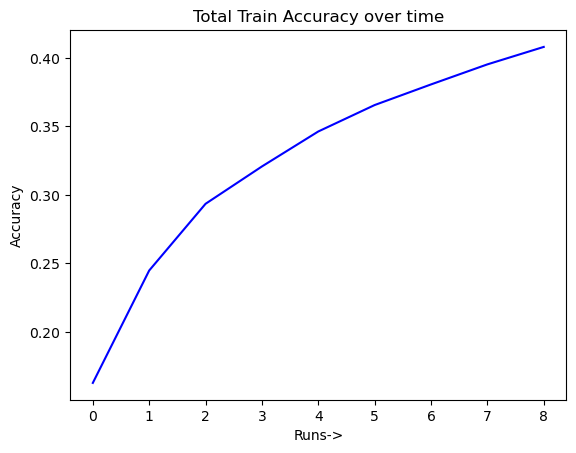

In [46]:
import matplotlib.pyplot as plt

# Plot Accuracy
plt.plot(accuracy_history, color='blue')
plt.ylabel('Accuracy')
plt.xlabel('Epochs')
plt.title("Validation Accuracy over Epochs")
plt.show()

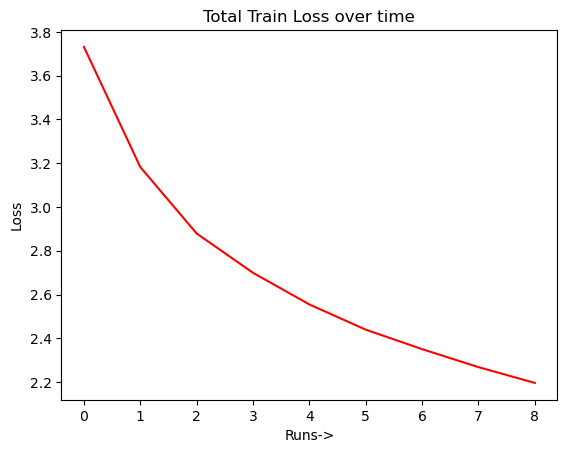

In [47]:
# Plot Loss
plt.plot(loss_history, color='red')
plt.ylabel('Loss')
plt.xlabel('Epochs')
plt.title("Total Train Loss over Epochs")
plt.show()

In [48]:
def get_answer(question, context):
    # Tokenize the question and context
    inputs = tokenizerFast.encode_plus(question, context, return_tensors='pt').to(device)
    
    # Forward pass through the model to get start and end logits
    with torch.no_grad():
        output_start, output_end = model(**inputs)
        
        # Get the start and end token positions for the answer
        answer_start = torch.argmax(output_start)  
        answer_end = torch.argmax(output_end)  

        # Convert token IDs to tokens and then join them into a string (inclusive range for answer)
        answer_tokens = tokenizerFast.convert_ids_to_tokens(inputs['input_ids'][0][answer_start:answer_end + 1])  # +1 to include end token
        answer = tokenizerFast.convert_tokens_to_string(answer_tokens)

        return answer

In [49]:
questions_valid[0]

'which nfl team represented the afc at super bowl 50?'

In [50]:
test_rec = 0

print(f"Context: {x}")
print(f"Question: {questions_valid[test_rec]}")
print(f"Expected Answer: {valid_answers[test_rec]}")

context = valid_contexts[test_rec]
question = questions_valid[test_rec]

print(f"Predicted Answer: {get_answer(question, context)}")


Context: 47
Question: which nfl team represented the afc at super bowl 50?
Expected Answer: {'answer_start': 190, 'text': 'denver broncos', 'answer_end': 204}
Predicted Answer: denver
